<a href="https://colab.research.google.com/github/serjunfan/simulation.ipynb/blob/main/Copy_of_Untitled1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

!gdown --id '14E61KmqUSXPbn9hK-UMXjV3fsWugJbD_' --output posdata
import numpy as np
posdata = np.load('posdata')
print(posdata)
data_len = len(posdata)
x = posdata[0:data_len -1 ]
y = posdata[1:data_len]
x = torch.tensor(x, dtype= torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print(x)

cuda:0
Downloading...
From: https://drive.google.com/uc?id=14E61KmqUSXPbn9hK-UMXjV3fsWugJbD_
To: /content/posdata
100% 173k/173k [00:00<00:00, 61.9MB/s]
[[ 93.67489007 173.1479319 ]
 [ 93.67489007 173.1479319 ]
 [ 93.67489007 173.1479319 ]
 ...
 [ 66.98063279 168.32100316]
 [ 68.05067799 168.05821767]
 [ 69.12072318 167.79543219]]
tensor([[ 93.6749, 173.1479],
        [ 93.6749, 173.1479],
        [ 93.6749, 173.1479],
        ...,
        [ 65.9106, 168.5838],
        [ 66.9806, 168.3210],
        [ 68.0507, 168.0582]])


In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
import math
#X = torch.Tensor([i[0] for i in data])
#y = torch.Tensor([i[1] for i in data])
class myDataset(Dataset):
  def __init__(self,x,y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x = x
    self.y = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len
#DATA = myDataset(x,y)
#first_data = DATA[0]
#print(f"first_data = {first_data}")

def get_dataloader(batch_size, num_worker):
  dataset = myDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

batchsize = 16
num_worker = 2
Epochs = 15
#total_sample = len(dataset)
#n_iter = math.ceil(total_sample / batchsize)
#print(total_sample, n_iter)

dataset = myDataset(x,y)
trainloader, valiloader = get_dataloader(batchsize, num_worker)

#indim, outdim = X[0].size()
class LR(nn.Module):
  def __init__(self):
    super().__init__()
    self.fc1 = nn.Linear(2, 4)
    self.fc2 = nn.Linear(4, 4)
    self.fc3 = nn.Linear(4, 2)
  def forward(self, x):
    x = F.relu(self.fc1(x))
    x = F.relu(self.fc2(x))
    x = F.relu(self.fc2(x))
    x = F.relu(self.fc2(x))
    x = self.fc3(x)
    return x

model = LR().to(device)
learning_rate = 0.001
loss = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)

for epoch in range(Epochs):
  for i, (inputs, labels) in enumerate(trainloader):
    model.zero_grad()
    y_pred = model(inputs.to(device))
    l = loss(y_pred, labels.to(device))
    l.backward()
    optimizer.step()
    if i % batchsize == 0:
      print(f"epoch = {epoch+1}, step = {i}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")



epoch = 1, step = 0, inputs.size() = torch.Size([16, 2]),y_pred[0] = [0.6490752696990967, 0.41702672839164734], y = [96.0, 160.0] ,loss = 19669.076171875
epoch = 1, step = 16, inputs.size() = torch.Size([16, 2]),y_pred[0] = [1.0621975660324097, 0.8297568559646606], y = [54.0, 172.0] ,loss = 19100.01953125
epoch = 1, step = 32, inputs.size() = torch.Size([16, 2]),y_pred[0] = [1.4391604661941528, 1.2805640697479248], y = [57.0, 168.0] ,loss = 19115.19140625
epoch = 1, step = 48, inputs.size() = torch.Size([16, 2]),y_pred[0] = [1.9866056442260742, 1.8455114364624023], y = [103.13960266113281, 168.614990234375] ,loss = 18365.69140625
epoch = 1, step = 64, inputs.size() = torch.Size([16, 2]),y_pred[0] = [3.2261953353881836, 2.8398597240448], y = [98.0, 171.0] ,loss = 18654.041015625
epoch = 1, step = 80, inputs.size() = torch.Size([16, 2]),y_pred[0] = [5.510315895080566, 4.767412185668945], y = [157.2161102294922, 182.1544647216797] ,loss = 18050.095703125
epoch = 1, step = 96, inputs.size(

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index].view(1,2), self.y[index]
  def __len__(self):
    return self.len
D = myselfDataset(x,y)
print(D.__getitem__(0))
class self_attention(nn.Module):
  def __init__(self, d_model=4, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=256, nhead=1
    )
    # self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, d_model),
      nn.ReLU(),
      nn.Linear(d_model, n_spks),
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder_layer(out)
    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    stats = out.mean(dim=1)

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

batchsize = 16
num_worker = 2
Epochs = 15
#dataset = myDataset()
trainloader, valiloader = get_dataloader(batchsize, num_worker)

model = self_attention().to(device)
learning_rate = 0.001
loss = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)

for epoch in range(Epochs):
  for i, (inputs, labels) in enumerate(trainloader):
    model.zero_grad()
    y_pred = model(inputs.to(device))
    l = loss(y_pred, labels.to(device))
    l.backward()
    optimizer.step()
    if i % batchsize == 0:
      print(f"epoch = {epoch+1}, step = {i}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")


(tensor([[ 93.6749, 173.1479]]), tensor([ 93.6749, 173.1479]))
epoch = 1, step = 0, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [-0.08768387883901596, 0.18611755967140198], y = [70.64984893798828, 170.4399871826172] ,loss = 18843.03515625
epoch = 1, step = 16, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [0.13909220695495605, 0.46039271354675293], y = [92.0, 174.0] ,loss = 18461.236328125
epoch = 1, step = 32, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [0.27258002758026123, 0.5784038305282593], y = [92.68572998046875, 173.1082305908203] ,loss = 20175.58984375
epoch = 1, step = 48, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [0.4019528031349182, 0.7105915546417236], y = [92.0, 174.0] ,loss = 19400.75390625
epoch = 1, step = 64, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [0.5371089577674866, 0.8638445138931274], y = [96.7627182006836, 166.32534790039062] ,loss = 18380.859375
epoch = 1, step = 80, inputs.size() = torch.Size([16, 1, 2]),y_pred[0] = [0.69

KeyboardInterrupt: ignored

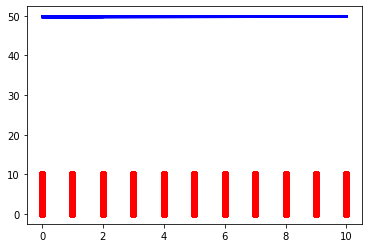

In [ ]:

import matplotlib.pyplot as plt
with torch.no_grad():
  predicted = model(X).detach().numpy()
X_numpy = X.detach().numpy()
y_numpy = y.detach().numpy() 
plt.plot(X_numpy, y_numpy, 'ro')
plt.plot(X_numpy, predicted, 'b')
plt.show()

In [ ]:
def validate(valiloader, model ,device):
  model.eval()
  for i,(inputs, labels) in enumerate(valiloader):
    with torch.no_grad():
      y_pred = model(inputs.to(device))
      l = loss(y_pred, labels.to(device))
      if i % batchsize == 0:
        print(f"step = {i}, inputs.size() = {inputs.size()},loss = {l}")

validate(valiloader, model, device)

step = 0, inputs.size() = torch.Size([16, 2]),loss = 743.8602294921875
step = 16, inputs.size() = torch.Size([16, 2]),loss = 1221.04931640625
step = 32, inputs.size() = torch.Size([16, 2]),loss = 932.7696533203125
step = 48, inputs.size() = torch.Size([16, 2]),loss = 617.332763671875
step = 64, inputs.size() = torch.Size([16, 2]),loss = 1198.6617431640625
step = 80, inputs.size() = torch.Size([16, 2]),loss = 824.441162109375
step = 96, inputs.size() = torch.Size([16, 2]),loss = 668.955810546875
step = 112, inputs.size() = torch.Size([16, 2]),loss = 884.8038940429688
step = 128, inputs.size() = torch.Size([16, 2]),loss = 792.4854736328125
step = 144, inputs.size() = torch.Size([16, 2]),loss = 922.9122314453125
step = 160, inputs.size() = torch.Size([16, 2]),loss = 1066.669677734375
step = 176, inputs.size() = torch.Size([16, 2]),loss = 667.7549438476562


In [ ]:
import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

#!gdown --id '14E61KmqUSXPbn9hK-UMXjV3fsWugJbD_' --output posdata
!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
import numpy as np
#posdata1 = np.load('posdata')
posdata10 = np.load('posdata10')
print(posdata10)
data_len = len(posdata10)
x = []
y = []
for i in range(data_len - 10):
  x.append([ posdata10[i] for i in range(i,i+10)])
print(x[-1:])
for i in range(1, data_len - 9):
  y.append([ posdata10[i] for i in range(i,i+10)])
print(y[-1:])
#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
x = torch.tensor(x, dtype= torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print(len(x))
print(len(y))
#print(x)

cuda:0
Downloading...
From: https://drive.google.com/uc?id=1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW
To: /content/posdata10
100% 1.73M/1.73M [00:00<00:00, 27.3MB/s]
[[ 95.17427817 172.56820904]
 [  1.13483948 151.29661686]
 [ 95.14134985 172.59481428]
 ...
 [103.14810016 454.22849922]
 [ 93.         170.        ]
 [ 43.94291977 122.9885625 ]]
[[array([ 45.79940725, 127.9600001 ]), array([ 96., 174.]), array([-12.58504111, 116.30719695]), array([ 91., 171.]), array([ -8.87302881, 118.28975299]), array([ 11., 177.]), array([ 97., 174.]), array([49., 90.]), array([103.14810016, 454.22849922]), array([ 93., 170.])]]
[[array([ 96., 174.]), array([-12.58504111, 116.30719695]), array([ 91., 171.]), array([ -8.87302881, 118.28975299]), array([ 11., 177.]), array([ 97., 174.]), array([49., 90.]), array([103.14810016, 454.22849922]), array([ 93., 170.]), array([ 43.94291977, 122.9885625 ])]]
107990
107990


In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset1(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention1(nn.Module):
  def __init__(self, d_model=2, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=256, nhead=1
    )
    # self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, d_model),
      nn.ReLU(),
      nn.Linear(d_model, n_spks),
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder_layer(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    #stats = out.mean(dim=1)
    #print(f"After mean pooling out ={out.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(out)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader1(batch_size, num_worker):
  dataset = myselfDataset1(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

batchsize = 16
num_worker = 2
Epochs = 15
#dataset = myDataset()
trainloader, valiloader = get_dataloader1(batchsize, num_worker)

model = self_attention1().to(device)
learning_rate = 0.001
loss = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate)

for epoch in range(Epochs):
  for i, (inputs, labels) in enumerate(trainloader):
    model.zero_grad()
    y_pred = model(inputs.to(device))
    #print(y_pred)
    #print("####")
    #print(labels)
    l = loss(y_pred, labels.to(device))
    l.backward()
    optimizer.step()
    if i % batchsize == 0:
      print(f"epoch = {epoch+1}, step = {i}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")



串流輸出內容已截斷至最後 5000 行。
epoch = 2, step = 5120, inputs.size() = torch.Size([16, 10, 2]),y_pred[0] = [[61.1146125793457, 166.60714721679688], [61.114620208740234, 166.60716247558594], [61.114620208740234, 166.60716247558594], [61.11461639404297, 166.60714721679688], [61.114620208740234, 166.60716247558594], [61.114620208740234, 166.60716247558594], [61.114620208740234, 166.60716247558594], [61.114620208740234, 166.60716247558594], [61.1146125793457, 166.60714721679688], [61.1146125793457, 166.60714721679688]], y = [[114.03617095947266, 157.06871032714844], [20.17125129699707, 162.4874725341797], [1.0074912309646606, 153.03990173339844], [97.0, 174.0], [49.22367858886719, 82.36785125732422], [0.007491279859095812, 142.8607940673828], [100.0, 168.0], [84.0, 167.0], [87.62511444091797, 168.3343505859375], [5.0, 157.0]] ,loss = 2286.3017578125
epoch = 2, step = 5136, inputs.size() = torch.Size([16, 10, 2]),y_pred[0] = [[61.823326110839844, 167.900146484375], [61.82332229614258, 167.90014648437

In [ ]:
import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

!gdown --id '14E61KmqUSXPbn9hK-UMXjV3fsWugJbD_' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')

data_len = len(posdata)
length = 50
print(data_len)
x = []
y = []
i = 0
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])

for i in range(0, data_len - (length+1), length):
  #print(f"i = {i}")
  x.append( [posdata[i] for i in range(i, i+length)] )
  
print(x[-2:])

#for i in range(100, data_len):
#  y.append( posdata1[i] )

for i in range(100, data_len, length):
  y.append(posdata[i])
y.append(posdata[data_len-1])
print(y[-1:])
#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
x = torch.tensor(x, dtype= torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print((x[0]))
print((y[0]))
print(len(x))
print(len(y))
#print(x)
print()

cuda:0
Downloading...
From: https://drive.google.com/uc?id=14E61KmqUSXPbn9hK-UMXjV3fsWugJbD_
To: /content/posdata
100% 173k/173k [00:00<00:00, 61.3MB/s]
10800
[[array([ 87.10026233, 187.76892952]), array([ 87.10026233, 187.76892952]), array([ 87.10026233, 187.76892952]), array([ 87.10026233, 187.76892952]), array([ 87.10026233, 187.76892952]), array([ 87.36382172, 187.37466515]), array([ 87.6273811 , 186.98040077]), array([ 87.89094049, 186.58613639]), array([ 88.15449987, 186.19187202]), array([ 88.41805926, 185.79760764]), array([ 88.68161864, 185.40334326]), array([ 88.94517803, 185.00907888]), array([ 89.20873742, 184.61481451]), array([ 89.4722968 , 184.22055013]), array([ 89.73585619, 183.82628575]), array([ 89.99941557, 183.43202138]), array([ 90.26297496, 183.037757  ]), array([ 90.52653434, 182.64349262]), array([ 90.79009373, 182.24922825]), array([ 91.05365311, 181.85496387]), array([ 91.3172125 , 181.46069949]), array([ 91.58077188, 181.06643512]), array([ 91.84433127, 180.

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, d_model),
      nn.ReLU(),
      nn.Linear(d_model, n_spks),
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



batchsize = 16
num_worker = 2
total_steps = 70000
warmup_steps = 1000
#dataset = myDataset()
trainloader, valiloader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
for i in range(13):
  input, label = next(train_iterator)
  print(f"size of input is {len(input)},size of labels is {len(label)} ")
  
model = self_attention().to(device)
learning_rate = 0.001
loss = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

for steps in range(total_steps):
  try:
    inputs, labels = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    inputs, labels = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  y_pred = model(inputs.to(device))
  #print(y_pred)
  #print("####")
  #print(labels)
  l = loss(y_pred, labels.to(device))
  l.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  if steps % batchsize == 0:
    print(f"steps = {steps+1}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")


trainloader size is = 13
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 16,size of labels is 16 
size of input is 1,size of labels is 1 
steps = 1, inputs.size() = torch.Size([16, 50, 2]),y_pred[0] = [-0.115842305123806, 0.3890734016895294], y = [130.93080139160156, 176.05328369140625] ,loss = 20384.8359375
steps = 17, inputs.size() = torch.Size([16, 50, 2]),y_pred[0] = [-0.028982356190681458, 0.4573044776916504], y = [125.97694396972656, 177.3778076171875] ,loss = 20623.048828125
steps = 33, inputs.size() = torch.Size([16, 50, 2]),y_pred[0] = [-0.00688330084085

KeyboardInterrupt: ignored

In [ ]:
### Kasit data

import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

!gdown --id '1XYC9el1PsHlBLFRuAjVneyqnKORsFASn' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')

data_len = len(posdata)
length = 50
print(data_len)
x = []
y = []
i = 0
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])

for i in range(0, data_len - (length+1), length):
  #print(f"i = {i}")
  x.append( [posdata[i] for i in range(i, i+length)] )
  
print(x[-2:])

#for i in range(100, data_len):
#  y.append( posdata1[i] )

for i in range(100, data_len, length):
  y.append(posdata[i])
y.append(posdata[data_len-1])
print(y[-1:])
#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
x = torch.tensor(x, dtype= torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print((x[0]))
print((y[0]))
print(len(x))
print(len(y))
#print(x)
print()

cuda:0
Downloading...
From: https://drive.google.com/uc?id=1XYC9el1PsHlBLFRuAjVneyqnKORsFASn
To: /content/posdata
80.6MB [00:00, 156MB/s] 
5040000
[[array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), 

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, d_model),
      nn.ReLU(),
      nn.Linear(d_model, n_spks),
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



def model_fn(batch, model, criterion, device):
  """Forward a batch through the model."""

  mels, labels = batch
  mels = mels.to(device)
  labels = labels.to(device)

  outs = model(mels)
  outs_mean = torch.mean(outs,dim=0,keepdim=True)
  labels_mean = torch.mean(labels,dim=0,keepdim=True)
  loss = criterion(outs, labels)

  # Get the speaker id with highest probability.
  #preds = outs.argmax(1)
  # Compute accuracy.
  pdist = torch.nn.PairwiseDistance(p=2)
  distance = pdist(outs_mean, labels_mean)
  #print(f" distance = {distance}")
  return loss, distance

# viladation

from tqdm import tqdm


def valid(dataloader, model, criterion, device): 
  """Validate on validation set."""

  model.eval()
  running_loss = 0.0
  running_distance = 0.0
  pbar = tqdm(total=len(dataloader.dataset), ncols=0, desc="Valid", unit=" cm")

  for i, batch in enumerate(dataloader):
    with torch.no_grad():
      loss, distance = model_fn(batch, model, criterion, device)
      running_loss += loss.item()
      running_distance += distance.item()

    pbar.update(dataloader.batch_size)
    pbar.set_postfix(
      loss=f"{running_loss / (i+1):.2f}",
      distance=f"{running_distance / (i+1):.2f}",
    )

  pbar.close()
  model.train()

  return running_distance / len(dataloader)


NameError: ignored

In [ ]:
from tqdm import tqdm

import torch
import torch.nn as nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, random_split

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"[Info]: Use {device} now!")
batchsize = 16
num_worker = 8
total_steps = 40000
warmup_steps = 1000
valid_steps = 2000
save_steps = 10000
save_path = "model.ckpt"
#dataset = myDataset()
trainloader, valid_loader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
  
model = self_attention().to(device)
learning_rate = 1e-3
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

best_distance = 99999
best_state_dict = None
pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

for step in range(total_steps):
  try:
    batch = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    batch = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  loss, distance = model_fn(batch, model, criterion, device)
  batch_loss = loss.item()
  batch_distance = distance.item()
  #print(y_pred)
  #print("####")
  #print(labels)
  loss.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  pbar.update()
  pbar.set_postfix(
      loss=f"{batch_loss:.2f}",
      distance=f"{batch_distance:.2f}",
      step=step + 1,
    )

  if (step + 1) % valid_steps == 0:
      pbar.close()

      valid_distance = valid(valid_loader, model, criterion, device)

      # keep the best model
      if valid_distance < best_distance:
        best_distance = valid_distance
        best_state_dict = model.state_dict()

      pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

    # Save the best model so far.
  #if (step + 1) % save_steps == 0 and best_state_dict is not None:
  #    torch.save(best_state_dict, save_path)
  #    pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_accuracy:.4f})")

pbar.close()
  #if steps % batchsize == 0:
  #  print(f"steps = {steps+1}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")

[Info]: Use cuda now!
trainloader size is = 5670


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Train: 100% 2000/2000 [00:33<00:00, 58.84 step/s, distance=214.08, loss=25486.26, step=2000]
Valid: 100% 10080/10080 [00:06<00:00, 1607.37 cm/s, distance=205.93, loss=37436.97]
Train: 100% 2000/2000 [00:33<00:00, 59.77 step/s, distance=98.61, loss=13016.49, step=4000]
Valid: 100% 10080/10080 [00:06<00:00, 1626.55 cm/s, distance=40.24, loss=16752.39]
Train: 100% 2000/2000 [00:33<00:00, 59.04 step/s, distance=16.96, loss=3478.88, step=6000]
Valid: 100% 10080/10080 [00:06<00:00, 1616.92 cm/s, distance=35.14, loss=16650.67]
Train: 100% 2000/2

In [ ]:
### Kasit data

import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

!gdown --id '1XYC9el1PsHlBLFRuAjVneyqnKORsFASn' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')

data_len = len(posdata)
length = 50
print(data_len)
x = []
y = []
i = 0
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])

for i in range(0, data_len - (length+1), length):
  #print(f"i = {i}")
  x.append( [posdata[i] for i in range(i, i+length)] )
  
print(x[-2:])

#for i in range(100, data_len):
#  y.append( posdata1[i] )

for i in range(100, data_len, length):
  y.append(posdata[i])
y.append(posdata[data_len-1])
print(y[-1:])
#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
x = torch.tensor(x, dtype= torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print((x[0]))
print((y[0]))
print(len(x))
print(len(y))
#print(x)
print()

cuda:0
Downloading...
From: https://drive.google.com/uc?id=1XYC9el1PsHlBLFRuAjVneyqnKORsFASn
To: /content/posdata
80.6MB [00:00, 174MB/s]
5040000
[[array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), array([5059.1642932, 8957.0602143]), a

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, 1024),
      nn.ReLU(),
      nn.Linear(1024, 2048),
      nn.ReLU(),
      nn.Linear(2048, n_spks)
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



def model_fn(batch, model, criterion, device):
  """Forward a batch through the model."""

  mels, labels = batch
  mels = mels.to(device)
  labels = labels.to(device)

  outs = model(mels)
  #print(f"outs.size() = {outs.size()}")
  outs_mean = torch.mean(outs,dim=0,keepdim=True)
  #print(f"outs.mean.size() = {outs_mean.size()}")
  labels_mean = torch.mean(labels,dim=0,keepdim=True)
  print(f"outs = {outs_mean}")
  print(f"labels = {labels_mean}")
  loss = criterion(outs, labels)

  # Get the speaker id with highest probability.
  #preds = outs.argmax(1)
  # Compute accuracy.
  pdist = torch.nn.PairwiseDistance(p=2)
  distance = pdist(outs_mean, labels_mean)
  #print(f" distance = {distance}")
  return loss, distance

# viladation

from tqdm import tqdm


def valid(dataloader, model, criterion, device): 
  """Validate on validation set."""

  model.eval()
  running_loss = 0.0
  running_distance = 0.0
  pbar = tqdm(total=len(dataloader.dataset), ncols=0, desc="Valid", unit=" cm")

  for i, batch in enumerate(dataloader):
    with torch.no_grad():
      loss, distance = model_fn(batch, model, criterion, device)
      running_loss += loss.item()
      running_distance += distance.item()

    pbar.update(dataloader.batch_size)
    pbar.set_postfix(
      loss=f"{running_loss / (i+1):.2f}",
      distance=f"{running_distance / (i+1):.2f}",
    )

  pbar.close()
  model.train()

  return running_distance / len(dataloader)

In [ ]:
from tqdm import tqdm

import torch
import torch.nn as nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, random_split

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"[Info]: Use {device} now!")
batchsize = 16
num_worker = 8
total_steps = 40000
warmup_steps = 1000
valid_steps = 2000
save_steps = 10000
save_path = "model.ckpt"
#dataset = myDataset()
trainloader, valid_loader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
  
model = self_attention().to(device)
learning_rate = 1e-3
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

best_distance = 99999
best_state_dict = None
pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

for step in range(total_steps):
  try:
    batch = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    batch = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  loss, distance = model_fn(batch, model, criterion, device)
  batch_loss = loss.item()
  batch_distance = distance.item()
  #print(y_pred)
  #print("####")
  #print(labels)
  loss.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  pbar.update()
  pbar.set_postfix(
      loss=f"{batch_loss:.2f}",
      distance=f"{batch_distance:.2f}",
      step=step + 1,
    )

  if (step + 1) % valid_steps == 0:
      pbar.close()

      valid_distance = valid(valid_loader, model, criterion, device)

      # keep the best model
      if valid_distance < best_distance:
        best_distance = valid_distance
        best_state_dict = model.state_dict()

      pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

    # Save the best model so far.
  #if (step + 1) % save_steps == 0 and best_state_dict is not None:
  #    torch.save(best_state_dict, save_path)
  #    pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_accuracy:.4f})")

pbar.close()
  #if steps % batchsize == 0:
  #  print(f"steps = {steps+1}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Train:   0% 0/2000 [04:54<?, ? step/s]

[Info]: Use cuda now!
trainloader size is = 5670



Train:   5% 102/2000 [04:27<1:22:55,  2.62s/ step, distance=10490.53, loss=55028336.00, step=102]
Train:   0% 9/2000 [00:00<00:44, 44.39 step/s, distance=10459.35, loss=54788824.00, step=9]

outs = tensor([[-0.0265,  0.0552]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7275, 9187.1523]], device='cuda:0')
outs = tensor([[-0.0242,  0.0530]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2539, 9147.8779]], device='cuda:0')
outs = tensor([[-0.0222,  0.0571]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5566, 9174.5078]], device='cuda:0')
outs = tensor([[-0.0221,  0.0628]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1025, 9181.4785]], device='cuda:0')
outs = tensor([[-0.0184,  0.0715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1152, 9174.7051]], device='cuda:0')
outs = tensor([[-0.0140,  0.0846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9004, 9198.6221]], device='cuda:0')
outs = tensor([[-0.0069,  0.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2236, 9176.3291]], device='cuda:0')
outs = tensor([[0.0005, 0.1189]], device=

Train:   1% 19/2000 [00:00<00:43, 45.81 step/s, distance=10530.95, loss=55456712.00, step=19]

outs = tensor([[0.0217, 0.1649]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2705, 9187.8936]], device='cuda:0')
outs = tensor([[0.0293, 0.1960]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.5791, 9033.9492]], device='cuda:0')
outs = tensor([[0.0432, 0.2243]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0039, 9189.7969]], device='cuda:0')
outs = tensor([[0.0584, 0.2590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8340, 9174.8311]], device='cuda:0')
outs = tensor([[0.0722, 0.2954]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0439, 9189.6152]], device='cuda:0')
outs = tensor([[0.0896, 0.3331]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1719, 9184.0342]], device='cuda:0')
outs = tensor([[0.1060, 0.3777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3130, 9181.9082]], device='cuda:0')
outs = tensor([[0.1256, 0.4235]], device='cuda:0', grad

Train:   1% 29/2000 [00:00<00:41, 47.21 step/s, distance=10547.74, loss=55630184.00, step=29]

outs = tensor([[0.1879, 0.5737]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3071, 9241.7969]], device='cuda:0')
outs = tensor([[0.2098, 0.6308]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3633, 9165.8066]], device='cuda:0')
outs = tensor([[0.2365, 0.6882]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0908, 9194.6211]], device='cuda:0')
outs = tensor([[0.2592, 0.7503]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0518, 9180.6582]], device='cuda:0')
outs = tensor([[0.2842, 0.8113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6904, 9164.2754]], device='cuda:0')
outs = tensor([[0.3107, 0.8795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0547, 9183.1533]], device='cuda:0')
outs = tensor([[0.3401, 0.9484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3813, 9155.0605]], device='cuda:0')
outs = tensor([[0.3702, 1.0196]], device='cuda:0', grad

Train:   2% 38/2000 [00:00<00:41, 47.11 step/s, distance=10472.58, loss=54943380.00, step=38]

outs = tensor([[0.4678, 1.2484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8994, 9180.7578]], device='cuda:0')
outs = tensor([[0.5047, 1.3319]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6250, 9183.7471]], device='cuda:0')
outs = tensor([[0.5420, 1.4146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6934, 9138.0645]], device='cuda:0')
outs = tensor([[0.5806, 1.5027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0757, 9089.2070]], device='cuda:0')
outs = tensor([[0.6219, 1.5944]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3232, 9202.5361]], device='cuda:0')
outs = tensor([[0.6642, 1.6863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4443, 9171.8242]], device='cuda:0')
outs = tensor([[0.7100, 1.7846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8076, 9176.8203]], device='cuda:0')
outs = tensor([[0.7556, 1.8827]], device='cuda:0', grad

Train:   2% 48/2000 [00:01<00:42, 45.73 step/s, distance=10549.51, loss=55649032.00, step=48]

outs = tensor([[0.9078, 2.2114]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0806, 9173.0068]], device='cuda:0')
outs = tensor([[0.9616, 2.3283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1118, 9181.6885]], device='cuda:0')
outs = tensor([[1.0154, 2.4490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2930, 9157.2881]], device='cuda:0')
outs = tensor([[1.0743, 2.5769]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4155, 9170.3740]], device='cuda:0')
outs = tensor([[1.1316, 2.7067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3442, 9180.9141]], device='cuda:0')
outs = tensor([[1.1958, 2.8390]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7910, 9191.9170]], device='cuda:0')
outs = tensor([[1.2642, 2.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2534, 9191.4531]], device='cuda:0')
outs = tensor([[1.3329, 3.1352]], device='cuda:0', grad

Train:   3% 58/2000 [00:01<00:42, 45.93 step/s, distance=10562.71, loss=55789656.00, step=58]

outs = tensor([[1.5665, 3.6210]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1289, 9152.4365]], device='cuda:0')
outs = tensor([[1.6497, 3.7914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7471, 9176.8105]], device='cuda:0')
outs = tensor([[1.7388, 3.9739]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1919, 9160.2910]], device='cuda:0')
outs = tensor([[1.8331, 4.1684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0820, 9173.0039]], device='cuda:0')
outs = tensor([[1.9332, 4.3675]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2847, 9173.0635]], device='cuda:0')
outs = tensor([[2.0380, 4.5783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4390, 9112.5195]], device='cuda:0')
outs = tensor([[2.1461, 4.7934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6733, 9171.7852]], device='cuda:0')
outs = tensor([[2.2640, 5.0286]], device='cuda:0', grad

Train:   3% 67/2000 [00:01<00:41, 46.69 step/s, distance=10525.23, loss=55393808.00, step=67]

outs = tensor([[2.5181, 5.5172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9321, 9074.2637]], device='cuda:0')
outs = tensor([[2.6570, 5.7797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4463, 9178.2520]], device='cuda:0')
outs = tensor([[2.8047, 6.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4736, 9200.6631]], device='cuda:0')
outs = tensor([[2.9603, 6.3422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4976, 9123.6807]], device='cuda:0')
outs = tensor([[3.1259, 6.6453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5469, 9130.4541]], device='cuda:0')
outs = tensor([[3.3029, 6.9588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4512, 9273.5713]], device='cuda:0')
outs = tensor([[3.4893, 7.2916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4365, 9187.0928]], device='cuda:0')
outs = tensor([[3.6887, 7.6390]], device='cuda:0', grad

Train:   4% 77/2000 [00:01<00:42, 45.07 step/s, distance=10525.39, loss=55393616.00, step=77]

outs = tensor([[4.3521, 8.7786]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6733, 9190.2129]], device='cuda:0')
outs = tensor([[4.5941, 9.1883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1855, 9167.6797]], device='cuda:0')
outs = tensor([[4.8508, 9.6216]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1279, 9157.4219]], device='cuda:0')
outs = tensor([[ 5.1305, 10.0916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6094, 9131.2363]], device='cuda:0')
outs = tensor([[ 5.4157, 10.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8750, 9181.3066]], device='cuda:0')
outs = tensor([[ 5.7251, 11.0687]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8159, 9175.4248]], device='cuda:0')
outs = tensor([[ 6.0519, 11.6034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6924, 9185.7822]], device='cuda:0')
outs = tensor([[ 6.3913, 12.1517]], device='cud

Train:   4% 86/2000 [00:01<00:42, 45.05 step/s, distance=10527.70, loss=55418304.00, step=86]

labels = tensor([[5222.4028, 9070.4805]], device='cuda:0')
outs = tensor([[ 7.5315, 13.9692]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6187, 9067.6826]], device='cuda:0')
outs = tensor([[ 7.9468, 14.6186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3281, 9183.9521]], device='cuda:0')
outs = tensor([[ 8.3985, 15.3292]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4697, 9179.7109]], device='cuda:0')
outs = tensor([[ 8.8654, 16.0523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0752, 9174.0488]], device='cuda:0')
outs = tensor([[ 9.3579, 16.8134]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8853, 9173.0537]], device='cuda:0')
outs = tensor([[ 9.8751, 17.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7910, 9141.4922]], device='cuda:0')
outs = tensor([[10.4297, 18.4535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3794, 9166.8193]],

Train:   5% 96/2000 [00:02<00:42, 45.09 step/s, distance=10519.32, loss=55333008.00, step=96]

outs = tensor([[12.2550, 21.1950]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9121, 9095.5645]], device='cuda:0')
outs = tensor([[12.9249, 22.1890]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6021, 9187.5820]], device='cuda:0')
outs = tensor([[13.6517, 23.2604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5474, 9059.4814]], device='cuda:0')
outs = tensor([[14.3990, 24.3588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7915, 9178.0566]], device='cuda:0')
outs = tensor([[15.1720, 25.4777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2729, 9174.2207]], device='cuda:0')
outs = tensor([[16.0092, 26.6925]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0361, 9174.7949]], device='cuda:0')
outs = tensor([[16.8821, 27.9505]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4062, 9175.1914]], device='cuda:0')
outs = tensor([[17.7843, 29.2426]], devic

Train:   5% 106/2000 [00:02<00:42, 45.04 step/s, distance=10472.39, loss=54841856.00, step=106]

outs = tensor([[20.8272, 33.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6558, 9144.4424]], device='cuda:0')
outs = tensor([[21.9594, 35.1483]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2466, 9180.2949]], device='cuda:0')
outs = tensor([[23.1292, 36.7825]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2480, 9169.9307]], device='cuda:0')
outs = tensor([[24.3609, 38.4942]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2739, 9153.6631]], device='cuda:0')
outs = tensor([[25.6408, 40.2622]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4814, 9191.7734]], device='cuda:0')
outs = tensor([[26.9940, 42.1215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5684, 9152.8477]], device='cuda:0')
outs = tensor([[28.4393, 44.1048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1665, 9167.6592]], device='cuda:0')
outs = tensor([[29.9275, 46.1286]], devic

Train:   6% 116/2000 [00:02<00:41, 45.69 step/s, distance=10464.30, loss=54753624.00, step=116]

outs = tensor([[34.8727, 52.8134]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9409, 9170.5762]], device='cuda:0')
outs = tensor([[36.6909, 55.2505]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1191, 9162.1377]], device='cuda:0')
outs = tensor([[38.5967, 57.7941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3584, 9187.3164]], device='cuda:0')
outs = tensor([[40.5985, 60.4595]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4673, 9165.3203]], device='cuda:0')
outs = tensor([[42.6763, 63.2099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.0625, 9166.0830]], device='cuda:0')
outs = tensor([[44.8656, 66.1026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6641, 9169.5537]], device='cuda:0')
outs = tensor([[47.1472, 69.1008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8779, 9233.5762]], device='cuda:0')
outs = tensor([[49.5838, 72.2997]], devic

Train:   6% 126/2000 [00:02<00:41, 45.70 step/s, distance=10399.97, loss=54094680.00, step=126]

outs = tensor([[57.4508, 82.5327]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4727, 9174.7480]], device='cuda:0')
outs = tensor([[60.3509, 86.2813]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6963, 9153.2041]], device='cuda:0')
outs = tensor([[63.3730, 90.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1514, 9176.3379]], device='cuda:0')
outs = tensor([[66.5353, 94.2273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2812, 9187.0684]], device='cuda:0')
outs = tensor([[69.8315, 98.4393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2676, 9182.5000]], device='cuda:0')
outs = tensor([[ 73.2751, 102.8250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0459, 9193.3008]], device='cuda:0')
outs = tensor([[ 76.9097, 107.4447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2344, 9110.9902]], device='cuda:0')
outs = tensor([[ 80.6885, 112.2304]],

Train:   7% 135/2000 [00:02<00:42, 43.89 step/s, distance=10366.06, loss=53748688.00, step=135]

outs = tensor([[ 93.0880, 127.8299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6572, 9180.3887]], device='cuda:0')
outs = tensor([[ 97.6172, 133.4958]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8740, 9186.2334]], device='cuda:0')
outs = tensor([[102.3187, 139.3582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4727, 9182.2607]], device='cuda:0')
outs = tensor([[107.2124, 145.4411]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4580, 9160.8662]], device='cuda:0')
outs = tensor([[112.3328, 151.7869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0049, 9078.8223]], device='cuda:0')
outs = tensor([[117.6822, 158.3959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4048, 9151.8271]], device='cuda:0')
outs = tensor([[123.2479, 165.2575]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0117, 9168.0840]], device='cuda:0')
outs = tensor([[129.0891, 1

Train:   7% 145/2000 [00:03<00:42, 43.14 step/s, distance=10218.72, loss=52217600.00, step=145]

outs = tensor([[141.5134, 187.6545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4731, 9145.0723]], device='cuda:0')
outs = tensor([[148.0862, 195.6655]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2671, 9164.4004]], device='cuda:0')
outs = tensor([[154.9798, 204.0558]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8271, 9180.2285]], device='cuda:0')
outs = tensor([[162.1670, 212.7788]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5298, 9114.7314]], device='cuda:0')
outs = tensor([[169.6222, 221.8048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9126, 9175.9004]], device='cuda:0')
outs = tensor([[177.3558, 231.1386]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2656, 9172.4395]], device='cuda:0')
outs = tensor([[185.4640, 240.9090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3145, 9098.6025]], device='cuda:0')
outs = tensor([[193.8551, 2

Train:   8% 156/2000 [00:03<00:40, 45.03 step/s, distance=9969.49, loss=49795756.00, step=155]

outs = tensor([[221.2229, 283.7240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3491, 9173.9902]], device='cuda:0')
outs = tensor([[231.0972, 295.4887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8633, 9171.9678]], device='cuda:0')
outs = tensor([[241.3246, 307.6425]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4624, 9174.1758]], device='cuda:0')
outs = tensor([[252.0618, 320.3802]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7700, 9082.7363]], device='cuda:0')
outs = tensor([[263.1071, 333.4457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8623, 9222.3633]], device='cuda:0')
outs = tensor([[274.6013, 347.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0967, 9167.5430]], device='cuda:0')
outs = tensor([[286.5136, 361.0543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2119, 9004.6406]], device='cuda:0')
outs = tensor([[298.8859, 3

Train:   8% 166/2000 [00:03<00:39, 46.03 step/s, distance=9797.91, loss=48002316.00, step=166]

outs = tensor([[338.9775, 422.5945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0366, 9186.0332]], device='cuda:0')
outs = tensor([[353.3952, 439.4452]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7188, 9035.5889]], device='cuda:0')
outs = tensor([[368.2127, 456.7234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4180, 9090.6055]], device='cuda:0')
outs = tensor([[383.6231, 474.6605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8345, 9179.6602]], device='cuda:0')
outs = tensor([[399.7245, 493.3775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8032, 9178.9648]], device='cuda:0')
outs = tensor([[416.2675, 512.5721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0249, 9174.1279]], device='cuda:0')
outs = tensor([[433.4883, 532.5316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6143, 9082.0293]], device='cuda:0')
outs = tensor([[451.3025, 5

Train:   9% 175/2000 [00:03<00:40, 45.14 step/s, distance=9511.07, loss=45236600.00, step=175]

outs = tensor([[508.6783, 619.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2402, 9197.8398]], device='cuda:0')
outs = tensor([[529.1119, 642.8430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0259, 9053.8906]], device='cuda:0')
outs = tensor([[550.3408, 667.2328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4258, 9197.1855]], device='cuda:0')
outs = tensor([[572.2644, 692.3872]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8018, 9185.1611]], device='cuda:0')
outs = tensor([[594.9582, 718.3973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7471, 9123.3867]], device='cuda:0')
outs = tensor([[618.4370, 745.2668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8047, 9192.9141]], device='cuda:0')
outs = tensor([[642.6437, 772.9342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5908, 9182.9434]], device='cuda:0')
outs = tensor([[667.6947, 8

Train:   9% 185/2000 [00:04<00:41, 43.37 step/s, distance=9033.09, loss=40802476.00, step=185]

outs = tensor([[748.0129, 893.0630]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0435, 9141.1309]], device='cuda:0')
outs = tensor([[776.4098, 925.3367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9980, 9108.6826]], device='cuda:0')
outs = tensor([[805.8911, 958.8092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6841, 9085.3037]], device='cuda:0')
outs = tensor([[836.3461, 993.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6016, 9223.5488]], device='cuda:0')
outs = tensor([[ 867.6334, 1028.8098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2354, 9183.8506]], device='cuda:0')
outs = tensor([[ 899.9683, 1065.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7549, 9172.5342]], device='cuda:0')
outs = tensor([[ 933.2765, 1103.0802]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9268, 9124.1533]], device='cuda:0')
outs = tensor([[ 967.

Train:  10% 194/2000 [00:04<00:41, 43.41 step/s, distance=8483.94, loss=35993876.00, step=194]

outs = tensor([[1039.4260, 1222.9016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0454, 9185.2891]], device='cuda:0')
outs = tensor([[1077.2021, 1265.4860]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5537, 9166.4824]], device='cuda:0')
outs = tensor([[1115.8535, 1309.0168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2949, 9197.6162]], device='cuda:0')
outs = tensor([[1155.7334, 1353.8979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5083.8232, 9249.9209]], device='cuda:0')
outs = tensor([[1196.8677, 1400.2029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0986, 9184.0234]], device='cuda:0')
outs = tensor([[1238.9598, 1447.5320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9258, 9178.0137]], device='cuda:0')
outs = tensor([[1282.3140, 1496.2450]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2939, 9157.5488]], device='cuda:0')
outs = tensor

Train:  10% 204/2000 [00:04<00:40, 44.22 step/s, distance=7742.97, loss=29978984.00, step=204]

outs = tensor([[1420.3954, 1651.2103]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2793, 9170.7090]], device='cuda:0')
outs = tensor([[1468.9586, 1705.6431]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9717, 9164.5820]], device='cuda:0')
outs = tensor([[1518.7958, 1761.4763]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8105, 9174.2109]], device='cuda:0')
outs = tensor([[1570.0985, 1818.9235]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4395, 9212.8477]], device='cuda:0')
outs = tensor([[1622.8000, 1877.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2041, 9186.3330]], device='cuda:0')
outs = tensor([[1676.7880, 1938.2760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0908, 9184.6543]], device='cuda:0')
outs = tensor([[1732.2501, 2000.3237]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4209, 9056.5703]], device='cuda:0')
outs = tensor

Train:  11% 213/2000 [00:04<00:39, 45.01 step/s, distance=6875.04, loss=23637200.00, step=213]

outs = tensor([[1968.0521, 2264.1060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6006, 9157.4297]], device='cuda:0')
outs = tensor([[2030.6740, 2334.1917]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4233, 9177.3418]], device='cuda:0')
outs = tensor([[2094.7876, 2405.9597]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2119, 9182.7070]], device='cuda:0')
outs = tensor([[2160.1274, 2479.1223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4268, 9158.7891]], device='cuda:0')
outs = tensor([[2227.3516, 2554.4497]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0283, 9182.2920]], device='cuda:0')
outs = tensor([[2295.6230, 2630.9858]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3848, 9208.2939]], device='cuda:0')
outs = tensor([[2365.9834, 2709.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8789, 9194.2383]], device='cuda:0')
outs = tensor

Train:  11% 223/2000 [00:04<00:40, 44.42 step/s, distance=5662.72, loss=16067653.00, step=223]

outs = tensor([[2660.5605, 3041.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4961, 9191.3457]], device='cuda:0')
outs = tensor([[2738.2275, 3128.6780]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6133, 9155.4629]], device='cuda:0')
outs = tensor([[2816.2710, 3216.7876]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0659, 9185.3691]], device='cuda:0')
outs = tensor([[2897.3909, 3308.5559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1108, 9175.7490]], device='cuda:0')
outs = tensor([[2978.9465, 3400.9939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9883, 9181.2910]], device='cuda:0')
outs = tensor([[3061.6785, 3494.9575]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2109, 9181.1533]], device='cuda:0')
outs = tensor([[3145.8022, 3590.7625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3984, 9061.7090]], device='cuda:0')
outs = tensor

Train:  12% 233/2000 [00:05<00:39, 45.06 step/s, distance=4456.10, loss=9931008.00, step=233] 

outs = tensor([[3492.9336, 3988.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9385, 9170.7217]], device='cuda:0')
outs = tensor([[3582.9019, 4092.6255]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1895, 9040.7168]], device='cuda:0')
outs = tensor([[3673.3494, 4197.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9995, 9179.3877]], device='cuda:0')
outs = tensor([[3764.4077, 4303.5972]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6265, 9165.2002]], device='cuda:0')
outs = tensor([[3856.4976, 4411.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0669, 9160.7812]], device='cuda:0')
outs = tensor([[3949.2212, 4520.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7559, 9069.0625]], device='cuda:0')
outs = tensor([[4042.1099, 4630.3286]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7642, 9167.0547]], device='cuda:0')
outs = tensor

Train:  12% 242/2000 [00:05<00:39, 44.50 step/s, distance=3288.34, loss=5410329.00, step=242]

outs = tensor([[4321.8882, 4966.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5381, 9136.2549]], device='cuda:0')
outs = tensor([[4415.6807, 5080.4438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5586, 9140.8223]], device='cuda:0')
outs = tensor([[4508.8311, 5195.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1802, 9156.2324]], device='cuda:0')
outs = tensor([[4602.0410, 5311.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5000, 9212.2393]], device='cuda:0')
outs = tensor([[4694.2637, 5427.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3164, 9172.2461]], device='cuda:0')
outs = tensor([[4786.0571, 5544.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3252, 9126.2402]], device='cuda:0')
outs = tensor([[4876.0625, 5660.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4326, 9182.0469]], device='cuda:0')
outs = tensor

Train:  13% 252/2000 [00:05<00:39, 44.71 step/s, distance=2243.29, loss=2524879.50, step=252]

outs = tensor([[5222.5566, 6125.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2490, 9040.6348]], device='cuda:0')
outs = tensor([[5302.9775, 6239.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9209, 9190.8291]], device='cuda:0')
outs = tensor([[5382.3804, 6354.1929]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8154, 9190.1113]], device='cuda:0')
outs = tensor([[5459.0073, 6467.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1748, 9189.2852]], device='cuda:0')
outs = tensor([[5532.4961, 6579.9478]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7603, 9182.0957]], device='cuda:0')
outs = tensor([[5603.1924, 6691.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1982, 9179.7393]], device='cuda:0')
outs = tensor([[5669.9453, 6800.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0190, 9184.3213]], device='cuda:0')
outs = tensor

Train:  13% 262/2000 [00:05<00:39, 44.14 step/s, distance=1561.44, loss=1223326.50, step=262]

outs = tensor([[5902.6245, 7221.4517]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9287, 9180.0713]], device='cuda:0')
outs = tensor([[5949.7480, 7320.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4092, 9187.7070]], device='cuda:0')
outs = tensor([[5993.4800, 7417.1050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5116.2227, 9184.4414]], device='cuda:0')
outs = tensor([[6031.0439, 7509.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4243, 9163.9717]], device='cuda:0')
outs = tensor([[6066.7900, 7602.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9526, 9162.3398]], device='cuda:0')
outs = tensor([[6096.6108, 7690.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4619, 9172.4111]], device='cuda:0')
outs = tensor([[6121.9292, 7775.5298]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3662, 9050.6611]], device='cuda:0')
outs = tensor

Train:  14% 271/2000 [00:06<00:39, 43.28 step/s, distance=1211.24, loss=805247.00, step=271]

outs = tensor([[6170.8286, 8008.8911]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7427, 9177.1631]], device='cuda:0')
outs = tensor([[6179.1094, 8080.5698]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8604, 9069.5391]], device='cuda:0')
outs = tensor([[6183.1055, 8148.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3169, 9163.8291]], device='cuda:0')
outs = tensor([[6182.1792, 8211.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1846, 8935.7588]], device='cuda:0')
outs = tensor([[6178.8403, 8271.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8833, 9216.0283]], device='cuda:0')
outs = tensor([[6173.2051, 8330.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1860, 9124.7266]], device='cuda:0')
outs = tensor([[6162.7959, 8384.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5096.6050, 9238.3965]], device='cuda:0')
outs = tensor

Train:  14% 280/2000 [00:06<00:40, 42.28 step/s, distance=755.93, loss=297158.44, step=280]

outs = tensor([[6113.0742, 8526.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8682, 9164.5762]], device='cuda:0')
outs = tensor([[6090.8716, 8567.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2515, 9179.5791]], device='cuda:0')
outs = tensor([[6067.3774, 8606.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8564, 9184.8730]], device='cuda:0')
outs = tensor([[6042.2437, 8643.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7754, 9255.3145]], device='cuda:0')
outs = tensor([[6016.0312, 8678.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1567, 9188.9141]], device='cuda:0')
outs = tensor([[5988.8071, 8710.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3672, 9180.9473]], device='cuda:0')
outs = tensor([[5960.2788, 8740.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5669, 9174.0918]], device='cuda:0')
outs = tensor

Train:  14% 289/2000 [00:06<00:39, 43.10 step/s, distance=451.62, loss=105422.11, step=289]

outs = tensor([[5869.8994, 8818.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6743, 9187.4561]], device='cuda:0')
outs = tensor([[5839.7056, 8842.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2744, 9179.8223]], device='cuda:0')
outs = tensor([[5808.3687, 8862.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5825, 9151.7510]], device='cuda:0')
outs = tensor([[5777.4819, 8882.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1650, 9167.0820]], device='cuda:0')
outs = tensor([[5744.7964, 8898.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4238, 9181.1641]], device='cuda:0')
outs = tensor([[5713.8809, 8915.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6602, 9169.1289]], device='cuda:0')
outs = tensor([[5682.3018, 8928.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1699, 9184.5742]], device='cuda:0')
outs = tensor

Train:  15% 298/2000 [00:06<00:39, 43.55 step/s, distance=244.33, loss=33119.78, step=298]

outs = tensor([[5588.3257, 8960.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0811, 9170.2539]], device='cuda:0')
outs = tensor([[5560.3867, 8972.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3882, 9175.7520]], device='cuda:0')
outs = tensor([[5530.2476, 8978.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0605, 9178.6094]], device='cuda:0')
outs = tensor([[5502.6328, 8986.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2588, 9180.8789]], device='cuda:0')
outs = tensor([[5475.7168, 8993.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6240, 9162.0215]], device='cuda:0')
outs = tensor([[5451.4810, 9002.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0859, 9155.7012]], device='cuda:0')
outs = tensor([[5429.6045, 9013.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1538, 9184.1133]], device='cuda:0')
outs = tensor

Train:  15% 307/2000 [00:06<00:39, 42.98 step/s, distance=70.98, loss=7074.60, step=307]

labels = tensor([[5211.9722, 9186.3477]], device='cuda:0')
outs = tensor([[5355.9834, 9058.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0830, 9186.1562]], device='cuda:0')
outs = tensor([[5340.4443, 9069.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.8115, 9206.3350]], device='cuda:0')
outs = tensor([[5325.5898, 9080.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0107, 9079.9414]], device='cuda:0')
outs = tensor([[5309.6260, 9087.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2773, 9175.2178]], device='cuda:0')
outs = tensor([[5295.0410, 9095.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1816, 9193.6094]], device='cuda:0')
outs = tensor([[5281.0918, 9101.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2280, 9148.4512]], device='cuda:0')
outs = tensor([[5267.9277, 9107.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  16% 316/2000 [00:07<00:39, 42.53 step/s, distance=21.43, loss=1920.07, step=316]

outs = tensor([[5245.9658, 9120.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0991, 9168.0137]], device='cuda:0')
outs = tensor([[5235.6143, 9125.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7495, 9162.7734]], device='cuda:0')
outs = tensor([[5226.5234, 9131.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0864, 9147.2324]], device='cuda:0')
outs = tensor([[5218.3047, 9136.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2822, 9176.3652]], device='cuda:0')
outs = tensor([[5209.7388, 9139.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2510, 9169.9473]], device='cuda:0')
outs = tensor([[5203.6768, 9145.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3218, 9172.4648]], device='cuda:0')
outs = tensor([[5197.4570, 9149.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4165, 9170.1133]], device='cuda:0')
outs = tensor

Train:  16% 324/2000 [00:07<00:39, 42.83 step/s, distance=95.27, loss=47942.55, step=324]

outs = tensor([[5182.9141, 9161.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0264, 9169.7090]], device='cuda:0')
outs = tensor([[5178.7690, 9163.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9307, 9202.4844]], device='cuda:0')
outs = tensor([[5177.2676, 9168.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5742, 9174.1260]], device='cuda:0')
outs = tensor([[5175.2432, 9172.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4077, 9072.0723]], device='cuda:0')
outs = tensor([[5172.8428, 9173.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3149, 9186.8877]], device='cuda:0')
outs = tensor([[5172.1689, 9177.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1860, 9179.1387]], device='cuda:0')
outs = tensor([[5171.3672, 9179.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4292, 9175.1777]], device='cuda:0')
outs = tensor

Train:  17% 334/2000 [00:07<00:39, 42.19 step/s, distance=56.27, loss=6811.21, step=334]

outs = tensor([[5171.2466, 9185.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0576, 9137.1846]], device='cuda:0')
outs = tensor([[5171.7905, 9185.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9971, 9078.9922]], device='cuda:0')
outs = tensor([[5171.8340, 9184.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1719, 9180.0068]], device='cuda:0')
outs = tensor([[5173.1343, 9185.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5244, 9059.6797]], device='cuda:0')
outs = tensor([[5173.9263, 9184.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8374, 9185.4238]], device='cuda:0')
outs = tensor([[5174.4287, 9182.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9507, 9142.4004]], device='cuda:0')
outs = tensor([[5175.9629, 9182.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9370, 9133.2324]], device='cuda:0')
outs = tensor

Train:  17% 344/2000 [00:07<00:38, 43.37 step/s, distance=52.62, loss=27181.98, step=344]

outs = tensor([[5182.4033, 9177.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0249, 9054.4160]], device='cuda:0')
outs = tensor([[5184.3369, 9176.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9473, 9074.5469]], device='cuda:0')
outs = tensor([[5185.2993, 9172.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1338, 9158.9385]], device='cuda:0')
outs = tensor([[5187.3682, 9170.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2207, 9176.0889]], device='cuda:0')
outs = tensor([[5188.7207, 9167.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3110, 9197.6826]], device='cuda:0')
outs = tensor([[5191.3384, 9167.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0850, 9161.0078]], device='cuda:0')
outs = tensor([[5193.2109, 9166.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7451, 9179.4033]], device='cuda:0')
outs = tensor

Train:  18% 353/2000 [00:07<00:37, 44.05 step/s, distance=19.14, loss=5276.65, step=353] 

outs = tensor([[5200.8516, 9165.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3701, 9051.0117]], device='cuda:0')
outs = tensor([[5202.7656, 9163.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4170, 9170.1650]], device='cuda:0')
outs = tensor([[5205.1382, 9163.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3218, 9193.9863]], device='cuda:0')
outs = tensor([[5207.7026, 9164.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1470, 9141.7822]], device='cuda:0')
outs = tensor([[5208.7520, 9162.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6084, 9159.5039]], device='cuda:0')
outs = tensor([[5209.4600, 9161.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1348, 9083.4766]], device='cuda:0')
outs = tensor([[5209.1587, 9157.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2817, 9179.8672]], device='cuda:0')
outs = tensor

Train:  18% 362/2000 [00:08<00:38, 42.59 step/s, distance=23.38, loss=8489.06, step=362]

outs = tensor([[5212.5801, 9152.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4902, 9208.0537]], device='cuda:0')
outs = tensor([[5214.2920, 9153.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5190, 9170.2617]], device='cuda:0')
outs = tensor([[5216.9980, 9156.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6377, 9181.6797]], device='cuda:0')
outs = tensor([[5218.4507, 9157.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4004, 9168.5957]], device='cuda:0')
outs = tensor([[5219.9082, 9159.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3086, 9152.2227]], device='cuda:0')
outs = tensor([[5220.5845, 9159.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7842, 9171.2139]], device='cuda:0')
outs = tensor([[5222.0205, 9161.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9575, 9191.5693]], device='cuda:0')
outs = tensor

Train:  19% 372/2000 [00:08<00:37, 43.48 step/s, distance=6.32, loss=3113.93, step=372] 

outs = tensor([[5224.7627, 9164.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7275, 9198.8047]], device='cuda:0')
outs = tensor([[5225.9717, 9166.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7817, 9193.1279]], device='cuda:0')
outs = tensor([[5226.2783, 9167.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0889, 9183.8398]], device='cuda:0')
outs = tensor([[5226.8086, 9168.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6592, 9187.4062]], device='cuda:0')
outs = tensor([[5227.0713, 9169.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7710, 9185.2305]], device='cuda:0')
outs = tensor([[5227.8174, 9171.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2383, 9150.4805]], device='cuda:0')
outs = tensor([[5227.1660, 9171.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0244, 9167.6279]], device='cuda:0')
outs = tensor

Train:  19% 381/2000 [00:08<00:37, 43.58 step/s, distance=82.73, loss=39525.14, step=381]

outs = tensor([[5227.2129, 9173.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8545, 9188.1738]], device='cuda:0')
outs = tensor([[5226.6836, 9173.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9697, 9153.9150]], device='cuda:0')
outs = tensor([[5227.4985, 9175.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1387, 9178.9180]], device='cuda:0')
outs = tensor([[5227.3433, 9175.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3066, 9168.1406]], device='cuda:0')
outs = tensor([[5226.8271, 9175.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6270, 9124.3818]], device='cuda:0')
outs = tensor([[5225.6665, 9173.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6191, 9179.1680]], device='cuda:0')
outs = tensor([[5225.2314, 9173.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0508, 9181.6016]], device='cuda:0')
outs = tensor

Train:  20% 390/2000 [00:08<00:37, 43.16 step/s, distance=244.33, loss=217973.20, step=390]

outs = tensor([[5221.6694, 9167.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2700, 9180.1328]], device='cuda:0')
outs = tensor([[5221.1494, 9166.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8794, 9146.3320]], device='cuda:0')
outs = tensor([[5219.2871, 9163.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6455, 9180.4287]], device='cuda:0')
outs = tensor([[5218.1562, 9161.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6187, 9184.3945]], device='cuda:0')
outs = tensor([[5217.4678, 9160.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3418, 9184.1348]], device='cuda:0')
outs = tensor([[5217.8818, 9161.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.6821, 9201.8467]], device='cuda:0')
outs = tensor([[5220.4365, 9164.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8936, 9176.1533]], device='cuda:0')
outs = tensor

Train:  20% 400/2000 [00:09<00:37, 43.13 step/s, distance=29.31, loss=1761.97, step=400]

outs = tensor([[5220.1895, 9162.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8760, 9186.4150]], device='cuda:0')
outs = tensor([[5219.5625, 9160.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.3633, 9169.9639]], device='cuda:0')
outs = tensor([[5217.7900, 9157.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4541, 9104.2119]], device='cuda:0')
outs = tensor([[5215.2998, 9153.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3760, 9186.1104]], device='cuda:0')
outs = tensor([[5213.9453, 9151.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3047, 9197.3447]], device='cuda:0')
outs = tensor([[5213.2432, 9150.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3384, 9170.3828]], device='cuda:0')
outs = tensor([[5213.0586, 9150.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3057, 9175.1035]], device='cuda:0')
outs = tensor

Train:  20% 409/2000 [00:09<00:36, 43.04 step/s, distance=71.56, loss=70574.50, step=409]

outs = tensor([[5216.2139, 9155.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0591, 9188.0371]], device='cuda:0')
outs = tensor([[5216.7510, 9157.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9839, 9049.8438]], device='cuda:0')
outs = tensor([[5217.2119, 9157.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8076, 9123.0918]], device='cuda:0')
outs = tensor([[5216.5449, 9155.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3916, 9180.7637]], device='cuda:0')
outs = tensor([[5216.6221, 9155.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5947, 9182.4658]], device='cuda:0')
outs = tensor([[5216.6377, 9155.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8252, 9179.7031]], device='cuda:0')
outs = tensor([[5216.5688, 9155.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7900, 9178.1631]], device='cuda:0')
outs = tensor

Train:  21% 419/2000 [00:09<00:36, 42.75 step/s, distance=35.70, loss=7774.83, step=419]

outs = tensor([[5216.8687, 9156.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6338, 9151.4688]], device='cuda:0')
outs = tensor([[5216.4727, 9155.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6050, 9160.2188]], device='cuda:0')
outs = tensor([[5218.3184, 9157.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0190, 9172.6699]], device='cuda:0')
outs = tensor([[5217.6274, 9156.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0679, 9136.3906]], device='cuda:0')
outs = tensor([[5218.5132, 9157.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7534, 9171.1641]], device='cuda:0')
outs = tensor([[5218.5859, 9157.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6807, 9136.1660]], device='cuda:0')
outs = tensor([[5219.6455, 9158.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1396, 9179.4141]], device='cuda:0')
outs = tensor

Train:  21% 428/2000 [00:09<00:36, 43.63 step/s, distance=22.30, loss=3866.37, step=428]

outs = tensor([[5222.0059, 9160.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6426, 9152.1445]], device='cuda:0')
outs = tensor([[5222.9199, 9161.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4688, 9172.2305]], device='cuda:0')
outs = tensor([[5223.5161, 9161.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9219, 9166.9434]], device='cuda:0')
outs = tensor([[5225.0430, 9163.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4795, 9180.6602]], device='cuda:0')
outs = tensor([[5224.9487, 9163.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7734, 9177.6455]], device='cuda:0')
outs = tensor([[5226.0815, 9165.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6113, 9167.6006]], device='cuda:0')
outs = tensor([[5226.4341, 9166.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5962, 9184.2031]], device='cuda:0')
outs = tensor

Train:  22% 437/2000 [00:09<00:36, 43.24 step/s, distance=21.82, loss=579.46, step=437]   

outs = tensor([[5226.3799, 9167.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7251, 9265.3164]], device='cuda:0')
outs = tensor([[5226.8701, 9170.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8628, 9178.3301]], device='cuda:0')
outs = tensor([[5227.7715, 9173.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1084, 9178.2832]], device='cuda:0')
outs = tensor([[5227.2197, 9174.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4219, 9165.5205]], device='cuda:0')
outs = tensor([[5226.9932, 9175.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7705, 9166.0420]], device='cuda:0')
outs = tensor([[5226.0552, 9175.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0195, 9168.6064]], device='cuda:0')
outs = tensor([[5225.8804, 9177.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3525, 9140.4082]], device='cuda:0')
outs = tensor

Train:  22% 446/2000 [00:10<00:36, 42.49 step/s, distance=50.14, loss=9284.07, step=446]

labels = tensor([[5186.1108, 9168.4570]], device='cuda:0')
outs = tensor([[5224.8096, 9181.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2051, 9202.0508]], device='cuda:0')
outs = tensor([[5223.5908, 9181.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1436, 9197.9238]], device='cuda:0')
outs = tensor([[5223.7388, 9183.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7124, 9148.6396]], device='cuda:0')
outs = tensor([[5222.6787, 9183.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6597, 9167.0508]], device='cuda:0')
outs = tensor([[5222.1802, 9183.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7651, 9227.7129]], device='cuda:0')
outs = tensor([[5222.7041, 9185.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9463, 9165.9922]], device='cuda:0')
outs = tensor([[5221.9424, 9185.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  23% 455/2000 [00:10<00:35, 43.03 step/s, distance=28.34, loss=5601.22, step=455]

outs = tensor([[5219.8584, 9184.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0186, 9123.7539]], device='cuda:0')
outs = tensor([[5219.5073, 9184.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0771, 9177.9902]], device='cuda:0')
outs = tensor([[5218.8066, 9183.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5747, 9175.3115]], device='cuda:0')
outs = tensor([[5217.3940, 9182.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8115, 9162.0020]], device='cuda:0')
outs = tensor([[5217.1772, 9182.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0176, 9168.7432]], device='cuda:0')
outs = tensor([[5215.9106, 9179.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9707, 9155.3877]], device='cuda:0')
outs = tensor([[5215.1094, 9178.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7686, 9184.8086]], device='cuda:0')
outs = tensor

Train:  23% 465/2000 [00:10<00:36, 42.32 step/s, distance=31.50, loss=14873.92, step=465]

outs = tensor([[5209.7881, 9172.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9160, 9175.5049]], device='cuda:0')
outs = tensor([[5209.7827, 9172.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2905, 9174.2295]], device='cuda:0')
outs = tensor([[5209.6484, 9171.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5488, 9183.6045]], device='cuda:0')
outs = tensor([[5210.3525, 9172.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9722, 9193.3682]], device='cuda:0')
outs = tensor([[5211.9365, 9174.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8589, 9185.9395]], device='cuda:0')
outs = tensor([[5211.1221, 9172.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6123, 9149.1328]], device='cuda:0')
outs = tensor([[5211.9790, 9174.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5269, 9188.1221]], device='cuda:0')
outs = tensor

Train:  24% 473/2000 [00:10<00:35, 42.63 step/s, distance=23.31, loss=1275.11, step=473] 

outs = tensor([[5213.5757, 9175.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9385, 9168.4639]], device='cuda:0')
outs = tensor([[5214.1924, 9175.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3862, 9198.2715]], device='cuda:0')
outs = tensor([[5214.8545, 9176.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1650, 9194.3877]], device='cuda:0')
outs = tensor([[5216.1543, 9177.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3394, 9172.1543]], device='cuda:0')
outs = tensor([[5215.9351, 9176.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9785, 9240.2832]], device='cuda:0')
outs = tensor([[5217.3062, 9178.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3970, 9169.9961]], device='cuda:0')
outs = tensor([[5217.4595, 9178.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0903, 9084.0029]], device='cuda:0')
outs = tensor

Train:  24% 483/2000 [00:11<00:35, 42.74 step/s, distance=25.53, loss=2250.98, step=483]

outs = tensor([[5216.7256, 9176.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5732, 9186.4795]], device='cuda:0')
outs = tensor([[5216.0391, 9175.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0591, 9097.9316]], device='cuda:0')
outs = tensor([[5214.6309, 9172.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3843, 9161.6943]], device='cuda:0')
outs = tensor([[5213.9355, 9170.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0879, 9147.4180]], device='cuda:0')
outs = tensor([[5212.0430, 9166.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8896, 9160.8506]], device='cuda:0')
outs = tensor([[5211.6445, 9165.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6196, 9165.8672]], device='cuda:0')
outs = tensor([[5209.9541, 9161.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9082, 9185.1543]], device='cuda:0')
outs = tensor

Train:  25% 491/2000 [00:11<00:35, 42.47 step/s, distance=19.18, loss=5012.35, step=491] 

labels = tensor([[5228.7915, 9182.6113]], device='cuda:0')
outs = tensor([[5209.7866, 9158.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9170, 9052.9453]], device='cuda:0')
outs = tensor([[5210.4414, 9158.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1289, 9177.6133]], device='cuda:0')
outs = tensor([[5210.8540, 9157.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8232, 9180.6377]], device='cuda:0')
outs = tensor([[5211.1924, 9155.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8662, 9180.1338]], device='cuda:0')
outs = tensor([[5212.9912, 9157.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6816, 9162.9854]], device='cuda:0')
outs = tensor([[5213.5938, 9156.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9614, 9201.0664]], device='cuda:0')
outs = tensor([[5216.6509, 9160.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  25% 501/2000 [00:11<00:34, 43.03 step/s, distance=29.15, loss=13715.97, step=501]

outs = tensor([[5220.5815, 9164.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0479, 9153.8398]], device='cuda:0')
outs = tensor([[5221.6201, 9165.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9492, 9190.0430]], device='cuda:0')
outs = tensor([[5223.3252, 9167.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7109, 9175.2793]], device='cuda:0')
outs = tensor([[5224.5908, 9169.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6699, 9170.9238]], device='cuda:0')
outs = tensor([[5224.0776, 9169.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2490, 9199.2227]], device='cuda:0')
outs = tensor([[5223.8149, 9168.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6768, 9177.1191]], device='cuda:0')
outs = tensor([[5226.5469, 9173.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5391, 9080.4434]], device='cuda:0')
outs = tensor

Train:  26% 510/2000 [00:11<00:34, 42.88 step/s, distance=55.83, loss=2641.82, step=510]

outs = tensor([[5225.7188, 9170.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6660, 9124.6074]], device='cuda:0')
outs = tensor([[5223.3872, 9166.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3369, 9174.4043]], device='cuda:0')
outs = tensor([[5222.5059, 9164.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0508, 9131.7861]], device='cuda:0')
outs = tensor([[5222.0820, 9162.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9551, 9070.8965]], device='cuda:0')
outs = tensor([[5218.6167, 9155.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4424, 9177.8125]], device='cuda:0')
outs = tensor([[5215.3394, 9149.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2246, 9079.1406]], device='cuda:0')
outs = tensor([[5210.5845, 9139.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1240, 9167.7266]], device='cuda:0')
outs = tensor

Train:  26% 519/2000 [00:11<00:34, 42.90 step/s, distance=23.17, loss=5011.54, step=519]

outs = tensor([[5201.9043, 9123.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6621, 9186.2090]], device='cuda:0')
outs = tensor([[5205.5029, 9130.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2217, 9158.5449]], device='cuda:0')
outs = tensor([[5209.6313, 9138.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0688, 9181.4580]], device='cuda:0')
outs = tensor([[5213.4175, 9146.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3896, 9162.4746]], device='cuda:0')
outs = tensor([[5215.8242, 9151.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4351, 9195.5879]], device='cuda:0')
outs = tensor([[5217.4600, 9154.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0640, 9173.2676]], device='cuda:0')
outs = tensor([[5218.7378, 9157.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7593, 9182.2422]], device='cuda:0')
outs = tensor

Train:  26% 527/2000 [00:12<00:34, 42.65 step/s, distance=41.80, loss=6883.92, step=527]

outs = tensor([[5220.1890, 9160.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0991, 9150.3799]], device='cuda:0')
outs = tensor([[5220.5918, 9160.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.4868, 9188.4141]], device='cuda:0')
outs = tensor([[5224.4165, 9165.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8604, 9156.4277]], device='cuda:0')
outs = tensor([[5225.6475, 9166.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0737, 9144.5801]], device='cuda:0')
outs = tensor([[5226.6416, 9167.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9009, 9164.9121]], device='cuda:0')
outs = tensor([[5228.3057, 9168.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7627, 9162.7441]], device='cuda:0')
outs = tensor([[5227.3076, 9166.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4180, 9170.9453]], device='cuda:0')
outs = tensor

Train:  27% 536/2000 [00:12<00:35, 40.87 step/s, distance=29.05, loss=998.96, step=536] 

outs = tensor([[5226.2661, 9166.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6895, 8993.9932]], device='cuda:0')
outs = tensor([[5217.1992, 9150.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8164, 9180.8350]], device='cuda:0')
outs = tensor([[5207.6235, 9133.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7661, 9155.3408]], device='cuda:0')
outs = tensor([[5198.5977, 9119.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4067, 9084.8574]], device='cuda:0')
outs = tensor([[5190.7729, 9104.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2275, 9181.9883]], device='cuda:0')
outs = tensor([[5202.3228, 9123.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9170, 9193.3848]], device='cuda:0')
outs = tensor([[5219.0986, 9151.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2393, 9180.6514]], device='cuda:0')
outs = tensor

Train:  27% 546/2000 [00:12<00:34, 42.58 step/s, distance=10.43, loss=5737.64, step=546]

outs = tensor([[5238.1543, 9182.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6782, 9193.5703]], device='cuda:0')
outs = tensor([[5238.5146, 9182.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0762, 9177.5762]], device='cuda:0')
outs = tensor([[5238.5684, 9181.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3218, 9181.2578]], device='cuda:0')
outs = tensor([[5236.0923, 9177.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3545, 9152.4150]], device='cuda:0')
outs = tensor([[5232.3853, 9171.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5244, 9161.3418]], device='cuda:0')
outs = tensor([[5230.2676, 9167.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5537, 9187.9590]], device='cuda:0')
outs = tensor([[5225.2441, 9159.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2861, 9166.8535]], device='cuda:0')
outs = tensor

Train:  28% 556/2000 [00:12<00:34, 42.44 step/s, distance=49.25, loss=9469.61, step=556]

outs = tensor([[5225.7427, 9164.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8442, 9198.2715]], device='cuda:0')
outs = tensor([[5234.0659, 9179.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3154, 9195.5391]], device='cuda:0')
outs = tensor([[5238.4658, 9188.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9673, 9180.7842]], device='cuda:0')
outs = tensor([[5238.8584, 9190.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7505, 9165.0078]], device='cuda:0')
outs = tensor([[5237.2705, 9189.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8916, 9181.5020]], device='cuda:0')
outs = tensor([[5235.5757, 9189.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1816, 9169.3652]], device='cuda:0')
outs = tensor([[5231.7476, 9184.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9331, 9157.8223]], device='cuda:0')
outs = tensor

Train:  28% 565/2000 [00:12<00:33, 42.33 step/s, distance=30.31, loss=2578.86, step=565]

outs = tensor([[5214.5830, 9161.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0996, 9183.3994]], device='cuda:0')
outs = tensor([[5217.0596, 9166.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3931, 9179.7012]], device='cuda:0')
outs = tensor([[5220.5029, 9172.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.5493, 9179.6592]], device='cuda:0')
outs = tensor([[5222.2344, 9176.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5908, 9044.8027]], device='cuda:0')
outs = tensor([[5214.6963, 9163.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3125, 9164.7070]], device='cuda:0')
outs = tensor([[5206.4673, 9149.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6436, 9177.5625]], device='cuda:0')
outs = tensor([[5201.0928, 9141.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6362, 9182.9736]], device='cuda:0')
outs = tensor

Train:  29% 575/2000 [00:13<00:33, 42.78 step/s, distance=65.72, loss=76966.73, step=575]

outs = tensor([[5221.4971, 9178.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9824, 9091.8291]], device='cuda:0')
outs = tensor([[5222.3906, 9179.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1860, 9161.4307]], device='cuda:0')
outs = tensor([[5220.4097, 9176.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6494, 9188.2305]], device='cuda:0')
outs = tensor([[5219.2954, 9174.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9751, 9183.4199]], device='cuda:0')
outs = tensor([[5217.9316, 9172.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8867, 9161.4785]], device='cuda:0')
outs = tensor([[5216.6650, 9170.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4824, 9175.8613]], device='cuda:0')
outs = tensor([[5216.3091, 9169.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3394, 9018.6602]], device='cuda:0')
outs = tensor

Train:  29% 584/2000 [00:13<00:33, 42.72 step/s, distance=27.97, loss=12351.28, step=584]

outs = tensor([[5187.9893, 9116.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0049, 9161.0566]], device='cuda:0')
outs = tensor([[5182.7847, 9105.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9355, 9152.1963]], device='cuda:0')
outs = tensor([[5188.6763, 9113.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9209, 9167.5254]], device='cuda:0')
outs = tensor([[5202.2505, 9134.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7734, 9197.3789]], device='cuda:0')
outs = tensor([[5217.6445, 9159.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4023, 9188.8350]], device='cuda:0')
outs = tensor([[5228.3755, 9175.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9614, 9182.5322]], device='cuda:0')
outs = tensor([[5232.6626, 9182.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3447, 9142.6113]], device='cuda:0')
outs = tensor

Train:  30% 592/2000 [00:13<00:34, 41.32 step/s, distance=33.40, loss=5009.74, step=592]

outs = tensor([[5232.0820, 9175.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4814, 9188.6953]], device='cuda:0')
outs = tensor([[5228.5723, 9168.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3608, 9171.7627]], device='cuda:0')
outs = tensor([[5223.9453, 9160.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7734, 9184.3008]], device='cuda:0')
outs = tensor([[5220.2002, 9154.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9521, 9098.8379]], device='cuda:0')
outs = tensor([[5209.5352, 9136.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1646, 9180.1797]], device='cuda:0')
outs = tensor([[5205.1104, 9128.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0435, 9173.0654]], device='cuda:0')
outs = tensor([[5210.8789, 9139.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7954, 9166.9609]], device='cuda:0')
outs = tensor

Train:  30% 600/2000 [00:13<00:35, 39.19 step/s, distance=29.15, loss=2301.17, step=600]   

outs = tensor([[5224.8076, 9164.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2627, 9136.4688]], device='cuda:0')
outs = tensor([[5229.9697, 9173.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2153, 9071.4023]], device='cuda:0')
outs = tensor([[5230.0952, 9171.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1602, 9197.2422]], device='cuda:0')
outs = tensor([[5232.2236, 9173.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9878, 9163.8799]], device='cuda:0')
outs = tensor([[5232.0332, 9172.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8950, 9179.8330]], device='cuda:0')
outs = tensor([[5232.2939, 9172.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5698, 9178.7734]], device='cuda:0')
outs = tensor([[5232.4014, 9172.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0679, 9046.0195]], device='cuda:0')
outs = tensor

Train:  30% 609/2000 [00:14<00:34, 40.82 step/s, distance=17.75, loss=3381.73, step=609]

outs = tensor([[5220.3457, 9149.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6128, 9150.7480]], device='cuda:0')
outs = tensor([[5218.6685, 9144.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4185, 9172.1729]], device='cuda:0')
outs = tensor([[5219.2358, 9143.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9106, 9136.9844]], device='cuda:0')
outs = tensor([[5219.3213, 9142.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8330, 9174.4424]], device='cuda:0')
outs = tensor([[5220.1899, 9142.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2017, 9130.3633]], device='cuda:0')
outs = tensor([[5221.6787, 9144.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6597, 9184.9971]], device='cuda:0')
outs = tensor([[5223.3901, 9146.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8721, 9181.0020]], device='cuda:0')
outs = tensor

Train:  31% 618/2000 [00:14<00:34, 40.43 step/s, distance=12.25, loss=6897.99, step=618]

outs = tensor([[5234.3662, 9168.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1426, 9060.9248]], device='cuda:0')
outs = tensor([[5233.2896, 9167.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3428, 9179.6953]], device='cuda:0')
outs = tensor([[5231.0596, 9164.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0317, 9173.6465]], device='cuda:0')
outs = tensor([[5228.8271, 9162.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1250, 9165.7656]], device='cuda:0')
outs = tensor([[5225.5332, 9160.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7598, 9175.8398]], device='cuda:0')
outs = tensor([[5223.1284, 9158.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2261, 9175.6416]], device='cuda:0')
outs = tensor([[5222.0674, 9158.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8428, 9185.7451]], device='cuda:0')
outs = tensor

Train:  31% 627/2000 [00:14<00:32, 41.84 step/s, distance=27.92, loss=6410.53, step=627] 

outs = tensor([[5222.4951, 9166.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4712, 9157.3096]], device='cuda:0')
outs = tensor([[5221.7832, 9166.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3618, 9163.9844]], device='cuda:0')
outs = tensor([[5220.8740, 9166.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0225, 9151.0723]], device='cuda:0')
outs = tensor([[5220.3174, 9166.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3721, 9155.2510]], device='cuda:0')
outs = tensor([[5219.5283, 9167.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3555, 9173.2646]], device='cuda:0')
outs = tensor([[5216.3828, 9163.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6465, 9176.4102]], device='cuda:0')
outs = tensor([[5216.4727, 9165.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6968, 9169.7354]], device='cuda:0')
outs = tensor

Train:  32% 636/2000 [00:14<00:32, 41.84 step/s, distance=32.17, loss=7390.84, step=636] 

outs = tensor([[5211.8740, 9160.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0581, 9184.4307]], device='cuda:0')
outs = tensor([[5212.5752, 9161.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5498, 9044.5469]], device='cuda:0')
outs = tensor([[5210.0103, 9155.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7114, 9058.9170]], device='cuda:0')
outs = tensor([[5204.1597, 9142.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6177, 9175.8584]], device='cuda:0')
outs = tensor([[5199.4644, 9130.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4668, 9150.8789]], device='cuda:0')
outs = tensor([[5197.4521, 9124.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5542, 9166.4775]], device='cuda:0')
outs = tensor([[5198.6929, 9124.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2793, 9188.7148]], device='cuda:0')
outs = tensor

Train:  32% 645/2000 [00:14<00:32, 41.84 step/s, distance=32.07, loss=2510.64, step=645]

outs = tensor([[5217.0361, 9149.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8081, 9161.4102]], device='cuda:0')
outs = tensor([[5220.8359, 9154.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1382, 9192.1816]], device='cuda:0')
outs = tensor([[5224.0635, 9159.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2905, 9189.2744]], device='cuda:0')
outs = tensor([[5225.6807, 9162.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8735, 9120.6562]], device='cuda:0')
outs = tensor([[5226.3042, 9164.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3672, 9189.6963]], device='cuda:0')
outs = tensor([[5226.0518, 9165.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0137, 9178.7129]], device='cuda:0')
outs = tensor([[5226.0195, 9166.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3711, 9170.6445]], device='cuda:0')
outs = tensor

Train:  33% 654/2000 [00:15<00:31, 42.07 step/s, distance=40.92, loss=4762.06, step=654]

outs = tensor([[5224.4390, 9168.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.1641, 9151.2617]], device='cuda:0')
outs = tensor([[5221.0889, 9166.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0684, 9147.0039]], device='cuda:0')
outs = tensor([[5218.9629, 9164.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0352, 9192.7109]], device='cuda:0')
outs = tensor([[5218.1680, 9164.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7041, 9176.8311]], device='cuda:0')
outs = tensor([[5219.5205, 9167.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5679, 9193.2197]], device='cuda:0')
outs = tensor([[5222.6377, 9172.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9326, 9180.8262]], device='cuda:0')
outs = tensor([[5226.6348, 9178.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2832, 9076.2959]], device='cuda:0')
outs = tensor

Train:  33% 662/2000 [00:15<00:32, 40.95 step/s, distance=43.04, loss=3703.86, step=662]

outs = tensor([[5230.7651, 9179.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4741, 9150.7734]], device='cuda:0')
outs = tensor([[5230.0029, 9175.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4873, 9014.6104]], device='cuda:0')
outs = tensor([[5227.1348, 9166.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4995, 9160.0059]], device='cuda:0')
outs = tensor([[5222.6558, 9156.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2944, 9179.0918]], device='cuda:0')
outs = tensor([[5218.1553, 9147.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2534, 9168.6475]], device='cuda:0')
outs = tensor([[5215.4502, 9141.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1157, 9051.2422]], device='cuda:0')
outs = tensor([[5210.9756, 9129.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3320, 9172.3145]], device='cuda:0')
outs = tensor

Train:  34% 671/2000 [00:15<00:32, 41.42 step/s, distance=70.59, loss=37975.15, step=671]

outs = tensor([[5209.3154, 9121.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7764, 9188.3379]], device='cuda:0')
outs = tensor([[5215.0430, 9129.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6406, 9178.7773]], device='cuda:0')
outs = tensor([[5221.2812, 9138.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3105, 9147.3516]], device='cuda:0')
outs = tensor([[5225.7666, 9144.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4375, 9182.4023]], device='cuda:0')
outs = tensor([[5230.9746, 9151.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5210, 9133.1865]], device='cuda:0')
outs = tensor([[5232.9912, 9153.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8403, 9132.1465]], device='cuda:0')
outs = tensor([[5233.7070, 9154.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8960, 9185.1006]], device='cuda:0')
outs = tensor

Train:  34% 680/2000 [00:15<00:32, 40.63 step/s, distance=51.74, loss=7307.61, step=680]  

outs = tensor([[5224.6655, 9144.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9170, 9178.2900]], device='cuda:0')
outs = tensor([[5219.3701, 9136.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1880, 9224.3301]], device='cuda:0')
outs = tensor([[5217.0225, 9135.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4980, 9178.2207]], device='cuda:0')
outs = tensor([[5214.5713, 9137.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8848, 9178.1611]], device='cuda:0')
outs = tensor([[5215.9238, 9144.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6929, 9174.1338]], device='cuda:0')
outs = tensor([[5216.8203, 9150.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2314, 9182.1973]], device='cuda:0')
outs = tensor([[5219.9204, 9159.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4785, 9067.7695]], device='cuda:0')
outs = tensor

Train:  34% 690/2000 [00:16<00:31, 40.95 step/s, distance=18.19, loss=4924.06, step=690]  

outs = tensor([[5215.4297, 9160.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0381, 9237.3457]], device='cuda:0')
outs = tensor([[5218.7617, 9168.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0923, 9169.2197]], device='cuda:0')
outs = tensor([[5221.4551, 9173.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2114, 9154.6250]], device='cuda:0')
outs = tensor([[5223.4023, 9176.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2319, 9172.1357]], device='cuda:0')
outs = tensor([[5224.5840, 9179.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1968, 9181.7109]], device='cuda:0')
outs = tensor([[5226.7324, 9181.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7231, 9197.3613]], device='cuda:0')
outs = tensor([[5229.1455, 9185.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4102, 9176.7393]], device='cuda:0')
outs = tensor

Train:  35% 698/2000 [00:16<00:32, 40.00 step/s, distance=60.23, loss=24099.11, step=698]

outs = tensor([[5226.0732, 9180.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8428, 9182.2363]], device='cuda:0')
outs = tensor([[5223.8506, 9177.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0127, 9154.0615]], device='cuda:0')
outs = tensor([[5222.4688, 9175.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5464, 9179.9707]], device='cuda:0')
outs = tensor([[5219.7285, 9171.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3867, 9183.4492]], device='cuda:0')
outs = tensor([[5216.8398, 9168.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2568, 9167.4922]], device='cuda:0')
outs = tensor([[5213.2876, 9163.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9858, 9127.2480]], device='cuda:0')
outs = tensor([[5209.6855, 9157.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5605, 9176.0820]], device='cuda:0')
outs = tensor

Train:  35% 708/2000 [00:16<00:31, 40.49 step/s, distance=119.99, loss=135807.05, step=708]

outs = tensor([[5205.5820, 9149.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0986, 9128.7324]], device='cuda:0')
outs = tensor([[5203.9521, 9144.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5151, 9102.1094]], device='cuda:0')
outs = tensor([[5199.2432, 9134.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0894, 9172.9121]], device='cuda:0')
outs = tensor([[5197.8667, 9130.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0200, 9162.2646]], device='cuda:0')
outs = tensor([[5200.1763, 9132.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2100, 9188.6152]], device='cuda:0')
outs = tensor([[5204.6240, 9139.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4395, 9179.3398]], device='cuda:0')
outs = tensor([[5212.3496, 9151.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4092, 9175.0703]], device='cuda:0')
outs = tensor

Train:  36% 717/2000 [00:16<00:30, 41.85 step/s, distance=30.66, loss=4376.13, step=717]

outs = tensor([[5228.6191, 9170.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8584, 9154.4277]], device='cuda:0')
outs = tensor([[5227.5820, 9165.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9263, 9047.5957]], device='cuda:0')
outs = tensor([[5221.2515, 9151.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3213, 9175.5361]], device='cuda:0')
outs = tensor([[5213.7383, 9136.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1606, 9154.4648]], device='cuda:0')
outs = tensor([[5206.3872, 9122.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5078, 9173.6523]], device='cuda:0')
outs = tensor([[5204.2861, 9118.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5293, 9169.9170]], device='cuda:0')
outs = tensor([[5205.2266, 9121.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6245, 9179.7822]], device='cuda:0')
outs = tensor

Train:  36% 725/2000 [00:16<00:30, 41.37 step/s, distance=69.16, loss=38778.11, step=725]

outs = tensor([[5219.0703, 9152.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1436, 9179.0820]], device='cuda:0')
outs = tensor([[5223.2495, 9162.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6606, 9191.0850]], device='cuda:0')
outs = tensor([[5226.2402, 9169.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9204, 9186.1211]], device='cuda:0')
outs = tensor([[5228.8135, 9174.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4092, 9171.4814]], device='cuda:0')
outs = tensor([[5229.5952, 9177.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6631, 9133.5664]], device='cuda:0')
outs = tensor([[5229.8130, 9177.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8989, 9160.9941]], device='cuda:0')
outs = tensor([[5226.1230, 9173.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7661, 9177.0000]], device='cuda:0')
outs = tensor

Train:  37% 735/2000 [00:17<00:30, 41.81 step/s, distance=18.12, loss=1244.12, step=735]

outs = tensor([[5208.7979, 9147.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5278, 9147.4199]], device='cuda:0')
outs = tensor([[5201.3711, 9135.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2139, 9166.5146]], device='cuda:0')
outs = tensor([[5198.4106, 9131.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4219, 9190.8115]], device='cuda:0')
outs = tensor([[5205.4683, 9144.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2861, 9189.7217]], device='cuda:0')
outs = tensor([[5216.3481, 9163.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6836, 9083.7920]], device='cuda:0')
outs = tensor([[5221.2798, 9171.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6675, 9183.1816]], device='cuda:0')
outs = tensor([[5224.9331, 9177.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4717, 9172.5645]], device='cuda:0')
outs = tensor

Train:  37% 744/2000 [00:17<00:30, 41.33 step/s, distance=59.45, loss=105851.73, step=744]

outs = tensor([[5227.1699, 9181.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1260, 9185.6406]], device='cuda:0')
outs = tensor([[5225.7559, 9181.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8569, 9171.4844]], device='cuda:0')
outs = tensor([[5222.5684, 9177.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1973, 9163.3408]], device='cuda:0')
outs = tensor([[5218.5820, 9173.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.9233, 9147.2812]], device='cuda:0')
outs = tensor([[5210.6909, 9163.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0049, 9176.6309]], device='cuda:0')
outs = tensor([[5205.6118, 9157.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9053, 9194.4219]], device='cuda:0')
outs = tensor([[5202.0898, 9155.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9438, 9038.1592]], device='cuda:0')
outs = tensor

Train:  38% 753/2000 [00:17<00:30, 41.25 step/s, distance=21.12, loss=4560.98, step=753]

outs = tensor([[5178.3125, 9114.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1602, 9198.0059]], device='cuda:0')
outs = tensor([[5188.0742, 9129.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1172, 9157.9355]], device='cuda:0')
outs = tensor([[5200.4492, 9148.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7212, 9166.0186]], device='cuda:0')
outs = tensor([[5211.1006, 9165.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4683, 9168.6123]], device='cuda:0')
outs = tensor([[5218.0723, 9174.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8047, 9184.3242]], device='cuda:0')
outs = tensor([[5224.4619, 9182.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3755, 9150.5381]], device='cuda:0')
outs = tensor([[5226.2354, 9183.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1919, 9194.2129]], device='cuda:0')
outs = tensor

Train:  38% 761/2000 [00:17<00:29, 41.45 step/s, distance=65.00, loss=7678.67, step=761]

outs = tensor([[5220.4048, 9175.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3379, 9186.3457]], device='cuda:0')
outs = tensor([[5217.7695, 9172.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8794, 9169.3896]], device='cuda:0')
outs = tensor([[5216.4238, 9170.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2280, 9200.3467]], device='cuda:0')
outs = tensor([[5218.6992, 9173.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4819, 9137.4141]], device='cuda:0')
outs = tensor([[5220.6577, 9175.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1636, 9174.3496]], device='cuda:0')
outs = tensor([[5220.5664, 9173.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4443, 9179.2334]], device='cuda:0')
outs = tensor([[5221.9321, 9173.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0483, 9193.3604]], device='cuda:0')
outs = tensor

Train:  39% 771/2000 [00:17<00:29, 41.24 step/s, distance=112.85, loss=112527.91, step=771]

outs = tensor([[5221.2935, 9172.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4170, 9183.1035]], device='cuda:0')
outs = tensor([[5222.7817, 9173.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2280, 9196.2188]], device='cuda:0')
outs = tensor([[5226.5249, 9178.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2715, 9171.3301]], device='cuda:0')
outs = tensor([[5229.3428, 9182.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2549, 9176.6367]], device='cuda:0')
outs = tensor([[5231.3257, 9184.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9492, 9181.0830]], device='cuda:0')
outs = tensor([[5232.1133, 9185.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5244, 9129.1221]], device='cuda:0')
outs = tensor([[5227.9019, 9178.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5176, 9190.6631]], device='cuda:0')
outs = tensor

Train:  39% 779/2000 [00:18<00:29, 41.08 step/s, distance=23.10, loss=9666.54, step=779]

outs = tensor([[5208.8721, 9146.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2812, 9185.6367]], device='cuda:0')
outs = tensor([[5202.7471, 9134.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7207, 9192.5557]], device='cuda:0')
outs = tensor([[5208.0957, 9141.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0605, 9180.0771]], device='cuda:0')
outs = tensor([[5217.5938, 9156.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4458, 9166.7754]], device='cuda:0')
outs = tensor([[5224.6309, 9166.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8389, 9179.4443]], device='cuda:0')
outs = tensor([[5231.1230, 9175.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6196, 9173.6348]], device='cuda:0')
outs = tensor([[5234.9722, 9180.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3926, 9180.6953]], device='cuda:0')
outs = tensor

Train:  39% 789/2000 [00:18<00:29, 41.00 step/s, distance=43.92, loss=2834.27, step=788]

outs = tensor([[5234.7471, 9183.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2744, 9179.2812]], device='cuda:0')
outs = tensor([[5232.2886, 9180.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2964, 9195.8711]], device='cuda:0')
outs = tensor([[5230.0415, 9178.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2168, 9007.3096]], device='cuda:0')
outs = tensor([[5222.4316, 9165.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3672, 9167.4121]], device='cuda:0')
outs = tensor([[5214.8823, 9152.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1016, 9172.7754]], device='cuda:0')
outs = tensor([[5208.0571, 9140.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2266, 9205.4961]], device='cuda:0')
outs = tensor([[5208.9043, 9141.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1787, 9183.0703]], device='cuda:0')
outs = tensor

Train:  40% 797/2000 [00:18<00:29, 40.64 step/s, distance=28.15, loss=1923.33, step=797]

outs = tensor([[5220.3784, 9160.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7070, 9156.0039]], device='cuda:0')
outs = tensor([[5221.2056, 9163.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0093, 9165.2891]], device='cuda:0')
outs = tensor([[5221.0508, 9166.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4824, 9102.2930]], device='cuda:0')
outs = tensor([[5217.9600, 9162.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7544, 9207.4512]], device='cuda:0')
outs = tensor([[5216.6357, 9161.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0532, 9178.4336]], device='cuda:0')
outs = tensor([[5215.4468, 9161.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3149, 9198.0742]], device='cuda:0')
outs = tensor([[5216.2114, 9164.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0146, 9161.0898]], device='cuda:0')
outs = tensor

Train:  40% 806/2000 [00:18<00:29, 40.84 step/s, distance=18.08, loss=7934.23, step=806]

outs = tensor([[5213.6362, 9168.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2109, 9188.3008]], device='cuda:0')
outs = tensor([[5212.0454, 9169.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6611, 9123.4424]], device='cuda:0')
outs = tensor([[5209.5723, 9168.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4038, 9151.3613]], device='cuda:0')
outs = tensor([[5205.9604, 9165.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1050, 9175.5166]], device='cuda:0')
outs = tensor([[5203.3364, 9161.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8530, 9193.2441]], device='cuda:0')
outs = tensor([[5207.0225, 9167.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1494, 9177.9980]], device='cuda:0')
outs = tensor([[5208.3164, 9169.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0059, 9154.6641]], device='cuda:0')
outs = tensor

Train:  41% 815/2000 [00:19<00:29, 40.46 step/s, distance=34.28, loss=2785.53, step=815]   

outs = tensor([[5211.2266, 9172.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3154, 9179.1719]], device='cuda:0')
outs = tensor([[5210.1704, 9171.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8286, 9022.2070]], device='cuda:0')
outs = tensor([[5206.0469, 9163.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7109, 9180.6123]], device='cuda:0')
outs = tensor([[5202.4521, 9154.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4390, 9183.3564]], device='cuda:0')
outs = tensor([[5202.9619, 9152.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7881, 9181.1455]], device='cuda:0')
outs = tensor([[5204.7305, 9151.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7676, 9172.0723]], device='cuda:0')
outs = tensor([[5208.3809, 9152.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5547, 9056.2686]], device='cuda:0')
outs = tensor

Train:  41% 824/2000 [00:19<00:30, 39.00 step/s, distance=51.57, loss=2947.78, step=824]

outs = tensor([[5220.6528, 9152.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2568, 9170.1836]], device='cuda:0')
outs = tensor([[5226.0566, 9155.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0161, 9158.4609]], device='cuda:0')
outs = tensor([[5229.2705, 9157.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5654, 9182.2109]], device='cuda:0')
outs = tensor([[5232.0620, 9159.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0669, 9170.5195]], device='cuda:0')
outs = tensor([[5233.4839, 9161.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5449, 9057.6396]], device='cuda:0')
outs = tensor([[5231.6885, 9155.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6357, 9054.1055]], device='cuda:0')
outs = tensor([[5221.9883, 9135.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3066, 9186.0078]], device='cuda:0')
outs = tensor

Train:  42% 832/2000 [00:19<00:29, 40.24 step/s, distance=100.24, loss=106567.26, step=832]

outs = tensor([[5210.7129, 9113.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6719, 9188.6953]], device='cuda:0')
outs = tensor([[5217.7856, 9125.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1113, 9170.9590]], device='cuda:0')
outs = tensor([[5225.7007, 9140.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0752, 9120.4609]], device='cuda:0')
outs = tensor([[5228.7754, 9147.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1362, 9179.0771]], device='cuda:0')
outs = tensor([[5231.1680, 9153.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6426, 9169.6992]], device='cuda:0')
outs = tensor([[5233.3633, 9159.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8706, 9180.0430]], device='cuda:0')
outs = tensor([[5234.8369, 9163.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8770, 9153.3574]], device='cuda:0')
outs = tensor

Train:  42% 842/2000 [00:19<00:28, 40.31 step/s, distance=27.28, loss=7398.29, step=842]

outs = tensor([[5232.5566, 9161.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2070, 8964.7832]], device='cuda:0')
outs = tensor([[5225.3203, 9147.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5869, 9190.2734]], device='cuda:0')
outs = tensor([[5219.2935, 9135.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9526, 9164.5879]], device='cuda:0')
outs = tensor([[5214.7456, 9126.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6777, 9178.7285]], device='cuda:0')
outs = tensor([[5212.9004, 9124.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4663, 9181.4160]], device='cuda:0')
outs = tensor([[5216.6572, 9130.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5918, 9178.3125]], device='cuda:0')
outs = tensor([[5221.1489, 9136.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6289, 9177.1934]], device='cuda:0')
outs = tensor

Train:  42% 850/2000 [00:19<00:28, 40.80 step/s, distance=18.53, loss=980.92, step=850]

outs = tensor([[5234.2959, 9162.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1182, 9172.3350]], device='cuda:0')
outs = tensor([[5234.0303, 9164.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4541, 9162.6699]], device='cuda:0')
outs = tensor([[5232.8447, 9166.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9893, 9183.8887]], device='cuda:0')
outs = tensor([[5230.7422, 9167.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2002, 9175.3848]], device='cuda:0')
outs = tensor([[5228.0674, 9168.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4424, 9191.8594]], device='cuda:0')
outs = tensor([[5228.0537, 9172.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.4150, 9164.3574]], device='cuda:0')
outs = tensor([[5222.7871, 9171.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1113, 9178.5244]], device='cuda:0')
outs = tensor

Train:  43% 860/2000 [00:20<00:27, 40.95 step/s, distance=39.65, loss=5649.96, step=860] 

outs = tensor([[5211.1084, 9169.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5137, 9053.3633]], device='cuda:0')
outs = tensor([[5191.3281, 9139.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1338, 9174.2080]], device='cuda:0')
outs = tensor([[5180.9517, 9124.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8579, 9175.0303]], device='cuda:0')
outs = tensor([[5188.1763, 9138.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9097, 9182.2812]], device='cuda:0')
outs = tensor([[5206.2998, 9168.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6226, 9026.3994]], device='cuda:0')
outs = tensor([[5205.3145, 9163.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8535, 9175.4082]], device='cuda:0')
outs = tensor([[5205.2056, 9160.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2305, 9191.0469]], device='cuda:0')
outs = tensor

Train:  43% 867/2000 [00:20<00:28, 40.15 step/s, distance=12.09, loss=1192.05, step=867]

outs = tensor([[5203.6025, 9142.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4141, 9171.3857]], device='cuda:0')
outs = tensor([[5207.4868, 9144.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0654, 9167.2500]], device='cuda:0')
outs = tensor([[5210.3203, 9146.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2402, 9165.3369]], device='cuda:0')
outs = tensor([[5216.3438, 9155.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9902, 9171.2314]], device='cuda:0')
outs = tensor([[5220.4248, 9161.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5361, 9180.0723]], device='cuda:0')
outs = tensor([[5223.9082, 9168.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2524, 9186.4434]], device='cuda:0')
outs = tensor([[5230.4512, 9179.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7905, 9190.6855]], device='cuda:0')
outs = tensor

Train:  44% 877/2000 [00:20<00:27, 40.22 step/s, distance=12.26, loss=8842.65, step=877]

outs = tensor([[5238.6675, 9196.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4160, 9129.5625]], device='cuda:0')
outs = tensor([[5240.5347, 9198.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9277, 9167.4697]], device='cuda:0')
outs = tensor([[5239.5176, 9196.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8916, 9177.1055]], device='cuda:0')
outs = tensor([[5236.0127, 9191.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3813, 9178.4023]], device='cuda:0')
outs = tensor([[5229.9624, 9183.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2437, 9170.4023]], device='cuda:0')
outs = tensor([[5225.0352, 9177.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6699, 9167.4189]], device='cuda:0')
outs = tensor([[5216.1064, 9164.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4004, 9158.0293]], device='cuda:0')
outs = tensor

Train:  44% 886/2000 [00:20<00:27, 40.70 step/s, distance=9.52, loss=4616.12, step=886] 

outs = tensor([[5192.5088, 9135.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3452, 9143.0557]], device='cuda:0')
outs = tensor([[5183.7500, 9125.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7783, 9175.1484]], device='cuda:0')
outs = tensor([[5186.4600, 9133.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9995, 9187.0986]], device='cuda:0')
outs = tensor([[5197.0420, 9152.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0752, 9184.2734]], device='cuda:0')
outs = tensor([[5205.3784, 9167.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8252, 9176.1738]], device='cuda:0')
outs = tensor([[5212.3945, 9178.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0972, 9191.5938]], device='cuda:0')
outs = tensor([[5218.1772, 9185.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2144, 9174.2891]], device='cuda:0')
outs = tensor

Train:  45% 895/2000 [00:21<00:26, 41.09 step/s, distance=25.56, loss=1827.89, step=895]

outs = tensor([[5229.0098, 9188.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5049, 9172.9346]], device='cuda:0')
outs = tensor([[5227.9351, 9183.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3174, 9144.3535]], device='cuda:0')
outs = tensor([[5219.1172, 9167.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8154, 9197.5244]], device='cuda:0')
outs = tensor([[5213.3638, 9156.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5239, 9179.4727]], device='cuda:0')
outs = tensor([[5215.0469, 9156.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2080, 9183.4746]], device='cuda:0')
outs = tensor([[5222.2417, 9166.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0391, 9108.9746]], device='cuda:0')
outs = tensor([[5222.3589, 9163.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0000, 9175.4443]], device='cuda:0')
outs = tensor

Train:  45% 903/2000 [00:21<00:27, 40.15 step/s, distance=73.64, loss=36026.75, step=903]

outs = tensor([[5226.6572, 9168.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7271, 9116.7676]], device='cuda:0')
outs = tensor([[5222.8853, 9159.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6582, 9183.2432]], device='cuda:0')
outs = tensor([[5225.0010, 9162.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2686, 9170.5234]], device='cuda:0')
outs = tensor([[5224.3945, 9160.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4932, 9207.2129]], device='cuda:0')
outs = tensor([[5235.5308, 9178.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0063, 9187.2363]], device='cuda:0')
outs = tensor([[5242.0322, 9190.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0605, 9067.2490]], device='cuda:0')
outs = tensor([[5236.1699, 9179.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9082, 9185.6133]], device='cuda:0')
outs = tensor

Train:  46% 913/2000 [00:21<00:26, 41.10 step/s, distance=19.76, loss=3035.81, step=913] 

outs = tensor([[5200.2832, 9117.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4766, 9170.2295]], device='cuda:0')
outs = tensor([[5206.2100, 9128.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7402, 9169.5215]], device='cuda:0')
outs = tensor([[5215.1279, 9147.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2734, 9094.7695]], device='cuda:0')
outs = tensor([[5213.6636, 9146.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8926, 9178.8389]], device='cuda:0')
outs = tensor([[5213.3799, 9149.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9883, 9177.9551]], device='cuda:0')
outs = tensor([[5221.6333, 9164.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2964, 9160.9893]], device='cuda:0')
outs = tensor([[5228.3691, 9177.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3608, 9171.1475]], device='cuda:0')
outs = tensor

Train:  46% 921/2000 [00:21<00:26, 41.34 step/s, distance=13.38, loss=3482.50, step=921]

outs = tensor([[5216.5156, 9163.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3149, 9154.9180]], device='cuda:0')
outs = tensor([[5206.8667, 9150.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3286, 9171.0625]], device='cuda:0')
outs = tensor([[5201.0112, 9142.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7764, 9182.0205]], device='cuda:0')
outs = tensor([[5202.9150, 9148.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2339, 9171.3496]], device='cuda:0')
outs = tensor([[5204.4585, 9154.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1201, 9192.3125]], device='cuda:0')
outs = tensor([[5213.8926, 9173.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3179, 9176.5664]], device='cuda:0')
outs = tensor([[5218.6299, 9182.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7749, 9186.7578]], device='cuda:0')
outs = tensor

Train:  47% 931/2000 [00:21<00:26, 40.18 step/s, distance=21.91, loss=2673.99, step=931]

outs = tensor([[5225.5063, 9198.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1562, 9179.8955]], device='cuda:0')
outs = tensor([[5224.7549, 9196.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7700, 9170.5039]], device='cuda:0')
outs = tensor([[5221.4590, 9191.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2500, 9167.8408]], device='cuda:0')
outs = tensor([[5216.4590, 9183.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4907, 9190.6719]], device='cuda:0')
outs = tensor([[5213.5742, 9176.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3662, 9182.6699]], device='cuda:0')
outs = tensor([[5211.3828, 9171.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0200, 9175.8691]], device='cuda:0')
outs = tensor([[5210.8369, 9169.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4756, 9189.4307]], device='cuda:0')
outs = tensor

Train:  47% 939/2000 [00:22<00:26, 39.36 step/s, distance=55.43, loss=8282.66, step=939]

outs = tensor([[5211.2490, 9170.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0015, 9184.1348]], device='cuda:0')
outs = tensor([[5214.5669, 9176.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1475, 9132.4297]], device='cuda:0')
outs = tensor([[5214.5073, 9175.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8979, 9180.5547]], device='cuda:0')
outs = tensor([[5216.1323, 9175.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9141, 9177.0801]], device='cuda:0')
outs = tensor([[5218.4902, 9177.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1479, 9179.8945]], device='cuda:0')
outs = tensor([[5222.0928, 9180.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4150, 9183.8691]], device='cuda:0')
outs = tensor([[5224.3223, 9182.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.7715, 9152.2588]], device='cuda:0')
outs = tensor

Train:  47% 947/2000 [00:22<00:27, 38.61 step/s, distance=104.34, loss=106866.24, step=947]

outs = tensor([[5219.4072, 9175.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5488, 9159.2549]], device='cuda:0')
outs = tensor([[5216.7612, 9170.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5991, 9170.7881]], device='cuda:0')
outs = tensor([[5216.6235, 9168.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4346, 9183.1602]], device='cuda:0')
outs = tensor([[5218.7114, 9169.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7598, 9175.4961]], device='cuda:0')
outs = tensor([[5217.9766, 9169.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6270, 9184.0752]], device='cuda:0')
outs = tensor([[5217.4932, 9170.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0654, 9166.8398]], device='cuda:0')
outs = tensor([[5217.1450, 9170.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9146, 9101.7979]], device='cuda:0')
outs = tensor

Train:  48% 955/2000 [00:22<00:26, 39.93 step/s, distance=30.33, loss=776.59, step=955] 

outs = tensor([[5200.4600, 9134.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2568, 9202.9639]], device='cuda:0')
outs = tensor([[5197.2920, 9126.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5469, 9169.2217]], device='cuda:0')
outs = tensor([[5205.8545, 9138.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6787, 9209.0508]], device='cuda:0')
outs = tensor([[5221.5181, 9162.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4775, 9175.7090]], device='cuda:0')
outs = tensor([[5232.6016, 9178.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9883, 9204.8691]], device='cuda:0')
outs = tensor([[5238.4922, 9184.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7207, 9188.0479]], device='cuda:0')
outs = tensor([[5238.4058, 9182.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2998, 9171.2246]], device='cuda:0')
outs = tensor

Train:  48% 965/2000 [00:22<00:25, 41.11 step/s, distance=59.83, loss=3867.31, step=965]

outs = tensor([[5220.8730, 9148.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2139, 9186.3496]], device='cuda:0')
outs = tensor([[5210.0181, 9130.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2910, 9186.4629]], device='cuda:0')
outs = tensor([[5214.1396, 9138.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5938, 9177.4648]], device='cuda:0')
outs = tensor([[5224.2539, 9158.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8110, 9186.1406]], device='cuda:0')
outs = tensor([[5231.0327, 9175.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9600, 9171.0264]], device='cuda:0')
outs = tensor([[5229.5078, 9180.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6753, 9177.1309]], device='cuda:0')
outs = tensor([[5225.1064, 9182.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1621, 9071.2891]], device='cuda:0')
outs = tensor

Train:  49% 974/2000 [00:23<00:25, 40.90 step/s, distance=172.86, loss=116793.96, step=973]

outs = tensor([[5181.9922, 9127.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9033, 9131.3926]], device='cuda:0')
outs = tensor([[5179.0229, 9126.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9312, 9187.3750]], device='cuda:0')
outs = tensor([[5197.6431, 9160.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8438, 9190.5273]], device='cuda:0')
outs = tensor([[5215.7188, 9192.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8608, 9179.3203]], device='cuda:0')
outs = tensor([[5228.7036, 9212.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7666, 9152.3398]], device='cuda:0')
outs = tensor([[5235.4106, 9221.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4775, 9172.3584]], device='cuda:0')
outs = tensor([[5235.1396, 9219.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9131, 9192.5322]], device='cuda:0')
outs = tensor

Train:  49% 983/2000 [00:23<00:25, 40.05 step/s, distance=22.68, loss=29674.06, step=983]

outs = tensor([[5201.7539, 9146.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1777, 9190.2871]], device='cuda:0')
outs = tensor([[5188.2207, 9119.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6377, 9164.2637]], device='cuda:0')
outs = tensor([[5187.9897, 9115.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.7695, 9183.8887]], device='cuda:0')
outs = tensor([[5210.2227, 9144.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0879, 9174.1240]], device='cuda:0')
outs = tensor([[5224.5464, 9161.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1284, 9108.5273]], device='cuda:0')
outs = tensor([[5232.5752, 9167.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0532, 9186.2139]], device='cuda:0')
outs = tensor([[5235.4292, 9168.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9072, 9178.8340]], device='cuda:0')
outs = tensor

Train:  50% 991/2000 [00:23<00:25, 40.00 step/s, distance=46.68, loss=21350.97, step=991]

outs = tensor([[5230.1323, 9155.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0640, 9179.0312]], device='cuda:0')
outs = tensor([[5229.3052, 9153.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3882, 9081.7832]], device='cuda:0')
outs = tensor([[5227.2910, 9145.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7197, 9161.5977]], device='cuda:0')
outs = tensor([[5223.1768, 9137.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9780, 9173.8545]], device='cuda:0')
outs = tensor([[5222.3066, 9134.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5093, 9183.8516]], device='cuda:0')
outs = tensor([[5225.4326, 9141.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2852, 9187.4805]], device='cuda:0')
outs = tensor([[5233.1035, 9157.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1216, 9146.4004]], device='cuda:0')
outs = tensor

Train:  50% 1000/2000 [00:23<00:24, 40.37 step/s, distance=10.94, loss=592.30, step=1000]

outs = tensor([[5238.9419, 9183.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3174, 9143.5635]], device='cuda:0')
outs = tensor([[5236.0874, 9187.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4580, 9170.9424]], device='cuda:0')
outs = tensor([[5230.4775, 9186.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1118, 9172.6797]], device='cuda:0')
outs = tensor([[5222.2939, 9182.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3438, 9193.1113]], device='cuda:0')
outs = tensor([[5215.9365, 9178.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2598, 9185.8477]], device='cuda:0')
outs = tensor([[5209.7842, 9176.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4829, 9182.4160]], device='cuda:0')
outs = tensor([[5205.3560, 9176.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9639, 9182.3428]], device='cuda:0')
outs = tensor

Train:  50% 1009/2000 [00:23<00:24, 40.48 step/s, distance=43.57, loss=16134.94, step=1009]

outs = tensor([[5198.7344, 9180.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4194, 9177.7695]], device='cuda:0')
outs = tensor([[5203.1694, 9188.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5693, 9182.9551]], device='cuda:0')
outs = tensor([[5204.6797, 9188.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0430, 9174.5518]], device='cuda:0')
outs = tensor([[5208.8301, 9193.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4692, 9191.6006]], device='cuda:0')
outs = tensor([[5214.7500, 9198.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3965, 9198.4395]], device='cuda:0')
outs = tensor([[5219.2070, 9202.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7324, 9070.3340]], device='cuda:0')
outs = tensor([[5219.5586, 9195.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8701, 9175.9668]], device='cuda:0')
outs = tensor

Train:  51% 1018/2000 [00:24<00:24, 40.10 step/s, distance=46.11, loss=1528.73, step=1018]

outs = tensor([[5218.9941, 9170.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5620, 9174.2061]], device='cuda:0')
outs = tensor([[5220.4521, 9166.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7280, 9199.2109]], device='cuda:0')
outs = tensor([[5221.8960, 9165.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.6016, 9011.3867]], device='cuda:0')
outs = tensor([[5220.1191, 9149.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5059, 9158.1357]], device='cuda:0')
outs = tensor([[5218.5356, 9137.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6899, 9184.9844]], device='cuda:0')
outs = tensor([[5219.6265, 9131.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3779, 9181.8398]], device='cuda:0')
outs = tensor([[5220.4927, 9126.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1504, 9182.3740]], device='cuda:0')
outs = tensor

Train:  51% 1027/2000 [00:24<00:24, 39.12 step/s, distance=6.32, loss=3786.38, step=1027] 

outs = tensor([[5236.4766, 9150.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5493, 9084.6240]], device='cuda:0')
outs = tensor([[5237.3428, 9152.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9453, 9170.2168]], device='cuda:0')
outs = tensor([[5239.1558, 9155.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5150.4355, 9239.4658]], device='cuda:0')
outs = tensor([[5238.7832, 9163.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2207, 9180.9385]], device='cuda:0')
outs = tensor([[5232.5215, 9164.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3813, 9129.1172]], device='cuda:0')
outs = tensor([[5225.9375, 9165.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2676, 9179.5459]], device='cuda:0')
outs = tensor([[5219.9546, 9166.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6069, 9167.3301]], device='cuda:0')
outs = tensor

Train:  52% 1036/2000 [00:24<00:24, 39.35 step/s, distance=34.71, loss=4689.65, step=1036]

outs = tensor([[5203.0049, 9166.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4883, 9174.2812]], device='cuda:0')
outs = tensor([[5200.2861, 9169.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4712, 9175.3350]], device='cuda:0')
outs = tensor([[5199.6221, 9174.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3032, 9177.5889]], device='cuda:0')
outs = tensor([[5200.6533, 9178.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8521, 9147.3555]], device='cuda:0')
outs = tensor([[5203.2021, 9181.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8955, 9168.4668]], device='cuda:0')
outs = tensor([[5208.4609, 9186.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6709, 9184.7158]], device='cuda:0')
outs = tensor([[5214.9478, 9191.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1304, 9179.8457]], device='cuda:0')
outs = tensor

Train:  52% 1045/2000 [00:24<00:24, 38.25 step/s, distance=65.76, loss=9345.87, step=1045]

outs = tensor([[5230.1396, 9192.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9194, 9160.3398]], device='cuda:0')
outs = tensor([[5234.2754, 9187.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3755, 9178.4805]], device='cuda:0')
outs = tensor([[5236.2065, 9181.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6270, 9089.2461]], device='cuda:0')
outs = tensor([[5234.6250, 9166.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8350, 9181.4062]], device='cuda:0')
outs = tensor([[5230.8926, 9151.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8501, 9188.0537]], device='cuda:0')
outs = tensor([[5229.2393, 9143.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1831, 9154.6729]], device='cuda:0')
outs = tensor([[5229.8643, 9139.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5117, 9199.4932]], device='cuda:0')
outs = tensor

Train:  53% 1054/2000 [00:25<00:23, 39.65 step/s, distance=9.50, loss=4880.31, step=1054] 

outs = tensor([[5241.0190, 9155.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6904, 9097.3369]], device='cuda:0')
outs = tensor([[5244.2178, 9159.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3779, 9177.6016]], device='cuda:0')
outs = tensor([[5243.1758, 9161.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6226, 9158.6230]], device='cuda:0')
outs = tensor([[5237.8311, 9158.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8867, 9159.4297]], device='cuda:0')
outs = tensor([[5228.4331, 9152.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8179, 9194.2783]], device='cuda:0')
outs = tensor([[5221.5771, 9153.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3799, 9177.7578]], device='cuda:0')
outs = tensor([[5214.5107, 9152.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7422, 9177.2285]], device='cuda:0')
outs = tensor

Train:  53% 1062/2000 [00:25<00:23, 39.63 step/s, distance=31.16, loss=6062.90, step=1062]   

outs = tensor([[5204.8901, 9166.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0581, 9179.0312]], device='cuda:0')
outs = tensor([[5202.8345, 9171.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0586, 9160.9834]], device='cuda:0')
outs = tensor([[5200.9946, 9174.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1768, 9182.5938]], device='cuda:0')
outs = tensor([[5198.7314, 9176.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5005, 9167.9023]], device='cuda:0')
outs = tensor([[5197.2505, 9177.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6680, 9184.9961]], device='cuda:0')
outs = tensor([[5201.2422, 9185.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4287, 9160.6172]], device='cuda:0')
outs = tensor([[5202.1714, 9185.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2881, 9057.3105]], device='cuda:0')
outs = tensor

Train:  54% 1071/2000 [00:25<00:24, 38.68 step/s, distance=34.56, loss=7260.98, step=1071]

outs = tensor([[5205.8633, 9171.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5249, 9182.4844]], device='cuda:0')
outs = tensor([[5212.1631, 9172.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5361, 9171.3506]], device='cuda:0')
outs = tensor([[5214.0640, 9168.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2275, 9162.6230]], device='cuda:0')
outs = tensor([[5219.9155, 9170.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3218, 9170.5488]], device='cuda:0')
outs = tensor([[5225.9492, 9170.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0742, 9173.9336]], device='cuda:0')
outs = tensor([[5231.0498, 9170.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6240, 9148.8867]], device='cuda:0')
outs = tensor([[5233.1611, 9168.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9038, 9165.6484]], device='cuda:0')
outs = tensor

Train:  54% 1080/2000 [00:25<00:22, 40.06 step/s, distance=34.39, loss=1532.34, step=1080]  

outs = tensor([[5232.6841, 9163.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3408, 9071.4180]], device='cuda:0')
outs = tensor([[5228.9180, 9152.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2300, 9182.3027]], device='cuda:0')
outs = tensor([[5224.2451, 9142.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2720, 9180.9902]], device='cuda:0')
outs = tensor([[5224.0591, 9140.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0264, 9189.6211]], device='cuda:0')
outs = tensor([[5227.3687, 9145.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6133, 9143.9707]], device='cuda:0')
outs = tensor([[5225.9717, 9145.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6445, 9175.5938]], device='cuda:0')
outs = tensor([[5227.8198, 9150.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4531, 9177.5049]], device='cuda:0')
outs = tensor

Train:  54% 1088/2000 [00:25<00:23, 39.54 step/s, distance=6.59, loss=4500.62, step=1088]

outs = tensor([[5221.5264, 9149.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4492, 9162.0322]], device='cuda:0')
outs = tensor([[5221.6670, 9152.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5898, 9196.8730]], device='cuda:0')
outs = tensor([[5224.1968, 9158.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7129, 9170.3486]], device='cuda:0')
outs = tensor([[5230.9805, 9169.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0654, 9156.0781]], device='cuda:0')
outs = tensor([[5231.9004, 9174.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4302, 9172.3525]], device='cuda:0')
outs = tensor([[5230.6074, 9176.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9839, 9186.0332]], device='cuda:0')
outs = tensor([[5233.1699, 9182.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1138, 9179.3262]], device='cuda:0')
outs = tensor

Train:  55% 1096/2000 [00:26<00:22, 39.96 step/s, distance=116.94, loss=118880.60, step=1096]

outs = tensor([[5234.4658, 9189.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6699, 9183.1172]], device='cuda:0')
outs = tensor([[5233.0591, 9190.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8940, 9187.2695]], device='cuda:0')
outs = tensor([[5232.6191, 9190.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0605, 9171.4209]], device='cuda:0')
outs = tensor([[5229.6147, 9188.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5977, 9118.7207]], device='cuda:0')
outs = tensor([[5224.0303, 9183.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6968, 9191.8818]], device='cuda:0')
outs = tensor([[5218.1426, 9176.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1416, 9162.0918]], device='cuda:0')
outs = tensor([[5210.7612, 9168.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1973, 9184.4824]], device='cuda:0')
outs = tensor

Train:  55% 1105/2000 [00:26<00:22, 39.74 step/s, distance=28.24, loss=10009.40, step=1105]

outs = tensor([[5198.9971, 9142.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9150, 9190.3281]], device='cuda:0')
outs = tensor([[5202.3057, 9141.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4609, 9064.7354]], device='cuda:0')
outs = tensor([[5203.3096, 9135.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2168, 9169.5547]], device='cuda:0')
outs = tensor([[5203.4292, 9130.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2451, 9169.7793]], device='cuda:0')
outs = tensor([[5205.1777, 9130.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8633, 9186.8438]], device='cuda:0')
outs = tensor([[5208.3506, 9134.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5107, 9057.4922]], device='cuda:0')
outs = tensor([[5205.2212, 9126.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8193, 9190.6807]], device='cuda:0')
outs = tensor

Train:  56% 1113/2000 [00:26<00:22, 39.19 step/s, distance=28.70, loss=4231.46, step=1113]

labels = tensor([[5289.8584, 9284.6250]], device='cuda:0')
outs = tensor([[5225.3643, 9158.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1377, 9179.1299]], device='cuda:0')
outs = tensor([[5237.9590, 9177.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.4385, 9164.4609]], device='cuda:0')
outs = tensor([[5238.0547, 9181.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1841, 9175.0244]], device='cuda:0')
outs = tensor([[5231.7471, 9176.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5459, 9190.7324]], device='cuda:0')
outs = tensor([[5225.3887, 9169.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1885, 9239.0459]], device='cuda:0')
outs = tensor([[5228.1611, 9181.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7700, 9168.0947]], device='cuda:0')
outs = tensor([[5227.5596, 9187.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  56% 1121/2000 [00:26<00:22, 39.36 step/s, distance=20.25, loss=7217.04, step=1121]

outs = tensor([[5225.6484, 9187.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0576, 9155.4941]], device='cuda:0')
outs = tensor([[5210.1992, 9167.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3779, 9188.2080]], device='cuda:0')
outs = tensor([[5207.9922, 9167.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0771, 9182.4590]], device='cuda:0')
outs = tensor([[5215.4746, 9182.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4688, 9126.7266]], device='cuda:0')
outs = tensor([[5207.5820, 9168.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7695, 9182.6035]], device='cuda:0')
outs = tensor([[5214.3135, 9177.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6865, 9105.2002]], device='cuda:0')
outs = tensor([[5192.8545, 9136.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7266, 9178.0312]], device='cuda:0')
outs = tensor

Train:  57% 1131/2000 [00:27<00:21, 40.16 step/s, distance=49.57, loss=4715.08, step=1130]

outs = tensor([[5209.6631, 9158.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5864, 9173.0156]], device='cuda:0')
outs = tensor([[5219.6108, 9175.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8701, 9180.5557]], device='cuda:0')
outs = tensor([[5227.0688, 9188.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6714, 9187.0156]], device='cuda:0')
outs = tensor([[5230.3892, 9196.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0654, 9188.1543]], device='cuda:0')
outs = tensor([[5220.7236, 9184.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5391, 9172.0947]], device='cuda:0')
outs = tensor([[5203.8750, 9160.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8281, 9185.9805]], device='cuda:0')
outs = tensor([[5198.4390, 9155.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2915, 9265.9873]], device='cuda:0')
outs = tensor

Train:  57% 1139/2000 [00:27<00:22, 38.86 step/s, distance=21.45, loss=10034.76, step=1139]

outs = tensor([[5243.3389, 9250.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2378, 9159.8838]], device='cuda:0')
outs = tensor([[5226.2778, 9229.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.5713, 9248.8760]], device='cuda:0')
outs = tensor([[5216.2358, 9215.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3423, 9045.5967]], device='cuda:0')
outs = tensor([[5179.7822, 9153.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0171, 9180.4570]], device='cuda:0')
outs = tensor([[5158.9141, 9114.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2529, 9169.4824]], device='cuda:0')
outs = tensor([[5167.4014, 9124.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5488, 9170.1094]], device='cuda:0')
outs = tensor([[5191.3989, 9158.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6973, 9142.7344]], device='cuda:0')
outs = tensor

Train:  57% 1147/2000 [00:27<00:21, 39.69 step/s, distance=79.54, loss=7861.42, step=1147]

outs = tensor([[5220.9971, 9191.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3442, 9171.0293]], device='cuda:0')
outs = tensor([[5227.2568, 9194.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7925, 9171.7422]], device='cuda:0')
outs = tensor([[5229.6177, 9191.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8550, 9179.1621]], device='cuda:0')
outs = tensor([[5230.2715, 9185.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6206, 9198.1230]], device='cuda:0')
outs = tensor([[5232.4722, 9182.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7329, 9203.8564]], device='cuda:0')
outs = tensor([[5237.0127, 9182.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1953, 9176.2402]], device='cuda:0')
outs = tensor([[5236.6992, 9177.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7061, 9186.3223]], device='cuda:0')
outs = tensor

Train:  58% 1156/2000 [00:27<00:22, 38.14 step/s, distance=40.01, loss=6332.54, step=1156]

outs = tensor([[5214.3311, 9143.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9131, 9167.8770]], device='cuda:0')
outs = tensor([[5206.0771, 9135.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4019, 9182.8506]], device='cuda:0')
outs = tensor([[5202.9785, 9135.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0781, 9156.2197]], device='cuda:0')
outs = tensor([[5205.4082, 9144.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2900, 9183.4580]], device='cuda:0')
outs = tensor([[5213.4194, 9161.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4819, 9181.6797]], device='cuda:0')
outs = tensor([[5219.4961, 9176.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5469, 9178.4844]], device='cuda:0')
outs = tensor([[5221.8633, 9185.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2349, 9152.6250]], device='cuda:0')
outs = tensor

Train:  58% 1164/2000 [00:27<00:21, 38.79 step/s, distance=35.15, loss=4457.34, step=1164]

outs = tensor([[5219.1055, 9189.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7324, 9203.3486]], device='cuda:0')
outs = tensor([[5220.4160, 9191.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2905, 9120.6387]], device='cuda:0')
outs = tensor([[5219.4668, 9189.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9609, 9182.2041]], device='cuda:0')
outs = tensor([[5216.2266, 9183.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7979, 9146.1328]], device='cuda:0')
outs = tensor([[5210.6021, 9174.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7329, 9173.6289]], device='cuda:0')
outs = tensor([[5206.0454, 9165.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1289, 9176.0928]], device='cuda:0')
outs = tensor([[5203.0107, 9159.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1577, 9166.7461]], device='cuda:0')
outs = tensor

Train:  59% 1173/2000 [00:28<00:21, 38.35 step/s, distance=21.53, loss=1496.37, step=1173]

outs = tensor([[5201.8281, 9157.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8164, 9177.9102]], device='cuda:0')
outs = tensor([[5204.2983, 9162.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0200, 9188.7031]], device='cuda:0')
outs = tensor([[5207.5737, 9170.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7563, 9180.9727]], device='cuda:0')
outs = tensor([[5212.0444, 9177.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8159, 9207.3184]], device='cuda:0')
outs = tensor([[5217.4346, 9185.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0288, 9190.4092]], device='cuda:0')
outs = tensor([[5223.2148, 9195.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0586, 9148.2188]], device='cuda:0')
outs = tensor([[5223.7803, 9196.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9395, 9185.1553]], device='cuda:0')
outs = tensor

Train:  59% 1182/2000 [00:28<00:20, 39.66 step/s, distance=46.59, loss=6439.78, step=1182]

outs = tensor([[5218.1616, 9193.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5156, 9178.2910]], device='cuda:0')
outs = tensor([[5215.9189, 9191.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3242, 9181.6523]], device='cuda:0')
outs = tensor([[5211.8999, 9185.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3184, 9140.4043]], device='cuda:0')
outs = tensor([[5206.1973, 9175.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4541, 9152.3105]], device='cuda:0')
outs = tensor([[5199.9014, 9163.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5547, 9176.5635]], device='cuda:0')
outs = tensor([[5197.4873, 9156.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9688, 9183.9502]], device='cuda:0')
outs = tensor([[5197.4214, 9154.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0181, 9164.9883]], device='cuda:0')
outs = tensor

Train:  59% 1189/2000 [00:28<00:21, 37.11 step/s, distance=19.95, loss=476.84, step=1189] 

labels = tensor([[5194.1748, 9007.4189]], device='cuda:0')
outs = tensor([[5189.1846, 9136.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7114, 9185.1143]], device='cuda:0')
outs = tensor([[5187.7100, 9131.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9399, 9182.7246]], device='cuda:0')
outs = tensor([[5191.0361, 9133.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5713, 9181.4473]], device='cuda:0')
outs = tensor([[5198.0522, 9143.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3076, 9184.6484]], device='cuda:0')
outs = tensor([[5204.7397, 9154.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8184, 9180.1279]], device='cuda:0')
outs = tensor([[5211.8037, 9165.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3555, 9185.1465]], device='cuda:0')
outs = tensor([[5218.3218, 9176.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  60% 1198/2000 [00:28<00:21, 36.85 step/s, distance=169.48, loss=146927.78, step=1198]

outs = tensor([[5225.5986, 9183.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0273, 9097.2266]], device='cuda:0')
outs = tensor([[5229.8452, 9183.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9688, 9186.1934]], device='cuda:0')
outs = tensor([[5234.3232, 9183.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8164, 9107.3506]], device='cuda:0')
outs = tensor([[5235.1699, 9177.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4800, 9175.5918]], device='cuda:0')
outs = tensor([[5232.5107, 9166.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8921, 9180.1270]], device='cuda:0')
outs = tensor([[5230.9341, 9160.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7480, 9184.0596]], device='cuda:0')
outs = tensor([[5229.0845, 9156.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2954, 9186.1797]], device='cuda:0')
outs = tensor

Train:  60% 1206/2000 [00:29<00:21, 37.64 step/s, distance=38.78, loss=5602.73, step=1206] 

outs = tensor([[5222.2803, 9155.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6289, 9063.7266]], device='cuda:0')
outs = tensor([[5213.2378, 9146.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7437, 9078.5117]], device='cuda:0')
outs = tensor([[5199.3120, 9125.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9868, 9129.9482]], device='cuda:0')
outs = tensor([[5189.7300, 9108.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2007, 9160.0547]], device='cuda:0')
outs = tensor([[5189.3418, 9105.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3535, 9092.4980]], device='cuda:0')
outs = tensor([[5197.2183, 9114.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3848, 9188.1816]], device='cuda:0')
outs = tensor([[5208.8525, 9131.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8672, 9118.5859]], device='cuda:0')
outs = tensor

Train:  61% 1214/2000 [00:29<00:20, 38.09 step/s, distance=47.00, loss=7964.47, step=1214] 

outs = tensor([[5226.6455, 9154.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7642, 9199.6445]], device='cuda:0')
outs = tensor([[5243.1523, 9178.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2168, 9174.6211]], device='cuda:0')
outs = tensor([[5249.3140, 9184.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1353, 9180.7373]], device='cuda:0')
outs = tensor([[5256.9932, 9197.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2236, 9170.1152]], device='cuda:0')
outs = tensor([[5252.5156, 9191.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8262, 9170.0752]], device='cuda:0')
outs = tensor([[5246.9443, 9186.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7207, 9182.6895]], device='cuda:0')
outs = tensor([[5240.3408, 9179.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3018, 9126.7227]], device='cuda:0')
outs = tensor

Train:  61% 1223/2000 [00:29<00:20, 38.39 step/s, distance=71.00, loss=14215.48, step=1223]

outs = tensor([[5203.0820, 9127.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1948, 9180.5830]], device='cuda:0')
outs = tensor([[5205.1602, 9136.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7139, 9157.8848]], device='cuda:0')
outs = tensor([[5213.0396, 9153.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8926, 9167.6045]], device='cuda:0')
outs = tensor([[5220.0127, 9168.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8667, 9185.5508]], device='cuda:0')
outs = tensor([[5227.5474, 9185.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7148, 9185.3535]], device='cuda:0')
outs = tensor([[5235.5796, 9199.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9932, 9188.5020]], device='cuda:0')
outs = tensor([[5239.1704, 9207.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2578, 9193.3711]], device='cuda:0')
outs = tensor

Train:  62% 1231/2000 [00:29<00:19, 38.79 step/s, distance=36.05, loss=3548.12, step=1231]

labels = tensor([[5230.6191, 9165.4863]], device='cuda:0')
outs = tensor([[5235.0679, 9194.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2939, 9202.0957]], device='cuda:0')
outs = tensor([[5227.0566, 9180.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9697, 9192.1455]], device='cuda:0')
outs = tensor([[5218.4199, 9165.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2256, 9073.8066]], device='cuda:0')
outs = tensor([[5208.3994, 9141.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9937, 9179.5752]], device='cuda:0')
outs = tensor([[5202.6250, 9125.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0923, 9172.7588]], device='cuda:0')
outs = tensor([[5210.6880, 9135.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5039, 9181.3262]], device='cuda:0')
outs = tensor([[5226.1860, 9157.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  62% 1239/2000 [00:29<00:19, 39.10 step/s, distance=37.39, loss=10371.75, step=1239]

outs = tensor([[5237.6021, 9171.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7354, 9164.6084]], device='cuda:0')
outs = tensor([[5249.6650, 9188.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0024, 9184.3623]], device='cuda:0')
outs = tensor([[5253.7852, 9193.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9141, 9195.2910]], device='cuda:0')
outs = tensor([[5254.9951, 9197.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9526, 9170.3379]], device='cuda:0')
outs = tensor([[5252.8438, 9195.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7891, 9042.8633]], device='cuda:0')
outs = tensor([[5235.5762, 9170.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4111, 9200.3760]], device='cuda:0')
outs = tensor([[5223.6426, 9156.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9004, 9178.4844]], device='cuda:0')
outs = tensor

Train:  62% 1248/2000 [00:30<00:19, 39.16 step/s, distance=20.38, loss=5848.08, step=1248]

outs = tensor([[5210.7432, 9144.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5952, 9173.4707]], device='cuda:0')
outs = tensor([[5211.5635, 9150.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7939, 9109.0400]], device='cuda:0')
outs = tensor([[5210.8115, 9151.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9771, 9174.1523]], device='cuda:0')
outs = tensor([[5211.4517, 9154.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3359, 9192.5801]], device='cuda:0')
outs = tensor([[5211.6133, 9159.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3062, 9180.3184]], device='cuda:0')
outs = tensor([[5213.9453, 9165.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8945, 9143.4600]], device='cuda:0')
outs = tensor([[5214.0537, 9168.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9043, 9165.5938]], device='cuda:0')
outs = tensor

Train:  63% 1256/2000 [00:30<00:19, 38.44 step/s, distance=102.63, loss=104803.49, step=1256]

outs = tensor([[5210.7676, 9169.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1626, 9084.2910]], device='cuda:0')
outs = tensor([[5205.7578, 9161.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1357, 9175.4375]], device='cuda:0')
outs = tensor([[5198.0142, 9150.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1650, 9055.9805]], device='cuda:0')
outs = tensor([[5188.0518, 9132.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1714, 9170.4727]], device='cuda:0')
outs = tensor([[5181.2510, 9120.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4248, 9171.3779]], device='cuda:0')
outs = tensor([[5187.6309, 9128.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9980, 9173.9512]], device='cuda:0')
outs = tensor([[5193.2275, 9134.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5215, 9246.0156]], device='cuda:0')
outs = tensor

Train:  63% 1264/2000 [00:30<00:19, 38.29 step/s, distance=93.47, loss=105899.65, step=1264]

outs = tensor([[5218.8384, 9164.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4678, 9170.1914]], device='cuda:0')
outs = tensor([[5221.9434, 9163.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1079, 9182.7988]], device='cuda:0')
outs = tensor([[5226.3354, 9165.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7383, 9186.4404]], device='cuda:0')
outs = tensor([[5229.1426, 9165.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2295, 9128.1855]], device='cuda:0')
outs = tensor([[5229.4121, 9160.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9946, 9182.3438]], device='cuda:0')
outs = tensor([[5227.7271, 9154.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0737, 9176.8350]], device='cuda:0')
outs = tensor([[5230.1475, 9156.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1045, 9180.5684]], device='cuda:0')
outs = tensor

Train:  64% 1272/2000 [00:30<00:18, 38.73 step/s, distance=59.02, loss=25913.45, step=1272]

outs = tensor([[5217.1987, 9129.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9297, 9183.2881]], device='cuda:0')
outs = tensor([[5216.6143, 9129.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5996, 9059.5410]], device='cuda:0')
outs = tensor([[5201.1406, 9101.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0317, 9132.2891]], device='cuda:0')
outs = tensor([[5199.8057, 9097.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0791, 9171.8213]], device='cuda:0')
outs = tensor([[5222.3799, 9136.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9395, 9173.6875]], device='cuda:0')
outs = tensor([[5241.4512, 9170.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9482, 9171.8203]], device='cuda:0')
outs = tensor([[5252.7202, 9195.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5278, 9253.7139]], device='cuda:0')
outs = tensor

Train:  64% 1281/2000 [00:30<00:19, 37.70 step/s, distance=42.37, loss=15900.83, step=1281]

outs = tensor([[5254.9541, 9209.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2930, 9169.9092]], device='cuda:0')
outs = tensor([[5244.5283, 9196.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7681, 9168.6943]], device='cuda:0')
outs = tensor([[5229.7168, 9176.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0410, 9189.3867]], device='cuda:0')
outs = tensor([[5210.8735, 9151.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8823, 9119.0068]], device='cuda:0')
outs = tensor([[5189.8721, 9119.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1855, 9145.4980]], device='cuda:0')
outs = tensor([[5177.5918, 9100.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6870, 9141.6289]], device='cuda:0')
outs = tensor([[5183.8584, 9111.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9473, 9182.2715]], device='cuda:0')
outs = tensor

Train:  64% 1289/2000 [00:31<00:18, 38.04 step/s, distance=93.03, loss=113473.84, step=1289]

labels = tensor([[5215.4268, 9167.8369]], device='cuda:0')
outs = tensor([[5224.5640, 9184.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1714, 9154.1992]], device='cuda:0')
outs = tensor([[5227.1230, 9189.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2998, 9186.8789]], device='cuda:0')
outs = tensor([[5225.6548, 9187.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7188, 9166.3770]], device='cuda:0')
outs = tensor([[5224.1392, 9185.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9609, 9163.1553]], device='cuda:0')
outs = tensor([[5219.4580, 9176.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0728, 9088.5479]], device='cuda:0')
outs = tensor([[5210.6284, 9157.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4116, 9183.7412]], device='cuda:0')
outs = tensor([[5199.5635, 9138.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  65% 1298/2000 [00:31<00:17, 39.24 step/s, distance=60.57, loss=127235.26, step=1298]

outs = tensor([[5190.5449, 9115.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8223, 9182.1494]], device='cuda:0')
outs = tensor([[5197.8018, 9119.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2231, 9176.9805]], device='cuda:0')
outs = tensor([[5211.7822, 9137.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6050, 9158.9395]], device='cuda:0')
outs = tensor([[5223.9458, 9152.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9629, 9194.6699]], device='cuda:0')
outs = tensor([[5230.7896, 9164.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3423, 9202.1719]], device='cuda:0')
outs = tensor([[5237.3057, 9176.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9204, 9155.6865]], device='cuda:0')
outs = tensor([[5237.6367, 9178.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6445, 9155.7070]], device='cuda:0')
outs = tensor

Train:  65% 1306/2000 [00:31<00:18, 37.34 step/s, distance=72.27, loss=115095.69, step=1306] 

outs = tensor([[5217.4253, 9143.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5894, 9188.1562]], device='cuda:0')
outs = tensor([[5208.3770, 9129.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6865, 8869.9053]], device='cuda:0')
outs = tensor([[5155.5527, 9032.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8096, 9126.0488]], device='cuda:0')
outs = tensor([[5130.4028, 8983.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5903, 9165.1426]], device='cuda:0')
outs = tensor([[5186.6738, 9074.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6523, 9173.7256]], device='cuda:0')
outs = tensor([[5229.2192, 9139.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3335, 8952.6270]], device='cuda:0')
outs = tensor([[5240.8628, 9147.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8330, 9076.1973]], device='cuda:0')
outs = tensor

Train:  66% 1315/2000 [00:31<00:17, 38.88 step/s, distance=83.18, loss=7867.58, step=1315]

outs = tensor([[5241.8457, 9123.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5693, 9162.8467]], device='cuda:0')
outs = tensor([[5240.0757, 9113.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7622, 9176.5693]], device='cuda:0')
outs = tensor([[5247.7295, 9122.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8027, 9180.2402]], device='cuda:0')
outs = tensor([[5259.1318, 9140.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0723, 9200.2578]], device='cuda:0')
outs = tensor([[5270.6650, 9159.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8384, 9064.5000]], device='cuda:0')
outs = tensor([[5266.1167, 9152.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3828, 9087.3242]], device='cuda:0')
outs = tensor([[5244.7998, 9119.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5659, 9175.3438]], device='cuda:0')
outs = tensor

Train:  66% 1323/2000 [00:32<00:17, 38.15 step/s, distance=61.44, loss=91893.81, step=1323]

outs = tensor([[5236.7148, 9131.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6123, 9160.2578]], device='cuda:0')
outs = tensor([[5230.6934, 9137.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6279, 9129.2031]], device='cuda:0')
outs = tensor([[5230.3018, 9149.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2744, 9191.9805]], device='cuda:0')
outs = tensor([[5237.9741, 9176.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0332, 9094.4863]], device='cuda:0')
outs = tensor([[5225.8662, 9169.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0098, 9184.5381]], device='cuda:0')
outs = tensor([[5213.3149, 9158.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8037, 9083.6934]], device='cuda:0')
outs = tensor([[5168.7588, 9087.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7061, 9044.6475]], device='cuda:0')
outs = tensor

Train:  67% 1332/2000 [00:32<00:17, 37.70 step/s, distance=90.00, loss=34557.14, step=1332]  

outs = tensor([[5233.6533, 9195.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3623, 9187.7461]], device='cuda:0')
outs = tensor([[5230.7451, 9183.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5317.1328, 9265.4590]], device='cuda:0')
outs = tensor([[5226.1445, 9162.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1294, 9169.0000]], device='cuda:0')
outs = tensor([[5219.3721, 9141.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4854, 9173.3301]], device='cuda:0')
outs = tensor([[5228.6919, 9149.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1172, 9179.6816]], device='cuda:0')
outs = tensor([[5252.5659, 9183.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5669, 9197.2148]], device='cuda:0')
outs = tensor([[5275.3428, 9219.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5576, 9069.3398]], device='cuda:0')
outs = tensor

Train:  67% 1341/2000 [00:32<00:17, 38.57 step/s, distance=48.17, loss=6070.33, step=1341]

outs = tensor([[5244.8911, 9160.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2363, 9165.6562]], device='cuda:0')
outs = tensor([[5236.4561, 9149.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4941, 9174.1357]], device='cuda:0')
outs = tensor([[5215.5864, 9123.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4541, 9174.1807]], device='cuda:0')
outs = tensor([[5225.5400, 9152.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8691, 9196.2695]], device='cuda:0')
outs = tensor([[5255.1909, 9215.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8613, 9184.6426]], device='cuda:0')
outs = tensor([[5249.7480, 9221.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7021, 9163.3994]], device='cuda:0')
outs = tensor([[5221.4795, 9182.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8765, 9171.0293]], device='cuda:0')
outs = tensor

Train:  68% 1350/2000 [00:32<00:16, 39.21 step/s, distance=75.81, loss=5549.03, step=1350]  

outs = tensor([[5202.6289, 9160.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6265, 9195.0703]], device='cuda:0')
outs = tensor([[5237.8896, 9224.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4951, 9156.8936]], device='cuda:0')
outs = tensor([[5223.8652, 9203.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3379, 9073.3838]], device='cuda:0')
outs = tensor([[5162.6084, 9094.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2925, 9110.9404]], device='cuda:0')
outs = tensor([[5138.1743, 9044.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6475, 9183.0859]], device='cuda:0')
outs = tensor([[5220.9219, 9178.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6992, 9186.8193]], device='cuda:0')
outs = tensor([[5273.5356, 9259.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8853, 9175.9707]], device='cuda:0')
outs = tensor

Train:  68% 1358/2000 [00:32<00:16, 38.98 step/s, distance=34.44, loss=3055.00, step=1358]  

outs = tensor([[5240.1880, 9192.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4707, 9175.9414]], device='cuda:0')
outs = tensor([[5190.4746, 9109.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0107, 9105.7100]], device='cuda:0')
outs = tensor([[5149.3359, 9039.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9106, 9108.2461]], device='cuda:0')
outs = tensor([[5143.5879, 9029.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4023, 9201.5137]], device='cuda:0')
outs = tensor([[5194.8735, 9117.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9590, 9179.3730]], device='cuda:0')
outs = tensor([[5236.3477, 9189.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6299, 9198.1953]], device='cuda:0')
outs = tensor([[5257.8564, 9232.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4277, 9134.5322]], device='cuda:0')
outs = tensor

Train:  68% 1366/2000 [00:33<00:16, 38.64 step/s, distance=142.13, loss=63281.52, step=1366]

outs = tensor([[5240.8359, 9214.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5405, 9141.5889]], device='cuda:0')
outs = tensor([[5212.3491, 9170.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4697, 9181.5713]], device='cuda:0')
outs = tensor([[5188.8223, 9133.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2720, 9156.8154]], device='cuda:0')
outs = tensor([[5175.3135, 9111.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9004, 9174.9863]], device='cuda:0')
outs = tensor([[5179.1465, 9118.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4590, 9201.9512]], device='cuda:0')
outs = tensor([[5204.7578, 9163.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6016, 9176.6406]], device='cuda:0')
outs = tensor([[5226.2041, 9201.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2734, 9182.9160]], device='cuda:0')
outs = tensor

Train:  69% 1375/2000 [00:33<00:16, 37.61 step/s, distance=35.25, loss=9062.22, step=1375]

outs = tensor([[5226.6465, 9197.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1001, 9176.8203]], device='cuda:0')
outs = tensor([[5209.0420, 9166.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8555, 9186.1328]], device='cuda:0')
outs = tensor([[5198.5068, 9146.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0229, 9162.5498]], device='cuda:0')
outs = tensor([[5191.2959, 9129.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8159, 9180.9961]], device='cuda:0')
outs = tensor([[5198.3535, 9138.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4834, 9140.9121]], device='cuda:0')
outs = tensor([[5206.3447, 9145.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3779, 9136.6191]], device='cuda:0')
outs = tensor([[5217.9429, 9157.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5366, 9173.2832]], device='cuda:0')
outs = tensor

Train:  69% 1383/2000 [00:33<00:16, 37.80 step/s, distance=44.34, loss=2251.84, step=1383]

outs = tensor([[5241.9023, 9186.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4902, 9192.6562]], device='cuda:0')
outs = tensor([[5251.5586, 9201.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2939, 9177.0654]], device='cuda:0')
outs = tensor([[5249.0537, 9198.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2808, 9163.4824]], device='cuda:0')
outs = tensor([[5240.9678, 9190.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5645, 9171.3545]], device='cuda:0')
outs = tensor([[5226.7568, 9174.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9717, 9179.1035]], device='cuda:0')
outs = tensor([[5214.5010, 9161.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2090, 9172.2041]], device='cuda:0')
outs = tensor([[5206.5654, 9154.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6416, 9178.5439]], device='cuda:0')
outs = tensor

Train:  70% 1392/2000 [00:33<00:15, 38.45 step/s, distance=99.37, loss=111000.06, step=1392]

outs = tensor([[5203.4292, 9155.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4937, 9193.6650]], device='cuda:0')
outs = tensor([[5204.2583, 9153.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7412, 9185.3184]], device='cuda:0')
outs = tensor([[5214.6919, 9167.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5449, 9173.1328]], device='cuda:0')
outs = tensor([[5219.9102, 9173.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1230, 9115.2266]], device='cuda:0')
outs = tensor([[5218.7407, 9169.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8750, 9153.8633]], device='cuda:0')
outs = tensor([[5214.8691, 9161.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1860, 9200.7861]], device='cuda:0')
outs = tensor([[5222.1836, 9173.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9155, 9068.6641]], device='cuda:0')
outs = tensor

Train:  70% 1400/2000 [00:34<00:16, 37.48 step/s, distance=5.54, loss=2570.29, step=1400] 

outs = tensor([[5199.1128, 9123.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1597, 9170.7578]], device='cuda:0')
outs = tensor([[5194.3379, 9108.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3696, 9190.1729]], device='cuda:0')
outs = tensor([[5197.7480, 9108.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4150, 9173.2930]], device='cuda:0')
outs = tensor([[5209.8999, 9125.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9727, 9159.8691]], device='cuda:0')
outs = tensor([[5225.9780, 9149.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6357, 9185.2461]], device='cuda:0')
outs = tensor([[5234.2671, 9163.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0273, 9184.3906]], device='cuda:0')
outs = tensor([[5244.0186, 9184.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9331, 9168.9248]], device='cuda:0')
outs = tensor

Train:  70% 1409/2000 [00:34<00:15, 39.12 step/s, distance=24.50, loss=9211.89, step=1409]

outs = tensor([[5248.1982, 9203.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5732, 9163.8730]], device='cuda:0')
outs = tensor([[5239.4512, 9198.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2314, 9184.6279]], device='cuda:0')
outs = tensor([[5232.0635, 9196.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5430, 9180.7129]], device='cuda:0')
outs = tensor([[5221.6924, 9189.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7217, 9185.3779]], device='cuda:0')
outs = tensor([[5213.1143, 9184.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6011, 9182.6289]], device='cuda:0')
outs = tensor([[5206.3359, 9181.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6836, 9171.7871]], device='cuda:0')
outs = tensor([[5195.6489, 9168.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5884, 9165.6846]], device='cuda:0')
outs = tensor

Train:  71% 1416/2000 [00:34<00:15, 37.23 step/s, distance=41.75, loss=7008.72, step=1416]

outs = tensor([[5179.6631, 9153.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5288, 9201.0264]], device='cuda:0')
outs = tensor([[5182.3193, 9158.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8887, 9160.3320]], device='cuda:0')
outs = tensor([[5184.0000, 9160.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2998, 9171.9902]], device='cuda:0')
outs = tensor([[5193.3545, 9173.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1401, 9174.9277]], device='cuda:0')
outs = tensor([[5203.7227, 9186.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4380, 9187.1084]], device='cuda:0')
outs = tensor([[5211.8721, 9190.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0381, 9187.6777]], device='cuda:0')
outs = tensor([[5226.8906, 9206.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1050, 9183.7852]], device='cuda:0')


Train:  71% 1425/2000 [00:34<00:15, 37.15 step/s, distance=101.51, loss=5500.33, step=1425]

outs = tensor([[5238.8018, 9213.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8535, 9187.1143]], device='cuda:0')
outs = tensor([[5247.8936, 9220.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9023, 9172.0195]], device='cuda:0')
outs = tensor([[5245.4180, 9209.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6479, 9127.3047]], device='cuda:0')
outs = tensor([[5244.1143, 9199.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9155, 9187.4053]], device='cuda:0')
outs = tensor([[5230.4634, 9172.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8486, 9084.5137]], device='cuda:0')
outs = tensor([[5217.6753, 9145.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4658, 9141.3770]], device='cuda:0')
outs = tensor([[5206.9287, 9126.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.0889, 9079.8125]], device='cuda:0')
outs = tensor

Train:  72% 1434/2000 [00:34<00:14, 37.75 step/s, distance=37.76, loss=2135.38, step=1434]

outs = tensor([[5212.8086, 9109.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0244, 9014.8398]], device='cuda:0')
outs = tensor([[5214.9326, 9108.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6875, 9131.6406]], device='cuda:0')
outs = tensor([[5220.2739, 9114.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6758, 9086.6992]], device='cuda:0')
outs = tensor([[5216.9458, 9105.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0166, 9158.7734]], device='cuda:0')
outs = tensor([[5219.2510, 9112.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1855, 9185.1650]], device='cuda:0')
outs = tensor([[5224.3105, 9126.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8408, 9193.7441]], device='cuda:0')
outs = tensor([[5231.0581, 9141.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0293, 9176.6094]], device='cuda:0')
outs = tensor

Train:  72% 1443/2000 [00:35<00:15, 37.13 step/s, distance=20.30, loss=4376.87, step=1443]

outs = tensor([[5246.1611, 9184.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.0405, 9185.3740]], device='cuda:0')
outs = tensor([[5248.1230, 9189.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2412, 9169.7852]], device='cuda:0')
outs = tensor([[5246.7256, 9191.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.3530, 9237.2695]], device='cuda:0')
outs = tensor([[5251.4082, 9201.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.9170, 9043.9443]], device='cuda:0')
outs = tensor([[5240.9658, 9188.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9463, 9241.0205]], device='cuda:0')
outs = tensor([[5232.9585, 9182.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3545, 9189.5918]], device='cuda:0')
outs = tensor([[5222.7354, 9173.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8677, 9176.6377]], device='cuda:0')
outs = tensor

Train:  73% 1451/2000 [00:35<00:15, 36.42 step/s, distance=13.08, loss=3224.38, step=1451]

outs = tensor([[5202.1914, 9159.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4580, 9178.7002]], device='cuda:0')
outs = tensor([[5201.8926, 9161.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8604, 9130.2285]], device='cuda:0')
outs = tensor([[5202.3647, 9159.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3296, 9149.5068]], device='cuda:0')
outs = tensor([[5206.5762, 9160.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6328, 9183.5576]], device='cuda:0')
outs = tensor([[5214.7715, 9168.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1714, 9185.0723]], device='cuda:0')
outs = tensor([[5217.7334, 9168.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7881, 9147.1797]], device='cuda:0')
outs = tensor([[5220.8516, 9171.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6982, 9184.3271]], device='cuda:0')
outs = tensor

Train:  73% 1460/2000 [00:35<00:14, 37.03 step/s, distance=33.72, loss=4538.11, step=1460]

outs = tensor([[5229.1802, 9183.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4629, 9204.0625]], device='cuda:0')
outs = tensor([[5234.2451, 9188.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8989, 9173.5254]], device='cuda:0')
outs = tensor([[5236.7222, 9189.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2183, 9174.1973]], device='cuda:0')
outs = tensor([[5238.1050, 9189.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5361, 9136.3916]], device='cuda:0')
outs = tensor([[5242.6265, 9190.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4287, 9188.2969]], device='cuda:0')
outs = tensor([[5239.4805, 9179.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6113, 9197.2783]], device='cuda:0')
outs = tensor([[5242.2085, 9179.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9336, 9179.3047]], device='cuda:0')
outs = tensor

Train:  73% 1468/2000 [00:35<00:14, 36.40 step/s, distance=21.13, loss=7588.22, step=1468]

outs = tensor([[5243.1445, 9179.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9897, 9164.8496]], device='cuda:0')
outs = tensor([[5233.9902, 9167.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2168, 9189.9160]], device='cuda:0')
outs = tensor([[5233.5713, 9170.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0781, 9194.2686]], device='cuda:0')
outs = tensor([[5230.3965, 9171.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.9272, 9143.8633]], device='cuda:0')
outs = tensor([[5216.0269, 9157.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1641, 9175.2949]], device='cuda:0')
outs = tensor([[5212.8867, 9160.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7627, 9172.4922]], device='cuda:0')
outs = tensor([[5208.6250, 9161.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4102, 9176.5117]], device='cuda:0')
outs = tensor

Train:  74% 1476/2000 [00:36<00:13, 37.98 step/s, distance=109.33, loss=109569.34, step=1476]

outs = tensor([[5195.6162, 9154.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5557, 9184.6367]], device='cuda:0')
outs = tensor([[5193.3325, 9159.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6060, 9151.3115]], device='cuda:0')
outs = tensor([[5190.9980, 9162.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9951, 9173.4512]], device='cuda:0')
outs = tensor([[5185.2593, 9159.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3091, 9086.3906]], device='cuda:0')
outs = tensor([[5182.7515, 9156.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4082, 9180.4912]], device='cuda:0')
outs = tensor([[5184.2793, 9154.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1426, 9162.7998]], device='cuda:0')
outs = tensor([[5192.1084, 9163.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1641, 9172.9619]], device='cuda:0')
outs = tensor

Train:  74% 1484/2000 [00:36<00:13, 37.92 step/s, distance=9.28, loss=7545.85, step=1484] 

outs = tensor([[5203.9658, 9159.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.5806, 9183.7695]], device='cuda:0')
outs = tensor([[5203.7100, 9155.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9141, 9120.1787]], device='cuda:0')
outs = tensor([[5203.3857, 9151.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9961, 9177.0889]], device='cuda:0')
outs = tensor([[5207.2109, 9152.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7529, 9189.4785]], device='cuda:0')
outs = tensor([[5211.6514, 9159.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8340, 9169.2041]], device='cuda:0')
outs = tensor([[5213.2563, 9161.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8516, 9187.9336]], device='cuda:0')
outs = tensor([[5215.4287, 9169.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3047, 9163.4971]], device='cuda:0')
outs = tensor

Train:  75% 1493/2000 [00:36<00:13, 37.75 step/s, distance=15.38, loss=2498.31, step=1493]  

outs = tensor([[5210.6777, 9163.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1938, 9224.1904]], device='cuda:0')
outs = tensor([[5212.2358, 9161.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2686, 9164.5068]], device='cuda:0')
outs = tensor([[5218.7705, 9171.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6299, 9182.5381]], device='cuda:0')
outs = tensor([[5218.9619, 9170.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5869, 9170.4580]], device='cuda:0')
outs = tensor([[5222.0410, 9175.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8545, 9183.2314]], device='cuda:0')
outs = tensor([[5226.9243, 9181.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0112, 9189.5098]], device='cuda:0')
outs = tensor([[5227.9819, 9182.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2749, 9025.6221]], device='cuda:0')
outs = tensor

Train:  75% 1500/2000 [00:36<00:13, 37.64 step/s, distance=80.05, loss=14326.62, step=1500] 

outs = tensor([[5220.0933, 9156.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2148, 9038.1514]], device='cuda:0')
outs = tensor([[5215.4175, 9135.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9893, 9174.3447]], device='cuda:0')
outs = tensor([[5210.9727, 9119.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5576, 9173.7686]], device='cuda:0')
outs = tensor([[5211.3174, 9112.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1826, 9185.9414]], device='cuda:0')
outs = tensor([[5218.5229, 9119.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6094, 9128.5410]], device='cuda:0')
outs = tensor([[5223.7681, 9119.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6772, 9068.9580]], device='cuda:0')
outs = tensor([[5227.8662, 9121.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1846, 9201.5117]], device='cuda:0')
outs = tensor

Train:  75% 1509/2000 [00:37<00:12, 38.79 step/s, distance=9.10, loss=5673.49, step=1509] 

outs = tensor([[5237.4873, 9136.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3135, 9276.6680]], device='cuda:0')
outs = tensor([[5253.1138, 9164.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9346, 9185.9277]], device='cuda:0')
outs = tensor([[5268.7715, 9196.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8315, 9150.6650]], device='cuda:0')
outs = tensor([[5271.5562, 9208.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4385, 9168.6357]], device='cuda:0')
outs = tensor([[5272.6836, 9215.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9863, 9085.0869]], device='cuda:0')
outs = tensor([[5265.1099, 9209.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9097, 9190.7188]], device='cuda:0')
outs = tensor([[5251.3770, 9194.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1543, 9181.5156]], device='cuda:0')
outs = tensor

Train:  76% 1517/2000 [00:37<00:12, 37.23 step/s, distance=85.91, loss=5580.01, step=1517]

labels = tensor([[5104.0591, 9243.6934]], device='cuda:0')
outs = tensor([[5222.0049, 9169.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5728, 9150.6016]], device='cuda:0')
outs = tensor([[5206.9585, 9159.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1055, 9039.1035]], device='cuda:0')
outs = tensor([[5189.9189, 9142.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8823, 9173.0938]], device='cuda:0')
outs = tensor([[5171.2939, 9119.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3203, 9161.0078]], device='cuda:0')
outs = tensor([[5162.1221, 9112.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8872, 9235.7393]], device='cuda:0')
outs = tensor([[5160.2456, 9120.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0571, 9173.2793]], device='cuda:0')
outs = tensor([[5165.5537, 9134.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  76% 1524/2000 [00:37<00:13, 36.37 step/s, distance=22.03, loss=4668.55, step=1524]

outs = tensor([[5180.4463, 9159.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8008, 9126.4932]], device='cuda:0')
outs = tensor([[5192.8159, 9177.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.7739, 9171.3477]], device='cuda:0')
outs = tensor([[5200.7666, 9190.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1094, 9147.3193]], device='cuda:0')
outs = tensor([[5206.9834, 9197.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3750, 9179.2891]], device='cuda:0')
outs = tensor([[5213.4463, 9203.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7021, 9155.9102]], device='cuda:0')
outs = tensor([[5215.0767, 9199.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5264, 9173.0908]], device='cuda:0')
outs = tensor([[5221.1484, 9201.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1504, 9185.8613]], device='cuda:0')
outs = tensor

Train:  77% 1532/2000 [00:37<00:12, 36.36 step/s, distance=77.48, loss=5118.39, step=1532]

outs = tensor([[5222.0737, 9189.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9580, 9073.8672]], device='cuda:0')
outs = tensor([[5218.6821, 9171.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9927, 9147.4521]], device='cuda:0')
outs = tensor([[5214.6597, 9151.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8203, 9130.0986]], device='cuda:0')
outs = tensor([[5213.3496, 9133.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9248, 9166.4434]], device='cuda:0')
outs = tensor([[5215.4941, 9125.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.0312, 9160.3955]], device='cuda:0')
outs = tensor([[5210.7993, 9113.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9883, 9186.8477]], device='cuda:0')
outs = tensor([[5213.8940, 9116.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9961, 9192.6113]], device='cuda:0')
outs = tensor

Train:  77% 1541/2000 [00:37<00:12, 36.97 step/s, distance=63.94, loss=17200.24, step=1541]

outs = tensor([[5226.8579, 9138.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0044, 9057.2324]], device='cuda:0')
outs = tensor([[5233.5361, 9146.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0210, 9195.0918]], device='cuda:0')
outs = tensor([[5236.9106, 9154.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4224, 9179.4863]], device='cuda:0')
outs = tensor([[5238.3164, 9160.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0586, 9159.1279]], device='cuda:0')
outs = tensor([[5240.4229, 9168.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6519, 9181.3809]], device='cuda:0')
outs = tensor([[5241.3213, 9177.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2480, 9187.8926]], device='cuda:0')
outs = tensor([[5235.8472, 9178.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6504, 9185.0137]], device='cuda:0')
outs = tensor

Train:  78% 1550/2000 [00:38<00:12, 36.99 step/s, distance=37.50, loss=17016.39, step=1550]

outs = tensor([[5210.3716, 9168.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0771, 9169.0303]], device='cuda:0')
outs = tensor([[5199.4663, 9159.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5757, 9188.8086]], device='cuda:0')
outs = tensor([[5189.8364, 9150.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9062, 9177.6465]], device='cuda:0')
outs = tensor([[5183.8232, 9146.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8350, 9128.6709]], device='cuda:0')
outs = tensor([[5182.6436, 9144.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9502, 9184.2930]], device='cuda:0')
outs = tensor([[5189.2539, 9152.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9414, 9185.8926]], device='cuda:0')
outs = tensor([[5192.3413, 9154.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8271, 9157.6426]], device='cuda:0')
outs = tensor

Train:  78% 1558/2000 [00:38<00:11, 36.94 step/s, distance=28.52, loss=2167.18, step=1558]

outs = tensor([[5210.1338, 9172.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1074, 9165.2949]], device='cuda:0')
outs = tensor([[5210.2031, 9167.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8320, 9161.2734]], device='cuda:0')
outs = tensor([[5216.0107, 9171.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4678, 9170.4346]], device='cuda:0')
outs = tensor([[5219.8472, 9174.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8018, 9182.3379]], device='cuda:0')
outs = tensor([[5220.3691, 9174.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7041, 9061.6289]], device='cuda:0')
outs = tensor([[5215.6152, 9162.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5977, 9186.0381]], device='cuda:0')
outs = tensor([[5212.3296, 9154.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1792, 9171.5801]], device='cuda:0')
outs = tensor

Train:  78% 1566/2000 [00:38<00:11, 38.25 step/s, distance=20.91, loss=4050.95, step=1566] 

outs = tensor([[5211.8994, 9147.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5298, 9170.1650]], device='cuda:0')
outs = tensor([[5213.5879, 9149.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8965, 9169.1943]], device='cuda:0')
outs = tensor([[5212.6118, 9148.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3271, 9176.8379]], device='cuda:0')
outs = tensor([[5215.5645, 9156.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0508, 9186.7051]], device='cuda:0')
outs = tensor([[5218.6006, 9162.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4160, 9170.4570]], device='cuda:0')
outs = tensor([[5221.5664, 9166.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2515, 9187.8975]], device='cuda:0')
outs = tensor([[5230.4541, 9181.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5898, 9109.6426]], device='cuda:0')
outs = tensor

Train:  79% 1574/2000 [00:38<00:11, 36.79 step/s, distance=54.60, loss=8971.35, step=1574]  

outs = tensor([[5236.7871, 9183.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3232, 9164.0215]], device='cuda:0')
outs = tensor([[5238.6436, 9185.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1699, 9035.6553]], device='cuda:0')
outs = tensor([[5228.6494, 9166.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9248, 9155.5703]], device='cuda:0')
outs = tensor([[5219.7354, 9150.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2612, 9163.4688]], device='cuda:0')
outs = tensor([[5207.4385, 9132.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8018, 9163.4326]], device='cuda:0')
outs = tensor([[5198.4102, 9118.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1089, 9142.2598]], device='cuda:0')
outs = tensor([[5197.4575, 9119.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.1377, 9163.7305]], device='cuda:0')
outs = tensor

Train:  79% 1582/2000 [00:38<00:11, 37.47 step/s, distance=69.09, loss=5601.74, step=1582]

outs = tensor([[5207.9316, 9126.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9502, 9182.3525]], device='cuda:0')
outs = tensor([[5215.9932, 9134.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4307, 9170.5918]], device='cuda:0')
outs = tensor([[5230.5991, 9157.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9624, 9150.8145]], device='cuda:0')
outs = tensor([[5239.1328, 9171.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0059, 9164.6123]], device='cuda:0')
outs = tensor([[5238.4526, 9173.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2881, 9182.9385]], device='cuda:0')
outs = tensor([[5245.2783, 9189.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1128, 9175.3008]], device='cuda:0')
outs = tensor([[5238.0361, 9188.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6553, 9186.9893]], device='cuda:0')
outs = tensor

Train:  79% 1589/2000 [00:39<00:11, 36.45 step/s, distance=79.17, loss=7089.39, step=1589]

outs = tensor([[5225.1602, 9188.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1709, 9112.2959]], device='cuda:0')
outs = tensor([[5213.9844, 9179.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.9678, 9161.6475]], device='cuda:0')
outs = tensor([[5197.5098, 9162.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4443, 9166.4062]], device='cuda:0')
outs = tensor([[5181.9990, 9147.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4399, 9201.7588]], device='cuda:0')
outs = tensor([[5176.2363, 9142.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1973, 9184.4727]], device='cuda:0')
outs = tensor([[5178.2949, 9151.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2524, 9153.1055]], device='cuda:0')
outs = tensor([[5176.8008, 9151.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4678, 9180.8223]], device='cuda:0')


Train:  80% 1598/2000 [00:39<00:10, 37.82 step/s, distance=12.65, loss=5756.76, step=1598]

outs = tensor([[5183.4648, 9159.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5312, 9174.6875]], device='cuda:0')
outs = tensor([[5195.4561, 9173.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6660, 9159.6328]], device='cuda:0')
outs = tensor([[5203.2446, 9181.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7246, 9092.5566]], device='cuda:0')
outs = tensor([[5208.0713, 9179.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6367, 9164.9863]], device='cuda:0')
outs = tensor([[5212.2168, 9178.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0391, 9185.0586]], device='cuda:0')
outs = tensor([[5214.4814, 9174.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9785, 9171.4082]], device='cuda:0')
outs = tensor([[5216.6602, 9172.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4136, 9181.6592]], device='cuda:0')
outs = tensor

Train:  80% 1605/2000 [00:39<00:10, 36.53 step/s, distance=146.34, loss=57638.30, step=1605]

outs = tensor([[5227.8740, 9172.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7959, 9175.2949]], device='cuda:0')
outs = tensor([[5232.3633, 9177.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5664, 9195.1035]], device='cuda:0')
outs = tensor([[5237.1797, 9182.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7051, 9159.3945]], device='cuda:0')
outs = tensor([[5236.6162, 9178.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6475, 9041.1914]], device='cuda:0')
outs = tensor([[5230.4102, 9162.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4736, 9173.4619]], device='cuda:0')
outs = tensor([[5223.9971, 9148.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5361, 9078.4434]], device='cuda:0')
outs = tensor([[5218.2915, 9131.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.2119, 9262.7988]], device='cuda:0')
outs = tensor

Train:  81% 1613/2000 [00:39<00:10, 36.95 step/s, distance=11.63, loss=4564.25, step=1613]

labels = tensor([[5203.2651, 9157.8809]], device='cuda:0')
outs = tensor([[5227.4902, 9133.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3223, 9190.5312]], device='cuda:0')
outs = tensor([[5226.4878, 9132.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9258, 9174.3516]], device='cuda:0')
outs = tensor([[5233.0000, 9148.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7134, 9158.4473]], device='cuda:0')
outs = tensor([[5239.1953, 9158.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6553, 9163.1152]], device='cuda:0')
outs = tensor([[5242.2393, 9167.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8320, 9163.8857]], device='cuda:0')
outs = tensor([[5242.0967, 9175.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2139, 9186.8867]], device='cuda:0')
outs = tensor([[5235.6816, 9173.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  81% 1621/2000 [00:40<00:10, 35.98 step/s, distance=111.63, loss=109245.31, step=1621]

outs = tensor([[5237.0918, 9183.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9297, 9171.0352]], device='cuda:0')
outs = tensor([[5231.7373, 9181.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7646, 9185.6484]], device='cuda:0')
outs = tensor([[5229.2661, 9187.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4795, 9170.7695]], device='cuda:0')
outs = tensor([[5222.0293, 9183.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0337, 9169.6152]], device='cuda:0')
outs = tensor([[5214.9868, 9180.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3354, 9191.8184]], device='cuda:0')
outs = tensor([[5211.4854, 9181.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3838, 9171.7227]], device='cuda:0')
outs = tensor([[5207.9590, 9182.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3994, 9184.0684]], device='cuda:0')
outs = tensor

Train:  82% 1630/2000 [00:40<00:09, 38.33 step/s, distance=44.91, loss=5593.26, step=1630]

outs = tensor([[5194.8438, 9160.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1855, 9181.5781]], device='cuda:0')
outs = tensor([[5191.2808, 9150.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8369, 9016.1133]], device='cuda:0')
outs = tensor([[5188.0098, 9129.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5708, 9097.9844]], device='cuda:0')
outs = tensor([[5192.7788, 9120.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3096, 9198.0938]], device='cuda:0')
outs = tensor([[5204.3945, 9119.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4082, 9176.6055]], device='cuda:0')
outs = tensor([[5214.0137, 9121.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1465, 9185.6631]], device='cuda:0')
outs = tensor([[5227.3477, 9128.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2642, 9155.4482]], device='cuda:0')
outs = tensor

Train:  82% 1638/2000 [00:40<00:09, 36.85 step/s, distance=70.06, loss=8131.41, step=1638]

outs = tensor([[5253.8369, 9153.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4746, 9163.1270]], device='cuda:0')
outs = tensor([[5261.2217, 9165.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.9653, 9156.3789]], device='cuda:0')
outs = tensor([[5254.9736, 9163.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6128, 9179.6914]], device='cuda:0')
outs = tensor([[5253.0195, 9169.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1240, 9156.6396]], device='cuda:0')
outs = tensor([[5242.9897, 9167.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9609, 9132.1162]], device='cuda:0')
outs = tensor([[5230.5752, 9164.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5024, 9169.8447]], device='cuda:0')
outs = tensor([[5216.5825, 9156.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5195, 9171.6992]], device='cuda:0')
outs = tensor

Train:  82% 1645/2000 [00:40<00:09, 36.84 step/s, distance=45.83, loss=2888.99, step=1645]

outs = tensor([[5199.4365, 9152.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9316, 9188.8975]], device='cuda:0')
outs = tensor([[5199.1660, 9160.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3257, 9148.2129]], device='cuda:0')
outs = tensor([[5199.5098, 9165.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7559, 9105.9707]], device='cuda:0')
outs = tensor([[5196.0000, 9162.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1235, 8986.7197]], device='cuda:0')
outs = tensor([[5187.2417, 9143.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1753, 9205.7637]], device='cuda:0')
outs = tensor([[5183.1226, 9131.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7012, 9166.7197]], device='cuda:0')
outs = tensor([[5188.5483, 9130.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6758, 9175.7109]], device='cuda:0')
outs = tensor

Train:  83% 1654/2000 [00:40<00:09, 36.65 step/s, distance=88.58, loss=108737.70, step=1654]

outs = tensor([[5197.9858, 9129.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7202, 9169.2480]], device='cuda:0')
outs = tensor([[5206.7432, 9136.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8608, 9195.3945]], device='cuda:0')
outs = tensor([[5218.3882, 9148.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7485, 9175.9951]], device='cuda:0')
outs = tensor([[5232.3789, 9164.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1592, 8974.3789]], device='cuda:0')
outs = tensor([[5233.8848, 9156.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4785, 9174.9375]], device='cuda:0')
outs = tensor([[5234.0615, 9149.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4648, 9184.5293]], device='cuda:0')
outs = tensor([[5236.2871, 9147.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5776, 9136.4941]], device='cuda:0')
outs = tensor

Train:  83% 1662/2000 [00:41<00:09, 37.52 step/s, distance=121.56, loss=78845.38, step=1662]

outs = tensor([[5234.4551, 9131.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7812, 9183.0645]], device='cuda:0')
outs = tensor([[5238.4536, 9133.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5420, 9173.0342]], device='cuda:0')
outs = tensor([[5235.6299, 9128.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3369, 9168.3516]], device='cuda:0')
outs = tensor([[5233.8164, 9129.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0669, 9173.3799]], device='cuda:0')
outs = tensor([[5231.6377, 9133.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8413, 9162.5879]], device='cuda:0')
outs = tensor([[5228.2402, 9137.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4629, 9182.9785]], device='cuda:0')
outs = tensor([[5228.7217, 9151.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5049, 9160.5312]], device='cuda:0')
outs = tensor

Train:  84% 1670/2000 [00:41<00:08, 37.37 step/s, distance=71.46, loss=17217.70, step=1670]

outs = tensor([[5230.6167, 9177.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4004, 9060.5293]], device='cuda:0')
outs = tensor([[5231.8569, 9186.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2480, 9175.0498]], device='cuda:0')
outs = tensor([[5230.5181, 9192.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2178, 9173.2461]], device='cuda:0')
outs = tensor([[5229.3911, 9192.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3877, 9204.7686]], device='cuda:0')
outs = tensor([[5226.9858, 9193.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7871, 9174.3232]], device='cuda:0')
outs = tensor([[5225.7773, 9195.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9116, 9190.1670]], device='cuda:0')
outs = tensor([[5225.2183, 9197.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5884, 9195.1836]], device='cuda:0')
outs = tensor

Train:  84% 1678/2000 [00:41<00:08, 38.59 step/s, distance=62.43, loss=3634.82, step=1678]

outs = tensor([[5224.7734, 9189.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9458, 9179.1465]], device='cuda:0')
outs = tensor([[5222.0005, 9183.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1621, 9185.6348]], device='cuda:0')
outs = tensor([[5217.2725, 9173.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4043, 9184.3848]], device='cuda:0')
outs = tensor([[5219.8120, 9174.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4873, 9167.0439]], device='cuda:0')
outs = tensor([[5219.0703, 9170.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8774, 9052.7510]], device='cuda:0')
outs = tensor([[5214.2109, 9155.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3457, 9166.8125]], device='cuda:0')
outs = tensor([[5206.1299, 9136.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4561, 9182.9824]], device='cuda:0')
outs = tensor

Train:  84% 1687/2000 [00:41<00:08, 38.59 step/s, distance=12.05, loss=3660.41, step=1687]

outs = tensor([[5207.8960, 9135.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4092, 9173.1592]], device='cuda:0')
outs = tensor([[5213.8604, 9145.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7461, 9191.6523]], device='cuda:0')
outs = tensor([[5221.5107, 9156.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7617, 9175.7100]], device='cuda:0')
outs = tensor([[5237.7959, 9178.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7485, 9160.5791]], device='cuda:0')
outs = tensor([[5243.5083, 9189.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9385, 9155.5596]], device='cuda:0')
outs = tensor([[5244.7383, 9196.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2485, 9180.4463]], device='cuda:0')
outs = tensor([[5236.8105, 9190.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9854, 9156.2100]], device='cuda:0')
outs = tensor

Train:  85% 1695/2000 [00:42<00:07, 38.66 step/s, distance=101.54, loss=94286.72, step=1695]

outs = tensor([[5216.2407, 9173.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4766, 9191.5547]], device='cuda:0')
outs = tensor([[5212.1904, 9176.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5830, 9178.2881]], device='cuda:0')
outs = tensor([[5200.8672, 9166.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4917, 9145.4160]], device='cuda:0')
outs = tensor([[5190.5010, 9159.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6855, 9158.8359]], device='cuda:0')
outs = tensor([[5186.1738, 9157.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3398, 9178.2021]], device='cuda:0')
outs = tensor([[5186.4961, 9158.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6890, 9181.8252]], device='cuda:0')
outs = tensor([[5191.5840, 9163.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.4355, 9149.0977]], device='cuda:0')
outs = tensor

Train:  85% 1703/2000 [00:42<00:07, 37.25 step/s, distance=64.53, loss=4911.83, step=1703]

outs = tensor([[5190.6934, 9154.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7651, 9186.3721]], device='cuda:0')
outs = tensor([[5195.4121, 9153.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6646, 9176.3184]], device='cuda:0')
outs = tensor([[5203.8726, 9156.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2461, 9187.0508]], device='cuda:0')
outs = tensor([[5210.7368, 9159.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4272, 9286.1211]], device='cuda:0')
outs = tensor([[5224.1050, 9176.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8818, 9187.7393]], device='cuda:0')
outs = tensor([[5241.7471, 9196.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8545, 9184.9951]], device='cuda:0')
outs = tensor([[5250.3320, 9204.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4443, 9187.3984]], device='cuda:0')
outs = tensor

Train:  86% 1711/2000 [00:42<00:07, 38.81 step/s, distance=51.88, loss=106738.78, step=1711]

outs = tensor([[5264.5776, 9222.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9233, 9115.9795]], device='cuda:0')
outs = tensor([[5259.5957, 9215.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2227, 9134.8926]], device='cuda:0')
outs = tensor([[5248.3535, 9196.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0747, 9130.3447]], device='cuda:0')
outs = tensor([[5229.1562, 9165.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2676, 9159.6631]], device='cuda:0')
outs = tensor([[5212.3330, 9139.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9951, 9186.2725]], device='cuda:0')
outs = tensor([[5201.4150, 9123.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0703, 9143.7051]], device='cuda:0')
outs = tensor([[5198.2500, 9113.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9653, 9177.2930]], device='cuda:0')
outs = tensor

Train:  86% 1719/2000 [00:42<00:07, 38.05 step/s, distance=76.10, loss=40410.95, step=1719]

outs = tensor([[5204.1738, 9107.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2573, 9182.8008]], device='cuda:0')
outs = tensor([[5213.9531, 9120.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8296, 9149.2568]], device='cuda:0')
outs = tensor([[5221.5171, 9131.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7202, 9169.7373]], device='cuda:0')
outs = tensor([[5226.9800, 9142.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6807, 9166.2402]], device='cuda:0')
outs = tensor([[5236.0991, 9158.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7129, 9178.1709]], device='cuda:0')
outs = tensor([[5244.2090, 9177.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9512, 9183.5645]], device='cuda:0')
outs = tensor([[5243.3408, 9183.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5205, 9112.6152]], device='cuda:0')
outs = tensor

Train:  86% 1728/2000 [00:42<00:06, 39.08 step/s, distance=7.12, loss=1430.95, step=1728]  

labels = tensor([[5218.2725, 9058.6621]], device='cuda:0')
outs = tensor([[5229.7383, 9172.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3232, 9166.1406]], device='cuda:0')
outs = tensor([[5221.2949, 9160.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3296, 9202.6514]], device='cuda:0')
outs = tensor([[5213.7163, 9151.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1304, 9190.1855]], device='cuda:0')
outs = tensor([[5212.4531, 9150.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2227, 9170.7969]], device='cuda:0')
outs = tensor([[5210.5737, 9152.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2051, 9180.0088]], device='cuda:0')
outs = tensor([[5209.2930, 9155.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3530, 9161.3086]], device='cuda:0')
outs = tensor([[5212.0063, 9162.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  87% 1737/2000 [00:43<00:06, 38.31 step/s, distance=31.58, loss=18843.06, step=1737]

outs = tensor([[5214.8945, 9165.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1230, 9161.2705]], device='cuda:0')
outs = tensor([[5212.9536, 9164.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2803, 9050.4834]], device='cuda:0')
outs = tensor([[5208.4824, 9152.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0029, 9196.1885]], device='cuda:0')
outs = tensor([[5207.8037, 9147.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4170, 9146.4727]], device='cuda:0')
outs = tensor([[5207.0342, 9144.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2256, 9187.6904]], device='cuda:0')
outs = tensor([[5206.7012, 9142.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0693, 9183.2324]], device='cuda:0')
outs = tensor([[5209.3770, 9147.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4487, 9165.6562]], device='cuda:0')
outs = tensor

Train:  87% 1745/2000 [00:43<00:06, 38.00 step/s, distance=109.96, loss=115520.86, step=1745]

outs = tensor([[5210.3662, 9157.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1318, 9179.7529]], device='cuda:0')
outs = tensor([[5214.5928, 9169.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6318, 9156.4531]], device='cuda:0')
outs = tensor([[5216.0957, 9175.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5322, 9168.4980]], device='cuda:0')
outs = tensor([[5215.7876, 9178.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6064, 9083.5029]], device='cuda:0')
outs = tensor([[5213.2070, 9172.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6074, 9129.1055]], device='cuda:0')
outs = tensor([[5206.9658, 9161.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2417, 9157.3242]], device='cuda:0')
outs = tensor([[5200.7192, 9149.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7983, 9192.0674]], device='cuda:0')
outs = tensor

Train:  88% 1754/2000 [00:43<00:06, 37.70 step/s, distance=134.30, loss=111742.11, step=1754]

labels = tensor([[5218.8784, 9111.8906]], device='cuda:0')
outs = tensor([[5196.3857, 9116.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9019, 9185.8486]], device='cuda:0')
outs = tensor([[5201.1270, 9115.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9126, 9148.8125]], device='cuda:0')
outs = tensor([[5203.0098, 9115.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9688, 9171.8926]], device='cuda:0')
outs = tensor([[5210.9956, 9123.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6455, 9181.2012]], device='cuda:0')
outs = tensor([[5221.0532, 9137.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1694, 9179.2148]], device='cuda:0')
outs = tensor([[5234.8057, 9159.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8584, 9185.5430]], device='cuda:0')
outs = tensor([[5242.5176, 9175.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  88% 1761/2000 [00:43<00:06, 36.23 step/s, distance=38.88, loss=8179.09, step=1761]

outs = tensor([[5241.4463, 9184.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8369, 9191.4678]], device='cuda:0')
outs = tensor([[5235.0000, 9180.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7100, 9188.3545]], device='cuda:0')
outs = tensor([[5228.8003, 9177.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5039, 9139.9688]], device='cuda:0')
outs = tensor([[5219.1689, 9168.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2100, 9161.6348]], device='cuda:0')
outs = tensor([[5208.3647, 9159.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5977, 9140.0508]], device='cuda:0')
outs = tensor([[5199.4795, 9150.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9150, 9182.8818]], device='cuda:0')
outs = tensor([[5192.8877, 9144.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1592, 9167.5557]], device='cuda:0')
outs = tensor

Train:  88% 1769/2000 [00:44<00:06, 37.43 step/s, distance=32.05, loss=6536.83, step=1769]


labels = tensor([[5221.9116, 9182.1133]], device='cuda:0')
outs = tensor([[5194.4609, 9149.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4404, 9172.7227]], device='cuda:0')
outs = tensor([[5201.5786, 9158.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2197, 9165.9082]], device='cuda:0')
outs = tensor([[5209.2197, 9168.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8750, 9196.7393]], device='cuda:0')
outs = tensor([[5219.7832, 9181.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0044, 9002.1699]], device='cuda:0')
outs = tensor([[5219.9922, 9171.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3979, 9180.1465]], device='cuda:0')
outs = tensor([[5224.7393, 9169.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6172, 9165.8818]], device='cuda:0')
outs = tensor([[5224.5205, 9158.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  89% 1776/2000 [00:44<00:06, 35.82 step/s, distance=23.34, loss=843.84, step=1776] 

outs = tensor([[5225.0703, 9154.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8818, 9161.6572]], device='cuda:0')
outs = tensor([[5219.4922, 9144.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8281, 9167.8867]], device='cuda:0')
outs = tensor([[5219.9546, 9145.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5361, 9187.4258]], device='cuda:0')
outs = tensor([[5220.0010, 9147.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2715, 9174.9053]], device='cuda:0')
outs = tensor([[5224.0562, 9156.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2856, 9168.8340]], device='cuda:0')
outs = tensor([[5224.3638, 9159.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5083, 9179.0986]], device='cuda:0')
outs = tensor([[5225.7051, 9165.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6895, 9175.9629]], device='cuda:0')


Train:  89% 1784/2000 [00:44<00:05, 36.92 step/s, distance=83.10, loss=38008.40, step=1784]

outs = tensor([[5228.2705, 9176.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9746, 9185.2266]], device='cuda:0')
outs = tensor([[5225.8164, 9179.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7710, 9174.5430]], device='cuda:0')
outs = tensor([[5224.1440, 9185.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4795, 9156.0469]], device='cuda:0')
outs = tensor([[5220.0962, 9183.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0161, 9174.6553]], device='cuda:0')
outs = tensor([[5217.1025, 9182.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6064, 9177.8848]], device='cuda:0')
outs = tensor([[5214.7373, 9181.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7134, 9149.0117]], device='cuda:0')
outs = tensor([[5207.9224, 9175.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2334, 9190.1289]], device='cuda:0')
outs = tensor

Train:  90% 1793/2000 [00:44<00:05, 37.51 step/s, distance=30.50, loss=5622.04, step=1793]

outs = tensor([[5208.2173, 9188.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8071, 9181.1260]], device='cuda:0')
outs = tensor([[5212.8794, 9194.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4966, 9188.4863]], device='cuda:0')
outs = tensor([[5219.4683, 9203.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4326, 9174.3555]], device='cuda:0')
outs = tensor([[5222.6929, 9203.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9248, 9170.5400]], device='cuda:0')
outs = tensor([[5224.7778, 9199.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1040, 9199.6465]], device='cuda:0')
outs = tensor([[5231.4756, 9201.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4697, 9184.8789]], device='cuda:0')
outs = tensor([[5234.8018, 9199.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6504, 9198.4277]], device='cuda:0')
outs = tensor

Train:  90% 1800/2000 [00:44<00:05, 36.73 step/s, distance=58.99, loss=16301.09, step=1800]

labels = tensor([[5222.5811, 9181.8408]], device='cuda:0')
outs = tensor([[5238.7090, 9185.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5791, 9182.1543]], device='cuda:0')
outs = tensor([[5235.1729, 9178.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1699, 9170.6943]], device='cuda:0')
outs = tensor([[5227.7559, 9168.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4165, 9147.5674]], device='cuda:0')
outs = tensor([[5222.0518, 9159.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2407, 9150.6035]], device='cuda:0')
outs = tensor([[5213.4375, 9148.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1348, 9199.8672]], device='cuda:0')
outs = tensor([[5209.0000, 9141.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3818, 9189.7344]], device='cuda:0')


Train:  90% 1807/2000 [00:45<00:05, 35.42 step/s, distance=24.16, loss=6506.09, step=1807]

outs = tensor([[5207.6719, 9145.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8535, 9187.2539]], device='cuda:0')
outs = tensor([[5209.7578, 9155.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8027, 9173.2383]], device='cuda:0')
outs = tensor([[5206.9556, 9157.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5400, 9197.2402]], device='cuda:0')
outs = tensor([[5210.6665, 9169.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8384, 9162.5430]], device='cuda:0')
outs = tensor([[5214.5635, 9178.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9102, 9050.4043]], device='cuda:0')
outs = tensor([[5215.8916, 9176.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2080, 9166.4990]], device='cuda:0')
outs = tensor([[5219.1709, 9175.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3364, 9196.0791]], device='cuda:0')


Train:  91% 1814/2000 [00:45<00:05, 34.87 step/s, distance=34.08, loss=3213.94, step=1814]

outs = tensor([[5222.4297, 9174.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0386, 9182.3389]], device='cuda:0')
outs = tensor([[5224.8447, 9172.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1670, 9076.9980]], device='cuda:0')
outs = tensor([[5228.9756, 9168.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5776, 9192.1357]], device='cuda:0')
outs = tensor([[5227.6689, 9154.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7383, 9188.0674]], device='cuda:0')
outs = tensor([[5238.2402, 9162.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5640, 9111.1641]], device='cuda:0')
outs = tensor([[5235.5552, 9151.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3008, 9174.6719]], device='cuda:0')
outs = tensor([[5232.0811, 9145.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7871, 9179.0684]], device='cuda:0')
outs = tensor

Train:  91% 1823/2000 [00:45<00:05, 34.94 step/s, distance=61.95, loss=7626.06, step=1823]

outs = tensor([[5229.5381, 9143.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7988, 9166.8809]], device='cuda:0')
outs = tensor([[5229.6323, 9148.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3916, 9169.0391]], device='cuda:0')
outs = tensor([[5227.7803, 9153.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7041, 9182.3477]], device='cuda:0')
outs = tensor([[5226.5488, 9160.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8447, 9155.5303]], device='cuda:0')
outs = tensor([[5221.5518, 9164.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8604, 9176.4658]], device='cuda:0')
outs = tensor([[5214.8237, 9165.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0039, 9098.7949]], device='cuda:0')
outs = tensor([[5208.0117, 9161.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9717, 9184.3730]], device='cuda:0')
outs = tensor

Train:  92% 1831/2000 [00:45<00:04, 37.30 step/s, distance=111.67, loss=115313.71, step=1831]

labels = tensor([[5219.2720, 9178.9814]], device='cuda:0')
outs = tensor([[5216.3413, 9179.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8701, 9137.2227]], device='cuda:0')
outs = tensor([[5214.5645, 9174.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8945, 9185.9766]], device='cuda:0')
outs = tensor([[5221.0781, 9180.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0732, 9164.5391]], device='cuda:0')
outs = tensor([[5222.0029, 9177.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7783, 9152.0771]], device='cuda:0')
outs = tensor([[5222.7314, 9176.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2285, 9180.4854]], device='cuda:0')
outs = tensor([[5221.7285, 9175.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8306, 9153.6533]], device='cuda:0')
outs = tensor([[5217.1411, 9168.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  92% 1840/2000 [00:45<00:04, 37.62 step/s, distance=10.81, loss=4636.04, step=1840]

outs = tensor([[5209.5195, 9151.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0601, 9161.5059]], device='cuda:0')
outs = tensor([[5201.2793, 9134.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0791, 9132.1299]], device='cuda:0')
outs = tensor([[5200.0005, 9124.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6733, 9188.8271]], device='cuda:0')
outs = tensor([[5203.5459, 9121.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4590, 9150.7959]], device='cuda:0')
outs = tensor([[5208.1963, 9125.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9141, 9180.7988]], device='cuda:0')
outs = tensor([[5213.2129, 9129.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8066, 9179.2129]], device='cuda:0')
outs = tensor([[5220.2290, 9142.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4736, 9153.8262]], device='cuda:0')
outs = tensor

Train:  92% 1848/2000 [00:46<00:04, 36.66 step/s, distance=100.24, loss=68029.04, step=1848]

outs = tensor([[5234.6948, 9179.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2217, 9182.5781]], device='cuda:0')
outs = tensor([[5236.0713, 9186.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1968, 9177.4727]], device='cuda:0')
outs = tensor([[5237.2139, 9195.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3574, 9156.0342]], device='cuda:0')
outs = tensor([[5238.1206, 9198.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0068, 9162.2773]], device='cuda:0')
outs = tensor([[5230.3252, 9192.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4766, 9017.8848]], device='cuda:0')
outs = tensor([[5219.3770, 9175.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3789, 9200.1035]], device='cuda:0')
outs = tensor([[5205.0967, 9151.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7158, 9154.0000]], device='cuda:0')
outs = tensor

Train:  93% 1856/2000 [00:46<00:03, 37.14 step/s, distance=40.36, loss=4149.06, step=1856]

outs = tensor([[5201.9106, 9136.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4326, 9182.8281]], device='cuda:0')
outs = tensor([[5211.3965, 9145.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3691, 9174.9326]], device='cuda:0')
outs = tensor([[5223.3447, 9158.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8774, 9099.3730]], device='cuda:0')
outs = tensor([[5228.1475, 9154.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0723, 9158.0742]], device='cuda:0')
outs = tensor([[5239.7314, 9162.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1953, 9162.3359]], device='cuda:0')
outs = tensor([[5247.1919, 9164.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7295, 9198.0283]], device='cuda:0')
outs = tensor([[5251.5811, 9168.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1655, 9157.9336]], device='cuda:0')
outs = tensor

Train:  93% 1864/2000 [00:46<00:03, 37.15 step/s, distance=23.59, loss=4416.16, step=1864]

outs = tensor([[5253.3857, 9174.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8965, 9180.5244]], device='cuda:0')
outs = tensor([[5247.1348, 9173.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0732, 9169.6631]], device='cuda:0')
outs = tensor([[5240.2563, 9171.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2993, 9187.0303]], device='cuda:0')
outs = tensor([[5233.7383, 9168.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3271, 9176.9961]], device='cuda:0')
outs = tensor([[5233.5879, 9174.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2236, 9172.9414]], device='cuda:0')
outs = tensor([[5230.1870, 9175.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7871, 9107.2285]], device='cuda:0')
outs = tensor([[5222.7627, 9167.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3789, 9178.5742]], device='cuda:0')
outs = tensor

Train:  94% 1871/2000 [00:46<00:03, 36.33 step/s, distance=27.48, loss=9278.89, step=1871]

outs = tensor([[5217.0947, 9163.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6699, 9170.9102]], device='cuda:0')
outs = tensor([[5216.0312, 9162.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4941, 9184.2637]], device='cuda:0')
outs = tensor([[5221.8037, 9168.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3613, 9173.0947]], device='cuda:0')
outs = tensor([[5222.3096, 9169.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.1597, 9168.4219]], device='cuda:0')
outs = tensor([[5218.3994, 9170.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5010, 9143.6367]], device='cuda:0')
outs = tensor([[5212.0430, 9167.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6826, 9178.1963]], device='cuda:0')
outs = tensor([[5205.7871, 9166.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3735, 9140.2754]], device='cuda:0')
outs = tensor

Train:  94% 1880/2000 [00:47<00:03, 36.79 step/s, distance=24.68, loss=4159.12, step=1880]

outs = tensor([[5193.9355, 9158.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7612, 9148.8584]], device='cuda:0')
outs = tensor([[5195.9219, 9161.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9062, 9164.1162]], device='cuda:0')
outs = tensor([[5196.9844, 9162.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3633, 9162.5469]], device='cuda:0')
outs = tensor([[5198.2812, 9159.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2812, 9177.1699]], device='cuda:0')
outs = tensor([[5206.3306, 9167.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0840, 9192.0322]], device='cuda:0')
outs = tensor([[5217.2471, 9179.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6768, 9141.7354]], device='cuda:0')
outs = tensor([[5219.7446, 9177.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0225, 9187.8047]], device='cuda:0')
outs = tensor

Train:  94% 1887/2000 [00:47<00:03, 36.53 step/s, distance=103.51, loss=58779.51, step=1887]

outs = tensor([[5229.9077, 9182.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9717, 9199.3994]], device='cuda:0')
outs = tensor([[5231.9746, 9185.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1846, 9124.9570]], device='cuda:0')
outs = tensor([[5228.0977, 9179.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6836, 9185.0918]], device='cuda:0')
outs = tensor([[5223.7412, 9173.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9419, 9182.2900]], device='cuda:0')
outs = tensor([[5224.0112, 9171.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3711, 9177.1113]], device='cuda:0')
outs = tensor([[5223.8467, 9168.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1763, 9124.3730]], device='cuda:0')
outs = tensor([[5222.1006, 9165.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8481, 9063.3438]], device='cuda:0')
outs = tensor

Train:  95% 1896/2000 [00:47<00:02, 36.56 step/s, distance=31.80, loss=4663.68, step=1896]

outs = tensor([[5205.7607, 9133.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0547, 9177.3828]], device='cuda:0')
outs = tensor([[5203.4243, 9129.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6426, 9195.7012]], device='cuda:0')
outs = tensor([[5205.0117, 9133.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8770, 9173.7109]], device='cuda:0')
outs = tensor([[5213.1108, 9144.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9390, 9166.3848]], device='cuda:0')
outs = tensor([[5223.1675, 9160.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2520, 9148.4316]], device='cuda:0')
outs = tensor([[5226.4780, 9166.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7314, 9186.4795]], device='cuda:0')
outs = tensor([[5231.4062, 9175.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4775, 9172.6543]], device='cuda:0')
outs = tensor

Train:  95% 1904/2000 [00:47<00:02, 36.99 step/s, distance=39.71, loss=20048.70, step=1904]

outs = tensor([[5233.7793, 9187.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3398, 9194.0146]], device='cuda:0')
outs = tensor([[5234.0449, 9192.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9033, 9161.3574]], device='cuda:0')
outs = tensor([[5229.5522, 9191.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6577, 9169.7461]], device='cuda:0')
outs = tensor([[5225.8057, 9186.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7617, 9155.9902]], device='cuda:0')
outs = tensor([[5227.5176, 9187.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4458, 9192.9531]], device='cuda:0')
outs = tensor([[5225.8867, 9181.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6494, 9188.3066]], device='cuda:0')
outs = tensor([[5225.4551, 9176.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8105, 9194.0488]], device='cuda:0')
outs = tensor

Train:  96% 1911/2000 [00:47<00:02, 35.50 step/s, distance=9.66, loss=5320.67, step=1911] 

outs = tensor([[5236.5166, 9184.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6890, 9181.8545]], device='cuda:0')
outs = tensor([[5245.5850, 9190.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0054, 9176.5225]], device='cuda:0')
outs = tensor([[5248.0371, 9188.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0947, 9180.3984]], device='cuda:0')
outs = tensor([[5248.0332, 9184.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3589, 9168.9189]], device='cuda:0')
outs = tensor([[5245.2544, 9181.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7593, 9178.4824]], device='cuda:0')
outs = tensor([[5238.4395, 9174.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8032, 9169.7451]], device='cuda:0')
outs = tensor([[5229.8477, 9169.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7017, 9176.7285]], device='cuda:0')
outs = tensor

Train:  96% 1920/2000 [00:48<00:02, 36.35 step/s, distance=54.59, loss=21520.95, step=1919]

outs = tensor([[5214.1528, 9156.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5020, 9182.4141]], device='cuda:0')
outs = tensor([[5215.3081, 9160.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0820, 9151.9580]], device='cuda:0')
outs = tensor([[5210.8672, 9158.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.4067, 9180.2578]], device='cuda:0')
outs = tensor([[5205.4517, 9159.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8730, 9184.8047]], device='cuda:0')
outs = tensor([[5204.2969, 9161.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7817, 9168.0244]], device='cuda:0')
outs = tensor([[5205.8208, 9166.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6543, 9186.9297]], device='cuda:0')
outs = tensor([[5210.4746, 9173.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1836, 9126.6758]], device='cuda:0')
outs = tensor

Train:  96% 1928/2000 [00:48<00:01, 36.70 step/s, distance=36.19, loss=870.51, step=1928] 

outs = tensor([[5224.4932, 9184.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3916, 9090.3281]], device='cuda:0')
outs = tensor([[5220.3037, 9171.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2637, 9171.8701]], device='cuda:0')
outs = tensor([[5219.1553, 9166.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9307, 9162.3242]], device='cuda:0')
outs = tensor([[5212.7910, 9156.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6074, 9177.4355]], device='cuda:0')
outs = tensor([[5204.8574, 9146.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4424, 9182.8604]], device='cuda:0')
outs = tensor([[5202.9272, 9144.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7852, 9162.4951]], device='cuda:0')
outs = tensor([[5209.0303, 9150.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7871, 9168.7812]], device='cuda:0')
outs = tensor

Train:  97% 1935/2000 [00:48<00:01, 37.25 step/s, distance=12.90, loss=3191.68, step=1935]

outs = tensor([[5219.7373, 9163.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4829, 9148.9180]], device='cuda:0')
outs = tensor([[5225.6406, 9169.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3667, 9186.2314]], device='cuda:0')
outs = tensor([[5232.1240, 9176.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1460, 9199.7715]], device='cuda:0')
outs = tensor([[5242.1235, 9191.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8135, 9206.0039]], device='cuda:0')
outs = tensor([[5244.8457, 9197.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2383, 9186.8379]], device='cuda:0')
outs = tensor([[5248.0996, 9207.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6548, 9177.5625]], device='cuda:0')
outs = tensor([[5239.0527, 9202.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2119, 9190.3809]], device='cuda:0')
outs = tensor

Train:  97% 1943/2000 [00:48<00:01, 36.08 step/s, distance=91.33, loss=39883.98, step=1943]

outs = tensor([[5226.5000, 9196.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3945, 9179.2783]], device='cuda:0')
outs = tensor([[5217.2378, 9187.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7739, 9137.5820]], device='cuda:0')
outs = tensor([[5210.6543, 9177.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2993, 9181.8135]], device='cuda:0')
outs = tensor([[5205.3271, 9166.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8789, 9062.9619]], device='cuda:0')
outs = tensor([[5199.7168, 9149.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7549, 9149.3672]], device='cuda:0')
outs = tensor([[5197.3647, 9133.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8135, 9174.2012]], device='cuda:0')
outs = tensor([[5196.8301, 9122.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8228, 9209.7676]], device='cuda:0')
outs = tensor

Train:  98% 1952/2000 [00:49<00:01, 35.93 step/s, distance=61.17, loss=126514.20, step=1952]

outs = tensor([[5199.6875, 9116.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9814, 9165.5400]], device='cuda:0')
outs = tensor([[5202.8560, 9114.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0820, 8954.3584]], device='cuda:0')
outs = tensor([[5203.9790, 9102.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0591, 9196.6572]], device='cuda:0')
outs = tensor([[5209.8467, 9098.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6113, 9181.9941]], device='cuda:0')
outs = tensor([[5220.3530, 9104.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2632, 9166.9355]], device='cuda:0')
outs = tensor([[5232.3477, 9117.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1465, 9231.8115]], device='cuda:0')
outs = tensor([[5251.8066, 9143.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4644, 9191.5176]], device='cuda:0')
outs = tensor

Train:  98% 1960/2000 [00:49<00:01, 36.62 step/s, distance=10.23, loss=3429.33, step=1959]

outs = tensor([[5282.3438, 9190.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7603, 9181.1445]], device='cuda:0')
outs = tensor([[5286.3872, 9201.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7393, 9179.1621]], device='cuda:0')
outs = tensor([[5285.8135, 9208.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6133, 9166.5820]], device='cuda:0')
outs = tensor([[5276.8477, 9205.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9209, 9195.6035]], device='cuda:0')
outs = tensor([[5265.5547, 9198.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5942, 9120.0732]], device='cuda:0')
outs = tensor([[5252.5122, 9188.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5889, 9169.4160]], device='cuda:0')
outs = tensor([[5233.0874, 9169.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0625, 9178.1191]], device='cuda:0')
outs = tensor

Train:  98% 1968/2000 [00:49<00:00, 36.79 step/s, distance=35.30, loss=6895.37, step=1967]

outs = tensor([[5197.3511, 9134.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2358, 9095.2432]], device='cuda:0')
outs = tensor([[5180.2070, 9114.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6865, 9173.3926]], device='cuda:0')
outs = tensor([[5179.2412, 9111.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2910, 9175.4463]], device='cuda:0')
outs = tensor([[5188.3657, 9126.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5098.0303, 9207.5703]], device='cuda:0')
outs = tensor([[5188.6162, 9140.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3604, 9181.7012]], device='cuda:0')
outs = tensor([[5196.6416, 9161.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5464, 9176.4316]], device='cuda:0')
outs = tensor([[5206.3018, 9183.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5605, 9181.6055]], device='cuda:0')
outs = tensor

Train:  99% 1976/2000 [00:49<00:00, 37.05 step/s, distance=16.26, loss=1180.98, step=1976]

outs = tensor([[5223.5396, 9214.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6426, 9184.1504]], device='cuda:0')
outs = tensor([[5227.9321, 9223.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9922, 9160.7373]], device='cuda:0')
outs = tensor([[5222.2344, 9216.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.5303, 9205.2148]], device='cuda:0')
outs = tensor([[5206.6353, 9201.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0615, 9188.9414]], device='cuda:0')
outs = tensor([[5195.0527, 9189.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9878, 9184.9531]], device='cuda:0')
outs = tensor([[5189.3901, 9181.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4927, 9190.7021]], device='cuda:0')
outs = tensor([[5188.3911, 9176.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9463, 9185.2891]], device='cuda:0')
outs = tensor

Train:  99% 1984/2000 [00:49<00:00, 35.66 step/s, distance=119.29, loss=113621.97, step=1984]

outs = tensor([[5197.0942, 9177.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3965, 9178.2666]], device='cuda:0')
outs = tensor([[5203.9888, 9180.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5669, 9176.0898]], device='cuda:0')
outs = tensor([[5215.4727, 9186.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0347, 9186.0811]], device='cuda:0')
outs = tensor([[5228.0684, 9193.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7305, 9163.3047]], device='cuda:0')
outs = tensor([[5235.7646, 9195.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5073, 9178.2988]], device='cuda:0')
outs = tensor([[5237.1963, 9190.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5840, 9186.8906]], device='cuda:0')
outs = tensor([[5235.7329, 9182.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9912, 9172.9336]], device='cuda:0')
outs = tensor

Train: 100% 1992/2000 [00:50<00:00, 36.93 step/s, distance=10.24, loss=5113.20, step=1992]

outs = tensor([[5206.7451, 9136.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5483, 9187.8506]], device='cuda:0')
outs = tensor([[5193.0366, 9116.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5825, 9164.3076]], device='cuda:0')
outs = tensor([[5187.1030, 9108.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4277, 9179.7168]], device='cuda:0')
outs = tensor([[5194.8032, 9121.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8071, 9161.8154]], device='cuda:0')
outs = tensor([[5207.3037, 9141.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4805, 9200.1270]], device='cuda:0')
outs = tensor([[5224.4932, 9169.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0532, 9167.0898]], device='cuda:0')
outs = tensor([[5237.5254, 9189.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4629, 9173.0430]], device='cuda:0')
outs = tensor

Train: 100% 1999/2000 [00:50<00:00, 35.82 step/s, distance=33.58, loss=23899.45, step=1999]

outs = tensor([[5249.6680, 9212.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8516, 9186.2451]], device='cuda:0')
outs = tensor([[5252.2773, 9220.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7734, 9181.2490]], device='cuda:0')
outs = tensor([[5247.7803, 9216.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5864, 9175.8252]], device='cuda:0')
outs = tensor([[5239.2310, 9207.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6562, 9174.3887]], device='cuda:0')
outs = tensor([[5228.9482, 9195.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3369, 9191.0488]], device='cuda:0')
outs = tensor([[5219.6514, 9183.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2144, 9195.6348]], device='cuda:0')
outs = tensor([[5207.7437, 9168.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8882, 9142.7012]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [00:50<00:00, 39.70 step/s, distance=51.16, loss=5729.36, step=2000]
Valid:   2% 192/10080 [00:00<00:26, 367.02 cm/s, distance=80.53, loss=11263.29]

outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5202.4658, 9167.6250]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5258.4180, 9179.3057]], device='cuda:0')
outs = tensor([[5248.0601, 9239.9082]], device='cuda:0')
labels = tensor([[5259.0879, 9112.6895]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9229]], device='cuda:0')
labels = tensor([[5225.0732, 9171.5488]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5219.4487, 9177.8389]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9365]], device='cuda:0')
labels = tensor([[5196.8081, 9200.0303]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5234.9180, 9166.2217]], device='cuda:0')
outs = tensor([[5248.0688, 9239.9248]], device='cuda:0')
labels = tensor([[5249.1245, 9175.2070]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor

Valid:   4% 400/10080 [00:00<00:13, 737.13 cm/s, distance=83.98, loss=14459.97]

outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5201.5225, 9174.2764]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5237.9111, 9136.4219]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5200.8975, 9170.5576]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5200.9321, 9149.7100]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9268]], device='cuda:0')
labels = tensor([[5209.5215, 9163.1328]], device='cuda:0')
outs = tensor([[5248.0635, 9239.9150]], device='cuda:0')
labels = tensor([[5212.5225, 9060.9443]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5209.2617, 9180.2695]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5207.6826, 9164.2168]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9346]], device='cuda:0')
labels = tensor

Valid:   6% 624/10080 [00:00<00:10, 905.31 cm/s, distance=81.98, loss=13660.68]

outs = tensor([[5248.0688, 9239.9248]], device='cuda:0')
labels = tensor([[5214.9180, 9163.2031]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9219]], device='cuda:0')
labels = tensor([[5258.0684, 9197.8418]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5232.0347, 9184.2090]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5218.8784, 9176.7520]], device='cuda:0')
outs = tensor([[5248.0615, 9239.9102]], device='cuda:0')
labels = tensor([[5253.8223, 9059.5605]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5220.8105, 9175.6572]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5196.4014, 9181.4629]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5192.3945, 9172.4795]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor

Valid:   8% 848/10080 [00:01<00:09, 956.01 cm/s, distance=83.74, loss=16268.12]

outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5234.7852, 9193.6357]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9277]], device='cuda:0')
labels = tensor([[5238.9370, 9167.4443]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5216.2578, 9073.9844]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5226.9390, 9078.1973]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5222.1289, 9127.1982]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9287]], device='cuda:0')
labels = tensor([[5235.6445, 9132.8008]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5210.7383, 9174.1064]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5208.3926, 9181.7852]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor

Valid:  10% 1056/10080 [00:01<00:08, 1010.59 cm/s, distance=82.69, loss=16862.09]

outs = tensor([[5248.0771, 9239.9395]], device='cuda:0')
labels = tensor([[5217.5103, 9127.5391]], device='cuda:0')
outs = tensor([[5248.0840, 9239.9492]], device='cuda:0')
labels = tensor([[5144.0889, 9287.3379]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5234.6343, 9188.4688]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5189.5483, 9158.2793]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5195.3672, 9178.7881]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor([[5208.1040, 9177.8066]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5269.7305, 9199.9834]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5221.3965, 9196.4365]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor

Valid:  13% 1264/10080 [00:01<00:09, 949.26 cm/s, distance=85.87, loss=19704.24]

outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5201.4629, 9182.0430]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5206.2261, 9177.6328]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9375]], device='cuda:0')
labels = tensor([[5216.4351, 9182.5840]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5208.3125, 9171.0322]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5226.9116, 9187.1514]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5248.3901, 9183.2686]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5197.6812, 9044.8193]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5197.0527, 9037.9688]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor

Valid:  15% 1472/10080 [00:01<00:08, 973.36 cm/s, distance=87.44, loss=21255.04]

outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5204.9604, 9122.5020]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9258]], device='cuda:0')
labels = tensor([[5214.0859, 9117.0752]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9326]], device='cuda:0')
labels = tensor([[5215.7935, 9181.5410]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5187.3281, 9175.9453]], device='cuda:0')
outs = tensor([[5248.0664, 9239.9199]], device='cuda:0')
labels = tensor([[5231.5928, 9164.3047]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor([[5212.3242, 9183.6289]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5197.1411, 9172.1465]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5223.0537, 9172.8125]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor

Valid:  17% 1680/10080 [00:01<00:08, 966.82 cm/s, distance=86.75, loss=20088.02]

outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5232.1348, 9130.4141]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5201.1860, 9175.5879]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5233.1528, 9180.7520]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5191.9854, 9168.0879]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5208.1792, 9176.7588]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5217.3159, 9174.6826]], device='cuda:0')
outs = tensor([[5248.0688, 9239.9238]], device='cuda:0')
labels = tensor([[5239.1372, 9181.2188]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5226.0151, 9199.9795]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor

Valid:  19% 1872/10080 [00:02<00:08, 954.21 cm/s, distance=85.49, loss=18981.99]

outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5227.7974, 9185.2441]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9287]], device='cuda:0')
labels = tensor([[5224.8794, 9179.0918]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5206.0557, 9174.8408]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5199.5547, 9163.9473]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5221.1245, 9178.0156]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5207.3198, 9174.6934]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5241.7871, 9181.0059]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9287]], device='cuda:0')
labels = tensor([[5238.5898, 9190.4111]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9189]], device='cuda:0')
labels = tensor

Valid:  20% 2064/10080 [00:02<00:08, 957.87 cm/s, distance=84.19, loss=18454.74]

outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5242.3130, 9151.9531]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5247.6533, 9180.4648]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5218.5029, 9184.7451]], device='cuda:0')
outs = tensor([[5248.0654, 9239.9189]], device='cuda:0')
labels = tensor([[5289.1299, 9186.0234]], device='cuda:0')
outs = tensor([[5248.0786, 9239.9414]], device='cuda:0')
labels = tensor([[5204.4697, 9208.6602]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9326]], device='cuda:0')
labels = tensor([[5196.9990, 9163.8926]], device='cuda:0')
outs = tensor([[5248.0791, 9239.9434]], device='cuda:0')
labels = tensor([[5195.7656, 9180.0684]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5206.8696, 9167.3652]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor

Valid:  23% 2272/10080 [00:02<00:07, 995.93 cm/s, distance=86.54, loss=20834.36]


labels = tensor([[5219.7344, 9181.9443]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9287]], device='cuda:0')
labels = tensor([[5206.0469, 9136.7773]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5227.8398, 9141.9551]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5188.4502, 9153.5527]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5248.5391, 9171.3828]], device='cuda:0')
outs = tensor([[5248.0781, 9239.9404]], device='cuda:0')
labels = tensor([[5190.7300, 9167.9482]], device='cuda:0')
outs = tensor([[5248.0635, 9239.9160]], device='cuda:0')
labels = tensor([[5212.2817, 9077.1211]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9307]], device='cuda:0')
labels = tensor([[5224.5088, 9177.8037]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5211.1333, 9163.1914]], device='cuda:0')
outs = tenso

Valid:  24% 2464/10080 [00:02<00:07, 975.20 cm/s, distance=85.29, loss=20093.53]

labels = tensor([[5192.0034, 9169.4727]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9307]], device='cuda:0')
labels = tensor([[5231.3389, 9179.7305]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5240.1685, 9209.6504]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5220.4185, 9137.7188]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5228.4370, 9167.0283]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5229.6821, 9185.3223]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5284.7651, 9223.8652]], device='cuda:0')
outs = tensor([[5248.0767, 9239.9395]], device='cuda:0')
labels = tensor([[5182.2822, 9175.6631]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5203.7183, 9190.6465]], device='cuda:0')
outs = tensor

Valid:  27% 2672/10080 [00:02<00:07, 972.90 cm/s, distance=84.32, loss=19137.51]

outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5217.9360, 9177.0254]], device='cuda:0')
outs = tensor([[5248.0669, 9239.9219]], device='cuda:0')
labels = tensor([[5213.6587, 9158.2383]], device='cuda:0')
outs = tensor([[5248.0781, 9239.9414]], device='cuda:0')
labels = tensor([[5189.3525, 9169.8301]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5204.0303, 9174.7822]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9258]], device='cuda:0')
labels = tensor([[5263.8086, 9179.0010]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9375]], device='cuda:0')
labels = tensor([[5211.3311, 9188.1260]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5239.9541, 9196.5723]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5223.5151, 9184.5215]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor

Valid:  29% 2880/10080 [00:03<00:07, 969.12 cm/s, distance=84.68, loss=19476.16]

outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5219.6162, 9181.0039]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5220.7329, 9108.1221]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5229.2744, 9186.6484]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5223.5039, 9158.9141]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5206.3716, 9186.5293]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5211.4893, 9174.7119]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5237.0039, 9171.1270]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5202.8701, 9154.5762]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9199]], device='cuda:0')
labels = tensor

Valid:  31% 3088/10080 [00:03<00:07, 975.22 cm/s, distance=84.61, loss=19291.44]

outs = tensor([[5248.0664, 9239.9199]], device='cuda:0')
labels = tensor([[5211.4976, 9083.3643]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5213.3486, 9185.2305]], device='cuda:0')
outs = tensor([[5248.0771, 9239.9385]], device='cuda:0')
labels = tensor([[5202.9814, 9186.4316]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5209.2544, 9180.7363]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5214.0020, 9162.2285]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5194.8936, 9152.0801]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5241.3774, 9171.4023]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5206.1201, 9172.8447]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor

Valid:  33% 3280/10080 [00:03<00:07, 917.13 cm/s, distance=84.73, loss=19616.64]

outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5250.8965, 9171.8857]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5221.0498, 9180.8447]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5209.8032, 9191.3047]], device='cuda:0')
outs = tensor([[5248.0645, 9239.9160]], device='cuda:0')
labels = tensor([[5223.2329, 9063.0469]], device='cuda:0')
outs = tensor([[5248.0649, 9239.9170]], device='cuda:0')
labels = tensor([[5237.8506, 9144.7891]], device='cuda:0')
outs = tensor([[5248.0625, 9239.9141]], device='cuda:0')
labels = tensor([[5238.9258, 9075.6504]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5221.4653, 9168.8623]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5237.9375, 9185.7266]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor

Valid:  34% 3456/10080 [00:03<00:07, 926.52 cm/s, distance=84.69, loss=19091.80]

outs = tensor([[5248.0713, 9239.9277]], device='cuda:0')
labels = tensor([[5225.6572, 9182.6777]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5210.3740, 9128.5078]], device='cuda:0')
outs = tensor([[5248.0771, 9239.9395]], device='cuda:0')
labels = tensor([[5181.5283, 9141.9043]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5226.0654, 9180.8145]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5197.0557, 9166.3760]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5198.5073, 9179.8057]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5222.4883, 9169.1182]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor([[5195.3110, 9161.7178]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9326]], device='cuda:0')
labels = tensor

Valid:  37% 3680/10080 [00:04<00:06, 949.60 cm/s, distance=84.74, loss=18828.82]

outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5206.3755, 9150.8535]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9189]], device='cuda:0')
labels = tensor([[5193.2812, 9057.2480]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5195.5010, 9161.6660]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5198.6875, 9176.9668]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5195.3003, 9175.1445]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5207.1562, 9171.2773]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5203.5713, 9162.3887]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9326]], device='cuda:0')
labels = tensor([[5221.8315, 9182.6562]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor

Valid:  38% 3872/10080 [00:04<00:06, 928.44 cm/s, distance=85.56, loss=19681.93]

outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5188.9634, 9134.9082]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5213.0078, 9164.3574]], device='cuda:0')
outs = tensor([[5248.0781, 9239.9404]], device='cuda:0')
labels = tensor([[5185.8945, 9158.3105]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9287]], device='cuda:0')
labels = tensor([[5228.4502, 9213.3193]], device='cuda:0')
outs = tensor([[5248.0640, 9239.9160]], device='cuda:0')
labels = tensor([[5256.9365, 9070.8301]], device='cuda:0')
outs = tensor([[5248.0664, 9239.9199]], device='cuda:0')
labels = tensor([[5243.1714, 9067.2715]], device='cuda:0')
outs = tensor([[5248.0649, 9239.9160]], device='cuda:0')
labels = tensor([[5296.8057, 9193.0098]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9355]], device='cuda:0')
labels = tensor([[5216.9766, 9161.0869]], device='cuda:0')
outs = tensor([[5248.0654, 9239.9189]], device='cuda:0')
labels = tensor

Valid:  40% 4080/10080 [00:04<00:06, 965.56 cm/s, distance=85.74, loss=19449.27]

outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5219.9028, 9184.7334]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5215.2354, 9170.3184]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5222.5312, 9162.4521]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5224.7129, 9176.7637]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5182.7119, 9158.1885]], device='cuda:0')
outs = tensor([[5248.0688, 9239.9238]], device='cuda:0')
labels = tensor([[5200.7598, 9052.6279]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5236.5405, 9179.3877]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5203.3047, 9179.0605]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor

Valid:  43% 4288/10080 [00:04<00:06, 934.01 cm/s, distance=85.60, loss=19732.69]

outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5224.7305, 9182.8984]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9258]], device='cuda:0')
labels = tensor([[5246.5029, 9085.0596]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9229]], device='cuda:0')
labels = tensor([[5194.8970, 9057.6533]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5196.1753, 9175.7158]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5213.7290, 9192.5205]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5215.2520, 9160.4795]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5228.6416, 9192.0986]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5240.9668, 9181.0596]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor

Valid:  45% 4496/10080 [00:04<00:05, 999.56 cm/s, distance=85.30, loss=19402.42]

outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5233.5674, 9155.7695]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5203.7578, 9162.1836]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5190.6445, 9164.8281]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5199.6045, 9177.5410]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5261.7466, 9171.1680]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5215.6147, 9201.0713]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5233.4712, 9192.3906]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9355]], device='cuda:0')
labels = tensor([[5204.2861, 9167.3525]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9248]], device='cuda:0')
labels = tensor

Valid:  46% 4672/10080 [00:05<00:05, 946.51 cm/s, distance=85.20, loss=19310.30]

outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5185.3535, 9076.6328]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5236.8872, 9190.2148]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9268]], device='cuda:0')
labels = tensor([[5278.7788, 9169.5391]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9307]], device='cuda:0')
labels = tensor([[5201.8247, 9118.0566]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5199.5527, 9212.8945]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5274.0498, 9181.0078]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5207.3809, 9185.6191]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9307]], device='cuda:0')
labels = tensor([[5254.9507, 9188.2598]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor

Valid:  48% 4880/10080 [00:05<00:05, 922.69 cm/s, distance=84.96, loss=19905.25]

outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5260.9014, 9229.3232]], device='cuda:0')
outs = tensor([[5248.0654, 9239.9180]], device='cuda:0')
labels = tensor([[5209.0039, 9061.5117]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9307]], device='cuda:0')
labels = tensor([[5189.5244, 9165.3721]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor([[5234.7964, 9243.9824]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5242.7896, 9193.6426]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5251.6094, 9180.9863]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5213.6436, 9186.0527]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5198.5020, 9176.9258]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor

Valid:  50% 5072/10080 [00:05<00:05, 915.61 cm/s, distance=85.41, loss=19944.77]

outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5210.8691, 9171.6416]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9229]], device='cuda:0')
labels = tensor([[5231.1904, 9154.5996]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9355]], device='cuda:0')
labels = tensor([[5192.6543, 9173.2158]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5238.1860, 9168.6191]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5202.5591, 9172.2949]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5251.9146, 9186.8379]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5190.4951, 9140.8711]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5261.2192, 9168.4375]], device='cuda:0')
outs = tensor([[5248.0537, 9239.8975]], device='cuda:0')
labels = tensor

Valid:  52% 5280/10080 [00:05<00:05, 958.13 cm/s, distance=85.01, loss=19445.80]

outs = tensor([[5248.0747, 9239.9346]], device='cuda:0')
labels = tensor([[5210.0425, 9196.6016]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9326]], device='cuda:0')
labels = tensor([[5256.6831, 9203.8906]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5224.2588, 9163.4023]], device='cuda:0')
outs = tensor([[5248.0767, 9239.9375]], device='cuda:0')
labels = tensor([[5177.4277, 9135.0742]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor([[5214.9482, 9177.9883]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5209.0190, 9181.3398]], device='cuda:0')
outs = tensor([[5248.0679, 9239.9229]], device='cuda:0')
labels = tensor([[5264.9678, 9187.2051]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5198.0093, 9177.2764]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor

Valid:  54% 5488/10080 [00:05<00:04, 972.36 cm/s, distance=84.39, loss=19031.63]

outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5237.9707, 9162.4600]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5197.4170, 9177.3086]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5238.2744, 9197.6064]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9258]], device='cuda:0')
labels = tensor([[5217.5933, 9167.5527]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5268.4209, 9183.7402]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5221.1001, 9183.6865]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5196.4683, 9168.4209]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5214.5322, 9176.9688]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9268]], device='cuda:0')
labels = tensor

Valid:  57% 5696/10080 [00:06<00:04, 994.67 cm/s, distance=84.69, loss=19178.87]

outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor([[5199.5698, 9166.1055]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5233.8965, 9164.3809]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5236.4766, 9180.4053]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5263.6709, 9194.4756]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5200.5586, 9185.7207]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5240.5200, 9186.1719]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5192.7388, 9154.9424]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5210.1621, 9181.1758]], device='cuda:0')
outs = tensor([[5248.0635, 9239.9141]], device='cuda:0')
labels = tensor

Valid:  59% 5904/10080 [00:06<00:04, 995.73 cm/s, distance=84.45, loss=19114.68]

labels = tensor([[5194.3809, 9175.9893]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5208.2056, 9162.0664]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5223.7549, 9181.5186]], device='cuda:0')
outs = tensor([[5248.0669, 9239.9219]], device='cuda:0')
labels = tensor([[5264.2803, 9185.1904]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9189]], device='cuda:0')
labels = tensor([[5206.8516, 9176.1143]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5218.3447, 9167.4268]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5193.9287, 9175.2021]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9199]], device='cuda:0')
labels = tensor([[5234.3774, 9059.9121]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9375]], device='cuda:0')
labels = tensor([[5221.7412, 9188.9668]], device='cuda:0')
outs = tensor

Valid:  60% 6080/10080 [00:06<00:04, 995.80 cm/s, distance=84.14, loss=19243.64]

outs = tensor([[5248.0669, 9239.9209]], device='cuda:0')
labels = tensor([[5227.9233, 9186.4180]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5228.5996, 9175.4150]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5241.2661, 9182.7080]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5226.6846, 9173.4453]], device='cuda:0')
outs = tensor([[5248.0796, 9239.9434]], device='cuda:0')
labels = tensor([[5160.0688, 9108.6133]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9375]], device='cuda:0')
labels = tensor([[5211.9189, 9197.2539]], device='cuda:0')
outs = tensor([[5248.0776, 9239.9404]], device='cuda:0')
labels = tensor([[5219.1753, 9203.9414]], device='cuda:0')
outs = tensor([[5248.0688, 9239.9238]], device='cuda:0')
labels = tensor([[5184.3477, 9094.7217]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor

Valid:  62% 6256/10080 [00:06<00:04, 862.31 cm/s, distance=84.50, loss=19104.76]

outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5225.8027, 9134.1572]], device='cuda:0')
outs = tensor([[5248.0635, 9239.9170]], device='cuda:0')
labels = tensor([[5239.3193, 9117.6318]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5238.8887, 9184.0615]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5188.7461, 9109.2246]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5222.5684, 9182.6709]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5197.0254, 9176.6602]], device='cuda:0')
outs = tensor([[5248.0786, 9239.9414]], device='cuda:0')
labels = tensor([[5183.8672, 9164.0117]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5207.3467, 9157.8691]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor

Valid:  64% 6464/10080 [00:07<00:03, 912.47 cm/s, distance=84.07, loss=18715.00]

outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5216.3623, 9174.5225]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5219.9517, 9149.4521]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5199.8950, 9176.3438]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5256.3530, 9182.8652]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5214.0283, 9133.2383]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9307]], device='cuda:0')
labels = tensor([[5234.5908, 9199.1992]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5205.7192, 9180.1680]], device='cuda:0')
outs = tensor([[5248.0771, 9239.9385]], device='cuda:0')
labels = tensor([[5208.1035, 9205.7812]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor

Valid:  66% 6656/10080 [00:07<00:03, 940.72 cm/s, distance=84.42, loss=18946.98]

outs = tensor([[5248.0654, 9239.9189]], device='cuda:0')
labels = tensor([[5230.1816, 9073.6035]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9355]], device='cuda:0')
labels = tensor([[5187.1074, 9149.8965]], device='cuda:0')
outs = tensor([[5248.0679, 9239.9229]], device='cuda:0')
labels = tensor([[5211.0049, 9054.2197]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5223.6455, 9185.9727]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5225.9580, 9179.7871]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5211.8237, 9179.1797]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5182.6582, 9166.7168]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9307]], device='cuda:0')
labels = tensor([[5184.9414, 9151.1816]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor

Valid:  68% 6848/10080 [00:07<00:03, 938.63 cm/s, distance=84.27, loss=18789.45]

outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5204.5454, 9161.4170]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5258.1201, 9187.1992]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5270.3525, 9185.2607]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5240.9097, 9151.7031]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5205.3691, 9179.5303]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5250.3672, 9181.6816]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5243.0723, 9172.0254]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5222.1548, 9171.6719]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor

Valid:  70% 7008/10080 [00:07<00:03, 888.26 cm/s, distance=84.21, loss=18564.25]

outs = tensor([[5248.0737, 9239.9326]], device='cuda:0')
labels = tensor([[5200.7617, 9167.8584]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5213.7432, 9162.2480]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5200.9790, 9158.6016]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor([[5243.7822, 9193.8555]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9209]], device='cuda:0')
labels = tensor([[5241.8174, 9136.7402]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5189.7417, 9169.2949]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5205.3975, 9168.2070]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9199]], device='cuda:0')
labels = tensor([[5247.3682, 9183.2227]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor

Valid:  71% 7200/10080 [00:07<00:03, 849.31 cm/s, distance=84.43, loss=18632.48]

outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5214.8696, 9133.4863]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9375]], device='cuda:0')
labels = tensor([[5194.5952, 9155.8115]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9355]], device='cuda:0')
labels = tensor([[5220.4160, 9182.4561]], device='cuda:0')
outs = tensor([[5248.0640, 9239.9160]], device='cuda:0')
labels = tensor([[5227.2832, 9063.7031]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9277]], device='cuda:0')
labels = tensor([[5206.2231, 9167.4395]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5243.4980, 9173.9648]], device='cuda:0')
outs = tensor([[5248.0771, 9239.9395]], device='cuda:0')
labels = tensor([[5196.0439, 9186.0908]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5239.9941, 9181.0195]], device='cuda:0')
outs = tensor([[5248.0635, 9239.9150]], device='cuda:0')
labels = tensor

Valid:  73% 7408/10080 [00:08<00:02, 934.38 cm/s, distance=84.26, loss=18429.69]

outs = tensor([[5248.0752, 9239.9346]], device='cuda:0')
labels = tensor([[5237.5596, 9167.5156]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5238.7368, 9171.3389]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5204.9766, 9176.6328]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5220.3696, 9169.8975]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5208.0273, 9157.9463]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5226.6177, 9139.5938]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5227.1646, 9197.0371]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5270.6318, 9140.3438]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor

Valid:  76% 7616/10080 [00:08<00:02, 954.15 cm/s, distance=84.20, loss=18708.25]

outs = tensor([[5248.0737, 9239.9346]], device='cuda:0')
labels = tensor([[5202.3877, 9143.1641]], device='cuda:0')
outs = tensor([[5248.0625, 9239.9141]], device='cuda:0')
labels = tensor([[5225.0498, 9071.1797]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5240.9360, 9170.7324]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor([[5212.7549, 9198.5732]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5216.4561, 9040.8125]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9316]], device='cuda:0')
labels = tensor([[5221.2070, 9175.1895]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5226.8730, 9181.3496]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5236.5771, 9177.6387]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor

Valid:  77% 7808/10080 [00:08<00:02, 953.25 cm/s, distance=84.25, loss=18653.21]

outs = tensor([[5248.0684, 9239.9229]], device='cuda:0')
labels = tensor([[5253.2217, 9180.3711]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5220.4883, 9175.6875]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5201.0747, 9183.3379]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5241.7490, 9174.7930]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5207.6919, 9177.6816]], device='cuda:0')
outs = tensor([[5248.0610, 9239.9111]], device='cuda:0')
labels = tensor([[5212.1768, 9048.0977]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5178.6396, 9162.7354]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9199]], device='cuda:0')
labels = tensor([[5225.5337, 9172.3418]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor

Valid:  79% 8000/10080 [00:08<00:02, 901.19 cm/s, distance=84.01, loss=18461.22]

outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5220.5195, 9183.8691]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5289.8188, 9200.3711]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5225.7744, 9221.6846]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5216.3242, 9175.4570]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5192.5884, 9168.2979]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9268]], device='cuda:0')
labels = tensor([[5253.5176, 9157.8965]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5176.7397, 9147.2100]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5235.6143, 9180.2607]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor

Valid:  82% 8224/10080 [00:08<00:01, 961.08 cm/s, distance=84.09, loss=18555.26]

outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5211.4595, 9188.2080]], device='cuda:0')
outs = tensor([[5248.0776, 9239.9395]], device='cuda:0')
labels = tensor([[5187.5840, 9170.8721]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5203.2251, 9182.7412]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5243.7300, 9168.5762]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9355]], device='cuda:0')
labels = tensor([[5215.0273, 9177.8887]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9307]], device='cuda:0')
labels = tensor([[5217.8574, 9183.3945]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5221.6064, 9170.7891]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5221.2148, 9057.3096]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor

Valid:  83% 8416/10080 [00:09<00:01, 960.37 cm/s, distance=84.42, loss=18782.39]

outs = tensor([[5248.0649, 9239.9180]], device='cuda:0')
labels = tensor([[5213.7266, 9125.5400]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5232.3496, 9179.6709]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9375]], device='cuda:0')
labels = tensor([[5194.3438, 9165.6455]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5204.2803, 9176.5518]], device='cuda:0')
outs = tensor([[5248.0620, 9239.9131]], device='cuda:0')
labels = tensor([[5223.1035, 9061.2031]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5237.8472, 9175.3545]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5216.6157, 9178.9375]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5199.0361, 9173.4736]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor

Valid:  85% 8608/10080 [00:09<00:01, 929.78 cm/s, distance=84.38, loss=18863.15]

outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5234.8198, 9184.8857]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5216.3555, 9169.5088]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5259.8501, 9191.7197]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5210.8721, 9180.4561]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5217.3213, 9182.9326]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5203.1411, 9174.9531]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9346]], device='cuda:0')
labels = tensor([[5205.7070, 9168.8809]], device='cuda:0')
outs = tensor([[5248.0645, 9239.9170]], device='cuda:0')
labels = tensor([[5201.6650, 9059.8154]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor

Valid:  87% 8800/10080 [00:09<00:01, 920.67 cm/s, distance=84.36, loss=18831.55]

outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5225.2407, 9181.3223]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9287]], device='cuda:0')
labels = tensor([[5236.9590, 9189.8818]], device='cuda:0')
outs = tensor([[5248.0708, 9239.9277]], device='cuda:0')
labels = tensor([[5205.5737, 9172.4688]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5218.9097, 9180.7656]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5210.3740, 9135.1377]], device='cuda:0')
outs = tensor([[5248.0596, 9239.9062]], device='cuda:0')
labels = tensor([[5186.4258, 9020.9121]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5249.4736, 9180.0254]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5203.1816, 9184.5859]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor

Valid:  89% 8992/10080 [00:09<00:01, 885.11 cm/s, distance=84.45, loss=18734.50]

outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5274.6387, 9171.1748]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9258]], device='cuda:0')
labels = tensor([[5215.9688, 9137.6777]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5182.8022, 9168.4668]], device='cuda:0')
outs = tensor([[5248.0747, 9239.9346]], device='cuda:0')
labels = tensor([[5202.9814, 9123.7871]], device='cuda:0')
outs = tensor([[5248.0728, 9239.9326]], device='cuda:0')
labels = tensor([[5206.5317, 9165.3496]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5231.1543, 9172.3633]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5194.5581, 9171.5908]], device='cuda:0')
outs = tensor([[5248.0693, 9239.9258]], device='cuda:0')
labels = tensor([[5243.0454, 9140.4219]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor

Valid:  91% 9168/10080 [00:09<00:01, 866.89 cm/s, distance=84.47, loss=18751.02]

outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5230.4629, 9172.0059]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5224.8232, 9179.9902]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5208.3525, 9168.2256]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5209.1353, 9145.2656]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5231.3389, 9180.2275]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9336]], device='cuda:0')
labels = tensor([[5211.0508, 9188.4150]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5224.4932, 9171.8301]], device='cuda:0')
outs = tensor([[5248.0615, 9239.9121]], device='cuda:0')
labels = tensor([[5259.6250, 9009.2656]], device='cuda:0')
outs = tensor([[5248.0771, 9239.9395]], device='cuda:0')
labels = tensor

Valid:  93% 9360/10080 [00:10<00:00, 906.73 cm/s, distance=84.46, loss=18735.00]

outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5236.0063, 9184.8066]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5227.0464, 9181.9375]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5213.9878, 9174.4316]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5264.1270, 9182.3809]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5211.7583, 9189.6270]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9258]], device='cuda:0')
labels = tensor([[5215.0288, 9173.5264]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor([[5216.9956, 9178.7910]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9346]], device='cuda:0')
labels = tensor([[5192.9766, 9171.8809]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor

Valid:  95% 9552/10080 [00:10<00:00, 906.43 cm/s, distance=84.28, loss=18519.48]


labels = tensor([[5232.4985, 9188.6953]], device='cuda:0')
outs = tensor([[5248.0737, 9239.9336]], device='cuda:0')
labels = tensor([[5210.5200, 9177.9355]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5199.7070, 9172.0918]], device='cuda:0')
outs = tensor([[5248.0762, 9239.9375]], device='cuda:0')
labels = tensor([[5203.2236, 9175.7764]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5210.3218, 9187.1914]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9277]], device='cuda:0')
labels = tensor([[5275.3857, 9189.6240]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9277]], device='cuda:0')
labels = tensor([[5215.5317, 9170.1973]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9316]], device='cuda:0')
labels = tensor([[5229.4136, 9131.5195]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5213.5859, 9180.0566]], device='cuda:0')
outs = tenso

Valid:  97% 9760/10080 [00:10<00:00, 953.84 cm/s, distance=84.02, loss=18454.22]

outs = tensor([[5248.0747, 9239.9346]], device='cuda:0')
labels = tensor([[5210.4697, 9160.1074]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5220.1733, 9183.5967]], device='cuda:0')
outs = tensor([[5248.0698, 9239.9258]], device='cuda:0')
labels = tensor([[5251.4004, 9183.2188]], device='cuda:0')
outs = tensor([[5248.0757, 9239.9375]], device='cuda:0')
labels = tensor([[5237.2471, 9185.8857]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9297]], device='cuda:0')
labels = tensor([[5206.2290, 9176.3203]], device='cuda:0')
outs = tensor([[5248.0664, 9239.9209]], device='cuda:0')
labels = tensor([[5206.0010, 9096.3691]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5218.8911, 9165.5322]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5237.8027, 9183.8408]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9287]], device='cuda:0')
labels = tensor

Valid:  99% 9952/10080 [00:10<00:00, 951.20 cm/s, distance=83.84, loss=18300.42]

outs = tensor([[5248.0757, 9239.9365]], device='cuda:0')
labels = tensor([[5224.3647, 9186.1299]], device='cuda:0')
outs = tensor([[5248.0674, 9239.9219]], device='cuda:0')
labels = tensor([[5223.9385, 9161.9199]], device='cuda:0')
outs = tensor([[5248.0659, 9239.9189]], device='cuda:0')
labels = tensor([[5228.2959, 9106.6846]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5219.5918, 9186.2178]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5191.6367, 9161.2207]], device='cuda:0')
outs = tensor([[5248.0703, 9239.9268]], device='cuda:0')
labels = tensor([[5255.8276, 9195.9668]], device='cuda:0')
outs = tensor([[5248.0718, 9239.9297]], device='cuda:0')
labels = tensor([[5206.5054, 9180.7070]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor([[5199.6074, 9151.2705]], device='cuda:0')
outs = tensor([[5248.0742, 9239.9336]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:10<00:00, 1020.33 cm/s, distance=83.88, loss=18316.54]

outs = tensor([[5248.0752, 9239.9365]], device='cuda:0')
labels = tensor([[5216.1504, 9188.1689]], device='cuda:0')
outs = tensor([[5248.0732, 9239.9326]], device='cuda:0')
labels = tensor([[5215.0747, 9193.5391]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5213.4756, 9175.7500]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9307]], device='cuda:0')
labels = tensor([[5229.8086, 9122.1104]], device='cuda:0')
outs = tensor([[5248.0752, 9239.9355]], device='cuda:0')
labels = tensor([[5202.4839, 9161.0723]], device='cuda:0')
outs = tensor([[5248.0684, 9239.9238]], device='cuda:0')
labels = tensor([[5252.4429, 9180.1445]], device='cuda:0')
outs = tensor([[5248.0723, 9239.9316]], device='cuda:0')
labels = tensor([[5268.5640, 9157.6719]], device='cuda:0')
outs = tensor([[5248.0713, 9239.9297]], device='cuda:0')
labels = tensor([[5222.9502, 9092.8613]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 909.05 cm/s, distance=83.88, loss=18316.54] 
Train:   0% 6/2000 [00:00<01:02, 31.88 step/s, distance=7.56, loss=2049.67, step=2006] 

outs = tensor([[5197.0752, 9150.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6978, 9191.9629]], device='cuda:0')
outs = tensor([[5203.5059, 9154.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9438, 9184.6123]], device='cuda:0')
outs = tensor([[5217.8403, 9167.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8481, 9135.8184]], device='cuda:0')
outs = tensor([[5227.6787, 9171.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5967, 9160.4277]], device='cuda:0')
outs = tensor([[5234.5605, 9175.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7256, 9186.6543]], device='cuda:0')
outs = tensor([[5238.0586, 9176.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8926, 9183.6455]], device='cuda:0')
outs = tensor([[5244.9390, 9184.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3599, 9183.7295]], device='cuda:0')


Train:   1% 14/2000 [00:00<01:00, 32.66 step/s, distance=44.12, loss=2106.79, step=2014]  

outs = tensor([[5243.1812, 9179.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8672, 9017.7490]], device='cuda:0')
outs = tensor([[5233.3511, 9161.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9814, 9188.0479]], device='cuda:0')
outs = tensor([[5228.8315, 9147.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4561, 9188.8516]], device='cuda:0')
outs = tensor([[5226.5532, 9140.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8896, 9188.2285]], device='cuda:0')
outs = tensor([[5225.8604, 9140.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9058, 9172.4238]], device='cuda:0')
outs = tensor([[5226.7910, 9141.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6099, 9071.8887]], device='cuda:0')
outs = tensor([[5222.9561, 9134.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2002, 9175.8320]], device='cuda:0')


Train:   1% 19/2000 [00:00<00:59, 33.18 step/s, distance=13.24, loss=3304.84, step=2019]

outs = tensor([[5220.4785, 9133.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5044, 9165.8643]], device='cuda:0')
outs = tensor([[5217.4556, 9136.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2280, 9159.7969]], device='cuda:0')
outs = tensor([[5215.0435, 9141.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5859, 9175.7500]], device='cuda:0')
outs = tensor([[5216.6621, 9149.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3745, 9189.5156]], device='cuda:0')
outs = tensor([[5219.8633, 9161.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9795, 9174.7295]], device='cuda:0')
outs = tensor([[5224.2256, 9175.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4785, 9183.3359]], device='cuda:0')


Train:   1% 27/2000 [00:00<01:04, 30.66 step/s, distance=19.57, loss=2695.64, step=2027]

outs = tensor([[5229.2305, 9189.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6201, 9186.4805]], device='cuda:0')
outs = tensor([[5232.1162, 9197.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6597, 9166.5166]], device='cuda:0')
outs = tensor([[5235.4634, 9206.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4326, 9170.2969]], device='cuda:0')
outs = tensor([[5235.5322, 9207.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4292, 9186.2051]], device='cuda:0')
outs = tensor([[5237.3730, 9209.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0679, 9174.5098]], device='cuda:0')
outs = tensor([[5230.8555, 9199.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1357, 9186.8252]], device='cuda:0')
outs = tensor([[5225.5059, 9195.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5825, 9178.1846]], device='cuda:0')


Train:   2% 34/2000 [00:01<01:03, 30.99 step/s, distance=38.96, loss=12104.47, step=2034]

outs = tensor([[5215.0347, 9181.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8984, 9029.6035]], device='cuda:0')
outs = tensor([[5199.9385, 9155.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6572, 9187.1914]], device='cuda:0')
outs = tensor([[5193.0117, 9135.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6372, 9083.0225]], device='cuda:0')
outs = tensor([[5188.1440, 9115.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1758, 9181.4062]], device='cuda:0')
outs = tensor([[5190.7397, 9105.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6797, 9182.1992]], device='cuda:0')
outs = tensor([[5196.4463, 9103.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8096, 9164.5391]], device='cuda:0')
outs = tensor([[5210.5493, 9117.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5190, 9154.7295]], device='cuda:0')


Train:   2% 41/2000 [00:01<00:58, 33.26 step/s, distance=17.47, loss=12329.02, step=2041]

outs = tensor([[5222.3687, 9130.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2588, 9162.2979]], device='cuda:0')
outs = tensor([[5228.0957, 9140.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4541, 9169.0234]], device='cuda:0')
outs = tensor([[5233.7661, 9155.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4062, 9065.1836]], device='cuda:0')
outs = tensor([[5232.6621, 9155.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4854, 9185.4912]], device='cuda:0')
outs = tensor([[5231.6958, 9157.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1006, 9163.0078]], device='cuda:0')
outs = tensor([[5227.7930, 9161.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9473, 9190.7090]], device='cuda:0')
outs = tensor([[5223.8081, 9166.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9561, 9183.2686]], device='cuda:0')
outs = tensor

Train:   2% 49/2000 [00:01<00:56, 34.78 step/s, distance=26.05, loss=1991.13, step=2049] 

outs = tensor([[5218.2168, 9179.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3882, 9172.9746]], device='cuda:0')
outs = tensor([[5214.2065, 9183.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8403, 9195.6953]], device='cuda:0')
outs = tensor([[5213.3682, 9190.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2305, 9177.5840]], device='cuda:0')
outs = tensor([[5218.1885, 9197.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3018, 9182.0518]], device='cuda:0')
outs = tensor([[5220.4585, 9202.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9238, 9183.0107]], device='cuda:0')
outs = tensor([[5216.4956, 9198.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5386, 9184.8223]], device='cuda:0')
outs = tensor([[5221.0122, 9202.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3965, 9177.5469]], device='cuda:0')
outs = tensor

Train:   3% 57/2000 [00:01<00:56, 34.55 step/s, distance=15.77, loss=14507.07, step=2057]

outs = tensor([[5215.7720, 9183.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0342, 9198.1582]], device='cuda:0')
outs = tensor([[5211.7168, 9172.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7729, 9163.2930]], device='cuda:0')
outs = tensor([[5207.1138, 9160.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6582, 9181.6523]], device='cuda:0')
outs = tensor([[5207.9990, 9155.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1685, 9071.3730]], device='cuda:0')
outs = tensor([[5204.9771, 9138.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5103, 9187.7256]], device='cuda:0')
outs = tensor([[5211.0625, 9133.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1113, 9145.6094]], device='cuda:0')
outs = tensor([[5216.4185, 9130.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8335, 9145.5264]], device='cuda:0')


Train:   3% 64/2000 [00:01<00:56, 34.52 step/s, distance=49.32, loss=4969.26, step=2064] 

outs = tensor([[5219.6562, 9125.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0469, 9170.8486]], device='cuda:0')
outs = tensor([[5230.6895, 9133.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1216, 9172.7197]], device='cuda:0')
outs = tensor([[5239.1177, 9142.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7207, 9186.5732]], device='cuda:0')
outs = tensor([[5251.3364, 9161.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9541, 9051.3848]], device='cuda:0')
outs = tensor([[5251.0474, 9154.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4922, 9194.5039]], device='cuda:0')
outs = tensor([[5257.1787, 9160.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7041, 9162.1582]], device='cuda:0')
outs = tensor([[5252.9092, 9158.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8481, 9173.2988]], device='cuda:0')
outs = tensor

Train:   4% 72/2000 [00:02<00:56, 34.38 step/s, distance=45.69, loss=4611.94, step=2072]

outs = tensor([[5236.6084, 9157.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1592, 9171.0684]], device='cuda:0')
outs = tensor([[5223.9434, 9153.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.5723, 9197.2910]], device='cuda:0')
outs = tensor([[5223.6768, 9160.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7051, 8986.4824]], device='cuda:0')
outs = tensor([[5213.3223, 9144.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5220, 9159.6953]], device='cuda:0')
outs = tensor([[5208.3701, 9134.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5244, 9176.8613]], device='cuda:0')
outs = tensor([[5204.0542, 9126.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4639, 9208.6328]], device='cuda:0')
outs = tensor([[5209.3887, 9135.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7002, 9179.4688]], device='cuda:0')
outs = tensor

Train:   4% 81/2000 [00:02<00:53, 35.59 step/s, distance=24.26, loss=5630.42, step=2080]

outs = tensor([[5225.4663, 9162.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3984, 9180.6562]], device='cuda:0')
outs = tensor([[5231.2227, 9177.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9614, 9161.0889]], device='cuda:0')
outs = tensor([[5229.4390, 9182.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5356, 9184.7266]], device='cuda:0')
outs = tensor([[5224.2700, 9187.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.3423, 9180.6777]], device='cuda:0')
outs = tensor([[5215.6035, 9192.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0889, 9171.3428]], device='cuda:0')
outs = tensor([[5203.3853, 9186.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3599, 9174.7188]], device='cuda:0')
outs = tensor([[5196.6904, 9187.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1895, 9176.4238]], device='cuda:0')
outs = tensor

Train:   4% 88/2000 [00:02<00:53, 35.79 step/s, distance=88.84, loss=43184.84, step=2088]

outs = tensor([[5187.4780, 9182.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0596, 9186.9668]], device='cuda:0')
outs = tensor([[5190.0723, 9181.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8770, 9177.0645]], device='cuda:0')
outs = tensor([[5194.9248, 9180.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2734, 9107.6982]], device='cuda:0')
outs = tensor([[5198.7871, 9171.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3027, 9192.7480]], device='cuda:0')
outs = tensor([[5210.0459, 9169.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7202, 9182.3965]], device='cuda:0')
outs = tensor([[5218.6694, 9169.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.7979, 9144.4268]], device='cuda:0')
outs = tensor([[5220.8857, 9164.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5140.5073, 9202.3955]], device='cuda:0')


Train:   5% 96/2000 [00:02<00:52, 36.10 step/s, distance=168.61, loss=125608.70, step=2096]

outs = tensor([[5217.7466, 9163.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8496, 9193.1348]], device='cuda:0')
outs = tensor([[5210.4072, 9157.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8750, 9166.4785]], device='cuda:0')
outs = tensor([[5213.6704, 9165.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0771, 9187.4990]], device='cuda:0')
outs = tensor([[5213.0225, 9165.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6074, 9184.7607]], device='cuda:0')
outs = tensor([[5217.7314, 9175.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7920, 9188.3447]], device='cuda:0')
outs = tensor([[5219.3687, 9178.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4678, 9171.4248]], device='cuda:0')
outs = tensor([[5222.6831, 9186.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9795, 9169.4121]], device='cuda:0')
outs = tensor

Train:   5% 104/2000 [00:03<00:53, 35.15 step/s, distance=55.82, loss=6255.92, step=2104]  

outs = tensor([[5210.7192, 9154.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8569, 9043.8477]], device='cuda:0')
outs = tensor([[5199.8394, 9129.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8945, 9174.4805]], device='cuda:0')
outs = tensor([[5186.6738, 9104.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4199, 9164.7676]], device='cuda:0')
outs = tensor([[5182.4072, 9095.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2524, 9132.8457]], device='cuda:0')
outs = tensor([[5181.8999, 9090.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4233, 9188.3701]], device='cuda:0')
outs = tensor([[5189.6494, 9100.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8545, 9196.7627]], device='cuda:0')
outs = tensor([[5207.2583, 9126.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6445, 9178.3340]], device='cuda:0')
outs = tensor

Train:   6% 111/2000 [00:03<00:53, 35.52 step/s, distance=8.46, loss=2118.07, step=2111]  

labels = tensor([[5223.2148, 9181.5527]], device='cuda:0')
outs = tensor([[5244.3994, 9183.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0391, 9162.4736]], device='cuda:0')
outs = tensor([[5252.0342, 9198.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8711, 9121.3750]], device='cuda:0')
outs = tensor([[5250.3828, 9203.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2417, 9170.3164]], device='cuda:0')
outs = tensor([[5242.6724, 9199.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2485, 9171.4033]], device='cuda:0')
outs = tensor([[5229.0615, 9186.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4736, 9150.2852]], device='cuda:0')
outs = tensor([[5218.4287, 9173.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8984, 9182.0566]], device='cuda:0')
outs = tensor([[5205.7363, 9157.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   6% 120/2000 [00:03<00:51, 36.50 step/s, distance=9.00, loss=4173.79, step=2120]  

outs = tensor([[5195.0000, 9146.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0620, 9150.8223]], device='cuda:0')
outs = tensor([[5183.8984, 9136.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6030, 9179.7998]], device='cuda:0')
outs = tensor([[5184.1514, 9141.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7451, 9131.4238]], device='cuda:0')
outs = tensor([[5192.2466, 9149.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3623, 9163.1055]], device='cuda:0')
outs = tensor([[5207.8999, 9165.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3379, 9186.0996]], device='cuda:0')
outs = tensor([[5225.9150, 9183.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2764, 9172.0781]], device='cuda:0')
outs = tensor([[5241.0298, 9198.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4561, 9133.0547]], device='cuda:0')
outs = tensor

Train:   6% 127/2000 [00:03<00:52, 35.37 step/s, distance=64.21, loss=17486.62, step=2127]

outs = tensor([[5253.6152, 9198.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2461, 9164.7637]], device='cuda:0')
outs = tensor([[5250.4785, 9190.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6348, 9167.1758]], device='cuda:0')
outs = tensor([[5239.4248, 9173.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4990, 9173.2754]], device='cuda:0')
outs = tensor([[5229.5718, 9162.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9497, 9181.4795]], device='cuda:0')
outs = tensor([[5214.8535, 9146.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6650, 9060.2783]], device='cuda:0')
outs = tensor([[5195.6914, 9120.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1235, 9158.6621]], device='cuda:0')
outs = tensor([[5180.7910, 9100.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7720, 9153.9980]], device='cuda:0')


Train:   7% 135/2000 [00:03<00:51, 36.20 step/s, distance=55.91, loss=8759.56, step=2135]

outs = tensor([[5178.3696, 9099.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3975, 9181.9033]], device='cuda:0')
outs = tensor([[5192.2329, 9121.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3906, 9179.4004]], device='cuda:0')
outs = tensor([[5207.6011, 9144.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2510, 9197.5127]], device='cuda:0')
outs = tensor([[5229.6553, 9178.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1636, 9177.8965]], device='cuda:0')
outs = tensor([[5245.0947, 9201.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8647, 9171.6064]], device='cuda:0')
outs = tensor([[5253.1680, 9216.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8955, 9080.3955]], device='cuda:0')
outs = tensor([[5255.1689, 9211.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2256, 9177.3408]], device='cuda:0')
outs = tensor

Train:   7% 142/2000 [00:04<00:52, 35.12 step/s, distance=44.17, loss=11390.69, step=2142]

outs = tensor([[5239.9829, 9180.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0493, 9181.3867]], device='cuda:0')
outs = tensor([[5229.7861, 9164.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4121, 9147.5518]], device='cuda:0')
outs = tensor([[5219.2969, 9144.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5122, 9180.5000]], device='cuda:0')
outs = tensor([[5210.3306, 9129.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5137, 9176.6016]], device='cuda:0')
outs = tensor([[5206.5649, 9125.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4854, 9180.2109]], device='cuda:0')
outs = tensor([[5210.0215, 9132.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9175, 9177.2148]], device='cuda:0')
outs = tensor([[5217.1299, 9146.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2959, 9146.7891]], device='cuda:0')
outs = tensor

Train:   8% 150/2000 [00:04<00:53, 34.69 step/s, distance=41.60, loss=9301.50, step=2150] 

outs = tensor([[5238.5859, 9178.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5439, 9179.8916]], device='cuda:0')
outs = tensor([[5245.6401, 9193.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9395, 9164.4121]], device='cuda:0')
outs = tensor([[5242.4951, 9196.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9707, 9115.6777]], device='cuda:0')
outs = tensor([[5238.5376, 9191.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2471, 9195.7441]], device='cuda:0')
outs = tensor([[5228.9785, 9182.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5669, 9173.7949]], device='cuda:0')
outs = tensor([[5224.9116, 9177.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0146, 9119.4746]], device='cuda:0')
outs = tensor([[5218.6011, 9165.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9600, 9160.8350]], device='cuda:0')
outs = tensor

Train:   8% 157/2000 [00:04<00:53, 34.64 step/s, distance=56.60, loss=4708.36, step=2157]   


outs = tensor([[5220.6982, 9156.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3462, 9178.3594]], device='cuda:0')
outs = tensor([[5224.8159, 9156.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8765, 9157.7676]], device='cuda:0')
outs = tensor([[5226.6572, 9157.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9639, 9198.1709]], device='cuda:0')
outs = tensor([[5231.1768, 9162.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7783, 9187.5361]], device='cuda:0')
outs = tensor([[5234.3223, 9168.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1001, 9052.7412]], device='cuda:0')
outs = tensor([[5237.8188, 9164.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1997, 9174.9219]], device='cuda:0')


Train:   8% 164/2000 [00:04<00:55, 33.21 step/s, distance=73.62, loss=23505.68, step=2164]

outs = tensor([[5235.7012, 9159.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6973, 9192.2334]], device='cuda:0')
outs = tensor([[5230.6128, 9155.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5898, 9169.3203]], device='cuda:0')
outs = tensor([[5225.7480, 9155.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1396, 9074.8320]], device='cuda:0')
outs = tensor([[5211.2090, 9138.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2988, 9169.5059]], device='cuda:0')
outs = tensor([[5198.6660, 9126.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9492, 9190.0703]], device='cuda:0')
outs = tensor([[5192.9277, 9127.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9619, 9186.9463]], device='cuda:0')
outs = tensor([[5192.2715, 9137.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8530, 9120.3623]], device='cuda:0')


Train:   9% 172/2000 [00:05<00:51, 35.76 step/s, distance=73.47, loss=7109.95, step=2172]

outs = tensor([[5198.4634, 9147.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1255, 9168.2715]], device='cuda:0')
outs = tensor([[5205.0010, 9157.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5259, 9027.6328]], device='cuda:0')
outs = tensor([[5206.6108, 9151.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4546, 9158.0752]], device='cuda:0')
outs = tensor([[5209.0762, 9147.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9766, 9173.8887]], device='cuda:0')
outs = tensor([[5213.1279, 9147.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2510, 9172.0176]], device='cuda:0')
outs = tensor([[5222.2856, 9151.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0703, 9177.6689]], device='cuda:0')
outs = tensor([[5232.7524, 9161.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9736, 9188.9072]], device='cuda:0')
outs = tensor

Train:   9% 179/2000 [00:05<00:49, 37.07 step/s, distance=14.81, loss=1621.08, step=2179]

outs = tensor([[5233.1060, 9169.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0166, 9181.1318]], device='cuda:0')
outs = tensor([[5230.4951, 9172.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7329, 9180.8320]], device='cuda:0')
outs = tensor([[5224.6807, 9173.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1533, 9181.7109]], device='cuda:0')
outs = tensor([[5221.6377, 9177.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1250, 9178.7959]], device='cuda:0')
outs = tensor([[5218.5518, 9179.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5420, 9184.2627]], device='cuda:0')
outs = tensor([[5219.5244, 9184.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4868, 9164.6172]], device='cuda:0')
outs = tensor([[5221.1162, 9189.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8086, 9175.2822]], device='cuda:0')


Train:   9% 187/2000 [00:05<00:50, 36.11 step/s, distance=34.69, loss=1005.58, step=2187] 

outs = tensor([[5218.9761, 9186.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5435, 9150.5225]], device='cuda:0')
outs = tensor([[5215.3857, 9180.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1411, 9158.0957]], device='cuda:0')
outs = tensor([[5214.4121, 9175.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0396, 9189.6367]], device='cuda:0')
outs = tensor([[5215.8594, 9174.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8184, 9165.9717]], device='cuda:0')
outs = tensor([[5211.2363, 9165.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8296, 9166.0938]], device='cuda:0')
outs = tensor([[5211.3110, 9162.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9424, 9165.3818]], device='cuda:0')
outs = tensor([[5208.9492, 9159.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6221, 9132.7988]], device='cuda:0')
outs = tensor

Train:  10% 195/2000 [00:05<00:48, 37.04 step/s, distance=51.03, loss=12351.03, step=2195]

outs = tensor([[5201.7510, 9147.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6182, 9086.3213]], device='cuda:0')
outs = tensor([[5199.0625, 9138.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4521, 9176.3262]], device='cuda:0')
outs = tensor([[5203.7173, 9139.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0566, 9161.9805]], device='cuda:0')
outs = tensor([[5209.2959, 9141.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5537, 9196.4219]], device='cuda:0')
outs = tensor([[5217.0234, 9147.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4238, 9176.8213]], device='cuda:0')
outs = tensor([[5229.5400, 9162.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0186, 9167.5469]], device='cuda:0')
outs = tensor([[5238.4150, 9176.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9976, 9181.3438]], device='cuda:0')
outs = tensor

Train:  10% 202/2000 [00:05<00:51, 35.13 step/s, distance=27.89, loss=2744.56, step=2202]

outs = tensor([[5245.8760, 9189.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5747, 9183.9609]], device='cuda:0')
outs = tensor([[5244.1216, 9193.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1924, 9191.5781]], device='cuda:0')
outs = tensor([[5238.1074, 9190.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0454, 9157.1680]], device='cuda:0')
outs = tensor([[5232.9854, 9189.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4990, 9179.9043]], device='cuda:0')
outs = tensor([[5221.2705, 9179.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3633, 9198.3086]], device='cuda:0')
outs = tensor([[5214.5869, 9174.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2305, 9168.5654]], device='cuda:0')
outs = tensor([[5211.0015, 9174.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8032, 9176.8271]], device='cuda:0')


Train:  10% 210/2000 [00:06<00:50, 35.52 step/s, distance=69.32, loss=6207.07, step=2209]

outs = tensor([[5208.9971, 9172.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0703, 9166.0674]], device='cuda:0')
outs = tensor([[5206.6729, 9171.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7148, 9053.4658]], device='cuda:0')
outs = tensor([[5197.1479, 9152.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2021, 9162.1729]], device='cuda:0')
outs = tensor([[5189.3291, 9137.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9922, 9058.1348]], device='cuda:0')
outs = tensor([[5179.5342, 9113.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7231, 9190.2871]], device='cuda:0')
outs = tensor([[5185.7280, 9109.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1255, 9174.5391]], device='cuda:0')
outs = tensor([[5198.4810, 9115.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1895, 9173.2441]], device='cuda:0')
outs = tensor

Train:  11% 217/2000 [00:06<00:50, 35.64 step/s, distance=45.13, loss=3531.74, step=2217]

outs = tensor([[5237.6401, 9145.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1909, 9136.2490]], device='cuda:0')
outs = tensor([[5254.6504, 9161.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9473, 9168.0449]], device='cuda:0')
outs = tensor([[5265.1729, 9170.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2656, 9190.1914]], device='cuda:0')
outs = tensor([[5271.7651, 9181.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4668, 9191.5098]], device='cuda:0')
outs = tensor([[5269.2383, 9186.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7236, 9156.5645]], device='cuda:0')
outs = tensor([[5268.7471, 9193.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6768, 9188.2119]], device='cuda:0')
outs = tensor([[5258.7207, 9188.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9399, 9183.4238]], device='cuda:0')
outs = tensor

Train:  11% 225/2000 [00:06<00:50, 35.22 step/s, distance=39.79, loss=5485.28, step=2225]

outs = tensor([[5231.4980, 9182.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0786, 9187.8398]], device='cuda:0')
outs = tensor([[5216.2930, 9176.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0605, 9183.4180]], device='cuda:0')
outs = tensor([[5202.4546, 9169.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0225, 9131.1465]], device='cuda:0')
outs = tensor([[5195.7100, 9167.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0835, 9188.8594]], device='cuda:0')
outs = tensor([[5191.9595, 9165.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6260, 9158.4277]], device='cuda:0')
outs = tensor([[5187.7754, 9162.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5903, 9183.1484]], device='cuda:0')
outs = tensor([[5188.9648, 9166.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4189, 9196.4160]], device='cuda:0')
outs = tensor

Train:  12% 233/2000 [00:06<00:51, 34.15 step/s, distance=28.05, loss=3730.33, step=2233]

outs = tensor([[5194.7358, 9174.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1250, 9097.9150]], device='cuda:0')
outs = tensor([[5195.6328, 9169.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7837, 9073.6836]], device='cuda:0')
outs = tensor([[5192.0400, 9148.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2437, 9175.3408]], device='cuda:0')
outs = tensor([[5196.0781, 9138.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0068, 9217.2773]], device='cuda:0')
outs = tensor([[5209.8369, 9143.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8257, 9172.9238]], device='cuda:0')
outs = tensor([[5222.5605, 9150.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0278, 9172.2520]], device='cuda:0')
outs = tensor([[5233.5723, 9157.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2334, 9178.9180]], device='cuda:0')


Train:  12% 240/2000 [00:06<00:51, 34.35 step/s, distance=43.44, loss=10002.56, step=2240]

outs = tensor([[5247.3721, 9169.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8330, 9176.6396]], device='cuda:0')
outs = tensor([[5258.7842, 9179.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1421, 9185.5947]], device='cuda:0')
outs = tensor([[5265.5791, 9190.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0571, 9183.0410]], device='cuda:0')
outs = tensor([[5263.7891, 9192.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4150, 9188.8711]], device='cuda:0')
outs = tensor([[5264.6646, 9197.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6260, 9183.4531]], device='cuda:0')
outs = tensor([[5257.6602, 9196.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1157, 9160.1826]], device='cuda:0')
outs = tensor([[5242.3345, 9185.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2573, 9157.5479]], device='cuda:0')
outs = tensor

Train:  12% 248/2000 [00:07<00:49, 35.72 step/s, distance=72.60, loss=18021.03, step=2248]

outs = tensor([[5206.4932, 9161.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9341, 9180.8838]], device='cuda:0')
outs = tensor([[5192.6592, 9156.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4883, 9175.6934]], device='cuda:0')
outs = tensor([[5183.7920, 9152.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6484, 9160.8652]], device='cuda:0')
outs = tensor([[5180.6768, 9155.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1895, 9133.0625]], device='cuda:0')
outs = tensor([[5180.0400, 9156.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1899, 9190.8613]], device='cuda:0')
outs = tensor([[5184.0356, 9160.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6533, 9182.1113]], device='cuda:0')
outs = tensor([[5194.2500, 9172.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3096, 9216.2861]], device='cuda:0')
outs = tensor

Train:  13% 256/2000 [00:07<00:50, 34.42 step/s, distance=23.99, loss=1304.55, step=2256]

outs = tensor([[5226.0371, 9203.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5796, 9191.2568]], device='cuda:0')
outs = tensor([[5237.0381, 9210.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5693, 9168.2256]], device='cuda:0')
outs = tensor([[5242.4482, 9210.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4238, 9183.6611]], device='cuda:0')
outs = tensor([[5245.6616, 9209.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3574, 9132.6924]], device='cuda:0')
outs = tensor([[5244.0938, 9197.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4585, 9158.6895]], device='cuda:0')
outs = tensor([[5235.4375, 9178.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1104, 9206.3984]], device='cuda:0')
outs = tensor([[5228.8613, 9166.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2935, 9186.6572]], device='cuda:0')
outs = tensor

Train:  13% 263/2000 [00:07<00:47, 36.32 step/s, distance=62.01, loss=11401.21, step=2263]


labels = tensor([[5225.1069, 9157.2588]], device='cuda:0')
outs = tensor([[5216.3325, 9147.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2183, 9186.0078]], device='cuda:0')
outs = tensor([[5215.5596, 9145.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6758, 9161.6133]], device='cuda:0')
outs = tensor([[5216.6992, 9146.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5503, 9185.0459]], device='cuda:0')
outs = tensor([[5223.6465, 9156.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1553, 9049.6221]], device='cuda:0')
outs = tensor([[5221.2373, 9145.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1890, 9082.6094]], device='cuda:0')
outs = tensor([[5218.2207, 9130.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2393, 9187.0068]], device='cuda:0')
outs = tensor([[5220.4375, 9123.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  14% 271/2000 [00:07<00:49, 35.27 step/s, distance=19.12, loss=22391.99, step=2271]

outs = tensor([[5229.6567, 9128.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8301, 9182.1299]], device='cuda:0')
outs = tensor([[5239.2021, 9139.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3247, 9178.9502]], device='cuda:0')
outs = tensor([[5245.7422, 9152.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2241, 9180.2188]], device='cuda:0')
outs = tensor([[5252.6450, 9165.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9746, 9181.2568]], device='cuda:0')
outs = tensor([[5259.7744, 9182.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7031, 9173.8545]], device='cuda:0')
outs = tensor([[5257.5527, 9189.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9443, 9172.9590]], device='cuda:0')
outs = tensor([[5250.9990, 9192.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7534, 9196.3066]], device='cuda:0')


Train:  14% 278/2000 [00:08<00:50, 34.24 step/s, distance=27.91, loss=14144.57, step=2278]

outs = tensor([[5249.0049, 9199.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7642, 9178.2568]], device='cuda:0')
outs = tensor([[5242.6812, 9201.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9727, 9138.4512]], device='cuda:0')
outs = tensor([[5232.5938, 9194.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0244, 9182.0527]], device='cuda:0')
outs = tensor([[5219.2959, 9181.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8867, 9149.3145]], device='cuda:0')
outs = tensor([[5205.6533, 9166.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.5518, 9183.3066]], device='cuda:0')
outs = tensor([[5191.8301, 9155.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8833, 9187.1074]], device='cuda:0')
outs = tensor([[5185.7412, 9154.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8242, 9170.2744]], device='cuda:0')


Train:  14% 285/2000 [00:08<00:50, 33.93 step/s, distance=34.54, loss=6879.05, step=2285] 

outs = tensor([[5181.1445, 9152.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4419, 9189.3535]], device='cuda:0')
outs = tensor([[5182.1582, 9155.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6602, 9182.8291]], device='cuda:0')
outs = tensor([[5195.1445, 9171.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4834, 9187.8242]], device='cuda:0')
outs = tensor([[5210.1499, 9186.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0752, 9171.8398]], device='cuda:0')
outs = tensor([[5221.6006, 9194.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7539, 9174.3770]], device='cuda:0')
outs = tensor([[5232.7222, 9202.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0073, 9181.5938]], device='cuda:0')
outs = tensor([[5239.1299, 9203.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6909, 9179.9600]], device='cuda:0')
outs = tensor

Train:  15% 293/2000 [00:08<00:48, 34.99 step/s, distance=58.97, loss=3125.12, step=2293]

outs = tensor([[5237.9805, 9194.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2876, 9175.1855]], device='cuda:0')
outs = tensor([[5225.7461, 9178.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4360, 9185.9990]], device='cuda:0')
outs = tensor([[5218.1123, 9169.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1074, 9107.4297]], device='cuda:0')
outs = tensor([[5208.9971, 9150.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4048, 9186.1504]], device='cuda:0')
outs = tensor([[5204.9951, 9141.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1211, 9163.5479]], device='cuda:0')
outs = tensor([[5201.4893, 9133.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6406, 9149.6270]], device='cuda:0')
outs = tensor([[5195.3174, 9125.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2812, 9180.7617]], device='cuda:0')
outs = tensor

Train:  15% 301/2000 [00:08<00:48, 35.01 step/s, distance=36.40, loss=5732.63, step=2301]

outs = tensor([[5198.9849, 9138.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6870, 9171.0254]], device='cuda:0')
outs = tensor([[5203.7695, 9153.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1973, 9186.4385]], device='cuda:0')
outs = tensor([[5212.4771, 9171.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5850, 9174.5547]], device='cuda:0')
outs = tensor([[5223.8154, 9188.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6201, 9186.5000]], device='cuda:0')
outs = tensor([[5235.9438, 9203.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3022, 9200.7363]], device='cuda:0')
outs = tensor([[5245.9395, 9218.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6714, 9181.9287]], device='cuda:0')
outs = tensor([[5246.4019, 9221.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1494, 9203.1035]], device='cuda:0')


Train:  15% 308/2000 [00:08<00:48, 34.59 step/s, distance=44.53, loss=1398.45, step=2308]

outs = tensor([[5243.5171, 9222.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5176, 9176.3652]], device='cuda:0')
outs = tensor([[5233.9619, 9214.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5688, 9179.7471]], device='cuda:0')
outs = tensor([[5221.4233, 9203.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7075, 9158.9707]], device='cuda:0')
outs = tensor([[5209.8799, 9186.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6011, 9179.2598]], device='cuda:0')
outs = tensor([[5197.0542, 9170.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7812, 9163.6914]], device='cuda:0')
outs = tensor([[5186.5645, 9155.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9448, 9169.2656]], device='cuda:0')
outs = tensor([[5181.7559, 9145.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9951, 9182.7383]], device='cuda:0')
outs = tensor

Train:  16% 316/2000 [00:09<00:48, 34.52 step/s, distance=15.95, loss=7692.68, step=2316]

outs = tensor([[5189.9805, 9145.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8867, 9174.2031]], device='cuda:0')
outs = tensor([[5199.6577, 9154.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4951, 9055.1602]], device='cuda:0')
outs = tensor([[5204.7412, 9147.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2080, 9147.8828]], device='cuda:0')
outs = tensor([[5216.3818, 9146.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3149, 9187.6582]], device='cuda:0')
outs = tensor([[5231.1606, 9153.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4170, 9175.0176]], device='cuda:0')
outs = tensor([[5243.1284, 9158.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7881, 9169.2842]], device='cuda:0')
outs = tensor([[5246.3105, 9159.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1865, 9172.3037]], device='cuda:0')


Train:  16% 323/2000 [00:09<00:46, 35.71 step/s, distance=17.60, loss=7106.36, step=2323]

outs = tensor([[5248.5059, 9161.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9297, 9155.3428]], device='cuda:0')
outs = tensor([[5245.5234, 9164.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7959, 9188.0820]], device='cuda:0')
outs = tensor([[5238.4121, 9167.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1675, 9184.9033]], device='cuda:0')
outs = tensor([[5229.6270, 9166.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1436, 9173.3408]], device='cuda:0')
outs = tensor([[5221.3706, 9168.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0127, 9167.4990]], device='cuda:0')
outs = tensor([[5211.6177, 9169.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3540, 9181.8711]], device='cuda:0')
outs = tensor([[5202.8379, 9169.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6064, 9155.6113]], device='cuda:0')
outs = tensor

Train:  17% 332/2000 [00:09<00:46, 36.00 step/s, distance=84.42, loss=64041.01, step=2332]

outs = tensor([[5190.3984, 9171.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4951, 9205.0010]], device='cuda:0')
outs = tensor([[5194.0312, 9181.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9297, 9174.4336]], device='cuda:0')
outs = tensor([[5199.2310, 9188.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4077, 9181.5625]], device='cuda:0')
outs = tensor([[5203.2534, 9194.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7080, 9157.2402]], device='cuda:0')
outs = tensor([[5204.6123, 9193.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0088, 9164.3945]], device='cuda:0')
outs = tensor([[5205.2012, 9189.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2432, 9186.4785]], device='cuda:0')
outs = tensor([[5208.6475, 9185.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1143, 9173.3262]], device='cuda:0')
outs = tensor

Train:  17% 339/2000 [00:09<00:46, 35.39 step/s, distance=38.71, loss=4067.72, step=2339] 

outs = tensor([[5218.0010, 9171.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2803, 9180.6133]], device='cuda:0')
outs = tensor([[5223.0381, 9163.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2578, 9162.0186]], device='cuda:0')
outs = tensor([[5220.3184, 9148.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0542, 9176.9609]], device='cuda:0')
outs = tensor([[5225.6699, 9145.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5107, 9176.2002]], device='cuda:0')
outs = tensor([[5227.8115, 9143.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2588, 9160.5869]], device='cuda:0')
outs = tensor([[5227.3218, 9142.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.8799, 9201.6826]], device='cuda:0')
outs = tensor([[5240.8379, 9157.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7632, 9179.2607]], device='cuda:0')


Train:  17% 346/2000 [00:09<00:46, 35.29 step/s, distance=44.99, loss=12700.97, step=2346]

outs = tensor([[5246.7065, 9166.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2822, 9102.0947]], device='cuda:0')
outs = tensor([[5244.4058, 9165.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6030, 9179.3379]], device='cuda:0')
outs = tensor([[5240.5044, 9166.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8936, 9194.3408]], device='cuda:0')
outs = tensor([[5236.6519, 9169.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0322, 9154.3555]], device='cuda:0')
outs = tensor([[5228.1270, 9165.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0669, 9179.9912]], device='cuda:0')
outs = tensor([[5227.1328, 9172.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4854, 9167.2852]], device='cuda:0')
outs = tensor([[5217.3921, 9169.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2222, 9214.1641]], device='cuda:0')
outs = tensor

Train:  18% 354/2000 [00:10<00:47, 34.90 step/s, distance=18.72, loss=13359.83, step=2354]  

outs = tensor([[5208.4092, 9179.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7354, 9127.5059]], device='cuda:0')
outs = tensor([[5206.8081, 9182.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6509, 9167.0908]], device='cuda:0')
outs = tensor([[5205.2295, 9180.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3477, 9170.0059]], device='cuda:0')
outs = tensor([[5204.8486, 9178.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7012, 9154.7207]], device='cuda:0')
outs = tensor([[5203.8457, 9174.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4429, 9209.2969]], device='cuda:0')
outs = tensor([[5203.4990, 9172.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5205, 9050.5488]], device='cuda:0')
outs = tensor([[5198.5640, 9160.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7520, 9141.3896]], device='cuda:0')
outs = tensor

Train:  18% 363/2000 [00:10<00:45, 35.65 step/s, distance=36.78, loss=4105.05, step=2362]

outs = tensor([[5185.6758, 9127.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6382, 9174.6348]], device='cuda:0')
outs = tensor([[5191.3438, 9127.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1177, 9181.6602]], device='cuda:0')
outs = tensor([[5202.2666, 9138.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.4233, 9141.3906]], device='cuda:0')
outs = tensor([[5206.0991, 9143.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7026, 9167.2383]], device='cuda:0')
outs = tensor([[5211.2046, 9153.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1191, 9165.0625]], device='cuda:0')
outs = tensor([[5211.4023, 9160.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1753, 9185.8281]], device='cuda:0')
outs = tensor([[5213.6943, 9167.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9160, 9183.0811]], device='cuda:0')
outs = tensor

Train:  18% 370/2000 [00:10<00:46, 35.23 step/s, distance=64.87, loss=106791.84, step=2370]

outs = tensor([[5232.4688, 9197.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4614, 9181.9365]], device='cuda:0')
outs = tensor([[5238.8633, 9207.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6475, 9171.3965]], device='cuda:0')
outs = tensor([[5235.7451, 9207.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8145, 9067.8750]], device='cuda:0')
outs = tensor([[5225.8096, 9187.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8350, 9155.2832]], device='cuda:0')
outs = tensor([[5215.9531, 9170.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0684, 9191.3633]], device='cuda:0')
outs = tensor([[5205.6582, 9151.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1045, 9132.7852]], device='cuda:0')
outs = tensor([[5197.7192, 9134.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0767, 9073.2617]], device='cuda:0')


Train:  19% 377/2000 [00:10<00:47, 33.90 step/s, distance=35.07, loss=14115.76, step=2377]

outs = tensor([[5185.4033, 9111.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9170, 9192.9824]], device='cuda:0')
outs = tensor([[5180.8359, 9101.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6094, 9190.6113]], device='cuda:0')
outs = tensor([[5184.0371, 9107.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3281, 9051.3398]], device='cuda:0')
outs = tensor([[5191.4111, 9105.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0542, 9188.5488]], device='cuda:0')
outs = tensor([[5206.1553, 9119.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8799, 9078.6523]], device='cuda:0')
outs = tensor([[5219.2920, 9125.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5830, 9073.5527]], device='cuda:0')
outs = tensor([[5232.8604, 9126.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9160, 9160.9082]], device='cuda:0')
outs = tensor

Train:  19% 384/2000 [00:11<00:46, 35.09 step/s, distance=51.84, loss=5334.18, step=2384] 

labels = tensor([[5291.6636, 9227.2109]], device='cuda:0')
outs = tensor([[5269.7285, 9151.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5884, 9164.7109]], device='cuda:0')
outs = tensor([[5283.5845, 9168.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9385, 9179.7695]], device='cuda:0')
outs = tensor([[5285.7373, 9180.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6074, 9191.6162]], device='cuda:0')
outs = tensor([[5282.4980, 9190.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0889, 9194.1836]], device='cuda:0')
outs = tensor([[5272.3047, 9197.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6587, 9137.0859]], device='cuda:0')
outs = tensor([[5251.7783, 9189.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9434, 9188.0957]], device='cuda:0')
outs = tensor([[5227.1016, 9179.0537]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  20% 391/2000 [00:11<00:46, 34.91 step/s, distance=98.89, loss=10493.69, step=2391]


labels = tensor([[5239.5566, 9174.4023]], device='cuda:0')
outs = tensor([[5206.3740, 9170.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1641, 9174.8027]], device='cuda:0')
outs = tensor([[5186.3892, 9162.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5278, 9167.8604]], device='cuda:0')
outs = tensor([[5176.2588, 9160.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3667, 9070.6299]], device='cuda:0')
outs = tensor([[5168.9756, 9146.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1948, 9170.7832]], device='cuda:0')
outs = tensor([[5170.4609, 9142.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8687, 9169.0566]], device='cuda:0')
outs = tensor([[5177.1543, 9143.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1016, 9179.9004]], device='cuda:0')
outs = tensor([[5197.4678, 9156.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  20% 399/2000 [00:11<00:46, 34.51 step/s, distance=32.02, loss=3365.92, step=2399]

outs = tensor([[5227.6948, 9179.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4443, 9171.2090]], device='cuda:0')
outs = tensor([[5253.3745, 9198.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5713, 9188.6035]], device='cuda:0')
outs = tensor([[5270.9297, 9210.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8047, 9175.1250]], device='cuda:0')
outs = tensor([[5277.7202, 9212.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2134, 9183.2656]], device='cuda:0')
outs = tensor([[5275.0312, 9207.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5303, 9167.8877]], device='cuda:0')
outs = tensor([[5261.4062, 9194.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3921, 9153.5166]], device='cuda:0')
outs = tensor([[5235.6035, 9171.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5186, 9186.8281]], device='cuda:0')
outs = tensor

Train:  20% 407/2000 [00:11<00:45, 35.14 step/s, distance=34.51, loss=3328.16, step=2407]

outs = tensor([[5183.7710, 9129.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7402, 9179.6465]], device='cuda:0')
outs = tensor([[5172.0654, 9124.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3813, 9148.1328]], device='cuda:0')
outs = tensor([[5162.3906, 9121.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8096, 9194.3633]], device='cuda:0')
outs = tensor([[5168.4507, 9135.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8945, 9071.0342]], device='cuda:0')
outs = tensor([[5180.3271, 9142.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2822, 9064.3057]], device='cuda:0')
outs = tensor([[5191.7563, 9141.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3193, 9174.2871]], device='cuda:0')
outs = tensor([[5206.8940, 9143.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0957, 9175.3555]], device='cuda:0')


Train:  21% 414/2000 [00:11<00:46, 34.41 step/s, distance=36.41, loss=4041.17, step=2414]

outs = tensor([[5221.5400, 9150.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1299, 9177.1836]], device='cuda:0')
outs = tensor([[5239.7754, 9164.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3184, 9176.7422]], device='cuda:0')
outs = tensor([[5249.3081, 9172.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7261, 9176.5586]], device='cuda:0')
outs = tensor([[5252.5723, 9178.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1108, 9154.4902]], device='cuda:0')
outs = tensor([[5245.7388, 9176.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7715, 9072.8945]], device='cuda:0')
outs = tensor([[5228.5029, 9157.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2085, 9168.4170]], device='cuda:0')
outs = tensor([[5213.7793, 9141.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1162, 9177.9590]], device='cuda:0')
outs = tensor

Train:  21% 422/2000 [00:12<00:46, 34.04 step/s, distance=19.44, loss=3950.97, step=2422]

outs = tensor([[5199.4150, 9132.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1948, 9152.5215]], device='cuda:0')
outs = tensor([[5198.1924, 9137.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9629, 9180.6855]], device='cuda:0')
outs = tensor([[5197.9097, 9146.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2554, 9171.6660]], device='cuda:0')
outs = tensor([[5200.5830, 9159.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8716, 9185.1992]], device='cuda:0')
outs = tensor([[5204.3813, 9170.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9004, 9164.6709]], device='cuda:0')
outs = tensor([[5211.9199, 9185.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2886, 9163.6924]], device='cuda:0')
outs = tensor([[5214.2876, 9194.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7251, 9176.4980]], device='cuda:0')
outs = tensor

Train:  21% 429/2000 [00:12<00:45, 34.68 step/s, distance=3.07, loss=4166.90, step=2429]  

labels = tensor([[5241.4175, 9176.3115]], device='cuda:0')
outs = tensor([[5218.2676, 9201.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0361, 9158.1426]], device='cuda:0')
outs = tensor([[5215.3330, 9194.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8564, 9125.8447]], device='cuda:0')
outs = tensor([[5210.5117, 9181.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7925, 9158.0352]], device='cuda:0')
outs = tensor([[5202.4814, 9164.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0742, 9192.7637]], device='cuda:0')
outs = tensor([[5204.7861, 9156.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0361, 9221.9746]], device='cuda:0')
outs = tensor([[5210.1191, 9157.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4766, 9160.0898]], device='cuda:0')
outs = tensor([[5216.9082, 9161.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  22% 437/2000 [00:12<00:44, 34.99 step/s, distance=77.06, loss=90239.73, step=2437] 

outs = tensor([[5223.2075, 9166.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0479, 9068.0020]], device='cuda:0')
outs = tensor([[5219.9692, 9151.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3467, 9185.4453]], device='cuda:0')
outs = tensor([[5222.4956, 9146.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3657, 9168.6230]], device='cuda:0')
outs = tensor([[5222.8613, 9145.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0132, 9165.3115]], device='cuda:0')
outs = tensor([[5221.0845, 9140.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4702, 9191.1816]], device='cuda:0')
outs = tensor([[5225.2046, 9151.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8950, 9063.1973]], device='cuda:0')
outs = tensor([[5219.2065, 9143.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0884, 9070.5488]], device='cuda:0')


Train:  22% 443/2000 [00:12<00:45, 33.94 step/s, distance=48.12, loss=7023.40, step=2443] 

outs = tensor([[5210.7104, 9124.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5933, 9067.9824]], device='cuda:0')
outs = tensor([[5202.4209, 9102.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2368, 9194.0908]], device='cuda:0')
outs = tensor([[5204.3076, 9097.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8721, 9123.3203]], device='cuda:0')
outs = tensor([[5213.4136, 9099.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8340, 9221.4883]], device='cuda:0')
outs = tensor([[5228.8252, 9118.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9688, 9183.1611]], device='cuda:0')
outs = tensor([[5251.0298, 9149.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6846, 9165.7148]], device='cuda:0')
outs = tensor([[5261.9175, 9170.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4512, 9182.4307]], device='cuda:0')


Train:  23% 451/2000 [00:13<00:46, 33.64 step/s, distance=64.00, loss=12742.93, step=2451]  

outs = tensor([[5271.1255, 9192.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7188, 9176.8984]], device='cuda:0')
outs = tensor([[5271.4604, 9207.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8662, 9176.2441]], device='cuda:0')
outs = tensor([[5257.5869, 9209.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3184, 9207.3535]], device='cuda:0')
outs = tensor([[5243.9883, 9210.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.7905, 9206.1230]], device='cuda:0')
outs = tensor([[5235.1387, 9210.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5537, 9148.2471]], device='cuda:0')
outs = tensor([[5220.8579, 9199.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2056, 9056.8516]], device='cuda:0')
outs = tensor([[5193.1807, 9159.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4888, 9206.2393]], device='cuda:0')


Train:  23% 458/2000 [00:13<00:45, 33.58 step/s, distance=84.20, loss=4969.36, step=2458]

outs = tensor([[5179.5620, 9137.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3857, 9168.8369]], device='cuda:0')
outs = tensor([[5180.9990, 9130.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5181, 9173.1875]], device='cuda:0')
outs = tensor([[5195.8613, 9141.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0132, 9184.0195]], device='cuda:0')
outs = tensor([[5220.2803, 9164.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3096, 9193.5674]], device='cuda:0')
outs = tensor([[5245.4053, 9188.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8936, 9179.6777]], device='cuda:0')
outs = tensor([[5262.3145, 9204.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1816, 9181.9863]], device='cuda:0')
outs = tensor([[5270.7559, 9212.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3555, 9174.9180]], device='cuda:0')
outs = tensor

Train:  23% 467/2000 [00:13<00:43, 35.64 step/s, distance=133.55, loss=34968.57, step=2467]

outs = tensor([[5251.0347, 9193.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9512, 9176.1475]], device='cuda:0')
outs = tensor([[5234.3091, 9177.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0454, 9170.2324]], device='cuda:0')
outs = tensor([[5214.3965, 9158.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1367, 9181.9316]], device='cuda:0')
outs = tensor([[5204.5918, 9148.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2510, 9053.7188]], device='cuda:0')
outs = tensor([[5191.1558, 9124.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3955, 9066.2100]], device='cuda:0')
outs = tensor([[5177.0728, 9091.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4224, 9179.6035]], device='cuda:0')
outs = tensor([[5179.1650, 9086.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1099, 9169.6904]], device='cuda:0')
outs = tensor

Train:  24% 474/2000 [00:13<00:44, 34.54 step/s, distance=50.14, loss=1482.25, step=2474]

outs = tensor([[5214.8145, 9123.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7886, 9184.3105]], device='cuda:0')
outs = tensor([[5238.7061, 9157.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2217, 9183.4688]], device='cuda:0')
outs = tensor([[5260.8008, 9189.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1763, 9181.4941]], device='cuda:0')
outs = tensor([[5272.3359, 9210.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6616, 9187.4082]], device='cuda:0')
outs = tensor([[5279.7129, 9224.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9077, 9162.9805]], device='cuda:0')
outs = tensor([[5272.1748, 9217.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3325, 9183.2686]], device='cuda:0')
outs = tensor([[5261.1504, 9209.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7168, 9188.1035]], device='cuda:0')


Train:  24% 481/2000 [00:13<00:44, 33.84 step/s, distance=29.49, loss=1906.31, step=2481]

outs = tensor([[5237.3037, 9183.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8594, 9180.0283]], device='cuda:0')
outs = tensor([[5207.8335, 9152.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5908, 9178.2598]], device='cuda:0')
outs = tensor([[5193.7207, 9139.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1953, 9198.4551]], device='cuda:0')
outs = tensor([[5197.8135, 9152.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5474, 9189.8740]], device='cuda:0')
outs = tensor([[5212.9189, 9180.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1841, 9166.1533]], device='cuda:0')
outs = tensor([[5221.6660, 9197.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9863, 9149.9424]], device='cuda:0')
outs = tensor([[5222.2036, 9198.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5425, 9182.5840]], device='cuda:0')


Train:  24% 488/2000 [00:14<00:45, 32.98 step/s, distance=44.06, loss=25209.60, step=2488]

outs = tensor([[5220.2539, 9198.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8760, 9158.2188]], device='cuda:0')
outs = tensor([[5207.1748, 9180.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9434, 9163.6523]], device='cuda:0')
outs = tensor([[5196.4883, 9162.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9883, 9188.5840]], device='cuda:0')
outs = tensor([[5197.2188, 9160.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4893, 9177.8496]], device='cuda:0')
outs = tensor([[5201.6182, 9164.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4941, 9131.6738]], device='cuda:0')
outs = tensor([[5201.4575, 9157.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0381, 9163.0000]], device='cuda:0')
outs = tensor([[5207.3667, 9157.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7485, 9125.6543]], device='cuda:0')


Train:  25% 495/2000 [00:14<00:45, 33.12 step/s, distance=28.38, loss=3111.37, step=2495]

outs = tensor([[5203.0161, 9144.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1792, 9105.1777]], device='cuda:0')
outs = tensor([[5195.4365, 9124.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1660, 9163.0586]], device='cuda:0')
outs = tensor([[5194.0859, 9116.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3223, 9135.1553]], device='cuda:0')
outs = tensor([[5198.0674, 9116.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7676, 9178.3672]], device='cuda:0')
outs = tensor([[5217.2227, 9140.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2939, 9167.9736]], device='cuda:0')
outs = tensor([[5233.8091, 9165.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4062, 9180.4131]], device='cuda:0')
outs = tensor([[5244.4243, 9185.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0454, 9177.6572]], device='cuda:0')


Train:  25% 503/2000 [00:14<00:43, 34.61 step/s, distance=173.29, loss=84973.02, step=2503] 

outs = tensor([[5250.2773, 9200.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7310, 9104.3867]], device='cuda:0')
outs = tensor([[5242.8242, 9192.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5142, 9177.2822]], device='cuda:0')
outs = tensor([[5228.7612, 9177.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7310, 9183.1953]], device='cuda:0')
outs = tensor([[5212.9087, 9162.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6143, 9190.1680]], device='cuda:0')
outs = tensor([[5203.7417, 9156.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1274, 9180.5996]], device='cuda:0')
outs = tensor([[5205.2324, 9161.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0088, 9064.9043]], device='cuda:0')
outs = tensor([[5200.7012, 9148.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7739, 9048.2344]], device='cuda:0')
outs = tensor

Train:  26% 510/2000 [00:14<00:44, 33.53 step/s, distance=1.98, loss=7638.56, step=2510]    

outs = tensor([[5195.5576, 9121.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5698, 9183.3584]], device='cuda:0')
outs = tensor([[5216.6851, 9149.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1772, 9133.0859]], device='cuda:0')
outs = tensor([[5230.8330, 9165.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7012, 9192.6240]], device='cuda:0')
outs = tensor([[5246.7480, 9185.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5166, 9183.7441]], device='cuda:0')
outs = tensor([[5251.4248, 9195.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6484, 9179.7939]], device='cuda:0')
outs = tensor([[5254.3379, 9202.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5127.1738, 9192.0215]], device='cuda:0')
outs = tensor([[5239.0615, 9199.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3135, 9200.5547]], device='cuda:0')


Train:  26% 516/2000 [00:14<00:47, 31.27 step/s, distance=76.39, loss=83201.20, step=2516]

outs = tensor([[5226.3311, 9197.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3975, 9183.3691]], device='cuda:0')
outs = tensor([[5215.1719, 9190.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8550, 9062.7324]], device='cuda:0')
outs = tensor([[5201.0664, 9168.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3857, 9164.4258]], device='cuda:0')
outs = tensor([[5184.4365, 9142.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2368, 9172.4248]], device='cuda:0')
outs = tensor([[5177.3091, 9128.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5146, 9193.1348]], device='cuda:0')
outs = tensor([[5184.3271, 9135.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9609, 9062.3066]], device='cuda:0')


Train:  26% 522/2000 [00:15<00:46, 32.02 step/s, distance=56.80, loss=2994.98, step=2522]

outs = tensor([[5185.5981, 9125.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8477, 9192.9785]], device='cuda:0')
outs = tensor([[5203.6616, 9134.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4258, 9175.4805]], device='cuda:0')
outs = tensor([[5226.3760, 9150.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3076, 9114.8037]], device='cuda:0')
outs = tensor([[5243.9707, 9163.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8711, 9207.6211]], device='cuda:0')
outs = tensor([[5256.2280, 9171.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2363, 9158.7168]], device='cuda:0')
outs = tensor([[5265.6768, 9179.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8276, 9169.3447]], device='cuda:0')
outs = tensor([[5266.3242, 9182.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7603, 9185.0469]], device='cuda:0')


Train:  26% 530/2000 [00:15<00:44, 32.68 step/s, distance=36.20, loss=104974.14, step=2530]

outs = tensor([[5256.9575, 9179.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0098, 9066.6367]], device='cuda:0')
outs = tensor([[5237.3398, 9157.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0522, 9048.3496]], device='cuda:0')
outs = tensor([[5214.3408, 9121.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1064, 9223.8994]], device='cuda:0')
outs = tensor([[5201.9653, 9107.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7310, 9066.4795]], device='cuda:0')
outs = tensor([[5186.9277, 9084.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3906, 9184.3047]], device='cuda:0')
outs = tensor([[5187.9629, 9088.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8174, 9159.0918]], device='cuda:0')
outs = tensor([[5188.8101, 9095.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9326, 9076.7637]], device='cuda:0')
outs = tensor

Train:  27% 538/2000 [00:15<00:43, 33.71 step/s, distance=28.89, loss=3434.37, step=2538]

outs = tensor([[5206.1299, 9123.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1367, 9139.0986]], device='cuda:0')
outs = tensor([[5223.3354, 9145.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0513, 9049.2939]], device='cuda:0')
outs = tensor([[5231.6753, 9150.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5288, 9164.5850]], device='cuda:0')
outs = tensor([[5237.9893, 9157.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0645, 9167.5488]], device='cuda:0')
outs = tensor([[5241.9409, 9161.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2637, 9072.7314]], device='cuda:0')
outs = tensor([[5239.9023, 9152.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4482, 9155.1250]], device='cuda:0')
outs = tensor([[5228.5098, 9139.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5361, 9164.7705]], device='cuda:0')


Train:  27% 544/2000 [00:15<00:43, 33.52 step/s, distance=123.13, loss=72019.95, step=2544]

outs = tensor([[5220.5898, 9135.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4082, 9179.2070]], device='cuda:0')
outs = tensor([[5214.4136, 9133.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9033, 9168.1641]], device='cuda:0')
outs = tensor([[5218.1396, 9142.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8188, 9188.6045]], device='cuda:0')
outs = tensor([[5222.8145, 9155.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5400, 9184.1445]], device='cuda:0')
outs = tensor([[5234.1738, 9176.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4756, 9166.8945]], device='cuda:0')
outs = tensor([[5243.5527, 9193.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5903, 9073.9756]], device='cuda:0')
outs = tensor([[5238.7876, 9185.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5078, 9156.9570]], device='cuda:0')


Train:  28% 552/2000 [00:16<00:42, 33.88 step/s, distance=31.54, loss=4484.94, step=2552]

outs = tensor([[5228.8145, 9173.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7207, 9181.8379]], device='cuda:0')
outs = tensor([[5218.4502, 9161.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6250, 9172.3652]], device='cuda:0')
outs = tensor([[5204.9980, 9149.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7646, 9193.4219]], device='cuda:0')
outs = tensor([[5197.4341, 9149.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5244, 9176.7490]], device='cuda:0')
outs = tensor([[5191.7227, 9151.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8242, 9159.0957]], device='cuda:0')
outs = tensor([[5194.1304, 9160.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4434, 9153.6484]], device='cuda:0')
outs = tensor([[5197.0762, 9164.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4517, 9180.4062]], device='cuda:0')
outs = tensor

Train:  28% 560/2000 [00:16<00:42, 34.10 step/s, distance=39.33, loss=1955.99, step=2560]

outs = tensor([[5214.2686, 9184.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2539, 9191.8398]], device='cuda:0')
outs = tensor([[5221.8135, 9194.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6748, 9279.8535]], device='cuda:0')
outs = tensor([[5236.1377, 9214.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7275, 9053.4082]], device='cuda:0')
outs = tensor([[5243.4043, 9214.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6509, 9183.5537]], device='cuda:0')
outs = tensor([[5243.3838, 9203.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8877, 9186.2393]], device='cuda:0')
outs = tensor([[5241.3003, 9193.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6387, 9187.5186]], device='cuda:0')
outs = tensor([[5236.2529, 9182.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9766, 9180.3525]], device='cuda:0')


Train:  28% 567/2000 [00:16<00:42, 33.64 step/s, distance=24.13, loss=2696.78, step=2567]

outs = tensor([[5225.3149, 9167.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9463, 9191.1426]], device='cuda:0')
outs = tensor([[5216.5977, 9156.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9175, 9180.2598]], device='cuda:0')
outs = tensor([[5215.4946, 9153.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5220, 9174.0684]], device='cuda:0')
outs = tensor([[5218.5547, 9158.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8271, 9163.8047]], device='cuda:0')
outs = tensor([[5215.5068, 9158.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9517, 9172.9736]], device='cuda:0')
outs = tensor([[5215.6743, 9160.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7959, 9174.1562]], device='cuda:0')
outs = tensor([[5212.9634, 9164.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8491, 9187.4316]], device='cuda:0')


Train:  29% 574/2000 [00:16<00:41, 33.96 step/s, distance=63.20, loss=9154.73, step=2574]

outs = tensor([[5212.1260, 9170.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2139, 9174.5645]], device='cuda:0')
outs = tensor([[5218.3320, 9178.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4507, 9168.7012]], device='cuda:0')
outs = tensor([[5225.8584, 9189.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6094, 9045.1113]], device='cuda:0')
outs = tensor([[5215.2959, 9166.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6123, 9166.8027]], device='cuda:0')
outs = tensor([[5204.1221, 9149.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9746, 9183.5371]], device='cuda:0')
outs = tensor([[5200.2266, 9140.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2720, 9180.4492]], device='cuda:0')
outs = tensor([[5204.4004, 9140.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8169, 9176.0898]], device='cuda:0')
outs = tensor

Train:  29% 582/2000 [00:16<00:40, 34.76 step/s, distance=29.50, loss=2042.52, step=2582]

outs = tensor([[5237.5581, 9171.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5229, 9163.5488]], device='cuda:0')
outs = tensor([[5250.9849, 9187.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8887, 9181.6641]], device='cuda:0')
outs = tensor([[5259.0352, 9199.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2798, 9180.1475]], device='cuda:0')
outs = tensor([[5259.1152, 9204.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8022, 9145.1221]], device='cuda:0')
outs = tensor([[5245.9834, 9193.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6338, 9174.3008]], device='cuda:0')
outs = tensor([[5227.6846, 9181.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3882, 9158.5293]], device='cuda:0')
outs = tensor([[5205.0977, 9165.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4082, 9182.6719]], device='cuda:0')


Train:  29% 589/2000 [00:17<00:41, 34.03 step/s, distance=26.58, loss=4340.84, step=2589]

outs = tensor([[5186.6523, 9151.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9644, 9188.6064]], device='cuda:0')
outs = tensor([[5175.5908, 9147.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1694, 9107.0205]], device='cuda:0')
outs = tensor([[5169.9048, 9138.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6606, 9176.6797]], device='cuda:0')
outs = tensor([[5180.8647, 9143.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5874, 9168.2891]], device='cuda:0')
outs = tensor([[5196.9536, 9153.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7227, 9161.4482]], device='cuda:0')
outs = tensor([[5215.8066, 9167.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2031, 9163.8721]], device='cuda:0')
outs = tensor([[5229.2456, 9173.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3516, 9192.1816]], device='cuda:0')


Train:  30% 596/2000 [00:17<00:42, 32.72 step/s, distance=51.72, loss=3071.17, step=2596]

outs = tensor([[5242.8184, 9185.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8525, 9178.4141]], device='cuda:0')
outs = tensor([[5249.7603, 9191.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8877, 9173.9160]], device='cuda:0')
outs = tensor([[5248.8574, 9191.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6973, 9171.3535]], device='cuda:0')
outs = tensor([[5245.7710, 9186.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.2671, 9168.0596]], device='cuda:0')
outs = tensor([[5233.9058, 9179.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8491, 9164.8584]], device='cuda:0')
outs = tensor([[5214.6221, 9165.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8145, 9178.7266]], device='cuda:0')
outs = tensor([[5196.3408, 9155.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4229, 9194.3447]], device='cuda:0')


Train:  30% 603/2000 [00:17<00:41, 33.60 step/s, distance=90.67, loss=66340.37, step=2603]

outs = tensor([[5186.8818, 9154.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5264, 9146.7930]], device='cuda:0')
outs = tensor([[5184.4971, 9151.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5928, 9169.2217]], device='cuda:0')
outs = tensor([[5190.3486, 9157.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4077, 9161.0332]], device='cuda:0')
outs = tensor([[5196.9854, 9163.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4448, 9177.9775]], device='cuda:0')
outs = tensor([[5209.4082, 9176.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3027, 9145.4229]], device='cuda:0')
outs = tensor([[5215.7861, 9177.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9521, 9210.4141]], device='cuda:0')
outs = tensor([[5226.5078, 9185.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6494, 9105.2695]], device='cuda:0')


Train:  30% 610/2000 [00:17<00:42, 32.90 step/s, distance=123.05, loss=12669.88, step=2610]

outs = tensor([[5226.5371, 9179.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9912, 9161.4766]], device='cuda:0')
outs = tensor([[5222.5938, 9169.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9365, 8950.7012]], device='cuda:0')
outs = tensor([[5203.8008, 9124.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8184, 9168.3066]], device='cuda:0')
outs = tensor([[5194.7427, 9095.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4414, 9104.6836]], device='cuda:0')
outs = tensor([[5188.6592, 9070.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3232, 9155.2256]], device='cuda:0')
outs = tensor([[5190.2334, 9062.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8516, 9187.9941]], device='cuda:0')
outs = tensor([[5204.5654, 9073.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3540, 9182.7285]], device='cuda:0')


Train:  31% 616/2000 [00:17<00:42, 32.88 step/s, distance=51.74, loss=2783.64, step=2616]

outs = tensor([[5234.7959, 9109.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8350, 9181.8682]], device='cuda:0')
outs = tensor([[5265.2896, 9149.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8604, 9168.6348]], device='cuda:0')
outs = tensor([[5286.8809, 9186.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7070, 9146.6719]], device='cuda:0')
outs = tensor([[5288.6143, 9204.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2324, 9199.4482]], device='cuda:0')
outs = tensor([[5283.1641, 9217.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0186, 9159.3232]], device='cuda:0')
outs = tensor([[5268.0278, 9217.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9263, 9182.6963]], device='cuda:0')
outs = tensor([[5246.3389, 9208.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5283, 9188.0605]], device='cuda:0')


Train:  31% 624/2000 [00:18<00:39, 34.63 step/s, distance=13.86, loss=2703.11, step=2624]

outs = tensor([[5224.1250, 9194.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5400, 9060.9404]], device='cuda:0')
outs = tensor([[5191.4951, 9154.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8145, 9187.2637]], device='cuda:0')
outs = tensor([[5182.3809, 9139.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9824, 9187.7627]], device='cuda:0')
outs = tensor([[5184.8311, 9134.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4800, 9183.0625]], device='cuda:0')
outs = tensor([[5198.0371, 9145.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2725, 9179.9414]], device='cuda:0')
outs = tensor([[5213.3154, 9164.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7388, 9175.1973]], device='cuda:0')
outs = tensor([[5226.1152, 9176.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2944, 9189.2617]], device='cuda:0')
outs = tensor

Train:  32% 632/2000 [00:18<00:40, 34.19 step/s, distance=52.89, loss=2068.57, step=2632]

outs = tensor([[5261.0186, 9211.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8325, 9177.6797]], device='cuda:0')
outs = tensor([[5265.2402, 9215.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6611, 9163.5176]], device='cuda:0')
outs = tensor([[5251.6230, 9201.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7695, 9138.7607]], device='cuda:0')
outs = tensor([[5236.4844, 9181.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0654, 9172.8516]], device='cuda:0')
outs = tensor([[5222.0112, 9163.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2422, 9163.6045]], device='cuda:0')
outs = tensor([[5210.6387, 9146.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5923, 9169.4209]], device='cuda:0')
outs = tensor([[5201.7969, 9132.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9756, 9185.5029]], device='cuda:0')
outs = tensor

Train:  32% 640/2000 [00:18<00:39, 34.12 step/s, distance=5.71, loss=3591.58, step=2640] 

outs = tensor([[5196.8267, 9136.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2539, 9159.6006]], device='cuda:0')
outs = tensor([[5198.1729, 9147.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2061, 9056.1816]], device='cuda:0')
outs = tensor([[5196.5620, 9142.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0161, 9189.7393]], device='cuda:0')
outs = tensor([[5205.2998, 9148.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0908, 9179.3359]], device='cuda:0')
outs = tensor([[5220.2612, 9163.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8457, 9167.8477]], device='cuda:0')
outs = tensor([[5229.5825, 9172.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5220, 9174.2070]], device='cuda:0')
outs = tensor([[5231.4434, 9179.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8350, 9176.3730]], device='cuda:0')
outs = tensor

Train:  32% 648/2000 [00:18<00:38, 35.08 step/s, distance=4.27, loss=3564.47, step=2648] 

outs = tensor([[5225.2314, 9184.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9170, 9179.6572]], device='cuda:0')
outs = tensor([[5221.3237, 9186.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0078, 9183.3037]], device='cuda:0')
outs = tensor([[5218.3340, 9189.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5488, 9139.6240]], device='cuda:0')
outs = tensor([[5209.9771, 9180.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.9502, 9149.8418]], device='cuda:0')
outs = tensor([[5197.6353, 9170.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8750, 9153.3506]], device='cuda:0')
outs = tensor([[5189.4082, 9156.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1719, 9187.3789]], device='cuda:0')
outs = tensor([[5189.9600, 9152.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2656, 9156.7734]], device='cuda:0')
outs = tensor

Train:  33% 655/2000 [00:19<00:39, 34.27 step/s, distance=39.35, loss=2845.94, step=2655]

outs = tensor([[5194.9863, 9146.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3223, 9149.9678]], device='cuda:0')
outs = tensor([[5205.7354, 9153.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7178, 9192.0254]], device='cuda:0')
outs = tensor([[5218.1680, 9163.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9062, 9177.2861]], device='cuda:0')
outs = tensor([[5229.8154, 9174.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8130, 9143.4082]], device='cuda:0')
outs = tensor([[5245.1724, 9183.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7837, 9189.4824]], device='cuda:0')
outs = tensor([[5257.2949, 9189.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2710, 9179.0723]], device='cuda:0')


Train:  33% 662/2000 [00:19<00:39, 34.09 step/s, distance=71.88, loss=6249.48, step=2662] 

outs = tensor([[5262.4111, 9190.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5503, 9175.2627]], device='cuda:0')
outs = tensor([[5261.5747, 9191.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8086, 9133.7031]], device='cuda:0')
outs = tensor([[5247.3652, 9175.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0420, 9157.0342]], device='cuda:0')
outs = tensor([[5228.0293, 9155.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6914, 9140.5508]], device='cuda:0')
outs = tensor([[5207.4375, 9134.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3325, 9191.7871]], device='cuda:0')
outs = tensor([[5194.9580, 9127.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9004, 9137.5234]], device='cuda:0')
outs = tensor([[5184.9346, 9120.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4741, 9179.2129]], device='cuda:0')
outs = tensor

Train:  34% 670/2000 [00:19<00:38, 34.26 step/s, distance=122.20, loss=68364.12, step=2670]

outs = tensor([[5194.9863, 9145.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2285, 9186.2637]], device='cuda:0')
outs = tensor([[5210.5967, 9166.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1465, 9172.4102]], device='cuda:0')
outs = tensor([[5224.8535, 9191.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5498, 9170.8711]], device='cuda:0')
outs = tensor([[5230.7949, 9203.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9814, 9178.3271]], device='cuda:0')
outs = tensor([[5233.4482, 9212.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1079, 9178.4365]], device='cuda:0')
outs = tensor([[5231.7271, 9213.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4629, 9173.1621]], device='cuda:0')
outs = tensor([[5224.8755, 9207.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0273, 9085.7910]], device='cuda:0')
outs = tensor

Train:  34% 677/2000 [00:19<00:38, 33.98 step/s, distance=36.87, loss=1886.54, step=2677] 

outs = tensor([[5206.1143, 9165.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6909, 9152.1680]], device='cuda:0')
outs = tensor([[5191.3911, 9138.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4478, 9183.9746]], device='cuda:0')
outs = tensor([[5184.2559, 9124.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8691, 9161.1875]], device='cuda:0')
outs = tensor([[5186.5186, 9123.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1660, 9186.7793]], device='cuda:0')
outs = tensor([[5197.1011, 9132.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5171, 9137.4150]], device='cuda:0')
outs = tensor([[5213.7676, 9145.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9092, 9178.8984]], device='cuda:0')
outs = tensor([[5226.5903, 9156.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2656, 9106.0918]], device='cuda:0')


Train:  34% 685/2000 [00:19<00:38, 33.86 step/s, distance=24.14, loss=20947.93, step=2685]

outs = tensor([[5239.5112, 9166.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5967, 9167.7090]], device='cuda:0')
outs = tensor([[5241.6572, 9167.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2310, 9182.0098]], device='cuda:0')
outs = tensor([[5239.4033, 9170.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2017, 9178.4766]], device='cuda:0')
outs = tensor([[5233.4160, 9170.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3398, 9096.3652]], device='cuda:0')
outs = tensor([[5215.5811, 9157.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5176, 9172.8340]], device='cuda:0')
outs = tensor([[5196.0264, 9144.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4609, 9203.6299]], device='cuda:0')
outs = tensor([[5190.4736, 9144.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1309, 9121.5068]], device='cuda:0')


Train:  35% 692/2000 [00:20<00:38, 34.41 step/s, distance=26.71, loss=3061.64, step=2692]

outs = tensor([[5184.0747, 9143.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7910, 9188.9043]], device='cuda:0')
outs = tensor([[5188.6631, 9149.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3408, 9181.6943]], device='cuda:0')
outs = tensor([[5201.7188, 9167.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3853, 9167.4893]], device='cuda:0')
outs = tensor([[5210.6094, 9182.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4390, 9184.6895]], device='cuda:0')
outs = tensor([[5214.9785, 9190.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5977, 9159.7500]], device='cuda:0')
outs = tensor([[5218.9370, 9196.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2124, 9175.2041]], device='cuda:0')
outs = tensor([[5218.4092, 9196.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3452, 9171.5518]], device='cuda:0')
outs = tensor

Train:  35% 700/2000 [00:20<00:37, 34.23 step/s, distance=63.21, loss=8350.33, step=2700]

outs = tensor([[5210.8027, 9185.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5303, 9159.2715]], device='cuda:0')
outs = tensor([[5201.5811, 9174.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0239, 9163.2080]], device='cuda:0')
outs = tensor([[5189.1562, 9160.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7349, 9093.2871]], device='cuda:0')
outs = tensor([[5172.8423, 9135.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2563, 9180.1074]], device='cuda:0')
outs = tensor([[5166.4082, 9122.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8809, 9184.3281]], device='cuda:0')
outs = tensor([[5174.1289, 9128.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4541, 9181.2090]], device='cuda:0')
outs = tensor([[5188.8662, 9140.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1230, 9175.6855]], device='cuda:0')


Train:  35% 707/2000 [00:20<00:38, 33.73 step/s, distance=21.69, loss=7477.03, step=2707] 

outs = tensor([[5211.9434, 9160.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1011, 9181.3574]], device='cuda:0')
outs = tensor([[5237.5527, 9184.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3682, 9170.9287]], device='cuda:0')
outs = tensor([[5258.8896, 9202.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7437, 9181.0996]], device='cuda:0')
outs = tensor([[5266.9575, 9211.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8789, 9186.9355]], device='cuda:0')
outs = tensor([[5267.8711, 9212.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8584, 9168.0928]], device='cuda:0')
outs = tensor([[5260.6416, 9204.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6089, 9145.3291]], device='cuda:0')
outs = tensor([[5247.0107, 9187.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8135, 9202.9453]], device='cuda:0')


Train:  36% 714/2000 [00:20<00:38, 33.01 step/s, distance=24.63, loss=3765.02, step=2714]   

outs = tensor([[5237.9165, 9175.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5264, 9201.2139]], device='cuda:0')
outs = tensor([[5231.9663, 9167.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6289, 9191.4297]], device='cuda:0')
outs = tensor([[5230.0991, 9166.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7598, 9179.2168]], device='cuda:0')
outs = tensor([[5229.9941, 9165.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1660, 9184.4023]], device='cuda:0')
outs = tensor([[5231.6230, 9170.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.4375, 9250.5664]], device='cuda:0')
outs = tensor([[5247.3984, 9190.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4023, 8967.7285]], device='cuda:0')
outs = tensor([[5242.4531, 9174.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9409, 9171.7305]], device='cuda:0')


Train:  36% 721/2000 [00:21<00:37, 33.74 step/s, distance=11.23, loss=7659.18, step=2721]

outs = tensor([[5230.5342, 9150.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0068, 9186.0127]], device='cuda:0')
outs = tensor([[5219.6963, 9134.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0342, 9191.7227]], device='cuda:0')
outs = tensor([[5222.4502, 9135.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8540, 9164.6934]], device='cuda:0')
outs = tensor([[5224.2852, 9137.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8911, 9175.2500]], device='cuda:0')
outs = tensor([[5234.0464, 9151.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4697, 9177.7490]], device='cuda:0')
outs = tensor([[5241.8457, 9164.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9087, 9209.9863]], device='cuda:0')
outs = tensor([[5249.4727, 9182.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6445, 9192.8047]], device='cuda:0')


Train:  36% 727/2000 [00:21<00:37, 33.72 step/s, distance=28.55, loss=4379.41, step=2727] 

outs = tensor([[5257.2847, 9202.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1431, 9168.9980]], device='cuda:0')
outs = tensor([[5254.3760, 9210.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8882, 9175.7090]], device='cuda:0')
outs = tensor([[5245.0713, 9209.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1279, 9174.4648]], device='cuda:0')
outs = tensor([[5231.3833, 9202.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5869, 9156.4434]], device='cuda:0')
outs = tensor([[5217.0527, 9187.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2466, 9198.1709]], device='cuda:0')
outs = tensor([[5208.7246, 9178.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2471, 9179.3848]], device='cuda:0')
outs = tensor([[5205.8779, 9172.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5840, 9173.0166]], device='cuda:0')


Train:  37% 735/2000 [00:21<00:37, 33.76 step/s, distance=75.94, loss=7836.39, step=2735]

outs = tensor([[5204.0469, 9166.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3667, 9199.7969]], device='cuda:0')
outs = tensor([[5211.0459, 9171.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4072, 9139.4941]], device='cuda:0')
outs = tensor([[5212.6816, 9168.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9761, 9152.7168]], device='cuda:0')
outs = tensor([[5210.2393, 9158.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3408, 9096.0098]], device='cuda:0')
outs = tensor([[5205.5737, 9143.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6992, 9048.7207]], device='cuda:0')
outs = tensor([[5197.8408, 9116.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7031, 9166.4062]], device='cuda:0')
outs = tensor([[5195.2109, 9099.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4844, 9169.3105]], device='cuda:0')
outs = tensor

Train:  37% 742/2000 [00:21<00:37, 33.59 step/s, distance=67.18, loss=7471.15, step=2742]

labels = tensor([[5244.7031, 9191.4131]], device='cuda:0')
outs = tensor([[5218.6582, 9112.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1738, 9177.9541]], device='cuda:0')
outs = tensor([[5240.8296, 9141.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3291, 9167.5137]], device='cuda:0')
outs = tensor([[5253.0127, 9162.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5244, 9154.3652]], device='cuda:0')
outs = tensor([[5264.9619, 9182.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4844, 9178.0352]], device='cuda:0')
outs = tensor([[5264.8760, 9194.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5752, 9184.9170]], device='cuda:0')
outs = tensor([[5259.2061, 9201.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8770, 9161.0967]], device='cuda:0')


Train:  37% 749/2000 [00:21<00:36, 33.84 step/s, distance=41.64, loss=3151.11, step=2749]

outs = tensor([[5244.6694, 9200.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9912, 9174.4404]], device='cuda:0')
outs = tensor([[5224.1260, 9190.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4360, 9164.6523]], device='cuda:0')
outs = tensor([[5197.3765, 9172.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9053, 9181.5713]], device='cuda:0')
outs = tensor([[5178.7627, 9162.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9229, 9157.0742]], device='cuda:0')
outs = tensor([[5166.0278, 9154.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6128, 9189.7744]], device='cuda:0')
outs = tensor([[5164.2388, 9155.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1602, 9150.4590]], device='cuda:0')
outs = tensor([[5163.9600, 9155.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7812, 9178.6016]], device='cuda:0')
outs = tensor

Train:  38% 756/2000 [00:22<00:36, 33.89 step/s, distance=26.16, loss=5012.00, step=2756]

outs = tensor([[5187.8408, 9178.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0830, 9163.7109]], device='cuda:0')
outs = tensor([[5205.4717, 9190.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6680, 9159.4434]], device='cuda:0')
outs = tensor([[5218.9971, 9193.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7119, 9173.3945]], device='cuda:0')
outs = tensor([[5233.0044, 9199.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1133, 9171.5332]], device='cuda:0')
outs = tensor([[5240.3472, 9197.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0024, 9169.0938]], device='cuda:0')
outs = tensor([[5243.5264, 9190.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6812, 9207.5693]], device='cuda:0')
outs = tensor([[5240.5693, 9178.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9277, 9162.5400]], device='cuda:0')


Train:  38% 764/2000 [00:22<00:36, 34.05 step/s, distance=35.26, loss=13838.93, step=2764]

outs = tensor([[5243.8613, 9174.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8379, 9185.4443]], device='cuda:0')
outs = tensor([[5241.3965, 9166.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6519, 9174.0312]], device='cuda:0')
outs = tensor([[5234.3750, 9159.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6157, 9149.3105]], device='cuda:0')
outs = tensor([[5230.8574, 9153.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9385, 9197.5527]], device='cuda:0')
outs = tensor([[5225.8149, 9150.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6631, 9197.6904]], device='cuda:0')
outs = tensor([[5219.6743, 9154.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2637, 9207.7793]], device='cuda:0')
outs = tensor([[5221.8994, 9171.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3384, 9137.8145]], device='cuda:0')
outs = tensor

Train:  39% 772/2000 [00:22<00:36, 34.06 step/s, distance=41.08, loss=6703.30, step=2772] 

outs = tensor([[5224.6885, 9189.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1777, 9177.0186]], device='cuda:0')
outs = tensor([[5225.6289, 9196.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8091, 9160.9121]], device='cuda:0')
outs = tensor([[5226.3994, 9201.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5420, 9192.4727]], device='cuda:0')
outs = tensor([[5220.2256, 9198.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8281, 9117.5039]], device='cuda:0')
outs = tensor([[5208.4316, 9180.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2837, 9186.6816]], device='cuda:0')
outs = tensor([[5200.1641, 9167.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1245, 9136.1953]], device='cuda:0')
outs = tensor([[5188.8657, 9149.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6035, 9176.3174]], device='cuda:0')


Train:  39% 779/2000 [00:22<00:36, 33.85 step/s, distance=59.33, loss=13102.40, step=2779]

outs = tensor([[5187.0977, 9142.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0952, 9146.4014]], device='cuda:0')
outs = tensor([[5182.6294, 9132.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0283, 9183.3477]], device='cuda:0')
outs = tensor([[5189.5737, 9140.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8770, 9187.6309]], device='cuda:0')
outs = tensor([[5199.5327, 9152.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9585, 9178.4424]], device='cuda:0')
outs = tensor([[5211.3501, 9164.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4297, 9151.4551]], device='cuda:0')
outs = tensor([[5227.0464, 9178.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1479, 9185.9072]], device='cuda:0')
outs = tensor([[5243.4023, 9192.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4819, 9167.8184]], device='cuda:0')


Train:  39% 787/2000 [00:22<00:33, 35.84 step/s, distance=14.90, loss=3574.84, step=2787]

outs = tensor([[5248.3955, 9197.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3623, 9121.6543]], device='cuda:0')
outs = tensor([[5240.3716, 9189.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3081, 9162.4121]], device='cuda:0')
outs = tensor([[5224.0835, 9169.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7100, 9202.0762]], device='cuda:0')
outs = tensor([[5210.5957, 9156.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3408, 9193.4053]], device='cuda:0')
outs = tensor([[5205.7246, 9156.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8145, 9174.9658]], device='cuda:0')
outs = tensor([[5205.6338, 9161.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6582, 9184.5762]], device='cuda:0')
outs = tensor([[5200.4482, 9163.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0605, 9172.8682]], device='cuda:0')
outs = tensor

Train:  40% 794/2000 [00:23<00:34, 35.39 step/s, distance=54.10, loss=10886.50, step=2794]

outs = tensor([[5197.1157, 9175.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4102, 9193.3770]], device='cuda:0')
outs = tensor([[5204.5332, 9190.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6978, 9204.9697]], device='cuda:0')
outs = tensor([[5214.2188, 9201.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9897, 9184.8203]], device='cuda:0')
outs = tensor([[5221.6523, 9211.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8579, 9184.9023]], device='cuda:0')
outs = tensor([[5231.2295, 9218.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4536, 9183.4062]], device='cuda:0')
outs = tensor([[5228.2964, 9210.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7285, 9182.9326]], device='cuda:0')
outs = tensor([[5222.3999, 9199.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7744, 9149.4766]], device='cuda:0')


Train:  40% 801/2000 [00:23<00:33, 35.56 step/s, distance=16.20, loss=9650.32, step=2801]

outs = tensor([[5215.1494, 9186.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7959, 9211.6152]], device='cuda:0')
outs = tensor([[5211.6216, 9175.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0122, 9183.9375]], device='cuda:0')
outs = tensor([[5216.4238, 9170.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4170, 9186.8018]], device='cuda:0')
outs = tensor([[5229.2446, 9174.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2109, 9134.1797]], device='cuda:0')
outs = tensor([[5233.3340, 9166.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7676, 9216.3828]], device='cuda:0')
outs = tensor([[5242.4688, 9168.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5454, 9186.7422]], device='cuda:0')
outs = tensor([[5250.6709, 9175.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8604, 9164.8438]], device='cuda:0')
outs = tensor

Train:  40% 807/2000 [00:23<00:35, 33.69 step/s, distance=51.91, loss=5483.47, step=2807] 


outs = tensor([[5252.5117, 9180.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6187, 9152.8223]], device='cuda:0')
outs = tensor([[5243.7588, 9169.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4985, 9170.7842]], device='cuda:0')
outs = tensor([[5232.8091, 9160.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9482, 9192.7988]], device='cuda:0')
outs = tensor([[5224.9629, 9160.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8003, 9147.4922]], device='cuda:0')
outs = tensor([[5215.0225, 9155.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3965, 9192.4893]], device='cuda:0')
outs = tensor([[5214.6748, 9160.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7061, 9177.2686]], device='cuda:0')


Train:  41% 815/2000 [00:23<00:34, 33.97 step/s, distance=59.69, loss=3808.88, step=2815]

outs = tensor([[5216.0054, 9168.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4727, 9177.3008]], device='cuda:0')
outs = tensor([[5214.5806, 9172.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5098, 9119.7422]], device='cuda:0')
outs = tensor([[5209.2900, 9167.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1562, 9150.2598]], device='cuda:0')
outs = tensor([[5208.1816, 9166.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1089, 9106.9062]], device='cuda:0')
outs = tensor([[5203.1406, 9152.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9458, 9162.0625]], device='cuda:0')
outs = tensor([[5193.9092, 9137.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5400, 9181.1436]], device='cuda:0')
outs = tensor([[5193.8257, 9136.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6782, 9180.3223]], device='cuda:0')
outs = tensor

Train:  41% 823/2000 [00:24<00:36, 32.67 step/s, distance=98.49, loss=191154.19, step=2822]

outs = tensor([[5209.2324, 9155.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8184, 9110.4893]], device='cuda:0')
outs = tensor([[5215.0620, 9158.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4492, 8993.1758]], device='cuda:0')
outs = tensor([[5208.4707, 9132.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4751, 9210.4746]], device='cuda:0')
outs = tensor([[5211.1611, 9123.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4204, 9036.1299]], device='cuda:0')
outs = tensor([[5204.0063, 9097.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2471, 9158.9941]], device='cuda:0')
outs = tensor([[5200.2871, 9084.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5098, 9140.4775]], device='cuda:0')
outs = tensor([[5213.6953, 9089.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5591, 9197.3965]], device='cuda:0')


Train:  42% 830/2000 [00:24<00:34, 33.81 step/s, distance=113.72, loss=79877.47, step=2830]

outs = tensor([[5238.6450, 9114.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5889, 9158.1680]], device='cuda:0')
outs = tensor([[5258.7085, 9142.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9150, 9161.2256]], device='cuda:0')
outs = tensor([[5271.2617, 9167.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3979, 9168.4795]], device='cuda:0')
outs = tensor([[5271.0405, 9184.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9341, 9191.1602]], device='cuda:0')
outs = tensor([[5269.4043, 9199.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8823, 9194.4707]], device='cuda:0')
outs = tensor([[5260.0127, 9211.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8428, 9150.9453]], device='cuda:0')
outs = tensor([[5233.0479, 9199.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8896, 9085.7363]], device='cuda:0')
outs = tensor

Train:  42% 838/2000 [00:24<00:35, 32.64 step/s, distance=32.67, loss=4189.24, step=2838] 

outs = tensor([[5179.2949, 9151.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6060, 9065.2539]], device='cuda:0')
outs = tensor([[5159.3828, 9123.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5859, 9130.1084]], device='cuda:0')
outs = tensor([[5142.8774, 9092.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1543, 9174.2090]], device='cuda:0')
outs = tensor([[5146.6577, 9091.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0688, 9081.9141]], device='cuda:0')
outs = tensor([[5155.9834, 9089.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2725, 9182.6621]], device='cuda:0')
outs = tensor([[5184.3945, 9115.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5405, 9146.8438]], device='cuda:0')
outs = tensor([[5211.3604, 9139.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5332, 9171.6855]], device='cuda:0')


Train:  42% 845/2000 [00:24<00:34, 33.91 step/s, distance=117.80, loss=91265.54, step=2845]

outs = tensor([[5237.8760, 9165.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0562, 9176.6016]], device='cuda:0')
outs = tensor([[5263.2700, 9192.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9463, 9184.4590]], device='cuda:0')
outs = tensor([[5279.6270, 9210.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1367, 9187.7188]], device='cuda:0')
outs = tensor([[5283.2607, 9218.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0288, 9162.7617]], device='cuda:0')
outs = tensor([[5269.7217, 9209.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.9360, 9271.9785]], device='cuda:0')
outs = tensor([[5265.3203, 9213.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2798, 9188.6816]], device='cuda:0')
outs = tensor([[5247.6309, 9204.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2544, 9098.5869]], device='cuda:0')
outs = tensor

Train:  43% 853/2000 [00:24<00:33, 34.71 step/s, distance=74.06, loss=6167.89, step=2853]

outs = tensor([[5185.4258, 9135.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7236, 9181.0166]], device='cuda:0')
outs = tensor([[5173.1055, 9123.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5781, 9185.8037]], device='cuda:0')
outs = tensor([[5184.3818, 9139.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2002, 9190.9590]], device='cuda:0')
outs = tensor([[5201.2197, 9167.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5156, 9177.8203]], device='cuda:0')
outs = tensor([[5223.8965, 9197.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2207, 9184.5605]], device='cuda:0')
outs = tensor([[5246.0757, 9218.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0015, 9173.0410]], device='cuda:0')
outs = tensor([[5256.4897, 9228.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6689, 9166.5039]], device='cuda:0')
outs = tensor

Train:  43% 860/2000 [00:25<00:33, 33.96 step/s, distance=36.06, loss=5087.25, step=2860]

outs = tensor([[5240.2803, 9198.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1685, 9190.9160]], device='cuda:0')
outs = tensor([[5225.7954, 9179.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3218, 9174.8301]], device='cuda:0')
outs = tensor([[5206.4517, 9155.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6162, 9178.1016]], device='cuda:0')
outs = tensor([[5195.5981, 9142.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4482, 9181.6963]], device='cuda:0')
outs = tensor([[5192.7969, 9139.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6104, 9173.5947]], device='cuda:0')
outs = tensor([[5198.2251, 9147.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7627, 9172.6553]], device='cuda:0')
outs = tensor([[5206.8823, 9157.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9854, 8972.7871]], device='cuda:0')


Train:  43% 868/2000 [00:25<00:33, 33.61 step/s, distance=45.31, loss=7585.03, step=2868]

outs = tensor([[5201.8428, 9135.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0234, 9178.9463]], device='cuda:0')
outs = tensor([[5208.5464, 9127.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4639, 9167.4619]], device='cuda:0')
outs = tensor([[5214.4570, 9123.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4175, 9130.5127]], device='cuda:0')
outs = tensor([[5226.5962, 9123.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3237, 9176.7080]], device='cuda:0')
outs = tensor([[5240.7173, 9136.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9072, 9125.2471]], device='cuda:0')
outs = tensor([[5252.5435, 9143.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0996, 9192.3506]], device='cuda:0')
outs = tensor([[5260.1880, 9156.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6436, 9177.0352]], device='cuda:0')


Train:  44% 874/2000 [00:25<00:33, 33.79 step/s, distance=40.07, loss=3357.07, step=2874]

outs = tensor([[5261.1689, 9167.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9424, 9175.2021]], device='cuda:0')
outs = tensor([[5263.8926, 9180.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3535, 9184.4248]], device='cuda:0')
outs = tensor([[5255.8076, 9186.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6343, 9169.5322]], device='cuda:0')
outs = tensor([[5239.9077, 9186.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7837, 9167.3848]], device='cuda:0')
outs = tensor([[5217.9531, 9182.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0498, 9177.2480]], device='cuda:0')
outs = tensor([[5194.9395, 9172.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8955, 9185.7393]], device='cuda:0')
outs = tensor([[5180.9941, 9169.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9761, 9175.8887]], device='cuda:0')


Train:  44% 881/2000 [00:25<00:34, 32.73 step/s, distance=38.01, loss=4815.27, step=2881]

outs = tensor([[5173.7114, 9170.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0664, 9175.6104]], device='cuda:0')
outs = tensor([[5172.4951, 9174.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1299, 9164.2520]], device='cuda:0')
outs = tensor([[5177.0444, 9178.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2520, 9071.9629]], device='cuda:0')
outs = tensor([[5181.0186, 9167.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3701, 9151.1992]], device='cuda:0')
outs = tensor([[5190.4478, 9156.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3462, 9185.1162]], device='cuda:0')
outs = tensor([[5209.4795, 9155.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2881, 9193.7402]], device='cuda:0')
outs = tensor([[5227.4380, 9159.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4512, 9182.3184]], device='cuda:0')


Train:  44% 889/2000 [00:26<00:35, 31.29 step/s, distance=72.33, loss=6611.19, step=2889]

outs = tensor([[5245.9614, 9171.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4502, 9168.1514]], device='cuda:0')
outs = tensor([[5252.2266, 9175.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2998, 9185.2773]], device='cuda:0')
outs = tensor([[5253.0054, 9178.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3926, 9167.6309]], device='cuda:0')
outs = tensor([[5245.1797, 9174.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2876, 9156.4355]], device='cuda:0')
outs = tensor([[5231.7314, 9162.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8564, 9159.2383]], device='cuda:0')
outs = tensor([[5211.9951, 9149.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8643, 9173.1104]], device='cuda:0')
outs = tensor([[5194.6567, 9142.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2583, 9187.4619]], device='cuda:0')


Train:  45% 896/2000 [00:26<00:34, 32.03 step/s, distance=29.09, loss=4820.46, step=2896]

outs = tensor([[5191.9873, 9149.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5166, 9185.1973]], device='cuda:0')
outs = tensor([[5201.3472, 9165.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1646, 9060.6396]], device='cuda:0')
outs = tensor([[5206.2300, 9160.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6816, 9267.7734]], device='cuda:0')
outs = tensor([[5228.5742, 9185.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7598, 9189.0059]], device='cuda:0')
outs = tensor([[5243.8867, 9204.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7471, 9115.8193]], device='cuda:0')
outs = tensor([[5246.3506, 9200.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3486, 9168.5742]], device='cuda:0')
outs = tensor([[5238.2896, 9187.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8057, 9175.6660]], device='cuda:0')


Train:  45% 902/2000 [00:26<00:35, 30.67 step/s, distance=71.19, loss=5584.14, step=2902]

outs = tensor([[5228.3901, 9176.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9980, 9160.8232]], device='cuda:0')
outs = tensor([[5210.1719, 9156.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9268, 9176.7852]], device='cuda:0')
outs = tensor([[5196.1714, 9144.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8403, 9163.1553]], device='cuda:0')
outs = tensor([[5189.1465, 9136.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5293, 9094.4414]], device='cuda:0')
outs = tensor([[5186.5845, 9127.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9053, 9168.4385]], device='cuda:0')
outs = tensor([[5184.4814, 9124.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9043, 9182.7236]], device='cuda:0')
outs = tensor([[5192.3516, 9132.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6934, 9102.5723]], device='cuda:0')


Train:  46% 910/2000 [00:26<00:34, 31.97 step/s, distance=31.15, loss=8752.55, step=2910] 

outs = tensor([[5205.8604, 9139.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.1934, 9062.4365]], device='cuda:0')
outs = tensor([[5207.7695, 9131.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9287, 9185.0830]], device='cuda:0')
outs = tensor([[5217.3677, 9132.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5000, 9142.3633]], device='cuda:0')
outs = tensor([[5228.2832, 9138.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0991, 9191.8145]], device='cuda:0')
outs = tensor([[5238.4434, 9153.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0679, 9194.8340]], device='cuda:0')
outs = tensor([[5245.4116, 9168.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8408, 9129.1191]], device='cuda:0')
outs = tensor([[5248.3232, 9178.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7280, 9156.6797]], device='cuda:0')


Train:  46% 917/2000 [00:26<00:33, 32.44 step/s, distance=19.70, loss=705.80, step=2917] 

outs = tensor([[5242.6777, 9175.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7598, 9176.8252]], device='cuda:0')
outs = tensor([[5238.5537, 9175.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4756, 9179.0498]], device='cuda:0')
outs = tensor([[5235.5449, 9177.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2412, 9169.3770]], device='cuda:0')
outs = tensor([[5232.4341, 9177.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6787, 9173.0527]], device='cuda:0')
outs = tensor([[5226.5225, 9176.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3486, 9191.6191]], device='cuda:0')
outs = tensor([[5224.4346, 9175.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8745, 9160.3057]], device='cuda:0')
outs = tensor([[5219.4365, 9170.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5049, 9185.6309]], device='cuda:0')


Train:  46% 923/2000 [00:27<00:33, 31.75 step/s, distance=120.69, loss=124237.34, step=2923]

outs = tensor([[5216.5518, 9172.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1255, 9180.3770]], device='cuda:0')
outs = tensor([[5216.9937, 9176.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7236, 9175.5547]], device='cuda:0')
outs = tensor([[5217.1260, 9180.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8457, 9182.6445]], device='cuda:0')
outs = tensor([[5218.9639, 9184.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6665, 9165.6836]], device='cuda:0')
outs = tensor([[5221.1279, 9185.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1816, 9179.7031]], device='cuda:0')
outs = tensor([[5225.0820, 9186.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.4521, 9084.9531]], device='cuda:0')
outs = tensor([[5205.3936, 9154.7090]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  46% 930/2000 [00:27<00:33, 31.61 step/s, distance=68.92, loss=30590.64, step=2930]


labels = tensor([[5238.6421, 9189.9902]], device='cuda:0')
outs = tensor([[5199.1982, 9141.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7739, 9176.2559]], device='cuda:0')
outs = tensor([[5204.7349, 9141.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6699, 9140.2617]], device='cuda:0')
outs = tensor([[5212.6816, 9144.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6157, 9172.1875]], device='cuda:0')
outs = tensor([[5220.6836, 9148.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8799, 9171.5820]], device='cuda:0')
outs = tensor([[5230.9307, 9161.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7417, 9187.5293]], device='cuda:0')
outs = tensor([[5242.2534, 9174.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7085, 9122.8105]], device='cuda:0')


Train:  47% 937/2000 [00:27<00:32, 33.05 step/s, distance=25.12, loss=4129.89, step=2937]

outs = tensor([[5241.8242, 9173.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4414, 9185.3711]], device='cuda:0')
outs = tensor([[5239.7031, 9174.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1885, 9063.9854]], device='cuda:0')
outs = tensor([[5230.8540, 9154.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9067, 9195.3516]], device='cuda:0')
outs = tensor([[5222.0181, 9139.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8760, 9171.0508]], device='cuda:0')
outs = tensor([[5218.6138, 9133.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7925, 9197.7500]], device='cuda:0')
outs = tensor([[5227.3105, 9148.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7471, 9210.1172]], device='cuda:0')
outs = tensor([[5242.7598, 9177.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7974, 9174.5430]], device='cuda:0')


Train:  47% 944/2000 [00:27<00:32, 32.99 step/s, distance=55.25, loss=20369.80, step=2944]

outs = tensor([[5247.2539, 9191.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5249, 9180.1504]], device='cuda:0')
outs = tensor([[5245.0845, 9202.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3232, 9153.6055]], device='cuda:0')
outs = tensor([[5231.8101, 9197.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4062, 9184.3320]], device='cuda:0')
outs = tensor([[5218.9473, 9192.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.5059, 9191.6465]], device='cuda:0')
outs = tensor([[5198.7427, 9183.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8882, 9159.0996]], device='cuda:0')
outs = tensor([[5177.5669, 9170.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5645, 9165.6758]], device='cuda:0')
outs = tensor([[5165.7329, 9162.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0527, 9147.8398]], device='cuda:0')


Train:  48% 951/2000 [00:27<00:32, 32.74 step/s, distance=35.90, loss=21389.43, step=2950]

outs = tensor([[5160.0020, 9151.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9541, 9207.2109]], device='cuda:0')
outs = tensor([[5171.2153, 9158.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8599, 9179.4785]], device='cuda:0')
outs = tensor([[5191.9946, 9173.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1152, 9183.1221]], device='cuda:0')
outs = tensor([[5216.3931, 9191.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3838, 9175.4199]], device='cuda:0')
outs = tensor([[5234.1045, 9202.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5156, 9073.3047]], device='cuda:0')
outs = tensor([[5241.8604, 9191.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7305, 9193.2676]], device='cuda:0')
outs = tensor([[5251.5068, 9179.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8931, 9206.5654]], device='cuda:0')


Train:  48% 958/2000 [00:28<00:31, 32.71 step/s, distance=45.87, loss=16732.79, step=2958]

outs = tensor([[5257.9209, 9173.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4888, 9170.4619]], device='cuda:0')
outs = tensor([[5254.8047, 9164.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5879, 9168.8213]], device='cuda:0')
outs = tensor([[5242.9482, 9153.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4722, 9174.0693]], device='cuda:0')
outs = tensor([[5228.3672, 9141.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3467, 9175.0508]], device='cuda:0')
outs = tensor([[5221.9189, 9142.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6733, 9190.9346]], device='cuda:0')
outs = tensor([[5218.3750, 9147.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6006, 9153.6855]], device='cuda:0')
outs = tensor([[5218.1807, 9157.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1147, 9189.1797]], device='cuda:0')


Train:  48% 965/2000 [00:28<00:32, 32.27 step/s, distance=7.81, loss=1913.56, step=2965]  

outs = tensor([[5225.8135, 9174.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9238, 9157.2539]], device='cuda:0')
outs = tensor([[5225.8018, 9182.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0249, 9154.5986]], device='cuda:0')
outs = tensor([[5222.9805, 9184.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5459, 9189.2500]], device='cuda:0')
outs = tensor([[5223.6733, 9189.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6929, 9179.0742]], device='cuda:0')
outs = tensor([[5218.2183, 9188.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7876, 9171.7744]], device='cuda:0')
outs = tensor([[5216.8926, 9187.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3389, 9139.2734]], device='cuda:0')
outs = tensor([[5212.4585, 9178.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8003, 9170.9922]], device='cuda:0')


Train:  49% 971/2000 [00:28<00:31, 32.41 step/s, distance=87.88, loss=9250.76, step=2971]

outs = tensor([[5206.7812, 9167.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1133, 9178.6348]], device='cuda:0')
outs = tensor([[5206.2373, 9160.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4668, 9139.6680]], device='cuda:0')
outs = tensor([[5205.2007, 9149.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6753, 9170.0762]], device='cuda:0')
outs = tensor([[5211.5098, 9147.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9893, 8944.3828]], device='cuda:0')
outs = tensor([[5206.1948, 9110.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2295, 9172.9150]], device='cuda:0')
outs = tensor([[5199.1763, 9080.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7832, 9166.1914]], device='cuda:0')
outs = tensor([[5204.7056, 9074.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.1133, 9147.1523]], device='cuda:0')

Train:  49% 978/2000 [00:28<00:31, 32.50 step/s, distance=71.34, loss=6291.07, step=2978] 


outs = tensor([[5210.8125, 9083.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5099.5830, 9241.9902]], device='cuda:0')
outs = tensor([[5210.2324, 9111.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6143, 9161.9531]], device='cuda:0')
outs = tensor([[5215.8999, 9150.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4746, 9189.1270]], device='cuda:0')
outs = tensor([[5226.4966, 9192.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2070, 9161.2764]], device='cuda:0')
outs = tensor([[5231.3999, 9219.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1797, 9145.3633]], device='cuda:0')
outs = tensor([[5231.1143, 9232.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0000, 9168.5566]], device='cuda:0')
outs = tensor([[5219.5146, 9227.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6904, 9176.4062]], device='cuda:0')


Train:  49% 986/2000 [00:29<00:30, 33.41 step/s, distance=55.10, loss=6640.53, step=2986]

outs = tensor([[5199.1763, 9204.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7539, 9171.6729]], device='cuda:0')
outs = tensor([[5177.2393, 9176.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6006, 9171.9277]], device='cuda:0')
outs = tensor([[5163.9751, 9152.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2568, 9163.9961]], device='cuda:0')
outs = tensor([[5161.1553, 9135.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6011, 9177.2393]], device='cuda:0')
outs = tensor([[5181.6201, 9152.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8984, 9180.2656]], device='cuda:0')
outs = tensor([[5213.6040, 9178.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8018, 9156.2979]], device='cuda:0')
outs = tensor([[5236.2148, 9195.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9062, 9157.7490]], device='cuda:0')
outs = tensor

Train:  50% 992/2000 [00:29<00:31, 32.40 step/s, distance=116.23, loss=109671.66, step=2992]

labels = tensor([[5194.4287, 9139.7148]], device='cuda:0')
outs = tensor([[5236.5801, 9176.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4082, 9186.3711]], device='cuda:0')
outs = tensor([[5224.3589, 9159.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0093, 9275.6777]], device='cuda:0')
outs = tensor([[5223.6279, 9168.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7378, 9161.2715]], device='cuda:0')
outs = tensor([[5217.4663, 9173.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1689, 9162.3184]], device='cuda:0')
outs = tensor([[5214.4424, 9178.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5723, 9070.4062]], device='cuda:0')
outs = tensor([[5195.7471, 9157.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1484, 9185.9805]], device='cuda:0')


Train:  50% 999/2000 [00:29<00:31, 32.19 step/s, distance=37.35, loss=3281.63, step=2999]

outs = tensor([[5182.0400, 9141.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9028, 9166.1709]], device='cuda:0')
outs = tensor([[5183.2598, 9143.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1465, 9141.3643]], device='cuda:0')
outs = tensor([[5193.7720, 9142.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2129, 9179.7451]], device='cuda:0')
outs = tensor([[5215.1230, 9157.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0962, 9160.2266]], device='cuda:0')
outs = tensor([[5241.8179, 9172.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1914, 9175.8145]], device='cuda:0')
outs = tensor([[5259.5864, 9182.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9985, 9193.9014]], device='cuda:0')
outs = tensor([[5271.6152, 9193.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5635, 9164.4756]], device='cuda:0')


Train:  50% 1007/2000 [00:29<00:29, 33.73 step/s, distance=66.53, loss=102469.56, step=3007]

outs = tensor([[5268.8081, 9190.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9238, 9171.3564]], device='cuda:0')
outs = tensor([[5256.7588, 9180.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0776, 9171.2246]], device='cuda:0')
outs = tensor([[5237.9219, 9162.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4692, 9117.3965]], device='cuda:0')
outs = tensor([[5218.8872, 9138.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7207, 9182.3672]], device='cuda:0')
outs = tensor([[5206.3682, 9126.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7368, 9140.2656]], device='cuda:0')
outs = tensor([[5200.4668, 9121.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1592, 9151.6035]], device='cuda:0')
outs = tensor([[5196.2725, 9124.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5464, 9062.8086]], device='cuda:0')


Train:  51% 1014/2000 [00:29<00:29, 32.98 step/s, distance=65.53, loss=4637.75, step=3014]

outs = tensor([[5187.7021, 9109.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6650, 9166.0527]], device='cuda:0')
outs = tensor([[5195.2314, 9120.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6172, 9070.3193]], device='cuda:0')
outs = tensor([[5190.7031, 9107.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5566, 9165.8184]], device='cuda:0')
outs = tensor([[5209.1768, 9127.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1035, 9180.7988]], device='cuda:0')
outs = tensor([[5228.5361, 9152.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9355, 9203.9248]], device='cuda:0')
outs = tensor([[5245.2891, 9186.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5024, 9181.3613]], device='cuda:0')
outs = tensor([[5255.3643, 9205.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2979, 9168.8828]], device='cuda:0')
outs = tensor

Train:  51% 1022/2000 [00:30<00:28, 34.62 step/s, distance=25.93, loss=3236.70, step=3022]

outs = tensor([[5246.0889, 9215.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1650, 9189.7881]], device='cuda:0')
outs = tensor([[5239.2651, 9212.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8638, 9124.3223]], device='cuda:0')
outs = tensor([[5229.4922, 9193.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8999, 9259.4043]], device='cuda:0')
outs = tensor([[5231.3247, 9190.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1948, 9185.4805]], device='cuda:0')
outs = tensor([[5228.2583, 9184.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1406, 9125.3965]], device='cuda:0')
outs = tensor([[5219.4043, 9166.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9238, 9185.1719]], device='cuda:0')
outs = tensor([[5216.6538, 9157.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3164, 9182.9355]], device='cuda:0')


Train:  51% 1028/2000 [00:30<00:30, 32.37 step/s, distance=34.93, loss=49640.14, step=3028]

outs = tensor([[5213.9995, 9151.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6807, 9180.0557]], device='cuda:0')
outs = tensor([[5219.3857, 9155.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9414, 9180.9395]], device='cuda:0')
outs = tensor([[5225.8364, 9164.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4502, 9102.6719]], device='cuda:0')
outs = tensor([[5225.6270, 9158.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8691, 9141.7812]], device='cuda:0')
outs = tensor([[5224.1074, 9151.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4658, 9139.2617]], device='cuda:0')
outs = tensor([[5225.0918, 9138.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9951, 9107.1504]], device='cuda:0')
outs = tensor([[5229.0859, 9127.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3066, 9151.4707]], device='cuda:0')


Train:  52% 1036/2000 [00:30<00:27, 34.50 step/s, distance=28.22, loss=3086.03, step=3036]  

outs = tensor([[5229.9429, 9119.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8643, 9183.9092]], device='cuda:0')
outs = tensor([[5232.3247, 9122.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0752, 9173.6738]], device='cuda:0')
outs = tensor([[5243.4160, 9142.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3550, 9192.9873]], device='cuda:0')
outs = tensor([[5251.5552, 9165.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0049, 9177.4258]], device='cuda:0')
outs = tensor([[5255.5620, 9186.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0312, 9183.5977]], device='cuda:0')
outs = tensor([[5249.9673, 9202.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5116.9692, 9221.9453]], device='cuda:0')
outs = tensor([[5221.8809, 9206.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4731, 9182.0605]], device='cuda:0')
outs = tensor

Train:  52% 1044/2000 [00:30<00:28, 34.05 step/s, distance=75.48, loss=8239.74, step=3044]  

outs = tensor([[5171.7661, 9203.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6245, 9170.9922]], device='cuda:0')
outs = tensor([[5155.6440, 9196.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1968, 9099.9180]], device='cuda:0')
outs = tensor([[5140.5752, 9176.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8877, 9174.9180]], device='cuda:0')
outs = tensor([[5136.7012, 9157.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.5146, 9039.3154]], device='cuda:0')
outs = tensor([[5129.5322, 9117.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6421, 9153.2676]], device='cuda:0')
outs = tensor([[5143.7119, 9098.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0186, 9176.3486]], device='cuda:0')
outs = tensor([[5185.9414, 9115.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4766, 9178.0938]], device='cuda:0')


Train:  53% 1052/2000 [00:30<00:26, 35.24 step/s, distance=47.09, loss=13366.50, step=3052]

outs = tensor([[5240.8057, 9155.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0874, 9189.8672]], device='cuda:0')
outs = tensor([[5278.9980, 9181.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9546, 9184.7070]], device='cuda:0')
outs = tensor([[5302.9644, 9199.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1895, 9175.9697]], device='cuda:0')
outs = tensor([[5307.9038, 9202.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4937, 9168.8086]], device='cuda:0')
outs = tensor([[5291.8452, 9186.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5850, 9176.3711]], device='cuda:0')
outs = tensor([[5254.9038, 9153.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4736, 9182.8750]], device='cuda:0')
outs = tensor([[5212.4712, 9121.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7295, 9171.7090]], device='cuda:0')
outs = tensor

Train:  53% 1059/2000 [00:31<00:25, 37.07 step/s, distance=98.21, loss=38911.93, step=3059]

labels = tensor([[5215.9536, 9171.0986]], device='cuda:0')
outs = tensor([[5184.7046, 9159.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3340, 9168.8369]], device='cuda:0')
outs = tensor([[5191.3516, 9188.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9082, 9176.8730]], device='cuda:0')
outs = tensor([[5200.7407, 9214.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1929, 9142.3486]], device='cuda:0')
outs = tensor([[5204.0713, 9222.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7378, 9197.9219]], device='cuda:0')
outs = tensor([[5206.6011, 9221.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.3472, 9180.5684]], device='cuda:0')
outs = tensor([[5222.7422, 9223.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5127.6895, 9198.9004]], device='cuda:0')
outs = tensor([[5217.7949, 9210.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  53% 1067/2000 [00:31<00:27, 34.22 step/s, distance=34.75, loss=1669.28, step=3067]


outs = tensor([[5214.0176, 9192.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4785, 9171.4561]], device='cuda:0')
outs = tensor([[5205.5024, 9170.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9824, 9169.8564]], device='cuda:0')
outs = tensor([[5202.3447, 9152.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5425, 9147.2832]], device='cuda:0')
outs = tensor([[5193.9126, 9133.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9741, 9178.5234]], device='cuda:0')
outs = tensor([[5189.6450, 9126.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9497, 9186.4746]], device='cuda:0')
outs = tensor([[5199.1611, 9136.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3452, 9175.0684]], device='cuda:0')
outs = tensor([[5213.0439, 9153.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8135, 9187.1445]], device='cuda:0')


Train:  54% 1074/2000 [00:31<00:26, 34.71 step/s, distance=131.71, loss=148416.89, step=3074]

outs = tensor([[5231.0684, 9181.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1567, 9184.4307]], device='cuda:0')
outs = tensor([[5250.0767, 9205.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9980, 9173.8008]], device='cuda:0')
outs = tensor([[5260.3960, 9216.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8320, 9152.0078]], device='cuda:0')
outs = tensor([[5262.8765, 9213.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9404, 9164.8369]], device='cuda:0')
outs = tensor([[5251.1328, 9197.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1621, 9197.4189]], device='cuda:0')
outs = tensor([[5240.4243, 9182.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.5566, 9181.8213]], device='cuda:0')
outs = tensor([[5242.9004, 9176.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9185, 9048.5566]], device='cuda:0')
outs = tensor

Train:  54% 1082/2000 [00:31<00:27, 33.83 step/s, distance=51.60, loss=8773.95, step=3082] 

outs = tensor([[5212.5098, 9112.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7383, 9101.6182]], device='cuda:0')
outs = tensor([[5199.9209, 9087.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0547, 9142.8223]], device='cuda:0')
outs = tensor([[5194.6216, 9077.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8740, 9143.8457]], device='cuda:0')
outs = tensor([[5193.6465, 9080.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4648, 9192.7637]], device='cuda:0')
outs = tensor([[5205.6895, 9107.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7451, 9180.2910]], device='cuda:0')
outs = tensor([[5223.9683, 9142.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9771, 9100.4023]], device='cuda:0')
outs = tensor([[5238.0342, 9168.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9453, 9161.0186]], device='cuda:0')


Train:  54% 1089/2000 [00:32<00:26, 34.88 step/s, distance=98.51, loss=8082.10, step=3089]

outs = tensor([[5245.3125, 9192.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5093, 9181.3672]], device='cuda:0')
outs = tensor([[5246.9429, 9204.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0962, 9165.7598]], device='cuda:0')
outs = tensor([[5242.6782, 9208.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1992, 9182.9775]], device='cuda:0')
outs = tensor([[5231.6172, 9204.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4932, 9080.1221]], device='cuda:0')
outs = tensor([[5206.0947, 9173.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4219, 9123.5205]], device='cuda:0')
outs = tensor([[5174.5156, 9130.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9790, 9168.9561]], device='cuda:0')
outs = tensor([[5155.9614, 9106.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2549, 9166.0918]], device='cuda:0')
outs = tensor

Train:  55% 1096/2000 [00:32<00:26, 33.88 step/s, distance=122.07, loss=25968.48, step=3096]

outs = tensor([[5177.0679, 9122.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8105, 9176.9863]], device='cuda:0')
outs = tensor([[5202.7656, 9150.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6489, 9171.0469]], device='cuda:0')
outs = tensor([[5234.7715, 9185.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3926, 9239.8809]], device='cuda:0')
outs = tensor([[5256.1543, 9219.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8037, 9183.1455]], device='cuda:0')
outs = tensor([[5265.8311, 9242.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7397, 9181.0586]], device='cuda:0')
outs = tensor([[5262.2412, 9245.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1025, 9138.2539]], device='cuda:0')
outs = tensor([[5239.5542, 9219.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9517, 9180.1387]], device='cuda:0')


Train:  55% 1104/2000 [00:32<00:27, 32.89 step/s, distance=63.13, loss=77486.70, step=3104]

outs = tensor([[5214.0752, 9187.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7451, 9200.6211]], device='cuda:0')
outs = tensor([[5191.6279, 9161.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8188, 9040.6396]], device='cuda:0')
outs = tensor([[5158.5093, 9108.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6133, 9136.5820]], device='cuda:0')
outs = tensor([[5138.5498, 9072.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7920, 9169.2090]], device='cuda:0')
outs = tensor([[5145.6162, 9070.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3960, 9163.2354]], device='cuda:0')
outs = tensor([[5176.2617, 9100.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4780, 9169.2500]], device='cuda:0')
outs = tensor([[5216.0063, 9144.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2412, 9080.9727]], device='cuda:0')
outs = tensor

Train:  56% 1112/2000 [00:32<00:26, 33.84 step/s, distance=66.76, loss=7610.28, step=3112]

outs = tensor([[5277.4243, 9198.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2207, 9181.0674]], device='cuda:0')
outs = tensor([[5289.3774, 9214.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6577, 9192.7041]], device='cuda:0')
outs = tensor([[5290.5669, 9220.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4136, 9181.3594]], device='cuda:0')
outs = tensor([[5279.5820, 9212.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2832, 9164.8379]], device='cuda:0')
outs = tensor([[5249.1406, 9182.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3555, 9141.2393]], device='cuda:0')
outs = tensor([[5214.0254, 9141.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8848, 9174.3975]], device='cuda:0')
outs = tensor([[5185.0898, 9111.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3994, 9170.6943]], device='cuda:0')


Train:  56% 1118/2000 [00:32<00:27, 32.62 step/s, distance=33.38, loss=9183.59, step=3118]

outs = tensor([[5175.3701, 9109.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4868, 9174.1523]], device='cuda:0')
outs = tensor([[5184.1465, 9132.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7100, 9175.2705]], device='cuda:0')
outs = tensor([[5208.1553, 9171.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1377, 9185.7383]], device='cuda:0')
outs = tensor([[5236.4062, 9215.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6826, 9121.9512]], device='cuda:0')
outs = tensor([[5241.7793, 9223.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2012, 9177.2988]], device='cuda:0')
outs = tensor([[5232.3213, 9213.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8633, 9181.5029]], device='cuda:0')
outs = tensor([[5222.8257, 9199.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3931, 9166.1475]], device='cuda:0')


Train:  56% 1125/2000 [00:33<00:26, 32.61 step/s, distance=33.10, loss=8034.92, step=3125]

outs = tensor([[5208.7231, 9178.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9556, 9176.7207]], device='cuda:0')
outs = tensor([[5190.5894, 9151.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8086, 9167.6016]], device='cuda:0')
outs = tensor([[5189.9893, 9143.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9551, 9187.5293]], device='cuda:0')
outs = tensor([[5205.8535, 9150.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3555, 9063.0342]], device='cuda:0')
outs = tensor([[5221.5981, 9143.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6294, 9177.5674]], device='cuda:0')
outs = tensor([[5234.0781, 9140.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8047, 9167.6777]], device='cuda:0')
outs = tensor([[5246.4761, 9144.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5591, 9173.1094]], device='cuda:0')


Train:  57% 1132/2000 [00:33<00:27, 31.74 step/s, distance=36.07, loss=8388.98, step=3132]

outs = tensor([[5253.2339, 9148.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6836, 9198.3711]], device='cuda:0')
outs = tensor([[5263.9097, 9166.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.5952, 9170.9639]], device='cuda:0')
outs = tensor([[5255.8447, 9172.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1670, 9156.1162]], device='cuda:0')
outs = tensor([[5233.8936, 9167.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2456, 9180.8203]], device='cuda:0')
outs = tensor([[5211.4668, 9163.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3159, 9176.5859]], device='cuda:0')
outs = tensor([[5188.8105, 9161.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8159, 9127.4521]], device='cuda:0')
outs = tensor([[5163.4492, 9150.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3213, 9037.1455]], device='cuda:0')


Train:  57% 1140/2000 [00:33<00:26, 32.74 step/s, distance=88.10, loss=5657.19, step=3140]

outs = tensor([[5136.9531, 9117.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5830, 9169.4697]], device='cuda:0')
outs = tensor([[5128.5049, 9103.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9180, 9164.9951]], device='cuda:0')
outs = tensor([[5142.6201, 9117.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3018, 9153.1162]], device='cuda:0')
outs = tensor([[5175.8589, 9149.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7046, 9134.5781]], device='cuda:0')
outs = tensor([[5213.8691, 9175.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9199, 9176.9297]], device='cuda:0')
outs = tensor([[5252.2109, 9199.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8740, 9170.3262]], device='cuda:0')
outs = tensor([[5274.7080, 9212.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8291, 9170.8340]], device='cuda:0')
outs = tensor

Train:  57% 1148/2000 [00:33<00:25, 34.00 step/s, distance=45.26, loss=2628.08, step=3148]  

outs = tensor([[5264.3711, 9192.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9868, 9162.1934]], device='cuda:0')
outs = tensor([[5234.7104, 9163.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1870, 9165.2070]], device='cuda:0')
outs = tensor([[5203.4058, 9136.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1865, 9124.3057]], device='cuda:0')
outs = tensor([[5176.0571, 9110.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9009, 9168.5410]], device='cuda:0')
outs = tensor([[5160.2739, 9099.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5137, 9129.0049]], device='cuda:0')
outs = tensor([[5155.6025, 9097.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5981, 9206.4990]], device='cuda:0')
outs = tensor([[5175.4199, 9129.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0605, 9172.4521]], device='cuda:0')
outs = tensor

Train:  58% 1157/2000 [00:34<00:22, 36.69 step/s, distance=45.87, loss=8907.93, step=3157] 

outs = tensor([[5212.7593, 9192.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6567, 9178.3789]], device='cuda:0')
outs = tensor([[5226.9189, 9216.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1846, 9173.7803]], device='cuda:0')
outs = tensor([[5236.7627, 9229.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4238, 9175.9180]], device='cuda:0')
outs = tensor([[5233.9497, 9225.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3594, 9060.7539]], device='cuda:0')
outs = tensor([[5215.8618, 9190.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1680, 9090.6719]], device='cuda:0')
outs = tensor([[5184.7695, 9134.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9727, 9247.6738]], device='cuda:0')
outs = tensor([[5178.2422, 9113.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2378, 9186.1035]], device='cuda:0')
outs = tensor

Train:  58% 1163/2000 [00:34<00:23, 35.13 step/s, distance=17.02, loss=6606.83, step=3163]  

outs = tensor([[5199.0693, 9121.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8052, 9177.9883]], device='cuda:0')
outs = tensor([[5218.0854, 9138.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2217, 9179.6504]], device='cuda:0')
outs = tensor([[5249.9189, 9173.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6426, 9178.5859]], device='cuda:0')
outs = tensor([[5267.4126, 9194.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1714, 9174.4463]], device='cuda:0')
outs = tensor([[5271.1807, 9206.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6753, 9142.7559]], device='cuda:0')
outs = tensor([[5253.3931, 9198.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9233, 9182.8623]], device='cuda:0')
outs = tensor([[5238.1553, 9190.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6890, 9184.9121]], device='cuda:0')


Train:  59% 1171/2000 [00:34<00:24, 33.57 step/s, distance=64.80, loss=10844.56, step=3171]

outs = tensor([[5224.7520, 9178.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4219, 9169.6191]], device='cuda:0')
outs = tensor([[5210.5552, 9167.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6401, 9178.1484]], device='cuda:0')
outs = tensor([[5200.0327, 9157.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9980, 9112.2852]], device='cuda:0')
outs = tensor([[5196.8252, 9148.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6689, 9166.1270]], device='cuda:0')
outs = tensor([[5195.4062, 9140.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0967, 9144.1348]], device='cuda:0')
outs = tensor([[5196.0957, 9134.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5820, 9184.7402]], device='cuda:0')
outs = tensor([[5204.1787, 9143.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7261, 9197.9238]], device='cuda:0')


Train:  59% 1178/2000 [00:34<00:24, 33.70 step/s, distance=37.35, loss=4951.41, step=3178]

outs = tensor([[5221.0156, 9164.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8462, 9176.2939]], device='cuda:0')
outs = tensor([[5232.2788, 9182.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1240, 9172.3848]], device='cuda:0')
outs = tensor([[5240.5352, 9195.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7549, 9259.3125]], device='cuda:0')
outs = tensor([[5249.4990, 9218.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4375, 9148.7432]], device='cuda:0')
outs = tensor([[5251.5391, 9225.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5098, 9160.3408]], device='cuda:0')
outs = tensor([[5243.9917, 9217.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0771, 9192.3047]], device='cuda:0')
outs = tensor([[5232.6382, 9201.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2319, 9173.0000]], device='cuda:0')


Train:  59% 1185/2000 [00:34<00:23, 34.46 step/s, distance=9.93, loss=2108.43, step=3185] 

outs = tensor([[5219.0820, 9184.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0244, 9169.6553]], device='cuda:0')
outs = tensor([[5200.9131, 9162.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5469, 9194.2578]], device='cuda:0')
outs = tensor([[5190.0977, 9149.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9712, 9173.4746]], device='cuda:0')
outs = tensor([[5189.1055, 9148.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4185, 9174.2344]], device='cuda:0')
outs = tensor([[5192.3032, 9150.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5518, 9180.4570]], device='cuda:0')
outs = tensor([[5203.6553, 9161.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4932, 9184.2383]], device='cuda:0')
outs = tensor([[5217.1035, 9175.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8882, 9181.6191]], device='cuda:0')
outs = tensor

Train:  60% 1192/2000 [00:35<00:24, 33.25 step/s, distance=44.81, loss=80070.22, step=3192]


outs = tensor([[5242.6113, 9202.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7485, 9180.0420]], device='cuda:0')
outs = tensor([[5250.5898, 9210.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1118, 9193.7041]], device='cuda:0')
outs = tensor([[5253.1875, 9211.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7646, 9197.0107]], device='cuda:0')
outs = tensor([[5250.0459, 9205.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0830, 9034.1074]], device='cuda:0')
outs = tensor([[5222.8838, 9161.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4258, 9171.1152]], device='cuda:0')
outs = tensor([[5200.3955, 9124.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4160, 9094.6748]], device='cuda:0')


Train:  60% 1199/2000 [00:35<00:23, 33.91 step/s, distance=68.62, loss=2819.53, step=3199] 

outs = tensor([[5184.8892, 9090.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4697, 9142.7773]], device='cuda:0')
outs = tensor([[5180.5752, 9071.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5972, 9181.5352]], device='cuda:0')
outs = tensor([[5197.4814, 9082.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5259, 9180.6289]], device='cuda:0')
outs = tensor([[5230.5557, 9116.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8086, 9144.3398]], device='cuda:0')
outs = tensor([[5262.0977, 9151.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5503, 9180.4834]], device='cuda:0')
outs = tensor([[5277.1738, 9178.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5723, 9123.3701]], device='cuda:0')
outs = tensor([[5278.6138, 9192.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0986, 9188.2715]], device='cuda:0')


Train:  60% 1206/2000 [00:35<00:23, 33.54 step/s, distance=129.50, loss=116361.31, step=3206]

outs = tensor([[5265.5679, 9195.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8433, 9171.8613]], device='cuda:0')
outs = tensor([[5249.7446, 9195.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9971, 9160.5840]], device='cuda:0')
outs = tensor([[5218.5942, 9179.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8848, 9186.5410]], device='cuda:0')
outs = tensor([[5191.5693, 9166.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2422, 9060.7432]], device='cuda:0')
outs = tensor([[5166.2324, 9138.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2598, 9195.0889]], device='cuda:0')
outs = tensor([[5158.8789, 9123.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2988, 9147.4668]], device='cuda:0')
outs = tensor([[5168.8408, 9126.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3125, 9033.0840]], device='cuda:0')


Train:  61% 1213/2000 [00:35<00:22, 34.32 step/s, distance=69.30, loss=6509.38, step=3213]

outs = tensor([[5186.1982, 9117.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6284, 9227.0986]], device='cuda:0')
outs = tensor([[5218.6699, 9134.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7559, 9172.0449]], device='cuda:0')
outs = tensor([[5245.4346, 9154.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4072, 9176.1904]], device='cuda:0')
outs = tensor([[5266.1084, 9175.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3540, 9054.9023]], device='cuda:0')
outs = tensor([[5260.7163, 9156.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3843, 9181.8711]], device='cuda:0')
outs = tensor([[5251.8853, 9139.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8823, 9180.3555]], device='cuda:0')
outs = tensor([[5233.3809, 9120.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1104, 9189.8867]], device='cuda:0')
outs = tensor

Train:  61% 1220/2000 [00:35<00:23, 33.31 step/s, distance=55.68, loss=24886.64, step=3220]

labels = tensor([[5262.4160, 9168.9824]], device='cuda:0')
outs = tensor([[5244.6934, 9169.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7798, 9141.5977]], device='cuda:0')
outs = tensor([[5247.6440, 9187.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9824, 9166.6826]], device='cuda:0')
outs = tensor([[5238.7061, 9191.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7412, 9181.0303]], device='cuda:0')
outs = tensor([[5219.9712, 9182.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5059, 9177.8828]], device='cuda:0')
outs = tensor([[5200.8320, 9171.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6963, 9188.7676]], device='cuda:0')
outs = tensor([[5191.7710, 9174.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5850, 9119.9941]], device='cuda:0')


Train:  61% 1228/2000 [00:36<00:22, 34.05 step/s, distance=79.60, loss=8549.19, step=3228]

outs = tensor([[5172.6353, 9150.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4468, 9164.4727]], device='cuda:0')
outs = tensor([[5174.7910, 9152.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8882, 9169.8398]], device='cuda:0')
outs = tensor([[5190.7251, 9167.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3384, 9188.3047]], device='cuda:0')
outs = tensor([[5213.8525, 9191.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3477, 8995.6641]], device='cuda:0')
outs = tensor([[5199.8765, 9136.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7886, 9177.7607]], device='cuda:0')
outs = tensor([[5184.1685, 9080.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7764, 9181.6455]], device='cuda:0')
outs = tensor([[5231.7739, 9132.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5024, 9187.8125]], device='cuda:0')
outs = tensor

Train:  62% 1233/2000 [00:36<00:24, 30.69 step/s, distance=109.43, loss=10187.31, step=3233]

outs = tensor([[5308.6846, 9213.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7124, 9163.5098]], device='cuda:0')
outs = tensor([[5298.6377, 9193.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0366, 9048.1982]], device='cuda:0')
outs = tensor([[5248.8101, 9121.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2715, 9176.3428]], device='cuda:0')
outs = tensor([[5202.7529, 9065.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1475, 9192.8232]], device='cuda:0')
outs = tensor([[5198.4092, 9081.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6709, 9188.1963]], device='cuda:0')
outs = tensor([[5216.5361, 9135.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1294, 9176.1934]], device='cuda:0')


Train:  62% 1241/2000 [00:36<00:24, 31.56 step/s, distance=43.53, loss=8910.53, step=3240]

outs = tensor([[5226.3809, 9179.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.3174, 9174.9492]], device='cuda:0')
outs = tensor([[5234.5117, 9202.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3433, 9035.6250]], device='cuda:0')
outs = tensor([[5208.0962, 9162.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2568, 9201.4307]], device='cuda:0')
outs = tensor([[5195.8945, 9139.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1641, 9122.8242]], device='cuda:0')
outs = tensor([[5173.3091, 9099.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7852, 9194.3770]], device='cuda:0')
outs = tensor([[5198.7222, 9140.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5850, 9181.6484]], device='cuda:0')
outs = tensor([[5233.2749, 9197.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9229, 9181.9990]], device='cuda:0')


Train:  62% 1248/2000 [00:36<00:23, 31.91 step/s, distance=86.06, loss=106857.67, step=3248]

outs = tensor([[5261.9629, 9236.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5132.0708, 9208.7471]], device='cuda:0')
outs = tensor([[5253.5098, 9239.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8174, 9175.4209]], device='cuda:0')
outs = tensor([[5234.4658, 9227.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6221, 9174.5000]], device='cuda:0')
outs = tensor([[5203.4663, 9191.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0312, 9167.4238]], device='cuda:0')
outs = tensor([[5179.7891, 9161.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3906, 9162.9941]], device='cuda:0')
outs = tensor([[5152.7476, 9123.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1777, 9164.6094]], device='cuda:0')
outs = tensor([[5158.5049, 9124.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6650, 9051.4355]], device='cuda:0')


Train:  63% 1255/2000 [00:37<00:22, 32.73 step/s, distance=62.29, loss=3510.65, step=3255]

outs = tensor([[5160.6523, 9105.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0830, 9130.1641]], device='cuda:0')
outs = tensor([[5181.0527, 9108.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9062, 9181.0957]], device='cuda:0')
outs = tensor([[5211.0073, 9126.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3203, 9155.4346]], device='cuda:0')
outs = tensor([[5246.9688, 9162.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8315, 9156.9434]], device='cuda:0')
outs = tensor([[5266.6997, 9180.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0278, 9181.2832]], device='cuda:0')
outs = tensor([[5275.4741, 9190.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1299, 9175.9531]], device='cuda:0')
outs = tensor([[5272.5327, 9193.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4590, 9180.9941]], device='cuda:0')


Train:  63% 1262/2000 [00:37<00:22, 32.49 step/s, distance=72.76, loss=10733.49, step=3262]

outs = tensor([[5253.3438, 9180.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1602, 9079.9082]], device='cuda:0')
outs = tensor([[5221.8564, 9139.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8076, 9189.2031]], device='cuda:0')
outs = tensor([[5196.6719, 9114.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9565, 9192.6133]], device='cuda:0')
outs = tensor([[5189.7715, 9116.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8711, 9181.0684]], device='cuda:0')
outs = tensor([[5202.3369, 9146.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4585, 9176.7656]], device='cuda:0')
outs = tensor([[5230.4941, 9189.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4150, 9168.8613]], device='cuda:0')
outs = tensor([[5243.3823, 9213.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6309, 9153.4707]], device='cuda:0')


Train:  63% 1269/2000 [00:37<00:22, 32.47 step/s, distance=67.99, loss=5622.38, step=3269] 

outs = tensor([[5240.4502, 9215.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6343, 9186.9375]], device='cuda:0')
outs = tensor([[5227.6851, 9210.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4106, 9186.0977]], device='cuda:0')
outs = tensor([[5213.1631, 9199.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5054, 9171.7383]], device='cuda:0')
outs = tensor([[5197.8760, 9180.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7451, 9251.3652]], device='cuda:0')
outs = tensor([[5197.8574, 9180.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9102, 9035.7598]], device='cuda:0')
outs = tensor([[5187.1865, 9149.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4688, 9181.2861]], device='cuda:0')
outs = tensor([[5190.2231, 9133.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0713, 9197.0781]], device='cuda:0')


Train:  64% 1276/2000 [00:37<00:22, 32.17 step/s, distance=78.36, loss=9288.80, step=3276] 

outs = tensor([[5207.6450, 9144.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1660, 9187.8848]], device='cuda:0')
outs = tensor([[5214.8398, 9140.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4702, 9048.6699]], device='cuda:0')
outs = tensor([[5226.3672, 9139.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3398, 9177.8203]], device='cuda:0')
outs = tensor([[5225.0811, 9117.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4512, 9158.4473]], device='cuda:0')
outs = tensor([[5245.5605, 9142.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8979, 9158.8965]], device='cuda:0')
outs = tensor([[5237.3086, 9128.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1924, 9077.6719]], device='cuda:0')
outs = tensor([[5216.3184, 9096.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3613, 9175.1367]], device='cuda:0')


Train:  64% 1283/2000 [00:37<00:21, 32.87 step/s, distance=91.59, loss=14055.31, step=3283] 

outs = tensor([[5211.4189, 9096.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6143, 9148.2480]], device='cuda:0')
outs = tensor([[5228.5859, 9133.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3057, 9060.2656]], device='cuda:0')
outs = tensor([[5172.9043, 9042.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6470, 9167.0996]], device='cuda:0')
outs = tensor([[5268.9004, 9209.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4316, 9217.4727]], device='cuda:0')
outs = tensor([[5296.2432, 9262.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5596, 9178.3145]], device='cuda:0')
outs = tensor([[5294.2236, 9274.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8086, 9164.0430]], device='cuda:0')
outs = tensor([[5263.1719, 9246.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1680, 9154.9082]], device='cuda:0')
outs = tensor

Train:  64% 1290/2000 [00:38<00:20, 34.37 step/s, distance=15.50, loss=5628.05, step=3290]


outs = tensor([[5182.6460, 9135.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8047, 9168.9727]], device='cuda:0')
outs = tensor([[5145.0542, 9074.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7681, 9166.6006]], device='cuda:0')
outs = tensor([[5134.2490, 9053.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9712, 9168.2422]], device='cuda:0')
outs = tensor([[5143.6772, 9062.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2505, 9186.4541]], device='cuda:0')
outs = tensor([[5184.3970, 9113.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5879, 9184.1230]], device='cuda:0')
outs = tensor([[5226.5596, 9167.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1289, 9182.7559]], device='cuda:0')


Train:  65% 1298/2000 [00:38<00:20, 34.90 step/s, distance=38.49, loss=7255.48, step=3298]  

outs = tensor([[5263.5327, 9216.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.3682, 9190.1426]], device='cuda:0')
outs = tensor([[5294.2734, 9250.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4932, 9164.6729]], device='cuda:0')
outs = tensor([[5304.8638, 9262.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6431, 9129.1963]], device='cuda:0')
outs = tensor([[5279.4619, 9223.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6206, 9179.6211]], device='cuda:0')
outs = tensor([[5242.6963, 9168.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3877, 9175.5654]], device='cuda:0')
outs = tensor([[5199.9341, 9106.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2144, 9186.8916]], device='cuda:0')
outs = tensor([[5182.6270, 9092.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8330, 9195.7871]], device='cuda:0')
outs = tensor

Train:  65% 1305/2000 [00:38<00:20, 34.29 step/s, distance=41.22, loss=21763.62, step=3305]

outs = tensor([[5219.2207, 9170.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2651, 9152.4766]], device='cuda:0')
outs = tensor([[5233.3037, 9198.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5264, 9105.7656]], device='cuda:0')
outs = tensor([[5230.0420, 9197.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4268, 9187.3213]], device='cuda:0')
outs = tensor([[5231.1978, 9195.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1436, 9171.7158]], device='cuda:0')
outs = tensor([[5226.2324, 9183.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0615, 9171.9277]], device='cuda:0')
outs = tensor([[5212.3418, 9164.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3335, 9177.3301]], device='cuda:0')
outs = tensor([[5206.2993, 9150.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5488, 9109.7422]], device='cuda:0')
outs = tensor

Train:  66% 1312/2000 [00:38<00:19, 34.69 step/s, distance=23.40, loss=11635.34, step=3312]

labels = tensor([[5223.4038, 9175.6895]], device='cuda:0')
outs = tensor([[5204.0898, 9132.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5825, 9160.2520]], device='cuda:0')
outs = tensor([[5208.3955, 9136.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0293, 9177.3320]], device='cuda:0')
outs = tensor([[5216.4639, 9144.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4985, 9155.7607]], device='cuda:0')
outs = tensor([[5220.9453, 9156.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2129, 9159.6465]], device='cuda:0')
outs = tensor([[5216.8447, 9162.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9824, 9159.7949]], device='cuda:0')
outs = tensor([[5211.9458, 9169.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7139, 9161.9160]], device='cuda:0')
outs = tensor([[5200.0229, 9166.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  66% 1320/2000 [00:38<00:19, 35.25 step/s, distance=38.36, loss=5341.50, step=3320]

outs = tensor([[5193.6523, 9168.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3032, 9180.9453]], device='cuda:0')
outs = tensor([[5198.3564, 9181.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4180, 9193.0049]], device='cuda:0')
outs = tensor([[5207.8037, 9198.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2617, 9185.1680]], device='cuda:0')
outs = tensor([[5207.0293, 9198.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3857, 9185.3535]], device='cuda:0')
outs = tensor([[5213.9824, 9205.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1001, 9178.8848]], device='cuda:0')
outs = tensor([[5222.6411, 9210.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9712, 9168.3428]], device='cuda:0')
outs = tensor([[5217.6104, 9196.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3101, 9185.0693]], device='cuda:0')
outs = tensor

Train:  66% 1327/2000 [00:39<00:19, 34.08 step/s, distance=72.29, loss=7597.32, step=3327]

outs = tensor([[5213.1357, 9160.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1191, 9172.1104]], device='cuda:0')
outs = tensor([[5205.5615, 9138.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8506, 9177.1953]], device='cuda:0')
outs = tensor([[5202.9805, 9133.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2085, 9169.6982]], device='cuda:0')
outs = tensor([[5198.8843, 9126.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8608, 9149.4365]], device='cuda:0')
outs = tensor([[5201.5977, 9134.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4492, 9163.3799]], device='cuda:0')
outs = tensor([[5206.8599, 9148.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0791, 9194.2480]], device='cuda:0')
outs = tensor([[5219.4985, 9165.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2847, 9094.8984]], device='cuda:0')


Train:  67% 1334/2000 [00:39<00:20, 32.41 step/s, distance=27.22, loss=9530.04, step=3334]

outs = tensor([[5226.7563, 9171.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0039, 9177.6611]], device='cuda:0')
outs = tensor([[5237.5498, 9182.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5781, 9166.8848]], device='cuda:0')
outs = tensor([[5231.2324, 9174.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0283, 9068.2568]], device='cuda:0')
outs = tensor([[5217.6855, 9151.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7461, 9269.2637]], device='cuda:0')
outs = tensor([[5225.8896, 9157.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8018, 9197.3262]], device='cuda:0')
outs = tensor([[5240.0869, 9174.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3281, 9201.5869]], device='cuda:0')
outs = tensor([[5254.9043, 9195.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1045, 9167.3867]], device='cuda:0')


Train:  67% 1342/2000 [00:39<00:19, 34.45 step/s, distance=21.31, loss=2501.72, step=3342]

outs = tensor([[5250.1768, 9196.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6919, 9189.2012]], device='cuda:0')
outs = tensor([[5243.5122, 9196.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2144, 9167.7891]], device='cuda:0')
outs = tensor([[5228.9258, 9185.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7881, 9159.6016]], device='cuda:0')
outs = tensor([[5216.7524, 9175.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6416, 9173.7617]], device='cuda:0')
outs = tensor([[5202.1802, 9160.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9580, 9175.7861]], device='cuda:0')
outs = tensor([[5201.1787, 9159.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4443, 9185.8691]], device='cuda:0')
outs = tensor([[5210.5171, 9170.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5850, 9187.6465]], device='cuda:0')
outs = tensor

Train:  68% 1350/2000 [00:39<00:19, 33.39 step/s, distance=36.79, loss=13679.45, step=3350]

outs = tensor([[5223.3765, 9181.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6265, 9176.4062]], device='cuda:0')
outs = tensor([[5215.2192, 9171.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1489, 9196.5713]], device='cuda:0')
outs = tensor([[5216.8789, 9178.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0200, 9192.0752]], device='cuda:0')
outs = tensor([[5215.2471, 9179.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2583, 9184.2715]], device='cuda:0')
outs = tensor([[5226.3672, 9194.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2476, 9171.3086]], device='cuda:0')
outs = tensor([[5228.9600, 9196.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7998, 9173.5469]], device='cuda:0')
outs = tensor([[5222.2041, 9180.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9971, 9144.3848]], device='cuda:0')


Train:  68% 1356/2000 [00:40<00:19, 33.09 step/s, distance=71.03, loss=4822.46, step=3356]

outs = tensor([[5221.3994, 9174.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0566, 9190.3066]], device='cuda:0')
outs = tensor([[5218.6846, 9166.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.0996, 9214.5752]], device='cuda:0')
outs = tensor([[5205.2559, 9161.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2773, 9174.4355]], device='cuda:0')
outs = tensor([[5193.8379, 9164.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7432, 9107.5254]], device='cuda:0')
outs = tensor([[5180.8379, 9148.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9814, 9162.8418]], device='cuda:0')
outs = tensor([[5177.6211, 9144.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4834, 9188.1357]], device='cuda:0')
outs = tensor([[5190.0059, 9156.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8193, 9180.9424]], device='cuda:0')


Train:  68% 1364/2000 [00:40<00:19, 32.54 step/s, distance=81.81, loss=100572.84, step=3364]

outs = tensor([[5211.7935, 9178.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8521, 9169.5156]], device='cuda:0')
outs = tensor([[5228.4907, 9192.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0273, 9165.1641]], device='cuda:0')
outs = tensor([[5242.2578, 9203.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3535, 9178.3691]], device='cuda:0')
outs = tensor([[5241.7993, 9196.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8115, 9095.2090]], device='cuda:0')
outs = tensor([[5233.2729, 9172.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4033, 9165.1670]], device='cuda:0')
outs = tensor([[5211.4268, 9135.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5825, 9174.6758]], device='cuda:0')
outs = tensor([[5202.5229, 9120.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9268, 9059.9736]], device='cuda:0')
outs = tensor

Train:  68% 1370/2000 [00:40<00:19, 32.76 step/s, distance=2.46, loss=24575.89, step=3370]  

labels = tensor([[5209.1089, 9074.3223]], device='cuda:0')
outs = tensor([[5193.4678, 9068.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.9570, 9150.5234]], device='cuda:0')
outs = tensor([[5191.1670, 9057.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3945, 9202.2803]], device='cuda:0')
outs = tensor([[5217.0127, 9097.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1138, 9178.8174]], device='cuda:0')
outs = tensor([[5247.0039, 9147.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.5732, 9154.7598]], device='cuda:0')
outs = tensor([[5282.3906, 9196.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6904, 9199.1650]], device='cuda:0')
outs = tensor([[5317.6143, 9247.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7886, 9207.3408]], device='cuda:0')


Train:  69% 1377/2000 [00:40<00:19, 32.19 step/s, distance=198.74, loss=94126.61, step=3377]

outs = tensor([[5320.8726, 9262.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1724, 9176.4336]], device='cuda:0')
outs = tensor([[5295.6270, 9248.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5732, 9168.6680]], device='cuda:0')
outs = tensor([[5256.1162, 9221.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6123, 9173.5664]], device='cuda:0')
outs = tensor([[5194.0322, 9155.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0894, 9185.5664]], device='cuda:0')
outs = tensor([[5172.0049, 9143.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6694, 9177.3213]], device='cuda:0')
outs = tensor([[5155.5625, 9127.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1289, 9282.3623]], device='cuda:0')
outs = tensor([[5175.0132, 9153.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9858, 9174.7852]], device='cuda:0')


Train:  69% 1384/2000 [00:40<00:19, 31.63 step/s, distance=53.59, loss=5279.91, step=3384]

outs = tensor([[5210.3906, 9199.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.9424, 9181.9150]], device='cuda:0')
outs = tensor([[5250.6914, 9234.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0396, 9184.5498]], device='cuda:0')
outs = tensor([[5277.0796, 9253.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1489, 9168.6445]], device='cuda:0')
outs = tensor([[5271.4414, 9232.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7554, 9177.8926]], device='cuda:0')
outs = tensor([[5245.5039, 9183.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4326, 9175.4463]], device='cuda:0')
outs = tensor([[5204.1255, 9120.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7021, 9173.6777]], device='cuda:0')
outs = tensor([[5177.3438, 9088.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0840, 9169.0918]], device='cuda:0')


Train:  70% 1391/2000 [00:41<00:19, 31.86 step/s, distance=28.41, loss=739.04, step=3391] 

outs = tensor([[5186.0137, 9112.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7910, 9187.5342]], device='cuda:0')
outs = tensor([[5216.1240, 9171.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7158, 9184.3164]], device='cuda:0')
outs = tensor([[5243.1162, 9223.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6943, 9170.9375]], device='cuda:0')
outs = tensor([[5251.9263, 9244.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4414, 9171.0439]], device='cuda:0')
outs = tensor([[5240.7446, 9236.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7798, 9181.7676]], device='cuda:0')
outs = tensor([[5218.1318, 9213.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9111, 9187.0703]], device='cuda:0')
outs = tensor([[5186.6826, 9174.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0981, 9192.0859]], device='cuda:0')


Train:  70% 1399/2000 [00:41<00:19, 31.46 step/s, distance=80.00, loss=21529.11, step=3399]

outs = tensor([[5171.9775, 9157.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5059, 9165.1504]], device='cuda:0')
outs = tensor([[5163.1411, 9143.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4346, 9148.0986]], device='cuda:0')
outs = tensor([[5164.3301, 9132.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6670, 9177.1777]], device='cuda:0')
outs = tensor([[5188.2646, 9145.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8398, 9180.3555]], device='cuda:0')
outs = tensor([[5221.9189, 9173.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8721, 9260.1855]], device='cuda:0')
outs = tensor([[5251.3423, 9214.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3809, 9188.9336]], device='cuda:0')
outs = tensor([[5268.1885, 9236.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9727, 9215.1318]], device='cuda:0')


Train:  70% 1406/2000 [00:41<00:17, 33.80 step/s, distance=71.36, loss=93902.53, step=3406] 

outs = tensor([[5266.3418, 9243.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9941, 9165.6777]], device='cuda:0')
outs = tensor([[5248.8755, 9231.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5996, 9180.3838]], device='cuda:0')
outs = tensor([[5213.3799, 9196.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3135, 9068.8779]], device='cuda:0')
outs = tensor([[5177.7148, 9149.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5088, 9189.7402]], device='cuda:0')
outs = tensor([[5148.0015, 9106.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2383, 9171.7412]], device='cuda:0')
outs = tensor([[5139.7417, 9093.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4624, 9187.9570]], device='cuda:0')
outs = tensor([[5152.8691, 9104.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2373, 9053.6523]], device='cuda:0')


Train:  71% 1413/2000 [00:41<00:17, 32.87 step/s, distance=89.77, loss=9868.81, step=3413]  

outs = tensor([[5144.2368, 9062.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2075, 9070.1943]], device='cuda:0')
outs = tensor([[5153.8638, 9032.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1963, 9182.6582]], device='cuda:0')
outs = tensor([[5251.1045, 9156.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1934, 9176.8750]], device='cuda:0')
outs = tensor([[5309.2847, 9221.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2725, 9177.0996]], device='cuda:0')
outs = tensor([[5355.9380, 9274.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0142, 9177.3496]], device='cuda:0')
outs = tensor([[5341.5352, 9253.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5728, 9132.9775]], device='cuda:0')
outs = tensor([[5289.8101, 9187.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9321, 9161.7168]], device='cuda:0')


Train:  71% 1420/2000 [00:42<00:17, 33.65 step/s, distance=80.35, loss=3813.84, step=3420] 

outs = tensor([[5220.0747, 9106.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5664, 9058.6094]], device='cuda:0')
outs = tensor([[5150.2588, 9015.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6895, 9165.2461]], device='cuda:0')
outs = tensor([[5136.7744, 9016.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8745, 9177.2734]], device='cuda:0')
outs = tensor([[5165.4229, 9083.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9199, 9180.7578]], device='cuda:0')
outs = tensor([[5208.5781, 9170.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6123, 9172.4561]], device='cuda:0')
outs = tensor([[5239.5537, 9232.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.6084, 9158.7295]], device='cuda:0')
outs = tensor([[5238.7964, 9249.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2158, 9175.2197]], device='cuda:0')
outs = tensor

Train:  71% 1428/2000 [00:42<00:16, 34.27 step/s, distance=19.49, loss=10883.47, step=3428]  

outs = tensor([[5170.3330, 9164.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6807, 9179.6201]], device='cuda:0')
outs = tensor([[5143.1167, 9119.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3398, 9171.6123]], device='cuda:0')
outs = tensor([[5162.3848, 9144.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8867, 9173.2227]], device='cuda:0')
outs = tensor([[5200.5474, 9191.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0996, 9178.0254]], device='cuda:0')
outs = tensor([[5236.2319, 9227.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5127, 9190.4805]], device='cuda:0')
outs = tensor([[5253.9712, 9238.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2959, 9049.9473]], device='cuda:0')
outs = tensor([[5233.7197, 9177.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9160, 9180.9658]], device='cuda:0')
outs = tensor

Train:  72% 1435/2000 [00:42<00:17, 32.41 step/s, distance=23.73, loss=4319.70, step=3435]

outs = tensor([[5212.4771, 9094.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9385, 9237.2598]], device='cuda:0')
outs = tensor([[5232.8604, 9125.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4609, 9114.1279]], device='cuda:0')
outs = tensor([[5247.4600, 9149.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4180, 9116.0879]], device='cuda:0')
outs = tensor([[5247.2988, 9151.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5264, 9188.9023]], device='cuda:0')
outs = tensor([[5239.9287, 9153.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5972, 9175.3926]], device='cuda:0')
outs = tensor([[5231.2583, 9163.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1699, 9169.4434]], device='cuda:0')
outs = tensor([[5216.4238, 9166.9160]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  72% 1442/2000 [00:42<00:16, 32.87 step/s, distance=83.66, loss=25489.43, step=3442]

labels = tensor([[5197.4961, 9175.7969]], device='cuda:0')
outs = tensor([[5200.7642, 9170.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.4941, 9154.6797]], device='cuda:0')
outs = tensor([[5177.9600, 9165.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2324, 9182.6816]], device='cuda:0')
outs = tensor([[5168.3271, 9168.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5996, 9174.3848]], device='cuda:0')
outs = tensor([[5173.1406, 9182.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2969, 9183.7705]], device='cuda:0')
outs = tensor([[5183.9678, 9200.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8418, 9179.3477]], device='cuda:0')
outs = tensor([[5198.1836, 9214.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0410, 9181.6904]], device='cuda:0')


Train:  72% 1449/2000 [00:42<00:16, 33.86 step/s, distance=78.27, loss=11346.12, step=3449]

outs = tensor([[5221.5151, 9224.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0684, 9079.6709]], device='cuda:0')
outs = tensor([[5221.2212, 9189.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5688, 9042.4082]], device='cuda:0')
outs = tensor([[5194.4746, 9111.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9678, 9176.9590]], device='cuda:0')
outs = tensor([[5195.5576, 9068.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5049, 9173.0537]], device='cuda:0')
outs = tensor([[5217.4282, 9066.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1221, 9177.2285]], device='cuda:0')
outs = tensor([[5259.9951, 9107.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0752, 9170.0303]], device='cuda:0')
outs = tensor([[5293.0303, 9151.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7036, 9172.3311]], device='cuda:0')
outs = tensor

Train:  73% 1456/2000 [00:43<00:16, 33.49 step/s, distance=61.73, loss=4331.15, step=3456]

labels = tensor([[5223.3232, 9192.6875]], device='cuda:0')
outs = tensor([[5306.7891, 9210.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9775, 9197.3154]], device='cuda:0')
outs = tensor([[5281.3545, 9215.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3701, 9179.2139]], device='cuda:0')
outs = tensor([[5238.5811, 9200.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3145, 9165.8301]], device='cuda:0')
outs = tensor([[5198.4438, 9182.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5815, 9154.3496]], device='cuda:0')
outs = tensor([[5167.5928, 9168.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3223, 9159.1650]], device='cuda:0')
outs = tensor([[5133.5493, 9139.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1592, 9169.7246]], device='cuda:0')
outs = tensor([[5119.3096, 9131.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  73% 1463/2000 [00:43<00:16, 33.09 step/s, distance=42.00, loss=8608.89, step=3463]

outs = tensor([[5132.8623, 9154.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5352, 9160.5293]], device='cuda:0')
outs = tensor([[5153.2178, 9172.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5327, 9140.3486]], device='cuda:0')
outs = tensor([[5175.6821, 9188.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4731, 9092.7871]], device='cuda:0')
outs = tensor([[5206.2588, 9189.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0923, 9178.2891]], device='cuda:0')
outs = tensor([[5236.8936, 9190.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3652, 9179.2852]], device='cuda:0')
outs = tensor([[5257.0854, 9179.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4893, 9162.4365]], device='cuda:0')
outs = tensor([[5268.2026, 9165.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2646, 9177.9951]], device='cuda:0')


Train:  74% 1470/2000 [00:43<00:17, 30.62 step/s, distance=72.13, loss=16460.47, step=3470]

outs = tensor([[5274.7432, 9163.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3862, 9178.7998]], device='cuda:0')
outs = tensor([[5256.9048, 9135.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6035, 9176.6426]], device='cuda:0')
outs = tensor([[5249.7310, 9133.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1807, 9059.5449]], device='cuda:0')
outs = tensor([[5227.9521, 9107.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5049, 9158.0264]], device='cuda:0')
outs = tensor([[5204.6602, 9092.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8589, 9165.0000]], device='cuda:0')
outs = tensor([[5187.5239, 9094.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2910, 9153.6602]], device='cuda:0')


Train:  74% 1477/2000 [00:43<00:16, 32.20 step/s, distance=57.70, loss=1993.90, step=3477]

outs = tensor([[5187.6709, 9117.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8193, 9177.3184]], device='cuda:0')
outs = tensor([[5191.1855, 9144.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3667, 9194.8027]], device='cuda:0')
outs = tensor([[5218.4004, 9201.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4478, 9172.6465]], device='cuda:0')
outs = tensor([[5230.9639, 9232.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7397, 9187.3027]], device='cuda:0')
outs = tensor([[5240.4541, 9252.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3149, 9167.5000]], device='cuda:0')
outs = tensor([[5235.8809, 9247.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4961, 9174.2725]], device='cuda:0')
outs = tensor([[5226.6187, 9230.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0801, 9178.8105]], device='cuda:0')


Train:  74% 1484/2000 [00:43<00:15, 32.36 step/s, distance=58.17, loss=39357.58, step=3484]

outs = tensor([[5206.1035, 9195.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3760, 9088.1504]], device='cuda:0')
outs = tensor([[5181.0596, 9146.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4600, 9161.2568]], device='cuda:0')
outs = tensor([[5157.9238, 9099.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1221, 9187.4238]], device='cuda:0')
outs = tensor([[5157.9111, 9082.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9043, 9167.5557]], device='cuda:0')
outs = tensor([[5180.2891, 9100.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4175, 9190.3945]], device='cuda:0')
outs = tensor([[5211.1221, 9131.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5967, 9184.8438]], device='cuda:0')
outs = tensor([[5246.1274, 9176.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9102, 9226.2012]], device='cuda:0')
outs = tensor

Train:  74% 1490/2000 [00:44<00:16, 31.38 step/s, distance=57.40, loss=3918.03, step=3490]

labels = tensor([[5231.9731, 9193.4609]], device='cuda:0')
outs = tensor([[5308.3066, 9260.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2183, 9186.2285]], device='cuda:0')
outs = tensor([[5303.7251, 9264.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3584, 9142.2881]], device='cuda:0')
outs = tensor([[5272.0684, 9236.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5542, 9170.1699]], device='cuda:0')
outs = tensor([[5224.1094, 9189.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9937, 9173.6504]], device='cuda:0')
outs = tensor([[5173.3701, 9137.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0127, 9176.0938]], device='cuda:0')


Train:  75% 1497/2000 [00:44<00:15, 32.38 step/s, distance=96.51, loss=7381.53, step=3497]

outs = tensor([[5141.3125, 9106.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8838, 8920.7637]], device='cuda:0')
outs = tensor([[5111.9048, 9041.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6289, 9232.7480]], device='cuda:0')
outs = tensor([[5127.2139, 9038.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7207, 9226.8574]], device='cuda:0')
outs = tensor([[5166.0449, 9082.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4844, 9116.0049]], device='cuda:0')
outs = tensor([[5214.6958, 9134.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2129, 9153.6074]], device='cuda:0')
outs = tensor([[5259.1123, 9185.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0220, 9187.8066]], device='cuda:0')
outs = tensor([[5294.6426, 9226.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9302, 9180.6582]], device='cuda:0')


Train:  75% 1504/2000 [00:44<00:15, 32.46 step/s, distance=139.16, loss=11372.33, step=3504]

outs = tensor([[5305.4351, 9245.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5352, 9171.5068]], device='cuda:0')
outs = tensor([[5289.1045, 9234.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4580, 9176.6797]], device='cuda:0')
outs = tensor([[5257.0908, 9208.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.6460, 9061.3008]], device='cuda:0')
outs = tensor([[5196.1777, 9142.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0845, 9173.4248]], device='cuda:0')
outs = tensor([[5155.6470, 9098.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6411, 9170.7734]], device='cuda:0')
outs = tensor([[5131.0977, 9073.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9897, 9162.6416]], device='cuda:0')
outs = tensor([[5131.7676, 9085.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8408, 9189.1924]], device='cuda:0')


Train:  76% 1511/2000 [00:44<00:14, 32.80 step/s, distance=85.44, loss=8174.89, step=3511]

outs = tensor([[5154.3447, 9119.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5225, 9175.7686]], device='cuda:0')
outs = tensor([[5190.0527, 9168.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6187, 9187.5879]], device='cuda:0')
outs = tensor([[5229.2554, 9216.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2773, 9151.2715]], device='cuda:0')
outs = tensor([[5261.9434, 9248.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4346, 9212.5244]], device='cuda:0')
outs = tensor([[5283.8579, 9267.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2700, 9182.9590]], device='cuda:0')
outs = tensor([[5284.8818, 9257.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4570, 9172.6641]], device='cuda:0')
outs = tensor([[5272.8516, 9233.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9204, 9188.9697]], device='cuda:0')


Train:  76% 1517/2000 [00:45<00:14, 32.86 step/s, distance=74.57, loss=4887.13, step=3517]

outs = tensor([[5240.3296, 9188.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3652, 9199.4229]], device='cuda:0')
outs = tensor([[5217.0513, 9152.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0254, 9179.5713]], device='cuda:0')
outs = tensor([[5198.0176, 9126.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3188, 9063.9707]], device='cuda:0')
outs = tensor([[5178.4214, 9091.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9834, 9189.5088]], device='cuda:0')
outs = tensor([[5186.0376, 9091.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6172, 9144.6416]], device='cuda:0')
outs = tensor([[5200.2769, 9100.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0342, 9175.4355]], device='cuda:0')
outs = tensor([[5217.7461, 9124.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0000, 9163.3281]], device='cuda:0')


Train:  76% 1525/2000 [00:45<00:14, 33.13 step/s, distance=52.83, loss=1847.19, step=3525]

outs = tensor([[5237.6865, 9156.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7139, 9180.5928]], device='cuda:0')
outs = tensor([[5262.2432, 9194.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4697, 9175.8125]], device='cuda:0')
outs = tensor([[5270.5405, 9213.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2275, 9173.7803]], device='cuda:0')
outs = tensor([[5265.8730, 9223.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5762, 9177.9648]], device='cuda:0')
outs = tensor([[5243.8760, 9213.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3975, 9167.2500]], device='cuda:0')
outs = tensor([[5209.0283, 9185.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2397, 9145.1787]], device='cuda:0')
outs = tensor([[5173.1738, 9156.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0801, 9190.3135]], device='cuda:0')


Train:  77% 1531/2000 [00:45<00:14, 32.50 step/s, distance=121.01, loss=12837.47, step=3531]

outs = tensor([[5147.9521, 9135.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2598, 9168.4316]], device='cuda:0')
outs = tensor([[5143.0747, 9137.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4873, 9264.5059]], device='cuda:0')
outs = tensor([[5168.6978, 9168.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8198, 9214.2471]], device='cuda:0')
outs = tensor([[5217.0410, 9221.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1909, 9169.8447]], device='cuda:0')
outs = tensor([[5247.7466, 9249.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9863, 9188.8740]], device='cuda:0')
outs = tensor([[5262.4146, 9259.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8027, 9160.8594]], device='cuda:0')
outs = tensor([[5252.8398, 9239.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8574, 9176.6855]], device='cuda:0')


Train:  77% 1539/2000 [00:45<00:14, 31.56 step/s, distance=31.19, loss=5829.21, step=3539]

outs = tensor([[5228.9556, 9201.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4150, 9140.5283]], device='cuda:0')
outs = tensor([[5204.2939, 9157.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5449, 9192.5371]], device='cuda:0')
outs = tensor([[5201.5293, 9133.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1704, 9163.2246]], device='cuda:0')
outs = tensor([[5200.5737, 9114.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7925, 9194.3809]], device='cuda:0')
outs = tensor([[5215.3228, 9124.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9502, 9152.2168]], device='cuda:0')
outs = tensor([[5226.6704, 9131.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6914, 9173.5684]], device='cuda:0')
outs = tensor([[5237.7666, 9145.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8408, 9149.8027]], device='cuda:0')


Train:  77% 1546/2000 [00:45<00:13, 32.77 step/s, distance=154.86, loss=118036.71, step=3546]

outs = tensor([[5246.5576, 9163.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2236, 9161.6914]], device='cuda:0')
outs = tensor([[5248.8672, 9175.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2944, 9179.5225]], device='cuda:0')
outs = tensor([[5241.2871, 9181.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4233, 9219.4219]], device='cuda:0')
outs = tensor([[5239.1328, 9197.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6089, 9176.8652]], device='cuda:0')
outs = tensor([[5237.9238, 9209.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8838, 9184.2764]], device='cuda:0')
outs = tensor([[5229.7471, 9208.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1118, 9190.7773]], device='cuda:0')
outs = tensor([[5224.8740, 9206.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0391, 9052.0605]], device='cuda:0')


Train:  78% 1553/2000 [00:46<00:13, 32.99 step/s, distance=196.38, loss=153278.25, step=3553]

outs = tensor([[5204.7021, 9168.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2026, 9147.6816]], device='cuda:0')
outs = tensor([[5193.7900, 9137.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7578, 9165.0566]], device='cuda:0')
outs = tensor([[5194.8184, 9114.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9546, 9180.9932]], device='cuda:0')
outs = tensor([[5204.4160, 9112.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7837, 9201.5674]], device='cuda:0')
outs = tensor([[5231.9043, 9136.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2754, 9169.4873]], device='cuda:0')
outs = tensor([[5252.2666, 9159.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5645, 9167.9629]], device='cuda:0')
outs = tensor([[5263.0332, 9178.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5127, 8989.5859]], device='cuda:0')


Train:  78% 1560/2000 [00:46<00:12, 34.00 step/s, distance=111.15, loss=108737.45, step=3560]

outs = tensor([[5250.1509, 9155.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9326, 9187.0020]], device='cuda:0')
outs = tensor([[5231.0918, 9133.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5166, 9174.2773]], device='cuda:0')
outs = tensor([[5214.4482, 9117.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8452, 9183.0664]], device='cuda:0')
outs = tensor([[5212.6553, 9129.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4424, 9182.0166]], device='cuda:0')
outs = tensor([[5213.2202, 9144.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4395, 9166.2734]], device='cuda:0')
outs = tensor([[5213.6787, 9161.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4326, 9165.6680]], device='cuda:0')
outs = tensor([[5218.2764, 9180.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9043, 9069.3008]], device='cuda:0')
outs = tensor

Train:  78% 1568/2000 [00:46<00:12, 34.39 step/s, distance=58.43, loss=8316.73, step=3568]

outs = tensor([[5210.2314, 9169.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5591, 9064.2363]], device='cuda:0')
outs = tensor([[5204.7549, 9141.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1602, 9176.4971]], device='cuda:0')
outs = tensor([[5207.5918, 9126.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1826, 9162.7568]], device='cuda:0')
outs = tensor([[5210.2798, 9119.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9521, 9179.0273]], device='cuda:0')
outs = tensor([[5225.0698, 9128.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5684, 9180.9492]], device='cuda:0')
outs = tensor([[5245.9688, 9150.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7959, 9151.4082]], device='cuda:0')
outs = tensor([[5252.9521, 9166.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5659, 9148.3379]], device='cuda:0')


Train:  79% 1575/2000 [00:46<00:13, 32.61 step/s, distance=30.22, loss=3467.13, step=3575]

outs = tensor([[5245.6338, 9170.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0840, 9175.8340]], device='cuda:0')
outs = tensor([[5232.3218, 9172.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6538, 9174.5996]], device='cuda:0')
outs = tensor([[5213.0557, 9169.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6528, 9191.7783]], device='cuda:0')
outs = tensor([[5200.9536, 9174.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8584, 9211.9102]], device='cuda:0')
outs = tensor([[5200.3584, 9191.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3940, 9197.7256]], device='cuda:0')
outs = tensor([[5203.5107, 9210.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3574, 9173.6680]], device='cuda:0')
outs = tensor([[5203.1191, 9216.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3271, 9187.2227]], device='cuda:0')


Train:  79% 1581/2000 [00:46<00:13, 31.05 step/s, distance=50.99, loss=6089.73, step=3581]

outs = tensor([[5202.7495, 9217.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9395, 9165.5225]], device='cuda:0')
outs = tensor([[5201.0786, 9209.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5015, 9203.7305]], device='cuda:0')
outs = tensor([[5203.3882, 9200.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9150, 9113.6709]], device='cuda:0')
outs = tensor([[5199.8330, 9177.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0562, 9127.7051]], device='cuda:0')
outs = tensor([[5189.7998, 9138.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3838, 9185.7393]], device='cuda:0')
outs = tensor([[5197.5811, 9121.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5864, 9165.4199]], device='cuda:0')


Train:  79% 1589/2000 [00:47<00:12, 33.63 step/s, distance=135.04, loss=100534.34, step=3588]

outs = tensor([[5215.8076, 9122.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1128, 9145.9590]], device='cuda:0')
outs = tensor([[5225.8311, 9123.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2549, 9172.6191]], device='cuda:0')
outs = tensor([[5236.4277, 9134.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5586, 9180.6123]], device='cuda:0')
outs = tensor([[5249.8628, 9152.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9043, 9176.7168]], device='cuda:0')
outs = tensor([[5258.1465, 9173.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9727, 9147.1035]], device='cuda:0')
outs = tensor([[5261.1621, 9184.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8096, 9176.3906]], device='cuda:0')
outs = tensor([[5254.2471, 9188.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2656, 9060.6719]], device='cuda:0')
outs = tensor

Train:  80% 1596/2000 [00:47<00:12, 33.52 step/s, distance=76.40, loss=7458.66, step=3596]

outs = tensor([[5205.6636, 9136.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7754, 9176.9404]], device='cuda:0')
outs = tensor([[5195.8354, 9127.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0229, 9178.4912]], device='cuda:0')
outs = tensor([[5197.3760, 9134.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1758, 9062.7852]], device='cuda:0')
outs = tensor([[5195.1343, 9122.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8740, 9117.0811]], device='cuda:0')
outs = tensor([[5198.1558, 9114.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1509, 9185.8818]], device='cuda:0')
outs = tensor([[5218.4517, 9128.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0869, 9191.5928]], device='cuda:0')
outs = tensor([[5245.6699, 9158.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6299, 9172.8750]], device='cuda:0')
outs = tensor

Train:  80% 1602/2000 [00:47<00:12, 31.99 step/s, distance=22.95, loss=8689.39, step=3602]

labels = tensor([[5209.5815, 9049.7891]], device='cuda:0')
outs = tensor([[5243.5674, 9165.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0571, 9183.1289]], device='cuda:0')
outs = tensor([[5227.9819, 9150.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1045, 9155.7617]], device='cuda:0')
outs = tensor([[5209.8242, 9139.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2114, 9174.6084]], device='cuda:0')
outs = tensor([[5201.7939, 9142.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5527, 9187.9346]], device='cuda:0')
outs = tensor([[5199.5117, 9150.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7715, 9168.1035]], device='cuda:0')


Train:  80% 1609/2000 [00:47<00:12, 32.08 step/s, distance=25.11, loss=4409.21, step=3608]

outs = tensor([[5205.4507, 9169.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0176, 9158.1465]], device='cuda:0')
outs = tensor([[5204.0693, 9176.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7095, 9185.4336]], device='cuda:0')
outs = tensor([[5204.7471, 9188.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3950, 9181.5615]], device='cuda:0')
outs = tensor([[5203.6162, 9196.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1094, 9166.3877]], device='cuda:0')
outs = tensor([[5199.7153, 9198.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2739, 9186.3418]], device='cuda:0')
outs = tensor([[5197.3975, 9196.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0303, 9174.5430]], device='cuda:0')
outs = tensor([[5192.9355, 9186.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5068, 9111.7217]], device='cuda:0')


Train:  81% 1616/2000 [00:48<00:11, 32.37 step/s, distance=76.70, loss=7535.59, step=3616]

outs = tensor([[5193.8022, 9171.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2363, 9143.8301]], device='cuda:0')
outs = tensor([[5186.8818, 9143.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0820, 9170.1836]], device='cuda:0')
outs = tensor([[5185.0562, 9127.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9531, 9178.5879]], device='cuda:0')
outs = tensor([[5188.8252, 9121.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8047, 9191.8770]], device='cuda:0')
outs = tensor([[5215.6738, 9146.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3120, 9191.3750]], device='cuda:0')
outs = tensor([[5244.6899, 9179.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3096, 9189.8574]], device='cuda:0')
outs = tensor([[5267.9785, 9206.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5713, 9184.7178]], device='cuda:0')
outs = tensor

Train:  81% 1624/2000 [00:48<00:11, 33.43 step/s, distance=63.68, loss=3264.05, step=3624]  

outs = tensor([[5264.3584, 9221.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6553, 9181.1270]], device='cuda:0')
outs = tensor([[5245.1992, 9210.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2505, 9087.9766]], device='cuda:0')
outs = tensor([[5210.2646, 9166.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1348, 9179.1348]], device='cuda:0')
outs = tensor([[5188.9346, 9136.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4321, 9178.5713]], device='cuda:0')
outs = tensor([[5176.6650, 9117.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5718, 9176.8242]], device='cuda:0')
outs = tensor([[5181.3652, 9120.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9346, 9064.0312]], device='cuda:0')
outs = tensor([[5184.2334, 9110.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4932, 9173.3857]], device='cuda:0')


Train:  82% 1631/2000 [00:48<00:11, 32.63 step/s, distance=26.69, loss=6941.98, step=3631] 

outs = tensor([[5194.9492, 9117.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2822, 9139.5820]], device='cuda:0')
outs = tensor([[5215.5156, 9133.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7817, 9198.0771]], device='cuda:0')
outs = tensor([[5242.1465, 9165.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5293, 9175.5547]], device='cuda:0')
outs = tensor([[5258.6201, 9191.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3286, 9178.3477]], device='cuda:0')
outs = tensor([[5258.7852, 9203.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8613, 9167.1943]], device='cuda:0')
outs = tensor([[5244.5591, 9201.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5928, 9133.0820]], device='cuda:0')
outs = tensor([[5225.7524, 9187.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2227, 9163.7754]], device='cuda:0')


Train:  82% 1637/2000 [00:48<00:11, 32.60 step/s, distance=26.70, loss=16460.99, step=3637]

outs = tensor([[5201.8345, 9163.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4658, 9195.4717]], device='cuda:0')
outs = tensor([[5185.7773, 9149.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9849, 9167.2197]], device='cuda:0')
outs = tensor([[5183.1963, 9148.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5762, 9096.9492]], device='cuda:0')
outs = tensor([[5186.4307, 9139.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3901, 9183.7510]], device='cuda:0')
outs = tensor([[5196.5386, 9140.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6143, 9182.9258]], device='cuda:0')
outs = tensor([[5224.3047, 9157.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0039, 9135.2061]], device='cuda:0')
outs = tensor([[5246.7559, 9170.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4434, 9205.7266]], device='cuda:0')


Train:  82% 1645/2000 [00:48<00:10, 34.18 step/s, distance=95.82, loss=7816.50, step=3645] 

outs = tensor([[5262.7007, 9189.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7866, 9182.7305]], device='cuda:0')
outs = tensor([[5262.9609, 9193.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2520, 9177.4414]], device='cuda:0')
outs = tensor([[5252.2646, 9193.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8267, 9073.4121]], device='cuda:0')
outs = tensor([[5218.9272, 9153.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9434, 9194.4326]], device='cuda:0')
outs = tensor([[5198.2129, 9133.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1382, 9175.4111]], device='cuda:0')
outs = tensor([[5180.8716, 9121.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5933, 9071.6387]], device='cuda:0')
outs = tensor([[5171.8643, 9104.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6465, 9181.8643]], device='cuda:0')
outs = tensor

Train:  83% 1653/2000 [00:49<00:10, 33.79 step/s, distance=28.77, loss=8481.57, step=3653] 

outs = tensor([[5218.2607, 9149.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2549, 9179.3594]], device='cuda:0')
outs = tensor([[5259.1284, 9191.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.5552, 9161.8135]], device='cuda:0')
outs = tensor([[5271.9878, 9210.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4873, 9190.8057]], device='cuda:0')
outs = tensor([[5273.5024, 9219.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4658, 9131.7158]], device='cuda:0')
outs = tensor([[5262.2905, 9204.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4019, 9190.3506]], device='cuda:0')
outs = tensor([[5244.8179, 9183.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9385, 9199.3594]], device='cuda:0')
outs = tensor([[5235.7256, 9173.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5005, 9153.8818]], device='cuda:0')


Train:  83% 1660/2000 [00:49<00:10, 31.16 step/s, distance=28.52, loss=7353.61, step=3660]  

outs = tensor([[5219.1699, 9153.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8428, 9174.9717]], device='cuda:0')
outs = tensor([[5212.2598, 9149.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4839, 9190.4473]], device='cuda:0')
outs = tensor([[5209.3516, 9148.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1855, 9188.3047]], device='cuda:0')
outs = tensor([[5220.6548, 9160.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3281, 9167.0996]], device='cuda:0')
outs = tensor([[5235.2046, 9178.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8096, 9177.0449]], device='cuda:0')
outs = tensor([[5258.0527, 9205.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3223, 9119.6133]], device='cuda:0')
outs = tensor([[5247.1592, 9187.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3193, 9167.3877]], device='cuda:0')


Train:  83% 1667/2000 [00:49<00:09, 33.89 step/s, distance=55.92, loss=9427.31, step=3667]

outs = tensor([[5235.2642, 9172.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6245, 9125.0146]], device='cuda:0')
outs = tensor([[5216.0054, 9144.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6006, 9149.2510]], device='cuda:0')
outs = tensor([[5199.4419, 9120.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8828, 9179.1982]], device='cuda:0')
outs = tensor([[5191.5298, 9111.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8403, 9131.9600]], device='cuda:0')
outs = tensor([[5196.4663, 9114.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9961, 9098.4258]], device='cuda:0')
outs = tensor([[5199.1484, 9113.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1724, 9183.5205]], device='cuda:0')
outs = tensor([[5218.1104, 9136.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0117, 9187.6660]], device='cuda:0')
outs = tensor

Train:  84% 1674/2000 [00:49<00:09, 33.95 step/s, distance=30.22, loss=3020.34, step=3674]

labels = tensor([[5203.1074, 9187.3750]], device='cuda:0')
outs = tensor([[5259.5317, 9199.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3525, 9170.2598]], device='cuda:0')
outs = tensor([[5257.6113, 9207.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2651, 9172.8389]], device='cuda:0')
outs = tensor([[5244.8447, 9208.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8071, 9144.9902]], device='cuda:0')
outs = tensor([[5221.3057, 9192.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8276, 9198.4023]], device='cuda:0')
outs = tensor([[5202.9297, 9179.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3403, 9203.0791]], device='cuda:0')
outs = tensor([[5197.2500, 9176.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6465, 9187.0146]], device='cuda:0')
outs = tensor([[5196.1060, 9174.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  84% 1681/2000 [00:49<00:09, 34.53 step/s, distance=6.05, loss=5229.26, step=3681]  

outs = tensor([[5196.5518, 9157.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1870, 9178.1338]], device='cuda:0')
outs = tensor([[5201.2402, 9149.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8984, 9174.5332]], device='cuda:0')
outs = tensor([[5203.2466, 9140.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3311, 9186.0645]], device='cuda:0')
outs = tensor([[5217.6060, 9151.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3379, 9173.4648]], device='cuda:0')
outs = tensor([[5234.3037, 9164.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5322, 9106.7285]], device='cuda:0')
outs = tensor([[5244.1445, 9167.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3130, 9173.6660]], device='cuda:0')
outs = tensor([[5255.2212, 9175.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9341, 9178.4873]], device='cuda:0')


Train:  84% 1689/2000 [00:50<00:09, 32.83 step/s, distance=61.87, loss=4508.98, step=3689]   

outs = tensor([[5246.8896, 9159.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1670, 9186.8086]], device='cuda:0')
outs = tensor([[5251.9971, 9168.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8184, 9172.2461]], device='cuda:0')
outs = tensor([[5253.0811, 9179.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8281, 9177.6406]], device='cuda:0')
outs = tensor([[5241.2148, 9172.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2334, 9193.9492]], device='cuda:0')
outs = tensor([[5231.8496, 9173.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1738, 9138.0098]], device='cuda:0')
outs = tensor([[5222.5923, 9173.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9219, 9063.8203]], device='cuda:0')
outs = tensor([[5193.7944, 9129.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0845, 9191.1768]], device='cuda:0')


Train:  85% 1696/2000 [00:50<00:09, 33.72 step/s, distance=57.23, loss=4016.24, step=3696]

outs = tensor([[5181.2046, 9117.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3154, 9153.6045]], device='cuda:0')
outs = tensor([[5185.4351, 9124.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1182, 9194.5146]], device='cuda:0')
outs = tensor([[5214.2578, 9155.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8320, 9197.1426]], device='cuda:0')
outs = tensor([[5241.7021, 9188.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4707, 9170.2188]], device='cuda:0')
outs = tensor([[5256.1836, 9208.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5742, 9201.1914]], device='cuda:0')
outs = tensor([[5273.7422, 9232.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2695, 9178.5713]], device='cuda:0')
outs = tensor([[5270.8623, 9232.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8813, 9181.5361]], device='cuda:0')
outs = tensor

Train:  85% 1703/2000 [00:50<00:09, 32.82 step/s, distance=64.33, loss=50200.25, step=3703]

outs = tensor([[5221.6738, 9170.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9697, 9151.2871]], device='cuda:0')
outs = tensor([[5178.7710, 9118.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6167, 9191.7549]], device='cuda:0')
outs = tensor([[5155.6323, 9094.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2573, 9165.2568]], device='cuda:0')
outs = tensor([[5152.9346, 9100.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7983, 9150.8730]], device='cuda:0')
outs = tensor([[5154.4756, 9108.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7334, 9177.0654]], device='cuda:0')
outs = tensor([[5176.9907, 9144.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6260, 9112.5771]], device='cuda:0')
outs = tensor([[5206.7485, 9176.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2871, 9170.5439]], device='cuda:0')


Train:  86% 1710/2000 [00:50<00:09, 32.14 step/s, distance=43.32, loss=12687.20, step=3710]

outs = tensor([[5233.2085, 9201.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9185, 9171.8223]], device='cuda:0')
outs = tensor([[5255.4746, 9216.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6748, 9201.6406]], device='cuda:0')
outs = tensor([[5276.1787, 9224.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7646, 9148.6387]], device='cuda:0')
outs = tensor([[5281.9385, 9214.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7070, 9073.8691]], device='cuda:0')
outs = tensor([[5259.5122, 9165.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7368, 9133.5264]], device='cuda:0')
outs = tensor([[5228.4624, 9109.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0220, 9146.4990]], device='cuda:0')


Train:  86% 1717/2000 [00:51<00:08, 32.71 step/s, distance=82.53, loss=6960.45, step=3717]

outs = tensor([[5200.1377, 9067.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8857, 9184.4297]], device='cuda:0')
outs = tensor([[5194.1772, 9058.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9360, 9173.2930]], device='cuda:0')
outs = tensor([[5194.5581, 9067.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1484, 9154.8193]], device='cuda:0')
outs = tensor([[5209.4033, 9113.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2627, 9188.5674]], device='cuda:0')
outs = tensor([[5221.3223, 9157.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4844, 9164.5430]], device='cuda:0')
outs = tensor([[5237.6924, 9215.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6641, 9172.2871]], device='cuda:0')
outs = tensor([[5238.4336, 9243.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5459, 9164.5420]], device='cuda:0')


Train:  86% 1724/2000 [00:51<00:08, 32.83 step/s, distance=133.83, loss=15595.14, step=3724]

outs = tensor([[5226.8877, 9247.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6211, 9055.5781]], device='cuda:0')
outs = tensor([[5195.4395, 9201.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5205, 9145.2910]], device='cuda:0')
outs = tensor([[5166.2744, 9152.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2236, 9169.2500]], device='cuda:0')
outs = tensor([[5151.2280, 9117.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4487, 9172.0156]], device='cuda:0')
outs = tensor([[5151.1660, 9098.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2256, 9016.4316]], device='cuda:0')
outs = tensor([[5160.5083, 9077.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0474, 9149.7100]], device='cuda:0')
outs = tensor([[5172.8032, 9052.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2295, 9172.9834]], device='cuda:0')


Train:  86% 1730/2000 [00:51<00:08, 31.53 step/s, distance=82.80, loss=5084.08, step=3730]

outs = tensor([[5219.2148, 9085.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5698, 9164.9355]], device='cuda:0')
outs = tensor([[5269.2358, 9144.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4072, 9128.7324]], device='cuda:0')
outs = tensor([[5284.7715, 9160.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7930, 9166.0898]], device='cuda:0')
outs = tensor([[5305.0508, 9202.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4844, 9168.4277]], device='cuda:0')
outs = tensor([[5295.4536, 9208.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9849, 9175.8008]], device='cuda:0')
outs = tensor([[5274.9937, 9199.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1641, 9170.8672]], device='cuda:0')
outs = tensor([[5241.2314, 9182.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7617, 9186.1113]], device='cuda:0')


Train:  87% 1737/2000 [00:51<00:08, 31.46 step/s, distance=38.44, loss=7258.50, step=3737]

outs = tensor([[5205.6504, 9159.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7080, 9173.2471]], device='cuda:0')
outs = tensor([[5178.2090, 9146.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5205, 9155.1621]], device='cuda:0')
outs = tensor([[5161.6245, 9138.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2314, 9170.7939]], device='cuda:0')
outs = tensor([[5165.7539, 9148.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6665, 9137.6543]], device='cuda:0')
outs = tensor([[5186.3921, 9164.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4590, 9188.8438]], device='cuda:0')
outs = tensor([[5210.6240, 9187.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3809, 9154.4219]], device='cuda:0')
outs = tensor([[5232.9590, 9200.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8232, 9175.4238]], device='cuda:0')


Train:  87% 1745/2000 [00:51<00:07, 32.51 step/s, distance=187.70, loss=19030.71, step=3745]

outs = tensor([[5246.4048, 9203.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5874, 9183.2930]], device='cuda:0')
outs = tensor([[5252.9351, 9199.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0645, 9168.1064]], device='cuda:0')
outs = tensor([[5238.9033, 9178.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4629, 9121.7041]], device='cuda:0')
outs = tensor([[5213.0117, 9142.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7227, 9070.5312]], device='cuda:0')
outs = tensor([[5177.2119, 9088.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4712, 8941.7695]], device='cuda:0')
outs = tensor([[5142.4775, 9014.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7983, 9177.0957]], device='cuda:0')
outs = tensor([[5142.3379, 8993.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0986, 9170.4668]], device='cuda:0')


Train:  88% 1752/2000 [00:52<00:07, 31.73 step/s, distance=152.96, loss=28494.70, step=3752]

outs = tensor([[5158.1641, 8999.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5757, 9203.4678]], device='cuda:0')
outs = tensor([[5222.1250, 9090.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3296, 9067.8262]], device='cuda:0')
outs = tensor([[5261.4658, 9147.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6953, 9159.9180]], device='cuda:0')
outs = tensor([[5278.2002, 9177.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7583, 9194.7148]], device='cuda:0')
outs = tensor([[5304.9312, 9232.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4141, 9160.8633]], device='cuda:0')
outs = tensor([[5294.2539, 9245.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1846, 9176.7520]], device='cuda:0')
outs = tensor([[5279.3022, 9267.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8984, 9131.0254]], device='cuda:0')
outs = tensor

Train:  88% 1760/2000 [00:52<00:07, 33.99 step/s, distance=52.47, loss=6591.86, step=3760]

outs = tensor([[5163.5537, 9153.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5654, 9169.4912]], device='cuda:0')
outs = tensor([[5117.0869, 9095.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4297, 9202.4463]], device='cuda:0')
outs = tensor([[5121.1011, 9101.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0723, 9168.9199]], device='cuda:0')
outs = tensor([[5154.3301, 9140.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5679, 9137.3652]], device='cuda:0')
outs = tensor([[5204.3682, 9184.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2612, 9172.6689]], device='cuda:0')
outs = tensor([[5246.1748, 9213.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7979, 9166.0820]], device='cuda:0')
outs = tensor([[5269.8032, 9218.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8232, 9170.4629]], device='cuda:0')


Train:  88% 1766/2000 [00:52<00:07, 33.40 step/s, distance=31.03, loss=7606.33, step=3766] 

outs = tensor([[5285.7969, 9216.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0068, 9169.1641]], device='cuda:0')
outs = tensor([[5277.9062, 9191.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8149, 9184.1016]], device='cuda:0')
outs = tensor([[5258.5713, 9162.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.2168, 9255.4961]], device='cuda:0')
outs = tensor([[5258.3115, 9160.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5190, 9175.1621]], device='cuda:0')
outs = tensor([[5258.9053, 9165.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9517, 9141.3389]], device='cuda:0')
outs = tensor([[5245.0508, 9154.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5459, 9185.4883]], device='cuda:0')
outs = tensor([[5238.0176, 9156.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7734, 9163.6855]], device='cuda:0')


Train:  89% 1774/2000 [00:52<00:06, 33.52 step/s, distance=32.33, loss=684.81, step=3774] 

outs = tensor([[5225.4292, 9154.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2314, 9180.3340]], device='cuda:0')
outs = tensor([[5213.0146, 9155.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7148, 9173.3008]], device='cuda:0')
outs = tensor([[5208.3721, 9170.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7334, 9173.7988]], device='cuda:0')
outs = tensor([[5200.6230, 9175.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4170, 9168.2822]], device='cuda:0')
outs = tensor([[5197.1963, 9183.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8193, 9109.9053]], device='cuda:0')
outs = tensor([[5184.1182, 9169.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1436, 9183.7422]], device='cuda:0')
outs = tensor([[5177.0342, 9164.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1006, 9186.3096]], device='cuda:0')
outs = tensor

Train:  89% 1782/2000 [00:53<00:06, 32.67 step/s, distance=62.79, loss=4113.00, step=3782]

outs = tensor([[5186.6479, 9179.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5991, 9171.1973]], device='cuda:0')
outs = tensor([[5198.7725, 9189.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5981, 9053.5664]], device='cuda:0')
outs = tensor([[5201.0049, 9168.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2041, 9155.8496]], device='cuda:0')
outs = tensor([[5199.2471, 9143.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1602, 9147.1953]], device='cuda:0')
outs = tensor([[5202.3237, 9123.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4951, 9127.4277]], device='cuda:0')
outs = tensor([[5202.9004, 9102.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2656, 9183.2354]], device='cuda:0')
outs = tensor([[5221.0864, 9118.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4771, 9181.2012]], device='cuda:0')


Train:  89% 1789/2000 [00:53<00:06, 33.19 step/s, distance=63.47, loss=11862.94, step=3789]

outs = tensor([[5238.7070, 9139.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1714, 9151.8281]], device='cuda:0')
outs = tensor([[5263.0269, 9168.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6606, 9147.7910]], device='cuda:0')
outs = tensor([[5268.2896, 9177.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0518, 9160.6582]], device='cuda:0')
outs = tensor([[5258.4731, 9178.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8311, 9180.4727]], device='cuda:0')
outs = tensor([[5240.7061, 9176.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8730, 9177.1055]], device='cuda:0')
outs = tensor([[5217.8369, 9167.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0127, 9191.5166]], device='cuda:0')
outs = tensor([[5200.0420, 9167.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3208, 9197.1543]], device='cuda:0')


Train:  90% 1796/2000 [00:53<00:05, 34.04 step/s, distance=67.62, loss=7560.17, step=3796]

outs = tensor([[5201.1167, 9184.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6079, 9182.7324]], device='cuda:0')
outs = tensor([[5199.6592, 9194.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7305, 9167.6572]], device='cuda:0')
outs = tensor([[5198.9229, 9204.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8730, 9178.7754]], device='cuda:0')
outs = tensor([[5190.0142, 9194.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0625, 9162.4473]], device='cuda:0')
outs = tensor([[5183.3848, 9185.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5151, 9170.8555]], device='cuda:0')
outs = tensor([[5179.7852, 9173.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6738, 9182.1299]], device='cuda:0')
outs = tensor([[5182.9609, 9166.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5796, 9165.4277]], device='cuda:0')
outs = tensor

Train:  90% 1803/2000 [00:53<00:06, 32.60 step/s, distance=24.77, loss=5467.50, step=3803]

outs = tensor([[5223.3350, 9170.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.2393, 9146.4258]], device='cuda:0')
outs = tensor([[5227.7031, 9157.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6816, 9188.6895]], device='cuda:0')
outs = tensor([[5242.7749, 9164.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6313, 9139.7246]], device='cuda:0')
outs = tensor([[5243.0522, 9153.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5010, 9189.0234]], device='cuda:0')
outs = tensor([[5240.2158, 9148.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1074, 9156.8057]], device='cuda:0')
outs = tensor([[5232.6704, 9145.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8057, 9165.5928]], device='cuda:0')


Train:  90% 1810/2000 [00:53<00:05, 32.51 step/s, distance=37.03, loss=1157.97, step=3810]

outs = tensor([[5233.3828, 9154.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4019, 9136.8379]], device='cuda:0')
outs = tensor([[5239.8496, 9158.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7466, 9156.3750]], device='cuda:0')
outs = tensor([[5230.7754, 9152.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7715, 9165.8623]], device='cuda:0')
outs = tensor([[5222.8003, 9151.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4961, 9113.6846]], device='cuda:0')
outs = tensor([[5214.9863, 9144.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7021, 9171.4902]], device='cuda:0')
outs = tensor([[5202.4888, 9138.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8496, 9159.7695]], device='cuda:0')
outs = tensor([[5192.3228, 9139.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6421, 9174.9424]], device='cuda:0')


Train:  91% 1817/2000 [00:54<00:05, 32.39 step/s, distance=84.93, loss=70535.12, step=3817]

outs = tensor([[5190.8174, 9153.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4092, 9190.1191]], device='cuda:0')
outs = tensor([[5196.9736, 9170.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6816, 9053.9639]], device='cuda:0')
outs = tensor([[5204.0703, 9168.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1099, 9149.8682]], device='cuda:0')
outs = tensor([[5224.4746, 9171.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9272, 9125.9785]], device='cuda:0')
outs = tensor([[5241.7568, 9157.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3979, 9182.1777]], device='cuda:0')
outs = tensor([[5254.7065, 9151.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6523, 9141.9443]], device='cuda:0')
outs = tensor([[5257.8018, 9140.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1362, 9074.6230]], device='cuda:0')


Train:  91% 1824/2000 [00:54<00:05, 31.82 step/s, distance=39.34, loss=2080.90, step=3824]  

outs = tensor([[5240.9370, 9105.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6729, 9152.4648]], device='cuda:0')
outs = tensor([[5229.8345, 9087.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9111, 9016.1436]], device='cuda:0')
outs = tensor([[5205.0234, 9048.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0059, 9174.8525]], device='cuda:0')
outs = tensor([[5201.9990, 9050.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5371, 9152.5615]], device='cuda:0')
outs = tensor([[5206.6060, 9076.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1489, 9150.7539]], device='cuda:0')
outs = tensor([[5221.8262, 9120.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3535, 9044.5938]], device='cuda:0')
outs = tensor([[5222.8633, 9137.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1162, 9173.7354]], device='cuda:0')


Train:  92% 1830/2000 [00:54<00:05, 32.06 step/s, distance=37.81, loss=2885.20, step=3830]

outs = tensor([[5224.2783, 9160.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2192, 9189.8906]], device='cuda:0')
outs = tensor([[5228.8013, 9188.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8486, 9188.1133]], device='cuda:0')
outs = tensor([[5231.5933, 9214.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0542, 9210.1865]], device='cuda:0')
outs = tensor([[5230.8833, 9232.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1445, 9182.9668]], device='cuda:0')
outs = tensor([[5222.7803, 9239.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2168, 9166.9824]], device='cuda:0')
outs = tensor([[5201.7681, 9219.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6895, 9186.8027]], device='cuda:0')


Train:  92% 1836/2000 [00:54<00:05, 29.63 step/s, distance=48.53, loss=4842.69, step=3836]

outs = tensor([[5184.8760, 9197.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1426, 9175.1035]], device='cuda:0')
outs = tensor([[5169.2891, 9172.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5132, 9251.7549]], device='cuda:0')
outs = tensor([[5182.8340, 9179.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9268, 9192.5859]], device='cuda:0')
outs = tensor([[5200.7793, 9190.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2915, 9201.5586]], device='cuda:0')
outs = tensor([[5227.4424, 9209.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0635, 9176.0850]], device='cuda:0')
outs = tensor([[5243.6855, 9213.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0264, 9184.6465]], device='cuda:0')
outs = tensor([[5245.8247, 9204.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4897, 9173.1055]], device='cuda:0')


Train:  92% 1843/2000 [00:54<00:04, 31.64 step/s, distance=109.20, loss=21748.56, step=3843]

outs = tensor([[5237.5200, 9187.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7754, 9145.0967]], device='cuda:0')
outs = tensor([[5224.9756, 9159.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9404, 9174.9951]], device='cuda:0')
outs = tensor([[5215.7432, 9138.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9658, 9176.9453]], device='cuda:0')
outs = tensor([[5215.4990, 9132.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3340, 9088.2549]], device='cuda:0')
outs = tensor([[5205.2637, 9113.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3701, 9189.3018]], device='cuda:0')
outs = tensor([[5202.6875, 9111.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3857, 9221.1797]], device='cuda:0')
outs = tensor([[5215.5054, 9146.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2637, 9107.1865]], device='cuda:0')


Train:  93% 1851/2000 [00:55<00:04, 32.93 step/s, distance=13.20, loss=9160.30, step=3851]

outs = tensor([[5220.4434, 9162.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7217, 9184.6533]], device='cuda:0')
outs = tensor([[5225.2314, 9182.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0308, 9100.4922]], device='cuda:0')
outs = tensor([[5212.7847, 9172.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4219, 9165.8398]], device='cuda:0')
outs = tensor([[5204.9424, 9164.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3257, 9111.9287]], device='cuda:0')
outs = tensor([[5196.2964, 9149.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1416, 9203.9561]], device='cuda:0')
outs = tensor([[5190.2793, 9139.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7725, 9168.9316]], device='cuda:0')
outs = tensor([[5202.9717, 9153.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9604, 9144.7812]], device='cuda:0')


Train:  93% 1858/2000 [00:55<00:04, 33.38 step/s, distance=72.05, loss=6667.47, step=3858]

outs = tensor([[5215.3242, 9164.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0371, 9174.5605]], device='cuda:0')
outs = tensor([[5225.4072, 9176.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1074, 9157.0254]], device='cuda:0')
outs = tensor([[5225.7236, 9170.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.7524, 9178.9414]], device='cuda:0')
outs = tensor([[5248.6631, 9186.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0708, 9180.8730]], device='cuda:0')
outs = tensor([[5257.8828, 9191.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3867, 9042.0713]], device='cuda:0')
outs = tensor([[5240.6099, 9151.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1860, 9182.9307]], device='cuda:0')
outs = tensor([[5222.0522, 9120.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7021, 9192.3828]], device='cuda:0')
outs = tensor

Train:  93% 1865/2000 [00:55<00:03, 33.88 step/s, distance=39.68, loss=7664.06, step=3865]

outs = tensor([[5217.8145, 9128.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4248, 9183.5312]], device='cuda:0')
outs = tensor([[5231.2358, 9159.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7773, 9177.6660]], device='cuda:0')
outs = tensor([[5241.0234, 9188.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0923, 9152.0039]], device='cuda:0')
outs = tensor([[5233.3535, 9197.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9087, 9182.5068]], device='cuda:0')
outs = tensor([[5227.7231, 9206.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6738, 9158.8633]], device='cuda:0')
outs = tensor([[5210.3667, 9194.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8936, 9173.3486]], device='cuda:0')
outs = tensor([[5190.5723, 9184.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3438, 9142.0107]], device='cuda:0')


Train:  94% 1873/2000 [00:55<00:03, 34.38 step/s, distance=15.50, loss=4965.47, step=3873]

outs = tensor([[5164.0186, 9154.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3457, 9194.5186]], device='cuda:0')
outs = tensor([[5156.3242, 9146.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8984, 9185.1494]], device='cuda:0')
outs = tensor([[5168.4844, 9155.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2051, 9183.6289]], device='cuda:0')
outs = tensor([[5195.9595, 9180.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5757, 9177.0078]], device='cuda:0')
outs = tensor([[5226.9688, 9205.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0093, 9137.4258]], device='cuda:0')
outs = tensor([[5241.7656, 9202.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3105, 9151.1768]], device='cuda:0')
outs = tensor([[5244.6196, 9183.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5161, 9177.1621]], device='cuda:0')
outs = tensor

Train:  94% 1880/2000 [00:56<00:03, 33.87 step/s, distance=41.53, loss=5089.44, step=3880]

outs = tensor([[5245.1504, 9159.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7754, 9180.0762]], device='cuda:0')
outs = tensor([[5235.0269, 9143.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4062, 9191.6338]], device='cuda:0')
outs = tensor([[5234.2197, 9142.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4683, 9120.2832]], device='cuda:0')
outs = tensor([[5231.3672, 9142.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2744, 9155.6846]], device='cuda:0')
outs = tensor([[5216.1260, 9131.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8892, 9192.6553]], device='cuda:0')
outs = tensor([[5216.0166, 9148.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3340, 9181.0762]], device='cuda:0')
outs = tensor([[5222.8071, 9170.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5078, 9165.7988]], device='cuda:0')


Train:  94% 1888/2000 [00:56<00:03, 31.77 step/s, distance=75.61, loss=13005.70, step=3888]

outs = tensor([[5221.6216, 9183.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7690, 9157.2119]], device='cuda:0')
outs = tensor([[5227.9927, 9196.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9551, 9178.6895]], device='cuda:0')
outs = tensor([[5230.3882, 9198.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0884, 9144.3047]], device='cuda:0')
outs = tensor([[5232.0830, 9191.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3516, 9172.8516]], device='cuda:0')
outs = tensor([[5223.3428, 9178.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6221, 9164.8789]], device='cuda:0')
outs = tensor([[5210.1133, 9162.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3018, 9163.2119]], device='cuda:0')
outs = tensor([[5198.5518, 9140.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3408, 9199.4316]], device='cuda:0')


Train:  95% 1895/2000 [00:56<00:03, 32.97 step/s, distance=42.62, loss=4458.60, step=3895]  

outs = tensor([[5209.5562, 9150.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7651, 9191.2383]], device='cuda:0')
outs = tensor([[5231.1704, 9170.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.7324, 9183.3594]], device='cuda:0')
outs = tensor([[5236.9995, 9186.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3594, 9167.7217]], device='cuda:0')
outs = tensor([[5233.1826, 9193.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1567, 9167.0586]], device='cuda:0')
outs = tensor([[5219.6118, 9183.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1621, 9200.7363]], device='cuda:0')
outs = tensor([[5221.6562, 9192.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0220, 9073.9785]], device='cuda:0')
outs = tensor([[5206.3926, 9164.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4624, 9193.2852]], device='cuda:0')


Train:  95% 1901/2000 [00:56<00:02, 33.82 step/s, distance=42.97, loss=4410.15, step=3901] 

outs = tensor([[5203.2324, 9151.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6226, 9191.1143]], device='cuda:0')
outs = tensor([[5206.6152, 9142.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4395, 9187.5488]], device='cuda:0')
outs = tensor([[5231.2617, 9166.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7529, 9055.7188]], device='cuda:0')
outs = tensor([[5226.7900, 9142.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8389, 9181.1230]], device='cuda:0')
outs = tensor([[5236.3975, 9142.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8569, 9205.6865]], device='cuda:0')
outs = tensor([[5236.5557, 9146.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3696, 9187.3906]], device='cuda:0')
outs = tensor([[5239.2920, 9162.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9512, 9161.0439]], device='cuda:0')


Train:  95% 1909/2000 [00:56<00:02, 32.81 step/s, distance=16.96, loss=2733.39, step=3909]

outs = tensor([[5226.3638, 9167.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0850, 9176.8857]], device='cuda:0')
outs = tensor([[5217.7588, 9180.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2520, 9193.8252]], device='cuda:0')
outs = tensor([[5207.2593, 9189.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6963, 9173.1699]], device='cuda:0')
outs = tensor([[5203.0908, 9196.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2036, 9159.3047]], device='cuda:0')
outs = tensor([[5208.2090, 9201.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1191, 9162.1816]], device='cuda:0')
outs = tensor([[5204.1182, 9190.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5010, 9155.8691]], device='cuda:0')
outs = tensor([[5207.4561, 9178.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3979, 9177.5176]], device='cuda:0')


Train:  96% 1915/2000 [00:57<00:02, 32.51 step/s, distance=58.25, loss=64776.41, step=3915]

outs = tensor([[5211.9312, 9165.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0972, 9193.5352]], device='cuda:0')
outs = tensor([[5232.5479, 9169.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1987, 9131.2256]], device='cuda:0')
outs = tensor([[5251.5869, 9164.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0098, 9173.9053]], device='cuda:0')
outs = tensor([[5266.4297, 9160.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7432, 9136.2080]], device='cuda:0')
outs = tensor([[5267.0435, 9148.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9106, 9197.0254]], device='cuda:0')
outs = tensor([[5264.0508, 9142.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5166, 9093.1025]], device='cuda:0')
outs = tensor([[5251.9756, 9126.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5610, 9174.0361]], device='cuda:0')

Train:  96% 1922/2000 [00:57<00:02, 32.90 step/s, distance=55.23, loss=3402.52, step=3922]


outs = tensor([[5242.0630, 9120.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0234, 9173.3057]], device='cuda:0')
outs = tensor([[5228.6797, 9120.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2686, 9165.4609]], device='cuda:0')
outs = tensor([[5223.3091, 9134.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2061, 9188.3438]], device='cuda:0')
outs = tensor([[5233.4302, 9170.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7383, 9159.1533]], device='cuda:0')
outs = tensor([[5226.0820, 9190.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0117, 9215.6729]], device='cuda:0')
outs = tensor([[5224.0190, 9217.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3096, 9174.4336]], device='cuda:0')
outs = tensor([[5207.2563, 9221.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8618, 9178.1777]], device='cuda:0')


Train:  96% 1929/2000 [00:57<00:02, 31.29 step/s, distance=52.13, loss=6677.31, step=3929]

outs = tensor([[5190.8555, 9218.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2163, 9166.6104]], device='cuda:0')
outs = tensor([[5174.6089, 9198.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5806, 9169.4609]], device='cuda:0')
outs = tensor([[5167.9312, 9183.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5010, 9249.5801]], device='cuda:0')
outs = tensor([[5190.6489, 9198.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1777, 9180.0547]], device='cuda:0')
outs = tensor([[5208.4346, 9202.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2197, 9179.0225]], device='cuda:0')
outs = tensor([[5219.9268, 9202.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9863, 9154.8438]], device='cuda:0')


Train:  97% 1935/2000 [00:57<00:02, 30.68 step/s, distance=19.39, loss=15460.73, step=3935]

outs = tensor([[5217.4219, 9181.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1787, 9179.6357]], device='cuda:0')
outs = tensor([[5228.4810, 9169.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6377, 9137.4727]], device='cuda:0')
outs = tensor([[5235.2744, 9152.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2803, 9132.5840]], device='cuda:0')
outs = tensor([[5239.3721, 9132.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6875, 9187.0156]], device='cuda:0')
outs = tensor([[5240.4424, 9121.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3931, 9170.5889]], device='cuda:0')
outs = tensor([[5231.7871, 9115.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3184, 9133.0781]], device='cuda:0')
outs = tensor([[5232.0874, 9122.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7051, 9156.8857]], device='cuda:0')


Train:  97% 1943/2000 [00:58<00:01, 32.34 step/s, distance=35.94, loss=5258.74, step=3943]

outs = tensor([[5242.2632, 9143.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0933, 9175.4463]], device='cuda:0')
outs = tensor([[5246.2080, 9162.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9775, 9182.0293]], device='cuda:0')
outs = tensor([[5252.8428, 9186.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3511, 9158.8701]], device='cuda:0')
outs = tensor([[5237.6270, 9189.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3696, 9163.1768]], device='cuda:0')
outs = tensor([[5218.0317, 9188.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4741, 9159.3027]], device='cuda:0')
outs = tensor([[5192.1714, 9178.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6992, 9182.7500]], device='cuda:0')
outs = tensor([[5167.8599, 9161.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8252, 9139.2412]], device='cuda:0')


Train:  98% 1950/2000 [00:58<00:01, 31.93 step/s, distance=82.81, loss=21410.58, step=3950]

outs = tensor([[5154.7422, 9152.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8945, 9185.7070]], device='cuda:0')
outs = tensor([[5157.6865, 9155.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8789, 9085.5947]], device='cuda:0')
outs = tensor([[5176.9395, 9151.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5332, 9184.4902]], device='cuda:0')
outs = tensor([[5213.4443, 9167.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6602, 9162.8066]], device='cuda:0')
outs = tensor([[5243.2773, 9173.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0332, 9178.2314]], device='cuda:0')
outs = tensor([[5267.5947, 9181.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8340, 9168.9785]], device='cuda:0')
outs = tensor([[5270.2979, 9174.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7422, 9129.2578]], device='cuda:0')


Train:  98% 1957/2000 [00:58<00:01, 32.55 step/s, distance=139.15, loss=110968.67, step=3957]

outs = tensor([[5255.6387, 9154.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8906, 9170.9834]], device='cuda:0')
outs = tensor([[5235.4790, 9137.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3896, 9175.4902]], device='cuda:0')
outs = tensor([[5209.8242, 9122.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0439, 9277.4668]], device='cuda:0')
outs = tensor([[5209.2075, 9153.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7559, 9129.7344]], device='cuda:0')
outs = tensor([[5212.1211, 9183.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8853, 9172.4395]], device='cuda:0')
outs = tensor([[5206.4473, 9200.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0547, 9163.3789]], device='cuda:0')
outs = tensor([[5196.1841, 9202.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8574, 9066.1660]], device='cuda:0')


Train:  98% 1964/2000 [00:58<00:01, 33.35 step/s, distance=50.08, loss=4665.72, step=3964] 

outs = tensor([[5180.8164, 9173.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0845, 9170.7148]], device='cuda:0')
outs = tensor([[5171.9922, 9151.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2578, 9116.2529]], device='cuda:0')
outs = tensor([[5164.4009, 9121.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1631, 9164.0762]], device='cuda:0')
outs = tensor([[5176.0791, 9113.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0703, 9159.9834]], device='cuda:0')
outs = tensor([[5189.5605, 9112.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0625, 9165.2705]], device='cuda:0')
outs = tensor([[5207.4648, 9127.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4282, 9092.9580]], device='cuda:0')
outs = tensor([[5224.3643, 9137.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3403, 9173.8486]], device='cuda:0')
outs = tensor

Train:  99% 1972/2000 [00:58<00:00, 32.35 step/s, distance=257.09, loss=188493.42, step=3972]

outs = tensor([[5230.2686, 9134.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6787, 9189.5078]], device='cuda:0')
outs = tensor([[5223.3057, 9127.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6343, 9141.2764]], device='cuda:0')
outs = tensor([[5224.8398, 9132.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1094, 9188.5879]], device='cuda:0')
outs = tensor([[5237.1309, 9155.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5181, 9194.3477]], device='cuda:0')
outs = tensor([[5249.4717, 9183.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6729, 9167.8789]], device='cuda:0')
outs = tensor([[5249.0376, 9200.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9492, 9240.0762]], device='cuda:0')
outs = tensor([[5267.2412, 9244.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7056, 8988.5840]], device='cuda:0')


Train:  99% 1979/2000 [00:59<00:00, 33.37 step/s, distance=29.16, loss=11338.88, step=3979]

outs = tensor([[5239.4375, 9191.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9092, 9190.0498]], device='cuda:0')
outs = tensor([[5205.9678, 9141.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.0664, 9201.6631]], device='cuda:0')
outs = tensor([[5206.8584, 9132.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6396, 9178.4756]], device='cuda:0')
outs = tensor([[5205.5723, 9123.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2812, 9190.1035]], device='cuda:0')
outs = tensor([[5223.1079, 9144.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8428, 9167.9678]], device='cuda:0')
outs = tensor([[5238.3179, 9169.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5186, 9173.9219]], device='cuda:0')
outs = tensor([[5250.1211, 9186.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8662, 9193.7656]], device='cuda:0')
outs = tensor

Train:  99% 1987/2000 [00:59<00:00, 33.88 step/s, distance=100.83, loss=18605.96, step=3987]

outs = tensor([[5235.7256, 9215.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9497, 9186.8691]], device='cuda:0')
outs = tensor([[5206.0581, 9212.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6992, 9154.4287]], device='cuda:0')
outs = tensor([[5178.0713, 9196.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1914, 9182.4307]], device='cuda:0')
outs = tensor([[5161.0674, 9186.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9043, 9170.7168]], device='cuda:0')
outs = tensor([[5154.0869, 9171.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1748, 9169.5371]], device='cuda:0')
outs = tensor([[5162.8330, 9168.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6699, 9156.3965]], device='cuda:0')
outs = tensor([[5186.1426, 9170.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.2227, 9189.2236]], device='cuda:0')


Train: 100% 1994/2000 [00:59<00:00, 34.39 step/s, distance=123.25, loss=12360.69, step=3994]

outs = tensor([[5228.8584, 9182.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3799, 9251.8271]], device='cuda:0')
outs = tensor([[5276.5430, 9214.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1577, 9152.2041]], device='cuda:0')
outs = tensor([[5304.5215, 9227.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0703, 9078.6162]], device='cuda:0')
outs = tensor([[5285.5229, 9180.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5410, 9196.1787]], device='cuda:0')
outs = tensor([[5266.5293, 9141.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6353, 9181.3652]], device='cuda:0')
outs = tensor([[5239.1104, 9109.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7827, 9067.4688]], device='cuda:0')
outs = tensor([[5198.4634, 9064.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4814, 9181.6582]], device='cuda:0')


Train: 100% 2000/2000 [00:59<00:00, 33.47 step/s, distance=39.58, loss=18252.86, step=4000]


outs = tensor([[5184.0771, 9061.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7754, 9181.0156]], device='cuda:0')
outs = tensor([[5192.8618, 9095.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6680, 9068.7705]], device='cuda:0')
outs = tensor([[5202.6738, 9119.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0283, 9178.4395]], device='cuda:0')
outs = tensor([[5223.8770, 9158.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4961, 9070.2461]], device='cuda:0')
outs = tensor([[5238.5913, 9173.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6045, 9194.9492]], device='cuda:0')
outs = tensor([[5248.4536, 9191.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0444, 9151.6328]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:42, 233.41 cm/s, distance=183.66, loss=22858.61]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5250.5352, 9172.5332]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5226.9048, 9168.9492]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.9463, 9172.3955]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5241.0591, 9195.5312]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.6880, 9159.0371]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5216.2021, 9179.3574]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5245.2783, 9167.9219]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5239.6396, 9149.9219]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:   4% 384/10080 [00:00<00:16, 605.57 cm/s, distance=180.72, loss=24208.62]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5229.3423, 9206.9766]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5201.5039, 9173.7383]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5251.0332, 9215.2109]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5255.7524, 9195.9229]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5240.7695, 9148.9707]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.6685, 9179.9443]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5224.9106, 9168.8066]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5200.7656, 9193.1533]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor

Valid:   6% 592/10080 [00:01<00:11, 799.51 cm/s, distance=186.89, loss=31807.04]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5192.6230, 9196.1592]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5230.1660, 9174.9746]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5201.9346, 9160.0840]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5180.8467, 9184.3428]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5262.8896, 9261.8916]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor([[5213.4883, 9115.8721]], device='cuda:0')
outs = tensor([[5327.7012, 9327.4160]], device='cuda:0')
labels = tensor([[5239.0815, 9055.3574]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5240.4238, 9169.2451]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:   8% 800/10080 [00:01<00:10, 883.38 cm/s, distance=186.11, loss=29761.33]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.8013, 9174.0000]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5206.9443, 9171.0459]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4180]], device='cuda:0')
labels = tensor([[5253.6611, 9198.7988]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5253.2988, 9181.5254]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5231.7432, 9190.7734]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5277.6392, 9159.4795]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5227.0425, 9175.5459]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5233.7935, 9144.6279]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  10% 976/10080 [00:01<00:10, 872.88 cm/s, distance=192.12, loss=34123.81]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5198.9277, 9161.7363]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5182.4756, 9165.9844]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5230.8223, 9186.2354]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5217.0928, 9166.7578]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5236.6450, 9160.8584]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5221.4277, 9183.7012]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5238.7017, 9086.0762]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5223.3760, 9161.0898]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  12% 1184/10080 [00:01<00:09, 932.97 cm/s, distance=190.96, loss=32080.04]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.5068, 9161.4756]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5231.6558, 9158.2402]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5213.5122, 9173.3984]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5200.3193, 9187.3525]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5195.5117, 9181.9902]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5197.9458, 9180.8057]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5227.4258, 9171.2041]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5212.8511, 9177.5576]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor

Valid:  14% 1408/10080 [00:01<00:08, 1016.74 cm/s, distance=190.02, loss=30962.04]


outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5223.8369, 9159.2939]], device='cuda:0')
outs = tensor([[5327.7017, 9327.4170]], device='cuda:0')
labels = tensor([[5212.6445, 9165.5391]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5234.6646, 9189.2510]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5252.2070, 9189.2559]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5241.4482, 9196.9746]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5237.8975, 9199.2383]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5220.3579, 9183.1445]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5270.3047, 9080.9736]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tenso

Valid:  16% 1600/10080 [00:02<00:08, 972.13 cm/s, distance=192.33, loss=31688.63]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5190.6304, 9163.7949]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5238.5459, 9132.5059]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5203.1055, 9165.9141]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5198.5757, 9176.2227]], device='cuda:0')
outs = tensor([[5327.6978, 9327.4111]], device='cuda:0')
labels = tensor([[5203.0479, 9131.3350]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5209.3735, 9194.8711]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5203.0312, 9184.7402]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5224.6987, 9101.7480]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  18% 1792/10080 [00:02<00:08, 934.44 cm/s, distance=191.52, loss=30892.33]

outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5244.0239, 9180.9785]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5228.9121, 9175.9375]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5270.5967, 9177.3994]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5251.0723, 9180.8379]], device='cuda:0')
outs = tensor([[5327.7002, 9327.4141]], device='cuda:0')
labels = tensor([[5218.7856, 9159.1836]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5213.2388, 9189.7832]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.4497, 9163.2285]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5236.1260, 9181.7910]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor

Valid:  20% 1968/10080 [00:02<00:09, 899.13 cm/s, distance=190.52, loss=30043.66]

labels = tensor([[5219.7319, 9181.8037]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.0771, 9174.5684]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5240.4624, 9191.2363]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5226.5908, 9178.3984]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5258.3301, 9174.7686]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5272.1616, 9170.1855]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5200.7666, 9182.7715]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5222.6021, 9187.0332]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor([[5197.0117, 9165.9180]], device='cuda:0')
outs = tensor

Valid:  22% 2176/10080 [00:02<00:08, 904.12 cm/s, distance=190.18, loss=29257.45]

outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5238.7383, 9176.1865]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5201.6440, 9185.1650]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5220.1074, 9185.7324]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5228.7773, 9213.2168]], device='cuda:0')
outs = tensor([[5327.7012, 9327.4160]], device='cuda:0')
labels = tensor([[5243.4170, 9146.4404]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5199.5645, 9169.3398]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5223.3262, 9188.2588]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5206.2930, 9189.9756]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  23% 2352/10080 [00:02<00:08, 922.46 cm/s, distance=191.78, loss=31531.97]


outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5228.9346, 9181.1309]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.4912, 9174.0039]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5199.4062, 9076.8652]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.2852, 9163.1191]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5264.3315, 9186.5020]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5216.9053, 9053.1807]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5198.2627, 9174.4502]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5233.5698, 9050.7988]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tenso

Valid:  25% 2544/10080 [00:03<00:08, 886.24 cm/s, distance=193.80, loss=32937.91]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5253.6860, 9178.6699]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5211.4258, 9171.9287]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.4941, 9181.0225]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5205.1494, 9123.5996]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.4429, 9185.3438]], device='cuda:0')
outs = tensor([[5327.6982, 9327.4111]], device='cuda:0')
labels = tensor([[5211.4795, 8943.8271]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5201.9346, 9144.7109]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5199.3813, 9163.7344]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  27% 2736/10080 [00:03<00:08, 903.38 cm/s, distance=193.87, loss=32428.05]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5203.5620, 9178.7939]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5212.6924, 9174.9932]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5267.4941, 9196.7598]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5253.8726, 9188.1387]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5199.7871, 9170.2090]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.8677, 9178.4707]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5203.1064, 9168.2812]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5212.4004, 9178.9707]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  29% 2944/10080 [00:03<00:07, 938.46 cm/s, distance=194.70, loss=32810.56]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5214.0835, 9190.2158]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.3091, 9187.9141]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5242.5586, 9176.1172]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5209.6064, 9185.4756]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5210.7734, 9119.5469]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5219.6958, 9179.1621]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5227.1523, 9171.1504]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5191.0508, 9128.1689]], device='cuda:0')
outs = tensor([[5327.7017, 9327.4170]], device='cuda:0')
labels = tensor

Valid:  31% 3152/10080 [00:03<00:07, 940.50 cm/s, distance=193.71, loss=32637.94]

outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5198.2041, 9088.6758]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5233.3613, 9195.4453]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5220.4990, 9179.4551]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5266.3159, 9174.9375]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5211.7490, 9188.6592]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5237.4668, 9223.0820]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5208.0869, 9168.4258]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5193.7554, 9174.0684]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  33% 3344/10080 [00:04<00:07, 909.56 cm/s, distance=193.01, loss=32047.82]

outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5212.3374, 9169.5215]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5206.2129, 9167.3711]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5248.3320, 9178.5176]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5234.8164, 9184.4111]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5238.6006, 9176.4502]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5247.8301, 9164.8750]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.6167, 9176.3809]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5229.2471, 9176.0840]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 934.53 cm/s, distance=194.08, loss=32770.21]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5222.0078, 9185.1611]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5185.1592, 9146.1865]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.4390, 9177.1465]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5231.9897, 9166.8770]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5220.8960, 9170.0957]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5239.0225, 9127.1406]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5204.3169, 9050.0117]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5243.1704, 9170.3428]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor

Valid:  37% 3760/10080 [00:04<00:06, 948.88 cm/s, distance=193.70, loss=32284.44]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5237.3164, 9182.5771]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5229.7134, 9145.9795]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5219.6338, 9185.6113]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.3223, 9204.1914]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5178.0015, 9145.9355]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5235.1484, 9176.2412]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5251.0386, 9196.5254]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.0498, 9168.8594]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  39% 3952/10080 [00:04<00:06, 966.89 cm/s, distance=193.57, loss=32197.12]

outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5207.8740, 9181.1348]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5220.3320, 9182.4775]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5185.1997, 9163.4062]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5209.4121, 9180.9521]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5248.6025, 9183.3096]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4219]], device='cuda:0')
labels = tensor([[5238.5664, 9204.7344]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.4072, 9163.8242]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5228.6621, 9192.6699]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  41% 4144/10080 [00:04<00:06, 898.25 cm/s, distance=193.93, loss=32396.37]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5263.0088, 9182.7031]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5186.4336, 9203.2910]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5222.2295, 9187.3223]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5207.9990, 9177.8320]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4180]], device='cuda:0')
labels = tensor([[5258.4722, 9199.3877]], device='cuda:0')
outs = tensor([[5327.6997, 9327.4131]], device='cuda:0')
labels = tensor([[5218.2588, 9064.4590]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5189.3135, 9179.9766]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5199.4639, 9136.4492]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  43% 4352/10080 [00:05<00:06, 948.91 cm/s, distance=193.82, loss=32409.40]

outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5227.4893, 9185.4648]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5268.4009, 9171.9434]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5223.8789, 9185.2959]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5210.7417, 9187.6465]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5217.2720, 9160.3369]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.6729, 9140.1064]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5192.5308, 9180.4365]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5237.8154, 9159.1523]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  45% 4528/10080 [00:05<00:06, 889.88 cm/s, distance=193.72, loss=32482.95]

outs = tensor([[5327.7007, 9327.4150]], device='cuda:0')
labels = tensor([[5235.6069, 9159.6934]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5216.2769, 9174.1055]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4170]], device='cuda:0')
labels = tensor([[5214.7266, 9176.1436]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5208.1680, 9070.3545]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5246.7178, 9180.9082]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.3438, 9174.9189]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5213.5527, 9172.9414]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5236.1108, 9173.3945]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  47% 4752/10080 [00:05<00:05, 967.69 cm/s, distance=194.11, loss=32662.32]

outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5243.4712, 9154.8809]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5208.1084, 9176.4336]], device='cuda:0')
outs = tensor([[5327.7002, 9327.4141]], device='cuda:0')
labels = tensor([[5130.5786, 9227.4746]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5282.4390, 9180.1172]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5222.9893, 9137.8223]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5204.8467, 9162.3398]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5222.6250, 9191.4023]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5203.4692, 9191.3428]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor

Valid:  49% 4960/10080 [00:05<00:05, 1009.17 cm/s, distance=194.06, loss=32620.32]

outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5200.3682, 9037.7266]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5220.0913, 9173.2090]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5213.6880, 9192.2754]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5190.6089, 9165.0469]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.3174, 9171.2324]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5242.7734, 9187.1797]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor([[5243.3345, 9172.9033]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5258.7900, 9176.8945]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  51% 5184/10080 [00:05<00:04, 1017.60 cm/s, distance=194.28, loss=32961.71]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5191.3101, 9166.1504]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5219.6367, 9177.9375]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5214.9736, 9166.5898]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5240.5376, 9186.0996]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5219.1030, 9065.3281]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5258.3779, 9178.3213]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5195.2305, 9169.3271]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5231.8340, 9185.7207]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor

Valid:  53% 5376/10080 [00:06<00:04, 1018.68 cm/s, distance=194.78, loss=33325.55]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5185.3555, 9179.1387]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4219]], device='cuda:0')
labels = tensor([[5238.2192, 9176.1240]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5239.9570, 9180.9873]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5212.9580, 9182.2109]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4141]], device='cuda:0')
labels = tensor([[5179.2104, 9042.2422]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5223.7471, 9098.9199]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5222.1812, 9190.9160]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.7676, 9145.8037]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  55% 5584/10080 [00:06<00:04, 961.93 cm/s, distance=194.99, loss=33475.82]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5209.4282, 9167.5332]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5274.8066, 9248.3418]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4180]], device='cuda:0')
labels = tensor([[5211.9072, 9104.3555]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5224.4600, 9171.2793]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5222.6333, 9183.7002]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.7207, 9162.7627]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5188.9038, 9169.7402]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5216.1426, 9176.5527]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  57% 5776/10080 [00:06<00:04, 947.49 cm/s, distance=195.21, loss=33431.55]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.7588, 9167.3867]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5200.8975, 9161.6865]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5214.8750, 9072.4004]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5221.4805, 9188.2197]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5201.7324, 9127.6953]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5236.2578, 9179.1016]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5206.5825, 9175.0127]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.8071, 9152.9375]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  59% 5984/10080 [00:06<00:04, 983.31 cm/s, distance=195.73, loss=33902.47]

outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5203.6953, 9052.6426]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5237.7861, 9192.5430]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5206.4600, 9174.0508]], device='cuda:0')
outs = tensor([[5327.6968, 9327.4082]], device='cuda:0')
labels = tensor([[5202.2124, 9051.5156]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5238.4673, 9195.8066]], device='cuda:0')
outs = tensor([[5327.7007, 9327.4160]], device='cuda:0')
labels = tensor([[5198.8691, 9107.7080]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5235.9492, 9165.9355]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5221.1875, 9168.8428]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  61% 6176/10080 [00:06<00:04, 938.74 cm/s, distance=196.41, loss=34579.82]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5214.2402, 9163.8916]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5221.8350, 9166.0645]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.0903, 9169.0684]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.3989, 9178.0947]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.1265, 9189.0293]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5227.1504, 9179.9971]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5198.4912, 9167.2832]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5265.0781, 9188.2979]], device='cuda:0')
outs = tensor([[5327.6973, 9327.4092]], device='cuda:0')
labels = tensor

Valid:  63% 6352/10080 [00:07<00:04, 903.64 cm/s, distance=196.38, loss=34373.12]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5253.5757, 9181.0645]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5190.5420, 9164.3906]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5226.5342, 9182.2676]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5224.9482, 9158.6875]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5208.5010, 9165.0156]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5241.6377, 9154.6025]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5201.1313, 9156.8018]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5183.5576, 9171.2373]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  65% 6544/10080 [00:07<00:03, 892.32 cm/s, distance=196.18, loss=34065.81]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5218.9468, 9173.2793]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5194.8203, 9167.3125]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5180.9053, 9134.9395]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5204.4653, 9186.6992]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5250.1201, 9176.6426]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5248.8389, 9162.3320]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5254.6689, 9166.6084]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5249.7529, 9195.2422]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  67% 6736/10080 [00:07<00:03, 900.53 cm/s, distance=196.26, loss=34122.69]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5206.6396, 9157.8926]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5251.5156, 9166.5752]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5216.5527, 9175.2734]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5209.9033, 9166.6367]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor([[5194.8936, 9169.4111]], device='cuda:0')
outs = tensor([[5327.6997, 9327.4131]], device='cuda:0')
labels = tensor([[5221.2305, 9067.9561]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5232.1245, 9190.0322]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5211.9956, 9186.3359]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  69% 6928/10080 [00:07<00:03, 895.98 cm/s, distance=196.27, loss=34121.67]

labels = tensor([[5222.1396, 9180.8457]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5216.7861, 9213.7285]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5236.4336, 9175.0469]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5219.3218, 9062.0879]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5214.1328, 9177.1855]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5214.3564, 9167.0781]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5206.5459, 9186.7148]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5202.2744, 9172.7852]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5216.5225, 9179.1836]], device='cuda:0')
outs = tensor

Valid:  71% 7120/10080 [00:08<00:03, 965.79 cm/s, distance=196.32, loss=33901.55]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5244.2632, 9173.3281]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor([[5217.2402, 9134.5381]], device='cuda:0')
outs = tensor([[5327.7002, 9327.4141]], device='cuda:0')
labels = tensor([[5184.9209, 9121.1592]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5224.8311, 9177.4023]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5219.1973, 9181.5508]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.5713, 9174.5547]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5216.6548, 9177.6963]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5187.7695, 9160.8320]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  72% 7264/10080 [00:08<00:03, 888.88 cm/s, distance=196.22, loss=33760.53]

outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5251.8472, 9180.5967]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4121]], device='cuda:0')
labels = tensor([[5206.6631, 9129.3633]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.8447, 9178.0908]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5275.1641, 9168.0635]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5206.6665, 9176.7637]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5232.7261, 9183.3887]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5226.1045, 9169.9766]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5214.0747, 9167.8184]], device='cuda:0')


Valid:  74% 7472/10080 [00:08<00:02, 872.29 cm/s, distance=195.85, loss=33394.82]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5212.1128, 9177.9746]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5230.9668, 9185.1758]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5221.3481, 9177.2422]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4219]], device='cuda:0')
labels = tensor([[5240.2231, 9179.9297]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.9536, 9175.7607]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.1016, 9198.4385]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5205.8584, 9180.7754]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.4243, 9174.2969]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  76% 7664/10080 [00:08<00:02, 879.90 cm/s, distance=195.58, loss=33341.21]

outs = tensor([[5327.7012, 9327.4160]], device='cuda:0')
labels = tensor([[5186.8228, 9147.5352]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5196.7407, 9181.1865]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5214.0830, 9199.1934]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5234.5176, 9124.1406]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5212.8872, 9164.2441]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5216.4204, 9180.6943]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5276.6133, 9237.0156]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5247.0103, 9173.8145]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  78% 7856/10080 [00:08<00:02, 926.88 cm/s, distance=195.76, loss=33388.06]

outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5205.8799, 9183.4004]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5211.5142, 9184.9688]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5249.5781, 9179.7520]], device='cuda:0')
outs = tensor([[5327.7002, 9327.4141]], device='cuda:0')
labels = tensor([[5254.8174, 9060.1406]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5211.5884, 9140.6484]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5205.4688, 9155.7139]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5219.9404, 9190.7422]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5213.3848, 9115.8867]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  80% 8048/10080 [00:09<00:02, 883.39 cm/s, distance=196.30, loss=33800.09]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5214.3662, 9162.5312]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.6938, 9142.6260]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5200.5464, 9118.1719]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5226.1104, 9180.3115]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5193.6899, 9153.8252]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5246.3110, 9189.9736]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.4448, 9179.1348]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5227.2188, 9188.7490]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor

Valid:  82% 8240/10080 [00:09<00:02, 868.16 cm/s, distance=196.44, loss=33749.11]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5244.0449, 9137.7549]], device='cuda:0')
outs = tensor([[5327.7007, 9327.4150]], device='cuda:0')
labels = tensor([[5200.0879, 9067.1221]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.1963, 9178.0898]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5236.6812, 9185.1875]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5234.3037, 9197.5332]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5200.1992, 9197.5010]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5228.5869, 9184.2539]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.8057, 9183.9902]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4219]], device='cuda:0')
labels = tensor

Valid:  84% 8448/10080 [00:09<00:01, 958.88 cm/s, distance=196.61, loss=34095.33]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5208.2275, 9168.9238]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5203.4419, 9167.0635]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.3999, 9176.5449]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4219]], device='cuda:0')
labels = tensor([[5238.5186, 9165.7812]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5263.9287, 9247.5234]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.7114, 9182.0557]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5206.4033, 9175.9297]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5220.5322, 9168.8506]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  86% 8640/10080 [00:09<00:01, 918.46 cm/s, distance=196.93, loss=34254.56]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5191.3149, 9170.2412]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5192.6772, 9170.5508]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5209.4912, 9086.3555]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5202.6963, 9161.8223]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5178.8853, 9156.2773]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4209]], device='cuda:0')
labels = tensor([[5283.8242, 9159.8252]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5210.2705, 9182.5068]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5194.0063, 9168.9219]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor

Valid:  88% 8832/10080 [00:09<00:01, 940.57 cm/s, distance=196.87, loss=34296.72]

outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5206.5264, 9168.5215]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5264.8047, 9200.6475]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5213.7383, 9073.7207]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5260.1821, 9188.2793]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5197.7969, 9158.8340]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5258.1079, 9172.6699]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5230.9028, 9178.7969]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5242.4473, 9195.9297]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  90% 9024/10080 [00:10<00:01, 902.21 cm/s, distance=197.00, loss=34328.56]

outs = tensor([[5327.7026, 9327.4189]], device='cuda:0')
labels = tensor([[5247.2568, 9183.2520]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.2427, 9184.2100]], device='cuda:0')
outs = tensor([[5327.6992, 9327.4131]], device='cuda:0')
labels = tensor([[5227.3472, 9051.7871]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5226.9097, 9181.3750]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5222.4736, 9171.4932]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4209]], device='cuda:0')
labels = tensor([[5195.8857, 9160.7178]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.0093, 9168.8164]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.3477, 9194.3223]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  92% 9232/10080 [00:10<00:00, 930.47 cm/s, distance=196.82, loss=34091.59]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5229.7544, 9193.5234]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5246.4912, 9183.3369]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4209]], device='cuda:0')
labels = tensor([[5194.0747, 9163.6289]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5206.5352, 9172.3574]], device='cuda:0')
outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5254.4160, 9210.2412]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5219.7104, 9184.0518]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5212.1719, 9180.7520]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.4272, 9185.4785]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid:  94% 9440/10080 [00:10<00:00, 953.32 cm/s, distance=196.87, loss=34250.11]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.0288, 9189.0176]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5270.1104, 9179.1826]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5205.0693, 9162.5254]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5217.4214, 9179.7354]], device='cuda:0')
outs = tensor([[5327.7021, 9327.4180]], device='cuda:0')
labels = tensor([[5221.1514, 9113.1016]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5216.0332, 9179.5352]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4219]], device='cuda:0')
labels = tensor([[5227.5088, 9177.4033]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5203.2964, 9175.3525]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4219]], device='cuda:0')
labels = tensor

Valid:  96% 9648/10080 [00:10<00:00, 968.46 cm/s, distance=196.54, loss=33958.79]

outs = tensor([[5327.7041, 9327.4199]], device='cuda:0')
labels = tensor([[5228.4272, 9176.3857]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5212.9277, 9190.4961]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5207.0908, 9195.8750]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5229.6289, 9174.8877]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5200.6753, 9181.9238]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5213.7661, 9177.1543]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5199.7769, 9178.4932]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5199.4609, 9164.8047]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4189]], device='cuda:0')
labels = tensor

Valid:  97% 9824/10080 [00:10<00:00, 938.96 cm/s, distance=196.88, loss=34243.33]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5218.9585, 9153.0176]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5162.9678, 9166.8984]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5210.6196, 9182.7959]], device='cuda:0')
outs = tensor([[5327.6982, 9327.4102]], device='cuda:0')
labels = tensor([[5196.6621, 8950.5830]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5186.9150, 9164.5117]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5220.6104, 9188.5020]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5245.7568, 9179.3467]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5218.3110, 9190.4531]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid: 100% 10032/10080 [00:11<00:00, 921.32 cm/s, distance=196.93, loss=34207.75]

outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5186.2163, 9177.9717]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5210.0015, 9156.5576]], device='cuda:0')
outs = tensor([[5327.7012, 9327.4160]], device='cuda:0')
labels = tensor([[5178.1177, 9053.5176]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5204.3027, 9160.6875]], device='cuda:0')
outs = tensor([[5327.7036, 9327.4199]], device='cuda:0')
labels = tensor([[5188.7764, 9179.7178]], device='cuda:0')
outs = tensor([[5327.7026, 9327.4199]], device='cuda:0')
labels = tensor([[5233.5352, 9183.8799]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5229.2412, 9169.5840]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5186.3037, 9171.1406]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 930.99 cm/s, distance=196.84, loss=34169.25]


outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5244.6650, 9186.0107]], device='cuda:0')
outs = tensor([[5327.7031, 9327.4199]], device='cuda:0')
labels = tensor([[5249.7437, 9179.4287]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 878.37 cm/s, distance=196.84, loss=34169.25]
Train:   0% 7/2000 [00:00<00:56, 35.26 step/s, distance=110.97, loss=30733.14, step=4007]

outs = tensor([[5249.3433, 9190.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1445, 9206.6270]], device='cuda:0')
outs = tensor([[5258.4106, 9202.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0581, 9182.9512]], device='cuda:0')
outs = tensor([[5257.9087, 9202.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8613, 9150.5537]], device='cuda:0')
outs = tensor([[5240.2871, 9184.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5732, 9186.7451]], device='cuda:0')
outs = tensor([[5213.5420, 9157.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9824, 9165.7764]], device='cuda:0')
outs = tensor([[5191.2002, 9138.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9541, 9173.7910]], device='cuda:0')
outs = tensor([[5190.4009, 9146.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.1006, 9115.9434]], device='cuda:0')


Train:   1% 14/2000 [00:00<00:59, 33.53 step/s, distance=24.68, loss=4388.04, step=4014]

outs = tensor([[5200.5835, 9138.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6382, 9182.7031]], device='cuda:0')
outs = tensor([[5227.7144, 9163.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1958, 9173.1553]], device='cuda:0')
outs = tensor([[5240.8691, 9176.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3154, 9247.4502]], device='cuda:0')
outs = tensor([[5260.3486, 9204.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2432, 9185.8184]], device='cuda:0')
outs = tensor([[5248.3149, 9188.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3110, 9132.7646]], device='cuda:0')
outs = tensor([[5265.3887, 9227.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7212, 9164.4805]], device='cuda:0')
outs = tensor([[5235.3438, 9196.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3672, 9184.8936]], device='cuda:0')


Train:   1% 21/2000 [00:00<00:57, 34.15 step/s, distance=102.88, loss=106064.01, step=4021]

outs = tensor([[5219.4990, 9179.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0752, 9169.7891]], device='cuda:0')
outs = tensor([[5196.1689, 9155.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9468, 9159.3926]], device='cuda:0')
outs = tensor([[5165.7632, 9115.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4482, 9173.9004]], device='cuda:0')
outs = tensor([[5171.0879, 9116.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0684, 9171.8096]], device='cuda:0')
outs = tensor([[5202.9155, 9152.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3921, 9065.1074]], device='cuda:0')
outs = tensor([[5203.6377, 9131.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9180, 9057.7500]], device='cuda:0')
outs = tensor([[5228.7222, 9143.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.8311, 9062.5283]], device='cuda:0')
outs = tensor

Train:   1% 28/2000 [00:00<00:59, 33.02 step/s, distance=120.88, loss=9420.29, step=4028] 

outs = tensor([[5190.6831, 9058.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.2271, 9180.4531]], device='cuda:0')
outs = tensor([[5217.9023, 9085.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7256, 9188.9014]], device='cuda:0')
outs = tensor([[5237.4111, 9118.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5088, 9171.5576]], device='cuda:0')
outs = tensor([[5229.7686, 9113.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2051, 9174.6807]], device='cuda:0')
outs = tensor([[5283.7490, 9229.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7324, 9130.5342]], device='cuda:0')
outs = tensor([[5277.1050, 9247.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0103, 9162.3066]], device='cuda:0')
outs = tensor([[5242.3848, 9230.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1699, 9214.2578]], device='cuda:0')


Train:   2% 36/2000 [00:01<00:58, 33.54 step/s, distance=21.77, loss=5524.89, step=4036] 

outs = tensor([[5200.2812, 9201.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6279, 9168.4277]], device='cuda:0')
outs = tensor([[5167.2451, 9177.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1738, 9184.5059]], device='cuda:0')
outs = tensor([[5149.7739, 9156.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8516, 9196.2588]], device='cuda:0')
outs = tensor([[5158.2656, 9161.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4043, 9173.1855]], device='cuda:0')
outs = tensor([[5179.0752, 9177.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9116, 9187.7588]], device='cuda:0')
outs = tensor([[5203.8638, 9189.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3906, 9140.4258]], device='cuda:0')
outs = tensor([[5227.6260, 9198.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7505, 9181.9668]], device='cuda:0')


Train:   2% 43/2000 [00:01<00:59, 32.77 step/s, distance=49.37, loss=4773.47, step=4043] 

outs = tensor([[5245.8994, 9195.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1128, 9162.1406]], device='cuda:0')
outs = tensor([[5251.7407, 9179.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8232, 9189.7188]], device='cuda:0')
outs = tensor([[5250.6279, 9163.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.2676, 9138.9414]], device='cuda:0')
outs = tensor([[5227.7891, 9133.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6279, 9184.7979]], device='cuda:0')
outs = tensor([[5216.9639, 9127.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0879, 9176.9414]], device='cuda:0')
outs = tensor([[5211.7188, 9131.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1758, 9108.6982]], device='cuda:0')
outs = tensor([[5199.0654, 9128.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3569, 9175.7812]], device='cuda:0')
outs = tensor

Train:   3% 51/2000 [00:01<00:58, 33.37 step/s, distance=19.81, loss=2289.69, step=4051]

outs = tensor([[5188.4287, 9140.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8291, 9169.8154]], device='cuda:0')
outs = tensor([[5203.1445, 9161.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2080, 9149.0977]], device='cuda:0')
outs = tensor([[5205.2554, 9165.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9141, 9054.4629]], device='cuda:0')
outs = tensor([[5205.0376, 9152.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0674, 9173.8945]], device='cuda:0')
outs = tensor([[5201.0801, 9138.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1548, 9171.3545]], device='cuda:0')
outs = tensor([[5201.4243, 9135.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9336, 9181.4375]], device='cuda:0')
outs = tensor([[5213.2915, 9148.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6807, 9163.7832]], device='cuda:0')


Train:   3% 58/2000 [00:01<00:55, 35.19 step/s, distance=26.66, loss=4347.65, step=4058]

outs = tensor([[5223.9473, 9165.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4951, 9120.3779]], device='cuda:0')
outs = tensor([[5219.1807, 9160.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1377, 9156.9473]], device='cuda:0')
outs = tensor([[5221.0762, 9161.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6948, 9190.0137]], device='cuda:0')
outs = tensor([[5223.7520, 9166.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2295, 9128.9102]], device='cuda:0')
outs = tensor([[5223.6772, 9166.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3193, 9166.2383]], device='cuda:0')
outs = tensor([[5216.6812, 9155.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3657, 9171.3369]], device='cuda:0')
outs = tensor([[5221.8931, 9157.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4951, 9180.4648]], device='cuda:0')
outs = tensor

Train:   3% 65/2000 [00:01<00:59, 32.70 step/s, distance=139.50, loss=114293.08, step=4065]

outs = tensor([[5234.4585, 9176.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9297, 9173.3613]], device='cuda:0')
outs = tensor([[5237.4209, 9185.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0122, 9183.3887]], device='cuda:0')
outs = tensor([[5239.1006, 9192.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6973, 9168.8340]], device='cuda:0')
outs = tensor([[5230.0166, 9185.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7627, 9190.0391]], device='cuda:0')
outs = tensor([[5220.9937, 9181.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5146, 9168.9863]], device='cuda:0')
outs = tensor([[5203.6035, 9168.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8506, 9028.6387]], device='cuda:0')


Train:   4% 71/2000 [00:02<00:59, 32.48 step/s, distance=56.73, loss=6716.54, step=4071]

outs = tensor([[5174.3945, 9117.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2627, 9177.7734]], device='cuda:0')
outs = tensor([[5167.4404, 9099.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4707, 9181.9805]], device='cuda:0')
outs = tensor([[5176.1104, 9099.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2344, 9176.2002]], device='cuda:0')
outs = tensor([[5211.4189, 9141.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2217, 9169.5234]], device='cuda:0')
outs = tensor([[5237.0146, 9178.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5034, 9185.2549]], device='cuda:0')
outs = tensor([[5255.1094, 9212.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0889, 9175.3760]], device='cuda:0')
outs = tensor([[5254.6680, 9222.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6763, 9180.3057]], device='cuda:0')


Train:   4% 79/2000 [00:02<01:00, 31.84 step/s, distance=12.11, loss=6104.79, step=4079] 

outs = tensor([[5240.0068, 9218.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9297, 9196.7715]], device='cuda:0')
outs = tensor([[5226.2822, 9211.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4316, 9183.5332]], device='cuda:0')
outs = tensor([[5203.6108, 9186.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.7642, 9207.4717]], device='cuda:0')
outs = tensor([[5210.5093, 9189.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1084, 9169.1670]], device='cuda:0')
outs = tensor([[5215.4917, 9182.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6919, 9183.6924]], device='cuda:0')
outs = tensor([[5220.6377, 9175.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2183, 9081.1357]], device='cuda:0')
outs = tensor([[5213.7686, 9145.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1851, 9157.7559]], device='cuda:0')


Train:   4% 86/2000 [00:02<00:57, 33.39 step/s, distance=51.25, loss=3395.35, step=4086]

outs = tensor([[5207.7168, 9120.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8242, 9194.7109]], device='cuda:0')
outs = tensor([[5217.0205, 9122.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3486, 9196.5918]], device='cuda:0')
outs = tensor([[5229.0981, 9140.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4155, 9170.0703]], device='cuda:0')
outs = tensor([[5246.7256, 9167.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1118, 9051.3125]], device='cuda:0')
outs = tensor([[5248.1123, 9161.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5859, 9206.2891]], device='cuda:0')
outs = tensor([[5249.1611, 9161.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1123, 9182.5195]], device='cuda:0')
outs = tensor([[5246.5889, 9168.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1714, 9187.9561]], device='cuda:0')
outs = tensor

Train:   5% 94/2000 [00:02<00:56, 34.02 step/s, distance=23.77, loss=2915.41, step=4094]

outs = tensor([[5221.3730, 9184.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5898, 9166.5039]], device='cuda:0')
outs = tensor([[5217.0820, 9196.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2983, 9166.7715]], device='cuda:0')
outs = tensor([[5208.4434, 9195.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0742, 9249.3262]], device='cuda:0')
outs = tensor([[5211.8740, 9214.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5962, 9194.7422]], device='cuda:0')
outs = tensor([[5207.5166, 9221.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5791, 9189.9482]], device='cuda:0')
outs = tensor([[5200.8213, 9218.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2109, 9181.3252]], device='cuda:0')
outs = tensor([[5199.1416, 9207.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9375, 9190.1104]], device='cuda:0')


Train:   5% 101/2000 [00:03<00:55, 34.23 step/s, distance=26.98, loss=5184.06, step=4101] 

outs = tensor([[5193.0547, 9193.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7085, 9175.4062]], device='cuda:0')
outs = tensor([[5189.3877, 9178.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6787, 9169.6465]], device='cuda:0')
outs = tensor([[5188.8198, 9165.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6064, 9164.4590]], device='cuda:0')
outs = tensor([[5190.0625, 9154.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0635, 9137.5361]], device='cuda:0')
outs = tensor([[5185.8955, 9135.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2231, 9180.1660]], device='cuda:0')
outs = tensor([[5194.8916, 9136.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8984, 9180.3594]], device='cuda:0')
outs = tensor([[5217.6011, 9152.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1787, 9164.2881]], device='cuda:0')
outs = tensor

Train:   5% 109/2000 [00:03<00:56, 33.47 step/s, distance=45.13, loss=2246.75, step=4109]

outs = tensor([[5244.2559, 9181.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2705, 9175.2939]], device='cuda:0')
outs = tensor([[5248.3359, 9190.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0938, 9190.2148]], device='cuda:0')
outs = tensor([[5250.2842, 9198.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3530, 9166.5410]], device='cuda:0')
outs = tensor([[5235.1753, 9189.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.3530, 9140.0605]], device='cuda:0')
outs = tensor([[5197.6489, 9155.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2031, 9177.6328]], device='cuda:0')
outs = tensor([[5173.9248, 9140.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0771, 9188.6426]], device='cuda:0')
outs = tensor([[5173.3389, 9149.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9072, 9183.1816]], device='cuda:0')


Train:   6% 116/2000 [00:03<00:55, 33.87 step/s, distance=103.18, loss=59990.49, step=4116]

outs = tensor([[5179.9116, 9163.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0728, 9190.7305]], device='cuda:0')
outs = tensor([[5199.9966, 9185.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9937, 9168.5967]], device='cuda:0')
outs = tensor([[5230.9648, 9217.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3813, 9188.6152]], device='cuda:0')
outs = tensor([[5250.3291, 9225.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4824, 9183.3984]], device='cuda:0')
outs = tensor([[5263.2441, 9228.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5933, 9153.7354]], device='cuda:0')
outs = tensor([[5247.9204, 9199.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2510, 9183.3662]], device='cuda:0')
outs = tensor([[5218.8618, 9158.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.6221, 9246.7236]], device='cuda:0')


Train:   6% 123/2000 [00:03<00:56, 33.43 step/s, distance=107.38, loss=27353.20, step=4123]

outs = tensor([[5190.8413, 9143.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0195, 9178.4375]], device='cuda:0')
outs = tensor([[5179.6343, 9147.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3208, 9187.5908]], device='cuda:0')
outs = tensor([[5179.5229, 9159.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6089, 9178.0059]], device='cuda:0')
outs = tensor([[5188.8350, 9181.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7256, 9167.3281]], device='cuda:0')
outs = tensor([[5206.6396, 9202.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2754, 9190.2148]], device='cuda:0')
outs = tensor([[5228.8818, 9218.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5439, 9179.5127]], device='cuda:0')
outs = tensor([[5245.4277, 9227.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7402, 9126.4785]], device='cuda:0')
outs = tensor

Train:   6% 130/2000 [00:03<00:56, 33.36 step/s, distance=96.81, loss=56812.04, step=4130]

outs = tensor([[5218.7451, 9159.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1870, 9188.0342]], device='cuda:0')
outs = tensor([[5201.5142, 9132.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5586, 9169.8281]], device='cuda:0')
outs = tensor([[5194.3242, 9119.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1992, 9179.6680]], device='cuda:0')
outs = tensor([[5203.3501, 9127.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2383, 9076.2109]], device='cuda:0')
outs = tensor([[5206.3711, 9122.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8867, 9178.3398]], device='cuda:0')
outs = tensor([[5213.3901, 9129.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6035, 9225.7998]], device='cuda:0')
outs = tensor([[5232.7266, 9165.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1694, 9175.0254]], device='cuda:0')


Train:   7% 138/2000 [00:04<00:57, 32.30 step/s, distance=40.49, loss=5858.79, step=4138]

outs = tensor([[5251.8662, 9204.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9380, 9168.3887]], device='cuda:0')
outs = tensor([[5257.0010, 9224.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7397, 9176.6836]], device='cuda:0')
outs = tensor([[5238.9385, 9218.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7236, 9170.7852]], device='cuda:0')
outs = tensor([[5217.9365, 9199.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2876, 9150.8916]], device='cuda:0')
outs = tensor([[5202.9170, 9174.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4756, 9172.0195]], device='cuda:0')
outs = tensor([[5197.5200, 9156.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4219, 9195.4336]], device='cuda:0')
outs = tensor([[5202.7422, 9149.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1509, 9169.0273]], device='cuda:0')


Train:   7% 145/2000 [00:04<00:54, 33.81 step/s, distance=22.90, loss=2326.26, step=4145]

outs = tensor([[5220.6025, 9157.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4854, 9168.5762]], device='cuda:0')
outs = tensor([[5232.4639, 9165.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5293, 9140.9609]], device='cuda:0')
outs = tensor([[5238.2583, 9158.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0474, 9182.3164]], device='cuda:0')
outs = tensor([[5255.7427, 9172.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7969, 9174.6562]], device='cuda:0')
outs = tensor([[5257.8145, 9174.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1226, 9191.1338]], device='cuda:0')
outs = tensor([[5253.4648, 9176.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2061, 9168.4814]], device='cuda:0')
outs = tensor([[5245.5186, 9178.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6738, 9165.4492]], device='cuda:0')
outs = tensor

Train:   8% 152/2000 [00:04<00:56, 32.57 step/s, distance=72.79, loss=74975.94, step=4152]

outs = tensor([[5206.0132, 9155.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2168, 9163.7998]], device='cuda:0')
outs = tensor([[5187.3232, 9146.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7368, 9153.0996]], device='cuda:0')
outs = tensor([[5171.3623, 9140.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3604, 9181.4834]], device='cuda:0')
outs = tensor([[5165.2290, 9141.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8394, 9166.4160]], device='cuda:0')
outs = tensor([[5187.9888, 9169.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5146, 9175.0342]], device='cuda:0')
outs = tensor([[5212.6396, 9195.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0605, 9253.2754]], device='cuda:0')
outs = tensor([[5253.9932, 9244.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9668, 9159.0703]], device='cuda:0')


Train:   8% 160/2000 [00:04<00:54, 34.06 step/s, distance=74.45, loss=6102.42, step=4160]  

outs = tensor([[5263.4897, 9251.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8306, 9147.0859]], device='cuda:0')
outs = tensor([[5242.7363, 9217.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8755, 9155.8555]], device='cuda:0')
outs = tensor([[5211.2983, 9170.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5923, 9031.9551]], device='cuda:0')
outs = tensor([[5165.0830, 9086.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2266, 9181.2832]], device='cuda:0')
outs = tensor([[5147.9438, 9042.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8135, 9181.9736]], device='cuda:0')
outs = tensor([[5165.6289, 9051.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8901, 9195.5586]], device='cuda:0')
outs = tensor([[5210.3262, 9107.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9502, 9176.0527]], device='cuda:0')
outs = tensor

Train:   8% 166/2000 [00:04<00:55, 32.76 step/s, distance=80.32, loss=10045.83, step=4166]


outs = tensor([[5287.1948, 9204.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9985, 9183.0566]], device='cuda:0')
outs = tensor([[5286.5029, 9214.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1343, 9179.4053]], device='cuda:0')
outs = tensor([[5251.4844, 9188.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1323, 9132.8750]], device='cuda:0')
outs = tensor([[5206.6533, 9156.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8403, 9174.4346]], device='cuda:0')
outs = tensor([[5176.6729, 9131.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5864, 9186.7979]], device='cuda:0')
outs = tensor([[5171.1470, 9133.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7598, 9162.6895]], device='cuda:0')


Train:   9% 174/2000 [00:05<00:54, 33.68 step/s, distance=28.01, loss=1882.53, step=4174]

outs = tensor([[5182.8472, 9149.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8408, 9194.4414]], device='cuda:0')
outs = tensor([[5210.2334, 9182.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5879, 9178.2207]], device='cuda:0')
outs = tensor([[5236.2134, 9211.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2852, 9188.0088]], device='cuda:0')
outs = tensor([[5246.8779, 9226.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5732, 9149.0225]], device='cuda:0')
outs = tensor([[5230.6460, 9208.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7314, 9158.6221]], device='cuda:0')
outs = tensor([[5203.6763, 9175.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8184, 9175.2207]], device='cuda:0')
outs = tensor([[5189.6548, 9151.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9180, 9177.1660]], device='cuda:0')


Train:   9% 181/2000 [00:05<00:55, 32.96 step/s, distance=36.31, loss=1240.48, step=4181]

outs = tensor([[5180.9580, 9135.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1396, 9158.9727]], device='cuda:0')
outs = tensor([[5184.6680, 9136.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7783, 9194.1582]], device='cuda:0')
outs = tensor([[5204.1719, 9153.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8848, 9186.1758]], device='cuda:0')
outs = tensor([[5224.0439, 9178.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7500, 9118.0156]], device='cuda:0')
outs = tensor([[5235.9199, 9183.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0469, 9174.2471]], device='cuda:0')
outs = tensor([[5241.1982, 9186.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8301, 9174.2031]], device='cuda:0')
outs = tensor([[5242.4795, 9180.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5513, 9185.9805]], device='cuda:0')


Train:   9% 188/2000 [00:05<00:54, 33.27 step/s, distance=55.77, loss=9045.48, step=4188]

outs = tensor([[5233.3828, 9168.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6782, 9158.6338]], device='cuda:0')
outs = tensor([[5229.6191, 9169.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.1597, 9184.6992]], device='cuda:0')
outs = tensor([[5235.7368, 9170.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3862, 9135.9863]], device='cuda:0')
outs = tensor([[5236.7803, 9161.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5620, 9131.7705]], device='cuda:0')
outs = tensor([[5224.8701, 9138.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4468, 9189.1816]], device='cuda:0')
outs = tensor([[5220.3848, 9134.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4512, 9182.7676]], device='cuda:0')
outs = tensor([[5224.2544, 9146.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0381, 9190.4619]], device='cuda:0')


Train:  10% 195/2000 [00:05<00:53, 33.63 step/s, distance=159.95, loss=84006.98, step=4195]

outs = tensor([[5241.0527, 9173.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5635, 9169.2344]], device='cuda:0')
outs = tensor([[5248.5337, 9193.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7168, 9068.0361]], device='cuda:0')
outs = tensor([[5234.4097, 9171.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4316, 9188.2627]], device='cuda:0')
outs = tensor([[5223.2798, 9158.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8599, 9142.8535]], device='cuda:0')
outs = tensor([[5215.2905, 9142.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3691, 9154.7168]], device='cuda:0')
outs = tensor([[5208.2925, 9128.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7075, 9127.9600]], device='cuda:0')
outs = tensor([[5201.7686, 9118.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3228, 9266.3965]], device='cuda:0')
outs = tensor

Train:  10% 203/2000 [00:06<00:53, 33.53 step/s, distance=82.66, loss=58819.93, step=4203]

outs = tensor([[5242.6421, 9195.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4087, 9160.2559]], device='cuda:0')
outs = tensor([[5235.9834, 9204.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8481, 9209.1533]], device='cuda:0')
outs = tensor([[5239.0430, 9223.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9556, 9165.1836]], device='cuda:0')
outs = tensor([[5228.3535, 9217.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5503, 9181.9346]], device='cuda:0')
outs = tensor([[5206.9375, 9195.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4541, 9175.6504]], device='cuda:0')
outs = tensor([[5201.3994, 9181.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0435, 9177.1562]], device='cuda:0')
outs = tensor([[5197.6509, 9166.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4346, 9089.5195]], device='cuda:0')


Train:  10% 210/2000 [00:06<00:52, 34.36 step/s, distance=123.85, loss=15734.70, step=4210]

outs = tensor([[5193.1318, 9134.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4233, 9041.5400]], device='cuda:0')
outs = tensor([[5178.0366, 9078.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8125, 9095.5615]], device='cuda:0')
outs = tensor([[5184.1216, 9044.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7598, 9202.4297]], device='cuda:0')
outs = tensor([[5211.3398, 9055.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0049, 9250.0508]], device='cuda:0')
outs = tensor([[5266.3779, 9128.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6484, 9165.8262]], device='cuda:0')
outs = tensor([[5304.2632, 9196.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7295, 9183.4453]], device='cuda:0')
outs = tensor([[5316.6016, 9240.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9990, 9156.0166]], device='cuda:0')
outs = tensor

Train:  11% 216/2000 [00:06<00:54, 32.81 step/s, distance=47.29, loss=31025.39, step=4216]

labels = tensor([[5235.7383, 9128.0898]], device='cuda:0')
outs = tensor([[5257.2197, 9222.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6323, 9184.4238]], device='cuda:0')
outs = tensor([[5203.1807, 9173.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1592, 9183.1367]], device='cuda:0')
outs = tensor([[5171.4072, 9142.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4922, 9220.6670]], device='cuda:0')
outs = tensor([[5169.7715, 9143.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8032, 9139.3965]], device='cuda:0')
outs = tensor([[5170.4927, 9144.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2261, 9118.4043]], device='cuda:0')
outs = tensor([[5179.6787, 9144.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2476, 9132.7715]], device='cuda:0')


Train:  11% 224/2000 [00:06<00:54, 32.87 step/s, distance=36.36, loss=3949.84, step=4223]

outs = tensor([[5204.4971, 9150.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.6113, 9191.5420]], device='cuda:0')
outs = tensor([[5252.7412, 9175.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7021, 9198.1719]], device='cuda:0')
outs = tensor([[5290.1147, 9201.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6406, 9168.2529]], device='cuda:0')
outs = tensor([[5300.3779, 9204.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4414, 9178.2314]], device='cuda:0')
outs = tensor([[5283.8467, 9188.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2852, 9176.5703]], device='cuda:0')
outs = tensor([[5253.4321, 9164.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6230, 9183.6816]], device='cuda:0')
outs = tensor([[5220.5767, 9144.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8252, 9177.4883]], device='cuda:0')


Train:  12% 231/2000 [00:06<00:53, 32.92 step/s, distance=43.19, loss=4283.76, step=4231]

outs = tensor([[5193.6665, 9138.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4712, 9164.6035]], device='cuda:0')
outs = tensor([[5173.6562, 9138.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8828, 9167.9268]], device='cuda:0')
outs = tensor([[5170.7695, 9154.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2119, 9174.9873]], device='cuda:0')
outs = tensor([[5181.8271, 9180.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8125, 9190.9199]], device='cuda:0')
outs = tensor([[5202.6436, 9212.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4795, 9176.7773]], device='cuda:0')
outs = tensor([[5219.5981, 9225.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6128, 9155.2129]], device='cuda:0')
outs = tensor([[5221.6533, 9217.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0308, 9176.8740]], device='cuda:0')


Train:  12% 238/2000 [00:07<00:52, 33.65 step/s, distance=105.12, loss=115293.34, step=4238]

outs = tensor([[5222.3965, 9200.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2583, 9166.2695]], device='cuda:0')
outs = tensor([[5213.2837, 9171.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7866, 9141.7295]], device='cuda:0')
outs = tensor([[5202.5674, 9138.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0010, 9166.8896]], device='cuda:0')
outs = tensor([[5197.5166, 9117.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6943, 9173.3594]], device='cuda:0')
outs = tensor([[5199.2632, 9117.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9307, 9176.0830]], device='cuda:0')
outs = tensor([[5213.6255, 9134.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3716, 9169.2734]], device='cuda:0')
outs = tensor([[5227.7793, 9159.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6348, 9054.6836]], device='cuda:0')
outs = tensor

Train:  12% 245/2000 [00:07<00:52, 33.20 step/s, distance=75.25, loss=9112.41, step=4245]


outs = tensor([[5228.6377, 9149.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9102, 9178.1055]], device='cuda:0')
outs = tensor([[5230.0869, 9154.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6079, 9191.1729]], device='cuda:0')
outs = tensor([[5234.2827, 9167.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9927, 9179.8174]], device='cuda:0')
outs = tensor([[5227.4355, 9175.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8018, 9185.0293]], device='cuda:0')
outs = tensor([[5227.4336, 9190.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4258, 9162.7480]], device='cuda:0')
outs = tensor([[5223.9116, 9199.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4795, 9141.0986]], device='cuda:0')


Train:  13% 252/2000 [00:07<00:49, 35.03 step/s, distance=76.57, loss=9308.76, step=4252]

outs = tensor([[5198.3545, 9177.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6367, 9191.2344]], device='cuda:0')
outs = tensor([[5192.6548, 9172.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2158, 9190.2461]], device='cuda:0')
outs = tensor([[5199.1982, 9177.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2158, 9158.6895]], device='cuda:0')
outs = tensor([[5198.3979, 9171.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0332, 9168.9434]], device='cuda:0')
outs = tensor([[5203.3687, 9169.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2773, 9082.6709]], device='cuda:0')
outs = tensor([[5204.8818, 9146.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5732, 9178.8232]], device='cuda:0')
outs = tensor([[5207.5088, 9131.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5562, 9195.5449]], device='cuda:0')
outs = tensor

Train:  13% 260/2000 [00:07<00:48, 36.24 step/s, distance=21.36, loss=2229.95, step=4260]

outs = tensor([[5234.6201, 9129.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6328, 9105.2158]], device='cuda:0')
outs = tensor([[5233.4316, 9109.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1514, 9043.2148]], device='cuda:0')
outs = tensor([[5222.0781, 9069.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8799, 9189.6230]], device='cuda:0')
outs = tensor([[5221.1343, 9067.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4990, 9191.0176]], device='cuda:0')
outs = tensor([[5234.8442, 9102.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7139, 9165.0811]], device='cuda:0')
outs = tensor([[5253.0054, 9151.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0938, 9156.9258]], device='cuda:0')
outs = tensor([[5254.3599, 9186.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0044, 9186.2920]], device='cuda:0')
outs = tensor

Train:  13% 267/2000 [00:07<00:47, 36.43 step/s, distance=69.75, loss=44282.84, step=4267]

outs = tensor([[5238.0034, 9233.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5654, 9181.6729]], device='cuda:0')
outs = tensor([[5211.1133, 9222.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8057, 9179.8359]], device='cuda:0')
outs = tensor([[5176.6602, 9199.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6670, 9178.5469]], device='cuda:0')
outs = tensor([[5150.6270, 9175.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6025, 9187.4766]], device='cuda:0')
outs = tensor([[5146.5981, 9162.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5254, 9132.3037]], device='cuda:0')
outs = tensor([[5156.8223, 9155.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6768, 9106.5312]], device='cuda:0')
outs = tensor([[5171.8286, 9138.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9819, 9156.3818]], device='cuda:0')


Train:  14% 275/2000 [00:08<00:51, 33.38 step/s, distance=67.82, loss=4649.35, step=4275]

outs = tensor([[5193.5386, 9128.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9004, 9213.8857]], device='cuda:0')
outs = tensor([[5228.2104, 9147.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9229, 9025.7217]], device='cuda:0')
outs = tensor([[5252.6743, 9135.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1338, 9142.3389]], device='cuda:0')
outs = tensor([[5268.2778, 9124.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1982, 9155.9756]], device='cuda:0')
outs = tensor([[5266.6597, 9110.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0166, 9180.7852]], device='cuda:0')
outs = tensor([[5268.7168, 9112.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7432, 9173.8477]], device='cuda:0')
outs = tensor([[5266.8672, 9134.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6343, 9187.4209]], device='cuda:0')


Train:  14% 282/2000 [00:08<00:50, 33.97 step/s, distance=89.68, loss=10950.14, step=4282]

outs = tensor([[5259.9263, 9162.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8652, 9178.7842]], device='cuda:0')
outs = tensor([[5248.5195, 9188.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9438, 9178.3848]], device='cuda:0')
outs = tensor([[5225.4287, 9206.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3330, 9190.2441]], device='cuda:0')
outs = tensor([[5195.9390, 9212.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6050, 9199.3408]], device='cuda:0')
outs = tensor([[5176.3076, 9217.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9873, 9191.6562]], device='cuda:0')
outs = tensor([[5162.9761, 9218.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9302, 9180.3369]], device='cuda:0')
outs = tensor([[5160.5850, 9211.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1602, 9206.7852]], device='cuda:0')
outs = tensor

Train:  14% 290/2000 [00:08<00:49, 34.85 step/s, distance=102.27, loss=108873.36, step=4290]

outs = tensor([[5204.6411, 9216.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7075, 9152.3125]], device='cuda:0')
outs = tensor([[5217.5542, 9194.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4453, 9158.8730]], device='cuda:0')
outs = tensor([[5214.5605, 9158.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2803, 9082.0596]], device='cuda:0')
outs = tensor([[5212.1934, 9108.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1523, 9190.8750]], device='cuda:0')
outs = tensor([[5232.5259, 9093.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1362, 9182.7773]], device='cuda:0')
outs = tensor([[5259.5244, 9105.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1855, 9187.1309]], device='cuda:0')
outs = tensor([[5281.1367, 9135.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5166, 9066.4141]], device='cuda:0')
outs = tensor

Train:  15% 298/2000 [00:08<00:49, 34.67 step/s, distance=44.44, loss=4305.93, step=4298]

outs = tensor([[5253.9790, 9131.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3975, 9177.0361]], device='cuda:0')
outs = tensor([[5242.4033, 9147.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4746, 9180.4189]], device='cuda:0')
outs = tensor([[5231.4609, 9172.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4482, 9173.9131]], device='cuda:0')
outs = tensor([[5211.8726, 9185.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3594, 9188.1758]], device='cuda:0')
outs = tensor([[5203.5645, 9204.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1338, 9179.9258]], device='cuda:0')
outs = tensor([[5201.2207, 9218.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8130, 9192.5840]], device='cuda:0')
outs = tensor([[5202.2251, 9226.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9668, 9184.0479]], device='cuda:0')
outs = tensor

Train:  15% 304/2000 [00:09<00:53, 31.94 step/s, distance=91.06, loss=9702.56, step=4304]


labels = tensor([[5219.3457, 9177.7578]], device='cuda:0')
outs = tensor([[5196.6260, 9201.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5283, 9127.7812]], device='cuda:0')
outs = tensor([[5192.8291, 9169.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2412, 9169.7842]], device='cuda:0')
outs = tensor([[5185.0625, 9135.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8774, 9189.9346]], device='cuda:0')
outs = tensor([[5192.9702, 9129.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4248, 9161.0410]], device='cuda:0')
outs = tensor([[5199.2339, 9126.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2969, 9188.5225]], device='cuda:0')
outs = tensor([[5228.2861, 9150.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7925, 9149.6797]], device='cuda:0')


Train:  16% 311/2000 [00:09<00:50, 33.27 step/s, distance=119.62, loss=103132.78, step=4311]

outs = tensor([[5258.6445, 9178.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5273, 9182.9160]], device='cuda:0')
outs = tensor([[5273.4160, 9195.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1035, 9201.9951]], device='cuda:0')
outs = tensor([[5285.0811, 9214.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6367, 9161.9404]], device='cuda:0')
outs = tensor([[5275.6885, 9207.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0869, 9177.1133]], device='cuda:0')
outs = tensor([[5245.5537, 9177.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4922, 9137.1582]], device='cuda:0')
outs = tensor([[5210.5347, 9142.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6914, 9022.6768]], device='cuda:0')
outs = tensor([[5168.4365, 9078.9199]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  16% 317/2000 [00:09<00:51, 32.59 step/s, distance=85.75, loss=12648.06, step=4317]


labels = tensor([[5222.3926, 9192.2402]], device='cuda:0')
outs = tensor([[5152.6108, 9054.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2383, 9178.7988]], device='cuda:0')
outs = tensor([[5177.0234, 9086.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3101, 9188.1309]], device='cuda:0')
outs = tensor([[5218.2324, 9146.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0645, 9175.8047]], device='cuda:0')
outs = tensor([[5262.8271, 9208.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9912, 9208.4463]], device='cuda:0')
outs = tensor([[5292.2676, 9264.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4956, 9200.8047]], device='cuda:0')
outs = tensor([[5294.2363, 9283.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7402, 9164.8535]], device='cuda:0')


Train:  16% 325/2000 [00:09<00:49, 33.90 step/s, distance=68.99, loss=5755.36, step=4325]

outs = tensor([[5250.8311, 9249.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8594, 9151.5244]], device='cuda:0')
outs = tensor([[5202.3853, 9191.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9678, 9184.3965]], device='cuda:0')
outs = tensor([[5166.2056, 9139.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1445, 9060.5391]], device='cuda:0')
outs = tensor([[5155.8574, 9092.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8984, 9185.3027]], device='cuda:0')
outs = tensor([[5168.1523, 9071.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8667, 9187.6094]], device='cuda:0')
outs = tensor([[5215.7305, 9103.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3047, 9187.0645]], device='cuda:0')
outs = tensor([[5272.1875, 9157.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3149, 9190.3232]], device='cuda:0')
outs = tensor

Train:  17% 333/2000 [00:09<00:49, 33.52 step/s, distance=88.08, loss=108552.02, step=4333]

outs = tensor([[5325.4688, 9237.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9365, 9169.2715]], device='cuda:0')
outs = tensor([[5297.2363, 9224.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4917, 9156.3867]], device='cuda:0')
outs = tensor([[5250.6982, 9187.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4775, 9155.0020]], device='cuda:0')
outs = tensor([[5198.2891, 9144.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1895, 9152.4336]], device='cuda:0')
outs = tensor([[5151.8521, 9102.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1309, 9197.5469]], device='cuda:0')
outs = tensor([[5142.4404, 9103.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3838, 9163.8350]], device='cuda:0')
outs = tensor([[5159.0850, 9133.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1108, 9063.5117]], device='cuda:0')


Train:  17% 340/2000 [00:10<00:50, 33.10 step/s, distance=142.24, loss=66243.80, step=4339]

outs = tensor([[5180.2100, 9148.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6514, 9056.1641]], device='cuda:0')
outs = tensor([[5201.7612, 9135.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5869, 9202.5703]], device='cuda:0')
outs = tensor([[5247.2822, 9154.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9971, 9223.1211]], device='cuda:0')
outs = tensor([[5294.8340, 9192.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0996, 9175.7578]], device='cuda:0')
outs = tensor([[5313.0723, 9209.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0962, 9174.3701]], device='cuda:0')
outs = tensor([[5300.0718, 9202.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7168, 9085.0527]], device='cuda:0')
outs = tensor([[5252.6318, 9147.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7822, 9180.2402]], device='cuda:0')


Train:  17% 347/2000 [00:10<00:50, 33.03 step/s, distance=50.40, loss=3715.53, step=4347]

outs = tensor([[5209.1084, 9109.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4526, 9173.9375]], device='cuda:0')
outs = tensor([[5176.8735, 9095.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0522, 9182.0508]], device='cuda:0')
outs = tensor([[5166.5205, 9109.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6167, 9174.6133]], device='cuda:0')
outs = tensor([[5174.2241, 9144.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2656, 9163.8926]], device='cuda:0')
outs = tensor([[5198.3838, 9192.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6455, 9169.5527]], device='cuda:0')
outs = tensor([[5219.6074, 9228.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3413, 9169.0908]], device='cuda:0')
outs = tensor([[5233.3740, 9245.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4946, 9194.8184]], device='cuda:0')
outs = tensor

Train:  18% 354/2000 [00:10<00:50, 32.90 step/s, distance=37.58, loss=7590.00, step=4354] 

labels = tensor([[5180.8994, 9157.4258]], device='cuda:0')
outs = tensor([[5219.8936, 9209.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7900, 9179.7344]], device='cuda:0')
outs = tensor([[5207.3535, 9173.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9639, 9062.7002]], device='cuda:0')
outs = tensor([[5187.9341, 9110.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8633, 9173.2695]], device='cuda:0')
outs = tensor([[5171.7925, 9067.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8843, 9197.8291]], device='cuda:0')
outs = tensor([[5193.2749, 9081.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1953, 9163.4922]], device='cuda:0')
outs = tensor([[5230.0879, 9121.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4297, 9149.6875]], device='cuda:0')
outs = tensor([[5260.0513, 9162.1172]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  18% 361/2000 [00:10<00:50, 32.48 step/s, distance=1.63, loss=5918.01, step=4361] 

labels = tensor([[5216.9380, 9180.7217]], device='cuda:0')
outs = tensor([[5277.0479, 9196.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.3472, 9170.3291]], device='cuda:0')
outs = tensor([[5296.2090, 9224.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9424, 9184.7832]], device='cuda:0')
outs = tensor([[5292.6787, 9229.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7432, 9191.9512]], device='cuda:0')
outs = tensor([[5263.2012, 9213.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5293, 9173.1934]], device='cuda:0')
outs = tensor([[5220.1934, 9181.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0674, 9193.5762]], device='cuda:0')
outs = tensor([[5192.0771, 9161.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0991, 9162.7988]], device='cuda:0')
outs = tensor([[5165.3418, 9140.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  18% 368/2000 [00:11<00:55, 29.43 step/s, distance=81.93, loss=7095.47, step=4368]

outs = tensor([[5152.0801, 9134.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0645, 9168.9121]], device='cuda:0')
outs = tensor([[5168.7627, 9155.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2866, 9143.3516]], device='cuda:0')
outs = tensor([[5206.3613, 9181.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6709, 9170.9541]], device='cuda:0')
outs = tensor([[5239.8750, 9200.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3555, 9180.4697]], device='cuda:0')
outs = tensor([[5262.7080, 9209.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2295, 9193.7676]], device='cuda:0')
outs = tensor([[5271.3369, 9209.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5840, 9161.5078]], device='cuda:0')


Train:  19% 375/2000 [00:11<00:52, 31.13 step/s, distance=19.10, loss=2931.66, step=4375]

outs = tensor([[5255.6201, 9183.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7295, 9176.6660]], device='cuda:0')
outs = tensor([[5231.1938, 9155.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2974, 9162.0518]], device='cuda:0')
outs = tensor([[5204.1543, 9131.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0137, 9256.9961]], device='cuda:0')
outs = tensor([[5204.4312, 9147.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9346, 9110.4482]], device='cuda:0')
outs = tensor([[5203.3472, 9155.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0078, 9172.7090]], device='cuda:0')
outs = tensor([[5211.3643, 9170.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6006, 9199.9102]], device='cuda:0')
outs = tensor([[5222.7256, 9191.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4897, 9175.1074]], device='cuda:0')
outs = tensor

Train:  19% 382/2000 [00:11<00:49, 32.50 step/s, distance=63.89, loss=5902.97, step=4382]

outs = tensor([[5241.8159, 9220.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2568, 9188.0205]], device='cuda:0')
outs = tensor([[5238.1216, 9217.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7080, 9242.4512]], device='cuda:0')
outs = tensor([[5219.9824, 9212.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4648, 9182.6484]], device='cuda:0')
outs = tensor([[5206.1475, 9201.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4053, 9156.7539]], device='cuda:0')
outs = tensor([[5191.3921, 9181.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5059, 9150.1621]], device='cuda:0')
outs = tensor([[5178.1133, 9151.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8174, 9182.6006]], device='cuda:0')
outs = tensor([[5186.5967, 9145.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0557, 9179.8604]], device='cuda:0')


Train:  19% 389/2000 [00:11<00:52, 30.53 step/s, distance=65.05, loss=7017.03, step=4389]

outs = tensor([[5209.6436, 9155.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5542, 9162.7520]], device='cuda:0')
outs = tensor([[5226.1836, 9161.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4297, 9178.6953]], device='cuda:0')
outs = tensor([[5249.5674, 9180.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2373, 9148.3633]], device='cuda:0')
outs = tensor([[5260.4111, 9178.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8721, 9065.5215]], device='cuda:0')
outs = tensor([[5246.5293, 9142.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1143, 9167.6826]], device='cuda:0')
outs = tensor([[5221.5693, 9107.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1753, 9172.0547]], device='cuda:0')
outs = tensor([[5209.0923, 9096.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1084, 9167.0557]], device='cuda:0')


Train:  20% 396/2000 [00:11<00:49, 32.23 step/s, distance=99.93, loss=8761.18, step=4396]

outs = tensor([[5207.5176, 9108.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9951, 9002.6074]], device='cuda:0')
outs = tensor([[5201.8945, 9090.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3828, 9177.1260]], device='cuda:0')
outs = tensor([[5209.7568, 9105.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5234, 9172.0566]], device='cuda:0')
outs = tensor([[5228.1187, 9140.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8203, 9197.1016]], device='cuda:0')
outs = tensor([[5259.7588, 9190.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2837, 9180.7275]], device='cuda:0')
outs = tensor([[5285.3857, 9232.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0669, 9174.1982]], device='cuda:0')
outs = tensor([[5280.8076, 9242.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5005, 9121.7441]], device='cuda:0')


Train:  20% 403/2000 [00:12<00:51, 30.98 step/s, distance=28.14, loss=12388.41, step=4403]

outs = tensor([[5248.3115, 9208.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0811, 9189.8955]], device='cuda:0')
outs = tensor([[5211.2227, 9168.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4150, 9168.7666]], device='cuda:0')
outs = tensor([[5181.0352, 9134.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0977, 9134.4209]], device='cuda:0')
outs = tensor([[5162.6938, 9108.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9395, 9162.3389]], device='cuda:0')
outs = tensor([[5167.3838, 9106.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2119, 9167.2949]], device='cuda:0')
outs = tensor([[5191.4795, 9131.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8086, 9153.8291]], device='cuda:0')
outs = tensor([[5219.1250, 9161.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7148, 9062.0273]], device='cuda:0')


Train:  21% 411/2000 [00:12<00:49, 31.87 step/s, distance=58.89, loss=44151.14, step=4411]

outs = tensor([[5232.3872, 9160.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8994, 9177.0293]], device='cuda:0')
outs = tensor([[5244.6060, 9159.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3545, 9163.0205]], device='cuda:0')
outs = tensor([[5246.7017, 9156.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.6201, 9216.9863]], device='cuda:0')
outs = tensor([[5235.5234, 9165.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4229, 9185.4238]], device='cuda:0')
outs = tensor([[5217.1084, 9172.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7202, 9101.6738]], device='cuda:0')
outs = tensor([[5194.3770, 9156.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6465, 9175.3770]], device='cuda:0')
outs = tensor([[5184.7710, 9152.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9526, 9108.8057]], device='cuda:0')


Train:  21% 417/2000 [00:12<00:48, 32.65 step/s, distance=21.08, loss=5401.77, step=4417]

outs = tensor([[5181.3052, 9141.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4888, 9157.5107]], device='cuda:0')
outs = tensor([[5189.0322, 9141.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6289, 9191.9004]], device='cuda:0')
outs = tensor([[5212.9219, 9161.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6309, 9182.6914]], device='cuda:0')
outs = tensor([[5235.3965, 9184.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5312, 9169.7031]], device='cuda:0')
outs = tensor([[5245.2666, 9199.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4951, 9183.7334]], device='cuda:0')
outs = tensor([[5238.3809, 9196.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8569, 9179.8926]], device='cuda:0')
outs = tensor([[5234.7695, 9193.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1221, 9163.3574]], device='cuda:0')


Train:  21% 424/2000 [00:12<00:48, 32.31 step/s, distance=29.64, loss=3993.04, step=4424]

outs = tensor([[5230.7393, 9180.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3477, 9185.2012]], device='cuda:0')
outs = tensor([[5227.8364, 9174.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9355, 9175.1875]], device='cuda:0')
outs = tensor([[5229.2676, 9166.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9126, 9170.7793]], device='cuda:0')
outs = tensor([[5231.3091, 9162.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2441, 9171.4912]], device='cuda:0')
outs = tensor([[5231.3330, 9160.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8203, 9179.8525]], device='cuda:0')
outs = tensor([[5230.7715, 9164.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4517, 9168.9824]], device='cuda:0')
outs = tensor([[5223.4014, 9166.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0537, 9140.7461]], device='cuda:0')


Train:  22% 432/2000 [00:13<00:46, 33.69 step/s, distance=19.48, loss=1637.13, step=4432]

outs = tensor([[5210.5239, 9155.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3320, 9170.3799]], device='cuda:0')
outs = tensor([[5210.4004, 9157.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7900, 9160.4717]], device='cuda:0')
outs = tensor([[5207.5981, 9153.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8135, 9186.6963]], device='cuda:0')
outs = tensor([[5228.1509, 9176.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.0479, 9175.6973]], device='cuda:0')
outs = tensor([[5232.0737, 9187.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3369, 9179.1582]], device='cuda:0')
outs = tensor([[5223.2563, 9188.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9106, 9187.7686]], device='cuda:0')
outs = tensor([[5218.5503, 9190.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7012, 9172.8867]], device='cuda:0')


Train:  22% 438/2000 [00:13<00:50, 30.98 step/s, distance=74.19, loss=11708.33, step=4438]

outs = tensor([[5209.9727, 9185.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7412, 9166.1650]], device='cuda:0')
outs = tensor([[5206.5513, 9180.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5654, 9179.5928]], device='cuda:0')
outs = tensor([[5214.7656, 9178.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1201, 9175.8428]], device='cuda:0')
outs = tensor([[5225.1948, 9178.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8945, 9067.9346]], device='cuda:0')
outs = tensor([[5217.3496, 9141.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9971, 9177.8633]], device='cuda:0')
outs = tensor([[5221.4429, 9121.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1572, 9191.4570]], device='cuda:0')
outs = tensor([[5240.4536, 9129.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8530, 9189.8770]], device='cuda:0')


Train:  22% 441/2000 [00:13<00:49, 31.54 step/s, distance=37.24, loss=3841.18, step=4441]

outs = tensor([[5261.5347, 9158.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6514, 9187.3809]], device='cuda:0')
outs = tensor([[5271.6841, 9181.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9688, 9174.9785]], device='cuda:0')
outs = tensor([[5273.2905, 9200.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4634, 9165.1396]], device='cuda:0')


Train:  22% 445/2000 [00:13<01:11, 21.62 step/s, distance=60.59, loss=3926.66, step=4445]

outs = tensor([[5248.4141, 9195.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2520, 9145.6855]], device='cuda:0')
outs = tensor([[5211.5312, 9167.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6553, 9168.3223]], device='cuda:0')
outs = tensor([[5180.8740, 9147.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0493, 9186.6553]], device='cuda:0')
outs = tensor([[5170.9077, 9149.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0928, 9185.2930]], device='cuda:0')


Train:  23% 452/2000 [00:13<01:08, 22.72 step/s, distance=22.86, loss=6380.36, step=4452]  

outs = tensor([[5174.7031, 9161.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8555, 9178.5215]], device='cuda:0')
outs = tensor([[5194.3252, 9190.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5459, 9193.8574]], device='cuda:0')
outs = tensor([[5226.4722, 9219.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7280, 9182.7686]], device='cuda:0')
outs = tensor([[5252.1367, 9239.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8647, 9183.5098]], device='cuda:0')
outs = tensor([[5251.3652, 9226.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8027, 9107.5879]], device='cuda:0')
outs = tensor([[5235.3813, 9178.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5171, 9171.8760]], device='cuda:0')
outs = tensor([[5214.7261, 9130.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6948, 9178.1865]], device='cuda:0')


Train:  23% 459/2000 [00:14<00:58, 26.45 step/s, distance=38.28, loss=3856.40, step=4459]

outs = tensor([[5201.6743, 9102.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0762, 9174.4912]], device='cuda:0')
outs = tensor([[5205.5415, 9103.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6704, 9161.4346]], device='cuda:0')
outs = tensor([[5210.3164, 9120.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6650, 9176.6543]], device='cuda:0')
outs = tensor([[5219.8516, 9149.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9136, 9158.3359]], device='cuda:0')
outs = tensor([[5224.6113, 9178.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0859, 9183.3408]], device='cuda:0')
outs = tensor([[5237.1348, 9209.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6309, 9179.0996]], device='cuda:0')
outs = tensor([[5241.4932, 9229.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4751, 9179.0986]], device='cuda:0')


Train:  23% 467/2000 [00:14<00:52, 29.25 step/s, distance=23.05, loss=11875.41, step=4467]

outs = tensor([[5226.7207, 9219.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2227, 9185.7090]], device='cuda:0')
outs = tensor([[5211.9854, 9202.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8457, 9174.3115]], device='cuda:0')
outs = tensor([[5193.5352, 9179.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7466, 9173.9229]], device='cuda:0')
outs = tensor([[5176.6929, 9155.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3062, 9179.3701]], device='cuda:0')
outs = tensor([[5180.1577, 9151.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0449, 9179.9795]], device='cuda:0')
outs = tensor([[5200.1494, 9162.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2886, 9180.5332]], device='cuda:0')
outs = tensor([[5221.8262, 9175.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6968, 9164.7461]], device='cuda:0')


Train:  24% 474/2000 [00:14<00:49, 30.62 step/s, distance=114.07, loss=9456.90, step=4474]

outs = tensor([[5238.0791, 9187.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5459, 9164.5918]], device='cuda:0')
outs = tensor([[5249.9971, 9190.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6533, 9268.6123]], device='cuda:0')
outs = tensor([[5270.1357, 9212.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2783, 9180.2129]], device='cuda:0')
outs = tensor([[5278.3560, 9225.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1489, 9107.1973]], device='cuda:0')
outs = tensor([[5252.5586, 9184.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1040, 9066.8105]], device='cuda:0')
outs = tensor([[5209.7837, 9111.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1025, 9182.4473]], device='cuda:0')
outs = tensor([[5184.2778, 9070.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9590, 9181.8799]], device='cuda:0')


Train:  24% 481/2000 [00:14<00:47, 31.80 step/s, distance=36.07, loss=3295.44, step=4481]

outs = tensor([[5179.6421, 9069.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9614, 9179.3672]], device='cuda:0')
outs = tensor([[5199.6553, 9111.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2754, 9163.5625]], device='cuda:0')
outs = tensor([[5216.6782, 9157.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1719, 9161.0449]], device='cuda:0')
outs = tensor([[5235.7773, 9205.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8027, 9134.0996]], device='cuda:0')
outs = tensor([[5234.5273, 9219.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9941, 9073.5576]], device='cuda:0')
outs = tensor([[5207.4873, 9179.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.8066, 9152.7646]], device='cuda:0')
outs = tensor([[5172.7456, 9138.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7202, 9158.2627]], device='cuda:0')
outs = tensor

Train:  24% 488/2000 [00:15<00:47, 31.90 step/s, distance=75.53, loss=28265.02, step=4488]

outs = tensor([[5157.0811, 9104.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5059, 9179.1885]], device='cuda:0')
outs = tensor([[5204.7134, 9147.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8135, 9178.1113]], device='cuda:0')
outs = tensor([[5250.7949, 9194.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1465, 9071.1094]], device='cuda:0')
outs = tensor([[5276.3975, 9195.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0850, 9182.8643]], device='cuda:0')
outs = tensor([[5289.4893, 9190.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3711, 9172.6211]], device='cuda:0')
outs = tensor([[5274.7275, 9165.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5981, 9118.6172]], device='cuda:0')
outs = tensor([[5242.7114, 9125.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5312, 9173.7100]], device='cuda:0')

Train:  25% 495/2000 [00:15<00:48, 31.31 step/s, distance=93.12, loss=8184.04, step=4495]


outs = tensor([[5214.0508, 9099.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1157, 9163.6875]], device='cuda:0')
outs = tensor([[5198.8066, 9097.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1191, 9187.1973]], device='cuda:0')
outs = tensor([[5204.1211, 9126.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8335, 9185.9541]], device='cuda:0')
outs = tensor([[5225.2637, 9177.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3389, 9165.6123]], device='cuda:0')
outs = tensor([[5244.3496, 9222.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3989, 9182.8066]], device='cuda:0')
outs = tensor([[5246.6484, 9244.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1602, 9171.2422]], device='cuda:0')


Train:  25% 502/2000 [00:15<00:45, 32.70 step/s, distance=73.37, loss=103121.78, step=4502]

outs = tensor([[5224.5020, 9232.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6392, 9064.8242]], device='cuda:0')
outs = tensor([[5190.9927, 9171.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9990, 9171.4033]], device='cuda:0')
outs = tensor([[5175.0854, 9125.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8945, 9170.0391]], device='cuda:0')
outs = tensor([[5174.1162, 9100.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1885, 9189.2090]], device='cuda:0')
outs = tensor([[5201.6045, 9114.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3496, 9046.5381]], device='cuda:0')
outs = tensor([[5223.3848, 9109.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1621, 9187.6904]], device='cuda:0')
outs = tensor([[5242.9844, 9118.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1504, 9057.3691]], device='cuda:0')
outs = tensor

Train:  25% 509/2000 [00:15<00:45, 32.77 step/s, distance=104.89, loss=8378.61, step=4509]


outs = tensor([[5247.1035, 9112.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9248, 9173.1367]], device='cuda:0')
outs = tensor([[5238.0918, 9118.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9922, 9189.4922]], device='cuda:0')
outs = tensor([[5241.0513, 9150.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8896, 9159.6055]], device='cuda:0')
outs = tensor([[5243.4062, 9183.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1304, 9268.2617]], device='cuda:0')
outs = tensor([[5261.5088, 9241.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2485, 9194.2832]], device='cuda:0')
outs = tensor([[5253.5869, 9268.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0010, 9172.1836]], device='cuda:0')
outs = tensor([[5225.5967, 9259.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8115, 9188.5449]], device='cuda:0')


Train:  26% 517/2000 [00:15<00:43, 34.34 step/s, distance=51.01, loss=1946.57, step=4517] 

outs = tensor([[5189.0181, 9227.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2808, 9180.4092]], device='cuda:0')
outs = tensor([[5153.6543, 9181.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1084, 9174.5898]], device='cuda:0')
outs = tensor([[5137.4922, 9149.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9429, 9167.2656]], device='cuda:0')
outs = tensor([[5147.1396, 9135.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3130, 9176.9609]], device='cuda:0')
outs = tensor([[5176.1572, 9142.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0273, 9169.1152]], device='cuda:0')
outs = tensor([[5212.1909, 9160.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3530, 9174.9609]], device='cuda:0')
outs = tensor([[5245.1582, 9181.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5869, 9174.9785]], device='cuda:0')
outs = tensor

Train:  26% 525/2000 [00:16<00:41, 35.15 step/s, distance=60.60, loss=73080.55, step=4525]

outs = tensor([[5256.1890, 9192.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4121, 9176.5664]], device='cuda:0')
outs = tensor([[5241.8164, 9182.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9180, 9156.1162]], device='cuda:0')
outs = tensor([[5213.3730, 9157.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0010, 9180.7686]], device='cuda:0')
outs = tensor([[5189.2510, 9141.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9082, 9193.8418]], device='cuda:0')
outs = tensor([[5180.3242, 9148.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7910, 9066.8379]], device='cuda:0')
outs = tensor([[5174.7432, 9134.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1235, 9161.9688]], device='cuda:0')
outs = tensor([[5182.5410, 9134.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1079, 9082.9160]], device='cuda:0')


Train:  27% 532/2000 [00:16<00:42, 34.70 step/s, distance=38.95, loss=6898.27, step=4532] 

outs = tensor([[5192.2295, 9122.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6147, 9156.8799]], device='cuda:0')
outs = tensor([[5219.0415, 9131.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3262, 9174.7832]], device='cuda:0')
outs = tensor([[5240.7866, 9145.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9014, 9173.5996]], device='cuda:0')
outs = tensor([[5259.9385, 9165.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8789, 9087.9834]], device='cuda:0')
outs = tensor([[5270.1733, 9167.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0952, 9186.5293]], device='cuda:0')
outs = tensor([[5257.1709, 9155.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2588, 9147.5020]], device='cuda:0')
outs = tensor([[5231.1553, 9136.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9629, 9169.9688]], device='cuda:0')
outs = tensor

Train:  27% 540/2000 [00:16<00:41, 35.47 step/s, distance=196.93, loss=124010.33, step=4540]

outs = tensor([[5194.6240, 9139.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8926, 9166.6465]], device='cuda:0')
outs = tensor([[5193.5742, 9157.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9663, 9148.2539]], device='cuda:0')
outs = tensor([[5193.3628, 9171.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5947, 9191.1455]], device='cuda:0')
outs = tensor([[5202.8623, 9195.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1260, 9260.4570]], device='cuda:0')
outs = tensor([[5232.5215, 9247.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4683, 9177.5605]], device='cuda:0')
outs = tensor([[5243.6992, 9266.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9556, 9184.2402]], device='cuda:0')
outs = tensor([[5229.1309, 9243.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5186, 9049.0898]], device='cuda:0')
outs = tensor

Train:  27% 547/2000 [00:16<00:42, 34.10 step/s, distance=117.71, loss=16811.60, step=4547]

outs = tensor([[5144.2061, 9079.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4194, 9180.4209]], device='cuda:0')
outs = tensor([[5133.1475, 9045.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5723, 9252.8086]], device='cuda:0')
outs = tensor([[5175.7451, 9095.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9590, 9181.5078]], device='cuda:0')
outs = tensor([[5235.1348, 9171.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8711, 9145.5938]], device='cuda:0')
outs = tensor([[5291.6714, 9237.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1670, 9077.4375]], device='cuda:0')
outs = tensor([[5293.1050, 9229.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3643, 9148.5752]], device='cuda:0')
outs = tensor([[5261.7393, 9184.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3804, 9166.8047]], device='cuda:0')


Train:  28% 555/2000 [00:17<00:44, 32.59 step/s, distance=45.15, loss=8490.04, step=4555]

outs = tensor([[5228.4443, 9136.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2979, 9173.0312]], device='cuda:0')
outs = tensor([[5194.8428, 9098.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0127, 9173.9316]], device='cuda:0')
outs = tensor([[5174.4795, 9092.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9121, 9065.8447]], device='cuda:0')
outs = tensor([[5163.7598, 9082.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9258, 9194.2422]], device='cuda:0')
outs = tensor([[5184.4937, 9115.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4492, 9078.4033]], device='cuda:0')
outs = tensor([[5218.8730, 9145.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5215, 9169.3125]], device='cuda:0')
outs = tensor([[5248.9248, 9179.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5171, 9194.5449]], device='cuda:0')


Train:  28% 562/2000 [00:17<00:44, 32.26 step/s, distance=27.25, loss=9069.21, step=4561]

outs = tensor([[5264.1470, 9203.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7041, 9175.4648]], device='cuda:0')
outs = tensor([[5254.2183, 9208.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3491, 9173.1621]], device='cuda:0')
outs = tensor([[5239.0181, 9201.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8613, 9182.8848]], device='cuda:0')
outs = tensor([[5224.9976, 9190.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6367, 9192.6582]], device='cuda:0')
outs = tensor([[5205.4155, 9173.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3730, 9170.9639]], device='cuda:0')
outs = tensor([[5199.7715, 9169.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7891, 9147.0859]], device='cuda:0')
outs = tensor([[5191.0312, 9152.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6333, 9172.7705]], device='cuda:0')


Train:  28% 569/2000 [00:17<00:45, 31.65 step/s, distance=63.20, loss=9631.78, step=4569]

outs = tensor([[5190.8579, 9151.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5137.3345, 9158.4551]], device='cuda:0')
outs = tensor([[5173.8008, 9138.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6162, 9180.1309]], device='cuda:0')
outs = tensor([[5183.6904, 9154.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0181, 9198.1104]], device='cuda:0')
outs = tensor([[5217.5029, 9191.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6387, 9130.6357]], device='cuda:0')
outs = tensor([[5241.1626, 9204.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1343, 9064.6699]], device='cuda:0')
outs = tensor([[5233.2183, 9167.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6250, 9158.4824]], device='cuda:0')
outs = tensor([[5219.9834, 9125.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8926, 9187.7383]], device='cuda:0')


Train:  29% 575/2000 [00:17<00:47, 30.07 step/s, distance=97.26, loss=9554.51, step=4575]

outs = tensor([[5221.1953, 9114.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2910, 9157.3799]], device='cuda:0')
outs = tensor([[5215.5527, 9104.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8340, 9173.7734]], device='cuda:0')
outs = tensor([[5221.5166, 9126.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3101, 9175.6953]], device='cuda:0')
outs = tensor([[5229.3340, 9160.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1509, 9273.7363]], device='cuda:0')
outs = tensor([[5253.7861, 9228.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8262, 9192.2754]], device='cuda:0')
outs = tensor([[5255.6479, 9269.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2456, 9177.3184]], device='cuda:0')


Train:  29% 582/2000 [00:17<00:43, 32.47 step/s, distance=95.41, loss=97030.18, step=4582] 

outs = tensor([[5239.7007, 9276.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6992, 9168.2373]], device='cuda:0')
outs = tensor([[5196.7607, 9236.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0283, 9170.2100]], device='cuda:0')
outs = tensor([[5150.2979, 9178.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9463, 9171.0508]], device='cuda:0')
outs = tensor([[5125.8242, 9130.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6060, 9100.9912]], device='cuda:0')
outs = tensor([[5121.9229, 9092.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9038, 9184.9160]], device='cuda:0')
outs = tensor([[5164.5205, 9105.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2886, 9184.6934]], device='cuda:0')
outs = tensor([[5233.7158, 9151.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0435, 9059.4727]], device='cuda:0')
outs = tensor

Train:  29% 589/2000 [00:18<00:43, 32.74 step/s, distance=37.20, loss=2029.92, step=4589] 

labels = tensor([[5216.4697, 9182.6836]], device='cuda:0')
outs = tensor([[5304.0562, 9165.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3584, 9131.8135]], device='cuda:0')
outs = tensor([[5299.7578, 9148.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5938, 9181.0703]], device='cuda:0')
outs = tensor([[5275.2402, 9127.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9453, 9185.1240]], device='cuda:0')
outs = tensor([[5246.7646, 9126.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.5806, 9184.4844]], device='cuda:0')
outs = tensor([[5201.2852, 9124.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5283, 9120.9971]], device='cuda:0')
outs = tensor([[5174.7764, 9136.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1812, 9168.5566]], device='cuda:0')


Train:  30% 595/2000 [00:18<00:43, 32.18 step/s, distance=46.51, loss=18005.00, step=4595]

outs = tensor([[5149.6509, 9142.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2900, 9127.5576]], device='cuda:0')
outs = tensor([[5151.7158, 9171.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3633, 9195.2148]], device='cuda:0')
outs = tensor([[5166.3105, 9199.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3369, 9181.4922]], device='cuda:0')
outs = tensor([[5194.9648, 9232.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9785, 9137.9141]], device='cuda:0')
outs = tensor([[5219.4238, 9234.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1406, 9169.2227]], device='cuda:0')
outs = tensor([[5238.4575, 9216.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9619, 9206.6094]], device='cuda:0')
outs = tensor([[5234.6465, 9177.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6284, 9184.2441]], device='cuda:0')


Train:  30% 603/2000 [00:18<00:41, 33.59 step/s, distance=42.33, loss=2734.52, step=4603]

outs = tensor([[5235.6191, 9158.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8037, 9196.2012]], device='cuda:0')
outs = tensor([[5239.4414, 9155.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4023, 9198.5703]], device='cuda:0')
outs = tensor([[5235.6055, 9151.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4380, 9184.9893]], device='cuda:0')
outs = tensor([[5236.3838, 9160.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9019, 9180.0986]], device='cuda:0')
outs = tensor([[5236.0015, 9179.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5850, 9150.7949]], device='cuda:0')
outs = tensor([[5225.9326, 9183.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4561, 9189.5820]], device='cuda:0')
outs = tensor([[5230.3218, 9196.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3408, 9176.2363]], device='cuda:0')
outs = tensor

Train:  31% 611/2000 [00:18<00:40, 34.23 step/s, distance=27.91, loss=3270.88, step=4611]

outs = tensor([[5185.5225, 9146.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3828, 9182.4287]], device='cuda:0')
outs = tensor([[5168.2749, 9120.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2236, 9186.6543]], device='cuda:0')
outs = tensor([[5178.7852, 9129.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7031, 9166.6855]], device='cuda:0')
outs = tensor([[5210.7671, 9165.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1973, 9185.0908]], device='cuda:0')
outs = tensor([[5237.5479, 9192.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3115, 9178.8066]], device='cuda:0')
outs = tensor([[5252.7676, 9213.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8359, 9183.1904]], device='cuda:0')
outs = tensor([[5249.4053, 9213.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1948, 9186.6025]], device='cuda:0')
outs = tensor

Train:  31% 618/2000 [00:19<00:40, 34.22 step/s, distance=144.11, loss=116176.33, step=4618]

labels = tensor([[5186.8481, 9103.0293]], device='cuda:0')
outs = tensor([[5205.9170, 9153.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7153, 9189.9902]], device='cuda:0')
outs = tensor([[5191.1953, 9129.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1890, 9179.9590]], device='cuda:0')
outs = tensor([[5183.1655, 9118.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9502, 9178.6846]], device='cuda:0')
outs = tensor([[5195.4980, 9138.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7720, 9167.7852]], device='cuda:0')
outs = tensor([[5220.5596, 9172.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6357, 9174.3750]], device='cuda:0')
outs = tensor([[5240.5703, 9197.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7930, 9057.9668]], device='cuda:0')
outs = tensor([[5234.9326, 9175.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  31% 625/2000 [00:19<00:41, 32.98 step/s, distance=79.75, loss=6363.99, step=4625]

outs = tensor([[5223.0454, 9147.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5469, 9218.2578]], device='cuda:0')
outs = tensor([[5226.7666, 9150.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8721, 9170.8320]], device='cuda:0')
outs = tensor([[5231.6357, 9155.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7646, 9041.1797]], device='cuda:0')
outs = tensor([[5212.0146, 9121.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8115, 9179.4072]], device='cuda:0')
outs = tensor([[5207.8901, 9112.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4937, 9159.6035]], device='cuda:0')
outs = tensor([[5207.8838, 9114.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7812, 9189.8662]], device='cuda:0')


Train:  32% 632/2000 [00:19<00:41, 32.57 step/s, distance=26.87, loss=5199.63, step=4632]

outs = tensor([[5225.9297, 9147.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7290, 9169.3340]], device='cuda:0')
outs = tensor([[5240.0146, 9181.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1211, 9052.4463]], device='cuda:0')
outs = tensor([[5240.1567, 9175.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5518, 9174.0537]], device='cuda:0')
outs = tensor([[5228.6387, 9160.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8252, 9195.5596]], device='cuda:0')
outs = tensor([[5236.4072, 9166.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3877, 9167.1895]], device='cuda:0')
outs = tensor([[5231.5059, 9165.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0762, 9162.9707]], device='cuda:0')
outs = tensor([[5210.6836, 9152.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5107, 9166.4727]], device='cuda:0')


Train:  32% 638/2000 [00:19<00:41, 32.59 step/s, distance=134.22, loss=112017.75, step=4638]

outs = tensor([[5206.7339, 9159.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0488, 9169.2285]], device='cuda:0')
outs = tensor([[5211.1436, 9166.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9189, 9190.7012]], device='cuda:0')
outs = tensor([[5228.9902, 9188.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6318, 9158.2412]], device='cuda:0')
outs = tensor([[5233.2100, 9191.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2891, 9171.7539]], device='cuda:0')
outs = tensor([[5223.3354, 9183.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5752, 9184.3887]], device='cuda:0')
outs = tensor([[5220.4819, 9177.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6934, 9046.9199]], device='cuda:0')
outs = tensor([[5185.5664, 9112.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5303, 9058.2656]], device='cuda:0')


Train:  32% 646/2000 [00:19<00:41, 32.46 step/s, distance=155.66, loss=25293.76, step=4646]

outs = tensor([[5171.5771, 9067.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4966, 9166.0615]], device='cuda:0')
outs = tensor([[5176.1582, 9040.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1880, 9081.8223]], device='cuda:0')
outs = tensor([[5175.6465, 9006.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1787, 9181.5547]], device='cuda:0')
outs = tensor([[5251.8359, 9103.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3643, 9171.3398]], device='cuda:0')
outs = tensor([[5324.3750, 9221.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7832, 9182.0684]], device='cuda:0')
outs = tensor([[5340.0010, 9272.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7686, 9191.0801]], device='cuda:0')
outs = tensor([[5311.7295, 9274.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0259, 9144.0703]], device='cuda:0')


Train:  33% 652/2000 [00:20<00:42, 31.70 step/s, distance=150.18, loss=112678.95, step=4652]

outs = tensor([[5241.0835, 9211.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5342, 9182.5273]], device='cuda:0')
outs = tensor([[5167.9839, 9144.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.7295, 9182.6406]], device='cuda:0')
outs = tensor([[5138.5967, 9111.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5073, 9158.7871]], device='cuda:0')
outs = tensor([[5137.1270, 9106.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6904, 9179.5820]], device='cuda:0')
outs = tensor([[5171.0508, 9144.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3252, 9187.3018]], device='cuda:0')
outs = tensor([[5229.5356, 9207.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8330, 9060.9062]], device='cuda:0')
outs = tensor([[5250.0029, 9202.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9189, 9180.1357]], device='cuda:0')


Train:  33% 659/2000 [00:20<00:43, 30.63 step/s, distance=46.03, loss=6772.64, step=4659]

outs = tensor([[5254.6636, 9183.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2793, 9187.9004]], device='cuda:0')
outs = tensor([[5254.5923, 9169.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2432, 9211.8145]], device='cuda:0')
outs = tensor([[5250.6416, 9163.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4321, 9182.5781]], device='cuda:0')
outs = tensor([[5240.8354, 9161.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8564, 9071.2617]], device='cuda:0')
outs = tensor([[5213.4634, 9122.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1553, 9180.7305]], device='cuda:0')
outs = tensor([[5207.4307, 9114.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8711, 9160.6631]], device='cuda:0')
outs = tensor([[5208.5283, 9123.6348]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  33% 666/2000 [00:20<00:40, 32.68 step/s, distance=46.73, loss=15720.02, step=4666]

labels = tensor([[5205.5513, 9175.4629]], device='cuda:0')
outs = tensor([[5215.3247, 9148.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5718, 9173.0781]], device='cuda:0')
outs = tensor([[5226.0522, 9182.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8008, 9179.7197]], device='cuda:0')
outs = tensor([[5232.1025, 9208.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3535, 9137.9619]], device='cuda:0')
outs = tensor([[5222.7866, 9203.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9487, 9165.3516]], device='cuda:0')
outs = tensor([[5207.3994, 9188.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1260, 9187.9297]], device='cuda:0')
outs = tensor([[5199.0322, 9172.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3164, 9129.6104]], device='cuda:0')


Train:  34% 673/2000 [00:20<00:40, 32.73 step/s, distance=67.60, loss=9631.57, step=4673]

outs = tensor([[5195.0337, 9153.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9238, 9185.3955]], device='cuda:0')
outs = tensor([[5194.1514, 9142.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7676, 9028.1094]], device='cuda:0')
outs = tensor([[5183.0996, 9095.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0283, 9174.3926]], device='cuda:0')
outs = tensor([[5193.9502, 9086.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0522, 9102.8047]], device='cuda:0')
outs = tensor([[5213.4883, 9091.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9971, 9184.9414]], device='cuda:0')
outs = tensor([[5242.1113, 9123.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7510, 9186.9043]], device='cuda:0')
outs = tensor([[5273.8022, 9172.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7144, 9158.4863]], device='cuda:0')


Train:  34% 680/2000 [00:20<00:39, 33.74 step/s, distance=83.38, loss=39926.85, step=4680]

outs = tensor([[5284.5723, 9206.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9800, 9146.5938]], device='cuda:0')
outs = tensor([[5260.5161, 9201.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6953, 9173.8877]], device='cuda:0')
outs = tensor([[5225.5029, 9182.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2109, 9165.4229]], device='cuda:0')
outs = tensor([[5179.3613, 9154.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5259, 9181.4492]], device='cuda:0')
outs = tensor([[5152.2168, 9142.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7651, 9184.7461]], device='cuda:0')
outs = tensor([[5146.5610, 9151.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5264, 9145.2949]], device='cuda:0')
outs = tensor([[5166.0059, 9174.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3340, 9095.2129]], device='cuda:0')


Train:  34% 687/2000 [00:21<00:38, 33.98 step/s, distance=32.73, loss=4456.08, step=4687]

outs = tensor([[5177.1973, 9166.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5791, 9136.1846]], device='cuda:0')
outs = tensor([[5186.8569, 9151.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2031, 9170.7109]], device='cuda:0')
outs = tensor([[5203.4277, 9147.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5957, 9188.3213]], device='cuda:0')
outs = tensor([[5231.5913, 9163.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3213, 9171.6621]], device='cuda:0')
outs = tensor([[5250.6201, 9172.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8950, 9168.3525]], device='cuda:0')
outs = tensor([[5264.2080, 9180.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3428, 9164.8037]], device='cuda:0')
outs = tensor([[5266.1455, 9176.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5566, 9179.9961]], device='cuda:0')


Train:  35% 693/2000 [00:21<00:40, 32.27 step/s, distance=22.87, loss=8823.10, step=4693]

outs = tensor([[5261.0269, 9173.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3071, 9182.9648]], device='cuda:0')
outs = tensor([[5246.9473, 9167.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0044, 9184.8672]], device='cuda:0')
outs = tensor([[5226.4155, 9160.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5225, 9147.5723]], device='cuda:0')
outs = tensor([[5208.1250, 9154.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6816, 9159.5439]], device='cuda:0')
outs = tensor([[5181.1221, 9143.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1821, 9174.8115]], device='cuda:0')
outs = tensor([[5166.2939, 9143.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1309, 9145.1836]], device='cuda:0')
outs = tensor([[5164.6060, 9156.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1680, 9184.4756]], device='cuda:0')


Train:  35% 701/2000 [00:21<00:39, 32.91 step/s, distance=49.05, loss=8185.29, step=4701]

outs = tensor([[5179.5361, 9179.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1416, 9185.5098]], device='cuda:0')
outs = tensor([[5204.2695, 9208.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1758, 9204.7773]], device='cuda:0')
outs = tensor([[5235.2808, 9236.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1719, 9190.9297]], device='cuda:0')
outs = tensor([[5248.6973, 9244.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8135, 9203.5430]], device='cuda:0')
outs = tensor([[5250.6846, 9232.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7896, 9183.3916]], device='cuda:0')
outs = tensor([[5241.1812, 9204.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8232, 9177.5635]], device='cuda:0')
outs = tensor([[5216.1611, 9163.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8379, 9198.7168]], device='cuda:0')


Train:  35% 708/2000 [00:21<00:37, 34.03 step/s, distance=71.49, loss=8742.60, step=4708] 

outs = tensor([[5206.7588, 9141.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8301, 9181.5234]], device='cuda:0')
outs = tensor([[5208.6895, 9138.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4336, 9180.2812]], device='cuda:0')
outs = tensor([[5217.3408, 9149.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1445, 9199.6641]], device='cuda:0')
outs = tensor([[5243.9229, 9185.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7930, 9205.7334]], device='cuda:0')
outs = tensor([[5266.4717, 9217.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0210, 9188.1436]], device='cuda:0')
outs = tensor([[5278.7559, 9241.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5933, 9181.7686]], device='cuda:0')
outs = tensor([[5260.5918, 9227.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0303, 9165.1299]], device='cuda:0')
outs = tensor

Train:  36% 715/2000 [00:21<00:37, 34.20 step/s, distance=47.88, loss=27425.89, step=4715]

outs = tensor([[5196.7471, 9155.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3174, 9191.5449]], device='cuda:0')
outs = tensor([[5190.5762, 9145.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4043, 9133.9355]], device='cuda:0')
outs = tensor([[5189.9805, 9130.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4316, 9194.5664]], device='cuda:0')
outs = tensor([[5211.9902, 9150.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2520, 9193.3232]], device='cuda:0')
outs = tensor([[5237.4229, 9184.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1699, 9169.0605]], device='cuda:0')
outs = tensor([[5249.2812, 9200.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4878, 9152.6465]], device='cuda:0')
outs = tensor([[5255.6587, 9201.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2705, 9190.6689]], device='cuda:0')


Train:  36% 723/2000 [00:22<00:37, 34.01 step/s, distance=13.30, loss=4602.60, step=4723]

outs = tensor([[5258.2686, 9200.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2715, 9179.1992]], device='cuda:0')
outs = tensor([[5246.2515, 9184.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2646, 9186.0332]], device='cuda:0')
outs = tensor([[5226.2822, 9163.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3584, 9173.8945]], device='cuda:0')
outs = tensor([[5206.0625, 9149.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6587, 9101.5352]], device='cuda:0')
outs = tensor([[5187.3438, 9123.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3882, 9174.0684]], device='cuda:0')
outs = tensor([[5197.3223, 9125.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2754, 9181.7402]], device='cuda:0')
outs = tensor([[5224.5176, 9152.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5137, 9165.0098]], device='cuda:0')


Train:  36% 730/2000 [00:22<00:37, 33.68 step/s, distance=70.21, loss=6713.15, step=4730]

outs = tensor([[5248.5601, 9179.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1733, 9182.2324]], device='cuda:0')
outs = tensor([[5261.9707, 9199.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0659, 9173.2334]], device='cuda:0')
outs = tensor([[5258.3730, 9206.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4824, 9182.6660]], device='cuda:0')
outs = tensor([[5236.6367, 9193.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7476, 9192.9795]], device='cuda:0')
outs = tensor([[5230.9380, 9188.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6406, 9059.7725]], device='cuda:0')
outs = tensor([[5207.1450, 9138.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4688, 9184.4209]], device='cuda:0')
outs = tensor([[5204.2026, 9117.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0000, 9187.4141]], device='cuda:0')


Train:  37% 737/2000 [00:22<00:38, 32.79 step/s, distance=59.39, loss=2965.19, step=4737] 

outs = tensor([[5207.9424, 9122.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0732, 9176.6543]], device='cuda:0')
outs = tensor([[5213.9072, 9136.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3438, 9173.8447]], device='cuda:0')
outs = tensor([[5232.6006, 9172.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5122, 9184.4229]], device='cuda:0')
outs = tensor([[5251.6904, 9205.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8325, 9267.2578]], device='cuda:0')
outs = tensor([[5276.4473, 9259.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4141, 9170.5664]], device='cuda:0')
outs = tensor([[5267.7402, 9266.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4565, 9182.0039]], device='cuda:0')
outs = tensor([[5231.9331, 9236.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1045, 9180.5244]], device='cuda:0')


Train:  37% 743/2000 [00:22<00:37, 33.14 step/s, distance=138.27, loss=35129.38, step=4743]

outs = tensor([[5184.6665, 9183.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1777, 9164.6719]], device='cuda:0')
outs = tensor([[5147.5371, 9138.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2412, 9146.6758]], device='cuda:0')
outs = tensor([[5121.0059, 9100.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2021, 9178.1680]], device='cuda:0')
outs = tensor([[5134.5332, 9103.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6709, 9182.6494]], device='cuda:0')
outs = tensor([[5187.8750, 9151.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0786, 9183.1445]], device='cuda:0')
outs = tensor([[5251.7559, 9209.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6465, 9073.0400]], device='cuda:0')
outs = tensor([[5286.9883, 9214.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3369, 9193.5869]], device='cuda:0')


Train:  38% 750/2000 [00:23<00:38, 32.76 step/s, distance=84.93, loss=9661.09, step=4750] 

outs = tensor([[5302.0068, 9203.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2100, 9187.9688]], device='cuda:0')
outs = tensor([[5288.6963, 9175.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0962, 9171.1035]], device='cuda:0')
outs = tensor([[5257.3633, 9141.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5645, 9177.0879]], device='cuda:0')
outs = tensor([[5222.6553, 9115.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6611, 9171.6426]], device='cuda:0')
outs = tensor([[5198.9268, 9112.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6323, 9134.7979]], device='cuda:0')
outs = tensor([[5181.5322, 9118.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8716, 9167.3047]], device='cuda:0')
outs = tensor([[5192.5039, 9151.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2402, 9164.5371]], device='cuda:0')


Train:  38% 758/2000 [00:23<00:38, 32.12 step/s, distance=49.51, loss=36239.07, step=4758]

outs = tensor([[5209.8047, 9186.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0215, 9181.3369]], device='cuda:0')
outs = tensor([[5222.1685, 9214.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4102, 9168.2998]], device='cuda:0')
outs = tensor([[5218.0259, 9219.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7715, 9171.6367]], device='cuda:0')
outs = tensor([[5209.8750, 9207.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1299, 9175.7080]], device='cuda:0')
outs = tensor([[5201.6416, 9189.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1499, 9074.0234]], device='cuda:0')
outs = tensor([[5185.1113, 9135.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2402, 9146.3047]], device='cuda:0')
outs = tensor([[5183.8418, 9095.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6953, 9113.9160]], device='cuda:0')


Train:  38% 765/2000 [00:23<00:39, 31.65 step/s, distance=32.33, loss=6357.69, step=4765]

outs = tensor([[5200.3564, 9076.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1509, 9123.9150]], device='cuda:0')
outs = tensor([[5223.8901, 9073.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1475, 9196.3193]], device='cuda:0')
outs = tensor([[5256.3408, 9111.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2686, 9177.3105]], device='cuda:0')
outs = tensor([[5284.9004, 9164.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4370, 9167.8027]], device='cuda:0')
outs = tensor([[5286.8438, 9198.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3374, 9169.5342]], device='cuda:0')
outs = tensor([[5267.3936, 9213.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5459, 9181.4912]], device='cuda:0')
outs = tensor([[5229.0981, 9207.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9492, 9175.1582]], device='cuda:0')


Train:  39% 772/2000 [00:23<00:36, 33.33 step/s, distance=84.79, loss=88876.57, step=4772]

outs = tensor([[5189.5459, 9188.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3970, 9233.6699]], device='cuda:0')
outs = tensor([[5184.0166, 9199.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8193, 9176.8877]], device='cuda:0')
outs = tensor([[5177.9873, 9201.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6372, 9188.8867]], device='cuda:0')
outs = tensor([[5186.5215, 9208.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8359, 9174.0508]], device='cuda:0')
outs = tensor([[5197.0830, 9207.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6318, 9177.3311]], device='cuda:0')
outs = tensor([[5206.4224, 9197.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1211, 9120.8418]], device='cuda:0')
outs = tensor([[5211.7119, 9161.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9824, 9076.2734]], device='cuda:0')
outs = tensor

Train:  39% 780/2000 [00:23<00:36, 33.80 step/s, distance=38.52, loss=8227.56, step=4780]

outs = tensor([[5220.7979, 9078.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7158, 9188.1416]], device='cuda:0')
outs = tensor([[5245.8042, 9087.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2119, 9165.7051]], device='cuda:0')
outs = tensor([[5270.4023, 9119.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0464, 9170.4336]], device='cuda:0')
outs = tensor([[5286.7490, 9161.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0938, 9188.8779]], device='cuda:0')
outs = tensor([[5287.3838, 9202.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5879, 9172.4492]], device='cuda:0')
outs = tensor([[5268.3682, 9217.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4199, 9169.3740]], device='cuda:0')
outs = tensor([[5227.2935, 9206.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9062, 9169.3311]], device='cuda:0')


Train:  39% 787/2000 [00:24<00:35, 34.19 step/s, distance=69.14, loss=10093.93, step=4787] 

outs = tensor([[5187.6353, 9184.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4082, 9097.8477]], device='cuda:0')
outs = tensor([[5153.8711, 9140.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4756, 8998.3760]], device='cuda:0')
outs = tensor([[5131.2192, 9067.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1572, 9178.2227]], device='cuda:0')
outs = tensor([[5143.0137, 9044.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0352, 9187.8096]], device='cuda:0')
outs = tensor([[5203.3350, 9091.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8809, 9097.0195]], device='cuda:0')
outs = tensor([[5272.1538, 9144.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6641, 9042.6689]], device='cuda:0')
outs = tensor([[5289.7100, 9135.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6982, 9202.2754]], device='cuda:0')
outs = tensor

Train:  40% 794/2000 [00:24<00:34, 34.61 step/s, distance=50.17, loss=7016.92, step=4794]

labels = tensor([[5233.5205, 9180.6406]], device='cuda:0')
outs = tensor([[5314.1372, 9165.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6895, 9145.3184]], device='cuda:0')
outs = tensor([[5299.8643, 9165.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0879, 9152.4844]], device='cuda:0')
outs = tensor([[5260.3218, 9144.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6084, 9105.7363]], device='cuda:0')
outs = tensor([[5217.4116, 9113.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2495, 9183.6543]], device='cuda:0')
outs = tensor([[5192.7710, 9111.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0815, 9176.4980]], device='cuda:0')
outs = tensor([[5175.4990, 9129.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6553, 9163.5596]], device='cuda:0')
outs = tensor([[5174.8750, 9163.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  40% 803/2000 [00:24<00:32, 37.31 step/s, distance=59.03, loss=7917.83, step=4803]

outs = tensor([[5190.2104, 9208.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1802, 9186.9473]], device='cuda:0')
outs = tensor([[5212.5156, 9245.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6670, 9182.2275]], device='cuda:0')
outs = tensor([[5229.0947, 9258.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4976, 9035.8604]], device='cuda:0')
outs = tensor([[5221.5195, 9198.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9014, 9147.7998]], device='cuda:0')
outs = tensor([[5204.2241, 9123.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6836, 9183.3252]], device='cuda:0')
outs = tensor([[5206.1025, 9080.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7495, 9192.3721]], device='cuda:0')
outs = tensor([[5223.7603, 9080.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0684, 9172.0869]], device='cuda:0')
outs = tensor

Train:  40% 810/2000 [00:24<00:33, 35.35 step/s, distance=122.64, loss=9346.26, step=4810]

outs = tensor([[5282.6230, 9199.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7993, 9173.1211]], device='cuda:0')
outs = tensor([[5277.4258, 9222.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2070, 9055.5732]], device='cuda:0')
outs = tensor([[5231.5532, 9175.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.2832, 9157.7627]], device='cuda:0')
outs = tensor([[5170.3091, 9117.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7456, 9189.0732]], device='cuda:0')
outs = tensor([[5138.0176, 9094.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9395, 9131.6777]], device='cuda:0')
outs = tensor([[5138.3330, 9100.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5181, 9181.7598]], device='cuda:0')
outs = tensor([[5177.0088, 9152.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6948, 9124.9473]], device='cuda:0')


Train:  41% 818/2000 [00:25<00:35, 33.49 step/s, distance=55.58, loss=5868.36, step=4818]

outs = tensor([[5216.8818, 9186.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6299, 9176.6484]], device='cuda:0')
outs = tensor([[5251.8608, 9220.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8369, 9191.7822]], device='cuda:0')
outs = tensor([[5270.1982, 9229.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2490, 9195.9326]], device='cuda:0')
outs = tensor([[5274.6338, 9225.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7461, 9165.8281]], device='cuda:0')
outs = tensor([[5255.6538, 9194.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7539, 9190.3457]], device='cuda:0')
outs = tensor([[5229.7520, 9157.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4937, 9175.7793]], device='cuda:0')
outs = tensor([[5206.4263, 9131.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2300, 9184.7656]], device='cuda:0')
outs = tensor

Train:  41% 825/2000 [00:25<00:34, 33.93 step/s, distance=41.53, loss=4119.79, step=4825]


outs = tensor([[5202.3398, 9147.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8252, 9186.3643]], device='cuda:0')
outs = tensor([[5211.5029, 9176.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0806, 9200.3926]], device='cuda:0')
outs = tensor([[5224.9648, 9211.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5850, 9179.4707]], device='cuda:0')
outs = tensor([[5231.8706, 9230.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5352, 9164.5059]], device='cuda:0')
outs = tensor([[5221.8418, 9221.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9922, 9179.1777]], device='cuda:0')
outs = tensor([[5210.4912, 9201.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3750, 9161.9736]], device='cuda:0')
outs = tensor([[5195.4028, 9166.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0869, 9180.1152]], device='cuda:0')


Train:  42% 833/2000 [00:25<00:34, 33.86 step/s, distance=28.41, loss=3473.54, step=4833]

outs = tensor([[5184.4619, 9141.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5718, 9159.2090]], device='cuda:0')
outs = tensor([[5179.8579, 9128.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5400, 9187.4482]], device='cuda:0')
outs = tensor([[5200.8872, 9145.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8237, 9179.2842]], device='cuda:0')
outs = tensor([[5230.2681, 9172.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9956, 9146.2705]], device='cuda:0')
outs = tensor([[5240.4541, 9181.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0020, 9178.9199]], device='cuda:0')
outs = tensor([[5244.1582, 9191.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9399, 9184.2100]], device='cuda:0')
outs = tensor([[5242.0420, 9191.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6709, 9181.2500]], device='cuda:0')


Train:  42% 840/2000 [00:25<00:34, 33.54 step/s, distance=101.18, loss=107962.41, step=4840]

outs = tensor([[5232.7144, 9187.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8384, 9173.2871]], device='cuda:0')
outs = tensor([[5213.4092, 9169.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7378, 9195.1367]], device='cuda:0')
outs = tensor([[5208.8057, 9170.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1523, 9173.1455]], device='cuda:0')
outs = tensor([[5217.5923, 9177.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0029, 9174.4395]], device='cuda:0')
outs = tensor([[5228.3438, 9184.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7412, 9138.9033]], device='cuda:0')
outs = tensor([[5226.6392, 9171.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7246, 9173.4551]], device='cuda:0')
outs = tensor([[5225.5596, 9163.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0186, 9063.0127]], device='cuda:0')


Train:  42% 847/2000 [00:25<00:34, 33.02 step/s, distance=92.47, loss=17208.17, step=4846]

outs = tensor([[5206.0459, 9115.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2402, 9198.6953]], device='cuda:0')
outs = tensor([[5212.3711, 9108.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1201, 9189.5068]], device='cuda:0')
outs = tensor([[5238.1919, 9133.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1152, 9180.7559]], device='cuda:0')
outs = tensor([[5261.3271, 9173.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0283, 9160.9355]], device='cuda:0')
outs = tensor([[5259.5107, 9190.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8701, 9189.5254]], device='cuda:0')
outs = tensor([[5250.8291, 9204.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5693, 9133.9512]], device='cuda:0')
outs = tensor([[5215.5283, 9182.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6196, 9185.4834]], device='cuda:0')


Train:  43% 854/2000 [00:26<00:34, 33.53 step/s, distance=53.67, loss=8233.60, step=4854]

outs = tensor([[5195.2129, 9165.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3779, 9170.4932]], device='cuda:0')
outs = tensor([[5180.7729, 9156.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1177, 9188.4883]], device='cuda:0')
outs = tensor([[5184.0938, 9168.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1221, 9184.8086]], device='cuda:0')
outs = tensor([[5191.2388, 9180.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2505, 9150.1621]], device='cuda:0')
outs = tensor([[5197.9961, 9189.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1826, 9169.4170]], device='cuda:0')
outs = tensor([[5198.6689, 9182.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9087, 9186.2480]], device='cuda:0')
outs = tensor([[5202.3604, 9182.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9023, 9185.9238]], device='cuda:0')
outs = tensor

Train:  43% 861/2000 [00:26<00:32, 34.69 step/s, distance=89.94, loss=8444.90, step=4861]

outs = tensor([[5246.4897, 9200.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8086, 9152.8398]], device='cuda:0')
outs = tensor([[5258.5439, 9183.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9863, 9135.1963]], device='cuda:0')
outs = tensor([[5248.9395, 9149.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8164, 9175.9512]], device='cuda:0')
outs = tensor([[5233.1401, 9121.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4692, 9154.6992]], device='cuda:0')
outs = tensor([[5212.1440, 9102.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0605, 9176.1963]], device='cuda:0')
outs = tensor([[5205.4902, 9112.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4434, 9196.9619]], device='cuda:0')
outs = tensor([[5219.9990, 9156.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4922, 9182.4355]], device='cuda:0')


Train:  43% 869/2000 [00:26<00:34, 32.41 step/s, distance=118.59, loss=20209.72, step=4869]

outs = tensor([[5235.5791, 9205.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8076, 9145.6943]], device='cuda:0')
outs = tensor([[5228.8115, 9224.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2847, 9177.0303]], device='cuda:0')
outs = tensor([[5202.9585, 9211.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3555, 9170.2207]], device='cuda:0')
outs = tensor([[5177.5713, 9190.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2402, 9172.7959]], device='cuda:0')
outs = tensor([[5153.2168, 9164.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6357, 9172.4482]], device='cuda:0')
outs = tensor([[5145.4697, 9151.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3594, 9177.8809]], device='cuda:0')
outs = tensor([[5158.4717, 9154.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5771, 9190.0527]], device='cuda:0')


Train:  44% 875/2000 [00:26<00:35, 31.54 step/s, distance=56.31, loss=6198.12, step=4875] 

outs = tensor([[5207.5547, 9187.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9487, 9135.4307]], device='cuda:0')
outs = tensor([[5251.0044, 9204.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3198, 9174.6621]], device='cuda:0')
outs = tensor([[5276.7041, 9195.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4136, 9188.0508]], device='cuda:0')
outs = tensor([[5299.1714, 9194.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5093, 9177.9062]], device='cuda:0')
outs = tensor([[5288.4531, 9171.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5732, 9156.0000]], device='cuda:0')
outs = tensor([[5246.8975, 9127.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3564, 9183.4980]], device='cuda:0')
outs = tensor([[5220.0898, 9112.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3716, 9184.8555]], device='cuda:0')


Train:  44% 882/2000 [00:27<00:35, 31.35 step/s, distance=33.54, loss=1018.96, step=4882] 

outs = tensor([[5217.6553, 9129.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3955, 9200.8633]], device='cuda:0')
outs = tensor([[5225.8799, 9167.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2383, 9128.0898]], device='cuda:0')
outs = tensor([[5236.3242, 9195.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8291, 9172.9629]], device='cuda:0')
outs = tensor([[5233.7524, 9207.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1733, 9166.7158]], device='cuda:0')
outs = tensor([[5223.8467, 9200.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0234, 9190.8594]], device='cuda:0')
outs = tensor([[5228.3691, 9204.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9160, 9184.9170]], device='cuda:0')
outs = tensor([[5216.5142, 9186.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0513, 9176.5469]], device='cuda:0')


Train:  44% 890/2000 [00:27<00:36, 30.79 step/s, distance=35.71, loss=3083.50, step=4890] 

outs = tensor([[5213.0718, 9177.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7705, 9143.2842]], device='cuda:0')
outs = tensor([[5202.4902, 9148.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1948, 9167.6650]], device='cuda:0')
outs = tensor([[5198.5327, 9141.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1953, 9165.6729]], device='cuda:0')
outs = tensor([[5191.3877, 9129.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4209, 9181.0176]], device='cuda:0')
outs = tensor([[5209.5278, 9147.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9019, 9180.5527]], device='cuda:0')
outs = tensor([[5237.0010, 9182.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2290, 9157.0977]], device='cuda:0')
outs = tensor([[5253.2520, 9202.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5107, 9183.9980]], device='cuda:0')


Train:  45% 897/2000 [00:27<00:34, 31.69 step/s, distance=10.63, loss=15882.93, step=4897] 

outs = tensor([[5255.5967, 9207.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8354, 9086.5986]], device='cuda:0')
outs = tensor([[5221.9790, 9156.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3926, 9133.0557]], device='cuda:0')
outs = tensor([[5189.7808, 9107.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8843, 9085.4316]], device='cuda:0')
outs = tensor([[5170.1650, 9061.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3545, 9166.4473]], device='cuda:0')
outs = tensor([[5180.4326, 9061.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0596, 9177.3223]], device='cuda:0')
outs = tensor([[5211.6191, 9106.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6465, 9080.6260]], device='cuda:0')
outs = tensor([[5244.7573, 9144.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2759, 9143.1016]], device='cuda:0')


Train:  45% 903/2000 [00:27<00:34, 32.23 step/s, distance=81.62, loss=7921.38, step=4903] 

outs = tensor([[5266.8643, 9168.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9844, 9184.7461]], device='cuda:0')
outs = tensor([[5277.1611, 9195.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5415, 9159.5996]], device='cuda:0')
outs = tensor([[5267.3789, 9199.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2896, 9188.2266]], device='cuda:0')
outs = tensor([[5240.2368, 9186.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9990, 9135.2666]], device='cuda:0')
outs = tensor([[5206.3555, 9154.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2847, 9086.4199]], device='cuda:0')
outs = tensor([[5177.4688, 9113.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1895, 9172.7129]], device='cuda:0')
outs = tensor([[5169.0649, 9094.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3027, 9182.7793]], device='cuda:0')


Train:  46% 910/2000 [00:27<00:33, 32.68 step/s, distance=67.99, loss=7124.13, step=4910]

outs = tensor([[5193.6963, 9126.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0815, 9168.7549]], device='cuda:0')
outs = tensor([[5222.9443, 9166.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9922, 9190.9971]], device='cuda:0')
outs = tensor([[5252.0078, 9216.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2119, 9189.4453]], device='cuda:0')
outs = tensor([[5258.5879, 9235.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0645, 9165.0781]], device='cuda:0')
outs = tensor([[5257.2236, 9234.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7715, 9179.6230]], device='cuda:0')
outs = tensor([[5228.5996, 9199.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6392, 9157.8984]], device='cuda:0')
outs = tensor([[5185.3262, 9150.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6440, 9169.6865]], device='cuda:0')


Train:  46% 917/2000 [00:28<00:34, 31.27 step/s, distance=16.70, loss=42367.98, step=4917]  

outs = tensor([[5168.5181, 9122.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8926, 9172.9600]], device='cuda:0')
outs = tensor([[5168.8560, 9116.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5186, 9202.8164]], device='cuda:0')
outs = tensor([[5195.5615, 9152.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9097, 9182.9688]], device='cuda:0')
outs = tensor([[5238.1240, 9206.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2500, 9049.0332]], device='cuda:0')
outs = tensor([[5242.7217, 9186.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5454, 9031.0586]], device='cuda:0')
outs = tensor([[5222.1992, 9115.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9517, 9108.6592]], device='cuda:0')


Train:  46% 923/2000 [00:28<00:34, 30.92 step/s, distance=77.88, loss=13814.21, step=4923]

outs = tensor([[5192.0210, 9035.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1943, 9184.0391]], device='cuda:0')
outs = tensor([[5196.7002, 9030.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0693, 9150.8936]], device='cuda:0')
outs = tensor([[5226.5752, 9069.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1230, 9126.8086]], device='cuda:0')
outs = tensor([[5263.3579, 9128.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3477, 9180.5879]], device='cuda:0')
outs = tensor([[5283.1338, 9183.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8101, 9184.4199]], device='cuda:0')
outs = tensor([[5284.4292, 9233.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5283, 9165.3066]], device='cuda:0')
outs = tensor([[5260.4229, 9240.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2808, 9172.6309]], device='cuda:0')


Train:  47% 931/2000 [00:28<00:34, 31.10 step/s, distance=220.25, loss=155688.53, step=4931]

outs = tensor([[5226.1904, 9221.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9243, 9162.1436]], device='cuda:0')
outs = tensor([[5188.2217, 9186.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1045, 9173.7002]], device='cuda:0')
outs = tensor([[5159.6562, 9153.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1094, 9083.8789]], device='cuda:0')
outs = tensor([[5149.9229, 9107.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3916, 9190.6523]], device='cuda:0')
outs = tensor([[5176.1753, 9111.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.5435, 9195.4229]], device='cuda:0')
outs = tensor([[5244.5605, 9160.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7993, 9196.2715]], device='cuda:0')
outs = tensor([[5298.2544, 9208.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6689, 8992.5723]], device='cuda:0')


Train:  47% 939/2000 [00:28<00:32, 32.78 step/s, distance=113.17, loss=22852.51, step=4939]

outs = tensor([[5305.4702, 9170.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4141, 9184.4004]], device='cuda:0')
outs = tensor([[5290.8950, 9129.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1230, 9093.0840]], device='cuda:0')
outs = tensor([[5257.3115, 9070.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1025, 9167.6445]], device='cuda:0')
outs = tensor([[5227.6572, 9052.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3325, 9169.1973]], device='cuda:0')
outs = tensor([[5199.1953, 9060.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5312, 9180.2412]], device='cuda:0')
outs = tensor([[5196.4053, 9119.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2515, 9141.9961]], device='cuda:0')
outs = tensor([[5190.8643, 9174.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2363, 9194.1934]], device='cuda:0')
outs = tensor

Train:  47% 946/2000 [00:29<00:32, 32.76 step/s, distance=71.84, loss=8075.48, step=4946]   

outs = tensor([[5196.3862, 9254.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3149, 9149.9961]], device='cuda:0')
outs = tensor([[5188.5894, 9237.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7554, 9180.1279]], device='cuda:0')
outs = tensor([[5182.7168, 9207.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3911, 9179.1719]], device='cuda:0')
outs = tensor([[5178.5083, 9174.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8555, 9170.4092]], device='cuda:0')
outs = tensor([[5181.8086, 9144.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7451, 9185.5137]], device='cuda:0')
outs = tensor([[5204.7983, 9137.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9980, 9036.5156]], device='cuda:0')
outs = tensor([[5216.5811, 9099.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.2842, 9144.1699]], device='cuda:0')


Train:  48% 952/2000 [00:29<00:32, 31.86 step/s, distance=43.87, loss=2864.95, step=4952]   

outs = tensor([[5216.4609, 9071.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4746, 9165.5449]], device='cuda:0')
outs = tensor([[5233.9492, 9085.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7910, 9159.0811]], device='cuda:0')
outs = tensor([[5242.8623, 9113.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8638, 9144.1309]], device='cuda:0')
outs = tensor([[5250.2290, 9145.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5342, 9128.6641]], device='cuda:0')
outs = tensor([[5253.7495, 9174.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3989, 9062.7041]], device='cuda:0')
outs = tensor([[5220.8398, 9140.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0288, 9183.5732]], device='cuda:0')
outs = tensor([[5206.8711, 9139.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5303, 9186.7979]], device='cuda:0')


Train:  48% 959/2000 [00:29<00:34, 30.08 step/s, distance=21.15, loss=4223.38, step=4959]

outs = tensor([[5204.6533, 9151.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2197, 9167.8818]], device='cuda:0')
outs = tensor([[5208.3330, 9168.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1685, 9171.4883]], device='cuda:0')
outs = tensor([[5214.6294, 9190.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9600, 9201.6602]], device='cuda:0')
outs = tensor([[5228.4473, 9216.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9824, 9152.0186]], device='cuda:0')
outs = tensor([[5224.9062, 9212.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4961, 9175.9727]], device='cuda:0')
outs = tensor([[5214.4497, 9194.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4150, 9174.3770]], device='cuda:0')


Train:  48% 965/2000 [00:29<00:34, 30.01 step/s, distance=26.97, loss=5687.01, step=4965]

outs = tensor([[5198.2295, 9166.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8896, 9172.0811]], device='cuda:0')
outs = tensor([[5193.8652, 9148.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4297, 9143.1953]], device='cuda:0')
outs = tensor([[5188.8081, 9129.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7793, 9184.9180]], device='cuda:0')
outs = tensor([[5205.9004, 9144.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4873, 9174.2021]], device='cuda:0')
outs = tensor([[5233.9888, 9171.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2036, 9171.4365]], device='cuda:0')
outs = tensor([[5246.7588, 9189.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4014, 9206.1904]], device='cuda:0')
outs = tensor([[5251.6504, 9204.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6846, 9173.6885]], device='cuda:0')


Train:  49% 972/2000 [00:29<00:33, 30.94 step/s, distance=30.71, loss=8471.63, step=4972]

outs = tensor([[5249.5439, 9209.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3335, 9113.7871]], device='cuda:0')
outs = tensor([[5218.8115, 9165.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4824, 9187.1836]], device='cuda:0')
outs = tensor([[5213.6416, 9151.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4658, 9168.4023]], device='cuda:0')
outs = tensor([[5199.2373, 9130.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1353, 9168.1230]], device='cuda:0')
outs = tensor([[5198.9121, 9134.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3906, 9183.6807]], device='cuda:0')
outs = tensor([[5207.7832, 9157.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9028, 9183.6758]], device='cuda:0')
outs = tensor([[5222.2305, 9187.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2539, 9170.8398]], device='cuda:0')


Train:  49% 980/2000 [00:30<00:32, 31.02 step/s, distance=40.94, loss=4762.85, step=4980]  

outs = tensor([[5229.1602, 9208.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0620, 9196.1045]], device='cuda:0')
outs = tensor([[5228.3887, 9219.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9136, 9188.5254]], device='cuda:0')
outs = tensor([[5219.0020, 9216.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3438, 9178.4307]], device='cuda:0')
outs = tensor([[5194.8652, 9190.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5303, 9155.6309]], device='cuda:0')
outs = tensor([[5162.8511, 9150.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8955, 9143.8555]], device='cuda:0')
outs = tensor([[5155.9814, 9131.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0386, 9189.3633]], device='cuda:0')
outs = tensor([[5180.7266, 9141.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2402, 9174.3760]], device='cuda:0')


Train:  49% 987/2000 [00:30<00:31, 31.75 step/s, distance=29.09, loss=4721.88, step=4987]

outs = tensor([[5215.9077, 9168.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.5918, 9145.2266]], device='cuda:0')
outs = tensor([[5229.7256, 9177.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0771, 9174.4375]], device='cuda:0')
outs = tensor([[5230.9399, 9175.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0537, 9166.0635]], device='cuda:0')
outs = tensor([[5234.4092, 9168.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4727, 9158.6836]], device='cuda:0')
outs = tensor([[5250.8325, 9179.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9741, 9187.1445]], device='cuda:0')
outs = tensor([[5247.1587, 9171.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5352, 9182.5879]], device='cuda:0')
outs = tensor([[5242.6709, 9171.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9287, 9157.8398]], device='cuda:0')


Train:  50% 993/2000 [00:30<00:32, 30.61 step/s, distance=62.01, loss=34965.25, step=4993]

outs = tensor([[5227.0845, 9158.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2183, 9173.4766]], device='cuda:0')
outs = tensor([[5217.1411, 9150.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2910, 9067.3594]], device='cuda:0')
outs = tensor([[5202.2939, 9120.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3057, 9262.3555]], device='cuda:0')
outs = tensor([[5226.8804, 9152.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8086, 9185.3145]], device='cuda:0')
outs = tensor([[5254.9092, 9197.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3701, 9191.0938]], device='cuda:0')
outs = tensor([[5268.4707, 9226.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5229, 9183.6836]], device='cuda:0')
outs = tensor([[5262.8125, 9232.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7769, 9188.3750]], device='cuda:0')


Train:  50% 1000/2000 [00:30<00:31, 31.72 step/s, distance=37.57, loss=2753.77, step=5000]

outs = tensor([[5238.4473, 9208.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9556, 9163.7246]], device='cuda:0')
outs = tensor([[5209.4082, 9173.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7544, 9182.6904]], device='cuda:0')
outs = tensor([[5188.8901, 9155.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0322, 9175.6465]], device='cuda:0')
outs = tensor([[5179.5342, 9136.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1035, 9173.9658]], device='cuda:0')
outs = tensor([[5171.8604, 9125.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3359, 9057.8584]], device='cuda:0')
outs = tensor([[5204.4585, 9153.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6338, 9179.3193]], device='cuda:0')
outs = tensor([[5226.3818, 9158.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1143, 9182.6709]], device='cuda:0')


Train:  50% 1008/2000 [00:31<00:31, 31.54 step/s, distance=44.12, loss=6326.81, step=5008]

outs = tensor([[5256.5464, 9175.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0791, 9173.5264]], device='cuda:0')
outs = tensor([[5271.9819, 9186.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1211, 9174.5986]], device='cuda:0')
outs = tensor([[5264.6489, 9178.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2075, 9166.3066]], device='cuda:0')
outs = tensor([[5244.3481, 9160.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1675, 9170.7080]], device='cuda:0')
outs = tensor([[5218.0713, 9144.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6650, 9176.8086]], device='cuda:0')
outs = tensor([[5200.5938, 9145.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.9648, 9166.4268]], device='cuda:0')
outs = tensor([[5177.1807, 9144.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7656, 9181.4141]], device='cuda:0')


Train:  51% 1015/2000 [00:31<00:29, 33.46 step/s, distance=84.12, loss=16885.13, step=5015]

outs = tensor([[5170.4897, 9164.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9424, 9147.0596]], device='cuda:0')
outs = tensor([[5170.1538, 9179.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2983, 9197.3389]], device='cuda:0')
outs = tensor([[5183.3994, 9206.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4902, 9185.9746]], device='cuda:0')
outs = tensor([[5199.7534, 9225.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5835, 9059.7861]], device='cuda:0')
outs = tensor([[5200.2612, 9186.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2588, 9123.2363]], device='cuda:0')
outs = tensor([[5190.6797, 9125.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5088, 9172.8613]], device='cuda:0')
outs = tensor([[5198.8936, 9094.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8984, 9163.2480]], device='cuda:0')


Train:  51% 1022/2000 [00:31<00:28, 33.73 step/s, distance=8.62, loss=3297.03, step=5022] 

outs = tensor([[5231.0801, 9100.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9956, 9149.8008]], device='cuda:0')
outs = tensor([[5263.7324, 9123.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0513, 9161.6670]], device='cuda:0')
outs = tensor([[5283.3066, 9148.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6470, 9126.9512]], device='cuda:0')
outs = tensor([[5271.1968, 9147.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0610, 9177.6514]], device='cuda:0')
outs = tensor([[5255.6094, 9158.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2129, 9177.8027]], device='cuda:0')
outs = tensor([[5228.3184, 9163.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4678, 9174.8662]], device='cuda:0')
outs = tensor([[5197.1313, 9170.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4219, 9177.7744]], device='cuda:0')


Train:  51% 1029/2000 [00:31<00:29, 33.27 step/s, distance=31.12, loss=4220.51, step=5029]

outs = tensor([[5168.0283, 9174.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6348, 9175.3867]], device='cuda:0')
outs = tensor([[5158.1318, 9191.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1421, 9143.2324]], device='cuda:0')
outs = tensor([[5157.8105, 9192.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1494, 9185.7090]], device='cuda:0')
outs = tensor([[5179.7886, 9204.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6519, 9170.5039]], device='cuda:0')
outs = tensor([[5204.8535, 9207.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7065, 9216.1221]], device='cuda:0')
outs = tensor([[5243.9219, 9220.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3896, 9174.6514]], device='cuda:0')
outs = tensor([[5255.3691, 9204.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3086, 9180.4883]], device='cuda:0')


Train:  52% 1036/2000 [00:31<00:29, 32.96 step/s, distance=40.43, loss=8797.72, step=5036] 

outs = tensor([[5259.9482, 9184.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2148, 9185.2109]], device='cuda:0')
outs = tensor([[5247.4053, 9153.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7017, 9118.0859]], device='cuda:0')
outs = tensor([[5212.4307, 9091.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3193, 9072.2754]], device='cuda:0')
outs = tensor([[5194.9321, 9063.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6816, 9166.8057]], device='cuda:0')
outs = tensor([[5189.1318, 9059.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2378, 9175.5840]], device='cuda:0')
outs = tensor([[5199.9199, 9098.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3276, 9176.8027]], device='cuda:0')
outs = tensor([[5226.5752, 9159.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4775, 9183.3008]], device='cuda:0')


Train:  52% 1043/2000 [00:32<00:29, 32.44 step/s, distance=93.16, loss=8430.77, step=5042]

outs = tensor([[5259.2510, 9221.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0039, 9178.4736]], device='cuda:0')
outs = tensor([[5263.3477, 9246.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0059, 9183.0332]], device='cuda:0')
outs = tensor([[5278.4932, 9307.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6680, 9185.1152]], device='cuda:0')
outs = tensor([[5222.2896, 9255.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6099, 9160.9746]], device='cuda:0')
outs = tensor([[5162.0786, 9174.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4854, 9162.7021]], device='cuda:0')
outs = tensor([[5121.7339, 9101.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0679, 9165.7393]], device='cuda:0')
outs = tensor([[5114.8359, 9070.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2109, 9178.1709]], device='cuda:0')


Train:  52% 1049/2000 [00:32<00:30, 31.62 step/s, distance=107.29, loss=10291.63, step=5049]

outs = tensor([[5156.4385, 9103.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1777, 9118.4531]], device='cuda:0')
outs = tensor([[5223.8774, 9153.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7480, 9124.4814]], device='cuda:0')
outs = tensor([[5272.9126, 9181.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3271, 9187.6758]], device='cuda:0')
outs = tensor([[5302.8281, 9202.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3115, 9195.6426]], device='cuda:0')
outs = tensor([[5312.4028, 9209.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8979, 9186.8086]], device='cuda:0')
outs = tensor([[5291.3164, 9193.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1323, 9160.9355]], device='cuda:0')
outs = tensor([[5237.4937, 9150.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5947, 9177.2227]], device='cuda:0')


Train:  53% 1057/2000 [00:32<00:29, 32.03 step/s, distance=36.53, loss=11347.58, step=5057]  

outs = tensor([[5187.2178, 9119.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6211, 9177.0195]], device='cuda:0')
outs = tensor([[5169.5703, 9123.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7241, 9188.7891]], device='cuda:0')
outs = tensor([[5193.2949, 9165.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1084, 9169.6113]], device='cuda:0')
outs = tensor([[5222.7939, 9208.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8911, 9079.3359]], device='cuda:0')
outs = tensor([[5224.6689, 9196.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3740, 9194.7529]], device='cuda:0')
outs = tensor([[5222.7769, 9182.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1533, 9051.3496]], device='cuda:0')
outs = tensor([[5202.2344, 9120.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4839, 9153.2021]], device='cuda:0')


Train:  53% 1064/2000 [00:32<00:27, 33.60 step/s, distance=15.09, loss=8126.29, step=5064]

outs = tensor([[5192.7812, 9078.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4790, 9175.2793]], device='cuda:0')
outs = tensor([[5212.6670, 9085.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5415, 9252.6562]], device='cuda:0')
outs = tensor([[5260.0864, 9158.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2500, 9187.6074]], device='cuda:0')
outs = tensor([[5294.4600, 9225.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1880, 9068.6699]], device='cuda:0')
outs = tensor([[5278.3525, 9213.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8086, 9183.3711]], device='cuda:0')
outs = tensor([[5243.5674, 9187.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1060, 9197.4707]], device='cuda:0')
outs = tensor([[5212.1240, 9163.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2202, 9154.3281]], device='cuda:0')
outs = tensor

Train:  54% 1071/2000 [00:32<00:27, 33.42 step/s, distance=10.82, loss=1138.17, step=5071]


labels = tensor([[5252.1025, 9195.5195]], device='cuda:0')
outs = tensor([[5192.7832, 9154.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2041, 9183.6533]], device='cuda:0')
outs = tensor([[5206.8193, 9175.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7686, 9166.2627]], device='cuda:0')
outs = tensor([[5217.2490, 9190.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0205, 9175.2998]], device='cuda:0')
outs = tensor([[5224.6646, 9200.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1006, 9161.6680]], device='cuda:0')
outs = tensor([[5214.8208, 9189.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7383, 9192.9102]], device='cuda:0')
outs = tensor([[5201.4473, 9178.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5078, 9182.4443]], device='cuda:0')


Train:  54% 1078/2000 [00:33<00:27, 33.55 step/s, distance=113.62, loss=127946.70, step=5078]

outs = tensor([[5191.6719, 9169.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6885, 9174.9590]], device='cuda:0')
outs = tensor([[5193.9233, 9166.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2354, 9162.3965]], device='cuda:0')
outs = tensor([[5195.7720, 9167.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7461, 9172.8398]], device='cuda:0')
outs = tensor([[5197.9795, 9166.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7944, 9171.0020]], device='cuda:0')
outs = tensor([[5210.2979, 9176.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.9897, 9184.0869]], device='cuda:0')
outs = tensor([[5239.7046, 9191.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6553, 9176.7109]], device='cuda:0')
outs = tensor([[5262.8643, 9202.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3984, 9097.8398]], device='cuda:0')
outs = tensor

Train:  54% 1085/2000 [00:33<00:26, 34.46 step/s, distance=120.70, loss=12202.62, step=5085]


outs = tensor([[5227.0151, 9097.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9497, 9086.3662]], device='cuda:0')
outs = tensor([[5195.5645, 9027.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9727, 9140.1191]], device='cuda:0')
outs = tensor([[5179.7183, 9008.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8042, 9183.0459]], device='cuda:0')
outs = tensor([[5204.8096, 9063.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0298, 9180.8916]], device='cuda:0')
outs = tensor([[5260.2671, 9165.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5015, 9179.4277]], device='cuda:0')
outs = tensor([[5287.2686, 9248.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3770, 9174.9902]], device='cuda:0')
outs = tensor([[5273.4966, 9282.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1333, 9170.1895]], device='cuda:0')


Train:  55% 1092/2000 [00:33<00:26, 33.66 step/s, distance=37.81, loss=6210.24, step=5092] 

outs = tensor([[5235.1299, 9266.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0146, 9173.7422]], device='cuda:0')
outs = tensor([[5173.3579, 9205.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.5723, 9185.3008]], device='cuda:0')
outs = tensor([[5150.1733, 9165.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5869, 9140.2354]], device='cuda:0')
outs = tensor([[5133.2378, 9120.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0742, 9193.8203]], device='cuda:0')
outs = tensor([[5151.5464, 9119.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0049, 9176.1875]], device='cuda:0')
outs = tensor([[5198.0469, 9149.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2100, 9167.1641]], device='cuda:0')
outs = tensor([[5255.3271, 9192.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1094, 9178.9004]], device='cuda:0')


Train:  55% 1100/2000 [00:33<00:27, 33.08 step/s, distance=6.14, loss=3389.12, step=5100] 

outs = tensor([[5294.6968, 9223.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8604, 9104.9365]], device='cuda:0')
outs = tensor([[5287.7900, 9188.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6621, 9189.6455]], device='cuda:0')
outs = tensor([[5263.7969, 9151.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5972, 9172.3320]], device='cuda:0')
outs = tensor([[5230.6943, 9119.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7085, 9182.0928]], device='cuda:0')
outs = tensor([[5213.1431, 9112.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0610, 9189.2402]], device='cuda:0')
outs = tensor([[5209.4946, 9135.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6860, 9167.5420]], device='cuda:0')
outs = tensor([[5215.0112, 9172.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9512, 9178.4980]], device='cuda:0')


Train:  55% 1107/2000 [00:34<00:26, 33.57 step/s, distance=51.69, loss=4088.78, step=5107]

outs = tensor([[5221.9038, 9209.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2583, 9166.6426]], device='cuda:0')
outs = tensor([[5221.6030, 9224.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3398, 9159.3594]], device='cuda:0')
outs = tensor([[5205.1758, 9210.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3877, 9215.8574]], device='cuda:0')
outs = tensor([[5193.3145, 9198.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6006, 9171.7979]], device='cuda:0')
outs = tensor([[5188.5020, 9182.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1265, 9119.8262]], device='cuda:0')
outs = tensor([[5189.3467, 9155.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6772, 9184.0596]], device='cuda:0')
outs = tensor([[5194.8193, 9138.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8213, 9188.8525]], device='cuda:0')


Train:  56% 1115/2000 [00:34<00:25, 34.84 step/s, distance=25.34, loss=6587.24, step=5114]

outs = tensor([[5213.2920, 9148.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1543, 9179.9297]], device='cuda:0')
outs = tensor([[5225.8555, 9162.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8662, 9144.8594]], device='cuda:0')
outs = tensor([[5225.0015, 9162.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8008, 9194.0215]], device='cuda:0')
outs = tensor([[5241.0771, 9186.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7544, 9163.6973]], device='cuda:0')
outs = tensor([[5240.0659, 9187.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1899, 9154.9912]], device='cuda:0')
outs = tensor([[5226.6450, 9174.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0918, 9174.2344]], device='cuda:0')
outs = tensor([[5215.5713, 9159.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7305, 9168.3477]], device='cuda:0')
outs = tensor

Train:  56% 1121/2000 [00:34<00:26, 33.79 step/s, distance=23.95, loss=4241.16, step=5121]

outs = tensor([[5181.2305, 9139.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5325.6670, 9214.8467]], device='cuda:0')
outs = tensor([[5215.7378, 9181.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8335, 9159.7754]], device='cuda:0')
outs = tensor([[5245.1235, 9208.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8740, 9162.1943]], device='cuda:0')
outs = tensor([[5265.6152, 9213.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4048, 9183.5635]], device='cuda:0')
outs = tensor([[5268.0479, 9202.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1494, 9166.7256]], device='cuda:0')
outs = tensor([[5256.1768, 9178.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0781, 9166.9473]], device='cuda:0')
outs = tensor([[5235.9072, 9145.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4619, 9177.9482]], device='cuda:0')


Train:  56% 1129/2000 [00:34<00:27, 31.36 step/s, distance=57.13, loss=5126.23, step=5129]

outs = tensor([[5217.9453, 9123.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9629, 9017.9297]], device='cuda:0')
outs = tensor([[5176.8633, 9062.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2275, 9165.5000]], device='cuda:0')
outs = tensor([[5171.0957, 9051.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2578, 9187.7168]], device='cuda:0')
outs = tensor([[5197.5264, 9099.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0078, 8991.3809]], device='cuda:0')
outs = tensor([[5216.3389, 9107.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1123, 9204.8828]], device='cuda:0')
outs = tensor([[5252.8892, 9155.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1182, 9185.2168]], device='cuda:0')
outs = tensor([[5273.4023, 9198.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0645, 9181.0713]], device='cuda:0')


Train:  57% 1135/2000 [00:34<00:26, 32.22 step/s, distance=57.91, loss=39266.05, step=5135]

outs = tensor([[5274.9219, 9225.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8438, 9186.3145]], device='cuda:0')
outs = tensor([[5248.0620, 9223.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2119, 9178.8896]], device='cuda:0')
outs = tensor([[5200.7559, 9195.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1367, 9146.0176]], device='cuda:0')
outs = tensor([[5170.3408, 9163.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8818, 9134.4014]], device='cuda:0')
outs = tensor([[5142.0771, 9122.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8945, 9191.8164]], device='cuda:0')
outs = tensor([[5150.7520, 9124.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7305, 9096.8330]], device='cuda:0')
outs = tensor([[5170.3398, 9125.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3506, 9192.9941]], device='cuda:0')


Train:  57% 1143/2000 [00:35<00:26, 32.52 step/s, distance=12.37, loss=7733.78, step=5142]

outs = tensor([[5210.1699, 9154.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1309, 9174.8037]], device='cuda:0')
outs = tensor([[5249.9736, 9194.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0850, 9176.4971]], device='cuda:0')
outs = tensor([[5269.0767, 9211.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5757, 9164.8398]], device='cuda:0')
outs = tensor([[5256.5732, 9198.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7603, 9161.8213]], device='cuda:0')
outs = tensor([[5234.2632, 9170.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6802, 9190.0479]], device='cuda:0')
outs = tensor([[5209.1611, 9147.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4531, 9146.1689]], device='cuda:0')
outs = tensor([[5189.2041, 9126.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4155, 9187.4033]], device='cuda:0')


Train:  57% 1149/2000 [00:35<00:26, 31.93 step/s, distance=32.27, loss=4261.82, step=5149]

outs = tensor([[5188.1270, 9138.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8086, 9156.0469]], device='cuda:0')
outs = tensor([[5184.5127, 9149.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7900, 9095.5254]], device='cuda:0')
outs = tensor([[5187.7754, 9150.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.9409, 9098.4316]], device='cuda:0')
outs = tensor([[5173.7373, 9126.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2368, 9180.8555]], device='cuda:0')
outs = tensor([[5180.4463, 9128.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1880, 9170.6426]], device='cuda:0')
outs = tensor([[5192.9727, 9147.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3164, 9177.9111]], device='cuda:0')
outs = tensor([[5210.0938, 9174.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4849, 9182.2295]], device='cuda:0')


Train:  58% 1156/2000 [00:35<00:27, 30.75 step/s, distance=43.83, loss=4439.78, step=5156]

outs = tensor([[5233.3398, 9207.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9263, 9170.9043]], device='cuda:0')
outs = tensor([[5234.7148, 9215.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6709, 9185.6973]], device='cuda:0')
outs = tensor([[5224.8457, 9208.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9443, 9190.3262]], device='cuda:0')
outs = tensor([[5213.9307, 9194.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6191, 9174.4912]], device='cuda:0')
outs = tensor([[5199.9297, 9171.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0850, 9163.6064]], device='cuda:0')
outs = tensor([[5187.9072, 9150.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7622, 9172.4004]], device='cuda:0')
outs = tensor([[5194.3174, 9150.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2617, 9038.4092]], device='cuda:0')


Train:  58% 1165/2000 [00:35<00:24, 34.50 step/s, distance=14.38, loss=6319.59, step=5165]

outs = tensor([[5185.7686, 9106.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1646, 9182.7598]], device='cuda:0')
outs = tensor([[5197.0557, 9096.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1948, 9166.5117]], device='cuda:0')
outs = tensor([[5226.5254, 9123.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6904, 9152.7090]], device='cuda:0')
outs = tensor([[5243.5796, 9147.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6836, 9177.1846]], device='cuda:0')
outs = tensor([[5260.8418, 9181.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9980, 9162.2852]], device='cuda:0')
outs = tensor([[5257.9551, 9195.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9082, 9168.9033]], device='cuda:0')
outs = tensor([[5239.7754, 9194.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0117, 9182.5674]], device='cuda:0')
outs = tensor

Train:  59% 1172/2000 [00:35<00:24, 34.46 step/s, distance=59.94, loss=4386.60, step=5172]


labels = tensor([[5227.0103, 9075.8574]], device='cuda:0')
outs = tensor([[5183.4448, 9132.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5449, 9141.3320]], device='cuda:0')
outs = tensor([[5170.8472, 9100.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7725, 9154.1729]], device='cuda:0')
outs = tensor([[5173.5254, 9092.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7349, 9174.4639]], device='cuda:0')
outs = tensor([[5201.0557, 9121.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4092, 9180.9395]], device='cuda:0')
outs = tensor([[5241.7188, 9184.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2773, 9174.0703]], device='cuda:0')
outs = tensor([[5262.9399, 9220.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7368, 9182.5322]], device='cuda:0')


Train:  59% 1179/2000 [00:36<00:23, 34.50 step/s, distance=27.79, loss=5800.33, step=5179] 

outs = tensor([[5266.7412, 9238.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2422, 9120.7168]], device='cuda:0')
outs = tensor([[5229.7588, 9192.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6738, 9164.9971]], device='cuda:0')
outs = tensor([[5190.4062, 9140.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2651, 9197.7236]], device='cuda:0')
outs = tensor([[5187.6738, 9130.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7969, 9181.0557]], device='cuda:0')
outs = tensor([[5196.8574, 9143.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0239, 9161.8457]], device='cuda:0')
outs = tensor([[5206.4307, 9158.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5190, 9193.5420]], device='cuda:0')
outs = tensor([[5243.0830, 9198.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2007, 9175.4160]], device='cuda:0')


Train:  59% 1185/2000 [00:36<00:24, 32.69 step/s, distance=41.18, loss=3375.20, step=5185]

outs = tensor([[5268.8096, 9223.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8613, 9057.8311]], device='cuda:0')
outs = tensor([[5253.5435, 9175.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2393, 9172.0840]], device='cuda:0')
outs = tensor([[5225.9087, 9119.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4272, 9168.3965]], device='cuda:0')
outs = tensor([[5212.2188, 9095.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8872, 9167.1484]], device='cuda:0')
outs = tensor([[5220.8662, 9105.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1689, 9174.8135]], device='cuda:0')
outs = tensor([[5239.3560, 9141.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2119, 9182.8164]], device='cuda:0')
outs = tensor([[5259.3838, 9184.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7559, 9182.5273]], device='cuda:0')


Train:  60% 1192/2000 [00:36<00:25, 32.07 step/s, distance=126.00, loss=19450.07, step=5192]

outs = tensor([[5276.1831, 9227.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5449, 9168.5684]], device='cuda:0')
outs = tensor([[5263.6963, 9233.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8018, 9201.0947]], device='cuda:0')
outs = tensor([[5232.3955, 9211.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6138, 9174.9883]], device='cuda:0')
outs = tensor([[5201.6318, 9189.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0015, 9057.6230]], device='cuda:0')
outs = tensor([[5144.7144, 9101.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6743, 9161.3926]], device='cuda:0')
outs = tensor([[5128.4858, 9068.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1943, 9144.2266]], device='cuda:0')
outs = tensor([[5149.3794, 9074.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8022, 9060.3398]], device='cuda:0')


Train:  60% 1199/2000 [00:36<00:25, 31.49 step/s, distance=49.97, loss=9251.08, step=5199] 

outs = tensor([[5193.8892, 9091.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0815, 9162.9746]], device='cuda:0')
outs = tensor([[5248.8711, 9136.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3721, 9177.4316]], device='cuda:0')
outs = tensor([[5292.1353, 9186.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4307, 9195.8057]], device='cuda:0')
outs = tensor([[5308.1787, 9222.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4287, 9196.8447]], device='cuda:0')
outs = tensor([[5298.9580, 9234.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7559, 9158.8359]], device='cuda:0')
outs = tensor([[5259.4463, 9204.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2544, 9185.2139]], device='cuda:0')
outs = tensor([[5207.7480, 9163.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.2344, 9167.4434]], device='cuda:0')


Train:  60% 1207/2000 [00:37<00:24, 32.03 step/s, distance=100.66, loss=11470.04, step=5207]

outs = tensor([[5149.9419, 9121.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0850, 9185.2031]], device='cuda:0')
outs = tensor([[5126.5908, 9121.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7544, 8938.0938]], device='cuda:0')
outs = tensor([[5097.8887, 9054.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4321, 9167.2695]], device='cuda:0')
outs = tensor([[5126.0693, 9059.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8818, 9115.5586]], device='cuda:0')
outs = tensor([[5186.1973, 9102.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7109, 9173.2148]], device='cuda:0')
outs = tensor([[5261.5068, 9170.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7549, 9185.6816]], device='cuda:0')
outs = tensor([[5312.3379, 9230.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1216, 9168.2334]], device='cuda:0')


Train:  61% 1214/2000 [00:37<00:23, 33.29 step/s, distance=44.18, loss=5578.90, step=5214] 

outs = tensor([[5324.0112, 9245.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7305, 9174.4082]], device='cuda:0')
outs = tensor([[5286.3979, 9210.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3711, 9172.2539]], device='cuda:0')
outs = tensor([[5221.4902, 9151.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6943, 9188.8857]], device='cuda:0')
outs = tensor([[5159.2290, 9106.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0439, 9145.9443]], device='cuda:0')
outs = tensor([[5135.3506, 9099.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0845, 9159.7705]], device='cuda:0')
outs = tensor([[5138.4355, 9122.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8994, 9149.7246]], device='cuda:0')
outs = tensor([[5160.8662, 9160.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5483, 9167.0430]], device='cuda:0')


Train:  61% 1220/2000 [00:37<00:24, 32.18 step/s, distance=47.67, loss=23101.28, step=5220]

outs = tensor([[5194.7905, 9204.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9800, 9172.1592]], device='cuda:0')
outs = tensor([[5225.5928, 9231.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1045, 9195.1543]], device='cuda:0')
outs = tensor([[5247.2031, 9245.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2158, 9174.5713]], device='cuda:0')
outs = tensor([[5238.4473, 9221.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5215, 9161.4678]], device='cuda:0')
outs = tensor([[5204.5576, 9163.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6938, 9141.5039]], device='cuda:0')
outs = tensor([[5188.5195, 9113.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0332, 9130.9160]], device='cuda:0')
outs = tensor([[5191.0693, 9085.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2476, 9180.9375]], device='cuda:0')


Train:  61% 1228/2000 [00:37<00:23, 32.48 step/s, distance=28.25, loss=5165.66, step=5228]  

outs = tensor([[5210.5474, 9095.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2173, 9048.8633]], device='cuda:0')
outs = tensor([[5217.4390, 9084.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1543, 9166.9473]], device='cuda:0')
outs = tensor([[5232.6387, 9103.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3589, 9199.6895]], device='cuda:0')
outs = tensor([[5261.5562, 9161.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4453, 9132.3232]], device='cuda:0')
outs = tensor([[5282.0029, 9199.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0254, 9137.8359]], device='cuda:0')
outs = tensor([[5277.3389, 9202.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8442, 9140.3359]], device='cuda:0')
outs = tensor([[5238.9600, 9170.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1987, 9186.3125]], device='cuda:0')


Train:  62% 1234/2000 [00:37<00:24, 31.58 step/s, distance=98.71, loss=5859.27, step=5234]

outs = tensor([[5197.3770, 9121.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3979, 9130.0771]], device='cuda:0')
outs = tensor([[5196.2412, 9134.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0059, 9189.2148]], device='cuda:0')
outs = tensor([[5200.6250, 9147.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3066, 9198.8379]], device='cuda:0')
outs = tensor([[5236.2842, 9193.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6919, 9207.0820]], device='cuda:0')
outs = tensor([[5263.3926, 9235.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1143, 9189.9238]], device='cuda:0')
outs = tensor([[5271.6470, 9247.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3682, 9166.8291]], device='cuda:0')
outs = tensor([[5248.7095, 9215.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5747, 9103.6240]], device='cuda:0')


Train:  62% 1241/2000 [00:38<00:23, 32.66 step/s, distance=112.43, loss=9071.97, step=5241] 

outs = tensor([[5206.9102, 9144.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1055, 9177.2090]], device='cuda:0')
outs = tensor([[5157.9785, 9077.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4604, 9175.1758]], device='cuda:0')
outs = tensor([[5134.2583, 9043.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5347, 9187.6689]], device='cuda:0')
outs = tensor([[5192.2432, 9140.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1411, 9161.1084]], device='cuda:0')
outs = tensor([[5270.0342, 9247.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2310, 9179.2734]], device='cuda:0')
outs = tensor([[5295.4980, 9286.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2305, 9192.5830]], device='cuda:0')
outs = tensor([[5279.3574, 9264.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8599, 9176.2305]], device='cuda:0')


Train:  62% 1249/2000 [00:38<00:23, 32.32 step/s, distance=8.67, loss=7218.54, step=5249]   

outs = tensor([[5237.7070, 9206.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3042, 9194.4512]], device='cuda:0')
outs = tensor([[5196.3389, 9136.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2432, 9184.9004]], device='cuda:0')
outs = tensor([[5114.7158, 8985.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9814, 9129.6484]], device='cuda:0')
outs = tensor([[5236.9570, 9159.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2153, 9164.3867]], device='cuda:0')
outs = tensor([[5268.5981, 9197.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4648, 9171.8516]], device='cuda:0')
outs = tensor([[5272.5928, 9206.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.7471, 9151.9785]], device='cuda:0')
outs = tensor([[5229.8271, 9166.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0957, 9172.3438]], device='cuda:0')


Train:  63% 1255/2000 [00:38<00:22, 32.93 step/s, distance=42.19, loss=4160.43, step=5255]  

outs = tensor([[5191.2510, 9133.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3545, 9177.5859]], device='cuda:0')
outs = tensor([[5167.2764, 9123.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6895, 9157.0000]], device='cuda:0')
outs = tensor([[5165.7568, 9139.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5000, 9187.6523]], device='cuda:0')
outs = tensor([[5190.8672, 9192.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2812, 9177.5801]], device='cuda:0')
outs = tensor([[5234.6787, 9246.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5723, 9121.8125]], device='cuda:0')
outs = tensor([[5233.6401, 9222.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1616, 9181.8066]], device='cuda:0')


Train:  63% 1262/2000 [00:38<00:23, 31.01 step/s, distance=39.66, loss=6121.56, step=5262]

outs = tensor([[5221.7524, 9180.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8438, 9078.0762]], device='cuda:0')
outs = tensor([[5182.9224, 9082.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2021, 9179.2891]], device='cuda:0')
outs = tensor([[5180.1084, 9056.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8184, 9185.3955]], device='cuda:0')
outs = tensor([[5235.9380, 9119.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5073, 9173.5664]], device='cuda:0')
outs = tensor([[5283.3291, 9190.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6182, 9065.3770]], device='cuda:0')
outs = tensor([[5276.2358, 9179.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8838, 9175.3047]], device='cuda:0')
outs = tensor([[5254.0020, 9156.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4014, 9154.8252]], device='cuda:0')


Train:  63% 1269/2000 [00:39<00:22, 32.05 step/s, distance=45.74, loss=1288.25, step=5269]

outs = tensor([[5222.8149, 9131.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2749, 9169.9590]], device='cuda:0')
outs = tensor([[5201.4697, 9125.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8247, 9188.6035]], device='cuda:0')
outs = tensor([[5191.9189, 9147.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9395, 9190.1621]], device='cuda:0')
outs = tensor([[5196.8838, 9189.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3643, 9184.7812]], device='cuda:0')
outs = tensor([[5205.8057, 9229.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6753, 9198.8047]], device='cuda:0')
outs = tensor([[5204.4639, 9246.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5601, 9169.8594]], device='cuda:0')
outs = tensor([[5200.5703, 9237.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4126, 9193.4521]], device='cuda:0')


Train:  64% 1275/2000 [00:39<00:23, 31.08 step/s, distance=65.16, loss=8808.59, step=5275] 

outs = tensor([[5191.4248, 9210.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5928, 9159.0098]], device='cuda:0')
outs = tensor([[5176.4556, 9160.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7642, 9085.7676]], device='cuda:0')
outs = tensor([[5168.1191, 9099.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9707, 9179.4551]], device='cuda:0')
outs = tensor([[5180.1255, 9075.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1958, 9159.7021]], device='cuda:0')
outs = tensor([[5226.7129, 9112.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2139, 9143.8633]], device='cuda:0')
outs = tensor([[5270.6406, 9151.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7734, 9157.2334]], device='cuda:0')


Train:  64% 1281/2000 [00:39<00:22, 31.27 step/s, distance=46.39, loss=8882.87, step=5281]

outs = tensor([[5295.9775, 9184.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5371, 9155.7441]], device='cuda:0')
outs = tensor([[5283.4751, 9179.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4102, 9180.8633]], device='cuda:0')
outs = tensor([[5245.2085, 9158.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3711, 9172.8398]], device='cuda:0')
outs = tensor([[5205.5713, 9146.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2051, 9203.7969]], device='cuda:0')
outs = tensor([[5189.7998, 9161.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9814, 9167.7910]], device='cuda:0')
outs = tensor([[5194.5293, 9189.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1279, 9157.9062]], device='cuda:0')
outs = tensor([[5205.2007, 9210.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5684, 9172.1992]], device='cuda:0')


Train:  64% 1289/2000 [00:39<00:22, 32.09 step/s, distance=43.45, loss=9392.97, step=5289]

outs = tensor([[5211.0703, 9213.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6128, 9174.3096]], device='cuda:0')
outs = tensor([[5207.6934, 9196.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7627, 9135.2383]], device='cuda:0')
outs = tensor([[5194.6440, 9157.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8633, 9175.6768]], device='cuda:0')
outs = tensor([[5187.6250, 9128.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0488, 9185.4473]], device='cuda:0')
outs = tensor([[5201.5361, 9133.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9409, 9176.6250]], device='cuda:0')
outs = tensor([[5225.8037, 9161.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2793, 9192.4756]], device='cuda:0')
outs = tensor([[5245.7344, 9191.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7554, 9174.6807]], device='cuda:0')
outs = tensor

Train:  65% 1295/2000 [00:39<00:21, 33.05 step/s, distance=143.17, loss=23163.26, step=5295]

outs = tensor([[5237.2466, 9206.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2769, 9202.6465]], device='cuda:0')
outs = tensor([[5227.2197, 9205.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9473, 9032.6250]], device='cuda:0')
outs = tensor([[5187.8989, 9131.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0835, 9168.2422]], device='cuda:0')
outs = tensor([[5162.4170, 9082.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1650, 9171.5615]], device='cuda:0')
outs = tensor([[5169.6807, 9083.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6943, 9192.8594]], device='cuda:0')
outs = tensor([[5224.7202, 9149.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3062, 9168.9062]], device='cuda:0')


Train:  65% 1302/2000 [00:40<00:22, 31.44 step/s, distance=38.10, loss=5057.75, step=5302]

outs = tensor([[5273.9243, 9210.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8457, 9167.9941]], device='cuda:0')
outs = tensor([[5295.7280, 9241.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8813, 9195.3340]], device='cuda:0')
outs = tensor([[5282.6313, 9238.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8452, 9180.1016]], device='cuda:0')
outs = tensor([[5242.8013, 9196.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3574, 9175.4141]], device='cuda:0')
outs = tensor([[5206.0938, 9154.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2100, 9187.2012]], device='cuda:0')
outs = tensor([[5184.8291, 9136.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5967, 9170.8252]], device='cuda:0')
outs = tensor([[5172.0249, 9129.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0884, 9151.5381]], device='cuda:0')


Train:  65% 1309/2000 [00:40<00:21, 31.53 step/s, distance=46.43, loss=5374.49, step=5309] 

outs = tensor([[5184.2715, 9144.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5566, 9166.9189]], device='cuda:0')
outs = tensor([[5216.7070, 9179.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9922, 9205.8281]], device='cuda:0')
outs = tensor([[5263.6880, 9226.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2593, 9187.2861]], device='cuda:0')
outs = tensor([[5289.0654, 9248.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5229, 9188.3672]], device='cuda:0')
outs = tensor([[5276.9277, 9226.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4370, 9155.8027]], device='cuda:0')
outs = tensor([[5236.8125, 9170.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8882, 9158.9180]], device='cuda:0')
outs = tensor([[5187.9956, 9112.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8726, 9151.2900]], device='cuda:0')


Train:  66% 1317/2000 [00:40<00:21, 32.39 step/s, distance=178.21, loss=122458.22, step=5317]

outs = tensor([[5148.8418, 9068.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0850, 9122.2363]], device='cuda:0')
outs = tensor([[5151.1929, 9073.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4346, 9095.0742]], device='cuda:0')
outs = tensor([[5179.0513, 9093.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5132, 9187.1699]], device='cuda:0')
outs = tensor([[5240.9800, 9162.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6309, 9165.6172]], device='cuda:0')
outs = tensor([[5283.6611, 9219.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2554, 9187.5039]], device='cuda:0')
outs = tensor([[5296.9473, 9244.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0327, 9178.7363]], device='cuda:0')
outs = tensor([[5270.5791, 9229.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4434, 9069.0068]], device='cuda:0')


Train:  66% 1323/2000 [00:40<00:21, 32.20 step/s, distance=115.24, loss=13335.60, step=5323]

outs = tensor([[5193.7524, 9130.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9814, 9169.4141]], device='cuda:0')
outs = tensor([[5144.2812, 9070.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4023, 9163.3613]], device='cuda:0')
outs = tensor([[5127.1392, 9056.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4775, 9183.7090]], device='cuda:0')
outs = tensor([[5160.4263, 9109.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9922, 9165.7607]], device='cuda:0')
outs = tensor([[5216.0010, 9190.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2383, 9181.4189]], device='cuda:0')
outs = tensor([[5270.3408, 9261.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9033, 9167.0762]], device='cuda:0')
outs = tensor([[5287.2812, 9280.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3931, 9184.3955]], device='cuda:0')


Train:  67% 1331/2000 [00:40<00:20, 33.12 step/s, distance=85.50, loss=19406.69, step=5331]

outs = tensor([[5270.4561, 9248.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5654, 9203.0615]], device='cuda:0')
outs = tensor([[5244.7090, 9199.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0918, 9180.5801]], device='cuda:0')
outs = tensor([[5222.0215, 9148.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7041, 9178.3613]], device='cuda:0')
outs = tensor([[5202.3379, 9114.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1406, 9084.8086]], device='cuda:0')
outs = tensor([[5184.0508, 9071.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4556, 9172.0889]], device='cuda:0')
outs = tensor([[5194.0190, 9079.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7383, 9155.8203]], device='cuda:0')
outs = tensor([[5222.2261, 9124.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.7568, 9187.3027]], device='cuda:0')


Train:  67% 1338/2000 [00:41<00:20, 32.85 step/s, distance=91.94, loss=7665.13, step=5338]

outs = tensor([[5268.4561, 9188.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2690, 9189.8828]], device='cuda:0')
outs = tensor([[5313.1914, 9252.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3750, 9181.5996]], device='cuda:0')
outs = tensor([[5314.7959, 9266.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6396, 9170.5811]], device='cuda:0')
outs = tensor([[5273.1523, 9227.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2759, 9191.3516]], device='cuda:0')
outs = tensor([[5218.7495, 9173.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8975, 9190.0010]], device='cuda:0')
outs = tensor([[5170.7197, 9127.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5513, 9172.9795]], device='cuda:0')
outs = tensor([[5149.3467, 9113.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3887, 9175.9590]], device='cuda:0')
outs = tensor

Train:  67% 1346/2000 [00:41<00:18, 35.32 step/s, distance=50.19, loss=93016.26, step=5346]

outs = tensor([[5201.6006, 9186.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7065, 9188.7021]], device='cuda:0')
outs = tensor([[5253.6973, 9241.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1294, 9116.3555]], device='cuda:0')
outs = tensor([[5265.8535, 9233.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2329, 9171.9648]], device='cuda:0')
outs = tensor([[5253.8120, 9198.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7773, 9181.7402]], device='cuda:0')
outs = tensor([[5230.8691, 9153.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4199, 9191.5898]], device='cuda:0')
outs = tensor([[5208.8994, 9119.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9619, 9160.4854]], device='cuda:0')
outs = tensor([[5197.3096, 9111.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8223, 9069.7500]], device='cuda:0')
outs = tensor

Train:  68% 1353/2000 [00:41<00:18, 34.54 step/s, distance=45.37, loss=83602.02, step=5353]

outs = tensor([[5210.4072, 9118.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0186, 9176.4766]], device='cuda:0')
outs = tensor([[5238.0781, 9164.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4580, 9176.2812]], device='cuda:0')
outs = tensor([[5258.9971, 9212.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5366, 9193.1758]], device='cuda:0')
outs = tensor([[5264.7158, 9243.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3535, 8997.4629]], device='cuda:0')
outs = tensor([[5201.2251, 9150.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4160, 9157.0586]], device='cuda:0')
outs = tensor([[5155.3896, 9080.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2344, 9073.1934]], device='cuda:0')
outs = tensor([[5125.5684, 9019.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2524, 9169.0352]], device='cuda:0')


Train:  68% 1360/2000 [00:41<00:20, 31.86 step/s, distance=61.83, loss=5305.02, step=5360]

outs = tensor([[5156.4683, 9041.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6724, 9189.6602]], device='cuda:0')
outs = tensor([[5236.2520, 9135.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0762, 9171.7090]], device='cuda:0')
outs = tensor([[5304.8989, 9225.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0469, 9044.2051]], device='cuda:0')
outs = tensor([[5329.3115, 9234.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3994, 9187.5361]], device='cuda:0')
outs = tensor([[5308.4995, 9201.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9248, 9181.3047]], device='cuda:0')
outs = tensor([[5266.8745, 9157.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1821, 9173.9082]], device='cuda:0')
outs = tensor([[5212.5576, 9112.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1758, 9063.2275]], device='cuda:0')


Train:  68% 1367/2000 [00:42<00:20, 30.95 step/s, distance=67.41, loss=14779.92, step=5367] 

outs = tensor([[5154.4258, 9051.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7954, 9183.3086]], device='cuda:0')
outs = tensor([[5142.7979, 9059.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9868, 9177.3320]], device='cuda:0')
outs = tensor([[5169.2632, 9121.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3926, 9195.9385]], device='cuda:0')
outs = tensor([[5219.8071, 9216.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9033, 9191.8438]], device='cuda:0')
outs = tensor([[5265.8545, 9293.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0786, 9094.6924]], device='cuda:0')
outs = tensor([[5263.5210, 9275.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2842, 9209.3105]], device='cuda:0')
outs = tensor([[5249.3325, 9234.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1963, 9139.9629]], device='cuda:0')


Train:  69% 1375/2000 [00:42<00:20, 31.13 step/s, distance=143.76, loss=14520.15, step=5375]

outs = tensor([[5213.7842, 9153.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5049, 9013.6133]], device='cuda:0')
outs = tensor([[5155.6680, 9024.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4082, 9184.4219]], device='cuda:0')
outs = tensor([[5143.3438, 8979.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3267, 9181.5488]], device='cuda:0')
outs = tensor([[5188.2622, 9029.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5298, 9177.5938]], device='cuda:0')
outs = tensor([[5259.4590, 9135.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8799, 9186.1523]], device='cuda:0')
outs = tensor([[5318.9932, 9244.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.1572, 9200.4697]], device='cuda:0')
outs = tensor([[5323.0771, 9303.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3271, 9200.7988]], device='cuda:0')
outs = tensor

Train:  69% 1381/2000 [00:42<00:20, 30.64 step/s, distance=46.93, loss=5459.70, step=5381]  

labels = tensor([[5236.6758, 9183.3027]], device='cuda:0')
outs = tensor([[5214.3242, 9246.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.1611, 9169.0703]], device='cuda:0')
outs = tensor([[5131.7583, 9166.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3818, 9188.7441]], device='cuda:0')
outs = tensor([[5072.6904, 9101.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6021, 9173.3008]], device='cuda:0')
outs = tensor([[5071.8296, 9093.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.7573, 9201.5039]], device='cuda:0')
outs = tensor([[5153.5352, 9165.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2100, 9160.5029]], device='cuda:0')


Train:  69% 1388/2000 [00:42<00:19, 31.63 step/s, distance=202.74, loss=23173.61, step=5388]

outs = tensor([[5239.7021, 9234.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2344, 9171.4131]], device='cuda:0')
outs = tensor([[5301.4531, 9271.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7510, 9168.5010]], device='cuda:0')
outs = tensor([[5301.3398, 9237.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2549, 9179.9893]], device='cuda:0')
outs = tensor([[5272.4219, 9177.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6060, 9086.1348]], device='cuda:0')
outs = tensor([[5221.7622, 9084.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6475, 9033.6738]], device='cuda:0')
outs = tensor([[5155.6333, 8973.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0332, 9184.7051]], device='cuda:0')
outs = tensor([[5147.1226, 8964.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5391, 9157.8701]], device='cuda:0')
outs = tensor

Train:  70% 1395/2000 [00:42<00:19, 31.46 step/s, distance=88.89, loss=6215.94, step=5395]

labels = tensor([[5279.4614, 9155.9316]], device='cuda:0')
outs = tensor([[5260.0996, 9159.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8105, 9181.3438]], device='cuda:0')
outs = tensor([[5327.1719, 9277.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1147, 9173.2148]], device='cuda:0')
outs = tensor([[5351.5762, 9334.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1992, 9179.6934]], device='cuda:0')
outs = tensor([[5320.4351, 9309.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8960, 9171.3496]], device='cuda:0')
outs = tensor([[5241.1030, 9216.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0137, 9188.1631]], device='cuda:0')
outs = tensor([[5166.7002, 9126.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2700, 9189.2051]], device='cuda:0')
outs = tensor([[5123.2520, 9072.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  70% 1403/2000 [00:43<00:18, 31.62 step/s, distance=8.47, loss=9616.51, step=5403] 

outs = tensor([[5126.6494, 9078.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3535, 9175.4863]], device='cuda:0')
outs = tensor([[5177.4019, 9145.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4238, 9182.8047]], device='cuda:0')
outs = tensor([[5239.0854, 9219.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2729, 9196.3848]], device='cuda:0')
outs = tensor([[5283.4404, 9275.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5073, 9185.3027]], device='cuda:0')
outs = tensor([[5290.6045, 9282.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8892, 9170.3984]], device='cuda:0')
outs = tensor([[5261.0688, 9230.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6973, 9195.3252]], device='cuda:0')
outs = tensor([[5220.7842, 9170.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3887, 9162.0176]], device='cuda:0')


Train:  70% 1409/2000 [00:43<00:18, 32.03 step/s, distance=71.92, loss=10356.57, step=5409]

outs = tensor([[5183.5342, 9111.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1001, 9172.2256]], device='cuda:0')
outs = tensor([[5164.1294, 9084.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9561, 9171.4238]], device='cuda:0')
outs = tensor([[5168.7393, 9097.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6250, 9165.4961]], device='cuda:0')
outs = tensor([[5192.0615, 9141.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4297, 9173.0674]], device='cuda:0')
outs = tensor([[5222.6533, 9196.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2056, 9141.5918]], device='cuda:0')
outs = tensor([[5241.3760, 9221.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6431, 9153.4297]], device='cuda:0')
outs = tensor([[5244.1016, 9218.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3633, 9193.8555]], device='cuda:0')


Train:  71% 1416/2000 [00:43<00:18, 31.85 step/s, distance=58.11, loss=6616.79, step=5416] 

outs = tensor([[5226.5264, 9194.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2549, 9173.8984]], device='cuda:0')
outs = tensor([[5206.4844, 9163.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2793, 9176.0088]], device='cuda:0')
outs = tensor([[5200.0903, 9152.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9902, 9166.2490]], device='cuda:0')
outs = tensor([[5206.6089, 9149.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0693, 9177.2930]], device='cuda:0')
outs = tensor([[5227.4551, 9163.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6812, 9101.2363]], device='cuda:0')
outs = tensor([[5227.6113, 9141.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2783, 9200.0049]], device='cuda:0')
outs = tensor([[5244.4116, 9158.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1865, 9202.5586]], device='cuda:0')


Train:  71% 1423/2000 [00:43<00:19, 30.10 step/s, distance=13.68, loss=6668.23, step=5423]

outs = tensor([[5247.9028, 9173.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3652, 9160.5068]], device='cuda:0')
outs = tensor([[5241.5576, 9180.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2642, 9172.1514]], device='cuda:0')
outs = tensor([[5220.4937, 9173.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.1387, 9192.5557]], device='cuda:0')
outs = tensor([[5224.3086, 9188.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3857, 9173.9941]], device='cuda:0')
outs = tensor([[5218.2837, 9190.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4941, 9172.6504]], device='cuda:0')
outs = tensor([[5203.8994, 9184.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3354, 9177.0137]], device='cuda:0')


Train:  72% 1430/2000 [00:44<00:19, 29.92 step/s, distance=18.92, loss=2523.70, step=5430]

outs = tensor([[5190.6729, 9173.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2627, 9196.4590]], device='cuda:0')
outs = tensor([[5198.2241, 9183.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5762, 9185.4365]], device='cuda:0')
outs = tensor([[5212.2217, 9195.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1934, 9179.8271]], device='cuda:0')
outs = tensor([[5223.0127, 9198.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5898, 9179.4229]], device='cuda:0')
outs = tensor([[5232.0488, 9198.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1025, 9184.4922]], device='cuda:0')
outs = tensor([[5237.5474, 9191.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2871, 9182.4395]], device='cuda:0')
outs = tensor([[5236.3086, 9178.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7632, 9187.8936]], device='cuda:0')


Train:  72% 1436/2000 [00:44<00:18, 31.10 step/s, distance=52.83, loss=12943.62, step=5436]

outs = tensor([[5233.9185, 9171.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0269, 9178.0000]], device='cuda:0')
outs = tensor([[5232.6895, 9163.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1245, 9180.0391]], device='cuda:0')
outs = tensor([[5230.6553, 9164.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3467, 9175.7266]], device='cuda:0')
outs = tensor([[5234.6709, 9169.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1934, 9176.8008]], device='cuda:0')
outs = tensor([[5228.3618, 9171.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6943, 9178.8613]], device='cuda:0')
outs = tensor([[5221.6904, 9177.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4873, 9175.5898]], device='cuda:0')
outs = tensor([[5229.0229, 9187.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9863, 9192.4404]], device='cuda:0')


Train:  72% 1444/2000 [00:44<00:17, 31.47 step/s, distance=100.53, loss=25870.72, step=5444]

outs = tensor([[5224.3477, 9187.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9536, 9184.8633]], device='cuda:0')
outs = tensor([[5221.5625, 9193.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.3125, 9024.0215]], device='cuda:0')
outs = tensor([[5175.6660, 9121.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3105, 9179.7998]], device='cuda:0')
outs = tensor([[5148.6895, 9082.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5850, 9174.2285]], device='cuda:0')
outs = tensor([[5157.2231, 9093.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3369, 9168.4746]], device='cuda:0')
outs = tensor([[5192.1323, 9139.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0132, 9191.3535]], device='cuda:0')
outs = tensor([[5245.7134, 9210.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3936, 9118.6924]], device='cuda:0')


Train:  72% 1450/2000 [00:44<00:18, 30.52 step/s, distance=144.66, loss=12740.74, step=5450]

outs = tensor([[5268.8267, 9233.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8359, 9204.9453]], device='cuda:0')
outs = tensor([[5281.4990, 9236.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8896, 9148.8516]], device='cuda:0')
outs = tensor([[5257.2954, 9196.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3799, 9176.4766]], device='cuda:0')
outs = tensor([[5216.5977, 9142.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4023, 9091.9336]], device='cuda:0')
outs = tensor([[5168.7729, 9071.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4014, 9165.9150]], device='cuda:0')
outs = tensor([[5158.7363, 9059.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4121, 9182.3535]], device='cuda:0')
outs = tensor([[5184.8613, 9099.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7979, 9169.1699]], device='cuda:0')


Train:  73% 1458/2000 [00:44<00:16, 32.61 step/s, distance=141.98, loss=136765.66, step=5458]

outs = tensor([[5241.0220, 9177.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5093, 9177.5752]], device='cuda:0')
outs = tensor([[5284.8682, 9240.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3979, 9177.9219]], device='cuda:0')
outs = tensor([[5295.7930, 9264.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4453, 9157.6035]], device='cuda:0')
outs = tensor([[5270.7832, 9235.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0576, 9117.1055]], device='cuda:0')
outs = tensor([[5209.4062, 9150.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0698, 9162.3203]], device='cuda:0')
outs = tensor([[5156.3525, 9079.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4824, 9172.7637]], device='cuda:0')
outs = tensor([[5129.7227, 9058.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4854, 9000.7207]], device='cuda:0')
outs = tensor

Train:  73% 1465/2000 [00:45<00:16, 33.35 step/s, distance=49.26, loss=7400.15, step=5465]   

outs = tensor([[5163.6758, 9039.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3135, 9193.9307]], device='cuda:0')
outs = tensor([[5229.6348, 9109.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6797, 9101.5156]], device='cuda:0')
outs = tensor([[5292.6768, 9172.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0142, 9156.7549]], device='cuda:0')
outs = tensor([[5321.8247, 9212.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3999, 9156.8828]], device='cuda:0')
outs = tensor([[5309.2178, 9211.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3184, 9072.3691]], device='cuda:0')
outs = tensor([[5254.0088, 9140.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7949, 9150.3184]], device='cuda:0')
outs = tensor([[5195.9487, 9079.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0146, 9175.0664]], device='cuda:0')


Train:  74% 1472/2000 [00:45<00:16, 32.20 step/s, distance=7.45, loss=3398.68, step=5472]    

outs = tensor([[5162.2363, 9060.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7920, 9192.7324]], device='cuda:0')
outs = tensor([[5185.3516, 9114.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6997, 9190.5107]], device='cuda:0')
outs = tensor([[5229.8262, 9198.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2368, 9133.4775]], device='cuda:0')
outs = tensor([[5260.0322, 9248.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2480, 9185.4746]], device='cuda:0')
outs = tensor([[5268.7427, 9262.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2773, 9057.3906]], device='cuda:0')
outs = tensor([[5240.1079, 9191.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4082, 9185.2334]], device='cuda:0')
outs = tensor([[5215.1284, 9127.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9844, 9156.4463]], device='cuda:0')


Train:  74% 1480/2000 [00:45<00:15, 32.82 step/s, distance=61.37, loss=22170.55, step=5480]

outs = tensor([[5203.0703, 9084.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4351, 9177.4248]], device='cuda:0')
outs = tensor([[5207.0811, 9081.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0977, 9184.7266]], device='cuda:0')
outs = tensor([[5231.6904, 9122.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0894, 9158.3730]], device='cuda:0')
outs = tensor([[5247.3242, 9165.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8130, 9158.7129]], device='cuda:0')
outs = tensor([[5262.7617, 9204.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6436, 9194.6650]], device='cuda:0')
outs = tensor([[5252.9961, 9223.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6782, 9185.5352]], device='cuda:0')
outs = tensor([[5229.1875, 9220.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3828, 9189.9521]], device='cuda:0')


Train:  74% 1487/2000 [00:45<00:16, 31.84 step/s, distance=68.81, loss=12358.85, step=5487]

outs = tensor([[5220.3765, 9217.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1035, 9157.8271]], device='cuda:0')
outs = tensor([[5194.9243, 9181.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1724, 9176.4619]], device='cuda:0')
outs = tensor([[5176.5850, 9155.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0059, 9167.5566]], device='cuda:0')
outs = tensor([[5161.8770, 9133.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8730, 9174.8809]], device='cuda:0')
outs = tensor([[5168.3848, 9137.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6367, 9191.4609]], device='cuda:0')
outs = tensor([[5195.5645, 9169.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6587, 9173.3613]], device='cuda:0')
outs = tensor([[5225.3286, 9199.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3052, 9134.3984]], device='cuda:0')


Train:  75% 1493/2000 [00:46<00:16, 31.23 step/s, distance=72.61, loss=39972.61, step=5493]

outs = tensor([[5238.1787, 9201.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9219, 9136.0000]], device='cuda:0')
outs = tensor([[5232.6113, 9174.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4600, 9175.8154]], device='cuda:0')
outs = tensor([[5221.0151, 9147.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1348, 9164.8398]], device='cuda:0')
outs = tensor([[5214.7266, 9128.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9048, 9192.3398]], device='cuda:0')
outs = tensor([[5226.0264, 9140.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2646, 9176.5605]], device='cuda:0')
outs = tensor([[5240.2930, 9166.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3140, 9102.5752]], device='cuda:0')
outs = tensor([[5232.2202, 9157.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5195, 9191.6953]], device='cuda:0')

Train:  75% 1500/2000 [00:46<00:15, 32.45 step/s, distance=109.10, loss=69738.74, step=5500]


outs = tensor([[5226.2207, 9160.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1006, 9163.8594]], device='cuda:0')
outs = tensor([[5216.5518, 9163.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0674, 9092.7217]], device='cuda:0')
outs = tensor([[5196.1582, 9136.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5093, 9170.4082]], device='cuda:0')
outs = tensor([[5186.4014, 9128.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.6240, 9179.5732]], device='cuda:0')
outs = tensor([[5219.3877, 9161.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3501, 9175.8652]], device='cuda:0')
outs = tensor([[5249.3389, 9188.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5674, 9083.9395]], device='cuda:0')
outs = tensor([[5255.5283, 9174.1953]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  75% 1506/2000 [00:46<00:15, 31.95 step/s, distance=56.40, loss=2291.22, step=5506]


labels = tensor([[5198.5215, 9194.0137]], device='cuda:0')
outs = tensor([[5248.4033, 9161.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8413, 9186.8848]], device='cuda:0')
outs = tensor([[5233.4658, 9152.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9800, 9200.5703]], device='cuda:0')
outs = tensor([[5235.7822, 9166.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4761, 9063.5908]], device='cuda:0')
outs = tensor([[5215.8428, 9137.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7090, 9176.4824]], device='cuda:0')
outs = tensor([[5205.8252, 9124.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6309, 9181.3223]], device='cuda:0')
outs = tensor([[5206.8027, 9139.1836]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  76% 1512/2000 [00:46<00:15, 31.32 step/s, distance=93.40, loss=8414.22, step=5512]  


labels = tensor([[5229.7251, 9196.8682]], device='cuda:0')
outs = tensor([[5221.2754, 9175.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8496, 9181.2461]], device='cuda:0')
outs = tensor([[5234.1865, 9210.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7163, 9173.0000]], device='cuda:0')
outs = tensor([[5226.4883, 9218.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4482, 9147.1709]], device='cuda:0')
outs = tensor([[5199.7637, 9194.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4644, 9074.1924]], device='cuda:0')
outs = tensor([[5158.6699, 9128.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2290, 9181.8574]], device='cuda:0')
outs = tensor([[5149.6133, 9097.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8379, 9165.8906]], device='cuda:0')


Train:  76% 1520/2000 [00:46<00:15, 30.74 step/s, distance=121.91, loss=44555.59, step=5519]

outs = tensor([[5179.0078, 9110.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6650, 9185.3799]], device='cuda:0')
outs = tensor([[5229.7651, 9159.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7656, 9189.1250]], device='cuda:0')
outs = tensor([[5281.3823, 9213.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0596, 9180.6006]], device='cuda:0')
outs = tensor([[5308.1055, 9244.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4248, 9176.8574]], device='cuda:0')
outs = tensor([[5301.7812, 9235.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0806, 9188.9121]], device='cuda:0')
outs = tensor([[5270.0171, 9197.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5127, 9097.0771]], device='cuda:0')
outs = tensor([[5203.2495, 9108.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3677, 9164.9512]], device='cuda:0')


Train:  76% 1526/2000 [00:47<00:15, 30.68 step/s, distance=77.32, loss=7700.07, step=5526]

outs = tensor([[5158.8428, 9058.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9761, 9163.5254]], device='cuda:0')
outs = tensor([[5144.1821, 9058.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8931, 9194.4502]], device='cuda:0')
outs = tensor([[5163.2266, 9113.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3184, 9024.1387]], device='cuda:0')
outs = tensor([[5182.4399, 9139.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6797, 9188.0664]], device='cuda:0')
outs = tensor([[5226.3896, 9193.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0020, 9193.1875]], device='cuda:0')
outs = tensor([[5265.5601, 9242.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2622, 9187.2773]], device='cuda:0')
outs = tensor([[5274.9683, 9252.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7769, 9061.9551]], device='cuda:0')


Train:  77% 1534/2000 [00:47<00:14, 32.16 step/s, distance=121.75, loss=9847.99, step=5534]

outs = tensor([[5236.8906, 9182.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1982, 9061.1094]], device='cuda:0')
outs = tensor([[5173.3311, 9057.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6807, 9175.7402]], device='cuda:0')
outs = tensor([[5146.1572, 8997.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8267, 9179.6133]], device='cuda:0')
outs = tensor([[5166.6162, 9031.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3232, 9168.9023]], device='cuda:0')
outs = tensor([[5204.8184, 9110.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7739, 9142.5049]], device='cuda:0')
outs = tensor([[5250.7900, 9198.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8564, 9185.3516]], device='cuda:0')
outs = tensor([[5276.4805, 9264.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5635, 9168.5654]], device='cuda:0')


Train:  77% 1541/2000 [00:47<00:14, 32.22 step/s, distance=51.39, loss=47928.43, step=5541]

outs = tensor([[5261.8555, 9272.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3418, 9092.4746]], device='cuda:0')
outs = tensor([[5200.7598, 9200.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2061, 9114.0762]], device='cuda:0')
outs = tensor([[5136.9556, 9103.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1196, 9178.8770]], device='cuda:0')
outs = tensor([[5121.2969, 9062.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.6992, 9249.6094]], device='cuda:0')
outs = tensor([[5145.7646, 9101.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8701, 9196.1768]], device='cuda:0')
outs = tensor([[5207.6602, 9185.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2734, 9197.7051]], device='cuda:0')
outs = tensor([[5274.7109, 9275.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.4883, 9244.2539]], device='cuda:0')


Train:  77% 1548/2000 [00:47<00:13, 32.41 step/s, distance=235.34, loss=32198.98, step=5547]

outs = tensor([[5340.2075, 9346.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1392, 9129.7207]], device='cuda:0')
outs = tensor([[5325.2251, 9304.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9795, 9065.3828]], device='cuda:0')
outs = tensor([[5243.0991, 9152.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6865, 9134.3418]], device='cuda:0')
outs = tensor([[5152.5542, 9004.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2051, 9189.6973]], device='cuda:0')
outs = tensor([[5111.5698, 8953.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3867, 9080.6143]], device='cuda:0')
outs = tensor([[5116.3408, 8959.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7622, 9174.8086]], device='cuda:0')
outs = tensor([[5182.2251, 9067.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2412, 9184.4609]], device='cuda:0')


Train:  78% 1554/2000 [00:48<00:13, 31.88 step/s, distance=114.28, loss=13730.15, step=5554]

outs = tensor([[5267.5732, 9209.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5928, 9183.5898]], device='cuda:0')
outs = tensor([[5330.7646, 9327.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0234, 9175.9707]], device='cuda:0')
outs = tensor([[5328.9653, 9354.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8252, 9203.1973]], device='cuda:0')
outs = tensor([[5267.0806, 9297.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0884, 9184.4004]], device='cuda:0')
outs = tensor([[5177.0884, 9195.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4453, 9226.2793]], device='cuda:0')
outs = tensor([[5122.0347, 9126.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0396, 9167.0850]], device='cuda:0')
outs = tensor([[5106.6538, 9094.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4600, 9191.3516]], device='cuda:0')


Train:  78% 1562/2000 [00:48<00:13, 32.23 step/s, distance=127.15, loss=58765.12, step=5562]

outs = tensor([[5135.5195, 9117.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0361, 9176.2441]], device='cuda:0')
outs = tensor([[5201.0894, 9178.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6841, 9195.8164]], device='cuda:0')
outs = tensor([[5271.8262, 9243.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1411, 9180.1797]], device='cuda:0')
outs = tensor([[5309.0615, 9266.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2759, 9186.3906]], device='cuda:0')
outs = tensor([[5309.5894, 9243.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3311, 9175.8574]], device='cuda:0')
outs = tensor([[5278.7969, 9188.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8110, 9164.8125]], device='cuda:0')
outs = tensor([[5236.4600, 9123.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3262, 9249.8838]], device='cuda:0')
outs = tensor

Train:  78% 1568/2000 [00:48<00:13, 31.38 step/s, distance=127.22, loss=63759.55, step=5568]

labels = tensor([[5254.0386, 9115.9346]], device='cuda:0')
outs = tensor([[5208.9814, 9112.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7178, 9162.5664]], device='cuda:0')
outs = tensor([[5205.7612, 9126.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1279, 9166.0059]], device='cuda:0')
outs = tensor([[5212.9814, 9156.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0386, 9175.9375]], device='cuda:0')
outs = tensor([[5216.0063, 9190.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7266, 9180.9824]], device='cuda:0')
outs = tensor([[5213.7075, 9211.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8184, 9089.3193]], device='cuda:0')
outs = tensor([[5204.3882, 9190.5312]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  79% 1574/2000 [00:48<00:13, 32.23 step/s, distance=45.46, loss=37618.18, step=5574]

labels = tensor([[5213.1455, 9185.0957]], device='cuda:0')
outs = tensor([[5199.9795, 9174.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5889, 9059.8613]], device='cuda:0')
outs = tensor([[5187.5288, 9116.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2100, 9156.1807]], device='cuda:0')
outs = tensor([[5188.0381, 9084.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0337, 9189.9541]], device='cuda:0')
outs = tensor([[5221.2124, 9105.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9009, 9185.9414]], device='cuda:0')
outs = tensor([[5263.3184, 9155.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9033, 9120.4795]], device='cuda:0')
outs = tensor([[5287.1875, 9181.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1289, 9172.3789]], device='cuda:0')


Train:  79% 1581/2000 [00:48<00:13, 31.58 step/s, distance=65.02, loss=16382.46, step=5581]

outs = tensor([[5287.0039, 9188.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1777, 9139.0430]], device='cuda:0')
outs = tensor([[5278.1763, 9178.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6919, 9165.8711]], device='cuda:0')
outs = tensor([[5250.7119, 9155.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6641, 9170.7217]], device='cuda:0')
outs = tensor([[5212.5254, 9127.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0059, 9189.2139]], device='cuda:0')
outs = tensor([[5198.4370, 9136.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9229, 9162.7930]], device='cuda:0')
outs = tensor([[5185.7021, 9150.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0615, 9140.8135]], device='cuda:0')
outs = tensor([[5192.6602, 9171.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5654, 9160.7617]], device='cuda:0')


Train:  79% 1588/2000 [00:49<00:13, 29.95 step/s, distance=87.58, loss=106184.52, step=5588]

outs = tensor([[5202.5049, 9189.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2793, 9181.7773]], device='cuda:0')
outs = tensor([[5214.4004, 9200.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.2534, 9158.2324]], device='cuda:0')
outs = tensor([[5209.1177, 9192.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8286, 9173.9316]], device='cuda:0')
outs = tensor([[5212.7217, 9185.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3628, 9163.2812]], device='cuda:0')
outs = tensor([[5203.8091, 9160.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3896, 9198.3184]], device='cuda:0')
outs = tensor([[5206.4824, 9160.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4097, 9074.0068]], device='cuda:0')


Train:  80% 1594/2000 [00:49<00:13, 30.27 step/s, distance=67.69, loss=6694.77, step=5594]

outs = tensor([[5190.3037, 9121.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3604, 9177.3848]], device='cuda:0')
outs = tensor([[5191.7124, 9113.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8862, 9164.8848]], device='cuda:0')
outs = tensor([[5203.6523, 9125.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7251, 9183.9434]], device='cuda:0')
outs = tensor([[5233.5879, 9169.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0518, 9165.8779]], device='cuda:0')
outs = tensor([[5246.0947, 9194.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8535, 9191.5762]], device='cuda:0')
outs = tensor([[5251.7529, 9214.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4736, 9171.5918]], device='cuda:0')
outs = tensor([[5237.3848, 9211.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8740, 9072.1914]], device='cuda:0')


Train:  80% 1602/2000 [00:49<00:13, 30.39 step/s, distance=118.22, loss=9379.04, step=5602]

outs = tensor([[5191.2368, 9143.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8271, 9187.6777]], device='cuda:0')
outs = tensor([[5164.0293, 9103.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0596, 9180.6152]], device='cuda:0')
outs = tensor([[5165.4526, 9109.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2080, 9105.6201]], device='cuda:0')
outs = tensor([[5169.5107, 9113.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7051, 9182.8477]], device='cuda:0')
outs = tensor([[5211.5264, 9157.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9409, 9175.6533]], device='cuda:0')
outs = tensor([[5265.5918, 9212.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0845, 9162.0996]], device='cuda:0')
outs = tensor([[5290.9839, 9232.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4233, 9185.9834]], device='cuda:0')


Train:  80% 1608/2000 [00:49<00:12, 30.59 step/s, distance=88.45, loss=8998.59, step=5608]  

outs = tensor([[5278.2441, 9221.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0244, 9185.0566]], device='cuda:0')
outs = tensor([[5238.6025, 9179.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7148, 9184.1885]], device='cuda:0')
outs = tensor([[5201.0732, 9145.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2246, 9104.8379]], device='cuda:0')
outs = tensor([[5171.9736, 9104.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3906, 9057.2314]], device='cuda:0')
outs = tensor([[5150.4951, 9053.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0537, 9183.3789]], device='cuda:0')
outs = tensor([[5170.2197, 9070.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.3564, 9158.5205]], device='cuda:0')


Train:  81% 1615/2000 [00:49<00:12, 30.35 step/s, distance=154.43, loss=13864.77, step=5615]

outs = tensor([[5198.9644, 9115.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2246, 9201.4033]], device='cuda:0')
outs = tensor([[5251.6338, 9199.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9800, 9165.9844]], device='cuda:0')
outs = tensor([[5277.5586, 9254.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7617, 9173.2373]], device='cuda:0')
outs = tensor([[5273.8296, 9263.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6943, 9170.6504]], device='cuda:0')
outs = tensor([[5236.9131, 9223.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8672, 9068.9844]], device='cuda:0')
outs = tensor([[5169.9502, 9124.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7139, 9162.6328]], device='cuda:0')
outs = tensor([[5120.8076, 9048.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0371, 9174.0332]], device='cuda:0')


Train:  81% 1621/2000 [00:50<00:12, 30.24 step/s, distance=97.64, loss=7258.07, step=5621]  

outs = tensor([[5121.8296, 9045.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5811, 9140.7217]], device='cuda:0')
outs = tensor([[5163.9688, 9095.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0947, 9190.6621]], device='cuda:0')
outs = tensor([[5229.8486, 9179.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2144, 9182.0547]], device='cuda:0')
outs = tensor([[5290.6143, 9264.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0771, 9177.4727]], device='cuda:0')
outs = tensor([[5317.7314, 9291.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3296, 9168.6406]], device='cuda:0')
outs = tensor([[5293.7139, 9253.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8369, 9174.5430]], device='cuda:0')
outs = tensor([[5244.4619, 9181.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2510, 9178.3555]], device='cuda:0')


Train:  81% 1628/2000 [00:50<00:11, 31.18 step/s, distance=124.07, loss=10429.24, step=5628]

outs = tensor([[5183.9648, 9108.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5840, 9163.9238]], device='cuda:0')
outs = tensor([[5149.0098, 9070.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4727, 9159.7324]], device='cuda:0')
outs = tensor([[5136.0142, 9069.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6895, 9167.9395]], device='cuda:0')
outs = tensor([[5162.8945, 9120.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6064, 9186.9336]], device='cuda:0')
outs = tensor([[5215.1934, 9200.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8047, 9177.3691]], device='cuda:0')
outs = tensor([[5277.7871, 9275.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3496, 9167.4160]], device='cuda:0')
outs = tensor([[5299.3550, 9289.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9365, 9006.1445]], device='cuda:0')


Train:  82% 1636/2000 [00:50<00:11, 32.04 step/s, distance=95.59, loss=5117.05, step=5636]

outs = tensor([[5264.1846, 9186.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9214, 9182.9629]], device='cuda:0')
outs = tensor([[5223.7031, 9087.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4346, 9023.5049]], device='cuda:0')
outs = tensor([[5182.8730, 8980.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2959, 9185.6699]], device='cuda:0')
outs = tensor([[5184.1069, 8964.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9458, 9186.2441]], device='cuda:0')
outs = tensor([[5225.2412, 9034.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8271, 9064.0801]], device='cuda:0')
outs = tensor([[5257.4707, 9101.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8896, 9191.2598]], device='cuda:0')
outs = tensor([[5296.5957, 9200.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4482, 9183.6787]], device='cuda:0')


Train:  82% 1642/2000 [00:50<00:10, 32.89 step/s, distance=89.06, loss=7772.91, step=5642]  

outs = tensor([[5299.5068, 9263.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1211, 9165.5586]], device='cuda:0')
outs = tensor([[5260.7617, 9272.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9331, 9148.0156]], device='cuda:0')
outs = tensor([[5196.2134, 9223.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0654, 9187.0977]], device='cuda:0')
outs = tensor([[5153.4590, 9177.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8223, 9178.2295]], device='cuda:0')
outs = tensor([[5140.4897, 9147.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1494, 9072.7148]], device='cuda:0')
outs = tensor([[5132.3467, 9095.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6045, 9168.5195]], device='cuda:0')
outs = tensor([[5156.4922, 9096.1934]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  82% 1649/2000 [00:51<00:11, 31.34 step/s, distance=38.67, loss=2840.30, step=5649] 


labels = tensor([[5219.8286, 9162.6943]], device='cuda:0')
outs = tensor([[5201.4170, 9123.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6523, 9172.1309]], device='cuda:0')
outs = tensor([[5249.1191, 9170.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1904, 9168.3711]], device='cuda:0')
outs = tensor([[5279.4561, 9202.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9785, 9095.7051]], device='cuda:0')
outs = tensor([[5272.3096, 9181.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3354, 9180.0352]], device='cuda:0')
outs = tensor([[5242.2119, 9149.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0967, 9237.8320]], device='cuda:0')
outs = tensor([[5223.0259, 9149.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1655, 9188.0137]], device='cuda:0')


Train:  83% 1656/2000 [00:51<00:10, 32.06 step/s, distance=41.14, loss=9673.85, step=5656] 

outs = tensor([[5216.2422, 9171.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1768, 9182.8652]], device='cuda:0')
outs = tensor([[5206.0688, 9187.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7905, 9190.8428]], device='cuda:0')
outs = tensor([[5203.8799, 9210.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1294, 9163.1484]], device='cuda:0')
outs = tensor([[5197.4873, 9215.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7378, 9169.4209]], device='cuda:0')
outs = tensor([[5187.0322, 9197.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3433, 9160.4082]], device='cuda:0')
outs = tensor([[5180.3027, 9176.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5879, 9140.0586]], device='cuda:0')
outs = tensor([[5180.1709, 9143.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1045, 9161.6406]], device='cuda:0')


Train:  83% 1663/2000 [00:51<00:10, 32.22 step/s, distance=48.38, loss=6168.06, step=5663]

outs = tensor([[5195.9067, 9131.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3267, 9172.6670]], device='cuda:0')
outs = tensor([[5225.9453, 9141.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0576, 9177.1660]], device='cuda:0')
outs = tensor([[5250.0137, 9160.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2275, 9017.3350]], device='cuda:0')
outs = tensor([[5246.3667, 9119.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1733, 9163.9160]], device='cuda:0')
outs = tensor([[5241.2617, 9093.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7935, 9177.8340]], device='cuda:0')
outs = tensor([[5247.2466, 9105.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9785, 9169.8145]], device='cuda:0')
outs = tensor([[5246.6416, 9129.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8906, 9177.5156]], device='cuda:0')


Train:  84% 1670/2000 [00:51<00:10, 32.50 step/s, distance=88.30, loss=10649.94, step=5670]

outs = tensor([[5256.0117, 9173.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6797, 9177.3721]], device='cuda:0')
outs = tensor([[5253.5259, 9208.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9023, 9166.1416]], device='cuda:0')
outs = tensor([[5247.7495, 9225.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7969, 9193.4355]], device='cuda:0')
outs = tensor([[5227.8862, 9219.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9800, 9166.9629]], device='cuda:0')
outs = tensor([[5196.1387, 9192.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8936, 9165.4707]], device='cuda:0')
outs = tensor([[5171.1084, 9159.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3008, 9168.6895]], device='cuda:0')
outs = tensor([[5174.7446, 9149.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1001, 9202.9111]], device='cuda:0')



Train:  84% 1676/2000 [00:52<00:20, 15.98 step/s, distance=77.74, loss=106130.28, step=5676]

outs = tensor([[5205.4795, 9171.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1650, 9189.6572]], device='cuda:0')
outs = tensor([[5245.4395, 9205.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1626, 9186.3418]], device='cuda:0')
outs = tensor([[5263.7373, 9214.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0103, 9171.6797]], device='cuda:0')
outs = tensor([[5270.9561, 9207.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5752, 9167.0410]], device='cuda:0')
outs = tensor([[5249.4756, 9177.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2339, 9177.8428]], device='cuda:0')
outs = tensor([[5213.4419, 9133.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4873, 9056.1758]], device='cuda:0')


Train:  84% 1683/2000 [00:52<00:16, 18.98 step/s, distance=172.02, loss=118067.26, step=5683]

outs = tensor([[5172.1660, 9070.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3848, 9176.0078]], device='cuda:0')
outs = tensor([[5160.7754, 9056.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7573, 9185.3623]], device='cuda:0')
outs = tensor([[5196.5820, 9115.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5547, 9182.5527]], device='cuda:0')
outs = tensor([[5240.2212, 9193.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1641, 9176.7520]], device='cuda:0')
outs = tensor([[5267.7949, 9248.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6392, 9179.0137]], device='cuda:0')
outs = tensor([[5281.5684, 9273.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6758, 9131.7344]], device='cuda:0')
outs = tensor([[5251.7251, 9227.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5850, 9056.6416]], device='cuda:0')
outs = tensor

Train:  85% 1691/2000 [00:52<00:12, 24.42 step/s, distance=179.98, loss=116937.16, step=5691]

outs = tensor([[5160.7812, 9046.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3037, 9180.8311]], device='cuda:0')
outs = tensor([[5169.4307, 9044.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4663, 9190.8926]], device='cuda:0')
outs = tensor([[5211.0957, 9105.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0322, 9177.7744]], device='cuda:0')
outs = tensor([[5266.1479, 9196.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2280, 9188.3408]], device='cuda:0')
outs = tensor([[5294.9326, 9259.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1899, 9173.8828]], device='cuda:0')
outs = tensor([[5300.3496, 9280.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4414, 9170.9883]], device='cuda:0')
outs = tensor([[5265.5557, 9244.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8945, 9069.9590]], device='cuda:0')


Train:  85% 1697/2000 [00:53<00:10, 27.72 step/s, distance=104.87, loss=7819.94, step=5697]

outs = tensor([[5192.2061, 9131.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2134, 9181.6719]], device='cuda:0')
outs = tensor([[5142.2627, 9061.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7148, 9155.6094]], device='cuda:0')
outs = tensor([[5124.7334, 9035.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9639, 9188.1016]], device='cuda:0')
outs = tensor([[5165.7837, 9093.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7192, 9183.0625]], device='cuda:0')
outs = tensor([[5233.9424, 9186.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1553, 9186.1523]], device='cuda:0')
outs = tensor([[5296.5957, 9268.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8340, 9192.3896]], device='cuda:0')
outs = tensor([[5320.9805, 9302.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4155, 9178.3232]], device='cuda:0')


Train:  85% 1705/2000 [00:53<00:09, 31.77 step/s, distance=169.33, loss=80341.34, step=5705]

outs = tensor([[5285.1230, 9266.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5874, 9179.6230]], device='cuda:0')
outs = tensor([[5226.5703, 9191.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6079, 9180.4902]], device='cuda:0')
outs = tensor([[5168.5381, 9119.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5630, 9186.2461]], device='cuda:0')
outs = tensor([[5148.6787, 9092.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5474, 9173.5195]], device='cuda:0')
outs = tensor([[5156.6069, 9105.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7168, 9065.3477]], device='cuda:0')
outs = tensor([[5169.3037, 9106.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0166, 9073.1045]], device='cuda:0')
outs = tensor([[5188.1128, 9103.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2227, 9262.5488]], device='cuda:0')
outs = tensor

Train:  86% 1713/2000 [00:53<00:08, 32.86 step/s, distance=54.02, loss=22041.63, step=5713]

outs = tensor([[5270.2383, 9186.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7856, 9170.6943]], device='cuda:0')
outs = tensor([[5268.7051, 9183.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0923, 9171.4258]], device='cuda:0')
outs = tensor([[5243.0029, 9164.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1094, 9159.5273]], device='cuda:0')
outs = tensor([[5207.3486, 9137.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0176, 9166.2598]], device='cuda:0')
outs = tensor([[5189.5742, 9131.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5752, 9195.0430]], device='cuda:0')
outs = tensor([[5189.1270, 9148.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7109, 9181.2012]], device='cuda:0')
outs = tensor([[5219.0449, 9201.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.9463, 9190.2070]], device='cuda:0')
outs = tensor

Train:  86% 1720/2000 [00:53<00:08, 34.86 step/s, distance=53.79, loss=7201.19, step=5720] 

labels = tensor([[5207.0059, 9158.1924]], device='cuda:0')
outs = tensor([[5259.0322, 9239.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2114, 9180.9209]], device='cuda:0')
outs = tensor([[5240.8457, 9204.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8701, 9180.7783]], device='cuda:0')
outs = tensor([[5215.8560, 9163.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5703, 9126.5547]], device='cuda:0')
outs = tensor([[5179.6582, 9101.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9009, 9154.1562]], device='cuda:0')
outs = tensor([[5169.6313, 9078.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9863, 9177.3809]], device='cuda:0')
outs = tensor([[5189.8042, 9108.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4971, 9162.2217]], device='cuda:0')
outs = tensor([[5215.7344, 9154.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  86% 1728/2000 [00:54<00:07, 34.23 step/s, distance=111.49, loss=9725.12, step=5728]

outs = tensor([[5249.7949, 9212.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3926, 9171.9043]], device='cuda:0')
outs = tensor([[5271.9238, 9247.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0576, 9164.6621]], device='cuda:0')
outs = tensor([[5266.5952, 9238.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1348, 9178.5107]], device='cuda:0')
outs = tensor([[5238.5293, 9197.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1855, 9158.3203]], device='cuda:0')
outs = tensor([[5209.4561, 9149.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3145, 9156.5938]], device='cuda:0')
outs = tensor([[5185.2070, 9108.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0063, 9166.4668]], device='cuda:0')
outs = tensor([[5174.0752, 9092.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3599, 9184.8477]], device='cuda:0')


Train:  87% 1736/2000 [00:54<00:07, 36.03 step/s, distance=84.46, loss=7040.17, step=5735]

outs = tensor([[5198.5850, 9129.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3950, 9168.1787]], device='cuda:0')
outs = tensor([[5222.8394, 9170.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3789, 9185.3311]], device='cuda:0')
outs = tensor([[5258.6182, 9225.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3574, 9146.2354]], device='cuda:0')
outs = tensor([[5258.9727, 9229.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2598, 9180.5938]], device='cuda:0')
outs = tensor([[5233.7471, 9205.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9546, 9188.6719]], device='cuda:0')
outs = tensor([[5201.9878, 9174.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2642, 9162.0654]], device='cuda:0')
outs = tensor([[5175.2529, 9140.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3428, 9191.6758]], device='cuda:0')
outs = tensor

Train:  87% 1743/2000 [00:54<00:07, 34.94 step/s, distance=30.23, loss=18189.42, step=5743]

outs = tensor([[5200.1602, 9167.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5469, 9174.2158]], device='cuda:0')
outs = tensor([[5213.7837, 9186.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0518, 9103.5645]], device='cuda:0')
outs = tensor([[5226.8374, 9178.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0850, 9176.1875]], device='cuda:0')
outs = tensor([[5237.4912, 9173.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0747, 9191.4199]], device='cuda:0')
outs = tensor([[5241.2324, 9164.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6172, 9191.0820]], device='cuda:0')
outs = tensor([[5244.1719, 9170.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5205, 9195.9268]], device='cuda:0')
outs = tensor([[5251.5791, 9182.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4404, 9152.4775]], device='cuda:0')
outs = tensor

Train:  88% 1752/2000 [00:54<00:06, 36.87 step/s, distance=52.16, loss=7300.21, step=5751]

outs = tensor([[5243.3711, 9171.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3945, 9197.6904]], device='cuda:0')
outs = tensor([[5243.1680, 9173.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5381, 9234.2812]], device='cuda:0')
outs = tensor([[5241.9287, 9194.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8203, 9172.8691]], device='cuda:0')
outs = tensor([[5234.7705, 9202.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5571, 9153.3848]], device='cuda:0')
outs = tensor([[5211.1196, 9186.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.2720, 9164.8477]], device='cuda:0')
outs = tensor([[5174.6172, 9155.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7070, 9207.9844]], device='cuda:0')
outs = tensor([[5168.1309, 9159.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2979, 9176.9590]], device='cuda:0')
outs = tensor

Train:  88% 1758/2000 [00:54<00:07, 34.24 step/s, distance=62.00, loss=4494.63, step=5758]

outs = tensor([[5208.4453, 9202.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1226, 9175.4766]], device='cuda:0')
outs = tensor([[5234.5337, 9219.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1782, 9185.6309]], device='cuda:0')
outs = tensor([[5250.4097, 9216.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5337, 9145.7188]], device='cuda:0')
outs = tensor([[5261.4424, 9192.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6304, 9164.0322]], device='cuda:0')
outs = tensor([[5255.1235, 9150.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4224, 9167.5449]], device='cuda:0')
outs = tensor([[5236.2012, 9115.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7925, 9168.9678]], device='cuda:0')


Train:  88% 1764/2000 [00:55<00:07, 31.98 step/s, distance=52.19, loss=4824.31, step=5764]

outs = tensor([[5218.0000, 9099.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4863, 9171.5508]], device='cuda:0')
outs = tensor([[5208.3711, 9109.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7871, 9151.3193]], device='cuda:0')
outs = tensor([[5205.7744, 9136.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8501, 9162.5576]], device='cuda:0')
outs = tensor([[5201.2764, 9160.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2021, 9054.8779]], device='cuda:0')
outs = tensor([[5185.9033, 9149.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9014, 9160.5762]], device='cuda:0')
outs = tensor([[5174.3242, 9144.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1821, 9173.8613]], device='cuda:0')
outs = tensor([[5178.0205, 9152.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2085, 9053.0215]], device='cuda:0')


Train:  89% 1771/2000 [00:55<00:07, 31.48 step/s, distance=165.72, loss=97658.41, step=5771]

outs = tensor([[5174.8774, 9128.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9224, 9194.9629]], device='cuda:0')
outs = tensor([[5203.4365, 9145.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2266, 9168.1035]], device='cuda:0')
outs = tensor([[5232.7734, 9168.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7178, 9175.4551]], device='cuda:0')
outs = tensor([[5248.3472, 9184.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7964, 9246.0527]], device='cuda:0')
outs = tensor([[5267.1680, 9217.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2158, 9174.6895]], device='cuda:0')
outs = tensor([[5266.5215, 9228.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5239, 9067.3896]], device='cuda:0')
outs = tensor([[5227.3682, 9163.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0635, 9191.2910]], device='cuda:0')


Train:  89% 1779/2000 [00:55<00:07, 30.37 step/s, distance=40.75, loss=2595.23, step=5779]  

outs = tensor([[5198.0635, 9118.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1533, 9173.4473]], device='cuda:0')
outs = tensor([[5183.5083, 9099.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1392, 9194.8076]], device='cuda:0')
outs = tensor([[5202.8433, 9130.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1748, 9061.4609]], device='cuda:0')
outs = tensor([[5224.9678, 9140.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.7944, 9201.5664]], device='cuda:0')
outs = tensor([[5234.5728, 9163.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2617, 9156.7520]], device='cuda:0')
outs = tensor([[5231.4268, 9169.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6519, 9041.4082]], device='cuda:0')
outs = tensor([[5220.3232, 9134.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8105, 9172.2402]], device='cuda:0')


Train:  89% 1786/2000 [00:55<00:06, 32.31 step/s, distance=9.56, loss=7035.36, step=5786]   

outs = tensor([[5211.2788, 9115.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1367, 9112.7539]], device='cuda:0')
outs = tensor([[5204.8438, 9096.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6626, 9170.4648]], device='cuda:0')
outs = tensor([[5213.7007, 9112.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6738, 9178.8320]], device='cuda:0')
outs = tensor([[5234.7114, 9159.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8218, 9180.6426]], device='cuda:0')
outs = tensor([[5256.8027, 9208.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1187, 9164.0479]], device='cuda:0')
outs = tensor([[5259.5010, 9230.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8926, 9064.8457]], device='cuda:0')
outs = tensor([[5216.0625, 9169.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2256, 9160.6133]], device='cuda:0')


Train:  90% 1792/2000 [00:55<00:06, 31.40 step/s, distance=63.17, loss=9741.83, step=5792]

outs = tensor([[5168.9180, 9100.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5264, 9169.9248]], device='cuda:0')
outs = tensor([[5157.1982, 9085.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8599, 9147.1133]], device='cuda:0')
outs = tensor([[5169.4331, 9106.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9194, 9159.3691]], device='cuda:0')
outs = tensor([[5192.3403, 9144.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1543, 9171.4785]], device='cuda:0')
outs = tensor([[5238.2056, 9205.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0498, 9162.9453]], device='cuda:0')
outs = tensor([[5259.2432, 9235.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4395, 9173.5371]], device='cuda:0')


Train:  90% 1799/2000 [00:56<00:06, 31.14 step/s, distance=17.99, loss=4204.74, step=5799]

outs = tensor([[5264.6650, 9234.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1338, 9174.5000]], device='cuda:0')
outs = tensor([[5248.0981, 9200.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8242, 9166.1152]], device='cuda:0')
outs = tensor([[5213.4639, 9150.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3901, 9169.7656]], device='cuda:0')
outs = tensor([[5180.5791, 9109.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9727, 9164.1582]], device='cuda:0')
outs = tensor([[5172.3618, 9101.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1909, 9179.3652]], device='cuda:0')
outs = tensor([[5183.5825, 9125.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5459, 9178.4893]], device='cuda:0')
outs = tensor([[5212.1133, 9175.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8843, 9192.6270]], device='cuda:0')


Train:  90% 1806/2000 [00:56<00:05, 32.68 step/s, distance=253.57, loss=34940.70, step=5806]

outs = tensor([[5239.1802, 9226.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3857, 9191.7383]], device='cuda:0')
outs = tensor([[5264.2227, 9265.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6328, 9171.3701]], device='cuda:0')
outs = tensor([[5256.7241, 9248.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5133.8833, 9230.4922]], device='cuda:0')
outs = tensor([[5214.6875, 9212.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9434, 9171.5938]], device='cuda:0')
outs = tensor([[5170.5044, 9164.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3154, 8902.4102]], device='cuda:0')
outs = tensor([[5104.0767, 9022.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5474, 9166.4736]], device='cuda:0')
outs = tensor([[5091.4966, 8966.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8774, 9171.2168]], device='cuda:0')


Train:  91% 1813/2000 [00:56<00:05, 32.60 step/s, distance=128.00, loss=10542.46, step=5813]

outs = tensor([[5152.0210, 9016.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5928, 9184.9805]], device='cuda:0')
outs = tensor([[5252.0186, 9133.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7456, 9159.2910]], device='cuda:0')
outs = tensor([[5332.3818, 9245.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6875, 9140.4434]], device='cuda:0')
outs = tensor([[5356.2285, 9288.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3135, 9151.2617]], device='cuda:0')
outs = tensor([[5305.8418, 9243.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0605, 9180.3750]], device='cuda:0')
outs = tensor([[5230.8149, 9167.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3877, 9123.6387]], device='cuda:0')
outs = tensor([[5161.9072, 9086.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1841, 9193.3340]], device='cuda:0')


Train:  91% 1818/2000 [00:56<00:05, 31.05 step/s, distance=115.67, loss=10771.41, step=5818]

outs = tensor([[5132.5659, 9059.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9004, 9229.2119]], device='cuda:0')
outs = tensor([[5155.3667, 9116.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3584, 9163.6104]], device='cuda:0')
outs = tensor([[5202.0454, 9199.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0908, 9188.1660]], device='cuda:0')
outs = tensor([[5243.6753, 9267.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6924, 9185.7002]], device='cuda:0')
outs = tensor([[5265.5854, 9293.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0054, 9184.6953]], device='cuda:0')
outs = tensor([[5259.0410, 9270.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7266, 9128.5352]], device='cuda:0')


Train:  91% 1825/2000 [00:57<00:05, 29.96 step/s, distance=68.81, loss=8526.39, step=5825] 

outs = tensor([[5213.8525, 9184.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5073, 9178.8369]], device='cuda:0')
outs = tensor([[5179.8574, 9107.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8901, 9177.3623]], device='cuda:0')
outs = tensor([[5170.9434, 9070.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8521, 9175.5957]], device='cuda:0')
outs = tensor([[5199.8408, 9092.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6914, 9184.5635]], device='cuda:0')
outs = tensor([[5248.2285, 9151.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0190, 9180.9902]], device='cuda:0')
outs = tensor([[5294.3472, 9215.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5894, 9198.7949]], device='cuda:0')


Train:  92% 1832/2000 [00:57<00:05, 30.74 step/s, distance=92.83, loss=7696.92, step=5831]

outs = tensor([[5314.8242, 9258.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1875, 9153.7793]], device='cuda:0')
outs = tensor([[5274.1230, 9229.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1621, 9199.8633]], device='cuda:0')
outs = tensor([[5231.8359, 9193.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5820, 9168.1006]], device='cuda:0')
outs = tensor([[5178.0488, 9144.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4355, 9187.0000]], device='cuda:0')
outs = tensor([[5150.2598, 9123.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3057, 9164.1465]], device='cuda:0')
outs = tensor([[5152.6904, 9131.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4736, 9183.6875]], device='cuda:0')
outs = tensor([[5184.9014, 9171.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6357, 9178.7100]], device='cuda:0')


Train:  92% 1839/2000 [00:57<00:05, 31.38 step/s, distance=65.59, loss=13214.26, step=5839] 

outs = tensor([[5220.0908, 9212.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3750, 9187.2695]], device='cuda:0')
outs = tensor([[5251.6567, 9240.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2446, 9183.6943]], device='cuda:0')
outs = tensor([[5266.5981, 9240.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3740, 9065.2002]], device='cuda:0')
outs = tensor([[5236.1167, 9165.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1460, 9170.6338]], device='cuda:0')
outs = tensor([[5201.9531, 9093.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8896, 9166.6348]], device='cuda:0')
outs = tensor([[5190.1694, 9065.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2529, 9167.8027]], device='cuda:0')
outs = tensor([[5206.6270, 9081.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8545, 9147.0723]], device='cuda:0')


Train:  92% 1845/2000 [00:57<00:04, 31.32 step/s, distance=28.48, loss=3719.02, step=5845]

outs = tensor([[5235.8359, 9127.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2422, 9189.9844]], device='cuda:0')
outs = tensor([[5260.7041, 9182.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1216, 9188.6572]], device='cuda:0')
outs = tensor([[5278.2290, 9236.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9316, 9173.3174]], device='cuda:0')
outs = tensor([[5260.0771, 9243.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9443, 9189.4316]], device='cuda:0')
outs = tensor([[5225.3872, 9224.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5933, 9175.3779]], device='cuda:0')
outs = tensor([[5184.7681, 9186.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8760, 9191.0312]], device='cuda:0')
outs = tensor([[5156.4492, 9157.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1470, 9179.9287]], device='cuda:0')


Train:  93% 1853/2000 [00:57<00:04, 32.46 step/s, distance=73.46, loss=7933.52, step=5853] 

outs = tensor([[5150.6748, 9151.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1602, 9068.0020]], device='cuda:0')
outs = tensor([[5144.2017, 9117.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5430, 9173.5850]], device='cuda:0')
outs = tensor([[5162.6372, 9117.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2769, 9183.9453]], device='cuda:0')
outs = tensor([[5214.3359, 9157.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4443, 9190.8076]], device='cuda:0')
outs = tensor([[5268.4463, 9203.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0454, 9049.9805]], device='cuda:0')
outs = tensor([[5278.7451, 9180.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3096, 9179.1201]], device='cuda:0')
outs = tensor([[5257.9492, 9143.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7090, 9149.0400]], device='cuda:0')


Train:  93% 1859/2000 [00:58<00:04, 32.20 step/s, distance=102.15, loss=14500.04, step=5859]

outs = tensor([[5216.8257, 9096.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9048, 9127.7500]], device='cuda:0')
outs = tensor([[5183.2681, 9070.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8013, 9143.6768]], device='cuda:0')
outs = tensor([[5170.7480, 9076.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7646, 9190.8994]], device='cuda:0')
outs = tensor([[5187.8232, 9130.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5034, 9193.6309]], device='cuda:0')
outs = tensor([[5228.2236, 9215.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7646, 9175.6055]], device='cuda:0')
outs = tensor([[5252.9912, 9268.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7510, 9166.8408]], device='cuda:0')
outs = tensor([[5261.2275, 9281.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3970, 9175.9062]], device='cuda:0')


Train:  93% 1866/2000 [00:58<00:04, 32.08 step/s, distance=40.22, loss=4134.86, step=5866]

outs = tensor([[5248.3745, 9247.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7002, 9171.4990]], device='cuda:0')
outs = tensor([[5213.8794, 9181.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9531, 9187.5781]], device='cuda:0')
outs = tensor([[5179.2397, 9120.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1675, 9186.8135]], device='cuda:0')
outs = tensor([[5173.9102, 9100.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1240, 9174.4160]], device='cuda:0')
outs = tensor([[5195.2324, 9119.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4858, 9165.3525]], device='cuda:0')
outs = tensor([[5229.9395, 9160.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0674, 9194.3516]], device='cuda:0')
outs = tensor([[5273.9795, 9215.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6201, 9162.0244]], device='cuda:0')


Train:  94% 1874/2000 [00:58<00:03, 32.25 step/s, distance=52.80, loss=4997.90, step=5874]

outs = tensor([[5286.5918, 9229.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1641, 9188.3711]], device='cuda:0')
outs = tensor([[5263.1553, 9214.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0747, 9186.4443]], device='cuda:0')
outs = tensor([[5227.7773, 9184.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0244, 9057.6885]], device='cuda:0')
outs = tensor([[5172.8247, 9103.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0957, 9167.5674]], device='cuda:0')
outs = tensor([[5157.3281, 9071.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0820, 9157.4893]], device='cuda:0')
outs = tensor([[5164.0327, 9076.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8374, 9155.8877]], device='cuda:0')
outs = tensor([[5194.4580, 9122.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1367, 9167.3604]], device='cuda:0')


Train:  94% 1881/2000 [00:58<00:03, 33.09 step/s, distance=18.46, loss=3926.16, step=5881] 

outs = tensor([[5233.1504, 9179.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0000, 9162.7930]], device='cuda:0')
outs = tensor([[5261.4902, 9221.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5298, 9095.3340]], device='cuda:0')
outs = tensor([[5256.2559, 9208.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0132, 9134.5947]], device='cuda:0')
outs = tensor([[5228.4946, 9158.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9741, 9252.6934]], device='cuda:0')
outs = tensor([[5224.3398, 9154.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9448, 9193.7461]], device='cuda:0')
outs = tensor([[5224.9404, 9163.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0215, 9113.0137]], device='cuda:0')
outs = tensor([[5224.2734, 9158.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8203, 9176.6035]], device='cuda:0')


Train:  94% 1888/2000 [00:58<00:03, 33.69 step/s, distance=43.77, loss=7202.76, step=5888] 

outs = tensor([[5222.0840, 9154.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8145, 9063.9990]], device='cuda:0')
outs = tensor([[5196.8135, 9110.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3813, 9215.5049]], device='cuda:0')
outs = tensor([[5199.5698, 9118.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8335, 9180.6660]], device='cuda:0')
outs = tensor([[5209.4492, 9147.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1250, 9174.9121]], device='cuda:0')
outs = tensor([[5224.2207, 9181.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7793, 9169.8516]], device='cuda:0')
outs = tensor([[5230.6973, 9212.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6768, 9160.4121]], device='cuda:0')
outs = tensor([[5214.2236, 9205.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7578, 9161.8672]], device='cuda:0')
outs = tensor

Train:  95% 1895/2000 [00:59<00:03, 32.20 step/s, distance=128.15, loss=8781.57, step=5895]

outs = tensor([[5200.8115, 9199.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3027, 9124.0195]], device='cuda:0')
outs = tensor([[5210.6040, 9192.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9688, 9129.8906]], device='cuda:0')
outs = tensor([[5211.1782, 9162.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3018, 9185.3418]], device='cuda:0')
outs = tensor([[5213.1040, 9136.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7935, 9008.2441]], device='cuda:0')
outs = tensor([[5204.4097, 9066.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1328, 9150.5137]], device='cuda:0')
outs = tensor([[5220.4902, 9049.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2422, 9176.9199]], device='cuda:0')
outs = tensor([[5260.2939, 9100.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0967, 9233.9082]], device='cuda:0')


Train:  95% 1901/2000 [00:59<00:03, 30.03 step/s, distance=101.74, loss=9913.57, step=5901]

outs = tensor([[5317.5615, 9206.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4248, 9171.5273]], device='cuda:0')
outs = tensor([[5318.6807, 9247.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1709, 9064.9805]], device='cuda:0')
outs = tensor([[5259.9121, 9195.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0737, 9180.7451]], device='cuda:0')
outs = tensor([[5201.0332, 9141.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1475, 9175.8691]], device='cuda:0')
outs = tensor([[5156.4336, 9105.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1943, 9176.7773]], device='cuda:0')
outs = tensor([[5152.7588, 9121.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9482, 9163.5049]], device='cuda:0')


Train:  95% 1908/2000 [00:59<00:03, 29.40 step/s, distance=29.64, loss=4471.42, step=5908]  

outs = tensor([[5173.5142, 9162.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2510, 9189.8779]], device='cuda:0')
outs = tensor([[5204.2446, 9213.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3496, 9181.3418]], device='cuda:0')
outs = tensor([[5229.8423, 9242.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8555, 9078.7959]], device='cuda:0')
outs = tensor([[5234.5850, 9214.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8687, 9182.4912]], device='cuda:0')
outs = tensor([[5227.8936, 9167.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7861, 9271.8643]], device='cuda:0')
outs = tensor([[5246.0869, 9167.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7393, 9171.7725]], device='cuda:0')
outs = tensor([[5257.9990, 9171.0117]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  96% 1915/2000 [00:59<00:02, 30.72 step/s, distance=36.08, loss=4762.12, step=5915]


labels = tensor([[5205.4111, 9130.2285]], device='cuda:0')
outs = tensor([[5242.5869, 9141.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6152, 9120.9805]], device='cuda:0')
outs = tensor([[5232.6406, 9112.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.8672, 9145.3516]], device='cuda:0')
outs = tensor([[5198.7471, 9072.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5830, 9042.8018]], device='cuda:0')
outs = tensor([[5177.7139, 9045.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1592, 9162.6436]], device='cuda:0')
outs = tensor([[5202.6592, 9093.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8062, 9160.4277]], device='cuda:0')
outs = tensor([[5225.9727, 9153.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1680, 9187.2832]], device='cuda:0')
outs = tensor([[5245.4053, 9212.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  96% 1923/2000 [01:00<00:02, 31.64 step/s, distance=27.41, loss=23242.85, step=5923]

outs = tensor([[5257.8115, 9261.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6064, 9188.8857]], device='cuda:0')
outs = tensor([[5246.5732, 9253.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4341, 9186.6416]], device='cuda:0')
outs = tensor([[5214.5986, 9213.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8779, 9184.6260]], device='cuda:0')
outs = tensor([[5182.2778, 9164.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7256, 9183.9844]], device='cuda:0')
outs = tensor([[5168.7900, 9135.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7124, 9191.5674]], device='cuda:0')
outs = tensor([[5185.6016, 9153.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6631, 9176.5371]], device='cuda:0')
outs = tensor([[5211.1743, 9184.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7090, 9174.9707]], device='cuda:0')


Train:  96% 1930/2000 [01:00<00:02, 32.33 step/s, distance=66.33, loss=26049.43, step=5930]

outs = tensor([[5239.1431, 9211.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0532, 9164.1953]], device='cuda:0')
outs = tensor([[5234.7437, 9194.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0264, 9161.6152]], device='cuda:0')
outs = tensor([[5221.3467, 9172.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3301, 9136.9316]], device='cuda:0')
outs = tensor([[5204.9512, 9131.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7759, 9176.0166]], device='cuda:0')
outs = tensor([[5204.3989, 9114.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3218, 9193.2041]], device='cuda:0')
outs = tensor([[5228.5312, 9153.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9639, 9175.0840]], device='cuda:0')
outs = tensor([[5243.3184, 9189.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1895, 9127.5732]], device='cuda:0')


Train:  97% 1937/2000 [01:00<00:01, 32.62 step/s, distance=62.02, loss=28853.44, step=5937]

outs = tensor([[5231.4170, 9177.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8379, 9049.0430]], device='cuda:0')
outs = tensor([[5197.4199, 9122.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2480, 9183.2012]], device='cuda:0')
outs = tensor([[5185.5908, 9102.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9189, 9172.4434]], device='cuda:0')
outs = tensor([[5198.0288, 9121.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7080, 9165.6895]], device='cuda:0')
outs = tensor([[5212.3965, 9151.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9556, 9167.6445]], device='cuda:0')
outs = tensor([[5219.8672, 9174.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2661, 9169.1787]], device='cuda:0')
outs = tensor([[5231.0151, 9197.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2876, 9135.2197]], device='cuda:0')


Train:  97% 1943/2000 [01:00<00:01, 32.32 step/s, distance=24.04, loss=12628.43, step=5943]

outs = tensor([[5233.2490, 9196.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3340, 9173.6250]], device='cuda:0')
outs = tensor([[5220.5083, 9173.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0156, 9189.2041]], device='cuda:0')
outs = tensor([[5223.2441, 9165.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9585, 9100.6426]], device='cuda:0')
outs = tensor([[5208.0488, 9121.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5156, 9134.0996]], device='cuda:0')
outs = tensor([[5206.0728, 9087.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9658, 9179.4688]], device='cuda:0')
outs = tensor([[5230.8330, 9112.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7944, 9112.4668]], device='cuda:0')
outs = tensor([[5243.6250, 9126.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6558, 9171.2402]], device='cuda:0')


Train:  98% 1950/2000 [01:00<00:01, 31.11 step/s, distance=36.26, loss=6561.79, step=5950] 

outs = tensor([[5244.7124, 9135.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2812, 9107.2617]], device='cuda:0')
outs = tensor([[5252.0444, 9164.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4561, 9195.0996]], device='cuda:0')
outs = tensor([[5235.1221, 9166.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4160, 9198.3701]], device='cuda:0')
outs = tensor([[5231.6289, 9190.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6084, 9172.6816]], device='cuda:0')
outs = tensor([[5195.1357, 9157.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3652, 9086.8232]], device='cuda:0')
outs = tensor([[5197.7236, 9168.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4570, 9191.6523]], device='cuda:0')
outs = tensor([[5202.3716, 9175.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2178, 9132.0273]], device='cuda:0')


Train:  98% 1957/2000 [01:01<00:01, 29.64 step/s, distance=81.30, loss=10685.75, step=5957]

outs = tensor([[5215.0669, 9180.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9214, 9176.2266]], device='cuda:0')
outs = tensor([[5209.4922, 9158.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9331, 9146.4473]], device='cuda:0')
outs = tensor([[5191.9307, 9115.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7871, 9185.2627]], device='cuda:0')
outs = tensor([[5230.0439, 9175.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5781, 9166.1074]], device='cuda:0')
outs = tensor([[5250.8799, 9211.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8154, 9175.4941]], device='cuda:0')
outs = tensor([[5253.6011, 9216.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9258, 9145.7295]], device='cuda:0')


Train:  98% 1964/2000 [01:01<00:01, 30.83 step/s, distance=78.72, loss=17572.56, step=5964]

outs = tensor([[5206.0674, 9138.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8037, 9094.3613]], device='cuda:0')
outs = tensor([[5145.3701, 9020.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4380, 9275.2598]], device='cuda:0')
outs = tensor([[5258.5400, 9203.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3604, 9182.4531]], device='cuda:0')
outs = tensor([[5319.1841, 9309.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1396, 9159.6836]], device='cuda:0')
outs = tensor([[5303.0112, 9292.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6538, 9168.8115]], device='cuda:0')
outs = tensor([[5233.0791, 9200.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8838, 9186.4111]], device='cuda:0')
outs = tensor([[5156.3867, 9102.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1670, 9151.6816]], device='cuda:0')


Train:  99% 1971/2000 [01:01<00:00, 31.90 step/s, distance=32.44, loss=5084.88, step=5971]  

outs = tensor([[5115.3418, 9048.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0820, 9146.5361]], device='cuda:0')
outs = tensor([[5134.6367, 9062.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5879, 9163.1250]], device='cuda:0')
outs = tensor([[5183.0576, 9120.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9668, 9173.5879]], device='cuda:0')
outs = tensor([[5241.9517, 9192.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0703, 9100.3184]], device='cuda:0')
outs = tensor([[5275.1440, 9222.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4712, 9183.4072]], device='cuda:0')
outs = tensor([[5286.2417, 9225.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6895, 9164.2852]], device='cuda:0')
outs = tensor([[5268.9229, 9199.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1436, 9189.7637]], device='cuda:0')


Train:  99% 1978/2000 [01:01<00:00, 32.46 step/s, distance=26.41, loss=3985.85, step=5978]

outs = tensor([[5237.1006, 9158.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1504, 9134.5020]], device='cuda:0')
outs = tensor([[5201.9150, 9106.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2515, 9178.4873]], device='cuda:0')
outs = tensor([[5192.9360, 9101.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3545, 9175.4414]], device='cuda:0')
outs = tensor([[5196.1221, 9125.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9326, 9075.2676]], device='cuda:0')
outs = tensor([[5194.0127, 9123.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8970, 9230.9863]], device='cuda:0')
outs = tensor([[5212.3066, 9171.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4434, 9157.5742]], device='cuda:0')
outs = tensor([[5222.9199, 9205.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2529, 9184.5254]], device='cuda:0')


Train:  99% 1982/2000 [01:02<00:00, 32.16 step/s, distance=22.32, loss=7214.23, step=5982]

outs = tensor([[5226.7134, 9229.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7334, 9175.4375]], device='cuda:0')
outs = tensor([[5211.6265, 9219.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4639, 9175.7529]], device='cuda:0')
outs = tensor([[5198.2944, 9197.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0649, 9188.5176]], device='cuda:0')
outs = tensor([[5188.3252, 9178.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8613, 9157.1484]], device='cuda:0')


Train:  99% 1986/2000 [01:02<00:00, 23.26 step/s, distance=79.02, loss=11701.54, step=5986]

outs = tensor([[5176.8608, 9150.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4546, 9145.6758]], device='cuda:0')
outs = tensor([[5185.6382, 9135.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7695, 9073.3516]], device='cuda:0')
outs = tensor([[5196.9893, 9104.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6011, 9188.9375]], device='cuda:0')
outs = tensor([[5222.6045, 9106.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0229, 9185.1328]], device='cuda:0')
outs = tensor([[5264.7568, 9149.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2476, 9156.0547]], device='cuda:0')


Train: 100% 1993/2000 [01:02<00:00, 24.86 step/s, distance=83.16, loss=11849.57, step=5993]

outs = tensor([[5296.4961, 9183.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1367, 9185.3438]], device='cuda:0')
outs = tensor([[5309.3081, 9212.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5186, 9162.6221]], device='cuda:0')
outs = tensor([[5278.0649, 9193.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9478, 9165.9453]], device='cuda:0')
outs = tensor([[5230.5518, 9155.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0273, 9180.1172]], device='cuda:0')
outs = tensor([[5195.1465, 9140.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7891, 9185.9600]], device='cuda:0')
outs = tensor([[5174.5254, 9140.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0381, 9195.7393]], device='cuda:0')
outs = tensor([[5184.9248, 9177.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5259, 9189.4941]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 31.85 step/s, distance=57.72, loss=23749.88, step=6000]


outs = tensor([[5214.7148, 9221.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9922, 9184.3193]], device='cuda:0')
outs = tensor([[5239.5269, 9248.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8066, 9240.7803]], device='cuda:0')
outs = tensor([[5274.4893, 9283.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4717, 9198.0625]], device='cuda:0')
outs = tensor([[5273.9487, 9263.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1367, 9213.5410]], device='cuda:0')
outs = tensor([[5258.5840, 9223.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3438, 9201.8643]], device='cuda:0')
outs = tensor([[5223.8740, 9167.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6240, 9223.5898]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:42, 233.16 cm/s, distance=146.12, loss=29962.78]

outs = tensor([[5288.1543, 9287.8271]], device='cuda:0')
labels = tensor([[5221.4492, 9177.5000]], device='cuda:0')
outs = tensor([[5288.0659, 9287.6699]], device='cuda:0')
labels = tensor([[5210.1597, 9245.7764]], device='cuda:0')
outs = tensor([[5288.1191, 9287.7637]], device='cuda:0')
labels = tensor([[5200.0513, 9166.1836]], device='cuda:0')
outs = tensor([[5288.1953, 9287.8984]], device='cuda:0')
labels = tensor([[5265.7324, 9133.3936]], device='cuda:0')
outs = tensor([[5288.1421, 9287.8047]], device='cuda:0')
labels = tensor([[5184.9785, 9159.0439]], device='cuda:0')
outs = tensor([[5288.1348, 9287.7920]], device='cuda:0')
labels = tensor([[5204.9771, 9168.1240]], device='cuda:0')
outs = tensor([[5288.1504, 9287.8193]], device='cuda:0')
labels = tensor([[5179.9761, 9058.4805]], device='cuda:0')
outs = tensor([[5288.2275, 9287.9551]], device='cuda:0')
labels = tensor([[5276.4209, 9176.9062]], device='cuda:0')
outs = tensor([[5288.1475, 9287.8145]], device='cuda:0')
labels = tensor

Valid:   4% 400/10080 [00:00<00:14, 669.36 cm/s, distance=150.46, loss=27972.66]


outs = tensor([[5288.1719, 9287.8564]], device='cuda:0')
labels = tensor([[5220.9326, 9184.8018]], device='cuda:0')
outs = tensor([[5288.2158, 9287.9336]], device='cuda:0')
labels = tensor([[5234.0806, 9151.5088]], device='cuda:0')
outs = tensor([[5288.1182, 9287.7627]], device='cuda:0')
labels = tensor([[5192.7368, 9175.6123]], device='cuda:0')
outs = tensor([[5288.1436, 9287.8066]], device='cuda:0')
labels = tensor([[5202.4258, 9169.9668]], device='cuda:0')
outs = tensor([[5288.2051, 9287.9141]], device='cuda:0')
labels = tensor([[5208.5142, 9179.9902]], device='cuda:0')
outs = tensor([[5288.1299, 9287.7832]], device='cuda:0')
labels = tensor([[5210.3320, 9172.3281]], device='cuda:0')
outs = tensor([[5288.1738, 9287.8594]], device='cuda:0')
labels = tensor([[5200.5562, 9153.6348]], device='cuda:0')
outs = tensor([[5288.1870, 9287.8848]], device='cuda:0')
labels = tensor([[5203.4336, 9152.9932]], device='cuda:0')
outs = tensor([[5288.1538, 9287.8252]], device='cuda:0')
labels = tenso

Valid:   6% 640/10080 [00:00<00:10, 876.40 cm/s, distance=151.25, loss=29117.30]

outs = tensor([[5288.3047, 9288.0898]], device='cuda:0')
labels = tensor([[5242.1777, 9031.4727]], device='cuda:0')
outs = tensor([[5288.1123, 9287.7520]], device='cuda:0')
labels = tensor([[5222.3716, 9183.8418]], device='cuda:0')
outs = tensor([[5288.1475, 9287.8135]], device='cuda:0')
labels = tensor([[5221.9692, 9163.7002]], device='cuda:0')
outs = tensor([[5288.1748, 9287.8633]], device='cuda:0')
labels = tensor([[5215.5166, 9164.5479]], device='cuda:0')
outs = tensor([[5288.2104, 9287.9238]], device='cuda:0')
labels = tensor([[5197.9897, 9038.2754]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8545]], device='cuda:0')
labels = tensor([[5221.7959, 9169.7012]], device='cuda:0')
outs = tensor([[5288.1621, 9287.8398]], device='cuda:0')
labels = tensor([[5216.0366, 9165.8477]], device='cuda:0')
outs = tensor([[5288.1445, 9287.8086]], device='cuda:0')
labels = tensor([[5237.9409, 9204.3613]], device='cuda:0')
outs = tensor([[5288.1523, 9287.8223]], device='cuda:0')
labels = tensor

Valid:   8% 816/10080 [00:01<00:10, 895.88 cm/s, distance=152.30, loss=32018.99]

outs = tensor([[5288.2954, 9288.0742]], device='cuda:0')
labels = tensor([[5206.3848, 9019.5186]], device='cuda:0')
outs = tensor([[5288.2065, 9287.9180]], device='cuda:0')
labels = tensor([[5263.4971, 9197.2383]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8271]], device='cuda:0')
labels = tensor([[5225.0664, 9200.4590]], device='cuda:0')
outs = tensor([[5288.1665, 9287.8467]], device='cuda:0')
labels = tensor([[5218.5752, 9190.7881]], device='cuda:0')
outs = tensor([[5288.2144, 9287.9316]], device='cuda:0')
labels = tensor([[5259.3906, 9156.3965]], device='cuda:0')
outs = tensor([[5288.3252, 9288.1270]], device='cuda:0')
labels = tensor([[5198.3745, 8991.9775]], device='cuda:0')
outs = tensor([[5288.1777, 9287.8672]], device='cuda:0')
labels = tensor([[5214.4097, 9116.6670]], device='cuda:0')
outs = tensor([[5288.1265, 9287.7773]], device='cuda:0')
labels = tensor([[5195.5952, 9188.4814]], device='cuda:0')
outs = tensor([[5288.1777, 9287.8672]], device='cuda:0')
labels = tensor

Valid:  10% 992/10080 [00:01<00:10, 879.32 cm/s, distance=149.74, loss=29080.80]

outs = tensor([[5288.1748, 9287.8613]], device='cuda:0')
labels = tensor([[5205.6104, 9168.0586]], device='cuda:0')
outs = tensor([[5288.1382, 9287.7969]], device='cuda:0')
labels = tensor([[5188.0610, 9171.8887]], device='cuda:0')
outs = tensor([[5288.1504, 9287.8193]], device='cuda:0')
labels = tensor([[5217.0020, 9144.7910]], device='cuda:0')
outs = tensor([[5288.1636, 9287.8418]], device='cuda:0')
labels = tensor([[5226.6465, 9142.5586]], device='cuda:0')
outs = tensor([[5288.1558, 9287.8291]], device='cuda:0')
labels = tensor([[5229.4321, 9177.7900]], device='cuda:0')
outs = tensor([[5288.2056, 9287.9160]], device='cuda:0')
labels = tensor([[5260.3721, 9176.2441]], device='cuda:0')
outs = tensor([[5288.1787, 9287.8691]], device='cuda:0')
labels = tensor([[5212.6655, 9172.0449]], device='cuda:0')
outs = tensor([[5288.1616, 9287.8389]], device='cuda:0')
labels = tensor([[5191.2383, 9158.6377]], device='cuda:0')
outs = tensor([[5288.1431, 9287.8066]], device='cuda:0')
labels = tensor

Valid:  12% 1184/10080 [00:01<00:10, 884.98 cm/s, distance=147.48, loss=26610.37]

outs = tensor([[5288.2046, 9287.9141]], device='cuda:0')
labels = tensor([[5197.8369, 9179.1406]], device='cuda:0')
outs = tensor([[5288.2036, 9287.9121]], device='cuda:0')
labels = tensor([[5243.2305, 9188.6504]], device='cuda:0')
outs = tensor([[5288.1294, 9287.7832]], device='cuda:0')
labels = tensor([[5213.4502, 9193.9287]], device='cuda:0')
outs = tensor([[5288.1953, 9287.8965]], device='cuda:0')
labels = tensor([[5211.6406, 9163.5557]], device='cuda:0')
outs = tensor([[5288.1348, 9287.7930]], device='cuda:0')
labels = tensor([[5203.5225, 9170.4902]], device='cuda:0')
outs = tensor([[5288.1304, 9287.7832]], device='cuda:0')
labels = tensor([[5203.8799, 9173.4580]], device='cuda:0')
outs = tensor([[5288.1523, 9287.8223]], device='cuda:0')
labels = tensor([[5220.7915, 9157.9893]], device='cuda:0')
outs = tensor([[5288.1426, 9287.8047]], device='cuda:0')
labels = tensor([[5211.3721, 9179.0195]], device='cuda:0')
outs = tensor([[5288.1230, 9287.7705]], device='cuda:0')
labels = tensor

Valid:  14% 1408/10080 [00:01<00:09, 956.86 cm/s, distance=147.50, loss=26846.27]

outs = tensor([[5288.1094, 9287.7471]], device='cuda:0')
labels = tensor([[5174.0688, 9169.6182]], device='cuda:0')
outs = tensor([[5288.1250, 9287.7734]], device='cuda:0')
labels = tensor([[5215.6455, 9175.1699]], device='cuda:0')
outs = tensor([[5288.1016, 9287.7334]], device='cuda:0')
labels = tensor([[5216.7061, 9192.7695]], device='cuda:0')
outs = tensor([[5288.1646, 9287.8438]], device='cuda:0')
labels = tensor([[5225.6709, 9165.6523]], device='cuda:0')
outs = tensor([[5288.2476, 9287.9902]], device='cuda:0')
labels = tensor([[5261.2393, 9073.4531]], device='cuda:0')
outs = tensor([[5288.1768, 9287.8662]], device='cuda:0')
labels = tensor([[5217.1851, 9082.5088]], device='cuda:0')
outs = tensor([[5288.1685, 9287.8516]], device='cuda:0')
labels = tensor([[5237.5059, 9182.6152]], device='cuda:0')
outs = tensor([[5288.1289, 9287.7803]], device='cuda:0')
labels = tensor([[5212.3135, 9192.7344]], device='cuda:0')
outs = tensor([[5288.2539, 9288.0020]], device='cuda:0')
labels = tensor

Valid:  16% 1616/10080 [00:02<00:08, 986.16 cm/s, distance=147.69, loss=27668.83]

outs = tensor([[5288.2007, 9287.9082]], device='cuda:0')
labels = tensor([[5218.6382, 9176.9629]], device='cuda:0')
outs = tensor([[5288.1416, 9287.8027]], device='cuda:0')
labels = tensor([[5200.4673, 9171.2832]], device='cuda:0')
outs = tensor([[5288.1743, 9287.8604]], device='cuda:0')
labels = tensor([[5236.5093, 9175.3633]], device='cuda:0')
outs = tensor([[5288.1807, 9287.8730]], device='cuda:0')
labels = tensor([[5265.0049, 9110.7451]], device='cuda:0')
outs = tensor([[5288.1558, 9287.8281]], device='cuda:0')
labels = tensor([[5221.8350, 9196.7412]], device='cuda:0')
outs = tensor([[5288.0762, 9287.6875]], device='cuda:0')
labels = tensor([[5217.6963, 9191.3721]], device='cuda:0')
outs = tensor([[5288.1821, 9287.8740]], device='cuda:0')
labels = tensor([[5216.7803, 9147.6904]], device='cuda:0')
outs = tensor([[5288.1436, 9287.8086]], device='cuda:0')
labels = tensor([[5214.8389, 9184.6484]], device='cuda:0')
outs = tensor([[5288.1982, 9287.9033]], device='cuda:0')
labels = tensor

Valid:  18% 1856/10080 [00:02<00:08, 1017.38 cm/s, distance=148.98, loss=28196.01]

outs = tensor([[5288.1367, 9287.7949]], device='cuda:0')
labels = tensor([[5196.9199, 9167.5820]], device='cuda:0')
outs = tensor([[5288.1997, 9287.9062]], device='cuda:0')
labels = tensor([[5209.1689, 9164.5176]], device='cuda:0')
outs = tensor([[5288.1611, 9287.8389]], device='cuda:0')
labels = tensor([[5224.0732, 9179.4717]], device='cuda:0')
outs = tensor([[5288.2031, 9287.9121]], device='cuda:0')
labels = tensor([[5239.1396, 9076.7676]], device='cuda:0')
outs = tensor([[5288.1387, 9287.7988]], device='cuda:0')
labels = tensor([[5206.2715, 9185.4336]], device='cuda:0')
outs = tensor([[5288.1294, 9287.7812]], device='cuda:0')
labels = tensor([[5199.7842, 9180.8301]], device='cuda:0')
outs = tensor([[5288.1387, 9287.7988]], device='cuda:0')
labels = tensor([[5197.7339, 9161.4922]], device='cuda:0')
outs = tensor([[5288.1719, 9287.8564]], device='cuda:0')
labels = tensor([[5198.0796, 9181.7520]], device='cuda:0')
outs = tensor([[5288.1240, 9287.7734]], device='cuda:0')
labels = tensor

Valid:  20% 2048/10080 [00:02<00:07, 1036.58 cm/s, distance=147.40, loss=27680.00]

labels = tensor([[5234.9121, 9168.5312]], device='cuda:0')
outs = tensor([[5288.2207, 9287.9434]], device='cuda:0')
labels = tensor([[5292.3901, 9188.6621]], device='cuda:0')
outs = tensor([[5288.1328, 9287.7881]], device='cuda:0')
labels = tensor([[5199.5796, 9162.7451]], device='cuda:0')
outs = tensor([[5288.1777, 9287.8672]], device='cuda:0')
labels = tensor([[5219.0269, 9176.4668]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8545]], device='cuda:0')
labels = tensor([[5225.7275, 9185.9375]], device='cuda:0')
outs = tensor([[5287.9912, 9287.5381]], device='cuda:0')
labels = tensor([[5137.4766, 9242.7227]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8555]], device='cuda:0')
labels = tensor([[5227.9351, 9173.6553]], device='cuda:0')
outs = tensor([[5288.1841, 9287.8779]], device='cuda:0')
labels = tensor([[5227.5322, 9159.8125]], device='cuda:0')
outs = tensor([[5288.1621, 9287.8389]], device='cuda:0')
labels = tensor([[5228.6309, 9179.3604]], device='cuda:0')
outs = tensor

Valid:  22% 2256/10080 [00:02<00:07, 981.55 cm/s, distance=147.50, loss=27362.70]

outs = tensor([[5288.1250, 9287.7754]], device='cuda:0')
labels = tensor([[5218.0439, 9189.1777]], device='cuda:0')
outs = tensor([[5288.1431, 9287.8066]], device='cuda:0')
labels = tensor([[5206.0254, 9192.4219]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8555]], device='cuda:0')
labels = tensor([[5236.3457, 9189.0977]], device='cuda:0')
outs = tensor([[5288.1973, 9287.9014]], device='cuda:0')
labels = tensor([[5217.6387, 9060.3545]], device='cuda:0')
outs = tensor([[5288.1299, 9287.7832]], device='cuda:0')
labels = tensor([[5210.1704, 9186.2598]], device='cuda:0')
outs = tensor([[5288.1597, 9287.8350]], device='cuda:0')
labels = tensor([[5225.0977, 9171.3037]], device='cuda:0')
outs = tensor([[5288.2310, 9287.9580]], device='cuda:0')
labels = tensor([[5231.2588, 9129.5195]], device='cuda:0')
outs = tensor([[5288.1069, 9287.7432]], device='cuda:0')
labels = tensor([[5174.3198, 9161.1934]], device='cuda:0')
outs = tensor([[5288.1416, 9287.8027]], device='cuda:0')
labels = tensor

Valid:  24% 2464/10080 [00:02<00:08, 939.44 cm/s, distance=149.62, loss=28847.08]

outs = tensor([[5288.1289, 9287.7812]], device='cuda:0')
labels = tensor([[5187.2969, 9182.0508]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8271]], device='cuda:0')
labels = tensor([[5226.8726, 9172.0762]], device='cuda:0')
outs = tensor([[5288.2139, 9287.9307]], device='cuda:0')
labels = tensor([[5241.3115, 9185.0137]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8281]], device='cuda:0')
labels = tensor([[5172.2412, 9026.7246]], device='cuda:0')
outs = tensor([[5288.2324, 9287.9639]], device='cuda:0')
labels = tensor([[5225.9824, 9063.8252]], device='cuda:0')
outs = tensor([[5288.1846, 9287.8799]], device='cuda:0')
labels = tensor([[5231.8003, 9134.3525]], device='cuda:0')
outs = tensor([[5288.1836, 9287.8789]], device='cuda:0')
labels = tensor([[5203.2847, 9180.8633]], device='cuda:0')
outs = tensor([[5288.1636, 9287.8428]], device='cuda:0')
labels = tensor([[5201.1948, 9183.7393]], device='cuda:0')
outs = tensor([[5288.2192, 9287.9404]], device='cuda:0')
labels = tensor

Valid:  27% 2672/10080 [00:03<00:07, 967.22 cm/s, distance=148.89, loss=28536.29]

outs = tensor([[5288.1377, 9287.7969]], device='cuda:0')
labels = tensor([[5199.0425, 9165.0205]], device='cuda:0')
outs = tensor([[5288.1562, 9287.8291]], device='cuda:0')
labels = tensor([[5250.0156, 9193.1240]], device='cuda:0')
outs = tensor([[5288.1494, 9287.8164]], device='cuda:0')
labels = tensor([[5205.8359, 9190.6309]], device='cuda:0')
outs = tensor([[5288.1875, 9287.8838]], device='cuda:0')
labels = tensor([[5233.9385, 9200.2207]], device='cuda:0')
outs = tensor([[5288.0962, 9287.7246]], device='cuda:0')
labels = tensor([[5181.1689, 9180.1699]], device='cuda:0')
outs = tensor([[5288.1318, 9287.7871]], device='cuda:0')
labels = tensor([[5208.0000, 9163.6562]], device='cuda:0')
outs = tensor([[5288.1577, 9287.8320]], device='cuda:0')
labels = tensor([[5210.2974, 9106.9746]], device='cuda:0')
outs = tensor([[5288.1328, 9287.7871]], device='cuda:0')
labels = tensor([[5215.1035, 9185.4277]], device='cuda:0')
outs = tensor([[5288.1392, 9287.7988]], device='cuda:0')
labels = tensor

Valid:  28% 2864/10080 [00:03<00:07, 945.44 cm/s, distance=147.52, loss=28513.54]

outs = tensor([[5288.1318, 9287.7871]], device='cuda:0')
labels = tensor([[5207.3726, 9176.2207]], device='cuda:0')
outs = tensor([[5288.1416, 9287.8037]], device='cuda:0')
labels = tensor([[5246.2588, 9179.7578]], device='cuda:0')
outs = tensor([[5288.2358, 9287.9688]], device='cuda:0')
labels = tensor([[5236.3975, 9180.7412]], device='cuda:0')
outs = tensor([[5288.1812, 9287.8750]], device='cuda:0')
labels = tensor([[5229.6582, 9174.0674]], device='cuda:0')
outs = tensor([[5288.1230, 9287.7695]], device='cuda:0')
labels = tensor([[5223.6821, 9158.5889]], device='cuda:0')
outs = tensor([[5288.1758, 9287.8652]], device='cuda:0')
labels = tensor([[5280.1187, 9236.5703]], device='cuda:0')
outs = tensor([[5288.0908, 9287.7139]], device='cuda:0')
labels = tensor([[5178.1963, 9163.8066]], device='cuda:0')
outs = tensor([[5288.1846, 9287.8799]], device='cuda:0')
labels = tensor([[5215.2197, 9178.6191]], device='cuda:0')
outs = tensor([[5288.2100, 9287.9258]], device='cuda:0')
labels = tensor

Valid:  30% 3040/10080 [00:03<00:07, 909.42 cm/s, distance=147.14, loss=28235.11]

outs = tensor([[5288.1426, 9287.8047]], device='cuda:0')
labels = tensor([[5236.6011, 9182.5469]], device='cuda:0')
outs = tensor([[5288.1724, 9287.8574]], device='cuda:0')
labels = tensor([[5245.6279, 9216.2090]], device='cuda:0')
outs = tensor([[5288.0933, 9287.7178]], device='cuda:0')
labels = tensor([[5181.9531, 9152.9795]], device='cuda:0')
outs = tensor([[5288.1670, 9287.8486]], device='cuda:0')
labels = tensor([[5214.0898, 9166.9023]], device='cuda:0')
outs = tensor([[5288.1616, 9287.8398]], device='cuda:0')
labels = tensor([[5223.6299, 9166.8223]], device='cuda:0')
outs = tensor([[5288.2427, 9287.9805]], device='cuda:0')
labels = tensor([[5241.0991, 9063.4395]], device='cuda:0')
outs = tensor([[5288.1455, 9287.8105]], device='cuda:0')
labels = tensor([[5191.9985, 9163.7227]], device='cuda:0')
outs = tensor([[5288.1562, 9287.8281]], device='cuda:0')
labels = tensor([[5220.7686, 9178.5732]], device='cuda:0')
outs = tensor([[5288.1094, 9287.7480]], device='cuda:0')
labels = tensor

Valid:  32% 3232/10080 [00:03<00:07, 903.95 cm/s, distance=146.22, loss=27494.16]

outs = tensor([[5288.1289, 9287.7803]], device='cuda:0')
labels = tensor([[5191.8833, 9177.1465]], device='cuda:0')
outs = tensor([[5288.1689, 9287.8535]], device='cuda:0')
labels = tensor([[5235.5293, 9174.4961]], device='cuda:0')
outs = tensor([[5288.1484, 9287.8164]], device='cuda:0')
labels = tensor([[5225.5469, 9177.5049]], device='cuda:0')
outs = tensor([[5288.1118, 9287.7520]], device='cuda:0')
labels = tensor([[5194.8574, 9166.0654]], device='cuda:0')
outs = tensor([[5288.1299, 9287.7822]], device='cuda:0')
labels = tensor([[5231.7012, 9178.3525]], device='cuda:0')
outs = tensor([[5288.2129, 9287.9287]], device='cuda:0')
labels = tensor([[5199.7549, 9158.1230]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7803]], device='cuda:0')
labels = tensor([[5225.3535, 9186.0439]], device='cuda:0')
outs = tensor([[5288.1870, 9287.8838]], device='cuda:0')
labels = tensor([[5197.5425, 9141.2881]], device='cuda:0')
outs = tensor([[5288.2632, 9288.0176]], device='cuda:0')
labels = tensor

Valid:  34% 3424/10080 [00:03<00:07, 900.88 cm/s, distance=146.15, loss=27269.47]

outs = tensor([[5288.1689, 9287.8525]], device='cuda:0')
labels = tensor([[5216.8306, 9080.9727]], device='cuda:0')
outs = tensor([[5288.2109, 9287.9258]], device='cuda:0')
labels = tensor([[5189.7114, 9148.1123]], device='cuda:0')
outs = tensor([[5288.2339, 9287.9668]], device='cuda:0')
labels = tensor([[5248.3872, 9171.3340]], device='cuda:0')
outs = tensor([[5288.1265, 9287.7764]], device='cuda:0')
labels = tensor([[5206.7334, 9172.7725]], device='cuda:0')
outs = tensor([[5288.1792, 9287.8691]], device='cuda:0')
labels = tensor([[5202.5171, 9173.2832]], device='cuda:0')
outs = tensor([[5288.1875, 9287.8848]], device='cuda:0')
labels = tensor([[5247.0981, 9183.4131]], device='cuda:0')
outs = tensor([[5288.1973, 9287.9004]], device='cuda:0')
labels = tensor([[5231.3530, 9146.1895]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8271]], device='cuda:0')
labels = tensor([[5224.4224, 9190.8486]], device='cuda:0')
outs = tensor([[5288.2207, 9287.9434]], device='cuda:0')
labels = tensor

Valid:  36% 3632/10080 [00:04<00:06, 926.91 cm/s, distance=145.50, loss=27042.82]

outs = tensor([[5288.1299, 9287.7832]], device='cuda:0')
labels = tensor([[5207.5562, 9163.0527]], device='cuda:0')
outs = tensor([[5288.1460, 9287.8105]], device='cuda:0')
labels = tensor([[5202.3340, 9179.6035]], device='cuda:0')
outs = tensor([[5288.1514, 9287.8193]], device='cuda:0')
labels = tensor([[5221.8667, 9177.8711]], device='cuda:0')
outs = tensor([[5288.1719, 9287.8574]], device='cuda:0')
labels = tensor([[5248.2437, 9188.5381]], device='cuda:0')
outs = tensor([[5288.1396, 9287.8018]], device='cuda:0')
labels = tensor([[5227.1689, 9198.8301]], device='cuda:0')
outs = tensor([[5288.2085, 9287.9209]], device='cuda:0')
labels = tensor([[5222.6704, 9169.1123]], device='cuda:0')
outs = tensor([[5288.1963, 9287.9004]], device='cuda:0')
labels = tensor([[5244.2236, 9175.5352]], device='cuda:0')
outs = tensor([[5288.1597, 9287.8350]], device='cuda:0')
labels = tensor([[5213.6909, 9168.2578]], device='cuda:0')
outs = tensor([[5288.1514, 9287.8203]], device='cuda:0')
labels = tensor

Valid:  38% 3840/10080 [00:04<00:06, 956.06 cm/s, distance=144.70, loss=26467.32]

outs = tensor([[5288.2173, 9287.9375]], device='cuda:0')
labels = tensor([[5232.3359, 9163.0469]], device='cuda:0')
outs = tensor([[5288.1836, 9287.8770]], device='cuda:0')
labels = tensor([[5247.4307, 9185.6826]], device='cuda:0')
outs = tensor([[5288.1865, 9287.8828]], device='cuda:0')
labels = tensor([[5244.6909, 9175.3594]], device='cuda:0')
outs = tensor([[5288.2578, 9288.0088]], device='cuda:0')
labels = tensor([[5250.1792, 9126.2002]], device='cuda:0')
outs = tensor([[5288.1465, 9287.8105]], device='cuda:0')
labels = tensor([[5190.6748, 9190.8340]], device='cuda:0')
outs = tensor([[5288.0859, 9287.7070]], device='cuda:0')
labels = tensor([[5212.5850, 9239.6484]], device='cuda:0')
outs = tensor([[5288.1846, 9287.8789]], device='cuda:0')
labels = tensor([[5202.5864, 9167.9883]], device='cuda:0')
outs = tensor([[5288.1816, 9287.8730]], device='cuda:0')
labels = tensor([[5237.1646, 9202.7998]], device='cuda:0')
outs = tensor([[5288.1118, 9287.7520]], device='cuda:0')
labels = tensor

Valid:  40% 4048/10080 [00:04<00:06, 948.15 cm/s, distance=144.64, loss=26690.36]

outs = tensor([[5288.1528, 9287.8242]], device='cuda:0')
labels = tensor([[5224.2622, 9186.9658]], device='cuda:0')
outs = tensor([[5288.2080, 9287.9209]], device='cuda:0')
labels = tensor([[5241.5806, 9176.3154]], device='cuda:0')
outs = tensor([[5288.2324, 9287.9648]], device='cuda:0')
labels = tensor([[5275.0103, 9254.1357]], device='cuda:0')
outs = tensor([[5288.1606, 9287.8359]], device='cuda:0')
labels = tensor([[5204.7568, 9170.7812]], device='cuda:0')
outs = tensor([[5288.1377, 9287.7969]], device='cuda:0')
labels = tensor([[5199.5342, 9181.7939]], device='cuda:0')
outs = tensor([[5288.3135, 9288.1064]], device='cuda:0')
labels = tensor([[5248.2705, 9068.0928]], device='cuda:0')
outs = tensor([[5288.1226, 9287.7705]], device='cuda:0')
labels = tensor([[5179.8398, 9160.6650]], device='cuda:0')
outs = tensor([[5288.1489, 9287.8164]], device='cuda:0')
labels = tensor([[5190.6343, 9177.7471]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8281]], device='cuda:0')
labels = tensor

Valid:  42% 4256/10080 [00:04<00:05, 1005.03 cm/s, distance=143.60, loss=26126.26]

outs = tensor([[5288.1611, 9287.8398]], device='cuda:0')
labels = tensor([[5195.4585, 9170.4404]], device='cuda:0')
outs = tensor([[5288.2280, 9287.9570]], device='cuda:0')
labels = tensor([[5206.6660, 9141.1836]], device='cuda:0')
outs = tensor([[5288.2178, 9287.9375]], device='cuda:0')
labels = tensor([[5285.4443, 9203.1846]], device='cuda:0')
outs = tensor([[5288.2051, 9287.9150]], device='cuda:0')
labels = tensor([[5234.4805, 9187.3516]], device='cuda:0')
outs = tensor([[5288.2202, 9287.9414]], device='cuda:0')
labels = tensor([[5206.3584, 9165.5830]], device='cuda:0')
outs = tensor([[5288.3486, 9288.1670]], device='cuda:0')
labels = tensor([[5224.2856, 9149.9121]], device='cuda:0')
outs = tensor([[5288.2051, 9287.9150]], device='cuda:0')
labels = tensor([[5225.5205, 9192.2705]], device='cuda:0')
outs = tensor([[5288.1914, 9287.8896]], device='cuda:0')
labels = tensor([[5232.6216, 9187.3027]], device='cuda:0')
outs = tensor([[5288.2383, 9287.9746]], device='cuda:0')
labels = tensor

Valid:  44% 4432/10080 [00:05<00:05, 948.31 cm/s, distance=143.68, loss=26160.77]

outs = tensor([[5288.2192, 9287.9395]], device='cuda:0')
labels = tensor([[5231.1055, 9177.5596]], device='cuda:0')
outs = tensor([[5288.1182, 9287.7617]], device='cuda:0')
labels = tensor([[5207.8921, 9174.7822]], device='cuda:0')
outs = tensor([[5288.1978, 9287.9033]], device='cuda:0')
labels = tensor([[5259.7920, 9170.3682]], device='cuda:0')
outs = tensor([[5288.1406, 9287.8027]], device='cuda:0')
labels = tensor([[5194.6851, 9161.8047]], device='cuda:0')
outs = tensor([[5288.1680, 9287.8516]], device='cuda:0')
labels = tensor([[5224.2822, 9176.8213]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7793]], device='cuda:0')
labels = tensor([[5210.7939, 9195.5977]], device='cuda:0')
outs = tensor([[5288.1748, 9287.8633]], device='cuda:0')
labels = tensor([[5218.6802, 9168.7812]], device='cuda:0')
outs = tensor([[5288.1504, 9287.8184]], device='cuda:0')
labels = tensor([[5193.3262, 9155.4746]], device='cuda:0')
outs = tensor([[5288.1992, 9287.9053]], device='cuda:0')
labels = tensor

Valid:  46% 4624/10080 [00:05<00:06, 897.81 cm/s, distance=143.93, loss=26678.28]

labels = tensor([[5226.7344, 9181.6230]], device='cuda:0')
outs = tensor([[5288.1245, 9287.7744]], device='cuda:0')
labels = tensor([[5197.3657, 9158.3438]], device='cuda:0')
outs = tensor([[5288.2114, 9287.9268]], device='cuda:0')
labels = tensor([[5232.3232, 9172.3555]], device='cuda:0')
outs = tensor([[5288.1182, 9287.7617]], device='cuda:0')
labels = tensor([[5225.6992, 9143.5156]], device='cuda:0')
outs = tensor([[5288.1436, 9287.8066]], device='cuda:0')
labels = tensor([[5189.4775, 9169.5674]], device='cuda:0')
outs = tensor([[5288.1641, 9287.8428]], device='cuda:0')
labels = tensor([[5286.2490, 9245.1289]], device='cuda:0')
outs = tensor([[5288.2358, 9287.9688]], device='cuda:0')
labels = tensor([[5247.2490, 9196.4102]], device='cuda:0')
outs = tensor([[5288.1348, 9287.7920]], device='cuda:0')
labels = tensor([[5174.0747, 9033.0938]], device='cuda:0')
outs = tensor([[5288.1567, 9287.8291]], device='cuda:0')
labels = tensor([[5202.3374, 9166.5195]], device='cuda:0')
outs = tensor

Valid:  48% 4800/10080 [00:05<00:06, 841.58 cm/s, distance=143.04, loss=26210.53]

outs = tensor([[5288.1748, 9287.8623]], device='cuda:0')
labels = tensor([[5209.3032, 9172.7842]], device='cuda:0')
outs = tensor([[5288.1938, 9287.8945]], device='cuda:0')
labels = tensor([[5246.1055, 9186.4375]], device='cuda:0')
outs = tensor([[5288.2275, 9287.9541]], device='cuda:0')
labels = tensor([[5203.8579, 9129.8848]], device='cuda:0')
outs = tensor([[5288.2017, 9287.9102]], device='cuda:0')
labels = tensor([[5253.3594, 9195.9082]], device='cuda:0')
outs = tensor([[5288.1567, 9287.8301]], device='cuda:0')
labels = tensor([[5213.6953, 9188.3408]], device='cuda:0')
outs = tensor([[5288.1426, 9287.8057]], device='cuda:0')
labels = tensor([[5223.2339, 9187.8809]], device='cuda:0')
outs = tensor([[5288.2148, 9287.9316]], device='cuda:0')
labels = tensor([[5264.3164, 9209.3594]], device='cuda:0')
outs = tensor([[5288.1597, 9287.8340]], device='cuda:0')
labels = tensor([[5212.2256, 9184.9775]], device='cuda:0')
outs = tensor([[5288.2095, 9287.9248]], device='cuda:0')
labels = tensor

Valid:  49% 4976/10080 [00:05<00:05, 860.12 cm/s, distance=142.95, loss=26135.74]

outs = tensor([[5288.1587, 9287.8330]], device='cuda:0')
labels = tensor([[5192.7480, 9172.4863]], device='cuda:0')
outs = tensor([[5288.1592, 9287.8340]], device='cuda:0')
labels = tensor([[5198.4785, 9161.7080]], device='cuda:0')
outs = tensor([[5288.1152, 9287.7578]], device='cuda:0')
labels = tensor([[5212.1714, 9191.3496]], device='cuda:0')
outs = tensor([[5288.1753, 9287.8633]], device='cuda:0')
labels = tensor([[5239.5786, 9193.5127]], device='cuda:0')
outs = tensor([[5288.1899, 9287.8887]], device='cuda:0')
labels = tensor([[5242.8447, 9186.6748]], device='cuda:0')
outs = tensor([[5288.1948, 9287.8975]], device='cuda:0')
labels = tensor([[5232.0469, 9172.3721]], device='cuda:0')
outs = tensor([[5288.1909, 9287.8896]], device='cuda:0')
labels = tensor([[5202.3857, 9062.1465]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7793]], device='cuda:0')
labels = tensor([[5194.1118, 9167.9355]], device='cuda:0')
outs = tensor([[5288.1982, 9287.9043]], device='cuda:0')
labels = tensor

Valid:  51% 5184/10080 [00:05<00:05, 862.14 cm/s, distance=142.74, loss=25646.15]

outs = tensor([[5288.1406, 9287.8027]], device='cuda:0')
labels = tensor([[5196.3633, 9147.1191]], device='cuda:0')
outs = tensor([[5288.1826, 9287.8779]], device='cuda:0')
labels = tensor([[5206.4355, 9170.3857]], device='cuda:0')
outs = tensor([[5288.2129, 9287.9277]], device='cuda:0')
labels = tensor([[5221.7520, 9164.6758]], device='cuda:0')
outs = tensor([[5288.2246, 9287.9502]], device='cuda:0')
labels = tensor([[5238.7734, 9192.6689]], device='cuda:0')
outs = tensor([[5288.2041, 9287.9141]], device='cuda:0')
labels = tensor([[5240.3789, 9176.9990]], device='cuda:0')
outs = tensor([[5288.1221, 9287.7695]], device='cuda:0')
labels = tensor([[5216.0215, 9177.5176]], device='cuda:0')
outs = tensor([[5288.1460, 9287.8115]], device='cuda:0')
labels = tensor([[5220.9927, 9183.3770]], device='cuda:0')
outs = tensor([[5288.1143, 9287.7559]], device='cuda:0')
labels = tensor([[5189.8477, 9154.1221]], device='cuda:0')
outs = tensor([[5288.2217, 9287.9453]], device='cuda:0')
labels = tensor

Valid:  53% 5392/10080 [00:06<00:04, 938.71 cm/s, distance=142.73, loss=25809.95]

outs = tensor([[5288.1494, 9287.8184]], device='cuda:0')
labels = tensor([[5225.3271, 9176.1680]], device='cuda:0')
outs = tensor([[5288.2017, 9287.9092]], device='cuda:0')
labels = tensor([[5218.3535, 9177.8818]], device='cuda:0')
outs = tensor([[5288.0898, 9287.7119]], device='cuda:0')
labels = tensor([[5179.7632, 9170.5459]], device='cuda:0')
outs = tensor([[5288.1465, 9287.8125]], device='cuda:0')
labels = tensor([[5186.3364, 9171.8965]], device='cuda:0')
outs = tensor([[5288.2163, 9287.9346]], device='cuda:0')
labels = tensor([[5225.3364, 9069.4492]], device='cuda:0')
outs = tensor([[5288.2373, 9287.9727]], device='cuda:0')
labels = tensor([[5248.5215, 9176.9551]], device='cuda:0')
outs = tensor([[5288.2188, 9287.9395]], device='cuda:0')
labels = tensor([[5254.9287, 9191.1367]], device='cuda:0')
outs = tensor([[5288.1182, 9287.7617]], device='cuda:0')
labels = tensor([[5196.8735, 9184.3594]], device='cuda:0')
outs = tensor([[5288.1592, 9287.8340]], device='cuda:0')
labels = tensor

Valid:  55% 5568/10080 [00:06<00:04, 963.88 cm/s, distance=142.71, loss=25817.92]

outs = tensor([[5288.1362, 9287.7949]], device='cuda:0')
labels = tensor([[5202.9980, 9179.6514]], device='cuda:0')
outs = tensor([[5288.2085, 9287.9209]], device='cuda:0')
labels = tensor([[5257.7905, 9200.6836]], device='cuda:0')
outs = tensor([[5288.2339, 9287.9639]], device='cuda:0')
labels = tensor([[5197.3403, 9092.7432]], device='cuda:0')
outs = tensor([[5288.1836, 9287.8770]], device='cuda:0')
labels = tensor([[5199.9590, 9078.0498]], device='cuda:0')
outs = tensor([[5288.1211, 9287.7676]], device='cuda:0')
labels = tensor([[5230.5757, 9186.3564]], device='cuda:0')
outs = tensor([[5288.2007, 9287.9082]], device='cuda:0')
labels = tensor([[5201.6147, 9158.4648]], device='cuda:0')
outs = tensor([[5288.1274, 9287.7803]], device='cuda:0')
labels = tensor([[5212.2393, 9177.8662]], device='cuda:0')
outs = tensor([[5288.1699, 9287.8535]], device='cuda:0')
labels = tensor([[5242.3389, 9177.7080]], device='cuda:0')
outs = tensor([[5288.1875, 9287.8848]], device='cuda:0')
labels = tensor

Valid:  57% 5776/10080 [00:06<00:04, 928.17 cm/s, distance=142.71, loss=25756.11]

outs = tensor([[5288.1084, 9287.7461]], device='cuda:0')
labels = tensor([[5191.5010, 9168.4277]], device='cuda:0')
outs = tensor([[5288.2246, 9287.9492]], device='cuda:0')
labels = tensor([[5221.4492, 9127.9932]], device='cuda:0')
outs = tensor([[5288.2061, 9287.9180]], device='cuda:0')
labels = tensor([[5211.4058, 9169.1836]], device='cuda:0')
outs = tensor([[5288.1851, 9287.8809]], device='cuda:0')
labels = tensor([[5204.8584, 9062.7422]], device='cuda:0')
outs = tensor([[5288.2363, 9287.9697]], device='cuda:0')
labels = tensor([[5252.9570, 9169.2305]], device='cuda:0')
outs = tensor([[5288.1372, 9287.7969]], device='cuda:0')
labels = tensor([[5203.7583, 9190.2568]], device='cuda:0')
outs = tensor([[5288.2397, 9287.9756]], device='cuda:0')
labels = tensor([[5239.5889, 9181.3174]], device='cuda:0')
outs = tensor([[5288.1387, 9287.7979]], device='cuda:0')
labels = tensor([[5224.8452, 9166.0752]], device='cuda:0')
outs = tensor([[5288.2061, 9287.9180]], device='cuda:0')
labels = tensor

Valid:  59% 5984/10080 [00:06<00:04, 949.72 cm/s, distance=142.32, loss=25546.03]

labels = tensor([[5204.4678, 9169.1592]], device='cuda:0')
outs = tensor([[5288.1670, 9287.8477]], device='cuda:0')
labels = tensor([[5279.2920, 9256.9570]], device='cuda:0')
outs = tensor([[5288.1641, 9287.8428]], device='cuda:0')
labels = tensor([[5237.4365, 9187.3193]], device='cuda:0')
outs = tensor([[5288.1802, 9287.8711]], device='cuda:0')
labels = tensor([[5206.9297, 9160.7529]], device='cuda:0')
outs = tensor([[5288.1157, 9287.7578]], device='cuda:0')
labels = tensor([[5173.6357, 9157.3975]], device='cuda:0')
outs = tensor([[5288.1729, 9287.8594]], device='cuda:0')
labels = tensor([[5205.8301, 9130.6660]], device='cuda:0')
outs = tensor([[5288.1816, 9287.8730]], device='cuda:0')
labels = tensor([[5227.2539, 9185.2598]], device='cuda:0')
outs = tensor([[5288.2305, 9287.9600]], device='cuda:0')
labels = tensor([[5239.0029, 9171.5391]], device='cuda:0')
outs = tensor([[5288.1680, 9287.8477]], device='cuda:0')
labels = tensor([[5231.2612, 9184.0801]], device='cuda:0')
outs = tensor

Valid:  61% 6176/10080 [00:06<00:04, 964.93 cm/s, distance=142.08, loss=25299.71]

outs = tensor([[5288.1606, 9287.8369]], device='cuda:0')
labels = tensor([[5207.2280, 9174.1221]], device='cuda:0')
outs = tensor([[5288.1348, 9287.7910]], device='cuda:0')
labels = tensor([[5191.1655, 9175.4033]], device='cuda:0')
outs = tensor([[5288.1318, 9287.7861]], device='cuda:0')
labels = tensor([[5212.5928, 9193.8604]], device='cuda:0')
outs = tensor([[5288.1875, 9287.8838]], device='cuda:0')
labels = tensor([[5222.5659, 9190.1436]], device='cuda:0')
outs = tensor([[5288.1475, 9287.8135]], device='cuda:0')
labels = tensor([[5228.4668, 9182.7197]], device='cuda:0')
outs = tensor([[5288.1978, 9287.9023]], device='cuda:0')
labels = tensor([[5233.3481, 9189.4795]], device='cuda:0')
outs = tensor([[5288.1899, 9287.8906]], device='cuda:0')
labels = tensor([[5231.2573, 9181.4639]], device='cuda:0')
outs = tensor([[5288.1562, 9287.8291]], device='cuda:0')
labels = tensor([[5240.7666, 9187.5723]], device='cuda:0')
outs = tensor([[5288.1362, 9287.7949]], device='cuda:0')
labels = tensor

Valid:  63% 6368/10080 [00:07<00:03, 966.66 cm/s, distance=142.19, loss=25060.58]

outs = tensor([[5288.2114, 9287.9268]], device='cuda:0')
labels = tensor([[5248.6865, 9172.6787]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7793]], device='cuda:0')
labels = tensor([[5219.6309, 9182.5020]], device='cuda:0')
outs = tensor([[5288.1782, 9287.8682]], device='cuda:0')
labels = tensor([[5183.2876, 9156.3496]], device='cuda:0')
outs = tensor([[5288.0967, 9287.7227]], device='cuda:0')
labels = tensor([[5192.6582, 9152.5039]], device='cuda:0')
outs = tensor([[5288.2075, 9287.9180]], device='cuda:0')
labels = tensor([[5207.1338, 9202.6279]], device='cuda:0')
outs = tensor([[5288.1411, 9287.8027]], device='cuda:0')
labels = tensor([[5214.3716, 9170.4141]], device='cuda:0')
outs = tensor([[5288.1934, 9287.8945]], device='cuda:0')
labels = tensor([[5253.1123, 9205.8477]], device='cuda:0')
outs = tensor([[5288.0781, 9287.6934]], device='cuda:0')
labels = tensor([[5185.1479, 9171.3291]], device='cuda:0')
outs = tensor([[5288.1309, 9287.7852]], device='cuda:0')
labels = tensor

Valid:  65% 6576/10080 [00:07<00:03, 942.14 cm/s, distance=141.98, loss=24902.32]

outs = tensor([[5288.1548, 9287.8262]], device='cuda:0')
labels = tensor([[5236.6816, 9153.7246]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8281]], device='cuda:0')
labels = tensor([[5227.1743, 9181.1074]], device='cuda:0')
outs = tensor([[5288.1270, 9287.7793]], device='cuda:0')
labels = tensor([[5197.3262, 9176.2705]], device='cuda:0')
outs = tensor([[5288.1943, 9287.8965]], device='cuda:0')
labels = tensor([[5250.4004, 9172.9727]], device='cuda:0')
outs = tensor([[5288.1582, 9287.8330]], device='cuda:0')
labels = tensor([[5210.9434, 9171.9258]], device='cuda:0')
outs = tensor([[5288.1602, 9287.8359]], device='cuda:0')
labels = tensor([[5222.6631, 9190.2676]], device='cuda:0')
outs = tensor([[5288.2139, 9287.9316]], device='cuda:0')
labels = tensor([[5227.7900, 9138.1992]], device='cuda:0')
outs = tensor([[5288.1641, 9287.8438]], device='cuda:0')
labels = tensor([[5238.6099, 9192.4824]], device='cuda:0')
outs = tensor([[5288.1807, 9287.8740]], device='cuda:0')
labels = tensor

Valid:  67% 6752/10080 [00:07<00:03, 905.56 cm/s, distance=141.58, loss=24555.60]

outs = tensor([[5288.1655, 9287.8457]], device='cuda:0')
labels = tensor([[5209.9795, 9167.1406]], device='cuda:0')
outs = tensor([[5288.1934, 9287.8945]], device='cuda:0')
labels = tensor([[5229.5684, 9198.4629]], device='cuda:0')
outs = tensor([[5288.1748, 9287.8613]], device='cuda:0')
labels = tensor([[5212.4810, 9183.6230]], device='cuda:0')
outs = tensor([[5288.1650, 9287.8457]], device='cuda:0')
labels = tensor([[5221.6494, 9161.3994]], device='cuda:0')
outs = tensor([[5288.1494, 9287.8174]], device='cuda:0')
labels = tensor([[5226.3237, 9184.8760]], device='cuda:0')
outs = tensor([[5288.1797, 9287.8711]], device='cuda:0')
labels = tensor([[5223.6514, 9154.8867]], device='cuda:0')
outs = tensor([[5288.1357, 9287.7949]], device='cuda:0')
labels = tensor([[5225.3418, 9179.4023]], device='cuda:0')
outs = tensor([[5288.1450, 9287.8105]], device='cuda:0')
labels = tensor([[5198.5000, 9176.3730]], device='cuda:0')
outs = tensor([[5288.1484, 9287.8145]], device='cuda:0')
labels = tensor

Valid:  69% 6960/10080 [00:07<00:03, 931.46 cm/s, distance=141.52, loss=24575.87]

outs = tensor([[5288.2031, 9287.9111]], device='cuda:0')
labels = tensor([[5294.8804, 9256.9102]], device='cuda:0')
outs = tensor([[5288.1826, 9287.8770]], device='cuda:0')
labels = tensor([[5258.7451, 9156.0986]], device='cuda:0')
outs = tensor([[5288.1758, 9287.8633]], device='cuda:0')
labels = tensor([[5232.9902, 9186.3242]], device='cuda:0')
outs = tensor([[5288.1719, 9287.8574]], device='cuda:0')
labels = tensor([[5210.1548, 9195.2266]], device='cuda:0')
outs = tensor([[5288.1143, 9287.7559]], device='cuda:0')
labels = tensor([[5211.3130, 9189.6328]], device='cuda:0')
outs = tensor([[5288.1963, 9287.8994]], device='cuda:0')
labels = tensor([[5213.1948, 9145.6719]], device='cuda:0')
outs = tensor([[5288.2842, 9288.0527]], device='cuda:0')
labels = tensor([[5221.0645, 9108.2559]], device='cuda:0')
outs = tensor([[5288.1704, 9287.8555]], device='cuda:0')
labels = tensor([[5220.6221, 9173.0566]], device='cuda:0')
outs = tensor([[5288.2080, 9287.9209]], device='cuda:0')
labels = tensor

Valid:  71% 7168/10080 [00:07<00:02, 996.89 cm/s, distance=141.49, loss=24551.24]

labels = tensor([[5197.5693, 9172.7061]], device='cuda:0')
outs = tensor([[5288.1836, 9287.8779]], device='cuda:0')
labels = tensor([[5210.0312, 9166.8174]], device='cuda:0')
outs = tensor([[5288.1855, 9287.8818]], device='cuda:0')
labels = tensor([[5232.6963, 9083.7070]], device='cuda:0')
outs = tensor([[5288.0894, 9287.7109]], device='cuda:0')
labels = tensor([[5192.7285, 9185.7295]], device='cuda:0')
outs = tensor([[5288.1973, 9287.9004]], device='cuda:0')
labels = tensor([[5230.4814, 9183.4092]], device='cuda:0')
outs = tensor([[5288.1592, 9287.8340]], device='cuda:0')
labels = tensor([[5222.4141, 9186.6445]], device='cuda:0')
outs = tensor([[5288.1050, 9287.7402]], device='cuda:0')
labels = tensor([[5207.3018, 9166.6396]], device='cuda:0')
outs = tensor([[5288.1943, 9287.8945]], device='cuda:0')
labels = tensor([[5263.3267, 9185.9766]], device='cuda:0')
outs = tensor([[5288.0977, 9287.7266]], device='cuda:0')
labels = tensor([[5192.9883, 9173.5000]], device='cuda:0')
outs = tensor

Valid:  73% 7376/10080 [00:08<00:02, 957.40 cm/s, distance=141.85, loss=24953.95]

outs = tensor([[5288.1846, 9287.8789]], device='cuda:0')
labels = tensor([[5203.4243, 9058.6543]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8281]], device='cuda:0')
labels = tensor([[5233.0361, 9192.8691]], device='cuda:0')
outs = tensor([[5288.2295, 9287.9600]], device='cuda:0')
labels = tensor([[5222.5005, 9058.7148]], device='cuda:0')
outs = tensor([[5288.1602, 9287.8359]], device='cuda:0')
labels = tensor([[5231.4795, 9191.8711]], device='cuda:0')
outs = tensor([[5288.2710, 9288.0312]], device='cuda:0')
labels = tensor([[5242.7676, 9073.2344]], device='cuda:0')
outs = tensor([[5288.1587, 9287.8340]], device='cuda:0')
labels = tensor([[5197.1372, 9189.2695]], device='cuda:0')
outs = tensor([[5288.1479, 9287.8145]], device='cuda:0')
labels = tensor([[5214.5283, 9170.2100]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7793]], device='cuda:0')
labels = tensor([[5213.2500, 9185.5469]], device='cuda:0')
outs = tensor([[5288.1743, 9287.8594]], device='cuda:0')
labels = tensor

Valid:  75% 7568/10080 [00:08<00:02, 947.79 cm/s, distance=141.44, loss=24671.35]

outs = tensor([[5288.1338, 9287.7900]], device='cuda:0')
labels = tensor([[5202.6260, 9175.2822]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8555]], device='cuda:0')
labels = tensor([[5240.6826, 9203.2422]], device='cuda:0')
outs = tensor([[5288.2041, 9287.9131]], device='cuda:0')
labels = tensor([[5263.4639, 9182.3525]], device='cuda:0')
outs = tensor([[5288.1426, 9287.8047]], device='cuda:0')
labels = tensor([[5220.5659, 9176.2773]], device='cuda:0')
outs = tensor([[5288.0854, 9287.7051]], device='cuda:0')
labels = tensor([[5182.2007, 9178.1953]], device='cuda:0')
outs = tensor([[5288.2188, 9287.9395]], device='cuda:0')
labels = tensor([[5228.4736, 9171.7285]], device='cuda:0')
outs = tensor([[5288.2051, 9287.9150]], device='cuda:0')
labels = tensor([[5241.6689, 9177.5303]], device='cuda:0')
outs = tensor([[5288.1357, 9287.7939]], device='cuda:0')
labels = tensor([[5213.5317, 9176.8955]], device='cuda:0')
outs = tensor([[5288.1548, 9287.8262]], device='cuda:0')
labels = tensor

Valid:  77% 7776/10080 [00:08<00:02, 975.35 cm/s, distance=140.96, loss=24347.85]

outs = tensor([[5288.1299, 9287.7842]], device='cuda:0')
labels = tensor([[5221.0332, 9199.4766]], device='cuda:0')
outs = tensor([[5288.1357, 9287.7939]], device='cuda:0')
labels = tensor([[5220.9863, 9170.5449]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8291]], device='cuda:0')
labels = tensor([[5227.9844, 9172.8525]], device='cuda:0')
outs = tensor([[5288.1289, 9287.7812]], device='cuda:0')
labels = tensor([[5209.6816, 9176.7344]], device='cuda:0')
outs = tensor([[5288.1284, 9287.7822]], device='cuda:0')
labels = tensor([[5232.5918, 9182.4727]], device='cuda:0')
outs = tensor([[5288.1709, 9287.8535]], device='cuda:0')
labels = tensor([[5227.3701, 9178.2852]], device='cuda:0')
outs = tensor([[5288.1890, 9287.8867]], device='cuda:0')
labels = tensor([[5243.3428, 9180.7822]], device='cuda:0')
outs = tensor([[5288.2031, 9287.9121]], device='cuda:0')
labels = tensor([[5239.0459, 9191.4160]], device='cuda:0')
outs = tensor([[5288.1543, 9287.8262]], device='cuda:0')
labels = tensor

Valid:  79% 7984/10080 [00:08<00:02, 1007.66 cm/s, distance=141.04, loss=24437.43]

outs = tensor([[5288.1533, 9287.8242]], device='cuda:0')
labels = tensor([[5210.1172, 9183.0469]], device='cuda:0')
outs = tensor([[5288.1807, 9287.8730]], device='cuda:0')
labels = tensor([[5235.7861, 9172.5996]], device='cuda:0')
outs = tensor([[5288.1440, 9287.8086]], device='cuda:0')
labels = tensor([[5237.7490, 9183.6484]], device='cuda:0')
outs = tensor([[5288.2002, 9287.9072]], device='cuda:0')
labels = tensor([[5204.2495, 9061.9893]], device='cuda:0')
outs = tensor([[5288.1641, 9287.8438]], device='cuda:0')
labels = tensor([[5230.7271, 9179.4893]], device='cuda:0')
outs = tensor([[5288.1982, 9287.9023]], device='cuda:0')
labels = tensor([[5237.3867, 9182.4727]], device='cuda:0')
outs = tensor([[5288.1958, 9287.8984]], device='cuda:0')
labels = tensor([[5215.7842, 9176.5547]], device='cuda:0')
outs = tensor([[5288.1353, 9287.7930]], device='cuda:0')
labels = tensor([[5200.4912, 9171.3271]], device='cuda:0')
outs = tensor([[5288.1606, 9287.8369]], device='cuda:0')
labels = tensor

Valid:  81% 8192/10080 [00:09<00:01, 991.34 cm/s, distance=141.32, loss=24553.71]

outs = tensor([[5288.1602, 9287.8350]], device='cuda:0')
labels = tensor([[5226.1416, 9180.2910]], device='cuda:0')
outs = tensor([[5288.0864, 9287.7070]], device='cuda:0')
labels = tensor([[5195.8286, 9195.9980]], device='cuda:0')
outs = tensor([[5288.1978, 9287.9023]], device='cuda:0')
labels = tensor([[5227.7900, 9070.6543]], device='cuda:0')
outs = tensor([[5288.1289, 9287.7812]], device='cuda:0')
labels = tensor([[5219.7173, 9173.6484]], device='cuda:0')
outs = tensor([[5288.1694, 9287.8535]], device='cuda:0')
labels = tensor([[5244.6396, 9126.9473]], device='cuda:0')
outs = tensor([[5288.1787, 9287.8691]], device='cuda:0')
labels = tensor([[5220.4971, 9186.5156]], device='cuda:0')
outs = tensor([[5288.1885, 9287.8848]], device='cuda:0')
labels = tensor([[5232.0996, 9164.3730]], device='cuda:0')
outs = tensor([[5288.1670, 9287.8467]], device='cuda:0')
labels = tensor([[5231.6562, 9189.2402]], device='cuda:0')
outs = tensor([[5288.1953, 9287.8994]], device='cuda:0')
labels = tensor

Valid:  83% 8400/10080 [00:09<00:01, 1002.66 cm/s, distance=141.39, loss=24428.04]

outs = tensor([[5288.1465, 9287.8125]], device='cuda:0')
labels = tensor([[5200.9165, 9187.9951]], device='cuda:0')
outs = tensor([[5288.1519, 9287.8213]], device='cuda:0')
labels = tensor([[5222.9370, 9193.7832]], device='cuda:0')
outs = tensor([[5288.1880, 9287.8857]], device='cuda:0')
labels = tensor([[5196.6416, 9160.3789]], device='cuda:0')
outs = tensor([[5288.1860, 9287.8809]], device='cuda:0')
labels = tensor([[5215.1455, 9181.3350]], device='cuda:0')
outs = tensor([[5288.1729, 9287.8594]], device='cuda:0')
labels = tensor([[5179.8281, 9143.3145]], device='cuda:0')
outs = tensor([[5288.0928, 9287.7188]], device='cuda:0')
labels = tensor([[5172.9136, 9099.8359]], device='cuda:0')
outs = tensor([[5288.2012, 9287.9102]], device='cuda:0')
labels = tensor([[5240.6553, 9150.8447]], device='cuda:0')
outs = tensor([[5288.1250, 9287.7744]], device='cuda:0')
labels = tensor([[5225.7646, 9195.4463]], device='cuda:0')
outs = tensor([[5288.1494, 9287.8184]], device='cuda:0')
labels = tensor

Valid:  85% 8592/10080 [00:09<00:01, 945.93 cm/s, distance=141.21, loss=24252.57]

outs = tensor([[5288.2256, 9287.9531]], device='cuda:0')
labels = tensor([[5234.3970, 9116.2578]], device='cuda:0')
outs = tensor([[5288.1626, 9287.8398]], device='cuda:0')
labels = tensor([[5223.1836, 9177.0342]], device='cuda:0')
outs = tensor([[5288.1416, 9287.8037]], device='cuda:0')
labels = tensor([[5199.4453, 9130.7207]], device='cuda:0')
outs = tensor([[5288.2363, 9287.9697]], device='cuda:0')
labels = tensor([[5209.3750, 9166.8496]], device='cuda:0')
outs = tensor([[5288.1685, 9287.8506]], device='cuda:0')
labels = tensor([[5229.2178, 9165.9385]], device='cuda:0')
outs = tensor([[5288.1768, 9287.8652]], device='cuda:0')
labels = tensor([[5230.8428, 9179.8252]], device='cuda:0')
outs = tensor([[5288.1548, 9287.8262]], device='cuda:0')
labels = tensor([[5236.6396, 9194.8389]], device='cuda:0')
outs = tensor([[5288.2285, 9287.9551]], device='cuda:0')
labels = tensor([[5280.6831, 9179.7129]], device='cuda:0')
outs = tensor([[5288.1377, 9287.7988]], device='cuda:0')
labels = tensor

Valid:  87% 8784/10080 [00:09<00:01, 935.32 cm/s, distance=140.99, loss=24049.07]

outs = tensor([[5288.1250, 9287.7725]], device='cuda:0')
labels = tensor([[5194.9937, 9190.6611]], device='cuda:0')
outs = tensor([[5288.2012, 9287.9082]], device='cuda:0')
labels = tensor([[5264.7769, 9170.3047]], device='cuda:0')
outs = tensor([[5288.1187, 9287.7637]], device='cuda:0')
labels = tensor([[5226.5342, 9173.3555]], device='cuda:0')
outs = tensor([[5288.2197, 9287.9414]], device='cuda:0')
labels = tensor([[5246.3560, 9180.3818]], device='cuda:0')
outs = tensor([[5288.2090, 9287.9219]], device='cuda:0')
labels = tensor([[5226.3857, 9177.3369]], device='cuda:0')
outs = tensor([[5288.1724, 9287.8574]], device='cuda:0')
labels = tensor([[5239.8262, 9168.9756]], device='cuda:0')
outs = tensor([[5288.1582, 9287.8340]], device='cuda:0')
labels = tensor([[5262.8096, 9182.2559]], device='cuda:0')
outs = tensor([[5288.1094, 9287.7480]], device='cuda:0')
labels = tensor([[5184.7734, 9195.3828]], device='cuda:0')
outs = tensor([[5288.1270, 9287.7793]], device='cuda:0')
labels = tensor

Valid:  89% 9008/10080 [00:09<00:01, 996.35 cm/s, distance=141.31, loss=24300.70]


labels = tensor([[5215.9604, 9169.7754]], device='cuda:0')
outs = tensor([[5288.1777, 9287.8672]], device='cuda:0')
labels = tensor([[5212.7520, 9164.3936]], device='cuda:0')
outs = tensor([[5288.1807, 9287.8730]], device='cuda:0')
labels = tensor([[5225.2344, 9179.3398]], device='cuda:0')
outs = tensor([[5288.1587, 9287.8330]], device='cuda:0')
labels = tensor([[5193.4810, 9161.2734]], device='cuda:0')
outs = tensor([[5288.1299, 9287.7832]], device='cuda:0')
labels = tensor([[5200.1597, 9174.4961]], device='cuda:0')
outs = tensor([[5288.2114, 9287.9268]], device='cuda:0')
labels = tensor([[5223.7021, 9094.9287]], device='cuda:0')
outs = tensor([[5288.1982, 9287.9023]], device='cuda:0')
labels = tensor([[5206.1479, 9068.5859]], device='cuda:0')
outs = tensor([[5288.2236, 9287.9482]], device='cuda:0')
labels = tensor([[5224.8076, 9184.3809]], device='cuda:0')
outs = tensor([[5288.1963, 9287.9004]], device='cuda:0')
labels = tensor([[5223.8208, 9159.7637]], device='cuda:0')
outs = tenso

Valid:  92% 9232/10080 [00:10<00:00, 1006.91 cm/s, distance=141.81, loss=24610.88]

outs = tensor([[5288.1743, 9287.8613]], device='cuda:0')
labels = tensor([[5228.3989, 9162.0039]], device='cuda:0')
outs = tensor([[5288.1489, 9287.8164]], device='cuda:0')
labels = tensor([[5191.6445, 9166.8496]], device='cuda:0')
outs = tensor([[5288.2656, 9288.0215]], device='cuda:0')
labels = tensor([[5259.8677, 9173.9180]], device='cuda:0')
outs = tensor([[5288.1787, 9287.8691]], device='cuda:0')
labels = tensor([[5156.3271, 9044.7764]], device='cuda:0')
outs = tensor([[5288.1924, 9287.8926]], device='cuda:0')
labels = tensor([[5203.5811, 9093.7373]], device='cuda:0')
outs = tensor([[5288.1758, 9287.8643]], device='cuda:0')
labels = tensor([[5242.0049, 9192.8789]], device='cuda:0')
outs = tensor([[5288.1230, 9287.7695]], device='cuda:0')
labels = tensor([[5210.9150, 9186.7861]], device='cuda:0')
outs = tensor([[5288.1553, 9287.8281]], device='cuda:0')
labels = tensor([[5226.8584, 9164.2725]], device='cuda:0')
outs = tensor([[5288.1631, 9287.8418]], device='cuda:0')
labels = tensor

Valid:  94% 9440/10080 [00:10<00:00, 997.84 cm/s, distance=141.87, loss=24580.02]

outs = tensor([[5288.1245, 9287.7734]], device='cuda:0')
labels = tensor([[5167.1348, 9162.0859]], device='cuda:0')
outs = tensor([[5288.2188, 9287.9395]], device='cuda:0')
labels = tensor([[5232.2959, 9188.6045]], device='cuda:0')
outs = tensor([[5288.2700, 9288.0293]], device='cuda:0')
labels = tensor([[5286.3223, 9187.1670]], device='cuda:0')
outs = tensor([[5288.1543, 9287.8271]], device='cuda:0')
labels = tensor([[5179.1885, 9143.6230]], device='cuda:0')
outs = tensor([[5288.1533, 9287.8242]], device='cuda:0')
labels = tensor([[5267.8003, 9181.2910]], device='cuda:0')
outs = tensor([[5288.2217, 9287.9434]], device='cuda:0')
labels = tensor([[5247.5840, 9190.7148]], device='cuda:0')
outs = tensor([[5288.2188, 9287.9395]], device='cuda:0')
labels = tensor([[5252.0664, 9185.1104]], device='cuda:0')
outs = tensor([[5288.1592, 9287.8340]], device='cuda:0')
labels = tensor([[5209.3252, 9173.2432]], device='cuda:0')
outs = tensor([[5288.1958, 9287.8984]], device='cuda:0')
labels = tensor

Valid:  96% 9664/10080 [00:10<00:00, 1028.26 cm/s, distance=142.20, loss=24745.45]

outs = tensor([[5288.1489, 9287.8164]], device='cuda:0')
labels = tensor([[5206.0527, 9185.7656]], device='cuda:0')
outs = tensor([[5288.2529, 9288.0000]], device='cuda:0')
labels = tensor([[5161.5581, 9076.3184]], device='cuda:0')
outs = tensor([[5288.1880, 9287.8857]], device='cuda:0')
labels = tensor([[5206.9668, 9188.6602]], device='cuda:0')
outs = tensor([[5288.2114, 9287.9268]], device='cuda:0')
labels = tensor([[5236.2861, 9178.3477]], device='cuda:0')
outs = tensor([[5288.2100, 9287.9229]], device='cuda:0')
labels = tensor([[5185.6226, 9050.3496]], device='cuda:0')
outs = tensor([[5288.1279, 9287.7793]], device='cuda:0')
labels = tensor([[5194.6611, 9162.7861]], device='cuda:0')
outs = tensor([[5288.1411, 9287.8027]], device='cuda:0')
labels = tensor([[5195.6641, 9164.3242]], device='cuda:0')
outs = tensor([[5288.1816, 9287.8750]], device='cuda:0')
labels = tensor([[5212.0830, 9177.1826]], device='cuda:0')
outs = tensor([[5288.1416, 9287.8047]], device='cuda:0')
labels = tensor

Valid:  98% 9872/10080 [00:10<00:00, 981.11 cm/s, distance=142.80, loss=25066.25]

outs = tensor([[5288.2246, 9287.9492]], device='cuda:0')
labels = tensor([[5227.3345, 9137.8320]], device='cuda:0')
outs = tensor([[5288.1348, 9287.7910]], device='cuda:0')
labels = tensor([[5200.6240, 9169.0752]], device='cuda:0')
outs = tensor([[5288.1431, 9287.8057]], device='cuda:0')
labels = tensor([[5183.7627, 9146.6680]], device='cuda:0')
outs = tensor([[5288.1919, 9287.8916]], device='cuda:0')
labels = tensor([[5191.5210, 9047.2188]], device='cuda:0')
outs = tensor([[5288.2295, 9287.9590]], device='cuda:0')
labels = tensor([[5244.2676, 9155.2607]], device='cuda:0')
outs = tensor([[5288.2495, 9287.9941]], device='cuda:0')
labels = tensor([[5228.1816, 9123.3086]], device='cuda:0')
outs = tensor([[5288.2207, 9287.9424]], device='cuda:0')
labels = tensor([[5206.9434, 9111.4492]], device='cuda:0')
outs = tensor([[5288.1152, 9287.7578]], device='cuda:0')
labels = tensor([[5199.9531, 9186.7598]], device='cuda:0')
outs = tensor([[5288.1450, 9287.8096]], device='cuda:0')
labels = tensor

Valid: 100% 10064/10080 [00:10<00:00, 957.34 cm/s, distance=142.81, loss=25040.98]

outs = tensor([[5288.1797, 9287.8701]], device='cuda:0')
labels = tensor([[5209.8818, 9172.5078]], device='cuda:0')
outs = tensor([[5288.2207, 9287.9414]], device='cuda:0')
labels = tensor([[5234.0195, 9139.2861]], device='cuda:0')
outs = tensor([[5288.1582, 9287.8330]], device='cuda:0')
labels = tensor([[5228.0620, 9185.1094]], device='cuda:0')
outs = tensor([[5288.1909, 9287.8887]], device='cuda:0')
labels = tensor([[5229.3574, 9059.2666]], device='cuda:0')
outs = tensor([[5288.1904, 9287.8887]], device='cuda:0')
labels = tensor([[5224.0059, 9177.3730]], device='cuda:0')
outs = tensor([[5288.1494, 9287.8174]], device='cuda:0')
labels = tensor([[5223.4561, 9184.6309]], device='cuda:0')
outs = tensor([[5288.1582, 9287.8330]], device='cuda:0')
labels = tensor([[5196.4287, 9170.7568]], device='cuda:0')
outs = tensor([[5288.2334, 9287.9648]], device='cuda:0')
labels = tensor([[5263.6821, 9175.3145]], device='cuda:0')
outs = tensor([[5288.1621, 9287.8398]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:10<00:00, 957.34 cm/s, distance=142.84, loss=25027.09]

outs = tensor([[5288.1270, 9287.7773]], device='cuda:0')
labels = tensor([[5185.4316, 9164.1758]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 901.26 cm/s, distance=142.84, loss=25027.09]
Train:   0% 7/2000 [00:00<00:52, 37.79 step/s, distance=107.98, loss=21802.86, step=6007]

outs = tensor([[5209.9541, 9150.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3066, 9016.8281]], device='cuda:0')
outs = tensor([[5177.5928, 9074.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6978, 9171.4482]], device='cuda:0')
outs = tensor([[5175.5488, 9059.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7583, 9173.5732]], device='cuda:0')
outs = tensor([[5196.7871, 9086.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3867, 9171.9648]], device='cuda:0')
outs = tensor([[5234.1001, 9151.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0449, 9175.2930]], device='cuda:0')
outs = tensor([[5269.0771, 9217.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4385, 9188.4385]], device='cuda:0')
outs = tensor([[5290.0894, 9263.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4854, 9172.4004]], device='cuda:0')
outs = tensor

Train:   1% 14/2000 [00:00<01:02, 31.83 step/s, distance=53.03, loss=6634.34, step=6014]  

outs = tensor([[5240.2119, 9215.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9668, 9074.7100]], device='cuda:0')
outs = tensor([[5180.8105, 9115.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3096, 9182.4805]], device='cuda:0')
outs = tensor([[5149.2021, 9057.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8320, 9064.1104]], device='cuda:0')
outs = tensor([[5137.6396, 9022.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7271, 9159.5107]], device='cuda:0')
outs = tensor([[5160.9614, 9047.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5537, 9147.7480]], device='cuda:0')
outs = tensor([[5208.1035, 9115.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5063, 9167.4844]], device='cuda:0')
outs = tensor([[5259.0732, 9194.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6143, 9152.0938]], device='cuda:0')


Train:   1% 22/2000 [00:00<00:59, 33.48 step/s, distance=95.54, loss=8062.95, step=6022]  

outs = tensor([[5294.4805, 9255.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2065, 9181.5449]], device='cuda:0')
outs = tensor([[5303.0815, 9269.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9385, 9169.6006]], device='cuda:0')
outs = tensor([[5267.1768, 9227.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9829, 9185.6064]], device='cuda:0')
outs = tensor([[5225.3174, 9169.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5562, 9176.9648]], device='cuda:0')
outs = tensor([[5191.8604, 9124.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0806, 9069.5332]], device='cuda:0')
outs = tensor([[5159.5674, 9065.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6460, 9166.9873]], device='cuda:0')
outs = tensor([[5162.3418, 9061.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9907, 9148.5811]], device='cuda:0')


Train:   1% 28/2000 [00:00<01:00, 32.72 step/s, distance=50.98, loss=13140.79, step=6028]

outs = tensor([[5185.2832, 9091.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5332, 9171.5869]], device='cuda:0')
outs = tensor([[5233.3140, 9160.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7646, 9185.0039]], device='cuda:0')
outs = tensor([[5284.9004, 9239.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6851, 9175.0986]], device='cuda:0')
outs = tensor([[5288.7852, 9258.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9482, 9179.2617]], device='cuda:0')
outs = tensor([[5271.6758, 9249.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0952, 9171.2236]], device='cuda:0')
outs = tensor([[5219.7871, 9191.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1602, 9163.5869]], device='cuda:0')
outs = tensor([[5156.5171, 9121.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0171, 9194.2627]], device='cuda:0')


Train:   2% 35/2000 [00:01<01:00, 32.26 step/s, distance=125.43, loss=21019.90, step=6035]

outs = tensor([[5139.0205, 9100.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3101, 9173.1260]], device='cuda:0')
outs = tensor([[5163.4795, 9127.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4155, 9184.6875]], device='cuda:0')
outs = tensor([[5211.3691, 9186.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9629, 9163.6221]], device='cuda:0')
outs = tensor([[5237.3413, 9217.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0762, 9185.9219]], device='cuda:0')
outs = tensor([[5258.3105, 9242.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6592, 9195.8711]], device='cuda:0')
outs = tensor([[5267.6733, 9242.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5342, 9131.7451]], device='cuda:0')
outs = tensor([[5238.9019, 9183.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5977, 9163.5391]], device='cuda:0')


Train:   2% 43/2000 [00:01<00:59, 32.90 step/s, distance=91.00, loss=7741.02, step=6043]

outs = tensor([[5197.1680, 9119.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6611, 9181.7354]], device='cuda:0')
outs = tensor([[5164.9634, 9076.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0400, 9183.0820]], device='cuda:0')
outs = tensor([[5170.7725, 9101.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3384, 9194.8555]], device='cuda:0')
outs = tensor([[5212.1157, 9166.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1548, 9192.2871]], device='cuda:0')
outs = tensor([[5253.6377, 9231.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7847, 9164.5078]], device='cuda:0')
outs = tensor([[5277.5366, 9268.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0703, 9185.4355]], device='cuda:0')
outs = tensor([[5269.9492, 9257.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4932, 9182.1230]], device='cuda:0')
outs = tensor

Train:   2% 50/2000 [00:01<01:00, 32.14 step/s, distance=80.67, loss=7538.75, step=6050]

outs = tensor([[5177.1523, 9116.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8789, 9168.9502]], device='cuda:0')
outs = tensor([[5145.8027, 9064.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2744, 9189.1123]], device='cuda:0')
outs = tensor([[5155.4326, 9074.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4326, 9183.3984]], device='cuda:0')
outs = tensor([[5207.4102, 9142.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3022, 9177.1875]], device='cuda:0')
outs = tensor([[5260.6055, 9214.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2837, 9158.7129]], device='cuda:0')
outs = tensor([[5277.9541, 9245.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0645, 9172.9482]], device='cuda:0')
outs = tensor([[5272.9175, 9240.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6982, 9180.7754]], device='cuda:0')


Train:   3% 57/2000 [00:01<00:59, 32.89 step/s, distance=84.10, loss=75613.38, step=6057]

outs = tensor([[5253.6099, 9212.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2681, 9179.1387]], device='cuda:0')
outs = tensor([[5217.7861, 9164.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6650, 9191.4131]], device='cuda:0')
outs = tensor([[5198.4321, 9135.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1772, 9173.8281]], device='cuda:0')
outs = tensor([[5201.6406, 9133.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6724, 9174.7109]], device='cuda:0')
outs = tensor([[5217.2646, 9152.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2974, 9156.1367]], device='cuda:0')
outs = tensor([[5227.7793, 9165.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3457, 9083.0537]], device='cuda:0')
outs = tensor([[5230.9141, 9148.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0889, 9179.9297]], device='cuda:0')


Train:   3% 65/2000 [00:01<00:59, 32.76 step/s, distance=57.29, loss=11168.73, step=6065]

outs = tensor([[5243.1777, 9152.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2036, 9175.2422]], device='cuda:0')
outs = tensor([[5235.8350, 9148.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4736, 9196.5273]], device='cuda:0')
outs = tensor([[5234.6401, 9165.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5156, 9056.3340]], device='cuda:0')
outs = tensor([[5210.9785, 9136.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7554, 9165.5967]], device='cuda:0')
outs = tensor([[5188.1968, 9114.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9688, 9191.0391]], device='cuda:0')
outs = tensor([[5185.1450, 9130.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5068, 9171.0391]], device='cuda:0')
outs = tensor([[5194.5107, 9163.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4014, 9169.8721]], device='cuda:0')


Train:   4% 72/2000 [00:02<00:59, 32.50 step/s, distance=125.50, loss=13349.86, step=6072]

outs = tensor([[5220.0195, 9203.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0684, 9188.0723]], device='cuda:0')
outs = tensor([[5245.7241, 9237.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2642, 9239.4414]], device='cuda:0')
outs = tensor([[5263.5098, 9265.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6187, 9190.0371]], device='cuda:0')
outs = tensor([[5249.7314, 9251.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7891, 9159.0273]], device='cuda:0')
outs = tensor([[5201.6538, 9184.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5454, 9145.7910]], device='cuda:0')
outs = tensor([[5162.6475, 9124.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4326, 9206.4717]], device='cuda:0')
outs = tensor([[5151.0361, 9102.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5596, 9190.6660]], device='cuda:0')


Train:   4% 78/2000 [00:02<00:59, 32.12 step/s, distance=16.51, loss=612.39, step=6078] 

outs = tensor([[5175.4175, 9123.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8965, 9182.6123]], device='cuda:0')
outs = tensor([[5222.8174, 9183.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8721, 9167.2539]], device='cuda:0')
outs = tensor([[5250.4502, 9221.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5010, 9167.1426]], device='cuda:0')
outs = tensor([[5256.3975, 9227.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3076, 9167.1582]], device='cuda:0')
outs = tensor([[5234.5342, 9199.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9771, 9184.8867]], device='cuda:0')
outs = tensor([[5226.5024, 9175.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6602, 9187.4873]], device='cuda:0')
outs = tensor([[5218.1094, 9158.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8252, 9174.0117]], device='cuda:0')


Train:   4% 86/2000 [00:02<00:58, 32.66 step/s, distance=60.41, loss=4844.82, step=6086]

outs = tensor([[5219.9346, 9150.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8359, 9138.7871]], device='cuda:0')
outs = tensor([[5213.0840, 9137.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6709, 9183.2930]], device='cuda:0')
outs = tensor([[5205.1104, 9137.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5322, 9186.9717]], device='cuda:0')
outs = tensor([[5214.2422, 9164.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8018, 9179.7930]], device='cuda:0')
outs = tensor([[5220.1064, 9188.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7954, 9167.2188]], device='cuda:0')
outs = tensor([[5225.4424, 9206.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0347, 9178.3896]], device='cuda:0')
outs = tensor([[5224.5156, 9208.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0371, 9159.3516]], device='cuda:0')


Train:   5% 94/2000 [00:02<00:54, 34.74 step/s, distance=88.56, loss=50767.64, step=6094]

outs = tensor([[5206.9834, 9187.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0693, 9159.1064]], device='cuda:0')
outs = tensor([[5184.8916, 9159.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1245, 9174.9482]], device='cuda:0')
outs = tensor([[5173.9502, 9137.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5938, 9191.9287]], device='cuda:0')
outs = tensor([[5180.4160, 9145.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5659, 9244.0986]], device='cuda:0')
outs = tensor([[5231.4834, 9208.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6763, 9181.6514]], device='cuda:0')
outs = tensor([[5261.4912, 9247.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7695, 9168.4785]], device='cuda:0')
outs = tensor([[5272.9268, 9251.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7759, 9165.1270]], device='cuda:0')
outs = tensor

Train:   5% 100/2000 [00:03<00:59, 31.91 step/s, distance=4.80, loss=1598.12, step=6100]   

labels = tensor([[5213.6963, 9164.1064]], device='cuda:0')
outs = tensor([[5151.9556, 9095.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6904, 9177.5176]], device='cuda:0')
outs = tensor([[5155.3813, 9100.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5361, 9129.1602]], device='cuda:0')
outs = tensor([[5173.0781, 9123.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5547, 9161.9121]], device='cuda:0')
outs = tensor([[5198.8594, 9162.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5713, 9151.4990]], device='cuda:0')
outs = tensor([[5223.7959, 9193.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2393, 9189.3193]], device='cuda:0')
outs = tensor([[5243.6396, 9217.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1372, 9186.3164]], device='cuda:0')


Train:   5% 108/2000 [00:03<00:55, 33.94 step/s, distance=33.12, loss=4857.49, step=6108]

outs = tensor([[5254.0112, 9226.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2666, 9168.1260]], device='cuda:0')
outs = tensor([[5241.9014, 9208.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7363, 9160.3828]], device='cuda:0')
outs = tensor([[5204.6528, 9154.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4912, 9165.4023]], device='cuda:0')
outs = tensor([[5186.9565, 9120.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5830, 9145.6250]], device='cuda:0')
outs = tensor([[5187.3677, 9108.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3218, 9154.5605]], device='cuda:0')
outs = tensor([[5220.6841, 9129.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8428, 9155.5469]], device='cuda:0')
outs = tensor([[5251.4160, 9159.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4111, 9175.0176]], device='cuda:0')
outs = tensor

Train:   6% 115/2000 [00:03<00:56, 33.48 step/s, distance=86.56, loss=5662.42, step=6115]  

outs = tensor([[5272.8184, 9199.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6904, 9203.8262]], device='cuda:0')
outs = tensor([[5258.2676, 9204.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8691, 9187.2002]], device='cuda:0')
outs = tensor([[5232.2617, 9198.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9468, 9174.4463]], device='cuda:0')
outs = tensor([[5203.2085, 9183.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7373, 9185.3242]], device='cuda:0')
outs = tensor([[5184.2485, 9170.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1265, 9077.6602]], device='cuda:0')
outs = tensor([[5169.3633, 9130.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9668, 9190.9229]], device='cuda:0')
outs = tensor([[5186.4712, 9133.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4492, 9167.9424]], device='cuda:0')


Train:   6% 124/2000 [00:03<00:53, 34.98 step/s, distance=50.13, loss=108704.34, step=6124]

outs = tensor([[5214.3545, 9151.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4229, 9150.7402]], device='cuda:0')
outs = tensor([[5244.3838, 9168.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4600, 9185.5352]], device='cuda:0')
outs = tensor([[5282.3120, 9198.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6797, 9166.8867]], device='cuda:0')
outs = tensor([[5294.0508, 9202.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0830, 9181.4287]], device='cuda:0')
outs = tensor([[5274.2852, 9181.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2910, 9058.5586]], device='cuda:0')
outs = tensor([[5223.0811, 9109.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0752, 9186.9775]], device='cuda:0')
outs = tensor([[5181.6943, 9065.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5195, 9174.5596]], device='cuda:0')
outs = tensor

Train:   7% 132/2000 [00:03<00:52, 35.87 step/s, distance=40.18, loss=9208.85, step=6132] 

outs = tensor([[5211.5195, 9110.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8735, 9095.7285]], device='cuda:0')
outs = tensor([[5211.9839, 9102.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0801, 9176.5059]], device='cuda:0')
outs = tensor([[5220.0698, 9124.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3237, 9151.3369]], device='cuda:0')
outs = tensor([[5223.8252, 9149.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1064, 9184.7188]], device='cuda:0')
outs = tensor([[5223.5176, 9178.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4375, 9182.2402]], device='cuda:0')
outs = tensor([[5227.7959, 9214.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6206, 9121.2002]], device='cuda:0')
outs = tensor([[5205.3047, 9199.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9673, 9160.9600]], device='cuda:0')
outs = tensor

Train:   7% 140/2000 [00:04<00:50, 37.02 step/s, distance=115.73, loss=96641.38, step=6140]

outs = tensor([[5160.4194, 9139.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7310, 9056.7549]], device='cuda:0')
outs = tensor([[5148.7759, 9091.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6338, 9060.0117]], device='cuda:0')
outs = tensor([[5145.7759, 9041.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2500, 9198.7520]], device='cuda:0')
outs = tensor([[5192.0850, 9072.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3950, 9180.9600]], device='cuda:0')
outs = tensor([[5265.4434, 9153.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6519, 9054.7676]], device='cuda:0')
outs = tensor([[5297.6836, 9173.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4531, 9088.2686]], device='cuda:0')
outs = tensor([[5298.3560, 9150.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3481, 9137.6074]], device='cuda:0')


Train:   7% 147/2000 [00:04<00:53, 34.61 step/s, distance=85.12, loss=13599.52, step=6147]

outs = tensor([[5258.0518, 9097.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2261, 9164.5186]], device='cuda:0')
outs = tensor([[5223.9248, 9073.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2930, 9067.0996]], device='cuda:0')
outs = tensor([[5184.9946, 9042.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8184, 9156.8301]], device='cuda:0')
outs = tensor([[5183.7217, 9071.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3530, 9147.3262]], device='cuda:0')
outs = tensor([[5210.0605, 9146.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6978, 9173.2617]], device='cuda:0')
outs = tensor([[5242.4863, 9226.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2666, 9176.7773]], device='cuda:0')
outs = tensor([[5254.0947, 9265.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1953, 9185.8389]], device='cuda:0')


Train:   8% 154/2000 [00:04<00:53, 34.25 step/s, distance=5.45, loss=10397.84, step=6154]

outs = tensor([[5247.2969, 9271.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8940, 9175.7793]], device='cuda:0')
outs = tensor([[5216.0444, 9226.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6621, 9166.2988]], device='cuda:0')
outs = tensor([[5155.9375, 9134.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3281, 9188.7676]], device='cuda:0')
outs = tensor([[5152.7505, 9113.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4160, 9176.4941]], device='cuda:0')
outs = tensor([[5156.6484, 9095.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7012, 9061.8770]], device='cuda:0')
outs = tensor([[5212.2393, 9139.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1255, 9149.4717]], device='cuda:0')
outs = tensor([[5232.9272, 9133.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2715, 9129.8535]], device='cuda:0')
outs = tensor

Train:   8% 162/2000 [00:04<00:53, 34.25 step/s, distance=89.46, loss=41675.83, step=6162]

outs = tensor([[5263.6025, 9145.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2949, 9095.1377]], device='cuda:0')
outs = tensor([[5216.0615, 9070.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2778, 9163.9688]], device='cuda:0')
outs = tensor([[5235.5874, 9116.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0742, 9188.4385]], device='cuda:0')
outs = tensor([[5264.2002, 9189.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7192, 9164.9434]], device='cuda:0')
outs = tensor([[5262.3887, 9221.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5205, 9161.5654]], device='cuda:0')
outs = tensor([[5226.6182, 9208.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2695, 9154.3750]], device='cuda:0')
outs = tensor([[5167.3481, 9150.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5039, 9187.9268]], device='cuda:0')
outs = tensor

Train:   8% 169/2000 [00:05<00:54, 33.39 step/s, distance=45.22, loss=7580.58, step=6168]


outs = tensor([[5140.3374, 9109.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6753, 9189.1230]], device='cuda:0')
outs = tensor([[5175.0957, 9138.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1401, 9115.7363]], device='cuda:0')
outs = tensor([[5228.5542, 9178.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1543, 9173.5293]], device='cuda:0')
outs = tensor([[5253.6416, 9179.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4648, 9182.7246]], device='cuda:0')
outs = tensor([[5283.0625, 9201.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4497, 9177.7861]], device='cuda:0')
outs = tensor([[5293.4033, 9203.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1660, 9173.4531]], device='cuda:0')


Train:   9% 176/2000 [00:05<00:57, 31.55 step/s, distance=128.24, loss=10935.87, step=6176]

outs = tensor([[5206.6987, 9067.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3057, 9156.7959]], device='cuda:0')
outs = tensor([[5282.6533, 9214.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2930, 9169.7520]], device='cuda:0')
outs = tensor([[5267.5254, 9206.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8535, 9180.7168]], device='cuda:0')
outs = tensor([[5234.9414, 9174.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8379, 9085.4570]], device='cuda:0')
outs = tensor([[5188.8701, 9110.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6396, 9060.5547]], device='cuda:0')
outs = tensor([[5148.8467, 9034.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0249, 9189.4316]], device='cuda:0')
outs = tensor([[5158.2246, 9043.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2461, 9170.3789]], device='cuda:0')


Train:   9% 182/2000 [00:05<00:57, 31.69 step/s, distance=47.64, loss=5741.75, step=6182]

outs = tensor([[5192.5278, 9107.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1748, 9024.0234]], device='cuda:0')
outs = tensor([[5205.4531, 9123.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5104.6987, 9213.2217]], device='cuda:0')
outs = tensor([[5203.6968, 9162.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1914, 9178.0078]], device='cuda:0')
outs = tensor([[5212.9121, 9207.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7383, 9164.5586]], device='cuda:0')
outs = tensor([[5218.5562, 9234.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0742, 9173.5596]], device='cuda:0')
outs = tensor([[5209.5439, 9226.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2490, 9181.5156]], device='cuda:0')
outs = tensor([[5202.3862, 9210.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0713, 9163.3867]], device='cuda:0')

Train:   9% 189/2000 [00:05<00:55, 32.75 step/s, distance=82.52, loss=55474.49, step=6189]


outs = tensor([[5191.6162, 9175.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4756, 9161.1846]], device='cuda:0')
outs = tensor([[5179.8984, 9136.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5986, 9187.6826]], device='cuda:0')
outs = tensor([[5188.7314, 9129.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1704, 9179.4365]], device='cuda:0')
outs = tensor([[5219.0771, 9156.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1328, 9167.3379]], device='cuda:0')
outs = tensor([[5239.9531, 9176.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2012, 9156.0830]], device='cuda:0')
outs = tensor([[5233.5801, 9172.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6074, 9092.5928]], device='cuda:0')


Train:  10% 196/2000 [00:05<00:56, 32.20 step/s, distance=81.52, loss=43297.52, step=6196]

outs = tensor([[5223.7241, 9142.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1157, 9127.7520]], device='cuda:0')
outs = tensor([[5206.2358, 9106.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9170, 9187.2158]], device='cuda:0')
outs = tensor([[5208.8813, 9109.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3003, 9183.5430]], device='cuda:0')
outs = tensor([[5230.7485, 9148.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1162, 9162.2490]], device='cuda:0')
outs = tensor([[5240.8403, 9179.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9707, 9150.8379]], device='cuda:0')
outs = tensor([[5231.5146, 9191.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1768, 9135.6182]], device='cuda:0')
outs = tensor([[5210.4834, 9174.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0918, 9095.2031]], device='cuda:0')


Train:  10% 202/2000 [00:06<00:55, 32.31 step/s, distance=35.58, loss=4141.41, step=6202] 

outs = tensor([[5176.3330, 9128.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2812, 9177.0469]], device='cuda:0')
outs = tensor([[5162.4727, 9106.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3843, 9209.2920]], device='cuda:0')
outs = tensor([[5198.4722, 9148.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0923, 9167.7275]], device='cuda:0')
outs = tensor([[5238.5645, 9201.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6934, 9185.6182]], device='cuda:0')
outs = tensor([[5264.0527, 9234.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4048, 9147.9434]], device='cuda:0')
outs = tensor([[5257.5532, 9218.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4150, 9187.2070]], device='cuda:0')


Train:  10% 208/2000 [00:06<00:56, 31.73 step/s, distance=60.14, loss=8376.00, step=6208] 

outs = tensor([[5241.9600, 9188.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7305, 9156.2324]], device='cuda:0')
outs = tensor([[5211.0000, 9146.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7554, 9177.6045]], device='cuda:0')
outs = tensor([[5185.8271, 9116.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1895, 9179.0088]], device='cuda:0')
outs = tensor([[5195.9126, 9127.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7627, 9056.5195]], device='cuda:0')
outs = tensor([[5201.0078, 9110.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3643, 9175.9004]], device='cuda:0')
outs = tensor([[5240.2754, 9139.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0269, 9199.2539]], device='cuda:0')
outs = tensor([[5282.9844, 9185.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1738, 9195.9629]], device='cuda:0')


Train:  11% 214/2000 [00:06<01:05, 27.39 step/s, distance=94.81, loss=45934.63, step=6214]

outs = tensor([[5317.9609, 9230.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8770, 9183.0254]], device='cuda:0')
outs = tensor([[5302.6079, 9229.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4878, 9117.1387]], device='cuda:0')
outs = tensor([[5263.4443, 9179.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2207, 9146.6123]], device='cuda:0')
outs = tensor([[5214.5894, 9112.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9512, 9167.7656]], device='cuda:0')
outs = tensor([[5179.6836, 9077.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8374, 9137.5195]], device='cuda:0')
outs = tensor([[5179.1606, 9081.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8340, 9172.3096]], device='cuda:0')


Train:  11% 222/2000 [00:06<00:58, 30.60 step/s, distance=29.29, loss=15601.03, step=6222]

outs = tensor([[5200.9160, 9128.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9883, 9179.4619]], device='cuda:0')
outs = tensor([[5223.8818, 9187.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0723, 9165.3545]], device='cuda:0')
outs = tensor([[5240.9961, 9231.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0996, 9090.6230]], device='cuda:0')
outs = tensor([[5232.2500, 9213.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7568, 9187.9355]], device='cuda:0')
outs = tensor([[5209.5723, 9176.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4102, 9188.3857]], device='cuda:0')
outs = tensor([[5202.0117, 9157.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2598, 9192.1689]], device='cuda:0')
outs = tensor([[5206.8066, 9155.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4541, 9125.9277]], device='cuda:0')
outs = tensor

Train:  11% 229/2000 [00:06<00:55, 31.64 step/s, distance=32.05, loss=10785.76, step=6229]


outs = tensor([[5213.4341, 9142.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4932, 9179.5195]], device='cuda:0')
outs = tensor([[5226.4570, 9154.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0708, 9166.8096]], device='cuda:0')
outs = tensor([[5238.7896, 9169.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1626, 9180.3574]], device='cuda:0')
outs = tensor([[5253.0176, 9193.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0234, 9174.8828]], device='cuda:0')
outs = tensor([[5252.7480, 9193.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1504, 9126.8047]], device='cuda:0')
outs = tensor([[5226.7344, 9163.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7920, 9165.8496]], device='cuda:0')


Train:  12% 236/2000 [00:07<00:55, 32.03 step/s, distance=42.79, loss=4896.17, step=6236]

outs = tensor([[5192.3652, 9128.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6455, 9184.1572]], device='cuda:0')
outs = tensor([[5182.3555, 9126.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9458, 9140.1104]], device='cuda:0')
outs = tensor([[5190.3457, 9139.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6265, 9119.4160]], device='cuda:0')
outs = tensor([[5197.8906, 9145.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9702, 9176.5254]], device='cuda:0')
outs = tensor([[5226.1670, 9171.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3027, 9135.3418]], device='cuda:0')
outs = tensor([[5249.6504, 9181.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2266, 9186.1250]], device='cuda:0')
outs = tensor([[5263.6484, 9191.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4854, 9174.0059]], device='cuda:0')


Train:  12% 242/2000 [00:07<00:56, 31.35 step/s, distance=23.41, loss=8097.83, step=6242]

outs = tensor([[5259.0654, 9181.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0908, 9192.6562]], device='cuda:0')
outs = tensor([[5254.0234, 9176.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9106, 9178.0068]], device='cuda:0')
outs = tensor([[5237.8379, 9165.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7080, 9169.9229]], device='cuda:0')
outs = tensor([[5219.2578, 9156.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5088, 9177.8555]], device='cuda:0')
outs = tensor([[5204.5220, 9157.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2847, 9165.6973]], device='cuda:0')
outs = tensor([[5188.2261, 9157.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2061, 9167.8613]], device='cuda:0')
outs = tensor([[5183.7217, 9169.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2886, 9154.4824]], device='cuda:0')


Train:  12% 249/2000 [00:07<00:55, 31.48 step/s, distance=40.20, loss=8809.81, step=6249] 

outs = tensor([[5177.8428, 9169.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2705, 9222.0469]], device='cuda:0')
outs = tensor([[5188.8433, 9196.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3877, 9181.2441]], device='cuda:0')
outs = tensor([[5207.9219, 9225.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0400, 9170.7012]], device='cuda:0')
outs = tensor([[5208.0889, 9221.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0054, 9167.6836]], device='cuda:0')
outs = tensor([[5193.5684, 9191.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0669, 9116.0068]], device='cuda:0')
outs = tensor([[5180.9971, 9139.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1333, 9174.3770]], device='cuda:0')
outs = tensor([[5181.9956, 9111.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0444, 9200.9941]], device='cuda:0')


Train:  13% 257/2000 [00:07<00:54, 31.94 step/s, distance=91.35, loss=8354.16, step=6257]   

outs = tensor([[5212.4482, 9131.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5269, 9159.1230]], device='cuda:0')
outs = tensor([[5243.1846, 9160.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1055, 9110.2148]], device='cuda:0')
outs = tensor([[5261.7720, 9162.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2466, 9202.8438]], device='cuda:0')
outs = tensor([[5279.6934, 9182.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3745, 9183.0615]], device='cuda:0')
outs = tensor([[5280.5894, 9189.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1426, 9187.6445]], device='cuda:0')
outs = tensor([[5271.4180, 9193.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5244, 8943.7061]], device='cuda:0')
outs = tensor([[5208.8047, 9080.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3999, 9171.2539]], device='cuda:0')


Train:  13% 263/2000 [00:08<00:55, 31.23 step/s, distance=120.28, loss=9563.39, step=6263] 

outs = tensor([[5167.7881, 9021.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1084, 9178.6465]], device='cuda:0')
outs = tensor([[5172.3994, 9039.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9590, 9062.9121]], device='cuda:0')
outs = tensor([[5189.1719, 9070.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6436, 8952.2012]], device='cuda:0')
outs = tensor([[5185.7949, 9045.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6870, 9060.9971]], device='cuda:0')
outs = tensor([[5191.6807, 9038.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8540, 9171.4355]], device='cuda:0')
outs = tensor([[5214.3555, 9081.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9932, 9200.8018]], device='cuda:0')
outs = tensor([[5252.5625, 9172.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3633, 9190.5752]], device='cuda:0')


Train:  14% 271/2000 [00:08<00:53, 32.15 step/s, distance=44.70, loss=105831.82, step=6271]

outs = tensor([[5273.8584, 9249.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5732, 9159.6172]], device='cuda:0')
outs = tensor([[5283.8242, 9287.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5879, 9191.1289]], device='cuda:0')
outs = tensor([[5250.7480, 9261.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5635, 9055.6475]], device='cuda:0')
outs = tensor([[5184.0405, 9153.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3916, 9179.8223]], device='cuda:0')
outs = tensor([[5135.1553, 9071.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8477, 9178.3369]], device='cuda:0')
outs = tensor([[5133.1558, 9056.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7100, 9179.7715]], device='cuda:0')
outs = tensor([[5172.5889, 9103.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6611, 9070.1143]], device='cuda:0')


Train:  14% 277/2000 [00:08<00:55, 31.06 step/s, distance=89.75, loss=37404.02, step=6277]

outs = tensor([[5210.5303, 9134.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1299, 9120.1758]], device='cuda:0')
outs = tensor([[5255.6831, 9165.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2983, 9169.2793]], device='cuda:0')
outs = tensor([[5277.1631, 9182.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8501, 9125.8613]], device='cuda:0')
outs = tensor([[5274.1089, 9167.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9697, 9186.0020]], device='cuda:0')
outs = tensor([[5254.8936, 9153.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2383, 9186.3926]], device='cuda:0')
outs = tensor([[5229.2632, 9142.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6875, 9231.5303]], device='cuda:0')
outs = tensor([[5227.1338, 9178.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5361, 9173.5205]], device='cuda:0')

Train:  14% 284/2000 [00:08<00:54, 31.50 step/s, distance=16.22, loss=7599.59, step=6284]


outs = tensor([[5226.3345, 9210.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0869, 9149.1582]], device='cuda:0')
outs = tensor([[5196.6836, 9198.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5181, 9136.5254]], device='cuda:0')
outs = tensor([[5174.0732, 9172.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2534, 9196.6738]], device='cuda:0')
outs = tensor([[5185.7974, 9175.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9126, 9172.0293]], device='cuda:0')
outs = tensor([[5212.9233, 9184.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1909, 9182.9883]], device='cuda:0')
outs = tensor([[5233.7578, 9186.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0200, 9171.5977]], device='cuda:0')


Train:  14% 290/2000 [00:08<00:53, 31.70 step/s, distance=40.02, loss=4606.26, step=6290] 

outs = tensor([[5257.4570, 9191.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3765, 9190.0371]], device='cuda:0')
outs = tensor([[5268.1709, 9188.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7031, 9165.8379]], device='cuda:0')
outs = tensor([[5246.9741, 9161.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7344, 9138.7500]], device='cuda:0')
outs = tensor([[5217.2637, 9121.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4121, 9181.9785]], device='cuda:0')
outs = tensor([[5203.5664, 9114.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0781, 9190.9434]], device='cuda:0')
outs = tensor([[5210.6572, 9142.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5884, 9176.3750]], device='cuda:0')
outs = tensor([[5227.1904, 9182.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4297, 9177.0645]], device='cuda:0')


Train:  15% 298/2000 [00:09<00:52, 32.63 step/s, distance=161.48, loss=90141.56, step=6298]

outs = tensor([[5246.1826, 9223.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5332, 9178.9707]], device='cuda:0')
outs = tensor([[5264.2510, 9243.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0029, 9164.8340]], device='cuda:0')
outs = tensor([[5242.8354, 9218.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8730, 9137.3418]], device='cuda:0')
outs = tensor([[5189.9268, 9145.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0601, 9178.2217]], device='cuda:0')
outs = tensor([[5159.2764, 9102.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4395, 9174.8379]], device='cuda:0')
outs = tensor([[5160.5488, 9100.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4785, 9168.4229]], device='cuda:0')
outs = tensor([[5187.3452, 9135.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2017, 9264.8613]], device='cuda:0')


Train:  15% 305/2000 [00:09<00:49, 33.93 step/s, distance=132.38, loss=14925.78, step=6305]

outs = tensor([[5265.8066, 9244.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1841, 9231.2295]], device='cuda:0')
outs = tensor([[5310.9805, 9319.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8452, 9053.1182]], device='cuda:0')
outs = tensor([[5277.8882, 9257.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4419, 9177.0449]], device='cuda:0')
outs = tensor([[5215.5786, 9161.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0181, 9158.6504]], device='cuda:0')
outs = tensor([[5149.0371, 9065.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5059, 9151.5850]], device='cuda:0')
outs = tensor([[5123.7236, 9027.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6011, 9178.1328]], device='cuda:0')
outs = tensor([[5140.5586, 9061.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3779, 9162.3311]], device='cuda:0')


Train:  16% 312/2000 [00:09<00:50, 33.54 step/s, distance=95.56, loss=8446.23, step=6312]  

outs = tensor([[5197.8408, 9148.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3721, 9180.4170]], device='cuda:0')
outs = tensor([[5253.6304, 9239.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.4683, 9168.7168]], device='cuda:0')
outs = tensor([[5271.0239, 9283.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1450, 9212.4316]], device='cuda:0')
outs = tensor([[5266.6709, 9284.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2598, 9153.5303]], device='cuda:0')
outs = tensor([[5216.3481, 9215.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8174, 9195.5049]], device='cuda:0')
outs = tensor([[5167.3799, 9149.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9434, 9184.5088]], device='cuda:0')
outs = tensor([[5160.2666, 9121.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7090, 9182.5645]], device='cuda:0')


Train:  16% 320/2000 [00:09<00:47, 35.50 step/s, distance=33.63, loss=6151.46, step=6320]

outs = tensor([[5183.1045, 9129.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9927, 9159.8691]], device='cuda:0')
outs = tensor([[5214.9756, 9151.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2666, 9171.9277]], device='cuda:0')
outs = tensor([[5249.1226, 9183.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0957, 9155.4902]], device='cuda:0')
outs = tensor([[5253.5361, 9187.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9971, 9076.8613]], device='cuda:0')
outs = tensor([[5226.0332, 9137.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3350, 9186.5918]], device='cuda:0')
outs = tensor([[5218.3511, 9120.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7368, 9137.7393]], device='cuda:0')
outs = tensor([[5208.4922, 9107.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6406, 9191.2129]], device='cuda:0')
outs = tensor

Train:  16% 326/2000 [00:09<00:50, 33.15 step/s, distance=15.09, loss=2713.61, step=6326]  

outs = tensor([[5232.3291, 9163.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9468, 9182.5938]], device='cuda:0')
outs = tensor([[5238.7739, 9193.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8799, 9062.0176]], device='cuda:0')
outs = tensor([[5221.0273, 9166.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2646, 9188.0840]], device='cuda:0')
outs = tensor([[5204.8491, 9149.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0928, 9185.5010]], device='cuda:0')
outs = tensor([[5202.2866, 9150.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0986, 9200.3389]], device='cuda:0')
outs = tensor([[5234.6812, 9187.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8022, 9185.0586]], device='cuda:0')
outs = tensor([[5258.2031, 9215.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3662, 9162.4131]], device='cuda:0')


Train:  17% 334/2000 [00:10<00:47, 34.75 step/s, distance=71.26, loss=11658.88, step=6334]

outs = tensor([[5247.9780, 9207.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0039, 9137.7207]], device='cuda:0')
outs = tensor([[5217.2324, 9165.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0981, 9181.5244]], device='cuda:0')
outs = tensor([[5196.2085, 9138.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2358, 9189.2305]], device='cuda:0')
outs = tensor([[5188.1831, 9133.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6841, 9162.7295]], device='cuda:0')
outs = tensor([[5192.5918, 9145.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9106, 9179.4824]], device='cuda:0')
outs = tensor([[5204.7275, 9172.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8271, 9176.1885]], device='cuda:0')
outs = tensor([[5211.7515, 9190.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8281, 9155.9219]], device='cuda:0')
outs = tensor

Train:  17% 342/2000 [00:10<00:47, 34.78 step/s, distance=13.55, loss=8632.67, step=6342]

outs = tensor([[5250.6724, 9207.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8311, 9168.9619]], device='cuda:0')
outs = tensor([[5234.0527, 9175.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8027, 9176.4609]], device='cuda:0')
outs = tensor([[5212.9209, 9144.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6289, 9186.7500]], device='cuda:0')
outs = tensor([[5202.1362, 9131.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2168, 9165.3496]], device='cuda:0')
outs = tensor([[5202.2236, 9136.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6411, 9137.4141]], device='cuda:0')
outs = tensor([[5211.0674, 9145.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3740, 9158.3076]], device='cuda:0')
outs = tensor([[5212.7974, 9153.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9307, 9145.2168]], device='cuda:0')
outs = tensor

Train:  17% 348/2000 [00:10<00:49, 33.12 step/s, distance=16.73, loss=8400.79, step=6348]

labels = tensor([[5231.0762, 9185.1240]], device='cuda:0')
outs = tensor([[5221.1377, 9177.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0581, 9196.0410]], device='cuda:0')
outs = tensor([[5233.1548, 9202.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4121, 9182.2207]], device='cuda:0')
outs = tensor([[5234.6514, 9212.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4868, 9178.7920]], device='cuda:0')
outs = tensor([[5223.5020, 9205.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9468, 9172.6377]], device='cuda:0')
outs = tensor([[5212.7544, 9185.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4570, 9188.9785]], device='cuda:0')
outs = tensor([[5202.2256, 9171.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8350, 9187.7383]], device='cuda:0')


Train:  18% 355/2000 [00:10<00:51, 32.16 step/s, distance=43.60, loss=4707.19, step=6355]

outs = tensor([[5186.8135, 9155.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8750, 9171.4541]], device='cuda:0')
outs = tensor([[5199.1104, 9164.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5547, 9181.7822]], device='cuda:0')
outs = tensor([[5229.9609, 9188.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9473, 9129.4434]], device='cuda:0')
outs = tensor([[5245.0742, 9181.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0264, 9181.7188]], device='cuda:0')
outs = tensor([[5259.3867, 9178.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5879, 9177.3145]], device='cuda:0')
outs = tensor([[5254.3628, 9163.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3818, 9192.8340]], device='cuda:0')
outs = tensor([[5244.4746, 9155.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5186, 9184.4229]], device='cuda:0')


Train:  18% 363/2000 [00:11<00:50, 32.62 step/s, distance=88.82, loss=9236.59, step=6363]

outs = tensor([[5230.9775, 9159.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3428, 9059.9766]], device='cuda:0')
outs = tensor([[5198.9492, 9115.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6958, 9137.4336]], device='cuda:0')
outs = tensor([[5185.4995, 9096.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8174, 9171.9141]], device='cuda:0')
outs = tensor([[5198.8853, 9115.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6211, 9169.9990]], device='cuda:0')
outs = tensor([[5226.9443, 9155.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5703, 9154.1611]], device='cuda:0')
outs = tensor([[5261.4180, 9200.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5244, 9161.8057]], device='cuda:0')
outs = tensor([[5270.1543, 9214.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2944, 9162.3770]], device='cuda:0')


Train:  18% 370/2000 [00:11<00:48, 33.79 step/s, distance=44.74, loss=17426.41, step=6370]

outs = tensor([[5246.9956, 9192.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2881, 9176.1279]], device='cuda:0')
outs = tensor([[5223.0513, 9169.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5059, 9189.7949]], device='cuda:0')
outs = tensor([[5196.0308, 9145.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6641, 9172.4121]], device='cuda:0')
outs = tensor([[5180.7393, 9142.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7451, 9180.0918]], device='cuda:0')
outs = tensor([[5188.1396, 9159.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4175, 9148.4170]], device='cuda:0')
outs = tensor([[5210.0898, 9185.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5425, 9160.4893]], device='cuda:0')
outs = tensor([[5223.0908, 9194.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3398, 9167.1904]], device='cuda:0')
outs = tensor

Train:  19% 378/2000 [00:11<00:47, 34.14 step/s, distance=23.50, loss=5269.31, step=6378]

outs = tensor([[5209.8906, 9167.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1636, 9177.2559]], device='cuda:0')
outs = tensor([[5202.0225, 9157.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1084, 9186.3438]], device='cuda:0')
outs = tensor([[5200.9600, 9158.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6655, 9184.0176]], device='cuda:0')
outs = tensor([[5205.7632, 9172.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1978, 9186.3975]], device='cuda:0')
outs = tensor([[5224.7930, 9199.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8247, 9189.2109]], device='cuda:0')
outs = tensor([[5236.0967, 9214.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2715, 9162.3545]], device='cuda:0')
outs = tensor([[5219.8203, 9193.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2710, 9170.3262]], device='cuda:0')
outs = tensor

Train:  19% 385/2000 [00:11<00:48, 33.01 step/s, distance=52.42, loss=3996.51, step=6385]

labels = tensor([[5189.0088, 9162.2656]], device='cuda:0')
outs = tensor([[5183.4697, 9140.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1104, 9169.5117]], device='cuda:0')
outs = tensor([[5180.6284, 9132.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4561, 9191.1875]], device='cuda:0')
outs = tensor([[5201.8555, 9156.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1436, 9152.5752]], device='cuda:0')
outs = tensor([[5212.3369, 9170.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5542, 9198.9492]], device='cuda:0')
outs = tensor([[5229.7598, 9196.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8359, 9191.6035]], device='cuda:0')
outs = tensor([[5254.7339, 9225.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6274, 9181.0674]], device='cuda:0')
outs = tensor([[5262.0908, 9229.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  20% 392/2000 [00:11<00:46, 34.31 step/s, distance=93.78, loss=119272.19, step=6392]


outs = tensor([[5230.3750, 9153.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4229, 9174.1387]], device='cuda:0')
outs = tensor([[5207.5415, 9093.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7627, 9052.7891]], device='cuda:0')
outs = tensor([[5182.5527, 9023.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8164, 9186.5273]], device='cuda:0')
outs = tensor([[5198.1099, 9035.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8125, 9142.4707]], device='cuda:0')
outs = tensor([[5240.4399, 9097.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8198, 9191.4619]], device='cuda:0')
outs = tensor([[5294.0894, 9191.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.9922, 9097.4619]], device='cuda:0')


Train:  20% 399/2000 [00:12<00:48, 33.21 step/s, distance=83.47, loss=10612.53, step=6399] 

outs = tensor([[5329.9434, 9239.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8516, 9178.7324]], device='cuda:0')
outs = tensor([[5323.3628, 9240.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4893, 9184.6699]], device='cuda:0')
outs = tensor([[5280.7515, 9201.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1362, 9033.6309]], device='cuda:0')
outs = tensor([[5196.0654, 9090.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5293, 9185.0410]], device='cuda:0')
outs = tensor([[5134.2124, 9025.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7539, 9170.5586]], device='cuda:0')
outs = tensor([[5130.0762, 9042.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6641, 9187.4062]], device='cuda:0')
outs = tensor([[5180.6641, 9136.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4766, 9175.2598]], device='cuda:0')


Train:  20% 406/2000 [00:12<00:47, 33.26 step/s, distance=127.23, loss=93576.69, step=6406] 

outs = tensor([[5252.1846, 9244.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7812, 9167.4355]], device='cuda:0')
outs = tensor([[5286.9253, 9302.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5093, 9186.7402]], device='cuda:0')
outs = tensor([[5279.8550, 9294.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6543, 9172.4180]], device='cuda:0')
outs = tensor([[5234.7861, 9224.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8115, 9240.7031]], device='cuda:0')
outs = tensor([[5195.4316, 9171.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3218, 9037.3203]], device='cuda:0')
outs = tensor([[5137.6885, 9064.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1440, 9018.2500]], device='cuda:0')
outs = tensor([[5110.5918, 8971.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8555, 9063.3652]], device='cuda:0')


Train:  21% 412/2000 [00:12<00:49, 32.32 step/s, distance=141.28, loss=11498.15, step=6412]

outs = tensor([[5120.2920, 8929.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.0903, 9188.6553]], device='cuda:0')
outs = tensor([[5216.4888, 9024.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0576, 9186.8574]], device='cuda:0')
outs = tensor([[5328.0654, 9175.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5835, 9188.9189]], device='cuda:0')
outs = tensor([[5397.4873, 9294.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8901, 9106.6719]], device='cuda:0')
outs = tensor([[5397.3706, 9310.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1709, 9174.5186]], device='cuda:0')
outs = tensor([[5320.5342, 9239.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1055, 9174.1494]], device='cuda:0')
outs = tensor([[5202.9331, 9126.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8267, 9177.6914]], device='cuda:0')


Train:  21% 420/2000 [00:12<00:47, 33.32 step/s, distance=60.20, loss=2776.83, step=6420]  

outs = tensor([[5111.9600, 9047.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5776, 9171.6523]], device='cuda:0')
outs = tensor([[5087.9399, 9050.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4219, 9166.3320]], device='cuda:0')
outs = tensor([[5114.0928, 9115.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8188, 9164.3994]], device='cuda:0')
outs = tensor([[5169.8945, 9207.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3164, 9185.9980]], device='cuda:0')
outs = tensor([[5227.4556, 9288.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6230, 9164.9551]], device='cuda:0')
outs = tensor([[5243.2432, 9295.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3813, 9104.1660]], device='cuda:0')
outs = tensor([[5231.2842, 9230.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1909, 9177.0449]], device='cuda:0')
outs = tensor

Train:  21% 428/2000 [00:13<00:46, 33.50 step/s, distance=125.78, loss=80010.37, step=6428]

outs = tensor([[5188.4277, 9080.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6890, 9178.8760]], device='cuda:0')
outs = tensor([[5204.4951, 9076.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0669, 9182.3721]], device='cuda:0')
outs = tensor([[5239.8081, 9111.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5806, 9175.3887]], device='cuda:0')
outs = tensor([[5278.6509, 9170.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1914, 9172.4473]], device='cuda:0')
outs = tensor([[5284.6626, 9209.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4419, 9167.0840]], device='cuda:0')
outs = tensor([[5264.0161, 9213.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8608, 9196.0244]], device='cuda:0')
outs = tensor([[5231.7051, 9206.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3745, 9081.0430]], device='cuda:0')


Train:  22% 435/2000 [00:13<00:45, 34.06 step/s, distance=134.01, loss=14751.17, step=6435]

outs = tensor([[5181.3530, 9144.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.5205, 9156.7119]], device='cuda:0')
outs = tensor([[5140.8857, 9100.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0444, 9200.2939]], device='cuda:0')
outs = tensor([[5140.9155, 9109.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1777, 9184.1035]], device='cuda:0')
outs = tensor([[5166.5806, 9152.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.0933, 9201.5059]], device='cuda:0')
outs = tensor([[5203.0552, 9220.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7734, 9192.1641]], device='cuda:0')
outs = tensor([[5236.4507, 9270.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4473, 9192.7705]], device='cuda:0')
outs = tensor([[5258.6460, 9285.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0234, 9162.8643]], device='cuda:0')
outs = tensor

Train:  22% 443/2000 [00:13<00:43, 35.45 step/s, distance=50.92, loss=4160.73, step=6443]

labels = tensor([[5232.1055, 9143.0801]], device='cuda:0')
outs = tensor([[5213.3501, 9159.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8286, 9164.5879]], device='cuda:0')
outs = tensor([[5184.9712, 9085.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7910, 9174.6436]], device='cuda:0')
outs = tensor([[5189.9741, 9068.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8032, 9165.8086]], device='cuda:0')
outs = tensor([[5212.4517, 9088.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2061, 9162.6934]], device='cuda:0')
outs = tensor([[5247.0381, 9145.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3203, 9167.9531]], device='cuda:0')
outs = tensor([[5263.7202, 9196.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9277, 9168.6094]], device='cuda:0')
outs = tensor([[5251.0410, 9211.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  22% 450/2000 [00:13<00:45, 34.08 step/s, distance=46.05, loss=3146.55, step=6450]

outs = tensor([[5227.0479, 9209.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7588, 9183.8848]], device='cuda:0')
outs = tensor([[5198.4604, 9194.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0088, 9183.6230]], device='cuda:0')
outs = tensor([[5178.6860, 9180.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4272, 9168.0605]], device='cuda:0')
outs = tensor([[5167.1567, 9166.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3799, 9155.0615]], device='cuda:0')
outs = tensor([[5167.6636, 9159.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9565, 9154.7334]], device='cuda:0')
outs = tensor([[5168.5884, 9147.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2500, 9180.5020]], device='cuda:0')
outs = tensor([[5189.8301, 9164.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7754, 9183.5107]], device='cuda:0')


Train:  23% 457/2000 [00:13<00:44, 34.96 step/s, distance=84.63, loss=4844.58, step=6457]  

outs = tensor([[5217.7803, 9183.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9985, 9183.6641]], device='cuda:0')
outs = tensor([[5251.5093, 9209.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3774, 9167.8750]], device='cuda:0')
outs = tensor([[5254.8555, 9202.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5791, 9169.9746]], device='cuda:0')
outs = tensor([[5249.7627, 9182.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0400, 9170.8184]], device='cuda:0')
outs = tensor([[5236.0454, 9155.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3062, 9161.1758]], device='cuda:0')
outs = tensor([[5220.2393, 9132.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3662, 9074.8408]], device='cuda:0')
outs = tensor([[5202.6724, 9091.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6890, 9175.6748]], device='cuda:0')
outs = tensor

Train:  23% 464/2000 [00:14<00:46, 33.26 step/s, distance=48.71, loss=14794.28, step=6464]


labels = tensor([[5248.2412, 9193.3477]], device='cuda:0')
outs = tensor([[5227.2793, 9135.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4902, 9169.0234]], device='cuda:0')
outs = tensor([[5256.7715, 9193.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4927, 9161.1875]], device='cuda:0')
outs = tensor([[5259.7866, 9218.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5508, 9185.1816]], device='cuda:0')
outs = tensor([[5245.1440, 9225.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7798, 9180.1768]], device='cuda:0')
outs = tensor([[5228.0381, 9211.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4165, 9204.5176]], device='cuda:0')
outs = tensor([[5218.5635, 9203.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6514, 9155.7734]], device='cuda:0')


Train:  24% 471/2000 [00:14<00:45, 33.39 step/s, distance=1.67, loss=3287.59, step=6471] 

outs = tensor([[5203.9502, 9174.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7686, 9192.0527]], device='cuda:0')
outs = tensor([[5193.2881, 9155.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0151, 9180.9580]], device='cuda:0')
outs = tensor([[5188.5488, 9146.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8564, 9177.7480]], device='cuda:0')
outs = tensor([[5200.8745, 9161.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3359, 9171.1006]], device='cuda:0')
outs = tensor([[5222.3135, 9183.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2402, 9178.8223]], device='cuda:0')
outs = tensor([[5231.5488, 9198.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8516, 9162.0537]], device='cuda:0')
outs = tensor([[5233.1729, 9192.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5347, 9191.1426]], device='cuda:0')
outs = tensor

Train:  24% 478/2000 [00:14<00:45, 33.68 step/s, distance=44.70, loss=8701.72, step=6478] 


labels = tensor([[5198.2886, 9166.5137]], device='cuda:0')
outs = tensor([[5222.7295, 9170.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4707, 9155.2695]], device='cuda:0')
outs = tensor([[5216.4941, 9149.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4414, 9181.5342]], device='cuda:0')
outs = tensor([[5212.5376, 9139.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6011, 9177.3213]], device='cuda:0')
outs = tensor([[5213.8350, 9151.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3247, 9176.3906]], device='cuda:0')
outs = tensor([[5218.6567, 9167.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.8198, 9199.5469]], device='cuda:0')
outs = tensor([[5252.7900, 9209.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5034, 9166.1494]], device='cuda:0')


Train:  24% 485/2000 [00:14<00:43, 34.85 step/s, distance=93.32, loss=16760.04, step=6485]

outs = tensor([[5280.4033, 9232.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3311, 9071.3301]], device='cuda:0')
outs = tensor([[5268.3086, 9179.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0874, 9180.4805]], device='cuda:0')
outs = tensor([[5238.3076, 9120.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1465, 9192.5996]], device='cuda:0')
outs = tensor([[5217.6318, 9092.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3984, 9175.3652]], device='cuda:0')
outs = tensor([[5207.3696, 9103.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3774, 9193.5088]], device='cuda:0')
outs = tensor([[5223.2539, 9154.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6523, 9174.7715]], device='cuda:0')
outs = tensor([[5242.8164, 9211.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5688, 9130.5381]], device='cuda:0')
outs = tensor

Train:  25% 493/2000 [00:14<00:41, 35.93 step/s, distance=38.52, loss=4066.07, step=6493] 

outs = tensor([[5206.2119, 9200.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0449, 9190.1016]], device='cuda:0')
outs = tensor([[5197.9106, 9194.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7188, 9166.5967]], device='cuda:0')
outs = tensor([[5182.3564, 9171.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0996, 9161.1504]], device='cuda:0')
outs = tensor([[5189.9277, 9156.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4497, 9167.2715]], device='cuda:0')
outs = tensor([[5206.6035, 9155.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1616, 9169.1982]], device='cuda:0')
outs = tensor([[5218.2612, 9153.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1748, 9247.5820]], device='cuda:0')
outs = tensor([[5245.4341, 9195.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2578, 9174.1660]], device='cuda:0')


Train:  25% 500/2000 [00:15<00:44, 33.88 step/s, distance=51.42, loss=15964.28, step=6500]

outs = tensor([[5255.9756, 9217.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3584, 9202.4502]], device='cuda:0')
outs = tensor([[5254.0200, 9224.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6729, 9134.4785]], device='cuda:0')
outs = tensor([[5232.3726, 9195.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4370, 9249.2979]], device='cuda:0')
outs = tensor([[5219.5283, 9186.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3271, 9170.0684]], device='cuda:0')
outs = tensor([[5202.0405, 9170.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6211, 9182.8848]], device='cuda:0')
outs = tensor([[5198.7144, 9166.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3730, 9178.5527]], device='cuda:0')
outs = tensor([[5191.4658, 9160.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4155, 9141.5195]], device='cuda:0')
outs = tensor

Train:  25% 507/2000 [00:15<00:45, 32.91 step/s, distance=81.11, loss=10530.90, step=6507]  

outs = tensor([[5210.8618, 9169.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3887, 9188.7402]], device='cuda:0')
outs = tensor([[5219.6006, 9178.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1387, 9176.2695]], device='cuda:0')
outs = tensor([[5234.1362, 9194.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2861, 9194.7715]], device='cuda:0')
outs = tensor([[5245.8247, 9202.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2227, 9174.3232]], device='cuda:0')
outs = tensor([[5245.0117, 9196.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4282, 9058.4902]], device='cuda:0')
outs = tensor([[5205.5669, 9124.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5078, 9198.8818]], device='cuda:0')


Train:  26% 514/2000 [00:15<00:44, 33.73 step/s, distance=100.84, loss=10053.88, step=6514]

outs = tensor([[5194.3999, 9100.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1685, 9021.7754]], device='cuda:0')
outs = tensor([[5181.7734, 9048.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0513, 9184.8018]], device='cuda:0')
outs = tensor([[5201.8828, 9060.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9619, 9159.9648]], device='cuda:0')
outs = tensor([[5252.0728, 9125.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0322, 9167.9648]], device='cuda:0')
outs = tensor([[5286.8096, 9192.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7002, 9205.5801]], device='cuda:0')
outs = tensor([[5304.9492, 9247.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6523, 9181.2090]], device='cuda:0')
outs = tensor([[5290.5312, 9255.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5215, 9180.7031]], device='cuda:0')
outs = tensor

Train:  26% 521/2000 [00:15<00:45, 32.81 step/s, distance=36.45, loss=9484.21, step=6521]

outs = tensor([[5204.2666, 9180.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1655, 9064.9131]], device='cuda:0')
outs = tensor([[5162.3403, 9100.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5068, 9160.1250]], device='cuda:0')
outs = tensor([[5138.6436, 9053.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9424, 9234.3223]], device='cuda:0')
outs = tensor([[5172.3047, 9097.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7983, 9171.4912]], device='cuda:0')
outs = tensor([[5228.3359, 9177.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9980, 9197.2148]], device='cuda:0')
outs = tensor([[5278.2246, 9256.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5967, 9230.2354]], device='cuda:0')
outs = tensor([[5311.1953, 9311.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4053, 9133.9922]], device='cuda:0')


Train:  26% 529/2000 [00:16<00:46, 31.65 step/s, distance=88.50, loss=9783.37, step=6529] 

outs = tensor([[5291.0713, 9276.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3398, 9171.0762]], device='cuda:0')
outs = tensor([[5232.6221, 9187.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7100, 9162.5273]], device='cuda:0')
outs = tensor([[5169.3960, 9090.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9375, 9177.8926]], device='cuda:0')
outs = tensor([[5144.8447, 9054.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7451, 9193.2451]], device='cuda:0')
outs = tensor([[5174.0542, 9090.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6738, 9159.9219]], device='cuda:0')
outs = tensor([[5217.0400, 9154.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5381, 9139.6279]], device='cuda:0')
outs = tensor([[5260.4062, 9210.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0352, 9164.3740]], device='cuda:0')


Train:  27% 535/2000 [00:16<00:45, 31.94 step/s, distance=48.97, loss=63029.97, step=6535]

outs = tensor([[5271.9644, 9234.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5093, 9182.7246]], device='cuda:0')
outs = tensor([[5255.3828, 9221.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6113, 9183.9180]], device='cuda:0')
outs = tensor([[5217.4961, 9184.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9673, 9185.0977]], device='cuda:0')
outs = tensor([[5176.6763, 9149.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3887, 9173.7461]], device='cuda:0')
outs = tensor([[5153.9658, 9131.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0654, 9154.5469]], device='cuda:0')
outs = tensor([[5149.3633, 9131.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9336, 9095.3506]], device='cuda:0')


Train:  27% 541/2000 [00:16<00:47, 30.87 step/s, distance=102.22, loss=6544.97, step=6541]  

outs = tensor([[5151.1758, 9123.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9434, 9188.3691]], device='cuda:0')
outs = tensor([[5177.0337, 9149.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1938, 9176.7246]], device='cuda:0')
outs = tensor([[5214.9395, 9191.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6089, 9094.8945]], device='cuda:0')
outs = tensor([[5233.1509, 9188.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9116, 9163.7959]], device='cuda:0')
outs = tensor([[5244.0645, 9174.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6929, 8988.5156]], device='cuda:0')
outs = tensor([[5206.4609, 9072.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3906, 9174.5244]], device='cuda:0')
outs = tensor([[5191.9385, 9027.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8984, 9151.8291]], device='cuda:0')


Train:  27% 548/2000 [00:16<00:46, 31.27 step/s, distance=22.69, loss=6073.85, step=6548]  

outs = tensor([[5200.6152, 9038.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8047, 9089.8838]], device='cuda:0')
outs = tensor([[5216.0430, 9066.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5176, 9181.1699]], device='cuda:0')
outs = tensor([[5263.1416, 9150.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1846, 9180.0889]], device='cuda:0')
outs = tensor([[5289.9590, 9224.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4663, 9172.4131]], device='cuda:0')
outs = tensor([[5275.8135, 9256.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9727, 9133.0693]], device='cuda:0')
outs = tensor([[5226.9331, 9219.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8994, 9197.6416]], device='cuda:0')
outs = tensor([[5186.0942, 9187.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5210, 9148.2773]], device='cuda:0')


Train:  28% 554/2000 [00:16<00:49, 29.33 step/s, distance=37.37, loss=6321.21, step=6554]  

outs = tensor([[5153.0996, 9145.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0234, 9100.8389]], device='cuda:0')
outs = tensor([[5123.1807, 9089.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4131, 9167.7852]], device='cuda:0')
outs = tensor([[5140.1313, 9092.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0386, 9056.5430]], device='cuda:0')
outs = tensor([[5171.5610, 9087.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0928, 9226.3564]], device='cuda:0')
outs = tensor([[5236.8691, 9152.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5303, 9177.5713]], device='cuda:0')


Train:  28% 559/2000 [00:17<00:51, 28.25 step/s, distance=72.68, loss=38930.26, step=6559]

outs = tensor([[5290.9185, 9215.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.9609, 9230.0312]], device='cuda:0')
outs = tensor([[5299.3408, 9257.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7744, 9177.0840]], device='cuda:0')
outs = tensor([[5263.3545, 9242.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9277, 9145.0039]], device='cuda:0')
outs = tensor([[5216.6504, 9185.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5586, 9184.0469]], device='cuda:0')
outs = tensor([[5185.1309, 9145.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.3530, 9213.7822]], device='cuda:0')
outs = tensor([[5158.1992, 9129.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.9707, 9186.1406]], device='cuda:0')


Train:  28% 566/2000 [00:17<00:51, 27.70 step/s, distance=58.43, loss=3414.87, step=6566] 

outs = tensor([[5182.4258, 9161.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1758, 9115.4648]], device='cuda:0')
outs = tensor([[5204.9082, 9171.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8540, 9174.9688]], device='cuda:0')
outs = tensor([[5232.0889, 9188.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6709, 9086.0801]], device='cuda:0')
outs = tensor([[5243.3008, 9166.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9043, 9179.4160]], device='cuda:0')
outs = tensor([[5237.5557, 9135.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7998, 9211.2754]], device='cuda:0')
outs = tensor([[5243.3809, 9140.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1226, 9182.7402]], device='cuda:0')
outs = tensor([[5245.6777, 9159.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5854, 9177.7129]], device='cuda:0')


Train:  29% 574/2000 [00:17<00:47, 29.81 step/s, distance=37.98, loss=2432.37, step=6573]

outs = tensor([[5236.4004, 9174.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3921, 9060.0000]], device='cuda:0')
outs = tensor([[5202.1152, 9136.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4512, 9153.9336]], device='cuda:0')
outs = tensor([[5173.7256, 9111.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0195, 9175.1094]], device='cuda:0')
outs = tensor([[5174.5898, 9120.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4629, 9161.4512]], device='cuda:0')
outs = tensor([[5186.9297, 9148.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3096, 9166.1641]], device='cuda:0')
outs = tensor([[5219.6045, 9192.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8711, 9167.9463]], device='cuda:0')
outs = tensor([[5236.4600, 9217.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2275, 9192.1670]], device='cuda:0')


Train:  29% 580/2000 [00:17<00:47, 29.84 step/s, distance=36.70, loss=31744.92, step=6580]

outs = tensor([[5236.3862, 9224.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3687, 9141.7939]], device='cuda:0')
outs = tensor([[5218.4902, 9190.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6948, 9181.4736]], device='cuda:0')
outs = tensor([[5195.5762, 9152.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5884, 9186.9355]], device='cuda:0')
outs = tensor([[5195.6309, 9146.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2241, 9144.4570]], device='cuda:0')
outs = tensor([[5210.4531, 9145.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4863, 9179.9160]], device='cuda:0')
outs = tensor([[5228.3540, 9155.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3926, 9122.4355]], device='cuda:0')
outs = tensor([[5238.5166, 9155.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5049, 9170.2539]], device='cuda:0')


Train:  29% 587/2000 [00:17<00:45, 30.89 step/s, distance=8.58, loss=4615.11, step=6587]  

outs = tensor([[5233.6982, 9146.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9292, 9170.0654]], device='cuda:0')
outs = tensor([[5222.2285, 9148.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1797, 9159.4219]], device='cuda:0')
outs = tensor([[5221.2490, 9153.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5986, 9185.1572]], device='cuda:0')
outs = tensor([[5225.6387, 9175.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7329, 9158.2119]], device='cuda:0')
outs = tensor([[5217.9238, 9180.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1045, 9211.6465]], device='cuda:0')
outs = tensor([[5214.4883, 9199.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1812, 9193.2061]], device='cuda:0')
outs = tensor([[5210.1748, 9211.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3276, 9143.1826]], device='cuda:0')


Train:  30% 594/2000 [00:18<00:46, 30.07 step/s, distance=50.49, loss=4804.97, step=6594] 

outs = tensor([[5198.9019, 9195.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8926, 9242.1104]], device='cuda:0')
outs = tensor([[5219.7378, 9214.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7891, 9172.5645]], device='cuda:0')
outs = tensor([[5234.7197, 9218.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2114, 9178.9629]], device='cuda:0')
outs = tensor([[5230.9883, 9193.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4229, 9181.1641]], device='cuda:0')
outs = tensor([[5229.7695, 9169.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2480, 9127.2363]], device='cuda:0')
outs = tensor([[5219.9233, 9132.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4380, 9182.9990]], device='cuda:0')
outs = tensor([[5218.3096, 9119.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0586, 9145.8574]], device='cuda:0')


Train:  30% 601/2000 [00:18<00:44, 31.31 step/s, distance=82.31, loss=11105.88, step=6601]

outs = tensor([[5213.0376, 9109.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5771, 9159.7471]], device='cuda:0')
outs = tensor([[5225.1948, 9131.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7383, 9152.3086]], device='cuda:0')
outs = tensor([[5231.4429, 9154.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8052, 9183.7852]], device='cuda:0')
outs = tensor([[5235.4683, 9182.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4463, 9200.5400]], device='cuda:0')
outs = tensor([[5234.0376, 9209.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6133, 9178.4102]], device='cuda:0')
outs = tensor([[5224.4707, 9221.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.3232, 9181.5381]], device='cuda:0')
outs = tensor([[5231.4766, 9228.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5537, 9112.5381]], device='cuda:0')


Train:  30% 608/2000 [00:18<00:44, 31.08 step/s, distance=68.30, loss=4350.28, step=6608]

outs = tensor([[5210.9263, 9179.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1895, 9187.4111]], device='cuda:0')
outs = tensor([[5196.0024, 9140.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5059, 9205.1221]], device='cuda:0')
outs = tensor([[5205.5186, 9136.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7793, 9048.5967]], device='cuda:0')
outs = tensor([[5200.6489, 9102.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0576, 9175.5283]], device='cuda:0')
outs = tensor([[5215.9463, 9102.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4712, 9157.0566]], device='cuda:0')
outs = tensor([[5226.2764, 9118.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7666, 9186.8711]], device='cuda:0')
outs = tensor([[5243.1006, 9156.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3135, 9178.4746]], device='cuda:0')


Train:  31% 615/2000 [00:18<00:45, 30.50 step/s, distance=55.26, loss=3033.34, step=6615]

outs = tensor([[5251.5376, 9198.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1577, 9164.1123]], device='cuda:0')
outs = tensor([[5240.9619, 9216.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0469, 9158.5322]], device='cuda:0')
outs = tensor([[5216.6069, 9205.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3955, 9197.8027]], device='cuda:0')
outs = tensor([[5198.1714, 9193.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0132, 9190.2861]], device='cuda:0')
outs = tensor([[5179.1948, 9178.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4121, 9158.3213]], device='cuda:0')
outs = tensor([[5169.6655, 9162.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6167, 9178.5908]], device='cuda:0')
outs = tensor([[5180.4619, 9165.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.5200, 9157.4863]], device='cuda:0')


Train:  31% 623/2000 [00:19<00:42, 32.36 step/s, distance=52.64, loss=8021.78, step=6623]

outs = tensor([[5182.0513, 9161.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3750, 9132.2051]], device='cuda:0')
outs = tensor([[5186.6152, 9148.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1680, 9151.8037]], device='cuda:0')
outs = tensor([[5206.4985, 9148.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2920, 9202.4258]], device='cuda:0')
outs = tensor([[5245.5732, 9174.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7686, 9193.2051]], device='cuda:0')
outs = tensor([[5272.5479, 9200.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7563, 9169.1982]], device='cuda:0')
outs = tensor([[5269.1772, 9199.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9526, 9190.2725]], device='cuda:0')
outs = tensor([[5247.4951, 9183.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6787, 9154.0596]], device='cuda:0')
outs = tensor

Train:  32% 630/2000 [00:19<00:41, 32.98 step/s, distance=43.29, loss=6442.03, step=6630]  

outs = tensor([[5187.7510, 9139.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8677, 9263.4199]], device='cuda:0')
outs = tensor([[5203.9189, 9191.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2788, 9161.0059]], device='cuda:0')
outs = tensor([[5219.6221, 9227.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0127, 9148.8682]], device='cuda:0')
outs = tensor([[5209.9507, 9217.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7852, 9181.2090]], device='cuda:0')
outs = tensor([[5208.9443, 9205.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1021, 9067.1143]], device='cuda:0')
outs = tensor([[5186.1240, 9133.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2852, 9167.9766]], device='cuda:0')
outs = tensor([[5176.3340, 9083.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5938, 9082.2539]], device='cuda:0')


Train:  32% 637/2000 [00:19<00:42, 32.01 step/s, distance=57.00, loss=4632.40, step=6637]  

outs = tensor([[5183.2725, 9047.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6797, 9161.5342]], device='cuda:0')
outs = tensor([[5216.2598, 9074.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8135, 9179.4697]], device='cuda:0')
outs = tensor([[5262.5537, 9136.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6372, 9177.9102]], device='cuda:0')
outs = tensor([[5293.0225, 9197.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0747, 9185.5879]], device='cuda:0')
outs = tensor([[5297.9648, 9241.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0430, 9172.3789]], device='cuda:0')
outs = tensor([[5266.3911, 9238.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7939, 9190.5000]], device='cuda:0')
outs = tensor([[5217.7070, 9205.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6943, 9133.2871]], device='cuda:0')


Train:  32% 644/2000 [00:19<00:42, 32.12 step/s, distance=42.84, loss=1316.74, step=6644]

outs = tensor([[5162.8076, 9143.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8174, 9167.7051]], device='cuda:0')
outs = tensor([[5132.5352, 9111.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6187, 9164.5264]], device='cuda:0')
outs = tensor([[5130.2656, 9111.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4590, 9167.1250]], device='cuda:0')
outs = tensor([[5157.2407, 9144.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9590, 9154.0479]], device='cuda:0')
outs = tensor([[5193.4189, 9186.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6348, 9185.7930]], device='cuda:0')
outs = tensor([[5228.6162, 9225.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5811, 9187.4092]], device='cuda:0')
outs = tensor([[5245.6016, 9236.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.0127, 9192.0420]], device='cuda:0')


Train:  33% 653/2000 [00:20<00:40, 33.62 step/s, distance=8.85, loss=5599.62, step=6653] 

outs = tensor([[5266.3599, 9235.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8970, 9243.4570]], device='cuda:0')
outs = tensor([[5279.0127, 9236.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6636, 9134.0781]], device='cuda:0')
outs = tensor([[5253.0264, 9178.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9102, 9167.8594]], device='cuda:0')
outs = tensor([[5225.0317, 9120.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9897, 9168.6709]], device='cuda:0')
outs = tensor([[5203.6631, 9088.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4238, 9146.9590]], device='cuda:0')
outs = tensor([[5202.4189, 9088.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2905, 9176.4121]], device='cuda:0')
outs = tensor([[5216.3037, 9124.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9697, 9170.9766]], device='cuda:0')
outs = tensor

Train:  33% 659/2000 [00:20<00:41, 32.07 step/s, distance=211.51, loss=27112.13, step=6659]

outs = tensor([[5269.9824, 9239.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9282, 9196.0586]], device='cuda:0')
outs = tensor([[5273.9658, 9257.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1406, 9182.8223]], device='cuda:0')
outs = tensor([[5258.2334, 9240.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7534, 9081.0312]], device='cuda:0')
outs = tensor([[5214.1841, 9156.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7817, 9064.1973]], device='cuda:0')
outs = tensor([[5166.5400, 9048.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3584, 9166.9346]], device='cuda:0')
outs = tensor([[5150.7871, 9002.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8389, 9181.7012]], device='cuda:0')
outs = tensor([[5196.0039, 9049.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2002, 9179.0547]], device='cuda:0')


Train:  33% 666/2000 [00:20<00:43, 30.80 step/s, distance=115.37, loss=7248.93, step=6666]

outs = tensor([[5265.5811, 9153.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3574, 9076.6191]], device='cuda:0')
outs = tensor([[5300.1367, 9206.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4097, 9181.7734]], device='cuda:0')
outs = tensor([[5303.5947, 9230.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9189, 9194.2178]], device='cuda:0')
outs = tensor([[5281.2012, 9224.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3740, 9062.9199]], device='cuda:0')
outs = tensor([[5209.6665, 9139.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9141, 9160.5635]], device='cuda:0')
outs = tensor([[5149.8721, 9073.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3340, 9178.1602]], device='cuda:0')
outs = tensor([[5123.6494, 9059.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8574, 9144.3613]], device='cuda:0')


Train:  34% 674/2000 [00:20<00:41, 31.66 step/s, distance=79.55, loss=7163.56, step=6674]

outs = tensor([[5139.6816, 9097.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3838, 9174.0332]], device='cuda:0')
outs = tensor([[5181.0391, 9176.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7124, 9192.8027]], device='cuda:0')
outs = tensor([[5226.1953, 9253.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1929, 9174.9766]], device='cuda:0')
outs = tensor([[5246.1875, 9281.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7837, 9065.2529]], device='cuda:0')
outs = tensor([[5226.8936, 9217.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2832, 9166.9590]], device='cuda:0')
outs = tensor([[5192.3672, 9132.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5811, 9177.8643]], device='cuda:0')
outs = tensor([[5177.4590, 9081.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.0986, 9161.3418]], device='cuda:0')


Train:  34% 681/2000 [00:20<00:40, 32.54 step/s, distance=136.20, loss=18632.82, step=6680]

outs = tensor([[5175.2979, 9067.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7910, 9155.1816]], device='cuda:0')
outs = tensor([[5191.7349, 9095.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0854, 9169.0527]], device='cuda:0')
outs = tensor([[5214.8364, 9146.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6157, 9168.1230]], device='cuda:0')
outs = tensor([[5239.0190, 9201.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8706, 9195.1211]], device='cuda:0')
outs = tensor([[5269.5083, 9259.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2969, 9186.7998]], device='cuda:0')
outs = tensor([[5265.7344, 9263.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4136, 9141.0986]], device='cuda:0')
outs = tensor([[5227.3467, 9210.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0273, 9173.3848]], device='cuda:0')


Train:  34% 688/2000 [00:21<00:41, 31.69 step/s, distance=49.67, loss=7953.33, step=6688]

outs = tensor([[5175.2603, 9136.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5088, 9204.8633]], device='cuda:0')
outs = tensor([[5165.7832, 9119.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6772, 9175.0312]], device='cuda:0')
outs = tensor([[5168.6548, 9121.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7983, 9171.9990]], device='cuda:0')
outs = tensor([[5201.3154, 9165.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6777, 9170.9941]], device='cuda:0')
outs = tensor([[5227.3403, 9196.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6816, 9154.8398]], device='cuda:0')
outs = tensor([[5246.7354, 9213.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4585, 9179.0479]], device='cuda:0')
outs = tensor([[5245.5103, 9199.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1387, 9172.1084]], device='cuda:0')


Train:  35% 695/2000 [00:21<00:38, 33.49 step/s, distance=18.42, loss=5736.08, step=6695] 

outs = tensor([[5236.2847, 9184.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7783, 9136.2129]], device='cuda:0')
outs = tensor([[5198.6841, 9133.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9375, 9176.0518]], device='cuda:0')
outs = tensor([[5185.4102, 9111.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2397, 9161.5439]], device='cuda:0')
outs = tensor([[5192.5884, 9119.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3623, 9177.8008]], device='cuda:0')
outs = tensor([[5215.0107, 9153.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3901, 9162.2148]], device='cuda:0')
outs = tensor([[5238.8223, 9192.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4385, 9167.6836]], device='cuda:0')
outs = tensor([[5234.9692, 9202.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5112, 9184.3447]], device='cuda:0')


Train:  35% 702/2000 [00:21<00:38, 34.14 step/s, distance=48.45, loss=4522.90, step=6702]

outs = tensor([[5229.9746, 9204.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7109, 9163.5391]], device='cuda:0')
outs = tensor([[5218.6475, 9194.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6753, 9153.9434]], device='cuda:0')
outs = tensor([[5198.8208, 9161.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5806, 9174.6270]], device='cuda:0')
outs = tensor([[5187.6719, 9141.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4229, 9169.0771]], device='cuda:0')
outs = tensor([[5187.5635, 9138.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2881, 9196.2510]], device='cuda:0')
outs = tensor([[5218.8457, 9168.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5293, 9186.2676]], device='cuda:0')
outs = tensor([[5251.3726, 9204.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9038, 9176.5605]], device='cuda:0')
outs = tensor

Train:  36% 710/2000 [00:21<00:37, 34.63 step/s, distance=43.47, loss=6661.94, step=6710] 

outs = tensor([[5240.8613, 9194.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8975, 9176.3359]], device='cuda:0')
outs = tensor([[5202.7031, 9149.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3569, 9169.3584]], device='cuda:0')
outs = tensor([[5172.2397, 9124.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7959, 9177.2666]], device='cuda:0')
outs = tensor([[5162.5898, 9125.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4844, 9179.9131]], device='cuda:0')
outs = tensor([[5177.9731, 9159.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4658, 9172.1182]], device='cuda:0')
outs = tensor([[5212.4053, 9205.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9678, 9151.8477]], device='cuda:0')
outs = tensor([[5225.9150, 9218.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6172, 9176.4297]], device='cuda:0')


Train:  36% 717/2000 [00:22<00:39, 32.84 step/s, distance=23.59, loss=8692.01, step=6716]

outs = tensor([[5225.4453, 9206.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3770, 9183.5996]], device='cuda:0')
outs = tensor([[5223.7529, 9194.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4819, 9166.3047]], device='cuda:0')
outs = tensor([[5213.9961, 9162.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0986, 9130.6328]], device='cuda:0')
outs = tensor([[5200.4121, 9120.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6934, 9174.6758]], device='cuda:0')
outs = tensor([[5215.9219, 9121.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9614, 9188.8691]], device='cuda:0')
outs = tensor([[5234.8115, 9143.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5576, 9147.4180]], device='cuda:0')
outs = tensor([[5244.2861, 9159.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6973, 9167.0742]], device='cuda:0')


Train:  36% 724/2000 [00:22<00:37, 33.80 step/s, distance=42.21, loss=9050.47, step=6724]  

outs = tensor([[5250.2319, 9179.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0732, 9165.7148]], device='cuda:0')
outs = tensor([[5246.8667, 9186.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9775, 9174.4473]], device='cuda:0')
outs = tensor([[5227.6758, 9177.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9395, 9187.8477]], device='cuda:0')
outs = tensor([[5210.0732, 9173.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4365, 9185.0996]], device='cuda:0')
outs = tensor([[5215.9941, 9188.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0029, 9192.1631]], device='cuda:0')
outs = tensor([[5217.6670, 9199.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9771, 9088.3145]], device='cuda:0')
outs = tensor([[5203.6978, 9164.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7979, 9193.2051]], device='cuda:0')
outs = tensor

Train:  37% 732/2000 [00:22<00:36, 34.59 step/s, distance=18.43, loss=5003.77, step=6732]

outs = tensor([[5216.2637, 9151.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4512, 9184.4219]], device='cuda:0')
outs = tensor([[5237.2227, 9174.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7725, 9189.9004]], device='cuda:0')
outs = tensor([[5250.0542, 9198.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3091, 9162.2246]], device='cuda:0')
outs = tensor([[5235.5825, 9190.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3662, 9180.8340]], device='cuda:0')
outs = tensor([[5222.9321, 9180.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1357, 9179.0723]], device='cuda:0')
outs = tensor([[5211.5586, 9175.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.0859, 9148.9863]], device='cuda:0')
outs = tensor([[5182.3838, 9146.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7314, 9159.0928]], device='cuda:0')
outs = tensor

Train:  37% 740/2000 [00:22<00:36, 35.00 step/s, distance=54.02, loss=4519.97, step=6740]

outs = tensor([[5159.9619, 9131.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6182, 9179.4590]], device='cuda:0')
outs = tensor([[5185.3613, 9162.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7744, 9192.6836]], device='cuda:0')
outs = tensor([[5226.4741, 9214.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9004, 9183.5332]], device='cuda:0')
outs = tensor([[5249.9824, 9245.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3530, 9079.0205]], device='cuda:0')
outs = tensor([[5219.0156, 9183.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1528, 9194.7324]], device='cuda:0')
outs = tensor([[5209.9258, 9141.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4287, 9171.0879]], device='cuda:0')
outs = tensor([[5214.3145, 9122.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5088, 9167.2949]], device='cuda:0')
outs = tensor

Train:  37% 748/2000 [00:22<00:38, 32.67 step/s, distance=63.58, loss=3663.96, step=6748]

outs = tensor([[5219.9082, 9131.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7837, 9166.8594]], device='cuda:0')
outs = tensor([[5226.7441, 9156.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1973, 9141.1855]], device='cuda:0')
outs = tensor([[5220.9121, 9166.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1943, 9142.5693]], device='cuda:0')
outs = tensor([[5208.8955, 9164.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3232, 9185.5986]], device='cuda:0')
outs = tensor([[5214.6797, 9178.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7451, 9187.1621]], device='cuda:0')
outs = tensor([[5228.8711, 9197.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6523, 9184.3027]], device='cuda:0')
outs = tensor([[5243.9375, 9217.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5391, 9173.0830]], device='cuda:0')


Train:  38% 755/2000 [00:23<00:36, 34.42 step/s, distance=237.74, loss=183565.16, step=6755]

outs = tensor([[5229.4619, 9196.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5928, 9157.8682]], device='cuda:0')
outs = tensor([[5212.5024, 9165.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2529, 9159.8613]], device='cuda:0')
outs = tensor([[5187.8232, 9127.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1133, 9187.4775]], device='cuda:0')
outs = tensor([[5200.1211, 9138.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6895, 9179.7715]], device='cuda:0')
outs = tensor([[5222.6597, 9163.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6787, 9135.0957]], device='cuda:0')
outs = tensor([[5238.4243, 9177.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0220, 9182.5635]], device='cuda:0')
outs = tensor([[5249.3027, 9186.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0117, 8949.5918]], device='cuda:0')
outs = tensor

Train:  38% 761/2000 [00:23<00:36, 33.55 step/s, distance=138.07, loss=69788.88, step=6761] 


labels = tensor([[5208.0742, 9179.5195]], device='cuda:0')
outs = tensor([[5197.5918, 9043.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8516, 9172.4639]], device='cuda:0')
outs = tensor([[5219.1147, 9061.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7393, 9182.1572]], device='cuda:0')
outs = tensor([[5256.0059, 9127.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5293, 9185.7178]], device='cuda:0')
outs = tensor([[5291.4849, 9210.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2490, 9069.5195]], device='cuda:0')
outs = tensor([[5281.8281, 9213.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1328, 9082.3066]], device='cuda:0')
outs = tensor([[5237.0869, 9150.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1675, 9190.3809]], device='cuda:0')


Train:  38% 769/2000 [00:23<00:36, 33.73 step/s, distance=80.67, loss=19334.10, step=6769]

outs = tensor([[5196.8604, 9109.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6538, 9174.4648]], device='cuda:0')
outs = tensor([[5172.6182, 9100.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7837, 9191.2188]], device='cuda:0')
outs = tensor([[5172.8604, 9131.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8687, 9162.2344]], device='cuda:0')
outs = tensor([[5190.6260, 9178.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1665, 9172.7402]], device='cuda:0')
outs = tensor([[5223.1577, 9234.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5508, 9161.6035]], device='cuda:0')
outs = tensor([[5229.1729, 9243.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4023, 9169.4434]], device='cuda:0')
outs = tensor([[5219.0732, 9214.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2188, 9134.1328]], device='cuda:0')


Train:  39% 776/2000 [00:23<00:36, 33.64 step/s, distance=59.86, loss=4393.88, step=6776]

outs = tensor([[5201.7236, 9163.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2529, 9184.0918]], device='cuda:0')
outs = tensor([[5198.3311, 9128.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0630, 9170.4277]], device='cuda:0')
outs = tensor([[5207.5801, 9116.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7959, 9149.4219]], device='cuda:0')
outs = tensor([[5216.3120, 9117.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3037, 9128.8789]], device='cuda:0')
outs = tensor([[5231.6162, 9124.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8262, 9164.0703]], device='cuda:0')
outs = tensor([[5236.5088, 9142.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5264, 9178.5977]], device='cuda:0')
outs = tensor([[5243.5273, 9172.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7446, 9153.3711]], device='cuda:0')
outs = tensor

Train:  39% 783/2000 [00:23<00:38, 32.02 step/s, distance=119.96, loss=75768.05, step=6783]

outs = tensor([[5205.9189, 9181.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0938, 9053.5742]], device='cuda:0')
outs = tensor([[5162.2671, 9121.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8540, 9099.9219]], device='cuda:0')
outs = tensor([[5152.6211, 9080.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6348, 9192.1572]], device='cuda:0')
outs = tensor([[5176.0771, 9098.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8145, 9160.8945]], device='cuda:0')
outs = tensor([[5212.6626, 9143.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3940, 9176.9785]], device='cuda:0')
outs = tensor([[5257.1216, 9202.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8438, 9092.8154]], device='cuda:0')
outs = tensor([[5264.4043, 9201.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0205, 9193.9863]], device='cuda:0')


Train:  40% 790/2000 [00:24<00:38, 31.50 step/s, distance=137.33, loss=12739.69, step=6790]

outs = tensor([[5264.4395, 9189.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8994, 9145.5195]], device='cuda:0')
outs = tensor([[5237.1074, 9153.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2900, 9183.5410]], device='cuda:0')
outs = tensor([[5215.3350, 9130.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3804, 9146.9717]], device='cuda:0')
outs = tensor([[5205.6436, 9124.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1777, 9042.5527]], device='cuda:0')
outs = tensor([[5179.3633, 9080.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7920, 9070.1123]], device='cuda:0')
outs = tensor([[5162.5122, 9036.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0898, 9169.1035]], device='cuda:0')
outs = tensor([[5182.2256, 9063.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3452, 9177.2588]], device='cuda:0')


Train:  40% 797/2000 [00:24<00:38, 31.17 step/s, distance=22.88, loss=3256.51, step=6797] 

outs = tensor([[5226.8271, 9140.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0166, 9194.0771]], device='cuda:0')
outs = tensor([[5271.0044, 9232.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7524, 9174.3555]], device='cuda:0')
outs = tensor([[5270.1831, 9269.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6313, 9232.9746]], device='cuda:0')
outs = tensor([[5248.6650, 9280.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9580, 9177.3018]], device='cuda:0')
outs = tensor([[5200.5586, 9241.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1348, 9195.4922]], device='cuda:0')
outs = tensor([[5169.2598, 9196.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2236, 9177.3457]], device='cuda:0')
outs = tensor([[5141.3408, 9147.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9126, 9043.5508]], device='cuda:0')


Train:  40% 805/2000 [00:24<00:36, 32.83 step/s, distance=86.31, loss=5619.43, step=6805]  

outs = tensor([[5125.5996, 9073.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.4775, 9170.3350]], device='cuda:0')
outs = tensor([[5141.8037, 9055.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6011, 9212.6406]], device='cuda:0')
outs = tensor([[5222.8428, 9129.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9438, 9187.5381]], device='cuda:0')
outs = tensor([[5325.8037, 9232.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.1846, 9148.3457]], device='cuda:0')
outs = tensor([[5389.3823, 9278.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0361, 9185.3750]], device='cuda:0')
outs = tensor([[5373.1260, 9249.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8037, 9178.4434]], device='cuda:0')
outs = tensor([[5292.0317, 9159.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1074, 9174.7930]], device='cuda:0')


Train:  41% 812/2000 [00:24<00:35, 33.28 step/s, distance=99.46, loss=12809.87, step=6812] 

outs = tensor([[5200.9463, 9079.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8936, 9167.2090]], device='cuda:0')
outs = tensor([[5136.9985, 9046.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1787, 9179.5664]], device='cuda:0')
outs = tensor([[5133.7510, 9086.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5830, 9165.4746]], device='cuda:0')
outs = tensor([[5169.1836, 9175.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6890, 9184.8682]], device='cuda:0')
outs = tensor([[5224.2466, 9264.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0117, 9175.2559]], device='cuda:0')
outs = tensor([[5256.9292, 9307.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1279, 9156.4688]], device='cuda:0')
outs = tensor([[5247.2861, 9278.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4316, 9185.0449]], device='cuda:0')


Train:  41% 818/2000 [00:25<00:37, 31.62 step/s, distance=14.93, loss=3314.19, step=6818]

outs = tensor([[5206.8672, 9195.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3174, 9184.5830]], device='cuda:0')
outs = tensor([[5171.0781, 9121.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3804, 9154.7617]], device='cuda:0')
outs = tensor([[5142.9370, 9067.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5703, 9176.7939]], device='cuda:0')
outs = tensor([[5146.5093, 9071.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3574, 9184.2793]], device='cuda:0')
outs = tensor([[5188.2461, 9132.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9893, 9165.6699]], device='cuda:0')
outs = tensor([[5234.9609, 9203.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8403, 9189.7305]], device='cuda:0')
outs = tensor([[5275.2158, 9259.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8169, 9178.9111]], device='cuda:0')


Train:  41% 825/2000 [00:25<00:37, 31.61 step/s, distance=52.27, loss=4426.87, step=6825]

outs = tensor([[5283.8228, 9273.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0381, 9076.5801]], device='cuda:0')
outs = tensor([[5243.6865, 9190.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3027, 9154.4219]], device='cuda:0')
outs = tensor([[5188.1714, 9091.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1357, 9172.6484]], device='cuda:0')
outs = tensor([[5157.7773, 9042.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4741, 9177.3018]], device='cuda:0')
outs = tensor([[5168.6118, 9061.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5908, 9159.8975]], device='cuda:0')
outs = tensor([[5196.7412, 9121.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4209, 9171.4785]], device='cuda:0')
outs = tensor([[5238.8711, 9206.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1772, 9160.3965]], device='cuda:0')


Train:  42% 832/2000 [00:25<00:36, 31.69 step/s, distance=141.03, loss=115693.80, step=6832]

outs = tensor([[5249.0215, 9243.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7183, 9181.6797]], device='cuda:0')
outs = tensor([[5249.2144, 9258.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2070, 9180.2227]], device='cuda:0')
outs = tensor([[5242.8789, 9239.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1782, 9076.6250]], device='cuda:0')
outs = tensor([[5207.4321, 9150.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0073, 9268.1963]], device='cuda:0')
outs = tensor([[5219.3525, 9133.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0093, 9266.6182]], device='cuda:0')
outs = tensor([[5260.7910, 9178.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6509, 9047.5234]], device='cuda:0')
outs = tensor([[5262.7627, 9157.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7842, 9164.7676]], device='cuda:0')


Train:  42% 840/2000 [00:25<00:37, 31.12 step/s, distance=59.80, loss=7889.87, step=6840]

outs = tensor([[5254.5439, 9135.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5308, 9181.5098]], device='cuda:0')
outs = tensor([[5250.9067, 9134.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8940, 9049.2520]], device='cuda:0')
outs = tensor([[5224.9180, 9092.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1025, 9137.9844]], device='cuda:0')
outs = tensor([[5205.5264, 9070.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9839, 9107.6211]], device='cuda:0')
outs = tensor([[5196.9121, 9065.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7954, 9178.8379]], device='cuda:0')
outs = tensor([[5215.8232, 9117.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9443, 9196.4551]], device='cuda:0')
outs = tensor([[5247.5820, 9195.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5107, 9165.6094]], device='cuda:0')


Train:  42% 846/2000 [00:25<00:38, 29.99 step/s, distance=99.07, loss=10894.15, step=6846]

outs = tensor([[5259.1787, 9250.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0947, 9179.8408]], device='cuda:0')
outs = tensor([[5235.2573, 9251.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5195, 9175.5127]], device='cuda:0')
outs = tensor([[5196.8438, 9222.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5796, 9187.7637]], device='cuda:0')
outs = tensor([[5170.5820, 9184.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1553, 9170.0098]], device='cuda:0')
outs = tensor([[5161.5459, 9156.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9829, 9131.7764]], device='cuda:0')
outs = tensor([[5169.6445, 9134.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0078, 9201.4961]], device='cuda:0')


Train:  43% 852/2000 [00:26<00:37, 30.93 step/s, distance=49.54, loss=13432.86, step=6852] 

outs = tensor([[5205.3696, 9147.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2334, 9171.5820]], device='cuda:0')
outs = tensor([[5238.9692, 9167.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2798, 9079.7197]], device='cuda:0')
outs = tensor([[5254.6719, 9149.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9839, 9126.7178]], device='cuda:0')
outs = tensor([[5251.9180, 9120.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2905, 9208.8320]], device='cuda:0')
outs = tensor([[5257.7686, 9122.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5552, 9074.1992]], device='cuda:0')
outs = tensor([[5249.2871, 9103.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0142, 9137.8232]], device='cuda:0')
outs = tensor([[5239.7402, 9099.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6133, 9185.0137]], device='cuda:0')


Train:  43% 859/2000 [00:26<00:37, 30.13 step/s, distance=124.76, loss=110467.55, step=6859]

outs = tensor([[5232.8594, 9121.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9673, 9085.1113]], device='cuda:0')
outs = tensor([[5222.5034, 9129.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3896, 9120.1729]], device='cuda:0')
outs = tensor([[5205.9292, 9125.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2598, 9164.3730]], device='cuda:0')
outs = tensor([[5194.0371, 9138.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6816, 9181.1592]], device='cuda:0')
outs = tensor([[5195.8643, 9173.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8945, 9158.8662]], device='cuda:0')
outs = tensor([[5191.2251, 9193.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9766, 9069.4600]], device='cuda:0')
outs = tensor([[5164.6011, 9159.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3496, 9149.9209]], device='cuda:0')


Train:  43% 867/2000 [00:26<00:36, 31.44 step/s, distance=76.85, loss=62527.29, step=6867]

outs = tensor([[5153.7573, 9130.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7583, 9103.1143]], device='cuda:0')
outs = tensor([[5153.7842, 9102.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0835, 9179.2744]], device='cuda:0')
outs = tensor([[5176.5146, 9114.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1294, 9206.0391]], device='cuda:0')
outs = tensor([[5221.8408, 9165.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8413, 9048.9297]], device='cuda:0')
outs = tensor([[5241.7300, 9170.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0889, 9179.1406]], device='cuda:0')
outs = tensor([[5248.0142, 9164.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4316, 9197.1133]], device='cuda:0')
outs = tensor([[5260.0625, 9173.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0879, 9103.4844]], device='cuda:0')


Train:  44% 874/2000 [00:26<00:33, 33.13 step/s, distance=27.54, loss=3426.49, step=6874]

outs = tensor([[5252.4976, 9151.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8960, 9183.2646]], device='cuda:0')
outs = tensor([[5226.5674, 9126.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3716, 9186.1318]], device='cuda:0')
outs = tensor([[5221.8481, 9139.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1255, 9175.9756]], device='cuda:0')
outs = tensor([[5222.0127, 9164.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4141, 9105.5586]], device='cuda:0')
outs = tensor([[5212.4673, 9161.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2729, 9169.8066]], device='cuda:0')
outs = tensor([[5201.0786, 9159.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7070, 9191.0293]], device='cuda:0')
outs = tensor([[5202.5869, 9174.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8438, 9185.6270]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:32, 33.92 step/s, distance=46.90, loss=4182.50, step=6881]

outs = tensor([[5212.0483, 9194.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9746, 9184.5020]], device='cuda:0')
outs = tensor([[5227.4893, 9213.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3955, 9073.2500]], device='cuda:0')
outs = tensor([[5213.8901, 9172.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9253, 9189.5977]], device='cuda:0')
outs = tensor([[5210.7944, 9141.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1514, 9159.0703]], device='cuda:0')
outs = tensor([[5215.5215, 9127.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8882, 9157.9785]], device='cuda:0')
outs = tensor([[5219.8174, 9123.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0166, 9197.2988]], device='cuda:0')
outs = tensor([[5234.1230, 9145.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0161, 9190.1406]], device='cuda:0')
outs = tensor

Train:  44% 889/2000 [00:27<00:33, 33.09 step/s, distance=29.42, loss=4829.45, step=6888]

outs = tensor([[5246.6265, 9168.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5073, 9175.7734]], device='cuda:0')
outs = tensor([[5225.2881, 9144.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7236, 9154.4297]], device='cuda:0')
outs = tensor([[5199.2383, 9124.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7266, 9158.2480]], device='cuda:0')
outs = tensor([[5185.2168, 9118.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7363, 9185.7617]], device='cuda:0')
outs = tensor([[5197.3838, 9149.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1562, 9180.4932]], device='cuda:0')
outs = tensor([[5214.1650, 9192.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4238, 9163.8125]], device='cuda:0')
outs = tensor([[5223.8599, 9220.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4204, 9165.9082]], device='cuda:0')


Train:  45% 895/2000 [00:27<00:35, 31.22 step/s, distance=191.44, loss=34076.84, step=6895]

outs = tensor([[5219.1514, 9211.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2861, 9171.6758]], device='cuda:0')
outs = tensor([[5211.1895, 9194.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9590, 9175.7930]], device='cuda:0')
outs = tensor([[5206.6392, 9174.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3687, 9053.2764]], device='cuda:0')
outs = tensor([[5176.8315, 9100.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2520, 8954.0684]], device='cuda:0')
outs = tensor([[5135.6436, 8981.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8760, 9185.0430]], device='cuda:0')
outs = tensor([[5159.3457, 8969.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7847, 9135.6309]], device='cuda:0')


Train:  45% 902/2000 [00:27<00:34, 32.07 step/s, distance=82.38, loss=4679.60, step=6902]

outs = tensor([[5237.3032, 9044.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2383, 9040.2207]], device='cuda:0')
outs = tensor([[5305.0293, 9111.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3643, 9158.5078]], device='cuda:0')
outs = tensor([[5344.0786, 9170.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8901, 9178.5400]], device='cuda:0')
outs = tensor([[5341.8057, 9212.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3643, 9201.4688]], device='cuda:0')
outs = tensor([[5290.9790, 9215.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8076, 9175.0938]], device='cuda:0')
outs = tensor([[5218.2949, 9192.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6025, 9162.6201]], device='cuda:0')
outs = tensor([[5142.2021, 9151.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0342, 9187.9727]], device='cuda:0')


Train:  45% 909/2000 [00:27<00:33, 32.51 step/s, distance=38.65, loss=1638.06, step=6909]

outs = tensor([[5106.9697, 9150.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1689, 9161.0430]], device='cuda:0')
outs = tensor([[5094.8369, 9153.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7622, 9177.0303]], device='cuda:0')
outs = tensor([[5134.8013, 9206.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5024, 9198.4170]], device='cuda:0')
outs = tensor([[5193.9419, 9257.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3145, 9159.0254]], device='cuda:0')
outs = tensor([[5229.3335, 9256.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6665, 9143.7764]], device='cuda:0')
outs = tensor([[5253.0039, 9215.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6387, 9178.3652]], device='cuda:0')
outs = tensor([[5250.7705, 9152.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2622, 9171.5781]], device='cuda:0')


Train:  46% 915/2000 [00:28<00:35, 30.60 step/s, distance=106.18, loss=10905.34, step=6915]

outs = tensor([[5244.6250, 9103.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4272, 9178.7031]], device='cuda:0')
outs = tensor([[5237.3662, 9081.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6465, 9140.3291]], device='cuda:0')
outs = tensor([[5240.3560, 9081.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6035, 9176.4932]], device='cuda:0')
outs = tensor([[5267.4775, 9134.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4985, 9177.9336]], device='cuda:0')
outs = tensor([[5281.1895, 9188.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8271, 9180.4961]], device='cuda:0')
outs = tensor([[5266.5132, 9213.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8115, 9156.5508]], device='cuda:0')


Train:  46% 921/2000 [00:28<00:34, 31.11 step/s, distance=30.45, loss=2806.67, step=6921]

outs = tensor([[5219.5220, 9201.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7363, 9176.0449]], device='cuda:0')
outs = tensor([[5183.0454, 9190.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9443, 9131.5439]], device='cuda:0')
outs = tensor([[5167.1597, 9169.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4238, 9161.4023]], device='cuda:0')
outs = tensor([[5166.5601, 9149.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3027, 9183.7676]], device='cuda:0')
outs = tensor([[5200.0176, 9166.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2900, 9172.9678]], device='cuda:0')
outs = tensor([[5233.5068, 9182.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6162, 9170.2666]], device='cuda:0')
outs = tensor([[5252.5562, 9185.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1245, 9168.8359]], device='cuda:0')


Train:  46% 929/2000 [00:28<00:33, 31.85 step/s, distance=69.39, loss=6085.48, step=6929]

outs = tensor([[5257.4741, 9180.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9248, 9172.8066]], device='cuda:0')
outs = tensor([[5245.9248, 9161.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3989, 9074.6719]], device='cuda:0')
outs = tensor([[5208.9307, 9100.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7827, 9113.1123]], device='cuda:0')
outs = tensor([[5183.8379, 9057.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8140, 9172.6367]], device='cuda:0')
outs = tensor([[5201.2349, 9077.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1982, 9185.0762]], device='cuda:0')
outs = tensor([[5240.6055, 9142.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5234, 9171.1045]], device='cuda:0')
outs = tensor([[5275.2339, 9210.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7178, 9174.6123]], device='cuda:0')


Train:  47% 936/2000 [00:28<00:32, 32.57 step/s, distance=16.18, loss=2574.29, step=6936]  

outs = tensor([[5282.8779, 9246.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2061, 9179.0430]], device='cuda:0')
outs = tensor([[5269.5273, 9248.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1206, 9128.3047]], device='cuda:0')
outs = tensor([[5217.2100, 9178.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4185, 9152.2891]], device='cuda:0')
outs = tensor([[5166.9951, 9114.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3384, 9183.2764]], device='cuda:0')
outs = tensor([[5148.2856, 9093.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9619, 9177.8613]], device='cuda:0')
outs = tensor([[5157.1792, 9113.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5049, 9194.7441]], device='cuda:0')
outs = tensor([[5198.8242, 9175.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8271, 9189.2188]], device='cuda:0')
outs = tensor

Train:  47% 943/2000 [00:29<00:33, 31.87 step/s, distance=56.74, loss=8452.32, step=6943]

outs = tensor([[5259.8037, 9267.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3843, 9186.8555]], device='cuda:0')
outs = tensor([[5267.8228, 9268.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0015, 9186.4609]], device='cuda:0')
outs = tensor([[5234.9790, 9208.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0288, 9165.3652]], device='cuda:0')
outs = tensor([[5200.7939, 9142.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7090, 9178.3291]], device='cuda:0')
outs = tensor([[5182.2305, 9097.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3423, 9186.2119]], device='cuda:0')
outs = tensor([[5194.0371, 9108.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8022, 9158.7188]], device='cuda:0')
outs = tensor([[5219.2236, 9140.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8945, 9067.4746]], device='cuda:0')


Train:  48% 950/2000 [00:29<00:33, 30.94 step/s, distance=23.41, loss=4462.91, step=6950] 

outs = tensor([[5225.1826, 9131.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.5791, 9249.3857]], device='cuda:0')
outs = tensor([[5236.4658, 9174.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6426, 9164.5078]], device='cuda:0')
outs = tensor([[5225.8857, 9192.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5703, 9172.9180]], device='cuda:0')
outs = tensor([[5205.3945, 9196.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7427, 9185.5879]], device='cuda:0')
outs = tensor([[5195.8906, 9202.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2334, 9129.5742]], device='cuda:0')
outs = tensor([[5187.5801, 9182.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0781, 9163.0215]], device='cuda:0')
outs = tensor([[5178.8149, 9155.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7979, 9140.1738]], device='cuda:0')


Train:  48% 958/2000 [00:29<00:32, 32.37 step/s, distance=114.07, loss=8240.17, step=6958]

outs = tensor([[5189.5210, 9141.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0537, 9066.1963]], device='cuda:0')
outs = tensor([[5185.8833, 9090.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5096.2388, 9093.5830]], device='cuda:0')
outs = tensor([[5160.0073, 9038.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3027, 9180.3936]], device='cuda:0')
outs = tensor([[5176.7285, 9057.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5039, 9077.2197]], device='cuda:0')
outs = tensor([[5205.0283, 9090.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7881, 9181.3408]], device='cuda:0')
outs = tensor([[5261.1914, 9162.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2788, 9163.4893]], device='cuda:0')
outs = tensor([[5300.4077, 9227.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3467, 9176.8838]], device='cuda:0')


Train:  48% 964/2000 [00:29<00:32, 31.78 step/s, distance=29.21, loss=14277.13, step=6964] 

outs = tensor([[5294.3618, 9245.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0537, 9171.5879]], device='cuda:0')
outs = tensor([[5258.1997, 9213.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4375, 9131.3398]], device='cuda:0')
outs = tensor([[5207.1255, 9152.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0430, 9173.3145]], device='cuda:0')
outs = tensor([[5162.8145, 9102.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7520, 9186.6875]], device='cuda:0')
outs = tensor([[5153.1260, 9107.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1631, 9178.6133]], device='cuda:0')
outs = tensor([[5174.7803, 9148.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3579, 9134.5059]], device='cuda:0')
outs = tensor([[5198.8721, 9182.5820]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  48% 970/2000 [00:29<00:31, 32.39 step/s, distance=30.88, loss=2967.16, step=6970]

labels = tensor([[5211.1543, 9185.9434]], device='cuda:0')
outs = tensor([[5225.8447, 9218.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4541, 9178.8281]], device='cuda:0')
outs = tensor([[5235.7402, 9228.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7773, 9168.9863]], device='cuda:0')
outs = tensor([[5233.0117, 9213.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4351, 9176.8057]], device='cuda:0')
outs = tensor([[5226.4902, 9182.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9829, 9177.3525]], device='cuda:0')
outs = tensor([[5212.1133, 9145.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2031, 9175.6914]], device='cuda:0')
outs = tensor([[5208.8857, 9133.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2529, 9189.8320]], device='cuda:0')


Train:  49% 977/2000 [00:30<00:33, 30.57 step/s, distance=27.19, loss=10380.58, step=6977] 

outs = tensor([[5218.8311, 9146.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1201, 9170.2578]], device='cuda:0')
outs = tensor([[5238.9336, 9173.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7729, 9202.9102]], device='cuda:0')
outs = tensor([[5260.4497, 9205.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3682, 9230.5459]], device='cuda:0')
outs = tensor([[5294.3232, 9256.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6826, 9182.3018]], device='cuda:0')
outs = tensor([[5283.5386, 9250.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7998, 9160.7734]], device='cuda:0')
outs = tensor([[5237.1108, 9194.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6992, 9212.0391]], device='cuda:0')


Train:  49% 983/2000 [00:30<00:34, 29.07 step/s, distance=11.74, loss=9474.31, step=6983] 

outs = tensor([[5204.7588, 9154.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5439, 9175.6631]], device='cuda:0')
outs = tensor([[5193.0049, 9139.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4941, 9198.9023]], device='cuda:0')
outs = tensor([[5201.1768, 9153.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8135, 9188.2773]], device='cuda:0')
outs = tensor([[5225.1353, 9189.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3984, 9167.3828]], device='cuda:0')
outs = tensor([[5229.2129, 9199.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9980, 9153.5508]], device='cuda:0')
outs = tensor([[5231.8291, 9194.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5830, 9184.0156]], device='cuda:0')
outs = tensor([[5231.5928, 9186.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3979, 9165.1035]], device='cuda:0')


Train:  50% 991/2000 [00:30<00:32, 31.02 step/s, distance=58.71, loss=5354.31, step=6991] 

outs = tensor([[5215.0166, 9160.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6958, 9185.3398]], device='cuda:0')
outs = tensor([[5210.7173, 9151.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0693, 9170.8916]], device='cuda:0')
outs = tensor([[5213.3979, 9157.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8447, 9170.8057]], device='cuda:0')
outs = tensor([[5213.8560, 9163.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1855, 9168.9170]], device='cuda:0')
outs = tensor([[5213.7783, 9171.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7729, 9152.1660]], device='cuda:0')
outs = tensor([[5216.0210, 9170.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.4570, 9124.9756]], device='cuda:0')
outs = tensor([[5200.3555, 9148.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1592, 9186.3037]], device='cuda:0')


Train:  50% 998/2000 [00:30<00:30, 32.63 step/s, distance=27.33, loss=4788.28, step=6998]

outs = tensor([[5202.7314, 9146.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9297, 9180.2549]], device='cuda:0')
outs = tensor([[5219.1406, 9166.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.7114, 9200.7510]], device='cuda:0')
outs = tensor([[5260.1880, 9211.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9775, 9177.7588]], device='cuda:0')
outs = tensor([[5287.3320, 9233.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5762, 9192.3809]], device='cuda:0')
outs = tensor([[5280.5527, 9220.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3145, 9186.4355]], device='cuda:0')
outs = tensor([[5255.6475, 9187.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5225, 9164.1240]], device='cuda:0')
outs = tensor([[5222.9712, 9147.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1680, 9165.5801]], device='cuda:0')
outs = tensor

Train:  50% 1006/2000 [00:31<00:28, 34.42 step/s, distance=94.82, loss=9946.86, step=7006] 

outs = tensor([[5192.7500, 9123.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6826, 9176.4736]], device='cuda:0')
outs = tensor([[5218.6592, 9164.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9502, 9170.1387]], device='cuda:0')
outs = tensor([[5236.5098, 9198.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4995, 9155.5625]], device='cuda:0')
outs = tensor([[5230.1504, 9204.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3447, 9161.3223]], device='cuda:0')
outs = tensor([[5202.1221, 9182.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8857, 9179.5566]], device='cuda:0')
outs = tensor([[5169.6904, 9155.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1768, 9152.2207]], device='cuda:0')
outs = tensor([[5164.2969, 9146.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0996, 9202.2021]], device='cuda:0')


Train:  51% 1013/2000 [00:31<00:29, 33.60 step/s, distance=63.50, loss=8227.98, step=7013]  

outs = tensor([[5187.0933, 9166.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2969, 9176.3379]], device='cuda:0')
outs = tensor([[5224.7261, 9198.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6641, 9150.5029]], device='cuda:0')
outs = tensor([[5254.7080, 9213.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8965, 9159.5840]], device='cuda:0')
outs = tensor([[5248.3604, 9188.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7090, 9172.5508]], device='cuda:0')
outs = tensor([[5229.8564, 9153.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7466, 9199.7031]], device='cuda:0')
outs = tensor([[5230.2754, 9143.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2852, 9063.2910]], device='cuda:0')
outs = tensor([[5221.9551, 9104.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7153, 9167.7070]], device='cuda:0')


Train:  51% 1019/2000 [00:31<00:30, 32.65 step/s, distance=55.75, loss=10126.51, step=7019]

outs = tensor([[5230.3560, 9103.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5552, 9177.0137]], device='cuda:0')
outs = tensor([[5242.1982, 9126.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3643, 9175.8613]], device='cuda:0')
outs = tensor([[5255.0972, 9163.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2358, 9033.6934]], device='cuda:0')
outs = tensor([[5230.4165, 9135.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3315, 9178.3887]], device='cuda:0')
outs = tensor([[5201.7402, 9117.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6592, 9164.6299]], device='cuda:0')
outs = tensor([[5187.8701, 9125.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6680, 9161.1875]], device='cuda:0')
outs = tensor([[5198.1172, 9161.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4365, 9172.1562]], device='cuda:0')


Train:  51% 1026/2000 [00:31<00:30, 31.73 step/s, distance=39.01, loss=6271.20, step=7026]

outs = tensor([[5211.7363, 9197.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7061, 9178.1309]], device='cuda:0')
outs = tensor([[5218.7876, 9218.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9619, 9167.6436]], device='cuda:0')
outs = tensor([[5215.8931, 9217.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3008, 9188.0830]], device='cuda:0')
outs = tensor([[5207.6328, 9202.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8872, 9168.5146]], device='cuda:0')
outs = tensor([[5198.4990, 9174.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4253, 9175.4561]], device='cuda:0')
outs = tensor([[5188.8638, 9148.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4575, 9159.1328]], device='cuda:0')
outs = tensor([[5192.8516, 9135.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8037, 9186.2246]], device='cuda:0')


Train:  52% 1034/2000 [00:31<00:29, 32.26 step/s, distance=38.38, loss=97206.78, step=7034]

outs = tensor([[5222.7144, 9157.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1738, 9171.8457]], device='cuda:0')
outs = tensor([[5247.7402, 9179.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7988, 9183.3809]], device='cuda:0')
outs = tensor([[5273.9058, 9207.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3911, 9178.0391]], device='cuda:0')
outs = tensor([[5262.2017, 9197.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8496, 9057.7051]], device='cuda:0')
outs = tensor([[5221.1470, 9127.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4150, 9172.5938]], device='cuda:0')
outs = tensor([[5189.2959, 9078.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5024, 9169.6709]], device='cuda:0')
outs = tensor([[5186.0898, 9082.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8164, 9075.5303]], device='cuda:0')


Train:  52% 1040/2000 [00:32<00:30, 31.09 step/s, distance=53.55, loss=4068.17, step=7040]   

outs = tensor([[5192.5488, 9088.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5181, 9147.6768]], device='cuda:0')
outs = tensor([[5230.0195, 9130.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4038, 9179.7598]], device='cuda:0')
outs = tensor([[5271.0430, 9192.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0449, 9169.0703]], device='cuda:0')
outs = tensor([[5284.7598, 9225.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9346, 9189.9980]], device='cuda:0')
outs = tensor([[5264.3438, 9219.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8442, 9069.1641]], device='cuda:0')
outs = tensor([[5196.4702, 9141.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7476, 9189.1484]], device='cuda:0')
outs = tensor([[5152.6221, 9098.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1084, 9178.7080]], device='cuda:0')


Train:  52% 1047/2000 [00:32<00:29, 32.41 step/s, distance=29.90, loss=64327.31, step=7047]

outs = tensor([[5142.4189, 9098.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3169, 9169.6270]], device='cuda:0')
outs = tensor([[5171.1025, 9146.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2915, 9167.6084]], device='cuda:0')
outs = tensor([[5207.9922, 9200.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6709, 9190.1924]], device='cuda:0')
outs = tensor([[5238.0190, 9244.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5498, 9194.9248]], device='cuda:0')
outs = tensor([[5255.0342, 9262.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4106, 9171.0547]], device='cuda:0')
outs = tensor([[5237.7988, 9230.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7578, 9250.7900]], device='cuda:0')
outs = tensor([[5231.3750, 9212.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3931, 9158.5723]], device='cuda:0')


Train:  53% 1055/2000 [00:32<00:29, 32.25 step/s, distance=26.63, loss=4341.29, step=7055] 

outs = tensor([[5218.8330, 9172.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3955, 9181.3379]], device='cuda:0')
outs = tensor([[5214.8818, 9144.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4912, 9168.2715]], device='cuda:0')
outs = tensor([[5219.6240, 9131.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5840, 9182.5430]], device='cuda:0')
outs = tensor([[5234.1265, 9144.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6533, 9172.1953]], device='cuda:0')
outs = tensor([[5235.6777, 9156.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8652, 9173.4600]], device='cuda:0')
outs = tensor([[5230.4824, 9173.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7363, 9185.9863]], device='cuda:0')
outs = tensor([[5210.1562, 9181.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9380, 9160.0469]], device='cuda:0')
outs = tensor

Train:  53% 1063/2000 [00:32<00:28, 33.30 step/s, distance=40.69, loss=4271.62, step=7063]

outs = tensor([[5178.0493, 9188.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7144, 9187.1543]], device='cuda:0')
outs = tensor([[5185.8535, 9206.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7744, 9174.4258]], device='cuda:0')
outs = tensor([[5195.9395, 9208.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4863, 9172.4600]], device='cuda:0')
outs = tensor([[5214.6533, 9208.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4062, 9198.9395]], device='cuda:0')
outs = tensor([[5239.7817, 9205.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0044, 9147.0176]], device='cuda:0')
outs = tensor([[5234.5000, 9170.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9697, 9184.7686]], device='cuda:0')
outs = tensor([[5226.9292, 9140.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5068, 9180.3467]], device='cuda:0')


Train:  54% 1070/2000 [00:32<00:27, 33.49 step/s, distance=65.41, loss=2840.54, step=7070]

outs = tensor([[5222.8184, 9127.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3872, 9165.6465]], device='cuda:0')
outs = tensor([[5221.0190, 9134.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9487, 9193.1250]], device='cuda:0')
outs = tensor([[5225.6338, 9164.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3066, 9141.0898]], device='cuda:0')
outs = tensor([[5220.6426, 9174.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2222, 9060.4658]], device='cuda:0')
outs = tensor([[5202.0117, 9133.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4097, 9156.9160]], device='cuda:0')
outs = tensor([[5200.3936, 9117.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2065, 9163.7695]], device='cuda:0')
outs = tensor([[5203.2227, 9123.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0156, 9187.5732]], device='cuda:0')


Train:  54% 1076/2000 [00:33<00:28, 32.36 step/s, distance=107.25, loss=18805.62, step=7076]

outs = tensor([[5216.7695, 9152.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7617, 9171.9980]], device='cuda:0')
outs = tensor([[5228.2979, 9187.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3984, 9179.0703]], device='cuda:0')
outs = tensor([[5234.6836, 9211.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4648, 8985.8975]], device='cuda:0')
outs = tensor([[5191.0293, 9123.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7681, 9190.6084]], device='cuda:0')
outs = tensor([[5178.4927, 9095.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4297, 9199.6562]], device='cuda:0')
outs = tensor([[5187.3281, 9105.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4897, 9187.7451]], device='cuda:0')
outs = tensor([[5232.9844, 9167.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2983, 9155.0479]], device='cuda:0')


Train:  54% 1083/2000 [00:33<00:29, 31.50 step/s, distance=69.54, loss=13363.13, step=7083] 

outs = tensor([[5260.2227, 9212.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5459, 9176.3262]], device='cuda:0')
outs = tensor([[5271.2686, 9231.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9536, 8958.1025]], device='cuda:0')
outs = tensor([[5213.5444, 9117.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6973, 9170.4990]], device='cuda:0')
outs = tensor([[5175.8174, 9041.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2061, 9186.4492]], device='cuda:0')
outs = tensor([[5176.8496, 9041.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9365, 9159.3896]], device='cuda:0')
outs = tensor([[5202.6504, 9093.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7021, 9163.0283]], device='cuda:0')
outs = tensor([[5237.6743, 9173.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7700, 9171.0479]], device='cuda:0')


Train:  55% 1090/2000 [00:33<00:29, 31.07 step/s, distance=94.14, loss=82281.15, step=7090]

outs = tensor([[5249.8843, 9227.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8281, 9164.4512]], device='cuda:0')
outs = tensor([[5242.0801, 9251.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5312, 9184.4688]], device='cuda:0')
outs = tensor([[5220.6689, 9241.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5000, 9187.8311]], device='cuda:0')
outs = tensor([[5190.5220, 9204.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7334, 9176.9248]], device='cuda:0')
outs = tensor([[5176.3833, 9170.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2715, 9176.2666]], device='cuda:0')
outs = tensor([[5184.9175, 9150.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9058, 9067.1875]], device='cuda:0')
outs = tensor([[5193.1226, 9106.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3267, 9173.1758]], device='cuda:0')


Train:  55% 1098/2000 [00:33<00:27, 33.29 step/s, distance=11.95, loss=2791.73, step=7098]

outs = tensor([[5212.9258, 9095.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2842, 9153.0352]], device='cuda:0')
outs = tensor([[5240.6821, 9110.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3486, 9144.1816]], device='cuda:0')
outs = tensor([[5255.2012, 9132.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6172, 9168.4961]], device='cuda:0')
outs = tensor([[5253.3965, 9154.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5142, 9170.1836]], device='cuda:0')
outs = tensor([[5242.4629, 9175.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5317, 9177.7109]], device='cuda:0')
outs = tensor([[5232.9121, 9194.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4912, 9175.9844]], device='cuda:0')
outs = tensor([[5207.4199, 9193.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9492, 9181.6748]], device='cuda:0')


Train:  55% 1104/2000 [00:34<00:27, 32.42 step/s, distance=93.49, loss=10809.05, step=7104] 

outs = tensor([[5185.9316, 9191.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2188, 9185.5322]], device='cuda:0')
outs = tensor([[5176.4058, 9194.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2612, 9174.8467]], device='cuda:0')
outs = tensor([[5168.1582, 9187.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3135, 9070.9443]], device='cuda:0')
outs = tensor([[5161.9502, 9144.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6982, 9185.1914]], device='cuda:0')
outs = tensor([[5177.1699, 9130.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1025, 9055.8984]], device='cuda:0')
outs = tensor([[5185.6982, 9088.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3633, 9169.2070]], device='cuda:0')
outs = tensor([[5220.5474, 9092.7812]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  56% 1110/2000 [00:34<00:28, 30.87 step/s, distance=10.32, loss=7903.93, step=7110]


labels = tensor([[5213.7778, 9170.6211]], device='cuda:0')
outs = tensor([[5263.0615, 9129.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3096, 9182.8789]], device='cuda:0')
outs = tensor([[5295.9980, 9177.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7598, 9180.9561]], device='cuda:0')
outs = tensor([[5306.3789, 9213.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9399, 9167.0586]], device='cuda:0')
outs = tensor([[5278.2402, 9206.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0142, 9178.8066]], device='cuda:0')
outs = tensor([[5225.5439, 9178.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1836, 9183.9707]], device='cuda:0')
outs = tensor([[5181.5967, 9156.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4033, 9184.2246]], device='cuda:0')


Train:  56% 1117/2000 [00:34<00:28, 31.07 step/s, distance=37.68, loss=14122.64, step=7117]  

outs = tensor([[5163.9009, 9157.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4395, 9140.4160]], device='cuda:0')
outs = tensor([[5165.7578, 9160.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9766, 9144.9365]], device='cuda:0')
outs = tensor([[5183.2373, 9168.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5124.3525, 9225.3877]], device='cuda:0')
outs = tensor([[5190.8867, 9191.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3252, 9178.3809]], device='cuda:0')
outs = tensor([[5206.1187, 9207.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8984, 9079.3438]], device='cuda:0')
outs = tensor([[5199.9033, 9171.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2349, 9150.2607]], device='cuda:0')
outs = tensor([[5201.3560, 9136.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5898, 9178.1650]], device='cuda:0')


Train:  56% 1124/2000 [00:34<00:27, 31.59 step/s, distance=62.08, loss=4264.00, step=7124] 

outs = tensor([[5203.9814, 9116.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4956, 9179.6230]], device='cuda:0')
outs = tensor([[5219.5254, 9127.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9717, 9130.5625]], device='cuda:0')
outs = tensor([[5240.0273, 9147.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7573, 9179.5479]], device='cuda:0')
outs = tensor([[5254.6611, 9167.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5073, 9195.3516]], device='cuda:0')
outs = tensor([[5271.9170, 9200.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0947, 9135.0400]], device='cuda:0')
outs = tensor([[5265.0820, 9195.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8135, 9185.0566]], device='cuda:0')


Train:  57% 1131/2000 [00:34<00:27, 31.85 step/s, distance=126.16, loss=52456.64, step=7131]

outs = tensor([[5237.1650, 9173.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8262, 9176.6680]], device='cuda:0')
outs = tensor([[5220.7271, 9159.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0591, 9069.9521]], device='cuda:0')
outs = tensor([[5188.3511, 9109.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2500, 9194.5293]], device='cuda:0')
outs = tensor([[5181.0742, 9105.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7349, 9145.1230]], device='cuda:0')
outs = tensor([[5178.7920, 9113.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3320, 9186.0566]], device='cuda:0')
outs = tensor([[5205.8120, 9165.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6431, 9178.4922]], device='cuda:0')
outs = tensor([[5252.5244, 9225.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4229, 9107.1172]], device='cuda:0')
outs = tensor

Train:  57% 1138/2000 [00:35<00:27, 30.80 step/s, distance=81.10, loss=7706.40, step=7138]

outs = tensor([[5236.5840, 9172.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5137, 9145.6523]], device='cuda:0')
outs = tensor([[5214.0762, 9120.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0786, 9069.4043]], device='cuda:0')
outs = tensor([[5178.3877, 9050.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0283, 9189.4316]], device='cuda:0')
outs = tensor([[5178.2939, 9048.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7686, 9173.6123]], device='cuda:0')
outs = tensor([[5202.4668, 9097.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1313, 9182.0156]], device='cuda:0')
outs = tensor([[5253.4521, 9191.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9619, 9147.9023]], device='cuda:0')
outs = tensor([[5272.3564, 9248.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5029, 9218.0156]], device='cuda:0')


Train:  57% 1145/2000 [00:35<00:28, 30.05 step/s, distance=93.80, loss=17456.93, step=7144]

outs = tensor([[5261.8081, 9273.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2446, 9186.2754]], device='cuda:0')
outs = tensor([[5229.4492, 9249.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8032, 9183.6348]], device='cuda:0')
outs = tensor([[5190.8696, 9202.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1870, 9180.0469]], device='cuda:0')
outs = tensor([[5159.7974, 9148.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9331, 9175.3408]], device='cuda:0')
outs = tensor([[5163.2905, 9134.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9297, 9218.0967]], device='cuda:0')
outs = tensor([[5191.1094, 9161.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2861, 9178.4375]], device='cuda:0')


Train:  58% 1152/2000 [00:35<00:28, 29.96 step/s, distance=49.59, loss=4264.60, step=7152]

outs = tensor([[5216.3525, 9193.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7583, 9167.9004]], device='cuda:0')
outs = tensor([[5235.5869, 9208.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7246, 9185.0078]], device='cuda:0')
outs = tensor([[5243.6934, 9209.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2236, 9154.8379]], device='cuda:0')
outs = tensor([[5237.0820, 9184.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9897, 9187.5879]], device='cuda:0')
outs = tensor([[5222.0513, 9157.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6055, 9188.5430]], device='cuda:0')
outs = tensor([[5221.2441, 9154.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7461, 9159.7207]], device='cuda:0')
outs = tensor([[5226.0967, 9149.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0479, 9180.0420]], device='cuda:0')


Train:  58% 1160/2000 [00:35<00:25, 32.87 step/s, distance=43.36, loss=2810.75, step=7160]

outs = tensor([[5227.2671, 9158.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5308, 9190.0518]], device='cuda:0')
outs = tensor([[5228.0352, 9176.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8706, 9184.9912]], device='cuda:0')
outs = tensor([[5222.4834, 9194.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7769, 9182.6162]], device='cuda:0')
outs = tensor([[5210.5493, 9195.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4961, 9191.5918]], device='cuda:0')
outs = tensor([[5205.3711, 9206.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7891, 9170.4883]], device='cuda:0')
outs = tensor([[5191.8354, 9196.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.7183, 9200.0723]], device='cuda:0')
outs = tensor([[5209.0596, 9202.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4023, 9173.0645]], device='cuda:0')
outs = tensor

Train:  58% 1166/2000 [00:36<00:25, 32.37 step/s, distance=46.02, loss=30290.83, step=7166]

outs = tensor([[5222.2031, 9174.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2139, 9163.4551]], device='cuda:0')
outs = tensor([[5221.5234, 9145.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0718, 9175.3691]], device='cuda:0')
outs = tensor([[5219.3555, 9130.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1885, 9170.8760]], device='cuda:0')
outs = tensor([[5213.3071, 9124.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1938, 9146.2812]], device='cuda:0')
outs = tensor([[5217.4551, 9136.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8145, 9136.8203]], device='cuda:0')
outs = tensor([[5218.1626, 9145.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2388, 9108.2471]], device='cuda:0')
outs = tensor([[5204.8496, 9133.5547]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  59% 1172/2000 [00:36<00:26, 31.78 step/s, distance=25.50, loss=5374.53, step=7172]


labels = tensor([[5191.8618, 9172.5234]], device='cuda:0')
outs = tensor([[5196.3164, 9139.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9155, 9193.7412]], device='cuda:0')
outs = tensor([[5205.1963, 9166.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5693, 9167.6309]], device='cuda:0')
outs = tensor([[5219.4229, 9201.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4092, 9085.1543]], device='cuda:0')
outs = tensor([[5206.6787, 9173.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0366, 9182.5449]], device='cuda:0')
outs = tensor([[5210.3887, 9160.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6650, 9185.4629]], device='cuda:0')
outs = tensor([[5219.6084, 9163.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4189, 9176.2852]], device='cuda:0')


Train:  59% 1179/2000 [00:36<00:25, 32.50 step/s, distance=8.34, loss=1638.72, step=7179] 

outs = tensor([[5229.4722, 9171.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4326, 9189.0938]], device='cuda:0')
outs = tensor([[5236.5967, 9176.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5645, 9174.9609]], device='cuda:0')
outs = tensor([[5237.5811, 9184.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5615, 9192.4512]], device='cuda:0')
outs = tensor([[5229.7671, 9188.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3145, 9184.4629]], device='cuda:0')
outs = tensor([[5221.5498, 9190.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5684, 9164.7891]], device='cuda:0')
outs = tensor([[5204.2031, 9174.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3691, 9181.4590]], device='cuda:0')
outs = tensor([[5192.9385, 9168.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0576, 9187.0898]], device='cuda:0')


Train:  59% 1186/2000 [00:36<00:27, 30.03 step/s, distance=67.98, loss=64710.28, step=7186]

outs = tensor([[5189.6152, 9174.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0532, 9173.3809]], device='cuda:0')
outs = tensor([[5188.4214, 9174.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7686, 9174.2471]], device='cuda:0')
outs = tensor([[5208.2607, 9190.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6855, 9131.4570]], device='cuda:0')
outs = tensor([[5220.9570, 9177.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8516, 9194.6992]], device='cuda:0')
outs = tensor([[5232.5776, 9173.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5918, 9154.9893]], device='cuda:0')
outs = tensor([[5248.1079, 9171.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1729, 9106.5371]], device='cuda:0')


Train:  60% 1193/2000 [00:36<00:25, 31.97 step/s, distance=41.75, loss=2237.19, step=7193]

outs = tensor([[5252.6992, 9136.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9385, 9162.3330]], device='cuda:0')
outs = tensor([[5244.6909, 9107.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.2222, 9202.8047]], device='cuda:0')
outs = tensor([[5262.0166, 9129.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6055, 9061.9844]], device='cuda:0')
outs = tensor([[5253.7812, 9113.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.0288, 9208.9561]], device='cuda:0')
outs = tensor([[5272.0879, 9145.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3496, 9172.7891]], device='cuda:0')
outs = tensor([[5274.5088, 9175.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8408, 9182.0664]], device='cuda:0')
outs = tensor([[5255.4536, 9193.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1045, 9177.2725]], device='cuda:0')


Train:  60% 1199/2000 [00:37<00:26, 30.76 step/s, distance=79.39, loss=6076.00, step=7199]  

outs = tensor([[5223.0542, 9196.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7271, 9186.1445]], device='cuda:0')
outs = tensor([[5174.1436, 9181.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4463, 9121.0566]], device='cuda:0')
outs = tensor([[5139.3643, 9154.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4399, 9166.0020]], device='cuda:0')
outs = tensor([[5123.6250, 9143.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8550, 9074.8066]], device='cuda:0')
outs = tensor([[5125.1694, 9112.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4800, 9127.8047]], device='cuda:0')
outs = tensor([[5175.3193, 9123.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2842, 9193.3594]], device='cuda:0')


Train:  60% 1205/2000 [00:37<00:26, 30.34 step/s, distance=69.62, loss=5425.60, step=7205]

outs = tensor([[5242.2583, 9166.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6636, 9141.7988]], device='cuda:0')
outs = tensor([[5284.2173, 9187.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0435, 9188.5732]], device='cuda:0')
outs = tensor([[5303.1953, 9196.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3740, 9189.4590]], device='cuda:0')
outs = tensor([[5285.8184, 9181.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6143, 9159.6387]], device='cuda:0')
outs = tensor([[5246.7705, 9150.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4785, 9150.1543]], device='cuda:0')
outs = tensor([[5191.9824, 9106.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5396, 9173.9307]], device='cuda:0')
outs = tensor([[5163.8931, 9106.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2925, 9183.0410]], device='cuda:0')


Train:  61% 1212/2000 [00:37<00:26, 29.95 step/s, distance=18.07, loss=3213.79, step=7212]  

outs = tensor([[5163.2964, 9145.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0859, 9179.6035]], device='cuda:0')
outs = tensor([[5186.9756, 9206.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4512, 9180.8516]], device='cuda:0')
outs = tensor([[5210.8076, 9252.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2119, 9184.1025]], device='cuda:0')
outs = tensor([[5231.1768, 9266.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5156, 9195.1582]], device='cuda:0')
outs = tensor([[5237.9751, 9253.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5942, 9152.8027]], device='cuda:0')
outs = tensor([[5232.3716, 9194.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0420, 9185.5938]], device='cuda:0')
outs = tensor([[5233.0225, 9144.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8408, 9188.1797]], device='cuda:0')


Train:  61% 1219/2000 [00:37<00:25, 31.13 step/s, distance=37.84, loss=51609.42, step=7219] 

outs = tensor([[5241.5557, 9116.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1016, 9189.8086]], device='cuda:0')
outs = tensor([[5263.6416, 9125.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0728, 9179.6807]], device='cuda:0')
outs = tensor([[5284.9385, 9155.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3140, 9186.6855]], device='cuda:0')
outs = tensor([[5292.4902, 9183.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4673, 9129.6406]], device='cuda:0')
outs = tensor([[5280.6572, 9181.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6719, 9075.2666]], device='cuda:0')
outs = tensor([[5231.7700, 9118.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5078, 9103.1660]], device='cuda:0')


Train:  61% 1225/2000 [00:37<00:25, 30.22 step/s, distance=61.21, loss=9100.40, step=7225] 

outs = tensor([[5203.7803, 9073.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6885, 9177.7852]], device='cuda:0')
outs = tensor([[5206.8638, 9076.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8369, 9207.7676]], device='cuda:0')
outs = tensor([[5250.8062, 9149.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2104, 9183.1680]], device='cuda:0')
outs = tensor([[5281.8379, 9223.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5020, 9176.2793]], device='cuda:0')
outs = tensor([[5278.3462, 9256.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9258, 9169.9609]], device='cuda:0')
outs = tensor([[5242.6909, 9238.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9609, 9185.4785]], device='cuda:0')
outs = tensor([[5212.0063, 9204.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0430, 9169.3018]], device='cuda:0')


Train:  62% 1233/2000 [00:38<00:24, 31.53 step/s, distance=79.99, loss=7090.17, step=7233] 

outs = tensor([[5171.1221, 9149.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0703, 9158.7549]], device='cuda:0')
outs = tensor([[5154.0713, 9116.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3813, 9177.9316]], device='cuda:0')
outs = tensor([[5174.3066, 9130.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6064, 9167.4922]], device='cuda:0')
outs = tensor([[5207.2354, 9162.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1919, 9222.0576]], device='cuda:0')
outs = tensor([[5252.6211, 9220.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3779, 9175.3428]], device='cuda:0')
outs = tensor([[5276.4355, 9246.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4731, 9173.3047]], device='cuda:0')
outs = tensor([[5259.3486, 9221.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8555, 9178.8066]], device='cuda:0')


Train:  62% 1240/2000 [00:38<00:23, 32.11 step/s, distance=60.02, loss=14556.00, step=7240]  

outs = tensor([[5218.4766, 9173.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0474, 9171.7949]], device='cuda:0')
outs = tensor([[5191.4668, 9137.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1104, 9191.6641]], device='cuda:0')
outs = tensor([[5183.8633, 9123.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2803, 9191.2939]], device='cuda:0')
outs = tensor([[5200.5244, 9155.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0669, 9201.0352]], device='cuda:0')
outs = tensor([[5213.6045, 9198.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1816, 9188.0654]], device='cuda:0')
outs = tensor([[5222.3633, 9230.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8213, 9072.7246]], device='cuda:0')
outs = tensor([[5210.1689, 9194.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2637, 9134.2998]], device='cuda:0')
outs = tensor

Train:  62% 1248/2000 [00:38<00:23, 32.67 step/s, distance=31.36, loss=4959.63, step=7248]

outs = tensor([[5180.2998, 9096.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7402, 9147.0293]], device='cuda:0')
outs = tensor([[5193.4775, 9088.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3442, 9186.6602]], device='cuda:0')
outs = tensor([[5245.7388, 9143.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7930, 9179.2520]], device='cuda:0')
outs = tensor([[5285.7026, 9196.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7324, 9172.8203]], device='cuda:0')
outs = tensor([[5303.0444, 9230.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4580, 9181.0381]], device='cuda:0')
outs = tensor([[5270.0220, 9209.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1694, 9171.2744]], device='cuda:0')
outs = tensor([[5217.8540, 9171.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0664, 9144.9004]], device='cuda:0')


Train:  63% 1255/2000 [00:38<00:22, 32.48 step/s, distance=62.93, loss=9096.44, step=7255]

outs = tensor([[5160.8232, 9121.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6328, 9180.4219]], device='cuda:0')
outs = tensor([[5139.8008, 9110.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7764, 9193.0518]], device='cuda:0')
outs = tensor([[5161.9209, 9157.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7285, 9178.3174]], device='cuda:0')
outs = tensor([[5204.9785, 9216.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6133, 9176.7715]], device='cuda:0')
outs = tensor([[5236.7944, 9250.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5073, 9176.1367]], device='cuda:0')
outs = tensor([[5242.7607, 9240.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9307, 9183.4023]], device='cuda:0')
outs = tensor([[5240.8735, 9210.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9077, 9149.1016]], device='cuda:0')
outs = tensor

Train:  63% 1262/2000 [00:39<00:23, 31.83 step/s, distance=25.98, loss=4196.21, step=7262]  

outs = tensor([[5211.1006, 9105.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4351, 9168.8203]], device='cuda:0')
outs = tensor([[5214.1992, 9094.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5996, 9279.1738]], device='cuda:0')
outs = tensor([[5271.2373, 9183.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8965, 9149.5625]], device='cuda:0')
outs = tensor([[5292.7100, 9227.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1416, 9180.1426]], device='cuda:0')
outs = tensor([[5284.3535, 9241.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9995, 9148.6914]], device='cuda:0')
outs = tensor([[5238.5933, 9192.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7271, 9189.7412]], device='cuda:0')


Train:  63% 1269/2000 [00:39<00:22, 32.05 step/s, distance=238.48, loss=215153.22, step=7269]

outs = tensor([[5193.8809, 9150.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0132, 9188.7090]], device='cuda:0')
outs = tensor([[5175.9541, 9142.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3096, 9167.7910]], device='cuda:0')
outs = tensor([[5159.8789, 9135.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0894, 9187.0605]], device='cuda:0')
outs = tensor([[5181.5903, 9173.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6265, 9062.6826]], device='cuda:0')
outs = tensor([[5189.8818, 9159.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3135, 9189.4844]], device='cuda:0')
outs = tensor([[5213.3320, 9167.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9268, 9170.6465]], device='cuda:0')
outs = tensor([[5228.1416, 9172.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1807, 8936.2832]], device='cuda:0')


Train:  64% 1276/2000 [00:39<00:22, 32.29 step/s, distance=84.67, loss=20181.80, step=7276] 

outs = tensor([[5187.4204, 9061.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4448, 9183.3682]], device='cuda:0')
outs = tensor([[5197.7510, 9032.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9165, 9183.0781]], device='cuda:0')
outs = tensor([[5241.7100, 9081.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8799, 9177.6914]], device='cuda:0')
outs = tensor([[5286.7217, 9155.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6826, 9197.7129]], device='cuda:0')
outs = tensor([[5333.6826, 9242.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2783, 9177.5186]], device='cuda:0')
outs = tensor([[5331.5029, 9275.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6538, 9182.5547]], device='cuda:0')
outs = tensor([[5278.5391, 9244.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1006, 9159.5264]], device='cuda:0')


Train:  64% 1283/2000 [00:39<00:22, 32.29 step/s, distance=97.48, loss=8607.86, step=7283]  

outs = tensor([[5211.4014, 9169.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7744, 9181.6602]], device='cuda:0')
outs = tensor([[5153.2393, 9114.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9531, 9164.5371]], device='cuda:0')
outs = tensor([[5139.4639, 9099.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5747, 9163.5605]], device='cuda:0')
outs = tensor([[5156.9634, 9127.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4883, 9177.1123]], device='cuda:0')
outs = tensor([[5200.2534, 9186.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1680, 9171.8154]], device='cuda:0')
outs = tensor([[5248.0200, 9234.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8579, 9159.3203]], device='cuda:0')
outs = tensor([[5257.1450, 9235.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6230, 9166.1016]], device='cuda:0')


Train:  64% 1290/2000 [00:39<00:21, 33.07 step/s, distance=15.38, loss=829.79, step=7290] 

outs = tensor([[5230.3799, 9190.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1172, 9194.7881]], device='cuda:0')
outs = tensor([[5198.4609, 9151.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3750, 9203.6885]], device='cuda:0')
outs = tensor([[5190.8535, 9141.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4678, 9175.9043]], device='cuda:0')
outs = tensor([[5204.3535, 9159.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9805, 9169.5859]], device='cuda:0')
outs = tensor([[5215.6099, 9175.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4858, 9158.9951]], device='cuda:0')
outs = tensor([[5227.8457, 9185.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8354, 9180.1318]], device='cuda:0')
outs = tensor([[5232.8760, 9191.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5840, 9190.1484]], device='cuda:0')


Train:  65% 1297/2000 [00:40<00:21, 32.29 step/s, distance=154.13, loss=106478.92, step=7297]

outs = tensor([[5231.7427, 9192.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6406, 9157.8906]], device='cuda:0')
outs = tensor([[5218.2852, 9173.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4424, 9050.2402]], device='cuda:0')
outs = tensor([[5192.2236, 9107.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7031, 9140.2451]], device='cuda:0')
outs = tensor([[5183.3555, 9064.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3682, 9175.4893]], device='cuda:0')
outs = tensor([[5203.6479, 9079.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4136, 9159.8711]], device='cuda:0')
outs = tensor([[5248.1636, 9139.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4355, 9174.3867]], device='cuda:0')
outs = tensor([[5290.0420, 9206.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9014, 9077.6084]], device='cuda:0')


Train:  65% 1304/2000 [00:40<00:20, 33.57 step/s, distance=42.20, loss=4753.26, step=7304]

outs = tensor([[5276.2490, 9190.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1465, 9177.1543]], device='cuda:0')
outs = tensor([[5254.8091, 9168.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8701, 9174.5820]], device='cuda:0')
outs = tensor([[5217.6885, 9139.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3569, 9182.4658]], device='cuda:0')
outs = tensor([[5190.1743, 9129.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2422, 9165.2021]], device='cuda:0')
outs = tensor([[5191.2480, 9152.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5254, 9186.4990]], device='cuda:0')
outs = tensor([[5201.3291, 9185.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0596, 9186.6426]], device='cuda:0')
outs = tensor([[5218.2246, 9220.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3418, 9179.3047]], device='cuda:0')
outs = tensor

Train:  66% 1312/2000 [00:40<00:20, 34.22 step/s, distance=133.76, loss=62195.09, step=7312]

outs = tensor([[5235.8926, 9242.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5649, 9021.9463]], device='cuda:0')
outs = tensor([[5201.5684, 9150.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7026, 9171.3887]], device='cuda:0')
outs = tensor([[5172.7148, 9076.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3979, 9157.8877]], device='cuda:0')
outs = tensor([[5176.0205, 9051.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3535, 9146.6738]], device='cuda:0')
outs = tensor([[5205.7329, 9076.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3491, 9090.1982]], device='cuda:0')
outs = tensor([[5246.9731, 9113.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3955, 9161.2969]], device='cuda:0')
outs = tensor([[5280.2783, 9162.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3433, 9066.5840]], device='cuda:0')


Train:  66% 1318/2000 [00:40<00:21, 32.07 step/s, distance=202.12, loss=27007.75, step=7318]

outs = tensor([[5260.5098, 9141.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6992, 9197.2412]], device='cuda:0')
outs = tensor([[5252.3042, 9148.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3604, 9176.5781]], device='cuda:0')
outs = tensor([[5245.9731, 9167.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2368, 9112.4658]], device='cuda:0')
outs = tensor([[5230.5811, 9156.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5464, 8985.1465]], device='cuda:0')
outs = tensor([[5180.5957, 9072.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3145, 9102.1729]], device='cuda:0')
outs = tensor([[5144.5522, 9005.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7734, 9193.8066]], device='cuda:0')
outs = tensor([[5171.1357, 9047.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6582, 9166.2656]], device='cuda:0')


Train:  66% 1325/2000 [00:41<00:21, 31.15 step/s, distance=112.76, loss=10650.10, step=7325]

outs = tensor([[5231.3999, 9147.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4761, 9182.9160]], device='cuda:0')
outs = tensor([[5288.0889, 9245.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8398, 9179.3936]], device='cuda:0')
outs = tensor([[5312.3965, 9300.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3545, 9103.2402]], device='cuda:0')
outs = tensor([[5265.8252, 9239.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3994, 9182.4062]], device='cuda:0')
outs = tensor([[5203.3262, 9154.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9824, 9188.6914]], device='cuda:0')
outs = tensor([[5159.9282, 9099.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7510, 9184.8809]], device='cuda:0')
outs = tensor([[5151.2002, 9088.4033]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  67% 1331/2000 [00:41<00:22, 29.73 step/s, distance=52.35, loss=11348.45, step=7331]


labels = tensor([[5231.5020, 9174.5996]], device='cuda:0')
outs = tensor([[5189.8926, 9142.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2583, 9143.5439]], device='cuda:0')
outs = tensor([[5237.9712, 9199.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7900, 9173.2422]], device='cuda:0')
outs = tensor([[5259.5942, 9221.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0781, 9178.0234]], device='cuda:0')
outs = tensor([[5261.5312, 9223.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5229, 9173.9268]], device='cuda:0')
outs = tensor([[5234.4502, 9187.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1543, 9159.1475]], device='cuda:0')


Train:  67% 1337/2000 [00:41<00:21, 31.01 step/s, distance=127.36, loss=18309.48, step=7337]

outs = tensor([[5194.1396, 9139.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8955, 9163.8242]], device='cuda:0')
outs = tensor([[5164.3301, 9105.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1973, 9178.8535]], device='cuda:0')
outs = tensor([[5166.0190, 9117.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8613, 9143.3594]], device='cuda:0')
outs = tensor([[5186.5327, 9149.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8608, 9187.5371]], device='cuda:0')
outs = tensor([[5218.0620, 9194.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0303, 9172.5635]], device='cuda:0')
outs = tensor([[5240.9165, 9229.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4238, 9121.7695]], device='cuda:0')
outs = tensor([[5217.7607, 9194.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7695, 9155.0361]], device='cuda:0')


Train:  67% 1344/2000 [00:41<00:21, 30.96 step/s, distance=18.31, loss=7990.34, step=7344]

outs = tensor([[5204.9351, 9156.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7969, 9186.7969]], device='cuda:0')
outs = tensor([[5201.9238, 9139.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2559, 9171.1660]], device='cuda:0')
outs = tensor([[5197.5171, 9130.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6240, 9065.0059]], device='cuda:0')
outs = tensor([[5190.2065, 9099.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3384, 9239.8164]], device='cuda:0')
outs = tensor([[5221.0483, 9140.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1240, 9153.6582]], device='cuda:0')
outs = tensor([[5234.2754, 9171.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9688, 9178.9521]], device='cuda:0')
outs = tensor([[5252.5742, 9205.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0098, 9209.1191]], device='cuda:0')


Train:  68% 1352/2000 [00:41<00:20, 31.76 step/s, distance=68.49, loss=18928.85, step=7352]

outs = tensor([[5264.5259, 9239.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1963, 9161.2832]], device='cuda:0')
outs = tensor([[5240.9541, 9219.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0400, 9165.8379]], device='cuda:0')
outs = tensor([[5200.4531, 9173.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0249, 9182.3818]], device='cuda:0')
outs = tensor([[5169.8833, 9136.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8193, 9216.2285]], device='cuda:0')
outs = tensor([[5179.2939, 9154.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2832, 9159.5840]], device='cuda:0')
outs = tensor([[5197.9224, 9175.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5933, 9178.7871]], device='cuda:0')
outs = tensor([[5226.2666, 9205.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8525, 9150.5039]], device='cuda:0')
outs = tensor

Train:  68% 1359/2000 [00:42<00:19, 33.20 step/s, distance=79.67, loss=7059.67, step=7359]

outs = tensor([[5265.4414, 9201.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9033, 9180.2256]], device='cuda:0')
outs = tensor([[5261.0161, 9181.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7520, 9178.3086]], device='cuda:0')
outs = tensor([[5247.4316, 9153.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8677, 9176.1836]], device='cuda:0')
outs = tensor([[5226.6704, 9128.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2168, 9166.3359]], device='cuda:0')
outs = tensor([[5209.7114, 9126.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2681, 9163.0703]], device='cuda:0')
outs = tensor([[5193.1006, 9129.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9111, 9180.6270]], device='cuda:0')
outs = tensor([[5209.5625, 9171.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3760, 9175.3613]], device='cuda:0')


Train:  68% 1367/2000 [00:42<00:19, 32.38 step/s, distance=35.10, loss=5051.22, step=7367]

outs = tensor([[5221.5356, 9208.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5767, 9107.0996]], device='cuda:0')
outs = tensor([[5214.8750, 9196.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6528, 9178.8223]], device='cuda:0')
outs = tensor([[5208.3442, 9178.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7852, 9107.2959]], device='cuda:0')
outs = tensor([[5195.4497, 9136.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8975, 9128.2686]], device='cuda:0')
outs = tensor([[5196.9834, 9105.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9512, 9185.7109]], device='cuda:0')
outs = tensor([[5213.2158, 9104.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6372, 9183.3965]], device='cuda:0')
outs = tensor([[5257.4868, 9154.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6865, 9159.0762]], device='cuda:0')


Train:  69% 1373/2000 [00:42<00:19, 31.43 step/s, distance=53.94, loss=11912.62, step=7373]

outs = tensor([[5285.4248, 9192.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8057, 9180.4316]], device='cuda:0')
outs = tensor([[5280.2197, 9201.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0981, 9180.6865]], device='cuda:0')
outs = tensor([[5262.3345, 9201.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6782, 9190.0439]], device='cuda:0')
outs = tensor([[5233.3853, 9190.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2920, 9178.9160]], device='cuda:0')
outs = tensor([[5198.8740, 9166.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3447, 9176.5508]], device='cuda:0')
outs = tensor([[5174.1455, 9153.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1426, 9191.6680]], device='cuda:0')
outs = tensor([[5173.0664, 9169.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8989, 9138.7520]], device='cuda:0')


Train:  69% 1381/2000 [00:42<00:18, 33.94 step/s, distance=10.39, loss=2854.32, step=7381]

outs = tensor([[5169.3960, 9168.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8311, 9166.8467]], device='cuda:0')
outs = tensor([[5179.0513, 9173.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2168, 9178.9268]], device='cuda:0')
outs = tensor([[5191.9775, 9185.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2412, 9199.3643]], device='cuda:0')
outs = tensor([[5212.8325, 9200.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2373, 9170.9785]], device='cuda:0')
outs = tensor([[5224.6406, 9203.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7412, 9164.5928]], device='cuda:0')
outs = tensor([[5217.5576, 9188.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0283, 9173.8633]], device='cuda:0')
outs = tensor([[5208.6836, 9161.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8062, 9171.4785]], device='cuda:0')
outs = tensor

Train:  69% 1389/2000 [00:43<00:18, 33.76 step/s, distance=25.71, loss=13759.24, step=7389] 

outs = tensor([[5174.7964, 9054.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0874, 9166.1523]], device='cuda:0')
outs = tensor([[5175.6631, 9029.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3779, 9190.8613]], device='cuda:0')
outs = tensor([[5216.5166, 9081.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7119, 9191.0420]], device='cuda:0')
outs = tensor([[5278.6460, 9183.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6709, 9176.4043]], device='cuda:0')
outs = tensor([[5314.8916, 9262.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9189, 9181.2422]], device='cuda:0')
outs = tensor([[5297.6465, 9280.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2080, 9164.0625]], device='cuda:0')
outs = tensor([[5237.2559, 9226.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0635, 9200.9541]], device='cuda:0')


Train:  70% 1395/2000 [00:43<00:18, 33.20 step/s, distance=69.82, loss=6561.07, step=7395]

outs = tensor([[5180.0469, 9169.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3047, 9047.8760]], device='cuda:0')
outs = tensor([[5119.4761, 9067.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4619, 9183.7500]], device='cuda:0')
outs = tensor([[5119.2119, 9049.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.7764, 9153.3936]], device='cuda:0')
outs = tensor([[5145.9653, 9078.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5718, 9183.9336]], device='cuda:0')
outs = tensor([[5216.5835, 9170.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7998, 9174.5596]], device='cuda:0')
outs = tensor([[5280.2593, 9254.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7397, 9191.1240]], device='cuda:0')
outs = tensor([[5318.6431, 9298.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9106, 9089.5225]], device='cuda:0')


Train:  70% 1402/2000 [00:43<00:18, 31.69 step/s, distance=10.15, loss=2829.43, step=7402]  

outs = tensor([[5296.2417, 9232.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0386, 9167.7715]], device='cuda:0')
outs = tensor([[5242.4331, 9132.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1631, 9181.6006]], device='cuda:0')
outs = tensor([[5187.1094, 9054.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6665, 9167.0898]], device='cuda:0')
outs = tensor([[5166.6353, 9043.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.1367, 9152.9355]], device='cuda:0')
outs = tensor([[5162.8613, 9075.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4297, 9189.4287]], device='cuda:0')
outs = tensor([[5200.6602, 9163.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4912, 9169.8965]], device='cuda:0')
outs = tensor([[5237.8706, 9246.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3101, 9015.5332]], device='cuda:0')


Train:  70% 1409/2000 [00:43<00:18, 31.69 step/s, distance=96.36, loss=9394.61, step=7409]  

outs = tensor([[5225.8491, 9218.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6396, 9148.0078]], device='cuda:0')
outs = tensor([[5213.9551, 9166.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1069, 9144.6846]], device='cuda:0')
outs = tensor([[5213.2588, 9119.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6543, 9059.9668]], device='cuda:0')
outs = tensor([[5200.8125, 9051.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1377, 9180.5986]], device='cuda:0')
outs = tensor([[5218.8711, 9051.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5010, 9170.8223]], device='cuda:0')
outs = tensor([[5247.8828, 9096.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6226, 9183.8008]], device='cuda:0')
outs = tensor([[5275.3408, 9165.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5806, 9208.2344]], device='cuda:0')


Train:  71% 1416/2000 [00:43<00:18, 31.61 step/s, distance=170.97, loss=23505.49, step=7416]

outs = tensor([[5297.0508, 9247.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0850, 9088.6250]], device='cuda:0')
outs = tensor([[5265.9048, 9231.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9883, 9168.2773]], device='cuda:0')
outs = tensor([[5212.4658, 9185.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6123, 9126.1016]], device='cuda:0')
outs = tensor([[5148.2671, 9111.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3784, 9153.5918]], device='cuda:0')
outs = tensor([[5114.3945, 9076.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0020, 9051.9219]], device='cuda:0')
outs = tensor([[5100.5205, 9039.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1045, 9167.8125]], device='cuda:0')
outs = tensor([[5149.2534, 9090.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1396, 9148.0967]], device='cuda:0')


Train:  71% 1423/2000 [00:44<00:19, 29.57 step/s, distance=95.65, loss=10399.45, step=7423]

outs = tensor([[5220.0312, 9163.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8867, 9201.5762]], device='cuda:0')
outs = tensor([[5293.3838, 9255.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6519, 9141.0820]], device='cuda:0')
outs = tensor([[5303.9419, 9257.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4507, 9142.0059]], device='cuda:0')
outs = tensor([[5273.3770, 9206.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8555, 9177.9277]], device='cuda:0')
outs = tensor([[5216.0010, 9130.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4814, 9215.6416]], device='cuda:0')
outs = tensor([[5169.2310, 9094.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8281, 9179.7031]], device='cuda:0')


Train:  71% 1429/2000 [00:44<00:19, 29.84 step/s, distance=20.26, loss=8372.00, step=7429]   

outs = tensor([[5155.6094, 9107.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3052, 9168.8164]], device='cuda:0')
outs = tensor([[5170.6084, 9153.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4619, 9129.4502]], device='cuda:0')
outs = tensor([[5197.0635, 9196.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0596, 9210.9980]], device='cuda:0')
outs = tensor([[5225.2402, 9242.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7529, 9186.2051]], device='cuda:0')
outs = tensor([[5236.5547, 9253.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7153, 9054.1504]], device='cuda:0')
outs = tensor([[5208.6582, 9173.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8408, 9172.0752]], device='cuda:0')


Train:  72% 1436/2000 [00:44<00:18, 30.69 step/s, distance=49.05, loss=16722.95, step=7436]

outs = tensor([[5191.6914, 9108.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6694, 9200.8291]], device='cuda:0')
outs = tensor([[5196.3018, 9087.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8262, 9196.8555]], device='cuda:0')
outs = tensor([[5230.8516, 9126.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5752, 9043.0908]], device='cuda:0')
outs = tensor([[5240.7910, 9118.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3462, 9182.7656]], device='cuda:0')
outs = tensor([[5251.6182, 9138.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9912, 9176.6953]], device='cuda:0')
outs = tensor([[5245.5693, 9158.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9048, 9196.5117]], device='cuda:0')
outs = tensor([[5237.6895, 9185.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9004, 9148.4287]], device='cuda:0')


Train:  72% 1443/2000 [00:44<00:17, 32.24 step/s, distance=18.96, loss=1476.53, step=7443]

outs = tensor([[5236.1064, 9202.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6914, 9199.9688]], device='cuda:0')
outs = tensor([[5235.8867, 9217.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3955, 9167.3828]], device='cuda:0')
outs = tensor([[5217.0610, 9203.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5762, 9156.7617]], device='cuda:0')
outs = tensor([[5190.7334, 9171.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0400, 9133.3330]], device='cuda:0')
outs = tensor([[5167.7803, 9127.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4736, 9185.6426]], device='cuda:0')
outs = tensor([[5173.6738, 9119.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1631, 9172.6670]], device='cuda:0')
outs = tensor([[5209.5332, 9154.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5420, 9172.6973]], device='cuda:0')


Train:  72% 1449/2000 [00:44<00:17, 32.00 step/s, distance=103.37, loss=112785.71, step=7449]

outs = tensor([[5242.5830, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2334, 9177.0361]], device='cuda:0')
outs = tensor([[5262.0796, 9210.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6768, 9160.6953]], device='cuda:0')
outs = tensor([[5246.7354, 9193.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1626, 9189.5684]], device='cuda:0')
outs = tensor([[5218.3760, 9170.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2773, 9153.9766]], device='cuda:0')
outs = tensor([[5186.4429, 9139.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6934, 9187.2969]], device='cuda:0')
outs = tensor([[5179.8169, 9135.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9028, 9035.0332]], device='cuda:0')
outs = tensor([[5171.2031, 9104.0176]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  73% 1456/2000 [00:45<00:17, 30.87 step/s, distance=80.60, loss=4261.47, step=7456] 

labels = tensor([[5225.2461, 9131.3887]], device='cuda:0')
outs = tensor([[5182.8765, 9093.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0737, 9115.2637]], device='cuda:0')
outs = tensor([[5205.1714, 9096.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4487, 9187.5596]], device='cuda:0')
outs = tensor([[5240.4072, 9140.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2324, 9193.9727]], device='cuda:0')
outs = tensor([[5275.3140, 9199.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8613, 9184.4131]], device='cuda:0')
outs = tensor([[5294.3809, 9241.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7158, 9170.2422]], device='cuda:0')
outs = tensor([[5275.9229, 9229.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6162, 9197.9268]], device='cuda:0')


Train:  73% 1462/2000 [00:45<00:18, 29.81 step/s, distance=62.23, loss=9272.24, step=7462]

outs = tensor([[5235.2725, 9198.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3984, 9121.2822]], device='cuda:0')
outs = tensor([[5182.2529, 9134.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9233, 9196.6055]], device='cuda:0')
outs = tensor([[5152.2607, 9110.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6294, 9171.0781]], device='cuda:0')
outs = tensor([[5150.6626, 9118.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8306, 9183.9932]], device='cuda:0')
outs = tensor([[5191.4839, 9175.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3301, 9173.4131]], device='cuda:0')
outs = tensor([[5229.0732, 9224.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8979, 9167.8281]], device='cuda:0')


Train:  73% 1469/2000 [00:45<00:16, 31.81 step/s, distance=54.33, loss=4632.92, step=7469]

outs = tensor([[5248.6943, 9245.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0825, 9183.0684]], device='cuda:0')
outs = tensor([[5240.5615, 9220.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5918, 9150.0000]], device='cuda:0')
outs = tensor([[5227.2959, 9174.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5259, 9182.1719]], device='cuda:0')
outs = tensor([[5224.9121, 9143.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3433, 9173.2666]], device='cuda:0')
outs = tensor([[5224.3164, 9123.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9463, 9150.1523]], device='cuda:0')
outs = tensor([[5213.4404, 9107.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1904, 9167.3057]], device='cuda:0')
outs = tensor([[5215.2686, 9122.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0898, 9176.2891]], device='cuda:0')


Train:  74% 1476/2000 [00:45<00:16, 32.19 step/s, distance=116.46, loss=12719.63, step=7476]

outs = tensor([[5228.9897, 9162.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1665, 9168.7627]], device='cuda:0')
outs = tensor([[5237.2739, 9194.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7559, 9185.2588]], device='cuda:0')
outs = tensor([[5252.8711, 9226.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5137, 9187.6855]], device='cuda:0')
outs = tensor([[5246.8086, 9232.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6846, 9189.3867]], device='cuda:0')
outs = tensor([[5231.5864, 9216.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1294, 9171.4199]], device='cuda:0')
outs = tensor([[5196.0400, 9175.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2383, 9166.5352]], device='cuda:0')
outs = tensor([[5180.5918, 9140.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.8281, 9190.3926]], device='cuda:0')


Train:  74% 1483/2000 [00:46<00:15, 32.89 step/s, distance=10.67, loss=2306.68, step=7483]

outs = tensor([[5209.6543, 9152.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1143, 9160.9346]], device='cuda:0')
outs = tensor([[5239.7529, 9168.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3525, 9183.7002]], device='cuda:0')
outs = tensor([[5264.5674, 9185.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1504, 9241.2432]], device='cuda:0')
outs = tensor([[5291.8408, 9223.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1787, 9187.4404]], device='cuda:0')
outs = tensor([[5282.8853, 9228.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1265, 9224.2998]], device='cuda:0')
outs = tensor([[5262.1562, 9222.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4941, 9155.2773]], device='cuda:0')
outs = tensor([[5211.0869, 9177.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9170, 9171.8613]], device='cuda:0')
outs = tensor

Train:  74% 1490/2000 [00:46<00:15, 32.89 step/s, distance=61.09, loss=5295.13, step=7490]   

outs = tensor([[5152.1382, 9123.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9238, 9119.7363]], device='cuda:0')
outs = tensor([[5160.5410, 9125.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9932, 9160.2832]], device='cuda:0')
outs = tensor([[5206.0215, 9163.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2319, 9170.1689]], device='cuda:0')
outs = tensor([[5247.1904, 9194.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9648, 9176.9258]], device='cuda:0')
outs = tensor([[5275.6968, 9212.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0186, 9063.1318]], device='cuda:0')
outs = tensor([[5275.3198, 9163.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8926, 9178.0059]], device='cuda:0')
outs = tensor([[5260.8916, 9119.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.1221, 9151.6396]], device='cuda:0')


Train:  75% 1497/2000 [00:46<00:15, 31.99 step/s, distance=113.12, loss=26529.36, step=7497]

outs = tensor([[5219.1055, 9070.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6455, 9195.2754]], device='cuda:0')
outs = tensor([[5208.3521, 9084.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4106, 9167.5488]], device='cuda:0')
outs = tensor([[5216.9590, 9138.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6660, 9185.8145]], device='cuda:0')
outs = tensor([[5230.8838, 9206.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8022, 9166.7715]], device='cuda:0')
outs = tensor([[5229.7485, 9245.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9971, 9166.2490]], device='cuda:0')
outs = tensor([[5211.2158, 9243.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6050, 9161.5166]], device='cuda:0')
outs = tensor([[5206.1924, 9220.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7607, 9166.9316]], device='cuda:0')


Train:  75% 1505/2000 [00:46<00:14, 33.27 step/s, distance=45.05, loss=5597.15, step=7505]

outs = tensor([[5191.5703, 9173.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9092, 9171.8789]], device='cuda:0')
outs = tensor([[5181.0771, 9133.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.2300, 9189.1094]], device='cuda:0')
outs = tensor([[5213.4482, 9136.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8252, 9179.1025]], device='cuda:0')
outs = tensor([[5244.7466, 9159.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4844, 9159.6416]], device='cuda:0')
outs = tensor([[5260.3232, 9171.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.9756, 9130.9443]], device='cuda:0')
outs = tensor([[5239.1338, 9149.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7627, 9170.3984]], device='cuda:0')
outs = tensor([[5211.6992, 9132.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7529, 9166.5322]], device='cuda:0')


Train:  76% 1512/2000 [00:46<00:14, 33.46 step/s, distance=19.06, loss=4931.33, step=7512]

outs = tensor([[5201.3394, 9136.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2593, 9186.3223]], device='cuda:0')
outs = tensor([[5208.7061, 9166.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0361, 9181.2695]], device='cuda:0')
outs = tensor([[5220.7266, 9202.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2578, 9197.7998]], device='cuda:0')
outs = tensor([[5238.1646, 9233.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6514, 9197.9551]], device='cuda:0')
outs = tensor([[5246.6348, 9249.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3940, 9182.9004]], device='cuda:0')
outs = tensor([[5233.5186, 9226.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7017, 9171.4639]], device='cuda:0')
outs = tensor([[5205.1201, 9181.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6162, 9162.7451]], device='cuda:0')


Train:  76% 1518/2000 [00:47<00:15, 31.84 step/s, distance=105.78, loss=135063.70, step=7518]

outs = tensor([[5169.6792, 9121.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0044, 9171.9551]], device='cuda:0')
outs = tensor([[5164.3599, 9105.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1895, 9155.2949]], device='cuda:0')
outs = tensor([[5192.0083, 9125.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8745, 9193.2471]], device='cuda:0')
outs = tensor([[5228.7905, 9169.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6201, 9077.2754]], device='cuda:0')
outs = tensor([[5262.1021, 9181.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4458, 9155.3828]], device='cuda:0')
outs = tensor([[5270.5166, 9166.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.1328, 9071.2119]], device='cuda:0')
outs = tensor([[5280.2139, 9126.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3730, 9163.1768]], device='cuda:0')


Train:  76% 1526/2000 [00:47<00:14, 32.59 step/s, distance=74.66, loss=11098.45, step=7526]  

outs = tensor([[5260.8633, 9087.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7900, 9192.8604]], device='cuda:0')
outs = tensor([[5246.3755, 9088.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8149, 9168.5859]], device='cuda:0')
outs = tensor([[5233.8535, 9114.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3633, 9179.4180]], device='cuda:0')
outs = tensor([[5229.3652, 9166.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0698, 9183.0947]], device='cuda:0')
outs = tensor([[5228.7158, 9220.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2627, 9059.3721]], device='cuda:0')
outs = tensor([[5211.1836, 9207.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5093.6694, 9223.1094]], device='cuda:0')
outs = tensor([[5157.9121, 9175.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3589, 9180.8154]], device='cuda:0')


Train:  77% 1533/2000 [00:47<00:14, 33.24 step/s, distance=60.70, loss=101048.51, step=7533]

outs = tensor([[5134.4863, 9162.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6221, 9148.0039]], device='cuda:0')
outs = tensor([[5161.8564, 9177.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7007, 9193.3027]], device='cuda:0')
outs = tensor([[5206.0674, 9200.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7725, 9148.8945]], device='cuda:0')
outs = tensor([[5239.0073, 9200.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4624, 9156.0078]], device='cuda:0')
outs = tensor([[5252.8037, 9181.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5664, 9176.1914]], device='cuda:0')
outs = tensor([[5264.0884, 9154.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8633, 9133.0488]], device='cuda:0')
outs = tensor([[5269.4727, 9124.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5312, 9068.6816]], device='cuda:0')


Train:  77% 1540/2000 [00:47<00:13, 33.02 step/s, distance=72.26, loss=6896.72, step=7540]  

outs = tensor([[5255.2168, 9064.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9282, 9177.8789]], device='cuda:0')
outs = tensor([[5258.1138, 9063.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7236, 9167.8281]], device='cuda:0')
outs = tensor([[5252.0586, 9086.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0234, 9197.7607]], device='cuda:0')
outs = tensor([[5256.2383, 9156.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4116, 9171.8652]], device='cuda:0')
outs = tensor([[5248.3745, 9216.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4199, 9174.9453]], device='cuda:0')
outs = tensor([[5228.3984, 9249.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.5010, 9167.0371]], device='cuda:0')
outs = tensor([[5215.2256, 9250.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6392, 9182.7168]], device='cuda:0')


Train:  77% 1546/2000 [00:48<00:14, 31.90 step/s, distance=79.60, loss=16358.33, step=7546]

outs = tensor([[5201.5303, 9229.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6025, 9128.5449]], device='cuda:0')
outs = tensor([[5169.7109, 9164.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6885, 9173.3193]], device='cuda:0')
outs = tensor([[5152.3535, 9112.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7466, 9025.6484]], device='cuda:0')
outs = tensor([[5143.3760, 9040.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2686, 9178.9746]], device='cuda:0')
outs = tensor([[5196.2607, 9061.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1641, 9139.0801]], device='cuda:0')
outs = tensor([[5261.2461, 9109.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9297, 9187.1191]], device='cuda:0')
outs = tensor([[5343.3540, 9197.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5469, 9176.0527]], device='cuda:0')


Train:  78% 1553/2000 [00:48<00:14, 30.73 step/s, distance=156.29, loss=15829.22, step=7552]

outs = tensor([[5382.5518, 9246.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9951, 9165.2188]], device='cuda:0')
outs = tensor([[5353.9038, 9232.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3066, 9187.8672]], device='cuda:0')
outs = tensor([[5281.2974, 9171.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3945, 9132.0527]], device='cuda:0')
outs = tensor([[5195.9775, 9094.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0737, 9154.0137]], device='cuda:0')
outs = tensor([[5124.4756, 9048.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7026, 9186.6875]], device='cuda:0')
outs = tensor([[5101.7295, 9073.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0151, 9166.6973]], device='cuda:0')


Train:  78% 1559/2000 [00:48<00:15, 28.47 step/s, distance=62.01, loss=101540.23, step=7559]

outs = tensor([[5140.6826, 9163.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0205, 9175.8164]], device='cuda:0')
outs = tensor([[5214.0908, 9279.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1729, 9184.6504]], device='cuda:0')
outs = tensor([[5264.3350, 9329.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7705, 9185.1582]], device='cuda:0')
outs = tensor([[5292.5781, 9323.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3096, 9169.4805]], device='cuda:0')
outs = tensor([[5259.6123, 9222.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7422, 9178.0244]], device='cuda:0')
outs = tensor([[5229.1440, 9118.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2305, 9058.2051]], device='cuda:0')


Train:  78% 1566/2000 [00:48<00:13, 31.63 step/s, distance=66.25, loss=2937.65, step=7566]  

outs = tensor([[5190.1924, 9001.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7695, 9176.1445]], device='cuda:0')
outs = tensor([[5194.6626, 8979.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7671, 9175.3770]], device='cuda:0')
outs = tensor([[5235.6260, 9040.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8921, 9189.4795]], device='cuda:0')
outs = tensor([[5302.5161, 9164.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7773, 9179.6572]], device='cuda:0')
outs = tensor([[5336.7676, 9268.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9326, 9174.6953]], device='cuda:0')
outs = tensor([[5310.2622, 9293.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6001, 9166.1357]], device='cuda:0')
outs = tensor([[5234.0850, 9249.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1675, 9186.2812]], device='cuda:0')
outs = tensor

Train:  79% 1573/2000 [00:48<00:13, 30.94 step/s, distance=297.36, loss=134264.17, step=7573]

outs = tensor([[5086.3730, 9117.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6348, 9192.2578]], device='cuda:0')
outs = tensor([[5083.1104, 9121.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0752, 9197.6602]], device='cuda:0')
outs = tensor([[5130.3555, 9173.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6060, 9196.0166]], device='cuda:0')
outs = tensor([[5226.1406, 9272.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3154, 9173.5742]], device='cuda:0')
outs = tensor([[5287.2017, 9305.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8203, 9186.7705]], device='cuda:0')
outs = tensor([[5305.4648, 9272.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5913, 8994.6729]], device='cuda:0')


Train:  79% 1580/2000 [00:49<00:13, 30.66 step/s, distance=116.78, loss=10743.71, step=7580]

outs = tensor([[5241.3867, 9102.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3066, 9181.5273]], device='cuda:0')
outs = tensor([[5189.9238, 8983.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9883, 9131.9346]], device='cuda:0')
outs = tensor([[5175.9658, 8941.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9292, 9191.3711]], device='cuda:0')
outs = tensor([[5223.2397, 9018.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4209, 9089.9189]], device='cuda:0')
outs = tensor([[5268.1836, 9112.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4229, 9183.4648]], device='cuda:0')
outs = tensor([[5302.0327, 9219.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6011, 9189.5469]], device='cuda:0')
outs = tensor([[5318.1455, 9298.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0464, 9202.6328]], device='cuda:0')


Train:  79% 1586/2000 [00:49<00:13, 30.88 step/s, distance=90.98, loss=9109.61, step=7586]  

outs = tensor([[5294.7700, 9314.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4492, 9167.2461]], device='cuda:0')
outs = tensor([[5210.4019, 9238.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8750, 9128.5791]], device='cuda:0')
outs = tensor([[5121.9463, 9130.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4785, 9068.4951]], device='cuda:0')
outs = tensor([[5071.9014, 9031.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8179, 9178.4355]], device='cuda:0')
outs = tensor([[5087.3120, 9020.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5386, 9180.3682]], device='cuda:0')
outs = tensor([[5168.8721, 9100.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9170, 9161.5430]], device='cuda:0')
outs = tensor([[5275.5400, 9214.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7432, 9173.3057]], device='cuda:0')


Train:  80% 1594/2000 [00:49<00:12, 32.11 step/s, distance=78.17, loss=13780.05, step=7594] 

outs = tensor([[5342.4609, 9284.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6924, 9191.7480]], device='cuda:0')
outs = tensor([[5354.5288, 9288.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1426, 9184.7930]], device='cuda:0')
outs = tensor([[5317.4131, 9238.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8677, 9154.0176]], device='cuda:0')
outs = tensor([[5228.5874, 9122.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0488, 9210.7900]], device='cuda:0')
outs = tensor([[5171.8311, 9065.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9468, 9163.9395]], device='cuda:0')
outs = tensor([[5139.6572, 9052.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3545, 9178.0547]], device='cuda:0')
outs = tensor([[5162.4043, 9123.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1650, 9185.5215]], device='cuda:0')
outs = tensor

Train:  80% 1602/2000 [00:49<00:11, 34.10 step/s, distance=33.64, loss=3789.88, step=7602]

outs = tensor([[5232.5498, 9269.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9253, 9059.1025]], device='cuda:0')
outs = tensor([[5213.6919, 9219.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8193, 9179.0840]], device='cuda:0')
outs = tensor([[5188.5840, 9163.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4561, 9189.8574]], device='cuda:0')
outs = tensor([[5171.0444, 9117.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0415, 9107.5176]], device='cuda:0')
outs = tensor([[5173.7998, 9090.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6377, 9189.7295]], device='cuda:0')
outs = tensor([[5204.7793, 9114.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9580, 9185.1221]], device='cuda:0')
outs = tensor([[5247.4756, 9163.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0654, 9188.0967]], device='cuda:0')
outs = tensor

Train:  80% 1609/2000 [00:50<00:12, 32.21 step/s, distance=103.11, loss=11491.95, step=7609]

outs = tensor([[5283.1914, 9226.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0771, 9182.5859]], device='cuda:0')
outs = tensor([[5260.1489, 9207.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6099, 9170.0088]], device='cuda:0')
outs = tensor([[5216.2002, 9156.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3301, 9111.8799]], device='cuda:0')
outs = tensor([[5181.3545, 9118.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3652, 9169.5361]], device='cuda:0')
outs = tensor([[5156.2261, 9096.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5229, 9160.3594]], device='cuda:0')
outs = tensor([[5164.4175, 9112.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5479, 9168.7246]], device='cuda:0')
outs = tensor([[5206.3047, 9164.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7520, 9091.4824]], device='cuda:0')


Train:  81% 1617/2000 [00:50<00:11, 33.30 step/s, distance=59.75, loss=12039.05, step=7617]

outs = tensor([[5242.1050, 9190.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3457, 9201.8516]], device='cuda:0')
outs = tensor([[5262.0972, 9201.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2480, 9175.2334]], device='cuda:0')
outs = tensor([[5275.4893, 9205.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5132, 9181.6904]], device='cuda:0')
outs = tensor([[5271.7314, 9194.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9780, 9177.5840]], device='cuda:0')
outs = tensor([[5246.2173, 9162.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6699, 9167.1904]], device='cuda:0')
outs = tensor([[5218.3135, 9138.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3877, 9182.7344]], device='cuda:0')
outs = tensor([[5191.0869, 9124.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5425, 9174.0742]], device='cuda:0')
outs = tensor

Train:  81% 1624/2000 [00:50<00:11, 32.64 step/s, distance=68.88, loss=21881.59, step=7624]

outs = tensor([[5188.4414, 9168.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5200, 9173.5928]], device='cuda:0')
outs = tensor([[5193.6797, 9193.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5366, 9145.3379]], device='cuda:0')
outs = tensor([[5190.6577, 9191.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9082, 9169.0820]], device='cuda:0')
outs = tensor([[5194.4668, 9190.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7061, 9166.2949]], device='cuda:0')
outs = tensor([[5199.6821, 9185.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3398, 9182.5537]], device='cuda:0')
outs = tensor([[5196.3232, 9167.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4287, 9186.4238]], device='cuda:0')
outs = tensor([[5224.3696, 9184.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1836, 9174.9805]], device='cuda:0')


Train:  82% 1632/2000 [00:50<00:10, 34.12 step/s, distance=16.10, loss=2679.92, step=7632]

outs = tensor([[5246.3691, 9190.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4941, 9162.7695]], device='cuda:0')
outs = tensor([[5249.2793, 9177.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4688, 9251.4688]], device='cuda:0')
outs = tensor([[5268.9248, 9199.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3672, 9174.2598]], device='cuda:0')
outs = tensor([[5260.0967, 9193.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2021, 9183.4883]], device='cuda:0')
outs = tensor([[5238.4688, 9179.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7075, 9172.9844]], device='cuda:0')
outs = tensor([[5213.3760, 9161.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6982, 9190.2520]], device='cuda:0')
outs = tensor([[5204.6587, 9163.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3652, 9175.5244]], device='cuda:0')
outs = tensor

Train:  82% 1640/2000 [00:50<00:10, 33.54 step/s, distance=13.49, loss=5351.31, step=7640]

outs = tensor([[5185.4404, 9166.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7354, 9174.1172]], device='cuda:0')
outs = tensor([[5192.4878, 9178.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6953, 9177.5312]], device='cuda:0')
outs = tensor([[5202.4434, 9191.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4062, 9153.0723]], device='cuda:0')
outs = tensor([[5208.8984, 9185.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.8936, 9178.8633]], device='cuda:0')
outs = tensor([[5199.9624, 9171.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9219, 9172.3018]], device='cuda:0')
outs = tensor([[5209.8960, 9170.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2622, 9181.0244]], device='cuda:0')
outs = tensor([[5219.2275, 9169.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0371, 9161.4648]], device='cuda:0')
outs = tensor

Train:  82% 1648/2000 [00:51<00:09, 35.32 step/s, distance=36.27, loss=11433.68, step=7648]

outs = tensor([[5240.0835, 9172.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9824, 9181.6270]], device='cuda:0')
outs = tensor([[5254.8252, 9180.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6719, 9165.4551]], device='cuda:0')
outs = tensor([[5249.5161, 9170.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9131, 9094.0527]], device='cuda:0')
outs = tensor([[5222.8750, 9123.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9980, 9180.2695]], device='cuda:0')
outs = tensor([[5199.2793, 9091.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5361, 9102.8164]], device='cuda:0')
outs = tensor([[5195.0186, 9094.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7061, 9177.5273]], device='cuda:0')
outs = tensor([[5200.7417, 9124.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3062, 9158.4375]], device='cuda:0')
outs = tensor

Train:  83% 1656/2000 [00:51<00:09, 34.85 step/s, distance=77.11, loss=16795.43, step=7656] 

outs = tensor([[5223.2593, 9200.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1221, 9138.2910]], device='cuda:0')
outs = tensor([[5220.7974, 9203.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4663, 9176.3066]], device='cuda:0')
outs = tensor([[5216.0679, 9196.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9824, 9184.4531]], device='cuda:0')
outs = tensor([[5209.0537, 9186.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6484, 9188.5400]], device='cuda:0')
outs = tensor([[5209.1396, 9178.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1426, 9149.0889]], device='cuda:0')
outs = tensor([[5201.0010, 9159.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4321, 9250.2646]], device='cuda:0')
outs = tensor([[5225.8208, 9187.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1934, 9115.1650]], device='cuda:0')
outs = tensor

Train:  83% 1665/2000 [00:51<00:09, 35.76 step/s, distance=39.41, loss=1284.57, step=7664]

outs = tensor([[5225.2783, 9162.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9385, 9191.9766]], device='cuda:0')
outs = tensor([[5218.6279, 9156.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0625, 9053.0410]], device='cuda:0')
outs = tensor([[5193.3950, 9104.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8818, 9184.7012]], device='cuda:0')
outs = tensor([[5186.0137, 9091.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0854, 9171.0703]], device='cuda:0')
outs = tensor([[5207.5088, 9122.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1523, 9165.3984]], device='cuda:0')
outs = tensor([[5233.7979, 9170.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9771, 9165.2373]], device='cuda:0')
outs = tensor([[5245.6006, 9203.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7725, 9181.6885]], device='cuda:0')
outs = tensor

Train:  84% 1672/2000 [00:51<00:09, 35.00 step/s, distance=36.44, loss=1302.45, step=7672]

outs = tensor([[5230.1055, 9218.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4746, 9163.9219]], device='cuda:0')
outs = tensor([[5203.2139, 9190.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9688, 9170.8779]], device='cuda:0')
outs = tensor([[5179.3652, 9157.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4443, 9175.4531]], device='cuda:0')
outs = tensor([[5167.0947, 9136.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2520, 9179.8086]], device='cuda:0')
outs = tensor([[5188.7563, 9154.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3857, 9166.5127]], device='cuda:0')
outs = tensor([[5221.6670, 9181.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9570, 9161.1514]], device='cuda:0')
outs = tensor([[5239.9043, 9192.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1733, 9185.0859]], device='cuda:0')
outs = tensor

Train:  84% 1680/2000 [00:52<00:09, 33.83 step/s, distance=84.13, loss=6651.25, step=7680]

outs = tensor([[5235.8774, 9181.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1992, 9182.6133]], device='cuda:0')
outs = tensor([[5210.9688, 9157.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8896, 9121.6230]], device='cuda:0')
outs = tensor([[5178.1040, 9121.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9482, 9176.7227]], device='cuda:0')
outs = tensor([[5164.8984, 9116.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6167, 9174.5352]], device='cuda:0')
outs = tensor([[5181.2559, 9146.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1533, 9197.0020]], device='cuda:0')
outs = tensor([[5227.9482, 9211.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8188, 9172.9482]], device='cuda:0')
outs = tensor([[5268.9912, 9255.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2988, 9194.1680]], device='cuda:0')


Train:  84% 1686/2000 [00:52<00:09, 31.78 step/s, distance=85.43, loss=106047.73, step=7686]

outs = tensor([[5280.0977, 9261.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8379, 9182.2910]], device='cuda:0')
outs = tensor([[5253.3311, 9215.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7139, 9184.3320]], device='cuda:0')
outs = tensor([[5216.9790, 9155.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4204, 9182.2676]], device='cuda:0')
outs = tensor([[5182.8721, 9110.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9326, 9178.3105]], device='cuda:0')
outs = tensor([[5170.5840, 9106.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4565, 9184.8086]], device='cuda:0')
outs = tensor([[5189.3311, 9144.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0952, 9059.6543]], device='cuda:0')
outs = tensor([[5193.0967, 9140.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.9854, 9159.9121]], device='cuda:0')


Train:  85% 1693/2000 [00:52<00:09, 30.88 step/s, distance=47.86, loss=7062.24, step=7693] 

outs = tensor([[5231.7554, 9167.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5859, 9174.6035]], device='cuda:0')
outs = tensor([[5261.7671, 9187.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2695, 9228.3740]], device='cuda:0')
outs = tensor([[5292.3984, 9224.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6660, 9181.8809]], device='cuda:0')
outs = tensor([[5283.3428, 9220.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6699, 9137.1621]], device='cuda:0')
outs = tensor([[5233.8691, 9164.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1221, 9195.5527]], device='cuda:0')
outs = tensor([[5189.2036, 9127.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4722, 9167.5234]], device='cuda:0')


Train:  85% 1700/2000 [00:52<00:09, 31.03 step/s, distance=21.35, loss=10915.94, step=7700]

outs = tensor([[5161.6870, 9112.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9238, 9200.7314]], device='cuda:0')
outs = tensor([[5176.0400, 9151.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0918, 9192.1748]], device='cuda:0')
outs = tensor([[5214.3184, 9213.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7163, 9163.3525]], device='cuda:0')
outs = tensor([[5235.1509, 9246.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7603, 9175.5352]], device='cuda:0')
outs = tensor([[5241.9062, 9243.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8853, 9162.8496]], device='cuda:0')
outs = tensor([[5241.7529, 9210.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4937, 9192.6973]], device='cuda:0')
outs = tensor([[5227.9004, 9165.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1318, 9187.1328]], device='cuda:0')


Train:  85% 1707/2000 [00:52<00:09, 31.96 step/s, distance=22.92, loss=2793.60, step=7707]

outs = tensor([[5218.2354, 9133.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8984, 9193.7891]], device='cuda:0')
outs = tensor([[5225.2061, 9136.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5713, 9187.1191]], device='cuda:0')
outs = tensor([[5247.7686, 9165.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6523, 9175.1484]], device='cuda:0')
outs = tensor([[5268.3682, 9193.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.3438, 9134.5557]], device='cuda:0')
outs = tensor([[5241.2139, 9173.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7222, 9246.4102]], device='cuda:0')
outs = tensor([[5237.0347, 9192.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7354, 9170.1338]], device='cuda:0')
outs = tensor([[5223.9834, 9195.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7275, 9173.9131]], device='cuda:0')


Train:  86% 1714/2000 [00:53<00:08, 33.20 step/s, distance=6.46, loss=4380.43, step=7714]  

outs = tensor([[5209.6562, 9188.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5591, 9176.6787]], device='cuda:0')
outs = tensor([[5199.5171, 9180.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3647, 9154.0479]], device='cuda:0')
outs = tensor([[5196.9082, 9168.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0156, 9164.2725]], device='cuda:0')
outs = tensor([[5202.5381, 9161.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0254, 9179.0508]], device='cuda:0')
outs = tensor([[5216.2515, 9165.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9580, 9173.4668]], device='cuda:0')
outs = tensor([[5223.6602, 9168.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.6587, 9161.2988]], device='cuda:0')
outs = tensor([[5245.9243, 9175.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7822, 9181.4521]], device='cuda:0')


Train:  86% 1721/2000 [00:53<00:08, 33.98 step/s, distance=56.30, loss=3521.86, step=7721]

outs = tensor([[5269.5342, 9189.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0615, 9184.5508]], device='cuda:0')
outs = tensor([[5283.2900, 9193.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2207, 9192.8359]], device='cuda:0')
outs = tensor([[5278.1245, 9187.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2510, 9062.9482]], device='cuda:0')
outs = tensor([[5243.4414, 9123.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1641, 9194.0391]], device='cuda:0')
outs = tensor([[5205.6133, 9083.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9717, 9190.6094]], device='cuda:0')
outs = tensor([[5190.4956, 9097.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0332, 9179.9062]], device='cuda:0')
outs = tensor([[5190.4277, 9143.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2002, 9196.1855]], device='cuda:0')
outs = tensor

Train:  86% 1727/2000 [00:53<00:08, 31.16 step/s, distance=110.24, loss=16575.81, step=7727]

labels = tensor([[5232.7285, 9180.0381]], device='cuda:0')
outs = tensor([[5222.5366, 9265.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0151, 9172.7021]], device='cuda:0')
outs = tensor([[5213.8613, 9267.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9463, 9181.8301]], device='cuda:0')
outs = tensor([[5186.5059, 9226.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2695, 9191.2217]], device='cuda:0')
outs = tensor([[5171.2373, 9183.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8389, 9135.1016]], device='cuda:0')
outs = tensor([[5157.9229, 9126.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9878, 9163.0801]], device='cuda:0')


Train:  87% 1734/2000 [00:53<00:08, 32.00 step/s, distance=23.13, loss=3547.59, step=7734]

outs = tensor([[5184.4414, 9112.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5498, 9171.1777]], device='cuda:0')
outs = tensor([[5225.7471, 9129.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3213, 9185.4902]], device='cuda:0')
outs = tensor([[5266.7070, 9165.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3638, 9182.0762]], device='cuda:0')
outs = tensor([[5291.3027, 9195.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7920, 9203.1660]], device='cuda:0')
outs = tensor([[5297.9883, 9217.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0132, 9184.1035]], device='cuda:0')
outs = tensor([[5273.4287, 9209.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6084, 9175.3652]], device='cuda:0')
outs = tensor([[5235.9849, 9178.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9253, 9177.2070]], device='cuda:0')


Train:  87% 1740/2000 [00:53<00:08, 32.17 step/s, distance=108.13, loss=10541.09, step=7740]

outs = tensor([[5196.8213, 9150.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8335, 9166.7842]], device='cuda:0')
outs = tensor([[5171.2676, 9132.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1143, 9177.6777]], device='cuda:0')
outs = tensor([[5167.2832, 9142.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.0586, 9103.2695]], device='cuda:0')
outs = tensor([[5197.6973, 9161.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4526, 9271.7959]], device='cuda:0')
outs = tensor([[5255.5820, 9233.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9443, 9186.4141]], device='cuda:0')
outs = tensor([[5291.2900, 9269.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5527, 9179.1016]], device='cuda:0')


Train:  87% 1746/2000 [00:54<00:07, 31.86 step/s, distance=74.76, loss=4452.53, step=7746]  

outs = tensor([[5290.1431, 9251.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1113, 9168.1152]], device='cuda:0')
outs = tensor([[5256.8604, 9191.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7695, 9180.8174]], device='cuda:0')
outs = tensor([[5221.1392, 9129.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0454, 9084.1230]], device='cuda:0')
outs = tensor([[5177.5371, 9048.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1973, 9164.0176]], device='cuda:0')
outs = tensor([[5169.7490, 9034.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7788, 9192.7070]], device='cuda:0')
outs = tensor([[5207.7207, 9103.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2559, 9177.8887]], device='cuda:0')
outs = tensor([[5252.0581, 9194.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7568, 9158.9199]], device='cuda:0')


Train:  88% 1753/2000 [00:54<00:08, 30.87 step/s, distance=115.29, loss=9414.20, step=7753] 

outs = tensor([[5265.7095, 9248.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1562, 9185.1074]], device='cuda:0')
outs = tensor([[5251.5654, 9261.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2271, 9178.8926]], device='cuda:0')
outs = tensor([[5219.7261, 9233.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9883, 9097.1523]], device='cuda:0')
outs = tensor([[5172.8584, 9151.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0317, 9174.2354]], device='cuda:0')
outs = tensor([[5148.7964, 9093.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6533, 9179.6641]], device='cuda:0')
outs = tensor([[5161.0127, 9092.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7554, 9194.8145]], device='cuda:0')
outs = tensor([[5204.3281, 9143.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5215, 9173.5068]], device='cuda:0')


Train:  88% 1761/2000 [00:54<00:07, 32.87 step/s, distance=142.20, loss=12397.56, step=7761]

outs = tensor([[5251.0415, 9204.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5273, 9181.5820]], device='cuda:0')
outs = tensor([[5277.0420, 9241.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0684, 9172.2041]], device='cuda:0')
outs = tensor([[5270.3877, 9236.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3291, 9171.3184]], device='cuda:0')
outs = tensor([[5228.9961, 9188.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6450, 9145.5010]], device='cuda:0')
outs = tensor([[5185.3662, 9126.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9663, 9076.1943]], device='cuda:0')
outs = tensor([[5149.4531, 9052.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3398, 9186.5625]], device='cuda:0')
outs = tensor([[5156.8037, 9057.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7798, 9183.4482]], device='cuda:0')
outs = tensor

Train:  88% 1769/2000 [00:54<00:06, 33.40 step/s, distance=51.45, loss=5762.27, step=7769]

outs = tensor([[5244.3125, 9197.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6895, 9162.8594]], device='cuda:0')
outs = tensor([[5257.3408, 9234.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1934, 9180.8047]], device='cuda:0')
outs = tensor([[5251.9556, 9240.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0190, 9120.6064]], device='cuda:0')
outs = tensor([[5210.6196, 9188.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0928, 9189.3789]], device='cuda:0')
outs = tensor([[5168.3408, 9132.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6338, 9175.7969]], device='cuda:0')
outs = tensor([[5159.9697, 9116.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3359, 9194.1777]], device='cuda:0')
outs = tensor([[5182.1113, 9146.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0503, 9176.6611]], device='cuda:0')
outs = tensor

Train:  89% 1776/2000 [00:55<00:06, 33.45 step/s, distance=129.27, loss=15343.24, step=7776]


labels = tensor([[5261.0068, 9195.3711]], device='cuda:0')
outs = tensor([[5264.1777, 9240.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4282, 9182.4902]], device='cuda:0')
outs = tensor([[5277.2290, 9249.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3789, 9179.6250]], device='cuda:0')
outs = tensor([[5260.1377, 9217.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2393, 9174.9707]], device='cuda:0')
outs = tensor([[5223.5098, 9163.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2246, 9167.1113]], device='cuda:0')
outs = tensor([[5179.1055, 9104.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1343, 9167.0254]], device='cuda:0')
outs = tensor([[5159.2866, 9088.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5518, 9167.8027]], device='cuda:0')
outs = tensor([[5180.1216, 9117.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  89% 1784/2000 [00:55<00:06, 34.51 step/s, distance=65.27, loss=4485.35, step=7784]

outs = tensor([[5212.3857, 9133.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9751, 9175.8428]], device='cuda:0')
outs = tensor([[5252.7148, 9164.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3174, 9191.6484]], device='cuda:0')
outs = tensor([[5281.4648, 9192.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0352, 9183.5195]], device='cuda:0')
outs = tensor([[5298.8838, 9216.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7178, 9163.2500]], device='cuda:0')
outs = tensor([[5288.4854, 9202.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5166, 9163.7188]], device='cuda:0')
outs = tensor([[5247.1875, 9153.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7734, 9173.8203]], device='cuda:0')
outs = tensor([[5215.4043, 9127.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2764, 9191.9160]], device='cuda:0')
outs = tensor

Train:  90% 1792/2000 [00:55<00:06, 34.64 step/s, distance=19.91, loss=2512.85, step=7792]

outs = tensor([[5196.9204, 9169.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3013, 9206.8379]], device='cuda:0')
outs = tensor([[5194.9033, 9205.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6680, 9176.5469]], device='cuda:0')
outs = tensor([[5190.7852, 9229.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2959, 9188.2773]], device='cuda:0')
outs = tensor([[5176.5239, 9216.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1953, 9108.2090]], device='cuda:0')
outs = tensor([[5171.2969, 9192.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0400, 9182.0625]], device='cuda:0')
outs = tensor([[5172.6934, 9161.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1074, 9172.0771]], device='cuda:0')
outs = tensor([[5185.4292, 9143.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0894, 9162.2861]], device='cuda:0')
outs = tensor

Train:  90% 1799/2000 [00:55<00:05, 34.30 step/s, distance=54.52, loss=3856.54, step=7799]

labels = tensor([[5223.5078, 9198.9375]], device='cuda:0')
outs = tensor([[5226.6211, 9157.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7583, 9171.1807]], device='cuda:0')
outs = tensor([[5262.2261, 9190.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1758, 9192.4492]], device='cuda:0')
outs = tensor([[5273.1943, 9203.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1055, 9175.3906]], device='cuda:0')
outs = tensor([[5266.4341, 9202.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1250, 9172.6533]], device='cuda:0')
outs = tensor([[5225.8003, 9165.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3398, 9174.7051]], device='cuda:0')
outs = tensor([[5195.1909, 9141.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1611, 9186.6758]], device='cuda:0')
outs = tensor([[5186.5840, 9148.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  90% 1807/2000 [00:55<00:05, 34.86 step/s, distance=98.44, loss=8024.05, step=7807]

outs = tensor([[5191.1201, 9168.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2568, 9184.2549]], device='cuda:0')
outs = tensor([[5211.0703, 9201.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7661, 9162.4980]], device='cuda:0')
outs = tensor([[5222.2979, 9213.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5713, 9182.5244]], device='cuda:0')
outs = tensor([[5242.9072, 9221.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8428, 9069.7266]], device='cuda:0')
outs = tensor([[5221.4961, 9149.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3887, 9179.0273]], device='cuda:0')
outs = tensor([[5203.7197, 9099.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2363, 9163.7119]], device='cuda:0')
outs = tensor([[5199.1587, 9080.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1582, 9178.3965]], device='cuda:0')
outs = tensor

Train:  91% 1815/2000 [00:56<00:05, 35.08 step/s, distance=108.00, loss=9651.37, step=7815]

outs = tensor([[5250.9937, 9174.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8486, 9187.1631]], device='cuda:0')
outs = tensor([[5275.0425, 9235.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2017, 9178.1680]], device='cuda:0')
outs = tensor([[5270.2993, 9248.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3452, 9070.3867]], device='cuda:0')
outs = tensor([[5231.1279, 9183.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3750, 9185.4453]], device='cuda:0')
outs = tensor([[5195.0225, 9124.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2861, 9164.5381]], device='cuda:0')
outs = tensor([[5166.9814, 9085.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4980, 9177.3271]], device='cuda:0')
outs = tensor([[5171.3999, 9101.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7236, 9170.4316]], device='cuda:0')
outs = tensor

Train:  91% 1822/2000 [00:56<00:05, 34.39 step/s, distance=86.79, loss=6196.39, step=7822] 


labels = tensor([[5205.5645, 9184.3506]], device='cuda:0')
outs = tensor([[5249.9541, 9221.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7144, 9183.1992]], device='cuda:0')
outs = tensor([[5263.3652, 9249.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9307, 9068.8848]], device='cuda:0')
outs = tensor([[5229.1523, 9188.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4385, 9161.7793]], device='cuda:0')
outs = tensor([[5180.9058, 9114.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8647, 9171.7168]], device='cuda:0')
outs = tensor([[5165.8193, 9081.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6372, 9173.5723]], device='cuda:0')
outs = tensor([[5184.4697, 9102.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2812, 9178.6436]], device='cuda:0')
outs = tensor([[5228.3247, 9165.0557]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  91% 1829/2000 [00:56<00:04, 34.47 step/s, distance=49.81, loss=9227.58, step=7829]


labels = tensor([[5207.5869, 9168.4863]], device='cuda:0')
outs = tensor([[5259.0464, 9213.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.5298, 9139.8516]], device='cuda:0')
outs = tensor([[5242.7529, 9211.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5259, 9166.5098]], device='cuda:0')
outs = tensor([[5203.1460, 9177.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7715, 9185.1699]], device='cuda:0')
outs = tensor([[5172.2065, 9147.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4463, 9213.7324]], device='cuda:0')
outs = tensor([[5167.3066, 9161.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9541, 9184.4678]], device='cuda:0')
outs = tensor([[5183.9194, 9193.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5430, 9198.1719]], device='cuda:0')


Train:  92% 1836/2000 [00:56<00:04, 34.74 step/s, distance=42.81, loss=7529.44, step=7836]

outs = tensor([[5211.4404, 9228.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4995, 9172.0820]], device='cuda:0')
outs = tensor([[5231.9048, 9240.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0322, 9175.7910]], device='cuda:0')
outs = tensor([[5229.9585, 9217.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7759, 9169.7656]], device='cuda:0')
outs = tensor([[5209.9404, 9168.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7905, 9168.4766]], device='cuda:0')
outs = tensor([[5197.3096, 9126.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6289, 9179.4072]], device='cuda:0')
outs = tensor([[5199.6260, 9117.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2266, 9184.6074]], device='cuda:0')
outs = tensor([[5216.0723, 9138.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1650, 9164.8418]], device='cuda:0')
outs = tensor

Train:  92% 1844/2000 [00:57<00:04, 35.48 step/s, distance=25.24, loss=9226.07, step=7844]

outs = tensor([[5221.5381, 9124.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8672, 9048.3486]], device='cuda:0')
outs = tensor([[5272.1943, 9204.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6699, 9174.4141]], device='cuda:0')
outs = tensor([[5252.5244, 9177.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1396, 9181.0693]], device='cuda:0')
outs = tensor([[5187.0605, 9088.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3633, 9180.1660]], device='cuda:0')
outs = tensor([[5210.3086, 9157.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8535, 9165.5889]], device='cuda:0')
outs = tensor([[5210.1118, 9176.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0981, 9174.7275]], device='cuda:0')
outs = tensor([[5207.0610, 9187.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5459, 9162.8379]], device='cuda:0')
outs = tensor

Train:  93% 1852/2000 [00:57<00:04, 34.75 step/s, distance=42.95, loss=5166.84, step=7852] 

outs = tensor([[5199.0605, 9190.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0566, 9160.9873]], device='cuda:0')
outs = tensor([[5197.3555, 9181.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7085, 9170.7021]], device='cuda:0')
outs = tensor([[5213.7734, 9180.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3496, 9177.6035]], device='cuda:0')
outs = tensor([[5234.9526, 9182.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0264, 9176.4756]], device='cuda:0')
outs = tensor([[5256.6792, 9181.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7383, 9187.1270]], device='cuda:0')
outs = tensor([[5274.1787, 9184.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3242, 9204.8193]], device='cuda:0')
outs = tensor([[5278.1870, 9184.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2607, 9186.1582]], device='cuda:0')
outs = tensor

Train:  93% 1860/2000 [00:57<00:04, 33.77 step/s, distance=83.26, loss=129403.43, step=7860]

outs = tensor([[5243.4756, 9160.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9043, 9136.8975]], device='cuda:0')
outs = tensor([[5207.0942, 9125.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3911, 9181.3545]], device='cuda:0')
outs = tensor([[5197.8623, 9133.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5151, 9176.9648]], device='cuda:0')
outs = tensor([[5203.2949, 9164.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2656, 9153.1582]], device='cuda:0')
outs = tensor([[5196.8857, 9177.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5581, 9185.1543]], device='cuda:0')
outs = tensor([[5216.1865, 9210.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9160, 9061.7021]], device='cuda:0')
outs = tensor([[5199.7378, 9163.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2729, 9110.3945]], device='cuda:0')


Train:  93% 1867/2000 [00:57<00:03, 33.55 step/s, distance=22.17, loss=8344.25, step=7867]

outs = tensor([[5195.5376, 9108.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1035, 9179.5488]], device='cuda:0')
outs = tensor([[5208.4678, 9097.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3755, 9177.5391]], device='cuda:0')
outs = tensor([[5227.7031, 9119.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4727, 9192.7832]], device='cuda:0')
outs = tensor([[5258.7837, 9175.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4819, 9189.3242]], device='cuda:0')
outs = tensor([[5276.0947, 9223.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8013, 9178.0840]], device='cuda:0')
outs = tensor([[5267.0156, 9234.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7617, 9195.5234]], device='cuda:0')
outs = tensor([[5237.1616, 9217.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4395, 9196.4023]], device='cuda:0')
outs = tensor

Train:  94% 1875/2000 [00:57<00:03, 34.85 step/s, distance=128.52, loss=43790.57, step=7875]

outs = tensor([[5164.0312, 9148.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1855, 9181.1689]], device='cuda:0')
outs = tensor([[5152.4673, 9138.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7959, 9177.1426]], device='cuda:0')
outs = tensor([[5169.7285, 9164.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6787, 9170.7227]], device='cuda:0')
outs = tensor([[5201.0913, 9194.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3232, 9066.6367]], device='cuda:0')
outs = tensor([[5211.0908, 9168.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2085, 9176.4209]], device='cuda:0')
outs = tensor([[5214.9600, 9137.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9277, 9169.0908]], device='cuda:0')
outs = tensor([[5229.2188, 9133.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5351.1216, 9174.2900]], device='cuda:0')


Train:  94% 1882/2000 [00:58<00:03, 34.12 step/s, distance=48.04, loss=6118.31, step=7882]

outs = tensor([[5286.5005, 9170.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6045, 9146.7480]], device='cuda:0')
outs = tensor([[5313.4863, 9180.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8896, 9200.1602]], device='cuda:0')
outs = tensor([[5311.5010, 9177.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2510, 9170.6982]], device='cuda:0')
outs = tensor([[5277.6069, 9157.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0186, 9170.2715]], device='cuda:0')
outs = tensor([[5230.5527, 9135.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0439, 9173.8730]], device='cuda:0')
outs = tensor([[5191.5264, 9124.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1201, 9157.2881]], device='cuda:0')
outs = tensor([[5163.9600, 9132.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8579, 9161.7793]], device='cuda:0')


Train:  94% 1888/2000 [00:58<00:03, 34.09 step/s, distance=53.94, loss=9688.54, step=7888]  

outs = tensor([[5157.2197, 9162.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5967, 9202.1973]], device='cuda:0')
outs = tensor([[5191.9624, 9230.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4736, 9174.6367]], device='cuda:0')
outs = tensor([[5214.7646, 9263.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6411, 9182.5986]], device='cuda:0')
outs = tensor([[5215.8477, 9252.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7070, 9164.8809]], device='cuda:0')
outs = tensor([[5202.3364, 9205.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6558, 9093.7900]], device='cuda:0')
outs = tensor([[5170.1382, 9110.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3311, 9157.2793]], device='cuda:0')
outs = tensor([[5157.3081, 9050.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2354, 9182.3477]], device='cuda:0')


Train:  95% 1896/2000 [00:58<00:03, 33.42 step/s, distance=38.07, loss=4824.95, step=7896]

outs = tensor([[5188.1333, 9066.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9087, 9056.2188]], device='cuda:0')
outs = tensor([[5217.6670, 9078.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8740, 9173.3086]], device='cuda:0')
outs = tensor([[5260.0820, 9135.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2061, 9170.2178]], device='cuda:0')
outs = tensor([[5286.2324, 9190.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6890, 9097.6357]], device='cuda:0')
outs = tensor([[5269.9673, 9182.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4648, 9191.3027]], device='cuda:0')
outs = tensor([[5261.7500, 9181.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4521, 9180.3145]], device='cuda:0')
outs = tensor([[5239.1426, 9171.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4448, 9203.8438]], device='cuda:0')
outs = tensor

Train:  95% 1902/2000 [00:58<00:03, 31.52 step/s, distance=245.33, loss=177173.09, step=7902]

labels = tensor([[5218.0034, 9145.7656]], device='cuda:0')
outs = tensor([[5196.1953, 9166.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1108, 9093.4600]], device='cuda:0')
outs = tensor([[5156.9717, 9119.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2715, 9170.3008]], device='cuda:0')
outs = tensor([[5156.4766, 9115.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0044, 9147.4033]], device='cuda:0')
outs = tensor([[5177.2275, 9135.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0513, 9180.6875]], device='cuda:0')
outs = tensor([[5222.9688, 9186.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5669, 8944.1104]], device='cuda:0')
outs = tensor([[5207.2573, 9112.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0527, 9130.2432]], device='cuda:0')


Train:  95% 1909/2000 [00:59<00:02, 31.97 step/s, distance=89.62, loss=7327.81, step=7909]

outs = tensor([[5202.9932, 9059.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3276, 9154.8643]], device='cuda:0')
outs = tensor([[5223.5762, 9056.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9192.8555]], device='cuda:0')
outs = tensor([[5267.5430, 9118.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5439, 9173.9531]], device='cuda:0')
outs = tensor([[5302.6621, 9189.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0107, 9176.0479]], device='cuda:0')
outs = tensor([[5296.3652, 9226.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9062, 9171.2090]], device='cuda:0')
outs = tensor([[5255.5166, 9219.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2954, 9158.9746]], device='cuda:0')
outs = tensor([[5190.1431, 9177.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1699, 9194.3096]], device='cuda:0')


Train:  96% 1916/2000 [00:59<00:02, 31.58 step/s, distance=58.17, loss=6972.39, step=7916]   

outs = tensor([[5152.4038, 9156.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0757, 9170.3516]], device='cuda:0')
outs = tensor([[5134.1104, 9150.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9009, 9185.7129]], device='cuda:0')
outs = tensor([[5156.9043, 9184.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0205, 9151.5107]], device='cuda:0')
outs = tensor([[5199.8193, 9213.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4902, 9142.7109]], device='cuda:0')
outs = tensor([[5237.5947, 9211.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9565, 9033.8779]], device='cuda:0')
outs = tensor([[5226.2393, 9124.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9629, 9174.3711]], device='cuda:0')
outs = tensor([[5234.3687, 9075.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7256, 9189.9629]], device='cuda:0')

Train:  96% 1923/2000 [00:59<00:02, 31.43 step/s, distance=127.28, loss=75706.11, step=7923]


outs = tensor([[5258.1982, 9077.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0137, 9152.4639]], device='cuda:0')
outs = tensor([[5276.3506, 9103.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9326, 9243.0352]], device='cuda:0')
outs = tensor([[5301.0332, 9178.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0415, 9089.1465]], device='cuda:0')
outs = tensor([[5281.8721, 9194.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3262, 9202.5703]], device='cuda:0')
outs = tensor([[5248.8330, 9199.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3667, 9175.3828]], device='cuda:0')
outs = tensor([[5211.7559, 9192.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2754, 9067.5996]], device='cuda:0')


Train:  96% 1929/2000 [00:59<00:02, 31.31 step/s, distance=77.20, loss=5726.53, step=7929] 

outs = tensor([[5150.8159, 9128.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0820, 9171.7803]], device='cuda:0')
outs = tensor([[5131.4756, 9103.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2466, 9182.9600]], device='cuda:0')
outs = tensor([[5154.9702, 9133.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7524, 9175.9395]], device='cuda:0')
outs = tensor([[5199.8848, 9187.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1216, 9173.2900]], device='cuda:0')
outs = tensor([[5239.0054, 9230.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6787, 9204.1650]], device='cuda:0')
outs = tensor([[5261.7725, 9252.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6543, 9182.2334]], device='cuda:0')
outs = tensor([[5259.7461, 9233.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9878, 9180.1162]], device='cuda:0')


Train:  97% 1937/2000 [00:59<00:01, 32.61 step/s, distance=92.45, loss=7068.08, step=7937]

outs = tensor([[5245.4199, 9192.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0005, 9198.7744]], device='cuda:0')
outs = tensor([[5231.5557, 9160.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1572, 9118.7969]], device='cuda:0')
outs = tensor([[5201.4209, 9104.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9414, 9166.4561]], device='cuda:0')
outs = tensor([[5176.5293, 9074.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5420, 9195.0596]], device='cuda:0')
outs = tensor([[5193.0293, 9113.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3237, 9164.8789]], device='cuda:0')
outs = tensor([[5224.3662, 9174.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6929, 9187.4941]], device='cuda:0')
outs = tensor([[5258.8535, 9237.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2070, 9176.5420]], device='cuda:0')


Train:  97% 1944/2000 [01:00<00:01, 33.41 step/s, distance=60.09, loss=12066.13, step=7944]

outs = tensor([[5259.5361, 9256.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5752, 9186.8154]], device='cuda:0')
outs = tensor([[5233.9106, 9231.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2402, 9170.6768]], device='cuda:0')
outs = tensor([[5198.2676, 9186.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3950, 9167.1504]], device='cuda:0')
outs = tensor([[5154.7798, 9126.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8271, 9173.1992]], device='cuda:0')
outs = tensor([[5149.4019, 9110.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3066, 9188.9482]], device='cuda:0')
outs = tensor([[5192.3623, 9151.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1582, 9170.1357]], device='cuda:0')
outs = tensor([[5240.0381, 9198.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2817, 9147.1113]], device='cuda:0')


Train:  98% 1951/2000 [01:00<00:01, 33.51 step/s, distance=29.84, loss=6647.41, step=7951]  

outs = tensor([[5265.2310, 9213.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8418, 9184.8828]], device='cuda:0')
outs = tensor([[5265.0859, 9203.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0498, 9133.1865]], device='cuda:0')
outs = tensor([[5246.4263, 9159.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5049, 9035.3086]], device='cuda:0')
outs = tensor([[5199.2612, 9060.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9429, 9170.5791]], device='cuda:0')
outs = tensor([[5177.2549, 9023.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1499, 9179.1846]], device='cuda:0')
outs = tensor([[5189.8936, 9055.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5430, 9170.7852]], device='cuda:0')
outs = tensor([[5230.2007, 9143.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5088, 9170.0469]], device='cuda:0')


Train:  98% 1958/2000 [01:00<00:01, 33.54 step/s, distance=18.54, loss=4325.26, step=7958]  

outs = tensor([[5273.1084, 9233.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6914, 9172.0312]], device='cuda:0')
outs = tensor([[5283.2793, 9278.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0996, 9151.2783]], device='cuda:0')
outs = tensor([[5254.2881, 9253.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5166, 9147.6191]], device='cuda:0')
outs = tensor([[5193.7017, 9174.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2383, 9248.0156]], device='cuda:0')
outs = tensor([[5165.6006, 9143.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3008, 9172.6924]], device='cuda:0')
outs = tensor([[5153.7422, 9134.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1997, 9159.1523]], device='cuda:0')
outs = tensor([[5178.5645, 9153.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7949, 9142.8467]], device='cuda:0')
outs = tensor

Train:  98% 1965/2000 [01:00<00:01, 33.98 step/s, distance=13.34, loss=5280.12, step=7965]


outs = tensor([[5231.5459, 9177.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3442, 9123.2861]], device='cuda:0')
outs = tensor([[5240.4092, 9158.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7866, 9174.5771]], device='cuda:0')
outs = tensor([[5237.1650, 9138.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1831, 9194.9238]], device='cuda:0')
outs = tensor([[5239.5547, 9144.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4043, 9187.5400]], device='cuda:0')
outs = tensor([[5239.4775, 9161.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4580, 9178.9521]], device='cuda:0')
outs = tensor([[5238.7119, 9184.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2563, 9171.9883]], device='cuda:0')


Train:  99% 1972/2000 [01:00<00:00, 34.39 step/s, distance=114.25, loss=10131.41, step=7972]

outs = tensor([[5234.2910, 9198.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2085, 9025.2656]], device='cuda:0')
outs = tensor([[5187.4004, 9125.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7427, 9182.7910]], device='cuda:0')
outs = tensor([[5165.2051, 9093.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6240, 9160.1836]], device='cuda:0')
outs = tensor([[5160.4453, 9091.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0742, 9203.3945]], device='cuda:0')
outs = tensor([[5191.1406, 9151.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2256, 9172.7959]], device='cuda:0')
outs = tensor([[5228.8252, 9220.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0400, 9170.9619]], device='cuda:0')
outs = tensor([[5244.9756, 9250.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5088, 9151.5762]], device='cuda:0')
outs = tensor

Train:  99% 1979/2000 [01:01<00:00, 33.02 step/s, distance=33.74, loss=7350.19, step=7979]

outs = tensor([[5200.6367, 9186.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5024, 9157.1230]], device='cuda:0')
outs = tensor([[5161.1309, 9127.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7168, 9045.2305]], device='cuda:0')
outs = tensor([[5123.2642, 9048.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0967, 9175.8867]], device='cuda:0')
outs = tensor([[5132.8394, 9043.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7861, 9167.8350]], device='cuda:0')
outs = tensor([[5181.7017, 9101.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5552, 9184.0605]], device='cuda:0')
outs = tensor([[5257.8271, 9203.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0244, 9195.8389]], device='cuda:0')
outs = tensor([[5316.7861, 9289.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4077, 9180.3789]], device='cuda:0')


Train:  99% 1987/2000 [01:01<00:00, 34.63 step/s, distance=32.31, loss=2650.61, step=7987] 

outs = tensor([[5330.1001, 9303.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2012, 9186.5625]], device='cuda:0')
outs = tensor([[5293.3154, 9249.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8037, 9161.5781]], device='cuda:0')
outs = tensor([[5224.2041, 9147.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0957, 9141.0957]], device='cuda:0')
outs = tensor([[5160.2197, 9054.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7280, 9184.7148]], device='cuda:0')
outs = tensor([[5140.5088, 9036.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6362, 9160.1582]], device='cuda:0')
outs = tensor([[5152.5820, 9075.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3662, 9172.1240]], device='cuda:0')
outs = tensor([[5201.4414, 9168.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1387, 9186.8887]], device='cuda:0')
outs = tensor

Train: 100% 1994/2000 [01:01<00:00, 32.36 step/s, distance=40.26, loss=107866.34, step=7994]

outs = tensor([[5280.3594, 9308.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6494, 9160.7412]], device='cuda:0')
outs = tensor([[5267.4609, 9280.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5308, 9180.1055]], device='cuda:0')
outs = tensor([[5217.2632, 9195.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6328, 9186.0898]], device='cuda:0')
outs = tensor([[5177.5923, 9120.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6138, 9159.9170]], device='cuda:0')
outs = tensor([[5165.5669, 9079.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5703, 9195.8174]], device='cuda:0')
outs = tensor([[5188.6104, 9101.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9922, 9065.0283]], device='cuda:0')


Train: 100% 2000/2000 [01:01<00:00, 32.37 step/s, distance=23.10, loss=8811.25, step=8000]


outs = tensor([[5207.5498, 9107.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9517, 9166.6250]], device='cuda:0')
outs = tensor([[5227.3882, 9133.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7471, 9072.6680]], device='cuda:0')
outs = tensor([[5235.7388, 9134.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3789, 9171.0586]], device='cuda:0')
outs = tensor([[5240.4072, 9140.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3652, 9168.0664]], device='cuda:0')
outs = tensor([[5241.4971, 9159.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7607, 9170.7305]], device='cuda:0')
outs = tensor([[5227.9502, 9168.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7515, 9153.2168]], device='cuda:0')


Valid:   2% 160/10080 [00:00<00:43, 228.05 cm/s, distance=153.06, loss=29036.80]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5210.3032, 9178.4219]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5229.4492, 9183.8262]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5221.6836, 9177.5000]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5199.0229, 9150.8857]], device='cuda:0')
outs = tensor([[5283.2441, 9299.9902]], device='cuda:0')
labels = tensor([[5217.5513, 9047.9424]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5203.2432, 9164.1270]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5225.7832, 9208.7461]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5188.5010, 9179.2188]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor

Valid:   3% 352/10080 [00:00<00:17, 563.94 cm/s, distance=144.55, loss=20443.93]

labels = tensor([[5179.2412, 9160.9492]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5228.3101, 9187.5430]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9824]], device='cuda:0')
labels = tensor([[5217.4492, 9178.0508]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5227.5864, 9186.5781]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5214.1587, 9184.3330]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5219.6611, 9202.4346]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5221.5742, 9170.3066]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5217.6963, 9187.2471]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5227.5737, 9169.7842]], device='cuda:0')
outs = tensor

Valid:   6% 576/10080 [00:01<00:12, 753.44 cm/s, distance=145.97, loss=18639.68]

outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5186.0195, 9165.1934]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5209.4380, 9169.8945]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5208.2681, 9190.6152]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5220.2104, 9179.3027]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5222.7173, 9168.5078]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5174.9951, 9140.8262]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5191.8662, 9140.7754]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5247.1641, 9182.4375]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor

Valid:   8% 784/10080 [00:01<00:10, 859.21 cm/s, distance=141.88, loss=18976.37]

outs = tensor([[5283.2437, 9299.9883]], device='cuda:0')
labels = tensor([[5299.1079, 9182.9473]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5199.5181, 9190.2656]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5269.2124, 9215.4863]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5190.5654, 9159.3340]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5233.2910, 9198.6143]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5232.8975, 9184.0635]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9854]], device='cuda:0')
labels = tensor([[5235.2173, 9187.8770]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5220.8555, 9168.3916]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  10% 992/10080 [00:01<00:09, 925.26 cm/s, distance=143.12, loss=18671.98]

outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5214.5576, 9133.8516]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5190.5181, 9159.9883]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5243.0415, 9174.5586]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5189.7539, 9174.0742]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5205.1587, 9161.6191]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5223.8945, 9181.5889]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5204.6328, 9173.5293]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5219.7046, 9195.0312]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  12% 1200/10080 [00:01<00:09, 964.07 cm/s, distance=144.28, loss=19143.03]

outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5206.6157, 9174.2510]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5223.2969, 9171.0977]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5204.7207, 9183.8555]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5193.1157, 9177.7461]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5229.7090, 9177.3662]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5217.8281, 9173.9170]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5187.5068, 9160.6016]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5257.0684, 9190.5312]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  14% 1392/10080 [00:01<00:09, 947.68 cm/s, distance=144.44, loss=19938.95]

outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5229.3853, 9194.3574]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5222.1855, 9163.6592]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5224.6211, 9175.9941]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5233.7031, 9169.8389]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5217.8535, 9178.1240]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5230.3955, 9165.1279]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5235.2959, 9182.1182]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5240.2471, 9180.4688]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor

Valid:  16% 1584/10080 [00:02<00:09, 937.88 cm/s, distance=144.47, loss=20433.05]

outs = tensor([[5283.2427, 9299.9883]], device='cuda:0')
labels = tensor([[5206.6675, 9078.0264]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5225.2114, 9196.5898]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5227.7676, 9186.0938]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5209.3223, 9192.1113]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5222.2568, 9179.2900]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9795]], device='cuda:0')
labels = tensor([[5213.6333, 9181.4414]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5234.7656, 9173.9355]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5206.9492, 9188.9453]], device='cuda:0')
outs = tensor([[5283.2446, 9299.9902]], device='cuda:0')
labels = tensor

Valid:  18% 1792/10080 [00:02<00:08, 956.89 cm/s, distance=144.35, loss=19852.71]

labels = tensor([[5203.9097, 9175.4941]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5238.4565, 9202.4258]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5211.0010, 9187.1484]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5218.0903, 9184.1602]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5226.4971, 9187.4160]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5184.7148, 9158.5107]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5218.1704, 9165.8486]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5237.1782, 9171.6553]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5191.8789, 9185.7324]], device='cuda:0')
outs = tensor

Valid:  20% 2000/10080 [00:02<00:08, 967.47 cm/s, distance=146.31, loss=21192.10]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5212.4609, 9160.7490]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5213.1528, 9164.2432]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5212.7373, 9183.1455]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5219.5527, 9151.8242]], device='cuda:0')
outs = tensor([[5283.2427, 9299.9863]], device='cuda:0')
labels = tensor([[5204.9448, 9072.1777]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5252.9331, 9180.3203]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5217.2031, 9177.1973]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5223.1206, 9170.4287]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9863]], device='cuda:0')
labels = tensor

Valid:  22% 2176/10080 [00:02<00:08, 932.11 cm/s, distance=147.29, loss=22110.27]

outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5242.9219, 9195.7344]], device='cuda:0')
outs = tensor([[5283.2432, 9299.9883]], device='cuda:0')
labels = tensor([[5207.3647, 9008.5840]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5170.3535, 9158.7236]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5227.7637, 9244.6738]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5206.0879, 9189.5703]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5198.6396, 9167.6152]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9854]], device='cuda:0')
labels = tensor([[5227.1611, 9167.7969]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5215.6719, 9129.1973]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  23% 2368/10080 [00:02<00:08, 886.00 cm/s, distance=146.52, loss=21337.03]

outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5246.7148, 9174.1738]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5205.7969, 9180.5918]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5189.9229, 9174.1240]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5227.0078, 9185.0850]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5230.8848, 9185.5410]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5211.9111, 9165.8311]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5224.3726, 9181.3818]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5255.7231, 9182.8760]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor

Valid:  25% 2544/10080 [00:03<00:08, 858.14 cm/s, distance=147.54, loss=22844.27]

outs = tensor([[5283.2407, 9299.9824]], device='cuda:0')
labels = tensor([[5206.0400, 9164.7051]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5181.1592, 9159.3262]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9844]], device='cuda:0')
labels = tensor([[5209.3843, 9143.5508]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5222.1304, 9158.8398]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5205.0000, 9156.2500]], device='cuda:0')
outs = tensor([[5283.2441, 9299.9893]], device='cuda:0')
labels = tensor([[5222.5225, 9072.8848]], device='cuda:0')
outs = tensor([[5283.2422, 9299.9863]], device='cuda:0')
labels = tensor([[5243.2871, 9137.0371]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9863]], device='cuda:0')
labels = tensor([[5264.3765, 9149.6523]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9775]], device='cuda:0')
labels = tensor

Valid:  27% 2752/10080 [00:03<00:07, 926.30 cm/s, distance=150.00, loss=24764.00]

outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5189.8623, 9157.5898]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5219.9990, 9167.0557]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5176.6343, 9158.8379]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5178.6572, 9164.0166]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5212.4053, 9176.4609]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5214.7603, 9176.4844]], device='cuda:0')
outs = tensor([[5283.2368, 9299.9756]], device='cuda:0')
labels = tensor([[5193.9854, 9169.7666]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5230.2065, 9178.4727]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  30% 2976/10080 [00:03<00:07, 976.19 cm/s, distance=149.66, loss=24717.01]

outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5267.3018, 9189.4355]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5221.6533, 9187.4551]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5229.2842, 9205.1309]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5223.1455, 9165.8320]], device='cuda:0')
outs = tensor([[5283.2422, 9299.9863]], device='cuda:0')
labels = tensor([[5189.1304, 9043.6240]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5221.4287, 9136.9277]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5235.8350, 9190.5449]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5284.5322, 9191.2100]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  31% 3152/10080 [00:03<00:07, 942.06 cm/s, distance=149.51, loss=24312.23]

outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5267.2207, 9188.6533]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5207.2524, 9151.3320]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5210.8042, 9190.0840]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5187.1035, 9164.1641]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5191.6880, 9172.1289]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5196.9922, 9168.7881]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5188.0059, 9164.0342]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5227.6084, 9163.0605]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  33% 3328/10080 [00:03<00:07, 877.24 cm/s, distance=148.85, loss=23912.51]

outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5222.4995, 9203.0684]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5248.2363, 9210.6387]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5266.5068, 9197.5166]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5219.3467, 9152.1592]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9795]], device='cuda:0')
labels = tensor([[5192.2197, 9167.7910]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5219.2681, 9174.6943]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5257.9219, 9172.6523]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9775]], device='cuda:0')
labels = tensor([[5200.3018, 9183.0625]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9854]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:06, 948.98 cm/s, distance=149.76, loss=24296.80]

outs = tensor([[5283.2441, 9299.9902]], device='cuda:0')
labels = tensor([[5228.0225, 9016.4131]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5180.6016, 9165.4932]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9824]], device='cuda:0')
labels = tensor([[5232.8516, 9143.3643]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5249.8926, 9187.2168]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9834]], device='cuda:0')
labels = tensor([[5246.0015, 9085.3857]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5199.7080, 9170.2070]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5202.0898, 9162.0605]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5186.6494, 9162.5215]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor

Valid:  37% 3728/10080 [00:04<00:06, 941.55 cm/s, distance=149.59, loss=24383.85]

outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5234.6050, 9159.0918]], device='cuda:0')
outs = tensor([[5283.2368, 9299.9766]], device='cuda:0')
labels = tensor([[5190.5654, 9223.7510]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9824]], device='cuda:0')
labels = tensor([[5260.4434, 9169.3604]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5244.9839, 9186.4473]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5181.9536, 9163.1006]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5206.8613, 9051.0195]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5216.4346, 9173.4355]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5222.7646, 9194.3945]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor

Valid:  39% 3936/10080 [00:04<00:06, 951.19 cm/s, distance=149.99, loss=24800.92]


labels = tensor([[5232.4297, 9154.4551]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9824]], device='cuda:0')
labels = tensor([[5254.8350, 9192.0176]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5227.4351, 9149.2129]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9775]], device='cuda:0')
labels = tensor([[5216.2729, 9188.4414]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5238.2080, 9122.5820]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5190.8721, 9138.6328]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5211.7012, 9181.8867]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5253.8535, 9183.3281]], device='cuda:0')
outs = tensor([[5283.2451, 9299.9902]], device='cuda:0')
labels = tensor([[5226.6943, 9023.5498]], device='cuda:0')
outs = tenso

Valid:  41% 4144/10080 [00:04<00:06, 983.04 cm/s, distance=149.93, loss=24463.89]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5224.1479, 9181.7080]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5231.4268, 9120.6309]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5195.3765, 9168.9492]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5228.2192, 9176.7812]], device='cuda:0')
outs = tensor([[5283.2368, 9299.9766]], device='cuda:0')
labels = tensor([[5179.8311, 9169.7998]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5220.8008, 9194.8574]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5206.6221, 9177.5020]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5260.7241, 9182.7930]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  43% 4336/10080 [00:05<00:05, 959.22 cm/s, distance=149.85, loss=25085.83]

labels = tensor([[5196.2212, 9056.1777]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5288.6250, 9261.5215]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5217.6733, 9175.1699]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5192.6123, 9177.2207]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5184.9863, 9168.0010]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5223.4629, 9175.0771]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5181.0767, 9155.9541]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5238.1445, 9241.1045]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5253.4731, 9171.5732]], device='cuda:0')
outs = tensor

Valid:  45% 4544/10080 [00:05<00:05, 982.07 cm/s, distance=150.06, loss=25094.22]


labels = tensor([[5234.4790, 9138.3184]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5234.3608, 9187.1123]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5228.2070, 9191.1387]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5195.8770, 9145.0176]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5198.2593, 9175.1211]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5214.1562, 9186.5840]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5245.2612, 9160.3867]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5239.3926, 9165.5312]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5162.5078, 9139.3779]], device='cuda:0')
outs = tenso

Valid:  47% 4752/10080 [00:05<00:05, 960.30 cm/s, distance=150.52, loss=25705.71]

outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5206.1396, 9165.0938]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5207.7627, 9186.7520]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5212.1670, 9175.4121]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9844]], device='cuda:0')
labels = tensor([[5251.7817, 9174.1182]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5210.4873, 9171.4961]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5206.3945, 9196.6445]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5227.1240, 9186.8066]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5278.7070, 9179.6279]], device='cuda:0')
outs = tensor([[5283.2451, 9299.9912]], device='cuda:0')
labels = tensor

Valid:  49% 4944/10080 [00:05<00:05, 965.97 cm/s, distance=150.50, loss=25532.84]


labels = tensor([[5212.2085, 9165.1436]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5232.4204, 9174.7891]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5223.0327, 9176.1641]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5186.0156, 9170.7051]], device='cuda:0')
outs = tensor([[5283.2422, 9299.9863]], device='cuda:0')
labels = tensor([[5207.0713, 9099.9883]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5239.1597, 9179.0840]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5267.3755, 9177.7422]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9854]], device='cuda:0')
labels = tensor([[5252.1157, 9147.9062]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5213.7207, 9175.1934]], device='cuda:0')
outs = tenso

Valid:  51% 5120/10080 [00:05<00:05, 931.54 cm/s, distance=149.82, loss=25093.89]

outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5212.2705, 9186.3154]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5242.2314, 9201.4316]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5209.7500, 9182.0957]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5195.7642, 9181.9248]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5219.8804, 9183.7578]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5227.5898, 9190.7266]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9814]], device='cuda:0')
labels = tensor([[5223.1138, 9185.1475]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5235.7974, 9186.2324]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  53% 5312/10080 [00:06<00:05, 923.10 cm/s, distance=149.87, loss=25095.33]

outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5239.9727, 9072.1875]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5198.0215, 9177.0557]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5254.2759, 9173.8486]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5206.7373, 9179.7207]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5221.7534, 9132.0439]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5200.4463, 9157.4551]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5219.7842, 9191.2949]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5193.8633, 9168.1709]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  55% 5520/10080 [00:06<00:04, 936.84 cm/s, distance=150.28, loss=25197.98]

outs = tensor([[5283.2446, 9299.9922]], device='cuda:0')
labels = tensor([[5245.0615, 9091.4258]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5220.4917, 9187.7412]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5210.1504, 9163.9590]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5203.7539, 9155.2773]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5200.1680, 9168.5410]], device='cuda:0')
outs = tensor([[5283.2432, 9299.9883]], device='cuda:0')
labels = tensor([[5211.9526, 9100.9844]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5175.1270, 9165.8486]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5249.0957, 9180.0645]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9766]], device='cuda:0')
labels = tensor

Valid:  57% 5728/10080 [00:06<00:04, 970.19 cm/s, distance=151.02, loss=25809.32]

outs = tensor([[5283.2441, 9299.9902]], device='cuda:0')
labels = tensor([[5234.0054, 9067.7461]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5223.2769, 9179.9316]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5228.9512, 9214.4004]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5194.4893, 9150.0312]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5238.2324, 9172.7480]], device='cuda:0')
outs = tensor([[5283.2461, 9299.9922]], device='cuda:0')
labels = tensor([[5255.4922, 9065.4375]], device='cuda:0')
outs = tensor([[5283.2446, 9299.9902]], device='cuda:0')
labels = tensor([[5233.6553, 9062.2949]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9795]], device='cuda:0')
labels = tensor([[5206.4062, 9081.8008]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  59% 5936/10080 [00:06<00:04, 976.63 cm/s, distance=151.07, loss=25707.38]

outs = tensor([[5283.2437, 9299.9893]], device='cuda:0')
labels = tensor([[5215.4351, 9070.7246]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5241.3496, 9148.4795]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5223.4971, 9175.1465]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5207.3105, 9168.0049]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5260.8853, 9186.0830]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5215.6431, 9184.5264]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5187.9785, 9157.4414]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5214.2417, 9177.4023]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9775]], device='cuda:0')
labels = tensor

Valid:  61% 6144/10080 [00:06<00:03, 1005.30 cm/s, distance=150.82, loss=25818.61]

outs = tensor([[5283.2441, 9299.9902]], device='cuda:0')
labels = tensor([[5218.9028, 9067.4609]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5226.6782, 9190.1797]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5219.0850, 9184.2852]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5249.9731, 9188.3379]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5296.2324, 9264.2422]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5173.4673, 9153.8438]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5193.8330, 9172.3770]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5235.7158, 9178.9639]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor

Valid:  63% 6352/10080 [00:07<00:03, 992.34 cm/s, distance=150.42, loss=25415.84]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5197.9609, 9174.2383]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5234.1821, 9187.7031]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9844]], device='cuda:0')
labels = tensor([[5270.7690, 9171.9336]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5196.8530, 9180.9922]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5216.0669, 9169.6211]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9795]], device='cuda:0')
labels = tensor([[5211.2812, 9183.2324]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5193.8940, 9172.6562]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5233.3208, 9175.5527]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor

Valid:  65% 6528/10080 [00:07<00:03, 900.38 cm/s, distance=150.33, loss=25502.10]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5252.6826, 9177.8516]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5211.5317, 9163.9414]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5210.5522, 9176.9404]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5244.0708, 9168.7764]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5219.2139, 9132.3203]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5250.2461, 9196.5000]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5229.6436, 9177.4473]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5239.5215, 9194.3252]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  67% 6704/10080 [00:07<00:03, 856.52 cm/s, distance=150.94, loss=25908.29]

outs = tensor([[5283.2432, 9299.9873]], device='cuda:0')
labels = tensor([[5175.6416, 9043.2324]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5231.8867, 9196.3418]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9795]], device='cuda:0')
labels = tensor([[5200.9478, 9176.3799]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5214.5967, 9168.9775]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5206.3267, 9166.3320]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5185.4346, 9150.2861]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5229.0991, 9128.2334]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5222.6353, 9167.5020]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor

Valid:  69% 6912/10080 [00:07<00:03, 924.49 cm/s, distance=150.62, loss=25558.36]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5212.1558, 9174.4492]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5204.4180, 9163.4580]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5209.6714, 9181.4746]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9814]], device='cuda:0')
labels = tensor([[5237.6924, 9191.0645]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5200.8174, 9160.8594]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5238.7764, 9169.1885]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5219.6470, 9176.1348]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5213.9170, 9184.9326]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  70% 7104/10080 [00:07<00:03, 973.50 cm/s, distance=150.69, loss=25504.59]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5194.9917, 9181.7617]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5250.6494, 9155.1475]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5230.8896, 9138.9922]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5234.0942, 9180.6230]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5191.4238, 9158.6377]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9795]], device='cuda:0')
labels = tensor([[5216.0229, 9184.0498]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5200.1055, 9160.3730]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5256.9941, 9192.8027]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  73% 7312/10080 [00:08<00:02, 956.99 cm/s, distance=150.68, loss=25478.94]


outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5255.2593, 9169.3271]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5213.9785, 9176.4082]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5297.6450, 9259.4551]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5181.2690, 9149.1484]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5203.1597, 9162.2939]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9795]], device='cuda:0')
labels = tensor([[5205.3926, 9168.4990]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5206.2148, 9149.1641]], device='cuda:0')
outs = tensor([[5283.2427, 9299.9883]], device='cuda:0')
labels = tensor([[5253.5171, 9134.4385]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9795]], device='cuda:0')
labels = tenso

Valid:  74% 7504/10080 [00:08<00:02, 959.05 cm/s, distance=150.42, loss=25481.99]

outs = tensor([[5283.2427, 9299.9873]], device='cuda:0')
labels = tensor([[5281.4346, 9179.5898]], device='cuda:0')
outs = tensor([[5283.2432, 9299.9863]], device='cuda:0')
labels = tensor([[5202.1699, 9055.3926]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5219.3975, 9170.0137]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5257.2036, 9182.2930]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor([[5212.8374, 9144.6660]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5271.3501, 9176.6875]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5218.3706, 9178.4297]], device='cuda:0')
outs = tensor([[5283.2432, 9299.9883]], device='cuda:0')
labels = tensor([[5301.6733, 9203.5068]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9854]], device='cuda:0')
labels = tensor

Valid:  77% 7712/10080 [00:08<00:02, 976.21 cm/s, distance=150.40, loss=25465.45]

outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5191.2549, 9169.5293]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor([[5209.1782, 9189.1367]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5210.4546, 9180.6055]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5247.9111, 9181.4307]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9814]], device='cuda:0')
labels = tensor([[5218.2466, 9145.0488]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5210.8120, 9183.6758]], device='cuda:0')
outs = tensor([[5283.2451, 9299.9902]], device='cuda:0')
labels = tensor([[5240.2578, 9060.8359]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5227.9834, 9168.4004]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor

Valid:  78% 7904/10080 [00:08<00:02, 978.43 cm/s, distance=150.86, loss=25796.26]


labels = tensor([[5213.7773, 9169.8066]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5264.7754, 9173.1230]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5169.2627, 9151.0723]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5194.9600, 9049.9072]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5215.1738, 9173.2539]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9795]], device='cuda:0')
labels = tensor([[5222.2354, 9156.8066]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5217.8267, 9147.1846]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5207.7959, 9189.7812]], device='cuda:0')
outs = tensor([[5283.2427, 9299.9873]], device='cuda:0')
labels = tensor([[5218.1499, 9105.2168]], device='cuda:0')
outs = tenso

Valid:  80% 8096/10080 [00:08<00:02, 964.91 cm/s, distance=151.06, loss=25851.94]

labels = tensor([[5199.1875, 9174.0059]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5193.4922, 9150.0420]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5222.8335, 9170.4219]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5229.6665, 9168.0371]], device='cuda:0')
outs = tensor([[5283.2441, 9299.9893]], device='cuda:0')
labels = tensor([[5233.7876, 9052.9688]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5192.7656, 9159.7246]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5202.0889, 9168.7178]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5206.8262, 9168.5537]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5245.6377, 9196.8848]], device='cuda:0')
outs = tensor

Valid:  82% 8288/10080 [00:09<00:01, 917.32 cm/s, distance=151.25, loss=25946.41]

outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5260.5571, 9178.0713]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5225.6875, 9184.1152]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5201.7964, 9089.0332]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5174.5234, 9156.1484]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9844]], device='cuda:0')
labels = tensor([[5269.5498, 9189.7744]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5202.8774, 9175.0264]], device='cuda:0')
outs = tensor([[5283.2441, 9299.9883]], device='cuda:0')
labels = tensor([[5237.9053, 9082.8047]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5235.8945, 9149.2920]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9785]], device='cuda:0')
labels = tensor

Valid:  85% 8544/10080 [00:09<00:01, 1074.60 cm/s, distance=150.92, loss=25858.07]

outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5259.5479, 9193.3027]], device='cuda:0')
outs = tensor([[5283.2456, 9299.9922]], device='cuda:0')
labels = tensor([[5283.6548, 9071.1211]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5198.0581, 9173.0146]], device='cuda:0')
outs = tensor([[5283.2417, 9299.9863]], device='cuda:0')
labels = tensor([[5272.1387, 9182.8047]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5231.6948, 9170.0547]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5231.9355, 9190.6621]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5237.4668, 9163.4189]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5222.9209, 9177.1016]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor

Valid:  87% 8736/10080 [00:09<00:01, 1033.00 cm/s, distance=151.47, loss=26333.15]

outs = tensor([[5283.2393, 9299.9824]], device='cuda:0')
labels = tensor([[5203.7764, 9116.0117]], device='cuda:0')
outs = tensor([[5283.2432, 9299.9883]], device='cuda:0')
labels = tensor([[5271.3848, 9142.8252]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5226.2026, 9159.9844]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5228.0283, 9191.8281]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5195.3486, 9160.0488]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5224.0293, 9184.3164]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5217.3354, 9166.2529]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5174.8052, 9041.3828]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor

Valid:  89% 8944/10080 [00:09<00:01, 986.75 cm/s, distance=151.26, loss=26159.59]

outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5215.5186, 9179.7617]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5246.8711, 9217.6963]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5218.0986, 9122.0811]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5208.5488, 9178.7012]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5233.7354, 9195.1016]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5217.0396, 9185.7402]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5242.4863, 9164.4844]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5223.5913, 9180.1025]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor

Valid:  90% 9088/10080 [00:10<00:01, 916.39 cm/s, distance=151.49, loss=26288.04]

outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5242.8896, 9182.6191]], device='cuda:0')
outs = tensor([[5283.2437, 9299.9883]], device='cuda:0')
labels = tensor([[5242.0454, 9117.5205]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5214.1274, 9163.2734]], device='cuda:0')
outs = tensor([[5283.2378, 9299.9775]], device='cuda:0')
labels = tensor([[5189.3105, 9164.7910]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5226.8970, 9187.4414]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5213.9546, 9173.2451]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5238.9033, 9187.0762]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5188.2012, 9164.5312]], device='cuda:0')
outs = tensor([[5283.2441, 9299.9893]], device='cuda:0')
labels = tensor

Valid:  92% 9312/10080 [00:10<00:00, 894.47 cm/s, distance=151.25, loss=26012.55]

outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5220.1196, 9173.3789]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9834]], device='cuda:0')
labels = tensor([[5238.2632, 9139.5225]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5240.6763, 9187.4092]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5222.6250, 9172.1094]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5233.4287, 9178.3652]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5203.0332, 9173.8516]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5211.7905, 9168.5332]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5198.2104, 9176.8320]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  94% 9488/10080 [00:10<00:00, 903.44 cm/s, distance=151.56, loss=26103.58]

outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5210.6855, 9139.2832]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9814]], device='cuda:0')
labels = tensor([[5213.8447, 9161.2100]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5178.7324, 9103.9658]], device='cuda:0')
outs = tensor([[5283.2437, 9299.9883]], device='cuda:0')
labels = tensor([[5221.9888, 9082.3311]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9814]], device='cuda:0')
labels = tensor([[5218.9014, 9186.6758]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5200.9727, 9166.6035]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9766]], device='cuda:0')
labels = tensor([[5192.3848, 9177.5723]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5226.7739, 9204.4395]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9775]], device='cuda:0')
labels = tensor

Valid:  96% 9712/10080 [00:10<00:00, 957.76 cm/s, distance=151.54, loss=26251.09]

outs = tensor([[5283.2402, 9299.9844]], device='cuda:0')
labels = tensor([[5277.7695, 9182.9902]], device='cuda:0')
outs = tensor([[5283.2422, 9299.9863]], device='cuda:0')
labels = tensor([[5230.5127, 9150.5664]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor([[5209.3560, 9193.8760]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5246.2192, 9184.4961]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5177.4868, 9152.0117]], device='cuda:0')
outs = tensor([[5283.2412, 9299.9844]], device='cuda:0')
labels = tensor([[5175.0205, 9015.9600]], device='cuda:0')
outs = tensor([[5283.2373, 9299.9785]], device='cuda:0')
labels = tensor([[5202.6523, 9176.2451]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5223.3574, 9163.2500]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9834]], device='cuda:0')
labels = tensor

Valid:  98% 9920/10080 [00:10<00:00, 980.26 cm/s, distance=151.36, loss=26217.72]

outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5211.0684, 9103.6055]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9805]], device='cuda:0')
labels = tensor([[5230.0640, 9174.1035]], device='cuda:0')
outs = tensor([[5283.2397, 9299.9824]], device='cuda:0')
labels = tensor([[5257.1431, 9195.5693]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5232.5049, 9187.0977]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5203.1035, 9155.6074]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5192.9512, 9161.1787]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9785]], device='cuda:0')
labels = tensor([[5185.4839, 9157.4980]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5224.1240, 9174.2168]], device='cuda:0')
outs = tensor([[5283.2358, 9299.9746]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 961.08 cm/s, distance=151.36, loss=26257.37]

outs = tensor([[5283.2422, 9299.9873]], device='cuda:0')
labels = tensor([[5200.3496, 9059.4326]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9795]], device='cuda:0')
labels = tensor([[5235.7065, 9170.4590]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9814]], device='cuda:0')
labels = tensor([[5224.1729, 9186.6475]], device='cuda:0')
outs = tensor([[5283.2383, 9299.9805]], device='cuda:0')
labels = tensor([[5196.5508, 9183.2656]], device='cuda:0')
outs = tensor([[5283.2402, 9299.9824]], device='cuda:0')
labels = tensor([[5245.9009, 9186.3613]], device='cuda:0')
outs = tensor([[5283.2393, 9299.9814]], device='cuda:0')
labels = tensor([[5222.9785, 9173.0928]], device='cuda:0')
outs = tensor([[5283.2407, 9299.9844]], device='cuda:0')
labels = tensor([[5274.1289, 9185.7949]], device='cuda:0')
outs = tensor([[5283.2427, 9299.9863]], device='cuda:0')
labels = tensor([[5248.9395, 9178.0684]], device='cuda:0')
outs = tensor([[5283.2388, 9299.9805]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 894.04 cm/s, distance=151.36, loss=26257.37]
Train:   0% 7/2000 [00:00<00:55, 35.78 step/s, distance=61.04, loss=9490.63, step=8007]

outs = tensor([[5207.1714, 9166.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6377, 9186.2090]], device='cuda:0')
outs = tensor([[5207.8906, 9182.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7871, 9188.1357]], device='cuda:0')
outs = tensor([[5219.4771, 9204.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4595, 9065.3438]], device='cuda:0')
outs = tensor([[5221.7451, 9174.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9087, 9158.9443]], device='cuda:0')
outs = tensor([[5216.0884, 9137.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9277, 9093.3223]], device='cuda:0')
outs = tensor([[5205.7134, 9083.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4785, 9175.7012]], device='cuda:0')
outs = tensor([[5214.8745, 9078.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8115, 9136.4189]], device='cuda:0')
outs = tensor

Train:   1% 14/2000 [00:00<01:00, 32.80 step/s, distance=71.93, loss=3946.01, step=8014]   

labels = tensor([[5227.7275, 9110.4062]], device='cuda:0')
outs = tensor([[5241.6807, 9118.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2300, 9181.5430]], device='cuda:0')
outs = tensor([[5251.2852, 9158.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1484, 9186.1875]], device='cuda:0')
outs = tensor([[5255.2500, 9202.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0278, 9182.2227]], device='cuda:0')
outs = tensor([[5238.7056, 9224.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5200, 9160.6475]], device='cuda:0')
outs = tensor([[5198.8452, 9205.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2563, 9072.2607]], device='cuda:0')
outs = tensor([[5142.3413, 9133.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2080, 9173.6299]], device='cuda:0')


Train:   1% 21/2000 [00:00<00:57, 34.21 step/s, distance=35.23, loss=3033.97, step=8021]

outs = tensor([[5113.1201, 9091.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3564, 9182.4639]], device='cuda:0')
outs = tensor([[5134.8105, 9115.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5752, 9170.0234]], device='cuda:0')
outs = tensor([[5179.5396, 9166.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3770, 9167.8066]], device='cuda:0')
outs = tensor([[5232.2920, 9222.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5439, 9140.5820]], device='cuda:0')
outs = tensor([[5257.1870, 9231.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8047, 9183.7998]], device='cuda:0')
outs = tensor([[5261.2432, 9211.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4897, 9155.8203]], device='cuda:0')
outs = tensor([[5247.9844, 9165.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4316, 9196.3984]], device='cuda:0')
outs = tensor

Train:   1% 27/2000 [00:00<00:59, 33.12 step/s, distance=31.09, loss=15744.15, step=8027]

outs = tensor([[5225.3047, 9129.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5581, 9181.8877]], device='cuda:0')
outs = tensor([[5226.3994, 9149.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0747, 9201.6318]], device='cuda:0')
outs = tensor([[5229.4424, 9183.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7959, 9172.6211]], device='cuda:0')
outs = tensor([[5226.2925, 9207.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7900, 9158.8779]], device='cuda:0')
outs = tensor([[5211.5889, 9208.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0967, 9223.3369]], device='cuda:0')
outs = tensor([[5189.6982, 9207.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0254, 9170.6621]], device='cuda:0')


Train:   2% 35/2000 [00:01<01:00, 32.63 step/s, distance=170.83, loss=143841.78, step=8035]

outs = tensor([[5173.8457, 9198.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3970, 9174.0928]], device='cuda:0')
outs = tensor([[5165.5884, 9181.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4131, 9152.6885]], device='cuda:0')
outs = tensor([[5158.4712, 9158.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7856, 9183.7422]], device='cuda:0')
outs = tensor([[5176.4053, 9162.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7734, 9169.9199]], device='cuda:0')
outs = tensor([[5205.0767, 9170.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3066, 9125.7529]], device='cuda:0')
outs = tensor([[5232.8115, 9166.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2163, 9177.2480]], device='cuda:0')
outs = tensor([[5259.7456, 9166.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4541, 8997.5117]], device='cuda:0')
outs = tensor

Train:   2% 43/2000 [00:01<00:56, 34.86 step/s, distance=67.50, loss=9050.41, step=8043]


labels = tensor([[5214.7017, 9180.9336]], device='cuda:0')
outs = tensor([[5242.4058, 9052.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9360, 9178.9609]], device='cuda:0')
outs = tensor([[5256.7759, 9075.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9824, 9186.4355]], device='cuda:0')
outs = tensor([[5270.1382, 9132.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7451, 9069.6260]], device='cuda:0')
outs = tensor([[5247.1338, 9140.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0967, 9164.5439]], device='cuda:0')
outs = tensor([[5225.8130, 9156.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7104, 9183.1270]], device='cuda:0')
outs = tensor([[5198.4854, 9175.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9111, 9172.7852]], device='cuda:0')
outs = tensor([[5172.1934, 9188.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:   2% 50/2000 [00:01<00:53, 36.18 step/s, distance=45.53, loss=4353.84, step=8050]

outs = tensor([[5167.7671, 9208.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8057, 9175.0000]], device='cuda:0')
outs = tensor([[5177.5503, 9222.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9370, 9085.5508]], device='cuda:0')
outs = tensor([[5171.6978, 9176.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7690, 9192.2324]], device='cuda:0')
outs = tensor([[5195.2676, 9160.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2842, 9164.7617]], device='cuda:0')
outs = tensor([[5213.4346, 9145.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7812, 9157.2041]], device='cuda:0')
outs = tensor([[5218.7607, 9128.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2480, 9174.2334]], device='cuda:0')
outs = tensor([[5231.5430, 9133.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1875, 9178.7578]], device='cuda:0')
outs = tensor

Train:   3% 57/2000 [00:01<00:57, 34.06 step/s, distance=89.57, loss=5030.27, step=8057]

outs = tensor([[5267.1079, 9185.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0850, 9175.5234]], device='cuda:0')
outs = tensor([[5267.5928, 9199.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0039, 9170.4980]], device='cuda:0')
outs = tensor([[5239.9502, 9184.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7349, 9176.3359]], device='cuda:0')
outs = tensor([[5204.4375, 9163.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1855, 9125.6982]], device='cuda:0')
outs = tensor([[5165.4141, 9125.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3613, 9175.7764]], device='cuda:0')
outs = tensor([[5159.6079, 9129.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6631, 9194.6289]], device='cuda:0')
outs = tensor([[5181.9072, 9167.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9521, 9182.6934]], device='cuda:0')


Train:   3% 64/2000 [00:01<00:59, 32.37 step/s, distance=110.05, loss=12031.31, step=8064]

outs = tensor([[5219.7002, 9217.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6396, 9193.4072]], device='cuda:0')
outs = tensor([[5247.9619, 9253.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9331, 9191.6816]], device='cuda:0')
outs = tensor([[5251.4834, 9247.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2979, 9177.7031]], device='cuda:0')
outs = tensor([[5237.1211, 9210.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6631, 9130.8252]], device='cuda:0')
outs = tensor([[5200.0342, 9135.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1377, 9174.2246]], device='cuda:0')
outs = tensor([[5175.0605, 9085.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7583, 9168.7930]], device='cuda:0')


Train:   4% 71/2000 [00:02<00:58, 32.79 step/s, distance=65.35, loss=2747.94, step=8071]

outs = tensor([[5188.8164, 9089.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5752, 9148.7012]], device='cuda:0')
outs = tensor([[5214.7969, 9121.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0615, 9141.4990]], device='cuda:0')
outs = tensor([[5246.2935, 9163.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.3735, 9155.7129]], device='cuda:0')
outs = tensor([[5283.0342, 9202.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5488, 9135.3926]], device='cuda:0')
outs = tensor([[5294.6304, 9197.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0654, 9179.6875]], device='cuda:0')
outs = tensor([[5284.7041, 9181.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9023, 9176.2529]], device='cuda:0')
outs = tensor([[5256.9834, 9154.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9463, 9167.6338]], device='cuda:0')
outs = tensor

Train:   4% 79/2000 [00:02<00:58, 32.73 step/s, distance=41.86, loss=3934.22, step=8079]   

outs = tensor([[5179.8931, 9114.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8760, 9139.0264]], device='cuda:0')
outs = tensor([[5165.4141, 9126.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1543, 9102.9316]], device='cuda:0')
outs = tensor([[5167.9536, 9137.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8730, 9178.4131]], device='cuda:0')
outs = tensor([[5194.0693, 9177.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3154, 9177.7529]], device='cuda:0')
outs = tensor([[5221.3145, 9213.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8799, 9092.4951]], device='cuda:0')
outs = tensor([[5227.4761, 9195.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1509, 9065.9258]], device='cuda:0')
outs = tensor([[5202.2993, 9115.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2695, 9157.3633]], device='cuda:0')


Train:   4% 86/2000 [00:02<00:56, 34.17 step/s, distance=48.72, loss=7482.84, step=8086]

outs = tensor([[5184.6128, 9060.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6191, 9173.4463]], device='cuda:0')
outs = tensor([[5198.8730, 9071.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0396, 9179.6025]], device='cuda:0')
outs = tensor([[5232.6978, 9122.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2920, 9179.2305]], device='cuda:0')
outs = tensor([[5271.2803, 9196.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1084, 9199.7129]], device='cuda:0')
outs = tensor([[5296.2822, 9259.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6489, 9048.8359]], device='cuda:0')
outs = tensor([[5249.3853, 9200.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4995, 9174.2393]], device='cuda:0')
outs = tensor([[5200.4551, 9136.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6182, 9172.7754]], device='cuda:0')


Train:   5% 93/2000 [00:02<00:56, 33.62 step/s, distance=22.62, loss=2655.01, step=8093] 

outs = tensor([[5174.2021, 9102.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8838, 9167.0879]], device='cuda:0')
outs = tensor([[5176.4307, 9105.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9141, 9186.9111]], device='cuda:0')
outs = tensor([[5203.7324, 9152.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4297, 9164.9180]], device='cuda:0')
outs = tensor([[5232.6157, 9201.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6836, 9182.0820]], device='cuda:0')
outs = tensor([[5254.9492, 9236.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6963, 9172.9561]], device='cuda:0')
outs = tensor([[5245.3311, 9229.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0122, 9143.0332]], device='cuda:0')
outs = tensor([[5212.5244, 9178.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3965, 9183.9639]], device='cuda:0')


Train:   5% 99/2000 [00:02<00:57, 33.35 step/s, distance=90.03, loss=7915.65, step=8099]

outs = tensor([[5192.5649, 9142.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1279, 9156.2686]], device='cuda:0')
outs = tensor([[5169.8145, 9110.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1641, 9176.5557]], device='cuda:0')
outs = tensor([[5176.5234, 9117.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5488, 9133.8418]], device='cuda:0')
outs = tensor([[5201.5488, 9141.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6289, 9186.7021]], device='cuda:0')
outs = tensor([[5235.4683, 9187.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2686, 9169.7871]], device='cuda:0')
outs = tensor([[5258.2026, 9216.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9214, 9170.1230]], device='cuda:0')
outs = tensor([[5246.9321, 9207.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0317, 9169.0928]], device='cuda:0')


Train:   5% 107/2000 [00:03<00:57, 32.74 step/s, distance=3.02, loss=1857.48, step=8107] 

outs = tensor([[5223.0957, 9182.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0303, 9181.3906]], device='cuda:0')
outs = tensor([[5199.7129, 9155.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9941, 9183.9180]], device='cuda:0')
outs = tensor([[5184.7920, 9143.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9131, 9116.7607]], device='cuda:0')
outs = tensor([[5172.4307, 9125.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7148, 9162.3477]], device='cuda:0')
outs = tensor([[5173.2212, 9128.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4556, 9127.9551]], device='cuda:0')
outs = tensor([[5183.1055, 9135.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4131, 9187.1318]], device='cuda:0')
outs = tensor([[5211.7510, 9171.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7407, 9170.9238]], device='cuda:0')


Train:   6% 114/2000 [00:03<00:56, 33.14 step/s, distance=77.15, loss=8000.35, step=8114]  

outs = tensor([[5237.5459, 9203.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2930, 9199.1602]], device='cuda:0')
outs = tensor([[5257.3008, 9228.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7217, 9197.1514]], device='cuda:0')
outs = tensor([[5267.5400, 9237.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5142, 9046.5166]], device='cuda:0')
outs = tensor([[5219.6123, 9144.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1250, 9100.2734]], device='cuda:0')
outs = tensor([[5170.7227, 9044.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.3311, 9180.1387]], device='cuda:0')
outs = tensor([[5148.2480, 9012.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2666, 9178.4570]], device='cuda:0')
outs = tensor([[5177.9233, 9068.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9517, 9145.0195]], device='cuda:0')


Train:   6% 121/2000 [00:03<00:58, 32.06 step/s, distance=24.13, loss=5599.93, step=8120]

outs = tensor([[5215.3843, 9150.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6870, 9136.8799]], device='cuda:0')
outs = tensor([[5238.3477, 9213.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6597, 9233.5869]], device='cuda:0')
outs = tensor([[5254.0332, 9275.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7046, 9188.7539]], device='cuda:0')
outs = tensor([[5259.7339, 9294.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6875, 9181.7285]], device='cuda:0')
outs = tensor([[5247.8232, 9264.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0298, 9178.8643]], device='cuda:0')
outs = tensor([[5209.8428, 9192.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6514, 9169.8438]], device='cuda:0')
outs = tensor([[5166.9575, 9112.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7930, 9174.8623]], device='cuda:0')


Train:   6% 128/2000 [00:03<00:59, 31.32 step/s, distance=31.60, loss=4667.75, step=8128]

outs = tensor([[5157.5625, 9080.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1904, 9172.3086]], device='cuda:0')
outs = tensor([[5176.0991, 9094.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8950, 9168.7090]], device='cuda:0')
outs = tensor([[5217.8628, 9152.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6641, 9181.2949]], device='cuda:0')
outs = tensor([[5259.3022, 9214.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7715, 9177.5781]], device='cuda:0')
outs = tensor([[5268.7563, 9241.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1411, 9173.4531]], device='cuda:0')
outs = tensor([[5252.1191, 9229.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2246, 9185.6230]], device='cuda:0')
outs = tensor([[5217.1616, 9191.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4316, 9175.9004]], device='cuda:0')


Train:   7% 134/2000 [00:04<00:59, 31.18 step/s, distance=28.26, loss=5302.92, step=8134]

outs = tensor([[5186.4595, 9147.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0215, 9192.5830]], device='cuda:0')
outs = tensor([[5189.9160, 9147.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1152, 9057.5996]], device='cuda:0')
outs = tensor([[5183.6304, 9107.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6816, 9175.0469]], device='cuda:0')
outs = tensor([[5199.3403, 9106.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7627, 9181.9512]], device='cuda:0')
outs = tensor([[5232.3467, 9143.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8633, 9169.7314]], device='cuda:0')
outs = tensor([[5275.2925, 9194.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3389, 9176.9150]], device='cuda:0')
outs = tensor([[5304.5225, 9229.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3945, 9188.4648]], device='cuda:0')


Train:   7% 141/2000 [00:04<00:59, 31.15 step/s, distance=37.38, loss=10436.31, step=8141]

outs = tensor([[5297.8140, 9226.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0605, 9181.7246]], device='cuda:0')
outs = tensor([[5271.3779, 9195.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3545, 9162.6494]], device='cuda:0')
outs = tensor([[5218.0000, 9139.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7056, 9192.1865]], device='cuda:0')
outs = tensor([[5178.6406, 9113.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4473, 9171.2969]], device='cuda:0')
outs = tensor([[5169.0469, 9123.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4902, 9183.0859]], device='cuda:0')
outs = tensor([[5190.1445, 9171.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.4521, 9145.7129]], device='cuda:0')
outs = tensor([[5196.1138, 9198.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3335, 9195.3311]], device='cuda:0')

Train:   7% 148/2000 [00:04<01:00, 30.70 step/s, distance=45.41, loss=3319.40, step=8148]


outs = tensor([[5204.9795, 9223.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1323, 9064.6729]], device='cuda:0')
outs = tensor([[5191.5166, 9176.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8008, 9172.6279]], device='cuda:0')
outs = tensor([[5191.6538, 9141.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2881, 9145.5723]], device='cuda:0')
outs = tensor([[5194.6875, 9112.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1777, 9185.8994]], device='cuda:0')
outs = tensor([[5209.0112, 9116.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4414, 9152.8115]], device='cuda:0')
outs = tensor([[5231.3701, 9140.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3057, 9181.3086]], device='cuda:0')
outs = tensor([[5250.5898, 9172.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.4321, 9165.9746]], device='cuda:0')


Train:   8% 156/2000 [00:04<00:57, 32.14 step/s, distance=18.51, loss=3900.67, step=8156] 

outs = tensor([[5244.6797, 9189.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8115, 9183.2334]], device='cuda:0')
outs = tensor([[5234.6880, 9198.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4844, 9163.9131]], device='cuda:0')
outs = tensor([[5219.5098, 9191.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4985, 9181.5117]], device='cuda:0')
outs = tensor([[5200.6211, 9176.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4897, 9189.6934]], device='cuda:0')
outs = tensor([[5192.5830, 9174.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3682, 9187.3164]], device='cuda:0')
outs = tensor([[5199.1187, 9187.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0850, 9133.0225]], device='cuda:0')
outs = tensor([[5201.3818, 9172.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4360, 9179.5977]], device='cuda:0')


Train:   8% 162/2000 [00:04<00:59, 31.02 step/s, distance=37.62, loss=4226.08, step=8162]

outs = tensor([[5212.0220, 9168.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0400, 9182.6826]], device='cuda:0')
outs = tensor([[5227.6123, 9174.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5894, 9184.9092]], device='cuda:0')
outs = tensor([[5245.6831, 9185.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8794, 9163.5225]], device='cuda:0')
outs = tensor([[5252.8940, 9181.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9072, 9162.9141]], device='cuda:0')
outs = tensor([[5237.0791, 9158.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4839, 9173.1836]], device='cuda:0')
outs = tensor([[5221.2979, 9144.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5054, 9179.3408]], device='cuda:0')


Train:   8% 169/2000 [00:05<00:55, 33.25 step/s, distance=126.80, loss=76360.83, step=8169]

outs = tensor([[5215.5254, 9146.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5576, 9177.0938]], device='cuda:0')
outs = tensor([[5211.9229, 9161.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9839, 9041.1523]], device='cuda:0')
outs = tensor([[5183.6562, 9118.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0698, 9182.2852]], device='cuda:0')
outs = tensor([[5178.8232, 9114.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8945, 9183.6602]], device='cuda:0')
outs = tensor([[5202.0771, 9148.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7578, 9157.0156]], device='cuda:0')
outs = tensor([[5222.0088, 9183.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6758, 9171.0742]], device='cuda:0')
outs = tensor([[5234.9727, 9205.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3730, 9080.3496]], device='cuda:0')


Train:   9% 175/2000 [00:05<00:57, 31.76 step/s, distance=29.99, loss=22120.84, step=8175]

outs = tensor([[5220.7642, 9169.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1016, 9176.6777]], device='cuda:0')
outs = tensor([[5207.2056, 9138.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2534, 9178.4619]], device='cuda:0')
outs = tensor([[5216.8979, 9135.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9917, 9157.4395]], device='cuda:0')
outs = tensor([[5225.0205, 9140.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2134, 9186.8242]], device='cuda:0')
outs = tensor([[5235.5010, 9163.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3164, 9170.9756]], device='cuda:0')
outs = tensor([[5236.5601, 9181.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0381, 9176.5908]], device='cuda:0')
outs = tensor([[5228.5752, 9192.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9370, 9208.4141]], device='cuda:0')


Train:   9% 182/2000 [00:05<00:59, 30.52 step/s, distance=76.17, loss=10491.74, step=8182]

outs = tensor([[5234.4146, 9211.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4414, 9074.7314]], device='cuda:0')
outs = tensor([[5208.1133, 9164.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0190, 9100.2305]], device='cuda:0')
outs = tensor([[5175.3477, 9096.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0991, 9140.9834]], device='cuda:0')
outs = tensor([[5170.4023, 9064.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9990, 9155.3340]], device='cuda:0')
outs = tensor([[5191.1528, 9079.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9971, 9116.4648]], device='cuda:0')
outs = tensor([[5219.5273, 9109.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7861, 9183.4717]], device='cuda:0')
outs = tensor([[5267.2593, 9179.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7715, 9188.8877]], device='cuda:0')


Train:   9% 189/2000 [00:05<00:59, 30.18 step/s, distance=110.81, loss=10714.47, step=8189]

outs = tensor([[5282.0894, 9225.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2666, 9198.3760]], device='cuda:0')
outs = tensor([[5282.3379, 9254.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7344, 9180.8916]], device='cuda:0')
outs = tensor([[5250.9966, 9235.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9614, 9174.1445]], device='cuda:0')
outs = tensor([[5204.0762, 9184.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8340, 9180.2793]], device='cuda:0')
outs = tensor([[5167.4375, 9142.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7061, 9163.1855]], device='cuda:0')
outs = tensor([[5160.4624, 9124.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9814, 9185.2051]], device='cuda:0')
outs = tensor([[5193.9199, 9153.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0410, 9182.4141]], device='cuda:0')


Train:  10% 196/2000 [00:06<00:58, 30.89 step/s, distance=111.79, loss=27479.88, step=8196]

outs = tensor([[5231.3911, 9192.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5229, 9152.5967]], device='cuda:0')
outs = tensor([[5248.0557, 9204.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6167, 9194.3770]], device='cuda:0')
outs = tensor([[5250.2720, 9205.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6357, 9185.3242]], device='cuda:0')
outs = tensor([[5231.2656, 9186.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8022, 9107.0117]], device='cuda:0')
outs = tensor([[5195.5820, 9132.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3979, 9176.3906]], device='cuda:0')
outs = tensor([[5178.9009, 9104.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.7891, 9213.5381]], device='cuda:0')
outs = tensor([[5177.8193, 9128.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8027, 9175.7334]], device='cuda:0')


Train:  10% 204/2000 [00:06<00:57, 31.25 step/s, distance=49.44, loss=3977.86, step=8204]

outs = tensor([[5198.1782, 9178.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4307, 9175.8359]], device='cuda:0')
outs = tensor([[5219.4238, 9225.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0254, 9172.7051]], device='cuda:0')
outs = tensor([[5222.7549, 9236.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4907, 9168.3750]], device='cuda:0')
outs = tensor([[5209.3677, 9214.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3516, 9177.2480]], device='cuda:0')
outs = tensor([[5195.3892, 9180.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4077, 9184.3184]], device='cuda:0')
outs = tensor([[5193.1172, 9157.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6465, 9187.0781]], device='cuda:0')
outs = tensor([[5201.8613, 9153.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1216, 9181.2090]], device='cuda:0')


Train:  10% 210/2000 [00:06<00:55, 32.22 step/s, distance=46.90, loss=6051.80, step=8210]

outs = tensor([[5226.8159, 9169.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2007, 9069.9736]], device='cuda:0')
outs = tensor([[5217.4727, 9128.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1387, 9182.1348]], device='cuda:0')
outs = tensor([[5222.3657, 9120.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8369, 9086.7178]], device='cuda:0')
outs = tensor([[5223.1689, 9098.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0942, 9175.1182]], device='cuda:0')
outs = tensor([[5229.6255, 9108.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8477, 9178.0859]], device='cuda:0')
outs = tensor([[5247.0923, 9149.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2422, 9187.6582]], device='cuda:0')
outs = tensor([[5274.6895, 9202.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7998, 9158.3828]], device='cuda:0')


Train:  11% 218/2000 [00:06<00:53, 33.34 step/s, distance=62.43, loss=6585.04, step=8218]

outs = tensor([[5279.4277, 9226.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0962, 9198.5830]], device='cuda:0')
outs = tensor([[5256.5381, 9223.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5391, 9199.3438]], device='cuda:0')
outs = tensor([[5221.5356, 9203.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4004, 9185.5605]], device='cuda:0')
outs = tensor([[5188.7197, 9176.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6230, 9169.0566]], device='cuda:0')
outs = tensor([[5163.8916, 9156.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3911, 9158.5352]], device='cuda:0')
outs = tensor([[5142.2246, 9135.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9507, 9166.5586]], device='cuda:0')
outs = tensor([[5147.4741, 9142.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3594, 9170.2568]], device='cuda:0')


Train:  11% 225/2000 [00:06<00:54, 32.43 step/s, distance=55.17, loss=3817.52, step=8225]

outs = tensor([[5176.3472, 9175.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7617, 9142.4688]], device='cuda:0')
outs = tensor([[5201.5225, 9188.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8350, 9171.1045]], device='cuda:0')
outs = tensor([[5224.1846, 9195.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0488, 9143.8125]], device='cuda:0')
outs = tensor([[5237.5679, 9178.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.9585, 9156.0469]], device='cuda:0')
outs = tensor([[5226.1577, 9144.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7734, 9176.2676]], device='cuda:0')
outs = tensor([[5218.4277, 9124.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7354, 9186.4482]], device='cuda:0')
outs = tensor([[5216.4927, 9132.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0273, 9180.7656]], device='cuda:0')


Train:  12% 231/2000 [00:07<00:57, 30.96 step/s, distance=40.10, loss=4890.92, step=8231]

outs = tensor([[5230.0327, 9163.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4219, 9175.8809]], device='cuda:0')
outs = tensor([[5242.3081, 9196.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8975, 9184.6113]], device='cuda:0')
outs = tensor([[5249.8975, 9219.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7939, 9134.2588]], device='cuda:0')
outs = tensor([[5229.5010, 9195.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6758, 9181.9570]], device='cuda:0')
outs = tensor([[5194.9746, 9158.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8794, 9193.9268]], device='cuda:0')
outs = tensor([[5179.4199, 9148.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2617, 9175.5273]], device='cuda:0')
outs = tensor([[5177.4902, 9153.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5933, 9177.0938]], device='cuda:0')


Train:  12% 239/2000 [00:07<00:54, 32.41 step/s, distance=30.69, loss=102716.79, step=8239]

outs = tensor([[5191.0420, 9180.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9902, 9170.3096]], device='cuda:0')
outs = tensor([[5203.5791, 9196.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4131, 9204.4629]], device='cuda:0')
outs = tensor([[5227.8848, 9219.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0220, 9009.5898]], device='cuda:0')
outs = tensor([[5226.5049, 9155.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2739, 9077.0078]], device='cuda:0')
outs = tensor([[5211.0327, 9062.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7178, 9153.6787]], device='cuda:0')
outs = tensor([[5202.3135, 9010.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7153, 9175.4219]], device='cuda:0')
outs = tensor([[5240.2339, 9049.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5552, 9050.8770]], device='cuda:0')


Train:  12% 246/2000 [00:07<00:53, 32.61 step/s, distance=151.30, loss=110989.44, step=8246]

outs = tensor([[5264.8252, 9079.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6548, 9184.8086]], device='cuda:0')
outs = tensor([[5296.5488, 9147.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0015, 9178.3359]], device='cuda:0')
outs = tensor([[5300.6240, 9207.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0947, 9187.8291]], device='cuda:0')
outs = tensor([[5275.0781, 9237.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8667, 9168.5732]], device='cuda:0')
outs = tensor([[5216.1821, 9219.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7344, 9193.9961]], device='cuda:0')
outs = tensor([[5152.7139, 9184.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4150, 9185.9385]], device='cuda:0')
outs = tensor([[5130.5200, 9175.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2725, 9065.5039]], device='cuda:0')


Train:  13% 253/2000 [00:07<00:52, 33.48 step/s, distance=31.10, loss=21260.81, step=8253]

outs = tensor([[5125.7559, 9140.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9683, 9173.5215]], device='cuda:0')
outs = tensor([[5158.5708, 9139.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2471, 9165.9121]], device='cuda:0')
outs = tensor([[5212.5947, 9160.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1367, 9169.6074]], device='cuda:0')
outs = tensor([[5257.3804, 9183.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0244, 9183.4414]], device='cuda:0')
outs = tensor([[5283.0801, 9187.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8286, 9173.1592]], device='cuda:0')
outs = tensor([[5286.0522, 9180.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5249, 9189.8613]], device='cuda:0')
outs = tensor([[5277.4263, 9172.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9512, 9187.1494]], device='cuda:0')
outs = tensor

Train:  13% 260/2000 [00:08<00:49, 34.90 step/s, distance=60.80, loss=6275.32, step=8260] 

outs = tensor([[5246.7295, 9164.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5312, 9175.7031]], device='cuda:0')
outs = tensor([[5231.1221, 9171.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3823, 9192.4023]], device='cuda:0')
outs = tensor([[5211.0356, 9176.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8232, 9193.4590]], device='cuda:0')
outs = tensor([[5203.5439, 9196.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1055, 9084.1367]], device='cuda:0')
outs = tensor([[5173.9307, 9158.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4712, 9153.6113]], device='cuda:0')
outs = tensor([[5165.8213, 9135.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4360, 9179.6406]], device='cuda:0')
outs = tensor([[5179.8779, 9143.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4326, 9174.2441]], device='cuda:0')


Train:  13% 269/2000 [00:08<00:48, 35.51 step/s, distance=127.81, loss=11840.88, step=8269]

outs = tensor([[5196.8350, 9161.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0747, 9237.4854]], device='cuda:0')
outs = tensor([[5236.8555, 9219.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3076, 9202.8115]], device='cuda:0')
outs = tensor([[5281.0410, 9270.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0625, 9187.1875]], device='cuda:0')
outs = tensor([[5288.3350, 9269.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6348, 9165.1318]], device='cuda:0')
outs = tensor([[5246.0664, 9201.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6367, 9187.3711]], device='cuda:0')
outs = tensor([[5193.8975, 9127.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4414, 9164.6699]], device='cuda:0')
outs = tensor([[5151.2246, 9078.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6372, 9158.8633]], device='cuda:0')
outs = tensor

Train:  14% 277/2000 [00:08<00:47, 36.60 step/s, distance=115.41, loss=10113.19, step=8277]

outs = tensor([[5164.8584, 9128.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2920, 9153.0381]], device='cuda:0')
outs = tensor([[5217.5186, 9202.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8560, 9158.8770]], device='cuda:0')
outs = tensor([[5257.2354, 9244.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7930, 9167.2324]], device='cuda:0')
outs = tensor([[5272.0410, 9245.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5952, 9167.7773]], device='cuda:0')
outs = tensor([[5262.6592, 9208.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9004, 9162.2803]], device='cuda:0')
outs = tensor([[5238.1235, 9146.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8945, 9172.8730]], device='cuda:0')
outs = tensor([[5223.3291, 9105.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1626, 9103.8506]], device='cuda:0')
outs = tensor

Train:  14% 285/2000 [00:08<00:47, 36.11 step/s, distance=65.87, loss=19665.58, step=8285]

outs = tensor([[5241.5942, 9127.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9683, 9170.0684]], device='cuda:0')
outs = tensor([[5253.8623, 9172.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1333, 9176.2617]], device='cuda:0')
outs = tensor([[5259.0093, 9213.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2773, 9188.7832]], device='cuda:0')
outs = tensor([[5251.3994, 9234.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4219, 9188.5791]], device='cuda:0')
outs = tensor([[5231.6123, 9230.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5957, 9183.0283]], device='cuda:0')
outs = tensor([[5203.9946, 9200.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5933, 9152.6777]], device='cuda:0')
outs = tensor([[5184.2866, 9162.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5986, 9141.3525]], device='cuda:0')
outs = tensor

Train:  15% 292/2000 [00:08<00:46, 36.57 step/s, distance=24.23, loss=3594.94, step=8292]


outs = tensor([[5195.4375, 9126.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4062, 9145.0801]], device='cuda:0')
outs = tensor([[5211.7144, 9132.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8652, 9165.5371]], device='cuda:0')
outs = tensor([[5231.4961, 9151.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.4531, 9203.6680]], device='cuda:0')
outs = tensor([[5239.9033, 9182.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9854, 9159.1523]], device='cuda:0')
outs = tensor([[5233.0439, 9192.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1904, 9157.9932]], device='cuda:0')
outs = tensor([[5222.8867, 9188.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0693, 9187.1270]], device='cuda:0')
outs = tensor([[5220.3633, 9187.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7085, 9127.7021]], device='cuda:0')


Train:  15% 299/2000 [00:09<00:51, 33.25 step/s, distance=110.08, loss=7375.47, step=8299]

outs = tensor([[5208.4355, 9161.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5029, 9203.3145]], device='cuda:0')
outs = tensor([[5203.7422, 9152.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5513, 9093.7881]], device='cuda:0')
outs = tensor([[5197.4766, 9123.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6353, 9190.9707]], device='cuda:0')
outs = tensor([[5212.9941, 9135.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6411, 8987.3018]], device='cuda:0')
outs = tensor([[5209.3262, 9081.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4717, 9175.8115]], device='cuda:0')
outs = tensor([[5223.4023, 9077.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8706, 9187.3389]], device='cuda:0')
outs = tensor([[5253.1396, 9121.8584]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  15% 306/2000 [00:09<00:49, 34.43 step/s, distance=51.34, loss=2620.76, step=8306]

labels = tensor([[5212.6201, 9183.1406]], device='cuda:0')
outs = tensor([[5276.9712, 9180.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5425, 9226.8047]], device='cuda:0')
outs = tensor([[5303.8496, 9254.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5918, 9183.1406]], device='cuda:0')
outs = tensor([[5294.8569, 9275.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5986, 9179.3809]], device='cuda:0')
outs = tensor([[5249.5024, 9240.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2051, 9193.8223]], device='cuda:0')
outs = tensor([[5190.8027, 9178.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3906, 9179.0879]], device='cuda:0')
outs = tensor([[5156.9873, 9139.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9214, 9177.1270]], device='cuda:0')
outs = tensor([[5142.3496, 9125.1895]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  16% 313/2000 [00:09<00:52, 32.24 step/s, distance=107.11, loss=8249.12, step=8313]


labels = tensor([[5209.1660, 9159.8359]], device='cuda:0')
outs = tensor([[5152.7939, 9134.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3232, 9182.5146]], device='cuda:0')
outs = tensor([[5197.3433, 9181.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1738, 9155.7002]], device='cuda:0')
outs = tensor([[5236.8950, 9212.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0103, 8976.0117]], device='cuda:0')
outs = tensor([[5228.8887, 9134.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0088, 9190.9678]], device='cuda:0')
outs = tensor([[5229.4131, 9088.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3428, 9178.9170]], device='cuda:0')
outs = tensor([[5234.1060, 9079.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1860, 9171.4219]], device='cuda:0')


Train:  16% 319/2000 [00:09<00:51, 32.65 step/s, distance=46.40, loss=7623.14, step=8319]

outs = tensor([[5238.0361, 9103.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7158, 9177.6914]], device='cuda:0')
outs = tensor([[5250.0898, 9156.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2427, 9167.8359]], device='cuda:0')
outs = tensor([[5251.3633, 9203.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3154, 9215.4902]], device='cuda:0')
outs = tensor([[5251.9238, 9245.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3882, 9159.1289]], device='cuda:0')
outs = tensor([[5222.2583, 9239.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8032, 9169.5137]], device='cuda:0')
outs = tensor([[5170.8467, 9194.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8364, 9158.7422]], device='cuda:0')
outs = tensor([[5128.1294, 9144.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2383, 9182.6426]], device='cuda:0')


Train:  16% 326/2000 [00:09<00:53, 31.11 step/s, distance=113.10, loss=7931.85, step=8326]

outs = tensor([[5125.0537, 9130.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4004, 9050.8838]], device='cuda:0')
outs = tensor([[5136.2598, 9099.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4453, 9162.0615]], device='cuda:0')
outs = tensor([[5171.6562, 9104.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3159, 9169.4863]], device='cuda:0')
outs = tensor([[5230.4355, 9148.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1274, 9169.9600]], device='cuda:0')
outs = tensor([[5282.1230, 9194.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4976, 9181.3203]], device='cuda:0')
outs = tensor([[5306.3989, 9221.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6997, 9169.5840]], device='cuda:0')


Train:  17% 332/2000 [00:10<00:55, 30.09 step/s, distance=13.81, loss=1634.54, step=8332]

outs = tensor([[5286.6572, 9202.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0752, 9179.8975]], device='cuda:0')
outs = tensor([[5246.6211, 9163.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7754, 9183.3477]], device='cuda:0')
outs = tensor([[5201.3442, 9129.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8184, 9150.8750]], device='cuda:0')
outs = tensor([[5170.1440, 9113.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6147, 9199.1367]], device='cuda:0')
outs = tensor([[5173.2402, 9147.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5156, 9181.1748]], device='cuda:0')
outs = tensor([[5203.6719, 9202.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2720, 9190.1650]], device='cuda:0')
outs = tensor([[5232.2217, 9250.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5889, 9173.2695]], device='cuda:0')


Train:  17% 339/2000 [00:10<00:54, 30.61 step/s, distance=66.19, loss=22774.93, step=8339]

outs = tensor([[5243.0132, 9257.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7539, 9167.6914]], device='cuda:0')
outs = tensor([[5230.1426, 9219.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7129, 9181.4111]], device='cuda:0')
outs = tensor([[5217.3545, 9172.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8223, 9179.7588]], device='cuda:0')
outs = tensor([[5212.8838, 9132.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4854, 9176.9902]], device='cuda:0')
outs = tensor([[5222.6543, 9126.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1558, 9176.0449]], device='cuda:0')
outs = tensor([[5232.3691, 9133.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5029, 9094.9414]], device='cuda:0')
outs = tensor([[5216.6064, 9110.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5430, 9164.3125]], device='cuda:0')


Train:  17% 346/2000 [00:10<00:52, 31.22 step/s, distance=47.95, loss=11033.72, step=8346]

outs = tensor([[5210.4336, 9117.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6367, 9143.9883]], device='cuda:0')
outs = tensor([[5216.6660, 9140.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7090, 9054.8750]], device='cuda:0')
outs = tensor([[5203.8906, 9118.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3047, 9185.8086]], device='cuda:0')
outs = tensor([[5207.7178, 9130.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7769, 9165.8018]], device='cuda:0')
outs = tensor([[5214.7900, 9156.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8350, 9168.8877]], device='cuda:0')
outs = tensor([[5222.9263, 9187.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1265, 9154.2871]], device='cuda:0')
outs = tensor([[5212.6152, 9191.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3237, 9164.5908]], device='cuda:0')


Train:  18% 353/2000 [00:10<00:51, 32.04 step/s, distance=52.32, loss=13797.60, step=8353]

outs = tensor([[5192.9858, 9180.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3340, 9112.3398]], device='cuda:0')
outs = tensor([[5172.8643, 9143.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7695, 9183.6699]], device='cuda:0')
outs = tensor([[5184.1802, 9141.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4136, 9188.7969]], device='cuda:0')
outs = tensor([[5220.3188, 9170.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8804, 9153.4629]], device='cuda:0')
outs = tensor([[5256.5527, 9192.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3633, 9162.3945]], device='cuda:0')
outs = tensor([[5261.8320, 9186.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1411, 9173.8906]], device='cuda:0')


Train:  18% 360/2000 [00:11<00:51, 31.55 step/s, distance=125.75, loss=65257.05, step=8360]

outs = tensor([[5250.1558, 9169.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1606, 9087.2461]], device='cuda:0')
outs = tensor([[5210.1772, 9106.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0591, 9171.9385]], device='cuda:0')
outs = tensor([[5175.7925, 9073.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2910, 9182.0762]], device='cuda:0')
outs = tensor([[5189.0264, 9106.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6411, 9143.6816]], device='cuda:0')
outs = tensor([[5217.3418, 9159.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5933, 9186.9922]], device='cuda:0')
outs = tensor([[5245.8662, 9217.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6055, 9163.8711]], device='cuda:0')
outs = tensor([[5252.3413, 9239.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8281, 9114.0234]], device='cuda:0')
outs = tensor

Train:  18% 367/2000 [00:11<00:52, 30.87 step/s, distance=90.44, loss=6654.07, step=8367]

outs = tensor([[5212.9028, 9152.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6245, 9155.5586]], device='cuda:0')
outs = tensor([[5181.7705, 9101.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1260, 9139.9785]], device='cuda:0')
outs = tensor([[5176.1167, 9081.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8721, 9151.3828]], device='cuda:0')
outs = tensor([[5191.5146, 9100.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3315, 9198.0381]], device='cuda:0')
outs = tensor([[5225.9004, 9158.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0527, 9199.1279]], device='cuda:0')
outs = tensor([[5277.0303, 9244.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9077, 9185.2988]], device='cuda:0')
outs = tensor([[5286.8066, 9275.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7529, 9166.9150]], device='cuda:0')


Train:  19% 375/2000 [00:11<00:51, 31.76 step/s, distance=78.11, loss=3457.52, step=8375]

outs = tensor([[5253.1851, 9241.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8066, 9183.5742]], device='cuda:0')
outs = tensor([[5195.4634, 9176.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4189, 9149.9648]], device='cuda:0')
outs = tensor([[5140.8906, 9101.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7583, 9127.5254]], device='cuda:0')
outs = tensor([[5116.4082, 9062.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7251, 9188.3633]], device='cuda:0')
outs = tensor([[5139.7793, 9094.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3574, 9179.4609]], device='cuda:0')
outs = tensor([[5196.1953, 9173.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5376, 9185.7969]], device='cuda:0')
outs = tensor([[5253.5742, 9254.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4160, 9192.5830]], device='cuda:0')
outs = tensor

Train:  19% 383/2000 [00:11<00:49, 32.78 step/s, distance=55.77, loss=9549.56, step=8383]

outs = tensor([[5257.4507, 9253.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4170, 9200.3066]], device='cuda:0')
outs = tensor([[5220.8892, 9192.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7495, 9157.4424]], device='cuda:0')
outs = tensor([[5175.6553, 9117.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2109, 9078.8330]], device='cuda:0')
outs = tensor([[5154.3647, 9049.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6670, 9180.4492]], device='cuda:0')
outs = tensor([[5186.8711, 9062.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7734, 9167.7695]], device='cuda:0')
outs = tensor([[5240.9868, 9123.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5117, 9172.5234]], device='cuda:0')
outs = tensor([[5293.4092, 9198.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5791, 9171.3721]], device='cuda:0')


Train:  20% 390/2000 [00:11<00:49, 32.64 step/s, distance=91.13, loss=116102.72, step=8390]

outs = tensor([[5320.7397, 9245.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9272, 9173.4824]], device='cuda:0')
outs = tensor([[5298.3442, 9234.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6689, 9179.0186]], device='cuda:0')
outs = tensor([[5244.0000, 9187.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0610, 9141.3477]], device='cuda:0')
outs = tensor([[5183.5137, 9122.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1846, 9132.9873]], device='cuda:0')
outs = tensor([[5136.8618, 9068.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6392, 9098.1338]], device='cuda:0')
outs = tensor([[5125.9307, 9052.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7539, 9177.9922]], device='cuda:0')
outs = tensor([[5161.4297, 9105.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3418, 9020.0234]], device='cuda:0')


Train:  20% 396/2000 [00:12<00:52, 30.77 step/s, distance=85.10, loss=41357.79, step=8396]

outs = tensor([[5184.2124, 9113.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1138, 9170.7549]], device='cuda:0')
outs = tensor([[5224.9414, 9157.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1802, 9185.1104]], device='cuda:0')
outs = tensor([[5270.9609, 9213.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1865, 9180.5928]], device='cuda:0')
outs = tensor([[5285.8848, 9234.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8970, 9197.2148]], device='cuda:0')
outs = tensor([[5289.6553, 9234.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9497, 9192.5918]], device='cuda:0')
outs = tensor([[5266.5566, 9204.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0273, 9119.0811]], device='cuda:0')
outs = tensor([[5231.3984, 9139.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0161, 9177.6709]], device='cuda:0')


Train:  20% 403/2000 [00:12<00:50, 31.66 step/s, distance=56.26, loss=5437.39, step=8403]   

outs = tensor([[5200.8628, 9094.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4224, 9139.4053]], device='cuda:0')
outs = tensor([[5188.1016, 9080.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4106, 9179.7168]], device='cuda:0')
outs = tensor([[5201.3906, 9112.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8682, 9185.1875]], device='cuda:0')
outs = tensor([[5239.7944, 9184.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1021, 9191.0107]], device='cuda:0')
outs = tensor([[5283.1372, 9255.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9604, 9053.6543]], device='cuda:0')
outs = tensor([[5260.5068, 9212.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8823, 9178.6787]], device='cuda:0')
outs = tensor([[5218.8867, 9148.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8486, 9190.0840]], device='cuda:0')


Train:  20% 410/2000 [00:12<00:49, 31.85 step/s, distance=136.32, loss=209339.42, step=8410]

outs = tensor([[5185.3086, 9109.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2275, 9182.0771]], device='cuda:0')
outs = tensor([[5181.0015, 9115.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.3740, 9148.9727]], device='cuda:0')
outs = tensor([[5216.0142, 9153.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8047, 9112.6426]], device='cuda:0')
outs = tensor([[5240.9053, 9168.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9150, 9174.0205]], device='cuda:0')
outs = tensor([[5258.8994, 9184.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5591, 9168.5742]], device='cuda:0')
outs = tensor([[5251.5342, 9174.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9229, 9043.3896]], device='cuda:0')
outs = tensor([[5212.5796, 9103.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0933, 9143.9688]], device='cuda:0')


Train:  21% 418/2000 [00:12<00:48, 32.40 step/s, distance=120.80, loss=117369.59, step=8418]

outs = tensor([[5192.2686, 9063.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0269, 9090.6992]], device='cuda:0')
outs = tensor([[5201.3452, 9052.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1133, 9160.0381]], device='cuda:0')
outs = tensor([[5222.2417, 9085.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7500, 9181.3906]], device='cuda:0')
outs = tensor([[5257.3804, 9158.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3555, 9165.1602]], device='cuda:0')
outs = tensor([[5272.1289, 9216.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6128, 9146.4180]], device='cuda:0')
outs = tensor([[5242.2891, 9220.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7456, 9170.8672]], device='cuda:0')
outs = tensor([[5191.9434, 9188.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3687, 9076.7520]], device='cuda:0')


Train:  21% 425/2000 [00:13<00:47, 33.44 step/s, distance=52.18, loss=6865.05, step=8425]  

outs = tensor([[5145.3926, 9123.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8423, 9165.9678]], device='cuda:0')
outs = tensor([[5132.3208, 9098.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7275, 9169.0273]], device='cuda:0')
outs = tensor([[5143.9878, 9108.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4438, 9182.3828]], device='cuda:0')
outs = tensor([[5203.9858, 9173.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7666, 9185.5479]], device='cuda:0')
outs = tensor([[5267.8433, 9246.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5542, 9169.1016]], device='cuda:0')
outs = tensor([[5292.3896, 9261.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8105, 9163.8770]], device='cuda:0')
outs = tensor([[5269.5371, 9213.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6416, 9168.1123]], device='cuda:0')


Train:  22% 431/2000 [00:13<00:48, 32.14 step/s, distance=69.59, loss=10421.14, step=8431]

outs = tensor([[5234.6309, 9148.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1201, 9189.7725]], device='cuda:0')
outs = tensor([[5200.6816, 9104.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8540, 9172.2461]], device='cuda:0')
outs = tensor([[5180.5552, 9089.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6104, 9172.6592]], device='cuda:0')
outs = tensor([[5185.5322, 9121.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0093, 9177.0645]], device='cuda:0')
outs = tensor([[5211.0591, 9181.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.3110, 9161.0088]], device='cuda:0')
outs = tensor([[5217.6753, 9218.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3330, 9169.2646]], device='cuda:0')
outs = tensor([[5232.4224, 9241.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7051, 9186.0938]], device='cuda:0')


Train:  22% 439/2000 [00:13<00:48, 32.45 step/s, distance=18.97, loss=7329.22, step=8439]

outs = tensor([[5222.7432, 9224.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5010, 9170.7266]], device='cuda:0')
outs = tensor([[5201.1602, 9188.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7334, 9185.5967]], device='cuda:0')
outs = tensor([[5191.5400, 9157.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6357, 9167.2861]], device='cuda:0')
outs = tensor([[5187.3340, 9135.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8867, 9172.7773]], device='cuda:0')
outs = tensor([[5204.7100, 9141.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3413, 9191.2773]], device='cuda:0')
outs = tensor([[5229.3062, 9170.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3276, 9177.3389]], device='cuda:0')
outs = tensor([[5248.0220, 9196.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2744, 9179.8789]], device='cuda:0')


Train:  22% 446/2000 [00:13<00:45, 33.98 step/s, distance=71.56, loss=16521.05, step=8446]

outs = tensor([[5258.7021, 9209.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2246, 9057.0166]], device='cuda:0')
outs = tensor([[5233.9639, 9146.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2007, 9078.2051]], device='cuda:0')
outs = tensor([[5203.6978, 9063.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8213, 9176.5635]], device='cuda:0')
outs = tensor([[5198.1768, 9040.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3018, 9185.4512]], device='cuda:0')
outs = tensor([[5230.8506, 9091.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6772, 9173.3486]], device='cuda:0')
outs = tensor([[5260.8936, 9166.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2480, 9155.6426]], device='cuda:0')
outs = tensor([[5260.6904, 9214.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1934, 9147.5078]], device='cuda:0')


Train:  23% 452/2000 [00:13<00:48, 31.76 step/s, distance=14.51, loss=4344.13, step=8452] 

outs = tensor([[5238.8389, 9219.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7373, 9162.1016]], device='cuda:0')
outs = tensor([[5206.9629, 9201.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0737, 9187.9287]], device='cuda:0')
outs = tensor([[5183.0605, 9177.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2915, 9177.6240]], device='cuda:0')
outs = tensor([[5184.5557, 9171.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7070, 9164.4766]], device='cuda:0')
outs = tensor([[5192.5537, 9170.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.2168, 9228.7949]], device='cuda:0')
outs = tensor([[5193.9805, 9181.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0938, 9168.7012]], device='cuda:0')


Train:  23% 458/2000 [00:14<00:48, 31.47 step/s, distance=57.77, loss=4921.12, step=8458]

outs = tensor([[5197.1890, 9191.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.9443, 9268.6445]], device='cuda:0')
outs = tensor([[5241.7876, 9251.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5630, 9175.4453]], device='cuda:0')
outs = tensor([[5256.0615, 9260.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7979, 9181.3125]], device='cuda:0')
outs = tensor([[5252.5957, 9234.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7163, 9183.4287]], device='cuda:0')
outs = tensor([[5223.0479, 9175.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7261, 9189.3916]], device='cuda:0')
outs = tensor([[5215.2539, 9139.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0327, 9190.7832]], device='cuda:0')
outs = tensor([[5225.7002, 9135.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4067, 9169.1816]], device='cuda:0')


Train:  23% 466/2000 [00:14<00:46, 33.05 step/s, distance=73.10, loss=99996.40, step=8466]

outs = tensor([[5227.0859, 9137.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3047, 9177.5430]], device='cuda:0')
outs = tensor([[5250.2002, 9166.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8682, 9146.1016]], device='cuda:0')
outs = tensor([[5257.8643, 9177.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3701, 9173.0078]], device='cuda:0')
outs = tensor([[5260.0967, 9187.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6372, 9082.5186]], device='cuda:0')
outs = tensor([[5212.1802, 9124.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6514, 9195.2852]], device='cuda:0')
outs = tensor([[5191.7822, 9107.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4678, 9152.0186]], device='cuda:0')
outs = tensor([[5187.9360, 9114.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1250, 9083.7744]], device='cuda:0')


Train:  24% 473/2000 [00:14<00:45, 33.50 step/s, distance=93.37, loss=6627.57, step=8473]   

outs = tensor([[5201.2217, 9122.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3506, 9180.2422]], device='cuda:0')
outs = tensor([[5235.9507, 9161.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8584, 9172.7305]], device='cuda:0')
outs = tensor([[5263.4189, 9198.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7891, 9065.2939]], device='cuda:0')
outs = tensor([[5250.7627, 9165.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7686, 9248.8525]], device='cuda:0')
outs = tensor([[5251.5723, 9168.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1104, 9145.7510]], device='cuda:0')
outs = tensor([[5250.1562, 9163.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9907, 9010.2705]], device='cuda:0')
outs = tensor([[5216.4888, 9086.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7842, 9178.6865]], device='cuda:0')
outs = tensor

Train:  24% 481/2000 [00:14<00:43, 34.60 step/s, distance=39.43, loss=4157.58, step=8481]

outs = tensor([[5237.6729, 9113.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4131, 9168.6455]], device='cuda:0')
outs = tensor([[5270.7207, 9177.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4414, 9162.2842]], device='cuda:0')
outs = tensor([[5280.3428, 9221.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3398, 9197.1904]], device='cuda:0')
outs = tensor([[5263.8652, 9238.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6851, 9199.9668]], device='cuda:0')
outs = tensor([[5241.8906, 9234.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7158, 9161.9805]], device='cuda:0')
outs = tensor([[5202.1167, 9191.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3496, 9204.2412]], device='cuda:0')
outs = tensor([[5181.6270, 9172.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0176, 9174.1514]], device='cuda:0')
outs = tensor

Train:  24% 489/2000 [00:14<00:42, 35.46 step/s, distance=21.31, loss=4780.76, step=8489]

outs = tensor([[5159.5127, 9107.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7979, 9135.6680]], device='cuda:0')
outs = tensor([[5168.7134, 9080.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6841, 9181.7256]], device='cuda:0')
outs = tensor([[5210.7686, 9116.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5034, 9178.1230]], device='cuda:0')
outs = tensor([[5263.0107, 9178.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5156, 9128.6016]], device='cuda:0')
outs = tensor([[5268.7788, 9187.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7261, 9203.8047]], device='cuda:0')
outs = tensor([[5276.2871, 9209.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0801, 9185.8496]], device='cuda:0')
outs = tensor([[5255.3623, 9201.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5278, 9183.6250]], device='cuda:0')
outs = tensor

Train:  25% 495/2000 [00:15<00:45, 33.08 step/s, distance=44.45, loss=3416.87, step=8495]

labels = tensor([[5233.3008, 9102.3623]], device='cuda:0')
outs = tensor([[5194.6333, 9133.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0239, 9184.7080]], device='cuda:0')
outs = tensor([[5188.1494, 9120.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9385, 9177.9336]], device='cuda:0')
outs = tensor([[5200.1777, 9138.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3760, 9071.3418]], device='cuda:0')
outs = tensor([[5198.1250, 9125.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6470, 9164.9365]], device='cuda:0')
outs = tensor([[5205.2192, 9131.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3296, 9175.5703]], device='cuda:0')
outs = tensor([[5217.0410, 9154.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7461, 9156.2646]], device='cuda:0')


Train:  25% 503/2000 [00:15<00:44, 33.39 step/s, distance=18.35, loss=5227.00, step=8503]

outs = tensor([[5220.6245, 9173.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9438, 9182.4248]], device='cuda:0')
outs = tensor([[5224.4648, 9195.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3320, 9153.4111]], device='cuda:0')
outs = tensor([[5207.8218, 9185.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2754, 9173.6484]], device='cuda:0')
outs = tensor([[5198.2695, 9178.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5635, 9194.8164]], device='cuda:0')
outs = tensor([[5197.3945, 9178.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1187, 9156.5664]], device='cuda:0')
outs = tensor([[5207.0479, 9179.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3457, 9147.7578]], device='cuda:0')
outs = tensor([[5215.9604, 9168.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3638, 9182.0820]], device='cuda:0')


Train:  26% 510/2000 [00:15<00:43, 34.25 step/s, distance=15.59, loss=3685.13, step=8510]

outs = tensor([[5222.5146, 9163.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8862, 9166.6465]], device='cuda:0')
outs = tensor([[5226.0923, 9157.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9497, 9173.4561]], device='cuda:0')
outs = tensor([[5233.5801, 9160.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2300, 9177.0723]], device='cuda:0')
outs = tensor([[5239.2363, 9169.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7539, 9144.5859]], device='cuda:0')
outs = tensor([[5221.6470, 9154.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9072, 9182.5918]], device='cuda:0')
outs = tensor([[5214.7344, 9156.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0967, 9195.5820]], device='cuda:0')
outs = tensor([[5227.4609, 9185.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3589, 9171.6963]], device='cuda:0')


Train:  26% 517/2000 [00:15<00:44, 33.32 step/s, distance=36.25, loss=3895.38, step=8517]

outs = tensor([[5231.7798, 9199.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2100, 9157.3242]], device='cuda:0')
outs = tensor([[5210.4595, 9183.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1074, 9159.4414]], device='cuda:0')
outs = tensor([[5196.7925, 9164.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6562, 9184.7725]], device='cuda:0')
outs = tensor([[5201.8008, 9160.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4976, 9115.2402]], device='cuda:0')
outs = tensor([[5206.0923, 9145.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3652, 9188.7910]], device='cuda:0')
outs = tensor([[5224.4268, 9153.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7939, 9172.1973]], device='cuda:0')
outs = tensor([[5242.5337, 9168.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4106, 9187.2725]], device='cuda:0')


Train:  26% 523/2000 [00:16<00:45, 32.50 step/s, distance=13.93, loss=1355.79, step=8523]

outs = tensor([[5253.5122, 9187.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1450, 9190.5938]], device='cuda:0')
outs = tensor([[5251.0850, 9194.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4209, 9186.4971]], device='cuda:0')
outs = tensor([[5245.2266, 9200.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6450, 9188.2939]], device='cuda:0')
outs = tensor([[5226.7520, 9191.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2324, 9172.7334]], device='cuda:0')
outs = tensor([[5203.9346, 9172.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4697, 9187.7002]], device='cuda:0')
outs = tensor([[5192.2637, 9166.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1650, 9179.3057]], device='cuda:0')


Train:  26% 529/2000 [00:16<00:48, 30.35 step/s, distance=33.06, loss=5559.64, step=8529] 

outs = tensor([[5184.8032, 9165.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1973, 9178.1426]], device='cuda:0')
outs = tensor([[5192.5215, 9180.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0615, 9182.6582]], device='cuda:0')
outs = tensor([[5204.3789, 9197.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9277, 9152.4336]], device='cuda:0')
outs = tensor([[5206.4351, 9191.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2974, 9177.3242]], device='cuda:0')
outs = tensor([[5208.0835, 9179.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.9497, 9187.7930]], device='cuda:0')
outs = tensor([[5234.6060, 9185.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3896, 9181.4844]], device='cuda:0')
outs = tensor([[5268.8867, 9196.3740]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  27% 536/2000 [00:16<00:46, 31.72 step/s, distance=94.36, loss=12465.96, step=8536] 

labels = tensor([[5275.4106, 9216.1377]], device='cuda:0')
outs = tensor([[5306.3188, 9217.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0049, 9146.4746]], device='cuda:0')
outs = tensor([[5287.4180, 9178.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3457, 9176.7783]], device='cuda:0')
outs = tensor([[5250.4849, 9133.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2285, 9115.5254]], device='cuda:0')
outs = tensor([[5210.4009, 9081.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4346, 9079.9775]], device='cuda:0')
outs = tensor([[5184.4170, 9041.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2227, 9187.7773]], device='cuda:0')
outs = tensor([[5198.8315, 9077.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7573, 9168.5254]], device='cuda:0')
outs = tensor([[5235.1807, 9154.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  27% 543/2000 [00:16<00:45, 31.85 step/s, distance=89.17, loss=12034.29, step=8543]

outs = tensor([[5249.8823, 9207.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7637, 9195.5869]], device='cuda:0')
outs = tensor([[5246.4609, 9238.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8564, 9169.9453]], device='cuda:0')
outs = tensor([[5222.5513, 9230.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5566, 9183.6387]], device='cuda:0')
outs = tensor([[5199.1919, 9204.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3926, 9188.9482]], device='cuda:0')
outs = tensor([[5178.6719, 9178.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0132, 9175.5898]], device='cuda:0')
outs = tensor([[5165.5698, 9151.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8018, 9194.6533]], device='cuda:0')
outs = tensor([[5187.7568, 9165.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2510, 9182.1230]], device='cuda:0')


Train:  28% 550/2000 [00:16<00:45, 31.57 step/s, distance=108.85, loss=7891.13, step=8550]

outs = tensor([[5223.8662, 9193.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4497, 9163.2441]], device='cuda:0')
outs = tensor([[5262.4590, 9213.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8086, 9188.9492]], device='cuda:0')
outs = tensor([[5283.3564, 9212.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5898, 9181.9189]], device='cuda:0')
outs = tensor([[5278.4355, 9189.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1572, 9130.7695]], device='cuda:0')
outs = tensor([[5236.0493, 9119.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6436, 9160.7100]], device='cuda:0')
outs = tensor([[5192.9648, 9073.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4287, 9178.0117]], device='cuda:0')
outs = tensor([[5181.3564, 9083.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8833, 9208.1387]], device='cuda:0')


Train:  28% 557/2000 [00:17<00:47, 30.51 step/s, distance=73.19, loss=6552.23, step=8557]

outs = tensor([[5216.3784, 9160.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8979, 9183.3135]], device='cuda:0')
outs = tensor([[5259.4419, 9248.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1318, 9211.7754]], device='cuda:0')
outs = tensor([[5275.8794, 9300.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7310, 9199.9385]], device='cuda:0')
outs = tensor([[5254.0352, 9288.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7783, 9181.0352]], device='cuda:0')
outs = tensor([[5210.1914, 9224.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1206, 9187.1543]], device='cuda:0')
outs = tensor([[5167.0234, 9153.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7373, 9186.0977]], device='cuda:0')


Train:  28% 564/2000 [00:17<00:46, 30.67 step/s, distance=17.60, loss=2488.74, step=8564]

outs = tensor([[5152.8271, 9114.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5527, 9176.7520]], device='cuda:0')
outs = tensor([[5171.6113, 9118.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2256, 9183.0693]], device='cuda:0')
outs = tensor([[5210.5586, 9157.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4146, 9146.1484]], device='cuda:0')
outs = tensor([[5238.8716, 9185.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5718, 9181.5869]], device='cuda:0')
outs = tensor([[5265.3311, 9214.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3784, 9188.7822]], device='cuda:0')
outs = tensor([[5269.5229, 9212.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3608, 9181.7090]], device='cuda:0')
outs = tensor([[5247.6006, 9186.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8628, 9177.3467]], device='cuda:0')


Train:  28% 570/2000 [00:17<00:48, 29.76 step/s, distance=18.47, loss=6072.18, step=8569]

outs = tensor([[5223.1436, 9159.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1226, 9182.9785]], device='cuda:0')
outs = tensor([[5204.4868, 9145.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6099, 9209.4883]], device='cuda:0')
outs = tensor([[5209.8828, 9168.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0239, 9189.4824]], device='cuda:0')
outs = tensor([[5228.6934, 9202.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4043, 9081.7363]], device='cuda:0')
outs = tensor([[5229.1714, 9181.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0513, 9165.9209]], device='cuda:0')
outs = tensor([[5224.7114, 9155.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0645, 9156.0234]], device='cuda:0')


Train:  29% 576/2000 [00:17<00:48, 29.30 step/s, distance=24.40, loss=2825.65, step=8576]

outs = tensor([[5219.2627, 9127.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9736, 9191.0088]], device='cuda:0')
outs = tensor([[5225.8560, 9135.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3750, 9166.2207]], device='cuda:0')
outs = tensor([[5230.6890, 9150.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4146, 9194.5137]], device='cuda:0')
outs = tensor([[5246.5361, 9187.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7383, 9186.9775]], device='cuda:0')
outs = tensor([[5247.3311, 9212.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6123, 9176.5078]], device='cuda:0')
outs = tensor([[5231.4229, 9211.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3848, 9189.3301]], device='cuda:0')
outs = tensor([[5211.4131, 9200.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9116, 9159.4434]], device='cuda:0')


Train:  29% 584/2000 [00:18<00:45, 31.11 step/s, distance=55.93, loss=9521.72, step=8584]

outs = tensor([[5175.9126, 9165.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3906, 9175.8535]], device='cuda:0')
outs = tensor([[5160.2754, 9147.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9590, 9083.8037]], device='cuda:0')
outs = tensor([[5159.1353, 9117.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4927, 9185.3750]], device='cuda:0')
outs = tensor([[5184.8359, 9125.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6172, 9185.3438]], device='cuda:0')
outs = tensor([[5228.6978, 9167.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7402, 9181.7256]], device='cuda:0')
outs = tensor([[5263.9634, 9207.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8809, 9164.9639]], device='cuda:0')
outs = tensor([[5274.2373, 9217.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4551, 9161.5742]], device='cuda:0')


Train:  30% 590/2000 [00:18<00:44, 31.74 step/s, distance=48.62, loss=3213.22, step=8590]

outs = tensor([[5273.3071, 9199.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1709, 9162.7666]], device='cuda:0')
outs = tensor([[5242.6445, 9154.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9600, 9050.4883]], device='cuda:0')
outs = tensor([[5188.8765, 9058.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1729, 9182.3291]], device='cuda:0')
outs = tensor([[5174.9302, 9040.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1558, 9199.5469]], device='cuda:0')
outs = tensor([[5210.4395, 9103.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6284, 9182.1436]], device='cuda:0')
outs = tensor([[5266.0137, 9204.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3569, 9185.0137]], device='cuda:0')
outs = tensor([[5297.7676, 9276.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5133.6396, 9215.2754]], device='cuda:0')


Train:  30% 597/2000 [00:18<00:44, 31.27 step/s, distance=23.56, loss=4563.20, step=8597]  

outs = tensor([[5261.3223, 9279.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2886, 9169.2031]], device='cuda:0')
outs = tensor([[5199.1460, 9229.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8564, 9110.0820]], device='cuda:0')
outs = tensor([[5126.4336, 9133.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2207, 9182.4375]], device='cuda:0')
outs = tensor([[5092.9033, 9079.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7900, 9172.9551]], device='cuda:0')
outs = tensor([[5125.8389, 9103.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5513, 9215.4736]], device='cuda:0')
outs = tensor([[5192.9512, 9183.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4727, 9160.5566]], device='cuda:0')
outs = tensor([[5252.3423, 9246.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2290, 9209.9707]], device='cuda:0')


Train:  30% 604/2000 [00:18<00:44, 31.05 step/s, distance=99.31, loss=7639.21, step=8604]  

outs = tensor([[5293.8584, 9283.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8530, 9179.8926]], device='cuda:0')
outs = tensor([[5289.7441, 9253.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0537, 9176.5098]], device='cuda:0')
outs = tensor([[5263.6211, 9190.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5137, 9169.8887]], device='cuda:0')
outs = tensor([[5212.9395, 9109.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5688, 9169.3164]], device='cuda:0')
outs = tensor([[5173.6270, 9060.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0879, 9173.7891]], device='cuda:0')
outs = tensor([[5168.6045, 9075.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4199, 9172.6992]], device='cuda:0')
outs = tensor([[5185.2715, 9133.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4453, 9145.1816]], device='cuda:0')


Train:  31% 612/2000 [00:18<00:43, 31.66 step/s, distance=73.40, loss=8859.63, step=8612]

outs = tensor([[5221.4443, 9201.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3179, 9175.7344]], device='cuda:0')
outs = tensor([[5252.3677, 9252.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0474, 9200.3652]], device='cuda:0')
outs = tensor([[5263.6011, 9272.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9707, 9192.1738]], device='cuda:0')
outs = tensor([[5241.4912, 9243.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4121, 9186.1797]], device='cuda:0')
outs = tensor([[5208.7002, 9185.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4390, 9180.5898]], device='cuda:0')
outs = tensor([[5182.7451, 9137.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8716, 9171.9082]], device='cuda:0')
outs = tensor([[5165.0649, 9107.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3472, 9158.8916]], device='cuda:0')
outs = tensor

Train:  31% 619/2000 [00:19<00:43, 32.09 step/s, distance=45.62, loss=6361.04, step=8619]

outs = tensor([[5197.4263, 9144.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8989, 9174.9062]], device='cuda:0')
outs = tensor([[5225.4399, 9184.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6660, 9147.2646]], device='cuda:0')
outs = tensor([[5246.8867, 9207.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1201, 9160.8945]], device='cuda:0')
outs = tensor([[5245.4263, 9197.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.2935, 9193.6885]], device='cuda:0')
outs = tensor([[5264.6079, 9201.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8032, 9165.7871]], device='cuda:0')
outs = tensor([[5254.1689, 9173.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6572, 9170.8887]], device='cuda:0')
outs = tensor([[5230.9487, 9141.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2319, 9175.0547]], device='cuda:0')


Train:  31% 626/2000 [00:19<00:44, 30.98 step/s, distance=156.41, loss=113764.81, step=8626]

outs = tensor([[5219.3984, 9131.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5366, 9191.6494]], device='cuda:0')
outs = tensor([[5218.4404, 9145.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3687, 9171.7236]], device='cuda:0')
outs = tensor([[5221.6074, 9170.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2842, 9152.0605]], device='cuda:0')
outs = tensor([[5223.6914, 9187.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8896, 9188.6211]], device='cuda:0')
outs = tensor([[5217.3496, 9195.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3682, 9168.3145]], device='cuda:0')
outs = tensor([[5218.1006, 9198.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2373, 9043.0117]], device='cuda:0')
outs = tensor([[5185.5278, 9126.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7456, 9144.6719]], device='cuda:0')


Train:  32% 634/2000 [00:19<00:42, 32.28 step/s, distance=185.39, loss=95051.46, step=8634]

outs = tensor([[5167.8174, 9076.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6187, 9179.3750]], device='cuda:0')
outs = tensor([[5180.8896, 9084.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3760, 9099.1113]], device='cuda:0')
outs = tensor([[5204.8628, 9101.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3877, 9142.4668]], device='cuda:0')
outs = tensor([[5235.3037, 9135.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4912, 9177.0088]], device='cuda:0')
outs = tensor([[5265.2661, 9182.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0503, 9201.1260]], device='cuda:0')
outs = tensor([[5282.8311, 9229.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5498, 9189.4248]], device='cuda:0')
outs = tensor([[5271.3091, 9239.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6460, 9062.3125]], device='cuda:0')


Train:  32% 640/2000 [00:19<00:42, 31.79 step/s, distance=12.28, loss=9388.69, step=8640] 

outs = tensor([[5213.9302, 9159.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6377, 9187.2637]], device='cuda:0')
outs = tensor([[5171.2549, 9100.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4268, 9174.1309]], device='cuda:0')
outs = tensor([[5157.3242, 9088.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6787, 9104.7969]], device='cuda:0')
outs = tensor([[5167.7725, 9096.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0322, 9101.6104]], device='cuda:0')
outs = tensor([[5198.1934, 9117.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7046, 9198.4590]], device='cuda:0')
outs = tensor([[5250.6260, 9177.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3633, 9184.3320]], device='cuda:0')
outs = tensor([[5297.0811, 9234.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3901, 9190.9551]], device='cuda:0')


Train:  32% 648/2000 [00:20<00:42, 32.07 step/s, distance=10.53, loss=4693.92, step=8648] 

outs = tensor([[5308.2432, 9253.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8789, 9188.9531]], device='cuda:0')
outs = tensor([[5280.1309, 9222.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9365, 9179.4531]], device='cuda:0')
outs = tensor([[5228.6567, 9168.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5156, 9158.1641]], device='cuda:0')
outs = tensor([[5169.3008, 9106.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3164, 9155.2910]], device='cuda:0')
outs = tensor([[5148.2705, 9088.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4316, 9167.7148]], device='cuda:0')
outs = tensor([[5161.5024, 9114.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0967, 9111.8770]], device='cuda:0')
outs = tensor([[5193.7617, 9150.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0059, 9161.2773]], device='cuda:0')


Train:  33% 654/2000 [00:20<00:42, 31.46 step/s, distance=33.26, loss=2501.62, step=8654]

outs = tensor([[5226.5659, 9191.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3164, 9141.5752]], device='cuda:0')
outs = tensor([[5236.9282, 9196.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1602, 9192.4180]], device='cuda:0')
outs = tensor([[5241.3750, 9197.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2183, 9190.3145]], device='cuda:0')
outs = tensor([[5238.5386, 9194.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8896, 9172.2246]], device='cuda:0')
outs = tensor([[5219.6860, 9171.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0742, 9177.6143]], device='cuda:0')
outs = tensor([[5200.1616, 9151.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7065, 9181.7832]], device='cuda:0')
outs = tensor([[5193.4780, 9152.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3496, 9040.5215]], device='cuda:0')


Train:  33% 661/2000 [00:20<00:43, 30.51 step/s, distance=56.65, loss=7895.33, step=8661]  

outs = tensor([[5175.0483, 9104.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9043, 9177.0547]], device='cuda:0')
outs = tensor([[5190.0986, 9107.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3398, 9182.9609]], device='cuda:0')
outs = tensor([[5222.8262, 9143.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3340, 9182.6543]], device='cuda:0')
outs = tensor([[5264.6001, 9200.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0405, 9179.0566]], device='cuda:0')
outs = tensor([[5289.2344, 9235.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3179, 9176.7031]], device='cuda:0')
outs = tensor([[5268.5757, 9221.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3047, 9186.2812]], device='cuda:0')


Train:  33% 668/2000 [00:20<00:44, 30.00 step/s, distance=65.80, loss=35591.55, step=8668]  

outs = tensor([[5228.9028, 9182.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6445, 9182.9736]], device='cuda:0')
outs = tensor([[5195.0215, 9151.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7695, 9064.6436]], device='cuda:0')
outs = tensor([[5153.9336, 9083.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7876, 9191.7676]], device='cuda:0')
outs = tensor([[5159.8438, 9087.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4116, 9107.4395]], device='cuda:0')
outs = tensor([[5201.0576, 9120.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8643, 9167.2500]], device='cuda:0')
outs = tensor([[5248.2192, 9168.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0239, 9066.6416]], device='cuda:0')
outs = tensor([[5267.5371, 9163.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2017, 9133.0400]], device='cuda:0')


Train:  34% 674/2000 [00:20<00:40, 32.63 step/s, distance=54.35, loss=8045.78, step=8674]

outs = tensor([[5261.3125, 9134.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7061, 9170.9199]], device='cuda:0')
outs = tensor([[5244.8921, 9112.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9551, 9171.4131]], device='cuda:0')
outs = tensor([[5239.5898, 9122.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2583, 9195.6836]], device='cuda:0')
outs = tensor([[5239.4209, 9158.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8159, 9181.7461]], device='cuda:0')
outs = tensor([[5235.7876, 9197.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2842, 9193.1992]], device='cuda:0')
outs = tensor([[5227.1899, 9227.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9624, 9180.5400]], device='cuda:0')
outs = tensor([[5219.4961, 9238.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1162, 9171.4668]], device='cuda:0')


Train:  34% 682/2000 [00:21<00:40, 32.30 step/s, distance=65.15, loss=8454.47, step=8682]

outs = tensor([[5202.9805, 9220.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8286, 9166.1357]], device='cuda:0')
outs = tensor([[5175.3037, 9173.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3535, 9164.0957]], device='cuda:0')
outs = tensor([[5168.2734, 9140.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9824, 9206.1230]], device='cuda:0')
outs = tensor([[5192.3394, 9151.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3223, 9169.1875]], device='cuda:0')
outs = tensor([[5221.7832, 9171.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6465, 9078.3428]], device='cuda:0')
outs = tensor([[5242.8008, 9156.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7378, 9157.7666]], device='cuda:0')
outs = tensor([[5242.2808, 9126.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4663, 9191.6787]], device='cuda:0')


Train:  34% 688/2000 [00:21<00:43, 30.41 step/s, distance=135.25, loss=14225.70, step=8688]

outs = tensor([[5258.6084, 9137.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6660, 9212.1250]], device='cuda:0')
outs = tensor([[5288.1426, 9178.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1040, 9160.3965]], device='cuda:0')
outs = tensor([[5290.6792, 9197.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6040, 9186.9805]], device='cuda:0')
outs = tensor([[5273.1719, 9198.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1357, 9086.0957]], device='cuda:0')
outs = tensor([[5210.8008, 9130.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2905, 9175.8125]], device='cuda:0')
outs = tensor([[5167.1660, 9095.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8809, 9201.3574]], device='cuda:0')


Train:  35% 694/2000 [00:21<00:42, 30.93 step/s, distance=32.17, loss=2928.31, step=8694]  

outs = tensor([[5173.1641, 9127.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5029, 9192.6367]], device='cuda:0')
outs = tensor([[5203.1694, 9191.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6162, 9170.7695]], device='cuda:0')
outs = tensor([[5229.5635, 9242.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2734, 9187.2617]], device='cuda:0')
outs = tensor([[5246.9204, 9266.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5684, 9181.6201]], device='cuda:0')
outs = tensor([[5235.7173, 9241.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6504, 9107.3691]], device='cuda:0')
outs = tensor([[5206.4053, 9157.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4482, 9180.6875]], device='cuda:0')
outs = tensor([[5192.2109, 9098.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3618, 9173.1816]], device='cuda:0')


Train:  35% 701/2000 [00:21<00:41, 31.45 step/s, distance=5.80, loss=6020.37, step=8701] 

outs = tensor([[5203.6382, 9086.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2178, 9200.8174]], device='cuda:0')
outs = tensor([[5238.5259, 9129.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1899, 9184.3916]], device='cuda:0')
outs = tensor([[5272.3525, 9187.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7705, 9181.7549]], device='cuda:0')
outs = tensor([[5284.0977, 9230.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4297, 9179.9336]], device='cuda:0')
outs = tensor([[5252.8301, 9224.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7896, 9160.2217]], device='cuda:0')
outs = tensor([[5201.3184, 9183.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8569, 9179.9219]], device='cuda:0')
outs = tensor([[5157.6729, 9149.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2173, 9199.9062]], device='cuda:0')


Train:  35% 709/2000 [00:22<00:40, 31.60 step/s, distance=91.14, loss=5141.10, step=8709] 

outs = tensor([[5131.8579, 9138.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2959, 9181.8271]], device='cuda:0')
outs = tensor([[5147.7886, 9169.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5859, 9175.9473]], device='cuda:0')
outs = tensor([[5192.3135, 9217.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4746, 9122.4355]], device='cuda:0')
outs = tensor([[5233.0376, 9227.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6289, 9180.3320]], device='cuda:0')
outs = tensor([[5251.0850, 9205.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6260, 9144.1016]], device='cuda:0')
outs = tensor([[5244.5767, 9154.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6636, 9143.4941]], device='cuda:0')
outs = tensor([[5231.7856, 9100.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7378, 9186.8691]], device='cuda:0')


Train:  36% 716/2000 [00:22<00:40, 31.49 step/s, distance=26.00, loss=6824.45, step=8716]

outs = tensor([[5228.3984, 9088.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7021, 9173.1348]], device='cuda:0')
outs = tensor([[5237.1279, 9110.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5415, 9135.1582]], device='cuda:0')
outs = tensor([[5252.8486, 9146.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5488, 9163.9219]], device='cuda:0')
outs = tensor([[5271.9414, 9187.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3311, 9172.4736]], device='cuda:0')
outs = tensor([[5259.9902, 9198.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4385, 9138.1982]], device='cuda:0')
outs = tensor([[5230.9121, 9179.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2178, 9194.4355]], device='cuda:0')
outs = tensor([[5214.2422, 9175.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8154, 9166.5508]], device='cuda:0')


Train:  36% 722/2000 [00:22<00:41, 31.06 step/s, distance=90.64, loss=9530.29, step=8722] 

outs = tensor([[5185.3955, 9154.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8101, 9093.6113]], device='cuda:0')
outs = tensor([[5162.3042, 9119.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7251, 9168.3447]], device='cuda:0')
outs = tensor([[5165.0269, 9120.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4551, 9194.0527]], device='cuda:0')
outs = tensor([[5208.7114, 9168.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5962, 9118.2812]], device='cuda:0')
outs = tensor([[5243.0166, 9192.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1406, 9233.7490]], device='cuda:0')
outs = tensor([[5290.0903, 9236.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1890, 9162.5361]], device='cuda:0')
outs = tensor([[5301.2690, 9230.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3257, 9193.9766]], device='cuda:0')


Train:  36% 730/2000 [00:22<00:38, 33.36 step/s, distance=26.50, loss=5771.56, step=8730]

outs = tensor([[5277.3037, 9193.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4019, 9193.8301]], device='cuda:0')
outs = tensor([[5237.6675, 9151.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9185, 9183.1875]], device='cuda:0')
outs = tensor([[5201.3467, 9123.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4111, 9171.1641]], device='cuda:0')
outs = tensor([[5183.2974, 9126.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8276, 9055.4834]], device='cuda:0')
outs = tensor([[5170.6602, 9102.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1455, 9125.9678]], device='cuda:0')
outs = tensor([[5181.2227, 9101.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0034, 9167.5293]], device='cuda:0')
outs = tensor([[5212.5938, 9137.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6064, 9152.0234]], device='cuda:0')
outs = tensor

Train:  37% 738/2000 [00:22<00:37, 33.69 step/s, distance=104.52, loss=19483.52, step=8738]

outs = tensor([[5264.1914, 9178.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9307, 9154.5703]], device='cuda:0')
outs = tensor([[5257.2227, 9160.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3169, 9134.2871]], device='cuda:0')
outs = tensor([[5224.1318, 9116.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8364, 9171.3691]], device='cuda:0')
outs = tensor([[5202.8555, 9101.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8589, 9150.3506]], device='cuda:0')
outs = tensor([[5201.6553, 9117.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6826, 9173.6699]], device='cuda:0')
outs = tensor([[5226.3926, 9166.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9678, 9169.4668]], device='cuda:0')
outs = tensor([[5251.1455, 9210.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8242, 9125.7568]], device='cuda:0')


Train:  37% 745/2000 [00:23<00:36, 34.72 step/s, distance=161.51, loss=118863.52, step=8745]

outs = tensor([[5242.5093, 9205.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3179, 9182.0957]], device='cuda:0')
outs = tensor([[5217.8013, 9179.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6240, 9178.3438]], device='cuda:0')
outs = tensor([[5199.3530, 9159.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9961, 9177.7324]], device='cuda:0')
outs = tensor([[5191.9321, 9150.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.3662, 9156.5957]], device='cuda:0')
outs = tensor([[5178.6211, 9144.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5742, 9179.5840]], device='cuda:0')
outs = tensor([[5184.2559, 9162.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.9912, 9210.3574]], device='cuda:0')
outs = tensor([[5230.2144, 9215.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6621, 9054.1523]], device='cuda:0')
outs = tensor

Train:  38% 753/2000 [00:23<00:36, 34.04 step/s, distance=52.90, loss=11711.39, step=8753]

outs = tensor([[5237.7417, 9140.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.3037, 9197.7207]], device='cuda:0')
outs = tensor([[5257.3174, 9129.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2061, 9178.2080]], device='cuda:0')
outs = tensor([[5274.6084, 9135.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3535, 9086.2695]], device='cuda:0')
outs = tensor([[5268.7036, 9109.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4595, 9187.8633]], device='cuda:0')
outs = tensor([[5273.8706, 9124.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2148, 9159.4219]], device='cuda:0')
outs = tensor([[5275.1543, 9145.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4258, 9181.8711]], device='cuda:0')
outs = tensor([[5267.8896, 9173.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9990, 9147.0625]], device='cuda:0')


Train:  38% 760/2000 [00:23<00:37, 33.26 step/s, distance=93.14, loss=7410.73, step=8760]   

outs = tensor([[5240.4961, 9174.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.2500, 9192.0537]], device='cuda:0')
outs = tensor([[5233.3140, 9194.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2720, 9167.0957]], device='cuda:0')
outs = tensor([[5217.9727, 9198.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9473, 9182.9062]], device='cuda:0')
outs = tensor([[5195.7983, 9187.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4976, 9062.4473]], device='cuda:0')
outs = tensor([[5165.2344, 9129.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1353, 9140.6396]], device='cuda:0')
outs = tensor([[5148.3447, 9089.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5113.7100, 9236.8701]], device='cuda:0')
outs = tensor([[5146.7021, 9110.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2075, 9174.8506]], device='cuda:0')


Train:  38% 767/2000 [00:23<00:36, 33.72 step/s, distance=110.50, loss=6365.01, step=8767]

outs = tensor([[5177.3809, 9171.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3945, 9177.6934]], device='cuda:0')
outs = tensor([[5219.1880, 9237.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.1260, 9239.8906]], device='cuda:0')
outs = tensor([[5276.5322, 9308.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7007, 9123.8066]], device='cuda:0')
outs = tensor([[5288.9961, 9281.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5996, 9180.9932]], device='cuda:0')
outs = tensor([[5263.1406, 9202.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8721, 9178.0176]], device='cuda:0')
outs = tensor([[5221.0132, 9108.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4346, 9189.0625]], device='cuda:0')
outs = tensor([[5205.2349, 9067.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3213, 9177.9004]], device='cuda:0')
outs = tensor

Train:  39% 773/2000 [00:23<00:37, 32.72 step/s, distance=234.15, loss=171686.97, step=8773]

labels = tensor([[5203.7402, 9185.6729]], device='cuda:0')
outs = tensor([[5230.9883, 9138.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9360, 9209.8770]], device='cuda:0')
outs = tensor([[5257.1646, 9220.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6328, 9186.8506]], device='cuda:0')
outs = tensor([[5265.4014, 9271.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7700, 9178.5371]], device='cuda:0')
outs = tensor([[5236.7563, 9265.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2754, 9189.8135]], device='cuda:0')
outs = tensor([[5194.2905, 9220.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2412, 8987.7686]], device='cuda:0')


Train:  39% 780/2000 [00:24<00:38, 31.38 step/s, distance=95.76, loss=9222.84, step=8780]  

outs = tensor([[5112.8159, 9077.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8047, 9200.9697]], device='cuda:0')
outs = tensor([[5085.2134, 9014.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6289, 9173.0664]], device='cuda:0')
outs = tensor([[5120.6353, 9046.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1758, 9176.7207]], device='cuda:0')
outs = tensor([[5212.2925, 9157.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3276, 9149.0898]], device='cuda:0')
outs = tensor([[5298.2749, 9255.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7036, 9185.7910]], device='cuda:0')
outs = tensor([[5337.7148, 9297.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5068, 9153.2920]], device='cuda:0')
outs = tensor([[5297.7656, 9239.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5674, 9168.7568]], device='cuda:0')


Train:  39% 786/2000 [00:24<00:39, 30.68 step/s, distance=100.45, loss=42502.86, step=8786]

outs = tensor([[5230.4819, 9145.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9058, 9171.6836]], device='cuda:0')
outs = tensor([[5171.8643, 9069.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8442, 9151.8926]], device='cuda:0')
outs = tensor([[5148.6846, 9049.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1133, 9100.0527]], device='cuda:0')
outs = tensor([[5148.0732, 9058.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2432, 9190.9346]], device='cuda:0')
outs = tensor([[5186.9233, 9134.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0317, 9179.1406]], device='cuda:0')
outs = tensor([[5241.3159, 9231.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5454, 9131.4775]], device='cuda:0')


Train:  40% 793/2000 [00:24<00:38, 31.05 step/s, distance=57.96, loss=3109.96, step=8792]

outs = tensor([[5269.4736, 9270.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0195, 9033.3135]], device='cuda:0')
outs = tensor([[5235.4780, 9189.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4468, 9150.8770]], device='cuda:0')
outs = tensor([[5197.6523, 9097.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1895, 9183.6055]], device='cuda:0')
outs = tensor([[5181.1621, 9058.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6025, 9143.6816]], device='cuda:0')
outs = tensor([[5183.4956, 9055.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3438, 9193.0508]], device='cuda:0')
outs = tensor([[5238.6284, 9134.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1104, 9181.6973]], device='cuda:0')
outs = tensor([[5286.3491, 9221.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9824, 9077.9121]], device='cuda:0')


Train:  40% 800/2000 [00:24<00:37, 32.28 step/s, distance=67.99, loss=19035.91, step=8800]

outs = tensor([[5289.7544, 9225.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.2495, 9156.6084]], device='cuda:0')
outs = tensor([[5244.6665, 9177.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7812, 9193.8711]], device='cuda:0')
outs = tensor([[5200.3589, 9139.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6816, 9117.3457]], device='cuda:0')
outs = tensor([[5159.0664, 9099.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3296, 9168.4492]], device='cuda:0')
outs = tensor([[5137.2998, 9090.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6997, 9068.8418]], device='cuda:0')
outs = tensor([[5151.8623, 9095.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0010, 9170.7295]], device='cuda:0')
outs = tensor([[5196.7236, 9146.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7188, 9166.0293]], device='cuda:0')
outs = tensor

Train:  40% 808/2000 [00:25<00:35, 33.26 step/s, distance=34.12, loss=4445.30, step=8808]

outs = tensor([[5298.2490, 9249.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1182, 9137.0020]], device='cuda:0')
outs = tensor([[5279.2881, 9212.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8975, 9186.2910]], device='cuda:0')
outs = tensor([[5242.0742, 9158.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7251, 9182.8271]], device='cuda:0')
outs = tensor([[5200.4053, 9114.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6133, 9173.9961]], device='cuda:0')
outs = tensor([[5180.1646, 9105.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4458, 9162.4863]], device='cuda:0')
outs = tensor([[5182.7285, 9129.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0835, 9161.4844]], device='cuda:0')
outs = tensor([[5203.7085, 9171.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8320, 9179.8672]], device='cuda:0')
outs = tensor

Train:  41% 815/2000 [00:25<00:35, 32.97 step/s, distance=61.50, loss=4868.16, step=8815]

outs = tensor([[5250.1611, 9241.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1289, 9104.7891]], device='cuda:0')
outs = tensor([[5222.7329, 9185.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8018, 9193.0977]], device='cuda:0')
outs = tensor([[5211.8003, 9149.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9678, 9124.0156]], device='cuda:0')
outs = tensor([[5201.8623, 9105.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7275, 9152.6914]], device='cuda:0')
outs = tensor([[5213.9795, 9096.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5005, 9178.2012]], device='cuda:0')
outs = tensor([[5245.6665, 9125.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7275, 9170.9072]], device='cuda:0')
outs = tensor([[5271.8774, 9169.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5674, 9165.7471]], device='cuda:0')


Train:  41% 823/2000 [00:25<00:36, 32.62 step/s, distance=67.09, loss=11538.89, step=8823]

outs = tensor([[5269.7837, 9191.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1714, 9182.7383]], device='cuda:0')
outs = tensor([[5253.7720, 9200.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7734, 9180.6299]], device='cuda:0')
outs = tensor([[5229.2510, 9194.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4326, 9179.7070]], device='cuda:0')
outs = tensor([[5195.6616, 9177.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8496, 9059.0010]], device='cuda:0')
outs = tensor([[5144.7803, 9110.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2666, 9196.5947]], device='cuda:0')
outs = tensor([[5136.5166, 9099.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1147, 9176.7090]], device='cuda:0')
outs = tensor([[5162.9580, 9137.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7847, 9160.5439]], device='cuda:0')


Train:  41% 829/2000 [00:25<00:35, 32.75 step/s, distance=41.12, loss=2075.78, step=8829]

outs = tensor([[5209.4780, 9191.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0020, 9149.8184]], device='cuda:0')
outs = tensor([[5235.7642, 9217.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8921, 9160.2959]], device='cuda:0')
outs = tensor([[5229.6494, 9203.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8936, 9167.1836]], device='cuda:0')
outs = tensor([[5210.6816, 9169.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4746, 9184.1680]], device='cuda:0')
outs = tensor([[5209.1768, 9152.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5527, 9166.1045]], device='cuda:0')
outs = tensor([[5213.9102, 9149.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2188, 9181.9736]], device='cuda:0')
outs = tensor([[5211.2920, 9147.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1631, 9214.4160]], device='cuda:0')


Train:  42% 837/2000 [00:25<00:35, 33.12 step/s, distance=270.85, loss=167247.23, step=8837]

outs = tensor([[5226.0698, 9183.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6304, 9178.1484]], device='cuda:0')
outs = tensor([[5230.7690, 9208.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2109, 9084.5615]], device='cuda:0')
outs = tensor([[5213.1406, 9174.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4004, 9155.4629]], device='cuda:0')
outs = tensor([[5193.2500, 9135.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0181, 9190.0654]], device='cuda:0')
outs = tensor([[5187.3794, 9125.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4048, 9159.1768]], device='cuda:0')
outs = tensor([[5202.6382, 9142.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9233, 9169.8857]], device='cuda:0')
outs = tensor([[5220.0874, 9166.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5923, 8895.8516]], device='cuda:0')
outs = tensor

Train:  42% 845/2000 [00:26<00:35, 32.56 step/s, distance=100.47, loss=13568.17, step=8844]

outs = tensor([[5179.4746, 8987.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5044, 9174.8203]], device='cuda:0')
outs = tensor([[5229.1631, 9012.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0664, 9064.2480]], device='cuda:0')
outs = tensor([[5275.7930, 9053.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0264, 9130.1641]], device='cuda:0')
outs = tensor([[5299.0195, 9104.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0146, 9113.6084]], device='cuda:0')
outs = tensor([[5304.7993, 9144.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2100, 9178.7910]], device='cuda:0')
outs = tensor([[5287.7319, 9181.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6440, 9164.8066]], device='cuda:0')
outs = tensor([[5238.6201, 9188.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4014, 9158.5479]], device='cuda:0')


Train:  43% 852/2000 [00:26<00:34, 33.70 step/s, distance=28.91, loss=4708.45, step=8852] 

outs = tensor([[5183.4736, 9177.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7910, 9164.6230]], device='cuda:0')
outs = tensor([[5139.3877, 9167.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8442, 9181.2148]], device='cuda:0')
outs = tensor([[5134.3921, 9182.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2520, 9169.8213]], device='cuda:0')
outs = tensor([[5142.4448, 9199.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1787, 9180.7441]], device='cuda:0')
outs = tensor([[5157.7471, 9209.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0303, 9180.8174]], device='cuda:0')
outs = tensor([[5192.3452, 9222.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9648, 9179.7510]], device='cuda:0')
outs = tensor([[5236.4600, 9227.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8940, 9200.2852]], device='cuda:0')
outs = tensor

Train:  43% 860/2000 [00:26<00:32, 34.69 step/s, distance=25.63, loss=11935.55, step=8860]

outs = tensor([[5280.1211, 9179.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3379, 9080.0859]], device='cuda:0')
outs = tensor([[5253.7534, 9091.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7119, 9181.8125]], device='cuda:0')
outs = tensor([[5234.1357, 9045.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7808, 9060.3350]], device='cuda:0')
outs = tensor([[5213.1777, 9010.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6299, 9165.5654]], device='cuda:0')
outs = tensor([[5227.9043, 9045.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.7090, 9144.2168]], device='cuda:0')
outs = tensor([[5240.9062, 9113.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1147, 9194.0615]], device='cuda:0')
outs = tensor([[5263.1670, 9208.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1611, 9185.1680]], device='cuda:0')
outs = tensor

Train:  43% 868/2000 [00:26<00:33, 33.33 step/s, distance=29.42, loss=5780.02, step=8868]  

outs = tensor([[5249.9219, 9285.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4346, 9130.4453]], device='cuda:0')
outs = tensor([[5181.7285, 9208.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1206, 9164.7334]], device='cuda:0')
outs = tensor([[5111.4131, 9117.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0278, 9170.3047]], device='cuda:0')
outs = tensor([[5082.0820, 9073.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7310, 9042.2891]], device='cuda:0')
outs = tensor([[5091.1914, 9046.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9316, 9164.2188]], device='cuda:0')
outs = tensor([[5149.6504, 9088.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.1465, 9162.5117]], device='cuda:0')
outs = tensor([[5254.2969, 9179.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0479, 9192.8730]], device='cuda:0')


Train:  44% 874/2000 [00:27<00:35, 31.28 step/s, distance=144.29, loss=14214.77, step=8874]

outs = tensor([[5346.3223, 9267.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7524, 9157.6514]], device='cuda:0')
outs = tensor([[5362.1035, 9270.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6167, 9185.9688]], device='cuda:0')
outs = tensor([[5318.7979, 9210.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0630, 9155.7578]], device='cuda:0')
outs = tensor([[5233.5679, 9108.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0244, 9187.9014]], device='cuda:0')
outs = tensor([[5176.5303, 9056.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1162, 9158.8477]], device='cuda:0')
outs = tensor([[5148.3730, 9058.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4878, 9180.8828]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:34, 32.90 step/s, distance=129.82, loss=26340.14, step=8881]

outs = tensor([[5164.5723, 9124.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0654, 9181.3066]], device='cuda:0')
outs = tensor([[5212.7222, 9221.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1279, 9192.0029]], device='cuda:0')
outs = tensor([[5257.4712, 9302.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9653, 9183.1084]], device='cuda:0')
outs = tensor([[5270.9648, 9316.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8569, 9131.0039]], device='cuda:0')
outs = tensor([[5254.1343, 9248.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9883, 9191.2109]], device='cuda:0')
outs = tensor([[5224.7710, 9158.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0234, 9137.9766]], device='cuda:0')
outs = tensor([[5200.8032, 9072.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.9717, 9199.0088]], device='cuda:0')
outs = tensor

Train:  44% 888/2000 [00:27<00:34, 32.13 step/s, distance=40.52, loss=11970.94, step=8888]

labels = tensor([[5171.2178, 9210.4219]], device='cuda:0')
outs = tensor([[5206.2490, 9089.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2715, 9170.2461]], device='cuda:0')
outs = tensor([[5236.4258, 9165.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1533, 9056.4990]], device='cuda:0')
outs = tensor([[5237.2002, 9179.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0557, 9187.3496]], device='cuda:0')
outs = tensor([[5232.7061, 9196.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4697, 9154.5430]], device='cuda:0')
outs = tensor([[5223.8096, 9191.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3740, 9183.8262]], device='cuda:0')
outs = tensor([[5215.1777, 9185.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2939, 9149.9092]], device='cuda:0')
outs = tensor([[5206.8853, 9167.2891]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  45% 894/2000 [00:27<00:32, 33.69 step/s, distance=51.01, loss=18759.41, step=8894]

labels = tensor([[5240.5396, 9128.0801]], device='cuda:0')
outs = tensor([[5201.3564, 9136.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1382, 9166.3779]], device='cuda:0')
outs = tensor([[5206.2866, 9125.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2373, 9152.1143]], device='cuda:0')
outs = tensor([[5210.8252, 9125.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9668, 9189.9639]], device='cuda:0')
outs = tensor([[5230.4824, 9155.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2778, 9117.9639]], device='cuda:0')
outs = tensor([[5254.1001, 9175.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0103, 9223.2480]], device='cuda:0')
outs = tensor([[5274.7324, 9205.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2979, 9187.0645]], device='cuda:0')


Train:  45% 902/2000 [00:27<00:33, 32.56 step/s, distance=65.01, loss=5304.17, step=8902]

outs = tensor([[5282.0034, 9222.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2705, 9134.2539]], device='cuda:0')
outs = tensor([[5245.4756, 9180.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9268, 9101.0645]], device='cuda:0')
outs = tensor([[5194.8887, 9106.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7759, 9180.1211]], device='cuda:0')
outs = tensor([[5165.4551, 9076.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1655, 9188.6172]], device='cuda:0')
outs = tensor([[5171.9722, 9102.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2607, 9181.7705]], device='cuda:0')
outs = tensor([[5202.1909, 9168.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6641, 9178.6348]], device='cuda:0')
outs = tensor([[5242.7944, 9237.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0527, 9179.2881]], device='cuda:0')
outs = tensor

Train:  45% 908/2000 [00:28<00:33, 32.27 step/s, distance=149.95, loss=16127.58, step=8908]


labels = tensor([[5217.6328, 9183.5977]], device='cuda:0')
outs = tensor([[5254.5869, 9261.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2549, 9134.6758]], device='cuda:0')
outs = tensor([[5209.3013, 9180.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4365, 9136.0957]], device='cuda:0')
outs = tensor([[5159.8442, 9091.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3853, 9163.2090]], device='cuda:0')
outs = tensor([[5133.8984, 9041.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5747, 9172.8398]], device='cuda:0')
outs = tensor([[5153.3789, 9067.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5151, 9180.9199]], device='cuda:0')


Train:  46% 915/2000 [00:28<00:36, 29.96 step/s, distance=140.11, loss=19460.70, step=8915]

outs = tensor([[5218.8594, 9157.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7832, 9183.9297]], device='cuda:0')
outs = tensor([[5287.7241, 9254.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5332, 9186.6836]], device='cuda:0')
outs = tensor([[5315.8896, 9298.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3066, 9199.0234]], device='cuda:0')
outs = tensor([[5295.0820, 9274.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7061, 9174.6699]], device='cuda:0')
outs = tensor([[5235.4756, 9197.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0610, 9168.5039]], device='cuda:0')
outs = tensor([[5171.3413, 9113.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1592, 9161.2568]], device='cuda:0')
outs = tensor([[5126.8086, 9060.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0371, 9150.6230]], device='cuda:0')


Train:  46% 921/2000 [00:28<00:35, 30.54 step/s, distance=34.96, loss=3362.78, step=8921] 

outs = tensor([[5134.4546, 9072.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2373, 9187.3828]], device='cuda:0')
outs = tensor([[5183.8271, 9142.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7241, 9151.9258]], device='cuda:0')
outs = tensor([[5229.6099, 9209.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1851, 9077.5938]], device='cuda:0')
outs = tensor([[5239.8584, 9208.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1582, 9187.0605]], device='cuda:0')
outs = tensor([[5235.6919, 9193.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8550, 9144.8789]], device='cuda:0')
outs = tensor([[5217.6235, 9154.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2212, 9164.9268]], device='cuda:0')
outs = tensor([[5191.7847, 9116.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1377, 9178.9639]], device='cuda:0')


Train:  46% 928/2000 [00:28<00:36, 29.44 step/s, distance=42.44, loss=4933.81, step=8928]

outs = tensor([[5189.2764, 9117.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4590, 9186.2695]], device='cuda:0')
outs = tensor([[5207.6084, 9153.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3657, 9178.2451]], device='cuda:0')
outs = tensor([[5226.3906, 9192.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2705, 9178.7559]], device='cuda:0')
outs = tensor([[5233.9629, 9221.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9570, 9180.8896]], device='cuda:0')
outs = tensor([[5234.0317, 9227.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4565, 9184.9365]], device='cuda:0')
outs = tensor([[5231.7695, 9216.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9155, 9175.3730]], device='cuda:0')
outs = tensor([[5219.8691, 9187.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1489, 9177.1455]], device='cuda:0')


Train:  47% 936/2000 [00:29<00:33, 32.19 step/s, distance=75.24, loss=6191.18, step=8936]

outs = tensor([[5219.6045, 9164.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2988, 9065.5303]], device='cuda:0')
outs = tensor([[5193.9307, 9094.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5884, 9178.3906]], device='cuda:0')
outs = tensor([[5190.6978, 9071.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3867, 9182.2900]], device='cuda:0')
outs = tensor([[5214.6807, 9105.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2358, 9203.0508]], device='cuda:0')
outs = tensor([[5256.7925, 9178.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6909, 9081.7227]], device='cuda:0')
outs = tensor([[5274.2749, 9199.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3662, 9180.4180]], device='cuda:0')
outs = tensor([[5265.8735, 9200.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0405, 9170.1211]], device='cuda:0')


Train:  47% 943/2000 [00:29<00:32, 32.12 step/s, distance=84.15, loss=3737.00, step=8943]

outs = tensor([[5232.3481, 9175.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9517, 9202.8457]], device='cuda:0')
outs = tensor([[5210.5654, 9166.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6689, 9068.7168]], device='cuda:0')
outs = tensor([[5179.5322, 9117.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.8105, 9206.7920]], device='cuda:0')
outs = tensor([[5201.5942, 9132.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3774, 9173.3125]], device='cuda:0')
outs = tensor([[5230.4590, 9164.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2744, 9180.4805]], device='cuda:0')
outs = tensor([[5265.5557, 9205.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7935, 9184.9736]], device='cuda:0')
outs = tensor([[5281.7803, 9225.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9263, 9189.3242]], device='cuda:0')


Train:  47% 949/2000 [00:29<00:32, 32.56 step/s, distance=15.82, loss=1666.98, step=8949]

outs = tensor([[5266.7397, 9213.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0859, 9191.4082]], device='cuda:0')
outs = tensor([[5245.6836, 9191.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0566, 9180.2754]], device='cuda:0')
outs = tensor([[5218.2847, 9162.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3418, 9160.9629]], device='cuda:0')
outs = tensor([[5182.5532, 9130.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4688, 9189.2812]], device='cuda:0')
outs = tensor([[5173.2598, 9135.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2876, 9175.1865]], device='cuda:0')
outs = tensor([[5189.8730, 9166.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2085, 9177.9541]], device='cuda:0')
outs = tensor([[5208.8828, 9199.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4639, 9142.8838]], device='cuda:0')


Train:  48% 957/2000 [00:29<00:32, 32.33 step/s, distance=82.71, loss=8272.56, step=8956]

outs = tensor([[5223.8813, 9209.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.6660, 9194.0605]], device='cuda:0')
outs = tensor([[5259.0664, 9224.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4507, 9179.7578]], device='cuda:0')
outs = tensor([[5271.6294, 9214.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7578, 9172.8545]], device='cuda:0')
outs = tensor([[5251.0469, 9170.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3574, 9166.5928]], device='cuda:0')
outs = tensor([[5223.3457, 9123.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1362, 9182.7461]], device='cuda:0')
outs = tensor([[5217.3252, 9114.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9980, 9196.7471]], device='cuda:0')
outs = tensor([[5228.1729, 9143.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7202, 9179.9434]], device='cuda:0')


Train:  48% 964/2000 [00:29<00:31, 33.23 step/s, distance=76.40, loss=5630.18, step=8964]

outs = tensor([[5234.1045, 9178.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8516, 9183.3496]], device='cuda:0')
outs = tensor([[5238.7910, 9212.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6904, 9188.2559]], device='cuda:0')
outs = tensor([[5239.8965, 9232.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5132, 9184.1553]], device='cuda:0')
outs = tensor([[5217.4531, 9221.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5107, 9186.9414]], device='cuda:0')
outs = tensor([[5187.7236, 9192.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2915, 9173.5684]], device='cuda:0')
outs = tensor([[5158.9570, 9160.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5981, 9181.7734]], device='cuda:0')
outs = tensor([[5146.5684, 9145.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5386, 9178.0498]], device='cuda:0')


Train:  49% 971/2000 [00:30<00:31, 32.52 step/s, distance=32.76, loss=2905.29, step=8971]  

outs = tensor([[5162.3037, 9159.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8301, 9166.8076]], device='cuda:0')
outs = tensor([[5197.3945, 9185.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2378, 9175.5605]], device='cuda:0')
outs = tensor([[5239.6973, 9213.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4976, 9170.5957]], device='cuda:0')
outs = tensor([[5251.1729, 9205.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0371, 9110.2344]], device='cuda:0')
outs = tensor([[5234.3296, 9151.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8613, 9180.2764]], device='cuda:0')
outs = tensor([[5224.1943, 9117.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9712, 9256.9180]], device='cuda:0')
outs = tensor([[5250.4033, 9152.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0010, 9178.7422]], device='cuda:0')


Train:  49% 977/2000 [00:30<00:31, 32.52 step/s, distance=31.69, loss=1093.67, step=8977]

outs = tensor([[5272.0713, 9191.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9717, 9183.7832]], device='cuda:0')
outs = tensor([[5274.0718, 9214.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0532, 9184.8125]], device='cuda:0')
outs = tensor([[5259.0210, 9216.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0791, 9204.1191]], device='cuda:0')
outs = tensor([[5232.6606, 9202.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9609, 9184.5508]], device='cuda:0')
outs = tensor([[5206.6289, 9188.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9736, 9175.1719]], device='cuda:0')
outs = tensor([[5184.7163, 9168.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9336, 9187.8047]], device='cuda:0')
outs = tensor([[5174.7251, 9162.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5835, 9181.9160]], device='cuda:0')


Train:  49% 985/2000 [00:30<00:32, 31.65 step/s, distance=37.16, loss=7687.36, step=8984]

outs = tensor([[5176.4053, 9171.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5425, 9183.8184]], device='cuda:0')
outs = tensor([[5197.2637, 9192.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3672, 9185.9414]], device='cuda:0')
outs = tensor([[5224.3115, 9217.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1885, 9155.1611]], device='cuda:0')
outs = tensor([[5226.8052, 9203.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0757, 9187.2559]], device='cuda:0')
outs = tensor([[5221.9717, 9181.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0420, 9173.0557]], device='cuda:0')
outs = tensor([[5209.0693, 9154.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6494, 9174.2910]], device='cuda:0')
outs = tensor([[5208.3271, 9141.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8296, 9190.9736]], device='cuda:0')


Train:  50% 992/2000 [00:30<00:32, 31.14 step/s, distance=71.67, loss=59636.45, step=8992]

outs = tensor([[5217.0747, 9153.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0991, 9178.7207]], device='cuda:0')
outs = tensor([[5227.7505, 9176.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6191, 9182.7617]], device='cuda:0')
outs = tensor([[5228.1943, 9188.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6265, 9105.9707]], device='cuda:0')
outs = tensor([[5209.9268, 9165.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9741, 9187.3584]], device='cuda:0')
outs = tensor([[5184.8965, 9145.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5562, 9159.5957]], device='cuda:0')
outs = tensor([[5176.9209, 9139.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9922, 9193.3838]], device='cuda:0')
outs = tensor([[5194.6738, 9167.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4521, 9118.6816]], device='cuda:0')
outs = tensor

Train:  50% 1000/2000 [00:30<00:30, 32.58 step/s, distance=116.02, loss=9810.89, step=9000] 

outs = tensor([[5220.5596, 9127.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9517, 9175.9990]], device='cuda:0')
outs = tensor([[5225.5386, 9098.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5859, 9263.9004]], device='cuda:0')
outs = tensor([[5278.5869, 9159.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8770, 9193.7783]], device='cuda:0')
outs = tensor([[5310.8438, 9211.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5859, 9166.4814]], device='cuda:0')
outs = tensor([[5298.3765, 9219.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5381, 9145.5381]], device='cuda:0')
outs = tensor([[5253.3652, 9183.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7910, 9007.3516]], device='cuda:0')
outs = tensor([[5166.9043, 9062.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8486, 9170.2822]], device='cuda:0')


Train:  50% 1006/2000 [00:31<00:31, 31.78 step/s, distance=159.15, loss=16341.66, step=9006]

outs = tensor([[5123.2637, 9013.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0391, 9145.5557]], device='cuda:0')
outs = tensor([[5138.6846, 9042.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9717, 9167.0547]], device='cuda:0')
outs = tensor([[5203.5010, 9139.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4092, 9191.1484]], device='cuda:0')
outs = tensor([[5283.3901, 9258.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2134, 9173.4941]], device='cuda:0')
outs = tensor([[5321.0327, 9314.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1523, 9173.7891]], device='cuda:0')
outs = tensor([[5292.6123, 9282.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8955, 9156.4609]], device='cuda:0')
outs = tensor([[5215.6768, 9179.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8213, 9179.8828]], device='cuda:0')


Train:  51% 1013/2000 [00:31<00:30, 32.25 step/s, distance=85.53, loss=7753.56, step=9013]  

outs = tensor([[5147.9092, 9088.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5928, 9186.6016]], device='cuda:0')
outs = tensor([[5126.2363, 9062.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1699, 9157.5156]], device='cuda:0')
outs = tensor([[5151.5049, 9097.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4824, 9185.2695]], device='cuda:0')
outs = tensor([[5209.9678, 9175.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0596, 9171.4316]], device='cuda:0')
outs = tensor([[5261.6567, 9248.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7383, 9164.8848]], device='cuda:0')
outs = tensor([[5268.0986, 9259.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0347, 9178.6875]], device='cuda:0')
outs = tensor([[5253.0928, 9231.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8638, 9059.2412]], device='cuda:0')


Train:  51% 1021/2000 [00:31<00:29, 33.50 step/s, distance=156.87, loss=15182.52, step=9021]

outs = tensor([[5198.0825, 9125.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5405, 9152.2383]], device='cuda:0')
outs = tensor([[5154.8994, 9037.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5762, 9188.8291]], device='cuda:0')
outs = tensor([[5153.8760, 9033.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8750, 9248.6660]], device='cuda:0')
outs = tensor([[5213.6494, 9136.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1982, 9184.9453]], device='cuda:0')
outs = tensor([[5278.0522, 9250.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8330, 9177.5479]], device='cuda:0')
outs = tensor([[5315.0381, 9319.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7695, 9232.0020]], device='cuda:0')
outs = tensor([[5301.8135, 9323.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6450, 9179.9395]], device='cuda:0')
outs = tensor

Train:  51% 1029/2000 [00:31<00:29, 33.44 step/s, distance=177.76, loss=73925.10, step=9029]

outs = tensor([[5181.2363, 9153.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1030, 9188.2930]], device='cuda:0')
outs = tensor([[5138.7197, 9086.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7012, 9193.4248]], device='cuda:0')
outs = tensor([[5146.3960, 9086.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4229, 9181.6963]], device='cuda:0')
outs = tensor([[5195.3115, 9142.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2539, 9163.6367]], device='cuda:0')
outs = tensor([[5251.8350, 9210.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3618, 9165.1816]], device='cuda:0')
outs = tensor([[5283.6084, 9240.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8081, 9204.4814]], device='cuda:0')
outs = tensor([[5288.7832, 9245.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2627, 9084.7949]], device='cuda:0')
outs = tensor

Train:  52% 1037/2000 [00:32<00:27, 35.16 step/s, distance=42.54, loss=6797.10, step=9036]

labels = tensor([[5209.8618, 9171.8193]], device='cuda:0')
outs = tensor([[5194.7759, 9093.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2031, 9188.7627]], device='cuda:0')
outs = tensor([[5172.2422, 9068.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3872, 9186.8965]], device='cuda:0')
outs = tensor([[5187.1045, 9108.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8711, 9171.3340]], device='cuda:0')
outs = tensor([[5217.9990, 9174.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9419, 9152.8711]], device='cuda:0')
outs = tensor([[5247.9482, 9227.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8018, 9160.6406]], device='cuda:0')
outs = tensor([[5253.5273, 9240.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3506, 9201.7021]], device='cuda:0')
outs = tensor([[5249.4907, 9236.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  52% 1044/2000 [00:32<00:26, 35.79 step/s, distance=89.16, loss=13623.77, step=9044]

outs = tensor([[5209.1792, 9182.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9155, 9189.1328]], device='cuda:0')
outs = tensor([[5180.5000, 9140.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0820, 9182.0244]], device='cuda:0')
outs = tensor([[5168.0537, 9124.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0264, 9187.3418]], device='cuda:0')
outs = tensor([[5182.6899, 9144.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1387, 9184.4785]], device='cuda:0')
outs = tensor([[5212.0850, 9185.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9092, 9171.0498]], device='cuda:0')
outs = tensor([[5250.5088, 9225.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5713, 9166.9902]], device='cuda:0')
outs = tensor([[5256.0498, 9224.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5708, 9139.9062]], device='cuda:0')
outs = tensor

Train:  53% 1052/2000 [00:32<00:26, 35.18 step/s, distance=43.11, loss=7171.93, step=9052]

outs = tensor([[5215.1797, 9139.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9868, 9135.0967]], device='cuda:0')
outs = tensor([[5197.4619, 9100.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2676, 9179.4697]], device='cuda:0')
outs = tensor([[5199.1709, 9101.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0820, 9075.7363]], device='cuda:0')
outs = tensor([[5217.7988, 9105.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6885, 9189.6602]], device='cuda:0')
outs = tensor([[5252.8799, 9144.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1455, 9172.0762]], device='cuda:0')
outs = tensor([[5274.2642, 9185.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3643, 9167.6689]], device='cuda:0')
outs = tensor([[5269.3169, 9201.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6187, 9173.1152]], device='cuda:0')
outs = tensor

Train:  53% 1060/2000 [00:32<00:26, 34.87 step/s, distance=44.37, loss=12315.09, step=9060]

outs = tensor([[5240.1387, 9198.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7002, 9061.5762]], device='cuda:0')
outs = tensor([[5197.9302, 9131.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3691, 9180.7441]], device='cuda:0')
outs = tensor([[5168.7065, 9094.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0337, 9163.2422]], device='cuda:0')
outs = tensor([[5174.9297, 9102.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0869, 9167.0703]], device='cuda:0')
outs = tensor([[5205.6172, 9146.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1943, 9186.5049]], device='cuda:0')
outs = tensor([[5238.1016, 9200.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6528, 9176.6982]], device='cuda:0')
outs = tensor([[5270.7358, 9244.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.2500, 9213.5322]], device='cuda:0')
outs = tensor

Train:  53% 1068/2000 [00:32<00:26, 35.11 step/s, distance=70.50, loss=24791.68, step=9068]

outs = tensor([[5310.5923, 9256.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7764, 9180.4248]], device='cuda:0')
outs = tensor([[5274.2812, 9188.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3799, 9077.1328]], device='cuda:0')
outs = tensor([[5209.7881, 9072.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4502, 9142.4258]], device='cuda:0')
outs = tensor([[5175.5859, 9004.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4575, 9173.7637]], device='cuda:0')
outs = tensor([[5182.9507, 9019.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6250, 9121.7432]], device='cuda:0')
outs = tensor([[5220.9863, 9088.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4839, 9170.8145]], device='cuda:0')
outs = tensor([[5259.9058, 9178.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3413, 9116.0225]], device='cuda:0')
outs = tensor

Train:  54% 1076/2000 [00:33<00:26, 34.68 step/s, distance=46.11, loss=5705.32, step=9076]

outs = tensor([[5256.4424, 9235.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2861, 9160.2979]], device='cuda:0')
outs = tensor([[5204.8232, 9195.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5093, 9161.9062]], device='cuda:0')
outs = tensor([[5153.2886, 9146.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.1465, 9231.4473]], device='cuda:0')
outs = tensor([[5123.0322, 9138.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4316, 9177.0068]], device='cuda:0')
outs = tensor([[5134.8965, 9169.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7773, 9106.8203]], device='cuda:0')
outs = tensor([[5152.2607, 9176.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0244, 9182.6758]], device='cuda:0')
outs = tensor([[5191.1831, 9198.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3008, 9153.7139]], device='cuda:0')
outs = tensor

Train:  54% 1084/2000 [00:33<00:26, 34.62 step/s, distance=37.77, loss=7286.97, step=9084]

outs = tensor([[5242.2671, 9195.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5532, 9167.6387]], device='cuda:0')
outs = tensor([[5252.3145, 9175.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4282, 9170.2188]], device='cuda:0')
outs = tensor([[5253.5713, 9150.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1377, 9151.7852]], device='cuda:0')
outs = tensor([[5235.8804, 9119.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6680, 9155.3252]], device='cuda:0')
outs = tensor([[5225.9526, 9105.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8428, 9153.2715]], device='cuda:0')
outs = tensor([[5214.1382, 9107.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1377, 9108.6465]], device='cuda:0')
outs = tensor([[5202.8252, 9107.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6934, 9143.3955]], device='cuda:0')
outs = tensor

Train:  55% 1091/2000 [00:33<00:28, 31.90 step/s, distance=52.41, loss=6552.90, step=9091] 

outs = tensor([[5191.5107, 9143.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5449, 9185.9141]], device='cuda:0')
outs = tensor([[5194.4678, 9176.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8145, 9174.8242]], device='cuda:0')
outs = tensor([[5204.2705, 9213.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7085, 9205.0215]], device='cuda:0')
outs = tensor([[5211.7690, 9241.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5674, 9195.2930]], device='cuda:0')
outs = tensor([[5210.4053, 9245.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8496, 9157.1201]], device='cuda:0')
outs = tensor([[5198.2393, 9212.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7192, 9168.9160]], device='cuda:0')
outs = tensor([[5189.4937, 9171.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4111, 9175.6660]], device='cuda:0')


Train:  55% 1098/2000 [00:33<00:29, 30.65 step/s, distance=28.01, loss=2806.05, step=9098] 

outs = tensor([[5185.2305, 9137.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9702, 9176.1094]], device='cuda:0')
outs = tensor([[5199.9307, 9129.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8354, 9167.6943]], device='cuda:0')
outs = tensor([[5221.7212, 9139.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0234, 9172.0859]], device='cuda:0')
outs = tensor([[5244.3896, 9162.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4170, 9177.6543]], device='cuda:0')
outs = tensor([[5261.4868, 9186.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5596, 9132.1094]], device='cuda:0')
outs = tensor([[5254.0347, 9175.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2334, 9178.5596]], device='cuda:0')


Train:  55% 1104/2000 [00:34<00:28, 31.27 step/s, distance=45.56, loss=2003.00, step=9104]

outs = tensor([[5241.1680, 9164.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0962, 9140.4238]], device='cuda:0')
outs = tensor([[5226.7896, 9143.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5459, 9256.8223]], device='cuda:0')
outs = tensor([[5248.4932, 9185.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0078, 9188.3467]], device='cuda:0')
outs = tensor([[5263.1040, 9219.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3267, 9170.9961]], device='cuda:0')
outs = tensor([[5256.8364, 9220.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1987, 9183.9189]], device='cuda:0')
outs = tensor([[5234.0415, 9201.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8730, 9171.4150]], device='cuda:0')
outs = tensor([[5196.6924, 9162.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9365, 9177.7041]], device='cuda:0')


Train:  56% 1112/2000 [00:34<00:27, 31.92 step/s, distance=24.99, loss=3207.57, step=9112]  

outs = tensor([[5182.4082, 9147.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2080, 9164.5732]], device='cuda:0')
outs = tensor([[5184.6069, 9145.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2461, 9180.7920]], device='cuda:0')
outs = tensor([[5214.6353, 9171.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3169, 9175.6074]], device='cuda:0')
outs = tensor([[5238.3823, 9193.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5771, 9174.1406]], device='cuda:0')
outs = tensor([[5252.2764, 9203.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9570, 9190.5156]], device='cuda:0')
outs = tensor([[5250.1362, 9199.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4478, 9094.0869]], device='cuda:0')
outs = tensor([[5220.0850, 9147.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7275, 9158.1855]], device='cuda:0')
outs = tensor

Train:  56% 1118/2000 [00:34<00:27, 31.58 step/s, distance=35.07, loss=10156.66, step=9118]


outs = tensor([[5178.4062, 9096.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7324, 9185.4824]], device='cuda:0')
outs = tensor([[5199.1245, 9139.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7705, 9124.9717]], device='cuda:0')
outs = tensor([[5229.8247, 9184.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4819, 9178.0322]], device='cuda:0')
outs = tensor([[5253.3037, 9218.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5381, 9147.0938]], device='cuda:0')
outs = tensor([[5255.7627, 9212.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4634, 9177.0469]], device='cuda:0')
outs = tensor([[5254.3896, 9195.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2798, 9162.7031]], device='cuda:0')


Train:  56% 1125/2000 [00:34<00:28, 30.63 step/s, distance=81.98, loss=14271.49, step=9125]

outs = tensor([[5228.5547, 9153.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3872, 9138.7695]], device='cuda:0')
outs = tensor([[5203.0156, 9110.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2144, 9168.9043]], device='cuda:0')
outs = tensor([[5185.1807, 9092.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7227, 9173.3867]], device='cuda:0')
outs = tensor([[5194.1045, 9119.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0879, 9186.1416]], device='cuda:0')
outs = tensor([[5222.1670, 9177.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9429, 9179.6768]], device='cuda:0')
outs = tensor([[5250.7856, 9232.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3330, 9152.3740]], device='cuda:0')
outs = tensor([[5258.4082, 9245.0508]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  57% 1132/2000 [00:34<00:26, 32.52 step/s, distance=49.78, loss=9235.96, step=9132]

labels = tensor([[5235.3438, 9082.4346]], device='cuda:0')
outs = tensor([[5229.9863, 9179.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1250, 9087.5156]], device='cuda:0')
outs = tensor([[5182.1558, 9076.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4590, 9194.7031]], device='cuda:0')
outs = tensor([[5169.5410, 9041.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8740, 9171.3037]], device='cuda:0')
outs = tensor([[5196.1577, 9073.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9521, 9048.5527]], device='cuda:0')
outs = tensor([[5220.0786, 9093.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7637, 9164.9990]], device='cuda:0')
outs = tensor([[5258.2988, 9148.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4434, 9195.4512]], device='cuda:0')


Train:  57% 1139/2000 [00:35<00:26, 32.41 step/s, distance=93.46, loss=11053.18, step=9139]

outs = tensor([[5294.1621, 9213.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8574, 9186.1416]], device='cuda:0')
outs = tensor([[5307.5898, 9250.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4688, 9139.6035]], device='cuda:0')
outs = tensor([[5271.6250, 9220.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5869, 9163.1875]], device='cuda:0')
outs = tensor([[5209.4707, 9154.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8354, 9167.8555]], device='cuda:0')
outs = tensor([[5164.1436, 9108.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7461, 9186.1768]], device='cuda:0')
outs = tensor([[5147.5132, 9104.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5498, 9172.3164]], device='cuda:0')
outs = tensor([[5158.7598, 9139.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7812, 9192.8037]], device='cuda:0')


Train:  57% 1145/2000 [00:35<00:26, 32.16 step/s, distance=55.64, loss=107244.69, step=9145]

outs = tensor([[5198.6528, 9204.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1567, 9164.9131]], device='cuda:0')
outs = tensor([[5227.4941, 9249.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4380, 9153.7891]], device='cuda:0')
outs = tensor([[5233.4502, 9241.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9038, 9162.9648]], device='cuda:0')
outs = tensor([[5223.3325, 9200.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1377, 9150.2754]], device='cuda:0')
outs = tensor([[5206.4424, 9141.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6289, 9176.1465]], device='cuda:0')
outs = tensor([[5208.1162, 9112.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1265, 9065.4551]], device='cuda:0')
outs = tensor([[5207.8535, 9066.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0986, 9174.1104]], device='cuda:0')


Train:  58% 1152/2000 [00:35<00:28, 30.11 step/s, distance=23.21, loss=2042.29, step=9152]  

outs = tensor([[5234.9458, 9077.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2324, 9174.2061]], device='cuda:0')
outs = tensor([[5264.3301, 9124.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5098, 9175.7012]], device='cuda:0')
outs = tensor([[5289.5801, 9180.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3740, 9187.7715]], device='cuda:0')
outs = tensor([[5296.8052, 9223.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.1641, 9187.7051]], device='cuda:0')
outs = tensor([[5262.3662, 9229.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0410, 9141.4199]], device='cuda:0')
outs = tensor([[5196.1694, 9183.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2158, 9176.2832]], device='cuda:0')
outs = tensor([[5141.9326, 9142.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1636, 9154.8223]], device='cuda:0')


Train:  58% 1160/2000 [00:35<00:27, 30.43 step/s, distance=29.53, loss=7444.53, step=9160]

outs = tensor([[5110.4160, 9122.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6299, 9164.6426]], device='cuda:0')
outs = tensor([[5111.5684, 9132.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2319, 9165.1211]], device='cuda:0')
outs = tensor([[5145.7959, 9171.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2842, 9149.0352]], device='cuda:0')
outs = tensor([[5179.7925, 9202.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2471, 9120.5625]], device='cuda:0')
outs = tensor([[5209.2451, 9199.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1929, 9188.9414]], device='cuda:0')
outs = tensor([[5249.7495, 9203.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9443, 9185.2803]], device='cuda:0')
outs = tensor([[5276.6099, 9193.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0830, 9193.5039]], device='cuda:0')


Train:  58% 1167/2000 [00:36<00:25, 32.22 step/s, distance=66.92, loss=7465.82, step=9167]

outs = tensor([[5293.1904, 9180.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4844, 9249.1602]], device='cuda:0')
outs = tensor([[5310.0659, 9194.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3042, 9051.5088]], device='cuda:0')
outs = tensor([[5284.4658, 9133.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5986, 9183.9512]], device='cuda:0')
outs = tensor([[5256.1299, 9094.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0942, 9183.0771]], device='cuda:0')
outs = tensor([[5241.6548, 9093.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6016, 9164.9150]], device='cuda:0')
outs = tensor([[5237.6797, 9120.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1851, 9176.2686]], device='cuda:0')
outs = tensor([[5240.4678, 9168.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2788, 9158.6406]], device='cuda:0')


Train:  59% 1173/2000 [00:36<00:26, 31.31 step/s, distance=54.29, loss=3251.63, step=9173]

outs = tensor([[5224.4209, 9201.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8052, 9186.4180]], device='cuda:0')
outs = tensor([[5197.1113, 9211.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6484, 9123.4648]], device='cuda:0')
outs = tensor([[5166.7720, 9192.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2681, 9262.6543]], device='cuda:0')
outs = tensor([[5182.7969, 9223.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5957, 9172.2871]], device='cuda:0')
outs = tensor([[5192.6509, 9230.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1855, 9183.5332]], device='cuda:0')
outs = tensor([[5200.2915, 9218.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0098, 9165.6211]], device='cuda:0')
outs = tensor([[5199.5308, 9190.9922]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  59% 1180/2000 [00:36<00:25, 31.81 step/s, distance=108.01, loss=31096.35, step=9180]

labels = tensor([[5215.8813, 9175.4092]], device='cuda:0')
outs = tensor([[5193.7725, 9149.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1440, 9131.3623]], device='cuda:0')
outs = tensor([[5199.1055, 9118.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8574, 9192.5410]], device='cuda:0')
outs = tensor([[5230.9722, 9126.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8940, 9191.8789]], device='cuda:0')
outs = tensor([[5278.0596, 9172.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6011, 9168.2012]], device='cuda:0')
outs = tensor([[5291.2646, 9189.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3950, 9207.7607]], device='cuda:0')
outs = tensor([[5297.7212, 9211.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1470, 9135.3145]], device='cuda:0')
outs = tensor([[5265.8809, 9181.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  59% 1188/2000 [00:36<00:25, 32.48 step/s, distance=188.01, loss=22736.50, step=9188]

outs = tensor([[5219.8096, 9123.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6895, 9129.6729]], device='cuda:0')
outs = tensor([[5168.6016, 9066.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4561, 9074.1084]], device='cuda:0')
outs = tensor([[5139.8193, 9029.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1826, 9160.1934]], device='cuda:0')
outs = tensor([[5153.2959, 9057.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7866, 9178.2783]], device='cuda:0')
outs = tensor([[5220.6221, 9160.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1914, 9174.4824]], device='cuda:0')
outs = tensor([[5282.1841, 9256.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7607, 9195.0488]], device='cuda:0')
outs = tensor([[5319.9370, 9312.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0195, 9165.4990]], device='cuda:0')


Train:  60% 1194/2000 [00:36<00:24, 32.69 step/s, distance=78.79, loss=12526.34, step=9194]

outs = tensor([[5292.4473, 9276.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1899, 9191.1113]], device='cuda:0')
outs = tensor([[5232.2329, 9194.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4106, 9187.2305]], device='cuda:0')
outs = tensor([[5169.7100, 9115.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6270, 9152.2676]], device='cuda:0')
outs = tensor([[5126.2812, 9062.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1797, 9178.8008]], device='cuda:0')
outs = tensor([[5137.9800, 9081.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8359, 9138.3418]], device='cuda:0')
outs = tensor([[5178.5742, 9134.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5181, 9183.6270]], device='cuda:0')
outs = tensor([[5242.7627, 9217.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.6650, 9191.0039]], device='cuda:0')


Train:  60% 1202/2000 [00:37<00:23, 34.00 step/s, distance=65.80, loss=13119.65, step=9202] 

outs = tensor([[5308.5605, 9286.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7822, 9136.0830]], device='cuda:0')
outs = tensor([[5317.0166, 9267.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.2534, 9167.9346]], device='cuda:0')
outs = tensor([[5300.4185, 9203.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6328, 9194.8555]], device='cuda:0')
outs = tensor([[5262.4834, 9129.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4888, 9153.7656]], device='cuda:0')
outs = tensor([[5215.9844, 9066.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3379, 9190.8516]], device='cuda:0')
outs = tensor([[5189.4736, 9056.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6035, 9168.9482]], device='cuda:0')
outs = tensor([[5196.9922, 9103.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7944, 9162.3271]], device='cuda:0')


Train:  60% 1209/2000 [00:37<00:23, 33.07 step/s, distance=144.87, loss=14107.10, step=9209]

outs = tensor([[5222.5415, 9176.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9668, 9179.3672]], device='cuda:0')
outs = tensor([[5248.6582, 9247.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1768, 9178.3506]], device='cuda:0')
outs = tensor([[5250.1265, 9273.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7280, 9181.2305]], device='cuda:0')
outs = tensor([[5218.8262, 9244.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9087, 9099.1016]], device='cuda:0')
outs = tensor([[5173.8262, 9162.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0156, 9161.2686]], device='cuda:0')
outs = tensor([[5138.7520, 9089.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3955, 9142.5332]], device='cuda:0')
outs = tensor([[5149.8857, 9066.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3564, 9190.5645]], device='cuda:0')


Train:  61% 1216/2000 [00:37<00:23, 32.98 step/s, distance=91.15, loss=8089.94, step=9216]  

outs = tensor([[5202.3203, 9112.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9648, 9186.5684]], device='cuda:0')
outs = tensor([[5264.6255, 9186.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1504, 9179.2305]], device='cuda:0')
outs = tensor([[5309.5308, 9244.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9937, 9163.4961]], device='cuda:0')
outs = tensor([[5325.9517, 9252.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4404, 9169.0811]], device='cuda:0')
outs = tensor([[5295.7510, 9210.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4668, 9169.6436]], device='cuda:0')
outs = tensor([[5245.1289, 9144.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3369, 9236.3955]], device='cuda:0')
outs = tensor([[5189.7578, 9107.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4634, 9189.5547]], device='cuda:0')


Train:  61% 1224/2000 [00:37<00:23, 32.56 step/s, distance=81.44, loss=6836.57, step=9224]

outs = tensor([[5166.9312, 9119.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2124, 9156.7129]], device='cuda:0')
outs = tensor([[5157.8369, 9147.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9224, 9177.7598]], device='cuda:0')
outs = tensor([[5171.7002, 9196.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4189, 9179.7871]], device='cuda:0')
outs = tensor([[5197.4141, 9244.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9277, 8949.7363]], device='cuda:0')
outs = tensor([[5176.9551, 9160.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7373, 9159.3262]], device='cuda:0')
outs = tensor([[5173.1729, 9094.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5186, 9179.2324]], device='cuda:0')
outs = tensor([[5198.5303, 9079.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9131, 9177.1279]], device='cuda:0')
outs = tensor

Train:  62% 1232/2000 [00:38<00:23, 33.25 step/s, distance=97.37, loss=28280.99, step=9232]

outs = tensor([[5309.7856, 9208.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7480, 9186.4229]], device='cuda:0')
outs = tensor([[5296.2969, 9218.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0811, 9166.8096]], device='cuda:0')
outs = tensor([[5252.5635, 9195.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5811, 9192.8418]], device='cuda:0')
outs = tensor([[5214.7910, 9175.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2837, 9176.1338]], device='cuda:0')
outs = tensor([[5171.4277, 9147.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7080, 9197.7881]], device='cuda:0')
outs = tensor([[5160.1182, 9154.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9907, 9184.6631]], device='cuda:0')
outs = tensor([[5172.0649, 9187.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3350, 9128.4727]], device='cuda:0')


Train:  62% 1238/2000 [00:38<00:23, 32.44 step/s, distance=91.87, loss=9942.08, step=9238]  

outs = tensor([[5195.0527, 9204.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3354, 9165.9414]], device='cuda:0')
outs = tensor([[5216.5439, 9205.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7939, 9078.3613]], device='cuda:0')
outs = tensor([[5224.9814, 9157.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6104, 9189.0801]], device='cuda:0')
outs = tensor([[5238.2290, 9127.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2393, 9082.1270]], device='cuda:0')
outs = tensor([[5240.6270, 9081.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5635, 9195.6875]], device='cuda:0')
outs = tensor([[5258.7246, 9087.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7646, 9179.6406]], device='cuda:0')
outs = tensor([[5286.1631, 9127.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8594, 9153.4355]], device='cuda:0')


Train:  62% 1245/2000 [00:38<00:24, 30.72 step/s, distance=89.62, loss=27830.86, step=9245]

outs = tensor([[5292.9487, 9162.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2646, 9173.3037]], device='cuda:0')
outs = tensor([[5279.4053, 9188.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1641, 9170.2314]], device='cuda:0')
outs = tensor([[5238.9126, 9186.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3003, 9182.4453]], device='cuda:0')
outs = tensor([[5194.7349, 9179.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7354, 9058.7080]], device='cuda:0')
outs = tensor([[5145.1445, 9126.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4111, 9168.9170]], device='cuda:0')
outs = tensor([[5120.9858, 9106.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8550, 9124.5771]], device='cuda:0')


Train:  63% 1252/2000 [00:38<00:23, 31.50 step/s, distance=112.59, loss=11848.85, step=9252]

outs = tensor([[5125.8496, 9108.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6743, 9189.6230]], device='cuda:0')
outs = tensor([[5171.2480, 9161.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0669, 9163.0332]], device='cuda:0')
outs = tensor([[5219.2588, 9212.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7710, 9163.7207]], device='cuda:0')
outs = tensor([[5249.8467, 9234.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8115, 9161.4492]], device='cuda:0')
outs = tensor([[5251.2812, 9216.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7290, 9066.1230]], device='cuda:0')
outs = tensor([[5215.5186, 9126.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9136, 9179.7217]], device='cuda:0')
outs = tensor([[5192.8438, 9071.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9331, 9184.0508]], device='cuda:0')
outs = tensor

Train:  63% 1259/2000 [00:38<00:21, 34.08 step/s, distance=59.72, loss=4726.31, step=9259]


outs = tensor([[5195.2373, 9066.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8325, 9165.1934]], device='cuda:0')
outs = tensor([[5225.5430, 9108.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6846, 9190.9316]], device='cuda:0')
outs = tensor([[5264.5576, 9180.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2695, 9174.5068]], device='cuda:0')
outs = tensor([[5283.7480, 9237.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1836, 9180.4395]], device='cuda:0')
outs = tensor([[5270.8076, 9249.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8853, 9185.4365]], device='cuda:0')
outs = tensor([[5230.7266, 9222.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5918, 9170.3711]], device='cuda:0')
outs = tensor([[5179.6099, 9174.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0737, 9180.7422]], device='cuda:0')


Train:  63% 1267/2000 [00:39<00:21, 34.28 step/s, distance=52.47, loss=5946.98, step=9267]

outs = tensor([[5146.1772, 9138.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4189, 9161.5479]], device='cuda:0')
outs = tensor([[5146.6665, 9132.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5620, 9162.9492]], device='cuda:0')
outs = tensor([[5166.9165, 9147.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7241, 9166.7715]], device='cuda:0')
outs = tensor([[5204.7769, 9179.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4854, 9074.7715]], device='cuda:0')
outs = tensor([[5226.4395, 9164.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8154, 9179.7471]], device='cuda:0')
outs = tensor([[5248.4014, 9158.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1455, 9187.6230]], device='cuda:0')
outs = tensor([[5265.5615, 9161.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1479, 9164.4277]], device='cuda:0')
outs = tensor

Train:  64% 1274/2000 [00:39<00:21, 33.75 step/s, distance=51.53, loss=7367.23, step=9274]   

outs = tensor([[5270.0894, 9164.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2422, 9174.5342]], device='cuda:0')
outs = tensor([[5264.9834, 9171.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.1016, 9184.1641]], device='cuda:0')
outs = tensor([[5265.9287, 9182.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2261, 9195.1045]], device='cuda:0')
outs = tensor([[5270.0107, 9199.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6611, 9167.4043]], device='cuda:0')
outs = tensor([[5256.7358, 9192.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6260, 9005.7568]], device='cuda:0')
outs = tensor([[5210.3203, 9107.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0498, 9158.9688]], device='cuda:0')
outs = tensor([[5176.2930, 9049.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2744, 9156.3086]], device='cuda:0')


Train:  64% 1281/2000 [00:39<00:23, 31.10 step/s, distance=67.03, loss=6049.19, step=9281]  

outs = tensor([[5165.0371, 9044.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5137, 9178.5840]], device='cuda:0')
outs = tensor([[5196.9746, 9110.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9785, 9189.8906]], device='cuda:0')
outs = tensor([[5238.5977, 9201.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7617, 9200.1104]], device='cuda:0')
outs = tensor([[5266.4888, 9277.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0684, 9173.2090]], device='cuda:0')
outs = tensor([[5256.9580, 9291.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0645, 9151.1387]], device='cuda:0')
outs = tensor([[5205.9727, 9231.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7251, 9164.4268]], device='cuda:0')


Train:  64% 1287/2000 [00:39<00:23, 30.30 step/s, distance=125.16, loss=12774.40, step=9287]

outs = tensor([[5149.2188, 9149.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4668, 9167.7627]], device='cuda:0')
outs = tensor([[5118.3979, 9093.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6846, 9191.6309]], device='cuda:0')
outs = tensor([[5138.7979, 9103.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5513, 9174.5820]], device='cuda:0')
outs = tensor([[5189.2090, 9154.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4453, 9175.7988]], device='cuda:0')
outs = tensor([[5243.8354, 9211.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1670, 9178.0781]], device='cuda:0')
outs = tensor([[5279.6777, 9243.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4263, 9150.9561]], device='cuda:0')
outs = tensor([[5274.9019, 9223.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7158, 9145.2539]], device='cuda:0')


Train:  65% 1293/2000 [00:39<00:22, 31.03 step/s, distance=32.29, loss=2569.00, step=9293] 

outs = tensor([[5249.1108, 9163.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8169, 9181.1680]], device='cuda:0')
outs = tensor([[5216.1543, 9110.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6484, 9184.3545]], device='cuda:0')
outs = tensor([[5203.5356, 9098.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4453, 9185.0469]], device='cuda:0')
outs = tensor([[5214.8623, 9127.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2856, 9178.7227]], device='cuda:0')
outs = tensor([[5245.3584, 9183.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5391, 9178.3457]], device='cuda:0')
outs = tensor([[5262.4800, 9226.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0635, 9175.9551]], device='cuda:0')


Train:  65% 1301/2000 [00:40<00:21, 31.87 step/s, distance=38.73, loss=2119.97, step=9301]

outs = tensor([[5253.9033, 9232.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4404, 9195.7031]], device='cuda:0')
outs = tensor([[5232.9683, 9218.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3750, 9183.2002]], device='cuda:0')
outs = tensor([[5210.4028, 9192.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7725, 9149.0654]], device='cuda:0')
outs = tensor([[5191.2793, 9155.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9121, 9176.5732]], device='cuda:0')
outs = tensor([[5180.3257, 9128.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1519, 9154.0596]], device='cuda:0')
outs = tensor([[5188.5903, 9130.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5566, 9172.0947]], device='cuda:0')
outs = tensor([[5211.8887, 9151.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0435, 9190.1738]], device='cuda:0')


Train:  65% 1308/2000 [00:40<00:21, 31.87 step/s, distance=111.01, loss=107671.87, step=9308]

outs = tensor([[5240.0898, 9186.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6357, 9162.5449]], device='cuda:0')
outs = tensor([[5246.3174, 9201.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7100, 9228.1602]], device='cuda:0')
outs = tensor([[5250.3862, 9219.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2832, 9183.2725]], device='cuda:0')
outs = tensor([[5235.6172, 9213.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9878, 9168.3457]], device='cuda:0')
outs = tensor([[5202.2964, 9184.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5137.6519, 9199.2461]], device='cuda:0')
outs = tensor([[5155.0269, 9150.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3779, 9178.1924]], device='cuda:0')
outs = tensor([[5129.7227, 9139.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9253, 9055.6416]], device='cuda:0')
outs = tensor

Train:  66% 1314/2000 [00:40<00:20, 33.10 step/s, distance=136.15, loss=111244.18, step=9314]


labels = tensor([[5255.1440, 9206.6328]], device='cuda:0')
outs = tensor([[5155.3062, 9140.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3408, 9176.3691]], device='cuda:0')
outs = tensor([[5214.6299, 9192.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2373, 9114.8574]], device='cuda:0')
outs = tensor([[5259.1299, 9213.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5811, 9180.5391]], device='cuda:0')
outs = tensor([[5276.8569, 9204.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9775, 9127.7910]], device='cuda:0')
outs = tensor([[5269.0366, 9161.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8330, 9065.0654]], device='cuda:0')
outs = tensor([[5214.5391, 9059.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9653, 9198.3086]], device='cuda:0')


Train:  66% 1322/2000 [00:40<00:21, 32.09 step/s, distance=21.80, loss=3104.58, step=9322]  

outs = tensor([[5194.5869, 9032.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8105, 9160.3398]], device='cuda:0')
outs = tensor([[5208.0928, 9064.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9521, 9160.7891]], device='cuda:0')
outs = tensor([[5246.3193, 9144.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6440, 9216.9316]], device='cuda:0')
outs = tensor([[5294.2002, 9247.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6709, 9181.2656]], device='cuda:0')
outs = tensor([[5306.3159, 9297.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6729, 9170.5742]], device='cuda:0')
outs = tensor([[5274.6758, 9277.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2617, 9174.2949]], device='cuda:0')
outs = tensor([[5208.4824, 9199.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7148, 9178.1240]], device='cuda:0')


Train:  66% 1329/2000 [00:41<00:20, 32.39 step/s, distance=43.45, loss=6606.38, step=9329]

outs = tensor([[5149.6963, 9129.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5806, 9190.1367]], device='cuda:0')
outs = tensor([[5132.8159, 9104.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4707, 9186.4141]], device='cuda:0')
outs = tensor([[5148.9839, 9124.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.2451, 9203.1455]], device='cuda:0')
outs = tensor([[5180.4453, 9180.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2417, 9168.9883]], device='cuda:0')
outs = tensor([[5217.7720, 9232.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3633, 9167.8779]], device='cuda:0')
outs = tensor([[5235.7124, 9246.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4741, 9161.5273]], device='cuda:0')
outs = tensor([[5230.0654, 9220.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3276, 9179.8945]], device='cuda:0')
outs = tensor

Train:  67% 1336/2000 [00:41<00:21, 31.00 step/s, distance=38.25, loss=4923.00, step=9336]

outs = tensor([[5205.8447, 9128.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5000, 9171.0801]], device='cuda:0')
outs = tensor([[5203.6704, 9104.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6416, 9059.1660]], device='cuda:0')
outs = tensor([[5194.1489, 9060.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8076, 9192.9385]], device='cuda:0')
outs = tensor([[5219.3008, 9086.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9258, 9158.7832]], device='cuda:0')
outs = tensor([[5241.8135, 9129.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2759, 9178.8213]], device='cuda:0')
outs = tensor([[5268.2871, 9192.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1299, 9183.2109]], device='cuda:0')


Train:  67% 1343/2000 [00:41<00:20, 31.87 step/s, distance=30.17, loss=4280.71, step=9343] 

outs = tensor([[5277.5332, 9234.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6582, 9162.4971]], device='cuda:0')
outs = tensor([[5259.9609, 9234.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6987, 9180.9736]], device='cuda:0')
outs = tensor([[5226.3545, 9206.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8770, 9190.0498]], device='cuda:0')
outs = tensor([[5196.1187, 9174.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6016, 9195.0391]], device='cuda:0')
outs = tensor([[5188.1689, 9165.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9595, 9171.9365]], device='cuda:0')
outs = tensor([[5184.7412, 9159.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4146, 9139.0059]], device='cuda:0')
outs = tensor([[5205.0161, 9161.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7866, 9148.2109]], device='cuda:0')


Train:  67% 1349/2000 [00:41<00:21, 30.52 step/s, distance=42.28, loss=8922.64, step=9349]

outs = tensor([[5214.5879, 9154.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8931, 9171.1875]], device='cuda:0')
outs = tensor([[5228.5220, 9156.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2227, 9076.3906]], device='cuda:0')
outs = tensor([[5227.8589, 9124.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1553, 9185.5938]], device='cuda:0')
outs = tensor([[5239.8369, 9123.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5986, 9188.0518]], device='cuda:0')
outs = tensor([[5266.2236, 9153.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3540, 9171.0850]], device='cuda:0')
outs = tensor([[5273.4531, 9175.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5229, 9161.7373]], device='cuda:0')
outs = tensor([[5263.6025, 9179.0117]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  68% 1356/2000 [00:41<00:20, 31.20 step/s, distance=77.08, loss=8799.69, step=9356]

labels = tensor([[5249.5220, 9204.0029]], device='cuda:0')
outs = tensor([[5258.2021, 9196.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3438, 9174.2676]], device='cuda:0')
outs = tensor([[5234.0156, 9192.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5059, 9179.7393]], device='cuda:0')
outs = tensor([[5209.7964, 9182.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7051, 9169.9121]], device='cuda:0')
outs = tensor([[5186.9536, 9167.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4023, 9165.8301]], device='cuda:0')
outs = tensor([[5179.0127, 9162.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6611, 9190.0361]], device='cuda:0')
outs = tensor([[5191.4629, 9177.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2490, 9184.6523]], device='cuda:0')
outs = tensor([[5227.5674, 9210.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  68% 1363/2000 [00:42<00:20, 30.70 step/s, distance=64.86, loss=4387.67, step=9363]

outs = tensor([[5270.7134, 9228.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6582, 9165.3945]], device='cuda:0')
outs = tensor([[5288.3149, 9209.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5903, 9180.7881]], device='cuda:0')
outs = tensor([[5281.4326, 9171.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9004, 9183.1982]], device='cuda:0')
outs = tensor([[5259.2402, 9132.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7588, 9181.4434]], device='cuda:0')
outs = tensor([[5240.0317, 9113.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8677, 9180.1260]], device='cuda:0')
outs = tensor([[5229.7764, 9121.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7705, 9186.1943]], device='cuda:0')
outs = tensor([[5230.4170, 9157.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9028, 9178.8242]], device='cuda:0')


Train:  68% 1370/2000 [00:42<00:20, 31.23 step/s, distance=91.48, loss=10704.47, step=9370] 

outs = tensor([[5235.4873, 9200.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6602, 9196.4043]], device='cuda:0')
outs = tensor([[5230.2031, 9229.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3975, 9110.3350]], device='cuda:0')
outs = tensor([[5210.9697, 9208.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0547, 9203.2959]], device='cuda:0')
outs = tensor([[5202.3877, 9192.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.6289, 9168.3398]], device='cuda:0')
outs = tensor([[5179.0430, 9158.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0957, 9071.2148]], device='cuda:0')
outs = tensor([[5157.5815, 9101.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8740, 9174.0850]], device='cuda:0')
outs = tensor([[5168.4116, 9093.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.6299, 9147.9990]], device='cuda:0')


Train:  69% 1378/2000 [00:42<00:18, 32.96 step/s, distance=59.74, loss=6712.51, step=9378] 

outs = tensor([[5181.8555, 9100.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1860, 9043.4043]], device='cuda:0')
outs = tensor([[5200.8203, 9097.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3418, 9185.2471]], device='cuda:0')
outs = tensor([[5233.4980, 9129.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1929, 9056.6318]], device='cuda:0')
outs = tensor([[5242.9854, 9123.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9102, 9052.0996]], device='cuda:0')
outs = tensor([[5230.6816, 9083.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2544, 9158.1152]], device='cuda:0')
outs = tensor([[5227.8906, 9077.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1787, 9193.5684]], device='cuda:0')
outs = tensor([[5232.4487, 9110.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7695, 9163.2998]], device='cuda:0')
outs = tensor

Train:  69% 1384/2000 [00:42<00:18, 32.73 step/s, distance=100.48, loss=18638.99, step=9384]

labels = tensor([[5223.5347, 9172.3506]], device='cuda:0')
outs = tensor([[5241.5850, 9209.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8823, 9176.1621]], device='cuda:0')
outs = tensor([[5228.8877, 9232.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0234, 9168.6348]], device='cuda:0')
outs = tensor([[5198.0576, 9221.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4590, 9148.9570]], device='cuda:0')
outs = tensor([[5159.1860, 9180.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8701, 9108.2617]], device='cuda:0')
outs = tensor([[5128.4189, 9119.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8364, 9173.8398]], device='cuda:0')
outs = tensor([[5136.1855, 9106.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5859, 9189.6377]], device='cuda:0')


Train:  70% 1393/2000 [00:43<00:18, 32.90 step/s, distance=94.92, loss=19893.66, step=9393] 

outs = tensor([[5189.3208, 9147.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2563, 9177.3525]], device='cuda:0')
outs = tensor([[5242.6333, 9196.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0947, 9175.0029]], device='cuda:0')
outs = tensor([[5276.4688, 9225.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7539, 9140.5039]], device='cuda:0')
outs = tensor([[5279.0122, 9210.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8818, 9182.8711]], device='cuda:0')
outs = tensor([[5262.6035, 9173.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1470, 9078.1436]], device='cuda:0')
outs = tensor([[5216.7622, 9090.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6738, 9167.6592]], device='cuda:0')
outs = tensor([[5200.5508, 9057.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4707, 9162.6797]], device='cuda:0')
outs = tensor

Train:  70% 1399/2000 [00:43<00:18, 32.51 step/s, distance=108.76, loss=111606.48, step=9399]

labels = tensor([[5197.3184, 9161.2773]], device='cuda:0')
outs = tensor([[5255.0566, 9182.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0337, 9168.0957]], device='cuda:0')
outs = tensor([[5257.3135, 9221.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5493, 9119.5605]], device='cuda:0')
outs = tensor([[5221.5352, 9199.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7656, 9185.3926]], device='cuda:0')
outs = tensor([[5196.3691, 9179.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6260, 9186.1611]], device='cuda:0')
outs = tensor([[5186.3730, 9169.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3867, 9067.6875]], device='cuda:0')


Train:  70% 1406/2000 [00:43<00:17, 33.21 step/s, distance=50.25, loss=7251.52, step=9406] 

outs = tensor([[5172.7314, 9124.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.3696, 9196.3115]], device='cuda:0')
outs = tensor([[5207.8467, 9135.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8223, 9162.8652]], device='cuda:0')
outs = tensor([[5256.8008, 9163.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3291, 9178.3477]], device='cuda:0')
outs = tensor([[5291.8511, 9188.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8999, 9181.7432]], device='cuda:0')
outs = tensor([[5299.0557, 9194.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7612, 9201.8955]], device='cuda:0')
outs = tensor([[5302.9658, 9201.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5244, 9186.3652]], device='cuda:0')
outs = tensor([[5273.3506, 9182.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6201, 9166.4170]], device='cuda:0')
outs = tensor

Train:  71% 1413/2000 [00:43<00:17, 34.09 step/s, distance=76.03, loss=4520.02, step=9413]


labels = tensor([[5188.4141, 9161.7314]], device='cuda:0')
outs = tensor([[5183.7695, 9122.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3794, 9064.2324]], device='cuda:0')
outs = tensor([[5147.1660, 9078.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1421, 9162.9414]], device='cuda:0')
outs = tensor([[5147.5259, 9087.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7998, 9182.9639]], device='cuda:0')
outs = tensor([[5187.9160, 9150.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0854, 9156.6738]], device='cuda:0')
outs = tensor([[5221.3252, 9206.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1504, 9168.1172]], device='cuda:0')
outs = tensor([[5245.6206, 9240.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7993, 9178.8428]], device='cuda:0')


Train:  71% 1419/2000 [00:43<00:17, 32.33 step/s, distance=127.93, loss=9712.94, step=9419] 

outs = tensor([[5243.6802, 9236.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6865, 9191.2305]], device='cuda:0')
outs = tensor([[5232.4604, 9211.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2383, 9147.8711]], device='cuda:0')
outs = tensor([[5213.1533, 9162.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6748, 9056.4951]], device='cuda:0')
outs = tensor([[5179.5322, 9076.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7324, 9176.6709]], device='cuda:0')
outs = tensor([[5166.2949, 9041.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1299, 9180.9883]], device='cuda:0')
outs = tensor([[5191.2412, 9075.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9639, 9201.7617]], device='cuda:0')


Train:  71% 1426/2000 [00:44<00:18, 31.73 step/s, distance=36.56, loss=2882.36, step=9425]

outs = tensor([[5241.2988, 9164.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2627, 9159.6367]], device='cuda:0')
outs = tensor([[5272.1055, 9235.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4033, 9172.2295]], device='cuda:0')
outs = tensor([[5281.6118, 9266.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6914, 9187.3496]], device='cuda:0')
outs = tensor([[5258.9053, 9249.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1831, 9181.7871]], device='cuda:0')
outs = tensor([[5217.5596, 9199.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4839, 9189.2617]], device='cuda:0')
outs = tensor([[5175.7373, 9149.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2808, 9163.9180]], device='cuda:0')
outs = tensor([[5148.9629, 9113.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9043, 9130.6914]], device='cuda:0')


Train:  72% 1433/2000 [00:44<00:16, 33.43 step/s, distance=34.31, loss=2243.84, step=9433]

outs = tensor([[5152.0181, 9103.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0483, 9193.6230]], device='cuda:0')
outs = tensor([[5182.9971, 9140.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8462, 9183.3379]], device='cuda:0')
outs = tensor([[5226.4951, 9196.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0264, 9165.2959]], device='cuda:0')
outs = tensor([[5249.4375, 9229.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0952, 9190.1953]], device='cuda:0')
outs = tensor([[5253.4941, 9234.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3940, 9168.4648]], device='cuda:0')
outs = tensor([[5229.3516, 9198.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6973, 9161.7236]], device='cuda:0')
outs = tensor([[5192.4131, 9149.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2725, 9183.6104]], device='cuda:0')


Train:  72% 1440/2000 [00:44<00:17, 32.43 step/s, distance=31.15, loss=7723.38, step=9440]

outs = tensor([[5163.9717, 9116.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7754, 9191.2422]], device='cuda:0')
outs = tensor([[5171.5264, 9131.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5420, 9169.1699]], device='cuda:0')
outs = tensor([[5190.2041, 9162.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0674, 9171.2500]], device='cuda:0')
outs = tensor([[5223.7876, 9208.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0005, 9187.4844]], device='cuda:0')
outs = tensor([[5248.9644, 9234.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5605, 9173.6758]], device='cuda:0')
outs = tensor([[5244.3555, 9221.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4111, 9187.9668]], device='cuda:0')
outs = tensor([[5229.2070, 9194.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0635, 9193.5322]], device='cuda:0')


Train:  72% 1446/2000 [00:44<00:17, 32.58 step/s, distance=88.73, loss=27331.50, step=9446]

outs = tensor([[5208.0010, 9166.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8491, 9203.1660]], device='cuda:0')
outs = tensor([[5198.8921, 9156.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0176, 9169.9492]], device='cuda:0')
outs = tensor([[5204.2349, 9161.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1641, 9177.4453]], device='cuda:0')
outs = tensor([[5212.1172, 9173.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4873, 9184.9766]], device='cuda:0')
outs = tensor([[5218.4409, 9184.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8687, 9194.3145]], device='cuda:0')
outs = tensor([[5239.4102, 9210.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3931, 9125.4307]], device='cuda:0')
outs = tensor([[5235.8179, 9190.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0127, 9175.7764]], device='cuda:0')


Train:  73% 1454/2000 [00:44<00:16, 32.94 step/s, distance=72.88, loss=3806.12, step=9454]

outs = tensor([[5221.5547, 9160.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3633, 9172.3447]], device='cuda:0')
outs = tensor([[5208.1123, 9137.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8765, 9056.9941]], device='cuda:0')
outs = tensor([[5179.2285, 9081.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6279, 9073.8164]], device='cuda:0')
outs = tensor([[5155.7178, 9029.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3599, 9166.7373]], device='cuda:0')
outs = tensor([[5174.4155, 9051.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1533, 9177.7617]], device='cuda:0')
outs = tensor([[5240.3975, 9140.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8945, 9142.2559]], device='cuda:0')
outs = tensor([[5285.8877, 9211.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0020, 9178.0156]], device='cuda:0')


Train:  73% 1460/2000 [00:45<00:17, 31.26 step/s, distance=98.73, loss=15398.58, step=9460] 

outs = tensor([[5304.2471, 9253.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5215, 9187.9121]], device='cuda:0')
outs = tensor([[5283.2446, 9246.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6333, 9145.3975]], device='cuda:0')
outs = tensor([[5224.5332, 9184.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5464, 9160.8281]], device='cuda:0')
outs = tensor([[5166.0166, 9114.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0820, 9142.9941]], device='cuda:0')
outs = tensor([[5128.9414, 9073.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9897, 9190.5107]], device='cuda:0')
outs = tensor([[5142.5039, 9101.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5244, 9166.6631]], device='cuda:0')
outs = tensor([[5185.2988, 9164.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8877, 9151.0420]], device='cuda:0')


Train:  73% 1467/2000 [00:45<00:17, 31.33 step/s, distance=51.63, loss=5516.26, step=9467]

outs = tensor([[5228.0889, 9220.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1953, 9154.4053]], device='cuda:0')
outs = tensor([[5246.1411, 9236.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8643, 9171.8867]], device='cuda:0')
outs = tensor([[5242.4727, 9216.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0967, 9191.3301]], device='cuda:0')
outs = tensor([[5236.9951, 9191.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6943, 9173.9980]], device='cuda:0')
outs = tensor([[5218.8652, 9154.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8818, 9165.3154]], device='cuda:0')
outs = tensor([[5197.5703, 9118.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5894, 9169.2324]], device='cuda:0')


Train:  74% 1474/2000 [00:45<00:15, 33.42 step/s, distance=99.71, loss=10410.91, step=9474]

outs = tensor([[5194.2729, 9117.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6802, 9124.6982]], device='cuda:0')
outs = tensor([[5199.3203, 9121.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9800, 9207.1748]], device='cuda:0')
outs = tensor([[5227.3975, 9166.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3647, 9042.8799]], device='cuda:0')
outs = tensor([[5225.9492, 9152.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8223, 9109.4727]], device='cuda:0')
outs = tensor([[5219.7139, 9120.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4883, 9158.4512]], device='cuda:0')
outs = tensor([[5222.1152, 9110.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8662, 9157.5137]], device='cuda:0')
outs = tensor([[5220.1924, 9113.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4102, 9211.5146]], device='cuda:0')
outs = tensor

Train:  74% 1480/2000 [00:45<00:15, 32.61 step/s, distance=102.09, loss=88227.58, step=9480]

labels = tensor([[5224.0264, 9173.0195]], device='cuda:0')
outs = tensor([[5253.6255, 9204.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4326, 9171.4746]], device='cuda:0')
outs = tensor([[5254.4648, 9229.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2285, 9172.2627]], device='cuda:0')
outs = tensor([[5235.7344, 9219.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6309, 9187.1719]], device='cuda:0')
outs = tensor([[5207.9038, 9191.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5327, 9150.5371]], device='cuda:0')
outs = tensor([[5177.4961, 9150.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3188, 9106.1816]], device='cuda:0')
outs = tensor([[5169.7051, 9111.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2412, 9134.4658]], device='cuda:0')


Train:  74% 1487/2000 [00:45<00:16, 31.75 step/s, distance=39.56, loss=3321.11, step=9487] 

outs = tensor([[5179.3345, 9092.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6963, 9183.1436]], device='cuda:0')
outs = tensor([[5208.5776, 9117.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5972, 9176.6367]], device='cuda:0')
outs = tensor([[5242.3984, 9162.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8804, 9141.8936]], device='cuda:0')
outs = tensor([[5266.1538, 9193.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3169, 9185.1387]], device='cuda:0')
outs = tensor([[5274.2134, 9209.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7275, 9148.1367]], device='cuda:0')
outs = tensor([[5260.0908, 9193.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4316, 9181.3633]], device='cuda:0')
outs = tensor([[5233.9175, 9166.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1270, 9175.3105]], device='cuda:0')


Train:  75% 1495/2000 [00:46<00:15, 33.52 step/s, distance=31.58, loss=1207.23, step=9495]

outs = tensor([[5201.1650, 9140.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1201, 9172.0293]], device='cuda:0')
outs = tensor([[5183.0625, 9131.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1553, 9181.5713]], device='cuda:0')
outs = tensor([[5193.7344, 9158.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1411, 9157.7227]], device='cuda:0')
outs = tensor([[5207.1558, 9182.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9590, 9182.8330]], device='cuda:0')
outs = tensor([[5221.1377, 9206.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0493, 9178.5586]], device='cuda:0')
outs = tensor([[5221.8594, 9210.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2432, 9192.9277]], device='cuda:0')
outs = tensor([[5221.2617, 9208.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8350, 9180.2803]], device='cuda:0')


Train:  75% 1502/2000 [00:46<00:14, 33.28 step/s, distance=55.82, loss=6580.05, step=9502]

outs = tensor([[5211.8589, 9192.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3574, 9202.8467]], device='cuda:0')
outs = tensor([[5221.7349, 9192.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5830, 9180.5771]], device='cuda:0')
outs = tensor([[5237.3252, 9193.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1479, 9179.6611]], device='cuda:0')
outs = tensor([[5241.7905, 9181.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4551, 9165.6816]], device='cuda:0')
outs = tensor([[5235.7363, 9160.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5312, 9186.9512]], device='cuda:0')
outs = tensor([[5235.1445, 9153.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9624, 9167.1621]], device='cuda:0')
outs = tensor([[5225.9897, 9147.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4131, 9183.2900]], device='cuda:0')


Train:  76% 1510/2000 [00:46<00:14, 33.53 step/s, distance=41.64, loss=9146.68, step=9510]  

outs = tensor([[5236.4214, 9164.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6328, 9171.3740]], device='cuda:0')
outs = tensor([[5249.5762, 9185.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3203, 9174.6211]], device='cuda:0')
outs = tensor([[5243.3223, 9188.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6074, 9169.7607]], device='cuda:0')
outs = tensor([[5228.5474, 9179.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0254, 9182.4180]], device='cuda:0')
outs = tensor([[5218.9111, 9177.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5342, 9171.7266]], device='cuda:0')
outs = tensor([[5208.3408, 9170.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6514, 9177.9648]], device='cuda:0')
outs = tensor([[5196.3184, 9162.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4580, 9072.1787]], device='cuda:0')
outs = tensor

Train:  76% 1516/2000 [00:46<00:14, 33.39 step/s, distance=138.20, loss=122515.48, step=9516]

outs = tensor([[5170.1138, 9099.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5537, 9171.5420]], device='cuda:0')
outs = tensor([[5185.2168, 9116.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0620, 9170.6309]], device='cuda:0')
outs = tensor([[5214.9048, 9158.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6709, 9179.8828]], device='cuda:0')
outs = tensor([[5249.9980, 9208.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6074, 9190.5781]], device='cuda:0')
outs = tensor([[5274.7163, 9244.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4541, 9062.5605]], device='cuda:0')
outs = tensor([[5238.2002, 9181.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1562, 9056.6963]], device='cuda:0')
outs = tensor([[5163.9580, 9054.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5508, 9156.2930]], device='cuda:0')


Train:  76% 1524/2000 [00:47<00:13, 34.05 step/s, distance=36.12, loss=3677.75, step=9524]  

outs = tensor([[5126.4907, 8995.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2939, 9153.8662]], device='cuda:0')
outs = tensor([[5144.6455, 9023.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8203, 9195.4834]], device='cuda:0')
outs = tensor([[5201.6650, 9128.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1548, 9189.2178]], device='cuda:0')
outs = tensor([[5277.2378, 9256.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2319, 9173.3193]], device='cuda:0')
outs = tensor([[5316.2314, 9330.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7300, 9173.8428]], device='cuda:0')
outs = tensor([[5290.6221, 9306.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0195, 9173.6836]], device='cuda:0')
outs = tensor([[5224.8540, 9215.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2090, 9179.7080]], device='cuda:0')
outs = tensor

Train:  77% 1532/2000 [00:47<00:13, 34.87 step/s, distance=30.55, loss=16335.46, step=9532]

outs = tensor([[5142.0312, 9072.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7769, 9140.2676]], device='cuda:0')
outs = tensor([[5151.9023, 9069.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6982, 9158.8125]], device='cuda:0')
outs = tensor([[5186.9570, 9110.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5928, 9175.3496]], device='cuda:0')
outs = tensor([[5235.7358, 9181.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0840, 9171.3379]], device='cuda:0')
outs = tensor([[5268.2559, 9235.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0088, 9176.3984]], device='cuda:0')
outs = tensor([[5267.1406, 9242.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4375, 9177.0898]], device='cuda:0')
outs = tensor([[5243.5371, 9217.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7510, 9197.0635]], device='cuda:0')
outs = tensor

Train:  77% 1540/2000 [00:47<00:13, 33.09 step/s, distance=98.88, loss=5168.66, step=9540]

outs = tensor([[5184.7891, 9128.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5186, 9104.1426]], device='cuda:0')
outs = tensor([[5173.8760, 9083.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8228, 9173.5732]], device='cuda:0')
outs = tensor([[5191.9766, 9086.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4097, 9162.6963]], device='cuda:0')
outs = tensor([[5223.5498, 9125.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3242, 9173.0938]], device='cuda:0')
outs = tensor([[5252.0430, 9174.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.4326, 9179.4941]], device='cuda:0')
outs = tensor([[5288.3584, 9228.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7471, 9171.9814]], device='cuda:0')
outs = tensor([[5293.6641, 9240.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9814, 9184.5654]], device='cuda:0')


Train:  77% 1546/2000 [00:47<00:13, 33.31 step/s, distance=38.31, loss=5802.52, step=9546] 

outs = tensor([[5265.4106, 9213.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7007, 9167.6211]], device='cuda:0')
outs = tensor([[5233.0156, 9171.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1025, 9117.5078]], device='cuda:0')
outs = tensor([[5181.3389, 9100.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.4155, 9196.8281]], device='cuda:0')
outs = tensor([[5183.8203, 9097.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9102, 9192.5039]], device='cuda:0')
outs = tensor([[5213.8457, 9142.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1553, 9067.1797]], device='cuda:0')
outs = tensor([[5225.8633, 9149.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5854, 9187.9375]], device='cuda:0')
outs = tensor([[5242.6211, 9170.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1821, 9187.2090]], device='cuda:0')


Train:  78% 1554/2000 [00:47<00:13, 32.82 step/s, distance=79.71, loss=11298.64, step=9554]

outs = tensor([[5258.9780, 9199.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8394, 9181.4277]], device='cuda:0')
outs = tensor([[5259.3452, 9206.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8750, 9178.1250]], device='cuda:0')
outs = tensor([[5237.2441, 9191.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4980, 9147.1875]], device='cuda:0')
outs = tensor([[5207.6396, 9161.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6914, 9179.1758]], device='cuda:0')
outs = tensor([[5177.4092, 9134.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4346, 9183.1338]], device='cuda:0')
outs = tensor([[5168.4297, 9137.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3213, 9180.0391]], device='cuda:0')
outs = tensor([[5176.7920, 9165.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2842, 9159.3301]], device='cuda:0')
outs = tensor

Train:  78% 1562/2000 [00:48<00:13, 33.63 step/s, distance=88.60, loss=4920.51, step=9562]

outs = tensor([[5222.2051, 9211.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6172, 9080.6309]], device='cuda:0')
outs = tensor([[5202.9097, 9159.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8545, 9173.7920]], device='cuda:0')
outs = tensor([[5194.9580, 9126.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4531, 9120.9092]], device='cuda:0')
outs = tensor([[5196.3281, 9097.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7017, 9183.2637]], device='cuda:0')
outs = tensor([[5219.8105, 9111.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2158, 9195.9902]], device='cuda:0')
outs = tensor([[5256.9932, 9163.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8340, 9189.9570]], device='cuda:0')
outs = tensor([[5286.5498, 9215.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1577, 9188.6367]], device='cuda:0')
outs = tensor

Train:  78% 1570/2000 [00:48<00:13, 33.01 step/s, distance=50.44, loss=5762.49, step=9570]

outs = tensor([[5249.3525, 9214.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4326, 9173.3604]], device='cuda:0')
outs = tensor([[5191.2212, 9166.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8745, 9167.6426]], device='cuda:0')
outs = tensor([[5144.2505, 9128.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2134, 9158.5889]], device='cuda:0')
outs = tensor([[5113.4590, 9108.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0854, 9138.0273]], device='cuda:0')
outs = tensor([[5122.6016, 9121.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2061, 9183.5781]], device='cuda:0')
outs = tensor([[5165.1689, 9173.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4297, 9176.4199]], device='cuda:0')
outs = tensor([[5216.1343, 9228.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7808, 9187.2734]], device='cuda:0')
outs = tensor

Train:  79% 1577/2000 [00:48<00:13, 32.49 step/s, distance=82.56, loss=7492.11, step=9577] 

labels = tensor([[5224.1875, 9172.1943]], device='cuda:0')
outs = tensor([[5280.0972, 9252.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3848, 9164.5273]], device='cuda:0')
outs = tensor([[5254.2642, 9187.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5078, 9097.2373]], device='cuda:0')
outs = tensor([[5211.5601, 9085.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6597, 9197.2773]], device='cuda:0')
outs = tensor([[5198.8291, 9047.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6895, 9183.0049]], device='cuda:0')
outs = tensor([[5212.6787, 9071.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6113, 9091.9531]], device='cuda:0')
outs = tensor([[5242.4766, 9109.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7402, 9189.7188]], device='cuda:0')


Train:  79% 1583/2000 [00:48<00:12, 32.10 step/s, distance=99.77, loss=106588.18, step=9583]

outs = tensor([[5289.5112, 9183.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9937, 9171.8477]], device='cuda:0')
outs = tensor([[5304.1064, 9231.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4536, 9172.5000]], device='cuda:0')
outs = tensor([[5281.3740, 9230.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1162, 9191.9980]], device='cuda:0')
outs = tensor([[5236.5244, 9203.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3159, 9172.0928]], device='cuda:0')
outs = tensor([[5187.6851, 9164.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9932, 9167.5176]], device='cuda:0')
outs = tensor([[5150.0381, 9133.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9263, 9044.5762]], device='cuda:0')


Train:  80% 1590/2000 [00:49<00:13, 30.04 step/s, distance=40.83, loss=4566.23, step=9590] 

outs = tensor([[5114.5068, 9075.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8242, 9164.4502]], device='cuda:0')
outs = tensor([[5117.0449, 9071.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7124, 9173.5273]], device='cuda:0')
outs = tensor([[5168.4629, 9131.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1060, 9196.3262]], device='cuda:0')
outs = tensor([[5239.6343, 9221.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3418, 9175.9609]], device='cuda:0')
outs = tensor([[5287.8252, 9277.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3105, 9059.1699]], device='cuda:0')
outs = tensor([[5270.0464, 9220.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8950, 9165.5049]], device='cuda:0')
outs = tensor([[5229.4023, 9134.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4604, 9167.9082]], device='cuda:0')


Train:  80% 1597/2000 [00:49<00:12, 32.19 step/s, distance=77.52, loss=4577.21, step=9597]  

outs = tensor([[5191.7192, 9068.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0361, 9190.3662]], device='cuda:0')
outs = tensor([[5189.9707, 9068.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9663, 9186.1309]], device='cuda:0')
outs = tensor([[5213.8398, 9121.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9463, 9182.7012]], device='cuda:0')
outs = tensor([[5239.7222, 9190.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8604, 9185.1406]], device='cuda:0')
outs = tensor([[5261.0518, 9251.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6709, 9171.5879]], device='cuda:0')
outs = tensor([[5262.8140, 9268.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5269, 9162.5039]], device='cuda:0')
outs = tensor([[5240.9272, 9234.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5728, 9172.6191]], device='cuda:0')


Train:  80% 1603/2000 [00:49<00:12, 31.36 step/s, distance=56.64, loss=7575.74, step=9603]

outs = tensor([[5199.9175, 9173.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9668, 9159.8311]], device='cuda:0')
outs = tensor([[5155.2266, 9107.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8589, 9213.9854]], device='cuda:0')
outs = tensor([[5155.4424, 9106.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4004, 9180.2100]], device='cuda:0')
outs = tensor([[5182.8008, 9144.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3486, 9164.2617]], device='cuda:0')
outs = tensor([[5221.4150, 9196.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4380, 9165.2100]], device='cuda:0')
outs = tensor([[5250.1006, 9226.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3887, 9176.4385]], device='cuda:0')
outs = tensor([[5261.7295, 9230.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9341, 9185.8203]], device='cuda:0')


Train:  80% 1610/2000 [00:49<00:12, 31.51 step/s, distance=67.40, loss=6014.22, step=9610]

outs = tensor([[5250.3315, 9206.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9233, 9185.7451]], device='cuda:0')
outs = tensor([[5221.6318, 9165.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7559, 9189.5244]], device='cuda:0')
outs = tensor([[5203.6455, 9139.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2822, 9203.8936]], device='cuda:0')
outs = tensor([[5210.6396, 9158.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8081, 9177.2939]], device='cuda:0')
outs = tensor([[5222.5518, 9179.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8403, 9182.0684]], device='cuda:0')
outs = tensor([[5232.4453, 9198.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1914, 9168.6230]], device='cuda:0')
outs = tensor([[5218.9395, 9193.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6255, 9185.4824]], device='cuda:0')


Train:  81% 1618/2000 [00:49<00:11, 31.87 step/s, distance=59.39, loss=37829.29, step=9618]

outs = tensor([[5222.3237, 9195.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4790, 9174.4180]], device='cuda:0')
outs = tensor([[5232.0269, 9195.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1606, 9177.0391]], device='cuda:0')
outs = tensor([[5228.5879, 9179.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6157, 9161.7725]], device='cuda:0')
outs = tensor([[5218.2910, 9156.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9175, 9168.0029]], device='cuda:0')
outs = tensor([[5205.9580, 9137.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8413, 9182.8613]], device='cuda:0')
outs = tensor([[5218.2363, 9151.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3926, 9178.5488]], device='cuda:0')
outs = tensor([[5224.7979, 9166.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9961, 9107.6240]], device='cuda:0')
outs = tensor

Train:  81% 1626/2000 [00:50<00:11, 33.58 step/s, distance=22.47, loss=3183.41, step=9626]

outs = tensor([[5218.8589, 9152.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2964, 9174.1973]], device='cuda:0')
outs = tensor([[5214.1992, 9155.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2651, 9147.1436]], device='cuda:0')
outs = tensor([[5204.2617, 9152.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5254, 9169.0938]], device='cuda:0')
outs = tensor([[5193.9893, 9151.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0767, 9182.2715]], device='cuda:0')
outs = tensor([[5201.7227, 9171.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1572, 9178.4629]], device='cuda:0')
outs = tensor([[5214.8203, 9195.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5576, 9171.9805]], device='cuda:0')
outs = tensor([[5216.7510, 9203.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0820, 9183.5664]], device='cuda:0')
outs = tensor

Train:  82% 1634/2000 [00:50<00:10, 34.31 step/s, distance=25.39, loss=1051.69, step=9634]

outs = tensor([[5196.5908, 9180.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3188, 9191.8066]], device='cuda:0')
outs = tensor([[5190.2344, 9169.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2349, 9162.0566]], device='cuda:0')
outs = tensor([[5179.5776, 9151.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2764, 9168.7422]], device='cuda:0')
outs = tensor([[5180.5776, 9150.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0576, 9186.7988]], device='cuda:0')
outs = tensor([[5201.8228, 9172.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7471, 9136.3232]], device='cuda:0')
outs = tensor([[5220.0078, 9178.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2886, 9185.2920]], device='cuda:0')
outs = tensor([[5240.8618, 9190.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4253, 9180.7168]], device='cuda:0')


Train:  82% 1641/2000 [00:50<00:11, 32.58 step/s, distance=87.52, loss=33437.96, step=9641]

outs = tensor([[5249.1870, 9189.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5752, 9163.9531]], device='cuda:0')
outs = tensor([[5235.4717, 9170.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1396, 9169.0908]], device='cuda:0')
outs = tensor([[5215.8950, 9148.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7261, 9172.6338]], device='cuda:0')
outs = tensor([[5196.6250, 9134.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7139, 9180.5586]], device='cuda:0')
outs = tensor([[5191.8647, 9143.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0752, 9166.3438]], device='cuda:0')
outs = tensor([[5194.5205, 9164.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5977, 9104.2852]], device='cuda:0')
outs = tensor([[5193.8291, 9162.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1377, 9197.5361]], device='cuda:0')


Train:  82% 1648/2000 [00:50<00:10, 34.99 step/s, distance=26.35, loss=5285.74, step=9648]

outs = tensor([[5220.8374, 9186.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3291, 9142.7207]], device='cuda:0')
outs = tensor([[5244.4575, 9195.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5825, 9196.0742]], device='cuda:0')
outs = tensor([[5251.0581, 9190.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8979, 9167.8555]], device='cuda:0')
outs = tensor([[5240.7808, 9172.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9395, 9180.5137]], device='cuda:0')
outs = tensor([[5236.0205, 9163.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1431, 9192.4707]], device='cuda:0')
outs = tensor([[5223.5210, 9154.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2324, 9178.7363]], device='cuda:0')
outs = tensor([[5220.6709, 9163.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2144, 9186.2344]], device='cuda:0')
outs = tensor

Train:  83% 1657/2000 [00:51<00:09, 36.14 step/s, distance=11.84, loss=1481.63, step=9657] 

outs = tensor([[5210.8359, 9155.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5059, 9177.2139]], device='cuda:0')
outs = tensor([[5196.6406, 9137.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4146, 9122.5068]], device='cuda:0')
outs = tensor([[5188.9170, 9117.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8486, 9205.3174]], device='cuda:0')
outs = tensor([[5204.3848, 9143.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4463, 9176.3594]], device='cuda:0')
outs = tensor([[5227.4375, 9185.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0747, 9168.9355]], device='cuda:0')
outs = tensor([[5239.1777, 9210.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2412, 9175.7207]], device='cuda:0')
outs = tensor([[5229.7002, 9208.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9883, 9148.2715]], device='cuda:0')
outs = tensor

Train:  83% 1663/2000 [00:51<00:09, 34.25 step/s, distance=25.24, loss=6183.90, step=9663] 

outs = tensor([[5189.3945, 9160.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8843, 9192.3926]], device='cuda:0')
outs = tensor([[5190.0039, 9159.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.6885, 9158.8457]], device='cuda:0')
outs = tensor([[5185.2632, 9158.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6719, 9183.1934]], device='cuda:0')
outs = tensor([[5191.3755, 9169.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5459, 9188.9395]], device='cuda:0')
outs = tensor([[5215.9565, 9200.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6968, 9161.3701]], device='cuda:0')
outs = tensor([[5232.7871, 9210.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6421, 9185.8027]], device='cuda:0')
outs = tensor([[5246.3452, 9210.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1636, 9179.6270]], device='cuda:0')


Train:  84% 1670/2000 [00:51<00:09, 33.52 step/s, distance=43.55, loss=7857.35, step=9670]

outs = tensor([[5243.1055, 9190.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2764, 9176.9248]], device='cuda:0')
outs = tensor([[5230.4341, 9162.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3887, 9189.9180]], device='cuda:0')
outs = tensor([[5219.9673, 9147.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0562, 9185.9150]], device='cuda:0')
outs = tensor([[5211.7725, 9147.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6631, 9183.3203]], device='cuda:0')
outs = tensor([[5208.0635, 9161.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0732, 9184.6855]], device='cuda:0')
outs = tensor([[5217.3955, 9188.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0312, 9174.7812]], device='cuda:0')
outs = tensor([[5212.2559, 9201.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8516, 9182.9326]], device='cuda:0')


Train:  84% 1677/2000 [00:51<00:10, 30.98 step/s, distance=39.58, loss=4353.09, step=9677]

outs = tensor([[5218.6128, 9214.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4131, 9174.1416]], device='cuda:0')
outs = tensor([[5211.4287, 9201.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8364, 9182.8604]], device='cuda:0')
outs = tensor([[5208.0684, 9188.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3696, 9176.4805]], device='cuda:0')
outs = tensor([[5208.5020, 9173.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2734, 9179.3350]], device='cuda:0')
outs = tensor([[5210.6738, 9162.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5762, 9179.4414]], device='cuda:0')
outs = tensor([[5215.5229, 9159.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4082, 9188.7266]], device='cuda:0')


Train:  84% 1684/2000 [00:51<00:09, 31.64 step/s, distance=59.53, loss=2663.26, step=9684] 

outs = tensor([[5232.0732, 9173.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7544, 9184.7881]], device='cuda:0')
outs = tensor([[5260.9399, 9203.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8525, 9160.3027]], device='cuda:0')
outs = tensor([[5266.0703, 9198.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7837, 9174.4531]], device='cuda:0')
outs = tensor([[5257.5303, 9178.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4097, 9189.6309]], device='cuda:0')
outs = tensor([[5246.8906, 9162.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9521, 9151.3184]], device='cuda:0')
outs = tensor([[5219.7490, 9135.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7559, 9192.4912]], device='cuda:0')
outs = tensor([[5188.9263, 9125.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5884, 9181.0879]], device='cuda:0')


Train:  85% 1691/2000 [00:52<00:09, 32.88 step/s, distance=49.44, loss=56999.58, step=9691]

outs = tensor([[5179.7676, 9149.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8633, 9165.6797]], device='cuda:0')
outs = tensor([[5172.0688, 9171.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3301, 9118.1836]], device='cuda:0')
outs = tensor([[5182.2490, 9188.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7700, 9165.2256]], device='cuda:0')
outs = tensor([[5204.6865, 9201.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1758, 9139.0938]], device='cuda:0')
outs = tensor([[5209.1089, 9180.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3765, 9142.5967]], device='cuda:0')
outs = tensor([[5215.5303, 9151.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7793, 9177.5635]], device='cuda:0')
outs = tensor([[5231.0820, 9138.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0156, 9097.8389]], device='cuda:0')


Train:  85% 1698/2000 [00:52<00:09, 33.33 step/s, distance=54.63, loss=3783.79, step=9698]

outs = tensor([[5232.2544, 9108.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9541, 9167.2070]], device='cuda:0')
outs = tensor([[5232.1992, 9098.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2236, 9115.9531]], device='cuda:0')
outs = tensor([[5236.1377, 9097.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8223, 9179.5361]], device='cuda:0')
outs = tensor([[5264.8003, 9142.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1587, 9179.1123]], device='cuda:0')
outs = tensor([[5282.2124, 9185.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9390, 9189.6660]], device='cuda:0')
outs = tensor([[5281.8662, 9220.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1172, 9191.9189]], device='cuda:0')
outs = tensor([[5257.2764, 9225.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5024, 9176.5547]], device='cuda:0')
outs = tensor

Train:  85% 1706/2000 [00:52<00:08, 33.45 step/s, distance=200.58, loss=149960.06, step=9706]

outs = tensor([[5179.4033, 9174.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0522, 9134.3975]], device='cuda:0')
outs = tensor([[5153.7334, 9138.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6113, 9248.8711]], device='cuda:0')
outs = tensor([[5184.3018, 9177.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8208, 9197.1064]], device='cuda:0')
outs = tensor([[5236.6289, 9231.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8535, 9171.1904]], device='cuda:0')
outs = tensor([[5268.1055, 9249.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2378, 9174.2646]], device='cuda:0')
outs = tensor([[5265.0078, 9224.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1270, 9179.8906]], device='cuda:0')
outs = tensor([[5238.3867, 9170.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9883, 8976.0508]], device='cuda:0')
outs = tensor

Train:  86% 1713/2000 [00:52<00:08, 34.39 step/s, distance=155.41, loss=15962.45, step=9713]


outs = tensor([[5129.7744, 8941.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3750, 9181.5391]], device='cuda:0')
outs = tensor([[5162.6895, 8983.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6777, 9130.7773]], device='cuda:0')
outs = tensor([[5219.4248, 9085.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7607, 9180.9531]], device='cuda:0')
outs = tensor([[5286.8999, 9216.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4492, 9166.6445]], device='cuda:0')
outs = tensor([[5316.5229, 9302.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2529, 9191.9121]], device='cuda:0')
outs = tensor([[5294.2480, 9313.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4370, 9172.3262]], device='cuda:0')


Train:  86% 1719/2000 [00:52<00:08, 32.69 step/s, distance=45.66, loss=5747.86, step=9719]

outs = tensor([[5228.7832, 9246.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8291, 9186.1113]], device='cuda:0')
outs = tensor([[5155.9712, 9159.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7080, 9179.6992]], device='cuda:0')
outs = tensor([[5110.8184, 9097.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8901, 9190.9521]], device='cuda:0')
outs = tensor([[5123.9126, 9104.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5791, 9162.7734]], device='cuda:0')
outs = tensor([[5174.4414, 9155.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8945, 9177.9395]], device='cuda:0')
outs = tensor([[5222.7188, 9206.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0703, 9163.4902]], device='cuda:0')
outs = tensor([[5259.6489, 9239.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9087, 9169.5801]], device='cuda:0')


Train:  86% 1727/2000 [00:53<00:08, 33.30 step/s, distance=32.07, loss=3790.56, step=9727]

outs = tensor([[5268.6982, 9228.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4082, 9176.2803]], device='cuda:0')
outs = tensor([[5252.6733, 9184.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4375, 9083.1797]], device='cuda:0')
outs = tensor([[5219.4297, 9103.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8096, 9185.9199]], device='cuda:0')
outs = tensor([[5199.1685, 9063.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7383, 9174.9600]], device='cuda:0')
outs = tensor([[5208.3970, 9078.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6455, 9174.6621]], device='cuda:0')
outs = tensor([[5231.3916, 9135.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3428, 9170.2734]], device='cuda:0')
outs = tensor([[5250.1460, 9193.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2104, 9176.0742]], device='cuda:0')


Train:  87% 1734/2000 [00:53<00:08, 33.05 step/s, distance=91.23, loss=81924.42, step=9734]

outs = tensor([[5258.1699, 9236.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2661, 9173.9053]], device='cuda:0')
outs = tensor([[5240.4980, 9242.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1001, 9185.5410]], device='cuda:0')
outs = tensor([[5208.4443, 9217.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6978, 9186.6025]], device='cuda:0')
outs = tensor([[5172.2637, 9179.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0488, 9179.1768]], device='cuda:0')
outs = tensor([[5149.3965, 9150.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1709, 9170.7998]], device='cuda:0')
outs = tensor([[5149.0430, 9141.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9531, 9183.1787]], device='cuda:0')
outs = tensor([[5171.4194, 9162.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8252, 9088.8281]], device='cuda:0')
outs = tensor

Train:  87% 1742/2000 [00:53<00:07, 33.91 step/s, distance=77.32, loss=9667.91, step=9742]

outs = tensor([[5223.7139, 9165.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9014, 9177.4873]], device='cuda:0')
outs = tensor([[5250.3091, 9178.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5479, 9178.4629]], device='cuda:0')
outs = tensor([[5262.1084, 9185.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4697, 9160.2373]], device='cuda:0')
outs = tensor([[5253.7178, 9167.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.6665, 9036.2559]], device='cuda:0')
outs = tensor([[5237.0649, 9103.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2207, 9187.3125]], device='cuda:0')
outs = tensor([[5239.7090, 9087.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6938, 9178.1484]], device='cuda:0')
outs = tensor([[5253.0576, 9109.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3662, 9172.1650]], device='cuda:0')


Train:  87% 1748/2000 [00:53<00:07, 31.77 step/s, distance=44.84, loss=4713.11, step=9748] 

outs = tensor([[5258.4053, 9140.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5107, 9167.8252]], device='cuda:0')
outs = tensor([[5256.5181, 9177.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9136, 9191.6934]], device='cuda:0')
outs = tensor([[5243.9536, 9208.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9307, 9180.1777]], device='cuda:0')
outs = tensor([[5219.8984, 9222.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6289, 9185.1855]], device='cuda:0')
outs = tensor([[5186.1045, 9212.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0352, 9148.7441]], device='cuda:0')
outs = tensor([[5163.6934, 9185.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9326, 9174.0615]], device='cuda:0')
outs = tensor([[5155.3228, 9165.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9990, 9142.5449]], device='cuda:0')


Train:  88% 1755/2000 [00:54<00:08, 30.22 step/s, distance=158.23, loss=128754.83, step=9755]

outs = tensor([[5157.2749, 9143.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5840, 9158.8350]], device='cuda:0')
outs = tensor([[5181.7593, 9143.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8994, 9171.6855]], device='cuda:0')
outs = tensor([[5223.2207, 9167.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5918, 9197.2812]], device='cuda:0')
outs = tensor([[5256.6152, 9187.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.5850, 9149.0078]], device='cuda:0')
outs = tensor([[5263.2891, 9189.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5649, 9172.9307]], device='cuda:0')
outs = tensor([[5246.6309, 9163.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5112.1533, 9247.1611]], device='cuda:0')


Train:  88% 1762/2000 [00:54<00:07, 31.26 step/s, distance=76.09, loss=8420.33, step=9762]

outs = tensor([[5210.5898, 9161.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9258, 9173.6406]], device='cuda:0')
outs = tensor([[5177.9600, 9161.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0005, 9167.9355]], device='cuda:0')
outs = tensor([[5156.6743, 9168.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2139, 9176.5244]], device='cuda:0')
outs = tensor([[5148.5903, 9184.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7344, 9172.5859]], device='cuda:0')
outs = tensor([[5154.5293, 9205.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7178, 9179.8789]], device='cuda:0')
outs = tensor([[5172.1299, 9216.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7314, 9181.0137]], device='cuda:0')
outs = tensor([[5198.7627, 9223.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8740, 9149.0342]], device='cuda:0')


Train:  88% 1769/2000 [00:54<00:07, 31.40 step/s, distance=76.76, loss=6989.20, step=9769]

outs = tensor([[5215.7051, 9202.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5942, 9087.9316]], device='cuda:0')
outs = tensor([[5207.4902, 9127.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9844, 9157.5371]], device='cuda:0')
outs = tensor([[5206.4033, 9074.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1704, 9189.6123]], device='cuda:0')
outs = tensor([[5240.8525, 9086.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0088, 9183.7871]], device='cuda:0')
outs = tensor([[5285.0244, 9137.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6680, 9182.0273]], device='cuda:0')
outs = tensor([[5309.4331, 9191.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1489, 9188.5039]], device='cuda:0')
outs = tensor([[5303.5625, 9220.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9170, 9174.8896]], device='cuda:0')


Train:  89% 1776/2000 [00:54<00:06, 33.06 step/s, distance=111.88, loss=11249.96, step=9776]

outs = tensor([[5272.8008, 9217.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7563, 9059.1211]], device='cuda:0')
outs = tensor([[5212.6855, 9140.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7734, 9177.7217]], device='cuda:0')
outs = tensor([[5165.9194, 9089.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2627, 9156.5254]], device='cuda:0')
outs = tensor([[5156.5879, 9083.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8770, 9133.1348]], device='cuda:0')
outs = tensor([[5172.1577, 9111.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2124, 9180.2402]], device='cuda:0')
outs = tensor([[5205.0889, 9169.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9463, 9225.1562]], device='cuda:0')
outs = tensor([[5253.4004, 9250.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3984, 9166.6357]], device='cuda:0')


Train:  89% 1782/2000 [00:54<00:06, 33.18 step/s, distance=57.48, loss=14791.65, step=9782] 

outs = tensor([[5260.0073, 9272.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7446, 9169.7324]], device='cuda:0')
outs = tensor([[5228.4502, 9237.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0684, 9193.5547]], device='cuda:0')
outs = tensor([[5191.8291, 9185.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7705, 9164.1602]], device='cuda:0')
outs = tensor([[5152.5879, 9127.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3955, 9184.1582]], device='cuda:0')
outs = tensor([[5137.8857, 9105.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5684, 9192.5078]], device='cuda:0')
outs = tensor([[5170.5991, 9142.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0693, 9143.6270]], device='cuda:0')
outs = tensor([[5216.1133, 9184.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3926, 9172.6855]], device='cuda:0')


Train:  89% 1789/2000 [00:55<00:06, 31.92 step/s, distance=52.80, loss=5903.66, step=9789]

outs = tensor([[5250.8848, 9217.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8486, 9128.8115]], device='cuda:0')
outs = tensor([[5255.5156, 9199.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7676, 9159.4199]], device='cuda:0')
outs = tensor([[5245.7256, 9160.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2930, 9175.9160]], device='cuda:0')
outs = tensor([[5233.7812, 9131.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0322, 9159.6562]], device='cuda:0')
outs = tensor([[5220.7788, 9110.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9932, 9179.7539]], device='cuda:0')
outs = tensor([[5218.6855, 9123.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3643, 9174.9824]], device='cuda:0')
outs = tensor([[5228.3706, 9158.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1914, 9074.3789]], device='cuda:0')


Train:  90% 1796/2000 [00:55<00:06, 31.26 step/s, distance=27.90, loss=6046.07, step=9796] 

outs = tensor([[5219.6733, 9149.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2070, 9173.5938]], device='cuda:0')
outs = tensor([[5223.5210, 9158.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8325, 9173.5361]], device='cuda:0')
outs = tensor([[5220.8989, 9163.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3916, 9120.7158]], device='cuda:0')
outs = tensor([[5222.6392, 9161.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5757, 9178.4326]], device='cuda:0')
outs = tensor([[5222.6328, 9159.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.3643, 9144.1465]], device='cuda:0')
outs = tensor([[5237.8833, 9166.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3613, 9170.8672]], device='cuda:0')
outs = tensor([[5242.4351, 9165.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2349, 9048.7852]], device='cuda:0')


Train:  90% 1804/2000 [00:55<00:06, 31.42 step/s, distance=49.61, loss=4988.30, step=9804]

outs = tensor([[5222.4619, 9111.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0498, 9187.2207]], device='cuda:0')
outs = tensor([[5213.2075, 9094.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6860, 9181.0693]], device='cuda:0')
outs = tensor([[5224.9609, 9118.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9199, 9190.1055]], device='cuda:0')
outs = tensor([[5250.4829, 9173.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1890, 9175.4238]], device='cuda:0')
outs = tensor([[5265.1357, 9217.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0713, 9175.7598]], device='cuda:0')
outs = tensor([[5247.2930, 9228.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5952, 9183.9639]], device='cuda:0')
outs = tensor([[5213.7383, 9210.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6851, 9164.4492]], device='cuda:0')


Train:  91% 1811/2000 [00:55<00:05, 32.55 step/s, distance=143.94, loss=11896.42, step=9811]

outs = tensor([[5170.8643, 9171.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6841, 9177.1992]], device='cuda:0')
outs = tensor([[5148.8472, 9145.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7461, 9143.2363]], device='cuda:0')
outs = tensor([[5154.7246, 9139.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6328, 9132.9297]], device='cuda:0')
outs = tensor([[5172.5127, 9137.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6562, 9194.4883]], device='cuda:0')
outs = tensor([[5216.1582, 9170.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1777, 9269.6025]], device='cuda:0')
outs = tensor([[5285.2500, 9252.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5449, 9155.0391]], device='cuda:0')
outs = tensor([[5315.7026, 9273.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0781, 9178.2188]], device='cuda:0')


Train:  91% 1817/2000 [00:56<00:05, 31.21 step/s, distance=17.51, loss=1954.13, step=9817]

outs = tensor([[5294.5884, 9231.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1138, 9163.0234]], device='cuda:0')
outs = tensor([[5230.5537, 9144.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9482, 9159.4248]], device='cuda:0')
outs = tensor([[5172.4004, 9071.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5068, 9179.0586]], device='cuda:0')
outs = tensor([[5154.7065, 9062.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5166, 9176.1455]], device='cuda:0')
outs = tensor([[5175.4141, 9111.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0571, 9172.2539]], device='cuda:0')
outs = tensor([[5213.3047, 9188.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9287, 9176.1758]], device='cuda:0')
outs = tensor([[5240.4536, 9248.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2021, 9193.1660]], device='cuda:0')


Train:  91% 1824/2000 [00:56<00:05, 31.07 step/s, distance=64.42, loss=4538.71, step=9824] 

outs = tensor([[5254.2871, 9279.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5259, 9130.2090]], device='cuda:0')
outs = tensor([[5234.2310, 9236.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1035, 9056.2910]], device='cuda:0')
outs = tensor([[5181.7637, 9118.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5015, 9174.3379]], device='cuda:0')
outs = tensor([[5153.8374, 9039.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4395, 9208.8125]], device='cuda:0')
outs = tensor([[5177.5049, 9056.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3008, 9179.3750]], device='cuda:0')
outs = tensor([[5224.7471, 9124.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5576, 9181.7324]], device='cuda:0')


Train:  92% 1830/2000 [00:56<00:05, 31.74 step/s, distance=72.72, loss=6957.97, step=9830]

outs = tensor([[5266.7021, 9203.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5947, 9154.9893]], device='cuda:0')
outs = tensor([[5278.2471, 9245.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4204, 9175.0430]], device='cuda:0')
outs = tensor([[5269.0225, 9249.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2163, 9178.5166]], device='cuda:0')
outs = tensor([[5223.3442, 9203.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5977, 9181.3574]], device='cuda:0')
outs = tensor([[5189.1616, 9160.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3682, 9200.9980]], device='cuda:0')
outs = tensor([[5184.7090, 9151.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0835, 9183.5840]], device='cuda:0')
outs = tensor([[5205.3823, 9169.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3530, 9175.8906]], device='cuda:0')


Train:  92% 1837/2000 [00:56<00:05, 31.41 step/s, distance=25.90, loss=14554.31, step=9837]

outs = tensor([[5224.3096, 9183.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1094, 9162.5781]], device='cuda:0')
outs = tensor([[5232.2690, 9187.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9038, 9183.3545]], device='cuda:0')
outs = tensor([[5233.2900, 9186.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2427, 9196.9404]], device='cuda:0')
outs = tensor([[5230.1660, 9183.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5186, 9169.3711]], device='cuda:0')
outs = tensor([[5215.5312, 9171.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0728, 9180.0518]], device='cuda:0')
outs = tensor([[5205.2695, 9163.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6934, 9158.6797]], device='cuda:0')
outs = tensor([[5205.2666, 9163.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7471, 9173.5605]], device='cuda:0')


Train:  92% 1844/2000 [00:56<00:05, 30.84 step/s, distance=33.30, loss=2342.44, step=9844] 

outs = tensor([[5204.7305, 9162.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2393, 9173.8896]], device='cuda:0')
outs = tensor([[5205.8115, 9169.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2051, 9163.1504]], device='cuda:0')
outs = tensor([[5208.9829, 9172.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4683, 9160.8037]], device='cuda:0')
outs = tensor([[5207.5381, 9168.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2490, 9184.7773]], device='cuda:0')
outs = tensor([[5218.5557, 9178.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6621, 9189.1699]], device='cuda:0')
outs = tensor([[5222.7734, 9188.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2920, 9170.0381]], device='cuda:0')
outs = tensor([[5216.5566, 9187.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8623, 9173.6875]], device='cuda:0')


Train:  93% 1852/2000 [00:57<00:04, 32.14 step/s, distance=56.09, loss=3830.92, step=9852] 

outs = tensor([[5192.7080, 9164.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0278, 9162.1055]], device='cuda:0')
outs = tensor([[5179.0322, 9154.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0234, 9166.4160]], device='cuda:0')
outs = tensor([[5165.6157, 9144.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6025, 9179.7227]], device='cuda:0')
outs = tensor([[5177.6523, 9165.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5249, 9187.9082]], device='cuda:0')
outs = tensor([[5203.6001, 9194.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5259, 9200.2520]], device='cuda:0')
outs = tensor([[5235.0479, 9232.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4175, 9183.4697]], device='cuda:0')
outs = tensor([[5242.5898, 9236.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4390, 9181.9941]], device='cuda:0')


Train:  93% 1859/2000 [00:57<00:04, 34.20 step/s, distance=40.31, loss=4261.32, step=9859]

outs = tensor([[5234.7930, 9211.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9292, 9178.2529]], device='cuda:0')
outs = tensor([[5218.4121, 9173.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5420, 9187.8535]], device='cuda:0')
outs = tensor([[5213.2598, 9150.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4487, 9147.6709]], device='cuda:0')
outs = tensor([[5211.4824, 9127.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9307, 9172.3486]], device='cuda:0')
outs = tensor([[5219.4873, 9128.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5933, 9181.9668]], device='cuda:0')
outs = tensor([[5253.4072, 9165.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4854, 9192.4414]], device='cuda:0')
outs = tensor([[5283.1914, 9207.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4048, 9193.5684]], device='cuda:0')
outs = tensor

Train:  93% 1867/2000 [00:57<00:03, 34.16 step/s, distance=38.19, loss=34650.72, step=9867]

outs = tensor([[5277.1074, 9218.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9746, 9179.0098]], device='cuda:0')
outs = tensor([[5226.7803, 9174.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1172, 9167.5518]], device='cuda:0')
outs = tensor([[5178.8462, 9129.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9258, 9169.8105]], device='cuda:0')
outs = tensor([[5165.8486, 9121.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5298, 9138.3887]], device='cuda:0')
outs = tensor([[5167.6309, 9127.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6455, 9175.8877]], device='cuda:0')
outs = tensor([[5200.3564, 9168.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5835, 9176.4844]], device='cuda:0')
outs = tensor([[5231.5142, 9207.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4702, 9243.9492]], device='cuda:0')
outs = tensor

Train:  94% 1874/2000 [00:57<00:03, 34.13 step/s, distance=36.74, loss=9804.09, step=9874]

outs = tensor([[5271.1118, 9264.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9199, 9167.9629]], device='cuda:0')
outs = tensor([[5244.7148, 9222.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5918, 9153.0977]], device='cuda:0')
outs = tensor([[5201.5039, 9144.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5288, 9183.9336]], device='cuda:0')
outs = tensor([[5173.4160, 9096.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7007, 9186.2969]], device='cuda:0')
outs = tensor([[5178.4126, 9104.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6953, 9184.3711]], device='cuda:0')
outs = tensor([[5206.9199, 9148.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6221, 9149.9824]], device='cuda:0')
outs = tensor([[5243.2920, 9194.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6465, 9172.2012]], device='cuda:0')


Train:  94% 1882/2000 [00:58<00:03, 33.43 step/s, distance=149.95, loss=12247.29, step=9882]

outs = tensor([[5269.3647, 9223.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1870, 9160.8311]], device='cuda:0')
outs = tensor([[5257.5957, 9209.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3989, 9178.5400]], device='cuda:0')
outs = tensor([[5224.5020, 9175.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7188, 9045.8174]], device='cuda:0')
outs = tensor([[5170.0288, 9083.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0474, 9153.5684]], device='cuda:0')
outs = tensor([[5158.4346, 9048.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3496, 8990.2783]], device='cuda:0')
outs = tensor([[5152.7168, 9000.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4170, 9167.5059]], device='cuda:0')
outs = tensor([[5194.9780, 9038.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3936, 9186.2920]], device='cuda:0')
outs = tensor

Train:  94% 1888/2000 [00:58<00:03, 32.29 step/s, distance=85.96, loss=105836.75, step=9888]

outs = tensor([[5325.3291, 9244.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6094, 9167.8320]], device='cuda:0')
outs = tensor([[5336.1206, 9289.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2637, 9181.7295]], device='cuda:0')
outs = tensor([[5289.4468, 9258.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1323, 9164.7988]], device='cuda:0')
outs = tensor([[5206.5942, 9175.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1538, 9153.6328]], device='cuda:0')
outs = tensor([[5123.6904, 9089.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6411, 9063.7793]], device='cuda:0')
outs = tensor([[5068.2690, 9014.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6909, 9162.8223]], device='cuda:0')


Train:  95% 1896/2000 [00:58<00:03, 31.85 step/s, distance=121.86, loss=13292.52, step=9896]

outs = tensor([[5072.5928, 9026.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0908, 9177.3438]], device='cuda:0')
outs = tensor([[5152.2720, 9132.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7695, 9163.5732]], device='cuda:0')
outs = tensor([[5241.8306, 9248.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4683, 9168.8682]], device='cuda:0')
outs = tensor([[5298.7568, 9308.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4639, 9160.2314]], device='cuda:0')
outs = tensor([[5299.2642, 9289.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6855, 9171.1953]], device='cuda:0')
outs = tensor([[5247.8203, 9198.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4658, 9183.4316]], device='cuda:0')
outs = tensor([[5187.2739, 9102.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4795, 9188.9600]], device='cuda:0')


Train:  95% 1902/2000 [00:58<00:03, 32.54 step/s, distance=29.60, loss=6390.44, step=9902]   

outs = tensor([[5172.5757, 9069.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9668, 9172.4385]], device='cuda:0')
outs = tensor([[5191.1753, 9093.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0850, 9157.1152]], device='cuda:0')
outs = tensor([[5218.3716, 9141.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9771, 9199.5625]], device='cuda:0')
outs = tensor([[5253.4067, 9206.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7114, 9166.9131]], device='cuda:0')
outs = tensor([[5264.2578, 9244.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9653, 9051.7539]], device='cuda:0')
outs = tensor([[5225.5146, 9182.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9570, 9185.3154]], device='cuda:0')
outs = tensor([[5201.5859, 9135.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6694, 9175.4297]], device='cuda:0')


Train:  96% 1910/2000 [00:58<00:02, 32.81 step/s, distance=18.22, loss=699.51, step=9910] 

outs = tensor([[5193.7222, 9114.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0581, 9186.6064]], device='cuda:0')
outs = tensor([[5214.0518, 9136.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5273, 9173.1270]], device='cuda:0')
outs = tensor([[5232.9727, 9166.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5820, 9135.9121]], device='cuda:0')
outs = tensor([[5235.7881, 9176.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2524, 9184.0908]], device='cuda:0')
outs = tensor([[5243.0498, 9192.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9727, 9190.1514]], device='cuda:0')
outs = tensor([[5239.0269, 9195.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6689, 9184.1641]], device='cuda:0')
outs = tensor([[5229.5610, 9192.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1406, 9184.4766]], device='cuda:0')


Train:  96% 1917/2000 [00:59<00:02, 31.49 step/s, distance=55.24, loss=10513.83, step=9917]

outs = tensor([[5215.9707, 9185.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8545, 9154.0664]], device='cuda:0')
outs = tensor([[5201.9951, 9163.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7920, 9179.6201]], device='cuda:0')
outs = tensor([[5204.7021, 9164.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4092, 9164.6016]], device='cuda:0')
outs = tensor([[5196.2964, 9156.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5591, 9174.7080]], device='cuda:0')
outs = tensor([[5207.4429, 9163.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1147, 9166.1436]], device='cuda:0')
outs = tensor([[5226.1279, 9178.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5918, 9173.2852]], device='cuda:0')
outs = tensor([[5247.5469, 9191.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2168, 9142.8281]], device='cuda:0')


Train:  96% 1924/2000 [00:59<00:02, 33.78 step/s, distance=25.55, loss=35225.92, step=9924]

outs = tensor([[5252.4893, 9180.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4668, 9179.2227]], device='cuda:0')
outs = tensor([[5245.1846, 9161.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3481, 9188.0459]], device='cuda:0')
outs = tensor([[5231.6230, 9148.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5918, 9186.6738]], device='cuda:0')
outs = tensor([[5225.0371, 9154.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8911, 9161.1113]], device='cuda:0')
outs = tensor([[5230.3110, 9169.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1699, 9060.7598]], device='cuda:0')
outs = tensor([[5206.9077, 9126.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7134, 9183.6973]], device='cuda:0')
outs = tensor([[5201.6621, 9118.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6562, 9093.5898]], device='cuda:0')
outs = tensor

Train:  96% 1930/2000 [00:59<00:02, 33.70 step/s, distance=38.47, loss=7082.09, step=9930]

labels = tensor([[5245.6660, 9183.6289]], device='cuda:0')
outs = tensor([[5211.8301, 9128.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7705, 9172.6260]], device='cuda:0')
outs = tensor([[5236.1294, 9172.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4521, 9195.8467]], device='cuda:0')
outs = tensor([[5257.9917, 9220.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9395, 9164.3389]], device='cuda:0')
outs = tensor([[5261.0264, 9235.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7886, 9176.8994]], device='cuda:0')
outs = tensor([[5234.7910, 9210.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7427, 9173.5508]], device='cuda:0')
outs = tensor([[5203.7773, 9173.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6689, 9168.1152]], device='cuda:0')


Train:  97% 1938/2000 [00:59<00:01, 33.80 step/s, distance=78.28, loss=70866.85, step=9938]

outs = tensor([[5181.2808, 9141.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6743, 9058.6816]], device='cuda:0')
outs = tensor([[5146.5889, 9073.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2378, 9106.0400]], device='cuda:0')
outs = tensor([[5155.5625, 9049.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3164, 9172.5781]], device='cuda:0')
outs = tensor([[5195.6558, 9086.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9648, 9194.1670]], device='cuda:0')
outs = tensor([[5259.2163, 9171.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4917, 9125.8691]], device='cuda:0')
outs = tensor([[5296.2832, 9221.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9814, 9187.2461]], device='cuda:0')
outs = tensor([[5299.2510, 9237.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4253, 9260.0156]], device='cuda:0')
outs = tensor

Train:  97% 1945/2000 [01:00<00:01, 32.19 step/s, distance=140.67, loss=119365.69, step=9945]

outs = tensor([[5250.7925, 9227.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0273, 9029.8809]], device='cuda:0')
outs = tensor([[5178.3398, 9115.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8047, 9162.0566]], device='cuda:0')
outs = tensor([[5123.9834, 9039.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6396, 9178.0000]], device='cuda:0')
outs = tensor([[5114.2637, 9036.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6343, 9163.8887]], device='cuda:0')
outs = tensor([[5156.0293, 9107.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5518, 9186.8369]], device='cuda:0')
outs = tensor([[5236.5996, 9218.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4463, 9080.0479]], device='cuda:0')
outs = tensor([[5283.0200, 9261.2393]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  98% 1952/2000 [01:00<00:01, 32.96 step/s, distance=23.77, loss=9196.33, step=9952]

labels = tensor([[5200.1768, 9182.4365]], device='cuda:0')
outs = tensor([[5285.1587, 9246.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5566, 9189.4844]], device='cuda:0')
outs = tensor([[5257.5679, 9199.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1191, 9191.7266]], device='cuda:0')
outs = tensor([[5219.0767, 9144.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8096, 9128.0508]], device='cuda:0')
outs = tensor([[5190.5352, 9098.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4932, 9190.8281]], device='cuda:0')
outs = tensor([[5190.7988, 9096.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7549, 9187.8555]], device='cuda:0')
outs = tensor([[5217.7974, 9140.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4131, 9161.2188]], device='cuda:0')


Train:  98% 1960/2000 [01:00<00:01, 33.47 step/s, distance=57.99, loss=82186.74, step=9960] 

outs = tensor([[5243.4160, 9189.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1768, 9183.1357]], device='cuda:0')
outs = tensor([[5265.3779, 9232.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2241, 9094.0391]], device='cuda:0')
outs = tensor([[5251.6836, 9203.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3569, 9169.7148]], device='cuda:0')
outs = tensor([[5222.3438, 9157.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9937, 9048.2891]], device='cuda:0')
outs = tensor([[5178.4082, 9068.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1128, 9197.1562]], device='cuda:0')
outs = tensor([[5172.3389, 9051.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5144.5850, 9171.6084]], device='cuda:0')
outs = tensor([[5178.8477, 9082.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1392, 9052.9111]], device='cuda:0')
outs = tensor

Train:  98% 1967/2000 [01:00<00:00, 33.36 step/s, distance=99.32, loss=5815.68, step=9966]

outs = tensor([[5213.0068, 9119.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6475, 9172.0176]], device='cuda:0')
outs = tensor([[5237.4868, 9154.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3823, 9182.2305]], device='cuda:0')
outs = tensor([[5261.9404, 9198.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2153, 9150.1191]], device='cuda:0')
outs = tensor([[5266.5938, 9210.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0664, 9073.0576]], device='cuda:0')
outs = tensor([[5232.7012, 9152.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9165, 9112.7383]], device='cuda:0')
outs = tensor([[5189.7129, 9079.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7246, 9176.0879]], device='cuda:0')
outs = tensor([[5176.8774, 9064.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2651, 9137.1348]], device='cuda:0')


Train:  99% 1973/2000 [01:00<00:00, 31.25 step/s, distance=36.32, loss=6821.09, step=9973]

outs = tensor([[5189.8247, 9086.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1050, 9190.2910]], device='cuda:0')
outs = tensor([[5229.5459, 9155.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7041, 9170.0410]], device='cuda:0')
outs = tensor([[5259.4111, 9220.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3765, 9186.5449]], device='cuda:0')
outs = tensor([[5264.4746, 9254.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6670, 9180.8779]], device='cuda:0')
outs = tensor([[5230.0854, 9237.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8442, 9168.4561]], device='cuda:0')
outs = tensor([[5187.6406, 9195.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0732, 9181.2969]], device='cuda:0')
outs = tensor([[5154.3701, 9153.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0610, 9178.2480]], device='cuda:0')


Train:  99% 1980/2000 [01:01<00:00, 30.23 step/s, distance=60.09, loss=4311.53, step=9980]

outs = tensor([[5145.4839, 9134.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8687, 9180.0059]], device='cuda:0')
outs = tensor([[5165.5127, 9151.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1060, 9185.8145]], device='cuda:0')
outs = tensor([[5199.1641, 9185.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2544, 9066.4492]], device='cuda:0')
outs = tensor([[5218.5493, 9171.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1636, 9188.2852]], device='cuda:0')
outs = tensor([[5236.6211, 9163.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2275, 9150.6982]], device='cuda:0')
outs = tensor([[5239.3496, 9146.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8916, 9163.5820]], device='cuda:0')


Train:  99% 1986/2000 [01:01<00:00, 30.45 step/s, distance=37.55, loss=1720.92, step=9986]

outs = tensor([[5226.7490, 9125.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5908, 9182.5117]], device='cuda:0')
outs = tensor([[5220.1719, 9130.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7388, 9179.7188]], device='cuda:0')
outs = tensor([[5222.8057, 9153.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8994, 9182.1465]], device='cuda:0')
outs = tensor([[5226.8628, 9187.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6509, 9187.2637]], device='cuda:0')
outs = tensor([[5226.8506, 9213.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7852, 9172.6426]], device='cuda:0')
outs = tensor([[5213.5293, 9216.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1543, 9178.6113]], device='cuda:0')
outs = tensor([[5198.5068, 9208.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4536, 9175.5088]], device='cuda:0')


Train: 100% 1994/2000 [01:01<00:00, 32.13 step/s, distance=193.28, loss=106254.70, step=9994]

outs = tensor([[5184.7012, 9185.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6543, 9171.4844]], device='cuda:0')
outs = tensor([[5182.8545, 9167.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4258, 8940.2207]], device='cuda:0')
outs = tensor([[5142.1660, 9050.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1313, 9201.8223]], device='cuda:0')
outs = tensor([[5159.0967, 9029.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.2373, 9177.9189]], device='cuda:0')
outs = tensor([[5199.8687, 9072.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.0156, 9194.4941]], device='cuda:0')
outs = tensor([[5281.8838, 9177.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7500, 9197.5146]], device='cuda:0')
outs = tensor([[5349.4932, 9277.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0923, 9101.6250]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:01<00:00, 32.40 step/s, distance=167.93, loss=18293.90, step=1e+4]


outs = tensor([[5291.7393, 9236.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5503, 9060.2861]], device='cuda:0')
outs = tensor([[5186.7915, 9115.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8418, 9046.9189]], device='cuda:0')
outs = tensor([[5099.4150, 8988.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6650, 9161.9570]], device='cuda:0')
outs = tensor([[5086.0312, 8969.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3428, 9133.1055]], device='cuda:0')
outs = tensor([[5126.1396, 9031.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6382, 9176.1816]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:45, 216.74 cm/s, distance=142.48, loss=24822.09]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5213.7422, 9174.0195]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5205.8989, 9170.9199]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5219.6504, 9172.7188]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5256.5366, 9182.8223]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5235.3931, 9140.1230]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5241.8076, 9202.7334]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5220.3057, 9186.1680]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5196.4092, 9168.8057]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:   4% 368/10080 [00:00<00:17, 560.46 cm/s, distance=150.80, loss=32905.34]


labels = tensor([[5219.9971, 9186.3672]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5228.3843, 9056.3457]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5214.8818, 9168.9258]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5212.6782, 9182.6133]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5238.2637, 9191.1641]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5214.9414, 9181.4854]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.8652, 9174.4736]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5235.7593, 9098.9238]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5222.6025, 9062.7598]], device='cuda:0')
outs = tenso

Valid:   6% 560/10080 [00:01<00:12, 754.73 cm/s, distance=139.48, loss=27556.38]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5224.1816, 9186.0107]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5275.9370, 9260.9004]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5216.1406, 9192.6709]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5220.0522, 9186.0322]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5220.1924, 9171.4824]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5212.4727, 9181.7021]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.6738, 9206.6270]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5200.3936, 9182.5752]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor

Valid:   7% 752/10080 [00:01<00:11, 835.75 cm/s, distance=137.85, loss=23995.71]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5236.2026, 9199.0234]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5214.5537, 9182.2285]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5201.7510, 9162.8516]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5217.5752, 9164.6582]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5212.6846, 9177.5781]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5211.1592, 9176.7861]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5218.2905, 9177.7080]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5210.7803, 9161.3936]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:   9% 944/10080 [00:01<00:10, 862.74 cm/s, distance=140.13, loss=25910.64]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5212.6689, 9172.9512]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5198.5884, 9127.9648]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5198.3218, 9211.8887]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5202.6401, 9191.1064]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5194.5693, 9179.1914]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5304.9971, 9181.4668]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5186.7891, 9171.6455]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5210.3711, 9067.6367]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  11% 1120/10080 [00:01<00:10, 860.65 cm/s, distance=143.72, loss=29066.86]

outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5188.0283, 9178.9697]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5224.8047, 9204.8428]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5155.2710, 9085.2168]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5214.6201, 9046.2021]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5220.6836, 9171.9980]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5211.6797, 9182.2637]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5268.1353, 9183.9658]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5202.1885, 9168.0312]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  13% 1312/10080 [00:01<00:09, 880.65 cm/s, distance=141.42, loss=26971.16]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5237.5142, 9192.8037]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5218.7788, 9128.1660]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5220.4946, 9179.7539]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5217.1348, 9176.6621]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5217.4302, 9193.2148]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5268.5840, 9215.8564]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5213.4434, 9174.8613]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5237.6250, 9185.4053]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  15% 1504/10080 [00:02<00:09, 901.57 cm/s, distance=140.60, loss=25546.32]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5226.4009, 9183.7227]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5237.7065, 9178.6475]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5192.8750, 9145.3096]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5207.6084, 9186.2490]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5203.9688, 9126.3506]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5244.0332, 9180.1807]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5259.4380, 9184.0586]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5240.4946, 9182.2959]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  17% 1744/10080 [00:02<00:08, 992.44 cm/s, distance=139.49, loss=23932.25]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5230.0605, 9176.8867]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5233.5234, 9176.6602]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5224.9561, 9160.8350]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5178.6255, 9117.6074]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5202.4429, 9177.3311]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5266.3350, 9180.4199]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5205.6123, 9189.7695]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5217.6582, 9187.3076]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  19% 1920/10080 [00:02<00:08, 909.08 cm/s, distance=139.48, loss=23761.87]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5216.8403, 9177.9629]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5257.1406, 9192.0879]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5217.0684, 9072.4141]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5226.4316, 9187.7139]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5235.6919, 9169.2559]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5199.1128, 9166.3359]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7773]], device='cuda:0')
labels = tensor([[5245.4448, 9177.1416]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5214.3501, 9192.4463]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  21% 2096/10080 [00:02<00:08, 918.07 cm/s, distance=141.35, loss=25263.38]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5212.8799, 9076.4004]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5197.7144, 9064.1279]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5208.6348, 9200.7266]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5244.0957, 9173.4609]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5202.3740, 9173.1377]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5222.9414, 9155.6963]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7793]], device='cuda:0')
labels = tensor([[5181.1104, 9102.5996]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5207.5586, 9192.0068]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  23% 2320/10080 [00:02<00:08, 943.63 cm/s, distance=141.02, loss=24915.24]

outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5206.0479, 9179.8516]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5233.9116, 9179.2920]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.9648, 9180.2891]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5230.2847, 9188.0449]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5230.7451, 9184.0332]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5250.6562, 9181.3320]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5213.7847, 9180.5117]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5225.0137, 9169.9199]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  25% 2528/10080 [00:03<00:07, 990.92 cm/s, distance=140.48, loss=24124.80]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5227.9795, 9177.3799]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5228.2695, 9181.3545]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5196.9194, 9173.0664]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5211.2793, 9097.5752]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5226.6113, 9170.3594]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5221.2666, 9165.2139]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5219.9370, 9177.6426]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5256.9072, 9176.3447]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  27% 2688/10080 [00:03<00:07, 929.00 cm/s, distance=141.00, loss=24531.71]

labels = tensor([[5191.8286, 9174.4414]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5205.0264, 9062.5635]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5214.9272, 9121.0176]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5241.0908, 9184.7949]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5244.2979, 9184.3711]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5234.7686, 9148.2480]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5243.6646, 9168.3984]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5221.4448, 9201.3926]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5197.0356, 9148.6875]], device='cuda:0')
outs = tensor

Valid:  29% 2896/10080 [00:03<00:07, 925.48 cm/s, distance=142.31, loss=25881.99]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5218.5571, 9045.3711]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5238.4473, 9053.6309]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5247.1309, 9145.1992]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5224.8364, 9187.8965]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5225.3408, 9194.0410]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5221.4907, 9178.7861]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5211.2803, 9037.7207]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5193.6450, 9178.9492]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  31% 3088/10080 [00:03<00:07, 896.95 cm/s, distance=140.97, loss=25123.96]


labels = tensor([[5215.4258, 9196.8525]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5225.2314, 9179.1416]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5208.1748, 9182.2197]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5233.5435, 9182.5234]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5252.0342, 9202.8457]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5232.6738, 9166.9971]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5198.7251, 9168.0713]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5236.3794, 9186.4355]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5241.2148, 9228.3867]], device='cuda:0')
outs = tenso

Valid:  33% 3296/10080 [00:04<00:07, 949.40 cm/s, distance=141.18, loss=25024.40]

outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5200.0801, 9150.7256]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5221.0957, 9181.7773]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5195.7354, 9160.3594]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5226.6211, 9187.2441]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5215.1499, 9178.4717]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5236.1885, 9171.5430]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5224.8057, 9034.5830]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5235.2905, 9166.0996]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  35% 3504/10080 [00:04<00:06, 968.54 cm/s, distance=142.50, loss=26297.55]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5220.7930, 8947.7246]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5194.1768, 9191.4180]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5233.2378, 9168.7969]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5179.0137, 9165.3164]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5196.1230, 9048.7217]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5226.8115, 9168.7012]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.0767, 9080.8350]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7783]], device='cuda:0')
labels = tensor([[5274.9448, 9188.3984]], device='cuda:0')
outs = tensor([[5282.4346, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  37% 3696/10080 [00:04<00:06, 949.98 cm/s, distance=142.18, loss=25774.89]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5206.5938, 9170.1455]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5229.7861, 9179.6328]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5205.8677, 9165.2305]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5229.4692, 9179.1816]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5230.7598, 9152.7920]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.5078, 9191.9785]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5196.3770, 9159.4814]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5198.9941, 9172.6855]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  39% 3920/10080 [00:04<00:06, 1008.22 cm/s, distance=142.98, loss=26547.09]

labels = tensor([[5196.8193, 9192.1729]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5217.4243, 9157.3369]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5236.6562, 9080.4404]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5257.7632, 9181.6348]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5217.8916, 9183.0195]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5228.7188, 9178.8291]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.3662, 9139.8809]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5195.8223, 9170.2090]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5239.2554, 9137.7324]], device='cuda:0')
outs = tensor

Valid:  41% 4112/10080 [00:04<00:05, 1032.62 cm/s, distance=142.55, loss=26744.74]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5259.8472, 9164.2188]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5183.8467, 9241.5762]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5246.0811, 9163.6367]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5184.1055, 9116.6221]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5223.9409, 9198.4316]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5236.2178, 9248.0312]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5230.5146, 9177.1973]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5223.4434, 9182.9521]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  43% 4304/10080 [00:05<00:06, 962.24 cm/s, distance=142.25, loss=26505.30]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5223.6514, 9163.3594]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5213.2710, 9183.8643]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5220.1226, 9160.9414]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5227.7285, 9184.5918]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5202.3862, 9152.2256]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5221.3052, 9175.3516]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5243.0801, 9184.8066]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5221.7383, 9181.0684]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  45% 4512/10080 [00:05<00:05, 933.13 cm/s, distance=142.64, loss=26772.49]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5264.0645, 9181.8848]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5226.6895, 9171.6904]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5265.6445, 9178.4805]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5198.8970, 9174.6084]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5184.6084, 9044.7246]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5189.4785, 9162.9580]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5197.9966, 9057.8428]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5229.2148, 9191.7754]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  47% 4704/10080 [00:05<00:05, 905.25 cm/s, distance=142.19, loss=26278.01]

outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5244.9072, 9146.1035]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5228.2109, 9176.6631]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5189.3120, 9150.5127]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5175.6362, 9137.1357]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5256.1963, 9187.2598]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5221.5166, 9187.7861]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5198.7822, 9182.1133]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5208.6211, 9173.9873]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  49% 4896/10080 [00:05<00:05, 943.37 cm/s, distance=141.67, loss=25768.67]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5224.8228, 9197.0684]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5199.8774, 9168.3945]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5207.4180, 9160.5879]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5229.0869, 9198.4648]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5205.4570, 9173.9551]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5215.4551, 9168.4902]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5243.3452, 9193.2881]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7793]], device='cuda:0')
labels = tensor([[5229.2998, 9166.4316]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  50% 5088/10080 [00:05<00:05, 961.57 cm/s, distance=141.60, loss=25466.30]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5192.2588, 9172.4805]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5166.1240, 9178.1807]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5216.5903, 9160.8594]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5243.1597, 9180.1348]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5249.5137, 9181.6572]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5238.3525, 9185.9482]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5203.2412, 9158.5918]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5197.2407, 9179.0566]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  53% 5312/10080 [00:06<00:05, 948.84 cm/s, distance=142.02, loss=25762.94]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.3618, 9180.4961]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5193.0425, 9150.7930]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5188.8491, 9151.9346]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5227.5405, 9180.0059]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5233.8638, 9176.2822]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5190.2451, 9156.6445]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5280.2607, 9211.6904]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5195.3345, 9156.5273]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  55% 5520/10080 [00:06<00:05, 908.21 cm/s, distance=141.73, loss=25888.38]

outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5199.1802, 9183.3438]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5231.2285, 9194.3809]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5228.0234, 9179.6426]], device='cuda:0')
outs = tensor([[5282.4346, 9289.7793]], device='cuda:0')
labels = tensor([[5279.9736, 9071.9082]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5231.8633, 9185.2227]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5238.5952, 9186.6289]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5225.2969, 9185.5469]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5201.1953, 9129.6738]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  57% 5728/10080 [00:06<00:04, 998.15 cm/s, distance=142.46, loss=26415.99]

outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5222.1567, 9061.3555]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5214.4189, 9172.9238]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5192.8413, 9161.3242]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5229.9863, 9200.5508]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5215.6406, 9184.1270]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5171.3877, 9155.9824]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5229.6172, 9182.8438]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5198.9619, 8927.0645]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  59% 5904/10080 [00:06<00:04, 948.17 cm/s, distance=142.16, loss=26123.02]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5214.6338, 9173.8789]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5210.1094, 9203.4219]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5202.0596, 9154.5918]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5224.2490, 9185.7471]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5209.2583, 9186.6230]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5263.8506, 9183.6172]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5193.0068, 9161.7041]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5216.3110, 9168.0059]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  61% 6112/10080 [00:06<00:04, 968.39 cm/s, distance=142.02, loss=25786.84]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5219.4111, 9170.4814]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5193.7104, 9147.0469]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5217.6641, 9176.7207]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5232.5317, 9164.5879]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5199.2632, 9176.1543]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5224.3730, 9158.6934]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5194.1943, 9176.0352]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5237.8745, 9181.5107]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  63% 6304/10080 [00:07<00:04, 938.31 cm/s, distance=141.97, loss=25718.59]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5249.7910, 9198.4717]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.2495, 9162.4775]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5212.3779, 9131.7607]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7793]], device='cuda:0')
labels = tensor([[5254.6323, 9187.1953]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5218.4580, 9185.1484]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5209.0664, 9183.4062]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5207.3022, 9182.0049]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5294.8052, 9103.1562]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  64% 6496/10080 [00:07<00:04, 885.64 cm/s, distance=141.94, loss=25403.71]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5230.8560, 9174.1377]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5218.6250, 9186.0186]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5204.4746, 9174.3320]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5194.5107, 9154.7998]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5226.7783, 9167.8213]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5234.2007, 9172.8398]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5204.8438, 9162.1348]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5231.0068, 9177.8066]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  66% 6688/10080 [00:07<00:03, 871.69 cm/s, distance=141.67, loss=25164.70]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5229.9487, 9242.5137]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5218.1279, 9183.2539]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.5889, 9173.6504]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5219.0088, 9168.4756]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5183.4824, 9153.4023]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5238.1011, 9150.9102]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5259.5918, 9180.9746]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5215.6807, 9161.0215]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  68% 6880/10080 [00:07<00:03, 909.82 cm/s, distance=141.57, loss=24974.97]

outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5233.9663, 9173.0400]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5230.7080, 9142.3809]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5203.2222, 9167.0410]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5207.8472, 9179.6738]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5212.3750, 9185.3594]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5237.1299, 9185.8008]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5216.9248, 9161.6172]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5205.0190, 9159.8018]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  70% 7088/10080 [00:08<00:03, 916.88 cm/s, distance=141.31, loss=24661.02]

labels = tensor([[5232.5830, 9165.3574]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5217.2588, 9183.2305]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7783]], device='cuda:0')
labels = tensor([[5243.5127, 9148.3652]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5233.5796, 9173.2715]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5225.7314, 9192.6758]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5222.7344, 9189.2822]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5224.7949, 9188.1895]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5206.1055, 9169.1240]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5200.2891, 9190.9355]], device='cuda:0')
outs = tensor

Valid:  72% 7280/10080 [00:08<00:03, 925.83 cm/s, distance=141.60, loss=25028.52]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5221.2109, 9198.8252]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5238.1533, 9176.5830]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.7559, 9112.8984]], device='cuda:0')
outs = tensor([[5282.4316, 9289.7773]], device='cuda:0')
labels = tensor([[5131.7754, 9229.8789]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5227.4229, 8967.5938]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5185.1816, 9183.6768]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5234.8525, 9194.6064]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5212.8110, 9176.3789]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  74% 7488/10080 [00:08<00:02, 967.73 cm/s, distance=141.71, loss=24977.80]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5256.6865, 9148.6367]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5213.5542, 9063.9980]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5212.1460, 9184.2168]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5243.3955, 9181.9834]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5218.3765, 9185.5049]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5211.8799, 9190.8770]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5180.0361, 9154.5605]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5229.5391, 9181.0244]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  76% 7648/10080 [00:08<00:02, 869.04 cm/s, distance=141.59, loss=24789.47]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5217.5879, 9147.4648]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5231.9863, 9166.0283]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5258.5537, 9174.5234]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5226.1089, 9148.3398]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5203.4668, 9166.8896]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5204.7998, 9184.8926]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5202.1299, 9173.1875]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5184.7900, 9177.2812]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  78% 7856/10080 [00:08<00:02, 937.59 cm/s, distance=141.37, loss=24603.29]


labels = tensor([[5229.2227, 9193.1045]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5200.5298, 9183.7891]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5191.2583, 9159.1260]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5253.2266, 9145.2959]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5217.8262, 9191.6465]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5193.8438, 9168.8789]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5221.0645, 9176.2246]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.1084, 9124.8262]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5226.0654, 9164.4072]], device='cuda:0')
outs = tenso

Valid:  80% 8064/10080 [00:09<00:02, 983.82 cm/s, distance=141.25, loss=24505.57]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5215.0801, 9176.3223]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5212.7246, 9174.1074]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5186.9976, 9174.1592]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.8027, 9182.8887]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5207.2129, 9139.2920]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5183.7515, 9164.5713]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5194.6699, 9159.6660]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5216.7607, 9180.2227]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  82% 8256/10080 [00:09<00:01, 957.15 cm/s, distance=140.93, loss=24632.89]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5220.2549, 9047.5098]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5288.7207, 9270.6943]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5221.1025, 9187.1846]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5213.5234, 9172.1055]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5192.9385, 9150.9717]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5211.6914, 9192.6221]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5246.4233, 9193.6201]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5264.9365, 9212.6191]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  84% 8464/10080 [00:09<00:01, 959.58 cm/s, distance=140.65, loss=24392.52]

outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5256.5215, 9183.8281]], device='cuda:0')
outs = tensor([[5282.4341, 9289.7773]], device='cuda:0')
labels = tensor([[5219.5684, 9129.9727]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5201.4141, 9171.9346]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5244.3232, 9204.6475]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5229.6260, 9179.9346]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5190.7363, 9166.3096]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5163.1230, 9172.6963]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5229.6431, 9198.5039]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  86% 8656/10080 [00:09<00:01, 924.36 cm/s, distance=140.71, loss=24367.47]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5212.3037, 9167.1445]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5207.5879, 9194.0703]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5202.9521, 9156.6074]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5207.6792, 9127.2031]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5238.8745, 9178.9385]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5208.5571, 9067.2051]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5188.9536, 9183.5127]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5223.5029, 9186.5205]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  88% 8848/10080 [00:09<00:01, 957.64 cm/s, distance=140.84, loss=24525.80]


labels = tensor([[5216.2095, 9170.2715]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5184.8174, 9213.2812]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5197.8940, 9140.4160]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5202.1543, 9168.9629]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5216.8223, 9168.9961]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5246.0811, 9181.6367]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5198.8857, 9162.5225]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5238.5264, 9084.1562]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7793]], device='cuda:0')
labels = tensor([[5221.9736, 9055.5420]], device='cuda:0')
outs = tenso

Valid:  90% 9024/10080 [00:10<00:01, 900.01 cm/s, distance=141.08, loss=24563.34]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5244.3931, 9185.2402]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5218.1797, 9194.2129]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5204.9424, 9175.9824]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5237.9785, 9166.8867]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5223.7339, 9140.3867]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5231.6978, 9146.2217]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5184.8311, 9157.9121]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5216.5132, 9132.1084]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  91% 9184/10080 [00:10<00:01, 850.03 cm/s, distance=141.49, loss=24909.17]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5219.5508, 9180.9512]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5176.6777, 9155.5693]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5231.0234, 9077.9072]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5230.9395, 9106.3809]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5186.2793, 9155.8457]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5233.3989, 9190.9414]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5219.1519, 9176.1670]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5226.4595, 9068.9111]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  93% 9360/10080 [00:10<00:00, 812.34 cm/s, distance=141.65, loss=24956.34]

labels = tensor([[5223.2593, 9191.6680]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5221.0425, 9143.4053]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5227.5786, 9184.8633]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5217.8794, 9165.0078]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5191.9551, 9179.9062]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5232.1553, 9172.2012]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5218.9175, 9150.3203]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5160.4536, 9068.3711]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5228.9087, 9158.7461]], device='cuda:0')
outs = tensor

Valid:  95% 9568/10080 [00:10<00:00, 880.31 cm/s, distance=142.10, loss=25230.93]

outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5210.9463, 9179.7686]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5204.2515, 9172.9092]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5196.7676, 9146.4873]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5152.5283, 9176.2852]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5225.0142, 9200.6260]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5228.9004, 9197.4932]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5194.5474, 9172.7197]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5232.2471, 9183.5430]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid:  97% 9776/10080 [00:10<00:00, 951.10 cm/s, distance=141.93, loss=24997.85]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5236.3477, 9182.6543]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5230.6270, 9175.3057]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5249.1445, 9162.8457]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5229.4268, 9173.8008]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5213.4448, 9143.1426]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5186.3745, 9174.1836]], device='cuda:0')
outs = tensor([[5282.4326, 9289.7773]], device='cuda:0')
labels = tensor([[5225.1201, 9190.7217]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5220.5000, 9172.7725]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor

Valid:  99% 10000/10080 [00:11<00:00, 1004.95 cm/s, distance=141.69, loss=24964.53]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5261.3940, 9193.7539]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5226.9380, 9174.2520]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5261.1284, 9148.5020]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5218.3398, 9192.3662]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5267.5713, 9223.2471]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5202.7959, 9160.2910]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5197.8608, 9192.0010]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5236.8521, 9188.6699]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 1000.11 cm/s, distance=141.65, loss=24879.14]

outs = tensor([[5282.4336, 9289.7783]], device='cuda:0')
labels = tensor([[5223.9980, 9166.3252]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5226.4248, 9175.3613]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5219.8301, 9177.0000]], device='cuda:0')
outs = tensor([[5282.4331, 9289.7773]], device='cuda:0')
labels = tensor([[5223.1309, 9167.7363]], device='cuda:0')
outs = tensor([[5282.4336, 9289.7773]], device='cuda:0')
labels = tensor([[5190.6533, 9167.3477]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 876.83 cm/s, distance=141.65, loss=24879.14] 
Train:   0% 6/2000 [00:00<01:03, 31.30 step/s, distance=194.99, loss=27205.34, step=1e+4]

outs = tensor([[5211.3086, 9164.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7988, 9165.9277]], device='cuda:0')
outs = tensor([[5287.6226, 9285.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0186, 9123.1143]], device='cuda:0')
outs = tensor([[5325.4404, 9319.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0381, 9044.2129]], device='cuda:0')
outs = tensor([[5286.9194, 9223.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3179, 9139.3379]], device='cuda:0')
outs = tensor([[5223.2598, 9089.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4097, 9170.7812]], device='cuda:0')
outs = tensor([[5184.6348, 9004.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9121, 9194.4160]], device='cuda:0')
outs = tensor([[5193.9668, 9015.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4507, 9182.8525]], device='cuda:0')


Train:   1% 14/2000 [00:00<01:00, 32.86 step/s, distance=28.65, loss=2033.76, step=1e+4]

outs = tensor([[5241.5557, 9102.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9858, 9077.9180]], device='cuda:0')
outs = tensor([[5276.0430, 9166.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7217, 9178.4316]], device='cuda:0')
outs = tensor([[5295.0000, 9222.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5698, 9174.3301]], device='cuda:0')
outs = tensor([[5277.7295, 9235.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5894, 9179.8926]], device='cuda:0')
outs = tensor([[5241.7314, 9217.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6416, 9199.0566]], device='cuda:0')
outs = tensor([[5197.6069, 9190.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2852, 9186.4922]], device='cuda:0')
outs = tensor([[5170.4580, 9171.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0234, 9169.3027]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:04, 30.56 step/s, distance=113.14, loss=20494.97, step=1e+4]

outs = tensor([[5153.1401, 9157.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5684, 9176.1729]], device='cuda:0')
outs = tensor([[5150.9395, 9156.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8154, 9058.8477]], device='cuda:0')
outs = tensor([[5148.2783, 9124.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0342, 9198.7852]], device='cuda:0')
outs = tensor([[5179.3203, 9141.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1318, 9172.6377]], device='cuda:0')
outs = tensor([[5224.9009, 9173.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0898, 9183.0000]], device='cuda:0')
outs = tensor([[5275.8198, 9214.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5708, 9129.4199]], device='cuda:0')


Train:   1% 26/2000 [00:00<01:00, 32.76 step/s, distance=64.87, loss=6460.07, step=1e+4] 

outs = tensor([[5283.3672, 9198.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5996, 9175.0596]], device='cuda:0')
outs = tensor([[5270.7485, 9166.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.6602, 9121.4492]], device='cuda:0')
outs = tensor([[5257.7183, 9121.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3223, 9139.9443]], device='cuda:0')
outs = tensor([[5232.1841, 9081.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8389, 9179.6270]], device='cuda:0')
outs = tensor([[5227.8623, 9086.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9248, 9186.0195]], device='cuda:0')
outs = tensor([[5234.4473, 9129.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1870, 9193.4414]], device='cuda:0')
outs = tensor([[5251.8911, 9193.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4873, 9000.2158]], device='cuda:0')


Train:   2% 34/2000 [00:01<01:00, 32.68 step/s, distance=179.65, loss=102751.66, step=1e+4]

outs = tensor([[5232.4194, 9168.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0195, 9168.2920]], device='cuda:0')
outs = tensor([[5201.2246, 9137.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4380, 9055.5898]], device='cuda:0')
outs = tensor([[5157.3335, 9076.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8818, 9197.9346]], device='cuda:0')
outs = tensor([[5159.5239, 9084.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9893, 9101.5918]], device='cuda:0')
outs = tensor([[5186.6094, 9107.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8184, 9188.8125]], device='cuda:0')
outs = tensor([[5230.6006, 9170.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6094, 9191.2949]], device='cuda:0')
outs = tensor([[5271.6167, 9232.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3345, 9058.8115]], device='cuda:0')


Train:   2% 40/2000 [00:01<01:01, 32.04 step/s, distance=84.78, loss=84445.89, step=1e+4]

outs = tensor([[5267.8457, 9209.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8809, 9171.3340]], device='cuda:0')
outs = tensor([[5251.0078, 9165.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6621, 9184.6807]], device='cuda:0')
outs = tensor([[5232.6802, 9133.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6475, 9168.4629]], device='cuda:0')
outs = tensor([[5220.6152, 9119.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5967, 9184.7900]], device='cuda:0')
outs = tensor([[5216.9131, 9130.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9448, 9143.0088]], device='cuda:0')
outs = tensor([[5217.5078, 9146.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8086, 9062.7754]], device='cuda:0')
outs = tensor([[5199.2593, 9120.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9893, 9194.3867]], device='cuda:0')


Train:   2% 47/2000 [00:01<00:59, 32.63 step/s, distance=13.10, loss=1802.40, step=1e+4]

outs = tensor([[5205.2729, 9136.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5713, 9162.9238]], device='cuda:0')
outs = tensor([[5224.1602, 9166.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2617, 9170.9531]], device='cuda:0')
outs = tensor([[5245.1670, 9198.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0879, 9170.0039]], device='cuda:0')
outs = tensor([[5254.8359, 9211.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0166, 9169.8789]], device='cuda:0')
outs = tensor([[5242.1074, 9196.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7871, 9166.8555]], device='cuda:0')
outs = tensor([[5223.7539, 9172.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8721, 9185.4229]], device='cuda:0')
outs = tensor([[5207.3828, 9152.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1934, 9009.6992]], device='cuda:0')


Train:   3% 55/2000 [00:01<01:00, 32.12 step/s, distance=43.91, loss=33981.53, step=10055]

outs = tensor([[5170.7744, 9073.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1641, 9188.0371]], device='cuda:0')
outs = tensor([[5180.6914, 9068.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2793, 9184.9053]], device='cuda:0')
outs = tensor([[5220.5767, 9117.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5464, 9182.3125]], device='cuda:0')
outs = tensor([[5269.6191, 9191.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0649, 9159.2783]], device='cuda:0')
outs = tensor([[5285.2070, 9228.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6440, 9180.8467]], device='cuda:0')
outs = tensor([[5268.1016, 9229.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5234, 9201.0498]], device='cuda:0')
outs = tensor([[5235.6738, 9210.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6235, 9252.9238]], device='cuda:0')


Train:   3% 61/2000 [00:01<01:00, 32.02 step/s, distance=7.49, loss=3877.53, step=10061]  

outs = tensor([[5218.4492, 9215.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2002, 9166.3359]], device='cuda:0')
outs = tensor([[5186.5537, 9193.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1934, 9161.0879]], device='cuda:0')
outs = tensor([[5157.3750, 9164.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4453, 9173.1250]], device='cuda:0')
outs = tensor([[5144.6133, 9147.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9717, 9194.1943]], device='cuda:0')
outs = tensor([[5166.8281, 9165.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3926, 9127.8457]], device='cuda:0')
outs = tensor([[5195.8062, 9175.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0508, 9177.0430]], device='cuda:0')
outs = tensor([[5223.5176, 9184.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9326, 9048.7090]], device='cuda:0')


Train:   3% 68/2000 [00:02<00:57, 33.60 step/s, distance=64.75, loss=5573.23, step=10068]  

outs = tensor([[5231.1426, 9141.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8877, 9198.1729]], device='cuda:0')
outs = tensor([[5251.2251, 9127.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1396, 9165.2637]], device='cuda:0')
outs = tensor([[5279.3672, 9133.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5854, 9073.4580]], device='cuda:0')
outs = tensor([[5280.3447, 9107.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8154, 9169.4570]], device='cuda:0')
outs = tensor([[5267.1641, 9090.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.6309, 9195.3018]], device='cuda:0')
outs = tensor([[5289.4546, 9130.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2764, 9178.0801]], device='cuda:0')
outs = tensor([[5305.4717, 9180.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7910, 9181.3633]], device='cuda:0')


Train:   4% 76/2000 [00:02<00:58, 32.66 step/s, distance=71.83, loss=7881.64, step=10076]

outs = tensor([[5293.8320, 9210.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2710, 9127.6865]], device='cuda:0')
outs = tensor([[5249.4570, 9192.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7588, 9165.1387]], device='cuda:0')
outs = tensor([[5186.5537, 9150.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5635, 9201.1846]], device='cuda:0')
outs = tensor([[5156.5781, 9148.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8242, 9186.9941]], device='cuda:0')
outs = tensor([[5159.2900, 9174.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5459, 9156.6318]], device='cuda:0')
outs = tensor([[5167.5488, 9194.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8418, 9197.2959]], device='cuda:0')
outs = tensor([[5196.1499, 9227.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0312, 9162.8984]], device='cuda:0')
outs = tensor

Train:   4% 84/2000 [00:02<00:57, 33.29 step/s, distance=20.53, loss=6027.92, step=10084]   

outs = tensor([[5231.3984, 9213.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2466, 9178.6934]], device='cuda:0')
outs = tensor([[5234.8325, 9180.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8901, 9165.0576]], device='cuda:0')
outs = tensor([[5227.9180, 9141.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1216, 9173.3525]], device='cuda:0')
outs = tensor([[5230.4009, 9121.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3486, 9202.3945]], device='cuda:0')
outs = tensor([[5247.9595, 9136.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7451, 9170.4395]], device='cuda:0')
outs = tensor([[5252.3901, 9154.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5124.9004, 9257.0811]], device='cuda:0')
outs = tensor([[5239.8604, 9197.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3750, 9177.3633]], device='cuda:0')


Train:   5% 92/2000 [00:02<00:57, 32.99 step/s, distance=70.54, loss=10349.81, step=10092]

outs = tensor([[5220.1606, 9220.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9458, 9175.5508]], device='cuda:0')
outs = tensor([[5199.4053, 9229.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9463, 9176.5957]], device='cuda:0')
outs = tensor([[5178.8706, 9218.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6650, 9177.8672]], device='cuda:0')
outs = tensor([[5151.5723, 9185.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5117, 9142.5518]], device='cuda:0')
outs = tensor([[5137.3242, 9149.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6621, 9167.0938]], device='cuda:0')
outs = tensor([[5147.3457, 9136.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0361, 9058.8535]], device='cuda:0')
outs = tensor([[5165.6943, 9107.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5244, 9168.6973]], device='cuda:0')
outs = tensor

Train:   5% 98/2000 [00:03<00:58, 32.32 step/s, distance=65.14, loss=4426.80, step=10098]

outs = tensor([[5253.5923, 9146.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0200, 9175.9805]], device='cuda:0')
outs = tensor([[5295.8057, 9183.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7500, 9133.9160]], device='cuda:0')
outs = tensor([[5301.6431, 9183.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7793, 9174.3359]], device='cuda:0')
outs = tensor([[5282.1191, 9167.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5728, 9179.0850]], device='cuda:0')
outs = tensor([[5246.2539, 9142.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1572, 9171.1162]], device='cuda:0')
outs = tensor([[5204.3057, 9124.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7500, 9188.0059]], device='cuda:0')
outs = tensor([[5180.1812, 9135.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4629, 9175.8516]], device='cuda:0')


Train:   5% 106/2000 [00:03<00:59, 31.89 step/s, distance=20.40, loss=4573.52, step=10106]

outs = tensor([[5173.1260, 9171.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3848, 9135.2568]], device='cuda:0')
outs = tensor([[5167.3467, 9189.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2588, 9164.3555]], device='cuda:0')
outs = tensor([[5166.0225, 9198.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3364, 9193.2285]], device='cuda:0')
outs = tensor([[5182.9346, 9218.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1758, 9194.4531]], device='cuda:0')
outs = tensor([[5198.4097, 9227.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5967, 9171.2607]], device='cuda:0')
outs = tensor([[5206.2183, 9213.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5200, 9174.6621]], device='cuda:0')
outs = tensor([[5210.3433, 9186.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9492, 9191.6387]], device='cuda:0')


Train:   6% 112/2000 [00:03<01:00, 31.46 step/s, distance=24.57, loss=3310.27, step=10112]

outs = tensor([[5221.6680, 9168.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7754, 9161.3340]], device='cuda:0')
outs = tensor([[5227.4653, 9145.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7148, 9250.1113]], device='cuda:0')
outs = tensor([[5265.2812, 9180.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4321, 9175.5117]], device='cuda:0')
outs = tensor([[5280.9233, 9196.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2969, 9165.3994]], device='cuda:0')
outs = tensor([[5280.6357, 9194.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3721, 9195.6328]], device='cuda:0')
outs = tensor([[5265.7480, 9186.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1826, 9186.8613]], device='cuda:0')
outs = tensor([[5243.6030, 9171.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3330, 9163.4297]], device='cuda:0')


Train:   6% 120/2000 [00:03<00:59, 31.79 step/s, distance=55.64, loss=5651.57, step=10120]

outs = tensor([[5214.9980, 9150.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9004, 9172.5811]], device='cuda:0')
outs = tensor([[5187.3857, 9138.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7900, 9188.6807]], device='cuda:0')
outs = tensor([[5182.8315, 9154.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2563, 9199.2324]], device='cuda:0')
outs = tensor([[5196.1694, 9193.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5347, 9189.2656]], device='cuda:0')
outs = tensor([[5209.4785, 9229.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0649, 9186.8555]], device='cuda:0')
outs = tensor([[5222.6440, 9248.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1602, 9174.0234]], device='cuda:0')
outs = tensor([[5221.7070, 9232.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3242, 9183.8916]], device='cuda:0')


Train:   6% 127/2000 [00:03<00:57, 32.69 step/s, distance=23.50, loss=15464.05, step=10127]

outs = tensor([[5206.0439, 9193.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6426, 9092.7539]], device='cuda:0')
outs = tensor([[5181.6924, 9122.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8320, 9186.1660]], device='cuda:0')
outs = tensor([[5180.0254, 9085.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6235, 9165.8896]], device='cuda:0')
outs = tensor([[5199.8896, 9093.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7041, 9171.6211]], device='cuda:0')
outs = tensor([[5236.9380, 9138.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5312, 9031.5107]], device='cuda:0')
outs = tensor([[5246.6772, 9130.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2915, 9184.5059]], device='cuda:0')
outs = tensor([[5254.8037, 9137.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6860, 9152.5645]], device='cuda:0')


Train:   7% 133/2000 [00:04<00:56, 32.93 step/s, distance=27.62, loss=2163.78, step=10133]  

outs = tensor([[5260.6807, 9149.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7559, 9179.4199]], device='cuda:0')
outs = tensor([[5258.2754, 9165.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6909, 9061.8604]], device='cuda:0')
outs = tensor([[5228.5088, 9130.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4487, 9166.0215]], device='cuda:0')
outs = tensor([[5198.9062, 9107.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9775, 9179.7510]], device='cuda:0')
outs = tensor([[5195.4653, 9122.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.8438, 9252.5830]], device='cuda:0')
outs = tensor([[5244.3755, 9213.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4458, 9198.0596]], device='cuda:0')
outs = tensor([[5275.8706, 9278.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2808, 9148.0723]], device='cuda:0')


Train:   7% 141/2000 [00:04<00:58, 31.96 step/s, distance=105.95, loss=9561.29, step=10141]

outs = tensor([[5254.5332, 9265.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8721, 9133.5645]], device='cuda:0')
outs = tensor([[5201.8867, 9192.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6182, 9159.7725]], device='cuda:0')
outs = tensor([[5158.5967, 9119.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9678, 9182.2012]], device='cuda:0')
outs = tensor([[5142.8452, 9086.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6572, 9191.3848]], device='cuda:0')
outs = tensor([[5163.0835, 9109.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0552, 9188.5664]], device='cuda:0')
outs = tensor([[5218.6958, 9180.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0186, 9180.5762]], device='cuda:0')
outs = tensor([[5261.7188, 9235.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0078, 9167.1387]], device='cuda:0')


Train:   7% 148/2000 [00:04<00:56, 32.91 step/s, distance=51.33, loss=7915.41, step=10148]

outs = tensor([[5267.7998, 9246.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3423, 9088.3066]], device='cuda:0')
outs = tensor([[5231.5938, 9182.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1768, 9149.5547]], device='cuda:0')
outs = tensor([[5181.1401, 9099.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7056, 9186.7754]], device='cuda:0')
outs = tensor([[5166.1880, 9073.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4512, 9163.1055]], device='cuda:0')
outs = tensor([[5174.2148, 9091.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2134, 9087.9326]], device='cuda:0')
outs = tensor([[5190.6343, 9111.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6396, 9187.7158]], device='cuda:0')
outs = tensor([[5224.8232, 9166.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0059, 9199.7158]], device='cuda:0')


Train:   8% 155/2000 [00:04<00:57, 31.93 step/s, distance=82.41, loss=8237.91, step=10155]

outs = tensor([[5269.6558, 9232.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5557, 9168.8193]], device='cuda:0')
outs = tensor([[5276.4648, 9251.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1982, 9157.6074]], device='cuda:0')
outs = tensor([[5245.4058, 9219.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8340, 9181.1836]], device='cuda:0')
outs = tensor([[5198.6631, 9165.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7310, 9189.7002]], device='cuda:0')
outs = tensor([[5163.7158, 9126.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5142, 9139.5234]], device='cuda:0')
outs = tensor([[5148.3149, 9105.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5864, 9172.7500]], device='cuda:0')
outs = tensor([[5166.4536, 9131.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8574, 9162.2285]], device='cuda:0')
outs = tensor

Train:   8% 162/2000 [00:05<00:54, 33.80 step/s, distance=116.45, loss=10543.24, step=10162]

labels = tensor([[5223.6045, 9167.8721]], device='cuda:0')
outs = tensor([[5245.0688, 9212.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8013, 9188.0322]], device='cuda:0')
outs = tensor([[5281.1919, 9240.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.0049, 9160.6191]], device='cuda:0')
outs = tensor([[5267.6367, 9211.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7998, 9174.2012]], device='cuda:0')
outs = tensor([[5235.4893, 9164.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7808, 9165.1787]], device='cuda:0')
outs = tensor([[5189.6787, 9107.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4775, 9068.9258]], device='cuda:0')
outs = tensor([[5144.8120, 9047.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0127, 9159.4824]], device='cuda:0')
outs = tensor([[5128.4365, 9040.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   8% 170/2000 [00:05<00:54, 33.63 step/s, distance=66.09, loss=3367.34, step=10170]

outs = tensor([[5150.2266, 9081.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9961, 9169.5840]], device='cuda:0')
outs = tensor([[5195.7207, 9160.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9243, 9185.0137]], device='cuda:0')
outs = tensor([[5246.7656, 9245.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6006, 9189.3535]], device='cuda:0')
outs = tensor([[5279.3428, 9296.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0874, 9162.4863]], device='cuda:0')
outs = tensor([[5259.1040, 9270.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2080, 9171.7539]], device='cuda:0')
outs = tensor([[5207.8086, 9195.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8818, 9184.2607]], device='cuda:0')
outs = tensor([[5159.4087, 9120.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7041, 9178.0820]], device='cuda:0')


Train:   9% 177/2000 [00:05<00:52, 34.42 step/s, distance=60.45, loss=5323.33, step=10177]

outs = tensor([[5135.4004, 9084.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2930, 9142.9883]], device='cuda:0')
outs = tensor([[5138.4053, 9085.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3291, 9180.1992]], device='cuda:0')
outs = tensor([[5184.3999, 9141.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8848, 9072.4160]], device='cuda:0')
outs = tensor([[5229.3940, 9172.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3916, 9180.0400]], device='cuda:0')
outs = tensor([[5267.0298, 9199.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6831, 9165.0332]], device='cuda:0')
outs = tensor([[5276.3813, 9199.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1133, 9197.9590]], device='cuda:0')
outs = tensor([[5270.1997, 9190.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0771, 9163.0869]], device='cuda:0')
outs = tensor

Train:   9% 184/2000 [00:05<00:56, 32.29 step/s, distance=124.91, loss=43844.89, step=10184]

outs = tensor([[5213.8672, 9132.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9932, 9156.5010]], device='cuda:0')
outs = tensor([[5188.5728, 9117.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3604, 9097.8438]], device='cuda:0')
outs = tensor([[5177.1685, 9107.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3354, 9199.9678]], device='cuda:0')
outs = tensor([[5200.8984, 9144.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9502, 9180.4590]], device='cuda:0')
outs = tensor([[5224.6714, 9188.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4692, 9175.5869]], device='cuda:0')
outs = tensor([[5244.7017, 9224.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1567, 9103.6309]], device='cuda:0')
outs = tensor([[5236.1694, 9203.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0972, 9157.9199]], device='cuda:0')


Train:  10% 192/2000 [00:05<00:53, 33.71 step/s, distance=83.52, loss=6663.76, step=10192]

outs = tensor([[5215.6777, 9162.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7383, 9100.4785]], device='cuda:0')
outs = tensor([[5197.1621, 9104.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0645, 9064.6250]], device='cuda:0')
outs = tensor([[5181.4175, 9039.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6836, 9164.9619]], device='cuda:0')
outs = tensor([[5188.6245, 9034.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8135, 9175.2207]], device='cuda:0')
outs = tensor([[5225.6543, 9091.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9761, 9059.4473]], device='cuda:0')
outs = tensor([[5255.0034, 9131.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5249, 9184.1836]], device='cuda:0')
outs = tensor([[5283.0762, 9185.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8623, 9178.5508]], device='cuda:0')


Train:  10% 199/2000 [00:06<00:52, 34.02 step/s, distance=58.76, loss=10143.04, step=10199]

outs = tensor([[5282.6338, 9216.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4795, 9165.9375]], device='cuda:0')
outs = tensor([[5247.5283, 9208.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0981, 9075.9277]], device='cuda:0')
outs = tensor([[5178.8291, 9135.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3486, 9181.2754]], device='cuda:0')
outs = tensor([[5142.3462, 9099.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5723, 9172.0791]], device='cuda:0')
outs = tensor([[5142.9043, 9109.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1377, 9189.5117]], device='cuda:0')
outs = tensor([[5181.9893, 9166.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6602, 9161.0732]], device='cuda:0')
outs = tensor([[5222.3047, 9220.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0439, 9170.4717]], device='cuda:0')
outs = tensor

Train:  10% 206/2000 [00:06<00:54, 32.74 step/s, distance=23.85, loss=3174.98, step=10206]

outs = tensor([[5270.9268, 9241.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3857, 9173.7393]], device='cuda:0')
outs = tensor([[5249.0898, 9188.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6084, 9175.5830]], device='cuda:0')
outs = tensor([[5216.9971, 9130.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8076, 9184.8203]], device='cuda:0')
outs = tensor([[5199.0215, 9103.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6533, 9180.2793]], device='cuda:0')
outs = tensor([[5199.5303, 9113.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3828, 9178.4023]], device='cuda:0')
outs = tensor([[5215.7368, 9149.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1875, 9172.4404]], device='cuda:0')
outs = tensor([[5233.5469, 9192.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4868, 9166.2500]], device='cuda:0')


Train:  11% 214/2000 [00:06<00:51, 34.60 step/s, distance=14.76, loss=3251.40, step=10214]

outs = tensor([[5235.6699, 9213.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1606, 9179.9395]], device='cuda:0')
outs = tensor([[5227.6445, 9218.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1567, 9164.5811]], device='cuda:0')
outs = tensor([[5205.3032, 9196.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2393, 9129.8984]], device='cuda:0')
outs = tensor([[5176.1221, 9147.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8989, 9184.8643]], device='cuda:0')
outs = tensor([[5180.0923, 9134.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4136, 9167.2275]], device='cuda:0')
outs = tensor([[5198.4648, 9141.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0713, 9184.7930]], device='cuda:0')
outs = tensor([[5230.4932, 9169.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4497, 9174.3818]], device='cuda:0')
outs = tensor

Train:  11% 221/2000 [00:06<00:54, 32.55 step/s, distance=79.33, loss=49975.09, step=10221]

outs = tensor([[5266.2412, 9207.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4531, 9177.3340]], device='cuda:0')
outs = tensor([[5256.9653, 9199.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5068, 9183.3174]], device='cuda:0')
outs = tensor([[5248.2803, 9185.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8931, 9176.9805]], device='cuda:0')
outs = tensor([[5224.0635, 9158.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3159, 9169.0352]], device='cuda:0')
outs = tensor([[5203.9502, 9141.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8408, 9167.3184]], device='cuda:0')
outs = tensor([[5195.8555, 9138.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1650, 9060.6260]], device='cuda:0')


Train:  11% 227/2000 [00:06<00:55, 32.17 step/s, distance=71.93, loss=4186.96, step=10227]

outs = tensor([[5179.8281, 9104.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2788, 9083.4375]], device='cuda:0')
outs = tensor([[5178.6851, 9079.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0273, 9043.7422]], device='cuda:0')
outs = tensor([[5174.0664, 9040.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2075, 9160.4570]], device='cuda:0')
outs = tensor([[5203.2002, 9061.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4463, 9151.3994]], device='cuda:0')
outs = tensor([[5238.5493, 9115.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5376, 9190.5596]], device='cuda:0')
outs = tensor([[5278.2656, 9195.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3691, 9174.4180]], device='cuda:0')
outs = tensor([[5289.3408, 9243.8965]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  12% 234/2000 [00:07<00:55, 31.81 step/s, distance=66.40, loss=18892.19, step=10234]


labels = tensor([[5233.3721, 9190.9238]], device='cuda:0')
outs = tensor([[5277.2378, 9260.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1182, 9174.2363]], device='cuda:0')
outs = tensor([[5235.8003, 9225.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6650, 9178.0117]], device='cuda:0')
outs = tensor([[5184.9082, 9172.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6592, 9174.6484]], device='cuda:0')
outs = tensor([[5154.5234, 9133.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9673, 9150.2441]], device='cuda:0')
outs = tensor([[5150.0479, 9117.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5693, 9162.9648]], device='cuda:0')
outs = tensor([[5169.8179, 9131.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2153, 9131.2871]], device='cuda:0')


Train:  12% 241/2000 [00:07<00:53, 32.98 step/s, distance=37.50, loss=3545.03, step=10241] 

outs = tensor([[5206.0186, 9155.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9268, 9150.9697]], device='cuda:0')
outs = tensor([[5241.8745, 9177.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9414, 9201.8496]], device='cuda:0')
outs = tensor([[5282.3711, 9206.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7666, 9167.1533]], device='cuda:0')
outs = tensor([[5291.9380, 9209.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8682, 9139.7285]], device='cuda:0')
outs = tensor([[5257.5625, 9159.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0859, 9185.2012]], device='cuda:0')
outs = tensor([[5236.1143, 9133.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3833, 9219.1289]], device='cuda:0')
outs = tensor([[5235.9297, 9144.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0430, 9174.6670]], device='cuda:0')
outs = tensor

Train:  12% 247/2000 [00:07<00:53, 32.95 step/s, distance=26.00, loss=11776.35, step=10247]


outs = tensor([[5230.3896, 9166.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6035, 9184.4229]], device='cuda:0')
outs = tensor([[5226.6167, 9177.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4438, 9171.9307]], device='cuda:0')
outs = tensor([[5207.2114, 9172.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6748, 9202.8896]], device='cuda:0')
outs = tensor([[5202.7036, 9186.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7632, 9131.3145]], device='cuda:0')
outs = tensor([[5184.5781, 9171.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4395, 9151.6592]], device='cuda:0')
outs = tensor([[5171.9424, 9156.3008]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  13% 253/2000 [00:07<00:54, 32.08 step/s, distance=83.24, loss=88102.37, step=10253]

labels = tensor([[5211.5522, 9167.7832]], device='cuda:0')
outs = tensor([[5170.9263, 9149.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2656, 9176.2578]], device='cuda:0')
outs = tensor([[5186.7915, 9162.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4458, 9059.7480]], device='cuda:0')
outs = tensor([[5192.3618, 9135.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2529, 9177.7227]], device='cuda:0')
outs = tensor([[5223.2573, 9142.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6753, 9188.9365]], device='cuda:0')
outs = tensor([[5264.0361, 9169.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8521, 9095.8008]], device='cuda:0')
outs = tensor([[5277.3525, 9154.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9673, 9161.3926]], device='cuda:0')


Train:  13% 261/2000 [00:08<00:53, 32.31 step/s, distance=64.51, loss=8643.86, step=10261] 

outs = tensor([[5275.3896, 9137.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1504, 9165.0732]], device='cuda:0')
outs = tensor([[5252.9097, 9118.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9004, 9182.6553]], device='cuda:0')
outs = tensor([[5231.0303, 9118.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9746, 9165.9609]], device='cuda:0')
outs = tensor([[5221.1074, 9143.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5166, 9166.0146]], device='cuda:0')
outs = tensor([[5209.1304, 9168.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7368, 9166.7510]], device='cuda:0')
outs = tensor([[5191.6396, 9188.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2378, 9190.1064]], device='cuda:0')
outs = tensor([[5191.8750, 9216.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9580, 9163.3359]], device='cuda:0')


Train:  13% 267/2000 [00:08<00:53, 32.35 step/s, distance=76.42, loss=139407.91, step=10267]

outs = tensor([[5192.0791, 9221.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5977, 9169.6279]], device='cuda:0')
outs = tensor([[5200.4580, 9218.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7256, 9157.4717]], device='cuda:0')
outs = tensor([[5200.4092, 9186.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7842, 9106.1768]], device='cuda:0')
outs = tensor([[5182.2261, 9124.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4443, 9173.6992]], device='cuda:0')
outs = tensor([[5184.5117, 9092.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0356, 9066.4971]], device='cuda:0')
outs = tensor([[5185.1304, 9054.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3096, 8979.4453]], device='cuda:0')
outs = tensor([[5180.4854, 8996.0742]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  14% 274/2000 [00:08<00:52, 32.92 step/s, distance=58.05, loss=8729.56, step=10274]

labels = tensor([[5238.1211, 9185.7100]], device='cuda:0')
outs = tensor([[5221.4316, 9028.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5361, 9214.7969]], device='cuda:0')
outs = tensor([[5289.8569, 9136.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2485, 9032.7559]], device='cuda:0')
outs = tensor([[5321.4746, 9182.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1895, 9180.4688]], device='cuda:0')
outs = tensor([[5324.8657, 9211.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3203, 9160.2080]], device='cuda:0')
outs = tensor([[5279.2163, 9186.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4082, 9171.1719]], device='cuda:0')
outs = tensor([[5213.6289, 9147.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7266, 9180.0400]], device='cuda:0')
outs = tensor([[5173.0684, 9132.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  14% 281/2000 [00:08<00:53, 32.17 step/s, distance=16.05, loss=6700.86, step=10281]

outs = tensor([[5163.9482, 9150.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1577, 9185.5781]], device='cuda:0')
outs = tensor([[5184.9199, 9194.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1860, 9191.4805]], device='cuda:0')
outs = tensor([[5219.2695, 9242.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3926, 9197.7793]], device='cuda:0')
outs = tensor([[5244.1016, 9265.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6650, 9163.3594]], device='cuda:0')
outs = tensor([[5239.9307, 9237.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4727, 9175.9629]], device='cuda:0')
outs = tensor([[5223.9307, 9188.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8081, 9180.7617]], device='cuda:0')
outs = tensor([[5200.7012, 9132.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7588, 9186.7383]], device='cuda:0')


Train:  14% 290/2000 [00:08<00:49, 34.56 step/s, distance=47.22, loss=5617.91, step=10290]

outs = tensor([[5200.8096, 9114.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5244, 9194.9531]], device='cuda:0')
outs = tensor([[5223.5801, 9139.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8882, 9179.1982]], device='cuda:0')
outs = tensor([[5248.1421, 9174.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6855, 9158.5605]], device='cuda:0')
outs = tensor([[5253.6694, 9189.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0225, 9173.6943]], device='cuda:0')
outs = tensor([[5248.3789, 9196.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3984, 9175.5244]], device='cuda:0')
outs = tensor([[5236.0474, 9189.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4932, 9160.7520]], device='cuda:0')
outs = tensor([[5204.7227, 9161.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7319, 9172.1963]], device='cuda:0')
outs = tensor

Train:  15% 297/2000 [00:09<00:47, 35.86 step/s, distance=130.88, loss=10504.75, step=10297]

outs = tensor([[5171.8867, 9143.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9248, 9176.2334]], device='cuda:0')
outs = tensor([[5189.4033, 9172.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6357, 9184.6475]], device='cuda:0')
outs = tensor([[5217.5854, 9207.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2100, 9144.5527]], device='cuda:0')
outs = tensor([[5233.3301, 9212.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4473, 9052.1152]], device='cuda:0')
outs = tensor([[5212.6079, 9143.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1816, 9159.6328]], device='cuda:0')
outs = tensor([[5208.0444, 9099.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8975, 9140.8477]], device='cuda:0')
outs = tensor([[5203.8921, 9068.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3984, 9198.5752]], device='cuda:0')
outs = tensor

Train:  15% 304/2000 [00:09<00:51, 33.16 step/s, distance=50.03, loss=8084.36, step=10304] 

outs = tensor([[5235.3599, 9109.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7183, 9188.7461]], device='cuda:0')
outs = tensor([[5256.3711, 9153.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3755, 9171.8125]], device='cuda:0')
outs = tensor([[5267.1450, 9193.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9355, 9256.2129]], device='cuda:0')
outs = tensor([[5288.2275, 9254.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4912, 9192.3984]], device='cuda:0')
outs = tensor([[5284.1694, 9277.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1309, 9183.7100]], device='cuda:0')
outs = tensor([[5246.3340, 9247.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3096, 9202.5391]], device='cuda:0')


Train:  16% 311/2000 [00:09<00:49, 33.93 step/s, distance=59.57, loss=5876.26, step=10311]  

outs = tensor([[5210.5010, 9204.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5972, 9186.2334]], device='cuda:0')
outs = tensor([[5177.6787, 9158.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4580, 9182.7695]], device='cuda:0')
outs = tensor([[5161.7856, 9134.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6606, 9126.8652]], device='cuda:0')
outs = tensor([[5150.0532, 9108.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0684, 8947.8652]], device='cuda:0')
outs = tensor([[5134.6274, 9034.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5703, 9188.1084]], device='cuda:0')
outs = tensor([[5170.6855, 9044.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8491, 9171.0996]], device='cuda:0')
outs = tensor([[5246.8076, 9120.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4561, 9176.6719]], device='cuda:0')


Train:  16% 318/2000 [00:09<00:51, 32.79 step/s, distance=49.60, loss=2653.45, step=10318]  

outs = tensor([[5317.6411, 9206.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8623, 9187.6191]], device='cuda:0')
outs = tensor([[5343.1201, 9258.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.9414, 9149.6475]], device='cuda:0')
outs = tensor([[5292.2480, 9223.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1436, 9195.7656]], device='cuda:0')
outs = tensor([[5226.8218, 9172.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8057, 9179.3184]], device='cuda:0')
outs = tensor([[5172.8301, 9132.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4951, 9176.4092]], device='cuda:0')
outs = tensor([[5139.0298, 9119.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5801, 9192.0840]], device='cuda:0')
outs = tensor([[5160.9121, 9160.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5059, 9174.1875]], device='cuda:0')
outs = tensor

Train:  16% 326/2000 [00:09<00:50, 32.98 step/s, distance=33.16, loss=1843.76, step=10326]

outs = tensor([[5225.7163, 9245.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5518, 9167.7705]], device='cuda:0')
outs = tensor([[5234.3301, 9239.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0122, 9189.4180]], device='cuda:0')
outs = tensor([[5226.0762, 9209.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3472, 9189.2441]], device='cuda:0')
outs = tensor([[5216.5176, 9175.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9248, 9184.2158]], device='cuda:0')
outs = tensor([[5216.9414, 9152.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6768, 9184.2402]], device='cuda:0')
outs = tensor([[5222.3926, 9141.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3950, 9203.1250]], device='cuda:0')
outs = tensor([[5245.5547, 9168.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9077, 9178.0391]], device='cuda:0')


Train:  17% 333/2000 [00:10<00:48, 34.28 step/s, distance=38.90, loss=20708.34, step=10333]

outs = tensor([[5257.4097, 9187.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.6787, 9211.0723]], device='cuda:0')
outs = tensor([[5283.2520, 9221.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1592, 9180.5928]], device='cuda:0')
outs = tensor([[5284.5649, 9224.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0586, 9176.1836]], device='cuda:0')
outs = tensor([[5248.1333, 9189.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9795, 9191.5264]], device='cuda:0')
outs = tensor([[5226.1826, 9167.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1274, 9168.0215]], device='cuda:0')
outs = tensor([[5197.4707, 9138.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9814, 9185.0537]], device='cuda:0')
outs = tensor([[5189.1841, 9140.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6460, 9116.5381]], device='cuda:0')
outs = tensor

Train:  17% 341/2000 [00:10<00:48, 34.01 step/s, distance=82.37, loss=51840.43, step=10341]

outs = tensor([[5200.5137, 9156.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1143, 9178.0166]], device='cuda:0')
outs = tensor([[5218.4277, 9179.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8340, 9172.1016]], device='cuda:0')
outs = tensor([[5229.1523, 9195.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7852, 9189.1348]], device='cuda:0')
outs = tensor([[5246.2812, 9213.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6274, 9184.7900]], device='cuda:0')
outs = tensor([[5245.4106, 9211.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2456, 9190.1758]], device='cuda:0')
outs = tensor([[5248.6348, 9203.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4746, 9178.7461]], device='cuda:0')
outs = tensor([[5240.6338, 9183.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1709, 9106.0186]], device='cuda:0')


Train:  17% 348/2000 [00:10<00:49, 33.67 step/s, distance=116.51, loss=10187.64, step=10347]

outs = tensor([[5212.1318, 9126.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5278, 9188.8984]], device='cuda:0')
outs = tensor([[5199.8232, 9102.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2905, 9182.6689]], device='cuda:0')
outs = tensor([[5204.3306, 9115.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6846, 9176.5283]], device='cuda:0')
outs = tensor([[5216.6855, 9152.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3931, 9180.5449]], device='cuda:0')
outs = tensor([[5229.0708, 9196.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6074, 9194.1758]], device='cuda:0')
outs = tensor([[5256.6284, 9246.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5718, 9155.1582]], device='cuda:0')
outs = tensor([[5240.8750, 9232.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6353, 9166.5527]], device='cuda:0')


Train:  18% 354/2000 [00:10<00:49, 33.57 step/s, distance=42.23, loss=7518.92, step=10354]

outs = tensor([[5210.3784, 9194.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0972, 9190.2109]], device='cuda:0')
outs = tensor([[5182.1973, 9156.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8267, 9185.7871]], device='cuda:0')
outs = tensor([[5166.8589, 9137.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5420, 9178.9434]], device='cuda:0')
outs = tensor([[5184.0527, 9151.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1934, 9170.1055]], device='cuda:0')
outs = tensor([[5215.0142, 9179.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1118, 9174.6777]], device='cuda:0')
outs = tensor([[5237.8896, 9201.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1650, 9162.6191]], device='cuda:0')


Train:  18% 361/2000 [00:11<00:50, 32.17 step/s, distance=58.13, loss=10083.60, step=10361]

outs = tensor([[5244.5098, 9197.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4214, 9131.6934]], device='cuda:0')
outs = tensor([[5230.5146, 9166.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4189, 9128.7969]], device='cuda:0')
outs = tensor([[5203.8545, 9111.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1646, 9175.2773]], device='cuda:0')
outs = tensor([[5199.7090, 9097.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4985, 9172.7266]], device='cuda:0')
outs = tensor([[5215.7915, 9119.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2310, 9158.9219]], device='cuda:0')
outs = tensor([[5237.9229, 9159.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3574, 9167.9072]], device='cuda:0')
outs = tensor([[5249.1240, 9190.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2979, 9147.9277]], device='cuda:0')
outs = tensor

Train:  18% 368/2000 [00:11<00:51, 31.69 step/s, distance=21.90, loss=4010.61, step=10368]

outs = tensor([[5226.5547, 9185.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7500, 9152.4600]], device='cuda:0')
outs = tensor([[5201.6855, 9162.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5200, 9067.3115]], device='cuda:0')
outs = tensor([[5159.4424, 9098.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8252, 9165.4561]], device='cuda:0')
outs = tensor([[5153.3540, 9080.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9399, 9184.4551]], device='cuda:0')
outs = tensor([[5178.8271, 9115.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8740, 9169.8066]], device='cuda:0')
outs = tensor([[5215.0264, 9173.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8491, 9158.5039]], device='cuda:0')
outs = tensor([[5241.0874, 9217.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4985, 9175.5479]], device='cuda:0')


Train:  19% 376/2000 [00:11<00:50, 32.25 step/s, distance=112.70, loss=14701.91, step=10376]

outs = tensor([[5247.1465, 9234.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4346, 9173.1973]], device='cuda:0')
outs = tensor([[5231.7393, 9216.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3232, 9176.1797]], device='cuda:0')
outs = tensor([[5200.3740, 9175.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1787, 9184.7598]], device='cuda:0')
outs = tensor([[5178.2017, 9144.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9917, 9177.9648]], device='cuda:0')
outs = tensor([[5173.3374, 9139.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3389, 9055.6006]], device='cuda:0')
outs = tensor([[5163.0332, 9098.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3887, 9139.6914]], device='cuda:0')
outs = tensor([[5174.1113, 9090.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7495, 9163.2832]], device='cuda:0')


Train:  19% 383/2000 [00:11<00:49, 32.52 step/s, distance=58.87, loss=6865.90, step=10383]

outs = tensor([[5220.8159, 9129.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5322, 9176.7168]], device='cuda:0')
outs = tensor([[5266.8174, 9180.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0400, 9201.0020]], device='cuda:0')
outs = tensor([[5301.3594, 9230.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6045, 9200.9971]], device='cuda:0')
outs = tensor([[5297.9775, 9243.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6411, 9167.6572]], device='cuda:0')
outs = tensor([[5262.8140, 9216.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2373, 9191.7666]], device='cuda:0')
outs = tensor([[5215.7305, 9169.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6729, 9194.4678]], device='cuda:0')
outs = tensor([[5180.4194, 9140.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4756, 9173.2207]], device='cuda:0')
outs = tensor

Train:  20% 391/2000 [00:11<00:50, 31.86 step/s, distance=44.26, loss=3498.14, step=10391]

outs = tensor([[5176.9722, 9161.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6221, 9177.3662]], device='cuda:0')
outs = tensor([[5195.1382, 9191.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9541, 9160.7812]], device='cuda:0')
outs = tensor([[5212.4326, 9208.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5425, 9170.5146]], device='cuda:0')
outs = tensor([[5226.1592, 9212.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3115, 9180.7324]], device='cuda:0')
outs = tensor([[5227.1572, 9197.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3706, 9129.4092]], device='cuda:0')
outs = tensor([[5218.4268, 9155.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4565, 9173.1533]], device='cuda:0')
outs = tensor([[5207.8848, 9124.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8770, 9164.1445]], device='cuda:0')
outs = tensor

Train:  20% 397/2000 [00:12<00:51, 30.87 step/s, distance=68.24, loss=3952.49, step=10397] 

labels = tensor([[5141.3643, 9149.4902]], device='cuda:0')
outs = tensor([[5181.1826, 9101.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9800, 9188.1650]], device='cuda:0')
outs = tensor([[5187.6836, 9136.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5786, 9184.2822]], device='cuda:0')
outs = tensor([[5211.0894, 9195.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4009, 9182.0977]], device='cuda:0')
outs = tensor([[5232.6426, 9244.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8838, 9157.8584]], device='cuda:0')
outs = tensor([[5224.1094, 9242.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9336, 9179.9121]], device='cuda:0')


Train:  20% 403/2000 [00:12<00:52, 30.61 step/s, distance=20.34, loss=3821.52, step=10403]

outs = tensor([[5198.9102, 9210.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8428, 9165.9561]], device='cuda:0')
outs = tensor([[5169.4727, 9164.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8110, 9202.7002]], device='cuda:0')
outs = tensor([[5169.4443, 9146.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5801, 9162.3789]], device='cuda:0')
outs = tensor([[5184.4233, 9148.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4546, 9168.6699]], device='cuda:0')
outs = tensor([[5198.3218, 9155.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4971, 9184.1650]], device='cuda:0')
outs = tensor([[5227.2344, 9180.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9648, 9185.6504]], device='cuda:0')


Train:  20% 410/2000 [00:12<00:52, 30.48 step/s, distance=42.20, loss=4483.58, step=10410]

outs = tensor([[5260.3389, 9209.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7300, 9202.9180]], device='cuda:0')
outs = tensor([[5284.5547, 9230.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9414, 9051.8652]], device='cuda:0')
outs = tensor([[5256.9058, 9162.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8452, 9170.3418]], device='cuda:0')
outs = tensor([[5224.3110, 9099.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5615, 9178.1289]], device='cuda:0')
outs = tensor([[5203.1387, 9070.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8301, 9185.1777]], device='cuda:0')
outs = tensor([[5212.3691, 9099.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6909, 9177.2285]], device='cuda:0')
outs = tensor([[5236.5674, 9161.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3564, 9170.7764]], device='cuda:0')


Train:  21% 416/2000 [00:12<00:53, 29.87 step/s, distance=30.10, loss=44978.06, step=10416]

outs = tensor([[5245.3193, 9209.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9966, 9190.4385]], device='cuda:0')
outs = tensor([[5252.3594, 9248.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5874, 9145.4502]], device='cuda:0')
outs = tensor([[5230.6152, 9232.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8281, 9154.1270]], device='cuda:0')
outs = tensor([[5201.6035, 9188.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3799, 9169.8750]], device='cuda:0')
outs = tensor([[5170.5908, 9134.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1699, 9167.2246]], device='cuda:0')
outs = tensor([[5168.6704, 9112.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1055, 9091.7812]], device='cuda:0')


Train:  21% 423/2000 [00:13<00:51, 30.83 step/s, distance=16.56, loss=4799.64, step=10423]

outs = tensor([[5174.4902, 9096.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7705, 9141.8809]], device='cuda:0')
outs = tensor([[5193.1758, 9099.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7378, 9181.6367]], device='cuda:0')
outs = tensor([[5232.8472, 9145.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8149, 9176.7041]], device='cuda:0')
outs = tensor([[5267.0312, 9194.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2969, 9155.8164]], device='cuda:0')
outs = tensor([[5275.2500, 9213.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5039, 9171.9375]], device='cuda:0')
outs = tensor([[5254.0557, 9198.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4204, 9198.9199]], device='cuda:0')
outs = tensor([[5231.8379, 9182.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2812, 9172.1035]], device='cuda:0')
outs = tensor

Train:  22% 430/2000 [00:13<00:50, 31.32 step/s, distance=145.10, loss=47643.46, step=10430]

outs = tensor([[5184.0063, 9125.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8521, 9170.0527]], device='cuda:0')
outs = tensor([[5180.5640, 9116.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7363, 9194.9033]], device='cuda:0')
outs = tensor([[5215.0356, 9156.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5024, 9196.0664]], device='cuda:0')
outs = tensor([[5247.1523, 9204.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6650, 9166.4746]], device='cuda:0')
outs = tensor([[5264.1855, 9230.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5845, 9246.6631]], device='cuda:0')
outs = tensor([[5280.5176, 9258.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9023, 9126.5234]], device='cuda:0')
outs = tensor([[5254.6299, 9214.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4180, 9078.1621]], device='cuda:0')


Train:  22% 437/2000 [00:13<00:52, 30.01 step/s, distance=96.89, loss=5816.23, step=10437] 

outs = tensor([[5199.0488, 9111.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9839, 9171.3994]], device='cuda:0')
outs = tensor([[5167.8530, 9053.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3066, 9089.3906]], device='cuda:0')
outs = tensor([[5151.9453, 9017.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9536, 9179.5254]], device='cuda:0')
outs = tensor([[5183.0830, 9063.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8511, 9187.2637]], device='cuda:0')
outs = tensor([[5239.5728, 9161.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5117, 9180.4619]], device='cuda:0')
outs = tensor([[5279.3584, 9248.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7271, 9175.0059]], device='cuda:0')


Train:  22% 444/2000 [00:13<00:49, 31.30 step/s, distance=109.58, loss=12034.35, step=10443]

outs = tensor([[5287.1855, 9289.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2251, 9162.9248]], device='cuda:0')
outs = tensor([[5257.0410, 9260.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1567, 9155.1426]], device='cuda:0')
outs = tensor([[5198.5771, 9182.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6709, 9096.4912]], device='cuda:0')
outs = tensor([[5134.7573, 9075.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9189, 9176.2617]], device='cuda:0')
outs = tensor([[5136.3916, 9049.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0098, 9163.4336]], device='cuda:0')
outs = tensor([[5168.0332, 9080.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2041, 9162.8389]], device='cuda:0')
outs = tensor([[5226.1440, 9147.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1050, 9166.3740]], device='cuda:0')


Train:  23% 451/2000 [00:13<00:51, 30.06 step/s, distance=63.32, loss=118551.97, step=10451]

outs = tensor([[5284.8892, 9222.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1963, 9164.6719]], device='cuda:0')
outs = tensor([[5306.6421, 9251.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9580, 9188.4600]], device='cuda:0')
outs = tensor([[5305.8428, 9247.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4814, 9174.3701]], device='cuda:0')
outs = tensor([[5269.7573, 9196.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4531, 9190.0186]], device='cuda:0')
outs = tensor([[5222.1704, 9138.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1406, 9179.1377]], device='cuda:0')
outs = tensor([[5180.6240, 9099.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7002, 9195.1484]], device='cuda:0')
outs = tensor([[5177.6309, 9119.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8379, 9092.1553]], device='cuda:0')


Train:  23% 457/2000 [00:14<00:52, 29.50 step/s, distance=14.36, loss=7280.85, step=10457]

outs = tensor([[5185.6021, 9133.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9795, 9188.1729]], device='cuda:0')
outs = tensor([[5218.6602, 9176.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7803, 9076.9141]], device='cuda:0')
outs = tensor([[5230.5820, 9173.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2124, 9186.7842]], device='cuda:0')
outs = tensor([[5247.0166, 9180.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2339, 9161.8477]], device='cuda:0')
outs = tensor([[5245.9004, 9165.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0410, 9175.1777]], device='cuda:0')
outs = tensor([[5246.4365, 9164.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5859, 9173.0859]], device='cuda:0')


Train:  23% 463/2000 [00:14<00:49, 31.17 step/s, distance=28.62, loss=15295.35, step=10463]

outs = tensor([[5246.5156, 9159.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0854, 9075.5762]], device='cuda:0')
outs = tensor([[5239.3887, 9125.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2344, 9181.7129]], device='cuda:0')
outs = tensor([[5240.8442, 9118.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0791, 9136.1025]], device='cuda:0')
outs = tensor([[5231.8447, 9110.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3237, 9098.0000]], device='cuda:0')
outs = tensor([[5214.2070, 9093.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2842, 9149.6699]], device='cuda:0')
outs = tensor([[5206.3608, 9104.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9834, 9129.2520]], device='cuda:0')
outs = tensor([[5203.6372, 9120.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9160, 9159.8330]], device='cuda:0')


Train:  24% 471/2000 [00:14<00:49, 31.02 step/s, distance=112.96, loss=6874.76, step=10471]

outs = tensor([[5217.5068, 9158.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8477, 9134.3682]], device='cuda:0')
outs = tensor([[5222.2739, 9183.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8643, 9172.1133]], device='cuda:0')
outs = tensor([[5213.4355, 9189.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7856, 9159.6387]], device='cuda:0')
outs = tensor([[5200.2271, 9185.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8931, 9122.2930]], device='cuda:0')
outs = tensor([[5174.9443, 9150.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7354, 9071.7002]], device='cuda:0')
outs = tensor([[5151.9180, 9094.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2876, 9146.0186]], device='cuda:0')
outs = tensor([[5159.6396, 9077.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0352, 9177.8604]], device='cuda:0')
outs = tensor

Train:  24% 477/2000 [00:14<00:48, 31.09 step/s, distance=68.73, loss=15976.63, step=10477] 

labels = tensor([[5216.9688, 9140.5195]], device='cuda:0')
outs = tensor([[5242.8188, 9161.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3877, 9180.0830]], device='cuda:0')
outs = tensor([[5278.8008, 9206.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0444, 9187.1484]], device='cuda:0')
outs = tensor([[5290.7690, 9228.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2847, 9190.6357]], device='cuda:0')
outs = tensor([[5292.1709, 9235.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5435, 9170.9824]], device='cuda:0')
outs = tensor([[5254.4629, 9193.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2065, 9136.0898]], device='cuda:0')


Train:  24% 484/2000 [00:15<00:47, 32.01 step/s, distance=143.80, loss=12701.56, step=10484]

outs = tensor([[5200.4385, 9124.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4277, 9040.8916]], device='cuda:0')
outs = tensor([[5153.8955, 9037.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7871, 9191.7480]], device='cuda:0')
outs = tensor([[5160.0718, 9036.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6230, 9183.1709]], device='cuda:0')
outs = tensor([[5196.2886, 9101.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2295, 9186.7520]], device='cuda:0')
outs = tensor([[5248.5352, 9198.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7935, 9190.5830]], device='cuda:0')
outs = tensor([[5298.4849, 9288.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5825, 9170.9473]], device='cuda:0')
outs = tensor([[5299.7349, 9301.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5493, 9189.9316]], device='cuda:0')


Train:  25% 491/2000 [00:15<00:46, 32.46 step/s, distance=25.71, loss=4120.75, step=10491]  

outs = tensor([[5256.8267, 9250.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2607, 9221.7061]], device='cuda:0')
outs = tensor([[5217.3330, 9198.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0068, 9219.4814]], device='cuda:0')
outs = tensor([[5187.8711, 9159.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4727, 9167.8574]], device='cuda:0')
outs = tensor([[5175.7441, 9135.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5104.1196, 9170.3525]], device='cuda:0')
outs = tensor([[5150.7095, 9116.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8848, 9171.4863]], device='cuda:0')
outs = tensor([[5147.0049, 9127.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7393, 9120.3584]], device='cuda:0')
outs = tensor([[5180.5000, 9160.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1211, 9162.1260]], device='cuda:0')
outs = tensor

Train:  25% 498/2000 [00:15<00:44, 33.68 step/s, distance=216.99, loss=26369.81, step=10498]

outs = tensor([[5265.1924, 9227.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0273, 9181.9111]], device='cuda:0')
outs = tensor([[5290.6445, 9238.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3477, 9143.6543]], device='cuda:0')
outs = tensor([[5277.0576, 9192.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5801, 9183.7070]], device='cuda:0')
outs = tensor([[5245.0605, 9142.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9868, 9060.5566]], device='cuda:0')
outs = tensor([[5193.0801, 9049.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7227, 9021.6855]], device='cuda:0')
outs = tensor([[5157.9893, 8971.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0820, 9182.8135]], device='cuda:0')
outs = tensor([[5169.5869, 8988.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7314, 9046.3018]], device='cuda:0')


Train:  25% 506/2000 [00:15<00:44, 33.55 step/s, distance=136.47, loss=10228.88, step=10506]

outs = tensor([[5193.4048, 9032.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2988, 9192.9199]], device='cuda:0')
outs = tensor([[5250.5977, 9142.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7334, 9179.8574]], device='cuda:0')
outs = tensor([[5304.8369, 9255.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4824, 9065.6660]], device='cuda:0')
outs = tensor([[5306.5059, 9269.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3877, 9126.8994]], device='cuda:0')
outs = tensor([[5252.4072, 9203.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8306, 9174.1992]], device='cuda:0')
outs = tensor([[5183.4297, 9120.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3711, 9181.7305]], device='cuda:0')
outs = tensor([[5147.1055, 9079.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7236, 9198.0742]], device='cuda:0')
outs = tensor

Train:  26% 514/2000 [00:15<00:44, 33.67 step/s, distance=106.15, loss=11744.64, step=10514]

outs = tensor([[5180.0059, 9157.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7119, 9172.7002]], device='cuda:0')
outs = tensor([[5225.8164, 9221.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8271, 9183.5576]], device='cuda:0')
outs = tensor([[5249.1567, 9255.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0391, 9182.6836]], device='cuda:0')
outs = tensor([[5251.6411, 9252.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5312, 9176.7061]], device='cuda:0')
outs = tensor([[5231.1943, 9209.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9570, 9165.6309]], device='cuda:0')
outs = tensor([[5207.1562, 9157.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3525, 9173.9043]], device='cuda:0')
outs = tensor([[5184.1055, 9113.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9092, 9193.3125]], device='cuda:0')
outs = tensor

Train:  26% 522/2000 [00:16<00:42, 34.39 step/s, distance=135.09, loss=17605.30, step=10522]

outs = tensor([[5224.1689, 9153.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0732, 9162.1543]], device='cuda:0')
outs = tensor([[5249.6221, 9187.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8394, 9135.5625]], device='cuda:0')
outs = tensor([[5264.1777, 9197.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5205, 9194.4033]], device='cuda:0')
outs = tensor([[5259.2100, 9190.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9409, 9056.7715]], device='cuda:0')
outs = tensor([[5228.4033, 9132.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1660, 9084.8477]], device='cuda:0')
outs = tensor([[5193.0474, 9059.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4419, 9176.9219]], device='cuda:0')
outs = tensor([[5179.6699, 9037.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5757, 9171.9688]], device='cuda:0')
outs = tensor

Train:  26% 529/2000 [00:16<00:43, 34.19 step/s, distance=68.73, loss=19631.02, step=10529]


labels = tensor([[5197.6294, 9171.7588]], device='cuda:0')
outs = tensor([[5224.5664, 9156.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6064, 9174.6367]], device='cuda:0')
outs = tensor([[5250.3281, 9230.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0591, 9186.5391]], device='cuda:0')
outs = tensor([[5251.6235, 9269.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1313, 9178.4297]], device='cuda:0')
outs = tensor([[5227.0576, 9257.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5801, 9174.9824]], device='cuda:0')
outs = tensor([[5192.5356, 9217.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9194, 9177.1465]], device='cuda:0')
outs = tensor([[5164.0444, 9170.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6841, 9127.3516]], device='cuda:0')


Train:  27% 535/2000 [00:16<00:46, 31.50 step/s, distance=44.92, loss=5342.22, step=10535]

outs = tensor([[5141.0181, 9109.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5879, 9164.1582]], device='cuda:0')
outs = tensor([[5154.5225, 9099.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7935, 9105.9043]], device='cuda:0')
outs = tensor([[5179.8662, 9093.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4043, 9172.3262]], device='cuda:0')
outs = tensor([[5222.4023, 9128.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6758, 9112.0234]], device='cuda:0')
outs = tensor([[5250.1641, 9147.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0225, 9163.3584]], device='cuda:0')
outs = tensor([[5263.1538, 9164.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6470, 9198.3652]], device='cuda:0')
outs = tensor([[5270.4761, 9186.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8301, 9172.6436]], device='cuda:0')


Train:  27% 543/2000 [00:16<00:44, 33.07 step/s, distance=15.39, loss=2675.04, step=10543]

outs = tensor([[5254.7402, 9188.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7324, 9183.0996]], device='cuda:0')
outs = tensor([[5228.3203, 9182.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3926, 9189.2676]], device='cuda:0')
outs = tensor([[5198.0469, 9173.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1216, 9074.6270]], device='cuda:0')
outs = tensor([[5172.6943, 9138.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8125, 9165.3975]], device='cuda:0')
outs = tensor([[5159.3770, 9116.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5752, 9164.3887]], device='cuda:0')
outs = tensor([[5166.1953, 9124.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9160, 9171.1689]], device='cuda:0')
outs = tensor([[5186.9927, 9154.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7783, 9166.8740]], device='cuda:0')


Train:  28% 550/2000 [00:17<00:44, 32.47 step/s, distance=113.65, loss=113139.14, step=10550]

outs = tensor([[5212.7446, 9193.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5425, 9168.1758]], device='cuda:0')
outs = tensor([[5231.0410, 9214.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2646, 9179.4785]], device='cuda:0')
outs = tensor([[5236.2573, 9213.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3770, 9159.8877]], device='cuda:0')
outs = tensor([[5222.9707, 9189.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4766, 9184.9170]], device='cuda:0')
outs = tensor([[5204.8862, 9160.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0225, 9180.9131]], device='cuda:0')
outs = tensor([[5188.8667, 9139.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2207, 9176.2803]], device='cuda:0')
outs = tensor([[5187.6592, 9143.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4688, 9036.0537]], device='cuda:0')


Train:  28% 557/2000 [00:17<00:43, 33.11 step/s, distance=25.94, loss=7772.66, step=10557]

outs = tensor([[5176.1782, 9103.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3154, 9166.9346]], device='cuda:0')
outs = tensor([[5186.1768, 9098.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0317, 9168.5967]], device='cuda:0')
outs = tensor([[5211.8896, 9130.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4116, 9162.5039]], device='cuda:0')
outs = tensor([[5233.6436, 9166.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8643, 9163.9883]], device='cuda:0')
outs = tensor([[5236.6787, 9186.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5664, 9168.4150]], device='cuda:0')
outs = tensor([[5229.5615, 9195.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4106, 9189.1025]], device='cuda:0')
outs = tensor([[5230.5791, 9204.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2510, 9178.1406]], device='cuda:0')


Train:  28% 564/2000 [00:17<00:42, 33.59 step/s, distance=46.00, loss=1633.94, step=10564]

outs = tensor([[5230.1616, 9205.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8779, 9175.5010]], device='cuda:0')
outs = tensor([[5217.5630, 9189.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4092, 9174.1943]], device='cuda:0')
outs = tensor([[5207.3882, 9168.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8931, 9174.7900]], device='cuda:0')
outs = tensor([[5203.7202, 9156.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7026, 9182.6689]], device='cuda:0')
outs = tensor([[5213.6406, 9158.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3130, 9180.4082]], device='cuda:0')
outs = tensor([[5234.8589, 9177.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6279, 9169.8232]], device='cuda:0')
outs = tensor([[5248.2217, 9190.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0737, 9181.4688]], device='cuda:0')


Train:  29% 571/2000 [00:17<00:42, 33.27 step/s, distance=54.71, loss=5273.66, step=10571]

outs = tensor([[5241.7178, 9183.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4863, 9177.6621]], device='cuda:0')
outs = tensor([[5242.1909, 9182.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7378, 9193.4482]], device='cuda:0')
outs = tensor([[5244.5063, 9187.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6675, 9154.4141]], device='cuda:0')
outs = tensor([[5218.1689, 9160.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9087, 9189.0459]], device='cuda:0')
outs = tensor([[5195.6650, 9148.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4502, 9169.1992]], device='cuda:0')
outs = tensor([[5178.0391, 9146.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3965, 9186.6992]], device='cuda:0')
outs = tensor([[5176.3955, 9166.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4746, 9175.3027]], device='cuda:0')
outs = tensor

Train:  29% 578/2000 [00:17<00:42, 33.42 step/s, distance=18.50, loss=42109.15, step=10578]

outs = tensor([[5202.9663, 9194.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4678, 9183.8398]], device='cuda:0')
outs = tensor([[5220.1772, 9194.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3018, 9178.6953]], device='cuda:0')
outs = tensor([[5227.8647, 9186.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1567, 9140.8975]], device='cuda:0')
outs = tensor([[5224.7085, 9158.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7495, 9166.3496]], device='cuda:0')
outs = tensor([[5213.2002, 9126.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4893, 9187.7676]], device='cuda:0')
outs = tensor([[5211.8696, 9127.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3696, 9116.1113]], device='cuda:0')


Train:  29% 584/2000 [00:18<00:45, 31.23 step/s, distance=89.36, loss=6633.33, step=10584]

outs = tensor([[5210.1221, 9121.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4443, 9178.0859]], device='cuda:0')
outs = tensor([[5226.5527, 9146.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9932, 9050.6211]], device='cuda:0')
outs = tensor([[5220.9121, 9125.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0312, 9192.5801]], device='cuda:0')
outs = tensor([[5240.5986, 9142.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5005, 9186.4375]], device='cuda:0')
outs = tensor([[5261.6865, 9175.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4653, 9183.3809]], device='cuda:0')
outs = tensor([[5272.0967, 9200.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2422, 9164.2871]], device='cuda:0')


Train:  30% 591/2000 [00:18<00:44, 31.77 step/s, distance=19.33, loss=749.72, step=10591]

outs = tensor([[5255.0156, 9198.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1650, 9159.6816]], device='cuda:0')
outs = tensor([[5224.3662, 9173.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8994, 9183.0732]], device='cuda:0')
outs = tensor([[5199.6201, 9153.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8179, 9162.6074]], device='cuda:0')
outs = tensor([[5197.4619, 9152.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1641, 9174.0703]], device='cuda:0')
outs = tensor([[5200.4111, 9163.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2988, 9181.8574]], device='cuda:0')
outs = tensor([[5209.2002, 9180.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1699, 9184.8320]], device='cuda:0')
outs = tensor([[5217.7510, 9196.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1680, 9176.9824]], device='cuda:0')


Train:  30% 597/2000 [00:18<00:45, 30.96 step/s, distance=134.18, loss=12018.03, step=10597]

outs = tensor([[5223.4141, 9204.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8042, 9183.0645]], device='cuda:0')
outs = tensor([[5231.7095, 9208.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1499, 9205.7754]], device='cuda:0')
outs = tensor([[5230.3872, 9204.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9038, 9159.1494]], device='cuda:0')
outs = tensor([[5205.9312, 9170.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4277, 9020.9912]], device='cuda:0')
outs = tensor([[5164.5107, 9081.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2451, 9178.1816]], device='cuda:0')
outs = tensor([[5158.2383, 9050.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5884, 9182.3984]], device='cuda:0')


Train:  30% 603/2000 [00:18<00:47, 29.67 step/s, distance=31.04, loss=4984.88, step=10603]  

outs = tensor([[5181.2949, 9082.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2817, 9161.0137]], device='cuda:0')
outs = tensor([[5226.1646, 9149.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7852, 9207.7510]], device='cuda:0')
outs = tensor([[5284.3809, 9240.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1704, 9195.0703]], device='cuda:0')
outs = tensor([[5317.2412, 9298.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8887, 9193.8672]], device='cuda:0')
outs = tensor([[5293.4541, 9281.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5293, 9170.4629]], device='cuda:0')
outs = tensor([[5227.8892, 9206.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2559, 9186.4160]], device='cuda:0')
outs = tensor([[5171.1636, 9132.8086]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  30% 610/2000 [00:18<00:43, 31.73 step/s, distance=33.32, loss=3723.53, step=10610]


labels = tensor([[5213.3442, 9182.4668]], device='cuda:0')
outs = tensor([[5137.8755, 9090.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9932, 9191.9209]], device='cuda:0')
outs = tensor([[5151.8062, 9113.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9180, 9070.1680]], device='cuda:0')
outs = tensor([[5169.0869, 9122.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0845, 9176.3438]], device='cuda:0')
outs = tensor([[5211.5664, 9162.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7329, 9182.5605]], device='cuda:0')
outs = tensor([[5246.0527, 9202.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6074, 9158.5078]], device='cuda:0')
outs = tensor([[5261.6641, 9217.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3154, 9201.6982]], device='cuda:0')
outs = tensor([[5263.1426, 9216.8066]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  31% 616/2000 [00:19<00:44, 31.11 step/s, distance=22.50, loss=11895.70, step=10616]

labels = tensor([[5214.5732, 9178.4385]], device='cuda:0')
outs = tensor([[5243.6484, 9190.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2725, 9187.5049]], device='cuda:0')
outs = tensor([[5215.4043, 9158.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8257, 9185.2861]], device='cuda:0')
outs = tensor([[5197.2324, 9146.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6914, 9177.6387]], device='cuda:0')
outs = tensor([[5188.0498, 9149.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0771, 9190.1572]], device='cuda:0')
outs = tensor([[5188.7173, 9166.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.5195, 9170.0020]], device='cuda:0')
outs = tensor([[5187.3989, 9185.8613]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  31% 623/2000 [00:19<00:44, 30.89 step/s, distance=28.53, loss=6430.33, step=10623]


labels = tensor([[5227.5674, 9190.6152]], device='cuda:0')
outs = tensor([[5195.8623, 9207.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5659, 9169.0742]], device='cuda:0')
outs = tensor([[5201.8105, 9213.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0483, 9167.6885]], device='cuda:0')
outs = tensor([[5200.2544, 9203.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1094, 9171.4082]], device='cuda:0')
outs = tensor([[5189.5806, 9174.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7744, 9180.8262]], device='cuda:0')
outs = tensor([[5187.6865, 9158.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4336, 9189.7393]], device='cuda:0')
outs = tensor([[5194.9614, 9156.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0713, 9161.5342]], device='cuda:0')


Train:  31% 629/2000 [00:19<00:42, 32.58 step/s, distance=31.01, loss=4575.85, step=10629] 

outs = tensor([[5209.5918, 9160.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0518, 9162.3535]], device='cuda:0')
outs = tensor([[5217.1890, 9162.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3657, 9161.5215]], device='cuda:0')
outs = tensor([[5219.3379, 9162.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3286, 9184.0664]], device='cuda:0')
outs = tensor([[5222.0405, 9166.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1406, 9168.4521]], device='cuda:0')
outs = tensor([[5215.4805, 9168.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6411, 9147.0771]], device='cuda:0')
outs = tensor([[5219.1514, 9170.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6660, 9176.1074]], device='cuda:0')
outs = tensor([[5229.2324, 9174.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6270, 9201.6992]], device='cuda:0')


Train:  32% 636/2000 [00:19<00:44, 30.62 step/s, distance=26.92, loss=4906.87, step=10636]

outs = tensor([[5239.6328, 9187.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1206, 9193.3984]], device='cuda:0')
outs = tensor([[5243.5679, 9199.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7559, 9153.2090]], device='cuda:0')
outs = tensor([[5225.9844, 9181.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7510, 9182.3799]], device='cuda:0')
outs = tensor([[5220.1533, 9175.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2720, 9168.8945]], device='cuda:0')
outs = tensor([[5207.7656, 9158.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7480, 9192.4180]], device='cuda:0')
outs = tensor([[5208.4893, 9164.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8784, 9173.3125]], device='cuda:0')


Train:  32% 643/2000 [00:19<00:44, 30.80 step/s, distance=55.96, loss=9300.37, step=10643]

outs = tensor([[5215.4917, 9173.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5581, 9173.6797]], device='cuda:0')
outs = tensor([[5217.6206, 9182.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9033, 9181.0420]], device='cuda:0')
outs = tensor([[5216.1548, 9185.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7490, 9133.8887]], device='cuda:0')
outs = tensor([[5196.3574, 9161.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1396, 9177.6152]], device='cuda:0')
outs = tensor([[5189.8350, 9151.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5352, 9180.2422]], device='cuda:0')
outs = tensor([[5185.8926, 9151.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5186, 9174.4121]], device='cuda:0')
outs = tensor([[5203.6284, 9175.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0547, 9183.2803]], device='cuda:0')


Train:  32% 649/2000 [00:20<00:43, 31.28 step/s, distance=54.55, loss=4724.56, step=10649]

outs = tensor([[5236.1240, 9208.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4590, 9178.4688]], device='cuda:0')
outs = tensor([[5249.7456, 9218.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1899, 9175.4727]], device='cuda:0')
outs = tensor([[5243.1035, 9200.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8477, 9172.3926]], device='cuda:0')
outs = tensor([[5232.0923, 9171.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1304, 9188.3594]], device='cuda:0')
outs = tensor([[5219.4780, 9153.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0601, 9152.8496]], device='cuda:0')
outs = tensor([[5190.0752, 9121.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4351, 9171.2617]], device='cuda:0')


Train:  33% 656/2000 [00:20<00:42, 31.95 step/s, distance=19.08, loss=6804.17, step=10656]

outs = tensor([[5180.2344, 9121.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6475, 9174.7480]], device='cuda:0')
outs = tensor([[5195.8384, 9152.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1846, 9161.6396]], device='cuda:0')
outs = tensor([[5216.2295, 9189.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4932, 9152.8320]], device='cuda:0')
outs = tensor([[5222.6309, 9199.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6851, 9150.9727]], device='cuda:0')
outs = tensor([[5225.0801, 9195.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2798, 9180.8154]], device='cuda:0')
outs = tensor([[5219.0435, 9178.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0181, 9156.9434]], device='cuda:0')
outs = tensor([[5209.7158, 9152.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7852, 9145.9678]], device='cuda:0')
outs = tensor

Train:  33% 663/2000 [00:20<00:41, 32.05 step/s, distance=76.26, loss=105500.73, step=10663]

outs = tensor([[5215.2935, 9144.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9062, 9153.0977]], device='cuda:0')
outs = tensor([[5222.5396, 9157.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7231, 9030.3213]], device='cuda:0')
outs = tensor([[5208.8267, 9118.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8750, 9085.9600]], device='cuda:0')
outs = tensor([[5208.1035, 9075.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1289, 9175.9951]], device='cuda:0')
outs = tensor([[5223.4131, 9082.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2383, 9145.2637]], device='cuda:0')
outs = tensor([[5254.7061, 9117.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5913, 9055.6289]], device='cuda:0')
outs = tensor([[5259.7266, 9114.8496]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  34% 670/2000 [00:20<00:41, 32.21 step/s, distance=33.88, loss=2708.95, step=10670]

labels = tensor([[5275.3965, 9172.9580]], device='cuda:0')
outs = tensor([[5278.9810, 9141.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8311, 9177.7852]], device='cuda:0')
outs = tensor([[5286.7065, 9170.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3242, 9190.1094]], device='cuda:0')
outs = tensor([[5280.3574, 9197.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6455, 9162.5508]], device='cuda:0')
outs = tensor([[5242.1191, 9188.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0210, 9172.3877]], device='cuda:0')
outs = tensor([[5195.3047, 9167.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5303, 9196.2900]], device='cuda:0')
outs = tensor([[5172.1304, 9170.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8037, 9191.2188]], device='cuda:0')
outs = tensor([[5164.0962, 9189.5508]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  34% 676/2000 [00:20<00:41, 31.95 step/s, distance=16.79, loss=4754.08, step=10676]

labels = tensor([[5255.9102, 9192.8047]], device='cuda:0')
outs = tensor([[5180.5205, 9218.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4785, 9115.0889]], device='cuda:0')
outs = tensor([[5183.7046, 9205.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3901, 9181.0957]], device='cuda:0')
outs = tensor([[5190.8672, 9186.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4971, 9171.0010]], device='cuda:0')
outs = tensor([[5212.6621, 9172.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5952, 9179.0068]], device='cuda:0')
outs = tensor([[5241.4287, 9168.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8774, 9171.8115]], device='cuda:0')
outs = tensor([[5264.1958, 9166.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1899, 9084.7549]], device='cuda:0')


Train:  34% 683/2000 [00:21<00:41, 31.77 step/s, distance=103.26, loss=7089.58, step=10683]

outs = tensor([[5258.1440, 9119.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2905, 9171.0684]], device='cuda:0')
outs = tensor([[5250.2539, 9089.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1440, 9174.4121]], device='cuda:0')
outs = tensor([[5253.0195, 9102.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4297, 9204.1074]], device='cuda:0')
outs = tensor([[5273.0264, 9153.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5361, 9181.2480]], device='cuda:0')
outs = tensor([[5284.4697, 9206.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8403, 9184.6816]], device='cuda:0')
outs = tensor([[5269.6748, 9233.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2554, 9173.6855]], device='cuda:0')
outs = tensor([[5220.2656, 9214.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.3330, 9191.4395]], device='cuda:0')


Train:  35% 691/2000 [00:21<00:41, 31.25 step/s, distance=83.28, loss=8189.97, step=10691]

outs = tensor([[5189.6826, 9199.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5137.3428, 9256.4629]], device='cuda:0')
outs = tensor([[5154.6934, 9197.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2041, 9066.0840]], device='cuda:0')
outs = tensor([[5132.0249, 9162.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3774, 9178.6514]], device='cuda:0')
outs = tensor([[5141.2207, 9147.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1025, 9178.0068]], device='cuda:0')
outs = tensor([[5174.0420, 9162.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7871, 9194.1113]], device='cuda:0')
outs = tensor([[5226.7974, 9200.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9092, 9176.1729]], device='cuda:0')
outs = tensor([[5262.8589, 9217.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1816, 9164.2900]], device='cuda:0')
outs = tensor

Train:  35% 697/2000 [00:21<00:41, 31.58 step/s, distance=40.56, loss=8028.52, step=10697]


outs = tensor([[5245.3115, 9157.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1016, 9180.8008]], device='cuda:0')
outs = tensor([[5215.9277, 9120.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4092, 9168.1670]], device='cuda:0')
outs = tensor([[5198.0801, 9111.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8794, 9171.1533]], device='cuda:0')
outs = tensor([[5188.8223, 9126.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3848, 9169.5215]], device='cuda:0')
outs = tensor([[5202.9541, 9167.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2061, 9162.5254]], device='cuda:0')


Train:  35% 703/2000 [00:21<00:43, 29.92 step/s, distance=50.59, loss=10782.09, step=10703] 

outs = tensor([[5224.5752, 9206.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5786, 9184.5254]], device='cuda:0')
outs = tensor([[5240.7705, 9234.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3818, 9187.1621]], device='cuda:0')
outs = tensor([[5236.7114, 9228.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7554, 9183.1992]], device='cuda:0')
outs = tensor([[5224.4902, 9206.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8086, 9119.6885]], device='cuda:0')
outs = tensor([[5192.3667, 9145.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.3877, 9195.1123]], device='cuda:0')
outs = tensor([[5196.7852, 9122.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.1660, 9163.7305]], device='cuda:0')
outs = tensor([[5203.3369, 9122.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5181, 9179.5693]], device='cuda:0')

Train:  36% 710/2000 [00:22<00:41, 31.35 step/s, distance=25.70, loss=11986.72, step=10710]


outs = tensor([[5228.1758, 9150.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1182, 9160.0371]], device='cuda:0')
outs = tensor([[5251.9795, 9179.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5474, 9172.6582]], device='cuda:0')
outs = tensor([[5253.3545, 9190.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1421, 9200.6201]], device='cuda:0')
outs = tensor([[5258.1172, 9205.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4790, 9173.0469]], device='cuda:0')
outs = tensor([[5251.9307, 9204.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4849, 9171.9932]], device='cuda:0')
outs = tensor([[5231.7422, 9183.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7148, 9205.1719]], device='cuda:0')


Train:  36% 716/2000 [00:22<00:41, 31.02 step/s, distance=7.82, loss=199.80, step=10716] 

outs = tensor([[5219.4072, 9173.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2754, 9177.1914]], device='cuda:0')
outs = tensor([[5205.8804, 9164.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2529, 9169.9492]], device='cuda:0')
outs = tensor([[5197.5156, 9161.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7817, 9171.5195]], device='cuda:0')
outs = tensor([[5202.6528, 9170.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6436, 9176.2559]], device='cuda:0')
outs = tensor([[5206.2534, 9180.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5586, 9175.4307]], device='cuda:0')
outs = tensor([[5206.8838, 9182.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1064, 9189.1895]], device='cuda:0')
outs = tensor([[5211.9092, 9192.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0210, 9167.7246]], device='cuda:0')


Train:  36% 724/2000 [00:22<00:38, 32.91 step/s, distance=94.80, loss=67143.16, step=10724]

outs = tensor([[5213.2598, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6357, 9166.5723]], device='cuda:0')
outs = tensor([[5207.2271, 9175.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7764, 9164.3340]], device='cuda:0')
outs = tensor([[5214.1050, 9165.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7695, 9071.4043]], device='cuda:0')
outs = tensor([[5208.6094, 9121.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2866, 9067.6250]], device='cuda:0')
outs = tensor([[5191.3745, 9055.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6411, 9268.4287]], device='cuda:0')
outs = tensor([[5219.9189, 9090.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9404, 9187.7227]], device='cuda:0')
outs = tensor([[5261.6846, 9166.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4380, 9249.3672]], device='cuda:0')
outs = tensor

Train:  37% 731/2000 [00:22<00:39, 31.99 step/s, distance=124.56, loss=12424.53, step=10731]


outs = tensor([[5295.1509, 9294.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2583, 9122.3145]], device='cuda:0')
outs = tensor([[5247.7349, 9239.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4248, 9189.2314]], device='cuda:0')
outs = tensor([[5187.8975, 9163.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3203, 9113.6836]], device='cuda:0')
outs = tensor([[5135.5059, 9078.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6514, 9115.7275]], device='cuda:0')
outs = tensor([[5131.8643, 9041.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5142, 9184.0293]], device='cuda:0')
outs = tensor([[5179.6162, 9083.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2373, 9183.8926]], device='cuda:0')


Train:  37% 738/2000 [00:22<00:37, 33.58 step/s, distance=131.04, loss=9539.85, step=10738]

outs = tensor([[5263.9214, 9182.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9854, 9166.2686]], device='cuda:0')
outs = tensor([[5317.9253, 9251.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9170, 9180.2939]], device='cuda:0')
outs = tensor([[5320.5244, 9260.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9678, 9182.6562]], device='cuda:0')
outs = tensor([[5277.4360, 9217.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6260, 9191.1250]], device='cuda:0')
outs = tensor([[5213.7529, 9154.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7129, 9169.0195]], device='cuda:0')
outs = tensor([[5160.3320, 9107.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1152, 9162.2959]], device='cuda:0')
outs = tensor([[5121.0718, 9084.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1104, 9182.5225]], device='cuda:0')
outs = tensor

Train:  37% 746/2000 [00:23<00:36, 34.00 step/s, distance=131.38, loss=25659.05, step=10746]

outs = tensor([[5173.8716, 9201.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7559, 9140.1973]], device='cuda:0')
outs = tensor([[5213.9775, 9255.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6406, 9176.0938]], device='cuda:0')
outs = tensor([[5234.9375, 9263.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8877, 9198.9043]], device='cuda:0')
outs = tensor([[5255.9062, 9251.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7031, 9065.6602]], device='cuda:0')
outs = tensor([[5232.1436, 9154.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6494, 9153.7900]], device='cuda:0')
outs = tensor([[5203.1860, 9063.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1499, 9190.3047]], device='cuda:0')
outs = tensor([[5208.8325, 9039.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0264, 9170.4531]], device='cuda:0')


Train:  38% 753/2000 [00:23<00:36, 34.33 step/s, distance=39.68, loss=65439.30, step=10753]

outs = tensor([[5242.1978, 9080.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4258, 9181.0576]], device='cuda:0')
outs = tensor([[5277.1357, 9151.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5259, 9077.0820]], device='cuda:0')
outs = tensor([[5270.1968, 9165.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1123, 9184.5244]], device='cuda:0')
outs = tensor([[5251.9434, 9179.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8647, 9206.4316]], device='cuda:0')
outs = tensor([[5243.1113, 9205.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2910, 9010.8281]], device='cuda:0')
outs = tensor([[5190.4004, 9137.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1924, 9183.8779]], device='cuda:0')
outs = tensor([[5159.8481, 9104.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3115, 9082.7041]], device='cuda:0')
outs = tensor

Train:  38% 760/2000 [00:23<00:36, 33.66 step/s, distance=24.89, loss=641.53, step=10760] 

labels = tensor([[5245.9673, 9193.9648]], device='cuda:0')
outs = tensor([[5166.1675, 9105.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6177, 9183.0576]], device='cuda:0')
outs = tensor([[5221.7212, 9181.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7842, 9178.5107]], device='cuda:0')
outs = tensor([[5268.7207, 9247.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8794, 9182.4287]], device='cuda:0')
outs = tensor([[5296.4927, 9276.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0708, 9171.1055]], device='cuda:0')
outs = tensor([[5274.7827, 9239.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4346, 9178.8350]], device='cuda:0')
outs = tensor([[5226.3936, 9169.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3184, 9187.4609]], device='cuda:0')


Train:  38% 767/2000 [00:23<00:36, 33.40 step/s, distance=69.06, loss=5529.75, step=10767] 

outs = tensor([[5181.4561, 9111.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5137.3779, 9137.7070]], device='cuda:0')
outs = tensor([[5134.3267, 9064.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2886, 9154.2773]], device='cuda:0')
outs = tensor([[5123.3994, 9072.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3862, 9173.4043]], device='cuda:0')
outs = tensor([[5146.5586, 9126.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1582, 9164.1055]], device='cuda:0')
outs = tensor([[5189.8623, 9203.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3213, 9164.5107]], device='cuda:0')
outs = tensor([[5230.2534, 9258.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0376, 9163.0537]], device='cuda:0')
outs = tensor([[5245.2832, 9269.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8086, 9201.2363]], device='cuda:0')


Train:  39% 774/2000 [00:24<00:36, 33.21 step/s, distance=5.49, loss=4335.36, step=10774] 

outs = tensor([[5238.0693, 9236.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1587, 9199.6113]], device='cuda:0')
outs = tensor([[5231.1895, 9202.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0195, 9183.6533]], device='cuda:0')
outs = tensor([[5207.4629, 9152.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2529, 9148.2344]], device='cuda:0')
outs = tensor([[5172.7031, 9097.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4033, 9204.6270]], device='cuda:0')
outs = tensor([[5180.7100, 9105.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1514, 9174.2578]], device='cuda:0')
outs = tensor([[5215.8467, 9154.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1230, 9159.6689]], device='cuda:0')
outs = tensor([[5239.0146, 9191.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0771, 9189.6660]], device='cuda:0')


Train:  39% 781/2000 [00:24<00:35, 33.99 step/s, distance=25.47, loss=5306.09, step=10781]

outs = tensor([[5261.6162, 9226.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1123, 9169.1885]], device='cuda:0')
outs = tensor([[5263.7285, 9230.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.3936, 9044.8340]], device='cuda:0')
outs = tensor([[5205.8818, 9136.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9443, 9193.1260]], device='cuda:0')
outs = tensor([[5178.2944, 9083.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1562, 9186.5957]], device='cuda:0')
outs = tensor([[5183.4229, 9088.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9346, 9076.9629]], device='cuda:0')
outs = tensor([[5192.2896, 9089.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6802, 9183.6836]], device='cuda:0')
outs = tensor([[5225.5977, 9137.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5386, 9160.8525]], device='cuda:0')


Train:  39% 788/2000 [00:24<00:35, 34.11 step/s, distance=83.64, loss=8293.91, step=10788]

outs = tensor([[5262.2490, 9192.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0752, 9163.3564]], device='cuda:0')
outs = tensor([[5282.6479, 9221.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6841, 9175.5850]], device='cuda:0')
outs = tensor([[5283.6797, 9228.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5557, 9178.6348]], device='cuda:0')
outs = tensor([[5254.3398, 9196.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0229, 9189.4043]], device='cuda:0')
outs = tensor([[5214.6465, 9157.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7153, 9176.6055]], device='cuda:0')
outs = tensor([[5187.9199, 9134.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7842, 9183.3672]], device='cuda:0')
outs = tensor([[5184.2676, 9142.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3550, 9203.0576]], device='cuda:0')
outs = tensor

Train:  40% 796/2000 [00:24<00:35, 33.52 step/s, distance=62.66, loss=5496.87, step=10796]  

outs = tensor([[5219.0479, 9204.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7705, 9157.1416]], device='cuda:0')
outs = tensor([[5216.2305, 9204.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1885, 9162.3252]], device='cuda:0')
outs = tensor([[5202.6006, 9181.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0020, 8977.3174]], device='cuda:0')
outs = tensor([[5163.1206, 9078.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5181, 9161.1396]], device='cuda:0')
outs = tensor([[5154.3242, 9027.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9478, 9171.7734]], device='cuda:0')
outs = tensor([[5187.3340, 9050.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2227, 9157.9482]], device='cuda:0')
outs = tensor([[5246.9033, 9123.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9009, 9174.1191]], device='cuda:0')


Train:  40% 803/2000 [00:24<00:35, 33.39 step/s, distance=23.90, loss=3682.40, step=10803]  

outs = tensor([[5302.2866, 9210.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8750, 9190.7324]], device='cuda:0')
outs = tensor([[5323.7476, 9264.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5942, 9148.5049]], device='cuda:0')
outs = tensor([[5286.6606, 9241.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7778, 9181.9590]], device='cuda:0')
outs = tensor([[5222.6094, 9179.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8828, 9153.7686]], device='cuda:0')
outs = tensor([[5162.5923, 9116.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2490, 9231.6240]], device='cuda:0')
outs = tensor([[5150.1826, 9124.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9678, 9181.4883]], device='cuda:0')
outs = tensor([[5170.9326, 9164.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1245, 9176.9219]], device='cuda:0')
outs = tensor

Train:  40% 809/2000 [00:25<00:36, 32.39 step/s, distance=63.94, loss=7471.38, step=10809]

outs = tensor([[5240.8027, 9255.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7153, 9164.1973]], device='cuda:0')
outs = tensor([[5259.9370, 9252.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5337, 9174.9434]], device='cuda:0')
outs = tensor([[5258.7324, 9212.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2393, 9183.8457]], device='cuda:0')
outs = tensor([[5246.3174, 9163.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2139, 9191.9473]], device='cuda:0')
outs = tensor([[5227.4336, 9120.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9434, 9184.0049]], device='cuda:0')
outs = tensor([[5226.4434, 9115.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4521, 9106.5879]], device='cuda:0')


Train:  41% 817/2000 [00:25<00:35, 33.10 step/s, distance=80.20, loss=7849.25, step=10817]

outs = tensor([[5217.1797, 9102.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9009, 9180.4336]], device='cuda:0')
outs = tensor([[5227.5059, 9121.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7383, 9070.1230]], device='cuda:0')
outs = tensor([[5245.8750, 9132.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4492, 9063.4912]], device='cuda:0')
outs = tensor([[5238.8037, 9108.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7666, 9178.7041]], device='cuda:0')
outs = tensor([[5227.4634, 9098.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8350, 9251.3047]], device='cuda:0')
outs = tensor([[5237.0532, 9156.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3359, 9170.4062]], device='cuda:0')
outs = tensor([[5233.5000, 9200.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.8779, 9157.6143]], device='cuda:0')


Train:  41% 824/2000 [00:25<00:35, 33.23 step/s, distance=68.71, loss=8710.39, step=10824]

outs = tensor([[5208.9941, 9219.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2539, 9177.1562]], device='cuda:0')
outs = tensor([[5181.5547, 9217.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4214, 9164.4414]], device='cuda:0')
outs = tensor([[5151.0674, 9194.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9468, 9202.9072]], device='cuda:0')
outs = tensor([[5139.2007, 9184.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3203, 9191.4658]], device='cuda:0')
outs = tensor([[5143.5674, 9190.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1934, 9108.8066]], device='cuda:0')
outs = tensor([[5153.1094, 9169.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0156, 9178.7383]], device='cuda:0')
outs = tensor([[5179.2832, 9164.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5664, 9193.6562]], device='cuda:0')


Train:  42% 831/2000 [00:25<00:36, 31.82 step/s, distance=19.80, loss=11107.79, step=10831]

outs = tensor([[5223.9028, 9181.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9902, 9190.4453]], device='cuda:0')
outs = tensor([[5263.2959, 9201.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1172, 9179.6592]], device='cuda:0')
outs = tensor([[5278.3901, 9195.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5044, 9169.8008]], device='cuda:0')
outs = tensor([[5275.5498, 9173.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4521, 9174.3057]], device='cuda:0')
outs = tensor([[5259.1328, 9148.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6421, 9154.9512]], device='cuda:0')
outs = tensor([[5234.6133, 9120.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1104, 9189.6719]], device='cuda:0')
outs = tensor([[5229.9951, 9128.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7427, 9142.2930]], device='cuda:0')


Train:  42% 838/2000 [00:25<00:36, 32.13 step/s, distance=37.21, loss=3264.78, step=10838]

outs = tensor([[5224.2544, 9139.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6572, 9190.5840]], device='cuda:0')
outs = tensor([[5220.5698, 9165.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7144, 9072.8252]], device='cuda:0')
outs = tensor([[5211.8711, 9159.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1841, 9175.6074]], device='cuda:0')
outs = tensor([[5210.4297, 9158.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8828, 9182.2949]], device='cuda:0')
outs = tensor([[5211.4551, 9167.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2666, 9176.1904]], device='cuda:0')
outs = tensor([[5219.1416, 9186.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7344, 9183.4463]], device='cuda:0')
outs = tensor([[5217.0542, 9193.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9556, 9162.5215]], device='cuda:0')


Train:  42% 845/2000 [00:26<00:35, 32.10 step/s, distance=45.19, loss=2210.54, step=10845]

outs = tensor([[5205.2705, 9184.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5225, 9192.3994]], device='cuda:0')
outs = tensor([[5199.8350, 9180.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5332.2236, 9161.4502]], device='cuda:0')
outs = tensor([[5230.1943, 9192.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6650, 9178.0723]], device='cuda:0')
outs = tensor([[5257.1587, 9200.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6499, 9174.1973]], device='cuda:0')
outs = tensor([[5257.2148, 9184.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8896, 9176.0605]], device='cuda:0')
outs = tensor([[5248.2988, 9159.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7490, 9185.4316]], device='cuda:0')
outs = tensor([[5249.0654, 9153.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3096, 9184.9844]], device='cuda:0')


Train:  43% 852/2000 [00:26<00:33, 34.11 step/s, distance=40.26, loss=1238.21, step=10852]

outs = tensor([[5243.1816, 9152.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9385, 9167.7842]], device='cuda:0')
outs = tensor([[5249.2104, 9163.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9346, 9175.2080]], device='cuda:0')
outs = tensor([[5249.0522, 9170.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5972, 9162.8389]], device='cuda:0')
outs = tensor([[5240.8691, 9175.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2539, 9171.4043]], device='cuda:0')
outs = tensor([[5217.6221, 9165.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6162, 9178.3516]], device='cuda:0')
outs = tensor([[5201.8589, 9168.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5146, 9158.6250]], device='cuda:0')
outs = tensor([[5179.1641, 9155.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3813, 9178.6211]], device='cuda:0')
outs = tensor

Train:  43% 861/2000 [00:26<00:31, 35.82 step/s, distance=56.72, loss=3589.60, step=10861]

outs = tensor([[5183.1802, 9174.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4990, 9169.4531]], device='cuda:0')
outs = tensor([[5204.9790, 9191.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8936, 9178.0166]], device='cuda:0')
outs = tensor([[5229.5620, 9203.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8398, 9172.4160]], device='cuda:0')
outs = tensor([[5247.5171, 9204.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1382, 9168.1787]], device='cuda:0')
outs = tensor([[5239.9614, 9174.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3110, 9163.0781]], device='cuda:0')
outs = tensor([[5224.4126, 9140.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7568, 9171.6348]], device='cuda:0')
outs = tensor([[5214.1592, 9125.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9268, 9159.0996]], device='cuda:0')
outs = tensor

Train:  43% 867/2000 [00:26<00:34, 33.24 step/s, distance=56.12, loss=19394.64, step=10867]

outs = tensor([[5192.5898, 9131.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2441, 9170.1328]], device='cuda:0')
outs = tensor([[5197.8350, 9164.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4160, 9119.3164]], device='cuda:0')
outs = tensor([[5200.0635, 9177.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.5034, 9183.0195]], device='cuda:0')
outs = tensor([[5225.9629, 9204.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5952, 9157.8877]], device='cuda:0')
outs = tensor([[5237.6191, 9206.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6191, 9167.7168]], device='cuda:0')
outs = tensor([[5224.7578, 9181.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5762, 9135.1465]], device='cuda:0')


Train:  44% 874/2000 [00:27<00:34, 32.68 step/s, distance=322.38, loss=205155.61, step=10874]

outs = tensor([[5213.7104, 9142.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2046, 9185.4922]], device='cuda:0')
outs = tensor([[5224.3159, 9138.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2861, 8943.6348]], device='cuda:0')
outs = tensor([[5193.6973, 9043.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9473, 9170.8965]], device='cuda:0')
outs = tensor([[5192.3057, 9014.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5771, 9181.0293]], device='cuda:0')
outs = tensor([[5224.7012, 9061.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3765, 9280.0723]], device='cuda:0')
outs = tensor([[5283.7500, 9196.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2988, 9178.4629]], device='cuda:0')
outs = tensor([[5307.7441, 9292.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4331, 8982.5586]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:34, 32.57 step/s, distance=55.22, loss=28086.59, step=10881]

outs = tensor([[5253.8096, 9233.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3613, 9200.3555]], device='cuda:0')
outs = tensor([[5188.4619, 9157.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2017, 9109.6943]], device='cuda:0')
outs = tensor([[5136.5654, 9079.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3242, 9165.0635]], device='cuda:0')
outs = tensor([[5136.1357, 9063.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1338, 9178.8223]], device='cuda:0')
outs = tensor([[5176.1719, 9108.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3120, 9178.1143]], device='cuda:0')
outs = tensor([[5243.7480, 9191.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6797, 9175.2441]], device='cuda:0')
outs = tensor([[5287.5029, 9248.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0659, 9193.0625]], device='cuda:0')


Train:  44% 887/2000 [00:27<00:34, 32.11 step/s, distance=81.32, loss=44600.55, step=10887] 

outs = tensor([[5320.7764, 9282.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3271, 9178.3418]], device='cuda:0')
outs = tensor([[5301.7227, 9246.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8350, 9186.4980]], device='cuda:0')
outs = tensor([[5255.3066, 9182.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9355, 9195.4961]], device='cuda:0')
outs = tensor([[5200.8120, 9114.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2983, 9052.3496]], device='cuda:0')
outs = tensor([[5158.9487, 9041.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9941, 9198.3926]], device='cuda:0')
outs = tensor([[5170.9517, 9054.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4473, 9096.5566]], device='cuda:0')
outs = tensor([[5207.6997, 9094.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2217, 9191.1064]], device='cuda:0')


Train:  45% 894/2000 [00:27<00:33, 32.58 step/s, distance=77.98, loss=9735.34, step=10894]

outs = tensor([[5254.5581, 9170.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2959, 9173.8496]], device='cuda:0')
outs = tensor([[5286.7764, 9232.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1758, 9193.8135]], device='cuda:0')
outs = tensor([[5297.9551, 9266.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3140, 9188.6406]], device='cuda:0')
outs = tensor([[5276.5322, 9253.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4219, 9160.0527]], device='cuda:0')
outs = tensor([[5222.0894, 9191.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6196, 9174.4434]], device='cuda:0')
outs = tensor([[5170.2837, 9125.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3374, 9188.8809]], device='cuda:0')
outs = tensor([[5148.1885, 9102.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2271, 9188.5420]], device='cuda:0')


Train:  45% 902/2000 [00:27<00:33, 32.76 step/s, distance=79.16, loss=10393.15, step=10902]

outs = tensor([[5159.6543, 9128.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2148, 9186.2109]], device='cuda:0')
outs = tensor([[5190.7759, 9180.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5703, 9184.7832]], device='cuda:0')
outs = tensor([[5222.3066, 9234.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1689, 9181.0576]], device='cuda:0')
outs = tensor([[5246.0786, 9260.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5757, 9174.0723]], device='cuda:0')
outs = tensor([[5243.4893, 9240.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1709, 9064.5371]], device='cuda:0')
outs = tensor([[5207.9604, 9147.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8027, 9183.4902]], device='cuda:0')
outs = tensor([[5182.0591, 9080.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0908, 9157.6191]], device='cuda:0')
outs = tensor

Train:  45% 909/2000 [00:28<00:35, 31.10 step/s, distance=66.70, loss=4370.28, step=10909] 

outs = tensor([[5196.9287, 9080.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0298, 9175.6396]], device='cuda:0')
outs = tensor([[5240.5195, 9147.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1079, 9166.3057]], device='cuda:0')
outs = tensor([[5285.6807, 9218.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4785, 9180.4736]], device='cuda:0')
outs = tensor([[5310.7100, 9259.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7676, 9169.1221]], device='cuda:0')
outs = tensor([[5292.3887, 9245.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3877, 9183.8242]], device='cuda:0')
outs = tensor([[5249.9463, 9194.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0225, 9163.5605]], device='cuda:0')


Train:  46% 915/2000 [00:28<00:33, 32.13 step/s, distance=48.49, loss=23827.62, step=10915]

outs = tensor([[5191.4248, 9128.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6504, 9177.1289]], device='cuda:0')
outs = tensor([[5167.0156, 9103.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2451, 9177.7676]], device='cuda:0')
outs = tensor([[5178.0249, 9120.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4248, 9140.2578]], device='cuda:0')
outs = tensor([[5202.6880, 9153.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1133, 9170.7129]], device='cuda:0')
outs = tensor([[5219.8281, 9183.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9717, 9140.4824]], device='cuda:0')
outs = tensor([[5227.5254, 9193.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2998, 9185.0410]], device='cuda:0')
outs = tensor([[5244.6719, 9203.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6187, 9171.8496]], device='cuda:0')


Train:  46% 923/2000 [00:28<00:34, 31.62 step/s, distance=130.46, loss=12147.90, step=10923] 

outs = tensor([[5248.1377, 9199.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4077, 9191.2666]], device='cuda:0')
outs = tensor([[5246.0264, 9184.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7734, 9190.8496]], device='cuda:0')
outs = tensor([[5243.9263, 9176.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4189, 9133.8438]], device='cuda:0')
outs = tensor([[5223.9082, 9143.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7124, 9179.3086]], device='cuda:0')
outs = tensor([[5207.0591, 9127.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2358, 9169.1143]], device='cuda:0')
outs = tensor([[5196.8086, 9127.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0522, 8947.4570]], device='cuda:0')
outs = tensor([[5170.5459, 9062.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6006, 9181.3184]], device='cuda:0')
outs = tensor

Train:  46% 929/2000 [00:28<00:34, 31.22 step/s, distance=18.17, loss=2009.74, step=10929]


labels = tensor([[5203.7012, 9189.5156]], device='cuda:0')
outs = tensor([[5212.7256, 9110.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7480, 9162.0537]], device='cuda:0')
outs = tensor([[5257.0020, 9185.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5264, 9160.0430]], device='cuda:0')
outs = tensor([[5273.6689, 9231.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9727, 9180.2178]], device='cuda:0')
outs = tensor([[5256.7529, 9236.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7212, 9162.4883]], device='cuda:0')
outs = tensor([[5216.7520, 9203.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1646, 9192.7959]], device='cuda:0')
outs = tensor([[5173.1641, 9164.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6914, 9178.3701]], device='cuda:0')


Train:  47% 937/2000 [00:29<00:31, 33.97 step/s, distance=248.47, loss=132548.94, step=10937]

outs = tensor([[5156.9736, 9147.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4453, 8941.5312]], device='cuda:0')
outs = tensor([[5134.6104, 9060.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7349, 9147.0215]], device='cuda:0')
outs = tensor([[5149.8945, 9033.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1851, 9165.8496]], device='cuda:0')
outs = tensor([[5195.9443, 9069.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5591, 9177.9629]], device='cuda:0')
outs = tensor([[5264.9160, 9147.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.5513, 9166.0020]], device='cuda:0')
outs = tensor([[5305.3721, 9215.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0361, 9183.7393]], device='cuda:0')
outs = tensor([[5324.1865, 9256.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0127, 9047.8818]], device='cuda:0')
outs = tensor

Train:  47% 945/2000 [00:29<00:30, 34.70 step/s, distance=148.22, loss=19396.47, step=10945]

outs = tensor([[5201.0127, 9102.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5542, 9165.0811]], device='cuda:0')
outs = tensor([[5156.3228, 9060.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4888, 9071.8047]], device='cuda:0')
outs = tensor([[5134.3633, 9038.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1855, 9186.1084]], device='cuda:0')
outs = tensor([[5166.5557, 9093.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9219, 9176.7363]], device='cuda:0')
outs = tensor([[5224.9150, 9185.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6689, 9174.8477]], device='cuda:0')
outs = tensor([[5277.7930, 9266.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7275, 9189.3828]], device='cuda:0')
outs = tensor([[5302.5112, 9302.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4229, 9176.9199]], device='cuda:0')
outs = tensor

Train:  48% 953/2000 [00:29<00:29, 35.35 step/s, distance=113.72, loss=21944.62, step=10953]

outs = tensor([[5214.6992, 9161.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0210, 9178.3594]], device='cuda:0')
outs = tensor([[5178.8574, 9089.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2905, 9180.9688]], device='cuda:0')
outs = tensor([[5172.7637, 9066.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3633, 9185.4912]], device='cuda:0')
outs = tensor([[5203.5107, 9103.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3530, 9170.4385]], device='cuda:0')
outs = tensor([[5245.6729, 9167.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5283, 9196.9326]], device='cuda:0')
outs = tensor([[5281.2407, 9234.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6963, 9171.9570]], device='cuda:0')
outs = tensor([[5278.2690, 9253.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7261, 9150.3535]], device='cuda:0')
outs = tensor

Train:  48% 961/2000 [00:29<00:29, 35.60 step/s, distance=115.84, loss=124432.41, step=10961]

outs = tensor([[5206.6670, 9174.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1929, 9193.4180]], device='cuda:0')
outs = tensor([[5178.9453, 9143.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7891, 9158.7754]], device='cuda:0')
outs = tensor([[5170.0332, 9130.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7451, 9185.2334]], device='cuda:0')
outs = tensor([[5178.4043, 9142.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0884, 9200.3838]], device='cuda:0')
outs = tensor([[5205.7471, 9185.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0195, 9174.2402]], device='cuda:0')
outs = tensor([[5224.8730, 9215.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2275, 9105.8574]], device='cuda:0')
outs = tensor([[5224.8677, 9201.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8379, 9086.8750]], device='cuda:0')
outs = tensor

Train:  48% 968/2000 [00:29<00:30, 34.31 step/s, distance=57.69, loss=4917.39, step=10968]

labels = tensor([[5221.9956, 9065.3887]], device='cuda:0')
outs = tensor([[5188.0674, 9058.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7700, 9147.6543]], device='cuda:0')
outs = tensor([[5196.1841, 9027.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2295, 9110.1406]], device='cuda:0')
outs = tensor([[5216.7427, 9032.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7495, 9171.0205]], device='cuda:0')
outs = tensor([[5261.5811, 9097.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7764, 9131.0586]], device='cuda:0')
outs = tensor([[5285.3613, 9155.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8818, 9176.0684]], device='cuda:0')
outs = tensor([[5287.0225, 9201.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4287, 9185.7256]], device='cuda:0')


Train:  49% 975/2000 [00:30<00:29, 34.94 step/s, distance=58.12, loss=6693.14, step=10975]

outs = tensor([[5274.4331, 9233.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4810, 9165.5234]], device='cuda:0')
outs = tensor([[5233.2729, 9219.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3984, 9184.9434]], device='cuda:0')
outs = tensor([[5196.3291, 9197.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8369, 9169.2695]], device='cuda:0')
outs = tensor([[5165.8506, 9169.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6064, 9168.2305]], device='cuda:0')
outs = tensor([[5162.2461, 9158.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.1934, 9159.5879]], device='cuda:0')
outs = tensor([[5162.2939, 9151.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9512, 9171.8379]], device='cuda:0')
outs = tensor([[5184.7490, 9163.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0850, 9183.6445]], device='cuda:0')


Train:  49% 981/2000 [00:30<00:31, 32.37 step/s, distance=69.39, loss=3038.64, step=10981] 

outs = tensor([[5222.7339, 9190.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9927, 9182.6064]], device='cuda:0')
outs = tensor([[5247.0527, 9206.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5044, 9166.9453]], device='cuda:0')
outs = tensor([[5262.5547, 9205.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9150, 9174.7744]], device='cuda:0')
outs = tensor([[5266.7510, 9188.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8525, 9169.4854]], device='cuda:0')
outs = tensor([[5248.2285, 9154.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7598, 9142.7959]], device='cuda:0')
outs = tensor([[5227.1860, 9117.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9609, 9185.5430]], device='cuda:0')
outs = tensor([[5215.1792, 9110.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9204, 9162.7178]], device='cuda:0')


Train:  49% 989/2000 [00:30<00:31, 32.35 step/s, distance=17.37, loss=5691.38, step=10989]

outs = tensor([[5211.4238, 9123.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3096, 9173.3887]], device='cuda:0')
outs = tensor([[5214.1475, 9156.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5122, 9060.3320]], device='cuda:0')
outs = tensor([[5197.4014, 9141.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0601, 9077.6504]], device='cuda:0')
outs = tensor([[5187.0977, 9113.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1265, 9191.3594]], device='cuda:0')
outs = tensor([[5192.1133, 9119.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8823, 9184.1895]], device='cuda:0')
outs = tensor([[5209.4434, 9150.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2793, 9172.3145]], device='cuda:0')
outs = tensor([[5233.7656, 9196.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9443, 9193.8379]], device='cuda:0')


Train:  50% 995/2000 [00:30<00:30, 32.91 step/s, distance=39.06, loss=11093.62, step=10995]

outs = tensor([[5257.7310, 9235.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7246, 9173.6445]], device='cuda:0')
outs = tensor([[5254.8242, 9236.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1763, 9199.6689]], device='cuda:0')
outs = tensor([[5240.2803, 9217.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.0815, 9162.3057]], device='cuda:0')
outs = tensor([[5197.5801, 9165.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6455, 9180.6602]], device='cuda:0')
outs = tensor([[5174.0420, 9133.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9673, 9181.8301]], device='cuda:0')
outs = tensor([[5167.9551, 9126.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9004, 9123.5352]], device='cuda:0')
outs = tensor([[5174.7686, 9128.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5078, 9216.4219]], device='cuda:0')


Train:  50% 1003/2000 [00:31<00:31, 31.56 step/s, distance=170.42, loss=17748.26, step=11003]

outs = tensor([[5215.0298, 9179.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9077, 9178.3525]], device='cuda:0')
outs = tensor([[5258.6689, 9227.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9316, 9179.7178]], device='cuda:0')
outs = tensor([[5292.2354, 9249.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6162, 9156.8730]], device='cuda:0')
outs = tensor([[5302.4790, 9232.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4785, 9183.9980]], device='cuda:0')
outs = tensor([[5279.6182, 9180.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5171, 9068.9229]], device='cuda:0')
outs = tensor([[5216.4258, 9073.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6748, 9195.5176]], device='cuda:0')
outs = tensor([[5185.1279, 9030.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9907, 9192.4639]], device='cuda:0')


Train:  50% 1009/2000 [00:31<00:33, 29.67 step/s, distance=60.99, loss=5639.25, step=11009] 

outs = tensor([[5197.2432, 9066.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7744, 9108.4795]], device='cuda:0')
outs = tensor([[5209.2910, 9114.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8892, 9171.7949]], device='cuda:0')
outs = tensor([[5220.6772, 9173.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5801, 9173.4658]], device='cuda:0')
outs = tensor([[5233.4590, 9230.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9121, 9175.8867]], device='cuda:0')
outs = tensor([[5227.0137, 9251.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0024, 9157.9121]], device='cuda:0')
outs = tensor([[5207.8662, 9233.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3740, 9172.6914]], device='cuda:0')
outs = tensor([[5185.2861, 9196.6045]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  51% 1015/2000 [00:31<00:31, 31.11 step/s, distance=30.87, loss=6275.85, step=11015]

labels = tensor([[5210.7012, 9142.9912]], device='cuda:0')
outs = tensor([[5160.6011, 9140.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0591, 9183.5615]], device='cuda:0')
outs = tensor([[5158.3901, 9116.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8125, 9167.3701]], device='cuda:0')
outs = tensor([[5178.8643, 9123.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5347, 9179.5352]], device='cuda:0')
outs = tensor([[5209.6113, 9156.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1069, 9174.1885]], device='cuda:0')
outs = tensor([[5236.6982, 9190.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0625, 9207.5332]], device='cuda:0')
outs = tensor([[5257.7866, 9225.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8164, 9164.9922]], device='cuda:0')


Train:  51% 1023/2000 [00:31<00:30, 31.91 step/s, distance=139.88, loss=22454.38, step=11023]

outs = tensor([[5251.7915, 9226.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3535, 9192.6836]], device='cuda:0')
outs = tensor([[5229.5454, 9201.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9141, 9186.5547]], device='cuda:0')
outs = tensor([[5205.0034, 9173.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.2441, 9193.3555]], device='cuda:0')
outs = tensor([[5210.7549, 9169.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4673, 9178.3340]], device='cuda:0')
outs = tensor([[5223.2783, 9171.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3706, 9059.6934]], device='cuda:0')
outs = tensor([[5210.5010, 9124.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1885, 9071.1162]], device='cuda:0')
outs = tensor([[5194.9468, 9061.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1260, 9188.1719]], device='cuda:0')
outs = tensor

Train:  52% 1030/2000 [00:31<00:31, 31.12 step/s, distance=73.09, loss=14441.07, step=11030]

outs = tensor([[5240.0332, 9076.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2881, 9172.3691]], device='cuda:0')
outs = tensor([[5257.0967, 9104.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2036, 9103.0391]], device='cuda:0')
outs = tensor([[5262.8276, 9128.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7266, 9157.6328]], device='cuda:0')
outs = tensor([[5251.7202, 9147.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9058, 9178.2012]], device='cuda:0')
outs = tensor([[5253.9155, 9182.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0371, 9174.2373]], device='cuda:0')
outs = tensor([[5250.9756, 9207.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7344, 9138.4570]], device='cuda:0')
outs = tensor([[5229.9878, 9196.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6768, 9176.6426]], device='cuda:0')


Train:  52% 1038/2000 [00:32<00:30, 32.01 step/s, distance=115.86, loss=17188.29, step=11038]

outs = tensor([[5209.6963, 9180.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7139, 9169.9082]], device='cuda:0')
outs = tensor([[5188.6338, 9159.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9116, 9137.9121]], device='cuda:0')
outs = tensor([[5180.3369, 9141.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5264, 9077.6484]], device='cuda:0')
outs = tensor([[5168.4268, 9101.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5776, 9179.6006]], device='cuda:0')
outs = tensor([[5181.2681, 9103.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5078, 9188.5020]], device='cuda:0')
outs = tensor([[5226.9893, 9152.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5713, 9255.6309]], device='cuda:0')
outs = tensor([[5297.9092, 9249.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8633, 9147.4590]], device='cuda:0')


Train:  52% 1045/2000 [00:32<00:28, 33.37 step/s, distance=94.96, loss=19388.50, step=11045] 

outs = tensor([[5330.0664, 9285.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0508, 9160.1279]], device='cuda:0')
outs = tensor([[5298.7988, 9239.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8154, 9173.7881]], device='cuda:0')
outs = tensor([[5235.6406, 9155.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8237, 9151.4824]], device='cuda:0')
outs = tensor([[5177.8267, 9083.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8828, 9199.1807]], device='cuda:0')
outs = tensor([[5155.3667, 9067.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4150, 9113.5195]], device='cuda:0')
outs = tensor([[5164.3789, 9087.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4595, 9164.5176]], device='cuda:0')
outs = tensor([[5203.0498, 9147.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9067, 9231.3652]], device='cuda:0')
outs = tensor

Train:  53% 1051/2000 [00:32<00:28, 33.82 step/s, distance=66.90, loss=5811.89, step=11051]

labels = tensor([[5199.8633, 9170.2920]], device='cuda:0')
outs = tensor([[5285.9800, 9284.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2734, 9190.2568]], device='cuda:0')
outs = tensor([[5281.3945, 9280.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9795, 9173.2451]], device='cuda:0')
outs = tensor([[5253.3555, 9230.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8037, 9172.1895]], device='cuda:0')
outs = tensor([[5212.2061, 9152.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7373, 9185.1699]], device='cuda:0')
outs = tensor([[5194.0015, 9111.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9346, 9177.2109]], device='cuda:0')
outs = tensor([[5182.0024, 9087.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7246, 9066.8018]], device='cuda:0')


Train:  53% 1059/2000 [00:32<00:28, 32.52 step/s, distance=44.87, loss=3118.26, step=11059]

outs = tensor([[5190.2515, 9076.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1299, 9183.8711]], device='cuda:0')
outs = tensor([[5240.8115, 9127.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4312, 9188.8477]], device='cuda:0')
outs = tensor([[5292.3086, 9193.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6631, 9181.0869]], device='cuda:0')
outs = tensor([[5311.6499, 9232.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8477, 9122.0020]], device='cuda:0')
outs = tensor([[5286.3672, 9205.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8687, 9185.8223]], device='cuda:0')
outs = tensor([[5243.3379, 9169.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8809, 9190.6094]], device='cuda:0')
outs = tensor([[5194.5068, 9132.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8921, 9176.5508]], device='cuda:0')
outs = tensor

Train:  53% 1067/2000 [00:33<00:28, 32.41 step/s, distance=50.60, loss=5059.99, step=11067]

outs = tensor([[5154.4434, 9140.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8213, 9167.9980]], device='cuda:0')
outs = tensor([[5169.5918, 9183.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4316, 9180.3486]], device='cuda:0')
outs = tensor([[5206.6143, 9236.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8408, 9062.4561]], device='cuda:0')
outs = tensor([[5207.2988, 9206.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0972, 9172.2109]], device='cuda:0')
outs = tensor([[5195.7134, 9161.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9771, 9171.5566]], device='cuda:0')
outs = tensor([[5201.7168, 9130.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6514, 9165.8682]], device='cuda:0')
outs = tensor([[5217.6357, 9127.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6177, 9176.6445]], device='cuda:0')


Train:  54% 1073/2000 [00:33<00:29, 31.95 step/s, distance=59.25, loss=9153.81, step=11073]

outs = tensor([[5237.9941, 9137.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2812, 9191.6367]], device='cuda:0')
outs = tensor([[5261.5435, 9167.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6992, 9179.5215]], device='cuda:0')
outs = tensor([[5274.1997, 9195.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.2534, 9183.7441]], device='cuda:0')
outs = tensor([[5289.8140, 9217.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5122, 9184.0322]], device='cuda:0')
outs = tensor([[5281.6484, 9215.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0376, 9176.0986]], device='cuda:0')
outs = tensor([[5247.3203, 9182.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9639, 9149.6973]], device='cuda:0')
outs = tensor([[5199.9473, 9135.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2842, 9189.4492]], device='cuda:0')


Train:  54% 1081/2000 [00:33<00:28, 31.86 step/s, distance=23.76, loss=2861.76, step=11081]

outs = tensor([[5173.2588, 9118.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0713, 9183.1914]], device='cuda:0')
outs = tensor([[5184.7139, 9143.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3940, 9172.9307]], device='cuda:0')
outs = tensor([[5212.8838, 9190.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7041, 9190.2676]], device='cuda:0')
outs = tensor([[5235.1387, 9224.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0215, 9142.4805]], device='cuda:0')
outs = tensor([[5232.7129, 9216.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5220, 9168.3242]], device='cuda:0')
outs = tensor([[5225.2085, 9193.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2251, 9171.3535]], device='cuda:0')
outs = tensor([[5211.2275, 9161.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0215, 9174.3594]], device='cuda:0')


Train:  54% 1087/2000 [00:33<00:29, 31.15 step/s, distance=56.27, loss=5834.41, step=11087]   

outs = tensor([[5192.3594, 9130.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0488, 9176.8135]], device='cuda:0')
outs = tensor([[5196.8750, 9133.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5522, 9186.2852]], device='cuda:0')
outs = tensor([[5213.7031, 9156.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8691, 9160.7314]], device='cuda:0')
outs = tensor([[5233.8926, 9184.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5234, 9168.5381]], device='cuda:0')
outs = tensor([[5247.3662, 9200.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0254, 9018.6641]], device='cuda:0')
outs = tensor([[5206.8960, 9123.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2695, 9176.2676]], device='cuda:0')
outs = tensor([[5187.8730, 9085.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7793, 9136.7422]], device='cuda:0')


Train:  55% 1093/2000 [00:33<00:30, 29.75 step/s, distance=92.54, loss=17337.96, step=11093]

outs = tensor([[5185.4639, 9074.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5757, 9177.8828]], device='cuda:0')
outs = tensor([[5207.5879, 9110.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5190, 9165.2393]], device='cuda:0')
outs = tensor([[5233.3706, 9164.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8096, 9175.8350]], device='cuda:0')
outs = tensor([[5247.7397, 9210.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5918, 9167.4756]], device='cuda:0')
outs = tensor([[5254.1094, 9234.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0176, 9153.3047]], device='cuda:0')
outs = tensor([[5236.6948, 9219.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7900, 9188.3594]], device='cuda:0')


Train:  55% 1101/2000 [00:34<00:29, 30.96 step/s, distance=54.54, loss=15855.14, step=11101]

outs = tensor([[5211.5684, 9187.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1895, 9189.2051]], device='cuda:0')
outs = tensor([[5203.3555, 9166.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7720, 9166.2422]], device='cuda:0')
outs = tensor([[5201.5762, 9152.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2432, 9162.8828]], device='cuda:0')
outs = tensor([[5208.2969, 9148.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3452, 9146.9287]], device='cuda:0')
outs = tensor([[5225.6465, 9150.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3721, 9197.5723]], device='cuda:0')
outs = tensor([[5248.2090, 9172.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6958, 9184.1045]], device='cuda:0')
outs = tensor([[5258.2231, 9189.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2485, 9161.6797]], device='cuda:0')


Train:  55% 1107/2000 [00:34<00:30, 29.53 step/s, distance=10.95, loss=4793.33, step=11107]

outs = tensor([[5247.6650, 9181.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0908, 9153.7832]], device='cuda:0')
outs = tensor([[5228.8340, 9162.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5542, 9175.5273]], device='cuda:0')
outs = tensor([[5222.9785, 9157.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0049, 9172.7061]], device='cuda:0')
outs = tensor([[5210.9917, 9150.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1299, 9176.5166]], device='cuda:0')
outs = tensor([[5218.0391, 9163.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0811, 9158.1045]], device='cuda:0')
outs = tensor([[5219.9355, 9174.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8491, 9168.2832]], device='cuda:0')
outs = tensor([[5219.2695, 9176.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5283, 8945.2012]], device='cuda:0')


Train:  56% 1115/2000 [00:34<00:27, 32.39 step/s, distance=57.62, loss=5157.59, step=11115] 

outs = tensor([[5182.4766, 9085.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5532, 9141.6738]], device='cuda:0')
outs = tensor([[5178.5391, 9037.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5635, 9170.7910]], device='cuda:0')
outs = tensor([[5202.4121, 9054.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1475, 9171.3291]], device='cuda:0')
outs = tensor([[5237.3584, 9112.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6538, 9162.8135]], device='cuda:0')
outs = tensor([[5262.6973, 9177.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2949, 9170.4629]], device='cuda:0')
outs = tensor([[5267.2070, 9220.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8452, 9141.0264]], device='cuda:0')
outs = tensor([[5248.1582, 9222.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2739, 9171.7754]], device='cuda:0')


Train:  56% 1122/2000 [00:34<00:27, 31.57 step/s, distance=68.92, loss=4103.53, step=11122] 

outs = tensor([[5213.4590, 9194.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6992, 9082.3730]], device='cuda:0')
outs = tensor([[5169.8740, 9132.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8906, 9159.4072]], device='cuda:0')
outs = tensor([[5143.6719, 9091.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4507, 9184.0977]], device='cuda:0')
outs = tensor([[5146.6846, 9094.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1855, 9195.6680]], device='cuda:0')
outs = tensor([[5194.0957, 9158.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8945, 9133.1680]], device='cuda:0')
outs = tensor([[5236.1182, 9207.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7256, 9125.2461]], device='cuda:0')
outs = tensor([[5246.8857, 9209.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5527, 9174.5977]], device='cuda:0')


Train:  56% 1128/2000 [00:34<00:27, 32.01 step/s, distance=40.05, loss=5917.01, step=11128]

outs = tensor([[5235.8228, 9189.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0371, 9164.2070]], device='cuda:0')
outs = tensor([[5218.6191, 9156.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3242, 9148.1738]], device='cuda:0')
outs = tensor([[5199.8301, 9119.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0381, 9177.8418]], device='cuda:0')
outs = tensor([[5205.2852, 9127.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3164, 9157.7334]], device='cuda:0')
outs = tensor([[5202.4160, 9132.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3564, 9177.8301]], device='cuda:0')
outs = tensor([[5213.2397, 9159.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3076, 9180.9785]], device='cuda:0')
outs = tensor([[5237.4961, 9201.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2441, 9168.4756]], device='cuda:0')


Train:  57% 1135/2000 [00:35<00:27, 31.14 step/s, distance=24.34, loss=7449.03, step=11135] 

outs = tensor([[5240.7803, 9212.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6113, 9134.6465]], device='cuda:0')
outs = tensor([[5235.8740, 9201.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9561, 9187.9619]], device='cuda:0')
outs = tensor([[5215.5288, 9169.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7822, 9162.0254]], device='cuda:0')
outs = tensor([[5204.5479, 9150.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8086, 9172.6660]], device='cuda:0')
outs = tensor([[5187.7944, 9128.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5130.6494, 9201.4355]], device='cuda:0')
outs = tensor([[5173.6494, 9137.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1533, 9158.4189]], device='cuda:0')


Train:  57% 1142/2000 [00:35<00:26, 31.84 step/s, distance=31.57, loss=2837.74, step=11142]

outs = tensor([[5167.1387, 9155.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0303, 9179.9062]], device='cuda:0')
outs = tensor([[5168.8442, 9179.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3530, 9120.7129]], device='cuda:0')
outs = tensor([[5182.9951, 9192.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7314, 9173.6055]], device='cuda:0')
outs = tensor([[5208.4360, 9203.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5664, 9180.2373]], device='cuda:0')
outs = tensor([[5240.0791, 9217.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9106, 9174.8037]], device='cuda:0')
outs = tensor([[5255.7993, 9202.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1675, 9175.9736]], device='cuda:0')
outs = tensor([[5258.0186, 9175.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1201, 9185.9893]], device='cuda:0')
outs = tensor

Train:  57% 1149/2000 [00:35<00:27, 31.08 step/s, distance=57.49, loss=2524.68, step=11149]

outs = tensor([[5218.5869, 9081.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4326, 9180.4395]], device='cuda:0')
outs = tensor([[5208.5181, 9065.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5088, 9178.8779]], device='cuda:0')
outs = tensor([[5219.5352, 9096.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0186, 9171.4580]], device='cuda:0')
outs = tensor([[5240.2046, 9152.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2075, 8973.6074]], device='cuda:0')
outs = tensor([[5221.2188, 9122.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1230, 9184.1318]], device='cuda:0')
outs = tensor([[5218.0762, 9124.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5068, 9181.9141]], device='cuda:0')


Train:  58% 1155/2000 [00:35<00:26, 31.57 step/s, distance=60.19, loss=10212.19, step=11155]

outs = tensor([[5227.4297, 9155.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1787, 9173.2021]], device='cuda:0')
outs = tensor([[5239.5386, 9189.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9219, 9179.0674]], device='cuda:0')
outs = tensor([[5239.8643, 9206.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.6934, 9201.1250]], device='cuda:0')
outs = tensor([[5217.6387, 9211.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6431, 9178.4707]], device='cuda:0')
outs = tensor([[5197.1885, 9203.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1040, 9186.0635]], device='cuda:0')
outs = tensor([[5188.0293, 9193.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9272, 9176.6738]], device='cuda:0')
outs = tensor([[5198.2007, 9195.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4180, 9178.1006]], device='cuda:0')


Train:  58% 1163/2000 [00:36<00:26, 31.73 step/s, distance=92.22, loss=7775.84, step=11163]

outs = tensor([[5209.6270, 9190.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9580, 9162.9355]], device='cuda:0')
outs = tensor([[5212.1543, 9169.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5264, 9171.3477]], device='cuda:0')
outs = tensor([[5221.8037, 9159.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6885, 9146.8682]], device='cuda:0')
outs = tensor([[5216.2515, 9136.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0664, 9094.5137]], device='cuda:0')
outs = tensor([[5201.7661, 9096.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6885, 9164.6719]], device='cuda:0')
outs = tensor([[5200.3345, 9091.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3672, 9164.0166]], device='cuda:0')
outs = tensor([[5206.8320, 9110.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0186, 9198.3086]], device='cuda:0')


Train:  58% 1170/2000 [00:36<00:26, 31.27 step/s, distance=75.10, loss=15857.39, step=11170]

outs = tensor([[5239.5640, 9177.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3931, 9181.7861]], device='cuda:0')
outs = tensor([[5258.4028, 9224.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3115, 9194.5059]], device='cuda:0')
outs = tensor([[5255.1880, 9247.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3267, 9174.0215]], device='cuda:0')
outs = tensor([[5230.7754, 9239.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1787, 9136.1348]], device='cuda:0')
outs = tensor([[5178.7627, 9175.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6558, 9195.1787]], device='cuda:0')
outs = tensor([[5152.4541, 9137.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4375, 9188.1875]], device='cuda:0')
outs = tensor([[5160.6470, 9140.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2603, 9155.0020]], device='cuda:0')
outs = tensor

Train:  59% 1177/2000 [00:36<00:24, 33.89 step/s, distance=91.25, loss=59473.37, step=11177]

outs = tensor([[5232.1465, 9186.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8379, 9143.2559]], device='cuda:0')
outs = tensor([[5253.7227, 9192.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7954, 9183.6162]], device='cuda:0')
outs = tensor([[5260.8281, 9185.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0938, 9182.3594]], device='cuda:0')
outs = tensor([[5254.5542, 9172.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0972, 9135.9902]], device='cuda:0')
outs = tensor([[5232.3330, 9141.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6040, 9179.9365]], device='cuda:0')
outs = tensor([[5210.2388, 9119.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.0479, 9194.4980]], device='cuda:0')
outs = tensor([[5187.2837, 9121.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0103, 9186.4746]], device='cuda:0')


Train:  59% 1185/2000 [00:36<00:25, 32.42 step/s, distance=19.49, loss=5644.47, step=11185]

outs = tensor([[5196.5034, 9167.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0664, 9148.7324]], device='cuda:0')
outs = tensor([[5196.9580, 9194.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9312, 9141.8467]], device='cuda:0')
outs = tensor([[5197.1006, 9203.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5391, 9188.8184]], device='cuda:0')
outs = tensor([[5201.9736, 9209.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6978, 9203.7861]], device='cuda:0')
outs = tensor([[5218.8506, 9219.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9609, 9159.4375]], device='cuda:0')
outs = tensor([[5213.7739, 9196.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3853, 9169.6367]], device='cuda:0')
outs = tensor([[5211.9854, 9168.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0156, 9164.6895]], device='cuda:0')
outs = tensor

Train:  60% 1191/2000 [00:36<00:26, 30.62 step/s, distance=46.11, loss=106200.42, step=11191]

labels = tensor([[5228.4395, 9164.1660]], device='cuda:0')
outs = tensor([[5226.5889, 9138.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2705, 9183.2412]], device='cuda:0')
outs = tensor([[5243.0059, 9145.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9370, 9161.1006]], device='cuda:0')
outs = tensor([[5252.2305, 9158.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3765, 9051.8027]], device='cuda:0')
outs = tensor([[5226.8516, 9113.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1338, 9190.9453]], device='cuda:0')
outs = tensor([[5219.2642, 9105.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8247, 9061.4121]], device='cuda:0')
outs = tensor([[5209.5635, 9083.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0508, 9090.8906]], device='cuda:0')


Train:  60% 1199/2000 [00:37<00:25, 31.87 step/s, distance=70.91, loss=7073.18, step=11199]

outs = tensor([[5200.0156, 9062.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3369, 8937.5859]], device='cuda:0')
outs = tensor([[5176.2441, 9000.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0732, 9175.5615]], device='cuda:0')
outs = tensor([[5197.5820, 9023.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.1748, 9157.7285]], device='cuda:0')
outs = tensor([[5224.6089, 9089.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2358, 9082.7422]], device='cuda:0')
outs = tensor([[5238.5830, 9143.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3042, 9169.5010]], device='cuda:0')
outs = tensor([[5248.8564, 9195.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4355, 9170.4512]], device='cuda:0')
outs = tensor([[5241.2080, 9227.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9248, 9164.1406]], device='cuda:0')
outs = tensor

Train:  60% 1207/2000 [00:37<00:23, 33.58 step/s, distance=56.68, loss=6975.68, step=11207]

outs = tensor([[5176.9375, 9188.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8496, 9171.1562]], device='cuda:0')
outs = tensor([[5158.0869, 9163.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1260, 9203.6738]], device='cuda:0')
outs = tensor([[5169.7896, 9165.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0361, 9163.5771]], device='cuda:0')
outs = tensor([[5191.9565, 9178.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5654, 9178.2070]], device='cuda:0')
outs = tensor([[5214.7402, 9186.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3540, 9172.5176]], device='cuda:0')
outs = tensor([[5230.9380, 9190.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4268, 9198.1689]], device='cuda:0')
outs = tensor([[5244.5117, 9195.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0596, 9157.1064]], device='cuda:0')
outs = tensor

Train:  61% 1215/2000 [00:37<00:22, 34.96 step/s, distance=51.51, loss=8833.60, step=11215]

outs = tensor([[5219.9287, 9149.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5767, 9094.5840]], device='cuda:0')
outs = tensor([[5195.4624, 9106.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4624, 9178.8613]], device='cuda:0')
outs = tensor([[5191.3804, 9097.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9102, 9173.0078]], device='cuda:0')
outs = tensor([[5215.8984, 9136.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7329, 9069.0244]], device='cuda:0')
outs = tensor([[5241.5635, 9148.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6143, 9175.3203]], device='cuda:0')
outs = tensor([[5266.4570, 9167.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1924, 9198.1699]], device='cuda:0')
outs = tensor([[5293.3755, 9198.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5557, 9185.7930]], device='cuda:0')
outs = tensor

Train:  61% 1223/2000 [00:37<00:22, 34.49 step/s, distance=62.34, loss=8461.17, step=11223]  

outs = tensor([[5318.7407, 9262.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4019, 9174.9893]], device='cuda:0')
outs = tensor([[5281.1270, 9241.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3467, 9174.6953]], device='cuda:0')
outs = tensor([[5222.3574, 9187.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9360, 9169.0898]], device='cuda:0')
outs = tensor([[5159.1382, 9125.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7124, 9036.4307]], device='cuda:0')
outs = tensor([[5093.2339, 9034.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7354, 9187.6240]], device='cuda:0')
outs = tensor([[5102.4863, 9044.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3613, 9108.4639]], device='cuda:0')
outs = tensor([[5166.3154, 9113.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9043, 9157.5293]], device='cuda:0')


Train:  61% 1229/2000 [00:38<00:23, 32.25 step/s, distance=26.56, loss=44299.57, step=11229]

outs = tensor([[5241.5132, 9198.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9951, 9132.5186]], device='cuda:0')
outs = tensor([[5293.0693, 9238.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0059, 9183.5576]], device='cuda:0')
outs = tensor([[5308.5732, 9240.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7891, 9189.1553]], device='cuda:0')
outs = tensor([[5288.7246, 9202.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9604, 9182.7793]], device='cuda:0')
outs = tensor([[5251.3496, 9154.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6328, 9158.1719]], device='cuda:0')
outs = tensor([[5220.3047, 9110.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9902, 9088.2559]], device='cuda:0')
outs = tensor([[5188.4585, 9065.8633]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  62% 1236/2000 [00:38<00:23, 31.97 step/s, distance=92.49, loss=106020.32, step=11236]

labels = tensor([[5226.7437, 9183.4863]], device='cuda:0')
outs = tensor([[5188.4795, 9078.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9268, 9176.9551]], device='cuda:0')
outs = tensor([[5222.0088, 9138.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7485, 9162.9209]], device='cuda:0')
outs = tensor([[5252.7334, 9200.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9106, 9034.7070]], device='cuda:0')
outs = tensor([[5239.2803, 9183.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2988, 9177.1006]], device='cuda:0')
outs = tensor([[5214.4990, 9153.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4375, 9178.2871]], device='cuda:0')
outs = tensor([[5204.7119, 9142.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1279, 9052.3750]], device='cuda:0')


Train:  62% 1243/2000 [00:38<00:23, 32.85 step/s, distance=92.98, loss=6352.72, step=11243]

outs = tensor([[5178.1284, 9096.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3799, 9154.9590]], device='cuda:0')
outs = tensor([[5164.0234, 9075.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2368, 9184.8008]], device='cuda:0')
outs = tensor([[5192.7402, 9122.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3174, 8939.4844]], device='cuda:0')
outs = tensor([[5187.6050, 9081.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4604, 9191.5840]], device='cuda:0')
outs = tensor([[5209.3115, 9097.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4277, 9183.9727]], device='cuda:0')
outs = tensor([[5242.6616, 9145.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7437, 9170.2207]], device='cuda:0')
outs = tensor([[5273.2852, 9199.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5371, 9174.9639]], device='cuda:0')
outs = tensor

Train:  63% 1251/2000 [00:38<00:24, 30.90 step/s, distance=93.67, loss=12310.30, step=11251]

outs = tensor([[5245.5967, 9207.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9766, 9090.5625]], device='cuda:0')
outs = tensor([[5201.0283, 9144.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7715, 9067.6934]], device='cuda:0')
outs = tensor([[5155.2124, 9061.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4863, 9163.8203]], device='cuda:0')
outs = tensor([[5146.3257, 9039.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7363, 9171.8730]], device='cuda:0')
outs = tensor([[5168.7041, 9078.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7524, 9175.6895]], device='cuda:0')
outs = tensor([[5214.1162, 9158.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9619, 9183.4404]], device='cuda:0')
outs = tensor([[5256.4727, 9237.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4106, 9172.0723]], device='cuda:0')


Train:  63% 1257/2000 [00:38<00:23, 31.56 step/s, distance=54.37, loss=1748.29, step=11257]  

outs = tensor([[5267.5312, 9274.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8105, 9061.6777]], device='cuda:0')
outs = tensor([[5229.3213, 9210.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5020, 9175.8418]], device='cuda:0')
outs = tensor([[5188.9624, 9141.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1396, 9146.4531]], device='cuda:0')
outs = tensor([[5154.1465, 9080.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3994, 9181.9277]], device='cuda:0')
outs = tensor([[5161.1313, 9075.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7861, 9163.8926]], device='cuda:0')
outs = tensor([[5209.1768, 9127.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5469, 9181.8428]], device='cuda:0')
outs = tensor([[5256.6929, 9188.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8882, 9176.2852]], device='cuda:0')


Train:  63% 1265/2000 [00:39<00:22, 32.53 step/s, distance=92.33, loss=10625.59, step=11265]

outs = tensor([[5290.3804, 9240.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4902, 9166.3574]], device='cuda:0')
outs = tensor([[5289.2852, 9243.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0400, 9154.0088]], device='cuda:0')
outs = tensor([[5244.8457, 9191.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7202, 9184.2031]], device='cuda:0')
outs = tensor([[5194.9658, 9136.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2568, 9158.6533]], device='cuda:0')
outs = tensor([[5152.1675, 9096.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8462, 9164.3457]], device='cuda:0')
outs = tensor([[5134.7344, 9091.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2764, 9066.0117]], device='cuda:0')
outs = tensor([[5139.5049, 9094.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6875, 9168.4668]], device='cuda:0')


Train:  64% 1272/2000 [00:39<00:21, 33.32 step/s, distance=37.87, loss=38444.27, step=11272]

outs = tensor([[5167.2988, 9130.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2026, 9156.4736]], device='cuda:0')
outs = tensor([[5205.6104, 9179.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1641, 9184.2305]], device='cuda:0')
outs = tensor([[5241.1055, 9228.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7236, 9161.9268]], device='cuda:0')
outs = tensor([[5256.3115, 9242.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7910, 9180.0039]], device='cuda:0')
outs = tensor([[5245.3438, 9219.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3496, 9178.6992]], device='cuda:0')
outs = tensor([[5213.0713, 9169.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5122, 9181.6807]], device='cuda:0')
outs = tensor([[5193.7534, 9134.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.7695, 9105.6904]], device='cuda:0')


Train:  64% 1279/2000 [00:39<00:21, 33.92 step/s, distance=190.45, loss=26144.79, step=11279]

outs = tensor([[5164.8066, 9087.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7993, 9061.0684]], device='cuda:0')
outs = tensor([[5147.5166, 9043.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5420, 9194.9980]], device='cuda:0')
outs = tensor([[5177.3921, 9077.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4507, 9172.0332]], device='cuda:0')
outs = tensor([[5223.3174, 9146.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2378, 9171.7842]], device='cuda:0')
outs = tensor([[5265.9468, 9221.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.5811, 9249.2285]], device='cuda:0')
outs = tensor([[5312.4951, 9299.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8628, 9168.8125]], device='cuda:0')
outs = tensor([[5300.0625, 9298.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.4741, 9158.1162]], device='cuda:0')
outs = tensor

Train:  64% 1287/2000 [00:39<00:20, 34.32 step/s, distance=136.23, loss=14996.06, step=11287]

outs = tensor([[5147.7432, 9082.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7100, 9125.3301]], device='cuda:0')
outs = tensor([[5095.7280, 8984.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9414, 8998.6953]], device='cuda:0')
outs = tensor([[5084.3335, 8927.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4507, 9194.1484]], device='cuda:0')
outs = tensor([[5153.8564, 9004.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8203, 9157.6367]], device='cuda:0')
outs = tensor([[5250.0239, 9134.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8350, 9170.7197]], device='cuda:0')
outs = tensor([[5330.4121, 9263.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5850, 9152.9531]], device='cuda:0')
outs = tensor([[5348.2778, 9312.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9082, 9204.6152]], device='cuda:0')
outs = tensor

Train:  65% 1294/2000 [00:40<00:21, 32.55 step/s, distance=38.84, loss=1099.25, step=11294]

outs = tensor([[5251.5054, 9219.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9360, 9201.1348]], device='cuda:0')
outs = tensor([[5182.3311, 9137.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2622, 9185.5645]], device='cuda:0')
outs = tensor([[5143.1885, 9094.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9951, 9178.1279]], device='cuda:0')
outs = tensor([[5152.6621, 9111.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4868, 9171.0078]], device='cuda:0')
outs = tensor([[5183.4351, 9155.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5684, 9180.7402]], device='cuda:0')
outs = tensor([[5224.7305, 9213.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7515, 9177.9580]], device='cuda:0')


Train:  65% 1301/2000 [00:40<00:20, 33.46 step/s, distance=33.08, loss=25453.97, step=11301]

outs = tensor([[5250.5166, 9245.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4971, 9121.5859]], device='cuda:0')
outs = tensor([[5246.0312, 9220.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9668, 9161.0928]], device='cuda:0')
outs = tensor([[5222.9150, 9164.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.0806, 9047.8555]], device='cuda:0')
outs = tensor([[5172.2500, 9064.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4277, 9185.3223]], device='cuda:0')
outs = tensor([[5160.4863, 9032.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3179, 9253.7490]], device='cuda:0')
outs = tensor([[5202.6870, 9097.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5635, 9190.2305]], device='cuda:0')
outs = tensor([[5265.6465, 9207.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4082, 9174.6240]], device='cuda:0')


Train:  65% 1309/2000 [00:40<00:19, 35.18 step/s, distance=146.84, loss=13731.18, step=11309] 

outs = tensor([[5312.2456, 9282.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2559, 9164.6670]], device='cuda:0')
outs = tensor([[5315.4082, 9293.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1104, 9173.1543]], device='cuda:0')
outs = tensor([[5277.5532, 9240.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1758, 9219.3496]], device='cuda:0')
outs = tensor([[5221.9487, 9174.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8730, 9188.1729]], device='cuda:0')
outs = tensor([[5176.3335, 9121.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8271, 9171.9590]], device='cuda:0')
outs = tensor([[5153.8018, 9102.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7065, 9182.0977]], device='cuda:0')
outs = tensor([[5161.1914, 9124.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9307, 8929.7617]], device='cuda:0')
outs = tensor

Train:  66% 1316/2000 [00:40<00:19, 35.09 step/s, distance=73.34, loss=15833.53, step=11316]

outs = tensor([[5190.6245, 9091.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8193, 9054.8965]], device='cuda:0')
outs = tensor([[5216.0400, 9087.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6943, 9068.9365]], device='cuda:0')
outs = tensor([[5240.1104, 9078.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3872, 9164.4736]], device='cuda:0')
outs = tensor([[5277.1729, 9112.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4229, 9163.2539]], device='cuda:0')
outs = tensor([[5292.6240, 9141.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5054, 9190.2754]], device='cuda:0')
outs = tensor([[5299.4351, 9181.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4663, 9166.1113]], device='cuda:0')
outs = tensor([[5278.7275, 9197.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9639, 9158.3662]], device='cuda:0')
outs = tensor

Train:  66% 1324/2000 [00:40<00:19, 35.47 step/s, distance=58.07, loss=6597.45, step=11324]

outs = tensor([[5184.4258, 9160.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7207, 9152.8135]], device='cuda:0')
outs = tensor([[5149.3193, 9147.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1162, 9184.1445]], device='cuda:0')
outs = tensor([[5143.8564, 9165.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1475, 9197.6221]], device='cuda:0')
outs = tensor([[5151.1465, 9192.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4009, 9182.2305]], device='cuda:0')
outs = tensor([[5179.1201, 9229.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9429, 9185.5596]], device='cuda:0')
outs = tensor([[5209.4263, 9251.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3223, 9173.1670]], device='cuda:0')
outs = tensor([[5222.4922, 9240.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4028, 9186.9434]], device='cuda:0')
outs = tensor

Train:  67% 1331/2000 [00:41<00:19, 33.56 step/s, distance=68.16, loss=9600.52, step=11331]

outs = tensor([[5229.9053, 9171.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4771, 9167.1055]], device='cuda:0')
outs = tensor([[5219.5957, 9132.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4756, 9179.6426]], device='cuda:0')
outs = tensor([[5221.2559, 9119.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6123, 9182.3926]], device='cuda:0')
outs = tensor([[5228.3228, 9125.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3096, 9181.6543]], device='cuda:0')
outs = tensor([[5246.5488, 9161.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4365, 9167.4482]], device='cuda:0')
outs = tensor([[5254.0552, 9187.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7407, 9164.8262]], device='cuda:0')
outs = tensor([[5240.1104, 9192.2061]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  67% 1338/2000 [00:41<00:19, 33.46 step/s, distance=58.19, loss=6952.26, step=11338]

labels = tensor([[5239.7207, 9190.1035]], device='cuda:0')
outs = tensor([[5226.9590, 9195.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9258, 9193.9531]], device='cuda:0')
outs = tensor([[5218.1572, 9199.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5308, 9174.8242]], device='cuda:0')
outs = tensor([[5209.1431, 9194.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3867, 9178.2549]], device='cuda:0')
outs = tensor([[5201.7725, 9184.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1807, 9071.9160]], device='cuda:0')
outs = tensor([[5198.3721, 9145.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8242, 9181.0801]], device='cuda:0')
outs = tensor([[5206.9126, 9124.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3008, 9175.1455]], device='cuda:0')
outs = tensor([[5232.4717, 9134.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  67% 1340/2000 [00:41<00:19, 33.46 step/s, distance=67.94, loss=4244.67, step=11340]

outs = tensor([[5255.7241, 9160.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0117, 9166.1318]], device='cuda:0')


Train:  67% 1346/2000 [00:42<00:44, 14.66 step/s, distance=107.30, loss=34241.73, step=11346]

outs = tensor([[5259.6035, 9176.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1626, 9152.7090]], device='cuda:0')
outs = tensor([[5256.3682, 9176.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4233, 9074.9531]], device='cuda:0')
outs = tensor([[5225.7314, 9131.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2061, 9173.2051]], device='cuda:0')
outs = tensor([[5204.8018, 9106.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0576, 9170.8633]], device='cuda:0')
outs = tensor([[5198.7173, 9110.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0024, 9037.0166]], device='cuda:0')
outs = tensor([[5186.2188, 9087.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6582, 9168.7051]], device='cuda:0')


Train:  68% 1353/2000 [00:42<00:32, 19.99 step/s, distance=21.24, loss=5165.81, step=11353] 

outs = tensor([[5208.6631, 9114.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.4272, 9145.4072]], device='cuda:0')
outs = tensor([[5223.2920, 9145.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0698, 9160.5703]], device='cuda:0')
outs = tensor([[5228.9229, 9168.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7402, 9189.6777]], device='cuda:0')
outs = tensor([[5233.5840, 9197.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1367, 9189.2695]], device='cuda:0')
outs = tensor([[5229.9287, 9216.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1182, 9170.0020]], device='cuda:0')
outs = tensor([[5217.8247, 9216.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0273, 9146.4180]], device='cuda:0')
outs = tensor([[5206.6621, 9190.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6016, 9169.6670]], device='cuda:0')
outs = tensor

Train:  68% 1361/2000 [00:42<00:23, 27.28 step/s, distance=48.52, loss=2873.18, step=11361]  

labels = tensor([[5186.3535, 9182.4258]], device='cuda:0')
outs = tensor([[5186.4551, 9142.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0874, 9164.0127]], device='cuda:0')
outs = tensor([[5183.3984, 9133.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8774, 9191.6885]], device='cuda:0')
outs = tensor([[5196.7065, 9155.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6436, 9175.9932]], device='cuda:0')
outs = tensor([[5212.5083, 9179.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6685, 9185.5410]], device='cuda:0')
outs = tensor([[5235.7471, 9210.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1348, 9185.9512]], device='cuda:0')
outs = tensor([[5258.1245, 9235.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.4131, 9153.3457]], device='cuda:0')
outs = tensor([[5236.0391, 9201.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  68% 1367/2000 [00:42<00:23, 27.51 step/s, distance=69.17, loss=23430.33, step=11367] 

outs = tensor([[5203.6895, 9157.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3965, 9184.2422]], device='cuda:0')
outs = tensor([[5185.7808, 9134.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3970, 9187.2900]], device='cuda:0')
outs = tensor([[5193.0142, 9143.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1494, 9180.0254]], device='cuda:0')
outs = tensor([[5214.6455, 9168.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0938, 9194.6826]], device='cuda:0')
outs = tensor([[5238.8657, 9202.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8232, 9091.3301]], device='cuda:0')
outs = tensor([[5238.3818, 9188.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5459, 9124.4043]], device='cuda:0')
outs = tensor([[5218.7490, 9142.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4053, 9199.2217]], device='cuda:0')


Train:  69% 1374/2000 [00:43<00:20, 30.25 step/s, distance=138.32, loss=112501.02, step=11374]

outs = tensor([[5224.3457, 9134.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4551, 9178.0820]], device='cuda:0')
outs = tensor([[5232.3389, 9137.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4302, 9048.1016]], device='cuda:0')
outs = tensor([[5223.2100, 9107.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2549, 9187.2578]], device='cuda:0')
outs = tensor([[5224.9551, 9107.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5942, 9167.8623]], device='cuda:0')
outs = tensor([[5226.1455, 9129.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7153, 9188.1719]], device='cuda:0')
outs = tensor([[5246.8960, 9176.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4111, 9045.3242]], device='cuda:0')
outs = tensor([[5232.7822, 9158.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1660, 9181.6885]], device='cuda:0')


Train:  69% 1381/2000 [00:43<00:19, 31.08 step/s, distance=31.57, loss=1833.81, step=11381]

outs = tensor([[5213.2090, 9148.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1436, 9164.6992]], device='cuda:0')
outs = tensor([[5200.1245, 9147.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3325, 9233.7051]], device='cuda:0')
outs = tensor([[5208.5479, 9180.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1479, 9092.2598]], device='cuda:0')
outs = tensor([[5205.5537, 9176.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5923, 9186.7588]], device='cuda:0')
outs = tensor([[5208.0220, 9181.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0796, 9179.9854]], device='cuda:0')
outs = tensor([[5217.2017, 9192.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9590, 9164.3213]], device='cuda:0')
outs = tensor([[5210.8979, 9177.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6338, 9165.8066]], device='cuda:0')


Train:  69% 1388/2000 [00:43<00:19, 30.97 step/s, distance=110.72, loss=83306.59, step=11388]

outs = tensor([[5205.1528, 9164.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8115, 9181.0977]], device='cuda:0')
outs = tensor([[5212.2500, 9167.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4468, 9193.2305]], device='cuda:0')
outs = tensor([[5221.5518, 9177.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7949, 9190.8320]], device='cuda:0')
outs = tensor([[5236.6655, 9193.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2749, 9135.4629]], device='cuda:0')
outs = tensor([[5232.2686, 9177.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9590, 9182.9189]], device='cuda:0')
outs = tensor([[5225.7935, 9165.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9180, 9065.1523]], device='cuda:0')


Train:  70% 1395/2000 [00:43<00:18, 31.93 step/s, distance=25.70, loss=4618.44, step=11395]   

outs = tensor([[5194.6685, 9112.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1885, 9177.2051]], device='cuda:0')
outs = tensor([[5181.1309, 9088.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1567, 9182.6729]], device='cuda:0')
outs = tensor([[5202.3882, 9119.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6182, 9175.0527]], device='cuda:0')
outs = tensor([[5233.4810, 9171.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5674, 9127.7910]], device='cuda:0')
outs = tensor([[5250.9351, 9194.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7754, 9208.2344]], device='cuda:0')
outs = tensor([[5263.6914, 9221.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0527, 9063.6992]], device='cuda:0')
outs = tensor([[5235.0049, 9170.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0171, 9185.6494]], device='cuda:0')
outs = tensor

Train:  70% 1402/2000 [00:44<00:17, 33.42 step/s, distance=71.49, loss=20418.49, step=11402] 

outs = tensor([[5178.4697, 9072.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9795, 9245.8730]], device='cuda:0')
outs = tensor([[5200.7314, 9102.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9824, 9160.7334]], device='cuda:0')
outs = tensor([[5231.8330, 9151.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4023, 9188.0176]], device='cuda:0')
outs = tensor([[5261.9746, 9209.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7490, 9174.6602]], device='cuda:0')
outs = tensor([[5278.3901, 9244.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9131, 9175.6270]], device='cuda:0')
outs = tensor([[5266.1929, 9244.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1860, 9173.7520]], device='cuda:0')


Train:  70% 1409/2000 [00:44<00:18, 31.65 step/s, distance=173.05, loss=114594.61, step=11409]

outs = tensor([[5242.9019, 9208.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3105, 9178.0342]], device='cuda:0')
outs = tensor([[5214.7412, 9163.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0615, 9184.4492]], device='cuda:0')
outs = tensor([[5202.7388, 9139.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4297, 9185.9307]], device='cuda:0')
outs = tensor([[5207.8242, 9139.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0156, 9165.2676]], device='cuda:0')
outs = tensor([[5237.0591, 9163.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0488, 9191.5625]], device='cuda:0')
outs = tensor([[5261.7539, 9192.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3989, 9180.2637]], device='cuda:0')
outs = tensor([[5279.9746, 9211.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0615, 9051.8701]], device='cuda:0')


Train:  71% 1415/2000 [00:44<00:19, 29.67 step/s, distance=32.00, loss=13457.15, step=11415] 

outs = tensor([[5255.0654, 9156.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4336, 9175.1357]], device='cuda:0')
outs = tensor([[5222.0688, 9104.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7339, 9111.9551]], device='cuda:0')
outs = tensor([[5185.9697, 9058.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3262, 9063.3398]], device='cuda:0')
outs = tensor([[5147.5708, 9010.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3818, 9180.0996]], device='cuda:0')
outs = tensor([[5163.9043, 9054.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5024, 9177.5908]], device='cuda:0')
outs = tensor([[5204.8330, 9145.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6816, 9177.4883]], device='cuda:0')


Train:  71% 1421/2000 [00:44<00:18, 30.50 step/s, distance=160.15, loss=16327.09, step=11421]

outs = tensor([[5244.1611, 9235.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7505, 9162.6055]], device='cuda:0')
outs = tensor([[5261.4702, 9288.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3335, 9176.6982]], device='cuda:0')
outs = tensor([[5249.8633, 9284.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3130, 9166.8311]], device='cuda:0')
outs = tensor([[5206.6055, 9220.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2637, 9184.4004]], device='cuda:0')
outs = tensor([[5160.6270, 9155.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8169, 9128.5332]], device='cuda:0')
outs = tensor([[5124.5039, 9083.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0449, 9194.3535]], device='cuda:0')


Train:  71% 1427/2000 [00:44<00:19, 30.07 step/s, distance=31.20, loss=8493.77, step=11427]

outs = tensor([[5142.1357, 9084.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8452, 9187.6260]], device='cuda:0')
outs = tensor([[5197.1865, 9142.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2803, 9042.8594]], device='cuda:0')
outs = tensor([[5227.2163, 9149.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4834, 9182.5273]], device='cuda:0')
outs = tensor([[5255.0859, 9169.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1226, 9179.3809]], device='cuda:0')
outs = tensor([[5267.3848, 9176.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9336, 9167.0430]], device='cuda:0')
outs = tensor([[5268.2832, 9182.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1914, 9197.6562]], device='cuda:0')
outs = tensor([[5260.2637, 9182.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2949, 9160.4482]], device='cuda:0')


Train:  72% 1433/2000 [00:45<00:20, 28.29 step/s, distance=14.62, loss=5064.74, step=11433] 

outs = tensor([[5238.6201, 9170.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9590, 9168.1504]], device='cuda:0')
outs = tensor([[5204.8506, 9148.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8213, 9173.3398]], device='cuda:0')
outs = tensor([[5180.7988, 9139.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1953, 9168.4277]], device='cuda:0')
outs = tensor([[5177.7910, 9150.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2349, 9182.3154]], device='cuda:0')
outs = tensor([[5195.4136, 9183.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2012, 9169.1074]], device='cuda:0')
outs = tensor([[5208.6240, 9205.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1167, 9187.7588]], device='cuda:0')


Train:  72% 1440/2000 [00:45<00:19, 28.53 step/s, distance=128.95, loss=16420.41, step=11440]

outs = tensor([[5219.8779, 9220.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9375, 9172.2246]], device='cuda:0')
outs = tensor([[5227.9097, 9218.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4897, 9179.3174]], device='cuda:0')
outs = tensor([[5227.7598, 9198.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4863, 9054.9277]], device='cuda:0')
outs = tensor([[5205.8477, 9124.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7793, 9061.0498]], device='cuda:0')
outs = tensor([[5175.1958, 9031.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8252, 9194.6680]], device='cuda:0')
outs = tensor([[5191.1562, 9023.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4731, 9151.1367]], device='cuda:0')
outs = tensor([[5220.6631, 9061.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9722, 9068.9023]], device='cuda:0')


Train:  72% 1447/2000 [00:45<00:19, 27.77 step/s, distance=32.86, loss=17153.65, step=11447]

outs = tensor([[5256.6001, 9108.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2510, 9186.5459]], device='cuda:0')
outs = tensor([[5289.2275, 9169.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0903, 9088.0410]], device='cuda:0')
outs = tensor([[5280.5845, 9182.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1924, 9177.8848]], device='cuda:0')
outs = tensor([[5251.1289, 9178.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9946, 9198.3086]], device='cuda:0')
outs = tensor([[5217.6396, 9174.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8506, 9186.9150]], device='cuda:0')
outs = tensor([[5186.6504, 9172.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.6084, 9147.7812]], device='cuda:0')
outs = tensor([[5154.3984, 9166.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8765, 9186.4102]], device='cuda:0')


Train:  73% 1454/2000 [00:45<00:18, 30.16 step/s, distance=48.43, loss=6683.72, step=11454]

outs = tensor([[5153.2090, 9181.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7896, 9181.1992]], device='cuda:0')
outs = tensor([[5176.4092, 9205.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.8330, 9133.9668]], device='cuda:0')
outs = tensor([[5183.4609, 9199.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5449, 9173.5195]], device='cuda:0')
outs = tensor([[5198.4473, 9191.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0830, 9181.6367]], device='cuda:0')
outs = tensor([[5213.7939, 9181.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9116, 9169.3760]], device='cuda:0')
outs = tensor([[5225.3291, 9165.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6479, 9182.0576]], device='cuda:0')
outs = tensor([[5228.0039, 9154.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4189, 9172.4473]], device='cuda:0')


Train:  73% 1461/2000 [00:46<00:17, 30.76 step/s, distance=49.62, loss=3325.41, step=11461]

outs = tensor([[5226.7456, 9147.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2119, 9158.8496]], device='cuda:0')
outs = tensor([[5213.2412, 9134.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9033, 9167.0801]], device='cuda:0')
outs = tensor([[5205.9805, 9141.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9141, 9181.3164]], device='cuda:0')
outs = tensor([[5199.9609, 9151.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9946, 9144.7773]], device='cuda:0')
outs = tensor([[5210.3789, 9177.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1479, 9193.2490]], device='cuda:0')
outs = tensor([[5221.6675, 9200.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8623, 9169.9424]], device='cuda:0')


Train:  73% 1468/2000 [00:46<00:17, 29.97 step/s, distance=46.90, loss=19058.69, step=11468]

outs = tensor([[5215.9238, 9202.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6670, 9183.5137]], device='cuda:0')
outs = tensor([[5215.5322, 9203.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4678, 9179.5479]], device='cuda:0')
outs = tensor([[5211.2285, 9195.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6831, 9154.7812]], device='cuda:0')
outs = tensor([[5209.5308, 9177.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4502, 9159.8525]], device='cuda:0')
outs = tensor([[5205.9600, 9151.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5996, 9179.9746]], device='cuda:0')
outs = tensor([[5213.1436, 9144.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5776, 9183.4785]], device='cuda:0')
outs = tensor([[5227.4272, 9153.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8618, 9112.0879]], device='cuda:0')


Train:  74% 1475/2000 [00:46<00:16, 30.89 step/s, distance=67.58, loss=9627.06, step=11475]

outs = tensor([[5225.4053, 9137.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4189, 9180.8330]], device='cuda:0')
outs = tensor([[5233.0088, 9149.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7715, 9158.2930]], device='cuda:0')
outs = tensor([[5225.1484, 9147.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.9727, 9193.1191]], device='cuda:0')
outs = tensor([[5249.6011, 9181.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7354, 9055.0547]], device='cuda:0')
outs = tensor([[5240.6040, 9154.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1650, 9170.8574]], device='cuda:0')
outs = tensor([[5227.2656, 9133.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4697, 9178.1777]], device='cuda:0')
outs = tensor([[5221.3721, 9128.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8545, 9182.2480]], device='cuda:0')


Train:  74% 1482/2000 [00:46<00:16, 32.19 step/s, distance=44.20, loss=3349.04, step=11482]

outs = tensor([[5237.5400, 9155.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8281, 9172.1963]], device='cuda:0')
outs = tensor([[5242.3799, 9177.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7837, 9171.5645]], device='cuda:0')
outs = tensor([[5245.8408, 9198.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4932, 9178.8320]], device='cuda:0')
outs = tensor([[5239.1929, 9200.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1689, 9175.4844]], device='cuda:0')
outs = tensor([[5227.8848, 9197.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1528, 9164.6494]], device='cuda:0')
outs = tensor([[5207.0674, 9173.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0825, 9178.4463]], device='cuda:0')
outs = tensor([[5184.9458, 9150.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8218, 9174.8252]], device='cuda:0')


Train:  74% 1488/2000 [00:46<00:16, 30.49 step/s, distance=17.37, loss=9082.57, step=11488]

outs = tensor([[5180.0210, 9147.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8467, 9194.4707]], device='cuda:0')
outs = tensor([[5209.3491, 9179.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0347, 9172.7949]], device='cuda:0')
outs = tensor([[5238.7964, 9208.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3784, 9178.7871]], device='cuda:0')
outs = tensor([[5254.5635, 9219.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3457, 9191.6064]], device='cuda:0')
outs = tensor([[5258.9248, 9215.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4185, 9177.5596]], device='cuda:0')
outs = tensor([[5242.1797, 9187.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4287, 9189.6357]], device='cuda:0')


Train:  75% 1495/2000 [00:47<00:15, 31.99 step/s, distance=68.54, loss=6538.34, step=11495]

outs = tensor([[5229.8203, 9162.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3916, 9162.0898]], device='cuda:0')
outs = tensor([[5212.0718, 9136.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5063, 9177.4258]], device='cuda:0')
outs = tensor([[5195.7993, 9125.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0381, 9170.2842]], device='cuda:0')
outs = tensor([[5204.1719, 9145.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4316, 9201.8535]], device='cuda:0')
outs = tensor([[5229.7529, 9189.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9321, 9182.5010]], device='cuda:0')
outs = tensor([[5251.2153, 9226.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5576, 9172.4512]], device='cuda:0')
outs = tensor([[5245.7539, 9228.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5449, 9168.3242]], device='cuda:0')


Train:  75% 1501/2000 [00:47<00:15, 31.30 step/s, distance=25.28, loss=4510.58, step=11501] 

outs = tensor([[5222.2295, 9200.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8008, 9181.1748]], device='cuda:0')
outs = tensor([[5198.3125, 9166.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5586, 9183.7344]], device='cuda:0')
outs = tensor([[5183.9932, 9147.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7246, 9175.5059]], device='cuda:0')
outs = tensor([[5193.0601, 9151.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8477, 9187.9727]], device='cuda:0')
outs = tensor([[5220.8525, 9179.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2881, 9126.9824]], device='cuda:0')
outs = tensor([[5224.2134, 9168.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1758, 9191.6836]], device='cuda:0')


Train:  75% 1509/2000 [00:47<00:15, 31.69 step/s, distance=64.11, loss=10830.99, step=11509] 

outs = tensor([[5241.8345, 9183.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8086, 9199.2129]], device='cuda:0')
outs = tensor([[5253.8105, 9195.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4629, 9180.9053]], device='cuda:0')
outs = tensor([[5252.4438, 9191.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0947, 9179.8936]], device='cuda:0')
outs = tensor([[5254.2021, 9191.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2354, 9147.2607]], device='cuda:0')
outs = tensor([[5237.5068, 9164.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7349, 9183.8701]], device='cuda:0')
outs = tensor([[5216.3486, 9144.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2993, 9183.4863]], device='cuda:0')
outs = tensor([[5193.4062, 9131.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6587, 9069.0430]], device='cuda:0')
outs = tensor

Train:  76% 1515/2000 [00:47<00:15, 32.21 step/s, distance=9.62, loss=2472.78, step=11515]    

outs = tensor([[5177.2773, 9107.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8711, 9187.0771]], device='cuda:0')
outs = tensor([[5203.3223, 9148.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4526, 9175.3252]], device='cuda:0')
outs = tensor([[5235.4600, 9200.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8447, 9184.3203]], device='cuda:0')
outs = tensor([[5250.6172, 9231.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2822, 9210.8662]], device='cuda:0')
outs = tensor([[5261.5034, 9251.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4917, 9049.0996]], device='cuda:0')
outs = tensor([[5221.8525, 9180.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8735, 9176.9121]], device='cuda:0')
outs = tensor([[5177.3774, 9103.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5459, 9181.3848]], device='cuda:0')


Train:  76% 1522/2000 [00:48<00:16, 29.33 step/s, distance=51.52, loss=4420.67, step=11522]

outs = tensor([[5168.8872, 9085.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4429, 9122.8574]], device='cuda:0')
outs = tensor([[5168.1162, 9076.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7622, 9198.1475]], device='cuda:0')
outs = tensor([[5216.3438, 9140.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6880, 9091.4590]], device='cuda:0')
outs = tensor([[5241.5806, 9169.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2651, 9151.7559]], device='cuda:0')
outs = tensor([[5250.7246, 9184.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1270, 9174.3604]], device='cuda:0')
outs = tensor([[5242.2021, 9182.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2627, 9159.2119]], device='cuda:0')
outs = tensor([[5220.2676, 9167.6123]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  76% 1529/2000 [00:48<00:15, 30.78 step/s, distance=37.43, loss=6039.49, step=11529]


labels = tensor([[5219.3438, 9190.2363]], device='cuda:0')
outs = tensor([[5203.7588, 9163.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4004, 9155.7676]], device='cuda:0')
outs = tensor([[5199.2207, 9161.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3047, 9182.6338]], device='cuda:0')
outs = tensor([[5217.5962, 9179.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0830, 9185.5977]], device='cuda:0')
outs = tensor([[5231.6060, 9197.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4521, 9209.6504]], device='cuda:0')
outs = tensor([[5240.0967, 9213.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1133, 9167.2305]], device='cuda:0')
outs = tensor([[5234.2085, 9205.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5864, 9173.1982]], device='cuda:0')


Train:  77% 1536/2000 [00:48<00:14, 31.54 step/s, distance=54.50, loss=8371.15, step=11535]

outs = tensor([[5217.0146, 9179.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2812, 9170.1738]], device='cuda:0')
outs = tensor([[5200.2832, 9155.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3779, 9170.6582]], device='cuda:0')
outs = tensor([[5188.5264, 9137.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2520, 9196.0488]], device='cuda:0')
outs = tensor([[5205.1631, 9159.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3774, 9178.5098]], device='cuda:0')
outs = tensor([[5221.0825, 9183.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8457, 9164.3955]], device='cuda:0')
outs = tensor([[5248.8213, 9206.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3770, 9167.8828]], device='cuda:0')
outs = tensor([[5258.3154, 9207.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4731, 9110.9834]], device='cuda:0')


Train:  77% 1542/2000 [00:48<00:14, 31.25 step/s, distance=13.24, loss=1987.31, step=11542]

outs = tensor([[5241.0986, 9160.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5957, 9182.4199]], device='cuda:0')
outs = tensor([[5219.6699, 9122.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0337, 9225.1748]], device='cuda:0')
outs = tensor([[5225.1514, 9138.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9619, 9158.7051]], device='cuda:0')
outs = tensor([[5224.3691, 9151.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3564, 9131.1162]], device='cuda:0')
outs = tensor([[5216.0405, 9154.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5234, 9179.2266]], device='cuda:0')
outs = tensor([[5212.0542, 9168.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2432, 9180.1895]], device='cuda:0')
outs = tensor([[5206.1851, 9180.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8931, 9171.4697]], device='cuda:0')


Train:  78% 1550/2000 [00:48<00:14, 31.67 step/s, distance=75.52, loss=20909.90, step=11550]

outs = tensor([[5197.5503, 9185.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9277, 9190.0977]], device='cuda:0')
outs = tensor([[5206.9902, 9202.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3643, 9048.2979]], device='cuda:0')
outs = tensor([[5200.4146, 9163.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2051, 9182.5781]], device='cuda:0')
outs = tensor([[5198.4766, 9132.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1826, 9189.1689]], device='cuda:0')
outs = tensor([[5224.5591, 9142.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9307, 9166.4062]], device='cuda:0')
outs = tensor([[5249.2788, 9154.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3203, 9190.7930]], device='cuda:0')
outs = tensor([[5278.8545, 9186.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7607, 9131.5537]], device='cuda:0')


Train:  78% 1556/2000 [00:49<00:14, 31.29 step/s, distance=60.88, loss=6816.55, step=11556]

outs = tensor([[5278.7471, 9177.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6372, 9015.2207]], device='cuda:0')
outs = tensor([[5240.2520, 9097.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3457, 9185.3369]], device='cuda:0')
outs = tensor([[5209.5420, 9056.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.7256, 9187.7949]], device='cuda:0')
outs = tensor([[5191.0059, 9067.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8643, 9159.0693]], device='cuda:0')
outs = tensor([[5183.8770, 9107.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3301, 9169.9971]], device='cuda:0')
outs = tensor([[5194.2363, 9176.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9927, 9180.8242]], device='cuda:0')
outs = tensor([[5218.8691, 9247.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1406, 9166.2227]], device='cuda:0')


Train:  78% 1563/2000 [00:49<00:14, 31.04 step/s, distance=75.57, loss=15650.38, step=11563]

outs = tensor([[5225.5469, 9274.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8379, 9189.2773]], device='cuda:0')
outs = tensor([[5224.2300, 9269.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1758, 9169.5859]], device='cuda:0')
outs = tensor([[5204.8823, 9222.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1660, 9175.1660]], device='cuda:0')
outs = tensor([[5176.5908, 9154.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6040, 9174.6562]], device='cuda:0')
outs = tensor([[5161.4248, 9109.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3296, 9113.4219]], device='cuda:0')
outs = tensor([[5165.5879, 9082.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6147, 9142.2109]], device='cuda:0')
outs = tensor([[5190.2930, 9087.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8701, 9171.6416]], device='cuda:0')


Train:  78% 1570/2000 [00:49<00:13, 31.74 step/s, distance=119.63, loss=13332.91, step=11570]

outs = tensor([[5231.3848, 9128.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4214, 9180.6680]], device='cuda:0')
outs = tensor([[5277.3311, 9190.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8179, 9171.4619]], device='cuda:0')
outs = tensor([[5286.2705, 9217.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1138, 9176.7881]], device='cuda:0')
outs = tensor([[5267.6924, 9213.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3125, 9065.9502]], device='cuda:0')
outs = tensor([[5215.6606, 9144.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8242, 9115.6436]], device='cuda:0')
outs = tensor([[5164.5483, 9069.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6260, 9179.8887]], device='cuda:0')
outs = tensor([[5152.1123, 9059.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5444, 9158.3867]], device='cuda:0')


Train:  79% 1577/2000 [00:49<00:13, 31.52 step/s, distance=63.36, loss=6729.99, step=11577] 

outs = tensor([[5158.5371, 9088.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1870, 9175.8125]], device='cuda:0')
outs = tensor([[5196.4785, 9158.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8652, 9193.7744]], device='cuda:0')
outs = tensor([[5240.7261, 9243.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1162, 9160.5381]], device='cuda:0')
outs = tensor([[5260.8086, 9278.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0947, 9176.5732]], device='cuda:0')
outs = tensor([[5249.5215, 9262.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6338, 9172.2207]], device='cuda:0')
outs = tensor([[5213.5254, 9202.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1367, 9181.4922]], device='cuda:0')
outs = tensor([[5193.5659, 9149.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1333, 9159.8096]], device='cuda:0')


Train:  79% 1584/2000 [00:49<00:13, 31.36 step/s, distance=81.21, loss=13643.98, step=11584]

outs = tensor([[5187.6973, 9110.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4600, 9180.0557]], device='cuda:0')
outs = tensor([[5201.9854, 9112.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2139, 9142.5234]], device='cuda:0')
outs = tensor([[5224.0518, 9127.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4604, 9158.7412]], device='cuda:0')
outs = tensor([[5243.8887, 9150.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6797, 9175.7178]], device='cuda:0')
outs = tensor([[5264.4902, 9180.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5854, 9153.8584]], device='cuda:0')
outs = tensor([[5260.2310, 9183.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8359, 9136.4277]], device='cuda:0')
outs = tensor([[5232.9863, 9160.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8672, 9182.1367]], device='cuda:0')


Train:  80% 1592/2000 [00:50<00:12, 31.72 step/s, distance=71.22, loss=6765.02, step=11591]

outs = tensor([[5217.4678, 9154.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1895, 9149.6191]], device='cuda:0')
outs = tensor([[5202.0166, 9141.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0684, 9176.7451]], device='cuda:0')
outs = tensor([[5206.7744, 9156.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5615, 9168.7734]], device='cuda:0')
outs = tensor([[5225.9775, 9177.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9590, 9185.2598]], device='cuda:0')
outs = tensor([[5250.5801, 9206.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2949, 9167.6475]], device='cuda:0')
outs = tensor([[5258.3335, 9210.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8247, 9166.7793]], device='cuda:0')
outs = tensor([[5243.8965, 9188.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8477, 9183.1348]], device='cuda:0')


Train:  80% 1598/2000 [00:50<00:13, 29.69 step/s, distance=18.18, loss=5573.47, step=11598]

outs = tensor([[5229.4053, 9166.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2979, 9171.8770]], device='cuda:0')
outs = tensor([[5207.6250, 9142.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6426, 9181.3145]], device='cuda:0')
outs = tensor([[5202.3652, 9141.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8418, 9168.3037]], device='cuda:0')
outs = tensor([[5206.7690, 9152.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5874, 9168.6592]], device='cuda:0')
outs = tensor([[5215.4028, 9171.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7944, 9177.5996]], device='cuda:0')
outs = tensor([[5223.9048, 9189.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9600, 9173.0615]], device='cuda:0')


Train:  80% 1605/2000 [00:50<00:12, 31.64 step/s, distance=153.27, loss=13798.40, step=11605]

outs = tensor([[5231.3433, 9205.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7212, 9186.1465]], device='cuda:0')
outs = tensor([[5225.6807, 9199.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2666, 9177.2715]], device='cuda:0')
outs = tensor([[5220.4531, 9193.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6685, 9200.9141]], device='cuda:0')
outs = tensor([[5219.8213, 9191.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7695, 9166.6201]], device='cuda:0')
outs = tensor([[5202.3223, 9166.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9854, 8969.9092]], device='cuda:0')
outs = tensor([[5165.8228, 9076.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7803, 9164.0068]], device='cuda:0')
outs = tensor([[5152.7778, 9031.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6094, 9174.0674]], device='cuda:0')
outs = tensor

Train:  81% 1612/2000 [00:50<00:11, 32.72 step/s, distance=54.17, loss=103915.27, step=11612]


labels = tensor([[5213.2676, 9182.1572]], device='cuda:0')
outs = tensor([[5230.4565, 9134.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9038, 9152.4746]], device='cuda:0')
outs = tensor([[5273.3291, 9208.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9736, 9102.5898]], device='cuda:0')
outs = tensor([[5286.1230, 9228.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8828, 9107.7070]], device='cuda:0')
outs = tensor([[5245.5576, 9174.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0088, 9166.3750]], device='cuda:0')
outs = tensor([[5208.7681, 9126.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9355, 9176.5830]], device='cuda:0')
outs = tensor([[5180.4600, 9101.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6699, 9055.2354]], device='cuda:0')


Train:  81% 1618/2000 [00:51<00:11, 32.62 step/s, distance=99.22, loss=6378.01, step=11618] 

outs = tensor([[5153.4194, 9060.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4717, 9174.7012]], device='cuda:0')
outs = tensor([[5171.4141, 9083.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5547, 9162.6914]], device='cuda:0')
outs = tensor([[5210.0435, 9144.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2158, 9185.8770]], device='cuda:0')
outs = tensor([[5253.2617, 9215.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7373, 9192.2373]], device='cuda:0')
outs = tensor([[5280.4790, 9268.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0430, 9201.8779]], device='cuda:0')
outs = tensor([[5272.7822, 9272.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8975, 9196.1885]], device='cuda:0')
outs = tensor([[5238.1602, 9238.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4082, 9160.5566]], device='cuda:0')


Train:  81% 1626/2000 [00:51<00:11, 32.69 step/s, distance=136.61, loss=10124.30, step=11626]

outs = tensor([[5182.9746, 9167.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4780, 9066.4463]], device='cuda:0')
outs = tensor([[5130.4150, 9071.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2783, 9213.7793]], device='cuda:0')
outs = tensor([[5130.0635, 9053.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1475, 9196.6084]], device='cuda:0')
outs = tensor([[5185.5737, 9120.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2769, 9179.9150]], device='cuda:0')
outs = tensor([[5258.1992, 9209.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6777, 9181.2705]], device='cuda:0')
outs = tensor([[5307.2158, 9269.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8691, 9164.4072]], device='cuda:0')
outs = tensor([[5310.9897, 9268.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0825, 9177.5156]], device='cuda:0')
outs = tensor

Train:  82% 1633/2000 [00:51<00:11, 32.09 step/s, distance=206.59, loss=122405.11, step=11633]

outs = tensor([[5208.7764, 9127.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1860, 9167.8252]], device='cuda:0')
outs = tensor([[5155.6729, 9062.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2910, 9145.0508]], device='cuda:0')
outs = tensor([[5143.7124, 9053.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4814, 9188.7900]], device='cuda:0')
outs = tensor([[5175.4209, 9108.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4580, 9159.3379]], device='cuda:0')
outs = tensor([[5219.4512, 9184.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3281, 9189.8457]], device='cuda:0')
outs = tensor([[5261.7627, 9255.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8091, 9052.9316]], device='cuda:0')
outs = tensor([[5257.8184, 9232.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0142, 9182.6875]], device='cuda:0')


Train:  82% 1640/2000 [00:51<00:11, 30.43 step/s, distance=119.77, loss=14612.87, step=11640]

outs = tensor([[5243.1670, 9189.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3481, 9175.8477]], device='cuda:0')
outs = tensor([[5213.8657, 9134.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8188, 9130.9863]], device='cuda:0')
outs = tensor([[5187.7051, 9085.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8438, 9087.3633]], device='cuda:0')
outs = tensor([[5171.9214, 9047.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4951, 9067.4395]], device='cuda:0')
outs = tensor([[5165.9229, 9024.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4468, 9179.4258]], device='cuda:0')
outs = tensor([[5189.6523, 9067.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4492, 9185.8232]], device='cuda:0')


Train:  82% 1646/2000 [00:51<00:11, 30.37 step/s, distance=65.98, loss=13730.12, step=11646]

outs = tensor([[5234.5439, 9156.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9253, 9149.3428]], device='cuda:0')
outs = tensor([[5261.5684, 9228.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2441, 9192.5889]], device='cuda:0')
outs = tensor([[5260.9189, 9264.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8496, 9182.8779]], device='cuda:0')
outs = tensor([[5231.2373, 9254.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9800, 9171.1211]], device='cuda:0')
outs = tensor([[5191.0610, 9211.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6045, 9171.6719]], device='cuda:0')
outs = tensor([[5152.9116, 9158.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9888, 9135.7939]], device='cuda:0')
outs = tensor([[5134.8193, 9116.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5571, 9184.9805]], device='cuda:0')


Train:  83% 1653/2000 [00:52<00:11, 30.37 step/s, distance=57.80, loss=4530.51, step=11653] 

outs = tensor([[5151.7295, 9116.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2891, 9147.6875]], device='cuda:0')
outs = tensor([[5186.1997, 9139.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0781, 9183.4355]], device='cuda:0')
outs = tensor([[5233.3916, 9184.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4678, 9162.1250]], device='cuda:0')
outs = tensor([[5254.0752, 9197.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9482, 9057.9014]], device='cuda:0')
outs = tensor([[5244.2832, 9155.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8047, 9187.8389]], device='cuda:0')
outs = tensor([[5239.2563, 9124.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8115, 9179.3750]], device='cuda:0')
outs = tensor([[5237.7061, 9115.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2988, 9050.8311]], device='cuda:0')


Train:  83% 1661/2000 [00:52<00:10, 31.51 step/s, distance=69.60, loss=5674.09, step=11661]  

outs = tensor([[5217.5635, 9072.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0786, 9192.9795]], device='cuda:0')
outs = tensor([[5210.6953, 9075.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1133, 9182.5918]], device='cuda:0')
outs = tensor([[5238.6548, 9143.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5996, 9183.6680]], device='cuda:0')
outs = tensor([[5267.5029, 9221.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6475, 9192.6895]], device='cuda:0')
outs = tensor([[5270.5645, 9263.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9834, 9156.2559]], device='cuda:0')
outs = tensor([[5241.4668, 9247.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.1919, 9176.9521]], device='cuda:0')
outs = tensor([[5175.8120, 9177.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2471, 9182.4971]], device='cuda:0')


Train:  83% 1668/2000 [00:52<00:10, 32.76 step/s, distance=112.66, loss=64854.70, step=11668]

outs = tensor([[5146.9985, 9146.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4814, 9172.6719]], device='cuda:0')
outs = tensor([[5134.4287, 9125.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4209, 9173.9668]], device='cuda:0')
outs = tensor([[5175.5503, 9178.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6313, 9166.5479]], device='cuda:0')
outs = tensor([[5205.7656, 9206.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6719, 9180.1455]], device='cuda:0')
outs = tensor([[5232.4858, 9226.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3652, 9203.4297]], device='cuda:0')
outs = tensor([[5234.9873, 9218.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5864, 9185.9512]], device='cuda:0')
outs = tensor([[5222.7344, 9184.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0557, 9077.8594]], device='cuda:0')
outs = tensor

Train:  84% 1675/2000 [00:52<00:10, 31.14 step/s, distance=120.80, loss=103709.62, step=11675]

outs = tensor([[5184.9785, 9088.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3003, 9176.1846]], device='cuda:0')
outs = tensor([[5193.3062, 9095.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6465, 9184.9160]], device='cuda:0')
outs = tensor([[5223.6475, 9143.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1367, 9164.0625]], device='cuda:0')
outs = tensor([[5242.8354, 9186.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2471, 9179.3057]], device='cuda:0')
outs = tensor([[5249.3047, 9218.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5112, 9115.2588]], device='cuda:0')
outs = tensor([[5227.4385, 9195.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2178, 9075.8262]], device='cuda:0')
outs = tensor([[5189.8677, 9133.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0283, 9160.3389]], device='cuda:0')


Train:  84% 1682/2000 [00:53<00:10, 31.00 step/s, distance=134.33, loss=15657.84, step=11682]

outs = tensor([[5158.1221, 9079.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9399, 9155.3926]], device='cuda:0')
outs = tensor([[5161.4590, 9076.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8691, 9069.2529]], device='cuda:0')
outs = tensor([[5170.2153, 9074.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7148, 9156.1504]], device='cuda:0')
outs = tensor([[5190.0967, 9094.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1372, 9186.0801]], device='cuda:0')
outs = tensor([[5243.4443, 9171.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3188, 9184.9600]], device='cuda:0')
outs = tensor([[5289.0225, 9241.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7334, 9162.9160]], device='cuda:0')
outs = tensor([[5286.8618, 9253.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0513, 9182.4463]], device='cuda:0')


Train:  84% 1690/2000 [00:53<00:09, 31.48 step/s, distance=27.13, loss=2940.77, step=11690]

outs = tensor([[5248.0830, 9210.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5635, 9173.8203]], device='cuda:0')
outs = tensor([[5161.8711, 9091.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1182, 9180.6025]], device='cuda:0')
outs = tensor([[5174.3271, 9129.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9277, 9124.2129]], device='cuda:0')
outs = tensor([[5216.4102, 9199.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5688, 9177.0088]], device='cuda:0')
outs = tensor([[5227.3721, 9220.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9178.6562]], device='cuda:0')
outs = tensor([[5222.2822, 9210.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5962, 9167.6641]], device='cuda:0')
outs = tensor([[5201.3325, 9174.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5088, 9201.4961]], device='cuda:0')


Train:  85% 1696/2000 [00:53<00:09, 31.21 step/s, distance=111.41, loss=8386.24, step=11696]

outs = tensor([[5168.6602, 9120.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2168, 9059.0029]], device='cuda:0')
outs = tensor([[5169.0376, 9108.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0142, 9185.9619]], device='cuda:0')
outs = tensor([[5082.2725, 8942.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1475, 9028.1270]], device='cuda:0')
outs = tensor([[5234.3672, 9162.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3164, 9179.1250]], device='cuda:0')
outs = tensor([[5265.8716, 9189.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9634, 9168.9492]], device='cuda:0')
outs = tensor([[5304.0640, 9236.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4624, 9175.9326]], device='cuda:0')


Train:  85% 1702/2000 [00:53<00:09, 32.16 step/s, distance=41.67, loss=14373.77, step=11702]

outs = tensor([[5273.5664, 9187.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9282, 9114.5605]], device='cuda:0')
outs = tensor([[5209.9419, 9089.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0791, 9185.6855]], device='cuda:0')
outs = tensor([[5236.8198, 9140.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9629, 9073.4385]], device='cuda:0')
outs = tensor([[5267.9180, 9193.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3813, 9185.5215]], device='cuda:0')
outs = tensor([[5253.7378, 9176.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1157, 9191.0068]], device='cuda:0')
outs = tensor([[5228.7881, 9151.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9214, 9192.6973]], device='cuda:0')
outs = tensor([[5210.9316, 9141.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7681, 9098.4785]], device='cuda:0')


Train:  86% 1710/2000 [00:53<00:09, 31.41 step/s, distance=18.00, loss=1820.90, step=11710]

outs = tensor([[5199.9097, 9132.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8921, 9180.9473]], device='cuda:0')
outs = tensor([[5208.7910, 9143.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5908, 9176.3672]], device='cuda:0')
outs = tensor([[5227.2295, 9173.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0151, 9172.2559]], device='cuda:0')
outs = tensor([[5234.3721, 9188.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7725, 9176.2129]], device='cuda:0')
outs = tensor([[5235.6221, 9195.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5127, 9185.6172]], device='cuda:0')
outs = tensor([[5226.7363, 9188.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8467, 9177.8262]], device='cuda:0')
outs = tensor([[5215.9053, 9170.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8662, 9186.1377]], device='cuda:0')
outs = tensor

Train:  86% 1717/2000 [00:54<00:08, 31.70 step/s, distance=63.73, loss=13440.28, step=11717]

outs = tensor([[5201.0811, 9159.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4404, 9185.8340]], device='cuda:0')
outs = tensor([[5232.3047, 9213.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3145, 9174.4404]], device='cuda:0')
outs = tensor([[5242.0791, 9222.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7520, 9170.4375]], device='cuda:0')
outs = tensor([[5224.0039, 9184.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7646, 9110.6201]], device='cuda:0')
outs = tensor([[5193.8916, 9105.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9166.4443]], device='cuda:0')
outs = tensor([[5202.0151, 9095.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2256, 9143.0498]], device='cuda:0')
outs = tensor([[5222.3926, 9101.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2046, 9179.5361]], device='cuda:0')


Train:  86% 1725/2000 [00:54<00:08, 32.45 step/s, distance=47.85, loss=14971.30, step=11725]

outs = tensor([[5292.6416, 9204.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4023, 9197.1650]], device='cuda:0')
outs = tensor([[5307.9209, 9244.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2676, 9161.8457]], device='cuda:0')
outs = tensor([[5108.2227, 8931.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3354, 9079.3604]], device='cuda:0')
outs = tensor([[5117.9854, 8982.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2627, 9110.4834]], device='cuda:0')
outs = tensor([[5264.2344, 9260.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7090, 9166.5488]], device='cuda:0')
outs = tensor([[5154.6689, 9095.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1528, 9097.2656]], device='cuda:0')
outs = tensor([[5220.3477, 9218.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6001, 9184.4727]], device='cuda:0')


Train:  87% 1731/2000 [00:54<00:08, 30.94 step/s, distance=28.88, loss=7673.26, step=11731]  

outs = tensor([[5202.9253, 9179.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8901, 9061.9316]], device='cuda:0')
outs = tensor([[5184.0244, 9114.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8154, 9256.6387]], device='cuda:0')
outs = tensor([[5216.6875, 9134.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4111, 9168.0859]], device='cuda:0')
outs = tensor([[5183.4316, 9056.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8389, 9194.5762]], device='cuda:0')
outs = tensor([[5296.6436, 9226.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7690, 9166.6455]], device='cuda:0')
outs = tensor([[5239.7495, 9134.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7900, 9159.0635]], device='cuda:0')
outs = tensor([[5157.9150, 9006.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1934, 9181.9512]], device='cuda:0')


Train:  87% 1738/2000 [00:54<00:08, 32.03 step/s, distance=58.55, loss=9937.18, step=11738]   

outs = tensor([[5301.3618, 9280.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5864, 9191.1094]], device='cuda:0')
outs = tensor([[5306.2515, 9330.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1357, 9165.9844]], device='cuda:0')
outs = tensor([[5199.3682, 9188.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1504, 9171.9844]], device='cuda:0')
outs = tensor([[5087.2832, 9027.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5342, 9170.9590]], device='cuda:0')
outs = tensor([[5152.0752, 9145.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4531, 9058.4043]], device='cuda:0')
outs = tensor([[5196.6851, 9196.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1348, 9211.5596]], device='cuda:0')
outs = tensor([[5269.7344, 9283.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9414, 9164.5205]], device='cuda:0')


Train:  87% 1745/2000 [00:55<00:08, 31.25 step/s, distance=72.47, loss=5486.56, step=11745]

outs = tensor([[5266.2100, 9239.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5015, 9178.7197]], device='cuda:0')
outs = tensor([[5230.0312, 9151.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5962, 9144.1260]], device='cuda:0')
outs = tensor([[5179.8540, 9051.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5312, 9175.6484]], device='cuda:0')
outs = tensor([[5194.2432, 9072.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7183, 9185.1416]], device='cuda:0')
outs = tensor([[5237.7671, 9155.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4097, 9168.1611]], device='cuda:0')
outs = tensor([[5255.6162, 9208.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6211, 9178.5732]], device='cuda:0')
outs = tensor([[5248.7378, 9233.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2686, 9185.7344]], device='cuda:0')


Train:  88% 1753/2000 [00:55<00:07, 31.99 step/s, distance=227.47, loss=129623.27, step=11753]

outs = tensor([[5222.6650, 9224.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1279, 9184.7715]], device='cuda:0')
outs = tensor([[5178.1753, 9184.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7964, 9093.8887]], device='cuda:0')
outs = tensor([[5109.6880, 9084.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8818, 9182.0098]], device='cuda:0')
outs = tensor([[5107.7148, 9083.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8682, 9168.2764]], device='cuda:0')
outs = tensor([[5161.2949, 9159.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6592, 9173.2256]], device='cuda:0')
outs = tensor([[5236.9048, 9250.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2383, 9186.8945]], device='cuda:0')
outs = tensor([[5286.1797, 9292.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2959, 9072.1230]], device='cuda:0')


Train:  88% 1760/2000 [00:55<00:07, 32.47 step/s, distance=106.59, loss=7883.58, step=11760]  

outs = tensor([[5264.4648, 9204.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1025, 9173.5898]], device='cuda:0')
outs = tensor([[5213.9053, 9094.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6187, 9188.4824]], device='cuda:0')
outs = tensor([[5200.4736, 9055.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1738, 9167.1504]], device='cuda:0')
outs = tensor([[5209.3418, 9065.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3096, 9161.4961]], device='cuda:0')
outs = tensor([[5237.2520, 9125.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9961, 9052.5723]], device='cuda:0')
outs = tensor([[5240.3389, 9138.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2666, 8999.7832]], device='cuda:0')
outs = tensor([[5203.1631, 9081.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7197, 9186.5967]], device='cuda:0')


Train:  88% 1766/2000 [00:55<00:07, 31.81 step/s, distance=60.87, loss=7671.31, step=11766] 

outs = tensor([[5182.1494, 9058.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4736, 9186.9590]], device='cuda:0')
outs = tensor([[5208.9307, 9127.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4023, 9192.6855]], device='cuda:0')
outs = tensor([[5254.3979, 9214.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8823, 9076.9072]], device='cuda:0')
outs = tensor([[5265.4736, 9229.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9600, 9201.6143]], device='cuda:0')
outs = tensor([[5278.8853, 9240.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3818, 9168.6895]], device='cuda:0')
outs = tensor([[5255.4277, 9203.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2207, 9170.4482]], device='cuda:0')
outs = tensor([[5210.4492, 9140.3867]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  89% 1773/2000 [00:55<00:07, 32.32 step/s, distance=113.19, loss=11990.46, step=11773]

labels = tensor([[5198.3721, 9111.4648]], device='cuda:0')
outs = tensor([[5157.5957, 9062.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6001, 9094.3164]], device='cuda:0')
outs = tensor([[5152.4272, 9046.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8535, 9171.6602]], device='cuda:0')
outs = tensor([[5188.0723, 9083.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8120, 9178.0801]], device='cuda:0')
outs = tensor([[5249.1514, 9171.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0469, 9176.5703]], device='cuda:0')
outs = tensor([[5288.6909, 9236.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3047, 9182.9668]], device='cuda:0')
outs = tensor([[5299.6973, 9265.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8501, 9181.0264]], device='cuda:0')
outs = tensor([[5274.6289, 9242.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  89% 1781/2000 [00:56<00:06, 32.86 step/s, distance=92.53, loss=17531.14, step=11781]

outs = tensor([[5227.0859, 9195.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5024, 9169.2148]], device='cuda:0')
outs = tensor([[5176.1045, 9136.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7227, 9202.3496]], device='cuda:0')
outs = tensor([[5145.7368, 9120.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9834, 9192.4707]], device='cuda:0')
outs = tensor([[5161.7568, 9157.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5645, 9100.9707]], device='cuda:0')
outs = tensor([[5172.6387, 9161.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7896, 9182.0879]], device='cuda:0')
outs = tensor([[5204.7744, 9193.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6299, 9176.9883]], device='cuda:0')
outs = tensor([[5235.7324, 9215.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9712, 9130.5703]], device='cuda:0')


Train:  89% 1787/2000 [00:56<00:06, 31.70 step/s, distance=43.44, loss=4919.63, step=11787]

outs = tensor([[5234.6440, 9185.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1865, 9191.3730]], device='cuda:0')
outs = tensor([[5233.9282, 9162.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3979, 9187.0000]], device='cuda:0')
outs = tensor([[5241.0859, 9157.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8262, 9183.5752]], device='cuda:0')
outs = tensor([[5250.0146, 9166.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9863, 9156.0684]], device='cuda:0')
outs = tensor([[5239.4937, 9148.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1211, 9172.4453]], device='cuda:0')
outs = tensor([[5229.4482, 9149.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2090, 9192.7607]], device='cuda:0')
outs = tensor([[5223.6680, 9164.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5239, 9216.4307]], device='cuda:0')


Train:  90% 1796/2000 [00:56<00:05, 34.36 step/s, distance=24.79, loss=2345.48, step=11795]

outs = tensor([[5208.8311, 9183.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2588, 9069.1748]], device='cuda:0')
outs = tensor([[5192.7690, 9165.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9604, 9174.8945]], device='cuda:0')
outs = tensor([[5185.4282, 9160.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4126, 9181.8418]], device='cuda:0')
outs = tensor([[5187.5479, 9159.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0479, 9194.8545]], device='cuda:0')
outs = tensor([[5216.0054, 9196.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6621, 9169.1523]], device='cuda:0')
outs = tensor([[5227.6631, 9209.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9795, 9177.0332]], device='cuda:0')
outs = tensor([[5216.6187, 9188.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6514, 9164.0205]], device='cuda:0')
outs = tensor

Train:  90% 1803/2000 [00:56<00:05, 33.07 step/s, distance=49.22, loss=7121.20, step=11803] 

outs = tensor([[5194.6035, 9147.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4248, 9168.2158]], device='cuda:0')
outs = tensor([[5209.8887, 9164.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8301, 9146.1797]], device='cuda:0')
outs = tensor([[5221.0757, 9160.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1548, 9143.1592]], device='cuda:0')
outs = tensor([[5225.4443, 9148.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9053, 9203.8057]], device='cuda:0')
outs = tensor([[5251.3350, 9169.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5425, 9072.3633]], device='cuda:0')
outs = tensor([[5256.8418, 9150.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9531, 9213.8760]], device='cuda:0')
outs = tensor([[5257.4453, 9141.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9980, 9175.1973]], device='cuda:0')


Train:  90% 1810/2000 [00:57<00:05, 33.81 step/s, distance=31.33, loss=5065.32, step=11810]

outs = tensor([[5266.4893, 9162.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4414, 9154.6895]], device='cuda:0')
outs = tensor([[5237.3760, 9142.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9072, 9174.7773]], device='cuda:0')
outs = tensor([[5217.5547, 9148.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9458, 9170.8193]], device='cuda:0')
outs = tensor([[5204.1611, 9164.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2036, 9134.6885]], device='cuda:0')
outs = tensor([[5185.0830, 9152.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4902, 9174.0117]], device='cuda:0')
outs = tensor([[5188.9365, 9174.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8682, 9165.6621]], device='cuda:0')
outs = tensor([[5191.9287, 9187.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5615, 9159.4219]], device='cuda:0')
outs = tensor

Train:  91% 1816/2000 [00:57<00:05, 32.68 step/s, distance=61.10, loss=17275.02, step=11816]


labels = tensor([[5195.1572, 9201.3184]], device='cuda:0')
outs = tensor([[5184.4609, 9189.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9717, 9175.7383]], device='cuda:0')
outs = tensor([[5190.4453, 9197.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2524, 9174.7031]], device='cuda:0')
outs = tensor([[5201.5977, 9190.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6597, 9192.5771]], device='cuda:0')
outs = tensor([[5226.2725, 9199.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1230, 9144.2090]], device='cuda:0')
outs = tensor([[5239.2852, 9188.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9629, 9129.0391]], device='cuda:0')
outs = tensor([[5237.6597, 9152.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3164, 9187.9961]], device='cuda:0')


Train:  91% 1823/2000 [00:57<00:05, 31.28 step/s, distance=78.55, loss=6661.55, step=11823]

outs = tensor([[5234.9355, 9124.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1216, 9126.9141]], device='cuda:0')
outs = tensor([[5230.4629, 9098.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3628, 9174.0312]], device='cuda:0')
outs = tensor([[5243.6738, 9116.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7256, 9050.0449]], device='cuda:0')
outs = tensor([[5226.5918, 9084.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0933, 9142.2070]], device='cuda:0')
outs = tensor([[5227.4121, 9093.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4829, 9177.7988]], device='cuda:0')
outs = tensor([[5239.5630, 9132.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5938, 9206.8340]], device='cuda:0')
outs = tensor([[5245.0430, 9175.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0352, 9185.2998]], device='cuda:0')


Train:  92% 1831/2000 [00:57<00:05, 32.30 step/s, distance=56.93, loss=5367.03, step=11831] 

outs = tensor([[5267.7783, 9246.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9634, 9170.1943]], device='cuda:0')
outs = tensor([[5247.3037, 9252.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1245, 9190.1611]], device='cuda:0')
outs = tensor([[5213.5449, 9228.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5029, 9134.1709]], device='cuda:0')
outs = tensor([[5170.2915, 9171.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9141, 9183.3672]], device='cuda:0')
outs = tensor([[5141.2002, 9128.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8643, 9198.8506]], device='cuda:0')
outs = tensor([[5147.5718, 9128.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6885, 9191.1777]], device='cuda:0')
outs = tensor([[5192.4561, 9181.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8267, 9189.4141]], device='cuda:0')


Train:  92% 1838/2000 [00:57<00:04, 33.00 step/s, distance=8.17, loss=33308.63, step=11838]  

outs = tensor([[5245.6494, 9234.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5679, 9186.1094]], device='cuda:0')
outs = tensor([[5282.6514, 9261.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6494, 9182.1484]], device='cuda:0')
outs = tensor([[5278.7588, 9225.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3193, 9180.9648]], device='cuda:0')
outs = tensor([[5264.1792, 9187.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.5879, 9267.5137]], device='cuda:0')
outs = tensor([[5276.0518, 9193.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8213, 9169.0508]], device='cuda:0')
outs = tensor([[5253.4565, 9160.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0498, 9072.8438]], device='cuda:0')
outs = tensor([[5212.0024, 9094.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0361, 9095.9707]], device='cuda:0')
outs = tensor

Train:  92% 1845/2000 [00:58<00:04, 33.95 step/s, distance=33.53, loss=3715.87, step=11845]

labels = tensor([[5215.3867, 9199.2773]], device='cuda:0')
outs = tensor([[5179.8628, 9061.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5874, 9176.5068]], device='cuda:0')
outs = tensor([[5198.9141, 9117.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7188, 9160.7910]], device='cuda:0')
outs = tensor([[5231.2114, 9198.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0430, 9105.9707]], device='cuda:0')
outs = tensor([[5248.6250, 9235.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9844, 9182.6182]], device='cuda:0')
outs = tensor([[5250.6787, 9245.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4404, 9176.7637]], device='cuda:0')
outs = tensor([[5232.4048, 9218.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8379, 9185.9512]], device='cuda:0')
outs = tensor([[5205.0098, 9173.2910]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  93% 1852/2000 [00:58<00:04, 33.31 step/s, distance=7.09, loss=2969.93, step=11852] 

labels = tensor([[5203.0308, 9263.7324]], device='cuda:0')
outs = tensor([[5201.3984, 9181.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7119, 9175.7383]], device='cuda:0')
outs = tensor([[5195.2695, 9180.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8330, 9174.2090]], device='cuda:0')
outs = tensor([[5205.8496, 9194.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2559, 9199.8320]], device='cuda:0')
outs = tensor([[5203.7915, 9187.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4292, 9182.0166]], device='cuda:0')
outs = tensor([[5230.9922, 9211.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.1211, 9176.7705]], device='cuda:0')
outs = tensor([[5225.1206, 9193.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6318, 9186.7725]], device='cuda:0')


Train:  93% 1859/2000 [00:58<00:04, 32.81 step/s, distance=27.19, loss=2483.19, step=11859] 

outs = tensor([[5216.2881, 9170.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8281, 9165.7148]], device='cuda:0')
outs = tensor([[5212.0439, 9161.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7715, 9222.6934]], device='cuda:0')
outs = tensor([[5216.0122, 9170.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1797, 9150.6826]], device='cuda:0')
outs = tensor([[5209.8496, 9167.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0967, 9180.0928]], device='cuda:0')
outs = tensor([[5218.4824, 9183.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5205, 9158.0059]], device='cuda:0')
outs = tensor([[5221.3530, 9179.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1406, 9219.4902]], device='cuda:0')
outs = tensor([[5237.9092, 9194.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0723, 9179.8750]], device='cuda:0')
outs = tensor

Train:  93% 1866/2000 [00:58<00:04, 32.91 step/s, distance=67.54, loss=5605.79, step=11866]


outs = tensor([[5230.7896, 9159.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0527, 9158.4033]], device='cuda:0')
outs = tensor([[5207.6294, 9111.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7534, 9168.6348]], device='cuda:0')
outs = tensor([[5199.8276, 9100.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0278, 9179.8203]], device='cuda:0')
outs = tensor([[5200.8848, 9113.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9458, 9165.1387]], device='cuda:0')
outs = tensor([[5207.7852, 9140.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9102, 9166.9824]], device='cuda:0')
outs = tensor([[5240.3848, 9199.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7002, 9156.9570]], device='cuda:0')
outs = tensor([[5247.1064, 9224.2871]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  94% 1873/2000 [00:58<00:03, 34.09 step/s, distance=16.31, loss=2153.56, step=11873]

labels = tensor([[5202.7563, 9191.7363]], device='cuda:0')
outs = tensor([[5224.4795, 9206.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5083, 9072.6270]], device='cuda:0')
outs = tensor([[5190.9165, 9147.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3306, 9149.0547]], device='cuda:0')
outs = tensor([[5167.6768, 9102.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0068, 9189.9346]], device='cuda:0')
outs = tensor([[5166.5020, 9103.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9712, 9153.1123]], device='cuda:0')
outs = tensor([[5183.2510, 9125.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4453, 9171.7539]], device='cuda:0')
outs = tensor([[5214.2646, 9169.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9302, 9185.2158]], device='cuda:0')
outs = tensor([[5255.1143, 9232.5957]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  94% 1880/2000 [00:59<00:03, 34.46 step/s, distance=99.96, loss=32286.08, step=11880] 


labels = tensor([[5210.5713, 9181.9678]], device='cuda:0')
outs = tensor([[5257.5527, 9237.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1724, 9167.5625]], device='cuda:0')
outs = tensor([[5246.2920, 9219.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0693, 9175.8096]], device='cuda:0')
outs = tensor([[5212.3315, 9172.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1670, 9167.9512]], device='cuda:0')
outs = tensor([[5181.5439, 9131.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3872, 9185.5205]], device='cuda:0')
outs = tensor([[5157.4819, 9102.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1079, 9184.7295]], device='cuda:0')
outs = tensor([[5180.0000, 9143.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4453, 9193.6084]], device='cuda:0')
outs = tensor([[5224.4570, 9201.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  94% 1887/2000 [00:59<00:03, 34.65 step/s, distance=125.60, loss=8245.35, step=11887] 

outs = tensor([[5284.4863, 9281.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5552, 9194.0273]], device='cuda:0')
outs = tensor([[5309.3828, 9311.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3945, 9184.8594]], device='cuda:0')
outs = tensor([[5293.4863, 9279.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2812, 9164.3008]], device='cuda:0')
outs = tensor([[5238.3672, 9183.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8203, 9184.0020]], device='cuda:0')
outs = tensor([[5187.1699, 9100.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3789, 9197.2207]], device='cuda:0')
outs = tensor([[5174.4478, 9070.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4717, 9192.1016]], device='cuda:0')
outs = tensor([[5188.2393, 9093.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7754, 9138.3359]], device='cuda:0')


Train:  95% 1894/2000 [00:59<00:03, 33.37 step/s, distance=49.12, loss=4170.12, step=11894]

outs = tensor([[5234.3545, 9162.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4170, 9210.4238]], device='cuda:0')
outs = tensor([[5263.0845, 9215.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2476, 9183.8447]], device='cuda:0')
outs = tensor([[5275.5972, 9247.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8145, 9167.9199]], device='cuda:0')
outs = tensor([[5272.2754, 9251.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3452, 9176.8066]], device='cuda:0')
outs = tensor([[5240.8228, 9214.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7178, 9193.6455]], device='cuda:0')
outs = tensor([[5202.0259, 9159.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2002, 9176.0312]], device='cuda:0')


Train:  95% 1900/2000 [00:59<00:03, 33.11 step/s, distance=14.54, loss=5754.65, step=11900]  

outs = tensor([[5190.8950, 9139.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0664, 9179.6709]], device='cuda:0')
outs = tensor([[5184.9839, 9127.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6177, 9160.2539]], device='cuda:0')
outs = tensor([[5187.5234, 9133.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4258, 9141.6719]], device='cuda:0')
outs = tensor([[5188.0625, 9143.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0225, 9183.9834]], device='cuda:0')
outs = tensor([[5205.4819, 9173.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2227, 9068.9512]], device='cuda:0')
outs = tensor([[5219.1548, 9173.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9888, 9161.9785]], device='cuda:0')
outs = tensor([[5216.5713, 9148.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5938, 9164.9180]], device='cuda:0')


Train:  95% 1908/2000 [01:00<00:02, 32.71 step/s, distance=21.32, loss=6220.57, step=11908] 

outs = tensor([[5236.0503, 9155.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8213, 9150.5059]], device='cuda:0')
outs = tensor([[5235.7559, 9144.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7300, 9174.3223]], device='cuda:0')
outs = tensor([[5231.6567, 9132.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9414, 9168.3359]], device='cuda:0')
outs = tensor([[5238.3022, 9153.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6289, 9124.5596]], device='cuda:0')
outs = tensor([[5224.1392, 9142.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5977, 9173.3867]], device='cuda:0')
outs = tensor([[5218.6167, 9153.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7329, 9125.4961]], device='cuda:0')
outs = tensor([[5196.5703, 9142.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5674, 9163.6855]], device='cuda:0')
outs = tensor

Train:  96% 1915/2000 [01:00<00:02, 33.60 step/s, distance=33.49, loss=3694.96, step=11915]

labels = tensor([[5234.7778, 9080.0244]], device='cuda:0')
outs = tensor([[5169.9048, 9121.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6436, 9177.4863]], device='cuda:0')
outs = tensor([[5183.4844, 9133.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7554, 9183.4824]], device='cuda:0')
outs = tensor([[5208.8901, 9164.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8042, 9050.0879]], device='cuda:0')
outs = tensor([[5217.7026, 9153.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2412, 9171.0098]], device='cuda:0')
outs = tensor([[5226.0596, 9151.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1641, 9173.5264]], device='cuda:0')
outs = tensor([[5234.0361, 9152.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7920, 9175.7725]], device='cuda:0')
outs = tensor([[5240.0352, 9162.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  96% 1923/2000 [01:00<00:02, 33.88 step/s, distance=100.37, loss=8178.04, step=11923]

outs = tensor([[5222.2998, 9110.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7207, 9062.5176]], device='cuda:0')
outs = tensor([[5190.3950, 9034.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9863, 9190.5820]], device='cuda:0')
outs = tensor([[5214.5327, 9054.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0664, 9055.9580]], device='cuda:0')
outs = tensor([[5238.9365, 9070.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6494, 9167.4336]], device='cuda:0')
outs = tensor([[5266.1084, 9118.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4888, 9179.9492]], device='cuda:0')
outs = tensor([[5283.6885, 9178.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4233, 9151.2207]], device='cuda:0')
outs = tensor([[5278.3008, 9209.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2656, 9167.0137]], device='cuda:0')
outs = tensor

Train:  96% 1930/2000 [01:00<00:02, 33.33 step/s, distance=71.51, loss=6707.00, step=11930] 

outs = tensor([[5189.4917, 9169.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1411, 9187.7842]], device='cuda:0')
outs = tensor([[5145.7847, 9138.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2607, 9169.1016]], device='cuda:0')
outs = tensor([[5140.7793, 9145.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9722, 9176.4980]], device='cuda:0')
outs = tensor([[5159.8984, 9174.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7139, 9162.9131]], device='cuda:0')
outs = tensor([[5193.2676, 9208.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8652, 9183.9775]], device='cuda:0')
outs = tensor([[5229.8076, 9230.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8315, 9163.2529]], device='cuda:0')
outs = tensor([[5247.3315, 9222.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7593, 9156.0605]], device='cuda:0')


Train:  97% 1938/2000 [01:00<00:01, 33.31 step/s, distance=33.01, loss=2136.47, step=11938] 

outs = tensor([[5243.2764, 9180.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2563, 9185.9756]], device='cuda:0')
outs = tensor([[5237.9863, 9146.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8320, 9214.7852]], device='cuda:0')
outs = tensor([[5252.8984, 9149.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6958, 9087.9688]], device='cuda:0')
outs = tensor([[5238.2134, 9114.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3311, 9174.4717]], device='cuda:0')
outs = tensor([[5221.0664, 9098.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7300, 9180.7715]], device='cuda:0')
outs = tensor([[5213.1367, 9114.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.6523, 9142.7754]], device='cuda:0')
outs = tensor([[5237.8159, 9159.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8042, 9188.2188]], device='cuda:0')


Train:  97% 1944/2000 [01:01<00:01, 32.22 step/s, distance=58.34, loss=8434.46, step=11944]  

outs = tensor([[5258.5103, 9207.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4531, 9194.9932]], device='cuda:0')
outs = tensor([[5266.6113, 9237.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2695, 9105.4473]], device='cuda:0')
outs = tensor([[5246.5596, 9204.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9819, 9171.8398]], device='cuda:0')
outs = tensor([[5223.8105, 9175.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6147, 9133.9541]], device='cuda:0')
outs = tensor([[5185.7041, 9113.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8081, 9232.2207]], device='cuda:0')
outs = tensor([[5187.6406, 9118.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3057, 9167.2861]], device='cuda:0')
outs = tensor([[5203.3408, 9142.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.6372, 9148.8457]], device='cuda:0')


Train:  98% 1951/2000 [01:01<00:01, 32.63 step/s, distance=27.14, loss=9627.04, step=11951] 

outs = tensor([[5211.7549, 9166.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1235, 9176.0967]], device='cuda:0')
outs = tensor([[5216.8652, 9188.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0132, 9169.0947]], device='cuda:0')
outs = tensor([[5224.9082, 9214.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7861, 9190.0869]], device='cuda:0')
outs = tensor([[5224.9644, 9210.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9941, 9155.4941]], device='cuda:0')
outs = tensor([[5222.1284, 9194.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0381, 9099.9561]], device='cuda:0')
outs = tensor([[5198.4111, 9138.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9536, 9160.5225]], device='cuda:0')


Train:  98% 1957/2000 [01:01<00:01, 31.26 step/s, distance=10.42, loss=4217.78, step=11957]

outs = tensor([[5175.7539, 9094.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9556, 9170.4590]], device='cuda:0')
outs = tensor([[5172.4619, 9087.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1924, 9150.8115]], device='cuda:0')
outs = tensor([[5184.2998, 9107.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8320, 9063.5352]], device='cuda:0')
outs = tensor([[5192.1289, 9111.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5068, 9158.1582]], device='cuda:0')
outs = tensor([[5209.4395, 9137.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9229, 9175.7930]], device='cuda:0')
outs = tensor([[5222.0977, 9164.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9404, 9169.3750]], device='cuda:0')
outs = tensor([[5240.6006, 9204.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8066, 9174.5352]], device='cuda:0')


Train:  98% 1965/2000 [01:01<00:01, 31.89 step/s, distance=36.30, loss=5630.52, step=11965]

outs = tensor([[5244.0410, 9221.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0449, 9182.3682]], device='cuda:0')
outs = tensor([[5227.8574, 9201.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3242, 9184.5449]], device='cuda:0')
outs = tensor([[5219.7461, 9194.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3579, 9202.5078]], device='cuda:0')
outs = tensor([[5220.4561, 9190.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7090, 9170.0420]], device='cuda:0')
outs = tensor([[5221.0752, 9182.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7119, 9166.7383]], device='cuda:0')
outs = tensor([[5224.9238, 9173.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0171, 9169.0137]], device='cuda:0')
outs = tensor([[5225.2041, 9153.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0615, 9181.8955]], device='cuda:0')


Train:  99% 1971/2000 [01:01<00:00, 32.38 step/s, distance=10.95, loss=1859.87, step=11971]

outs = tensor([[5236.7563, 9165.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8818, 9174.1387]], device='cuda:0')
outs = tensor([[5231.4233, 9155.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1143, 9171.2666]], device='cuda:0')
outs = tensor([[5232.0049, 9164.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6279, 9176.2461]], device='cuda:0')
outs = tensor([[5230.9941, 9173.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3945, 9166.7139]], device='cuda:0')
outs = tensor([[5216.7358, 9166.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2461, 9180.4180]], device='cuda:0')
outs = tensor([[5211.6479, 9171.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1699, 9182.3652]], device='cuda:0')
outs = tensor([[5211.2891, 9184.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4624, 9180.5156]], device='cuda:0')


Train:  99% 1979/2000 [01:02<00:00, 30.47 step/s, distance=77.08, loss=8184.14, step=11979]

outs = tensor([[5210.8506, 9193.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1011, 9195.5996]], device='cuda:0')
outs = tensor([[5229.8047, 9215.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5557, 9180.3066]], device='cuda:0')
outs = tensor([[5224.6797, 9203.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5120.9844, 9236.0820]], device='cuda:0')
outs = tensor([[5205.4258, 9204.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7388, 9050.4150]], device='cuda:0')
outs = tensor([[5163.7798, 9132.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7954, 9184.7676]], device='cuda:0')
outs = tensor([[5158.0752, 9106.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2979, 9173.9902]], device='cuda:0')
outs = tensor([[5186.8540, 9132.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4375, 9172.8945]], device='cuda:0')


Train:  99% 1985/2000 [01:02<00:00, 33.48 step/s, distance=65.41, loss=44022.59, step=11985]

outs = tensor([[5230.6592, 9170.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4185, 9183.0176]], device='cuda:0')
outs = tensor([[5274.5820, 9214.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3379, 9196.5322]], device='cuda:0')
outs = tensor([[5297.9883, 9232.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.4072, 9161.5771]], device='cuda:0')
outs = tensor([[5272.4893, 9200.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8184, 9167.7207]], device='cuda:0')
outs = tensor([[5247.0996, 9167.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8486, 9194.5723]], device='cuda:0')
outs = tensor([[5216.6177, 9135.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.0967, 9116.5273]], device='cuda:0')
outs = tensor([[5204.8359, 9112.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9912, 9199.1289]], device='cuda:0')


Train: 100% 1993/2000 [01:02<00:00, 32.10 step/s, distance=104.70, loss=12973.01, step=11993]

outs = tensor([[5206.5527, 9124.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8818, 9190.1230]], device='cuda:0')
outs = tensor([[5223.8789, 9168.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3862, 9151.7012]], device='cuda:0')
outs = tensor([[5232.1528, 9195.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2842, 9186.9521]], device='cuda:0')
outs = tensor([[5235.3154, 9214.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7285, 9154.9102]], device='cuda:0')
outs = tensor([[5231.4961, 9211.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1958, 9095.5742]], device='cuda:0')
outs = tensor([[5196.8047, 9143.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2842, 9077.5156]], device='cuda:0')
outs = tensor([[5168.9893, 9076.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6831, 9160.7871]], device='cuda:0')
outs = tensor

Train: 100% 1999/2000 [01:02<00:00, 32.83 step/s, distance=19.70, loss=2332.36, step=11999]   


labels = tensor([[5207.7744, 9190.1055]], device='cuda:0')
outs = tensor([[5203.6128, 9093.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8369, 9191.4580]], device='cuda:0')
outs = tensor([[5253.1094, 9178.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0591, 9139.8340]], device='cuda:0')
outs = tensor([[5257.6523, 9207.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7783, 9184.9941]], device='cuda:0')
outs = tensor([[5254.9971, 9232.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2959, 9068.0977]], device='cuda:0')
outs = tensor([[5212.7734, 9177.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1826, 9187.1152]], device='cuda:0')
outs = tensor([[5177.9263, 9129.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2598, 9165.8105]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 31.78 step/s, distance=37.93, loss=3747.30, step=12000]
Valid:   2% 176/10080 [00:00<00:42, 233.25 cm/s, distance=221.28, loss=52701.38]

outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5191.6299, 9183.0762]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5212.7876, 9072.6680]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5205.9438, 9178.1689]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5190.0620, 9146.0664]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5215.7666, 9177.6094]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5226.5903, 9173.2236]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5226.3213, 9078.4121]], device='cuda:0')
outs = tensor([[5296.5493, 9351.8350]], device='cuda:0')
labels = tensor([[5228.9551, 9082.3438]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor

Valid:   3% 352/10080 [00:00<00:16, 581.45 cm/s, distance=217.89, loss=46627.64]

outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5196.4897, 9178.4746]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5209.2729, 9175.4883]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5202.2905, 9174.1494]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5201.7397, 9169.4531]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5224.4790, 9195.3262]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5233.0132, 9184.3154]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5201.1089, 9182.8994]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5219.1826, 9180.6660]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8174]], device='cuda:0')
labels = tensor

Valid:   6% 576/10080 [00:01<00:12, 773.11 cm/s, distance=209.26, loss=39469.57]

outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5228.2266, 9190.7520]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5226.8521, 9170.4053]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5218.7998, 9156.7256]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5228.8071, 9155.9150]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5227.1328, 9188.2090]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5222.5688, 9135.7100]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor([[5210.2256, 9146.6064]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5219.6055, 9174.0371]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor

Valid:   8% 784/10080 [00:01<00:10, 868.86 cm/s, distance=204.95, loss=38660.46]

outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5219.2744, 9157.8496]], device='cuda:0')
outs = tensor([[5296.5479, 9351.8330]], device='cuda:0')
labels = tensor([[5203.8696, 9079.9336]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5244.5156, 9238.3779]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5217.9438, 9139.9170]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5227.3032, 9194.2773]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5207.6826, 9176.7256]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5205.5532, 9155.2441]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5248.9189, 9140.7500]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor

Valid:  10% 960/10080 [00:01<00:10, 860.81 cm/s, distance=207.15, loss=41008.02]

outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5227.3906, 9175.4834]], device='cuda:0')
outs = tensor([[5296.5483, 9351.8320]], device='cuda:0')
labels = tensor([[5205.1255, 9057.4648]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5228.7700, 9201.8613]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5202.7900, 9177.4639]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5232.7373, 9192.1602]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5258.2729, 9204.0029]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5244.6553, 9193.0508]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5204.6406, 9182.1475]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  12% 1168/10080 [00:01<00:09, 908.83 cm/s, distance=209.09, loss=42273.46]

outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5276.0684, 9193.5273]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5212.9131, 9167.7178]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5237.9668, 9191.9014]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5214.0371, 9177.4082]], device='cuda:0')
outs = tensor([[5296.5498, 9351.8359]], device='cuda:0')
labels = tensor([[5205.0132, 9020.2734]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5152.8027, 9128.4541]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8154]], device='cuda:0')
labels = tensor([[5204.9033, 9051.0625]], device='cuda:0')
outs = tensor([[5296.5454, 9351.8281]], device='cuda:0')
labels = tensor([[5219.2983, 9091.1621]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  13% 1344/10080 [00:01<00:10, 872.45 cm/s, distance=207.91, loss=41689.02]

outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5228.9268, 9173.4268]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5202.9170, 9159.1973]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5228.9023, 9178.0801]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5183.6709, 9155.7793]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8174]], device='cuda:0')
labels = tensor([[5250.3623, 9181.4219]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5232.0664, 9178.5566]], device='cuda:0')
outs = tensor([[5296.5322, 9351.8066]], device='cuda:0')
labels = tensor([[5218.7148, 9219.4277]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5239.5093, 9195.3506]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8174]], device='cuda:0')
labels = tensor

Valid:  15% 1552/10080 [00:02<00:09, 920.49 cm/s, distance=207.76, loss=41856.21]

outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5200.9517, 9151.1953]], device='cuda:0')
outs = tensor([[5296.5322, 9351.8047]], device='cuda:0')
labels = tensor([[5192.6787, 9198.6406]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5248.6592, 9198.9766]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8057]], device='cuda:0')
labels = tensor([[5210.3726, 9199.8330]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5219.4780, 9150.7432]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5207.7715, 9187.7969]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8135]], device='cuda:0')
labels = tensor([[5235.7178, 9138.2236]], device='cuda:0')
outs = tensor([[5296.5474, 9351.8320]], device='cuda:0')
labels = tensor([[5211.2568, 9018.2480]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor

Valid:  17% 1744/10080 [00:02<00:08, 929.68 cm/s, distance=205.63, loss=40563.43]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5188.4307, 9164.2695]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5255.1221, 9234.4023]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5210.4932, 9174.6211]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5202.6968, 9180.2695]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5215.4043, 9153.3828]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5206.8359, 9156.9248]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5220.4355, 9200.8828]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5223.0649, 9192.5430]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  20% 1968/10080 [00:02<00:08, 968.73 cm/s, distance=204.06, loss=39063.97]

outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5207.0801, 9151.8125]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8164]], device='cuda:0')
labels = tensor([[5246.9136, 9163.7930]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5215.7197, 9175.2949]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5208.4502, 9180.9639]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8115]], device='cuda:0')
labels = tensor([[5229.9717, 9180.4824]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5235.0635, 9143.5977]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5225.5459, 9164.1797]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8066]], device='cuda:0')
labels = tensor([[5161.6953, 9227.0361]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor

Valid:  21% 2144/10080 [00:02<00:08, 907.92 cm/s, distance=203.44, loss=37695.60]

outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5242.0244, 9168.2188]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5222.6826, 9173.5059]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5197.5234, 9166.7080]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5235.4961, 9185.5840]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5203.3652, 9175.8125]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5194.2583, 9159.9707]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5239.2188, 9167.8887]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5216.4580, 9185.8330]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8076]], device='cuda:0')
labels = tensor

Valid:  23% 2336/10080 [00:02<00:08, 901.01 cm/s, distance=203.41, loss=36816.51]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5210.5332, 9168.7861]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5190.1816, 9168.5928]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8125]], device='cuda:0')
labels = tensor([[5235.9785, 9171.4199]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5190.4155, 9152.1504]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5220.5688, 9174.5059]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5228.8159, 9196.3770]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5177.4346, 9158.3633]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5179.9023, 9160.0156]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  25% 2528/10080 [00:03<00:08, 876.21 cm/s, distance=203.31, loss=36534.25]

outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5237.3008, 9189.7725]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5210.8945, 9183.5645]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5210.7705, 9184.3545]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5246.4146, 9170.7412]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5205.1069, 9185.2344]], device='cuda:0')
outs = tensor([[5296.5474, 9351.8311]], device='cuda:0')
labels = tensor([[5227.7559, 9049.9023]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5199.8472, 9182.5918]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5230.0562, 9186.5166]], device='cuda:0')
outs = tensor([[5296.5322, 9351.8047]], device='cuda:0')
labels = tensor

Valid:  27% 2752/10080 [00:03<00:07, 958.84 cm/s, distance=204.25, loss=36828.81]

outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5199.2656, 9152.6650]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5235.5962, 9153.5430]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5212.9834, 9160.6572]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5209.9980, 9193.1914]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5197.6865, 9171.8789]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5210.9688, 9179.8242]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5202.6182, 9165.4521]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5265.0996, 9180.5000]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor

Valid:  29% 2960/10080 [00:03<00:07, 979.52 cm/s, distance=203.83, loss=35930.92]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5178.2676, 9159.7285]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5197.8799, 9149.7656]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5220.3516, 9169.1602]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5244.5811, 9184.7051]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5195.7056, 9157.7549]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5219.2168, 9170.8574]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5191.4121, 9168.0645]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5215.9619, 9181.5352]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor

Valid:  32% 3184/10080 [00:03<00:07, 980.45 cm/s, distance=203.03, loss=35101.25]

outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5223.1748, 9183.9863]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5233.0479, 9199.7227]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5224.1997, 9173.9102]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5199.6553, 9187.0508]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5228.8115, 9191.4824]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5254.1338, 9166.6650]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5208.5820, 9170.8125]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5196.5527, 9196.9707]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor

Valid:  33% 3376/10080 [00:03<00:06, 1000.03 cm/s, distance=202.81, loss=34798.93]

outs = tensor([[5296.5293, 9351.8008]], device='cuda:0')
labels = tensor([[5134.1763, 9233.3330]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5196.9805, 9179.3301]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5224.9390, 9182.7861]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5210.8643, 9141.0566]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5223.9448, 9174.2402]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5202.3896, 9162.8750]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8076]], device='cuda:0')
labels = tensor([[5218.0435, 9182.0635]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5207.5801, 9168.7441]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 863.40 cm/s, distance=202.47, loss=34374.37]


labels = tensor([[5191.3159, 9168.3525]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5224.1548, 9190.5547]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5225.5742, 9172.4482]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8154]], device='cuda:0')
labels = tensor([[5249.4165, 9163.4277]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5208.4619, 9162.0605]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5221.6152, 9177.4375]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5220.5518, 9172.6602]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5226.1704, 9164.3857]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5216.6953, 9190.2891]], device='cuda:0')
outs = tenso

Valid:  37% 3728/10080 [00:04<00:07, 871.03 cm/s, distance=202.04, loss=34120.96]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5220.5439, 9188.7334]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5205.0176, 9175.8232]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5225.2612, 9200.3037]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8184]], device='cuda:0')
labels = tensor([[5241.0640, 9102.9150]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5232.1963, 9183.4033]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5220.8672, 9164.6562]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5245.4785, 9186.2207]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5203.3086, 9178.0645]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  39% 3904/10080 [00:04<00:07, 842.18 cm/s, distance=203.22, loss=35038.61]

outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5237.8369, 9178.6094]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5187.7246, 9160.3369]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor([[5236.2354, 9180.2334]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5200.7852, 9166.4600]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5211.9473, 9171.2578]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5207.0786, 9179.5527]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5118.3760, 8964.5664]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5235.5674, 9160.9121]], device='cuda:0')
outs = tensor([[5296.5479, 9351.8320]], device='cuda:0')
labels = tensor

Valid:  41% 4112/10080 [00:04<00:06, 892.84 cm/s, distance=203.48, loss=35088.46]


labels = tensor([[5238.6738, 9151.1455]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5196.1738, 9167.0010]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5217.6045, 9165.1016]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5225.0806, 9063.8965]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5217.5898, 9163.9658]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5217.8555, 9198.8428]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5200.8545, 9157.0332]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5209.6455, 9161.3018]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5227.4355, 9150.9189]], device='cuda:0')
outs = tenso

Valid:  43% 4288/10080 [00:05<00:06, 866.28 cm/s, distance=203.27, loss=34693.17]

outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5212.3936, 9168.5703]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor([[5252.5762, 9180.0059]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5191.6528, 9114.4707]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5214.8057, 9128.3623]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8125]], device='cuda:0')
labels = tensor([[5231.6655, 9185.7773]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5215.4600, 9185.2588]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5230.1948, 9178.5820]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5230.9688, 9180.2812]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor

Valid:  45% 4496/10080 [00:05<00:05, 945.21 cm/s, distance=203.54, loss=34912.60]

outs = tensor([[5296.5488, 9351.8340]], device='cuda:0')
labels = tensor([[5241.0879, 9054.3721]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5206.4766, 9168.5811]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8125]], device='cuda:0')
labels = tensor([[5228.7197, 9190.4941]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5204.7896, 9147.9434]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5250.0586, 9194.2500]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5205.3418, 9188.2930]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5230.3242, 9160.3828]], device='cuda:0')
outs = tensor([[5296.5386, 9351.8154]], device='cuda:0')
labels = tensor([[5284.3203, 9196.3018]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8154]], device='cuda:0')
labels = tensor

Valid:  47% 4720/10080 [00:05<00:05, 973.65 cm/s, distance=203.13, loss=34812.52]

outs = tensor([[5296.5381, 9351.8164]], device='cuda:0')
labels = tensor([[5213.7607, 9144.1719]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5201.4292, 9147.1758]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5223.3071, 9177.7617]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5229.8350, 9180.4512]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5208.8081, 9178.7578]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8086]], device='cuda:0')
labels = tensor([[5248.0474, 9191.8652]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5243.0576, 9240.5342]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5218.0615, 9111.8818]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  48% 4864/10080 [00:05<00:05, 980.00 cm/s, distance=203.14, loss=34744.36]

outs = tensor([[5296.5342, 9351.8076]], device='cuda:0')
labels = tensor([[5182.8525, 9151.7500]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5234.9175, 9227.9346]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5209.6143, 9164.1016]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5236.7363, 9177.4893]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5191.6460, 9173.8311]], device='cuda:0')
outs = tensor([[5296.5410, 9351.8213]], device='cuda:0')
labels = tensor([[5209.8271, 9114.6895]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5194.0557, 9170.2207]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5192.1392, 9162.6943]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor

Valid:  50% 5056/10080 [00:05<00:05, 854.90 cm/s, distance=203.53, loss=35220.79]

labels = tensor([[5235.3711, 9129.9785]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5266.7310, 9205.6943]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5178.6616, 9159.1592]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5193.8496, 9184.9453]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5250.7197, 9176.3066]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5240.9385, 9179.1992]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5222.1787, 9177.7422]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5214.6436, 9189.4990]], device='cuda:0')
outs = tensor([[5296.5396, 9351.8174]], device='cuda:0')
labels = tensor([[5239.4404, 9139.1035]], device='cuda:0')
outs = tensor

Valid:  52% 5248/10080 [00:06<00:05, 931.02 cm/s, distance=203.00, loss=34741.00]


labels = tensor([[5199.4590, 9175.5732]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5210.5845, 9166.3125]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5236.4478, 9186.9414]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5225.4844, 9183.9473]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5251.0254, 9186.0898]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5207.4224, 9178.2734]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5214.7764, 9182.8750]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5218.9468, 9177.6221]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5228.1807, 9181.8467]], device='cuda:0')
outs = tenso

Valid:  54% 5456/10080 [00:06<00:04, 927.54 cm/s, distance=203.11, loss=34793.38]

labels = tensor([[5208.7617, 9189.5576]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5230.2905, 9183.7900]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor([[5217.4800, 9178.1064]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5223.3018, 9176.4922]], device='cuda:0')
outs = tensor([[5296.5430, 9351.8242]], device='cuda:0')
labels = tensor([[5203.8369, 9094.5908]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5244.5889, 9178.6895]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5230.7910, 9181.8457]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5233.4790, 9128.2090]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5227.7871, 9158.2773]], device='cuda:0')
outs = tensor

Valid:  56% 5664/10080 [00:06<00:04, 973.51 cm/s, distance=202.88, loss=34392.24]

outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5217.3066, 9182.3604]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5213.7759, 9154.7305]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5208.8325, 9185.0498]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8066]], device='cuda:0')
labels = tensor([[5200.6689, 9178.1357]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5249.9219, 9161.2207]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5211.7568, 9166.4951]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5238.9912, 9186.6758]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5208.0146, 9175.3848]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor

Valid:  58% 5856/10080 [00:06<00:04, 942.67 cm/s, distance=202.49, loss=34075.07]

labels = tensor([[5166.8066, 9189.3848]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5245.8462, 9203.6943]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5208.0664, 9171.1367]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5207.2139, 9181.1816]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5281.1714, 9201.7314]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8076]], device='cuda:0')
labels = tensor([[5199.4824, 9168.0410]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5191.3867, 9158.5879]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5225.9658, 9185.5928]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5192.1123, 9183.8477]], device='cuda:0')
outs = tensor

Valid:  60% 6096/10080 [00:06<00:04, 993.96 cm/s, distance=203.32, loss=34873.36]

outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5197.8555, 9171.4258]], device='cuda:0')
outs = tensor([[5296.5649, 9351.8623]], device='cuda:0')
labels = tensor([[5220.4668, 8927.7314]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5245.5488, 9146.1006]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5239.5479, 9175.7041]], device='cuda:0')
outs = tensor([[5296.5386, 9351.8164]], device='cuda:0')
labels = tensor([[5267.8354, 9164.5137]], device='cuda:0')
outs = tensor([[5296.5410, 9351.8203]], device='cuda:0')
labels = tensor([[5241.8633, 9058.0820]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5225.9150, 9166.3730]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor([[5237.2812, 9160.8506]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  63% 6304/10080 [00:07<00:03, 965.38 cm/s, distance=203.09, loss=34481.85]

outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5220.9160, 9186.7578]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8125]], device='cuda:0')
labels = tensor([[5239.5088, 9173.5508]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5184.8599, 9182.9150]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5191.1274, 9172.0625]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5215.4312, 9142.4619]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5200.3164, 9158.5879]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5220.5151, 9181.7891]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5245.2520, 9177.3506]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor

Valid:  64% 6496/10080 [00:07<00:03, 968.27 cm/s, distance=203.38, loss=34655.27]

outs = tensor([[5296.5386, 9351.8154]], device='cuda:0')
labels = tensor([[5242.4692, 9143.3555]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8086]], device='cuda:0')
labels = tensor([[5215.1021, 9185.8457]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5224.1230, 9174.8047]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5245.8145, 9190.5088]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5229.1587, 9137.6445]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5206.6313, 9176.3428]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5220.9248, 9165.7148]], device='cuda:0')
outs = tensor([[5296.5386, 9351.8164]], device='cuda:0')
labels = tensor([[5211.9365, 9127.4209]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  66% 6688/10080 [00:07<00:03, 956.66 cm/s, distance=203.42, loss=34829.89]

labels = tensor([[5218.5312, 9184.0469]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5177.2676, 9181.1855]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5249.1011, 9141.8887]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5203.1860, 9182.4844]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5212.1899, 9171.7197]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5212.8823, 9140.1035]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5220.6929, 9191.1680]], device='cuda:0')
outs = tensor([[5296.5317, 9351.8057]], device='cuda:0')
labels = tensor([[5164.3877, 9161.1260]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5239.1802, 9246.2100]], device='cuda:0')
outs = tensor

Valid:  68% 6880/10080 [00:07<00:03, 959.16 cm/s, distance=203.93, loss=35286.82]

outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5218.1084, 9159.2256]], device='cuda:0')
outs = tensor([[5296.5630, 9351.8584]], device='cuda:0')
labels = tensor([[5216.0884, 8946.3467]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5201.2544, 9181.0254]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5212.9541, 9166.8564]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5221.0845, 9175.5332]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8076]], device='cuda:0')
labels = tensor([[5170.6943, 9154.7559]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5201.7046, 9167.1787]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5249.3862, 9186.9492]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8115]], device='cuda:0')
labels = tensor

Valid:  70% 7072/10080 [00:08<00:03, 904.98 cm/s, distance=203.85, loss=35166.76]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5210.4160, 9171.9580]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5250.6978, 9168.4639]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5194.4648, 9174.8848]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5237.3154, 9184.6094]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5201.8589, 9088.1465]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8154]], device='cuda:0')
labels = tensor([[5254.0459, 9173.9424]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5208.1157, 9189.6602]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5228.2939, 9192.0791]], device='cuda:0')
outs = tensor([[5296.5400, 9351.8193]], device='cuda:0')
labels = tensor

Valid:  72% 7280/10080 [00:08<00:03, 928.04 cm/s, distance=203.88, loss=35195.12]

outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5183.5879, 9152.3955]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5198.9780, 9169.7275]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5220.8662, 9177.5342]], device='cuda:0')
outs = tensor([[5296.5508, 9351.8369]], device='cuda:0')
labels = tensor([[5245.2412, 9077.6660]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5252.9688, 9172.8340]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5268.3711, 9197.6943]], device='cuda:0')
outs = tensor([[5296.5430, 9351.8242]], device='cuda:0')
labels = tensor([[5210.0093, 9109.3379]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor([[5228.9575, 9180.1211]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  74% 7504/10080 [00:08<00:02, 986.54 cm/s, distance=203.49, loss=34936.28]

outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5220.4941, 9177.4297]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5213.7280, 9173.3809]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5232.0635, 9173.5439]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5238.3887, 9155.1123]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8115]], device='cuda:0')
labels = tensor([[5232.3081, 9191.3105]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8105]], device='cuda:0')
labels = tensor([[5205.0762, 9167.6348]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5198.1138, 9186.3691]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8105]], device='cuda:0')
labels = tensor([[5197.0415, 9176.1719]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor

Valid:  77% 7728/10080 [00:08<00:02, 997.79 cm/s, distance=202.98, loss=34532.49] 

outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5233.1904, 9161.3047]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5218.9473, 9183.2500]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5203.6616, 9177.0098]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5233.6240, 9180.0039]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5218.7124, 9193.8975]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5237.9746, 9187.9727]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5214.8857, 9185.1553]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8066]], device='cuda:0')
labels = tensor([[5219.2300, 9191.3379]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor

Valid:  79% 7952/10080 [00:08<00:02, 1009.32 cm/s, distance=202.74, loss=34253.95]

outs = tensor([[5296.5381, 9351.8164]], device='cuda:0')
labels = tensor([[5223.7881, 9159.4688]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5235.3867, 9188.1582]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5187.7432, 9167.6738]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5190.6489, 9157.7773]], device='cuda:0')
outs = tensor([[5296.5317, 9351.8047]], device='cuda:0')
labels = tensor([[5213.5776, 9179.3213]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5180.6841, 9148.0234]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5209.6260, 9192.1426]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8154]], device='cuda:0')
labels = tensor([[5291.6855, 9195.8262]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  81% 8176/10080 [00:09<00:01, 1012.16 cm/s, distance=202.97, loss=34713.38]

outs = tensor([[5296.5337, 9351.8066]], device='cuda:0')
labels = tensor([[5196.5420, 9167.7070]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor([[5191.8438, 9133.5010]], device='cuda:0')
outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5184.1660, 9176.5371]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5231.5400, 9178.3486]], device='cuda:0')
outs = tensor([[5296.5488, 9351.8340]], device='cuda:0')
labels = tensor([[5227.7314, 9060.1270]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8096]], device='cuda:0')
labels = tensor([[5200.5186, 9158.7324]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5217.1543, 9139.2334]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor([[5269.9556, 9211.8633]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor

Valid:  83% 8400/10080 [00:09<00:01, 1035.43 cm/s, distance=203.38, loss=35210.57]

outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5229.8252, 9198.6348]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5202.6914, 9167.5400]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5200.8613, 9164.2285]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5188.2725, 9159.8535]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5186.7134, 9162.3271]], device='cuda:0')
outs = tensor([[5296.5391, 9351.8174]], device='cuda:0')
labels = tensor([[5190.8643, 9120.8594]], device='cuda:0')
outs = tensor([[5296.5376, 9351.8145]], device='cuda:0')
labels = tensor([[5215.1509, 9067.2148]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5223.1221, 9194.3867]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor

Valid:  86% 8624/10080 [00:09<00:01, 1036.94 cm/s, distance=203.63, loss=35486.31]

outs = tensor([[5296.5327, 9351.8066]], device='cuda:0')
labels = tensor([[5194.2134, 9130.2070]], device='cuda:0')
outs = tensor([[5296.5498, 9351.8359]], device='cuda:0')
labels = tensor([[5256.3979, 9074.3740]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5208.9404, 9174.1816]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5217.2046, 9193.1250]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5227.4609, 9180.7617]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5213.6240, 9175.7324]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5184.1094, 9164.3105]], device='cuda:0')
outs = tensor([[5296.5479, 9351.8340]], device='cuda:0')
labels = tensor([[5185.6494, 9056.3203]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor

Valid:  87% 8784/10080 [00:09<00:01, 889.27 cm/s, distance=203.77, loss=35687.69]

outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5223.7773, 9190.0225]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5222.8750, 9184.5879]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8086]], device='cuda:0')
labels = tensor([[5218.0718, 9182.1523]], device='cuda:0')
outs = tensor([[5296.5498, 9351.8359]], device='cuda:0')
labels = tensor([[5195.0840, 9016.9297]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5242.1392, 9064.1709]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5216.0195, 9182.3408]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5239.1250, 9185.5000]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5220.4722, 9178.3682]], device='cuda:0')
outs = tensor([[5296.5347, 9351.8096]], device='cuda:0')
labels = tensor

Valid:  89% 8976/10080 [00:09<00:01, 929.11 cm/s, distance=203.49, loss=35414.68]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5216.1646, 9180.5859]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5215.5586, 9165.8750]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5243.1860, 9179.3330]], device='cuda:0')
outs = tensor([[5296.5386, 9351.8154]], device='cuda:0')
labels = tensor([[5246.9502, 9178.9121]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5205.7007, 9165.9443]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5214.1128, 9164.4170]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5250.0220, 9195.4131]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8086]], device='cuda:0')
labels = tensor([[5220.4644, 9174.5957]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor

Valid:  91% 9184/10080 [00:10<00:00, 960.54 cm/s, distance=203.10, loss=35181.93]


outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor([[5267.9849, 9173.8818]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8115]], device='cuda:0')
labels = tensor([[5255.6636, 9186.0508]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5239.8169, 9168.5723]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8145]], device='cuda:0')
labels = tensor([[5211.9092, 9184.4561]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8115]], device='cuda:0')
labels = tensor([[5245.8882, 9227.7803]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5214.4526, 9174.6113]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5219.3687, 9180.1641]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5192.7451, 9165.7158]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8086]], device='cuda:0')
labels = tenso

Valid:  93% 9376/10080 [00:10<00:00, 942.72 cm/s, distance=202.92, loss=35242.22]

outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5253.8330, 9186.8594]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5208.3457, 9185.8145]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5236.0278, 9179.4316]], device='cuda:0')
outs = tensor([[5296.5537, 9351.8438]], device='cuda:0')
labels = tensor([[5256.0552, 9096.9512]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8076]], device='cuda:0')
labels = tensor([[5191.8804, 9171.8984]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8066]], device='cuda:0')
labels = tensor([[5205.4854, 9178.3809]], device='cuda:0')
outs = tensor([[5296.5366, 9351.8125]], device='cuda:0')
labels = tensor([[5257.5342, 9188.4922]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5208.6206, 9136.1348]], device='cuda:0')
outs = tensor([[5296.5410, 9351.8203]], device='cuda:0')
labels = tensor

Valid:  95% 9568/10080 [00:10<00:00, 924.17 cm/s, distance=202.85, loss=35055.79]


outs = tensor([[5296.5352, 9351.8096]], device='cuda:0')
labels = tensor([[5242.4395, 9169.7578]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5235.9766, 9176.0586]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5194.7393, 9161.5576]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5188.8867, 9163.7559]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5234.4023, 9186.8906]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5205.7690, 9189.4619]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5222.1235, 9165.4121]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5196.0190, 9123.5625]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tenso

Valid:  97% 9760/10080 [00:10<00:00, 927.84 cm/s, distance=202.92, loss=34915.46]

outs = tensor([[5296.5352, 9351.8086]], device='cuda:0')
labels = tensor([[5216.9727, 9170.2988]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5185.3174, 9161.2451]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5218.6738, 9165.1895]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8135]], device='cuda:0')
labels = tensor([[5224.3843, 9138.6484]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor([[5192.0728, 9167.1855]], device='cuda:0')
outs = tensor([[5296.5454, 9351.8281]], device='cuda:0')
labels = tensor([[5199.1372, 9109.0420]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5203.1606, 9182.9199]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5227.7910, 9185.2930]], device='cuda:0')
outs = tensor([[5296.5381, 9351.8145]], device='cuda:0')
labels = tensor

Valid:  98% 9904/10080 [00:11<00:00, 844.24 cm/s, distance=203.08, loss=35111.87]

outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5216.5981, 9190.6426]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5212.5947, 9174.3584]], device='cuda:0')
outs = tensor([[5296.5356, 9351.8105]], device='cuda:0')
labels = tensor([[5190.0605, 9055.1426]], device='cuda:0')
outs = tensor([[5296.5420, 9351.8223]], device='cuda:0')
labels = tensor([[5155.6919, 9048.0645]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5216.4731, 9176.6162]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5187.3320, 9169.0254]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8066]], device='cuda:0')
labels = tensor([[5211.9961, 9185.7139]], device='cuda:0')
outs = tensor([[5296.5371, 9351.8125]], device='cuda:0')
labels = tensor([[5239.8809, 9185.0537]], device='cuda:0')
outs = tensor([[5296.5332, 9351.8076]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 814.08 cm/s, distance=203.50, loss=35541.83]

outs = tensor([[5296.5503, 9351.8369]], device='cuda:0')
labels = tensor([[5216.4355, 9038.0205]], device='cuda:0')
outs = tensor([[5296.5498, 9351.8359]], device='cuda:0')
labels = tensor([[5232.0215, 9065.1270]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5206.2378, 9177.1973]], device='cuda:0')
outs = tensor([[5296.5337, 9351.8086]], device='cuda:0')
labels = tensor([[5224.3838, 9195.5723]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8105]], device='cuda:0')
labels = tensor([[5186.5249, 9154.0000]], device='cuda:0')
outs = tensor([[5296.5352, 9351.8105]], device='cuda:0')
labels = tensor([[5204.2422, 9169.6826]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor([[5200.9756, 9172.2803]], device='cuda:0')
outs = tensor([[5296.5361, 9351.8125]], device='cuda:0')
labels = tensor([[5223.0952, 9174.1855]], device='cuda:0')
outs = tensor([[5296.5342, 9351.8086]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 885.36 cm/s, distance=203.50, loss=35541.83]
Train:   0% 7/2000 [00:00<00:57, 34.65 step/s, distance=94.73, loss=18306.84, step=12007]

outs = tensor([[5158.9141, 9108.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3481, 9188.0986]], device='cuda:0')
outs = tensor([[5178.0703, 9136.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9390, 9048.9268]], device='cuda:0')
outs = tensor([[5188.7339, 9125.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4390, 9160.9463]], device='cuda:0')
outs = tensor([[5212.6089, 9137.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0859, 9199.3633]], device='cuda:0')
outs = tensor([[5249.0596, 9176.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1689, 9185.9863]], device='cuda:0')
outs = tensor([[5272.6699, 9203.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0830, 9181.7578]], device='cuda:0')
outs = tensor([[5281.4609, 9224.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2803, 9143.5957]], device='cuda:0')
outs = tensor

Train:   1% 14/2000 [00:00<01:02, 31.64 step/s, distance=18.32, loss=3104.89, step=12014]

outs = tensor([[5219.2021, 9152.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9824, 9159.9014]], device='cuda:0')
outs = tensor([[5183.2490, 9120.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7979, 9165.0957]], device='cuda:0')
outs = tensor([[5159.8652, 9108.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6616, 9176.4121]], device='cuda:0')
outs = tensor([[5163.2393, 9132.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2305, 9071.3223]], device='cuda:0')
outs = tensor([[5179.5903, 9143.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4341, 9180.4395]], device='cuda:0')
outs = tensor([[5203.1221, 9168.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3857, 9183.8984]], device='cuda:0')


Train:   1% 21/2000 [00:00<01:00, 32.95 step/s, distance=56.09, loss=6056.64, step=12021] 

outs = tensor([[5236.8184, 9211.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7988, 9180.3105]], device='cuda:0')
outs = tensor([[5237.5596, 9212.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0273, 9187.9365]], device='cuda:0')
outs = tensor([[5233.1597, 9205.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6729, 9190.8486]], device='cuda:0')
outs = tensor([[5228.5400, 9200.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9536, 9179.3320]], device='cuda:0')
outs = tensor([[5206.8838, 9172.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8486, 9185.1777]], device='cuda:0')
outs = tensor([[5198.2329, 9155.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4189, 9195.8779]], device='cuda:0')
outs = tensor([[5222.8911, 9181.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5576, 9158.7393]], device='cuda:0')
outs = tensor

Train:   1% 28/2000 [00:00<01:02, 31.36 step/s, distance=101.67, loss=57979.99, step=12028]

outs = tensor([[5218.7192, 9180.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4702, 9170.0488]], device='cuda:0')
outs = tensor([[5217.5654, 9180.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7651, 9185.6133]], device='cuda:0')
outs = tensor([[5226.1045, 9194.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1421, 9167.9365]], device='cuda:0')
outs = tensor([[5223.8433, 9186.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8735, 9173.9316]], device='cuda:0')
outs = tensor([[5216.1104, 9176.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9834, 9183.5674]], device='cuda:0')
outs = tensor([[5220.0332, 9171.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.6123, 9258.9639]], device='cuda:0')


Train:   2% 35/2000 [00:01<01:01, 31.89 step/s, distance=13.76, loss=4684.97, step=12035] 

outs = tensor([[5222.5757, 9192.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7983, 9162.5977]], device='cuda:0')
outs = tensor([[5216.8115, 9201.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3711, 9185.7754]], device='cuda:0')
outs = tensor([[5203.1006, 9198.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5586, 9182.7236]], device='cuda:0')
outs = tensor([[5199.1533, 9192.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4771, 9182.7695]], device='cuda:0')
outs = tensor([[5208.6025, 9201.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5132, 9177.4844]], device='cuda:0')
outs = tensor([[5212.0547, 9194.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1973, 9219.2246]], device='cuda:0')
outs = tensor([[5224.4160, 9197.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6782, 9184.1494]], device='cuda:0')
outs = tensor

Train:   2% 42/2000 [00:01<01:03, 31.04 step/s, distance=62.89, loss=5159.93, step=12042] 

outs = tensor([[5233.3594, 9181.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5898, 9187.8154]], device='cuda:0')
outs = tensor([[5231.1943, 9173.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9873, 9180.3047]], device='cuda:0')
outs = tensor([[5214.2158, 9155.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1143, 9176.9795]], device='cuda:0')
outs = tensor([[5200.4263, 9142.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.2554, 9058.7158]], device='cuda:0')
outs = tensor([[5162.8115, 9087.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9814, 9168.2959]], device='cuda:0')
outs = tensor([[5175.3604, 9111.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2573, 9171.0625]], device='cuda:0')


Train:   2% 49/2000 [00:01<01:01, 31.74 step/s, distance=18.97, loss=4632.13, step=12049]

outs = tensor([[5182.5518, 9127.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8906, 9141.1582]], device='cuda:0')
outs = tensor([[5211.0859, 9169.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2383, 9164.0234]], device='cuda:0')
outs = tensor([[5230.2695, 9199.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2397, 9190.3301]], device='cuda:0')
outs = tensor([[5238.2930, 9213.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3545, 9192.4590]], device='cuda:0')
outs = tensor([[5251.8584, 9231.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5898, 9175.9346]], device='cuda:0')
outs = tensor([[5237.5630, 9208.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9478, 9204.4199]], device='cuda:0')
outs = tensor([[5229.2144, 9190.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6777, 9171.5830]], device='cuda:0')


Train:   3% 55/2000 [00:01<01:00, 32.34 step/s, distance=10.60, loss=7704.45, step=12055]

outs = tensor([[5222.8433, 9171.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7026, 9170.0713]], device='cuda:0')
outs = tensor([[5216.5059, 9152.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8750, 9140.4600]], device='cuda:0')
outs = tensor([[5206.8726, 9128.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9229, 9167.6172]], device='cuda:0')
outs = tensor([[5207.3477, 9123.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6436, 9186.5215]], device='cuda:0')
outs = tensor([[5222.3457, 9142.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8198, 9167.3115]], device='cuda:0')
outs = tensor([[5247.0542, 9185.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3203, 9178.6201]], device='cuda:0')
outs = tensor([[5267.8154, 9217.8350]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   3% 61/2000 [00:01<01:01, 31.62 step/s, distance=59.85, loss=7316.52, step=12061]

labels = tensor([[5201.2266, 9183.4629]], device='cuda:0')
outs = tensor([[5261.5615, 9220.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6543, 9179.3477]], device='cuda:0')
outs = tensor([[5233.3848, 9189.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7588, 9170.4512]], device='cuda:0')
outs = tensor([[5209.2197, 9164.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8638, 9175.5332]], device='cuda:0')
outs = tensor([[5193.2690, 9151.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3213, 9165.9746]], device='cuda:0')
outs = tensor([[5173.9316, 9129.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5781, 9180.4756]], device='cuda:0')
outs = tensor([[5185.3955, 9156.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1689, 9180.3535]], device='cuda:0')


Train:   3% 68/2000 [00:02<01:04, 30.13 step/s, distance=106.16, loss=108402.86, step=12068]

outs = tensor([[5198.0493, 9176.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7256, 9182.5938]], device='cuda:0')
outs = tensor([[5233.6826, 9217.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9287, 9178.1621]], device='cuda:0')
outs = tensor([[5260.6118, 9238.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6357, 9176.9375]], device='cuda:0')
outs = tensor([[5259.1558, 9220.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8901, 9167.1006]], device='cuda:0')
outs = tensor([[5250.3813, 9185.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0146, 9185.6406]], device='cuda:0')
outs = tensor([[5225.5000, 9142.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2822, 9040.3848]], device='cuda:0')


Train:   4% 74/2000 [00:02<01:03, 30.34 step/s, distance=107.46, loss=15631.93, step=12074]

outs = tensor([[5177.7266, 9055.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9873, 9153.3545]], device='cuda:0')
outs = tensor([[5156.7017, 9022.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9023, 9182.9062]], device='cuda:0')
outs = tensor([[5189.4668, 9076.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6421, 9192.5381]], device='cuda:0')
outs = tensor([[5237.0732, 9163.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4258, 9100.2109]], device='cuda:0')
outs = tensor([[5282.4805, 9230.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2329, 9188.6914]], device='cuda:0')
outs = tensor([[5299.9707, 9262.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1133, 9184.8936]], device='cuda:0')
outs = tensor([[5284.2490, 9250.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1772, 9153.1670]], device='cuda:0')


Train:   4% 81/2000 [00:02<01:02, 30.70 step/s, distance=61.63, loss=7518.14, step=12081]

outs = tensor([[5227.6504, 9175.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6660, 9175.6914]], device='cuda:0')
outs = tensor([[5181.7568, 9118.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1709, 9158.1006]], device='cuda:0')
outs = tensor([[5152.6143, 9082.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2690, 9209.8340]], device='cuda:0')
outs = tensor([[5164.0312, 9114.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8208, 9190.1289]], device='cuda:0')
outs = tensor([[5205.9009, 9183.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2632, 9150.2998]], device='cuda:0')
outs = tensor([[5230.7891, 9226.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6938, 9165.3945]], device='cuda:0')
outs = tensor([[5247.5557, 9250.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7759, 9140.9326]], device='cuda:0')


Train:   4% 88/2000 [00:02<01:01, 31.07 step/s, distance=35.05, loss=4418.98, step=12088]

outs = tensor([[5238.9365, 9214.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3862, 9189.2510]], device='cuda:0')
outs = tensor([[5225.8945, 9178.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0830, 9151.0918]], device='cuda:0')
outs = tensor([[5197.1870, 9118.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6299, 9180.8262]], device='cuda:0')
outs = tensor([[5193.7363, 9100.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6006, 9176.9277]], device='cuda:0')
outs = tensor([[5214.2061, 9127.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7603, 9195.5938]], device='cuda:0')
outs = tensor([[5239.9385, 9170.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4824, 9184.1133]], device='cuda:0')
outs = tensor([[5264.0010, 9223.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5293, 9072.0029]], device='cuda:0')


Train:   5% 95/2000 [00:03<01:00, 31.46 step/s, distance=46.16, loss=4643.39, step=12095]

outs = tensor([[5246.0786, 9190.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2510, 9204.8066]], device='cuda:0')
outs = tensor([[5234.7305, 9171.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4106, 9178.3379]], device='cuda:0')
outs = tensor([[5214.7695, 9150.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7817, 9174.9961]], device='cuda:0')
outs = tensor([[5198.2920, 9138.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9106, 9164.3828]], device='cuda:0')
outs = tensor([[5192.7559, 9143.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7646, 9170.3535]], device='cuda:0')
outs = tensor([[5199.3721, 9162.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8828, 9186.0527]], device='cuda:0')
outs = tensor([[5222.7935, 9200.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6138, 9164.1191]], device='cuda:0')


Train:   5% 102/2000 [00:03<01:00, 31.19 step/s, distance=52.58, loss=15077.53, step=12102]

outs = tensor([[5221.1758, 9204.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9316, 9182.8467]], device='cuda:0')
outs = tensor([[5223.7017, 9211.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4502, 9179.8057]], device='cuda:0')
outs = tensor([[5209.6553, 9184.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4165, 9145.4727]], device='cuda:0')
outs = tensor([[5196.1514, 9156.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7598, 9181.0752]], device='cuda:0')
outs = tensor([[5194.2246, 9149.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2866, 9185.5586]], device='cuda:0')
outs = tensor([[5199.2183, 9144.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6338, 9164.5967]], device='cuda:0')
outs = tensor([[5233.5605, 9178.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.5508, 9151.7900]], device='cuda:0')


Train:   5% 109/2000 [00:03<01:02, 30.44 step/s, distance=38.87, loss=6623.91, step=12109]

outs = tensor([[5281.0547, 9209.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8203, 9159.1230]], device='cuda:0')
outs = tensor([[5282.3584, 9184.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3975, 9154.3418]], device='cuda:0')
outs = tensor([[5265.2515, 9144.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5781, 9177.5117]], device='cuda:0')
outs = tensor([[5258.0762, 9129.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2842, 9201.8789]], device='cuda:0')
outs = tensor([[5250.4629, 9139.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9316, 9181.6846]], device='cuda:0')
outs = tensor([[5240.0918, 9156.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8057, 9195.3672]], device='cuda:0')
outs = tensor([[5242.9336, 9197.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0186, 9178.4863]], device='cuda:0')


Train:   6% 116/2000 [00:03<01:01, 30.62 step/s, distance=17.04, loss=3003.74, step=12116]

outs = tensor([[5223.3057, 9202.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3535, 9176.6475]], device='cuda:0')
outs = tensor([[5201.5127, 9204.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4502, 9190.1523]], device='cuda:0')
outs = tensor([[5174.5752, 9194.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0068, 9053.5693]], device='cuda:0')
outs = tensor([[5134.5791, 9131.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.8296, 9212.8662]], device='cuda:0')
outs = tensor([[5153.3994, 9136.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8081, 9179.1299]], device='cuda:0')
outs = tensor([[5189.0410, 9159.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8550, 9176.9375]], device='cuda:0')
outs = tensor([[5229.8101, 9197.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.0059, 9169.0918]], device='cuda:0')


Train:   6% 124/2000 [00:03<00:59, 31.37 step/s, distance=91.62, loss=90878.88, step=12123]

outs = tensor([[5244.3379, 9205.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5605, 9172.8672]], device='cuda:0')
outs = tensor([[5242.0391, 9194.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8599, 9179.9883]], device='cuda:0')
outs = tensor([[5233.3193, 9178.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5195, 9085.5547]], device='cuda:0')
outs = tensor([[5219.3164, 9126.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3491, 9159.6914]], device='cuda:0')
outs = tensor([[5203.8306, 9084.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5654, 9063.8711]], device='cuda:0')
outs = tensor([[5197.6836, 9054.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.4688, 9083.4229]], device='cuda:0')
outs = tensor([[5215.9478, 9044.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3945, 9175.0098]], device='cuda:0')


Train:   6% 130/2000 [00:04<01:00, 30.72 step/s, distance=74.98, loss=104060.59, step=12130]

outs = tensor([[5257.6611, 9088.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1973, 9176.2188]], device='cuda:0')
outs = tensor([[5305.7261, 9170.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5581, 9170.4131]], device='cuda:0')
outs = tensor([[5329.8906, 9226.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8145, 9185.6289]], device='cuda:0')
outs = tensor([[5325.6426, 9253.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1074, 9107.3730]], device='cuda:0')
outs = tensor([[5265.4146, 9197.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3569, 9199.5801]], device='cuda:0')
outs = tensor([[5205.2822, 9138.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3848, 9064.3047]], device='cuda:0')
outs = tensor([[5147.1602, 9066.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2744, 9050.7607]], device='cuda:0')


Train:   7% 137/2000 [00:04<01:00, 30.72 step/s, distance=153.84, loss=14551.12, step=12137]

outs = tensor([[5111.7471, 8998.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4634, 9164.4297]], device='cuda:0')
outs = tensor([[5137.3091, 9031.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5981, 9089.3828]], device='cuda:0')
outs = tensor([[5186.3340, 9090.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1577, 9191.1699]], device='cuda:0')
outs = tensor([[5254.9214, 9189.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9600, 9168.1191]], device='cuda:0')
outs = tensor([[5301.8843, 9262.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.9746, 9185.3428]], device='cuda:0')
outs = tensor([[5334.2783, 9302.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1328, 9183.2207]], device='cuda:0')


Train:   7% 144/2000 [00:04<00:58, 31.53 step/s, distance=75.09, loss=5036.62, step=12144] 

outs = tensor([[5308.2100, 9258.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5391, 9150.9121]], device='cuda:0')
outs = tensor([[5252.9653, 9177.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5234, 9035.1729]], device='cuda:0')
outs = tensor([[5163.4561, 9030.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7939, 9137.7354]], device='cuda:0')
outs = tensor([[5114.1230, 8945.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3115, 9164.8320]], device='cuda:0')
outs = tensor([[5138.8184, 8985.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9688, 9184.9541]], device='cuda:0')
outs = tensor([[5223.8564, 9120.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5171, 9137.8125]], device='cuda:0')
outs = tensor([[5286.5098, 9225.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6626, 9185.8945]], device='cuda:0')


Train:   8% 150/2000 [00:04<00:59, 30.84 step/s, distance=165.27, loss=18865.23, step=12150]

outs = tensor([[5333.1357, 9318.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9155, 9150.9033]], device='cuda:0')
outs = tensor([[5297.8213, 9295.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0430, 9107.4180]], device='cuda:0')
outs = tensor([[5222.2983, 9193.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7500, 9173.2764]], device='cuda:0')
outs = tensor([[5148.5664, 9086.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7588, 9171.1982]], device='cuda:0')
outs = tensor([[5125.3882, 9048.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5786, 9164.1211]], device='cuda:0')
outs = tensor([[5129.9170, 9058.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9824, 9182.6641]], device='cuda:0')
outs = tensor([[5183.9941, 9136.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1826, 9121.9082]], device='cuda:0')


Train:   8% 158/2000 [00:05<00:56, 32.54 step/s, distance=145.51, loss=14407.08, step=12158]

outs = tensor([[5249.8457, 9212.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1494, 9187.4453]], device='cuda:0')
outs = tensor([[5303.1782, 9273.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9902, 9171.9355]], device='cuda:0')
outs = tensor([[5303.3057, 9260.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8853, 9185.4570]], device='cuda:0')
outs = tensor([[5276.5840, 9221.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6338, 9159.2168]], device='cuda:0')
outs = tensor([[5212.1802, 9131.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1152, 9163.8916]], device='cuda:0')
outs = tensor([[5162.8730, 9071.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3906, 9192.9180]], device='cuda:0')
outs = tensor([[5153.3398, 9074.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1064, 9183.1221]], device='cuda:0')
outs = tensor

Train:   8% 165/2000 [00:05<00:57, 32.17 step/s, distance=31.13, loss=104924.23, step=12165]

outs = tensor([[5239.2676, 9218.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7715, 9082.0635]], device='cuda:0')
outs = tensor([[5250.0811, 9230.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3975, 9173.6621]], device='cuda:0')
outs = tensor([[5247.2227, 9218.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3047, 9068.8652]], device='cuda:0')
outs = tensor([[5220.8022, 9145.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0479, 9183.5137]], device='cuda:0')
outs = tensor([[5205.5620, 9089.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1592, 9170.6885]], device='cuda:0')
outs = tensor([[5212.2646, 9088.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4971, 9061.4395]], device='cuda:0')


Train:   9% 171/2000 [00:05<00:57, 31.69 step/s, distance=24.71, loss=29151.10, step=12171] 

outs = tensor([[5214.1865, 9071.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0459, 9160.7559]], device='cuda:0')
outs = tensor([[5231.5137, 9088.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1440, 9183.8574]], device='cuda:0')
outs = tensor([[5261.9575, 9142.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8945, 9196.7930]], device='cuda:0')
outs = tensor([[5289.6904, 9210.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3271, 9179.5977]], device='cuda:0')
outs = tensor([[5294.9795, 9250.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9775, 9127.5830]], device='cuda:0')
outs = tensor([[5265.9819, 9228.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6558, 9249.4307]], device='cuda:0')
outs = tensor([[5242.6890, 9219.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4360, 9169.3457]], device='cuda:0')


Train:   9% 178/2000 [00:05<00:57, 31.50 step/s, distance=11.87, loss=4294.63, step=12178]  

outs = tensor([[5205.9966, 9186.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4844, 9142.9160]], device='cuda:0')
outs = tensor([[5170.4741, 9139.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1943, 9173.3926]], device='cuda:0')
outs = tensor([[5163.2080, 9120.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3271, 9202.4219]], device='cuda:0')
outs = tensor([[5190.6191, 9148.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6426, 9179.1406]], device='cuda:0')
outs = tensor([[5235.0938, 9204.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8076, 9096.0020]], device='cuda:0')
outs = tensor([[5248.5850, 9192.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3262, 9186.5400]], device='cuda:0')
outs = tensor([[5261.0703, 9185.1016]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   9% 184/2000 [00:05<00:59, 30.64 step/s, distance=81.66, loss=17060.95, step=12184]

labels = tensor([[5224.4844, 9174.1699]], device='cuda:0')
outs = tensor([[5258.5303, 9164.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2295, 9197.0859]], device='cuda:0')
outs = tensor([[5263.3135, 9162.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6685, 9134.4736]], device='cuda:0')
outs = tensor([[5247.6445, 9146.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5879, 9181.2695]], device='cuda:0')
outs = tensor([[5226.3589, 9131.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1646, 9093.6953]], device='cuda:0')
outs = tensor([[5197.7085, 9105.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.4048, 9182.9492]], device='cuda:0')
outs = tensor([[5167.8818, 9094.0215]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  10% 190/2000 [00:06<01:01, 29.22 step/s, distance=61.16, loss=17680.94, step=12190]

labels = tensor([[5233.7979, 9174.0420]], device='cuda:0')
outs = tensor([[5176.4756, 9134.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9248, 9194.0820]], device='cuda:0')
outs = tensor([[5211.9453, 9206.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1182, 9126.9219]], device='cuda:0')
outs = tensor([[5228.8394, 9236.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0112, 9121.0049]], device='cuda:0')
outs = tensor([[5238.7036, 9224.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1074, 9172.2158]], device='cuda:0')
outs = tensor([[5228.6904, 9187.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.5356, 9186.5225]], device='cuda:0')


Train:  10% 197/2000 [00:06<00:58, 30.87 step/s, distance=39.51, loss=8960.81, step=12197]

outs = tensor([[5201.5415, 9141.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3662, 9180.2354]], device='cuda:0')
outs = tensor([[5187.0308, 9117.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8838, 9187.2031]], device='cuda:0')
outs = tensor([[5193.2021, 9131.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9390, 9178.4473]], device='cuda:0')
outs = tensor([[5220.9839, 9166.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3560, 9173.5879]], device='cuda:0')
outs = tensor([[5245.4985, 9202.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4741, 9190.6133]], device='cuda:0')
outs = tensor([[5257.2920, 9229.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1104, 9185.5566]], device='cuda:0')
outs = tensor([[5250.5664, 9224.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6733, 9187.3291]], device='cuda:0')
outs = tensor

Train:  10% 204/2000 [00:06<00:58, 30.59 step/s, distance=25.12, loss=6459.41, step=12204] 

outs = tensor([[5242.0356, 9205.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1245, 9172.9707]], device='cuda:0')
outs = tensor([[5226.9873, 9174.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7749, 9176.8008]], device='cuda:0')
outs = tensor([[5219.6948, 9154.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3096, 9158.7998]], device='cuda:0')
outs = tensor([[5203.9888, 9133.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1035, 9174.8691]], device='cuda:0')
outs = tensor([[5202.3945, 9131.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9316, 9124.9209]], device='cuda:0')
outs = tensor([[5208.8638, 9133.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7266, 9158.7441]], device='cuda:0')
outs = tensor([[5220.9521, 9149.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5923, 9188.3555]], device='cuda:0')


Train:  11% 211/2000 [00:06<00:57, 31.13 step/s, distance=161.17, loss=17915.88, step=12211]

outs = tensor([[5223.9224, 9163.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5386, 9155.7246]], device='cuda:0')
outs = tensor([[5230.4067, 9188.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6836, 9171.3203]], device='cuda:0')
outs = tensor([[5224.3662, 9192.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2217, 9063.6504]], device='cuda:0')
outs = tensor([[5197.4556, 9138.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2432, 9073.5820]], device='cuda:0')
outs = tensor([[5167.5435, 9073.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3853, 9067.7070]], device='cuda:0')
outs = tensor([[5150.1426, 9010.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7744, 9160.9766]], device='cuda:0')


Train:  11% 218/2000 [00:07<00:57, 30.87 step/s, distance=122.98, loss=12374.17, step=12218]

outs = tensor([[5174.8418, 9025.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1069, 9172.2910]], device='cuda:0')
outs = tensor([[5251.8096, 9124.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0488, 9053.3086]], device='cuda:0')
outs = tensor([[5288.9316, 9163.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7812, 9177.0518]], device='cuda:0')
outs = tensor([[5312.4258, 9203.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7734, 9196.2402]], device='cuda:0')
outs = tensor([[5308.2061, 9221.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4121, 8999.0469]], device='cuda:0')
outs = tensor([[5246.6753, 9133.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7720, 9189.9121]], device='cuda:0')
outs = tensor([[5189.4990, 9065.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3145, 9188.0205]], device='cuda:0')
outs = tensor

Train:  11% 226/2000 [00:07<00:53, 33.17 step/s, distance=93.88, loss=13512.41, step=12226]

outs = tensor([[5164.2124, 9106.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4624, 9197.5645]], device='cuda:0')
outs = tensor([[5190.4482, 9181.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7539, 9184.3242]], device='cuda:0')
outs = tensor([[5222.8750, 9258.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2954, 9207.7822]], device='cuda:0')
outs = tensor([[5255.2363, 9313.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0112, 9145.5938]], device='cuda:0')
outs = tensor([[5238.6562, 9283.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7295, 9175.8984]], device='cuda:0')
outs = tensor([[5197.9370, 9207.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8652, 9135.3184]], device='cuda:0')
outs = tensor([[5153.4292, 9110.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0410, 9164.7500]], device='cuda:0')


Train:  12% 233/2000 [00:07<00:53, 33.14 step/s, distance=38.55, loss=5703.40, step=12233]   

outs = tensor([[5148.2930, 9067.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5981, 9158.3945]], device='cuda:0')
outs = tensor([[5171.2695, 9062.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5586, 9189.8613]], device='cuda:0')
outs = tensor([[5236.5024, 9127.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1533, 9157.4092]], device='cuda:0')
outs = tensor([[5291.9502, 9200.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1582, 9184.2803]], device='cuda:0')
outs = tensor([[5320.9517, 9234.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0908, 9186.3711]], device='cuda:0')
outs = tensor([[5317.6016, 9241.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2412, 9065.5117]], device='cuda:0')
outs = tensor([[5276.0034, 9172.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7334, 9176.9658]], device='cuda:0')


Train:  12% 239/2000 [00:07<00:53, 33.01 step/s, distance=83.04, loss=11499.31, step=12239]

outs = tensor([[5226.9424, 9102.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3027, 9181.4102]], device='cuda:0')
outs = tensor([[5199.6528, 9073.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6816, 9169.6904]], device='cuda:0')
outs = tensor([[5194.5146, 9095.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3877, 9182.9307]], device='cuda:0')
outs = tensor([[5197.0293, 9129.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8638, 9188.8359]], device='cuda:0')
outs = tensor([[5227.8008, 9207.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0708, 9173.9990]], device='cuda:0')
outs = tensor([[5246.4185, 9254.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3735, 9171.3750]], device='cuda:0')
outs = tensor([[5261.2852, 9282.0938]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  12% 246/2000 [00:07<00:55, 31.41 step/s, distance=65.37, loss=6427.91, step=12246]

labels = tensor([[5215.6758, 9170.8408]], device='cuda:0')
outs = tensor([[5232.6084, 9233.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9595, 9266.4980]], device='cuda:0')
outs = tensor([[5225.3711, 9224.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7256, 9133.2891]], device='cuda:0')
outs = tensor([[5185.7617, 9152.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8101, 9158.7529]], device='cuda:0')
outs = tensor([[5172.9683, 9114.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3359, 9184.2109]], device='cuda:0')
outs = tensor([[5184.8994, 9114.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5752, 9187.8965]], device='cuda:0')
outs = tensor([[5214.2847, 9139.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0747, 9190.9258]], device='cuda:0')


Train:  13% 252/2000 [00:08<00:54, 32.05 step/s, distance=148.21, loss=19023.53, step=12252]

outs = tensor([[5269.0146, 9204.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2148, 9190.2852]], device='cuda:0')
outs = tensor([[5302.8911, 9241.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2803, 9199.1475]], device='cuda:0')
outs = tensor([[5309.5146, 9251.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7471, 9181.6367]], device='cuda:0')
outs = tensor([[5278.0674, 9221.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0000, 9075.9102]], device='cuda:0')
outs = tensor([[5204.2910, 9117.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8037, 9167.1338]], device='cuda:0')
outs = tensor([[5150.1074, 9051.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8979, 9181.8711]], device='cuda:0')
outs = tensor([[5137.3857, 9049.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0127, 9180.7480]], device='cuda:0')


Train:  13% 260/2000 [00:08<00:53, 32.23 step/s, distance=103.74, loss=14894.51, step=12260]

outs = tensor([[5169.9722, 9116.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0410, 9185.5234]], device='cuda:0')
outs = tensor([[5220.4307, 9202.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0083, 9075.2715]], device='cuda:0')
outs = tensor([[5245.7432, 9231.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8062, 9160.9209]], device='cuda:0')
outs = tensor([[5253.1943, 9231.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6875, 9062.7539]], device='cuda:0')
outs = tensor([[5224.0991, 9149.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3408, 9169.6660]], device='cuda:0')
outs = tensor([[5199.9517, 9094.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7480, 9179.2148]], device='cuda:0')
outs = tensor([[5196.3838, 9076.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9868, 9174.7471]], device='cuda:0')


Train:  13% 265/2000 [00:08<00:53, 32.52 step/s, distance=65.24, loss=7083.97, step=12265]  

outs = tensor([[5219.7109, 9107.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5186, 9193.2666]], device='cuda:0')
outs = tensor([[5255.9385, 9163.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7852, 9162.9590]], device='cuda:0')
outs = tensor([[5268.0151, 9203.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1436, 9192.8037]], device='cuda:0')
outs = tensor([[5273.9121, 9237.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9365, 9139.5781]], device='cuda:0')
outs = tensor([[5252.9199, 9223.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2256, 9170.7266]], device='cuda:0')
outs = tensor([[5214.8574, 9182.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4106, 9174.3789]], device='cuda:0')


Train:  14% 272/2000 [00:08<00:57, 30.20 step/s, distance=39.91, loss=5104.75, step=12272]

outs = tensor([[5179.7188, 9138.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2568, 9199.9922]], device='cuda:0')
outs = tensor([[5175.9966, 9139.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1016, 9188.9248]], device='cuda:0')
outs = tensor([[5186.2539, 9159.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7441, 9180.8125]], device='cuda:0')
outs = tensor([[5210.9917, 9195.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0229, 9138.7471]], device='cuda:0')
outs = tensor([[5215.9268, 9193.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0186, 9181.1992]], device='cuda:0')
outs = tensor([[5225.2461, 9198.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0693, 9158.9629]], device='cuda:0')
outs = tensor([[5229.3940, 9187.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0459, 9158.9355]], device='cuda:0')


Train:  14% 280/2000 [00:08<00:53, 32.06 step/s, distance=41.81, loss=2778.80, step=12280] 

outs = tensor([[5226.9619, 9164.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4956, 9174.7168]], device='cuda:0')
outs = tensor([[5214.0820, 9136.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5654, 9153.9160]], device='cuda:0')
outs = tensor([[5204.4194, 9126.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1143, 9184.1875]], device='cuda:0')
outs = tensor([[5201.7480, 9131.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1113, 9181.8711]], device='cuda:0')
outs = tensor([[5211.1963, 9159.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4180, 9179.5342]], device='cuda:0')
outs = tensor([[5227.9141, 9194.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7222, 9154.5146]], device='cuda:0')
outs = tensor([[5241.7139, 9214.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7944, 9182.1875]], device='cuda:0')


Train:  14% 287/2000 [00:09<00:53, 31.74 step/s, distance=38.50, loss=2036.55, step=12287]

outs = tensor([[5242.7715, 9218.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.9717, 9172.0664]], device='cuda:0')
outs = tensor([[5255.1025, 9214.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5098, 9179.8828]], device='cuda:0')
outs = tensor([[5246.6855, 9184.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5713, 9201.9238]], device='cuda:0')
outs = tensor([[5236.7397, 9167.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8218, 9163.3408]], device='cuda:0')
outs = tensor([[5206.9648, 9129.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1094, 9197.1855]], device='cuda:0')
outs = tensor([[5202.7808, 9140.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3477, 9182.6465]], device='cuda:0')
outs = tensor([[5200.2070, 9153.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4966, 9186.5352]], device='cuda:0')


Train:  15% 293/2000 [00:09<00:53, 31.73 step/s, distance=16.41, loss=2487.80, step=12293]

outs = tensor([[5212.7729, 9189.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9810, 9145.8730]], device='cuda:0')
outs = tensor([[5215.3706, 9202.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2007, 9180.8945]], device='cuda:0')
outs = tensor([[5217.8945, 9209.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2256, 9218.3535]], device='cuda:0')
outs = tensor([[5228.0264, 9219.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7251, 9169.9375]], device='cuda:0')
outs = tensor([[5237.6953, 9218.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4365, 9170.7109]], device='cuda:0')
outs = tensor([[5225.5146, 9186.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3042, 9170.6406]], device='cuda:0')
outs = tensor([[5208.9751, 9146.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9360, 9071.7490]], device='cuda:0')


Train:  15% 300/2000 [00:09<00:54, 31.18 step/s, distance=47.93, loss=8973.00, step=12300]

outs = tensor([[5198.0405, 9098.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3027, 9203.0166]], device='cuda:0')
outs = tensor([[5197.2715, 9084.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2681, 9054.3750]], device='cuda:0')
outs = tensor([[5204.7471, 9078.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5117, 9180.1328]], device='cuda:0')
outs = tensor([[5211.9302, 9088.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9536, 9191.4199]], device='cuda:0')
outs = tensor([[5240.7358, 9149.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6177, 9192.5410]], device='cuda:0')
outs = tensor([[5265.7510, 9218.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4028, 9181.6475]], device='cuda:0')


Train:  15% 307/2000 [00:09<00:56, 30.01 step/s, distance=64.64, loss=53366.79, step=12307]

outs = tensor([[5272.6055, 9258.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4927, 9148.9482]], device='cuda:0')
outs = tensor([[5255.5498, 9251.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5103, 9079.5879]], device='cuda:0')
outs = tensor([[5200.9019, 9160.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0078, 9164.6045]], device='cuda:0')
outs = tensor([[5163.0308, 9093.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8872, 9164.8916]], device='cuda:0')
outs = tensor([[5142.1538, 9058.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7920, 9164.8652]], device='cuda:0')
outs = tensor([[5160.8120, 9083.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5078, 9191.3027]], device='cuda:0')
outs = tensor([[5206.8677, 9155.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4209, 9103.1162]], device='cuda:0')


Train:  16% 313/2000 [00:10<00:52, 31.89 step/s, distance=100.50, loss=8921.14, step=12313]

outs = tensor([[5250.0703, 9205.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5449, 9183.2578]], device='cuda:0')
outs = tensor([[5274.7109, 9234.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3730, 9165.4033]], device='cuda:0')
outs = tensor([[5263.8110, 9219.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5703, 9155.3594]], device='cuda:0')
outs = tensor([[5236.4229, 9175.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9702, 9169.4561]], device='cuda:0')
outs = tensor([[5197.9277, 9126.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4312, 9176.1582]], device='cuda:0')
outs = tensor([[5170.1777, 9101.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3799, 9179.4160]], device='cuda:0')
outs = tensor([[5174.7417, 9119.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1519, 9164.3574]], device='cuda:0')


Train:  16% 321/2000 [00:10<00:52, 32.26 step/s, distance=36.11, loss=5445.91, step=12321]

outs = tensor([[5206.5430, 9169.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4141, 9169.6855]], device='cuda:0')
outs = tensor([[5238.8560, 9212.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0205, 9156.0586]], device='cuda:0')
outs = tensor([[5248.0454, 9226.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9321, 9170.7314]], device='cuda:0')
outs = tensor([[5229.4668, 9195.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2656, 9159.8740]], device='cuda:0')
outs = tensor([[5217.0034, 9170.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4316, 9180.9619]], device='cuda:0')
outs = tensor([[5206.7388, 9144.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1685, 9166.6729]], device='cuda:0')
outs = tensor([[5213.4600, 9148.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3447, 9173.1084]], device='cuda:0')
outs = tensor

Train:  16% 329/2000 [00:10<00:48, 34.24 step/s, distance=163.50, loss=15192.36, step=12329]

outs = tensor([[5228.0508, 9148.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6060, 9198.8076]], device='cuda:0')
outs = tensor([[5246.7427, 9168.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4023, 9175.7549]], device='cuda:0')
outs = tensor([[5260.8335, 9192.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6187, 9168.7656]], device='cuda:0')
outs = tensor([[5266.0498, 9203.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1841, 9063.1582]], device='cuda:0')
outs = tensor([[5228.7686, 9139.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5908, 9057.5254]], device='cuda:0')
outs = tensor([[5178.4814, 9051.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6846, 9172.5615]], device='cuda:0')
outs = tensor([[5168.9819, 9033.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9727, 9187.3574]], device='cuda:0')
outs = tensor

Train:  17% 335/2000 [00:10<00:51, 32.64 step/s, distance=88.61, loss=9971.00, step=12335]  

labels = tensor([[5329.4238, 9139.0762]], device='cuda:0')
outs = tensor([[5260.4600, 9158.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7231, 9171.1367]], device='cuda:0')
outs = tensor([[5310.6938, 9233.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6094, 9180.5205]], device='cuda:0')
outs = tensor([[5329.6143, 9276.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8428, 9188.2549]], device='cuda:0')
outs = tensor([[5300.9009, 9257.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0308, 9173.2598]], device='cuda:0')
outs = tensor([[5239.7393, 9194.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.7246, 9152.3154]], device='cuda:0')
outs = tensor([[5157.1899, 9108.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5615, 9065.9502]], device='cuda:0')


Train:  17% 342/2000 [00:10<00:50, 32.58 step/s, distance=95.65, loss=8800.99, step=12342]   

outs = tensor([[5090.0840, 9024.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7407, 9030.2871]], device='cuda:0')
outs = tensor([[5059.3662, 8962.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8506, 9163.9648]], device='cuda:0')
outs = tensor([[5106.2793, 9015.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4502, 9154.9385]], device='cuda:0')
outs = tensor([[5185.0049, 9122.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6704, 9156.6514]], device='cuda:0')
outs = tensor([[5264.7588, 9235.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0645, 9067.3867]], device='cuda:0')
outs = tensor([[5298.4971, 9263.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9912, 9181.6621]], device='cuda:0')
outs = tensor([[5303.4189, 9249.5186]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  17% 349/2000 [00:11<00:52, 31.38 step/s, distance=39.13, loss=5890.35, step=12349]

labels = tensor([[5229.1602, 9188.9111]], device='cuda:0')
outs = tensor([[5277.0791, 9199.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7393, 9171.8809]], device='cuda:0')
outs = tensor([[5227.9351, 9135.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4209, 9197.1006]], device='cuda:0')
outs = tensor([[5189.5732, 9093.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1982, 9183.4238]], device='cuda:0')
outs = tensor([[5177.4355, 9103.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0391, 9173.7773]], device='cuda:0')
outs = tensor([[5184.5381, 9136.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7085, 9185.0547]], device='cuda:0')
outs = tensor([[5211.1855, 9200.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9766, 9178.3584]], device='cuda:0')


Train:  18% 355/2000 [00:11<00:52, 31.35 step/s, distance=17.09, loss=13873.50, step=12355]

outs = tensor([[5213.8252, 9227.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2476, 9132.3506]], device='cuda:0')
outs = tensor([[5209.9302, 9228.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2158, 9181.3672]], device='cuda:0')
outs = tensor([[5205.1855, 9210.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0366, 9172.4062]], device='cuda:0')
outs = tensor([[5204.9937, 9185.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2764, 9198.1318]], device='cuda:0')
outs = tensor([[5219.2329, 9179.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9312, 9166.6611]], device='cuda:0')
outs = tensor([[5227.7012, 9162.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5098, 9148.8203]], device='cuda:0')
outs = tensor([[5237.4189, 9145.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3267, 9183.2520]], device='cuda:0')


Train:  18% 362/2000 [00:11<00:51, 31.54 step/s, distance=48.53, loss=3432.37, step=12362]

outs = tensor([[5247.7217, 9139.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5356, 9187.1562]], device='cuda:0')
outs = tensor([[5261.3638, 9158.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6387, 9172.4688]], device='cuda:0')
outs = tensor([[5258.5498, 9165.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1343, 9177.1895]], device='cuda:0')
outs = tensor([[5243.7051, 9169.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3467, 9097.1084]], device='cuda:0')
outs = tensor([[5209.3643, 9138.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1250, 9153.2754]], device='cuda:0')
outs = tensor([[5177.9365, 9118.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1816, 9161.7744]], device='cuda:0')
outs = tensor([[5158.1157, 9114.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9639, 9179.1562]], device='cuda:0')


Train:  18% 370/2000 [00:11<00:51, 31.91 step/s, distance=61.99, loss=5484.53, step=12370]

outs = tensor([[5170.1797, 9150.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1455, 9162.9189]], device='cuda:0')
outs = tensor([[5193.3096, 9193.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2871, 9160.2617]], device='cuda:0')
outs = tensor([[5205.8037, 9213.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2920, 9149.1670]], device='cuda:0')
outs = tensor([[5207.9287, 9206.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8433, 9178.0801]], device='cuda:0')
outs = tensor([[5208.5576, 9197.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0127, 9148.6055]], device='cuda:0')
outs = tensor([[5192.7861, 9157.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4971, 9179.2266]], device='cuda:0')
outs = tensor([[5188.8096, 9138.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4644, 9172.3457]], device='cuda:0')


Train:  19% 377/2000 [00:12<00:49, 32.69 step/s, distance=48.82, loss=5476.53, step=12377]

outs = tensor([[5199.8257, 9134.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0195, 9163.0918]], device='cuda:0')
outs = tensor([[5229.5317, 9159.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4434, 9185.6748]], device='cuda:0')
outs = tensor([[5261.2095, 9187.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4478, 9059.2041]], device='cuda:0')
outs = tensor([[5260.4258, 9158.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6353, 9186.4160]], device='cuda:0')
outs = tensor([[5243.0234, 9125.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2427, 9182.3418]], device='cuda:0')
outs = tensor([[5240.5049, 9132.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0288, 9177.9209]], device='cuda:0')
outs = tensor([[5231.1787, 9140.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4463, 9187.8516]], device='cuda:0')


Train:  19% 384/2000 [00:12<00:47, 33.77 step/s, distance=103.12, loss=5721.48, step=12384]

outs = tensor([[5226.6846, 9162.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2021, 9165.2021]], device='cuda:0')
outs = tensor([[5224.6357, 9188.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7852, 9176.3652]], device='cuda:0')
outs = tensor([[5217.2451, 9204.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7046, 9150.1641]], device='cuda:0')
outs = tensor([[5192.9839, 9193.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8330, 9184.3457]], device='cuda:0')
outs = tensor([[5176.5508, 9181.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6260, 9058.5312]], device='cuda:0')
outs = tensor([[5147.3896, 9120.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3726, 9155.0352]], device='cuda:0')
outs = tensor([[5149.0103, 9099.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8311, 9185.6191]], device='cuda:0')
outs = tensor

Train:  20% 391/2000 [00:12<00:46, 34.79 step/s, distance=80.42, loss=7840.95, step=12391] 

outs = tensor([[5218.5303, 9137.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3760, 9164.2793]], device='cuda:0')
outs = tensor([[5250.7803, 9156.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2583, 9182.2539]], device='cuda:0')
outs = tensor([[5290.5049, 9190.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5371, 9086.8320]], device='cuda:0')
outs = tensor([[5281.0024, 9158.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0957, 9173.0127]], device='cuda:0')
outs = tensor([[5253.3032, 9126.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3115, 9105.3994]], device='cuda:0')
outs = tensor([[5216.5205, 9083.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2715, 9162.8770]], device='cuda:0')
outs = tensor([[5196.4736, 9073.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6309, 9170.6738]], device='cuda:0')


Train:  20% 398/2000 [00:12<00:52, 30.54 step/s, distance=28.91, loss=839.14, step=12398] 

outs = tensor([[5207.8179, 9116.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7354, 9156.0918]], device='cuda:0')
outs = tensor([[5220.9346, 9166.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9570, 9177.4922]], device='cuda:0')
outs = tensor([[5232.9287, 9216.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5869, 9176.6758]], device='cuda:0')
outs = tensor([[5232.4272, 9240.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1216, 9166.0039]], device='cuda:0')
outs = tensor([[5221.6665, 9235.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5913, 9197.6758]], device='cuda:0')
outs = tensor([[5199.4380, 9208.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0054, 9179.8965]], device='cuda:0')
outs = tensor([[5178.4116, 9176.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8032, 9165.1865]], device='cuda:0')


Train:  20% 405/2000 [00:12<00:50, 31.86 step/s, distance=57.52, loss=7232.75, step=12405]

outs = tensor([[5163.6641, 9145.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0469, 9163.4893]], device='cuda:0')
outs = tensor([[5171.6025, 9138.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4365, 9171.8320]], device='cuda:0')
outs = tensor([[5199.0728, 9154.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4751, 9173.7695]], device='cuda:0')
outs = tensor([[5231.4297, 9176.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2974, 9173.4307]], device='cuda:0')
outs = tensor([[5273.3359, 9203.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7163, 9199.9492]], device='cuda:0')
outs = tensor([[5299.6973, 9220.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2671, 9180.5127]], device='cuda:0')


Train:  21% 412/2000 [00:13<00:50, 31.51 step/s, distance=30.07, loss=2323.65, step=12412]

outs = tensor([[5304.1631, 9210.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9287, 9170.9883]], device='cuda:0')
outs = tensor([[5276.3057, 9175.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3145, 9136.7969]], device='cuda:0')
outs = tensor([[5221.6011, 9109.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3052, 9183.8418]], device='cuda:0')
outs = tensor([[5193.7061, 9091.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1421, 9186.5771]], device='cuda:0')
outs = tensor([[5191.4316, 9112.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4370, 9186.9961]], device='cuda:0')
outs = tensor([[5211.4570, 9171.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5806, 9171.4121]], device='cuda:0')
outs = tensor([[5227.3398, 9213.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5625, 9183.6621]], device='cuda:0')


Train:  21% 418/2000 [00:13<00:49, 32.24 step/s, distance=69.47, loss=5199.65, step=12418]

outs = tensor([[5242.5386, 9250.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6729, 9179.3145]], device='cuda:0')
outs = tensor([[5234.9355, 9249.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2368, 9180.4873]], device='cuda:0')
outs = tensor([[5213.9346, 9214.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8950, 9174.4258]], device='cuda:0')
outs = tensor([[5191.2856, 9171.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1074, 9180.1133]], device='cuda:0')
outs = tensor([[5179.2607, 9142.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6758, 9187.4717]], device='cuda:0')
outs = tensor([[5181.6416, 9137.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7500, 9182.7432]], device='cuda:0')
outs = tensor([[5201.2480, 9153.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3228, 9186.1367]], device='cuda:0')


Train:  21% 426/2000 [00:13<00:50, 31.30 step/s, distance=63.01, loss=6819.68, step=12426] 

outs = tensor([[5222.7290, 9180.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9893, 9171.6035]], device='cuda:0')
outs = tensor([[5243.1504, 9204.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2329, 9064.1621]], device='cuda:0')
outs = tensor([[5239.1841, 9171.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5518, 9172.3691]], device='cuda:0')
outs = tensor([[5228.2773, 9135.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6274, 9164.1602]], device='cuda:0')
outs = tensor([[5222.9937, 9117.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8398, 9172.5430]], device='cuda:0')
outs = tensor([[5225.7695, 9119.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4180, 9212.4082]], device='cuda:0')
outs = tensor([[5248.1333, 9159.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2188, 9156.0195]], device='cuda:0')


Train:  22% 431/2000 [00:13<00:49, 31.43 step/s, distance=24.72, loss=4369.69, step=12431] 

outs = tensor([[5253.1494, 9188.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5776, 9188.7822]], device='cuda:0')
outs = tensor([[5249.9443, 9208.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5117, 9168.5352]], device='cuda:0')
outs = tensor([[5228.3159, 9201.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.6064, 9190.5137]], device='cuda:0')
outs = tensor([[5227.9434, 9206.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8979, 9173.0332]], device='cuda:0')
outs = tensor([[5215.2490, 9192.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3828, 9170.3145]], device='cuda:0')
outs = tensor([[5195.8711, 9166.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3428, 9200.1201]], device='cuda:0')


Train:  22% 439/2000 [00:13<00:50, 30.93 step/s, distance=49.89, loss=4781.33, step=12439]

outs = tensor([[5191.0259, 9162.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2705, 9156.3428]], device='cuda:0')
outs = tensor([[5189.8486, 9158.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6025, 9165.9102]], device='cuda:0')
outs = tensor([[5204.0859, 9167.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0459, 9144.8320]], device='cuda:0')
outs = tensor([[5213.9194, 9164.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4346, 9180.8613]], device='cuda:0')
outs = tensor([[5226.5786, 9170.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1699, 9160.7109]], device='cuda:0')
outs = tensor([[5226.3677, 9166.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3745, 9175.7637]], device='cuda:0')
outs = tensor([[5234.1045, 9168.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2705, 9154.3701]], device='cuda:0')


Train:  22% 445/2000 [00:14<00:50, 30.74 step/s, distance=33.65, loss=10026.87, step=12445]

outs = tensor([[5227.5352, 9160.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5239, 9163.8779]], device='cuda:0')
outs = tensor([[5224.6167, 9152.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6104, 9178.2891]], device='cuda:0')
outs = tensor([[5236.2168, 9159.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0015, 9162.4561]], device='cuda:0')
outs = tensor([[5242.4272, 9172.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5093, 9156.9033]], device='cuda:0')
outs = tensor([[5234.3672, 9165.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3091, 9149.2793]], device='cuda:0')
outs = tensor([[5220.0913, 9152.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0522, 9183.1406]], device='cuda:0')


Train:  23% 452/2000 [00:14<00:49, 31.08 step/s, distance=38.35, loss=6530.02, step=12451]

outs = tensor([[5216.1250, 9155.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1436, 9186.8926]], device='cuda:0')
outs = tensor([[5210.4912, 9165.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1367, 9188.4336]], device='cuda:0')
outs = tensor([[5216.7603, 9191.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9844, 9192.0723]], device='cuda:0')
outs = tensor([[5229.4902, 9212.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7744, 9150.5400]], device='cuda:0')
outs = tensor([[5226.5420, 9207.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0474, 9183.1914]], device='cuda:0')
outs = tensor([[5224.1709, 9196.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6758, 9160.1484]], device='cuda:0')
outs = tensor([[5207.0693, 9159.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4731, 9186.8496]], device='cuda:0')


Train:  23% 458/2000 [00:14<00:49, 31.41 step/s, distance=19.11, loss=3420.82, step=12458] 

outs = tensor([[5207.8662, 9153.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8574, 9136.2295]], device='cuda:0')
outs = tensor([[5215.1948, 9143.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5801, 9182.8809]], device='cuda:0')
outs = tensor([[5228.3462, 9149.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9819, 9182.0186]], device='cuda:0')
outs = tensor([[5234.0513, 9162.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4688, 9173.5664]], device='cuda:0')
outs = tensor([[5225.8931, 9163.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6172, 9171.2188]], device='cuda:0')
outs = tensor([[5237.7002, 9185.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1602, 9200.3193]], device='cuda:0')
outs = tensor([[5244.1455, 9204.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6733, 9174.1680]], device='cuda:0')


Train:  23% 466/2000 [00:14<00:49, 31.09 step/s, distance=42.42, loss=3209.22, step=12466]

outs = tensor([[5231.1406, 9199.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1938, 9163.6484]], device='cuda:0')
outs = tensor([[5215.2041, 9186.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6362, 9180.5283]], device='cuda:0')
outs = tensor([[5193.8662, 9166.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2153, 9112.0762]], device='cuda:0')
outs = tensor([[5163.4751, 9122.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2764, 9200.6670]], device='cuda:0')
outs = tensor([[5171.7690, 9130.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5186, 9183.9805]], device='cuda:0')
outs = tensor([[5202.8789, 9167.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1743, 9195.7617]], device='cuda:0')
outs = tensor([[5244.2715, 9218.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8657, 9180.2324]], device='cuda:0')


Train:  24% 472/2000 [00:15<00:49, 30.62 step/s, distance=37.56, loss=80032.93, step=12472]

outs = tensor([[5268.1143, 9242.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5332, 9186.4277]], device='cuda:0')
outs = tensor([[5277.4009, 9240.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0244, 9177.4268]], device='cuda:0')
outs = tensor([[5257.8179, 9198.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.0449, 9255.9863]], device='cuda:0')
outs = tensor([[5228.6982, 9179.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3652, 9180.2656]], device='cuda:0')
outs = tensor([[5201.0908, 9158.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7012, 9133.0654]], device='cuda:0')
outs = tensor([[5173.7646, 9129.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6582, 9102.2295]], device='cuda:0')


Train:  24% 479/2000 [00:15<00:48, 31.30 step/s, distance=17.36, loss=3623.44, step=12479]

outs = tensor([[5153.8794, 9100.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6162, 9190.1309]], device='cuda:0')
outs = tensor([[5168.3594, 9118.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.4834, 9123.0156]], device='cuda:0')
outs = tensor([[5184.2910, 9137.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0342, 9159.4629]], device='cuda:0')
outs = tensor([[5200.1377, 9161.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0830, 9169.0684]], device='cuda:0')
outs = tensor([[5224.8481, 9195.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0337, 9163.5137]], device='cuda:0')
outs = tensor([[5239.8589, 9210.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6499, 9170.9492]], device='cuda:0')
outs = tensor([[5235.5210, 9196.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0645, 9179.6318]], device='cuda:0')
outs = tensor

Train:  24% 487/2000 [00:15<00:47, 31.95 step/s, distance=56.94, loss=7722.89, step=12487] 

outs = tensor([[5238.0654, 9182.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0020, 9189.7471]], device='cuda:0')
outs = tensor([[5235.9766, 9175.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8721, 9209.4297]], device='cuda:0')
outs = tensor([[5248.2109, 9186.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1309, 9170.1895]], device='cuda:0')
outs = tensor([[5250.9580, 9186.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8379, 9171.1230]], device='cuda:0')
outs = tensor([[5239.8501, 9175.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3657, 9129.0049]], device='cuda:0')
outs = tensor([[5215.9922, 9141.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0010, 9143.9102]], device='cuda:0')
outs = tensor([[5212.3096, 9125.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4199, 9182.2109]], device='cuda:0')


Train:  25% 493/2000 [00:15<00:46, 32.76 step/s, distance=18.77, loss=14446.09, step=12493]

outs = tensor([[5216.1084, 9129.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2627, 9176.0527]], device='cuda:0')
outs = tensor([[5232.0879, 9154.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3384, 9177.9199]], device='cuda:0')
outs = tensor([[5247.6455, 9185.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0674, 9092.8574]], device='cuda:0')
outs = tensor([[5246.9746, 9178.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5986, 9180.5752]], device='cuda:0')
outs = tensor([[5247.1108, 9172.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6421, 9176.3926]], device='cuda:0')
outs = tensor([[5233.2393, 9157.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1274, 9140.4209]], device='cuda:0')
outs = tensor([[5217.8423, 9139.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8462, 9186.3809]], device='cuda:0')


Train:  25% 499/2000 [00:15<00:48, 30.94 step/s, distance=26.85, loss=15115.98, step=12499]

outs = tensor([[5214.5840, 9144.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6938, 9053.0000]], device='cuda:0')
outs = tensor([[5192.8555, 9105.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7822, 9055.9189]], device='cuda:0')
outs = tensor([[5175.4907, 9059.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8550, 9159.8857]], device='cuda:0')
outs = tensor([[5180.4683, 9061.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1099, 9170.6006]], device='cuda:0')
outs = tensor([[5214.0024, 9111.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7432, 9137.5117]], device='cuda:0')
outs = tensor([[5247.9243, 9169.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4658, 9169.5908]], device='cuda:0')


Train:  25% 506/2000 [00:16<00:50, 29.36 step/s, distance=205.71, loss=95643.27, step=12506]

outs = tensor([[5266.9287, 9213.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1079, 9174.9297]], device='cuda:0')
outs = tensor([[5267.2002, 9231.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0288, 9179.9180]], device='cuda:0')
outs = tensor([[5253.5933, 9222.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9907, 9115.3750]], device='cuda:0')
outs = tensor([[5207.8984, 9159.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0713, 9175.4639]], device='cuda:0')
outs = tensor([[5169.8145, 9112.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1621, 9171.1699]], device='cuda:0')
outs = tensor([[5168.5869, 9111.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.8867, 9267.7627]], device='cuda:0')
outs = tensor([[5226.0049, 9191.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6924, 9182.0625]], device='cuda:0')


Train:  26% 512/2000 [00:16<00:50, 29.36 step/s, distance=82.12, loss=7122.71, step=12512]

outs = tensor([[5281.2217, 9255.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2705, 9128.5234]], device='cuda:0')
outs = tensor([[5296.8711, 9257.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3618, 9185.7861]], device='cuda:0')
outs = tensor([[5275.6553, 9219.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1948, 9168.1855]], device='cuda:0')
outs = tensor([[5220.9082, 9145.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1860, 9166.9082]], device='cuda:0')
outs = tensor([[5169.7314, 9084.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6543, 9160.0801]], device='cuda:0')


Train:  26% 516/2000 [00:16<01:03, 23.46 step/s, distance=49.27, loss=6466.38, step=12516]

outs = tensor([[5147.6870, 9070.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6055, 9163.3066]], device='cuda:0')
outs = tensor([[5148.2832, 9089.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.9014, 9141.5762]], device='cuda:0')
outs = tensor([[5171.6182, 9144.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7310, 9190.9326]], device='cuda:0')
outs = tensor([[5218.0322, 9218.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8330, 9168.8750]], device='cuda:0')
outs = tensor([[5255.6396, 9270.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1396, 9166.0010]], device='cuda:0')

Train:  26% 521/2000 [00:16<01:02, 23.80 step/s, distance=135.00, loss=10474.59, step=12521]


outs = tensor([[5254.0244, 9259.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9556, 9110.6143]], device='cuda:0')
outs = tensor([[5221.2607, 9188.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9492, 9183.9199]], device='cuda:0')
outs = tensor([[5194.3223, 9124.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1982, 9085.8984]], device='cuda:0')
outs = tensor([[5172.6519, 9060.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0342, 9186.2686]], device='cuda:0')
outs = tensor([[5178.7710, 9048.0742]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  26% 527/2000 [00:17<00:56, 26.04 step/s, distance=101.72, loss=9420.23, step=12527]


labels = tensor([[5214.0435, 9166.4639]], device='cuda:0')
outs = tensor([[5214.1948, 9093.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2910, 8966.0479]], device='cuda:0')
outs = tensor([[5228.3501, 9086.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0073, 9180.7236]], device='cuda:0')
outs = tensor([[5263.9800, 9122.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3110, 9186.0508]], device='cuda:0')
outs = tensor([[5298.6860, 9176.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3926, 9170.0137]], device='cuda:0')
outs = tensor([[5305.5684, 9205.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0854, 9167.4277]], device='cuda:0')


Train:  27% 534/2000 [00:17<00:50, 29.11 step/s, distance=108.83, loss=58114.14, step=12533]

outs = tensor([[5284.5381, 9209.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7749, 9197.1494]], device='cuda:0')
outs = tensor([[5232.2217, 9183.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6606, 9183.5215]], device='cuda:0')
outs = tensor([[5190.6675, 9167.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8374, 9191.0137]], device='cuda:0')
outs = tensor([[5159.3174, 9160.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3052, 9189.5215]], device='cuda:0')
outs = tensor([[5146.5684, 9170.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9233, 9090.1250]], device='cuda:0')
outs = tensor([[5157.4092, 9176.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0381, 9082.9648]], device='cuda:0')
outs = tensor([[5160.1523, 9139.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2314, 9180.7168]], device='cuda:0')


Train:  27% 540/2000 [00:17<00:51, 28.53 step/s, distance=80.12, loss=25268.92, step=12540]

outs = tensor([[5185.6562, 9138.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7827, 9178.8672]], device='cuda:0')
outs = tensor([[5217.9707, 9150.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2783, 9291.4814]], device='cuda:0')
outs = tensor([[5287.4795, 9234.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1504, 9184.0840]], device='cuda:0')
outs = tensor([[5314.7456, 9268.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0659, 9187.2168]], device='cuda:0')
outs = tensor([[5310.4414, 9256.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9688, 9202.3008]], device='cuda:0')
outs = tensor([[5281.9131, 9219.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4668, 9141.6719]], device='cuda:0')
outs = tensor([[5235.3213, 9145.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2852, 9157.3936]], device='cuda:0')


Train:  27% 548/2000 [00:17<00:46, 31.36 step/s, distance=31.52, loss=4971.66, step=12548]  

outs = tensor([[5205.0791, 9094.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8438, 9185.2568]], device='cuda:0')
outs = tensor([[5195.5835, 9078.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.7500, 9152.8887]], device='cuda:0')
outs = tensor([[5195.4062, 9099.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8770, 9198.2852]], device='cuda:0')
outs = tensor([[5205.5781, 9153.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4033, 9176.1270]], device='cuda:0')
outs = tensor([[5216.6660, 9203.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9854, 9086.9619]], device='cuda:0')
outs = tensor([[5216.4043, 9214.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2524, 9095.4951]], device='cuda:0')
outs = tensor([[5195.7505, 9170.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1348, 9139.3135]], device='cuda:0')


Train:  28% 554/2000 [00:17<00:45, 31.66 step/s, distance=113.00, loss=13100.64, step=12554]

outs = tensor([[5173.0049, 9121.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2920, 9168.3564]], device='cuda:0')
outs = tensor([[5170.9297, 9101.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6484, 9155.5859]], device='cuda:0')
outs = tensor([[5182.8179, 9102.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7256, 9176.6738]], device='cuda:0')
outs = tensor([[5220.5547, 9153.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3057, 9177.3223]], device='cuda:0')
outs = tensor([[5259.5337, 9202.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4756, 9171.6738]], device='cuda:0')
outs = tensor([[5274.5283, 9225.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6680, 9151.0254]], device='cuda:0')
outs = tensor([[5255.9482, 9207.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7764, 9081.0957]], device='cuda:0')


Train:  28% 562/2000 [00:18<00:43, 33.07 step/s, distance=45.05, loss=12184.74, step=12562] 

outs = tensor([[5211.9248, 9129.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2383, 9188.9414]], device='cuda:0')
outs = tensor([[5197.5649, 9101.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0005, 9177.1494]], device='cuda:0')
outs = tensor([[5188.6665, 9094.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2905, 9182.7500]], device='cuda:0')
outs = tensor([[5198.4727, 9126.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3442, 9173.2090]], device='cuda:0')
outs = tensor([[5214.9365, 9179.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7021, 9182.1055]], device='cuda:0')
outs = tensor([[5229.1748, 9224.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5376, 9092.5898]], device='cuda:0')
outs = tensor([[5212.8779, 9204.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6592, 9177.5898]], device='cuda:0')


Train:  28% 569/2000 [00:18<00:43, 33.12 step/s, distance=10.09, loss=15815.75, step=12569]

outs = tensor([[5206.6270, 9187.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6621, 9172.4463]], device='cuda:0')
outs = tensor([[5198.9180, 9164.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9668, 9181.7305]], device='cuda:0')
outs = tensor([[5195.2856, 9149.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2720, 9020.1543]], device='cuda:0')
outs = tensor([[5184.2656, 9093.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9385, 9127.2656]], device='cuda:0')
outs = tensor([[5193.2729, 9064.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6689, 9160.7012]], device='cuda:0')
outs = tensor([[5220.7773, 9078.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7456, 9156.6875]], device='cuda:0')
outs = tensor([[5268.8740, 9130.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8154, 9138.9365]], device='cuda:0')


Train:  29% 576/2000 [00:18<00:42, 33.34 step/s, distance=73.74, loss=6554.14, step=12576]

outs = tensor([[5310.1709, 9176.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2876, 9162.4453]], device='cuda:0')
outs = tensor([[5331.4707, 9200.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4287, 9184.2832]], device='cuda:0')
outs = tensor([[5314.1938, 9200.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5493, 9186.3369]], device='cuda:0')
outs = tensor([[5281.0215, 9185.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9385, 9089.6084]], device='cuda:0')
outs = tensor([[5226.3789, 9131.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.9980, 9184.6514]], device='cuda:0')
outs = tensor([[5199.2432, 9107.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3481, 9192.1680]], device='cuda:0')
outs = tensor([[5199.7773, 9128.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5820, 9182.9102]], device='cuda:0')
outs = tensor

Train:  29% 584/2000 [00:18<00:43, 32.85 step/s, distance=33.05, loss=1251.16, step=12584]

outs = tensor([[5245.2964, 9225.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5122, 9101.6064]], device='cuda:0')
outs = tensor([[5237.2378, 9209.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0332, 9165.1279]], device='cuda:0')
outs = tensor([[5220.5908, 9179.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8525, 9184.6660]], device='cuda:0')
outs = tensor([[5210.1567, 9154.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5591, 9196.8115]], device='cuda:0')
outs = tensor([[5205.8350, 9150.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0610, 9193.2207]], device='cuda:0')
outs = tensor([[5219.3799, 9167.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1592, 9192.6777]], device='cuda:0')
outs = tensor([[5238.3403, 9199.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4160, 9177.6465]], device='cuda:0')


Train:  30% 591/2000 [00:19<00:41, 34.22 step/s, distance=97.83, loss=18031.71, step=12591] 

outs = tensor([[5240.9551, 9207.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5342, 9251.1426]], device='cuda:0')
outs = tensor([[5254.1587, 9235.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5605, 9170.4961]], device='cuda:0')
outs = tensor([[5250.5986, 9237.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6738, 9186.4307]], device='cuda:0')
outs = tensor([[5233.2852, 9205.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2676, 9075.5898]], device='cuda:0')
outs = tensor([[5192.7256, 9131.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1289, 9176.8154]], device='cuda:0')
outs = tensor([[5161.2451, 9073.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9380, 9170.8262]], device='cuda:0')
outs = tensor([[5166.0161, 9075.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2012, 9152.2520]], device='cuda:0')


Train:  30% 598/2000 [00:19<00:43, 32.54 step/s, distance=110.46, loss=6793.95, step=12598]

outs = tensor([[5193.0859, 9108.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6055, 9183.2461]], device='cuda:0')
outs = tensor([[5236.8765, 9180.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9082, 9175.4863]], device='cuda:0')
outs = tensor([[5266.1021, 9231.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6875, 9192.2930]], device='cuda:0')
outs = tensor([[5275.9731, 9260.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8564, 9188.1865]], device='cuda:0')
outs = tensor([[5258.9082, 9243.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2158, 9060.3945]], device='cuda:0')
outs = tensor([[5207.4971, 9158.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1948, 9174.3223]], device='cuda:0')
outs = tensor([[5161.6084, 9080.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8345, 9178.6953]], device='cuda:0')


Train:  30% 603/2000 [00:19<00:45, 30.82 step/s, distance=89.31, loss=8247.50, step=12603] 

outs = tensor([[5150.3403, 9059.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9390, 9171.4238]], device='cuda:0')
outs = tensor([[5171.7642, 9093.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0713, 9176.3623]], device='cuda:0')
outs = tensor([[5210.8818, 9160.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3770, 9173.5977]], device='cuda:0')
outs = tensor([[5249.8818, 9225.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8984, 9157.9346]], device='cuda:0')
outs = tensor([[5272.3135, 9261.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1851, 9184.2178]], device='cuda:0')
outs = tensor([[5261.2246, 9244.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4023, 9136.7715]], device='cuda:0')


Train:  30% 610/2000 [00:19<00:45, 30.63 step/s, distance=148.75, loss=88971.43, step=12610] 

outs = tensor([[5224.4189, 9186.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5220, 9077.8984]], device='cuda:0')
outs = tensor([[5174.1924, 9086.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1670, 9192.6309]], device='cuda:0')
outs = tensor([[5164.6182, 9052.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1318, 9169.9678]], device='cuda:0')
outs = tensor([[5187.2002, 9075.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2715, 9168.9688]], device='cuda:0')
outs = tensor([[5226.4883, 9132.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5967, 9024.1357]], device='cuda:0')
outs = tensor([[5240.8281, 9136.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5123.4023, 9228.0244]], device='cuda:0')
outs = tensor([[5242.7803, 9169.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3848, 9166.8018]], device='cuda:0')


Train:  31% 617/2000 [00:19<00:46, 30.00 step/s, distance=16.23, loss=5964.78, step=12617]

outs = tensor([[5228.8633, 9184.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.2012, 9058.8164]], device='cuda:0')
outs = tensor([[5178.3125, 9135.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8320, 9179.5918]], device='cuda:0')
outs = tensor([[5151.2173, 9122.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1479, 9047.8467]], device='cuda:0')
outs = tensor([[5130.3940, 9085.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7324, 9177.7256]], device='cuda:0')
outs = tensor([[5155.0005, 9104.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4326, 9177.0449]], device='cuda:0')
outs = tensor([[5198.5381, 9154.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6338, 9163.8740]], device='cuda:0')
outs = tensor([[5245.5303, 9209.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7900, 9178.7324]], device='cuda:0')


Train:  31% 625/2000 [00:20<00:43, 31.54 step/s, distance=100.58, loss=110765.71, step=12625]

outs = tensor([[5269.3848, 9239.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1738, 9178.7637]], device='cuda:0')
outs = tensor([[5266.5732, 9234.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0874, 9069.7764]], device='cuda:0')
outs = tensor([[5219.3359, 9149.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0508, 9188.0039]], device='cuda:0')
outs = tensor([[5190.9751, 9095.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8843, 9194.9326]], device='cuda:0')
outs = tensor([[5190.3613, 9092.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9785, 9173.6182]], device='cuda:0')
outs = tensor([[5208.7002, 9123.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5308, 9174.8535]], device='cuda:0')
outs = tensor([[5235.9468, 9175.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6953, 9077.9521]], device='cuda:0')


Train:  32% 632/2000 [00:20<00:42, 32.09 step/s, distance=13.70, loss=4112.48, step=12632]

outs = tensor([[5235.7363, 9174.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8848, 9145.2969]], device='cuda:0')
outs = tensor([[5227.9741, 9163.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4453, 9196.9082]], device='cuda:0')
outs = tensor([[5221.0996, 9163.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0830, 9197.5420]], device='cuda:0')
outs = tensor([[5227.2842, 9177.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6895, 9176.2119]], device='cuda:0')
outs = tensor([[5234.1484, 9194.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1670, 9167.7412]], device='cuda:0')
outs = tensor([[5230.4473, 9197.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3691, 9168.8447]], device='cuda:0')
outs = tensor([[5218.5488, 9182.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2827, 9168.5762]], device='cuda:0')


Train:  32% 638/2000 [00:20<00:42, 32.36 step/s, distance=76.12, loss=5401.49, step=12638] 

outs = tensor([[5207.0854, 9165.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9258, 9178.1348]], device='cuda:0')
outs = tensor([[5200.7031, 9156.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8115, 9173.6914]], device='cuda:0')
outs = tensor([[5201.3833, 9159.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5908, 9177.7539]], device='cuda:0')
outs = tensor([[5201.0205, 9163.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6011, 9267.1211]], device='cuda:0')
outs = tensor([[5233.6768, 9218.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9980, 9140.8779]], device='cuda:0')
outs = tensor([[5241.1768, 9228.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4888, 9171.7100]], device='cuda:0')


Train:  32% 644/2000 [00:20<00:44, 30.23 step/s, distance=5.28, loss=2613.50, step=12644] 

outs = tensor([[5235.7520, 9225.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8574, 9158.1260]], device='cuda:0')
outs = tensor([[5194.3037, 9166.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.5107, 9151.3174]], device='cuda:0')
outs = tensor([[5154.3311, 9115.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1118, 9167.8828]], device='cuda:0')
outs = tensor([[5134.7651, 9091.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8892, 9173.9131]], device='cuda:0')
outs = tensor([[5151.8193, 9116.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0254, 9183.4805]], device='cuda:0')
outs = tensor([[5190.1816, 9168.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4878, 9162.9121]], device='cuda:0')
outs = tensor([[5229.2148, 9222.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9180, 9180.7031]], device='cuda:0')


Train:  33% 651/2000 [00:20<00:43, 31.34 step/s, distance=87.62, loss=8910.74, step=12651]

outs = tensor([[5252.9253, 9248.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4541, 9172.2959]], device='cuda:0')
outs = tensor([[5249.6025, 9232.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2529, 9143.3340]], device='cuda:0')
outs = tensor([[5232.4995, 9185.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0137, 9178.5781]], device='cuda:0')
outs = tensor([[5208.7368, 9137.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7817, 9175.1777]], device='cuda:0')
outs = tensor([[5191.3345, 9102.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4922, 9180.5859]], device='cuda:0')
outs = tensor([[5196.8276, 9110.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9102, 9183.4443]], device='cuda:0')
outs = tensor([[5224.5928, 9151.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1201, 9178.0693]], device='cuda:0')


Train:  33% 659/2000 [00:21<00:43, 30.81 step/s, distance=91.25, loss=10517.16, step=12659] 

outs = tensor([[5258.2695, 9204.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8120, 9191.0107]], device='cuda:0')
outs = tensor([[5274.5195, 9237.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2646, 9131.9326]], device='cuda:0')
outs = tensor([[5252.0078, 9214.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2485, 9182.4688]], device='cuda:0')
outs = tensor([[5211.6865, 9171.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5000, 9163.4590]], device='cuda:0')
outs = tensor([[5167.3130, 9126.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3901, 9169.1934]], device='cuda:0')
outs = tensor([[5141.1450, 9104.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3926, 9202.0244]], device='cuda:0')
outs = tensor([[5161.8320, 9144.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8022, 9171.8486]], device='cuda:0')


Train:  33% 665/2000 [00:21<00:43, 30.66 step/s, distance=47.78, loss=5067.70, step=12665]

outs = tensor([[5204.7285, 9198.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1523, 9112.3438]], device='cuda:0')
outs = tensor([[5237.1152, 9216.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4517, 9186.4883]], device='cuda:0')
outs = tensor([[5269.2861, 9230.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4746, 9187.6270]], device='cuda:0')
outs = tensor([[5283.1055, 9217.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0059, 9178.1172]], device='cuda:0')
outs = tensor([[5269.7427, 9177.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0239, 9181.0293]], device='cuda:0')
outs = tensor([[5241.8374, 9137.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0381, 9170.1992]], device='cuda:0')
outs = tensor([[5210.2793, 9104.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2324, 9174.7363]], device='cuda:0')


Train:  34% 673/2000 [00:21<00:40, 32.52 step/s, distance=32.43, loss=7943.33, step=12673]

outs = tensor([[5206.0967, 9110.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8628, 9124.9219]], device='cuda:0')
outs = tensor([[5217.4297, 9128.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4424, 9174.2607]], device='cuda:0')
outs = tensor([[5238.5342, 9167.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3989, 9178.0557]], device='cuda:0')
outs = tensor([[5249.2607, 9195.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6279, 9172.8789]], device='cuda:0')
outs = tensor([[5251.6089, 9214.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9229, 9221.8887]], device='cuda:0')
outs = tensor([[5259.7998, 9238.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8696, 9165.0820]], device='cuda:0')
outs = tensor([[5243.5947, 9221.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4316, 9189.6289]], device='cuda:0')


Train:  34% 679/2000 [00:21<00:41, 31.66 step/s, distance=21.07, loss=2714.47, step=12679]

outs = tensor([[5220.9551, 9186.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1533, 9161.4414]], device='cuda:0')
outs = tensor([[5200.4033, 9155.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9121, 9203.8701]], device='cuda:0')
outs = tensor([[5198.0479, 9151.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5903, 9179.3965]], device='cuda:0')
outs = tensor([[5191.3130, 9148.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9214, 9201.6914]], device='cuda:0')
outs = tensor([[5204.8286, 9174.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1245, 9175.1553]], device='cuda:0')
outs = tensor([[5212.8613, 9197.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0493, 9176.6016]], device='cuda:0')
outs = tensor([[5219.0278, 9212.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0146, 9169.8750]], device='cuda:0')


Train:  34% 687/2000 [00:22<00:39, 33.28 step/s, distance=36.88, loss=1514.94, step=12687]

outs = tensor([[5209.6108, 9200.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5884, 9180.5059]], device='cuda:0')
outs = tensor([[5206.1396, 9186.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6113, 9197.7949]], device='cuda:0')
outs = tensor([[5212.5444, 9187.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2280, 9176.8584]], device='cuda:0')
outs = tensor([[5213.7920, 9180.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.2397, 9152.5410]], device='cuda:0')
outs = tensor([[5198.5508, 9154.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1118, 9174.6221]], device='cuda:0')
outs = tensor([[5190.5269, 9137.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8662, 9181.6826]], device='cuda:0')
outs = tensor([[5201.6748, 9152.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1045, 9183.2129]], device='cuda:0')
outs = tensor

Train:  35% 695/2000 [00:22<00:38, 34.32 step/s, distance=7.33, loss=1743.36, step=12695]  

outs = tensor([[5229.7544, 9175.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9839, 9163.4805]], device='cuda:0')
outs = tensor([[5235.5068, 9164.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3521, 9190.7852]], device='cuda:0')
outs = tensor([[5236.8770, 9161.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8677, 9169.5254]], device='cuda:0')
outs = tensor([[5232.3691, 9160.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6421, 9147.7266]], device='cuda:0')
outs = tensor([[5215.9932, 9143.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1113, 9190.7344]], device='cuda:0')
outs = tensor([[5208.8521, 9149.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0273, 9188.8516]], device='cuda:0')
outs = tensor([[5219.9038, 9179.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1650, 9180.7363]], device='cuda:0')
outs = tensor

Train:  35% 702/2000 [00:22<00:38, 33.87 step/s, distance=68.39, loss=5481.10, step=12702]


labels = tensor([[5226.5898, 9176.6172]], device='cuda:0')
outs = tensor([[5233.7319, 9215.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5591, 9191.4062]], device='cuda:0')
outs = tensor([[5230.4912, 9213.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4033, 9192.5986]], device='cuda:0')
outs = tensor([[5232.3481, 9209.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9629, 9176.5547]], device='cuda:0')
outs = tensor([[5218.1309, 9184.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1172, 9102.2695]], device='cuda:0')
outs = tensor([[5193.5186, 9130.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8750, 9173.4893]], device='cuda:0')
outs = tensor([[5184.7266, 9104.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0532, 9171.4023]], device='cuda:0')


Train:  35% 709/2000 [00:22<00:38, 33.18 step/s, distance=60.48, loss=3089.11, step=12708]

outs = tensor([[5186.9316, 9102.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1089, 9182.4570]], device='cuda:0')
outs = tensor([[5215.6230, 9144.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5747, 9202.9180]], device='cuda:0')
outs = tensor([[5249.3271, 9206.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4927, 9171.3516]], device='cuda:0')
outs = tensor([[5262.1064, 9237.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4717, 9190.7168]], device='cuda:0')
outs = tensor([[5244.7646, 9236.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2134, 9224.4414]], device='cuda:0')
outs = tensor([[5219.9258, 9227.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6987, 9170.0723]], device='cuda:0')
outs = tensor([[5179.6094, 9185.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8779, 9179.4648]], device='cuda:0')


Train:  36% 715/2000 [00:22<00:40, 31.91 step/s, distance=62.42, loss=5037.43, step=12715]

outs = tensor([[5154.1660, 9157.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8115, 9175.1611]], device='cuda:0')
outs = tensor([[5144.9575, 9140.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0415, 9175.6025]], device='cuda:0')
outs = tensor([[5165.7568, 9156.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6743, 9052.8848]], device='cuda:0')
outs = tensor([[5184.9146, 9142.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.1172, 9108.0977]], device='cuda:0')
outs = tensor([[5219.8242, 9124.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7646, 9176.2480]], device='cuda:0')
outs = tensor([[5267.0898, 9135.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0366, 9175.4521]], device='cuda:0')
outs = tensor([[5299.1509, 9147.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3838, 9160.3477]], device='cuda:0')


Train:  36% 722/2000 [00:23<00:41, 31.06 step/s, distance=45.00, loss=5724.31, step=12722]

outs = tensor([[5302.3174, 9152.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6318, 9190.0703]], device='cuda:0')
outs = tensor([[5288.7793, 9153.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1162, 9182.5391]], device='cuda:0')
outs = tensor([[5268.5176, 9164.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8525, 9164.8711]], device='cuda:0')
outs = tensor([[5232.0625, 9160.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8457, 9180.0195]], device='cuda:0')
outs = tensor([[5198.0337, 9162.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9570, 9182.0234]], device='cuda:0')
outs = tensor([[5184.8916, 9184.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0566, 9175.9238]], device='cuda:0')


Train:  36% 729/2000 [00:23<00:40, 31.75 step/s, distance=80.80, loss=4867.83, step=12728]

outs = tensor([[5176.7969, 9196.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9756, 9185.2930]], device='cuda:0')
outs = tensor([[5185.5620, 9216.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0186, 9168.9453]], device='cuda:0')
outs = tensor([[5190.1006, 9215.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.9722, 9064.4170]], device='cuda:0')
outs = tensor([[5199.5049, 9172.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7363, 9161.1270]], device='cuda:0')
outs = tensor([[5210.4336, 9135.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7461, 9161.8145]], device='cuda:0')
outs = tensor([[5216.4658, 9104.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0615, 9185.4453]], device='cuda:0')
outs = tensor([[5236.6650, 9111.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3159, 9183.6289]], device='cuda:0')


Train:  37% 736/2000 [00:23<00:39, 31.69 step/s, distance=114.91, loss=37701.29, step=12736]

outs = tensor([[5248.9204, 9134.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8599, 9156.4609]], device='cuda:0')
outs = tensor([[5258.9448, 9163.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8809, 9180.4561]], device='cuda:0')
outs = tensor([[5257.8877, 9188.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6758, 9193.9580]], device='cuda:0')
outs = tensor([[5259.4814, 9208.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0928, 9182.9873]], device='cuda:0')
outs = tensor([[5254.1045, 9222.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0044, 9189.2451]], device='cuda:0')
outs = tensor([[5237.7798, 9214.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9053, 9206.1709]], device='cuda:0')
outs = tensor([[5214.3481, 9197.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0454, 9097.9697]], device='cuda:0')


Train:  37% 742/2000 [00:23<00:38, 32.36 step/s, distance=45.96, loss=1555.62, step=12742]

outs = tensor([[5198.2383, 9160.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3374, 9176.0537]], device='cuda:0')
outs = tensor([[5190.7695, 9132.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5747, 9181.2861]], device='cuda:0')
outs = tensor([[5193.5293, 9126.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0591, 9160.4062]], device='cuda:0')
outs = tensor([[5206.3984, 9139.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5356, 9159.1562]], device='cuda:0')
outs = tensor([[5227.4297, 9161.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9839, 9174.0059]], device='cuda:0')
outs = tensor([[5250.8604, 9187.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0439, 9191.0605]], device='cuda:0')
outs = tensor([[5262.1743, 9208.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9346, 9196.6123]], device='cuda:0')


Train:  37% 749/2000 [00:24<00:40, 30.77 step/s, distance=46.46, loss=6471.64, step=12749]

outs = tensor([[5260.5771, 9217.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4717, 9168.8145]], device='cuda:0')
outs = tensor([[5227.7881, 9189.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4463, 9191.8682]], device='cuda:0')
outs = tensor([[5201.5610, 9166.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3086, 9174.4258]], device='cuda:0')
outs = tensor([[5188.5576, 9158.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1709, 9165.1846]], device='cuda:0')
outs = tensor([[5177.1929, 9148.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8037, 9165.7500]], device='cuda:0')
outs = tensor([[5178.1201, 9153.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3066, 9176.9404]], device='cuda:0')
outs = tensor([[5194.9194, 9176.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3379, 9143.0303]], device='cuda:0')


Train:  38% 756/2000 [00:24<00:39, 31.74 step/s, distance=16.68, loss=2326.63, step=12756]

outs = tensor([[5203.9438, 9179.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5801, 9174.9492]], device='cuda:0')
outs = tensor([[5217.8848, 9186.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7695, 9192.7539]], device='cuda:0')
outs = tensor([[5231.8438, 9194.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1685, 9189.4121]], device='cuda:0')
outs = tensor([[5248.1348, 9203.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0361, 9175.0215]], device='cuda:0')
outs = tensor([[5247.7939, 9193.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1826, 9180.5703]], device='cuda:0')
outs = tensor([[5232.9141, 9172.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4136, 9189.5654]], device='cuda:0')
outs = tensor([[5220.8252, 9158.7285]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  38% 763/2000 [00:24<00:40, 30.55 step/s, distance=19.01, loss=3673.92, step=12763]

labels = tensor([[5285.2920, 9256.1562]], device='cuda:0')
outs = tensor([[5243.2256, 9196.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4014, 9185.5508]], device='cuda:0')
outs = tensor([[5264.4629, 9226.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2788, 9155.5693]], device='cuda:0')
outs = tensor([[5252.4321, 9217.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8447, 9188.8525]], device='cuda:0')
outs = tensor([[5222.0605, 9183.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.1562, 9181.0781]], device='cuda:0')
outs = tensor([[5213.2861, 9166.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7593, 9188.4531]], device='cuda:0')
outs = tensor([[5206.9082, 9154.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4180, 9167.6953]], device='cuda:0')


Train:  38% 769/2000 [00:24<00:40, 30.61 step/s, distance=50.84, loss=8008.37, step=12769]

outs = tensor([[5203.1665, 9152.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3252, 9166.6836]], device='cuda:0')
outs = tensor([[5199.7104, 9155.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6338, 9169.6914]], device='cuda:0')
outs = tensor([[5200.4082, 9163.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7480, 9202.4316]], device='cuda:0')
outs = tensor([[5211.7246, 9191.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1709, 9158.3047]], device='cuda:0')
outs = tensor([[5219.7480, 9203.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3540, 9174.0420]], device='cuda:0')
outs = tensor([[5218.0786, 9195.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5479, 9147.8594]], device='cuda:0')


Train:  39% 775/2000 [00:24<00:39, 31.18 step/s, distance=29.82, loss=4874.54, step=12775] 

outs = tensor([[5210.4287, 9177.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5435, 9164.8838]], device='cuda:0')
outs = tensor([[5198.9990, 9150.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3540, 9187.1182]], device='cuda:0')
outs = tensor([[5199.8296, 9147.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2788, 9165.8330]], device='cuda:0')
outs = tensor([[5201.1431, 9144.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3267, 9178.5176]], device='cuda:0')
outs = tensor([[5233.1338, 9174.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8901, 9094.6465]], device='cuda:0')
outs = tensor([[5246.4258, 9169.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6182, 9170.2188]], device='cuda:0')
outs = tensor([[5248.7822, 9157.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9365, 9178.1250]], device='cuda:0')


Train:  39% 782/2000 [00:25<00:40, 29.97 step/s, distance=57.77, loss=9730.99, step=12782]  

outs = tensor([[5243.6582, 9149.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5020, 9179.2695]], device='cuda:0')
outs = tensor([[5238.0605, 9148.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9224, 9135.3730]], device='cuda:0')
outs = tensor([[5229.3213, 9144.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2461, 9047.0889]], device='cuda:0')
outs = tensor([[5196.5190, 9093.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3213, 9177.9707]], device='cuda:0')
outs = tensor([[5186.8022, 9087.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1724, 9195.2881]], device='cuda:0')
outs = tensor([[5202.8022, 9127.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2534, 9165.5098]], device='cuda:0')
outs = tensor([[5237.1206, 9189.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6592, 9195.4277]], device='cuda:0')


Train:  40% 790/2000 [00:25<00:37, 32.24 step/s, distance=52.94, loss=7623.65, step=12790]

outs = tensor([[5272.9419, 9248.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0254, 9134.9688]], device='cuda:0')
outs = tensor([[5274.3604, 9244.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5122, 9159.0000]], device='cuda:0')
outs = tensor([[5241.8018, 9200.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3032, 9173.4209]], device='cuda:0')
outs = tensor([[5210.9883, 9146.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0811, 9183.6426]], device='cuda:0')
outs = tensor([[5197.3604, 9125.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9678, 9172.1982]], device='cuda:0')
outs = tensor([[5196.4688, 9122.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6279, 9179.3672]], device='cuda:0')
outs = tensor([[5214.0137, 9144.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1294, 9191.4180]], device='cuda:0')
outs = tensor

Train:  40% 797/2000 [00:25<00:38, 30.92 step/s, distance=72.28, loss=7043.76, step=12797] 

outs = tensor([[5261.1738, 9217.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8232, 9181.5918]], device='cuda:0')
outs = tensor([[5261.8345, 9221.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0884, 9171.7461]], device='cuda:0')
outs = tensor([[5250.0781, 9204.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7314, 9153.1270]], device='cuda:0')
outs = tensor([[5214.9404, 9158.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2500, 9170.8994]], device='cuda:0')
outs = tensor([[5178.3838, 9115.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3560, 9181.2500]], device='cuda:0')
outs = tensor([[5176.4556, 9117.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1040, 9170.9355]], device='cuda:0')


Train:  40% 804/2000 [00:25<00:38, 31.25 step/s, distance=20.89, loss=11972.15, step=12804]

outs = tensor([[5197.0889, 9150.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1338, 9184.9775]], device='cuda:0')
outs = tensor([[5224.1616, 9191.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3027, 9176.3984]], device='cuda:0')
outs = tensor([[5257.5732, 9232.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7563, 9175.4414]], device='cuda:0')
outs = tensor([[5268.9160, 9241.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5054, 9187.2646]], device='cuda:0')
outs = tensor([[5264.1455, 9218.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2227, 9193.7500]], device='cuda:0')
outs = tensor([[5245.5483, 9186.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1084, 9144.7910]], device='cuda:0')
outs = tensor([[5216.6758, 9134.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9131, 9120.9258]], device='cuda:0')


Train:  40% 810/2000 [00:25<00:39, 30.39 step/s, distance=168.77, loss=20447.10, step=12810]

outs = tensor([[5182.5747, 9077.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8750, 9192.2197]], device='cuda:0')
outs = tensor([[5186.7607, 9091.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5278, 9172.3770]], device='cuda:0')
outs = tensor([[5203.0977, 9127.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8364, 9182.2461]], device='cuda:0')
outs = tensor([[5229.4946, 9185.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2046, 9177.1309]], device='cuda:0')
outs = tensor([[5253.8916, 9234.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8726, 9168.3281]], device='cuda:0')
outs = tensor([[5258.3984, 9249.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5141.8735, 9127.1396]], device='cuda:0')


Train:  41% 818/2000 [00:26<00:35, 32.90 step/s, distance=98.90, loss=7835.51, step=12818]

outs = tensor([[5214.7090, 9200.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0981, 9195.8965]], device='cuda:0')
outs = tensor([[5180.1353, 9148.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3687, 9162.5078]], device='cuda:0')
outs = tensor([[5164.8154, 9125.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6885, 9024.3857]], device='cuda:0')
outs = tensor([[5144.5225, 9064.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7915, 9171.8369]], device='cuda:0')
outs = tensor([[5156.2866, 9060.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7334, 9170.6074]], device='cuda:0')
outs = tensor([[5197.1973, 9104.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1221, 9139.0391]], device='cuda:0')
outs = tensor([[5249.2373, 9167.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8931, 9201.8555]], device='cuda:0')
outs = tensor

Train:  41% 824/2000 [00:26<00:38, 30.66 step/s, distance=133.64, loss=155217.45, step=12824]

outs = tensor([[5307.8086, 9263.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1689, 9178.7061]], device='cuda:0')
outs = tensor([[5275.7568, 9231.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5459, 9164.6982]], device='cuda:0')
outs = tensor([[5223.9272, 9176.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3779, 9226.5098]], device='cuda:0')
outs = tensor([[5182.8413, 9140.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3433, 9170.1523]], device='cuda:0')
outs = tensor([[5170.6025, 9136.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7300, 9156.9131]], device='cuda:0')
outs = tensor([[5162.1143, 9134.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.0991, 9147.7578]], device='cuda:0')


Train:  42% 831/2000 [00:26<00:36, 31.86 step/s, distance=63.24, loss=3520.97, step=12831]

outs = tensor([[5194.0161, 9162.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4688, 9172.5908]], device='cuda:0')
outs = tensor([[5234.5972, 9197.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8257, 9014.1182]], device='cuda:0')
outs = tensor([[5239.6079, 9154.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2183, 9189.1875]], device='cuda:0')
outs = tensor([[5237.0952, 9120.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9795, 9185.5078]], device='cuda:0')
outs = tensor([[5236.8433, 9115.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9814, 9200.4648]], device='cuda:0')
outs = tensor([[5248.4082, 9138.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0010, 9176.4277]], device='cuda:0')
outs = tensor([[5257.4121, 9175.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2148, 9177.8213]], device='cuda:0')


Train:  42% 838/2000 [00:26<00:35, 32.88 step/s, distance=59.10, loss=5539.92, step=12838]

outs = tensor([[5245.0029, 9193.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6797, 9187.4707]], device='cuda:0')
outs = tensor([[5229.8550, 9207.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6011, 9166.8770]], device='cuda:0')
outs = tensor([[5206.9253, 9201.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8130, 9182.9922]], device='cuda:0')
outs = tensor([[5186.0537, 9190.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1704, 9184.4121]], device='cuda:0')
outs = tensor([[5181.8813, 9187.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2871, 9155.8799]], device='cuda:0')
outs = tensor([[5176.5664, 9175.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4082, 9171.4189]], device='cuda:0')
outs = tensor([[5174.4111, 9160.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2563, 9176.4971]], device='cuda:0')


Train:  42% 844/2000 [00:27<00:35, 32.37 step/s, distance=67.34, loss=6855.75, step=12844]

outs = tensor([[5192.2080, 9165.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8193, 9182.9033]], device='cuda:0')
outs = tensor([[5219.9561, 9182.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6631, 9166.4248]], device='cuda:0')
outs = tensor([[5251.9922, 9195.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6494, 9148.1904]], device='cuda:0')
outs = tensor([[5269.0400, 9188.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5210, 9189.4512]], device='cuda:0')
outs = tensor([[5268.7617, 9171.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5107, 9163.9404]], device='cuda:0')
outs = tensor([[5244.1304, 9138.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1831, 9175.7930]], device='cuda:0')
outs = tensor([[5214.5166, 9117.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5342, 9051.9951]], device='cuda:0')


Train:  43% 852/2000 [00:27<00:35, 32.46 step/s, distance=67.22, loss=14031.19, step=12852] 

outs = tensor([[5179.8823, 9073.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0327, 9172.3887]], device='cuda:0')
outs = tensor([[5169.6069, 9077.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2798, 9158.0879]], device='cuda:0')
outs = tensor([[5185.0586, 9118.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9790, 9155.3037]], device='cuda:0')
outs = tensor([[5217.4570, 9180.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8408, 9181.3008]], device='cuda:0')
outs = tensor([[5245.2778, 9229.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0352, 9168.7363]], device='cuda:0')
outs = tensor([[5260.6372, 9254.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4995, 9136.3066]], device='cuda:0')
outs = tensor([[5240.5156, 9222.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3896, 9156.4346]], device='cuda:0')


Train:  43% 860/2000 [00:27<00:33, 34.18 step/s, distance=140.67, loss=23088.83, step=12860]

outs = tensor([[5211.5068, 9160.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9087, 9171.0391]], device='cuda:0')
outs = tensor([[5185.4990, 9111.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1001, 9163.0215]], device='cuda:0')
outs = tensor([[5182.4966, 9095.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4780, 9061.6865]], device='cuda:0')
outs = tensor([[5180.7549, 9070.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7183, 9185.8311]], device='cuda:0')
outs = tensor([[5204.7842, 9094.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7417, 9184.1426]], device='cuda:0')
outs = tensor([[5246.3267, 9159.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8394, 9186.3975]], device='cuda:0')
outs = tensor([[5281.6035, 9221.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8413, 9174.3125]], device='cuda:0')
outs = tensor

Train:  43% 867/2000 [00:27<00:33, 33.88 step/s, distance=44.63, loss=6559.92, step=12867]

outs = tensor([[5263.9229, 9224.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6670, 9204.5615]], device='cuda:0')
outs = tensor([[5225.6040, 9181.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9116, 9184.9844]], device='cuda:0')
outs = tensor([[5197.1982, 9147.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9590, 9164.4082]], device='cuda:0')
outs = tensor([[5177.9507, 9126.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6567, 9178.6592]], device='cuda:0')
outs = tensor([[5175.8945, 9130.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9580, 9180.3730]], device='cuda:0')
outs = tensor([[5196.1230, 9165.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7510, 9187.8848]], device='cuda:0')
outs = tensor([[5226.6006, 9209.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6284, 9184.5811]], device='cuda:0')


Train:  44% 873/2000 [00:27<00:35, 32.03 step/s, distance=82.03, loss=16466.53, step=12873]

outs = tensor([[5260.9912, 9246.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8750, 9186.4102]], device='cuda:0')
outs = tensor([[5276.9189, 9251.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7876, 9068.3223]], device='cuda:0')
outs = tensor([[5243.4331, 9170.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4507, 9191.4355]], device='cuda:0')
outs = tensor([[5208.3086, 9100.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1279, 9174.2393]], device='cuda:0')
outs = tensor([[5182.4849, 9062.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7036, 9086.7305]], device='cuda:0')
outs = tensor([[5181.1514, 9053.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1660, 9133.3809]], device='cuda:0')


Train:  44% 880/2000 [00:28<00:35, 31.86 step/s, distance=84.20, loss=43368.88, step=12880]

outs = tensor([[5195.8164, 9076.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7686, 9177.7451]], device='cuda:0')
outs = tensor([[5224.7891, 9137.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8623, 9074.3262]], device='cuda:0')
outs = tensor([[5239.2793, 9162.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4395, 9152.6523]], device='cuda:0')
outs = tensor([[5250.4951, 9189.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8213, 9172.2949]], device='cuda:0')
outs = tensor([[5243.5513, 9189.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7705, 9180.1660]], device='cuda:0')
outs = tensor([[5236.4209, 9191.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6904, 9182.0898]], device='cuda:0')
outs = tensor([[5221.3369, 9184.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5139.2466, 9202.9238]], device='cuda:0')


Train:  44% 887/2000 [00:28<00:34, 32.66 step/s, distance=86.39, loss=5722.28, step=12887]

outs = tensor([[5185.9033, 9167.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1855, 9145.9727]], device='cuda:0')
outs = tensor([[5160.9971, 9154.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5688, 9064.9258]], device='cuda:0')
outs = tensor([[5138.9106, 9112.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9673, 9058.7939]], device='cuda:0')
outs = tensor([[5142.1284, 9070.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3374, 9188.1250]], device='cuda:0')
outs = tensor([[5187.2666, 9096.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0273, 9199.1494]], device='cuda:0')
outs = tensor([[5253.8354, 9166.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0767, 9172.7305]], device='cuda:0')
outs = tensor([[5306.3140, 9225.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3115, 9190.3096]], device='cuda:0')


Train:  45% 894/2000 [00:28<00:34, 32.52 step/s, distance=52.54, loss=3862.06, step=12894] 

outs = tensor([[5323.2295, 9246.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7314, 9181.9434]], device='cuda:0')
outs = tensor([[5305.5005, 9231.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.9658, 9191.8770]], device='cuda:0')
outs = tensor([[5240.6953, 9173.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9727, 9160.5127]], device='cuda:0')
outs = tensor([[5168.1006, 9109.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5298, 9165.1621]], device='cuda:0')
outs = tensor([[5137.6797, 9092.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3994, 9160.4287]], device='cuda:0')
outs = tensor([[5141.4023, 9113.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6738, 9190.2051]], device='cuda:0')
outs = tensor([[5180.8828, 9179.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3418, 9182.5625]], device='cuda:0')


Train:  45% 900/2000 [00:28<00:33, 33.30 step/s, distance=63.47, loss=8127.88, step=12900]

outs = tensor([[5227.9707, 9243.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5215, 9071.0049]], device='cuda:0')
outs = tensor([[5246.2588, 9234.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0928, 9168.2793]], device='cuda:0')
outs = tensor([[5235.6948, 9189.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4072, 9187.5586]], device='cuda:0')
outs = tensor([[5217.2295, 9144.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0566, 9173.1289]], device='cuda:0')
outs = tensor([[5210.2393, 9119.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3779, 9180.0918]], device='cuda:0')
outs = tensor([[5222.1543, 9125.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4243, 9188.0771]], device='cuda:0')
outs = tensor([[5242.7710, 9153.0312]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  45% 907/2000 [00:28<00:34, 31.48 step/s, distance=121.99, loss=12940.43, step=12907]

labels = tensor([[5241.1543, 9184.9150]], device='cuda:0')
outs = tensor([[5267.9751, 9194.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2744, 9191.0117]], device='cuda:0')
outs = tensor([[5287.0020, 9226.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7998, 9093.5723]], device='cuda:0')
outs = tensor([[5261.3276, 9190.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.7568, 9145.7207]], device='cuda:0')
outs = tensor([[5201.4717, 9120.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4712, 9175.1904]], device='cuda:0')
outs = tensor([[5168.0493, 9090.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1943, 9154.1875]], device='cuda:0')
outs = tensor([[5163.5732, 9095.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0171, 9199.5566]], device='cuda:0')


Train:  46% 913/2000 [00:29<00:34, 31.64 step/s, distance=63.47, loss=2263.68, step=12913]

outs = tensor([[5193.1279, 9152.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4492, 9172.5205]], device='cuda:0')
outs = tensor([[5226.7197, 9212.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6055, 9182.6357]], device='cuda:0')
outs = tensor([[5247.2686, 9253.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1992, 9185.0098]], device='cuda:0')
outs = tensor([[5253.7378, 9260.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2275, 9095.2051]], device='cuda:0')
outs = tensor([[5221.5610, 9190.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5210, 9171.6992]], device='cuda:0')
outs = tensor([[5188.7568, 9121.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4028, 9182.5479]], device='cuda:0')
outs = tensor([[5175.6006, 9090.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9316, 9168.1797]], device='cuda:0')


Train:  46% 922/2000 [00:29<00:31, 34.32 step/s, distance=62.69, loss=5391.56, step=12922]

outs = tensor([[5179.7783, 9092.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9536, 9181.1543]], device='cuda:0')
outs = tensor([[5216.7783, 9142.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2114, 9167.5918]], device='cuda:0')
outs = tensor([[5261.0068, 9204.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7295, 9166.4414]], device='cuda:0')
outs = tensor([[5279.4531, 9231.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1006, 9185.6035]], device='cuda:0')
outs = tensor([[5273.5537, 9225.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1328, 9184.5459]], device='cuda:0')
outs = tensor([[5259.0635, 9209.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4922, 9197.2695]], device='cuda:0')
outs = tensor([[5235.1289, 9181.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1201, 9167.8750]], device='cuda:0')
outs = tensor

Train:  46% 929/2000 [00:29<00:31, 33.63 step/s, distance=50.22, loss=11901.02, step=12928]

outs = tensor([[5181.9834, 9132.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7197, 9158.9551]], device='cuda:0')
outs = tensor([[5180.1157, 9140.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4102, 9187.6650]], device='cuda:0')
outs = tensor([[5194.5244, 9170.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3096, 9055.3330]], device='cuda:0')
outs = tensor([[5190.6187, 9154.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2114, 9209.0742]], device='cuda:0')
outs = tensor([[5198.9189, 9159.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0859, 9085.2324]], device='cuda:0')
outs = tensor([[5203.0605, 9142.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.0156, 9146.5381]], device='cuda:0')
outs = tensor([[5191.2939, 9116.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9160, 9179.7588]], device='cuda:0')


Train:  47% 936/2000 [00:29<00:32, 33.22 step/s, distance=45.38, loss=3936.63, step=12936]

outs = tensor([[5198.8770, 9125.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2061, 9180.6953]], device='cuda:0')
outs = tensor([[5222.6177, 9163.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6240, 9139.7939]], device='cuda:0')
outs = tensor([[5234.0376, 9179.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3652, 9173.9609]], device='cuda:0')
outs = tensor([[5237.1987, 9187.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9946, 9165.0625]], device='cuda:0')
outs = tensor([[5237.6807, 9191.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1157, 9146.0840]], device='cuda:0')
outs = tensor([[5224.2559, 9171.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5601, 9159.9033]], device='cuda:0')
outs = tensor([[5206.1655, 9140.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2432, 9178.8828]], device='cuda:0')
outs = tensor

Train:  47% 943/2000 [00:30<00:31, 33.21 step/s, distance=61.60, loss=4308.56, step=12943]

outs = tensor([[5202.3340, 9113.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8999, 9186.4404]], device='cuda:0')
outs = tensor([[5220.1055, 9124.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1094, 9201.3369]], device='cuda:0')
outs = tensor([[5247.1152, 9164.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2314, 9167.0000]], device='cuda:0')
outs = tensor([[5253.8794, 9188.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3711, 9039.6680]], device='cuda:0')
outs = tensor([[5232.5068, 9149.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7734, 9161.6484]], device='cuda:0')
outs = tensor([[5204.6353, 9115.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0234, 9175.8545]], device='cuda:0')
outs = tensor([[5191.6909, 9109.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2842, 9190.9014]], device='cuda:0')


Train:  48% 951/2000 [00:30<00:31, 32.93 step/s, distance=93.39, loss=6269.78, step=12951]  

outs = tensor([[5194.2002, 9134.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3335, 9270.0566]], device='cuda:0')
outs = tensor([[5243.8066, 9229.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4785, 9162.9297]], device='cuda:0')
outs = tensor([[5275.3159, 9285.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.8237, 9029.9297]], device='cuda:0')
outs = tensor([[5232.8340, 9214.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5811, 9171.4717]], device='cuda:0')
outs = tensor([[5181.2725, 9132.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1484, 9168.0928]], device='cuda:0')
outs = tensor([[5144.1924, 9072.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1699, 9188.7725]], device='cuda:0')
outs = tensor([[5149.0005, 9077.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2090, 9162.7578]], device='cuda:0')


Train:  48% 958/2000 [00:30<00:31, 32.89 step/s, distance=92.04, loss=12593.50, step=12958]

outs = tensor([[5175.5010, 9119.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1309, 9164.7168]], device='cuda:0')
outs = tensor([[5223.5068, 9183.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7002, 9202.0576]], device='cuda:0')
outs = tensor([[5276.0244, 9255.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2861, 9187.2881]], device='cuda:0')
outs = tensor([[5296.1162, 9280.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6982, 9139.1172]], device='cuda:0')
outs = tensor([[5276.6553, 9241.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6040, 9148.9316]], device='cuda:0')
outs = tensor([[5227.1650, 9154.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3799, 9180.5322]], device='cuda:0')
outs = tensor([[5197.1621, 9094.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5225, 9178.8945]], device='cuda:0')


Train:  48% 965/2000 [00:30<00:31, 33.23 step/s, distance=109.57, loss=8590.21, step=12965]

outs = tensor([[5194.5137, 9082.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6479, 9044.6484]], device='cuda:0')
outs = tensor([[5180.1504, 9052.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9771, 9146.0625]], device='cuda:0')
outs = tensor([[5189.4961, 9065.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8252, 9195.1719]], device='cuda:0')
outs = tensor([[5232.2954, 9136.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0420, 9164.1074]], device='cuda:0')
outs = tensor([[5264.4121, 9205.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0776, 9175.7695]], device='cuda:0')
outs = tensor([[5281.1816, 9254.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5347, 9180.0850]], device='cuda:0')
outs = tensor([[5267.8789, 9254.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1396, 9166.5645]], device='cuda:0')


Train:  49% 972/2000 [00:30<00:30, 33.22 step/s, distance=75.42, loss=12444.28, step=12972]

outs = tensor([[5226.8887, 9212.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2144, 9171.1074]], device='cuda:0')
outs = tensor([[5178.4155, 9156.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6133, 9129.3125]], device='cuda:0')
outs = tensor([[5147.3613, 9105.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3818, 9183.4385]], device='cuda:0')
outs = tensor([[5151.0249, 9100.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0645, 9181.8379]], device='cuda:0')
outs = tensor([[5187.8130, 9135.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6787, 9169.6826]], device='cuda:0')
outs = tensor([[5237.9600, 9192.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6104, 9172.7451]], device='cuda:0')
outs = tensor([[5267.9092, 9227.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0703, 9155.3945]], device='cuda:0')


Train:  49% 979/2000 [00:31<00:30, 33.25 step/s, distance=18.09, loss=530.30, step=12979] 

outs = tensor([[5277.9766, 9226.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8857, 9178.3760]], device='cuda:0')
outs = tensor([[5265.3760, 9199.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5293, 9174.4922]], device='cuda:0')
outs = tensor([[5236.0884, 9157.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.4917, 9157.4707]], device='cuda:0')
outs = tensor([[5194.8066, 9113.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2085, 9169.8477]], device='cuda:0')
outs = tensor([[5163.6802, 9086.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.4873, 9167.8984]], device='cuda:0')
outs = tensor([[5184.2222, 9121.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4443, 9187.6504]], device='cuda:0')
outs = tensor([[5223.5703, 9183.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5801, 9181.6084]], device='cuda:0')


Train:  49% 986/2000 [00:31<00:30, 33.11 step/s, distance=66.41, loss=5112.96, step=12986]

outs = tensor([[5255.1719, 9237.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0732, 9179.2070]], device='cuda:0')
outs = tensor([[5265.9482, 9257.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6885, 9198.1758]], device='cuda:0')
outs = tensor([[5250.7935, 9238.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5518, 9088.1504]], device='cuda:0')
outs = tensor([[5212.1001, 9164.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3384, 9189.4766]], device='cuda:0')
outs = tensor([[5190.2524, 9113.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4844, 9171.5137]], device='cuda:0')
outs = tensor([[5186.8574, 9094.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5122, 9169.5752]], device='cuda:0')
outs = tensor([[5212.7783, 9116.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1211, 9182.5586]], device='cuda:0')


Train:  50% 993/2000 [00:31<00:30, 33.12 step/s, distance=68.02, loss=4158.14, step=12993] 

outs = tensor([[5248.0078, 9162.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3115, 9179.7725]], device='cuda:0')
outs = tensor([[5274.0547, 9204.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7739, 9176.8350]], device='cuda:0')
outs = tensor([[5275.1313, 9219.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6206, 9044.1611]], device='cuda:0')
outs = tensor([[5234.4434, 9162.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1367, 9184.4805]], device='cuda:0')
outs = tensor([[5189.6367, 9107.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8135, 9173.2764]], device='cuda:0')
outs = tensor([[5161.3086, 9086.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2065, 9154.5166]], device='cuda:0')
outs = tensor([[5164.9072, 9105.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0332, 9170.1992]], device='cuda:0')


Train:  50% 999/2000 [00:31<00:32, 30.94 step/s, distance=72.98, loss=92155.34, step=12999]

outs = tensor([[5179.2100, 9144.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6543, 9170.4844]], device='cuda:0')
outs = tensor([[5204.0591, 9198.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9214, 9179.6621]], device='cuda:0')
outs = tensor([[5228.0713, 9241.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8242, 9177.9121]], device='cuda:0')
outs = tensor([[5234.6602, 9246.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2227, 9041.6426]], device='cuda:0')
outs = tensor([[5205.1865, 9177.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1895, 9165.3779]], device='cuda:0')
outs = tensor([[5175.9233, 9105.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0088, 9045.1631]], device='cuda:0')
outs = tensor([[5151.3164, 9024.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5371, 9175.7666]], device='cuda:0')


Train:  50% 1007/2000 [00:32<00:31, 31.61 step/s, distance=6.00, loss=8428.16, step=13007] 

outs = tensor([[5172.3721, 9022.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8804, 9199.5850]], device='cuda:0')
outs = tensor([[5226.6646, 9092.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6719, 9093.6094]], device='cuda:0')
outs = tensor([[5270.5742, 9154.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8701, 9079.6504]], device='cuda:0')
outs = tensor([[5277.4756, 9164.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9263, 9190.8945]], device='cuda:0')
outs = tensor([[5273.5449, 9179.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1509, 9174.4668]], device='cuda:0')
outs = tensor([[5253.8174, 9181.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2485, 9155.3428]], device='cuda:0')
outs = tensor([[5215.6519, 9162.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5068, 9164.2500]], device='cuda:0')


Train:  51% 1013/2000 [00:32<00:31, 31.21 step/s, distance=23.42, loss=4887.06, step=13013]

outs = tensor([[5184.6401, 9150.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1465, 9180.6562]], device='cuda:0')
outs = tensor([[5169.2319, 9152.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3945, 9173.4902]], device='cuda:0')
outs = tensor([[5183.8564, 9179.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0527, 9172.6660]], device='cuda:0')
outs = tensor([[5192.7759, 9198.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1494, 9174.5605]], device='cuda:0')
outs = tensor([[5206.2852, 9215.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7632, 9182.9229]], device='cuda:0')
outs = tensor([[5209.1333, 9207.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9912, 9185.3125]], device='cuda:0')


Train:  51% 1020/2000 [00:32<00:31, 31.13 step/s, distance=88.30, loss=109138.46, step=13020]

outs = tensor([[5211.3018, 9199.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3887, 9180.7441]], device='cuda:0')
outs = tensor([[5209.1748, 9181.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3110, 9196.2500]], device='cuda:0')
outs = tensor([[5220.6387, 9178.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8413, 9209.0029]], device='cuda:0')
outs = tensor([[5237.0747, 9188.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8730, 9169.6494]], device='cuda:0')
outs = tensor([[5239.5620, 9182.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3438, 9147.2207]], device='cuda:0')
outs = tensor([[5243.1963, 9171.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8481, 9178.7139]], device='cuda:0')
outs = tensor([[5242.7764, 9156.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3325, 9069.5684]], device='cuda:0')


Train:  51% 1026/2000 [00:32<00:31, 30.51 step/s, distance=23.18, loss=3677.81, step=13026]

outs = tensor([[5228.6348, 9113.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5522, 9179.5820]], device='cuda:0')
outs = tensor([[5217.8599, 9091.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3848, 9183.7793]], device='cuda:0')
outs = tensor([[5226.7905, 9114.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5435, 9168.7188]], device='cuda:0')
outs = tensor([[5242.4238, 9156.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9478, 9124.4277]], device='cuda:0')
outs = tensor([[5234.7153, 9166.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5557, 9167.0098]], device='cuda:0')
outs = tensor([[5222.7119, 9174.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7563, 9191.5098]], device='cuda:0')
outs = tensor([[5221.1631, 9195.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5059, 9195.2188]], device='cuda:0')


Train:  52% 1033/2000 [00:32<00:30, 32.05 step/s, distance=27.05, loss=3385.78, step=13033] 

outs = tensor([[5213.6514, 9207.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9097, 9173.2646]], device='cuda:0')
outs = tensor([[5199.4028, 9202.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7881, 9182.0801]], device='cuda:0')
outs = tensor([[5194.5488, 9200.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1079, 9179.9678]], device='cuda:0')
outs = tensor([[5194.6147, 9192.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7373, 9152.2539]], device='cuda:0')
outs = tensor([[5194.2783, 9172.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9922, 9190.2070]], device='cuda:0')
outs = tensor([[5209.7949, 9169.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2910, 9157.8223]], device='cuda:0')
outs = tensor([[5215.5713, 9158.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1943, 9059.0723]], device='cuda:0')


Train:  52% 1040/2000 [00:33<00:32, 29.57 step/s, distance=21.58, loss=3687.33, step=13040]

outs = tensor([[5196.5586, 9105.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6812, 9186.9346]], device='cuda:0')
outs = tensor([[5199.7539, 9093.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6655, 9185.8301]], device='cuda:0')
outs = tensor([[5216.0947, 9117.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1880, 9118.8398]], device='cuda:0')
outs = tensor([[5228.1963, 9137.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8516, 9180.1963]], device='cuda:0')
outs = tensor([[5240.2627, 9168.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9956, 9191.9502]], device='cuda:0')
outs = tensor([[5254.9946, 9206.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8018, 9187.5273]], device='cuda:0')
outs = tensor([[5266.7314, 9238.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.4058, 9177.8525]], device='cuda:0')


Train:  52% 1048/2000 [00:33<00:29, 32.12 step/s, distance=46.52, loss=9259.19, step=13048]  

outs = tensor([[5267.4243, 9236.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5269, 9176.1650]], device='cuda:0')
outs = tensor([[5247.8696, 9207.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3999, 9171.5498]], device='cuda:0')
outs = tensor([[5207.6958, 9156.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8687, 9180.7734]], device='cuda:0')
outs = tensor([[5178.1621, 9125.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8584, 9181.2803]], device='cuda:0')
outs = tensor([[5174.6289, 9123.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4497, 9165.9004]], device='cuda:0')
outs = tensor([[5186.1328, 9144.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2373, 9197.0586]], device='cuda:0')
outs = tensor([[5230.1152, 9198.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1396, 9155.9658]], device='cuda:0')


Train:  53% 1054/2000 [00:33<00:29, 31.55 step/s, distance=167.55, loss=29196.86, step=13054]

outs = tensor([[5255.2090, 9222.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9219, 9176.8652]], device='cuda:0')
outs = tensor([[5268.0264, 9228.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4844, 8968.0684]], device='cuda:0')
outs = tensor([[5227.1221, 9123.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3125, 9153.7314]], device='cuda:0')
outs = tensor([[5191.6499, 9038.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6777, 9177.9775]], device='cuda:0')
outs = tensor([[5178.2725, 9016.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5508, 9170.8184]], device='cuda:0')
outs = tensor([[5193.7002, 9056.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0356, 9218.4668]], device='cuda:0')
outs = tensor([[5244.9326, 9164.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7559, 9156.0010]], device='cuda:0')


Train:  53% 1062/2000 [00:33<00:28, 33.35 step/s, distance=96.59, loss=10561.03, step=13062]

outs = tensor([[5277.7153, 9248.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2988, 9100.5117]], device='cuda:0')
outs = tensor([[5273.8213, 9262.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0850, 9182.9961]], device='cuda:0')
outs = tensor([[5240.1729, 9228.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1323, 9076.5283]], device='cuda:0')
outs = tensor([[5178.3730, 9138.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1543, 9177.9102]], device='cuda:0')
outs = tensor([[5144.0596, 9082.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9414, 9176.4805]], device='cuda:0')
outs = tensor([[5141.0117, 9076.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9980, 9152.9873]], device='cuda:0')
outs = tensor([[5160.4170, 9103.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2012, 9175.2070]], device='cuda:0')


Train:  53% 1068/2000 [00:33<00:29, 31.34 step/s, distance=84.28, loss=40671.08, step=13068]

outs = tensor([[5204.9863, 9164.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3071, 9168.7832]], device='cuda:0')
outs = tensor([[5250.5742, 9225.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7598, 9192.1992]], device='cuda:0')
outs = tensor([[5278.8457, 9261.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3994, 9161.6885]], device='cuda:0')
outs = tensor([[5269.9287, 9248.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2393, 9171.8125]], device='cuda:0')
outs = tensor([[5218.8960, 9181.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6938, 9086.9658]], device='cuda:0')
outs = tensor([[5164.7510, 9094.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8838, 9089.1201]], device='cuda:0')
outs = tensor([[5135.9438, 9023.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7529, 9183.9258]], device='cuda:0')


Train:  54% 1076/2000 [00:34<00:28, 32.82 step/s, distance=35.50, loss=5986.56, step=13076]

outs = tensor([[5162.2466, 9038.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4482, 9175.0645]], device='cuda:0')
outs = tensor([[5213.3496, 9105.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0308, 9195.6357]], device='cuda:0')
outs = tensor([[5282.6104, 9207.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2910, 9156.8867]], device='cuda:0')
outs = tensor([[5328.4165, 9275.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0864, 9197.4688]], device='cuda:0')
outs = tensor([[5332.4736, 9291.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3047, 9165.8145]], device='cuda:0')
outs = tensor([[5281.7695, 9234.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4062, 9183.0537]], device='cuda:0')
outs = tensor([[5216.4463, 9159.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6270, 9179.6328]], device='cuda:0')
outs = tensor

Train:  54% 1084/2000 [00:34<00:27, 33.56 step/s, distance=91.48, loss=18626.09, step=13084] 

outs = tensor([[5147.7944, 9086.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5444, 9057.4873]], device='cuda:0')
outs = tensor([[5140.3379, 9070.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1069, 9169.0840]], device='cuda:0')
outs = tensor([[5165.0259, 9107.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8350, 9190.3477]], device='cuda:0')
outs = tensor([[5210.2891, 9173.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5498, 9177.4160]], device='cuda:0')
outs = tensor([[5254.6187, 9236.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6650, 9170.8652]], device='cuda:0')
outs = tensor([[5281.9717, 9269.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9336, 9084.4814]], device='cuda:0')
outs = tensor([[5258.6367, 9214.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4399, 9141.0459]], device='cuda:0')


Train:  55% 1090/2000 [00:34<00:28, 32.19 step/s, distance=54.67, loss=9250.20, step=13090]

outs = tensor([[5210.5957, 9126.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8979, 9148.9238]], device='cuda:0')
outs = tensor([[5181.3330, 9061.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4341, 9185.3389]], device='cuda:0')
outs = tensor([[5181.9434, 9054.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1426, 9165.2832]], device='cuda:0')
outs = tensor([[5207.4038, 9096.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6313, 9154.4434]], device='cuda:0')
outs = tensor([[5245.2905, 9160.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1177, 9190.6699]], device='cuda:0')
outs = tensor([[5279.5088, 9225.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1416, 9170.6377]], device='cuda:0')
outs = tensor([[5303.9766, 9266.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2271, 9169.2021]], device='cuda:0')


Train:  55% 1097/2000 [00:34<00:28, 31.78 step/s, distance=67.03, loss=6917.07, step=13097] 

outs = tensor([[5284.7183, 9247.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8486, 9170.6270]], device='cuda:0')
outs = tensor([[5239.4785, 9195.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6768, 9182.4639]], device='cuda:0')
outs = tensor([[5185.7432, 9134.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0469, 9168.7334]], device='cuda:0')
outs = tensor([[5144.2998, 9095.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6216, 9182.7695]], device='cuda:0')
outs = tensor([[5134.4980, 9102.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8477, 9178.7227]], device='cuda:0')
outs = tensor([[5153.5542, 9143.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1284, 9190.1211]], device='cuda:0')
outs = tensor([[5192.2847, 9210.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4746, 9180.3555]], device='cuda:0')


Train:  55% 1105/2000 [00:35<00:27, 32.77 step/s, distance=91.18, loss=8531.84, step=13105]  

outs = tensor([[5234.4570, 9262.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8657, 9181.2285]], device='cuda:0')
outs = tensor([[5255.0679, 9273.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0527, 9128.1064]], device='cuda:0')
outs = tensor([[5245.4756, 9228.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7402, 9117.1406]], device='cuda:0')
outs = tensor([[5225.1841, 9149.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8096, 9166.1562]], device='cuda:0')
outs = tensor([[5203.3833, 9076.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7686, 9178.5430]], device='cuda:0')
outs = tensor([[5204.7266, 9053.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5483, 9183.2334]], device='cuda:0')
outs = tensor([[5235.0215, 9090.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1519, 9181.5938]], device='cuda:0')


Train:  56% 1111/2000 [00:35<00:28, 31.09 step/s, distance=97.93, loss=6513.98, step=13111]

outs = tensor([[5274.1855, 9154.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1147, 9192.5469]], device='cuda:0')
outs = tensor([[5306.1362, 9222.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5684, 9171.7734]], device='cuda:0')
outs = tensor([[5297.6567, 9244.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5098, 9070.1006]], device='cuda:0')
outs = tensor([[5249.9639, 9193.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0107, 9167.7998]], device='cuda:0')
outs = tensor([[5197.1621, 9134.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7129, 9170.4199]], device='cuda:0')
outs = tensor([[5156.4258, 9096.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0977, 9178.0391]], device='cuda:0')


Train:  56% 1118/2000 [00:35<00:27, 32.32 step/s, distance=14.99, loss=7133.29, step=13118]

outs = tensor([[5141.8008, 9094.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8335, 9173.3379]], device='cuda:0')
outs = tensor([[5167.8701, 9142.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1602, 9188.8047]], device='cuda:0')
outs = tensor([[5208.8120, 9206.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0337, 9062.4805]], device='cuda:0')
outs = tensor([[5233.9834, 9213.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3179, 9176.7949]], device='cuda:0')
outs = tensor([[5258.6387, 9214.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5957, 9173.9883]], device='cuda:0')
outs = tensor([[5250.5283, 9179.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9692, 9181.7090]], device='cuda:0')
outs = tensor([[5247.0020, 9159.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3779, 9169.3223]], device='cuda:0')


Train:  56% 1124/2000 [00:35<00:29, 30.13 step/s, distance=4.08, loss=5152.17, step=13124]  

outs = tensor([[5234.6948, 9130.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5449, 9181.9395]], device='cuda:0')
outs = tensor([[5235.9639, 9130.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7197, 9181.2646]], device='cuda:0')
outs = tensor([[5239.6426, 9148.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3340, 9187.5254]], device='cuda:0')
outs = tensor([[5245.3232, 9174.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2407, 9128.0420]], device='cuda:0')
outs = tensor([[5242.6504, 9182.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4663, 9162.2490]], device='cuda:0')
outs = tensor([[5228.0400, 9174.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8477, 9170.4902]], device='cuda:0')
outs = tensor([[5216.1953, 9169.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1147, 9170.5000]], device='cuda:0')


Train:  57% 1132/2000 [00:35<00:26, 32.43 step/s, distance=71.71, loss=7195.06, step=13132]

outs = tensor([[5197.7324, 9158.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8364, 9181.0117]], device='cuda:0')
outs = tensor([[5189.0176, 9158.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3740, 9057.2324]], device='cuda:0')
outs = tensor([[5187.7754, 9135.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8623, 9187.8008]], device='cuda:0')
outs = tensor([[5197.9248, 9134.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2671, 9178.1445]], device='cuda:0')
outs = tensor([[5218.8501, 9154.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3945, 9180.5449]], device='cuda:0')
outs = tensor([[5234.2393, 9175.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0283, 9179.5615]], device='cuda:0')
outs = tensor([[5245.8115, 9197.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6514, 9155.1338]], device='cuda:0')


Train:  57% 1138/2000 [00:36<00:28, 30.62 step/s, distance=34.97, loss=8168.66, step=13138]

outs = tensor([[5234.3809, 9191.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6138, 9202.3496]], device='cuda:0')
outs = tensor([[5228.6021, 9191.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7285, 9192.2354]], device='cuda:0')
outs = tensor([[5222.5557, 9188.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4043, 9098.5449]], device='cuda:0')
outs = tensor([[5206.0264, 9158.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5605, 9177.4023]], device='cuda:0')
outs = tensor([[5195.6816, 9135.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5010, 9144.3623]], device='cuda:0')
outs = tensor([[5187.1338, 9122.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0122, 9153.5996]], device='cuda:0')


Train:  57% 1145/2000 [00:36<00:26, 32.47 step/s, distance=110.60, loss=8257.26, step=13145]

outs = tensor([[5175.6313, 9112.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5122, 9172.0518]], device='cuda:0')
outs = tensor([[5186.7432, 9136.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0063, 9197.9463]], device='cuda:0')
outs = tensor([[5212.8574, 9183.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5820, 9169.9453]], device='cuda:0')
outs = tensor([[5237.4951, 9222.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1890, 9128.6035]], device='cuda:0')
outs = tensor([[5238.7319, 9218.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9053, 9067.1191]], device='cuda:0')
outs = tensor([[5211.5527, 9154.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8018, 9097.0488]], device='cuda:0')
outs = tensor([[5178.7466, 9073.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7056, 9177.1064]], device='cuda:0')
outs = tensor

Train:  58% 1152/2000 [00:36<00:25, 33.08 step/s, distance=55.44, loss=5185.08, step=13152]

labels = tensor([[5220.6636, 9166.9922]], device='cuda:0')
outs = tensor([[5203.3872, 9077.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1099, 9180.8115]], device='cuda:0')
outs = tensor([[5237.4834, 9135.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2422, 9173.5781]], device='cuda:0')
outs = tensor([[5268.3340, 9204.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0044, 9176.3770]], device='cuda:0')
outs = tensor([[5283.0981, 9248.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9482, 9184.1348]], device='cuda:0')
outs = tensor([[5267.1055, 9253.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5439, 9166.8652]], device='cuda:0')
outs = tensor([[5225.7119, 9214.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1045, 9166.8555]], device='cuda:0')
outs = tensor([[5175.1040, 9158.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  58% 1160/2000 [00:36<00:25, 33.44 step/s, distance=28.66, loss=5292.74, step=13160]

outs = tensor([[5133.1714, 9110.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5498, 9173.9844]], device='cuda:0')
outs = tensor([[5120.9614, 9100.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7197, 9159.6006]], device='cuda:0')
outs = tensor([[5132.6846, 9119.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0083, 9183.6729]], device='cuda:0')
outs = tensor([[5174.1230, 9175.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8965, 9170.7363]], device='cuda:0')
outs = tensor([[5226.9536, 9231.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8389, 9075.5537]], device='cuda:0')
outs = tensor([[5257.8149, 9230.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2954, 9168.9922]], device='cuda:0')
outs = tensor([[5261.2266, 9190.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8857, 9179.2441]], device='cuda:0')
outs = tensor

Train:  58% 1167/2000 [00:37<00:25, 32.06 step/s, distance=62.09, loss=4985.62, step=13167]

outs = tensor([[5243.9058, 9114.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5796, 9178.9238]], device='cuda:0')
outs = tensor([[5245.1221, 9110.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6665, 9188.1104]], device='cuda:0')
outs = tensor([[5254.6260, 9129.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7803, 9170.3477]], device='cuda:0')
outs = tensor([[5262.7588, 9161.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9180, 9182.5293]], device='cuda:0')
outs = tensor([[5267.4453, 9194.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6001, 9185.8828]], device='cuda:0')
outs = tensor([[5260.4370, 9215.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9404, 9169.1387]], device='cuda:0')
outs = tensor([[5236.6997, 9211.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7319, 9158.9707]], device='cuda:0')


Train:  59% 1175/2000 [00:37<00:25, 32.18 step/s, distance=38.32, loss=9669.65, step=13175]

outs = tensor([[5198.1982, 9181.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3623, 9179.2422]], device='cuda:0')
outs = tensor([[5168.2178, 9155.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2441, 9181.1768]], device='cuda:0')
outs = tensor([[5157.7188, 9148.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2930, 9182.4492]], device='cuda:0')
outs = tensor([[5187.3701, 9180.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2754, 9180.7188]], device='cuda:0')
outs = tensor([[5208.2886, 9195.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3018, 9171.8867]], device='cuda:0')
outs = tensor([[5236.8623, 9217.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9326, 9177.4434]], device='cuda:0')
outs = tensor([[5244.4395, 9209.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3638, 9172.2637]], device='cuda:0')


Train:  59% 1182/2000 [00:37<00:24, 33.51 step/s, distance=37.20, loss=2304.90, step=13182]

outs = tensor([[5249.4434, 9197.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2622, 9190.0469]], device='cuda:0')
outs = tensor([[5238.9092, 9166.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5234, 9166.4883]], device='cuda:0')
outs = tensor([[5219.7568, 9137.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8906, 9185.4795]], device='cuda:0')
outs = tensor([[5216.7080, 9133.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4170, 9154.8066]], device='cuda:0')
outs = tensor([[5211.1172, 9134.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4312, 9189.7266]], device='cuda:0')
outs = tensor([[5222.5996, 9160.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7725, 9177.7031]], device='cuda:0')
outs = tensor([[5234.7886, 9191.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6816, 9194.3809]], device='cuda:0')
outs = tensor

Train:  59% 1189/2000 [00:37<00:23, 33.85 step/s, distance=42.37, loss=1390.54, step=13189]

outs = tensor([[5223.5454, 9203.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9512, 9173.1396]], device='cuda:0')
outs = tensor([[5204.3989, 9177.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0835, 9245.1855]], device='cuda:0')
outs = tensor([[5209.6743, 9188.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9746, 9133.2012]], device='cuda:0')
outs = tensor([[5203.1133, 9176.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6191, 9164.8223]], device='cuda:0')
outs = tensor([[5190.7725, 9156.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5298, 9181.3398]], device='cuda:0')
outs = tensor([[5183.1450, 9147.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3994, 9181.0430]], device='cuda:0')
outs = tensor([[5189.7681, 9159.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6650, 9161.6084]], device='cuda:0')


Train:  60% 1197/2000 [00:37<00:24, 32.54 step/s, distance=71.78, loss=6682.87, step=13197]

outs = tensor([[5195.2871, 9168.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4453, 9080.1289]], device='cuda:0')
outs = tensor([[5197.1309, 9150.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0000, 9189.9062]], device='cuda:0')
outs = tensor([[5212.1631, 9149.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8926, 9119.5918]], device='cuda:0')
outs = tensor([[5228.0195, 9144.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2451, 9176.4551]], device='cuda:0')
outs = tensor([[5244.5625, 9153.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8359, 9136.4609]], device='cuda:0')
outs = tensor([[5232.7324, 9134.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5435, 9167.1279]], device='cuda:0')
outs = tensor([[5221.0864, 9131.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3794, 9196.2090]], device='cuda:0')


Train:  60% 1202/2000 [00:38<00:24, 32.64 step/s, distance=27.08, loss=3200.42, step=13202] 

outs = tensor([[5227.1582, 9156.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8511, 9151.5010]], device='cuda:0')
outs = tensor([[5231.7363, 9175.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7588, 9158.3633]], device='cuda:0')
outs = tensor([[5234.9204, 9188.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0654, 9169.9824]], device='cuda:0')
outs = tensor([[5225.0884, 9187.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4683, 9130.8760]], device='cuda:0')
outs = tensor([[5207.9453, 9163.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3623, 9190.4385]], device='cuda:0')
outs = tensor([[5197.4238, 9153.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2764, 9172.5049]], device='cuda:0')


Train:  60% 1210/2000 [00:38<00:25, 30.86 step/s, distance=26.42, loss=14530.14, step=13210]

outs = tensor([[5197.1738, 9158.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3691, 9175.4336]], device='cuda:0')
outs = tensor([[5198.6279, 9164.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3003, 9198.8477]], device='cuda:0')
outs = tensor([[5224.1948, 9197.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3418, 9149.3232]], device='cuda:0')
outs = tensor([[5236.8647, 9203.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3174, 9162.2344]], device='cuda:0')
outs = tensor([[5248.8149, 9201.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9106, 9194.7832]], device='cuda:0')
outs = tensor([[5246.2822, 9182.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1865, 9157.1445]], device='cuda:0')
outs = tensor([[5228.7886, 9155.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8838, 9150.9521]], device='cuda:0')


Train:  61% 1216/2000 [00:38<00:25, 30.37 step/s, distance=54.02, loss=4771.33, step=13216] 

outs = tensor([[5214.8140, 9124.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1436, 9155.3379]], device='cuda:0')
outs = tensor([[5210.7412, 9117.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4844, 9130.7148]], device='cuda:0')
outs = tensor([[5208.5684, 9112.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2373, 9184.8652]], device='cuda:0')
outs = tensor([[5219.6567, 9137.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6348, 9179.6621]], device='cuda:0')
outs = tensor([[5239.1284, 9181.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2568, 9133.8340]], device='cuda:0')
outs = tensor([[5237.6084, 9192.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4736, 9162.3662]], device='cuda:0')
outs = tensor([[5221.0122, 9185.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2607, 9184.8418]], device='cuda:0')


Train:  61% 1223/2000 [00:38<00:26, 29.40 step/s, distance=34.73, loss=4537.26, step=13223]

outs = tensor([[5211.5869, 9180.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2402, 9173.9609]], device='cuda:0')
outs = tensor([[5190.8926, 9166.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4238, 9166.6074]], device='cuda:0')
outs = tensor([[5181.4663, 9162.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5771, 9173.7285]], device='cuda:0')
outs = tensor([[5186.6553, 9168.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3936, 9173.0215]], device='cuda:0')
outs = tensor([[5191.5791, 9174.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3145, 9165.4912]], device='cuda:0')
outs = tensor([[5201.6416, 9182.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0562, 9169.7275]], device='cuda:0')
outs = tensor([[5214.0703, 9182.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3799, 9102.9990]], device='cuda:0')


Train:  62% 1230/2000 [00:39<00:25, 30.42 step/s, distance=66.91, loss=16976.77, step=13230]

outs = tensor([[5228.1060, 9171.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5352, 9076.0332]], device='cuda:0')
outs = tensor([[5209.9805, 9103.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6855, 9156.8467]], device='cuda:0')
outs = tensor([[5207.4551, 9071.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5166, 9187.5605]], device='cuda:0')
outs = tensor([[5231.1836, 9092.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2505, 9207.8906]], device='cuda:0')
outs = tensor([[5263.6255, 9150.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6523, 9167.8994]], device='cuda:0')
outs = tensor([[5282.4819, 9201.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1309, 9145.0283]], device='cuda:0')
outs = tensor([[5282.1572, 9220.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7524, 9186.9805]], device='cuda:0')


Train:  62% 1237/2000 [00:39<00:24, 30.91 step/s, distance=66.90, loss=7834.17, step=13237] 

outs = tensor([[5260.6553, 9216.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8662, 9177.5625]], device='cuda:0')
outs = tensor([[5219.0605, 9188.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1611, 9156.9961]], device='cuda:0')
outs = tensor([[5170.2988, 9145.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3901, 9171.0166]], device='cuda:0')
outs = tensor([[5140.0098, 9124.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3389, 9177.8936]], device='cuda:0')
outs = tensor([[5135.6436, 9133.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3110, 9176.2383]], device='cuda:0')
outs = tensor([[5151.9546, 9166.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5371, 9172.6729]], device='cuda:0')
outs = tensor([[5183.5913, 9205.6182]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  62% 1243/2000 [00:39<00:26, 28.96 step/s, distance=94.61, loss=7707.87, step=13243]

labels = tensor([[5207.0288, 9174.5059]], device='cuda:0')
outs = tensor([[5215.8750, 9236.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6118, 9189.4277]], device='cuda:0')
outs = tensor([[5236.8535, 9243.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5850, 9074.0527]], device='cuda:0')
outs = tensor([[5222.8359, 9181.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3794, 9189.6621]], device='cuda:0')
outs = tensor([[5211.0557, 9126.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7119, 9172.7812]], device='cuda:0')
outs = tensor([[5214.6172, 9098.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0508, 9189.7324]], device='cuda:0')


Train:  62% 1249/2000 [00:39<00:24, 30.62 step/s, distance=184.38, loss=117859.14, step=13249]

outs = tensor([[5240.4316, 9115.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3110, 9182.0889]], device='cuda:0')
outs = tensor([[5271.1421, 9152.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9883, 9175.0215]], device='cuda:0')
outs = tensor([[5290.5518, 9188.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.2871, 9242.8047]], device='cuda:0')
outs = tensor([[5278.2676, 9221.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7695, 9177.4531]], device='cuda:0')
outs = tensor([[5249.6777, 9230.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5091.0435, 9307.7832]], device='cuda:0')
outs = tensor([[5189.3647, 9236.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1201, 9053.3193]], device='cuda:0')
outs = tensor([[5116.3594, 9180.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3574, 9169.2852]], device='cuda:0')


Train:  63% 1256/2000 [00:39<00:24, 30.46 step/s, distance=52.70, loss=2185.88, step=13256]  

outs = tensor([[5082.3779, 9138.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9824, 9216.6553]], device='cuda:0')
outs = tensor([[5104.9346, 9161.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0820, 9177.0322]], device='cuda:0')
outs = tensor([[5155.5083, 9199.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2876, 9184.0967]], device='cuda:0')
outs = tensor([[5214.2607, 9236.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6123, 9180.4150]], device='cuda:0')
outs = tensor([[5259.6978, 9252.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4033, 9123.4912]], device='cuda:0')
outs = tensor([[5260.9648, 9199.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2734, 9185.2207]], device='cuda:0')
outs = tensor([[5250.7598, 9146.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3169, 9171.2686]], device='cuda:0')


Train:  63% 1263/2000 [00:40<00:23, 30.95 step/s, distance=61.31, loss=6928.47, step=13263]

outs = tensor([[5236.7778, 9099.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2153, 9190.6797]], device='cuda:0')
outs = tensor([[5230.6890, 9088.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4048, 9183.0049]], device='cuda:0')
outs = tensor([[5234.2686, 9113.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6841, 9184.1299]], device='cuda:0')
outs = tensor([[5238.5610, 9157.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0630, 9178.9854]], device='cuda:0')
outs = tensor([[5241.2705, 9203.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2822, 9166.6445]], device='cuda:0')
outs = tensor([[5232.8281, 9227.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3506, 9174.4463]], device='cuda:0')
outs = tensor([[5208.0859, 9221.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4985, 9150.6875]], device='cuda:0')


Train:  64% 1270/2000 [00:40<00:23, 31.01 step/s, distance=168.83, loss=115707.16, step=13270]

outs = tensor([[5170.8950, 9187.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.0557, 9080.4268]], device='cuda:0')
outs = tensor([[5119.9541, 9113.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8662, 9142.7354]], device='cuda:0')
outs = tensor([[5103.0527, 9072.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3999, 9187.5166]], device='cuda:0')
outs = tensor([[5136.9854, 9096.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8564, 9189.6357]], device='cuda:0')
outs = tensor([[5207.3726, 9170.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4971, 9204.8730]], device='cuda:0')
outs = tensor([[5284.1514, 9259.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6719, 9091.1543]], device='cuda:0')
outs = tensor([[5321.0693, 9266.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8813, 9132.1221]], device='cuda:0')


Train:  64% 1278/2000 [00:40<00:21, 33.03 step/s, distance=21.08, loss=3762.31, step=13278]

outs = tensor([[5294.5923, 9196.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3413, 9203.7109]], device='cuda:0')
outs = tensor([[5261.1934, 9131.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6655, 9193.5488]], device='cuda:0')
outs = tensor([[5230.1309, 9091.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3594, 9191.9590]], device='cuda:0')
outs = tensor([[5212.7588, 9087.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9497, 9134.1807]], device='cuda:0')
outs = tensor([[5204.8887, 9108.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6865, 9086.5146]], device='cuda:0')
outs = tensor([[5206.1758, 9120.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1260, 9175.8887]], device='cuda:0')
outs = tensor([[5216.8345, 9158.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3745, 9180.0752]], device='cuda:0')
outs = tensor

Train:  64% 1286/2000 [00:40<00:20, 34.34 step/s, distance=33.95, loss=13731.45, step=13286]

outs = tensor([[5215.4761, 9184.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5186, 9169.9189]], device='cuda:0')
outs = tensor([[5204.5918, 9170.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1094, 9183.2656]], device='cuda:0')
outs = tensor([[5202.8896, 9165.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0981, 9179.1914]], device='cuda:0')
outs = tensor([[5218.4570, 9177.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3057, 9128.9512]], device='cuda:0')
outs = tensor([[5220.6587, 9163.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9736, 9167.4385]], device='cuda:0')
outs = tensor([[5227.7256, 9155.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0762, 9188.2998]], device='cuda:0')
outs = tensor([[5245.7695, 9167.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3906, 9150.2090]], device='cuda:0')
outs = tensor

Train:  65% 1293/2000 [00:40<00:20, 34.53 step/s, distance=39.52, loss=2462.02, step=13293]

labels = tensor([[5231.4517, 9170.7393]], device='cuda:0')
outs = tensor([[5254.3438, 9167.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7471, 9179.5039]], device='cuda:0')
outs = tensor([[5248.6240, 9162.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8838, 9190.9600]], device='cuda:0')
outs = tensor([[5257.6055, 9180.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5698, 9183.7285]], device='cuda:0')
outs = tensor([[5257.0488, 9194.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2837, 9180.1191]], device='cuda:0')
outs = tensor([[5242.9102, 9187.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3438, 9192.2568]], device='cuda:0')
outs = tensor([[5234.8164, 9188.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0811, 9168.3506]], device='cuda:0')
outs = tensor([[5213.2568, 9172.7031]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  65% 1300/2000 [00:41<00:20, 34.54 step/s, distance=21.67, loss=6195.63, step=13300]

labels = tensor([[5297.4854, 9198.3203]], device='cuda:0')
outs = tensor([[5220.8408, 9182.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9883, 9185.8027]], device='cuda:0')
outs = tensor([[5229.1074, 9195.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0664, 9179.0723]], device='cuda:0')
outs = tensor([[5233.8994, 9201.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5869, 9173.4688]], device='cuda:0')
outs = tensor([[5228.5479, 9188.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0278, 9186.6543]], device='cuda:0')
outs = tensor([[5226.2505, 9183.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7656, 9162.1445]], device='cuda:0')
outs = tensor([[5217.5420, 9160.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9312, 9162.4121]], device='cuda:0')


Train:  65% 1307/2000 [00:41<00:20, 33.43 step/s, distance=76.96, loss=4885.82, step=13307]

outs = tensor([[5205.8633, 9140.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4912, 9085.5107]], device='cuda:0')
outs = tensor([[5190.3125, 9108.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0449, 9179.4023]], device='cuda:0')
outs = tensor([[5194.7354, 9108.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1260, 9142.8486]], device='cuda:0')
outs = tensor([[5206.0181, 9121.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3052, 9058.3818]], device='cuda:0')
outs = tensor([[5199.5684, 9102.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6060, 9106.0244]], device='cuda:0')
outs = tensor([[5204.7363, 9096.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0332, 9164.7422]], device='cuda:0')
outs = tensor([[5219.5952, 9117.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0029, 9192.5225]], device='cuda:0')


Train:  66% 1313/2000 [00:41<00:21, 31.78 step/s, distance=65.28, loss=3542.19, step=13313]

outs = tensor([[5246.1084, 9163.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0889, 9171.1553]], device='cuda:0')
outs = tensor([[5267.4639, 9213.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6118, 9183.4766]], device='cuda:0')
outs = tensor([[5264.7334, 9227.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2734, 9168.2090]], device='cuda:0')
outs = tensor([[5236.0854, 9208.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3481, 9139.2773]], device='cuda:0')
outs = tensor([[5191.6172, 9162.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6133, 9159.3633]], device='cuda:0')
outs = tensor([[5162.1914, 9123.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7344, 9176.7852]], device='cuda:0')


Train:  66% 1319/2000 [00:41<00:20, 32.45 step/s, distance=121.44, loss=15456.79, step=13319]

outs = tensor([[5152.4136, 9112.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4160, 9194.0781]], device='cuda:0')
outs = tensor([[5190.7529, 9160.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2529, 9132.4736]], device='cuda:0')
outs = tensor([[5226.7119, 9197.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8833, 9226.1914]], device='cuda:0')
outs = tensor([[5263.1675, 9235.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6592, 9200.7676]], device='cuda:0')
outs = tensor([[5289.3306, 9258.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3896, 9189.0273]], device='cuda:0')
outs = tensor([[5274.6191, 9234.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1597, 9141.8721]], device='cuda:0')
outs = tensor([[5227.2910, 9166.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2563, 9173.3330]], device='cuda:0')


Train:  66% 1327/2000 [00:42<00:21, 31.53 step/s, distance=109.37, loss=10711.00, step=13327]

outs = tensor([[5171.8828, 9090.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.7715, 9079.6865]], device='cuda:0')
outs = tensor([[5161.0684, 9053.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2256, 9159.1084]], device='cuda:0')
outs = tensor([[5165.6880, 9056.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6846, 9164.1289]], device='cuda:0')
outs = tensor([[5191.6377, 9103.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3555, 9195.9297]], device='cuda:0')
outs = tensor([[5232.1377, 9183.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3442, 9177.9619]], device='cuda:0')
outs = tensor([[5269.1313, 9258.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3706, 9174.2100]], device='cuda:0')
outs = tensor([[5262.0439, 9273.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5107, 9164.9326]], device='cuda:0')
outs = tensor

Train:  67% 1334/2000 [00:42<00:22, 30.04 step/s, distance=41.41, loss=3414.40, step=13334] 

outs = tensor([[5211.3599, 9200.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4888, 9194.2910]], device='cuda:0')
outs = tensor([[5189.4297, 9161.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5171, 9182.0996]], device='cuda:0')
outs = tensor([[5176.6719, 9136.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2612, 9161.0938]], device='cuda:0')
outs = tensor([[5169.9521, 9122.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0557, 9170.1465]], device='cuda:0')
outs = tensor([[5176.3345, 9131.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5308, 9148.9297]], device='cuda:0')
outs = tensor([[5199.8228, 9155.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2681, 9193.5449]], device='cuda:0')


Train:  67% 1341/2000 [00:42<00:20, 31.53 step/s, distance=44.08, loss=1227.55, step=13340]

outs = tensor([[5231.1260, 9194.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1035, 9177.4043]], device='cuda:0')
outs = tensor([[5247.1196, 9212.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6401, 9133.7295]], device='cuda:0')
outs = tensor([[5254.2104, 9210.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2769, 9164.4229]], device='cuda:0')
outs = tensor([[5240.4424, 9174.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9150, 9171.5898]], device='cuda:0')
outs = tensor([[5221.8452, 9143.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7153, 9182.0215]], device='cuda:0')
outs = tensor([[5210.2451, 9132.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8921, 9176.0537]], device='cuda:0')
outs = tensor([[5197.5293, 9124.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6284, 9174.8281]], device='cuda:0')


Train:  67% 1348/2000 [00:42<00:20, 32.57 step/s, distance=72.10, loss=8807.25, step=13348]  

outs = tensor([[5203.0366, 9150.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5439, 9181.6875]], device='cuda:0')
outs = tensor([[5201.8213, 9171.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2998, 9066.9219]], device='cuda:0')
outs = tensor([[5188.0186, 9159.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6338, 9180.5059]], device='cuda:0')
outs = tensor([[5182.1602, 9157.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8447, 9006.0322]], device='cuda:0')
outs = tensor([[5161.8018, 9099.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0996, 9163.8633]], device='cuda:0')
outs = tensor([[5161.4893, 9078.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4082, 9188.6621]], device='cuda:0')
outs = tensor([[5193.2788, 9109.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2461, 9174.5127]], device='cuda:0')


Train:  68% 1354/2000 [00:42<00:20, 31.63 step/s, distance=107.91, loss=19487.78, step=13354]

outs = tensor([[5241.5898, 9169.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8433, 9185.0449]], device='cuda:0')
outs = tensor([[5293.8521, 9232.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3496, 9186.0947]], device='cuda:0')
outs = tensor([[5316.6353, 9255.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5913, 9049.8027]], device='cuda:0')
outs = tensor([[5294.2627, 9197.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0488, 9221.6504]], device='cuda:0')
outs = tensor([[5239.6064, 9126.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3047, 9169.3242]], device='cuda:0')
outs = tensor([[5194.4956, 9082.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1572, 9190.3652]], device='cuda:0')
outs = tensor([[5162.1113, 9072.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1821, 9051.7793]], device='cuda:0')


Train:  68% 1361/2000 [00:43<00:20, 30.53 step/s, distance=54.54, loss=3415.77, step=13361]

outs = tensor([[5138.6479, 9064.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4619, 9162.4053]], device='cuda:0')
outs = tensor([[5160.0732, 9116.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6885, 9183.1992]], device='cuda:0')
outs = tensor([[5193.0264, 9181.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7246, 9058.2578]], device='cuda:0')
outs = tensor([[5220.4443, 9207.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4146, 9129.8730]], device='cuda:0')
outs = tensor([[5239.4277, 9209.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4199, 9182.8252]], device='cuda:0')
outs = tensor([[5249.6099, 9193.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7407, 9180.0381]], device='cuda:0')
outs = tensor([[5238.3560, 9158.3008]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  68% 1367/2000 [00:43<00:20, 30.41 step/s, distance=24.61, loss=6484.49, step=13367] 


labels = tensor([[5219.4175, 9187.6562]], device='cuda:0')
outs = tensor([[5229.7642, 9138.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0635, 9183.0576]], device='cuda:0')
outs = tensor([[5220.5420, 9132.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9473, 9182.7871]], device='cuda:0')
outs = tensor([[5214.9946, 9142.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0186, 9155.2402]], device='cuda:0')
outs = tensor([[5223.5474, 9162.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8877, 9126.5137]], device='cuda:0')
outs = tensor([[5233.6650, 9179.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3257, 9164.4219]], device='cuda:0')
outs = tensor([[5234.9116, 9185.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0791, 9178.4551]], device='cuda:0')


Train:  69% 1374/2000 [00:43<00:20, 30.68 step/s, distance=26.96, loss=630.45, step=13374] 

outs = tensor([[5217.4263, 9169.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7686, 9157.2812]], device='cuda:0')
outs = tensor([[5204.1846, 9151.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1689, 9165.7969]], device='cuda:0')
outs = tensor([[5206.2368, 9153.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0078, 9164.3809]], device='cuda:0')
outs = tensor([[5210.1611, 9160.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3999, 9171.1299]], device='cuda:0')
outs = tensor([[5222.4541, 9176.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1172, 9187.8984]], device='cuda:0')
outs = tensor([[5234.0571, 9199.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0298, 9185.4727]], device='cuda:0')


Train:  69% 1381/2000 [00:43<00:19, 31.70 step/s, distance=83.06, loss=44586.71, step=13381] 

outs = tensor([[5227.5054, 9195.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6035, 9173.1416]], device='cuda:0')
outs = tensor([[5227.9355, 9195.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2891, 9174.7656]], device='cuda:0')
outs = tensor([[5210.3735, 9165.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8477, 9052.5469]], device='cuda:0')
outs = tensor([[5168.9658, 9081.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4692, 9021.9873]], device='cuda:0')
outs = tensor([[5140.2793, 9000.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5688, 9183.9346]], device='cuda:0')
outs = tensor([[5188.1851, 9045.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0708, 9165.0576]], device='cuda:0')
outs = tensor([[5279.6016, 9168.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5186, 9251.3320]], device='cuda:0')


Train:  69% 1387/2000 [00:44<00:20, 29.55 step/s, distance=130.76, loss=13770.70, step=13387]

outs = tensor([[5355.9331, 9277.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4902, 9173.8535]], device='cuda:0')
outs = tensor([[5367.9736, 9303.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3945, 9190.1953]], device='cuda:0')
outs = tensor([[5297.3174, 9218.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5342, 9164.5449]], device='cuda:0')
outs = tensor([[5176.7422, 9064.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0132, 9089.9199]], device='cuda:0')
outs = tensor([[5078.9883, 8929.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.6860, 9139.7021]], device='cuda:0')
outs = tensor([[5139.2598, 9067.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0679, 9174.3779]], device='cuda:0')
outs = tensor([[5237.7241, 9259.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2798, 9180.0234]], device='cuda:0')

Train:  70% 1394/2000 [00:44<00:18, 32.90 step/s, distance=129.96, loss=16781.12, step=13394]


outs = tensor([[5274.9409, 9342.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7393, 9173.7441]], device='cuda:0')
outs = tensor([[5252.5732, 9322.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6289, 9154.8281]], device='cuda:0')
outs = tensor([[5179.6816, 9212.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7964, 9194.9688]], device='cuda:0')
outs = tensor([[5128.3071, 9119.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8838, 9177.7256]], device='cuda:0')
outs = tensor([[5121.5195, 9075.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3193, 9154.4834]], device='cuda:0')
outs = tensor([[5150.2729, 9081.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6470, 9166.3750]], device='cuda:0')


Train:  70% 1401/2000 [00:44<00:19, 30.80 step/s, distance=131.21, loss=16625.11, step=13401]

outs = tensor([[5214.0977, 9134.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0264, 9132.2334]], device='cuda:0')
outs = tensor([[5269.8423, 9182.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1992, 9163.0605]], device='cuda:0')
outs = tensor([[5302.7959, 9209.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4648, 9189.6748]], device='cuda:0')
outs = tensor([[5314.1392, 9212.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5610, 9086.4756]], device='cuda:0')
outs = tensor([[5280.1221, 9155.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6650, 9172.1934]], device='cuda:0')
outs = tensor([[5238.9717, 9096.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2979, 9167.3330]], device='cuda:0')
outs = tensor([[5208.7725, 9071.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7012, 9200.9902]], device='cuda:0')


Train:  70% 1408/2000 [00:44<00:18, 31.26 step/s, distance=5.80, loss=2442.38, step=13408] 

outs = tensor([[5203.3438, 9096.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6768, 9170.1875]], device='cuda:0')
outs = tensor([[5216.2080, 9153.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6699, 9054.9346]], device='cuda:0')
outs = tensor([[5218.1938, 9175.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4614, 9181.2080]], device='cuda:0')
outs = tensor([[5221.1260, 9191.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0088, 9186.9961]], device='cuda:0')
outs = tensor([[5230.8647, 9213.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2041, 9151.9492]], device='cuda:0')
outs = tensor([[5214.9990, 9191.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3350, 9184.2773]], device='cuda:0')
outs = tensor([[5208.4814, 9178.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9248, 9173.6533]], device='cuda:0')


Train:  71% 1414/2000 [00:44<00:19, 29.36 step/s, distance=12.29, loss=4599.65, step=13414]

outs = tensor([[5196.2988, 9156.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6582, 9155.9609]], device='cuda:0')
outs = tensor([[5196.1733, 9145.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2979, 9181.6719]], device='cuda:0')
outs = tensor([[5222.0962, 9174.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8662, 9165.7402]], device='cuda:0')
outs = tensor([[5230.6143, 9177.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7051, 9182.5820]], device='cuda:0')
outs = tensor([[5241.0010, 9186.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8682, 9166.7051]], device='cuda:0')
outs = tensor([[5228.1602, 9168.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5557, 9179.4219]], device='cuda:0')


Train:  71% 1421/2000 [00:45<00:18, 32.13 step/s, distance=56.07, loss=4763.91, step=13421]

outs = tensor([[5221.4980, 9163.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0679, 9258.1719]], device='cuda:0')
outs = tensor([[5224.6489, 9194.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3027, 9060.0156]], device='cuda:0')
outs = tensor([[5196.0938, 9156.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3125, 9180.1172]], device='cuda:0')
outs = tensor([[5174.5205, 9132.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5845, 9136.1377]], device='cuda:0')
outs = tensor([[5160.6392, 9115.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.5391, 9147.7969]], device='cuda:0')
outs = tensor([[5151.0420, 9107.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9619, 9170.6631]], device='cuda:0')
outs = tensor([[5177.6826, 9148.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6240, 9177.8379]], device='cuda:0')
outs = tensor

Train:  71% 1428/2000 [00:45<00:17, 31.87 step/s, distance=179.25, loss=91917.45, step=13428]

outs = tensor([[5281.4087, 9283.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6943, 9176.5146]], device='cuda:0')
outs = tensor([[5280.7812, 9267.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2549, 9180.4971]], device='cuda:0')
outs = tensor([[5263.7939, 9226.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5811, 9203.1074]], device='cuda:0')
outs = tensor([[5235.1372, 9168.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1699, 9194.4922]], device='cuda:0')
outs = tensor([[5223.8970, 9138.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7192, 9160.5664]], device='cuda:0')
outs = tensor([[5205.2314, 9107.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.4629, 9259.5850]], device='cuda:0')


Train:  72% 1435/2000 [00:45<00:18, 30.25 step/s, distance=65.75, loss=29047.32, step=13435]

outs = tensor([[5241.5063, 9162.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2969, 9163.4961]], device='cuda:0')
outs = tensor([[5265.7900, 9204.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1929, 9194.4346]], device='cuda:0')
outs = tensor([[5271.3818, 9225.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1172, 9160.7910]], device='cuda:0')
outs = tensor([[5256.3501, 9218.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3848, 9174.7861]], device='cuda:0')
outs = tensor([[5231.2295, 9191.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1426, 9177.1133]], device='cuda:0')
outs = tensor([[5202.1924, 9160.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7178, 9169.1582]], device='cuda:0')
outs = tensor([[5171.7290, 9123.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7280, 9133.7871]], device='cuda:0')


Train:  72% 1441/2000 [00:45<00:18, 29.91 step/s, distance=164.24, loss=97752.61, step=13440]

outs = tensor([[5168.1777, 9114.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2524, 9173.9824]], device='cuda:0')
outs = tensor([[5188.9561, 9137.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4873, 9178.6895]], device='cuda:0')
outs = tensor([[5227.1328, 9185.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7778, 9193.7002]], device='cuda:0')
outs = tensor([[5266.9961, 9231.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3823, 9152.3691]], device='cuda:0')
outs = tensor([[5271.9810, 9223.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7744, 9071.8076]], device='cuda:0')
outs = tensor([[5245.7329, 9163.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5532, 9173.6387]], device='cuda:0')


Train:  72% 1447/2000 [00:45<00:18, 29.90 step/s, distance=87.01, loss=99802.94, step=13447]

outs = tensor([[5209.7412, 9103.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9346, 9193.8691]], device='cuda:0')
outs = tensor([[5193.7021, 9086.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5273, 9188.8457]], device='cuda:0')
outs = tensor([[5185.9219, 9094.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3101, 9021.5039]], device='cuda:0')
outs = tensor([[5185.3257, 9095.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6572, 9155.4482]], device='cuda:0')
outs = tensor([[5195.8008, 9115.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5449, 9182.9785]], device='cuda:0')
outs = tensor([[5223.5996, 9160.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5693, 9073.3223]], device='cuda:0')
outs = tensor([[5238.8018, 9173.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6348, 9177.2920]], device='cuda:0')


Train:  73% 1454/2000 [00:46<00:19, 28.44 step/s, distance=38.99, loss=6993.50, step=13454]

outs = tensor([[5247.8003, 9181.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.5225, 9152.1279]], device='cuda:0')
outs = tensor([[5223.8975, 9153.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8281, 9174.5547]], device='cuda:0')
outs = tensor([[5216.7197, 9154.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3564, 9176.8115]], device='cuda:0')
outs = tensor([[5204.3027, 9149.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5703, 9185.5742]], device='cuda:0')
outs = tensor([[5209.0762, 9172.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2529, 9162.7676]], device='cuda:0')
outs = tensor([[5196.8359, 9168.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8223, 9183.7598]], device='cuda:0')


Train:  73% 1460/2000 [00:46<00:18, 29.10 step/s, distance=45.60, loss=34624.06, step=13460]

outs = tensor([[5199.7725, 9181.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9980, 9183.4746]], device='cuda:0')
outs = tensor([[5238.8257, 9239.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5986, 9176.1816]], device='cuda:0')
outs = tensor([[5254.5303, 9252.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8447, 9180.9570]], device='cuda:0')
outs = tensor([[5234.4023, 9210.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7739, 9196.6553]], device='cuda:0')
outs = tensor([[5230.7520, 9187.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6494, 9164.6533]], device='cuda:0')
outs = tensor([[5217.8545, 9150.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4404, 9108.4434]], device='cuda:0')
outs = tensor([[5209.4375, 9112.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1387, 9176.1016]], device='cuda:0')


Train:  73% 1467/2000 [00:46<00:17, 29.70 step/s, distance=60.20, loss=8314.17, step=13467]  

outs = tensor([[5204.7305, 9090.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8467, 9167.1074]], device='cuda:0')
outs = tensor([[5215.8022, 9109.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4155, 9175.6211]], device='cuda:0')
outs = tensor([[5225.5215, 9140.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7324, 9182.9375]], device='cuda:0')
outs = tensor([[5246.6538, 9191.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9482, 9237.1641]], device='cuda:0')
outs = tensor([[5270.3115, 9251.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5000, 9057.0469]], device='cuda:0')
outs = tensor([[5237.7852, 9213.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1636, 9159.7539]], device='cuda:0')
outs = tensor([[5195.7559, 9158.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0679, 9198.5996]], device='cuda:0')


Train:  74% 1474/2000 [00:46<00:17, 29.29 step/s, distance=69.93, loss=5655.25, step=13474] 

outs = tensor([[5180.2129, 9133.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9468, 9177.8906]], device='cuda:0')
outs = tensor([[5171.7739, 9118.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8931, 9144.3037]], device='cuda:0')
outs = tensor([[5181.2764, 9138.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5737, 9190.4277]], device='cuda:0')
outs = tensor([[5210.4946, 9177.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4766, 9181.3496]], device='cuda:0')
outs = tensor([[5244.1226, 9216.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5537, 9141.4717]], device='cuda:0')
outs = tensor([[5257.1680, 9221.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6885, 9159.3652]], device='cuda:0')


Train:  74% 1480/2000 [00:47<00:17, 29.22 step/s, distance=38.29, loss=11439.28, step=13480]

outs = tensor([[5252.2490, 9198.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9902, 9178.1680]], device='cuda:0')
outs = tensor([[5224.2529, 9149.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6870, 9084.9590]], device='cuda:0')
outs = tensor([[5193.1245, 9089.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4849, 9140.1738]], device='cuda:0')
outs = tensor([[5169.2666, 9051.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2803, 9180.3281]], device='cuda:0')
outs = tensor([[5190.7495, 9081.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9043, 9148.5996]], device='cuda:0')
outs = tensor([[5219.4902, 9124.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4551, 9162.6484]], device='cuda:0')
outs = tensor([[5265.0078, 9203.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9922, 9182.1826]], device='cuda:0')


Train:  74% 1486/2000 [00:47<00:16, 30.90 step/s, distance=153.96, loss=15971.41, step=13486]

outs = tensor([[5284.1270, 9246.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5928, 9166.2324]], device='cuda:0')
outs = tensor([[5274.5513, 9247.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0801, 9180.0918]], device='cuda:0')
outs = tensor([[5238.3950, 9203.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9478, 9043.5811]], device='cuda:0')
outs = tensor([[5178.5635, 9108.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5840, 9181.5957]], device='cuda:0')
outs = tensor([[5145.6514, 9056.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3164, 9176.3457]], device='cuda:0')
outs = tensor([[5159.8340, 9071.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0181, 9195.3301]], device='cuda:0')


Train:  75% 1494/2000 [00:47<00:17, 29.69 step/s, distance=83.59, loss=9646.92, step=13494] 

outs = tensor([[5200.9468, 9134.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1636, 9064.3945]], device='cuda:0')
outs = tensor([[5231.2627, 9165.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4883, 9180.0576]], device='cuda:0')
outs = tensor([[5264.0469, 9203.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0732, 9173.1084]], device='cuda:0')
outs = tensor([[5250.9170, 9165.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3223, 9060.8838]], device='cuda:0')
outs = tensor([[5285.0791, 9200.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8867, 9183.7266]], device='cuda:0')
outs = tensor([[5228.6841, 9096.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6724, 9037.0801]], device='cuda:0')
outs = tensor([[5219.9854, 9075.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2676, 9158.4375]], device='cuda:0')


Train:  75% 1501/2000 [00:47<00:16, 31.09 step/s, distance=67.81, loss=13941.37, step=13500]

outs = tensor([[5213.9326, 9072.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6655, 9159.9023]], device='cuda:0')
outs = tensor([[5206.1084, 9081.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3330, 9156.9180]], device='cuda:0')
outs = tensor([[5217.9854, 9130.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9160, 9157.6367]], device='cuda:0')
outs = tensor([[5225.2305, 9176.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3228, 9175.7559]], device='cuda:0')
outs = tensor([[5208.3838, 9180.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9561, 9068.3467]], device='cuda:0')
outs = tensor([[5210.6196, 9206.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5107, 9142.1162]], device='cuda:0')
outs = tensor([[5161.4663, 9125.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2920, 9125.1650]], device='cuda:0')


Train:  75% 1508/2000 [00:47<00:15, 31.86 step/s, distance=81.10, loss=94477.27, step=13508]

outs = tensor([[5190.8296, 9162.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4541, 9188.1230]], device='cuda:0')
outs = tensor([[5204.1313, 9166.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2695, 9173.0908]], device='cuda:0')
outs = tensor([[5158.7227, 9073.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2324, 9036.6426]], device='cuda:0')
outs = tensor([[5220.0283, 9151.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7881, 9182.7539]], device='cuda:0')
outs = tensor([[5245.1294, 9167.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9795, 9126.4150]], device='cuda:0')
outs = tensor([[5252.8701, 9159.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9419, 9156.8174]], device='cuda:0')
outs = tensor([[5242.2148, 9135.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4150, 9054.4395]], device='cuda:0')
outs = tensor

Train:  76% 1516/2000 [00:48<00:14, 32.56 step/s, distance=103.99, loss=14031.18, step=13516]

outs = tensor([[5217.4727, 9078.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6694, 9183.9619]], device='cuda:0')
outs = tensor([[5219.3013, 9095.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6797, 9170.3242]], device='cuda:0')
outs = tensor([[5238.9795, 9152.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6382, 9162.9297]], device='cuda:0')
outs = tensor([[5261.8164, 9217.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7788, 9178.7949]], device='cuda:0')
outs = tensor([[5259.4272, 9236.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4351, 9196.2080]], device='cuda:0')
outs = tensor([[5260.5845, 9255.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8916, 9175.9102]], device='cuda:0')
outs = tensor([[5238.9565, 9233.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9785, 9147.5723]], device='cuda:0')


Train:  76% 1523/2000 [00:48<00:14, 32.60 step/s, distance=21.53, loss=5369.81, step=13523]

outs = tensor([[5182.3257, 9155.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7524, 9192.7617]], device='cuda:0')
outs = tensor([[5149.2271, 9113.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0957, 9172.0547]], device='cuda:0')
outs = tensor([[5155.9336, 9125.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0635, 9182.5684]], device='cuda:0')
outs = tensor([[5169.1670, 9134.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2104, 9119.7266]], device='cuda:0')
outs = tensor([[5203.1963, 9170.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1807, 9181.4111]], device='cuda:0')
outs = tensor([[5235.5928, 9204.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2432, 9153.5986]], device='cuda:0')
outs = tensor([[5242.8633, 9200.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1250, 9180.0254]], device='cuda:0')


Train:  76% 1530/2000 [00:48<00:14, 33.47 step/s, distance=97.90, loss=12550.19, step=13530]

outs = tensor([[5247.6504, 9190.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2603, 9132.9473]], device='cuda:0')
outs = tensor([[5236.6768, 9157.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0186, 9151.1230]], device='cuda:0')
outs = tensor([[5216.5029, 9119.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.3589, 9268.9277]], device='cuda:0')
outs = tensor([[5237.4561, 9150.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6318, 9125.3682]], device='cuda:0')
outs = tensor([[5263.4004, 9183.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7178, 9191.7383]], device='cuda:0')
outs = tensor([[5273.8330, 9198.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3613, 9179.6553]], device='cuda:0')
outs = tensor([[5275.3931, 9209.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6079, 9148.8359]], device='cuda:0')


Train:  77% 1537/2000 [00:48<00:13, 33.11 step/s, distance=54.73, loss=4123.38, step=13536]

outs = tensor([[5242.9482, 9176.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2559, 9178.9766]], device='cuda:0')
outs = tensor([[5206.7896, 9142.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8730, 9163.0166]], device='cuda:0')
outs = tensor([[5179.4619, 9119.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8364, 9203.7461]], device='cuda:0')
outs = tensor([[5177.5835, 9134.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6348, 9055.5146]], device='cuda:0')
outs = tensor([[5175.9712, 9132.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0752, 9177.7520]], device='cuda:0')
outs = tensor([[5194.0488, 9152.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9902, 9200.8721]], device='cuda:0')
outs = tensor([[5227.9287, 9199.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5781, 9172.2344]], device='cuda:0')


Train:  77% 1544/2000 [00:49<00:14, 32.12 step/s, distance=53.14, loss=9461.22, step=13544]  

outs = tensor([[5238.5957, 9203.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9277, 9149.2998]], device='cuda:0')
outs = tensor([[5222.2358, 9175.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5361, 9191.1250]], device='cuda:0')
outs = tensor([[5177.8066, 9092.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0664, 9114.9844]], device='cuda:0')
outs = tensor([[5233.8359, 9180.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3506, 9183.8516]], device='cuda:0')
outs = tensor([[5262.0205, 9224.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0088, 9167.5215]], device='cuda:0')
outs = tensor([[5211.6289, 9140.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9209, 9020.3477]], device='cuda:0')
outs = tensor([[5218.6265, 9136.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6509, 9183.4424]], device='cuda:0')


Train:  78% 1551/2000 [00:49<00:13, 33.83 step/s, distance=13.20, loss=6690.66, step=13551]

outs = tensor([[5187.6348, 9080.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5352, 9155.3164]], device='cuda:0')
outs = tensor([[5192.0645, 9087.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9253, 9189.4102]], device='cuda:0')
outs = tensor([[5226.8105, 9145.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7100, 9143.1309]], device='cuda:0')
outs = tensor([[5260.1128, 9196.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1919, 9161.2002]], device='cuda:0')
outs = tensor([[5266.7979, 9218.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0562, 9155.3770]], device='cuda:0')
outs = tensor([[5238.6665, 9192.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2861, 9180.8262]], device='cuda:0')
outs = tensor([[5199.8330, 9159.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5693, 9162.9648]], device='cuda:0')


Train:  78% 1557/2000 [00:49<00:13, 33.30 step/s, distance=42.61, loss=30720.33, step=13557]

outs = tensor([[5169.1855, 9133.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2793, 9178.7812]], device='cuda:0')
outs = tensor([[5159.8154, 9132.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7900, 9174.7119]], device='cuda:0')
outs = tensor([[5180.4185, 9161.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0254, 9182.0312]], device='cuda:0')
outs = tensor([[5220.8955, 9213.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3765, 9155.3496]], device='cuda:0')
outs = tensor([[5236.4355, 9227.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5137, 9186.8018]], device='cuda:0')
outs = tensor([[5223.5376, 9199.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4844, 9167.8340]], device='cuda:0')
outs = tensor([[5228.2930, 9190.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4541, 9168.3730]], device='cuda:0')


Train:  78% 1565/2000 [00:49<00:13, 33.11 step/s, distance=89.77, loss=107199.84, step=13565]

outs = tensor([[5220.7632, 9163.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5552, 9179.0918]], device='cuda:0')
outs = tensor([[5213.0898, 9144.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0381, 9180.0293]], device='cuda:0')
outs = tensor([[5210.3213, 9136.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9019, 9185.6699]], device='cuda:0')
outs = tensor([[5219.9854, 9150.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4961, 9170.1738]], device='cuda:0')
outs = tensor([[5231.8564, 9173.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1270, 9105.2793]], device='cuda:0')
outs = tensor([[5222.2627, 9164.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1309, 9187.4531]], device='cuda:0')
outs = tensor([[5212.5596, 9156.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0391, 9068.3848]], device='cuda:0')
outs = tensor

Train:  79% 1573/2000 [00:49<00:12, 34.23 step/s, distance=18.96, loss=3219.09, step=13573]

outs = tensor([[5203.1357, 9125.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9268, 9175.3193]], device='cuda:0')
outs = tensor([[5224.0186, 9157.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5718, 9180.5752]], device='cuda:0')
outs = tensor([[5242.6323, 9184.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5869, 9194.7480]], device='cuda:0')
outs = tensor([[5263.9951, 9219.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1743, 9186.5293]], device='cuda:0')
outs = tensor([[5264.1279, 9230.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9805, 9184.7246]], device='cuda:0')
outs = tensor([[5249.5571, 9218.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9551, 9185.2627]], device='cuda:0')
outs = tensor([[5223.4717, 9190.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8770, 9173.8350]], device='cuda:0')
outs = tensor

Train:  79% 1580/2000 [00:50<00:12, 32.64 step/s, distance=20.91, loss=2944.78, step=13580]

labels = tensor([[5217.8770, 9189.1484]], device='cuda:0')
outs = tensor([[5178.3691, 9139.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2949, 9185.5498]], device='cuda:0')
outs = tensor([[5181.9033, 9149.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9404, 9162.8652]], device='cuda:0')
outs = tensor([[5195.3174, 9171.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2729, 9174.2900]], device='cuda:0')
outs = tensor([[5209.8848, 9194.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5459, 9179.6914]], device='cuda:0')
outs = tensor([[5214.1372, 9201.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7896, 9153.8984]], device='cuda:0')
outs = tensor([[5212.4995, 9194.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4863, 9178.5742]], device='cuda:0')


Train:  79% 1586/2000 [00:50<00:12, 32.68 step/s, distance=22.91, loss=4485.33, step=13586]

outs = tensor([[5198.9360, 9169.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2788, 9164.9814]], device='cuda:0')
outs = tensor([[5192.1792, 9153.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9932, 9075.7969]], device='cuda:0')
outs = tensor([[5187.6064, 9117.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6992, 9188.2949]], device='cuda:0')
outs = tensor([[5208.9160, 9120.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4414, 9182.4326]], device='cuda:0')
outs = tensor([[5241.5703, 9149.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8965, 9167.6875]], device='cuda:0')
outs = tensor([[5270.8555, 9178.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0957, 9191.7754]], device='cuda:0')
outs = tensor([[5294.1279, 9206.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5449, 9188.9424]], device='cuda:0')


Train:  80% 1593/2000 [00:50<00:13, 31.02 step/s, distance=103.22, loss=95866.11, step=13593]

outs = tensor([[5295.8809, 9217.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4736, 9171.7910]], device='cuda:0')
outs = tensor([[5276.8594, 9201.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7100, 9165.8564]], device='cuda:0')
outs = tensor([[5233.3438, 9159.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8467, 9167.5195]], device='cuda:0')
outs = tensor([[5188.0107, 9118.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7114, 9021.2480]], device='cuda:0')
outs = tensor([[5147.7998, 9058.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4971, 9174.8418]], device='cuda:0')
outs = tensor([[5134.1938, 9038.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7246, 9049.9785]], device='cuda:0')


Train:  80% 1599/2000 [00:50<00:12, 31.29 step/s, distance=20.14, loss=5484.52, step=13599]  

outs = tensor([[5168.9097, 9073.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4893, 9157.8584]], device='cuda:0')
outs = tensor([[5202.8936, 9112.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9102, 9185.2861]], device='cuda:0')
outs = tensor([[5260.7646, 9193.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7476, 9156.4990]], device='cuda:0')
outs = tensor([[5295.7607, 9247.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0063, 9182.1465]], device='cuda:0')
outs = tensor([[5295.7393, 9254.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5259, 9133.6533]], device='cuda:0')
outs = tensor([[5262.5000, 9200.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1392, 9186.9844]], device='cuda:0')
outs = tensor([[5223.8003, 9139.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4863, 8958.0117]], device='cuda:0')


Train:  80% 1606/2000 [00:51<00:13, 30.10 step/s, distance=274.20, loss=41199.32, step=13606]

outs = tensor([[5141.5303, 8991.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7173, 9066.2051]], device='cuda:0')
outs = tensor([[5110.3223, 8923.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4160, 9154.9004]], device='cuda:0')
outs = tensor([[5123.0166, 8937.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8657, 9180.1211]], device='cuda:0')
outs = tensor([[5249.1714, 9139.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9062, 9173.1748]], device='cuda:0')
outs = tensor([[5335.6626, 9296.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4785, 9179.6582]], device='cuda:0')
outs = tensor([[5359.2378, 9363.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1206, 9160.6348]], device='cuda:0')
outs = tensor([[5298.5479, 9313.3994]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  81% 1611/2000 [00:51<00:12, 30.37 step/s, distance=199.16, loss=25057.25, step=13611]


labels = tensor([[5178.9771, 9197.1621]], device='cuda:0')
outs = tensor([[5197.0908, 9207.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1567, 9174.1055]], device='cuda:0')
outs = tensor([[5099.8271, 9099.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.9077, 9164.7793]], device='cuda:0')
outs = tensor([[5032.0806, 9027.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6426, 9182.7002]], device='cuda:0')
outs = tensor([[5039.7852, 9048.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7451, 9168.7109]], device='cuda:0')
outs = tensor([[5099.6167, 9129.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6528, 9184.2549]], device='cuda:0')


Train:  81% 1619/2000 [00:51<00:12, 29.46 step/s, distance=122.48, loss=12256.12, step=13619]

outs = tensor([[5189.4771, 9239.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5347, 9159.3340]], device='cuda:0')
outs = tensor([[5271.6816, 9320.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9644, 9167.9434]], device='cuda:0')
outs = tensor([[5301.4644, 9318.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5596, 9166.9023]], device='cuda:0')
outs = tensor([[5287.5742, 9251.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0913, 9197.0869]], device='cuda:0')
outs = tensor([[5257.9072, 9165.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1699, 9182.5078]], device='cuda:0')
outs = tensor([[5222.2358, 9084.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4536, 9172.7334]], device='cuda:0')
outs = tensor([[5205.4551, 9052.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7363, 9171.5176]], device='cuda:0')


Train:  81% 1625/2000 [00:51<00:11, 31.70 step/s, distance=102.99, loss=6916.35, step=13625]

outs = tensor([[5207.0532, 9058.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0820, 9061.3438]], device='cuda:0')
outs = tensor([[5198.4409, 9048.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6240, 8945.7002]], device='cuda:0')
outs = tensor([[5211.6104, 9052.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2319, 9186.4609]], device='cuda:0')
outs = tensor([[5244.7617, 9096.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8320, 9189.4082]], device='cuda:0')
outs = tensor([[5281.6396, 9164.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7432, 9166.0615]], device='cuda:0')
outs = tensor([[5294.3643, 9209.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2593, 9175.0625]], device='cuda:0')
outs = tensor([[5277.3413, 9224.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2847, 9167.5215]], device='cuda:0')


Train:  82% 1633/2000 [00:51<00:11, 31.22 step/s, distance=56.93, loss=6613.97, step=13633]

outs = tensor([[5235.1289, 9209.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2759, 9179.3398]], device='cuda:0')
outs = tensor([[5192.5449, 9182.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0186, 9178.9160]], device='cuda:0')
outs = tensor([[5159.3506, 9159.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3438, 9190.1953]], device='cuda:0')
outs = tensor([[5143.7568, 9148.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7446, 9152.6270]], device='cuda:0')
outs = tensor([[5149.5596, 9155.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8779, 9160.5078]], device='cuda:0')
outs = tensor([[5173.4897, 9184.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5249, 9175.3857]], device='cuda:0')
outs = tensor([[5194.9639, 9194.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0547, 9185.1172]], device='cuda:0')


Train:  82% 1639/2000 [00:52<00:11, 31.89 step/s, distance=57.87, loss=34712.82, step=13639]

outs = tensor([[5230.9243, 9215.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6060, 9183.1562]], device='cuda:0')
outs = tensor([[5256.4043, 9219.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4238, 9075.0732]], device='cuda:0')
outs = tensor([[5233.3408, 9141.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3921, 9179.2871]], device='cuda:0')
outs = tensor([[5247.5801, 9130.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6128, 9142.6055]], device='cuda:0')
outs = tensor([[5239.3018, 9094.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1392, 9148.7227]], device='cuda:0')
outs = tensor([[5196.5166, 9018.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3730, 9066.3555]], device='cuda:0')
outs = tensor([[5245.0020, 9098.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8657, 9183.8936]], device='cuda:0')


Train:  82% 1647/2000 [00:52<00:10, 33.26 step/s, distance=28.44, loss=7055.42, step=13647]

outs = tensor([[5260.6240, 9137.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6191, 9167.6914]], device='cuda:0')
outs = tensor([[5266.4351, 9180.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6211, 9092.6045]], device='cuda:0')
outs = tensor([[5228.4111, 9153.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1621, 9142.6279]], device='cuda:0')
outs = tensor([[5219.3643, 9171.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6289, 9184.0469]], device='cuda:0')
outs = tensor([[5183.3540, 9143.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2378, 9145.1025]], device='cuda:0')
outs = tensor([[5165.8936, 9139.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7349, 9178.1719]], device='cuda:0')
outs = tensor([[5185.0088, 9176.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5869, 9157.4736]], device='cuda:0')
outs = tensor

Train:  83% 1654/2000 [00:52<00:10, 33.11 step/s, distance=94.98, loss=7033.66, step=13654]   


labels = tensor([[5207.9937, 9174.2520]], device='cuda:0')
outs = tensor([[5208.3799, 9200.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0635, 9161.5508]], device='cuda:0')
outs = tensor([[5223.6943, 9210.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9395, 9183.1299]], device='cuda:0')
outs = tensor([[5231.5547, 9201.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0547, 9191.6113]], device='cuda:0')
outs = tensor([[5231.7744, 9185.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7622, 9177.7500]], device='cuda:0')
outs = tensor([[5222.9014, 9162.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5313.9976, 9351.7939]], device='cuda:0')
outs = tensor([[5272.0020, 9237.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4805, 9175.3564]], device='cuda:0')


Train:  83% 1660/2000 [00:52<00:10, 32.35 step/s, distance=49.70, loss=2437.96, step=13660]

outs = tensor([[5273.3560, 9244.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2280, 9180.0137]], device='cuda:0')
outs = tensor([[5266.2437, 9243.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1558, 9189.2041]], device='cuda:0')
outs = tensor([[5237.5537, 9214.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5996, 9196.0547]], device='cuda:0')
outs = tensor([[5207.2715, 9170.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6714, 9163.0078]], device='cuda:0')
outs = tensor([[5179.6484, 9133.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6880, 9206.9482]], device='cuda:0')
outs = tensor([[5184.9053, 9144.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8896, 9185.2012]], device='cuda:0')
outs = tensor([[5194.7803, 9160.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9409, 9176.4727]], device='cuda:0')


Train:  83% 1668/2000 [00:52<00:10, 32.72 step/s, distance=63.06, loss=5415.88, step=13668] 

outs = tensor([[5186.3735, 9128.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7778, 9017.3047]], device='cuda:0')
outs = tensor([[5241.4600, 9188.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5088, 9183.6777]], device='cuda:0')
outs = tensor([[5253.2207, 9178.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5089.5674, 9233.6514]], device='cuda:0')
outs = tensor([[5232.3521, 9168.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5171, 9186.2559]], device='cuda:0')
outs = tensor([[5216.7529, 9165.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6143, 9157.2734]], device='cuda:0')
outs = tensor([[5207.2520, 9166.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5146, 9169.8330]], device='cuda:0')
outs = tensor([[5194.9482, 9154.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7905, 9184.2148]], device='cuda:0')


Train:  84% 1675/2000 [00:53<00:09, 33.44 step/s, distance=96.69, loss=11628.59, step=13675]

outs = tensor([[5191.3545, 9144.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1689, 9232.6768]], device='cuda:0')
outs = tensor([[5187.8691, 9129.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9985, 9034.8232]], device='cuda:0')
outs = tensor([[5284.0303, 9268.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8398, 9177.0439]], device='cuda:0')
outs = tensor([[5282.3281, 9243.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8574, 9156.8389]], device='cuda:0')
outs = tensor([[5251.6768, 9182.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0024, 9159.8877]], device='cuda:0')
outs = tensor([[5196.9038, 9099.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9609, 9176.8496]], device='cuda:0')
outs = tensor([[5167.2065, 9068.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5889, 9154.3486]], device='cuda:0')


Train:  84% 1682/2000 [00:53<00:09, 33.40 step/s, distance=60.72, loss=16455.29, step=13682] 

outs = tensor([[5160.4731, 9073.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3877, 9168.8555]], device='cuda:0')
outs = tensor([[5179.4902, 9113.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9785, 9182.7451]], device='cuda:0')
outs = tensor([[5228.1934, 9194.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3789, 9168.8965]], device='cuda:0')
outs = tensor([[5259.3701, 9249.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9336, 9185.7324]], device='cuda:0')
outs = tensor([[5270.3550, 9270.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5068, 9165.2402]], device='cuda:0')
outs = tensor([[5245.7754, 9241.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7275, 9150.6650]], device='cuda:0')
outs = tensor([[5186.5469, 9159.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9082, 9153.1035]], device='cuda:0')


Train:  84% 1689/2000 [00:53<00:09, 32.86 step/s, distance=21.63, loss=7176.91, step=13689]   

outs = tensor([[5157.0996, 9109.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9668, 9190.8145]], device='cuda:0')
outs = tensor([[5121.3335, 9036.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3052, 9078.3037]], device='cuda:0')
outs = tensor([[5181.8276, 9111.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5010, 9159.4316]], device='cuda:0')
outs = tensor([[5220.8184, 9148.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4487, 9175.4248]], device='cuda:0')
outs = tensor([[5258.0938, 9188.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3213, 9171.0195]], device='cuda:0')
outs = tensor([[5273.6948, 9204.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7305, 8940.4863]], device='cuda:0')
outs = tensor([[5237.0078, 9127.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8228, 9146.4082]], device='cuda:0')


Train:  85% 1696/2000 [00:53<00:09, 32.61 step/s, distance=83.57, loss=8839.11, step=13696]

outs = tensor([[5134.5034, 8942.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4121, 9002.1514]], device='cuda:0')
outs = tensor([[5181.2290, 9003.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9409, 9178.0176]], device='cuda:0')
outs = tensor([[5211.2607, 9045.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0557, 9178.3838]], device='cuda:0')
outs = tensor([[5263.5059, 9135.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0127, 9175.5820]], device='cuda:0')
outs = tensor([[5304.5732, 9225.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5264, 9165.7021]], device='cuda:0')
outs = tensor([[5297.2402, 9257.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8047, 9198.3633]], device='cuda:0')
outs = tensor([[5262.5054, 9253.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9053, 9177.4805]], device='cuda:0')


Train:  85% 1701/2000 [00:54<00:09, 30.30 step/s, distance=106.78, loss=10143.26, step=13701]

outs = tensor([[5168.0098, 9138.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9238, 8984.8828]], device='cuda:0')
outs = tensor([[5080.0396, 9001.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0869, 9164.2344]], device='cuda:0')
outs = tensor([[5103.1406, 9044.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2627, 9186.6211]], device='cuda:0')
outs = tensor([[5128.6006, 9068.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2842, 8958.5166]], device='cuda:0')
outs = tensor([[5283.8843, 9293.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9619, 9196.8965]], device='cuda:0')
outs = tensor([[5303.0830, 9284.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6548, 9179.8027]], device='cuda:0')


Train:  85% 1708/2000 [00:54<00:09, 30.33 step/s, distance=8.34, loss=28957.03, step=13708]  

outs = tensor([[5282.7290, 9227.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4141, 9068.8906]], device='cuda:0')
outs = tensor([[5231.5508, 9117.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8262, 9180.7842]], device='cuda:0')
outs = tensor([[5195.1099, 9040.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2480, 9172.7637]], device='cuda:0')
outs = tensor([[5172.8389, 9003.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3154, 9179.4512]], device='cuda:0')
outs = tensor([[5203.1875, 9063.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1768, 9179.6768]], device='cuda:0')
outs = tensor([[5204.5371, 9070.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9067, 9062.7227]], device='cuda:0')
outs = tensor([[5291.0791, 9227.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7520, 9185.8828]], device='cuda:0')


Train:  86% 1715/2000 [00:54<00:09, 31.29 step/s, distance=121.10, loss=14552.21, step=13715]

outs = tensor([[5302.4497, 9268.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5391, 9198.1035]], device='cuda:0')
outs = tensor([[5277.0781, 9267.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1318, 9174.4746]], device='cuda:0')
outs = tensor([[5128.5830, 9050.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2080, 8927.9844]], device='cuda:0')
outs = tensor([[5185.8325, 9162.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0825, 9176.9951]], device='cuda:0')
outs = tensor([[5149.7939, 9106.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2412, 9182.8262]], device='cuda:0')
outs = tensor([[5141.7573, 9092.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8379, 9167.4951]], device='cuda:0')
outs = tensor([[5163.9829, 9113.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5815, 9133.6846]], device='cuda:0')


Train:  86% 1722/2000 [00:54<00:08, 31.11 step/s, distance=96.53, loss=54023.13, step=13722]

outs = tensor([[5203.6348, 9152.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7373, 9173.3115]], device='cuda:0')
outs = tensor([[5238.3252, 9188.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6836, 9170.6611]], device='cuda:0')
outs = tensor([[5264.4331, 9217.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8486, 9169.5449]], device='cuda:0')
outs = tensor([[5262.4136, 9212.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4839, 9171.4600]], device='cuda:0')
outs = tensor([[5237.7300, 9183.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5073, 9189.9609]], device='cuda:0')
outs = tensor([[5191.3350, 9120.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7715, 9194.4287]], device='cuda:0')
outs = tensor([[5219.5537, 9178.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9443, 9177.7324]], device='cuda:0')


Train:  86% 1730/2000 [00:54<00:08, 31.80 step/s, distance=50.17, loss=5329.52, step=13730] 

outs = tensor([[5216.2715, 9185.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2490, 9162.5488]], device='cuda:0')
outs = tensor([[5200.9863, 9176.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7739, 9104.9971]], device='cuda:0')
outs = tensor([[5184.5312, 9151.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9443, 9181.4385]], device='cuda:0')
outs = tensor([[5181.3110, 9140.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9463, 9163.8516]], device='cuda:0')
outs = tensor([[5180.7886, 9136.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9497, 9156.0566]], device='cuda:0')
outs = tensor([[5201.3071, 9156.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1328, 9101.1133]], device='cuda:0')
outs = tensor([[5201.5508, 9139.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1528, 9176.2305]], device='cuda:0')


Train:  87% 1737/2000 [00:55<00:08, 31.73 step/s, distance=54.79, loss=5413.72, step=13736]

outs = tensor([[5221.3418, 9153.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7314, 9165.6016]], device='cuda:0')
outs = tensor([[5217.1855, 9142.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9688, 9092.6846]], device='cuda:0')
outs = tensor([[5222.7856, 9147.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9551, 9179.3945]], device='cuda:0')
outs = tensor([[5217.3828, 9141.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9971, 9168.5098]], device='cuda:0')
outs = tensor([[5226.0347, 9159.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5078, 9172.6162]], device='cuda:0')
outs = tensor([[5228.4580, 9168.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6768, 9169.7305]], device='cuda:0')
outs = tensor([[5220.2588, 9175.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8667, 9173.9648]], device='cuda:0')


Train:  87% 1742/2000 [00:55<00:08, 30.06 step/s, distance=41.97, loss=4297.14, step=13742]

outs = tensor([[5217.8486, 9178.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7495, 9144.3564]], device='cuda:0')
outs = tensor([[5211.4736, 9163.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.2104, 9171.0410]], device='cuda:0')
outs = tensor([[5210.5581, 9177.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9307, 9183.0879]], device='cuda:0')
outs = tensor([[5199.7568, 9172.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1777, 9159.9785]], device='cuda:0')
outs = tensor([[5185.8027, 9162.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1074, 9190.0459]], device='cuda:0')
outs = tensor([[5186.0405, 9169.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0430, 9159.3477]], device='cuda:0')

Train:  87% 1748/2000 [00:55<00:08, 28.29 step/s, distance=14.42, loss=660.36, step=13748] 


outs = tensor([[5182.9277, 9165.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9106, 9182.8398]], device='cuda:0')
outs = tensor([[5197.0889, 9185.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5820, 9174.3965]], device='cuda:0')
outs = tensor([[5214.2573, 9201.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6660, 9192.0518]], device='cuda:0')
outs = tensor([[5222.1270, 9203.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3726, 9155.2764]], device='cuda:0')
outs = tensor([[5220.8228, 9192.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9668, 9182.1172]], device='cuda:0')
outs = tensor([[5212.5371, 9172.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2344, 9162.5674]], device='cuda:0')


Train:  88% 1755/2000 [00:55<00:08, 28.59 step/s, distance=68.88, loss=6854.49, step=13755] 

outs = tensor([[5200.2500, 9145.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1245, 9190.0566]], device='cuda:0')
outs = tensor([[5202.5811, 9144.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0425, 9188.8740]], device='cuda:0')
outs = tensor([[5183.6396, 9106.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1519, 9011.7031]], device='cuda:0')
outs = tensor([[5225.1318, 9151.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5596, 9114.5957]], device='cuda:0')
outs = tensor([[5229.2393, 9130.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6309, 9208.9180]], device='cuda:0')
outs = tensor([[5257.0503, 9150.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4585, 9179.1523]], device='cuda:0')


Train:  88% 1762/2000 [00:56<00:07, 30.17 step/s, distance=112.72, loss=24954.05, step=13762]

outs = tensor([[5264.2031, 9158.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7651, 9171.8057]], device='cuda:0')
outs = tensor([[5246.2471, 9138.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9238, 9190.8398]], device='cuda:0')
outs = tensor([[5199.4775, 9075.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4429, 8993.5244]], device='cuda:0')
outs = tensor([[5246.1714, 9171.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8579, 9182.9971]], device='cuda:0')
outs = tensor([[5228.0303, 9163.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4072, 9174.5430]], device='cuda:0')
outs = tensor([[5190.7930, 9129.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0098, 9168.2832]], device='cuda:0')
outs = tensor([[5152.2231, 9094.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9937, 9178.7012]], device='cuda:0')


Train:  88% 1769/2000 [00:56<00:07, 31.63 step/s, distance=12.22, loss=9138.87, step=13769]

outs = tensor([[5210.0093, 9215.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3726, 9165.7168]], device='cuda:0')
outs = tensor([[5198.6831, 9212.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6147, 9199.7295]], device='cuda:0')
outs = tensor([[5227.5459, 9256.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7339, 9173.3672]], device='cuda:0')
outs = tensor([[5213.9092, 9227.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3428, 9161.2305]], device='cuda:0')
outs = tensor([[5198.4023, 9190.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8623, 9188.3955]], device='cuda:0')
outs = tensor([[5193.6411, 9166.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4111, 9180.1582]], device='cuda:0')
outs = tensor([[5190.8101, 9145.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6787, 9152.5957]], device='cuda:0')


Train:  89% 1775/2000 [00:56<00:07, 30.94 step/s, distance=28.65, loss=37373.36, step=13775]

outs = tensor([[5192.2505, 9131.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2773, 9162.2656]], device='cuda:0')
outs = tensor([[5203.1284, 9134.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8672, 9177.6699]], device='cuda:0')
outs = tensor([[5210.8716, 9141.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1421, 9130.2012]], device='cuda:0')
outs = tensor([[5220.1387, 9152.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7627, 9185.6611]], device='cuda:0')
outs = tensor([[5227.8179, 9163.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4146, 9191.2109]], device='cuda:0')
outs = tensor([[5218.9922, 9153.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6636, 9178.0762]], device='cuda:0')
outs = tensor([[5249.3516, 9219.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0840, 9131.0469]], device='cuda:0')


Train:  89% 1784/2000 [00:56<00:06, 34.64 step/s, distance=88.74, loss=46767.40, step=13784]

outs = tensor([[5229.4170, 9204.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6289, 9189.5410]], device='cuda:0')
outs = tensor([[5213.7134, 9186.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2715, 9184.9102]], device='cuda:0')
outs = tensor([[5198.9473, 9170.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9102, 9188.5020]], device='cuda:0')
outs = tensor([[5196.2837, 9168.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8359, 9189.6982]], device='cuda:0')
outs = tensor([[5210.3960, 9180.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8711, 9176.2422]], device='cuda:0')
outs = tensor([[5231.3223, 9191.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3042, 9188.4814]], device='cuda:0')
outs = tensor([[5232.8911, 9167.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8110, 9092.8232]], device='cuda:0')
outs = tensor

Train:  90% 1792/2000 [00:56<00:05, 36.22 step/s, distance=67.79, loss=57441.92, step=13792]

outs = tensor([[5267.7344, 9158.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8867, 9169.0938]], device='cuda:0')
outs = tensor([[5261.4219, 9125.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3506, 9168.4990]], device='cuda:0')
outs = tensor([[5242.2275, 9092.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8887, 9186.6074]], device='cuda:0')
outs = tensor([[5247.7217, 9109.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5337, 9179.7568]], device='cuda:0')
outs = tensor([[5245.6152, 9138.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0449, 9182.5488]], device='cuda:0')
outs = tensor([[5243.6455, 9177.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5522, 9166.9521]], device='cuda:0')
outs = tensor([[5229.4141, 9202.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2666, 9173.6426]], device='cuda:0')
outs = tensor

Train:  90% 1799/2000 [00:57<00:05, 36.91 step/s, distance=77.17, loss=12870.75, step=13799]

outs = tensor([[5170.7339, 9161.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7236, 9065.4902]], device='cuda:0')
outs = tensor([[5209.6938, 9228.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6768, 9178.9141]], device='cuda:0')
outs = tensor([[5223.8296, 9228.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0381, 9169.1201]], device='cuda:0')
outs = tensor([[5218.0269, 9196.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5615, 9132.2539]], device='cuda:0')
outs = tensor([[5192.9785, 9133.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6382, 9178.9609]], device='cuda:0')
outs = tensor([[5176.5210, 9090.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1235, 9166.8701]], device='cuda:0')
outs = tensor([[5182.2637, 9091.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3018, 9166.0664]], device='cuda:0')
outs = tensor

Train:  90% 1808/2000 [00:57<00:05, 36.78 step/s, distance=140.52, loss=13389.95, step=13808]

outs = tensor([[5225.1768, 9160.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4219, 9189.6797]], device='cuda:0')
outs = tensor([[5265.4956, 9225.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6567, 9191.3428]], device='cuda:0')
outs = tensor([[5287.1943, 9263.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3433, 9164.5098]], device='cuda:0')
outs = tensor([[5287.2974, 9258.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0474, 9181.9092]], device='cuda:0')
outs = tensor([[5263.5479, 9213.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8130, 9172.6133]], device='cuda:0')
outs = tensor([[5222.8193, 9156.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9326, 9138.7549]], device='cuda:0')
outs = tensor([[5172.6084, 9089.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7129, 9168.7725]], device='cuda:0')
outs = tensor

Train:  91% 1813/2000 [00:57<00:05, 35.58 step/s, distance=31.65, loss=1371.42, step=13813]  

outs = tensor([[5167.3691, 9092.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8345, 9192.8340]], device='cuda:0')
outs = tensor([[5211.0747, 9168.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6182, 9116.0850]], device='cuda:0')
outs = tensor([[5242.7153, 9212.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9541, 9164.0664]], device='cuda:0')
outs = tensor([[5250.9404, 9228.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2021, 9120.2148]], device='cuda:0')
outs = tensor([[5229.0713, 9194.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0024, 9181.8369]], device='cuda:0')
outs = tensor([[5201.1099, 9156.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9619, 9133.9609]], device='cuda:0')


Train:  91% 1820/2000 [00:57<00:05, 30.18 step/s, distance=59.92, loss=65837.70, step=13820]

outs = tensor([[5177.5938, 9119.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8384, 9184.7637]], device='cuda:0')
outs = tensor([[5172.9951, 9112.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4668, 9191.3047]], device='cuda:0')
outs = tensor([[5184.6738, 9130.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7354, 9159.8955]], device='cuda:0')
outs = tensor([[5210.1514, 9170.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3608, 9124.8770]], device='cuda:0')
outs = tensor([[5234.2407, 9196.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4883, 9184.8047]], device='cuda:0')
outs = tensor([[5191.4204, 9109.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2773, 9075.7861]], device='cuda:0')


Train:  91% 1826/2000 [00:57<00:05, 30.76 step/s, distance=25.55, loss=2445.78, step=13826]

outs = tensor([[5262.8916, 9208.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5635, 9162.2852]], device='cuda:0')
outs = tensor([[5256.3618, 9188.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6021, 9179.0771]], device='cuda:0')
outs = tensor([[5238.5845, 9157.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4097, 9189.3369]], device='cuda:0')
outs = tensor([[5233.3311, 9144.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7637, 9205.3926]], device='cuda:0')
outs = tensor([[5238.9404, 9155.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2725, 9161.6582]], device='cuda:0')
outs = tensor([[5243.0747, 9169.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7646, 9185.9062]], device='cuda:0')
outs = tensor([[5239.7139, 9176.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4312, 9183.1543]], device='cuda:0')


Train:  92% 1833/2000 [00:58<00:05, 30.43 step/s, distance=74.61, loss=7382.41, step=13833]

outs = tensor([[5248.4033, 9199.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5103, 9207.6426]], device='cuda:0')
outs = tensor([[5254.3926, 9218.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9404, 9176.4229]], device='cuda:0')
outs = tensor([[5243.9819, 9213.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3735, 9180.6934]], device='cuda:0')
outs = tensor([[5219.1021, 9193.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0781, 9144.2100]], device='cuda:0')
outs = tensor([[5182.2070, 9147.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1294, 9160.3477]], device='cuda:0')
outs = tensor([[5162.9062, 9121.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7812, 9178.9336]], device='cuda:0')
outs = tensor([[5164.9150, 9125.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3594, 9138.7158]], device='cuda:0')


Train:  92% 1840/2000 [00:58<00:05, 30.10 step/s, distance=45.07, loss=2607.68, step=13840]

outs = tensor([[5177.7607, 9139.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4531, 9190.3008]], device='cuda:0')
outs = tensor([[5201.6519, 9171.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5352, 9175.2109]], device='cuda:0')
outs = tensor([[5227.5825, 9203.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4727, 9179.7354]], device='cuda:0')
outs = tensor([[5244.9092, 9221.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8496, 9187.9941]], device='cuda:0')
outs = tensor([[5256.6553, 9230.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7393, 9187.3467]], device='cuda:0')
outs = tensor([[5255.9473, 9217.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8506, 9184.6328]], device='cuda:0')


Train:  92% 1848/2000 [00:58<00:04, 30.80 step/s, distance=43.59, loss=4058.23, step=13848] 

outs = tensor([[5241.1289, 9185.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1714, 9195.2334]], device='cuda:0')
outs = tensor([[5227.3306, 9161.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9927, 9177.7090]], device='cuda:0')
outs = tensor([[5214.2500, 9143.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9453, 9148.5859]], device='cuda:0')
outs = tensor([[5191.6597, 9116.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5693, 9056.7607]], device='cuda:0')
outs = tensor([[5177.5806, 9091.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6260, 9187.0703]], device='cuda:0')
outs = tensor([[5186.9443, 9105.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2466, 9146.7305]], device='cuda:0')
outs = tensor([[5205.6821, 9131.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9062, 9118.7881]], device='cuda:0')
outs = tensor

Train:  93% 1855/2000 [00:58<00:04, 33.64 step/s, distance=12.27, loss=2996.30, step=13855] 

labels = tensor([[5254.6294, 9184.1680]], device='cuda:0')
outs = tensor([[5248.6729, 9204.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8281, 9124.7842]], device='cuda:0')
outs = tensor([[5240.2256, 9193.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6299, 9177.3750]], device='cuda:0')
outs = tensor([[5221.7266, 9170.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3604, 9186.4131]], device='cuda:0')
outs = tensor([[5211.0420, 9159.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1060, 9162.6484]], device='cuda:0')
outs = tensor([[5201.8105, 9151.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.3901, 9191.7617]], device='cuda:0')
outs = tensor([[5216.2246, 9165.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5308, 9171.6953]], device='cuda:0')
outs = tensor([[5233.8760, 9183.4004]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  93% 1862/2000 [00:59<00:04, 34.28 step/s, distance=79.28, loss=6067.47, step=13862]

labels = tensor([[5237.0078, 9175.3174]], device='cuda:0')
outs = tensor([[5248.0713, 9195.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0928, 9168.5156]], device='cuda:0')
outs = tensor([[5246.7534, 9196.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0347, 9159.3291]], device='cuda:0')
outs = tensor([[5217.7793, 9165.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8833, 9192.4541]], device='cuda:0')
outs = tensor([[5191.7305, 9132.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9272, 9068.2383]], device='cuda:0')
outs = tensor([[5185.8525, 9119.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7363, 9152.6816]], device='cuda:0')
outs = tensor([[5177.4951, 9104.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5156, 9174.3760]], device='cuda:0')


Train:  93% 1868/2000 [00:59<00:04, 32.94 step/s, distance=46.98, loss=2702.45, step=13868] 

outs = tensor([[5185.6709, 9115.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8838, 9146.1016]], device='cuda:0')
outs = tensor([[5226.9121, 9165.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2676, 9169.8262]], device='cuda:0')
outs = tensor([[5253.5327, 9197.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2432, 9182.7578]], device='cuda:0')
outs = tensor([[5262.9180, 9214.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3389, 9139.3740]], device='cuda:0')
outs = tensor([[5261.2500, 9206.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8770, 9149.4258]], device='cuda:0')
outs = tensor([[5238.4263, 9166.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4619, 9167.9785]], device='cuda:0')
outs = tensor([[5209.8306, 9131.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2437, 9190.8633]], device='cuda:0')


Train:  94% 1876/2000 [00:59<00:03, 31.94 step/s, distance=21.40, loss=9309.81, step=13876] 

outs = tensor([[5185.2041, 9108.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3018, 9175.6250]], device='cuda:0')
outs = tensor([[5185.9551, 9125.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1685, 9187.8369]], device='cuda:0')
outs = tensor([[5209.9341, 9166.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8086, 9181.4873]], device='cuda:0')
outs = tensor([[5249.6787, 9226.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4937, 9174.8193]], device='cuda:0')
outs = tensor([[5262.2041, 9246.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3833, 9163.7012]], device='cuda:0')
outs = tensor([[5255.4053, 9234.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3477, 9158.0049]], device='cuda:0')
outs = tensor([[5226.1895, 9186.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6387, 9165.4434]], device='cuda:0')


Train:  94% 1883/2000 [00:59<00:03, 33.30 step/s, distance=93.19, loss=46235.60, step=13883]

outs = tensor([[5193.7456, 9130.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0098, 9217.1826]], device='cuda:0')
outs = tensor([[5192.2988, 9127.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8105, 9178.3037]], device='cuda:0')
outs = tensor([[5200.3091, 9139.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9404, 9180.6064]], device='cuda:0')
outs = tensor([[5218.7773, 9164.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5693, 9183.6680]], device='cuda:0')
outs = tensor([[5245.7656, 9205.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5449, 9146.6104]], device='cuda:0')
outs = tensor([[5248.9746, 9209.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7876, 9177.3613]], device='cuda:0')
outs = tensor([[5250.7817, 9209.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.8638, 9266.1152]], device='cuda:0')


Train:  94% 1890/2000 [00:59<00:03, 32.53 step/s, distance=83.37, loss=4773.18, step=13889]

outs = tensor([[5272.7583, 9230.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3726, 9180.5293]], device='cuda:0')
outs = tensor([[5278.7500, 9230.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5156, 9156.3535]], device='cuda:0')
outs = tensor([[5258.5986, 9194.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8965, 9181.1943]], device='cuda:0')
outs = tensor([[5226.1143, 9151.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3027, 9172.4580]], device='cuda:0')
outs = tensor([[5184.3550, 9101.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5532, 9184.0566]], device='cuda:0')
outs = tensor([[5184.5874, 9112.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6914, 9190.4209]], device='cuda:0')
outs = tensor([[5202.9155, 9154.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8271, 9130.0459]], device='cuda:0')


Train:  95% 1897/2000 [01:00<00:03, 33.22 step/s, distance=49.91, loss=11858.42, step=13897]

outs = tensor([[5211.3135, 9177.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3989, 9169.7129]], device='cuda:0')
outs = tensor([[5215.0718, 9191.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4443, 9197.1445]], device='cuda:0')
outs = tensor([[5213.5322, 9208.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2549, 9184.6191]], device='cuda:0')
outs = tensor([[5198.2832, 9197.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8438, 9122.5762]], device='cuda:0')
outs = tensor([[5178.0815, 9153.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9170, 9057.7637]], device='cuda:0')
outs = tensor([[5197.6479, 9153.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3765, 9170.9785]], device='cuda:0')
outs = tensor([[5191.8989, 9116.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5444, 9153.9775]], device='cuda:0')


Train:  95% 1903/2000 [01:00<00:03, 31.59 step/s, distance=33.97, loss=4268.75, step=13903] 

outs = tensor([[5201.7676, 9103.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5884, 9184.8184]], device='cuda:0')
outs = tensor([[5226.7686, 9127.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2178, 9173.6406]], device='cuda:0')
outs = tensor([[5232.2241, 9121.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8418, 9102.7754]], device='cuda:0')
outs = tensor([[5287.1235, 9194.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0312, 9149.6348]], device='cuda:0')
outs = tensor([[5285.7329, 9193.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8857, 9103.0020]], device='cuda:0')
outs = tensor([[5268.2578, 9160.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1929, 9187.9482]], device='cuda:0')
outs = tensor([[5245.6299, 9128.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3545, 9182.8564]], device='cuda:0')


Train:  96% 1911/2000 [01:00<00:02, 32.07 step/s, distance=45.67, loss=3979.17, step=13911] 

outs = tensor([[5238.7529, 9128.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7354, 9191.4121]], device='cuda:0')
outs = tensor([[5237.5400, 9147.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7690, 9162.4990]], device='cuda:0')
outs = tensor([[5224.2686, 9154.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5068, 9173.7002]], device='cuda:0')
outs = tensor([[5215.8369, 9177.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5493, 9126.7607]], device='cuda:0')
outs = tensor([[5212.6504, 9184.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3911, 9142.6699]], device='cuda:0')
outs = tensor([[5159.4336, 9097.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6694, 9060.7441]], device='cuda:0')
outs = tensor([[5201.9434, 9158.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5908, 9190.1367]], device='cuda:0')


Train:  96% 1918/2000 [01:00<00:02, 33.19 step/s, distance=15.35, loss=9778.08, step=13918]

outs = tensor([[5176.3560, 9094.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.0137, 9058.9727]], device='cuda:0')
outs = tensor([[5219.5239, 9152.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4004, 9187.9795]], device='cuda:0')
outs = tensor([[5227.1328, 9157.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0967, 9156.4883]], device='cuda:0')
outs = tensor([[5228.3325, 9155.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3818, 9170.0518]], device='cuda:0')
outs = tensor([[5185.0117, 9085.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6582, 9118.1797]], device='cuda:0')
outs = tensor([[5237.6431, 9173.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5806, 9177.9717]], device='cuda:0')
outs = tensor([[5247.3623, 9192.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1855, 9177.9277]], device='cuda:0')


Train:  96% 1925/2000 [01:01<00:02, 33.68 step/s, distance=18.87, loss=1961.98, step=13925]

outs = tensor([[5249.0503, 9197.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0479, 9172.8945]], device='cuda:0')
outs = tensor([[5246.2402, 9197.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6621, 9166.3721]], device='cuda:0')
outs = tensor([[5216.3213, 9153.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8325, 9097.2520]], device='cuda:0')
outs = tensor([[5203.4292, 9128.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6187, 9189.1543]], device='cuda:0')
outs = tensor([[5202.8457, 9122.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4771, 9187.5488]], device='cuda:0')
outs = tensor([[5215.3999, 9137.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5303, 9174.0615]], device='cuda:0')
outs = tensor([[5232.4380, 9167.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6943, 9178.2871]], device='cuda:0')
outs = tensor

Train:  97% 1933/2000 [01:01<00:02, 31.59 step/s, distance=94.83, loss=9599.57, step=13933] 

outs = tensor([[5254.6514, 9215.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4180, 9151.6846]], device='cuda:0')
outs = tensor([[5243.7954, 9204.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1851, 9185.8701]], device='cuda:0')
outs = tensor([[5213.7559, 9171.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5645, 9185.8145]], device='cuda:0')
outs = tensor([[5193.0039, 9148.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3535, 9169.5664]], device='cuda:0')
outs = tensor([[5188.5225, 9149.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4160, 9077.1836]], device='cuda:0')
outs = tensor([[5165.2515, 9095.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5488, 9069.5049]], device='cuda:0')
outs = tensor([[5190.8633, 9100.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7847, 9178.0176]], device='cuda:0')


Train:  97% 1940/2000 [01:01<00:01, 33.70 step/s, distance=126.73, loss=31628.13, step=13940]

outs = tensor([[5232.9663, 9130.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4404, 9182.5469]], device='cuda:0')
outs = tensor([[5273.1240, 9168.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9937, 9174.4941]], device='cuda:0')
outs = tensor([[5299.5439, 9201.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8872, 9184.3789]], device='cuda:0')
outs = tensor([[5303.0552, 9218.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1953, 9178.8340]], device='cuda:0')
outs = tensor([[5273.1797, 9197.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5874, 9178.4414]], device='cuda:0')
outs = tensor([[5233.5156, 9165.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4463, 9170.2168]], device='cuda:0')
outs = tensor([[5193.1519, 9134.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.1006, 9189.6660]], device='cuda:0')


Train:  97% 1946/2000 [01:01<00:01, 31.48 step/s, distance=85.49, loss=7943.69, step=13946]

outs = tensor([[5194.1504, 9144.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8726, 9160.6602]], device='cuda:0')
outs = tensor([[5206.8506, 9165.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7500, 9176.2480]], device='cuda:0')
outs = tensor([[5219.4639, 9186.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4551, 9175.5352]], device='cuda:0')
outs = tensor([[5234.2729, 9207.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7959, 9191.7988]], device='cuda:0')
outs = tensor([[5243.7285, 9214.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1714, 9190.1660]], device='cuda:0')
outs = tensor([[5244.0552, 9210.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0991, 9165.4570]], device='cuda:0')


Train:  98% 1953/2000 [01:01<00:01, 32.38 step/s, distance=63.54, loss=26347.89, step=13953]

outs = tensor([[5189.7876, 9125.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2905, 9034.3691]], device='cuda:0')
outs = tensor([[5184.5840, 9120.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6729, 9190.7744]], device='cuda:0')
outs = tensor([[5179.2227, 9107.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2417, 9175.6016]], device='cuda:0')
outs = tensor([[5181.4834, 9111.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0347, 9145.6123]], device='cuda:0')
outs = tensor([[5192.1362, 9133.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2139, 9195.3057]], device='cuda:0')
outs = tensor([[5228.8213, 9190.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8032, 9182.8887]], device='cuda:0')
outs = tensor([[5254.1279, 9228.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5195, 9209.4512]], device='cuda:0')


Train:  98% 1959/2000 [01:02<00:01, 30.66 step/s, distance=88.74, loss=36708.93, step=13959]

outs = tensor([[5265.0562, 9257.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1641, 9198.7295]], device='cuda:0')
outs = tensor([[5214.0444, 9165.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9307, 9069.4990]], device='cuda:0')
outs = tensor([[5205.1230, 9133.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8506, 9061.3066]], device='cuda:0')
outs = tensor([[5227.8325, 9156.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1250, 9154.2412]], device='cuda:0')
outs = tensor([[5206.7637, 9108.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4688, 9112.2129]], device='cuda:0')
outs = tensor([[5179.9355, 9057.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7583, 9126.9365]], device='cuda:0')
outs = tensor([[5179.9409, 9046.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9824, 9174.9229]], device='cuda:0')


Train:  98% 1967/2000 [01:02<00:01, 32.56 step/s, distance=29.91, loss=6450.27, step=13967] 

outs = tensor([[5199.3247, 9079.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8047, 9197.9932]], device='cuda:0')
outs = tensor([[5246.1348, 9165.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1074, 9166.8262]], device='cuda:0')
outs = tensor([[5276.5957, 9232.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0215, 9142.3457]], device='cuda:0')
outs = tensor([[5274.8994, 9253.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3843, 9176.4141]], device='cuda:0')
outs = tensor([[5246.5874, 9231.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9604, 9186.2676]], device='cuda:0')
outs = tensor([[5207.3193, 9192.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8633, 9142.2959]], device='cuda:0')
outs = tensor([[5172.9834, 9149.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4941, 9163.5820]], device='cuda:0')


Train:  99% 1974/2000 [01:02<00:00, 33.92 step/s, distance=43.01, loss=5995.13, step=13974]

outs = tensor([[5140.6655, 9102.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3696, 9174.6973]], device='cuda:0')
outs = tensor([[5147.7378, 9111.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0962, 9180.6230]], device='cuda:0')
outs = tensor([[5178.1318, 9149.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4224, 9194.0264]], device='cuda:0')
outs = tensor([[5215.0254, 9197.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5425, 9168.1426]], device='cuda:0')
outs = tensor([[5244.4917, 9236.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.2002, 9197.4209]], device='cuda:0')
outs = tensor([[5243.9150, 9242.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7061, 9181.1055]], device='cuda:0')
outs = tensor([[5227.9478, 9220.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3994, 9177.9873]], device='cuda:0')
outs = tensor

Train:  99% 1981/2000 [01:02<00:00, 33.15 step/s, distance=120.02, loss=61198.41, step=13981]

outs = tensor([[5187.3647, 9151.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1895, 9185.5244]], device='cuda:0')
outs = tensor([[5185.0146, 9140.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4829, 9186.0273]], device='cuda:0')
outs = tensor([[5206.5337, 9162.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0703, 9181.2246]], device='cuda:0')
outs = tensor([[5222.2695, 9176.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8906, 9172.6709]], device='cuda:0')
outs = tensor([[5242.2207, 9198.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4258, 9173.8496]], device='cuda:0')
outs = tensor([[5236.5088, 9184.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2695, 9081.5254]], device='cuda:0')
outs = tensor([[5212.4180, 9144.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6055, 9138.3984]], device='cuda:0')


Train:  99% 1989/2000 [01:03<00:00, 32.75 step/s, distance=109.10, loss=40718.06, step=13989]

outs = tensor([[5182.5371, 9083.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6665, 9141.2979]], device='cuda:0')
outs = tensor([[5198.9824, 9103.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3193, 9166.8125]], device='cuda:0')
outs = tensor([[5206.4214, 9113.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3818, 9189.6631]], device='cuda:0')
outs = tensor([[5231.2153, 9155.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2920, 9173.8770]], device='cuda:0')
outs = tensor([[5268.2349, 9214.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5786, 9146.7646]], device='cuda:0')
outs = tensor([[5267.3760, 9218.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8184, 9195.1602]], device='cuda:0')
outs = tensor([[5227.7402, 9152.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4482, 9043.7598]], device='cuda:0')
outs = tensor

Train: 100% 1997/2000 [01:03<00:00, 34.16 step/s, distance=44.46, loss=3684.86, step=13997]

outs = tensor([[5202.8804, 9112.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7544, 9128.3281]], device='cuda:0')
outs = tensor([[5201.8560, 9115.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8271, 9173.0088]], device='cuda:0')
outs = tensor([[5202.4429, 9117.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8770, 9162.2344]], device='cuda:0')
outs = tensor([[5209.7490, 9131.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9917, 9181.7588]], device='cuda:0')
outs = tensor([[5233.9097, 9177.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0737, 9178.0273]], device='cuda:0')
outs = tensor([[5242.8857, 9203.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2993, 9181.5137]], device='cuda:0')
outs = tensor([[5239.7861, 9211.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8545, 9169.0879]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:03<00:00, 31.59 step/s, distance=44.74, loss=3568.24, step=14000]


outs = tensor([[5210.6431, 9183.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4941, 9181.3027]], device='cuda:0')
outs = tensor([[5191.5010, 9159.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0967, 9190.7471]], device='cuda:0')


Valid:   2% 160/10080 [00:00<00:54, 181.59 cm/s, distance=120.44, loss=23709.47]

outs = tensor([[5265.8691, 9293.3213]], device='cuda:0')
labels = tensor([[5258.2646, 9182.4258]], device='cuda:0')
outs = tensor([[5264.1250, 9290.2373]], device='cuda:0')
labels = tensor([[5242.3594, 9212.5938]], device='cuda:0')
outs = tensor([[5265.6387, 9292.8926]], device='cuda:0')
labels = tensor([[5298.1240, 9244.7578]], device='cuda:0')
outs = tensor([[5266.5640, 9294.5410]], device='cuda:0')
labels = tensor([[5237.0693, 9161.2480]], device='cuda:0')
outs = tensor([[5265.9888, 9293.5293]], device='cuda:0')
labels = tensor([[5189.3208, 9146.6328]], device='cuda:0')
outs = tensor([[5264.0132, 9290.0645]], device='cuda:0')
labels = tensor([[5222.9106, 9174.8408]], device='cuda:0')
outs = tensor([[5264.3335, 9290.6299]], device='cuda:0')
labels = tensor([[5194.5840, 9152.2598]], device='cuda:0')
outs = tensor([[5264.5596, 9291.0234]], device='cuda:0')
labels = tensor([[5223.2061, 9184.9727]], device='cuda:0')
outs = tensor([[5265.0488, 9291.8848]], device='cuda:0')
labels = tensor

Valid:   3% 352/10080 [00:00<00:17, 543.50 cm/s, distance=135.57, loss=27358.30]

outs = tensor([[5264.9111, 9291.6465]], device='cuda:0')
labels = tensor([[5200.2061, 9174.5732]], device='cuda:0')
outs = tensor([[5266.6514, 9294.6934]], device='cuda:0')
labels = tensor([[5229.2969, 9161.9326]], device='cuda:0')
outs = tensor([[5265.0801, 9291.9424]], device='cuda:0')
labels = tensor([[5216.3701, 9184.1270]], device='cuda:0')
outs = tensor([[5264.7222, 9291.3105]], device='cuda:0')
labels = tensor([[5204.6968, 9165.2959]], device='cuda:0')
outs = tensor([[5266.3682, 9294.1904]], device='cuda:0')
labels = tensor([[5227.1396, 9186.3027]], device='cuda:0')
outs = tensor([[5266.6646, 9294.7168]], device='cuda:0')
labels = tensor([[5233.9873, 9168.4023]], device='cuda:0')
outs = tensor([[5262.4131, 9287.2012]], device='cuda:0')
labels = tensor([[5231.7354, 9151.0986]], device='cuda:0')
outs = tensor([[5263.8164, 9289.6602]], device='cuda:0')
labels = tensor([[5254.2422, 9142.0098]], device='cuda:0')
outs = tensor([[5265.8833, 9293.3477]], device='cuda:0')
labels = tensor

Valid:   6% 576/10080 [00:01<00:13, 718.97 cm/s, distance=130.84, loss=24362.12]

outs = tensor([[5264.3052, 9290.5762]], device='cuda:0')
labels = tensor([[5269.0625, 9243.7969]], device='cuda:0')
outs = tensor([[5264.8774, 9291.5840]], device='cuda:0')
labels = tensor([[5237.4150, 9110.4189]], device='cuda:0')
outs = tensor([[5266.3906, 9294.2305]], device='cuda:0')
labels = tensor([[5259.5278, 9170.4258]], device='cuda:0')
outs = tensor([[5266.5435, 9294.5000]], device='cuda:0')
labels = tensor([[5245.1255, 9181.6230]], device='cuda:0')
outs = tensor([[5267.2886, 9295.8086]], device='cuda:0')
labels = tensor([[5257.0791, 9164.9043]], device='cuda:0')
outs = tensor([[5264.4800, 9290.8857]], device='cuda:0')
labels = tensor([[5225.8120, 9132.0547]], device='cuda:0')
outs = tensor([[5264.1719, 9290.3467]], device='cuda:0')
labels = tensor([[5204.0649, 9180.0439]], device='cuda:0')
outs = tensor([[5264.3506, 9290.6602]], device='cuda:0')
labels = tensor([[5229.5161, 9177.2148]], device='cuda:0')
outs = tensor([[5265.1846, 9292.1191]], device='cuda:0')
labels = tensor

Valid:   8% 768/10080 [00:01<00:10, 864.85 cm/s, distance=132.02, loss=23051.42]

outs = tensor([[5263.8135, 9289.7021]], device='cuda:0')
labels = tensor([[5221.4233, 9171.6211]], device='cuda:0')
outs = tensor([[5265.1846, 9292.1201]], device='cuda:0')
labels = tensor([[5202.4009, 9151.0488]], device='cuda:0')
outs = tensor([[5265.7764, 9293.1523]], device='cuda:0')
labels = tensor([[5268.8232, 9184.1094]], device='cuda:0')
outs = tensor([[5264.7334, 9291.3301]], device='cuda:0')
labels = tensor([[5215.3872, 9168.9053]], device='cuda:0')
outs = tensor([[5265.2349, 9292.2100]], device='cuda:0')
labels = tensor([[5222.5342, 9181.3799]], device='cuda:0')
outs = tensor([[5263.8604, 9289.7998]], device='cuda:0')
labels = tensor([[5192.1562, 9171.2090]], device='cuda:0')
outs = tensor([[5265.3389, 9292.3955]], device='cuda:0')
labels = tensor([[5213.4810, 9114.8242]], device='cuda:0')
outs = tensor([[5264.8076, 9291.4590]], device='cuda:0')
labels = tensor([[5191.4731, 9172.6035]], device='cuda:0')
outs = tensor([[5264.4707, 9290.8701]], device='cuda:0')
labels = tensor

Valid:   9% 928/10080 [00:01<00:11, 794.19 cm/s, distance=130.50, loss=21775.07]

outs = tensor([[5265.6284, 9292.8984]], device='cuda:0')
labels = tensor([[5237.8262, 9167.1895]], device='cuda:0')
outs = tensor([[5214.2827, 9202.1973]], device='cuda:0')
labels = tensor([[5227.0068, 9119.8594]], device='cuda:0')
outs = tensor([[5266.3936, 9294.2402]], device='cuda:0')
labels = tensor([[5233.7266, 9174.1650]], device='cuda:0')
outs = tensor([[5265.5132, 9292.6973]], device='cuda:0')
labels = tensor([[5219.1250, 9172.7061]], device='cuda:0')
outs = tensor([[5244.4927, 9255.5469]], device='cuda:0')
labels = tensor([[5202.4688, 9143.1572]], device='cuda:0')
outs = tensor([[5262.3628, 9287.1201]], device='cuda:0')
labels = tensor([[5219.8672, 9157.0039]], device='cuda:0')
outs = tensor([[5264.8486, 9291.5264]], device='cuda:0')
labels = tensor([[5205.9521, 9171.5459]], device='cuda:0')
outs = tensor([[5265.3193, 9292.3555]], device='cuda:0')
labels = tensor([[5217.9756, 9182.0059]], device='cuda:0')
outs = tensor([[5264.9155, 9291.6445]], device='cuda:0')
labels = tensor

Valid:  11% 1152/10080 [00:01<00:10, 891.79 cm/s, distance=130.14, loss=20735.38]

labels = tensor([[5206.1772, 9174.8506]], device='cuda:0')
outs = tensor([[5265.2285, 9292.1992]], device='cuda:0')
labels = tensor([[5220.5503, 9133.9238]], device='cuda:0')
outs = tensor([[5263.1689, 9288.5762]], device='cuda:0')
labels = tensor([[5186.7583, 9185.6191]], device='cuda:0')
outs = tensor([[5266.3970, 9294.2344]], device='cuda:0')
labels = tensor([[5253.1470, 9153.6992]], device='cuda:0')
outs = tensor([[5264.3018, 9290.5762]], device='cuda:0')
labels = tensor([[5212.2212, 9184.3545]], device='cuda:0')
outs = tensor([[5265.6533, 9292.9443]], device='cuda:0')
labels = tensor([[5221.5786, 9180.6758]], device='cuda:0')
outs = tensor([[5218.2031, 9209.1113]], device='cuda:0')
labels = tensor([[5218.0845, 9124.0869]], device='cuda:0')
outs = tensor([[5265.2148, 9292.1709]], device='cuda:0')
labels = tensor([[5234.2842, 9201.8857]], device='cuda:0')
outs = tensor([[5264.9873, 9291.7754]], device='cuda:0')
labels = tensor([[5216.5200, 9151.0752]], device='cuda:0')
outs = tensor

Valid:  13% 1328/10080 [00:01<00:10, 864.44 cm/s, distance=129.68, loss=19692.87]

outs = tensor([[5266.8154, 9294.9746]], device='cuda:0')
labels = tensor([[5249.9663, 9179.6855]], device='cuda:0')
outs = tensor([[5264.7861, 9291.4189]], device='cuda:0')
labels = tensor([[5220.8086, 9172.1807]], device='cuda:0')
outs = tensor([[5264.9043, 9291.6279]], device='cuda:0')
labels = tensor([[5210.3491, 9171.9102]], device='cuda:0')
outs = tensor([[5264.9248, 9291.6680]], device='cuda:0')
labels = tensor([[5222.1592, 9178.8477]], device='cuda:0')
outs = tensor([[5263.8818, 9289.8320]], device='cuda:0')
labels = tensor([[5185.8105, 9160.9521]], device='cuda:0')
outs = tensor([[5266.0811, 9293.6924]], device='cuda:0')
labels = tensor([[5206.1543, 9163.3213]], device='cuda:0')
outs = tensor([[5266.0312, 9293.6035]], device='cuda:0')
labels = tensor([[5223.0732, 9164.4355]], device='cuda:0')
outs = tensor([[5264.9839, 9291.7725]], device='cuda:0')
labels = tensor([[5192.2866, 9171.9150]], device='cuda:0')
outs = tensor([[5266.1572, 9293.8213]], device='cuda:0')
labels = tensor

Valid:  15% 1536/10080 [00:02<00:08, 959.07 cm/s, distance=130.00, loss=19598.03]

outs = tensor([[5266.1367, 9293.7910]], device='cuda:0')
labels = tensor([[5233.2671, 9181.3574]], device='cuda:0')
outs = tensor([[5265.9658, 9293.4902]], device='cuda:0')
labels = tensor([[5221.3662, 9170.1152]], device='cuda:0')
outs = tensor([[5265.4331, 9292.5420]], device='cuda:0')
labels = tensor([[5235.2651, 9166.5977]], device='cuda:0')
outs = tensor([[5264.6353, 9291.1582]], device='cuda:0')
labels = tensor([[5211.9521, 9147.9590]], device='cuda:0')
outs = tensor([[5264.5615, 9291.0303]], device='cuda:0')
labels = tensor([[5203.3804, 9177.2920]], device='cuda:0')
outs = tensor([[5264.4097, 9290.7617]], device='cuda:0')
labels = tensor([[5197.2578, 9165.4062]], device='cuda:0')
outs = tensor([[5264.0864, 9290.1963]], device='cuda:0')
labels = tensor([[5191.0474, 9170.3242]], device='cuda:0')
outs = tensor([[5266.1064, 9293.7383]], device='cuda:0')
labels = tensor([[5222.6616, 9169.9023]], device='cuda:0')
outs = tensor([[5263.4072, 9288.9492]], device='cuda:0')
labels = tensor

Valid:  17% 1728/10080 [00:02<00:08, 965.40 cm/s, distance=130.06, loss=18785.48]

outs = tensor([[5264.3179, 9290.6035]], device='cuda:0')
labels = tensor([[5213.3491, 9165.1768]], device='cuda:0')
outs = tensor([[5265.4736, 9292.6250]], device='cuda:0')
labels = tensor([[5240.6797, 9175.6172]], device='cuda:0')
outs = tensor([[5266.6001, 9294.5996]], device='cuda:0')
labels = tensor([[5220.4165, 9169.2676]], device='cuda:0')
outs = tensor([[5264.7915, 9291.4336]], device='cuda:0')
labels = tensor([[5216.1865, 9174.8291]], device='cuda:0')
outs = tensor([[5264.5400, 9290.9922]], device='cuda:0')
labels = tensor([[5204.3037, 9150.3906]], device='cuda:0')
outs = tensor([[5265.7788, 9293.1602]], device='cuda:0')
labels = tensor([[5221.6943, 9178.0127]], device='cuda:0')
outs = tensor([[5264.7393, 9291.3418]], device='cuda:0')
labels = tensor([[5190.5513, 9154.4531]], device='cuda:0')
outs = tensor([[5265.1895, 9292.1309]], device='cuda:0')
labels = tensor([[5198.6426, 9174.7832]], device='cuda:0')
outs = tensor([[5264.9692, 9291.7451]], device='cuda:0')
labels = tensor

Valid:  19% 1936/10080 [00:02<00:08, 920.69 cm/s, distance=128.94, loss=18218.95]

outs = tensor([[5265.0449, 9291.8770]], device='cuda:0')
labels = tensor([[5253.6899, 9191.7695]], device='cuda:0')
outs = tensor([[5264.1797, 9290.3545]], device='cuda:0')
labels = tensor([[5239.3203, 9179.6201]], device='cuda:0')
outs = tensor([[5265.9336, 9293.4316]], device='cuda:0')
labels = tensor([[5229.4243, 9172.7754]], device='cuda:0')
outs = tensor([[5264.0947, 9290.2109]], device='cuda:0')
labels = tensor([[5198.3618, 9175.9414]], device='cuda:0')
outs = tensor([[5263.9702, 9289.9941]], device='cuda:0')
labels = tensor([[5195.9180, 9175.9258]], device='cuda:0')
outs = tensor([[5267.2891, 9295.8096]], device='cuda:0')
labels = tensor([[5253.9980, 9172.3047]], device='cuda:0')
outs = tensor([[5222.4438, 9216.5918]], device='cuda:0')
labels = tensor([[5235.8506, 9120.9062]], device='cuda:0')
outs = tensor([[5264.9053, 9291.6328]], device='cuda:0')
labels = tensor([[5229.6123, 9185.9648]], device='cuda:0')
outs = tensor([[5265.5459, 9292.7529]], device='cuda:0')
labels = tensor

Valid:  21% 2144/10080 [00:02<00:08, 972.35 cm/s, distance=128.36, loss=17584.84]


labels = tensor([[5210.7041, 9185.6104]], device='cuda:0')
outs = tensor([[5267.0732, 9295.4307]], device='cuda:0')
labels = tensor([[5257.5234, 9173.4551]], device='cuda:0')
outs = tensor([[5264.6914, 9291.2568]], device='cuda:0')
labels = tensor([[5216.7949, 9179.6641]], device='cuda:0')
outs = tensor([[5264.0894, 9290.2031]], device='cuda:0')
labels = tensor([[5211.4829, 9179.8887]], device='cuda:0')
outs = tensor([[5264.9863, 9291.7695]], device='cuda:0')
labels = tensor([[5207.3247, 9190.7090]], device='cuda:0')
outs = tensor([[5264.4355, 9290.8096]], device='cuda:0')
labels = tensor([[5204.0259, 9185.7607]], device='cuda:0')
outs = tensor([[5267.4834, 9296.1504]], device='cuda:0')
labels = tensor([[5227.3760, 9171.0605]], device='cuda:0')
outs = tensor([[5262.5581, 9287.4629]], device='cuda:0')
labels = tensor([[5248.3721, 9182.4648]], device='cuda:0')
outs = tensor([[5263.8628, 9289.7529]], device='cuda:0')
labels = tensor([[5233.5098, 9174.6191]], device='cuda:0')
outs = tenso

Valid:  23% 2352/10080 [00:02<00:07, 978.47 cm/s, distance=128.45, loss=17749.22]

outs = tensor([[5265.3452, 9292.4033]], device='cuda:0')
labels = tensor([[5207.3628, 9166.1865]], device='cuda:0')
outs = tensor([[5265.4453, 9292.5742]], device='cuda:0')
labels = tensor([[5191.5073, 9165.5254]], device='cuda:0')
outs = tensor([[5265.7979, 9293.1934]], device='cuda:0')
labels = tensor([[5233.2744, 9206.6797]], device='cuda:0')
outs = tensor([[5264.0029, 9290.0488]], device='cuda:0')
labels = tensor([[5191.4707, 9179.0898]], device='cuda:0')
outs = tensor([[5210.3867, 9195.3076]], device='cuda:0')
labels = tensor([[5218.4873, 9063.7549]], device='cuda:0')
outs = tensor([[5264.5898, 9291.0811]], device='cuda:0')
labels = tensor([[5231.8271, 9152.3086]], device='cuda:0')
outs = tensor([[5264.5693, 9291.0273]], device='cuda:0')
labels = tensor([[5164.5410, 9223.0449]], device='cuda:0')
outs = tensor([[5264.8701, 9291.5703]], device='cuda:0')
labels = tensor([[5204.3672, 9180.9883]], device='cuda:0')
outs = tensor([[5265.9849, 9293.5234]], device='cuda:0')
labels = tensor

Valid:  25% 2560/10080 [00:03<00:07, 986.64 cm/s, distance=128.76, loss=18079.03]

outs = tensor([[5265.7935, 9293.1855]], device='cuda:0')
labels = tensor([[5211.4663, 9195.5781]], device='cuda:0')
outs = tensor([[5264.1670, 9290.3340]], device='cuda:0')
labels = tensor([[5199.0493, 9170.0898]], device='cuda:0')
outs = tensor([[5266.6572, 9294.7051]], device='cuda:0')
labels = tensor([[5257.5879, 9185.2471]], device='cuda:0')
outs = tensor([[5264.9829, 9291.7686]], device='cuda:0')
labels = tensor([[5219.4736, 9186.2744]], device='cuda:0')
outs = tensor([[5238.1304, 9244.2852]], device='cuda:0')
labels = tensor([[5229.5894, 9046.2402]], device='cuda:0')
outs = tensor([[5209.6328, 9193.9844]], device='cuda:0')
labels = tensor([[5207.0767, 9059.4736]], device='cuda:0')
outs = tensor([[5265.6714, 9292.9736]], device='cuda:0')
labels = tensor([[5257.2910, 9197.8896]], device='cuda:0')
outs = tensor([[5264.6572, 9291.1973]], device='cuda:0')
labels = tensor([[5206.1143, 9179.2090]], device='cuda:0')
outs = tensor([[5208.0820, 9191.2012]], device='cuda:0')
labels = tensor

Valid:  27% 2752/10080 [00:03<00:07, 970.05 cm/s, distance=128.80, loss=17758.38]

outs = tensor([[5264.7949, 9291.4404]], device='cuda:0')
labels = tensor([[5190.5840, 9156.5410]], device='cuda:0')
outs = tensor([[5265.5581, 9292.7793]], device='cuda:0')
labels = tensor([[5215.3232, 9177.5508]], device='cuda:0')
outs = tensor([[5265.5664, 9292.7900]], device='cuda:0')
labels = tensor([[5222.5410, 9171.4062]], device='cuda:0')
outs = tensor([[5264.3994, 9290.7354]], device='cuda:0')
labels = tensor([[5196.0859, 9177.2773]], device='cuda:0')
outs = tensor([[5263.4150, 9289.0176]], device='cuda:0')
labels = tensor([[5185.8906, 9161.1543]], device='cuda:0')
outs = tensor([[5265.1221, 9292.0107]], device='cuda:0')
labels = tensor([[5219.4946, 9182.4326]], device='cuda:0')
outs = tensor([[5265.8350, 9293.2637]], device='cuda:0')
labels = tensor([[5216.2622, 9180.2539]], device='cuda:0')
outs = tensor([[5265.2358, 9292.2139]], device='cuda:0')
labels = tensor([[5218.1260, 9180.0068]], device='cuda:0')
outs = tensor([[5265.0439, 9291.8545]], device='cuda:0')
labels = tensor

Valid:  29% 2960/10080 [00:03<00:07, 973.57 cm/s, distance=128.84, loss=17922.07]

labels = tensor([[5208.6909, 9168.3164]], device='cuda:0')
outs = tensor([[5266.5151, 9294.4551]], device='cuda:0')
labels = tensor([[5246.8174, 9178.7744]], device='cuda:0')
outs = tensor([[5266.1162, 9293.7520]], device='cuda:0')
labels = tensor([[5224.9336, 9179.1299]], device='cuda:0')
outs = tensor([[5264.5908, 9291.0801]], device='cuda:0')
labels = tensor([[5212.2539, 9175.7031]], device='cuda:0')
outs = tensor([[5265.0347, 9291.8604]], device='cuda:0')
labels = tensor([[5231.9814, 9187.9795]], device='cuda:0')
outs = tensor([[5264.4189, 9290.7803]], device='cuda:0')
labels = tensor([[5188.8174, 9175.4971]], device='cuda:0')
outs = tensor([[5264.4438, 9290.8242]], device='cuda:0')
labels = tensor([[5219.6650, 9194.5039]], device='cuda:0')
outs = tensor([[5266.3115, 9294.0908]], device='cuda:0')
labels = tensor([[5251.0840, 9095.6582]], device='cuda:0')
outs = tensor([[5265.3008, 9292.3242]], device='cuda:0')
labels = tensor([[5234.8223, 9178.4990]], device='cuda:0')
outs = tensor

Valid:  31% 3136/10080 [00:03<00:07, 894.87 cm/s, distance=128.52, loss=17637.40]

outs = tensor([[5263.3667, 9288.9346]], device='cuda:0')
labels = tensor([[5204.2979, 9169.4902]], device='cuda:0')
outs = tensor([[5263.9204, 9289.9053]], device='cuda:0')
labels = tensor([[5209.9468, 9187.0391]], device='cuda:0')
outs = tensor([[5265.0552, 9291.8994]], device='cuda:0')
labels = tensor([[5198.2939, 9175.1230]], device='cuda:0')
outs = tensor([[5266.2310, 9293.9502]], device='cuda:0')
labels = tensor([[5235.7832, 9187.8887]], device='cuda:0')
outs = tensor([[5263.6426, 9289.4160]], device='cuda:0')
labels = tensor([[5189.9761, 9169.4580]], device='cuda:0')
outs = tensor([[5264.5522, 9291.0088]], device='cuda:0')
labels = tensor([[5211.7700, 9171.3408]], device='cuda:0')
outs = tensor([[5265.9512, 9293.4688]], device='cuda:0')
labels = tensor([[5245.4180, 9192.9805]], device='cuda:0')
outs = tensor([[5264.2871, 9290.5469]], device='cuda:0')
labels = tensor([[5193.7993, 9163.2041]], device='cuda:0')
outs = tensor([[5264.8037, 9291.4590]], device='cuda:0')
labels = tensor

Valid:  33% 3344/10080 [00:04<00:07, 924.56 cm/s, distance=128.15, loss=17790.15]

outs = tensor([[5264.8809, 9291.5918]], device='cuda:0')
labels = tensor([[5193.0864, 9170.4082]], device='cuda:0')
outs = tensor([[5264.6636, 9291.2061]], device='cuda:0')
labels = tensor([[5229.3496, 9185.0498]], device='cuda:0')
outs = tensor([[5265.7168, 9293.0537]], device='cuda:0')
labels = tensor([[5241.6807, 9175.4199]], device='cuda:0')
outs = tensor([[5265.5684, 9292.7959]], device='cuda:0')
labels = tensor([[5255.6851, 9205.2051]], device='cuda:0')
outs = tensor([[5264.9102, 9291.6416]], device='cuda:0')
labels = tensor([[5276.5337, 9249.1396]], device='cuda:0')
outs = tensor([[5263.6792, 9289.4805]], device='cuda:0')
labels = tensor([[5192.3125, 9176.1621]], device='cuda:0')
outs = tensor([[5264.8638, 9291.5586]], device='cuda:0')
labels = tensor([[5193.8052, 9166.1836]], device='cuda:0')
outs = tensor([[5253.7300, 9271.8496]], device='cuda:0')
labels = tensor([[5225.6074, 9184.0293]], device='cuda:0')
outs = tensor([[5266.8823, 9295.0918]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 907.76 cm/s, distance=129.00, loss=18463.53]

outs = tensor([[5263.9150, 9289.8955]], device='cuda:0')
labels = tensor([[5186.6377, 9202.7656]], device='cuda:0')
outs = tensor([[5266.3125, 9294.0957]], device='cuda:0')
labels = tensor([[5247.7700, 9184.4727]], device='cuda:0')
outs = tensor([[5264.2021, 9290.3945]], device='cuda:0')
labels = tensor([[5214.3242, 9179.2588]], device='cuda:0')
outs = tensor([[5210.1299, 9194.8486]], device='cuda:0')
labels = tensor([[5216.2817, 9066.0801]], device='cuda:0')
outs = tensor([[5266.2041, 9293.9082]], device='cuda:0')
labels = tensor([[5235.3818, 9165.7832]], device='cuda:0')
outs = tensor([[5263.4229, 9289.0098]], device='cuda:0')
labels = tensor([[5199.8647, 9158.6719]], device='cuda:0')
outs = tensor([[5262.8574, 9287.9922]], device='cuda:0')
labels = tensor([[5202.7500, 9059.2900]], device='cuda:0')
outs = tensor([[5209.8291, 9194.3311]], device='cuda:0')
labels = tensor([[5191.9980, 9047.4707]], device='cuda:0')
outs = tensor([[5264.4307, 9290.7979]], device='cuda:0')
labels = tensor

Valid:  37% 3728/10080 [00:04<00:06, 925.78 cm/s, distance=129.19, loss=18481.56]

outs = tensor([[5266.0479, 9293.6348]], device='cuda:0')
labels = tensor([[5227.7935, 9165.5186]], device='cuda:0')
outs = tensor([[5264.1348, 9290.2812]], device='cuda:0')
labels = tensor([[5200.5244, 9165.6045]], device='cuda:0')
outs = tensor([[5265.2275, 9292.1963]], device='cuda:0')
labels = tensor([[5235.0625, 9209.5527]], device='cuda:0')
outs = tensor([[5264.9736, 9291.7480]], device='cuda:0')
labels = tensor([[5204.9932, 9186.6572]], device='cuda:0')
outs = tensor([[5265.1084, 9291.9717]], device='cuda:0')
labels = tensor([[5247.5264, 9169.2754]], device='cuda:0')
outs = tensor([[5265.7080, 9293.0391]], device='cuda:0')
labels = tensor([[5218.4639, 9174.8672]], device='cuda:0')
outs = tensor([[5264.8701, 9291.5703]], device='cuda:0')
labels = tensor([[5228.4741, 9163.6807]], device='cuda:0')
outs = tensor([[5265.6289, 9292.9004]], device='cuda:0')
labels = tensor([[5208.7227, 9174.0615]], device='cuda:0')
outs = tensor([[5265.0493, 9291.8838]], device='cuda:0')
labels = tensor

Valid:  39% 3936/10080 [00:04<00:06, 952.40 cm/s, distance=128.77, loss=18591.02]

outs = tensor([[5264.9941, 9291.7842]], device='cuda:0')
labels = tensor([[5216.6846, 9167.7324]], device='cuda:0')
outs = tensor([[5264.3853, 9290.7188]], device='cuda:0')
labels = tensor([[5216.5605, 9193.9824]], device='cuda:0')
outs = tensor([[5211.4238, 9197.1250]], device='cuda:0')
labels = tensor([[5265.8472, 9079.7861]], device='cuda:0')
outs = tensor([[5265.2920, 9292.3125]], device='cuda:0')
labels = tensor([[5211.0972, 9165.4473]], device='cuda:0')
outs = tensor([[5264.4551, 9290.8428]], device='cuda:0')
labels = tensor([[5236.6484, 9188.2637]], device='cuda:0')
outs = tensor([[5264.5176, 9290.9551]], device='cuda:0')
labels = tensor([[5208.5566, 9169.6523]], device='cuda:0')
outs = tensor([[5264.0850, 9290.1953]], device='cuda:0')
labels = tensor([[5205.6572, 9175.7891]], device='cuda:0')
outs = tensor([[5265.3193, 9292.3613]], device='cuda:0')
labels = tensor([[5206.3682, 9177.1182]], device='cuda:0')
outs = tensor([[5266.7671, 9294.8945]], device='cuda:0')
labels = tensor

Valid:  41% 4144/10080 [00:04<00:06, 968.07 cm/s, distance=129.12, loss=18547.11]

outs = tensor([[5264.0132, 9290.0127]], device='cuda:0')
labels = tensor([[5216.5684, 9172.4609]], device='cuda:0')
outs = tensor([[5265.3223, 9292.3643]], device='cuda:0')
labels = tensor([[5216.8843, 9167.2510]], device='cuda:0')
outs = tensor([[5265.6992, 9293.0244]], device='cuda:0')
labels = tensor([[5218.4492, 9171.4277]], device='cuda:0')
outs = tensor([[5265.5166, 9292.7031]], device='cuda:0')
labels = tensor([[5233.3623, 9182.6143]], device='cuda:0')
outs = tensor([[5265.2856, 9292.2969]], device='cuda:0')
labels = tensor([[5213.2637, 9176.2822]], device='cuda:0')
outs = tensor([[5264.5146, 9290.9453]], device='cuda:0')
labels = tensor([[5196.8066, 9206.7227]], device='cuda:0')
outs = tensor([[5264.6440, 9291.1758]], device='cuda:0')
labels = tensor([[5226.0454, 9119.9424]], device='cuda:0')
outs = tensor([[5264.4922, 9290.9092]], device='cuda:0')
labels = tensor([[5207.7842, 9184.9531]], device='cuda:0')
outs = tensor([[5264.5000, 9290.9199]], device='cuda:0')
labels = tensor

Valid:  43% 4320/10080 [00:05<00:05, 960.87 cm/s, distance=129.09, loss=18608.07]

outs = tensor([[5265.9697, 9293.4980]], device='cuda:0')
labels = tensor([[5230.6885, 9178.8154]], device='cuda:0')
outs = tensor([[5217.0293, 9207.0410]], device='cuda:0')
labels = tensor([[5218.8535, 9108.6484]], device='cuda:0')
outs = tensor([[5265.3018, 9292.3271]], device='cuda:0')
labels = tensor([[5205.5508, 9180.0332]], device='cuda:0')
outs = tensor([[5266.2705, 9294.0264]], device='cuda:0')
labels = tensor([[5264.1587, 9178.8848]], device='cuda:0')
outs = tensor([[5264.2139, 9290.4219]], device='cuda:0')
labels = tensor([[5232.8853, 9193.8408]], device='cuda:0')
outs = tensor([[5211.3716, 9197.0332]], device='cuda:0')
labels = tensor([[5226.2998, 9056.8633]], device='cuda:0')
outs = tensor([[5264.9248, 9291.6689]], device='cuda:0')
labels = tensor([[5206.0410, 9163.3457]], device='cuda:0')
outs = tensor([[5264.8662, 9291.5566]], device='cuda:0')
labels = tensor([[5196.0322, 9171.3203]], device='cuda:0')
outs = tensor([[5263.0508, 9288.3223]], device='cuda:0')
labels = tensor

Valid:  45% 4528/10080 [00:05<00:05, 925.92 cm/s, distance=129.20, loss=18633.36]

outs = tensor([[5209.9614, 9194.5566]], device='cuda:0')
labels = tensor([[5217.7764, 9071.7227]], device='cuda:0')
outs = tensor([[5264.0107, 9290.0625]], device='cuda:0')
labels = tensor([[5211.9766, 9188.4971]], device='cuda:0')
outs = tensor([[5263.9209, 9289.9062]], device='cuda:0')
labels = tensor([[5200.5171, 9176.4307]], device='cuda:0')
outs = tensor([[5265.8555, 9293.2969]], device='cuda:0')
labels = tensor([[5236.0811, 9152.2910]], device='cuda:0')
outs = tensor([[5264.4160, 9290.7734]], device='cuda:0')
labels = tensor([[5210.6558, 9176.6113]], device='cuda:0')
outs = tensor([[5209.7324, 9194.1699]], device='cuda:0')
labels = tensor([[5174.9756, 9072.7842]], device='cuda:0')
outs = tensor([[5264.9736, 9291.7539]], device='cuda:0')
labels = tensor([[5228.6211, 9171.2793]], device='cuda:0')
outs = tensor([[5265.1855, 9292.1211]], device='cuda:0')
labels = tensor([[5213.9380, 9177.0771]], device='cuda:0')
outs = tensor([[5264.7490, 9291.3564]], device='cuda:0')
labels = tensor

Valid:  47% 4736/10080 [00:05<00:05, 957.03 cm/s, distance=129.77, loss=19037.31]

outs = tensor([[5248.1724, 9262.0361]], device='cuda:0')
labels = tensor([[5209.6519, 9143.2412]], device='cuda:0')
outs = tensor([[5251.8438, 9268.5283]], device='cuda:0')
labels = tensor([[5234.6689, 9182.7432]], device='cuda:0')
outs = tensor([[5264.3076, 9290.5811]], device='cuda:0')
labels = tensor([[5212.3369, 9188.1484]], device='cuda:0')
outs = tensor([[5264.6885, 9291.2520]], device='cuda:0')
labels = tensor([[5205.3774, 9180.0430]], device='cuda:0')
outs = tensor([[5265.0869, 9291.9531]], device='cuda:0')
labels = tensor([[5204.5073, 9172.0908]], device='cuda:0')
outs = tensor([[5265.2007, 9292.1504]], device='cuda:0')
labels = tensor([[5177.3604, 9139.8359]], device='cuda:0')
outs = tensor([[5265.0220, 9291.8340]], device='cuda:0')
labels = tensor([[5208.7891, 9161.5234]], device='cuda:0')
outs = tensor([[5264.5024, 9290.9248]], device='cuda:0')
labels = tensor([[5198.1606, 9127.8047]], device='cuda:0')
outs = tensor([[5265.8481, 9293.2812]], device='cuda:0')
labels = tensor

Valid:  49% 4944/10080 [00:05<00:05, 999.93 cm/s, distance=129.78, loss=18993.62]

outs = tensor([[5266.2773, 9294.0312]], device='cuda:0')
labels = tensor([[5234.0996, 9176.4043]], device='cuda:0')
outs = tensor([[5264.6465, 9291.1719]], device='cuda:0')
labels = tensor([[5209.4814, 9155.4766]], device='cuda:0')
outs = tensor([[5265.8311, 9293.2559]], device='cuda:0')
labels = tensor([[5222.3506, 9173.8311]], device='cuda:0')
outs = tensor([[5264.4805, 9290.8887]], device='cuda:0')
labels = tensor([[5196.0107, 9155.9209]], device='cuda:0')
outs = tensor([[5264.1113, 9290.2393]], device='cuda:0')
labels = tensor([[5204.6787, 9170.9775]], device='cuda:0')
outs = tensor([[5265.0571, 9291.8975]], device='cuda:0')
labels = tensor([[5228.1445, 9206.2529]], device='cuda:0')
outs = tensor([[5266.6313, 9294.6621]], device='cuda:0')
labels = tensor([[5240.8320, 9177.0527]], device='cuda:0')
outs = tensor([[5264.6084, 9291.1104]], device='cuda:0')
labels = tensor([[5188.7905, 9157.1729]], device='cuda:0')
outs = tensor([[5264.1797, 9290.3594]], device='cuda:0')
labels = tensor

Valid:  50% 5088/10080 [00:05<00:05, 911.26 cm/s, distance=129.95, loss=18835.12]

outs = tensor([[5256.1880, 9276.1953]], device='cuda:0')
labels = tensor([[5204.7529, 9141.9189]], device='cuda:0')
outs = tensor([[5265.9805, 9293.5166]], device='cuda:0')
labels = tensor([[5210.3086, 9169.1328]], device='cuda:0')
outs = tensor([[5266.1030, 9293.7324]], device='cuda:0')
labels = tensor([[5237.4893, 9175.9512]], device='cuda:0')
outs = tensor([[5244.9038, 9256.2637]], device='cuda:0')
labels = tensor([[5212.2349, 9144.8955]], device='cuda:0')
outs = tensor([[5265.8516, 9293.2900]], device='cuda:0')
labels = tensor([[5233.1973, 9146.7236]], device='cuda:0')
outs = tensor([[5264.8667, 9291.5645]], device='cuda:0')
labels = tensor([[5216.2666, 9168.3740]], device='cuda:0')
outs = tensor([[5263.7012, 9289.5156]], device='cuda:0')
labels = tensor([[5174.3809, 9152.2695]], device='cuda:0')
outs = tensor([[5265.4199, 9292.5332]], device='cuda:0')
labels = tensor([[5199.1699, 9174.8369]], device='cuda:0')
outs = tensor([[5265.8418, 9293.2715]], device='cuda:0')
labels = tensor

Valid:  52% 5280/10080 [00:06<00:05, 870.88 cm/s, distance=130.29, loss=18879.09]

labels = tensor([[5234.1748, 9179.3750]], device='cuda:0')
outs = tensor([[5265.6221, 9292.8896]], device='cuda:0')
labels = tensor([[5239.2041, 9134.1084]], device='cuda:0')
outs = tensor([[5262.5425, 9287.4277]], device='cuda:0')
labels = tensor([[5243.8589, 9143.0596]], device='cuda:0')
outs = tensor([[5265.0068, 9291.8066]], device='cuda:0')
labels = tensor([[5229.9380, 9173.2227]], device='cuda:0')
outs = tensor([[5264.7764, 9291.4043]], device='cuda:0')
labels = tensor([[5242.2178, 9102.0000]], device='cuda:0')
outs = tensor([[5265.0801, 9291.9395]], device='cuda:0')
labels = tensor([[5221.8818, 9182.7275]], device='cuda:0')
outs = tensor([[5264.3560, 9290.6670]], device='cuda:0')
labels = tensor([[5184.3384, 9151.6504]], device='cuda:0')
outs = tensor([[5264.9717, 9291.7500]], device='cuda:0')
labels = tensor([[5201.1055, 9170.8027]], device='cuda:0')
outs = tensor([[5241.0825, 9249.4980]], device='cuda:0')
labels = tensor([[5232.0361, 9143.2266]], device='cuda:0')
outs = tensor

Valid:  54% 5456/10080 [00:06<00:05, 879.27 cm/s, distance=130.63, loss=19006.10]

outs = tensor([[5264.2856, 9290.5449]], device='cuda:0')
labels = tensor([[5189.8379, 9170.0869]], device='cuda:0')
outs = tensor([[5228.8496, 9227.8867]], device='cuda:0')
labels = tensor([[5186.9521, 8999.6885]], device='cuda:0')
outs = tensor([[5265.1670, 9292.0918]], device='cuda:0')
labels = tensor([[5209.2139, 9178.2930]], device='cuda:0')
outs = tensor([[5263.9478, 9289.9473]], device='cuda:0')
labels = tensor([[5174.1045, 9154.6641]], device='cuda:0')
outs = tensor([[5265.6689, 9292.9668]], device='cuda:0')
labels = tensor([[5203.4502, 9171.1240]], device='cuda:0')
outs = tensor([[5264.9478, 9291.7031]], device='cuda:0')
labels = tensor([[5190.4219, 9172.2148]], device='cuda:0')
outs = tensor([[5264.1592, 9290.3252]], device='cuda:0')
labels = tensor([[5191.4429, 9165.6709]], device='cuda:0')
outs = tensor([[5264.6406, 9291.1689]], device='cuda:0')
labels = tensor([[5220.2920, 9190.3770]], device='cuda:0')
outs = tensor([[5266.3408, 9294.1504]], device='cuda:0')
labels = tensor

Valid:  56% 5648/10080 [00:06<00:05, 876.50 cm/s, distance=130.58, loss=19032.00]

outs = tensor([[5265.0449, 9291.8740]], device='cuda:0')
labels = tensor([[5230.9775, 9194.4980]], device='cuda:0')
outs = tensor([[5215.9819, 9205.1807]], device='cuda:0')
labels = tensor([[5204.6143, 9114.2012]], device='cuda:0')
outs = tensor([[5264.4141, 9290.7666]], device='cuda:0')
labels = tensor([[5204.3271, 9185.8154]], device='cuda:0')
outs = tensor([[5264.6440, 9291.1758]], device='cuda:0')
labels = tensor([[5195.0947, 9165.3252]], device='cuda:0')
outs = tensor([[5266.4863, 9294.4023]], device='cuda:0')
labels = tensor([[5244.9863, 9168.9961]], device='cuda:0')
outs = tensor([[5264.5059, 9290.9326]], device='cuda:0')
labels = tensor([[5214.5649, 9186.3691]], device='cuda:0')
outs = tensor([[5249.3364, 9264.0596]], device='cuda:0')
labels = tensor([[5253.4805, 9070.1787]], device='cuda:0')
outs = tensor([[5264.2969, 9290.5664]], device='cuda:0')
labels = tensor([[5230.4731, 9152.5605]], device='cuda:0')
outs = tensor([[5265.5156, 9292.7061]], device='cuda:0')
labels = tensor

Valid:  58% 5856/10080 [00:06<00:04, 957.89 cm/s, distance=130.93, loss=19213.79]

outs = tensor([[5264.0083, 9290.0586]], device='cuda:0')
labels = tensor([[5186.0503, 9180.5830]], device='cuda:0')
outs = tensor([[5263.9912, 9290.0273]], device='cuda:0')
labels = tensor([[5208.7114, 9185.2266]], device='cuda:0')
outs = tensor([[5262.1538, 9286.7227]], device='cuda:0')
labels = tensor([[5239.4248, 9062.5742]], device='cuda:0')
outs = tensor([[5264.6670, 9291.2139]], device='cuda:0')
labels = tensor([[5201.5840, 9164.8740]], device='cuda:0')
outs = tensor([[5209.8652, 9194.3936]], device='cuda:0')
labels = tensor([[5199.5117, 9084.7705]], device='cuda:0')
outs = tensor([[5265.0801, 9291.9365]], device='cuda:0')
labels = tensor([[5224.2744, 9180.7158]], device='cuda:0')
outs = tensor([[5264.4873, 9290.8945]], device='cuda:0')
labels = tensor([[5192.6982, 9174.7812]], device='cuda:0')
outs = tensor([[5264.0625, 9290.1543]], device='cuda:0')
labels = tensor([[5194.9102, 9168.4990]], device='cuda:0')
outs = tensor([[5265.2402, 9292.2197]], device='cuda:0')
labels = tensor

Valid:  60% 6080/10080 [00:06<00:03, 1006.33 cm/s, distance=130.47, loss=19000.22]

outs = tensor([[5265.6084, 9292.8633]], device='cuda:0')
labels = tensor([[5252.6592, 9192.6641]], device='cuda:0')
outs = tensor([[5265.3359, 9292.3896]], device='cuda:0')
labels = tensor([[5218.9731, 9190.4092]], device='cuda:0')
outs = tensor([[5265.8389, 9293.2715]], device='cuda:0')
labels = tensor([[5211.3984, 9140.5781]], device='cuda:0')
outs = tensor([[5263.8682, 9289.8125]], device='cuda:0')
labels = tensor([[5192.4683, 9183.0967]], device='cuda:0')
outs = tensor([[5266.2715, 9294.0293]], device='cuda:0')
labels = tensor([[5232.8823, 9166.5654]], device='cuda:0')
outs = tensor([[5264.9238, 9291.6660]], device='cuda:0')
labels = tensor([[5239.9419, 9185.4697]], device='cuda:0')
outs = tensor([[5264.8354, 9291.5088]], device='cuda:0')
labels = tensor([[5234.1401, 9180.1758]], device='cuda:0')
outs = tensor([[5266.3179, 9294.1074]], device='cuda:0')
labels = tensor([[5249.1255, 9191.3916]], device='cuda:0')
outs = tensor([[5265.3560, 9292.4209]], device='cuda:0')
labels = tensor

Valid:  62% 6288/10080 [00:07<00:03, 997.85 cm/s, distance=130.37, loss=18934.44]

outs = tensor([[5265.8076, 9293.2148]], device='cuda:0')
labels = tensor([[5232.2192, 9186.2451]], device='cuda:0')
outs = tensor([[5265.0654, 9291.9072]], device='cuda:0')
labels = tensor([[5267.7456, 9221.3262]], device='cuda:0')
outs = tensor([[5263.5864, 9289.3164]], device='cuda:0')
labels = tensor([[5171.6270, 9172.5703]], device='cuda:0')
outs = tensor([[5265.9868, 9293.5293]], device='cuda:0')
labels = tensor([[5227.7578, 9170.6260]], device='cuda:0')
outs = tensor([[5265.4414, 9292.5605]], device='cuda:0')
labels = tensor([[5211.5713, 9177.5020]], device='cuda:0')
outs = tensor([[5263.9941, 9290.0361]], device='cuda:0')
labels = tensor([[5217.5400, 9174.5713]], device='cuda:0')
outs = tensor([[5265.7471, 9293.1084]], device='cuda:0')
labels = tensor([[5240.0430, 9180.3008]], device='cuda:0')
outs = tensor([[5264.2246, 9290.4375]], device='cuda:0')
labels = tensor([[5228.8481, 9186.7598]], device='cuda:0')
outs = tensor([[5265.5034, 9292.6797]], device='cuda:0')
labels = tensor

Valid:  65% 6512/10080 [00:07<00:03, 1017.68 cm/s, distance=130.08, loss=18716.24]

outs = tensor([[5264.1675, 9290.3359]], device='cuda:0')
labels = tensor([[5228.6182, 9198.1777]], device='cuda:0')
outs = tensor([[5265.6548, 9292.9434]], device='cuda:0')
labels = tensor([[5229.6431, 9170.0361]], device='cuda:0')
outs = tensor([[5264.6943, 9291.2617]], device='cuda:0')
labels = tensor([[5213.0552, 9191.1113]], device='cuda:0')
outs = tensor([[5264.7480, 9291.3555]], device='cuda:0')
labels = tensor([[5233.7256, 9180.6484]], device='cuda:0')
outs = tensor([[5263.1343, 9288.5244]], device='cuda:0')
labels = tensor([[5186.6660, 9167.0898]], device='cuda:0')
outs = tensor([[5267.5479, 9296.2627]], device='cuda:0')
labels = tensor([[5239.9282, 9179.7500]], device='cuda:0')
outs = tensor([[5265.4575, 9292.5996]], device='cuda:0')
labels = tensor([[5239.2725, 9175.7891]], device='cuda:0')
outs = tensor([[5266.1655, 9293.8379]], device='cuda:0')
labels = tensor([[5232.7339, 9176.0742]], device='cuda:0')
outs = tensor([[5264.9995, 9291.7959]], device='cuda:0')
labels = tensor

Valid:  67% 6704/10080 [00:07<00:03, 981.45 cm/s, distance=129.84, loss=18909.25]

outs = tensor([[5252.4351, 9269.5566]], device='cuda:0')
labels = tensor([[5226.8506, 9056.2695]], device='cuda:0')
outs = tensor([[5265.3701, 9292.4482]], device='cuda:0')
labels = tensor([[5279.5986, 9252.2031]], device='cuda:0')
outs = tensor([[5265.4058, 9292.5117]], device='cuda:0')
labels = tensor([[5219.4487, 9174.5820]], device='cuda:0')
outs = tensor([[5265.0127, 9291.8203]], device='cuda:0')
labels = tensor([[5215.4561, 9176.3154]], device='cuda:0')
outs = tensor([[5264.7266, 9291.3164]], device='cuda:0')
labels = tensor([[5239.5688, 9182.8320]], device='cuda:0')
outs = tensor([[5209.4292, 9193.6270]], device='cuda:0')
labels = tensor([[5229.7827, 9065.3809]], device='cuda:0')
outs = tensor([[5264.7837, 9291.4219]], device='cuda:0')
labels = tensor([[5225.3022, 9183.2285]], device='cuda:0')
outs = tensor([[5265.7837, 9293.1709]], device='cuda:0')
labels = tensor([[5250.6768, 9185.8086]], device='cuda:0')
outs = tensor([[5265.0332, 9291.8574]], device='cuda:0')
labels = tensor

Valid:  69% 6928/10080 [00:07<00:03, 997.39 cm/s, distance=129.89, loss=18795.86]

outs = tensor([[5264.0034, 9290.0508]], device='cuda:0')
labels = tensor([[5197.4961, 9165.3613]], device='cuda:0')
outs = tensor([[5209.2959, 9193.3965]], device='cuda:0')
labels = tensor([[5196.8516, 9058.5908]], device='cuda:0')
outs = tensor([[5263.9980, 9290.0371]], device='cuda:0')
labels = tensor([[5192.9233, 9176.9805]], device='cuda:0')
outs = tensor([[5265.8691, 9293.3232]], device='cuda:0')
labels = tensor([[5240.3096, 9163.1201]], device='cuda:0')
outs = tensor([[5264.9102, 9291.6426]], device='cuda:0')
labels = tensor([[5195.3862, 9166.3604]], device='cuda:0')
outs = tensor([[5263.9199, 9289.9043]], device='cuda:0')
labels = tensor([[5196.2920, 9161.7451]], device='cuda:0')
outs = tensor([[5264.9028, 9291.6240]], device='cuda:0')
labels = tensor([[5224.4531, 9183.3955]], device='cuda:0')
outs = tensor([[5265.5400, 9292.7441]], device='cuda:0')
labels = tensor([[5197.1143, 9173.6855]], device='cuda:0')
outs = tensor([[5266.3804, 9294.2119]], device='cuda:0')
labels = tensor

Valid:  71% 7120/10080 [00:08<00:02, 1008.29 cm/s, distance=129.79, loss=18623.07]


labels = tensor([[5251.4561, 9185.8945]], device='cuda:0')
outs = tensor([[5264.3359, 9290.6328]], device='cuda:0')
labels = tensor([[5208.7817, 9181.4629]], device='cuda:0')
outs = tensor([[5266.4805, 9294.3770]], device='cuda:0')
labels = tensor([[5226.7656, 9164.9824]], device='cuda:0')
outs = tensor([[5264.5889, 9291.0762]], device='cuda:0')
labels = tensor([[5207.7578, 9191.3281]], device='cuda:0')
outs = tensor([[5265.8994, 9293.3750]], device='cuda:0')
labels = tensor([[5231.9873, 9181.2031]], device='cuda:0')
outs = tensor([[5264.7588, 9291.3740]], device='cuda:0')
labels = tensor([[5207.9697, 9184.3770]], device='cuda:0')
outs = tensor([[5264.4531, 9290.8359]], device='cuda:0')
labels = tensor([[5182.2686, 9174.1758]], device='cuda:0')
outs = tensor([[5264.6040, 9291.1016]], device='cuda:0')
labels = tensor([[5202.6909, 9170.1768]], device='cuda:0')
outs = tensor([[5264.8672, 9291.5605]], device='cuda:0')
labels = tensor([[5205.4009, 9181.2236]], device='cuda:0')
outs = tenso

Valid:  72% 7280/10080 [00:08<00:02, 954.85 cm/s, distance=129.70, loss=18514.49]

outs = tensor([[5265.8677, 9293.3164]], device='cuda:0')
labels = tensor([[5232.2393, 9185.5410]], device='cuda:0')
outs = tensor([[5263.9419, 9289.9434]], device='cuda:0')
labels = tensor([[5219.8018, 9192.2422]], device='cuda:0')
outs = tensor([[5265.2227, 9292.1914]], device='cuda:0')
labels = tensor([[5237.0898, 9183.0703]], device='cuda:0')
outs = tensor([[5265.7158, 9293.0537]], device='cuda:0')
labels = tensor([[5232.7549, 9199.4824]], device='cuda:0')
outs = tensor([[5264.5654, 9291.0381]], device='cuda:0')
labels = tensor([[5183.6675, 9164.1602]], device='cuda:0')
outs = tensor([[5264.4922, 9290.9082]], device='cuda:0')
labels = tensor([[5211.8135, 9184.1016]], device='cuda:0')
outs = tensor([[5260.3179, 9283.4707]], device='cuda:0')
labels = tensor([[5242.1406, 9117.6582]], device='cuda:0')
outs = tensor([[5265.2412, 9292.2207]], device='cuda:0')
labels = tensor([[5217.4316, 9159.7051]], device='cuda:0')
outs = tensor([[5264.6377, 9291.1582]], device='cuda:0')
labels = tensor

Valid:  74% 7504/10080 [00:08<00:02, 897.42 cm/s, distance=129.95, loss=18792.59]

labels = tensor([[5203.1035, 9120.4512]], device='cuda:0')
outs = tensor([[5265.3096, 9292.3389]], device='cuda:0')
labels = tensor([[5209.5977, 9191.9307]], device='cuda:0')
outs = tensor([[5264.0898, 9290.2002]], device='cuda:0')
labels = tensor([[5227.1221, 9194.8828]], device='cuda:0')
outs = tensor([[5265.9824, 9293.5186]], device='cuda:0')
labels = tensor([[5242.2080, 9192.1973]], device='cuda:0')
outs = tensor([[5258.4492, 9280.1904]], device='cuda:0')
labels = tensor([[5218.3315, 9049.9053]], device='cuda:0')
outs = tensor([[5266.9424, 9295.1992]], device='cuda:0')
labels = tensor([[5245.9761, 9094.5156]], device='cuda:0')
outs = tensor([[5266.0771, 9293.6855]], device='cuda:0')
labels = tensor([[5217.7910, 9185.8564]], device='cuda:0')
outs = tensor([[5265.1465, 9292.0566]], device='cuda:0')
labels = tensor([[5194.7583, 9172.6016]], device='cuda:0')
outs = tensor([[5265.7393, 9293.0957]], device='cuda:0')
labels = tensor([[5227.2656, 9170.7656]], device='cuda:0')
outs = tensor

Valid:  76% 7680/10080 [00:08<00:02, 926.96 cm/s, distance=130.12, loss=18853.01]

outs = tensor([[5265.6729, 9292.9766]], device='cuda:0')
labels = tensor([[5224.2056, 9169.6777]], device='cuda:0')
outs = tensor([[5265.8809, 9293.3408]], device='cuda:0')
labels = tensor([[5242.4351, 9191.4727]], device='cuda:0')
outs = tensor([[5264.5234, 9290.9629]], device='cuda:0')
labels = tensor([[5220.0332, 9161.3164]], device='cuda:0')
outs = tensor([[5265.4731, 9292.6289]], device='cuda:0')
labels = tensor([[5256.2124, 9182.3340]], device='cuda:0')
outs = tensor([[5266.1846, 9293.8750]], device='cuda:0')
labels = tensor([[5264.5928, 9187.1230]], device='cuda:0')
outs = tensor([[5264.5303, 9290.9756]], device='cuda:0')
labels = tensor([[5191.0854, 9163.6914]], device='cuda:0')
outs = tensor([[5266.3081, 9294.0762]], device='cuda:0')
labels = tensor([[5249.2866, 9111.9854]], device='cuda:0')
outs = tensor([[5263.9155, 9289.8965]], device='cuda:0')
labels = tensor([[5189.1401, 9160.0449]], device='cuda:0')
outs = tensor([[5266.9810, 9295.2646]], device='cuda:0')
labels = tensor

Valid:  78% 7888/10080 [00:08<00:02, 909.23 cm/s, distance=129.75, loss=18775.78]

outs = tensor([[5264.8774, 9291.5801]], device='cuda:0')
labels = tensor([[5247.9585, 9202.0957]], device='cuda:0')
outs = tensor([[5264.6616, 9291.1934]], device='cuda:0')
labels = tensor([[5210.7256, 9164.3223]], device='cuda:0')
outs = tensor([[5266.6992, 9294.7715]], device='cuda:0')
labels = tensor([[5281.0483, 9181.3857]], device='cuda:0')
outs = tensor([[5264.5391, 9290.9883]], device='cuda:0')
labels = tensor([[5229.9839, 9191.2031]], device='cuda:0')
outs = tensor([[5264.9775, 9291.7539]], device='cuda:0')
labels = tensor([[5221.5439, 9206.5645]], device='cuda:0')
outs = tensor([[5264.3706, 9290.6885]], device='cuda:0')
labels = tensor([[5203.7227, 9184.4512]], device='cuda:0')
outs = tensor([[5265.7236, 9293.0645]], device='cuda:0')
labels = tensor([[5237.0977, 9181.7832]], device='cuda:0')
outs = tensor([[5208.9980, 9192.8711]], device='cuda:0')
labels = tensor([[5209.9067, 9094.4854]], device='cuda:0')
outs = tensor([[5264.4873, 9290.8467]], device='cuda:0')
labels = tensor

Valid:  80% 8048/10080 [00:09<00:02, 850.83 cm/s, distance=130.00, loss=18879.80]

outs = tensor([[5262.2090, 9286.8926]], device='cuda:0')
labels = tensor([[5114.9331, 9227.8965]], device='cuda:0')
outs = tensor([[5264.1953, 9290.3867]], device='cuda:0')
labels = tensor([[5193.4316, 9163.3516]], device='cuda:0')
outs = tensor([[5263.7876, 9289.6670]], device='cuda:0')
labels = tensor([[5195.1240, 9176.2383]], device='cuda:0')
outs = tensor([[5264.1948, 9290.3320]], device='cuda:0')
labels = tensor([[5266.7607, 9134.2773]], device='cuda:0')
outs = tensor([[5264.9727, 9291.7520]], device='cuda:0')
labels = tensor([[5206.7520, 9119.3613]], device='cuda:0')
outs = tensor([[5263.9468, 9289.9502]], device='cuda:0')
labels = tensor([[5207.0161, 9198.6133]], device='cuda:0')
outs = tensor([[5266.0044, 9293.5615]], device='cuda:0')
labels = tensor([[5241.5391, 9170.0488]], device='cuda:0')
outs = tensor([[5264.7417, 9291.3477]], device='cuda:0')
labels = tensor([[5231.2881, 9168.8789]], device='cuda:0')
outs = tensor([[5264.3687, 9290.6895]], device='cuda:0')
labels = tensor

Valid:  82% 8256/10080 [00:09<00:01, 942.31 cm/s, distance=129.85, loss=18732.37]

labels = tensor([[5209.7290, 9195.8496]], device='cuda:0')
outs = tensor([[5265.8672, 9293.3164]], device='cuda:0')
labels = tensor([[5210.7256, 9165.0537]], device='cuda:0')
outs = tensor([[5265.5859, 9292.8252]], device='cuda:0')
labels = tensor([[5215.0269, 9176.9414]], device='cuda:0')
outs = tensor([[5265.5195, 9292.7090]], device='cuda:0')
labels = tensor([[5258.5234, 9183.6611]], device='cuda:0')
outs = tensor([[5264.7188, 9291.3076]], device='cuda:0')
labels = tensor([[5220.6235, 9188.1768]], device='cuda:0')
outs = tensor([[5265.3247, 9292.3711]], device='cuda:0')
labels = tensor([[5205.9023, 9158.6514]], device='cuda:0')
outs = tensor([[5264.0640, 9290.1572]], device='cuda:0')
labels = tensor([[5201.6328, 9182.5781]], device='cuda:0')
outs = tensor([[5265.7236, 9293.0664]], device='cuda:0')
labels = tensor([[5227.2090, 9181.1035]], device='cuda:0')
outs = tensor([[5265.3628, 9292.4395]], device='cuda:0')
labels = tensor([[5249.3101, 9196.5078]], device='cuda:0')
outs = tensor

Valid:  84% 8464/10080 [00:09<00:01, 944.03 cm/s, distance=129.72, loss=18758.11]

labels = tensor([[5232.3301, 9230.7539]], device='cuda:0')
outs = tensor([[5208.8291, 9192.5732]], device='cuda:0')
labels = tensor([[5192.8584, 9063.7920]], device='cuda:0')
outs = tensor([[5264.4102, 9290.7646]], device='cuda:0')
labels = tensor([[5213.4448, 9160.4365]], device='cuda:0')
outs = tensor([[5264.6089, 9291.1133]], device='cuda:0')
labels = tensor([[5215.8525, 9189.5938]], device='cuda:0')
outs = tensor([[5265.7393, 9293.0947]], device='cuda:0')
labels = tensor([[5228.6001, 9185.6094]], device='cuda:0')
outs = tensor([[5264.1250, 9290.2393]], device='cuda:0')
labels = tensor([[5199.2124, 9157.3711]], device='cuda:0')
outs = tensor([[5265.7852, 9293.1758]], device='cuda:0')
labels = tensor([[5204.9780, 9170.9375]], device='cuda:0')
outs = tensor([[5264.7979, 9291.4385]], device='cuda:0')
labels = tensor([[5242.6772, 9185.1279]], device='cuda:0')
outs = tensor([[5220.3228, 9212.8730]], device='cuda:0')
labels = tensor([[5183.2422, 9116.7119]], device='cuda:0')
outs = tensor

Valid:  86% 8672/10080 [00:09<00:01, 955.81 cm/s, distance=129.57, loss=18729.49]

outs = tensor([[5265.6338, 9292.9082]], device='cuda:0')
labels = tensor([[5244.4033, 9185.0674]], device='cuda:0')
outs = tensor([[5264.6475, 9291.1836]], device='cuda:0')
labels = tensor([[5223.9326, 9175.8418]], device='cuda:0')
outs = tensor([[5263.4736, 9289.1191]], device='cuda:0')
labels = tensor([[5216.0757, 9195.6299]], device='cuda:0')
outs = tensor([[5266.4614, 9294.3545]], device='cuda:0')
labels = tensor([[5230.2969, 9169.0693]], device='cuda:0')
outs = tensor([[5264.6016, 9291.0996]], device='cuda:0')
labels = tensor([[5195.3018, 9170.7861]], device='cuda:0')
outs = tensor([[5261.9941, 9286.4688]], device='cuda:0')
labels = tensor([[5206.1973, 9144.6240]], device='cuda:0')
outs = tensor([[5263.9224, 9289.9082]], device='cuda:0')
labels = tensor([[5206.2886, 9179.1914]], device='cuda:0')
outs = tensor([[5264.9170, 9291.6523]], device='cuda:0')
labels = tensor([[5212.9185, 9196.9385]], device='cuda:0')
outs = tensor([[5266.6797, 9294.7393]], device='cuda:0')
labels = tensor

Valid:  88% 8896/10080 [00:09<00:01, 994.31 cm/s, distance=129.46, loss=18677.85]

outs = tensor([[5266.4019, 9294.2539]], device='cuda:0')
labels = tensor([[5247.0361, 9187.1885]], device='cuda:0')
outs = tensor([[5263.8398, 9289.7363]], device='cuda:0')
labels = tensor([[5212.3530, 9183.1406]], device='cuda:0')
outs = tensor([[5247.1074, 9260.1523]], device='cuda:0')
labels = tensor([[5173.2544, 9075.5752]], device='cuda:0')
outs = tensor([[5265.6675, 9292.9688]], device='cuda:0')
labels = tensor([[5209.8149, 9180.1309]], device='cuda:0')
outs = tensor([[5266.8516, 9295.0410]], device='cuda:0')
labels = tensor([[5245.9131, 9168.0195]], device='cuda:0')
outs = tensor([[5265.8188, 9293.2285]], device='cuda:0')
labels = tensor([[5245.3032, 9196.0957]], device='cuda:0')
outs = tensor([[5264.7056, 9291.2812]], device='cuda:0')
labels = tensor([[5217.2881, 9176.1074]], device='cuda:0')
outs = tensor([[5264.5103, 9290.9375]], device='cuda:0')
labels = tensor([[5218.1406, 9170.9219]], device='cuda:0')
outs = tensor([[5264.2441, 9290.4746]], device='cuda:0')
labels = tensor

Valid:  90% 9104/10080 [00:10<00:01, 969.91 cm/s, distance=129.26, loss=18626.90]

outs = tensor([[5241.9111, 9250.9727]], device='cuda:0')
labels = tensor([[5265.2988, 9230.7441]], device='cuda:0')
outs = tensor([[5263.5469, 9289.2490]], device='cuda:0')
labels = tensor([[5202.1479, 9178.6680]], device='cuda:0')
outs = tensor([[5264.3984, 9290.7451]], device='cuda:0')
labels = tensor([[5230.5562, 9181.1602]], device='cuda:0')
outs = tensor([[5265.1538, 9292.0664]], device='cuda:0')
labels = tensor([[5219.3413, 9177.9424]], device='cuda:0')
outs = tensor([[5264.6787, 9291.2383]], device='cuda:0')
labels = tensor([[5218.7173, 9190.5176]], device='cuda:0')
outs = tensor([[5263.9702, 9289.9922]], device='cuda:0')
labels = tensor([[5188.8916, 9155.6484]], device='cuda:0')
outs = tensor([[5264.9004, 9291.6074]], device='cuda:0')
labels = tensor([[5230.3105, 9121.5752]], device='cuda:0')
outs = tensor([[5264.8022, 9291.4512]], device='cuda:0')
labels = tensor([[5210.3018, 9179.8115]], device='cuda:0')
outs = tensor([[5265.7627, 9293.1377]], device='cuda:0')
labels = tensor

Valid:  92% 9312/10080 [00:10<00:00, 982.10 cm/s, distance=129.23, loss=18635.21]

outs = tensor([[5267.0410, 9295.3750]], device='cuda:0')
labels = tensor([[5229.1084, 9185.4893]], device='cuda:0')
outs = tensor([[5220.2725, 9212.7725]], device='cuda:0')
labels = tensor([[5194.0508, 9099.4883]], device='cuda:0')
outs = tensor([[5264.0068, 9290.0547]], device='cuda:0')
labels = tensor([[5207.5889, 9173.8105]], device='cuda:0')
outs = tensor([[5265.5586, 9292.7793]], device='cuda:0')
labels = tensor([[5209.9380, 9187.1250]], device='cuda:0')
outs = tensor([[5264.9541, 9291.7207]], device='cuda:0')
labels = tensor([[5209.7549, 9166.8789]], device='cuda:0')
outs = tensor([[5209.0078, 9192.8828]], device='cuda:0')
labels = tensor([[5206.3628, 9047.5820]], device='cuda:0')
outs = tensor([[5267.4082, 9296.0156]], device='cuda:0')
labels = tensor([[5244.3730, 9184.9199]], device='cuda:0')
outs = tensor([[5265.2485, 9292.2344]], device='cuda:0')
labels = tensor([[5223.0098, 9166.1982]], device='cuda:0')
outs = tensor([[5236.5898, 9241.5801]], device='cuda:0')
labels = tensor

Valid:  94% 9472/10080 [00:10<00:00, 874.75 cm/s, distance=129.10, loss=18664.01]

outs = tensor([[5266.6489, 9294.6836]], device='cuda:0')
labels = tensor([[5260.5957, 9180.6221]], device='cuda:0')
outs = tensor([[5264.4951, 9290.9121]], device='cuda:0')
labels = tensor([[5206.2666, 9186.2217]], device='cuda:0')
outs = tensor([[5267.4941, 9296.1719]], device='cuda:0')
labels = tensor([[5295.4990, 9191.4961]], device='cuda:0')
outs = tensor([[5266.3452, 9294.1523]], device='cuda:0')
labels = tensor([[5232.1470, 9151.5664]], device='cuda:0')
outs = tensor([[5264.7793, 9291.4062]], device='cuda:0')
labels = tensor([[5231.4727, 9246.6377]], device='cuda:0')
outs = tensor([[5265.8550, 9293.2949]], device='cuda:0')
labels = tensor([[5219.7319, 9177.6816]], device='cuda:0')
outs = tensor([[5264.7266, 9291.2959]], device='cuda:0')
labels = tensor([[5225.9463, 9166.7500]], device='cuda:0')
outs = tensor([[5264.8677, 9291.5664]], device='cuda:0')
labels = tensor([[5215.4785, 9161.3945]], device='cuda:0')
outs = tensor([[5263.9312, 9289.9238]], device='cuda:0')
labels = tensor

Valid:  96% 9680/10080 [00:10<00:00, 943.98 cm/s, distance=129.03, loss=18747.10]

outs = tensor([[5264.6592, 9291.2041]], device='cuda:0')
labels = tensor([[5200.4619, 9170.6035]], device='cuda:0')
outs = tensor([[5265.6494, 9292.9365]], device='cuda:0')
labels = tensor([[5224.9780, 9174.0254]], device='cuda:0')
outs = tensor([[5248.7563, 9263.0625]], device='cuda:0')
labels = tensor([[5279.8232, 9187.5381]], device='cuda:0')
outs = tensor([[5264.1396, 9290.2910]], device='cuda:0')
labels = tensor([[5221.7437, 9184.4082]], device='cuda:0')
outs = tensor([[5264.9194, 9291.6533]], device='cuda:0')
labels = tensor([[5229.5063, 9178.5430]], device='cuda:0')
outs = tensor([[5262.8281, 9287.9346]], device='cuda:0')
labels = tensor([[5233.6313, 9163.6016]], device='cuda:0')
outs = tensor([[5266.0513, 9293.6074]], device='cuda:0')
labels = tensor([[5252.3086, 9098.5713]], device='cuda:0')
outs = tensor([[5265.3359, 9292.3887]], device='cuda:0')
labels = tensor([[5212.3457, 9164.0352]], device='cuda:0')
outs = tensor([[5264.8223, 9291.4844]], device='cuda:0')
labels = tensor

Valid:  98% 9872/10080 [00:11<00:00, 961.44 cm/s, distance=128.96, loss=18799.17]

outs = tensor([[5263.8066, 9289.6680]], device='cuda:0')
labels = tensor([[5242.6484, 9148.2402]], device='cuda:0')
outs = tensor([[5265.6304, 9292.9043]], device='cuda:0')
labels = tensor([[5219.6050, 9184.1504]], device='cuda:0')
outs = tensor([[5209.9595, 9194.5586]], device='cuda:0')
labels = tensor([[5224.5366, 9061.3770]], device='cuda:0')
outs = tensor([[5264.5176, 9290.9512]], device='cuda:0')
labels = tensor([[5213.7734, 9209.0576]], device='cuda:0')
outs = tensor([[5264.2793, 9290.5342]], device='cuda:0')
labels = tensor([[5209.0015, 9191.8779]], device='cuda:0')
outs = tensor([[5263.6714, 9289.4678]], device='cuda:0')
labels = tensor([[5166.1533, 9141.4941]], device='cuda:0')
outs = tensor([[5253.7437, 9271.8750]], device='cuda:0')
labels = tensor([[5268.8994, 9190.0566]], device='cuda:0')
outs = tensor([[5266.9102, 9295.1484]], device='cuda:0')
labels = tensor([[5254.3799, 9199.9092]], device='cuda:0')
outs = tensor([[5263.0327, 9288.2891]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 941.10 cm/s, distance=129.14, loss=18859.71]

outs = tensor([[5263.6943, 9289.5078]], device='cuda:0')
labels = tensor([[5220.3657, 9194.1836]], device='cuda:0')
outs = tensor([[5264.1392, 9290.2266]], device='cuda:0')
labels = tensor([[5241.2998, 9152.2158]], device='cuda:0')
outs = tensor([[5265.2061, 9292.1602]], device='cuda:0')
labels = tensor([[5202.3413, 9170.6270]], device='cuda:0')
outs = tensor([[5261.9658, 9286.4248]], device='cuda:0')
labels = tensor([[5206.4136, 9179.4072]], device='cuda:0')
outs = tensor([[5264.3770, 9290.7031]], device='cuda:0')
labels = tensor([[5220.3188, 9176.5781]], device='cuda:0')
outs = tensor([[5244.2402, 9255.1016]], device='cuda:0')
labels = tensor([[5199.4575, 9067.5410]], device='cuda:0')
outs = tensor([[5264.9990, 9291.7930]], device='cuda:0')
labels = tensor([[5214.7876, 9195.3359]], device='cuda:0')
outs = tensor([[5265.4688, 9292.6211]], device='cuda:0')
labels = tensor([[5207.6426, 9186.4443]], device='cuda:0')
outs = tensor([[5264.3218, 9290.6074]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 880.44 cm/s, distance=129.14, loss=18859.71]
Train:   0% 7/2000 [00:00<00:58, 33.87 step/s, distance=43.86, loss=5959.64, step=14007]

outs = tensor([[5183.6455, 9148.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9648, 9179.3828]], device='cuda:0')
outs = tensor([[5142.2178, 9067.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2227, 9075.7910]], device='cuda:0')
outs = tensor([[5234.4434, 9199.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3208, 9160.7900]], device='cuda:0')
outs = tensor([[5249.4639, 9209.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0513, 9174.5342]], device='cuda:0')
outs = tensor([[5236.1738, 9180.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0439, 9191.7373]], device='cuda:0')
outs = tensor([[5229.7520, 9167.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8027, 9169.0488]], device='cuda:0')
outs = tensor([[5224.3486, 9160.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4199, 9178.3184]], device='cuda:0')


Train:   1% 13/2000 [00:00<01:06, 30.02 step/s, distance=32.06, loss=1935.25, step=14013] 

outs = tensor([[5227.0317, 9157.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9478, 9177.7637]], device='cuda:0')
outs = tensor([[5223.6040, 9155.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1401, 9191.9941]], device='cuda:0')
outs = tensor([[5228.5273, 9176.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5273, 9167.8477]], device='cuda:0')
outs = tensor([[5216.9658, 9180.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2568, 9172.8652]], device='cuda:0')
outs = tensor([[5201.8047, 9178.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3408, 9123.0557]], device='cuda:0')
outs = tensor([[5177.5210, 9149.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2139, 9175.6543]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:03, 31.39 step/s, distance=61.28, loss=29356.26, step=14019]

outs = tensor([[5137.1997, 9088.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.6079, 9092.1084]], device='cuda:0')
outs = tensor([[5211.9258, 9181.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0840, 9161.1377]], device='cuda:0')
outs = tensor([[5232.4580, 9188.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7754, 9128.1016]], device='cuda:0')
outs = tensor([[5235.0186, 9168.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4360, 9184.5469]], device='cuda:0')
outs = tensor([[5229.9590, 9152.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9629, 9161.5273]], device='cuda:0')
outs = tensor([[5172.1489, 9047.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3369, 9076.6064]], device='cuda:0')
outs = tensor([[5235.3203, 9145.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8804, 9187.7881]], device='cuda:0')


Train:   1% 25/2000 [00:00<01:03, 31.06 step/s, distance=32.01, loss=5509.38, step=14025]

outs = tensor([[5251.5522, 9170.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1440, 9181.4531]], device='cuda:0')
outs = tensor([[5258.1826, 9190.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9888, 9183.3223]], device='cuda:0')
outs = tensor([[5256.7700, 9197.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1318, 9176.1191]], device='cuda:0')
outs = tensor([[5246.8252, 9197.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8223, 9186.1523]], device='cuda:0')
outs = tensor([[5234.6978, 9195.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9468, 9184.8867]], device='cuda:0')
outs = tensor([[5218.3613, 9173.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8926, 9174.0449]], device='cuda:0')


Train:   2% 33/2000 [00:01<01:04, 30.50 step/s, distance=104.68, loss=43170.77, step=14033]

outs = tensor([[5210.7290, 9162.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7603, 9182.4326]], device='cuda:0')
outs = tensor([[5209.5425, 9164.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8994, 9130.2646]], device='cuda:0')
outs = tensor([[5207.9033, 9159.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5049, 9153.2480]], device='cuda:0')
outs = tensor([[5196.6543, 9139.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7754, 9063.5654]], device='cuda:0')
outs = tensor([[5183.5020, 9102.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9326, 9162.7939]], device='cuda:0')
outs = tensor([[5212.9141, 9129.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1348, 9189.9473]], device='cuda:0')
outs = tensor([[5153.6758, 9013.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0928, 9104.8301]], device='cuda:0')


Train:   2% 38/2000 [00:01<01:07, 29.22 step/s, distance=91.16, loss=9525.01, step=14038]  

outs = tensor([[5217.7402, 9112.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8193, 9123.5518]], device='cuda:0')
outs = tensor([[5252.0498, 9156.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7744, 9203.5664]], device='cuda:0')
outs = tensor([[5305.1904, 9239.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6313, 9109.9062]], device='cuda:0')
outs = tensor([[5349.7129, 9329.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2114, 9168.4131]], device='cuda:0')
outs = tensor([[5280.5361, 9242.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0020, 9175.5469]], device='cuda:0')
outs = tensor([[5189.3994, 9123.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8955, 9188.7988]], device='cuda:0')


Train:   2% 47/2000 [00:01<00:59, 33.02 step/s, distance=23.57, loss=2178.76, step=14047]  

outs = tensor([[5137.2939, 9052.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4688, 9174.1055]], device='cuda:0')
outs = tensor([[5125.7617, 9038.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6460, 9162.3965]], device='cuda:0')
outs = tensor([[5162.2183, 9104.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2256, 9183.1836]], device='cuda:0')
outs = tensor([[5212.8906, 9181.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3315, 9185.6211]], device='cuda:0')
outs = tensor([[5270.8125, 9268.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6943, 9165.0420]], device='cuda:0')
outs = tensor([[5285.7417, 9293.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2314, 9187.6289]], device='cuda:0')
outs = tensor([[5264.0806, 9266.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2188, 9159.8223]], device='cuda:0')
outs = tensor

Train:   3% 53/2000 [00:01<00:57, 33.58 step/s, distance=135.86, loss=17736.68, step=14053]

outs = tensor([[5161.6738, 9114.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0195, 9175.1055]], device='cuda:0')
outs = tensor([[5127.8179, 9065.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0068, 9075.4551]], device='cuda:0')
outs = tensor([[5153.5742, 9080.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4253, 9183.3809]], device='cuda:0')
outs = tensor([[5208.1885, 9136.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4751, 9077.4619]], device='cuda:0')
outs = tensor([[5243.7192, 9158.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1045, 9170.2617]], device='cuda:0')
outs = tensor([[5268.6221, 9178.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5139.5332, 9135.7646]], device='cuda:0')
outs = tensor([[5253.3291, 9162.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3579, 9178.3379]], device='cuda:0')


Train:   3% 60/2000 [00:01<01:02, 31.18 step/s, distance=38.31, loss=5963.93, step=14060]

outs = tensor([[5231.9980, 9148.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6709, 9183.4580]], device='cuda:0')
outs = tensor([[5212.3193, 9140.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3755, 9229.3301]], device='cuda:0')
outs = tensor([[5196.6201, 9152.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6265, 9141.8477]], device='cuda:0')
outs = tensor([[5203.1543, 9195.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3682, 9173.1924]], device='cuda:0')
outs = tensor([[5197.1870, 9210.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3081, 9187.8018]], device='cuda:0')
outs = tensor([[5195.7847, 9218.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7661, 9193.7656]], device='cuda:0')
outs = tensor([[5184.1997, 9196.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3701, 9097.8027]], device='cuda:0')


Train:   3% 67/2000 [00:02<00:59, 32.30 step/s, distance=66.59, loss=4899.24, step=14067] 

outs = tensor([[5201.8320, 9199.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1255, 9191.4404]], device='cuda:0')
outs = tensor([[5205.3164, 9172.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7744, 9133.9961]], device='cuda:0')
outs = tensor([[5202.6387, 9133.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4414, 9166.0732]], device='cuda:0')
outs = tensor([[5203.8125, 9109.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3848, 9169.4473]], device='cuda:0')
outs = tensor([[5200.2769, 9082.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0195, 9065.9355]], device='cuda:0')
outs = tensor([[5240.6094, 9124.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7065, 9190.6230]], device='cuda:0')
outs = tensor([[5246.0762, 9119.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5430, 9190.3691]], device='cuda:0')


Train:   4% 75/2000 [00:02<01:00, 32.06 step/s, distance=172.18, loss=22911.74, step=14075]

outs = tensor([[5295.3604, 9197.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7471, 9179.5840]], device='cuda:0')
outs = tensor([[5304.7681, 9222.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0654, 9178.5801]], device='cuda:0')
outs = tensor([[5302.3540, 9228.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2759, 9153.6191]], device='cuda:0')
outs = tensor([[5263.8311, 9187.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1309, 9200.0312]], device='cuda:0')
outs = tensor([[5213.1377, 9136.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8408, 8972.4189]], device='cuda:0')
outs = tensor([[5151.7676, 9052.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2734, 9192.6191]], device='cuda:0')
outs = tensor([[5116.2910, 8998.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3716, 9140.3359]], device='cuda:0')


Train:   4% 82/2000 [00:02<00:58, 32.88 step/s, distance=54.22, loss=9465.70, step=14082]

outs = tensor([[5138.5420, 9034.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0771, 9063.9082]], device='cuda:0')
outs = tensor([[5226.6724, 9160.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.5566, 9255.6523]], device='cuda:0')
outs = tensor([[5311.7207, 9274.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7881, 9187.2383]], device='cuda:0')
outs = tensor([[5354.8618, 9332.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0967, 9175.5557]], device='cuda:0')
outs = tensor([[5325.6138, 9289.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0244, 9185.7998]], device='cuda:0')
outs = tensor([[5261.1455, 9201.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4746, 9212.9941]], device='cuda:0')
outs = tensor([[5207.5303, 9129.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8691, 9181.3691]], device='cuda:0')


Train:   4% 88/2000 [00:02<01:01, 31.01 step/s, distance=130.18, loss=11724.65, step=14088]

outs = tensor([[5177.5303, 9098.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4014, 9167.0547]], device='cuda:0')
outs = tensor([[5148.4644, 9074.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7729, 9158.6445]], device='cuda:0')
outs = tensor([[5167.7954, 9116.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5327, 9188.1904]], device='cuda:0')
outs = tensor([[5224.3330, 9200.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0859, 9175.8643]], device='cuda:0')
outs = tensor([[5271.6035, 9263.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7842, 9197.8428]], device='cuda:0')
outs = tensor([[5294.8062, 9283.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9092, 9177.5117]], device='cuda:0')
outs = tensor([[5283.1021, 9254.2949]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   5% 95/2000 [00:03<00:58, 32.72 step/s, distance=45.57, loss=3074.89, step=14095] 

labels = tensor([[5204.9297, 9147.7695]], device='cuda:0')
outs = tensor([[5238.1182, 9176.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2729, 9184.7188]], device='cuda:0')
outs = tensor([[5194.2744, 9106.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7324, 9108.0332]], device='cuda:0')
outs = tensor([[5165.3223, 9054.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5132, 9172.5840]], device='cuda:0')
outs = tensor([[5158.0156, 9038.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6963, 9163.0205]], device='cuda:0')
outs = tensor([[5176.8789, 9074.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4990, 9054.9834]], device='cuda:0')
outs = tensor([[5227.4722, 9142.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2900, 9188.4941]], device='cuda:0')


Train:   5% 100/2000 [00:03<01:04, 29.32 step/s, distance=42.54, loss=8031.47, step=14100]

outs = tensor([[5238.7510, 9149.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2490, 9058.0352]], device='cuda:0')
outs = tensor([[5286.7695, 9226.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6343, 9243.0176]], device='cuda:0')
outs = tensor([[5302.3521, 9248.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7559, 9165.8516]], device='cuda:0')
outs = tensor([[5282.3301, 9223.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7739, 9199.5537]], device='cuda:0')
outs = tensor([[5249.7158, 9184.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0439, 9162.6836]], device='cuda:0')
outs = tensor([[5211.2163, 9140.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7715, 9170.8975]], device='cuda:0')


Train:   5% 108/2000 [00:03<00:58, 32.13 step/s, distance=58.92, loss=8214.39, step=14108]

outs = tensor([[5186.1465, 9116.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6201, 9194.3379]], device='cuda:0')
outs = tensor([[5172.0474, 9112.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4385, 9225.8945]], device='cuda:0')
outs = tensor([[5172.4502, 9136.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1968, 9068.0293]], device='cuda:0')
outs = tensor([[5202.5518, 9191.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3496, 9173.4365]], device='cuda:0')
outs = tensor([[5216.5171, 9216.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3340, 9202.0430]], device='cuda:0')
outs = tensor([[5213.0039, 9208.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2178, 9190.8789]], device='cuda:0')
outs = tensor([[5211.3149, 9201.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8779, 9143.7607]], device='cuda:0')
outs = tensor

Train:   6% 116/2000 [00:03<00:55, 33.90 step/s, distance=29.93, loss=4616.25, step=14116]  

outs = tensor([[5219.0342, 9181.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6089, 9189.1807]], device='cuda:0')
outs = tensor([[5229.8994, 9185.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2188, 9170.2012]], device='cuda:0')
outs = tensor([[5221.3496, 9161.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1055, 9185.3955]], device='cuda:0')
outs = tensor([[5215.2754, 9147.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.5352, 9163.3281]], device='cuda:0')
outs = tensor([[5192.4209, 9121.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1226, 9175.7266]], device='cuda:0')
outs = tensor([[5188.4688, 9133.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1768, 9256.2080]], device='cuda:0')
outs = tensor([[5219.9365, 9199.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5308, 9177.7324]], device='cuda:0')
outs = tensor

Train:   6% 124/2000 [00:03<00:54, 34.62 step/s, distance=19.13, loss=1063.87, step=14124]

outs = tensor([[5202.8750, 9178.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5518, 9113.6934]], device='cuda:0')
outs = tensor([[5242.1270, 9246.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7534, 9174.8828]], device='cuda:0')
outs = tensor([[5207.8789, 9185.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0649, 9174.9453]], device='cuda:0')
outs = tensor([[5186.8462, 9146.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8677, 9186.4902]], device='cuda:0')
outs = tensor([[5183.4341, 9128.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2090, 9198.5557]], device='cuda:0')
outs = tensor([[5197.8408, 9144.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5430, 9180.0254]], device='cuda:0')
outs = tensor([[5218.0259, 9168.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3945, 9183.3008]], device='cuda:0')


Train:   6% 130/2000 [00:04<00:55, 34.00 step/s, distance=43.52, loss=3933.76, step=14130] 

outs = tensor([[5240.3081, 9203.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9609, 9164.4160]], device='cuda:0')
outs = tensor([[5243.3267, 9206.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8745, 9182.4492]], device='cuda:0')
outs = tensor([[5239.3779, 9202.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9067, 9135.8818]], device='cuda:0')
outs = tensor([[5216.8701, 9162.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9106, 9190.1533]], device='cuda:0')
outs = tensor([[5206.6616, 9147.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7910, 9139.6953]], device='cuda:0')
outs = tensor([[5201.0137, 9130.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3848, 9173.3428]], device='cuda:0')
outs = tensor([[5207.3262, 9138.5303]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   7% 137/2000 [00:04<00:57, 32.28 step/s, distance=35.22, loss=6521.32, step=14137]


labels = tensor([[5209.8516, 9171.4424]], device='cuda:0')
outs = tensor([[5214.4209, 9151.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4893, 9134.5977]], device='cuda:0')
outs = tensor([[5226.0537, 9164.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7290, 9192.7676]], device='cuda:0')
outs = tensor([[5247.4072, 9189.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0283, 9189.5967]], device='cuda:0')
outs = tensor([[5262.7969, 9210.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1611, 9179.1191]], device='cuda:0')
outs = tensor([[5257.9985, 9209.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0400, 9178.8828]], device='cuda:0')
outs = tensor([[5237.5381, 9190.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8496, 9164.3682]], device='cuda:0')


Train:   7% 145/2000 [00:04<00:56, 32.93 step/s, distance=35.16, loss=3969.83, step=14145]

outs = tensor([[5207.1992, 9156.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9414, 9184.0850]], device='cuda:0')
outs = tensor([[5188.9263, 9144.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1660, 9162.3438]], device='cuda:0')
outs = tensor([[5173.0283, 9133.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1553, 9180.3242]], device='cuda:0')
outs = tensor([[5153.5332, 9106.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8418, 9117.7227]], device='cuda:0')
outs = tensor([[5171.7329, 9132.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4575, 9109.6797]], device='cuda:0')
outs = tensor([[5220.9307, 9201.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4712, 9184.2109]], device='cuda:0')
outs = tensor([[5244.7539, 9215.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0894, 9174.2363]], device='cuda:0')
outs = tensor

Train:   8% 152/2000 [00:04<00:54, 33.79 step/s, distance=128.41, loss=15944.73, step=14152]

outs = tensor([[5266.9863, 9203.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7368, 9170.5869]], device='cuda:0')
outs = tensor([[5258.3203, 9179.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9756, 9177.1865]], device='cuda:0')
outs = tensor([[5233.6318, 9142.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0898, 9197.8037]], device='cuda:0')
outs = tensor([[5219.9727, 9130.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0225, 9182.2998]], device='cuda:0')
outs = tensor([[5223.8643, 9150.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2114, 9222.0205]], device='cuda:0')
outs = tensor([[5243.7373, 9193.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.8452, 9246.8145]], device='cuda:0')
outs = tensor([[5277.9219, 9256.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2368, 9153.6582]], device='cuda:0')


Train:   8% 158/2000 [00:04<00:55, 33.31 step/s, distance=20.46, loss=5103.28, step=14158] 

outs = tensor([[5275.3091, 9264.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5625, 9099.7090]], device='cuda:0')
outs = tensor([[5226.2729, 9196.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8701, 9257.6768]], device='cuda:0')
outs = tensor([[5191.3125, 9163.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7090, 9181.4648]], device='cuda:0')
outs = tensor([[5176.3955, 9144.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7407, 9180.0176]], device='cuda:0')
outs = tensor([[5175.1426, 9138.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3281, 9139.9326]], device='cuda:0')
outs = tensor([[5187.6387, 9151.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7705, 9170.5449]], device='cuda:0')
outs = tensor([[5199.4263, 9163.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7505, 9181.5293]], device='cuda:0')


Train:   8% 166/2000 [00:05<00:58, 31.44 step/s, distance=17.58, loss=27945.05, step=14166]

outs = tensor([[5228.7002, 9193.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9902, 9167.4395]], device='cuda:0')
outs = tensor([[5246.3301, 9204.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8130, 9201.9531]], device='cuda:0')
outs = tensor([[5260.9287, 9214.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3799, 9174.5508]], device='cuda:0')
outs = tensor([[5252.6680, 9198.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1758, 9166.8545]], device='cuda:0')
outs = tensor([[5240.1787, 9172.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1826, 9179.5732]], device='cuda:0')
outs = tensor([[5219.9492, 9147.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0591, 9175.9434]], device='cuda:0')
outs = tensor([[5203.1455, 9133.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7056, 9134.1289]], device='cuda:0')


Train:   9% 173/2000 [00:05<00:56, 32.58 step/s, distance=86.46, loss=53908.39, step=14173]

outs = tensor([[5179.2959, 9100.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3018, 8995.4824]], device='cuda:0')
outs = tensor([[5141.9385, 9024.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.1460, 9136.6357]], device='cuda:0')
outs = tensor([[5208.6860, 9105.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1860, 9147.5059]], device='cuda:0')
outs = tensor([[5236.6973, 9136.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2769, 9184.1084]], device='cuda:0')
outs = tensor([[5262.9058, 9177.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6304, 9173.6934]], device='cuda:0')
outs = tensor([[5282.5127, 9207.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8760, 9182.0898]], device='cuda:0')
outs = tensor([[5255.5576, 9169.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4209, 9084.3633]], device='cuda:0')
outs = tensor

Train:   9% 180/2000 [00:05<00:54, 33.31 step/s, distance=142.73, loss=11579.49, step=14180]

outs = tensor([[5229.8745, 9133.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7646, 9186.9141]], device='cuda:0')
outs = tensor([[5201.0034, 9092.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3828, 9175.3926]], device='cuda:0')
outs = tensor([[5205.5244, 9105.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5454, 9182.5166]], device='cuda:0')
outs = tensor([[5192.9736, 9094.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.0186, 9195.3555]], device='cuda:0')
outs = tensor([[5283.6353, 9249.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6660, 9165.0957]], device='cuda:0')
outs = tensor([[5293.1084, 9279.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4722, 9171.0771]], device='cuda:0')
outs = tensor([[5264.5811, 9255.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9712, 9177.8711]], device='cuda:0')


Train:   9% 188/2000 [00:05<00:53, 33.67 step/s, distance=28.34, loss=6099.56, step=14188] 

outs = tensor([[5213.8252, 9195.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6250, 9186.6309]], device='cuda:0')
outs = tensor([[5177.4614, 9141.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8179, 9199.0547]], device='cuda:0')
outs = tensor([[5155.2979, 9119.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4985, 9147.5986]], device='cuda:0')
outs = tensor([[5145.9229, 9114.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2646, 9189.5225]], device='cuda:0')
outs = tensor([[5152.7764, 9132.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5356, 9106.8174]], device='cuda:0')
outs = tensor([[5152.9512, 9118.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9961, 9139.6104]], device='cuda:0')
outs = tensor([[5215.6084, 9196.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2422, 9169.4092]], device='cuda:0')


Train:  10% 194/2000 [00:06<00:57, 31.20 step/s, distance=51.39, loss=5417.18, step=14194]

outs = tensor([[5251.9077, 9224.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7148, 9187.6689]], device='cuda:0')
outs = tensor([[5265.4136, 9222.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7432, 9177.3818]], device='cuda:0')
outs = tensor([[5227.2329, 9141.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3057, 9113.9033]], device='cuda:0')
outs = tensor([[5209.7886, 9099.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8789, 9105.5908]], device='cuda:0')
outs = tensor([[5248.2656, 9147.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2554, 9189.7695]], device='cuda:0')
outs = tensor([[5245.6309, 9139.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2231, 9171.0156]], device='cuda:0')
outs = tensor([[5216.1440, 9100.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9038, 9058.5000]], device='cuda:0')


Train:  10% 202/2000 [00:06<00:54, 32.88 step/s, distance=69.82, loss=43176.47, step=14202]

outs = tensor([[5226.8594, 9124.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6191, 9164.1328]], device='cuda:0')
outs = tensor([[5186.5791, 9077.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6250, 9061.4395]], device='cuda:0')
outs = tensor([[5173.9473, 9066.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4121, 9071.7090]], device='cuda:0')
outs = tensor([[5213.4736, 9131.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2104, 9155.2363]], device='cuda:0')
outs = tensor([[5215.8530, 9143.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5229, 9133.5625]], device='cuda:0')
outs = tensor([[5218.9521, 9151.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1978, 9149.4336]], device='cuda:0')
outs = tensor([[5225.3779, 9167.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4932, 9228.1357]], device='cuda:0')


Train:  10% 208/2000 [00:06<00:59, 30.33 step/s, distance=14.00, loss=5407.51, step=14208]

outs = tensor([[5239.7378, 9194.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6221, 9192.2783]], device='cuda:0')
outs = tensor([[5244.9692, 9211.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0283, 9180.0498]], device='cuda:0')
outs = tensor([[5244.4775, 9226.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0361, 9187.5625]], device='cuda:0')
outs = tensor([[5227.8262, 9215.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4390, 9194.0195]], device='cuda:0')
outs = tensor([[5215.4736, 9199.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3574, 9178.2451]], device='cuda:0')
outs = tensor([[5202.5239, 9177.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7793, 9169.2988]], device='cuda:0')


Train:  11% 215/2000 [00:06<00:56, 31.87 step/s, distance=39.67, loss=4097.29, step=14215]

outs = tensor([[5187.4434, 9147.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1465, 9173.7793]], device='cuda:0')
outs = tensor([[5190.7437, 9144.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5215, 9165.1475]], device='cuda:0')
outs = tensor([[5215.9248, 9163.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3545, 9184.8867]], device='cuda:0')
outs = tensor([[5241.2744, 9184.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5141.1113, 9209.6533]], device='cuda:0')
outs = tensor([[5241.2886, 9194.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8281, 9167.0781]], device='cuda:0')
outs = tensor([[5226.6670, 9189.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5054, 9174.5000]], device='cuda:0')
outs = tensor([[5217.3291, 9184.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4375, 9167.6260]], device='cuda:0')


Train:  11% 221/2000 [00:06<00:54, 32.38 step/s, distance=36.59, loss=4813.38, step=14221]

outs = tensor([[5191.7520, 9158.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4297, 9200.1904]], device='cuda:0')
outs = tensor([[5188.1348, 9162.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0967, 9164.9111]], device='cuda:0')
outs = tensor([[5200.4761, 9182.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5889, 9191.2812]], device='cuda:0')
outs = tensor([[5211.6045, 9194.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1128, 9181.1318]], device='cuda:0')
outs = tensor([[5224.9268, 9203.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6128, 9153.2949]], device='cuda:0')
outs = tensor([[5228.6650, 9201.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2998, 9171.5273]], device='cuda:0')
outs = tensor([[5213.8223, 9169.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6055, 9199.8281]], device='cuda:0')


Train:  11% 229/2000 [00:07<00:55, 32.12 step/s, distance=12.37, loss=1750.11, step=14229]

outs = tensor([[5194.1714, 9146.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9155, 9182.5254]], device='cuda:0')
outs = tensor([[5190.8311, 9151.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8408, 9185.7305]], device='cuda:0')
outs = tensor([[5198.7715, 9160.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9170, 9152.8105]], device='cuda:0')
outs = tensor([[5218.5850, 9191.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2432, 9163.5342]], device='cuda:0')
outs = tensor([[5212.9683, 9184.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1680, 9148.5664]], device='cuda:0')
outs = tensor([[5212.1699, 9178.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6523, 9178.9912]], device='cuda:0')
outs = tensor([[5210.0215, 9165.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9463, 9177.3926]], device='cuda:0')
outs = tensor

Train:  12% 235/2000 [00:07<00:55, 31.87 step/s, distance=9.17, loss=6498.09, step=14235] 

outs = tensor([[5220.0317, 9165.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8086, 9177.4072]], device='cuda:0')
outs = tensor([[5230.7773, 9176.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3882, 9173.0098]], device='cuda:0')
outs = tensor([[5241.7861, 9185.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7764, 9166.9717]], device='cuda:0')
outs = tensor([[5248.6758, 9185.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9492, 9183.6523]], device='cuda:0')
outs = tensor([[5253.6440, 9186.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6641, 9184.6904]], device='cuda:0')
outs = tensor([[5261.0645, 9189.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4033, 9167.9141]], device='cuda:0')


Train:  12% 243/2000 [00:07<00:54, 32.36 step/s, distance=84.24, loss=69067.40, step=14243]

outs = tensor([[5246.0771, 9165.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2783, 9168.9121]], device='cuda:0')
outs = tensor([[5226.3833, 9141.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6504, 9135.9883]], device='cuda:0')
outs = tensor([[5207.9941, 9126.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8037, 9144.0889]], device='cuda:0')
outs = tensor([[5193.9839, 9119.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1084, 9171.6406]], device='cuda:0')
outs = tensor([[5192.0850, 9125.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1572, 9194.0537]], device='cuda:0')
outs = tensor([[5206.5640, 9163.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3691, 9130.1025]], device='cuda:0')
outs = tensor([[5201.1738, 9156.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6055, 9200.8164]], device='cuda:0')
outs = tensor

Train:  13% 251/2000 [00:07<00:53, 32.52 step/s, distance=44.17, loss=50742.85, step=14251]

outs = tensor([[5272.3823, 9262.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4331, 9186.8721]], device='cuda:0')
outs = tensor([[5263.5391, 9230.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8462, 9210.0938]], device='cuda:0')
outs = tensor([[5246.6328, 9196.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0410, 9092.4824]], device='cuda:0')
outs = tensor([[5193.9780, 9106.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4653, 9167.5371]], device='cuda:0')
outs = tensor([[5159.2471, 9050.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6611, 9160.9590]], device='cuda:0')
outs = tensor([[5170.3301, 9070.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0317, 9155.8008]], device='cuda:0')
outs = tensor([[5178.1763, 9081.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6274, 9051.2461]], device='cuda:0')


Train:  13% 258/2000 [00:08<00:55, 31.27 step/s, distance=75.64, loss=6515.96, step=14258]

outs = tensor([[5237.2007, 9170.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1670, 9159.5596]], device='cuda:0')
outs = tensor([[5282.5098, 9223.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5615, 9168.5098]], device='cuda:0')
outs = tensor([[5286.4150, 9220.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9399, 9179.9922]], device='cuda:0')
outs = tensor([[5267.4922, 9193.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5068, 9166.2334]], device='cuda:0')
outs = tensor([[5232.3550, 9155.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7280, 9176.2744]], device='cuda:0')
outs = tensor([[5207.2642, 9129.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5576, 9167.2012]], device='cuda:0')
outs = tensor([[5186.0532, 9116.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7856, 9179.9229]], device='cuda:0')


Train:  13% 264/2000 [00:08<00:53, 32.60 step/s, distance=103.24, loss=11636.09, step=14264] 

outs = tensor([[5184.9800, 9132.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5747, 9161.1885]], device='cuda:0')
outs = tensor([[5198.8975, 9168.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2847, 9159.8252]], device='cuda:0')
outs = tensor([[5203.8887, 9193.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1914, 9163.4883]], device='cuda:0')
outs = tensor([[5205.7764, 9206.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6304, 9150.4336]], device='cuda:0')
outs = tensor([[5186.8438, 9183.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2329, 9033.3320]], device='cuda:0')
outs = tensor([[5147.6436, 9109.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2485, 9178.6465]], device='cuda:0')
outs = tensor([[5143.1138, 9083.1895]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  14% 270/2000 [00:08<00:58, 29.68 step/s, distance=142.35, loss=13173.80, step=14270]

labels = tensor([[5240.6421, 9174.0166]], device='cuda:0')
outs = tensor([[5172.6523, 9101.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2471, 9177.3066]], device='cuda:0')
outs = tensor([[5231.0386, 9164.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1128, 9182.7246]], device='cuda:0')
outs = tensor([[5291.8423, 9229.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7993, 9188.8906]], device='cuda:0')
outs = tensor([[5324.1807, 9263.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4634, 9184.4990]], device='cuda:0')
outs = tensor([[5325.7446, 9251.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0791, 9174.8662]], device='cuda:0')
outs = tensor([[5286.9321, 9197.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7920, 9176.4502]], device='cuda:0')


Train:  14% 278/2000 [00:08<00:55, 31.24 step/s, distance=31.51, loss=5573.60, step=14278]  

outs = tensor([[5236.4043, 9131.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8760, 9188.3379]], device='cuda:0')
outs = tensor([[5200.1230, 9094.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5308, 9175.3535]], device='cuda:0')
outs = tensor([[5179.8501, 9093.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7061, 9195.8008]], device='cuda:0')
outs = tensor([[5193.3887, 9137.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0488, 9157.0947]], device='cuda:0')
outs = tensor([[5217.5850, 9191.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8994, 9136.2012]], device='cuda:0')
outs = tensor([[5237.2852, 9223.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3623, 9124.3193]], device='cuda:0')
outs = tensor([[5227.9292, 9205.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8794, 9174.1113]], device='cuda:0')
outs = tensor

Train:  14% 284/2000 [00:08<00:55, 31.02 step/s, distance=11.32, loss=6057.88, step=14284]


labels = tensor([[5223.6982, 9182.4980]], device='cuda:0')
outs = tensor([[5208.2773, 9159.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0010, 9167.4316]], device='cuda:0')
outs = tensor([[5199.8916, 9141.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5195, 9182.6426]], device='cuda:0')
outs = tensor([[5203.9341, 9138.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9209, 9162.7734]], device='cuda:0')
outs = tensor([[5215.2944, 9154.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3359, 9195.6797]], device='cuda:0')
outs = tensor([[5232.4961, 9184.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0781, 9174.3750]], device='cuda:0')
outs = tensor([[5241.5205, 9200.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3750, 9190.9805]], device='cuda:0')


Train:  15% 293/2000 [00:09<00:50, 33.74 step/s, distance=62.87, loss=8586.28, step=14293]  

outs = tensor([[5238.5693, 9198.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5396, 9012.4961]], device='cuda:0')
outs = tensor([[5216.0913, 9152.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9238, 9164.7676]], device='cuda:0')
outs = tensor([[5180.9141, 9091.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3188, 9188.0254]], device='cuda:0')
outs = tensor([[5177.1777, 9084.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2124, 9176.2090]], device='cuda:0')
outs = tensor([[5197.1152, 9119.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5537, 9202.0254]], device='cuda:0')
outs = tensor([[5205.0757, 9134.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7310, 9070.3086]], device='cuda:0')
outs = tensor([[5267.5547, 9228.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9468, 9150.1309]], device='cuda:0')
outs = tensor

Train:  15% 299/2000 [00:09<00:51, 33.15 step/s, distance=52.52, loss=4043.69, step=14299]

outs = tensor([[5258.6187, 9200.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1719, 9152.6660]], device='cuda:0')
outs = tensor([[5214.7197, 9137.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8354, 9159.7402]], device='cuda:0')
outs = tensor([[5178.3330, 9094.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7812, 9165.4453]], device='cuda:0')
outs = tensor([[5160.2866, 9084.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1514, 9149.4404]], device='cuda:0')
outs = tensor([[5157.7803, 9102.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0547, 9167.5371]], device='cuda:0')
outs = tensor([[5173.1514, 9145.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6680, 9169.4746]], device='cuda:0')
outs = tensor([[5203.8550, 9203.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2324, 9151.6973]], device='cuda:0')


Train:  15% 307/2000 [00:09<00:51, 33.00 step/s, distance=94.99, loss=47505.42, step=14306]

outs = tensor([[5224.4004, 9236.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3223, 9178.3535]], device='cuda:0')
outs = tensor([[5231.3286, 9241.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5791, 9183.6777]], device='cuda:0')
outs = tensor([[5227.1582, 9221.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1265, 9180.4336]], device='cuda:0')
outs = tensor([[5217.7876, 9180.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6953, 9193.8408]], device='cuda:0')
outs = tensor([[5231.9346, 9175.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4736, 9175.2461]], device='cuda:0')
outs = tensor([[5229.6143, 9151.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7178, 9246.6797]], device='cuda:0')
outs = tensor([[5249.0996, 9181.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9502, 9166.3281]], device='cuda:0')


Train:  16% 313/2000 [00:09<00:51, 32.92 step/s, distance=46.74, loss=4796.95, step=14313]

outs = tensor([[5201.3447, 9102.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5131.6191, 9104.4248]], device='cuda:0')
outs = tensor([[5225.2446, 9172.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.0938, 9198.3984]], device='cuda:0')
outs = tensor([[5241.6484, 9205.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1924, 9188.3984]], device='cuda:0')
outs = tensor([[5182.9668, 9114.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5366, 9051.5254]], device='cuda:0')
outs = tensor([[5245.9795, 9205.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4736, 9187.9297]], device='cuda:0')
outs = tensor([[5247.2314, 9189.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5557, 9186.9131]], device='cuda:0')
outs = tensor([[5235.1592, 9164.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6445, 9198.5039]], device='cuda:0')


Train:  16% 321/2000 [00:10<00:51, 32.31 step/s, distance=107.10, loss=21723.19, step=14321]

outs = tensor([[5238.9985, 9166.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0342, 9178.7021]], device='cuda:0')
outs = tensor([[5226.3711, 9153.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3955, 9168.5098]], device='cuda:0')
outs = tensor([[5220.0527, 9155.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6118, 9157.2314]], device='cuda:0')
outs = tensor([[5206.4175, 9149.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1787, 9173.5918]], device='cuda:0')
outs = tensor([[5199.7114, 9157.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1304, 9155.3594]], device='cuda:0')
outs = tensor([[5186.3350, 9155.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4795, 9168.6543]], device='cuda:0')
outs = tensor([[5144.5601, 9095.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9150, 9115.2373]], device='cuda:0')


Train:  16% 328/2000 [00:10<00:48, 34.51 step/s, distance=34.10, loss=2608.90, step=14328] 

outs = tensor([[5210.9150, 9199.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9722, 9169.6318]], device='cuda:0')
outs = tensor([[5228.3877, 9217.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0166, 9211.9160]], device='cuda:0')
outs = tensor([[5237.3760, 9226.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9365, 9182.1504]], device='cuda:0')
outs = tensor([[5236.9961, 9216.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4888, 9141.0918]], device='cuda:0')
outs = tensor([[5224.2734, 9180.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5020, 9187.5605]], device='cuda:0')
outs = tensor([[5195.5166, 9115.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5293, 9192.4219]], device='cuda:0')
outs = tensor([[5223.3779, 9151.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0190, 9185.3311]], device='cuda:0')
outs = tensor

Train:  17% 335/2000 [00:10<00:50, 32.66 step/s, distance=64.13, loss=17993.25, step=14335]

outs = tensor([[5230.4155, 9149.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5835, 9171.4619]], device='cuda:0')
outs = tensor([[5227.3677, 9147.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3584, 9180.6104]], device='cuda:0')
outs = tensor([[5223.2148, 9148.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4336, 9171.7031]], device='cuda:0')
outs = tensor([[5216.7583, 9154.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9707, 9176.3623]], device='cuda:0')
outs = tensor([[5217.7808, 9171.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7930, 9173.4023]], device='cuda:0')
outs = tensor([[5220.6270, 9193.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9126, 9130.3799]], device='cuda:0')


Train:  17% 342/2000 [00:10<00:50, 32.78 step/s, distance=41.66, loss=5294.97, step=14342]

outs = tensor([[5191.3115, 9147.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3691, 9132.0078]], device='cuda:0')
outs = tensor([[5210.7344, 9173.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2070, 9059.7500]], device='cuda:0')
outs = tensor([[5196.8896, 9125.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7432, 9185.3027]], device='cuda:0')
outs = tensor([[5173.0088, 9061.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9717, 9051.6777]], device='cuda:0')
outs = tensor([[5218.0327, 9104.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5410, 9184.1553]], device='cuda:0')
outs = tensor([[5248.3047, 9131.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2832, 9162.0010]], device='cuda:0')
outs = tensor([[5267.5986, 9154.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1074, 9172.5332]], device='cuda:0')
outs = tensor

Train:  17% 349/2000 [00:10<00:49, 33.27 step/s, distance=31.78, loss=7327.95, step=14349] 

outs = tensor([[5284.1133, 9210.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3379, 8996.3096]], device='cuda:0')
outs = tensor([[5234.4185, 9140.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3276, 9190.4316]], device='cuda:0')
outs = tensor([[5197.0054, 9098.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0317, 9169.9277]], device='cuda:0')
outs = tensor([[5177.5938, 9089.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5903, 9184.6543]], device='cuda:0')
outs = tensor([[5191.8721, 9127.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9375, 9178.2012]], device='cuda:0')
outs = tensor([[5225.6265, 9185.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0366, 9197.3779]], device='cuda:0')
outs = tensor([[5273.3506, 9260.3301]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  18% 355/2000 [00:11<00:52, 31.62 step/s, distance=131.50, loss=15007.36, step=14355]

labels = tensor([[5189.6001, 9174.6152]], device='cuda:0')
outs = tensor([[5271.1152, 9262.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5186, 9198.3711]], device='cuda:0')
outs = tensor([[5219.4561, 9190.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0942, 8999.8926]], device='cuda:0')
outs = tensor([[5204.1011, 9151.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0728, 9158.4336]], device='cuda:0')
outs = tensor([[5170.5605, 9078.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8740, 9183.3711]], device='cuda:0')
outs = tensor([[5165.8887, 9057.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6914, 9173.6475]], device='cuda:0')
outs = tensor([[5194.8574, 9092.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2480, 9170.8848]], device='cuda:0')


Train:  18% 363/2000 [00:11<00:49, 32.81 step/s, distance=47.98, loss=1767.07, step=14363]

outs = tensor([[5233.6187, 9149.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0557, 9196.3545]], device='cuda:0')
outs = tensor([[5270.0757, 9219.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5161, 9180.6855]], device='cuda:0')
outs = tensor([[5284.2661, 9261.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8164, 9183.0840]], device='cuda:0')
outs = tensor([[5261.9707, 9246.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9834, 9183.0459]], device='cuda:0')
outs = tensor([[5231.9912, 9217.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0063, 9187.8066]], device='cuda:0')
outs = tensor([[5209.8369, 9188.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0957, 9187.1924]], device='cuda:0')
outs = tensor([[5185.1196, 9151.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5391, 9190.6680]], device='cuda:0')


Train:  18% 370/2000 [00:11<00:50, 32.19 step/s, distance=67.24, loss=12103.04, step=14370]

outs = tensor([[5140.5928, 9075.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0322, 9030.3105]], device='cuda:0')
outs = tensor([[5182.9678, 9125.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5938, 9168.4736]], device='cuda:0')
outs = tensor([[5203.6025, 9137.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7725, 9178.6201]], device='cuda:0')
outs = tensor([[5225.9370, 9155.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1143, 9183.5400]], device='cuda:0')
outs = tensor([[5251.8877, 9193.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1938, 9184.4668]], device='cuda:0')
outs = tensor([[5254.5361, 9201.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4531, 9182.7656]], device='cuda:0')
outs = tensor([[5256.8291, 9208.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3569, 9150.6846]], device='cuda:0')


Train:  19% 377/2000 [00:11<00:47, 34.05 step/s, distance=96.54, loss=5910.22, step=14377]

outs = tensor([[5241.3721, 9188.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6240, 9165.9590]], device='cuda:0')
outs = tensor([[5215.6396, 9153.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3647, 9179.7090]], device='cuda:0')
outs = tensor([[5195.5454, 9136.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8330, 9184.4570]], device='cuda:0')
outs = tensor([[5194.1289, 9143.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8047, 9266.2246]], device='cuda:0')
outs = tensor([[5212.2246, 9193.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9136, 9185.3672]], device='cuda:0')
outs = tensor([[5221.6201, 9233.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7261, 9183.5508]], device='cuda:0')
outs = tensor([[5236.9326, 9269.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8052, 9174.0352]], device='cuda:0')
outs = tensor

Train:  19% 384/2000 [00:11<00:49, 32.75 step/s, distance=49.76, loss=3471.20, step=14384]

labels = tensor([[5201.3921, 9173.8672]], device='cuda:0')
outs = tensor([[5199.1484, 9200.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7178, 9144.2324]], device='cuda:0')
outs = tensor([[5185.1548, 9151.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7324, 9176.8203]], device='cuda:0')
outs = tensor([[5195.1484, 9124.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0503, 9181.2344]], device='cuda:0')
outs = tensor([[5171.2754, 9051.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3174, 9050.5195]], device='cuda:0')
outs = tensor([[5230.3848, 9120.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1660, 9169.3652]], device='cuda:0')
outs = tensor([[5252.5039, 9141.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7646, 9179.7891]], device='cuda:0')


Train:  20% 391/2000 [00:12<00:46, 34.67 step/s, distance=28.14, loss=8465.13, step=14391]

outs = tensor([[5271.5029, 9172.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0132, 9178.9170]], device='cuda:0')
outs = tensor([[5272.9941, 9189.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8770, 9162.6113]], device='cuda:0')
outs = tensor([[5252.8428, 9184.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2695, 9189.6035]], device='cuda:0')
outs = tensor([[5225.7646, 9178.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3730, 9183.3779]], device='cuda:0')
outs = tensor([[5211.7051, 9179.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1855, 9177.7119]], device='cuda:0')
outs = tensor([[5195.2021, 9175.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7344, 9203.8848]], device='cuda:0')
outs = tensor([[5193.2852, 9187.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3291, 9162.8838]], device='cuda:0')
outs = tensor

Train:  20% 397/2000 [00:12<00:51, 30.95 step/s, distance=28.05, loss=5500.60, step=14397] 

outs = tensor([[5194.4673, 9194.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1733, 9172.0908]], device='cuda:0')
outs = tensor([[5202.2285, 9196.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6880, 9169.7822]], device='cuda:0')
outs = tensor([[5196.1372, 9173.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6450, 9177.3945]], device='cuda:0')
outs = tensor([[5209.6934, 9180.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5166, 9149.1152]], device='cuda:0')
outs = tensor([[5212.0850, 9161.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1133, 9180.1943]], device='cuda:0')
outs = tensor([[5222.7393, 9155.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7837, 9165.8740]], device='cuda:0')


Train:  20% 404/2000 [00:12<00:51, 31.00 step/s, distance=13.10, loss=4181.25, step=14404] 

outs = tensor([[5232.8955, 9151.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1885, 9190.1426]], device='cuda:0')
outs = tensor([[5249.8008, 9170.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1689, 9161.4902]], device='cuda:0')
outs = tensor([[5246.6875, 9163.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2949, 9173.6582]], device='cuda:0')
outs = tensor([[5249.5967, 9180.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0234, 9163.0566]], device='cuda:0')
outs = tensor([[5184.1299, 9080.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6787, 9056.2490]], device='cuda:0')
outs = tensor([[5220.6597, 9148.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5991, 9160.0195]], device='cuda:0')


Train:  21% 411/2000 [00:12<00:52, 30.03 step/s, distance=10.53, loss=4956.95, step=14410]

outs = tensor([[5213.3477, 9142.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2803, 9197.6357]], device='cuda:0')
outs = tensor([[5222.7539, 9162.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5112, 9251.2656]], device='cuda:0')
outs = tensor([[5256.1846, 9221.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1392, 9116.2852]], device='cuda:0')
outs = tensor([[5253.7959, 9222.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0156, 9180.0010]], device='cuda:0')
outs = tensor([[5230.5918, 9196.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8320, 9164.2188]], device='cuda:0')
outs = tensor([[5209.3750, 9165.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2832, 9173.2754]], device='cuda:0')
outs = tensor([[5195.5254, 9150.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7617, 9178.1104]], device='cuda:0')


Train:  21% 417/2000 [00:13<00:51, 30.64 step/s, distance=20.16, loss=4265.83, step=14417]

outs = tensor([[5194.2627, 9145.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2588, 9172.6885]], device='cuda:0')
outs = tensor([[5196.5444, 9140.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4268, 9180.1260]], device='cuda:0')
outs = tensor([[5226.4600, 9176.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1719, 9179.4639]], device='cuda:0')
outs = tensor([[5260.1016, 9217.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5742, 9166.6914]], device='cuda:0')
outs = tensor([[5266.3159, 9212.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7031, 9166.5430]], device='cuda:0')
outs = tensor([[5258.7324, 9200.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0527, 9181.4062]], device='cuda:0')
outs = tensor([[5238.6099, 9165.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8359, 9063.5801]], device='cuda:0')


Train:  21% 425/2000 [00:13<00:51, 30.84 step/s, distance=170.86, loss=76454.39, step=14425]

outs = tensor([[5199.8584, 9094.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5103, 9174.6182]], device='cuda:0')
outs = tensor([[5187.9453, 9073.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8203, 9178.6230]], device='cuda:0')
outs = tensor([[5186.4097, 9081.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0312, 9094.9707]], device='cuda:0')
outs = tensor([[5194.7300, 9101.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7720, 9174.3271]], device='cuda:0')
outs = tensor([[5217.4297, 9147.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9634, 9189.8271]], device='cuda:0')
outs = tensor([[5257.4531, 9222.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8223, 9191.1562]], device='cuda:0')
outs = tensor([[5273.6357, 9259.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2344, 9091.3164]], device='cuda:0')


Train:  22% 432/2000 [00:13<00:48, 32.32 step/s, distance=31.49, loss=2699.36, step=14432]

outs = tensor([[5254.9409, 9222.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7812, 9200.4062]], device='cuda:0')
outs = tensor([[5210.1621, 9142.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5728, 9066.3135]], device='cuda:0')
outs = tensor([[5212.7100, 9134.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4087, 9179.1387]], device='cuda:0')
outs = tensor([[5197.3643, 9095.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5542, 9157.5420]], device='cuda:0')
outs = tensor([[5196.3633, 9090.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4766, 9159.8135]], device='cuda:0')
outs = tensor([[5202.6318, 9108.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2583, 9191.2969]], device='cuda:0')
outs = tensor([[5220.4414, 9154.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8599, 9185.7080]], device='cuda:0')
outs = tensor

Train:  22% 438/2000 [00:13<00:52, 29.69 step/s, distance=66.40, loss=4615.04, step=14438] 


labels = tensor([[5233.7456, 9179.9189]], device='cuda:0')
outs = tensor([[5254.9897, 9245.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6440, 9195.9883]], device='cuda:0')
outs = tensor([[5255.2627, 9257.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9614, 9157.4531]], device='cuda:0')
outs = tensor([[5224.3613, 9213.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9141, 9162.8018]], device='cuda:0')
outs = tensor([[5188.9019, 9156.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2822, 9123.0166]], device='cuda:0')
outs = tensor([[5168.6963, 9116.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9492, 9170.3047]], device='cuda:0')
outs = tensor([[5156.4658, 9086.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0566, 9183.6260]], device='cuda:0')


Train:  22% 446/2000 [00:13<00:49, 31.26 step/s, distance=60.33, loss=7119.54, step=14446]

outs = tensor([[5185.3052, 9116.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1953, 9177.8926]], device='cuda:0')
outs = tensor([[5223.1514, 9164.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4570, 9174.1885]], device='cuda:0')
outs = tensor([[5253.8369, 9209.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8511, 9169.1465]], device='cuda:0')
outs = tensor([[5273.1567, 9230.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5776, 9182.3584]], device='cuda:0')
outs = tensor([[5271.2559, 9226.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4541, 9194.2344]], device='cuda:0')
outs = tensor([[5254.9766, 9205.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8833, 9163.1504]], device='cuda:0')
outs = tensor([[5206.9648, 9144.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1006, 9181.2354]], device='cuda:0')


Train:  23% 452/2000 [00:14<00:51, 30.15 step/s, distance=58.29, loss=7451.97, step=14452]

outs = tensor([[5201.9639, 9148.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5752, 9160.6562]], device='cuda:0')
outs = tensor([[5175.5498, 9118.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7461, 9166.9121]], device='cuda:0')
outs = tensor([[5182.5977, 9140.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2925, 9187.5488]], device='cuda:0')
outs = tensor([[5192.0029, 9166.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6724, 9187.6816]], device='cuda:0')
outs = tensor([[5210.2559, 9197.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6450, 9185.7773]], device='cuda:0')
outs = tensor([[5236.1562, 9236.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5127, 9179.8477]], device='cuda:0')


Train:  23% 459/2000 [00:14<00:48, 31.87 step/s, distance=63.46, loss=46630.89, step=14459]

outs = tensor([[5244.1562, 9241.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4072, 9106.2090]], device='cuda:0')
outs = tensor([[5233.5293, 9194.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2891, 9181.5566]], device='cuda:0')
outs = tensor([[5218.8750, 9142.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8320, 9135.6523]], device='cuda:0')
outs = tensor([[5215.9199, 9111.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4180, 9182.1973]], device='cuda:0')
outs = tensor([[5222.2529, 9097.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5039, 9173.2910]], device='cuda:0')
outs = tensor([[5239.0200, 9118.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6528, 9210.4512]], device='cuda:0')
outs = tensor([[5230.5742, 9113.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7568, 9061.4238]], device='cuda:0')


Train:  23% 465/2000 [00:14<00:50, 30.54 step/s, distance=21.76, loss=504.64, step=14465] 

outs = tensor([[5264.1143, 9187.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6299, 9055.3105]], device='cuda:0')
outs = tensor([[5236.5713, 9153.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2842, 9249.5371]], device='cuda:0')
outs = tensor([[5204.8857, 9117.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9346, 9153.2451]], device='cuda:0')
outs = tensor([[5228.2490, 9174.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5132, 9177.4639]], device='cuda:0')
outs = tensor([[5232.9673, 9197.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4497, 9178.4648]], device='cuda:0')
outs = tensor([[5228.4590, 9204.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6934, 9192.1699]], device='cuda:0')
outs = tensor([[5212.8457, 9194.3643]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  24% 472/2000 [00:14<00:49, 31.07 step/s, distance=24.17, loss=5226.35, step=14472] 

labels = tensor([[5217.1001, 9184.5488]], device='cuda:0')
outs = tensor([[5204.5342, 9192.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7549, 9170.5293]], device='cuda:0')
outs = tensor([[5202.8315, 9190.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9282, 9188.7539]], device='cuda:0')
outs = tensor([[5195.9604, 9169.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8311, 9187.7207]], device='cuda:0')
outs = tensor([[5182.4639, 9112.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8516, 9072.1758]], device='cuda:0')
outs = tensor([[5260.0005, 9207.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1621, 9133.8662]], device='cuda:0')
outs = tensor([[5257.5093, 9174.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3936, 9176.5791]], device='cuda:0')
outs = tensor([[5247.1572, 9138.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  24% 480/2000 [00:15<00:44, 34.06 step/s, distance=22.58, loss=5758.43, step=14480] 

outs = tensor([[5230.8540, 9110.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5605, 9186.3896]], device='cuda:0')
outs = tensor([[5228.8643, 9120.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5269, 9170.1338]], device='cuda:0')
outs = tensor([[5229.0181, 9140.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4561, 9176.7686]], device='cuda:0')
outs = tensor([[5242.9170, 9183.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6050, 9185.2461]], device='cuda:0')
outs = tensor([[5245.5967, 9208.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6553, 9170.4082]], device='cuda:0')
outs = tensor([[5243.9990, 9218.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2505, 9166.7568]], device='cuda:0')
outs = tensor([[5227.5479, 9205.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3115, 9183.5918]], device='cuda:0')


Train:  24% 486/2000 [00:15<00:48, 31.13 step/s, distance=46.77, loss=6531.72, step=14486]

outs = tensor([[5207.1704, 9182.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2021, 9167.2910]], device='cuda:0')
outs = tensor([[5184.9565, 9155.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3350, 9204.0752]], device='cuda:0')
outs = tensor([[5185.2280, 9157.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5498, 9060.7549]], device='cuda:0')
outs = tensor([[5173.0698, 9122.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7837, 9165.8711]], device='cuda:0')
outs = tensor([[5180.7231, 9113.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5605, 9178.4180]], device='cuda:0')
outs = tensor([[5200.6807, 9131.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7812, 9175.3291]], device='cuda:0')


Train:  25% 493/2000 [00:15<00:45, 33.37 step/s, distance=46.99, loss=6383.41, step=14493]

outs = tensor([[5237.1255, 9181.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1611, 9171.1533]], device='cuda:0')
outs = tensor([[5215.9443, 9130.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1484, 8965.0830]], device='cuda:0')
outs = tensor([[5224.0264, 9123.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3906, 9172.1719]], device='cuda:0')
outs = tensor([[5248.5254, 9147.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8984, 9169.7031]], device='cuda:0')
outs = tensor([[5236.2109, 9126.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4033, 9172.9062]], device='cuda:0')
outs = tensor([[5232.4185, 9126.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4619, 9174.5518]], device='cuda:0')
outs = tensor([[5236.4932, 9150.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3506, 9137.4580]], device='cuda:0')


Train:  25% 499/2000 [00:15<00:49, 30.53 step/s, distance=40.24, loss=13770.69, step=14499]

outs = tensor([[5220.4395, 9148.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4272, 9183.0957]], device='cuda:0')
outs = tensor([[5226.0420, 9177.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6211, 9187.3867]], device='cuda:0')
outs = tensor([[5232.7246, 9206.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4468, 9180.0078]], device='cuda:0')
outs = tensor([[5228.6274, 9212.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8379, 9148.4932]], device='cuda:0')
outs = tensor([[5233.1250, 9211.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8330, 9191.9609]], device='cuda:0')
outs = tensor([[5225.5986, 9193.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4014, 9153.0156]], device='cuda:0')


Train:  25% 506/2000 [00:15<00:46, 31.96 step/s, distance=166.81, loss=54896.34, step=14506]

outs = tensor([[5209.2437, 9155.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6260, 9096.8896]], device='cuda:0')
outs = tensor([[5181.6455, 9096.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1914, 9170.2969]], device='cuda:0')
outs = tensor([[5175.2803, 9079.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9668, 9176.0361]], device='cuda:0')
outs = tensor([[5198.5449, 9112.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5148.5508, 9210.5176]], device='cuda:0')
outs = tensor([[5223.5410, 9176.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4531, 9181.5547]], device='cuda:0')
outs = tensor([[5238.5674, 9230.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3164, 9165.4023]], device='cuda:0')
outs = tensor([[5236.1475, 9251.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7227, 9094.4258]], device='cuda:0')
outs = tensor

Train:  26% 513/2000 [00:16<00:47, 31.38 step/s, distance=132.59, loss=13874.14, step=14513]

outs = tensor([[5150.5254, 9129.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9321, 9184.6504]], device='cuda:0')
outs = tensor([[5146.7500, 9115.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4189, 9171.0205]], device='cuda:0')
outs = tensor([[5163.0635, 9129.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4531, 9182.5654]], device='cuda:0')
outs = tensor([[5208.8154, 9184.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0420, 9233.3438]], device='cuda:0')
outs = tensor([[5255.9395, 9243.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4971, 9173.8330]], device='cuda:0')
outs = tensor([[5275.9668, 9266.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4897, 9159.9795]], device='cuda:0')


Train:  26% 520/2000 [00:16<00:44, 32.92 step/s, distance=88.78, loss=10002.45, step=14520]

outs = tensor([[5256.3564, 9232.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1875, 9054.3711]], device='cuda:0')
outs = tensor([[5191.3091, 9113.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4155, 9191.5332]], device='cuda:0')
outs = tensor([[5164.6963, 9057.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0127, 9189.5459]], device='cuda:0')
outs = tensor([[5172.5244, 9062.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6182, 9194.9727]], device='cuda:0')
outs = tensor([[5207.6899, 9120.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5859, 9160.9727]], device='cuda:0')
outs = tensor([[5249.6621, 9190.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6074, 9190.5039]], device='cuda:0')
outs = tensor([[5278.9160, 9252.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3345, 9175.0703]], device='cuda:0')


Train:  26% 526/2000 [00:16<00:44, 33.19 step/s, distance=46.67, loss=52155.24, step=14526]

outs = tensor([[5277.6143, 9263.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8652, 9052.4443]], device='cuda:0')
outs = tensor([[5233.6606, 9191.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2324, 9180.7852]], device='cuda:0')
outs = tensor([[5183.4131, 9110.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1514, 9180.1748]], device='cuda:0')
outs = tensor([[5163.6533, 9076.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0293, 9174.0527]], device='cuda:0')
outs = tensor([[5181.8789, 9095.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4858, 9178.4424]], device='cuda:0')
outs = tensor([[5215.7568, 9148.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1553, 9113.5576]], device='cuda:0')
outs = tensor([[5249.8213, 9188.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2090, 9149.3496]], device='cuda:0')


Train:  27% 534/2000 [00:16<00:45, 32.36 step/s, distance=42.64, loss=2856.09, step=14534] 

outs = tensor([[5257.7827, 9193.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7793, 9179.3877]], device='cuda:0')
outs = tensor([[5259.2744, 9197.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3223, 9192.7686]], device='cuda:0')
outs = tensor([[5247.7236, 9183.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.6108, 9184.2041]], device='cuda:0')
outs = tensor([[5251.1777, 9186.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4844, 9173.4961]], device='cuda:0')
outs = tensor([[5247.7393, 9182.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6655, 9191.5703]], device='cuda:0')
outs = tensor([[5239.7808, 9174.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8008, 9129.7383]], device='cuda:0')
outs = tensor([[5209.1602, 9137.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2031, 9180.5723]], device='cuda:0')


Train:  27% 540/2000 [00:16<00:46, 31.43 step/s, distance=82.64, loss=9259.62, step=14540]

outs = tensor([[5196.3330, 9135.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7969, 9169.1680]], device='cuda:0')
outs = tensor([[5178.5918, 9129.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4497, 9189.1914]], device='cuda:0')
outs = tensor([[5186.8452, 9161.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9302, 9173.1914]], device='cuda:0')
outs = tensor([[5209.5635, 9202.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9590, 9155.7012]], device='cuda:0')
outs = tensor([[5231.8145, 9225.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3359, 9176.4697]], device='cuda:0')
outs = tensor([[5244.8701, 9229.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0977, 9172.1426]], device='cuda:0')


Train:  27% 547/2000 [00:17<00:47, 30.74 step/s, distance=36.31, loss=6309.20, step=14547] 

outs = tensor([[5232.4209, 9200.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2910, 9064.2109]], device='cuda:0')
outs = tensor([[5188.8643, 9112.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6699, 9180.0234]], device='cuda:0')
outs = tensor([[5177.0352, 9074.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1084, 9170.9668]], device='cuda:0')
outs = tensor([[5178.6523, 9072.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9575, 9157.5859]], device='cuda:0')
outs = tensor([[5197.5493, 9107.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.7930, 9061.8184]], device='cuda:0')
outs = tensor([[5196.7153, 9110.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1523, 9124.6094]], device='cuda:0')
outs = tensor([[5216.3564, 9136.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1807, 9172.9072]], device='cuda:0')
outs = tensor

Train:  28% 555/2000 [00:17<00:42, 33.73 step/s, distance=59.03, loss=4927.64, step=14555]

outs = tensor([[5261.6084, 9204.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0879, 9167.6895]], device='cuda:0')
outs = tensor([[5259.1211, 9207.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3398, 9178.2354]], device='cuda:0')
outs = tensor([[5250.6318, 9200.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8506, 9187.0078]], device='cuda:0')
outs = tensor([[5235.1802, 9185.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5381, 9126.5078]], device='cuda:0')
outs = tensor([[5206.0459, 9149.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1724, 9188.6729]], device='cuda:0')
outs = tensor([[5185.7197, 9129.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2334, 9177.8525]], device='cuda:0')
outs = tensor([[5175.1724, 9126.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6587, 9168.5908]], device='cuda:0')
outs = tensor

Train:  28% 561/2000 [00:17<00:47, 30.35 step/s, distance=54.18, loss=7515.11, step=14561]

outs = tensor([[5201.4170, 9185.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0020, 9162.3223]], device='cuda:0')
outs = tensor([[5211.5303, 9203.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4170, 9179.0781]], device='cuda:0')
outs = tensor([[5221.4102, 9216.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5469, 9164.0693]], device='cuda:0')
outs = tensor([[5214.0054, 9202.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6768, 9171.7031]], device='cuda:0')
outs = tensor([[5207.7734, 9178.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8872, 9176.3506]], device='cuda:0')
outs = tensor([[5215.3315, 9164.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2656, 9109.4727]], device='cuda:0')


Train:  28% 569/2000 [00:17<00:44, 32.48 step/s, distance=87.47, loss=10000.71, step=14569] 

outs = tensor([[5219.4419, 9136.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6084, 9073.5439]], device='cuda:0')
outs = tensor([[5215.0405, 9091.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8340, 9174.5664]], device='cuda:0')
outs = tensor([[5214.9326, 9067.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4795, 9193.1162]], device='cuda:0')
outs = tensor([[5246.9404, 9107.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5225, 9187.4014]], device='cuda:0')
outs = tensor([[5289.2715, 9173.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4131, 9155.5820]], device='cuda:0')
outs = tensor([[5303.4990, 9216.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1035, 9150.4678]], device='cuda:0')
outs = tensor([[5276.1362, 9208.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6021, 9174.0215]], device='cuda:0')
outs = tensor

Train:  29% 576/2000 [00:18<00:43, 33.09 step/s, distance=68.90, loss=55159.91, step=14576]

labels = tensor([[5202.3042, 9153.9512]], device='cuda:0')
outs = tensor([[5172.6699, 9135.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2007, 9176.3965]], device='cuda:0')
outs = tensor([[5143.9312, 9123.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9619, 9123.5684]], device='cuda:0')
outs = tensor([[5131.5688, 9121.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3115, 9181.5898]], device='cuda:0')
outs = tensor([[5152.8574, 9151.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6162, 9126.1816]], device='cuda:0')
outs = tensor([[5186.7051, 9180.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4160, 9094.4277]], device='cuda:0')
outs = tensor([[5209.9634, 9179.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3984, 9117.8711]], device='cuda:0')


Train:  29% 583/2000 [00:18<00:42, 33.17 step/s, distance=14.75, loss=9133.90, step=14583]

outs = tensor([[5233.0410, 9164.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5630, 9184.6484]], device='cuda:0')
outs = tensor([[5251.6411, 9148.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8711, 9166.1934]], device='cuda:0')
outs = tensor([[5266.4517, 9141.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5811, 9152.9590]], device='cuda:0')
outs = tensor([[5266.9619, 9130.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1074, 9174.2529]], device='cuda:0')
outs = tensor([[5262.9492, 9129.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5586, 9168.1992]], device='cuda:0')
outs = tensor([[5254.2163, 9143.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6064, 9171.4434]], device='cuda:0')
outs = tensor([[5233.0820, 9147.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6094, 9153.5469]], device='cuda:0')
outs = tensor

Train:  30% 590/2000 [00:18<00:41, 33.91 step/s, distance=34.44, loss=7671.03, step=14590]


labels = tensor([[5235.2773, 9161.4209]], device='cuda:0')
outs = tensor([[5204.4316, 9170.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8735, 9155.3301]], device='cuda:0')
outs = tensor([[5191.6880, 9174.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5314.0107, 9200.6387]], device='cuda:0')
outs = tensor([[5215.7129, 9208.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0815, 9188.6523]], device='cuda:0')
outs = tensor([[5233.4648, 9229.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3535, 9155.2598]], device='cuda:0')
outs = tensor([[5232.4863, 9216.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6914, 9165.7539]], device='cuda:0')
outs = tensor([[5217.0493, 9179.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2656, 9154.1094]], device='cuda:0')


Train:  30% 596/2000 [00:18<00:44, 31.22 step/s, distance=53.13, loss=6506.36, step=14596]

outs = tensor([[5200.5195, 9144.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8872, 9146.0879]], device='cuda:0')
outs = tensor([[5190.5703, 9109.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9888, 9180.2383]], device='cuda:0')
outs = tensor([[5197.6523, 9108.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4746, 9184.5273]], device='cuda:0')
outs = tensor([[5214.0234, 9133.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4111, 9183.7773]], device='cuda:0')
outs = tensor([[5245.7671, 9185.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1885, 9143.9463]], device='cuda:0')
outs = tensor([[5260.8623, 9211.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9561, 9188.4590]], device='cuda:0')


Train:  30% 603/2000 [00:18<00:43, 32.25 step/s, distance=87.28, loss=11078.76, step=14603]

outs = tensor([[5260.5039, 9221.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4990, 9196.9316]], device='cuda:0')
outs = tensor([[5246.3184, 9212.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7217, 9181.9678]], device='cuda:0')
outs = tensor([[5216.6484, 9184.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5113.9395, 9248.9492]], device='cuda:0')
outs = tensor([[5175.1011, 9171.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4619, 9125.8877]], device='cuda:0')
outs = tensor([[5136.0796, 9142.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4707, 9157.4961]], device='cuda:0')
outs = tensor([[5128.1694, 9137.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7822, 9098.2666]], device='cuda:0')
outs = tensor([[5134.7559, 9131.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1914, 9162.8652]], device='cuda:0')
outs = tensor

Train:  30% 610/2000 [00:19<00:40, 34.18 step/s, distance=87.13, loss=24629.63, step=14610]

outs = tensor([[5201.8936, 9162.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9941, 9176.7109]], device='cuda:0')
outs = tensor([[5241.1123, 9183.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8340, 9176.9287]], device='cuda:0')
outs = tensor([[5258.5190, 9183.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8262, 9174.1914]], device='cuda:0')
outs = tensor([[5256.1343, 9175.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5615, 9058.0254]], device='cuda:0')
outs = tensor([[5230.9443, 9118.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5107, 9157.8955]], device='cuda:0')
outs = tensor([[5210.4248, 9083.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4062, 9170.0889]], device='cuda:0')
outs = tensor([[5199.6504, 9078.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4014, 9168.6094]], device='cuda:0')


Train:  31% 618/2000 [00:19<00:40, 34.08 step/s, distance=73.09, loss=5093.92, step=14618]

outs = tensor([[5202.1274, 9105.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9395, 9178.6348]], device='cuda:0')
outs = tensor([[5230.7891, 9170.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3735, 9173.5615]], device='cuda:0')
outs = tensor([[5255.6548, 9232.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4932, 9188.5439]], device='cuda:0')
outs = tensor([[5247.6279, 9248.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1445, 9171.1523]], device='cuda:0')
outs = tensor([[5219.1470, 9232.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3750, 9175.2988]], device='cuda:0')
outs = tensor([[5188.6738, 9198.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0259, 9192.7617]], device='cuda:0')
outs = tensor([[5165.7485, 9164.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2002, 9180.1680]], device='cuda:0')
outs = tensor

Train:  31% 626/2000 [00:19<00:39, 34.97 step/s, distance=48.56, loss=17513.05, step=14626]

outs = tensor([[5181.6519, 9156.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7705, 9077.1094]], device='cuda:0')
outs = tensor([[5185.6729, 9130.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8936, 9182.1963]], device='cuda:0')
outs = tensor([[5210.4868, 9135.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4844, 9168.8652]], device='cuda:0')
outs = tensor([[5238.4116, 9153.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1968, 9179.1162]], device='cuda:0')
outs = tensor([[5254.8506, 9161.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0107, 9272.0371]], device='cuda:0')
outs = tensor([[5288.6499, 9222.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2700, 9159.1035]], device='cuda:0')
outs = tensor([[5291.4819, 9242.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.1021, 9194.7471]], device='cuda:0')
outs = tensor

Train:  32% 632/2000 [00:19<00:42, 32.18 step/s, distance=101.40, loss=10988.15, step=14632]

outs = tensor([[5245.0234, 9195.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6987, 9181.7598]], device='cuda:0')
outs = tensor([[5208.3594, 9156.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0049, 9153.1416]], device='cuda:0')
outs = tensor([[5171.6748, 9120.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3242, 9179.0225]], device='cuda:0')
outs = tensor([[5156.3228, 9115.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4194, 9176.5488]], device='cuda:0')
outs = tensor([[5152.0957, 9128.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0654, 9184.9453]], device='cuda:0')


Train:  32% 639/2000 [00:19<00:41, 32.69 step/s, distance=44.08, loss=3017.70, step=14639] 

outs = tensor([[5181.6973, 9180.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0967, 9111.3271]], device='cuda:0')
outs = tensor([[5203.8667, 9206.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9614, 9179.9141]], device='cuda:0')
outs = tensor([[5222.2339, 9216.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0586, 9195.9414]], device='cuda:0')
outs = tensor([[5241.5850, 9223.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2666, 9178.1602]], device='cuda:0')
outs = tensor([[5248.0596, 9210.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2979, 9164.8105]], device='cuda:0')
outs = tensor([[5234.2915, 9171.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7822, 9171.7002]], device='cuda:0')
outs = tensor([[5234.4976, 9147.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5776, 9191.2461]], device='cuda:0')
outs = tensor

Train:  32% 646/2000 [00:20<00:41, 32.66 step/s, distance=151.73, loss=11971.15, step=14646]

outs = tensor([[5212.1411, 9064.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7935, 9178.9727]], device='cuda:0')
outs = tensor([[5216.9297, 9054.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3652, 9178.5000]], device='cuda:0')
outs = tensor([[5236.4570, 9090.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5303, 9185.9102]], device='cuda:0')
outs = tensor([[5261.3330, 9151.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7744, 9217.7441]], device='cuda:0')
outs = tensor([[5296.5938, 9235.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7026, 9193.2539]], device='cuda:0')
outs = tensor([[5310.6572, 9285.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8940, 9181.9092]], device='cuda:0')
outs = tensor([[5280.4937, 9276.5332]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  33% 653/2000 [00:20<00:41, 32.65 step/s, distance=26.84, loss=13077.71, step=14653]  

labels = tensor([[5251.2285, 9188.6699]], device='cuda:0')
outs = tensor([[5233.9014, 9231.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4961, 9173.6094]], device='cuda:0')
outs = tensor([[5181.3242, 9169.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6675, 9187.3516]], device='cuda:0')
outs = tensor([[5139.4834, 9118.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0444, 9194.0215]], device='cuda:0')
outs = tensor([[5136.1157, 9114.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7012, 9177.2197]], device='cuda:0')
outs = tensor([[5157.6870, 9141.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3711, 9047.9805]], device='cuda:0')
outs = tensor([[5183.5000, 9149.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3223, 9148.0391]], device='cuda:0')
outs = tensor([[5211.1431, 9155.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  33% 660/2000 [00:20<00:43, 30.95 step/s, distance=71.11, loss=47267.07, step=14660]

outs = tensor([[5228.6826, 9150.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4355, 9191.2715]], device='cuda:0')
outs = tensor([[5254.1113, 9172.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7461, 9194.7910]], device='cuda:0')
outs = tensor([[5268.3555, 9186.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1523, 9202.9023]], device='cuda:0')
outs = tensor([[5266.6406, 9197.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0977, 9177.6436]], device='cuda:0')
outs = tensor([[5256.6763, 9194.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1895, 9152.6523]], device='cuda:0')
outs = tensor([[5230.6108, 9173.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5522, 9104.2871]], device='cuda:0')


Train:  33% 667/2000 [00:20<00:42, 31.66 step/s, distance=30.10, loss=8198.89, step=14667]   

outs = tensor([[5192.6929, 9125.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9375, 9162.3662]], device='cuda:0')
outs = tensor([[5166.7847, 9095.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5737, 9172.3730]], device='cuda:0')
outs = tensor([[5166.8613, 9103.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2598, 9172.5117]], device='cuda:0')
outs = tensor([[5187.6592, 9148.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5142, 9191.3691]], device='cuda:0')
outs = tensor([[5213.1470, 9200.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0596, 9126.8105]], device='cuda:0')
outs = tensor([[5233.2476, 9227.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0303, 9070.0508]], device='cuda:0')
outs = tensor([[5223.0273, 9185.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2207, 9208.5312]], device='cuda:0')


Train:  34% 673/2000 [00:20<00:42, 31.51 step/s, distance=46.85, loss=12064.17, step=14673] 

outs = tensor([[5213.4834, 9154.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9463, 9181.7549]], device='cuda:0')
outs = tensor([[5210.3281, 9143.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0391, 9248.9531]], device='cuda:0')
outs = tensor([[5224.1675, 9167.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2383, 9211.1855]], device='cuda:0')
outs = tensor([[5250.3896, 9209.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7139, 9166.1816]], device='cuda:0')
outs = tensor([[5258.1934, 9226.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1006, 9125.7109]], device='cuda:0')
outs = tensor([[5249.4478, 9207.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9424, 9175.9199]], device='cuda:0')
outs = tensor([[5225.1167, 9168.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3252, 9118.2764]], device='cuda:0')


Train:  34% 680/2000 [00:21<00:42, 31.17 step/s, distance=51.48, loss=3031.69, step=14680]

outs = tensor([[5198.4907, 9109.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9282, 9169.3271]], device='cuda:0')
outs = tensor([[5194.5464, 9098.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4023, 9184.4346]], device='cuda:0')
outs = tensor([[5199.2891, 9111.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0049, 9171.7959]], device='cuda:0')
outs = tensor([[5209.1260, 9142.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7114, 9175.1846]], device='cuda:0')
outs = tensor([[5223.4072, 9186.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8330, 9180.5732]], device='cuda:0')
outs = tensor([[5241.0474, 9227.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1382, 9178.8154]], device='cuda:0')
outs = tensor([[5241.6270, 9236.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0259, 9148.6123]], device='cuda:0')


Train:  34% 688/2000 [00:21<00:39, 33.13 step/s, distance=27.20, loss=2772.53, step=14688]

outs = tensor([[5227.2095, 9214.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5073.1860, 9232.2949]], device='cuda:0')
outs = tensor([[5170.6621, 9165.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3276, 9168.9004]], device='cuda:0')
outs = tensor([[5138.4375, 9147.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0518, 9154.5527]], device='cuda:0')
outs = tensor([[5110.1953, 9123.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6953, 9184.2012]], device='cuda:0')
outs = tensor([[5130.2441, 9150.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6309, 9028.3174]], device='cuda:0')
outs = tensor([[5145.4009, 9136.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0928, 9187.6523]], device='cuda:0')
outs = tensor([[5178.3936, 9148.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2163, 9166.8584]], device='cuda:0')
outs = tensor

Train:  35% 695/2000 [00:21<00:40, 32.50 step/s, distance=80.21, loss=6559.14, step=14695] 

outs = tensor([[5255.9971, 9195.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2012, 9175.7324]], device='cuda:0')
outs = tensor([[5270.6709, 9196.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4771, 9158.7363]], device='cuda:0')
outs = tensor([[5258.8848, 9174.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3018, 9178.4502]], device='cuda:0')
outs = tensor([[5250.3979, 9157.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0762, 9178.3018]], device='cuda:0')
outs = tensor([[5236.7319, 9139.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7461, 9068.5537]], device='cuda:0')
outs = tensor([[5208.2803, 9098.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4229, 9177.3750]], device='cuda:0')
outs = tensor([[5195.2769, 9088.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7690, 9175.2734]], device='cuda:0')


Train:  35% 703/2000 [00:21<00:38, 33.83 step/s, distance=48.11, loss=3178.40, step=14703] 

outs = tensor([[5204.6426, 9118.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0132, 9158.6406]], device='cuda:0')
outs = tensor([[5218.1919, 9158.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3931, 9169.6709]], device='cuda:0')
outs = tensor([[5237.0156, 9205.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6748, 9181.0615]], device='cuda:0')
outs = tensor([[5240.6035, 9229.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1631, 9142.6445]], device='cuda:0')
outs = tensor([[5216.4355, 9209.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4775, 9182.0908]], device='cuda:0')
outs = tensor([[5198.7090, 9189.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8687, 9168.4639]], device='cuda:0')
outs = tensor([[5194.6816, 9168.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3311, 9197.1797]], device='cuda:0')
outs = tensor

Train:  36% 710/2000 [00:22<00:37, 34.31 step/s, distance=98.75, loss=8309.79, step=14710]

outs = tensor([[5221.9980, 9175.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6372, 9163.6943]], device='cuda:0')
outs = tensor([[5236.4727, 9174.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4824, 9099.8105]], device='cuda:0')
outs = tensor([[5233.5068, 9148.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5303, 9141.9043]], device='cuda:0')
outs = tensor([[5223.0659, 9112.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.3506, 9151.4961]], device='cuda:0')
outs = tensor([[5213.8652, 9101.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0884, 9174.5098]], device='cuda:0')
outs = tensor([[5206.5298, 9104.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1689, 9199.0820]], device='cuda:0')


Train:  36% 717/2000 [00:22<00:39, 32.60 step/s, distance=63.52, loss=13161.93, step=14717]

outs = tensor([[5221.0601, 9147.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2593, 9157.6973]], device='cuda:0')
outs = tensor([[5232.5146, 9194.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8184, 9181.8047]], device='cuda:0')
outs = tensor([[5229.2295, 9220.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0850, 9170.5342]], device='cuda:0')
outs = tensor([[5210.0806, 9220.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1895, 9163.8301]], device='cuda:0')
outs = tensor([[5190.4268, 9202.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8145, 9188.2334]], device='cuda:0')
outs = tensor([[5180.7212, 9184.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6328, 9105.7012]], device='cuda:0')
outs = tensor([[5169.0400, 9146.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5181, 9130.2178]], device='cuda:0')
outs = tensor

Train:  36% 724/2000 [00:22<00:37, 34.14 step/s, distance=15.71, loss=10824.86, step=14724]

outs = tensor([[5200.0312, 9115.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1772, 9123.7480]], device='cuda:0')
outs = tensor([[5245.1001, 9142.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9961, 9180.3193]], device='cuda:0')
outs = tensor([[5274.2432, 9159.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4424, 9166.4512]], device='cuda:0')
outs = tensor([[5291.2949, 9176.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9937, 9179.8730]], device='cuda:0')
outs = tensor([[5283.3140, 9175.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9595, 9198.5547]], device='cuda:0')
outs = tensor([[5269.0664, 9180.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9893, 9191.1416]], device='cuda:0')
outs = tensor([[5252.5352, 9181.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4800, 9129.6348]], device='cuda:0')


Train:  37% 732/2000 [00:22<00:38, 33.26 step/s, distance=99.34, loss=12246.82, step=14732]

outs = tensor([[5223.6499, 9159.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7749, 9050.8789]], device='cuda:0')
outs = tensor([[5189.4478, 9113.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3364, 9162.7266]], device='cuda:0')
outs = tensor([[5153.8716, 9068.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8130, 9187.0645]], device='cuda:0')
outs = tensor([[5161.3042, 9094.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3794, 9175.8203]], device='cuda:0')
outs = tensor([[5202.7744, 9162.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6240, 9158.5371]], device='cuda:0')
outs = tensor([[5238.0298, 9218.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0820, 9127.1133]], device='cuda:0')
outs = tensor([[5249.1533, 9229.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1538, 9148.2461]], device='cuda:0')
outs = tensor

Train:  37% 740/2000 [00:23<00:37, 33.18 step/s, distance=125.71, loss=14270.67, step=14740]

outs = tensor([[5207.9307, 9156.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0439, 9167.9902]], device='cuda:0')
outs = tensor([[5177.7944, 9110.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0615, 8926.7656]], device='cuda:0')
outs = tensor([[5138.4937, 9014.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0020, 9197.3145]], device='cuda:0')
outs = tensor([[5144.0386, 9002.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9805, 9192.1055]], device='cuda:0')
outs = tensor([[5191.8682, 9068.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1865, 9176.3223]], device='cuda:0')
outs = tensor([[5266.5693, 9180.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2031, 9178.6924]], device='cuda:0')
outs = tensor([[5320.7363, 9273.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9639, 9173.5693]], device='cuda:0')


Train:  37% 747/2000 [00:23<00:38, 32.75 step/s, distance=98.08, loss=9144.08, step=14747]  

outs = tensor([[5333.9507, 9305.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3340, 9194.9482]], device='cuda:0')
outs = tensor([[5312.2021, 9282.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3174, 9184.4590]], device='cuda:0')
outs = tensor([[5261.0005, 9218.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7632, 9162.2402]], device='cuda:0')
outs = tensor([[5193.3853, 9120.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3330, 9160.3984]], device='cuda:0')
outs = tensor([[5157.3315, 9071.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2646, 9156.8330]], device='cuda:0')
outs = tensor([[5138.4780, 9052.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6812, 9186.1855]], device='cuda:0')
outs = tensor([[5160.2695, 9098.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4072, 9183.7188]], device='cuda:0')
outs = tensor

Train:  38% 754/2000 [00:23<00:35, 34.86 step/s, distance=89.41, loss=7710.23, step=14754]  

labels = tensor([[5194.6807, 9176.8740]], device='cuda:0')
outs = tensor([[5240.4844, 9248.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4072, 9124.3105]], device='cuda:0')
outs = tensor([[5259.5820, 9267.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0630, 9184.1553]], device='cuda:0')
outs = tensor([[5252.3389, 9240.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4053, 9179.8027]], device='cuda:0')
outs = tensor([[5231.5820, 9192.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4380, 9094.1055]], device='cuda:0')
outs = tensor([[5196.9619, 9118.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.2773, 9194.5557]], device='cuda:0')
outs = tensor([[5202.9658, 9095.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8926, 9179.4141]], device='cuda:0')
outs = tensor([[5219.1914, 9094.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  38% 761/2000 [00:23<00:38, 31.96 step/s, distance=64.15, loss=8014.19, step=14761]

outs = tensor([[5230.4741, 9087.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5386, 9217.9336]], device='cuda:0')
outs = tensor([[5255.8491, 9132.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3984, 9157.1299]], device='cuda:0')
outs = tensor([[5271.9512, 9171.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0425, 9179.0469]], device='cuda:0')
outs = tensor([[5271.9897, 9202.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7012, 9188.8096]], device='cuda:0')
outs = tensor([[5255.2256, 9213.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5068, 9181.7422]], device='cuda:0')
outs = tensor([[5224.2881, 9202.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4727, 9151.9355]], device='cuda:0')
outs = tensor([[5184.1030, 9175.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.7876, 9188.8447]], device='cuda:0')


Train:  38% 769/2000 [00:23<00:36, 33.71 step/s, distance=58.38, loss=5707.21, step=14769]

outs = tensor([[5144.8535, 9151.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7715, 9189.2236]], device='cuda:0')
outs = tensor([[5141.1055, 9162.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1377, 9168.5918]], device='cuda:0')
outs = tensor([[5147.9888, 9174.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9189, 9168.5430]], device='cuda:0')
outs = tensor([[5167.7520, 9195.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0557, 9165.4180]], device='cuda:0')
outs = tensor([[5198.3667, 9215.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9009, 9194.7129]], device='cuda:0')
outs = tensor([[5228.3730, 9223.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6753, 9168.7354]], device='cuda:0')
outs = tensor([[5243.8481, 9211.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0791, 9164.2246]], device='cuda:0')


Train:  39% 775/2000 [00:24<00:38, 31.67 step/s, distance=58.18, loss=7154.77, step=14775]

outs = tensor([[5239.8770, 9174.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0381, 9062.4941]], device='cuda:0')
outs = tensor([[5210.3408, 9090.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4521, 9180.0664]], device='cuda:0')
outs = tensor([[5211.5928, 9062.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9814, 9109.1611]], device='cuda:0')
outs = tensor([[5219.5903, 9054.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0742, 9185.3789]], device='cuda:0')
outs = tensor([[5247.3105, 9093.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4668, 9182.2852]], device='cuda:0')
outs = tensor([[5281.0381, 9159.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4482, 9176.5352]], device='cuda:0')


Train:  39% 782/2000 [00:24<00:38, 32.04 step/s, distance=73.33, loss=5515.94, step=14782]  

outs = tensor([[5301.2148, 9219.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9277, 9167.3594]], device='cuda:0')
outs = tensor([[5282.3276, 9234.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3506, 9183.8037]], device='cuda:0')
outs = tensor([[5246.9658, 9225.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4707, 9066.8018]], device='cuda:0')
outs = tensor([[5184.5103, 9153.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7642, 9160.9492]], device='cuda:0')
outs = tensor([[5139.2134, 9094.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2422, 9159.2676]], device='cuda:0')
outs = tensor([[5127.6182, 9079.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5845, 9164.9385]], device='cuda:0')
outs = tensor([[5144.5127, 9104.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2607, 9160.3105]], device='cuda:0')


Train:  39% 788/2000 [00:24<00:39, 30.83 step/s, distance=8.53, loss=4154.47, step=14788]  

outs = tensor([[5180.0601, 9155.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2036, 9150.8145]], device='cuda:0')
outs = tensor([[5215.5469, 9203.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3730, 9167.1758]], device='cuda:0')
outs = tensor([[5237.6328, 9226.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5645, 9195.9375]], device='cuda:0')
outs = tensor([[5255.0327, 9239.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8516, 9176.4111]], device='cuda:0')
outs = tensor([[5251.6265, 9220.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9443, 9160.6406]], device='cuda:0')
outs = tensor([[5235.6592, 9180.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5596, 9183.2188]], device='cuda:0')
outs = tensor([[5226.5884, 9150.6611]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  40% 795/2000 [00:24<00:38, 31.59 step/s, distance=134.76, loss=85907.18, step=14795]

labels = tensor([[5214.2920, 9176.9160]], device='cuda:0')
outs = tensor([[5217.8584, 9129.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9673, 9186.6602]], device='cuda:0')
outs = tensor([[5205.8350, 9117.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2520, 9179.6670]], device='cuda:0')
outs = tensor([[5211.2500, 9142.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6128, 9178.1455]], device='cuda:0')
outs = tensor([[5217.3740, 9170.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6465, 9150.6230]], device='cuda:0')
outs = tensor([[5220.7461, 9190.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3022, 9139.3066]], device='cuda:0')
outs = tensor([[5213.2051, 9191.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2080, 9059.6670]], device='cuda:0')


Train:  40% 800/2000 [00:24<00:39, 30.67 step/s, distance=153.46, loss=110101.47, step=14800]

outs = tensor([[5176.7070, 9132.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4985, 9178.2832]], device='cuda:0')
outs = tensor([[5157.3340, 9102.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4707, 9161.5342]], device='cuda:0')
outs = tensor([[5158.8945, 9100.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3711, 9170.4697]], device='cuda:0')
outs = tensor([[5181.9312, 9131.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5811, 9185.3438]], device='cuda:0')
outs = tensor([[5230.9141, 9194.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6250, 9045.1836]], device='cuda:0')
outs = tensor([[5242.9771, 9187.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5130.3193, 9231.2178]], device='cuda:0')


Train:  40% 808/2000 [00:25<00:38, 31.03 step/s, distance=104.31, loss=10092.41, step=14808]

outs = tensor([[5233.6450, 9182.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0967, 9179.1973]], device='cuda:0')
outs = tensor([[5222.3667, 9177.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1289, 9196.4336]], device='cuda:0')
outs = tensor([[5214.2983, 9175.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4819, 9171.4961]], device='cuda:0')
outs = tensor([[5212.0234, 9178.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2769, 9135.6230]], device='cuda:0')
outs = tensor([[5200.4150, 9162.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8789, 9035.3984]], device='cuda:0')
outs = tensor([[5185.2988, 9108.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5508, 9173.1494]], device='cuda:0')
outs = tensor([[5190.6089, 9092.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5889, 9186.6104]], device='cuda:0')


Train:  41% 815/2000 [00:25<00:36, 32.18 step/s, distance=50.95, loss=3296.10, step=14815]

outs = tensor([[5216.3794, 9112.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1133, 9165.9004]], device='cuda:0')
outs = tensor([[5245.7734, 9146.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9990, 9102.8350]], device='cuda:0')
outs = tensor([[5269.3657, 9168.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0142, 9181.7217]], device='cuda:0')
outs = tensor([[5274.8799, 9184.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3711, 9177.2500]], device='cuda:0')
outs = tensor([[5260.4121, 9178.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3911, 9119.8867]], device='cuda:0')
outs = tensor([[5240.6592, 9159.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8052, 9181.4902]], device='cuda:0')
outs = tensor([[5212.8379, 9136.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1016, 9186.7891]], device='cuda:0')


Train:  41% 821/2000 [00:25<00:36, 32.22 step/s, distance=50.16, loss=8028.31, step=14821]

outs = tensor([[5200.4102, 9141.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7090, 9156.5820]], device='cuda:0')
outs = tensor([[5185.9673, 9147.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9468, 9207.6387]], device='cuda:0')
outs = tensor([[5190.8965, 9178.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.8423, 9118.8389]], device='cuda:0')
outs = tensor([[5217.5806, 9206.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7251, 9192.1484]], device='cuda:0')
outs = tensor([[5240.9316, 9222.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3438, 9169.7900]], device='cuda:0')
outs = tensor([[5255.9146, 9226.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1294, 9194.9336]], device='cuda:0')
outs = tensor([[5246.1235, 9197.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0024, 9050.2520]], device='cuda:0')


Train:  41% 829/2000 [00:25<00:36, 32.49 step/s, distance=116.74, loss=12817.09, step=14829]

outs = tensor([[5212.1240, 9120.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6406, 9165.1582]], device='cuda:0')
outs = tensor([[5187.1001, 9066.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8296, 9149.6152]], device='cuda:0')
outs = tensor([[5171.5015, 9042.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9365, 9188.2500]], device='cuda:0')
outs = tensor([[5192.1714, 9086.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8149, 9174.7090]], device='cuda:0')
outs = tensor([[5219.2002, 9152.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5645, 9172.9863]], device='cuda:0')
outs = tensor([[5246.3911, 9221.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1577, 9166.2969]], device='cuda:0')
outs = tensor([[5252.2065, 9256.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5918, 9148.4424]], device='cuda:0')
outs = tensor

Train:  42% 835/2000 [00:26<00:37, 31.26 step/s, distance=27.94, loss=4815.95, step=14835] 

outs = tensor([[5175.6816, 9142.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4375, 9170.0283]], device='cuda:0')
outs = tensor([[5148.1660, 9075.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3691, 9167.5244]], device='cuda:0')
outs = tensor([[5151.6680, 9057.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8330, 9128.9961]], device='cuda:0')
outs = tensor([[5185.0986, 9080.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3848, 9179.9863]], device='cuda:0')
outs = tensor([[5236.5640, 9138.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9863, 9158.7344]], device='cuda:0')
outs = tensor([[5282.2798, 9197.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4741, 9168.6016]], device='cuda:0')


Train:  42% 844/2000 [00:26<00:34, 33.77 step/s, distance=99.93, loss=8825.82, step=14844] 

outs = tensor([[5312.9165, 9237.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0854, 9220.6055]], device='cuda:0')
outs = tensor([[5318.6997, 9252.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.2656, 9260.4521]], device='cuda:0')
outs = tensor([[5318.3364, 9268.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8164, 9166.7832]], device='cuda:0')
outs = tensor([[5276.0972, 9232.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6108, 9157.6523]], device='cuda:0')
outs = tensor([[5202.9116, 9149.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2373, 9173.2012]], device='cuda:0')
outs = tensor([[5153.2617, 9098.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3413, 9176.4102]], device='cuda:0')
outs = tensor([[5136.3364, 9086.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3984, 9174.5781]], device='cuda:0')
outs = tensor

Train:  43% 851/2000 [00:26<00:33, 34.31 step/s, distance=89.04, loss=6769.32, step=14851]

outs = tensor([[5190.6890, 9180.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9351, 9157.1064]], device='cuda:0')
outs = tensor([[5233.6362, 9235.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2329, 9190.3184]], device='cuda:0')
outs = tensor([[5263.7959, 9264.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2764, 9188.9805]], device='cuda:0')
outs = tensor([[5268.9326, 9258.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5703, 9188.7031]], device='cuda:0')
outs = tensor([[5246.7935, 9211.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3457, 9179.7793]], device='cuda:0')
outs = tensor([[5221.9189, 9163.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0254, 9154.4990]], device='cuda:0')
outs = tensor([[5192.0039, 9113.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5977, 9196.6953]], device='cuda:0')


Train:  43% 858/2000 [00:26<00:35, 32.25 step/s, distance=20.84, loss=7207.36, step=14858] 

outs = tensor([[5183.4141, 9101.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7144, 9174.5049]], device='cuda:0')
outs = tensor([[5196.0039, 9119.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7734, 9125.4316]], device='cuda:0')
outs = tensor([[5215.8701, 9150.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9116, 9144.9619]], device='cuda:0')
outs = tensor([[5226.8926, 9160.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8813, 9048.7549]], device='cuda:0')
outs = tensor([[5220.5635, 9139.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6973, 9202.1709]], device='cuda:0')
outs = tensor([[5218.1074, 9133.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7041, 9109.7100]], device='cuda:0')
outs = tensor([[5222.0859, 9131.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1279, 9151.6846]], device='cuda:0')


Train:  43% 865/2000 [00:26<00:32, 34.58 step/s, distance=50.75, loss=11432.64, step=14865]

outs = tensor([[5220.7832, 9124.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9932, 9187.8662]], device='cuda:0')
outs = tensor([[5240.0166, 9152.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0752, 9088.5703]], device='cuda:0')
outs = tensor([[5251.3594, 9159.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6660, 9187.3740]], device='cuda:0')
outs = tensor([[5257.8296, 9162.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6724, 9184.5703]], device='cuda:0')
outs = tensor([[5260.3779, 9175.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2061, 9171.9678]], device='cuda:0')
outs = tensor([[5249.3359, 9179.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8584, 9164.1719]], device='cuda:0')
outs = tensor([[5226.3125, 9170.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4194, 9178.2578]], device='cuda:0')
outs = tensor

Train:  44% 873/2000 [00:27<00:31, 35.31 step/s, distance=26.79, loss=3758.59, step=14873]

outs = tensor([[5208.0054, 9146.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7275, 9172.9258]], device='cuda:0')
outs = tensor([[5202.7725, 9132.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7393, 9116.4678]], device='cuda:0')
outs = tensor([[5200.5327, 9122.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6484, 9152.9414]], device='cuda:0')
outs = tensor([[5197.0098, 9116.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7988, 9185.8887]], device='cuda:0')
outs = tensor([[5214.4722, 9147.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3281, 9124.2695]], device='cuda:0')
outs = tensor([[5226.3291, 9161.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1978, 9168.9199]], device='cuda:0')
outs = tensor([[5233.4038, 9175.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4443, 9184.8574]], device='cuda:0')
outs = tensor

Train:  44% 881/2000 [00:27<00:31, 35.65 step/s, distance=37.54, loss=2746.79, step=14881]

outs = tensor([[5235.2388, 9199.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3516, 9178.1797]], device='cuda:0')
outs = tensor([[5240.0088, 9212.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8364, 9170.8184]], device='cuda:0')
outs = tensor([[5228.5684, 9197.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1973, 9172.3281]], device='cuda:0')
outs = tensor([[5211.0244, 9172.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2373, 9196.2578]], device='cuda:0')
outs = tensor([[5211.2769, 9168.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8281, 9198.0107]], device='cuda:0')
outs = tensor([[5220.6172, 9175.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1851, 9179.4160]], device='cuda:0')
outs = tensor([[5229.8228, 9186.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7271, 9166.5391]], device='cuda:0')
outs = tensor

Train:  44% 888/2000 [00:27<00:32, 33.76 step/s, distance=31.87, loss=3756.22, step=14888] 

outs = tensor([[5219.9551, 9170.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6665, 9174.4043]], device='cuda:0')
outs = tensor([[5210.6782, 9159.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6948, 9154.8613]], device='cuda:0')
outs = tensor([[5199.6162, 9150.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9824, 9160.4160]], device='cuda:0')
outs = tensor([[5188.2046, 9143.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7378, 9196.2480]], device='cuda:0')
outs = tensor([[5191.2520, 9152.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6089, 9136.6250]], device='cuda:0')
outs = tensor([[5208.1943, 9170.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6572, 9154.8975]], device='cuda:0')
outs = tensor([[5213.5757, 9176.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8281, 9167.5811]], device='cuda:0')


Train:  45% 896/2000 [00:27<00:32, 33.48 step/s, distance=53.95, loss=3227.79, step=14895]

outs = tensor([[5218.3682, 9175.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6890, 9053.0967]], device='cuda:0')
outs = tensor([[5209.7749, 9139.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1045, 9189.2598]], device='cuda:0')
outs = tensor([[5203.1104, 9118.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3457, 9172.5879]], device='cuda:0')
outs = tensor([[5208.1572, 9118.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0840, 9181.6875]], device='cuda:0')
outs = tensor([[5227.1553, 9149.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6592, 9180.6006]], device='cuda:0')
outs = tensor([[5237.0518, 9175.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4277, 9156.7637]], device='cuda:0')
outs = tensor([[5235.4644, 9192.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4697, 9179.9766]], device='cuda:0')


Train:  45% 903/2000 [00:28<00:34, 32.03 step/s, distance=61.55, loss=9018.86, step=14903] 

outs = tensor([[5218.8809, 9191.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2324, 9156.1162]], device='cuda:0')
outs = tensor([[5194.8115, 9182.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3486, 9182.5039]], device='cuda:0')
outs = tensor([[5172.5938, 9165.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0322, 9168.8418]], device='cuda:0')
outs = tensor([[5166.9243, 9165.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5220, 9071.6455]], device='cuda:0')
outs = tensor([[5157.0391, 9131.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4365, 9173.0469]], device='cuda:0')
outs = tensor([[5163.9038, 9125.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3560, 9131.5957]], device='cuda:0')
outs = tensor([[5179.7852, 9122.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9463, 9156.8086]], device='cuda:0')


Train:  46% 910/2000 [00:28<00:32, 33.64 step/s, distance=114.19, loss=82164.32, step=14910]

outs = tensor([[5215.1279, 9146.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4688, 9187.7705]], device='cuda:0')
outs = tensor([[5256.2129, 9185.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6201, 9181.7168]], device='cuda:0')
outs = tensor([[5277.4756, 9207.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5420, 9149.1504]], device='cuda:0')
outs = tensor([[5276.5513, 9201.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4702, 9171.6895]], device='cuda:0')
outs = tensor([[5258.8237, 9172.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6709, 9172.2656]], device='cuda:0')
outs = tensor([[5239.6021, 9152.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4658, 9183.0020]], device='cuda:0')
outs = tensor([[5219.1792, 9136.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4482, 9241.5107]], device='cuda:0')
outs = tensor

Train:  46% 917/2000 [00:28<00:31, 34.66 step/s, distance=38.18, loss=5641.58, step=14917]

labels = tensor([[5237.6997, 9171.7139]], device='cuda:0')
outs = tensor([[5236.6108, 9196.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7544, 9068.9395]], device='cuda:0')
outs = tensor([[5228.2671, 9181.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0532, 9161.3115]], device='cuda:0')
outs = tensor([[5206.3633, 9152.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4199, 9186.7705]], device='cuda:0')
outs = tensor([[5187.4575, 9135.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5361, 9146.1924]], device='cuda:0')
outs = tensor([[5193.8989, 9139.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1367, 9168.4131]], device='cuda:0')
outs = tensor([[5203.2690, 9149.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4990, 9178.4443]], device='cuda:0')
outs = tensor([[5222.6440, 9174.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  46% 924/2000 [00:28<00:34, 31.31 step/s, distance=99.92, loss=11923.83, step=14924] 

outs = tensor([[5243.1401, 9196.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5884, 9158.0059]], device='cuda:0')
outs = tensor([[5247.2852, 9200.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2568, 9073.9189]], device='cuda:0')
outs = tensor([[5226.6562, 9154.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7920, 9124.6729]], device='cuda:0')
outs = tensor([[5193.2695, 9093.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7764, 9193.3018]], device='cuda:0')
outs = tensor([[5186.2197, 9083.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3486, 9073.9902]], device='cuda:0')
outs = tensor([[5181.5903, 9069.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2480, 9164.7295]], device='cuda:0')


Train:  47% 931/2000 [00:28<00:32, 32.48 step/s, distance=79.64, loss=7626.47, step=14931]

outs = tensor([[5197.6069, 9094.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1592, 9172.6182]], device='cuda:0')
outs = tensor([[5228.5669, 9148.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5156, 9142.5400]], device='cuda:0')
outs = tensor([[5265.8809, 9207.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5566, 9165.7725]], device='cuda:0')
outs = tensor([[5283.1836, 9230.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3882, 9085.5488]], device='cuda:0')
outs = tensor([[5271.1475, 9201.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4834, 9189.6836]], device='cuda:0')
outs = tensor([[5237.0273, 9150.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1304, 9178.8545]], device='cuda:0')
outs = tensor([[5201.8818, 9113.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2617, 9188.9473]], device='cuda:0')
outs = tensor

Train:  47% 938/2000 [00:29<00:34, 30.82 step/s, distance=31.59, loss=6252.20, step=14938]

outs = tensor([[5193.3125, 9144.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9863, 9050.3164]], device='cuda:0')
outs = tensor([[5181.6602, 9129.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9600, 9113.5459]], device='cuda:0')
outs = tensor([[5181.1914, 9128.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8193, 9144.2373]], device='cuda:0')
outs = tensor([[5186.2344, 9128.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1724, 9177.6641]], device='cuda:0')
outs = tensor([[5208.5371, 9156.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9268, 9171.0781]], device='cuda:0')
outs = tensor([[5222.3320, 9178.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2173, 9157.7207]], device='cuda:0')
outs = tensor([[5228.1357, 9190.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0928, 9182.5898]], device='cuda:0')


Train:  47% 946/2000 [00:29<00:31, 33.02 step/s, distance=34.61, loss=10043.50, step=14946]

outs = tensor([[5227.7568, 9193.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0234, 9181.0977]], device='cuda:0')
outs = tensor([[5238.1953, 9204.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3389, 9190.5137]], device='cuda:0')
outs = tensor([[5234.3711, 9196.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2109, 9143.6836]], device='cuda:0')
outs = tensor([[5225.1680, 9171.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7725, 9165.4004]], device='cuda:0')
outs = tensor([[5220.0483, 9151.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5127, 9176.1758]], device='cuda:0')
outs = tensor([[5212.4424, 9136.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7661, 9191.5430]], device='cuda:0')
outs = tensor([[5220.1162, 9151.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8677, 9184.1582]], device='cuda:0')
outs = tensor

Train:  48% 954/2000 [00:29<00:29, 35.29 step/s, distance=77.57, loss=13237.98, step=14954]

outs = tensor([[5216.3193, 9150.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0913, 9162.0713]], device='cuda:0')
outs = tensor([[5201.4072, 9131.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1255, 9178.8438]], device='cuda:0')
outs = tensor([[5191.4385, 9125.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1860, 9171.4473]], device='cuda:0')
outs = tensor([[5196.0405, 9142.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3057, 9182.5635]], device='cuda:0')
outs = tensor([[5204.5542, 9169.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6777, 9183.8301]], device='cuda:0')
outs = tensor([[5216.6924, 9202.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3682, 9198.7842]], device='cuda:0')
outs = tensor([[5243.2764, 9247.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7275, 9170.3594]], device='cuda:0')
outs = tensor

Train:  48% 962/2000 [00:29<00:30, 33.49 step/s, distance=49.80, loss=6054.82, step=14962]

outs = tensor([[5241.0479, 9224.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3506, 9177.9746]], device='cuda:0')
outs = tensor([[5224.0898, 9185.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8345, 9174.7715]], device='cuda:0')
outs = tensor([[5202.1758, 9142.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7212, 9171.4512]], device='cuda:0')
outs = tensor([[5186.9385, 9117.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7241, 9170.9062]], device='cuda:0')
outs = tensor([[5183.5234, 9109.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.3438, 9262.3867]], device='cuda:0')
outs = tensor([[5202.7861, 9164.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9878, 9171.7275]], device='cuda:0')
outs = tensor([[5222.0244, 9214.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8936, 9166.0146]], device='cuda:0')


Train:  48% 969/2000 [00:29<00:29, 34.95 step/s, distance=28.41, loss=1609.76, step=14969]

outs = tensor([[5230.4839, 9241.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.6611, 9155.0352]], device='cuda:0')
outs = tensor([[5208.8813, 9223.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4307, 9188.1025]], device='cuda:0')
outs = tensor([[5188.5068, 9197.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6465, 9182.3096]], device='cuda:0')
outs = tensor([[5180.4121, 9178.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6909, 9178.4922]], device='cuda:0')
outs = tensor([[5180.5698, 9158.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7021, 9158.9736]], device='cuda:0')
outs = tensor([[5193.8560, 9155.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6826, 9167.0664]], device='cuda:0')
outs = tensor([[5205.8491, 9149.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6021, 9174.6045]], device='cuda:0')


Train:  49% 976/2000 [00:30<00:30, 34.01 step/s, distance=44.14, loss=1272.50, step=14976]

outs = tensor([[5216.9121, 9151.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5259, 9200.7500]], device='cuda:0')
outs = tensor([[5250.5654, 9190.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4941, 9169.8594]], device='cuda:0')
outs = tensor([[5259.7617, 9201.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4922, 9157.7568]], device='cuda:0')
outs = tensor([[5244.8262, 9182.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8682, 9196.1631]], device='cuda:0')
outs = tensor([[5240.3364, 9179.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0137, 9167.8926]], device='cuda:0')
outs = tensor([[5222.3818, 9159.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8027, 9177.2285]], device='cuda:0')
outs = tensor([[5215.4185, 9152.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9604, 9194.7119]], device='cuda:0')


Train:  49% 983/2000 [00:30<00:29, 34.72 step/s, distance=39.68, loss=4445.90, step=14983]

outs = tensor([[5217.4995, 9168.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1172, 9147.9141]], device='cuda:0')
outs = tensor([[5215.3608, 9171.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8613, 9136.3242]], device='cuda:0')
outs = tensor([[5214.2734, 9166.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7490, 9086.0244]], device='cuda:0')
outs = tensor([[5206.0176, 9134.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0469, 9198.7480]], device='cuda:0')
outs = tensor([[5203.0586, 9120.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0244, 9165.9258]], device='cuda:0')
outs = tensor([[5222.6792, 9145.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4551, 9172.0088]], device='cuda:0')
outs = tensor([[5242.7832, 9167.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6909, 9178.4551]], device='cuda:0')
outs = tensor

Train:  50% 992/2000 [00:30<00:28, 35.64 step/s, distance=6.58, loss=4419.82, step=14991]

outs = tensor([[5259.6797, 9207.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6294, 9181.8281]], device='cuda:0')
outs = tensor([[5249.3784, 9203.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0137, 9194.6445]], device='cuda:0')
outs = tensor([[5225.5801, 9185.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6748, 9150.2979]], device='cuda:0')
outs = tensor([[5200.6177, 9163.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9971, 9172.4355]], device='cuda:0')
outs = tensor([[5182.8945, 9143.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1719, 9193.7676]], device='cuda:0')
outs = tensor([[5186.6758, 9154.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4902, 9164.2676]], device='cuda:0')
outs = tensor([[5199.4570, 9173.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9580, 9172.2910]], device='cuda:0')
outs = tensor

Train:  50% 998/2000 [00:30<00:30, 33.01 step/s, distance=6.85, loss=5577.40, step=14998] 

outs = tensor([[5219.5752, 9191.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5479, 9165.4033]], device='cuda:0')
outs = tensor([[5221.0928, 9182.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1826, 9174.0039]], device='cuda:0')
outs = tensor([[5214.7227, 9170.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1860, 9173.1289]], device='cuda:0')
outs = tensor([[5199.8281, 9146.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1143, 9178.5479]], device='cuda:0')
outs = tensor([[5207.3203, 9154.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6255, 9198.2656]], device='cuda:0')
outs = tensor([[5224.4971, 9176.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1797, 9181.4844]], device='cuda:0')
outs = tensor([[5244.6533, 9204.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8379, 9154.2793]], device='cuda:0')


Train:  50% 1006/2000 [00:31<00:28, 34.42 step/s, distance=67.59, loss=16159.73, step=15006]  

outs = tensor([[5231.0693, 9188.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3511, 9177.0605]], device='cuda:0')
outs = tensor([[5216.9766, 9177.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2119, 9156.1152]], device='cuda:0')
outs = tensor([[5191.5469, 9151.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9697, 9155.6064]], device='cuda:0')
outs = tensor([[5167.9121, 9128.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4561, 9179.3818]], device='cuda:0')
outs = tensor([[5166.5659, 9135.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8276, 9177.8428]], device='cuda:0')
outs = tensor([[5183.9722, 9164.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5200, 9051.3105]], device='cuda:0')
outs = tensor([[5183.2646, 9145.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7441, 9202.8320]], device='cuda:0')
outs = tensor

Train:  51% 1013/2000 [00:31<00:28, 34.31 step/s, distance=30.42, loss=4904.19, step=15013]

outs = tensor([[5217.0625, 9169.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4658, 9173.1064]], device='cuda:0')
outs = tensor([[5242.9482, 9188.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4282, 9173.8027]], device='cuda:0')
outs = tensor([[5259.2266, 9198.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2886, 9168.9258]], device='cuda:0')
outs = tensor([[5251.3433, 9183.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1255, 9175.3428]], device='cuda:0')
outs = tensor([[5233.1299, 9163.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0942, 9165.0117]], device='cuda:0')
outs = tensor([[5201.0977, 9129.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4160, 9159.5107]], device='cuda:0')
outs = tensor([[5183.4082, 9121.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2920, 9179.7930]], device='cuda:0')


Train:  51% 1021/2000 [00:31<00:29, 33.02 step/s, distance=51.48, loss=6953.69, step=15021]

outs = tensor([[5183.7891, 9140.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2534, 9185.8125]], device='cuda:0')
outs = tensor([[5196.7266, 9174.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2900, 9186.8164]], device='cuda:0')
outs = tensor([[5216.4580, 9215.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7920, 9186.7090]], device='cuda:0')
outs = tensor([[5226.1924, 9239.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1816, 9165.4648]], device='cuda:0')
outs = tensor([[5217.1367, 9223.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9448, 9177.3486]], device='cuda:0')
outs = tensor([[5204.5591, 9201.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2925, 9166.2344]], device='cuda:0')
outs = tensor([[5180.2871, 9160.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0332, 9179.9219]], device='cuda:0')


Train:  51% 1028/2000 [00:31<00:29, 33.22 step/s, distance=58.63, loss=3839.62, step=15028]   

outs = tensor([[5172.4932, 9137.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3403, 9176.5615]], device='cuda:0')
outs = tensor([[5178.5215, 9136.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5903, 9177.1191]], device='cuda:0')
outs = tensor([[5199.1514, 9152.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3184, 9183.0635]], device='cuda:0')
outs = tensor([[5229.7935, 9185.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0205, 9177.4980]], device='cuda:0')
outs = tensor([[5268.2178, 9222.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0835, 9148.8896]], device='cuda:0')
outs = tensor([[5277.4131, 9214.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1572, 9049.1592]], device='cuda:0')
outs = tensor([[5237.4062, 9128.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7349, 9182.8242]], device='cuda:0')


Train:  52% 1035/2000 [00:31<00:28, 33.65 step/s, distance=67.05, loss=7574.98, step=15035]

outs = tensor([[5206.1748, 9072.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6084, 9181.6348]], device='cuda:0')
outs = tensor([[5207.1592, 9075.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8105, 9168.2324]], device='cuda:0')
outs = tensor([[5220.2598, 9106.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2383, 9054.5674]], device='cuda:0')
outs = tensor([[5230.6221, 9120.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3193, 9155.9980]], device='cuda:0')
outs = tensor([[5232.7339, 9139.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6660, 9200.8926]], device='cuda:0')
outs = tensor([[5249.7324, 9178.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5439, 9173.4727]], device='cuda:0')
outs = tensor([[5277.0039, 9227.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5771, 9177.6826]], device='cuda:0')
outs = tensor

Train:  52% 1042/2000 [00:32<00:28, 33.32 step/s, distance=88.27, loss=46692.71, step=15042]


labels = tensor([[5246.0840, 9176.2734]], device='cuda:0')
outs = tensor([[5263.5303, 9222.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4258, 9180.5420]], device='cuda:0')
outs = tensor([[5231.8320, 9184.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9546, 9060.7715]], device='cuda:0')
outs = tensor([[5183.6611, 9104.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7266, 9212.7461]], device='cuda:0')
outs = tensor([[5165.4883, 9076.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7832, 9182.8105]], device='cuda:0')
outs = tensor([[5175.8442, 9097.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8516, 9174.0996]], device='cuda:0')
outs = tensor([[5212.3096, 9154.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.9741, 9226.5244]], device='cuda:0')


Train:  52% 1048/2000 [00:32<00:29, 32.46 step/s, distance=151.54, loss=15755.58, step=15048]

outs = tensor([[5244.0918, 9228.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3916, 9187.1855]], device='cuda:0')
outs = tensor([[5257.3789, 9268.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0176, 9046.1641]], device='cuda:0')
outs = tensor([[5224.6094, 9216.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9023, 9188.8613]], device='cuda:0')
outs = tensor([[5187.0884, 9154.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8721, 9062.2842]], device='cuda:0')
outs = tensor([[5145.6113, 9071.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2163, 9174.7676]], device='cuda:0')
outs = tensor([[5145.5254, 9050.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0508, 9174.5879]], device='cuda:0')
outs = tensor([[5179.4839, 9079.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5640, 9175.2568]], device='cuda:0')


Train:  53% 1056/2000 [00:32<00:28, 33.33 step/s, distance=135.29, loss=10540.58, step=15056]

outs = tensor([[5236.0430, 9152.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2314, 9132.6152]], device='cuda:0')
outs = tensor([[5280.0381, 9206.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1152, 9173.6094]], device='cuda:0')
outs = tensor([[5293.0591, 9232.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4546, 9154.7852]], device='cuda:0')
outs = tensor([[5268.8491, 9209.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4473, 9043.5186]], device='cuda:0')
outs = tensor([[5207.5757, 9120.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0254, 9177.7129]], device='cuda:0')
outs = tensor([[5172.3936, 9068.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8545, 9147.4854]], device='cuda:0')
outs = tensor([[5160.9365, 9055.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8408, 9187.0254]], device='cuda:0')


Train:  53% 1063/2000 [00:32<00:28, 33.45 step/s, distance=169.26, loss=108213.24, step=15063]

outs = tensor([[5177.0757, 9096.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9727, 9176.0361]], device='cuda:0')
outs = tensor([[5209.1743, 9162.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6001, 9190.2178]], device='cuda:0')
outs = tensor([[5246.5474, 9240.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9102, 9140.2656]], device='cuda:0')
outs = tensor([[5256.0488, 9261.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2471, 9209.2207]], device='cuda:0')
outs = tensor([[5261.8364, 9270.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1387, 9185.4141]], device='cuda:0')
outs = tensor([[5248.0723, 9241.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1914, 9141.1113]], device='cuda:0')
outs = tensor([[5208.2070, 9166.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.9697, 9021.3047]], device='cuda:0')


Train:  54% 1070/2000 [00:33<00:28, 33.15 step/s, distance=157.47, loss=15060.86, step=15070]

outs = tensor([[5177.8359, 9065.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4971, 9164.7715]], device='cuda:0')
outs = tensor([[5167.0244, 9009.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5625, 9143.0166]], device='cuda:0')
outs = tensor([[5181.7393, 9009.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1201, 9186.6934]], device='cuda:0')
outs = tensor([[5242.9653, 9093.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4961, 9171.6621]], device='cuda:0')
outs = tensor([[5299.2969, 9185.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7676, 9175.3408]], device='cuda:0')
outs = tensor([[5329.8276, 9255.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4839, 9184.2393]], device='cuda:0')
outs = tensor([[5318.6206, 9280.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6934, 9170.2627]], device='cuda:0')


Train:  54% 1076/2000 [00:33<00:28, 32.27 step/s, distance=76.64, loss=36134.80, step=15076]

outs = tensor([[5254.9272, 9228.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0664, 9172.3760]], device='cuda:0')
outs = tensor([[5189.4238, 9173.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1743, 9128.5273]], device='cuda:0')
outs = tensor([[5130.5161, 9107.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5791, 9157.1582]], device='cuda:0')
outs = tensor([[5097.4272, 9071.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8438, 9180.6621]], device='cuda:0')
outs = tensor([[5115.4482, 9099.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1987, 9171.2617]], device='cuda:0')
outs = tensor([[5157.5391, 9156.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3071, 9115.7412]], device='cuda:0')
outs = tensor([[5208.7749, 9207.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7285, 9192.0527]], device='cuda:0')


Train:  54% 1083/2000 [00:33<00:30, 29.61 step/s, distance=37.04, loss=14546.53, step=15083]

outs = tensor([[5253.1919, 9245.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0215, 9161.3008]], device='cuda:0')
outs = tensor([[5264.9658, 9239.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4878, 9167.7539]], device='cuda:0')
outs = tensor([[5250.7852, 9199.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0127, 9177.7812]], device='cuda:0')
outs = tensor([[5231.6948, 9152.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5000, 9181.1250]], device='cuda:0')
outs = tensor([[5222.7520, 9124.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4937, 9177.4473]], device='cuda:0')
outs = tensor([[5219.3789, 9114.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6885, 9145.5469]], device='cuda:0')
outs = tensor([[5231.6938, 9130.4297]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  55% 1090/2000 [00:33<00:28, 31.64 step/s, distance=70.14, loss=6087.49, step=15090]

labels = tensor([[5200.2070, 9171.4141]], device='cuda:0')
outs = tensor([[5235.6353, 9146.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8760, 9175.4268]], device='cuda:0')
outs = tensor([[5241.1494, 9171.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8154, 9183.0430]], device='cuda:0')
outs = tensor([[5239.8091, 9195.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4780, 9174.6621]], device='cuda:0')
outs = tensor([[5226.2998, 9201.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2393, 9190.2715]], device='cuda:0')
outs = tensor([[5222.4570, 9207.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0371, 9181.5371]], device='cuda:0')
outs = tensor([[5217.2783, 9207.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4175, 9146.3164]], device='cuda:0')


Train:  55% 1096/2000 [00:33<00:30, 30.12 step/s, distance=40.96, loss=5339.88, step=15096]  

outs = tensor([[5189.7710, 9169.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0723, 9170.0801]], device='cuda:0')
outs = tensor([[5190.0898, 9165.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7539, 9150.8672]], device='cuda:0')
outs = tensor([[5175.7441, 9133.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4478, 9062.7559]], device='cuda:0')
outs = tensor([[5164.2217, 9095.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9429, 9178.7090]], device='cuda:0')
outs = tensor([[5170.7959, 9087.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4463, 9202.2637]], device='cuda:0')
outs = tensor([[5212.5596, 9136.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5156, 9168.9941]], device='cuda:0')


Train:  55% 1103/2000 [00:34<00:29, 30.64 step/s, distance=107.31, loss=6965.59, step=15103] 

outs = tensor([[5267.9307, 9207.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0273, 9065.4121]], device='cuda:0')
outs = tensor([[5276.8384, 9196.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4170, 9167.7900]], device='cuda:0')
outs = tensor([[5272.2676, 9176.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2363, 9149.2295]], device='cuda:0')
outs = tensor([[5241.8320, 9133.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6460, 9153.2822]], device='cuda:0')
outs = tensor([[5207.3247, 9096.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6689, 9172.0635]], device='cuda:0')
outs = tensor([[5189.8950, 9096.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7051, 9054.6514]], device='cuda:0')
outs = tensor([[5171.0405, 9077.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1953, 9177.9551]], device='cuda:0')


Train:  55% 1109/2000 [00:34<00:28, 31.33 step/s, distance=5.88, loss=1266.96, step=15109]   

outs = tensor([[5176.0605, 9099.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5273, 9247.7715]], device='cuda:0')
outs = tensor([[5222.1392, 9186.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6924, 9173.3857]], device='cuda:0')
outs = tensor([[5260.0840, 9264.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0317, 9169.9375]], device='cuda:0')
outs = tensor([[5260.2500, 9284.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7520, 9174.0273]], device='cuda:0')
outs = tensor([[5240.6948, 9258.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1504, 9125.4180]], device='cuda:0')
outs = tensor([[5205.9282, 9182.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6250, 9177.8457]], device='cuda:0')


Train:  56% 1116/2000 [00:34<00:28, 31.38 step/s, distance=49.58, loss=6665.27, step=15116] 

outs = tensor([[5182.9019, 9126.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2231, 9189.1104]], device='cuda:0')
outs = tensor([[5192.4028, 9109.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5269, 9168.5898]], device='cuda:0')
outs = tensor([[5211.7847, 9117.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6260, 9164.6152]], device='cuda:0')
outs = tensor([[5227.6689, 9130.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2803, 9180.7695]], device='cuda:0')
outs = tensor([[5260.6465, 9173.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9717, 9151.2910]], device='cuda:0')
outs = tensor([[5262.4150, 9186.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7510, 9225.0566]], device='cuda:0')
outs = tensor([[5272.2539, 9215.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9248, 9176.9570]], device='cuda:0')


Train:  56% 1122/2000 [00:34<00:27, 31.87 step/s, distance=98.71, loss=8736.65, step=15122]  

outs = tensor([[5269.5474, 9225.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2432, 9189.7578]], device='cuda:0')
outs = tensor([[5246.4746, 9207.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1016, 9075.3525]], device='cuda:0')
outs = tensor([[5209.9360, 9151.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5557, 9203.4326]], device='cuda:0')
outs = tensor([[5178.1484, 9112.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3984, 9148.7832]], device='cuda:0')
outs = tensor([[5158.0059, 9089.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4136, 9176.5078]], device='cuda:0')
outs = tensor([[5169.2627, 9114.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4927, 9184.4180]], device='cuda:0')
outs = tensor([[5207.3062, 9173.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2744, 9171.9834]], device='cuda:0')


Train:  56% 1129/2000 [00:34<00:29, 29.83 step/s, distance=108.71, loss=7054.03, step=15129] 

outs = tensor([[5245.9697, 9226.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7520, 9178.8828]], device='cuda:0')
outs = tensor([[5266.0391, 9253.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9316, 9155.0312]], device='cuda:0')
outs = tensor([[5258.2178, 9237.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1621, 9181.2305]], device='cuda:0')
outs = tensor([[5222.9077, 9180.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3677, 9200.2295]], device='cuda:0')
outs = tensor([[5208.6289, 9153.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7290, 9054.7832]], device='cuda:0')
outs = tensor([[5183.6162, 9097.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5415, 9196.5781]], device='cuda:0')
outs = tensor([[5177.9199, 9074.5293]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  57% 1136/2000 [00:35<00:27, 31.01 step/s, distance=20.39, loss=2971.14, step=15135]


labels = tensor([[5241.8662, 9195.8330]], device='cuda:0')
outs = tensor([[5213.6260, 9121.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6460, 9164.5098]], device='cuda:0')
outs = tensor([[5239.2705, 9163.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1216, 9175.6406]], device='cuda:0')
outs = tensor([[5258.3267, 9206.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3286, 9160.1582]], device='cuda:0')
outs = tensor([[5258.5303, 9224.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4824, 9089.3496]], device='cuda:0')
outs = tensor([[5221.5503, 9180.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8369, 9178.3379]], device='cuda:0')
outs = tensor([[5188.1421, 9134.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3447, 9032.8027]], device='cuda:0')


Train:  57% 1143/2000 [00:35<00:28, 30.21 step/s, distance=79.91, loss=3999.81, step=15143]

outs = tensor([[5149.1572, 9065.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3857, 9172.2988]], device='cuda:0')
outs = tensor([[5137.2183, 9042.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0190, 9199.1484]], device='cuda:0')
outs = tensor([[5167.7725, 9091.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9658, 9146.6387]], device='cuda:0')
outs = tensor([[5219.4443, 9166.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7783, 9177.3086]], device='cuda:0')
outs = tensor([[5265.6758, 9234.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4639, 9163.4473]], device='cuda:0')
outs = tensor([[5282.3950, 9264.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3472, 9182.3965]], device='cuda:0')
outs = tensor([[5266.5791, 9243.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3389, 9186.5332]], device='cuda:0')
outs = tensor

Train:  57% 1149/2000 [00:35<00:27, 31.02 step/s, distance=21.03, loss=2858.72, step=15149]


labels = tensor([[5207.5176, 9166.1611]], device='cuda:0')
outs = tensor([[5191.8042, 9146.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9536, 9165.2637]], device='cuda:0')
outs = tensor([[5167.2344, 9107.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2407, 9171.9297]], device='cuda:0')
outs = tensor([[5169.2529, 9110.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8613, 9158.5586]], device='cuda:0')
outs = tensor([[5181.5342, 9127.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8384, 9170.1816]], device='cuda:0')
outs = tensor([[5201.9004, 9159.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6133, 9179.8174]], device='cuda:0')
outs = tensor([[5220.2441, 9192.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3525, 9161.6621]], device='cuda:0')


Train:  58% 1157/2000 [00:35<00:25, 33.21 step/s, distance=99.33, loss=10497.66, step=15157]

outs = tensor([[5232.4316, 9211.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0430, 9053.4385]], device='cuda:0')
outs = tensor([[5229.3486, 9182.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0020, 9177.7002]], device='cuda:0')
outs = tensor([[5217.2026, 9145.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0371, 9181.9492]], device='cuda:0')
outs = tensor([[5207.0898, 9122.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.6523, 9119.2939]], device='cuda:0')
outs = tensor([[5213.8853, 9108.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3804, 9066.3691]], device='cuda:0')
outs = tensor([[5218.6572, 9089.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9551, 9181.1855]], device='cuda:0')
outs = tensor([[5228.5771, 9096.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0703, 9193.7285]], device='cuda:0')
outs = tensor

Train:  58% 1164/2000 [00:36<00:25, 32.58 step/s, distance=44.67, loss=5136.68, step=15164]

outs = tensor([[5270.0010, 9186.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7896, 9183.7119]], device='cuda:0')
outs = tensor([[5276.6958, 9222.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1338, 9173.0576]], device='cuda:0')
outs = tensor([[5276.2373, 9242.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3213, 9180.6260]], device='cuda:0')
outs = tensor([[5250.2129, 9222.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3096, 9140.1689]], device='cuda:0')
outs = tensor([[5215.8848, 9178.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9097, 9175.0938]], device='cuda:0')
outs = tensor([[5179.9546, 9134.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7661, 9165.0352]], device='cuda:0')


Train:  59% 1171/2000 [00:36<00:25, 32.77 step/s, distance=11.92, loss=5162.22, step=15171]

outs = tensor([[5161.6440, 9113.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6792, 9172.4883]], device='cuda:0')
outs = tensor([[5164.0498, 9117.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5410, 9160.7920]], device='cuda:0')
outs = tensor([[5195.1626, 9151.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1738, 9173.3027]], device='cuda:0')
outs = tensor([[5227.5596, 9192.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8125, 9166.3203]], device='cuda:0')
outs = tensor([[5250.8086, 9213.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1133, 9117.6074]], device='cuda:0')
outs = tensor([[5248.0596, 9194.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3691, 9167.0215]], device='cuda:0')
outs = tensor([[5228.4053, 9160.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5664, 9166.5156]], device='cuda:0')
outs = tensor

Train:  59% 1179/2000 [00:36<00:24, 33.99 step/s, distance=109.86, loss=110828.96, step=15179]

outs = tensor([[5213.7886, 9134.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6118, 9171.2539]], device='cuda:0')
outs = tensor([[5211.2490, 9141.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8364, 9181.0137]], device='cuda:0')
outs = tensor([[5212.6353, 9159.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4658, 9177.3926]], device='cuda:0')
outs = tensor([[5209.7568, 9176.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1152, 9079.1777]], device='cuda:0')
outs = tensor([[5212.7764, 9175.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3618, 9173.0352]], device='cuda:0')
outs = tensor([[5226.7129, 9183.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8750, 9167.1650]], device='cuda:0')
outs = tensor([[5229.5830, 9171.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3789, 9062.1885]], device='cuda:0')


Train:  59% 1186/2000 [00:36<00:23, 34.83 step/s, distance=97.77, loss=13777.39, step=15186]

outs = tensor([[5217.6377, 9118.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5640, 9173.2109]], device='cuda:0')
outs = tensor([[5223.6973, 9103.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1597, 9181.2676]], device='cuda:0')
outs = tensor([[5233.9385, 9112.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1582, 9163.2363]], device='cuda:0')
outs = tensor([[5250.7153, 9140.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5118.7378, 9234.2500]], device='cuda:0')
outs = tensor([[5243.0078, 9174.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3096, 9029.5723]], device='cuda:0')
outs = tensor([[5215.0142, 9154.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3457, 9084.7578]], device='cuda:0')
outs = tensor([[5190.1973, 9120.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4839, 9195.6699]], device='cuda:0')
outs = tensor

Train:  60% 1193/2000 [00:36<00:23, 33.64 step/s, distance=87.83, loss=9697.32, step=15193] 

outs = tensor([[5208.2129, 9144.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6128, 9175.4170]], device='cuda:0')
outs = tensor([[5232.0664, 9188.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5811, 9189.4844]], device='cuda:0')
outs = tensor([[5247.7148, 9219.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6519, 9069.2129]], device='cuda:0')
outs = tensor([[5219.8750, 9179.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5845, 9187.3008]], device='cuda:0')
outs = tensor([[5198.7061, 9148.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9414, 9138.4932]], device='cuda:0')
outs = tensor([[5182.6392, 9121.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6494, 9183.4414]], device='cuda:0')


Train:  60% 1200/2000 [00:37<00:23, 33.35 step/s, distance=13.12, loss=3305.62, step=15200] 

outs = tensor([[5194.3867, 9132.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9102, 9165.8564]], device='cuda:0')
outs = tensor([[5210.7788, 9149.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7930, 9165.7891]], device='cuda:0')
outs = tensor([[5232.1729, 9174.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1973, 9174.8672]], device='cuda:0')
outs = tensor([[5248.9463, 9195.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7158, 9188.1895]], device='cuda:0')
outs = tensor([[5261.7021, 9214.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5381, 9172.8066]], device='cuda:0')
outs = tensor([[5248.7192, 9202.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0269, 9192.8350]], device='cuda:0')
outs = tensor([[5225.9468, 9180.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0234, 9185.8516]], device='cuda:0')
outs = tensor

Train:  60% 1208/2000 [00:37<00:24, 32.98 step/s, distance=7.82, loss=4573.00, step=15208]   

outs = tensor([[5192.6592, 9146.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9775, 9173.1035]], device='cuda:0')
outs = tensor([[5175.2451, 9132.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1621, 9180.9785]], device='cuda:0')
outs = tensor([[5182.8862, 9145.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9922, 9163.6768]], device='cuda:0')
outs = tensor([[5200.6597, 9171.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2393, 9170.4414]], device='cuda:0')
outs = tensor([[5228.7437, 9199.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8682, 9170.3770]], device='cuda:0')
outs = tensor([[5236.9414, 9201.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9854, 9073.2285]], device='cuda:0')
outs = tensor([[5227.7563, 9168.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1304, 9176.4727]], device='cuda:0')


Train:  61% 1215/2000 [00:37<00:23, 32.76 step/s, distance=147.13, loss=143091.42, step=15215]

outs = tensor([[5211.0498, 9124.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8867, 9172.6777]], device='cuda:0')
outs = tensor([[5209.0176, 9115.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5874, 9136.1484]], device='cuda:0')
outs = tensor([[5220.7515, 9119.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7051, 9189.7617]], device='cuda:0')
outs = tensor([[5234.6704, 9139.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8057, 9190.4971]], device='cuda:0')
outs = tensor([[5253.2783, 9178.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3979, 9180.0029]], device='cuda:0')
outs = tensor([[5264.0098, 9210.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5601, 9162.3555]], device='cuda:0')
outs = tensor([[5255.6064, 9217.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5111.9663, 9249.7158]], device='cuda:0')


Train:  61% 1221/2000 [00:37<00:24, 31.50 step/s, distance=46.20, loss=6413.52, step=15221]

outs = tensor([[5214.6948, 9211.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0669, 9176.0244]], device='cuda:0')
outs = tensor([[5172.3721, 9190.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3979, 9151.5264]], device='cuda:0')
outs = tensor([[5148.1797, 9173.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1772, 9272.7822]], device='cuda:0')
outs = tensor([[5165.7461, 9204.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5161, 9134.3770]], device='cuda:0')
outs = tensor([[5189.0742, 9219.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3101, 9162.3379]], device='cuda:0')
outs = tensor([[5199.5312, 9208.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8779, 9163.9863]], device='cuda:0')
outs = tensor([[5208.3145, 9187.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4199, 9164.0625]], device='cuda:0')


Train:  61% 1228/2000 [00:37<00:24, 31.17 step/s, distance=27.39, loss=3692.60, step=15228]  

outs = tensor([[5200.8779, 9148.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8984, 9155.7188]], device='cuda:0')
outs = tensor([[5215.3633, 9135.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1089, 9182.4258]], device='cuda:0')
outs = tensor([[5238.0552, 9137.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4790, 9194.8867]], device='cuda:0')
outs = tensor([[5266.6782, 9160.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6787, 9175.6475]], device='cuda:0')
outs = tensor([[5284.8828, 9182.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4258, 9157.6230]], device='cuda:0')
outs = tensor([[5269.4980, 9175.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6733, 9192.0713]], device='cuda:0')
outs = tensor([[5252.8154, 9172.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7173, 9188.4150]], device='cuda:0')


Train:  62% 1236/2000 [00:38<00:23, 32.05 step/s, distance=71.37, loss=131372.03, step=15236] 

outs = tensor([[5232.4756, 9169.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8003, 9190.0498]], device='cuda:0')
outs = tensor([[5221.1670, 9179.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8555, 9180.9863]], device='cuda:0')
outs = tensor([[5211.6177, 9188.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0073, 9170.4326]], device='cuda:0')
outs = tensor([[5197.4121, 9188.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7695, 9184.2588]], device='cuda:0')
outs = tensor([[5189.8418, 9190.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9668, 9167.0605]], device='cuda:0')
outs = tensor([[5180.7432, 9178.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0757, 9031.4355]], device='cuda:0')
outs = tensor([[5158.2354, 9122.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8574, 9071.2676]], device='cuda:0')


Train:  62% 1243/2000 [00:38<00:23, 32.42 step/s, distance=75.90, loss=15715.68, step=15243]

outs = tensor([[5146.9253, 9067.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6709, 9181.7793]], device='cuda:0')
outs = tensor([[5159.7905, 9054.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3643, 9180.3037]], device='cuda:0')
outs = tensor([[5215.8242, 9110.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9756, 9163.7285]], device='cuda:0')
outs = tensor([[5275.3008, 9179.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3687, 9169.9082]], device='cuda:0')
outs = tensor([[5308.0396, 9224.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2891, 9175.6367]], device='cuda:0')
outs = tensor([[5306.0806, 9232.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1299, 9194.0996]], device='cuda:0')
outs = tensor([[5275.8418, 9214.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3613, 9159.8867]], device='cuda:0')
outs = tensor

Train:  63% 1251/2000 [00:38<00:22, 33.36 step/s, distance=19.23, loss=9703.75, step=15251]  

outs = tensor([[5175.7920, 9129.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9058, 9169.7344]], device='cuda:0')
outs = tensor([[5135.1025, 9102.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0566, 9172.2764]], device='cuda:0')
outs = tensor([[5123.2681, 9106.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3013, 9186.7412]], device='cuda:0')
outs = tensor([[5155.5947, 9166.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4941, 9108.1699]], device='cuda:0')
outs = tensor([[5200.8623, 9214.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8301, 9187.4170]], device='cuda:0')
outs = tensor([[5238.6206, 9243.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9170, 9141.2031]], device='cuda:0')
outs = tensor([[5254.7114, 9230.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7275, 9211.0596]], device='cuda:0')
outs = tensor

Train:  63% 1259/2000 [00:38<00:21, 34.81 step/s, distance=56.23, loss=9623.32, step=15259] 

outs = tensor([[5250.9951, 9154.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9941, 9179.8516]], device='cuda:0')
outs = tensor([[5236.9844, 9115.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9297, 9181.4756]], device='cuda:0')
outs = tensor([[5220.0664, 9087.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1196, 9167.2158]], device='cuda:0')
outs = tensor([[5216.9980, 9098.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9907, 9182.3789]], device='cuda:0')
outs = tensor([[5224.5439, 9138.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2686, 9147.3311]], device='cuda:0')
outs = tensor([[5225.8315, 9172.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0557, 9190.9512]], device='cuda:0')
outs = tensor([[5237.0903, 9211.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9570, 9160.4609]], device='cuda:0')


Train:  63% 1266/2000 [00:39<00:21, 34.12 step/s, distance=62.31, loss=8049.99, step=15266]   

outs = tensor([[5234.4580, 9225.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7729, 9180.3594]], device='cuda:0')
outs = tensor([[5221.8647, 9223.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3550, 9171.6582]], device='cuda:0')
outs = tensor([[5194.9707, 9192.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6758, 9184.1152]], device='cuda:0')
outs = tensor([[5187.0537, 9171.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.5752, 9193.2695]], device='cuda:0')
outs = tensor([[5215.4639, 9186.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9678, 9199.2344]], device='cuda:0')
outs = tensor([[5229.2251, 9190.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1606, 9051.7568]], device='cuda:0')
outs = tensor([[5218.7349, 9141.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0664, 9203.0410]], device='cuda:0')
outs = tensor

Train:  64% 1274/2000 [00:39<00:20, 34.80 step/s, distance=86.53, loss=52399.46, step=15274]

outs = tensor([[5240.2700, 9135.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8779, 9189.1250]], device='cuda:0')
outs = tensor([[5246.5522, 9145.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.9219, 9166.5518]], device='cuda:0')
outs = tensor([[5270.4204, 9182.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8633, 9191.8682]], device='cuda:0')
outs = tensor([[5272.9707, 9198.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4087, 9182.1865]], device='cuda:0')
outs = tensor([[5264.1919, 9207.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7310, 9183.7539]], device='cuda:0')
outs = tensor([[5232.1851, 9186.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2979, 9159.3271]], device='cuda:0')
outs = tensor([[5198.5483, 9169.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6514, 9083.3184]], device='cuda:0')
outs = tensor

Train:  64% 1280/2000 [00:39<00:21, 33.16 step/s, distance=172.46, loss=127082.51, step=15280]


labels = tensor([[5177.7695, 9151.6211]], device='cuda:0')
outs = tensor([[5121.5830, 9076.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8638, 9134.7324]], device='cuda:0')
outs = tensor([[5123.4409, 9080.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2031, 9187.3203]], device='cuda:0')
outs = tensor([[5164.7236, 9138.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8467, 9177.1875]], device='cuda:0')
outs = tensor([[5216.8384, 9208.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7090, 9183.7773]], device='cuda:0')
outs = tensor([[5265.1104, 9266.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0078, 9098.2832]], device='cuda:0')
outs = tensor([[5272.7217, 9246.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3662, 9184.2656]], device='cuda:0')


Train:  64% 1288/2000 [00:39<00:20, 34.16 step/s, distance=94.08, loss=7844.68, step=15288]

outs = tensor([[5261.4404, 9202.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5742, 9149.7188]], device='cuda:0')
outs = tensor([[5226.4512, 9133.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8936, 9171.0391]], device='cuda:0')
outs = tensor([[5196.8560, 9083.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5010, 9155.8564]], device='cuda:0')
outs = tensor([[5178.2124, 9062.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9258, 9245.8096]], device='cuda:0')
outs = tensor([[5196.4326, 9117.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9775, 9193.9297]], device='cuda:0')
outs = tensor([[5228.7676, 9190.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4229, 9199.5479]], device='cuda:0')
outs = tensor([[5266.3657, 9265.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1543, 9176.1143]], device='cuda:0')
outs = tensor

Train:  65% 1294/2000 [00:39<00:21, 33.38 step/s, distance=158.58, loss=13155.68, step=15294]

labels = tensor([[5211.5498, 9180.1631]], device='cuda:0')
outs = tensor([[5260.7314, 9273.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1289, 9151.3760]], device='cuda:0')
outs = tensor([[5207.1504, 9199.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9551, 9131.5420]], device='cuda:0')
outs = tensor([[5141.7256, 9098.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8213, 9168.3730]], device='cuda:0')
outs = tensor([[5109.4814, 9043.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4512, 9165.6836]], device='cuda:0')
outs = tensor([[5122.5312, 9056.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0449, 9187.0078]], device='cuda:0')
outs = tensor([[5168.7104, 9117.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2305, 9052.1152]], device='cuda:0')

Train:  65% 1301/2000 [00:40<00:21, 32.15 step/s, distance=79.41, loss=8082.93, step=15301]  


outs = tensor([[5217.9819, 9164.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7480, 9158.0488]], device='cuda:0')
outs = tensor([[5249.8164, 9193.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9248, 9180.6006]], device='cuda:0')
outs = tensor([[5267.5068, 9210.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2656, 9163.6133]], device='cuda:0')
outs = tensor([[5259.1367, 9198.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8120, 9180.1787]], device='cuda:0')
outs = tensor([[5248.6978, 9185.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7021, 9083.5801]], device='cuda:0')
outs = tensor([[5212.6309, 9125.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1924, 9195.2051]], device='cuda:0')


Train:  65% 1308/2000 [00:40<00:21, 32.32 step/s, distance=35.69, loss=11961.04, step=15308]

outs = tensor([[5197.4072, 9098.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6338, 9191.8027]], device='cuda:0')
outs = tensor([[5208.8857, 9119.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4062, 9176.0068]], device='cuda:0')
outs = tensor([[5232.2139, 9159.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6250, 9185.3145]], device='cuda:0')
outs = tensor([[5247.4570, 9197.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2285, 9170.1641]], device='cuda:0')
outs = tensor([[5252.6904, 9224.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6323, 9172.2793]], device='cuda:0')
outs = tensor([[5241.3066, 9223.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4102, 9182.2188]], device='cuda:0')
outs = tensor([[5216.3691, 9198.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1787, 9180.0928]], device='cuda:0')


Train:  66% 1314/2000 [00:40<00:22, 30.58 step/s, distance=43.08, loss=3145.65, step=15314]  

outs = tensor([[5202.6152, 9179.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8228, 9105.8848]], device='cuda:0')
outs = tensor([[5176.6558, 9131.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6147, 9148.9805]], device='cuda:0')
outs = tensor([[5166.6562, 9101.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2983, 9160.5654]], device='cuda:0')
outs = tensor([[5181.7046, 9107.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9102, 9139.2148]], device='cuda:0')
outs = tensor([[5203.5967, 9122.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7842, 9258.7236]], device='cuda:0')
outs = tensor([[5260.5029, 9199.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6504, 9183.0312]], device='cuda:0')
outs = tensor([[5293.7461, 9246.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7178, 9174.9443]], device='cuda:0')


Train:  66% 1322/2000 [00:40<00:22, 30.78 step/s, distance=5.49, loss=3170.18, step=15322]  

outs = tensor([[5296.7344, 9260.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8701, 9174.8799]], device='cuda:0')
outs = tensor([[5267.2627, 9231.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0322, 9166.7109]], device='cuda:0')
outs = tensor([[5213.5884, 9166.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6265, 9157.5254]], device='cuda:0')
outs = tensor([[5173.2129, 9113.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1680, 9148.9395]], device='cuda:0')
outs = tensor([[5144.7925, 9078.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6792, 9179.6445]], device='cuda:0')
outs = tensor([[5150.9248, 9093.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3940, 9178.7559]], device='cuda:0')
outs = tensor([[5185.8032, 9150.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9512, 9156.0127]], device='cuda:0')


Train:  66% 1327/2000 [00:41<00:21, 31.08 step/s, distance=15.99, loss=1221.01, step=15327]

outs = tensor([[5211.4565, 9192.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0952, 9171.7773]], device='cuda:0')
outs = tensor([[5238.9141, 9232.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7764, 9167.3984]], device='cuda:0')
outs = tensor([[5245.1006, 9237.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1279, 9181.3750]], device='cuda:0')
outs = tensor([[5235.6729, 9220.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8354, 9194.8975]], device='cuda:0')
outs = tensor([[5222.2168, 9194.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2285, 9195.1016]], device='cuda:0')
outs = tensor([[5203.6240, 9165.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8945, 9182.1680]], device='cuda:0')


Train:  67% 1335/2000 [00:41<00:21, 30.63 step/s, distance=43.67, loss=6992.69, step=15335] 

outs = tensor([[5184.5430, 9142.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3037, 9179.9512]], device='cuda:0')
outs = tensor([[5185.8862, 9144.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3481, 8953.7637]], device='cuda:0')
outs = tensor([[5165.2944, 9078.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5371, 9030.0967]], device='cuda:0')
outs = tensor([[5157.5146, 9015.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4546, 9170.9854]], device='cuda:0')
outs = tensor([[5193.4531, 9031.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8164, 9154.8330]], device='cuda:0')
outs = tensor([[5239.0898, 9077.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7090, 9185.0957]], device='cuda:0')
outs = tensor([[5292.0723, 9155.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7461, 9187.5479]], device='cuda:0')
outs = tensor

Train:  67% 1342/2000 [00:41<00:20, 32.33 step/s, distance=42.45, loss=5812.43, step=15342]  

outs = tensor([[5341.1406, 9261.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5933, 9192.4893]], device='cuda:0')
outs = tensor([[5293.6338, 9227.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1938, 9172.1406]], device='cuda:0')
outs = tensor([[5230.4805, 9176.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7256, 9179.7031]], device='cuda:0')
outs = tensor([[5162.9321, 9119.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4995, 9193.9395]], device='cuda:0')
outs = tensor([[5131.0840, 9108.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7065, 9180.3379]], device='cuda:0')
outs = tensor([[5142.3613, 9141.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0615, 9159.1406]], device='cuda:0')


Train:  67% 1349/2000 [00:41<00:19, 32.94 step/s, distance=53.79, loss=8984.38, step=15349]

outs = tensor([[5163.2603, 9181.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7959, 9181.2305]], device='cuda:0')
outs = tensor([[5208.2329, 9237.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1494, 9190.3701]], device='cuda:0')
outs = tensor([[5241.0923, 9263.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2466, 9234.6084]], device='cuda:0')
outs = tensor([[5270.1191, 9281.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0156, 9181.1855]], device='cuda:0')
outs = tensor([[5260.4785, 9242.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4590, 9094.4785]], device='cuda:0')
outs = tensor([[5235.6260, 9166.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0059, 9173.6572]], device='cuda:0')
outs = tensor([[5211.5518, 9098.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5923, 9152.0664]], device='cuda:0')


Train:  68% 1356/2000 [00:41<00:19, 33.69 step/s, distance=76.67, loss=18952.60, step=15356]

outs = tensor([[5196.9590, 9054.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6909, 9180.8818]], device='cuda:0')
outs = tensor([[5198.9253, 9054.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2603, 9183.2783]], device='cuda:0')
outs = tensor([[5221.1592, 9097.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3076, 9064.1426]], device='cuda:0')
outs = tensor([[5250.9414, 9141.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4595, 9160.4775]], device='cuda:0')
outs = tensor([[5270.4395, 9181.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6846, 9186.0771]], device='cuda:0')
outs = tensor([[5285.7866, 9215.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2910, 9190.1582]], device='cuda:0')
outs = tensor([[5286.5742, 9230.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0903, 9167.5996]], device='cuda:0')


Train:  68% 1363/2000 [00:42<00:20, 30.64 step/s, distance=21.34, loss=3064.99, step=15363]

outs = tensor([[5268.2734, 9216.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1279, 9183.0898]], device='cuda:0')
outs = tensor([[5233.1147, 9186.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6021, 9203.5879]], device='cuda:0')
outs = tensor([[5203.6372, 9161.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5425, 9182.9736]], device='cuda:0')
outs = tensor([[5182.1045, 9147.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4131, 9171.3223]], device='cuda:0')
outs = tensor([[5170.3921, 9145.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2227, 9164.2471]], device='cuda:0')
outs = tensor([[5179.1011, 9165.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7246, 9167.8965]], device='cuda:0')
outs = tensor([[5197.7100, 9187.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0674, 9166.3330]], device='cuda:0')


Train:  68% 1370/2000 [00:42<00:19, 32.42 step/s, distance=125.80, loss=65913.24, step=15370]

outs = tensor([[5214.0801, 9203.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.0889, 9144.6797]], device='cuda:0')
outs = tensor([[5205.2744, 9181.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5703, 9178.5117]], device='cuda:0')
outs = tensor([[5201.4653, 9166.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8359, 9066.0986]], device='cuda:0')
outs = tensor([[5192.8848, 9123.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4678, 9268.6836]], device='cuda:0')
outs = tensor([[5220.8296, 9146.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7573, 9179.9346]], device='cuda:0')
outs = tensor([[5249.0361, 9173.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3706, 9185.6152]], device='cuda:0')
outs = tensor([[5283.7056, 9210.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2471, 9101.0156]], device='cuda:0')
outs = tensor

Train:  69% 1376/2000 [00:42<00:20, 30.71 step/s, distance=55.52, loss=2005.32, step=15376] 

labels = tensor([[5218.8115, 9169.0439]], device='cuda:0')
outs = tensor([[5260.6030, 9155.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4531, 9045.3262]], device='cuda:0')
outs = tensor([[5220.5610, 9083.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6543, 9159.3037]], device='cuda:0')
outs = tensor([[5196.0029, 9049.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6455, 9206.9102]], device='cuda:0')
outs = tensor([[5197.6836, 9070.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5337, 9164.1680]], device='cuda:0')
outs = tensor([[5220.7275, 9130.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6660, 9184.0215]], device='cuda:0')


Train:  69% 1384/2000 [00:42<00:18, 33.89 step/s, distance=100.23, loss=9414.63, step=15383]

outs = tensor([[5241.3535, 9193.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8643, 9167.0928]], device='cuda:0')
outs = tensor([[5244.3184, 9236.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9487, 9173.5820]], device='cuda:0')
outs = tensor([[5236.0332, 9255.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0742, 9159.8477]], device='cuda:0')
outs = tensor([[5211.2808, 9232.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8052, 9113.0010]], device='cuda:0')
outs = tensor([[5177.9629, 9170.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0820, 9172.4648]], device='cuda:0')
outs = tensor([[5164.9385, 9131.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1582, 9179.4170]], device='cuda:0')
outs = tensor([[5165.8462, 9110.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4702, 9200.5039]], device='cuda:0')
outs = tensor

Train:  70% 1390/2000 [00:42<00:18, 33.37 step/s, distance=142.77, loss=28375.48, step=15390]

outs = tensor([[5228.4648, 9180.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1104, 9184.2461]], device='cuda:0')
outs = tensor([[5257.7637, 9220.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3486, 9059.9941]], device='cuda:0')
outs = tensor([[5255.8628, 9198.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3027, 9148.6426]], device='cuda:0')
outs = tensor([[5226.9741, 9143.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5225, 9082.0400]], device='cuda:0')
outs = tensor([[5193.3257, 9082.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0088, 9164.4531]], device='cuda:0')
outs = tensor([[5176.0796, 9053.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0845, 9174.5615]], device='cuda:0')


Train:  70% 1397/2000 [00:43<00:18, 31.93 step/s, distance=83.45, loss=11765.19, step=15397] 

outs = tensor([[5193.0684, 9076.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4092, 9167.5986]], device='cuda:0')
outs = tensor([[5226.8872, 9131.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6948, 9179.9688]], device='cuda:0')
outs = tensor([[5267.6230, 9203.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7812, 9185.5234]], device='cuda:0')
outs = tensor([[5298.4980, 9259.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9033, 9140.0977]], device='cuda:0')
outs = tensor([[5281.5962, 9249.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3105, 9188.0957]], device='cuda:0')
outs = tensor([[5249.4668, 9213.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9810, 9069.3711]], device='cuda:0')
outs = tensor([[5190.3955, 9128.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7061, 9195.6221]], device='cuda:0')


Train:  70% 1404/2000 [00:43<00:18, 33.07 step/s, distance=88.83, loss=8693.92, step=15404]

outs = tensor([[5158.8145, 9082.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3018, 9164.4531]], device='cuda:0')
outs = tensor([[5145.1426, 9067.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5942, 9141.4512]], device='cuda:0')
outs = tensor([[5161.2598, 9091.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4321, 9170.9219]], device='cuda:0')
outs = tensor([[5198.7832, 9149.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1855, 9171.0234]], device='cuda:0')
outs = tensor([[5245.0049, 9216.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1909, 9146.5898]], device='cuda:0')
outs = tensor([[5268.0869, 9238.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2305, 9175.1553]], device='cuda:0')
outs = tensor([[5274.3418, 9239.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3154, 9173.1328]], device='cuda:0')


Train:  71% 1411/2000 [00:43<00:18, 32.25 step/s, distance=17.30, loss=4988.54, step=15411]

outs = tensor([[5252.3652, 9200.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8389, 9180.7061]], device='cuda:0')
outs = tensor([[5225.3018, 9164.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8350, 9164.0303]], device='cuda:0')
outs = tensor([[5195.7056, 9126.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7979, 9163.2588]], device='cuda:0')
outs = tensor([[5185.8501, 9109.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8125, 9171.5010]], device='cuda:0')
outs = tensor([[5187.0005, 9116.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8823, 9169.4883]], device='cuda:0')
outs = tensor([[5211.1592, 9150.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3867, 9183.1738]], device='cuda:0')
outs = tensor([[5245.3994, 9198.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8613, 9183.7334]], device='cuda:0')
outs = tensor

Train:  71% 1418/2000 [00:43<00:18, 31.65 step/s, distance=105.41, loss=10764.33, step=15418]

labels = tensor([[5229.5630, 9188.7500]], device='cuda:0')
outs = tensor([[5284.0542, 9247.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0962, 8948.1924]], device='cuda:0')
outs = tensor([[5239.8530, 9142.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8071, 9131.0781]], device='cuda:0')
outs = tensor([[5193.2461, 9044.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4277, 9145.1035]], device='cuda:0')
outs = tensor([[5169.1113, 8994.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5020, 9129.8740]], device='cuda:0')
outs = tensor([[5181.5566, 9005.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5264, 9161.0439]], device='cuda:0')
outs = tensor([[5221.8115, 9073.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2578, 9178.2324]], device='cuda:0')


Train:  71% 1423/2000 [00:44<00:18, 31.67 step/s, distance=57.08, loss=7391.17, step=15423]

outs = tensor([[5267.8652, 9159.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8062, 9172.6523]], device='cuda:0')
outs = tensor([[5309.1641, 9252.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8457, 9185.3262]], device='cuda:0')
outs = tensor([[5305.9248, 9285.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0503, 9169.1602]], device='cuda:0')
outs = tensor([[5272.4268, 9269.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5371, 9188.0469]], device='cuda:0')
outs = tensor([[5217.2959, 9215.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2725, 9160.8477]], device='cuda:0')
outs = tensor([[5172.1748, 9163.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2764, 9088.1992]], device='cuda:0')


Train:  72% 1431/2000 [00:44<00:18, 30.17 step/s, distance=132.05, loss=10744.64, step=15431]

outs = tensor([[5131.7769, 9092.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8740, 9180.7891]], device='cuda:0')
outs = tensor([[5128.3555, 9074.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8008, 9167.4414]], device='cuda:0')
outs = tensor([[5149.0908, 9090.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7627, 9192.8828]], device='cuda:0')
outs = tensor([[5196.4878, 9145.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2129, 9153.6055]], device='cuda:0')
outs = tensor([[5253.4419, 9212.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6816, 9194.6074]], device='cuda:0')
outs = tensor([[5295.4033, 9256.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0342, 9167.9893]], device='cuda:0')
outs = tensor([[5305.9082, 9265.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5342, 9173.8633]], device='cuda:0')
outs = tensor

Train:  72% 1438/2000 [00:44<00:17, 33.04 step/s, distance=50.72, loss=2415.38, step=15438]

outs = tensor([[5232.4414, 9154.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5664, 9165.1484]], device='cuda:0')
outs = tensor([[5184.6797, 9091.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1816, 9172.9062]], device='cuda:0')
outs = tensor([[5158.4155, 9070.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.3457, 9202.1924]], device='cuda:0')
outs = tensor([[5177.1416, 9109.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9619, 9187.7441]], device='cuda:0')
outs = tensor([[5219.0078, 9182.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1357, 9161.4648]], device='cuda:0')
outs = tensor([[5242.5127, 9230.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3911, 9181.7383]], device='cuda:0')
outs = tensor([[5255.5332, 9258.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3359, 9213.6309]], device='cuda:0')


Train:  72% 1446/2000 [00:44<00:17, 32.29 step/s, distance=78.57, loss=12373.57, step=15446]

outs = tensor([[5252.7524, 9260.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0249, 9190.5156]], device='cuda:0')
outs = tensor([[5233.2393, 9236.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3574, 9189.3496]], device='cuda:0')
outs = tensor([[5200.3936, 9190.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.2065, 9248.0742]], device='cuda:0')
outs = tensor([[5191.8955, 9173.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6304, 9056.1680]], device='cuda:0')
outs = tensor([[5185.2524, 9135.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3047, 9187.3945]], device='cuda:0')
outs = tensor([[5189.7979, 9118.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3408, 9186.9072]], device='cuda:0')
outs = tensor([[5212.6191, 9130.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4458, 9198.8262]], device='cuda:0')
outs = tensor

Train:  73% 1452/2000 [00:44<00:16, 32.82 step/s, distance=51.27, loss=2709.03, step=15452]

labels = tensor([[5190.9043, 9161.5586]], device='cuda:0')
outs = tensor([[5270.8760, 9193.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7607, 9138.6426]], device='cuda:0')
outs = tensor([[5274.9214, 9193.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7998, 9168.6758]], device='cuda:0')
outs = tensor([[5268.3506, 9186.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5200, 9148.9316]], device='cuda:0')
outs = tensor([[5236.5811, 9149.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8398, 9203.5703]], device='cuda:0')
outs = tensor([[5217.0225, 9139.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4453, 9190.0527]], device='cuda:0')
outs = tensor([[5206.2773, 9145.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7441, 9176.2090]], device='cuda:0')


Train:  73% 1460/2000 [00:45<00:17, 31.17 step/s, distance=25.45, loss=5115.00, step=15460]

outs = tensor([[5201.7803, 9158.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0811, 9014.0605]], device='cuda:0')
outs = tensor([[5183.8066, 9128.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4365, 9172.3789]], device='cuda:0')
outs = tensor([[5175.5488, 9116.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2480, 9187.8857]], device='cuda:0')
outs = tensor([[5190.2734, 9138.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8623, 9100.6533]], device='cuda:0')
outs = tensor([[5203.5850, 9147.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8745, 9106.6201]], device='cuda:0')
outs = tensor([[5212.0117, 9139.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4697, 9165.4961]], device='cuda:0')
outs = tensor([[5227.5723, 9149.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9497, 9171.3193]], device='cuda:0')


Train:  73% 1468/2000 [00:45<00:16, 32.27 step/s, distance=57.87, loss=18378.52, step=15468]

outs = tensor([[5245.9707, 9164.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3125, 9192.4668]], device='cuda:0')
outs = tensor([[5261.1006, 9179.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1128, 9094.5566]], device='cuda:0')
outs = tensor([[5257.6865, 9163.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6909, 9178.7070]], device='cuda:0')
outs = tensor([[5249.6504, 9152.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4717, 9177.4473]], device='cuda:0')
outs = tensor([[5233.8447, 9141.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3511, 9068.6455]], device='cuda:0')
outs = tensor([[5207.9395, 9111.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3413, 9176.2686]], device='cuda:0')
outs = tensor([[5185.0698, 9098.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8511, 9184.9248]], device='cuda:0')
outs = tensor

Train:  74% 1475/2000 [00:45<00:17, 30.72 step/s, distance=36.52, loss=1471.23, step=15475]

outs = tensor([[5226.8428, 9206.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1357, 9238.6807]], device='cuda:0')
outs = tensor([[5254.5630, 9263.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2847, 9174.3311]], device='cuda:0')
outs = tensor([[5258.7900, 9279.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4653, 9183.1533]], device='cuda:0')
outs = tensor([[5242.8555, 9249.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2324, 9172.6055]], device='cuda:0')
outs = tensor([[5216.5415, 9197.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9658, 9170.4297]], device='cuda:0')
outs = tensor([[5196.2539, 9150.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0166, 9183.6367]], device='cuda:0')


Train:  74% 1482/2000 [00:45<00:15, 32.68 step/s, distance=46.92, loss=1842.13, step=15482]

outs = tensor([[5185.2251, 9120.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5859, 9187.3232]], device='cuda:0')
outs = tensor([[5189.7002, 9114.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2969, 9184.8203]], device='cuda:0')
outs = tensor([[5211.1035, 9140.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4487, 9176.5986]], device='cuda:0')
outs = tensor([[5230.8008, 9172.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9814, 9185.4150]], device='cuda:0')
outs = tensor([[5249.0034, 9206.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6348, 9001.2949]], device='cuda:0')
outs = tensor([[5224.2612, 9159.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6484, 9197.0449]], device='cuda:0')
outs = tensor([[5211.2402, 9133.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2148, 9180.7461]], device='cuda:0')


Train:  74% 1487/2000 [00:46<00:15, 32.40 step/s, distance=77.56, loss=9844.46, step=15487]

outs = tensor([[5204.1631, 9124.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9429, 9198.4180]], device='cuda:0')
outs = tensor([[5207.3613, 9137.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9487, 9243.1709]], device='cuda:0')
outs = tensor([[5231.2715, 9190.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7754, 9176.9688]], device='cuda:0')
outs = tensor([[5250.7051, 9234.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8687, 9183.6035]], device='cuda:0')
outs = tensor([[5255.6816, 9254.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8418, 9179.0000]], device='cuda:0')
outs = tensor([[5242.1426, 9237.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2036, 9164.6807]], device='cuda:0')


Train:  75% 1495/2000 [00:46<00:16, 31.43 step/s, distance=65.36, loss=3344.07, step=15495]

outs = tensor([[5217.6582, 9201.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4531, 9182.3652]], device='cuda:0')
outs = tensor([[5190.9209, 9158.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4111, 9135.6357]], device='cuda:0')
outs = tensor([[5161.5039, 9110.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9468, 9191.8789]], device='cuda:0')
outs = tensor([[5155.8442, 9098.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9951, 9187.1963]], device='cuda:0')
outs = tensor([[5184.9531, 9136.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7759, 9186.5049]], device='cuda:0')
outs = tensor([[5220.4282, 9183.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2188, 9165.5498]], device='cuda:0')
outs = tensor([[5254.7041, 9224.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9805, 9177.3711]], device='cuda:0')
outs = tensor

Train:  75% 1501/2000 [00:46<00:15, 31.32 step/s, distance=85.63, loss=31898.18, step=15501]


labels = tensor([[5191.8838, 9170.5566]], device='cuda:0')
outs = tensor([[5258.0947, 9225.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4795, 9180.0508]], device='cuda:0')
outs = tensor([[5223.6597, 9179.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3633, 9176.8125]], device='cuda:0')
outs = tensor([[5200.7373, 9149.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6553, 9159.0342]], device='cuda:0')
outs = tensor([[5185.2969, 9121.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0132, 9183.6104]], device='cuda:0')
outs = tensor([[5192.4854, 9130.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5493, 9186.8252]], device='cuda:0')


Train:  75% 1508/2000 [00:46<00:15, 30.76 step/s, distance=51.75, loss=12773.71, step=15508]

outs = tensor([[5216.7861, 9157.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7490, 9177.6943]], device='cuda:0')
outs = tensor([[5240.7598, 9193.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8589, 9190.0625]], device='cuda:0')
outs = tensor([[5260.4297, 9222.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7236, 9174.0508]], device='cuda:0')
outs = tensor([[5264.1455, 9228.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0088, 9170.8066]], device='cuda:0')
outs = tensor([[5241.3125, 9203.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4028, 9126.2539]], device='cuda:0')
outs = tensor([[5194.3564, 9142.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8652, 9191.0947]], device='cuda:0')
outs = tensor([[5176.1855, 9120.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6626, 9141.5781]], device='cuda:0')
outs = tensor

Train:  76% 1516/2000 [00:46<00:14, 32.65 step/s, distance=187.29, loss=58787.35, step=15516] 

outs = tensor([[5178.6787, 9120.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0186, 9148.2607]], device='cuda:0')
outs = tensor([[5194.4141, 9147.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2373, 9191.4023]], device='cuda:0')
outs = tensor([[5218.6709, 9190.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2061, 9177.1084]], device='cuda:0')
outs = tensor([[5233.8906, 9219.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5371, 9178.4258]], device='cuda:0')
outs = tensor([[5234.1494, 9226.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6182, 9045.5771]], device='cuda:0')
outs = tensor([[5212.6006, 9173.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6377, 9060.9492]], device='cuda:0')
outs = tensor([[5185.2720, 9088.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.0547, 9238.2129]], device='cuda:0')


Train:  76% 1522/2000 [00:47<00:14, 31.92 step/s, distance=83.83, loss=8963.43, step=15522]   

outs = tensor([[5212.0830, 9087.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0684, 9185.7363]], device='cuda:0')
outs = tensor([[5244.6523, 9108.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5708, 9192.6328]], device='cuda:0')
outs = tensor([[5282.3843, 9160.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1641, 9205.4805]], device='cuda:0')
outs = tensor([[5320.9263, 9223.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8408, 9165.7383]], device='cuda:0')
outs = tensor([[5315.8770, 9235.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6855, 9064.7051]], device='cuda:0')
outs = tensor([[5280.3574, 9190.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6367, 9161.6680]], device='cuda:0')
outs = tensor([[5222.6753, 9123.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2881, 9189.1943]], device='cuda:0')


Train:  76% 1529/2000 [00:47<00:14, 32.99 step/s, distance=156.95, loss=25428.23, step=15529]

outs = tensor([[5180.5703, 9086.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5796, 9173.0059]], device='cuda:0')
outs = tensor([[5156.0630, 9082.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7114, 9193.5010]], device='cuda:0')
outs = tensor([[5161.7017, 9123.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0298, 9241.4453]], device='cuda:0')
outs = tensor([[5201.8418, 9214.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7441, 9170.7656]], device='cuda:0')
outs = tensor([[5234.3569, 9280.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8330, 9156.6016]], device='cuda:0')
outs = tensor([[5242.4766, 9299.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5850, 9142.5010]], device='cuda:0')
outs = tensor([[5219.9092, 9248.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4062, 9190.6338]], device='cuda:0')


Train:  77% 1536/2000 [00:47<00:15, 30.62 step/s, distance=51.95, loss=15527.46, step=15536]

outs = tensor([[5198.1074, 9193.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4453, 9175.8301]], device='cuda:0')
outs = tensor([[5168.2617, 9130.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6855, 9110.3359]], device='cuda:0')
outs = tensor([[5149.1475, 9074.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9746, 9177.2012]], device='cuda:0')
outs = tensor([[5155.0933, 9061.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1055, 9171.6641]], device='cuda:0')
outs = tensor([[5188.8804, 9098.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0791, 9168.7148]], device='cuda:0')
outs = tensor([[5230.1973, 9154.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3735, 9203.1826]], device='cuda:0')


Train:  77% 1543/2000 [00:47<00:14, 32.23 step/s, distance=50.20, loss=12197.96, step=15543]

outs = tensor([[5270.7275, 9220.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5356, 9171.7363]], device='cuda:0')
outs = tensor([[5280.5469, 9251.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4771, 9162.6582]], device='cuda:0')
outs = tensor([[5255.6582, 9233.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8882, 9188.8008]], device='cuda:0')
outs = tensor([[5221.8335, 9205.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8799, 9181.0000]], device='cuda:0')
outs = tensor([[5181.7544, 9160.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7295, 9218.7793]], device='cuda:0')
outs = tensor([[5163.6104, 9151.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4204, 9175.0586]], device='cuda:0')
outs = tensor([[5161.6016, 9156.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7451, 9134.2676]], device='cuda:0')
outs = tensor

Train:  78% 1550/2000 [00:48<00:14, 31.58 step/s, distance=10.33, loss=6141.66, step=15550]

outs = tensor([[5190.7793, 9178.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1396, 9144.0625]], device='cuda:0')
outs = tensor([[5213.6499, 9183.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.9326, 9195.9248]], device='cuda:0')
outs = tensor([[5257.2920, 9208.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1821, 9182.0225]], device='cuda:0')
outs = tensor([[5280.8203, 9216.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4092, 9185.8711]], device='cuda:0')
outs = tensor([[5274.1523, 9197.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8291, 9180.2539]], device='cuda:0')
outs = tensor([[5255.3140, 9164.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1255, 9174.3867]], device='cuda:0')


Train:  78% 1556/2000 [00:48<00:14, 30.38 step/s, distance=7.08, loss=2904.16, step=15556] 

outs = tensor([[5244.5874, 9148.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6304, 9178.3916]], device='cuda:0')
outs = tensor([[5232.4883, 9136.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8271, 9169.0186]], device='cuda:0')
outs = tensor([[5218.9497, 9129.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1450, 9181.6924]], device='cuda:0')
outs = tensor([[5216.0605, 9148.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4951, 9164.1133]], device='cuda:0')
outs = tensor([[5207.9121, 9164.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8223, 9185.1523]], device='cuda:0')
outs = tensor([[5199.4160, 9185.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9375, 9182.6953]], device='cuda:0')
outs = tensor([[5190.4590, 9200.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5039, 9178.5557]], device='cuda:0')


Train:  78% 1563/2000 [00:48<00:13, 31.95 step/s, distance=65.06, loss=76076.62, step=15563]

outs = tensor([[5178.8086, 9200.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8037, 9158.1396]], device='cuda:0')
outs = tensor([[5182.6450, 9207.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8506, 9154.1201]], device='cuda:0')
outs = tensor([[5172.6440, 9185.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9287, 9137.9854]], device='cuda:0')
outs = tensor([[5171.7285, 9162.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7939, 9187.6230]], device='cuda:0')
outs = tensor([[5179.0449, 9152.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2520, 9150.2295]], device='cuda:0')
outs = tensor([[5179.9863, 9131.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6025, 9103.4473]], device='cuda:0')
outs = tensor([[5201.9912, 9130.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7412, 9166.4580]], device='cuda:0')


Train:  79% 1571/2000 [00:48<00:13, 31.08 step/s, distance=41.52, loss=3748.26, step=15571]

outs = tensor([[5221.6440, 9128.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9106, 9184.1426]], device='cuda:0')
outs = tensor([[5244.3682, 9146.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8335, 9189.1992]], device='cuda:0')
outs = tensor([[5262.7900, 9172.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7832, 9174.1445]], device='cuda:0')
outs = tensor([[5283.7500, 9199.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2998, 9159.2100]], device='cuda:0')
outs = tensor([[5281.3936, 9201.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5898, 9134.9941]], device='cuda:0')
outs = tensor([[5254.5059, 9174.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4082, 9187.1719]], device='cuda:0')
outs = tensor([[5225.9268, 9145.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3618, 9187.0186]], device='cuda:0')


Train:  79% 1578/2000 [00:48<00:12, 33.07 step/s, distance=130.62, loss=12775.56, step=15578]

outs = tensor([[5209.1177, 9138.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3789, 9156.1982]], device='cuda:0')
outs = tensor([[5191.4038, 9136.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7471, 9163.3643]], device='cuda:0')
outs = tensor([[5175.7002, 9139.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4409, 9098.7861]], device='cuda:0')
outs = tensor([[5160.5908, 9131.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4380, 9177.5918]], device='cuda:0')
outs = tensor([[5175.7979, 9150.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.4785, 9177.0557]], device='cuda:0')
outs = tensor([[5220.2344, 9193.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2861, 9200.3574]], device='cuda:0')
outs = tensor([[5269.5024, 9244.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2925, 9153.0195]], device='cuda:0')


Train:  79% 1585/2000 [00:49<00:12, 32.79 step/s, distance=35.47, loss=1967.34, step=15585] 

outs = tensor([[5276.6646, 9241.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3486, 9192.1719]], device='cuda:0')
outs = tensor([[5263.0415, 9213.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4775, 9180.7705]], device='cuda:0')
outs = tensor([[5229.3604, 9164.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6602, 9168.7275]], device='cuda:0')
outs = tensor([[5195.6245, 9119.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4634, 9140.0059]], device='cuda:0')
outs = tensor([[5179.1382, 9099.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3740, 9172.7461]], device='cuda:0')
outs = tensor([[5173.9199, 9100.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1841, 9180.2246]], device='cuda:0')
outs = tensor([[5194.2412, 9142.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6011, 9174.9180]], device='cuda:0')


Train:  80% 1592/2000 [00:49<00:12, 32.79 step/s, distance=61.56, loss=4223.60, step=15592]

outs = tensor([[5212.7578, 9179.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2393, 9152.3965]], device='cuda:0')
outs = tensor([[5247.3535, 9223.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7056, 9197.8408]], device='cuda:0')
outs = tensor([[5267.9824, 9249.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9199, 9056.5205]], device='cuda:0')
outs = tensor([[5249.8066, 9196.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6968, 9188.8164]], device='cuda:0')
outs = tensor([[5231.1777, 9144.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1890, 9184.6631]], device='cuda:0')
outs = tensor([[5223.7964, 9118.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3618, 9183.2988]], device='cuda:0')
outs = tensor([[5229.2725, 9122.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7354, 9183.2559]], device='cuda:0')


Train:  80% 1599/2000 [00:49<00:12, 33.21 step/s, distance=39.29, loss=13966.63, step=15599]

outs = tensor([[5234.1802, 9134.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5150.4736, 9221.3672]], device='cuda:0')
outs = tensor([[5233.7217, 9169.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2832, 9150.7139]], device='cuda:0')
outs = tensor([[5226.2363, 9188.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7144, 9153.3242]], device='cuda:0')
outs = tensor([[5215.0630, 9198.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0576, 9178.9229]], device='cuda:0')
outs = tensor([[5199.4487, 9195.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2778, 9172.6826]], device='cuda:0')
outs = tensor([[5188.2031, 9191.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6094, 9186.4893]], device='cuda:0')
outs = tensor([[5187.8501, 9192.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2949, 9180.7246]], device='cuda:0')
outs = tensor

Train:  80% 1606/2000 [00:49<00:11, 34.49 step/s, distance=70.50, loss=5939.47, step=15606] 

labels = tensor([[5234.6870, 9209.5459]], device='cuda:0')
outs = tensor([[5207.3623, 9198.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9653, 9208.3369]], device='cuda:0')
outs = tensor([[5240.3032, 9223.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4067, 9172.0283]], device='cuda:0')
outs = tensor([[5256.8936, 9221.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7129, 9171.3105]], device='cuda:0')
outs = tensor([[5257.3477, 9201.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1436, 9186.2256]], device='cuda:0')
outs = tensor([[5250.4019, 9175.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.2837, 9130.7617]], device='cuda:0')
outs = tensor([[5246.1978, 9140.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7217, 9186.2422]], device='cuda:0')
outs = tensor([[5236.4814, 9117.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  81% 1613/2000 [00:49<00:11, 34.18 step/s, distance=38.71, loss=21292.30, step=15613]

outs = tensor([[5230.3223, 9114.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1289, 9191.8965]], device='cuda:0')
outs = tensor([[5243.0054, 9147.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6538, 9180.4619]], device='cuda:0')
outs = tensor([[5246.5508, 9175.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3560, 9063.2705]], device='cuda:0')
outs = tensor([[5229.3223, 9159.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7197, 9196.9668]], device='cuda:0')
outs = tensor([[5215.0234, 9158.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1279, 9163.3066]], device='cuda:0')
outs = tensor([[5191.2368, 9148.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4438, 9110.3086]], device='cuda:0')
outs = tensor([[5168.5938, 9132.6719]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  81% 1620/2000 [00:50<00:10, 34.65 step/s, distance=40.72, loss=2938.30, step=15620]

labels = tensor([[5201.3037, 9174.6631]], device='cuda:0')
outs = tensor([[5160.3594, 9134.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4336, 9161.5039]], device='cuda:0')
outs = tensor([[5172.6543, 9158.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7598, 9178.6914]], device='cuda:0')
outs = tensor([[5191.5010, 9186.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2041, 9173.2090]], device='cuda:0')
outs = tensor([[5204.8965, 9201.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0508, 9189.6621]], device='cuda:0')
outs = tensor([[5224.2344, 9224.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4858, 9193.9492]], device='cuda:0')
outs = tensor([[5233.7832, 9225.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3740, 9184.7246]], device='cuda:0')


Train:  81% 1628/2000 [00:50<00:10, 34.24 step/s, distance=103.87, loss=98849.23, step=15628]

outs = tensor([[5238.4219, 9215.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9346, 9183.2002]], device='cuda:0')
outs = tensor([[5234.8896, 9197.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6265, 9186.4258]], device='cuda:0')
outs = tensor([[5233.4551, 9175.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8359, 9178.5986]], device='cuda:0')
outs = tensor([[5225.7021, 9152.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1167, 9174.9111]], device='cuda:0')
outs = tensor([[5222.6235, 9141.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0562, 9188.5605]], device='cuda:0')
outs = tensor([[5223.2148, 9145.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4624, 9183.0723]], device='cuda:0')
outs = tensor([[5231.9292, 9160.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7217, 9176.4209]], device='cuda:0')
outs = tensor

Train:  82% 1635/2000 [00:50<00:11, 32.68 step/s, distance=111.17, loss=12225.55, step=15635]

outs = tensor([[5291.4126, 9273.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9229, 9178.9531]], device='cuda:0')
outs = tensor([[5272.6582, 9258.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6519, 9170.3926]], device='cuda:0')
outs = tensor([[5238.1631, 9214.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6230, 9165.4766]], device='cuda:0')
outs = tensor([[5183.0234, 9138.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1465, 9181.8604]], device='cuda:0')
outs = tensor([[5163.2812, 9103.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6846, 9177.5625]], device='cuda:0')
outs = tensor([[5173.4248, 9110.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9209, 9179.2422]], device='cuda:0')
outs = tensor([[5209.4663, 9147.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4912, 9176.8545]], device='cuda:0')


Train:  82% 1643/2000 [00:50<00:10, 33.95 step/s, distance=122.87, loss=16813.36, step=15643]

outs = tensor([[5244.9077, 9190.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3115, 9163.5898]], device='cuda:0')
outs = tensor([[5258.2998, 9213.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8516, 9184.6836]], device='cuda:0')
outs = tensor([[5257.4468, 9217.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9810, 9050.8945]], device='cuda:0')
outs = tensor([[5226.5615, 9159.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5713, 9171.2168]], device='cuda:0')
outs = tensor([[5194.8726, 9106.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6465, 9174.1553]], device='cuda:0')
outs = tensor([[5192.8735, 9094.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2451, 9183.3555]], device='cuda:0')
outs = tensor([[5197.0674, 9105.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3877, 9202.8760]], device='cuda:0')
outs = tensor

Train:  82% 1649/2000 [00:51<00:11, 31.65 step/s, distance=30.55, loss=5669.76, step=15649]

labels = tensor([[5250.8965, 9102.4102]], device='cuda:0')
outs = tensor([[5263.9639, 9198.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8340, 9102.7559]], device='cuda:0')
outs = tensor([[5270.3628, 9194.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0737, 9195.1943]], device='cuda:0')
outs = tensor([[5262.9541, 9181.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2490, 9180.4473]], device='cuda:0')
outs = tensor([[5244.7295, 9158.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0059, 9196.7793]], device='cuda:0')
outs = tensor([[5237.9888, 9160.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3765, 9188.4648]], device='cuda:0')
outs = tensor([[5235.9761, 9168.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9067, 9170.3848]], device='cuda:0')


Train:  83% 1657/2000 [00:51<00:10, 32.80 step/s, distance=99.72, loss=30052.00, step=15657]

outs = tensor([[5236.1123, 9176.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1475, 9172.6631]], device='cuda:0')
outs = tensor([[5228.0249, 9179.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0898, 9151.5254]], device='cuda:0')
outs = tensor([[5203.1660, 9163.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2329, 9133.0244]], device='cuda:0')
outs = tensor([[5196.2510, 9155.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5073, 9163.1133]], device='cuda:0')
outs = tensor([[5190.3208, 9145.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8862, 9173.5996]], device='cuda:0')
outs = tensor([[5197.5889, 9150.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6182, 9064.9824]], device='cuda:0')
outs = tensor([[5193.7642, 9126.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9941, 9201.6465]], device='cuda:0')
outs = tensor

Train:  83% 1664/2000 [00:51<00:10, 32.10 step/s, distance=96.16, loss=16592.34, step=15664]

outs = tensor([[5206.5913, 9082.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4414, 9184.4902]], device='cuda:0')
outs = tensor([[5216.5518, 9068.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1646, 9183.1621]], device='cuda:0')
outs = tensor([[5244.9189, 9097.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4888, 9175.2852]], device='cuda:0')
outs = tensor([[5273.3945, 9147.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0244, 9171.1348]], device='cuda:0')
outs = tensor([[5288.3687, 9194.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5908, 9166.6270]], device='cuda:0')
outs = tensor([[5273.8618, 9209.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1826, 9142.6064]], device='cuda:0')
outs = tensor([[5235.0137, 9190.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3682, 9180.9473]], device='cuda:0')


Train:  84% 1672/2000 [00:51<00:10, 31.16 step/s, distance=22.42, loss=5112.66, step=15672]

outs = tensor([[5200.2422, 9171.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0381, 9195.5127]], device='cuda:0')
outs = tensor([[5175.3462, 9159.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2305, 9174.1006]], device='cuda:0')
outs = tensor([[5178.4194, 9172.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5283, 9075.0508]], device='cuda:0')
outs = tensor([[5176.5283, 9158.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7769, 9192.6406]], device='cuda:0')
outs = tensor([[5188.6987, 9159.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8457, 9183.4541]], device='cuda:0')
outs = tensor([[5208.5781, 9172.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3086, 9177.2656]], device='cuda:0')
outs = tensor([[5230.0825, 9186.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5518, 9169.4375]], device='cuda:0')


Train:  84% 1679/2000 [00:51<00:09, 32.58 step/s, distance=92.25, loss=9593.57, step=15679] 

outs = tensor([[5252.9473, 9199.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8037, 9125.7969]], device='cuda:0')
outs = tensor([[5254.1987, 9176.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9800, 9161.9834]], device='cuda:0')
outs = tensor([[5238.1465, 9140.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4395, 9178.7412]], device='cuda:0')
outs = tensor([[5236.2842, 9128.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2310, 9186.0977]], device='cuda:0')
outs = tensor([[5238.9297, 9133.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9409, 9273.7998]], device='cuda:0')
outs = tensor([[5266.7622, 9193.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6914, 9121.9980]], device='cuda:0')
outs = tensor([[5272.6729, 9217.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9922, 9176.5918]], device='cuda:0')


Train:  84% 1685/2000 [00:52<00:09, 32.27 step/s, distance=17.16, loss=5411.95, step=15685]

outs = tensor([[5247.9775, 9205.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7837, 9140.9854]], device='cuda:0')
outs = tensor([[5215.0742, 9177.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0776, 9179.7852]], device='cuda:0')
outs = tensor([[5184.7695, 9148.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2773, 9185.5654]], device='cuda:0')
outs = tensor([[5182.2725, 9146.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5737, 9177.3223]], device='cuda:0')
outs = tensor([[5192.7930, 9161.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5859, 9180.3838]], device='cuda:0')
outs = tensor([[5208.7783, 9183.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3389, 9168.8047]], device='cuda:0')
outs = tensor([[5225.9424, 9202.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9663, 9182.1680]], device='cuda:0')


Train:  85% 1693/2000 [00:52<00:09, 32.43 step/s, distance=86.67, loss=53063.11, step=15693]

outs = tensor([[5231.0596, 9203.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3159, 9034.7402]], device='cuda:0')
outs = tensor([[5207.4229, 9148.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3262, 9150.9014]], device='cuda:0')
outs = tensor([[5186.8408, 9095.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0596, 9187.4600]], device='cuda:0')
outs = tensor([[5195.8496, 9092.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6274, 9169.5391]], device='cuda:0')
outs = tensor([[5214.9946, 9114.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7471, 9165.3770]], device='cuda:0')
outs = tensor([[5236.0254, 9147.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1855, 9179.3105]], device='cuda:0')
outs = tensor([[5265.0962, 9192.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8027, 9110.3408]], device='cuda:0')


Train:  85% 1700/2000 [00:52<00:09, 32.34 step/s, distance=150.32, loss=18220.10, step=15700]

outs = tensor([[5279.4189, 9210.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3594, 9191.0742]], device='cuda:0')
outs = tensor([[5273.3818, 9199.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5352, 9169.3848]], device='cuda:0')
outs = tensor([[5265.5171, 9190.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8076, 9176.7715]], device='cuda:0')
outs = tensor([[5241.4761, 9165.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4077, 9184.8652]], device='cuda:0')
outs = tensor([[5217.0508, 9144.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2461, 9062.7021]], device='cuda:0')
outs = tensor([[5177.6543, 9092.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9375, 9049.4121]], device='cuda:0')
outs = tensor([[5146.1694, 9039.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1143, 9173.2090]], device='cuda:0')


Train:  85% 1707/2000 [00:52<00:08, 33.21 step/s, distance=68.97, loss=8736.56, step=15707] 

outs = tensor([[5153.1177, 9049.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2148, 9171.1797]], device='cuda:0')
outs = tensor([[5188.3423, 9105.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0820, 9141.5703]], device='cuda:0')
outs = tensor([[5231.3281, 9167.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3486, 9089.1953]], device='cuda:0')
outs = tensor([[5259.0732, 9201.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0068, 9168.0020]], device='cuda:0')
outs = tensor([[5261.8604, 9207.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4404, 9138.6279]], device='cuda:0')
outs = tensor([[5249.0586, 9184.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8496, 9132.4023]], device='cuda:0')
outs = tensor([[5221.2900, 9144.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9014, 9208.1221]], device='cuda:0')


Train:  86% 1713/2000 [00:53<00:08, 32.30 step/s, distance=68.86, loss=35927.53, step=15713]

outs = tensor([[5209.9497, 9131.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8105, 9178.0068]], device='cuda:0')
outs = tensor([[5208.7432, 9137.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7549, 9177.4844]], device='cuda:0')
outs = tensor([[5218.5776, 9157.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2695, 9047.4287]], device='cuda:0')
outs = tensor([[5209.8765, 9139.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7734, 9181.8350]], device='cuda:0')
outs = tensor([[5207.4644, 9134.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3813, 9177.3691]], device='cuda:0')
outs = tensor([[5215.5645, 9149.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9121, 9083.4941]], device='cuda:0')
outs = tensor([[5208.6904, 9136.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2070, 9188.7852]], device='cuda:0')


Train:  86% 1721/2000 [00:53<00:08, 32.45 step/s, distance=24.22, loss=4268.64, step=15721]

outs = tensor([[5214.2710, 9145.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4771, 9174.7480]], device='cuda:0')
outs = tensor([[5224.4336, 9167.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3701, 9185.6855]], device='cuda:0')
outs = tensor([[5232.1562, 9186.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1494, 9193.4102]], device='cuda:0')
outs = tensor([[5238.5225, 9207.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0439, 9173.9365]], device='cuda:0')
outs = tensor([[5227.5176, 9206.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9839, 9175.9121]], device='cuda:0')
outs = tensor([[5211.1694, 9193.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4155, 9180.7500]], device='cuda:0')
outs = tensor([[5199.2881, 9177.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1504, 9172.9092]], device='cuda:0')


Train:  86% 1727/2000 [00:53<00:08, 31.66 step/s, distance=28.71, loss=5420.29, step=15727]

outs = tensor([[5199.4546, 9174.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7524, 9195.2158]], device='cuda:0')
outs = tensor([[5206.9868, 9176.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7236, 9186.2324]], device='cuda:0')
outs = tensor([[5218.4468, 9185.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2690, 9170.1846]], device='cuda:0')
outs = tensor([[5228.1650, 9188.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3223, 9146.5508]], device='cuda:0')
outs = tensor([[5233.6938, 9177.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9800, 9144.2646]], device='cuda:0')
outs = tensor([[5231.9551, 9159.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5674, 9188.5957]], device='cuda:0')
outs = tensor([[5230.5728, 9146.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5308, 9190.6797]], device='cuda:0')


Train:  87% 1735/2000 [00:53<00:07, 33.39 step/s, distance=65.85, loss=5220.26, step=15735]

outs = tensor([[5231.0049, 9146.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.6973, 9269.1953]], device='cuda:0')
outs = tensor([[5267.2007, 9203.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4844, 9173.6279]], device='cuda:0')
outs = tensor([[5287.6152, 9237.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3325, 9175.6191]], device='cuda:0')
outs = tensor([[5281.4028, 9239.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.1279, 9155.1953]], device='cuda:0')
outs = tensor([[5234.7725, 9191.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6006, 9185.5508]], device='cuda:0')
outs = tensor([[5196.4912, 9152.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6489, 9174.8584]], device='cuda:0')
outs = tensor([[5168.1055, 9123.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2266, 9166.2686]], device='cuda:0')


Train:  87% 1741/2000 [00:53<00:07, 32.52 step/s, distance=158.79, loss=118134.52, step=15741]

outs = tensor([[5160.2285, 9119.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0161, 9185.9492]], device='cuda:0')
outs = tensor([[5175.6084, 9145.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0107, 9176.3926]], device='cuda:0')
outs = tensor([[5204.1377, 9188.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9404, 9176.1953]], device='cuda:0')
outs = tensor([[5235.9404, 9228.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8320, 9192.7334]], device='cuda:0')
outs = tensor([[5253.6860, 9244.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2256, 9143.1064]], device='cuda:0')
outs = tensor([[5244.8779, 9219.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4517, 9070.7207]], device='cuda:0')
outs = tensor([[5203.7803, 9138.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0977, 9165.8965]], device='cuda:0')


Train:  87% 1749/2000 [00:54<00:07, 33.46 step/s, distance=54.95, loss=4557.43, step=15749] 

outs = tensor([[5172.7847, 9073.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1484, 9188.4990]], device='cuda:0')
outs = tensor([[5183.7119, 9070.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6157, 9151.5322]], device='cuda:0')
outs = tensor([[5208.2852, 9096.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3203, 9182.5342]], device='cuda:0')
outs = tensor([[5247.9766, 9153.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8301, 9187.0352]], device='cuda:0')
outs = tensor([[5283.1260, 9216.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7373, 9175.1953]], device='cuda:0')
outs = tensor([[5286.3340, 9240.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4180, 9170.1855]], device='cuda:0')
outs = tensor([[5265.1309, 9231.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7324, 9179.4297]], device='cuda:0')


Train:  88% 1755/2000 [00:54<00:07, 31.35 step/s, distance=32.09, loss=10276.82, step=15755]

outs = tensor([[5234.0288, 9201.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.6357, 9187.6201]], device='cuda:0')
outs = tensor([[5217.1357, 9180.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2803, 9184.4961]], device='cuda:0')
outs = tensor([[5199.7910, 9157.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2695, 9173.1436]], device='cuda:0')
outs = tensor([[5198.5972, 9151.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8105, 9148.1035]], device='cuda:0')
outs = tensor([[5199.0254, 9142.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7432, 9170.4492]], device='cuda:0')
outs = tensor([[5215.2090, 9156.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9253, 9136.6816]], device='cuda:0')
outs = tensor([[5218.7271, 9154.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0957, 9165.7305]], device='cuda:0')


Train:  88% 1763/2000 [00:54<00:06, 34.02 step/s, distance=61.36, loss=8000.65, step=15763]

outs = tensor([[5215.6396, 9151.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4604, 9171.8047]], device='cuda:0')
outs = tensor([[5215.0376, 9156.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1655, 9187.1514]], device='cuda:0')
outs = tensor([[5217.1865, 9169.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4844, 9184.6455]], device='cuda:0')
outs = tensor([[5223.0898, 9190.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2905, 9178.7432]], device='cuda:0')
outs = tensor([[5220.2378, 9199.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9497, 9168.6875]], device='cuda:0')
outs = tensor([[5207.6084, 9193.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2944, 9163.2207]], device='cuda:0')
outs = tensor([[5191.6465, 9176.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4814, 9210.4062]], device='cuda:0')
outs = tensor

Train:  88% 1770/2000 [00:54<00:06, 33.72 step/s, distance=21.82, loss=2820.98, step=15770]

outs = tensor([[5196.9033, 9183.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2764, 9170.0156]], device='cuda:0')
outs = tensor([[5204.3105, 9187.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0752, 9197.7363]], device='cuda:0')
outs = tensor([[5218.6616, 9198.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0850, 9171.0908]], device='cuda:0')
outs = tensor([[5222.0938, 9192.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7568, 9186.3398]], device='cuda:0')
outs = tensor([[5228.9326, 9188.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2241, 9174.9814]], device='cuda:0')
outs = tensor([[5235.0620, 9185.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5483, 9182.3066]], device='cuda:0')
outs = tensor([[5227.8643, 9167.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8589, 9190.4922]], device='cuda:0')


Train:  89% 1778/2000 [00:54<00:06, 32.98 step/s, distance=77.73, loss=8270.12, step=15778] 

outs = tensor([[5232.1963, 9168.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5110.6772, 9195.8779]], device='cuda:0')
outs = tensor([[5209.2549, 9159.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7114, 9171.7305]], device='cuda:0')
outs = tensor([[5195.7393, 9160.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3369, 9181.2471]], device='cuda:0')
outs = tensor([[5185.8154, 9167.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5737, 9165.6465]], device='cuda:0')
outs = tensor([[5183.3154, 9177.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2007, 9194.8916]], device='cuda:0')
outs = tensor([[5193.8989, 9194.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3691, 9195.1104]], device='cuda:0')
outs = tensor([[5221.9053, 9226.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2412, 9173.7324]], device='cuda:0')


Train:  89% 1785/2000 [00:55<00:06, 34.25 step/s, distance=59.54, loss=3441.51, step=15785] 

outs = tensor([[5223.9248, 9225.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2417, 9186.0352]], device='cuda:0')
outs = tensor([[5218.0615, 9208.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3687, 9061.6377]], device='cuda:0')
outs = tensor([[5193.8301, 9140.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0742, 9178.2539]], device='cuda:0')
outs = tensor([[5197.5088, 9108.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.6440, 9138.3398]], device='cuda:0')
outs = tensor([[5198.9834, 9085.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0771, 9166.3613]], device='cuda:0')
outs = tensor([[5212.0400, 9091.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3008, 9168.6055]], device='cuda:0')
outs = tensor([[5241.3218, 9131.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0234, 9167.3574]], device='cuda:0')
outs = tensor

Train:  90% 1793/2000 [00:55<00:06, 33.31 step/s, distance=61.79, loss=6175.68, step=15793]

outs = tensor([[5258.2271, 9182.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0972, 9140.2246]], device='cuda:0')
outs = tensor([[5254.1768, 9184.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7871, 9185.0820]], device='cuda:0')
outs = tensor([[5251.4312, 9188.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8945, 9190.6445]], device='cuda:0')
outs = tensor([[5242.1533, 9181.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6001, 9187.1367]], device='cuda:0')
outs = tensor([[5229.5425, 9179.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3418, 9182.4980]], device='cuda:0')
outs = tensor([[5214.8345, 9178.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5029, 9144.0176]], device='cuda:0')
outs = tensor([[5187.2920, 9153.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5264, 9170.9355]], device='cuda:0')
outs = tensor

Train:  90% 1801/2000 [00:55<00:05, 33.97 step/s, distance=56.00, loss=5527.33, step=15801]

outs = tensor([[5186.4463, 9150.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1445, 9196.5205]], device='cuda:0')
outs = tensor([[5209.2666, 9178.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9082, 9182.2217]], device='cuda:0')
outs = tensor([[5225.5020, 9198.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0293, 9183.1162]], device='cuda:0')
outs = tensor([[5234.0806, 9208.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1431, 9140.6582]], device='cuda:0')
outs = tensor([[5227.2090, 9189.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4136, 9168.9150]], device='cuda:0')
outs = tensor([[5212.7529, 9163.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9805, 9201.7246]], device='cuda:0')
outs = tensor([[5203.0254, 9155.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0142, 9184.5088]], device='cuda:0')
outs = tensor

Train:  90% 1809/2000 [00:55<00:05, 33.00 step/s, distance=20.88, loss=4014.32, step=15808]

outs = tensor([[5215.8223, 9167.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6665, 9175.1465]], device='cuda:0')
outs = tensor([[5231.1621, 9180.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4873, 9185.0000]], device='cuda:0')
outs = tensor([[5245.1030, 9194.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9302, 9181.6934]], device='cuda:0')
outs = tensor([[5247.4756, 9197.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3027, 9187.9707]], device='cuda:0')
outs = tensor([[5250.5244, 9200.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2700, 9152.8467]], device='cuda:0')
outs = tensor([[5235.1401, 9179.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6792, 9175.4365]], device='cuda:0')
outs = tensor([[5211.7847, 9148.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7388, 9133.2812]], device='cuda:0')


Train:  91% 1816/2000 [00:56<00:05, 33.79 step/s, distance=119.63, loss=9402.71, step=15816] 

outs = tensor([[5190.4409, 9119.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5850, 9057.7354]], device='cuda:0')
outs = tensor([[5166.0220, 9076.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8159, 9183.5996]], device='cuda:0')
outs = tensor([[5169.3447, 9076.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.6279, 9185.7432]], device='cuda:0')
outs = tensor([[5213.6240, 9130.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0425, 9178.0938]], device='cuda:0')
outs = tensor([[5270.0205, 9206.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9580, 9170.5420]], device='cuda:0')
outs = tensor([[5294.1484, 9246.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6177, 9161.5664]], device='cuda:0')
outs = tensor([[5276.0332, 9235.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3281, 9159.6934]], device='cuda:0')
outs = tensor

Train:  91% 1823/2000 [00:56<00:05, 33.01 step/s, distance=102.78, loss=76463.29, step=15823]

outs = tensor([[5181.1821, 9137.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8809, 9180.9805]], device='cuda:0')
outs = tensor([[5152.9370, 9112.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2520, 9155.9209]], device='cuda:0')
outs = tensor([[5141.7959, 9108.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1885, 9159.7900]], device='cuda:0')
outs = tensor([[5155.3018, 9132.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1968, 9153.7559]], device='cuda:0')
outs = tensor([[5180.8057, 9170.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8560, 9092.9062]], device='cuda:0')
outs = tensor([[5193.0791, 9172.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4268, 9070.5439]], device='cuda:0')
outs = tensor([[5197.5469, 9146.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1592, 9185.5479]], device='cuda:0')


Train:  92% 1831/2000 [00:56<00:05, 33.17 step/s, distance=89.75, loss=88315.18, step=15831]

outs = tensor([[5224.0273, 9146.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1094, 9178.3301]], device='cuda:0')
outs = tensor([[5249.9780, 9153.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.0156, 9184.0654]], device='cuda:0')
outs = tensor([[5286.4775, 9179.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2236, 9190.4043]], device='cuda:0')
outs = tensor([[5304.6870, 9194.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1465, 9177.5059]], device='cuda:0')
outs = tensor([[5295.3643, 9186.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1489, 9177.1260]], device='cuda:0')
outs = tensor([[5278.0156, 9181.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8638, 9180.2920]], device='cuda:0')
outs = tensor([[5245.4648, 9159.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0415, 9069.9795]], device='cuda:0')


Train:  92% 1838/2000 [00:56<00:04, 33.19 step/s, distance=130.63, loss=12018.48, step=15838]

outs = tensor([[5202.5757, 9106.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6611, 9144.8008]], device='cuda:0')
outs = tensor([[5174.5801, 9075.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9775, 9176.9766]], device='cuda:0')
outs = tensor([[5179.7505, 9096.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0654, 9192.2676]], device='cuda:0')
outs = tensor([[5207.4316, 9151.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6572, 9182.4023]], device='cuda:0')
outs = tensor([[5241.0635, 9214.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4268, 9188.9922]], device='cuda:0')
outs = tensor([[5267.6162, 9260.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7822, 9189.0215]], device='cuda:0')
outs = tensor([[5280.3604, 9277.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0312, 9169.1260]], device='cuda:0')


Train:  92% 1845/2000 [00:56<00:04, 34.26 step/s, distance=78.47, loss=14955.30, step=15845]

outs = tensor([[5260.2954, 9246.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0771, 9185.3555]], device='cuda:0')
outs = tensor([[5223.1045, 9189.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.9741, 9140.5156]], device='cuda:0')
outs = tensor([[5202.7734, 9132.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1836, 9180.1475]], device='cuda:0')
outs = tensor([[5195.6445, 9102.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8818, 9174.2471]], device='cuda:0')
outs = tensor([[5199.3794, 9094.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2920, 9200.1602]], device='cuda:0')
outs = tensor([[5241.2871, 9142.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0962, 9176.7188]], device='cuda:0')
outs = tensor([[5277.4111, 9193.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9990, 9139.4209]], device='cuda:0')
outs = tensor

Train:  93% 1853/2000 [00:57<00:04, 34.48 step/s, distance=50.08, loss=5589.69, step=15853]

outs = tensor([[5285.3892, 9205.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4038, 9200.7637]], device='cuda:0')
outs = tensor([[5267.6167, 9190.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7168, 9175.4688]], device='cuda:0')
outs = tensor([[5234.1074, 9161.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5156, 9163.2168]], device='cuda:0')
outs = tensor([[5197.3682, 9132.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9326, 9171.8320]], device='cuda:0')
outs = tensor([[5175.8652, 9124.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3003, 9163.5762]], device='cuda:0')
outs = tensor([[5172.8765, 9136.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5508, 9189.4785]], device='cuda:0')
outs = tensor([[5182.7056, 9170.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3911, 9197.7598]], device='cuda:0')
outs = tensor

Train:  93% 1858/2000 [00:57<00:04, 30.41 step/s, distance=24.73, loss=6363.40, step=15858]


labels = tensor([[5241.9346, 9191.7451]], device='cuda:0')
outs = tensor([[5228.6865, 9249.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0449, 9173.4121]], device='cuda:0')
outs = tensor([[5232.7734, 9246.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9287, 9187.3682]], device='cuda:0')
outs = tensor([[5231.0527, 9229.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3232, 9178.8789]], device='cuda:0')
outs = tensor([[5213.5957, 9192.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3218, 9174.3340]], device='cuda:0')
outs = tensor([[5187.3486, 9142.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5469, 9183.1992]], device='cuda:0')


Train:  93% 1866/2000 [00:57<00:04, 32.60 step/s, distance=46.97, loss=5442.37, step=15866]

outs = tensor([[5182.3853, 9124.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5449, 9203.7344]], device='cuda:0')
outs = tensor([[5207.0430, 9146.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8887, 9182.1895]], device='cuda:0')
outs = tensor([[5229.4268, 9170.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6953, 9027.4297]], device='cuda:0')
outs = tensor([[5226.1821, 9141.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1611, 9185.4043]], device='cuda:0')
outs = tensor([[5227.6465, 9132.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8169, 9194.3457]], device='cuda:0')
outs = tensor([[5244.7637, 9151.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9609, 9154.9912]], device='cuda:0')
outs = tensor([[5242.3638, 9156.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4106, 9170.3047]], device='cuda:0')
outs = tensor

Train:  94% 1873/2000 [00:57<00:04, 31.25 step/s, distance=69.16, loss=3191.69, step=15873]   

outs = tensor([[5223.4985, 9167.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1816, 9161.5508]], device='cuda:0')
outs = tensor([[5205.4404, 9161.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7485, 9180.3945]], device='cuda:0')
outs = tensor([[5193.2334, 9161.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3833, 9143.8164]], device='cuda:0')
outs = tensor([[5199.7241, 9174.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5752, 9184.1699]], device='cuda:0')
outs = tensor([[5205.7559, 9187.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6777, 8967.2539]], device='cuda:0')
outs = tensor([[5180.0181, 9118.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3643, 9180.7305]], device='cuda:0')


Train:  94% 1880/2000 [00:58<00:03, 32.14 step/s, distance=68.04, loss=11313.04, step=15880]  

outs = tensor([[5174.8984, 9086.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4658, 9181.5430]], device='cuda:0')
outs = tensor([[5185.3018, 9089.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3960, 9188.1133]], device='cuda:0')
outs = tensor([[5220.9590, 9131.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2622, 9172.9004]], device='cuda:0')
outs = tensor([[5260.0352, 9189.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9648, 9175.4336]], device='cuda:0')
outs = tensor([[5282.9590, 9225.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6953, 9181.8789]], device='cuda:0')
outs = tensor([[5285.8721, 9240.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2754, 9061.7344]], device='cuda:0')
outs = tensor([[5251.3701, 9182.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5923, 9176.9492]], device='cuda:0')
outs = tensor

Train:  94% 1887/2000 [00:58<00:03, 31.78 step/s, distance=91.09, loss=15992.58, step=15887]

outs = tensor([[5164.9043, 9075.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6133, 9165.0576]], device='cuda:0')
outs = tensor([[5163.2808, 9085.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2773, 9240.9580]], device='cuda:0')
outs = tensor([[5202.2002, 9153.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9326, 9167.3721]], device='cuda:0')
outs = tensor([[5245.1055, 9225.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.9922, 9144.3916]], device='cuda:0')
outs = tensor([[5247.0215, 9244.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9556, 9169.7246]], device='cuda:0')
outs = tensor([[5237.3677, 9237.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0762, 9151.4980]], device='cuda:0')
outs = tensor([[5208.0728, 9194.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5728, 9183.7744]], device='cuda:0')


Train:  95% 1895/2000 [00:58<00:03, 32.51 step/s, distance=16.40, loss=70471.23, step=15895]

outs = tensor([[5174.2852, 9148.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8623, 9100.8164]], device='cuda:0')
outs = tensor([[5154.3857, 9106.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9355, 9147.7373]], device='cuda:0')
outs = tensor([[5148.2007, 9076.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5518, 9155.0830]], device='cuda:0')
outs = tensor([[5170.1074, 9092.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5991, 9186.7285]], device='cuda:0')
outs = tensor([[5216.7881, 9147.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2842, 9183.6504]], device='cuda:0')
outs = tensor([[5264.0635, 9208.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9424, 9209.3398]], device='cuda:0')
outs = tensor([[5304.0195, 9257.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.3408, 9262.7686]], device='cuda:0')


Train:  95% 1902/2000 [00:58<00:02, 33.16 step/s, distance=52.61, loss=2483.01, step=15902]  

outs = tensor([[5342.7812, 9311.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1494, 9191.4883]], device='cuda:0')
outs = tensor([[5326.1870, 9295.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2144, 9193.0312]], device='cuda:0')
outs = tensor([[5269.9893, 9231.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9062, 9179.2383]], device='cuda:0')
outs = tensor([[5195.4531, 9141.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9766, 9246.2227]], device='cuda:0')
outs = tensor([[5164.5254, 9110.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5088, 9190.8867]], device='cuda:0')
outs = tensor([[5158.5977, 9122.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4932, 9195.0293]], device='cuda:0')
outs = tensor([[5177.9312, 9160.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3262, 9194.1758]], device='cuda:0')
outs = tensor

Train:  96% 1910/2000 [00:58<00:02, 33.81 step/s, distance=150.11, loss=16779.00, step=15910]

outs = tensor([[5234.5269, 9243.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7451, 9136.3535]], device='cuda:0')
outs = tensor([[5239.6035, 9236.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8008, 9185.6152]], device='cuda:0')
outs = tensor([[5229.7344, 9207.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8701, 9172.3633]], device='cuda:0')
outs = tensor([[5213.7832, 9165.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1025, 9173.9707]], device='cuda:0')
outs = tensor([[5197.2412, 9131.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2207, 9075.9023]], device='cuda:0')
outs = tensor([[5169.8208, 9075.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6943, 9177.0889]], device='cuda:0')
outs = tensor([[5168.1318, 9066.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5112, 9188.0518]], device='cuda:0')


Train:  96% 1917/2000 [00:59<00:02, 34.11 step/s, distance=85.26, loss=50693.74, step=15917]

outs = tensor([[5205.2656, 9116.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7393, 9172.3145]], device='cuda:0')
outs = tensor([[5251.7505, 9179.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2104, 9182.7939]], device='cuda:0')
outs = tensor([[5285.4517, 9231.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8120, 9176.1006]], device='cuda:0')
outs = tensor([[5294.4741, 9255.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1934, 9125.1338]], device='cuda:0')
outs = tensor([[5263.2769, 9216.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2505, 9167.8652]], device='cuda:0')
outs = tensor([[5213.1929, 9157.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0103, 9192.7920]], device='cuda:0')
outs = tensor([[5175.4590, 9116.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2275, 9081.9434]], device='cuda:0')


Train:  96% 1923/2000 [00:59<00:02, 31.49 step/s, distance=204.29, loss=117727.86, step=15923]

outs = tensor([[5153.8252, 9077.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3486, 9189.9473]], device='cuda:0')
outs = tensor([[5162.7427, 9087.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2241, 9260.1973]], device='cuda:0')
outs = tensor([[5209.2734, 9166.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2744, 9070.0664]], device='cuda:0')
outs = tensor([[5233.8643, 9200.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1963, 9183.6631]], device='cuda:0')
outs = tensor([[5246.8076, 9219.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9834, 9191.9277]], device='cuda:0')
outs = tensor([[5262.3818, 9236.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6694, 9052.5078]], device='cuda:0')
outs = tensor([[5230.2417, 9174.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6504, 9167.8496]], device='cuda:0')


Train:  97% 1931/2000 [00:59<00:02, 33.97 step/s, distance=100.49, loss=14100.12, step=15931]

outs = tensor([[5200.4277, 9115.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0273, 9181.7217]], device='cuda:0')
outs = tensor([[5187.3286, 9088.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6504, 9177.5137]], device='cuda:0')
outs = tensor([[5198.3647, 9099.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4858, 9251.6367]], device='cuda:0')
outs = tensor([[5243.6465, 9171.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7642, 9181.1045]], device='cuda:0')
outs = tensor([[5275.7490, 9229.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0938, 9170.1465]], device='cuda:0')
outs = tensor([[5283.0273, 9256.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8232, 9181.4932]], device='cuda:0')
outs = tensor([[5261.0200, 9243.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1274, 9146.6621]], device='cuda:0')
outs = tensor

Train:  97% 1939/2000 [00:59<00:01, 34.69 step/s, distance=98.66, loss=13541.73, step=15939]

outs = tensor([[5181.2539, 9144.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4561, 9182.8516]], device='cuda:0')
outs = tensor([[5151.9453, 9107.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6387, 9272.7266]], device='cuda:0')
outs = tensor([[5174.0430, 9150.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4116, 9133.1455]], device='cuda:0')
outs = tensor([[5200.2129, 9185.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6484, 9179.0938]], device='cuda:0')
outs = tensor([[5227.7070, 9216.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1709, 9182.9873]], device='cuda:0')
outs = tensor([[5254.3682, 9238.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1504, 9159.8164]], device='cuda:0')
outs = tensor([[5254.2388, 9224.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4336, 9144.2363]], device='cuda:0')
outs = tensor

Train:  97% 1947/2000 [01:00<00:01, 34.50 step/s, distance=138.03, loss=102525.46, step=15947]

outs = tensor([[5194.9722, 9119.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8843, 9173.5312]], device='cuda:0')
outs = tensor([[5179.3828, 9092.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9238, 9174.2080]], device='cuda:0')
outs = tensor([[5191.4854, 9106.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0508, 9164.7080]], device='cuda:0')
outs = tensor([[5218.5918, 9144.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8379, 9172.1904]], device='cuda:0')
outs = tensor([[5247.1870, 9184.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6206, 9147.1582]], device='cuda:0')
outs = tensor([[5268.0796, 9213.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8486, 9173.9727]], device='cuda:0')
outs = tensor([[5265.0151, 9212.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9199, 9075.4434]], device='cuda:0')
outs = tensor

Train:  98% 1953/2000 [01:00<00:01, 33.81 step/s, distance=73.83, loss=6146.52, step=15953]

labels = tensor([[5244.6436, 9188.4590]], device='cuda:0')
outs = tensor([[5222.2729, 9128.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2812, 9181.9180]], device='cuda:0')
outs = tensor([[5213.9111, 9112.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7393, 9087.2910]], device='cuda:0')
outs = tensor([[5209.5049, 9098.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8799, 9162.5674]], device='cuda:0')
outs = tensor([[5211.1924, 9106.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9961, 9152.2549]], device='cuda:0')
outs = tensor([[5207.8662, 9117.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5449, 9186.5918]], device='cuda:0')
outs = tensor([[5222.1162, 9158.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1113, 9196.8438]], device='cuda:0')


Train:  98% 1961/2000 [01:00<00:01, 33.47 step/s, distance=202.55, loss=26408.64, step=15961]

outs = tensor([[5234.0771, 9202.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1035, 9190.1064]], device='cuda:0')
outs = tensor([[5245.5889, 9243.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2847, 9182.6523]], device='cuda:0')
outs = tensor([[5247.4062, 9256.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0220, 9077.8008]], device='cuda:0')
outs = tensor([[5223.6914, 9209.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2808, 9169.2822]], device='cuda:0')
outs = tensor([[5195.2896, 9149.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8628, 8998.8086]], device='cuda:0')
outs = tensor([[5147.1328, 9043.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3804, 9166.6553]], device='cuda:0')
outs = tensor([[5131.4883, 8996.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4502, 9181.2656]], device='cuda:0')


Train:  98% 1968/2000 [01:00<00:00, 33.34 step/s, distance=7.28, loss=6207.48, step=15968] 

outs = tensor([[5160.4634, 9027.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9839, 9182.4102]], device='cuda:0')
outs = tensor([[5215.1230, 9107.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1895, 9162.9199]], device='cuda:0')
outs = tensor([[5283.8481, 9209.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0283, 9175.8145]], device='cuda:0')
outs = tensor([[5323.4370, 9275.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9058, 9162.2822]], device='cuda:0')
outs = tensor([[5317.6152, 9287.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3105, 9167.0361]], device='cuda:0')
outs = tensor([[5272.6172, 9238.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7129, 9179.2715]], device='cuda:0')
outs = tensor([[5216.2402, 9173.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4316, 9167.2070]], device='cuda:0')


Train:  99% 1975/2000 [01:00<00:00, 33.92 step/s, distance=70.72, loss=12778.18, step=15975]

outs = tensor([[5163.0610, 9110.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4858, 9186.8525]], device='cuda:0')
outs = tensor([[5137.7676, 9085.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5146, 9161.6826]], device='cuda:0')
outs = tensor([[5137.6123, 9094.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2749, 9190.5059]], device='cuda:0')
outs = tensor([[5161.9170, 9141.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2744, 9167.7803]], device='cuda:0')
outs = tensor([[5196.0947, 9200.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0977, 9182.2129]], device='cuda:0')
outs = tensor([[5222.6353, 9244.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1094, 9165.6328]], device='cuda:0')
outs = tensor([[5224.6665, 9250.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0684, 9179.5527]], device='cuda:0')


Train:  99% 1982/2000 [01:01<00:00, 33.74 step/s, distance=53.61, loss=5916.25, step=15982] 

outs = tensor([[5214.7764, 9228.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1733, 9182.6641]], device='cuda:0')
outs = tensor([[5208.7954, 9206.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6904, 9193.5527]], device='cuda:0')
outs = tensor([[5196.0391, 9170.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0513, 9201.3623]], device='cuda:0')
outs = tensor([[5200.4771, 9162.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0610, 9143.0840]], device='cuda:0')
outs = tensor([[5204.3926, 9145.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0903, 9081.6279]], device='cuda:0')
outs = tensor([[5209.2246, 9115.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3618, 9156.8105]], device='cuda:0')
outs = tensor([[5223.8701, 9105.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6758, 9149.5605]], device='cuda:0')


Train:  99% 1989/2000 [01:01<00:00, 33.38 step/s, distance=16.04, loss=4926.61, step=15989]

outs = tensor([[5235.6025, 9107.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8750, 9174.0332]], device='cuda:0')
outs = tensor([[5252.3555, 9125.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7627, 9178.7822]], device='cuda:0')
outs = tensor([[5267.3511, 9156.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9932, 9203.0469]], device='cuda:0')
outs = tensor([[5283.6162, 9203.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5225, 9180.4736]], device='cuda:0')
outs = tensor([[5283.3164, 9230.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8823, 9174.1406]], device='cuda:0')
outs = tensor([[5257.9277, 9216.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5142, 9186.8506]], device='cuda:0')
outs = tensor([[5234.0127, 9208.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8799, 9213.3604]], device='cuda:0')


Train: 100% 1995/2000 [01:01<00:00, 31.32 step/s, distance=44.94, loss=17209.72, step=15995]

outs = tensor([[5204.4072, 9190.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3374, 9182.8486]], device='cuda:0')
outs = tensor([[5186.2207, 9179.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8125, 9141.3867]], device='cuda:0')
outs = tensor([[5168.0273, 9156.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1226, 9142.7666]], device='cuda:0')
outs = tensor([[5150.7656, 9131.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9385, 9134.2656]], device='cuda:0')
outs = tensor([[5151.6904, 9122.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2412, 9172.0254]], device='cuda:0')
outs = tensor([[5169.7949, 9136.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2158, 9121.5078]], device='cuda:0')
outs = tensor([[5191.8428, 9145.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2129, 9159.6680]], device='cuda:0')


Train: 100% 2000/2000 [01:01<00:00, 32.41 step/s, distance=72.15, loss=5662.10, step=16000]


outs = tensor([[5211.4360, 9155.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1377, 9183.5723]], device='cuda:0')
outs = tensor([[5245.3770, 9184.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9907, 9008.3818]], device='cuda:0')
outs = tensor([[5248.0366, 9148.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2305, 9169.5957]], device='cuda:0')
outs = tensor([[5248.9648, 9122.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5303, 9183.1270]], device='cuda:0')


Valid:   2% 192/10080 [00:00<00:38, 259.81 cm/s, distance=132.01, loss=20981.26]

outs = tensor([[5323.0918, 9243.5938]], device='cuda:0')
labels = tensor([[5200.0483, 9173.2129]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5889]], device='cuda:0')
labels = tensor([[5220.7715, 9150.4258]], device='cuda:0')
outs = tensor([[5323.1045, 9243.6143]], device='cuda:0')
labels = tensor([[5206.8989, 9167.4824]], device='cuda:0')
outs = tensor([[5323.1016, 9243.6094]], device='cuda:0')
labels = tensor([[5231.6104, 9175.3574]], device='cuda:0')
outs = tensor([[5323.0684, 9243.5527]], device='cuda:0')
labels = tensor([[5219.8076, 9165.6465]], device='cuda:0')
outs = tensor([[5323.0835, 9243.5801]], device='cuda:0')
labels = tensor([[5231.0771, 9183.3652]], device='cuda:0')
outs = tensor([[5323.0713, 9243.5586]], device='cuda:0')
labels = tensor([[5199.8086, 9171.7119]], device='cuda:0')
outs = tensor([[5323.1045, 9243.6152]], device='cuda:0')
labels = tensor([[5193.2451, 9172.2051]], device='cuda:0')
outs = tensor([[5323.0947, 9243.5977]], device='cuda:0')
labels = tensor

Valid:   4% 400/10080 [00:00<00:15, 636.24 cm/s, distance=133.70, loss=21925.47]

outs = tensor([[5323.1128, 9243.6289]], device='cuda:0')
labels = tensor([[5175.0645, 9152.1152]], device='cuda:0')
outs = tensor([[5322.7183, 9242.9492]], device='cuda:0')
labels = tensor([[5205.4229, 9056.8037]], device='cuda:0')
outs = tensor([[5323.0820, 9243.5781]], device='cuda:0')
labels = tensor([[5219.2119, 9172.0273]], device='cuda:0')
outs = tensor([[5323.0732, 9243.5605]], device='cuda:0')
labels = tensor([[5219.0127, 9180.0195]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6172]], device='cuda:0')
labels = tensor([[5199.3955, 9156.0078]], device='cuda:0')
outs = tensor([[5323.0742, 9243.5625]], device='cuda:0')
labels = tensor([[5230.5576, 9193.6182]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5889]], device='cuda:0')
labels = tensor([[5227.9062, 9179.5811]], device='cuda:0')
outs = tensor([[5323.1006, 9243.6074]], device='cuda:0')
labels = tensor([[5218.9766, 9169.8721]], device='cuda:0')
outs = tensor([[5323.0640, 9243.5469]], device='cuda:0')
labels = tensor

Valid:   6% 608/10080 [00:01<00:11, 830.79 cm/s, distance=137.59, loss=26236.30]


outs = tensor([[5323.0947, 9243.5986]], device='cuda:0')
labels = tensor([[5198.9146, 9178.3896]], device='cuda:0')
outs = tensor([[5323.0811, 9243.5752]], device='cuda:0')
labels = tensor([[5226.2480, 9181.7266]], device='cuda:0')
outs = tensor([[5323.0918, 9243.5938]], device='cuda:0')
labels = tensor([[5204.4434, 9178.9766]], device='cuda:0')
outs = tensor([[5323.1006, 9243.6084]], device='cuda:0')
labels = tensor([[5223.4600, 9172.1387]], device='cuda:0')
outs = tensor([[5323.0771, 9243.5684]], device='cuda:0')
labels = tensor([[5223.1743, 9190.0762]], device='cuda:0')
outs = tensor([[5322.7544, 9243.0127]], device='cuda:0')
labels = tensor([[5228.7637, 9102.6133]], device='cuda:0')
outs = tensor([[5323.0781, 9243.5693]], device='cuda:0')
labels = tensor([[5233.1318, 9172.8750]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor([[5234.2803, 9174.6113]], device='cuda:0')
outs = tensor([[5322.3203, 9242.2637]], device='cuda:0')
labels = tenso

Valid:   8% 768/10080 [00:01<00:11, 826.70 cm/s, distance=134.99, loss=23348.49]

outs = tensor([[5323.0635, 9243.5439]], device='cuda:0')
labels = tensor([[5272.8662, 9202.3887]], device='cuda:0')
outs = tensor([[5323.1074, 9243.6191]], device='cuda:0')
labels = tensor([[5173.8438, 9164.8906]], device='cuda:0')
outs = tensor([[5323.1182, 9243.6387]], device='cuda:0')
labels = tensor([[5203.2319, 9186.1914]], device='cuda:0')
outs = tensor([[5323.0918, 9243.5918]], device='cuda:0')
labels = tensor([[5220.1621, 9189.9229]], device='cuda:0')
outs = tensor([[5323.0742, 9243.5635]], device='cuda:0')
labels = tensor([[5216.5190, 9179.0654]], device='cuda:0')
outs = tensor([[5323.0767, 9243.5664]], device='cuda:0')
labels = tensor([[5226.1885, 9195.0371]], device='cuda:0')
outs = tensor([[5323.0859, 9243.5830]], device='cuda:0')
labels = tensor([[5228.3101, 9189.9785]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5801]], device='cuda:0')
labels = tensor([[5185.3291, 9155.6074]], device='cuda:0')
outs = tensor([[5323.0854, 9243.5820]], device='cuda:0')
labels = tensor

Valid:  10% 1024/10080 [00:01<00:09, 982.29 cm/s, distance=132.68, loss=21731.03]

labels = tensor([[5192.1670, 9155.8213]], device='cuda:0')
outs = tensor([[5323.0469, 9243.5166]], device='cuda:0')
labels = tensor([[5215.9365, 9152.5449]], device='cuda:0')
outs = tensor([[5323.0479, 9243.5176]], device='cuda:0')
labels = tensor([[5229.0342, 9179.9824]], device='cuda:0')
outs = tensor([[5323.1055, 9243.6172]], device='cuda:0')
labels = tensor([[5218.7686, 9190.4863]], device='cuda:0')
outs = tensor([[5323.0752, 9243.5635]], device='cuda:0')
labels = tensor([[5215.9917, 9176.0596]], device='cuda:0')
outs = tensor([[5323.1074, 9243.6191]], device='cuda:0')
labels = tensor([[5214.1133, 9177.1104]], device='cuda:0')
outs = tensor([[5323.0542, 9243.5293]], device='cuda:0')
labels = tensor([[5257.7598, 9180.6299]], device='cuda:0')
outs = tensor([[5323.1245, 9243.6484]], device='cuda:0')
labels = tensor([[5189.0176, 9257.5107]], device='cuda:0')
outs = tensor([[5323.0708, 9243.5576]], device='cuda:0')
labels = tensor([[5227.2446, 9151.4082]], device='cuda:0')
outs = tensor

Valid:  12% 1232/10080 [00:01<00:08, 1025.80 cm/s, distance=133.55, loss=21070.29]

outs = tensor([[5323.0859, 9243.5830]], device='cuda:0')
labels = tensor([[5210.7095, 9168.7480]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5732]], device='cuda:0')
labels = tensor([[5214.2637, 9174.7363]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6191]], device='cuda:0')
labels = tensor([[5201.9434, 9177.6094]], device='cuda:0')
outs = tensor([[5323.0908, 9243.5928]], device='cuda:0')
labels = tensor([[5211.2559, 9159.8779]], device='cuda:0')
outs = tensor([[5323.1030, 9243.6123]], device='cuda:0')
labels = tensor([[5223.5498, 9166.4209]], device='cuda:0')
outs = tensor([[5323.0952, 9243.5996]], device='cuda:0')
labels = tensor([[5214.9219, 9187.7324]], device='cuda:0')
outs = tensor([[5323.0483, 9243.5186]], device='cuda:0')
labels = tensor([[5198.3174, 9121.8750]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5197.2725, 9170.8984]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6006]], device='cuda:0')
labels = tensor

Valid:  14% 1392/10080 [00:01<00:09, 946.88 cm/s, distance=133.43, loss=20865.56]

outs = tensor([[5323.1157, 9243.6338]], device='cuda:0')
labels = tensor([[5211.6777, 9190.3125]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor([[5205.5454, 9174.6211]], device='cuda:0')
outs = tensor([[5323.0981, 9243.6045]], device='cuda:0')
labels = tensor([[5211.0537, 9175.1982]], device='cuda:0')
outs = tensor([[5323.0767, 9243.5684]], device='cuda:0')
labels = tensor([[5254.8198, 9186.2207]], device='cuda:0')
outs = tensor([[5323.1147, 9243.6318]], device='cuda:0')
labels = tensor([[5220.0762, 9189.4697]], device='cuda:0')
outs = tensor([[5323.1025, 9243.6113]], device='cuda:0')
labels = tensor([[5200.3311, 9157.2109]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5967]], device='cuda:0')
labels = tensor([[5213.2578, 9178.1523]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5210.0449, 9184.9277]], device='cuda:0')
outs = tensor([[5323.0254, 9243.4805]], device='cuda:0')
labels = tensor

Valid:  16% 1600/10080 [00:02<00:09, 940.61 cm/s, distance=131.44, loss=20124.26]


outs = tensor([[5323.0830, 9243.5781]], device='cuda:0')
labels = tensor([[5228.4824, 9175.2773]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5967]], device='cuda:0')
labels = tensor([[5226.8516, 9164.5479]], device='cuda:0')
outs = tensor([[5323.1016, 9243.6104]], device='cuda:0')
labels = tensor([[5187.3735, 9174.6377]], device='cuda:0')
outs = tensor([[5323.1094, 9243.6230]], device='cuda:0')
labels = tensor([[5207.7539, 9184.8320]], device='cuda:0')
outs = tensor([[5323.0796, 9243.5723]], device='cuda:0')
labels = tensor([[5224.4775, 9184.1875]], device='cuda:0')
outs = tensor([[5323.0508, 9243.5225]], device='cuda:0')
labels = tensor([[5271.2637, 9210.4980]], device='cuda:0')
outs = tensor([[5323.0830, 9243.5781]], device='cuda:0')
labels = tensor([[5242.2202, 9193.5244]], device='cuda:0')
outs = tensor([[5323.0840, 9243.5801]], device='cuda:0')
labels = tensor([[5202.9741, 9186.9072]], device='cuda:0')
outs = tensor([[5323.0918, 9243.5928]], device='cuda:0')
labels = tenso

Valid:  18% 1808/10080 [00:02<00:08, 951.16 cm/s, distance=131.79, loss=19660.05]

outs = tensor([[5322.8843, 9243.2363]], device='cuda:0')
labels = tensor([[5196.1514, 9099.2568]], device='cuda:0')
outs = tensor([[5323.0664, 9243.5488]], device='cuda:0')
labels = tensor([[5250.7275, 9173.5039]], device='cuda:0')
outs = tensor([[5323.0605, 9243.5391]], device='cuda:0')
labels = tensor([[5245.8882, 9181.4648]], device='cuda:0')
outs = tensor([[5323.0703, 9243.5566]], device='cuda:0')
labels = tensor([[5200.4629, 9171.3721]], device='cuda:0')
outs = tensor([[5323.0791, 9243.5713]], device='cuda:0')
labels = tensor([[5199.3867, 9174.6230]], device='cuda:0')
outs = tensor([[5323.0630, 9243.5439]], device='cuda:0')
labels = tensor([[5214.4102, 9172.2617]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5967]], device='cuda:0')
labels = tensor([[5197.1050, 9173.9551]], device='cuda:0')
outs = tensor([[5323.1406, 9243.6758]], device='cuda:0')
labels = tensor([[5194.0576, 9178.9434]], device='cuda:0')
outs = tensor([[5323.1079, 9243.6201]], device='cuda:0')
labels = tensor

Valid:  20% 2000/10080 [00:02<00:08, 898.40 cm/s, distance=131.04, loss=19112.35]

outs = tensor([[5323.0674, 9243.5518]], device='cuda:0')
labels = tensor([[5280.1763, 9193.0430]], device='cuda:0')
outs = tensor([[5323.0835, 9243.5781]], device='cuda:0')
labels = tensor([[5220.3105, 9165.4746]], device='cuda:0')
outs = tensor([[5323.0635, 9243.5430]], device='cuda:0')
labels = tensor([[5226.2656, 9161.2598]], device='cuda:0')
outs = tensor([[5323.0659, 9243.5488]], device='cuda:0')
labels = tensor([[5189.6797, 9123.9766]], device='cuda:0')
outs = tensor([[5323.0713, 9243.5566]], device='cuda:0')
labels = tensor([[5220.4663, 9164.3457]], device='cuda:0')
outs = tensor([[5323.0684, 9243.5537]], device='cuda:0')
labels = tensor([[5232.4590, 9146.1641]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5898]], device='cuda:0')
labels = tensor([[5204.9678, 9176.2285]], device='cuda:0')
outs = tensor([[5323.0342, 9243.4941]], device='cuda:0')
labels = tensor([[5248.8921, 9181.1221]], device='cuda:0')
outs = tensor([[5323.0591, 9243.5361]], device='cuda:0')
labels = tensor

Valid:  22% 2208/10080 [00:02<00:08, 948.21 cm/s, distance=132.46, loss=21166.31]

outs = tensor([[5323.0522, 9243.5234]], device='cuda:0')
labels = tensor([[5240.1182, 9079.7734]], device='cuda:0')
outs = tensor([[5323.0684, 9243.5518]], device='cuda:0')
labels = tensor([[5213.9189, 9166.6006]], device='cuda:0')
outs = tensor([[5323.0796, 9243.5713]], device='cuda:0')
labels = tensor([[5234.4355, 9179.5557]], device='cuda:0')
outs = tensor([[5323.1045, 9243.6152]], device='cuda:0')
labels = tensor([[5179.0654, 9151.6309]], device='cuda:0')
outs = tensor([[5323.0381, 9243.5000]], device='cuda:0')
labels = tensor([[5216.1338, 9055.3311]], device='cuda:0')
outs = tensor([[5323.1143, 9243.6309]], device='cuda:0')
labels = tensor([[5186.4609, 9172.1309]], device='cuda:0')
outs = tensor([[5322.7021, 9242.9219]], device='cuda:0')
labels = tensor([[5231.3159, 9020.9668]], device='cuda:0')
outs = tensor([[5323.0972, 9243.6016]], device='cuda:0')
labels = tensor([[5215.0117, 9177.3486]], device='cuda:0')
outs = tensor([[5323.0854, 9243.5830]], device='cuda:0')
labels = tensor

Valid:  23% 2368/10080 [00:02<00:09, 848.08 cm/s, distance=133.96, loss=22653.13]

outs = tensor([[5323.0771, 9243.5684]], device='cuda:0')
labels = tensor([[5218.8774, 9183.0527]], device='cuda:0')
outs = tensor([[5322.6797, 9242.8828]], device='cuda:0')
labels = tensor([[5230.4634, 9049.8799]], device='cuda:0')
outs = tensor([[5322.9785, 9243.4004]], device='cuda:0')
labels = tensor([[5241.3438, 9068.2607]], device='cuda:0')
outs = tensor([[5323.0986, 9243.6055]], device='cuda:0')
labels = tensor([[5186.6943, 9168.7832]], device='cuda:0')
outs = tensor([[5323.0874, 9243.5859]], device='cuda:0')
labels = tensor([[5212.2949, 9183.2100]], device='cuda:0')
outs = tensor([[5323.0278, 9243.4834]], device='cuda:0')
labels = tensor([[5211.4019, 9151.1270]], device='cuda:0')
outs = tensor([[5322.7158, 9242.9453]], device='cuda:0')
labels = tensor([[5216.9336, 9073.5410]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5210.7817, 9168.2168]], device='cuda:0')
outs = tensor([[5323.0742, 9243.5625]], device='cuda:0')
labels = tensor

Valid:  26% 2592/10080 [00:03<00:07, 949.78 cm/s, distance=135.23, loss=23050.43]


labels = tensor([[5200.4805, 9185.9238]], device='cuda:0')
outs = tensor([[5323.0884, 9243.5879]], device='cuda:0')
labels = tensor([[5235.1660, 9166.9473]], device='cuda:0')
outs = tensor([[5323.1025, 9243.6104]], device='cuda:0')
labels = tensor([[5199.3032, 9173.7607]], device='cuda:0')
outs = tensor([[5323.0786, 9243.5713]], device='cuda:0')
labels = tensor([[5227.9971, 9177.9014]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5205.1504, 9144.9600]], device='cuda:0')
outs = tensor([[5323.0952, 9243.5986]], device='cuda:0')
labels = tensor([[5223.3921, 9163.3984]], device='cuda:0')
outs = tensor([[5323.0679, 9243.5508]], device='cuda:0')
labels = tensor([[5217.5430, 9203.5029]], device='cuda:0')
outs = tensor([[5323.0146, 9243.4600]], device='cuda:0')
labels = tensor([[5185.7441, 9061.4180]], device='cuda:0')
outs = tensor([[5323.0830, 9243.5771]], device='cuda:0')
labels = tensor([[5217.0220, 9170.4561]], device='cuda:0')
outs = tenso

Valid:  27% 2752/10080 [00:03<00:08, 878.67 cm/s, distance=134.54, loss=22836.33]

outs = tensor([[5323.0674, 9243.5518]], device='cuda:0')
labels = tensor([[5235.9966, 9183.6963]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5216.5205, 9187.5850]], device='cuda:0')
outs = tensor([[5323.0557, 9243.5312]], device='cuda:0')
labels = tensor([[5235.0796, 9175.7949]], device='cuda:0')
outs = tensor([[5323.0869, 9243.5850]], device='cuda:0')
labels = tensor([[5261.1650, 9189.0049]], device='cuda:0')
outs = tensor([[5323.1138, 9243.6299]], device='cuda:0')
labels = tensor([[5177.9199, 9145.4814]], device='cuda:0')
outs = tensor([[5322.8486, 9243.1748]], device='cuda:0')
labels = tensor([[5227.6895, 9095.3271]], device='cuda:0')
outs = tensor([[5323.0967, 9243.5996]], device='cuda:0')
labels = tensor([[5216.3647, 9178.2998]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6025]], device='cuda:0')
labels = tensor([[5229.5454, 9201.3379]], device='cuda:0')
outs = tensor([[5323.0303, 9243.4863]], device='cuda:0')
labels = tensor

Valid:  29% 2960/10080 [00:03<00:07, 925.16 cm/s, distance=135.09, loss=23188.23]

outs = tensor([[5323.0869, 9243.5830]], device='cuda:0')
labels = tensor([[5248.9229, 9185.8877]], device='cuda:0')
outs = tensor([[5323.1045, 9243.6152]], device='cuda:0')
labels = tensor([[5216.7207, 9192.0840]], device='cuda:0')
outs = tensor([[5323.0732, 9243.5605]], device='cuda:0')
labels = tensor([[5197.3965, 9177.8809]], device='cuda:0')
outs = tensor([[5323.0718, 9243.5586]], device='cuda:0')
labels = tensor([[5247.5327, 9178.3105]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5820]], device='cuda:0')
labels = tensor([[5227.3896, 9188.1084]], device='cuda:0')
outs = tensor([[5322.9326, 9243.3203]], device='cuda:0')
labels = tensor([[5206.3291, 8979.8242]], device='cuda:0')
outs = tensor([[5323.0991, 9243.6055]], device='cuda:0')
labels = tensor([[5207.1675, 9188.2695]], device='cuda:0')
outs = tensor([[5323.0527, 9243.5254]], device='cuda:0')
labels = tensor([[5204.3857, 9114.7070]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6182]], device='cuda:0')
labels = tensor

Valid:  31% 3152/10080 [00:03<00:07, 956.43 cm/s, distance=134.71, loss=23296.92]

outs = tensor([[5323.0645, 9243.5469]], device='cuda:0')
labels = tensor([[5271.0752, 9182.6289]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5723]], device='cuda:0')
labels = tensor([[5235.8213, 9178.9619]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5801]], device='cuda:0')
labels = tensor([[5222.3789, 9184.9570]], device='cuda:0')
outs = tensor([[5322.6758, 9242.8770]], device='cuda:0')
labels = tensor([[5286.8125, 9062.1914]], device='cuda:0')
outs = tensor([[5323.0913, 9243.5918]], device='cuda:0')
labels = tensor([[5228.1929, 9175.7559]], device='cuda:0')
outs = tensor([[5323.1162, 9243.6348]], device='cuda:0')
labels = tensor([[5189.4614, 9170.6875]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5732]], device='cuda:0')
labels = tensor([[5213.3306, 9187.8242]], device='cuda:0')
outs = tensor([[5323.1025, 9243.6104]], device='cuda:0')
labels = tensor([[5218.1299, 9177.2236]], device='cuda:0')
outs = tensor([[5323.0601, 9243.5391]], device='cuda:0')
labels = tensor

Valid:  33% 3376/10080 [00:03<00:07, 957.14 cm/s, distance=135.98, loss=24191.43]

outs = tensor([[5323.0889, 9243.5879]], device='cuda:0')
labels = tensor([[5160.8198, 9128.6582]], device='cuda:0')
outs = tensor([[5323.0649, 9243.5469]], device='cuda:0')
labels = tensor([[5237.4468, 9174.9854]], device='cuda:0')
outs = tensor([[5322.7363, 9242.9805]], device='cuda:0')
labels = tensor([[5198.7959, 9081.0000]], device='cuda:0')
outs = tensor([[5323.0732, 9243.5605]], device='cuda:0')
labels = tensor([[5220.5088, 9132.4092]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6006]], device='cuda:0')
labels = tensor([[5230.7993, 9179.0918]], device='cuda:0')
outs = tensor([[5322.7153, 9242.9424]], device='cuda:0')
labels = tensor([[5217.5220, 9061.2344]], device='cuda:0')
outs = tensor([[5323.0063, 9243.4473]], device='cuda:0')
labels = tensor([[5265.0288, 9058.9512]], device='cuda:0')
outs = tensor([[5323.0771, 9243.5674]], device='cuda:0')
labels = tensor([[5243.0811, 9184.9521]], device='cuda:0')
outs = tensor([[5323.1021, 9243.6113]], device='cuda:0')
labels = tensor

Valid:  36% 3584/10080 [00:04<00:06, 980.41 cm/s, distance=135.61, loss=24734.78]


labels = tensor([[5218.0469, 9172.4092]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5223.8301, 9167.4062]], device='cuda:0')
outs = tensor([[5323.0972, 9243.6035]], device='cuda:0')
labels = tensor([[5194.1216, 9149.1543]], device='cuda:0')
outs = tensor([[5323.0537, 9243.5283]], device='cuda:0')
labels = tensor([[5223.9375, 9166.1025]], device='cuda:0')
outs = tensor([[5323.0986, 9243.6055]], device='cuda:0')
labels = tensor([[5202.1582, 9164.0146]], device='cuda:0')
outs = tensor([[5323.0239, 9243.4766]], device='cuda:0')
labels = tensor([[5249.6035, 9190.4199]], device='cuda:0')
outs = tensor([[5322.9756, 9243.3936]], device='cuda:0')
labels = tensor([[5257.9150, 8993.7559]], device='cuda:0')
outs = tensor([[5323.0635, 9243.5439]], device='cuda:0')
labels = tensor([[5241.0400, 9178.3066]], device='cuda:0')
outs = tensor([[5323.0679, 9243.5527]], device='cuda:0')
labels = tensor([[5223.7715, 9167.3252]], device='cuda:0')
outs = tenso

Valid:  37% 3760/10080 [00:04<00:06, 920.57 cm/s, distance=135.48, loss=24327.06]

outs = tensor([[5323.0796, 9243.5723]], device='cuda:0')
labels = tensor([[5215.7051, 9176.7695]], device='cuda:0')
outs = tensor([[5323.0420, 9243.5078]], device='cuda:0')
labels = tensor([[5278.0674, 9183.8760]], device='cuda:0')
outs = tensor([[5323.0713, 9243.5576]], device='cuda:0')
labels = tensor([[5205.5054, 9123.6133]], device='cuda:0')
outs = tensor([[5323.0771, 9243.5684]], device='cuda:0')
labels = tensor([[5218.3936, 9179.9375]], device='cuda:0')
outs = tensor([[5323.0669, 9243.5498]], device='cuda:0')
labels = tensor([[5211.7212, 9169.7500]], device='cuda:0')
outs = tensor([[5323.0962, 9243.6006]], device='cuda:0')
labels = tensor([[5210.5488, 9139.7910]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5918]], device='cuda:0')
labels = tensor([[5185.6909, 9158.9141]], device='cuda:0')
outs = tensor([[5323.0635, 9243.5449]], device='cuda:0')
labels = tensor([[5215.6118, 9174.5312]], device='cuda:0')
outs = tensor([[5323.0859, 9243.5820]], device='cuda:0')
labels = tensor

Valid:  39% 3968/10080 [00:04<00:06, 944.27 cm/s, distance=135.23, loss=24154.71]

outs = tensor([[5323.0898, 9243.5898]], device='cuda:0')
labels = tensor([[5214.0781, 9175.8994]], device='cuda:0')
outs = tensor([[5323.0879, 9243.5859]], device='cuda:0')
labels = tensor([[5226.6304, 9181.8457]], device='cuda:0')
outs = tensor([[5323.0928, 9243.5957]], device='cuda:0')
labels = tensor([[5201.3345, 9151.5986]], device='cuda:0')
outs = tensor([[5323.0820, 9243.5762]], device='cuda:0')
labels = tensor([[5218.8481, 9185.2109]], device='cuda:0')
outs = tensor([[5323.1113, 9243.6260]], device='cuda:0')
labels = tensor([[5213.9746, 9199.6270]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5820]], device='cuda:0')
labels = tensor([[5191.2734, 9154.9717]], device='cuda:0')
outs = tensor([[5322.7168, 9242.9473]], device='cuda:0')
labels = tensor([[5210.3193, 9061.1270]], device='cuda:0')
outs = tensor([[5323.0645, 9243.5469]], device='cuda:0')
labels = tensor([[5244.3794, 9198.3330]], device='cuda:0')
outs = tensor([[5323.0791, 9243.5723]], device='cuda:0')
labels = tensor

Valid:  41% 4144/10080 [00:04<00:06, 924.73 cm/s, distance=134.53, loss=23701.49]

labels = tensor([[5245.0723, 9175.6016]], device='cuda:0')
outs = tensor([[5323.0889, 9243.5869]], device='cuda:0')
labels = tensor([[5218.6494, 9185.2637]], device='cuda:0')
outs = tensor([[5323.0889, 9243.5879]], device='cuda:0')
labels = tensor([[5193.3574, 9177.5605]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6006]], device='cuda:0')
labels = tensor([[5204.4585, 9183.6699]], device='cuda:0')
outs = tensor([[5323.1084, 9243.6211]], device='cuda:0')
labels = tensor([[5192.5684, 9162.7266]], device='cuda:0')
outs = tensor([[5323.0752, 9243.5645]], device='cuda:0')
labels = tensor([[5227.2852, 9178.5918]], device='cuda:0')
outs = tensor([[5323.0659, 9243.5498]], device='cuda:0')
labels = tensor([[5247.4604, 9180.1396]], device='cuda:0')
outs = tensor([[5323.0762, 9243.5664]], device='cuda:0')
labels = tensor([[5234.8848, 9205.5312]], device='cuda:0')
outs = tensor([[5323.0674, 9243.5508]], device='cuda:0')
labels = tensor([[5237.6797, 9171.3594]], device='cuda:0')
outs = tensor

Valid:  43% 4336/10080 [00:05<00:06, 889.31 cm/s, distance=133.81, loss=23489.21]

outs = tensor([[5323.0728, 9243.5605]], device='cuda:0')
labels = tensor([[5240.6934, 9184.4590]], device='cuda:0')
outs = tensor([[5323.0791, 9243.5723]], device='cuda:0')
labels = tensor([[5194.1885, 9156.5195]], device='cuda:0')
outs = tensor([[5323.0913, 9243.5918]], device='cuda:0')
labels = tensor([[5199.4878, 9164.1982]], device='cuda:0')
outs = tensor([[5323.1133, 9243.6289]], device='cuda:0')
labels = tensor([[5205.0435, 9182.8096]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5811]], device='cuda:0')
labels = tensor([[5244.0620, 9192.2734]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6016]], device='cuda:0')
labels = tensor([[5247.2812, 9234.8984]], device='cuda:0')
outs = tensor([[5323.0522, 9243.5264]], device='cuda:0')
labels = tensor([[5232.6758, 9179.8945]], device='cuda:0')
outs = tensor([[5323.0894, 9243.5879]], device='cuda:0')
labels = tensor([[5202.1426, 9189.0674]], device='cuda:0')
outs = tensor([[5323.0586, 9243.5352]], device='cuda:0')
labels = tensor

Valid:  45% 4544/10080 [00:05<00:05, 946.74 cm/s, distance=132.82, loss=22999.07]

labels = tensor([[5212.3994, 9183.6592]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5957]], device='cuda:0')
labels = tensor([[5228.2842, 9204.6494]], device='cuda:0')
outs = tensor([[5323.0825, 9243.5771]], device='cuda:0')
labels = tensor([[5231.2183, 9192.8145]], device='cuda:0')
outs = tensor([[5323.0605, 9243.5391]], device='cuda:0')
labels = tensor([[5252.8594, 9193.2334]], device='cuda:0')
outs = tensor([[5323.0781, 9243.5693]], device='cuda:0')
labels = tensor([[5235.6328, 9172.8066]], device='cuda:0')
outs = tensor([[5323.0532, 9243.5273]], device='cuda:0')
labels = tensor([[5261.4980, 9181.5078]], device='cuda:0')
outs = tensor([[5323.0840, 9243.5791]], device='cuda:0')
labels = tensor([[5196.6152, 9171.8447]], device='cuda:0')
outs = tensor([[5323.0684, 9243.5518]], device='cuda:0')
labels = tensor([[5234.4634, 9184.3418]], device='cuda:0')
outs = tensor([[5323.0830, 9243.5781]], device='cuda:0')
labels = tensor([[5221.4492, 9188.7080]], device='cuda:0')
outs = tensor

Valid:  47% 4736/10080 [00:05<00:05, 930.25 cm/s, distance=132.51, loss=22580.39]

outs = tensor([[5323.0923, 9243.5928]], device='cuda:0')
labels = tensor([[5207.8408, 9174.8984]], device='cuda:0')
outs = tensor([[5323.0786, 9243.5703]], device='cuda:0')
labels = tensor([[5219.6660, 9183.7080]], device='cuda:0')
outs = tensor([[5323.0884, 9243.5879]], device='cuda:0')
labels = tensor([[5213.9121, 9180.2051]], device='cuda:0')
outs = tensor([[5323.1016, 9243.6094]], device='cuda:0')
labels = tensor([[5186.3662, 9160.5859]], device='cuda:0')
outs = tensor([[5323.0591, 9243.5361]], device='cuda:0')
labels = tensor([[5228.2881, 9176.2207]], device='cuda:0')
outs = tensor([[5323.0713, 9243.5586]], device='cuda:0')
labels = tensor([[5229.7383, 9181.1670]], device='cuda:0')
outs = tensor([[5323.0796, 9243.5732]], device='cuda:0')
labels = tensor([[5196.3389, 9146.8711]], device='cuda:0')
outs = tensor([[5323.0693, 9243.5547]], device='cuda:0')
labels = tensor([[5209.4248, 9182.9072]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5889]], device='cuda:0')
labels = tensor

Valid:  49% 4944/10080 [00:05<00:05, 959.17 cm/s, distance=133.00, loss=23025.04]

outs = tensor([[5323.0547, 9243.5293]], device='cuda:0')
labels = tensor([[5244.5400, 9084.9707]], device='cuda:0')
outs = tensor([[5323.0869, 9243.5859]], device='cuda:0')
labels = tensor([[5193.7007, 9160.9482]], device='cuda:0')
outs = tensor([[5323.0957, 9243.6016]], device='cuda:0')
labels = tensor([[5213.5625, 9186.2598]], device='cuda:0')
outs = tensor([[5323.1104, 9243.6260]], device='cuda:0')
labels = tensor([[5196.5728, 9168.1348]], device='cuda:0')
outs = tensor([[5323.1104, 9243.6250]], device='cuda:0')
labels = tensor([[5187.1665, 9167.8008]], device='cuda:0')
outs = tensor([[5323.0723, 9243.5605]], device='cuda:0')
labels = tensor([[5207.4492, 9016.0781]], device='cuda:0')
outs = tensor([[5323.0728, 9243.5596]], device='cuda:0')
labels = tensor([[5242.3164, 9213.5742]], device='cuda:0')
outs = tensor([[5323.0928, 9243.5947]], device='cuda:0')
labels = tensor([[5212.6294, 9186.9883]], device='cuda:0')
outs = tensor([[5323.0854, 9243.5811]], device='cuda:0')
labels = tensor

Valid:  51% 5120/10080 [00:05<00:05, 917.03 cm/s, distance=132.79, loss=23220.47]

outs = tensor([[5323.0630, 9243.5439]], device='cuda:0')
labels = tensor([[5257.0850, 9176.7803]], device='cuda:0')
outs = tensor([[5323.0664, 9243.5488]], device='cuda:0')
labels = tensor([[5247.3267, 9173.0312]], device='cuda:0')
outs = tensor([[5323.0859, 9243.5830]], device='cuda:0')
labels = tensor([[5194.1694, 9153.8828]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5898]], device='cuda:0')
labels = tensor([[5191.1982, 9172.7832]], device='cuda:0')
outs = tensor([[5322.7295, 9242.9688]], device='cuda:0')
labels = tensor([[5203.0244, 9067.4648]], device='cuda:0')
outs = tensor([[5323.0962, 9243.5996]], device='cuda:0')
labels = tensor([[5217.7529, 9181.9971]], device='cuda:0')
outs = tensor([[5323.0889, 9243.5879]], device='cuda:0')
labels = tensor([[5226.7705, 9172.2676]], device='cuda:0')
outs = tensor([[5323.0908, 9243.5918]], device='cuda:0')
labels = tensor([[5261.5771, 9239.6631]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6016]], device='cuda:0')
labels = tensor

Valid:  53% 5296/10080 [00:06<00:05, 865.94 cm/s, distance=133.07, loss=23726.58]

outs = tensor([[5323.0977, 9243.6025]], device='cuda:0')
labels = tensor([[5203.4209, 9179.0361]], device='cuda:0')
outs = tensor([[5323.0718, 9243.5596]], device='cuda:0')
labels = tensor([[5205.6963, 9159.1465]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5213.7915, 9163.7334]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5820]], device='cuda:0')
labels = tensor([[5237.7109, 9179.1289]], device='cuda:0')
outs = tensor([[5323.0996, 9243.6055]], device='cuda:0')
labels = tensor([[5190.8813, 9181.9229]], device='cuda:0')
outs = tensor([[5322.6958, 9242.9102]], device='cuda:0')
labels = tensor([[5265.3423, 9138.3066]], device='cuda:0')
outs = tensor([[5323.0840, 9243.5791]], device='cuda:0')
labels = tensor([[5232.4126, 9190.5234]], device='cuda:0')
outs = tensor([[5323.0566, 9243.5332]], device='cuda:0')
labels = tensor([[5194.8447, 9134.6934]], device='cuda:0')
outs = tensor([[5322.7275, 9242.9668]], device='cuda:0')
labels = tensor

Valid:  55% 5504/10080 [00:06<00:04, 929.81 cm/s, distance=133.02, loss=23873.06]

outs = tensor([[5322.7363, 9242.9805]], device='cuda:0')
labels = tensor([[5227.5928, 9115.5215]], device='cuda:0')
outs = tensor([[5323.0859, 9243.5830]], device='cuda:0')
labels = tensor([[5240.2119, 9192.7598]], device='cuda:0')
outs = tensor([[5323.0601, 9243.5391]], device='cuda:0')
labels = tensor([[5231.4043, 9185.9277]], device='cuda:0')
outs = tensor([[5323.0605, 9243.5391]], device='cuda:0')
labels = tensor([[5248.0723, 9195.1846]], device='cuda:0')
outs = tensor([[5323.0991, 9243.6055]], device='cuda:0')
labels = tensor([[5214.4858, 9166.8838]], device='cuda:0')
outs = tensor([[5322.8857, 9243.2393]], device='cuda:0')
labels = tensor([[5233.2041, 9057.6582]], device='cuda:0')
outs = tensor([[5323.0615, 9243.5420]], device='cuda:0')
labels = tensor([[5230.6045, 9184.3877]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6191]], device='cuda:0')
labels = tensor([[5194.8325, 9185.5889]], device='cuda:0')
outs = tensor([[5323.0825, 9243.5762]], device='cuda:0')
labels = tensor

Valid:  57% 5696/10080 [00:06<00:04, 921.09 cm/s, distance=132.87, loss=23481.10]

outs = tensor([[5323.0664, 9243.5479]], device='cuda:0')
labels = tensor([[5237.7319, 9165.8193]], device='cuda:0')
outs = tensor([[5323.0962, 9243.6006]], device='cuda:0')
labels = tensor([[5227.2036, 9175.7266]], device='cuda:0')
outs = tensor([[5323.1060, 9243.6182]], device='cuda:0')
labels = tensor([[5212.0537, 9201.4473]], device='cuda:0')
outs = tensor([[5323.0786, 9243.5703]], device='cuda:0')
labels = tensor([[5212.9424, 9166.5732]], device='cuda:0')
outs = tensor([[5323.0811, 9243.5742]], device='cuda:0')
labels = tensor([[5221.0479, 9176.6445]], device='cuda:0')
outs = tensor([[5323.0889, 9243.5879]], device='cuda:0')
labels = tensor([[5217.2212, 9179.5615]], device='cuda:0')
outs = tensor([[5323.0986, 9243.6055]], device='cuda:0')
labels = tensor([[5231.6055, 9182.4561]], device='cuda:0')
outs = tensor([[5323.0957, 9243.5996]], device='cuda:0')
labels = tensor([[5175.0684, 9154.7324]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5811]], device='cuda:0')
labels = tensor

Valid:  59% 5904/10080 [00:06<00:04, 966.30 cm/s, distance=133.33, loss=23745.90]

outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5201.9512, 9184.0059]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5791]], device='cuda:0')
labels = tensor([[5230.1084, 9189.8418]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5801]], device='cuda:0')
labels = tensor([[5224.9902, 9172.8018]], device='cuda:0')
outs = tensor([[5322.7256, 9242.9619]], device='cuda:0')
labels = tensor([[5225.9517, 9061.8398]], device='cuda:0')
outs = tensor([[5323.1035, 9243.6133]], device='cuda:0')
labels = tensor([[5212.8569, 9173.4492]], device='cuda:0')
outs = tensor([[5323.0723, 9243.5596]], device='cuda:0')
labels = tensor([[5211.5112, 9158.5537]], device='cuda:0')
outs = tensor([[5323.0669, 9243.5508]], device='cuda:0')
labels = tensor([[5255.4429, 9182.8926]], device='cuda:0')
outs = tensor([[5323.1240, 9243.6484]], device='cuda:0')
labels = tensor([[5167.6855, 9166.5967]], device='cuda:0')
outs = tensor([[5322.7300, 9242.9688]], device='cuda:0')
labels = tensor

Valid:  60% 6080/10080 [00:06<00:04, 893.63 cm/s, distance=133.01, loss=23571.59]

outs = tensor([[5323.1113, 9243.6260]], device='cuda:0')
labels = tensor([[5228.6440, 9216.7812]], device='cuda:0')
outs = tensor([[5323.0806, 9243.5742]], device='cuda:0')
labels = tensor([[5228.3818, 9183.4062]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5223.2012, 9118.3750]], device='cuda:0')
outs = tensor([[5323.1055, 9243.6162]], device='cuda:0')
labels = tensor([[5206.4702, 9180.8750]], device='cuda:0')
outs = tensor([[5323.1270, 9243.6533]], device='cuda:0')
labels = tensor([[5192.7065, 9203.5723]], device='cuda:0')
outs = tensor([[5323.0986, 9243.6035]], device='cuda:0')
labels = tensor([[5211.4121, 9169.4033]], device='cuda:0')
outs = tensor([[5323.0752, 9243.5645]], device='cuda:0')
labels = tensor([[5219.9546, 9193.3018]], device='cuda:0')
outs = tensor([[5323.0312, 9243.4883]], device='cuda:0')
labels = tensor([[5224.0200, 9149.4297]], device='cuda:0')
outs = tensor([[5323.0991, 9243.6055]], device='cuda:0')
labels = tensor

Valid:  62% 6288/10080 [00:07<00:04, 936.18 cm/s, distance=132.84, loss=23618.33]

outs = tensor([[5323.1230, 9243.6475]], device='cuda:0')
labels = tensor([[5195.9248, 9172.6445]], device='cuda:0')
outs = tensor([[5323.0952, 9243.5996]], device='cuda:0')
labels = tensor([[5224.7139, 9191.2510]], device='cuda:0')
outs = tensor([[5323.1089, 9243.6221]], device='cuda:0')
labels = tensor([[5230.6543, 9181.9375]], device='cuda:0')
outs = tensor([[5323.1094, 9243.6230]], device='cuda:0')
labels = tensor([[5184.3672, 9156.5352]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor([[5216.7910, 9199.0762]], device='cuda:0')
outs = tensor([[5322.9883, 9243.4160]], device='cuda:0')
labels = tensor([[5227.3647, 9173.3105]], device='cuda:0')
outs = tensor([[5323.0684, 9243.5527]], device='cuda:0')
labels = tensor([[5208.0933, 9171.1309]], device='cuda:0')
outs = tensor([[5323.0762, 9243.5645]], device='cuda:0')
labels = tensor([[5228.0000, 9185.5293]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor

Valid:  64% 6480/10080 [00:07<00:03, 952.11 cm/s, distance=132.90, loss=23600.55]

outs = tensor([[5323.0859, 9243.5830]], device='cuda:0')
labels = tensor([[5197.0840, 9159.9336]], device='cuda:0')
outs = tensor([[5323.0732, 9243.5615]], device='cuda:0')
labels = tensor([[5215.3594, 9161.0547]], device='cuda:0')
outs = tensor([[5322.7100, 9242.9355]], device='cuda:0')
labels = tensor([[5236.8418, 9077.3018]], device='cuda:0')
outs = tensor([[5322.9922, 9243.4199]], device='cuda:0')
labels = tensor([[5241.4434, 9154.4375]], device='cuda:0')
outs = tensor([[5323.0405, 9243.5049]], device='cuda:0')
labels = tensor([[5262.1631, 9178.8516]], device='cuda:0')
outs = tensor([[5323.0957, 9243.5996]], device='cuda:0')
labels = tensor([[5216.0454, 9166.4541]], device='cuda:0')
outs = tensor([[5323.1045, 9243.6152]], device='cuda:0')
labels = tensor([[5201.6084, 9167.5996]], device='cuda:0')
outs = tensor([[5323.0752, 9243.5654]], device='cuda:0')
labels = tensor([[5259.7881, 9183.1191]], device='cuda:0')
outs = tensor([[5323.0947, 9243.5986]], device='cuda:0')
labels = tensor

Valid:  66% 6656/10080 [00:07<00:03, 884.25 cm/s, distance=133.20, loss=23832.33]

outs = tensor([[5323.0044, 9243.4434]], device='cuda:0')
labels = tensor([[5237.0479, 9091.7520]], device='cuda:0')
outs = tensor([[5322.6860, 9242.8936]], device='cuda:0')
labels = tensor([[5229.5234, 9095.5576]], device='cuda:0')
outs = tensor([[5323.0220, 9243.4727]], device='cuda:0')
labels = tensor([[5195.2832, 9060.6777]], device='cuda:0')
outs = tensor([[5323.0771, 9243.5684]], device='cuda:0')
labels = tensor([[5218.3828, 9188.9473]], device='cuda:0')
outs = tensor([[5323.0464, 9243.5156]], device='cuda:0')
labels = tensor([[5226.1738, 9136.3057]], device='cuda:0')
outs = tensor([[5323.0303, 9243.4883]], device='cuda:0')
labels = tensor([[5213.7046, 9179.6133]], device='cuda:0')
outs = tensor([[5323.1099, 9243.6240]], device='cuda:0')
labels = tensor([[5214.1396, 9200.7109]], device='cuda:0')
outs = tensor([[5323.0962, 9243.6006]], device='cuda:0')
labels = tensor([[5188.1719, 9162.3867]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor

Valid:  68% 6864/10080 [00:07<00:03, 952.31 cm/s, distance=132.82, loss=23531.37]

outs = tensor([[5323.0752, 9243.5645]], device='cuda:0')
labels = tensor([[5251.4873, 9196.1250]], device='cuda:0')
outs = tensor([[5323.0308, 9243.4883]], device='cuda:0')
labels = tensor([[5236.1445, 9133.4629]], device='cuda:0')
outs = tensor([[5323.1035, 9243.6133]], device='cuda:0')
labels = tensor([[5199.4531, 9181.0908]], device='cuda:0')
outs = tensor([[5323.0562, 9243.5312]], device='cuda:0')
labels = tensor([[5236.0474, 9182.9482]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5977]], device='cuda:0')
labels = tensor([[5217.3223, 9177.2959]], device='cuda:0')
outs = tensor([[5323.1104, 9243.6250]], device='cuda:0')
labels = tensor([[5183.7759, 9168.2119]], device='cuda:0')
outs = tensor([[5323.0293, 9243.4863]], device='cuda:0')
labels = tensor([[5229.7417, 9162.2891]], device='cuda:0')
outs = tensor([[5323.0820, 9243.5752]], device='cuda:0')
labels = tensor([[5216.9316, 9180.1768]], device='cuda:0')
outs = tensor([[5323.0435, 9243.5117]], device='cuda:0')
labels = tensor

Valid:  70% 7024/10080 [00:07<00:03, 878.54 cm/s, distance=133.16, loss=23827.98]

outs = tensor([[5322.6792, 9242.8818]], device='cuda:0')
labels = tensor([[5235.6270, 9055.7480]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5193.0625, 9159.6992]], device='cuda:0')
outs = tensor([[5323.0825, 9243.5762]], device='cuda:0')
labels = tensor([[5210.0762, 9159.7422]], device='cuda:0')
outs = tensor([[5323.0610, 9243.5391]], device='cuda:0')
labels = tensor([[5232.0483, 9146.6406]], device='cuda:0')
outs = tensor([[5323.0811, 9243.5742]], device='cuda:0')
labels = tensor([[5234.3828, 9183.7705]], device='cuda:0')
outs = tensor([[5323.0713, 9243.5557]], device='cuda:0')
labels = tensor([[5121.5088, 9181.8789]], device='cuda:0')
outs = tensor([[5323.0444, 9243.5117]], device='cuda:0')
labels = tensor([[5232.7598, 9157.8164]], device='cuda:0')
outs = tensor([[5323.1094, 9243.6230]], device='cuda:0')
labels = tensor([[5177.0059, 9161.9619]], device='cuda:0')
outs = tensor([[5323.0391, 9243.5020]], device='cuda:0')
labels = tensor

Valid:  71% 7200/10080 [00:08<00:03, 863.97 cm/s, distance=133.07, loss=23773.04]

outs = tensor([[5323.0952, 9243.5986]], device='cuda:0')
labels = tensor([[5221.3096, 9178.5293]], device='cuda:0')
outs = tensor([[5323.0894, 9243.5889]], device='cuda:0')
labels = tensor([[5220.1333, 9186.6895]], device='cuda:0')
outs = tensor([[5323.0957, 9243.5996]], device='cuda:0')
labels = tensor([[5204.5137, 9169.1660]], device='cuda:0')
outs = tensor([[5323.0425, 9243.5078]], device='cuda:0')
labels = tensor([[5243.9648, 9182.6611]], device='cuda:0')
outs = tensor([[5323.0889, 9243.5879]], device='cuda:0')
labels = tensor([[5235.0576, 9177.0762]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5723]], device='cuda:0')
labels = tensor([[5243.3882, 9195.7822]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5723]], device='cuda:0')
labels = tensor([[5245.0586, 9172.5713]], device='cuda:0')
outs = tensor([[5323.0830, 9243.5791]], device='cuda:0')
labels = tensor([[5206.1533, 9179.0186]], device='cuda:0')
outs = tensor([[5322.7324, 9242.9746]], device='cuda:0')
labels = tensor

Valid:  74% 7424/10080 [00:08<00:02, 901.24 cm/s, distance=132.93, loss=24065.74]

outs = tensor([[5323.0938, 9243.5977]], device='cuda:0')
labels = tensor([[5204.3994, 9171.1621]], device='cuda:0')
outs = tensor([[5323.0723, 9243.5586]], device='cuda:0')
labels = tensor([[5314.2217, 9262.5859]], device='cuda:0')
outs = tensor([[5323.1221, 9243.6445]], device='cuda:0')
labels = tensor([[5137.0244, 9210.5576]], device='cuda:0')
outs = tensor([[5323.1167, 9243.6357]], device='cuda:0')
labels = tensor([[5195.0918, 9168.1865]], device='cuda:0')
outs = tensor([[5322.6548, 9242.8398]], device='cuda:0')
labels = tensor([[5218.7915, 9035.3750]], device='cuda:0')
outs = tensor([[5323.0410, 9243.5059]], device='cuda:0')
labels = tensor([[5270.8076, 9204.5752]], device='cuda:0')
outs = tensor([[5323.1167, 9243.6348]], device='cuda:0')
labels = tensor([[5180.9707, 9152.4551]], device='cuda:0')
outs = tensor([[5323.0840, 9243.5801]], device='cuda:0')
labels = tensor([[5238.3066, 9180.3984]], device='cuda:0')
outs = tensor([[5323.1035, 9243.6123]], device='cuda:0')
labels = tensor

Valid:  76% 7616/10080 [00:08<00:02, 932.18 cm/s, distance=133.11, loss=24207.24]

outs = tensor([[5323.0908, 9243.5918]], device='cuda:0')
labels = tensor([[5211.7720, 9188.0186]], device='cuda:0')
outs = tensor([[5323.1084, 9243.6211]], device='cuda:0')
labels = tensor([[5197.4180, 9183.6973]], device='cuda:0')
outs = tensor([[5323.0811, 9243.5742]], device='cuda:0')
labels = tensor([[5217.0508, 9180.3359]], device='cuda:0')
outs = tensor([[5323.0698, 9243.5547]], device='cuda:0')
labels = tensor([[5209.5034, 9201.9062]], device='cuda:0')
outs = tensor([[5323.0923, 9243.5928]], device='cuda:0')
labels = tensor([[5246.0928, 9180.4033]], device='cuda:0')
outs = tensor([[5323.1055, 9243.6162]], device='cuda:0')
labels = tensor([[5201.9570, 9180.5840]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6201]], device='cuda:0')
labels = tensor([[5208.5640, 9165.7051]], device='cuda:0')
outs = tensor([[5323.0786, 9243.5703]], device='cuda:0')
labels = tensor([[5219.3096, 9072.4668]], device='cuda:0')
outs = tensor([[5323.0410, 9243.5059]], device='cuda:0')
labels = tensor

Valid:  77% 7808/10080 [00:08<00:02, 955.49 cm/s, distance=133.65, loss=24601.53]

outs = tensor([[5322.9463, 9243.3428]], device='cuda:0')
labels = tensor([[5214.7100, 9079.9512]], device='cuda:0')
outs = tensor([[5323.0679, 9243.5527]], device='cuda:0')
labels = tensor([[5266.6909, 9216.4199]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5801]], device='cuda:0')
labels = tensor([[5232.9468, 9162.0332]], device='cuda:0')
outs = tensor([[5323.1123, 9243.6279]], device='cuda:0')
labels = tensor([[5194.3442, 9153.9961]], device='cuda:0')
outs = tensor([[5323.0459, 9243.5137]], device='cuda:0')
labels = tensor([[5222.8447, 9124.1445]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor([[5204.3467, 9178.8154]], device='cuda:0')
outs = tensor([[5322.9985, 9243.4326]], device='cuda:0')
labels = tensor([[5233.0400, 9054.9707]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6016]], device='cuda:0')
labels = tensor([[5174.9893, 9166.8984]], device='cuda:0')
outs = tensor([[5323.0649, 9243.5469]], device='cuda:0')
labels = tensor

Valid:  79% 7952/10080 [00:08<00:02, 844.88 cm/s, distance=133.44, loss=24384.31]


outs = tensor([[5323.0850, 9243.5801]], device='cuda:0')
labels = tensor([[5228.2227, 9183.8086]], device='cuda:0')
outs = tensor([[5323.0986, 9243.6045]], device='cuda:0')
labels = tensor([[5195.9443, 9175.9980]], device='cuda:0')
outs = tensor([[5323.0562, 9243.5312]], device='cuda:0')
labels = tensor([[5251.2803, 9200.4004]], device='cuda:0')
outs = tensor([[5323.0957, 9243.6006]], device='cuda:0')
labels = tensor([[5193.1143, 9170.6445]], device='cuda:0')
outs = tensor([[5323.0723, 9243.5605]], device='cuda:0')
labels = tensor([[5230.1377, 9179.5625]], device='cuda:0')
outs = tensor([[5323.0518, 9243.5234]], device='cuda:0')
labels = tensor([[5249.0801, 9160.1191]], device='cuda:0')
outs = tensor([[5323.1074, 9243.6191]], device='cuda:0')
labels = tensor([[5204.8828, 9155.7256]], device='cuda:0')
outs = tensor([[5323.0947, 9243.5967]], device='cuda:0')
labels = tensor([[5234.4941, 9187.2754]], device='cuda:0')
outs = tensor([[5323.0649, 9243.5469]], device='cuda:0')
labels = tenso

Valid:  81% 8192/10080 [00:09<00:02, 911.97 cm/s, distance=133.54, loss=24500.97]

outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5238.8091, 9205.2070]], device='cuda:0')
outs = tensor([[5323.0610, 9243.5410]], device='cuda:0')
labels = tensor([[5251.4653, 9177.8965]], device='cuda:0')
outs = tensor([[5323.0762, 9243.5664]], device='cuda:0')
labels = tensor([[5202.5381, 9055.6885]], device='cuda:0')
outs = tensor([[5323.0908, 9243.5898]], device='cuda:0')
labels = tensor([[5209.9004, 9186.2764]], device='cuda:0')
outs = tensor([[5323.0957, 9243.5996]], device='cuda:0')
labels = tensor([[5211.6738, 9165.8623]], device='cuda:0')
outs = tensor([[5322.7144, 9242.9424]], device='cuda:0')
labels = tensor([[5230.0923, 9060.2764]], device='cuda:0')
outs = tensor([[5323.0391, 9243.5020]], device='cuda:0')
labels = tensor([[5270.4634, 9186.8662]], device='cuda:0')
outs = tensor([[5323.0801, 9243.5732]], device='cuda:0')
labels = tensor([[5219.0771, 9169.8818]], device='cuda:0')
outs = tensor([[5323.0703, 9243.5547]], device='cuda:0')
labels = tensor

Valid:  83% 8384/10080 [00:09<00:01, 937.36 cm/s, distance=133.40, loss=24262.29]

outs = tensor([[5323.0820, 9243.5762]], device='cuda:0')
labels = tensor([[5224.2812, 9188.1465]], device='cuda:0')
outs = tensor([[5323.0156, 9243.4619]], device='cuda:0')
labels = tensor([[5235.4668, 9129.9473]], device='cuda:0')
outs = tensor([[5323.1079, 9243.6211]], device='cuda:0')
labels = tensor([[5198.1729, 9188.7734]], device='cuda:0')
outs = tensor([[5323.1123, 9243.6279]], device='cuda:0')
labels = tensor([[5195.6777, 9168.9258]], device='cuda:0')
outs = tensor([[5323.0605, 9243.5400]], device='cuda:0')
labels = tensor([[5240.5435, 9195.4785]], device='cuda:0')
outs = tensor([[5323.1040, 9243.6133]], device='cuda:0')
labels = tensor([[5198.3101, 9182.1328]], device='cuda:0')
outs = tensor([[5323.1128, 9243.6289]], device='cuda:0')
labels = tensor([[5195.3154, 9184.0967]], device='cuda:0')
outs = tensor([[5323.0928, 9243.5938]], device='cuda:0')
labels = tensor([[5214.9180, 9167.6787]], device='cuda:0')
outs = tensor([[5323.0640, 9243.5459]], device='cuda:0')
labels = tensor

Valid:  85% 8560/10080 [00:09<00:01, 883.35 cm/s, distance=133.28, loss=24324.38]

outs = tensor([[5323.1123, 9243.6289]], device='cuda:0')
labels = tensor([[5213.1074, 9184.9307]], device='cuda:0')
outs = tensor([[5323.1113, 9243.6270]], device='cuda:0')
labels = tensor([[5184.2280, 9169.6367]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5898]], device='cuda:0')
labels = tensor([[5196.2271, 9165.8770]], device='cuda:0')
outs = tensor([[5323.0693, 9243.5547]], device='cuda:0')
labels = tensor([[5199.2690, 9152.9092]], device='cuda:0')
outs = tensor([[5323.0054, 9243.4453]], device='cuda:0')
labels = tensor([[5297.2324, 9196.9395]], device='cuda:0')
outs = tensor([[5323.0737, 9243.5625]], device='cuda:0')
labels = tensor([[5278.4663, 9230.4258]], device='cuda:0')
outs = tensor([[5322.6875, 9242.8965]], device='cuda:0')
labels = tensor([[5201.3086, 9014.3926]], device='cuda:0')
outs = tensor([[5323.0791, 9243.5713]], device='cuda:0')
labels = tensor([[5208.2251, 9181.1162]], device='cuda:0')
outs = tensor([[5323.0903, 9243.5898]], device='cuda:0')
labels = tensor

Valid:  87% 8752/10080 [00:09<00:01, 881.53 cm/s, distance=133.54, loss=24397.93]

outs = tensor([[5323.1123, 9243.6279]], device='cuda:0')
labels = tensor([[5186.0503, 9156.6738]], device='cuda:0')
outs = tensor([[5323.0898, 9243.5889]], device='cuda:0')
labels = tensor([[5212.6084, 9173.8320]], device='cuda:0')
outs = tensor([[5323.0322, 9243.4902]], device='cuda:0')
labels = tensor([[5232.8525, 9141.7236]], device='cuda:0')
outs = tensor([[5323.1069, 9243.6172]], device='cuda:0')
labels = tensor([[5188.9468, 9174.2578]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6016]], device='cuda:0')
labels = tensor([[5223.8950, 9188.0430]], device='cuda:0')
outs = tensor([[5323.1030, 9243.6113]], device='cuda:0')
labels = tensor([[5192.9551, 9185.0049]], device='cuda:0')
outs = tensor([[5323.0776, 9243.5684]], device='cuda:0')
labels = tensor([[5217.8008, 9176.9346]], device='cuda:0')
outs = tensor([[5322.9077, 9243.2773]], device='cuda:0')
labels = tensor([[5204.0723, 9114.4082]], device='cuda:0')
outs = tensor([[5323.0957, 9243.5986]], device='cuda:0')
labels = tensor

Valid:  89% 8944/10080 [00:10<00:01, 885.84 cm/s, distance=133.28, loss=24156.11]

outs = tensor([[5323.0620, 9243.5420]], device='cuda:0')
labels = tensor([[5245.9370, 9183.2246]], device='cuda:0')
outs = tensor([[5323.0791, 9243.5703]], device='cuda:0')
labels = tensor([[5236.3496, 9176.2295]], device='cuda:0')
outs = tensor([[5323.1084, 9243.6211]], device='cuda:0')
labels = tensor([[5183.7310, 9166.8311]], device='cuda:0')
outs = tensor([[5323.0107, 9243.4531]], device='cuda:0')
labels = tensor([[5257.5117, 9157.1719]], device='cuda:0')
outs = tensor([[5323.0952, 9243.5996]], device='cuda:0')
labels = tensor([[5236.6548, 9199.1094]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5967]], device='cuda:0')
labels = tensor([[5224.4600, 9184.4062]], device='cuda:0')
outs = tensor([[5323.0693, 9243.5547]], device='cuda:0')
labels = tensor([[5213.0479, 9136.0215]], device='cuda:0')
outs = tensor([[5323.0669, 9243.5498]], device='cuda:0')
labels = tensor([[5214.4434, 9144.3857]], device='cuda:0')
outs = tensor([[5323.0825, 9243.5771]], device='cuda:0')
labels = tensor

Valid:  91% 9152/10080 [00:10<00:00, 935.08 cm/s, distance=132.98, loss=23883.50]

outs = tensor([[5323.1094, 9243.6230]], device='cuda:0')
labels = tensor([[5176.3447, 9169.1816]], device='cuda:0')
outs = tensor([[5323.0654, 9243.5479]], device='cuda:0')
labels = tensor([[5259.6309, 9182.3936]], device='cuda:0')
outs = tensor([[5323.0781, 9243.5693]], device='cuda:0')
labels = tensor([[5246.1396, 9176.8623]], device='cuda:0')
outs = tensor([[5323.0664, 9243.5488]], device='cuda:0')
labels = tensor([[5210.1338, 9192.0713]], device='cuda:0')
outs = tensor([[5323.0693, 9243.5537]], device='cuda:0')
labels = tensor([[5219.1606, 9178.7422]], device='cuda:0')
outs = tensor([[5323.0386, 9243.5020]], device='cuda:0')
labels = tensor([[5229.6431, 9197.4668]], device='cuda:0')
outs = tensor([[5323.0786, 9243.5703]], device='cuda:0')
labels = tensor([[5249.6689, 9193.1641]], device='cuda:0')
outs = tensor([[5323.1040, 9243.6133]], device='cuda:0')
labels = tensor([[5209.9814, 9181.7344]], device='cuda:0')
outs = tensor([[5323.0923, 9243.5928]], device='cuda:0')
labels = tensor

Valid:  93% 9376/10080 [00:10<00:00, 991.76 cm/s, distance=132.75, loss=23570.28]

outs = tensor([[5323.1074, 9243.6201]], device='cuda:0')
labels = tensor([[5210.8726, 9188.8369]], device='cuda:0')
outs = tensor([[5323.1055, 9243.6162]], device='cuda:0')
labels = tensor([[5192.6465, 9204.8320]], device='cuda:0')
outs = tensor([[5323.0820, 9243.5762]], device='cuda:0')
labels = tensor([[5252.1006, 9186.9961]], device='cuda:0')
outs = tensor([[5323.0527, 9243.5264]], device='cuda:0')
labels = tensor([[5266.8359, 9183.8906]], device='cuda:0')
outs = tensor([[5323.0928, 9243.5957]], device='cuda:0')
labels = tensor([[5187.6016, 9183.1660]], device='cuda:0')
outs = tensor([[5323.1035, 9243.6143]], device='cuda:0')
labels = tensor([[5223.1934, 9182.7451]], device='cuda:0')
outs = tensor([[5323.0972, 9243.6025]], device='cuda:0')
labels = tensor([[5207.4561, 9173.7295]], device='cuda:0')
outs = tensor([[5323.0908, 9243.5918]], device='cuda:0')
labels = tensor([[5206.2959, 9165.7764]], device='cuda:0')
outs = tensor([[5323.1128, 9243.6289]], device='cuda:0')
labels = tensor

Valid:  95% 9536/10080 [00:10<00:00, 933.54 cm/s, distance=132.70, loss=23382.00]

outs = tensor([[5323.0898, 9243.5898]], device='cuda:0')
labels = tensor([[5206.1270, 9185.4824]], device='cuda:0')
outs = tensor([[5323.0566, 9243.5322]], device='cuda:0')
labels = tensor([[5262.2036, 9182.3945]], device='cuda:0')
outs = tensor([[5323.1064, 9243.6191]], device='cuda:0')
labels = tensor([[5212.8408, 9185.8584]], device='cuda:0')
outs = tensor([[5323.0850, 9243.5811]], device='cuda:0')
labels = tensor([[5212.0674, 9171.4492]], device='cuda:0')
outs = tensor([[5323.0859, 9243.5820]], device='cuda:0')
labels = tensor([[5205.2808, 9159.5322]], device='cuda:0')
outs = tensor([[5323.0938, 9243.5957]], device='cuda:0')
labels = tensor([[5216.5430, 9180.5859]], device='cuda:0')
outs = tensor([[5323.0752, 9243.5654]], device='cuda:0')
labels = tensor([[5215.0244, 9195.9727]], device='cuda:0')
outs = tensor([[5323.1143, 9243.6318]], device='cuda:0')
labels = tensor([[5195.7886, 9155.8848]], device='cuda:0')
outs = tensor([[5323.0942, 9243.5977]], device='cuda:0')
labels = tensor

Valid:  97% 9728/10080 [00:10<00:00, 872.91 cm/s, distance=132.73, loss=23397.40]

labels = tensor([[5198.9810, 9167.1074]], device='cuda:0')
outs = tensor([[5323.0586, 9243.5371]], device='cuda:0')
labels = tensor([[5264.2954, 9179.1387]], device='cuda:0')
outs = tensor([[5323.0815, 9243.5752]], device='cuda:0')
labels = tensor([[5198.1753, 9168.7129]], device='cuda:0')
outs = tensor([[5323.0908, 9243.5918]], device='cuda:0')
labels = tensor([[5215.0400, 9172.7930]], device='cuda:0')
outs = tensor([[5323.0977, 9243.6035]], device='cuda:0')
labels = tensor([[5201.1299, 9138.6016]], device='cuda:0')
outs = tensor([[5323.0674, 9243.5518]], device='cuda:0')
labels = tensor([[5239.5850, 9175.4980]], device='cuda:0')
outs = tensor([[5323.1118, 9243.6260]], device='cuda:0')
labels = tensor([[5186.7168, 9182.2119]], device='cuda:0')
outs = tensor([[5323.1074, 9243.6191]], device='cuda:0')
labels = tensor([[5195.7827, 9167.7520]], device='cuda:0')
outs = tensor([[5323.0718, 9243.5586]], device='cuda:0')
labels = tensor([[5240.4414, 9175.0020]], device='cuda:0')
outs = tensor

Valid:  99% 9952/10080 [00:11<00:00, 978.92 cm/s, distance=133.24, loss=23565.55]

outs = tensor([[5323.1128, 9243.6289]], device='cuda:0')
labels = tensor([[5223.0430, 9157.1104]], device='cuda:0')
outs = tensor([[5323.0693, 9243.5547]], device='cuda:0')
labels = tensor([[5249.4556, 9182.2666]], device='cuda:0')
outs = tensor([[5323.0967, 9243.6016]], device='cuda:0')
labels = tensor([[5207.9678, 9169.5664]], device='cuda:0')
outs = tensor([[5323.0400, 9243.5039]], device='cuda:0')
labels = tensor([[5234.4287, 9166.0811]], device='cuda:0')
outs = tensor([[5323.0996, 9243.6064]], device='cuda:0')
labels = tensor([[5190.0522, 9164.8965]], device='cuda:0')
outs = tensor([[5323.0864, 9243.5830]], device='cuda:0')
labels = tensor([[5191.6602, 9172.5625]], device='cuda:0')
outs = tensor([[5323.0869, 9243.5850]], device='cuda:0')
labels = tensor([[5199.0498, 9078.7637]], device='cuda:0')
outs = tensor([[5323.0991, 9243.6055]], device='cuda:0')
labels = tensor([[5201.0508, 9174.9883]], device='cuda:0')
outs = tensor([[5322.7173, 9242.9482]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 937.01 cm/s, distance=133.02, loss=23508.22]

outs = tensor([[5323.0835, 9243.5781]], device='cuda:0')
labels = tensor([[5266.2393, 9175.3906]], device='cuda:0')
outs = tensor([[5323.1016, 9243.6094]], device='cuda:0')
labels = tensor([[5225.6870, 9191.1875]], device='cuda:0')
outs = tensor([[5323.0596, 9243.5381]], device='cuda:0')
labels = tensor([[5229.2842, 9182.4531]], device='cuda:0')
outs = tensor([[5323.0762, 9243.5684]], device='cuda:0')
labels = tensor([[5225.5444, 9182.7480]], device='cuda:0')
outs = tensor([[5323.0820, 9243.5762]], device='cuda:0')
labels = tensor([[5230.8521, 9190.9619]], device='cuda:0')
outs = tensor([[5323.0371, 9243.4980]], device='cuda:0')
labels = tensor([[5245.5850, 9170.9082]], device='cuda:0')
outs = tensor([[5323.0845, 9243.5801]], device='cuda:0')
labels = tensor([[5221.8218, 9133.5312]], device='cuda:0')
outs = tensor([[5323.0513, 9243.5244]], device='cuda:0')
labels = tensor([[5232.0015, 9141.0840]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 875.24 cm/s, distance=133.02, loss=23508.22]
Train:   0% 7/2000 [00:00<00:51, 38.38 step/s, distance=24.75, loss=1742.62, step=16007]

outs = tensor([[5247.3604, 9112.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6079, 9178.7559]], device='cuda:0')
outs = tensor([[5246.3203, 9120.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4995, 9173.4297]], device='cuda:0')
outs = tensor([[5239.2852, 9128.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9873, 9104.2568]], device='cuda:0')
outs = tensor([[5238.6821, 9145.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8872, 9169.8467]], device='cuda:0')
outs = tensor([[5232.4014, 9158.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6255, 9170.1953]], device='cuda:0')
outs = tensor([[5224.1733, 9177.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7349, 9176.7695]], device='cuda:0')
outs = tensor([[5206.4673, 9178.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0322, 9195.5791]], device='cuda:0')
outs = tensor

Train:   1% 13/2000 [00:00<01:06, 30.03 step/s, distance=74.52, loss=9649.48, step=16013] 

outs = tensor([[5195.1416, 9206.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3403, 9183.6270]], device='cuda:0')
outs = tensor([[5195.1748, 9206.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9092, 8997.9023]], device='cuda:0')
outs = tensor([[5184.4004, 9155.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3096, 9159.0029]], device='cuda:0')
outs = tensor([[5179.6938, 9110.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3633, 9150.3555]], device='cuda:0')
outs = tensor([[5186.7070, 9081.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7061, 9153.5205]], device='cuda:0')
outs = tensor([[5209.5195, 9086.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8394, 9186.7266]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:03, 30.97 step/s, distance=25.13, loss=7580.44, step=16020]

outs = tensor([[5260.4688, 9137.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0479, 9171.5664]], device='cuda:0')
outs = tensor([[5292.6064, 9180.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7002, 9157.6260]], device='cuda:0')
outs = tensor([[5306.7554, 9207.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0391, 9167.3877]], device='cuda:0')
outs = tensor([[5296.6929, 9206.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9053, 9200.3535]], device='cuda:0')
outs = tensor([[5265.9282, 9185.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2812, 9166.3428]], device='cuda:0')
outs = tensor([[5233.2852, 9170.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0156, 9192.6484]], device='cuda:0')
outs = tensor([[5204.7710, 9157.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2314, 9190.3477]], device='cuda:0')


Train:   1% 28/2000 [00:00<01:00, 32.73 step/s, distance=16.68, loss=1786.69, step=16028]

outs = tensor([[5186.6089, 9154.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9102, 9176.5850]], device='cuda:0')
outs = tensor([[5187.5596, 9176.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0718, 9177.5078]], device='cuda:0')
outs = tensor([[5190.0674, 9191.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5000, 9089.1084]], device='cuda:0')
outs = tensor([[5188.2661, 9180.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7100, 9177.2148]], device='cuda:0')
outs = tensor([[5185.7959, 9164.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9526, 9171.4492]], device='cuda:0')
outs = tensor([[5192.6016, 9160.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1719, 9186.5879]], device='cuda:0')
outs = tensor([[5205.1602, 9165.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6675, 9181.5166]], device='cuda:0')
outs = tensor

Train:   2% 36/2000 [00:01<00:56, 34.98 step/s, distance=50.47, loss=47113.51, step=16036]

outs = tensor([[5228.0566, 9188.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2119, 9183.4814]], device='cuda:0')
outs = tensor([[5233.5977, 9192.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2637, 9184.9678]], device='cuda:0')
outs = tensor([[5241.2407, 9199.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7363, 9193.0664]], device='cuda:0')
outs = tensor([[5244.1670, 9200.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9316, 9184.5537]], device='cuda:0')
outs = tensor([[5235.6533, 9190.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2026, 9176.8477]], device='cuda:0')
outs = tensor([[5228.7002, 9182.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5688, 9178.0752]], device='cuda:0')
outs = tensor([[5213.6348, 9163.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8442, 9120.0137]], device='cuda:0')
outs = tensor

Train:   2% 44/2000 [00:01<00:56, 34.32 step/s, distance=58.14, loss=20629.99, step=16044] 

outs = tensor([[5214.0010, 9142.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6152, 9117.6104]], device='cuda:0')
outs = tensor([[5216.5879, 9134.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7798, 9181.1553]], device='cuda:0')
outs = tensor([[5225.7236, 9140.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9912, 9183.4434]], device='cuda:0')
outs = tensor([[5237.1587, 9164.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6602, 9184.6855]], device='cuda:0')
outs = tensor([[5241.6729, 9184.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8154, 9078.4629]], device='cuda:0')
outs = tensor([[5224.8018, 9162.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0269, 9068.0625]], device='cuda:0')
outs = tensor([[5196.6816, 9109.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2217, 9161.0137]], device='cuda:0')


Train:   2% 50/2000 [00:01<01:00, 31.99 step/s, distance=124.97, loss=17445.98, step=16050]

outs = tensor([[5187.0293, 9087.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3496, 9187.6777]], device='cuda:0')
outs = tensor([[5203.7627, 9107.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1221, 9171.8379]], device='cuda:0')
outs = tensor([[5230.2241, 9147.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7368, 9182.2930]], device='cuda:0')
outs = tensor([[5258.1953, 9192.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6641, 9169.2432]], device='cuda:0')
outs = tensor([[5285.0869, 9232.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5996, 9161.7871]], device='cuda:0')
outs = tensor([[5278.7842, 9229.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8818, 9143.8418]], device='cuda:0')


Train:   3% 57/2000 [00:01<00:59, 32.80 step/s, distance=36.15, loss=5555.13, step=16057]

outs = tensor([[5241.7134, 9187.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3506, 9175.2939]], device='cuda:0')
outs = tensor([[5201.6533, 9140.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9170, 9183.8525]], device='cuda:0')
outs = tensor([[5177.0098, 9121.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4805, 9056.5840]], device='cuda:0')
outs = tensor([[5147.7109, 9078.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2158, 9184.6025]], device='cuda:0')
outs = tensor([[5150.9873, 9086.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7148, 9152.7021]], device='cuda:0')
outs = tensor([[5190.5610, 9131.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2080, 9195.7822]], device='cuda:0')
outs = tensor([[5248.8047, 9201.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2705, 9191.0205]], device='cuda:0')


Train:   3% 63/2000 [00:01<00:59, 32.70 step/s, distance=77.68, loss=6560.13, step=16063]

outs = tensor([[5292.7622, 9258.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2344, 9186.8477]], device='cuda:0')
outs = tensor([[5301.1729, 9269.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9258, 9164.8984]], device='cuda:0')
outs = tensor([[5272.8530, 9231.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1367, 9179.7383]], device='cuda:0')
outs = tensor([[5235.0566, 9178.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6592, 9188.5117]], device='cuda:0')
outs = tensor([[5192.7090, 9124.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5059, 9157.0371]], device='cuda:0')
outs = tensor([[5166.0293, 9097.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9595, 9161.8984]], device='cuda:0')


Train:   3% 69/2000 [00:02<01:03, 30.42 step/s, distance=197.26, loss=121657.62, step=16069]

outs = tensor([[5158.1323, 9097.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0142, 9157.9502]], device='cuda:0')
outs = tensor([[5172.1484, 9122.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8291, 9156.2793]], device='cuda:0')
outs = tensor([[5195.1904, 9162.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4424, 9179.1719]], device='cuda:0')
outs = tensor([[5224.4966, 9205.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6753, 9179.5859]], device='cuda:0')
outs = tensor([[5251.7021, 9242.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1006, 9176.6445]], device='cuda:0')
outs = tensor([[5253.9990, 9240.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9956, 9048.0391]], device='cuda:0')
outs = tensor([[5222.5635, 9170.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7871, 9183.7920]], device='cuda:0')


Train:   4% 77/2000 [00:02<00:58, 32.67 step/s, distance=149.55, loss=29459.00, step=16077]

outs = tensor([[5196.0342, 9111.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8682, 9154.9268]], device='cuda:0')
outs = tensor([[5182.6230, 9077.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9507, 9181.2334]], device='cuda:0')
outs = tensor([[5191.1558, 9082.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1831, 9196.0898]], device='cuda:0')
outs = tensor([[5224.6597, 9132.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3936, 9184.3838]], device='cuda:0')
outs = tensor([[5255.5908, 9191.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6196, 9181.7012]], device='cuda:0')
outs = tensor([[5276.9009, 9238.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9287, 9188.2002]], device='cuda:0')
outs = tensor([[5276.2451, 9256.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2822, 9109.3447]], device='cuda:0')


Train:   4% 83/2000 [00:02<01:05, 29.42 step/s, distance=96.47, loss=108148.91, step=16083]

outs = tensor([[5249.5078, 9218.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0654, 9173.5088]], device='cuda:0')
outs = tensor([[5224.6406, 9176.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3779, 9183.1621]], device='cuda:0')
outs = tensor([[5194.7119, 9130.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5493, 9182.7178]], device='cuda:0')
outs = tensor([[5184.0010, 9115.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9551, 9176.0781]], device='cuda:0')
outs = tensor([[5187.3408, 9123.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3369, 9203.5732]], device='cuda:0')
outs = tensor([[5213.1724, 9164.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6079, 9068.2822]], device='cuda:0')
outs = tensor([[5227.0156, 9171.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8877, 9149.6201]], device='cuda:0')


Train:   5% 91/2000 [00:02<01:00, 31.50 step/s, distance=82.90, loss=5516.91, step=16091]  

outs = tensor([[5224.8047, 9159.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7437, 9173.2617]], device='cuda:0')
outs = tensor([[5222.9893, 9157.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2725, 9038.3711]], device='cuda:0')
outs = tensor([[5201.5029, 9116.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3154, 9062.8311]], device='cuda:0')
outs = tensor([[5167.0029, 9050.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2910, 9155.2051]], device='cuda:0')
outs = tensor([[5157.7554, 9029.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2339, 9174.4062]], device='cuda:0')
outs = tensor([[5178.6641, 9067.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6289, 9049.7451]], device='cuda:0')
outs = tensor([[5206.6362, 9102.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9590, 9182.4883]], device='cuda:0')
outs = tensor

Train:   5% 98/2000 [00:03<01:03, 29.93 step/s, distance=94.44, loss=6090.21, step=16098]

outs = tensor([[5281.8716, 9222.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9644, 9172.8848]], device='cuda:0')
outs = tensor([[5291.9043, 9251.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9893, 9152.7207]], device='cuda:0')
outs = tensor([[5272.1851, 9233.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1772, 9161.1133]], device='cuda:0')
outs = tensor([[5230.0493, 9184.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5601, 9161.3301]], device='cuda:0')
outs = tensor([[5183.1494, 9125.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5581, 9190.7783]], device='cuda:0')
outs = tensor([[5165.2051, 9106.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5000, 9186.0820]], device='cuda:0')
outs = tensor([[5169.8560, 9121.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9653, 9179.2119]], device='cuda:0')


Train:   5% 105/2000 [00:03<01:00, 31.52 step/s, distance=67.79, loss=2475.04, step=16105] 

outs = tensor([[5194.7148, 9163.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5381, 9206.8711]], device='cuda:0')
outs = tensor([[5231.8613, 9222.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0200, 9167.2344]], device='cuda:0')
outs = tensor([[5243.8643, 9243.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8818, 9159.8740]], device='cuda:0')
outs = tensor([[5237.4717, 9238.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2368, 9062.9297]], device='cuda:0')
outs = tensor([[5194.9424, 9156.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2593, 9208.4980]], device='cuda:0')
outs = tensor([[5186.4541, 9119.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0654, 9181.6191]], device='cuda:0')
outs = tensor([[5191.4814, 9107.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2637, 9180.3027]], device='cuda:0')


Train:   6% 112/2000 [00:03<01:02, 30.38 step/s, distance=35.07, loss=2971.13, step=16112]

outs = tensor([[5209.9961, 9125.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4551, 9077.3193]], device='cuda:0')
outs = tensor([[5221.3511, 9128.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5552, 9174.7236]], device='cuda:0')
outs = tensor([[5227.9414, 9135.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3789, 9164.2412]], device='cuda:0')
outs = tensor([[5230.7803, 9148.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7256, 9168.4688]], device='cuda:0')
outs = tensor([[5232.5210, 9166.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9062, 9185.2393]], device='cuda:0')
outs = tensor([[5233.1851, 9185.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4355, 9166.9033]], device='cuda:0')


Train:   6% 119/2000 [00:03<01:00, 30.90 step/s, distance=105.83, loss=7948.90, step=16119]

outs = tensor([[5225.6069, 9194.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4160, 9139.7783]], device='cuda:0')
outs = tensor([[5206.5918, 9180.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5518, 9177.6592]], device='cuda:0')
outs = tensor([[5197.8877, 9178.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4106, 9167.6133]], device='cuda:0')
outs = tensor([[5182.1201, 9160.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.3037, 9055.0771]], device='cuda:0')
outs = tensor([[5151.7993, 9108.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1416, 9174.9434]], device='cuda:0')
outs = tensor([[5146.5591, 9095.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1445, 9177.0898]], device='cuda:0')
outs = tensor([[5160.3291, 9112.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7744, 9199.5625]], device='cuda:0')


Train:   6% 126/2000 [00:03<00:57, 32.59 step/s, distance=82.01, loss=6516.65, step=16126] 

outs = tensor([[5200.2144, 9169.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5454, 9179.5000]], device='cuda:0')
outs = tensor([[5237.5288, 9221.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2334, 9068.1328]], device='cuda:0')
outs = tensor([[5245.0454, 9211.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.6719, 9200.1494]], device='cuda:0')
outs = tensor([[5261.8467, 9208.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6045, 9166.6777]], device='cuda:0')
outs = tensor([[5259.1509, 9183.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0278, 9139.3047]], device='cuda:0')
outs = tensor([[5240.6919, 9141.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1064, 9123.3613]], device='cuda:0')
outs = tensor([[5205.4277, 9087.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5537, 9169.0410]], device='cuda:0')
outs = tensor

Train:   7% 134/2000 [00:04<00:54, 34.43 step/s, distance=60.96, loss=3358.54, step=16134]

outs = tensor([[5186.6104, 9087.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3125, 9173.9473]], device='cuda:0')
outs = tensor([[5205.7275, 9137.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0078, 9170.5928]], device='cuda:0')
outs = tensor([[5243.5796, 9205.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7139, 9029.5391]], device='cuda:0')
outs = tensor([[5251.1255, 9205.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3726, 9173.0586]], device='cuda:0')
outs = tensor([[5246.6069, 9192.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0996, 9128.9844]], device='cuda:0')
outs = tensor([[5227.3901, 9150.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7651, 9167.6191]], device='cuda:0')
outs = tensor([[5213.2734, 9123.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4658, 9184.5625]], device='cuda:0')
outs = tensor

Train:   7% 141/2000 [00:04<00:54, 34.03 step/s, distance=58.37, loss=18277.23, step=16141]


outs = tensor([[5198.1455, 9093.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1455, 9185.2148]], device='cuda:0')
outs = tensor([[5208.6680, 9106.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1992, 9151.6689]], device='cuda:0')
outs = tensor([[5226.7461, 9131.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7451, 9185.9414]], device='cuda:0')
outs = tensor([[5247.7217, 9173.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4072, 9065.7021]], device='cuda:0')
outs = tensor([[5243.2354, 9171.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4805, 9196.1074]], device='cuda:0')
outs = tensor([[5228.5928, 9167.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4990, 9110.2227]], device='cuda:0')
outs = tensor([[5205.6558, 9143.8604]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   7% 146/2000 [00:04<00:56, 32.85 step/s, distance=4.83, loss=5792.13, step=16146] 

labels = tensor([[5212.5601, 9193.3340]], device='cuda:0')
outs = tensor([[5192.9414, 9140.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4648, 9179.0479]], device='cuda:0')
outs = tensor([[5194.4751, 9151.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6274, 9180.6816]], device='cuda:0')
outs = tensor([[5210.6709, 9185.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2803, 9163.1357]], device='cuda:0')
outs = tensor([[5217.1621, 9199.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6953, 9196.4570]], device='cuda:0')
outs = tensor([[5221.6689, 9211.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3267, 9194.3828]], device='cuda:0')


Train:   8% 154/2000 [00:04<00:59, 31.00 step/s, distance=32.98, loss=6504.42, step=16154]

outs = tensor([[5229.4297, 9219.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8423, 9172.8535]], device='cuda:0')
outs = tensor([[5229.8896, 9210.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6699, 9068.4473]], device='cuda:0')
outs = tensor([[5207.7734, 9147.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6934, 9182.2412]], device='cuda:0')
outs = tensor([[5197.1807, 9110.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0557, 9179.3945]], device='cuda:0')
outs = tensor([[5197.6528, 9098.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1494, 9156.4629]], device='cuda:0')
outs = tensor([[5209.5039, 9111.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2100, 9174.8184]], device='cuda:0')
outs = tensor([[5230.4712, 9149.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6260, 9173.0166]], device='cuda:0')


Train:   8% 161/2000 [00:05<00:57, 31.94 step/s, distance=39.14, loss=4238.14, step=16161]

outs = tensor([[5243.3071, 9181.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8726, 9167.0645]], device='cuda:0')
outs = tensor([[5246.5728, 9207.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7554, 9211.8125]], device='cuda:0')
outs = tensor([[5229.8105, 9214.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0229, 9156.1133]], device='cuda:0')
outs = tensor([[5211.1738, 9203.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9824, 9178.3916]], device='cuda:0')
outs = tensor([[5192.0430, 9183.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4399, 9197.0205]], device='cuda:0')
outs = tensor([[5188.3975, 9182.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9829, 9157.9521]], device='cuda:0')
outs = tensor([[5188.6079, 9175.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3506, 9145.8184]], device='cuda:0')


Train:   8% 168/2000 [00:05<00:55, 32.83 step/s, distance=30.40, loss=5598.89, step=16167]

outs = tensor([[5175.0762, 9149.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2710, 9160.4434]], device='cuda:0')
outs = tensor([[5169.6094, 9136.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8140, 9174.8525]], device='cuda:0')
outs = tensor([[5176.0234, 9138.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8667, 9145.0000]], device='cuda:0')
outs = tensor([[5202.1865, 9161.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1836, 9173.3965]], device='cuda:0')
outs = tensor([[5224.6851, 9183.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2944, 9176.1074]], device='cuda:0')
outs = tensor([[5241.9141, 9197.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9482, 9175.0078]], device='cuda:0')
outs = tensor([[5246.1899, 9193.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0723, 9157.1143]], device='cuda:0')


Train:   9% 175/2000 [00:05<00:55, 32.96 step/s, distance=20.34, loss=3655.85, step=16175]

outs = tensor([[5233.6602, 9173.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3760, 9144.0215]], device='cuda:0')
outs = tensor([[5203.8716, 9135.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3232, 9202.9395]], device='cuda:0')
outs = tensor([[5199.6768, 9131.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4551, 9153.0195]], device='cuda:0')
outs = tensor([[5201.8467, 9141.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4526, 9161.3008]], device='cuda:0')
outs = tensor([[5202.5068, 9152.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9307, 9178.3516]], device='cuda:0')
outs = tensor([[5207.2080, 9174.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4170, 9172.9434]], device='cuda:0')
outs = tensor([[5206.1963, 9189.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7793, 9183.9453]], device='cuda:0')


Train:   9% 182/2000 [00:05<00:54, 33.57 step/s, distance=31.11, loss=34866.72, step=16182]

outs = tensor([[5209.2100, 9204.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8340, 9138.4746]], device='cuda:0')
outs = tensor([[5201.6279, 9191.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8247, 9163.7158]], device='cuda:0')
outs = tensor([[5195.5767, 9176.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9512, 9165.9121]], device='cuda:0')
outs = tensor([[5184.1143, 9151.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7964, 9174.2500]], device='cuda:0')
outs = tensor([[5183.6587, 9140.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2188, 9057.1348]], device='cuda:0')
outs = tensor([[5190.2080, 9116.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6631, 9167.6191]], device='cuda:0')
outs = tensor([[5209.5239, 9111.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0586, 9105.5996]], device='cuda:0')
outs = tensor

Train:  10% 190/2000 [00:05<00:52, 34.71 step/s, distance=28.76, loss=5274.32, step=16190] 

outs = tensor([[5272.4321, 9146.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2515, 9176.4004]], device='cuda:0')
outs = tensor([[5287.7300, 9165.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9224, 9173.4854]], device='cuda:0')
outs = tensor([[5281.5498, 9173.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7793, 9185.5107]], device='cuda:0')
outs = tensor([[5268.2471, 9183.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8096, 9172.4648]], device='cuda:0')
outs = tensor([[5240.3276, 9175.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8936, 9180.8555]], device='cuda:0')
outs = tensor([[5212.6299, 9170.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4438, 9197.8789]], device='cuda:0')
outs = tensor([[5182.1450, 9169.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2363, 9192.3584]], device='cuda:0')
outs = tensor

Train:  10% 198/2000 [00:06<00:51, 35.01 step/s, distance=34.94, loss=3819.05, step=16198]

outs = tensor([[5158.9580, 9196.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5825, 9192.6855]], device='cuda:0')
outs = tensor([[5180.8872, 9228.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1006, 9179.5156]], device='cuda:0')
outs = tensor([[5205.8359, 9246.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9971, 9163.4531]], device='cuda:0')
outs = tensor([[5213.6865, 9227.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6992, 9175.3125]], device='cuda:0')
outs = tensor([[5217.9688, 9200.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7832, 9216.8096]], device='cuda:0')
outs = tensor([[5228.4116, 9180.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0815, 9157.0098]], device='cuda:0')
outs = tensor([[5235.6626, 9159.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0986, 9183.3115]], device='cuda:0')
outs = tensor

Train:  10% 206/2000 [00:06<00:50, 35.30 step/s, distance=111.71, loss=65513.93, step=16206]

outs = tensor([[5244.5527, 9142.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0947, 9182.4473]], device='cuda:0')
outs = tensor([[5243.0288, 9142.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1831, 8992.5391]], device='cuda:0')
outs = tensor([[5227.8530, 9107.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4468, 9183.6182]], device='cuda:0')
outs = tensor([[5218.7622, 9089.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9907, 9188.2246]], device='cuda:0')
outs = tensor([[5222.2256, 9108.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3018, 9181.0000]], device='cuda:0')
outs = tensor([[5232.2783, 9148.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1284, 9165.5479]], device='cuda:0')
outs = tensor([[5249.0327, 9201.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7734, 9091.6250]], device='cuda:0')
outs = tensor

Train:  11% 213/2000 [00:06<00:52, 33.91 step/s, distance=32.37, loss=7515.94, step=16213] 

outs = tensor([[5220.8413, 9184.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5288, 9177.0088]], device='cuda:0')
outs = tensor([[5210.3169, 9176.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6216, 9122.0215]], device='cuda:0')
outs = tensor([[5190.5825, 9148.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1562, 9194.3242]], device='cuda:0')
outs = tensor([[5189.0117, 9144.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9087, 9192.8330]], device='cuda:0')
outs = tensor([[5209.9873, 9168.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1206, 9174.0684]], device='cuda:0')
outs = tensor([[5246.6621, 9204.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6504, 9176.3945]], device='cuda:0')
outs = tensor([[5277.9521, 9226.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4536, 9178.0166]], device='cuda:0')


Train:  11% 220/2000 [00:06<00:52, 33.59 step/s, distance=103.42, loss=6174.08, step=16220] 

outs = tensor([[5288.6128, 9223.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1479, 9154.6035]], device='cuda:0')
outs = tensor([[5265.0898, 9181.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7070, 9186.9365]], device='cuda:0')
outs = tensor([[5224.0610, 9131.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8467, 9067.2578]], device='cuda:0')
outs = tensor([[5177.2891, 9064.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4521, 9170.0938]], device='cuda:0')
outs = tensor([[5157.2637, 9046.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5283, 9190.4814]], device='cuda:0')
outs = tensor([[5179.1826, 9095.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4844, 9184.9785]], device='cuda:0')
outs = tensor([[5219.8008, 9171.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5640, 9183.0625]], device='cuda:0')


Train:  11% 228/2000 [00:06<00:52, 33.92 step/s, distance=68.97, loss=9041.81, step=16228]

outs = tensor([[5259.7158, 9247.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5005, 9192.9932]], device='cuda:0')
outs = tensor([[5273.1162, 9285.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0298, 9168.9150]], device='cuda:0')
outs = tensor([[5258.1396, 9277.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8296, 9163.2705]], device='cuda:0')
outs = tensor([[5211.2451, 9213.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3447, 9173.6562]], device='cuda:0')
outs = tensor([[5168.8584, 9145.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7158, 9189.0859]], device='cuda:0')
outs = tensor([[5153.6641, 9114.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7178, 9162.6094]], device='cuda:0')
outs = tensor([[5148.5820, 9097.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2402, 9146.2832]], device='cuda:0')
outs = tensor

Train:  12% 236/2000 [00:07<00:50, 35.28 step/s, distance=68.50, loss=7614.49, step=16236]

outs = tensor([[5203.9932, 9155.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9805, 9189.2051]], device='cuda:0')
outs = tensor([[5237.8423, 9193.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6885, 9086.6133]], device='cuda:0')
outs = tensor([[5250.5361, 9195.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2944, 9157.7393]], device='cuda:0')
outs = tensor([[5254.2378, 9186.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8901, 9191.0889]], device='cuda:0')
outs = tensor([[5245.1440, 9157.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9326, 9065.6016]], device='cuda:0')
outs = tensor([[5233.6719, 9125.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7549, 9184.9502]], device='cuda:0')
outs = tensor([[5213.3643, 9091.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0273, 9159.1387]], device='cuda:0')
outs = tensor

Train:  12% 243/2000 [00:07<00:52, 33.55 step/s, distance=25.77, loss=7623.81, step=16243]

outs = tensor([[5214.2236, 9117.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0010, 9188.0479]], device='cuda:0')
outs = tensor([[5241.1133, 9180.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2764, 9149.2822]], device='cuda:0')
outs = tensor([[5254.9883, 9220.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8779, 9159.6836]], device='cuda:0')
outs = tensor([[5240.0000, 9222.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0098, 9188.5615]], device='cuda:0')
outs = tensor([[5228.2139, 9215.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2109, 9160.7422]], device='cuda:0')
outs = tensor([[5196.4893, 9178.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3125, 9153.7285]], device='cuda:0')


Train:  12% 250/2000 [00:07<00:52, 33.35 step/s, distance=72.55, loss=10549.46, step=16250]

outs = tensor([[5171.4907, 9146.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7373, 9180.3848]], device='cuda:0')
outs = tensor([[5158.5127, 9128.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4580, 9135.7715]], device='cuda:0')
outs = tensor([[5157.0742, 9120.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6387, 9062.5332]], device='cuda:0')
outs = tensor([[5162.6865, 9102.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0864, 9168.6230]], device='cuda:0')
outs = tensor([[5192.7275, 9123.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0234, 9187.8809]], device='cuda:0')
outs = tensor([[5230.0547, 9160.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4346, 9191.1484]], device='cuda:0')
outs = tensor([[5274.5127, 9212.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5986, 9159.8438]], device='cuda:0')
outs = tensor

Train:  13% 257/2000 [00:07<00:51, 33.95 step/s, distance=64.07, loss=9202.69, step=16257]

outs = tensor([[5278.7446, 9207.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2227, 9208.1250]], device='cuda:0')
outs = tensor([[5267.3359, 9195.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2329, 9175.6875]], device='cuda:0')
outs = tensor([[5236.5479, 9163.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9404, 9166.4473]], device='cuda:0')
outs = tensor([[5204.5249, 9128.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7666, 9158.7666]], device='cuda:0')
outs = tensor([[5182.1924, 9111.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2183, 9184.7783]], device='cuda:0')
outs = tensor([[5183.5957, 9132.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7188, 9182.0752]], device='cuda:0')
outs = tensor([[5199.1699, 9171.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3193, 9181.1348]], device='cuda:0')


Train:  13% 265/2000 [00:08<00:52, 32.90 step/s, distance=12.82, loss=3302.45, step=16265]

outs = tensor([[5216.7207, 9208.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0908, 9104.5176]], device='cuda:0')
outs = tensor([[5225.5464, 9207.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2681, 9132.0332]], device='cuda:0')
outs = tensor([[5221.1240, 9185.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0591, 9183.0146]], device='cuda:0')
outs = tensor([[5217.4790, 9159.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9604, 9184.5518]], device='cuda:0')
outs = tensor([[5220.7847, 9149.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1431, 9167.5439]], device='cuda:0')
outs = tensor([[5226.2617, 9150.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8320, 9177.5820]], device='cuda:0')
outs = tensor([[5235.1445, 9152.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9658, 9161.3506]], device='cuda:0')


Train:  14% 272/2000 [00:08<00:51, 33.42 step/s, distance=77.72, loss=8840.31, step=16272]

outs = tensor([[5250.1660, 9170.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5488, 9177.4297]], device='cuda:0')
outs = tensor([[5245.1299, 9168.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0698, 9081.1699]], device='cuda:0')
outs = tensor([[5231.4893, 9143.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2578, 9185.5020]], device='cuda:0')
outs = tensor([[5226.0693, 9137.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8857, 9178.3086]], device='cuda:0')
outs = tensor([[5219.8447, 9132.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2437, 9063.4590]], device='cuda:0')
outs = tensor([[5216.4321, 9119.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8442, 9169.2148]], device='cuda:0')
outs = tensor([[5211.4644, 9115.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8008, 9181.5420]], device='cuda:0')


Train:  14% 278/2000 [00:08<00:54, 31.66 step/s, distance=43.09, loss=4776.41, step=16278]

outs = tensor([[5228.6968, 9145.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3389, 9184.7461]], device='cuda:0')
outs = tensor([[5247.2969, 9182.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7192, 9181.6250]], device='cuda:0')
outs = tensor([[5258.8613, 9212.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9507, 9086.8701]], device='cuda:0')
outs = tensor([[5240.2207, 9192.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4985, 9190.9297]], device='cuda:0')
outs = tensor([[5216.3096, 9162.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7437, 9169.9092]], device='cuda:0')
outs = tensor([[5197.2104, 9143.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4512, 9182.1650]], device='cuda:0')
outs = tensor([[5187.6973, 9138.2461]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  14% 285/2000 [00:08<00:52, 32.57 step/s, distance=19.39, loss=2112.49, step=16285]

labels = tensor([[5206.2368, 9170.3525]], device='cuda:0')
outs = tensor([[5189.9111, 9151.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1265, 9185.2324]], device='cuda:0')
outs = tensor([[5213.6240, 9189.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4863, 9184.6914]], device='cuda:0')
outs = tensor([[5226.7949, 9210.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6792, 9181.7949]], device='cuda:0')
outs = tensor([[5232.6069, 9220.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8359, 9120.2949]], device='cuda:0')
outs = tensor([[5223.5547, 9195.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8208, 9184.4072]], device='cuda:0')
outs = tensor([[5213.0498, 9167.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1387, 9180.1035]], device='cuda:0')


Train:  15% 292/2000 [00:08<00:50, 34.05 step/s, distance=57.15, loss=3357.39, step=16292]

outs = tensor([[5197.2061, 9137.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3486, 9165.2939]], device='cuda:0')
outs = tensor([[5205.1406, 9143.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0737, 9155.4160]], device='cuda:0')
outs = tensor([[5194.0527, 9122.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4463, 9137.6152]], device='cuda:0')
outs = tensor([[5204.8945, 9134.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2256, 9183.5752]], device='cuda:0')
outs = tensor([[5222.7998, 9163.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2983, 9192.9141]], device='cuda:0')
outs = tensor([[5242.5381, 9198.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1807, 9166.2646]], device='cuda:0')
outs = tensor([[5245.0381, 9204.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2705, 9165.0801]], device='cuda:0')
outs = tensor

Train:  15% 300/2000 [00:09<00:47, 35.53 step/s, distance=77.96, loss=9134.05, step=16300]

outs = tensor([[5195.0322, 9122.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2275, 9177.7715]], device='cuda:0')
outs = tensor([[5170.2500, 9082.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3687, 9200.1475]], device='cuda:0')
outs = tensor([[5184.8525, 9098.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3945, 9161.6582]], device='cuda:0')
outs = tensor([[5213.0938, 9140.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0488, 9180.8535]], device='cuda:0')
outs = tensor([[5251.5273, 9194.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3887, 9191.9609]], device='cuda:0')
outs = tensor([[5276.0156, 9235.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6294, 9190.0381]], device='cuda:0')
outs = tensor([[5277.0591, 9249.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8413, 9177.5781]], device='cuda:0')
outs = tensor

Train:  15% 308/2000 [00:09<00:48, 34.60 step/s, distance=14.76, loss=11972.66, step=16308] 

outs = tensor([[5223.4941, 9185.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1318, 9151.2539]], device='cuda:0')
outs = tensor([[5181.7021, 9133.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0049, 9163.5127]], device='cuda:0')
outs = tensor([[5150.2500, 9096.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3384, 9094.7090]], device='cuda:0')
outs = tensor([[5139.0669, 9085.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0327, 9186.4814]], device='cuda:0')
outs = tensor([[5137.5635, 9084.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1338, 8975.8379]], device='cuda:0')
outs = tensor([[5164.4243, 9095.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8608, 9176.0771]], device='cuda:0')
outs = tensor([[5203.9248, 9118.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0708, 9130.4375]], device='cuda:0')


Train:  16% 313/2000 [00:09<00:56, 30.06 step/s, distance=28.63, loss=23461.32, step=16313]

outs = tensor([[5232.4600, 9125.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4180, 9055.3330]], device='cuda:0')
outs = tensor([[5268.7188, 9146.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3306, 9188.0771]], device='cuda:0')
outs = tensor([[5272.1826, 9136.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7710, 9143.5244]], device='cuda:0')
outs = tensor([[5262.9897, 9115.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9829, 9176.8105]], device='cuda:0')
outs = tensor([[5262.0898, 9125.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7422, 9121.0469]], device='cuda:0')


Train:  16% 320/2000 [00:09<00:52, 31.72 step/s, distance=59.27, loss=7434.77, step=16320] 

outs = tensor([[5238.5864, 9101.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0640, 9198.8906]], device='cuda:0')
outs = tensor([[5282.5869, 9201.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6021, 9144.6055]], device='cuda:0')
outs = tensor([[5261.9702, 9199.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6943, 9188.3447]], device='cuda:0')
outs = tensor([[5235.3857, 9192.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2598, 9182.8223]], device='cuda:0')
outs = tensor([[5187.1094, 9151.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9492, 9175.9824]], device='cuda:0')
outs = tensor([[5142.3145, 9113.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7290, 9178.1699]], device='cuda:0')
outs = tensor([[5201.8359, 9245.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5039, 9200.2725]], device='cuda:0')


Train:  16% 327/2000 [00:09<00:51, 32.50 step/s, distance=60.07, loss=7341.94, step=16327]

outs = tensor([[5221.1436, 9287.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6152, 9075.4150]], device='cuda:0')
outs = tensor([[5181.6924, 9205.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3662, 9183.6201]], device='cuda:0')
outs = tensor([[5141.0762, 9106.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0459, 9183.9189]], device='cuda:0')
outs = tensor([[5160.6489, 9104.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3398, 9087.7617]], device='cuda:0')
outs = tensor([[5205.1406, 9132.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4937, 9176.5918]], device='cuda:0')
outs = tensor([[5247.8193, 9163.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6973, 9142.2441]], device='cuda:0')
outs = tensor([[5281.6650, 9191.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7021, 9172.2207]], device='cuda:0')
outs = tensor

Train:  17% 335/2000 [00:10<00:49, 33.56 step/s, distance=51.05, loss=12930.51, step=16335]

outs = tensor([[5259.8818, 9143.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0518, 9156.5557]], device='cuda:0')
outs = tensor([[5244.4043, 9132.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7637, 9182.1514]], device='cuda:0')
outs = tensor([[5234.2681, 9139.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0898, 9163.9561]], device='cuda:0')
outs = tensor([[5228.3115, 9153.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1841, 9155.5273]], device='cuda:0')
outs = tensor([[5209.4517, 9153.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2432, 9190.2656]], device='cuda:0')
outs = tensor([[5214.0181, 9185.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2466, 9166.7305]], device='cuda:0')
outs = tensor([[5204.1162, 9190.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.4277, 9156.1777]], device='cuda:0')
outs = tensor

Train:  17% 342/2000 [00:10<00:50, 32.83 step/s, distance=60.41, loss=17450.53, step=16342]

outs = tensor([[5172.9570, 9172.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7017, 9183.7109]], device='cuda:0')
outs = tensor([[5183.2832, 9186.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4180, 9170.8887]], device='cuda:0')
outs = tensor([[5201.1289, 9197.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8745, 9166.4590]], device='cuda:0')
outs = tensor([[5208.7944, 9191.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8359, 9167.9824]], device='cuda:0')
outs = tensor([[5206.8652, 9171.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0732, 9180.4043]], device='cuda:0')
outs = tensor([[5212.2188, 9160.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4272, 9148.0479]], device='cuda:0')
outs = tensor([[5232.9922, 9160.1875]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  17% 348/2000 [00:10<00:53, 30.93 step/s, distance=35.42, loss=6218.61, step=16348] 

labels = tensor([[5214.9419, 9143.0098]], device='cuda:0')
outs = tensor([[5243.7373, 9149.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6528, 9205.5703]], device='cuda:0')
outs = tensor([[5254.5156, 9153.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4399, 9169.9082]], device='cuda:0')
outs = tensor([[5263.7861, 9165.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6875, 9160.4170]], device='cuda:0')
outs = tensor([[5263.5342, 9171.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0195, 9119.9932]], device='cuda:0')
outs = tensor([[5249.9038, 9148.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4365, 9178.4922]], device='cuda:0')


Train:  18% 355/2000 [00:10<00:51, 31.78 step/s, distance=25.99, loss=3543.79, step=16355]

outs = tensor([[5241.0239, 9141.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7251, 9170.3574]], device='cuda:0')
outs = tensor([[5222.9268, 9136.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0078, 9160.1201]], device='cuda:0')
outs = tensor([[5210.5249, 9137.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3945, 9164.5078]], device='cuda:0')
outs = tensor([[5199.6240, 9141.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0781, 9140.6396]], device='cuda:0')
outs = tensor([[5216.1299, 9174.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5576, 9169.0938]], device='cuda:0')
outs = tensor([[5213.7710, 9180.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5908, 9173.9912]], device='cuda:0')
outs = tensor([[5223.4976, 9201.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8569, 9177.8721]], device='cuda:0')


Train:  18% 361/2000 [00:11<00:49, 33.04 step/s, distance=33.97, loss=4962.43, step=16361]

outs = tensor([[5219.1104, 9197.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3799, 9186.2754]], device='cuda:0')
outs = tensor([[5214.9458, 9194.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6514, 9187.8232]], device='cuda:0')
outs = tensor([[5222.6030, 9198.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6689, 9168.2529]], device='cuda:0')
outs = tensor([[5224.2607, 9189.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3916, 9166.9736]], device='cuda:0')
outs = tensor([[5214.1455, 9164.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8467, 9174.1953]], device='cuda:0')
outs = tensor([[5208.6929, 9150.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4668, 9174.8242]], device='cuda:0')
outs = tensor([[5206.9502, 9139.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4233, 9139.3955]], device='cuda:0')


Train:  18% 369/2000 [00:11<00:49, 33.23 step/s, distance=80.10, loss=10680.47, step=16369]

outs = tensor([[5211.4966, 9143.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7622, 9183.2480]], device='cuda:0')
outs = tensor([[5220.0752, 9158.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9360, 9129.2461]], device='cuda:0')
outs = tensor([[5197.4438, 9113.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7568, 9063.6338]], device='cuda:0')
outs = tensor([[5218.7007, 9139.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5889, 9172.3574]], device='cuda:0')
outs = tensor([[5217.7822, 9134.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7300, 9173.8027]], device='cuda:0')
outs = tensor([[5216.7476, 9139.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4658, 9176.6748]], device='cuda:0')
outs = tensor([[5236.1646, 9170.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.8242, 9136.1777]], device='cuda:0')
outs = tensor

Train:  19% 378/2000 [00:11<00:46, 35.24 step/s, distance=121.80, loss=53287.41, step=16378]

outs = tensor([[5226.7422, 9183.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3691, 9182.1172]], device='cuda:0')
outs = tensor([[5229.6318, 9201.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6782, 9202.0723]], device='cuda:0')
outs = tensor([[5221.2207, 9205.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1768, 9153.2715]], device='cuda:0')
outs = tensor([[5198.2803, 9184.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5405, 9169.7559]], device='cuda:0')
outs = tensor([[5186.7158, 9171.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.5791, 9158.8486]], device='cuda:0')
outs = tensor([[5152.0264, 9118.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9253, 9135.7275]], device='cuda:0')
outs = tensor([[5179.6533, 9152.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2812, 9164.7559]], device='cuda:0')
outs = tensor

Train:  19% 383/2000 [00:11<00:48, 33.62 step/s, distance=22.58, loss=90911.56, step=16383] 

outs = tensor([[5233.2607, 9166.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9712, 9121.4775]], device='cuda:0')
outs = tensor([[5232.9536, 9131.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9346, 9121.0791]], device='cuda:0')
outs = tensor([[5219.2334, 9087.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1445, 9169.4492]], device='cuda:0')
outs = tensor([[5206.7979, 9063.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7173, 9176.2793]], device='cuda:0')
outs = tensor([[5217.1182, 9079.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6172, 9069.8359]], device='cuda:0')
outs = tensor([[5247.0332, 9123.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6694, 9189.1260]], device='cuda:0')


Train:  20% 391/2000 [00:11<00:49, 32.65 step/s, distance=61.05, loss=6802.88, step=16391]

outs = tensor([[5270.5137, 9162.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9292, 9167.7422]], device='cuda:0')
outs = tensor([[5285.2925, 9197.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4873, 9138.4951]], device='cuda:0')
outs = tensor([[5252.8086, 9169.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.8999, 9124.4365]], device='cuda:0')
outs = tensor([[5179.3271, 9085.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7485, 9181.5039]], device='cuda:0')
outs = tensor([[5185.8994, 9121.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2827, 9146.7822]], device='cuda:0')
outs = tensor([[5208.3140, 9176.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6445, 9170.8613]], device='cuda:0')
outs = tensor([[5227.3584, 9221.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2373, 9160.6191]], device='cuda:0')


Train:  20% 398/2000 [00:12<00:48, 33.34 step/s, distance=64.99, loss=4949.61, step=16398]

outs = tensor([[5221.3306, 9216.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9438, 9188.8848]], device='cuda:0')
outs = tensor([[5221.9961, 9212.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0933, 9174.5859]], device='cuda:0')
outs = tensor([[5206.2056, 9173.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9614, 9023.4883]], device='cuda:0')
outs = tensor([[5173.1909, 9077.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7734, 9153.0332]], device='cuda:0')
outs = tensor([[5150.2329, 9009.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2446, 9176.7959]], device='cuda:0')
outs = tensor([[5229.1025, 9126.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6758, 9168.5273]], device='cuda:0')
outs = tensor([[5283.1685, 9212.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8921, 9185.8252]], device='cuda:0')


Train:  20% 405/2000 [00:12<00:47, 33.25 step/s, distance=77.13, loss=6718.00, step=16405] 

outs = tensor([[5265.4800, 9187.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3975, 9069.5312]], device='cuda:0')
outs = tensor([[5302.0137, 9254.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4238, 9160.3066]], device='cuda:0')
outs = tensor([[5256.5103, 9189.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6675, 9174.8096]], device='cuda:0')
outs = tensor([[5193.3667, 9104.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3721, 9172.0039]], device='cuda:0')
outs = tensor([[5171.2012, 9086.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9287, 9171.1201]], device='cuda:0')
outs = tensor([[5160.6646, 9091.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1406, 9184.9121]], device='cuda:0')
outs = tensor([[5172.4141, 9134.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4258, 9183.9766]], device='cuda:0')


Train:  21% 412/2000 [00:12<00:48, 32.61 step/s, distance=141.40, loss=42600.51, step=16411]

outs = tensor([[5202.4922, 9195.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1914, 9174.9785]], device='cuda:0')
outs = tensor([[5232.6455, 9251.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6929, 9195.8848]], device='cuda:0')
outs = tensor([[5250.0601, 9270.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5278, 9160.4863]], device='cuda:0')
outs = tensor([[5236.0923, 9237.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.5137, 9143.0361]], device='cuda:0')
outs = tensor([[5200.7959, 9175.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8237, 9175.8613]], device='cuda:0')
outs = tensor([[5110.4150, 9014.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1895, 9062.8223]], device='cuda:0')
outs = tensor([[5175.8013, 9099.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9229, 9185.5312]], device='cuda:0')


Train:  21% 419/2000 [00:12<00:48, 32.88 step/s, distance=30.46, loss=7374.89, step=16419]

outs = tensor([[5206.3164, 9119.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5845, 9176.4424]], device='cuda:0')
outs = tensor([[5258.7773, 9177.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3799, 9177.6553]], device='cuda:0')
outs = tensor([[5292.5835, 9215.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3413, 9153.6094]], device='cuda:0')
outs = tensor([[5307.9355, 9229.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8481, 9180.2207]], device='cuda:0')
outs = tensor([[5291.4053, 9205.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3569, 9169.8066]], device='cuda:0')
outs = tensor([[5255.5498, 9164.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9961, 9168.6230]], device='cuda:0')
outs = tensor([[5206.9785, 9115.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0391, 9145.0625]], device='cuda:0')
outs = tensor

Train:  21% 427/2000 [00:13<00:46, 33.87 step/s, distance=57.84, loss=8519.29, step=16427]

outs = tensor([[5143.5820, 9072.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2119, 9177.0840]], device='cuda:0')
outs = tensor([[5164.3467, 9135.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2749, 9182.1553]], device='cuda:0')
outs = tensor([[5201.9922, 9220.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7690, 9186.3770]], device='cuda:0')
outs = tensor([[5222.7959, 9269.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6631, 9214.1719]], device='cuda:0')
outs = tensor([[5228.7510, 9292.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1958, 9155.2500]], device='cuda:0')
outs = tensor([[5204.0171, 9256.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2344, 9173.6855]], device='cuda:0')
outs = tensor([[5168.0420, 9194.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4219, 9164.3848]], device='cuda:0')
outs = tensor

Train:  22% 435/2000 [00:13<00:46, 33.55 step/s, distance=83.45, loss=10002.80, step=16435]

outs = tensor([[5138.8203, 9103.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2627, 9181.1943]], device='cuda:0')
outs = tensor([[5174.3252, 9122.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7178, 9181.7891]], device='cuda:0')
outs = tensor([[5217.9385, 9157.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7744, 9193.9766]], device='cuda:0')
outs = tensor([[5267.3271, 9202.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2129, 9185.1729]], device='cuda:0')
outs = tensor([[5307.3652, 9239.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1787, 9184.4043]], device='cuda:0')
outs = tensor([[5304.2544, 9229.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1240, 9193.9375]], device='cuda:0')
outs = tensor([[5282.5488, 9204.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8623, 9167.0234]], device='cuda:0')
outs = tensor

Train:  22% 443/2000 [00:13<00:46, 33.82 step/s, distance=46.74, loss=3183.38, step=16443]

outs = tensor([[5211.8564, 9141.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2881, 9193.5742]], device='cuda:0')
outs = tensor([[5190.4570, 9140.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2090, 9163.1387]], device='cuda:0')
outs = tensor([[5173.4199, 9144.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7642, 9173.7559]], device='cuda:0')
outs = tensor([[5171.5625, 9167.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4624, 9166.8740]], device='cuda:0')
outs = tensor([[5173.2148, 9185.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0947, 9172.0176]], device='cuda:0')
outs = tensor([[5180.3389, 9207.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9316, 9173.4746]], device='cuda:0')
outs = tensor([[5188.3623, 9212.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0205, 9176.8340]], device='cuda:0')


Train:  22% 449/2000 [00:13<00:48, 32.25 step/s, distance=31.26, loss=2620.88, step=16449] 

outs = tensor([[5199.4756, 9211.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2734, 9170.7383]], device='cuda:0')
outs = tensor([[5213.5645, 9208.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8032, 9167.7178]], device='cuda:0')
outs = tensor([[5211.7871, 9177.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5879, 9185.2637]], device='cuda:0')
outs = tensor([[5214.0933, 9158.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6230, 9170.8564]], device='cuda:0')
outs = tensor([[5210.2666, 9140.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5801, 9193.2363]], device='cuda:0')
outs = tensor([[5223.0386, 9148.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7065, 9175.5938]], device='cuda:0')
outs = tensor([[5235.5679, 9165.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0088, 9177.8242]], device='cuda:0')


Train:  23% 457/2000 [00:13<00:45, 34.07 step/s, distance=26.56, loss=4299.05, step=16457]

outs = tensor([[5239.1675, 9173.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0054, 9176.1865]], device='cuda:0')
outs = tensor([[5243.3027, 9187.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3979, 9181.9209]], device='cuda:0')
outs = tensor([[5243.4761, 9195.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1260, 9165.6191]], device='cuda:0')
outs = tensor([[5222.1343, 9176.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9741, 9158.3057]], device='cuda:0')
outs = tensor([[5214.4233, 9165.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9863, 9182.6641]], device='cuda:0')
outs = tensor([[5211.5293, 9163.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2451, 9199.8633]], device='cuda:0')
outs = tensor([[5225.0674, 9181.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3994, 9171.7295]], device='cuda:0')
outs = tensor

Train:  23% 465/2000 [00:14<00:44, 34.60 step/s, distance=27.28, loss=1724.65, step=16465]

outs = tensor([[5232.0400, 9191.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1372, 9176.6875]], device='cuda:0')
outs = tensor([[5229.0859, 9189.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9922, 9162.5254]], device='cuda:0')
outs = tensor([[5215.8647, 9167.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1240, 9150.0732]], device='cuda:0')
outs = tensor([[5201.5708, 9145.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3218, 9187.9316]], device='cuda:0')
outs = tensor([[5205.8623, 9149.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6631, 9182.2744]], device='cuda:0')
outs = tensor([[5211.0269, 9159.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7471, 9180.4883]], device='cuda:0')
outs = tensor([[5223.6187, 9182.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9409, 9162.1729]], device='cuda:0')


Train:  24% 472/2000 [00:14<00:43, 35.22 step/s, distance=39.44, loss=1231.58, step=16472]

outs = tensor([[5226.6230, 9190.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0752, 9192.6416]], device='cuda:0')
outs = tensor([[5222.8486, 9194.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4878, 9167.2217]], device='cuda:0')
outs = tensor([[5216.5527, 9188.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9824, 9188.1270]], device='cuda:0')
outs = tensor([[5212.6724, 9186.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0596, 9173.6885]], device='cuda:0')
outs = tensor([[5214.8906, 9180.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5420, 9138.8145]], device='cuda:0')
outs = tensor([[5213.8564, 9162.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3521, 9172.8965]], device='cuda:0')
outs = tensor([[5213.7114, 9150.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0625, 9184.6055]], device='cuda:0')
outs = tensor

Train:  24% 480/2000 [00:14<00:42, 35.71 step/s, distance=17.88, loss=2933.83, step=16480]

outs = tensor([[5219.9453, 9158.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6309, 9178.8467]], device='cuda:0')
outs = tensor([[5230.0039, 9176.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7891, 9187.6719]], device='cuda:0')
outs = tensor([[5246.1982, 9200.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5464, 9172.4922]], device='cuda:0')
outs = tensor([[5248.1338, 9202.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8018, 9197.0625]], device='cuda:0')
outs = tensor([[5238.9658, 9201.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8887, 9168.4492]], device='cuda:0')
outs = tensor([[5220.3018, 9180.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0259, 9191.2969]], device='cuda:0')
outs = tensor([[5216.4067, 9174.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4111, 9182.3955]], device='cuda:0')
outs = tensor

Train:  24% 488/2000 [00:14<00:43, 34.64 step/s, distance=40.35, loss=3944.85, step=16488] 

outs = tensor([[5224.9404, 9170.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0322, 9188.8789]], device='cuda:0')
outs = tensor([[5246.2012, 9182.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3242, 9178.2529]], device='cuda:0')
outs = tensor([[5267.4424, 9193.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4731, 9164.1650]], device='cuda:0')
outs = tensor([[5275.5791, 9190.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7832, 9180.9512]], device='cuda:0')
outs = tensor([[5255.1846, 9160.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1851, 9126.9150]], device='cuda:0')
outs = tensor([[5234.8145, 9132.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8540, 9214.3594]], device='cuda:0')
outs = tensor([[5224.8813, 9132.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9551, 9172.2617]], device='cuda:0')
outs = tensor

Train:  25% 495/2000 [00:15<00:43, 34.65 step/s, distance=89.35, loss=10360.05, step=16495]


outs = tensor([[5209.1426, 9135.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3311, 9173.5742]], device='cuda:0')
outs = tensor([[5205.5669, 9142.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4204, 9179.9473]], device='cuda:0')
outs = tensor([[5207.8608, 9158.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8164, 9193.9863]], device='cuda:0')
outs = tensor([[5224.3555, 9194.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2310, 9200.8828]], device='cuda:0')
outs = tensor([[5238.2334, 9227.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7788, 9181.3770]], device='cuda:0')
outs = tensor([[5240.3257, 9239.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7603, 9163.4199]], device='cuda:0')
outs = tensor([[5218.4146, 9213.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9922, 9173.4150]], device='cuda:0')


Train:  25% 503/2000 [00:15<00:44, 34.00 step/s, distance=59.03, loss=8599.76, step=16503]

outs = tensor([[5190.4224, 9172.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3994, 9163.0078]], device='cuda:0')
outs = tensor([[5166.9731, 9135.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7437, 9192.0410]], device='cuda:0')
outs = tensor([[5176.5381, 9136.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2002, 9180.0293]], device='cuda:0')
outs = tensor([[5202.1025, 9157.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3242, 9167.3545]], device='cuda:0')
outs = tensor([[5221.3213, 9175.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6885, 9176.3867]], device='cuda:0')
outs = tensor([[5246.6606, 9201.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5459, 9165.7090]], device='cuda:0')
outs = tensor([[5245.0020, 9195.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9771, 9155.9775]], device='cuda:0')


Train:  26% 511/2000 [00:15<00:41, 35.47 step/s, distance=59.08, loss=7402.78, step=16511] 

outs = tensor([[5228.6572, 9171.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0073, 9149.2832]], device='cuda:0')
outs = tensor([[5214.2627, 9146.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7192, 9169.7061]], device='cuda:0')
outs = tensor([[5208.0054, 9134.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1113, 9132.6543]], device='cuda:0')
outs = tensor([[5203.3882, 9120.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8691, 9193.5703]], device='cuda:0')
outs = tensor([[5219.7593, 9146.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6147, 9201.0703]], device='cuda:0')
outs = tensor([[5247.5581, 9184.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3232, 9163.6758]], device='cuda:0')
outs = tensor([[5263.8140, 9209.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5210, 9142.6973]], device='cuda:0')
outs = tensor

Train:  26% 517/2000 [00:15<00:41, 35.96 step/s, distance=49.54, loss=5266.94, step=16517] 

outs = tensor([[5250.2344, 9189.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0801, 9156.2773]], device='cuda:0')
outs = tensor([[5214.9546, 9146.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2646, 9179.0264]], device='cuda:0')
outs = tensor([[5187.0361, 9121.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5029, 9174.2090]], device='cuda:0')
outs = tensor([[5171.4990, 9120.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4766, 9177.1035]], device='cuda:0')
outs = tensor([[5175.0137, 9147.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3535, 9164.8105]], device='cuda:0')
outs = tensor([[5194.3613, 9185.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7915, 9171.0713]], device='cuda:0')
outs = tensor([[5220.1191, 9219.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8086, 9186.3633]], device='cuda:0')


Train:  26% 525/2000 [00:15<00:43, 34.19 step/s, distance=69.88, loss=4045.87, step=16525] 

outs = tensor([[5238.0835, 9226.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8174, 9104.6719]], device='cuda:0')
outs = tensor([[5244.8535, 9216.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.6987, 9137.6758]], device='cuda:0')
outs = tensor([[5241.1982, 9172.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1641, 9156.2275]], device='cuda:0')
outs = tensor([[5218.6274, 9113.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3218, 9170.2656]], device='cuda:0')
outs = tensor([[5202.9814, 9077.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1514, 9154.9316]], device='cuda:0')
outs = tensor([[5197.3545, 9073.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5068, 9189.7090]], device='cuda:0')
outs = tensor([[5208.5874, 9108.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6152, 9177.2861]], device='cuda:0')
outs = tensor

Train:  27% 531/2000 [00:16<00:46, 31.53 step/s, distance=36.58, loss=2878.02, step=16531]  


outs = tensor([[5239.9937, 9214.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6445, 9178.4023]], device='cuda:0')
outs = tensor([[5239.5659, 9235.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9141, 9207.9248]], device='cuda:0')
outs = tensor([[5246.5342, 9256.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7539, 9174.1572]], device='cuda:0')
outs = tensor([[5228.4209, 9234.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5776, 9114.9033]], device='cuda:0')
outs = tensor([[5196.0200, 9177.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8428, 9184.3867]], device='cuda:0')
outs = tensor([[5176.6538, 9133.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1260, 9159.7617]], device='cuda:0')


Train:  27% 539/2000 [00:16<00:44, 33.12 step/s, distance=61.41, loss=11426.51, step=16539]

outs = tensor([[5156.3594, 9090.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2100, 9199.4629]], device='cuda:0')
outs = tensor([[5185.5498, 9119.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7495, 9172.7207]], device='cuda:0')
outs = tensor([[5227.3174, 9168.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6177, 9151.0840]], device='cuda:0')
outs = tensor([[5241.5444, 9167.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2695, 9069.2578]], device='cuda:0')
outs = tensor([[5244.2251, 9152.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9023, 9132.6104]], device='cuda:0')
outs = tensor([[5248.7656, 9144.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5039, 9074.1689]], device='cuda:0')
outs = tensor([[5241.9346, 9123.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0029, 9115.5166]], device='cuda:0')
outs = tensor

Train:  27% 545/2000 [00:16<00:47, 30.66 step/s, distance=32.70, loss=3369.50, step=16545] 

outs = tensor([[5223.9268, 9105.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9858, 9156.1895]], device='cuda:0')
outs = tensor([[5234.0508, 9134.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0918, 9173.1895]], device='cuda:0')
outs = tensor([[5239.0439, 9160.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6631, 9176.0967]], device='cuda:0')
outs = tensor([[5204.4971, 9121.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5469, 9070.2393]], device='cuda:0')
outs = tensor([[5250.7295, 9215.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2510, 9187.4600]], device='cuda:0')
outs = tensor([[5241.6074, 9213.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7920, 9149.6914]], device='cuda:0')


Train:  28% 552/2000 [00:16<00:47, 30.32 step/s, distance=45.74, loss=4024.00, step=16552]

outs = tensor([[5219.3291, 9183.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9678, 9157.4600]], device='cuda:0')
outs = tensor([[5137.1055, 9049.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0332, 9066.2764]], device='cuda:0')
outs = tensor([[5162.4189, 9095.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8467, 9171.8818]], device='cuda:0')
outs = tensor([[5178.9316, 9126.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2568, 9177.8975]], device='cuda:0')
outs = tensor([[5209.1704, 9170.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8594, 9167.3779]], device='cuda:0')
outs = tensor([[5241.1333, 9217.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8066, 9180.6738]], device='cuda:0')
outs = tensor([[5251.4087, 9230.5264]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  28% 558/2000 [00:16<00:47, 30.46 step/s, distance=17.34, loss=6507.17, step=16558]


labels = tensor([[5196.6875, 9170.4023]], device='cuda:0')
outs = tensor([[5235.6436, 9207.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9565, 9191.2168]], device='cuda:0')
outs = tensor([[5209.0347, 9169.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3716, 9211.7793]], device='cuda:0')
outs = tensor([[5203.5073, 9165.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7549, 9172.8408]], device='cuda:0')
outs = tensor([[5213.7378, 9183.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3931, 9165.2109]], device='cuda:0')
outs = tensor([[5204.9683, 9164.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7949, 9166.7324]], device='cuda:0')
outs = tensor([[5204.7705, 9165.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9902, 9182.7422]], device='cuda:0')


Train:  28% 565/2000 [00:17<00:49, 29.11 step/s, distance=37.67, loss=3134.89, step=16565]

outs = tensor([[5203.6382, 9163.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3911, 9170.4375]], device='cuda:0')
outs = tensor([[5210.0986, 9176.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7983, 9093.2969]], device='cuda:0')
outs = tensor([[5202.3926, 9155.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3765, 9137.7246]], device='cuda:0')
outs = tensor([[5186.4834, 9116.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2344, 9178.8809]], device='cuda:0')
outs = tensor([[5203.7119, 9127.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7236, 9191.4824]], device='cuda:0')
outs = tensor([[5237.5713, 9171.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0586, 9168.4121]], device='cuda:0')


Train:  29% 572/2000 [00:17<00:46, 30.90 step/s, distance=98.69, loss=7547.34, step=16572]  

outs = tensor([[5255.0430, 9198.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1045, 9176.4082]], device='cuda:0')
outs = tensor([[5260.8926, 9209.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3003, 9192.8809]], device='cuda:0')
outs = tensor([[5254.3354, 9206.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1948, 9183.8232]], device='cuda:0')
outs = tensor([[5232.1587, 9185.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2739, 9172.7305]], device='cuda:0')
outs = tensor([[5200.5967, 9150.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6807, 9184.8115]], device='cuda:0')
outs = tensor([[5183.2725, 9135.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0449, 9060.8203]], device='cuda:0')
outs = tensor([[5165.5703, 9103.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5254, 9184.2930]], device='cuda:0')


Train:  29% 578/2000 [00:17<00:44, 31.93 step/s, distance=102.91, loss=6751.72, step=16578]

outs = tensor([[5187.7471, 9135.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6865, 9188.6055]], device='cuda:0')
outs = tensor([[5216.2280, 9174.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2090, 9175.4160]], device='cuda:0')
outs = tensor([[5239.2471, 9212.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1040, 9167.8389]], device='cuda:0')
outs = tensor([[5251.1396, 9229.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2358, 9090.8086]], device='cuda:0')
outs = tensor([[5224.0342, 9176.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6157, 9148.5654]], device='cuda:0')
outs = tensor([[5178.0869, 9098.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7031, 9192.6055]], device='cuda:0')
outs = tensor([[5172.2563, 9089.2500]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  29% 585/2000 [00:17<00:46, 30.54 step/s, distance=48.96, loss=8665.17, step=16585]


labels = tensor([[5191.8647, 9152.8350]], device='cuda:0')
outs = tensor([[5181.6660, 9108.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4023, 9175.6963]], device='cuda:0')
outs = tensor([[5205.3594, 9155.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2432, 9094.6152]], device='cuda:0')
outs = tensor([[5221.0947, 9176.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5898, 9188.7002]], device='cuda:0')
outs = tensor([[5241.5205, 9209.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7881, 9180.7383]], device='cuda:0')
outs = tensor([[5245.8770, 9212.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1543, 9167.5371]], device='cuda:0')
outs = tensor([[5243.6958, 9202.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5942, 9161.3857]], device='cuda:0')


Train:  30% 592/2000 [00:18<00:42, 32.89 step/s, distance=7.95, loss=5599.69, step=16592] 

outs = tensor([[5224.9463, 9166.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9014, 9191.2861]], device='cuda:0')
outs = tensor([[5215.2725, 9149.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9668, 9187.8672]], device='cuda:0')
outs = tensor([[5213.7329, 9152.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0186, 9150.0879]], device='cuda:0')
outs = tensor([[5201.2998, 9137.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3398, 9194.8828]], device='cuda:0')
outs = tensor([[5209.4468, 9159.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5244, 9138.5117]], device='cuda:0')
outs = tensor([[5215.2021, 9174.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6602, 9165.6348]], device='cuda:0')
outs = tensor([[5217.5356, 9183.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9355, 9176.9570]], device='cuda:0')
outs = tensor

Train:  30% 599/2000 [00:18<00:44, 31.31 step/s, distance=22.37, loss=32959.65, step=16599]

outs = tensor([[5210.8994, 9181.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2476, 9202.5898]], device='cuda:0')
outs = tensor([[5229.8252, 9205.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9678, 9184.2617]], device='cuda:0')
outs = tensor([[5245.7583, 9218.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4878, 9173.4082]], device='cuda:0')
outs = tensor([[5243.7646, 9206.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0698, 9127.1074]], device='cuda:0')
outs = tensor([[5229.3804, 9175.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0654, 9171.7949]], device='cuda:0')
outs = tensor([[5208.3521, 9128.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1377, 9136.2861]], device='cuda:0')


Train:  30% 607/2000 [00:18<00:41, 33.69 step/s, distance=28.65, loss=8267.36, step=16606]

outs = tensor([[5204.5879, 9107.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3896, 9173.8867]], device='cuda:0')
outs = tensor([[5206.9937, 9103.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3232, 9064.0439]], device='cuda:0')
outs = tensor([[5214.3555, 9094.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0459, 9163.1748]], device='cuda:0')
outs = tensor([[5237.0713, 9122.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4272, 9165.3574]], device='cuda:0')
outs = tensor([[5249.2925, 9146.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7363, 9179.7568]], device='cuda:0')
outs = tensor([[5256.3926, 9175.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7314, 9059.2559]], device='cuda:0')
outs = tensor([[5237.4204, 9155.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9321, 9177.9365]], device='cuda:0')
outs = tensor

Train:  31% 613/2000 [00:18<00:40, 34.24 step/s, distance=84.15, loss=25579.07, step=16613]

outs = tensor([[5215.4443, 9139.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9307, 9118.4678]], device='cuda:0')
outs = tensor([[5225.6201, 9159.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1211, 9174.2236]], device='cuda:0')
outs = tensor([[5227.0518, 9169.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2393, 9163.4727]], device='cuda:0')
outs = tensor([[5221.9946, 9174.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4321, 9190.8994]], device='cuda:0')
outs = tensor([[5215.2700, 9177.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4541, 9140.5371]], device='cuda:0')
outs = tensor([[5214.1519, 9170.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.2520, 9210.2324]], device='cuda:0')


Train:  31% 620/2000 [00:18<00:42, 32.40 step/s, distance=96.60, loss=8230.17, step=16620] 

outs = tensor([[5234.8096, 9186.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4780, 9123.5078]], device='cuda:0')
outs = tensor([[5251.9814, 9198.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1377, 9185.4082]], device='cuda:0')
outs = tensor([[5242.9678, 9176.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4175, 9153.0547]], device='cuda:0')
outs = tensor([[5231.0566, 9150.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3232, 9190.8594]], device='cuda:0')
outs = tensor([[5227.3643, 9146.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7139, 9136.4375]], device='cuda:0')
outs = tensor([[5218.6973, 9135.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6997, 9114.9219]], device='cuda:0')
outs = tensor([[5194.2461, 9099.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4238, 9180.4824]], device='cuda:0')
outs = tensor

Train:  31% 628/2000 [00:19<00:41, 33.34 step/s, distance=38.89, loss=4340.74, step=16628]  

outs = tensor([[5243.3652, 9169.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0112, 9180.4941]], device='cuda:0')
outs = tensor([[5264.8032, 9201.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0625, 9181.2031]], device='cuda:0')
outs = tensor([[5301.2500, 9250.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4829, 9152.2012]], device='cuda:0')
outs = tensor([[5282.6455, 9225.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0205, 9171.7012]], device='cuda:0')
outs = tensor([[5245.9297, 9179.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1670, 9172.6738]], device='cuda:0')
outs = tensor([[5199.2119, 9120.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7109, 9194.5039]], device='cuda:0')
outs = tensor([[5194.9805, 9118.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6021, 9156.2334]], device='cuda:0')


Train:  32% 634/2000 [00:19<00:41, 32.98 step/s, distance=62.21, loss=7763.79, step=16634] 

outs = tensor([[5189.7715, 9121.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3721, 9187.5547]], device='cuda:0')
outs = tensor([[5207.0264, 9161.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2925, 9200.5762]], device='cuda:0')
outs = tensor([[5223.1543, 9201.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9795, 9186.9453]], device='cuda:0')
outs = tensor([[5242.7393, 9244.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2417, 9159.0557]], device='cuda:0')
outs = tensor([[5227.8149, 9230.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6714, 9183.5928]], device='cuda:0')
outs = tensor([[5217.8076, 9209.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5967, 9149.1445]], device='cuda:0')
outs = tensor([[5206.0908, 9174.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0737, 9178.9629]], device='cuda:0')


Train:  32% 643/2000 [00:19<00:41, 32.62 step/s, distance=38.57, loss=4211.77, step=16643]

outs = tensor([[5195.8848, 9143.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8354, 9163.0215]], device='cuda:0')
outs = tensor([[5192.3511, 9124.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5835, 9163.6738]], device='cuda:0')
outs = tensor([[5195.9375, 9123.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8589, 9144.3369]], device='cuda:0')
outs = tensor([[5195.7612, 9124.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2812, 9177.4160]], device='cuda:0')
outs = tensor([[5207.3828, 9150.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2778, 9183.5898]], device='cuda:0')
outs = tensor([[5215.0029, 9180.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6357, 9180.3203]], device='cuda:0')
outs = tensor([[5213.8560, 9197.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3604, 9174.8291]], device='cuda:0')
outs = tensor

Train:  32% 649/2000 [00:19<00:40, 33.35 step/s, distance=88.28, loss=5489.85, step=16649]

labels = tensor([[5203.1431, 9181.4824]], device='cuda:0')
outs = tensor([[5201.9297, 9195.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8208, 9136.2129]], device='cuda:0')
outs = tensor([[5191.4478, 9160.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6270, 9040.8379]], device='cuda:0')
outs = tensor([[5175.0283, 9101.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9790, 9173.3818]], device='cuda:0')
outs = tensor([[5178.5938, 9078.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3179, 9167.5566]], device='cuda:0')
outs = tensor([[5195.2773, 9085.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4688, 9173.3066]], device='cuda:0')
outs = tensor([[5226.7539, 9128.2920]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  33% 655/2000 [00:20<00:43, 30.68 step/s, distance=57.23, loss=4820.81, step=16655]


labels = tensor([[5244.2422, 9196.4521]], device='cuda:0')
outs = tensor([[5264.5674, 9186.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9492, 9189.1973]], device='cuda:0')
outs = tensor([[5292.0747, 9238.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2222, 9077.0898]], device='cuda:0')
outs = tensor([[5278.3008, 9217.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6973, 9182.8125]], device='cuda:0')
outs = tensor([[5243.9746, 9176.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6743, 9175.6924]], device='cuda:0')
outs = tensor([[5200.0020, 9132.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8794, 9189.3594]], device='cuda:0')
outs = tensor([[5170.8643, 9115.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6172, 9168.3174]], device='cuda:0')


Train:  33% 663/2000 [00:20<00:41, 32.56 step/s, distance=31.19, loss=21422.36, step=16663]

outs = tensor([[5154.7881, 9114.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4761, 9185.5420]], device='cuda:0')
outs = tensor([[5159.4536, 9141.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2002, 9188.9941]], device='cuda:0')
outs = tensor([[5199.4219, 9213.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0996, 9172.1670]], device='cuda:0')
outs = tensor([[5229.7202, 9258.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7905, 9205.6289]], device='cuda:0')
outs = tensor([[5238.1152, 9257.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8022, 9095.8711]], device='cuda:0')
outs = tensor([[5244.7188, 9235.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0586, 9166.4248]], device='cuda:0')
outs = tensor([[5205.4326, 9145.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9424, 9118.8203]], device='cuda:0')
outs = tensor

Train:  34% 670/2000 [00:20<00:39, 33.62 step/s, distance=105.57, loss=12493.16, step=16670]

outs = tensor([[5188.3018, 9071.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.5356, 9117.2998]], device='cuda:0')
outs = tensor([[5181.9370, 9058.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9141, 9169.0176]], device='cuda:0')
outs = tensor([[5198.3281, 9083.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5996, 9174.5762]], device='cuda:0')
outs = tensor([[5229.1792, 9145.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0645, 9173.4062]], device='cuda:0')
outs = tensor([[5253.3052, 9202.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3149, 9175.0049]], device='cuda:0')
outs = tensor([[5271.7236, 9247.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7021, 9159.5283]], device='cuda:0')
outs = tensor([[5259.7578, 9245.2207]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  34% 677/2000 [00:20<00:42, 30.90 step/s, distance=156.87, loss=17728.78, step=16677]

labels = tensor([[5214.5972, 9178.4033]], device='cuda:0')
outs = tensor([[5214.5840, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.2808, 9095.8516]], device='cuda:0')
outs = tensor([[5202.7451, 9157.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7642, 9207.4795]], device='cuda:0')
outs = tensor([[5180.2129, 9110.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9009, 8973.6113]], device='cuda:0')
outs = tensor([[5156.4146, 9041.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9385, 9059.2725]], device='cuda:0')
outs = tensor([[5146.3623, 8990.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0605, 9186.6836]], device='cuda:0')
outs = tensor([[5193.5859, 9032.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6006, 9180.5908]], device='cuda:0')


Train:  34% 684/2000 [00:20<00:41, 32.00 step/s, distance=71.57, loss=9751.83, step=16683]

outs = tensor([[5267.6357, 9126.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0215, 9184.4629]], device='cuda:0')
outs = tensor([[5337.4639, 9227.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9292, 9156.8203]], device='cuda:0')
outs = tensor([[5356.3867, 9275.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1206, 9155.0898]], device='cuda:0')
outs = tensor([[5326.6636, 9252.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5063, 9193.0703]], device='cuda:0')
outs = tensor([[5264.9404, 9182.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7764, 9173.4785]], device='cuda:0')
outs = tensor([[5199.1504, 9112.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6191, 9178.1699]], device='cuda:0')
outs = tensor([[5161.5166, 9086.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3242, 9157.0166]], device='cuda:0')


Train:  35% 691/2000 [00:21<00:40, 32.41 step/s, distance=120.76, loss=13559.89, step=16691]

outs = tensor([[5142.4438, 9092.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6484, 9188.9775]], device='cuda:0')
outs = tensor([[5178.3979, 9169.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1084, 9193.1221]], device='cuda:0')
outs = tensor([[5266.1953, 9318.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3726, 9179.3262]], device='cuda:0')
outs = tensor([[5270.3467, 9318.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2939, 9124.8379]], device='cuda:0')
outs = tensor([[5245.0054, 9250.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5508, 9136.7461]], device='cuda:0')
outs = tensor([[5201.4526, 9146.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8984, 9176.5801]], device='cuda:0')
outs = tensor([[5168.9658, 9058.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6514, 9167.6152]], device='cuda:0')
outs = tensor

Train:  35% 699/2000 [00:21<00:39, 33.02 step/s, distance=59.96, loss=10541.79, step=16699]

outs = tensor([[5220.9736, 9085.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4941, 9180.4141]], device='cuda:0')
outs = tensor([[5258.4521, 9139.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8218, 9167.7725]], device='cuda:0')
outs = tensor([[5297.4863, 9211.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1445, 9175.5234]], device='cuda:0')
outs = tensor([[5299.1719, 9238.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2822, 9173.5635]], device='cuda:0')
outs = tensor([[5277.5557, 9235.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4741, 9142.4590]], device='cuda:0')
outs = tensor([[5231.9893, 9184.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4766, 9174.6729]], device='cuda:0')
outs = tensor([[5194.7974, 9145.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2744, 9192.7900]], device='cuda:0')


Train:  35% 705/2000 [00:21<00:38, 33.29 step/s, distance=55.26, loss=4437.17, step=16705]

outs = tensor([[5174.6909, 9129.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2666, 9153.5146]], device='cuda:0')
outs = tensor([[5168.3823, 9129.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8110, 9188.0762]], device='cuda:0')
outs = tensor([[5166.8208, 9121.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5049, 9051.2158]], device='cuda:0')
outs = tensor([[5207.9619, 9168.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9805, 9107.5625]], device='cuda:0')
outs = tensor([[5223.3862, 9159.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1807, 9184.5986]], device='cuda:0')
outs = tensor([[5237.6924, 9156.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4468, 9155.4775]], device='cuda:0')
outs = tensor([[5239.2012, 9149.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0049, 9192.3398]], device='cuda:0')


Train:  36% 713/2000 [00:21<00:39, 32.81 step/s, distance=70.35, loss=44300.48, step=16713]

outs = tensor([[5249.8423, 9158.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7759, 9174.6914]], device='cuda:0')
outs = tensor([[5257.7856, 9169.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3984, 9181.8330]], device='cuda:0')
outs = tensor([[5254.3569, 9176.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5123.6973, 9185.5664]], device='cuda:0')
outs = tensor([[5223.8936, 9171.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3320, 9173.9551]], device='cuda:0')
outs = tensor([[5193.7598, 9159.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3979, 9163.7275]], device='cuda:0')
outs = tensor([[5175.8447, 9161.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8779, 9191.7109]], device='cuda:0')
outs = tensor([[5170.1133, 9177.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3086, 9205.9219]], device='cuda:0')


Train:  36% 720/2000 [00:22<00:38, 32.87 step/s, distance=22.40, loss=7183.21, step=16719]

outs = tensor([[5183.7949, 9210.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1992, 9175.4648]], device='cuda:0')
outs = tensor([[5199.7383, 9232.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4707, 9176.4727]], device='cuda:0')
outs = tensor([[5194.8418, 9208.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8188, 9126.1777]], device='cuda:0')
outs = tensor([[5214.8926, 9209.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1362, 9196.6758]], device='cuda:0')
outs = tensor([[5206.9258, 9155.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6553, 9161.7832]], device='cuda:0')
outs = tensor([[5238.8599, 9172.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4751, 9173.6484]], device='cuda:0')
outs = tensor([[5249.9468, 9163.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3198, 9176.1406]], device='cuda:0')


Train:  36% 726/2000 [00:22<00:40, 31.84 step/s, distance=59.81, loss=5387.19, step=16726]   

outs = tensor([[5263.5176, 9156.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8779, 9179.6592]], device='cuda:0')
outs = tensor([[5268.0342, 9151.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1631, 9188.7852]], device='cuda:0')
outs = tensor([[5262.9131, 9151.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2266, 9180.9199]], device='cuda:0')
outs = tensor([[5255.0972, 9161.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4038, 9174.6182]], device='cuda:0')
outs = tensor([[5242.9458, 9165.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7881, 9005.6143]], device='cuda:0')
outs = tensor([[5203.9980, 9111.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0415, 9171.4023]], device='cuda:0')


Train:  37% 733/2000 [00:22<00:40, 31.53 step/s, distance=78.58, loss=3513.91, step=16733]  

outs = tensor([[5176.3145, 9080.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4561, 9148.0215]], device='cuda:0')
outs = tensor([[5162.5303, 9076.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6499, 9169.3789]], device='cuda:0')
outs = tensor([[5174.4702, 9117.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7393, 9195.9316]], device='cuda:0')
outs = tensor([[5218.1748, 9194.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5132, 9184.5293]], device='cuda:0')
outs = tensor([[5258.5635, 9261.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0991, 9181.5762]], device='cuda:0')
outs = tensor([[5274.0415, 9290.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4238, 9152.8164]], device='cuda:0')
outs = tensor([[5247.7461, 9248.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1152, 9183.4297]], device='cuda:0')


Train:  37% 740/2000 [00:22<00:37, 33.48 step/s, distance=41.29, loss=1930.43, step=16740]   

outs = tensor([[5208.1562, 9187.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4531, 9169.0469]], device='cuda:0')
outs = tensor([[5163.7471, 9121.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7412, 9257.5518]], device='cuda:0')
outs = tensor([[5160.0283, 9118.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9170, 9180.8945]], device='cuda:0')
outs = tensor([[5184.6587, 9153.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9668, 9184.1396]], device='cuda:0')
outs = tensor([[5214.0908, 9194.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3169, 9200.6562]], device='cuda:0')
outs = tensor([[5255.0845, 9241.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1758, 9045.1074]], device='cuda:0')
outs = tensor([[5250.6465, 9209.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4443, 9178.0557]], device='cuda:0')
outs = tensor

Train:  37% 747/2000 [00:22<00:39, 31.47 step/s, distance=16.77, loss=2218.63, step=16747]  

outs = tensor([[5223.3994, 9123.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7549, 9188.8018]], device='cuda:0')
outs = tensor([[5219.4199, 9108.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2793, 9156.2676]], device='cuda:0')
outs = tensor([[5222.1323, 9113.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1108, 9198.3379]], device='cuda:0')
outs = tensor([[5241.7910, 9149.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4497, 9181.3145]], device='cuda:0')
outs = tensor([[5256.5972, 9190.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3828, 9107.6465]], device='cuda:0')
outs = tensor([[5240.9683, 9187.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2842, 9181.2773]], device='cuda:0')
outs = tensor([[5221.6445, 9178.2021]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  38% 754/2000 [00:23<00:38, 32.41 step/s, distance=16.74, loss=16355.03, step=16754]

labels = tensor([[5213.5332, 9169.0645]], device='cuda:0')
outs = tensor([[5203.0864, 9169.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2314, 9182.0400]], device='cuda:0')
outs = tensor([[5190.6064, 9163.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2729, 9091.0029]], device='cuda:0')
outs = tensor([[5170.3726, 9136.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8320, 9067.9072]], device='cuda:0')
outs = tensor([[5158.1348, 9097.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9580, 9167.2480]], device='cuda:0')
outs = tensor([[5169.1826, 9095.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1748, 9179.7793]], device='cuda:0')
outs = tensor([[5194.7012, 9122.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3545, 9128.8545]], device='cuda:0')
outs = tensor([[5221.9648, 9151.7793]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  38% 760/2000 [00:23<00:39, 31.63 step/s, distance=16.10, loss=3314.57, step=16760] 

labels = tensor([[5213.5542, 9159.2109]], device='cuda:0')
outs = tensor([[5244.6411, 9177.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5923, 9168.0664]], device='cuda:0')
outs = tensor([[5260.9990, 9200.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6289, 9150.2539]], device='cuda:0')
outs = tensor([[5252.0293, 9186.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6133, 9188.9629]], device='cuda:0')
outs = tensor([[5239.3696, 9178.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7466, 9143.7451]], device='cuda:0')
outs = tensor([[5218.1865, 9153.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7969, 9168.7559]], device='cuda:0')


Train:  38% 767/2000 [00:23<00:38, 31.63 step/s, distance=27.05, loss=6417.40, step=16767]   

outs = tensor([[5200.1387, 9135.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8252, 9165.8711]], device='cuda:0')
outs = tensor([[5189.2295, 9131.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5820, 9163.1445]], device='cuda:0')
outs = tensor([[5185.4575, 9140.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6611, 9180.6055]], device='cuda:0')
outs = tensor([[5186.1880, 9155.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3779, 9183.4629]], device='cuda:0')
outs = tensor([[5216.3706, 9201.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0005, 9181.1670]], device='cuda:0')
outs = tensor([[5234.4131, 9229.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0020, 9054.2539]], device='cuda:0')
outs = tensor([[5217.2642, 9187.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5977, 9161.8506]], device='cuda:0')
outs = tensor

Train:  39% 775/2000 [00:23<00:36, 33.41 step/s, distance=106.22, loss=11565.84, step=16775]

outs = tensor([[5182.6558, 9105.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8145, 9174.8643]], device='cuda:0')
outs = tensor([[5198.6289, 9115.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9404, 9178.9756]], device='cuda:0')
outs = tensor([[5215.6416, 9139.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9009, 9205.5156]], device='cuda:0')
outs = tensor([[5247.9883, 9186.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9346, 9264.2627]], device='cuda:0')
outs = tensor([[5286.9468, 9253.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5684, 9180.0430]], device='cuda:0')
outs = tensor([[5294.6118, 9282.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5205, 9185.3828]], device='cuda:0')
outs = tensor([[5266.1533, 9256.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6904, 9162.1367]], device='cuda:0')


Train:  39% 781/2000 [00:23<00:37, 32.09 step/s, distance=105.20, loss=94147.58, step=16781]

outs = tensor([[5224.0039, 9207.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8857, 9187.6953]], device='cuda:0')
outs = tensor([[5182.0088, 9148.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1294, 9172.8574]], device='cuda:0')
outs = tensor([[5161.1909, 9115.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8511, 9167.9375]], device='cuda:0')
outs = tensor([[5166.6470, 9112.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7607, 9179.1914]], device='cuda:0')
outs = tensor([[5181.5405, 9130.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6631, 9186.7012]], device='cuda:0')
outs = tensor([[5208.1143, 9168.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4727, 9063.8867]], device='cuda:0')
outs = tensor([[5220.6416, 9174.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7363, 9265.5449]], device='cuda:0')


Train:  39% 788/2000 [00:24<00:37, 31.90 step/s, distance=82.29, loss=12414.63, step=16788]

outs = tensor([[5245.9785, 9209.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0820, 9179.1152]], device='cuda:0')
outs = tensor([[5254.5410, 9223.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1895, 9195.7715]], device='cuda:0')
outs = tensor([[5257.6069, 9226.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5122, 9044.1016]], device='cuda:0')
outs = tensor([[5230.2646, 9168.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0645, 9170.3359]], device='cuda:0')
outs = tensor([[5199.4165, 9107.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6543, 9170.2109]], device='cuda:0')
outs = tensor([[5182.9116, 9078.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8486, 9159.9834]], device='cuda:0')
outs = tensor([[5179.2598, 9077.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4956, 9171.4355]], device='cuda:0')


Train:  40% 796/2000 [00:24<00:36, 32.62 step/s, distance=94.82, loss=17535.00, step=16796]

outs = tensor([[5199.3564, 9114.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0645, 9168.6367]], device='cuda:0')
outs = tensor([[5227.1270, 9167.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3838, 9167.5781]], device='cuda:0')
outs = tensor([[5254.3862, 9219.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5830, 9139.3789]], device='cuda:0')
outs = tensor([[5258.8242, 9231.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3496, 9186.9414]], device='cuda:0')
outs = tensor([[5231.2646, 9192.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6919, 8964.0508]], device='cuda:0')
outs = tensor([[5208.7578, 9137.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0317, 9166.6816]], device='cuda:0')
outs = tensor([[5177.8613, 9072.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5322, 9146.2715]], device='cuda:0')


Train:  40% 802/2000 [00:24<00:36, 32.59 step/s, distance=58.55, loss=7026.10, step=16802]   

outs = tensor([[5174.9590, 9049.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4912, 9177.4072]], device='cuda:0')
outs = tensor([[5192.4131, 9069.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9629, 9174.3477]], device='cuda:0')
outs = tensor([[5230.0400, 9126.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0000, 9183.3340]], device='cuda:0')
outs = tensor([[5273.1777, 9203.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7212, 9184.8652]], device='cuda:0')
outs = tensor([[5295.2378, 9247.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3311, 9060.8262]], device='cuda:0')
outs = tensor([[5280.7725, 9230.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3965, 9182.9189]], device='cuda:0')
outs = tensor([[5241.2012, 9172.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1919, 9171.5586]], device='cuda:0')


Train:  40% 810/2000 [00:24<00:36, 33.04 step/s, distance=49.76, loss=1398.95, step=16810]

outs = tensor([[5211.0986, 9136.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4639, 9174.0293]], device='cuda:0')
outs = tensor([[5187.4766, 9113.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0107, 9179.9160]], device='cuda:0')
outs = tensor([[5165.4458, 9087.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2837, 9176.3613]], device='cuda:0')
outs = tensor([[5207.4082, 9166.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4185, 9146.9922]], device='cuda:0')
outs = tensor([[5219.3804, 9188.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0122, 9181.3613]], device='cuda:0')
outs = tensor([[5233.4175, 9214.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2656, 9186.9258]], device='cuda:0')
outs = tensor([[5237.3428, 9223.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9023, 9186.0898]], device='cuda:0')
outs = tensor

Train:  41% 817/2000 [00:25<00:36, 32.60 step/s, distance=19.34, loss=3224.54, step=16817]


outs = tensor([[5207.6885, 9189.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1367, 9196.7500]], device='cuda:0')
outs = tensor([[5207.0063, 9179.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0107, 9191.5605]], device='cuda:0')
outs = tensor([[5197.7944, 9163.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3564, 9165.2842]], device='cuda:0')
outs = tensor([[5199.5635, 9157.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7988, 9165.4336]], device='cuda:0')
outs = tensor([[5207.6665, 9159.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6245, 9158.1963]], device='cuda:0')
outs = tensor([[5224.2505, 9168.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0298, 9186.7734]], device='cuda:0')


Train:  41% 824/2000 [00:25<00:34, 33.61 step/s, distance=24.67, loss=6736.54, step=16824]

outs = tensor([[5242.8857, 9183.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6411, 9177.4805]], device='cuda:0')
outs = tensor([[5248.4326, 9182.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4268, 9172.9844]], device='cuda:0')
outs = tensor([[5242.8096, 9173.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0415, 9175.4121]], device='cuda:0')
outs = tensor([[5234.7930, 9172.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2373, 9176.9639]], device='cuda:0')
outs = tensor([[5214.3701, 9158.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0859, 9198.0449]], device='cuda:0')
outs = tensor([[5217.8447, 9170.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5098, 9175.6943]], device='cuda:0')
outs = tensor([[5220.1792, 9183.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0459, 9163.2686]], device='cuda:0')


Train:  42% 831/2000 [00:25<00:34, 33.53 step/s, distance=35.05, loss=1351.38, step=16831]

outs = tensor([[5219.4917, 9184.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7168, 9189.2725]], device='cuda:0')
outs = tensor([[5228.6709, 9197.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9072, 9164.0527]], device='cuda:0')
outs = tensor([[5227.7114, 9193.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1045, 9180.3037]], device='cuda:0')
outs = tensor([[5220.7544, 9180.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8281, 9167.0684]], device='cuda:0')
outs = tensor([[5213.5176, 9164.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6016, 9171.8311]], device='cuda:0')
outs = tensor([[5205.2246, 9151.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7393, 9183.9902]], device='cuda:0')
outs = tensor([[5203.4512, 9150.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3291, 9185.5752]], device='cuda:0')
outs = tensor

Train:  42% 838/2000 [00:25<00:36, 32.07 step/s, distance=70.69, loss=7150.44, step=16838]   

outs = tensor([[5216.7051, 9183.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1465, 9179.1992]], device='cuda:0')
outs = tensor([[5230.6973, 9202.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2480, 9181.4453]], device='cuda:0')
outs = tensor([[5221.2646, 9178.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4287, 9112.3652]], device='cuda:0')
outs = tensor([[5230.3691, 9193.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8428, 9159.7695]], device='cuda:0')
outs = tensor([[5209.5449, 9155.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9458, 9052.2256]], device='cuda:0')
outs = tensor([[5184.8706, 9099.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5820, 9167.0898]], device='cuda:0')
outs = tensor([[5168.3818, 9060.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5967, 9179.7285]], device='cuda:0')

Train:  42% 845/2000 [00:25<00:36, 31.62 step/s, distance=31.07, loss=7268.44, step=16845]  


outs = tensor([[5186.0469, 9081.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3120, 9179.3652]], device='cuda:0')
outs = tensor([[5223.3564, 9137.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4604, 9177.2598]], device='cuda:0')
outs = tensor([[5269.8516, 9209.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0337, 9173.5742]], device='cuda:0')
outs = tensor([[5289.7783, 9248.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2563, 9174.6680]], device='cuda:0')
outs = tensor([[5286.2832, 9251.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4248, 9144.9414]], device='cuda:0')
outs = tensor([[5255.5630, 9206.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6318, 9176.4727]], device='cuda:0')


Train:  43% 851/2000 [00:26<00:36, 31.58 step/s, distance=24.15, loss=4028.68, step=16851] 

outs = tensor([[5227.8096, 9164.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4492, 9158.9492]], device='cuda:0')
outs = tensor([[5186.8379, 9105.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6665, 9161.9863]], device='cuda:0')
outs = tensor([[5175.5059, 9098.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9888, 9182.5264]], device='cuda:0')
outs = tensor([[5163.9092, 9081.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0488, 9143.7344]], device='cuda:0')
outs = tensor([[5170.5439, 9097.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7861, 9120.0713]], device='cuda:0')
outs = tensor([[5220.2466, 9188.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1553, 9173.7705]], device='cuda:0')
outs = tensor([[5234.6577, 9220.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0156, 9164.2480]], device='cuda:0')


Train:  43% 858/2000 [00:26<00:38, 30.05 step/s, distance=77.29, loss=7809.22, step=16858]

outs = tensor([[5230.3232, 9221.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7695, 9188.3838]], device='cuda:0')
outs = tensor([[5221.0996, 9210.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8008, 9178.1084]], device='cuda:0')
outs = tensor([[5205.6758, 9185.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5547, 9171.7676]], device='cuda:0')
outs = tensor([[5192.7256, 9163.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9404, 9155.4004]], device='cuda:0')
outs = tensor([[5178.1680, 9137.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5747, 9169.5557]], device='cuda:0')
outs = tensor([[5173.0894, 9125.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0649, 9178.3496]], device='cuda:0')


Train:  43% 865/2000 [00:26<00:36, 31.39 step/s, distance=32.63, loss=5801.40, step=16865]  

outs = tensor([[5192.7637, 9146.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8096, 9182.0342]], device='cuda:0')
outs = tensor([[5230.3970, 9189.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2686, 9098.1074]], device='cuda:0')
outs = tensor([[5245.3677, 9188.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1025, 9183.1465]], device='cuda:0')
outs = tensor([[5247.8887, 9181.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0254, 9173.4082]], device='cuda:0')
outs = tensor([[5239.6528, 9165.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0532, 9175.2666]], device='cuda:0')
outs = tensor([[5225.7388, 9149.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5116.0176, 9215.9541]], device='cuda:0')
outs = tensor([[5194.0098, 9139.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2949, 9171.0654]], device='cuda:0')


Train:  44% 871/2000 [00:26<00:36, 31.00 step/s, distance=47.15, loss=2106.67, step=16871]

outs = tensor([[5172.0186, 9146.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3682, 9167.3096]], device='cuda:0')
outs = tensor([[5177.6235, 9174.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4839, 9178.3105]], device='cuda:0')
outs = tensor([[5192.5239, 9208.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7197, 9183.6221]], device='cuda:0')
outs = tensor([[5205.7583, 9230.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4629, 9186.2217]], device='cuda:0')
outs = tensor([[5215.3486, 9235.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6152, 9182.2021]], device='cuda:0')
outs = tensor([[5221.7969, 9225.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6509, 9181.3184]], device='cuda:0')


Train:  44% 877/2000 [00:26<00:36, 30.65 step/s, distance=83.00, loss=7483.07, step=16877]

outs = tensor([[5213.2681, 9191.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8896, 9147.2529]], device='cuda:0')
outs = tensor([[5195.7930, 9146.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9961, 9190.2520]], device='cuda:0')
outs = tensor([[5190.2119, 9124.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9707, 9181.9463]], device='cuda:0')
outs = tensor([[5203.1006, 9129.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8369, 9168.0215]], device='cuda:0')
outs = tensor([[5221.0781, 9146.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3359, 9184.7842]], device='cuda:0')
outs = tensor([[5253.2314, 9187.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1265, 9166.0371]], device='cuda:0')
outs = tensor([[5258.0376, 9202.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.6709, 9173.6621]], device='cuda:0')


Train:  44% 885/2000 [00:27<00:34, 32.16 step/s, distance=62.32, loss=10178.41, step=16885]

outs = tensor([[5260.1753, 9202.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7847, 9174.6758]], device='cuda:0')
outs = tensor([[5248.4277, 9189.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8481, 9186.2061]], device='cuda:0')
outs = tensor([[5231.5762, 9173.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9360, 9170.6348]], device='cuda:0')
outs = tensor([[5206.4385, 9150.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6470, 9168.5078]], device='cuda:0')
outs = tensor([[5189.3770, 9140.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7422, 9161.5273]], device='cuda:0')
outs = tensor([[5180.8945, 9141.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1211, 9157.7197]], device='cuda:0')
outs = tensor([[5177.7568, 9146.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8477, 9188.5547]], device='cuda:0')


Train:  45% 891/2000 [00:27<00:35, 30.86 step/s, distance=17.76, loss=2336.01, step=16891] 

outs = tensor([[5193.2139, 9175.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7251, 9176.3213]], device='cuda:0')
outs = tensor([[5218.1777, 9211.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3516, 9169.7490]], device='cuda:0')
outs = tensor([[5226.0771, 9218.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7153, 9173.6191]], device='cuda:0')
outs = tensor([[5222.4600, 9207.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4185, 9175.7969]], device='cuda:0')
outs = tensor([[5213.0977, 9185.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8301, 9200.7363]], device='cuda:0')
outs = tensor([[5202.0088, 9170.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6343, 9182.8945]], device='cuda:0')
outs = tensor([[5192.7178, 9156.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6040, 9068.4365]], device='cuda:0')


Train:  45% 899/2000 [00:27<00:33, 33.07 step/s, distance=60.54, loss=4596.06, step=16899]

outs = tensor([[5176.0239, 9119.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5123.2314, 9248.9473]], device='cuda:0')
outs = tensor([[5166.5923, 9123.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0391, 9192.9316]], device='cuda:0')
outs = tensor([[5184.4639, 9160.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7861, 9185.1484]], device='cuda:0')
outs = tensor([[5207.4795, 9203.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8984, 9175.5430]], device='cuda:0')
outs = tensor([[5229.9243, 9237.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7070, 9182.9277]], device='cuda:0')
outs = tensor([[5240.0566, 9248.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8340, 9180.9043]], device='cuda:0')
outs = tensor([[5231.1621, 9225.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6895, 9180.9219]], device='cuda:0')
outs = tensor

Train:  45% 907/2000 [00:27<00:33, 32.91 step/s, distance=31.42, loss=5763.02, step=16907]   

outs = tensor([[5191.3945, 9146.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3271, 9187.3604]], device='cuda:0')
outs = tensor([[5189.6787, 9133.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2959, 9163.4229]], device='cuda:0')
outs = tensor([[5198.3628, 9133.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6016, 9145.2012]], device='cuda:0')
outs = tensor([[5210.6772, 9142.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6514, 9184.0625]], device='cuda:0')
outs = tensor([[5231.1514, 9164.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2773, 9184.8965]], device='cuda:0')
outs = tensor([[5261.3779, 9200.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8325, 9049.7676]], device='cuda:0')
outs = tensor([[5244.4937, 9163.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9102, 9156.0508]], device='cuda:0')
outs = tensor

Train:  46% 914/2000 [00:28<00:32, 33.73 step/s, distance=79.90, loss=7431.08, step=16914]

labels = tensor([[5204.4570, 9159.5879]], device='cuda:0')
outs = tensor([[5189.6875, 9077.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3262, 9045.6152]], device='cuda:0')
outs = tensor([[5178.2334, 9059.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1582, 9170.6973]], device='cuda:0')
outs = tensor([[5180.6392, 9067.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9644, 9180.1807]], device='cuda:0')
outs = tensor([[5209.7539, 9125.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3672, 9170.1143]], device='cuda:0')
outs = tensor([[5240.0811, 9191.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1641, 9164.7148]], device='cuda:0')
outs = tensor([[5252.7744, 9232.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0342, 9164.2344]], device='cuda:0')


Train:  46% 921/2000 [00:28<00:31, 34.41 step/s, distance=39.39, loss=35811.89, step=16921]

outs = tensor([[5244.0303, 9239.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0679, 9164.0068]], device='cuda:0')
outs = tensor([[5215.8477, 9206.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5552, 9121.2988]], device='cuda:0')
outs = tensor([[5190.9546, 9166.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9551, 9173.1807]], device='cuda:0')
outs = tensor([[5170.3223, 9124.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3696, 9140.3281]], device='cuda:0')
outs = tensor([[5163.3252, 9097.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9536, 9193.6494]], device='cuda:0')
outs = tensor([[5185.8457, 9113.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7490, 9149.9141]], device='cuda:0')
outs = tensor([[5189.2266, 9102.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1484, 9063.1348]], device='cuda:0')
outs = tensor

Train:  46% 929/2000 [00:28<00:30, 35.32 step/s, distance=96.27, loss=5408.99, step=16929] 

outs = tensor([[5259.5771, 9195.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9302, 9176.1016]], device='cuda:0')
outs = tensor([[5263.8438, 9200.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1748, 9182.0869]], device='cuda:0')
outs = tensor([[5252.3369, 9189.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2236, 9183.3232]], device='cuda:0')
outs = tensor([[5224.8335, 9160.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5830, 9154.0537]], device='cuda:0')
outs = tensor([[5195.6572, 9137.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6133, 9112.1025]], device='cuda:0')
outs = tensor([[5156.2822, 9090.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0093, 9179.4473]], device='cuda:0')
outs = tensor([[5157.3018, 9105.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4932, 9183.3896]], device='cuda:0')
outs = tensor

Train:  47% 937/2000 [00:28<00:30, 35.01 step/s, distance=187.15, loss=81389.50, step=16937]

outs = tensor([[5233.5142, 9239.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9961, 9189.9443]], device='cuda:0')
outs = tensor([[5259.8052, 9281.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9082, 9151.2920]], device='cuda:0')
outs = tensor([[5242.0884, 9251.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5439, 9169.3711]], device='cuda:0')
outs = tensor([[5207.2319, 9188.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4028, 9159.2705]], device='cuda:0')
outs = tensor([[5158.4219, 9101.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3564, 9164.8535]], device='cuda:0')
outs = tensor([[5158.2104, 9081.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3613, 9153.8574]], device='cuda:0')
outs = tensor([[5137.6968, 9017.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0181, 9126.5508]], device='cuda:0')
outs = tensor

Train:  47% 944/2000 [00:28<00:30, 34.53 step/s, distance=103.54, loss=11531.97, step=16944]


labels = tensor([[5215.3682, 9168.2256]], device='cuda:0')
outs = tensor([[5328.9595, 9266.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6738, 9169.7129]], device='cuda:0')
outs = tensor([[5276.7744, 9175.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2871, 9093.8008]], device='cuda:0')
outs = tensor([[5288.5957, 9204.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8994, 9182.6436]], device='cuda:0')
outs = tensor([[5239.0146, 9145.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0479, 9185.0879]], device='cuda:0')
outs = tensor([[5187.3115, 9089.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9043, 9169.0205]], device='cuda:0')
outs = tensor([[5167.7549, 9083.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2568, 9169.8447]], device='cuda:0')


Train:  48% 951/2000 [00:29<00:30, 34.55 step/s, distance=25.29, loss=2014.81, step=16951]

outs = tensor([[5161.7559, 9091.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4678, 9101.3027]], device='cuda:0')
outs = tensor([[5195.3936, 9158.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5977, 9165.4727]], device='cuda:0')
outs = tensor([[5215.4355, 9200.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0049, 9204.6777]], device='cuda:0')
outs = tensor([[5199.2207, 9170.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6436, 9038.4941]], device='cuda:0')
outs = tensor([[5239.4463, 9228.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2964, 9177.0186]], device='cuda:0')
outs = tensor([[5222.2515, 9192.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2173, 9189.9434]], device='cuda:0')
outs = tensor([[5217.1445, 9172.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3818, 9177.4492]], device='cuda:0')
outs = tensor

Train:  48% 959/2000 [00:29<00:30, 34.01 step/s, distance=56.19, loss=12204.05, step=16959]

outs = tensor([[5197.1719, 9131.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1318, 9165.5703]], device='cuda:0')
outs = tensor([[5209.8896, 9140.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3208, 9187.4258]], device='cuda:0')
outs = tensor([[5232.7949, 9168.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9390, 9188.2793]], device='cuda:0')
outs = tensor([[5248.2456, 9190.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.9111, 9066.6865]], device='cuda:0')
outs = tensor([[5231.8174, 9167.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8110, 9175.2871]], device='cuda:0')
outs = tensor([[5203.8262, 9132.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5195, 9176.2031]], device='cuda:0')
outs = tensor([[5192.5405, 9116.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9668, 9149.3203]], device='cuda:0')


Train:  48% 966/2000 [00:29<00:30, 34.43 step/s, distance=90.68, loss=25912.62, step=16966] 

outs = tensor([[5205.6162, 9134.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9492, 9187.9717]], device='cuda:0')
outs = tensor([[5218.3486, 9155.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2549, 9054.0244]], device='cuda:0')
outs = tensor([[5216.9512, 9147.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2554, 9108.0771]], device='cuda:0')
outs = tensor([[5189.4312, 9095.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6152, 9178.8262]], device='cuda:0')
outs = tensor([[5182.4395, 9082.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9688, 9139.1191]], device='cuda:0')
outs = tensor([[5190.9307, 9092.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0776, 9182.2119]], device='cuda:0')
outs = tensor([[5218.3975, 9128.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0449, 9038.1367]], device='cuda:0')
outs = tensor

Train:  49% 973/2000 [00:29<00:30, 33.13 step/s, distance=45.26, loss=5445.59, step=16973] 

outs = tensor([[5305.9609, 9257.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0542, 9159.3672]], device='cuda:0')
outs = tensor([[5262.7793, 9195.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9639, 9193.2324]], device='cuda:0')
outs = tensor([[5220.1362, 9141.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6938, 9188.3760]], device='cuda:0')
outs = tensor([[5185.4673, 9105.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2485, 9167.4170]], device='cuda:0')
outs = tensor([[5172.5103, 9104.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1743, 9190.9551]], device='cuda:0')
outs = tensor([[5188.9048, 9145.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9287, 9183.8770]], device='cuda:0')
outs = tensor([[5209.3418, 9190.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1553, 9200.0742]], device='cuda:0')


Train:  49% 980/2000 [00:30<00:30, 32.91 step/s, distance=62.04, loss=3914.61, step=16980]

outs = tensor([[5236.6152, 9239.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3623, 9166.3477]], device='cuda:0')
outs = tensor([[5250.4839, 9258.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9668, 9172.8545]], device='cuda:0')
outs = tensor([[5239.6187, 9232.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8032, 9110.5938]], device='cuda:0')
outs = tensor([[5215.8857, 9179.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8394, 9186.9443]], device='cuda:0')
outs = tensor([[5197.8389, 9129.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8696, 9188.5127]], device='cuda:0')
outs = tensor([[5200.4238, 9111.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4546, 9172.9258]], device='cuda:0')
outs = tensor([[5214.3608, 9123.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7915, 9179.1494]], device='cuda:0')


Train:  49% 986/2000 [00:30<00:33, 30.69 step/s, distance=99.82, loss=7692.48, step=16986] 

outs = tensor([[5235.9907, 9140.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9741, 9082.0664]], device='cuda:0')
outs = tensor([[5256.6309, 9156.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4932, 9175.8887]], device='cuda:0')
outs = tensor([[5266.4653, 9163.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2534, 9192.4150]], device='cuda:0')
outs = tensor([[5194.6992, 9039.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8066, 9075.3145]], device='cuda:0')
outs = tensor([[5285.4121, 9194.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7969, 9174.1123]], device='cuda:0')
outs = tensor([[5275.5430, 9199.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0000, 9183.0947]], device='cuda:0')


Train:  50% 994/2000 [00:30<00:32, 31.16 step/s, distance=16.39, loss=4345.72, step=16994]

outs = tensor([[5256.0928, 9194.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9858, 9179.1650]], device='cuda:0')
outs = tensor([[5225.3623, 9175.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8818, 9180.1201]], device='cuda:0')
outs = tensor([[5189.1475, 9154.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8066, 9160.8135]], device='cuda:0')
outs = tensor([[5171.1426, 9148.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1948, 9174.8525]], device='cuda:0')
outs = tensor([[5163.2476, 9148.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7271, 9168.2725]], device='cuda:0')
outs = tensor([[5178.2939, 9171.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1489, 9164.9629]], device='cuda:0')
outs = tensor([[5198.2202, 9191.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7256, 9181.2207]], device='cuda:0')


Train:  50% 1001/2000 [00:30<00:30, 33.26 step/s, distance=24.96, loss=5294.14, step=17001]

outs = tensor([[5222.5093, 9216.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7627, 9132.6816]], device='cuda:0')
outs = tensor([[5229.2456, 9199.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4155, 9156.1680]], device='cuda:0')
outs = tensor([[5228.8789, 9175.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2920, 9177.1133]], device='cuda:0')
outs = tensor([[5223.8125, 9149.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3042, 9169.3906]], device='cuda:0')
outs = tensor([[5226.3232, 9134.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3696, 9196.4775]], device='cuda:0')
outs = tensor([[5242.9277, 9148.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1362, 9192.2510]], device='cuda:0')
outs = tensor([[5256.3335, 9163.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6353, 9174.0840]], device='cuda:0')
outs = tensor

Train:  50% 1009/2000 [00:30<00:28, 35.02 step/s, distance=86.60, loss=10692.51, step=17009]

outs = tensor([[5273.8047, 9203.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.7725, 9258.5205]], device='cuda:0')
outs = tensor([[5285.2422, 9232.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0718, 9174.8359]], device='cuda:0')
outs = tensor([[5280.5991, 9235.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5347, 9188.7305]], device='cuda:0')
outs = tensor([[5257.7646, 9215.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1250, 9172.7803]], device='cuda:0')
outs = tensor([[5216.5713, 9171.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0024, 9184.7275]], device='cuda:0')
outs = tensor([[5187.8491, 9141.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9521, 9171.8340]], device='cuda:0')
outs = tensor([[5174.8560, 9126.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7910, 9171.5771]], device='cuda:0')
outs = tensor

Train:  51% 1015/2000 [00:31<01:09, 14.22 step/s, distance=123.47, loss=20686.09, step=17014]

outs = tensor([[5207.1826, 9180.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4326, 9191.8340]], device='cuda:0')
outs = tensor([[5228.0308, 9221.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7412, 9189.6631]], device='cuda:0')
outs = tensor([[5238.7314, 9237.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0605, 9189.4883]], device='cuda:0')
outs = tensor([[5236.1367, 9232.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5522, 9115.6484]], device='cuda:0')
outs = tensor([[5196.2310, 9160.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1641, 9067.0146]], device='cuda:0')


Train:  51% 1022/2000 [00:32<00:49, 19.62 step/s, distance=42.94, loss=8532.67, step=17022] 

outs = tensor([[5184.2241, 9116.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3291, 9181.7646]], device='cuda:0')
outs = tensor([[5181.0244, 9088.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1338, 9176.8135]], device='cuda:0')
outs = tensor([[5194.8398, 9088.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6196, 9161.2051]], device='cuda:0')
outs = tensor([[5231.3843, 9129.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6899, 9130.1182]], device='cuda:0')
outs = tensor([[5261.3022, 9159.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9131, 9162.3467]], device='cuda:0')
outs = tensor([[5278.2002, 9182.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5439, 9167.6924]], device='cuda:0')
outs = tensor([[5267.3374, 9181.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4165, 9180.2275]], device='cuda:0')
outs = tensor

Train:  52% 1030/2000 [00:32<00:36, 26.43 step/s, distance=30.51, loss=2468.78, step=17030] 


outs = tensor([[5231.6748, 9175.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3530, 9190.9570]], device='cuda:0')
outs = tensor([[5218.5444, 9171.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2812, 9182.8887]], device='cuda:0')
outs = tensor([[5216.5117, 9173.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9590, 9173.3359]], device='cuda:0')
outs = tensor([[5213.7114, 9182.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6772, 9164.4697]], device='cuda:0')
outs = tensor([[5202.9570, 9175.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5947, 9176.6934]], device='cuda:0')
outs = tensor([[5203.8545, 9177.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0605, 9133.9961]], device='cuda:0')
outs = tensor([[5206.0986, 9171.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1221, 9190.4648]], device='cuda:0')


Train:  52% 1037/2000 [00:32<00:32, 29.26 step/s, distance=55.23, loss=4307.03, step=17037]

outs = tensor([[5202.7080, 9165.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6299, 9173.1973]], device='cuda:0')
outs = tensor([[5211.3843, 9169.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1841, 9157.4043]], device='cuda:0')
outs = tensor([[5218.8457, 9169.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7222, 9189.5830]], device='cuda:0')
outs = tensor([[5238.8213, 9185.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1426, 9195.8398]], device='cuda:0')
outs = tensor([[5258.5967, 9199.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1631, 9133.4082]], device='cuda:0')
outs = tensor([[5261.2764, 9186.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3589, 9176.4805]], device='cuda:0')
outs = tensor([[5249.2622, 9164.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2139, 9169.0078]], device='cuda:0')


Train:  52% 1044/2000 [00:32<00:30, 30.92 step/s, distance=96.16, loss=9409.29, step=17044] 

outs = tensor([[5225.3364, 9137.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2305, 9164.0947]], device='cuda:0')
outs = tensor([[5203.6016, 9120.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4717, 9186.8477]], device='cuda:0')
outs = tensor([[5196.9502, 9129.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1436, 9177.0752]], device='cuda:0')
outs = tensor([[5203.3193, 9159.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3984, 9159.6777]], device='cuda:0')
outs = tensor([[5209.1494, 9185.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9150, 9166.3887]], device='cuda:0')
outs = tensor([[5214.8164, 9200.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5645, 9199.1924]], device='cuda:0')
outs = tensor([[5243.0737, 9237.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9390, 9154.4941]], device='cuda:0')
outs = tensor

Train:  53% 1053/2000 [00:32<00:27, 34.14 step/s, distance=15.40, loss=3687.82, step=17053]

outs = tensor([[5224.8828, 9189.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2529, 9144.8555]], device='cuda:0')
outs = tensor([[5178.7764, 9093.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0430, 9066.4902]], device='cuda:0')
outs = tensor([[5220.7056, 9128.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7158, 9210.4004]], device='cuda:0')
outs = tensor([[5244.0869, 9134.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7124, 9188.1025]], device='cuda:0')
outs = tensor([[5268.4971, 9157.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2979, 9175.5850]], device='cuda:0')
outs = tensor([[5279.0156, 9174.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6064, 9163.1611]], device='cuda:0')
outs = tensor([[5276.9268, 9180.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4922, 9181.4443]], device='cuda:0')
outs = tensor

Train:  53% 1060/2000 [00:33<00:26, 35.14 step/s, distance=70.54, loss=17632.64, step=17060] 

outs = tensor([[5235.8887, 9169.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5610, 9185.8066]], device='cuda:0')
outs = tensor([[5214.5659, 9169.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5144.2212, 9185.5859]], device='cuda:0')
outs = tensor([[5184.6650, 9172.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7715, 9181.3340]], device='cuda:0')
outs = tensor([[5147.7285, 9145.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4746, 9103.5000]], device='cuda:0')
outs = tensor([[5162.5474, 9178.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4248, 9169.7334]], device='cuda:0')
outs = tensor([[5162.6885, 9173.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8047, 9160.3613]], device='cuda:0')
outs = tensor([[5195.9414, 9196.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1523, 9132.5039]], device='cuda:0')


Train:  53% 1067/2000 [00:33<00:26, 35.15 step/s, distance=82.64, loss=6780.97, step=17067]

outs = tensor([[5219.8301, 9191.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9600, 9105.3213]], device='cuda:0')
outs = tensor([[5228.5273, 9156.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2959, 9188.2100]], device='cuda:0')
outs = tensor([[5246.8081, 9142.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7778, 9182.6436]], device='cuda:0')
outs = tensor([[5261.4473, 9135.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7808, 9157.3564]], device='cuda:0')
outs = tensor([[5262.2310, 9130.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2041, 9180.8965]], device='cuda:0')
outs = tensor([[5254.5410, 9127.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1729, 9172.6387]], device='cuda:0')
outs = tensor([[5255.1172, 9148.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.3164, 9165.5117]], device='cuda:0')
outs = tensor

Train:  54% 1076/2000 [00:33<00:25, 36.25 step/s, distance=48.05, loss=2596.74, step=17076]  

outs = tensor([[5219.9946, 9169.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6914, 9202.7490]], device='cuda:0')
outs = tensor([[5213.3413, 9199.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3540, 9202.8008]], device='cuda:0')
outs = tensor([[5207.4741, 9217.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6562, 9059.4043]], device='cuda:0')
outs = tensor([[5194.4355, 9198.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1548, 9171.0605]], device='cuda:0')
outs = tensor([[5170.3281, 9154.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0322, 9181.1035]], device='cuda:0')
outs = tensor([[5177.2715, 9150.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3018, 9184.7832]], device='cuda:0')
outs = tensor([[5140.1353, 9064.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8345, 9135.2539]], device='cuda:0')
outs = tensor

Train:  54% 1083/2000 [00:33<00:24, 37.01 step/s, distance=153.25, loss=40616.89, step=17083]

outs = tensor([[5271.1021, 9240.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2905, 9185.5527]], device='cuda:0')
outs = tensor([[5269.9326, 9228.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7930, 9188.8467]], device='cuda:0')
outs = tensor([[5249.4648, 9196.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6265, 9178.4883]], device='cuda:0')
outs = tensor([[5232.1265, 9166.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7964, 9152.4834]], device='cuda:0')
outs = tensor([[5204.1685, 9123.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8936, 9143.8594]], device='cuda:0')
outs = tensor([[5175.5469, 9086.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4844, 9172.2295]], device='cuda:0')
outs = tensor([[5118.2559, 8996.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7520, 9070.0996]], device='cuda:0')
outs = tensor

Train:  55% 1092/2000 [00:33<00:24, 36.65 step/s, distance=208.91, loss=23934.31, step=17092]

outs = tensor([[5244.5474, 9193.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4014, 9165.6182]], device='cuda:0')
outs = tensor([[5266.6616, 9228.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1855, 9184.2334]], device='cuda:0')
outs = tensor([[5276.1621, 9237.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0532, 9187.6523]], device='cuda:0')
outs = tensor([[5266.7256, 9224.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2617, 9203.9883]], device='cuda:0')
outs = tensor([[5246.3022, 9194.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0908, 9049.9121]], device='cuda:0')
outs = tensor([[5197.9092, 9110.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7930, 9037.5723]], device='cuda:0')
outs = tensor([[5150.6851, 9020.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2148, 9144.3037]], device='cuda:0')
outs = tensor

Train:  55% 1098/2000 [00:34<00:26, 34.06 step/s, distance=37.93, loss=12007.32, step=17098] 

outs = tensor([[5171.7202, 9049.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3145, 9174.3477]], device='cuda:0')
outs = tensor([[5227.0049, 9140.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8979, 9169.2295]], device='cuda:0')
outs = tensor([[5289.5918, 9240.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2788, 9184.3516]], device='cuda:0')
outs = tensor([[5288.1880, 9249.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5122, 9075.5410]], device='cuda:0')
outs = tensor([[5300.7222, 9282.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1816, 9180.3730]], device='cuda:0')
outs = tensor([[5253.8242, 9220.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6113, 9186.4160]], device='cuda:0')
outs = tensor([[5202.4131, 9149.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5361, 9192.3633]], device='cuda:0')


Train:  55% 1105/2000 [00:34<00:29, 30.17 step/s, distance=45.36, loss=15378.66, step=17105]

outs = tensor([[5173.2388, 9109.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0088, 9158.3691]], device='cuda:0')
outs = tensor([[5159.0752, 9094.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8774, 9171.1084]], device='cuda:0')
outs = tensor([[5161.9028, 9103.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0459, 9180.9873]], device='cuda:0')
outs = tensor([[5185.5186, 9143.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1377, 9172.0098]], device='cuda:0')
outs = tensor([[5227.0186, 9205.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9414, 9159.1025]], device='cuda:0')
outs = tensor([[5239.6890, 9211.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3184, 9165.9756]], device='cuda:0')
outs = tensor([[5275.3213, 9254.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0684, 9153.7324]], device='cuda:0')


Train:  56% 1113/2000 [00:34<00:27, 32.63 step/s, distance=108.82, loss=73066.37, step=17113]

outs = tensor([[5255.9131, 9217.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8892, 9166.6641]], device='cuda:0')
outs = tensor([[5229.1011, 9168.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2627, 9082.0469]], device='cuda:0')
outs = tensor([[5195.6387, 9098.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7349, 9172.2520]], device='cuda:0')
outs = tensor([[5175.3838, 9057.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1025, 9164.7324]], device='cuda:0')
outs = tensor([[5175.0332, 9061.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7915, 9168.8652]], device='cuda:0')
outs = tensor([[5147.2471, 9019.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9277, 9057.2305]], device='cuda:0')
outs = tensor([[5181.9580, 9074.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7036, 8966.5635]], device='cuda:0')
outs = tensor

Train:  56% 1120/2000 [00:34<00:26, 33.22 step/s, distance=99.71, loss=12100.78, step=17120]


labels = tensor([[5194.7573, 9131.0928]], device='cuda:0')
outs = tensor([[5250.7021, 9170.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8208, 9160.4678]], device='cuda:0')
outs = tensor([[5226.9932, 9131.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3208, 9064.6270]], device='cuda:0')
outs = tensor([[5228.3369, 9126.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8203, 9160.3027]], device='cuda:0')
outs = tensor([[5208.9102, 9096.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0996, 9151.5781]], device='cuda:0')
outs = tensor([[5184.7100, 9070.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3389, 9181.9785]], device='cuda:0')
outs = tensor([[5186.9126, 9093.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1108, 9185.5830]], device='cuda:0')
outs = tensor([[5219.9351, 9167.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  56% 1127/2000 [00:35<00:25, 34.27 step/s, distance=35.39, loss=48946.94, step=17127]


outs = tensor([[5256.6792, 9247.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1357, 9171.0166]], device='cuda:0')
outs = tensor([[5259.8506, 9269.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5938, 9187.2656]], device='cuda:0')
outs = tensor([[5213.9238, 9206.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1992, 9169.9277]], device='cuda:0')
outs = tensor([[5194.5586, 9183.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8799, 9200.8047]], device='cuda:0')
outs = tensor([[5245.7158, 9265.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6006, 9189.3262]], device='cuda:0')
outs = tensor([[5194.5723, 9170.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3994, 9136.5938]], device='cuda:0')


Train:  57% 1134/2000 [00:35<00:26, 33.00 step/s, distance=18.67, loss=9950.26, step=17134]

outs = tensor([[5223.4033, 9217.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0908, 9186.6211]], device='cuda:0')
outs = tensor([[5200.8506, 9171.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9844, 9192.8252]], device='cuda:0')
outs = tensor([[5185.5474, 9130.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5366, 9206.4043]], device='cuda:0')
outs = tensor([[5202.3115, 9131.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1812, 9151.7422]], device='cuda:0')
outs = tensor([[5220.1514, 9145.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0215, 9158.7979]], device='cuda:0')
outs = tensor([[5225.3677, 9150.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9600, 9194.8672]], device='cuda:0')
outs = tensor([[5236.7446, 9172.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6680, 9180.4023]], device='cuda:0')


Train:  57% 1141/2000 [00:35<00:26, 32.82 step/s, distance=49.84, loss=3787.14, step=17141]

outs = tensor([[5249.0483, 9192.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2578, 9186.1885]], device='cuda:0')
outs = tensor([[5256.9482, 9209.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6401, 9195.0898]], device='cuda:0')
outs = tensor([[5247.2539, 9207.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9795, 9169.6377]], device='cuda:0')
outs = tensor([[5228.9512, 9196.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1963, 9154.9258]], device='cuda:0')
outs = tensor([[5198.6377, 9165.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3594, 9186.4434]], device='cuda:0')
outs = tensor([[5172.1313, 9137.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1016, 9156.7363]], device='cuda:0')
outs = tensor([[5168.7246, 9135.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0259, 9171.3604]], device='cuda:0')
outs = tensor

Train:  57% 1148/2000 [00:35<00:25, 33.73 step/s, distance=11.84, loss=5615.08, step=17148] 


outs = tensor([[5199.5176, 9177.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1489, 9184.6104]], device='cuda:0')
outs = tensor([[5221.4014, 9205.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8135, 9178.5234]], device='cuda:0')
outs = tensor([[5237.8965, 9222.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9199, 9172.3809]], device='cuda:0')
outs = tensor([[5246.5439, 9221.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1528, 9171.8438]], device='cuda:0')
outs = tensor([[5240.9082, 9198.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1416, 9173.6943]], device='cuda:0')
outs = tensor([[5233.4668, 9171.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8730, 9179.6562]], device='cuda:0')
outs = tensor([[5226.5195, 9144.9121]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  58% 1156/2000 [00:35<00:23, 35.73 step/s, distance=26.74, loss=3556.00, step=17156] 

labels = tensor([[5251.0269, 9143.0117]], device='cuda:0')
outs = tensor([[5230.1680, 9131.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1504, 9194.1143]], device='cuda:0')
outs = tensor([[5250.4961, 9144.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.4873, 9142.1172]], device='cuda:0')
outs = tensor([[5245.0630, 9137.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6143, 9164.6855]], device='cuda:0')
outs = tensor([[5238.4224, 9139.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8037, 9175.9727]], device='cuda:0')
outs = tensor([[5231.7031, 9151.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2939, 9170.7188]], device='cuda:0')
outs = tensor([[5229.0488, 9172.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9258, 9116.6230]], device='cuda:0')
outs = tensor([[5210.5791, 9161.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  58% 1163/2000 [00:36<00:23, 36.18 step/s, distance=67.17, loss=6364.95, step=17163]

outs = tensor([[5189.5234, 9149.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0723, 9179.4863]], device='cuda:0')
outs = tensor([[5180.5410, 9151.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6201, 9119.0586]], device='cuda:0')
outs = tensor([[5189.5938, 9159.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3477, 9185.6670]], device='cuda:0')
outs = tensor([[5200.3115, 9170.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5278, 9175.5039]], device='cuda:0')
outs = tensor([[5208.2007, 9179.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0303, 9169.3379]], device='cuda:0')
outs = tensor([[5232.4277, 9201.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5732, 9177.3652]], device='cuda:0')
outs = tensor([[5250.1406, 9205.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7969, 9172.0537]], device='cuda:0')


Train:  58% 1170/2000 [00:36<00:23, 35.27 step/s, distance=47.60, loss=4680.76, step=17170]

outs = tensor([[5251.2866, 9195.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3984, 9191.2148]], device='cuda:0')
outs = tensor([[5240.1436, 9174.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1299, 9177.9473]], device='cuda:0')
outs = tensor([[5229.4590, 9158.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4111, 9175.3174]], device='cuda:0')
outs = tensor([[5224.9038, 9153.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0952, 9178.0566]], device='cuda:0')
outs = tensor([[5219.5942, 9149.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2275, 9186.9551]], device='cuda:0')
outs = tensor([[5233.4316, 9172.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2529, 9198.7168]], device='cuda:0')
outs = tensor([[5251.7480, 9200.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1753, 9172.8301]], device='cuda:0')
outs = tensor

Train:  59% 1178/2000 [00:36<00:24, 34.19 step/s, distance=86.89, loss=17923.50, step=17178]

outs = tensor([[5221.0537, 9161.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9888, 8951.9336]], device='cuda:0')
outs = tensor([[5169.2349, 9049.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4810, 9191.8066]], device='cuda:0')
outs = tensor([[5151.5425, 9001.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1270, 9187.5049]], device='cuda:0')
outs = tensor([[5183.9834, 9038.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7109, 9186.5215]], device='cuda:0')
outs = tensor([[5253.4282, 9132.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9663, 8973.5176]], device='cuda:0')
outs = tensor([[5285.0298, 9154.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5688, 9201.6689]], device='cuda:0')
outs = tensor([[5310.5869, 9187.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7046, 9233.6172]], device='cuda:0')


Train:  59% 1185/2000 [00:36<00:23, 34.41 step/s, distance=94.12, loss=5112.52, step=17185]  

outs = tensor([[5323.2969, 9224.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2632, 9180.5586]], device='cuda:0')
outs = tensor([[5307.9214, 9228.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1665, 9183.8691]], device='cuda:0')
outs = tensor([[5269.7168, 9204.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.2944, 9014.2969]], device='cuda:0')
outs = tensor([[5191.4668, 9112.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2822, 9172.4902]], device='cuda:0')
outs = tensor([[5129.8696, 9050.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9243, 9146.8896]], device='cuda:0')
outs = tensor([[5102.9492, 9031.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5039, 9268.5205]], device='cuda:0')
outs = tensor([[5142.4023, 9112.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2354, 9178.3203]], device='cuda:0')
outs = tensor

Train:  60% 1193/2000 [00:36<00:22, 35.12 step/s, distance=122.09, loss=19801.82, step=17193]

outs = tensor([[5253.3115, 9300.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9683, 9138.2900]], device='cuda:0')
outs = tensor([[5275.7236, 9320.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1860, 9056.4775]], device='cuda:0')
outs = tensor([[5244.8545, 9237.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2676, 9178.0146]], device='cuda:0')
outs = tensor([[5201.7275, 9141.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2979, 9181.9385]], device='cuda:0')
outs = tensor([[5177.3223, 9074.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4697, 9094.9355]], device='cuda:0')
outs = tensor([[5166.8711, 9025.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0049, 9152.1562]], device='cuda:0')
outs = tensor([[5178.0093, 9027.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2861, 9141.5566]], device='cuda:0')
outs = tensor

Train:  60% 1200/2000 [00:37<00:23, 33.71 step/s, distance=50.30, loss=18801.34, step=17200]

outs = tensor([[5249.9092, 9133.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7676, 9058.0801]], device='cuda:0')
outs = tensor([[5268.2622, 9166.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0015, 9204.6289]], device='cuda:0')
outs = tensor([[5283.9526, 9206.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0996, 9142.0967]], device='cuda:0')
outs = tensor([[5281.0820, 9219.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7168, 9175.7959]], device='cuda:0')
outs = tensor([[5254.4570, 9201.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8623, 9165.9062]], device='cuda:0')
outs = tensor([[5219.5327, 9174.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3193, 9126.9092]], device='cuda:0')
outs = tensor([[5174.6123, 9125.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5776, 9173.7852]], device='cuda:0')


Train:  60% 1207/2000 [00:37<00:25, 30.97 step/s, distance=48.52, loss=3032.01, step=17207] 

outs = tensor([[5148.8301, 9103.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.3057, 9230.7842]], device='cuda:0')
outs = tensor([[5177.0840, 9148.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.6377, 9058.3105]], device='cuda:0')
outs = tensor([[5209.7490, 9166.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5654, 9178.8125]], device='cuda:0')
outs = tensor([[5236.4131, 9182.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2212, 9143.3604]], device='cuda:0')
outs = tensor([[5255.5459, 9190.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6797, 9154.2715]], device='cuda:0')
outs = tensor([[5252.9307, 9169.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2393, 9177.9678]], device='cuda:0')


Train:  61% 1214/2000 [00:37<00:24, 32.70 step/s, distance=114.69, loss=30024.12, step=17214]

outs = tensor([[5248.7710, 9159.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.6943, 9143.0664]], device='cuda:0')
outs = tensor([[5218.5415, 9124.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9819, 9182.3027]], device='cuda:0')
outs = tensor([[5201.1631, 9115.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6953, 9188.9814]], device='cuda:0')
outs = tensor([[5203.4434, 9136.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8838, 9192.2871]], device='cuda:0')
outs = tensor([[5222.8730, 9178.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9521, 9159.0088]], device='cuda:0')
outs = tensor([[5239.2983, 9215.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9468, 9168.8477]], device='cuda:0')
outs = tensor([[5235.1621, 9220.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7119, 9115.5488]], device='cuda:0')
outs = tensor

Train:  61% 1221/2000 [00:37<00:23, 32.86 step/s, distance=54.72, loss=25471.58, step=17221] 


outs = tensor([[5181.1211, 9127.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1460, 9161.4668]], device='cuda:0')
outs = tensor([[5166.3066, 9095.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7778, 9145.9053]], device='cuda:0')
outs = tensor([[5167.7515, 9084.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7246, 9178.5898]], device='cuda:0')
outs = tensor([[5191.9468, 9109.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8154, 9149.0254]], device='cuda:0')
outs = tensor([[5216.8716, 9145.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6890, 9047.6357]], device='cuda:0')
outs = tensor([[5227.1299, 9143.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9604, 9186.4873]], device='cuda:0')
outs = tensor([[5250.8203, 9162.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6284, 9005.8525]], device='cuda:0')


Train:  61% 1228/2000 [00:38<00:24, 31.86 step/s, distance=95.78, loss=39998.19, step=17228]

outs = tensor([[5247.0215, 9129.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0127, 9162.5391]], device='cuda:0')
outs = tensor([[5230.9199, 9096.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8862, 9173.4775]], device='cuda:0')
outs = tensor([[5227.1094, 9091.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0220, 9181.1895]], device='cuda:0')
outs = tensor([[5240.5049, 9119.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6572, 9170.6875]], device='cuda:0')
outs = tensor([[5255.0718, 9161.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2500, 9188.6963]], device='cuda:0')
outs = tensor([[5256.7500, 9193.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3936, 9105.0830]], device='cuda:0')
outs = tensor([[5244.6030, 9199.0820]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  62% 1235/2000 [00:38<00:23, 32.97 step/s, distance=45.07, loss=3531.94, step=17235]


labels = tensor([[5186.3398, 9050.5684]], device='cuda:0')
outs = tensor([[5199.9185, 9144.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4727, 9171.5742]], device='cuda:0')
outs = tensor([[5174.5557, 9111.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8887, 9177.8936]], device='cuda:0')
outs = tensor([[5167.2998, 9102.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5347, 9182.4775]], device='cuda:0')
outs = tensor([[5188.6455, 9134.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7363, 9189.0859]], device='cuda:0')
outs = tensor([[5229.6650, 9192.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.5400, 9143.5996]], device='cuda:0')
outs = tensor([[5245.2222, 9218.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3154, 9187.6064]], device='cuda:0')


Train:  62% 1241/2000 [00:38<00:22, 33.53 step/s, distance=88.74, loss=16387.71, step=17241]

outs = tensor([[5247.2661, 9226.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7280, 9193.5938]], device='cuda:0')
outs = tensor([[5240.2456, 9216.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0405, 9194.4297]], device='cuda:0')
outs = tensor([[5227.0151, 9199.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2100, 9182.8359]], device='cuda:0')
outs = tensor([[5214.6152, 9187.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6714, 9027.8164]], device='cuda:0')
outs = tensor([[5180.1123, 9113.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9614, 9097.7539]], device='cuda:0')
outs = tensor([[5161.2607, 9051.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9746, 9131.0693]], device='cuda:0')


Train:  62% 1248/2000 [00:38<00:23, 31.85 step/s, distance=93.60, loss=15221.78, step=17248] 

outs = tensor([[5168.8232, 9037.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7812, 9172.0820]], device='cuda:0')
outs = tensor([[5193.5898, 9057.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2637, 9088.4717]], device='cuda:0')
outs = tensor([[5237.5488, 9103.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2676, 9182.3047]], device='cuda:0')
outs = tensor([[5278.6450, 9159.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2129, 9163.2969]], device='cuda:0')
outs = tensor([[5305.9146, 9209.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9951, 9185.2012]], device='cuda:0')
outs = tensor([[5309.6479, 9235.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2466, 9066.5791]], device='cuda:0')
outs = tensor([[5275.0366, 9195.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1221, 9136.9053]], device='cuda:0')
outs = tensor

Train:  63% 1256/2000 [00:38<00:22, 33.57 step/s, distance=138.33, loss=15838.41, step=17256]

outs = tensor([[5172.4771, 9078.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2407, 9138.7812]], device='cuda:0')
outs = tensor([[5150.2021, 9060.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3291, 9190.7305]], device='cuda:0')
outs = tensor([[5150.9414, 9080.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8813, 9178.8984]], device='cuda:0')
outs = tensor([[5190.1587, 9153.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4780, 9221.5781]], device='cuda:0')
outs = tensor([[5242.5815, 9242.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0010, 9085.5137]], device='cuda:0')
outs = tensor([[5264.0303, 9269.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9868, 9189.7607]], device='cuda:0')
outs = tensor([[5260.5962, 9260.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.9717, 9163.2109]], device='cuda:0')


Train:  63% 1263/2000 [00:39<00:21, 34.93 step/s, distance=22.66, loss=7668.03, step=17263]

outs = tensor([[5224.7490, 9210.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6689, 9187.0156]], device='cuda:0')
outs = tensor([[5185.0889, 9155.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0522, 9181.6367]], device='cuda:0')
outs = tensor([[5166.3794, 9117.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1572, 9169.4639]], device='cuda:0')
outs = tensor([[5178.3184, 9121.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6367, 9176.4736]], device='cuda:0')
outs = tensor([[5195.5898, 9136.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7354, 9158.6777]], device='cuda:0')
outs = tensor([[5223.2715, 9162.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6914, 9164.8301]], device='cuda:0')
outs = tensor([[5246.3613, 9185.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5483, 9167.4238]], device='cuda:0')
outs = tensor

Train:  64% 1271/2000 [00:39<00:21, 33.53 step/s, distance=24.56, loss=3716.10, step=17271]

outs = tensor([[5262.9526, 9196.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0283, 9143.3906]], device='cuda:0')
outs = tensor([[5241.6841, 9168.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0112, 9178.5957]], device='cuda:0')
outs = tensor([[5216.9937, 9145.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0400, 9187.1025]], device='cuda:0')
outs = tensor([[5204.6079, 9140.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4199, 9179.1992]], device='cuda:0')
outs = tensor([[5197.0625, 9139.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3223, 9188.5664]], device='cuda:0')
outs = tensor([[5210.3057, 9170.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2412, 9176.2080]], device='cuda:0')
outs = tensor([[5218.2124, 9195.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3853, 9176.2236]], device='cuda:0')


Train:  64% 1278/2000 [00:39<00:20, 34.40 step/s, distance=61.84, loss=7680.60, step=17278]  

outs = tensor([[5219.0933, 9208.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0845, 9194.0039]], device='cuda:0')
outs = tensor([[5219.1348, 9216.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7827, 9176.4805]], device='cuda:0')
outs = tensor([[5214.0620, 9212.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3926, 9171.5723]], device='cuda:0')
outs = tensor([[5204.8228, 9194.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6768, 9187.4424]], device='cuda:0')
outs = tensor([[5198.9092, 9178.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4912, 9160.3135]], device='cuda:0')
outs = tensor([[5193.2012, 9157.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7354, 9288.7842]], device='cuda:0')
outs = tensor([[5228.6875, 9199.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.7959, 9169.3027]], device='cuda:0')
outs = tensor

Train:  64% 1285/2000 [00:39<00:21, 32.75 step/s, distance=105.09, loss=41180.60, step=17285]

outs = tensor([[5243.7085, 9214.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0508, 9170.6729]], device='cuda:0')
outs = tensor([[5238.5400, 9202.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6851, 9166.1318]], device='cuda:0')
outs = tensor([[5224.9258, 9178.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3613, 9175.1113]], device='cuda:0')
outs = tensor([[5215.7256, 9155.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2671, 9166.9961]], device='cuda:0')
outs = tensor([[5225.1860, 9152.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6196, 9175.8447]], device='cuda:0')
outs = tensor([[5234.3281, 9150.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9824, 9250.4844]], device='cuda:0')
outs = tensor([[5263.3872, 9186.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5288, 9160.6250]], device='cuda:0')


Train:  65% 1293/2000 [00:39<00:20, 33.88 step/s, distance=49.58, loss=82883.40, step=17293]

outs = tensor([[5282.0273, 9210.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9448, 9164.1406]], device='cuda:0')
outs = tensor([[5277.4697, 9209.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7915, 9203.5234]], device='cuda:0')
outs = tensor([[5256.3335, 9192.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0674, 9164.3027]], device='cuda:0')
outs = tensor([[5223.8267, 9162.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1357, 9066.8682]], device='cuda:0')
outs = tensor([[5191.6333, 9114.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8569, 9228.3926]], device='cuda:0')
outs = tensor([[5191.8862, 9115.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5649, 9150.6846]], device='cuda:0')
outs = tensor([[5199.2026, 9126.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3184, 9078.1504]], device='cuda:0')
outs = tensor

Train:  65% 1299/2000 [00:40<00:22, 31.16 step/s, distance=60.10, loss=6648.55, step=17299]

outs = tensor([[5215.9336, 9143.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5728, 9102.5176]], device='cuda:0')
outs = tensor([[5227.8564, 9153.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8052, 9181.7695]], device='cuda:0')
outs = tensor([[5235.8633, 9162.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1230, 9163.9219]], device='cuda:0')
outs = tensor([[5245.2393, 9174.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9648, 9188.2695]], device='cuda:0')
outs = tensor([[5256.3174, 9188.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6060, 9146.2158]], device='cuda:0')


Train:  65% 1306/2000 [00:40<00:22, 31.13 step/s, distance=20.10, loss=3994.03, step=17306] 

outs = tensor([[5254.3379, 9187.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2295, 9169.2188]], device='cuda:0')
outs = tensor([[5241.3174, 9173.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4365, 9137.2695]], device='cuda:0')
outs = tensor([[5219.1899, 9146.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3687, 9182.0303]], device='cuda:0')
outs = tensor([[5200.7090, 9129.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5801, 9186.1045]], device='cuda:0')
outs = tensor([[5207.0640, 9148.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4639, 9187.1084]], device='cuda:0')
outs = tensor([[5218.0312, 9168.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9487, 9099.8877]], device='cuda:0')
outs = tensor([[5224.8145, 9174.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3281, 9186.1074]], device='cuda:0')


Train:  66% 1313/2000 [00:40<00:21, 31.92 step/s, distance=64.30, loss=5413.78, step=17313]

outs = tensor([[5226.3994, 9177.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3594, 9186.6445]], device='cuda:0')
outs = tensor([[5222.4458, 9177.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3506, 9165.4463]], device='cuda:0')
outs = tensor([[5212.2002, 9175.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4116, 9183.0283]], device='cuda:0')
outs = tensor([[5206.0098, 9172.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0425, 9172.2842]], device='cuda:0')
outs = tensor([[5202.5107, 9169.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7681, 9074.3418]], device='cuda:0')
outs = tensor([[5195.9448, 9147.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9453, 9200.1562]], device='cuda:0')
outs = tensor([[5199.1860, 9145.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1631, 9194.0352]], device='cuda:0')


Train:  66% 1318/2000 [00:40<00:22, 29.68 step/s, distance=54.15, loss=3654.59, step=17318]

outs = tensor([[5214.8594, 9159.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9707, 9179.8516]], device='cuda:0')
outs = tensor([[5232.7793, 9180.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3037, 9165.6230]], device='cuda:0')
outs = tensor([[5242.9473, 9194.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5698, 9198.1719]], device='cuda:0')
outs = tensor([[5245.9824, 9200.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7905, 9184.4756]], device='cuda:0')
outs = tensor([[5244.4404, 9204.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6133, 9166.4404]], device='cuda:0')
outs = tensor([[5222.7607, 9178.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4248, 9192.6064]], device='cuda:0')


Train:  66% 1327/2000 [00:41<00:20, 32.86 step/s, distance=35.12, loss=23325.95, step=17327]

outs = tensor([[5207.6602, 9167.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3135, 9182.7637]], device='cuda:0')
outs = tensor([[5203.7710, 9167.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6724, 9179.2949]], device='cuda:0')
outs = tensor([[5203.2549, 9168.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3047, 9166.9180]], device='cuda:0')
outs = tensor([[5209.5840, 9175.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5400, 9108.2148]], device='cuda:0')
outs = tensor([[5215.9468, 9165.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6343, 9155.4121]], device='cuda:0')
outs = tensor([[5218.2227, 9150.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3848, 9168.5791]], device='cuda:0')
outs = tensor([[5225.0137, 9145.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1089, 9171.5117]], device='cuda:0')
outs = tensor

Train:  67% 1334/2000 [00:41<00:19, 33.83 step/s, distance=58.66, loss=8232.70, step=17334]

outs = tensor([[5240.1313, 9152.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3857, 9119.7021]], device='cuda:0')
outs = tensor([[5238.7954, 9144.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9482, 9177.4922]], device='cuda:0')
outs = tensor([[5225.7061, 9136.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5186, 9136.9883]], device='cuda:0')
outs = tensor([[5214.1240, 9134.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4834, 9170.4688]], device='cuda:0')
outs = tensor([[5207.0532, 9140.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3682, 9089.8037]], device='cuda:0')
outs = tensor([[5193.8701, 9130.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8877, 9175.2598]], device='cuda:0')
outs = tensor([[5183.0640, 9130.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6963, 9178.2314]], device='cuda:0')


Train:  67% 1341/2000 [00:41<00:19, 33.93 step/s, distance=39.84, loss=3726.90, step=17341]

outs = tensor([[5190.2939, 9155.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9971, 9189.9902]], device='cuda:0')
outs = tensor([[5204.7012, 9190.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0229, 9161.5508]], device='cuda:0')
outs = tensor([[5214.4585, 9214.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0894, 9195.0801]], device='cuda:0')
outs = tensor([[5222.9580, 9230.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5493, 9115.7275]], device='cuda:0')
outs = tensor([[5202.9883, 9194.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0308, 9178.4854]], device='cuda:0')
outs = tensor([[5190.1357, 9164.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1846, 9160.7822]], device='cuda:0')
outs = tensor([[5184.6572, 9144.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1592, 9183.4521]], device='cuda:0')
outs = tensor

Train:  67% 1349/2000 [00:41<00:18, 34.75 step/s, distance=28.63, loss=3256.56, step=17349]

outs = tensor([[5186.0469, 9131.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8110, 9174.7363]], device='cuda:0')
outs = tensor([[5197.2163, 9142.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8301, 9099.0146]], device='cuda:0')
outs = tensor([[5219.7437, 9159.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9551, 9134.9971]], device='cuda:0')
outs = tensor([[5234.5469, 9155.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6343, 9172.2480]], device='cuda:0')
outs = tensor([[5247.7061, 9160.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0093, 9186.2764]], device='cuda:0')
outs = tensor([[5260.9121, 9172.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5947, 9155.7344]], device='cuda:0')
outs = tensor([[5259.5112, 9171.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9873, 9192.3730]], device='cuda:0')
outs = tensor

Train:  68% 1357/2000 [00:41<00:18, 34.04 step/s, distance=52.68, loss=3401.71, step=17357]

outs = tensor([[5227.4014, 9140.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3843, 9178.1113]], device='cuda:0')
outs = tensor([[5204.2222, 9123.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7949, 9175.9395]], device='cuda:0')
outs = tensor([[5200.1265, 9135.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6816, 9169.1719]], device='cuda:0')
outs = tensor([[5201.2803, 9152.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8750, 9190.0459]], device='cuda:0')
outs = tensor([[5227.9902, 9197.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8911, 9185.2656]], device='cuda:0')
outs = tensor([[5245.4287, 9228.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8833, 9175.7168]], device='cuda:0')
outs = tensor([[5243.2715, 9228.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0703, 9181.3486]], device='cuda:0')
outs = tensor

Train:  68% 1365/2000 [00:42<00:17, 35.56 step/s, distance=13.33, loss=6871.00, step=17365] 

outs = tensor([[5231.2383, 9206.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7310, 9193.4082]], device='cuda:0')
outs = tensor([[5220.2573, 9180.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7158, 9167.1504]], device='cuda:0')
outs = tensor([[5213.4463, 9156.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1636, 9178.6680]], device='cuda:0')
outs = tensor([[5210.1646, 9143.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5649, 9160.6797]], device='cuda:0')
outs = tensor([[5212.4883, 9143.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8618, 9175.3359]], device='cuda:0')
outs = tensor([[5216.4355, 9148.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.6973, 9199.8779]], device='cuda:0')
outs = tensor([[5238.4043, 9173.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1470, 9172.4902]], device='cuda:0')
outs = tensor

Train:  69% 1373/2000 [00:42<00:17, 35.23 step/s, distance=4.07, loss=1827.75, step=17373]  

outs = tensor([[5273.6582, 9216.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6191, 9059.6475]], device='cuda:0')
outs = tensor([[5255.8271, 9177.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3965, 9174.9199]], device='cuda:0')
outs = tensor([[5222.4805, 9123.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9482, 9180.2871]], device='cuda:0')
outs = tensor([[5206.1851, 9105.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7168, 9176.3164]], device='cuda:0')
outs = tensor([[5206.2422, 9115.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4873, 9181.0527]], device='cuda:0')
outs = tensor([[5214.7773, 9139.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5625, 9173.2754]], device='cuda:0')
outs = tensor([[5225.4863, 9179.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1699, 9177.6133]], device='cuda:0')
outs = tensor

Train:  69% 1380/2000 [00:42<00:19, 31.61 step/s, distance=57.99, loss=12575.14, step=17380] 

outs = tensor([[5219.6987, 9206.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8389, 9195.6826]], device='cuda:0')
outs = tensor([[5202.8906, 9197.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0303, 9123.0654]], device='cuda:0')
outs = tensor([[5181.0762, 9169.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0068, 9138.7939]], device='cuda:0')
outs = tensor([[5167.0479, 9136.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5034, 9188.4053]], device='cuda:0')
outs = tensor([[5180.2129, 9135.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8643, 9079.5352]], device='cuda:0')
outs = tensor([[5203.9160, 9131.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5400, 9177.6455]], device='cuda:0')


Train:  69% 1387/2000 [00:42<00:18, 33.30 step/s, distance=22.73, loss=124070.64, step=17387]

outs = tensor([[5235.4082, 9140.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7104, 9178.6221]], device='cuda:0')
outs = tensor([[5274.4805, 9169.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4585, 9146.7471]], device='cuda:0')
outs = tensor([[5286.4106, 9171.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0396, 9158.0146]], device='cuda:0')
outs = tensor([[5276.7368, 9160.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9189, 9159.5742]], device='cuda:0')
outs = tensor([[5252.1948, 9140.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8965, 9033.4199]], device='cuda:0')
outs = tensor([[5217.2988, 9083.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2446, 9185.0605]], device='cuda:0')
outs = tensor([[5206.6064, 9075.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8799, 9065.0430]], device='cuda:0')
outs = tensor

Train:  70% 1395/2000 [00:43<00:17, 34.05 step/s, distance=24.41, loss=13578.44, step=17395]

outs = tensor([[5215.7529, 9099.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5059, 9143.2871]], device='cuda:0')
outs = tensor([[5242.4697, 9148.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2305, 9169.0205]], device='cuda:0')
outs = tensor([[5266.9214, 9199.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2915, 9159.0117]], device='cuda:0')
outs = tensor([[5265.4263, 9219.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4043, 9128.1543]], device='cuda:0')
outs = tensor([[5243.4312, 9205.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8906, 9165.4648]], device='cuda:0')
outs = tensor([[5205.2393, 9165.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7900, 9187.9746]], device='cuda:0')
outs = tensor([[5179.8174, 9142.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3672, 9160.7500]], device='cuda:0')
outs = tensor

Train:  70% 1402/2000 [00:43<00:17, 33.33 step/s, distance=40.07, loss=6756.78, step=17402]

outs = tensor([[5160.9551, 9130.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9434, 9169.5352]], device='cuda:0')
outs = tensor([[5171.7563, 9146.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4263, 9179.6455]], device='cuda:0')
outs = tensor([[5185.9883, 9171.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6943, 9118.1230]], device='cuda:0')
outs = tensor([[5210.3936, 9183.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9844, 9202.6182]], device='cuda:0')
outs = tensor([[5239.6919, 9204.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0947, 9173.6250]], device='cuda:0')
outs = tensor([[5263.8096, 9219.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7139, 9184.8320]], device='cuda:0')
outs = tensor([[5275.7935, 9217.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8071, 9197.3965]], device='cuda:0')


Train:  70% 1410/2000 [00:43<00:17, 33.99 step/s, distance=77.69, loss=4989.64, step=17410]  

outs = tensor([[5267.2021, 9193.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2881, 9204.7051]], device='cuda:0')
outs = tensor([[5259.0649, 9178.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3691, 9186.5000]], device='cuda:0')
outs = tensor([[5243.6011, 9160.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9902, 9169.4473]], device='cuda:0')
outs = tensor([[5229.2837, 9146.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7915, 9087.9072]], device='cuda:0')
outs = tensor([[5201.4771, 9108.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9038, 9091.4658]], device='cuda:0')
outs = tensor([[5181.5415, 9073.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4854, 9194.1836]], device='cuda:0')
outs = tensor([[5196.6768, 9096.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5508, 9173.5410]], device='cuda:0')


Train:  71% 1417/2000 [00:43<00:17, 34.05 step/s, distance=69.04, loss=6639.43, step=17417]

outs = tensor([[5220.3320, 9140.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6875, 9182.5811]], device='cuda:0')
outs = tensor([[5243.8174, 9188.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8213, 9170.3682]], device='cuda:0')
outs = tensor([[5266.5791, 9234.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7373, 9187.2539]], device='cuda:0')
outs = tensor([[5272.2515, 9251.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2183, 9183.1221]], device='cuda:0')
outs = tensor([[5254.2056, 9236.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7266, 9168.1738]], device='cuda:0')
outs = tensor([[5216.7627, 9189.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3633, 9181.2285]], device='cuda:0')
outs = tensor([[5187.6450, 9153.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0352, 9200.7197]], device='cuda:0')
outs = tensor

Train:  71% 1425/2000 [00:43<00:17, 33.71 step/s, distance=16.71, loss=2764.10, step=17425]

outs = tensor([[5181.0420, 9145.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6006, 9171.4844]], device='cuda:0')
outs = tensor([[5184.6396, 9151.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4644, 9213.0664]], device='cuda:0')
outs = tensor([[5210.0020, 9193.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6821, 9182.4424]], device='cuda:0')
outs = tensor([[5227.1772, 9219.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8979, 9189.3477]], device='cuda:0')
outs = tensor([[5242.2168, 9238.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1396, 9176.8398]], device='cuda:0')
outs = tensor([[5241.1338, 9230.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2378, 9180.6865]], device='cuda:0')
outs = tensor([[5223.5244, 9196.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6855, 9181.0225]], device='cuda:0')


Train:  72% 1432/2000 [00:44<00:16, 34.08 step/s, distance=32.37, loss=11899.51, step=17432]

outs = tensor([[5208.5967, 9166.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4604, 9180.7773]], device='cuda:0')
outs = tensor([[5202.0234, 9145.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5532, 9189.0713]], device='cuda:0')
outs = tensor([[5215.3867, 9153.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2070, 9160.9170]], device='cuda:0')
outs = tensor([[5221.2441, 9155.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8584, 9180.3467]], device='cuda:0')
outs = tensor([[5231.0420, 9163.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2939, 9181.0117]], device='cuda:0')
outs = tensor([[5243.5903, 9181.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5151, 9200.3350]], device='cuda:0')
outs = tensor([[5256.4668, 9202.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7295, 9194.3506]], device='cuda:0')
outs = tensor

Train:  72% 1439/2000 [00:44<00:16, 33.62 step/s, distance=71.80, loss=5243.04, step=17439]

labels = tensor([[5272.2100, 9179.1201]], device='cuda:0')
outs = tensor([[5284.4712, 9228.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4604, 9153.8271]], device='cuda:0')
outs = tensor([[5268.0264, 9197.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8828, 9187.6191]], device='cuda:0')
outs = tensor([[5245.6245, 9162.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5830, 9164.5947]], device='cuda:0')
outs = tensor([[5218.6479, 9127.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4971, 9163.0537]], device='cuda:0')
outs = tensor([[5200.9287, 9104.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6553, 9169.2646]], device='cuda:0')
outs = tensor([[5197.2070, 9112.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0972, 9184.0957]], device='cuda:0')


Train:  72% 1446/2000 [00:44<00:16, 33.38 step/s, distance=33.68, loss=8136.83, step=17445]

outs = tensor([[5205.5181, 9145.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6060, 9166.6074]], device='cuda:0')
outs = tensor([[5214.2529, 9177.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8506, 9178.0781]], device='cuda:0')
outs = tensor([[5231.4927, 9216.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4443, 9177.1875]], device='cuda:0')
outs = tensor([[5235.2456, 9231.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9814, 9166.8379]], device='cuda:0')
outs = tensor([[5221.8003, 9218.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7290, 9179.9570]], device='cuda:0')
outs = tensor([[5205.5029, 9196.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9326, 9176.7598]], device='cuda:0')
outs = tensor([[5180.4780, 9162.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5049, 9181.3955]], device='cuda:0')


Train:  73% 1452/2000 [00:44<00:16, 32.74 step/s, distance=30.22, loss=3888.52, step=17452] 

outs = tensor([[5173.7827, 9148.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0127, 9145.3145]], device='cuda:0')
outs = tensor([[5173.2021, 9138.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2656, 9190.0957]], device='cuda:0')
outs = tensor([[5184.7925, 9149.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0430, 9165.1436]], device='cuda:0')
outs = tensor([[5200.1299, 9161.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5039, 9149.2832]], device='cuda:0')
outs = tensor([[5219.2871, 9176.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4146, 9151.7285]], device='cuda:0')
outs = tensor([[5235.7842, 9185.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3477, 9163.7090]], device='cuda:0')
outs = tensor([[5236.1821, 9172.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9004, 9076.6523]], device='cuda:0')


Train:  73% 1459/2000 [00:45<00:17, 30.51 step/s, distance=30.58, loss=2538.51, step=17459]

outs = tensor([[5227.3403, 9140.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5044, 9157.3594]], device='cuda:0')
outs = tensor([[5211.2480, 9105.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6865, 9185.6641]], device='cuda:0')
outs = tensor([[5204.8418, 9098.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3066, 9205.9570]], device='cuda:0')
outs = tensor([[5223.7305, 9135.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4863, 9154.7754]], device='cuda:0')
outs = tensor([[5243.8633, 9174.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1357, 9168.0273]], device='cuda:0')
outs = tensor([[5249.6816, 9201.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4360, 9178.9766]], device='cuda:0')


Train:  73% 1466/2000 [00:45<00:17, 30.58 step/s, distance=26.47, loss=2291.35, step=17466]

outs = tensor([[5247.5791, 9216.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6494, 9078.7178]], device='cuda:0')
outs = tensor([[5225.1523, 9183.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7900, 9178.5303]], device='cuda:0')
outs = tensor([[5198.4272, 9144.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2661, 9169.9443]], device='cuda:0')
outs = tensor([[5181.9180, 9124.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0020, 9167.4902]], device='cuda:0')
outs = tensor([[5171.8398, 9118.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8506, 9182.2588]], device='cuda:0')
outs = tensor([[5191.7104, 9148.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2549, 9174.5928]], device='cuda:0')
outs = tensor([[5212.4775, 9179.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9365, 9189.0645]], device='cuda:0')
outs = tensor

Train:  74% 1472/2000 [00:45<00:17, 29.81 step/s, distance=19.94, loss=2915.31, step=17472]

outs = tensor([[5239.5210, 9230.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5366, 9216.2246]], device='cuda:0')
outs = tensor([[5248.4629, 9246.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3550, 9170.9629]], device='cuda:0')
outs = tensor([[5237.6343, 9226.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5723, 9160.5625]], device='cuda:0')
outs = tensor([[5218.6963, 9187.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0049, 9167.1162]], device='cuda:0')
outs = tensor([[5198.7422, 9144.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8994, 9164.5029]], device='cuda:0')
outs = tensor([[5187.3687, 9119.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8662, 9182.0234]], device='cuda:0')


Train:  74% 1479/2000 [00:45<00:17, 29.96 step/s, distance=57.32, loss=6367.80, step=17479]

outs = tensor([[5191.4482, 9118.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7246, 9151.7354]], device='cuda:0')
outs = tensor([[5204.7163, 9131.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7646, 9166.6416]], device='cuda:0')
outs = tensor([[5225.5801, 9156.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6992, 9172.9072]], device='cuda:0')
outs = tensor([[5247.8584, 9185.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7959, 9144.7471]], device='cuda:0')
outs = tensor([[5260.4194, 9198.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9995, 9194.4189]], device='cuda:0')
outs = tensor([[5256.4077, 9197.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5215, 9171.4072]], device='cuda:0')
outs = tensor([[5237.3584, 9180.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6255, 9162.2207]], device='cuda:0')


Train:  74% 1486/2000 [00:45<00:16, 31.16 step/s, distance=21.04, loss=8143.80, step=17486] 

outs = tensor([[5219.7896, 9164.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1953, 9169.8711]], device='cuda:0')
outs = tensor([[5202.8174, 9147.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7705, 9178.7305]], device='cuda:0')
outs = tensor([[5196.9155, 9146.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4468, 9125.8281]], device='cuda:0')
outs = tensor([[5184.9873, 9135.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1899, 9153.1797]], device='cuda:0')
outs = tensor([[5188.0884, 9136.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7510, 9170.5059]], device='cuda:0')
outs = tensor([[5218.0884, 9164.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3242, 9170.1309]], device='cuda:0')
outs = tensor([[5251.0640, 9195.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7378, 9175.9385]], device='cuda:0')


Train:  75% 1493/2000 [00:46<00:17, 29.05 step/s, distance=109.26, loss=10609.39, step=17493]

outs = tensor([[5268.6846, 9208.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8008, 9196.0293]], device='cuda:0')
outs = tensor([[5272.9741, 9209.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5078, 9163.9258]], device='cuda:0')
outs = tensor([[5259.8047, 9192.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5576, 9175.2832]], device='cuda:0')
outs = tensor([[5237.7817, 9165.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7383, 9065.7969]], device='cuda:0')
outs = tensor([[5210.0098, 9113.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7427, 9153.6035]], device='cuda:0')
outs = tensor([[5189.2935, 9076.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1489, 9175.5576]], device='cuda:0')
outs = tensor([[5194.3169, 9082.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4575, 9184.9004]], device='cuda:0')


Train:  75% 1501/2000 [00:46<00:16, 30.86 step/s, distance=58.15, loss=8344.87, step=17501]

outs = tensor([[5224.0142, 9128.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7402, 9178.1309]], device='cuda:0')
outs = tensor([[5257.3604, 9189.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4951, 9196.0605]], device='cuda:0')
outs = tensor([[5279.8857, 9232.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8867, 9178.5752]], device='cuda:0')
outs = tensor([[5289.3491, 9259.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3291, 9176.5234]], device='cuda:0')
outs = tensor([[5275.3091, 9249.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9243, 9163.5830]], device='cuda:0')
outs = tensor([[5225.3584, 9191.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6743, 9201.5449]], device='cuda:0')
outs = tensor([[5194.1606, 9155.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5781, 9175.5996]], device='cuda:0')


Train:  75% 1507/2000 [00:46<00:15, 31.97 step/s, distance=15.40, loss=7392.87, step=17507]  

outs = tensor([[5177.5547, 9130.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7749, 9176.3887]], device='cuda:0')
outs = tensor([[5179.0723, 9133.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2090, 9154.7510]], device='cuda:0')
outs = tensor([[5188.5376, 9140.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9526, 9187.3975]], device='cuda:0')
outs = tensor([[5210.4912, 9171.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7803, 9184.3691]], device='cuda:0')
outs = tensor([[5227.4424, 9196.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7197, 9086.9199]], device='cuda:0')
outs = tensor([[5222.9194, 9184.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4258, 9172.9863]], device='cuda:0')


Train:  76% 1514/2000 [00:46<00:15, 32.26 step/s, distance=32.01, loss=4076.06, step=17514]

outs = tensor([[5213.6074, 9166.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9731, 9188.0186]], device='cuda:0')
outs = tensor([[5212.6699, 9158.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0347, 9177.7920]], device='cuda:0')
outs = tensor([[5219.5186, 9159.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8545, 9135.1797]], device='cuda:0')
outs = tensor([[5220.5889, 9152.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4600, 9169.5127]], device='cuda:0')
outs = tensor([[5225.4448, 9154.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0986, 9185.3535]], device='cuda:0')
outs = tensor([[5236.4692, 9166.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2051, 9175.5693]], device='cuda:0')
outs = tensor([[5246.5010, 9183.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6621, 9169.7910]], device='cuda:0')
outs = tensor

Train:  76% 1521/2000 [00:47<00:14, 32.56 step/s, distance=134.52, loss=158267.45, step=17521]

labels = tensor([[5287.4390, 9080.0723]], device='cuda:0')
outs = tensor([[5238.1987, 9157.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0762, 9176.3438]], device='cuda:0')
outs = tensor([[5233.5000, 9136.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7041, 9069.0977]], device='cuda:0')
outs = tensor([[5216.9243, 9096.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7939, 9139.6338]], device='cuda:0')
outs = tensor([[5210.7949, 9075.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6348, 9178.9922]], device='cuda:0')
outs = tensor([[5216.5859, 9087.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5796, 9183.7402]], device='cuda:0')
outs = tensor([[5246.4590, 9139.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5112.5273, 9151.7695]], device='cuda:0')
outs = tensor([[5242.3438, 9168.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  76% 1527/2000 [00:47<00:14, 31.64 step/s, distance=85.36, loss=9302.90, step=17527]


outs = tensor([[5230.6221, 9194.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7637, 9181.7939]], device='cuda:0')
outs = tensor([[5224.8027, 9218.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0161, 9177.2334]], device='cuda:0')
outs = tensor([[5210.8423, 9227.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6553, 9179.1191]], device='cuda:0')
outs = tensor([[5199.6895, 9224.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5537, 9198.8262]], device='cuda:0')
outs = tensor([[5184.4321, 9203.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0840, 9182.3242]], device='cuda:0')
outs = tensor([[5194.7725, 9203.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2236, 9176.8047]], device='cuda:0')


Train:  77% 1534/2000 [00:47<00:14, 31.12 step/s, distance=47.23, loss=32475.63, step=17534]

outs = tensor([[5199.7832, 9190.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1826, 9065.5752]], device='cuda:0')
outs = tensor([[5184.6582, 9129.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4429, 9178.8115]], device='cuda:0')
outs = tensor([[5200.2783, 9110.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7832, 9041.3711]], device='cuda:0')
outs = tensor([[5209.0747, 9069.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3071, 9141.7861]], device='cuda:0')
outs = tensor([[5239.1372, 9067.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9014, 9183.3760]], device='cuda:0')
outs = tensor([[5275.5923, 9094.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0464, 9123.5166]], device='cuda:0')


Train:  77% 1540/2000 [00:47<00:14, 31.66 step/s, distance=12.82, loss=3926.91, step=17540]

outs = tensor([[5305.9541, 9128.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9355, 9069.3086]], device='cuda:0')
outs = tensor([[5309.4238, 9127.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1465, 9190.4062]], device='cuda:0')
outs = tensor([[5306.5254, 9142.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3477, 9175.8643]], device='cuda:0')
outs = tensor([[5288.7832, 9155.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9355, 9147.4766]], device='cuda:0')
outs = tensor([[5245.2334, 9144.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1333, 9180.0273]], device='cuda:0')
outs = tensor([[5212.6162, 9152.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5640, 9165.1523]], device='cuda:0')


Train:  77% 1547/2000 [00:47<00:14, 31.09 step/s, distance=58.26, loss=6189.99, step=17547]

outs = tensor([[5182.0220, 9160.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4712, 9177.3809]], device='cuda:0')
outs = tensor([[5157.5088, 9171.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4653, 9184.9453]], device='cuda:0')
outs = tensor([[5141.7969, 9184.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1338, 9061.3066]], device='cuda:0')
outs = tensor([[5135.1523, 9177.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8096, 9145.8027]], device='cuda:0')
outs = tensor([[5144.6631, 9165.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9570, 9164.2910]], device='cuda:0')
outs = tensor([[5167.4658, 9166.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2705, 9166.2568]], device='cuda:0')
outs = tensor([[5193.7749, 9166.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5146, 9189.0156]], device='cuda:0')


Train:  78% 1554/2000 [00:48<00:13, 33.26 step/s, distance=32.66, loss=2753.51, step=17554]

outs = tensor([[5237.2451, 9189.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3247, 9162.9551]], device='cuda:0')
outs = tensor([[5259.8008, 9191.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7227, 9158.6396]], device='cuda:0')
outs = tensor([[5262.6455, 9171.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4941, 9172.5312]], device='cuda:0')
outs = tensor([[5254.3062, 9148.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6680, 9171.9326]], device='cuda:0')
outs = tensor([[5236.1909, 9125.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5703, 9194.6807]], device='cuda:0')
outs = tensor([[5230.0122, 9133.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0781, 9193.5342]], device='cuda:0')
outs = tensor([[5223.3638, 9152.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9707, 9170.0195]], device='cuda:0')
outs = tensor

Train:  78% 1560/2000 [00:48<00:13, 33.52 step/s, distance=53.71, loss=3835.62, step=17560]  

outs = tensor([[5196.3579, 9181.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3936, 9197.7002]], device='cuda:0')
outs = tensor([[5188.2837, 9203.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2451, 9168.7656]], device='cuda:0')
outs = tensor([[5185.5059, 9216.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1396, 9168.5742]], device='cuda:0')
outs = tensor([[5179.2969, 9212.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5605, 9107.6240]], device='cuda:0')
outs = tensor([[5170.2612, 9176.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9941, 9190.5723]], device='cuda:0')
outs = tensor([[5179.0996, 9161.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3877, 9180.1250]], device='cuda:0')


Train:  78% 1568/2000 [00:48<00:13, 31.75 step/s, distance=83.67, loss=9164.11, step=17568] 

outs = tensor([[5169.0347, 9107.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4092, 9054.3496]], device='cuda:0')
outs = tensor([[5212.4922, 9134.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1650, 9182.9141]], device='cuda:0')
outs = tensor([[5253.5869, 9158.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4199, 9188.8770]], device='cuda:0')
outs = tensor([[5285.8047, 9175.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7041, 9163.9531]], device='cuda:0')
outs = tensor([[5296.2588, 9177.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4893, 9163.0352]], device='cuda:0')
outs = tensor([[5285.2129, 9162.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0420, 9147.9111]], device='cuda:0')
outs = tensor([[5256.4609, 9131.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1777, 9139.9902]], device='cuda:0')
outs = tensor

Train:  79% 1575/2000 [00:48<00:12, 33.29 step/s, distance=65.30, loss=5184.66, step=17575]  

outs = tensor([[5183.6543, 9073.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8813, 9191.3008]], device='cuda:0')
outs = tensor([[5189.1621, 9111.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0215, 9184.1270]], device='cuda:0')
outs = tensor([[5215.4629, 9181.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1934, 9173.3203]], device='cuda:0')
outs = tensor([[5237.2871, 9237.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1606, 9177.2949]], device='cuda:0')
outs = tensor([[5244.7646, 9263.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9409, 9170.3867]], device='cuda:0')
outs = tensor([[5232.6929, 9253.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7295, 9188.7168]], device='cuda:0')
outs = tensor([[5207.2773, 9213.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1069, 9060.7324]], device='cuda:0')


Train:  79% 1582/2000 [00:48<00:13, 31.75 step/s, distance=81.48, loss=7126.27, step=17582] 

outs = tensor([[5156.3950, 9111.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3599, 9156.3340]], device='cuda:0')
outs = tensor([[5139.9189, 9057.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1851, 9167.5957]], device='cuda:0')
outs = tensor([[5159.3809, 9065.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0601, 9168.1045]], device='cuda:0')
outs = tensor([[5205.4858, 9112.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6333, 9168.1240]], device='cuda:0')
outs = tensor([[5265.3628, 9184.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7627, 9134.0059]], device='cuda:0')
outs = tensor([[5292.5054, 9216.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0000, 9175.4229]], device='cuda:0')
outs = tensor([[5293.2783, 9217.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1836, 9176.1797]], device='cuda:0')


Train:  80% 1590/2000 [00:49<00:12, 32.96 step/s, distance=13.61, loss=3390.21, step=17590]

outs = tensor([[5276.5127, 9202.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8789, 9188.4189]], device='cuda:0')
outs = tensor([[5210.5146, 9107.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9932, 9050.4082]], device='cuda:0')
outs = tensor([[5221.0469, 9134.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7412, 9207.2070]], device='cuda:0')
outs = tensor([[5206.2139, 9122.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8120, 9175.6484]], device='cuda:0')
outs = tensor([[5198.9897, 9129.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0063, 9189.3887]], device='cuda:0')
outs = tensor([[5199.3740, 9154.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6758, 9172.3564]], device='cuda:0')
outs = tensor([[5205.0371, 9187.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3760, 9177.6465]], device='cuda:0')


Train:  80% 1596/2000 [00:49<00:11, 33.88 step/s, distance=31.52, loss=2099.71, step=17596]

outs = tensor([[5210.8301, 9215.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6943, 9156.7305]], device='cuda:0')
outs = tensor([[5213.6787, 9221.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7988, 9180.1260]], device='cuda:0')
outs = tensor([[5211.3130, 9216.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1338, 9172.6855]], device='cuda:0')
outs = tensor([[5205.5098, 9191.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8687, 9171.4961]], device='cuda:0')
outs = tensor([[5206.6592, 9172.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3447, 9175.0400]], device='cuda:0')
outs = tensor([[5201.0889, 9148.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6641, 9178.5078]], device='cuda:0')
outs = tensor([[5209.7729, 9151.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6821, 9183.5596]], device='cuda:0')


Train:  80% 1604/2000 [00:49<00:12, 32.53 step/s, distance=19.02, loss=10717.90, step=17604]

outs = tensor([[5217.8799, 9154.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6729, 9184.1523]], device='cuda:0')
outs = tensor([[5238.3428, 9179.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5376, 9232.2891]], device='cuda:0')
outs = tensor([[5257.4199, 9210.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6816, 9176.6631]], device='cuda:0')
outs = tensor([[5267.6221, 9229.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8174, 9169.1602]], device='cuda:0')
outs = tensor([[5255.3623, 9214.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5171, 9171.4297]], device='cuda:0')
outs = tensor([[5231.7207, 9180.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7197, 9196.9336]], device='cuda:0')
outs = tensor([[5215.4487, 9160.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3901, 9158.8750]], device='cuda:0')
outs = tensor

Train:  81% 1612/2000 [00:49<00:11, 33.65 step/s, distance=89.00, loss=54521.30, step=17612]

outs = tensor([[5198.1787, 9141.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5234, 9171.0518]], device='cuda:0')
outs = tensor([[5211.9795, 9162.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3789, 9153.9023]], device='cuda:0')
outs = tensor([[5228.1406, 9179.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9902, 9187.4521]], device='cuda:0')
outs = tensor([[5244.1479, 9201.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4512, 9176.3604]], device='cuda:0')
outs = tensor([[5243.3730, 9200.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6772, 9201.3262]], device='cuda:0')
outs = tensor([[5240.0435, 9201.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3345, 9177.0439]], device='cuda:0')
outs = tensor([[5219.0908, 9178.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7266, 9090.8623]], device='cuda:0')
outs = tensor

Train:  81% 1618/2000 [00:50<00:11, 32.07 step/s, distance=55.73, loss=3721.03, step=17618]

outs = tensor([[5164.7183, 9083.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6636, 9143.8867]], device='cuda:0')
outs = tensor([[5152.6270, 9047.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8389, 9149.2969]], device='cuda:0')
outs = tensor([[5181.7783, 9077.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3862, 9170.0615]], device='cuda:0')
outs = tensor([[5230.2773, 9141.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8232, 9188.6963]], device='cuda:0')
outs = tensor([[5276.8242, 9205.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5557, 9183.3350]], device='cuda:0')
outs = tensor([[5305.9302, 9251.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9868, 9191.0039]], device='cuda:0')


Train:  81% 1626/2000 [00:50<00:11, 32.74 step/s, distance=120.42, loss=33775.20, step=17625]

outs = tensor([[5316.6206, 9267.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5283, 9198.4902]], device='cuda:0')
outs = tensor([[5293.6060, 9245.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8892, 9173.9004]], device='cuda:0')
outs = tensor([[5246.1528, 9190.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1626, 9183.2949]], device='cuda:0')
outs = tensor([[5199.3179, 9140.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9463, 9172.2051]], device='cuda:0')
outs = tensor([[5155.2666, 9097.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5293, 9185.2090]], device='cuda:0')
outs = tensor([[5100.8555, 9022.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7891, 9073.6279]], device='cuda:0')
outs = tensor([[5164.1792, 9132.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4634, 9242.9648]], device='cuda:0')


Train:  82% 1631/2000 [00:50<00:12, 30.03 step/s, distance=32.96, loss=9897.93, step=17631]

outs = tensor([[5166.0688, 9130.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9121, 9073.2324]], device='cuda:0')
outs = tensor([[5262.0107, 9280.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8447, 9169.4229]], device='cuda:0')
outs = tensor([[5273.8364, 9284.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3213, 9171.9414]], device='cuda:0')
outs = tensor([[5250.4683, 9235.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1191, 9155.6377]], device='cuda:0')
outs = tensor([[5217.2832, 9172.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0571, 9199.2061]], device='cuda:0')


Train:  82% 1638/2000 [00:50<00:11, 30.50 step/s, distance=62.72, loss=7268.21, step=17638]

outs = tensor([[5193.2324, 9123.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1367, 9185.7129]], device='cuda:0')
outs = tensor([[5176.0913, 9093.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7798, 9163.5137]], device='cuda:0')
outs = tensor([[5178.9531, 9097.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0322, 9188.9473]], device='cuda:0')
outs = tensor([[5197.7090, 9131.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3096, 9179.0059]], device='cuda:0')
outs = tensor([[5234.3774, 9195.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8584, 9184.1816]], device='cuda:0')
outs = tensor([[5248.6377, 9228.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2422, 9163.9512]], device='cuda:0')
outs = tensor([[5242.3896, 9233.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9272, 9173.1572]], device='cuda:0')


Train:  82% 1645/2000 [00:50<00:11, 31.24 step/s, distance=26.20, loss=2451.44, step=17645]

outs = tensor([[5218.7593, 9204.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9219, 9208.9551]], device='cuda:0')
outs = tensor([[5225.0288, 9213.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4604, 9164.3555]], device='cuda:0')
outs = tensor([[5207.0024, 9182.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7354, 9189.1025]], device='cuda:0')
outs = tensor([[5192.9375, 9156.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3760, 9175.7393]], device='cuda:0')
outs = tensor([[5198.5698, 9157.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0156, 9176.8516]], device='cuda:0')
outs = tensor([[5196.7812, 9151.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2261, 9176.0078]], device='cuda:0')
outs = tensor([[5213.8184, 9170.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1562, 9183.2324]], device='cuda:0')
outs = tensor

Train:  83% 1651/2000 [00:51<00:11, 31.16 step/s, distance=69.43, loss=4458.85, step=17651] 

labels = tensor([[5217.7900, 9184.8027]], device='cuda:0')
outs = tensor([[5225.6514, 9186.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1743, 9171.0986]], device='cuda:0')
outs = tensor([[5219.3999, 9178.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4795, 9181.7793]], device='cuda:0')
outs = tensor([[5230.8359, 9193.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.1436, 9076.5186]], device='cuda:0')
outs = tensor([[5211.5015, 9158.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7319, 9169.1211]], device='cuda:0')
outs = tensor([[5194.3691, 9125.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0195, 9189.9717]], device='cuda:0')
outs = tensor([[5193.0195, 9120.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9282, 9154.8301]], device='cuda:0')


Train:  83% 1658/2000 [00:51<00:10, 32.38 step/s, distance=45.83, loss=6326.61, step=17658] 

outs = tensor([[5200.0669, 9135.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0205, 9197.9756]], device='cuda:0')
outs = tensor([[5212.1792, 9161.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2671, 9174.1807]], device='cuda:0')
outs = tensor([[5220.1143, 9185.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7217, 9164.1914]], device='cuda:0')
outs = tensor([[5226.2012, 9204.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5986, 9174.5205]], device='cuda:0')
outs = tensor([[5231.3696, 9214.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0649, 9163.5029]], device='cuda:0')
outs = tensor([[5226.8828, 9202.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6689, 9158.9766]], device='cuda:0')
outs = tensor([[5219.5361, 9179.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7344, 9155.3721]], device='cuda:0')


Train:  83% 1666/2000 [00:51<00:09, 33.42 step/s, distance=21.94, loss=14357.76, step=17666]

outs = tensor([[5209.3789, 9149.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3550, 9239.0264]], device='cuda:0')
outs = tensor([[5223.4014, 9157.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2012, 9167.9639]], device='cuda:0')
outs = tensor([[5237.4155, 9174.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4858, 9111.8340]], device='cuda:0')
outs = tensor([[5218.1992, 9136.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.0010, 9188.8799]], device='cuda:0')
outs = tensor([[5243.6118, 9167.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6904, 9136.4062]], device='cuda:0')
outs = tensor([[5194.5791, 9079.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9829, 9065.3008]], device='cuda:0')
outs = tensor([[5245.2275, 9154.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8960, 9137.9648]], device='cuda:0')
outs = tensor

Train:  84% 1674/2000 [00:51<00:09, 34.00 step/s, distance=9.74, loss=3117.50, step=17674]  

outs = tensor([[5259.9990, 9152.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5332, 9162.0947]], device='cuda:0')
outs = tensor([[5257.1006, 9150.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2197, 9168.2324]], device='cuda:0')
outs = tensor([[5244.3149, 9145.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3486, 9195.9365]], device='cuda:0')
outs = tensor([[5242.7695, 9163.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5610, 9177.4297]], device='cuda:0')
outs = tensor([[5238.3423, 9179.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3252, 9149.7900]], device='cuda:0')
outs = tensor([[5216.9238, 9173.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7842, 9182.2422]], device='cuda:0')
outs = tensor([[5203.8022, 9175.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2217, 9180.5303]], device='cuda:0')
outs = tensor

Train:  84% 1681/2000 [00:52<00:09, 34.29 step/s, distance=39.87, loss=1298.93, step=17681]

labels = tensor([[5186.1587, 9159.8096]], device='cuda:0')
outs = tensor([[5176.3262, 9175.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6914, 9185.0635]], device='cuda:0')
outs = tensor([[5176.1172, 9184.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7734, 9183.2910]], device='cuda:0')
outs = tensor([[5179.8057, 9186.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5098.2090, 9220.5537]], device='cuda:0')
outs = tensor([[5172.8877, 9196.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9038, 9179.1836]], device='cuda:0')
outs = tensor([[5181.0293, 9212.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8081, 9186.3906]], device='cuda:0')
outs = tensor([[5190.0981, 9214.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5312, 9189.2363]], device='cuda:0')
outs = tensor([[5200.7783, 9210.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  84% 1688/2000 [00:52<00:09, 34.55 step/s, distance=99.04, loss=8772.19, step=17688]

outs = tensor([[5243.8008, 9233.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5493, 9174.1895]], device='cuda:0')
outs = tensor([[5262.0146, 9221.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5225, 9159.9424]], device='cuda:0')
outs = tensor([[5207.5010, 9101.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3457, 9042.3242]], device='cuda:0')
outs = tensor([[5225.7852, 9116.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2368, 9171.1035]], device='cuda:0')
outs = tensor([[5207.4722, 9082.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2334, 9170.3428]], device='cuda:0')
outs = tensor([[5197.3540, 9072.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2490, 9170.1484]], device='cuda:0')


Train:  85% 1694/2000 [00:52<00:09, 31.56 step/s, distance=64.62, loss=6397.89, step=17694] 

outs = tensor([[5205.3213, 9099.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6509, 9190.5869]], device='cuda:0')
outs = tensor([[5230.8799, 9155.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7500, 9270.6777]], device='cuda:0')
outs = tensor([[5278.1567, 9251.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1860, 9178.7295]], device='cuda:0')
outs = tensor([[5295.1387, 9306.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7729, 9168.5811]], device='cuda:0')
outs = tensor([[5272.6782, 9295.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1826, 9175.4229]], device='cuda:0')
outs = tensor([[5227.2974, 9242.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7129, 9185.0625]], device='cuda:0')
outs = tensor([[5183.7803, 9175.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9639, 9175.0273]], device='cuda:0')


Train:  85% 1702/2000 [00:52<00:09, 32.79 step/s, distance=43.39, loss=7002.67, step=17702]

outs = tensor([[5151.9351, 9119.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5723, 9157.1475]], device='cuda:0')
outs = tensor([[5141.4961, 9091.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7656, 9185.1992]], device='cuda:0')
outs = tensor([[5162.0029, 9103.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7168, 9190.2383]], device='cuda:0')
outs = tensor([[5210.6650, 9158.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7236, 9149.7168]], device='cuda:0')
outs = tensor([[5248.4209, 9201.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8115, 9158.0078]], device='cuda:0')
outs = tensor([[5275.4219, 9221.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2690, 9175.4688]], device='cuda:0')
outs = tensor([[5283.5698, 9222.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5459, 9197.9004]], device='cuda:0')


Train:  85% 1708/2000 [00:52<00:09, 32.27 step/s, distance=77.20, loss=4800.48, step=17708]  

outs = tensor([[5227.0322, 9117.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0146, 9049.7295]], device='cuda:0')
outs = tensor([[5256.0000, 9166.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6987, 9159.0186]], device='cuda:0')
outs = tensor([[5229.8486, 9125.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6191, 9160.8135]], device='cuda:0')
outs = tensor([[5213.1299, 9103.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0444, 9070.6064]], device='cuda:0')
outs = tensor([[5192.8633, 9067.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9746, 9174.4941]], device='cuda:0')
outs = tensor([[5202.5859, 9081.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9268, 9158.3926]], device='cuda:0')
outs = tensor([[5222.2788, 9119.5234]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  86% 1716/2000 [00:53<00:08, 32.93 step/s, distance=68.54, loss=8137.00, step=17716]

labels = tensor([[5206.2549, 9176.2793]], device='cuda:0')
outs = tensor([[5242.2642, 9167.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4536, 9175.1143]], device='cuda:0')
outs = tensor([[5255.0503, 9210.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5420, 9182.3281]], device='cuda:0')
outs = tensor([[5266.5146, 9244.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3867, 9180.0352]], device='cuda:0')
outs = tensor([[5262.1147, 9249.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7856, 9166.8984]], device='cuda:0')
outs = tensor([[5234.1548, 9215.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6934, 9193.2686]], device='cuda:0')
outs = tensor([[5206.3252, 9179.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0845, 9165.5791]], device='cuda:0')
outs = tensor([[5179.7769, 9143.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  86% 1724/2000 [00:53<00:07, 35.78 step/s, distance=44.25, loss=6616.99, step=17724] 

outs = tensor([[5172.2334, 9126.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5361, 9182.1260]], device='cuda:0')
outs = tensor([[5182.0566, 9136.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8945, 9176.7480]], device='cuda:0')
outs = tensor([[5204.6221, 9161.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2485, 9173.3096]], device='cuda:0')
outs = tensor([[5232.0547, 9193.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3428, 9185.4170]], device='cuda:0')
outs = tensor([[5262.5830, 9225.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6479, 9191.8926]], device='cuda:0')
outs = tensor([[5277.5010, 9235.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6562, 9109.3359]], device='cuda:0')
outs = tensor([[5215.9678, 9105.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7930, 9072.9922]], device='cuda:0')
outs = tensor

Train:  86% 1730/2000 [00:53<00:08, 32.01 step/s, distance=40.33, loss=6751.20, step=17729]

outs = tensor([[5234.9258, 9116.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0459, 9178.5195]], device='cuda:0')
outs = tensor([[5224.5493, 9098.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4043, 9149.5840]], device='cuda:0')
outs = tensor([[5214.5146, 9095.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1523, 9183.9600]], device='cuda:0')
outs = tensor([[5225.1523, 9128.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0771, 9173.4492]], device='cuda:0')
outs = tensor([[5231.1865, 9160.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0820, 9142.3711]], device='cuda:0')
outs = tensor([[5234.0049, 9192.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1035, 9140.3516]], device='cuda:0')


Train:  87% 1736/2000 [00:53<00:08, 31.51 step/s, distance=33.83, loss=2190.75, step=17736]

outs = tensor([[5223.9316, 9197.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9053, 9173.8262]], device='cuda:0')
outs = tensor([[5161.6133, 9104.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2363, 9047.0986]], device='cuda:0')
outs = tensor([[5198.2788, 9175.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3887, 9187.0098]], device='cuda:0')
outs = tensor([[5198.7026, 9168.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3145, 9176.9932]], device='cuda:0')
outs = tensor([[5213.7827, 9172.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4312, 9175.8213]], device='cuda:0')
outs = tensor([[5229.9648, 9181.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1084, 9173.3076]], device='cuda:0')
outs = tensor([[5233.1528, 9177.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3193, 9163.8477]], device='cuda:0')


Train:  87% 1744/2000 [00:53<00:08, 31.99 step/s, distance=24.78, loss=2012.30, step=17744]

outs = tensor([[5228.9600, 9167.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7881, 9184.6016]], device='cuda:0')
outs = tensor([[5222.3223, 9160.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2852, 9184.3125]], device='cuda:0')
outs = tensor([[5217.4395, 9163.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0898, 9166.9131]], device='cuda:0')
outs = tensor([[5205.7856, 9154.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3101, 9156.4180]], device='cuda:0')
outs = tensor([[5208.0347, 9161.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4185, 9158.2998]], device='cuda:0')
outs = tensor([[5209.8984, 9169.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0918, 9163.1074]], device='cuda:0')
outs = tensor([[5203.5127, 9166.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1958, 9182.9707]], device='cuda:0')


Train:  88% 1751/2000 [00:54<00:07, 33.28 step/s, distance=32.07, loss=4896.62, step=17751] 

outs = tensor([[5205.8613, 9175.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3267, 9173.7461]], device='cuda:0')
outs = tensor([[5204.6602, 9176.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9531, 9183.4414]], device='cuda:0')
outs = tensor([[5206.8022, 9184.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7788, 9185.9980]], device='cuda:0')
outs = tensor([[5206.4326, 9187.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9512, 9184.9258]], device='cuda:0')
outs = tensor([[5211.8882, 9198.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7988, 9179.0137]], device='cuda:0')
outs = tensor([[5169.6475, 9112.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4087, 9056.4092]], device='cuda:0')
outs = tensor([[5224.2510, 9185.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3613, 9153.3105]], device='cuda:0')


Train:  88% 1758/2000 [00:54<00:07, 33.35 step/s, distance=33.88, loss=16911.54, step=17758]

outs = tensor([[5228.9297, 9169.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3340, 9128.4795]], device='cuda:0')
outs = tensor([[5220.5942, 9135.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3936, 9169.4062]], device='cuda:0')
outs = tensor([[5209.1465, 9108.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0210, 9168.4219]], device='cuda:0')
outs = tensor([[5208.2334, 9105.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0854, 9106.9736]], device='cuda:0')
outs = tensor([[5221.7998, 9117.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0723, 9167.6406]], device='cuda:0')
outs = tensor([[5191.4053, 9051.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5161, 9025.5117]], device='cuda:0')
outs = tensor([[5268.6641, 9161.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9053, 9150.1104]], device='cuda:0')


Train:  88% 1765/2000 [00:54<00:07, 33.13 step/s, distance=38.98, loss=8458.74, step=17765]

outs = tensor([[5281.8550, 9170.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5654, 9191.5791]], device='cuda:0')
outs = tensor([[5285.6060, 9179.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.4131, 9146.4023]], device='cuda:0')
outs = tensor([[5257.2539, 9163.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1211, 9180.0527]], device='cuda:0')
outs = tensor([[5227.2573, 9147.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9658, 9186.2803]], device='cuda:0')
outs = tensor([[5200.1797, 9140.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6680, 9186.9990]], device='cuda:0')
outs = tensor([[5194.7896, 9161.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3311, 9180.5049]], device='cuda:0')
outs = tensor([[5192.5229, 9186.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6152, 9148.4521]], device='cuda:0')


Train:  89% 1771/2000 [00:54<00:07, 31.18 step/s, distance=92.86, loss=8054.07, step=17771] 

outs = tensor([[5182.4624, 9192.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9619, 9160.2285]], device='cuda:0')
outs = tensor([[5177.2988, 9192.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5576, 9178.2686]], device='cuda:0')
outs = tensor([[5183.0405, 9189.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0200, 9059.8496]], device='cuda:0')
outs = tensor([[5181.8569, 9155.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3418, 9101.2129]], device='cuda:0')
outs = tensor([[5178.3965, 9101.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5898, 9165.5342]], device='cuda:0')
outs = tensor([[5213.9341, 9108.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7686, 9201.7158]], device='cuda:0')
outs = tensor([[5250.4438, 9132.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4028, 9181.9941]], device='cuda:0')


Train:  89% 1779/2000 [00:54<00:06, 33.91 step/s, distance=58.98, loss=4845.21, step=17779]

outs = tensor([[5281.8530, 9165.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3105, 9184.6211]], device='cuda:0')
outs = tensor([[5294.2085, 9187.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4634, 9192.4277]], device='cuda:0')
outs = tensor([[5292.9990, 9202.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5801, 9164.0742]], device='cuda:0')
outs = tensor([[5260.9468, 9183.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7783, 9152.6484]], device='cuda:0')
outs = tensor([[5221.2466, 9156.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9561, 9201.4336]], device='cuda:0')
outs = tensor([[5202.1333, 9156.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7246, 9167.9336]], device='cuda:0')
outs = tensor([[5175.2681, 9142.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3652, 9186.1758]], device='cuda:0')
outs = tensor

Train:  89% 1785/2000 [00:55<00:06, 33.00 step/s, distance=20.65, loss=5057.54, step=17785]

outs = tensor([[5129.0430, 9092.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8252, 9101.5840]], device='cuda:0')
outs = tensor([[5214.4204, 9217.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4746, 9166.4941]], device='cuda:0')
outs = tensor([[5252.5474, 9254.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0283, 9162.5977]], device='cuda:0')
outs = tensor([[5261.2178, 9239.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1084, 9180.5527]], device='cuda:0')
outs = tensor([[5251.2412, 9200.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7461, 9185.2100]], device='cuda:0')
outs = tensor([[5237.8936, 9160.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0312, 9178.7852]], device='cuda:0')


Train:  90% 1793/2000 [00:55<00:06, 31.11 step/s, distance=16.65, loss=469.30, step=17793] 

outs = tensor([[5185.1064, 9059.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1489, 9189.2500]], device='cuda:0')
outs = tensor([[5231.1343, 9132.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1172, 9187.6074]], device='cuda:0')
outs = tensor([[5253.5884, 9169.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0840, 9182.1016]], device='cuda:0')
outs = tensor([[5276.3926, 9211.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7681, 9156.4258]], device='cuda:0')
outs = tensor([[5264.8423, 9211.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5137, 9185.2051]], device='cuda:0')
outs = tensor([[5240.1948, 9195.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2295, 9178.0361]], device='cuda:0')
outs = tensor([[5208.8789, 9171.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5322, 9185.8193]], device='cuda:0')


Train:  90% 1799/2000 [00:55<00:06, 31.50 step/s, distance=59.97, loss=4895.57, step=17799]

outs = tensor([[5181.8184, 9155.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6465, 9194.0684]], device='cuda:0')
outs = tensor([[5168.1846, 9153.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7827, 9163.1123]], device='cuda:0')
outs = tensor([[5172.9482, 9165.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1611, 9189.1943]], device='cuda:0')
outs = tensor([[5180.2661, 9174.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7471, 9186.0586]], device='cuda:0')
outs = tensor([[5228.1113, 9234.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6895, 9156.9629]], device='cuda:0')
outs = tensor([[5246.1592, 9243.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6631, 9193.1982]], device='cuda:0')
outs = tensor([[5244.2197, 9222.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9175, 9165.1562]], device='cuda:0')


Train:  90% 1807/2000 [00:55<00:05, 33.20 step/s, distance=63.96, loss=7215.49, step=17807]

outs = tensor([[5214.8770, 9162.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3359, 9068.1162]], device='cuda:0')
outs = tensor([[5195.2598, 9111.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1602, 9162.9521]], device='cuda:0')
outs = tensor([[5183.8706, 9074.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7656, 9157.5352]], device='cuda:0')
outs = tensor([[5182.1528, 9061.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2549, 9190.6777]], device='cuda:0')
outs = tensor([[5213.1631, 9105.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7549, 9118.2715]], device='cuda:0')
outs = tensor([[5245.1118, 9152.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0518, 9161.4062]], device='cuda:0')
outs = tensor([[5269.7520, 9193.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8857, 9173.5361]], device='cuda:0')
outs = tensor

Train:  91% 1815/2000 [00:56<00:05, 34.26 step/s, distance=52.92, loss=14706.29, step=17815]

outs = tensor([[5266.3442, 9214.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2041, 9152.7090]], device='cuda:0')
outs = tensor([[5251.1289, 9198.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2856, 9167.0723]], device='cuda:0')
outs = tensor([[5215.4336, 9154.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1602, 9180.0430]], device='cuda:0')
outs = tensor([[5191.0410, 9129.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0205, 9164.1133]], device='cuda:0')
outs = tensor([[5197.2441, 9138.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4062, 9184.7188]], device='cuda:0')
outs = tensor([[5220.7959, 9164.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6328, 9183.4902]], device='cuda:0')
outs = tensor([[5248.4985, 9201.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6494, 9149.4648]], device='cuda:0')


Train:  91% 1822/2000 [00:56<00:05, 35.35 step/s, distance=43.93, loss=6804.34, step=17822] 

outs = tensor([[5261.1572, 9209.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6357, 9127.3574]], device='cuda:0')
outs = tensor([[5254.3369, 9187.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9033, 9171.9434]], device='cuda:0')
outs = tensor([[5236.2744, 9153.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8306, 9178.8379]], device='cuda:0')
outs = tensor([[5200.8364, 9095.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8467, 9080.5410]], device='cuda:0')
outs = tensor([[5210.1670, 9109.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0166, 9129.1064]], device='cuda:0')
outs = tensor([[5202.6025, 9096.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7910, 9168.0498]], device='cuda:0')
outs = tensor([[5211.3818, 9112.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6509, 9155.1738]], device='cuda:0')
outs = tensor

Train:  91% 1829/2000 [00:56<00:05, 33.67 step/s, distance=22.05, loss=1762.09, step=17829]  

outs = tensor([[5243.0635, 9182.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4248, 9186.5596]], device='cuda:0')
outs = tensor([[5260.5635, 9219.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.3618, 9159.7852]], device='cuda:0')
outs = tensor([[5245.0601, 9219.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0225, 9109.5908]], device='cuda:0')
outs = tensor([[5216.7329, 9184.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3809, 9168.4551]], device='cuda:0')
outs = tensor([[5194.0869, 9149.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7002, 9251.6582]], device='cuda:0')
outs = tensor([[5201.3862, 9159.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3179, 9181.5225]], device='cuda:0')
outs = tensor([[5211.0503, 9176.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6973, 9171.4707]], device='cuda:0')


Train:  92% 1837/2000 [00:56<00:04, 33.22 step/s, distance=91.16, loss=10295.52, step=17837]

outs = tensor([[5223.1509, 9188.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1699, 9182.7012]], device='cuda:0')
outs = tensor([[5244.0947, 9213.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9453, 9162.0264]], device='cuda:0')
outs = tensor([[5243.0952, 9202.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7373, 9183.9648]], device='cuda:0')
outs = tensor([[5234.6191, 9185.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5718, 9183.4248]], device='cuda:0')
outs = tensor([[5231.7207, 9173.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1514, 9087.6289]], device='cuda:0')
outs = tensor([[5212.3657, 9126.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1279, 9168.5723]], device='cuda:0')
outs = tensor([[5203.9170, 9104.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9385, 9193.4463]], device='cuda:0')
outs = tensor

Train:  92% 1843/2000 [00:56<00:04, 32.55 step/s, distance=95.70, loss=12738.06, step=17843]


outs = tensor([[5191.6899, 9083.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3125, 9115.7129]], device='cuda:0')
outs = tensor([[5261.5381, 9201.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3657, 9171.8350]], device='cuda:0')
outs = tensor([[5273.4438, 9228.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0254, 9177.0684]], device='cuda:0')
outs = tensor([[5266.5449, 9228.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9297, 9184.0908]], device='cuda:0')
outs = tensor([[5251.7939, 9212.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4844, 9151.2129]], device='cuda:0')
outs = tensor([[5212.1191, 9164.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4395, 9186.2725]], device='cuda:0')


Train:  93% 1851/2000 [00:57<00:04, 32.67 step/s, distance=61.52, loss=9197.75, step=17851]

outs = tensor([[5182.2334, 9132.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3379, 9162.4385]], device='cuda:0')
outs = tensor([[5155.0049, 9107.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9634, 9159.5527]], device='cuda:0')
outs = tensor([[5155.2812, 9116.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3506, 9153.8496]], device='cuda:0')
outs = tensor([[5153.5615, 9115.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5093, 9164.8076]], device='cuda:0')
outs = tensor([[5206.1133, 9191.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2783, 9175.7832]], device='cuda:0')
outs = tensor([[5232.2754, 9227.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6968, 9176.1230]], device='cuda:0')
outs = tensor([[5251.6807, 9244.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9790, 9186.5430]], device='cuda:0')


Train:  93% 1857/2000 [00:57<00:04, 32.74 step/s, distance=65.94, loss=6017.59, step=17857]

outs = tensor([[5265.6914, 9243.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2964, 9179.3613]], device='cuda:0')
outs = tensor([[5263.9482, 9214.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1655, 9170.9785]], device='cuda:0')
outs = tensor([[5244.6426, 9165.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8359, 9196.9375]], device='cuda:0')
outs = tensor([[5234.4482, 9138.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1152, 9139.3682]], device='cuda:0')
outs = tensor([[5216.9707, 9107.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9175, 9152.5176]], device='cuda:0')
outs = tensor([[5208.8530, 9094.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.0967, 9144.7676]], device='cuda:0')
outs = tensor([[5202.1675, 9100.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4546, 9169.1611]], device='cuda:0')


Train:  93% 1864/2000 [00:57<00:04, 29.66 step/s, distance=34.88, loss=4156.81, step=17864] 

outs = tensor([[5206.5654, 9125.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1631, 9138.7266]], device='cuda:0')
outs = tensor([[5205.3076, 9146.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0400, 9181.8984]], device='cuda:0')
outs = tensor([[5213.0332, 9182.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5000, 9180.9863]], device='cuda:0')
outs = tensor([[5220.0166, 9214.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5605, 9185.2314]], device='cuda:0')
outs = tensor([[5222.7461, 9235.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1812, 9154.5449]], device='cuda:0')
outs = tensor([[5207.4658, 9219.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1963, 9197.0947]], device='cuda:0')
outs = tensor([[5199.5693, 9205.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1133, 9160.9775]], device='cuda:0')


Train:  94% 1872/2000 [00:57<00:04, 31.97 step/s, distance=161.23, loss=114013.23, step=17872]

outs = tensor([[5183.1250, 9172.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7578, 9151.4727]], device='cuda:0')
outs = tensor([[5166.6279, 9135.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8066, 9060.1582]], device='cuda:0')
outs = tensor([[5155.8262, 9089.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1191, 9144.8398]], device='cuda:0')
outs = tensor([[5154.9761, 9063.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7046, 9183.8896]], device='cuda:0')
outs = tensor([[5200.5557, 9103.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4082, 9136.3838]], device='cuda:0')
outs = tensor([[5251.5713, 9151.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2812, 9194.7344]], device='cuda:0')
outs = tensor([[5294.2617, 9202.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5132, 9066.9189]], device='cuda:0')
outs = tensor

Train:  94% 1879/2000 [00:58<00:03, 32.24 step/s, distance=31.56, loss=4190.68, step=17879]

outs = tensor([[5274.5552, 9166.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1621, 9186.1250]], device='cuda:0')
outs = tensor([[5245.9077, 9144.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0176, 9179.8174]], device='cuda:0')
outs = tensor([[5219.1069, 9133.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9834, 9179.3008]], device='cuda:0')
outs = tensor([[5207.5166, 9139.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0166, 9177.7598]], device='cuda:0')
outs = tensor([[5214.1851, 9165.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5576, 9154.1143]], device='cuda:0')
outs = tensor([[5215.3447, 9182.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5278, 9177.1992]], device='cuda:0')


Train:  94% 1886/2000 [00:58<00:03, 31.29 step/s, distance=44.95, loss=5707.74, step=17885]

outs = tensor([[5222.2529, 9199.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5820, 9187.2373]], device='cuda:0')
outs = tensor([[5226.4424, 9210.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7793, 9155.7070]], device='cuda:0')
outs = tensor([[5218.6201, 9202.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3989, 9161.4551]], device='cuda:0')
outs = tensor([[5205.8862, 9180.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2280, 9157.4062]], device='cuda:0')
outs = tensor([[5196.9434, 9156.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4434, 9168.8330]], device='cuda:0')
outs = tensor([[5198.7671, 9140.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0874, 9169.9902]], device='cuda:0')
outs = tensor([[5214.3164, 9146.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8755, 9179.0508]], device='cuda:0')


Train:  95% 1893/2000 [00:58<00:03, 32.03 step/s, distance=68.06, loss=6108.71, step=17893] 

outs = tensor([[5236.6816, 9161.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8906, 9193.2441]], device='cuda:0')
outs = tensor([[5267.9526, 9191.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2861, 9189.6182]], device='cuda:0')
outs = tensor([[5281.0386, 9209.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0205, 9196.2744]], device='cuda:0')
outs = tensor([[5276.1450, 9211.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2793, 9153.4414]], device='cuda:0')
outs = tensor([[5248.2119, 9183.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5273, 9135.8613]], device='cuda:0')
outs = tensor([[5205.8936, 9134.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5269, 9151.7236]], device='cuda:0')
outs = tensor([[5181.3877, 9105.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6963, 9170.2266]], device='cuda:0')


Train:  95% 1900/2000 [00:58<00:03, 31.58 step/s, distance=86.33, loss=11772.08, step=17900]

outs = tensor([[5173.4976, 9105.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3579, 9178.3809]], device='cuda:0')
outs = tensor([[5190.5918, 9136.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2798, 9195.1387]], device='cuda:0')
outs = tensor([[5220.9307, 9187.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4453, 9127.9824]], device='cuda:0')
outs = tensor([[5245.8887, 9220.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2754, 9261.2031]], device='cuda:0')
outs = tensor([[5269.7505, 9255.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2397, 9152.5078]], device='cuda:0')
outs = tensor([[5263.2017, 9247.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0898, 9185.4707]], device='cuda:0')
outs = tensor([[5239.2334, 9215.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9736, 9143.0518]], device='cuda:0')


Train:  95% 1907/2000 [00:58<00:02, 32.83 step/s, distance=110.12, loss=7808.91, step=17907] 

outs = tensor([[5194.0835, 9148.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7446, 9133.2764]], device='cuda:0')
outs = tensor([[5158.2480, 9092.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9106, 9164.0439]], device='cuda:0')
outs = tensor([[5146.3213, 9066.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2041, 9149.2227]], device='cuda:0')
outs = tensor([[5166.8662, 9089.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2041, 9177.3154]], device='cuda:0')
outs = tensor([[5201.1592, 9137.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9385, 9185.0449]], device='cuda:0')
outs = tensor([[5238.8247, 9186.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6523, 9084.0059]], device='cuda:0')
outs = tensor([[5287.6855, 9237.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1616, 9171.0127]], device='cuda:0')


Train:  96% 1914/2000 [00:59<00:02, 33.98 step/s, distance=53.06, loss=4202.45, step=17914]  

outs = tensor([[5293.9824, 9233.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7812, 9193.0459]], device='cuda:0')
outs = tensor([[5289.6240, 9211.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2471, 9146.1445]], device='cuda:0')
outs = tensor([[5252.7139, 9155.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0508, 9089.7246]], device='cuda:0')
outs = tensor([[5206.7085, 9081.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1812, 9175.8008]], device='cuda:0')
outs = tensor([[5178.0269, 9046.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4326, 9169.1084]], device='cuda:0')
outs = tensor([[5175.3203, 9057.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7988, 9182.2041]], device='cuda:0')
outs = tensor([[5201.8105, 9116.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5923, 9169.5723]], device='cuda:0')
outs = tensor

Train:  96% 1921/2000 [00:59<00:02, 32.04 step/s, distance=74.35, loss=5873.03, step=17921] 

outs = tensor([[5256.4775, 9233.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3330, 9177.9512]], device='cuda:0')
outs = tensor([[5254.3330, 9242.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8408, 9128.7266]], device='cuda:0')
outs = tensor([[5232.6641, 9213.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9482, 9173.5039]], device='cuda:0')
outs = tensor([[5199.1865, 9163.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4014, 9151.0869]], device='cuda:0')
outs = tensor([[5146.8145, 9063.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9033, 9066.5586]], device='cuda:0')
outs = tensor([[5187.9814, 9106.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6533, 9179.2920]], device='cuda:0')


Train:  96% 1928/2000 [00:59<00:02, 32.82 step/s, distance=27.57, loss=6152.97, step=17928]

outs = tensor([[5204.2173, 9112.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7041, 9168.1162]], device='cuda:0')
outs = tensor([[5229.4355, 9141.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0464, 9206.4258]], device='cuda:0')
outs = tensor([[5266.8262, 9193.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9917, 9164.6797]], device='cuda:0')
outs = tensor([[5281.5957, 9217.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3716, 9175.6406]], device='cuda:0')
outs = tensor([[5279.7793, 9222.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5171, 9183.5000]], device='cuda:0')
outs = tensor([[5249.6987, 9197.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2061, 9192.4756]], device='cuda:0')
outs = tensor([[5213.3486, 9164.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7456, 9184.4756]], device='cuda:0')
outs = tensor

Train:  97% 1934/2000 [00:59<00:02, 31.38 step/s, distance=18.21, loss=4461.13, step=17934]

labels = tensor([[5240.1982, 9063.8867]], device='cuda:0')
outs = tensor([[5197.6113, 9162.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1631, 9096.0742]], device='cuda:0')
outs = tensor([[5180.6455, 9130.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7446, 9148.6826]], device='cuda:0')
outs = tensor([[5183.0220, 9119.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8291, 9175.5547]], device='cuda:0')
outs = tensor([[5205.7236, 9140.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2729, 9177.4473]], device='cuda:0')
outs = tensor([[5237.6777, 9176.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5737, 9185.2891]], device='cuda:0')


Train:  97% 1941/2000 [01:00<00:01, 30.97 step/s, distance=41.12, loss=3196.08, step=17941]

outs = tensor([[5260.5352, 9204.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1675, 9149.1357]], device='cuda:0')
outs = tensor([[5263.4219, 9204.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1919, 9188.8662]], device='cuda:0')
outs = tensor([[5261.7109, 9199.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6152, 9087.7949]], device='cuda:0')
outs = tensor([[5233.9028, 9146.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7573, 9199.2891]], device='cuda:0')
outs = tensor([[5223.9492, 9127.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4131, 9200.8398]], device='cuda:0')
outs = tensor([[5222.3760, 9128.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5566, 9177.9688]], device='cuda:0')
outs = tensor([[5230.6143, 9156.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8984, 9185.5791]], device='cuda:0')
outs = tensor

Train:  98% 1950/2000 [01:00<00:01, 34.20 step/s, distance=32.08, loss=4045.90, step=17950]  

outs = tensor([[5229.9746, 9194.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5371, 9182.5078]], device='cuda:0')
outs = tensor([[5227.2568, 9208.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2314, 9189.8984]], device='cuda:0')
outs = tensor([[5221.2178, 9213.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9521, 9072.9482]], device='cuda:0')
outs = tensor([[5195.9712, 9173.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7783, 9174.9727]], device='cuda:0')
outs = tensor([[5174.3623, 9138.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2583, 9190.0781]], device='cuda:0')
outs = tensor([[5163.0659, 9118.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8047, 9086.4629]], device='cuda:0')
outs = tensor([[5095.5508, 8982.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2217, 9061.0869]], device='cuda:0')
outs = tensor

Train:  98% 1956/2000 [01:00<00:01, 33.11 step/s, distance=75.92, loss=6783.76, step=17956]

outs = tensor([[5231.1230, 9157.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2617, 9174.8086]], device='cuda:0')
outs = tensor([[5258.1333, 9191.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1313, 9169.7910]], device='cuda:0')
outs = tensor([[5264.4443, 9202.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4668, 9162.3457]], device='cuda:0')
outs = tensor([[5246.4238, 9187.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9521, 9182.6582]], device='cuda:0')
outs = tensor([[5224.2822, 9167.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1221, 9170.1982]], device='cuda:0')
outs = tensor([[5190.0220, 9134.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5518, 9189.7285]], device='cuda:0')
outs = tensor([[5176.6133, 9128.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4033, 9064.0654]], device='cuda:0')


Train:  98% 1964/2000 [01:00<00:01, 32.94 step/s, distance=160.56, loss=19997.20, step=17964]

outs = tensor([[5168.0762, 9115.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8408, 9178.3750]], device='cuda:0')
outs = tensor([[5167.1621, 9112.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4429, 9020.0176]], device='cuda:0')
outs = tensor([[5156.5293, 9059.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5933, 9171.0332]], device='cuda:0')
outs = tensor([[5177.9375, 9064.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5010, 9173.1221]], device='cuda:0')
outs = tensor([[5279.9399, 9219.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4097, 9157.6562]], device='cuda:0')
outs = tensor([[5278.4307, 9203.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9834, 9046.6113]], device='cuda:0')
outs = tensor([[5331.1201, 9281.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9160, 9180.1230]], device='cuda:0')


Train:  99% 1971/2000 [01:00<00:00, 33.91 step/s, distance=217.60, loss=145209.09, step=17971]

outs = tensor([[5263.6367, 9172.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9395, 9160.3965]], device='cuda:0')
outs = tensor([[5218.2056, 9113.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1797, 9182.9521]], device='cuda:0')
outs = tensor([[5134.1436, 8987.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2295, 9184.0674]], device='cuda:0')
outs = tensor([[5212.9473, 9147.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4561, 9189.4766]], device='cuda:0')
outs = tensor([[5222.3647, 9184.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8862, 9151.2549]], device='cuda:0')
outs = tensor([[5250.4492, 9242.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2036, 9135.6875]], device='cuda:0')
outs = tensor([[5202.7515, 9167.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3525, 8950.4062]], device='cuda:0')


Train:  99% 1977/2000 [01:01<00:00, 31.56 step/s, distance=64.21, loss=6163.59, step=17977]

outs = tensor([[5205.3477, 9153.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4072, 9176.3047]], device='cuda:0')
outs = tensor([[5180.3213, 9092.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9907, 9186.8232]], device='cuda:0')
outs = tensor([[5175.6240, 9069.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1709, 9191.4229]], device='cuda:0')
outs = tensor([[5198.0078, 9097.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3979, 9066.3281]], device='cuda:0')
outs = tensor([[5218.4346, 9113.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7534, 9170.0781]], device='cuda:0')
outs = tensor([[5250.7461, 9151.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3286, 9173.3438]], device='cuda:0')
outs = tensor([[5269.6167, 9185.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6802, 9179.3379]], device='cuda:0')


Train:  99% 1985/2000 [01:01<00:00, 34.27 step/s, distance=12.62, loss=4267.58, step=17985]

outs = tensor([[5237.1675, 9142.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9087, 9078.7383]], device='cuda:0')
outs = tensor([[5265.6279, 9201.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9609, 9178.6895]], device='cuda:0')
outs = tensor([[5241.1250, 9179.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5991, 9184.7637]], device='cuda:0')
outs = tensor([[5233.1489, 9171.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8896, 9210.6230]], device='cuda:0')
outs = tensor([[5233.2124, 9180.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8657, 9195.6885]], device='cuda:0')
outs = tensor([[5241.8408, 9196.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2920, 9168.1084]], device='cuda:0')
outs = tensor([[5237.1729, 9194.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7983, 9184.3018]], device='cuda:0')
outs = tensor

Train: 100% 1993/2000 [01:01<00:00, 34.10 step/s, distance=29.18, loss=2901.24, step=17993]

outs = tensor([[5219.8730, 9178.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0850, 9151.6973]], device='cuda:0')
outs = tensor([[5211.5527, 9162.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8486, 9184.9082]], device='cuda:0')
outs = tensor([[5205.4639, 9151.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1387, 9177.7822]], device='cuda:0')
outs = tensor([[5210.7676, 9156.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2207, 9220.4248]], device='cuda:0')
outs = tensor([[5216.0083, 9177.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9956, 9203.9150]], device='cuda:0')
outs = tensor([[5224.9971, 9200.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9805, 9158.8779]], device='cuda:0')
outs = tensor([[5229.9629, 9212.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9482, 9187.3066]], device='cuda:0')


Train: 100% 2000/2000 [01:01<00:00, 32.37 step/s, distance=14.87, loss=3293.79, step=18000]


outs = tensor([[5235.2476, 9225.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0117, 9170.5020]], device='cuda:0')
outs = tensor([[5227.0234, 9204.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0532, 9171.5938]], device='cuda:0')
outs = tensor([[5217.3110, 9183.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6548, 9177.3721]], device='cuda:0')
outs = tensor([[5198.1147, 9151.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2246, 9190.6680]], device='cuda:0')
outs = tensor([[5196.0308, 9142.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9507, 9189.5527]], device='cuda:0')
outs = tensor([[5206.6201, 9156.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8486, 9169.5068]], device='cuda:0')
outs = tensor([[5217.3682, 9169.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4600, 9180.7998]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:55, 178.94 cm/s, distance=179.07, loss=26597.21]

outs = tensor([[5306.9814, 9326.0537]], device='cuda:0')
labels = tensor([[5237.0742, 9160.6445]], device='cuda:0')
outs = tensor([[5307.3906, 9326.7754]], device='cuda:0')
labels = tensor([[5275.2119, 9214.9336]], device='cuda:0')
outs = tensor([[5307.1733, 9326.3906]], device='cuda:0')
labels = tensor([[5235.2461, 9181.8213]], device='cuda:0')
outs = tensor([[5307.0781, 9326.2227]], device='cuda:0')
labels = tensor([[5199.6885, 9172.0068]], device='cuda:0')
outs = tensor([[5307.1724, 9326.3906]], device='cuda:0')
labels = tensor([[5214.1123, 9178.1895]], device='cuda:0')
outs = tensor([[5307.5571, 9327.0703]], device='cuda:0')
labels = tensor([[5262.2642, 9065.1797]], device='cuda:0')
outs = tensor([[5307.1777, 9326.3984]], device='cuda:0')
labels = tensor([[5237.7983, 9181.8574]], device='cuda:0')
outs = tensor([[5306.9834, 9326.0547]], device='cuda:0')
labels = tensor([[5190.8022, 9185.2236]], device='cuda:0')
outs = tensor([[5307.1704, 9326.3896]], device='cuda:0')
labels = tensor

Valid:   4% 368/10080 [00:00<00:16, 596.76 cm/s, distance=174.35, loss=29362.10]

outs = tensor([[5307.2441, 9326.5166]], device='cuda:0')
labels = tensor([[5224.2529, 9187.3887]], device='cuda:0')
outs = tensor([[5307.3018, 9326.6191]], device='cuda:0')
labels = tensor([[5277.3730, 9253.4717]], device='cuda:0')
outs = tensor([[5307.2144, 9326.4639]], device='cuda:0')
labels = tensor([[5220.3477, 9182.7314]], device='cuda:0')
outs = tensor([[5306.9961, 9326.0791]], device='cuda:0')
labels = tensor([[5209.5752, 9181.3379]], device='cuda:0')
outs = tensor([[5307.4062, 9326.8027]], device='cuda:0')
labels = tensor([[5281.1123, 9246.7236]], device='cuda:0')
outs = tensor([[5307.1123, 9326.2842]], device='cuda:0')
labels = tensor([[5213.5576, 9184.3633]], device='cuda:0')
outs = tensor([[5307.3604, 9326.7227]], device='cuda:0')
labels = tensor([[5221.6074, 9173.3867]], device='cuda:0')
outs = tensor([[5307.0410, 9326.1582]], device='cuda:0')
labels = tensor([[5187.2598, 9154.7295]], device='cuda:0')
outs = tensor([[5307.1631, 9326.3730]], device='cuda:0')
labels = tensor

Valid:   5% 544/10080 [00:01<00:13, 692.57 cm/s, distance=175.35, loss=29342.29]

outs = tensor([[5307.1587, 9326.3662]], device='cuda:0')
labels = tensor([[5216.4985, 9177.9297]], device='cuda:0')
outs = tensor([[5307.4170, 9326.8223]], device='cuda:0')
labels = tensor([[5273.2847, 9141.1855]], device='cuda:0')
outs = tensor([[5307.3291, 9326.6670]], device='cuda:0')
labels = tensor([[5225.3965, 9186.9932]], device='cuda:0')
outs = tensor([[5307.1973, 9326.4365]], device='cuda:0')
labels = tensor([[5239.5518, 9186.5088]], device='cuda:0')
outs = tensor([[5276.9224, 9273.1621]], device='cuda:0')
labels = tensor([[5251.7764, 9088.5127]], device='cuda:0')
outs = tensor([[5307.1484, 9326.3477]], device='cuda:0')
labels = tensor([[5189.2100, 9177.6250]], device='cuda:0')
outs = tensor([[5307.1582, 9326.3643]], device='cuda:0')
labels = tensor([[5191.6929, 9162.4375]], device='cuda:0')
outs = tensor([[5307.0840, 9326.2344]], device='cuda:0')
labels = tensor([[5217.6323, 9169.2012]], device='cuda:0')
outs = tensor([[5307.2686, 9326.5605]], device='cuda:0')
labels = tensor

Valid:   7% 752/10080 [00:01<00:11, 823.44 cm/s, distance=180.82, loss=33141.13]

outs = tensor([[5307.5273, 9327.0166]], device='cuda:0')
labels = tensor([[5244.7930, 9059.5723]], device='cuda:0')
outs = tensor([[5307.1660, 9326.3789]], device='cuda:0')
labels = tensor([[5194.8022, 9156.2559]], device='cuda:0')
outs = tensor([[5306.9883, 9326.0645]], device='cuda:0')
labels = tensor([[5201.1133, 9173.8887]], device='cuda:0')
outs = tensor([[5307.0547, 9326.1826]], device='cuda:0')
labels = tensor([[5205.2266, 9188.7842]], device='cuda:0')
outs = tensor([[5307.0625, 9326.1953]], device='cuda:0')
labels = tensor([[5215.2188, 9174.6719]], device='cuda:0')
outs = tensor([[5306.9800, 9326.0488]], device='cuda:0')
labels = tensor([[5198.1274, 9181.8838]], device='cuda:0')
outs = tensor([[5307.1343, 9326.3223]], device='cuda:0')
labels = tensor([[5215.0308, 9185.3574]], device='cuda:0')
outs = tensor([[5307.2861, 9326.5898]], device='cuda:0')
labels = tensor([[5262.4336, 9198.6768]], device='cuda:0')
outs = tensor([[5307.0771, 9326.2217]], device='cuda:0')
labels = tensor

Valid:   9% 944/10080 [00:01<00:10, 907.33 cm/s, distance=180.15, loss=33165.55]

outs = tensor([[5306.9697, 9326.0322]], device='cuda:0')
labels = tensor([[5211.3784, 9187.1328]], device='cuda:0')
outs = tensor([[5307.3623, 9326.7266]], device='cuda:0')
labels = tensor([[5218.1201, 9137.9766]], device='cuda:0')
outs = tensor([[5307.0449, 9326.1660]], device='cuda:0')
labels = tensor([[5199.9502, 9182.5137]], device='cuda:0')
outs = tensor([[5306.7461, 9325.6484]], device='cuda:0')
labels = tensor([[5197.2910, 9126.4854]], device='cuda:0')
outs = tensor([[5307.7837, 9327.4727]], device='cuda:0')
labels = tensor([[5278.2876, 9102.4316]], device='cuda:0')
outs = tensor([[5307.3423, 9326.6914]], device='cuda:0')
labels = tensor([[5239.7026, 9161.4092]], device='cuda:0')
outs = tensor([[5307.3071, 9326.6289]], device='cuda:0')
labels = tensor([[5240.8125, 9144.2090]], device='cuda:0')
outs = tensor([[5307.0430, 9326.1602]], device='cuda:0')
labels = tensor([[5230.7285, 9250.1836]], device='cuda:0')
outs = tensor([[5307.3594, 9326.7197]], device='cuda:0')
labels = tensor

Valid:  11% 1136/10080 [00:01<00:10, 872.63 cm/s, distance=183.10, loss=33931.94]


outs = tensor([[5307.3350, 9326.6816]], device='cuda:0')
labels = tensor([[5218.7271, 9145.0625]], device='cuda:0')
outs = tensor([[5307.0117, 9326.1055]], device='cuda:0')
labels = tensor([[5195.7163, 9156.7441]], device='cuda:0')
outs = tensor([[5307.1616, 9326.3711]], device='cuda:0')
labels = tensor([[5204.8052, 9189.8535]], device='cuda:0')
outs = tensor([[5307.1001, 9326.2656]], device='cuda:0')
labels = tensor([[5168.7100, 9069.1465]], device='cuda:0')
outs = tensor([[5307.1245, 9326.3057]], device='cuda:0')
labels = tensor([[5194.6226, 9168.5977]], device='cuda:0')
outs = tensor([[5307.2451, 9326.5176]], device='cuda:0')
labels = tensor([[5231.0166, 9170.9941]], device='cuda:0')
outs = tensor([[5307.1841, 9326.4102]], device='cuda:0')
labels = tensor([[5205.0825, 9158.4785]], device='cuda:0')
outs = tensor([[5307.0049, 9326.0938]], device='cuda:0')
labels = tensor([[5209.1699, 9161.2461]], device='cuda:0')
outs = tensor([[5307.5225, 9327.0078]], device='cuda:0')
labels = tenso

Valid:  13% 1344/10080 [00:01<00:09, 920.98 cm/s, distance=180.49, loss=32014.78]

outs = tensor([[5306.8770, 9325.8672]], device='cuda:0')
labels = tensor([[5197.0215, 9174.2910]], device='cuda:0')
outs = tensor([[5307.1328, 9326.3203]], device='cuda:0')
labels = tensor([[5249.2173, 9241.9893]], device='cuda:0')
outs = tensor([[5307.1680, 9326.3809]], device='cuda:0')
labels = tensor([[5237.4204, 9194.6279]], device='cuda:0')
outs = tensor([[5307.0371, 9326.1504]], device='cuda:0')
labels = tensor([[5205.7085, 9172.8545]], device='cuda:0')
outs = tensor([[5307.0830, 9326.2324]], device='cuda:0')
labels = tensor([[5222.1797, 9180.3359]], device='cuda:0')
outs = tensor([[5307.1040, 9326.2695]], device='cuda:0')
labels = tensor([[5208.0225, 9194.3633]], device='cuda:0')
outs = tensor([[5307.2456, 9326.5195]], device='cuda:0')
labels = tensor([[5237.1904, 9190.5127]], device='cuda:0')
outs = tensor([[5307.1938, 9326.4287]], device='cuda:0')
labels = tensor([[5248.7881, 9177.5713]], device='cuda:0')
outs = tensor([[5307.2979, 9326.6113]], device='cuda:0')
labels = tensor

Valid:  15% 1552/10080 [00:02<00:08, 986.39 cm/s, distance=181.07, loss=31032.48]

outs = tensor([[5307.0151, 9326.1133]], device='cuda:0')
labels = tensor([[5206.7847, 9157.5186]], device='cuda:0')
outs = tensor([[5306.9590, 9326.0137]], device='cuda:0')
labels = tensor([[5185.6362, 9174.3848]], device='cuda:0')
outs = tensor([[5277.1929, 9273.6367]], device='cuda:0')
labels = tensor([[5219.8354, 9042.8955]], device='cuda:0')
outs = tensor([[5306.9443, 9325.9883]], device='cuda:0')
labels = tensor([[5207.6714, 9188.3926]], device='cuda:0')
outs = tensor([[5307.2168, 9326.4688]], device='cuda:0')
labels = tensor([[5222.6479, 9186.3701]], device='cuda:0')
outs = tensor([[5307.3579, 9326.7197]], device='cuda:0')
labels = tensor([[5237.6318, 9149.3184]], device='cuda:0')
outs = tensor([[5307.0435, 9326.1621]], device='cuda:0')
labels = tensor([[5213.8394, 9172.1357]], device='cuda:0')
outs = tensor([[5307.2832, 9326.5850]], device='cuda:0')
labels = tensor([[5224.7441, 9176.6523]], device='cuda:0')
outs = tensor([[5307.0791, 9326.2246]], device='cuda:0')
labels = tensor

Valid:  18% 1776/10080 [00:02<00:08, 983.47 cm/s, distance=183.32, loss=31728.22]

outs = tensor([[5306.9658, 9326.0254]], device='cuda:0')
labels = tensor([[5198.9561, 9173.5430]], device='cuda:0')
outs = tensor([[5306.7900, 9325.7217]], device='cuda:0')
labels = tensor([[5181.5083, 9145.3594]], device='cuda:0')
outs = tensor([[5307.0073, 9326.0986]], device='cuda:0')
labels = tensor([[5208.7080, 9175.0938]], device='cuda:0')
outs = tensor([[5276.9248, 9273.1611]], device='cuda:0')
labels = tensor([[5212.1660, 9013.1270]], device='cuda:0')
outs = tensor([[5307.1470, 9326.3457]], device='cuda:0')
labels = tensor([[5200.1104, 9178.3662]], device='cuda:0')
outs = tensor([[5307.5063, 9326.9863]], device='cuda:0')
labels = tensor([[5212.6616, 9069.0889]], device='cuda:0')
outs = tensor([[5307.4966, 9326.9648]], device='cuda:0')
labels = tensor([[5213.8340, 9135.6680]], device='cuda:0')
outs = tensor([[5307.1255, 9326.3066]], device='cuda:0')
labels = tensor([[5201.2700, 9174.4355]], device='cuda:0')
outs = tensor([[5307.1445, 9326.3418]], device='cuda:0')
labels = tensor

Valid:  20% 1968/10080 [00:02<00:08, 953.44 cm/s, distance=182.81, loss=30980.72]

outs = tensor([[5277.2314, 9273.7021]], device='cuda:0')
labels = tensor([[5235.0410, 9009.7275]], device='cuda:0')
outs = tensor([[5307.2871, 9326.5938]], device='cuda:0')
labels = tensor([[5218.2856, 9172.2627]], device='cuda:0')
outs = tensor([[5306.9771, 9326.0439]], device='cuda:0')
labels = tensor([[5190.1221, 9166.4316]], device='cuda:0')
outs = tensor([[5306.9863, 9326.0615]], device='cuda:0')
labels = tensor([[5204.0879, 9183.8301]], device='cuda:0')
outs = tensor([[5307.6621, 9327.2559]], device='cuda:0')
labels = tensor([[5228.0381, 9167.3818]], device='cuda:0')
outs = tensor([[5307.5923, 9327.1328]], device='cuda:0')
labels = tensor([[5240.4033, 9197.0566]], device='cuda:0')
outs = tensor([[5307.4644, 9326.9062]], device='cuda:0')
labels = tensor([[5271.4907, 9164.3555]], device='cuda:0')
outs = tensor([[5307.5225, 9327.0088]], device='cuda:0')
labels = tensor([[5234.2412, 9186.4805]], device='cuda:0')
outs = tensor([[5307.1602, 9326.3691]], device='cuda:0')
labels = tensor

Valid:  21% 2160/10080 [00:02<00:08, 937.94 cm/s, distance=182.17, loss=30289.74]

outs = tensor([[5307.0068, 9326.0967]], device='cuda:0')
labels = tensor([[5221.5117, 9186.3535]], device='cuda:0')
outs = tensor([[5307.0718, 9326.2129]], device='cuda:0')
labels = tensor([[5226.1812, 9183.6816]], device='cuda:0')
outs = tensor([[5307.1787, 9326.4004]], device='cuda:0')
labels = tensor([[5204.4805, 9174.8662]], device='cuda:0')
outs = tensor([[5307.0957, 9326.2539]], device='cuda:0')
labels = tensor([[5218.4097, 9190.8691]], device='cuda:0')
outs = tensor([[5276.9824, 9273.2646]], device='cuda:0')
labels = tensor([[5216.9004, 9072.0039]], device='cuda:0')
outs = tensor([[5307.2363, 9326.5029]], device='cuda:0')
labels = tensor([[5237.1953, 9176.4863]], device='cuda:0')
outs = tensor([[5307.1152, 9326.2881]], device='cuda:0')
labels = tensor([[5208.6650, 9179.0625]], device='cuda:0')
outs = tensor([[5307.4395, 9326.8613]], device='cuda:0')
labels = tensor([[5241.7402, 9178.5654]], device='cuda:0')
outs = tensor([[5306.4209, 9325.0781]], device='cuda:0')
labels = tensor

Valid:  23% 2336/10080 [00:02<00:08, 895.46 cm/s, distance=181.03, loss=29792.46]


labels = tensor([[5217.2002, 9180.2998]], device='cuda:0')
outs = tensor([[5307.2471, 9326.5225]], device='cuda:0')
labels = tensor([[5269.2383, 9247.9922]], device='cuda:0')
outs = tensor([[5307.0205, 9326.1221]], device='cuda:0')
labels = tensor([[5233.7920, 9170.6074]], device='cuda:0')
outs = tensor([[5307.2124, 9326.4629]], device='cuda:0')
labels = tensor([[5204.5439, 9160.5586]], device='cuda:0')
outs = tensor([[5307.3394, 9326.6855]], device='cuda:0')
labels = tensor([[5255.0620, 9189.8965]], device='cuda:0')
outs = tensor([[5307.0205, 9326.1230]], device='cuda:0')
labels = tensor([[5186.7886, 9182.6934]], device='cuda:0')
outs = tensor([[5307.3848, 9326.7646]], device='cuda:0')
labels = tensor([[5248.4912, 9163.4746]], device='cuda:0')
outs = tensor([[5307.1768, 9326.3984]], device='cuda:0')
labels = tensor([[5217.0293, 9167.3125]], device='cuda:0')
outs = tensor([[5307.2334, 9326.4980]], device='cuda:0')
labels = tensor([[5220.9209, 9171.7188]], device='cuda:0')
outs = tenso

Valid:  25% 2528/10080 [00:03<00:08, 938.98 cm/s, distance=180.25, loss=28980.67]


labels = tensor([[5220.0674, 9178.1201]], device='cuda:0')
outs = tensor([[5307.2476, 9326.5225]], device='cuda:0')
labels = tensor([[5228.9766, 9179.9551]], device='cuda:0')
outs = tensor([[5307.1367, 9326.3271]], device='cuda:0')
labels = tensor([[5238.3047, 9203.5254]], device='cuda:0')
outs = tensor([[5307.3320, 9326.6719]], device='cuda:0')
labels = tensor([[5229.4824, 9180.4951]], device='cuda:0')
outs = tensor([[5307.0635, 9326.1992]], device='cuda:0')
labels = tensor([[5203.8081, 9165.6309]], device='cuda:0')
outs = tensor([[5307.1484, 9326.3467]], device='cuda:0')
labels = tensor([[5218.6392, 9172.4316]], device='cuda:0')
outs = tensor([[5307.2266, 9326.4854]], device='cuda:0')
labels = tensor([[5211.6353, 9188.0498]], device='cuda:0')
outs = tensor([[5307.1416, 9326.3350]], device='cuda:0')
labels = tensor([[5227.6841, 9180.2139]], device='cuda:0')
outs = tensor([[5307.0796, 9326.2256]], device='cuda:0')
labels = tensor([[5208.5620, 9174.3320]], device='cuda:0')
outs = tenso

Valid:  27% 2736/10080 [00:03<00:07, 951.68 cm/s, distance=180.52, loss=28814.09]

labels = tensor([[5244.8691, 9128.6416]], device='cuda:0')
outs = tensor([[5307.0996, 9326.2617]], device='cuda:0')
labels = tensor([[5219.6274, 9169.9443]], device='cuda:0')
outs = tensor([[5307.4951, 9326.9590]], device='cuda:0')
labels = tensor([[5251.3262, 9173.8516]], device='cuda:0')
outs = tensor([[5307.2695, 9326.5615]], device='cuda:0')
labels = tensor([[5210.6421, 9174.0283]], device='cuda:0')
outs = tensor([[5307.2305, 9326.4932]], device='cuda:0')
labels = tensor([[5234.0786, 9197.8145]], device='cuda:0')
outs = tensor([[5306.8857, 9325.8838]], device='cuda:0')
labels = tensor([[5191.2251, 9187.6016]], device='cuda:0')
outs = tensor([[5307.0518, 9326.1768]], device='cuda:0')
labels = tensor([[5208.7046, 9120.3584]], device='cuda:0')
outs = tensor([[5299.2715, 9312.5205]], device='cuda:0')
labels = tensor([[5187.2603, 9098.5967]], device='cuda:0')
outs = tensor([[5306.9453, 9325.9883]], device='cuda:0')
labels = tensor([[5243.9971, 9189.0381]], device='cuda:0')
outs = tensor

Valid:  29% 2928/10080 [00:03<00:07, 913.22 cm/s, distance=180.69, loss=28726.58]

outs = tensor([[5307.2676, 9326.5586]], device='cuda:0')
labels = tensor([[5218.7910, 9183.2744]], device='cuda:0')
outs = tensor([[5307.5771, 9327.1045]], device='cuda:0')
labels = tensor([[5232.9561, 9175.2910]], device='cuda:0')
outs = tensor([[5307.3320, 9326.6719]], device='cuda:0')
labels = tensor([[5218.8555, 9175.9316]], device='cuda:0')
outs = tensor([[5306.9932, 9326.0732]], device='cuda:0')
labels = tensor([[5172.0737, 9151.1494]], device='cuda:0')
outs = tensor([[5277.2231, 9273.6885]], device='cuda:0')
labels = tensor([[5269.4355, 9066.4395]], device='cuda:0')
outs = tensor([[5307.0771, 9326.2217]], device='cuda:0')
labels = tensor([[5231.6572, 9196.6699]], device='cuda:0')
outs = tensor([[5307.2236, 9326.4805]], device='cuda:0')
labels = tensor([[5220.9854, 9177.5908]], device='cuda:0')
outs = tensor([[5307.0977, 9326.2578]], device='cuda:0')
labels = tensor([[5214.6787, 9178.2021]], device='cuda:0')
outs = tensor([[5307.3413, 9326.6885]], device='cuda:0')
labels = tensor

Valid:  32% 3184/10080 [00:03<00:06, 1016.07 cm/s, distance=180.12, loss=28082.01]

outs = tensor([[5307.2754, 9326.5723]], device='cuda:0')
labels = tensor([[5241.5376, 9153.1797]], device='cuda:0')
outs = tensor([[5307.0200, 9326.1221]], device='cuda:0')
labels = tensor([[5198.4170, 9187.9248]], device='cuda:0')
outs = tensor([[5307.0640, 9326.1982]], device='cuda:0')
labels = tensor([[5216.8340, 9185.2188]], device='cuda:0')
outs = tensor([[5307.1562, 9326.3613]], device='cuda:0')
labels = tensor([[5214.8706, 9194.3887]], device='cuda:0')
outs = tensor([[5307.2700, 9326.5625]], device='cuda:0')
labels = tensor([[5229.3589, 9177.0332]], device='cuda:0')
outs = tensor([[5307.2012, 9326.4473]], device='cuda:0')
labels = tensor([[5185.6025, 9116.5420]], device='cuda:0')
outs = tensor([[5307.1572, 9326.3633]], device='cuda:0')
labels = tensor([[5226.9883, 9184.4844]], device='cuda:0')
outs = tensor([[5307.1245, 9326.3047]], device='cuda:0')
labels = tensor([[5241.8926, 9164.5176]], device='cuda:0')
outs = tensor([[5307.2275, 9326.4863]], device='cuda:0')
labels = tensor

Valid:  33% 3376/10080 [00:04<00:06, 1041.33 cm/s, distance=180.45, loss=28247.65]

outs = tensor([[5276.8955, 9273.1104]], device='cuda:0')
labels = tensor([[5204.8281, 9069.2188]], device='cuda:0')
outs = tensor([[5307.1079, 9326.2754]], device='cuda:0')
labels = tensor([[5209.6328, 9185.2676]], device='cuda:0')
outs = tensor([[5306.7158, 9325.5840]], device='cuda:0')
labels = tensor([[5187.5303, 9164.8799]], device='cuda:0')
outs = tensor([[5307.0840, 9326.2334]], device='cuda:0')
labels = tensor([[5204.2222, 9173.4717]], device='cuda:0')
outs = tensor([[5307.0698, 9326.2090]], device='cuda:0')
labels = tensor([[5210.2070, 9190.5918]], device='cuda:0')
outs = tensor([[5307.0420, 9326.1592]], device='cuda:0')
labels = tensor([[5217.4194, 9175.2285]], device='cuda:0')
outs = tensor([[5276.7461, 9272.8477]], device='cuda:0')
labels = tensor([[5233.0225, 9076.0322]], device='cuda:0')
outs = tensor([[5277.3770, 9273.9609]], device='cuda:0')
labels = tensor([[5239.1035, 9066.2119]], device='cuda:0')
outs = tensor([[5306.9536, 9326.0029]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 887.67 cm/s, distance=180.94, loss=28591.04]


labels = tensor([[5208.0713, 9168.2412]], device='cuda:0')
outs = tensor([[5307.0742, 9326.2158]], device='cuda:0')
labels = tensor([[5221.5679, 9178.3301]], device='cuda:0')
outs = tensor([[5276.5449, 9272.4922]], device='cuda:0')
labels = tensor([[5197.9517, 9057.9375]], device='cuda:0')
outs = tensor([[5307.2075, 9326.4512]], device='cuda:0')
labels = tensor([[5245.2656, 9191.0020]], device='cuda:0')
outs = tensor([[5307.4473, 9326.8770]], device='cuda:0')
labels = tensor([[5234.0146, 9073.0166]], device='cuda:0')
outs = tensor([[5307.0317, 9326.1416]], device='cuda:0')
labels = tensor([[5194.3022, 9164.1934]], device='cuda:0')
outs = tensor([[5307.1738, 9326.3926]], device='cuda:0')
labels = tensor([[5242.3208, 9184.2744]], device='cuda:0')
outs = tensor([[5307.4722, 9326.9199]], device='cuda:0')
labels = tensor([[5197.0586, 9169.6543]], device='cuda:0')
outs = tensor([[5307.0112, 9326.1045]], device='cuda:0')
labels = tensor([[5182.0791, 9157.6914]], device='cuda:0')
outs = tenso

Valid:  37% 3760/10080 [00:04<00:06, 971.89 cm/s, distance=181.31, loss=28343.94]

outs = tensor([[5307.3037, 9326.6230]], device='cuda:0')
labels = tensor([[5239.2192, 9164.4131]], device='cuda:0')
outs = tensor([[5307.0977, 9326.2588]], device='cuda:0')
labels = tensor([[5218.8774, 9190.9688]], device='cuda:0')
outs = tensor([[5307.0723, 9326.2129]], device='cuda:0')
labels = tensor([[5220.3706, 9190.5762]], device='cuda:0')
outs = tensor([[5307.3535, 9326.7100]], device='cuda:0')
labels = tensor([[5241.6880, 9166.7246]], device='cuda:0')
outs = tensor([[5306.8711, 9325.8574]], device='cuda:0')
labels = tensor([[5158.4688, 9158.5459]], device='cuda:0')
outs = tensor([[5306.7920, 9325.7168]], device='cuda:0')
labels = tensor([[5146.8350, 9135.7480]], device='cuda:0')
outs = tensor([[5307.1289, 9326.3125]], device='cuda:0')
labels = tensor([[5236.6313, 9137.9873]], device='cuda:0')
outs = tensor([[5307.1367, 9326.3281]], device='cuda:0')
labels = tensor([[5245.7246, 9180.1211]], device='cuda:0')
outs = tensor([[5277.1792, 9273.6113]], device='cuda:0')
labels = tensor

Valid:  39% 3968/10080 [00:04<00:06, 965.17 cm/s, distance=180.92, loss=27907.29]

outs = tensor([[5307.3213, 9326.6523]], device='cuda:0')
labels = tensor([[5271.6069, 9184.3965]], device='cuda:0')
outs = tensor([[5307.1538, 9326.3574]], device='cuda:0')
labels = tensor([[5208.5034, 9189.3057]], device='cuda:0')
outs = tensor([[5307.1460, 9326.3438]], device='cuda:0')
labels = tensor([[5226.5732, 9173.0459]], device='cuda:0')
outs = tensor([[5307.0903, 9326.2441]], device='cuda:0')
labels = tensor([[5230.3047, 9182.7344]], device='cuda:0')
outs = tensor([[5307.2373, 9326.5039]], device='cuda:0')
labels = tensor([[5206.5659, 9173.6055]], device='cuda:0')
outs = tensor([[5307.0264, 9326.1318]], device='cuda:0')
labels = tensor([[5217.2939, 9177.0752]], device='cuda:0')
outs = tensor([[5307.1680, 9326.3838]], device='cuda:0')
labels = tensor([[5221.2461, 9136.4668]], device='cuda:0')
outs = tensor([[5306.9727, 9326.0391]], device='cuda:0')
labels = tensor([[5234.0669, 9184.6191]], device='cuda:0')
outs = tensor([[5307.0488, 9326.1729]], device='cuda:0')
labels = tensor

Valid:  41% 4176/10080 [00:04<00:05, 995.75 cm/s, distance=180.71, loss=27658.50]

outs = tensor([[5307.0811, 9326.2275]], device='cuda:0')
labels = tensor([[5215.4194, 9183.6699]], device='cuda:0')
outs = tensor([[5307.1816, 9326.4062]], device='cuda:0')
labels = tensor([[5205.6016, 9177.3057]], device='cuda:0')
outs = tensor([[5307.1714, 9326.3887]], device='cuda:0')
labels = tensor([[5212.0186, 9178.1172]], device='cuda:0')
outs = tensor([[5307.1904, 9326.4238]], device='cuda:0')
labels = tensor([[5234.8237, 9168.3838]], device='cuda:0')
outs = tensor([[5307.1641, 9326.3760]], device='cuda:0')
labels = tensor([[5223.7305, 9170.8838]], device='cuda:0')
outs = tensor([[5307.3271, 9326.6631]], device='cuda:0')
labels = tensor([[5256.2080, 9161.6426]], device='cuda:0')
outs = tensor([[5307.3076, 9326.6289]], device='cuda:0')
labels = tensor([[5245.4062, 9180.6172]], device='cuda:0')
outs = tensor([[5307.5166, 9326.9990]], device='cuda:0')
labels = tensor([[5257.5439, 9180.7725]], device='cuda:0')
outs = tensor([[5307.1147, 9326.2871]], device='cuda:0')
labels = tensor

Valid:  43% 4384/10080 [00:05<00:05, 958.30 cm/s, distance=181.18, loss=27895.17]

outs = tensor([[5307.1655, 9326.3799]], device='cuda:0')
labels = tensor([[5188.5132, 9156.9990]], device='cuda:0')
outs = tensor([[5307.0635, 9326.1982]], device='cuda:0')
labels = tensor([[5207.9424, 9166.3994]], device='cuda:0')
outs = tensor([[5307.4141, 9326.8164]], device='cuda:0')
labels = tensor([[5279.0605, 9184.6074]], device='cuda:0')
outs = tensor([[5307.1719, 9326.3887]], device='cuda:0')
labels = tensor([[5222.4106, 9184.0264]], device='cuda:0')
outs = tensor([[5306.9561, 9326.0186]], device='cuda:0')
labels = tensor([[5203.0752, 9049.3242]], device='cuda:0')
outs = tensor([[5289.9316, 9296.0840]], device='cuda:0')
labels = tensor([[5187.5239, 9092.9258]], device='cuda:0')
outs = tensor([[5307.4263, 9326.8379]], device='cuda:0')
labels = tensor([[5255.5547, 9171.6680]], device='cuda:0')
outs = tensor([[5307.1826, 9326.4082]], device='cuda:0')
labels = tensor([[5215.3213, 9157.3926]], device='cuda:0')
outs = tensor([[5307.2046, 9326.4463]], device='cuda:0')
labels = tensor

Valid:  46% 4592/10080 [00:05<00:05, 983.09 cm/s, distance=182.12, loss=28393.44]

outs = tensor([[5307.1260, 9326.3086]], device='cuda:0')
labels = tensor([[5215.3896, 9184.1836]], device='cuda:0')
outs = tensor([[5306.9438, 9325.9873]], device='cuda:0')
labels = tensor([[5185.4336, 9077.0322]], device='cuda:0')
outs = tensor([[5307.0312, 9326.1406]], device='cuda:0')
labels = tensor([[5214.9087, 9130.7910]], device='cuda:0')
outs = tensor([[5306.6377, 9325.4609]], device='cuda:0')
labels = tensor([[5223.2881, 9134.2637]], device='cuda:0')
outs = tensor([[5299.5098, 9312.9395]], device='cuda:0')
labels = tensor([[5223.3232, 9069.0303]], device='cuda:0')
outs = tensor([[5307.6670, 9327.2646]], device='cuda:0')
labels = tensor([[5230.1841, 9115.3350]], device='cuda:0')
outs = tensor([[5307.2402, 9326.5098]], device='cuda:0')
labels = tensor([[5240.7979, 9175.6426]], device='cuda:0')
outs = tensor([[5306.9102, 9325.9277]], device='cuda:0')
labels = tensor([[5186.3491, 9176.2148]], device='cuda:0')
outs = tensor([[5307.1426, 9326.3369]], device='cuda:0')
labels = tensor

Valid:  48% 4800/10080 [00:05<00:05, 1003.33 cm/s, distance=181.81, loss=28118.31]

outs = tensor([[5307.0186, 9326.1182]], device='cuda:0')
labels = tensor([[5205.2910, 9185.0820]], device='cuda:0')
outs = tensor([[5306.9814, 9326.0518]], device='cuda:0')
labels = tensor([[5184.7627, 9172.5449]], device='cuda:0')
outs = tensor([[5276.9590, 9273.2227]], device='cuda:0')
labels = tensor([[5240.0122, 9103.5098]], device='cuda:0')
outs = tensor([[5306.9771, 9326.0449]], device='cuda:0')
labels = tensor([[5178.1348, 9145.9473]], device='cuda:0')
outs = tensor([[5307.1436, 9326.3398]], device='cuda:0')
labels = tensor([[5197.2363, 9168.6523]], device='cuda:0')
outs = tensor([[5307.4043, 9326.7988]], device='cuda:0')
labels = tensor([[5260.5464, 9173.7295]], device='cuda:0')
outs = tensor([[5307.0132, 9326.1094]], device='cuda:0')
labels = tensor([[5199.1812, 9150.9492]], device='cuda:0')
outs = tensor([[5307.3184, 9326.6484]], device='cuda:0')
labels = tensor([[5277.5059, 9186.5527]], device='cuda:0')
outs = tensor([[5306.9414, 9325.9814]], device='cuda:0')
labels = tensor

Valid:  50% 5008/10080 [00:05<00:05, 995.53 cm/s, distance=181.87, loss=28057.35]

outs = tensor([[5307.1699, 9326.3848]], device='cuda:0')
labels = tensor([[5200.1064, 9165.9131]], device='cuda:0')
outs = tensor([[5307.0859, 9326.2363]], device='cuda:0')
labels = tensor([[5209.6050, 9181.1094]], device='cuda:0')
outs = tensor([[5307.3555, 9326.7139]], device='cuda:0')
labels = tensor([[5217.0249, 9144.2871]], device='cuda:0')
outs = tensor([[5307.2578, 9326.5400]], device='cuda:0')
labels = tensor([[5227.7949, 9133.5039]], device='cuda:0')
outs = tensor([[5307.0811, 9326.2285]], device='cuda:0')
labels = tensor([[5224.7612, 9180.5859]], device='cuda:0')
outs = tensor([[5307.1113, 9326.2832]], device='cuda:0')
labels = tensor([[5223.7095, 9184.4092]], device='cuda:0')
outs = tensor([[5307.2529, 9326.5332]], device='cuda:0')
labels = tensor([[5247.6768, 9180.7021]], device='cuda:0')
outs = tensor([[5307.2705, 9326.5635]], device='cuda:0')
labels = tensor([[5216.0342, 9157.5400]], device='cuda:0')
outs = tensor([[5307.0337, 9326.1445]], device='cuda:0')
labels = tensor

Valid:  52% 5216/10080 [00:05<00:04, 1003.43 cm/s, distance=182.48, loss=28557.58]

outs = tensor([[5307.2764, 9326.5742]], device='cuda:0')
labels = tensor([[5236.1475, 9180.7803]], device='cuda:0')
outs = tensor([[5307.5615, 9327.0781]], device='cuda:0')
labels = tensor([[5224.0083, 9063.9824]], device='cuda:0')
outs = tensor([[5307.5176, 9327.0010]], device='cuda:0')
labels = tensor([[5267.9570, 9132.3789]], device='cuda:0')
outs = tensor([[5307.1455, 9326.3418]], device='cuda:0')
labels = tensor([[5221.8809, 9187.8027]], device='cuda:0')
outs = tensor([[5307.1650, 9326.3770]], device='cuda:0')
labels = tensor([[5229.9702, 9178.7500]], device='cuda:0')
outs = tensor([[5306.9058, 9325.9199]], device='cuda:0')
labels = tensor([[5197.6753, 9166.7295]], device='cuda:0')
outs = tensor([[5306.9766, 9326.0449]], device='cuda:0')
labels = tensor([[5197.4600, 9129.5400]], device='cuda:0')
outs = tensor([[5307.0576, 9326.1875]], device='cuda:0')
labels = tensor([[5217.3965, 9186.2656]], device='cuda:0')
outs = tensor([[5307.0933, 9326.2500]], device='cuda:0')
labels = tensor

Valid:  53% 5392/10080 [00:06<00:04, 967.05 cm/s, distance=182.83, loss=28544.76]

outs = tensor([[5307.2432, 9326.5137]], device='cuda:0')
labels = tensor([[5218.3701, 9105.1152]], device='cuda:0')
outs = tensor([[5307.1914, 9326.4238]], device='cuda:0')
labels = tensor([[5223.5566, 9180.6006]], device='cuda:0')
outs = tensor([[5307.4736, 9326.9277]], device='cuda:0')
labels = tensor([[5209.7051, 9145.1484]], device='cuda:0')
outs = tensor([[5306.9307, 9325.9619]], device='cuda:0')
labels = tensor([[5187.7783, 9181.6816]], device='cuda:0')
outs = tensor([[5307.0342, 9326.1455]], device='cuda:0')
labels = tensor([[5202.1733, 9166.1875]], device='cuda:0')
outs = tensor([[5306.9697, 9326.0322]], device='cuda:0')
labels = tensor([[5191.5225, 9175.5264]], device='cuda:0')
outs = tensor([[5306.9907, 9326.0684]], device='cuda:0')
labels = tensor([[5200.0635, 9176.4561]], device='cuda:0')
outs = tensor([[5307.0723, 9326.2129]], device='cuda:0')
labels = tensor([[5182.4946, 9164.9238]], device='cuda:0')
outs = tensor([[5307.1748, 9326.3945]], device='cuda:0')
labels = tensor

Valid:  55% 5584/10080 [00:06<00:04, 931.18 cm/s, distance=182.70, loss=28468.26]

outs = tensor([[5307.2700, 9326.5635]], device='cuda:0')
labels = tensor([[5204.7344, 9172.5439]], device='cuda:0')
outs = tensor([[5307.0669, 9326.2031]], device='cuda:0')
labels = tensor([[5214.9448, 9186.6729]], device='cuda:0')
outs = tensor([[5307.4077, 9326.8057]], device='cuda:0')
labels = tensor([[5264.1426, 9186.3516]], device='cuda:0')
outs = tensor([[5307.0186, 9326.1191]], device='cuda:0')
labels = tensor([[5210.1045, 9190.2812]], device='cuda:0')
outs = tensor([[5307.0225, 9326.1250]], device='cuda:0')
labels = tensor([[5202.2158, 9169.0791]], device='cuda:0')
outs = tensor([[5307.3096, 9326.6318]], device='cuda:0')
labels = tensor([[5217.0801, 9172.8896]], device='cuda:0')
outs = tensor([[5307.0435, 9326.1621]], device='cuda:0')
labels = tensor([[5211.1309, 9182.1465]], device='cuda:0')
outs = tensor([[5307.2021, 9326.4414]], device='cuda:0')
labels = tensor([[5213.3184, 9159.8115]], device='cuda:0')
outs = tensor([[5306.9326, 9325.9658]], device='cuda:0')
labels = tensor

Valid:  58% 5808/10080 [00:06<00:04, 978.59 cm/s, distance=182.74, loss=28591.39]

outs = tensor([[5307.1475, 9326.3457]], device='cuda:0')
labels = tensor([[5243.8486, 9185.9062]], device='cuda:0')
outs = tensor([[5307.4785, 9326.9316]], device='cuda:0')
labels = tensor([[5290.7686, 9175.9170]], device='cuda:0')
outs = tensor([[5307.3198, 9326.6504]], device='cuda:0')
labels = tensor([[5245.1895, 9194.4238]], device='cuda:0')
outs = tensor([[5307.3018, 9326.6172]], device='cuda:0')
labels = tensor([[5222.2031, 9169.9629]], device='cuda:0')
outs = tensor([[5307.6006, 9327.1465]], device='cuda:0')
labels = tensor([[5295.4058, 9186.1074]], device='cuda:0')
outs = tensor([[5306.9277, 9325.9590]], device='cuda:0')
labels = tensor([[5163.6021, 9137.0205]], device='cuda:0')
outs = tensor([[5307.2354, 9326.5020]], device='cuda:0')
labels = tensor([[5205.3071, 9185.8662]], device='cuda:0')
outs = tensor([[5307.3003, 9326.6152]], device='cuda:0')
labels = tensor([[5242.1426, 9182.9160]], device='cuda:0')
outs = tensor([[5307.2090, 9326.4570]], device='cuda:0')
labels = tensor

Valid:  59% 5984/10080 [00:06<00:04, 922.88 cm/s, distance=182.54, loss=28308.88]

outs = tensor([[5307.0991, 9326.2617]], device='cuda:0')
labels = tensor([[5196.2559, 9187.7207]], device='cuda:0')
outs = tensor([[5307.1528, 9326.3545]], device='cuda:0')
labels = tensor([[5219.7754, 9178.3770]], device='cuda:0')
outs = tensor([[5307.0469, 9326.1680]], device='cuda:0')
labels = tensor([[5219.9912, 9160.2764]], device='cuda:0')
outs = tensor([[5307.2324, 9326.4961]], device='cuda:0')
labels = tensor([[5203.8975, 9159.9082]], device='cuda:0')
outs = tensor([[5307.1968, 9326.4346]], device='cuda:0')
labels = tensor([[5228.5742, 9178.0732]], device='cuda:0')
outs = tensor([[5307.5342, 9327.0303]], device='cuda:0')
labels = tensor([[5289.1138, 9180.4453]], device='cuda:0')
outs = tensor([[5307.2441, 9326.5156]], device='cuda:0')
labels = tensor([[5210.8887, 9188.7783]], device='cuda:0')
outs = tensor([[5307.0234, 9326.1270]], device='cuda:0')
labels = tensor([[5211.2847, 9177.9053]], device='cuda:0')
outs = tensor([[5307.1011, 9326.2637]], device='cuda:0')
labels = tensor

Valid:  61% 6160/10080 [00:07<00:04, 844.60 cm/s, distance=182.46, loss=28163.32]

outs = tensor([[5307.2793, 9326.5801]], device='cuda:0')
labels = tensor([[5192.7388, 9180.6162]], device='cuda:0')
outs = tensor([[5307.2661, 9326.5557]], device='cuda:0')
labels = tensor([[5229.2114, 9180.6660]], device='cuda:0')
outs = tensor([[5307.2798, 9326.5801]], device='cuda:0')
labels = tensor([[5195.2822, 9168.9570]], device='cuda:0')
outs = tensor([[5307.0083, 9326.1006]], device='cuda:0')
labels = tensor([[5219.6123, 9166.5488]], device='cuda:0')
outs = tensor([[5307.1826, 9326.4209]], device='cuda:0')
labels = tensor([[5222.7275, 9104.7998]], device='cuda:0')
outs = tensor([[5307.1445, 9326.3408]], device='cuda:0')
labels = tensor([[5224.9336, 9178.1416]], device='cuda:0')
outs = tensor([[5307.2378, 9326.5059]], device='cuda:0')
labels = tensor([[5217.5796, 9160.3877]], device='cuda:0')
outs = tensor([[5307.3047, 9326.6240]], device='cuda:0')
labels = tensor([[5257.4131, 9185.1641]], device='cuda:0')
outs = tensor([[5306.9707, 9326.0332]], device='cuda:0')
labels = tensor

Valid:  63% 6368/10080 [00:07<00:04, 873.22 cm/s, distance=182.55, loss=28330.05]

outs = tensor([[5307.3896, 9326.7725]], device='cuda:0')
labels = tensor([[5236.3389, 9168.1680]], device='cuda:0')
outs = tensor([[5307.2002, 9326.4385]], device='cuda:0')
labels = tensor([[5215.1558, 9175.8604]], device='cuda:0')
outs = tensor([[5307.3584, 9326.7227]], device='cuda:0')
labels = tensor([[5204.5132, 9059.4287]], device='cuda:0')
outs = tensor([[5307.2354, 9326.5049]], device='cuda:0')
labels = tensor([[5240.7480, 9183.5898]], device='cuda:0')
outs = tensor([[5307.0532, 9326.1787]], device='cuda:0')
labels = tensor([[5216.8213, 9196.2969]], device='cuda:0')
outs = tensor([[5306.9639, 9326.0234]], device='cuda:0')
labels = tensor([[5207.0889, 9173.7217]], device='cuda:0')
outs = tensor([[5307.2451, 9326.5186]], device='cuda:0')
labels = tensor([[5240.3374, 9234.6465]], device='cuda:0')
outs = tensor([[5306.9883, 9326.0645]], device='cuda:0')
labels = tensor([[5210.8638, 9188.5898]], device='cuda:0')
outs = tensor([[5307.0674, 9326.2041]], device='cuda:0')
labels = tensor

Valid:  65% 6544/10080 [00:07<00:03, 902.82 cm/s, distance=182.50, loss=28166.92]

outs = tensor([[5307.0752, 9326.2197]], device='cuda:0')
labels = tensor([[5233.8506, 9194.3135]], device='cuda:0')
outs = tensor([[5307.2036, 9326.4453]], device='cuda:0')
labels = tensor([[5231.2002, 9169.4766]], device='cuda:0')
outs = tensor([[5306.9980, 9326.0820]], device='cuda:0')
labels = tensor([[5201.0396, 9175.4863]], device='cuda:0')
outs = tensor([[5307.0791, 9326.2246]], device='cuda:0')
labels = tensor([[5210.3877, 9181.2539]], device='cuda:0')
outs = tensor([[5307.2314, 9326.4951]], device='cuda:0')
labels = tensor([[5200.5459, 9183.5293]], device='cuda:0')
outs = tensor([[5307.2070, 9326.4512]], device='cuda:0')
labels = tensor([[5217.7637, 9145.4160]], device='cuda:0')
outs = tensor([[5306.9907, 9326.0693]], device='cuda:0')
labels = tensor([[5197.6025, 9157.0352]], device='cuda:0')
outs = tensor([[5307.1172, 9326.2920]], device='cuda:0')
labels = tensor([[5212.0527, 9177.3174]], device='cuda:0')
outs = tensor([[5307.2363, 9326.5020]], device='cuda:0')
labels = tensor

Valid:  67% 6768/10080 [00:07<00:03, 942.04 cm/s, distance=182.28, loss=28059.48]

outs = tensor([[5307.0225, 9326.1250]], device='cuda:0')
labels = tensor([[5200.4883, 9169.8740]], device='cuda:0')
outs = tensor([[5306.9834, 9326.0547]], device='cuda:0')
labels = tensor([[5218.4751, 9176.7305]], device='cuda:0')
outs = tensor([[5277.0586, 9273.3984]], device='cuda:0')
labels = tensor([[5224.9590, 9068.0645]], device='cuda:0')
outs = tensor([[5307.1094, 9326.2773]], device='cuda:0')
labels = tensor([[5227.9678, 9172.7168]], device='cuda:0')
outs = tensor([[5307.5078, 9326.9824]], device='cuda:0')
labels = tensor([[5310.3394, 9184.4922]], device='cuda:0')
outs = tensor([[5307.0547, 9326.1807]], device='cuda:0')
labels = tensor([[5211.9180, 9164.0732]], device='cuda:0')
outs = tensor([[5307.3115, 9326.6367]], device='cuda:0')
labels = tensor([[5213.4062, 9164.7432]], device='cuda:0')
outs = tensor([[5307.0244, 9326.1289]], device='cuda:0')
labels = tensor([[5203.5352, 9172.7637]], device='cuda:0')
outs = tensor([[5307.1270, 9326.3105]], device='cuda:0')
labels = tensor

Valid:  69% 6976/10080 [00:07<00:03, 985.63 cm/s, distance=182.23, loss=27956.17]

outs = tensor([[5307.2544, 9326.5352]], device='cuda:0')
labels = tensor([[5217.2568, 9164.6318]], device='cuda:0')
outs = tensor([[5307.3652, 9326.7314]], device='cuda:0')
labels = tensor([[5223.4697, 9137.0615]], device='cuda:0')
outs = tensor([[5307.3105, 9326.6348]], device='cuda:0')
labels = tensor([[5216.2754, 9168.1729]], device='cuda:0')
outs = tensor([[5306.9365, 9325.9736]], device='cuda:0')
labels = tensor([[5165.9575, 9146.0000]], device='cuda:0')
outs = tensor([[5307.0518, 9326.1768]], device='cuda:0')
labels = tensor([[5206.3394, 9172.5293]], device='cuda:0')
outs = tensor([[5307.2427, 9326.5137]], device='cuda:0')
labels = tensor([[5228.7559, 9168.0283]], device='cuda:0')
outs = tensor([[5307.1816, 9326.4062]], device='cuda:0')
labels = tensor([[5221.4199, 9162.4600]], device='cuda:0')
outs = tensor([[5306.9829, 9326.0566]], device='cuda:0')
labels = tensor([[5173.3760, 9231.7109]], device='cuda:0')
outs = tensor([[5307.1548, 9326.3594]], device='cuda:0')
labels = tensor

Valid:  71% 7152/10080 [00:08<00:03, 907.95 cm/s, distance=181.99, loss=27829.51]

outs = tensor([[5307.1758, 9326.3955]], device='cuda:0')
labels = tensor([[5235.3188, 9179.1973]], device='cuda:0')
outs = tensor([[5307.5146, 9326.9941]], device='cuda:0')
labels = tensor([[5264.2998, 9174.4014]], device='cuda:0')
outs = tensor([[5307.2241, 9326.4814]], device='cuda:0')
labels = tensor([[5244.0781, 9182.2607]], device='cuda:0')
outs = tensor([[5306.9834, 9326.0557]], device='cuda:0')
labels = tensor([[5205.5117, 9204.1934]], device='cuda:0')
outs = tensor([[5306.8027, 9325.7471]], device='cuda:0')
labels = tensor([[5221.3286, 9136.9238]], device='cuda:0')
outs = tensor([[5277.1079, 9273.4844]], device='cuda:0')
labels = tensor([[5232.3745, 9078.1738]], device='cuda:0')
outs = tensor([[5307.4014, 9326.7939]], device='cuda:0')
labels = tensor([[5247.8784, 9199.2705]], device='cuda:0')
outs = tensor([[5307.3384, 9326.6836]], device='cuda:0')
labels = tensor([[5240.5488, 9172.0557]], device='cuda:0')
outs = tensor([[5307.4883, 9326.9482]], device='cuda:0')
labels = tensor

Valid:  73% 7360/10080 [00:08<00:02, 945.65 cm/s, distance=181.77, loss=27616.54]

outs = tensor([[5307.1309, 9326.3164]], device='cuda:0')
labels = tensor([[5229.0786, 9205.1748]], device='cuda:0')
outs = tensor([[5307.0977, 9326.2578]], device='cuda:0')
labels = tensor([[5203.5791, 9189.5996]], device='cuda:0')
outs = tensor([[5307.0083, 9326.0986]], device='cuda:0')
labels = tensor([[5186.9668, 9164.8984]], device='cuda:0')
outs = tensor([[5307.1123, 9326.2832]], device='cuda:0')
labels = tensor([[5220.1260, 9131.4277]], device='cuda:0')
outs = tensor([[5307.2388, 9326.5068]], device='cuda:0')
labels = tensor([[5221.5762, 9175.2383]], device='cuda:0')
outs = tensor([[5307.2402, 9326.5088]], device='cuda:0')
labels = tensor([[5219.8169, 9185.2676]], device='cuda:0')
outs = tensor([[5307.1890, 9326.4199]], device='cuda:0')
labels = tensor([[5205.7700, 9173.4346]], device='cuda:0')
outs = tensor([[5307.3755, 9326.7490]], device='cuda:0')
labels = tensor([[5272.0381, 9182.2158]], device='cuda:0')
outs = tensor([[5307.0161, 9326.1152]], device='cuda:0')
labels = tensor

Valid:  75% 7584/10080 [00:08<00:02, 997.76 cm/s, distance=181.87, loss=27749.31]


labels = tensor([[5242.5923, 9185.2227]], device='cuda:0')
outs = tensor([[5307.1577, 9326.3643]], device='cuda:0')
labels = tensor([[5241.5483, 9173.0039]], device='cuda:0')
outs = tensor([[5307.1035, 9326.2686]], device='cuda:0')
labels = tensor([[5246.2456, 9134.9678]], device='cuda:0')
outs = tensor([[5307.0005, 9326.0869]], device='cuda:0')
labels = tensor([[5204.8096, 9177.4424]], device='cuda:0')
outs = tensor([[5307.3716, 9326.7422]], device='cuda:0')
labels = tensor([[5222.5771, 9183.0039]], device='cuda:0')
outs = tensor([[5307.2754, 9326.5752]], device='cuda:0')
labels = tensor([[5207.5557, 9168.5156]], device='cuda:0')
outs = tensor([[5307.3359, 9326.6787]], device='cuda:0')
labels = tensor([[5233.4937, 9167.3906]], device='cuda:0')
outs = tensor([[5307.6021, 9327.1484]], device='cuda:0')
labels = tensor([[5291.1948, 9196.7803]], device='cuda:0')
outs = tensor([[5276.8643, 9273.0557]], device='cuda:0')
labels = tensor([[5232.9365, 9070.8789]], device='cuda:0')
outs = tenso

Valid:  77% 7760/10080 [00:08<00:02, 935.67 cm/s, distance=181.69, loss=27767.86]

outs = tensor([[5307.1694, 9326.3838]], device='cuda:0')
labels = tensor([[5212.9937, 9181.2949]], device='cuda:0')
outs = tensor([[5307.1338, 9326.3203]], device='cuda:0')
labels = tensor([[5203.0215, 9172.7998]], device='cuda:0')
outs = tensor([[5307.3071, 9326.6309]], device='cuda:0')
labels = tensor([[5280.2280, 9190.2217]], device='cuda:0')
outs = tensor([[5307.0293, 9326.1387]], device='cuda:0')
labels = tensor([[5205.4521, 9185.8711]], device='cuda:0')
outs = tensor([[5307.3735, 9326.7451]], device='cuda:0')
labels = tensor([[5259.7559, 9205.1426]], device='cuda:0')
outs = tensor([[5306.8662, 9325.8496]], device='cuda:0')
labels = tensor([[5142.1670, 9233.6191]], device='cuda:0')
outs = tensor([[5307.5068, 9326.9824]], device='cuda:0')
labels = tensor([[5234.8530, 9122.9619]], device='cuda:0')
outs = tensor([[5307.1338, 9326.3223]], device='cuda:0')
labels = tensor([[5227.7046, 9187.2900]], device='cuda:0')
outs = tensor([[5307.2832, 9326.5850]], device='cuda:0')
labels = tensor

Valid:  79% 7968/10080 [00:08<00:02, 968.25 cm/s, distance=181.91, loss=27961.33]

outs = tensor([[5307.1079, 9326.2764]], device='cuda:0')
labels = tensor([[5207.9780, 9191.5566]], device='cuda:0')
outs = tensor([[5307.0615, 9326.1943]], device='cuda:0')
labels = tensor([[5202.4263, 9178.9717]], device='cuda:0')
outs = tensor([[5307.0801, 9326.2334]], device='cuda:0')
labels = tensor([[5216.4600, 9061.1494]], device='cuda:0')
outs = tensor([[5307.0640, 9326.1982]], device='cuda:0')
labels = tensor([[5224.5342, 9216.1211]], device='cuda:0')
outs = tensor([[5307.1357, 9326.3242]], device='cuda:0')
labels = tensor([[5214.7026, 9180.8994]], device='cuda:0')
outs = tensor([[5307.4570, 9326.8945]], device='cuda:0')
labels = tensor([[5209.5664, 9158.6494]], device='cuda:0')
outs = tensor([[5307.1860, 9326.4141]], device='cuda:0')
labels = tensor([[5205.2026, 9161.3730]], device='cuda:0')
outs = tensor([[5307.1162, 9326.2891]], device='cuda:0')
labels = tensor([[5217.5381, 9181.6221]], device='cuda:0')
outs = tensor([[5307.2788, 9326.5791]], device='cuda:0')
labels = tensor

Valid:  81% 8144/10080 [00:09<00:02, 921.54 cm/s, distance=182.16, loss=28256.12]

labels = tensor([[5220.8848, 9159.2656]], device='cuda:0')
outs = tensor([[5276.7466, 9272.8477]], device='cuda:0')
labels = tensor([[5219.6450, 9057.6807]], device='cuda:0')
outs = tensor([[5307.1616, 9326.3721]], device='cuda:0')
labels = tensor([[5209.6377, 9177.2500]], device='cuda:0')
outs = tensor([[5307.1221, 9326.3008]], device='cuda:0')
labels = tensor([[5175.2998, 9138.8711]], device='cuda:0')
outs = tensor([[5307.3203, 9326.6504]], device='cuda:0')
labels = tensor([[5258.0547, 9190.3018]], device='cuda:0')
outs = tensor([[5306.9980, 9326.0811]], device='cuda:0')
labels = tensor([[5213.0322, 9180.1426]], device='cuda:0')
outs = tensor([[5307.3496, 9326.7100]], device='cuda:0')
labels = tensor([[5195.2949, 9003.4551]], device='cuda:0')
outs = tensor([[5307.4141, 9326.8164]], device='cuda:0')
labels = tensor([[5268.1191, 9191.1582]], device='cuda:0')
outs = tensor([[5307.0249, 9326.1299]], device='cuda:0')
labels = tensor([[5194.4370, 9165.9844]], device='cuda:0')
outs = tensor

Valid:  82% 8304/10080 [00:09<00:02, 861.46 cm/s, distance=182.40, loss=28295.42]

outs = tensor([[5307.0781, 9326.2236]], device='cuda:0')
labels = tensor([[5213.1255, 9150.8086]], device='cuda:0')
outs = tensor([[5307.0801, 9326.2275]], device='cuda:0')
labels = tensor([[5223.5859, 9190.4395]], device='cuda:0')
outs = tensor([[5307.3604, 9326.7227]], device='cuda:0')
labels = tensor([[5236.7979, 9143.9297]], device='cuda:0')
outs = tensor([[5307.2715, 9326.5654]], device='cuda:0')
labels = tensor([[5229.1655, 9181.2109]], device='cuda:0')
outs = tensor([[5307.0742, 9326.2168]], device='cuda:0')
labels = tensor([[5193.1904, 9171.3945]], device='cuda:0')
outs = tensor([[5307.0566, 9326.1865]], device='cuda:0')
labels = tensor([[5230.4380, 9178.5049]], device='cuda:0')
outs = tensor([[5307.1738, 9326.3936]], device='cuda:0')
labels = tensor([[5216.5073, 9173.3711]], device='cuda:0')
outs = tensor([[5307.1504, 9326.3506]], device='cuda:0')
labels = tensor([[5182.0396, 9160.2285]], device='cuda:0')
outs = tensor([[5276.6758, 9272.7236]], device='cuda:0')
labels = tensor

Valid:  84% 8496/10080 [00:09<00:01, 858.95 cm/s, distance=182.22, loss=28197.69]

labels = tensor([[5213.5654, 9181.4131]], device='cuda:0')
outs = tensor([[5307.4004, 9326.7930]], device='cuda:0')
labels = tensor([[5225.0762, 9180.2871]], device='cuda:0')
outs = tensor([[5307.3174, 9326.6465]], device='cuda:0')
labels = tensor([[5231.4463, 9186.1689]], device='cuda:0')
outs = tensor([[5307.3057, 9326.6250]], device='cuda:0')
labels = tensor([[5215.3013, 9179.9492]], device='cuda:0')
outs = tensor([[5307.0215, 9326.1240]], device='cuda:0')
labels = tensor([[5224.1240, 9183.5889]], device='cuda:0')
outs = tensor([[5306.4062, 9325.0371]], device='cuda:0')
labels = tensor([[5109.6367, 9234.0762]], device='cuda:0')
outs = tensor([[5307.1689, 9326.3838]], device='cuda:0')
labels = tensor([[5216.8823, 9171.7539]], device='cuda:0')
outs = tensor([[5307.1890, 9326.4199]], device='cuda:0')
labels = tensor([[5213.9487, 9183.4961]], device='cuda:0')
outs = tensor([[5307.1733, 9326.3916]], device='cuda:0')
labels = tensor([[5221.1270, 9195.0078]], device='cuda:0')
outs = tensor

Valid:  87% 8720/10080 [00:09<00:01, 960.85 cm/s, distance=182.47, loss=28358.79]

outs = tensor([[5307.2246, 9326.4824]], device='cuda:0')
labels = tensor([[5214.6362, 9171.4160]], device='cuda:0')
outs = tensor([[5307.0518, 9326.1777]], device='cuda:0')
labels = tensor([[5178.7407, 9166.4785]], device='cuda:0')
outs = tensor([[5307.4292, 9326.8447]], device='cuda:0')
labels = tensor([[5210.3877, 9180.4180]], device='cuda:0')
outs = tensor([[5306.9453, 9325.9893]], device='cuda:0')
labels = tensor([[5195.4551, 9190.2246]], device='cuda:0')
outs = tensor([[5307.0820, 9326.2305]], device='cuda:0')
labels = tensor([[5198.3525, 9157.0713]], device='cuda:0')
outs = tensor([[5307.4004, 9326.7930]], device='cuda:0')
labels = tensor([[5256.5957, 9115.1885]], device='cuda:0')
outs = tensor([[5307.2588, 9326.5420]], device='cuda:0')
labels = tensor([[5236.9492, 9187.3594]], device='cuda:0')
outs = tensor([[5307.6064, 9327.1562]], device='cuda:0')
labels = tensor([[5237.4102, 9185.0635]], device='cuda:0')
outs = tensor([[5307.3799, 9326.7559]], device='cuda:0')
labels = tensor

Valid:  88% 8880/10080 [00:09<00:01, 856.85 cm/s, distance=182.74, loss=28485.76]

outs = tensor([[5307.1392, 9326.3320]], device='cuda:0')
labels = tensor([[5207.5498, 9172.4980]], device='cuda:0')
outs = tensor([[5278.1152, 9275.2598]], device='cuda:0')
labels = tensor([[5233.8594, 9094.4219]], device='cuda:0')
outs = tensor([[5307.1533, 9326.3555]], device='cuda:0')
labels = tensor([[5227.4443, 9132.1133]], device='cuda:0')
outs = tensor([[5307.2817, 9326.5840]], device='cuda:0')
labels = tensor([[5234.0205, 9188.0488]], device='cuda:0')
outs = tensor([[5307.0361, 9326.1494]], device='cuda:0')
labels = tensor([[5164.0605, 9087.3945]], device='cuda:0')
outs = tensor([[5307.3110, 9326.6348]], device='cuda:0')
labels = tensor([[5225.9043, 9158.9648]], device='cuda:0')
outs = tensor([[5306.9985, 9326.0840]], device='cuda:0')
labels = tensor([[5176.8467, 9143.1035]], device='cuda:0')
outs = tensor([[5307.1582, 9326.3652]], device='cuda:0')
labels = tensor([[5237.1030, 9180.1436]], device='cuda:0')
outs = tensor([[5307.1748, 9326.3945]], device='cuda:0')
labels = tensor

Valid:  90% 9088/10080 [00:10<00:01, 921.83 cm/s, distance=183.16, loss=28653.90]

outs = tensor([[5306.9658, 9326.0254]], device='cuda:0')
labels = tensor([[5204.2603, 9171.1816]], device='cuda:0')
outs = tensor([[5307.1807, 9326.4062]], device='cuda:0')
labels = tensor([[5198.4312, 9132.7227]], device='cuda:0')
outs = tensor([[5306.8286, 9325.7832]], device='cuda:0')
labels = tensor([[5173.6650, 9187.6094]], device='cuda:0')
outs = tensor([[5307.1377, 9326.3281]], device='cuda:0')
labels = tensor([[5197.3823, 9177.8555]], device='cuda:0')
outs = tensor([[5307.0151, 9326.1123]], device='cuda:0')
labels = tensor([[5180.2471, 9144.1816]], device='cuda:0')
outs = tensor([[5307.1431, 9326.3389]], device='cuda:0')
labels = tensor([[5206.9277, 9151.9473]], device='cuda:0')
outs = tensor([[5307.3135, 9326.6406]], device='cuda:0')
labels = tensor([[5214.5527, 9148.4990]], device='cuda:0')
outs = tensor([[5307.4648, 9326.9062]], device='cuda:0')
labels = tensor([[5225.7915, 9175.4004]], device='cuda:0')
outs = tensor([[5307.3208, 9326.6523]], device='cuda:0')
labels = tensor

Valid:  92% 9296/10080 [00:10<00:00, 956.42 cm/s, distance=183.00, loss=28669.46]

outs = tensor([[5307.3867, 9326.7686]], device='cuda:0')
labels = tensor([[5257.9971, 9197.2842]], device='cuda:0')
outs = tensor([[5307.4585, 9326.8955]], device='cuda:0')
labels = tensor([[5236.0698, 9181.1621]], device='cuda:0')
outs = tensor([[5306.9219, 9325.9473]], device='cuda:0')
labels = tensor([[5207.0635, 9189.7314]], device='cuda:0')
outs = tensor([[5306.9473, 9325.9922]], device='cuda:0')
labels = tensor([[5228.8052, 9189.5000]], device='cuda:0')
outs = tensor([[5307.4683, 9326.9141]], device='cuda:0')
labels = tensor([[5274.0576, 9170.3047]], device='cuda:0')
outs = tensor([[5307.3618, 9326.7246]], device='cuda:0')
labels = tensor([[5228.3315, 9176.4941]], device='cuda:0')
outs = tensor([[5307.1133, 9326.2852]], device='cuda:0')
labels = tensor([[5198.5752, 9184.5273]], device='cuda:0')
outs = tensor([[5307.3418, 9326.6895]], device='cuda:0')
labels = tensor([[5256.0239, 9178.7998]], device='cuda:0')
outs = tensor([[5306.9106, 9325.9287]], device='cuda:0')
labels = tensor

Valid:  94% 9456/10080 [00:10<00:00, 900.28 cm/s, distance=182.97, loss=28526.39]

outs = tensor([[5306.8950, 9325.9004]], device='cuda:0')
labels = tensor([[5180.1255, 9162.0078]], device='cuda:0')
outs = tensor([[5307.1987, 9326.4365]], device='cuda:0')
labels = tensor([[5241.2817, 9199.6621]], device='cuda:0')
outs = tensor([[5307.0762, 9326.2188]], device='cuda:0')
labels = tensor([[5224.2402, 9176.7451]], device='cuda:0')
outs = tensor([[5307.2993, 9326.6143]], device='cuda:0')
labels = tensor([[5205.7412, 9181.6855]], device='cuda:0')
outs = tensor([[5307.0322, 9326.1416]], device='cuda:0')
labels = tensor([[5188.1831, 9153.3164]], device='cuda:0')
outs = tensor([[5307.2637, 9326.5508]], device='cuda:0')
labels = tensor([[5211.2070, 9168.0039]], device='cuda:0')
outs = tensor([[5307.0225, 9326.1250]], device='cuda:0')
labels = tensor([[5202.4648, 9170.1465]], device='cuda:0')
outs = tensor([[5307.2939, 9326.6035]], device='cuda:0')
labels = tensor([[5227.1748, 9171.8145]], device='cuda:0')
outs = tensor([[5307.2715, 9326.5654]], device='cuda:0')
labels = tensor

Valid:  96% 9664/10080 [00:10<00:00, 903.01 cm/s, distance=182.97, loss=28497.71]

outs = tensor([[5307.0166, 9326.1152]], device='cuda:0')
labels = tensor([[5179.7598, 9156.1270]], device='cuda:0')
outs = tensor([[5306.9453, 9325.9902]], device='cuda:0')
labels = tensor([[5206.1377, 9167.3389]], device='cuda:0')
outs = tensor([[5306.9893, 9326.0664]], device='cuda:0')
labels = tensor([[5216.0425, 9176.3740]], device='cuda:0')
outs = tensor([[5307.0610, 9326.1943]], device='cuda:0')
labels = tensor([[5193.8901, 9155.5430]], device='cuda:0')
outs = tensor([[5307.3022, 9326.6201]], device='cuda:0')
labels = tensor([[5238.2739, 9186.5684]], device='cuda:0')
outs = tensor([[5307.1816, 9326.4053]], device='cuda:0')
labels = tensor([[5228.7256, 9179.6504]], device='cuda:0')
outs = tensor([[5307.1641, 9326.3750]], device='cuda:0')
labels = tensor([[5219.6230, 9169.3818]], device='cuda:0')
outs = tensor([[5307.2690, 9326.5596]], device='cuda:0')
labels = tensor([[5223.5869, 9178.5410]], device='cuda:0')
outs = tensor([[5306.3408, 9324.9414]], device='cuda:0')
labels = tensor

Valid:  98% 9856/10080 [00:10<00:00, 970.34 cm/s, distance=182.58, loss=28513.89]


labels = tensor([[5223.7407, 9189.6133]], device='cuda:0')
outs = tensor([[5307.3398, 9326.6865]], device='cuda:0')
labels = tensor([[5286.7305, 9216.4707]], device='cuda:0')
outs = tensor([[5307.4043, 9326.7988]], device='cuda:0')
labels = tensor([[5243.7656, 9186.6309]], device='cuda:0')
outs = tensor([[5307.0605, 9326.1924]], device='cuda:0')
labels = tensor([[5204.3735, 9212.3457]], device='cuda:0')
outs = tensor([[5307.0869, 9326.2393]], device='cuda:0')
labels = tensor([[5218.7075, 9196.1973]], device='cuda:0')
outs = tensor([[5307.1641, 9326.3740]], device='cuda:0')
labels = tensor([[5234.2178, 9181.3350]], device='cuda:0')
outs = tensor([[5307.2598, 9326.5459]], device='cuda:0')
labels = tensor([[5238.2861, 9167.8047]], device='cuda:0')
outs = tensor([[5293.3237, 9302.0576]], device='cuda:0')
labels = tensor([[5200.9502, 9088.2461]], device='cuda:0')
outs = tensor([[5307.2734, 9326.5693]], device='cuda:0')
labels = tensor([[5241.6094, 9179.2188]], device='cuda:0')
outs = tenso

Valid: 100% 10048/10080 [00:11<00:00, 912.81 cm/s, distance=182.63, loss=28520.39]

outs = tensor([[5306.9736, 9326.0391]], device='cuda:0')
labels = tensor([[5213.7793, 9187.4824]], device='cuda:0')
outs = tensor([[5307.2075, 9326.4521]], device='cuda:0')
labels = tensor([[5213.1982, 9173.1621]], device='cuda:0')
outs = tensor([[5307.0596, 9326.1904]], device='cuda:0')
labels = tensor([[5209.9214, 9173.6963]], device='cuda:0')
outs = tensor([[5276.5762, 9272.5469]], device='cuda:0')
labels = tensor([[5222.4873, 9058.1016]], device='cuda:0')
outs = tensor([[5307.0098, 9326.1035]], device='cuda:0')
labels = tensor([[5202.2534, 9172.0332]], device='cuda:0')
outs = tensor([[5307.3516, 9326.7109]], device='cuda:0')
labels = tensor([[5268.9893, 9164.3223]], device='cuda:0')
outs = tensor([[5307.2544, 9326.5352]], device='cuda:0')
labels = tensor([[5244.4932, 9198.9482]], device='cuda:0')
outs = tensor([[5307.0522, 9326.1777]], device='cuda:0')
labels = tensor([[5204.4565, 9130.4414]], device='cuda:0')
outs = tensor([[5307.3281, 9326.6641]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 882.43 cm/s, distance=182.68, loss=28563.95]


outs = tensor([[5277.0610, 9273.4023]], device='cuda:0')
labels = tensor([[5233.6475, 9059.9883]], device='cuda:0')
outs = tensor([[5307.0918, 9326.2480]], device='cuda:0')
labels = tensor([[5218.2979, 9171.8721]], device='cuda:0')


Train:   0% 7/2000 [00:00<00:58, 34.23 step/s, distance=62.20, loss=11528.64, step=18007]

outs = tensor([[5226.4951, 9184.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6357, 9173.1855]], device='cuda:0')
outs = tensor([[5230.7437, 9191.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1558, 9169.7246]], device='cuda:0')
outs = tensor([[5231.2715, 9194.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6128, 9180.8848]], device='cuda:0')
outs = tensor([[5220.6313, 9182.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1299, 9154.6426]], device='cuda:0')
outs = tensor([[5210.2822, 9167.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1777, 9092.9766]], device='cuda:0')
outs = tensor([[5193.4971, 9130.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2651, 9166.5918]], device='cuda:0')
outs = tensor([[5184.0234, 9108.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1953, 9157.7070]], device='cuda:0')


Train:   1% 12/2000 [00:00<01:07, 29.59 step/s, distance=8.42, loss=15987.27, step=18012]

outs = tensor([[5188.2334, 9106.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7939, 9172.3252]], device='cuda:0')
outs = tensor([[5214.6172, 9140.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5146, 9174.6084]], device='cuda:0')
outs = tensor([[5239.4229, 9176.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6465, 9169.9902]], device='cuda:0')
outs = tensor([[5254.7266, 9204.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6953, 9179.5078]], device='cuda:0')
outs = tensor([[5257.2158, 9220.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5439, 9216.7441]], device='cuda:0')
outs = tensor([[5255.5137, 9226.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5986, 9194.4834]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:04, 30.78 step/s, distance=47.92, loss=20562.79, step=18020]

outs = tensor([[5238.7881, 9210.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5791, 9166.8809]], device='cuda:0')
outs = tensor([[5215.8760, 9185.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5986, 9169.9336]], device='cuda:0')
outs = tensor([[5191.8301, 9156.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7490, 9185.4297]], device='cuda:0')
outs = tensor([[5183.3789, 9146.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0068, 9163.7578]], device='cuda:0')
outs = tensor([[5178.9121, 9141.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2246, 9188.4492]], device='cuda:0')
outs = tensor([[5199.5107, 9163.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4102, 9182.6797]], device='cuda:0')
outs = tensor([[5225.0146, 9197.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5635, 9155.1104]], device='cuda:0')


Train:   1% 27/2000 [00:00<01:04, 30.71 step/s, distance=26.06, loss=3275.44, step=18027] 

outs = tensor([[5243.4800, 9209.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5024, 9044.3984]], device='cuda:0')
outs = tensor([[5224.5625, 9155.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5415, 9167.2979]], device='cuda:0')
outs = tensor([[5217.4966, 9123.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6377, 9185.3770]], device='cuda:0')
outs = tensor([[5212.4175, 9102.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7598, 9193.1133]], device='cuda:0')
outs = tensor([[5224.6064, 9120.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3999, 9195.3066]], device='cuda:0')
outs = tensor([[5249.5703, 9166.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0703, 9120.1270]], device='cuda:0')
outs = tensor([[5256.6040, 9182.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5264, 9192.3018]], device='cuda:0')


Train:   2% 34/2000 [00:01<01:05, 30.18 step/s, distance=78.60, loss=6092.92, step=18034]

outs = tensor([[5261.9209, 9201.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3369, 9156.8682]], device='cuda:0')
outs = tensor([[5259.1372, 9204.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4180, 9179.5986]], device='cuda:0')
outs = tensor([[5243.5615, 9186.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1250, 9053.3994]], device='cuda:0')
outs = tensor([[5207.5347, 9126.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1680, 9175.1836]], device='cuda:0')
outs = tensor([[5190.2646, 9099.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4873, 9197.7881]], device='cuda:0')
outs = tensor([[5179.6772, 9094.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3374, 9164.1426]], device='cuda:0')
outs = tensor([[5186.2676, 9121.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0938, 9195.1318]], device='cuda:0')


Train:   2% 41/2000 [00:01<00:59, 33.06 step/s, distance=46.12, loss=5618.51, step=18041]

outs = tensor([[5207.9858, 9173.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7520, 9178.2529]], device='cuda:0')
outs = tensor([[5227.1685, 9219.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3179, 9171.4473]], device='cuda:0')
outs = tensor([[5242.3223, 9252.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8018, 9172.1934]], device='cuda:0')
outs = tensor([[5241.6123, 9248.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2549, 9183.6992]], device='cuda:0')
outs = tensor([[5229.8008, 9220.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6396, 9154.0898]], device='cuda:0')
outs = tensor([[5215.8892, 9177.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5557, 9165.0605]], device='cuda:0')
outs = tensor([[5200.4565, 9136.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8599, 9176.7148]], device='cuda:0')


Train:   2% 48/2000 [00:01<00:59, 32.93 step/s, distance=113.71, loss=19209.98, step=18048]

outs = tensor([[5195.9990, 9115.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1982, 9202.6406]], device='cuda:0')
outs = tensor([[5204.9878, 9122.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3262, 9194.5918]], device='cuda:0')
outs = tensor([[5231.5957, 9160.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6514, 9191.0742]], device='cuda:0')
outs = tensor([[5265.9414, 9208.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6577, 9217.2959]], device='cuda:0')
outs = tensor([[5291.9746, 9250.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1714, 9183.1426]], device='cuda:0')
outs = tensor([[5297.4199, 9258.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9561, 9166.0166]], device='cuda:0')
outs = tensor([[5271.8691, 9225.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1416, 9133.2051]], device='cuda:0')


Train:   3% 54/2000 [00:01<01:00, 32.20 step/s, distance=9.72, loss=4915.88, step=18054]  

outs = tensor([[5221.8970, 9155.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0942, 9178.9316]], device='cuda:0')
outs = tensor([[5187.3994, 9110.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4268, 9176.5137]], device='cuda:0')
outs = tensor([[5171.0396, 9093.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1973, 9158.4316]], device='cuda:0')
outs = tensor([[5173.2090, 9097.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2266, 9171.2461]], device='cuda:0')
outs = tensor([[5200.2227, 9143.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5527, 9051.5078]], device='cuda:0')
outs = tensor([[5206.2432, 9142.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1787, 9151.6729]], device='cuda:0')
outs = tensor([[5221.4912, 9158.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9863, 9175.4883]], device='cuda:0')


Train:   3% 63/2000 [00:01<00:56, 34.42 step/s, distance=65.17, loss=8207.87, step=18062]

outs = tensor([[5237.7837, 9175.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5728, 9179.8623]], device='cuda:0')
outs = tensor([[5245.1631, 9181.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8447, 9194.1289]], device='cuda:0')
outs = tensor([[5257.8398, 9200.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1152, 9192.4482]], device='cuda:0')
outs = tensor([[5252.2944, 9200.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4609, 9167.2559]], device='cuda:0')
outs = tensor([[5238.4487, 9192.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5059, 9177.3564]], device='cuda:0')
outs = tensor([[5212.1865, 9165.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2852, 9117.0664]], device='cuda:0')
outs = tensor([[5187.1343, 9136.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5430, 9188.5986]], device='cuda:0')
outs = tensor

Train:   3% 69/2000 [00:02<00:57, 33.87 step/s, distance=54.32, loss=2488.87, step=18069]

outs = tensor([[5178.6401, 9139.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2334, 9184.9297]], device='cuda:0')
outs = tensor([[5183.3818, 9148.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3936, 9114.7695]], device='cuda:0')
outs = tensor([[5209.0811, 9178.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3936, 9171.5674]], device='cuda:0')
outs = tensor([[5225.1440, 9194.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2646, 9253.2686]], device='cuda:0')
outs = tensor([[5237.5449, 9215.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6450, 9179.9131]], device='cuda:0')
outs = tensor([[5247.8184, 9231.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8730, 9193.2246]], device='cuda:0')
outs = tensor([[5241.7075, 9223.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5361, 9152.0293]], device='cuda:0')


Train:   4% 76/2000 [00:02<01:01, 31.42 step/s, distance=64.01, loss=14529.24, step=18076]

outs = tensor([[5233.8662, 9199.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1304, 9179.4238]], device='cuda:0')
outs = tensor([[5223.6323, 9172.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9819, 9189.3633]], device='cuda:0')
outs = tensor([[5213.1064, 9149.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5010, 9177.3271]], device='cuda:0')
outs = tensor([[5201.5264, 9131.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8379, 9159.9277]], device='cuda:0')
outs = tensor([[5188.8447, 9121.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4438, 9125.2881]], device='cuda:0')
outs = tensor([[5186.7725, 9122.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0547, 9141.2100]], device='cuda:0')
outs = tensor([[5200.6860, 9137.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3511, 9145.8467]], device='cuda:0')


Train:   4% 83/2000 [00:02<00:59, 32.04 step/s, distance=34.88, loss=5395.90, step=18083]

outs = tensor([[5213.3750, 9150.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1348, 9148.2900]], device='cuda:0')
outs = tensor([[5222.6816, 9161.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8511, 9168.4648]], device='cuda:0')
outs = tensor([[5224.4399, 9166.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1016, 9147.0898]], device='cuda:0')
outs = tensor([[5230.2397, 9174.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5732, 9172.3477]], device='cuda:0')
outs = tensor([[5219.8691, 9163.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9043, 9194.4170]], device='cuda:0')
outs = tensor([[5220.2793, 9176.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3516, 9187.9629]], device='cuda:0')
outs = tensor([[5222.3701, 9184.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5972, 9163.5244]], device='cuda:0')


Train:   4% 90/2000 [00:02<00:59, 31.84 step/s, distance=23.85, loss=8698.68, step=18090]

outs = tensor([[5224.0850, 9187.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1948, 9172.9668]], device='cuda:0')
outs = tensor([[5223.4390, 9186.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1953, 9151.8564]], device='cuda:0')
outs = tensor([[5208.2495, 9167.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8096, 9167.2158]], device='cuda:0')
outs = tensor([[5203.9604, 9163.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9390, 9173.3848]], device='cuda:0')
outs = tensor([[5195.4834, 9151.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7739, 9194.6953]], device='cuda:0')
outs = tensor([[5197.2021, 9157.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7554, 9161.1387]], device='cuda:0')
outs = tensor([[5199.3184, 9157.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5381, 9179.2051]], device='cuda:0')


Train:   5% 98/2000 [00:03<01:00, 31.38 step/s, distance=12.38, loss=7500.21, step=18098]

outs = tensor([[5223.1597, 9190.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5020, 9146.3984]], device='cuda:0')
outs = tensor([[5232.4097, 9196.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2529, 9194.0986]], device='cuda:0')
outs = tensor([[5232.7539, 9192.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1616, 9208.1514]], device='cuda:0')
outs = tensor([[5236.8369, 9196.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3828, 9179.5156]], device='cuda:0')
outs = tensor([[5244.7349, 9199.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9023, 9192.7969]], device='cuda:0')
outs = tensor([[5247.0947, 9200.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8354, 9157.4287]], device='cuda:0')
outs = tensor([[5234.1597, 9178.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0874, 9175.4824]], device='cuda:0')
outs = tensor

Train:   5% 106/2000 [00:03<00:54, 34.63 step/s, distance=25.99, loss=5176.79, step=18106]

outs = tensor([[5216.7915, 9147.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1729, 9197.7969]], device='cuda:0')
outs = tensor([[5212.5713, 9152.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2070, 9132.8379]], device='cuda:0')
outs = tensor([[5204.5723, 9146.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7412, 9178.6484]], device='cuda:0')
outs = tensor([[5203.6763, 9153.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1113, 9183.7041]], device='cuda:0')
outs = tensor([[5208.4102, 9171.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2378, 9181.8262]], device='cuda:0')
outs = tensor([[5215.3145, 9193.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1758, 9175.5381]], device='cuda:0')
outs = tensor([[5219.3047, 9207.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2544, 9190.9307]], device='cuda:0')
outs = tensor

Train:   6% 113/2000 [00:03<01:00, 31.10 step/s, distance=39.87, loss=19127.91, step=18113]

outs = tensor([[5219.9048, 9207.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3105, 9147.8623]], device='cuda:0')
outs = tensor([[5205.1118, 9180.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4160, 9186.2100]], device='cuda:0')
outs = tensor([[5188.3999, 9146.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1953, 9191.0840]], device='cuda:0')
outs = tensor([[5199.3604, 9149.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3149, 9176.9590]], device='cuda:0')
outs = tensor([[5221.4541, 9168.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6001, 9164.0820]], device='cuda:0')
outs = tensor([[5228.6470, 9170.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4526, 9130.5723]], device='cuda:0')


Train:   6% 119/2000 [00:03<00:59, 31.63 step/s, distance=48.30, loss=6565.26, step=18119] 

outs = tensor([[5239.7803, 9175.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5103, 9180.3711]], device='cuda:0')
outs = tensor([[5237.3672, 9163.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4131, 9177.5576]], device='cuda:0')
outs = tensor([[5191.3252, 9086.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4517, 9044.2158]], device='cuda:0')
outs = tensor([[5228.4209, 9146.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8711, 9171.7188]], device='cuda:0')
outs = tensor([[5222.8965, 9137.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1299, 9140.2568]], device='cuda:0')
outs = tensor([[5223.4321, 9134.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6558, 9182.4648]], device='cuda:0')
outs = tensor([[5230.6538, 9146.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8882, 9185.5527]], device='cuda:0')


Train:   6% 127/2000 [00:03<00:56, 33.32 step/s, distance=50.80, loss=7258.34, step=18127]

outs = tensor([[5241.6030, 9173.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6543, 9171.8779]], device='cuda:0')
outs = tensor([[5245.9590, 9190.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4722, 9156.2500]], device='cuda:0')
outs = tensor([[5244.6689, 9195.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8452, 9096.1729]], device='cuda:0')
outs = tensor([[5225.6553, 9167.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9834, 9174.5186]], device='cuda:0')
outs = tensor([[5204.9453, 9137.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1333, 9188.5029]], device='cuda:0')
outs = tensor([[5204.7881, 9137.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5078, 9163.0615]], device='cuda:0')
outs = tensor([[5199.5469, 9133.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5371, 9173.2676]], device='cuda:0')
outs = tensor

Train:   7% 134/2000 [00:04<00:57, 32.73 step/s, distance=97.74, loss=18765.03, step=18134]

labels = tensor([[5207.2646, 9172.3086]], device='cuda:0')
outs = tensor([[5220.4980, 9175.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.0830, 9178.7773]], device='cuda:0')
outs = tensor([[5223.6104, 9195.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0928, 9169.0273]], device='cuda:0')
outs = tensor([[5216.9883, 9197.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5210, 9182.8965]], device='cuda:0')
outs = tensor([[5210.2393, 9197.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.5566, 9250.3184]], device='cuda:0')
outs = tensor([[5224.4131, 9218.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2529, 9171.8350]], device='cuda:0')
outs = tensor([[5233.0244, 9226.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1992, 9129.7959]], device='cuda:0')


Train:   7% 142/2000 [00:04<00:53, 34.48 step/s, distance=81.60, loss=9593.66, step=18142]   

outs = tensor([[5225.1328, 9199.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9121, 9190.6621]], device='cuda:0')
outs = tensor([[5211.5537, 9166.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5459, 9192.8096]], device='cuda:0')
outs = tensor([[5207.0591, 9146.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8857, 9185.4102]], device='cuda:0')
outs = tensor([[5210.6406, 9145.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6211, 9146.1631]], device='cuda:0')
outs = tensor([[5227.8384, 9156.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6929, 9190.1914]], device='cuda:0')
outs = tensor([[5235.3945, 9162.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6768, 9188.1387]], device='cuda:0')
outs = tensor([[5242.5898, 9179.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4136, 9041.5410]], device='cuda:0')
outs = tensor

Train:   7% 149/2000 [00:04<00:51, 35.63 step/s, distance=30.91, loss=10911.51, step=18149]

outs = tensor([[5215.4053, 9131.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8408, 9182.9785]], device='cuda:0')
outs = tensor([[5225.7021, 9143.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2319, 9168.1855]], device='cuda:0')
outs = tensor([[5230.6646, 9151.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0283, 9176.3301]], device='cuda:0')
outs = tensor([[5246.9971, 9180.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7329, 9171.4238]], device='cuda:0')
outs = tensor([[5250.4023, 9197.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0605, 9166.6865]], device='cuda:0')
outs = tensor([[5233.0742, 9185.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0859, 9172.3672]], device='cuda:0')
outs = tensor([[5221.3462, 9178.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4365, 9147.7363]], device='cuda:0')


Train:   8% 155/2000 [00:04<00:57, 31.90 step/s, distance=60.37, loss=5601.32, step=18155]

outs = tensor([[5206.2173, 9161.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5127, 9171.1641]], device='cuda:0')
outs = tensor([[5194.4565, 9148.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7822, 9177.8350]], device='cuda:0')
outs = tensor([[5193.2637, 9153.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1978, 9172.0449]], device='cuda:0')
outs = tensor([[5194.0151, 9157.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2671, 9267.5996]], device='cuda:0')
outs = tensor([[5215.6362, 9211.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7637, 9174.9043]], device='cuda:0')
outs = tensor([[5224.2949, 9233.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2344, 9173.3320]], device='cuda:0')


Train:   8% 162/2000 [00:05<00:56, 32.40 step/s, distance=95.60, loss=87008.06, step=18162]

outs = tensor([[5225.1719, 9236.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4116, 9168.3594]], device='cuda:0')
outs = tensor([[5213.4380, 9217.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4888, 9116.3291]], device='cuda:0')
outs = tensor([[5194.4893, 9167.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6997, 9157.0498]], device='cuda:0')
outs = tensor([[5180.9316, 9123.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0039, 9192.4980]], device='cuda:0')
outs = tensor([[5185.9336, 9108.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0088, 9176.4629]], device='cuda:0')
outs = tensor([[5202.1738, 9118.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2148, 9175.6533]], device='cuda:0')
outs = tensor([[5235.4033, 9158.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8931, 9068.2461]], device='cuda:0')
outs = tensor

Train:   8% 170/2000 [00:05<00:56, 32.47 step/s, distance=24.64, loss=720.98, step=18170] 

outs = tensor([[5166.1714, 9002.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4814, 8994.5215]], device='cuda:0')
outs = tensor([[5265.3125, 9152.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4688, 9194.5303]], device='cuda:0')
outs = tensor([[5264.0791, 9150.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0586, 9183.6914]], device='cuda:0')
outs = tensor([[5260.2451, 9163.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0996, 9191.9189]], device='cuda:0')
outs = tensor([[5248.0952, 9171.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1611, 9128.6094]], device='cuda:0')
outs = tensor([[5216.1646, 9156.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2881, 9177.5371]], device='cuda:0')
outs = tensor([[5193.4492, 9155.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4541, 9179.7900]], device='cuda:0')
outs = tensor

Train:   9% 176/2000 [00:05<00:56, 32.21 step/s, distance=53.63, loss=5220.36, step=18176]

labels = tensor([[5224.1377, 9178.9277]], device='cuda:0')
outs = tensor([[5172.8022, 9177.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8760, 9154.7939]], device='cuda:0')
outs = tensor([[5169.7783, 9187.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6489, 9175.0879]], device='cuda:0')
outs = tensor([[5177.2227, 9197.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4678, 9176.4434]], device='cuda:0')
outs = tensor([[5190.1572, 9205.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6963, 9168.9805]], device='cuda:0')
outs = tensor([[5197.8662, 9202.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3604, 9152.7666]], device='cuda:0')
outs = tensor([[5188.9209, 9171.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0654, 9189.3691]], device='cuda:0')


Train:   9% 183/2000 [00:05<00:55, 32.65 step/s, distance=33.61, loss=7463.07, step=18183]  

outs = tensor([[5205.6475, 9171.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9038, 9188.5322]], device='cuda:0')
outs = tensor([[5219.1597, 9169.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4214, 9179.5889]], device='cuda:0')
outs = tensor([[5225.3262, 9164.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8506, 9171.5029]], device='cuda:0')
outs = tensor([[5238.3252, 9170.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0312, 9194.6699]], device='cuda:0')
outs = tensor([[5253.9800, 9185.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4077, 9079.0820]], device='cuda:0')
outs = tensor([[5241.4951, 9154.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6187, 9182.1445]], device='cuda:0')


Train:   9% 189/2000 [00:05<01:00, 29.98 step/s, distance=43.05, loss=4282.26, step=18189]

outs = tensor([[5236.4023, 9135.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3271, 9150.9160]], device='cuda:0')
outs = tensor([[5224.9346, 9118.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1421, 9144.4785]], device='cuda:0')
outs = tensor([[5211.3599, 9108.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8955, 9171.9941]], device='cuda:0')
outs = tensor([[5204.3535, 9119.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9980, 9190.0312]], device='cuda:0')
outs = tensor([[5207.0186, 9153.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5557, 9157.7568]], device='cuda:0')
outs = tensor([[5205.2334, 9177.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3525, 9186.1738]], device='cuda:0')


Train:  10% 195/2000 [00:06<01:00, 29.84 step/s, distance=70.08, loss=6093.37, step=18195]

outs = tensor([[5221.3086, 9220.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7681, 9154.0557]], device='cuda:0')
outs = tensor([[5212.7617, 9220.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5444, 9177.6299]], device='cuda:0')
outs = tensor([[5211.4688, 9222.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0386, 9185.3701]], device='cuda:0')
outs = tensor([[5193.8877, 9195.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7144, 9178.0166]], device='cuda:0')
outs = tensor([[5179.2734, 9171.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7246, 9155.6797]], device='cuda:0')
outs = tensor([[5165.2466, 9144.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9688, 9179.1465]], device='cuda:0')
outs = tensor([[5169.4009, 9137.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4355, 9184.7432]], device='cuda:0')


Train:  10% 203/2000 [00:06<00:56, 31.62 step/s, distance=43.76, loss=31176.81, step=18203]

outs = tensor([[5149.4575, 9084.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6416, 9117.4434]], device='cuda:0')
outs = tensor([[5231.0273, 9194.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3691, 9182.9355]], device='cuda:0')
outs = tensor([[5266.5420, 9225.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3252, 9165.0713]], device='cuda:0')
outs = tensor([[5266.5439, 9214.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6836, 9152.0488]], device='cuda:0')
outs = tensor([[5252.2793, 9184.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5098, 9199.3408]], device='cuda:0')
outs = tensor([[5237.5659, 9157.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1245, 9173.4961]], device='cuda:0')
outs = tensor([[5223.5225, 9136.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6284, 9094.4150]], device='cuda:0')


Train:  10% 209/2000 [00:06<00:56, 31.85 step/s, distance=59.62, loss=2170.80, step=18209]

outs = tensor([[5205.0508, 9105.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0239, 9186.6836]], device='cuda:0')
outs = tensor([[5198.6206, 9101.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5132, 9174.8789]], device='cuda:0')
outs = tensor([[5199.8853, 9122.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7119, 9168.3027]], device='cuda:0')
outs = tensor([[5214.0317, 9162.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6445, 9172.9580]], device='cuda:0')
outs = tensor([[5232.4741, 9204.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6289, 9173.1660]], device='cuda:0')
outs = tensor([[5241.4946, 9230.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3574, 9190.7998]], device='cuda:0')
outs = tensor([[5234.1250, 9234.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4287, 9188.1055]], device='cuda:0')


Train:  11% 216/2000 [00:06<00:58, 30.41 step/s, distance=33.58, loss=3350.29, step=18216]

outs = tensor([[5219.6025, 9216.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3188, 9152.7871]], device='cuda:0')
outs = tensor([[5208.0571, 9188.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3267, 9160.7520]], device='cuda:0')
outs = tensor([[5189.1904, 9145.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5098, 9108.5771]], device='cuda:0')
outs = tensor([[5178.6265, 9109.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4521, 9221.0703]], device='cuda:0')
outs = tensor([[5198.8311, 9119.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3486, 9177.1172]], device='cuda:0')
outs = tensor([[5224.9956, 9146.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2866, 9170.2197]], device='cuda:0')
outs = tensor([[5250.0552, 9181.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8208, 9178.2988]], device='cuda:0')


Train:  11% 223/2000 [00:06<00:57, 31.15 step/s, distance=65.10, loss=8968.50, step=18223]

outs = tensor([[5256.3330, 9196.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2988, 9173.4727]], device='cuda:0')
outs = tensor([[5233.4248, 9154.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6543, 8929.4766]], device='cuda:0')
outs = tensor([[5249.1885, 9150.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9766, 9188.9268]], device='cuda:0')
outs = tensor([[5244.8018, 9116.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9678, 9167.9238]], device='cuda:0')
outs = tensor([[5247.5527, 9100.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9990, 9181.8516]], device='cuda:0')
outs = tensor([[5263.3799, 9114.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6299, 9172.5635]], device='cuda:0')
outs = tensor([[5279.6548, 9143.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8945, 9176.7627]], device='cuda:0')


Train:  12% 231/2000 [00:07<00:57, 30.99 step/s, distance=52.41, loss=16396.66, step=18230]

outs = tensor([[5285.3647, 9174.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5771, 9174.6504]], device='cuda:0')
outs = tensor([[5253.3413, 9135.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0425, 9100.1895]], device='cuda:0')
outs = tensor([[5282.7637, 9205.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.0752, 9154.4316]], device='cuda:0')
outs = tensor([[5269.1816, 9193.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8296, 9166.4258]], device='cuda:0')
outs = tensor([[5245.9424, 9171.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4253, 9163.8633]], device='cuda:0')
outs = tensor([[5214.5088, 9141.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8999, 9140.2148]], device='cuda:0')
outs = tensor([[5201.1372, 9127.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9634, 9159.2773]], device='cuda:0')


Train:  12% 238/2000 [00:07<00:55, 31.82 step/s, distance=41.06, loss=29971.18, step=18238]

outs = tensor([[5186.5059, 9115.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8467, 9163.6836]], device='cuda:0')
outs = tensor([[5185.3408, 9125.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5078, 9168.5166]], device='cuda:0')
outs = tensor([[5202.3115, 9158.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3345, 9178.1211]], device='cuda:0')
outs = tensor([[5234.3633, 9204.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8188, 9163.9619]], device='cuda:0')
outs = tensor([[5253.6567, 9229.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9746, 9132.8340]], device='cuda:0')
outs = tensor([[5242.0181, 9194.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1807, 9115.4131]], device='cuda:0')
outs = tensor([[5229.9053, 9163.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0181, 9145.5205]], device='cuda:0')


Train:  12% 244/2000 [00:07<00:54, 32.13 step/s, distance=108.10, loss=10335.35, step=18244]

outs = tensor([[5202.5537, 9114.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0957, 9187.6895]], device='cuda:0')
outs = tensor([[5189.3789, 9093.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2544, 9193.0898]], device='cuda:0')
outs = tensor([[5186.8682, 9104.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3184, 9178.7207]], device='cuda:0')
outs = tensor([[5207.9443, 9152.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1343, 9188.2070]], device='cuda:0')
outs = tensor([[5194.0166, 9135.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5068, 9093.5107]], device='cuda:0')
outs = tensor([[5255.2612, 9243.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2441, 9163.4785]], device='cuda:0')
outs = tensor([[5231.2578, 9211.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6294, 9072.9668]], device='cuda:0')


Train:  13% 251/2000 [00:07<00:55, 31.32 step/s, distance=77.95, loss=37221.51, step=18251]

outs = tensor([[5216.9722, 9181.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2871, 9175.4648]], device='cuda:0')
outs = tensor([[5197.4907, 9139.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4048, 9177.5791]], device='cuda:0')
outs = tensor([[5184.6006, 9108.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0537, 9170.5859]], device='cuda:0')
outs = tensor([[5174.0400, 9087.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9839, 9160.3262]], device='cuda:0')
outs = tensor([[5186.6650, 9109.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8032, 9187.8145]], device='cuda:0')
outs = tensor([[5212.9790, 9155.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2876, 9227.1836]], device='cuda:0')
outs = tensor([[5263.9873, 9244.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7407, 9184.1035]], device='cuda:0')


Train:  13% 259/2000 [00:08<00:53, 32.47 step/s, distance=17.63, loss=10797.72, step=18259]

outs = tensor([[5262.9541, 9253.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1230, 9158.8164]], device='cuda:0')
outs = tensor([[5260.6157, 9259.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9268, 9173.3750]], device='cuda:0')
outs = tensor([[5135.5444, 9053.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1631, 9080.2695]], device='cuda:0')
outs = tensor([[5215.4868, 9190.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8589, 9184.3516]], device='cuda:0')
outs = tensor([[5206.4155, 9170.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5210, 9147.8613]], device='cuda:0')
outs = tensor([[5203.5059, 9158.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9087, 9188.3184]], device='cuda:0')
outs = tensor([[5199.1289, 9145.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6787, 9160.0186]], device='cuda:0')


Train:  13% 266/2000 [00:08<00:53, 32.71 step/s, distance=10.90, loss=2409.44, step=18266]

outs = tensor([[5206.5576, 9153.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7178, 9169.1201]], device='cuda:0')
outs = tensor([[5195.7026, 9133.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7002, 9063.6396]], device='cuda:0')
outs = tensor([[5210.7451, 9146.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9141, 9180.8477]], device='cuda:0')
outs = tensor([[5214.4941, 9145.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4922, 9191.4375]], device='cuda:0')
outs = tensor([[5226.8359, 9164.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7275, 9174.7949]], device='cuda:0')
outs = tensor([[5226.7051, 9170.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7808, 9158.6035]], device='cuda:0')
outs = tensor([[5224.2500, 9175.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3618, 9185.6582]], device='cuda:0')
outs = tensor

Train:  14% 274/2000 [00:08<00:53, 32.06 step/s, distance=65.50, loss=6754.58, step=18274]

outs = tensor([[5241.9976, 9207.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1260, 9173.5996]], device='cuda:0')
outs = tensor([[5251.2383, 9218.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4658, 9191.6758]], device='cuda:0')
outs = tensor([[5246.2212, 9210.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6733, 9161.9951]], device='cuda:0')
outs = tensor([[5227.1943, 9186.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9307, 9185.4980]], device='cuda:0')
outs = tensor([[5207.6353, 9156.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1489, 9168.4658]], device='cuda:0')
outs = tensor([[5195.1948, 9139.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6831, 9179.3164]], device='cuda:0')
outs = tensor([[5185.8442, 9132.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3213, 9174.3164]], device='cuda:0')


Train:  14% 281/2000 [00:08<00:51, 33.69 step/s, distance=50.02, loss=10966.11, step=18281]

outs = tensor([[5170.1758, 9104.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1860, 9084.8633]], device='cuda:0')
outs = tensor([[5211.4390, 9165.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4810, 9172.5615]], device='cuda:0')
outs = tensor([[5223.8877, 9178.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.7378, 9172.1318]], device='cuda:0')
outs = tensor([[5220.8730, 9180.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2139, 9193.0000]], device='cuda:0')
outs = tensor([[5222.3022, 9191.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4492, 9180.4131]], device='cuda:0')
outs = tensor([[5220.1123, 9192.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0698, 9128.0508]], device='cuda:0')
outs = tensor([[5204.8896, 9167.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6714, 9189.4502]], device='cuda:0')


Train:  14% 288/2000 [00:08<00:49, 34.55 step/s, distance=18.81, loss=1005.24, step=18288] 

outs = tensor([[5196.3066, 9144.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6362, 9181.3281]], device='cuda:0')
outs = tensor([[5226.0298, 9178.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9365, 9152.5449]], device='cuda:0')
outs = tensor([[5235.0659, 9184.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6211, 9205.0566]], device='cuda:0')
outs = tensor([[5241.1016, 9182.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9507, 9155.3428]], device='cuda:0')
outs = tensor([[5238.6621, 9176.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7227, 9181.9688]], device='cuda:0')
outs = tensor([[5232.5908, 9171.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9033, 9196.3496]], device='cuda:0')
outs = tensor([[5230.7051, 9171.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9565, 9181.4873]], device='cuda:0')


Train:  15% 294/2000 [00:09<00:54, 31.44 step/s, distance=31.30, loss=3289.46, step=18294]

outs = tensor([[5225.6201, 9170.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5479, 9180.7090]], device='cuda:0')
outs = tensor([[5221.7778, 9176.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5518, 9179.0547]], device='cuda:0')
outs = tensor([[5220.3325, 9182.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6836, 9218.5000]], device='cuda:0')
outs = tensor([[5226.4121, 9199.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5117, 9187.8730]], device='cuda:0')
outs = tensor([[5231.0645, 9213.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2109, 9174.4277]], device='cuda:0')
outs = tensor([[5226.8740, 9211.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4756, 9182.1416]], device='cuda:0')
outs = tensor([[5215.2847, 9195.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9849, 9158.8486]], device='cuda:0')


Train:  15% 302/2000 [00:09<00:51, 32.92 step/s, distance=29.98, loss=4373.53, step=18302] 

outs = tensor([[5215.2944, 9179.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4121, 9142.9150]], device='cuda:0')
outs = tensor([[5208.3125, 9149.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0088, 9121.9004]], device='cuda:0')
outs = tensor([[5198.2798, 9113.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2285, 9171.7949]], device='cuda:0')
outs = tensor([[5196.4692, 9098.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7061, 9190.0635]], device='cuda:0')
outs = tensor([[5221.1821, 9130.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3076, 9157.6406]], device='cuda:0')
outs = tensor([[5234.1787, 9156.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2222, 9102.7637]], device='cuda:0')
outs = tensor([[5231.6074, 9159.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0239, 9184.9600]], device='cuda:0')


Train:  15% 308/2000 [00:09<00:50, 33.43 step/s, distance=32.94, loss=4006.96, step=18308]

outs = tensor([[5233.4175, 9168.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2461, 9071.5430]], device='cuda:0')
outs = tensor([[5225.0303, 9147.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9902, 9183.1895]], device='cuda:0')
outs = tensor([[5215.5898, 9132.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2842, 9192.5332]], device='cuda:0')
outs = tensor([[5220.6611, 9148.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3594, 9172.3027]], device='cuda:0')
outs = tensor([[5225.3506, 9166.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5020, 9183.9365]], device='cuda:0')
outs = tensor([[5229.5039, 9186.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5454, 9164.3623]], device='cuda:0')
outs = tensor([[5227.5898, 9199.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0142, 9181.0293]], device='cuda:0')

Train:  16% 315/2000 [00:09<00:53, 31.35 step/s, distance=36.33, loss=5161.86, step=18315]


outs = tensor([[5211.1108, 9192.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3418, 9199.4629]], device='cuda:0')
outs = tensor([[5153.1460, 9105.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5141.5391, 9025.4102]], device='cuda:0')
outs = tensor([[5184.9004, 9172.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8506, 9129.9404]], device='cuda:0')
outs = tensor([[5166.5566, 9139.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5923, 9152.1436]], device='cuda:0')
outs = tensor([[5159.2568, 9120.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6504, 9164.1104]], device='cuda:0')
outs = tensor([[5169.4185, 9123.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1372, 9152.1875]], device='cuda:0')
outs = tensor([[5188.0063, 9140.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5288, 9188.6455]], device='cuda:0')


Train:  16% 323/2000 [00:10<00:51, 32.80 step/s, distance=61.93, loss=3307.97, step=18323] 

outs = tensor([[5217.3311, 9174.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9858, 9170.6738]], device='cuda:0')
outs = tensor([[5239.2725, 9198.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4492, 9210.1875]], device='cuda:0')
outs = tensor([[5261.6509, 9228.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7295, 9195.9834]], device='cuda:0')
outs = tensor([[5268.5874, 9239.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9590, 9188.0410]], device='cuda:0')
outs = tensor([[5129.2896, 9000.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3916, 9067.9336]], device='cuda:0')
outs = tensor([[5227.1162, 9157.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2041, 9059.7695]], device='cuda:0')
outs = tensor([[5261.7432, 9199.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3369, 9182.2188]], device='cuda:0')


Train:  16% 328/2000 [00:10<00:55, 30.26 step/s, distance=57.33, loss=48753.68, step=18328]

outs = tensor([[5239.9580, 9159.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6973, 9076.3701]], device='cuda:0')
outs = tensor([[5204.8506, 9089.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1938, 9203.7793]], device='cuda:0')
outs = tensor([[5195.4312, 9076.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9727, 9184.1436]], device='cuda:0')
outs = tensor([[5201.4844, 9096.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6221, 9166.1133]], device='cuda:0')
outs = tensor([[5220.6230, 9142.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3789, 9088.5771]], device='cuda:0')
outs = tensor([[5224.9570, 9161.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7827, 9189.2559]], device='cuda:0')


Train:  17% 336/2000 [00:10<00:53, 30.98 step/s, distance=67.92, loss=10860.54, step=18336]

outs = tensor([[5238.1079, 9190.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4619, 9172.0322]], device='cuda:0')
outs = tensor([[5241.5078, 9206.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3291, 9165.4404]], device='cuda:0')
outs = tensor([[5232.2598, 9201.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5479, 9197.6289]], device='cuda:0')
outs = tensor([[5227.4326, 9202.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2012, 9193.5020]], device='cuda:0')
outs = tensor([[5222.5347, 9196.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.0371, 9143.2520]], device='cuda:0')
outs = tensor([[5197.4990, 9168.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5083, 9176.0684]], device='cuda:0')
outs = tensor([[5172.1968, 9138.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6167, 9167.5146]], device='cuda:0')
outs = tensor

Train:  17% 343/2000 [00:10<00:49, 33.59 step/s, distance=78.35, loss=11288.10, step=18343]


labels = tensor([[5217.0181, 9190.2617]], device='cuda:0')
outs = tensor([[5186.0317, 9157.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6963, 9067.1338]], device='cuda:0')
outs = tensor([[5197.7153, 9150.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7998, 9180.4121]], device='cuda:0')
outs = tensor([[5219.9961, 9156.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5327, 9189.1133]], device='cuda:0')
outs = tensor([[5247.1113, 9177.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1523, 9180.2051]], device='cuda:0')
outs = tensor([[5259.7695, 9190.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0317, 9185.9941]], device='cuda:0')
outs = tensor([[5259.7324, 9192.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4717, 9153.9170]], device='cuda:0')
outs = tensor([[5235.2227, 9165.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  17% 349/2000 [00:10<00:50, 32.78 step/s, distance=39.05, loss=6246.12, step=18349]  

outs = tensor([[5204.0659, 9153.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6445, 9150.8418]], device='cuda:0')
outs = tensor([[5176.5977, 9139.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1758, 9191.2559]], device='cuda:0')
outs = tensor([[5176.8413, 9152.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5581, 9176.8418]], device='cuda:0')
outs = tensor([[5189.8521, 9182.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3115, 9081.8223]], device='cuda:0')
outs = tensor([[5195.0396, 9175.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7476, 9180.9512]], device='cuda:0')
outs = tensor([[5208.5039, 9176.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2930, 9194.4531]], device='cuda:0')


Train:  18% 358/2000 [00:11<00:51, 31.88 step/s, distance=19.12, loss=4432.51, step=18358]

outs = tensor([[5235.0698, 9194.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2764, 9157.6582]], device='cuda:0')
outs = tensor([[5249.2617, 9189.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0400, 9172.3242]], device='cuda:0')
outs = tensor([[5252.6895, 9179.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7236, 9175.5234]], device='cuda:0')
outs = tensor([[5244.9600, 9159.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8604, 9176.8857]], device='cuda:0')
outs = tensor([[5233.4253, 9146.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3989, 9194.2324]], device='cuda:0')
outs = tensor([[5227.0840, 9148.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3486, 9187.4795]], device='cuda:0')
outs = tensor([[5229.3740, 9165.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8271, 9204.9209]], device='cuda:0')
outs = tensor

Train:  18% 364/2000 [00:11<00:49, 32.73 step/s, distance=19.39, loss=14647.69, step=18364]

outs = tensor([[5239.9868, 9217.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3945, 9064.6035]], device='cuda:0')
outs = tensor([[5213.6929, 9179.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0176, 9079.9121]], device='cuda:0')
outs = tensor([[5181.8311, 9117.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6963, 9187.0029]], device='cuda:0')
outs = tensor([[5172.4077, 9086.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8213, 9180.1279]], device='cuda:0')
outs = tensor([[5189.6372, 9101.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8076, 9139.7441]], device='cuda:0')
outs = tensor([[5216.9287, 9132.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4165, 9150.8398]], device='cuda:0')


Train:  19% 371/2000 [00:11<00:54, 29.98 step/s, distance=135.59, loss=17525.02, step=18371]

outs = tensor([[5244.5332, 9165.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6641, 9181.5039]], device='cuda:0')
outs = tensor([[5266.8604, 9199.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9980, 9172.1504]], device='cuda:0')
outs = tensor([[5265.8188, 9205.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9443, 9165.8223]], device='cuda:0')
outs = tensor([[5255.7266, 9198.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9883, 8959.0195]], device='cuda:0')
outs = tensor([[5200.2842, 9104.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8169, 9175.2451]], device='cuda:0')
outs = tensor([[5159.4395, 9040.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.0801, 9209.2900]], device='cuda:0')
outs = tensor([[5146.2412, 9043.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6553, 9156.4668]], device='cuda:0')
outs = tensor

Train:  19% 379/2000 [00:11<00:51, 31.58 step/s, distance=83.34, loss=13929.05, step=18379]

outs = tensor([[5202.7412, 9170.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6636, 9231.7461]], device='cuda:0')
outs = tensor([[5252.4844, 9262.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9644, 9185.3457]], device='cuda:0')
outs = tensor([[5282.2646, 9321.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9595, 9159.6875]], device='cuda:0')
outs = tensor([[5271.9443, 9308.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7480, 9163.6641]], device='cuda:0')
outs = tensor([[5236.3687, 9243.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1348, 9181.0371]], device='cuda:0')
outs = tensor([[5188.3843, 9164.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4438, 9111.0859]], device='cuda:0')
outs = tensor([[5132.0977, 9062.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2417, 9123.8320]], device='cuda:0')


Train:  19% 385/2000 [00:12<00:49, 32.56 step/s, distance=81.56, loss=20283.68, step=18385]  

outs = tensor([[5110.6416, 9013.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7178, 9189.9805]], device='cuda:0')
outs = tensor([[5130.7788, 9030.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6240, 9177.3008]], device='cuda:0')
outs = tensor([[5187.5562, 9105.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2344, 9035.1328]], device='cuda:0')
outs = tensor([[5244.6392, 9165.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7109, 9183.0381]], device='cuda:0')
outs = tensor([[5290.2764, 9210.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2837, 9068.5771]], device='cuda:0')
outs = tensor([[5306.8022, 9206.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1577, 9166.0938]], device='cuda:0')


Train:  20% 392/2000 [00:12<00:49, 32.23 step/s, distance=9.04, loss=12575.17, step=18392]

outs = tensor([[5298.4346, 9177.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4043, 9172.3906]], device='cuda:0')
outs = tensor([[5274.3984, 9144.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9072, 9063.0361]], device='cuda:0')
outs = tensor([[5223.9746, 9075.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8906, 9166.4922]], device='cuda:0')
outs = tensor([[5186.9189, 9039.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8438, 9177.3438]], device='cuda:0')
outs = tensor([[5184.5830, 9058.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4326, 9176.8574]], device='cuda:0')
outs = tensor([[5203.6309, 9115.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4067, 9162.1855]], device='cuda:0')
outs = tensor([[5234.8555, 9188.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9224, 9183.7051]], device='cuda:0')
outs = tensor

Train:  20% 399/2000 [00:12<00:48, 33.05 step/s, distance=86.32, loss=9047.13, step=18399]


outs = tensor([[5270.6025, 9283.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7227, 9187.2266]], device='cuda:0')
outs = tensor([[5262.0044, 9277.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0283, 9166.3516]], device='cuda:0')
outs = tensor([[5228.1763, 9225.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4629, 9174.5264]], device='cuda:0')
outs = tensor([[5191.5347, 9161.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6348, 9184.4736]], device='cuda:0')
outs = tensor([[5166.2212, 9116.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4844, 9179.8496]], device='cuda:0')
outs = tensor([[5166.7900, 9107.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6621, 9186.1758]], device='cuda:0')
outs = tensor([[5181.7822, 9124.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4502, 9175.3750]], device='cuda:0')


Train:  20% 407/2000 [00:12<00:47, 33.55 step/s, distance=75.04, loss=21719.21, step=18407]

outs = tensor([[5203.2349, 9152.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2007, 9178.0547]], device='cuda:0')
outs = tensor([[5232.8613, 9197.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2363, 9153.9082]], device='cuda:0')
outs = tensor([[5243.0522, 9213.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2852, 9186.3584]], device='cuda:0')
outs = tensor([[5249.2251, 9220.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5039, 9159.2266]], device='cuda:0')
outs = tensor([[5238.2920, 9203.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6118, 9190.8975]], device='cuda:0')
outs = tensor([[5216.0010, 9174.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5093, 9171.9746]], device='cuda:0')
outs = tensor([[5203.5024, 9155.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7793, 9206.7061]], device='cuda:0')
outs = tensor

Train:  21% 415/2000 [00:12<00:46, 33.95 step/s, distance=100.99, loss=9244.65, step=18415]

outs = tensor([[5204.7827, 9155.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9658, 9195.3965]], device='cuda:0')
outs = tensor([[5225.4277, 9186.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2646, 9194.8359]], device='cuda:0')
outs = tensor([[5241.0835, 9210.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6494, 9175.5391]], device='cuda:0')
outs = tensor([[5242.2139, 9216.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0620, 9182.6816]], device='cuda:0')
outs = tensor([[5235.4482, 9207.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5098, 9070.4443]], device='cuda:0')
outs = tensor([[5215.0303, 9159.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1577, 9170.6670]], device='cuda:0')
outs = tensor([[5192.1514, 9112.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9014, 9203.6367]], device='cuda:0')


Train:  21% 422/2000 [00:13<00:46, 33.97 step/s, distance=34.54, loss=6639.77, step=18422]

outs = tensor([[5195.3652, 9110.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1826, 9187.1650]], device='cuda:0')
outs = tensor([[5210.6943, 9131.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5566, 9047.6445]], device='cuda:0')
outs = tensor([[5215.2749, 9125.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2773, 9170.4863]], device='cuda:0')
outs = tensor([[5219.3193, 9132.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1792, 9187.7266]], device='cuda:0')
outs = tensor([[5227.8921, 9148.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3086, 9117.4766]], device='cuda:0')
outs = tensor([[5234.6484, 9162.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9453, 9183.5352]], device='cuda:0')
outs = tensor([[5242.3291, 9177.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1870, 9165.0117]], device='cuda:0')


Train:  21% 428/2000 [00:13<00:47, 33.23 step/s, distance=59.68, loss=4778.98, step=18428]

outs = tensor([[5243.6699, 9188.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7085, 9157.8486]], device='cuda:0')
outs = tensor([[5234.2056, 9182.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9844, 9187.7305]], device='cuda:0')
outs = tensor([[5230.2646, 9182.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9287, 9098.3516]], device='cuda:0')
outs = tensor([[5201.2324, 9138.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0337, 9185.8496]], device='cuda:0')
outs = tensor([[5199.4565, 9135.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2163, 9160.7852]], device='cuda:0')
outs = tensor([[5202.2129, 9134.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6787, 9179.7373]], device='cuda:0')
outs = tensor([[5221.8447, 9159.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6011, 9153.8867]], device='cuda:0')


Train:  22% 434/2000 [00:13<00:51, 30.25 step/s, distance=84.81, loss=102050.62, step=18434]

outs = tensor([[5236.4722, 9174.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2065, 9178.0898]], device='cuda:0')
outs = tensor([[5250.6387, 9194.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7490, 9114.1172]], device='cuda:0')
outs = tensor([[5245.3638, 9177.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0669, 9178.6631]], device='cuda:0')
outs = tensor([[5231.8799, 9157.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5615, 9158.1924]], device='cuda:0')
outs = tensor([[5217.9951, 9140.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4287, 9057.6172]], device='cuda:0')
outs = tensor([[5202.1567, 9106.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3486, 9153.1133]], device='cuda:0')


Train:  22% 441/2000 [00:13<00:50, 30.81 step/s, distance=61.27, loss=4865.43, step=18441] 

outs = tensor([[5189.2930, 9080.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9619, 9194.4102]], device='cuda:0')
outs = tensor([[5199.3574, 9097.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7964, 9183.4941]], device='cuda:0')
outs = tensor([[5229.2812, 9152.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0205, 9158.0947]], device='cuda:0')
outs = tensor([[5252.5898, 9199.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3081, 9185.5186]], device='cuda:0')
outs = tensor([[5269.5728, 9238.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9697, 9166.1094]], device='cuda:0')
outs = tensor([[5254.2529, 9231.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1807, 9183.0479]], device='cuda:0')
outs = tensor([[5230.3984, 9211.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9512, 8910.5898]], device='cuda:0')


Train:  22% 449/2000 [00:14<00:48, 31.83 step/s, distance=123.65, loss=12881.07, step=18449]

outs = tensor([[5171.9805, 9098.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0767, 9177.8379]], device='cuda:0')
outs = tensor([[5127.5278, 9010.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1968, 9177.2969]], device='cuda:0')
outs = tensor([[5137.7285, 9013.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7666, 9165.8887]], device='cuda:0')
outs = tensor([[5180.4082, 9068.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2236, 9178.3770]], device='cuda:0')
outs = tensor([[5241.4570, 9159.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6792, 9174.6670]], device='cuda:0')
outs = tensor([[5288.5947, 9238.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4355, 9170.9941]], device='cuda:0')
outs = tensor([[5307.6895, 9280.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2158, 9172.8604]], device='cuda:0')


Train:  23% 454/2000 [00:14<00:48, 31.56 step/s, distance=116.12, loss=11324.61, step=18454]

outs = tensor([[5300.5474, 9280.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8540, 9189.0908]], device='cuda:0')
outs = tensor([[5258.9751, 9232.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9287, 9157.8184]], device='cuda:0')
outs = tensor([[5196.5303, 9156.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0161, 9177.2363]], device='cuda:0')
outs = tensor([[5145.8032, 9099.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3594, 9151.2607]], device='cuda:0')
outs = tensor([[5115.1729, 9066.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9644, 9164.4668]], device='cuda:0')
outs = tensor([[5113.6567, 9077.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5815, 9197.2773]], device='cuda:0')


Train:  23% 462/2000 [00:14<00:49, 31.33 step/s, distance=108.88, loss=9411.56, step=18462]

outs = tensor([[5159.6592, 9147.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4678, 9183.0391]], device='cuda:0')
outs = tensor([[5207.6323, 9214.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8281, 9166.4854]], device='cuda:0')
outs = tensor([[5246.0840, 9263.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4385, 9157.2168]], device='cuda:0')
outs = tensor([[5258.8530, 9269.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7261, 9145.5879]], device='cuda:0')
outs = tensor([[5250.9546, 9236.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7114, 9120.6035]], device='cuda:0')
outs = tensor([[5222.1562, 9162.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6660, 9123.8438]], device='cuda:0')
outs = tensor([[5190.1738, 9080.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2070, 9186.6445]], device='cuda:0')


Train:  24% 470/2000 [00:14<00:47, 32.55 step/s, distance=29.90, loss=5629.07, step=18470] 

outs = tensor([[5182.5781, 9048.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6064, 9171.5889]], device='cuda:0')
outs = tensor([[5204.0225, 9064.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3701, 9136.1748]], device='cuda:0')
outs = tensor([[5233.4199, 9105.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3491, 9178.4121]], device='cuda:0')
outs = tensor([[5258.2266, 9150.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3359, 9182.3555]], device='cuda:0')
outs = tensor([[5280.7236, 9204.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2373, 9159.1768]], device='cuda:0')
outs = tensor([[5275.3184, 9226.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8711, 9177.0469]], device='cuda:0')
outs = tensor([[5250.4717, 9220.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8286, 9156.9082]], device='cuda:0')
outs = tensor

Train:  24% 476/2000 [00:14<00:49, 30.74 step/s, distance=52.83, loss=8255.78, step=18476]   

outs = tensor([[5189.3760, 9170.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3076, 9149.5527]], device='cuda:0')
outs = tensor([[5157.4141, 9132.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5747, 9163.2803]], device='cuda:0')
outs = tensor([[5145.2227, 9119.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4536, 9165.4971]], device='cuda:0')
outs = tensor([[5152.1851, 9131.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2305, 9186.0791]], device='cuda:0')
outs = tensor([[5182.4009, 9165.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1772, 9058.3447]], device='cuda:0')
outs = tensor([[5206.5708, 9175.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.1113, 9141.1797]], device='cuda:0')
outs = tensor([[5207.8594, 9154.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0918, 9186.4658]], device='cuda:0')


Train:  24% 484/2000 [00:15<00:48, 31.38 step/s, distance=13.71, loss=4140.64, step=18484]

outs = tensor([[5211.2500, 9145.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1494, 9177.7070]], device='cuda:0')
outs = tensor([[5226.0576, 9159.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4922, 9156.3691]], device='cuda:0')
outs = tensor([[5220.6123, 9149.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9858, 9173.0020]], device='cuda:0')
outs = tensor([[5221.3047, 9158.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9473, 9164.2773]], device='cuda:0')
outs = tensor([[5214.7891, 9160.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2764, 9182.6836]], device='cuda:0')
outs = tensor([[5212.4355, 9171.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3071, 9182.7148]], device='cuda:0')
outs = tensor([[5199.5298, 9171.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9160, 9174.3516]], device='cuda:0')


Train:  25% 491/2000 [00:15<00:47, 31.89 step/s, distance=41.68, loss=6441.44, step=18491]

outs = tensor([[5200.8174, 9191.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.8135, 9163.0566]], device='cuda:0')
outs = tensor([[5181.3276, 9182.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9453, 9185.7832]], device='cuda:0')
outs = tensor([[5180.7856, 9189.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7285, 9165.6055]], device='cuda:0')
outs = tensor([[5175.6245, 9182.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3579, 9174.2744]], device='cuda:0')
outs = tensor([[5188.4902, 9182.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2451, 9111.8896]], device='cuda:0')
outs = tensor([[5209.7637, 9177.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3779, 9168.6670]], device='cuda:0')
outs = tensor([[5225.0151, 9167.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3892, 9154.8994]], device='cuda:0')
outs = tensor

Train:  25% 497/2000 [00:15<00:47, 31.53 step/s, distance=164.05, loss=98609.28, step=18497]

labels = tensor([[5201.4492, 9175.1367]], device='cuda:0')
outs = tensor([[5224.7002, 9131.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0713, 9174.1230]], device='cuda:0')
outs = tensor([[5229.5537, 9133.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7207, 9166.8906]], device='cuda:0')
outs = tensor([[5234.8750, 9144.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4619, 9173.4883]], device='cuda:0')
outs = tensor([[5241.5737, 9162.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9141, 9179.2734]], device='cuda:0')
outs = tensor([[5253.6465, 9188.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9004, 9032.6826]], device='cuda:0')
outs = tensor([[5231.3652, 9151.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4854, 9069.1406]], device='cuda:0')


Train:  25% 505/2000 [00:15<00:45, 32.57 step/s, distance=94.15, loss=13890.43, step=18505] 

outs = tensor([[5193.5532, 9088.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5703, 9180.6807]], device='cuda:0')
outs = tensor([[5181.3774, 9068.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9868, 9172.8252]], device='cuda:0')
outs = tensor([[5188.7363, 9082.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9336, 9178.0781]], device='cuda:0')
outs = tensor([[5215.9756, 9134.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9360, 9167.0430]], device='cuda:0')
outs = tensor([[5241.5303, 9187.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5698, 9170.6426]], device='cuda:0')
outs = tensor([[5267.1177, 9233.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5625, 9181.0762]], device='cuda:0')
outs = tensor([[5263.8086, 9245.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1602, 9165.4570]], device='cuda:0')


Train:  26% 510/2000 [00:15<00:45, 32.88 step/s, distance=68.34, loss=13185.61, step=18510]

outs = tensor([[5242.5605, 9229.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2139, 9174.9336]], device='cuda:0')
outs = tensor([[5206.0059, 9187.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9541, 9168.2637]], device='cuda:0')
outs = tensor([[5181.4849, 9153.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6084, 9184.4512]], device='cuda:0')
outs = tensor([[5168.8799, 9134.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6958, 9074.9600]], device='cuda:0')
outs = tensor([[5159.9116, 9100.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2764, 9152.0166]], device='cuda:0')
outs = tensor([[5171.3247, 9097.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2549, 9187.1699]], device='cuda:0')


Train:  26% 517/2000 [00:16<00:52, 28.47 step/s, distance=46.14, loss=104890.01, step=18517]

outs = tensor([[5197.2729, 9124.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2686, 9164.4004]], device='cuda:0')
outs = tensor([[5239.9961, 9175.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0693, 9042.7881]], device='cuda:0')
outs = tensor([[5244.4756, 9160.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1562, 9094.5684]], device='cuda:0')
outs = tensor([[5235.1943, 9126.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0806, 9052.8496]], device='cuda:0')
outs = tensor([[5208.8633, 9070.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4971, 9248.3779]], device='cuda:0')
outs = tensor([[5221.5732, 9086.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3701, 9045.6855]], device='cuda:0')
outs = tensor([[5217.5259, 9074.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3320, 9152.4453]], device='cuda:0')


Train:  26% 525/2000 [00:16<00:45, 32.33 step/s, distance=20.48, loss=2854.14, step=18525]

outs = tensor([[5218.9238, 9087.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2280, 9173.5801]], device='cuda:0')
outs = tensor([[5225.4639, 9124.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7061, 9113.1143]], device='cuda:0')
outs = tensor([[5221.3413, 9145.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7500, 9106.8066]], device='cuda:0')
outs = tensor([[5216.1318, 9155.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6499, 9158.7402]], device='cuda:0')
outs = tensor([[5213.9160, 9173.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0493, 9170.0098]], device='cuda:0')
outs = tensor([[5211.5278, 9185.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6831, 9177.7344]], device='cuda:0')
outs = tensor([[5208.8394, 9186.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1636, 9173.6045]], device='cuda:0')
outs = tensor

Train:  27% 532/2000 [00:16<00:48, 30.47 step/s, distance=36.63, loss=16799.59, step=18532] 

outs = tensor([[5197.4092, 9185.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0068, 9166.7227]], device='cuda:0')
outs = tensor([[5191.4395, 9177.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2178, 9169.3496]], device='cuda:0')
outs = tensor([[5177.8418, 9155.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5249, 9121.7598]], device='cuda:0')
outs = tensor([[5173.4590, 9140.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2290, 9173.4414]], device='cuda:0')
outs = tensor([[5180.3291, 9142.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8818, 9225.5400]], device='cuda:0')
outs = tensor([[5205.4375, 9168.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0508, 9140.1816]], device='cuda:0')


Train:  27% 539/2000 [00:16<00:44, 32.66 step/s, distance=107.08, loss=108837.15, step=18539]

outs = tensor([[5233.7988, 9192.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1494, 9180.6309]], device='cuda:0')
outs = tensor([[5262.3633, 9215.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3232, 9198.1445]], device='cuda:0')
outs = tensor([[5273.7871, 9219.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7061, 9173.0293]], device='cuda:0')
outs = tensor([[5264.1138, 9199.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8496, 9177.2295]], device='cuda:0')
outs = tensor([[5248.7739, 9172.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7075, 9204.9639]], device='cuda:0')
outs = tensor([[5236.9355, 9158.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2378, 9181.4854]], device='cuda:0')
outs = tensor([[5228.3638, 9155.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5654, 9055.0693]], device='cuda:0')
outs = tensor

Train:  27% 546/2000 [00:17<00:45, 31.72 step/s, distance=65.82, loss=7062.51, step=18546]

labels = tensor([[5226.9609, 9186.1133]], device='cuda:0')
outs = tensor([[5186.4219, 9101.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6294, 9177.6289]], device='cuda:0')
outs = tensor([[5193.2158, 9118.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4565, 9188.1484]], device='cuda:0')
outs = tensor([[5222.9746, 9167.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8184, 9175.1211]], device='cuda:0')
outs = tensor([[5251.4590, 9210.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6245, 9178.5518]], device='cuda:0')
outs = tensor([[5265.6943, 9239.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9360, 9180.8340]], device='cuda:0')
outs = tensor([[5253.3599, 9232.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0293, 9171.0332]], device='cuda:0')


Train:  28% 552/2000 [00:17<00:46, 31.41 step/s, distance=18.93, loss=1727.78, step=18552] 

outs = tensor([[5233.6553, 9211.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1230, 9180.8994]], device='cuda:0')
outs = tensor([[5207.1846, 9173.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6440, 9175.7178]], device='cuda:0')
outs = tensor([[5189.2212, 9145.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2842, 9190.4551]], device='cuda:0')
outs = tensor([[5193.3857, 9147.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1211, 9187.2686]], device='cuda:0')
outs = tensor([[5203.2178, 9157.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4570, 9143.5176]], device='cuda:0')
outs = tensor([[5216.5640, 9169.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7017, 9185.4775]], device='cuda:0')
outs = tensor([[5229.8281, 9181.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5200, 9030.0645]], device='cuda:0')


Train:  28% 560/2000 [00:17<00:44, 32.54 step/s, distance=22.96, loss=3772.52, step=18560]

outs = tensor([[5220.4346, 9139.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9180, 9099.9189]], device='cuda:0')
outs = tensor([[5216.2695, 9103.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7881, 9166.5996]], device='cuda:0')
outs = tensor([[5213.3242, 9078.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2676, 9123.5977]], device='cuda:0')
outs = tensor([[5226.5322, 9086.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7432, 9176.5596]], device='cuda:0')
outs = tensor([[5230.7578, 9099.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8496, 9178.3389]], device='cuda:0')
outs = tensor([[5246.5586, 9146.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9492, 9155.7021]], device='cuda:0')
outs = tensor([[5247.0938, 9175.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2432, 9173.0488]], device='cuda:0')


Train:  28% 567/2000 [00:17<00:41, 34.54 step/s, distance=57.92, loss=5495.20, step=18567]

outs = tensor([[5246.5625, 9205.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6240, 9092.5615]], device='cuda:0')
outs = tensor([[5218.1426, 9186.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0386, 9177.4102]], device='cuda:0')
outs = tensor([[5192.8833, 9168.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7495, 9192.3994]], device='cuda:0')
outs = tensor([[5179.8110, 9159.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0420, 9047.0459]], device='cuda:0')
outs = tensor([[5171.5688, 9136.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1782, 9177.9199]], device='cuda:0')
outs = tensor([[5168.3862, 9115.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7510, 9196.2451]], device='cuda:0')
outs = tensor([[5187.9023, 9136.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9570, 9179.0527]], device='cuda:0')
outs = tensor

Train:  29% 574/2000 [00:17<00:41, 34.66 step/s, distance=106.78, loss=12571.54, step=18574]

outs = tensor([[5242.7495, 9201.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0210, 9189.3037]], device='cuda:0')
outs = tensor([[5258.0522, 9222.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2012, 9166.7266]], device='cuda:0')
outs = tensor([[5257.9189, 9219.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6885, 9063.6309]], device='cuda:0')
outs = tensor([[5227.4409, 9164.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9697, 9173.2217]], device='cuda:0')
outs = tensor([[5194.9727, 9110.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2812, 9177.4834]], device='cuda:0')
outs = tensor([[5183.5225, 9094.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4512, 9200.3164]], device='cuda:0')
outs = tensor([[5178.9551, 9096.6738]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  29% 582/2000 [00:18<00:41, 34.09 step/s, distance=77.63, loss=82093.97, step=18582]

labels = tensor([[5249.0693, 9182.1621]], device='cuda:0')
outs = tensor([[5208.8936, 9149.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0537, 9150.4902]], device='cuda:0')
outs = tensor([[5226.2212, 9186.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7568, 9186.2520]], device='cuda:0')
outs = tensor([[5238.7568, 9217.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1860, 9156.9453]], device='cuda:0')
outs = tensor([[5227.7544, 9217.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9414, 9165.6445]], device='cuda:0')
outs = tensor([[5211.6396, 9205.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3545, 9116.3398]], device='cuda:0')
outs = tensor([[5189.5967, 9172.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4590, 9180.2217]], device='cuda:0')
outs = tensor([[5179.6084, 9139.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  29% 589/2000 [00:18<00:40, 35.00 step/s, distance=42.93, loss=4299.71, step=18589]

outs = tensor([[5174.7441, 9101.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9424, 9168.6055]], device='cuda:0')
outs = tensor([[5190.1523, 9097.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8320, 9164.5078]], device='cuda:0')
outs = tensor([[5208.6787, 9107.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7354, 9181.1426]], device='cuda:0')
outs = tensor([[5246.3389, 9148.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4448, 9181.8281]], device='cuda:0')
outs = tensor([[5283.1382, 9197.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1475, 9058.1113]], device='cuda:0')
outs = tensor([[5281.9282, 9185.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9429, 9159.1270]], device='cuda:0')
outs = tensor([[5257.8809, 9153.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5371, 9183.0869]], device='cuda:0')
outs = tensor

Train:  30% 596/2000 [00:18<00:41, 33.75 step/s, distance=37.07, loss=74635.16, step=18596]

outs = tensor([[5221.3799, 9131.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5771, 9156.6680]], device='cuda:0')
outs = tensor([[5217.3447, 9135.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0488, 9135.2715]], device='cuda:0')
outs = tensor([[5207.8340, 9134.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4370, 9180.9971]], device='cuda:0')
outs = tensor([[5213.4404, 9159.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4990, 9180.6660]], device='cuda:0')
outs = tensor([[5223.8413, 9189.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0195, 9181.1172]], device='cuda:0')
outs = tensor([[5231.9404, 9210.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1138, 9244.8262]], device='cuda:0')
outs = tensor([[5247.6045, 9243.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7734, 9153.6572]], device='cuda:0')


Train:  30% 604/2000 [00:18<00:41, 33.46 step/s, distance=31.68, loss=13297.53, step=18604]

outs = tensor([[5249.5615, 9245.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3389, 9191.0176]], device='cuda:0')
outs = tensor([[5235.9517, 9222.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3154, 9191.5000]], device='cuda:0')
outs = tensor([[5229.3472, 9201.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9736, 9163.2949]], device='cuda:0')
outs = tensor([[5206.6689, 9162.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1606, 9175.2715]], device='cuda:0')
outs = tensor([[5193.3232, 9131.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4648, 9161.3076]], device='cuda:0')
outs = tensor([[5181.1226, 9108.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9946, 9169.5684]], device='cuda:0')
outs = tensor([[5185.8315, 9117.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2515, 9140.7520]], device='cuda:0')


Train:  30% 610/2000 [00:19<00:41, 33.10 step/s, distance=19.97, loss=785.39, step=18610]  

outs = tensor([[5198.1123, 9136.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0361, 9159.8848]], device='cuda:0')
outs = tensor([[5213.5024, 9158.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6636, 9088.4629]], device='cuda:0')
outs = tensor([[5221.2139, 9157.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0068, 9171.9199]], device='cuda:0')
outs = tensor([[5229.1465, 9165.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3574, 9165.9736]], device='cuda:0')
outs = tensor([[5225.9668, 9161.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3926, 9219.0547]], device='cuda:0')
outs = tensor([[5241.1646, 9182.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7290, 9186.6963]], device='cuda:0')
outs = tensor([[5254.9873, 9206.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3672, 9184.1797]], device='cuda:0')


Train:  31% 619/2000 [00:19<00:39, 34.71 step/s, distance=15.75, loss=5395.20, step=18618]

outs = tensor([[5254.8857, 9208.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8408, 9169.4717]], device='cuda:0')
outs = tensor([[5251.2959, 9204.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4678, 9166.9424]], device='cuda:0')
outs = tensor([[5227.2178, 9173.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2095, 9186.2422]], device='cuda:0')
outs = tensor([[5219.1943, 9165.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5293, 9177.2832]], device='cuda:0')
outs = tensor([[5210.7666, 9157.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4634, 9179.3057]], device='cuda:0')
outs = tensor([[5198.6113, 9150.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8062, 9194.0664]], device='cuda:0')
outs = tensor([[5212.8984, 9173.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6133, 9172.0869]], device='cuda:0')
outs = tensor

Train:  31% 626/2000 [00:19<00:38, 35.24 step/s, distance=141.23, loss=114234.45, step=18626]

outs = tensor([[5218.7920, 9162.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4233, 9165.2910]], device='cuda:0')
outs = tensor([[5209.6396, 9140.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1904, 9103.8887]], device='cuda:0')
outs = tensor([[5195.3501, 9105.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7676, 9177.6865]], device='cuda:0')
outs = tensor([[5193.8828, 9096.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0312, 9182.6562]], device='cuda:0')
outs = tensor([[5210.3535, 9125.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6582, 9166.1367]], device='cuda:0')
outs = tensor([[5226.1260, 9160.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7363, 9180.1514]], device='cuda:0')
outs = tensor([[5237.5186, 9198.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7188, 9060.8779]], device='cuda:0')
outs = tensor

Train:  32% 634/2000 [00:19<00:38, 35.31 step/s, distance=36.77, loss=3205.90, step=18634]

outs = tensor([[5197.5703, 9144.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1201, 9169.2188]], device='cuda:0')
outs = tensor([[5181.2925, 9122.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7139, 9180.3906]], device='cuda:0')
outs = tensor([[5180.8574, 9123.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4033, 9151.5859]], device='cuda:0')
outs = tensor([[5194.6230, 9140.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7344, 9179.8418]], device='cuda:0')
outs = tensor([[5217.0103, 9172.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7988, 9177.3789]], device='cuda:0')
outs = tensor([[5231.9502, 9199.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6982, 9175.1484]], device='cuda:0')
outs = tensor([[5237.1157, 9209.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9482, 9178.9512]], device='cuda:0')


Train:  32% 640/2000 [00:19<00:40, 33.78 step/s, distance=49.10, loss=4468.89, step=18640]

outs = tensor([[5238.2764, 9214.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6572, 9179.5762]], device='cuda:0')
outs = tensor([[5229.7490, 9202.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8369, 9058.6201]], device='cuda:0')
outs = tensor([[5207.8438, 9145.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.7983, 9250.3984]], device='cuda:0')
outs = tensor([[5223.9854, 9142.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5070.6133, 9244.4395]], device='cuda:0')
outs = tensor([[5219.5747, 9155.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9878, 9148.5000]], device='cuda:0')
outs = tensor([[5206.0688, 9159.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2700, 9176.4209]], device='cuda:0')
outs = tensor([[5202.9370, 9169.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0088, 9194.0215]], device='cuda:0')


Train:  32% 647/2000 [00:20<00:44, 30.44 step/s, distance=45.99, loss=14943.69, step=18647]

outs = tensor([[5201.4878, 9186.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1060, 9172.6309]], device='cuda:0')
outs = tensor([[5207.4009, 9203.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7168, 9160.4971]], device='cuda:0')
outs = tensor([[5204.9204, 9202.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0518, 9180.3545]], device='cuda:0')
outs = tensor([[5213.4258, 9206.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.5996, 9152.6172]], device='cuda:0')
outs = tensor([[5196.4316, 9177.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6689, 9154.8320]], device='cuda:0')
outs = tensor([[5196.9336, 9156.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7139, 9142.8340]], device='cuda:0')


Train:  33% 654/2000 [00:20<00:42, 31.77 step/s, distance=63.96, loss=5210.35, step=18654]

outs = tensor([[5204.4019, 9138.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6963, 9180.7676]], device='cuda:0')
outs = tensor([[5227.9595, 9144.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6421, 9169.8584]], device='cuda:0')
outs = tensor([[5242.0068, 9148.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2490, 9168.6484]], device='cuda:0')
outs = tensor([[5254.1201, 9156.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3115, 9173.3076]], device='cuda:0')
outs = tensor([[5260.3242, 9167.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4175, 9214.5918]], device='cuda:0')
outs = tensor([[5256.7017, 9181.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0791, 9185.5537]], device='cuda:0')
outs = tensor([[5246.1069, 9194.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3677, 9159.8438]], device='cuda:0')
outs = tensor

Train:  33% 662/2000 [00:20<00:41, 32.60 step/s, distance=39.36, loss=5088.42, step=18662]

outs = tensor([[5191.0298, 9168.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1787, 9147.3369]], device='cuda:0')
outs = tensor([[5180.0703, 9158.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1650, 9174.9766]], device='cuda:0')
outs = tensor([[5179.9663, 9159.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1460, 9188.0234]], device='cuda:0')
outs = tensor([[5191.7578, 9173.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4077, 9184.4336]], device='cuda:0')
outs = tensor([[5205.4429, 9190.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8945, 9062.2988]], device='cuda:0')
outs = tensor([[5205.4170, 9169.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2710, 9160.8105]], device='cuda:0')
outs = tensor([[5193.4233, 9133.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2754, 9162.9141]], device='cuda:0')
outs = tensor

Train:  33% 669/2000 [00:20<00:39, 33.40 step/s, distance=27.20, loss=3676.54, step=18669]

labels = tensor([[5243.4531, 9159.6494]], device='cuda:0')
outs = tensor([[5214.6523, 9130.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4087, 9189.7012]], device='cuda:0')
outs = tensor([[5247.7715, 9166.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6274, 9173.1914]], device='cuda:0')
outs = tensor([[5261.9541, 9183.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8843, 9146.2168]], device='cuda:0')
outs = tensor([[5262.6904, 9184.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3232, 9185.3223]], device='cuda:0')
outs = tensor([[5255.5010, 9183.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3086, 9183.1377]], device='cuda:0')
outs = tensor([[5246.2461, 9178.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9180, 9185.2959]], device='cuda:0')


Train:  34% 675/2000 [00:21<00:42, 31.49 step/s, distance=104.92, loss=64036.57, step=18675]

outs = tensor([[5235.0205, 9175.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3335, 9162.1523]], device='cuda:0')
outs = tensor([[5211.1514, 9158.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3716, 9166.7227]], device='cuda:0')
outs = tensor([[5195.9819, 9149.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7129, 9180.4414]], device='cuda:0')
outs = tensor([[5194.6489, 9161.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0552, 9203.0996]], device='cuda:0')
outs = tensor([[5194.4648, 9177.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5215, 9171.0469]], device='cuda:0')
outs = tensor([[5199.4502, 9195.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0811, 9090.4648]], device='cuda:0')


Train:  34% 682/2000 [00:21<00:41, 31.76 step/s, distance=28.01, loss=3419.52, step=18682]

outs = tensor([[5190.1411, 9176.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1641, 9159.4834]], device='cuda:0')
outs = tensor([[5176.1611, 9150.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9258, 9167.7266]], device='cuda:0')
outs = tensor([[5168.7456, 9135.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9121, 9203.0977]], device='cuda:0')
outs = tensor([[5192.0356, 9157.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8486, 9149.1309]], device='cuda:0')
outs = tensor([[5229.5928, 9185.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5190, 9166.1992]], device='cuda:0')
outs = tensor([[5251.6406, 9197.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4590, 9152.6143]], device='cuda:0')
outs = tensor([[5261.7520, 9188.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1777, 9183.8457]], device='cuda:0')


Train:  34% 688/2000 [00:21<00:40, 32.18 step/s, distance=34.51, loss=4750.46, step=18688]

outs = tensor([[5269.0430, 9184.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6143, 9058.4248]], device='cuda:0')
outs = tensor([[5246.2324, 9127.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9893, 9202.0273]], device='cuda:0')
outs = tensor([[5236.7671, 9104.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6133, 9181.9678]], device='cuda:0')
outs = tensor([[5232.3828, 9103.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5176, 9164.9277]], device='cuda:0')
outs = tensor([[5239.6084, 9126.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9585, 9189.1689]], device='cuda:0')
outs = tensor([[5252.3589, 9161.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2388, 9191.7285]], device='cuda:0')
outs = tensor([[5266.1670, 9205.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6006, 9172.7871]], device='cuda:0')


Train:  35% 696/2000 [00:21<00:40, 32.37 step/s, distance=43.91, loss=13115.93, step=18696]

outs = tensor([[5259.0215, 9220.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0249, 9194.4434]], device='cuda:0')
outs = tensor([[5247.7266, 9228.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7446, 9151.3076]], device='cuda:0')
outs = tensor([[5225.7178, 9213.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6172, 9167.9062]], device='cuda:0')
outs = tensor([[5194.9482, 9179.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3027, 9197.4873]], device='cuda:0')
outs = tensor([[5173.2441, 9155.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5581, 9132.6025]], device='cuda:0')
outs = tensor([[5162.4927, 9132.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6870, 9151.3506]], device='cuda:0')
outs = tensor([[5173.2407, 9131.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0078, 9150.4912]], device='cuda:0')


Train:  35% 703/2000 [00:21<00:38, 33.92 step/s, distance=6.23, loss=6187.62, step=18703] 

outs = tensor([[5190.3438, 9136.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9058, 9170.7236]], device='cuda:0')
outs = tensor([[5216.7114, 9158.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6104, 9191.0469]], device='cuda:0')
outs = tensor([[5242.6753, 9185.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0420, 9161.1309]], device='cuda:0')
outs = tensor([[5254.5869, 9196.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2676, 9186.0010]], device='cuda:0')
outs = tensor([[5264.2671, 9206.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8755, 9169.1523]], device='cuda:0')
outs = tensor([[5255.0132, 9191.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4741, 9177.8379]], device='cuda:0')
outs = tensor([[5242.5459, 9176.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8086, 9170.7441]], device='cuda:0')
outs = tensor

Train:  35% 709/2000 [00:22<00:41, 31.24 step/s, distance=95.75, loss=71042.40, step=18709]


labels = tensor([[5194.1313, 9175.5439]], device='cuda:0')
outs = tensor([[5210.4521, 9142.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7812, 9195.2910]], device='cuda:0')
outs = tensor([[5200.9028, 9142.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6685, 9182.3535]], device='cuda:0')
outs = tensor([[5210.5576, 9168.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3223, 9157.9824]], device='cuda:0')
outs = tensor([[5210.9307, 9178.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3740, 9166.8105]], device='cuda:0')
outs = tensor([[5212.8809, 9188.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4883, 9251.3057]], device='cuda:0')


Train:  36% 716/2000 [00:22<00:39, 32.52 step/s, distance=28.36, loss=17881.23, step=18716]

outs = tensor([[5239.1436, 9229.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6924, 9180.5635]], device='cuda:0')
outs = tensor([[5248.2432, 9243.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9844, 9157.4551]], device='cuda:0')
outs = tensor([[5231.7808, 9220.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7217, 9155.1250]], device='cuda:0')
outs = tensor([[5202.4219, 9176.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0078, 9179.2480]], device='cuda:0')
outs = tensor([[5187.5898, 9143.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0562, 9187.4102]], device='cuda:0')
outs = tensor([[5183.0430, 9128.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6899, 9146.9395]], device='cuda:0')
outs = tensor([[5184.5659, 9121.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9409, 9131.8262]], device='cuda:0')
outs = tensor

Train:  36% 724/2000 [00:22<00:37, 33.64 step/s, distance=60.50, loss=5643.34, step=18724]

outs = tensor([[5222.8589, 9148.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2310, 9053.4941]], device='cuda:0')
outs = tensor([[5221.8032, 9124.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2476, 9189.3828]], device='cuda:0')
outs = tensor([[5228.2080, 9123.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2036, 9167.1484]], device='cuda:0')
outs = tensor([[5246.1343, 9145.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7798, 9056.2969]], device='cuda:0')
outs = tensor([[5241.7222, 9124.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0366, 9168.4297]], device='cuda:0')
outs = tensor([[5235.8398, 9120.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5527, 9177.7363]], device='cuda:0')
outs = tensor([[5228.4238, 9123.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0972, 9161.3105]], device='cuda:0')
outs = tensor

Train:  37% 731/2000 [00:22<00:36, 34.85 step/s, distance=59.76, loss=3123.34, step=18731] 


outs = tensor([[5215.1533, 9160.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6392, 9154.0996]], device='cuda:0')
outs = tensor([[5210.2002, 9175.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3154, 9135.3652]], device='cuda:0')
outs = tensor([[5197.0420, 9173.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2222, 9193.3701]], device='cuda:0')
outs = tensor([[5189.9341, 9179.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6196, 9055.6660]], device='cuda:0')
outs = tensor([[5169.0010, 9144.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4878, 9193.4902]], device='cuda:0')
outs = tensor([[5177.6855, 9145.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1318, 9196.9570]], device='cuda:0')
outs = tensor([[5195.7598, 9162.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0869, 9191.0547]], device='cuda:0')


Train:  37% 738/2000 [00:22<00:37, 34.01 step/s, distance=31.07, loss=3464.78, step=18738]

outs = tensor([[5218.1055, 9186.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5098, 9178.9824]], device='cuda:0')
outs = tensor([[5236.1934, 9208.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6665, 9178.3994]], device='cuda:0')
outs = tensor([[5241.6401, 9209.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5356, 9124.9434]], device='cuda:0')
outs = tensor([[5235.7124, 9186.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7607, 9184.0898]], device='cuda:0')
outs = tensor([[5236.6133, 9172.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0996, 9173.6738]], device='cuda:0')
outs = tensor([[5225.6821, 9147.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1338, 9178.8008]], device='cuda:0')
outs = tensor([[5220.0586, 9137.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6523, 9175.9219]], device='cuda:0')


Train:  37% 746/2000 [00:23<00:38, 32.21 step/s, distance=52.45, loss=15755.83, step=18746] 

outs = tensor([[5221.6318, 9139.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2705, 9181.6006]], device='cuda:0')
outs = tensor([[5231.8560, 9162.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4434, 9200.8936]], device='cuda:0')
outs = tensor([[5246.3110, 9191.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4121, 9176.8672]], device='cuda:0')
outs = tensor([[5260.0293, 9218.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6475, 9171.6904]], device='cuda:0')
outs = tensor([[5251.6396, 9215.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3350, 9169.6221]], device='cuda:0')
outs = tensor([[5224.7241, 9186.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1323, 9066.7637]], device='cuda:0')
outs = tensor([[5188.0234, 9130.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3208, 9182.2793]], device='cuda:0')


Train:  38% 753/2000 [00:23<00:37, 32.84 step/s, distance=49.68, loss=6114.29, step=18753] 

outs = tensor([[5159.2334, 9090.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7012, 9218.4199]], device='cuda:0')
outs = tensor([[5165.1138, 9109.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1401, 9166.0098]], device='cuda:0')
outs = tensor([[5186.4331, 9142.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5273, 9165.8477]], device='cuda:0')
outs = tensor([[5220.7168, 9193.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8013, 9170.3594]], device='cuda:0')
outs = tensor([[5240.2715, 9223.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2070, 9180.7910]], device='cuda:0')
outs = tensor([[5249.2319, 9238.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9204, 9148.5508]], device='cuda:0')
outs = tensor([[5231.7202, 9207.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9170, 9165.5781]], device='cuda:0')


Train:  38% 760/2000 [00:23<00:36, 34.07 step/s, distance=116.87, loss=30225.55, step=18760]

outs = tensor([[5212.2354, 9175.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1787, 9169.0957]], device='cuda:0')
outs = tensor([[5187.7837, 9136.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5146, 9166.5547]], device='cuda:0')
outs = tensor([[5176.3574, 9113.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4795, 9167.4023]], device='cuda:0')
outs = tensor([[5185.8345, 9119.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6914, 9178.6465]], device='cuda:0')
outs = tensor([[5211.6250, 9151.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2979, 9196.3174]], device='cuda:0')
outs = tensor([[5246.9092, 9196.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1338, 9191.8291]], device='cuda:0')
outs = tensor([[5274.6348, 9233.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8838, 9121.6641]], device='cuda:0')


Train:  38% 767/2000 [00:23<00:35, 34.53 step/s, distance=101.22, loss=6668.13, step=18767] 

outs = tensor([[5278.0278, 9226.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0806, 9119.9238]], device='cuda:0')
outs = tensor([[5251.4292, 9174.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7271, 9184.8545]], device='cuda:0')
outs = tensor([[5226.2803, 9132.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1777, 9064.5195]], device='cuda:0')
outs = tensor([[5196.0967, 9073.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8984, 9168.6133]], device='cuda:0')
outs = tensor([[5190.7529, 9053.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0342, 9123.6797]], device='cuda:0')
outs = tensor([[5205.1318, 9063.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7998, 9050.0908]], device='cuda:0')
outs = tensor([[5222.6201, 9079.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9893, 9178.4023]], device='cuda:0')


Train:  39% 774/2000 [00:23<00:38, 31.90 step/s, distance=70.65, loss=6509.85, step=18774]

outs = tensor([[5240.6152, 9111.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8721, 9195.3809]], device='cuda:0')
outs = tensor([[5262.3589, 9165.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7271, 9179.1504]], device='cuda:0')
outs = tensor([[5266.7593, 9206.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5269, 9151.5469]], device='cuda:0')
outs = tensor([[5251.8999, 9225.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5195, 9150.2227]], device='cuda:0')
outs = tensor([[5217.3525, 9204.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5752, 9160.0068]], device='cuda:0')
outs = tensor([[5188.6763, 9178.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5225, 9176.6787]], device='cuda:0')
outs = tensor([[5169.2490, 9160.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2021, 9175.7568]], device='cuda:0')


Train:  39% 780/2000 [00:24<00:37, 32.89 step/s, distance=43.73, loss=8112.27, step=18780]

outs = tensor([[5164.5532, 9150.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9268, 9200.2793]], device='cuda:0')
outs = tensor([[5180.3545, 9169.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8887, 9159.7461]], device='cuda:0')
outs = tensor([[5198.2046, 9187.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6650, 9181.1768]], device='cuda:0')
outs = tensor([[5214.2480, 9199.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9355, 9165.9453]], device='cuda:0')
outs = tensor([[5227.4658, 9202.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7012, 9163.1621]], device='cuda:0')
outs = tensor([[5227.4302, 9187.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0732, 9162.7832]], device='cuda:0')
outs = tensor([[5219.3022, 9165.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0762, 9136.7695]], device='cuda:0')


Train:  39% 788/2000 [00:24<00:35, 34.07 step/s, distance=12.74, loss=2821.35, step=18788]

outs = tensor([[5201.5308, 9129.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9160, 9192.1670]], device='cuda:0')
outs = tensor([[5213.2729, 9132.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6831, 9157.1104]], device='cuda:0')
outs = tensor([[5220.5649, 9136.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1211, 9173.1152]], device='cuda:0')
outs = tensor([[5231.8115, 9150.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3784, 9212.2305]], device='cuda:0')
outs = tensor([[5244.9062, 9180.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9219, 9152.2949]], device='cuda:0')
outs = tensor([[5240.9160, 9191.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9199, 9160.4170]], device='cuda:0')
outs = tensor([[5229.5195, 9191.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2852, 9182.4316]], device='cuda:0')


Train:  40% 794/2000 [00:24<00:37, 32.00 step/s, distance=45.75, loss=3803.83, step=18794]

outs = tensor([[5213.8452, 9182.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0190, 9160.1650]], device='cuda:0')
outs = tensor([[5200.0815, 9172.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5640, 9166.6934]], device='cuda:0')
outs = tensor([[5197.5850, 9167.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1787, 9180.6465]], device='cuda:0')
outs = tensor([[5198.0469, 9163.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7207, 9200.2773]], device='cuda:0')
outs = tensor([[5216.0522, 9184.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5474, 9178.5449]], device='cuda:0')
outs = tensor([[5238.6875, 9205.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0068, 9166.3945]], device='cuda:0')
outs = tensor([[5241.6245, 9195.9121]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  40% 801/2000 [00:24<00:36, 32.71 step/s, distance=117.90, loss=9188.16, step=18801]

labels = tensor([[5236.5996, 9188.7471]], device='cuda:0')
outs = tensor([[5251.2021, 9199.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4912, 9167.3770]], device='cuda:0')
outs = tensor([[5237.5127, 9177.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8311, 9172.9268]], device='cuda:0')
outs = tensor([[5228.7158, 9161.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5879, 9123.5234]], device='cuda:0')
outs = tensor([[5212.4956, 9131.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1421, 9071.2646]], device='cuda:0')
outs = tensor([[5198.4658, 9090.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1025, 9146.5479]], device='cuda:0')
outs = tensor([[5196.1831, 9067.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4219, 9184.8105]], device='cuda:0')
outs = tensor([[5217.2529, 9095.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  40% 809/2000 [00:25<00:36, 32.91 step/s, distance=39.29, loss=7356.25, step=18809] 

outs = tensor([[5245.8652, 9142.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6719, 9160.2148]], device='cuda:0')
outs = tensor([[5263.1904, 9184.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9111, 9106.5293]], device='cuda:0')
outs = tensor([[5270.7251, 9202.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2012, 9179.7979]], device='cuda:0')
outs = tensor([[5271.6577, 9208.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4902, 9178.7100]], device='cuda:0')
outs = tensor([[5258.8086, 9197.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7998, 9177.2266]], device='cuda:0')
outs = tensor([[5239.5244, 9173.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8164, 9200.3682]], device='cuda:0')
outs = tensor([[5229.5547, 9168.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1030, 9200.2734]], device='cuda:0')


Train:  41% 816/2000 [00:25<00:35, 33.48 step/s, distance=20.25, loss=7909.63, step=18816]

outs = tensor([[5227.2207, 9171.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3936, 9078.5527]], device='cuda:0')
outs = tensor([[5218.7373, 9152.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0371, 9179.6328]], device='cuda:0')
outs = tensor([[5212.4468, 9138.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0195, 9184.8525]], device='cuda:0')
outs = tensor([[5218.4893, 9146.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7271, 9090.5234]], device='cuda:0')
outs = tensor([[5212.4219, 9132.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6460, 9184.3223]], device='cuda:0')
outs = tensor([[5213.4873, 9138.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6333, 9181.9824]], device='cuda:0')
outs = tensor([[5223.3076, 9157.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0601, 9157.6094]], device='cuda:0')
outs = tensor

Train:  41% 824/2000 [00:25<00:34, 33.76 step/s, distance=33.14, loss=2310.12, step=18824]

outs = tensor([[5231.1567, 9189.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3257, 9028.4043]], device='cuda:0')
outs = tensor([[5208.0181, 9143.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5566, 9173.2266]], device='cuda:0')
outs = tensor([[5199.7310, 9124.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8369, 9184.2529]], device='cuda:0')
outs = tensor([[5197.9927, 9123.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8350, 9199.1289]], device='cuda:0')
outs = tensor([[5205.5718, 9145.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7803, 9187.3271]], device='cuda:0')
outs = tensor([[5232.3311, 9188.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2729, 9168.5684]], device='cuda:0')
outs = tensor([[5245.8330, 9212.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2358, 9185.0156]], device='cuda:0')


Train:  42% 831/2000 [00:25<00:34, 34.00 step/s, distance=71.08, loss=59670.34, step=18831]

outs = tensor([[5252.2827, 9225.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8120, 9170.9209]], device='cuda:0')
outs = tensor([[5240.2881, 9212.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0928, 9195.8838]], device='cuda:0')
outs = tensor([[5225.1875, 9197.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1665, 9155.5703]], device='cuda:0')
outs = tensor([[5194.8711, 9162.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6807, 9153.4961]], device='cuda:0')
outs = tensor([[5169.9922, 9132.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8599, 9105.2773]], device='cuda:0')
outs = tensor([[5147.9453, 9095.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7041, 9198.8242]], device='cuda:0')
outs = tensor([[5154.1826, 9104.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6992, 9090.1240]], device='cuda:0')


Train:  42% 838/2000 [00:25<00:34, 34.14 step/s, distance=60.20, loss=8674.09, step=18838]

outs = tensor([[5166.4116, 9106.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6133, 9052.4512]], device='cuda:0')
outs = tensor([[5192.2979, 9112.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7891, 9189.7568]], device='cuda:0')
outs = tensor([[5227.4258, 9139.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4849, 9158.0537]], device='cuda:0')
outs = tensor([[5269.8203, 9176.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4072, 9123.8848]], device='cuda:0')
outs = tensor([[5278.5488, 9174.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5869, 9092.2695]], device='cuda:0')
outs = tensor([[5265.8555, 9147.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7280, 9162.1641]], device='cuda:0')
outs = tensor([[5245.3384, 9117.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5688, 9167.8164]], device='cuda:0')


Train:  42% 844/2000 [00:26<00:34, 33.35 step/s, distance=49.95, loss=9364.93, step=18844]

outs = tensor([[5223.5967, 9098.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3042, 9173.6787]], device='cuda:0')
outs = tensor([[5207.8965, 9107.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9497, 9153.2461]], device='cuda:0')
outs = tensor([[5196.3174, 9124.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9014, 9175.6260]], device='cuda:0')
outs = tensor([[5199.8677, 9159.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5303, 9173.3223]], device='cuda:0')
outs = tensor([[5210.4600, 9204.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4038, 9177.1484]], device='cuda:0')
outs = tensor([[5214.6499, 9231.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7744, 9181.4473]], device='cuda:0')
outs = tensor([[5210.2861, 9237.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8477, 9185.4258]], device='cuda:0')


Train:  43% 852/2000 [00:26<00:35, 32.16 step/s, distance=26.19, loss=8483.45, step=18852]

outs = tensor([[5201.1704, 9228.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8618, 9176.6211]], device='cuda:0')
outs = tensor([[5183.8740, 9200.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7788, 9158.2705]], device='cuda:0')
outs = tensor([[5168.7607, 9165.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1250, 9178.4980]], device='cuda:0')
outs = tensor([[5174.4912, 9152.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7559, 9083.4482]], device='cuda:0')
outs = tensor([[5177.9077, 9121.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3789, 9187.1543]], device='cuda:0')
outs = tensor([[5190.2490, 9110.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0078, 9189.6660]], device='cuda:0')
outs = tensor([[5217.2368, 9133.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5352, 9158.9727]], device='cuda:0')


Train:  43% 859/2000 [00:26<00:34, 32.93 step/s, distance=169.66, loss=183291.67, step=18859]

outs = tensor([[5245.3330, 9161.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4517, 9164.4834]], device='cuda:0')
outs = tensor([[5276.3926, 9189.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6895, 9161.2021]], device='cuda:0')
outs = tensor([[5288.6396, 9201.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0933, 9167.5059]], device='cuda:0')
outs = tensor([[5270.7437, 9180.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9658, 9175.5498]], device='cuda:0')
outs = tensor([[5252.0938, 9165.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3271, 9166.7285]], device='cuda:0')
outs = tensor([[5226.0742, 9145.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3882, 9175.0557]], device='cuda:0')
outs = tensor([[5202.8433, 9132.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8262, 8967.3477]], device='cuda:0')


Train:  43% 866/2000 [00:26<00:33, 33.70 step/s, distance=93.78, loss=9931.14, step=18866]  

outs = tensor([[5172.9336, 9080.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2979, 9164.6846]], device='cuda:0')
outs = tensor([[5172.3535, 9065.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2822, 9185.0781]], device='cuda:0')
outs = tensor([[5196.8691, 9095.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9634, 9184.8945]], device='cuda:0')
outs = tensor([[5235.7412, 9155.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5068, 9175.7988]], device='cuda:0')
outs = tensor([[5271.9092, 9211.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5776, 9160.5352]], device='cuda:0')
outs = tensor([[5287.7183, 9247.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1196, 9168.7520]], device='cuda:0')
outs = tensor([[5267.3896, 9232.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2339, 9166.0732]], device='cuda:0')
outs = tensor

Train:  44% 874/2000 [00:27<00:34, 32.42 step/s, distance=28.11, loss=4681.96, step=18874]

outs = tensor([[5197.6602, 9159.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0088, 9054.0410]], device='cuda:0')
outs = tensor([[5160.3086, 9097.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4521, 9180.6074]], device='cuda:0')
outs = tensor([[5152.1172, 9078.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9556, 9167.8223]], device='cuda:0')
outs = tensor([[5166.5469, 9090.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8896, 9073.6299]], device='cuda:0')
outs = tensor([[5182.6841, 9100.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2803, 9176.6396]], device='cuda:0')
outs = tensor([[5215.5581, 9142.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3613, 9168.0762]], device='cuda:0')
outs = tensor([[5239.6582, 9177.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3345, 9171.1270]], device='cuda:0')


Train:  44% 880/2000 [00:27<00:35, 31.90 step/s, distance=50.01, loss=4591.52, step=18880]

outs = tensor([[5261.1660, 9215.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7871, 9167.9453]], device='cuda:0')
outs = tensor([[5258.7021, 9218.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9985, 9164.4805]], device='cuda:0')
outs = tensor([[5238.8765, 9202.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1436, 9174.1826]], device='cuda:0')
outs = tensor([[5205.3076, 9166.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7754, 9175.4688]], device='cuda:0')
outs = tensor([[5184.3213, 9145.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7861, 9156.5605]], device='cuda:0')
outs = tensor([[5168.5146, 9131.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4985, 9168.8457]], device='cuda:0')
outs = tensor([[5165.2686, 9132.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0527, 9169.7344]], device='cuda:0')


Train:  44% 888/2000 [00:27<00:33, 32.97 step/s, distance=62.83, loss=5230.53, step=18888]

outs = tensor([[5174.2207, 9143.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.4277, 9201.6084]], device='cuda:0')
outs = tensor([[5225.9834, 9202.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6182, 9191.7939]], device='cuda:0')
outs = tensor([[5266.6738, 9246.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.5249, 9162.9131]], device='cuda:0')
outs = tensor([[5271.0029, 9245.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4927, 9167.4893]], device='cuda:0')
outs = tensor([[5257.0415, 9212.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2290, 9140.8408]], device='cuda:0')
outs = tensor([[5231.4277, 9163.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1631, 9168.6680]], device='cuda:0')
outs = tensor([[5201.6328, 9113.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6597, 9175.9980]], device='cuda:0')


Train:  45% 895/2000 [00:27<00:33, 33.45 step/s, distance=121.41, loss=68800.78, step=18895]

outs = tensor([[5181.4219, 9086.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4692, 9154.3652]], device='cuda:0')
outs = tensor([[5183.4258, 9092.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6611, 9182.5059]], device='cuda:0')
outs = tensor([[5206.6172, 9134.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3662, 9177.7148]], device='cuda:0')
outs = tensor([[5228.9014, 9178.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5698, 9185.5254]], device='cuda:0')
outs = tensor([[5249.6021, 9222.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2227, 9165.7090]], device='cuda:0')
outs = tensor([[5253.3877, 9240.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9824, 9109.9346]], device='cuda:0')
outs = tensor([[5232.8115, 9207.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2314, 9090.0000]], device='cuda:0')


Train:  45% 900/2000 [00:27<00:34, 32.19 step/s, distance=31.22, loss=8030.06, step=18900]

outs = tensor([[5194.7871, 9139.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2656, 9200.6973]], device='cuda:0')
outs = tensor([[5173.2705, 9101.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8408, 9179.8809]], device='cuda:0')
outs = tensor([[5177.2002, 9098.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7119, 9140.3555]], device='cuda:0')
outs = tensor([[5190.5547, 9112.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6699, 9184.2549]], device='cuda:0')
outs = tensor([[5216.9834, 9151.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2861, 9172.5264]], device='cuda:0')
outs = tensor([[5250.0283, 9199.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4824, 9061.6270]], device='cuda:0')


Train:  45% 908/2000 [00:28<00:35, 30.71 step/s, distance=10.93, loss=11460.68, step=18908]

outs = tensor([[5251.2354, 9185.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2793, 9153.4648]], device='cuda:0')
outs = tensor([[5237.8145, 9159.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9961, 9167.7207]], device='cuda:0')
outs = tensor([[5227.7739, 9142.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0967, 9175.1201]], device='cuda:0')
outs = tensor([[5217.4917, 9128.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5791, 9177.1787]], device='cuda:0')
outs = tensor([[5221.1226, 9137.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8848, 9156.9688]], device='cuda:0')
outs = tensor([[5223.1860, 9155.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2783, 9132.9297]], device='cuda:0')
outs = tensor([[5220.3984, 9156.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6123, 9147.5352]], device='cuda:0')


Train:  46% 915/2000 [00:28<00:33, 32.27 step/s, distance=17.26, loss=3477.93, step=18915]

outs = tensor([[5219.2148, 9157.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2622, 9057.3896]], device='cuda:0')
outs = tensor([[5210.1133, 9131.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5557, 9171.2139]], device='cuda:0')
outs = tensor([[5201.8633, 9114.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9360, 9173.0508]], device='cuda:0')
outs = tensor([[5210.6406, 9125.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.2744, 9189.6211]], device='cuda:0')
outs = tensor([[5219.3042, 9154.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6416, 9163.9082]], device='cuda:0')
outs = tensor([[5222.8965, 9171.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6455, 9199.5352]], device='cuda:0')
outs = tensor([[5230.5049, 9199.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3350, 9182.8105]], device='cuda:0')
outs = tensor

Train:  46% 923/2000 [00:28<00:31, 34.06 step/s, distance=125.70, loss=110085.80, step=18923]

outs = tensor([[5230.8740, 9218.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6865, 9149.0410]], device='cuda:0')
outs = tensor([[5205.3418, 9182.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7749, 9176.1465]], device='cuda:0')
outs = tensor([[5183.9370, 9147.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2690, 9187.1719]], device='cuda:0')
outs = tensor([[5181.4014, 9137.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4209, 9198.6602]], device='cuda:0')
outs = tensor([[5197.6738, 9154.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3198, 9172.3105]], device='cuda:0')
outs = tensor([[5218.0591, 9176.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0581, 9182.4492]], device='cuda:0')
outs = tensor([[5235.6455, 9194.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8721, 9069.0449]], device='cuda:0')
outs = tensor

Train:  47% 931/2000 [00:28<00:31, 34.13 step/s, distance=31.83, loss=3265.91, step=18931]  

outs = tensor([[5238.0151, 9159.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0708, 9180.6016]], device='cuda:0')
outs = tensor([[5227.4258, 9138.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1289, 9189.2959]], device='cuda:0')
outs = tensor([[5229.0781, 9137.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3848, 9184.3438]], device='cuda:0')
outs = tensor([[5235.4746, 9154.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0981, 9176.4482]], device='cuda:0')
outs = tensor([[5241.3267, 9171.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8726, 9160.7490]], device='cuda:0')
outs = tensor([[5251.8745, 9191.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.1816, 9259.2598]], device='cuda:0')
outs = tensor([[5246.5693, 9213.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8481, 9186.0459]], device='cuda:0')


Train:  47% 938/2000 [00:29<00:31, 33.21 step/s, distance=133.08, loss=51615.03, step=18938]

outs = tensor([[5238.7285, 9228.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0410, 9056.3477]], device='cuda:0')
outs = tensor([[5203.6885, 9180.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5693, 9185.7168]], device='cuda:0')
outs = tensor([[5174.5771, 9141.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9453, 9152.5342]], device='cuda:0')
outs = tensor([[5155.6006, 9113.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0801, 9166.3223]], device='cuda:0')
outs = tensor([[5151.7642, 9106.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1660, 9183.0439]], device='cuda:0')
outs = tensor([[5181.7158, 9139.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5562, 9168.9805]], device='cuda:0')
outs = tensor([[5226.5205, 9188.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2603, 9055.9023]], device='cuda:0')


Train:  47% 945/2000 [00:29<00:31, 33.52 step/s, distance=102.93, loss=6751.43, step=18945] 

outs = tensor([[5250.3896, 9188.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8550, 9193.9834]], device='cuda:0')
outs = tensor([[5262.0195, 9181.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8730, 9173.6260]], device='cuda:0')
outs = tensor([[5265.8213, 9173.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8154, 9166.1016]], device='cuda:0')
outs = tensor([[5250.9512, 9155.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0645, 9057.7061]], device='cuda:0')
outs = tensor([[5212.6240, 9095.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9385, 9180.2852]], device='cuda:0')
outs = tensor([[5191.9785, 9076.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6011, 9183.0566]], device='cuda:0')
outs = tensor([[5192.2993, 9092.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0811, 9187.0322]], device='cuda:0')


Train:  48% 951/2000 [00:29<00:32, 32.31 step/s, distance=39.04, loss=4556.53, step=18951]

outs = tensor([[5215.2549, 9144.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4634, 9179.9736]], device='cuda:0')
outs = tensor([[5231.4189, 9192.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3740, 9188.2871]], device='cuda:0')
outs = tensor([[5248.5898, 9238.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8208, 9099.8906]], device='cuda:0')
outs = tensor([[5246.0020, 9236.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5391, 9192.2031]], device='cuda:0')
outs = tensor([[5232.2598, 9218.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9170, 9181.0410]], device='cuda:0')
outs = tensor([[5205.8794, 9183.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9585, 9155.5713]], device='cuda:0')
outs = tensor([[5173.0430, 9140.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4531, 9182.4170]], device='cuda:0')


Train:  48% 959/2000 [00:29<00:32, 32.43 step/s, distance=65.08, loss=73592.09, step=18959]

outs = tensor([[5164.8633, 9123.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6392, 9184.4141]], device='cuda:0')
outs = tensor([[5183.7393, 9139.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1592, 9172.8721]], device='cuda:0')
outs = tensor([[5214.1064, 9170.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7822, 9163.9844]], device='cuda:0')
outs = tensor([[5236.2134, 9188.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2314, 9060.7451]], device='cuda:0')
outs = tensor([[5232.7334, 9164.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2041, 9179.9199]], device='cuda:0')
outs = tensor([[5222.7031, 9143.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3369, 9166.8662]], device='cuda:0')
outs = tensor([[5215.7578, 9130.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4170, 9079.0850]], device='cuda:0')


Train:  48% 966/2000 [00:29<00:30, 33.54 step/s, distance=34.84, loss=2296.86, step=18966]

outs = tensor([[5208.2207, 9102.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8149, 9167.6768]], device='cuda:0')
outs = tensor([[5212.1738, 9099.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6704, 9168.0312]], device='cuda:0')
outs = tensor([[5224.9575, 9123.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8223, 9179.2305]], device='cuda:0')
outs = tensor([[5234.5898, 9150.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3047, 9125.7578]], device='cuda:0')
outs = tensor([[5248.1040, 9180.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6758, 9159.1348]], device='cuda:0')
outs = tensor([[5242.2158, 9187.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6514, 9174.6162]], device='cuda:0')
outs = tensor([[5225.6367, 9183.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9082, 9171.2988]], device='cuda:0')
outs = tensor

Train:  49% 973/2000 [00:30<00:30, 33.46 step/s, distance=38.63, loss=7133.75, step=18973]

labels = tensor([[5192.3540, 9143.6016]], device='cuda:0')
outs = tensor([[5177.9736, 9154.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9570, 9176.9336]], device='cuda:0')
outs = tensor([[5163.5059, 9142.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1880, 9160.0146]], device='cuda:0')
outs = tensor([[5168.4336, 9156.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3682, 9120.6074]], device='cuda:0')
outs = tensor([[5170.2236, 9153.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9058, 9167.7363]], device='cuda:0')
outs = tensor([[5176.5859, 9154.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7598, 9165.5195]], device='cuda:0')
outs = tensor([[5191.4160, 9165.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4624, 9189.7227]], device='cuda:0')


Train:  49% 979/2000 [00:30<00:31, 32.56 step/s, distance=102.45, loss=58647.62, step=18979]

outs = tensor([[5216.2891, 9190.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.4521, 9165.6445]], device='cuda:0')
outs = tensor([[5252.1348, 9211.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9512, 9176.8398]], device='cuda:0')
outs = tensor([[5273.1494, 9218.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6558, 9174.0527]], device='cuda:0')
outs = tensor([[5276.0972, 9202.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3369, 9175.4102]], device='cuda:0')
outs = tensor([[5272.7490, 9180.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9219, 9151.9102]], device='cuda:0')
outs = tensor([[5247.1416, 9138.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5063, 9239.5205]], device='cuda:0')
outs = tensor([[5240.2310, 9134.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8306, 9190.9258]], device='cuda:0')


Train:  49% 987/2000 [00:30<00:29, 33.79 step/s, distance=62.89, loss=40686.59, step=18987]  

outs = tensor([[5239.7666, 9148.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8687, 9159.2881]], device='cuda:0')
outs = tensor([[5224.1118, 9151.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8076, 9172.8535]], device='cuda:0')
outs = tensor([[5211.3022, 9164.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9678, 9079.0566]], device='cuda:0')
outs = tensor([[5189.4863, 9150.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0249, 9181.8838]], device='cuda:0')
outs = tensor([[5176.0400, 9140.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8340, 9176.1826]], device='cuda:0')
outs = tensor([[5187.3042, 9164.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9365, 9070.4238]], device='cuda:0')
outs = tensor([[5193.5938, 9158.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7998, 9095.3945]], device='cuda:0')
outs = tensor

Train:  50% 995/2000 [00:30<00:30, 33.43 step/s, distance=43.74, loss=4034.93, step=18995]

outs = tensor([[5202.4238, 9134.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4648, 9169.6553]], device='cuda:0')
outs = tensor([[5220.5557, 9149.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.5220, 9154.0283]], device='cuda:0')
outs = tensor([[5227.4082, 9159.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4224, 9188.6113]], device='cuda:0')
outs = tensor([[5233.3584, 9176.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2529, 9166.4141]], device='cuda:0')
outs = tensor([[5229.1123, 9181.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2144, 9209.5898]], device='cuda:0')
outs = tensor([[5236.5322, 9199.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9092, 9172.0527]], device='cuda:0')
outs = tensor([[5240.5098, 9208.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7773, 9170.8691]], device='cuda:0')


Train:  50% 1002/2000 [00:30<00:29, 33.53 step/s, distance=57.20, loss=7241.25, step=19002]

outs = tensor([[5235.7334, 9203.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4126, 9192.2471]], device='cuda:0')
outs = tensor([[5229.5674, 9192.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7734, 9180.7900]], device='cuda:0')
outs = tensor([[5223.1016, 9181.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9990, 9193.2393]], device='cuda:0')
outs = tensor([[5219.0830, 9175.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.9575, 9201.6045]], device='cuda:0')
outs = tensor([[5235.1006, 9185.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7754, 9178.9043]], device='cuda:0')
outs = tensor([[5238.9438, 9185.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9893, 9185.9395]], device='cuda:0')
outs = tensor([[5246.4941, 9192.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3330, 9164.8838]], device='cuda:0')
outs = tensor

Train:  50% 1010/2000 [00:31<00:30, 32.81 step/s, distance=21.00, loss=12824.20, step=19010]

outs = tensor([[5225.2212, 9167.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5806, 9183.6572]], device='cuda:0')
outs = tensor([[5219.3779, 9158.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9180, 9159.5820]], device='cuda:0')
outs = tensor([[5206.8389, 9145.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7666, 9068.3682]], device='cuda:0')
outs = tensor([[5197.5713, 9118.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0864, 9184.2793]], device='cuda:0')
outs = tensor([[5199.5918, 9114.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7080, 9190.4678]], device='cuda:0')
outs = tensor([[5215.6304, 9138.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3701, 9132.1680]], device='cuda:0')
outs = tensor([[5225.5518, 9153.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3022, 9173.3398]], device='cuda:0')


Train:  51% 1016/2000 [00:31<00:30, 32.79 step/s, distance=14.33, loss=7135.66, step=19016]

outs = tensor([[5241.4814, 9182.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9004, 9190.5303]], device='cuda:0')
outs = tensor([[5247.6616, 9198.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2910, 9167.1816]], device='cuda:0')
outs = tensor([[5248.2266, 9209.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2949, 9189.1904]], device='cuda:0')
outs = tensor([[5238.6255, 9200.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3613, 9172.9297]], device='cuda:0')
outs = tensor([[5226.7197, 9187.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4355, 9149.6621]], device='cuda:0')
outs = tensor([[5211.8618, 9168.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0264, 9176.3574]], device='cuda:0')
outs = tensor([[5196.2788, 9145.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9775, 9172.4375]], device='cuda:0')


Train:  51% 1024/2000 [00:31<00:29, 33.13 step/s, distance=36.26, loss=6324.16, step=19024]

outs = tensor([[5187.9844, 9134.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3750, 9068.8184]], device='cuda:0')
outs = tensor([[5191.5205, 9119.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3647, 9172.8359]], device='cuda:0')
outs = tensor([[5203.4741, 9122.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1357, 9114.3057]], device='cuda:0')
outs = tensor([[5212.5513, 9120.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4307, 9187.2129]], device='cuda:0')
outs = tensor([[5232.9854, 9141.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3867, 9175.0469]], device='cuda:0')
outs = tensor([[5260.7520, 9176.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8701, 9186.3203]], device='cuda:0')
outs = tensor([[5277.5674, 9208.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5967, 9178.1035]], device='cuda:0')


Train:  52% 1031/2000 [00:31<00:28, 34.39 step/s, distance=76.22, loss=9166.91, step=19031]

outs = tensor([[5279.1191, 9214.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6104, 9173.7178]], device='cuda:0')
outs = tensor([[5267.4258, 9208.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2915, 9188.0928]], device='cuda:0')
outs = tensor([[5242.5957, 9187.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6768, 9174.4873]], device='cuda:0')
outs = tensor([[5215.3311, 9161.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9346, 9052.3555]], device='cuda:0')
outs = tensor([[5178.6294, 9103.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7510, 9177.5127]], device='cuda:0')
outs = tensor([[5164.4756, 9081.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0029, 9172.6582]], device='cuda:0')
outs = tensor([[5173.8022, 9099.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8989, 9175.3975]], device='cuda:0')
outs = tensor

Train:  52% 1039/2000 [00:32<00:28, 33.87 step/s, distance=73.74, loss=4448.73, step=19039]

outs = tensor([[5212.0215, 9184.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7241, 9175.9307]], device='cuda:0')
outs = tensor([[5237.5425, 9225.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9951, 9185.2812]], device='cuda:0')
outs = tensor([[5255.0161, 9252.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4980, 9177.9102]], device='cuda:0')
outs = tensor([[5250.8936, 9249.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8965, 9158.6494]], device='cuda:0')
outs = tensor([[5221.5981, 9206.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2412, 9175.1621]], device='cuda:0')
outs = tensor([[5190.8018, 9155.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.8726, 9152.6396]], device='cuda:0')
outs = tensor([[5162.2676, 9112.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1055, 9178.3584]], device='cuda:0')


Train:  52% 1045/2000 [00:32<00:28, 33.92 step/s, distance=61.39, loss=8541.32, step=19045] 

outs = tensor([[5145.6118, 9088.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1523, 9183.2158]], device='cuda:0')
outs = tensor([[5161.4766, 9109.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3662, 9177.4863]], device='cuda:0')
outs = tensor([[5207.5352, 9171.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6670, 9176.7891]], device='cuda:0')
outs = tensor([[5239.4165, 9213.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7295, 9157.9561]], device='cuda:0')
outs = tensor([[5252.5415, 9234.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6025, 9145.3945]], device='cuda:0')
outs = tensor([[5252.2773, 9225.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8022, 9168.8223]], device='cuda:0')
outs = tensor([[5237.4878, 9192.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4180, 9166.7383]], device='cuda:0')


Train:  53% 1053/2000 [00:32<00:29, 32.36 step/s, distance=16.80, loss=5688.31, step=19053]

outs = tensor([[5210.9077, 9147.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8945, 9190.6865]], device='cuda:0')
outs = tensor([[5189.7432, 9119.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2432, 9179.8848]], device='cuda:0')
outs = tensor([[5183.8052, 9115.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2905, 9045.2275]], device='cuda:0')
outs = tensor([[5180.7266, 9100.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9126, 9185.9531]], device='cuda:0')
outs = tensor([[5195.8506, 9115.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5532, 9168.8320]], device='cuda:0')
outs = tensor([[5221.9033, 9149.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8789, 9157.2461]], device='cuda:0')
outs = tensor([[5238.7188, 9178.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4863, 9169.6025]], device='cuda:0')


Train:  53% 1060/2000 [00:32<00:28, 33.19 step/s, distance=115.03, loss=9356.79, step=19060]  

outs = tensor([[5246.9351, 9194.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1670, 9139.8857]], device='cuda:0')
outs = tensor([[5247.4399, 9196.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6704, 9254.5781]], device='cuda:0')
outs = tensor([[5255.4863, 9215.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4282, 9187.7129]], device='cuda:0')
outs = tensor([[5248.0054, 9216.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3467, 9089.2363]], device='cuda:0')
outs = tensor([[5214.7510, 9172.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8809, 9177.9795]], device='cuda:0')
outs = tensor([[5185.2158, 9131.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6826, 9010.2998]], device='cuda:0')
outs = tensor([[5154.2363, 9063.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7969, 9171.8652]], device='cuda:0')


Train:  53% 1067/2000 [00:32<00:28, 33.03 step/s, distance=56.82, loss=5684.03, step=19067]  

outs = tensor([[5149.3447, 9044.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4727, 9181.8770]], device='cuda:0')
outs = tensor([[5171.7031, 9073.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8018, 9187.3154]], device='cuda:0')
outs = tensor([[5213.8403, 9141.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3750, 9181.6250]], device='cuda:0')
outs = tensor([[5255.6963, 9212.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8828, 9151.8223]], device='cuda:0')
outs = tensor([[5283.6846, 9261.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8369, 9110.8320]], device='cuda:0')
outs = tensor([[5276.3213, 9243.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0615, 9162.0898]], device='cuda:0')
outs = tensor([[5243.3545, 9195.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8428, 9148.4873]], device='cuda:0')


Train:  54% 1073/2000 [00:33<00:27, 33.50 step/s, distance=92.91, loss=42416.78, step=19073]

outs = tensor([[5199.4219, 9129.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6387, 9173.3340]], device='cuda:0')
outs = tensor([[5178.4727, 9095.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3535, 9159.5527]], device='cuda:0')
outs = tensor([[5177.4375, 9089.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3687, 9172.9688]], device='cuda:0')
outs = tensor([[5191.0137, 9111.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1973, 9176.3408]], device='cuda:0')
outs = tensor([[5214.7402, 9151.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2505, 9173.4980]], device='cuda:0')
outs = tensor([[5241.8384, 9201.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.6724, 9223.5273]], device='cuda:0')
outs = tensor([[5246.4053, 9235.3193]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  54% 1080/2000 [00:33<00:29, 31.06 step/s, distance=95.16, loss=111577.47, step=19080]

labels = tensor([[5232.4409, 9180.3281]], device='cuda:0')
outs = tensor([[5239.5391, 9244.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8340, 9192.1299]], device='cuda:0')
outs = tensor([[5228.9253, 9243.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6733, 9165.2979]], device='cuda:0')
outs = tensor([[5205.0190, 9213.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6104, 9147.3242]], device='cuda:0')
outs = tensor([[5180.6758, 9168.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0059, 9175.1221]], device='cuda:0')
outs = tensor([[5163.3848, 9129.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1768, 9186.3340]], device='cuda:0')
outs = tensor([[5172.8232, 9127.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8472, 9057.3105]], device='cuda:0')


Train:  54% 1087/2000 [00:33<00:28, 32.42 step/s, distance=77.38, loss=5154.50, step=19087] 

outs = tensor([[5182.6367, 9105.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8115, 9184.5391]], device='cuda:0')
outs = tensor([[5208.3169, 9112.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7915, 9176.7383]], device='cuda:0')
outs = tensor([[5250.5044, 9147.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8774, 9193.4746]], device='cuda:0')
outs = tensor([[5296.5840, 9199.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4614, 9167.4463]], device='cuda:0')
outs = tensor([[5310.5391, 9216.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3623, 9174.4111]], device='cuda:0')
outs = tensor([[5297.1953, 9208.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6055, 9174.8379]], device='cuda:0')
outs = tensor([[5272.0913, 9184.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8643, 9179.3145]], device='cuda:0')


Train:  55% 1094/2000 [00:33<00:26, 33.61 step/s, distance=51.33, loss=5975.35, step=19094] 

outs = tensor([[5236.1855, 9157.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6748, 9202.6953]], device='cuda:0')
outs = tensor([[5202.8042, 9139.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5225, 9183.0859]], device='cuda:0')
outs = tensor([[5181.9688, 9138.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.9644, 9172.2480]], device='cuda:0')
outs = tensor([[5167.1138, 9150.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5439, 9175.0869]], device='cuda:0')
outs = tensor([[5162.6855, 9171.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4028, 9178.4141]], device='cuda:0')
outs = tensor([[5174.4062, 9199.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1416, 9145.7305]], device='cuda:0')
outs = tensor([[5189.6792, 9219.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5112, 9168.6328]], device='cuda:0')
outs = tensor

Train:  55% 1102/2000 [00:33<00:26, 34.32 step/s, distance=32.13, loss=816.16, step=19102] 

outs = tensor([[5196.5391, 9200.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5908, 9177.5625]], device='cuda:0')
outs = tensor([[5197.1235, 9186.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8530, 9156.5400]], device='cuda:0')
outs = tensor([[5189.4888, 9155.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5195, 9178.8730]], device='cuda:0')
outs = tensor([[5191.7061, 9140.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0049, 9198.7363]], device='cuda:0')
outs = tensor([[5213.5273, 9156.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8184, 9183.0342]], device='cuda:0')
outs = tensor([[5233.2539, 9175.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0137, 9168.3877]], device='cuda:0')
outs = tensor([[5242.0273, 9189.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2969, 9179.8262]], device='cuda:0')
outs = tensor

Train:  56% 1110/2000 [00:34<00:26, 33.58 step/s, distance=69.05, loss=6150.86, step=19110]

outs = tensor([[5213.3726, 9142.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4258, 9123.8887]], device='cuda:0')
outs = tensor([[5200.7964, 9110.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4658, 9164.4209]], device='cuda:0')
outs = tensor([[5190.9829, 9093.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9902, 9205.8418]], device='cuda:0')
outs = tensor([[5200.2505, 9114.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7388, 9168.1914]], device='cuda:0')
outs = tensor([[5227.3965, 9160.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7490, 9201.0811]], device='cuda:0')
outs = tensor([[5251.7578, 9208.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7520, 9165.7607]], device='cuda:0')
outs = tensor([[5264.6841, 9236.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4883, 9186.3242]], device='cuda:0')
outs = tensor

Train:  56% 1117/2000 [00:34<00:25, 34.67 step/s, distance=43.85, loss=5088.24, step=19117] 


labels = tensor([[5236.1304, 9167.6514]], device='cuda:0')
outs = tensor([[5242.2935, 9218.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1519, 9162.4395]], device='cuda:0')
outs = tensor([[5210.4951, 9177.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5918, 9065.1035]], device='cuda:0')
outs = tensor([[5171.2964, 9105.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8896, 9188.9092]], device='cuda:0')
outs = tensor([[5168.3755, 9082.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7891, 9167.4033]], device='cuda:0')
outs = tensor([[5179.0327, 9084.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6055, 9117.5205]], device='cuda:0')
outs = tensor([[5219.0947, 9121.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0527, 9162.3584]], device='cuda:0')
outs = tensor([[5250.6733, 9154.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  56% 1125/2000 [00:34<00:24, 35.06 step/s, distance=91.05, loss=8276.63, step=19125]  

outs = tensor([[5282.8721, 9180.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7744, 9200.4004]], device='cuda:0')
outs = tensor([[5303.5918, 9210.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1328, 9188.0176]], device='cuda:0')
outs = tensor([[5299.8740, 9215.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6885, 9166.5967]], device='cuda:0')
outs = tensor([[5266.2300, 9190.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1406, 9164.5850]], device='cuda:0')
outs = tensor([[5211.2031, 9141.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6582, 9186.8105]], device='cuda:0')
outs = tensor([[5173.9160, 9122.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4111, 9058.4316]], device='cuda:0')
outs = tensor([[5144.3369, 9092.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9185, 9151.6240]], device='cuda:0')
outs = tensor

Train:  57% 1133/2000 [00:34<00:24, 35.10 step/s, distance=34.80, loss=2464.22, step=19133]

outs = tensor([[5163.5098, 9126.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2056, 9153.8555]], device='cuda:0')
outs = tensor([[5200.1250, 9174.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1519, 9160.9648]], device='cuda:0')
outs = tensor([[5232.2695, 9212.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7139, 9177.5879]], device='cuda:0')
outs = tensor([[5251.3008, 9226.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5269, 9183.2158]], device='cuda:0')
outs = tensor([[5260.5840, 9236.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0000, 9163.7227]], device='cuda:0')
outs = tensor([[5244.7012, 9204.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8975, 9177.1543]], device='cuda:0')
outs = tensor([[5221.2480, 9167.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5767, 9188.7881]], device='cuda:0')
outs = tensor

Train:  57% 1141/2000 [00:35<00:24, 34.64 step/s, distance=20.02, loss=5451.02, step=19141]   

outs = tensor([[5185.8623, 9129.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8545, 9197.2910]], device='cuda:0')
outs = tensor([[5190.7729, 9145.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4111, 9157.8535]], device='cuda:0')
outs = tensor([[5197.3438, 9165.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2510, 9188.8320]], device='cuda:0')
outs = tensor([[5206.8799, 9184.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1309, 9158.5840]], device='cuda:0')
outs = tensor([[5223.2139, 9207.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7539, 9184.7676]], device='cuda:0')
outs = tensor([[5237.3389, 9220.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1064, 9065.7578]], device='cuda:0')
outs = tensor([[5229.1172, 9184.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7827, 9168.7617]], device='cuda:0')
outs = tensor

Train:  57% 1148/2000 [00:35<00:24, 35.24 step/s, distance=27.33, loss=6390.99, step=19148]


labels = tensor([[5219.8735, 9184.1396]], device='cuda:0')
outs = tensor([[5210.4004, 9120.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7969, 9175.0684]], device='cuda:0')
outs = tensor([[5204.7100, 9104.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2188, 9188.7275]], device='cuda:0')
outs = tensor([[5227.2998, 9140.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3271, 9190.1914]], device='cuda:0')
outs = tensor([[5242.6641, 9172.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9780, 9058.3223]], device='cuda:0')
outs = tensor([[5246.7988, 9173.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1035, 9175.5098]], device='cuda:0')
outs = tensor([[5239.5605, 9164.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5039, 9168.0020]], device='cuda:0')


Train:  58% 1155/2000 [00:35<00:25, 33.39 step/s, distance=17.98, loss=4373.79, step=19154]

outs = tensor([[5230.0283, 9157.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6772, 9165.9551]], device='cuda:0')
outs = tensor([[5212.3809, 9145.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3164, 9175.5596]], device='cuda:0')
outs = tensor([[5206.8516, 9148.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4170, 9153.9102]], device='cuda:0')
outs = tensor([[5205.8921, 9155.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5903, 9184.0566]], device='cuda:0')
outs = tensor([[5223.1294, 9180.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6558, 9167.5107]], device='cuda:0')
outs = tensor([[5229.2930, 9192.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6304, 9187.3525]], device='cuda:0')
outs = tensor([[5239.1685, 9205.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2720, 9145.2725]], device='cuda:0')


Train:  58% 1162/2000 [00:35<00:24, 33.57 step/s, distance=104.63, loss=90377.98, step=19162]

outs = tensor([[5245.9482, 9203.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9492, 9192.6191]], device='cuda:0')
outs = tensor([[5242.2363, 9187.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2881, 9164.1641]], device='cuda:0')
outs = tensor([[5232.9639, 9169.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0386, 9124.4297]], device='cuda:0')
outs = tensor([[5223.1846, 9141.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4307, 9189.3232]], device='cuda:0')
outs = tensor([[5220.5366, 9129.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7954, 9185.3848]], device='cuda:0')
outs = tensor([[5235.4795, 9142.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8530, 9165.6338]], device='cuda:0')
outs = tensor([[5249.2773, 9159.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4507, 9063.5195]], device='cuda:0')
outs = tensor

Train:  58% 1168/2000 [00:35<00:25, 32.33 step/s, distance=34.38, loss=40056.21, step=19168]


outs = tensor([[5225.8809, 9121.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4111, 9189.2715]], device='cuda:0')
outs = tensor([[5210.1836, 9117.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3003, 9058.0088]], device='cuda:0')
outs = tensor([[5186.9131, 9087.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2578, 9166.1699]], device='cuda:0')
outs = tensor([[5188.0474, 9103.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9429, 9175.4570]], device='cuda:0')
outs = tensor([[5200.5811, 9137.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7051, 9109.9766]], device='cuda:0')
outs = tensor([[5212.8784, 9161.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2241, 9202.5703]], device='cuda:0')


Train:  59% 1176/2000 [00:36<00:24, 32.98 step/s, distance=89.92, loss=12753.29, step=19176]

outs = tensor([[5234.7656, 9196.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5879, 9181.2275]], device='cuda:0')
outs = tensor([[5261.0249, 9234.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4355, 9179.1670]], device='cuda:0')
outs = tensor([[5256.5483, 9231.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5903, 9180.3770]], device='cuda:0')
outs = tensor([[5251.7217, 9223.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5000, 9183.3223]], device='cuda:0')
outs = tensor([[5238.4932, 9196.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3242, 9179.8916]], device='cuda:0')
outs = tensor([[5219.1543, 9164.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7881, 9185.4902]], device='cuda:0')
outs = tensor([[5211.2861, 9147.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7832, 9202.2441]], device='cuda:0')


Train:  59% 1183/2000 [00:36<00:24, 33.13 step/s, distance=25.79, loss=1829.13, step=19183]

outs = tensor([[5224.1548, 9155.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7314, 9056.7480]], device='cuda:0')
outs = tensor([[5222.7686, 9131.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8682, 9186.5840]], device='cuda:0')
outs = tensor([[5227.4834, 9127.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6079, 9161.8926]], device='cuda:0')
outs = tensor([[5233.8018, 9134.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4390, 9166.7734]], device='cuda:0')
outs = tensor([[5238.6455, 9145.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.0723, 9171.7148]], device='cuda:0')
outs = tensor([[5229.5728, 9154.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8667, 9184.7939]], device='cuda:0')
outs = tensor([[5220.0068, 9169.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5229, 9179.7021]], device='cuda:0')


Train:  60% 1190/2000 [00:36<00:25, 31.41 step/s, distance=32.90, loss=4039.09, step=19190]

outs = tensor([[5207.1670, 9181.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3145, 9179.1357]], device='cuda:0')
outs = tensor([[5201.1631, 9198.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0645, 9178.9785]], device='cuda:0')
outs = tensor([[5189.1675, 9201.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9302, 9203.8105]], device='cuda:0')
outs = tensor([[5193.8145, 9216.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7505, 9137.6416]], device='cuda:0')
outs = tensor([[5185.0908, 9198.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7881, 9173.3232]], device='cuda:0')
outs = tensor([[5183.5449, 9185.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7417, 9172.5283]], device='cuda:0')
outs = tensor([[5190.7017, 9170.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2427, 9175.6426]], device='cuda:0')


Train:  60% 1197/2000 [00:36<00:24, 32.73 step/s, distance=31.05, loss=9084.97, step=19197] 

outs = tensor([[5207.4077, 9168.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3735, 9173.4082]], device='cuda:0')
outs = tensor([[5226.9902, 9172.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9326, 9190.4150]], device='cuda:0')
outs = tensor([[5241.7729, 9173.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3809, 9169.4785]], device='cuda:0')
outs = tensor([[5249.2549, 9170.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2061, 9196.1602]], device='cuda:0')
outs = tensor([[5253.9600, 9176.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7144, 9182.2012]], device='cuda:0')
outs = tensor([[5243.6826, 9170.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1968, 9106.7373]], device='cuda:0')
outs = tensor([[5225.1035, 9148.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5645, 9163.4189]], device='cuda:0')


Train:  60% 1203/2000 [00:36<00:24, 32.80 step/s, distance=20.11, loss=4837.50, step=19203]

outs = tensor([[5212.4297, 9131.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7949, 9059.2744]], device='cuda:0')
outs = tensor([[5199.3447, 9098.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.7114, 9162.9268]], device='cuda:0')
outs = tensor([[5192.1201, 9089.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7700, 9193.8340]], device='cuda:0')
outs = tensor([[5201.9712, 9110.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9746, 9163.9443]], device='cuda:0')
outs = tensor([[5224.0518, 9153.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7910, 9152.3037]], device='cuda:0')
outs = tensor([[5237.7769, 9189.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9785, 9170.9609]], device='cuda:0')
outs = tensor([[5244.9731, 9212.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2036, 9167.1982]], device='cuda:0')


Train:  61% 1211/2000 [00:37<00:23, 33.59 step/s, distance=84.63, loss=6730.17, step=19211] 

outs = tensor([[5235.1567, 9210.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9351, 9167.5010]], device='cuda:0')
outs = tensor([[5219.8877, 9197.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2578, 9171.4717]], device='cuda:0')
outs = tensor([[5197.7578, 9175.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0947, 9138.7383]], device='cuda:0')
outs = tensor([[5171.3149, 9137.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4336, 9127.6484]], device='cuda:0')
outs = tensor([[5158.7104, 9108.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2803, 9046.8213]], device='cuda:0')
outs = tensor([[5160.5332, 9079.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7554, 9168.6270]], device='cuda:0')
outs = tensor([[5179.1577, 9081.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8750, 9165.4844]], device='cuda:0')
outs = tensor

Train:  61% 1219/2000 [00:37<00:22, 35.01 step/s, distance=88.66, loss=7377.22, step=19219]

outs = tensor([[5254.2847, 9171.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4365, 9156.5195]], device='cuda:0')
outs = tensor([[5282.8418, 9209.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3418, 9156.2012]], device='cuda:0')
outs = tensor([[5291.6362, 9225.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5059, 9163.4336]], device='cuda:0')
outs = tensor([[5269.3975, 9201.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8994, 9181.3682]], device='cuda:0')
outs = tensor([[5239.6719, 9169.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9541, 9133.1865]], device='cuda:0')
outs = tensor([[5198.1318, 9121.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1992, 9193.5508]], device='cuda:0')
outs = tensor([[5177.8076, 9112.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9678, 9183.1133]], device='cuda:0')
outs = tensor

Train:  61% 1227/2000 [00:37<00:21, 36.05 step/s, distance=42.48, loss=3400.29, step=19227]

outs = tensor([[5186.0117, 9158.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6436, 9073.0703]], device='cuda:0')
outs = tensor([[5200.9702, 9174.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6328, 9179.6973]], device='cuda:0')
outs = tensor([[5222.2002, 9191.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6055, 9181.9658]], device='cuda:0')
outs = tensor([[5245.4248, 9205.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3555, 9187.1299]], device='cuda:0')
outs = tensor([[5264.1362, 9215.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1787, 9172.7861]], device='cuda:0')
outs = tensor([[5258.8862, 9197.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7163, 9183.7080]], device='cuda:0')
outs = tensor([[5243.8438, 9173.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4546, 9170.6816]], device='cuda:0')
outs = tensor

Train:  62% 1235/2000 [00:37<00:21, 36.14 step/s, distance=109.01, loss=106143.41, step=19235]

outs = tensor([[5181.0737, 9089.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3076, 9057.9717]], device='cuda:0')
outs = tensor([[5156.0332, 9040.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6919, 9168.5410]], device='cuda:0')
outs = tensor([[5155.8164, 9038.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0103, 9187.0430]], device='cuda:0')
outs = tensor([[5190.2046, 9091.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1709, 9065.3779]], device='cuda:0')
outs = tensor([[5225.2197, 9138.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2461, 9074.9229]], device='cuda:0')
outs = tensor([[5234.3564, 9143.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3379, 9162.2676]], device='cuda:0')
outs = tensor([[5247.7593, 9164.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7256, 9061.3984]], device='cuda:0')
outs = tensor

Train:  62% 1241/2000 [00:38<00:23, 32.33 step/s, distance=26.20, loss=6089.55, step=19241]


outs = tensor([[5213.8228, 9110.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1270, 9168.3633]], device='cuda:0')
outs = tensor([[5204.9888, 9108.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9658, 9175.9580]], device='cuda:0')
outs = tensor([[5205.0054, 9123.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5117, 9166.8965]], device='cuda:0')
outs = tensor([[5221.2158, 9155.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6992, 9173.0518]], device='cuda:0')
outs = tensor([[5239.8057, 9193.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7441, 9183.3682]], device='cuda:0')
outs = tensor([[5248.7568, 9219.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7568, 9173.2393]], device='cuda:0')


Train:  62% 1249/2000 [00:38<00:22, 33.92 step/s, distance=27.44, loss=7009.25, step=19249]

outs = tensor([[5245.9980, 9226.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8569, 9182.9170]], device='cuda:0')
outs = tensor([[5225.2275, 9208.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8906, 9168.5723]], device='cuda:0')
outs = tensor([[5198.7305, 9178.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1094, 9156.3301]], device='cuda:0')
outs = tensor([[5166.5557, 9142.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3271, 9181.2949]], device='cuda:0')
outs = tensor([[5157.0103, 9132.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6558, 9198.3320]], device='cuda:0')
outs = tensor([[5172.7002, 9153.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5996, 9201.0322]], device='cuda:0')
outs = tensor([[5204.5293, 9193.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2529, 9166.2344]], device='cuda:0')
outs = tensor

Train:  63% 1255/2000 [00:38<00:24, 30.13 step/s, distance=61.58, loss=4246.88, step=19255]

outs = tensor([[5244.9072, 9231.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9648, 9171.5566]], device='cuda:0')
outs = tensor([[5243.0840, 9219.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8481, 9181.4688]], device='cuda:0')
outs = tensor([[5228.8052, 9189.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5508, 9173.4121]], device='cuda:0')
outs = tensor([[5219.8145, 9163.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6069, 9172.7617]], device='cuda:0')
outs = tensor([[5211.2793, 9142.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5029, 9202.8682]], device='cuda:0')
outs = tensor([[5211.7324, 9140.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7715, 9162.4355]], device='cuda:0')


Train:  63% 1263/2000 [00:38<00:22, 32.57 step/s, distance=19.60, loss=8481.56, step=19263] 

outs = tensor([[5208.5845, 9141.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0908, 9172.1436]], device='cuda:0')
outs = tensor([[5211.9868, 9154.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7104, 9056.4551]], device='cuda:0')
outs = tensor([[5204.5718, 9138.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0352, 9172.9023]], device='cuda:0')
outs = tensor([[5201.0513, 9131.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6509, 9135.9268]], device='cuda:0')
outs = tensor([[5201.0815, 9123.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7227, 9170.8213]], device='cuda:0')
outs = tensor([[5214.2129, 9146.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2744, 9124.3008]], device='cuda:0')
outs = tensor([[5213.2734, 9147.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1201, 9164.6484]], device='cuda:0')
outs = tensor

Train:  64% 1271/2000 [00:39<00:22, 32.32 step/s, distance=13.29, loss=6374.64, step=19270]

outs = tensor([[5230.1919, 9183.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4604, 9179.1475]], device='cuda:0')
outs = tensor([[5234.8916, 9198.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.2905, 9141.6191]], device='cuda:0')
outs = tensor([[5220.9082, 9189.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5361, 9169.5381]], device='cuda:0')
outs = tensor([[5212.0342, 9177.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6069, 9196.7539]], device='cuda:0')
outs = tensor([[5214.4771, 9178.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1187, 9178.3906]], device='cuda:0')
outs = tensor([[5217.3369, 9179.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4634, 9172.0898]], device='cuda:0')
outs = tensor([[5222.3027, 9181.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9258, 9196.9424]], device='cuda:0')


Train:  64% 1279/2000 [00:39<00:20, 34.42 step/s, distance=37.96, loss=44899.03, step=19278]

outs = tensor([[5228.4478, 9186.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2246, 9177.1699]], device='cuda:0')
outs = tensor([[5234.5869, 9188.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9902, 9186.2607]], device='cuda:0')
outs = tensor([[5236.6133, 9186.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6621, 9177.5605]], device='cuda:0')
outs = tensor([[5240.7744, 9189.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2026, 9188.4805]], device='cuda:0')
outs = tensor([[5233.8901, 9178.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5947, 9142.0547]], device='cuda:0')
outs = tensor([[5220.3330, 9160.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6250, 9191.7422]], device='cuda:0')
outs = tensor([[5213.2290, 9152.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8643, 9114.5762]], device='cuda:0')
outs = tensor

Train:  64% 1285/2000 [00:39<00:21, 33.77 step/s, distance=64.40, loss=5480.62, step=19285]

outs = tensor([[5205.7979, 9138.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6279, 9143.5947]], device='cuda:0')
outs = tensor([[5216.4336, 9152.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2012, 9054.2217]], device='cuda:0')
outs = tensor([[5207.1807, 9124.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7188, 9154.4248]], device='cuda:0')
outs = tensor([[5208.7891, 9117.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9170, 9149.6260]], device='cuda:0')
outs = tensor([[5207.5645, 9113.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8052, 9149.8838]], device='cuda:0')
outs = tensor([[5210.5850, 9121.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8809, 9183.3516]], device='cuda:0')
outs = tensor([[5227.2217, 9155.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7427, 9161.8516]], device='cuda:0')


Train:  65% 1293/2000 [00:39<00:21, 33.45 step/s, distance=9.42, loss=23900.33, step=19293]

outs = tensor([[5234.1162, 9181.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3164, 9173.8066]], device='cuda:0')
outs = tensor([[5232.8955, 9197.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5874, 9177.4395]], device='cuda:0')
outs = tensor([[5223.4004, 9201.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5923, 9169.8164]], device='cuda:0')
outs = tensor([[5206.5039, 9193.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8232, 9084.6592]], device='cuda:0')
outs = tensor([[5186.6670, 9155.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3857, 9193.4121]], device='cuda:0')
outs = tensor([[5187.1006, 9142.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6626, 9164.7656]], device='cuda:0')
outs = tensor([[5192.3037, 9136.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5352, 9128.1562]], device='cuda:0')


Train:  65% 1299/2000 [00:39<00:22, 30.57 step/s, distance=53.21, loss=11806.49, step=19299]

outs = tensor([[5197.5430, 9131.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4199, 9183.6055]], device='cuda:0')
outs = tensor([[5217.9248, 9149.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4268, 9184.4824]], device='cuda:0')
outs = tensor([[5246.8872, 9184.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2666, 9143.9619]], device='cuda:0')
outs = tensor([[5264.5273, 9193.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5483, 9082.2051]], device='cuda:0')
outs = tensor([[5269.9707, 9177.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9580, 9191.9746]], device='cuda:0')
outs = tensor([[5258.2817, 9146.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1621, 9183.9688]], device='cuda:0')


Train:  65% 1306/2000 [00:40<00:22, 31.53 step/s, distance=20.30, loss=1038.21, step=19306]

outs = tensor([[5249.0312, 9134.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5059, 9167.9521]], device='cuda:0')
outs = tensor([[5231.9072, 9125.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9658, 9184.9219]], device='cuda:0')
outs = tensor([[5222.2446, 9131.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7783, 9072.1582]], device='cuda:0')
outs = tensor([[5214.2900, 9126.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6279, 9188.9375]], device='cuda:0')
outs = tensor([[5213.7979, 9139.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7061, 9169.0410]], device='cuda:0')
outs = tensor([[5221.3662, 9166.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7637, 9159.3135]], device='cuda:0')
outs = tensor([[5227.3257, 9186.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7271, 9172.7168]], device='cuda:0')
outs = tensor

Train:  66% 1314/2000 [00:40<00:20, 32.91 step/s, distance=140.71, loss=48435.80, step=19314]

outs = tensor([[5207.4287, 9162.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9214, 9074.8066]], device='cuda:0')
outs = tensor([[5181.2119, 9108.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1631, 9179.2500]], device='cuda:0')
outs = tensor([[5178.7422, 9088.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4697, 9060.9570]], device='cuda:0')
outs = tensor([[5180.1973, 9064.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9316, 9173.8066]], device='cuda:0')
outs = tensor([[5206.4111, 9085.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9551, 9191.6455]], device='cuda:0')
outs = tensor([[5249.1333, 9147.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9126, 9165.0176]], device='cuda:0')
outs = tensor([[5272.9731, 9192.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4209, 9083.3623]], device='cuda:0')
outs = tensor

Train:  66% 1321/2000 [00:40<00:21, 31.11 step/s, distance=78.87, loss=11029.20, step=19321]

outs = tensor([[5231.7402, 9140.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6763, 9070.5684]], device='cuda:0')
outs = tensor([[5200.4146, 9082.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6782, 9183.3262]], device='cuda:0')
outs = tensor([[5194.4902, 9066.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1592, 9180.6934]], device='cuda:0')
outs = tensor([[5208.2168, 9090.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7905, 9149.0107]], device='cuda:0')
outs = tensor([[5233.3164, 9128.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2559, 9149.5762]], device='cuda:0')
outs = tensor([[5273.7886, 9196.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6538, 9180.1406]], device='cuda:0')


Train:  66% 1328/2000 [00:40<00:20, 32.04 step/s, distance=69.52, loss=5790.89, step=19328]  

outs = tensor([[5282.0752, 9226.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4209, 9197.6982]], device='cuda:0')
outs = tensor([[5270.7222, 9231.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8374, 9175.0537]], device='cuda:0')
outs = tensor([[5242.1118, 9212.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3228, 9172.1895]], device='cuda:0')
outs = tensor([[5205.9043, 9180.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9404, 9156.8125]], device='cuda:0')
outs = tensor([[5166.4375, 9138.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9297, 9165.7393]], device='cuda:0')
outs = tensor([[5151.3838, 9126.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0269, 9175.9570]], device='cuda:0')
outs = tensor([[5159.2998, 9134.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7070, 9179.3643]], device='cuda:0')


Train:  67% 1335/2000 [00:40<00:20, 33.18 step/s, distance=115.00, loss=77981.45, step=19335]

outs = tensor([[5186.1401, 9168.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8218, 9181.8037]], device='cuda:0')
outs = tensor([[5223.6460, 9210.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5005, 9181.4736]], device='cuda:0')
outs = tensor([[5253.8970, 9238.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0366, 9179.0537]], device='cuda:0')
outs = tensor([[5265.4209, 9240.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3213, 9204.0566]], device='cuda:0')
outs = tensor([[5265.8555, 9226.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6455, 9180.4160]], device='cuda:0')
outs = tensor([[5249.5225, 9189.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2563, 9169.8818]], device='cuda:0')
outs = tensor([[5227.6880, 9150.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2754, 9259.0537]], device='cuda:0')
outs = tensor

Train:  67% 1342/2000 [00:41<00:20, 32.19 step/s, distance=40.83, loss=94804.78, step=19342] 

outs = tensor([[5234.5498, 9166.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1455, 9187.3027]], device='cuda:0')
outs = tensor([[5238.6729, 9190.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7119, 9178.5605]], device='cuda:0')
outs = tensor([[5228.2300, 9187.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2451, 8995.8887]], device='cuda:0')
outs = tensor([[5199.9111, 9132.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8882, 9188.7744]], device='cuda:0')
outs = tensor([[5188.8896, 9109.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9805, 9081.3818]], device='cuda:0')
outs = tensor([[5180.8027, 9076.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7832, 9059.6699]], device='cuda:0')


Train:  67% 1349/2000 [00:41<00:19, 32.62 step/s, distance=5.29, loss=6803.72, step=19349]    

outs = tensor([[5178.6343, 9046.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1812, 9204.9395]], device='cuda:0')
outs = tensor([[5209.2417, 9079.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1846, 9168.9424]], device='cuda:0')
outs = tensor([[5247.8569, 9139.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6943, 9175.6855]], device='cuda:0')
outs = tensor([[5280.1709, 9195.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1719, 9183.3652]], device='cuda:0')
outs = tensor([[5301.2480, 9243.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7036, 9164.7344]], device='cuda:0')
outs = tensor([[5285.2881, 9243.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6416, 9087.1387]], device='cuda:0')
outs = tensor([[5240.4800, 9178.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2188, 9177.5635]], device='cuda:0')


Train:  68% 1356/2000 [00:41<00:19, 32.33 step/s, distance=42.45, loss=5510.75, step=19356]

outs = tensor([[5208.7197, 9135.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8584, 9172.0781]], device='cuda:0')
outs = tensor([[5176.8823, 9095.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5381, 9190.9609]], device='cuda:0')
outs = tensor([[5188.7075, 9115.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6294, 9188.6504]], device='cuda:0')
outs = tensor([[5211.5518, 9154.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.7617, 9172.3867]], device='cuda:0')
outs = tensor([[5227.8965, 9195.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7192, 9185.6162]], device='cuda:0')
outs = tensor([[5236.1904, 9226.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0845, 9175.9795]], device='cuda:0')
outs = tensor([[5227.9678, 9227.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9824, 9185.0137]], device='cuda:0')


Train:  68% 1361/2000 [00:41<00:20, 31.95 step/s, distance=50.87, loss=7338.29, step=19361] 

outs = tensor([[5213.8872, 9213.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4102, 9132.8047]], device='cuda:0')
outs = tensor([[5197.7178, 9184.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3838, 9172.5996]], device='cuda:0')
outs = tensor([[5178.2378, 9144.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4292, 9166.0537]], device='cuda:0')
outs = tensor([[5173.1821, 9120.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7222, 9073.7207]], device='cuda:0')
outs = tensor([[5175.6055, 9098.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0547, 9149.0928]], device='cuda:0')
outs = tensor([[5182.8687, 9090.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0581, 9168.3164]], device='cuda:0')


Train:  68% 1369/2000 [00:42<00:20, 30.31 step/s, distance=82.80, loss=6781.07, step=19369]

outs = tensor([[5199.4087, 9104.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0371, 9177.4141]], device='cuda:0')
outs = tensor([[5238.3105, 9158.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1299, 9195.0312]], device='cuda:0')
outs = tensor([[5278.5371, 9217.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3423, 8971.0986]], device='cuda:0')
outs = tensor([[5268.2383, 9176.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1162, 9156.4678]], device='cuda:0')
outs = tensor([[5241.5034, 9119.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3691, 9160.2598]], device='cuda:0')
outs = tensor([[5222.4688, 9086.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3921, 9173.6152]], device='cuda:0')
outs = tensor([[5217.7002, 9084.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3320, 9167.6445]], device='cuda:0')


Train:  69% 1376/2000 [00:42<00:19, 31.24 step/s, distance=147.89, loss=15602.97, step=19376]

outs = tensor([[5227.6675, 9116.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8164, 9181.7910]], device='cuda:0')
outs = tensor([[5238.8262, 9159.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.3989, 9203.8428]], device='cuda:0')
outs = tensor([[5276.8774, 9234.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7446, 9186.6191]], device='cuda:0')
outs = tensor([[5290.9966, 9270.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3062, 9165.2393]], device='cuda:0')
outs = tensor([[5275.3535, 9260.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5332, 9057.9629]], device='cuda:0')
outs = tensor([[5213.9814, 9165.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5171, 9169.8301]], device='cuda:0')
outs = tensor([[5152.0996, 9068.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9883, 9194.3779]], device='cuda:0')


Train:  69% 1381/2000 [00:42<00:20, 30.50 step/s, distance=55.49, loss=3691.95, step=19381]

outs = tensor([[5130.9033, 9035.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9546, 9076.4082]], device='cuda:0')
outs = tensor([[5164.4722, 9073.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3662, 9159.3262]], device='cuda:0')
outs = tensor([[5190.3555, 9101.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3457, 9081.2500]], device='cuda:0')
outs = tensor([[5230.6641, 9149.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7778, 9195.7910]], device='cuda:0')
outs = tensor([[5265.9302, 9196.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6841, 9175.0410]], device='cuda:0')
outs = tensor([[5284.6392, 9225.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6846, 9174.7129]], device='cuda:0')


Train:  69% 1389/2000 [00:42<00:19, 31.41 step/s, distance=97.03, loss=9184.30, step=19389]

outs = tensor([[5278.0845, 9218.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3291, 9153.0332]], device='cuda:0')
outs = tensor([[5229.1294, 9151.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4189, 9184.6250]], device='cuda:0')
outs = tensor([[5201.0156, 9126.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2925, 9174.4570]], device='cuda:0')
outs = tensor([[5192.8662, 9127.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3960, 9174.2061]], device='cuda:0')
outs = tensor([[5199.8501, 9149.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7295, 9220.0586]], device='cuda:0')
outs = tensor([[5241.4272, 9227.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1836, 9182.1436]], device='cuda:0')
outs = tensor([[5256.4224, 9256.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5400, 9164.4707]], device='cuda:0')
outs = tensor

Train:  70% 1397/2000 [00:42<00:18, 32.17 step/s, distance=42.70, loss=13115.11, step=19397]

outs = tensor([[5224.7246, 9201.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4453, 9197.7539]], device='cuda:0')
outs = tensor([[5222.3193, 9185.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3638, 9188.7637]], device='cuda:0')
outs = tensor([[5213.7871, 9160.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.4482, 9189.4785]], device='cuda:0')
outs = tensor([[5232.9775, 9169.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1050, 9191.9961]], device='cuda:0')
outs = tensor([[5272.7939, 9210.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1938, 9163.1592]], device='cuda:0')
outs = tensor([[5272.5361, 9195.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1914, 9125.5068]], device='cuda:0')
outs = tensor([[5263.5967, 9166.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.9038, 9208.6406]], device='cuda:0')


Train:  70% 1403/2000 [00:43<00:19, 30.07 step/s, distance=23.04, loss=3581.04, step=19403] 

outs = tensor([[5262.5532, 9154.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0864, 9177.2871]], device='cuda:0')
outs = tensor([[5252.0723, 9136.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0864, 9143.1182]], device='cuda:0')
outs = tensor([[5246.0610, 9132.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2070, 9114.2412]], device='cuda:0')
outs = tensor([[5217.9458, 9098.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3076, 9168.4102]], device='cuda:0')
outs = tensor([[5206.7495, 9103.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2778, 9198.7559]], device='cuda:0')
outs = tensor([[5225.3750, 9159.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6328, 9182.0518]], device='cuda:0')


Train:  70% 1410/2000 [00:43<00:18, 31.55 step/s, distance=82.37, loss=6016.21, step=19410]

outs = tensor([[5236.8013, 9204.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5117, 9188.1289]], device='cuda:0')
outs = tensor([[5242.9624, 9239.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6055, 9188.7754]], device='cuda:0')
outs = tensor([[5246.0439, 9260.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2397, 9163.5605]], device='cuda:0')
outs = tensor([[5222.3633, 9227.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8267, 9155.4600]], device='cuda:0')
outs = tensor([[5183.3569, 9168.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7217, 9171.7422]], device='cuda:0')
outs = tensor([[5161.9707, 9130.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8535, 9168.5801]], device='cuda:0')
outs = tensor([[5162.6221, 9119.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8394, 9175.9043]], device='cuda:0')


Train:  71% 1413/2000 [00:43<00:20, 28.27 step/s, distance=39.72, loss=5721.98, step=19413]

outs = tensor([[5179.1216, 9128.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3916, 9174.4551]], device='cuda:0')
outs = tensor([[5222.7612, 9177.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5234, 9166.7832]], device='cuda:0')
outs = tensor([[5254.1484, 9207.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0615, 9185.5801]], device='cuda:0')


Train:  71% 1416/2000 [00:43<00:25, 22.58 step/s, distance=47.62, loss=74693.89, step=19416]

outs = tensor([[5274.7690, 9227.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2026, 9206.6289]], device='cuda:0')
outs = tensor([[5272.8125, 9219.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.4224, 9193.4805]], device='cuda:0')
outs = tensor([[5280.6436, 9219.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6572, 9260.9609]], device='cuda:0')
outs = tensor([[5282.5986, 9221.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2563, 9174.7715]], device='cuda:0')

Train:  71% 1422/2000 [00:44<00:26, 22.01 step/s, distance=101.95, loss=9768.08, step=19422] 


outs = tensor([[5265.2407, 9204.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2588, 9118.7910]], device='cuda:0')
outs = tensor([[5224.2915, 9150.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6738, 9150.5127]], device='cuda:0')
outs = tensor([[5184.6758, 9094.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2764, 9114.8584]], device='cuda:0')
outs = tensor([[5166.2632, 9069.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4702, 9199.8389]], device='cuda:0')
outs = tensor([[5171.6172, 9085.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2661, 9183.6963]], device='cuda:0')
outs = tensor([[5198.8848, 9141.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7539, 9173.9316]], device='cuda:0')


Train:  72% 1430/2000 [00:44<00:20, 27.60 step/s, distance=145.69, loss=13424.20, step=19430]

outs = tensor([[5221.7407, 9193.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7109, 9174.3848]], device='cuda:0')
outs = tensor([[5244.8267, 9245.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4736, 9209.2354]], device='cuda:0')
outs = tensor([[5260.1904, 9277.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4194, 9121.7305]], device='cuda:0')
outs = tensor([[5239.4463, 9244.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5371, 9056.2383]], device='cuda:0')
outs = tensor([[5191.5327, 9149.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6602, 9182.6494]], device='cuda:0')
outs = tensor([[5158.2754, 9079.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6973, 9167.0039]], device='cuda:0')
outs = tensor([[5149.1001, 9050.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7998, 9170.0010]], device='cuda:0')
outs = tensor

Train:  72% 1437/2000 [00:44<00:18, 30.15 step/s, distance=48.35, loss=3779.57, step=19437]

outs = tensor([[5210.1279, 9125.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3394, 9077.9854]], device='cuda:0')
outs = tensor([[5244.0771, 9161.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6309, 9156.5781]], device='cuda:0')
outs = tensor([[5265.1743, 9179.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4751, 9129.1875]], device='cuda:0')
outs = tensor([[5280.1758, 9186.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4541, 9192.5137]], device='cuda:0')
outs = tensor([[5288.7041, 9197.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1274, 9175.6250]], device='cuda:0')
outs = tensor([[5276.7129, 9180.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3892, 9181.6816]], device='cuda:0')


Train:  72% 1444/2000 [00:44<00:17, 31.38 step/s, distance=65.18, loss=4523.70, step=19444] 

outs = tensor([[5257.3770, 9160.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0000, 9182.6064]], device='cuda:0')
outs = tensor([[5232.2744, 9144.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2480, 9191.0820]], device='cuda:0')
outs = tensor([[5220.8086, 9154.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3682, 9166.8398]], device='cuda:0')
outs = tensor([[5204.1982, 9155.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4194, 9244.3672]], device='cuda:0')
outs = tensor([[5205.0947, 9187.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3516, 9181.6406]], device='cuda:0')
outs = tensor([[5212.0078, 9222.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4189, 9153.8516]], device='cuda:0')
outs = tensor([[5214.7881, 9228.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8081, 9164.5674]], device='cuda:0')
outs = tensor

Train:  73% 1452/2000 [00:44<00:16, 33.22 step/s, distance=31.05, loss=18424.97, step=19452]

outs = tensor([[5204.2358, 9193.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8623, 9169.4736]], device='cuda:0')
outs = tensor([[5195.8105, 9163.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6289, 9157.1357]], device='cuda:0')
outs = tensor([[5175.4131, 9114.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4219, 9064.1758]], device='cuda:0')
outs = tensor([[5179.8438, 9090.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0933, 9174.7695]], device='cuda:0')
outs = tensor([[5193.6924, 9087.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1255, 9189.1826]], device='cuda:0')
outs = tensor([[5214.1475, 9109.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3750, 9188.6973]], device='cuda:0')
outs = tensor([[5249.3789, 9160.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5742, 9150.2305]], device='cuda:0')
outs = tensor

Train:  73% 1459/2000 [00:45<00:16, 32.49 step/s, distance=80.87, loss=8039.45, step=19459]

labels = tensor([[5208.6528, 9164.4844]], device='cuda:0')
outs = tensor([[5296.7544, 9225.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8682, 9208.6553]], device='cuda:0')
outs = tensor([[5297.2646, 9232.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9604, 9187.2715]], device='cuda:0')
outs = tensor([[5273.4136, 9206.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4302, 9169.1045]], device='cuda:0')
outs = tensor([[5245.7817, 9178.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5103, 9136.0137]], device='cuda:0')
outs = tensor([[5206.2480, 9129.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9482, 9163.9023]], device='cuda:0')
outs = tensor([[5171.6362, 9091.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8657, 9170.9385]], device='cuda:0')
outs = tensor([[5155.2070, 9087.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  73% 1467/2000 [00:45<00:16, 32.31 step/s, distance=119.43, loss=13420.33, step=19467]

outs = tensor([[5157.8755, 9105.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9746, 9065.6299]], device='cuda:0')
outs = tensor([[5192.3926, 9163.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1519, 9185.3994]], device='cuda:0')
outs = tensor([[5209.6182, 9189.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5439, 9034.9160]], device='cuda:0')
outs = tensor([[5210.8569, 9171.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5024, 9178.3486]], device='cuda:0')
outs = tensor([[5199.3936, 9131.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8320, 9119.0371]], device='cuda:0')
outs = tensor([[5190.2676, 9094.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.3555, 9067.4941]], device='cuda:0')
outs = tensor([[5178.6445, 9059.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6025, 9170.8740]], device='cuda:0')


Train:  74% 1473/2000 [00:45<00:16, 31.95 step/s, distance=36.87, loss=6877.85, step=19473]

outs = tensor([[5187.8975, 9062.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0361, 9171.4639]], device='cuda:0')
outs = tensor([[5241.8848, 9145.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1567, 9183.4766]], device='cuda:0')
outs = tensor([[5275.0420, 9205.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9941, 9141.0127]], device='cuda:0')
outs = tensor([[5287.1118, 9237.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8833, 9176.9414]], device='cuda:0')
outs = tensor([[5265.2397, 9213.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8501, 9178.2451]], device='cuda:0')
outs = tensor([[5238.4219, 9178.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3130, 9199.3564]], device='cuda:0')
outs = tensor([[5207.3306, 9143.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0244, 9173.4707]], device='cuda:0')


Train:  74% 1480/2000 [00:45<00:17, 29.84 step/s, distance=27.70, loss=5496.61, step=19479]

outs = tensor([[5200.4956, 9149.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7563, 9171.7578]], device='cuda:0')
outs = tensor([[5201.4194, 9160.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7725, 9207.8223]], device='cuda:0')
outs = tensor([[5245.3867, 9239.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5498, 9167.9492]], device='cuda:0')
outs = tensor([[5247.7256, 9250.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7568, 9183.1914]], device='cuda:0')
outs = tensor([[5203.7925, 9188.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1479, 9193.3027]], device='cuda:0')
outs = tensor([[5192.1216, 9176.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1904, 9161.1934]], device='cuda:0')


Train:  74% 1487/2000 [00:46<00:16, 31.26 step/s, distance=16.10, loss=5518.57, step=19487]  

outs = tensor([[5169.6152, 9144.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3613, 9165.3379]], device='cuda:0')
outs = tensor([[5159.9888, 9131.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2329, 9163.5176]], device='cuda:0')
outs = tensor([[5162.3794, 9130.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9575, 9173.9268]], device='cuda:0')
outs = tensor([[5200.2705, 9176.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4224, 9021.7637]], device='cuda:0')
outs = tensor([[5264.6182, 9253.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5142, 9225.1143]], device='cuda:0')
outs = tensor([[5271.3125, 9239.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2178, 9099.1113]], device='cuda:0')
outs = tensor([[5246.8789, 9174.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0332, 9182.8496]], device='cuda:0')
outs = tensor

Train:  75% 1495/2000 [00:46<00:15, 33.60 step/s, distance=42.47, loss=4891.30, step=19495]

outs = tensor([[5208.8438, 9080.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4312, 9207.2979]], device='cuda:0')
outs = tensor([[5222.0024, 9092.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2559, 9189.5469]], device='cuda:0')
outs = tensor([[5252.6006, 9144.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5615, 9176.4629]], device='cuda:0')
outs = tensor([[5270.2197, 9184.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6387, 9073.2852]], device='cuda:0')
outs = tensor([[5268.7251, 9188.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7100, 9179.0068]], device='cuda:0')
outs = tensor([[5246.9849, 9171.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9053, 9178.1523]], device='cuda:0')
outs = tensor([[5229.3032, 9165.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3037, 9159.4648]], device='cuda:0')


Train:  75% 1501/2000 [00:46<00:16, 31.04 step/s, distance=24.29, loss=3085.85, step=19501]

outs = tensor([[5201.7793, 9149.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5381, 9183.0107]], device='cuda:0')
outs = tensor([[5192.9756, 9151.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1382, 9168.7344]], device='cuda:0')
outs = tensor([[5184.2686, 9153.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1504, 9177.1094]], device='cuda:0')
outs = tensor([[5190.3867, 9177.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6289, 9189.5293]], device='cuda:0')
outs = tensor([[5199.0674, 9197.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0195, 9144.7246]], device='cuda:0')
outs = tensor([[5198.4297, 9198.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0806, 9178.1123]], device='cuda:0')
outs = tensor([[5197.0562, 9193.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6743, 9173.4033]], device='cuda:0')


Train:  75% 1509/2000 [00:46<00:14, 32.86 step/s, distance=5.54, loss=10073.42, step=19509]

outs = tensor([[5201.0732, 9191.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8848, 9160.7432]], device='cuda:0')
outs = tensor([[5193.3433, 9169.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6650, 9198.8955]], device='cuda:0')
outs = tensor([[5196.7769, 9165.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6445, 9169.1934]], device='cuda:0')
outs = tensor([[5205.9941, 9168.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9178.5410]], device='cuda:0')
outs = tensor([[5219.2500, 9178.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0830, 9155.1865]], device='cuda:0')
outs = tensor([[5216.9536, 9167.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2080, 9177.4043]], device='cuda:0')
outs = tensor([[5216.6953, 9166.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4746, 9171.8008]], device='cuda:0')


Train:  76% 1516/2000 [00:46<00:14, 34.17 step/s, distance=83.34, loss=12670.14, step=19516]

outs = tensor([[5213.0063, 9160.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7349, 9250.0332]], device='cuda:0')
outs = tensor([[5229.5752, 9186.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3320, 9171.6631]], device='cuda:0')
outs = tensor([[5237.0684, 9204.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0151, 9069.1016]], device='cuda:0')
outs = tensor([[5229.8633, 9186.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0869, 9146.3467]], device='cuda:0')
outs = tensor([[5210.1870, 9143.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7290, 9071.1250]], device='cuda:0')
outs = tensor([[5193.8071, 9093.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2988, 9183.4727]], device='cuda:0')
outs = tensor([[5194.6699, 9078.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5195, 9161.7471]], device='cuda:0')
outs = tensor

Train:  76% 1524/2000 [00:47<00:14, 33.85 step/s, distance=21.64, loss=5244.35, step=19524] 

outs = tensor([[5216.9131, 9114.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2891, 9132.4893]], device='cuda:0')
outs = tensor([[5234.5112, 9152.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8477, 9157.4824]], device='cuda:0')
outs = tensor([[5247.3174, 9178.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1538, 9185.6758]], device='cuda:0')
outs = tensor([[5256.5571, 9204.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8594, 9185.4297]], device='cuda:0')
outs = tensor([[5255.2222, 9218.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9028, 9179.7207]], device='cuda:0')
outs = tensor([[5248.2290, 9223.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9526, 9178.1865]], device='cuda:0')
outs = tensor([[5229.9082, 9202.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5854, 9181.0381]], device='cuda:0')


Train:  77% 1532/2000 [00:47<00:13, 35.54 step/s, distance=50.78, loss=7893.68, step=19532]

outs = tensor([[5214.9126, 9184.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0068, 9161.9951]], device='cuda:0')
outs = tensor([[5184.9600, 9146.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4614, 9196.6504]], device='cuda:0')
outs = tensor([[5180.6641, 9145.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4990, 9167.9639]], device='cuda:0')
outs = tensor([[5181.9663, 9150.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0645, 9188.4043]], device='cuda:0')
outs = tensor([[5195.8257, 9169.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0381, 9179.4395]], device='cuda:0')
outs = tensor([[5214.3486, 9193.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2646, 9188.7451]], device='cuda:0')
outs = tensor([[5230.9346, 9213.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8164, 9165.3555]], device='cuda:0')
outs = tensor

Train:  77% 1539/2000 [00:47<00:13, 34.51 step/s, distance=37.86, loss=10997.25, step=19539]

outs = tensor([[5230.9277, 9197.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4087, 9170.8906]], device='cuda:0')
outs = tensor([[5220.1797, 9176.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4380, 9166.7207]], device='cuda:0')
outs = tensor([[5200.3232, 9145.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3862, 9192.1836]], device='cuda:0')
outs = tensor([[5191.7324, 9135.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9292, 9176.1562]], device='cuda:0')
outs = tensor([[5194.2275, 9138.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9932, 9175.3477]], device='cuda:0')
outs = tensor([[5208.2944, 9160.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6943, 9171.0742]], device='cuda:0')
outs = tensor([[5218.9712, 9179.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2744, 9146.7500]], device='cuda:0')


Train:  77% 1544/2000 [00:47<00:14, 31.07 step/s, distance=24.94, loss=6125.89, step=19544]

outs = tensor([[5231.5269, 9193.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1655, 9171.2676]], device='cuda:0')
outs = tensor([[5233.9331, 9195.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2803, 9178.5742]], device='cuda:0')
outs = tensor([[5225.2075, 9183.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0752, 9156.2393]], device='cuda:0')
outs = tensor([[5213.0508, 9168.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9160, 9169.0977]], device='cuda:0')
outs = tensor([[5191.0527, 9146.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.8486, 9159.6465]], device='cuda:0')
outs = tensor([[5167.4199, 9126.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2285, 9169.0459]], device='cuda:0')


Train:  78% 1552/2000 [00:48<00:13, 32.54 step/s, distance=69.95, loss=11251.71, step=19552] 

outs = tensor([[5159.1768, 9123.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9277, 9094.7168]], device='cuda:0')
outs = tensor([[5165.7559, 9124.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4575, 9169.7871]], device='cuda:0')
outs = tensor([[5189.3447, 9145.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6426, 9179.4355]], device='cuda:0')
outs = tensor([[5226.4326, 9185.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0835, 9183.9805]], device='cuda:0')
outs = tensor([[5252.7568, 9216.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0298, 9178.8906]], device='cuda:0')
outs = tensor([[5260.1787, 9224.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8267, 9113.6562]], device='cuda:0')
outs = tensor([[5240.3438, 9187.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8706, 9136.4883]], device='cuda:0')


Train:  78% 1559/2000 [00:48<00:13, 33.02 step/s, distance=14.27, loss=4197.72, step=19559] 

outs = tensor([[5209.2344, 9138.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0962, 9163.8984]], device='cuda:0')
outs = tensor([[5181.3511, 9099.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7192, 9182.7695]], device='cuda:0')
outs = tensor([[5168.4990, 9087.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9482, 9116.3105]], device='cuda:0')
outs = tensor([[5183.1309, 9102.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4297, 9175.7061]], device='cuda:0')
outs = tensor([[5209.1147, 9136.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.9365, 9168.7803]], device='cuda:0')
outs = tensor([[5232.6963, 9179.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3857, 9138.6270]], device='cuda:0')
outs = tensor([[5244.0845, 9202.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7471, 9189.4326]], device='cuda:0')
outs = tensor

Train:  78% 1564/2000 [00:48<00:14, 30.65 step/s, distance=82.13, loss=104618.12, step=19564]


outs = tensor([[5236.8779, 9202.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7642, 9169.8457]], device='cuda:0')
outs = tensor([[5217.0854, 9182.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9468, 9183.6533]], device='cuda:0')
outs = tensor([[5191.6729, 9154.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0161, 9172.0869]], device='cuda:0')
outs = tensor([[5185.5664, 9147.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1050, 9066.2969]], device='cuda:0')
outs = tensor([[5173.5205, 9117.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4585, 9237.2471]], device='cuda:0')

Train:  79% 1571/2000 [00:48<00:14, 30.34 step/s, distance=23.98, loss=7111.08, step=19571]


outs = tensor([[5199.3101, 9143.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9609, 9138.1436]], device='cuda:0')
outs = tensor([[5220.9277, 9160.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5166, 9187.2598]], device='cuda:0')
outs = tensor([[5245.4824, 9186.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5181, 9157.9473]], device='cuda:0')
outs = tensor([[5252.0732, 9188.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2559, 9065.4453]], device='cuda:0')
outs = tensor([[5238.5210, 9154.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9468, 9156.6484]], device='cuda:0')
outs = tensor([[5224.9204, 9125.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7461, 9143.5645]], device='cuda:0')
outs = tensor([[5211.3047, 9102.8682]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  79% 1578/2000 [00:48<00:13, 31.98 step/s, distance=30.48, loss=7807.92, step=19578]  

labels = tensor([[5222.7173, 9186.0889]], device='cuda:0')
outs = tensor([[5203.7129, 9095.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5151, 9146.8672]], device='cuda:0')
outs = tensor([[5225.3052, 9127.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6196, 9175.7744]], device='cuda:0')
outs = tensor([[5242.9121, 9164.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5850, 9127.6035]], device='cuda:0')
outs = tensor([[5250.0884, 9184.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4863, 9188.5312]], device='cuda:0')
outs = tensor([[5252.4780, 9197.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2876, 9093.7559]], device='cuda:0')
outs = tensor([[5240.9868, 9178.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8569, 9169.5742]], device='cuda:0')
outs = tensor([[5221.4937, 9151.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  79% 1585/2000 [00:49<00:13, 30.92 step/s, distance=24.16, loss=7119.05, step=19585]

outs = tensor([[5212.2231, 9142.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1611, 9172.4932]], device='cuda:0')
outs = tensor([[5200.4639, 9137.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3848, 9177.3926]], device='cuda:0')
outs = tensor([[5205.9604, 9153.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5015, 9195.1465]], device='cuda:0')
outs = tensor([[5227.9517, 9190.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8032, 9095.2734]], device='cuda:0')
outs = tensor([[5230.0234, 9187.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1304, 9177.3633]], device='cuda:0')
outs = tensor([[5230.0146, 9186.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8003, 9190.6016]], device='cuda:0')


Train:  80% 1592/2000 [00:49<00:12, 31.87 step/s, distance=61.62, loss=5619.17, step=19591]

outs = tensor([[5230.2935, 9180.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1436, 9171.5869]], device='cuda:0')
outs = tensor([[5229.5967, 9174.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4424, 9172.1875]], device='cuda:0')
outs = tensor([[5220.7856, 9161.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1172, 9170.6162]], device='cuda:0')
outs = tensor([[5214.3408, 9157.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7822, 9121.6914]], device='cuda:0')
outs = tensor([[5201.9946, 9138.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6260, 9186.3506]], device='cuda:0')
outs = tensor([[5202.3955, 9135.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8750, 9186.9824]], device='cuda:0')
outs = tensor([[5221.1104, 9162.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4810, 9176.6699]], device='cuda:0')


Train:  80% 1599/2000 [00:49<00:12, 32.36 step/s, distance=29.03, loss=8398.73, step=19599]

outs = tensor([[5238.8193, 9185.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7881, 9105.9121]], device='cuda:0')
outs = tensor([[5237.9170, 9168.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1255, 9049.8398]], device='cuda:0')
outs = tensor([[5229.3447, 9141.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7236, 9194.5371]], device='cuda:0')
outs = tensor([[5214.5713, 9116.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1958, 9177.4629]], device='cuda:0')
outs = tensor([[5210.3130, 9111.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3638, 9192.0938]], device='cuda:0')
outs = tensor([[5216.7549, 9131.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1880, 9184.5820]], device='cuda:0')
outs = tensor([[5230.5591, 9165.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1230, 9174.9043]], device='cuda:0')
outs = tensor

Train:  80% 1606/2000 [00:49<00:12, 32.51 step/s, distance=74.29, loss=9418.77, step=19606]

outs = tensor([[5263.2812, 9231.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9922, 9165.4248]], device='cuda:0')
outs = tensor([[5247.9717, 9221.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6191, 9149.6387]], device='cuda:0')
outs = tensor([[5217.6704, 9180.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7368, 9159.1201]], device='cuda:0')
outs = tensor([[5193.3867, 9144.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0737, 9168.6406]], device='cuda:0')
outs = tensor([[5173.9126, 9113.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4492, 9189.0508]], device='cuda:0')
outs = tensor([[5181.4795, 9124.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7812, 9180.6465]], device='cuda:0')
outs = tensor([[5207.3027, 9160.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0254, 9180.7812]], device='cuda:0')


Train:  81% 1614/2000 [00:49<00:11, 32.83 step/s, distance=39.27, loss=18903.24, step=19614]

outs = tensor([[5234.5610, 9197.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3184, 9138.8066]], device='cuda:0')
outs = tensor([[5258.8906, 9222.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8633, 9165.6309]], device='cuda:0')
outs = tensor([[5256.4780, 9210.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.4448, 9304.7285]], device='cuda:0')
outs = tensor([[5272.7397, 9230.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4424, 9127.3848]], device='cuda:0')
outs = tensor([[5259.2974, 9212.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6729, 9181.6963]], device='cuda:0')
outs = tensor([[5236.2979, 9179.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6885, 9181.9531]], device='cuda:0')
outs = tensor([[5215.1572, 9147.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2998, 9144.7227]], device='cuda:0')
outs = tensor

Train:  81% 1622/2000 [00:50<00:11, 33.02 step/s, distance=167.76, loss=68979.08, step=19622]

outs = tensor([[5193.4775, 9089.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7344, 9058.3711]], device='cuda:0')
outs = tensor([[5187.8633, 9059.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5171, 9196.0625]], device='cuda:0')
outs = tensor([[5199.8623, 9068.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6333, 9182.5713]], device='cuda:0')
outs = tensor([[5240.3359, 9130.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1094, 9188.3652]], device='cuda:0')
outs = tensor([[5281.8477, 9202.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2749, 9170.2207]], device='cuda:0')
outs = tensor([[5296.9180, 9241.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1079, 9167.2344]], device='cuda:0')
outs = tensor([[5280.3428, 9241.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0464, 9095.6113]], device='cuda:0')


Train:  81% 1629/2000 [00:50<00:10, 34.89 step/s, distance=72.58, loss=5868.85, step=19629] 

outs = tensor([[5226.5127, 9180.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.6416, 9167.2266]], device='cuda:0')
outs = tensor([[5162.0239, 9108.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7686, 9145.5967]], device='cuda:0')
outs = tensor([[5106.9014, 9047.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3438, 9167.6709]], device='cuda:0')
outs = tensor([[5107.8379, 9072.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3628, 9140.9922]], device='cuda:0')
outs = tensor([[5125.7197, 9110.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0068, 9164.7695]], device='cuda:0')
outs = tensor([[5181.6426, 9193.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4683, 9192.3281]], device='cuda:0')
outs = tensor([[5234.7305, 9265.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6050, 9193.2314]], device='cuda:0')
outs = tensor

Train:  82% 1637/2000 [00:50<00:10, 33.53 step/s, distance=100.10, loss=10380.07, step=19637]

outs = tensor([[5293.8638, 9311.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5889, 9160.9482]], device='cuda:0')
outs = tensor([[5265.2148, 9246.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2661, 9174.8389]], device='cuda:0')
outs = tensor([[5215.0435, 9148.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5044, 9180.2734]], device='cuda:0')
outs = tensor([[5174.6172, 9074.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5474, 9107.3555]], device='cuda:0')
outs = tensor([[5150.5391, 9024.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8672, 9136.3027]], device='cuda:0')
outs = tensor([[5161.7939, 9033.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3018, 9141.1455]], device='cuda:0')
outs = tensor([[5195.8145, 9080.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5459, 9179.5254]], device='cuda:0')


Train:  82% 1644/2000 [00:50<00:10, 32.45 step/s, distance=15.58, loss=8914.33, step=19643]

outs = tensor([[5242.3701, 9156.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6802, 9086.6797]], device='cuda:0')
outs = tensor([[5269.0991, 9193.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3252, 9189.7705]], device='cuda:0')
outs = tensor([[5298.1030, 9241.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2939, 9151.9678]], device='cuda:0')
outs = tensor([[5284.4844, 9228.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1807, 9199.1074]], device='cuda:0')
outs = tensor([[5262.2310, 9207.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1270, 9208.5811]], device='cuda:0')
outs = tensor([[5230.7769, 9172.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9248, 9168.5273]], device='cuda:0')
outs = tensor([[5216.9814, 9161.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3584, 9178.0107]], device='cuda:0')


Train:  83% 1651/2000 [00:51<00:10, 32.78 step/s, distance=62.16, loss=7568.77, step=19651]

outs = tensor([[5200.3750, 9147.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0298, 9167.2725]], device='cuda:0')
outs = tensor([[5193.4912, 9144.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1846, 9179.3486]], device='cuda:0')
outs = tensor([[5187.7974, 9147.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6484, 9188.9619]], device='cuda:0')
outs = tensor([[5200.4668, 9176.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6514, 9182.7637]], device='cuda:0')
outs = tensor([[5216.1421, 9203.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7656, 9166.0625]], device='cuda:0')
outs = tensor([[5227.0337, 9219.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3882, 9186.7666]], device='cuda:0')
outs = tensor([[5230.6211, 9221.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1284, 9166.2559]], device='cuda:0')
outs = tensor

Train:  83% 1659/2000 [00:51<00:10, 33.56 step/s, distance=21.85, loss=8522.43, step=19659]

outs = tensor([[5207.4746, 9176.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2031, 9187.7627]], device='cuda:0')
outs = tensor([[5201.2632, 9163.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2964, 9168.8623]], device='cuda:0')
outs = tensor([[5187.8828, 9140.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3188, 9156.4941]], device='cuda:0')
outs = tensor([[5193.5967, 9147.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4785, 9188.5801]], device='cuda:0')
outs = tensor([[5200.0894, 9153.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0225, 9157.4824]], device='cuda:0')
outs = tensor([[5209.4766, 9168.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8545, 9176.7754]], device='cuda:0')
outs = tensor([[5214.6265, 9173.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4282, 9183.0264]], device='cuda:0')


Train:  83% 1666/2000 [00:51<00:09, 33.79 step/s, distance=45.76, loss=4332.95, step=19666]

outs = tensor([[5202.5435, 9144.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6152, 9074.9326]], device='cuda:0')
outs = tensor([[5235.1611, 9186.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0098, 9158.7637]], device='cuda:0')
outs = tensor([[5241.7686, 9179.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8081, 9197.3174]], device='cuda:0')
outs = tensor([[5225.8691, 9137.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5469, 9092.3877]], device='cuda:0')
outs = tensor([[5229.9019, 9136.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3115, 9168.0205]], device='cuda:0')
outs = tensor([[5220.3174, 9120.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9111, 9182.5039]], device='cuda:0')
outs = tensor([[5220.9482, 9126.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8174, 9152.7891]], device='cuda:0')
outs = tensor

Train:  84% 1673/2000 [00:51<00:10, 31.40 step/s, distance=24.20, loss=6157.77, step=19673] 

outs = tensor([[5214.2583, 9151.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1953, 9185.7275]], device='cuda:0')
outs = tensor([[5210.6709, 9164.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0723, 9196.0586]], device='cuda:0')
outs = tensor([[5247.2588, 9232.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6782, 9237.7490]], device='cuda:0')
outs = tensor([[5270.9819, 9278.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4941, 9133.0186]], device='cuda:0')
outs = tensor([[5259.7114, 9263.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1719, 9200.1748]], device='cuda:0')
outs = tensor([[5230.2759, 9219.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8994, 9201.3613]], device='cuda:0')
outs = tensor([[5207.1753, 9180.7070]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  84% 1681/2000 [00:51<00:09, 34.30 step/s, distance=45.60, loss=8319.08, step=19681]


labels = tensor([[5211.9639, 9177.5264]], device='cuda:0')
outs = tensor([[5183.1064, 9138.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8662, 9185.3301]], device='cuda:0')
outs = tensor([[5192.8950, 9141.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3716, 9205.8066]], device='cuda:0')
outs = tensor([[5215.6494, 9166.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4736, 9176.1055]], device='cuda:0')
outs = tensor([[5227.8545, 9175.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2754, 9063.0918]], device='cuda:0')
outs = tensor([[5224.3071, 9153.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7139, 9173.7695]], device='cuda:0')
outs = tensor([[5225.9619, 9142.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8994, 9163.9531]], device='cuda:0')
outs = tensor([[5226.3691, 9135.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  84% 1689/2000 [00:52<00:09, 34.37 step/s, distance=56.26, loss=6459.81, step=19689] 

outs = tensor([[5229.1689, 9141.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6729, 9171.9668]], device='cuda:0')
outs = tensor([[5238.2246, 9160.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6797, 9190.2422]], device='cuda:0')
outs = tensor([[5245.7842, 9185.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4453, 9153.5928]], device='cuda:0')
outs = tensor([[5229.3926, 9180.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5410, 9157.1729]], device='cuda:0')
outs = tensor([[5199.3428, 9155.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0327, 9132.2930]], device='cuda:0')
outs = tensor([[5193.5283, 9156.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2422, 9163.1562]], device='cuda:0')
outs = tensor([[5181.9292, 9146.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9639, 9160.2090]], device='cuda:0')
outs = tensor

Train:  85% 1696/2000 [00:52<00:09, 33.07 step/s, distance=46.10, loss=9598.63, step=19695]

outs = tensor([[5192.0669, 9159.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5898, 9176.9121]], device='cuda:0')
outs = tensor([[5231.8105, 9205.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1396, 9179.3145]], device='cuda:0')
outs = tensor([[5250.9751, 9218.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9653, 9171.8340]], device='cuda:0')
outs = tensor([[5256.6123, 9217.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3325, 9179.5781]], device='cuda:0')
outs = tensor([[5225.0195, 9162.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0806, 9036.9727]], device='cuda:0')
outs = tensor([[5195.3994, 9111.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.9946, 9153.7227]], device='cuda:0')
outs = tensor([[5154.0625, 9047.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6357, 9166.6387]], device='cuda:0')


Train:  85% 1703/2000 [00:52<00:08, 33.41 step/s, distance=82.05, loss=6761.80, step=19703]  

outs = tensor([[5137.0166, 9028.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0093, 9142.7441]], device='cuda:0')
outs = tensor([[5113.7393, 8989.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4048, 9050.7861]], device='cuda:0')
outs = tensor([[5214.8394, 9153.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6128, 9197.5449]], device='cuda:0')
outs = tensor([[5270.2456, 9238.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4238, 9166.9512]], device='cuda:0')
outs = tensor([[5299.3896, 9289.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8564, 9170.0420]], device='cuda:0')
outs = tensor([[5287.2480, 9276.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7651, 9176.9883]], device='cuda:0')
outs = tensor([[5247.0703, 9224.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8574, 9162.3828]], device='cuda:0')
outs = tensor

Train:  86% 1711/2000 [00:52<00:08, 33.85 step/s, distance=139.36, loss=12957.93, step=19711]

outs = tensor([[5148.2471, 9089.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3901, 9200.8105]], device='cuda:0')
outs = tensor([[5140.6953, 9080.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0435, 9135.5195]], device='cuda:0')
outs = tensor([[5165.0649, 9120.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8521, 9162.8916]], device='cuda:0')
outs = tensor([[5197.0352, 9165.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0898, 9175.9863]], device='cuda:0')
outs = tensor([[5223.5562, 9203.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1831, 9188.0391]], device='cuda:0')
outs = tensor([[5253.0088, 9239.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4868, 9185.1094]], device='cuda:0')
outs = tensor([[5280.4199, 9268.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5034, 9166.3145]], device='cuda:0')
outs = tensor

Train:  86% 1717/2000 [00:53<00:08, 32.58 step/s, distance=61.83, loss=3887.72, step=19717]  

outs = tensor([[5229.7686, 9170.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0444, 9172.2998]], device='cuda:0')
outs = tensor([[5200.3125, 9116.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5195, 9136.0273]], device='cuda:0')
outs = tensor([[5189.3633, 9092.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0581, 9182.8496]], device='cuda:0')
outs = tensor([[5186.3643, 9082.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4971, 9176.7383]], device='cuda:0')
outs = tensor([[5217.6045, 9124.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8604, 9186.1182]], device='cuda:0')
outs = tensor([[5246.4741, 9171.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0723, 9167.4248]], device='cuda:0')


Train:  86% 1725/2000 [00:53<00:08, 31.78 step/s, distance=98.23, loss=9206.58, step=19725] 

outs = tensor([[5229.1431, 9148.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1338, 8942.9219]], device='cuda:0')
outs = tensor([[5253.8271, 9179.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3848, 9098.8555]], device='cuda:0')
outs = tensor([[5230.5820, 9122.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7983, 9170.2031]], device='cuda:0')
outs = tensor([[5220.0776, 9095.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4487, 9117.9678]], device='cuda:0')
outs = tensor([[5206.2026, 9068.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3101, 9169.2607]], device='cuda:0')
outs = tensor([[5202.9873, 9074.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8179, 9154.2637]], device='cuda:0')
outs = tensor([[5204.9658, 9097.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3994, 9189.3115]], device='cuda:0')


Train:  87% 1732/2000 [00:53<00:08, 32.72 step/s, distance=9.51, loss=6279.63, step=19732] 

outs = tensor([[5217.2290, 9136.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4414, 9055.9473]], device='cuda:0')
outs = tensor([[5239.5986, 9183.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8979, 9186.7500]], device='cuda:0')
outs = tensor([[5234.6997, 9189.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7852, 9181.8652]], device='cuda:0')
outs = tensor([[5234.6851, 9202.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4741, 9158.6504]], device='cuda:0')
outs = tensor([[5230.4604, 9203.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8623, 9183.0205]], device='cuda:0')
outs = tensor([[5216.2207, 9188.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3193, 9172.9053]], device='cuda:0')
outs = tensor([[5208.4502, 9178.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8970, 9174.5400]], device='cuda:0')
outs = tensor

Train:  87% 1737/2000 [00:53<00:08, 31.65 step/s, distance=89.63, loss=5892.33, step=19737] 


labels = tensor([[5194.0566, 9165.9385]], device='cuda:0')
outs = tensor([[5170.8423, 9116.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5732, 9138.7988]], device='cuda:0')
outs = tensor([[5179.9492, 9124.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6582, 9198.3682]], device='cuda:0')
outs = tensor([[5238.6621, 9207.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8354, 9160.8174]], device='cuda:0')
outs = tensor([[5268.1680, 9239.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5762, 9183.9336]], device='cuda:0')
outs = tensor([[5265.1401, 9227.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6006, 9170.2451]], device='cuda:0')


Train:  87% 1745/2000 [00:53<00:08, 31.68 step/s, distance=43.01, loss=3319.10, step=19745]

outs = tensor([[5249.0908, 9202.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5298, 9197.2324]], device='cuda:0')
outs = tensor([[5225.4883, 9167.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0513, 9157.5371]], device='cuda:0')
outs = tensor([[5205.6128, 9137.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2012, 9171.3701]], device='cuda:0')
outs = tensor([[5190.3760, 9118.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8110, 9183.4619]], device='cuda:0')
outs = tensor([[5188.7695, 9123.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6523, 9195.5605]], device='cuda:0')
outs = tensor([[5209.4287, 9158.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0371, 9184.1533]], device='cuda:0')
outs = tensor([[5232.7056, 9195.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2349, 9170.7412]], device='cuda:0')


Train:  88% 1752/2000 [00:54<00:07, 32.73 step/s, distance=39.19, loss=6296.98, step=19752]

outs = tensor([[5242.3149, 9214.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9165, 9169.8145]], device='cuda:0')
outs = tensor([[5243.5596, 9222.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3047, 9176.8105]], device='cuda:0')
outs = tensor([[5236.9492, 9210.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3359, 9194.0830]], device='cuda:0')
outs = tensor([[5231.6914, 9201.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2852, 9191.7764]], device='cuda:0')
outs = tensor([[5218.0264, 9179.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0669, 9182.3682]], device='cuda:0')
outs = tensor([[5210.2222, 9166.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0132, 9183.7461]], device='cuda:0')
outs = tensor([[5207.0049, 9161.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8452, 9181.7051]], device='cuda:0')
outs = tensor

Train:  88% 1758/2000 [00:54<00:07, 33.24 step/s, distance=35.35, loss=4899.00, step=19758]

labels = tensor([[5206.2080, 9182.1836]], device='cuda:0')
outs = tensor([[5217.0122, 9172.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6362, 9174.8857]], device='cuda:0')
outs = tensor([[5218.8398, 9171.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5576, 9141.0723]], device='cuda:0')
outs = tensor([[5220.1221, 9173.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8872, 9173.9375]], device='cuda:0')
outs = tensor([[5213.9287, 9167.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7856, 9157.8652]], device='cuda:0')
outs = tensor([[5205.5024, 9159.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2461, 9187.0479]], device='cuda:0')
outs = tensor([[5205.4922, 9161.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5098, 9201.0244]], device='cuda:0')


Train:  88% 1766/2000 [00:54<00:07, 31.68 step/s, distance=12.33, loss=6646.36, step=19766] 

outs = tensor([[5213.8667, 9177.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8613, 9167.2881]], device='cuda:0')
outs = tensor([[5211.4253, 9180.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2495, 9177.0273]], device='cuda:0')
outs = tensor([[5221.4390, 9190.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7529, 9199.2734]], device='cuda:0')
outs = tensor([[5242.5068, 9215.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4209, 9181.5352]], device='cuda:0')
outs = tensor([[5246.3027, 9215.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1572, 9168.3496]], device='cuda:0')
outs = tensor([[5237.4097, 9197.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0161, 9150.4854]], device='cuda:0')
outs = tensor([[5223.2227, 9169.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9355, 9168.3896]], device='cuda:0')


Train:  89% 1772/2000 [00:54<00:07, 31.47 step/s, distance=43.29, loss=3807.62, step=19772]  

outs = tensor([[5203.7163, 9134.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4517, 9157.5078]], device='cuda:0')
outs = tensor([[5185.9658, 9111.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4512, 9167.2734]], device='cuda:0')
outs = tensor([[5183.5947, 9112.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5420, 9158.8574]], device='cuda:0')
outs = tensor([[5189.7256, 9129.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1494, 9186.5410]], device='cuda:0')
outs = tensor([[5196.4253, 9143.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8071, 9058.2529]], device='cuda:0')
outs = tensor([[5230.2998, 9181.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0142, 9180.5156]], device='cuda:0')
outs = tensor([[5238.4263, 9185.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6411, 9160.4111]], device='cuda:0')


Train:  89% 1780/2000 [00:55<00:06, 31.93 step/s, distance=48.50, loss=6931.96, step=19780] 

outs = tensor([[5237.5327, 9178.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1074, 9130.1162]], device='cuda:0')
outs = tensor([[5235.6562, 9163.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1240, 9185.0537]], device='cuda:0')
outs = tensor([[5237.4609, 9158.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5161, 9185.3926]], device='cuda:0')
outs = tensor([[5237.2998, 9156.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8950, 9170.0977]], device='cuda:0')
outs = tensor([[5239.1587, 9158.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8232, 9159.8096]], device='cuda:0')
outs = tensor([[5240.0039, 9159.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5625, 9139.9229]], device='cuda:0')
outs = tensor([[5235.8311, 9156.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2075, 9165.3271]], device='cuda:0')


Train:  89% 1787/2000 [00:55<00:06, 31.64 step/s, distance=141.06, loss=108908.63, step=19787]

outs = tensor([[5222.1577, 9147.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2236, 9171.0781]], device='cuda:0')
outs = tensor([[5215.3867, 9145.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7690, 9076.4531]], device='cuda:0')
outs = tensor([[5206.5698, 9131.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5093, 9193.2871]], device='cuda:0')
outs = tensor([[5207.9028, 9135.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1582, 9169.5898]], device='cuda:0')
outs = tensor([[5211.5879, 9147.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4629, 9181.8828]], device='cuda:0')
outs = tensor([[5223.9512, 9172.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6113, 9194.6514]], device='cuda:0')
outs = tensor([[5232.5737, 9203.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1411, 9065.8105]], device='cuda:0')


Train:  90% 1794/2000 [00:55<00:06, 33.25 step/s, distance=27.82, loss=5458.88, step=19794]

outs = tensor([[5210.6660, 9173.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1499, 9195.8564]], device='cuda:0')
outs = tensor([[5193.7075, 9156.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5129.1362, 9245.5068]], device='cuda:0')
outs = tensor([[5177.2202, 9162.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6211, 9171.0371]], device='cuda:0')
outs = tensor([[5174.3965, 9172.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4053, 9177.1660]], device='cuda:0')
outs = tensor([[5193.3633, 9200.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1060, 9174.5293]], device='cuda:0')
outs = tensor([[5208.0645, 9215.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0264, 9177.3477]], device='cuda:0')
outs = tensor([[5215.5723, 9215.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1592, 9199.2041]], device='cuda:0')
outs = tensor

Train:  90% 1801/2000 [00:55<00:05, 33.86 step/s, distance=53.28, loss=12424.40, step=19801]


outs = tensor([[5227.1206, 9189.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6562, 9182.4551]], device='cuda:0')
outs = tensor([[5221.5254, 9163.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8120, 9155.3506]], device='cuda:0')
outs = tensor([[5211.3325, 9131.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0615, 9175.8350]], device='cuda:0')
outs = tensor([[5210.4282, 9122.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5229, 9164.0176]], device='cuda:0')
outs = tensor([[5206.1162, 9117.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4971, 9164.9277]], device='cuda:0')
outs = tensor([[5206.4014, 9122.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6709, 9175.5098]], device='cuda:0')
outs = tensor([[5218.5830, 9153.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4185, 9174.4395]], device='cuda:0')


Train:  90% 1809/2000 [00:55<00:05, 34.26 step/s, distance=124.20, loss=60128.05, step=19809]

outs = tensor([[5229.0625, 9184.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5723, 9177.3789]], device='cuda:0')
outs = tensor([[5233.3008, 9202.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9170, 9183.2334]], device='cuda:0')
outs = tensor([[5241.2539, 9223.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5186, 9176.4229]], device='cuda:0')
outs = tensor([[5233.8794, 9221.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3774, 9159.5264]], device='cuda:0')
outs = tensor([[5163.3232, 9110.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9062, 9053.8223]], device='cuda:0')
outs = tensor([[5185.6343, 9155.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1270, 9173.0049]], device='cuda:0')
outs = tensor([[5164.5830, 9119.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5850, 9221.9912]], device='cuda:0')
outs = tensor

Train:  91% 1816/2000 [00:56<00:05, 33.37 step/s, distance=171.61, loss=76976.19, step=19815]

labels = tensor([[5167.7158, 9161.1621]], device='cuda:0')
outs = tensor([[5191.4980, 9159.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7734, 9188.7500]], device='cuda:0')
outs = tensor([[5207.5410, 9184.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4541, 9168.6836]], device='cuda:0')
outs = tensor([[5224.0283, 9203.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2202, 9170.0059]], device='cuda:0')
outs = tensor([[5244.7563, 9221.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9023, 9199.0820]], device='cuda:0')
outs = tensor([[5255.0923, 9221.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.4961, 9074.1943]], device='cuda:0')
outs = tensor([[5233.7178, 9175.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9824, 9050.0273]], device='cuda:0')


Train:  91% 1823/2000 [00:56<00:05, 33.42 step/s, distance=71.61, loss=6014.80, step=19823]

outs = tensor([[5147.4854, 9004.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7529, 9056.7363]], device='cuda:0')
outs = tensor([[5187.0186, 9042.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2842, 9179.8027]], device='cuda:0')
outs = tensor([[5207.0273, 9052.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9668, 9160.5391]], device='cuda:0')
outs = tensor([[5227.9199, 9078.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9629, 9152.4365]], device='cuda:0')
outs = tensor([[5204.4346, 9042.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2100, 9048.1191]], device='cuda:0')
outs = tensor([[5272.6123, 9169.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0298, 9176.2793]], device='cuda:0')
outs = tensor([[5277.2549, 9200.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1157, 9185.9277]], device='cuda:0')
outs = tensor

Train:  92% 1831/2000 [00:56<00:04, 33.91 step/s, distance=2.39, loss=3041.38, step=19831]  

outs = tensor([[5263.1558, 9232.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8213, 9184.4814]], device='cuda:0')
outs = tensor([[5247.4087, 9229.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9663, 9172.7168]], device='cuda:0')
outs = tensor([[5217.0659, 9199.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0166, 9167.9082]], device='cuda:0')
outs = tensor([[5189.7163, 9169.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9102, 9195.6436]], device='cuda:0')
outs = tensor([[5176.6572, 9151.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3081, 9226.9639]], device='cuda:0')
outs = tensor([[5188.4229, 9160.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7959, 9064.7188]], device='cuda:0')
outs = tensor([[5207.0537, 9168.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9160, 9170.3174]], device='cuda:0')
outs = tensor

Train:  92% 1838/2000 [00:56<00:04, 34.64 step/s, distance=24.13, loss=3765.29, step=19838]


outs = tensor([[5214.5396, 9142.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1841, 9201.1592]], device='cuda:0')
outs = tensor([[5235.5010, 9159.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1533, 9192.2461]], device='cuda:0')
outs = tensor([[5255.4863, 9180.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4458, 9191.4307]], device='cuda:0')
outs = tensor([[5268.5156, 9199.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7788, 9174.0029]], device='cuda:0')
outs = tensor([[5258.2163, 9192.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4741, 9164.4746]], device='cuda:0')
outs = tensor([[5241.3008, 9184.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6963, 9179.2930]], device='cuda:0')
outs = tensor([[5215.0371, 9162.2939]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  92% 1845/2000 [00:56<00:04, 34.45 step/s, distance=41.67, loss=3972.18, step=19845]

labels = tensor([[5207.8975, 9174.1377]], device='cuda:0')
outs = tensor([[5194.5991, 9150.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2900, 9177.0195]], device='cuda:0')
outs = tensor([[5179.5889, 9149.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7231, 9184.7051]], device='cuda:0')
outs = tensor([[5171.3926, 9155.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4434, 9169.7188]], device='cuda:0')
outs = tensor([[5185.7349, 9178.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3457, 9189.9961]], device='cuda:0')
outs = tensor([[5207.9033, 9209.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9619, 9174.8770]], device='cuda:0')
outs = tensor([[5222.5371, 9221.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6465, 9180.4883]], device='cuda:0')


Train:  93% 1851/2000 [00:57<00:04, 33.66 step/s, distance=54.33, loss=1972.49, step=19851]

outs = tensor([[5231.4009, 9222.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0933, 9187.8008]], device='cuda:0')
outs = tensor([[5232.3857, 9208.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1245, 9186.8672]], device='cuda:0')
outs = tensor([[5240.5254, 9202.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2041, 9160.7891]], device='cuda:0')
outs = tensor([[5229.9307, 9170.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0610, 9171.6562]], device='cuda:0')
outs = tensor([[5218.2178, 9143.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5605, 9179.5957]], device='cuda:0')
outs = tensor([[5206.9331, 9126.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3760, 9180.6035]], device='cuda:0')


Train:  93% 1858/2000 [00:57<00:04, 32.60 step/s, distance=30.40, loss=4870.59, step=19858]

outs = tensor([[5205.2642, 9129.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6235, 9187.3164]], device='cuda:0')
outs = tensor([[5211.1201, 9145.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3291, 9174.9434]], device='cuda:0')
outs = tensor([[5224.5552, 9177.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9907, 9165.0693]], device='cuda:0')
outs = tensor([[5231.8911, 9197.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7769, 9182.3848]], device='cuda:0')
outs = tensor([[5229.6509, 9208.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4766, 9190.0381]], device='cuda:0')
outs = tensor([[5223.1523, 9210.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9541, 9164.6416]], device='cuda:0')
outs = tensor([[5208.7573, 9195.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6958, 9165.8730]], device='cuda:0')
outs = tensor

Train:  93% 1865/2000 [00:57<00:04, 33.58 step/s, distance=71.01, loss=10171.86, step=19865]

outs = tensor([[5180.7207, 9157.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6182, 9168.5977]], device='cuda:0')
outs = tensor([[5176.4170, 9146.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9668, 9182.6348]], device='cuda:0')
outs = tensor([[5185.6929, 9151.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8730, 9177.2158]], device='cuda:0')
outs = tensor([[5212.9673, 9174.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6230, 9187.9570]], device='cuda:0')
outs = tensor([[5251.3125, 9205.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2432, 9183.0195]], device='cuda:0')
outs = tensor([[5285.2681, 9230.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2549, 9210.4922]], device='cuda:0')
outs = tensor([[5296.9219, 9235.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7290, 9173.3271]], device='cuda:0')


Train:  94% 1872/2000 [00:57<00:04, 30.56 step/s, distance=76.11, loss=5257.38, step=19872] 

outs = tensor([[5281.9893, 9211.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4956, 9193.8252]], device='cuda:0')
outs = tensor([[5253.0303, 9179.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4937, 9173.4688]], device='cuda:0')
outs = tensor([[5206.9062, 9129.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0005, 9152.3086]], device='cuda:0')
outs = tensor([[5170.7378, 9101.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1274, 9176.1211]], device='cuda:0')
outs = tensor([[5151.4062, 9096.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4355, 9168.4199]], device='cuda:0')
outs = tensor([[5157.2471, 9123.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0239, 9181.2832]], device='cuda:0')


Train:  94% 1878/2000 [00:57<00:03, 31.02 step/s, distance=48.30, loss=13431.10, step=19878] 

outs = tensor([[5177.1914, 9167.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0679, 9181.9414]], device='cuda:0')
outs = tensor([[5210.2646, 9220.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9595, 9175.7744]], device='cuda:0')
outs = tensor([[5234.8486, 9256.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0078, 9164.0596]], device='cuda:0')
outs = tensor([[5232.6094, 9246.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1084, 9157.1113]], device='cuda:0')
outs = tensor([[5221.0737, 9217.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5684, 9111.9395]], device='cuda:0')
outs = tensor([[5190.4507, 9156.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7109, 9154.2363]], device='cuda:0')
outs = tensor([[5165.5928, 9094.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5044, 9185.8184]], device='cuda:0')


Train:  94% 1886/2000 [00:58<00:03, 31.90 step/s, distance=45.69, loss=4252.23, step=19886]

outs = tensor([[5172.4287, 9088.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0098, 9181.7998]], device='cuda:0')
outs = tensor([[5193.3418, 9109.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2515, 9153.2607]], device='cuda:0')
outs = tensor([[5207.9688, 9127.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2275, 9053.3262]], device='cuda:0')
outs = tensor([[5218.6792, 9136.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3882, 9251.8945]], device='cuda:0')
outs = tensor([[5236.4741, 9165.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4575, 9195.9834]], device='cuda:0')
outs = tensor([[5256.4990, 9206.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4097, 9177.0840]], device='cuda:0')
outs = tensor([[5261.3613, 9228.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0825, 9191.5420]], device='cuda:0')


Train:  95% 1893/2000 [00:58<00:03, 33.42 step/s, distance=48.00, loss=3410.56, step=19893]

outs = tensor([[5255.8428, 9234.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9336, 9192.2871]], device='cuda:0')
outs = tensor([[5201.0752, 9149.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7666, 9095.7832]], device='cuda:0')
outs = tensor([[5218.4365, 9192.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2773, 9186.6436]], device='cuda:0')
outs = tensor([[5195.8330, 9164.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7646, 9191.5010]], device='cuda:0')
outs = tensor([[5191.8394, 9162.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2959, 9193.3369]], device='cuda:0')
outs = tensor([[5188.7002, 9159.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7783, 9170.8105]], device='cuda:0')
outs = tensor([[5184.3330, 9156.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5059, 9184.0039]], device='cuda:0')


Train:  95% 1900/2000 [00:58<00:03, 32.98 step/s, distance=31.09, loss=13610.53, step=19900]

outs = tensor([[5199.6064, 9180.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6157, 9188.5488]], device='cuda:0')
outs = tensor([[5208.9355, 9191.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8027, 9185.4209]], device='cuda:0')
outs = tensor([[5229.9697, 9212.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1924, 9161.0615]], device='cuda:0')
outs = tensor([[5233.9873, 9208.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1606, 9121.5010]], device='cuda:0')
outs = tensor([[5218.2617, 9176.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6562, 9219.5459]], device='cuda:0')
outs = tensor([[5208.5142, 9159.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4565, 9171.4834]], device='cuda:0')
outs = tensor([[5194.8481, 9142.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8926, 9173.0977]], device='cuda:0')


Train:  95% 1906/2000 [00:58<00:02, 33.04 step/s, distance=84.31, loss=7530.26, step=19906]

outs = tensor([[5188.0264, 9138.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2876, 9178.6934]], device='cuda:0')
outs = tensor([[5186.2954, 9147.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4028, 9176.9072]], device='cuda:0')
outs = tensor([[5186.9658, 9163.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0381, 9196.6836]], device='cuda:0')
outs = tensor([[5198.0981, 9187.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7578, 9187.2217]], device='cuda:0')
outs = tensor([[5215.9702, 9216.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8726, 9176.4932]], device='cuda:0')
outs = tensor([[5232.9814, 9235.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4834, 9156.6787]], device='cuda:0')
outs = tensor([[5221.5298, 9205.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5381, 9117.3076]], device='cuda:0')


Train:  96% 1913/2000 [00:59<00:02, 31.65 step/s, distance=6.97, loss=11640.69, step=19913] 

outs = tensor([[5216.7017, 9182.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0029, 9152.1074]], device='cuda:0')
outs = tensor([[5192.3413, 9133.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8042, 9156.0840]], device='cuda:0')
outs = tensor([[5135.6797, 9028.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4004, 9053.9043]], device='cuda:0')
outs = tensor([[5177.5479, 9085.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3506, 9183.8340]], device='cuda:0')
outs = tensor([[5197.1279, 9105.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1699, 9166.2246]], device='cuda:0')
outs = tensor([[5217.3062, 9135.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3872, 9140.0430]], device='cuda:0')
outs = tensor([[5237.7158, 9167.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7241, 9051.2695]], device='cuda:0')


Train:  96% 1921/2000 [00:59<00:02, 32.81 step/s, distance=15.33, loss=9904.71, step=19921]

outs = tensor([[5231.7773, 9158.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3320, 9149.0635]], device='cuda:0')
outs = tensor([[5217.7544, 9136.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2363, 9175.2598]], device='cuda:0')
outs = tensor([[5221.5156, 9141.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7256, 9169.9180]], device='cuda:0')
outs = tensor([[5228.8750, 9152.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0122, 9167.9180]], device='cuda:0')
outs = tensor([[5234.5942, 9164.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5518, 9155.8027]], device='cuda:0')
outs = tensor([[5239.9678, 9171.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6094, 9179.0654]], device='cuda:0')
outs = tensor([[5238.2324, 9176.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2168, 9165.9160]], device='cuda:0')
outs = tensor

Train:  96% 1928/2000 [00:59<00:02, 33.04 step/s, distance=60.09, loss=33255.94, step=19928]

outs = tensor([[5227.9585, 9178.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0840, 9178.7705]], device='cuda:0')
outs = tensor([[5215.9893, 9167.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9619, 9159.7480]], device='cuda:0')
outs = tensor([[5203.5928, 9161.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4980, 9168.8193]], device='cuda:0')
outs = tensor([[5191.1729, 9153.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1768, 9133.7969]], device='cuda:0')
outs = tensor([[5181.3989, 9142.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6543, 9179.6406]], device='cuda:0')
outs = tensor([[5145.7471, 9075.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5762, 9051.2930]], device='cuda:0')
outs = tensor([[5203.8423, 9162.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2285, 9196.1348]], device='cuda:0')


Train:  97% 1936/2000 [00:59<00:01, 32.70 step/s, distance=67.31, loss=7327.03, step=19936]

outs = tensor([[5229.7217, 9182.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6519, 9003.3330]], device='cuda:0')
outs = tensor([[5237.4771, 9151.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7676, 9167.3604]], device='cuda:0')
outs = tensor([[5237.9629, 9123.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1484, 9163.1445]], device='cuda:0')
outs = tensor([[5247.5586, 9118.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8022, 9170.3330]], device='cuda:0')
outs = tensor([[5248.5005, 9115.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4531, 9168.3545]], device='cuda:0')
outs = tensor([[5249.9766, 9125.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9141, 9172.1660]], device='cuda:0')
outs = tensor([[5250.2109, 9146.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7241, 9156.6172]], device='cuda:0')
outs = tensor

Train:  97% 1944/2000 [01:00<00:01, 32.61 step/s, distance=35.47, loss=2534.36, step=19943]

outs = tensor([[5229.3164, 9177.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1416, 9186.8584]], device='cuda:0')
outs = tensor([[5216.9233, 9189.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8452, 9190.5225]], device='cuda:0')
outs = tensor([[5220.1187, 9217.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5420, 9177.6592]], device='cuda:0')
outs = tensor([[5211.8125, 9220.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9473, 9180.8281]], device='cuda:0')
outs = tensor([[5199.8462, 9210.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3145, 9178.6094]], device='cuda:0')
outs = tensor([[5195.7979, 9202.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0889, 9178.6729]], device='cuda:0')
outs = tensor([[5144.3428, 9101.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0938, 9069.0732]], device='cuda:0')


Train:  98% 1951/2000 [01:00<00:01, 33.15 step/s, distance=54.66, loss=5550.35, step=2e+4]

outs = tensor([[5148.8281, 9086.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0889, 9087.2910]], device='cuda:0')
outs = tensor([[5216.1455, 9169.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3135, 9196.2588]], device='cuda:0')
outs = tensor([[5233.8726, 9169.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9258, 9167.7051]], device='cuda:0')
outs = tensor([[5251.8081, 9174.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1646, 9158.7754]], device='cuda:0')
outs = tensor([[5254.7715, 9167.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1787, 9166.0430]], device='cuda:0')
outs = tensor([[5250.2822, 9157.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4258, 9169.6641]], device='cuda:0')
outs = tensor([[5229.6670, 9134.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3350, 9165.1270]], device='cuda:0')
outs = tensor

Train:  98% 1958/2000 [01:00<00:01, 31.51 step/s, distance=77.28, loss=35570.59, step=2e+4]

outs = tensor([[5201.7212, 9137.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2729, 9170.9590]], device='cuda:0')
outs = tensor([[5199.4258, 9155.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9580, 9176.5889]], device='cuda:0')
outs = tensor([[5200.5229, 9177.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4658, 9190.1484]], device='cuda:0')
outs = tensor([[5206.1685, 9201.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2529, 9165.9746]], device='cuda:0')
outs = tensor([[5209.1348, 9219.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6416, 9185.6660]], device='cuda:0')
outs = tensor([[5203.2471, 9214.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8125, 9180.5146]], device='cuda:0')
outs = tensor([[5215.4961, 9220.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6313, 9188.3193]], device='cuda:0')


Train:  98% 1966/2000 [01:00<00:00, 34.04 step/s, distance=53.45, loss=4614.51, step=2e+4]

outs = tensor([[5230.1685, 9219.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3926, 9184.4863]], device='cuda:0')
outs = tensor([[5237.5347, 9204.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5684, 9170.6299]], device='cuda:0')
outs = tensor([[5241.9795, 9182.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0361, 9171.4307]], device='cuda:0')
outs = tensor([[5238.0947, 9155.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0703, 9178.5176]], device='cuda:0')
outs = tensor([[5245.1655, 9145.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7891, 9173.1777]], device='cuda:0')
outs = tensor([[5242.8359, 9133.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1484, 9189.5264]], device='cuda:0')
outs = tensor([[5241.2393, 9132.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8398, 9185.8691]], device='cuda:0')
outs = tensor

Train:  99% 1973/2000 [01:00<00:00, 32.88 step/s, distance=74.52, loss=57041.27, step=2e+4]

outs = tensor([[5261.9321, 9182.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5527, 9146.0059]], device='cuda:0')
outs = tensor([[5246.9502, 9177.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4277, 9173.1885]], device='cuda:0')
outs = tensor([[5165.8193, 9057.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0039, 8995.0684]], device='cuda:0')
outs = tensor([[5216.8726, 9150.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6958, 9182.1035]], device='cuda:0')
outs = tensor([[5208.3398, 9142.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0581, 9179.9990]], device='cuda:0')
outs = tensor([[5203.0000, 9141.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0000, 9067.7471]], device='cuda:0')
outs = tensor([[5196.4204, 9133.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0723, 9183.1963]], device='cuda:0')


Train:  99% 1981/2000 [01:01<00:00, 34.02 step/s, distance=41.46, loss=16964.99, step=2e+4]

outs = tensor([[5197.8184, 9135.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0225, 9193.8848]], device='cuda:0')
outs = tensor([[5212.1270, 9158.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0957, 9190.1299]], device='cuda:0')
outs = tensor([[5228.2495, 9185.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7202, 9168.5732]], device='cuda:0')
outs = tensor([[5236.8701, 9207.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5356, 9181.1289]], device='cuda:0')
outs = tensor([[5235.9536, 9210.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7676, 9071.8809]], device='cuda:0')
outs = tensor([[5222.3052, 9182.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9092, 9166.4746]], device='cuda:0')
outs = tensor([[5193.2534, 9129.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5332, 9125.7988]], device='cuda:0')


Train:  99% 1988/2000 [01:01<00:00, 33.49 step/s, distance=70.72, loss=7262.20, step=2e+4]

outs = tensor([[5185.4155, 9104.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9751, 9173.2842]], device='cuda:0')
outs = tensor([[5194.4297, 9103.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3477, 9187.9062]], device='cuda:0')
outs = tensor([[5218.7832, 9129.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9102, 9134.8262]], device='cuda:0')
outs = tensor([[5242.3687, 9155.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1240, 9184.1836]], device='cuda:0')
outs = tensor([[5262.0493, 9182.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5308, 9156.9453]], device='cuda:0')
outs = tensor([[5265.8237, 9195.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6309, 9173.3379]], device='cuda:0')
outs = tensor([[5264.2295, 9198.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3740, 9172.8965]], device='cuda:0')


Train: 100% 1995/2000 [01:01<00:00, 33.30 step/s, distance=74.63, loss=19822.45, step=2e+4]

outs = tensor([[5245.4932, 9184.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4175, 9186.8828]], device='cuda:0')
outs = tensor([[5225.6543, 9170.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7715, 9187.5781]], device='cuda:0')
outs = tensor([[5208.6855, 9162.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4873, 9183.3613]], device='cuda:0')
outs = tensor([[5189.9067, 9142.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5537, 9119.2129]], device='cuda:0')
outs = tensor([[5194.3403, 9160.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8047, 9164.1836]], device='cuda:0')
outs = tensor([[5192.3965, 9162.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1284, 9180.4160]], device='cuda:0')
outs = tensor([[5196.2080, 9170.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5283, 9231.1299]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:01<00:00, 32.42 step/s, distance=59.37, loss=11671.39, step=2e+4]



outs = tensor([[5228.3477, 9221.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7207, 9171.3682]], device='cuda:0')
outs = tensor([[5231.2100, 9224.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8149, 9211.2773]], device='cuda:0')
outs = tensor([[5230.0205, 9217.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6978, 9190.8506]], device='cuda:0')
outs = tensor([[5218.0264, 9190.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8716, 9137.5098]], device='cuda:0')


Valid:   2% 160/10080 [00:00<00:44, 224.75 cm/s, distance=152.89, loss=35446.02]

outs = tensor([[5293.0166, 9307.1914]], device='cuda:0')
labels = tensor([[5196.0996, 9154.9492]], device='cuda:0')
outs = tensor([[5285.9248, 9294.6514]], device='cuda:0')
labels = tensor([[5204.7363, 9062.0518]], device='cuda:0')
outs = tensor([[5290.0229, 9301.8955]], device='cuda:0')
labels = tensor([[5220.6831, 9192.6777]], device='cuda:0')
outs = tensor([[5290.3081, 9302.4023]], device='cuda:0')
labels = tensor([[5218.8550, 9185.4668]], device='cuda:0')
outs = tensor([[5281.8101, 9287.3799]], device='cuda:0')
labels = tensor([[5251.0586, 9153.8447]], device='cuda:0')
outs = tensor([[5288.7900, 9299.7197]], device='cuda:0')
labels = tensor([[5249.6240, 9194.7588]], device='cuda:0')
outs = tensor([[5292.6646, 9306.5742]], device='cuda:0')
labels = tensor([[5242.2222, 9273.8135]], device='cuda:0')
outs = tensor([[5293.1890, 9307.4990]], device='cuda:0')
labels = tensor([[5160.1680, 9160.6201]], device='cuda:0')
outs = tensor([[5252.0669, 9234.6250]], device='cuda:0')
labels = tensor

Valid:   3% 352/10080 [00:00<00:18, 529.69 cm/s, distance=148.42, loss=27594.04]

outs = tensor([[5276.3247, 9277.7061]], device='cuda:0')
labels = tensor([[5246.0835, 9153.6055]], device='cuda:0')
outs = tensor([[5290.1372, 9302.1035]], device='cuda:0')
labels = tensor([[5220.1953, 9191.0059]], device='cuda:0')
outs = tensor([[5293.3296, 9307.7471]], device='cuda:0')
labels = tensor([[5174.4414, 9151.7539]], device='cuda:0')
outs = tensor([[5292.4512, 9306.1914]], device='cuda:0')
labels = tensor([[5211.1396, 9185.1924]], device='cuda:0')
outs = tensor([[5293.0195, 9307.2012]], device='cuda:0')
labels = tensor([[5200.8906, 9159.4912]], device='cuda:0')
outs = tensor([[5289.0283, 9300.1348]], device='cuda:0')
labels = tensor([[5233.7217, 9145.1426]], device='cuda:0')
outs = tensor([[5248.4116, 9228.1650]], device='cuda:0')
labels = tensor([[5204.0303, 9145.5684]], device='cuda:0')
outs = tensor([[5283.7388, 9290.7920]], device='cuda:0')
labels = tensor([[5235.5254, 9180.9736]], device='cuda:0')
outs = tensor([[5289.5176, 9301.0068]], device='cuda:0')
labels = tensor

Valid:   6% 560/10080 [00:01<00:11, 799.43 cm/s, distance=151.97, loss=25811.41]

outs = tensor([[5291.4834, 9304.4834]], device='cuda:0')
labels = tensor([[5220.7070, 9181.8164]], device='cuda:0')
outs = tensor([[5291.4819, 9304.4775]], device='cuda:0')
labels = tensor([[5212.0771, 9167.3633]], device='cuda:0')
outs = tensor([[5290.8037, 9303.2773]], device='cuda:0')
labels = tensor([[5221.0347, 9176.0537]], device='cuda:0')
outs = tensor([[5292.2578, 9305.8506]], device='cuda:0')
labels = tensor([[5201.9844, 9183.0547]], device='cuda:0')
outs = tensor([[5290.7041, 9303.1094]], device='cuda:0')
labels = tensor([[5242.4585, 9155.2998]], device='cuda:0')
outs = tensor([[5283.5513, 9290.4629]], device='cuda:0')
labels = tensor([[5255.9072, 9151.0400]], device='cuda:0')
outs = tensor([[5292.3638, 9306.0391]], device='cuda:0')
labels = tensor([[5182.0723, 9147.2363]], device='cuda:0')
outs = tensor([[5290.2607, 9302.3184]], device='cuda:0')
labels = tensor([[5206.0366, 9163.6699]], device='cuda:0')
outs = tensor([[5288.8096, 9299.7510]], device='cuda:0')
labels = tensor

Valid:   7% 752/10080 [00:01<00:10, 871.64 cm/s, distance=152.39, loss=23881.09]


labels = tensor([[5209.2896, 9171.0566]], device='cuda:0')
outs = tensor([[5293.4443, 9307.9531]], device='cuda:0')
labels = tensor([[5209.0396, 9189.5098]], device='cuda:0')
outs = tensor([[5291.0889, 9303.7852]], device='cuda:0')
labels = tensor([[5221.7090, 9181.1250]], device='cuda:0')
outs = tensor([[5248.9766, 9229.1553]], device='cuda:0')
labels = tensor([[5190.4731, 9041.3008]], device='cuda:0')
outs = tensor([[5291.4629, 9304.4443]], device='cuda:0')
labels = tensor([[5219.2871, 9188.7109]], device='cuda:0')
outs = tensor([[5292.7173, 9306.6660]], device='cuda:0')
labels = tensor([[5208.1865, 9179.1758]], device='cuda:0')
outs = tensor([[5290.7446, 9303.1768]], device='cuda:0')
labels = tensor([[5211.0537, 9181.7217]], device='cuda:0')
outs = tensor([[5290.9565, 9303.5527]], device='cuda:0')
labels = tensor([[5176.1602, 9163.8203]], device='cuda:0')
outs = tensor([[5288.3530, 9298.9414]], device='cuda:0')
labels = tensor([[5240.2119, 9176.4219]], device='cuda:0')
outs = tenso

Valid:   9% 928/10080 [00:01<00:11, 831.20 cm/s, distance=148.90, loss=23105.25]

outs = tensor([[5290.9292, 9303.5000]], device='cuda:0')
labels = tensor([[5221.4746, 9181.7500]], device='cuda:0')
outs = tensor([[5293.0054, 9307.1758]], device='cuda:0')
labels = tensor([[5180.7485, 9152.2246]], device='cuda:0')
outs = tensor([[5289.1206, 9300.2988]], device='cuda:0')
labels = tensor([[5249.0576, 9178.7832]], device='cuda:0')
outs = tensor([[5282.3555, 9288.3613]], device='cuda:0')
labels = tensor([[5205.3491, 9107.3438]], device='cuda:0')
outs = tensor([[5286.2471, 9295.2227]], device='cuda:0')
labels = tensor([[5235.0234, 9176.0322]], device='cuda:0')
outs = tensor([[5287.3813, 9297.2285]], device='cuda:0')
labels = tensor([[5249.3770, 9189.1602]], device='cuda:0')
outs = tensor([[5262.7358, 9253.6992]], device='cuda:0')
labels = tensor([[5314.6504, 9203.4258]], device='cuda:0')
outs = tensor([[5288.1445, 9298.5742]], device='cuda:0')
labels = tensor([[5290.7144, 9187.6172]], device='cuda:0')
outs = tensor([[5287.8599, 9298.0762]], device='cuda:0')
labels = tensor

Valid:  11% 1136/10080 [00:01<00:09, 911.46 cm/s, distance=152.16, loss=24332.99]

outs = tensor([[5292.2642, 9305.8652]], device='cuda:0')
labels = tensor([[5216.8252, 9054.4043]], device='cuda:0')
outs = tensor([[5292.1831, 9305.7188]], device='cuda:0')
labels = tensor([[5215.5762, 9147.7559]], device='cuda:0')
outs = tensor([[5289.2451, 9300.5215]], device='cuda:0')
labels = tensor([[5217.0854, 9182.6729]], device='cuda:0')
outs = tensor([[5289.3828, 9300.7656]], device='cuda:0')
labels = tensor([[5208.3506, 9177.1436]], device='cuda:0')
outs = tensor([[5292.5830, 9306.4268]], device='cuda:0')
labels = tensor([[5201.2588, 9092.5391]], device='cuda:0')
outs = tensor([[5293.0767, 9307.3008]], device='cuda:0')
labels = tensor([[5216.1328, 9180.6504]], device='cuda:0')
outs = tensor([[5282.5991, 9288.7734]], device='cuda:0')
labels = tensor([[5235.4277, 9179.9043]], device='cuda:0')
outs = tensor([[5293.0532, 9307.2588]], device='cuda:0')
labels = tensor([[5188.3203, 9168.8408]], device='cuda:0')
outs = tensor([[5291.2075, 9303.9941]], device='cuda:0')
labels = tensor

Valid:  13% 1328/10080 [00:01<00:09, 917.00 cm/s, distance=150.68, loss=23895.84]

outs = tensor([[5293.4009, 9307.8750]], device='cuda:0')
labels = tensor([[5183.1904, 9162.7764]], device='cuda:0')
outs = tensor([[5247.4478, 9226.4512]], device='cuda:0')
labels = tensor([[5226.0254, 9073.7568]], device='cuda:0')
outs = tensor([[5290.0063, 9301.8730]], device='cuda:0')
labels = tensor([[5247.4771, 9189.3818]], device='cuda:0')
outs = tensor([[5292.5757, 9306.4121]], device='cuda:0')
labels = tensor([[5235.3770, 9192.2012]], device='cuda:0')
outs = tensor([[5289.8354, 9301.5684]], device='cuda:0')
labels = tensor([[5232.7524, 9188.3408]], device='cuda:0')
outs = tensor([[5287.8965, 9298.1377]], device='cuda:0')
labels = tensor([[5226.6851, 9175.4834]], device='cuda:0')
outs = tensor([[5289.0264, 9300.1348]], device='cuda:0')
labels = tensor([[5224.1553, 9182.6533]], device='cuda:0')
outs = tensor([[5290.1626, 9302.1436]], device='cuda:0')
labels = tensor([[5223.5244, 9171.4004]], device='cuda:0')
outs = tensor([[5264.0166, 9255.8584]], device='cuda:0')
labels = tensor

Valid:  15% 1472/10080 [00:02<00:10, 860.32 cm/s, distance=150.23, loss=23300.89]

outs = tensor([[5286.7412, 9296.1035]], device='cuda:0')
labels = tensor([[5252.4648, 9177.7412]], device='cuda:0')
outs = tensor([[5283.9746, 9291.2266]], device='cuda:0')
labels = tensor([[5210.1538, 9119.5361]], device='cuda:0')
outs = tensor([[5289.5386, 9301.0391]], device='cuda:0')
labels = tensor([[5239.5244, 9180.4629]], device='cuda:0')
outs = tensor([[5281.7275, 9287.2373]], device='cuda:0')
labels = tensor([[5266.8032, 9183.8301]], device='cuda:0')
outs = tensor([[5292.3008, 9305.9277]], device='cuda:0')
labels = tensor([[5219.9067, 9175.1484]], device='cuda:0')
outs = tensor([[5289.5864, 9301.1270]], device='cuda:0')
labels = tensor([[5198.2910, 9151.6074]], device='cuda:0')
outs = tensor([[5278.3486, 9281.2832]], device='cuda:0')
labels = tensor([[5266.6626, 9179.6211]], device='cuda:0')
outs = tensor([[5290.6826, 9303.0693]], device='cuda:0')
labels = tensor([[5194.4448, 9186.7607]], device='cuda:0')
outs = tensor([[5292.4028, 9306.1064]], device='cuda:0')
labels = tensor

Valid:  17% 1664/10080 [00:02<00:10, 807.58 cm/s, distance=150.72, loss=22686.54]

outs = tensor([[5290.4575, 9302.6719]], device='cuda:0')
labels = tensor([[5228.7671, 9193.0645]], device='cuda:0')
outs = tensor([[5289.1953, 9300.4316]], device='cuda:0')
labels = tensor([[5206.2334, 9183.6406]], device='cuda:0')
outs = tensor([[5293.3105, 9307.7158]], device='cuda:0')
labels = tensor([[5164.5098, 9152.6172]], device='cuda:0')
outs = tensor([[5290.6646, 9303.0352]], device='cuda:0')
labels = tensor([[5196.3618, 9193.1807]], device='cuda:0')
outs = tensor([[5288.8477, 9299.8213]], device='cuda:0')
labels = tensor([[5179.9346, 9138.8057]], device='cuda:0')
outs = tensor([[5289.0986, 9300.2637]], device='cuda:0')
labels = tensor([[5198.0938, 9165.3662]], device='cuda:0')
outs = tensor([[5265.0986, 9257.7900]], device='cuda:0')
labels = tensor([[5257.3193, 9136.4473]], device='cuda:0')
outs = tensor([[5287.8037, 9297.9707]], device='cuda:0')
labels = tensor([[5235.1411, 9169.1699]], device='cuda:0')
outs = tensor([[5291.0298, 9303.6787]], device='cuda:0')
labels = tensor

Valid:  19% 1872/10080 [00:02<00:09, 904.78 cm/s, distance=151.72, loss=25117.70]

outs = tensor([[5286.7163, 9296.0527]], device='cuda:0')
labels = tensor([[5230.1875, 9125.7090]], device='cuda:0')
outs = tensor([[5288.9775, 9300.0625]], device='cuda:0')
labels = tensor([[5165.8916, 9077.5576]], device='cuda:0')
outs = tensor([[5283.4043, 9290.2100]], device='cuda:0')
labels = tensor([[5215.6475, 9076.2891]], device='cuda:0')
outs = tensor([[5289.6040, 9301.1602]], device='cuda:0')
labels = tensor([[5246.1318, 9217.4844]], device='cuda:0')
outs = tensor([[5275.2471, 9275.7949]], device='cuda:0')
labels = tensor([[5228.2290, 9135.5889]], device='cuda:0')
outs = tensor([[5291.2949, 9304.1484]], device='cuda:0')
labels = tensor([[5221.5234, 9189.6865]], device='cuda:0')
outs = tensor([[5285.7627, 9294.3906]], device='cuda:0')
labels = tensor([[5199.9717, 9061.0156]], device='cuda:0')
outs = tensor([[5289.1514, 9300.3584]], device='cuda:0')
labels = tensor([[5232.4961, 9179.8760]], device='cuda:0')
outs = tensor([[5288.2197, 9298.7070]], device='cuda:0')
labels = tensor

Valid:  20% 2064/10080 [00:02<00:08, 956.13 cm/s, distance=152.16, loss=24534.15]

outs = tensor([[5287.7524, 9297.8848]], device='cuda:0')
labels = tensor([[5206.3179, 9169.2256]], device='cuda:0')
outs = tensor([[5291.3496, 9304.2451]], device='cuda:0')
labels = tensor([[5196.1084, 9168.5684]], device='cuda:0')
outs = tensor([[5290.3447, 9302.4697]], device='cuda:0')
labels = tensor([[5199.3613, 9173.1777]], device='cuda:0')
outs = tensor([[5290.2979, 9302.3906]], device='cuda:0')
labels = tensor([[5194.8638, 9170.1934]], device='cuda:0')
outs = tensor([[5287.7710, 9297.9170]], device='cuda:0')
labels = tensor([[5228.9351, 9172.1299]], device='cuda:0')
outs = tensor([[5291.0142, 9303.6562]], device='cuda:0')
labels = tensor([[5210.7949, 9184.8369]], device='cuda:0')
outs = tensor([[5288.5776, 9299.3408]], device='cuda:0')
labels = tensor([[5185.7114, 9160.8936]], device='cuda:0')
outs = tensor([[5291.7041, 9304.8691]], device='cuda:0')
labels = tensor([[5204.3877, 9169.6621]], device='cuda:0')
outs = tensor([[5245.9395, 9223.7852]], device='cuda:0')
labels = tensor

Valid:  23% 2272/10080 [00:02<00:08, 877.74 cm/s, distance=150.65, loss=24039.07]

outs = tensor([[5286.0186, 9294.8193]], device='cuda:0')
labels = tensor([[5276.9336, 9180.3516]], device='cuda:0')
outs = tensor([[5287.4170, 9297.2900]], device='cuda:0')
labels = tensor([[5259.3252, 9187.7324]], device='cuda:0')
outs = tensor([[5285.9199, 9294.6396]], device='cuda:0')
labels = tensor([[5241.3882, 9172.9102]], device='cuda:0')
outs = tensor([[5266.1992, 9259.7197]], device='cuda:0')
labels = tensor([[5204.2598, 9193.8535]], device='cuda:0')
outs = tensor([[5290.6157, 9302.9473]], device='cuda:0')
labels = tensor([[5226.8774, 9181.7910]], device='cuda:0')
outs = tensor([[5292.4902, 9306.2598]], device='cuda:0')
labels = tensor([[5215.4561, 9185.8467]], device='cuda:0')
outs = tensor([[5293.5596, 9308.1533]], device='cuda:0')
labels = tensor([[5202.6660, 9192.5723]], device='cuda:0')
outs = tensor([[5291.0469, 9303.7109]], device='cuda:0')
labels = tensor([[5210.8125, 9171.9609]], device='cuda:0')
outs = tensor([[5289.7617, 9301.4355]], device='cuda:0')
labels = tensor

Valid:  25% 2480/10080 [00:03<00:08, 940.14 cm/s, distance=150.33, loss=23855.20]

outs = tensor([[5290.0361, 9301.9219]], device='cuda:0')
labels = tensor([[5233.2407, 9161.9717]], device='cuda:0')
outs = tensor([[5292.7397, 9306.7012]], device='cuda:0')
labels = tensor([[5207.8062, 9180.2754]], device='cuda:0')
outs = tensor([[5289.6479, 9301.2344]], device='cuda:0')
labels = tensor([[5208.4941, 9187.8584]], device='cuda:0')
outs = tensor([[5290.5239, 9302.7910]], device='cuda:0')
labels = tensor([[5193.0664, 9156.6553]], device='cuda:0')
outs = tensor([[5287.7373, 9297.8574]], device='cuda:0')
labels = tensor([[5242.4766, 9202.9854]], device='cuda:0')
outs = tensor([[5288.6416, 9299.4551]], device='cuda:0')
labels = tensor([[5206.4014, 9194.7578]], device='cuda:0')
outs = tensor([[5291.3086, 9304.1738]], device='cuda:0')
labels = tensor([[5182.2485, 9161.1934]], device='cuda:0')
outs = tensor([[5289.6592, 9301.2578]], device='cuda:0')
labels = tensor([[5200.5605, 9165.4150]], device='cuda:0')
outs = tensor([[5290.3838, 9302.5391]], device='cuda:0')
labels = tensor

Valid:  26% 2656/10080 [00:03<00:08, 887.29 cm/s, distance=149.90, loss=23587.84]

outs = tensor([[5291.3794, 9304.3008]], device='cuda:0')
labels = tensor([[5216.0293, 9178.8945]], device='cuda:0')
outs = tensor([[5290.3442, 9302.4707]], device='cuda:0')
labels = tensor([[5252.0713, 9230.6377]], device='cuda:0')
outs = tensor([[5290.8379, 9303.3398]], device='cuda:0')
labels = tensor([[5211.1533, 9178.3418]], device='cuda:0')
outs = tensor([[5287.6973, 9297.7930]], device='cuda:0')
labels = tensor([[5225.0527, 9149.2803]], device='cuda:0')
outs = tensor([[5291.4912, 9304.4912]], device='cuda:0')
labels = tensor([[5232.8896, 9174.1758]], device='cuda:0')
outs = tensor([[5285.2544, 9293.4668]], device='cuda:0')
labels = tensor([[5249.5605, 9165.7227]], device='cuda:0')
outs = tensor([[5292.4902, 9306.2637]], device='cuda:0')
labels = tensor([[5203.8896, 9184.0986]], device='cuda:0')
outs = tensor([[5292.8965, 9306.9785]], device='cuda:0')
labels = tensor([[5187.2534, 9163.5068]], device='cuda:0')
outs = tensor([[5289.6992, 9301.3242]], device='cuda:0')
labels = tensor

Valid:  28% 2784/10080 [00:03<00:09, 804.95 cm/s, distance=149.16, loss=23265.83]

outs = tensor([[5288.9219, 9299.9541]], device='cuda:0')
labels = tensor([[5214.9697, 9169.0137]], device='cuda:0')
outs = tensor([[5291.4336, 9304.3945]], device='cuda:0')
labels = tensor([[5215.0127, 9181.1162]], device='cuda:0')
outs = tensor([[5291.7451, 9304.9414]], device='cuda:0')
labels = tensor([[5242.8975, 9171.7803]], device='cuda:0')
outs = tensor([[5287.9800, 9298.2861]], device='cuda:0')
labels = tensor([[5239.4463, 9193.5273]], device='cuda:0')
outs = tensor([[5289.4546, 9300.8945]], device='cuda:0')
labels = tensor([[5209.6606, 9174.5273]], device='cuda:0')
outs = tensor([[5284.2573, 9291.7021]], device='cuda:0')
labels = tensor([[5271.5356, 9196.1494]], device='cuda:0')
outs = tensor([[5285.6074, 9294.0928]], device='cuda:0')
labels = tensor([[5238.8438, 9174.1084]], device='cuda:0')
outs = tensor([[5287.8926, 9298.1338]], device='cuda:0')
labels = tensor([[5237.8770, 9164.3945]], device='cuda:0')
outs = tensor([[5289.3667, 9300.7402]], device='cuda:0')
labels = tensor

Valid:  30% 2976/10080 [00:03<00:08, 830.20 cm/s, distance=149.88, loss=23448.89]


outs = tensor([[5239.4941, 9212.4199]], device='cuda:0')
labels = tensor([[5159.0264, 8935.6045]], device='cuda:0')
outs = tensor([[5292.0220, 9305.4434]], device='cuda:0')
labels = tensor([[5209.4229, 9186.2480]], device='cuda:0')
outs = tensor([[5281.2715, 9286.4414]], device='cuda:0')
labels = tensor([[5203.6182, 9177.3984]], device='cuda:0')
outs = tensor([[5280.6113, 9285.2861]], device='cuda:0')
labels = tensor([[5219.0063, 9160.9590]], device='cuda:0')
outs = tensor([[5292.4312, 9306.1562]], device='cuda:0')
labels = tensor([[5210.9902, 9187.3164]], device='cuda:0')
outs = tensor([[5246.7090, 9225.1445]], device='cuda:0')
labels = tensor([[5218.3794, 9063.2715]], device='cuda:0')
outs = tensor([[5290.8335, 9303.3291]], device='cuda:0')
labels = tensor([[5218.5400, 9182.4727]], device='cuda:0')
outs = tensor([[5292.4771, 9306.2383]], device='cuda:0')
labels = tensor([[5202.9058, 9177.6572]], device='cuda:0')
outs = tensor([[5291.6309, 9304.7432]], device='cuda:0')
labels = tenso

Valid:  32% 3184/10080 [00:04<00:07, 883.41 cm/s, distance=149.89, loss=23310.08]

outs = tensor([[5287.6338, 9297.6699]], device='cuda:0')
labels = tensor([[5215.5068, 9184.1973]], device='cuda:0')
outs = tensor([[5266.0859, 9259.6064]], device='cuda:0')
labels = tensor([[5230.7485, 9143.6113]], device='cuda:0')
outs = tensor([[5291.5396, 9304.5801]], device='cuda:0')
labels = tensor([[5188.3887, 9173.1348]], device='cuda:0')
outs = tensor([[5289.0742, 9300.2246]], device='cuda:0')
labels = tensor([[5242.5186, 9147.6484]], device='cuda:0')
outs = tensor([[5291.7744, 9304.9980]], device='cuda:0')
labels = tensor([[5232.2793, 9175.9834]], device='cuda:0')
outs = tensor([[5292.5918, 9306.4414]], device='cuda:0')
labels = tensor([[5204.6543, 9162.8418]], device='cuda:0')
outs = tensor([[5293.8359, 9308.6475]], device='cuda:0')
labels = tensor([[5205.7007, 9209.0215]], device='cuda:0')
outs = tensor([[5281.2759, 9286.4551]], device='cuda:0')
labels = tensor([[5235.0000, 9117.4854]], device='cuda:0')
outs = tensor([[5292.9521, 9307.0791]], device='cuda:0')
labels = tensor

Valid:  33% 3344/10080 [00:04<00:07, 875.82 cm/s, distance=149.96, loss=23197.68]

outs = tensor([[5290.4795, 9302.7109]], device='cuda:0')
labels = tensor([[5226.7891, 9196.5430]], device='cuda:0')
outs = tensor([[5250.0996, 9231.1445]], device='cuda:0')
labels = tensor([[5203.6890, 9050.6660]], device='cuda:0')
outs = tensor([[5293.0518, 9307.2539]], device='cuda:0')
labels = tensor([[5195.8291, 9171.2754]], device='cuda:0')
outs = tensor([[5291.3354, 9304.2178]], device='cuda:0')
labels = tensor([[5212.8037, 9173.7734]], device='cuda:0')
outs = tensor([[5292.1592, 9305.6758]], device='cuda:0')
labels = tensor([[5209.3403, 9170.1104]], device='cuda:0')
outs = tensor([[5289.6284, 9301.2031]], device='cuda:0')
labels = tensor([[5221.7607, 9176.0625]], device='cuda:0')
outs = tensor([[5291.2988, 9304.1562]], device='cuda:0')
labels = tensor([[5218.4834, 9188.1885]], device='cuda:0')
outs = tensor([[5289.4380, 9300.8643]], device='cuda:0')
labels = tensor([[5226.1475, 9167.3125]], device='cuda:0')
outs = tensor([[5287.6655, 9297.7266]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 825.63 cm/s, distance=149.28, loss=23009.02]

outs = tensor([[5288.9736, 9300.0439]], device='cuda:0')
labels = tensor([[5222.2256, 9171.2148]], device='cuda:0')
outs = tensor([[5288.8628, 9299.8477]], device='cuda:0')
labels = tensor([[5254.7773, 9195.5947]], device='cuda:0')
outs = tensor([[5288.5234, 9299.2471]], device='cuda:0')
labels = tensor([[5234.3936, 9181.5234]], device='cuda:0')
outs = tensor([[5243.8271, 9220.0557]], device='cuda:0')
labels = tensor([[5246.2510, 9138.8145]], device='cuda:0')
outs = tensor([[5290.3511, 9302.4775]], device='cuda:0')
labels = tensor([[5216.0098, 9185.0146]], device='cuda:0')
outs = tensor([[5291.1782, 9303.9424]], device='cuda:0')
labels = tensor([[5225.4834, 9183.2080]], device='cuda:0')
outs = tensor([[5289.1084, 9300.2822]], device='cuda:0')
labels = tensor([[5231.3599, 9163.5625]], device='cuda:0')
outs = tensor([[5286.4956, 9295.6641]], device='cuda:0')
labels = tensor([[5227.3057, 9159.3730]], device='cuda:0')
outs = tensor([[5288.5791, 9299.3438]], device='cuda:0')
labels = tensor

Valid:  37% 3744/10080 [00:04<00:07, 901.88 cm/s, distance=148.47, loss=23310.04]

outs = tensor([[5290.9971, 9303.6211]], device='cuda:0')
labels = tensor([[5206.5537, 9170.6807]], device='cuda:0')
outs = tensor([[5290.4502, 9302.6523]], device='cuda:0')
labels = tensor([[5210.4233, 9184.5059]], device='cuda:0')
outs = tensor([[5285.4609, 9293.8320]], device='cuda:0')
labels = tensor([[5306.8823, 9219.2539]], device='cuda:0')
outs = tensor([[5290.6318, 9302.9736]], device='cuda:0')
labels = tensor([[5235.2271, 9185.9531]], device='cuda:0')
outs = tensor([[5290.4927, 9302.7344]], device='cuda:0')
labels = tensor([[5190.9795, 9173.9746]], device='cuda:0')
outs = tensor([[5289.1484, 9300.3506]], device='cuda:0')
labels = tensor([[5236.3613, 9167.1387]], device='cuda:0')
outs = tensor([[5289.2441, 9300.5215]], device='cuda:0')
labels = tensor([[5200.7197, 9181.2969]], device='cuda:0')
outs = tensor([[5266.8818, 9261.0264]], device='cuda:0')
labels = tensor([[5289.7100, 9203.0557]], device='cuda:0')
outs = tensor([[5293.5571, 9308.1504]], device='cuda:0')
labels = tensor

Valid:  39% 3952/10080 [00:04<00:06, 939.87 cm/s, distance=148.59, loss=23227.50]

outs = tensor([[5291.0923, 9303.7891]], device='cuda:0')
labels = tensor([[5243.8955, 9200.9102]], device='cuda:0')
outs = tensor([[5291.6777, 9304.8271]], device='cuda:0')
labels = tensor([[5208.9531, 9184.6484]], device='cuda:0')
outs = tensor([[5287.4043, 9297.2773]], device='cuda:0')
labels = tensor([[5265.1685, 9192.2324]], device='cuda:0')
outs = tensor([[5283.5356, 9290.4668]], device='cuda:0')
labels = tensor([[5206.5986, 9160.8721]], device='cuda:0')
outs = tensor([[5292.0044, 9305.4023]], device='cuda:0')
labels = tensor([[5241.1006, 9184.0371]], device='cuda:0')
outs = tensor([[5288.6855, 9299.5332]], device='cuda:0')
labels = tensor([[5218.2007, 9170.3789]], device='cuda:0')
outs = tensor([[5290.7656, 9303.2119]], device='cuda:0')
labels = tensor([[5191.2056, 9164.1875]], device='cuda:0')
outs = tensor([[5289.7197, 9301.3613]], device='cuda:0')
labels = tensor([[5241.4844, 9150.8193]], device='cuda:0')
outs = tensor([[5280.5098, 9285.0996]], device='cuda:0')
labels = tensor

Valid:  41% 4144/10080 [00:05<00:06, 925.86 cm/s, distance=147.70, loss=23201.45]

outs = tensor([[5287.5537, 9297.5352]], device='cuda:0')
labels = tensor([[5238.6133, 9185.2031]], device='cuda:0')
outs = tensor([[5288.4316, 9299.0830]], device='cuda:0')
labels = tensor([[5200.2051, 9169.3984]], device='cuda:0')
outs = tensor([[5290.4316, 9302.6250]], device='cuda:0')
labels = tensor([[5236.8101, 9189.4121]], device='cuda:0')
outs = tensor([[5287.9106, 9298.1592]], device='cuda:0')
labels = tensor([[5256.9668, 9193.8262]], device='cuda:0')
outs = tensor([[5288.4756, 9299.1641]], device='cuda:0')
labels = tensor([[5235.6733, 9172.3164]], device='cuda:0')
outs = tensor([[5290.6982, 9303.1055]], device='cuda:0')
labels = tensor([[5200.3770, 9215.9346]], device='cuda:0')
outs = tensor([[5267.2920, 9261.7119]], device='cuda:0')
labels = tensor([[5265.6904, 9197.0859]], device='cuda:0')
outs = tensor([[5287.2383, 9296.9766]], device='cuda:0')
labels = tensor([[5239.1899, 9172.2041]], device='cuda:0')
outs = tensor([[5256.5869, 9242.6426]], device='cuda:0')
labels = tensor

Valid:  43% 4352/10080 [00:05<00:05, 962.11 cm/s, distance=147.70, loss=22900.38]

outs = tensor([[5292.1577, 9305.6758]], device='cuda:0')
labels = tensor([[5228.4858, 9191.2344]], device='cuda:0')
outs = tensor([[5287.3384, 9297.1514]], device='cuda:0')
labels = tensor([[5230.8203, 9174.2715]], device='cuda:0')
outs = tensor([[5291.0161, 9303.6543]], device='cuda:0')
labels = tensor([[5210.4551, 9167.8174]], device='cuda:0')
outs = tensor([[5292.0186, 9305.4316]], device='cuda:0')
labels = tensor([[5188.7603, 9184.7871]], device='cuda:0')
outs = tensor([[5287.1836, 9296.8779]], device='cuda:0')
labels = tensor([[5219.6860, 9176.5410]], device='cuda:0')
outs = tensor([[5293.5654, 9308.1650]], device='cuda:0')
labels = tensor([[5226.5439, 9133.3662]], device='cuda:0')
outs = tensor([[5291.4673, 9304.4531]], device='cuda:0')
labels = tensor([[5215.6143, 9192.1387]], device='cuda:0')
outs = tensor([[5291.3438, 9304.2363]], device='cuda:0')
labels = tensor([[5191.6816, 9162.9180]], device='cuda:0')
outs = tensor([[5286.7017, 9296.0244]], device='cuda:0')
labels = tensor

Valid:  45% 4576/10080 [00:05<00:05, 978.12 cm/s, distance=147.94, loss=22752.15]

outs = tensor([[5283.3574, 9290.1357]], device='cuda:0')
labels = tensor([[5228.6084, 9136.4229]], device='cuda:0')
outs = tensor([[5289.0879, 9300.2412]], device='cuda:0')
labels = tensor([[5241.5625, 9170.8652]], device='cuda:0')
outs = tensor([[5292.7231, 9306.6729]], device='cuda:0')
labels = tensor([[5191.9131, 9162.5664]], device='cuda:0')
outs = tensor([[5291.7427, 9304.9375]], device='cuda:0')
labels = tensor([[5216.4351, 9179.7520]], device='cuda:0')
outs = tensor([[5292.7754, 9306.7676]], device='cuda:0')
labels = tensor([[5202.0635, 9171.0566]], device='cuda:0')
outs = tensor([[5287.3940, 9297.2500]], device='cuda:0')
labels = tensor([[5220.9619, 9172.4434]], device='cuda:0')
outs = tensor([[5291.0166, 9303.6543]], device='cuda:0')
labels = tensor([[5192.1104, 9161.9316]], device='cuda:0')
outs = tensor([[5290.7280, 9303.1465]], device='cuda:0')
labels = tensor([[5202.5059, 9161.7705]], device='cuda:0')
outs = tensor([[5249.5557, 9230.1777]], device='cuda:0')
labels = tensor

Valid:  47% 4720/10080 [00:05<00:06, 884.72 cm/s, distance=147.54, loss=22496.40]

outs = tensor([[5285.2803, 9293.5117]], device='cuda:0')
labels = tensor([[5184.0229, 9179.3398]], device='cuda:0')
outs = tensor([[5250.4326, 9231.7715]], device='cuda:0')
labels = tensor([[5278.7188, 9151.5283]], device='cuda:0')
outs = tensor([[5291.2651, 9304.0967]], device='cuda:0')
labels = tensor([[5201.4316, 9185.5293]], device='cuda:0')
outs = tensor([[5289.6943, 9301.3174]], device='cuda:0')
labels = tensor([[5212.1587, 9176.0225]], device='cuda:0')
outs = tensor([[5293.2300, 9307.5703]], device='cuda:0')
labels = tensor([[5215.5449, 9185.7490]], device='cuda:0')
outs = tensor([[5291.3926, 9304.3184]], device='cuda:0')
labels = tensor([[5210.8379, 9180.6650]], device='cuda:0')
outs = tensor([[5285.2275, 9293.4189]], device='cuda:0')
labels = tensor([[5274.6201, 9190.6621]], device='cuda:0')
outs = tensor([[5291.4473, 9304.4170]], device='cuda:0')
labels = tensor([[5205.6255, 9176.0098]], device='cuda:0')
outs = tensor([[5291.6191, 9304.7207]], device='cuda:0')
labels = tensor

Valid:  49% 4944/10080 [00:05<00:05, 916.88 cm/s, distance=147.07, loss=22279.02]

outs = tensor([[5289.3389, 9300.6895]], device='cuda:0')
labels = tensor([[5252.1816, 9185.7158]], device='cuda:0')
outs = tensor([[5291.6079, 9304.7041]], device='cuda:0')
labels = tensor([[5213.4658, 9167.4385]], device='cuda:0')
outs = tensor([[5288.5566, 9299.3057]], device='cuda:0')
labels = tensor([[5237.0713, 9168.4141]], device='cuda:0')
outs = tensor([[5286.6343, 9295.9043]], device='cuda:0')
labels = tensor([[5237.8164, 9178.9346]], device='cuda:0')
outs = tensor([[5289.4424, 9300.8750]], device='cuda:0')
labels = tensor([[5231.1621, 9162.3525]], device='cuda:0')
outs = tensor([[5289.4712, 9300.9229]], device='cuda:0')
labels = tensor([[5199.7637, 9181.4717]], device='cuda:0')
outs = tensor([[5291.4150, 9304.3594]], device='cuda:0')
labels = tensor([[5210.2651, 9177.6484]], device='cuda:0')
outs = tensor([[5289.1426, 9300.3428]], device='cuda:0')
labels = tensor([[5245.0664, 9185.1416]], device='cuda:0')
outs = tensor([[5284.4375, 9292.0449]], device='cuda:0')
labels = tensor

Valid:  51% 5136/10080 [00:06<00:05, 944.36 cm/s, distance=147.29, loss=22116.26]

outs = tensor([[5291.0698, 9303.7500]], device='cuda:0')
labels = tensor([[5186.4194, 9169.1738]], device='cuda:0')
outs = tensor([[5288.1802, 9298.6357]], device='cuda:0')
labels = tensor([[5210.5542, 9174.3145]], device='cuda:0')
outs = tensor([[5288.3359, 9298.9170]], device='cuda:0')
labels = tensor([[5253.9053, 9184.6719]], device='cuda:0')
outs = tensor([[5290.3550, 9302.4863]], device='cuda:0')
labels = tensor([[5204.3428, 9180.2832]], device='cuda:0')
outs = tensor([[5274.8701, 9275.1504]], device='cuda:0')
labels = tensor([[5249.9473, 9106.2861]], device='cuda:0')
outs = tensor([[5286.6230, 9295.8877]], device='cuda:0')
labels = tensor([[5213.7153, 9155.5088]], device='cuda:0')
outs = tensor([[5289.6152, 9301.1777]], device='cuda:0')
labels = tensor([[5206.9849, 9183.8291]], device='cuda:0')
outs = tensor([[5291.1509, 9303.8926]], device='cuda:0')
labels = tensor([[5235.3511, 9184.5186]], device='cuda:0')
outs = tensor([[5290.8105, 9303.2998]], device='cuda:0')
labels = tensor

Valid:  53% 5344/10080 [00:06<00:04, 951.35 cm/s, distance=147.43, loss=21903.54]

outs = tensor([[5289.8354, 9301.5703]], device='cuda:0')
labels = tensor([[5223.6104, 9182.2236]], device='cuda:0')
outs = tensor([[5289.9839, 9301.8320]], device='cuda:0')
labels = tensor([[5214.2158, 9165.9785]], device='cuda:0')
outs = tensor([[5288.4727, 9299.1572]], device='cuda:0')
labels = tensor([[5239.9858, 9187.0967]], device='cuda:0')
outs = tensor([[5292.5098, 9306.2998]], device='cuda:0')
labels = tensor([[5202.1016, 9151.7168]], device='cuda:0')
outs = tensor([[5289.5898, 9301.1309]], device='cuda:0')
labels = tensor([[5218.1494, 9168.4551]], device='cuda:0')
outs = tensor([[5289.4585, 9300.9014]], device='cuda:0')
labels = tensor([[5223.6797, 9177.1953]], device='cuda:0')
outs = tensor([[5289.6309, 9301.2070]], device='cuda:0')
labels = tensor([[5200.4482, 9174.5088]], device='cuda:0')
outs = tensor([[5292.3486, 9306.0117]], device='cuda:0')
labels = tensor([[5220.1001, 9175.2637]], device='cuda:0')
outs = tensor([[5290.7021, 9303.0977]], device='cuda:0')
labels = tensor

Valid:  55% 5520/10080 [00:06<00:04, 916.14 cm/s, distance=147.20, loss=21800.65]

outs = tensor([[5285.7876, 9294.4082]], device='cuda:0')
labels = tensor([[5212.0229, 9164.0156]], device='cuda:0')
outs = tensor([[5289.0874, 9300.2451]], device='cuda:0')
labels = tensor([[5215.0215, 9152.6904]], device='cuda:0')
outs = tensor([[5286.9531, 9296.4697]], device='cuda:0')
labels = tensor([[5210.7295, 9165.1982]], device='cuda:0')
outs = tensor([[5292.2402, 9305.8184]], device='cuda:0')
labels = tensor([[5218.4219, 9164.4541]], device='cuda:0')
outs = tensor([[5291.2241, 9304.0254]], device='cuda:0')
labels = tensor([[5215.5786, 9178.0859]], device='cuda:0')
outs = tensor([[5286.0234, 9294.8252]], device='cuda:0')
labels = tensor([[5253.2417, 9173.6318]], device='cuda:0')
outs = tensor([[5290.4541, 9302.6582]], device='cuda:0')
labels = tensor([[5228.3672, 9178.4580]], device='cuda:0')
outs = tensor([[5288.8555, 9299.8359]], device='cuda:0')
labels = tensor([[5257.0967, 9188.1992]], device='cuda:0')
outs = tensor([[5280.7881, 9285.5957]], device='cuda:0')
labels = tensor

Valid:  57% 5728/10080 [00:06<00:04, 944.79 cm/s, distance=147.39, loss=21692.41]

outs = tensor([[5293.3945, 9307.8633]], device='cuda:0')
labels = tensor([[5206.7866, 9192.0215]], device='cuda:0')
outs = tensor([[5291.7197, 9304.8965]], device='cuda:0')
labels = tensor([[5224.2139, 9184.5527]], device='cuda:0')
outs = tensor([[5283.9419, 9291.1562]], device='cuda:0')
labels = tensor([[5226.5078, 9125.4863]], device='cuda:0')
outs = tensor([[5287.3872, 9297.2373]], device='cuda:0')
labels = tensor([[5237.8926, 9184.6738]], device='cuda:0')
outs = tensor([[5290.9526, 9303.5420]], device='cuda:0')
labels = tensor([[5192.5889, 9174.0645]], device='cuda:0')
outs = tensor([[5289.3706, 9300.7451]], device='cuda:0')
labels = tensor([[5194.1772, 9151.8379]], device='cuda:0')
outs = tensor([[5289.4072, 9300.8086]], device='cuda:0')
labels = tensor([[5237.3545, 9168.5166]], device='cuda:0')
outs = tensor([[5291.3667, 9304.2773]], device='cuda:0')
labels = tensor([[5213.3833, 9173.2578]], device='cuda:0')
outs = tensor([[5286.7036, 9296.0312]], device='cuda:0')
labels = tensor

Valid:  59% 5936/10080 [00:06<00:04, 971.18 cm/s, distance=147.47, loss=21774.81]

outs = tensor([[5285.8857, 9294.5996]], device='cuda:0')
labels = tensor([[5225.1465, 9182.4521]], device='cuda:0')
outs = tensor([[5290.8320, 9303.3320]], device='cuda:0')
labels = tensor([[5199.1382, 9180.2842]], device='cuda:0')
outs = tensor([[5291.4492, 9304.4199]], device='cuda:0')
labels = tensor([[5214.5386, 9188.6494]], device='cuda:0')
outs = tensor([[5292.8335, 9306.8691]], device='cuda:0')
labels = tensor([[5230.1777, 9100.2285]], device='cuda:0')
outs = tensor([[5288.6040, 9299.3887]], device='cuda:0')
labels = tensor([[5244.7568, 9205.2188]], device='cuda:0')
outs = tensor([[5265.4600, 9258.5117]], device='cuda:0')
labels = tensor([[5247.9678, 9168.9570]], device='cuda:0')
outs = tensor([[5293.9473, 9308.8418]], device='cuda:0')
labels = tensor([[5201.5181, 9176.2285]], device='cuda:0')
outs = tensor([[5287.5947, 9297.6055]], device='cuda:0')
labels = tensor([[5224.7188, 9173.6621]], device='cuda:0')
outs = tensor([[5261.9209, 9252.1201]], device='cuda:0')
labels = tensor

Valid:  61% 6128/10080 [00:07<00:04, 882.88 cm/s, distance=147.30, loss=21657.46]

outs = tensor([[5248.6484, 9228.5762]], device='cuda:0')
labels = tensor([[5230.4463, 9067.8867]], device='cuda:0')
outs = tensor([[5290.9741, 9303.5801]], device='cuda:0')
labels = tensor([[5205.2559, 9181.7246]], device='cuda:0')
outs = tensor([[5285.8154, 9294.4600]], device='cuda:0')
labels = tensor([[5242.6123, 9193.5684]], device='cuda:0')
outs = tensor([[5291.8110, 9305.0605]], device='cuda:0')
labels = tensor([[5230.1035, 9202.7188]], device='cuda:0')
outs = tensor([[5293.5308, 9308.1035]], device='cuda:0')
labels = tensor([[5194.1914, 9176.8613]], device='cuda:0')
outs = tensor([[5290.7021, 9303.0996]], device='cuda:0')
labels = tensor([[5209.5020, 9172.8164]], device='cuda:0')
outs = tensor([[5287.6523, 9297.7070]], device='cuda:0')
labels = tensor([[5247.9009, 9176.4033]], device='cuda:0')
outs = tensor([[5282.8823, 9289.2949]], device='cuda:0')
labels = tensor([[5220.2852, 9139.6172]], device='cuda:0')
outs = tensor([[5287.0547, 9296.6494]], device='cuda:0')
labels = tensor

Valid:  63% 6304/10080 [00:07<00:04, 889.02 cm/s, distance=147.23, loss=21763.01]

outs = tensor([[5282.8975, 9289.3223]], device='cuda:0')
labels = tensor([[5250.8926, 9126.3213]], device='cuda:0')
outs = tensor([[5286.2085, 9295.1553]], device='cuda:0')
labels = tensor([[5249.4805, 9186.9492]], device='cuda:0')
outs = tensor([[5288.2075, 9298.6855]], device='cuda:0')
labels = tensor([[5220.2148, 9172.7246]], device='cuda:0')
outs = tensor([[5284.8398, 9292.7334]], device='cuda:0')
labels = tensor([[5261.1465, 9180.6709]], device='cuda:0')
outs = tensor([[5290.8862, 9303.4238]], device='cuda:0')
labels = tensor([[5250.2256, 9183.0840]], device='cuda:0')
outs = tensor([[5286.0410, 9294.8760]], device='cuda:0')
labels = tensor([[5207.0186, 9055.2188]], device='cuda:0')
outs = tensor([[5285.4478, 9293.8047]], device='cuda:0')
labels = tensor([[5224.9536, 9174.0557]], device='cuda:0')
outs = tensor([[5288.1255, 9298.5459]], device='cuda:0')
labels = tensor([[5275.4053, 9183.4775]], device='cuda:0')
outs = tensor([[5290.6875, 9303.0762]], device='cuda:0')
labels = tensor

Valid:  65% 6512/10080 [00:07<00:03, 946.83 cm/s, distance=147.20, loss=21619.92]

outs = tensor([[5291.1133, 9303.8271]], device='cuda:0')
labels = tensor([[5215.9385, 9186.3867]], device='cuda:0')
outs = tensor([[5290.3452, 9302.4697]], device='cuda:0')
labels = tensor([[5237.2769, 9202.4160]], device='cuda:0')
outs = tensor([[5284.6714, 9292.4336]], device='cuda:0')
labels = tensor([[5223.9121, 9158.3750]], device='cuda:0')
outs = tensor([[5287.3623, 9297.1934]], device='cuda:0')
labels = tensor([[5206.6528, 9169.8789]], device='cuda:0')
outs = tensor([[5291.2139, 9304.0039]], device='cuda:0')
labels = tensor([[5210.8750, 9183.8516]], device='cuda:0')
outs = tensor([[5289.8965, 9301.6738]], device='cuda:0')
labels = tensor([[5211.1611, 9181.7441]], device='cuda:0')
outs = tensor([[5234.3213, 9203.2910]], device='cuda:0')
labels = tensor([[5208.1973, 9035.4365]], device='cuda:0')
outs = tensor([[5292.0596, 9305.5000]], device='cuda:0')
labels = tensor([[5204.7290, 9165.9883]], device='cuda:0')
outs = tensor([[5291.7847, 9305.0146]], device='cuda:0')
labels = tensor

Valid:  66% 6672/10080 [00:07<00:04, 830.05 cm/s, distance=147.55, loss=22039.53]

outs = tensor([[5292.6323, 9306.5127]], device='cuda:0')
labels = tensor([[5211.3130, 9163.4463]], device='cuda:0')
outs = tensor([[5255.7578, 9241.1777]], device='cuda:0')
labels = tensor([[5231.5107, 9162.4697]], device='cuda:0')
outs = tensor([[5292.2954, 9305.9160]], device='cuda:0')
labels = tensor([[5191.8052, 9172.4180]], device='cuda:0')
outs = tensor([[5280.1182, 9284.4229]], device='cuda:0')
labels = tensor([[5229.8936, 9071.0635]], device='cuda:0')
outs = tensor([[5292.7188, 9306.6875]], device='cuda:0')
labels = tensor([[5109.9658, 9220.1914]], device='cuda:0')
outs = tensor([[5294.0049, 9308.9570]], device='cuda:0')
labels = tensor([[5195.0396, 9164.3047]], device='cuda:0')
outs = tensor([[5291.2183, 9304.0127]], device='cuda:0')
labels = tensor([[5216.1323, 9186.4355]], device='cuda:0')
outs = tensor([[5290.5742, 9302.8721]], device='cuda:0')
labels = tensor([[5229.5771, 9188.1621]], device='cuda:0')
outs = tensor([[5244.9180, 9221.9902]], device='cuda:0')
labels = tensor

Valid:  68% 6896/10080 [00:08<00:03, 884.55 cm/s, distance=147.59, loss=21854.13]

outs = tensor([[5289.5874, 9301.1279]], device='cuda:0')
labels = tensor([[5229.5352, 9175.8096]], device='cuda:0')
outs = tensor([[5291.4414, 9304.4033]], device='cuda:0')
labels = tensor([[5203.5723, 9172.6309]], device='cuda:0')
outs = tensor([[5287.0371, 9296.6191]], device='cuda:0')
labels = tensor([[5223.1465, 9185.9258]], device='cuda:0')
outs = tensor([[5286.7109, 9296.0449]], device='cuda:0')
labels = tensor([[5242.2915, 9172.1758]], device='cuda:0')
outs = tensor([[5288.1523, 9298.5918]], device='cuda:0')
labels = tensor([[5190.9678, 9157.1426]], device='cuda:0')
outs = tensor([[5288.7573, 9299.6631]], device='cuda:0')
labels = tensor([[5208.5127, 9170.6377]], device='cuda:0')
outs = tensor([[5291.4062, 9304.3477]], device='cuda:0')
labels = tensor([[5191.9351, 9161.9180]], device='cuda:0')
outs = tensor([[5289.9883, 9301.8398]], device='cuda:0')
labels = tensor([[5185.8433, 9164.4365]], device='cuda:0')
outs = tensor([[5291.2114, 9304.0010]], device='cuda:0')
labels = tensor

Valid:  70% 7088/10080 [00:08<00:03, 954.17 cm/s, distance=147.45, loss=21705.27]

outs = tensor([[5287.9551, 9298.2393]], device='cuda:0')
labels = tensor([[5250.4717, 9186.4590]], device='cuda:0')
outs = tensor([[5291.3906, 9304.3184]], device='cuda:0')
labels = tensor([[5249.2324, 9199.0078]], device='cuda:0')
outs = tensor([[5291.6943, 9304.8574]], device='cuda:0')
labels = tensor([[5197.8652, 9181.6953]], device='cuda:0')
outs = tensor([[5288.2295, 9298.7266]], device='cuda:0')
labels = tensor([[5229.3037, 9168.3311]], device='cuda:0')
outs = tensor([[5290.9531, 9303.5439]], device='cuda:0')
labels = tensor([[5218.1660, 9169.7773]], device='cuda:0')
outs = tensor([[5289.3560, 9300.7207]], device='cuda:0')
labels = tensor([[5209.5273, 9167.8838]], device='cuda:0')
outs = tensor([[5287.2168, 9296.9375]], device='cuda:0')
labels = tensor([[5258.2104, 9167.0039]], device='cuda:0')
outs = tensor([[5292.6357, 9306.5186]], device='cuda:0')
labels = tensor([[5194.4106, 9170.7275]], device='cuda:0')
outs = tensor([[5290.8862, 9303.4219]], device='cuda:0')
labels = tensor

Valid:  72% 7264/10080 [00:08<00:03, 837.84 cm/s, distance=147.33, loss=21713.80]

outs = tensor([[5293.0391, 9307.2324]], device='cuda:0')
labels = tensor([[5194.4165, 9181.5938]], device='cuda:0')
outs = tensor([[5261.9600, 9252.1846]], device='cuda:0')
labels = tensor([[5187.1006, 9047.2090]], device='cuda:0')
outs = tensor([[5288.5503, 9299.2930]], device='cuda:0')
labels = tensor([[5271.8105, 9233.5010]], device='cuda:0')
outs = tensor([[5285.5557, 9294.0098]], device='cuda:0')
labels = tensor([[5236.1748, 9195.0527]], device='cuda:0')
outs = tensor([[5289.9434, 9301.7617]], device='cuda:0')
labels = tensor([[5205.1719, 9207.5391]], device='cuda:0')
outs = tensor([[5286.3018, 9295.3203]], device='cuda:0')
labels = tensor([[5187.6519, 9160.3389]], device='cuda:0')
outs = tensor([[5285.3335, 9293.6172]], device='cuda:0')
labels = tensor([[5245.1953, 9184.9492]], device='cuda:0')
outs = tensor([[5292.9326, 9307.0469]], device='cuda:0')
labels = tensor([[5197.5410, 9159.3164]], device='cuda:0')
outs = tensor([[5289.7676, 9301.4492]], device='cuda:0')
labels = tensor

Valid:  74% 7456/10080 [00:08<00:02, 901.18 cm/s, distance=147.59, loss=21833.53]

outs = tensor([[5291.0898, 9303.7832]], device='cuda:0')
labels = tensor([[5212.7485, 9178.8906]], device='cuda:0')
outs = tensor([[5248.3604, 9228.0664]], device='cuda:0')
labels = tensor([[5221.2969, 9074.2285]], device='cuda:0')
outs = tensor([[5263.5557, 9255.1846]], device='cuda:0')
labels = tensor([[5197.1133, 9022.2041]], device='cuda:0')
outs = tensor([[5288.9224, 9299.9531]], device='cuda:0')
labels = tensor([[5234.5610, 9180.1504]], device='cuda:0')
outs = tensor([[5290.2632, 9302.3223]], device='cuda:0')
labels = tensor([[5211.2026, 9174.2061]], device='cuda:0')
outs = tensor([[5282.0166, 9287.7695]], device='cuda:0')
labels = tensor([[5198.8276, 9126.4932]], device='cuda:0')
outs = tensor([[5251.8916, 9234.3145]], device='cuda:0')
labels = tensor([[5193.5034, 9087.2246]], device='cuda:0')
outs = tensor([[5290.1738, 9302.1689]], device='cuda:0')
labels = tensor([[5205.0762, 9203.6201]], device='cuda:0')
outs = tensor([[5291.1826, 9303.9492]], device='cuda:0')
labels = tensor

Valid:  76% 7664/10080 [00:08<00:02, 930.34 cm/s, distance=147.74, loss=22210.06]


outs = tensor([[5292.7095, 9306.6484]], device='cuda:0')
labels = tensor([[5212.0200, 9186.1250]], device='cuda:0')
outs = tensor([[5288.6084, 9299.3965]], device='cuda:0')
labels = tensor([[5193.1382, 9180.2422]], device='cuda:0')
outs = tensor([[5289.1084, 9300.2832]], device='cuda:0')
labels = tensor([[5222.2964, 9163.4551]], device='cuda:0')
outs = tensor([[5291.6362, 9304.7520]], device='cuda:0')
labels = tensor([[5211.9531, 9173.5518]], device='cuda:0')
outs = tensor([[5250.6084, 9232.0547]], device='cuda:0')
labels = tensor([[5205.8555, 9148.4766]], device='cuda:0')
outs = tensor([[5283.0854, 9289.6455]], device='cuda:0')
labels = tensor([[5225.4678, 9075.9258]], device='cuda:0')
outs = tensor([[5288.2920, 9298.8369]], device='cuda:0')
labels = tensor([[5208.6909, 9181.2754]], device='cuda:0')
outs = tensor([[5244.0063, 9220.3740]], device='cuda:0')
labels = tensor([[5253.6343, 9116.8623]], device='cuda:0')
outs = tensor([[5290.5508, 9302.8340]], device='cuda:0')
labels = tenso

Valid:  78% 7872/10080 [00:09<00:02, 955.61 cm/s, distance=147.94, loss=22253.48]

outs = tensor([[5287.3350, 9297.1436]], device='cuda:0')
labels = tensor([[5258.3662, 9188.4688]], device='cuda:0')
outs = tensor([[5291.1294, 9303.8535]], device='cuda:0')
labels = tensor([[5223.6567, 9175.0781]], device='cuda:0')
outs = tensor([[5289.6187, 9301.1865]], device='cuda:0')
labels = tensor([[5208.6348, 9188.5967]], device='cuda:0')
outs = tensor([[5291.1831, 9303.9512]], device='cuda:0')
labels = tensor([[5206.8853, 9176.5234]], device='cuda:0')
outs = tensor([[5285.8799, 9294.5771]], device='cuda:0')
labels = tensor([[5243.1914, 9149.6309]], device='cuda:0')
outs = tensor([[5247.6958, 9226.8887]], device='cuda:0')
labels = tensor([[5227.8164, 9068.6143]], device='cuda:0')
outs = tensor([[5291.9609, 9305.3242]], device='cuda:0')
labels = tensor([[5227.7212, 9195.3896]], device='cuda:0')
outs = tensor([[5291.2637, 9304.0918]], device='cuda:0')
labels = tensor([[5256.5840, 9194.6953]], device='cuda:0')
outs = tensor([[5291.5801, 9304.6543]], device='cuda:0')
labels = tensor

Valid:  80% 8080/10080 [00:09<00:02, 965.13 cm/s, distance=148.09, loss=22096.58]

outs = tensor([[5290.3115, 9302.4072]], device='cuda:0')
labels = tensor([[5221.6616, 9191.0732]], device='cuda:0')
outs = tensor([[5289.5986, 9301.1465]], device='cuda:0')
labels = tensor([[5226.2217, 9191.4180]], device='cuda:0')
outs = tensor([[5287.9028, 9298.1611]], device='cuda:0')
labels = tensor([[5210.0522, 9179.8369]], device='cuda:0')
outs = tensor([[5292.2275, 9305.7949]], device='cuda:0')
labels = tensor([[5195.8408, 9179.5947]], device='cuda:0')
outs = tensor([[5291.0425, 9303.7012]], device='cuda:0')
labels = tensor([[5194.9009, 9177.0645]], device='cuda:0')
outs = tensor([[5289.2988, 9300.6191]], device='cuda:0')
labels = tensor([[5210.6748, 9187.5303]], device='cuda:0')
outs = tensor([[5292.4741, 9306.2334]], device='cuda:0')
labels = tensor([[5183.3232, 9148.0703]], device='cuda:0')
outs = tensor([[5292.1196, 9305.6094]], device='cuda:0')
labels = tensor([[5196.6367, 9179.8467]], device='cuda:0')
outs = tensor([[5287.4346, 9297.3193]], device='cuda:0')
labels = tensor

Valid:  82% 8288/10080 [00:09<00:01, 948.54 cm/s, distance=148.32, loss=22032.20]

outs = tensor([[5292.6631, 9306.5684]], device='cuda:0')
labels = tensor([[5203.5947, 9126.5977]], device='cuda:0')
outs = tensor([[5290.9463, 9303.5332]], device='cuda:0')
labels = tensor([[5198.4492, 9158.7969]], device='cuda:0')
outs = tensor([[5291.1367, 9303.8691]], device='cuda:0')
labels = tensor([[5214.9727, 9186.4238]], device='cuda:0')
outs = tensor([[5284.8906, 9292.8203]], device='cuda:0')
labels = tensor([[5250.1602, 9171.8623]], device='cuda:0')
outs = tensor([[5290.6729, 9303.0469]], device='cuda:0')
labels = tensor([[5199.3027, 9177.0850]], device='cuda:0')
outs = tensor([[5290.6729, 9303.0459]], device='cuda:0')
labels = tensor([[5214.2295, 9184.2324]], device='cuda:0')
outs = tensor([[5290.1768, 9302.1689]], device='cuda:0')
labels = tensor([[5236.9863, 9194.5957]], device='cuda:0')
outs = tensor([[5291.3525, 9304.2500]], device='cuda:0')
labels = tensor([[5185.6396, 9180.6113]], device='cuda:0')
outs = tensor([[5289.3862, 9300.7744]], device='cuda:0')
labels = tensor

Valid:  84% 8480/10080 [00:09<00:01, 959.45 cm/s, distance=148.29, loss=22098.31]

outs = tensor([[5290.7627, 9303.2090]], device='cuda:0')
labels = tensor([[5236.3071, 9240.0713]], device='cuda:0')
outs = tensor([[5291.3643, 9304.2715]], device='cuda:0')
labels = tensor([[5207.7891, 9171.6445]], device='cuda:0')
outs = tensor([[5279.4199, 9283.1758]], device='cuda:0')
labels = tensor([[5284.6016, 9160.6992]], device='cuda:0')
outs = tensor([[5284.8057, 9292.7002]], device='cuda:0')
labels = tensor([[5202.1226, 9134.9316]], device='cuda:0')
outs = tensor([[5251.7979, 9234.1553]], device='cuda:0')
labels = tensor([[5209.5186, 9140.0703]], device='cuda:0')
outs = tensor([[5293.0356, 9307.2266]], device='cuda:0')
labels = tensor([[5200.8184, 9162.1113]], device='cuda:0')
outs = tensor([[5291.1299, 9303.8555]], device='cuda:0')
labels = tensor([[5205.4443, 9182.5703]], device='cuda:0')
outs = tensor([[5250.8506, 9232.4688]], device='cuda:0')
labels = tensor([[5214.8618, 9070.5928]], device='cuda:0')
outs = tensor([[5291.6045, 9304.6953]], device='cuda:0')
labels = tensor

Valid:  86% 8672/10080 [00:10<00:01, 916.62 cm/s, distance=148.35, loss=22116.96]

outs = tensor([[5289.3154, 9300.6523]], device='cuda:0')
labels = tensor([[5219.5718, 9167.3701]], device='cuda:0')
outs = tensor([[5290.5073, 9302.7539]], device='cuda:0')
labels = tensor([[5210.1953, 9179.9746]], device='cuda:0')
outs = tensor([[5278.9082, 9282.2686]], device='cuda:0')
labels = tensor([[5242.7505, 9112.6660]], device='cuda:0')
outs = tensor([[5288.5625, 9299.3174]], device='cuda:0')
labels = tensor([[5224.0957, 9169.9336]], device='cuda:0')
outs = tensor([[5291.7598, 9304.9707]], device='cuda:0')
labels = tensor([[5199.6787, 9174.2793]], device='cuda:0')
outs = tensor([[5288.5356, 9299.2695]], device='cuda:0')
labels = tensor([[5270.3730, 9224.2520]], device='cuda:0')
outs = tensor([[5282.0586, 9287.8398]], device='cuda:0')
labels = tensor([[5240.1577, 9144.7725]], device='cuda:0')
outs = tensor([[5291.1621, 9303.9150]], device='cuda:0')
labels = tensor([[5196.6455, 9116.6328]], device='cuda:0')
outs = tensor([[5290.5908, 9302.9004]], device='cuda:0')
labels = tensor

Valid:  88% 8864/10080 [00:10<00:01, 900.13 cm/s, distance=148.41, loss=22052.65]

outs = tensor([[5290.2051, 9302.2207]], device='cuda:0')
labels = tensor([[5227.0161, 9185.6367]], device='cuda:0')
outs = tensor([[5290.8945, 9303.4385]], device='cuda:0')
labels = tensor([[5182.3311, 9142.0684]], device='cuda:0')
outs = tensor([[5291.1880, 9303.9609]], device='cuda:0')
labels = tensor([[5200.4844, 9174.1006]], device='cuda:0')
outs = tensor([[5291.8096, 9305.0625]], device='cuda:0')
labels = tensor([[5179.2129, 9185.9209]], device='cuda:0')
outs = tensor([[5289.9087, 9301.7012]], device='cuda:0')
labels = tensor([[5193.6250, 9185.2100]], device='cuda:0')
outs = tensor([[5293.3164, 9307.7246]], device='cuda:0')
labels = tensor([[5218.3398, 9191.8213]], device='cuda:0')
outs = tensor([[5291.1250, 9303.8486]], device='cuda:0')
labels = tensor([[5200.0488, 9177.8311]], device='cuda:0')
outs = tensor([[5287.3486, 9297.1689]], device='cuda:0')
labels = tensor([[5266.8755, 9146.5117]], device='cuda:0')
outs = tensor([[5293.2056, 9307.5273]], device='cuda:0')
labels = tensor

Valid:  90% 9040/10080 [00:10<00:01, 923.91 cm/s, distance=147.94, loss=22163.77]

outs = tensor([[5291.6108, 9304.7051]], device='cuda:0')
labels = tensor([[5231.2275, 9180.1133]], device='cuda:0')
outs = tensor([[5290.4204, 9302.6016]], device='cuda:0')
labels = tensor([[5239.6074, 9234.0176]], device='cuda:0')
outs = tensor([[5292.0566, 9305.4951]], device='cuda:0')
labels = tensor([[5198.7612, 9166.5527]], device='cuda:0')
outs = tensor([[5292.6558, 9306.5537]], device='cuda:0')
labels = tensor([[5229.3506, 9179.7744]], device='cuda:0')
outs = tensor([[5283.4668, 9290.3047]], device='cuda:0')
labels = tensor([[5281.9990, 9262.7363]], device='cuda:0')
outs = tensor([[5288.5361, 9299.2676]], device='cuda:0')
labels = tensor([[5225.9927, 9178.8389]], device='cuda:0')
outs = tensor([[5290.6445, 9302.9980]], device='cuda:0')
labels = tensor([[5205.8843, 9167.0996]], device='cuda:0')
outs = tensor([[5289.5742, 9301.1035]], device='cuda:0')
labels = tensor([[5265.8218, 9214.7070]], device='cuda:0')
outs = tensor([[5286.2896, 9295.2949]], device='cuda:0')
labels = tensor

Valid:  92% 9248/10080 [00:10<00:00, 921.44 cm/s, distance=147.97, loss=22018.48]

outs = tensor([[5293.1128, 9307.3633]], device='cuda:0')
labels = tensor([[5181.5840, 9168.0996]], device='cuda:0')
outs = tensor([[5288.7402, 9299.6318]], device='cuda:0')
labels = tensor([[5201.7031, 9186.8252]], device='cuda:0')
outs = tensor([[5289.9570, 9301.7783]], device='cuda:0')
labels = tensor([[5216.6323, 9159.8779]], device='cuda:0')
outs = tensor([[5289.0020, 9300.1055]], device='cuda:0')
labels = tensor([[5222.4922, 9177.4707]], device='cuda:0')
outs = tensor([[5290.5293, 9302.7949]], device='cuda:0')
labels = tensor([[5218.5488, 9165.7705]], device='cuda:0')
outs = tensor([[5286.5547, 9295.7637]], device='cuda:0')
labels = tensor([[5207.4624, 9184.6836]], device='cuda:0')
outs = tensor([[5289.0459, 9300.1709]], device='cuda:0')
labels = tensor([[5230.1860, 9184.7666]], device='cuda:0')
outs = tensor([[5290.5298, 9302.7949]], device='cuda:0')
labels = tensor([[5231.8516, 9183.1914]], device='cuda:0')
outs = tensor([[5291.0688, 9303.7471]], device='cuda:0')
labels = tensor

Valid:  94% 9456/10080 [00:10<00:00, 953.13 cm/s, distance=147.76, loss=22016.29]

outs = tensor([[5289.7588, 9301.4316]], device='cuda:0')
labels = tensor([[5208.1523, 9170.7676]], device='cuda:0')
outs = tensor([[5290.6875, 9303.0732]], device='cuda:0')
labels = tensor([[5204.5293, 9190.1113]], device='cuda:0')
outs = tensor([[5269.2212, 9265.1729]], device='cuda:0')
labels = tensor([[5208.5688, 9156.3105]], device='cuda:0')
outs = tensor([[5287.4551, 9297.3594]], device='cuda:0')
labels = tensor([[5224.8018, 9170.2148]], device='cuda:0')
outs = tensor([[5291.0435, 9303.7031]], device='cuda:0')
labels = tensor([[5211.8018, 9167.6182]], device='cuda:0')
outs = tensor([[5288.3301, 9298.9033]], device='cuda:0')
labels = tensor([[5251.3105, 9177.9902]], device='cuda:0')
outs = tensor([[5287.7852, 9297.9414]], device='cuda:0')
labels = tensor([[5253.5820, 9201.8809]], device='cuda:0')
outs = tensor([[5287.2451, 9296.9883]], device='cuda:0')
labels = tensor([[5257.9419, 9168.1562]], device='cuda:0')
outs = tensor([[5244.8872, 9221.9297]], device='cuda:0')
labels = tensor

Valid:  96% 9648/10080 [00:11<00:00, 919.57 cm/s, distance=147.65, loss=21954.25]

outs = tensor([[5288.8193, 9299.7715]], device='cuda:0')
labels = tensor([[5234.6538, 9158.7910]], device='cuda:0')
outs = tensor([[5289.3413, 9300.6973]], device='cuda:0')
labels = tensor([[5223.0488, 9181.3730]], device='cuda:0')
outs = tensor([[5240.9771, 9215.0205]], device='cuda:0')
labels = tensor([[5261.2207, 9105.4473]], device='cuda:0')
outs = tensor([[5289.4473, 9300.8789]], device='cuda:0')
labels = tensor([[5239.1509, 9184.1416]], device='cuda:0')
outs = tensor([[5288.0312, 9298.3750]], device='cuda:0')
labels = tensor([[5215.2275, 9174.1895]], device='cuda:0')
outs = tensor([[5291.6743, 9304.8203]], device='cuda:0')
labels = tensor([[5216.2671, 9165.7686]], device='cuda:0')
outs = tensor([[5289.2686, 9300.5693]], device='cuda:0')
labels = tensor([[5207.8491, 9204.3896]], device='cuda:0')
outs = tensor([[5246.4346, 9224.6670]], device='cuda:0')
labels = tensor([[5253.0806, 9139.3506]], device='cuda:0')
outs = tensor([[5290.1719, 9302.1592]], device='cuda:0')
labels = tensor

Valid:  98% 9856/10080 [00:11<00:00, 960.26 cm/s, distance=147.72, loss=22042.71]

outs = tensor([[5286.9839, 9296.5234]], device='cuda:0')
labels = tensor([[5230.3599, 9188.8203]], device='cuda:0')
outs = tensor([[5287.6992, 9297.7881]], device='cuda:0')
labels = tensor([[5204.8496, 9166.5938]], device='cuda:0')
outs = tensor([[5288.2061, 9298.6875]], device='cuda:0')
labels = tensor([[5234.4521, 9177.7803]], device='cuda:0')
outs = tensor([[5291.6812, 9304.8340]], device='cuda:0')
labels = tensor([[5201.6416, 9180.2480]], device='cuda:0')
outs = tensor([[5290.9883, 9303.6074]], device='cuda:0')
labels = tensor([[5227.8784, 9176.2607]], device='cuda:0')
outs = tensor([[5292.5532, 9306.3750]], device='cuda:0')
labels = tensor([[5197.1768, 9172.3418]], device='cuda:0')
outs = tensor([[5291.5308, 9304.5674]], device='cuda:0')
labels = tensor([[5223.0664, 9177.1035]], device='cuda:0')
outs = tensor([[5205.0327, 9151.2988]], device='cuda:0')
labels = tensor([[5234.9922, 9012.3105]], device='cuda:0')
outs = tensor([[5290.0488, 9301.9463]], device='cuda:0')
labels = tensor

Valid: 100% 10048/10080 [00:11<00:00, 952.68 cm/s, distance=147.56, loss=22017.31]

outs = tensor([[5263.9404, 9255.8379]], device='cuda:0')
labels = tensor([[5214.0674, 9129.2988]], device='cuda:0')
outs = tensor([[5290.2725, 9302.3398]], device='cuda:0')
labels = tensor([[5217.8301, 9177.0449]], device='cuda:0')
outs = tensor([[5292.1733, 9305.7012]], device='cuda:0')
labels = tensor([[5197.9160, 9179.1689]], device='cuda:0')
outs = tensor([[5247.7261, 9226.9434]], device='cuda:0')
labels = tensor([[5207.4380, 9059.2363]], device='cuda:0')
outs = tensor([[5248.5117, 9228.3428]], device='cuda:0')
labels = tensor([[5243.4790, 9143.8438]], device='cuda:0')
outs = tensor([[5292.4834, 9306.2656]], device='cuda:0')
labels = tensor([[5222.1362, 9179.5557]], device='cuda:0')
outs = tensor([[5238.9814, 9211.5059]], device='cuda:0')
labels = tensor([[5233.7881, 9067.0449]], device='cuda:0')
outs = tensor([[5294.2407, 9309.3643]], device='cuda:0')
labels = tensor([[5185.4639, 9190.7480]], device='cuda:0')
outs = tensor([[5287.6445, 9297.6943]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 952.68 cm/s, distance=147.55, loss=22005.50]

outs = tensor([[5290.4883, 9302.7217]], device='cuda:0')
labels = tensor([[5228.9062, 9179.7939]], device='cuda:0')
outs = tensor([[5290.8057, 9303.2812]], device='cuda:0')
labels = tensor([[5217.3174, 9172.0049]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 859.94 cm/s, distance=147.55, loss=22005.50]
Train:   0% 5/2000 [00:00<01:14, 26.76 step/s, distance=110.27, loss=47452.51, step=2e+4]

outs = tensor([[5218.3721, 9175.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4380, 9188.5078]], device='cuda:0')
outs = tensor([[5208.7861, 9142.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2734, 9161.4512]], device='cuda:0')
outs = tensor([[5221.1045, 9156.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0400, 9174.9443]], device='cuda:0')
outs = tensor([[5228.9585, 9161.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0210, 9224.7119]], device='cuda:0')
outs = tensor([[5213.6377, 9138.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.3203, 9037.5820]], device='cuda:0')
outs = tensor([[5215.5605, 9146.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2319, 9179.4834]], device='cuda:0')


Train:   1% 13/2000 [00:00<01:06, 29.89 step/s, distance=66.54, loss=6154.52, step=2e+4]

outs = tensor([[5199.0991, 9127.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5420, 9176.1338]], device='cuda:0')
outs = tensor([[5194.1758, 9130.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4443, 9178.6094]], device='cuda:0')
outs = tensor([[5160.7827, 9084.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5493, 9127.4219]], device='cuda:0')
outs = tensor([[5203.7339, 9170.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7881, 9184.2412]], device='cuda:0')
outs = tensor([[5230.8306, 9219.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4893, 9182.9941]], device='cuda:0')
outs = tensor([[5249.8921, 9252.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0430, 9177.0625]], device='cuda:0')
outs = tensor([[5231.9658, 9222.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9189, 9156.7109]], device='cuda:0')
outs = tensor

Train:   1% 21/2000 [00:00<00:59, 33.24 step/s, distance=27.88, loss=5988.67, step=2e+4]

outs = tensor([[5210.7705, 9180.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1895, 9164.9268]], device='cuda:0')
outs = tensor([[5192.8184, 9144.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.0078, 9264.4414]], device='cuda:0')
outs = tensor([[5215.5039, 9169.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6812, 9186.0967]], device='cuda:0')
outs = tensor([[5230.6494, 9188.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3154, 9182.4727]], device='cuda:0')
outs = tensor([[5233.2651, 9191.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8379, 9165.3193]], device='cuda:0')
outs = tensor([[5223.3955, 9182.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8784, 9187.7598]], device='cuda:0')
outs = tensor([[5222.4424, 9187.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9604, 9166.4590]], device='cuda:0')
outs = tensor

Train:   1% 27/2000 [00:00<01:11, 27.67 step/s, distance=48.79, loss=4473.12, step=2e+4]

outs = tensor([[5194.8730, 9141.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1284, 9182.5312]], device='cuda:0')
outs = tensor([[5148.5400, 9048.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1382, 9121.0752]], device='cuda:0')
outs = tensor([[5207.6255, 9142.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5112, 9179.1914]], device='cuda:0')
outs = tensor([[5222.6553, 9162.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9985, 9185.3359]], device='cuda:0')
outs = tensor([[5249.1963, 9199.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4004, 9163.5566]], device='cuda:0')
outs = tensor([[5255.4775, 9207.0293]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   2% 34/2000 [00:01<01:05, 30.17 step/s, distance=39.07, loss=2144.82, step=2e+4]


labels = tensor([[5215.4834, 9170.6758]], device='cuda:0')
outs = tensor([[5243.7256, 9189.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3931, 9027.1270]], device='cuda:0')
outs = tensor([[5226.3086, 9148.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1499, 9194.5557]], device='cuda:0')
outs = tensor([[5205.7441, 9107.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8569, 9176.9707]], device='cuda:0')
outs = tensor([[5169.3062, 9036.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6895, 9118.4922]], device='cuda:0')
outs = tensor([[5222.0830, 9123.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4048, 9187.5557]], device='cuda:0')
outs = tensor([[5243.9360, 9163.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0596, 9176.2539]], device='cuda:0')


Train:   2% 40/2000 [00:01<01:03, 30.94 step/s, distance=29.68, loss=4844.42, step=2e+4]

outs = tensor([[5257.9712, 9199.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1274, 9182.7656]], device='cuda:0')
outs = tensor([[5261.0073, 9218.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6963, 9180.7373]], device='cuda:0')
outs = tensor([[5246.1582, 9211.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6714, 9180.1309]], device='cuda:0')
outs = tensor([[5241.2358, 9216.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9502, 9082.4834]], device='cuda:0')
outs = tensor([[5215.9878, 9172.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1602, 9177.8643]], device='cuda:0')
outs = tensor([[5198.1846, 9138.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3340, 9160.7207]], device='cuda:0')
outs = tensor([[5179.8643, 9110.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4912, 9177.6279]], device='cuda:0')


Train:   2% 46/2000 [00:01<01:09, 28.18 step/s, distance=75.85, loss=4122.98, step=2e+4]

outs = tensor([[5173.5371, 9101.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0645, 9179.3340]], device='cuda:0')
outs = tensor([[5196.3936, 9138.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4268, 9190.9180]], device='cuda:0')
outs = tensor([[5218.2007, 9176.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7324, 9188.7031]], device='cuda:0')
outs = tensor([[5244.3232, 9225.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8188, 9179.4424]], device='cuda:0')
outs = tensor([[5251.5132, 9241.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2510, 9177.1230]], device='cuda:0')
outs = tensor([[5238.9741, 9226.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4351, 9163.1230]], device='cuda:0')


Train:   3% 53/2000 [00:01<01:07, 28.86 step/s, distance=42.56, loss=6394.21, step=20053]

outs = tensor([[5234.4399, 9213.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7280, 9171.5820]], device='cuda:0')
outs = tensor([[5215.6968, 9175.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6982, 9178.7842]], device='cuda:0')
outs = tensor([[5177.6416, 9104.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6846, 9061.7930]], device='cuda:0')
outs = tensor([[5191.9355, 9110.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6982, 9201.5967]], device='cuda:0')
outs = tensor([[5207.6821, 9118.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7847, 9180.8711]], device='cuda:0')
outs = tensor([[5233.4414, 9146.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4482, 9167.4521]], device='cuda:0')
outs = tensor([[5249.2686, 9169.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0801, 9142.2100]], device='cuda:0')


Train:   3% 61/2000 [00:02<01:03, 30.48 step/s, distance=48.12, loss=4426.71, step=20061] 

outs = tensor([[5261.7739, 9187.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6553, 9188.1787]], device='cuda:0')
outs = tensor([[5260.0791, 9191.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8354, 9171.2637]], device='cuda:0')
outs = tensor([[5245.1924, 9178.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0947, 9168.8125]], device='cuda:0')
outs = tensor([[5229.7871, 9173.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4775, 9179.2725]], device='cuda:0')
outs = tensor([[5206.7510, 9157.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4575, 9187.5000]], device='cuda:0')
outs = tensor([[5199.6660, 9162.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2476, 9125.6660]], device='cuda:0')
outs = tensor([[5195.9912, 9156.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2959, 9184.6738]], device='cuda:0')


Train:   3% 68/2000 [00:02<01:00, 31.86 step/s, distance=41.36, loss=4799.65, step=20068]

outs = tensor([[5203.0420, 9163.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3091, 9123.6260]], device='cuda:0')
outs = tensor([[5219.0527, 9172.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7227, 9173.2480]], device='cuda:0')
outs = tensor([[5224.9307, 9169.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2920, 9178.6230]], device='cuda:0')
outs = tensor([[5230.9453, 9171.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0596, 9184.6572]], device='cuda:0')
outs = tensor([[5235.8525, 9174.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9712, 9169.9766]], device='cuda:0')
outs = tensor([[5245.1265, 9179.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7544, 9203.8457]], device='cuda:0')
outs = tensor([[5244.9883, 9181.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2910, 9173.9346]], device='cuda:0')


Train:   4% 76/2000 [00:02<00:54, 35.00 step/s, distance=22.36, loss=4767.86, step=20076] 

outs = tensor([[5242.0850, 9186.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9375, 9183.1484]], device='cuda:0')
outs = tensor([[5209.7295, 9139.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8604, 9125.7090]], device='cuda:0')
outs = tensor([[5226.5845, 9179.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5400, 9161.8721]], device='cuda:0')
outs = tensor([[5208.2573, 9161.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5859, 9183.7998]], device='cuda:0')
outs = tensor([[5201.2227, 9158.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5635, 9177.7910]], device='cuda:0')
outs = tensor([[5199.0942, 9161.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2085, 9183.0176]], device='cuda:0')
outs = tensor([[5209.7104, 9178.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9248, 9116.4189]], device='cuda:0')
outs = tensor

Train:   4% 83/2000 [00:02<00:54, 35.29 step/s, distance=81.25, loss=9578.52, step=20083]  

outs = tensor([[5194.2363, 9129.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0239, 9114.7559]], device='cuda:0')
outs = tensor([[5227.4512, 9173.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4209, 9185.1992]], device='cuda:0')
outs = tensor([[5224.9790, 9162.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7046, 8959.9922]], device='cuda:0')
outs = tensor([[5202.4668, 9102.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7432, 9181.2783]], device='cuda:0')
outs = tensor([[5182.7681, 9049.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6724, 9104.7842]], device='cuda:0')
outs = tensor([[5201.0625, 9064.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6528, 9186.9238]], device='cuda:0')
outs = tensor([[5228.4443, 9101.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7603, 9181.9990]], device='cuda:0')
outs = tensor

Train:   4% 90/2000 [00:02<00:54, 34.79 step/s, distance=121.96, loss=14388.02, step=20090]

labels = tensor([[5280.9253, 9246.8691]], device='cuda:0')
outs = tensor([[5304.0117, 9235.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4912, 9178.9102]], device='cuda:0')
outs = tensor([[5313.8730, 9272.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1592, 9125.5889]], device='cuda:0')
outs = tensor([[5278.8633, 9247.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5020, 9145.4385]], device='cuda:0')
outs = tensor([[5180.0391, 9121.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8193, 9099.9209]], device='cuda:0')
outs = tensor([[5163.1821, 9125.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8564, 9188.7314]], device='cuda:0')
outs = tensor([[5129.4375, 9090.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2114, 9171.0117]], device='cuda:0')


Train:   5% 96/2000 [00:03<00:58, 32.30 step/s, distance=121.72, loss=12551.50, step=20096]

outs = tensor([[5127.8604, 9095.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7881, 9193.0898]], device='cuda:0')
outs = tensor([[5163.1533, 9146.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3872, 9170.5557]], device='cuda:0')
outs = tensor([[5210.5444, 9208.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0166, 9179.3184]], device='cuda:0')
outs = tensor([[5253.2959, 9257.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2012, 9187.7949]], device='cuda:0')
outs = tensor([[5277.0293, 9272.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4941, 9169.3174]], device='cuda:0')
outs = tensor([[5280.2568, 9257.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5469, 9167.5000]], device='cuda:0')
outs = tensor([[5248.9277, 9195.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1162, 9176.6982]], device='cuda:0')


Train:   5% 104/2000 [00:03<00:55, 34.28 step/s, distance=111.71, loss=12002.45, step=20104]

outs = tensor([[5227.5645, 9150.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4648, 9209.3887]], device='cuda:0')
outs = tensor([[5207.7832, 9118.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9482, 9173.5273]], device='cuda:0')
outs = tensor([[5194.6484, 9101.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6230, 9174.6924]], device='cuda:0')
outs = tensor([[5160.5020, 9053.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3750, 9091.2852]], device='cuda:0')
outs = tensor([[5210.8364, 9137.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0781, 9187.0020]], device='cuda:0')
outs = tensor([[5235.3154, 9177.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7285, 9179.1094]], device='cuda:0')
outs = tensor([[5262.7842, 9220.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8940, 9150.1426]], device='cuda:0')
outs = tensor

Train:   6% 112/2000 [00:03<00:55, 34.03 step/s, distance=42.14, loss=7492.89, step=20112]

outs = tensor([[5237.3599, 9201.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0508, 9076.1523]], device='cuda:0')
outs = tensor([[5204.1797, 9149.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8247, 9175.3047]], device='cuda:0')
outs = tensor([[5179.7041, 9107.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1650, 9168.6416]], device='cuda:0')
outs = tensor([[5176.9731, 9099.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8179, 9164.0352]], device='cuda:0')
outs = tensor([[5186.5049, 9107.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5420, 9175.2607]], device='cuda:0')
outs = tensor([[5224.9844, 9158.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9175, 9174.2197]], device='cuda:0')
outs = tensor([[5244.7666, 9181.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1147, 9149.8467]], device='cuda:0')


Train:   6% 118/2000 [00:03<00:59, 31.55 step/s, distance=80.27, loss=4153.35, step=20118]

outs = tensor([[5263.7783, 9208.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5068, 9161.5391]], device='cuda:0')
outs = tensor([[5265.4414, 9215.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2910, 9181.8594]], device='cuda:0')
outs = tensor([[5251.4302, 9204.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0234, 9177.3496]], device='cuda:0')
outs = tensor([[5224.9922, 9177.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4033, 9175.3379]], device='cuda:0')
outs = tensor([[5196.1943, 9148.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2607, 9168.2686]], device='cuda:0')
outs = tensor([[5170.9399, 9123.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7866, 9187.1152]], device='cuda:0')
outs = tensor([[5167.9082, 9130.3408]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   6% 125/2000 [00:03<00:58, 31.88 step/s, distance=86.66, loss=42515.22, step=20125]


labels = tensor([[5238.1450, 9198.0830]], device='cuda:0')
outs = tensor([[5187.8931, 9166.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6035, 9142.1162]], device='cuda:0')
outs = tensor([[5172.6221, 9128.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4434, 9055.2646]], device='cuda:0')
outs = tensor([[5229.2676, 9204.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8945, 9178.3770]], device='cuda:0')
outs = tensor([[5245.2334, 9208.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4443, 9165.5547]], device='cuda:0')
outs = tensor([[5233.6904, 9167.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9053, 9165.8750]], device='cuda:0')
outs = tensor([[5201.2168, 9094.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1182, 9007.9268]], device='cuda:0')


Train:   7% 132/2000 [00:04<00:56, 33.11 step/s, distance=84.47, loss=83466.70, step=20132]

outs = tensor([[5240.9727, 9143.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5410, 9190.4570]], device='cuda:0')
outs = tensor([[5234.1289, 9119.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0410, 9166.8164]], device='cuda:0')
outs = tensor([[5242.0605, 9124.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3140, 9164.1680]], device='cuda:0')
outs = tensor([[5238.8770, 9127.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2568, 9175.7266]], device='cuda:0')
outs = tensor([[5231.7388, 9132.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4575, 9186.1064]], device='cuda:0')
outs = tensor([[5247.8428, 9171.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.8525, 9182.3574]], device='cuda:0')
outs = tensor([[5244.7700, 9165.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.4526, 9210.1230]], device='cuda:0')
outs = tensor

Train:   7% 138/2000 [00:04<00:57, 32.44 step/s, distance=52.06, loss=79600.57, step=20138]

outs = tensor([[5313.6992, 9278.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2036, 9195.9922]], device='cuda:0')
outs = tensor([[5290.6538, 9246.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0747, 9202.9648]], device='cuda:0')
outs = tensor([[5261.6299, 9205.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3994, 9193.3789]], device='cuda:0')
outs = tensor([[5225.3896, 9158.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4360, 9103.9238]], device='cuda:0')
outs = tensor([[5177.3174, 9091.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1997, 9080.5059]], device='cuda:0')
outs = tensor([[5147.1147, 9041.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5449, 9202.1904]], device='cuda:0')


Train:   7% 146/2000 [00:04<01:00, 30.59 step/s, distance=19.80, loss=4215.95, step=20146]

outs = tensor([[5148.9590, 9051.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6196, 9181.8359]], device='cuda:0')
outs = tensor([[5177.6572, 9104.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4990, 9176.3652]], device='cuda:0')
outs = tensor([[5229.8350, 9185.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4429, 9160.6328]], device='cuda:0')
outs = tensor([[5271.3018, 9252.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4351, 9149.2559]], device='cuda:0')
outs = tensor([[5281.0645, 9268.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2671, 9141.3047]], device='cuda:0')
outs = tensor([[5258.1357, 9232.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5117, 9178.1855]], device='cuda:0')
outs = tensor([[5230.1846, 9182.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3906, 9164.5059]], device='cuda:0')


Train:   8% 152/2000 [00:04<00:58, 31.41 step/s, distance=50.99, loss=8042.66, step=20152]

outs = tensor([[5205.1348, 9138.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4565, 9171.8555]], device='cuda:0')
outs = tensor([[5185.2275, 9103.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4209, 9183.6289]], device='cuda:0')
outs = tensor([[5184.8145, 9105.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7212, 9193.3203]], device='cuda:0')
outs = tensor([[5206.8184, 9140.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7451, 9182.9023]], device='cuda:0')
outs = tensor([[5232.3828, 9182.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3848, 9158.6963]], device='cuda:0')
outs = tensor([[5242.2617, 9207.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0669, 9167.4492]], device='cuda:0')
outs = tensor([[5239.7783, 9214.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3955, 9150.1406]], device='cuda:0')


Train:   8% 159/2000 [00:05<01:01, 30.10 step/s, distance=36.19, loss=38609.73, step=20159] 

outs = tensor([[5214.5483, 9188.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2461, 9191.8223]], device='cuda:0')
outs = tensor([[5195.6353, 9172.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7021, 9050.2275]], device='cuda:0')
outs = tensor([[5166.5396, 9123.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3096, 9091.0166]], device='cuda:0')
outs = tensor([[5145.6182, 9073.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0767, 9141.7988]], device='cuda:0')
outs = tensor([[5149.6147, 9057.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9326, 9167.5088]], device='cuda:0')
outs = tensor([[5178.7666, 9083.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6348, 9108.1152]], device='cuda:0')


Train:   8% 166/2000 [00:05<00:59, 30.61 step/s, distance=86.35, loss=106383.08, step=20166]

outs = tensor([[5214.5020, 9120.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2700, 9176.1729]], device='cuda:0')
outs = tensor([[5251.5674, 9169.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1104, 9173.2588]], device='cuda:0')
outs = tensor([[5279.0322, 9207.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5547, 9053.4932]], device='cuda:0')
outs = tensor([[5272.8765, 9189.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5103.4668, 9236.5303]], device='cuda:0')
outs = tensor([[5240.6060, 9169.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6611, 9175.9609]], device='cuda:0')
outs = tensor([[5214.6689, 9155.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0322, 9182.0898]], device='cuda:0')
outs = tensor([[5195.5420, 9148.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1533, 9069.0996]], device='cuda:0')
outs = tensor

Train:   9% 173/2000 [00:05<00:55, 32.80 step/s, distance=55.89, loss=5998.60, step=20173]

labels = tensor([[5236.3687, 9121.8936]], device='cuda:0')
outs = tensor([[5174.7236, 9115.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9395, 9194.9951]], device='cuda:0')
outs = tensor([[5186.9873, 9130.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9556, 9177.0625]], device='cuda:0')
outs = tensor([[5206.3423, 9154.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2275, 9036.3398]], device='cuda:0')
outs = tensor([[5215.9731, 9151.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7324, 9184.5488]], device='cuda:0')
outs = tensor([[5233.3018, 9157.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8726, 9180.6289]], device='cuda:0')
outs = tensor([[5252.5723, 9172.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0669, 9165.5645]], device='cuda:0')
outs = tensor([[5259.5107, 9178.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   9% 181/2000 [00:05<00:54, 33.59 step/s, distance=12.24, loss=1603.03, step=20181]

outs = tensor([[5247.3257, 9164.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7383, 9186.4609]], device='cuda:0')
outs = tensor([[5230.7964, 9152.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2324, 9186.6367]], device='cuda:0')
outs = tensor([[5226.4492, 9155.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9258, 9165.9189]], device='cuda:0')
outs = tensor([[5227.0283, 9166.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9595, 9139.2998]], device='cuda:0')
outs = tensor([[5230.5737, 9172.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.2441, 9157.2529]], device='cuda:0')
outs = tensor([[5215.9546, 9162.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8291, 9187.6533]], device='cuda:0')
outs = tensor([[5207.3154, 9164.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6460, 9174.4395]], device='cuda:0')
outs = tensor

Train:   9% 189/2000 [00:05<00:52, 34.65 step/s, distance=7.89, loss=8659.78, step=20189]  

outs = tensor([[5185.5107, 9160.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8066, 9186.7549]], device='cuda:0')
outs = tensor([[5194.5303, 9177.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4570, 9172.8027]], device='cuda:0')
outs = tensor([[5207.9521, 9197.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8398, 9190.1367]], device='cuda:0')
outs = tensor([[5221.2192, 9207.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0391, 9115.7500]], device='cuda:0')
outs = tensor([[5221.3091, 9194.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0205, 9188.8477]], device='cuda:0')
outs = tensor([[5218.9482, 9179.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4678, 9153.9238]], device='cuda:0')
outs = tensor([[5211.2534, 9152.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3374, 9159.8936]], device='cuda:0')


Train:  10% 197/2000 [00:06<00:51, 34.89 step/s, distance=41.62, loss=5060.17, step=20197] 

outs = tensor([[5210.3389, 9138.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3984, 9175.9551]], device='cuda:0')
outs = tensor([[5215.2275, 9133.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0854, 9183.3906]], device='cuda:0')
outs = tensor([[5237.5425, 9154.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8877, 9197.1963]], device='cuda:0')
outs = tensor([[5254.4707, 9177.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5498, 9190.7998]], device='cuda:0')
outs = tensor([[5268.0732, 9201.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4717, 9097.2246]], device='cuda:0')
outs = tensor([[5266.9565, 9195.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4878, 9188.5020]], device='cuda:0')
outs = tensor([[5238.6074, 9158.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4253, 9089.4189]], device='cuda:0')
outs = tensor

Train:  10% 204/2000 [00:06<00:54, 33.08 step/s, distance=63.56, loss=7531.44, step=20204]

outs = tensor([[5189.6055, 9113.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5889, 9160.9277]], device='cuda:0')
outs = tensor([[5192.1348, 9129.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9336, 9163.0000]], device='cuda:0')
outs = tensor([[5201.4385, 9155.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8281, 9186.8789]], device='cuda:0')
outs = tensor([[5221.3105, 9197.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9355, 9177.8867]], device='cuda:0')
outs = tensor([[5237.1729, 9227.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9971, 9179.2412]], device='cuda:0')
outs = tensor([[5238.6973, 9232.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2285, 9170.1338]], device='cuda:0')


Train:  10% 210/2000 [00:06<00:56, 31.66 step/s, distance=33.58, loss=3992.83, step=20210]

outs = tensor([[5237.2949, 9229.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0679, 9178.1680]], device='cuda:0')
outs = tensor([[5217.5361, 9199.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4829, 9185.2998]], device='cuda:0')
outs = tensor([[5202.3164, 9168.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9639, 9171.2695]], device='cuda:0')
outs = tensor([[5187.4897, 9143.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9365, 9167.7246]], device='cuda:0')
outs = tensor([[5182.7891, 9130.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9795, 9188.3164]], device='cuda:0')
outs = tensor([[5195.4370, 9143.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3896, 9173.7754]], device='cuda:0')


Train:  11% 216/2000 [00:06<00:58, 30.70 step/s, distance=8.18, loss=4855.52, step=20216] 

outs = tensor([[5214.1221, 9167.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3071, 9190.9951]], device='cuda:0')
outs = tensor([[5226.6724, 9181.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8232, 9167.4199]], device='cuda:0')
outs = tensor([[5245.6592, 9208.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0010, 9183.2109]], device='cuda:0')
outs = tensor([[5252.1084, 9213.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8027, 9161.9775]], device='cuda:0')
outs = tensor([[5248.7783, 9201.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6689, 9194.4951]], device='cuda:0')
outs = tensor([[5242.1270, 9188.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3428, 9193.0293]], device='cuda:0')
outs = tensor([[5236.7065, 9179.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9546, 9185.7969]], device='cuda:0')


Train:  11% 223/2000 [00:07<00:57, 31.04 step/s, distance=28.85, loss=12548.07, step=20223]

outs = tensor([[5232.1621, 9170.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9258, 9174.5801]], device='cuda:0')
outs = tensor([[5215.9492, 9154.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6079, 9058.7227]], device='cuda:0')
outs = tensor([[5190.7109, 9117.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6060, 9188.0830]], device='cuda:0')
outs = tensor([[5183.5854, 9108.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2588, 9152.9551]], device='cuda:0')
outs = tensor([[5177.4595, 9106.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2422, 9182.5107]], device='cuda:0')
outs = tensor([[5194.8379, 9138.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6865, 9139.2031]], device='cuda:0')
outs = tensor([[5213.7227, 9166.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3042, 9181.4297]], device='cuda:0')


Train:  11% 229/2000 [00:07<00:59, 29.81 step/s, distance=31.44, loss=7236.07, step=20229]

outs = tensor([[5230.5649, 9190.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8896, 9112.6416]], device='cuda:0')
outs = tensor([[5238.2588, 9200.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1475, 9201.8809]], device='cuda:0')
outs = tensor([[5236.7407, 9199.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5713, 9136.0371]], device='cuda:0')
outs = tensor([[5228.7036, 9183.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6533, 9197.5098]], device='cuda:0')
outs = tensor([[5223.8027, 9175.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4219, 9202.6514]], device='cuda:0')
outs = tensor([[5216.0283, 9161.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8984, 9068.1855]], device='cuda:0')

Train:  12% 236/2000 [00:07<00:58, 30.10 step/s, distance=52.35, loss=5198.97, step=20236]


outs = tensor([[5208.9346, 9135.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6719, 9167.8887]], device='cuda:0')
outs = tensor([[5205.7285, 9122.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6699, 9163.8418]], device='cuda:0')
outs = tensor([[5200.7207, 9114.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9121, 9172.2500]], device='cuda:0')
outs = tensor([[5207.3462, 9128.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0195, 9133.2852]], device='cuda:0')
outs = tensor([[5214.0161, 9146.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8516, 9169.4482]], device='cuda:0')
outs = tensor([[5214.7793, 9157.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2422, 9188.1064]], device='cuda:0')


Train:  12% 243/2000 [00:07<00:57, 30.64 step/s, distance=75.55, loss=81313.95, step=20242]

outs = tensor([[5232.2886, 9189.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2314, 9164.9102]], device='cuda:0')
outs = tensor([[5244.4678, 9209.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5186, 9171.5566]], device='cuda:0')
outs = tensor([[5248.9707, 9213.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6704, 9173.5586]], device='cuda:0')
outs = tensor([[5245.4111, 9203.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5967, 9144.4912]], device='cuda:0')
outs = tensor([[5222.3164, 9169.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2764, 9202.9404]], device='cuda:0')
outs = tensor([[5192.7334, 9130.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1836, 9061.8086]], device='cuda:0')
outs = tensor([[5183.5352, 9111.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0977, 9209.7500]], device='cuda:0')


Train:  12% 248/2000 [00:07<01:01, 28.39 step/s, distance=124.42, loss=42231.59, step=20248]

outs = tensor([[5190.3584, 9116.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1694, 9148.7812]], device='cuda:0')
outs = tensor([[5206.0542, 9133.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4868, 9194.9131]], device='cuda:0')
outs = tensor([[5216.2441, 9153.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3042, 9215.0938]], device='cuda:0')
outs = tensor([[5247.4321, 9209.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9438, 9179.2734]], device='cuda:0')
outs = tensor([[5233.6367, 9177.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2871, 9053.2441]], device='cuda:0')
outs = tensor([[5239.5703, 9173.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.6279, 9048.3760]], device='cuda:0')


Train:  13% 256/2000 [00:08<00:57, 30.10 step/s, distance=60.66, loss=24181.22, step=20256]

outs = tensor([[5252.3320, 9192.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5527, 9190.6943]], device='cuda:0')
outs = tensor([[5226.9971, 9145.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1343, 9163.1680]], device='cuda:0')
outs = tensor([[5205.7041, 9109.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2056, 9184.2471]], device='cuda:0')
outs = tensor([[5194.5205, 9098.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9673, 9179.9932]], device='cuda:0')
outs = tensor([[5194.1553, 9110.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5034, 9174.5137]], device='cuda:0')
outs = tensor([[5206.3809, 9141.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4326, 9157.4062]], device='cuda:0')
outs = tensor([[5220.2192, 9166.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9033, 9105.6250]], device='cuda:0')


Train:  13% 263/2000 [00:08<00:54, 31.59 step/s, distance=42.03, loss=5059.94, step=20263]

outs = tensor([[5248.0830, 9211.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4688, 9180.6055]], device='cuda:0')
outs = tensor([[5261.2959, 9224.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2979, 9164.6543]], device='cuda:0')
outs = tensor([[5254.4922, 9211.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9941, 9183.4531]], device='cuda:0')
outs = tensor([[5176.2280, 9079.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7798, 9065.6445]], device='cuda:0')
outs = tensor([[5220.5850, 9155.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0327, 9157.8828]], device='cuda:0')
outs = tensor([[5205.0825, 9129.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8989, 9156.7012]], device='cuda:0')
outs = tensor([[5190.7222, 9114.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8057, 9156.0508]], device='cuda:0')


Train:  14% 270/2000 [00:08<00:50, 34.26 step/s, distance=57.07, loss=21548.01, step=20270]

outs = tensor([[5186.2158, 9118.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.4966, 9243.5713]], device='cuda:0')
outs = tensor([[5189.9883, 9149.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6470, 9192.2578]], device='cuda:0')
outs = tensor([[5203.8691, 9193.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3633, 9195.4922]], device='cuda:0')
outs = tensor([[5225.2480, 9244.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1406, 9180.9180]], device='cuda:0')
outs = tensor([[5228.2251, 9261.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7471, 9182.8555]], device='cuda:0')
outs = tensor([[5214.1182, 9241.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9688, 9184.0244]], device='cuda:0')
outs = tensor([[5217.2920, 9234.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.1792, 9223.9893]], device='cuda:0')
outs = tensor

Train:  14% 278/2000 [00:08<00:51, 33.59 step/s, distance=25.14, loss=8618.61, step=20278]

outs = tensor([[5194.6338, 9176.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8408, 9175.6855]], device='cuda:0')
outs = tensor([[5186.0972, 9144.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4160, 9167.0459]], device='cuda:0')
outs = tensor([[5178.4385, 9117.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7769, 9160.5400]], device='cuda:0')
outs = tensor([[5191.8945, 9122.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1074, 9166.6016]], device='cuda:0')
outs = tensor([[5199.5039, 9123.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7861, 9174.0566]], device='cuda:0')
outs = tensor([[5233.8374, 9168.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1240, 9182.5029]], device='cuda:0')
outs = tensor([[5255.3687, 9196.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7100, 9172.1836]], device='cuda:0')


Train:  14% 284/2000 [00:08<00:52, 32.71 step/s, distance=80.85, loss=7527.38, step=20284]

outs = tensor([[5272.4463, 9216.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5776, 9143.4111]], device='cuda:0')
outs = tensor([[5274.0762, 9216.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5459, 9200.8545]], device='cuda:0')
outs = tensor([[5253.9224, 9188.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1143, 9173.4834]], device='cuda:0')
outs = tensor([[5237.4829, 9169.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5474, 9187.9111]], device='cuda:0')
outs = tensor([[5217.0723, 9146.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0820, 9168.7969]], device='cuda:0')
outs = tensor([[5195.5215, 9127.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7905, 9178.9014]], device='cuda:0')
outs = tensor([[5186.7363, 9118.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2202, 9085.1074]], device='cuda:0')


Train:  15% 291/2000 [00:09<00:51, 33.20 step/s, distance=34.41, loss=10884.95, step=20291]

outs = tensor([[5204.0259, 9150.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6401, 9244.2656]], device='cuda:0')
outs = tensor([[5221.7075, 9181.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3340, 9170.7490]], device='cuda:0')
outs = tensor([[5236.3027, 9205.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9609, 9160.0029]], device='cuda:0')
outs = tensor([[5222.3027, 9185.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1465, 9174.2178]], device='cuda:0')
outs = tensor([[5225.8662, 9189.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0591, 9224.1318]], device='cuda:0')
outs = tensor([[5233.5674, 9206.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8257, 9175.6758]], device='cuda:0')


Train:  15% 298/2000 [00:09<00:53, 31.57 step/s, distance=23.00, loss=2639.79, step=20297]

outs = tensor([[5230.9927, 9206.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1704, 9155.8037]], device='cuda:0')
outs = tensor([[5213.5488, 9182.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7158, 9170.0615]], device='cuda:0')
outs = tensor([[5189.9370, 9146.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9619, 9171.4434]], device='cuda:0')
outs = tensor([[5193.8120, 9153.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8896, 9170.2324]], device='cuda:0')
outs = tensor([[5197.7383, 9148.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8887, 9185.9609]], device='cuda:0')
outs = tensor([[5223.4668, 9181.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6304, 9173.8633]], device='cuda:0')
outs = tensor([[5229.5811, 9185.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5537, 9189.1270]], device='cuda:0')


Train:  15% 305/2000 [00:09<00:52, 32.16 step/s, distance=46.16, loss=5255.77, step=20305]

outs = tensor([[5261.5063, 9229.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2549, 9190.0176]], device='cuda:0')
outs = tensor([[5252.7280, 9208.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8594, 9168.1514]], device='cuda:0')
outs = tensor([[5266.4175, 9228.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3120, 9175.1904]], device='cuda:0')
outs = tensor([[5230.0952, 9170.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4766, 9190.9414]], device='cuda:0')
outs = tensor([[5213.9146, 9147.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4912, 9180.8809]], device='cuda:0')
outs = tensor([[5212.9004, 9150.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5181, 9179.2168]], device='cuda:0')
outs = tensor([[5202.0015, 9142.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7793, 9178.0664]], device='cuda:0')
outs = tensor

Train:  16% 312/2000 [00:09<00:50, 33.36 step/s, distance=12.61, loss=4912.00, step=20312]

labels = tensor([[5227.4507, 9178.4316]], device='cuda:0')
outs = tensor([[5223.3652, 9190.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4580, 9181.9316]], device='cuda:0')
outs = tensor([[5226.2417, 9200.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8804, 9182.6445]], device='cuda:0')
outs = tensor([[5227.5645, 9205.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0283, 9183.8516]], device='cuda:0')
outs = tensor([[5229.0732, 9207.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4043, 9110.8105]], device='cuda:0')
outs = tensor([[5214.2124, 9178.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7119, 9188.0791]], device='cuda:0')
outs = tensor([[5199.2725, 9148.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5913, 9155.6904]], device='cuda:0')


Train:  16% 318/2000 [00:10<00:54, 30.62 step/s, distance=54.05, loss=4549.18, step=20318]

outs = tensor([[5182.4556, 9119.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7954, 9173.5801]], device='cuda:0')
outs = tensor([[5195.4951, 9129.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0225, 9174.3887]], device='cuda:0')
outs = tensor([[5208.5039, 9140.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1216, 9196.5361]], device='cuda:0')
outs = tensor([[5237.8071, 9179.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3604, 9147.3203]], device='cuda:0')
outs = tensor([[5258.7207, 9203.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2715, 9166.2861]], device='cuda:0')
outs = tensor([[5267.3672, 9213.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9893, 9187.4619]], device='cuda:0')


Train:  16% 324/2000 [00:10<00:53, 31.13 step/s, distance=96.59, loss=9015.69, step=20324]

outs = tensor([[5258.5439, 9202.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6914, 9145.6631]], device='cuda:0')
outs = tensor([[5229.2017, 9157.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3433, 9057.7051]], device='cuda:0')
outs = tensor([[5201.5776, 9114.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0811, 9175.1074]], device='cuda:0')
outs = tensor([[5170.5010, 9072.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2852, 9183.4746]], device='cuda:0')
outs = tensor([[5173.6494, 9083.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3428, 9164.9746]], device='cuda:0')
outs = tensor([[5181.9253, 9108.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3311, 9171.0527]], device='cuda:0')
outs = tensor([[5216.9897, 9167.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1299, 9176.8389]], device='cuda:0')


Train:  17% 331/2000 [00:10<00:51, 32.14 step/s, distance=32.60, loss=6146.49, step=20331]

outs = tensor([[5188.3159, 9117.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1641, 9066.3691]], device='cuda:0')
outs = tensor([[5259.5107, 9236.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8306, 9092.4102]], device='cuda:0')
outs = tensor([[5233.1382, 9181.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8193, 9144.1279]], device='cuda:0')
outs = tensor([[5249.5410, 9206.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0708, 9175.4941]], device='cuda:0')
outs = tensor([[5219.9272, 9155.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1392, 9179.1211]], device='cuda:0')
outs = tensor([[5206.1680, 9134.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5020, 9165.4375]], device='cuda:0')
outs = tensor([[5186.6982, 9107.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5078, 9166.6328]], device='cuda:0')


Train:  17% 339/2000 [00:10<00:53, 31.06 step/s, distance=39.78, loss=4266.63, step=20339]

outs = tensor([[5184.0479, 9117.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6045, 9184.2422]], device='cuda:0')
outs = tensor([[5191.1865, 9138.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6572, 9161.8477]], device='cuda:0')
outs = tensor([[5208.9727, 9174.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2495, 9180.4863]], device='cuda:0')
outs = tensor([[5224.1133, 9203.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5127, 9161.2217]], device='cuda:0')
outs = tensor([[5234.6968, 9223.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5469, 9179.2715]], device='cuda:0')
outs = tensor([[5227.2402, 9212.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8340, 9170.1602]], device='cuda:0')
outs = tensor([[5221.3672, 9199.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0874, 9177.9072]], device='cuda:0')


Train:  17% 346/2000 [00:10<00:52, 31.50 step/s, distance=54.27, loss=33517.93, step=20345]

outs = tensor([[5218.3955, 9181.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0854, 9179.1143]], device='cuda:0')
outs = tensor([[5225.6089, 9176.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8125, 9175.3867]], device='cuda:0')
outs = tensor([[5224.8779, 9162.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9688, 9142.5879]], device='cuda:0')
outs = tensor([[5218.4199, 9140.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6240, 9178.1641]], device='cuda:0')
outs = tensor([[5216.8589, 9136.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5078, 9187.0889]], device='cuda:0')
outs = tensor([[5168.8716, 9056.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4751, 9076.3203]], device='cuda:0')
outs = tensor([[5227.6802, 9157.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5703, 9175.7988]], device='cuda:0')


Train:  18% 353/2000 [00:11<00:54, 30.48 step/s, distance=80.84, loss=33379.13, step=20353]

outs = tensor([[5237.7754, 9180.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5869, 9187.2656]], device='cuda:0')
outs = tensor([[5239.1353, 9191.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2656, 9152.7480]], device='cuda:0')
outs = tensor([[5228.7646, 9190.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7324, 9192.7559]], device='cuda:0')
outs = tensor([[5221.2881, 9190.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6562, 9168.6504]], device='cuda:0')
outs = tensor([[5212.5859, 9185.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9004, 9179.8623]], device='cuda:0')
outs = tensor([[5203.7041, 9177.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1636, 9168.5654]], device='cuda:0')
outs = tensor([[5142.8506, 9077.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4053, 9058.8467]], device='cuda:0')


Train:  18% 360/2000 [00:11<00:49, 33.09 step/s, distance=38.19, loss=6321.23, step=20360]

outs = tensor([[5193.9424, 9158.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8721, 9173.0156]], device='cuda:0')
outs = tensor([[5210.6426, 9165.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4160, 9174.9639]], device='cuda:0')
outs = tensor([[5229.1870, 9173.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7822, 9259.5967]], device='cuda:0')
outs = tensor([[5262.9844, 9214.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9951, 9165.5449]], device='cuda:0')
outs = tensor([[5276.0674, 9226.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5723, 9198.3271]], device='cuda:0')
outs = tensor([[5273.8457, 9219.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8633, 9181.6211]], device='cuda:0')
outs = tensor([[5255.5859, 9200.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8696, 9194.4258]], device='cuda:0')
outs = tensor

Train:  18% 367/2000 [00:11<00:49, 33.03 step/s, distance=30.18, loss=2856.79, step=20367]

outs = tensor([[5198.1016, 9144.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4834, 9197.7500]], device='cuda:0')
outs = tensor([[5186.1948, 9140.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9077, 9171.8262]], device='cuda:0')
outs = tensor([[5132.9053, 9062.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2998, 9063.7109]], device='cuda:0')
outs = tensor([[5191.2607, 9162.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6504, 9190.0918]], device='cuda:0')
outs = tensor([[5213.2871, 9191.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1011, 9174.8809]], device='cuda:0')
outs = tensor([[5224.4116, 9204.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6445, 9189.1777]], device='cuda:0')
outs = tensor([[5231.7075, 9216.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5371, 9206.7246]], device='cuda:0')


Train:  19% 374/2000 [00:11<00:51, 31.61 step/s, distance=110.99, loss=15073.62, step=20374]

outs = tensor([[5238.3384, 9222.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1055, 9173.8154]], device='cuda:0')
outs = tensor([[5228.3311, 9205.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2930, 9187.0430]], device='cuda:0')
outs = tensor([[5216.1519, 9186.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5884, 9173.2568]], device='cuda:0')
outs = tensor([[5200.9404, 9163.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9102, 9155.3086]], device='cuda:0')
outs = tensor([[5182.4731, 9135.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0630, 9160.5195]], device='cuda:0')
outs = tensor([[5178.1387, 9126.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3691, 9199.1934]], device='cuda:0')


Train:  19% 379/2000 [00:12<00:56, 28.55 step/s, distance=17.01, loss=4502.11, step=20379]

outs = tensor([[5199.6729, 9150.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6650, 9155.6025]], device='cuda:0')
outs = tensor([[5213.8657, 9167.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0273, 9183.3496]], device='cuda:0')
outs = tensor([[5230.8594, 9185.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1904, 9103.9727]], device='cuda:0')
outs = tensor([[5237.2373, 9184.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6855, 9152.2803]], device='cuda:0')
outs = tensor([[5226.8384, 9164.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1738, 9178.1172]], device='cuda:0')
outs = tensor([[5216.0093, 9148.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8765, 9173.6055]], device='cuda:0')


Train:  19% 387/2000 [00:12<00:52, 30.78 step/s, distance=33.68, loss=5665.13, step=20387]

outs = tensor([[5206.9512, 9142.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4907, 9182.9678]], device='cuda:0')
outs = tensor([[5206.1665, 9143.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8008, 9222.4258]], device='cuda:0')
outs = tensor([[5182.5371, 9103.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4380, 9133.3184]], device='cuda:0')
outs = tensor([[5258.5068, 9231.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5635, 9166.3535]], device='cuda:0')
outs = tensor([[5262.1279, 9242.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7031, 9173.3525]], device='cuda:0')
outs = tensor([[5248.9263, 9224.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6016, 9188.5664]], device='cuda:0')
outs = tensor([[5233.7603, 9203.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3618, 9172.8760]], device='cuda:0')


Train:  20% 394/2000 [00:12<00:49, 32.19 step/s, distance=123.44, loss=10428.97, step=20394]

outs = tensor([[5212.0127, 9170.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5957, 9189.0791]], device='cuda:0')
outs = tensor([[5193.3970, 9143.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8789, 9178.7012]], device='cuda:0')
outs = tensor([[5189.2334, 9139.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7695, 9169.6250]], device='cuda:0')
outs = tensor([[5191.7568, 9143.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2256, 9158.7910]], device='cuda:0')
outs = tensor([[5195.1328, 9150.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7480, 9290.1016]], device='cuda:0')
outs = tensor([[5230.5317, 9209.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.1797, 9254.2939]], device='cuda:0')
outs = tensor([[5279.5889, 9282.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4863, 9169.0469]], device='cuda:0')


Train:  20% 401/2000 [00:12<00:50, 31.91 step/s, distance=33.57, loss=86490.45, step=20401] 

outs = tensor([[5298.8184, 9305.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9541, 9168.5703]], device='cuda:0')
outs = tensor([[5283.0176, 9274.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6152, 9126.7305]], device='cuda:0')
outs = tensor([[5243.6294, 9201.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2148, 9160.5420]], device='cuda:0')
outs = tensor([[5193.7822, 9114.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1733, 9130.3945]], device='cuda:0')
outs = tensor([[5160.0332, 9051.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1191, 9188.9229]], device='cuda:0')
outs = tensor([[5163.4287, 9045.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6343, 9185.9180]], device='cuda:0')
outs = tensor([[5188.3555, 9079.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4946, 9056.8398]], device='cuda:0')


Train:  20% 408/2000 [00:12<00:48, 33.03 step/s, distance=42.23, loss=22983.34, step=20408]

outs = tensor([[5216.9087, 9111.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7329, 9174.6016]], device='cuda:0')
outs = tensor([[5244.6055, 9154.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4697, 9155.3633]], device='cuda:0')
outs = tensor([[5260.8091, 9188.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4878, 9176.4248]], device='cuda:0')
outs = tensor([[5262.5581, 9207.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1743, 9188.0986]], device='cuda:0')
outs = tensor([[5256.3286, 9219.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6465, 9172.9658]], device='cuda:0')
outs = tensor([[5227.3525, 9194.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2720, 9163.6924]], device='cuda:0')
outs = tensor([[5208.4019, 9184.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1445, 9153.8438]], device='cuda:0')


Train:  21% 414/2000 [00:13<00:48, 32.80 step/s, distance=81.45, loss=6913.04, step=20414]

outs = tensor([[5189.2749, 9163.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2217, 9096.6562]], device='cuda:0')
outs = tensor([[5138.1040, 9065.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5635, 9087.8584]], device='cuda:0')
outs = tensor([[5168.4365, 9104.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8066, 9178.8818]], device='cuda:0')
outs = tensor([[5195.0410, 9120.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3867, 9187.0000]], device='cuda:0')
outs = tensor([[5231.6753, 9157.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2715, 9187.3447]], device='cuda:0')
outs = tensor([[5268.6074, 9199.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6201, 9165.7139]], device='cuda:0')
outs = tensor([[5285.0518, 9222.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0190, 9190.0615]], device='cuda:0')


Train:  21% 420/2000 [00:13<00:49, 32.03 step/s, distance=41.36, loss=8345.45, step=20420]

outs = tensor([[5275.3862, 9212.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3042, 9205.1221]], device='cuda:0')
outs = tensor([[5271.5264, 9218.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5762, 9207.0195]], device='cuda:0')
outs = tensor([[5251.2983, 9202.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3652, 9186.6279]], device='cuda:0')
outs = tensor([[5222.7446, 9176.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6777, 9165.8945]], device='cuda:0')
outs = tensor([[5200.3711, 9156.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2998, 9162.7744]], device='cuda:0')
outs = tensor([[5188.8892, 9145.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6060, 9211.9609]], device='cuda:0')


Train:  21% 427/2000 [00:13<00:51, 30.61 step/s, distance=110.42, loss=16779.76, step=20427]

outs = tensor([[5181.0527, 9149.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5547, 9165.9785]], device='cuda:0')
outs = tensor([[5169.3589, 9147.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.3643, 9199.9404]], device='cuda:0')
outs = tensor([[5201.8462, 9200.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6699, 9195.8564]], device='cuda:0')
outs = tensor([[5225.7402, 9235.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2324, 9186.0029]], device='cuda:0')
outs = tensor([[5238.7729, 9244.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9233, 9189.0518]], device='cuda:0')
outs = tensor([[5245.8848, 9244.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0513, 9136.6328]], device='cuda:0')
outs = tensor([[5228.8096, 9198.7773]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  22% 434/2000 [00:13<00:49, 31.51 step/s, distance=64.94, loss=10643.34, step=20434] 

labels = tensor([[5234.9746, 9187.0635]], device='cuda:0')
outs = tensor([[5223.7256, 9173.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.5840, 9132.5186]], device='cuda:0')
outs = tensor([[5189.0122, 9111.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3760, 9140.2939]], device='cuda:0')
outs = tensor([[5175.3252, 9076.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2441, 9198.2031]], device='cuda:0')
outs = tensor([[5189.1069, 9090.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5537, 9163.7793]], device='cuda:0')
outs = tensor([[5210.7388, 9122.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.0234, 9257.9912]], device='cuda:0')
outs = tensor([[5257.0342, 9195.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6899, 9180.7715]], device='cuda:0')


Train:  22% 440/2000 [00:13<00:48, 31.89 step/s, distance=76.85, loss=9701.51, step=20440]

outs = tensor([[5288.5327, 9255.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8457, 9180.4629]], device='cuda:0')
outs = tensor([[5290.9966, 9276.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1240, 9175.0898]], device='cuda:0')
outs = tensor([[5263.6011, 9251.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4346, 9181.5352]], device='cuda:0')
outs = tensor([[5232.7959, 9213.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2529, 9187.8164]], device='cuda:0')
outs = tensor([[5196.7695, 9168.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4629, 9182.4922]], device='cuda:0')
outs = tensor([[5174.0034, 9133.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0088, 9188.5840]], device='cuda:0')
outs = tensor([[5173.4985, 9130.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2139, 9184.9932]], device='cuda:0')


Train:  22% 447/2000 [00:14<00:54, 28.65 step/s, distance=25.33, loss=2223.44, step=20447]   

outs = tensor([[5180.4648, 9137.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8218, 9169.7119]], device='cuda:0')
outs = tensor([[5202.6982, 9164.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0503, 9189.8330]], device='cuda:0')
outs = tensor([[5226.7881, 9195.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1738, 9179.5693]], device='cuda:0')
outs = tensor([[5247.7344, 9221.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0635, 9168.9736]], device='cuda:0')
outs = tensor([[5251.2988, 9222.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8491, 9000.0986]], device='cuda:0')
outs = tensor([[5223.9570, 9156.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5337, 9180.0420]], device='cuda:0')


Train:  23% 454/2000 [00:14<00:48, 31.59 step/s, distance=123.44, loss=14875.09, step=20454]

outs = tensor([[5170.1118, 9045.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8003, 9059.1816]], device='cuda:0')
outs = tensor([[5197.0049, 9070.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0649, 9180.5684]], device='cuda:0')
outs = tensor([[5215.8115, 9078.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7969, 9172.9258]], device='cuda:0')
outs = tensor([[5244.2051, 9110.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7295, 9191.6113]], device='cuda:0')
outs = tensor([[5274.4331, 9163.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6504, 9208.0547]], device='cuda:0')
outs = tensor([[5304.7759, 9220.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1914, 9173.4844]], device='cuda:0')
outs = tensor([[5315.8584, 9249.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8628, 9164.9121]], device='cuda:0')
outs = tensor

Train:  23% 461/2000 [00:14<00:47, 32.52 step/s, distance=54.94, loss=7058.68, step=20461]


labels = tensor([[5242.7617, 9207.6943]], device='cuda:0')
outs = tensor([[5271.5176, 9221.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3926, 9172.2598]], device='cuda:0')
outs = tensor([[5234.1426, 9188.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2573, 9190.9580]], device='cuda:0')
outs = tensor([[5191.2324, 9149.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1943, 9184.3828]], device='cuda:0')
outs = tensor([[5162.9312, 9128.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4678, 9162.9482]], device='cuda:0')
outs = tensor([[5153.7539, 9126.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6460, 9180.8828]], device='cuda:0')
outs = tensor([[5162.1763, 9146.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2432, 9171.4336]], device='cuda:0')


Train:  23% 468/2000 [00:14<00:46, 33.14 step/s, distance=51.21, loss=2571.48, step=20468]

outs = tensor([[5184.8882, 9182.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6558, 9194.8047]], device='cuda:0')
outs = tensor([[5219.3662, 9218.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9609, 9188.6543]], device='cuda:0')
outs = tensor([[5249.9302, 9246.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8223, 9204.3428]], device='cuda:0')
outs = tensor([[5266.2891, 9260.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0713, 9171.5742]], device='cuda:0')
outs = tensor([[5251.6367, 9232.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1528, 9165.4863]], device='cuda:0')
outs = tensor([[5223.2031, 9181.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4023, 9184.2988]], device='cuda:0')
outs = tensor([[5200.3477, 9138.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4678, 9188.7422]], device='cuda:0')
outs = tensor

Train:  24% 476/2000 [00:15<00:44, 34.51 step/s, distance=58.65, loss=6750.96, step=20476]

outs = tensor([[5152.6582, 9045.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9062, 9067.9375]], device='cuda:0')
outs = tensor([[5210.6807, 9126.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4292, 9125.4629]], device='cuda:0')
outs = tensor([[5228.9927, 9135.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4307, 9179.1172]], device='cuda:0')
outs = tensor([[5205.0698, 9079.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9585, 9063.2705]], device='cuda:0')
outs = tensor([[5227.1665, 9102.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6587, 9123.3711]], device='cuda:0')
outs = tensor([[5285.8350, 9192.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9316, 9181.5645]], device='cuda:0')
outs = tensor([[5293.7871, 9207.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4990, 9169.2715]], device='cuda:0')


Train:  24% 483/2000 [00:15<00:45, 33.02 step/s, distance=52.51, loss=6444.36, step=20483] 

outs = tensor([[5281.6543, 9194.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5938, 9167.2744]], device='cuda:0')
outs = tensor([[5255.9941, 9173.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5669, 9188.8096]], device='cuda:0')
outs = tensor([[5230.6543, 9151.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2881, 9112.6270]], device='cuda:0')
outs = tensor([[5199.8198, 9120.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5664, 9223.5762]], device='cuda:0')
outs = tensor([[5186.1934, 9124.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1328, 9184.4307]], device='cuda:0')
outs = tensor([[5184.4971, 9145.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6655, 9157.6914]], device='cuda:0')
outs = tensor([[5195.8936, 9179.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1855, 9202.3301]], device='cuda:0')


Train:  24% 490/2000 [00:15<00:44, 33.76 step/s, distance=32.62, loss=18663.78, step=20490]

outs = tensor([[5213.8184, 9215.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.6709, 9145.3467]], device='cuda:0')
outs = tensor([[5214.6763, 9225.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0552, 9172.0254]], device='cuda:0')
outs = tensor([[5215.5625, 9225.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2549, 9156.2168]], device='cuda:0')
outs = tensor([[5206.8589, 9197.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1504, 9185.0811]], device='cuda:0')
outs = tensor([[5202.6519, 9175.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8867, 9185.3828]], device='cuda:0')
outs = tensor([[5201.4722, 9156.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9995, 9176.9648]], device='cuda:0')
outs = tensor([[5165.0430, 9076.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4248, 9094.6113]], device='cuda:0')
outs = tensor

Train:  25% 498/2000 [00:15<00:44, 33.48 step/s, distance=17.84, loss=6279.54, step=20498]

outs = tensor([[5225.3105, 9153.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2319, 9104.0410]], device='cuda:0')
outs = tensor([[5232.6846, 9146.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3008, 9171.0869]], device='cuda:0')
outs = tensor([[5238.3594, 9149.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7207, 9176.9824]], device='cuda:0')
outs = tensor([[5240.2148, 9148.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2632, 9165.2598]], device='cuda:0')
outs = tensor([[5247.2012, 9160.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7012, 9184.0098]], device='cuda:0')
outs = tensor([[5253.0176, 9172.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6123, 9156.7402]], device='cuda:0')
outs = tensor([[5251.0112, 9175.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2217, 9189.4883]], device='cuda:0')


Train:  25% 505/2000 [00:15<00:43, 34.12 step/s, distance=23.47, loss=4906.69, step=20505]

outs = tensor([[5253.5762, 9184.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3291, 9178.6992]], device='cuda:0')
outs = tensor([[5245.4873, 9186.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7549, 9192.4414]], device='cuda:0')
outs = tensor([[5233.6055, 9182.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3740, 9166.2402]], device='cuda:0')
outs = tensor([[5223.3809, 9184.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1250, 9168.5820]], device='cuda:0')
outs = tensor([[5211.0049, 9176.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9673, 9204.4141]], device='cuda:0')
outs = tensor([[5212.3428, 9182.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5557, 9164.4951]], device='cuda:0')
outs = tensor([[5207.6816, 9177.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6758, 9200.3604]], device='cuda:0')
outs = tensor

Train:  26% 511/2000 [00:16<00:45, 32.50 step/s, distance=37.97, loss=8668.96, step=20511]


outs = tensor([[5214.2832, 9196.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7852, 9177.7168]], device='cuda:0')
outs = tensor([[5220.2280, 9203.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.7749, 9145.7822]], device='cuda:0')
outs = tensor([[5207.6499, 9187.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0044, 9176.8730]], device='cuda:0')
outs = tensor([[5193.9692, 9171.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8623, 9165.8311]], device='cuda:0')
outs = tensor([[5185.2417, 9154.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5864, 9176.0273]], device='cuda:0')


Train:  26% 518/2000 [00:16<00:47, 31.50 step/s, distance=28.38, loss=2207.93, step=20518]

outs = tensor([[5185.5571, 9148.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7974, 9215.9824]], device='cuda:0')
outs = tensor([[5196.7573, 9166.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2998, 9178.8301]], device='cuda:0')
outs = tensor([[5207.9248, 9186.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7788, 9165.5049]], device='cuda:0')
outs = tensor([[5207.9863, 9190.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1162, 9149.9902]], device='cuda:0')
outs = tensor([[5203.6284, 9186.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6426, 9163.5479]], device='cuda:0')
outs = tensor([[5195.8447, 9170.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4961, 9175.7129]], device='cuda:0')
outs = tensor([[5197.6440, 9168.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5156, 9180.6484]], device='cuda:0')


Train:  26% 524/2000 [00:16<00:45, 32.20 step/s, distance=15.01, loss=4222.85, step=20524]

outs = tensor([[5204.2891, 9172.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1084, 9181.0566]], device='cuda:0')
outs = tensor([[5177.6875, 9108.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8984, 9097.1826]], device='cuda:0')
outs = tensor([[5226.3857, 9177.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7075, 9171.8359]], device='cuda:0')
outs = tensor([[5236.2480, 9180.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.9609, 9184.0625]], device='cuda:0')
outs = tensor([[5253.4814, 9186.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9082, 9160.6611]], device='cuda:0')
outs = tensor([[5263.6475, 9187.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6929, 9189.0801]], device='cuda:0')
outs = tensor([[5263.5400, 9176.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8242, 9190.8271]], device='cuda:0')


Train:  27% 532/2000 [00:16<00:46, 31.60 step/s, distance=33.73, loss=2554.87, step=20532]  

outs = tensor([[5261.6196, 9172.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3911, 9183.0879]], device='cuda:0')
outs = tensor([[5254.0557, 9169.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8965, 9180.8203]], device='cuda:0')
outs = tensor([[5240.3438, 9160.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.0312, 9179.1904]], device='cuda:0')
outs = tensor([[5185.5830, 9093.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9536, 8998.2539]], device='cuda:0')
outs = tensor([[5198.0830, 9127.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5693, 9162.0469]], device='cuda:0')
outs = tensor([[5184.5356, 9112.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.5713, 9180.0000]], device='cuda:0')
outs = tensor([[5203.5205, 9136.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9072, 9166.8984]], device='cuda:0')
outs = tensor

Train:  27% 540/2000 [00:17<00:43, 33.56 step/s, distance=27.58, loss=4202.99, step=20540]

outs = tensor([[5242.9253, 9196.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4873, 9170.8574]], device='cuda:0')
outs = tensor([[5256.2793, 9223.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4585, 9187.4160]], device='cuda:0')
outs = tensor([[5251.4331, 9226.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4453, 9186.4941]], device='cuda:0')
outs = tensor([[5249.6523, 9226.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9609, 9183.3379]], device='cuda:0')
outs = tensor([[5239.7046, 9207.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2764, 9182.2715]], device='cuda:0')
outs = tensor([[5225.0010, 9178.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8394, 9173.5996]], device='cuda:0')
outs = tensor([[5208.1216, 9150.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8027, 9177.1270]], device='cuda:0')


Train:  27% 547/2000 [00:17<00:43, 33.06 step/s, distance=14.31, loss=2547.58, step=20547]

outs = tensor([[5198.1978, 9137.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.2188, 9198.3838]], device='cuda:0')
outs = tensor([[5214.2861, 9151.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1973, 9171.0703]], device='cuda:0')
outs = tensor([[5234.7842, 9175.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8711, 9187.4746]], device='cuda:0')
outs = tensor([[5249.2656, 9192.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9062, 9159.9922]], device='cuda:0')
outs = tensor([[5252.9253, 9199.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6108, 9182.9502]], device='cuda:0')
outs = tensor([[5250.0786, 9196.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1836, 9187.6270]], device='cuda:0')
outs = tensor([[5236.5000, 9180.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5337, 9177.7285]], device='cuda:0')


Train:  28% 554/2000 [00:17<00:43, 33.47 step/s, distance=43.11, loss=4305.01, step=20554]

outs = tensor([[5225.4966, 9171.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5815, 9170.9570]], device='cuda:0')
outs = tensor([[5206.3018, 9151.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8101, 9167.7852]], device='cuda:0')
outs = tensor([[5196.1470, 9152.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1074, 9165.9082]], device='cuda:0')
outs = tensor([[5185.4248, 9147.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4097, 9207.5488]], device='cuda:0')
outs = tensor([[5188.1836, 9166.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6060, 9180.3594]], device='cuda:0')
outs = tensor([[5197.0977, 9191.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1538, 9185.1465]], device='cuda:0')
outs = tensor([[5206.4868, 9213.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2148, 9170.0176]], device='cuda:0')
outs = tensor

Train:  28% 561/2000 [00:17<00:41, 34.42 step/s, distance=71.48, loss=7164.28, step=20561] 


labels = tensor([[5223.1113, 9179.6543]], device='cuda:0')
outs = tensor([[5208.5142, 9211.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0137, 9172.4844]], device='cuda:0')
outs = tensor([[5204.5161, 9193.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6821, 9182.8789]], device='cuda:0')
outs = tensor([[5200.2910, 9172.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4683, 9156.9473]], device='cuda:0')
outs = tensor([[5200.1475, 9155.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8149, 9155.3623]], device='cuda:0')
outs = tensor([[5199.8086, 9141.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1719, 9127.4746]], device='cuda:0')
outs = tensor([[5195.0605, 9119.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7563, 9187.7119]], device='cuda:0')
outs = tensor([[5205.1660, 9125.8408]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  28% 568/2000 [00:17<00:42, 33.47 step/s, distance=27.76, loss=4812.29, step=20568]


labels = tensor([[5223.3154, 9197.8828]], device='cuda:0')
outs = tensor([[5225.3491, 9153.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4590, 9187.8184]], device='cuda:0')
outs = tensor([[5241.8169, 9186.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5669, 9173.1191]], device='cuda:0')
outs = tensor([[5251.4941, 9209.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5557, 9165.6836]], device='cuda:0')
outs = tensor([[5242.8066, 9209.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8066, 9187.1885]], device='cuda:0')
outs = tensor([[5230.3291, 9200.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5000, 9176.4160]], device='cuda:0')
outs = tensor([[5208.0371, 9178.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7939, 9178.8301]], device='cuda:0')


Train:  29% 574/2000 [00:18<00:43, 32.94 step/s, distance=32.84, loss=5601.07, step=20574]  

outs = tensor([[5196.8882, 9169.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6216, 9191.1035]], device='cuda:0')
outs = tensor([[5195.4946, 9167.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5684, 9174.5527]], device='cuda:0')
outs = tensor([[5190.4824, 9160.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9282, 9131.9883]], device='cuda:0')
outs = tensor([[5198.1743, 9165.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0557, 9185.1426]], device='cuda:0')
outs = tensor([[5207.0737, 9174.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7246, 9074.0918]], device='cuda:0')
outs = tensor([[5199.9565, 9146.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0645, 9172.1680]], device='cuda:0')
outs = tensor([[5204.6431, 9137.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0859, 9183.9404]], device='cuda:0')


Train:  29% 582/2000 [00:18<00:42, 33.20 step/s, distance=22.35, loss=3728.29, step=20582]

outs = tensor([[5209.9736, 9134.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1953, 9179.7754]], device='cuda:0')
outs = tensor([[5225.3325, 9156.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9785, 9178.7959]], device='cuda:0')
outs = tensor([[5236.5879, 9174.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2935, 9180.2275]], device='cuda:0')
outs = tensor([[5243.7729, 9190.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3848, 9180.7246]], device='cuda:0')
outs = tensor([[5252.9492, 9208.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6572, 9175.5254]], device='cuda:0')
outs = tensor([[5242.9956, 9200.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5303, 9199.3086]], device='cuda:0')
outs = tensor([[5243.6948, 9202.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7593, 9180.8223]], device='cuda:0')
outs = tensor

Train:  29% 589/2000 [00:18<00:42, 33.03 step/s, distance=97.23, loss=82620.86, step=20589]

labels = tensor([[5196.6631, 9172.2500]], device='cuda:0')
outs = tensor([[5223.0186, 9174.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7231, 9190.0547]], device='cuda:0')
outs = tensor([[5214.3516, 9165.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2529, 9160.2090]], device='cuda:0')
outs = tensor([[5208.4941, 9153.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5806, 9148.6562]], device='cuda:0')
outs = tensor([[5210.0679, 9151.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8213, 9177.4043]], device='cuda:0')
outs = tensor([[5213.9287, 9155.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9873, 9181.4238]], device='cuda:0')
outs = tensor([[5213.4785, 9156.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3594, 9060.5088]], device='cuda:0')


Train:  30% 596/2000 [00:18<00:42, 32.86 step/s, distance=42.42, loss=3445.39, step=20596] 

outs = tensor([[5210.6455, 9141.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3286, 9175.5215]], device='cuda:0')
outs = tensor([[5215.9131, 9137.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5146, 9155.8662]], device='cuda:0')
outs = tensor([[5216.2090, 9133.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8989, 9085.8076]], device='cuda:0')
outs = tensor([[5213.0029, 9123.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1504, 9130.3428]], device='cuda:0')
outs = tensor([[5209.8857, 9110.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9375, 9190.4668]], device='cuda:0')
outs = tensor([[5223.0933, 9128.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6060, 9137.4873]], device='cuda:0')
outs = tensor([[5233.3345, 9144.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0029, 9186.7910]], device='cuda:0')


Train:  30% 602/2000 [00:18<00:45, 30.46 step/s, distance=33.53, loss=3678.94, step=20602]

outs = tensor([[5249.1113, 9174.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6484, 9177.5625]], device='cuda:0')
outs = tensor([[5254.7832, 9194.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9985, 9180.9922]], device='cuda:0')
outs = tensor([[5249.0938, 9201.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5767, 9184.4531]], device='cuda:0')
outs = tensor([[5243.7529, 9208.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0654, 9175.9492]], device='cuda:0')
outs = tensor([[5232.6274, 9198.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5298, 9171.7012]], device='cuda:0')
outs = tensor([[5217.0996, 9185.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6284, 9185.1904]], device='cuda:0')


Train:  30% 609/2000 [00:19<00:44, 31.37 step/s, distance=25.41, loss=2243.09, step=20608]

outs = tensor([[5207.6768, 9173.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8135, 9182.1826]], device='cuda:0')
outs = tensor([[5211.7856, 9171.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9482, 9261.1504]], device='cuda:0')
outs = tensor([[5242.5454, 9208.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0405, 9164.1934]], device='cuda:0')
outs = tensor([[5252.5508, 9217.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4790, 9164.7012]], device='cuda:0')
outs = tensor([[5253.1118, 9211.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2607, 9181.5273]], device='cuda:0')
outs = tensor([[5244.7358, 9195.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7998, 9187.4668]], device='cuda:0')
outs = tensor([[5224.8472, 9164.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0039, 9175.4492]], device='cuda:0')


Train:  31% 616/2000 [00:19<00:44, 31.05 step/s, distance=20.30, loss=3188.07, step=20616]

outs = tensor([[5175.2500, 9086.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1523, 9107.7383]], device='cuda:0')
outs = tensor([[5197.9932, 9126.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.2192, 9103.8291]], device='cuda:0')
outs = tensor([[5196.0049, 9126.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2295, 9184.6211]], device='cuda:0')
outs = tensor([[5204.9595, 9141.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9658, 9190.4961]], device='cuda:0')
outs = tensor([[5215.3511, 9158.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3438, 9177.5596]], device='cuda:0')
outs = tensor([[5228.4766, 9189.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4316, 9184.4248]], device='cuda:0')
outs = tensor([[5231.7681, 9206.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3438, 9187.2266]], device='cuda:0')


Train:  31% 623/2000 [00:19<00:42, 32.07 step/s, distance=36.41, loss=8092.42, step=20623]

outs = tensor([[5234.2676, 9217.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5303, 9183.4785]], device='cuda:0')
outs = tensor([[5231.3057, 9218.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0493, 9178.6172]], device='cuda:0')
outs = tensor([[5219.4014, 9204.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1528, 9184.0732]], device='cuda:0')
outs = tensor([[5204.9277, 9182.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2749, 9178.1191]], device='cuda:0')
outs = tensor([[5192.4189, 9165.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7158, 9161.3730]], device='cuda:0')
outs = tensor([[5176.7705, 9138.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3086, 9164.9346]], device='cuda:0')
outs = tensor([[5179.9019, 9140.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8887, 9153.7021]], device='cuda:0')


Train:  32% 630/2000 [00:19<00:42, 32.42 step/s, distance=18.76, loss=2275.96, step=20630]

outs = tensor([[5184.6885, 9139.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4849, 9166.2285]], device='cuda:0')
outs = tensor([[5203.1729, 9159.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7998, 9172.9082]], device='cuda:0')
outs = tensor([[5212.7993, 9169.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9258, 9154.4707]], device='cuda:0')
outs = tensor([[5223.5078, 9179.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2793, 9162.6709]], device='cuda:0')
outs = tensor([[5223.9160, 9181.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8867, 9210.7402]], device='cuda:0')
outs = tensor([[5231.1494, 9191.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3955, 9164.0898]], device='cuda:0')
outs = tensor([[5228.9189, 9189.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1831, 9188.5703]], device='cuda:0')


Train:  32% 637/2000 [00:20<00:42, 32.23 step/s, distance=103.20, loss=6015.71, step=20636]

outs = tensor([[5225.7695, 9190.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5972, 9194.1660]], device='cuda:0')
outs = tensor([[5217.0840, 9180.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7188, 9095.0488]], device='cuda:0')
outs = tensor([[5197.0625, 9142.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3955, 9143.3115]], device='cuda:0')
outs = tensor([[5193.1006, 9129.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3232, 9044.1250]], device='cuda:0')
outs = tensor([[5183.9053, 9091.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9160, 9176.7344]], device='cuda:0')
outs = tensor([[5186.0020, 9077.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8789, 9177.8467]], device='cuda:0')
outs = tensor([[5210.4951, 9107.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6665, 9195.4727]], device='cuda:0')


Train:  32% 644/2000 [00:20<00:42, 31.75 step/s, distance=37.23, loss=2918.16, step=20644]

outs = tensor([[5237.7612, 9152.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4238, 9176.6836]], device='cuda:0')
outs = tensor([[5260.6338, 9201.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9355, 9088.8438]], device='cuda:0')
outs = tensor([[5257.3794, 9204.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0249, 9156.9277]], device='cuda:0')
outs = tensor([[5234.4482, 9179.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6919, 9182.0391]], device='cuda:0')
outs = tensor([[5224.4229, 9171.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9844, 9198.3076]], device='cuda:0')
outs = tensor([[5223.7139, 9174.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7241, 9176.4824]], device='cuda:0')
outs = tensor([[5213.1001, 9165.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4941, 9184.2285]], device='cuda:0')


Train:  33% 651/2000 [00:20<00:40, 33.23 step/s, distance=85.98, loss=23766.29, step=20651]

outs = tensor([[5214.3013, 9171.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3564, 9184.4355]], device='cuda:0')
outs = tensor([[5216.4639, 9179.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5791, 9151.4902]], device='cuda:0')
outs = tensor([[5182.8438, 9121.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1431, 9100.5830]], device='cuda:0')
outs = tensor([[5188.2925, 9128.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8540, 9147.4473]], device='cuda:0')
outs = tensor([[5228.1475, 9188.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2305, 9168.7568]], device='cuda:0')
outs = tensor([[5222.5479, 9177.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4980, 9257.0537]], device='cuda:0')
outs = tensor([[5227.7876, 9192.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4785, 9113.6387]], device='cuda:0')


Train:  33% 658/2000 [00:20<00:39, 33.86 step/s, distance=14.52, loss=5749.26, step=20658]

outs = tensor([[5223.6670, 9191.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6074, 9174.4609]], device='cuda:0')
outs = tensor([[5173.7290, 9104.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3994, 9053.6602]], device='cuda:0')
outs = tensor([[5208.3262, 9151.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7666, 9180.6074]], device='cuda:0')
outs = tensor([[5218.7964, 9153.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2778, 9195.8115]], device='cuda:0')
outs = tensor([[5223.9722, 9154.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7949, 9179.3809]], device='cuda:0')
outs = tensor([[5233.1006, 9167.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5469, 9161.9805]], device='cuda:0')
outs = tensor([[5235.2241, 9173.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9629, 9186.6328]], device='cuda:0')
outs = tensor

Train:  33% 665/2000 [00:20<00:40, 33.33 step/s, distance=84.66, loss=21253.86, step=20665]

labels = tensor([[5235.1313, 9063.7275]], device='cuda:0')
outs = tensor([[5222.6895, 9149.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8267, 9171.6865]], device='cuda:0')
outs = tensor([[5174.6865, 9064.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2070, 9107.8115]], device='cuda:0')
outs = tensor([[5179.8389, 9069.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6968, 9100.3799]], device='cuda:0')
outs = tensor([[5238.1343, 9157.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4443, 9164.1133]], device='cuda:0')
outs = tensor([[5252.4414, 9174.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4658, 9199.0195]], device='cuda:0')
outs = tensor([[5256.8926, 9176.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0195, 9098.0576]], device='cuda:0')


Train:  34% 670/2000 [00:21<00:42, 31.46 step/s, distance=69.99, loss=8098.26, step=20670]

outs = tensor([[5264.4307, 9185.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5444, 9175.9863]], device='cuda:0')
outs = tensor([[5249.0049, 9166.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1279, 9170.4121]], device='cuda:0')
outs = tensor([[5221.6279, 9141.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4888, 9178.4648]], device='cuda:0')
outs = tensor([[5204.2163, 9135.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4526, 9178.2676]], device='cuda:0')
outs = tensor([[5189.8643, 9138.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2627, 9198.4844]], device='cuda:0')
outs = tensor([[5151.8413, 9092.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2739, 9072.8135]], device='cuda:0')


Train:  34% 677/2000 [00:21<00:42, 30.80 step/s, distance=25.85, loss=1265.31, step=20677]

outs = tensor([[5203.9551, 9187.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2505, 9157.2275]], device='cuda:0')
outs = tensor([[5175.7329, 9137.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0947, 9065.2363]], device='cuda:0')
outs = tensor([[5220.0610, 9201.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5601, 9163.9990]], device='cuda:0')
outs = tensor([[5223.6362, 9188.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1353, 9192.4629]], device='cuda:0')
outs = tensor([[5228.2266, 9178.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0791, 9144.4424]], device='cuda:0')
outs = tensor([[5218.3062, 9150.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5630, 9175.4629]], device='cuda:0')
outs = tensor([[5219.1421, 9145.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9434, 9169.6484]], device='cuda:0')


Train:  34% 685/2000 [00:21<00:41, 31.93 step/s, distance=35.64, loss=9877.52, step=20685]

outs = tensor([[5220.5146, 9137.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8159, 9181.5596]], device='cuda:0')
outs = tensor([[5238.7417, 9157.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3481, 9175.8936]], device='cuda:0')
outs = tensor([[5248.4238, 9169.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7002, 9016.3984]], device='cuda:0')
outs = tensor([[5232.1592, 9133.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0273, 9186.4883]], device='cuda:0')
outs = tensor([[5228.6357, 9127.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8525, 9187.3047]], device='cuda:0')
outs = tensor([[5218.0459, 9116.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3706, 9174.4385]], device='cuda:0')
outs = tensor([[5221.1846, 9135.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2852, 9171.3721]], device='cuda:0')


Train:  34% 690/2000 [00:21<00:42, 30.60 step/s, distance=92.20, loss=22231.18, step=20690]

outs = tensor([[5225.5342, 9160.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4922, 9170.5820]], device='cuda:0')
outs = tensor([[5241.2183, 9195.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5918, 9179.9014]], device='cuda:0')
outs = tensor([[5243.7261, 9216.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6543, 9168.5059]], device='cuda:0')
outs = tensor([[5226.2715, 9209.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2246, 9150.0420]], device='cuda:0')
outs = tensor([[5157.4902, 9111.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6221, 9091.6074]], device='cuda:0')
outs = tensor([[5180.7695, 9153.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5264, 9131.8047]], device='cuda:0')


Train:  35% 698/2000 [00:21<00:41, 31.31 step/s, distance=64.77, loss=4643.54, step=20698] 

outs = tensor([[5177.9175, 9139.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9487, 9062.4355]], device='cuda:0')
outs = tensor([[5169.6128, 9100.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2637, 9171.2822]], device='cuda:0')
outs = tensor([[5180.0347, 9096.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0791, 9182.7188]], device='cuda:0')
outs = tensor([[5202.6367, 9113.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8574, 9146.4229]], device='cuda:0')
outs = tensor([[5232.7534, 9144.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4395, 9046.2520]], device='cuda:0')
outs = tensor([[5243.4185, 9143.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0293, 9124.0742]], device='cuda:0')
outs = tensor([[5233.7065, 9122.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6802, 9186.6064]], device='cuda:0')
outs = tensor

Train:  35% 705/2000 [00:22<00:40, 32.02 step/s, distance=22.03, loss=4463.55, step=20705]

outs = tensor([[5191.8472, 9053.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0928, 9066.6650]], device='cuda:0')
outs = tensor([[5238.5122, 9136.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2305, 9180.7471]], device='cuda:0')
outs = tensor([[5242.7070, 9153.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6826, 9157.6016]], device='cuda:0')
outs = tensor([[5233.6533, 9163.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0967, 9170.3828]], device='cuda:0')
outs = tensor([[5219.7041, 9166.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2295, 9177.6211]], device='cuda:0')
outs = tensor([[5221.5835, 9188.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4888, 9177.4814]], device='cuda:0')
outs = tensor([[5208.9199, 9186.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4336, 9180.2773]], device='cuda:0')


Train:  36% 712/2000 [00:22<00:38, 33.24 step/s, distance=133.96, loss=56838.40, step=20712]

outs = tensor([[5215.2568, 9202.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8711, 9180.5254]], device='cuda:0')
outs = tensor([[5209.2402, 9194.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5327, 9152.5215]], device='cuda:0')
outs = tensor([[5197.3936, 9175.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8481, 9122.4766]], device='cuda:0')
outs = tensor([[5180.5869, 9141.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4385, 9193.7764]], device='cuda:0')
outs = tensor([[5203.0830, 9160.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2646, 9174.0527]], device='cuda:0')
outs = tensor([[5136.7236, 9018.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5361, 8981.8770]], device='cuda:0')
outs = tensor([[5259.2666, 9187.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5552, 9173.7715]], device='cuda:0')


Train:  36% 719/2000 [00:22<00:42, 30.48 step/s, distance=83.01, loss=5703.07, step=20719]

outs = tensor([[5291.4478, 9204.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2114, 9196.6777]], device='cuda:0')
outs = tensor([[5296.6826, 9194.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9736, 9173.0723]], device='cuda:0')
outs = tensor([[5287.1826, 9176.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4570, 9175.1035]], device='cuda:0')
outs = tensor([[5233.5225, 9101.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0464, 9080.5820]], device='cuda:0')
outs = tensor([[5234.7256, 9118.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9224, 9186.2393]], device='cuda:0')
outs = tensor([[5212.0522, 9100.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6309, 9182.9023]], device='cuda:0')
outs = tensor([[5201.1743, 9111.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8877, 9161.7871]], device='cuda:0')


Train:  36% 727/2000 [00:22<00:40, 31.81 step/s, distance=20.73, loss=6216.03, step=20727]

outs = tensor([[5197.8730, 9136.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2847, 9155.6504]], device='cuda:0')
outs = tensor([[5203.4834, 9173.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0000, 9182.4248]], device='cuda:0')
outs = tensor([[5202.5098, 9199.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7349, 9184.7939]], device='cuda:0')
outs = tensor([[5206.2793, 9226.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4697, 9166.3789]], device='cuda:0')
outs = tensor([[5203.9629, 9234.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5889, 9161.2207]], device='cuda:0')
outs = tensor([[5187.8750, 9215.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3286, 9177.2949]], device='cuda:0')
outs = tensor([[5164.9146, 9176.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4980, 9173.6055]], device='cuda:0')


Train:  37% 734/2000 [00:23<00:38, 32.47 step/s, distance=48.26, loss=10437.76, step=20734]

outs = tensor([[5154.4487, 9154.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5254, 9187.5488]], device='cuda:0')
outs = tensor([[5159.8301, 9149.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1494, 9171.6748]], device='cuda:0')
outs = tensor([[5185.5645, 9168.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0078, 9123.4824]], device='cuda:0')
outs = tensor([[5199.4980, 9164.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6577, 9165.4160]], device='cuda:0')
outs = tensor([[5199.2681, 9141.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4175, 9124.1221]], device='cuda:0')
outs = tensor([[5210.3779, 9144.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2266, 9172.7383]], device='cuda:0')
outs = tensor([[5210.4678, 9132.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5659, 9172.4668]], device='cuda:0')


Train:  37% 741/2000 [00:23<00:38, 32.80 step/s, distance=22.01, loss=3760.18, step=20741] 

outs = tensor([[5230.4849, 9155.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2217, 9193.6191]], device='cuda:0')
outs = tensor([[5249.5859, 9177.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1733, 9177.4072]], device='cuda:0')
outs = tensor([[5260.0356, 9194.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3589, 9167.9512]], device='cuda:0')
outs = tensor([[5259.3062, 9202.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9468, 9162.8486]], device='cuda:0')
outs = tensor([[5230.9443, 9175.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2764, 9171.1064]], device='cuda:0')
outs = tensor([[5207.4629, 9154.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7144, 9171.6973]], device='cuda:0')
outs = tensor([[5199.3262, 9150.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0508, 9172.9424]], device='cuda:0')


Train:  37% 748/2000 [00:23<00:38, 32.88 step/s, distance=40.19, loss=5628.54, step=20748]

outs = tensor([[5189.4775, 9144.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4404, 9193.3867]], device='cuda:0')
outs = tensor([[5199.0488, 9162.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2891, 9136.9434]], device='cuda:0')
outs = tensor([[5218.8652, 9191.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5635, 9187.7695]], device='cuda:0')
outs = tensor([[5223.4019, 9199.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5586, 9173.3350]], device='cuda:0')
outs = tensor([[5219.9199, 9195.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0474, 9173.0469]], device='cuda:0')
outs = tensor([[5210.7168, 9182.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0625, 9186.2422]], device='cuda:0')
outs = tensor([[5205.6807, 9173.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4561, 9184.5293]], device='cuda:0')
outs = tensor

Train:  38% 756/2000 [00:23<00:36, 33.74 step/s, distance=78.91, loss=28637.94, step=20756]

outs = tensor([[5223.2915, 9185.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5039, 9165.6328]], device='cuda:0')
outs = tensor([[5229.5073, 9186.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8789, 9162.5977]], device='cuda:0')
outs = tensor([[5229.5054, 9177.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0166, 9154.0439]], device='cuda:0')
outs = tensor([[5223.3125, 9158.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0771, 9193.9678]], device='cuda:0')
outs = tensor([[5228.1250, 9160.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5000, 9166.9717]], device='cuda:0')
outs = tensor([[5235.3516, 9160.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2822, 9193.1074]], device='cuda:0')
outs = tensor([[5242.4980, 9173.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0039, 9229.5234]], device='cuda:0')


Train:  38% 762/2000 [00:23<00:36, 33.54 step/s, distance=141.20, loss=108383.70, step=20762]

outs = tensor([[5194.0264, 9105.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6772, 9059.9658]], device='cuda:0')
outs = tensor([[5241.0854, 9197.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.6987, 9178.0137]], device='cuda:0')
outs = tensor([[5223.3408, 9186.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3120, 9166.0117]], device='cuda:0')
outs = tensor([[5201.4990, 9173.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1680, 9186.0342]], device='cuda:0')
outs = tensor([[5182.9463, 9161.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8359, 9187.0596]], device='cuda:0')
outs = tensor([[5176.6699, 9157.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7451, 9055.3623]], device='cuda:0')
outs = tensor([[5186.8716, 9151.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9688, 9185.2637]], device='cuda:0')


Train:  38% 770/2000 [00:24<00:37, 32.88 step/s, distance=20.97, loss=8388.62, step=20770]

outs = tensor([[5195.1914, 9145.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2217, 9169.2197]], device='cuda:0')
outs = tensor([[5213.0508, 9154.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1548, 9211.4258]], device='cuda:0')
outs = tensor([[5243.5732, 9185.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0884, 9190.1504]], device='cuda:0')
outs = tensor([[5208.6855, 9110.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3423, 9052.5703]], device='cuda:0')
outs = tensor([[5274.3975, 9210.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8833, 9077.0684]], device='cuda:0')
outs = tensor([[5253.1221, 9164.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0894, 9192.2754]], device='cuda:0')
outs = tensor([[5225.7563, 9121.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6484, 9141.9492]], device='cuda:0')


Train:  39% 777/2000 [00:24<00:36, 33.43 step/s, distance=55.57, loss=2536.54, step=20777] 

outs = tensor([[5177.4702, 9044.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8511, 9101.5820]], device='cuda:0')
outs = tensor([[5213.2432, 9103.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5771, 9189.5010]], device='cuda:0')
outs = tensor([[5217.3975, 9115.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7939, 9194.3154]], device='cuda:0')
outs = tensor([[5255.0137, 9180.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2935, 9188.6436]], device='cuda:0')
outs = tensor([[5267.2612, 9214.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9438, 9163.0078]], device='cuda:0')
outs = tensor([[5277.5410, 9244.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1250, 9168.8662]], device='cuda:0')
outs = tensor([[5263.0405, 9233.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9497, 9203.7861]], device='cuda:0')


Train:  39% 783/2000 [00:24<00:35, 33.83 step/s, distance=53.79, loss=5214.63, step=20783]

outs = tensor([[5239.1846, 9212.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2085, 9171.9707]], device='cuda:0')
outs = tensor([[5200.0903, 9168.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6914, 9180.2451]], device='cuda:0')
outs = tensor([[5172.8281, 9141.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5615, 9159.5322]], device='cuda:0')
outs = tensor([[5158.2725, 9126.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0166, 9157.0938]], device='cuda:0')
outs = tensor([[5161.6699, 9131.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9473, 9187.0869]], device='cuda:0')
outs = tensor([[5180.6411, 9154.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8159, 9178.4688]], device='cuda:0')
outs = tensor([[5214.0361, 9195.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1792, 9194.5029]], device='cuda:0')


Train:  40% 791/2000 [00:24<00:39, 30.79 step/s, distance=54.35, loss=6526.91, step=20791] 

outs = tensor([[5243.0850, 9223.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2461, 9196.7012]], device='cuda:0')
outs = tensor([[5216.1001, 9162.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7139, 9084.2949]], device='cuda:0')
outs = tensor([[5260.7734, 9232.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0483, 9172.7949]], device='cuda:0')
outs = tensor([[5200.1401, 9118.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1387, 9098.1582]], device='cuda:0')
outs = tensor([[5231.0015, 9165.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4971, 9203.8281]], device='cuda:0')
outs = tensor([[5200.1333, 9107.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5615, 9087.3457]], device='cuda:0')
outs = tensor([[5215.9692, 9122.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0586, 9168.8301]], device='cuda:0')
outs = tensor

Train:  40% 798/2000 [00:25<00:36, 32.98 step/s, distance=26.93, loss=11040.91, step=20798]

labels = tensor([[5206.3813, 9066.6582]], device='cuda:0')
outs = tensor([[5241.8872, 9139.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9336, 9195.3057]], device='cuda:0')
outs = tensor([[5256.3018, 9161.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2832, 9188.5684]], device='cuda:0')
outs = tensor([[5261.1621, 9180.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8052, 9177.4326]], device='cuda:0')
outs = tensor([[5253.8848, 9185.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1729, 9188.4258]], device='cuda:0')
outs = tensor([[5247.9492, 9191.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0762, 9183.8955]], device='cuda:0')
outs = tensor([[5240.1304, 9198.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1582, 9177.3408]], device='cuda:0')
outs = tensor([[5234.0288, 9207.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  40% 805/2000 [00:25<00:36, 32.52 step/s, distance=35.70, loss=14802.81, step=20805]

outs = tensor([[5176.3467, 9120.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9297, 9163.2705]], device='cuda:0')
outs = tensor([[5206.7617, 9185.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0840, 9156.2324]], device='cuda:0')
outs = tensor([[5211.1963, 9195.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5469, 9164.6680]], device='cuda:0')
outs = tensor([[5165.8716, 9113.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4019, 9101.2598]], device='cuda:0')
outs = tensor([[5210.6982, 9178.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8843, 9182.2363]], device='cuda:0')
outs = tensor([[5215.1943, 9172.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8301, 9140.4219]], device='cuda:0')
outs = tensor([[5221.1055, 9162.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3672, 9184.5195]], device='cuda:0')


Train:  41% 813/2000 [00:25<00:35, 33.66 step/s, distance=59.21, loss=7372.66, step=20813]

outs = tensor([[5231.1680, 9164.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8682, 9177.6074]], device='cuda:0')
outs = tensor([[5241.8423, 9168.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5591, 9206.4736]], device='cuda:0')
outs = tensor([[5249.1611, 9176.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4268, 9144.7773]], device='cuda:0')
outs = tensor([[5247.8472, 9171.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4526, 9117.0254]], device='cuda:0')
outs = tensor([[5203.7920, 9091.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9336, 9081.8516]], device='cuda:0')
outs = tensor([[5225.7607, 9125.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6992, 9178.7754]], device='cuda:0')
outs = tensor([[5227.4873, 9123.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5996, 9179.7139]], device='cuda:0')
outs = tensor

Train:  41% 820/2000 [00:25<00:35, 33.40 step/s, distance=72.99, loss=38849.41, step=20820]

labels = tensor([[5238.8193, 9187.2822]], device='cuda:0')
outs = tensor([[5255.0059, 9169.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8374, 9146.8496]], device='cuda:0')
outs = tensor([[5252.1880, 9181.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2285, 9171.5381]], device='cuda:0')
outs = tensor([[5239.0845, 9185.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2842, 9172.6094]], device='cuda:0')
outs = tensor([[5210.7485, 9164.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8818, 9175.3740]], device='cuda:0')
outs = tensor([[5196.4419, 9168.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9990, 9164.6992]], device='cuda:0')
outs = tensor([[5178.5244, 9160.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1611, 9108.3398]], device='cuda:0')


Train:  41% 827/2000 [00:25<00:34, 33.59 step/s, distance=69.24, loss=5581.44, step=20827]  

outs = tensor([[5161.0303, 9134.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0610, 9044.9062]], device='cuda:0')
outs = tensor([[5158.7651, 9111.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2856, 9146.3584]], device='cuda:0')
outs = tensor([[5173.0933, 9108.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6885, 9174.4844]], device='cuda:0')
outs = tensor([[5194.6807, 9124.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7666, 9214.7744]], device='cuda:0')
outs = tensor([[5234.0254, 9170.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4561, 9188.4238]], device='cuda:0')
outs = tensor([[5262.5635, 9206.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3838, 9081.1963]], device='cuda:0')
outs = tensor([[5272.7783, 9211.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5566, 9179.0234]], device='cuda:0')


Train:  42% 832/2000 [00:26<00:37, 31.18 step/s, distance=92.85, loss=8975.42, step=20832]

outs = tensor([[5258.2534, 9184.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4473, 9192.6641]], device='cuda:0')
outs = tensor([[5240.7583, 9163.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0806, 9180.6523]], device='cuda:0')
outs = tensor([[5222.9819, 9148.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6104, 9163.2266]], device='cuda:0')
outs = tensor([[5196.0000, 9122.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5713, 9173.1953]], device='cuda:0')
outs = tensor([[5176.2363, 9109.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6670, 9186.9248]], device='cuda:0')
outs = tensor([[5158.0142, 9091.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8096, 9153.2617]], device='cuda:0')


Train:  42% 839/2000 [00:26<00:38, 30.49 step/s, distance=101.74, loss=10129.65, step=20839]

outs = tensor([[5218.6045, 9210.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8379, 9182.5684]], device='cuda:0')
outs = tensor([[5235.1440, 9251.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1313, 9171.2256]], device='cuda:0')
outs = tensor([[5213.8911, 9224.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4531, 9191.0674]], device='cuda:0')
outs = tensor([[5205.1289, 9204.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0679, 9198.3164]], device='cuda:0')
outs = tensor([[5239.6885, 9252.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1870, 9263.7891]], device='cuda:0')
outs = tensor([[5253.2427, 9264.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6519, 9173.7754]], device='cuda:0')
outs = tensor([[5240.7061, 9233.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2451, 9170.4473]], device='cuda:0')


Train:  42% 847/2000 [00:26<00:36, 31.52 step/s, distance=84.00, loss=53801.38, step=20847]

outs = tensor([[5218.7939, 9186.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9814, 9183.0439]], device='cuda:0')
outs = tensor([[5202.1030, 9147.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6606, 9143.4834]], device='cuda:0')
outs = tensor([[5160.9868, 9065.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8101, 9140.6045]], device='cuda:0')
outs = tensor([[5184.9126, 9091.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2520, 9166.1465]], device='cuda:0')
outs = tensor([[5206.2070, 9113.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9219, 9153.6875]], device='cuda:0')
outs = tensor([[5227.7065, 9137.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6729, 9145.6494]], device='cuda:0')
outs = tensor([[5225.5781, 9133.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3408, 9055.0967]], device='cuda:0')


Train:  43% 853/2000 [00:26<00:38, 29.70 step/s, distance=53.21, loss=6680.46, step=20852]

outs = tensor([[5243.4531, 9166.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4502, 9150.3848]], device='cuda:0')
outs = tensor([[5236.6909, 9157.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8467, 9165.9688]], device='cuda:0')
outs = tensor([[5218.1035, 9138.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9360, 9167.7480]], device='cuda:0')
outs = tensor([[5209.2222, 9138.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4404, 9166.3311]], device='cuda:0')
outs = tensor([[5205.9780, 9147.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1494, 9186.5537]], device='cuda:0')
outs = tensor([[5212.9888, 9169.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6875, 9181.2715]], device='cuda:0')


Train:  43% 861/2000 [00:26<00:35, 31.78 step/s, distance=66.73, loss=9243.88, step=20861] 

outs = tensor([[5225.2642, 9195.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0898, 9147.0410]], device='cuda:0')
outs = tensor([[5223.8184, 9199.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4683, 9163.5283]], device='cuda:0')
outs = tensor([[5183.9639, 9139.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0625, 9142.2725]], device='cuda:0')
outs = tensor([[5209.3428, 9185.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8877, 9173.6660]], device='cuda:0')
outs = tensor([[5206.6904, 9178.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5264, 9186.9160]], device='cuda:0')
outs = tensor([[5214.9814, 9184.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3496, 9182.2246]], device='cuda:0')
outs = tensor([[5222.9126, 9183.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7080, 9250.1543]], device='cuda:0')
outs = tensor

Train:  43% 869/2000 [00:27<00:32, 34.83 step/s, distance=64.17, loss=69600.70, step=20869]

outs = tensor([[5255.2192, 9212.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2959, 9181.7158]], device='cuda:0')
outs = tensor([[5239.4189, 9190.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3828, 9198.6250]], device='cuda:0')
outs = tensor([[5224.6821, 9166.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9326, 9182.9062]], device='cuda:0')
outs = tensor([[5212.1924, 9144.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7432, 9133.0957]], device='cuda:0')
outs = tensor([[5214.9019, 9151.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6836, 9175.9941]], device='cuda:0')
outs = tensor([[5213.2939, 9147.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7939, 9165.8350]], device='cuda:0')
outs = tensor([[5219.1348, 9156.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9551, 9092.7363]], device='cuda:0')
outs = tensor

Train:  44% 874/2000 [00:27<00:36, 30.97 step/s, distance=94.19, loss=51433.11, step=20874]


labels = tensor([[5232.1411, 9198.3252]], device='cuda:0')
outs = tensor([[5225.2529, 9153.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8818, 9182.7949]], device='cuda:0')
outs = tensor([[5228.5723, 9156.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2227, 9167.7744]], device='cuda:0')
outs = tensor([[5242.0811, 9179.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2969, 9179.7793]], device='cuda:0')
outs = tensor([[5216.4277, 9142.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2524, 9049.1465]], device='cuda:0')
outs = tensor([[5231.6250, 9174.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4014, 9186.9658]], device='cuda:0')


Train:  44% 882/2000 [00:27<00:35, 31.40 step/s, distance=42.97, loss=6849.29, step=20881]

outs = tensor([[5217.1577, 9153.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7676, 9179.9561]], device='cuda:0')
outs = tensor([[5218.3584, 9155.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7026, 9203.0928]], device='cuda:0')
outs = tensor([[5228.8828, 9173.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5337, 9173.9639]], device='cuda:0')
outs = tensor([[5230.9600, 9183.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6641, 9184.7666]], device='cuda:0')
outs = tensor([[5229.1592, 9195.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1816, 9172.4854]], device='cuda:0')
outs = tensor([[5217.7446, 9185.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6748, 9183.6826]], device='cuda:0')
outs = tensor([[5222.7666, 9193.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6631, 9195.9316]], device='cuda:0')


Train:  44% 889/2000 [00:27<00:34, 32.17 step/s, distance=68.14, loss=11324.76, step=20889] 

outs = tensor([[5233.0742, 9202.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3389, 9185.5830]], device='cuda:0')
outs = tensor([[5237.1606, 9202.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6562, 9160.8203]], device='cuda:0')
outs = tensor([[5198.3838, 9133.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0898, 9029.7227]], device='cuda:0')
outs = tensor([[5209.7925, 9143.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1357, 9092.6924]], device='cuda:0')
outs = tensor([[5190.5522, 9088.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0366, 9130.5254]], device='cuda:0')
outs = tensor([[5191.5137, 9063.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4580, 9190.7754]], device='cuda:0')
outs = tensor([[5215.5811, 9077.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8379, 9145.4297]], device='cuda:0')
outs = tensor

Train:  45% 897/2000 [00:28<00:34, 31.77 step/s, distance=109.43, loss=9821.05, step=20897] 

outs = tensor([[5267.7534, 9148.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4590, 9173.6758]], device='cuda:0')
outs = tensor([[5328.6489, 9269.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9658, 9162.9805]], device='cuda:0')
outs = tensor([[5325.5693, 9291.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8301, 9202.6270]], device='cuda:0')
outs = tensor([[5295.9170, 9273.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8345, 9157.7217]], device='cuda:0')
outs = tensor([[5231.7480, 9204.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7295, 9161.5371]], device='cuda:0')
outs = tensor([[5133.5664, 9071.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9775, 9173.9541]], device='cuda:0')
outs = tensor([[5139.1108, 9100.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9399, 9190.2227]], device='cuda:0')


Train:  45% 903/2000 [00:28<00:34, 32.18 step/s, distance=78.31, loss=7260.28, step=20903]

outs = tensor([[5143.3086, 9117.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8223, 9183.0254]], device='cuda:0')
outs = tensor([[5164.5059, 9149.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3164, 9136.8145]], device='cuda:0')
outs = tensor([[5201.0381, 9189.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0352, 9182.5723]], device='cuda:0')
outs = tensor([[5240.3540, 9233.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7979, 9145.0371]], device='cuda:0')
outs = tensor([[5260.6943, 9238.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3379, 9167.3730]], device='cuda:0')
outs = tensor([[5260.3906, 9211.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4795, 9165.9473]], device='cuda:0')
outs = tensor([[5243.1064, 9165.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3389, 9198.8965]], device='cuda:0')


Train:  46% 910/2000 [00:28<00:33, 32.52 step/s, distance=17.22, loss=2330.85, step=20910]

outs = tensor([[5238.6587, 9148.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3203, 9174.0674]], device='cuda:0')
outs = tensor([[5229.6040, 9128.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9775, 9184.8730]], device='cuda:0')
outs = tensor([[5231.6079, 9134.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7939, 9167.3809]], device='cuda:0')
outs = tensor([[5232.3418, 9142.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3438, 9183.6582]], device='cuda:0')
outs = tensor([[5241.1631, 9165.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3926, 9192.6807]], device='cuda:0')
outs = tensor([[5245.1377, 9188.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2041, 9191.4326]], device='cuda:0')


Train:  46% 916/2000 [00:28<00:34, 31.61 step/s, distance=55.57, loss=21494.76, step=20916]

outs = tensor([[5251.0283, 9217.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7227, 9152.0664]], device='cuda:0')
outs = tensor([[5198.2051, 9152.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6592, 9034.0332]], device='cuda:0')
outs = tensor([[5159.3071, 9085.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3135, 9087.5752]], device='cuda:0')
outs = tensor([[5146.8730, 9051.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5371, 9001.3604]], device='cuda:0')
outs = tensor([[5198.8042, 9110.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9189, 9153.0586]], device='cuda:0')
outs = tensor([[5204.7622, 9088.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2026, 9084.9531]], device='cuda:0')
outs = tensor([[5232.9712, 9097.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8623, 9144.4492]], device='cuda:0')


Train:  46% 923/2000 [00:28<00:32, 32.68 step/s, distance=50.32, loss=4213.28, step=20923]

outs = tensor([[5261.3921, 9115.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7900, 9196.4629]], device='cuda:0')
outs = tensor([[5283.1226, 9143.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8027, 9154.0996]], device='cuda:0')
outs = tensor([[5295.2832, 9166.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7217, 9140.7207]], device='cuda:0')
outs = tensor([[5287.5464, 9170.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7803, 9173.5410]], device='cuda:0')
outs = tensor([[5261.6514, 9163.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8633, 9173.0605]], device='cuda:0')
outs = tensor([[5226.6348, 9149.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7700, 9197.3750]], device='cuda:0')
outs = tensor([[5204.4707, 9159.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8984, 9182.8828]], device='cuda:0')


Train:  47% 931/2000 [00:29<00:32, 33.03 step/s, distance=21.22, loss=5264.54, step=20931]

outs = tensor([[5191.8501, 9173.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8555, 9168.8242]], device='cuda:0')
outs = tensor([[5183.4448, 9189.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1099, 9168.1748]], device='cuda:0')
outs = tensor([[5176.8950, 9196.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0220, 9181.1543]], device='cuda:0')
outs = tensor([[5175.5410, 9202.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8936, 9176.4434]], device='cuda:0')
outs = tensor([[5181.3022, 9208.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8643, 9167.5449]], device='cuda:0')
outs = tensor([[5182.7651, 9197.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6318, 9177.5547]], device='cuda:0')
outs = tensor([[5190.2954, 9192.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1748, 9173.1523]], device='cuda:0')


Train:  47% 937/2000 [00:29<00:32, 32.85 step/s, distance=64.65, loss=4713.78, step=20937] 

outs = tensor([[5191.5684, 9173.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1597, 9146.4121]], device='cuda:0')
outs = tensor([[5207.9355, 9168.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1040, 9174.0225]], device='cuda:0')
outs = tensor([[5217.4756, 9153.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2969, 9170.7617]], device='cuda:0')
outs = tensor([[5229.7148, 9149.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0991, 9165.1191]], device='cuda:0')
outs = tensor([[5249.9541, 9160.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3760, 9117.6172]], device='cuda:0')
outs = tensor([[5250.0547, 9145.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4541, 9148.5234]], device='cuda:0')
outs = tensor([[5238.9805, 9127.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0625, 9183.0059]], device='cuda:0')


Train:  47% 943/2000 [00:29<00:36, 29.18 step/s, distance=43.23, loss=4193.72, step=20943]

outs = tensor([[5234.4697, 9127.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4644, 9181.8809]], device='cuda:0')
outs = tensor([[5241.0684, 9142.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1602, 9178.0781]], device='cuda:0')
outs = tensor([[5242.4946, 9160.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5124.1831, 9243.8848]], device='cuda:0')
outs = tensor([[5237.0791, 9198.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5117, 9184.2695]], device='cuda:0')
outs = tensor([[5225.8525, 9221.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7549, 9178.5225]], device='cuda:0')
outs = tensor([[5209.3550, 9227.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4473, 9180.1768]], device='cuda:0')


Train:  48% 951/2000 [00:29<00:34, 30.08 step/s, distance=13.24, loss=3298.68, step=20951] 

outs = tensor([[5196.8477, 9225.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7642, 9178.2568]], device='cuda:0')
outs = tensor([[5180.5137, 9207.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8540, 9150.0635]], device='cuda:0')
outs = tensor([[5134.6504, 9130.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2012, 9109.7725]], device='cuda:0')
outs = tensor([[5147.3643, 9140.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8540, 9168.9414]], device='cuda:0')
outs = tensor([[5154.2676, 9126.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8413, 9153.1465]], device='cuda:0')
outs = tensor([[5185.2578, 9142.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9619, 9160.1318]], device='cuda:0')
outs = tensor([[5214.1436, 9155.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6895, 9167.2266]], device='cuda:0')


Train:  48% 957/2000 [00:30<00:33, 31.22 step/s, distance=24.73, loss=5598.51, step=20957]

outs = tensor([[5244.3071, 9176.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8545, 9183.3496]], device='cuda:0')
outs = tensor([[5266.7656, 9193.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2476, 9186.4883]], device='cuda:0')
outs = tensor([[5274.6924, 9198.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0376, 9201.0537]], device='cuda:0')
outs = tensor([[5279.2529, 9203.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1304, 9168.7969]], device='cuda:0')
outs = tensor([[5267.7749, 9185.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9126, 9173.1357]], device='cuda:0')
outs = tensor([[5246.9907, 9164.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5977, 9187.7598]], device='cuda:0')
outs = tensor([[5224.9062, 9141.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6826, 9176.3486]], device='cuda:0')


Train:  48% 964/2000 [00:30<00:32, 32.00 step/s, distance=46.53, loss=12327.08, step=20964] 

outs = tensor([[5211.0986, 9137.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9453, 9168.7930]], device='cuda:0')
outs = tensor([[5202.1118, 9144.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6338, 9177.6045]], device='cuda:0')
outs = tensor([[5203.2305, 9164.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5908, 9179.1738]], device='cuda:0')
outs = tensor([[5154.2036, 9087.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0059, 8997.1387]], device='cuda:0')
outs = tensor([[5211.1875, 9183.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2749, 9174.1855]], device='cuda:0')
outs = tensor([[5189.6538, 9143.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8745, 9116.9453]], device='cuda:0')


Train:  49% 971/2000 [00:30<00:34, 30.13 step/s, distance=54.91, loss=2775.45, step=20971]

outs = tensor([[5207.6289, 9166.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9741, 9243.5117]], device='cuda:0')
outs = tensor([[5202.5859, 9144.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8325, 9042.2920]], device='cuda:0')
outs = tensor([[5237.4165, 9182.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4658, 9152.5420]], device='cuda:0')
outs = tensor([[5227.4307, 9154.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2578, 9155.8438]], device='cuda:0')
outs = tensor([[5213.0020, 9124.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1426, 9179.9346]], device='cuda:0')
outs = tensor([[5209.7075, 9119.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2041, 9158.6924]], device='cuda:0')
outs = tensor([[5209.8799, 9124.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2754, 9178.4834]], device='cuda:0')
outs = tensor

Train:  49% 978/2000 [00:30<00:31, 32.50 step/s, distance=11.02, loss=1743.60, step=20978]

labels = tensor([[5210.2183, 9207.2676]], device='cuda:0')
outs = tensor([[5228.8740, 9185.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4146, 9177.8740]], device='cuda:0')
outs = tensor([[5224.5527, 9194.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0039, 9132.1914]], device='cuda:0')
outs = tensor([[5230.9868, 9218.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0654, 9210.8047]], device='cuda:0')
outs = tensor([[5229.4248, 9226.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0288, 9152.8184]], device='cuda:0')
outs = tensor([[5212.8125, 9204.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9893, 9161.7637]], device='cuda:0')
outs = tensor([[5198.2593, 9173.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7876, 9178.9648]], device='cuda:0')


Train:  49% 985/2000 [00:30<00:30, 33.29 step/s, distance=13.21, loss=6100.97, step=20985]

outs = tensor([[5188.0752, 9152.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6572, 9187.3516]], device='cuda:0')
outs = tensor([[5181.1382, 9135.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7256, 9167.8389]], device='cuda:0')
outs = tensor([[5188.1602, 9142.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3135, 9188.5391]], device='cuda:0')
outs = tensor([[5198.9287, 9159.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9736, 9175.3848]], device='cuda:0')
outs = tensor([[5187.5229, 9137.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9707, 9045.6709]], device='cuda:0')
outs = tensor([[5222.2856, 9186.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2158, 9173.5283]], device='cuda:0')
outs = tensor([[5227.7471, 9180.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9888, 9192.6504]], device='cuda:0')
outs = tensor

Train:  50% 992/2000 [00:31<00:29, 33.88 step/s, distance=20.74, loss=8323.84, step=20992]

labels = tensor([[5253.7476, 9173.8691]], device='cuda:0')
outs = tensor([[5239.1113, 9173.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5132, 9172.2949]], device='cuda:0')
outs = tensor([[5239.7168, 9164.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9214, 9273.7812]], device='cuda:0')
outs = tensor([[5262.1597, 9205.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4849, 9152.1416]], device='cuda:0')
outs = tensor([[5262.0674, 9204.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3848, 9185.3711]], device='cuda:0')
outs = tensor([[5256.7705, 9201.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4805, 9171.0430]], device='cuda:0')
outs = tensor([[5235.6924, 9182.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0376, 9162.7559]], device='cuda:0')
outs = tensor([[5212.1562, 9154.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  50% 1000/2000 [00:31<00:29, 34.21 step/s, distance=9.25, loss=4094.75, step=21000] 

outs = tensor([[5201.6533, 9146.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8389, 9207.5391]], device='cuda:0')
outs = tensor([[5208.3687, 9160.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5024, 9189.5059]], device='cuda:0')
outs = tensor([[5221.4434, 9179.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9521, 9166.6104]], device='cuda:0')
outs = tensor([[5238.2090, 9203.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6602, 9171.6758]], device='cuda:0')
outs = tensor([[5240.1685, 9206.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6816, 9184.2207]], device='cuda:0')
outs = tensor([[5236.4932, 9199.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8960, 9123.6777]], device='cuda:0')
outs = tensor([[5216.0713, 9166.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4395, 9174.9492]], device='cuda:0')
outs = tensor

Train:  50% 1007/2000 [00:31<00:29, 33.83 step/s, distance=145.43, loss=16443.59, step=21007]


outs = tensor([[5184.7012, 9106.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5029, 9180.7441]], device='cuda:0')
outs = tensor([[5188.5127, 9101.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.9897, 9222.0527]], device='cuda:0')
outs = tensor([[5214.6836, 9151.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9648, 9247.4717]], device='cuda:0')
outs = tensor([[5247.0850, 9207.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4248, 9173.1621]], device='cuda:0')
outs = tensor([[5278.5469, 9262.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6313, 9186.9258]], device='cuda:0')
outs = tensor([[5285.2368, 9279.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8779, 9162.4590]], device='cuda:0')
outs = tensor([[5261.5430, 9250.4082]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  51% 1013/2000 [00:31<00:30, 32.73 step/s, distance=119.10, loss=47484.07, step=21013]

labels = tensor([[5229.6152, 9160.9883]], device='cuda:0')
outs = tensor([[5216.5386, 9182.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9355, 9166.0039]], device='cuda:0')
outs = tensor([[5175.5483, 9122.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9185, 9152.9961]], device='cuda:0')
outs = tensor([[5145.0840, 9075.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0757, 9147.9854]], device='cuda:0')
outs = tensor([[5144.6182, 9069.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2070, 9182.7500]], device='cuda:0')
outs = tensor([[5173.9009, 9106.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6855, 9216.2969]], device='cuda:0')
outs = tensor([[5224.5264, 9182.2549]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  51% 1021/2000 [00:31<00:28, 34.65 step/s, distance=81.80, loss=8376.84, step=21021]  

labels = tensor([[5225.5356, 9193.3672]], device='cuda:0')
outs = tensor([[5270.7051, 9251.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9097, 9201.0352]], device='cuda:0')
outs = tensor([[5297.8838, 9291.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4805, 9194.7617]], device='cuda:0')
outs = tensor([[5297.0801, 9292.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4941, 9144.8320]], device='cuda:0')
outs = tensor([[5271.1152, 9243.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4199, 9180.0605]], device='cuda:0')
outs = tensor([[5228.4883, 9169.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0391, 9183.5654]], device='cuda:0')
outs = tensor([[5155.8130, 9040.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5957, 9123.4639]], device='cuda:0')
outs = tensor([[5191.1641, 9093.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  51% 1028/2000 [00:32<00:28, 33.90 step/s, distance=73.58, loss=6004.33, step=21028]   

outs = tensor([[5201.3076, 9101.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0068, 9251.2441]], device='cuda:0')
outs = tensor([[5237.7666, 9160.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1685, 9160.8193]], device='cuda:0')
outs = tensor([[5262.0811, 9206.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8750, 9165.3428]], device='cuda:0')
outs = tensor([[5266.2871, 9229.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5137.1714, 9204.3086]], device='cuda:0')
outs = tensor([[5241.0259, 9224.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3794, 9187.8555]], device='cuda:0')
outs = tensor([[5208.5176, 9205.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5087.6587, 9229.6807]], device='cuda:0')
outs = tensor([[5161.0747, 9184.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5986, 9186.8438]], device='cuda:0')


Train:  52% 1034/2000 [00:32<00:29, 32.75 step/s, distance=107.66, loss=21887.59, step=21034]

outs = tensor([[5133.4160, 9175.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5308, 9165.0605]], device='cuda:0')
outs = tensor([[5113.9668, 9163.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6445, 9171.3848]], device='cuda:0')
outs = tensor([[5122.9604, 9174.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1138, 9182.9834]], device='cuda:0')
outs = tensor([[5154.0020, 9207.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0405, 9182.4639]], device='cuda:0')
outs = tensor([[5188.5249, 9224.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6602, 9165.7324]], device='cuda:0')
outs = tensor([[5225.1455, 9237.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0381, 9130.5215]], device='cuda:0')


Train:  52% 1041/2000 [00:32<00:28, 33.15 step/s, distance=71.43, loss=9307.89, step=21041]  

outs = tensor([[5242.3701, 9208.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6216, 9163.3379]], device='cuda:0')
outs = tensor([[5247.8164, 9168.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0132, 9162.3496]], device='cuda:0')
outs = tensor([[5248.3379, 9130.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7256, 9192.8857]], device='cuda:0')
outs = tensor([[5252.1323, 9108.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4756, 9188.1895]], device='cuda:0')
outs = tensor([[5260.7383, 9112.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3320, 9161.8477]], device='cuda:0')
outs = tensor([[5259.8228, 9119.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.3252, 9204.4121]], device='cuda:0')
outs = tensor([[5252.0146, 9142.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2085, 9213.0146]], device='cuda:0')
outs = tensor

Train:  52% 1049/2000 [00:32<00:28, 33.24 step/s, distance=111.09, loss=14459.78, step=21049]

outs = tensor([[5246.3369, 9219.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3813, 9169.2793]], device='cuda:0')
outs = tensor([[5225.0859, 9223.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5957, 9162.9238]], device='cuda:0')
outs = tensor([[5189.6948, 9192.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0869, 9057.1318]], device='cuda:0')
outs = tensor([[5168.5059, 9166.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6582, 9183.8916]], device='cuda:0')
outs = tensor([[5152.3872, 9139.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1787, 9128.8262]], device='cuda:0')
outs = tensor([[5121.6797, 9066.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8545, 9002.5879]], device='cuda:0')
outs = tensor([[5156.2886, 9095.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7617, 9179.8477]], device='cuda:0')


Train:  53% 1055/2000 [00:32<00:28, 33.53 step/s, distance=61.59, loss=7563.56, step=21055]  

outs = tensor([[5181.6240, 9101.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6494, 9176.9688]], device='cuda:0')
outs = tensor([[5224.2461, 9138.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9839, 9173.4355]], device='cuda:0')
outs = tensor([[5267.1206, 9182.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3281, 9166.1729]], device='cuda:0')
outs = tensor([[5294.4941, 9209.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7910, 9180.5107]], device='cuda:0')
outs = tensor([[5299.0957, 9215.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1143, 9128.7930]], device='cuda:0')
outs = tensor([[5278.2153, 9185.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5459, 9174.7090]], device='cuda:0')
outs = tensor([[5247.7412, 9149.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1587, 9180.4941]], device='cuda:0')


Train:  53% 1062/2000 [00:33<00:30, 31.05 step/s, distance=118.99, loss=60582.48, step=21062]

outs = tensor([[5221.3730, 9123.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8853, 9168.8262]], device='cuda:0')
outs = tensor([[5201.8926, 9113.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3174, 9164.0488]], device='cuda:0')
outs = tensor([[5191.2129, 9121.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3101, 9183.3457]], device='cuda:0')
outs = tensor([[5183.7744, 9139.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4150, 9191.5234]], device='cuda:0')
outs = tensor([[5191.2490, 9181.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8672, 9190.3730]], device='cuda:0')
outs = tensor([[5196.2954, 9213.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1753, 9103.6270]], device='cuda:0')
outs = tensor([[5169.4053, 9165.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1816, 9029.4375]], device='cuda:0')


Train:  53% 1069/2000 [00:33<00:29, 31.30 step/s, distance=33.01, loss=3051.05, step=21069]

outs = tensor([[5161.6899, 9135.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1953, 9103.2852]], device='cuda:0')
outs = tensor([[5189.7080, 9163.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8740, 9181.0820]], device='cuda:0')
outs = tensor([[5197.5029, 9149.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4409, 9175.8613]], device='cuda:0')
outs = tensor([[5209.4614, 9140.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1299, 9171.2139]], device='cuda:0')
outs = tensor([[5226.0010, 9144.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2622, 9172.8633]], device='cuda:0')
outs = tensor([[5239.8965, 9154.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2778, 9182.8154]], device='cuda:0')
outs = tensor([[5218.6587, 9108.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0840, 9044.5332]], device='cuda:0')


Train:  54% 1077/2000 [00:33<00:28, 32.40 step/s, distance=80.52, loss=22101.88, step=21077]

outs = tensor([[5248.4033, 9161.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6245, 9164.0742]], device='cuda:0')
outs = tensor([[5232.8945, 9143.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0747, 9151.9492]], device='cuda:0')
outs = tensor([[5220.2290, 9133.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0146, 9142.5088]], device='cuda:0')
outs = tensor([[5206.2368, 9125.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1553, 9162.8545]], device='cuda:0')
outs = tensor([[5193.7529, 9121.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3823, 9198.6494]], device='cuda:0')
outs = tensor([[5202.8320, 9152.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0293, 9186.2910]], device='cuda:0')
outs = tensor([[5219.8760, 9194.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3989, 9118.9785]], device='cuda:0')


Train:  54% 1084/2000 [00:33<00:27, 33.28 step/s, distance=59.79, loss=6688.78, step=21084] 

outs = tensor([[5218.4805, 9201.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9980, 9176.0391]], device='cuda:0')
outs = tensor([[5215.4702, 9204.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0430, 9179.9004]], device='cuda:0')
outs = tensor([[5210.0537, 9196.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0400, 9179.0918]], device='cuda:0')
outs = tensor([[5196.5122, 9172.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7969, 9144.0078]], device='cuda:0')
outs = tensor([[5197.4541, 9171.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8696, 9177.1719]], device='cuda:0')
outs = tensor([[5189.4189, 9150.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5139.8506, 9234.0508]], device='cuda:0')
outs = tensor([[5191.2651, 9165.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7666, 9185.3535]], device='cuda:0')


Train:  55% 1090/2000 [00:34<00:28, 32.49 step/s, distance=31.04, loss=4582.01, step=21090]

outs = tensor([[5200.4233, 9183.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8389, 9186.7627]], device='cuda:0')
outs = tensor([[5211.5107, 9206.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4385, 9172.3066]], device='cuda:0')
outs = tensor([[5214.6743, 9210.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2827, 9174.1504]], device='cuda:0')
outs = tensor([[5218.6079, 9209.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2354, 9201.5723]], device='cuda:0')
outs = tensor([[5213.1836, 9199.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8911, 9194.5039]], device='cuda:0')
outs = tensor([[5206.1709, 9188.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9453, 9199.7715]], device='cuda:0')
outs = tensor([[5162.3726, 9104.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6211, 9072.4316]], device='cuda:0')


Train:  55% 1097/2000 [00:34<00:28, 32.20 step/s, distance=23.87, loss=6310.35, step=21097]

outs = tensor([[5215.6470, 9177.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5381, 9186.9033]], device='cuda:0')
outs = tensor([[5235.4268, 9187.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6133, 9179.6387]], device='cuda:0')
outs = tensor([[5244.9434, 9184.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0161, 9148.5078]], device='cuda:0')
outs = tensor([[5251.1699, 9171.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7988, 9192.8857]], device='cuda:0')
outs = tensor([[5255.8462, 9159.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6392, 9146.2695]], device='cuda:0')
outs = tensor([[5263.7114, 9162.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2061, 9184.2695]], device='cuda:0')
outs = tensor([[5268.1772, 9163.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.3682, 9201.0215]], device='cuda:0')


Train:  55% 1104/2000 [00:34<00:29, 29.91 step/s, distance=20.03, loss=1506.27, step=21104] 

outs = tensor([[5274.5801, 9169.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9038, 9176.7090]], device='cuda:0')
outs = tensor([[5271.4473, 9169.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5527, 9173.0020]], device='cuda:0')
outs = tensor([[5263.6006, 9171.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6870, 9159.1328]], device='cuda:0')
outs = tensor([[5245.2949, 9161.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3774, 9181.7930]], device='cuda:0')
outs = tensor([[5188.5137, 9082.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9238, 9126.2412]], device='cuda:0')
outs = tensor([[5227.3628, 9171.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7910, 9178.9727]], device='cuda:0')


Train:  56% 1110/2000 [00:34<00:29, 29.69 step/s, distance=16.61, loss=722.68, step=21110] 

outs = tensor([[5221.8232, 9183.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5254, 9184.9062]], device='cuda:0')
outs = tensor([[5222.1660, 9200.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6714, 9191.0312]], device='cuda:0')
outs = tensor([[5223.1318, 9209.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9189, 9183.3711]], device='cuda:0')
outs = tensor([[5227.1240, 9211.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6436, 9170.8145]], device='cuda:0')
outs = tensor([[5229.5732, 9209.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0771, 9174.7646]], device='cuda:0')
outs = tensor([[5225.9790, 9195.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9775, 9183.5547]], device='cuda:0')


Train:  56% 1117/2000 [00:34<00:27, 31.78 step/s, distance=16.75, loss=5850.98, step=21117]

outs = tensor([[5214.9521, 9171.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3574, 9182.3408]], device='cuda:0')
outs = tensor([[5175.0151, 9087.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1040, 9089.6514]], device='cuda:0')
outs = tensor([[5218.4668, 9149.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5146, 9170.0820]], device='cuda:0')
outs = tensor([[5224.4146, 9152.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1221, 9183.5371]], device='cuda:0')
outs = tensor([[5226.8008, 9156.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0879, 9156.9512]], device='cuda:0')
outs = tensor([[5225.7695, 9160.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0186, 9185.6074]], device='cuda:0')
outs = tensor([[5222.6016, 9164.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5244, 9178.8730]], device='cuda:0')


Train:  56% 1124/2000 [00:35<00:27, 31.75 step/s, distance=38.67, loss=8418.05, step=21124]

outs = tensor([[5194.1543, 9119.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1631, 9023.1406]], device='cuda:0')
outs = tensor([[5181.7910, 9095.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0884, 9070.9941]], device='cuda:0')
outs = tensor([[5218.3735, 9149.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0840, 9185.6797]], device='cuda:0')
outs = tensor([[5222.1309, 9148.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1558, 9202.4688]], device='cuda:0')
outs = tensor([[5235.0879, 9165.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1465, 9184.6641]], device='cuda:0')
outs = tensor([[5250.0576, 9183.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8125, 9167.7285]], device='cuda:0')
outs = tensor([[5262.5869, 9204.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7471, 9165.5342]], device='cuda:0')
outs = tensor

Train:  56% 1130/2000 [00:35<00:28, 30.72 step/s, distance=98.78, loss=15159.43, step=21130]  

labels = tensor([[5230.2373, 9177.1943]], device='cuda:0')
outs = tensor([[5253.4961, 9185.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5161, 9186.5703]], device='cuda:0')
outs = tensor([[5205.2026, 9105.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9082, 9068.0225]], device='cuda:0')
outs = tensor([[5233.9595, 9155.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3037, 9160.1836]], device='cuda:0')
outs = tensor([[5218.7759, 9134.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0986, 9023.1348]], device='cuda:0')
outs = tensor([[5194.3506, 9078.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0757, 9159.3125]], device='cuda:0')


Train:  57% 1136/2000 [00:35<00:28, 29.93 step/s, distance=100.33, loss=7629.67, step=21136]

outs = tensor([[5202.0571, 9076.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6440, 9186.9180]], device='cuda:0')
outs = tensor([[5222.4014, 9100.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8936, 9203.9248]], device='cuda:0')
outs = tensor([[5258.8198, 9161.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7441, 9180.0566]], device='cuda:0')
outs = tensor([[5284.1250, 9209.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1553, 9151.2695]], device='cuda:0')
outs = tensor([[5293.2480, 9237.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1733, 9175.2295]], device='cuda:0')
outs = tensor([[5273.0801, 9227.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8535, 9160.8828]], device='cuda:0')
outs = tensor([[5191.0654, 9114.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0127, 9070.0654]], device='cuda:0')


Train:  57% 1144/2000 [00:35<00:27, 31.67 step/s, distance=30.85, loss=3631.87, step=21144]

outs = tensor([[5192.2046, 9141.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2319, 9167.6602]], device='cuda:0')
outs = tensor([[5163.4604, 9111.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2202, 9181.5205]], device='cuda:0')
outs = tensor([[5118.7314, 9042.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1235, 9068.4453]], device='cuda:0')
outs = tensor([[5174.3584, 9132.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7197, 9161.7832]], device='cuda:0')
outs = tensor([[5199.6582, 9165.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8765, 9161.5176]], device='cuda:0')
outs = tensor([[5222.0146, 9194.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3926, 9187.5127]], device='cuda:0')
outs = tensor([[5234.8599, 9209.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2227, 9180.7559]], device='cuda:0')


Train:  57% 1149/2000 [00:36<00:29, 28.87 step/s, distance=29.23, loss=1729.21, step=21149]

outs = tensor([[5221.1445, 9176.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3389, 9158.7031]], device='cuda:0')
outs = tensor([[5246.0522, 9217.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9795, 9165.4297]], device='cuda:0')
outs = tensor([[5236.4893, 9195.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7505, 9188.6133]], device='cuda:0')
outs = tensor([[5221.4316, 9165.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7065, 9163.5117]], device='cuda:0')
outs = tensor([[5212.6826, 9143.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2100, 9172.9336]], device='cuda:0')
outs = tensor([[5167.4941, 9059.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4858, 9063.8984]], device='cuda:0')


Train:  58% 1157/2000 [00:36<00:26, 31.40 step/s, distance=9.06, loss=6435.56, step=21157] 

outs = tensor([[5217.0742, 9136.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7046, 9238.0859]], device='cuda:0')
outs = tensor([[5242.5186, 9171.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6670, 9172.9277]], device='cuda:0')
outs = tensor([[5261.0029, 9202.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7715, 9187.1797]], device='cuda:0')
outs = tensor([[5271.6484, 9218.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1196, 9167.7891]], device='cuda:0')
outs = tensor([[5272.1484, 9219.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8232, 9176.5371]], device='cuda:0')
outs = tensor([[5255.3882, 9197.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2197, 9177.3994]], device='cuda:0')
outs = tensor([[5225.8838, 9163.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9028, 9164.9863]], device='cuda:0')
outs = tensor

Train:  58% 1164/2000 [00:36<00:26, 32.00 step/s, distance=47.93, loss=2552.89, step=21164]


labels = tensor([[5290.2871, 9190.2422]], device='cuda:0')
outs = tensor([[5196.5698, 9132.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5723, 9253.3926]], device='cuda:0')
outs = tensor([[5222.5703, 9177.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0186, 9192.3418]], device='cuda:0')
outs = tensor([[5247.2783, 9225.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5049, 9174.9473]], device='cuda:0')
outs = tensor([[5255.3145, 9246.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4644, 9190.8701]], device='cuda:0')
outs = tensor([[5241.1646, 9234.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8931, 9185.8848]], device='cuda:0')
outs = tensor([[5224.4438, 9212.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0483, 9174.8398]], device='cuda:0')


Train:  58% 1169/2000 [00:36<00:27, 30.07 step/s, distance=66.06, loss=4068.58, step=21169] 

outs = tensor([[5201.8271, 9181.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9644, 9167.8711]], device='cuda:0')
outs = tensor([[5175.5928, 9140.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1958, 9155.5156]], device='cuda:0')
outs = tensor([[5165.2686, 9121.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3154, 9165.1377]], device='cuda:0')
outs = tensor([[5165.9775, 9118.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8701, 9128.7725]], device='cuda:0')
outs = tensor([[5182.0693, 9132.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3564, 9188.1641]], device='cuda:0')
outs = tensor([[5209.3477, 9164.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8584, 9052.4199]], device='cuda:0')


Train:  59% 1177/2000 [00:36<00:27, 30.43 step/s, distance=40.99, loss=2356.79, step=21176]

outs = tensor([[5222.8252, 9159.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2871, 9169.1699]], device='cuda:0')
outs = tensor([[5233.9717, 9157.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0176, 9182.1807]], device='cuda:0')
outs = tensor([[5243.4722, 9158.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1460, 9142.4912]], device='cuda:0')
outs = tensor([[5242.4673, 9148.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1079, 9179.7549]], device='cuda:0')
outs = tensor([[5245.4688, 9156.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0908, 9176.3691]], device='cuda:0')
outs = tensor([[5236.8223, 9153.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4390, 9176.0723]], device='cuda:0')
outs = tensor([[5229.9668, 9161.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3740, 9178.5078]], device='cuda:0')


Train:  59% 1184/2000 [00:37<00:26, 31.02 step/s, distance=102.49, loss=23770.54, step=21184]

outs = tensor([[5228.5767, 9175.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.2954, 9189.2275]], device='cuda:0')
outs = tensor([[5214.7817, 9180.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5039, 9182.8730]], device='cuda:0')
outs = tensor([[5211.0713, 9190.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5039, 9196.6504]], device='cuda:0')
outs = tensor([[5217.1514, 9210.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6689, 9143.4795]], device='cuda:0')
outs = tensor([[5210.8433, 9202.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8916, 9179.6543]], device='cuda:0')
outs = tensor([[5200.7769, 9185.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9131, 9166.6230]], device='cuda:0')
outs = tensor([[5193.7373, 9172.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.2529, 9192.2100]], device='cuda:0')


Train:  60% 1190/2000 [00:37<00:26, 31.12 step/s, distance=124.09, loss=56107.64, step=21190]

outs = tensor([[5204.7402, 9171.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9375, 9160.8721]], device='cuda:0')
outs = tensor([[5215.3125, 9169.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7944, 9172.1211]], device='cuda:0')
outs = tensor([[5222.5752, 9168.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6196, 9168.4746]], device='cuda:0')
outs = tensor([[5225.4409, 9165.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8730, 9165.9424]], device='cuda:0')
outs = tensor([[5223.4507, 9158.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7764, 9076.8389]], device='cuda:0')
outs = tensor([[5211.5200, 9124.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4678, 9248.6016]], device='cuda:0')


Train:  60% 1196/2000 [00:37<00:28, 28.52 step/s, distance=40.20, loss=2357.54, step=21196]

outs = tensor([[5218.5752, 9137.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7319, 9174.4180]], device='cuda:0')
outs = tensor([[5230.0449, 9162.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3291, 9090.2227]], device='cuda:0')
outs = tensor([[5230.5166, 9160.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0996, 9186.9531]], device='cuda:0')
outs = tensor([[5225.8516, 9158.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7900, 9195.9316]], device='cuda:0')
outs = tensor([[5227.2495, 9168.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6768, 9185.2246]], device='cuda:0')
outs = tensor([[5234.0205, 9189.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5605, 9168.9590]], device='cuda:0')


Train:  60% 1204/2000 [00:37<00:25, 31.39 step/s, distance=19.80, loss=2778.04, step=21204]

outs = tensor([[5198.3242, 9138.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4995, 9071.2051]], device='cuda:0')
outs = tensor([[5213.9814, 9176.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7441, 9144.2383]], device='cuda:0')
outs = tensor([[5194.5181, 9150.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5840, 9176.1318]], device='cuda:0')
outs = tensor([[5186.3032, 9143.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1494, 9181.1982]], device='cuda:0')
outs = tensor([[5183.6753, 9142.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8730, 9148.1475]], device='cuda:0')
outs = tensor([[5189.5493, 9149.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4346, 9179.0938]], device='cuda:0')
outs = tensor([[5205.2251, 9171.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4961, 9172.3857]], device='cuda:0')
outs = tensor

Train:  61% 1212/2000 [00:38<00:23, 33.85 step/s, distance=43.02, loss=7906.44, step=21212]

outs = tensor([[5233.5596, 9196.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5107.9019, 9269.6484]], device='cuda:0')
outs = tensor([[5224.1597, 9204.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8569, 9175.8623]], device='cuda:0')
outs = tensor([[5208.7495, 9196.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8105, 9176.2578]], device='cuda:0')
outs = tensor([[5197.4541, 9189.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4033, 9161.7656]], device='cuda:0')
outs = tensor([[5185.5596, 9173.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4932, 9180.7500]], device='cuda:0')
outs = tensor([[5189.8140, 9173.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2012, 9144.6191]], device='cuda:0')
outs = tensor([[5184.0693, 9153.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1875, 9186.1279]], device='cuda:0')
outs = tensor

Train:  61% 1219/2000 [00:38<00:25, 30.84 step/s, distance=44.68, loss=4857.23, step=21219]  

outs = tensor([[5202.3594, 9157.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2842, 9120.5479]], device='cuda:0')
outs = tensor([[5223.6602, 9175.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1909, 9186.2344]], device='cuda:0')
outs = tensor([[5232.5923, 9173.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2383, 9195.8193]], device='cuda:0')
outs = tensor([[5245.4814, 9185.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8193, 9173.5303]], device='cuda:0')
outs = tensor([[5247.9541, 9188.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2168, 9070.2168]], device='cuda:0')
outs = tensor([[5225.4048, 9143.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2729, 9183.3525]], device='cuda:0')


Train:  61% 1226/2000 [00:38<00:23, 32.89 step/s, distance=37.57, loss=4118.82, step=21226]  

outs = tensor([[5219.1426, 9127.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5537, 9175.1016]], device='cuda:0')
outs = tensor([[5213.1172, 9116.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8320, 9178.9863]], device='cuda:0')
outs = tensor([[5219.7354, 9133.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6729, 9156.7451]], device='cuda:0')
outs = tensor([[5225.6069, 9152.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4941, 9183.2402]], device='cuda:0')
outs = tensor([[5234.1221, 9176.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7891, 9239.2500]], device='cuda:0')
outs = tensor([[5249.3911, 9221.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5698, 9150.1660]], device='cuda:0')
outs = tensor([[5236.9136, 9224.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0386, 9187.6807]], device='cuda:0')
outs = tensor

Train:  62% 1233/2000 [00:38<00:23, 32.86 step/s, distance=38.69, loss=4227.51, step=21233]


outs = tensor([[5201.1455, 9192.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0732, 9181.3809]], device='cuda:0')
outs = tensor([[5176.6055, 9157.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2886, 9183.4990]], device='cuda:0')
outs = tensor([[5165.2231, 9142.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8413, 9176.2539]], device='cuda:0')
outs = tensor([[5170.1250, 9145.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.4463, 9178.7910]], device='cuda:0')
outs = tensor([[5177.8940, 9157.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2827, 9193.0859]], device='cuda:0')
outs = tensor([[5192.8721, 9180.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7881, 9188.4766]], device='cuda:0')
outs = tensor([[5215.2358, 9210.7168]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  62% 1239/2000 [00:38<00:24, 30.82 step/s, distance=12.73, loss=4373.33, step=21239]


labels = tensor([[5245.4312, 9192.5283]], device='cuda:0')
outs = tensor([[5236.9902, 9231.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0762, 9177.0205]], device='cuda:0')
outs = tensor([[5250.3003, 9237.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9102, 9178.7314]], device='cuda:0')
outs = tensor([[5248.6206, 9220.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1670, 9206.1211]], device='cuda:0')
outs = tensor([[5246.4800, 9202.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3359, 9175.4766]], device='cuda:0')
outs = tensor([[5239.7197, 9173.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5439, 9179.6582]], device='cuda:0')


Train:  62% 1246/2000 [00:39<00:23, 31.55 step/s, distance=47.55, loss=7274.05, step=21246]

outs = tensor([[5234.3955, 9152.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0752, 9186.6348]], device='cuda:0')
outs = tensor([[5230.0728, 9137.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8457, 9063.6797]], device='cuda:0')
outs = tensor([[5221.8613, 9107.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1689, 9175.1807]], device='cuda:0')
outs = tensor([[5220.2202, 9099.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5005, 9178.5820]], device='cuda:0')
outs = tensor([[5233.9512, 9121.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4902, 9143.5732]], device='cuda:0')
outs = tensor([[5237.4351, 9135.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1914, 9140.6123]], device='cuda:0')
outs = tensor([[5235.1152, 9146.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8467, 9193.5215]], device='cuda:0')


Train:  63% 1254/2000 [00:39<00:22, 33.70 step/s, distance=13.98, loss=3119.10, step=21254] 

outs = tensor([[5241.7495, 9177.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8506, 9193.2773]], device='cuda:0')
outs = tensor([[5238.6187, 9200.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6636, 9178.2246]], device='cuda:0')
outs = tensor([[5227.9648, 9210.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5947, 9189.8008]], device='cuda:0')
outs = tensor([[5213.8213, 9213.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8633, 9132.4570]], device='cuda:0')
outs = tensor([[5197.4478, 9193.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2632, 9172.0410]], device='cuda:0')
outs = tensor([[5184.6880, 9177.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5586, 9177.5820]], device='cuda:0')
outs = tensor([[5145.9570, 9104.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9731, 9142.0547]], device='cuda:0')
outs = tensor

Train:  63% 1260/2000 [00:39<00:22, 33.15 step/s, distance=19.89, loss=8325.64, step=21260]

labels = tensor([[5265.3965, 9221.6250]], device='cuda:0')
outs = tensor([[5228.0674, 9196.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8281, 9167.6055]], device='cuda:0')
outs = tensor([[5244.9492, 9214.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8940, 9176.2188]], device='cuda:0')
outs = tensor([[5243.2744, 9203.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0361, 9172.8242]], device='cuda:0')
outs = tensor([[5237.1431, 9185.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2520, 9170.9297]], device='cuda:0')
outs = tensor([[5228.5332, 9166.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2588, 9146.8711]], device='cuda:0')


Train:  63% 1266/2000 [00:39<00:24, 29.74 step/s, distance=29.62, loss=8704.77, step=21266] 

outs = tensor([[5215.7788, 9139.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5518, 9181.8984]], device='cuda:0')
outs = tensor([[5211.6421, 9131.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9858, 9175.3291]], device='cuda:0')
outs = tensor([[5212.1709, 9137.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9912, 9203.9639]], device='cuda:0')
outs = tensor([[5221.5928, 9160.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1899, 9173.1270]], device='cuda:0')
outs = tensor([[5233.1333, 9188.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4565, 9174.2275]], device='cuda:0')
outs = tensor([[5239.9492, 9209.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4277, 9196.4043]], device='cuda:0')


Train:  64% 1273/2000 [00:39<00:23, 30.65 step/s, distance=49.25, loss=27828.98, step=21272]

outs = tensor([[5244.0229, 9218.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9009, 9175.7715]], device='cuda:0')
outs = tensor([[5195.5845, 9134.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9141, 9073.5371]], device='cuda:0')
outs = tensor([[5233.6064, 9201.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8564, 9195.5723]], device='cuda:0')
outs = tensor([[5224.8149, 9180.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2241, 9185.4160]], device='cuda:0')
outs = tensor([[5221.8350, 9169.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2476, 9180.7363]], device='cuda:0')
outs = tensor([[5220.2275, 9162.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7559, 9116.5273]], device='cuda:0')
outs = tensor([[5212.5063, 9136.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7490, 9170.8115]], device='cuda:0')


Train:  64% 1279/2000 [00:40<00:23, 30.66 step/s, distance=17.59, loss=665.11, step=21279] 

outs = tensor([[5221.4717, 9138.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8140, 9187.5469]], device='cuda:0')
outs = tensor([[5235.5269, 9149.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4175, 9182.0137]], device='cuda:0')
outs = tensor([[5248.3315, 9168.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2012, 9155.7910]], device='cuda:0')
outs = tensor([[5250.1895, 9177.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4551, 9175.1572]], device='cuda:0')
outs = tensor([[5243.6299, 9178.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6860, 9174.8271]], device='cuda:0')
outs = tensor([[5230.0854, 9175.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4673, 9181.4570]], device='cuda:0')


Train:  64% 1285/2000 [00:40<00:23, 30.30 step/s, distance=28.63, loss=3881.70, step=21285]

outs = tensor([[5214.1216, 9169.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2656, 9195.1875]], device='cuda:0')
outs = tensor([[5210.4165, 9178.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7168, 9153.8379]], device='cuda:0')
outs = tensor([[5206.7129, 9181.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9155, 9190.9736]], device='cuda:0')
outs = tensor([[5204.1040, 9182.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5347, 9183.4277]], device='cuda:0')
outs = tensor([[5213.9146, 9198.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5337, 9174.5430]], device='cuda:0')
outs = tensor([[5212.4561, 9189.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9199, 9186.6113]], device='cuda:0')
outs = tensor([[5225.7041, 9201.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7959, 9167.2959]], device='cuda:0')


Train:  65% 1292/2000 [00:40<00:22, 31.39 step/s, distance=51.06, loss=4940.49, step=21292] 

outs = tensor([[5223.2705, 9190.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3701, 9156.8438]], device='cuda:0')
outs = tensor([[5224.0591, 9175.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9600, 9153.6787]], device='cuda:0')
outs = tensor([[5224.4961, 9153.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8647, 9146.9365]], device='cuda:0')
outs = tensor([[5226.4722, 9138.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4604, 9150.1348]], device='cuda:0')
outs = tensor([[5221.7690, 9118.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8105, 9145.7695]], device='cuda:0')
outs = tensor([[5219.3350, 9111.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5732, 9160.8525]], device='cuda:0')
outs = tensor([[5224.6646, 9120.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2139, 9177.2676]], device='cuda:0')


Train:  65% 1299/2000 [00:40<00:22, 31.50 step/s, distance=23.50, loss=3261.96, step=21299]

outs = tensor([[5235.7891, 9145.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2949, 9179.1289]], device='cuda:0')
outs = tensor([[5252.6104, 9180.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0083, 9179.6367]], device='cuda:0')
outs = tensor([[5254.8984, 9198.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1621, 9187.7520]], device='cuda:0')
outs = tensor([[5251.7720, 9215.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0010, 9184.4609]], device='cuda:0')
outs = tensor([[5233.0552, 9211.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1226, 9181.3750]], device='cuda:0')
outs = tensor([[5208.2842, 9192.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9722, 9169.0977]], device='cuda:0')
outs = tensor([[5189.3940, 9177.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9536, 9167.9277]], device='cuda:0')


Train:  65% 1306/2000 [00:41<00:23, 30.09 step/s, distance=51.92, loss=4828.82, step=21306] 

outs = tensor([[5174.6968, 9157.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0757, 9183.7109]], device='cuda:0')
outs = tensor([[5174.9922, 9159.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0186, 9111.4590]], device='cuda:0')
outs = tensor([[5178.2754, 9150.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7373, 9174.4180]], device='cuda:0')
outs = tensor([[5192.5068, 9153.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9639, 9057.5137]], device='cuda:0')
outs = tensor([[5212.2461, 9140.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4062, 9123.4922]], device='cuda:0')
outs = tensor([[5227.4385, 9123.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2031, 9169.1748]], device='cuda:0')
outs = tensor([[5199.5186, 9042.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9238, 9009.4473]], device='cuda:0')


Train:  66% 1314/2000 [00:41<00:21, 32.02 step/s, distance=25.10, loss=3802.94, step=21314]

outs = tensor([[5253.2939, 9105.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9912, 9175.3223]], device='cuda:0')
outs = tensor([[5265.1504, 9109.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6074, 9152.8916]], device='cuda:0')
outs = tensor([[5265.1265, 9115.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2124, 9166.1377]], device='cuda:0')
outs = tensor([[5222.1768, 9058.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3101, 9070.0000]], device='cuda:0')
outs = tensor([[5264.2246, 9157.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5488, 9177.0625]], device='cuda:0')
outs = tensor([[5252.5371, 9171.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5054, 9161.3799]], device='cuda:0')
outs = tensor([[5238.6426, 9180.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2119, 9165.0625]], device='cuda:0')


Train:  66% 1320/2000 [00:41<00:21, 31.70 step/s, distance=45.41, loss=14910.38, step=21320]

outs = tensor([[5218.0977, 9176.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2358, 9046.3594]], device='cuda:0')
outs = tensor([[5192.3906, 9148.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9004, 9168.2305]], device='cuda:0')
outs = tensor([[5163.0552, 9115.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7144, 9155.9766]], device='cuda:0')
outs = tensor([[5157.7656, 9111.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7837, 9158.8672]], device='cuda:0')
outs = tensor([[5164.7393, 9129.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5986, 9167.7617]], device='cuda:0')
outs = tensor([[5187.7749, 9161.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5312, 9145.7188]], device='cuda:0')
outs = tensor([[5214.0566, 9189.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7651, 9168.4785]], device='cuda:0')


Train:  66% 1327/2000 [00:41<00:22, 30.20 step/s, distance=33.69, loss=5644.57, step=21327]

outs = tensor([[5238.1182, 9212.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7231, 9192.1943]], device='cuda:0')
outs = tensor([[5251.9917, 9222.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5957, 9178.7637]], device='cuda:0')
outs = tensor([[5249.7515, 9211.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4102, 9162.1426]], device='cuda:0')
outs = tensor([[5241.7900, 9186.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1816, 9183.4492]], device='cuda:0')
outs = tensor([[5231.7451, 9163.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7432, 9170.9707]], device='cuda:0')
outs = tensor([[5220.3481, 9141.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3286, 9167.6309]], device='cuda:0')
outs = tensor([[5208.6421, 9125.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9551, 9175.5566]], device='cuda:0')

Train:  67% 1334/2000 [00:41<00:21, 31.15 step/s, distance=5.55, loss=7163.37, step=21334]    


outs = tensor([[5211.9668, 9132.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2822, 9153.0410]], device='cuda:0')
outs = tensor([[5219.1836, 9145.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3193, 9182.9365]], device='cuda:0')
outs = tensor([[5230.0801, 9169.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6152, 9172.6025]], device='cuda:0')
outs = tensor([[5233.0850, 9188.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2246, 9184.3193]], device='cuda:0')
outs = tensor([[5236.6484, 9204.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5620, 9062.1123]], device='cuda:0')
outs = tensor([[5219.1445, 9172.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6567, 9167.3457]], device='cuda:0')


Train:  67% 1341/2000 [00:42<00:20, 31.90 step/s, distance=49.30, loss=5326.38, step=21340]

outs = tensor([[5202.1621, 9141.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7168, 9166.1260]], device='cuda:0')
outs = tensor([[5183.2026, 9105.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1426, 9097.7578]], device='cuda:0')
outs = tensor([[5193.1133, 9112.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.3818, 9233.7871]], device='cuda:0')
outs = tensor([[5153.4155, 9048.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7695, 9059.0000]], device='cuda:0')
outs = tensor([[5217.3125, 9159.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1299, 9187.7959]], device='cuda:0')
outs = tensor([[5243.7485, 9202.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4355, 9188.8291]], device='cuda:0')
outs = tensor([[5228.5439, 9179.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9937, 9056.3838]], device='cuda:0')


Train:  67% 1348/2000 [00:42<00:21, 31.00 step/s, distance=32.06, loss=4582.82, step=21348] 

outs = tensor([[5201.2495, 9119.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2734, 9067.0371]], device='cuda:0')
outs = tensor([[5244.5122, 9180.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5732, 9165.2812]], device='cuda:0')
outs = tensor([[5236.3179, 9154.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8564, 9156.6875]], device='cuda:0')
outs = tensor([[5225.7842, 9126.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8940, 9160.7432]], device='cuda:0')
outs = tensor([[5220.7412, 9112.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2930, 9157.5957]], device='cuda:0')
outs = tensor([[5180.5928, 9027.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5278, 9080.7070]], device='cuda:0')
outs = tensor([[5258.4580, 9150.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4458, 9178.9727]], device='cuda:0')


Train:  68% 1354/2000 [00:42<00:19, 32.76 step/s, distance=37.30, loss=3395.85, step=21354]

outs = tensor([[5279.3027, 9179.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7168, 9162.2559]], device='cuda:0')
outs = tensor([[5289.0840, 9200.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4893, 9178.6943]], device='cuda:0')
outs = tensor([[5277.7461, 9197.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3491, 9177.1699]], device='cuda:0')
outs = tensor([[5254.8286, 9187.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6758, 9187.5918]], device='cuda:0')
outs = tensor([[5226.2334, 9169.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8311, 9178.2959]], device='cuda:0')
outs = tensor([[5200.8848, 9153.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4468, 9175.8281]], device='cuda:0')
outs = tensor([[5188.6040, 9152.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2051, 9161.6973]], device='cuda:0')


Train:  68% 1362/2000 [00:42<00:19, 31.97 step/s, distance=9.53, loss=5248.63, step=21362] 

outs = tensor([[5191.5552, 9164.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0908, 9171.9004]], device='cuda:0')
outs = tensor([[5195.2705, 9176.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1172, 9192.1660]], device='cuda:0')
outs = tensor([[5206.4443, 9194.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9741, 9182.8652]], device='cuda:0')
outs = tensor([[5219.6875, 9209.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2471, 9170.4766]], device='cuda:0')
outs = tensor([[5228.9482, 9216.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1240, 9193.6201]], device='cuda:0')
outs = tensor([[5234.1738, 9215.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6685, 9177.6123]], device='cuda:0')
outs = tensor([[5222.1221, 9188.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9648, 9192.4121]], device='cuda:0')


Train:  68% 1369/2000 [00:43<00:19, 32.42 step/s, distance=56.09, loss=5878.73, step=21369]

outs = tensor([[5172.6753, 9093.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9619, 9051.0527]], device='cuda:0')
outs = tensor([[5212.4517, 9151.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5430, 9174.7500]], device='cuda:0')
outs = tensor([[5205.9033, 9133.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9907, 9177.5928]], device='cuda:0')
outs = tensor([[5219.1963, 9143.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7285, 9174.6055]], device='cuda:0')
outs = tensor([[5230.5566, 9155.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5786, 9186.2812]], device='cuda:0')
outs = tensor([[5245.2041, 9175.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2725, 9184.7363]], device='cuda:0')
outs = tensor([[5254.1841, 9198.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1064, 9154.5381]], device='cuda:0')


Train:  69% 1376/2000 [00:43<00:18, 33.03 step/s, distance=22.70, loss=1897.35, step=21376]

outs = tensor([[5241.3828, 9185.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5049, 9179.4473]], device='cuda:0')
outs = tensor([[5237.6157, 9185.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9609, 9167.6895]], device='cuda:0')
outs = tensor([[5225.3223, 9173.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0356, 9164.3086]], device='cuda:0')
outs = tensor([[5214.0098, 9160.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1436, 9177.5410]], device='cuda:0')
outs = tensor([[5207.6553, 9156.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5659, 9191.7129]], device='cuda:0')
outs = tensor([[5211.3901, 9164.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.9746, 9136.2812]], device='cuda:0')
outs = tensor([[5204.2041, 9161.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2656, 9177.7227]], device='cuda:0')
outs = tensor

Train:  69% 1384/2000 [00:43<00:18, 33.90 step/s, distance=29.05, loss=3753.19, step=21384]

outs = tensor([[5197.6187, 9165.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4512, 9187.3506]], device='cuda:0')
outs = tensor([[5200.4688, 9178.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3701, 9180.4961]], device='cuda:0')
outs = tensor([[5208.3032, 9190.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8135, 9195.8135]], device='cuda:0')
outs = tensor([[5222.9883, 9209.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4053, 9176.2646]], device='cuda:0')
outs = tensor([[5231.5698, 9216.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0264, 9145.6914]], device='cuda:0')
outs = tensor([[5227.0137, 9197.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8062, 9184.3145]], device='cuda:0')
outs = tensor([[5213.3271, 9170.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6323, 9199.0742]], device='cuda:0')


Train:  70% 1390/2000 [00:43<00:18, 32.12 step/s, distance=33.85, loss=4312.74, step=21390]

outs = tensor([[5209.8721, 9163.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7295, 9158.4072]], device='cuda:0')
outs = tensor([[5195.7070, 9142.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1899, 9169.1680]], device='cuda:0')
outs = tensor([[5192.2607, 9137.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0815, 9166.1016]], device='cuda:0')
outs = tensor([[5199.4609, 9146.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6943, 9181.1699]], device='cuda:0')
outs = tensor([[5214.4980, 9169.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6074, 9169.3438]], device='cuda:0')
outs = tensor([[5223.2651, 9182.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0259, 9185.2148]], device='cuda:0')
outs = tensor([[5239.6582, 9203.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0068, 9251.7754]], device='cuda:0')


Train:  70% 1398/2000 [00:43<00:17, 34.11 step/s, distance=87.75, loss=7970.35, step=21398]  

outs = tensor([[5265.1914, 9240.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4302, 9181.3838]], device='cuda:0')
outs = tensor([[5274.5547, 9251.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3057, 9168.2812]], device='cuda:0')
outs = tensor([[5250.1758, 9210.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8047, 9180.5254]], device='cuda:0')
outs = tensor([[5239.0864, 9193.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0713, 9182.6084]], device='cuda:0')
outs = tensor([[5202.6191, 9130.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5156, 9072.3164]], device='cuda:0')
outs = tensor([[5194.6172, 9113.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7939, 9194.7441]], device='cuda:0')
outs = tensor([[5193.9028, 9101.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0776, 9178.7305]], device='cuda:0')
outs = tensor

Train:  70% 1406/2000 [00:44<00:17, 34.29 step/s, distance=60.75, loss=8021.94, step=21406]

outs = tensor([[5235.8096, 9159.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5068, 9149.7344]], device='cuda:0')
outs = tensor([[5247.2759, 9183.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6787, 9184.8398]], device='cuda:0')
outs = tensor([[5260.8623, 9211.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9072, 9189.0195]], device='cuda:0')
outs = tensor([[5157.0547, 9037.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0684, 8948.7178]], device='cuda:0')
outs = tensor([[5251.1113, 9198.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.8555, 9176.7324]], device='cuda:0')
outs = tensor([[5226.5586, 9166.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4102, 9179.2344]], device='cuda:0')
outs = tensor([[5207.1304, 9143.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1348, 9200.0352]], device='cuda:0')
outs = tensor

Train:  71% 1413/2000 [00:44<00:17, 33.68 step/s, distance=67.22, loss=4729.05, step=21412]


labels = tensor([[5206.9307, 9130.0234]], device='cuda:0')
outs = tensor([[5192.6982, 9135.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7007, 9177.7285]], device='cuda:0')
outs = tensor([[5201.1753, 9152.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1113, 9153.0498]], device='cuda:0')
outs = tensor([[5106.2900, 8986.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5791, 8979.8047]], device='cuda:0')
outs = tensor([[5183.9717, 9104.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3770, 9084.7314]], device='cuda:0')
outs = tensor([[5264.5532, 9209.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4727, 9172.2852]], device='cuda:0')
outs = tensor([[5286.3872, 9220.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1714, 9171.6348]], device='cuda:0')


Train:  71% 1420/2000 [00:44<00:17, 32.96 step/s, distance=6.41, loss=3406.58, step=21420] 

outs = tensor([[5280.8628, 9197.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6328, 9186.3779]], device='cuda:0')
outs = tensor([[5259.4629, 9166.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8027, 9185.0664]], device='cuda:0')
outs = tensor([[5232.3340, 9134.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6611, 9168.3320]], device='cuda:0')
outs = tensor([[5209.7275, 9120.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1948, 9199.0723]], device='cuda:0')
outs = tensor([[5195.0962, 9126.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5493, 9174.1172]], device='cuda:0')
outs = tensor([[5194.0771, 9146.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7144, 9184.9648]], device='cuda:0')
outs = tensor([[5205.0571, 9186.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2319, 9182.6133]], device='cuda:0')


Train:  71% 1426/2000 [00:44<00:17, 32.21 step/s, distance=74.68, loss=6660.89, step=21426]

outs = tensor([[5211.3594, 9214.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4268, 9201.2793]], device='cuda:0')
outs = tensor([[5230.8374, 9252.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5850, 9168.6445]], device='cuda:0')
outs = tensor([[5228.7251, 9252.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0117, 9157.2148]], device='cuda:0')
outs = tensor([[5205.0029, 9212.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7764, 9171.5420]], device='cuda:0')
outs = tensor([[5183.4551, 9171.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3916, 9186.3828]], device='cuda:0')
outs = tensor([[5167.3945, 9138.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2119, 9203.2441]], device='cuda:0')
outs = tensor([[5165.3198, 9128.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6392, 9206.7656]], device='cuda:0')


Train:  72% 1434/2000 [00:44<00:17, 32.76 step/s, distance=84.13, loss=48105.11, step=21434]

outs = tensor([[5190.7969, 9157.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8672, 9154.0039]], device='cuda:0')
outs = tensor([[5212.0420, 9181.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6504, 9188.5410]], device='cuda:0')
outs = tensor([[5231.8301, 9201.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3643, 9172.3125]], device='cuda:0')
outs = tensor([[5248.6587, 9218.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6685, 9191.9502]], device='cuda:0')
outs = tensor([[5254.4717, 9216.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4980, 9174.8994]], device='cuda:0')
outs = tensor([[5217.6348, 9145.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6328, 9178.1973]], device='cuda:0')
outs = tensor([[5242.0684, 9189.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0576, 9241.3379]], device='cuda:0')


Train:  72% 1441/2000 [00:45<00:16, 33.72 step/s, distance=27.33, loss=5345.14, step=21441]

outs = tensor([[5232.1016, 9189.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0337, 9165.2939]], device='cuda:0')
outs = tensor([[5214.5518, 9179.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8364, 9186.7236]], device='cuda:0')
outs = tensor([[5200.8916, 9173.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0430, 9176.7725]], device='cuda:0')
outs = tensor([[5189.6665, 9166.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3887, 9180.8486]], device='cuda:0')
outs = tensor([[5187.6313, 9168.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7881, 9187.8633]], device='cuda:0')
outs = tensor([[5192.8330, 9177.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7144, 9187.1377]], device='cuda:0')
outs = tensor([[5214.6372, 9208.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8823, 9193.9561]], device='cuda:0')
outs = tensor

Train:  72% 1448/2000 [00:45<00:16, 34.41 step/s, distance=18.71, loss=32367.82, step=21448]

labels = tensor([[5229.6313, 9189.7383]], device='cuda:0')
outs = tensor([[5219.2915, 9186.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7632, 9178.1787]], device='cuda:0')
outs = tensor([[5249.5371, 9223.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4111, 9187.0508]], device='cuda:0')
outs = tensor([[5246.5371, 9208.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6548, 9163.6475]], device='cuda:0')
outs = tensor([[5227.3193, 9173.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1992, 9123.7354]], device='cuda:0')
outs = tensor([[5190.7710, 9110.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3770, 9180.2539]], device='cuda:0')
outs = tensor([[5172.8047, 9084.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6851, 9098.5723]], device='cuda:0')
outs = tensor([[5162.7207, 9069.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  73% 1457/2000 [00:45<00:15, 35.77 step/s, distance=63.52, loss=7081.09, step=21456]

outs = tensor([[5178.2427, 9096.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2227, 9166.7676]], device='cuda:0')
outs = tensor([[5210.4839, 9158.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0098, 9168.2539]], device='cuda:0')
outs = tensor([[5242.2612, 9212.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2148, 9197.3369]], device='cuda:0')
outs = tensor([[5264.4209, 9253.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1455, 9123.3105]], device='cuda:0')
outs = tensor([[5259.6689, 9245.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2485, 9174.7627]], device='cuda:0')
outs = tensor([[5236.7295, 9207.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9766, 9174.9150]], device='cuda:0')
outs = tensor([[5205.0205, 9158.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0684, 9186.3711]], device='cuda:0')
outs = tensor

Train:  73% 1464/2000 [00:45<00:15, 33.82 step/s, distance=49.29, loss=1808.49, step=21464]

outs = tensor([[5190.8423, 9122.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4370, 9190.9727]], device='cuda:0')
outs = tensor([[5204.1445, 9142.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7920, 9191.4824]], device='cuda:0')
outs = tensor([[5225.6445, 9180.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4341, 9183.1523]], device='cuda:0')
outs = tensor([[5240.9219, 9211.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8008, 9053.5654]], device='cuda:0')
outs = tensor([[5224.5703, 9180.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2144, 9173.1357]], device='cuda:0')
outs = tensor([[5206.8301, 9151.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2144, 9170.2256]], device='cuda:0')
outs = tensor([[5191.2539, 9124.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7754, 9172.6650]], device='cuda:0')


Train:  73% 1469/2000 [00:46<00:17, 30.66 step/s, distance=19.11, loss=3265.96, step=21469] 

outs = tensor([[5192.7217, 9129.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5703, 9191.3164]], device='cuda:0')
outs = tensor([[5203.5176, 9151.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4395, 9177.1426]], device='cuda:0')
outs = tensor([[5225.7070, 9186.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1465, 9151.6025]], device='cuda:0')
outs = tensor([[5236.9683, 9200.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1528, 9143.2148]], device='cuda:0')
outs = tensor([[5235.6143, 9194.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2437, 9178.2852]], device='cuda:0')
outs = tensor([[5230.6963, 9182.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7188, 9185.9502]], device='cuda:0')


Train:  74% 1477/2000 [00:46<00:15, 32.91 step/s, distance=34.49, loss=6242.66, step=21477]

outs = tensor([[5226.9375, 9171.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2871, 9176.0107]], device='cuda:0')
outs = tensor([[5222.9404, 9163.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7773, 9169.3496]], device='cuda:0')
outs = tensor([[5220.3613, 9160.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6152, 9095.6846]], device='cuda:0')
outs = tensor([[5205.0513, 9131.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3833, 9186.4639]], device='cuda:0')
outs = tensor([[5206.1538, 9125.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9209, 9149.5264]], device='cuda:0')
outs = tensor([[5213.8608, 9134.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9092, 9172.6279]], device='cuda:0')
outs = tensor([[5221.6367, 9151.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0952, 9181.5879]], device='cuda:0')
outs = tensor

Train:  74% 1485/2000 [00:46<00:15, 33.95 step/s, distance=13.95, loss=6973.10, step=21485]

outs = tensor([[5241.6914, 9198.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8892, 9188.0469]], device='cuda:0')
outs = tensor([[5237.1611, 9205.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6123, 9181.4805]], device='cuda:0')
outs = tensor([[5225.0059, 9202.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8247, 9127.1465]], device='cuda:0')
outs = tensor([[5205.2056, 9177.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0000, 9179.3174]], device='cuda:0')
outs = tensor([[5189.2197, 9153.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8589, 9166.1191]], device='cuda:0')
outs = tensor([[5189.4492, 9147.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2866, 9183.1055]], device='cuda:0')
outs = tensor([[5201.1704, 9158.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9717, 9169.3877]], device='cuda:0')
outs = tensor

Train:  75% 1491/2000 [00:46<00:16, 29.97 step/s, distance=73.22, loss=4567.70, step=21491]  

outs = tensor([[5221.7480, 9178.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7358, 9147.4229]], device='cuda:0')
outs = tensor([[5226.5444, 9178.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5339.9766, 9260.5137]], device='cuda:0')
outs = tensor([[5260.0942, 9212.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4297, 9190.5449]], device='cuda:0')
outs = tensor([[5270.6528, 9213.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9170, 9100.8027]], device='cuda:0')
outs = tensor([[5273.5518, 9210.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7539, 9174.9229]], device='cuda:0')


Train:  75% 1498/2000 [00:46<00:16, 31.13 step/s, distance=38.38, loss=2403.46, step=21498]

outs = tensor([[5252.5708, 9175.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0957, 9164.7822]], device='cuda:0')
outs = tensor([[5224.1416, 9131.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6699, 9178.5381]], device='cuda:0')
outs = tensor([[5209.5020, 9114.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6406, 9172.0381]], device='cuda:0')
outs = tensor([[5199.5981, 9108.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8418, 9183.5254]], device='cuda:0')
outs = tensor([[5210.6123, 9134.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2617, 9047.4922]], device='cuda:0')
outs = tensor([[5213.0420, 9137.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6240, 9176.2676]], device='cuda:0')
outs = tensor([[5220.0693, 9148.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9736, 9187.1816]], device='cuda:0')


Train:  75% 1505/2000 [00:47<00:15, 32.82 step/s, distance=21.37, loss=4217.40, step=21505] 

outs = tensor([[5217.9180, 9145.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8120, 9071.8105]], device='cuda:0')
outs = tensor([[5234.3052, 9171.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0728, 9185.1572]], device='cuda:0')
outs = tensor([[5241.9365, 9177.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3560, 9166.2285]], device='cuda:0')
outs = tensor([[5243.0801, 9175.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8008, 9175.1523]], device='cuda:0')
outs = tensor([[5243.1758, 9174.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1733, 9177.7637]], device='cuda:0')
outs = tensor([[5220.8477, 9142.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1797, 9107.9902]], device='cuda:0')
outs = tensor([[5227.3794, 9155.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6748, 9175.7598]], device='cuda:0')
outs = tensor

Train:  76% 1512/2000 [00:47<00:14, 33.58 step/s, distance=37.22, loss=7925.99, step=21512]

labels = tensor([[5191.1099, 9195.7930]], device='cuda:0')
outs = tensor([[5219.1582, 9160.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8628, 9151.9180]], device='cuda:0')
outs = tensor([[5209.8691, 9158.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3618, 9139.6309]], device='cuda:0')
outs = tensor([[5202.6353, 9154.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3911, 9166.0674]], device='cuda:0')
outs = tensor([[5204.5737, 9163.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2495, 9156.1963]], device='cuda:0')
outs = tensor([[5202.2295, 9162.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3691, 9175.7891]], device='cuda:0')
outs = tensor([[5208.1899, 9172.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3525, 9174.4229]], device='cuda:0')
outs = tensor([[5217.0586, 9179.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  76% 1521/2000 [00:47<00:13, 35.36 step/s, distance=93.96, loss=8992.69, step=21520]

outs = tensor([[5196.0068, 9128.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0420, 8955.4180]], device='cuda:0')
outs = tensor([[5200.8130, 9111.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3760, 9176.9697]], device='cuda:0')
outs = tensor([[5191.7598, 9074.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.3667, 9177.2363]], device='cuda:0')
outs = tensor([[5217.6582, 9089.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7695, 9176.8887]], device='cuda:0')
outs = tensor([[5250.2666, 9125.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8315, 9191.4180]], device='cuda:0')
outs = tensor([[5285.5664, 9182.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1055, 9179.2246]], device='cuda:0')
outs = tensor([[5291.0615, 9195.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8955, 9139.4756]], device='cuda:0')
outs = tensor

Train:  76% 1527/2000 [00:47<00:14, 33.69 step/s, distance=121.12, loss=10881.76, step=21527]

outs = tensor([[5271.5864, 9206.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7764, 9108.2861]], device='cuda:0')
outs = tensor([[5198.2002, 9105.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.0498, 9046.4248]], device='cuda:0')
outs = tensor([[5170.1763, 9089.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3330, 9183.4277]], device='cuda:0')
outs = tensor([[5120.9365, 9023.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6343, 9055.1611]], device='cuda:0')
outs = tensor([[5108.3994, 9009.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4595, 9067.7686]], device='cuda:0')
outs = tensor([[5153.5811, 9088.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7886, 9195.5078]], device='cuda:0')
outs = tensor([[5191.1714, 9150.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7305, 9185.6455]], device='cuda:0')


Train:  77% 1535/2000 [00:48<00:14, 33.12 step/s, distance=134.91, loss=16227.11, step=21535]

outs = tensor([[5203.0312, 9157.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2241, 9148.4062]], device='cuda:0')
outs = tensor([[5277.4502, 9278.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6748, 9167.6230]], device='cuda:0')
outs = tensor([[5292.6680, 9293.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6250, 9175.1689]], device='cuda:0')
outs = tensor([[5276.7329, 9258.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1821, 9076.6611]], device='cuda:0')
outs = tensor([[5248.2876, 9187.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5259, 9159.9629]], device='cuda:0')
outs = tensor([[5198.0645, 9088.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7773, 9178.0820]], device='cuda:0')
outs = tensor([[5174.2051, 9045.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6787, 9172.0527]], device='cuda:0')


Train:  77% 1542/2000 [00:48<00:13, 33.47 step/s, distance=40.95, loss=14494.15, step=21542] 

outs = tensor([[5170.1108, 9038.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1543, 9160.7676]], device='cuda:0')
outs = tensor([[5188.3926, 9076.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0181, 9176.8213]], device='cuda:0')
outs = tensor([[5217.3076, 9133.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6133, 9181.2334]], device='cuda:0')
outs = tensor([[5256.2471, 9210.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4941, 9182.0068]], device='cuda:0')
outs = tensor([[5283.4126, 9270.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5039, 9179.7666]], device='cuda:0')
outs = tensor([[5276.9238, 9275.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6445, 9182.4951]], device='cuda:0')
outs = tensor([[5239.8496, 9224.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1763, 9183.4316]], device='cuda:0')


Train:  78% 1550/2000 [00:48<00:12, 34.99 step/s, distance=45.05, loss=10010.43, step=21550]  

outs = tensor([[5233.3120, 9222.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7446, 9172.5859]], device='cuda:0')
outs = tensor([[5211.7925, 9189.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4971, 9198.8516]], device='cuda:0')
outs = tensor([[5194.6738, 9158.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0586, 9199.5439]], device='cuda:0')
outs = tensor([[5197.7588, 9154.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3823, 9185.5723]], device='cuda:0')
outs = tensor([[5205.5269, 9155.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8027, 9187.1963]], device='cuda:0')
outs = tensor([[5223.3506, 9170.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0908, 9183.6357]], device='cuda:0')
outs = tensor([[5161.4111, 9044.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2773, 9076.2500]], device='cuda:0')
outs = tensor

Train:  78% 1557/2000 [00:48<00:12, 35.84 step/s, distance=134.37, loss=21874.68, step=21557]

outs = tensor([[5296.2305, 9240.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7051, 9210.7822]], device='cuda:0')
outs = tensor([[5299.6899, 9239.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0103, 9206.4531]], device='cuda:0')
outs = tensor([[5288.3604, 9221.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9253, 9176.3496]], device='cuda:0')
outs = tensor([[5257.0571, 9184.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4434, 9134.8789]], device='cuda:0')
outs = tensor([[5183.3740, 9066.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0723, 9001.5781]], device='cuda:0')
outs = tensor([[5189.8643, 9076.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5620, 9189.0928]], device='cuda:0')
outs = tensor([[5188.6260, 9065.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5225, 9198.6445]], device='cuda:0')
outs = tensor

Train:  78% 1565/2000 [00:48<00:12, 35.50 step/s, distance=20.42, loss=2126.06, step=21565]

outs = tensor([[5224.4966, 9131.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0117, 9180.5811]], device='cuda:0')
outs = tensor([[5246.1113, 9182.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5801, 9167.4531]], device='cuda:0')
outs = tensor([[5247.9639, 9210.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4180, 9155.7900]], device='cuda:0')
outs = tensor([[5245.6382, 9226.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5063, 9166.5840]], device='cuda:0')
outs = tensor([[5234.0918, 9217.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3726, 9175.2461]], device='cuda:0')
outs = tensor([[5215.1924, 9198.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0220, 9174.1699]], device='cuda:0')
outs = tensor([[5197.1606, 9169.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4639, 9184.6172]], device='cuda:0')
outs = tensor

Train:  79% 1571/2000 [00:49<00:13, 31.85 step/s, distance=149.27, loss=99289.50, step=21571]

outs = tensor([[5167.6826, 9123.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9829, 9193.3066]], device='cuda:0')
outs = tensor([[5224.7295, 9217.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6802, 9180.8604]], device='cuda:0')
outs = tensor([[5242.3779, 9245.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2002, 9152.5908]], device='cuda:0')
outs = tensor([[5244.4844, 9241.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5596, 9154.9473]], device='cuda:0')
outs = tensor([[5224.9468, 9200.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1772, 9058.3662]], device='cuda:0')
outs = tensor([[5191.7876, 9134.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4668, 9189.5293]], device='cuda:0')


Train:  79% 1579/2000 [00:49<00:12, 32.78 step/s, distance=111.13, loss=16340.43, step=21579]

outs = tensor([[5164.5400, 9078.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7402, 9145.7607]], device='cuda:0')
outs = tensor([[5166.4824, 9068.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1982, 9138.3613]], device='cuda:0')
outs = tensor([[5171.6875, 9066.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1128, 9173.3438]], device='cuda:0')
outs = tensor([[5206.0293, 9116.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2383, 9189.9014]], device='cuda:0')
outs = tensor([[5223.1416, 9127.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4214, 8999.6367]], device='cuda:0')
outs = tensor([[5286.5527, 9210.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8042, 9170.7520]], device='cuda:0')
outs = tensor([[5291.8750, 9208.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3477, 9139.0420]], device='cuda:0')
outs = tensor

Train:  79% 1586/2000 [00:49<00:12, 33.43 step/s, distance=37.25, loss=8194.20, step=21586]

labels = tensor([[5194.4233, 9183.0859]], device='cuda:0')
outs = tensor([[5244.6729, 9147.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6255, 9186.6543]], device='cuda:0')
outs = tensor([[5213.1304, 9121.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9717, 9174.4062]], device='cuda:0')
outs = tensor([[5191.4556, 9115.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7354, 9186.4990]], device='cuda:0')
outs = tensor([[5191.3540, 9137.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6992, 9183.2637]], device='cuda:0')
outs = tensor([[5198.4062, 9168.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0537, 9171.5811]], device='cuda:0')
outs = tensor([[5207.4209, 9200.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0469, 9169.0000]], device='cuda:0')


Train:  80% 1592/2000 [00:49<00:12, 33.51 step/s, distance=51.96, loss=8011.68, step=21592] 

outs = tensor([[5213.7861, 9220.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4414, 9171.9307]], device='cuda:0')
outs = tensor([[5216.4297, 9229.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4253, 9183.6387]], device='cuda:0')
outs = tensor([[5211.4409, 9218.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1895, 9143.3545]], device='cuda:0')
outs = tensor([[5192.2871, 9180.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8423, 9177.9756]], device='cuda:0')
outs = tensor([[5184.4009, 9155.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5166, 9196.7344]], device='cuda:0')
outs = tensor([[5185.0000, 9148.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6655, 9177.8848]], device='cuda:0')
outs = tensor([[5197.5591, 9157.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7451, 9182.4482]], device='cuda:0')


Train:  80% 1600/2000 [00:49<00:12, 32.56 step/s, distance=33.83, loss=5542.18, step=21600] 

outs = tensor([[5213.8652, 9172.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4707, 9183.5254]], device='cuda:0')
outs = tensor([[5229.7788, 9187.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7393, 9203.7822]], device='cuda:0')
outs = tensor([[5229.1582, 9174.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2749, 9156.0410]], device='cuda:0')
outs = tensor([[5250.0181, 9211.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3335, 9165.9385]], device='cuda:0')
outs = tensor([[5238.3623, 9198.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0381, 9183.1436]], device='cuda:0')
outs = tensor([[5184.9360, 9116.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5654, 9111.1211]], device='cuda:0')
outs = tensor([[5204.5293, 9157.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2051, 9168.9570]], device='cuda:0')


Train:  80% 1607/2000 [00:50<00:11, 33.12 step/s, distance=41.71, loss=8318.41, step=21607]

outs = tensor([[5205.1919, 9158.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5376, 9170.4980]], device='cuda:0')
outs = tensor([[5200.5664, 9150.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0498, 9193.7031]], device='cuda:0')
outs = tensor([[5159.3184, 9080.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9248, 9030.1113]], device='cuda:0')
outs = tensor([[5209.4521, 9160.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8037, 9140.1660]], device='cuda:0')
outs = tensor([[5208.9326, 9139.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5068, 9092.0742]], device='cuda:0')
outs = tensor([[5224.6987, 9145.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8579, 9183.6172]], device='cuda:0')
outs = tensor([[5234.2222, 9141.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5840, 9156.8750]], device='cuda:0')


Train:  81% 1614/2000 [00:50<00:11, 33.28 step/s, distance=16.26, loss=2150.14, step=21614]

outs = tensor([[5242.0713, 9144.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8311, 9183.9248]], device='cuda:0')
outs = tensor([[5262.6060, 9171.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9834, 9180.0127]], device='cuda:0')
outs = tensor([[5268.6504, 9181.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5938, 9184.6357]], device='cuda:0')
outs = tensor([[5268.1729, 9188.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7432, 9195.3594]], device='cuda:0')
outs = tensor([[5252.1304, 9181.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6807, 9168.9277]], device='cuda:0')
outs = tensor([[5240.1943, 9183.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5444, 9179.0098]], device='cuda:0')
outs = tensor([[5221.8418, 9174.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7915, 9186.4590]], device='cuda:0')
outs = tensor

Train:  81% 1621/2000 [00:50<00:11, 33.08 step/s, distance=45.39, loss=6086.39, step=21621] 

labels = tensor([[5206.9375, 9190.7275]], device='cuda:0')
outs = tensor([[5195.7329, 9177.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2373, 9127.1064]], device='cuda:0')
outs = tensor([[5173.6919, 9155.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9780, 9183.0674]], device='cuda:0')
outs = tensor([[5174.9141, 9161.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3467, 9208.2646]], device='cuda:0')
outs = tensor([[5187.9922, 9181.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7041, 9150.4902]], device='cuda:0')
outs = tensor([[5178.5547, 9152.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2739, 9177.5020]], device='cuda:0')
outs = tensor([[5232.5347, 9224.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7778, 9179.2295]], device='cuda:0')


Train:  81% 1628/2000 [00:50<00:11, 32.08 step/s, distance=107.23, loss=8413.94, step=21628]

outs = tensor([[5257.3647, 9241.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4766, 9163.5498]], device='cuda:0')
outs = tensor([[5262.0996, 9223.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7290, 9202.2852]], device='cuda:0')
outs = tensor([[5270.3101, 9207.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3833, 9184.8311]], device='cuda:0')
outs = tensor([[5264.3872, 9183.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4736, 9176.0039]], device='cuda:0')
outs = tensor([[5246.4800, 9147.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1777, 9110.4863]], device='cuda:0')
outs = tensor([[5225.5649, 9103.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7407, 9155.3477]], device='cuda:0')
outs = tensor([[5205.5869, 9076.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0615, 9182.5254]], device='cuda:0')


Train:  82% 1634/2000 [00:51<00:11, 32.42 step/s, distance=34.48, loss=11535.77, step=21634] 

outs = tensor([[5189.7676, 9065.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0171, 9161.9873]], device='cuda:0')
outs = tensor([[5213.0479, 9119.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9287, 9193.0371]], device='cuda:0')
outs = tensor([[5241.6704, 9181.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9189, 9184.3848]], device='cuda:0')
outs = tensor([[5265.3809, 9237.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5552, 9184.5684]], device='cuda:0')
outs = tensor([[5220.3091, 9175.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0366, 9037.9043]], device='cuda:0')
outs = tensor([[5221.0928, 9190.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9966, 9156.1221]], device='cuda:0')
outs = tensor([[5227.1753, 9211.3379]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  82% 1641/2000 [00:51<00:10, 32.82 step/s, distance=27.78, loss=3002.64, step=21641]

labels = tensor([[5164.5605, 9194.7637]], device='cuda:0')
outs = tensor([[5196.0278, 9175.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1011, 9163.9062]], device='cuda:0')
outs = tensor([[5166.4263, 9137.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5928, 9188.6211]], device='cuda:0')
outs = tensor([[5155.6748, 9125.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8169, 9197.0928]], device='cuda:0')
outs = tensor([[5172.8379, 9150.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2793, 9166.0605]], device='cuda:0')
outs = tensor([[5192.8281, 9173.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0972, 9176.0186]], device='cuda:0')
outs = tensor([[5219.1016, 9204.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5811, 9180.4648]], device='cuda:0')
outs = tensor([[5232.7148, 9215.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  82% 1649/2000 [00:51<00:10, 33.04 step/s, distance=49.38, loss=6426.68, step=21649] 

outs = tensor([[5234.9502, 9213.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6372, 9190.7246]], device='cuda:0')
outs = tensor([[5229.8086, 9200.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2764, 9181.0420]], device='cuda:0')
outs = tensor([[5232.8335, 9194.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9775, 9176.1445]], device='cuda:0')
outs = tensor([[5228.5439, 9172.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6108, 9177.5977]], device='cuda:0')
outs = tensor([[5226.1714, 9159.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3604, 9167.4697]], device='cuda:0')
outs = tensor([[5225.1147, 9146.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4473, 9133.8809]], device='cuda:0')
outs = tensor([[5226.3584, 9138.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2764, 9185.9629]], device='cuda:0')


Train:  83% 1656/2000 [00:51<00:10, 33.24 step/s, distance=17.71, loss=4589.02, step=21656]

outs = tensor([[5233.6489, 9144.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7393, 9183.1162]], device='cuda:0')
outs = tensor([[5244.2578, 9162.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3711, 9163.9229]], device='cuda:0')
outs = tensor([[5202.2188, 9096.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2207, 9046.5039]], device='cuda:0')
outs = tensor([[5232.4331, 9156.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3169, 9172.9580]], device='cuda:0')
outs = tensor([[5226.7319, 9155.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9058, 9191.2734]], device='cuda:0')
outs = tensor([[5227.3618, 9165.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4712, 9171.2314]], device='cuda:0')
outs = tensor([[5228.9082, 9178.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1353, 9192.8115]], device='cuda:0')
outs = tensor

Train:  83% 1662/2000 [00:51<00:10, 31.66 step/s, distance=10.79, loss=3734.08, step=21662] 

labels = tensor([[5211.4463, 9186.6562]], device='cuda:0')
outs = tensor([[5225.1270, 9196.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8955, 9141.6484]], device='cuda:0')
outs = tensor([[5210.7998, 9181.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8350, 9167.6826]], device='cuda:0')
outs = tensor([[5195.0947, 9165.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1406, 9181.8525]], device='cuda:0')
outs = tensor([[5173.3730, 9123.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8184, 9095.8613]], device='cuda:0')
outs = tensor([[5209.3843, 9167.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9307, 9170.1143]], device='cuda:0')


Train:  83% 1669/2000 [00:52<00:10, 31.18 step/s, distance=64.84, loss=5657.93, step=21669]

outs = tensor([[5223.5747, 9172.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3555, 9199.7695]], device='cuda:0')
outs = tensor([[5245.7788, 9186.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5332, 9180.0586]], device='cuda:0')
outs = tensor([[5265.8545, 9200.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5620, 9185.3105]], device='cuda:0')
outs = tensor([[5270.3452, 9198.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0337, 9143.8477]], device='cuda:0')
outs = tensor([[5253.9663, 9171.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4775, 9167.2852]], device='cuda:0')
outs = tensor([[5235.3521, 9148.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0132, 9174.5059]], device='cuda:0')
outs = tensor([[5217.7046, 9127.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4116, 9189.3730]], device='cuda:0')


Train:  84% 1676/2000 [00:52<00:10, 30.91 step/s, distance=65.32, loss=7907.69, step=21676]

outs = tensor([[5210.3389, 9125.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3071, 9192.6523]], device='cuda:0')
outs = tensor([[5220.8809, 9156.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4917, 9170.2500]], device='cuda:0')
outs = tensor([[5226.2593, 9180.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9541, 9151.3760]], device='cuda:0')
outs = tensor([[5183.7588, 9114.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4766, 9204.0742]], device='cuda:0')
outs = tensor([[5247.1416, 9235.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4077, 9167.0254]], device='cuda:0')
outs = tensor([[5247.0596, 9246.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5117, 9184.1318]], device='cuda:0')
outs = tensor([[5233.3418, 9238.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1211, 9172.8232]], device='cuda:0')


Train:  84% 1683/2000 [00:52<00:09, 32.71 step/s, distance=6.34, loss=6544.74, step=21683] 

outs = tensor([[5207.1387, 9201.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0059, 9172.0605]], device='cuda:0')
outs = tensor([[5181.6172, 9162.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1914, 9170.7383]], device='cuda:0')
outs = tensor([[5159.7939, 9127.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1079, 9090.8652]], device='cuda:0')
outs = tensor([[5147.4170, 9094.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2651, 9180.8447]], device='cuda:0')
outs = tensor([[5161.0952, 9103.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2363, 9185.0918]], device='cuda:0')
outs = tensor([[5192.5137, 9141.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3364, 9169.8193]], device='cuda:0')
outs = tensor([[5224.4883, 9181.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7695, 9176.0195]], device='cuda:0')


Train:  84% 1689/2000 [00:52<00:09, 32.52 step/s, distance=80.18, loss=5231.97, step=21689]

outs = tensor([[5254.6133, 9219.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6411, 9226.4072]], device='cuda:0')
outs = tensor([[5273.4570, 9246.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6440, 9169.9238]], device='cuda:0')
outs = tensor([[5269.1025, 9242.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7871, 9157.4336]], device='cuda:0')
outs = tensor([[5246.8105, 9205.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0986, 9122.4414]], device='cuda:0')
outs = tensor([[5216.9268, 9152.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.6787, 9161.2754]], device='cuda:0')
outs = tensor([[5179.9980, 9096.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4404, 9176.0938]], device='cuda:0')
outs = tensor([[5103.6431, 8973.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5654, 9050.9922]], device='cuda:0')


Train:  85% 1696/2000 [00:52<00:10, 29.38 step/s, distance=78.02, loss=11694.37, step=21696]

outs = tensor([[5161.4199, 9080.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3027, 9183.7988]], device='cuda:0')
outs = tensor([[5188.9092, 9128.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0332, 9178.5391]], device='cuda:0')
outs = tensor([[5222.2344, 9188.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0762, 9166.2861]], device='cuda:0')
outs = tensor([[5247.9717, 9234.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1138, 9176.4229]], device='cuda:0')
outs = tensor([[5257.3682, 9252.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9673, 9169.7910]], device='cuda:0')
outs = tensor([[5244.9600, 9233.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6738, 9155.4785]], device='cuda:0')
outs = tensor([[5215.7256, 9175.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3594, 9159.1172]], device='cuda:0')


Train:  85% 1703/2000 [00:53<00:09, 30.31 step/s, distance=83.56, loss=4600.78, step=21703] 

outs = tensor([[5213.2422, 9166.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2295, 9163.9258]], device='cuda:0')
outs = tensor([[5195.2900, 9130.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5283, 9177.5830]], device='cuda:0')
outs = tensor([[5172.5620, 9086.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1489, 9071.7168]], device='cuda:0')
outs = tensor([[5171.1143, 9074.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3320, 9044.7031]], device='cuda:0')
outs = tensor([[5195.8940, 9099.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5146.0205, 9161.1689]], device='cuda:0')
outs = tensor([[5198.0942, 9099.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0000, 9181.7314]], device='cuda:0')
outs = tensor([[5212.3218, 9125.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7324, 9152.2031]], device='cuda:0')


Train:  86% 1711/2000 [00:53<00:08, 32.33 step/s, distance=61.19, loss=14128.93, step=21711]

outs = tensor([[5216.7163, 9137.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.0645, 9050.6094]], device='cuda:0')
outs = tensor([[5222.6196, 9158.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6523, 9173.9258]], device='cuda:0')
outs = tensor([[5214.7129, 9157.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4238, 9170.9766]], device='cuda:0')
outs = tensor([[5182.8096, 9117.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8477, 9075.1934]], device='cuda:0')
outs = tensor([[5203.1699, 9158.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6572, 9161.6436]], device='cuda:0')
outs = tensor([[5198.7778, 9157.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6133, 9171.8643]], device='cuda:0')
outs = tensor([[5162.2886, 9099.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4736, 9099.5938]], device='cuda:0')
outs = tensor

Train:  86% 1716/2000 [00:53<00:09, 30.56 step/s, distance=18.70, loss=5158.95, step=21716]

labels = tensor([[5202.9004, 9204.1729]], device='cuda:0')
outs = tensor([[5206.8828, 9174.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4346, 9156.6064]], device='cuda:0')
outs = tensor([[5214.2197, 9185.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8438, 9189.3232]], device='cuda:0')
outs = tensor([[5225.4395, 9201.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5420, 9147.4268]], device='cuda:0')
outs = tensor([[5226.1938, 9197.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6006, 9179.5605]], device='cuda:0')
outs = tensor([[5221.5864, 9183.8945]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  86% 1723/2000 [00:53<00:08, 30.92 step/s, distance=73.16, loss=3213.87, step=21723] 


labels = tensor([[5218.4194, 9187.1152]], device='cuda:0')
outs = tensor([[5217.3169, 9172.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5141.3203, 9247.2725]], device='cuda:0')
outs = tensor([[5207.8042, 9173.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5005, 9190.1992]], device='cuda:0')
outs = tensor([[5209.1899, 9189.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3911, 9171.2832]], device='cuda:0')
outs = tensor([[5198.2686, 9177.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4355, 9181.8623]], device='cuda:0')
outs = tensor([[5215.1274, 9202.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2441, 9258.3115]], device='cuda:0')
outs = tensor([[5249.0771, 9251.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6411, 9187.5107]], device='cuda:0')


Train:  86% 1729/2000 [00:54<00:08, 31.12 step/s, distance=185.35, loss=55735.98, step=21729]

outs = tensor([[5259.9648, 9260.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2681, 9183.7773]], device='cuda:0')
outs = tensor([[5262.0884, 9250.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4316, 9192.0781]], device='cuda:0')
outs = tensor([[5246.3540, 9214.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9258, 9172.1074]], device='cuda:0')
outs = tensor([[5220.3955, 9166.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6470, 9136.1533]], device='cuda:0')
outs = tensor([[5162.6577, 9061.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0903, 9060.8506]], device='cuda:0')
outs = tensor([[5165.8486, 9062.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6401, 9229.0156]], device='cuda:0')
outs = tensor([[5178.7021, 9077.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7402, 9080.1982]], device='cuda:0')


Train:  87% 1736/2000 [00:54<00:08, 31.60 step/s, distance=16.51, loss=7173.64, step=21736]

outs = tensor([[5205.1450, 9102.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2856, 9182.5996]], device='cuda:0')
outs = tensor([[5241.6152, 9153.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0137, 9197.4219]], device='cuda:0')
outs = tensor([[5269.4170, 9200.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4834, 9164.2900]], device='cuda:0')
outs = tensor([[5264.9072, 9196.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4272, 9046.1836]], device='cuda:0')
outs = tensor([[5267.7456, 9206.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0493, 9175.4160]], device='cuda:0')
outs = tensor([[5236.9883, 9165.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5928, 9167.2891]], device='cuda:0')
outs = tensor([[5209.2183, 9131.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7202, 9164.7637]], device='cuda:0')


Train:  87% 1744/2000 [00:54<00:08, 30.16 step/s, distance=44.95, loss=2601.01, step=21744]

outs = tensor([[5178.8315, 9101.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1152, 9167.5020]], device='cuda:0')
outs = tensor([[5172.9561, 9107.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1279, 9166.7383]], device='cuda:0')
outs = tensor([[5134.6270, 9056.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4526, 9065.1602]], device='cuda:0')
outs = tensor([[5179.9502, 9149.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3296, 9167.8711]], device='cuda:0')
outs = tensor([[5200.1768, 9186.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2217, 9177.3076]], device='cuda:0')
outs = tensor([[5211.9521, 9206.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8662, 9158.3438]], device='cuda:0')
outs = tensor([[5220.3164, 9219.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5503, 9177.4434]], device='cuda:0')


Train:  88% 1751/2000 [00:54<00:07, 31.73 step/s, distance=17.79, loss=5807.95, step=21751]

outs = tensor([[5215.5542, 9208.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3184, 9162.6016]], device='cuda:0')
outs = tensor([[5208.7007, 9192.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0430, 9176.8975]], device='cuda:0')
outs = tensor([[5196.2046, 9169.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7588, 9160.5459]], device='cuda:0')
outs = tensor([[5183.9165, 9144.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1494, 9188.8770]], device='cuda:0')
outs = tensor([[5184.4004, 9140.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5957, 9202.9678]], device='cuda:0')
outs = tensor([[5196.7261, 9156.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3799, 9179.8945]], device='cuda:0')
outs = tensor([[5215.3740, 9179.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3896, 9165.5020]], device='cuda:0')


Train:  88% 1757/2000 [00:54<00:07, 32.16 step/s, distance=101.98, loss=10507.50, step=21757]

outs = tensor([[5231.1655, 9196.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7070, 9166.3857]], device='cuda:0')
outs = tensor([[5241.7891, 9206.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2983, 9161.4492]], device='cuda:0')
outs = tensor([[5234.7578, 9190.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2393, 9167.7109]], device='cuda:0')
outs = tensor([[5215.0171, 9165.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7300, 9059.4717]], device='cuda:0')
outs = tensor([[5187.9033, 9118.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6851, 9169.1533]], device='cuda:0')
outs = tensor([[5174.9492, 9090.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3960, 9180.0938]], device='cuda:0')
outs = tensor([[5179.6924, 9091.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0684, 9162.4258]], device='cuda:0')


Train:  88% 1764/2000 [00:55<00:07, 30.79 step/s, distance=37.53, loss=27343.50, step=21764]

outs = tensor([[5207.9551, 9130.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6069, 9171.8936]], device='cuda:0')
outs = tensor([[5235.8213, 9171.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4897, 9151.1641]], device='cuda:0')
outs = tensor([[5245.3633, 9191.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8857, 9141.5625]], device='cuda:0')
outs = tensor([[5244.3643, 9191.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9121, 9191.0635]], device='cuda:0')
outs = tensor([[5253.6372, 9203.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8105, 9168.0371]], device='cuda:0')
outs = tensor([[5201.6396, 9112.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9189, 9074.8652]], device='cuda:0')
outs = tensor([[5211.6094, 9128.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8047, 9082.0752]], device='cuda:0')


Train:  89% 1772/2000 [00:55<00:07, 31.88 step/s, distance=148.89, loss=77785.00, step=21772]

outs = tensor([[5211.6826, 9119.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4478, 9138.6494]], device='cuda:0')
outs = tensor([[5231.2949, 9145.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2358, 9172.9414]], device='cuda:0')
outs = tensor([[5232.5317, 9141.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9004, 9172.5801]], device='cuda:0')
outs = tensor([[5182.0156, 9052.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2793, 9102.6348]], device='cuda:0')
outs = tensor([[5203.4033, 9089.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9927, 9074.2539]], device='cuda:0')
outs = tensor([[5254.7539, 9170.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2305, 9173.7705]], device='cuda:0')
outs = tensor([[5270.5967, 9191.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5126.2354, 9227.8037]], device='cuda:0')
outs = tensor

Train:  89% 1780/2000 [00:55<00:06, 33.05 step/s, distance=80.96, loss=33734.39, step=21780]

outs = tensor([[5252.2271, 9208.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3018, 9156.7197]], device='cuda:0')
outs = tensor([[5186.1548, 9122.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7646, 9068.0068]], device='cuda:0')
outs = tensor([[5197.0811, 9165.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2607, 9181.2314]], device='cuda:0')
outs = tensor([[5171.7305, 9143.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9478, 9186.1143]], device='cuda:0')
outs = tensor([[5161.2529, 9141.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8901, 9173.4121]], device='cuda:0')
outs = tensor([[5166.4668, 9157.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8022, 9141.5361]], device='cuda:0')
outs = tensor([[5138.4863, 9099.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1235, 9060.3652]], device='cuda:0')
outs = tensor

Train:  89% 1785/2000 [00:55<00:06, 32.11 step/s, distance=26.23, loss=22867.83, step=21785]

outs = tensor([[5217.5029, 9188.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3877, 9167.0918]], device='cuda:0')
outs = tensor([[5233.9062, 9187.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5801, 9182.8115]], device='cuda:0')
outs = tensor([[5254.5586, 9196.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.6133, 9179.0898]], device='cuda:0')
outs = tensor([[5266.6665, 9184.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9023, 9159.1494]], device='cuda:0')
outs = tensor([[5285.8057, 9184.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4355, 9159.4512]], device='cuda:0')


Train:  90% 1792/2000 [00:56<00:07, 28.56 step/s, distance=31.69, loss=3837.04, step=21792]

outs = tensor([[5288.1821, 9168.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4473, 9179.3340]], device='cuda:0')
outs = tensor([[5276.3379, 9142.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1812, 9184.6660]], device='cuda:0')
outs = tensor([[5260.6538, 9126.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8555, 9172.2188]], device='cuda:0')
outs = tensor([[5244.0645, 9119.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1108, 9173.3926]], device='cuda:0')
outs = tensor([[5233.2192, 9130.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2373, 9191.8232]], device='cuda:0')
outs = tensor([[5233.1343, 9160.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5869, 9184.6406]], device='cuda:0')


Train:  90% 1799/2000 [00:56<00:06, 30.77 step/s, distance=59.81, loss=4786.22, step=21799] 

outs = tensor([[5233.9160, 9186.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9082, 9183.6719]], device='cuda:0')
outs = tensor([[5239.0264, 9218.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4224, 9164.5918]], device='cuda:0')
outs = tensor([[5225.9111, 9220.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5000, 9181.4580]], device='cuda:0')
outs = tensor([[5213.7354, 9219.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9438, 9170.5889]], device='cuda:0')
outs = tensor([[5193.3882, 9196.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2900, 9179.3525]], device='cuda:0')
outs = tensor([[5180.6240, 9179.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1982, 9141.6855]], device='cuda:0')
outs = tensor([[5168.1973, 9148.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2646, 9172.1562]], device='cuda:0')


Train:  90% 1805/2000 [00:56<00:06, 30.72 step/s, distance=42.51, loss=27953.81, step=21805]

outs = tensor([[5170.9146, 9136.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5176, 9154.6807]], device='cuda:0')
outs = tensor([[5184.9971, 9143.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9062, 9178.3174]], device='cuda:0')
outs = tensor([[5202.9863, 9153.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2598, 9142.8213]], device='cuda:0')
outs = tensor([[5220.1943, 9160.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5732, 9169.8223]], device='cuda:0')
outs = tensor([[5245.5254, 9179.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9146, 9171.0586]], device='cuda:0')
outs = tensor([[5217.3320, 9114.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4883, 9073.5254]], device='cuda:0')


Train:  91% 1811/2000 [00:56<00:06, 27.75 step/s, distance=39.25, loss=19808.41, step=21811]

outs = tensor([[5259.6299, 9179.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3179, 9187.7197]], device='cuda:0')
outs = tensor([[5257.5684, 9164.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0479, 9136.4082]], device='cuda:0')
outs = tensor([[5216.8896, 9081.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7588, 9060.5488]], device='cuda:0')
outs = tensor([[5267.7871, 9154.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2412, 9176.7793]], device='cuda:0')
outs = tensor([[5260.7368, 9136.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3662, 9180.0781]], device='cuda:0')
outs = tensor([[5252.7896, 9137.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4370, 9122.5078]], device='cuda:0')


Train:  91% 1817/2000 [00:56<00:06, 29.20 step/s, distance=76.10, loss=6707.53, step=21817]

outs = tensor([[5221.1265, 9098.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9043, 9118.3594]], device='cuda:0')
outs = tensor([[5185.8589, 9053.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1802, 9167.9238]], device='cuda:0')
outs = tensor([[5231.7334, 9152.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6367, 9182.2461]], device='cuda:0')
outs = tensor([[5238.8838, 9185.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3047, 9188.1875]], device='cuda:0')
outs = tensor([[5240.1035, 9211.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7617, 9191.8281]], device='cuda:0')
outs = tensor([[5240.9995, 9235.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3662, 9169.7129]], device='cuda:0')
outs = tensor([[5222.9883, 9226.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8721, 9133.3057]], device='cuda:0')


Train:  91% 1825/2000 [00:57<00:05, 31.95 step/s, distance=36.80, loss=4708.88, step=21825]

outs = tensor([[5196.0889, 9191.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7759, 9170.9531]], device='cuda:0')
outs = tensor([[5172.9502, 9156.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7876, 9180.2871]], device='cuda:0')
outs = tensor([[5164.8682, 9140.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5352, 9182.6816]], device='cuda:0')
outs = tensor([[5167.4253, 9127.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6562, 9024.6309]], device='cuda:0')
outs = tensor([[5187.7495, 9128.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1802, 9188.8789]], device='cuda:0')
outs = tensor([[5213.2812, 9135.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8750, 9170.2529]], device='cuda:0')
outs = tensor([[5241.3711, 9153.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0684, 9180.6201]], device='cuda:0')
outs = tensor

Train:  92% 1833/2000 [00:57<00:04, 33.71 step/s, distance=34.30, loss=5499.63, step=21833]

outs = tensor([[5280.0693, 9187.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5049, 9185.1006]], device='cuda:0')
outs = tensor([[5284.2461, 9194.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3726, 9192.9023]], device='cuda:0')
outs = tensor([[5274.3428, 9191.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3496, 9174.9043]], device='cuda:0')
outs = tensor([[5246.0889, 9171.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5498, 9172.7637]], device='cuda:0')
outs = tensor([[5219.5981, 9152.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3794, 9157.5674]], device='cuda:0')
outs = tensor([[5193.5176, 9139.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3730, 9182.9355]], device='cuda:0')
outs = tensor([[5181.5420, 9143.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9131, 9169.9570]], device='cuda:0')
outs = tensor

Train:  92% 1841/2000 [00:57<00:04, 34.27 step/s, distance=73.22, loss=4625.70, step=21841] 

outs = tensor([[5143.5889, 9106.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3203, 9062.1748]], device='cuda:0')
outs = tensor([[5191.8916, 9186.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8003, 9187.5215]], device='cuda:0')
outs = tensor([[5215.6504, 9214.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2808, 9135.1172]], device='cuda:0')
outs = tensor([[5230.4805, 9214.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2153, 9163.3477]], device='cuda:0')
outs = tensor([[5230.2930, 9195.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.5723, 9148.6680]], device='cuda:0')
outs = tensor([[5198.7402, 9129.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6973, 9107.7227]], device='cuda:0')
outs = tensor([[5199.4155, 9122.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2490, 9186.8779]], device='cuda:0')


Train:  92% 1848/2000 [00:57<00:04, 34.17 step/s, distance=76.14, loss=9317.79, step=21848] 

outs = tensor([[5191.9868, 9099.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5566, 9197.4229]], device='cuda:0')
outs = tensor([[5207.7041, 9120.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5908, 9177.2568]], device='cuda:0')
outs = tensor([[5228.8672, 9153.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4849, 9069.6758]], device='cuda:0')
outs = tensor([[5248.2783, 9171.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1201, 9191.2363]], device='cuda:0')
outs = tensor([[5219.2495, 9113.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5137, 9079.0508]], device='cuda:0')
outs = tensor([[5260.3008, 9174.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9976, 9184.3047]], device='cuda:0')
outs = tensor([[5267.6226, 9181.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9917, 9166.2646]], device='cuda:0')
outs = tensor

Train:  93% 1854/2000 [00:58<00:04, 33.23 step/s, distance=46.29, loss=9979.15, step=21854]


labels = tensor([[5178.9897, 9185.0938]], device='cuda:0')
outs = tensor([[5234.0645, 9156.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3516, 9197.1729]], device='cuda:0')
outs = tensor([[5188.1504, 9102.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4902, 9166.4043]], device='cuda:0')
outs = tensor([[5174.3770, 9104.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2002, 9054.3496]], device='cuda:0')
outs = tensor([[5206.2578, 9176.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6943, 9164.5010]], device='cuda:0')
outs = tensor([[5194.7646, 9166.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3110, 9136.5947]], device='cuda:0')
outs = tensor([[5194.3726, 9168.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4961, 9124.7705]], device='cuda:0')


Train:  93% 1861/2000 [00:58<00:04, 31.98 step/s, distance=52.92, loss=2425.64, step=21861]

outs = tensor([[5197.2480, 9166.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6123, 9153.7324]], device='cuda:0')
outs = tensor([[5196.3970, 9157.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1338, 9203.9033]], device='cuda:0')
outs = tensor([[5203.6714, 9162.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2266, 9181.3223]], device='cuda:0')
outs = tensor([[5213.4458, 9162.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0469, 9188.5273]], device='cuda:0')
outs = tensor([[5235.6729, 9185.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8877, 9171.8340]], device='cuda:0')
outs = tensor([[5255.4463, 9204.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9873, 9176.9082]], device='cuda:0')
outs = tensor([[5253.5537, 9192.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.4878, 9158.6719]], device='cuda:0')


Train:  93% 1869/2000 [00:58<00:03, 33.45 step/s, distance=34.74, loss=8201.46, step=21869]

outs = tensor([[5244.3555, 9185.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4551, 9159.2344]], device='cuda:0')
outs = tensor([[5230.0913, 9167.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0698, 9173.1875]], device='cuda:0')
outs = tensor([[5205.3379, 9137.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7402, 9148.2012]], device='cuda:0')
outs = tensor([[5188.0874, 9119.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7793, 9173.2881]], device='cuda:0')
outs = tensor([[5181.0928, 9117.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1138, 9168.2842]], device='cuda:0')
outs = tensor([[5183.3350, 9136.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8540, 9203.6699]], device='cuda:0')
outs = tensor([[5201.9902, 9175.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7324, 9175.5273]], device='cuda:0')


Train:  94% 1876/2000 [00:58<00:03, 34.53 step/s, distance=128.47, loss=17465.09, step=21876]

outs = tensor([[5221.4619, 9210.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3779, 9199.5234]], device='cuda:0')
outs = tensor([[5211.2842, 9183.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1655, 9117.3057]], device='cuda:0')
outs = tensor([[5265.3818, 9268.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3296, 9171.2480]], device='cuda:0')
outs = tensor([[5251.9194, 9233.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8018, 9099.7041]], device='cuda:0')
outs = tensor([[5228.6733, 9178.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7363, 9191.5098]], device='cuda:0')
outs = tensor([[5195.0791, 9114.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3198, 9135.3760]], device='cuda:0')
outs = tensor([[5164.9678, 9060.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6143, 9178.9414]], device='cuda:0')
outs = tensor

Train:  94% 1883/2000 [00:58<00:03, 34.28 step/s, distance=73.05, loss=18803.79, step=21883] 

outs = tensor([[5184.3799, 9110.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0791, 9183.3730]], device='cuda:0')
outs = tensor([[5191.1689, 9133.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1636, 9145.7295]], device='cuda:0')
outs = tensor([[5244.1875, 9229.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0303, 9153.9482]], device='cuda:0')
outs = tensor([[5260.9355, 9250.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3389, 9175.1768]], device='cuda:0')
outs = tensor([[5262.3955, 9253.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6855, 9165.1289]], device='cuda:0')
outs = tensor([[5245.7241, 9228.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6738, 9156.6504]], device='cuda:0')
outs = tensor([[5209.3081, 9165.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8457, 9165.2432]], device='cuda:0')


Train:  94% 1890/2000 [00:59<00:03, 29.04 step/s, distance=21.22, loss=2995.16, step=21890]

outs = tensor([[5190.6143, 9133.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6313, 9187.8887]], device='cuda:0')
outs = tensor([[5172.5854, 9102.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4995, 9182.1055]], device='cuda:0')
outs = tensor([[5173.0107, 9102.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4922, 9172.3613]], device='cuda:0')
outs = tensor([[5191.1538, 9138.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1279, 9154.1562]], device='cuda:0')
outs = tensor([[5198.8711, 9157.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3271, 9175.7969]], device='cuda:0')
outs = tensor([[5220.5698, 9199.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3936, 9184.5186]], device='cuda:0')


Train:  95% 1897/2000 [00:59<00:03, 30.76 step/s, distance=27.36, loss=1004.95, step=21897]

outs = tensor([[5229.1421, 9214.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8311, 9060.5898]], device='cuda:0')
outs = tensor([[5221.8516, 9194.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8130, 9184.5254]], device='cuda:0')
outs = tensor([[5213.1470, 9175.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6553, 9184.3076]], device='cuda:0')
outs = tensor([[5202.4761, 9153.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7324, 9170.4443]], device='cuda:0')
outs = tensor([[5192.8955, 9134.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4824, 9164.4795]], device='cuda:0')
outs = tensor([[5201.8950, 9142.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7900, 9203.3789]], device='cuda:0')
outs = tensor([[5213.4053, 9156.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4160, 9175.9375]], device='cuda:0')


Train:  95% 1904/2000 [00:59<00:03, 31.93 step/s, distance=46.29, loss=4240.10, step=21904]

outs = tensor([[5230.9355, 9185.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2524, 9175.4150]], device='cuda:0')
outs = tensor([[5235.1245, 9195.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8193, 9166.1797]], device='cuda:0')
outs = tensor([[5235.5381, 9200.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0913, 9159.2266]], device='cuda:0')
outs = tensor([[5224.6855, 9190.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5088, 9163.0703]], device='cuda:0')
outs = tensor([[5198.9941, 9159.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0195, 9168.2363]], device='cuda:0')
outs = tensor([[5183.2676, 9140.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2402, 9180.6836]], device='cuda:0')
outs = tensor([[5179.5342, 9138.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7798, 9175.4961]], device='cuda:0')


Train:  95% 1909/2000 [00:59<00:02, 30.35 step/s, distance=125.13, loss=116348.59, step=21909]

outs = tensor([[5184.2422, 9147.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5044, 9035.7773]], device='cuda:0')
outs = tensor([[5186.3779, 9136.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7568, 9144.6787]], device='cuda:0')
outs = tensor([[5191.9658, 9129.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0664, 9166.3125]], device='cuda:0')
outs = tensor([[5200.3618, 9127.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3579, 9174.8193]], device='cuda:0')
outs = tensor([[5179.2646, 9072.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.6064, 9118.1270]], device='cuda:0')
outs = tensor([[5242.7559, 9155.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0142, 9085.2842]], device='cuda:0')


Train:  96% 1916/2000 [01:00<00:02, 29.69 step/s, distance=71.87, loss=12620.58, step=21916]

outs = tensor([[5297.2573, 9218.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6309, 9172.0957]], device='cuda:0')
outs = tensor([[5301.8706, 9211.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3013, 9176.7246]], device='cuda:0')
outs = tensor([[5293.5000, 9201.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7461, 9185.5664]], device='cuda:0')
outs = tensor([[5252.3945, 9148.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9658, 9172.4609]], device='cuda:0')
outs = tensor([[5217.3252, 9109.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2217, 9156.8525]], device='cuda:0')
outs = tensor([[5205.8354, 9112.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6895, 9179.6758]], device='cuda:0')
outs = tensor([[5191.3271, 9117.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2837, 9174.7217]], device='cuda:0')


Train:  96% 1924/2000 [01:00<00:02, 31.81 step/s, distance=58.78, loss=6345.97, step=21924] 

outs = tensor([[5191.3242, 9144.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3945, 9166.4531]], device='cuda:0')
outs = tensor([[5193.1943, 9171.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6807, 9182.1143]], device='cuda:0')
outs = tensor([[5155.3765, 9122.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9443, 9123.0410]], device='cuda:0')
outs = tensor([[5213.4375, 9237.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5454, 9187.5879]], device='cuda:0')
outs = tensor([[5228.2593, 9259.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9912, 9226.2910]], device='cuda:0')
outs = tensor([[5229.3442, 9254.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3594, 9154.5830]], device='cuda:0')
outs = tensor([[5222.6318, 9233.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2349, 9175.7305]], device='cuda:0')


Train:  96% 1930/2000 [01:00<00:02, 32.46 step/s, distance=115.69, loss=14269.72, step=21930]

outs = tensor([[5211.3472, 9196.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2310, 9170.6602]], device='cuda:0')
outs = tensor([[5203.5381, 9162.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5869, 9192.8271]], device='cuda:0')
outs = tensor([[5198.8188, 9129.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.6367, 9161.0674]], device='cuda:0')
outs = tensor([[5181.1367, 9084.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5150.6387, 9017.8203]], device='cuda:0')
outs = tensor([[5178.3110, 9072.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5131.9053, 9137.7588]], device='cuda:0')
outs = tensor([[5164.0371, 9052.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5215, 9158.9941]], device='cuda:0')
outs = tensor([[5170.7324, 9068.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5439, 9180.2246]], device='cuda:0')


Train:  97% 1937/2000 [01:00<00:02, 30.04 step/s, distance=51.85, loss=3535.68, step=21937]

outs = tensor([[5198.4409, 9123.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3154, 9224.4395]], device='cuda:0')
outs = tensor([[5247.4336, 9211.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0254, 9153.4316]], device='cuda:0')
outs = tensor([[5177.5166, 9089.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8242, 9001.6543]], device='cuda:0')
outs = tensor([[5286.3838, 9283.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1519, 9169.5938]], device='cuda:0')
outs = tensor([[5271.8799, 9261.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5698, 9184.7637]], device='cuda:0')
outs = tensor([[5240.3496, 9207.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2637, 9178.6094]], device='cuda:0')
outs = tensor([[5206.0703, 9154.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7900, 9170.2959]], device='cuda:0')


Train:  97% 1945/2000 [01:00<00:01, 31.73 step/s, distance=78.94, loss=9414.84, step=21945]

outs = tensor([[5173.3286, 9104.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7305, 9192.4570]], device='cuda:0')
outs = tensor([[5167.0400, 9096.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6094, 9178.3086]], device='cuda:0')
outs = tensor([[5170.5137, 9104.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6182, 9065.1602]], device='cuda:0')
outs = tensor([[5202.4951, 9142.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1719, 9197.4688]], device='cuda:0')
outs = tensor([[5236.8765, 9185.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0366, 9187.8906]], device='cuda:0')
outs = tensor([[5258.2334, 9211.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5220, 9176.1123]], device='cuda:0')
outs = tensor([[5267.9800, 9224.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2295, 9175.3477]], device='cuda:0')


Train:  98% 1951/2000 [01:01<00:01, 31.28 step/s, distance=65.51, loss=5269.94, step=21951] 

outs = tensor([[5259.4541, 9214.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7310, 9185.7725]], device='cuda:0')
outs = tensor([[5241.0469, 9194.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3774, 9180.2236]], device='cuda:0')
outs = tensor([[5221.3203, 9168.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8394, 9159.7383]], device='cuda:0')
outs = tensor([[5174.5166, 9089.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1636, 9076.4160]], device='cuda:0')
outs = tensor([[5171.1094, 9077.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8076, 9058.3496]], device='cuda:0')
outs = tensor([[5198.4756, 9110.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5952, 9172.9961]], device='cuda:0')
outs = tensor([[5216.7988, 9128.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8452, 9184.2246]], device='cuda:0')


Train:  98% 1958/2000 [01:01<00:01, 28.55 step/s, distance=34.24, loss=11005.74, step=21958]

outs = tensor([[5240.3799, 9154.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9741, 9156.6699]], device='cuda:0')
outs = tensor([[5259.1855, 9177.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9429, 9181.5391]], device='cuda:0')
outs = tensor([[5271.0454, 9198.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3750, 9181.3164]], device='cuda:0')
outs = tensor([[5271.3599, 9202.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8926, 9185.3838]], device='cuda:0')
outs = tensor([[5261.2393, 9197.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5801, 9156.1191]], device='cuda:0')
outs = tensor([[5237.1143, 9173.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2246, 9145.4463]], device='cuda:0')


Train:  98% 1965/2000 [01:01<00:01, 31.48 step/s, distance=57.12, loss=5003.13, step=21965]

outs = tensor([[5209.0957, 9142.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9595, 9148.1055]], device='cuda:0')
outs = tensor([[5177.8594, 9110.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4849, 9189.1631]], device='cuda:0')
outs = tensor([[5171.8428, 9116.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3701, 9138.5166]], device='cuda:0')
outs = tensor([[5171.7393, 9132.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3037, 9204.6680]], device='cuda:0')
outs = tensor([[5180.5542, 9163.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3867, 9175.0674]], device='cuda:0')
outs = tensor([[5194.7246, 9196.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6953, 9181.5410]], device='cuda:0')
outs = tensor([[5213.0703, 9230.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8467, 9173.0479]], device='cuda:0')
outs = tensor

Train:  99% 1972/2000 [01:01<00:00, 31.52 step/s, distance=59.71, loss=10081.27, step=21972]

outs = tensor([[5209.1411, 9211.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6245, 9112.7070]], device='cuda:0')
outs = tensor([[5201.3213, 9183.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7754, 9147.0977]], device='cuda:0')
outs = tensor([[5146.4590, 9071.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2808, 9083.5957]], device='cuda:0')
outs = tensor([[5181.4912, 9110.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3667, 9136.7852]], device='cuda:0')
outs = tensor([[5182.8013, 9088.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8286, 9160.5957]], device='cuda:0')
outs = tensor([[5200.3706, 9100.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4326, 9153.6875]], device='cuda:0')
outs = tensor([[5217.2910, 9121.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.5801, 9204.1514]], device='cuda:0')


Train:  99% 1979/2000 [01:02<00:00, 31.51 step/s, distance=135.68, loss=101033.61, step=21979]

outs = tensor([[5254.1748, 9169.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2036, 9142.7441]], device='cuda:0')
outs = tensor([[5279.5303, 9204.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7759, 9166.4141]], device='cuda:0')
outs = tensor([[5281.4434, 9213.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7007, 9161.4824]], device='cuda:0')
outs = tensor([[5265.1113, 9201.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4980, 9132.0557]], device='cuda:0')
outs = tensor([[5233.3682, 9158.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7246, 9141.5596]], device='cuda:0')
outs = tensor([[5166.4170, 9052.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0835, 9159.7725]], device='cuda:0')
outs = tensor([[5195.3130, 9115.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9912, 9178.4443]], device='cuda:0')


Train:  99% 1988/2000 [01:02<00:00, 34.23 step/s, distance=23.31, loss=7475.06, step=21987]

outs = tensor([[5202.3379, 9134.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2124, 9177.1250]], device='cuda:0')
outs = tensor([[5214.3320, 9156.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9844, 9053.6875]], device='cuda:0')
outs = tensor([[5227.8408, 9170.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2100, 9186.6924]], device='cuda:0')
outs = tensor([[5240.4023, 9178.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0957, 9175.3799]], device='cuda:0')
outs = tensor([[5251.9639, 9191.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5933, 9174.2793]], device='cuda:0')
outs = tensor([[5248.8940, 9185.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9009, 9178.2695]], device='cuda:0')
outs = tensor([[5238.3418, 9171.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5146, 9194.6152]], device='cuda:0')
outs = tensor

Train: 100% 1995/2000 [01:02<00:00, 35.18 step/s, distance=26.01, loss=3560.77, step=21995]

outs = tensor([[5232.6396, 9176.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7119, 9177.3965]], device='cuda:0')
outs = tensor([[5228.4766, 9176.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1670, 9196.2783]], device='cuda:0')
outs = tensor([[5232.2476, 9190.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7939, 9182.3555]], device='cuda:0')
outs = tensor([[5234.5195, 9197.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3711, 9190.7998]], device='cuda:0')
outs = tensor([[5232.5508, 9198.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5874, 9184.4619]], device='cuda:0')
outs = tensor([[5233.3643, 9201.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3887, 9194.4375]], device='cuda:0')
outs = tensor([[5224.0093, 9192.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6895, 9173.3027]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:02<00:00, 31.93 step/s, distance=34.92, loss=4015.80, step=22000]



labels = tensor([[5230.8970, 9193.4434]], device='cuda:0')
outs = tensor([[5205.6201, 9173.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5088, 9190.9600]], device='cuda:0')
outs = tensor([[5213.2617, 9182.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0396, 9168.1445]], device='cuda:0')
outs = tensor([[5213.9204, 9182.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0166, 9206.0254]], device='cuda:0')
outs = tensor([[5214.7617, 9187.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5469, 9184.2754]], device='cuda:0')


Valid:   2% 192/10080 [00:00<00:47, 208.60 cm/s, distance=190.96, loss=30448.73]

outs = tensor([[5295.8955, 9327.6172]], device='cuda:0')
labels = tensor([[5201.7495, 9161.3291]], device='cuda:0')
outs = tensor([[5295.5020, 9326.9902]], device='cuda:0')
labels = tensor([[5191.2031, 9185.0430]], device='cuda:0')
outs = tensor([[5295.8975, 9327.6152]], device='cuda:0')
labels = tensor([[5193.2793, 9172.6895]], device='cuda:0')
outs = tensor([[5295.6924, 9327.2969]], device='cuda:0')
labels = tensor([[5205.0063, 9166.8008]], device='cuda:0')
outs = tensor([[5295.9150, 9327.6426]], device='cuda:0')
labels = tensor([[5219.8262, 9176.6113]], device='cuda:0')
outs = tensor([[5295.7197, 9327.3369]], device='cuda:0')
labels = tensor([[5194.1851, 9176.9863]], device='cuda:0')
outs = tensor([[5296.7471, 9328.9570]], device='cuda:0')
labels = tensor([[5227.9570, 9172.7422]], device='cuda:0')
outs = tensor([[5296.3164, 9328.2793]], device='cuda:0')
labels = tensor([[5229.9463, 9179.2783]], device='cuda:0')
outs = tensor([[5295.5947, 9327.1406]], device='cuda:0')
labels = tensor

Valid:   4% 416/10080 [00:00<00:15, 627.93 cm/s, distance=178.33, loss=29306.56]

outs = tensor([[5296.8022, 9329.0439]], device='cuda:0')
labels = tensor([[5248.5156, 9190.8262]], device='cuda:0')
outs = tensor([[5295.6577, 9327.2354]], device='cuda:0')
labels = tensor([[5194.9590, 9189.7998]], device='cuda:0')
outs = tensor([[5295.9141, 9327.6406]], device='cuda:0')
labels = tensor([[5210.9663, 9187.7949]], device='cuda:0')
outs = tensor([[5296.1641, 9328.0381]], device='cuda:0')
labels = tensor([[5203.7998, 9179.8740]], device='cuda:0')
outs = tensor([[5279.0928, 9294.2812]], device='cuda:0')
labels = tensor([[5223.6602, 9029.4814]], device='cuda:0')
outs = tensor([[5296.1973, 9328.0918]], device='cuda:0')
labels = tensor([[5231.9922, 9170.9277]], device='cuda:0')
outs = tensor([[5297.1289, 9329.5605]], device='cuda:0')
labels = tensor([[5250.3389, 9190.0000]], device='cuda:0')
outs = tensor([[5296.1401, 9328.0000]], device='cuda:0')
labels = tensor([[5229.2656, 9174.9482]], device='cuda:0')
outs = tensor([[5282.2471, 9299.7773]], device='cuda:0')
labels = tensor

Valid:   6% 608/10080 [00:01<00:11, 801.65 cm/s, distance=182.78, loss=30789.19]


labels = tensor([[5206.0703, 9175.0020]], device='cuda:0')
outs = tensor([[5296.1045, 9327.9463]], device='cuda:0')
labels = tensor([[5226.8032, 9182.2207]], device='cuda:0')
outs = tensor([[5296.5576, 9328.6562]], device='cuda:0')
labels = tensor([[5219.5566, 9175.7988]], device='cuda:0')
outs = tensor([[5296.3506, 9328.3340]], device='cuda:0')
labels = tensor([[5201.2881, 9166.9463]], device='cuda:0')
outs = tensor([[5297.3701, 9329.8965]], device='cuda:0')
labels = tensor([[5205.8789, 8994.3691]], device='cuda:0')
outs = tensor([[5296.7622, 9328.9805]], device='cuda:0')
labels = tensor([[5236.1904, 9160.3047]], device='cuda:0')
outs = tensor([[5296.7041, 9328.8877]], device='cuda:0')
labels = tensor([[5220.3081, 9171.5039]], device='cuda:0')
outs = tensor([[5296.8032, 9329.0420]], device='cuda:0')
labels = tensor([[5239.5903, 9173.7607]], device='cuda:0')
outs = tensor([[5296.3481, 9328.3213]], device='cuda:0')
labels = tensor([[5182.9043, 9172.3125]], device='cuda:0')
outs = tenso

Valid:   8% 816/10080 [00:01<00:10, 894.61 cm/s, distance=181.36, loss=28460.31]

outs = tensor([[5296.5054, 9328.5742]], device='cuda:0')
labels = tensor([[5223.6445, 9184.5195]], device='cuda:0')
outs = tensor([[5295.6304, 9327.1895]], device='cuda:0')
labels = tensor([[5183.3809, 9180.1621]], device='cuda:0')
outs = tensor([[5297.4048, 9329.9932]], device='cuda:0')
labels = tensor([[5225.8613, 9197.3613]], device='cuda:0')
outs = tensor([[5297.3975, 9329.9766]], device='cuda:0')
labels = tensor([[5258.2368, 9187.1904]], device='cuda:0')
outs = tensor([[5296.9082, 9329.2168]], device='cuda:0')
labels = tensor([[5217.6582, 9183.2754]], device='cuda:0')
outs = tensor([[5296.4526, 9328.4941]], device='cuda:0')
labels = tensor([[5202.5796, 9174.7236]], device='cuda:0')
outs = tensor([[5296.1416, 9328.0000]], device='cuda:0')
labels = tensor([[5213.6006, 9173.3477]], device='cuda:0')
outs = tensor([[5297.1289, 9329.5586]], device='cuda:0')
labels = tensor([[5250.5723, 9179.4043]], device='cuda:0')
outs = tensor([[5295.7744, 9327.4180]], device='cuda:0')
labels = tensor

Valid:  10% 992/10080 [00:01<00:10, 895.66 cm/s, distance=181.23, loss=27505.05]

outs = tensor([[5297.3921, 9329.9531]], device='cuda:0')
labels = tensor([[5200.8711, 9150.9102]], device='cuda:0')
outs = tensor([[5296.3545, 9328.3369]], device='cuda:0')
labels = tensor([[5187.8652, 9178.6836]], device='cuda:0')
outs = tensor([[5297.4961, 9330.1387]], device='cuda:0')
labels = tensor([[5260.3066, 9196.3867]], device='cuda:0')
outs = tensor([[5297.2524, 9329.7490]], device='cuda:0')
labels = tensor([[5253.4067, 9185.4717]], device='cuda:0')
outs = tensor([[5296.6826, 9328.8438]], device='cuda:0')
labels = tensor([[5219.3530, 9124.3770]], device='cuda:0')
outs = tensor([[5296.3452, 9328.3242]], device='cuda:0')
labels = tensor([[5216.3320, 9154.9678]], device='cuda:0')
outs = tensor([[5295.8320, 9327.5166]], device='cuda:0')
labels = tensor([[5213.4395, 9188.5859]], device='cuda:0')
outs = tensor([[5295.2939, 9326.6611]], device='cuda:0')
labels = tensor([[5182.7271, 9183.4453]], device='cuda:0')
outs = tensor([[5295.7402, 9327.3730]], device='cuda:0')
labels = tensor

Valid:  12% 1200/10080 [00:01<00:09, 929.18 cm/s, distance=180.48, loss=26822.70]

labels = tensor([[5194.8906, 9179.9922]], device='cuda:0')
outs = tensor([[5296.5303, 9328.6133]], device='cuda:0')
labels = tensor([[5228.7598, 9182.3926]], device='cuda:0')
outs = tensor([[5281.2993, 9298.3672]], device='cuda:0')
labels = tensor([[5209.9438, 9115.7627]], device='cuda:0')
outs = tensor([[5295.6147, 9327.1709]], device='cuda:0')
labels = tensor([[5197.8389, 9176.7031]], device='cuda:0')
outs = tensor([[5296.1362, 9327.9893]], device='cuda:0')
labels = tensor([[5198.8384, 9167.4092]], device='cuda:0')
outs = tensor([[5296.0850, 9327.9170]], device='cuda:0')
labels = tensor([[5221.4434, 9182.5400]], device='cuda:0')
outs = tensor([[5295.7744, 9327.4043]], device='cuda:0')
labels = tensor([[5209.2139, 9190.1211]], device='cuda:0')
outs = tensor([[5296.3965, 9328.4043]], device='cuda:0')
labels = tensor([[5233.7051, 9182.5615]], device='cuda:0')
outs = tensor([[5277.9878, 9292.5508]], device='cuda:0')
labels = tensor([[5199.4497, 9069.4951]], device='cuda:0')
outs = tensor

Valid:  14% 1408/10080 [00:01<00:08, 982.32 cm/s, distance=180.47, loss=26465.69]

outs = tensor([[5295.8604, 9327.5625]], device='cuda:0')
labels = tensor([[5206.6426, 9182.9727]], device='cuda:0')
outs = tensor([[5295.5713, 9327.1035]], device='cuda:0')
labels = tensor([[5199.9688, 9179.2275]], device='cuda:0')
outs = tensor([[5296.0322, 9327.8281]], device='cuda:0')
labels = tensor([[5222.2354, 9186.8584]], device='cuda:0')
outs = tensor([[5296.0698, 9327.8809]], device='cuda:0')
labels = tensor([[5212.4404, 9197.9512]], device='cuda:0')
outs = tensor([[5296.6504, 9328.8027]], device='cuda:0')
labels = tensor([[5236.5825, 9197.2842]], device='cuda:0')
outs = tensor([[5296.4102, 9328.4297]], device='cuda:0')
labels = tensor([[5202.2422, 9170.2285]], device='cuda:0')
outs = tensor([[5295.6143, 9327.1709]], device='cuda:0')
labels = tensor([[5205.8872, 9103.0947]], device='cuda:0')
outs = tensor([[5297.1582, 9329.5996]], device='cuda:0')
labels = tensor([[5222.7397, 9171.2949]], device='cuda:0')
outs = tensor([[5295.7363, 9327.3516]], device='cuda:0')
labels = tensor

Valid:  16% 1632/10080 [00:02<00:08, 976.06 cm/s, distance=179.65, loss=25520.04]

outs = tensor([[5296.5088, 9328.5840]], device='cuda:0')
labels = tensor([[5219.6006, 9166.9551]], device='cuda:0')
outs = tensor([[5296.3184, 9328.2812]], device='cuda:0')
labels = tensor([[5221.3418, 9160.3613]], device='cuda:0')
outs = tensor([[5297.2734, 9329.7852]], device='cuda:0')
labels = tensor([[5239.9849, 9170.1484]], device='cuda:0')
outs = tensor([[5296.4370, 9327.4395]], device='cuda:0')
labels = tensor([[5245.8037, 9170.7129]], device='cuda:0')
outs = tensor([[5294.8760, 9325.9297]], device='cuda:0')
labels = tensor([[5191.1440, 9159.0312]], device='cuda:0')
outs = tensor([[5295.8564, 9327.5488]], device='cuda:0')
labels = tensor([[5175.5557, 9149.4219]], device='cuda:0')
outs = tensor([[5296.7139, 9328.9062]], device='cuda:0')
labels = tensor([[5223.6143, 9184.6719]], device='cuda:0')
outs = tensor([[5295.9033, 9327.6309]], device='cuda:0')
labels = tensor([[5216.0752, 9182.2119]], device='cuda:0')
outs = tensor([[5296.9961, 9329.3496]], device='cuda:0')
labels = tensor

Valid:  18% 1840/10080 [00:02<00:08, 1022.63 cm/s, distance=179.14, loss=25580.91]

outs = tensor([[5296.9971, 9329.3506]], device='cuda:0')
labels = tensor([[5240.9150, 9171.7705]], device='cuda:0')
outs = tensor([[5296.5063, 9328.5762]], device='cuda:0')
labels = tensor([[5240.1631, 9196.1836]], device='cuda:0')
outs = tensor([[5296.2861, 9328.2324]], device='cuda:0')
labels = tensor([[5209.9531, 9169.8662]], device='cuda:0')
outs = tensor([[5296.9453, 9329.2676]], device='cuda:0')
labels = tensor([[5248.6743, 9186.6602]], device='cuda:0')
outs = tensor([[5297.2783, 9329.7852]], device='cuda:0')
labels = tensor([[5242.6992, 9151.0908]], device='cuda:0')
outs = tensor([[5296.1069, 9327.9463]], device='cuda:0')
labels = tensor([[5215.9224, 9195.4336]], device='cuda:0')
outs = tensor([[5296.6289, 9328.7725]], device='cuda:0')
labels = tensor([[5236.3867, 9179.2461]], device='cuda:0')
outs = tensor([[5296.2744, 9328.2168]], device='cuda:0')
labels = tensor([[5213.2266, 9178.7646]], device='cuda:0')
outs = tensor([[5295.7837, 9327.4326]], device='cuda:0')
labels = tensor

Valid:  20% 2032/10080 [00:02<00:08, 957.83 cm/s, distance=178.64, loss=25326.45]

outs = tensor([[5297.7881, 9330.0488]], device='cuda:0')
labels = tensor([[5226.2461, 9139.5938]], device='cuda:0')
outs = tensor([[5296.2690, 9328.2002]], device='cuda:0')
labels = tensor([[5216.4551, 9172.9395]], device='cuda:0')
outs = tensor([[5295.9897, 9327.7637]], device='cuda:0')
labels = tensor([[5223.6621, 9172.0312]], device='cuda:0')
outs = tensor([[5296.4302, 9328.4570]], device='cuda:0')
labels = tensor([[5198.5859, 9156.3623]], device='cuda:0')
outs = tensor([[5296.1099, 9327.9473]], device='cuda:0')
labels = tensor([[5178.9287, 9162.2979]], device='cuda:0')
outs = tensor([[5297.1123, 9329.5293]], device='cuda:0')
labels = tensor([[5223.5464, 9162.5879]], device='cuda:0')
outs = tensor([[5297.8105, 9330.5684]], device='cuda:0')
labels = tensor([[5245.5425, 9150.8281]], device='cuda:0')
outs = tensor([[5296.7319, 9328.9307]], device='cuda:0')
labels = tensor([[5229.8032, 9206.6162]], device='cuda:0')
outs = tensor([[5296.7197, 9328.9141]], device='cuda:0')
labels = tensor

Valid:  22% 2208/10080 [00:02<00:08, 910.15 cm/s, distance=179.22, loss=25941.36]

outs = tensor([[5295.6484, 9327.2266]], device='cuda:0')
labels = tensor([[5218.3154, 9190.9707]], device='cuda:0')
outs = tensor([[5296.8672, 9329.1416]], device='cuda:0')
labels = tensor([[5212.0034, 9163.1689]], device='cuda:0')
outs = tensor([[5296.5566, 9328.6504]], device='cuda:0')
labels = tensor([[5192.3965, 9176.9238]], device='cuda:0')
outs = tensor([[5296.5054, 9328.5791]], device='cuda:0')
labels = tensor([[5233.2891, 9170.8730]], device='cuda:0')
outs = tensor([[5295.6963, 9327.2979]], device='cuda:0')
labels = tensor([[5191.1587, 9164.8311]], device='cuda:0')
outs = tensor([[5296.8525, 9328.4648]], device='cuda:0')
labels = tensor([[5167.2217, 9009.9941]], device='cuda:0')
outs = tensor([[5295.5693, 9327.0986]], device='cuda:0')
labels = tensor([[5203.3032, 9185.9033]], device='cuda:0')
outs = tensor([[5296.2681, 9328.2061]], device='cuda:0')
labels = tensor([[5220.5381, 9172.6113]], device='cuda:0')
outs = tensor([[5296.2324, 9328.1201]], device='cuda:0')
labels = tensor

Valid:  24% 2416/10080 [00:02<00:08, 936.70 cm/s, distance=180.55, loss=26402.42]

outs = tensor([[5295.9941, 9327.7666]], device='cuda:0')
labels = tensor([[5186.5693, 9158.9775]], device='cuda:0')
outs = tensor([[5296.6753, 9328.8408]], device='cuda:0')
labels = tensor([[5199.1455, 9172.2734]], device='cuda:0')
outs = tensor([[5295.9580, 9327.7129]], device='cuda:0')
labels = tensor([[5201.6304, 9182.9629]], device='cuda:0')
outs = tensor([[5296.7432, 9328.9492]], device='cuda:0')
labels = tensor([[5219.5605, 9065.7900]], device='cuda:0')
outs = tensor([[5296.1592, 9328.0342]], device='cuda:0')
labels = tensor([[5225.3340, 9192.9336]], device='cuda:0')
outs = tensor([[5295.8530, 9327.5430]], device='cuda:0')
labels = tensor([[5182.4556, 9156.9434]], device='cuda:0')
outs = tensor([[5297.3281, 9329.8691]], device='cuda:0')
labels = tensor([[5247.7529, 9181.6543]], device='cuda:0')
outs = tensor([[5295.7651, 9327.4102]], device='cuda:0')
labels = tensor([[5210.3262, 9129.2715]], device='cuda:0')
outs = tensor([[5296.6538, 9328.8115]], device='cuda:0')
labels = tensor

Valid:  26% 2624/10080 [00:03<00:07, 959.55 cm/s, distance=181.45, loss=26893.64]

outs = tensor([[5296.3408, 9328.3145]], device='cuda:0')
labels = tensor([[5213.8291, 9172.3652]], device='cuda:0')
outs = tensor([[5296.6777, 9328.7051]], device='cuda:0')
labels = tensor([[5218.4531, 9173.3467]], device='cuda:0')
outs = tensor([[5279.1611, 9294.4131]], device='cuda:0')
labels = tensor([[5219.8223, 9090.3369]], device='cuda:0')
outs = tensor([[5296.8721, 9329.1348]], device='cuda:0')
labels = tensor([[5236.3818, 9143.9844]], device='cuda:0')
outs = tensor([[5297.3828, 9329.9609]], device='cuda:0')
labels = tensor([[5261.0498, 9177.9385]], device='cuda:0')
outs = tensor([[5295.7949, 9327.4492]], device='cuda:0')
labels = tensor([[5170.5537, 9148.4395]], device='cuda:0')
outs = tensor([[5296.4272, 9328.4570]], device='cuda:0')
labels = tensor([[5224.5498, 9161.7090]], device='cuda:0')
outs = tensor([[5296.9521, 9329.2803]], device='cuda:0')
labels = tensor([[5243.6802, 9096.2861]], device='cuda:0')
outs = tensor([[5295.5850, 9327.1191]], device='cuda:0')
labels = tensor

Valid:  28% 2816/10080 [00:03<00:07, 972.36 cm/s, distance=181.21, loss=26805.83]

outs = tensor([[5296.2383, 9328.1543]], device='cuda:0')
labels = tensor([[5197.0098, 9162.6963]], device='cuda:0')
outs = tensor([[5295.6240, 9327.1797]], device='cuda:0')
labels = tensor([[5225.4766, 9208.0205]], device='cuda:0')
outs = tensor([[5296.3223, 9328.2881]], device='cuda:0')
labels = tensor([[5186.5693, 9198.8340]], device='cuda:0')
outs = tensor([[5296.4033, 9328.4111]], device='cuda:0')
labels = tensor([[5199.3799, 9169.7061]], device='cuda:0')
outs = tensor([[5296.7202, 9328.9170]], device='cuda:0')
labels = tensor([[5232.6758, 9186.3096]], device='cuda:0')
outs = tensor([[5297.6958, 9330.3906]], device='cuda:0')
labels = tensor([[5226.3833, 9179.4473]], device='cuda:0')
outs = tensor([[5295.9077, 9327.6309]], device='cuda:0')
labels = tensor([[5168.3320, 9144.9873]], device='cuda:0')
outs = tensor([[5295.9121, 9327.6426]], device='cuda:0')
labels = tensor([[5202.8594, 9178.9922]], device='cuda:0')
outs = tensor([[5296.4785, 9328.5381]], device='cuda:0')
labels = tensor

Valid:  30% 2992/10080 [00:03<00:08, 879.79 cm/s, distance=181.85, loss=27539.60]

outs = tensor([[5278.7017, 9293.6113]], device='cuda:0')
labels = tensor([[5238.3901, 9088.6484]], device='cuda:0')
outs = tensor([[5298.5308, 9331.7119]], device='cuda:0')
labels = tensor([[5238.9395, 9153.3037]], device='cuda:0')
outs = tensor([[5296.6196, 9328.7559]], device='cuda:0')
labels = tensor([[5236.1514, 9167.4707]], device='cuda:0')
outs = tensor([[5296.2832, 9328.2207]], device='cuda:0')
labels = tensor([[5213.4170, 9164.3271]], device='cuda:0')
outs = tensor([[5296.4663, 9328.5137]], device='cuda:0')
labels = tensor([[5224.6294, 9183.7910]], device='cuda:0')
outs = tensor([[5296.2417, 9328.1611]], device='cuda:0')
labels = tensor([[5221.3633, 9181.3340]], device='cuda:0')
outs = tensor([[5296.3506, 9328.3301]], device='cuda:0')
labels = tensor([[5227.3770, 9176.4307]], device='cuda:0')
outs = tensor([[5296.8857, 9329.1709]], device='cuda:0')
labels = tensor([[5247.9746, 9191.1523]], device='cuda:0')
outs = tensor([[5299.1631, 9332.5273]], device='cuda:0')
labels = tensor

Valid:  32% 3200/10080 [00:03<00:07, 941.79 cm/s, distance=180.72, loss=27190.78]

outs = tensor([[5296.1812, 9328.0664]], device='cuda:0')
labels = tensor([[5220.4438, 9181.6104]], device='cuda:0')
outs = tensor([[5295.9321, 9327.6768]], device='cuda:0')
labels = tensor([[5212.4893, 9179.2266]], device='cuda:0')
outs = tensor([[5297.7476, 9330.5264]], device='cuda:0')
labels = tensor([[5251.4766, 9160.8838]], device='cuda:0')
outs = tensor([[5281.1567, 9298.0498]], device='cuda:0')
labels = tensor([[5197.1992, 9098.3535]], device='cuda:0')
outs = tensor([[5296.5049, 9328.5781]], device='cuda:0')
labels = tensor([[5197.8193, 9157.1211]], device='cuda:0')
outs = tensor([[5296.0396, 9327.8408]], device='cuda:0')
labels = tensor([[5212.4751, 9175.7412]], device='cuda:0')
outs = tensor([[5297.0801, 9329.4844]], device='cuda:0')
labels = tensor([[5238.4448, 9180.1582]], device='cuda:0')
outs = tensor([[5296.4478, 9328.4834]], device='cuda:0')
labels = tensor([[5236.5596, 9182.9414]], device='cuda:0')
outs = tensor([[5296.2417, 9328.1631]], device='cuda:0')
labels = tensor

Valid:  34% 3408/10080 [00:04<00:06, 958.15 cm/s, distance=180.79, loss=27155.38]

outs = tensor([[5278.3457, 9293.1230]], device='cuda:0')
labels = tensor([[5186.6328, 9063.5742]], device='cuda:0')
outs = tensor([[5298.0923, 9331.0430]], device='cuda:0')
labels = tensor([[5224.5000, 9136.9473]], device='cuda:0')
outs = tensor([[5295.7949, 9327.4580]], device='cuda:0')
labels = tensor([[5194.7974, 9174.2676]], device='cuda:0')
outs = tensor([[5297.1914, 9329.6543]], device='cuda:0')
labels = tensor([[5233.8467, 9185.0635]], device='cuda:0')
outs = tensor([[5295.9336, 9327.6777]], device='cuda:0')
labels = tensor([[5207.3896, 9177.0439]], device='cuda:0')
outs = tensor([[5297.0820, 9329.4766]], device='cuda:0')
labels = tensor([[5244.3223, 9133.0244]], device='cuda:0')
outs = tensor([[5297.3169, 9329.8535]], device='cuda:0')
labels = tensor([[5265.5093, 9189.0176]], device='cuda:0')
outs = tensor([[5296.0654, 9327.8828]], device='cuda:0')
labels = tensor([[5211.4517, 9183.0508]], device='cuda:0')
outs = tensor([[5296.1958, 9328.0898]], device='cuda:0')
labels = tensor

Valid:  36% 3584/10080 [00:04<00:07, 906.10 cm/s, distance=181.28, loss=27337.93]

outs = tensor([[5295.7954, 9327.4570]], device='cuda:0')
labels = tensor([[5194.0161, 9180.9219]], device='cuda:0')
outs = tensor([[5282.4917, 9300.2295]], device='cuda:0')
labels = tensor([[5239.8672, 9068.8447]], device='cuda:0')
outs = tensor([[5296.2861, 9328.2100]], device='cuda:0')
labels = tensor([[5213.1982, 9145.4727]], device='cuda:0')
outs = tensor([[5295.6079, 9327.1582]], device='cuda:0')
labels = tensor([[5167.7710, 9155.5547]], device='cuda:0')
outs = tensor([[5296.2334, 9328.1484]], device='cuda:0')
labels = tensor([[5212.2412, 9182.9180]], device='cuda:0')
outs = tensor([[5296.4248, 9328.4492]], device='cuda:0')
labels = tensor([[5226.3818, 9183.8672]], device='cuda:0')
outs = tensor([[5295.7520, 9327.3906]], device='cuda:0')
labels = tensor([[5219.2871, 9169.6123]], device='cuda:0')
outs = tensor([[5297.8579, 9330.7090]], device='cuda:0')
labels = tensor([[5272.7637, 9090.7441]], device='cuda:0')
outs = tensor([[5295.9058, 9327.6250]], device='cuda:0')
labels = tensor

Valid:  38% 3792/10080 [00:04<00:06, 931.56 cm/s, distance=181.51, loss=28051.52]

outs = tensor([[5277.5566, 9291.8184]], device='cuda:0')
labels = tensor([[5199.6699, 9046.5410]], device='cuda:0')
outs = tensor([[5297.8657, 9330.6660]], device='cuda:0')
labels = tensor([[5205.7812, 9104.3867]], device='cuda:0')
outs = tensor([[5296.1294, 9327.9805]], device='cuda:0')
labels = tensor([[5220.5425, 9166.1943]], device='cuda:0')
outs = tensor([[5278.2998, 9292.9941]], device='cuda:0')
labels = tensor([[5197.8906, 9055.4238]], device='cuda:0')
outs = tensor([[5296.8672, 9329.0156]], device='cuda:0')
labels = tensor([[5192.2329, 9146.3809]], device='cuda:0')
outs = tensor([[5297.5815, 9330.2705]], device='cuda:0')
labels = tensor([[5222.8032, 9164.6758]], device='cuda:0')
outs = tensor([[5296.0869, 9327.7373]], device='cuda:0')
labels = tensor([[5156.7949, 9198.4277]], device='cuda:0')
outs = tensor([[5296.9331, 9329.2480]], device='cuda:0')
labels = tensor([[5232.9282, 9166.1992]], device='cuda:0')
outs = tensor([[5297.2812, 9329.7881]], device='cuda:0')
labels = tensor

Valid:  40% 3984/10080 [00:04<00:06, 909.91 cm/s, distance=182.70, loss=29336.19]

outs = tensor([[5278.1240, 9292.7510]], device='cuda:0')
labels = tensor([[5215.6611, 9086.5117]], device='cuda:0')
outs = tensor([[5273.8296, 9283.6152]], device='cuda:0')
labels = tensor([[5219.7173, 9025.2559]], device='cuda:0')
outs = tensor([[5297.4385, 9330.0469]], device='cuda:0')
labels = tensor([[5247.6689, 9178.8584]], device='cuda:0')
outs = tensor([[5296.6909, 9328.8691]], device='cuda:0')
labels = tensor([[5235.9150, 9184.9297]], device='cuda:0')
outs = tensor([[5296.7583, 9328.9727]], device='cuda:0')
labels = tensor([[5209.8594, 9170.4238]], device='cuda:0')
outs = tensor([[5295.7153, 9327.3223]], device='cuda:0')
labels = tensor([[5187.7808, 9198.6953]], device='cuda:0')
outs = tensor([[5296.3418, 9328.3066]], device='cuda:0')
labels = tensor([[5201.0791, 9174.2139]], device='cuda:0')
outs = tensor([[5297.6631, 9330.3076]], device='cuda:0')
labels = tensor([[5231.9155, 9068.7490]], device='cuda:0')
outs = tensor([[5298.3975, 9331.0332]], device='cuda:0')
labels = tensor

Valid:  41% 4176/10080 [00:04<00:06, 923.90 cm/s, distance=182.00, loss=28893.33]

outs = tensor([[5297.6211, 9330.3271]], device='cuda:0')
labels = tensor([[5253.0640, 9175.2041]], device='cuda:0')
outs = tensor([[5297.3862, 9329.9082]], device='cuda:0')
labels = tensor([[5229.6401, 9149.5674]], device='cuda:0')
outs = tensor([[5295.7720, 9327.4219]], device='cuda:0')
labels = tensor([[5197.6201, 9180.2695]], device='cuda:0')
outs = tensor([[5295.4883, 9326.9678]], device='cuda:0')
labels = tensor([[5221.8096, 9175.1094]], device='cuda:0')
outs = tensor([[5297.0508, 9329.3379]], device='cuda:0')
labels = tensor([[5182.0122, 9159.5293]], device='cuda:0')
outs = tensor([[5295.9004, 9327.6230]], device='cuda:0')
labels = tensor([[5217.6094, 9170.7227]], device='cuda:0')
outs = tensor([[5296.0679, 9327.8848]], device='cuda:0')
labels = tensor([[5205.5645, 9180.7715]], device='cuda:0')
outs = tensor([[5296.1875, 9328.0801]], device='cuda:0')
labels = tensor([[5214.2891, 9178.3115]], device='cuda:0')
outs = tensor([[5297.3325, 9329.8809]], device='cuda:0')
labels = tensor

Valid:  43% 4368/10080 [00:05<00:06, 948.62 cm/s, distance=181.48, loss=28468.41]

outs = tensor([[5296.6304, 9328.7666]], device='cuda:0')
labels = tensor([[5191.8516, 9179.3809]], device='cuda:0')
outs = tensor([[5296.4526, 9328.4941]], device='cuda:0')
labels = tensor([[5236.9058, 9195.0879]], device='cuda:0')
outs = tensor([[5296.2402, 9328.1562]], device='cuda:0')
labels = tensor([[5207.4902, 9175.8770]], device='cuda:0')
outs = tensor([[5296.1587, 9328.0312]], device='cuda:0')
labels = tensor([[5215.3833, 9198.5918]], device='cuda:0')
outs = tensor([[5296.5532, 9328.6504]], device='cuda:0')
labels = tensor([[5207.7852, 9169.5996]], device='cuda:0')
outs = tensor([[5296.3057, 9328.2637]], device='cuda:0')
labels = tensor([[5221.5718, 9164.3125]], device='cuda:0')
outs = tensor([[5295.7295, 9327.3477]], device='cuda:0')
labels = tensor([[5200.5850, 9192.6436]], device='cuda:0')
outs = tensor([[5296.0688, 9327.8896]], device='cuda:0')
labels = tensor([[5200.2217, 9177.3369]], device='cuda:0')
outs = tensor([[5296.1484, 9328.0176]], device='cuda:0')
labels = tensor

Valid:  45% 4576/10080 [00:05<00:06, 903.04 cm/s, distance=180.53, loss=28025.56]

outs = tensor([[5296.2944, 9328.2441]], device='cuda:0')
labels = tensor([[5198.1143, 9179.1807]], device='cuda:0')
outs = tensor([[5295.5127, 9327.0088]], device='cuda:0')
labels = tensor([[5201.4697, 9190.3691]], device='cuda:0')
outs = tensor([[5297.3369, 9329.8242]], device='cuda:0')
labels = tensor([[5289.0400, 9219.9648]], device='cuda:0')
outs = tensor([[5296.3057, 9328.2637]], device='cuda:0')
labels = tensor([[5227.9917, 9173.0635]], device='cuda:0')
outs = tensor([[5296.4414, 9328.4785]], device='cuda:0')
labels = tensor([[5226.0020, 9184.6758]], device='cuda:0')
outs = tensor([[5295.8154, 9327.4922]], device='cuda:0')
labels = tensor([[5220.3779, 9176.2598]], device='cuda:0')
outs = tensor([[5296.7520, 9328.9688]], device='cuda:0')
labels = tensor([[5213.9639, 9182.9199]], device='cuda:0')
outs = tensor([[5296.8770, 9329.1572]], device='cuda:0')
labels = tensor([[5256.3970, 9179.2051]], device='cuda:0')
outs = tensor([[5296.2622, 9328.1953]], device='cuda:0')
labels = tensor

Valid:  47% 4768/10080 [00:05<00:05, 916.12 cm/s, distance=180.07, loss=27715.02]

outs = tensor([[5296.7871, 9329.0186]], device='cuda:0')
labels = tensor([[5211.7124, 9183.7256]], device='cuda:0')
outs = tensor([[5299.0488, 9332.3379]], device='cuda:0')
labels = tensor([[5247.7437, 9171.7363]], device='cuda:0')
outs = tensor([[5296.2295, 9328.1426]], device='cuda:0')
labels = tensor([[5250.2046, 9183.2451]], device='cuda:0')
outs = tensor([[5296.5781, 9328.6914]], device='cuda:0')
labels = tensor([[5219.0059, 9186.8633]], device='cuda:0')
outs = tensor([[5297.3115, 9329.7988]], device='cuda:0')
labels = tensor([[5222.7256, 9143.1641]], device='cuda:0')
outs = tensor([[5298.5415, 9331.7363]], device='cuda:0')
labels = tensor([[5260.1377, 9142.7793]], device='cuda:0')
outs = tensor([[5298.4380, 9331.6230]], device='cuda:0')
labels = tensor([[5298.8545, 9196.0234]], device='cuda:0')
outs = tensor([[5295.9136, 9327.6484]], device='cuda:0')
labels = tensor([[5207.9946, 9183.3213]], device='cuda:0')
outs = tensor([[5296.6631, 9328.8281]], device='cuda:0')
labels = tensor

Valid:  49% 4944/10080 [00:05<00:05, 908.06 cm/s, distance=180.03, loss=27630.15]

outs = tensor([[5296.3486, 9328.3271]], device='cuda:0')
labels = tensor([[5218.7432, 9177.0479]], device='cuda:0')
outs = tensor([[5278.5723, 9293.4238]], device='cuda:0')
labels = tensor([[5201.8345, 9038.8438]], device='cuda:0')
outs = tensor([[5296.5371, 9328.6270]], device='cuda:0')
labels = tensor([[5231.6089, 9181.2891]], device='cuda:0')
outs = tensor([[5295.7119, 9327.3262]], device='cuda:0')
labels = tensor([[5236.3765, 9184.4463]], device='cuda:0')
outs = tensor([[5295.9448, 9327.6885]], device='cuda:0')
labels = tensor([[5198.1694, 9181.4355]], device='cuda:0')
outs = tensor([[5296.3945, 9328.3965]], device='cuda:0')
labels = tensor([[5205.6558, 9150.9043]], device='cuda:0')
outs = tensor([[5296.4058, 9328.4219]], device='cuda:0')
labels = tensor([[5203.8882, 9176.1553]], device='cuda:0')
outs = tensor([[5296.3271, 9328.2910]], device='cuda:0')
labels = tensor([[5203.8516, 9167.0186]], device='cuda:0')
outs = tensor([[5296.4658, 9328.5117]], device='cuda:0')
labels = tensor

Valid:  51% 5104/10080 [00:05<00:06, 801.21 cm/s, distance=179.67, loss=27393.34]

outs = tensor([[5296.1475, 9328.0137]], device='cuda:0')
labels = tensor([[5207.9424, 9187.8086]], device='cuda:0')
outs = tensor([[5297.1367, 9329.5703]], device='cuda:0')
labels = tensor([[5220.9121, 9175.6094]], device='cuda:0')
outs = tensor([[5296.4307, 9328.4561]], device='cuda:0')
labels = tensor([[5227.0254, 9194.8164]], device='cuda:0')
outs = tensor([[5283.9355, 9302.6113]], device='cuda:0')
labels = tensor([[5257.0737, 9129.0566]], device='cuda:0')
outs = tensor([[5296.5840, 9328.6963]], device='cuda:0')
labels = tensor([[5232.3960, 9177.2812]], device='cuda:0')
outs = tensor([[5296.2910, 9328.2402]], device='cuda:0')
labels = tensor([[5228.2148, 9184.5713]], device='cuda:0')
outs = tensor([[5297.8320, 9330.6152]], device='cuda:0')
labels = tensor([[5261.2065, 9150.1211]], device='cuda:0')
outs = tensor([[5297.3413, 9329.8936]], device='cuda:0')
labels = tensor([[5254.7080, 9171.9014]], device='cuda:0')
outs = tensor([[5295.5854, 9327.1211]], device='cuda:0')
labels = tensor

Valid:  53% 5296/10080 [00:06<00:05, 890.62 cm/s, distance=179.86, loss=27709.08]

labels = tensor([[5199.4902, 9176.9258]], device='cuda:0')
outs = tensor([[5296.5430, 9328.6348]], device='cuda:0')
labels = tensor([[5208.9033, 9171.9258]], device='cuda:0')
outs = tensor([[5296.4087, 9327.5059]], device='cuda:0')
labels = tensor([[5206.7749, 9144.5918]], device='cuda:0')
outs = tensor([[5296.9346, 9329.2520]], device='cuda:0')
labels = tensor([[5236.1548, 9183.9102]], device='cuda:0')
outs = tensor([[5297.5669, 9329.3428]], device='cuda:0')
labels = tensor([[5232.8740, 9066.5244]], device='cuda:0')
outs = tensor([[5295.9873, 9327.7510]], device='cuda:0')
labels = tensor([[5220.7783, 9153.7832]], device='cuda:0')
outs = tensor([[5298.4502, 9331.5938]], device='cuda:0')
labels = tensor([[5251.0820, 9140.6309]], device='cuda:0')
outs = tensor([[5296.6621, 9328.8262]], device='cuda:0')
labels = tensor([[5242.4712, 9178.4492]], device='cuda:0')
outs = tensor([[5295.9795, 9327.7402]], device='cuda:0')
labels = tensor([[5231.4351, 9222.7080]], device='cuda:0')
outs = tensor

Valid:  54% 5488/10080 [00:06<00:05, 902.05 cm/s, distance=180.22, loss=28292.79]

outs = tensor([[5297.0278, 9329.3779]], device='cuda:0')
labels = tensor([[5239.9873, 9080.3848]], device='cuda:0')
outs = tensor([[5296.2769, 9328.2148]], device='cuda:0')
labels = tensor([[5216.8218, 9181.8809]], device='cuda:0')
outs = tensor([[5295.9331, 9327.6768]], device='cuda:0')
labels = tensor([[5209.4189, 9188.1543]], device='cuda:0')
outs = tensor([[5296.2314, 9328.1465]], device='cuda:0')
labels = tensor([[5232.3086, 9178.6045]], device='cuda:0')
outs = tensor([[5295.8247, 9327.5010]], device='cuda:0')
labels = tensor([[5236.6816, 9180.5938]], device='cuda:0')
outs = tensor([[5298.1904, 9331.2012]], device='cuda:0')
labels = tensor([[5234.9248, 9168.5449]], device='cuda:0')
outs = tensor([[5278.6250, 9293.5078]], device='cuda:0')
labels = tensor([[5223.8730, 9049.5742]], device='cuda:0')
outs = tensor([[5295.9331, 9327.6719]], device='cuda:0')
labels = tensor([[5208.0186, 9161.9980]], device='cuda:0')
outs = tensor([[5282.6758, 9300.6455]], device='cuda:0')
labels = tensor

Valid:  56% 5648/10080 [00:06<00:04, 915.41 cm/s, distance=180.12, loss=28634.97]

outs = tensor([[5295.5093, 9327.0039]], device='cuda:0')
labels = tensor([[5204.0156, 9196.5957]], device='cuda:0')
outs = tensor([[5295.5068, 9326.9990]], device='cuda:0')
labels = tensor([[5186.1797, 9168.3975]], device='cuda:0')
outs = tensor([[5295.6963, 9327.3008]], device='cuda:0')
labels = tensor([[5216.4751, 9194.1816]], device='cuda:0')
outs = tensor([[5295.7002, 9327.2881]], device='cuda:0')
labels = tensor([[5202.7666, 9210.8125]], device='cuda:0')
outs = tensor([[5278.6890, 9293.6680]], device='cuda:0')
labels = tensor([[5237.9033, 9058.5342]], device='cuda:0')
outs = tensor([[5296.7100, 9328.8887]], device='cuda:0')
labels = tensor([[5211.7695, 9167.4600]], device='cuda:0')
outs = tensor([[5297.3945, 9329.6934]], device='cuda:0')
labels = tensor([[5248.9912, 9192.5293]], device='cuda:0')
outs = tensor([[5296.2290, 9328.1367]], device='cuda:0')
labels = tensor([[5215.7168, 9167.4219]], device='cuda:0')
outs = tensor([[5298.2988, 9331.2930]], device='cuda:0')
labels = tensor

Valid:  58% 5856/10080 [00:06<00:05, 827.73 cm/s, distance=180.00, loss=28692.39]

outs = tensor([[5296.1436, 9327.9951]], device='cuda:0')
labels = tensor([[5207.0508, 9173.6523]], device='cuda:0')
outs = tensor([[5297.3745, 9329.8994]], device='cuda:0')
labels = tensor([[5230.1426, 9154.5195]], device='cuda:0')
outs = tensor([[5296.1445, 9328.0020]], device='cuda:0')
labels = tensor([[5183.7324, 9166.8711]], device='cuda:0')
outs = tensor([[5296.5117, 9328.5918]], device='cuda:0')
labels = tensor([[5224.5820, 9175.0918]], device='cuda:0')
outs = tensor([[5294.8633, 9325.9688]], device='cuda:0')
labels = tensor([[5157.0781, 9206.6699]], device='cuda:0')
outs = tensor([[5296.0244, 9327.8154]], device='cuda:0')
labels = tensor([[5222.9824, 9187.5176]], device='cuda:0')
outs = tensor([[5296.7793, 9329.0098]], device='cuda:0')
labels = tensor([[5259.7471, 9183.8418]], device='cuda:0')
outs = tensor([[5298.3252, 9331.4072]], device='cuda:0')
labels = tensor([[5259.0967, 9083.9297]], device='cuda:0')
outs = tensor([[5295.9258, 9327.6592]], device='cuda:0')
labels = tensor

Valid:  60% 6048/10080 [00:06<00:04, 917.18 cm/s, distance=179.81, loss=28442.96]

outs = tensor([[5296.9600, 9329.2891]], device='cuda:0')
labels = tensor([[5239.1890, 9187.3164]], device='cuda:0')
outs = tensor([[5297.1387, 9329.5566]], device='cuda:0')
labels = tensor([[5242.5381, 9152.7256]], device='cuda:0')
outs = tensor([[5297.0107, 9329.3789]], device='cuda:0')
labels = tensor([[5242.2129, 9175.2109]], device='cuda:0')
outs = tensor([[5296.4453, 9328.4814]], device='cuda:0')
labels = tensor([[5201.4663, 9169.2812]], device='cuda:0')
outs = tensor([[5295.9434, 9327.6875]], device='cuda:0')
labels = tensor([[5194.3594, 9169.7021]], device='cuda:0')
outs = tensor([[5296.0679, 9327.8779]], device='cuda:0')
labels = tensor([[5194.1523, 9174.1963]], device='cuda:0')
outs = tensor([[5298.2749, 9331.3125]], device='cuda:0')
labels = tensor([[5248.2607, 9144.6875]], device='cuda:0')
outs = tensor([[5296.6650, 9328.8281]], device='cuda:0')
labels = tensor([[5227.7339, 9182.0273]], device='cuda:0')
outs = tensor([[5296.2598, 9328.1885]], device='cuda:0')
labels = tensor

Valid:  62% 6256/10080 [00:07<00:04, 935.57 cm/s, distance=180.30, loss=28562.19]

outs = tensor([[5297.2114, 9329.6895]], device='cuda:0')
labels = tensor([[5238.9453, 9175.4160]], device='cuda:0')
outs = tensor([[5295.4590, 9326.9219]], device='cuda:0')
labels = tensor([[5187.5200, 9159.0742]], device='cuda:0')
outs = tensor([[5295.8398, 9327.5234]], device='cuda:0')
labels = tensor([[5207.4189, 9193.8496]], device='cuda:0')
outs = tensor([[5296.4072, 9328.4199]], device='cuda:0')
labels = tensor([[5214.9761, 9172.3701]], device='cuda:0')
outs = tensor([[5295.5762, 9327.1113]], device='cuda:0')
labels = tensor([[5193.9644, 9172.0010]], device='cuda:0')
outs = tensor([[5296.0098, 9327.7949]], device='cuda:0')
labels = tensor([[5188.3359, 9165.7793]], device='cuda:0')
outs = tensor([[5296.9951, 9329.3457]], device='cuda:0')
labels = tensor([[5210.2153, 9121.0000]], device='cuda:0')
outs = tensor([[5295.9609, 9327.7148]], device='cuda:0')
labels = tensor([[5192.4375, 9168.2520]], device='cuda:0')
outs = tensor([[5296.9824, 9329.3262]], device='cuda:0')
labels = tensor

Valid:  64% 6464/10080 [00:07<00:03, 963.71 cm/s, distance=180.13, loss=28255.41]

outs = tensor([[5296.7432, 9328.9570]], device='cuda:0')
labels = tensor([[5225.0078, 9180.1279]], device='cuda:0')
outs = tensor([[5296.1641, 9328.0391]], device='cuda:0')
labels = tensor([[5230.2910, 9168.9268]], device='cuda:0')
outs = tensor([[5295.3940, 9326.8115]], device='cuda:0')
labels = tensor([[5193.7773, 9169.1836]], device='cuda:0')
outs = tensor([[5295.9634, 9327.7207]], device='cuda:0')
labels = tensor([[5188.1426, 9157.6055]], device='cuda:0')
outs = tensor([[5296.9102, 9329.2119]], device='cuda:0')
labels = tensor([[5227.9272, 9173.7305]], device='cuda:0')
outs = tensor([[5296.2305, 9328.1406]], device='cuda:0')
labels = tensor([[5218.9766, 9178.9473]], device='cuda:0')
outs = tensor([[5295.5889, 9327.1309]], device='cuda:0')
labels = tensor([[5195.0312, 9176.6367]], device='cuda:0')
outs = tensor([[5295.5596, 9327.0840]], device='cuda:0')
labels = tensor([[5184.9121, 9164.3086]], device='cuda:0')
outs = tensor([[5296.2495, 9328.1670]], device='cuda:0')
labels = tensor

Valid:  66% 6640/10080 [00:07<00:03, 917.48 cm/s, distance=180.52, loss=28467.72]

outs = tensor([[5297.2285, 9329.7070]], device='cuda:0')
labels = tensor([[5244.1895, 9153.3369]], device='cuda:0')
outs = tensor([[5296.2900, 9328.2393]], device='cuda:0')
labels = tensor([[5237.4619, 9179.0225]], device='cuda:0')
outs = tensor([[5296.8433, 9329.1094]], device='cuda:0')
labels = tensor([[5195.2393, 9147.8770]], device='cuda:0')
outs = tensor([[5296.1846, 9328.0703]], device='cuda:0')
labels = tensor([[5226.9736, 9179.7500]], device='cuda:0')
outs = tensor([[5282.4971, 9300.3564]], device='cuda:0')
labels = tensor([[5234.6899, 9126.3594]], device='cuda:0')
outs = tensor([[5296.0986, 9327.9316]], device='cuda:0')
labels = tensor([[5179.9756, 9152.7949]], device='cuda:0')
outs = tensor([[5296.7915, 9329.0342]], device='cuda:0')
labels = tensor([[5218.4395, 9163.3105]], device='cuda:0')
outs = tensor([[5286.6382, 9308.8896]], device='cuda:0')
labels = tensor([[5223.6226, 9122.8262]], device='cuda:0')
outs = tensor([[5295.4097, 9326.8438]], device='cuda:0')
labels = tensor

Valid:  68% 6848/10080 [00:07<00:03, 942.42 cm/s, distance=180.49, loss=28441.71]

outs = tensor([[5297.1348, 9329.5176]], device='cuda:0')
labels = tensor([[5232.3955, 9156.3838]], device='cuda:0')
outs = tensor([[5296.5332, 9328.6172]], device='cuda:0')
labels = tensor([[5240.1162, 9183.6113]], device='cuda:0')
outs = tensor([[5298.0283, 9330.6992]], device='cuda:0')
labels = tensor([[5252.2251, 9174.8281]], device='cuda:0')
outs = tensor([[5295.9316, 9327.6611]], device='cuda:0')
labels = tensor([[5194.2900, 9158.1475]], device='cuda:0')
outs = tensor([[5296.0674, 9327.8828]], device='cuda:0')
labels = tensor([[5202.5693, 9170.7119]], device='cuda:0')
outs = tensor([[5296.2900, 9328.2393]], device='cuda:0')
labels = tensor([[5214.6245, 9192.5137]], device='cuda:0')
outs = tensor([[5295.7363, 9327.3623]], device='cuda:0')
labels = tensor([[5204.4292, 9180.4502]], device='cuda:0')
outs = tensor([[5289.8276, 9315.0078]], device='cuda:0')
labels = tensor([[5219.3032, 9100.5879]], device='cuda:0')
outs = tensor([[5296.5898, 9328.7080]], device='cuda:0')
labels = tensor

Valid:  70% 7056/10080 [00:08<00:03, 963.60 cm/s, distance=180.08, loss=28397.87]

outs = tensor([[5296.4419, 9328.4756]], device='cuda:0')
labels = tensor([[5221.2788, 9131.5430]], device='cuda:0')
outs = tensor([[5296.9971, 9329.3467]], device='cuda:0')
labels = tensor([[5255.1201, 9200.0938]], device='cuda:0')
outs = tensor([[5296.6016, 9328.7324]], device='cuda:0')
labels = tensor([[5262.8198, 9269.2598]], device='cuda:0')
outs = tensor([[5296.8872, 9329.1641]], device='cuda:0')
labels = tensor([[5228.2744, 9152.7500]], device='cuda:0')
outs = tensor([[5296.2314, 9328.1436]], device='cuda:0')
labels = tensor([[5225.6914, 9166.6465]], device='cuda:0')
outs = tensor([[5297.5986, 9329.8164]], device='cuda:0')
labels = tensor([[5223.7603, 9141.3340]], device='cuda:0')
outs = tensor([[5296.1074, 9327.9482]], device='cuda:0')
labels = tensor([[5216.0107, 9181.0195]], device='cuda:0')
outs = tensor([[5296.9258, 9329.2188]], device='cuda:0')
labels = tensor([[5245.9312, 9148.9834]], device='cuda:0')
outs = tensor([[5297.7119, 9330.4629]], device='cuda:0')
labels = tensor

Valid:  72% 7232/10080 [00:08<00:03, 882.56 cm/s, distance=180.00, loss=28186.85]

outs = tensor([[5296.0879, 9327.9199]], device='cuda:0')
labels = tensor([[5218.4673, 9182.5703]], device='cuda:0')
outs = tensor([[5295.9917, 9327.7637]], device='cuda:0')
labels = tensor([[5194.9395, 9162.6768]], device='cuda:0')
outs = tensor([[5295.3877, 9326.8105]], device='cuda:0')
labels = tensor([[5181.0176, 9153.9688]], device='cuda:0')
outs = tensor([[5296.8965, 9329.1973]], device='cuda:0')
labels = tensor([[5211.3066, 9157.0557]], device='cuda:0')
outs = tensor([[5296.1304, 9327.9902]], device='cuda:0')
labels = tensor([[5204.0308, 9146.5469]], device='cuda:0')
outs = tensor([[5296.3018, 9328.2529]], device='cuda:0')
labels = tensor([[5226.0342, 9182.3711]], device='cuda:0')
outs = tensor([[5296.6123, 9328.7451]], device='cuda:0')
labels = tensor([[5224.0732, 9185.5557]], device='cuda:0')
outs = tensor([[5296.6855, 9328.8623]], device='cuda:0')
labels = tensor([[5216.5264, 9183.2598]], device='cuda:0')
outs = tensor([[5296.7188, 9328.9160]], device='cuda:0')
labels = tensor

Valid:  74% 7440/10080 [00:08<00:02, 936.35 cm/s, distance=180.34, loss=28183.12]

outs = tensor([[5286.8457, 9309.2607]], device='cuda:0')
labels = tensor([[5224.5479, 9113.7051]], device='cuda:0')
outs = tensor([[5295.7471, 9327.3799]], device='cuda:0')
labels = tensor([[5195.2192, 9158.5820]], device='cuda:0')
outs = tensor([[5296.3564, 9328.3398]], device='cuda:0')
labels = tensor([[5200.0205, 9182.3154]], device='cuda:0')
outs = tensor([[5297.0635, 9329.4502]], device='cuda:0')
labels = tensor([[5242.2188, 9178.6367]], device='cuda:0')
outs = tensor([[5296.2061, 9328.0996]], device='cuda:0')
labels = tensor([[5205.9346, 9167.6064]], device='cuda:0')
outs = tensor([[5296.6802, 9328.8477]], device='cuda:0')
labels = tensor([[5217.7441, 9168.3496]], device='cuda:0')
outs = tensor([[5295.6255, 9327.1895]], device='cuda:0')
labels = tensor([[5205.5918, 9176.8535]], device='cuda:0')
outs = tensor([[5296.0078, 9327.7891]], device='cuda:0')
labels = tensor([[5205.6309, 9182.9395]], device='cuda:0')
outs = tensor([[5296.2051, 9328.1035]], device='cuda:0')
labels = tensor

Valid:  76% 7616/10080 [00:08<00:02, 908.44 cm/s, distance=180.48, loss=28341.17]

labels = tensor([[5223.5571, 9182.3994]], device='cuda:0')
outs = tensor([[5296.8193, 9329.0693]], device='cuda:0')
labels = tensor([[5233.1987, 9182.3652]], device='cuda:0')
outs = tensor([[5279.2534, 9294.5430]], device='cuda:0')
labels = tensor([[5259.8506, 9081.7520]], device='cuda:0')
outs = tensor([[5297.0103, 9329.3672]], device='cuda:0')
labels = tensor([[5224.3472, 9168.4180]], device='cuda:0')
outs = tensor([[5296.5063, 9328.5762]], device='cuda:0')
labels = tensor([[5250.7573, 9194.3760]], device='cuda:0')
outs = tensor([[5296.9663, 9329.2998]], device='cuda:0')
labels = tensor([[5197.1396, 9156.7705]], device='cuda:0')
outs = tensor([[5296.2773, 9328.2168]], device='cuda:0')
labels = tensor([[5249.8325, 9107.2490]], device='cuda:0')
outs = tensor([[5297.6143, 9330.3262]], device='cuda:0')
labels = tensor([[5218.8135, 9161.3057]], device='cuda:0')
outs = tensor([[5296.1846, 9328.0684]], device='cuda:0')
labels = tensor([[5235.9077, 9197.1641]], device='cuda:0')
outs = tensor

Valid:  77% 7792/10080 [00:08<00:02, 882.32 cm/s, distance=180.49, loss=28414.51]

outs = tensor([[5296.9106, 9329.2158]], device='cuda:0')
labels = tensor([[5213.2900, 9127.8535]], device='cuda:0')
outs = tensor([[5296.6646, 9328.8262]], device='cuda:0')
labels = tensor([[5242.9355, 9206.7373]], device='cuda:0')
outs = tensor([[5296.4302, 9328.4531]], device='cuda:0')
labels = tensor([[5231.3252, 9182.7793]], device='cuda:0')
outs = tensor([[5297.0684, 9329.4609]], device='cuda:0')
labels = tensor([[5248.5469, 9192.0977]], device='cuda:0')
outs = tensor([[5295.7969, 9327.4619]], device='cuda:0')
labels = tensor([[5194.4492, 9164.1094]], device='cuda:0')
outs = tensor([[5296.1875, 9328.0684]], device='cuda:0')
labels = tensor([[5208.0410, 9171.7871]], device='cuda:0')
outs = tensor([[5297.5825, 9329.9941]], device='cuda:0')
labels = tensor([[5214.7715, 9169.1602]], device='cuda:0')
outs = tensor([[5296.5903, 9328.7109]], device='cuda:0')
labels = tensor([[5222.4580, 9179.9941]], device='cuda:0')
outs = tensor([[5296.2568, 9328.1846]], device='cuda:0')
labels = tensor

Valid:  79% 7952/10080 [00:09<00:02, 849.67 cm/s, distance=180.37, loss=28257.75]

outs = tensor([[5295.8516, 9327.5439]], device='cuda:0')
labels = tensor([[5202.6777, 9179.6924]], device='cuda:0')
outs = tensor([[5295.9717, 9327.7324]], device='cuda:0')
labels = tensor([[5221.6870, 9174.9463]], device='cuda:0')
outs = tensor([[5297.8315, 9330.6133]], device='cuda:0')
labels = tensor([[5239.4541, 9123.7754]], device='cuda:0')
outs = tensor([[5296.7568, 9328.9756]], device='cuda:0')
labels = tensor([[5223.3877, 9181.1045]], device='cuda:0')
outs = tensor([[5296.9521, 9329.2803]], device='cuda:0')
labels = tensor([[5214.4590, 9160.5234]], device='cuda:0')
outs = tensor([[5296.2324, 9328.1455]], device='cuda:0')
labels = tensor([[5233.1323, 9185.9629]], device='cuda:0')
outs = tensor([[5296.0801, 9327.9062]], device='cuda:0')
labels = tensor([[5233.0020, 9186.1943]], device='cuda:0')
outs = tensor([[5296.4873, 9328.5420]], device='cuda:0')
labels = tensor([[5226.8462, 9183.2939]], device='cuda:0')
outs = tensor([[5295.6196, 9327.1777]], device='cuda:0')
labels = tensor

Valid:  81% 8144/10080 [00:09<00:02, 846.61 cm/s, distance=180.26, loss=28285.15]


outs = tensor([[5296.6895, 9328.8672]], device='cuda:0')
labels = tensor([[5246.3730, 9175.7734]], device='cuda:0')
outs = tensor([[5295.7344, 9327.3613]], device='cuda:0')
labels = tensor([[5202.7505, 9177.1582]], device='cuda:0')
outs = tensor([[5296.4209, 9328.4404]], device='cuda:0')
labels = tensor([[5234.1675, 9171.7266]], device='cuda:0')
outs = tensor([[5295.4434, 9326.8994]], device='cuda:0')
labels = tensor([[5182.5654, 9174.0195]], device='cuda:0')
outs = tensor([[5295.7031, 9327.3096]], device='cuda:0')
labels = tensor([[5181.3398, 9169.9561]], device='cuda:0')
outs = tensor([[5296.8047, 9329.0469]], device='cuda:0')
labels = tensor([[5228.2861, 9189.0781]], device='cuda:0')
outs = tensor([[5296.9814, 9329.3281]], device='cuda:0')
labels = tensor([[5246.4277, 9187.1055]], device='cuda:0')
outs = tensor([[5296.6631, 9328.8213]], device='cuda:0')
labels = tensor([[5240.1289, 9201.2520]], device='cuda:0')
outs = tensor([[5295.9380, 9327.6826]], device='cuda:0')
labels = tenso

Valid:  83% 8320/10080 [00:09<00:01, 880.15 cm/s, distance=180.11, loss=28146.35]

outs = tensor([[5296.7197, 9328.9092]], device='cuda:0')
labels = tensor([[5214.5498, 9189.2988]], device='cuda:0')
outs = tensor([[5296.2803, 9328.2158]], device='cuda:0')
labels = tensor([[5225.0771, 9178.4277]], device='cuda:0')
outs = tensor([[5297.2520, 9329.7002]], device='cuda:0')
labels = tensor([[5225.0962, 9128.4492]], device='cuda:0')
outs = tensor([[5295.9966, 9327.7715]], device='cuda:0')
labels = tensor([[5197.9629, 9163.7734]], device='cuda:0')
outs = tensor([[5296.5674, 9328.6738]], device='cuda:0')
labels = tensor([[5222.0273, 9162.2939]], device='cuda:0')
outs = tensor([[5297.0845, 9329.4805]], device='cuda:0')
labels = tensor([[5222.3159, 9182.8018]], device='cuda:0')
outs = tensor([[5296.4297, 9328.4551]], device='cuda:0')
labels = tensor([[5206.1616, 9176.2920]], device='cuda:0')
outs = tensor([[5296.2725, 9328.2051]], device='cuda:0')
labels = tensor([[5200.7671, 9173.5195]], device='cuda:0')
outs = tensor([[5297.2559, 9329.7637]], device='cuda:0')
labels = tensor

Valid:  84% 8480/10080 [00:09<00:02, 795.09 cm/s, distance=180.36, loss=28172.28]

outs = tensor([[5297.8086, 9330.6133]], device='cuda:0')
labels = tensor([[5278.6543, 9178.8936]], device='cuda:0')
outs = tensor([[5295.7163, 9327.3301]], device='cuda:0')
labels = tensor([[5203.2471, 9143.9141]], device='cuda:0')
outs = tensor([[5295.9512, 9327.7012]], device='cuda:0')
labels = tensor([[5162.5088, 9130.5332]], device='cuda:0')
outs = tensor([[5296.0215, 9327.8164]], device='cuda:0')
labels = tensor([[5216.4717, 9182.9043]], device='cuda:0')
outs = tensor([[5296.5723, 9328.6836]], device='cuda:0')
labels = tensor([[5211.4507, 9177.0430]], device='cuda:0')
outs = tensor([[5295.9204, 9327.6504]], device='cuda:0')
labels = tensor([[5198.3086, 9161.3301]], device='cuda:0')
outs = tensor([[5297.4238, 9330.0234]], device='cuda:0')
labels = tensor([[5249.1367, 9166.8994]], device='cuda:0')
outs = tensor([[5282.5918, 9299.9043]], device='cuda:0')
labels = tensor([[5216.2520, 9028.4512]], device='cuda:0')
outs = tensor([[5295.8730, 9327.5781]], device='cuda:0')
labels = tensor

Valid:  86% 8688/10080 [00:09<00:01, 918.11 cm/s, distance=180.69, loss=28375.62]

outs = tensor([[5295.4561, 9326.9199]], device='cuda:0')
labels = tensor([[5192.2725, 9158.7266]], device='cuda:0')
outs = tensor([[5278.7842, 9293.7529]], device='cuda:0')
labels = tensor([[5238.3369, 9069.2256]], device='cuda:0')
outs = tensor([[5297.6460, 9330.3740]], device='cuda:0')
labels = tensor([[5262.8936, 9119.3760]], device='cuda:0')
outs = tensor([[5296.8506, 9329.1006]], device='cuda:0')
labels = tensor([[5213.7393, 9166.0742]], device='cuda:0')
outs = tensor([[5296.8896, 9329.1641]], device='cuda:0')
labels = tensor([[5224.6348, 9183.8027]], device='cuda:0')
outs = tensor([[5278.0708, 9292.6816]], device='cuda:0')
labels = tensor([[5205.5640, 9057.0166]], device='cuda:0')
outs = tensor([[5296.9526, 9329.2793]], device='cuda:0')
labels = tensor([[5220.4795, 9182.5557]], device='cuda:0')
outs = tensor([[5295.9448, 9327.6895]], device='cuda:0')
labels = tensor([[5208.7871, 9168.9648]], device='cuda:0')
outs = tensor([[5296.5557, 9328.6553]], device='cuda:0')
labels = tensor

Valid:  88% 8896/10080 [00:10<00:01, 940.05 cm/s, distance=180.74, loss=28260.88]

outs = tensor([[5295.5073, 9327.0020]], device='cuda:0')
labels = tensor([[5198.0903, 9171.9727]], device='cuda:0')
outs = tensor([[5296.1997, 9328.0928]], device='cuda:0')
labels = tensor([[5190.8867, 9180.6133]], device='cuda:0')
outs = tensor([[5296.0522, 9327.8623]], device='cuda:0')
labels = tensor([[5200.9717, 9172.8389]], device='cuda:0')
outs = tensor([[5297.7925, 9330.5352]], device='cuda:0')
labels = tensor([[5200.9287, 9162.8086]], device='cuda:0')
outs = tensor([[5295.8564, 9327.5469]], device='cuda:0')
labels = tensor([[5213.4736, 9161.5508]], device='cuda:0')
outs = tensor([[5296.1138, 9327.9570]], device='cuda:0')
labels = tensor([[5213.1108, 9174.1650]], device='cuda:0')
outs = tensor([[5295.8389, 9327.5273]], device='cuda:0')
labels = tensor([[5213.5576, 9192.4385]], device='cuda:0')
outs = tensor([[5295.5952, 9327.1406]], device='cuda:0')
labels = tensor([[5204.8242, 9177.3047]], device='cuda:0')
outs = tensor([[5296.7129, 9328.8408]], device='cuda:0')
labels = tensor

Valid:  90% 9072/10080 [00:10<00:01, 930.89 cm/s, distance=180.56, loss=28088.85]

outs = tensor([[5297.7764, 9330.2920]], device='cuda:0')
labels = tensor([[5240.3096, 9170.9346]], device='cuda:0')
outs = tensor([[5295.7500, 9327.3877]], device='cuda:0')
labels = tensor([[5209.3130, 9174.1250]], device='cuda:0')
outs = tensor([[5296.1172, 9327.9590]], device='cuda:0')
labels = tensor([[5211.0088, 9157.5332]], device='cuda:0')
outs = tensor([[5296.2163, 9328.1201]], device='cuda:0')
labels = tensor([[5189.7681, 9157.8340]], device='cuda:0')
outs = tensor([[5296.4834, 9328.5430]], device='cuda:0')
labels = tensor([[5221.2236, 9170.8633]], device='cuda:0')
outs = tensor([[5296.5928, 9328.7129]], device='cuda:0')
labels = tensor([[5214.4624, 9172.7900]], device='cuda:0')
outs = tensor([[5296.4575, 9328.4971]], device='cuda:0')
labels = tensor([[5229.5859, 9172.0107]], device='cuda:0')
outs = tensor([[5296.5508, 9328.6494]], device='cuda:0')
labels = tensor([[5232.4785, 9191.3730]], device='cuda:0')
outs = tensor([[5296.5742, 9328.6836]], device='cuda:0')
labels = tensor

Valid:  92% 9248/10080 [00:10<00:00, 837.14 cm/s, distance=180.38, loss=28113.92]

labels = tensor([[5226.1562, 9178.5576]], device='cuda:0')
outs = tensor([[5296.2300, 9328.1416]], device='cuda:0')
labels = tensor([[5231.7783, 9182.0977]], device='cuda:0')
outs = tensor([[5295.2695, 9326.6230]], device='cuda:0')
labels = tensor([[5185.1685, 9172.1699]], device='cuda:0')
outs = tensor([[5296.4697, 9328.5215]], device='cuda:0')
labels = tensor([[5234.1465, 9185.3301]], device='cuda:0')
outs = tensor([[5296.5039, 9328.5742]], device='cuda:0')
labels = tensor([[5256.5117, 9184.9746]], device='cuda:0')
outs = tensor([[5296.0557, 9327.8604]], device='cuda:0')
labels = tensor([[5208.2939, 9180.3154]], device='cuda:0')
outs = tensor([[5296.6572, 9328.8154]], device='cuda:0')
labels = tensor([[5213.6348, 9091.1621]], device='cuda:0')
outs = tensor([[5297.7744, 9330.5020]], device='cuda:0')
labels = tensor([[5205.2832, 9173.3828]], device='cuda:0')
outs = tensor([[5295.8789, 9327.5908]], device='cuda:0')
labels = tensor([[5200.7212, 9138.4805]], device='cuda:0')
outs = tensor

Valid:  94% 9440/10080 [00:10<00:00, 869.90 cm/s, distance=180.50, loss=28345.29]

outs = tensor([[5297.1943, 9329.6582]], device='cuda:0')
labels = tensor([[5249.5044, 9180.8555]], device='cuda:0')
outs = tensor([[5295.3286, 9326.6533]], device='cuda:0')
labels = tensor([[5183.6504, 9212.6553]], device='cuda:0')
outs = tensor([[5296.8398, 9329.1045]], device='cuda:0')
labels = tensor([[5221.7676, 9170.4082]], device='cuda:0')
outs = tensor([[5295.8013, 9327.4688]], device='cuda:0')
labels = tensor([[5192.5425, 9166.3643]], device='cuda:0')
outs = tensor([[5297.0625, 9328.8359]], device='cuda:0')
labels = tensor([[5207.5068, 9064.7598]], device='cuda:0')
outs = tensor([[5296.2422, 9328.1641]], device='cuda:0')
labels = tensor([[5211.4092, 9174.5684]], device='cuda:0')
outs = tensor([[5278.1304, 9292.7773]], device='cuda:0')
labels = tensor([[5209.5171, 9058.4902]], device='cuda:0')
outs = tensor([[5296.1709, 9328.0479]], device='cuda:0')
labels = tensor([[5189.5825, 9158.0850]], device='cuda:0')
outs = tensor([[5296.8105, 9329.0605]], device='cuda:0')
labels = tensor

Valid:  96% 9632/10080 [00:10<00:00, 896.01 cm/s, distance=180.53, loss=28350.81]

outs = tensor([[5295.8960, 9327.6133]], device='cuda:0')
labels = tensor([[5218.0513, 9187.3105]], device='cuda:0')
outs = tensor([[5297.6357, 9330.3076]], device='cuda:0')
labels = tensor([[5221.6011, 9131.5879]], device='cuda:0')
outs = tensor([[5295.9263, 9327.6641]], device='cuda:0')
labels = tensor([[5216.5254, 9178.2617]], device='cuda:0')
outs = tensor([[5295.8286, 9327.5059]], device='cuda:0')
labels = tensor([[5217.3765, 9181.5918]], device='cuda:0')
outs = tensor([[5278.7324, 9293.6562]], device='cuda:0')
labels = tensor([[5231.6030, 9039.8584]], device='cuda:0')
outs = tensor([[5296.5171, 9328.5918]], device='cuda:0')
labels = tensor([[5240.6704, 9151.8359]], device='cuda:0')
outs = tensor([[5296.3066, 9328.2607]], device='cuda:0')
labels = tensor([[5227.4365, 9172.4238]], device='cuda:0')
outs = tensor([[5295.9795, 9327.7461]], device='cuda:0')
labels = tensor([[5207.8296, 9175.9941]], device='cuda:0')
outs = tensor([[5298.2134, 9331.2676]], device='cuda:0')
labels = tensor

Valid:  97% 9808/10080 [00:11<00:00, 877.27 cm/s, distance=180.37, loss=28617.40]

labels = tensor([[5195.2754, 9167.2285]], device='cuda:0')
outs = tensor([[5298.4429, 9331.5781]], device='cuda:0')
labels = tensor([[5239.2598, 9132.5430]], device='cuda:0')
outs = tensor([[5296.6782, 9328.8467]], device='cuda:0')
labels = tensor([[5237.2168, 9175.3545]], device='cuda:0')
outs = tensor([[5295.7983, 9327.4639]], device='cuda:0')
labels = tensor([[5241.2407, 9179.0459]], device='cuda:0')
outs = tensor([[5281.1724, 9298.1611]], device='cuda:0')
labels = tensor([[5200.5400, 9107.9609]], device='cuda:0')
outs = tensor([[5296.0967, 9327.9346]], device='cuda:0')
labels = tensor([[5221.5264, 9205.3398]], device='cuda:0')
outs = tensor([[5298.1035, 9331.0469]], device='cuda:0')
labels = tensor([[5288.7100, 9138.4375]], device='cuda:0')
outs = tensor([[5296.0439, 9327.8496]], device='cuda:0')
labels = tensor([[5221.2764, 9184.8438]], device='cuda:0')
outs = tensor([[5296.9170, 9329.2256]], device='cuda:0')
labels = tensor([[5210.2290, 9173.7559]], device='cuda:0')
outs = tensor

Valid:  99% 10016/10080 [00:11<00:00, 946.75 cm/s, distance=180.14, loss=28420.30]

outs = tensor([[5296.3975, 9328.4023]], device='cuda:0')
labels = tensor([[5209.0806, 9166.8408]], device='cuda:0')
outs = tensor([[5295.3926, 9326.8184]], device='cuda:0')
labels = tensor([[5206.5713, 9190.1318]], device='cuda:0')
outs = tensor([[5296.2588, 9328.1885]], device='cuda:0')
labels = tensor([[5239.3901, 9168.9717]], device='cuda:0')
outs = tensor([[5296.0957, 9327.9297]], device='cuda:0')
labels = tensor([[5207.9951, 9160.7520]], device='cuda:0')
outs = tensor([[5295.5913, 9327.1348]], device='cuda:0')
labels = tensor([[5200.3789, 9174.2656]], device='cuda:0')
outs = tensor([[5296.6338, 9328.7734]], device='cuda:0')
labels = tensor([[5209.5635, 9172.2646]], device='cuda:0')
outs = tensor([[5295.6187, 9327.1777]], device='cuda:0')
labels = tensor([[5198.1895, 9177.6387]], device='cuda:0')
outs = tensor([[5296.4102, 9328.4199]], device='cuda:0')
labels = tensor([[5238.9712, 9207.9316]], device='cuda:0')
outs = tensor([[5297.5664, 9330.2441]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 946.75 cm/s, distance=180.17, loss=28451.20]


labels = tensor([[5213.0107, 9170.5674]], device='cuda:0')
outs = tensor([[5297.0630, 9329.4297]], device='cuda:0')
labels = tensor([[5224.4580, 9186.9824]], device='cuda:0')
outs = tensor([[5278.6338, 9293.5811]], device='cuda:0')
labels = tensor([[5228.1113, 9067.8418]], device='cuda:0')
outs = tensor([[5296.1587, 9328.0273]], device='cuda:0')
labels = tensor([[5235.2979, 9169.6816]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 864.38 cm/s, distance=180.17, loss=28451.20]
Train:   0% 8/2000 [00:00<00:52, 37.83 step/s, distance=22.10, loss=2337.81, step=22007]

outs = tensor([[5221.7905, 9196.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5938, 9162.9307]], device='cuda:0')
outs = tensor([[5223.4170, 9191.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1968, 9177.1768]], device='cuda:0')
outs = tensor([[5224.9663, 9183.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6147, 9146.6289]], device='cuda:0')
outs = tensor([[5218.5479, 9164.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1919, 9186.5020]], device='cuda:0')
outs = tensor([[5224.8105, 9164.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9780, 9182.1973]], device='cuda:0')
outs = tensor([[5229.2754, 9162.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4985, 9180.8213]], device='cuda:0')
outs = tensor([[5237.1406, 9166.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1143, 9188.5078]], device='cuda:0')
outs = tensor

Train:   1% 13/2000 [00:00<01:05, 30.35 step/s, distance=67.19, loss=13058.04, step=22013]

outs = tensor([[5239.2759, 9160.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3735, 9182.1055]], device='cuda:0')
outs = tensor([[5237.0591, 9156.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0405, 9080.0420]], device='cuda:0')
outs = tensor([[5214.4517, 9115.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3848, 9179.9697]], device='cuda:0')
outs = tensor([[5205.2734, 9104.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8140, 9177.7236]], device='cuda:0')
outs = tensor([[5203.3613, 9112.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0166, 9155.7324]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:04, 30.69 step/s, distance=101.79, loss=96965.49, step=22020]

outs = tensor([[5217.6880, 9141.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6782, 9167.9463]], device='cuda:0')
outs = tensor([[5234.1982, 9171.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5107, 9172.4609]], device='cuda:0')
outs = tensor([[5252.1465, 9206.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7241, 9187.9619]], device='cuda:0')
outs = tensor([[5254.4424, 9220.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3877, 9174.2305]], device='cuda:0')
outs = tensor([[5247.9668, 9222.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4199, 9188.0059]], device='cuda:0')
outs = tensor([[5233.7847, 9204.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1724, 9160.6982]], device='cuda:0')
outs = tensor([[5213.7578, 9176.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2891, 9074.7383]], device='cuda:0')


Train:   1% 27/2000 [00:00<01:03, 31.28 step/s, distance=65.32, loss=3119.42, step=22027]

outs = tensor([[5184.0757, 9122.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5928, 9171.9805]], device='cuda:0')
outs = tensor([[5171.3623, 9095.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6831, 9182.2871]], device='cuda:0')
outs = tensor([[5173.0117, 9094.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1060, 9163.5098]], device='cuda:0')
outs = tensor([[5188.6431, 9118.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1934, 9154.7900]], device='cuda:0')
outs = tensor([[5214.3774, 9158.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7148, 9174.7002]], device='cuda:0')
outs = tensor([[5238.7529, 9199.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1299, 9178.7520]], device='cuda:0')
outs = tensor([[5255.8955, 9224.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2471, 9180.6191]], device='cuda:0')
outs = tensor

Train:   2% 33/2000 [00:01<01:01, 31.86 step/s, distance=67.46, loss=26017.51, step=22033]

labels = tensor([[5221.1650, 9170.5508]], device='cuda:0')
outs = tensor([[5247.1538, 9214.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8066, 9174.8086]], device='cuda:0')
outs = tensor([[5223.6455, 9184.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8174, 9182.9316]], device='cuda:0')
outs = tensor([[5196.0503, 9146.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7046, 9174.6582]], device='cuda:0')
outs = tensor([[5187.4785, 9141.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7329, 9180.1426]], device='cuda:0')
outs = tensor([[5171.9385, 9124.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.3618, 9191.8223]], device='cuda:0')


Train:   2% 39/2000 [00:01<01:05, 29.85 step/s, distance=30.58, loss=4518.99, step=22039]  

outs = tensor([[5174.0381, 9144.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4834, 9173.9854]], device='cuda:0')
outs = tensor([[5183.2402, 9169.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2588, 9161.2871]], device='cuda:0')
outs = tensor([[5194.8779, 9192.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3906, 9223.0049]], device='cuda:0')
outs = tensor([[5215.1421, 9225.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2002, 9161.9395]], device='cuda:0')
outs = tensor([[5223.4570, 9230.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4409, 9062.2109]], device='cuda:0')
outs = tensor([[5220.4585, 9204.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8608, 9174.9658]], device='cuda:0')
outs = tensor([[5208.4351, 9164.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9893, 9175.1875]], device='cuda:0')


Train:   2% 47/2000 [00:01<01:03, 30.55 step/s, distance=46.26, loss=7925.90, step=22047]

outs = tensor([[5199.5557, 9128.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2539, 9173.2227]], device='cuda:0')
outs = tensor([[5203.4365, 9115.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1685, 9178.7256]], device='cuda:0')
outs = tensor([[5221.1880, 9127.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1245, 9185.3408]], device='cuda:0')
outs = tensor([[5240.9414, 9150.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5562, 9176.1797]], device='cuda:0')
outs = tensor([[5261.2617, 9182.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0464, 9181.2539]], device='cuda:0')
outs = tensor([[5270.1606, 9197.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6797, 9160.6680]], device='cuda:0')
outs = tensor([[5268.7026, 9201.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2817, 9172.9141]], device='cuda:0')


Train:   3% 54/2000 [00:01<01:01, 31.43 step/s, distance=66.37, loss=7740.27, step=22054]

outs = tensor([[5261.7705, 9200.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6045, 9193.2285]], device='cuda:0')
outs = tensor([[5245.3848, 9178.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7583, 9180.0488]], device='cuda:0')
outs = tensor([[5238.6426, 9176.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1826, 9172.0459]], device='cuda:0')
outs = tensor([[5227.6299, 9162.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5522, 9141.6221]], device='cuda:0')
outs = tensor([[5210.8491, 9144.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4600, 9170.1152]], device='cuda:0')
outs = tensor([[5195.4380, 9132.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2046, 9149.1719]], device='cuda:0')
outs = tensor([[5186.0015, 9132.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6729, 9194.5107]], device='cuda:0')


Train:   3% 61/2000 [00:01<00:59, 32.53 step/s, distance=20.23, loss=4819.79, step=22061] 

outs = tensor([[5191.0552, 9156.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5732, 9185.3105]], device='cuda:0')
outs = tensor([[5138.1924, 9068.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9302, 9004.8516]], device='cuda:0')
outs = tensor([[5209.6953, 9189.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3071, 9176.8896]], device='cuda:0')
outs = tensor([[5223.9707, 9205.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5723, 9174.5820]], device='cuda:0')
outs = tensor([[5232.5630, 9209.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3130, 9197.4062]], device='cuda:0')
outs = tensor([[5235.4814, 9201.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1211, 9111.0166]], device='cuda:0')
outs = tensor([[5226.1318, 9168.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9893, 9170.7285]], device='cuda:0')


Train:   3% 68/2000 [00:02<00:59, 32.59 step/s, distance=78.36, loss=36785.47, step=22067]

outs = tensor([[5216.0366, 9140.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9731, 9179.5322]], device='cuda:0')
outs = tensor([[5209.9033, 9126.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8213, 9186.2686]], device='cuda:0')
outs = tensor([[5214.0127, 9128.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2368, 9175.2412]], device='cuda:0')
outs = tensor([[5223.9634, 9145.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3755, 9159.2949]], device='cuda:0')
outs = tensor([[5231.0552, 9168.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8853, 9180.7852]], device='cuda:0')
outs = tensor([[5227.3774, 9171.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6313, 9095.5215]], device='cuda:0')
outs = tensor([[5225.2490, 9175.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6665, 9177.0020]], device='cuda:0')


Train:   4% 74/2000 [00:02<01:01, 31.19 step/s, distance=83.84, loss=37923.75, step=22074]

outs = tensor([[5214.0718, 9166.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3853, 9259.3867]], device='cuda:0')
outs = tensor([[5206.1562, 9161.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1108, 9072.0127]], device='cuda:0')
outs = tensor([[5217.4424, 9183.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2407, 9175.3691]], device='cuda:0')
outs = tensor([[5211.1338, 9172.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6646, 9183.9785]], device='cuda:0')
outs = tensor([[5214.9180, 9172.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4165, 9187.9141]], device='cuda:0')
outs = tensor([[5224.4307, 9185.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.5381, 9241.9492]], device='cuda:0')
outs = tensor([[5245.2383, 9210.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2930, 9177.1729]], device='cuda:0')


Train:   4% 82/2000 [00:02<00:58, 32.67 step/s, distance=86.84, loss=5991.02, step=22082] 

outs = tensor([[5250.0518, 9209.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0381, 9183.8867]], device='cuda:0')
outs = tensor([[5262.2197, 9226.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7603, 9187.2832]], device='cuda:0')
outs = tensor([[5257.3735, 9217.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7402, 9181.4414]], device='cuda:0')
outs = tensor([[5237.3555, 9184.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1450, 9148.7139]], device='cuda:0')
outs = tensor([[5215.9985, 9145.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9453, 9170.2422]], device='cuda:0')
outs = tensor([[5212.1650, 9136.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5449, 9087.2695]], device='cuda:0')
outs = tensor([[5191.0039, 9093.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4395, 9172.3682]], device='cuda:0')
outs = tensor

Train:   4% 89/2000 [00:02<00:58, 32.58 step/s, distance=20.32, loss=4477.23, step=22089]

outs = tensor([[5205.2705, 9100.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3896, 9174.7324]], device='cuda:0')
outs = tensor([[5236.8696, 9147.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4331, 9167.4844]], device='cuda:0')
outs = tensor([[5257.3203, 9186.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5908, 9184.4570]], device='cuda:0')
outs = tensor([[5266.7197, 9214.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4150, 9173.6973]], device='cuda:0')
outs = tensor([[5258.3828, 9218.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1602, 9179.8447]], device='cuda:0')
outs = tensor([[5242.3540, 9208.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4131, 9188.5762]], device='cuda:0')
outs = tensor([[5226.4829, 9195.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6152, 9188.9326]], device='cuda:0')


Train:   5% 96/2000 [00:03<00:57, 32.86 step/s, distance=118.80, loss=90743.60, step=22096]

outs = tensor([[5209.1699, 9180.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4194, 9162.3730]], device='cuda:0')
outs = tensor([[5187.7437, 9157.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3071, 9179.6836]], device='cuda:0')
outs = tensor([[5172.3936, 9142.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0039, 9172.8164]], device='cuda:0')
outs = tensor([[5175.8462, 9152.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0244, 9191.9180]], device='cuda:0')
outs = tensor([[5192.1069, 9174.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4570, 9129.0654]], device='cuda:0')
outs = tensor([[5199.2822, 9170.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3711, 9068.4014]], device='cuda:0')
outs = tensor([[5218.8496, 9171.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0903, 9174.4893]], device='cuda:0')


Train:   5% 104/2000 [00:03<00:57, 32.84 step/s, distance=49.43, loss=1711.94, step=22104]

outs = tensor([[5229.1074, 9162.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2432, 9097.6211]], device='cuda:0')
outs = tensor([[5233.2842, 9133.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3350, 9184.7676]], device='cuda:0')
outs = tensor([[5242.8091, 9127.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7705, 9179.4141]], device='cuda:0')
outs = tensor([[5248.5215, 9127.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5098, 9159.4346]], device='cuda:0')
outs = tensor([[5241.3711, 9121.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5317.8066, 9128.1533]], device='cuda:0')
outs = tensor([[5257.4609, 9141.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5781, 9184.6143]], device='cuda:0')
outs = tensor([[5266.4360, 9162.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3965, 9182.8203]], device='cuda:0')


Train:   6% 111/2000 [00:03<00:56, 33.54 step/s, distance=76.40, loss=24736.71, step=22111]

outs = tensor([[5268.6792, 9181.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0410, 9152.3672]], device='cuda:0')
outs = tensor([[5257.4756, 9183.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8018, 9183.2559]], device='cuda:0')
outs = tensor([[5233.7324, 9175.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3643, 9164.7275]], device='cuda:0')
outs = tensor([[5205.8262, 9164.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0908, 9171.1104]], device='cuda:0')
outs = tensor([[5178.5078, 9150.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.9683, 9236.1865]], device='cuda:0')
outs = tensor([[5183.4160, 9177.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4048, 9162.1025]], device='cuda:0')
outs = tensor([[5171.7847, 9160.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7349, 9085.4570]], device='cuda:0')


Train:   6% 118/2000 [00:03<00:59, 31.89 step/s, distance=38.08, loss=5155.64, step=22118]

outs = tensor([[5195.9463, 9204.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2329, 9173.4609]], device='cuda:0')
outs = tensor([[5167.0127, 9144.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3530, 9126.8438]], device='cuda:0')
outs = tensor([[5201.4424, 9191.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9780, 9174.1270]], device='cuda:0')
outs = tensor([[5204.7266, 9180.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8501, 9181.6602]], device='cuda:0')
outs = tensor([[5211.0601, 9174.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9014, 9193.9355]], device='cuda:0')
outs = tensor([[5216.7070, 9169.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2686, 9177.6357]], device='cuda:0')
outs = tensor([[5228.6484, 9174.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7588, 9177.9082]], device='cuda:0')


Train:   6% 125/2000 [00:03<00:57, 32.52 step/s, distance=18.99, loss=3731.07, step=22125] 

outs = tensor([[5234.1094, 9176.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2056, 9168.2930]], device='cuda:0')
outs = tensor([[5231.0430, 9170.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0732, 9179.1240]], device='cuda:0')
outs = tensor([[5222.7793, 9164.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5469, 9181.8721]], device='cuda:0')
outs = tensor([[5222.8794, 9167.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8330, 9167.7607]], device='cuda:0')
outs = tensor([[5216.4736, 9161.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3711, 9175.7246]], device='cuda:0')
outs = tensor([[5216.4268, 9164.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0752, 9133.4668]], device='cuda:0')
outs = tensor([[5219.9336, 9170.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4561, 9189.9453]], device='cuda:0')


Train:   7% 131/2000 [00:04<00:57, 32.66 step/s, distance=30.73, loss=1310.06, step=22131]

outs = tensor([[5179.8984, 9099.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9844, 9063.8691]], device='cuda:0')
outs = tensor([[5222.0215, 9169.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5400, 9119.2148]], device='cuda:0')
outs = tensor([[5216.7710, 9150.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8564, 9193.5771]], device='cuda:0')
outs = tensor([[5223.0107, 9151.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0474, 9180.9170]], device='cuda:0')
outs = tensor([[5227.8340, 9153.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9463, 9183.2910]], device='cuda:0')
outs = tensor([[5238.4229, 9171.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1304, 9185.5586]], device='cuda:0')


Train:   7% 137/2000 [00:04<01:00, 30.64 step/s, distance=39.78, loss=4714.62, step=22137] 

outs = tensor([[5242.1338, 9184.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5537, 9152.0820]], device='cuda:0')
outs = tensor([[5241.6289, 9185.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1494, 9190.2812]], device='cuda:0')
outs = tensor([[5244.7734, 9193.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3750, 9150.1191]], device='cuda:0')
outs = tensor([[5227.3701, 9172.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5854, 9167.4551]], device='cuda:0')
outs = tensor([[5167.1880, 9075.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7153, 9053.6445]], device='cuda:0')
outs = tensor([[5199.7500, 9140.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2090, 9175.5576]], device='cuda:0')
outs = tensor([[5145.0898, 9051.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5127, 9079.5645]], device='cuda:0')


Train:   7% 145/2000 [00:04<00:58, 31.78 step/s, distance=33.65, loss=12629.47, step=22145]

outs = tensor([[5191.1807, 9137.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2017, 9147.0137]], device='cuda:0')
outs = tensor([[5194.4902, 9146.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1880, 9130.2705]], device='cuda:0')
outs = tensor([[5200.8628, 9154.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.3604, 9186.2383]], device='cuda:0')
outs = tensor([[5225.1060, 9179.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5361, 9183.7783]], device='cuda:0')
outs = tensor([[5245.2827, 9203.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4712, 9155.2451]], device='cuda:0')
outs = tensor([[5245.7949, 9200.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8438, 9161.5254]], device='cuda:0')
outs = tensor([[5235.2651, 9184.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9907, 9169.3154]], device='cuda:0')


Train:   8% 152/2000 [00:04<00:56, 32.63 step/s, distance=9.97, loss=3143.47, step=22152] 

outs = tensor([[5214.8604, 9157.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5171, 9176.2588]], device='cuda:0')
outs = tensor([[5203.1270, 9146.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0332, 9175.3740]], device='cuda:0')
outs = tensor([[5190.6758, 9135.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0107, 9186.1787]], device='cuda:0')
outs = tensor([[5186.7241, 9141.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5117, 9174.4717]], device='cuda:0')
outs = tensor([[5196.1260, 9166.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4658, 9156.3633]], device='cuda:0')
outs = tensor([[5198.8257, 9178.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1533, 9150.1436]], device='cuda:0')
outs = tensor([[5204.5566, 9189.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3398, 9191.4844]], device='cuda:0')


Train:   8% 159/2000 [00:04<00:56, 32.37 step/s, distance=97.82, loss=25232.15, step=22159]

outs = tensor([[5209.3896, 9197.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7305, 9174.3955]], device='cuda:0')
outs = tensor([[5191.4844, 9161.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5479, 9045.8945]], device='cuda:0')
outs = tensor([[5203.8110, 9170.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1494, 9195.9785]], device='cuda:0')
outs = tensor([[5204.7886, 9157.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9727, 9180.6680]], device='cuda:0')
outs = tensor([[5207.6978, 9150.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5264, 9183.2012]], device='cuda:0')
outs = tensor([[5152.5508, 9042.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1582, 9055.7109]], device='cuda:0')
outs = tensor([[5224.6250, 9158.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7710, 9244.5879]], device='cuda:0')
outs = tensor

Train:   8% 166/2000 [00:05<00:56, 32.27 step/s, distance=61.48, loss=17191.38, step=22166]

outs = tensor([[5269.2363, 9222.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4463, 9182.8223]], device='cuda:0')
outs = tensor([[5267.7065, 9224.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5352, 9169.5723]], device='cuda:0')
outs = tensor([[5245.0522, 9200.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9263, 9168.4023]], device='cuda:0')
outs = tensor([[5218.2148, 9162.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7954, 9187.3066]], device='cuda:0')
outs = tensor([[5211.8354, 9157.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6367, 9150.9746]], device='cuda:0')
outs = tensor([[5194.8838, 9131.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2900, 9112.1270]], device='cuda:0')
outs = tensor([[5198.3647, 9130.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5396, 9197.1963]], device='cuda:0')


Train:   9% 174/2000 [00:05<00:56, 32.36 step/s, distance=15.34, loss=1438.33, step=22174]  

outs = tensor([[5208.8584, 9138.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6816, 9151.4980]], device='cuda:0')
outs = tensor([[5218.2676, 9152.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9629, 9187.5762]], device='cuda:0')
outs = tensor([[5236.8647, 9181.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1245, 9183.9102]], device='cuda:0')
outs = tensor([[5238.1382, 9187.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5811, 9176.2158]], device='cuda:0')
outs = tensor([[5241.2271, 9200.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1338, 9170.0889]], device='cuda:0')
outs = tensor([[5229.3564, 9191.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9702, 9042.0742]], device='cuda:0')
outs = tensor([[5204.6362, 9153.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7964, 9168.5527]], device='cuda:0')


Train:   9% 181/2000 [00:05<00:54, 33.19 step/s, distance=27.31, loss=6470.34, step=22181]

outs = tensor([[5176.0913, 9108.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9072, 9190.5703]], device='cuda:0')
outs = tensor([[5153.8105, 9070.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1602, 9156.4277]], device='cuda:0')
outs = tensor([[5183.6182, 9123.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4019, 9168.2793]], device='cuda:0')
outs = tensor([[5205.6426, 9158.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8779, 9155.5742]], device='cuda:0')
outs = tensor([[5181.5967, 9114.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9175, 9074.6934]], device='cuda:0')
outs = tensor([[5236.1201, 9204.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3857, 9180.7988]], device='cuda:0')
outs = tensor([[5246.6318, 9216.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5273, 9189.7070]], device='cuda:0')
outs = tensor

Train:   9% 188/2000 [00:05<00:52, 34.72 step/s, distance=71.10, loss=8539.97, step=22188]  

labels = tensor([[5231.1602, 9183.7275]], device='cuda:0')
outs = tensor([[5250.7510, 9209.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1387, 9178.1836]], device='cuda:0')
outs = tensor([[5240.1938, 9190.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7666, 9173.1230]], device='cuda:0')
outs = tensor([[5226.1934, 9164.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8794, 9187.7910]], device='cuda:0')
outs = tensor([[5207.2603, 9128.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.5000, 9077.1152]], device='cuda:0')
outs = tensor([[5196.2158, 9110.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3301, 9195.2891]], device='cuda:0')
outs = tensor([[5196.3818, 9107.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1475, 9178.1699]], device='cuda:0')
outs = tensor([[5183.6230, 9084.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  10% 196/2000 [00:06<00:53, 33.96 step/s, distance=59.55, loss=9925.08, step=22196]

outs = tensor([[5193.0825, 9095.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6748, 9083.8174]], device='cuda:0')
outs = tensor([[5273.0361, 9229.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8760, 9203.3555]], device='cuda:0')
outs = tensor([[5304.5605, 9280.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4526, 9150.5088]], device='cuda:0')
outs = tensor([[5285.3281, 9251.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6953, 9178.1523]], device='cuda:0')
outs = tensor([[5262.3149, 9222.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3105, 9185.8438]], device='cuda:0')
outs = tensor([[5216.6035, 9153.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1924, 9198.3145]], device='cuda:0')
outs = tensor([[5196.0508, 9128.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9883, 9184.0020]], device='cuda:0')


Train:  10% 203/2000 [00:06<00:52, 34.37 step/s, distance=13.21, loss=4029.15, step=22203]

outs = tensor([[5187.2354, 9122.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6758, 9178.4365]], device='cuda:0')
outs = tensor([[5186.2070, 9129.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9087, 9143.8516]], device='cuda:0')
outs = tensor([[5197.8442, 9154.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0820, 9194.1367]], device='cuda:0')
outs = tensor([[5211.1797, 9179.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7148, 9083.1367]], device='cuda:0')
outs = tensor([[5226.5381, 9190.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9868, 9182.3525]], device='cuda:0')
outs = tensor([[5233.8359, 9186.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8428, 9158.5957]], device='cuda:0')
outs = tensor([[5237.0039, 9180.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2686, 9187.7656]], device='cuda:0')
outs = tensor

Train:  10% 209/2000 [00:06<00:57, 31.25 step/s, distance=30.03, loss=2038.66, step=22209]

outs = tensor([[5240.4067, 9169.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8530, 9165.1641]], device='cuda:0')
outs = tensor([[5231.1724, 9153.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8574, 9200.9746]], device='cuda:0')
outs = tensor([[5220.0557, 9141.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6333, 9142.8994]], device='cuda:0')
outs = tensor([[5227.6162, 9159.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0288, 9190.5137]], device='cuda:0')
outs = tensor([[5229.4990, 9168.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2192, 9178.6475]], device='cuda:0')
outs = tensor([[5230.7412, 9182.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6221, 9175.9951]], device='cuda:0')


Train:  11% 217/2000 [00:06<00:54, 32.47 step/s, distance=77.91, loss=6891.80, step=22217]

outs = tensor([[5231.6709, 9192.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2178, 9093.4775]], device='cuda:0')
outs = tensor([[5210.1270, 9162.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0015, 9188.9512]], device='cuda:0')
outs = tensor([[5197.1943, 9148.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2437, 9194.5859]], device='cuda:0')
outs = tensor([[5187.8457, 9141.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6255, 9180.0635]], device='cuda:0')
outs = tensor([[5161.7642, 9094.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8389, 9129.8975]], device='cuda:0')
outs = tensor([[5229.0010, 9200.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8838, 9199.2559]], device='cuda:0')
outs = tensor([[5251.0859, 9230.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1309, 9162.3613]], device='cuda:0')
outs = tensor

Train:  11% 224/2000 [00:06<00:53, 33.26 step/s, distance=32.01, loss=2212.93, step=22224]


labels = tensor([[5211.1245, 9158.4727]], device='cuda:0')
outs = tensor([[5241.6636, 9203.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5044, 9168.2246]], device='cuda:0')
outs = tensor([[5225.1387, 9173.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9014, 9187.8281]], device='cuda:0')
outs = tensor([[5211.6670, 9148.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4277, 9184.4668]], device='cuda:0')
outs = tensor([[5203.0215, 9134.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4121, 9198.9521]], device='cuda:0')
outs = tensor([[5205.2192, 9142.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8413, 9191.2305]], device='cuda:0')
outs = tensor([[5218.1260, 9166.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7275, 9195.9688]], device='cuda:0')


Train:  12% 230/2000 [00:07<00:53, 32.87 step/s, distance=6.07, loss=3846.53, step=22230] 

outs = tensor([[5229.8877, 9194.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8779, 9200.6416]], device='cuda:0')
outs = tensor([[5244.5444, 9224.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3062, 9188.1016]], device='cuda:0')
outs = tensor([[5256.0190, 9242.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5156, 9175.3223]], device='cuda:0')
outs = tensor([[5247.0845, 9229.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1074, 9154.5488]], device='cuda:0')
outs = tensor([[5231.5400, 9197.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3726, 9193.7734]], device='cuda:0')
outs = tensor([[5214.8555, 9162.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0796, 9159.3643]], device='cuda:0')
outs = tensor([[5211.0806, 9148.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2734, 9175.5352]], device='cuda:0')


Train:  12% 238/2000 [00:07<00:56, 31.45 step/s, distance=40.02, loss=6721.84, step=22238]

outs = tensor([[5202.5693, 9130.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1738, 9167.4902]], device='cuda:0')
outs = tensor([[5205.7725, 9132.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3228, 9194.7236]], device='cuda:0')
outs = tensor([[5221.7798, 9155.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2061, 9196.8730]], device='cuda:0')
outs = tensor([[5243.1030, 9186.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2720, 9159.0449]], device='cuda:0')
outs = tensor([[5260.6650, 9211.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3271, 9161.5596]], device='cuda:0')
outs = tensor([[5260.8857, 9210.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4980, 9184.1973]], device='cuda:0')
outs = tensor([[5256.0518, 9201.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1685, 9163.6104]], device='cuda:0')


Train:  12% 246/2000 [00:07<00:52, 33.11 step/s, distance=16.90, loss=13124.49, step=22246]

outs = tensor([[5242.4482, 9176.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6084, 9170.4863]], device='cuda:0')
outs = tensor([[5234.0264, 9160.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6904, 9177.8535]], device='cuda:0')
outs = tensor([[5202.5532, 9104.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9072, 9056.7910]], device='cuda:0')
outs = tensor([[5213.2422, 9122.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9673, 9187.1094]], device='cuda:0')
outs = tensor([[5207.5859, 9118.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8589, 9170.1641]], device='cuda:0')
outs = tensor([[5214.2744, 9132.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4521, 9179.0889]], device='cuda:0')
outs = tensor([[5232.1445, 9163.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4990, 9144.4346]], device='cuda:0')
outs = tensor

Train:  13% 253/2000 [00:07<00:51, 33.65 step/s, distance=123.42, loss=42828.19, step=22253]

outs = tensor([[5249.4482, 9203.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6235, 9173.3105]], device='cuda:0')
outs = tensor([[5247.2314, 9204.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3506, 9178.8506]], device='cuda:0')
outs = tensor([[5237.4023, 9195.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6646, 9186.3105]], device='cuda:0')
outs = tensor([[5225.5703, 9184.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0127, 9171.1123]], device='cuda:0')
outs = tensor([[5205.9331, 9167.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2715, 9171.6016]], device='cuda:0')
outs = tensor([[5183.2627, 9146.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3765, 9177.1650]], device='cuda:0')
outs = tensor([[5174.8726, 9144.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4014, 9237.2842]], device='cuda:0')


Train:  13% 259/2000 [00:08<00:56, 30.97 step/s, distance=24.25, loss=3284.37, step=22259]

outs = tensor([[5192.9648, 9180.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6758, 9160.8682]], device='cuda:0')
outs = tensor([[5205.3740, 9202.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3320, 9200.5762]], device='cuda:0')
outs = tensor([[5222.3545, 9228.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5830, 9188.0898]], device='cuda:0')
outs = tensor([[5230.6670, 9235.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0195, 9164.8105]], device='cuda:0')
outs = tensor([[5224.2734, 9220.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1621, 9175.2363]], device='cuda:0')
outs = tensor([[5211.3535, 9193.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1089, 9193.7559]], device='cuda:0')
outs = tensor([[5189.6367, 9156.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8027, 9187.9307]], device='cuda:0')


Train:  13% 267/2000 [00:08<00:54, 31.77 step/s, distance=77.59, loss=24626.83, step=22267]

outs = tensor([[5179.7510, 9140.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9976, 9168.0293]], device='cuda:0')
outs = tensor([[5178.1602, 9139.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2085, 9155.1035]], device='cuda:0')
outs = tensor([[5172.5103, 9133.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5996, 9189.1035]], device='cuda:0')
outs = tensor([[5191.0376, 9159.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6934, 9183.9141]], device='cuda:0')
outs = tensor([[5211.4761, 9187.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3740, 9133.8467]], device='cuda:0')
outs = tensor([[5225.7500, 9198.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1772, 9187.0117]], device='cuda:0')
outs = tensor([[5213.9614, 9160.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6748, 9083.1279]], device='cuda:0')


Train:  14% 274/2000 [00:08<00:52, 33.05 step/s, distance=83.05, loss=6100.28, step=22274] 

outs = tensor([[5242.3872, 9194.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7715, 9183.8877]], device='cuda:0')
outs = tensor([[5243.5684, 9180.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2656, 9177.0664]], device='cuda:0')
outs = tensor([[5210.4834, 9113.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6187, 9031.3682]], device='cuda:0')
outs = tensor([[5213.9531, 9114.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8325, 9181.6211]], device='cuda:0')
outs = tensor([[5204.8096, 9098.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4419, 9158.1357]], device='cuda:0')
outs = tensor([[5199.5488, 9094.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5537, 9116.0420]], device='cuda:0')
outs = tensor([[5197.4146, 9098.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0713, 9180.9277]], device='cuda:0')
outs = tensor

Train:  14% 281/2000 [00:08<00:50, 33.78 step/s, distance=53.90, loss=4422.15, step=22281]

outs = tensor([[5218.6577, 9165.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1343, 9166.0068]], device='cuda:0')
outs = tensor([[5225.2471, 9194.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0029, 9171.0840]], device='cuda:0')
outs = tensor([[5227.6602, 9218.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2734, 9189.7227]], device='cuda:0')
outs = tensor([[5223.1743, 9223.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.0645, 9143.5781]], device='cuda:0')
outs = tensor([[5201.8730, 9204.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9292, 9162.0234]], device='cuda:0')
outs = tensor([[5176.9668, 9172.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1328, 9192.1963]], device='cuda:0')
outs = tensor([[5165.9268, 9155.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6694, 9188.5908]], device='cuda:0')


Train:  14% 289/2000 [00:08<00:50, 33.68 step/s, distance=48.22, loss=5427.19, step=22289] 

outs = tensor([[5171.2681, 9158.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5205, 9199.9473]], device='cuda:0')
outs = tensor([[5186.9702, 9169.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1475, 9186.6172]], device='cuda:0')
outs = tensor([[5218.1182, 9202.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7598, 9174.8701]], device='cuda:0')
outs = tensor([[5222.6870, 9187.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6978, 9144.4404]], device='cuda:0')
outs = tensor([[5251.2021, 9218.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0962, 9171.5830]], device='cuda:0')
outs = tensor([[5252.8525, 9203.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1133, 9143.9277]], device='cuda:0')
outs = tensor([[5242.5737, 9165.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3428, 9196.5879]], device='cuda:0')
outs = tensor

Train:  15% 296/2000 [00:09<00:52, 32.44 step/s, distance=14.68, loss=6092.71, step=22296]

outs = tensor([[5234.0688, 9136.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2881, 9176.9629]], device='cuda:0')
outs = tensor([[5239.8423, 9140.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8633, 9171.7393]], device='cuda:0')
outs = tensor([[5243.9229, 9151.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6982, 9175.1113]], device='cuda:0')
outs = tensor([[5240.7646, 9158.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8906, 9175.5059]], device='cuda:0')
outs = tensor([[5235.8506, 9169.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3931, 9187.3145]], device='cuda:0')
outs = tensor([[5228.1230, 9177.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1221, 9166.8340]], device='cuda:0')
outs = tensor([[5195.2305, 9133.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0669, 9051.6309]], device='cuda:0')


Train:  15% 304/2000 [00:09<00:51, 33.16 step/s, distance=101.21, loss=59897.45, step=22304]

outs = tensor([[5215.5142, 9180.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5264, 9188.4062]], device='cuda:0')
outs = tensor([[5204.1875, 9169.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0186, 9186.0723]], device='cuda:0')
outs = tensor([[5198.5718, 9168.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6675, 9175.9316]], device='cuda:0')
outs = tensor([[5196.3291, 9168.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6807, 9183.0293]], device='cuda:0')
outs = tensor([[5197.9355, 9175.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9155, 9138.8975]], device='cuda:0')
outs = tensor([[5195.8125, 9171.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5557, 9182.2383]], device='cuda:0')
outs = tensor([[5189.2026, 9149.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3105, 9075.2061]], device='cuda:0')


Train:  16% 310/2000 [00:09<00:56, 29.76 step/s, distance=59.16, loss=4806.60, step=22310]

outs = tensor([[5215.0234, 9166.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9102, 9181.1445]], device='cuda:0')
outs = tensor([[5235.1377, 9168.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0225, 9188.6934]], device='cuda:0')
outs = tensor([[5259.3770, 9179.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3867, 9173.0312]], device='cuda:0')
outs = tensor([[5274.3516, 9182.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0337, 9189.4727]], device='cuda:0')
outs = tensor([[5281.4849, 9181.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9121, 9150.7910]], device='cuda:0')
outs = tensor([[5273.5244, 9168.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7744, 9175.1494]], device='cuda:0')
outs = tensor([[5253.9453, 9147.2930]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  16% 317/2000 [00:09<00:53, 31.48 step/s, distance=13.16, loss=3227.24, step=22317]


labels = tensor([[5244.6963, 9186.6816]], device='cuda:0')
outs = tensor([[5238.9580, 9138.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8257, 9194.4326]], device='cuda:0')
outs = tensor([[5191.5308, 9078.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7158, 8967.8301]], device='cuda:0')
outs = tensor([[5206.3613, 9124.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7480, 9179.4014]], device='cuda:0')
outs = tensor([[5189.0264, 9114.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2568, 9167.6074]], device='cuda:0')
outs = tensor([[5185.7954, 9125.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6245, 9179.6562]], device='cuda:0')
outs = tensor([[5201.0913, 9162.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1758, 9169.3379]], device='cuda:0')


Train:  16% 324/2000 [00:10<00:51, 32.86 step/s, distance=32.42, loss=2102.86, step=22324]

outs = tensor([[5214.0571, 9191.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1333, 9174.6836]], device='cuda:0')
outs = tensor([[5224.0498, 9212.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7979, 9090.3145]], device='cuda:0')
outs = tensor([[5215.9131, 9196.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7197, 9185.2451]], device='cuda:0')
outs = tensor([[5203.5840, 9174.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5586, 9185.4346]], device='cuda:0')
outs = tensor([[5203.2480, 9168.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7939, 9171.2129]], device='cuda:0')
outs = tensor([[5194.9336, 9152.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6406, 9167.3359]], device='cuda:0')
outs = tensor([[5199.3892, 9155.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0767, 9181.0723]], device='cuda:0')


Train:  16% 330/2000 [00:10<00:51, 32.17 step/s, distance=101.98, loss=24016.61, step=22330]

outs = tensor([[5208.0527, 9164.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4702, 9193.4307]], device='cuda:0')
outs = tensor([[5214.1328, 9171.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0156, 9186.4453]], device='cuda:0')
outs = tensor([[5234.0195, 9200.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0576, 9178.0127]], device='cuda:0')
outs = tensor([[5239.5488, 9206.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6182, 9180.6406]], device='cuda:0')
outs = tensor([[5225.2617, 9171.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8037, 9178.5234]], device='cuda:0')
outs = tensor([[5251.0688, 9206.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3179, 9113.7246]], device='cuda:0')
outs = tensor([[5247.8369, 9189.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9565, 9181.3672]], device='cuda:0')


Train:  17% 338/2000 [00:10<00:49, 33.25 step/s, distance=46.11, loss=2623.58, step=22338]

outs = tensor([[5234.8818, 9158.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7500, 9183.1660]], device='cuda:0')
outs = tensor([[5228.6855, 9140.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8984, 9156.0518]], device='cuda:0')
outs = tensor([[5220.2227, 9126.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8125, 9171.3477]], device='cuda:0')
outs = tensor([[5218.5537, 9126.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8438, 9185.6582]], device='cuda:0')
outs = tensor([[5224.2451, 9144.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8213, 9152.9678]], device='cuda:0')
outs = tensor([[5234.6514, 9166.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8501, 9177.8740]], device='cuda:0')
outs = tensor([[5241.2197, 9183.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6172, 9172.2246]], device='cuda:0')
outs = tensor

Train:  17% 346/2000 [00:10<00:48, 34.27 step/s, distance=59.55, loss=5663.19, step=22346]

outs = tensor([[5228.6318, 9209.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1416, 9176.1055]], device='cuda:0')
outs = tensor([[5198.9160, 9192.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0117, 9164.4590]], device='cuda:0')
outs = tensor([[5179.8379, 9181.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0171, 9191.0117]], device='cuda:0')
outs = tensor([[5165.7886, 9165.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3330, 9084.4160]], device='cuda:0')
outs = tensor([[5163.7476, 9151.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6016, 9188.9170]], device='cuda:0')
outs = tensor([[5173.7393, 9153.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1104, 9181.3438]], device='cuda:0')
outs = tensor([[5190.0464, 9165.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2861, 9185.0459]], device='cuda:0')


Train:  18% 354/2000 [00:10<00:45, 35.88 step/s, distance=93.44, loss=13693.72, step=22354]

outs = tensor([[5216.6255, 9187.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7217, 9181.0244]], device='cuda:0')
outs = tensor([[5233.5986, 9193.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1963, 9183.2080]], device='cuda:0')
outs = tensor([[5254.5791, 9208.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7114, 9164.4912]], device='cuda:0')
outs = tensor([[5261.6597, 9208.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3013, 9176.6641]], device='cuda:0')
outs = tensor([[5198.2944, 9088.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4141, 9057.4473]], device='cuda:0')
outs = tensor([[5196.3081, 9076.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2354, 9067.0537]], device='cuda:0')
outs = tensor([[5233.2295, 9132.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6201, 9185.8271]], device='cuda:0')
outs = tensor

Train:  18% 360/2000 [00:11<00:48, 33.74 step/s, distance=16.19, loss=7356.08, step=22360]

outs = tensor([[5229.1152, 9111.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7397, 9079.5576]], device='cuda:0')
outs = tensor([[5264.7744, 9169.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5952, 9162.2422]], device='cuda:0')
outs = tensor([[5266.7500, 9177.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7549, 9197.0195]], device='cuda:0')
outs = tensor([[5259.0112, 9178.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2856, 9176.1973]], device='cuda:0')
outs = tensor([[5247.5044, 9176.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5410, 9190.2402]], device='cuda:0')
outs = tensor([[5235.4785, 9182.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5762, 9179.0654]], device='cuda:0')


Train:  18% 367/2000 [00:11<00:51, 31.54 step/s, distance=51.72, loss=5055.01, step=22367]

outs = tensor([[5218.4111, 9177.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0122, 9162.5684]], device='cuda:0')
outs = tensor([[5196.7017, 9164.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6572, 9173.3506]], device='cuda:0')
outs = tensor([[5188.4062, 9167.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3760, 9152.1621]], device='cuda:0')
outs = tensor([[5183.2500, 9163.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8687, 9179.2686]], device='cuda:0')
outs = tensor([[5185.3330, 9169.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4834, 9173.6650]], device='cuda:0')
outs = tensor([[5192.5254, 9181.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5210, 9180.4922]], device='cuda:0')
outs = tensor([[5198.8828, 9187.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2197, 9202.6816]], device='cuda:0')


Train:  19% 374/2000 [00:11<00:50, 32.13 step/s, distance=15.15, loss=12685.11, step=22374]

outs = tensor([[5217.0010, 9206.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5195, 9169.2314]], device='cuda:0')
outs = tensor([[5226.5508, 9212.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4614, 9172.2617]], device='cuda:0')
outs = tensor([[5229.1816, 9200.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6133, 9173.9160]], device='cuda:0')
outs = tensor([[5224.9653, 9180.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7998, 9184.8232]], device='cuda:0')
outs = tensor([[5224.9531, 9172.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8193, 9170.9619]], device='cuda:0')
outs = tensor([[5215.3921, 9152.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0488, 9149.9277]], device='cuda:0')
outs = tensor([[5199.4072, 9130.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9644, 9143.6641]], device='cuda:0')


Train:  19% 381/2000 [00:11<00:48, 33.71 step/s, distance=31.17, loss=8843.10, step=22381]

outs = tensor([[5178.6084, 9098.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8330, 9163.5635]], device='cuda:0')
outs = tensor([[5194.5547, 9130.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4219, 9182.4756]], device='cuda:0')
outs = tensor([[5204.0259, 9151.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4248, 9095.6055]], device='cuda:0')
outs = tensor([[5210.5361, 9161.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7573, 9180.7695]], device='cuda:0')
outs = tensor([[5217.4927, 9171.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3618, 9237.3496]], device='cuda:0')
outs = tensor([[5236.8296, 9207.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1865, 9161.1543]], device='cuda:0')
outs = tensor([[5245.8730, 9223.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0547, 9195.3418]], device='cuda:0')


Train:  19% 387/2000 [00:11<00:53, 30.42 step/s, distance=62.54, loss=3817.67, step=22387] 

outs = tensor([[5253.6641, 9231.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3315, 9171.5176]], device='cuda:0')
outs = tensor([[5248.6934, 9216.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6665, 9151.3828]], device='cuda:0')
outs = tensor([[5221.3467, 9171.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9634, 9192.5840]], device='cuda:0')
outs = tensor([[5200.0913, 9138.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6050, 9184.7383]], device='cuda:0')
outs = tensor([[5143.5264, 9042.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0869, 9050.1621]], device='cuda:0')
outs = tensor([[5194.3994, 9128.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3364, 9185.4170]], device='cuda:0')


Train:  20% 394/2000 [00:12<00:48, 32.91 step/s, distance=55.39, loss=2709.20, step=22394]

outs = tensor([[5214.7568, 9155.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2715, 9150.1846]], device='cuda:0')
outs = tensor([[5220.5200, 9151.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5654, 9072.2969]], device='cuda:0')
outs = tensor([[5246.2808, 9171.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6758, 9189.5156]], device='cuda:0')
outs = tensor([[5265.0835, 9180.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1973, 9146.4961]], device='cuda:0')
outs = tensor([[5272.6807, 9172.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2891, 9186.8916]], device='cuda:0')
outs = tensor([[5269.6904, 9161.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5317, 9179.8037]], device='cuda:0')
outs = tensor([[5266.0317, 9158.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6191, 9178.6426]], device='cuda:0')
outs = tensor

Train:  20% 401/2000 [00:12<00:49, 32.42 step/s, distance=72.94, loss=13285.96, step=22401]

labels = tensor([[5208.6147, 9174.2803]], device='cuda:0')
outs = tensor([[5222.3262, 9120.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3403, 9085.1484]], device='cuda:0')
outs = tensor([[5225.5742, 9141.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1323, 9149.6602]], device='cuda:0')
outs = tensor([[5209.7744, 9130.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3115, 9160.7480]], device='cuda:0')
outs = tensor([[5202.0640, 9129.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6484, 9180.3584]], device='cuda:0')
outs = tensor([[5168.9819, 9086.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9751, 9139.3945]], device='cuda:0')
outs = tensor([[5213.8926, 9180.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2798, 9206.3340]], device='cuda:0')


Train:  20% 407/2000 [00:12<00:48, 33.07 step/s, distance=73.48, loss=9873.31, step=22407]

outs = tensor([[5237.3599, 9221.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8643, 9162.0117]], device='cuda:0')
outs = tensor([[5256.1230, 9251.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4307, 9182.8867]], device='cuda:0')
outs = tensor([[5248.7920, 9244.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1255, 9194.6465]], device='cuda:0')
outs = tensor([[5226.8237, 9212.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0605, 9174.6260]], device='cuda:0')
outs = tensor([[5202.2695, 9180.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0283, 9186.6260]], device='cuda:0')
outs = tensor([[5175.6060, 9135.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8994, 9181.1348]], device='cuda:0')
outs = tensor([[5185.1523, 9147.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2915, 9146.4443]], device='cuda:0')


Train:  21% 415/2000 [00:12<00:52, 30.20 step/s, distance=31.60, loss=6956.85, step=22415]

outs = tensor([[5181.0098, 9131.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9854, 9193.9883]], device='cuda:0')
outs = tensor([[5204.1172, 9163.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7227, 9172.9688]], device='cuda:0')
outs = tensor([[5218.8442, 9176.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0781, 9146.4688]], device='cuda:0')
outs = tensor([[5239.0771, 9196.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9360, 9171.0977]], device='cuda:0')
outs = tensor([[5244.1968, 9196.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1357, 9187.3525]], device='cuda:0')
outs = tensor([[5243.6426, 9190.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0410, 9178.4043]], device='cuda:0')
outs = tensor([[5240.0605, 9182.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5293, 9196.3906]], device='cuda:0')


Train:  21% 422/2000 [00:13<00:48, 32.53 step/s, distance=59.32, loss=12882.52, step=22422]

outs = tensor([[5242.6113, 9181.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2197, 9189.4160]], device='cuda:0')
outs = tensor([[5247.6909, 9182.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1802, 9174.9951]], device='cuda:0')
outs = tensor([[5245.9717, 9178.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5005, 9156.4951]], device='cuda:0')
outs = tensor([[5228.0127, 9158.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0811, 9192.2451]], device='cuda:0')
outs = tensor([[5166.3945, 9063.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0562, 9062.1230]], device='cuda:0')
outs = tensor([[5205.7778, 9144.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3311, 9090.2881]], device='cuda:0')
outs = tensor([[5199.5820, 9129.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2266, 9181.8418]], device='cuda:0')


Train:  21% 428/2000 [00:13<00:49, 31.79 step/s, distance=102.11, loss=73427.72, step=22428]

outs = tensor([[5202.6792, 9130.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.5938, 9215.8887]], device='cuda:0')
outs = tensor([[5212.7769, 9159.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3525, 9177.7529]], device='cuda:0')
outs = tensor([[5221.5664, 9186.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2300, 9180.2744]], device='cuda:0')
outs = tensor([[5224.1304, 9203.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8252, 9185.1055]], device='cuda:0')
outs = tensor([[5235.4150, 9223.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8384, 9123.5234]], device='cuda:0')
outs = tensor([[5203.8560, 9153.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1973, 9052.0488]], device='cuda:0')
outs = tensor([[5228.3237, 9173.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6201, 9173.3281]], device='cuda:0')


Train:  22% 436/2000 [00:13<00:48, 32.54 step/s, distance=70.42, loss=12664.83, step=22436]

outs = tensor([[5218.7354, 9140.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3242, 9175.0195]], device='cuda:0')
outs = tensor([[5208.2002, 9114.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0488, 9181.5742]], device='cuda:0')
outs = tensor([[5202.0171, 9096.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7412, 9181.7148]], device='cuda:0')
outs = tensor([[5236.4692, 9151.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3950, 9182.0605]], device='cuda:0')
outs = tensor([[5219.3179, 9123.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7319, 9143.5010]], device='cuda:0')
outs = tensor([[5271.9536, 9209.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1479, 9184.2412]], device='cuda:0')
outs = tensor([[5284.2266, 9229.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7310, 9218.4395]], device='cuda:0')


Train:  22% 443/2000 [00:13<00:47, 33.03 step/s, distance=24.75, loss=23957.17, step=22443]

outs = tensor([[5274.0010, 9223.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9053, 9088.9531]], device='cuda:0')
outs = tensor([[5250.8774, 9190.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5127, 9060.6172]], device='cuda:0')
outs = tensor([[5222.0435, 9144.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2217, 9166.7617]], device='cuda:0')
outs = tensor([[5184.4102, 9088.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5928, 9190.2285]], device='cuda:0')
outs = tensor([[5161.0820, 9062.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9131, 9197.4023]], device='cuda:0')
outs = tensor([[5165.7280, 9085.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6182, 9152.7070]], device='cuda:0')
outs = tensor([[5185.6455, 9127.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3340, 9125.3105]], device='cuda:0')
outs = tensor

Train:  23% 451/2000 [00:13<00:46, 33.66 step/s, distance=95.61, loss=12756.00, step=22451]

outs = tensor([[5205.2412, 9157.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5332, 9146.6484]], device='cuda:0')
outs = tensor([[5276.8545, 9272.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0117, 9185.2500]], device='cuda:0')
outs = tensor([[5293.6704, 9289.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0356, 9175.9111]], device='cuda:0')
outs = tensor([[5282.2539, 9257.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.5928, 9163.2236]], device='cuda:0')
outs = tensor([[5241.0947, 9190.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9395, 9183.4727]], device='cuda:0')
outs = tensor([[5202.4531, 9131.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3281, 9178.4688]], device='cuda:0')
outs = tensor([[5170.5742, 9080.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2939, 9175.3730]], device='cuda:0')


Train:  23% 458/2000 [00:14<00:46, 33.33 step/s, distance=60.40, loss=5331.62, step=22458]

outs = tensor([[5163.2793, 9076.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5879, 9103.8535]], device='cuda:0')
outs = tensor([[5175.6255, 9091.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1494, 9142.4648]], device='cuda:0')
outs = tensor([[5190.5898, 9114.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.5015, 9148.1260]], device='cuda:0')
outs = tensor([[5208.0566, 9148.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9775, 9160.5430]], device='cuda:0')
outs = tensor([[5222.6470, 9177.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9370, 9183.3613]], device='cuda:0')
outs = tensor([[5238.3418, 9211.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7939, 9177.3203]], device='cuda:0')
outs = tensor([[5235.6250, 9217.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1748, 9161.4258]], device='cuda:0')


Train:  23% 464/2000 [00:14<00:48, 31.61 step/s, distance=38.01, loss=6159.25, step=22464]

outs = tensor([[5193.3115, 9147.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2549, 9074.1250]], device='cuda:0')
outs = tensor([[5213.2651, 9183.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4502, 9137.8555]], device='cuda:0')
outs = tensor([[5201.4004, 9154.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4727, 9185.8789]], device='cuda:0')
outs = tensor([[5204.6128, 9143.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9067, 9123.0391]], device='cuda:0')
outs = tensor([[5209.2573, 9126.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4390, 9171.9707]], device='cuda:0')
outs = tensor([[5217.1431, 9123.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8311, 9159.0488]], device='cuda:0')


Train:  24% 471/2000 [00:14<00:47, 32.10 step/s, distance=7.84, loss=2925.12, step=22471] 

outs = tensor([[5228.8882, 9134.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6724, 9171.8506]], device='cuda:0')
outs = tensor([[5237.9683, 9147.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4990, 9160.2969]], device='cuda:0')
outs = tensor([[5238.8667, 9156.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7681, 9181.2764]], device='cuda:0')
outs = tensor([[5194.6602, 9090.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1128, 9066.2051]], device='cuda:0')
outs = tensor([[5235.5293, 9174.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6602, 9180.6045]], device='cuda:0')
outs = tensor([[5237.9355, 9190.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9668, 9163.3789]], device='cuda:0')
outs = tensor([[5232.7915, 9194.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9531, 9187.0723]], device='cuda:0')
outs = tensor

Train:  24% 479/2000 [00:14<00:45, 33.13 step/s, distance=57.60, loss=5875.78, step=22479]

outs = tensor([[5211.4111, 9177.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6685, 9184.2695]], device='cuda:0')
outs = tensor([[5199.3804, 9164.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6914, 9159.9492]], device='cuda:0')
outs = tensor([[5196.0688, 9163.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3896, 9174.0400]], device='cuda:0')
outs = tensor([[5191.2324, 9158.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2510, 9175.5215]], device='cuda:0')
outs = tensor([[5202.7471, 9174.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0293, 9167.7109]], device='cuda:0')
outs = tensor([[5206.0830, 9178.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0977, 9167.7402]], device='cuda:0')
outs = tensor([[5214.9912, 9182.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4731, 9178.5859]], device='cuda:0')


Train:  24% 486/2000 [00:14<00:45, 32.94 step/s, distance=41.89, loss=12501.96, step=22486]

outs = tensor([[5232.1323, 9191.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7012, 9197.6074]], device='cuda:0')
outs = tensor([[5246.7231, 9199.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3438, 9180.9492]], device='cuda:0')
outs = tensor([[5252.5811, 9199.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4775, 9166.3018]], device='cuda:0')
outs = tensor([[5255.0562, 9190.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8633, 9196.4531]], device='cuda:0')
outs = tensor([[5252.5815, 9182.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6968, 9182.6396]], device='cuda:0')
outs = tensor([[5246.6758, 9169.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9175, 9160.7354]], device='cuda:0')
outs = tensor([[5233.5044, 9149.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4502, 9188.3887]], device='cuda:0')


Train:  25% 493/2000 [00:15<00:45, 33.32 step/s, distance=23.06, loss=1791.95, step=22493]

outs = tensor([[5222.2695, 9138.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5144.8403, 9226.6826]], device='cuda:0')
outs = tensor([[5218.9814, 9163.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7959, 9087.2266]], device='cuda:0')
outs = tensor([[5201.2349, 9153.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6606, 9189.7412]], device='cuda:0')
outs = tensor([[5190.3330, 9155.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8203, 9186.1035]], device='cuda:0')
outs = tensor([[5195.2886, 9171.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3862, 9144.9053]], device='cuda:0')
outs = tensor([[5197.7402, 9181.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1714, 9151.0537]], device='cuda:0')
outs = tensor([[5199.6040, 9181.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9507, 9190.5742]], device='cuda:0')


Train:  25% 500/2000 [00:15<00:44, 33.93 step/s, distance=47.09, loss=7803.63, step=22500]

outs = tensor([[5203.2969, 9182.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7466, 9164.5244]], device='cuda:0')
outs = tensor([[5207.7192, 9186.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3193, 9189.2295]], device='cuda:0')
outs = tensor([[5211.9688, 9186.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6729, 9182.2480]], device='cuda:0')
outs = tensor([[5222.9951, 9195.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4360, 9189.9893]], device='cuda:0')
outs = tensor([[5224.2402, 9187.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3687, 9180.9844]], device='cuda:0')
outs = tensor([[5230.3662, 9186.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9766, 9159.3916]], device='cuda:0')
outs = tensor([[5228.0068, 9176.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3149, 9152.7783]], device='cuda:0')


Train:  25% 507/2000 [00:15<00:43, 34.09 step/s, distance=11.81, loss=2567.01, step=22507] 

outs = tensor([[5215.9600, 9155.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3291, 9167.7383]], device='cuda:0')
outs = tensor([[5204.2979, 9138.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0527, 9118.7949]], device='cuda:0')
outs = tensor([[5188.9585, 9115.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7588, 9168.5771]], device='cuda:0')
outs = tensor([[5181.7983, 9107.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0356, 9193.4141]], device='cuda:0')
outs = tensor([[5199.5088, 9141.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7471, 9175.1953]], device='cuda:0')
outs = tensor([[5208.2510, 9156.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1426, 9065.9580]], device='cuda:0')
outs = tensor([[5229.3516, 9182.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5723, 9183.1143]], device='cuda:0')
outs = tensor

Train:  26% 515/2000 [00:15<00:43, 34.18 step/s, distance=132.17, loss=24990.78, step=22515]

outs = tensor([[5252.0947, 9205.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6299, 9175.5059]], device='cuda:0')
outs = tensor([[5240.3662, 9182.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6455, 9141.2812]], device='cuda:0')
outs = tensor([[5224.5806, 9152.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5410, 9186.2773]], device='cuda:0')
outs = tensor([[5226.8447, 9160.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3901, 9101.4004]], device='cuda:0')
outs = tensor([[5204.2563, 9125.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3369, 9170.5371]], device='cuda:0')
outs = tensor([[5191.0410, 9110.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6826, 9131.2500]], device='cuda:0')
outs = tensor([[5187.1270, 9104.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9849, 9198.8975]], device='cuda:0')
outs = tensor

Train:  26% 524/2000 [00:16<00:41, 35.78 step/s, distance=84.29, loss=4349.72, step=22523]

outs = tensor([[5241.5430, 9183.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4692, 9166.0957]], device='cuda:0')
outs = tensor([[5261.4092, 9216.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0801, 9172.1982]], device='cuda:0')
outs = tensor([[5267.2412, 9226.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1934, 9124.9609]], device='cuda:0')
outs = tensor([[5250.7075, 9203.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6953, 9177.1094]], device='cuda:0')
outs = tensor([[5219.6582, 9163.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7998, 9180.4893]], device='cuda:0')
outs = tensor([[5190.3760, 9127.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7510, 9165.0254]], device='cuda:0')
outs = tensor([[5170.4189, 9112.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3604, 9183.2051]], device='cuda:0')
outs = tensor

Train:  27% 531/2000 [00:16<00:40, 36.38 step/s, distance=39.87, loss=1111.77, step=22531]

outs = tensor([[5176.8525, 9143.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5098, 9165.2061]], device='cuda:0')
outs = tensor([[5192.6299, 9172.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3657, 9189.6348]], device='cuda:0')
outs = tensor([[5217.2021, 9214.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9019, 9177.7695]], device='cuda:0')
outs = tensor([[5232.8945, 9235.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8896, 9130.2578]], device='cuda:0')
outs = tensor([[5234.4180, 9224.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6475, 9152.0488]], device='cuda:0')
outs = tensor([[5218.1255, 9186.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5264, 9159.6719]], device='cuda:0')
outs = tensor([[5200.0732, 9144.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0303, 9182.0781]], device='cuda:0')
outs = tensor

Train:  27% 538/2000 [00:16<00:41, 34.94 step/s, distance=30.70, loss=6826.25, step=22538]  

labels = tensor([[5246.0928, 9088.9717]], device='cuda:0')
outs = tensor([[5192.8101, 9102.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9448, 9165.8262]], device='cuda:0')
outs = tensor([[5195.8672, 9096.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6514, 9234.2578]], device='cuda:0')
outs = tensor([[5226.2280, 9143.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2520, 9188.5156]], device='cuda:0')
outs = tensor([[5260.2900, 9200.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1270, 9185.2852]], device='cuda:0')
outs = tensor([[5280.5303, 9240.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1914, 9137.4492]], device='cuda:0')
outs = tensor([[5275.8232, 9236.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8965, 9207.4238]], device='cuda:0')
outs = tensor([[5259.6084, 9211.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  27% 545/2000 [00:16<00:43, 33.37 step/s, distance=46.83, loss=5664.70, step=22545] 

outs = tensor([[5237.7847, 9182.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4927, 9163.1016]], device='cuda:0')
outs = tensor([[5203.1216, 9132.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2598, 9067.3828]], device='cuda:0')
outs = tensor([[5197.5664, 9127.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5547, 9175.7432]], device='cuda:0')
outs = tensor([[5176.7017, 9094.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9463, 9175.8643]], device='cuda:0')
outs = tensor([[5172.9595, 9097.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9873, 9141.9502]], device='cuda:0')
outs = tensor([[5186.6943, 9124.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0918, 9159.7031]], device='cuda:0')


Train:  28% 552/2000 [00:16<00:45, 32.09 step/s, distance=70.47, loss=3169.62, step=22551]

outs = tensor([[5206.0332, 9157.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3447, 9199.1670]], device='cuda:0')
outs = tensor([[5228.6992, 9197.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8516, 9185.3555]], device='cuda:0')
outs = tensor([[5253.6616, 9235.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9893, 9181.6289]], device='cuda:0')
outs = tensor([[5231.5078, 9192.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5020, 9175.5791]], device='cuda:0')
outs = tensor([[5258.4463, 9246.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2168, 9159.7227]], device='cuda:0')
outs = tensor([[5251.6680, 9228.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8320, 9176.6504]], device='cuda:0')
outs = tensor([[5203.6235, 9137.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.7129, 9186.3193]], device='cuda:0')


Train:  28% 559/2000 [00:17<00:44, 32.44 step/s, distance=24.88, loss=3113.89, step=22559]

outs = tensor([[5226.1006, 9169.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2788, 9176.0879]], device='cuda:0')
outs = tensor([[5220.7754, 9154.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2612, 9166.5273]], device='cuda:0')
outs = tensor([[5217.2603, 9144.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6362, 9183.2295]], device='cuda:0')
outs = tensor([[5218.7686, 9147.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5156, 9170.1602]], device='cuda:0')
outs = tensor([[5181.0342, 9079.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8945, 9050.7031]], device='cuda:0')
outs = tensor([[5228.4688, 9159.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2646, 9170.2832]], device='cuda:0')
outs = tensor([[5227.1499, 9159.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0776, 9176.2617]], device='cuda:0')


Train:  28% 565/2000 [00:17<00:45, 31.73 step/s, distance=10.11, loss=2750.21, step=22565]

outs = tensor([[5225.4561, 9161.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0488, 9135.0273]], device='cuda:0')
outs = tensor([[5220.0791, 9161.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7222, 9175.5957]], device='cuda:0')
outs = tensor([[5215.0796, 9159.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6069, 9184.2363]], device='cuda:0')
outs = tensor([[5210.3145, 9162.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8193, 9168.8223]], device='cuda:0')
outs = tensor([[5206.2017, 9167.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1157, 9186.4033]], device='cuda:0')
outs = tensor([[5210.4062, 9183.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9316, 9174.3848]], device='cuda:0')


Train:  29% 571/2000 [00:17<00:49, 29.02 step/s, distance=61.16, loss=11486.95, step=22571]

outs = tensor([[5160.0039, 9097.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6094, 9058.7764]], device='cuda:0')
outs = tensor([[5214.1963, 9195.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7227, 9173.0352]], device='cuda:0')
outs = tensor([[5218.2075, 9194.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7705, 9188.7295]], device='cuda:0')
outs = tensor([[5220.9702, 9188.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3379, 9176.1084]], device='cuda:0')
outs = tensor([[5228.3687, 9185.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3203, 9173.2432]], device='cuda:0')
outs = tensor([[5229.2632, 9176.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.9512, 9155.4658]], device='cuda:0')
outs = tensor([[5215.7666, 9153.8311]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  29% 578/2000 [00:17<00:44, 31.66 step/s, distance=47.07, loss=6883.18, step=22578]

labels = tensor([[5233.9009, 9184.1553]], device='cuda:0')
outs = tensor([[5169.8594, 9067.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9736, 9051.1924]], device='cuda:0')
outs = tensor([[5214.3086, 9140.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9082, 9140.9160]], device='cuda:0')
outs = tensor([[5215.7100, 9136.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5767, 9184.6572]], device='cuda:0')
outs = tensor([[5219.7471, 9142.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4634, 9190.1621]], device='cuda:0')
outs = tensor([[5233.1553, 9166.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1509, 9173.0664]], device='cuda:0')
outs = tensor([[5238.1729, 9182.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0889, 9153.7910]], device='cuda:0')
outs = tensor([[5234.9658, 9188.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  29% 587/2000 [00:18<00:41, 33.86 step/s, distance=52.89, loss=6165.04, step=22587]

outs = tensor([[5182.0049, 9104.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8887, 9057.4072]], device='cuda:0')
outs = tensor([[5215.0215, 9172.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1284, 9176.4180]], device='cuda:0')
outs = tensor([[5209.0234, 9165.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2432, 9162.7617]], device='cuda:0')
outs = tensor([[5196.7432, 9152.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8296, 9087.7715]], device='cuda:0')
outs = tensor([[5181.8794, 9125.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.9561, 9142.4561]], device='cuda:0')
outs = tensor([[5145.2275, 9065.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9453, 9135.8486]], device='cuda:0')
outs = tensor([[5170.4272, 9107.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2642, 9160.9131]], device='cuda:0')
outs = tensor

Train:  30% 594/2000 [00:18<00:41, 34.10 step/s, distance=52.44, loss=4023.02, step=22594]

outs = tensor([[5207.1416, 9164.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1924, 9172.8066]], device='cuda:0')
outs = tensor([[5231.2900, 9202.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6680, 9155.6875]], device='cuda:0')
outs = tensor([[5238.2686, 9211.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2515, 9194.4961]], device='cuda:0')
outs = tensor([[5238.9902, 9215.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0728, 9177.7188]], device='cuda:0')
outs = tensor([[5228.0942, 9202.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4424, 9162.6084]], device='cuda:0')
outs = tensor([[5207.8696, 9175.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0576, 9189.2100]], device='cuda:0')
outs = tensor([[5200.1582, 9162.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1577, 9183.2852]], device='cuda:0')


Train:  30% 601/2000 [00:18<00:41, 33.68 step/s, distance=21.67, loss=3843.16, step=22601] 

outs = tensor([[5204.5742, 9161.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2275, 9170.2314]], device='cuda:0')
outs = tensor([[5214.6172, 9167.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4639, 9179.5850]], device='cuda:0')
outs = tensor([[5183.1934, 9101.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9639, 9067.8525]], device='cuda:0')
outs = tensor([[5226.0234, 9170.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6470, 9193.1230]], device='cuda:0')
outs = tensor([[5226.0688, 9171.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4868, 9160.1895]], device='cuda:0')
outs = tensor([[5210.4878, 9148.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5674, 9176.2793]], device='cuda:0')
outs = tensor([[5221.2573, 9169.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9399, 9189.9531]], device='cuda:0')
outs = tensor

Train:  30% 609/2000 [00:18<00:40, 34.49 step/s, distance=21.69, loss=7135.30, step=22609]

outs = tensor([[5234.4199, 9190.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8657, 9175.2881]], device='cuda:0')
outs = tensor([[5238.8691, 9193.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2822, 9195.5352]], device='cuda:0')
outs = tensor([[5241.6016, 9196.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4424, 9188.4619]], device='cuda:0')
outs = tensor([[5240.2485, 9197.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5156, 9173.7822]], device='cuda:0')
outs = tensor([[5225.2822, 9181.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1924, 9248.4775]], device='cuda:0')
outs = tensor([[5225.9907, 9190.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7749, 9173.1582]], device='cuda:0')
outs = tensor([[5224.0928, 9197.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7944, 9176.2246]], device='cuda:0')
outs = tensor

Train:  31% 617/2000 [00:18<00:39, 34.70 step/s, distance=104.00, loss=33198.87, step=22617]

outs = tensor([[5204.0244, 9176.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.2598, 9167.8203]], device='cuda:0')
outs = tensor([[5191.2124, 9164.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2148, 9138.2529]], device='cuda:0')
outs = tensor([[5173.4014, 9137.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5127.5854, 9252.7266]], device='cuda:0')
outs = tensor([[5171.1333, 9155.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2207, 9167.8340]], device='cuda:0')
outs = tensor([[5166.5615, 9163.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7944, 9049.4873]], device='cuda:0')
outs = tensor([[5164.8936, 9155.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8154, 9181.1113]], device='cuda:0')
outs = tensor([[5129.3271, 9067.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0801, 9074.9863]], device='cuda:0')
outs = tensor

Train:  31% 625/2000 [00:19<00:38, 35.71 step/s, distance=65.14, loss=3896.29, step=22625]

outs = tensor([[5235.4756, 9191.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6641, 9177.7539]], device='cuda:0')
outs = tensor([[5258.4268, 9201.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.3267, 9194.8652]], device='cuda:0')
outs = tensor([[5272.3237, 9193.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0317, 9152.0605]], device='cuda:0')
outs = tensor([[5281.9409, 9187.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9287, 9173.7354]], device='cuda:0')
outs = tensor([[5267.7388, 9158.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4165, 9187.7480]], device='cuda:0')
outs = tensor([[5255.0952, 9142.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4478, 9170.1104]], device='cuda:0')
outs = tensor([[5238.4556, 9126.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6611, 9188.6533]], device='cuda:0')
outs = tensor

Train:  32% 632/2000 [00:19<00:39, 35.01 step/s, distance=35.97, loss=6635.25, step=22632]

labels = tensor([[5172.0923, 9152.4072]], device='cuda:0')
outs = tensor([[5217.6138, 9142.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3682, 9185.9805]], device='cuda:0')
outs = tensor([[5202.4893, 9151.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9238, 9188.4805]], device='cuda:0')
outs = tensor([[5189.3252, 9159.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1348, 9045.4355]], device='cuda:0')
outs = tensor([[5184.5391, 9165.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7783, 9155.5684]], device='cuda:0')
outs = tensor([[5176.7197, 9163.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3228, 9168.2637]], device='cuda:0')
outs = tensor([[5172.7856, 9159.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0791, 9152.3408]], device='cuda:0')


Train:  32% 639/2000 [00:19<00:41, 32.59 step/s, distance=37.35, loss=2422.64, step=22639] 

outs = tensor([[5178.2266, 9164.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2598, 9190.0000]], device='cuda:0')
outs = tensor([[5193.4873, 9178.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7832, 9188.3604]], device='cuda:0')
outs = tensor([[5212.9897, 9196.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3018, 9162.8184]], device='cuda:0')
outs = tensor([[5227.3105, 9204.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6284, 9161.0215]], device='cuda:0')
outs = tensor([[5229.7607, 9194.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4663, 9171.2197]], device='cuda:0')
outs = tensor([[5232.8638, 9181.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9097, 9137.3193]], device='cuda:0')
outs = tensor([[5227.1616, 9154.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6816, 9180.2256]], device='cuda:0')
outs = tensor

Train:  32% 646/2000 [00:19<00:39, 34.60 step/s, distance=39.34, loss=9554.05, step=22646]


labels = tensor([[5231.0181, 9177.2305]], device='cuda:0')
outs = tensor([[5220.5908, 9130.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6943, 9195.3701]], device='cuda:0')
outs = tensor([[5227.6543, 9144.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9380, 9193.6758]], device='cuda:0')
outs = tensor([[5233.8164, 9166.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8149, 9182.2949]], device='cuda:0')
outs = tensor([[5240.5654, 9193.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7925, 9178.1826]], device='cuda:0')
outs = tensor([[5222.4341, 9176.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0898, 9160.0605]], device='cuda:0')
outs = tensor([[5230.1650, 9207.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2178, 9173.4102]], device='cuda:0')
outs = tensor([[5175.6406, 9121.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  33% 652/2000 [00:19<00:43, 30.67 step/s, distance=31.12, loss=4133.39, step=22652]

outs = tensor([[5206.7803, 9187.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.8027, 9183.2246]], device='cuda:0')
outs = tensor([[5210.6079, 9185.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0986, 9175.6953]], device='cuda:0')
outs = tensor([[5168.8047, 9093.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6699, 9043.2402]], device='cuda:0')
outs = tensor([[5213.7549, 9157.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0942, 9200.0781]], device='cuda:0')
outs = tensor([[5226.8149, 9161.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8291, 9185.9756]], device='cuda:0')
outs = tensor([[5238.7139, 9163.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6699, 9137.4043]], device='cuda:0')


Train:  33% 660/2000 [00:20<00:40, 33.10 step/s, distance=26.75, loss=19061.54, step=22660]

outs = tensor([[5238.2803, 9157.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.0967, 9115.6270]], device='cuda:0')
outs = tensor([[5219.5234, 9131.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0747, 9178.3291]], device='cuda:0')
outs = tensor([[5207.6758, 9120.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0469, 9157.7295]], device='cuda:0')
outs = tensor([[5202.4346, 9119.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9575, 9134.0293]], device='cuda:0')
outs = tensor([[5145.9844, 9025.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7051, 9093.3740]], device='cuda:0')
outs = tensor([[5218.7847, 9160.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2266, 9184.2939]], device='cuda:0')
outs = tensor([[5236.0400, 9197.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3374, 9195.4961]], device='cuda:0')
outs = tensor

Train:  33% 666/2000 [00:20<00:41, 32.39 step/s, distance=16.87, loss=5780.21, step=22666] 


outs = tensor([[5234.7080, 9212.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5977, 9055.2461]], device='cuda:0')
outs = tensor([[5228.7266, 9198.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6035, 9192.5830]], device='cuda:0')
outs = tensor([[5211.7100, 9160.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0771, 9180.1562]], device='cuda:0')
outs = tensor([[5195.2334, 9125.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6768, 9187.6855]], device='cuda:0')
outs = tensor([[5205.3291, 9134.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6152, 9148.8115]], device='cuda:0')
outs = tensor([[5215.0425, 9143.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2480, 9155.2246]], device='cuda:0')


Train:  34% 673/2000 [00:20<00:41, 31.71 step/s, distance=32.43, loss=3579.64, step=22673]  

outs = tensor([[5223.3975, 9148.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3657, 9187.5791]], device='cuda:0')
outs = tensor([[5237.8740, 9172.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3501, 9165.5605]], device='cuda:0')
outs = tensor([[5237.5195, 9171.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0635, 9179.9199]], device='cuda:0')
outs = tensor([[5243.3887, 9190.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9946, 9192.3086]], device='cuda:0')
outs = tensor([[5241.4121, 9194.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.7227, 9263.6543]], device='cuda:0')
outs = tensor([[5240.3389, 9221.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0625, 9189.3945]], device='cuda:0')


Train:  34% 680/2000 [00:20<00:41, 31.49 step/s, distance=51.18, loss=8748.76, step=22680]

outs = tensor([[5227.1450, 9222.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.0928, 9156.1514]], device='cuda:0')
outs = tensor([[5143.8618, 9099.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8110, 9114.0625]], device='cuda:0')
outs = tensor([[5185.1426, 9190.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3364, 9187.4316]], device='cuda:0')
outs = tensor([[5176.6035, 9183.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7778, 9188.6006]], device='cuda:0')
outs = tensor([[5179.7300, 9187.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3975, 9177.9043]], device='cuda:0')
outs = tensor([[5184.0186, 9184.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2290, 9181.6064]], device='cuda:0')
outs = tensor([[5200.6504, 9196.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4790, 9146.4277]], device='cuda:0')


Train:  34% 686/2000 [00:21<01:53, 11.58 step/s, distance=58.01, loss=4521.03, step=22686]

outs = tensor([[5204.3965, 9183.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7432, 9177.5391]], device='cuda:0')
outs = tensor([[5208.7920, 9170.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5132, 9178.7021]], device='cuda:0')
outs = tensor([[5214.1768, 9163.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9756, 9177.5215]], device='cuda:0')
outs = tensor([[5203.1729, 9128.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0293, 9182.4502]], device='cuda:0')
outs = tensor([[5237.7246, 9177.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3306, 9176.8633]], device='cuda:0')
outs = tensor([[5251.7153, 9191.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3374, 9183.3135]], device='cuda:0')


Train:  35% 692/2000 [00:21<01:18, 16.62 step/s, distance=46.25, loss=7392.81, step=22692]

outs = tensor([[5251.6133, 9193.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8149, 9203.4111]], device='cuda:0')
outs = tensor([[5239.6465, 9186.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.3286, 9167.0664]], device='cuda:0')
outs = tensor([[5217.8594, 9173.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6133, 9195.9395]], device='cuda:0')
outs = tensor([[5197.3545, 9162.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6523, 9166.5557]], device='cuda:0')
outs = tensor([[5182.3408, 9157.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5312, 9170.1953]], device='cuda:0')
outs = tensor([[5170.1641, 9151.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0820, 9178.9824]], device='cuda:0')
outs = tensor([[5155.5635, 9129.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7676, 9105.4678]], device='cuda:0')


Train:  35% 700/2000 [00:22<00:57, 22.72 step/s, distance=16.96, loss=8978.04, step=22700]

outs = tensor([[5186.5215, 9183.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9639, 9168.5928]], device='cuda:0')
outs = tensor([[5194.6426, 9189.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1084, 9179.4473]], device='cuda:0')
outs = tensor([[5181.3486, 9155.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2412, 9013.5244]], device='cuda:0')
outs = tensor([[5205.6924, 9167.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5148.1035, 9167.6270]], device='cuda:0')
outs = tensor([[5199.4941, 9138.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8423, 9207.3086]], device='cuda:0')
outs = tensor([[5208.8594, 9133.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1216, 9175.2031]], device='cuda:0')
outs = tensor([[5229.6333, 9148.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2627, 9164.4912]], device='cuda:0')


Train:  35% 706/2000 [00:22<00:53, 24.30 step/s, distance=100.58, loss=13380.16, step=22706]

outs = tensor([[5248.8623, 9161.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5049, 9171.3174]], device='cuda:0')
outs = tensor([[5255.6104, 9164.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3682, 9082.3184]], device='cuda:0')
outs = tensor([[5252.0688, 9155.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6660, 9142.9658]], device='cuda:0')
outs = tensor([[5236.6938, 9130.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5596, 9128.5020]], device='cuda:0')
outs = tensor([[5213.0293, 9096.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0742, 9116.5664]], device='cuda:0')
outs = tensor([[5191.4951, 9066.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9453, 9159.7979]], device='cuda:0')


Train:  36% 712/2000 [00:22<00:47, 27.23 step/s, distance=117.99, loss=45705.76, step=22712]

outs = tensor([[5216.4824, 9118.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7329, 9100.4580]], device='cuda:0')
outs = tensor([[5217.6333, 9115.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1875, 9178.7451]], device='cuda:0')
outs = tensor([[5233.7109, 9144.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6714, 9140.7236]], device='cuda:0')
outs = tensor([[5253.0479, 9189.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3018, 9178.3857]], device='cuda:0')
outs = tensor([[5215.9922, 9140.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.9492, 9192.2363]], device='cuda:0')
outs = tensor([[5225.5293, 9165.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6528, 9051.0039]], device='cuda:0')
outs = tensor([[5258.3311, 9227.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8042, 9177.8730]], device='cuda:0')


Train:  36% 720/2000 [00:22<00:42, 30.39 step/s, distance=115.59, loss=58616.75, step=22720]

outs = tensor([[5236.0020, 9195.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3677, 9171.0898]], device='cuda:0')
outs = tensor([[5212.7222, 9162.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7090, 9172.7900]], device='cuda:0')
outs = tensor([[5193.9277, 9137.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5898, 9179.9912]], device='cuda:0')
outs = tensor([[5171.6226, 9098.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9370, 9066.4395]], device='cuda:0')
outs = tensor([[5187.7520, 9117.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1255, 9182.9277]], device='cuda:0')
outs = tensor([[5198.0859, 9118.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4609, 9091.0000]], device='cuda:0')
outs = tensor([[5236.2529, 9160.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.1572, 9242.9551]], device='cuda:0')
outs = tensor

Train:  36% 727/2000 [00:23<00:39, 32.00 step/s, distance=28.25, loss=9844.75, step=22727]

labels = tensor([[5211.8359, 9182.6953]], device='cuda:0')
outs = tensor([[5262.9810, 9214.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2944, 9186.7227]], device='cuda:0')
outs = tensor([[5256.6265, 9216.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2422, 9171.2197]], device='cuda:0')
outs = tensor([[5233.1836, 9197.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0059, 9173.0918]], device='cuda:0')
outs = tensor([[5203.6172, 9159.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6514, 9172.9326]], device='cuda:0')
outs = tensor([[5190.4062, 9156.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9326, 9177.7148]], device='cuda:0')
outs = tensor([[5182.2622, 9151.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2119, 9142.7324]], device='cuda:0')


Train:  37% 734/2000 [00:23<00:39, 32.32 step/s, distance=86.11, loss=36366.51, step=22734]

outs = tensor([[5176.7998, 9144.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0093, 9122.5879]], device='cuda:0')
outs = tensor([[5183.9351, 9145.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3506, 9188.9609]], device='cuda:0')
outs = tensor([[5198.0522, 9156.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8179, 9168.3125]], device='cuda:0')
outs = tensor([[5213.5957, 9171.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9966, 9174.9639]], device='cuda:0')
outs = tensor([[5229.6523, 9186.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6963, 9172.5059]], device='cuda:0')
outs = tensor([[5247.0254, 9204.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9165, 9170.3564]], device='cuda:0')
outs = tensor([[5196.9883, 9107.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1802, 9022.6543]], device='cuda:0')


Train:  37% 740/2000 [00:23<00:41, 30.66 step/s, distance=45.77, loss=3786.94, step=22740]

outs = tensor([[5234.0273, 9168.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7314, 9158.9072]], device='cuda:0')
outs = tensor([[5216.3584, 9133.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5620, 9179.7148]], device='cuda:0')
outs = tensor([[5217.1479, 9128.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8394, 9197.8770]], device='cuda:0')
outs = tensor([[5216.5605, 9132.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2959, 9182.6699]], device='cuda:0')
outs = tensor([[5228.7051, 9157.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9014, 9155.0967]], device='cuda:0')
outs = tensor([[5232.4639, 9172.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5654, 9163.1504]], device='cuda:0')


Train:  37% 747/2000 [00:23<00:39, 31.84 step/s, distance=98.33, loss=12980.12, step=22747]

outs = tensor([[5235.8164, 9191.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5762, 9177.3740]], device='cuda:0')
outs = tensor([[5229.2695, 9191.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2817, 9158.8682]], device='cuda:0')
outs = tensor([[5186.0083, 9113.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6323, 9111.4258]], device='cuda:0')
outs = tensor([[5228.1138, 9190.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5811, 9195.7646]], device='cuda:0')
outs = tensor([[5215.4258, 9169.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0938, 9070.3633]], device='cuda:0')
outs = tensor([[5204.4414, 9148.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2300, 9136.3135]], device='cuda:0')
outs = tensor([[5156.9932, 9053.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3574, 9139.1289]], device='cuda:0')


Train:  38% 752/2000 [00:23<00:42, 29.31 step/s, distance=26.47, loss=3989.71, step=22752]

outs = tensor([[5129.6953, 8995.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7085, 8953.6123]], device='cuda:0')
outs = tensor([[5206.5264, 9114.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1680, 9192.8379]], device='cuda:0')
outs = tensor([[5228.6240, 9135.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3760, 9160.5898]], device='cuda:0')
outs = tensor([[5242.2354, 9153.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2715, 9168.3779]], device='cuda:0')
outs = tensor([[5257.1929, 9179.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6470, 9186.9082]], device='cuda:0')
outs = tensor([[5261.1797, 9194.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4092, 9178.6699]], device='cuda:0')


Train:  38% 760/2000 [00:24<00:40, 30.81 step/s, distance=8.50, loss=2756.74, step=22760] 

outs = tensor([[5240.5654, 9173.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8721, 9099.4219]], device='cuda:0')
outs = tensor([[5244.4097, 9184.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4653, 9159.2266]], device='cuda:0')
outs = tensor([[5231.1919, 9163.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2715, 9180.5635]], device='cuda:0')
outs = tensor([[5213.5342, 9143.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3755, 9190.7891]], device='cuda:0')
outs = tensor([[5209.8086, 9146.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7896, 9189.5557]], device='cuda:0')
outs = tensor([[5212.0952, 9162.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3428, 9185.5254]], device='cuda:0')
outs = tensor([[5211.4839, 9169.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3154, 9175.4316]], device='cuda:0')


Train:  38% 767/2000 [00:24<00:39, 31.52 step/s, distance=45.81, loss=3261.35, step=22766]

outs = tensor([[5222.5737, 9199.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8623, 9190.8574]], device='cuda:0')
outs = tensor([[5220.9878, 9195.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4243, 9126.2441]], device='cuda:0')
outs = tensor([[5232.6333, 9213.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3115, 9191.3457]], device='cuda:0')
outs = tensor([[5207.1431, 9162.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9790, 9102.3750]], device='cuda:0')
outs = tensor([[5205.0176, 9142.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5166, 9059.0234]], device='cuda:0')
outs = tensor([[5215.1118, 9144.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0303, 9189.3115]], device='cuda:0')
outs = tensor([[5211.0381, 9120.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5625, 9170.4268]], device='cuda:0')


Train:  39% 774/2000 [00:24<00:38, 31.85 step/s, distance=31.44, loss=5525.50, step=22774]

outs = tensor([[5183.2119, 9064.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6025, 9146.8027]], device='cuda:0')
outs = tensor([[5217.7944, 9120.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2354, 9188.1709]], device='cuda:0')
outs = tensor([[5224.2236, 9125.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4971, 9100.7539]], device='cuda:0')
outs = tensor([[5263.8291, 9201.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5664, 9156.4102]], device='cuda:0')
outs = tensor([[5223.9136, 9138.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9912, 9107.7324]], device='cuda:0')
outs = tensor([[5246.7954, 9196.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1758, 9193.4375]], device='cuda:0')
outs = tensor([[5228.0586, 9177.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2935, 9207.6553]], device='cuda:0')
outs = tensor

Train:  39% 781/2000 [00:24<00:36, 33.55 step/s, distance=21.62, loss=3866.84, step=22781]

labels = tensor([[5268.7061, 9077.6924]], device='cuda:0')
outs = tensor([[5223.6597, 9182.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.5552, 9141.6074]], device='cuda:0')
outs = tensor([[5171.2397, 9089.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1689, 9055.7451]], device='cuda:0')
outs = tensor([[5206.1182, 9156.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7974, 9149.5371]], device='cuda:0')
outs = tensor([[5195.6846, 9133.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6816, 9179.3379]], device='cuda:0')
outs = tensor([[5204.5156, 9136.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1934, 9167.7188]], device='cuda:0')
outs = tensor([[5218.8203, 9151.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5410, 9173.2500]], device='cuda:0')
outs = tensor([[5222.5835, 9152.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  39% 788/2000 [00:24<00:35, 34.26 step/s, distance=10.74, loss=34778.84, step=22788]

outs = tensor([[5239.4219, 9165.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3633, 9123.5156]], device='cuda:0')
outs = tensor([[5242.9653, 9149.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9136, 9153.0771]], device='cuda:0')
outs = tensor([[5237.0898, 9120.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1094, 9174.0186]], device='cuda:0')
outs = tensor([[5252.7754, 9139.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5928, 9113.0625]], device='cuda:0')
outs = tensor([[5251.4629, 9133.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5645, 9167.4707]], device='cuda:0')
outs = tensor([[5248.1055, 9131.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5884, 9124.0010]], device='cuda:0')
outs = tensor([[5239.6587, 9123.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0557, 9164.5781]], device='cuda:0')


Train:  40% 795/2000 [00:25<00:34, 34.83 step/s, distance=46.32, loss=2806.15, step=22795]

outs = tensor([[5238.5703, 9132.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6147, 9187.5918]], device='cuda:0')
outs = tensor([[5242.0879, 9153.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9697, 9186.3633]], device='cuda:0')
outs = tensor([[5240.2437, 9172.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1411, 9167.1230]], device='cuda:0')
outs = tensor([[5235.1079, 9191.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1460, 9182.7314]], device='cuda:0')
outs = tensor([[5227.2544, 9204.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8301, 9181.2119]], device='cuda:0')
outs = tensor([[5220.7891, 9208.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0073, 9170.4121]], device='cuda:0')
outs = tensor([[5207.0239, 9201.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0366, 9191.2832]], device='cuda:0')


Train:  40% 802/2000 [00:25<00:38, 30.95 step/s, distance=30.55, loss=13163.58, step=22802]

outs = tensor([[5197.0464, 9193.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3599, 9192.1582]], device='cuda:0')
outs = tensor([[5166.1719, 9128.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6504, 9066.1113]], device='cuda:0')
outs = tensor([[5202.6284, 9177.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1172, 9188.4062]], device='cuda:0')
outs = tensor([[5214.7832, 9175.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7300, 9175.0742]], device='cuda:0')
outs = tensor([[5226.1445, 9176.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7754, 9157.7285]], device='cuda:0')
outs = tensor([[5192.9678, 9101.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3730, 9128.7070]], device='cuda:0')
outs = tensor([[5228.5352, 9159.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4248, 9191.7598]], device='cuda:0')


Train:  40% 810/2000 [00:25<00:37, 31.75 step/s, distance=15.68, loss=5410.04, step=22810]

outs = tensor([[5234.8613, 9165.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6938, 9180.5635]], device='cuda:0')
outs = tensor([[5240.6812, 9171.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8936, 9176.9092]], device='cuda:0')
outs = tensor([[5175.8086, 9057.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6826, 9067.3330]], device='cuda:0')
outs = tensor([[5253.1094, 9194.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3276, 9185.1260]], device='cuda:0')
outs = tensor([[5199.6890, 9092.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1602, 9074.0586]], device='cuda:0')
outs = tensor([[5260.4766, 9200.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5908, 9165.8867]], device='cuda:0')
outs = tensor([[5256.1016, 9193.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7578, 9192.2627]], device='cuda:0')


Train:  41% 817/2000 [00:25<00:35, 33.17 step/s, distance=37.55, loss=4450.02, step=22817]

outs = tensor([[5250.1436, 9179.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9082, 9187.9492]], device='cuda:0')
outs = tensor([[5249.0142, 9176.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4009, 9155.4072]], device='cuda:0')
outs = tensor([[5230.2461, 9152.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3779, 9170.6465]], device='cuda:0')
outs = tensor([[5216.7432, 9140.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3369, 9169.3057]], device='cuda:0')
outs = tensor([[5201.8525, 9133.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9209, 9185.3242]], device='cuda:0')
outs = tensor([[5199.1792, 9144.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9707, 9194.9902]], device='cuda:0')
outs = tensor([[5208.0996, 9175.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4556, 9187.8057]], device='cuda:0')
outs = tensor

Train:  41% 825/2000 [00:26<00:33, 35.16 step/s, distance=85.12, loss=7845.25, step=22825] 

outs = tensor([[5230.4727, 9224.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8223, 9179.9512]], device='cuda:0')
outs = tensor([[5237.7832, 9234.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0938, 9188.5908]], device='cuda:0')
outs = tensor([[5237.7407, 9225.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2686, 9186.1455]], device='cuda:0')
outs = tensor([[5233.0098, 9205.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1816, 9175.2441]], device='cuda:0')
outs = tensor([[5226.0576, 9181.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1841, 9129.3057]], device='cuda:0')
outs = tensor([[5169.9194, 9064.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1387, 9087.1006]], device='cuda:0')
outs = tensor([[5210.0371, 9119.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7598, 9183.8066]], device='cuda:0')
outs = tensor

Train:  42% 833/2000 [00:26<00:32, 35.64 step/s, distance=35.25, loss=6671.69, step=22833]

outs = tensor([[5243.4316, 9138.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4580, 9203.3057]], device='cuda:0')
outs = tensor([[5265.4106, 9170.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5229, 9190.4971]], device='cuda:0')
outs = tensor([[5279.9429, 9201.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6812, 9182.3066]], device='cuda:0')
outs = tensor([[5282.8062, 9220.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9526, 9281.7871]], device='cuda:0')
outs = tensor([[5277.0659, 9244.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1973, 9174.9756]], device='cuda:0')
outs = tensor([[5243.7998, 9217.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3633, 9142.1445]], device='cuda:0')
outs = tensor([[5213.4492, 9198.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3164, 9163.6406]], device='cuda:0')
outs = tensor

Train:  42% 840/2000 [00:26<00:33, 34.23 step/s, distance=137.87, loss=84930.89, step=22840]

outs = tensor([[5155.6724, 9138.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3726, 9175.9375]], device='cuda:0')
outs = tensor([[5150.1797, 9135.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5518, 9179.4033]], device='cuda:0')
outs = tensor([[5163.5757, 9151.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6094, 9047.5674]], device='cuda:0')
outs = tensor([[5176.6572, 9147.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9990, 9253.5127]], device='cuda:0')
outs = tensor([[5212.5820, 9178.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6558, 9211.0732]], device='cuda:0')
outs = tensor([[5258.2886, 9223.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4219, 9093.7754]], device='cuda:0')
outs = tensor([[5247.8955, 9164.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0889, 9058.6973]], device='cuda:0')


Train:  42% 848/2000 [00:26<00:33, 34.00 step/s, distance=48.44, loss=3334.74, step=22848]

outs = tensor([[5281.9277, 9195.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0996, 9150.7188]], device='cuda:0')
outs = tensor([[5231.0430, 9080.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6484, 9081.6328]], device='cuda:0')
outs = tensor([[5243.7891, 9095.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9189, 9140.1582]], device='cuda:0')
outs = tensor([[5228.2119, 9065.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1787, 9174.0391]], device='cuda:0')
outs = tensor([[5218.4707, 9061.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2686, 9184.2432]], device='cuda:0')
outs = tensor([[5222.0234, 9094.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0596, 9170.5293]], device='cuda:0')
outs = tensor([[5232.3467, 9143.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3418, 9180.8086]], device='cuda:0')
outs = tensor

Train:  43% 855/2000 [00:26<00:33, 33.85 step/s, distance=137.88, loss=12544.27, step=22855]

labels = tensor([[5239.5352, 9188.7441]], device='cuda:0')
outs = tensor([[5206.5698, 9161.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1011, 9057.7217]], device='cuda:0')
outs = tensor([[5244.6797, 9255.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8218, 9175.6338]], device='cuda:0')
outs = tensor([[5221.5225, 9228.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0146, 9063.5957]], device='cuda:0')
outs = tensor([[5193.5259, 9178.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5273, 9115.8848]], device='cuda:0')
outs = tensor([[5154.8818, 9107.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4023, 9169.3184]], device='cuda:0')
outs = tensor([[5134.8965, 9060.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4009, 9175.5322]], device='cuda:0')


Train:  43% 862/2000 [00:27<00:35, 31.80 step/s, distance=68.11, loss=5245.02, step=22862]  

outs = tensor([[5146.8555, 9070.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5635, 9161.1465]], device='cuda:0')
outs = tensor([[5172.9043, 9101.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7598, 9183.8633]], device='cuda:0')
outs = tensor([[5213.3213, 9158.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8857, 9176.8652]], device='cuda:0')
outs = tensor([[5254.4092, 9220.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9629, 9192.7070]], device='cuda:0')
outs = tensor([[5278.4419, 9259.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6499, 9163.5635]], device='cuda:0')
outs = tensor([[5268.4424, 9241.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5454, 9071.1289]], device='cuda:0')
outs = tensor([[5254.2598, 9210.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8145, 9188.1045]], device='cuda:0')


Train:  43% 869/2000 [00:27<00:33, 33.58 step/s, distance=84.40, loss=25749.85, step=22869]

outs = tensor([[5219.8447, 9153.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2900, 9183.7305]], device='cuda:0')
outs = tensor([[5192.6958, 9111.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7383, 9161.6729]], device='cuda:0')
outs = tensor([[5174.0488, 9085.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7065, 9159.4756]], device='cuda:0')
outs = tensor([[5169.2910, 9088.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6919, 9162.5176]], device='cuda:0')
outs = tensor([[5172.3223, 9107.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8052, 9160.3076]], device='cuda:0')
outs = tensor([[5185.5366, 9142.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4438, 9182.7432]], device='cuda:0')
outs = tensor([[5207.4131, 9193.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9980, 9111.4258]], device='cuda:0')


Train:  44% 875/2000 [00:27<00:34, 32.34 step/s, distance=19.84, loss=3826.53, step=22875] 

outs = tensor([[5220.0439, 9215.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5171, 9183.0605]], device='cuda:0')
outs = tensor([[5213.9019, 9199.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8916, 9157.1523]], device='cuda:0')
outs = tensor([[5224.1514, 9212.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8369, 9186.6807]], device='cuda:0')
outs = tensor([[5213.7695, 9186.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6079, 9168.9180]], device='cuda:0')
outs = tensor([[5215.5430, 9185.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5044, 9172.0869]], device='cuda:0')
outs = tensor([[5207.6582, 9167.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6523, 9177.6963]], device='cuda:0')
outs = tensor([[5201.2617, 9148.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0435, 9186.0303]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:37, 29.67 step/s, distance=66.12, loss=7814.70, step=22881]

outs = tensor([[5178.9180, 9098.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1943, 9159.1846]], device='cuda:0')
outs = tensor([[5228.2690, 9179.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8018, 9199.7051]], device='cuda:0')
outs = tensor([[5253.7432, 9212.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1284, 9184.3271]], device='cuda:0')
outs = tensor([[5266.6162, 9226.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2422, 9177.5918]], device='cuda:0')
outs = tensor([[5269.8340, 9224.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1934, 9167.9629]], device='cuda:0')


Train:  44% 888/2000 [00:28<00:36, 30.81 step/s, distance=35.77, loss=2315.56, step=22888]

outs = tensor([[5256.5747, 9198.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8945, 9190.3545]], device='cuda:0')
outs = tensor([[5240.2769, 9173.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4878, 9132.6289]], device='cuda:0')
outs = tensor([[5210.8979, 9128.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1836, 9175.0146]], device='cuda:0')
outs = tensor([[5196.1851, 9109.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4219, 9145.0664]], device='cuda:0')
outs = tensor([[5193.1255, 9107.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8804, 9171.6016]], device='cuda:0')
outs = tensor([[5198.8647, 9120.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3652, 9193.8379]], device='cuda:0')
outs = tensor([[5213.5928, 9152.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4370, 9182.8223]], device='cuda:0')
outs = tensor

Train:  45% 895/2000 [00:28<00:33, 32.78 step/s, distance=43.88, loss=4168.15, step=22895] 

labels = tensor([[5218.2285, 9178.2383]], device='cuda:0')
outs = tensor([[5250.3623, 9227.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0698, 9168.1885]], device='cuda:0')
outs = tensor([[5249.6016, 9223.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1328, 9086.0010]], device='cuda:0')
outs = tensor([[5234.9502, 9200.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6694, 9188.6035]], device='cuda:0')
outs = tensor([[5221.7930, 9175.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3428, 9180.8770]], device='cuda:0')
outs = tensor([[5202.9854, 9141.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1484, 9195.4307]], device='cuda:0')
outs = tensor([[5204.2266, 9136.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3301, 9176.0068]], device='cuda:0')


Train:  45% 902/2000 [00:28<00:34, 32.15 step/s, distance=24.55, loss=1737.67, step=22902]

outs = tensor([[5211.1504, 9141.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5869, 9188.9092]], device='cuda:0')
outs = tensor([[5226.8711, 9165.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0811, 9182.3145]], device='cuda:0')
outs = tensor([[5236.0820, 9186.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3086, 9155.2705]], device='cuda:0')
outs = tensor([[5235.4590, 9190.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3667, 9152.9277]], device='cuda:0')
outs = tensor([[5230.3608, 9185.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3916, 9180.5244]], device='cuda:0')
outs = tensor([[5222.0146, 9175.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1953, 9181.3721]], device='cuda:0')
outs = tensor([[5215.9468, 9172.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4961, 9179.6533]], device='cuda:0')


Train:  45% 907/2000 [00:28<00:37, 28.78 step/s, distance=46.12, loss=3796.07, step=22907] 

outs = tensor([[5206.4028, 9164.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2856, 9154.4141]], device='cuda:0')
outs = tensor([[5198.6646, 9160.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8916, 9164.3916]], device='cuda:0')
outs = tensor([[5189.6948, 9153.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7568, 9189.2734]], device='cuda:0')
outs = tensor([[5188.9810, 9160.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9634, 9167.0020]], device='cuda:0')
outs = tensor([[5187.7690, 9163.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1973, 9203.7930]], device='cuda:0')


Train:  46% 913/2000 [00:28<00:36, 29.65 step/s, distance=24.66, loss=3104.22, step=22913]

outs = tensor([[5199.7012, 9188.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2427, 9175.9648]], device='cuda:0')
outs = tensor([[5210.0693, 9205.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9268, 9179.1650]], device='cuda:0')
outs = tensor([[5178.2500, 9140.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4531, 9141.7031]], device='cuda:0')
outs = tensor([[5230.2612, 9227.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9375, 9179.0723]], device='cuda:0')
outs = tensor([[5201.9014, 9163.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3735, 9168.7471]], device='cuda:0')
outs = tensor([[5229.0640, 9209.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6660, 9197.1064]], device='cuda:0')
outs = tensor([[5225.1890, 9198.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8301, 9172.6797]], device='cuda:0')


Train:  46% 920/2000 [00:29<00:35, 30.85 step/s, distance=53.18, loss=6916.00, step=22920] 

outs = tensor([[5219.0479, 9177.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0469, 9131.5469]], device='cuda:0')
outs = tensor([[5212.2900, 9157.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1802, 9157.8613]], device='cuda:0')
outs = tensor([[5197.4419, 9130.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1992, 9189.0898]], device='cuda:0')
outs = tensor([[5142.5610, 9028.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3809, 9053.5479]], device='cuda:0')
outs = tensor([[5197.8750, 9121.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6924, 9108.6689]], device='cuda:0')
outs = tensor([[5203.3579, 9117.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9517, 9167.8496]], device='cuda:0')


Train:  46% 926/2000 [00:29<00:37, 28.68 step/s, distance=62.74, loss=6591.06, step=22926]

outs = tensor([[5185.0435, 9078.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5288, 9061.8857]], device='cuda:0')
outs = tensor([[5231.3560, 9158.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5264, 9187.1855]], device='cuda:0')
outs = tensor([[5242.1118, 9175.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3975, 9194.2344]], device='cuda:0')
outs = tensor([[5248.0420, 9192.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7280, 9175.3691]], device='cuda:0')
outs = tensor([[5244.9893, 9199.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9229, 9181.1963]], device='cuda:0')
outs = tensor([[5238.3003, 9201.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1846, 9159.8857]], device='cuda:0')


Train:  47% 933/2000 [00:29<00:35, 30.24 step/s, distance=9.61, loss=3719.87, step=22933]  

outs = tensor([[5175.1348, 9100.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3950, 9067.0801]], device='cuda:0')
outs = tensor([[5200.7925, 9159.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3467, 9197.9961]], device='cuda:0')
outs = tensor([[5196.4883, 9156.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7129, 9141.2422]], device='cuda:0')
outs = tensor([[5192.3252, 9150.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6162, 9179.0449]], device='cuda:0')
outs = tensor([[5194.2568, 9155.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4834, 9164.2471]], device='cuda:0')
outs = tensor([[5200.4819, 9160.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9062, 9166.6094]], device='cuda:0')
outs = tensor([[5212.7236, 9172.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8940, 9182.0391]], device='cuda:0')


Train:  47% 939/2000 [00:29<00:35, 29.88 step/s, distance=68.30, loss=21591.84, step=22939]

outs = tensor([[5225.9551, 9186.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4829, 9198.4883]], device='cuda:0')
outs = tensor([[5239.2109, 9203.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6265, 9162.3877]], device='cuda:0')
outs = tensor([[5249.1055, 9207.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3052, 9104.3232]], device='cuda:0')
outs = tensor([[5235.0474, 9161.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1509, 9245.6230]], device='cuda:0')
outs = tensor([[5237.5044, 9171.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.8633, 9222.7842]], device='cuda:0')
outs = tensor([[5224.2119, 9170.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0811, 9228.9297]], device='cuda:0')


Train:  47% 946/2000 [00:29<00:33, 31.34 step/s, distance=15.61, loss=11024.55, step=22946]

outs = tensor([[5227.2061, 9194.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6323, 9174.8037]], device='cuda:0')
outs = tensor([[5222.5640, 9200.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7158, 9167.8066]], device='cuda:0')
outs = tensor([[5212.5938, 9197.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7295, 9176.1270]], device='cuda:0')
outs = tensor([[5205.5391, 9195.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8135, 9183.6113]], device='cuda:0')
outs = tensor([[5204.1880, 9191.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2656, 9188.8652]], device='cuda:0')
outs = tensor([[5201.0249, 9183.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5522, 9179.1895]], device='cuda:0')
outs = tensor([[5204.4482, 9183.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5923, 9169.6924]], device='cuda:0')


Train:  48% 953/2000 [00:30<00:32, 31.88 step/s, distance=64.04, loss=26801.34, step=22953]

outs = tensor([[5207.8354, 9182.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5264, 9144.5020]], device='cuda:0')
outs = tensor([[5198.2446, 9155.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6787, 9192.6377]], device='cuda:0')
outs = tensor([[5211.9561, 9165.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1084, 9191.2129]], device='cuda:0')
outs = tensor([[5228.2441, 9175.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7676, 9181.4736]], device='cuda:0')
outs = tensor([[5238.8115, 9181.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4761, 9185.4814]], device='cuda:0')
outs = tensor([[5248.6250, 9189.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3379, 9145.1719]], device='cuda:0')
outs = tensor([[5246.2271, 9179.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.8188, 9211.2275]], device='cuda:0')
outs = tensor

Train:  48% 960/2000 [00:30<00:32, 32.46 step/s, distance=50.58, loss=5291.87, step=22960]


outs = tensor([[5249.9072, 9173.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7627, 9180.6191]], device='cuda:0')
outs = tensor([[5241.1821, 9166.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3081, 9185.9502]], device='cuda:0')
outs = tensor([[5233.1860, 9159.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4648, 9202.2910]], device='cuda:0')
outs = tensor([[5232.3921, 9168.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2539, 9175.7441]], device='cuda:0')
outs = tensor([[5228.4961, 9173.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6270, 9186.9580]], device='cuda:0')
outs = tensor([[5222.7783, 9181.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6055, 9155.0693]], device='cuda:0')


Train:  48% 967/2000 [00:30<00:31, 32.77 step/s, distance=29.37, loss=2917.04, step=22967]

outs = tensor([[5208.3643, 9177.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9556, 9167.7490]], device='cuda:0')
outs = tensor([[5196.2124, 9172.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5234, 9135.0430]], device='cuda:0')
outs = tensor([[5185.2080, 9158.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1953, 9160.3994]], device='cuda:0')
outs = tensor([[5147.1597, 9077.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4106, 9076.3086]], device='cuda:0')
outs = tensor([[5197.6382, 9156.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3799, 9164.3740]], device='cuda:0')
outs = tensor([[5195.6221, 9130.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6704, 9144.1484]], device='cuda:0')
outs = tensor([[5230.0103, 9174.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2041, 9168.9512]], device='cuda:0')


Train:  49% 974/2000 [00:30<00:31, 32.42 step/s, distance=25.52, loss=5983.75, step=22974]

outs = tensor([[5242.4424, 9184.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0229, 9177.9502]], device='cuda:0')
outs = tensor([[5206.9683, 9110.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7725, 9107.8662]], device='cuda:0')
outs = tensor([[5205.6758, 9101.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8662, 9059.8369]], device='cuda:0')
outs = tensor([[5247.6846, 9173.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3184, 9187.9482]], device='cuda:0')
outs = tensor([[5242.3335, 9163.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8369, 9172.4756]], device='cuda:0')
outs = tensor([[5230.9609, 9153.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1104, 9175.0459]], device='cuda:0')
outs = tensor([[5219.8462, 9147.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1553, 9170.4014]], device='cuda:0')
outs = tensor

Train:  49% 979/2000 [00:30<00:34, 29.66 step/s, distance=63.80, loss=7238.29, step=22979] 


labels = tensor([[5178.0127, 9162.9092]], device='cuda:0')
outs = tensor([[5204.8257, 9152.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6509, 9176.0039]], device='cuda:0')
outs = tensor([[5202.0200, 9164.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1904, 9056.1348]], device='cuda:0')
outs = tensor([[5182.0938, 9138.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8779, 9116.9395]], device='cuda:0')
outs = tensor([[5166.3130, 9115.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0342, 9169.9355]], device='cuda:0')


Train:  49% 986/2000 [00:31<00:32, 31.49 step/s, distance=23.34, loss=5052.08, step=22986]  

outs = tensor([[5163.9321, 9111.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5161, 9180.9648]], device='cuda:0')
outs = tensor([[5183.5156, 9137.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5225, 9183.7383]], device='cuda:0')
outs = tensor([[5212.8564, 9178.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0493, 9184.4600]], device='cuda:0')
outs = tensor([[5239.2412, 9216.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3140, 9164.4883]], device='cuda:0')
outs = tensor([[5253.3633, 9232.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.9692, 9163.2939]], device='cuda:0')
outs = tensor([[5218.5327, 9166.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0049, 9061.2842]], device='cuda:0')
outs = tensor([[5222.9644, 9177.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8560, 9164.4834]], device='cuda:0')
outs = tensor

Train:  50% 994/2000 [00:31<00:30, 33.17 step/s, distance=58.03, loss=6018.46, step=22994]

outs = tensor([[5182.7720, 9105.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6304, 9157.9785]], device='cuda:0')
outs = tensor([[5184.2056, 9108.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5337, 9191.3135]], device='cuda:0')
outs = tensor([[5203.2207, 9135.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2295, 9206.6875]], device='cuda:0')
outs = tensor([[5231.5767, 9181.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1704, 9173.5078]], device='cuda:0')
outs = tensor([[5250.0781, 9216.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7510, 9156.2012]], device='cuda:0')
outs = tensor([[5250.9111, 9226.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6787, 9168.4004]], device='cuda:0')
outs = tensor([[5237.0859, 9212.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1338, 9173.1475]], device='cuda:0')


Train:  50% 1000/2000 [00:31<00:29, 33.53 step/s, distance=36.54, loss=3549.61, step=23000]

outs = tensor([[5216.3252, 9189.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8677, 9170.0029]], device='cuda:0')
outs = tensor([[5187.8525, 9152.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9277, 9174.4648]], device='cuda:0')
outs = tensor([[5169.4648, 9134.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5884, 9179.9102]], device='cuda:0')
outs = tensor([[5163.5020, 9131.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6069, 9134.5088]], device='cuda:0')
outs = tensor([[5169.0088, 9138.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4961, 9178.0918]], device='cuda:0')
outs = tensor([[5189.5181, 9160.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6504, 9182.5020]], device='cuda:0')
outs = tensor([[5217.4551, 9192.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7295, 9200.9082]], device='cuda:0')


Train:  50% 1008/2000 [00:31<00:30, 32.09 step/s, distance=92.45, loss=9186.63, step=23008] 

outs = tensor([[5244.5391, 9218.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2734, 9171.3115]], device='cuda:0')
outs = tensor([[5261.9023, 9236.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4624, 9189.2705]], device='cuda:0')
outs = tensor([[5265.8979, 9231.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7583, 9088.6191]], device='cuda:0')
outs = tensor([[5243.8149, 9178.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8154, 9071.1709]], device='cuda:0')
outs = tensor([[5211.5732, 9106.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3970, 9208.0459]], device='cuda:0')
outs = tensor([[5197.5322, 9068.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8979, 9177.1367]], device='cuda:0')
outs = tensor([[5199.0732, 9067.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7842, 9159.7715]], device='cuda:0')


Train:  51% 1015/2000 [00:32<00:29, 33.46 step/s, distance=34.36, loss=1626.81, step=23015]  

outs = tensor([[5209.8193, 9090.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9907, 9267.1123]], device='cuda:0')
outs = tensor([[5247.3237, 9164.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7256, 9182.3418]], device='cuda:0')
outs = tensor([[5285.7617, 9241.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1250, 9194.0596]], device='cuda:0')
outs = tensor([[5304.8857, 9286.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3848, 9123.1143]], device='cuda:0')
outs = tensor([[5291.2500, 9275.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8306, 9171.3564]], device='cuda:0')
outs = tensor([[5256.3398, 9232.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6260, 9117.3135]], device='cuda:0')
outs = tensor([[5204.9209, 9150.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3730, 9184.8799]], device='cuda:0')


Train:  51% 1021/2000 [00:32<00:29, 33.66 step/s, distance=56.33, loss=2744.91, step=23021] 

outs = tensor([[5169.1787, 9096.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8940, 9180.1055]], device='cuda:0')
outs = tensor([[5097.0488, 8965.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0684, 9063.9600]], device='cuda:0')
outs = tensor([[5173.2339, 9094.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0386, 9163.0225]], device='cuda:0')
outs = tensor([[5192.9814, 9110.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2520, 9058.8438]], device='cuda:0')
outs = tensor([[5212.4780, 9123.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2900, 9196.5195]], device='cuda:0')
outs = tensor([[5270.9883, 9207.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1670, 9194.9795]], device='cuda:0')
outs = tensor([[5297.9346, 9242.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7598, 9171.8086]], device='cuda:0')


Train:  51% 1028/2000 [00:32<00:30, 32.01 step/s, distance=89.26, loss=29103.74, step=23028] 

outs = tensor([[5296.2964, 9242.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6250, 9107.3496]], device='cuda:0')
outs = tensor([[5270.7476, 9199.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.9614, 9180.1680]], device='cuda:0')
outs = tensor([[5245.0840, 9154.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.3872, 9135.0781]], device='cuda:0')
outs = tensor([[5210.1523, 9105.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0493, 9161.9854]], device='cuda:0')
outs = tensor([[5183.4932, 9074.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2715, 9269.5195]], device='cuda:0')
outs = tensor([[5149.1821, 9019.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7744, 9062.0039]], device='cuda:0')
outs = tensor([[5173.7144, 9064.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6182, 9051.7129]], device='cuda:0')


Train:  52% 1035/2000 [00:32<00:33, 29.19 step/s, distance=7.34, loss=4253.00, step=23035] 

outs = tensor([[5253.0020, 9202.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8311, 9185.4297]], device='cuda:0')
outs = tensor([[5277.5630, 9240.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7979, 9177.3320]], device='cuda:0')
outs = tensor([[5283.1025, 9250.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1191, 9175.4980]], device='cuda:0')
outs = tensor([[5262.7969, 9222.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2959, 9184.8232]], device='cuda:0')
outs = tensor([[5240.8877, 9195.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6934, 9183.1201]], device='cuda:0')
outs = tensor([[5221.1743, 9167.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4365, 9165.0723]], device='cuda:0')


Train:  52% 1042/2000 [00:32<00:30, 31.30 step/s, distance=18.39, loss=1992.56, step=23042] 

outs = tensor([[5185.0156, 9108.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5312, 9020.8145]], device='cuda:0')
outs = tensor([[5143.6343, 9026.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6367, 9094.5420]], device='cuda:0')
outs = tensor([[5170.9956, 9074.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3926, 9165.5859]], device='cuda:0')
outs = tensor([[5180.6084, 9083.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3726, 9132.4785]], device='cuda:0')
outs = tensor([[5205.8813, 9119.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6074, 9171.8574]], device='cuda:0')
outs = tensor([[5227.3809, 9156.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8833, 9120.4688]], device='cuda:0')
outs = tensor([[5244.2520, 9180.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4014, 9188.1113]], device='cuda:0')


Train:  52% 1049/2000 [00:33<00:29, 31.84 step/s, distance=40.98, loss=3098.73, step=23049]

outs = tensor([[5259.3579, 9206.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0674, 9188.4043]], device='cuda:0')
outs = tensor([[5265.5234, 9218.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9399, 9173.8027]], device='cuda:0')
outs = tensor([[5257.6069, 9211.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3154, 9171.6924]], device='cuda:0')
outs = tensor([[5195.9902, 9110.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4106, 9073.5000]], device='cuda:0')
outs = tensor([[5215.6128, 9162.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1284, 9176.0938]], device='cuda:0')
outs = tensor([[5197.5962, 9142.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8237, 9176.9502]], device='cuda:0')
outs = tensor([[5186.8540, 9131.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5879, 9172.5537]], device='cuda:0')
outs = tensor

Train:  53% 1056/2000 [00:33<00:28, 32.72 step/s, distance=69.30, loss=12595.87, step=23056]

labels = tensor([[5250.4092, 9167.1543]], device='cuda:0')
outs = tensor([[5193.1182, 9149.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5171, 9178.1621]], device='cuda:0')
outs = tensor([[5210.2476, 9175.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0791, 9183.9590]], device='cuda:0')
outs = tensor([[5225.5352, 9198.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4351, 9083.3633]], device='cuda:0')
outs = tensor([[5228.8491, 9195.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2676, 9176.6865]], device='cuda:0')
outs = tensor([[5201.5166, 9129.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0508, 9185.1064]], device='cuda:0')
outs = tensor([[5245.9507, 9193.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4810, 9150.4746]], device='cuda:0')


Train:  53% 1062/2000 [00:33<00:29, 32.03 step/s, distance=31.87, loss=7045.56, step=23062]

outs = tensor([[5249.2910, 9189.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6680, 9168.5771]], device='cuda:0')
outs = tensor([[5241.9585, 9170.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8428, 9171.0664]], device='cuda:0')
outs = tensor([[5235.2275, 9154.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7153, 9178.4590]], device='cuda:0')
outs = tensor([[5231.1553, 9146.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1621, 9165.7041]], device='cuda:0')
outs = tensor([[5229.1709, 9149.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9136, 9189.7188]], device='cuda:0')
outs = tensor([[5223.1650, 9151.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2852, 9182.8750]], device='cuda:0')
outs = tensor([[5216.6558, 9152.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9365, 9033.5801]], device='cuda:0')


Train:  53% 1069/2000 [00:33<00:30, 30.57 step/s, distance=44.90, loss=4507.71, step=23069]

outs = tensor([[5205.5967, 9140.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7021, 9179.4824]], device='cuda:0')
outs = tensor([[5198.7900, 9134.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7461, 9187.9668]], device='cuda:0')
outs = tensor([[5191.6694, 9129.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9692, 9161.2139]], device='cuda:0')
outs = tensor([[5182.6084, 9116.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0957, 9049.5312]], device='cuda:0')
outs = tensor([[5210.2969, 9159.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8970, 9171.1445]], device='cuda:0')
outs = tensor([[5214.1787, 9164.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8765, 9197.1777]], device='cuda:0')
outs = tensor([[5222.6133, 9175.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5459, 9175.2939]], device='cuda:0')


Train:  54% 1077/2000 [00:34<00:28, 31.92 step/s, distance=54.05, loss=4757.96, step=23077]

outs = tensor([[5226.5195, 9182.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9683, 9148.8340]], device='cuda:0')
outs = tensor([[5220.7129, 9178.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3589, 9175.0762]], device='cuda:0')
outs = tensor([[5212.4336, 9174.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7988, 9198.1162]], device='cuda:0')
outs = tensor([[5144.5811, 9054.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4453, 9079.9004]], device='cuda:0')
outs = tensor([[5198.4326, 9147.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7729, 9178.7764]], device='cuda:0')
outs = tensor([[5244.8711, 9219.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7939, 9170.2090]], device='cuda:0')
outs = tensor([[5249.6406, 9223.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7573, 9185.6699]], device='cuda:0')


Train:  54% 1082/2000 [00:34<00:31, 29.08 step/s, distance=110.44, loss=23156.48, step=23082]

outs = tensor([[5241.9917, 9208.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1919, 9180.7979]], device='cuda:0')
outs = tensor([[5236.7354, 9202.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4932, 9183.3965]], device='cuda:0')
outs = tensor([[5227.5264, 9187.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2803, 9161.8291]], device='cuda:0')
outs = tensor([[5176.2920, 9088.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9604, 9062.6270]], device='cuda:0')
outs = tensor([[5201.9302, 9132.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8496, 9236.6055]], device='cuda:0')
outs = tensor([[5182.5225, 9083.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3140, 9047.8701]], device='cuda:0')


Train:  55% 1090/2000 [00:34<00:29, 30.48 step/s, distance=39.39, loss=56216.62, step=23090]

outs = tensor([[5214.4575, 9134.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4448, 9157.7539]], device='cuda:0')
outs = tensor([[5197.2363, 9088.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7510, 9115.8848]], device='cuda:0')
outs = tensor([[5235.1250, 9153.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5713, 9140.0146]], device='cuda:0')
outs = tensor([[5250.5186, 9162.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1582, 9154.0977]], device='cuda:0')
outs = tensor([[5255.0854, 9166.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8345, 9162.1113]], device='cuda:0')
outs = tensor([[5247.4443, 9159.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5601, 9176.9844]], device='cuda:0')
outs = tensor([[5236.0479, 9153.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4307, 9115.3750]], device='cuda:0')


Train:  55% 1097/2000 [00:34<00:29, 31.08 step/s, distance=78.92, loss=36796.13, step=23097] 

outs = tensor([[5224.8496, 9142.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9204, 9182.4609]], device='cuda:0')
outs = tensor([[5218.9121, 9142.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3799, 9181.9668]], device='cuda:0')
outs = tensor([[5216.3125, 9150.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0713, 9175.9199]], device='cuda:0')
outs = tensor([[5219.2559, 9168.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7451, 9179.3340]], device='cuda:0')
outs = tensor([[5222.9243, 9185.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5483, 9174.5264]], device='cuda:0')
outs = tensor([[5173.1963, 9088.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8994, 9008.3359]], device='cuda:0')
outs = tensor([[5200.8711, 9133.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2637, 9054.3379]], device='cuda:0')


Train:  55% 1102/2000 [00:34<00:29, 29.97 step/s, distance=44.72, loss=11484.68, step=23102]

outs = tensor([[5198.4541, 9112.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2900, 9050.4229]], device='cuda:0')
outs = tensor([[5224.9463, 9148.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1714, 9193.0840]], device='cuda:0')
outs = tensor([[5225.3550, 9133.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9141, 9186.1973]], device='cuda:0')
outs = tensor([[5220.0073, 9111.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4922, 9063.4453]], device='cuda:0')
outs = tensor([[5233.5322, 9121.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5850, 9165.8926]], device='cuda:0')
outs = tensor([[5236.4053, 9119.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9282, 9161.7168]], device='cuda:0')


Train:  55% 1109/2000 [00:35<00:30, 28.85 step/s, distance=84.10, loss=6759.41, step=23109]  

outs = tensor([[5226.2539, 9097.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6611, 9152.4941]], device='cuda:0')
outs = tensor([[5255.7266, 9155.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7397, 9167.0996]], device='cuda:0')
outs = tensor([[5261.7832, 9178.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8975, 9266.8936]], device='cuda:0')
outs = tensor([[5280.0464, 9223.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2759, 9183.7480]], device='cuda:0')
outs = tensor([[5284.3193, 9247.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3262, 9166.9688]], device='cuda:0')
outs = tensor([[5265.4736, 9237.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6426, 9174.2041]], device='cuda:0')
outs = tensor([[5235.1309, 9209.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3232, 9187.3770]], device='cuda:0')


Train:  56% 1117/2000 [00:35<00:28, 30.45 step/s, distance=25.47, loss=11060.07, step=23117]

outs = tensor([[5208.0273, 9177.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5508, 9183.0234]], device='cuda:0')
outs = tensor([[5194.1846, 9161.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3940, 9169.1748]], device='cuda:0')
outs = tensor([[5181.4785, 9145.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5269, 9143.9160]], device='cuda:0')
outs = tensor([[5172.4434, 9128.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4043, 9200.0859]], device='cuda:0')
outs = tensor([[5180.0615, 9135.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8584, 9173.7334]], device='cuda:0')
outs = tensor([[5207.0293, 9174.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7334, 9176.1191]], device='cuda:0')
outs = tensor([[5227.2905, 9200.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1987, 9177.5938]], device='cuda:0')


Train:  56% 1124/2000 [00:35<00:27, 31.88 step/s, distance=32.61, loss=60711.38, step=23124]

outs = tensor([[5244.4580, 9218.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0176, 9169.5605]], device='cuda:0')
outs = tensor([[5253.1440, 9220.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4175, 9161.8779]], device='cuda:0')
outs = tensor([[5247.8794, 9201.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4390, 9174.1611]], device='cuda:0')
outs = tensor([[5234.5000, 9174.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4214, 9148.2539]], device='cuda:0')
outs = tensor([[5210.9883, 9136.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8438, 9175.9102]], device='cuda:0')
outs = tensor([[5194.7212, 9114.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2441, 9201.2090]], device='cuda:0')
outs = tensor([[5181.2129, 9092.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7168, 9061.2412]], device='cuda:0')


Train:  56% 1129/2000 [00:35<00:29, 29.73 step/s, distance=58.63, loss=4053.98, step=23129] 

outs = tensor([[5190.1064, 9118.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4517, 9185.2861]], device='cuda:0')
outs = tensor([[5199.2349, 9137.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3906, 9198.7344]], device='cuda:0')
outs = tensor([[5220.7295, 9175.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0430, 9132.2227]], device='cuda:0')
outs = tensor([[5194.0298, 9117.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3687, 9096.1660]], device='cuda:0')
outs = tensor([[5259.5781, 9226.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0483, 9175.6953]], device='cuda:0')


Train:  57% 1137/2000 [00:36<00:29, 29.67 step/s, distance=108.21, loss=68464.14, step=23137]

outs = tensor([[5266.9463, 9226.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2959, 9170.2754]], device='cuda:0')
outs = tensor([[5265.6602, 9213.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4634, 9169.6387]], device='cuda:0')
outs = tensor([[5244.8931, 9174.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0562, 9191.2656]], device='cuda:0')
outs = tensor([[5231.0000, 9152.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3579, 9158.7646]], device='cuda:0')
outs = tensor([[5213.0405, 9128.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8330, 9162.6025]], device='cuda:0')
outs = tensor([[5204.2295, 9118.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7256, 9183.1045]], device='cuda:0')
outs = tensor([[5206.8442, 9127.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6709, 9225.1348]], device='cuda:0')
outs = tensor

Train:  57% 1144/2000 [00:36<00:27, 31.21 step/s, distance=42.88, loss=8075.48, step=23144]

outs = tensor([[5252.0879, 9224.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6294, 9168.5254]], device='cuda:0')
outs = tensor([[5265.6523, 9258.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1904, 9184.8613]], device='cuda:0')
outs = tensor([[5255.9004, 9256.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0220, 9186.5820]], device='cuda:0')
outs = tensor([[5239.9033, 9244.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9668, 9182.0771]], device='cuda:0')
outs = tensor([[5211.9111, 9205.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9268, 9164.8672]], device='cuda:0')
outs = tensor([[5190.2959, 9169.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8877, 9148.8887]], device='cuda:0')
outs = tensor([[5167.4644, 9125.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3281, 9143.6484]], device='cuda:0')


Train:  57% 1150/2000 [00:36<00:26, 31.60 step/s, distance=25.49, loss=4740.87, step=23150] 

outs = tensor([[5159.6533, 9100.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6445, 9155.8887]], device='cuda:0')
outs = tensor([[5162.0874, 9095.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3594, 9170.3984]], device='cuda:0')
outs = tensor([[5162.8979, 9074.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8506, 9075.6182]], device='cuda:0')
outs = tensor([[5209.7466, 9140.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8203, 9159.7744]], device='cuda:0')
outs = tensor([[5224.4766, 9143.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9160, 9069.8535]], device='cuda:0')
outs = tensor([[5258.8809, 9178.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0029, 9161.7109]], device='cuda:0')
outs = tensor([[5269.4961, 9176.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4355, 9199.6016]], device='cuda:0')


Train:  58% 1157/2000 [00:36<00:28, 29.95 step/s, distance=48.55, loss=13229.28, step=23157]

outs = tensor([[5269.2163, 9167.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7334, 9130.7324]], device='cuda:0')
outs = tensor([[5262.4590, 9164.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6665, 9178.6973]], device='cuda:0')
outs = tensor([[5245.1221, 9146.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2480, 9180.5703]], device='cuda:0')
outs = tensor([[5220.7354, 9117.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8037, 9157.0195]], device='cuda:0')
outs = tensor([[5231.4424, 9149.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8677, 9198.5879]], device='cuda:0')
outs = tensor([[5232.5957, 9168.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3940, 9213.4336]], device='cuda:0')
outs = tensor([[5238.5615, 9198.1611]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  58% 1164/2000 [00:36<00:26, 31.26 step/s, distance=75.35, loss=6624.07, step=23164]

labels = tensor([[5219.8003, 9180.7139]], device='cuda:0')
outs = tensor([[5233.7437, 9211.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1826, 9153.0479]], device='cuda:0')
outs = tensor([[5218.4839, 9209.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5850, 9168.8848]], device='cuda:0')
outs = tensor([[5204.7705, 9204.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8398, 9173.8408]], device='cuda:0')
outs = tensor([[5175.5840, 9164.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7622, 9170.9219]], device='cuda:0')
outs = tensor([[5168.6797, 9162.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5103, 9192.8438]], device='cuda:0')
outs = tensor([[5167.5293, 9159.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4756, 9178.3828]], device='cuda:0')


Train:  59% 1171/2000 [00:37<00:25, 32.22 step/s, distance=10.19, loss=7843.81, step=23171]

outs = tensor([[5178.3701, 9165.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1567, 9142.0068]], device='cuda:0')
outs = tensor([[5194.2720, 9180.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5088, 9185.5732]], device='cuda:0')
outs = tensor([[5213.6494, 9194.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5317, 9183.9707]], device='cuda:0')
outs = tensor([[5227.5107, 9201.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1729, 9168.1602]], device='cuda:0')
outs = tensor([[5230.1597, 9192.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8032, 9180.9521]], device='cuda:0')
outs = tensor([[5229.0967, 9185.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0957, 9181.1074]], device='cuda:0')
outs = tensor([[5220.1035, 9166.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5195, 9156.7988]], device='cuda:0')


Train:  59% 1178/2000 [00:37<00:24, 33.28 step/s, distance=19.77, loss=5465.64, step=23178]

outs = tensor([[5216.7891, 9158.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2637, 9171.3877]], device='cuda:0')
outs = tensor([[5208.7676, 9142.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8906, 9188.6582]], device='cuda:0')
outs = tensor([[5209.8750, 9145.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4805, 9164.6855]], device='cuda:0')
outs = tensor([[5219.4648, 9161.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2876, 9158.2754]], device='cuda:0')
outs = tensor([[5222.2295, 9167.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1870, 9185.9590]], device='cuda:0')
outs = tensor([[5221.4238, 9172.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3750, 9180.1289]], device='cuda:0')
outs = tensor([[5221.0659, 9178.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8223, 9162.9189]], device='cuda:0')
outs = tensor

Train:  59% 1185/2000 [00:37<00:24, 33.81 step/s, distance=36.54, loss=16099.28, step=23185]


outs = tensor([[5224.7969, 9189.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0576, 9186.0918]], device='cuda:0')
outs = tensor([[5231.0752, 9196.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8242, 9167.6621]], device='cuda:0')
outs = tensor([[5190.6172, 9119.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7188, 9065.9160]], device='cuda:0')
outs = tensor([[5215.3960, 9166.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4316, 9166.4766]], device='cuda:0')
outs = tensor([[5203.6421, 9144.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4341, 9165.0215]], device='cuda:0')
outs = tensor([[5196.2490, 9133.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1118, 9169.8135]], device='cuda:0')
outs = tensor([[5179.2861, 9102.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9067, 9152.0117]], device='cuda:0')


Train:  60% 1192/2000 [00:37<00:24, 33.13 step/s, distance=65.48, loss=6528.03, step=23192]

outs = tensor([[5201.3799, 9144.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3169, 9189.8613]], device='cuda:0')
outs = tensor([[5225.2598, 9179.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1401, 9191.8379]], device='cuda:0')
outs = tensor([[5233.0020, 9181.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3711, 9161.4043]], device='cuda:0')
outs = tensor([[5262.3135, 9233.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4922, 9180.0254]], device='cuda:0')
outs = tensor([[5260.7539, 9231.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0029, 9188.5537]], device='cuda:0')
outs = tensor([[5250.7119, 9217.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4766, 9170.7666]], device='cuda:0')
outs = tensor([[5233.4932, 9192.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8232, 9169.5586]], device='cuda:0')


Train:  60% 1199/2000 [00:37<00:25, 31.96 step/s, distance=35.23, loss=5916.53, step=23199]

outs = tensor([[5214.3730, 9162.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9785, 9158.3770]], device='cuda:0')
outs = tensor([[5190.3301, 9122.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2671, 9188.5723]], device='cuda:0')
outs = tensor([[5176.6060, 9090.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4946, 9054.3760]], device='cuda:0')
outs = tensor([[5209.5195, 9128.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8306, 9153.8574]], device='cuda:0')
outs = tensor([[5218.1089, 9128.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9868, 9158.6543]], device='cuda:0')
outs = tensor([[5235.4707, 9144.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8809, 9179.3789]], device='cuda:0')
outs = tensor([[5252.9893, 9165.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7979, 9167.6357]], device='cuda:0')


Train:  60% 1207/2000 [00:38<00:23, 33.52 step/s, distance=41.39, loss=10833.49, step=23207]

outs = tensor([[5256.2847, 9175.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9795, 9149.3525]], device='cuda:0')
outs = tensor([[5259.2754, 9182.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9375, 9181.1230]], device='cuda:0')
outs = tensor([[5165.8701, 9012.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2930, 9013.0488]], device='cuda:0')
outs = tensor([[5248.6421, 9181.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9004, 9170.6826]], device='cuda:0')
outs = tensor([[5235.5225, 9171.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.2549, 9202.7803]], device='cuda:0')
outs = tensor([[5234.9824, 9175.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9946, 9167.8809]], device='cuda:0')
outs = tensor([[5233.5522, 9182.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5244, 9144.3203]], device='cuda:0')
outs = tensor

Train:  61% 1215/2000 [00:38<00:23, 33.16 step/s, distance=36.88, loss=13114.99, step=23215]

outs = tensor([[5174.2275, 9083.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4521, 9121.0869]], device='cuda:0')
outs = tensor([[5208.9517, 9159.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1909, 9138.4004]], device='cuda:0')
outs = tensor([[5092.9155, 8925.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0439, 8951.7002]], device='cuda:0')
outs = tensor([[5231.5020, 9165.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2607, 9064.4473]], device='cuda:0')
outs = tensor([[5252.7432, 9173.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8867, 9168.6025]], device='cuda:0')
outs = tensor([[5258.7134, 9161.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5254, 9205.3057]], device='cuda:0')
outs = tensor([[5262.9126, 9155.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3330, 9127.5615]], device='cuda:0')


Train:  61% 1222/2000 [00:38<00:23, 32.91 step/s, distance=15.12, loss=6725.22, step=23221]

outs = tensor([[5262.9854, 9147.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6323, 9185.4131]], device='cuda:0')
outs = tensor([[5260.1216, 9145.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0747, 9189.8623]], device='cuda:0')
outs = tensor([[5253.3496, 9143.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5024, 9146.4180]], device='cuda:0')
outs = tensor([[5236.7661, 9131.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3945, 9188.9395]], device='cuda:0')
outs = tensor([[5240.7144, 9163.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6338, 9167.7900]], device='cuda:0')
outs = tensor([[5233.0781, 9176.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4023, 9161.8457]], device='cuda:0')
outs = tensor([[5216.7334, 9178.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0015, 9180.7627]], device='cuda:0')


Train:  61% 1228/2000 [00:38<00:24, 31.28 step/s, distance=22.80, loss=4865.09, step=23228]

outs = tensor([[5206.9810, 9184.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0781, 9185.7949]], device='cuda:0')
outs = tensor([[5190.3818, 9179.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9580, 9174.3369]], device='cuda:0')
outs = tensor([[5173.9473, 9164.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3086, 9128.3457]], device='cuda:0')
outs = tensor([[5179.2197, 9183.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7031, 9173.8867]], device='cuda:0')
outs = tensor([[5182.0566, 9186.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5405, 9164.4814]], device='cuda:0')
outs = tensor([[5183.9082, 9181.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1265, 9173.3398]], device='cuda:0')
outs = tensor([[5171.9751, 9146.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4517, 9141.3906]], device='cuda:0')


Train:  62% 1236/2000 [00:39<00:23, 32.98 step/s, distance=40.07, loss=5807.35, step=23236]

outs = tensor([[5149.6943, 9075.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8076, 9009.5840]], device='cuda:0')
outs = tensor([[5208.6377, 9162.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8257, 9174.2617]], device='cuda:0')
outs = tensor([[5229.6826, 9164.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0137, 9180.4678]], device='cuda:0')
outs = tensor([[5242.0293, 9159.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4580, 9192.7578]], device='cuda:0')
outs = tensor([[5238.6997, 9124.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4512, 9076.2129]], device='cuda:0')
outs = tensor([[5247.5801, 9118.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2832, 9124.8193]], device='cuda:0')
outs = tensor([[5284.7490, 9172.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5186, 9184.1182]], device='cuda:0')
outs = tensor

Train:  62% 1243/2000 [00:39<00:22, 33.04 step/s, distance=48.05, loss=5039.31, step=23243]

labels = tensor([[5283.7676, 9267.1367]], device='cuda:0')
outs = tensor([[5301.6855, 9192.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3101, 9180.1016]], device='cuda:0')
outs = tensor([[5296.8438, 9188.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4873, 9120.3379]], device='cuda:0')
outs = tensor([[5283.7646, 9185.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6709, 9184.6602]], device='cuda:0')
outs = tensor([[5262.9102, 9175.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3477, 9191.8096]], device='cuda:0')
outs = tensor([[5227.9575, 9142.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7207, 9161.9395]], device='cuda:0')
outs = tensor([[5206.0659, 9137.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4819, 9180.7314]], device='cuda:0')


Train:  62% 1250/2000 [00:39<00:22, 33.31 step/s, distance=45.91, loss=9575.98, step=23250]

outs = tensor([[5196.2568, 9146.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7427, 9181.0537]], device='cuda:0')
outs = tensor([[5194.8677, 9164.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6206, 9183.1465]], device='cuda:0')
outs = tensor([[5197.8491, 9188.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3452, 9164.5537]], device='cuda:0')
outs = tensor([[5199.9849, 9204.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6074, 9188.7617]], device='cuda:0')
outs = tensor([[5194.6367, 9203.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1646, 9173.6797]], device='cuda:0')
outs = tensor([[5197.8887, 9211.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4810, 9167.0049]], device='cuda:0')
outs = tensor([[5197.2075, 9204.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5371, 9178.2070]], device='cuda:0')


Train:  63% 1257/2000 [00:39<00:22, 33.05 step/s, distance=23.40, loss=5526.94, step=23257]

outs = tensor([[5191.0547, 9180.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3789, 9177.9775]], device='cuda:0')
outs = tensor([[5199.1924, 9179.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1616, 9165.5234]], device='cuda:0')
outs = tensor([[5210.6318, 9173.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2324, 9180.1279]], device='cuda:0')
outs = tensor([[5224.8926, 9174.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4829, 9167.2773]], device='cuda:0')
outs = tensor([[5186.7886, 9083.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2471, 9072.0020]], device='cuda:0')
outs = tensor([[5236.1270, 9156.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5249, 9181.2344]], device='cuda:0')
outs = tensor([[5245.4365, 9159.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3262, 9171.3125]], device='cuda:0')
outs = tensor

Train:  63% 1265/2000 [00:39<00:22, 31.96 step/s, distance=74.52, loss=6527.82, step=23265] 

outs = tensor([[5239.5034, 9138.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3721, 9143.8037]], device='cuda:0')
outs = tensor([[5245.4893, 9160.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9629, 9176.5039]], device='cuda:0')
outs = tensor([[5237.1748, 9159.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0649, 9167.7812]], device='cuda:0')
outs = tensor([[5228.5908, 9163.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8623, 9161.7871]], device='cuda:0')
outs = tensor([[5208.6260, 9155.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1660, 9187.3936]], device='cuda:0')
outs = tensor([[5194.6357, 9158.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8682, 9188.7939]], device='cuda:0')
outs = tensor([[5183.1880, 9168.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9282, 9179.2568]], device='cuda:0')


Train:  64% 1272/2000 [00:40<00:22, 32.71 step/s, distance=84.18, loss=55334.16, step=23272]

outs = tensor([[5186.0083, 9189.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4756, 9179.8867]], device='cuda:0')
outs = tensor([[5187.4697, 9201.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8682, 9181.6289]], device='cuda:0')
outs = tensor([[5198.5840, 9218.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4302, 9169.3047]], device='cuda:0')
outs = tensor([[5198.2646, 9213.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1147, 9205.7998]], device='cuda:0')
outs = tensor([[5204.2500, 9214.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5366, 9106.8242]], device='cuda:0')
outs = tensor([[5197.2642, 9185.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6958, 9192.7422]], device='cuda:0')
outs = tensor([[5192.1816, 9156.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0059, 9073.2539]], device='cuda:0')


Train:  64% 1279/2000 [00:40<00:22, 32.54 step/s, distance=91.87, loss=6936.23, step=23279]

outs = tensor([[5140.2549, 9028.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4111, 9058.7236]], device='cuda:0')
outs = tensor([[5159.0146, 9033.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6035, 9082.7520]], device='cuda:0')
outs = tensor([[5207.9565, 9092.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8833, 9167.2383]], device='cuda:0')
outs = tensor([[5165.7217, 8977.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9619, 9025.6436]], device='cuda:0')
outs = tensor([[5262.6484, 9140.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2388, 9203.9102]], device='cuda:0')
outs = tensor([[5292.5811, 9187.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4141, 9160.8027]], device='cuda:0')
outs = tensor([[5299.3750, 9207.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0215, 9169.2744]], device='cuda:0')


Train:  64% 1286/2000 [00:40<00:21, 33.60 step/s, distance=23.40, loss=2541.74, step=23286] 

outs = tensor([[5285.8755, 9209.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1084, 9169.0957]], device='cuda:0')
outs = tensor([[5195.6748, 9079.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3604, 9060.0342]], device='cuda:0')
outs = tensor([[5213.0400, 9149.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2153, 9187.0234]], device='cuda:0')
outs = tensor([[5194.3296, 9144.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4805, 9187.8936]], device='cuda:0')
outs = tensor([[5187.4375, 9151.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0459, 9180.5020]], device='cuda:0')
outs = tensor([[5169.9541, 9121.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6523, 9139.6904]], device='cuda:0')
outs = tensor([[5208.4004, 9193.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5728, 9170.0869]], device='cuda:0')


Train:  65% 1293/2000 [00:40<00:21, 32.80 step/s, distance=42.23, loss=5348.88, step=23293]

outs = tensor([[5218.4297, 9198.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0098, 9157.1406]], device='cuda:0')
outs = tensor([[5211.7891, 9176.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6655, 9145.5117]], device='cuda:0')
outs = tensor([[5243.4971, 9227.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2676, 9194.4971]], device='cuda:0')
outs = tensor([[5246.8320, 9215.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6074, 9169.9805]], device='cuda:0')
outs = tensor([[5232.3228, 9184.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0332, 9177.2539]], device='cuda:0')
outs = tensor([[5225.8779, 9162.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4941, 9189.1777]], device='cuda:0')
outs = tensor([[5223.7314, 9149.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0898, 9191.5566]], device='cuda:0')


Train:  65% 1300/2000 [00:41<00:21, 32.79 step/s, distance=30.38, loss=2419.98, step=23300]

outs = tensor([[5223.3760, 9144.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3813, 9199.0469]], device='cuda:0')
outs = tensor([[5234.9385, 9162.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5493, 9179.1445]], device='cuda:0')
outs = tensor([[5242.2393, 9170.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7178, 9065.3438]], device='cuda:0')
outs = tensor([[5243.3672, 9166.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7402, 9198.1270]], device='cuda:0')
outs = tensor([[5247.4785, 9173.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2246, 9192.2178]], device='cuda:0')
outs = tensor([[5236.3486, 9163.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3081, 9169.8623]], device='cuda:0')
outs = tensor([[5224.2007, 9155.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6309, 9173.7461]], device='cuda:0')


Train:  65% 1307/2000 [00:41<00:20, 33.62 step/s, distance=100.86, loss=87618.17, step=23307]

outs = tensor([[5213.7451, 9154.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3667, 9265.6689]], device='cuda:0')
outs = tensor([[5221.0815, 9188.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7915, 9201.1328]], device='cuda:0')
outs = tensor([[5229.2104, 9224.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8804, 9189.1729]], device='cuda:0')
outs = tensor([[5219.0674, 9217.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7354, 9147.7764]], device='cuda:0')
outs = tensor([[5229.2588, 9246.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8125, 9137.3916]], device='cuda:0')
outs = tensor([[5211.0801, 9211.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3857, 9196.4229]], device='cuda:0')
outs = tensor([[5165.7402, 9112.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7944, 9146.1855]], device='cuda:0')


Train:  66% 1314/2000 [00:41<00:20, 33.31 step/s, distance=29.16, loss=2022.93, step=23313]

outs = tensor([[5206.0361, 9172.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6572, 9158.3652]], device='cuda:0')
outs = tensor([[5216.8535, 9169.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0630, 9179.0303]], device='cuda:0')
outs = tensor([[5221.9941, 9160.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9424, 9167.2021]], device='cuda:0')
outs = tensor([[5213.7329, 9130.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4355, 9185.7344]], device='cuda:0')
outs = tensor([[5232.1426, 9163.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8535, 9192.6562]], device='cuda:0')
outs = tensor([[5235.3062, 9173.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1494, 9173.3496]], device='cuda:0')
outs = tensor([[5230.1040, 9168.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5420, 9167.0820]], device='cuda:0')


Train:  66% 1321/2000 [00:41<00:20, 33.16 step/s, distance=65.43, loss=9736.11, step=23321] 

outs = tensor([[5240.9482, 9194.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2383, 9178.0225]], device='cuda:0')
outs = tensor([[5233.1064, 9191.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6948, 9166.4404]], device='cuda:0')
outs = tensor([[5225.3311, 9184.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5137, 9159.0674]], device='cuda:0')
outs = tensor([[5203.5361, 9158.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5859, 9170.8477]], device='cuda:0')
outs = tensor([[5193.5640, 9151.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7612, 9183.9258]], device='cuda:0')
outs = tensor([[5193.0010, 9152.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0234, 9178.3984]], device='cuda:0')
outs = tensor([[5183.4927, 9134.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7197, 9139.7207]], device='cuda:0')
outs = tensor

Train:  66% 1327/2000 [00:41<00:20, 32.14 step/s, distance=26.01, loss=2842.40, step=23327]

labels = tensor([[5219.9121, 9203.9307]], device='cuda:0')
outs = tensor([[5220.3623, 9196.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.3687, 9156.2363]], device='cuda:0')
outs = tensor([[5225.1348, 9203.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1055, 9168.7627]], device='cuda:0')
outs = tensor([[5224.0693, 9198.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0361, 9171.9082]], device='cuda:0')
outs = tensor([[5207.2617, 9168.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5322, 9187.6797]], device='cuda:0')
outs = tensor([[5210.8862, 9167.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7256, 9185.8584]], device='cuda:0')
outs = tensor([[5218.3496, 9172.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7886, 9186.6240]], device='cuda:0')


Train:  67% 1335/2000 [00:42<00:19, 33.49 step/s, distance=38.43, loss=4274.43, step=23335]

outs = tensor([[5227.1299, 9184.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1968, 9188.4062]], device='cuda:0')
outs = tensor([[5234.6597, 9192.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4385, 9180.5820]], device='cuda:0')
outs = tensor([[5232.7222, 9190.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3545, 9154.7266]], device='cuda:0')
outs = tensor([[5213.8213, 9166.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6201, 9175.9854]], device='cuda:0')
outs = tensor([[5208.1099, 9160.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4155, 9167.1348]], device='cuda:0')
outs = tensor([[5203.8232, 9156.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9023, 9160.8604]], device='cuda:0')
outs = tensor([[5198.2217, 9147.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5732, 9182.4355]], device='cuda:0')
outs = tensor

Train:  67% 1343/2000 [00:42<00:19, 34.47 step/s, distance=19.28, loss=4635.70, step=23343]

outs = tensor([[5212.4136, 9171.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6772, 9186.6699]], device='cuda:0')
outs = tensor([[5224.7715, 9193.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0557, 9160.3691]], device='cuda:0')
outs = tensor([[5232.8564, 9206.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7437, 9189.7578]], device='cuda:0')
outs = tensor([[5220.2910, 9190.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4941, 9175.8496]], device='cuda:0')
outs = tensor([[5225.8506, 9198.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6157, 9179.6953]], device='cuda:0')
outs = tensor([[5222.6006, 9190.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7573, 9196.2109]], device='cuda:0')
outs = tensor([[5211.0957, 9170.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7188, 9188.7227]], device='cuda:0')


Train:  68% 1350/2000 [00:42<00:19, 33.64 step/s, distance=15.49, loss=4005.11, step=23350]

outs = tensor([[5217.4043, 9177.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6309, 9179.0566]], device='cuda:0')
outs = tensor([[5228.2598, 9187.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4370, 9157.8672]], device='cuda:0')
outs = tensor([[5218.5454, 9169.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0854, 9184.7061]], device='cuda:0')
outs = tensor([[5226.9043, 9176.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2354, 9164.6074]], device='cuda:0')
outs = tensor([[5216.4541, 9161.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5713, 9190.0410]], device='cuda:0')
outs = tensor([[5222.0449, 9165.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4902, 9167.6201]], device='cuda:0')
outs = tensor([[5228.9292, 9175.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4077, 9174.9570]], device='cuda:0')


Train:  68% 1357/2000 [00:42<00:19, 33.19 step/s, distance=40.44, loss=4167.83, step=23357]

outs = tensor([[5231.1807, 9178.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5645, 9180.3281]], device='cuda:0')
outs = tensor([[5231.0581, 9178.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8115, 9183.1748]], device='cuda:0')
outs = tensor([[5232.0039, 9181.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2075, 9166.0244]], device='cuda:0')
outs = tensor([[5229.8389, 9180.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9590, 9171.6465]], device='cuda:0')
outs = tensor([[5227.7080, 9176.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5527, 9188.3691]], device='cuda:0')
outs = tensor([[5225.8828, 9175.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0879, 9199.4766]], device='cuda:0')
outs = tensor([[5227.0537, 9175.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3633, 9168.2051]], device='cuda:0')


Train:  68% 1363/2000 [00:42<00:19, 32.43 step/s, distance=44.74, loss=2850.46, step=23363]

outs = tensor([[5231.5713, 9188.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0215, 9170.2676]], device='cuda:0')
outs = tensor([[5225.5889, 9181.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2998, 9175.0371]], device='cuda:0')
outs = tensor([[5219.4087, 9173.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8994, 9193.7080]], device='cuda:0')
outs = tensor([[5209.5156, 9152.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7856, 9173.0811]], device='cuda:0')
outs = tensor([[5224.6958, 9176.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9941, 9138.6113]], device='cuda:0')
outs = tensor([[5227.5908, 9176.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1240, 9162.6055]], device='cuda:0')
outs = tensor([[5232.2188, 9179.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4990, 9185.3311]], device='cuda:0')


Train:  68% 1370/2000 [00:43<00:19, 31.54 step/s, distance=49.65, loss=5827.00, step=23370] 

outs = tensor([[5226.6572, 9169.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8799, 9180.8887]], device='cuda:0')
outs = tensor([[5226.6699, 9169.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4541, 9191.0469]], device='cuda:0')
outs = tensor([[5225.8472, 9161.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2793, 9145.5713]], device='cuda:0')
outs = tensor([[5228.5913, 9174.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6909, 9164.1035]], device='cuda:0')
outs = tensor([[5226.8115, 9171.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1938, 9236.1787]], device='cuda:0')
outs = tensor([[5240.7725, 9194.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5859, 9171.8828]], device='cuda:0')
outs = tensor([[5237.6406, 9198.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6562, 9179.1836]], device='cuda:0')


Train:  69% 1377/2000 [00:43<00:20, 30.29 step/s, distance=69.40, loss=10327.73, step=23377]

outs = tensor([[5095.9609, 8950.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0186, 9094.2979]], device='cuda:0')
outs = tensor([[5242.2734, 9210.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9092, 9171.6953]], device='cuda:0')
outs = tensor([[5246.3882, 9223.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4775, 9167.1943]], device='cuda:0')
outs = tensor([[5221.7637, 9183.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7368, 9074.3252]], device='cuda:0')
outs = tensor([[5193.0503, 9143.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6387, 9165.5625]], device='cuda:0')
outs = tensor([[5179.1899, 9119.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2935, 9160.3311]], device='cuda:0')
outs = tensor([[5176.5195, 9108.5811]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  69% 1383/2000 [00:43<00:19, 30.91 step/s, distance=95.39, loss=10928.55, step=23383]

labels = tensor([[5227.0532, 9181.5605]], device='cuda:0')
outs = tensor([[5184.7485, 9108.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4961, 9154.3809]], device='cuda:0')
outs = tensor([[5211.5713, 9151.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6816, 9193.7246]], device='cuda:0')
outs = tensor([[5242.0439, 9197.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9062, 9152.6387]], device='cuda:0')
outs = tensor([[5250.1328, 9194.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.9863, 9193.7783]], device='cuda:0')
outs = tensor([[5285.0117, 9244.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7158, 9175.6172]], device='cuda:0')
outs = tensor([[5283.0586, 9238.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4062, 9160.6992]], device='cuda:0')


Train:  70% 1390/2000 [00:43<00:19, 31.38 step/s, distance=2.30, loss=4147.54, step=23390] 

outs = tensor([[5242.8965, 9164.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2676, 9169.8008]], device='cuda:0')
outs = tensor([[5227.3120, 9155.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4385, 9176.0654]], device='cuda:0')
outs = tensor([[5198.0469, 9113.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9297, 9185.8984]], device='cuda:0')
outs = tensor([[5194.7344, 9114.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1401, 9186.4072]], device='cuda:0')
outs = tensor([[5205.3857, 9141.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0557, 9179.6865]], device='cuda:0')
outs = tensor([[5220.4238, 9170.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9268, 9173.0947]], device='cuda:0')
outs = tensor([[5238.8247, 9196.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2036, 9191.4375]], device='cuda:0')


Train:  70% 1398/2000 [00:44<00:17, 33.89 step/s, distance=133.70, loss=14181.72, step=23398]

outs = tensor([[5251.9287, 9225.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7134, 9185.2070]], device='cuda:0')
outs = tensor([[5257.3906, 9237.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2554, 9183.3506]], device='cuda:0')
outs = tensor([[5244.0615, 9220.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0288, 9161.4873]], device='cuda:0')
outs = tensor([[5223.7095, 9187.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0889, 9068.2598]], device='cuda:0')
outs = tensor([[5190.3828, 9124.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0708, 9156.0938]], device='cuda:0')
outs = tensor([[5166.5312, 9074.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4053, 9165.1172]], device='cuda:0')
outs = tensor([[5169.2100, 9069.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4106, 9182.2217]], device='cuda:0')
outs = tensor

Train:  70% 1406/2000 [00:44<00:18, 32.92 step/s, distance=47.50, loss=23450.93, step=23405]

outs = tensor([[5238.8086, 9165.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2334, 9195.9512]], device='cuda:0')
outs = tensor([[5276.0542, 9221.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9951, 9200.0635]], device='cuda:0')
outs = tensor([[5298.2524, 9265.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9268, 9170.8613]], device='cuda:0')
outs = tensor([[5289.3223, 9259.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3506, 9165.0811]], device='cuda:0')
outs = tensor([[5254.6333, 9213.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9697, 9181.1250]], device='cuda:0')
outs = tensor([[5220.6001, 9169.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3018, 9126.6133]], device='cuda:0')
outs = tensor([[5184.2002, 9111.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4927, 9119.6562]], device='cuda:0')


Train:  71% 1412/2000 [00:44<00:17, 33.26 step/s, distance=115.46, loss=10060.27, step=23412]

outs = tensor([[5152.9346, 9061.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0098, 9135.0195]], device='cuda:0')
outs = tensor([[5140.6274, 9042.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8867, 9177.9961]], device='cuda:0')
outs = tensor([[5168.3618, 9086.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5366, 9174.1191]], device='cuda:0')
outs = tensor([[5212.6748, 9156.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0020, 9183.3027]], device='cuda:0')
outs = tensor([[5267.2788, 9235.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0986, 9165.8975]], device='cuda:0')
outs = tensor([[5296.6489, 9271.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5566, 9190.7754]], device='cuda:0')
outs = tensor([[5305.0645, 9280.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6792, 9187.6934]], device='cuda:0')


Train:  71% 1419/2000 [00:44<00:19, 30.18 step/s, distance=40.33, loss=7313.63, step=23419]  

outs = tensor([[5279.9541, 9239.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0039, 9182.1338]], device='cuda:0')
outs = tensor([[5249.2686, 9192.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3716, 9182.3281]], device='cuda:0')
outs = tensor([[5215.7129, 9143.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7686, 9191.2012]], device='cuda:0')
outs = tensor([[5192.1670, 9112.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5869, 9176.0918]], device='cuda:0')
outs = tensor([[5182.5088, 9100.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2393, 9184.4561]], device='cuda:0')
outs = tensor([[5201.5088, 9130.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7246, 9161.2227]], device='cuda:0')


Train:  71% 1426/2000 [00:44<00:18, 31.26 step/s, distance=53.31, loss=7148.67, step=23426]

outs = tensor([[5225.4976, 9167.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8271, 9160.8311]], device='cuda:0')
outs = tensor([[5245.6885, 9203.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2144, 9173.9766]], device='cuda:0')
outs = tensor([[5249.8862, 9212.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7637, 9028.2207]], device='cuda:0')
outs = tensor([[5232.9150, 9176.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0518, 9182.4941]], device='cuda:0')
outs = tensor([[5216.1641, 9139.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5889, 9205.3779]], device='cuda:0')
outs = tensor([[5208.7080, 9119.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0156, 9174.8877]], device='cuda:0')
outs = tensor([[5222.8486, 9134.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5449, 9187.3652]], device='cuda:0')


Train:  72% 1432/2000 [00:45<00:18, 30.57 step/s, distance=41.21, loss=17645.43, step=23432]

outs = tensor([[5239.5527, 9158.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1230, 9180.4668]], device='cuda:0')
outs = tensor([[5252.8818, 9184.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1152, 9187.1680]], device='cuda:0')
outs = tensor([[5260.3325, 9208.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7148, 9155.5547]], device='cuda:0')
outs = tensor([[5251.4316, 9207.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0986, 9143.3467]], device='cuda:0')
outs = tensor([[5223.7998, 9173.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4805, 9190.0879]], device='cuda:0')
outs = tensor([[5188.0430, 9111.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2456, 9088.2559]], device='cuda:0')
outs = tensor([[5197.9512, 9142.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4575, 9196.9141]], device='cuda:0')


Train:  72% 1439/2000 [00:45<00:17, 31.29 step/s, distance=46.76, loss=5132.11, step=23439]

outs = tensor([[5202.3213, 9149.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7637, 9207.6689]], device='cuda:0')
outs = tensor([[5215.7080, 9170.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1484, 9177.4561]], device='cuda:0')
outs = tensor([[5233.2505, 9196.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9199, 9030.5488]], device='cuda:0')
outs = tensor([[5227.4629, 9177.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.0479, 9195.3809]], device='cuda:0')
outs = tensor([[5217.5854, 9148.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0767, 9183.4102]], device='cuda:0')
outs = tensor([[5218.6914, 9143.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7275, 9156.0625]], device='cuda:0')


Train:  72% 1445/2000 [00:45<00:19, 28.39 step/s, distance=17.54, loss=4742.05, step=23445]

outs = tensor([[5211.3857, 9134.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9600, 9176.6367]], device='cuda:0')
outs = tensor([[5215.7046, 9148.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2256, 9186.0098]], device='cuda:0')
outs = tensor([[5229.5850, 9168.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3975, 9123.6348]], device='cuda:0')
outs = tensor([[5235.0190, 9172.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0835, 9179.3535]], device='cuda:0')
outs = tensor([[5243.8599, 9181.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8193, 9182.9785]], device='cuda:0')
outs = tensor([[5249.0928, 9190.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8906, 9179.8672]], device='cuda:0')


Train:  73% 1452/2000 [00:45<00:17, 30.94 step/s, distance=19.62, loss=4208.50, step=23452] 

outs = tensor([[5241.4287, 9181.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6929, 9180.2451]], device='cuda:0')
outs = tensor([[5242.1011, 9189.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3799, 9173.8516]], device='cuda:0')
outs = tensor([[5235.1509, 9177.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1543, 9141.4541]], device='cuda:0')
outs = tensor([[5217.4175, 9155.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6230, 9177.1465]], device='cuda:0')
outs = tensor([[5212.2407, 9152.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8281, 9182.9629]], device='cuda:0')
outs = tensor([[5205.3633, 9150.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6846, 9228.1201]], device='cuda:0')
outs = tensor([[5213.4932, 9171.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8481, 9178.7324]], device='cuda:0')


Train:  73% 1458/2000 [00:46<00:17, 31.68 step/s, distance=21.99, loss=10484.57, step=23458] 

outs = tensor([[5228.4946, 9201.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6934, 9180.2080]], device='cuda:0')
outs = tensor([[5236.0801, 9219.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6924, 9189.8193]], device='cuda:0')
outs = tensor([[5246.2822, 9233.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1182, 9191.6934]], device='cuda:0')
outs = tensor([[5243.9434, 9224.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5068, 9191.5254]], device='cuda:0')
outs = tensor([[5215.7734, 9159.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9707, 9037.8232]], device='cuda:0')
outs = tensor([[5221.2256, 9167.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4951, 9150.3262]], device='cuda:0')
outs = tensor([[5204.4639, 9122.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.8560, 9139.8096]], device='cuda:0')


Train:  73% 1466/2000 [00:46<00:15, 34.05 step/s, distance=38.18, loss=2643.00, step=23466]

outs = tensor([[5193.5742, 9092.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5811, 9174.5420]], device='cuda:0')
outs = tensor([[5192.2012, 9085.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4399, 9176.1504]], device='cuda:0')
outs = tensor([[5208.1865, 9108.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.7148, 9153.0029]], device='cuda:0')
outs = tensor([[5218.7939, 9134.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7520, 9183.3516]], device='cuda:0')
outs = tensor([[5234.5913, 9173.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5356, 9174.8008]], device='cuda:0')
outs = tensor([[5245.9775, 9206.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7124, 9183.8672]], device='cuda:0')
outs = tensor([[5245.9795, 9225.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9482, 9197.1855]], device='cuda:0')
outs = tensor

Train:  74% 1474/2000 [00:46<00:16, 32.35 step/s, distance=75.54, loss=10114.88, step=23473]

outs = tensor([[5221.4219, 9218.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3467, 9183.6025]], device='cuda:0')
outs = tensor([[5201.6211, 9197.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7881, 9159.3652]], device='cuda:0')
outs = tensor([[5181.0850, 9168.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4033, 9182.1211]], device='cuda:0')
outs = tensor([[5173.9658, 9153.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5889, 9170.0693]], device='cuda:0')
outs = tensor([[5171.3184, 9143.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3115, 9176.1924]], device='cuda:0')
outs = tensor([[5155.7666, 9093.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3037, 9114.3359]], device='cuda:0')
outs = tensor([[5209.4961, 9176.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2480, 9164.8193]], device='cuda:0')


Train:  74% 1481/2000 [00:46<00:15, 33.10 step/s, distance=167.44, loss=144812.06, step=23481]

outs = tensor([[5228.2681, 9189.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7500, 9170.3027]], device='cuda:0')
outs = tensor([[5234.9355, 9173.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0874, 9034.7246]], device='cuda:0')
outs = tensor([[5232.0093, 9157.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5767, 9160.7988]], device='cuda:0')
outs = tensor([[5200.3716, 9076.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5288, 9097.9980]], device='cuda:0')
outs = tensor([[5219.7607, 9113.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5283, 9179.1680]], device='cuda:0')
outs = tensor([[5217.2017, 9105.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1753, 9185.9238]], device='cuda:0')
outs = tensor([[5222.9766, 9122.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5109.5967, 9246.1016]], device='cuda:0')


Train:  74% 1488/2000 [00:46<00:15, 33.51 step/s, distance=77.17, loss=4961.53, step=23488]

outs = tensor([[5229.1748, 9166.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2026, 9212.8574]], device='cuda:0')
outs = tensor([[5235.8511, 9214.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4648, 9163.1016]], device='cuda:0')
outs = tensor([[5223.5850, 9232.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8174, 9218.6836]], device='cuda:0')
outs = tensor([[5207.5620, 9244.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7334, 9178.0811]], device='cuda:0')
outs = tensor([[5185.7139, 9237.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8369, 9158.3252]], device='cuda:0')
outs = tensor([[5162.2554, 9212.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7793, 9187.4307]], device='cuda:0')
outs = tensor([[5148.3628, 9189.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4478, 9186.1309]], device='cuda:0')


Train:  75% 1494/2000 [00:47<00:16, 31.38 step/s, distance=15.64, loss=1705.23, step=23494]

outs = tensor([[5146.3369, 9177.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6934, 9177.3672]], device='cuda:0')
outs = tensor([[5158.7534, 9170.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7808, 9184.7373]], device='cuda:0')
outs = tensor([[5180.7651, 9178.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4326, 9187.6035]], device='cuda:0')
outs = tensor([[5209.0967, 9190.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2329, 9162.6943]], device='cuda:0')
outs = tensor([[5227.8428, 9190.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1006, 9186.1328]], device='cuda:0')
outs = tensor([[5250.4365, 9195.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0479, 9189.5713]], device='cuda:0')


Train:  75% 1501/2000 [00:47<00:16, 31.15 step/s, distance=60.66, loss=33914.00, step=23501]

outs = tensor([[5271.3892, 9200.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9155, 9170.2637]], device='cuda:0')
outs = tensor([[5271.6904, 9182.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1245, 9159.5322]], device='cuda:0')
outs = tensor([[5254.5723, 9134.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9473, 9151.0264]], device='cuda:0')
outs = tensor([[5257.6895, 9145.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8579, 9177.6904]], device='cuda:0')
outs = tensor([[5245.9946, 9126.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6626, 9191.6064]], device='cuda:0')
outs = tensor([[5240.3774, 9128.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1016, 9166.8711]], device='cuda:0')
outs = tensor([[5225.9727, 9107.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9346, 9071.4434]], device='cuda:0')


Train:  75% 1508/2000 [00:47<00:15, 32.51 step/s, distance=81.25, loss=37607.45, step=23508]

outs = tensor([[5238.2461, 9147.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7686, 9171.5918]], device='cuda:0')
outs = tensor([[5211.0518, 9094.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0210, 9034.2070]], device='cuda:0')
outs = tensor([[5238.1255, 9160.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1392, 9183.5254]], device='cuda:0')
outs = tensor([[5243.7324, 9172.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5791, 9168.8906]], device='cuda:0')
outs = tensor([[5236.5791, 9158.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.5171, 9154.3203]], device='cuda:0')
outs = tensor([[5235.3750, 9168.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1587, 9179.8203]], device='cuda:0')
outs = tensor([[5243.5586, 9180.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.4478, 9118.6592]], device='cuda:0')


Train:  76% 1514/2000 [00:47<00:14, 32.65 step/s, distance=33.32, loss=7583.44, step=23514]

outs = tensor([[5238.9971, 9167.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0527, 9173.5391]], device='cuda:0')
outs = tensor([[5234.4956, 9155.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5024, 9157.0000]], device='cuda:0')
outs = tensor([[5225.4648, 9141.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1592, 9148.6924]], device='cuda:0')
outs = tensor([[5213.7256, 9133.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4609, 9166.4160]], device='cuda:0')
outs = tensor([[5206.1270, 9133.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9512, 9166.8887]], device='cuda:0')
outs = tensor([[5198.7012, 9136.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8091, 9161.3301]], device='cuda:0')
outs = tensor([[5201.7402, 9151.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0244, 9181.3477]], device='cuda:0')


Train:  76% 1520/2000 [00:47<00:15, 30.14 step/s, distance=45.87, loss=5627.39, step=23520]

outs = tensor([[5214.1802, 9181.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5952, 9206.3516]], device='cuda:0')
outs = tensor([[5233.8252, 9212.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5234, 9139.8174]], device='cuda:0')
outs = tensor([[5233.9287, 9213.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2344, 9161.1738]], device='cuda:0')
outs = tensor([[5234.1797, 9212.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3120, 9191.7627]], device='cuda:0')
outs = tensor([[5228.5566, 9200.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3135, 9163.1650]], device='cuda:0')
outs = tensor([[5184.0464, 9108.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0107, 9059.0498]], device='cuda:0')


Train:  76% 1527/2000 [00:48<00:16, 29.32 step/s, distance=47.35, loss=10420.58, step=23527]

outs = tensor([[5205.4443, 9146.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4922, 9177.1904]], device='cuda:0')
outs = tensor([[5197.8071, 9123.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7827, 9175.4463]], device='cuda:0')
outs = tensor([[5204.5786, 9126.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0469, 9158.1875]], device='cuda:0')
outs = tensor([[5213.7441, 9138.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5615, 9186.2256]], device='cuda:0')
outs = tensor([[5232.0249, 9160.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6543, 9184.1797]], device='cuda:0')
outs = tensor([[5244.3428, 9180.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8438, 9140.6445]], device='cuda:0')
outs = tensor([[5205.7983, 9107.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7798, 9112.5479]], device='cuda:0')


Train:  77% 1534/2000 [00:48<00:15, 30.46 step/s, distance=51.35, loss=6761.72, step=23534]

outs = tensor([[5253.0234, 9205.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1748, 9205.7100]], device='cuda:0')
outs = tensor([[5245.1475, 9197.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7881, 9173.8389]], device='cuda:0')
outs = tensor([[5240.1738, 9201.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9834, 9171.4453]], device='cuda:0')
outs = tensor([[5222.8042, 9182.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8159, 9188.0439]], device='cuda:0')
outs = tensor([[5201.4297, 9165.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7412, 9176.9639]], device='cuda:0')
outs = tensor([[5193.0771, 9156.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9487, 9175.3906]], device='cuda:0')
outs = tensor([[5189.0879, 9157.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3613, 9176.9346]], device='cuda:0')


Train:  77% 1540/2000 [00:48<00:14, 30.82 step/s, distance=14.27, loss=1601.29, step=23540]

outs = tensor([[5195.4229, 9169.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1514, 9185.5703]], device='cuda:0')
outs = tensor([[5203.9229, 9177.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9326, 9169.0957]], device='cuda:0')
outs = tensor([[5177.6699, 9115.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9800, 9051.9688]], device='cuda:0')
outs = tensor([[5214.3052, 9183.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3877, 9176.9746]], device='cuda:0')
outs = tensor([[5219.6680, 9183.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6094, 9174.6230]], device='cuda:0')
outs = tensor([[5200.4453, 9132.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6821, 9135.2578]], device='cuda:0')


Train:  77% 1548/2000 [00:48<00:15, 29.23 step/s, distance=43.84, loss=3235.02, step=23548]

outs = tensor([[5185.2754, 9083.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1084, 9063.1729]], device='cuda:0')
outs = tensor([[5226.1035, 9160.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4409, 9165.0078]], device='cuda:0')
outs = tensor([[5193.7197, 9080.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4272, 9145.6494]], device='cuda:0')
outs = tensor([[5248.2725, 9170.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7788, 9176.0957]], device='cuda:0')
outs = tensor([[5256.6309, 9180.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8506, 9189.1133]], device='cuda:0')
outs = tensor([[5261.3682, 9190.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2812, 9166.2568]], device='cuda:0')
outs = tensor([[5250.1670, 9184.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3618, 9182.8135]], device='cuda:0')


Train:  78% 1555/2000 [00:49<00:14, 30.85 step/s, distance=75.17, loss=6202.91, step=23555]

outs = tensor([[5228.8472, 9167.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4458, 9164.1553]], device='cuda:0')
outs = tensor([[5205.3125, 9152.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9746, 9155.2266]], device='cuda:0')
outs = tensor([[5183.2334, 9141.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2334, 9177.0781]], device='cuda:0')
outs = tensor([[5163.6987, 9132.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3340, 9253.9287]], device='cuda:0')
outs = tensor([[5184.7949, 9179.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1660, 9191.5977]], device='cuda:0')
outs = tensor([[5207.7822, 9224.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1895, 9173.3740]], device='cuda:0')
outs = tensor([[5226.9580, 9257.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4072, 9184.9971]], device='cuda:0')


Train:  78% 1562/2000 [00:49<00:13, 32.58 step/s, distance=76.35, loss=7961.16, step=23562] 

outs = tensor([[5234.4395, 9260.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5532, 9176.1445]], device='cuda:0')
outs = tensor([[5235.0620, 9243.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2407, 9204.3770]], device='cuda:0')
outs = tensor([[5235.2100, 9224.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1338, 9182.0234]], device='cuda:0')
outs = tensor([[5229.3086, 9186.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4443, 9161.0664]], device='cuda:0')
outs = tensor([[5218.1899, 9149.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3125, 9166.7090]], device='cuda:0')
outs = tensor([[5179.9746, 9046.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5063, 9066.8457]], device='cuda:0')
outs = tensor([[5225.2241, 9110.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4072, 9178.6592]], device='cuda:0')
outs = tensor

Train:  78% 1567/2000 [00:49<00:13, 31.34 step/s, distance=125.22, loss=24600.02, step=23567]

labels = tensor([[5239.7598, 9053.2568]], device='cuda:0')
outs = tensor([[5266.4517, 9136.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8379, 9184.1309]], device='cuda:0')
outs = tensor([[5294.0391, 9159.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6704, 9140.9512]], device='cuda:0')
outs = tensor([[5314.2095, 9192.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0088, 9179.7988]], device='cuda:0')
outs = tensor([[5302.6143, 9187.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0508, 9130.2227]], device='cuda:0')
outs = tensor([[5278.3521, 9166.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5239, 9166.4805]], device='cuda:0')


Train:  79% 1575/2000 [00:49<00:13, 31.13 step/s, distance=31.31, loss=1827.65, step=23575]

outs = tensor([[5211.2383, 9073.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2285, 9145.9922]], device='cuda:0')
outs = tensor([[5208.6807, 9122.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0444, 9166.2051]], device='cuda:0')
outs = tensor([[5194.5737, 9130.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5854, 9186.8311]], device='cuda:0')
outs = tensor([[5198.7246, 9165.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5947, 9152.9590]], device='cuda:0')
outs = tensor([[5182.3027, 9165.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8076, 9147.0645]], device='cuda:0')
outs = tensor([[5178.5605, 9179.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6558, 9178.1152]], device='cuda:0')
outs = tensor([[5181.2183, 9192.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6792, 9200.1904]], device='cuda:0')


Train:  79% 1581/2000 [00:49<00:13, 31.86 step/s, distance=36.62, loss=2828.46, step=23581]

outs = tensor([[5191.1621, 9212.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2852, 9187.2080]], device='cuda:0')
outs = tensor([[5168.1074, 9152.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2471, 9047.3594]], device='cuda:0')
outs = tensor([[5202.5283, 9208.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9961, 9151.0771]], device='cuda:0')
outs = tensor([[5181.4414, 9136.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6284, 9168.9521]], device='cuda:0')
outs = tensor([[5218.6382, 9187.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7993, 9189.7686]], device='cuda:0')
outs = tensor([[5211.6602, 9156.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8486, 9193.0947]], device='cuda:0')
outs = tensor([[5225.2397, 9160.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8213, 9190.4414]], device='cuda:0')


Train:  79% 1589/2000 [00:50<00:12, 32.17 step/s, distance=28.06, loss=5080.73, step=23589]

outs = tensor([[5236.4741, 9168.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1807, 9168.3984]], device='cuda:0')
outs = tensor([[5229.5391, 9139.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3052, 9169.1035]], device='cuda:0')
outs = tensor([[5244.6348, 9173.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2256, 9153.3594]], device='cuda:0')
outs = tensor([[5240.6406, 9170.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8184, 9175.1621]], device='cuda:0')
outs = tensor([[5227.1084, 9155.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2363, 9175.5996]], device='cuda:0')
outs = tensor([[5218.5986, 9149.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4502, 9167.4893]], device='cuda:0')
outs = tensor([[5215.4414, 9155.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3447, 9181.6260]], device='cuda:0')


Train:  80% 1595/2000 [00:50<00:12, 31.33 step/s, distance=54.49, loss=5144.81, step=23595] 

outs = tensor([[5207.0889, 9153.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8203, 9177.3037]], device='cuda:0')
outs = tensor([[5211.3428, 9171.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3149, 9184.2305]], device='cuda:0')
outs = tensor([[5216.6885, 9192.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2490, 9169.8633]], device='cuda:0')
outs = tensor([[5223.3784, 9212.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1016, 9144.8535]], device='cuda:0')
outs = tensor([[5203.7451, 9183.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6631, 9151.2148]], device='cuda:0')
outs = tensor([[5203.2075, 9175.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2759, 9182.7617]], device='cuda:0')
outs = tensor([[5206.4526, 9167.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3174, 9153.0615]], device='cuda:0')


Train:  80% 1603/2000 [00:50<00:12, 32.35 step/s, distance=51.16, loss=14635.78, step=23603]

outs = tensor([[5207.3901, 9152.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4570, 9154.8535]], device='cuda:0')
outs = tensor([[5211.1367, 9147.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3159, 9151.3730]], device='cuda:0')
outs = tensor([[5212.9941, 9141.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6123, 9203.4863]], device='cuda:0')
outs = tensor([[5219.7910, 9148.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6738, 9187.0547]], device='cuda:0')
outs = tensor([[5239.6592, 9178.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9863, 9158.8516]], device='cuda:0')
outs = tensor([[5245.5693, 9188.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3076, 9198.6846]], device='cuda:0')
outs = tensor([[5259.4463, 9211.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6846, 9164.6709]], device='cuda:0')


Train:  80% 1610/2000 [00:50<00:11, 33.10 step/s, distance=17.11, loss=5224.92, step=23610] 

outs = tensor([[5258.4844, 9207.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0923, 9191.5820]], device='cuda:0')
outs = tensor([[5253.8926, 9201.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5488, 9166.6055]], device='cuda:0')
outs = tensor([[5236.5737, 9177.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5635, 9119.4951]], device='cuda:0')
outs = tensor([[5203.9072, 9130.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5635, 9176.9863]], device='cuda:0')
outs = tensor([[5185.7485, 9107.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4502, 9183.3516]], device='cuda:0')
outs = tensor([[5184.2207, 9111.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9624, 9159.2852]], device='cuda:0')
outs = tensor([[5195.0244, 9133.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0439, 9150.6533]], device='cuda:0')
outs = tensor

Train:  81% 1616/2000 [00:51<00:11, 32.56 step/s, distance=56.18, loss=21514.95, step=23616]

labels = tensor([[5203.2153, 9167.9512]], device='cuda:0')
outs = tensor([[5223.5361, 9192.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7007, 9192.8945]], device='cuda:0')
outs = tensor([[5238.6567, 9218.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5884, 9190.0840]], device='cuda:0')
outs = tensor([[5242.6338, 9225.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4360, 9181.6250]], device='cuda:0')
outs = tensor([[5239.5771, 9221.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0654, 9186.1953]], device='cuda:0')
outs = tensor([[5231.8643, 9211.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.6055, 9191.7949]], device='cuda:0')


Train:  81% 1622/2000 [00:51<00:12, 29.16 step/s, distance=55.31, loss=42337.45, step=23622]

outs = tensor([[5227.5205, 9197.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7651, 9172.7920]], device='cuda:0')
outs = tensor([[5215.9268, 9171.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7783, 9180.4072]], device='cuda:0')
outs = tensor([[5206.7422, 9150.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6553, 9185.1211]], device='cuda:0')
outs = tensor([[5205.9292, 9145.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0361, 9138.3379]], device='cuda:0')
outs = tensor([[5198.0703, 9133.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4526, 9158.3340]], device='cuda:0')
outs = tensor([[5176.1406, 9082.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4180, 9081.1309]], device='cuda:0')


Train:  81% 1629/2000 [00:51<00:11, 32.04 step/s, distance=49.10, loss=4446.18, step=23629]

outs = tensor([[5205.9165, 9144.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7959, 9186.3496]], device='cuda:0')
outs = tensor([[5218.0024, 9160.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3848, 9185.9414]], device='cuda:0')
outs = tensor([[5238.8418, 9193.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9243, 9178.3906]], device='cuda:0')
outs = tensor([[5246.6104, 9209.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8262, 9164.5273]], device='cuda:0')
outs = tensor([[5242.5000, 9210.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6646, 9167.6494]], device='cuda:0')
outs = tensor([[5222.4678, 9180.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3418, 9163.2637]], device='cuda:0')
outs = tensor([[5205.3027, 9160.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9087, 9184.4404]], device='cuda:0')


Train:  82% 1636/2000 [00:51<00:11, 31.66 step/s, distance=60.67, loss=13389.27, step=23636]

outs = tensor([[5207.2100, 9160.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2393, 8994.0703]], device='cuda:0')
outs = tensor([[5182.8579, 9089.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1055, 9030.5996]], device='cuda:0')
outs = tensor([[5141.3931, 8989.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4370, 9089.9785]], device='cuda:0')
outs = tensor([[5152.6953, 8979.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8828, 9058.5088]], device='cuda:0')
outs = tensor([[5216.8340, 9075.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2334, 9167.2910]], device='cuda:0')
outs = tensor([[5261.3379, 9128.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5527, 9169.4043]], device='cuda:0')
outs = tensor([[5299.7690, 9184.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8955, 9163.6387]], device='cuda:0')


Train:  82% 1643/2000 [00:51<00:10, 32.64 step/s, distance=81.63, loss=6490.03, step=23643]

outs = tensor([[5317.9004, 9216.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6152, 9182.9648]], device='cuda:0')
outs = tensor([[5314.8159, 9224.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5381, 9133.7832]], device='cuda:0')
outs = tensor([[5285.4258, 9198.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7969, 9167.8564]], device='cuda:0')
outs = tensor([[5239.0332, 9151.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1123, 9177.3945]], device='cuda:0')
outs = tensor([[5211.8818, 9135.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9629, 9171.1123]], device='cuda:0')
outs = tensor([[5176.4517, 9111.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9414, 9178.3906]], device='cuda:0')
outs = tensor([[5165.4629, 9119.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6558, 9177.7051]], device='cuda:0')


Train:  82% 1649/2000 [00:52<00:10, 32.16 step/s, distance=36.99, loss=21110.95, step=23649] 

outs = tensor([[5159.0615, 9117.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3564, 9169.3105]], device='cuda:0')
outs = tensor([[5188.0864, 9184.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7778, 9181.7393]], device='cuda:0')
outs = tensor([[5212.4712, 9228.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1470, 9200.7666]], device='cuda:0')
outs = tensor([[5239.8545, 9266.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2920, 9175.9648]], device='cuda:0')
outs = tensor([[5247.4902, 9267.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1519, 9094.6436]], device='cuda:0')
outs = tensor([[5214.7021, 9184.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6543, 9182.6660]], device='cuda:0')
outs = tensor([[5220.1465, 9183.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3311, 9170.8711]], device='cuda:0')


Train:  83% 1657/2000 [00:52<00:10, 33.26 step/s, distance=85.14, loss=6321.40, step=23657]

outs = tensor([[5202.3408, 9138.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3135, 9184.8584]], device='cuda:0')
outs = tensor([[5201.5371, 9122.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3315, 9179.3574]], device='cuda:0')
outs = tensor([[5171.4844, 9038.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7744, 9121.9707]], device='cuda:0')
outs = tensor([[5229.9253, 9143.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7695, 9189.1504]], device='cuda:0')
outs = tensor([[5255.1631, 9175.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5225, 9174.6846]], device='cuda:0')
outs = tensor([[5272.8447, 9196.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8960, 9162.4189]], device='cuda:0')
outs = tensor([[5275.3643, 9210.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5366, 9173.6387]], device='cuda:0')


Train:  83% 1664/2000 [00:52<00:10, 32.53 step/s, distance=73.19, loss=5534.80, step=23664]  

outs = tensor([[5257.5508, 9192.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6099, 9182.8857]], device='cuda:0')
outs = tensor([[5244.2319, 9185.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9731, 9180.8369]], device='cuda:0')
outs = tensor([[5218.0664, 9163.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2319, 9181.5039]], device='cuda:0')
outs = tensor([[5195.9897, 9147.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2354, 9071.1709]], device='cuda:0')
outs = tensor([[5167.1104, 9114.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6807, 9164.3008]], device='cuda:0')
outs = tensor([[5155.2002, 9104.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9165, 9191.9355]], device='cuda:0')
outs = tensor([[5155.7217, 9098.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1152, 9147.5527]], device='cuda:0')


Train:  84% 1670/2000 [00:52<00:10, 32.16 step/s, distance=52.43, loss=4915.17, step=23670]

outs = tensor([[5190.1719, 9160.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7354, 9165.3320]], device='cuda:0')
outs = tensor([[5220.2490, 9197.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6333, 9172.6182]], device='cuda:0')
outs = tensor([[5244.3774, 9233.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3613, 9174.6309]], device='cuda:0')
outs = tensor([[5260.9854, 9241.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1797, 9178.3770]], device='cuda:0')
outs = tensor([[5261.1719, 9232.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9043, 9178.6865]], device='cuda:0')
outs = tensor([[5250.9082, 9204.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2490, 9171.4004]], device='cuda:0')
outs = tensor([[5198.6138, 9094.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8179, 9109.1484]], device='cuda:0')


Train:  84% 1678/2000 [00:52<00:09, 32.31 step/s, distance=26.68, loss=5689.01, step=23678] 

outs = tensor([[5219.3730, 9134.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4937, 9165.2549]], device='cuda:0')
outs = tensor([[5204.7617, 9107.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8853, 9156.8193]], device='cuda:0')
outs = tensor([[5210.6138, 9115.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0293, 9172.1152]], device='cuda:0')
outs = tensor([[5213.4561, 9123.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9551, 9174.0918]], device='cuda:0')
outs = tensor([[5220.0557, 9144.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6025, 9185.8721]], device='cuda:0')
outs = tensor([[5235.4932, 9180.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5840, 9145.4004]], device='cuda:0')
outs = tensor([[5239.4673, 9199.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2061, 9190.8105]], device='cuda:0')


Train:  84% 1684/2000 [00:53<00:10, 31.37 step/s, distance=40.48, loss=7768.24, step=23684]

outs = tensor([[5245.4785, 9220.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1138, 9173.6865]], device='cuda:0')
outs = tensor([[5233.4482, 9209.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4570, 9171.7266]], device='cuda:0')
outs = tensor([[5219.8428, 9193.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.2314, 9200.8037]], device='cuda:0')
outs = tensor([[5197.0503, 9173.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7524, 9176.2832]], device='cuda:0')
outs = tensor([[5186.2275, 9169.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4658, 9170.4238]], device='cuda:0')
outs = tensor([[5174.3887, 9158.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1924, 9165.5088]], device='cuda:0')
outs = tensor([[5166.8203, 9146.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2441, 9172.6113]], device='cuda:0')


Train:  85% 1692/2000 [00:53<00:09, 31.76 step/s, distance=20.23, loss=1944.29, step=23692]

outs = tensor([[5179.9214, 9160.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1948, 9167.6562]], device='cuda:0')
outs = tensor([[5196.3052, 9179.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3315, 9176.6523]], device='cuda:0')
outs = tensor([[5211.8955, 9191.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1265, 9187.6992]], device='cuda:0')
outs = tensor([[5226.2954, 9204.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8047, 9178.1924]], device='cuda:0')
outs = tensor([[5231.8130, 9204.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2070, 9189.4990]], device='cuda:0')
outs = tensor([[5233.4458, 9199.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2896, 9164.8545]], device='cuda:0')
outs = tensor([[5222.4390, 9179.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9658, 9163.2266]], device='cuda:0')


Train:  85% 1699/2000 [00:53<00:09, 33.28 step/s, distance=45.38, loss=4155.43, step=23699]

outs = tensor([[5206.8584, 9137.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0830, 9157.4736]], device='cuda:0')
outs = tensor([[5207.4673, 9147.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8970, 9182.1768]], device='cuda:0')
outs = tensor([[5203.0220, 9147.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0928, 9199.0625]], device='cuda:0')
outs = tensor([[5209.7900, 9162.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1509, 9174.7500]], device='cuda:0')
outs = tensor([[5209.5654, 9168.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4150, 9179.8525]], device='cuda:0')
outs = tensor([[5217.7900, 9193.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9072, 9185.8008]], device='cuda:0')
outs = tensor([[5220.4834, 9201.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5845, 9168.7383]], device='cuda:0')


Train:  85% 1704/2000 [00:53<00:09, 30.51 step/s, distance=12.37, loss=5356.35, step=23704]

outs = tensor([[5223.1821, 9207.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0215, 9188.3945]], device='cuda:0')
outs = tensor([[5209.6445, 9193.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3398, 9200.4160]], device='cuda:0')
outs = tensor([[5208.8057, 9194.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6494, 9177.1152]], device='cuda:0')
outs = tensor([[5206.4619, 9188.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0781, 9187.6201]], device='cuda:0')
outs = tensor([[5202.8271, 9180.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4233, 9169.5361]], device='cuda:0')
outs = tensor([[5200.5063, 9171.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0122, 9181.4180]], device='cuda:0')


Train:  86% 1711/2000 [00:54<00:09, 31.01 step/s, distance=10.59, loss=7357.58, step=23711]

outs = tensor([[5212.9097, 9185.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6704, 9178.4746]], device='cuda:0')
outs = tensor([[5212.2119, 9168.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9971, 9135.9766]], device='cuda:0')
outs = tensor([[5211.1387, 9165.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0244, 9169.3936]], device='cuda:0')
outs = tensor([[5215.0234, 9147.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8242, 9170.2139]], device='cuda:0')
outs = tensor([[5227.5635, 9171.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7051, 9178.8047]], device='cuda:0')
outs = tensor([[5229.0430, 9163.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4385, 9169.6182]], device='cuda:0')
outs = tensor([[5237.0752, 9174.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3452, 9191.7520]], device='cuda:0')


Train:  86% 1718/2000 [00:54<00:09, 29.81 step/s, distance=15.32, loss=1863.65, step=23718]

outs = tensor([[5246.9399, 9186.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0669, 9180.6201]], device='cuda:0')
outs = tensor([[5249.0967, 9192.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7539, 9168.4043]], device='cuda:0')
outs = tensor([[5228.0410, 9167.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.2070, 9242.4062]], device='cuda:0')
outs = tensor([[5231.4922, 9192.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1597, 9175.7754]], device='cuda:0')
outs = tensor([[5218.4966, 9191.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9741, 9190.3848]], device='cuda:0')
outs = tensor([[5217.2437, 9200.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2246, 9190.9238]], device='cuda:0')


Train:  86% 1724/2000 [00:54<00:09, 27.79 step/s, distance=54.06, loss=23991.85, step=23724]

outs = tensor([[5203.4126, 9189.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7100, 9134.1250]], device='cuda:0')
outs = tensor([[5203.4697, 9184.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1636, 9182.8164]], device='cuda:0')
outs = tensor([[5155.0747, 9091.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8862, 9080.9160]], device='cuda:0')
outs = tensor([[5200.3833, 9174.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2979, 9180.5674]], device='cuda:0')
outs = tensor([[5175.2305, 9099.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5957, 9059.5820]], device='cuda:0')
outs = tensor([[5182.4023, 9089.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5020, 9075.4248]], device='cuda:0')


Train:  86% 1730/2000 [00:54<00:09, 29.47 step/s, distance=12.91, loss=1770.38, step=23730] 

outs = tensor([[5233.2705, 9163.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2178, 9166.4375]], device='cuda:0')
outs = tensor([[5240.0664, 9157.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1338, 9178.5215]], device='cuda:0')
outs = tensor([[5234.0908, 9130.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6528, 9148.3623]], device='cuda:0')
outs = tensor([[5240.9258, 9156.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2212, 9183.3730]], device='cuda:0')
outs = tensor([[5219.9590, 9117.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2134, 9168.4316]], device='cuda:0')
outs = tensor([[5242.8340, 9174.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9736, 9175.5684]], device='cuda:0')
outs = tensor([[5238.1953, 9183.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4248, 9169.8906]], device='cuda:0')


Train:  87% 1738/2000 [00:54<00:08, 31.39 step/s, distance=102.65, loss=8150.34, step=23738]

outs = tensor([[5228.5127, 9185.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8047, 9176.1670]], device='cuda:0')
outs = tensor([[5222.5088, 9188.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4995, 9193.2627]], device='cuda:0')
outs = tensor([[5191.3164, 9141.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6987, 9048.5098]], device='cuda:0')
outs = tensor([[5194.0391, 9161.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7803, 9162.3828]], device='cuda:0')
outs = tensor([[5182.2441, 9142.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1719, 9177.8770]], device='cuda:0')
outs = tensor([[5175.2183, 9137.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6138, 9145.0576]], device='cuda:0')
outs = tensor([[5167.8530, 9126.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9380, 9188.5996]], device='cuda:0')


Train:  87% 1744/2000 [00:55<00:08, 29.92 step/s, distance=10.50, loss=2364.27, step=23744] 

outs = tensor([[5187.5371, 9141.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5864, 9159.5498]], device='cuda:0')
outs = tensor([[5213.8369, 9183.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5869, 9179.8672]], device='cuda:0')
outs = tensor([[5234.9712, 9199.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1631, 9087.2559]], device='cuda:0')
outs = tensor([[5252.8408, 9215.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0615, 9164.6553]], device='cuda:0')
outs = tensor([[5246.4087, 9174.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7578, 9176.0840]], device='cuda:0')
outs = tensor([[5250.3120, 9171.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8970, 9181.2256]], device='cuda:0')


Train:  88% 1751/2000 [00:55<00:07, 31.75 step/s, distance=32.56, loss=8731.08, step=23751]

outs = tensor([[5253.7041, 9156.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5210, 9183.8506]], device='cuda:0')
outs = tensor([[5240.4175, 9140.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8525, 9229.9219]], device='cuda:0')
outs = tensor([[5269.4551, 9173.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3081, 9181.9453]], device='cuda:0')
outs = tensor([[5274.3120, 9185.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2520, 9167.9746]], device='cuda:0')
outs = tensor([[5270.6831, 9190.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0547, 9168.6973]], device='cuda:0')
outs = tensor([[5250.4727, 9167.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8584, 9183.6738]], device='cuda:0')
outs = tensor([[5237.4199, 9166.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7559, 9158.9561]], device='cuda:0')


Train:  88% 1757/2000 [00:55<00:07, 30.79 step/s, distance=20.13, loss=2070.74, step=23757]

outs = tensor([[5215.2764, 9159.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2031, 9160.6553]], device='cuda:0')
outs = tensor([[5201.5601, 9153.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9941, 9181.9834]], device='cuda:0')
outs = tensor([[5162.3945, 9086.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9941, 9096.8027]], device='cuda:0')
outs = tensor([[5209.6304, 9180.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4111, 9167.9834]], device='cuda:0')
outs = tensor([[5209.4141, 9178.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2778, 9190.7871]], device='cuda:0')
outs = tensor([[5233.6377, 9204.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1733, 9185.2891]], device='cuda:0')


Train:  88% 1764/2000 [00:55<00:07, 31.12 step/s, distance=27.10, loss=3708.54, step=23764]

outs = tensor([[5251.2158, 9220.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8706, 9197.6133]], device='cuda:0')
outs = tensor([[5257.4946, 9220.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7803, 9184.1641]], device='cuda:0')
outs = tensor([[5253.1284, 9208.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9653, 9167.6416]], device='cuda:0')
outs = tensor([[5238.8525, 9183.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9844, 9204.6738]], device='cuda:0')
outs = tensor([[5237.1206, 9171.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4136, 9183.8125]], device='cuda:0')
outs = tensor([[5232.5151, 9163.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6772, 9159.8047]], device='cuda:0')
outs = tensor([[5225.6064, 9147.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6133, 9168.1367]], device='cuda:0')


Train:  89% 1771/2000 [00:56<00:07, 32.45 step/s, distance=33.18, loss=2004.97, step=23771]

outs = tensor([[5210.0903, 9128.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4272, 9190.0977]], device='cuda:0')
outs = tensor([[5226.3091, 9154.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2686, 9176.9180]], device='cuda:0')
outs = tensor([[5242.2866, 9185.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7207, 9176.2402]], device='cuda:0')
outs = tensor([[5238.8389, 9185.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7080, 9176.8604]], device='cuda:0')
outs = tensor([[5223.1758, 9151.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0859, 9054.4434]], device='cuda:0')
outs = tensor([[5245.1689, 9191.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1758, 9191.9121]], device='cuda:0')
outs = tensor([[5220.5508, 9157.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3320, 9190.4502]], device='cuda:0')
outs = tensor

Train:  89% 1778/2000 [00:56<00:06, 32.42 step/s, distance=19.91, loss=2725.47, step=23778]

outs = tensor([[5231.8389, 9169.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3525, 9180.6816]], device='cuda:0')
outs = tensor([[5226.5010, 9166.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2554, 9198.2285]], device='cuda:0')
outs = tensor([[5233.6426, 9182.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2720, 9173.2617]], device='cuda:0')
outs = tensor([[5190.3857, 9096.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9053, 9104.9492]], device='cuda:0')
outs = tensor([[5236.9912, 9195.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6885, 9181.5791]], device='cuda:0')
outs = tensor([[5225.8789, 9187.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4824, 9173.8975]], device='cuda:0')
outs = tensor([[5222.6709, 9187.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5117, 9178.9072]], device='cuda:0')


Train:  89% 1785/2000 [00:56<00:06, 32.58 step/s, distance=16.80, loss=3011.60, step=23785]

outs = tensor([[5212.2764, 9178.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0596, 9191.1416]], device='cuda:0')
outs = tensor([[5204.8545, 9175.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0874, 9183.8262]], device='cuda:0')
outs = tensor([[5199.4355, 9172.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0791, 9164.4082]], device='cuda:0')
outs = tensor([[5200.2852, 9174.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6650, 9164.3447]], device='cuda:0')
outs = tensor([[5193.8184, 9168.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1211, 9191.4121]], device='cuda:0')
outs = tensor([[5203.9077, 9180.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2891, 9167.3682]], device='cuda:0')
outs = tensor([[5203.7129, 9180.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2773, 9187.9336]], device='cuda:0')


Train:  90% 1793/2000 [00:56<00:06, 32.14 step/s, distance=47.06, loss=2522.43, step=23793]

outs = tensor([[5207.0640, 9182.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8779, 9173.6074]], device='cuda:0')
outs = tensor([[5213.8423, 9185.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2529, 9156.9141]], device='cuda:0')
outs = tensor([[5219.2524, 9185.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1050, 9159.0967]], device='cuda:0')
outs = tensor([[5202.1875, 9131.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3159, 9061.9531]], device='cuda:0')
outs = tensor([[5205.6714, 9141.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1426, 9178.8223]], device='cuda:0')
outs = tensor([[5204.4336, 9129.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3213, 9175.2461]], device='cuda:0')
outs = tensor([[5213.7090, 9136.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2695, 9182.5840]], device='cuda:0')


Train:  90% 1798/2000 [00:56<00:06, 30.15 step/s, distance=72.59, loss=11148.01, step=23798]

outs = tensor([[5232.4951, 9156.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8364, 9214.3301]], device='cuda:0')
outs = tensor([[5246.3354, 9180.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9648, 9191.6309]], device='cuda:0')
outs = tensor([[5265.8096, 9214.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9033, 9200.4336]], device='cuda:0')
outs = tensor([[5273.8872, 9233.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4849, 9155.3809]], device='cuda:0')
outs = tensor([[5254.4385, 9216.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6108, 9185.4502]], device='cuda:0')


Train:  90% 1805/2000 [00:57<00:06, 31.15 step/s, distance=31.95, loss=4975.83, step=23805]

outs = tensor([[5224.3193, 9189.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3193, 9178.1465]], device='cuda:0')
outs = tensor([[5194.9043, 9158.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5752, 9172.8281]], device='cuda:0')
outs = tensor([[5170.3662, 9133.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9434, 9180.1494]], device='cuda:0')
outs = tensor([[5164.1753, 9135.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9141, 9168.7900]], device='cuda:0')
outs = tensor([[5131.3921, 9061.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9873, 9060.7178]], device='cuda:0')
outs = tensor([[5181.2231, 9165.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8438, 9175.0898]], device='cuda:0')
outs = tensor([[5206.5962, 9194.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7295, 9162.7109]], device='cuda:0')


Train:  91% 1812/2000 [00:57<00:06, 30.93 step/s, distance=45.43, loss=8264.51, step=23812] 

outs = tensor([[5221.3784, 9208.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6504, 9183.0469]], device='cuda:0')
outs = tensor([[5226.1191, 9203.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2373, 9165.7051]], device='cuda:0')
outs = tensor([[5225.5327, 9193.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8433, 9172.2529]], device='cuda:0')
outs = tensor([[5216.9507, 9173.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3501, 9168.6436]], device='cuda:0')
outs = tensor([[5211.0908, 9156.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5659, 9168.4795]], device='cuda:0')
outs = tensor([[5202.1230, 9141.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5127, 9095.6846]], device='cuda:0')
outs = tensor([[5192.5742, 9119.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8403, 9148.2832]], device='cuda:0')


Train:  91% 1818/2000 [00:57<00:05, 31.61 step/s, distance=30.62, loss=4013.93, step=23818]

outs = tensor([[5160.2241, 9032.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4570, 9121.2559]], device='cuda:0')
outs = tensor([[5213.4502, 9131.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1748, 9168.1348]], device='cuda:0')
outs = tensor([[5243.9443, 9166.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6050, 9111.9697]], device='cuda:0')
outs = tensor([[5258.5103, 9180.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4229, 9213.9375]], device='cuda:0')
outs = tensor([[5273.2915, 9198.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0537, 9167.4961]], device='cuda:0')
outs = tensor([[5277.7822, 9208.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8696, 9185.7539]], device='cuda:0')
outs = tensor([[5260.6011, 9194.4473]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  91% 1824/2000 [00:57<00:05, 30.16 step/s, distance=11.10, loss=3013.52, step=23824]

labels = tensor([[5251.5742, 9221.4180]], device='cuda:0')
outs = tensor([[5256.3115, 9178.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9443, 9182.5449]], device='cuda:0')
outs = tensor([[5242.6875, 9185.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6724, 9180.6230]], device='cuda:0')
outs = tensor([[5193.7900, 9099.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2578, 9059.2129]], device='cuda:0')
outs = tensor([[5232.9355, 9178.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5439, 9199.8242]], device='cuda:0')
outs = tensor([[5217.6450, 9162.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4736, 9173.2314]], device='cuda:0')
outs = tensor([[5219.1646, 9172.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5601, 9169.9238]], device='cuda:0')


Train:  92% 1831/2000 [00:57<00:05, 29.45 step/s, distance=34.86, loss=5813.51, step=23831]

outs = tensor([[5207.4160, 9162.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1221, 9178.4980]], device='cuda:0')
outs = tensor([[5166.3164, 9078.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9634, 9054.6543]], device='cuda:0')
outs = tensor([[5217.4102, 9176.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1367, 9169.6191]], device='cuda:0')
outs = tensor([[5206.7388, 9157.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.1147, 9145.4883]], device='cuda:0')
outs = tensor([[5210.8882, 9167.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9683, 9151.7529]], device='cuda:0')
outs = tensor([[5191.7222, 9143.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.8081, 9167.2676]], device='cuda:0')


Train:  92% 1837/2000 [00:58<00:05, 30.67 step/s, distance=127.64, loss=52217.95, step=23837]

outs = tensor([[5185.5298, 9138.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1597, 9179.3057]], device='cuda:0')
outs = tensor([[5189.8818, 9150.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7988, 9178.2617]], device='cuda:0')
outs = tensor([[5191.7383, 9159.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3896, 9181.6289]], device='cuda:0')
outs = tensor([[5223.8730, 9202.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5957, 9171.8379]], device='cuda:0')
outs = tensor([[5228.0674, 9210.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5620, 9198.6133]], device='cuda:0')
outs = tensor([[5241.3330, 9224.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3496, 9104.5010]], device='cuda:0')
outs = tensor([[5222.7070, 9165.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0439, 9126.7012]], device='cuda:0')


Train:  92% 1844/2000 [00:58<00:05, 30.24 step/s, distance=59.62, loss=4409.48, step=23844]

outs = tensor([[5213.6040, 9159.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5269, 9162.6250]], device='cuda:0')
outs = tensor([[5193.8354, 9120.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3892, 9183.2695]], device='cuda:0')
outs = tensor([[5150.1836, 9015.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3359, 9116.7686]], device='cuda:0')
outs = tensor([[5201.4707, 9127.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9902, 9188.5449]], device='cuda:0')
outs = tensor([[5231.6182, 9174.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0967, 9177.7227]], device='cuda:0')
outs = tensor([[5242.4971, 9198.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3496, 9166.5674]], device='cuda:0')
outs = tensor([[5250.0537, 9214.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8833, 9203.7402]], device='cuda:0')


Train:  93% 1852/2000 [00:58<00:04, 32.65 step/s, distance=33.86, loss=7391.11, step=23852]

outs = tensor([[5253.7847, 9232.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3687, 9186.0264]], device='cuda:0')
outs = tensor([[5210.5425, 9160.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2388, 9138.0342]], device='cuda:0')
outs = tensor([[5207.7109, 9163.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7051, 9080.6230]], device='cuda:0')
outs = tensor([[5207.9062, 9173.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4531, 9174.0996]], device='cuda:0')
outs = tensor([[5209.7920, 9157.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1924, 9186.6162]], device='cuda:0')
outs = tensor([[5218.4429, 9155.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2930, 9173.7959]], device='cuda:0')
outs = tensor([[5229.3145, 9157.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5703, 9186.7520]], device='cuda:0')


Train:  93% 1858/2000 [00:58<00:04, 30.88 step/s, distance=21.58, loss=8716.81, step=23858]

outs = tensor([[5243.1611, 9164.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0190, 9180.8359]], device='cuda:0')
outs = tensor([[5259.8906, 9183.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6963, 9163.5625]], device='cuda:0')
outs = tensor([[5259.7788, 9183.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2666, 9166.0010]], device='cuda:0')
outs = tensor([[5254.7915, 9177.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6904, 9189.0996]], device='cuda:0')
outs = tensor([[5233.0361, 9157.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9932, 9158.4160]], device='cuda:0')
outs = tensor([[5228.0342, 9157.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0996, 9136.2363]], device='cuda:0')
outs = tensor([[5214.6812, 9143.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2471, 9170.6045]], device='cuda:0')


Train:  93% 1866/2000 [00:59<00:04, 32.17 step/s, distance=25.81, loss=2317.05, step=23866]

outs = tensor([[5203.9863, 9136.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7427, 9136.0420]], device='cuda:0')
outs = tensor([[5197.8857, 9137.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3105, 9186.0371]], device='cuda:0')
outs = tensor([[5203.9058, 9143.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7871, 9166.2939]], device='cuda:0')
outs = tensor([[5223.9062, 9177.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6484, 9175.9561]], device='cuda:0')
outs = tensor([[5223.4805, 9191.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7578, 9180.2715]], device='cuda:0')
outs = tensor([[5231.9990, 9205.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9478, 9177.2764]], device='cuda:0')
outs = tensor([[5226.7021, 9202.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5801, 9177.9590]], device='cuda:0')


Train:  94% 1872/2000 [00:59<00:04, 31.41 step/s, distance=58.27, loss=7230.21, step=23872]

outs = tensor([[5214.9102, 9191.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2725, 9183.7109]], device='cuda:0')
outs = tensor([[5193.8721, 9151.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4072, 9119.0879]], device='cuda:0')
outs = tensor([[5190.2021, 9135.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9614, 9166.1367]], device='cuda:0')
outs = tensor([[5180.3535, 9109.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6709, 9047.5039]], device='cuda:0')
outs = tensor([[5214.6362, 9160.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8140, 9172.8701]], device='cuda:0')
outs = tensor([[5194.5562, 9100.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6514, 9141.2637]], device='cuda:0')
outs = tensor([[5225.0293, 9151.9189]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  94% 1878/2000 [00:59<00:03, 31.07 step/s, distance=108.26, loss=68785.83, step=23878]

labels = tensor([[5214.4663, 9180.3604]], device='cuda:0')
outs = tensor([[5234.9248, 9159.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5859, 9184.4727]], device='cuda:0')
outs = tensor([[5246.8926, 9176.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0845, 9183.8457]], device='cuda:0')
outs = tensor([[5241.1460, 9175.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6450, 9172.4258]], device='cuda:0')
outs = tensor([[5245.6338, 9186.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8149, 9173.7930]], device='cuda:0')
outs = tensor([[5232.8374, 9179.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6382, 9075.1855]], device='cuda:0')
outs = tensor([[5210.8760, 9159.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6221, 9198.3252]], device='cuda:0')


Train:  94% 1886/2000 [00:59<00:03, 30.87 step/s, distance=12.40, loss=4255.26, step=23886]

outs = tensor([[5206.3579, 9152.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9702, 9180.7148]], device='cuda:0')
outs = tensor([[5155.3789, 9056.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9248, 9045.6963]], device='cuda:0')
outs = tensor([[5194.9189, 9146.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1689, 9200.9785]], device='cuda:0')
outs = tensor([[5199.6294, 9156.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3477, 9154.6758]], device='cuda:0')
outs = tensor([[5214.5708, 9169.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8135, 9157.7285]], device='cuda:0')
outs = tensor([[5215.1260, 9177.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7085, 9154.5205]], device='cuda:0')
outs = tensor([[5201.8184, 9169.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9741, 9177.5762]], device='cuda:0')


Train:  95% 1893/2000 [00:59<00:03, 32.68 step/s, distance=73.55, loss=25299.98, step=23893]

outs = tensor([[5197.9531, 9165.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8887, 9181.1123]], device='cuda:0')
outs = tensor([[5165.6338, 9107.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9292, 9159.5693]], device='cuda:0')
outs = tensor([[5203.3750, 9180.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4033, 9170.1270]], device='cuda:0')
outs = tensor([[5179.9844, 9125.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5293, 9063.8613]], device='cuda:0')
outs = tensor([[5215.6768, 9201.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9370, 9177.0713]], device='cuda:0')
outs = tensor([[5222.3501, 9194.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9165, 9173.6562]], device='cuda:0')
outs = tensor([[5192.1792, 9105.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9878, 9049.1270]], device='cuda:0')
outs = tensor

Train:  95% 1901/2000 [01:00<00:02, 33.91 step/s, distance=54.96, loss=5698.52, step=23901] 

outs = tensor([[5231.6992, 9146.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2388, 9182.5264]], device='cuda:0')
outs = tensor([[5236.5352, 9143.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2661, 9191.2861]], device='cuda:0')
outs = tensor([[5249.7837, 9153.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8413, 9197.8809]], device='cuda:0')
outs = tensor([[5270.9624, 9180.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5078, 9177.2734]], device='cuda:0')
outs = tensor([[5265.1816, 9180.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5210, 9176.7930]], device='cuda:0')
outs = tensor([[5275.1816, 9199.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9229, 9140.2314]], device='cuda:0')
outs = tensor([[5250.7998, 9177.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8389, 9167.5332]], device='cuda:0')
outs = tensor

Train:  95% 1908/2000 [01:00<00:02, 32.20 step/s, distance=53.69, loss=3071.18, step=23908]

outs = tensor([[5196.2505, 9142.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1919, 9181.6914]], device='cuda:0')
outs = tensor([[5178.8359, 9143.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7031, 9182.0566]], device='cuda:0')
outs = tensor([[5172.3408, 9160.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2949, 9148.1094]], device='cuda:0')
outs = tensor([[5185.1675, 9192.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3555, 9184.3916]], device='cuda:0')
outs = tensor([[5202.4697, 9218.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4180, 9196.5869]], device='cuda:0')
outs = tensor([[5219.5234, 9238.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6289, 9186.4199]], device='cuda:0')


Train:  96% 1914/2000 [01:00<00:02, 31.07 step/s, distance=48.91, loss=2032.46, step=23914] 

outs = tensor([[5236.4517, 9248.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4561, 9187.3730]], device='cuda:0')
outs = tensor([[5229.2119, 9226.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7910, 9178.3203]], device='cuda:0')
outs = tensor([[5227.7993, 9203.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9580, 9176.4131]], device='cuda:0')
outs = tensor([[5213.5161, 9165.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6948, 9181.0996]], device='cuda:0')
outs = tensor([[5221.4727, 9155.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.7480, 9196.5693]], device='cuda:0')
outs = tensor([[5221.4819, 9137.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0068, 9186.3438]], device='cuda:0')
outs = tensor([[5248.3477, 9157.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7354, 9185.1406]], device='cuda:0')


Train:  96% 1921/2000 [01:00<00:02, 31.15 step/s, distance=62.72, loss=4895.28, step=23921]

outs = tensor([[5275.3916, 9185.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3276, 9190.8828]], device='cuda:0')
outs = tensor([[5291.7324, 9204.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0410, 9192.8506]], device='cuda:0')
outs = tensor([[5290.6328, 9204.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8340, 9177.7861]], device='cuda:0')
outs = tensor([[5283.6709, 9201.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1807, 9171.0342]], device='cuda:0')
outs = tensor([[5235.7725, 9152.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9409, 9178.6699]], device='cuda:0')
outs = tensor([[5205.6074, 9127.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3896, 9180.2588]], device='cuda:0')
outs = tensor([[5199.0405, 9135.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1050, 9211.3457]], device='cuda:0')


Train:  96% 1929/2000 [01:01<00:02, 31.60 step/s, distance=29.82, loss=4254.97, step=23929]

outs = tensor([[5209.8105, 9174.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7573, 9145.6787]], device='cuda:0')
outs = tensor([[5198.2490, 9179.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5352, 9177.9844]], device='cuda:0')
outs = tensor([[5204.0122, 9198.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4307, 9155.4287]], device='cuda:0')
outs = tensor([[5179.7959, 9145.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0239, 9149.9883]], device='cuda:0')
outs = tensor([[5204.2798, 9203.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1895, 9167.5557]], device='cuda:0')
outs = tensor([[5212.7480, 9205.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8994, 9166.6826]], device='cuda:0')
outs = tensor([[5221.2236, 9199.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2490, 9170.4609]], device='cuda:0')


Train:  97% 1936/2000 [01:01<00:02, 31.29 step/s, distance=28.83, loss=2776.36, step=23936]

outs = tensor([[5219.3867, 9180.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2559, 9172.1191]], device='cuda:0')
outs = tensor([[5171.9351, 9046.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1855, 9085.8906]], device='cuda:0')
outs = tensor([[5234.9258, 9165.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6436, 9182.6055]], device='cuda:0')
outs = tensor([[5235.1152, 9153.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7720, 9182.8076]], device='cuda:0')
outs = tensor([[5255.6753, 9178.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9087, 9168.5137]], device='cuda:0')
outs = tensor([[5265.0889, 9189.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0479, 9181.0283]], device='cuda:0')
outs = tensor([[5248.7964, 9170.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8052, 9177.0410]], device='cuda:0')


Train:  97% 1943/2000 [01:01<00:01, 32.92 step/s, distance=26.01, loss=13247.44, step=23943]

outs = tensor([[5249.5571, 9176.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.1089, 9200.1279]], device='cuda:0')
outs = tensor([[5236.4434, 9167.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2007, 9187.3350]], device='cuda:0')
outs = tensor([[5229.3350, 9138.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5278, 9155.5781]], device='cuda:0')
outs = tensor([[5205.6235, 9106.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9673, 9067.8711]], device='cuda:0')
outs = tensor([[5252.0132, 9204.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9990, 9176.1094]], device='cuda:0')
outs = tensor([[5232.4780, 9182.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3311, 9167.0029]], device='cuda:0')
outs = tensor([[5221.2344, 9171.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5449, 9146.6133]], device='cuda:0')
outs = tensor

Train:  98% 1950/2000 [01:01<00:01, 32.82 step/s, distance=10.13, loss=4167.30, step=23950]


labels = tensor([[5293.9990, 9261.7510]], device='cuda:0')
outs = tensor([[5222.1201, 9175.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3467, 9185.4834]], device='cuda:0')
outs = tensor([[5231.3086, 9193.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3428, 9172.0605]], device='cuda:0')
outs = tensor([[5239.3740, 9207.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7837, 9175.4043]], device='cuda:0')
outs = tensor([[5247.7061, 9213.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3813, 9185.8545]], device='cuda:0')
outs = tensor([[5244.0391, 9210.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2173, 9166.9824]], device='cuda:0')
outs = tensor([[5235.4507, 9195.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8906, 9204.4160]], device='cuda:0')


Train:  98% 1957/2000 [01:01<00:01, 33.02 step/s, distance=26.81, loss=3495.17, step=23957] 

outs = tensor([[5216.3872, 9169.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1270, 9171.0312]], device='cuda:0')
outs = tensor([[5202.8687, 9149.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8872, 9171.2246]], device='cuda:0')
outs = tensor([[5199.2832, 9144.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2979, 9187.1191]], device='cuda:0')
outs = tensor([[5213.1396, 9159.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3052, 9169.0371]], device='cuda:0')
outs = tensor([[5209.9229, 9157.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9854, 9156.2637]], device='cuda:0')
outs = tensor([[5220.6787, 9126.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7832, 9081.3555]], device='cuda:0')
outs = tensor([[5251.2134, 9187.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0635, 9175.4590]], device='cuda:0')


Train:  98% 1963/2000 [01:02<00:01, 31.55 step/s, distance=42.80, loss=6003.10, step=23963]

outs = tensor([[5254.7754, 9190.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5508, 9173.4424]], device='cuda:0')
outs = tensor([[5250.4502, 9177.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8340, 9167.4424]], device='cuda:0')
outs = tensor([[5251.6831, 9170.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7764, 9183.0615]], device='cuda:0')
outs = tensor([[5251.8662, 9167.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7393, 9066.0918]], device='cuda:0')
outs = tensor([[5220.5840, 9118.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0312, 9181.6562]], device='cuda:0')
outs = tensor([[5207.5171, 9083.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9414, 9126.0156]], device='cuda:0')
outs = tensor([[5168.3760, 9008.9395]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  98% 1970/2000 [01:02<00:00, 31.30 step/s, distance=34.19, loss=4261.08, step=23970] 

labels = tensor([[5224.4507, 9072.2246]], device='cuda:0')
outs = tensor([[5217.6035, 9118.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6548, 9170.8457]], device='cuda:0')
outs = tensor([[5242.4434, 9160.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4858, 9174.5234]], device='cuda:0')
outs = tensor([[5255.8467, 9193.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.4473, 9180.5400]], device='cuda:0')
outs = tensor([[5256.1035, 9220.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2568, 9177.2236]], device='cuda:0')
outs = tensor([[5227.0850, 9200.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2319, 9229.3145]], device='cuda:0')
outs = tensor([[5224.5029, 9208.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6699, 9178.6797]], device='cuda:0')


Train:  99% 1976/2000 [01:02<00:00, 32.18 step/s, distance=51.86, loss=4384.42, step=23976]

outs = tensor([[5205.4111, 9197.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7031, 9112.5146]], device='cuda:0')
outs = tensor([[5199.0498, 9190.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5605, 9169.6865]], device='cuda:0')
outs = tensor([[5177.8711, 9137.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5630, 9117.2266]], device='cuda:0')
outs = tensor([[5177.4932, 9143.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4722, 9187.4668]], device='cuda:0')
outs = tensor([[5191.1411, 9148.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6104, 9163.1006]], device='cuda:0')
outs = tensor([[5213.4116, 9161.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6328, 9205.1494]], device='cuda:0')
outs = tensor([[5210.7646, 9126.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2109, 9011.5674]], device='cuda:0')


Train:  99% 1983/2000 [01:02<00:00, 32.38 step/s, distance=16.95, loss=19984.25, step=23983]

outs = tensor([[5229.3345, 9157.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3047, 9123.5312]], device='cuda:0')
outs = tensor([[5199.3643, 9073.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9238, 9144.0547]], device='cuda:0')
outs = tensor([[5230.3691, 9128.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7363, 9171.3418]], device='cuda:0')
outs = tensor([[5230.2441, 9125.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2373, 9194.1680]], device='cuda:0')
outs = tensor([[5251.8027, 9158.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2744, 9181.3096]], device='cuda:0')
outs = tensor([[5214.4785, 9088.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0713, 9075.4854]], device='cuda:0')
outs = tensor([[5265.2842, 9193.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8789, 9180.2422]], device='cuda:0')


Train: 100% 1990/2000 [01:02<00:00, 31.31 step/s, distance=32.88, loss=2672.24, step=23990]

outs = tensor([[5254.9980, 9205.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5527, 9175.6182]], device='cuda:0')
outs = tensor([[5250.9014, 9208.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7295, 9161.5508]], device='cuda:0')
outs = tensor([[5219.3916, 9183.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8423, 9161.8154]], device='cuda:0')
outs = tensor([[5191.1045, 9139.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1504, 9181.4883]], device='cuda:0')
outs = tensor([[5173.9771, 9142.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9775, 9183.2236]], device='cuda:0')
outs = tensor([[5178.0146, 9150.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3213, 9173.8203]], device='cuda:0')
outs = tensor([[5138.2217, 9070.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5811, 9074.6084]], device='cuda:0')


Train: 100% 1998/2000 [01:03<00:00, 31.91 step/s, distance=30.33, loss=5946.98, step=23998]

outs = tensor([[5203.4253, 9185.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6719, 9171.1699]], device='cuda:0')
outs = tensor([[5224.4160, 9209.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6143, 9181.1172]], device='cuda:0')
outs = tensor([[5203.8013, 9130.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3853, 9052.0566]], device='cuda:0')
outs = tensor([[5262.4058, 9223.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5439, 9168.2227]], device='cuda:0')
outs = tensor([[5260.0615, 9196.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7246, 9192.0039]], device='cuda:0')
outs = tensor([[5238.2598, 9155.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5342, 9183.8613]], device='cuda:0')
outs = tensor([[5241.2002, 9146.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0200, 9165.7979]], device='cuda:0')


Train: 100% 2000/2000 [01:03<00:00, 31.60 step/s, distance=93.85, loss=5853.40, step=24000]


outs = tensor([[5220.6895, 9120.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3262, 9159.7051]], device='cuda:0')
outs = tensor([[5205.2061, 9104.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6304, 9198.5488]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:47, 208.80 cm/s, distance=131.71, loss=14650.20]

outs = tensor([[5305.8545, 9255.6836]], device='cuda:0')
labels = tensor([[5249.6040, 9155.0830]], device='cuda:0')
outs = tensor([[5312.1289, 9271.2383]], device='cuda:0')
labels = tensor([[5257.2393, 9182.1348]], device='cuda:0')
outs = tensor([[5299.6836, 9272.7598]], device='cuda:0')
labels = tensor([[5223.7373, 9165.4316]], device='cuda:0')
outs = tensor([[5311.1553, 9282.5762]], device='cuda:0')
labels = tensor([[5224.8179, 9178.4355]], device='cuda:0')
outs = tensor([[5308.4888, 9279.9355]], device='cuda:0')
labels = tensor([[5210.3101, 9125.2461]], device='cuda:0')
outs = tensor([[5302.6875, 9272.9717]], device='cuda:0')
labels = tensor([[5215.1519, 9184.1689]], device='cuda:0')
outs = tensor([[5300.9844, 9271.5527]], device='cuda:0')
labels = tensor([[5220.3286, 9176.1582]], device='cuda:0')
outs = tensor([[5319.6104, 9287.5820]], device='cuda:0')
labels = tensor([[5257.8564, 9179.9785]], device='cuda:0')
outs = tensor([[5312.0479, 9281.2930]], device='cuda:0')
labels = tensor

Valid:   3% 352/10080 [00:00<00:17, 551.47 cm/s, distance=135.44, loss=13909.91]

outs = tensor([[5309.5718, 9262.4297]], device='cuda:0')
labels = tensor([[5231.1924, 9135.5947]], device='cuda:0')
outs = tensor([[5301.4707, 9272.4863]], device='cuda:0')
labels = tensor([[5211.5273, 9165.8936]], device='cuda:0')
outs = tensor([[5298.8643, 9270.2236]], device='cuda:0')
labels = tensor([[5207.9971, 9170.5820]], device='cuda:0')
outs = tensor([[5298.5762, 9270.9590]], device='cuda:0')
labels = tensor([[5206.2070, 9160.0430]], device='cuda:0')
outs = tensor([[5308.7637, 9278.8965]], device='cuda:0')
labels = tensor([[5212.9902, 9178.1162]], device='cuda:0')
outs = tensor([[5314.0723, 9285.7344]], device='cuda:0')
labels = tensor([[5207.4697, 9173.0234]], device='cuda:0')
outs = tensor([[5293.6260, 9265.8711]], device='cuda:0')
labels = tensor([[5198.8594, 9183.4150]], device='cuda:0')
outs = tensor([[5297.2271, 9268.4961]], device='cuda:0')
labels = tensor([[5202.8989, 9171.1719]], device='cuda:0')
outs = tensor([[5310.5298, 9280.7148]], device='cuda:0')
labels = tensor

Valid:   5% 480/10080 [00:01<00:16, 582.27 cm/s, distance=130.87, loss=15388.11]

labels = tensor([[5270.6343, 9228.7090]], device='cuda:0')
outs = tensor([[5317.2930, 9285.0586]], device='cuda:0')
labels = tensor([[5247.6113, 9179.9102]], device='cuda:0')
outs = tensor([[5306.6162, 9278.7373]], device='cuda:0')
labels = tensor([[5213.7783, 9171.2422]], device='cuda:0')
outs = tensor([[5302.5620, 9274.0781]], device='cuda:0')
labels = tensor([[5223.5396, 9179.7773]], device='cuda:0')
outs = tensor([[5309.5635, 9274.2920]], device='cuda:0')
labels = tensor([[5249.3154, 9183.6738]], device='cuda:0')
outs = tensor([[5280.9824, 9203.9277]], device='cuda:0')
labels = tensor([[5262.0669, 9124.9307]], device='cuda:0')
outs = tensor([[5311.7588, 9283.5859]], device='cuda:0')
labels = tensor([[5201.7109, 9130.7959]], device='cuda:0')
outs = tensor([[5305.4951, 9275.1787]], device='cuda:0')
labels = tensor([[5229.1162, 9181.4941]], device='cuda:0')


Valid:   7% 688/10080 [00:01<00:12, 758.28 cm/s, distance=130.41, loss=16563.15]

outs = tensor([[5300.0693, 9252.4023]], device='cuda:0')
labels = tensor([[5217.1821, 9159.4434]], device='cuda:0')
outs = tensor([[5296.6343, 9269.1211]], device='cuda:0')
labels = tensor([[5218.8018, 9187.4961]], device='cuda:0')
outs = tensor([[5288.9150, 9259.9131]], device='cuda:0')
labels = tensor([[5218.9175, 9183.9385]], device='cuda:0')
outs = tensor([[5310.7119, 9274.3223]], device='cuda:0')
labels = tensor([[5234.5791, 9190.4629]], device='cuda:0')
outs = tensor([[5305.7217, 9277.1680]], device='cuda:0')
labels = tensor([[5233.3145, 9178.9912]], device='cuda:0')
outs = tensor([[5304.8018, 9275.7695]], device='cuda:0')
labels = tensor([[5206.7822, 9175.6592]], device='cuda:0')
outs = tensor([[5284.8330, 9209.2148]], device='cuda:0')
labels = tensor([[5238.0586, 9074.8535]], device='cuda:0')
outs = tensor([[5296.1724, 9268.6963]], device='cuda:0')
labels = tensor([[5220.4575, 9180.3984]], device='cuda:0')
outs = tensor([[5301.1382, 9273.1230]], device='cuda:0')
labels = tensor

Valid:   9% 896/10080 [00:01<00:10, 879.60 cm/s, distance=131.24, loss=15956.65]

outs = tensor([[5303.7764, 9271.1309]], device='cuda:0')
labels = tensor([[5230.1299, 9181.0723]], device='cuda:0')
outs = tensor([[5311.7529, 9281.5469]], device='cuda:0')
labels = tensor([[5245.9839, 9179.0439]], device='cuda:0')
outs = tensor([[5292.5107, 9264.2256]], device='cuda:0')
labels = tensor([[5183.2129, 9188.1875]], device='cuda:0')
outs = tensor([[5315.8940, 9286.4297]], device='cuda:0')
labels = tensor([[5250.7168, 9207.8457]], device='cuda:0')
outs = tensor([[5309.0381, 9279.2607]], device='cuda:0')
labels = tensor([[5226.6079, 9185.4756]], device='cuda:0')
outs = tensor([[5296.9829, 9269.4219]], device='cuda:0')
labels = tensor([[5228.8301, 9148.9814]], device='cuda:0')
outs = tensor([[5315.8979, 9285.0371]], device='cuda:0')
labels = tensor([[5237.6123, 9171.9102]], device='cuda:0')
outs = tensor([[5302.3984, 9262.5439]], device='cuda:0')
labels = tensor([[5188.7310, 9153.7412]], device='cuda:0')
outs = tensor([[5318.9834, 9285.1758]], device='cuda:0')
labels = tensor

Valid:  11% 1088/10080 [00:01<00:09, 918.84 cm/s, distance=132.70, loss=17323.74]

outs = tensor([[5303.0576, 9275.0137]], device='cuda:0')
labels = tensor([[5250.4170, 9132.8057]], device='cuda:0')
outs = tensor([[5298.0444, 9271.0557]], device='cuda:0')
labels = tensor([[5222.8125, 9175.1816]], device='cuda:0')
outs = tensor([[5303.8696, 9274.5898]], device='cuda:0')
labels = tensor([[5221.1934, 9167.1074]], device='cuda:0')
outs = tensor([[5292.7778, 9259.7090]], device='cuda:0')
labels = tensor([[5134.0591, 9230.5117]], device='cuda:0')
outs = tensor([[5306.7500, 9277.0547]], device='cuda:0')
labels = tensor([[5230.5083, 9188.6055]], device='cuda:0')
outs = tensor([[5309.6709, 9276.6318]], device='cuda:0')
labels = tensor([[5211.6777, 9180.9688]], device='cuda:0')
outs = tensor([[5306.0820, 9277.3340]], device='cuda:0')
labels = tensor([[5221.4785, 9189.9521]], device='cuda:0')
outs = tensor([[5304.2417, 9257.5781]], device='cuda:0')
labels = tensor([[5236.0239, 9087.6543]], device='cuda:0')
outs = tensor([[5271.2549, 9195.9502]], device='cuda:0')
labels = tensor

Valid:  12% 1248/10080 [00:01<00:09, 893.68 cm/s, distance=133.65, loss=17656.84]

outs = tensor([[5292.0649, 9263.8730]], device='cuda:0')
labels = tensor([[5190.2705, 9162.9883]], device='cuda:0')
outs = tensor([[5305.0137, 9275.9053]], device='cuda:0')
labels = tensor([[5235.3252, 9180.6777]], device='cuda:0')
outs = tensor([[5298.3223, 9271.3438]], device='cuda:0')
labels = tensor([[5208.7451, 9180.2012]], device='cuda:0')
outs = tensor([[5302.8398, 9273.2383]], device='cuda:0')
labels = tensor([[5217.1113, 9170.2734]], device='cuda:0')
outs = tensor([[5296.2227, 9268.8789]], device='cuda:0')
labels = tensor([[5215.7070, 9160.8945]], device='cuda:0')
outs = tensor([[5305.4019, 9276.0674]], device='cuda:0')
labels = tensor([[5243.6133, 9172.2607]], device='cuda:0')
outs = tensor([[5303.8760, 9275.4873]], device='cuda:0')
labels = tensor([[5204.5845, 9178.8604]], device='cuda:0')
outs = tensor([[5306.6406, 9278.1934]], device='cuda:0')
labels = tensor([[5236.7334, 9176.5225]], device='cuda:0')
outs = tensor([[5306.6162, 9276.6543]], device='cuda:0')
labels = tensor

Valid:  14% 1440/10080 [00:02<00:10, 857.89 cm/s, distance=132.98, loss=18040.90]

outs = tensor([[5294.0029, 9265.7168]], device='cuda:0')
labels = tensor([[5201.9297, 9183.7412]], device='cuda:0')
outs = tensor([[5299.2856, 9271.9375]], device='cuda:0')
labels = tensor([[5197.8369, 9170.7871]], device='cuda:0')
outs = tensor([[5292.6914, 9226.4990]], device='cuda:0')
labels = tensor([[5219.9287, 9105.6895]], device='cuda:0')
outs = tensor([[5296.6216, 9268.4805]], device='cuda:0')
labels = tensor([[5233.7573, 9145.7012]], device='cuda:0')
outs = tensor([[5304.5552, 9276.4258]], device='cuda:0')
labels = tensor([[5228.4287, 9168.0762]], device='cuda:0')
outs = tensor([[5274.8848, 9200.0576]], device='cuda:0')
labels = tensor([[5186.6958, 9096.2598]], device='cuda:0')
outs = tensor([[5300.0874, 9272.9180]], device='cuda:0')
labels = tensor([[5193.9941, 9161.7432]], device='cuda:0')
outs = tensor([[5304.9521, 9274.6875]], device='cuda:0')
labels = tensor([[5209.1802, 9186.6660]], device='cuda:0')
outs = tensor([[5301.7422, 9273.6797]], device='cuda:0')
labels = tensor

Valid:  16% 1632/10080 [00:02<00:09, 921.97 cm/s, distance=133.98, loss=17649.42]

outs = tensor([[5320.0649, 9291.4746]], device='cuda:0')
labels = tensor([[5256.2617, 9174.2383]], device='cuda:0')
outs = tensor([[5294.5293, 9266.8184]], device='cuda:0')
labels = tensor([[5198.9448, 9175.5537]], device='cuda:0')
outs = tensor([[5290.4331, 9218.1230]], device='cuda:0')
labels = tensor([[5257.9092, 9119.3672]], device='cuda:0')
outs = tensor([[5303.8477, 9276.0742]], device='cuda:0')
labels = tensor([[5208.4814, 9144.8193]], device='cuda:0')
outs = tensor([[5295.7656, 9226.1914]], device='cuda:0')
labels = tensor([[5213.7954, 9114.2588]], device='cuda:0')
outs = tensor([[5300.9702, 9272.5254]], device='cuda:0')
labels = tensor([[5193.8369, 9157.7695]], device='cuda:0')
outs = tensor([[5294.3701, 9266.6289]], device='cuda:0')
labels = tensor([[5218.2065, 9147.4385]], device='cuda:0')
outs = tensor([[5306.6304, 9277.9668]], device='cuda:0')
labels = tensor([[5211.9678, 9160.7646]], device='cuda:0')
outs = tensor([[5304.3628, 9274.7305]], device='cuda:0')
labels = tensor

Valid:  18% 1840/10080 [00:02<00:08, 942.97 cm/s, distance=133.09, loss=16998.99]

labels = tensor([[5236.8950, 9174.1387]], device='cuda:0')
outs = tensor([[5302.4155, 9273.4570]], device='cuda:0')
labels = tensor([[5214.8984, 9191.2725]], device='cuda:0')
outs = tensor([[5305.8682, 9277.2432]], device='cuda:0')
labels = tensor([[5242.3789, 9174.3799]], device='cuda:0')
outs = tensor([[5299.5127, 9271.0098]], device='cuda:0')
labels = tensor([[5225.1855, 9185.3877]], device='cuda:0')
outs = tensor([[5306.5195, 9278.4258]], device='cuda:0')
labels = tensor([[5229.7236, 9162.5195]], device='cuda:0')
outs = tensor([[5312.1860, 9282.9561]], device='cuda:0')
labels = tensor([[5255.4707, 9189.7920]], device='cuda:0')
outs = tensor([[5292.1484, 9263.6504]], device='cuda:0')
labels = tensor([[5194.7246, 9185.0391]], device='cuda:0')
outs = tensor([[5310.2983, 9280.6631]], device='cuda:0')
labels = tensor([[5250.7451, 9187.3652]], device='cuda:0')
outs = tensor([[5315.5918, 9285.7881]], device='cuda:0')
labels = tensor([[5236.0137, 9185.3555]], device='cuda:0')
outs = tensor

Valid:  20% 2032/10080 [00:02<00:08, 941.30 cm/s, distance=131.94, loss=17178.75]

outs = tensor([[5305.4854, 9277.9004]], device='cuda:0')
labels = tensor([[5224.5674, 9171.6611]], device='cuda:0')
outs = tensor([[5300.8623, 9237.9219]], device='cuda:0')
labels = tensor([[5248.1812, 9177.8105]], device='cuda:0')
outs = tensor([[5298.5610, 9269.7275]], device='cuda:0')
labels = tensor([[5174.4229, 9149.4258]], device='cuda:0')
outs = tensor([[5303.8926, 9275.9648]], device='cuda:0')
labels = tensor([[5222.4116, 9188.4629]], device='cuda:0')
outs = tensor([[5291.4102, 9262.9980]], device='cuda:0')
labels = tensor([[5205.8843, 9170.9932]], device='cuda:0')
outs = tensor([[5308.2280, 9280.3525]], device='cuda:0')
labels = tensor([[5236.0073, 9189.0234]], device='cuda:0')
outs = tensor([[5301.3789, 9272.0166]], device='cuda:0')
labels = tensor([[5211.4668, 9175.5918]], device='cuda:0')
outs = tensor([[5297.7305, 9267.7422]], device='cuda:0')
labels = tensor([[5199.0806, 9176.5547]], device='cuda:0')
outs = tensor([[5314.8506, 9285.2344]], device='cuda:0')
labels = tensor

Valid:  22% 2208/10080 [00:02<00:09, 839.27 cm/s, distance=131.48, loss=17421.87]

outs = tensor([[5295.8022, 9268.3672]], device='cuda:0')
labels = tensor([[5215.6035, 9183.6260]], device='cuda:0')
outs = tensor([[5292.4619, 9244.6553]], device='cuda:0')
labels = tensor([[5214.0771, 9080.6504]], device='cuda:0')
outs = tensor([[5307.3667, 9277.4482]], device='cuda:0')
labels = tensor([[5205.4668, 9183.3896]], device='cuda:0')
outs = tensor([[5297.1724, 9248.2539]], device='cuda:0')
labels = tensor([[5270.3154, 9196.2529]], device='cuda:0')
outs = tensor([[5297.7456, 9270.1748]], device='cuda:0')
labels = tensor([[5220.3228, 9185.5801]], device='cuda:0')
outs = tensor([[5310.0254, 9280.0488]], device='cuda:0')
labels = tensor([[5247.3779, 9168.4268]], device='cuda:0')
outs = tensor([[5296.0142, 9268.5020]], device='cuda:0')
labels = tensor([[5202.1152, 9161.5742]], device='cuda:0')
outs = tensor([[5305.1582, 9277.6230]], device='cuda:0')
labels = tensor([[5208.4209, 9181.0137]], device='cuda:0')
outs = tensor([[5295.7334, 9267.6582]], device='cuda:0')
labels = tensor

Valid:  24% 2432/10080 [00:03<00:08, 893.07 cm/s, distance=131.67, loss=17629.71]

outs = tensor([[5308.4995, 9274.3008]], device='cuda:0')
labels = tensor([[5212.3916, 9135.5518]], device='cuda:0')
outs = tensor([[5307.8398, 9278.6582]], device='cuda:0')
labels = tensor([[5235.5547, 9194.2793]], device='cuda:0')
outs = tensor([[5301.8037, 9272.9043]], device='cuda:0')
labels = tensor([[5187.0166, 9141.5068]], device='cuda:0')
outs = tensor([[5304.8599, 9276.5293]], device='cuda:0')
labels = tensor([[5239.4219, 9191.6953]], device='cuda:0')
outs = tensor([[5305.2295, 9276.3652]], device='cuda:0')
labels = tensor([[5228.7456, 9169.7090]], device='cuda:0')
outs = tensor([[5298.5708, 9269.7617]], device='cuda:0')
labels = tensor([[5212.0264, 9179.4941]], device='cuda:0')
outs = tensor([[5299.8662, 9272.5918]], device='cuda:0')
labels = tensor([[5221.2231, 9180.8213]], device='cuda:0')
outs = tensor([[5309.4443, 9277.7207]], device='cuda:0')
labels = tensor([[5223.7539, 9189.5557]], device='cuda:0')
outs = tensor([[5305.9023, 9276.5654]], device='cuda:0')
labels = tensor

Valid:  26% 2640/10080 [00:03<00:07, 952.26 cm/s, distance=130.77, loss=17373.40]

outs = tensor([[5280.8062, 9183.0840]], device='cuda:0')
labels = tensor([[5256.0029, 9051.4102]], device='cuda:0')
outs = tensor([[5298.6455, 9270.2910]], device='cuda:0')
labels = tensor([[5193.6206, 9180.0410]], device='cuda:0')
outs = tensor([[5301.7583, 9273.0850]], device='cuda:0')
labels = tensor([[5210.9561, 9169.6309]], device='cuda:0')
outs = tensor([[5304.7358, 9275.3906]], device='cuda:0')
labels = tensor([[5218.6631, 9192.0566]], device='cuda:0')
outs = tensor([[5300.5732, 9273.0635]], device='cuda:0')
labels = tensor([[5215.3569, 9188.8408]], device='cuda:0')
outs = tensor([[5300.7163, 9272.4766]], device='cuda:0')
labels = tensor([[5205.7471, 9174.7793]], device='cuda:0')
outs = tensor([[5309.7192, 9279.5371]], device='cuda:0')
labels = tensor([[5262.1240, 9236.4014]], device='cuda:0')
outs = tensor([[5303.0220, 9253.1777]], device='cuda:0')
labels = tensor([[5216.8081, 9149.6230]], device='cuda:0')
outs = tensor([[5285.0518, 9218.5020]], device='cuda:0')
labels = tensor

Valid:  28% 2832/10080 [00:03<00:07, 982.19 cm/s, distance=130.82, loss=17482.51]

outs = tensor([[5245.6885, 9121.7627]], device='cuda:0')
labels = tensor([[5237.8921, 8935.4082]], device='cuda:0')
outs = tensor([[5267.5410, 9179.9639]], device='cuda:0')
labels = tensor([[5224.6484, 9062.9150]], device='cuda:0')
outs = tensor([[5307.1763, 9272.9824]], device='cuda:0')
labels = tensor([[5259.8477, 9187.6865]], device='cuda:0')
outs = tensor([[5294.7666, 9267.0029]], device='cuda:0')
labels = tensor([[5214.6470, 9179.8271]], device='cuda:0')
outs = tensor([[5299.2236, 9245.4951]], device='cuda:0')
labels = tensor([[5229.8975, 9152.1143]], device='cuda:0')
outs = tensor([[5297.7383, 9268.7715]], device='cuda:0')
labels = tensor([[5213.8506, 9178.4844]], device='cuda:0')
outs = tensor([[5307.2236, 9278.4707]], device='cuda:0')
labels = tensor([[5218.1025, 9173.5098]], device='cuda:0')
outs = tensor([[5306.4707, 9277.7422]], device='cuda:0')
labels = tensor([[5231.4307, 9193.2578]], device='cuda:0')
outs = tensor([[5265.2969, 9190.7920]], device='cuda:0')
labels = tensor

Valid:  30% 2992/10080 [00:03<00:08, 861.16 cm/s, distance=131.09, loss=17492.77]

outs = tensor([[5299.6025, 9271.6309]], device='cuda:0')
labels = tensor([[5197.2578, 9168.4121]], device='cuda:0')
outs = tensor([[5301.2852, 9273.0000]], device='cuda:0')
labels = tensor([[5185.7329, 9158.9258]], device='cuda:0')
outs = tensor([[5299.9756, 9272.2129]], device='cuda:0')
labels = tensor([[5203.4307, 9166.0879]], device='cuda:0')
outs = tensor([[5296.6924, 9268.6113]], device='cuda:0')
labels = tensor([[5222.5356, 9198.8848]], device='cuda:0')
outs = tensor([[5299.8916, 9271.5117]], device='cuda:0')
labels = tensor([[5232.4668, 9181.8877]], device='cuda:0')
outs = tensor([[5311.8071, 9281.2705]], device='cuda:0')
labels = tensor([[5218.9111, 9176.3574]], device='cuda:0')
outs = tensor([[5304.7129, 9274.9336]], device='cuda:0')
labels = tensor([[5215.3945, 9206.9932]], device='cuda:0')
outs = tensor([[5291.4683, 9214.1494]], device='cuda:0')
labels = tensor([[5273.3984, 9077.2607]], device='cuda:0')
outs = tensor([[5303.6426, 9273.4629]], device='cuda:0')
labels = tensor

Valid:  32% 3184/10080 [00:04<00:07, 900.67 cm/s, distance=130.97, loss=18211.07]

outs = tensor([[5303.0557, 9273.6816]], device='cuda:0')
labels = tensor([[5203.1069, 9165.8154]], device='cuda:0')
outs = tensor([[5300.6934, 9252.3447]], device='cuda:0')
labels = tensor([[5249.6021, 9208.5518]], device='cuda:0')
outs = tensor([[5275.7070, 9199.7988]], device='cuda:0')
labels = tensor([[5229.2627, 8999.4746]], device='cuda:0')
outs = tensor([[5308.0884, 9279.6484]], device='cuda:0')
labels = tensor([[5215.2100, 9177.9316]], device='cuda:0')
outs = tensor([[5293.7627, 9265.9238]], device='cuda:0')
labels = tensor([[5207.3052, 9166.5078]], device='cuda:0')
outs = tensor([[5302.6836, 9275.6084]], device='cuda:0')
labels = tensor([[5211.5967, 9175.6133]], device='cuda:0')
outs = tensor([[5300.8647, 9256.1211]], device='cuda:0')
labels = tensor([[5228.0103, 9088.3926]], device='cuda:0')
outs = tensor([[5297.1318, 9269.6699]], device='cuda:0')
labels = tensor([[5245.2388, 9194.4902]], device='cuda:0')
outs = tensor([[5287.5801, 9256.3994]], device='cuda:0')
labels = tensor

Valid:  34% 3392/10080 [00:04<00:07, 935.67 cm/s, distance=130.94, loss=17886.22]

labels = tensor([[5220.1064, 9183.6592]], device='cuda:0')
outs = tensor([[5298.8320, 9271.0781]], device='cuda:0')
labels = tensor([[5208.7295, 9182.2812]], device='cuda:0')
outs = tensor([[5301.0308, 9272.7432]], device='cuda:0')
labels = tensor([[5204.6128, 9194.8564]], device='cuda:0')
outs = tensor([[5300.1499, 9268.8164]], device='cuda:0')
labels = tensor([[5208.1904, 9184.3984]], device='cuda:0')
outs = tensor([[5308.1729, 9278.3535]], device='cuda:0')
labels = tensor([[5208.4282, 9123.3477]], device='cuda:0')
outs = tensor([[5294.8584, 9267.2754]], device='cuda:0')
labels = tensor([[5219.7480, 9185.7148]], device='cuda:0')
outs = tensor([[5302.0889, 9261.4160]], device='cuda:0')
labels = tensor([[5222.4609, 9171.4795]], device='cuda:0')
outs = tensor([[5307.5903, 9278.3486]], device='cuda:0')
labels = tensor([[5209.1108, 9202.9121]], device='cuda:0')
outs = tensor([[5314.7080, 9284.4395]], device='cuda:0')
labels = tensor([[5245.9810, 9185.1494]], device='cuda:0')
outs = tensor

Valid:  36% 3600/10080 [00:04<00:06, 932.12 cm/s, distance=130.93, loss=17709.27]

outs = tensor([[5299.1885, 9271.8965]], device='cuda:0')
labels = tensor([[5235.8647, 9194.1738]], device='cuda:0')
outs = tensor([[5302.0659, 9274.1943]], device='cuda:0')
labels = tensor([[5219.1948, 9173.9062]], device='cuda:0')
outs = tensor([[5316.2393, 9275.6445]], device='cuda:0')
labels = tensor([[5249.8350, 9164.6484]], device='cuda:0')
outs = tensor([[5298.9165, 9269.7842]], device='cuda:0')
labels = tensor([[5186.8452, 9158.0439]], device='cuda:0')
outs = tensor([[5267.3848, 9192.0820]], device='cuda:0')
labels = tensor([[5212.1982, 9068.7578]], device='cuda:0')
outs = tensor([[5312.8901, 9282.4980]], device='cuda:0')
labels = tensor([[5229.0176, 9175.4492]], device='cuda:0')
outs = tensor([[5305.5278, 9276.4502]], device='cuda:0')
labels = tensor([[5215.3809, 9219.0645]], device='cuda:0')
outs = tensor([[5301.8335, 9273.3564]], device='cuda:0')
labels = tensor([[5207.7373, 9168.4893]], device='cuda:0')
outs = tensor([[5299.2451, 9270.5566]], device='cuda:0')
labels = tensor

Valid:  37% 3760/10080 [00:04<00:06, 935.10 cm/s, distance=131.76, loss=17952.29]

outs = tensor([[5302.4756, 9236.0176]], device='cuda:0')
labels = tensor([[5211.3589, 9013.8984]], device='cuda:0')
outs = tensor([[5293.3354, 9265.4678]], device='cuda:0')
labels = tensor([[5225.9697, 9168.9854]], device='cuda:0')
outs = tensor([[5302.0317, 9274.3301]], device='cuda:0')
labels = tensor([[5207.6489, 9183.0332]], device='cuda:0')
outs = tensor([[5304.7979, 9275.7012]], device='cuda:0')
labels = tensor([[5202.2065, 9179.5684]], device='cuda:0')
outs = tensor([[5294.7012, 9266.2393]], device='cuda:0')
labels = tensor([[5170.6094, 9148.8672]], device='cuda:0')
outs = tensor([[5296.2783, 9268.6680]], device='cuda:0')
labels = tensor([[5209.1089, 9129.0010]], device='cuda:0')
outs = tensor([[5293.5059, 9265.6504]], device='cuda:0')
labels = tensor([[5201.2109, 9190.4902]], device='cuda:0')
outs = tensor([[5298.3047, 9270.6436]], device='cuda:0')
labels = tensor([[5195.1997, 9186.8105]], device='cuda:0')
outs = tensor([[5302.2607, 9274.1309]], device='cuda:0')
labels = tensor

Valid:  39% 3952/10080 [00:04<00:06, 901.07 cm/s, distance=131.67, loss=17671.94]

outs = tensor([[5307.3608, 9277.9990]], device='cuda:0')
labels = tensor([[5205.8574, 9170.9795]], device='cuda:0')
outs = tensor([[5312.0610, 9279.6885]], device='cuda:0')
labels = tensor([[5211.9302, 9175.3965]], device='cuda:0')
outs = tensor([[5299.7793, 9271.4297]], device='cuda:0')
labels = tensor([[5219.7271, 9192.5918]], device='cuda:0')
outs = tensor([[5303.1182, 9275.0391]], device='cuda:0')
labels = tensor([[5217.4097, 9177.0693]], device='cuda:0')
outs = tensor([[5293.4375, 9263.4385]], device='cuda:0')
labels = tensor([[5207.8032, 9173.5488]], device='cuda:0')
outs = tensor([[5307.8115, 9280.1738]], device='cuda:0')
labels = tensor([[5253.0293, 9175.6104]], device='cuda:0')
outs = tensor([[5308.8579, 9279.7314]], device='cuda:0')
labels = tensor([[5225.2446, 9175.6787]], device='cuda:0')
outs = tensor([[5297.1431, 9243.7109]], device='cuda:0')
labels = tensor([[5237.4033, 9157.9307]], device='cuda:0')
outs = tensor([[5306.6138, 9277.3125]], device='cuda:0')
labels = tensor

Valid:  41% 4160/10080 [00:05<00:06, 935.24 cm/s, distance=132.00, loss=17469.05]

outs = tensor([[5297.6709, 9270.0703]], device='cuda:0')
labels = tensor([[5178.0508, 9164.2871]], device='cuda:0')
outs = tensor([[5298.2676, 9271.2188]], device='cuda:0')
labels = tensor([[5218.0586, 9176.5781]], device='cuda:0')
outs = tensor([[5292.1851, 9263.9512]], device='cuda:0')
labels = tensor([[5203.3101, 9170.8027]], device='cuda:0')
outs = tensor([[5299.3735, 9270.9453]], device='cuda:0')
labels = tensor([[5203.4565, 9162.2471]], device='cuda:0')
outs = tensor([[5302.5737, 9272.0645]], device='cuda:0')
labels = tensor([[5232.2314, 9184.0898]], device='cuda:0')
outs = tensor([[5294.9956, 9267.2061]], device='cuda:0')
labels = tensor([[5171.4814, 9150.6758]], device='cuda:0')
outs = tensor([[5307.7500, 9277.6338]], device='cuda:0')
labels = tensor([[5221.5312, 9172.0654]], device='cuda:0')
outs = tensor([[5293.5200, 9265.5918]], device='cuda:0')
labels = tensor([[5202.8286, 9161.2686]], device='cuda:0')
outs = tensor([[5306.4263, 9258.8643]], device='cuda:0')
labels = tensor

Valid:  43% 4352/10080 [00:05<00:06, 924.07 cm/s, distance=132.11, loss=17241.75]

outs = tensor([[5297.9863, 9269.6396]], device='cuda:0')
labels = tensor([[5190.4609, 9174.1953]], device='cuda:0')
outs = tensor([[5317.4648, 9288.0996]], device='cuda:0')
labels = tensor([[5239.0088, 9175.3770]], device='cuda:0')
outs = tensor([[5299.6191, 9270.9902]], device='cuda:0')
labels = tensor([[5204.6567, 9167.9375]], device='cuda:0')
outs = tensor([[5288.7231, 9259.8789]], device='cuda:0')
labels = tensor([[5195.4629, 9168.2812]], device='cuda:0')
outs = tensor([[5308.4580, 9279.2480]], device='cuda:0')
labels = tensor([[5216.9775, 9182.7910]], device='cuda:0')
outs = tensor([[5303.5918, 9275.1074]], device='cuda:0')
labels = tensor([[5205.9531, 9166.1992]], device='cuda:0')
outs = tensor([[5302.3901, 9273.8584]], device='cuda:0')
labels = tensor([[5230.1689, 9181.0840]], device='cuda:0')
outs = tensor([[5308.1826, 9279.5449]], device='cuda:0')
labels = tensor([[5219.9023, 9154.1836]], device='cuda:0')
outs = tensor([[5291.4395, 9263.0371]], device='cuda:0')
labels = tensor

Valid:  45% 4528/10080 [00:05<00:06, 881.77 cm/s, distance=132.64, loss=17760.79]

outs = tensor([[5297.2568, 9235.0430]], device='cuda:0')
labels = tensor([[5249.2285, 9078.5713]], device='cuda:0')
outs = tensor([[5293.9233, 9244.3096]], device='cuda:0')
labels = tensor([[5216.6758, 9089.3223]], device='cuda:0')
outs = tensor([[5309.4766, 9280.4131]], device='cuda:0')
labels = tensor([[5241.9580, 9178.6836]], device='cuda:0')
outs = tensor([[5303.9229, 9275.8340]], device='cuda:0')
labels = tensor([[5243.4541, 9185.0312]], device='cuda:0')
outs = tensor([[5313.1191, 9283.4492]], device='cuda:0')
labels = tensor([[5238.7207, 9182.8730]], device='cuda:0')
outs = tensor([[5300.5420, 9271.9082]], device='cuda:0')
labels = tensor([[5189.8350, 9151.8926]], device='cuda:0')
outs = tensor([[5301.7378, 9254.5684]], device='cuda:0')
labels = tensor([[5244.3896, 9144.9199]], device='cuda:0')
outs = tensor([[5307.3950, 9267.6016]], device='cuda:0')
labels = tensor([[5234.4756, 9128.7695]], device='cuda:0')
outs = tensor([[5306.0269, 9262.8281]], device='cuda:0')
labels = tensor

Valid:  47% 4720/10080 [00:05<00:06, 841.74 cm/s, distance=132.25, loss=17523.00]

outs = tensor([[5302.4893, 9273.5479]], device='cuda:0')
labels = tensor([[5205.8086, 9178.1006]], device='cuda:0')
outs = tensor([[5303.5791, 9276.0176]], device='cuda:0')
labels = tensor([[5210.3096, 9175.1270]], device='cuda:0')
outs = tensor([[5306.9155, 9277.9277]], device='cuda:0')
labels = tensor([[5262.7202, 9194.4570]], device='cuda:0')
outs = tensor([[5293.8301, 9266.0176]], device='cuda:0')
labels = tensor([[5194.4126, 9176.3135]], device='cuda:0')
outs = tensor([[5297.5508, 9269.7578]], device='cuda:0')
labels = tensor([[5194.6494, 9176.1680]], device='cuda:0')
outs = tensor([[5298.9775, 9271.6504]], device='cuda:0')
labels = tensor([[5245.0176, 9171.7910]], device='cuda:0')
outs = tensor([[5306.2451, 9278.5859]], device='cuda:0')
labels = tensor([[5241.3789, 9173.0879]], device='cuda:0')
outs = tensor([[5310.5796, 9280.0791]], device='cuda:0')
labels = tensor([[5237.7500, 9190.0000]], device='cuda:0')
outs = tensor([[5305.2617, 9276.8154]], device='cuda:0')
labels = tensor

Valid:  49% 4912/10080 [00:05<00:05, 907.59 cm/s, distance=132.25, loss=17425.50]

outs = tensor([[5313.2158, 9283.9658]], device='cuda:0')
labels = tensor([[5270.7090, 9180.8857]], device='cuda:0')
outs = tensor([[5301.6562, 9273.7812]], device='cuda:0')
labels = tensor([[5217.4453, 9182.7676]], device='cuda:0')
outs = tensor([[5303.9048, 9275.1104]], device='cuda:0')
labels = tensor([[5249.0674, 9164.1367]], device='cuda:0')
outs = tensor([[5298.3423, 9271.2559]], device='cuda:0')
labels = tensor([[5231.8301, 9190.1143]], device='cuda:0')
outs = tensor([[5318.7549, 9285.1709]], device='cuda:0')
labels = tensor([[5210.6699, 9167.8828]], device='cuda:0')
outs = tensor([[5299.6689, 9271.1602]], device='cuda:0')
labels = tensor([[5206.3521, 9162.6729]], device='cuda:0')
outs = tensor([[5301.8970, 9273.8867]], device='cuda:0')
labels = tensor([[5197.9526, 9168.3281]], device='cuda:0')
outs = tensor([[5302.0674, 9271.7764]], device='cuda:0')
labels = tensor([[5197.2876, 9176.6006]], device='cuda:0')
outs = tensor([[5317.8818, 9288.7637]], device='cuda:0')
labels = tensor

Valid:  51% 5120/10080 [00:06<00:05, 918.96 cm/s, distance=131.69, loss=17425.18]

outs = tensor([[5307.2114, 9278.4326]], device='cuda:0')
labels = tensor([[5209.1382, 9172.9521]], device='cuda:0')
outs = tensor([[5304.6582, 9276.3701]], device='cuda:0')
labels = tensor([[5225.0220, 9185.0508]], device='cuda:0')
outs = tensor([[5295.6396, 9254.7012]], device='cuda:0')
labels = tensor([[5219.4683, 9119.2217]], device='cuda:0')
outs = tensor([[5312.1436, 9283.2969]], device='cuda:0')
labels = tensor([[5254.7837, 9183.1357]], device='cuda:0')
outs = tensor([[5309.3740, 9280.1943]], device='cuda:0')
labels = tensor([[5251.3193, 9173.1748]], device='cuda:0')
outs = tensor([[5301.6343, 9273.8838]], device='cuda:0')
labels = tensor([[5204.5400, 9165.2490]], device='cuda:0')
outs = tensor([[5308.4922, 9259.2607]], device='cuda:0')
labels = tensor([[5226.9580, 9157.1885]], device='cuda:0')
outs = tensor([[5311.0293, 9280.6201]], device='cuda:0')
labels = tensor([[5259.1973, 9183.3477]], device='cuda:0')
outs = tensor([[5297.6201, 9268.7568]], device='cuda:0')
labels = tensor

Valid:  52% 5280/10080 [00:06<00:05, 899.28 cm/s, distance=131.73, loss=17355.37]


labels = tensor([[5193.2090, 9159.1172]], device='cuda:0')
outs = tensor([[5305.5957, 9275.5146]], device='cuda:0')
labels = tensor([[5215.3760, 9167.3848]], device='cuda:0')
outs = tensor([[5297.6177, 9268.8350]], device='cuda:0')
labels = tensor([[5197.1714, 9167.3809]], device='cuda:0')
outs = tensor([[5304.8281, 9257.8984]], device='cuda:0')
labels = tensor([[5231.9219, 9137.8652]], device='cuda:0')
outs = tensor([[5303.0410, 9273.9990]], device='cuda:0')
labels = tensor([[5246.2129, 9210.3203]], device='cuda:0')
outs = tensor([[5304.4780, 9275.7598]], device='cuda:0')
labels = tensor([[5245.9092, 9214.8975]], device='cuda:0')
outs = tensor([[5265.3926, 9192.3271]], device='cuda:0')
labels = tensor([[5202.2607, 9070.6514]], device='cuda:0')
outs = tensor([[5307.0332, 9278.0098]], device='cuda:0')
labels = tensor([[5222.3071, 9192.0186]], device='cuda:0')
outs = tensor([[5297.3281, 9268.4326]], device='cuda:0')
labels = tensor([[5176.4707, 9156.8223]], device='cuda:0')
outs = tenso

Valid:  54% 5456/10080 [00:06<00:05, 840.78 cm/s, distance=132.01, loss=17262.94]

labels = tensor([[5218.4844, 9174.7988]], device='cuda:0')
outs = tensor([[5299.5122, 9251.2949]], device='cuda:0')
labels = tensor([[5194.1992, 9157.0430]], device='cuda:0')
outs = tensor([[5295.2954, 9266.7539]], device='cuda:0')
labels = tensor([[5183.3604, 9168.4805]], device='cuda:0')
outs = tensor([[5309.0898, 9278.4395]], device='cuda:0')
labels = tensor([[5217.9819, 9167.7549]], device='cuda:0')
outs = tensor([[5306.3887, 9278.9111]], device='cuda:0')
labels = tensor([[5215.2397, 9176.8438]], device='cuda:0')
outs = tensor([[5310.5649, 9279.9863]], device='cuda:0')
labels = tensor([[5226.4463, 9199.7871]], device='cuda:0')
outs = tensor([[5297.0405, 9269.3965]], device='cuda:0')
labels = tensor([[5220.3745, 9150.4482]], device='cuda:0')
outs = tensor([[5300.7104, 9272.2568]], device='cuda:0')
labels = tensor([[5206.6768, 9171.0059]], device='cuda:0')
outs = tensor([[5298.0898, 9269.3086]], device='cuda:0')
labels = tensor([[5191.7642, 9157.9238]], device='cuda:0')
outs = tensor

Valid:  56% 5664/10080 [00:06<00:04, 909.01 cm/s, distance=132.32, loss=17384.75]

outs = tensor([[5307.9175, 9277.8652]], device='cuda:0')
labels = tensor([[5186.0654, 9087.5898]], device='cuda:0')
outs = tensor([[5294.9126, 9265.3984]], device='cuda:0')
labels = tensor([[5194.0195, 9161.8203]], device='cuda:0')
outs = tensor([[5295.4360, 9248.8926]], device='cuda:0')
labels = tensor([[5199.8105, 9127.9561]], device='cuda:0')
outs = tensor([[5300.9697, 9272.8906]], device='cuda:0')
labels = tensor([[5223.8062, 9188.6855]], device='cuda:0')
outs = tensor([[5300.5215, 9273.1787]], device='cuda:0')
labels = tensor([[5193.9146, 9176.2383]], device='cuda:0')
outs = tensor([[5298.0474, 9271.0938]], device='cuda:0')
labels = tensor([[5194.5547, 9171.4473]], device='cuda:0')
outs = tensor([[5303.2573, 9255.0107]], device='cuda:0')
labels = tensor([[5215.0635, 9142.0537]], device='cuda:0')
outs = tensor([[5301.7432, 9273.5586]], device='cuda:0')
labels = tensor([[5219.6382, 9191.1904]], device='cuda:0')
outs = tensor([[5304.5483, 9263.0938]], device='cuda:0')
labels = tensor

Valid:  58% 5856/10080 [00:06<00:04, 916.00 cm/s, distance=132.11, loss=17256.33]

outs = tensor([[5297.6348, 9270.1523]], device='cuda:0')
labels = tensor([[5178.8569, 9165.8652]], device='cuda:0')
outs = tensor([[5305.2056, 9276.1777]], device='cuda:0')
labels = tensor([[5202.8345, 9166.8398]], device='cuda:0')
outs = tensor([[5303.7603, 9275.8350]], device='cuda:0')
labels = tensor([[5210.0410, 9188.0859]], device='cuda:0')
outs = tensor([[5296.9355, 9232.3906]], device='cuda:0')
labels = tensor([[5256.9292, 9140.2080]], device='cuda:0')
outs = tensor([[5294.7080, 9267.1445]], device='cuda:0')
labels = tensor([[5217.1616, 9191.6758]], device='cuda:0')
outs = tensor([[5295.6323, 9266.3174]], device='cuda:0')
labels = tensor([[5202.1426, 9167.0908]], device='cuda:0')
outs = tensor([[5301.0908, 9272.9561]], device='cuda:0')
labels = tensor([[5211.0098, 9185.9961]], device='cuda:0')
outs = tensor([[5303.9453, 9275.8818]], device='cuda:0')
labels = tensor([[5261.4243, 9168.8760]], device='cuda:0')
outs = tensor([[5278.6470, 9200.9648]], device='cuda:0')
labels = tensor

Valid:  60% 6032/10080 [00:07<00:04, 942.65 cm/s, distance=132.36, loss=17495.18]

outs = tensor([[5305.2295, 9276.9316]], device='cuda:0')
labels = tensor([[5229.8999, 9184.1865]], device='cuda:0')
outs = tensor([[5302.8027, 9273.8906]], device='cuda:0')
labels = tensor([[5197.1465, 9165.3818]], device='cuda:0')
outs = tensor([[5293.4292, 9242.7412]], device='cuda:0')
labels = tensor([[5264.4595, 9194.9424]], device='cuda:0')
outs = tensor([[5306.1543, 9278.6211]], device='cuda:0')
labels = tensor([[5201.1118, 9181.2305]], device='cuda:0')
outs = tensor([[5308.6836, 9265.4014]], device='cuda:0')
labels = tensor([[5192.1455, 9132.5215]], device='cuda:0')
outs = tensor([[5297.7808, 9268.9365]], device='cuda:0')
labels = tensor([[5182.6045, 9170.4072]], device='cuda:0')
outs = tensor([[5304.4482, 9275.2461]], device='cuda:0')
labels = tensor([[5202.4883, 9189.2646]], device='cuda:0')
outs = tensor([[5304.7764, 9275.9844]], device='cuda:0')
labels = tensor([[5198.4790, 9173.2949]], device='cuda:0')
outs = tensor([[5269.1226, 9193.7979]], device='cuda:0')
labels = tensor

Valid:  62% 6224/10080 [00:07<00:04, 855.38 cm/s, distance=132.34, loss=17447.31]

outs = tensor([[5317.7583, 9280.5098]], device='cuda:0')
labels = tensor([[5256.5254, 9184.5391]], device='cuda:0')
outs = tensor([[5295.0049, 9267.4023]], device='cuda:0')
labels = tensor([[5200.7739, 9170.6777]], device='cuda:0')
outs = tensor([[5309.4971, 9281.3330]], device='cuda:0')
labels = tensor([[5212.5684, 9164.9160]], device='cuda:0')
outs = tensor([[5304.6587, 9271.8584]], device='cuda:0')
labels = tensor([[5214.1758, 9178.9043]], device='cuda:0')
outs = tensor([[5307.4351, 9279.1738]], device='cuda:0')
labels = tensor([[5250.4688, 9193.3809]], device='cuda:0')
outs = tensor([[5317.6265, 9287.9297]], device='cuda:0')
labels = tensor([[5256.4834, 9182.1318]], device='cuda:0')
outs = tensor([[5304.3682, 9276.1475]], device='cuda:0')
labels = tensor([[5233.8828, 9185.2422]], device='cuda:0')
outs = tensor([[5307.4902, 9278.8838]], device='cuda:0')
labels = tensor([[5195.0757, 9175.2344]], device='cuda:0')
outs = tensor([[5306.4512, 9277.3711]], device='cuda:0')
labels = tensor

Valid:  64% 6448/10080 [00:07<00:03, 939.70 cm/s, distance=132.65, loss=17461.88]

labels = tensor([[5203.7373, 9164.1777]], device='cuda:0')
outs = tensor([[5277.4004, 9200.7822]], device='cuda:0')
labels = tensor([[5228.5850, 9061.5039]], device='cuda:0')
outs = tensor([[5302.0781, 9274.3779]], device='cuda:0')
labels = tensor([[5249.0835, 9186.9746]], device='cuda:0')
outs = tensor([[5303.8535, 9274.6816]], device='cuda:0')
labels = tensor([[5185.5703, 9160.0137]], device='cuda:0')
outs = tensor([[5303.3931, 9273.6758]], device='cuda:0')
labels = tensor([[5209.1104, 9201.2314]], device='cuda:0')
outs = tensor([[5294.9404, 9267.2168]], device='cuda:0')
labels = tensor([[5216.0400, 9171.5586]], device='cuda:0')
outs = tensor([[5305.2661, 9276.1650]], device='cuda:0')
labels = tensor([[5197.1646, 9165.5488]], device='cuda:0')
outs = tensor([[5303.7739, 9275.4209]], device='cuda:0')
labels = tensor([[5253.8477, 9121.0322]], device='cuda:0')
outs = tensor([[5293.9766, 9266.2891]], device='cuda:0')
labels = tensor([[5202.5610, 9185.8906]], device='cuda:0')
outs = tensor

Valid:  66% 6656/10080 [00:07<00:03, 1003.26 cm/s, distance=132.79, loss=17532.11]

outs = tensor([[5304.7354, 9275.8223]], device='cuda:0')
labels = tensor([[5180.6602, 9047.9326]], device='cuda:0')
outs = tensor([[5296.3418, 9250.1758]], device='cuda:0')
labels = tensor([[5219.5977, 9141.0449]], device='cuda:0')
outs = tensor([[5290.9590, 9262.5645]], device='cuda:0')
labels = tensor([[5183.6494, 9167.7744]], device='cuda:0')
outs = tensor([[5305.1396, 9275.1445]], device='cuda:0')
labels = tensor([[5223.7539, 9185.4678]], device='cuda:0')
outs = tensor([[5305.4360, 9276.7549]], device='cuda:0')
labels = tensor([[5238.4424, 9181.8457]], device='cuda:0')
outs = tensor([[5299.4873, 9270.2246]], device='cuda:0')
labels = tensor([[5225.8379, 9185.2334]], device='cuda:0')
outs = tensor([[5309.3032, 9280.4531]], device='cuda:0')
labels = tensor([[5226.3223, 9171.6055]], device='cuda:0')
outs = tensor([[5308.1006, 9280.1914]], device='cuda:0')
labels = tensor([[5215.9521, 9183.9268]], device='cuda:0')
outs = tensor([[5296.9053, 9268.8340]], device='cuda:0')
labels = tensor

Valid:  68% 6848/10080 [00:08<00:03, 960.89 cm/s, distance=133.22, loss=17636.44]

labels = tensor([[5212.7427, 9174.8994]], device='cuda:0')
outs = tensor([[5294.6895, 9266.4248]], device='cuda:0')
labels = tensor([[5187.5728, 9156.1543]], device='cuda:0')
outs = tensor([[5301.8164, 9273.2520]], device='cuda:0')
labels = tensor([[5214.1377, 9171.4053]], device='cuda:0')
outs = tensor([[5320.9292, 9291.2422]], device='cuda:0')
labels = tensor([[5240.5786, 9175.5527]], device='cuda:0')
outs = tensor([[5305.6138, 9276.5869]], device='cuda:0')
labels = tensor([[5205.9673, 9163.3848]], device='cuda:0')
outs = tensor([[5300.2480, 9271.3291]], device='cuda:0')
labels = tensor([[5203.9453, 9170.6113]], device='cuda:0')
outs = tensor([[5302.4004, 9274.1582]], device='cuda:0')
labels = tensor([[5232.6055, 9183.8877]], device='cuda:0')
outs = tensor([[5299.2090, 9245.2588]], device='cuda:0')
labels = tensor([[5196.9727, 9060.9639]], device='cuda:0')
outs = tensor([[5282.9585, 9219.0957]], device='cuda:0')
labels = tensor([[5226.8779, 9130.8857]], device='cuda:0')
outs = tensor

Valid:  70% 7040/10080 [00:08<00:03, 958.61 cm/s, distance=133.24, loss=17512.42]

outs = tensor([[5308.4370, 9279.4199]], device='cuda:0')
labels = tensor([[5257.5664, 9169.0049]], device='cuda:0')
outs = tensor([[5302.9336, 9270.8672]], device='cuda:0')
labels = tensor([[5210.6777, 9172.9219]], device='cuda:0')
outs = tensor([[5300.4692, 9271.8711]], device='cuda:0')
labels = tensor([[5215.6377, 9165.0146]], device='cuda:0')
outs = tensor([[5305.6279, 9276.3594]], device='cuda:0')
labels = tensor([[5217.0215, 9151.7324]], device='cuda:0')
outs = tensor([[5302.9126, 9272.5156]], device='cuda:0')
labels = tensor([[5214.3096, 9161.7920]], device='cuda:0')
outs = tensor([[5310.5410, 9281.5674]], device='cuda:0')
labels = tensor([[5260.7173, 9178.9785]], device='cuda:0')
outs = tensor([[5298.2861, 9269.3604]], device='cuda:0')
labels = tensor([[5204.6807, 9194.8750]], device='cuda:0')
outs = tensor([[5304.0566, 9276.3887]], device='cuda:0')
labels = tensor([[5205.8135, 9186.5078]], device='cuda:0')
outs = tensor([[5311.9072, 9281.6016]], device='cuda:0')
labels = tensor

Valid:  72% 7248/10080 [00:08<00:02, 949.08 cm/s, distance=133.53, loss=17662.27]

labels = tensor([[5219.8848, 9151.0840]], device='cuda:0')
outs = tensor([[5301.6133, 9252.6445]], device='cuda:0')
labels = tensor([[5243.2183, 9058.7109]], device='cuda:0')
outs = tensor([[5307.8457, 9279.6484]], device='cuda:0')
labels = tensor([[5241.8462, 9186.6914]], device='cuda:0')
outs = tensor([[5305.8291, 9273.5586]], device='cuda:0')
labels = tensor([[5210.0142, 9164.7285]], device='cuda:0')
outs = tensor([[5264.6191, 9189.9004]], device='cuda:0')
labels = tensor([[5210.1855, 9057.0391]], device='cuda:0')
outs = tensor([[5304.7437, 9275.0615]], device='cuda:0')
labels = tensor([[5226.4771, 9170.8691]], device='cuda:0')
outs = tensor([[5301.3896, 9273.2012]], device='cuda:0')
labels = tensor([[5210.5063, 9178.6279]], device='cuda:0')
outs = tensor([[5297.6084, 9267.1162]], device='cuda:0')
labels = tensor([[5190.6802, 9112.5020]], device='cuda:0')
outs = tensor([[5299.5205, 9271.0479]], device='cuda:0')
labels = tensor([[5192.4658, 9164.9648]], device='cuda:0')
outs = tensor

Valid:  74% 7472/10080 [00:08<00:02, 1003.78 cm/s, distance=133.45, loss=17528.73]


outs = tensor([[5308.2280, 9277.6260]], device='cuda:0')
labels = tensor([[5217.2646, 9184.9951]], device='cuda:0')
outs = tensor([[5304.6836, 9277.3848]], device='cuda:0')
labels = tensor([[5230.4229, 9179.9688]], device='cuda:0')
outs = tensor([[5306.5078, 9278.6074]], device='cuda:0')
labels = tensor([[5214.9082, 9161.0928]], device='cuda:0')
outs = tensor([[5291.5698, 9263.1309]], device='cuda:0')
labels = tensor([[5188.6660, 9181.3145]], device='cuda:0')
outs = tensor([[5316.0454, 9286.6270]], device='cuda:0')
labels = tensor([[5219.9980, 9147.8652]], device='cuda:0')
outs = tensor([[5302.8022, 9272.5293]], device='cuda:0')
labels = tensor([[5232.9346, 9180.0898]], device='cuda:0')
outs = tensor([[5297.5825, 9243.7119]], device='cuda:0')
labels = tensor([[5216.0137, 9134.6758]], device='cuda:0')
outs = tensor([[5289.8027, 9243.0967]], device='cuda:0')
labels = tensor([[5210.4951, 9163.0967]], device='cuda:0')
outs = tensor([[5303.3623, 9274.6230]], device='cuda:0')
labels = tenso

Valid:  76% 7632/10080 [00:08<00:02, 973.33 cm/s, distance=133.27, loss=17672.33]

outs = tensor([[5296.5127, 9269.1367]], device='cuda:0')
labels = tensor([[5190.0981, 9186.8281]], device='cuda:0')
outs = tensor([[5310.3242, 9270.7080]], device='cuda:0')
labels = tensor([[5277.1777, 9156.1309]], device='cuda:0')
outs = tensor([[5300.6875, 9272.5078]], device='cuda:0')
labels = tensor([[5248.4092, 9240.4688]], device='cuda:0')
outs = tensor([[5299.8750, 9272.1777]], device='cuda:0')
labels = tensor([[5191.0122, 9178.5439]], device='cuda:0')
outs = tensor([[5298.5684, 9269.6299]], device='cuda:0')
labels = tensor([[5236.8154, 9143.3691]], device='cuda:0')
outs = tensor([[5309.1675, 9279.2002]], device='cuda:0')
labels = tensor([[5234.3311, 9175.1484]], device='cuda:0')
outs = tensor([[5311.0762, 9270.4434]], device='cuda:0')
labels = tensor([[5233.1396, 9193.1758]], device='cuda:0')
outs = tensor([[5311.7969, 9282.6211]], device='cuda:0')
labels = tensor([[5214.7793, 9174.9102]], device='cuda:0')
outs = tensor([[5269.8760, 9194.9756]], device='cuda:0')
labels = tensor

Valid:  77% 7792/10080 [00:09<00:02, 854.27 cm/s, distance=133.35, loss=17606.15]


labels = tensor([[5175.3682, 9155.2402]], device='cuda:0')
outs = tensor([[5305.9971, 9278.1602]], device='cuda:0')
labels = tensor([[5213.7051, 9182.7100]], device='cuda:0')
outs = tensor([[5311.7461, 9284.4922]], device='cuda:0')
labels = tensor([[5240.3882, 9186.8691]], device='cuda:0')
outs = tensor([[5303.2500, 9275.4727]], device='cuda:0')
labels = tensor([[5218.7290, 9189.1641]], device='cuda:0')
outs = tensor([[5301.0210, 9272.9033]], device='cuda:0')
labels = tensor([[5228.6255, 9185.6748]], device='cuda:0')
outs = tensor([[5299.0630, 9258.7109]], device='cuda:0')
labels = tensor([[5230.9424, 9158.3564]], device='cuda:0')
outs = tensor([[5305.9805, 9278.5908]], device='cuda:0')
labels = tensor([[5199.3955, 9135.5771]], device='cuda:0')
outs = tensor([[5311.7168, 9264.5254]], device='cuda:0')
labels = tensor([[5231.2441, 9149.2461]], device='cuda:0')
outs = tensor([[5271.9844, 9195.9199]], device='cuda:0')
labels = tensor([[5217.2412, 9067.1016]], device='cuda:0')
outs = tenso

Valid:  79% 8000/10080 [00:09<00:02, 883.24 cm/s, distance=132.91, loss=17478.11]

outs = tensor([[5304.3940, 9274.1270]], device='cuda:0')
labels = tensor([[5231.1465, 9188.8301]], device='cuda:0')
outs = tensor([[5318.1821, 9284.6143]], device='cuda:0')
labels = tensor([[5268.9404, 9191.7803]], device='cuda:0')
outs = tensor([[5296.5083, 9250.2363]], device='cuda:0')
labels = tensor([[5208.4580, 9136.1074]], device='cuda:0')
outs = tensor([[5301.7739, 9272.6982]], device='cuda:0')
labels = tensor([[5217.8257, 9182.0957]], device='cuda:0')
outs = tensor([[5308.1455, 9275.0068]], device='cuda:0')
labels = tensor([[5269.3838, 9210.3203]], device='cuda:0')
outs = tensor([[5297.0698, 9269.7490]], device='cuda:0')
labels = tensor([[5211.1543, 9179.3311]], device='cuda:0')
outs = tensor([[5310.2231, 9279.8770]], device='cuda:0')
labels = tensor([[5206.2393, 9157.4531]], device='cuda:0')
outs = tensor([[5304.9531, 9276.5801]], device='cuda:0')
labels = tensor([[5224.8032, 9177.6641]], device='cuda:0')
outs = tensor([[5296.2241, 9268.9355]], device='cuda:0')
labels = tensor

Valid:  81% 8208/10080 [00:09<00:01, 946.35 cm/s, distance=132.99, loss=17681.66]

outs = tensor([[5300.6045, 9271.8066]], device='cuda:0')
labels = tensor([[5199.9941, 9180.2637]], device='cuda:0')
outs = tensor([[5301.5327, 9274.3965]], device='cuda:0')
labels = tensor([[5212.6572, 9179.8301]], device='cuda:0')
outs = tensor([[5284.9062, 9208.7773]], device='cuda:0')
labels = tensor([[5206.4253, 9067.2578]], device='cuda:0')
outs = tensor([[5297.7026, 9270.5752]], device='cuda:0')
labels = tensor([[5257.0913, 9185.0498]], device='cuda:0')
outs = tensor([[5268.4707, 9192.0098]], device='cuda:0')
labels = tensor([[5225.3057, 9076.0918]], device='cuda:0')
outs = tensor([[5305.8062, 9255.9707]], device='cuda:0')
labels = tensor([[5291.5884, 9190.2793]], device='cuda:0')
outs = tensor([[5309.1479, 9279.4805]], device='cuda:0')
labels = tensor([[5220.9863, 9176.6699]], device='cuda:0')
outs = tensor([[5309.3413, 9280.1865]], device='cuda:0')
labels = tensor([[5227.8262, 9178.5918]], device='cuda:0')
outs = tensor([[5302.7783, 9274.1719]], device='cuda:0')
labels = tensor

Valid:  83% 8416/10080 [00:09<00:01, 971.36 cm/s, distance=132.75, loss=17570.32]


outs = tensor([[5296.4219, 9268.9385]], device='cuda:0')
labels = tensor([[5213.1611, 9180.0137]], device='cuda:0')
outs = tensor([[5292.6675, 9264.6445]], device='cuda:0')
labels = tensor([[5192.6670, 9176.5986]], device='cuda:0')
outs = tensor([[5296.0547, 9255.0869]], device='cuda:0')
labels = tensor([[5226.0806, 9178.4932]], device='cuda:0')
outs = tensor([[5286.5156, 9212.5039]], device='cuda:0')
labels = tensor([[5208.9170, 9077.4902]], device='cuda:0')
outs = tensor([[5310.6001, 9268.4072]], device='cuda:0')
labels = tensor([[5242.8965, 9173.7480]], device='cuda:0')
outs = tensor([[5306.9922, 9277.4121]], device='cuda:0')
labels = tensor([[5222.2207, 9161.9805]], device='cuda:0')
outs = tensor([[5298.2202, 9270.0605]], device='cuda:0')
labels = tensor([[5251.4229, 9168.3350]], device='cuda:0')
outs = tensor([[5307.9404, 9278.6270]], device='cuda:0')
labels = tensor([[5231.8545, 9183.5117]], device='cuda:0')
outs = tensor([[5305.0952, 9277.3535]], device='cuda:0')
labels = tenso

Valid:  85% 8576/10080 [00:09<00:01, 882.73 cm/s, distance=132.89, loss=17607.22]

outs = tensor([[5303.9521, 9275.1250]], device='cuda:0')
labels = tensor([[5230.5103, 9176.7393]], device='cuda:0')
outs = tensor([[5302.1475, 9274.2871]], device='cuda:0')
labels = tensor([[5227.9121, 9176.4219]], device='cuda:0')
outs = tensor([[5298.7090, 9266.1934]], device='cuda:0')
labels = tensor([[5237.1382, 9193.2988]], device='cuda:0')
outs = tensor([[5296.8457, 9268.2051]], device='cuda:0')
labels = tensor([[5193.1128, 9177.5977]], device='cuda:0')
outs = tensor([[5300.5669, 9272.4893]], device='cuda:0')
labels = tensor([[5187.4131, 9156.0771]], device='cuda:0')
outs = tensor([[5303.1812, 9276.7666]], device='cuda:0')
labels = tensor([[5222.2471, 9178.8906]], device='cuda:0')
outs = tensor([[5298.4160, 9270.2930]], device='cuda:0')
labels = tensor([[5205.5576, 9176.2109]], device='cuda:0')
outs = tensor([[5310.8374, 9281.0781]], device='cuda:0')
labels = tensor([[5228.8545, 9164.7734]], device='cuda:0')
outs = tensor([[5301.2407, 9271.9023]], device='cuda:0')
labels = tensor

Valid:  87% 8784/10080 [00:10<00:01, 921.22 cm/s, distance=132.54, loss=17583.14]

outs = tensor([[5309.6157, 9281.3037]], device='cuda:0')
labels = tensor([[5248.3564, 9197.0205]], device='cuda:0')
outs = tensor([[5306.9424, 9257.4775]], device='cuda:0')
labels = tensor([[5245.6421, 9117.9541]], device='cuda:0')
outs = tensor([[5297.6592, 9247.2666]], device='cuda:0')
labels = tensor([[5301.4580, 9195.0078]], device='cuda:0')
outs = tensor([[5298.4756, 9270.8633]], device='cuda:0')
labels = tensor([[5207.2031, 9172.3711]], device='cuda:0')
outs = tensor([[5311.6772, 9279.5020]], device='cuda:0')
labels = tensor([[5249.6455, 9189.6641]], device='cuda:0')
outs = tensor([[5299.5601, 9271.1904]], device='cuda:0')
labels = tensor([[5204.8687, 9181.2344]], device='cuda:0')
outs = tensor([[5300.7666, 9272.4512]], device='cuda:0')
labels = tensor([[5224.9375, 9201.2910]], device='cuda:0')
outs = tensor([[5300.2676, 9253.7656]], device='cuda:0')
labels = tensor([[5239.1401, 9193.7676]], device='cuda:0')
outs = tensor([[5299.7144, 9270.7207]], device='cuda:0')
labels = tensor

Valid:  89% 8992/10080 [00:10<00:01, 948.46 cm/s, distance=132.37, loss=17537.26]

outs = tensor([[5310.0732, 9282.7568]], device='cuda:0')
labels = tensor([[5268.3403, 9186.8291]], device='cuda:0')
outs = tensor([[5295.9175, 9268.4961]], device='cuda:0')
labels = tensor([[5200.1694, 9168.2217]], device='cuda:0')
outs = tensor([[5308.1177, 9279.5625]], device='cuda:0')
labels = tensor([[5217.1235, 9175.6562]], device='cuda:0')
outs = tensor([[5299.6177, 9272.4551]], device='cuda:0')
labels = tensor([[5250.9946, 9182.5781]], device='cuda:0')
outs = tensor([[5301.8721, 9273.9688]], device='cuda:0')
labels = tensor([[5212.8623, 9166.1279]], device='cuda:0')
outs = tensor([[5278.0645, 9205.7891]], device='cuda:0')
labels = tensor([[5245.6084, 9158.6904]], device='cuda:0')
outs = tensor([[5301.2188, 9253.5283]], device='cuda:0')
labels = tensor([[5217.0020, 9163.0137]], device='cuda:0')
outs = tensor([[5297.1875, 9270.0410]], device='cuda:0')
labels = tensor([[5210.3301, 9190.5322]], device='cuda:0')
outs = tensor([[5295.3643, 9267.3779]], device='cuda:0')
labels = tensor

Valid:  91% 9200/10080 [00:10<00:00, 976.15 cm/s, distance=132.10, loss=17402.50]

outs = tensor([[5274.5654, 9198.4170]], device='cuda:0')
labels = tensor([[5195.0303, 9058.6641]], device='cuda:0')
outs = tensor([[5304.7593, 9275.4141]], device='cuda:0')
labels = tensor([[5223.1797, 9181.9219]], device='cuda:0')
outs = tensor([[5302.6021, 9273.6719]], device='cuda:0')
labels = tensor([[5248.8213, 9219.0039]], device='cuda:0')
outs = tensor([[5295.6689, 9267.4629]], device='cuda:0')
labels = tensor([[5198.5981, 9162.3496]], device='cuda:0')
outs = tensor([[5302.2227, 9274.0918]], device='cuda:0')
labels = tensor([[5229.5713, 9191.4033]], device='cuda:0')
outs = tensor([[5302.5508, 9274.1113]], device='cuda:0')
labels = tensor([[5242.8813, 9173.4199]], device='cuda:0')
outs = tensor([[5305.3716, 9277.7363]], device='cuda:0')
labels = tensor([[5220.9526, 9178.4189]], device='cuda:0')
outs = tensor([[5312.5005, 9279.4590]], device='cuda:0')
labels = tensor([[5235.1089, 9183.3799]], device='cuda:0')
outs = tensor([[5300.5273, 9273.6426]], device='cuda:0')
labels = tensor

Valid:  93% 9376/10080 [00:10<00:00, 912.07 cm/s, distance=132.13, loss=17513.85]

outs = tensor([[5306.1782, 9277.0508]], device='cuda:0')
labels = tensor([[5217.9375, 9178.3838]], device='cuda:0')
outs = tensor([[5306.0771, 9277.4180]], device='cuda:0')
labels = tensor([[5226.9482, 9187.5947]], device='cuda:0')
outs = tensor([[5316.9248, 9286.4648]], device='cuda:0')
labels = tensor([[5209.4814, 9117.7578]], device='cuda:0')
outs = tensor([[5295.1289, 9265.2188]], device='cuda:0')
labels = tensor([[5184.1357, 9189.9824]], device='cuda:0')
outs = tensor([[5306.5249, 9278.1611]], device='cuda:0')
labels = tensor([[5220.6680, 9183.7627]], device='cuda:0')
outs = tensor([[5300.6260, 9272.7217]], device='cuda:0')
labels = tensor([[5227.2100, 9189.1270]], device='cuda:0')
outs = tensor([[5298.9746, 9265.4375]], device='cuda:0')
labels = tensor([[5142.0293, 9228.6465]], device='cuda:0')
outs = tensor([[5306.7900, 9278.1826]], device='cuda:0')
labels = tensor([[5273.0762, 9244.8145]], device='cuda:0')
outs = tensor([[5297.9712, 9269.2246]], device='cuda:0')
labels = tensor

Valid:  95% 9568/10080 [00:10<00:00, 873.06 cm/s, distance=132.39, loss=17630.75]

outs = tensor([[5304.1060, 9277.0566]], device='cuda:0')
labels = tensor([[5243.1543, 9192.5664]], device='cuda:0')
outs = tensor([[5301.3325, 9272.6543]], device='cuda:0')
labels = tensor([[5225.0674, 9177.2939]], device='cuda:0')
outs = tensor([[5285.0200, 9190.9561]], device='cuda:0')
labels = tensor([[5231.8789, 9014.5918]], device='cuda:0')
outs = tensor([[5271.6260, 9198.7432]], device='cuda:0')
labels = tensor([[5190.5103, 9086.9551]], device='cuda:0')
outs = tensor([[5291.4717, 9263.2275]], device='cuda:0')
labels = tensor([[5189.8975, 9158.3232]], device='cuda:0')
outs = tensor([[5283.9150, 9206.4277]], device='cuda:0')
labels = tensor([[5219.0244, 9050.7090]], device='cuda:0')
outs = tensor([[5301.5669, 9254.7754]], device='cuda:0')
labels = tensor([[5223.0645, 9068.8438]], device='cuda:0')
outs = tensor([[5296.7988, 9269.3262]], device='cuda:0')
labels = tensor([[5200.8022, 9174.9697]], device='cuda:0')
outs = tensor([[5299.4634, 9271.1016]], device='cuda:0')
labels = tensor

Valid:  97% 9792/10080 [00:11<00:00, 936.22 cm/s, distance=132.49, loss=17537.16]

outs = tensor([[5284.1011, 9227.7695]], device='cuda:0')
labels = tensor([[5176.2778, 9112.0938]], device='cuda:0')
outs = tensor([[5305.7896, 9276.9707]], device='cuda:0')
labels = tensor([[5224.7373, 9198.5781]], device='cuda:0')
outs = tensor([[5297.7998, 9269.8203]], device='cuda:0')
labels = tensor([[5218.7788, 9180.1650]], device='cuda:0')
outs = tensor([[5303.7407, 9254.6660]], device='cuda:0')
labels = tensor([[5231.2974, 9172.3291]], device='cuda:0')
outs = tensor([[5299.8540, 9271.7549]], device='cuda:0')
labels = tensor([[5196.1709, 9177.9414]], device='cuda:0')
outs = tensor([[5318.0405, 9287.4062]], device='cuda:0')
labels = tensor([[5232.0527, 9168.9297]], device='cuda:0')
outs = tensor([[5306.8037, 9279.1211]], device='cuda:0')
labels = tensor([[5199.7764, 9164.8154]], device='cuda:0')
outs = tensor([[5306.8589, 9279.3955]], device='cuda:0')
labels = tensor([[5220.1958, 9189.1162]], device='cuda:0')
outs = tensor([[5292.9463, 9265.0352]], device='cuda:0')
labels = tensor

Valid:  99% 10000/10080 [00:11<00:00, 940.57 cm/s, distance=132.42, loss=17491.67]

outs = tensor([[5316.6929, 9279.4102]], device='cuda:0')
labels = tensor([[5234.6841, 9170.0479]], device='cuda:0')
outs = tensor([[5293.6758, 9265.6230]], device='cuda:0')
labels = tensor([[5187.8750, 9171.4766]], device='cuda:0')
outs = tensor([[5299.3867, 9248.8691]], device='cuda:0')
labels = tensor([[5271.2124, 9184.0703]], device='cuda:0')
outs = tensor([[5308.5493, 9279.3916]], device='cuda:0')
labels = tensor([[5246.5923, 9196.5537]], device='cuda:0')
outs = tensor([[5314.5610, 9280.2334]], device='cuda:0')
labels = tensor([[5234.8555, 9158.9492]], device='cuda:0')
outs = tensor([[5315.5024, 9282.8867]], device='cuda:0')
labels = tensor([[5218.5420, 9177.6465]], device='cuda:0')
outs = tensor([[5272.9580, 9197.6953]], device='cuda:0')
labels = tensor([[5234.2363, 9061.1660]], device='cuda:0')
outs = tensor([[5305.3164, 9269.6299]], device='cuda:0')
labels = tensor([[5211.5361, 9166.3369]], device='cuda:0')
outs = tensor([[5305.1382, 9277.1211]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 933.30 cm/s, distance=132.49, loss=17512.92]

outs = tensor([[5278.2910, 9201.0508]], device='cuda:0')
labels = tensor([[5206.7998, 9070.5332]], device='cuda:0')
outs = tensor([[5302.9062, 9272.1143]], device='cuda:0')
labels = tensor([[5205.4165, 9186.9443]], device='cuda:0')
outs = tensor([[5309.6885, 9279.6504]], device='cuda:0')
labels = tensor([[5211.3574, 9156.2500]], device='cuda:0')
outs = tensor([[5296.5625, 9258.6621]], device='cuda:0')
labels = tensor([[5199.5020, 9175.6572]], device='cuda:0')
outs = tensor([[5302.2881, 9273.2744]], device='cuda:0')
labels = tensor([[5217.9946, 9162.8203]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 856.07 cm/s, distance=132.49, loss=17512.92]
Train:   0% 7/2000 [00:00<01:01, 32.59 step/s, distance=24.73, loss=6690.34, step=24007] 

outs = tensor([[5223.9766, 9141.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5166, 9181.4004]], device='cuda:0')
outs = tensor([[5236.2993, 9165.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3477, 9171.8896]], device='cuda:0')
outs = tensor([[5236.6895, 9167.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7104, 9162.4160]], device='cuda:0')
outs = tensor([[5249.0068, 9202.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5864, 9133.6953]], device='cuda:0')
outs = tensor([[5246.8818, 9224.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3608, 9179.1523]], device='cuda:0')
outs = tensor([[5193.3823, 9115.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8066, 9077.8213]], device='cuda:0')
outs = tensor([[5227.0737, 9194.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0898, 9181.2705]], device='cuda:0')


Train:   1% 13/2000 [00:00<01:02, 31.98 step/s, distance=5.68, loss=5307.23, step=24013] 

outs = tensor([[5213.5503, 9165.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6650, 9166.6172]], device='cuda:0')
outs = tensor([[5211.6641, 9153.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1582, 9171.3711]], device='cuda:0')
outs = tensor([[5202.5815, 9136.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7700, 9169.8311]], device='cuda:0')
outs = tensor([[5205.5249, 9140.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1738, 9162.9805]], device='cuda:0')
outs = tensor([[5218.9409, 9158.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3262, 9168.4248]], device='cuda:0')
outs = tensor([[5228.1069, 9171.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6304, 9170.0371]], device='cuda:0')
outs = tensor([[5234.3950, 9176.8457]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   1% 19/2000 [00:00<01:03, 31.12 step/s, distance=21.76, loss=1448.71, step=24019]


labels = tensor([[5246.7168, 9196.4189]], device='cuda:0')
outs = tensor([[5223.1943, 9125.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0586, 9089.7139]], device='cuda:0')
outs = tensor([[5248.1353, 9192.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3149, 9162.3672]], device='cuda:0')
outs = tensor([[5248.8369, 9173.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8682, 9154.1387]], device='cuda:0')
outs = tensor([[5238.7671, 9172.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8428, 9178.7363]], device='cuda:0')
outs = tensor([[5230.9404, 9161.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1392, 9175.6992]], device='cuda:0')


Train:   1% 25/2000 [00:00<01:10, 28.18 step/s, distance=14.63, loss=5101.74, step=24025]

outs = tensor([[5218.5273, 9149.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1455, 9177.0283]], device='cuda:0')
outs = tensor([[5208.5020, 9140.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2090, 9180.0293]], device='cuda:0')
outs = tensor([[5182.3599, 9075.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0415, 9037.1777]], device='cuda:0')
outs = tensor([[5212.7720, 9153.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0693, 9154.9082]], device='cuda:0')
outs = tensor([[5215.8281, 9163.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2681, 9177.6602]], device='cuda:0')
outs = tensor([[5212.5742, 9137.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3125, 9123.7852]], device='cuda:0')
outs = tensor([[5220.4634, 9174.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5176, 9173.2021]], device='cuda:0')


Train:   2% 33/2000 [00:01<01:01, 32.13 step/s, distance=37.12, loss=3538.98, step=24033]

outs = tensor([[5225.2295, 9181.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2744, 9172.2188]], device='cuda:0')
outs = tensor([[5222.2451, 9179.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4121, 9167.0684]], device='cuda:0')
outs = tensor([[5230.3057, 9187.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3940, 9195.5977]], device='cuda:0')
outs = tensor([[5215.6641, 9166.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5105.3438, 9238.9609]], device='cuda:0')
outs = tensor([[5224.1562, 9197.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0098, 9166.8730]], device='cuda:0')
outs = tensor([[5206.5557, 9187.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9404, 9149.9492]], device='cuda:0')
outs = tensor([[5189.8398, 9171.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3140, 9178.5635]], device='cuda:0')
outs = tensor

Train:   2% 40/2000 [00:01<01:00, 32.44 step/s, distance=15.14, loss=4268.67, step=24040]

outs = tensor([[5200.2886, 9185.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3545, 9173.9736]], device='cuda:0')
outs = tensor([[5196.2056, 9180.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9956, 9189.3135]], device='cuda:0')
outs = tensor([[5185.3452, 9121.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2715, 9095.0684]], device='cuda:0')
outs = tensor([[5206.8633, 9179.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8267, 9161.1787]], device='cuda:0')
outs = tensor([[5203.4233, 9166.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7144, 9190.4619]], device='cuda:0')
outs = tensor([[5209.9639, 9169.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2241, 9184.2441]], device='cuda:0')
outs = tensor([[5224.8950, 9188.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4238, 9187.5801]], device='cuda:0')


Train:   2% 46/2000 [00:01<01:00, 32.51 step/s, distance=39.00, loss=8298.51, step=24046]

outs = tensor([[5216.4150, 9179.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3984, 9167.8057]], device='cuda:0')
outs = tensor([[5227.7188, 9193.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4907, 9195.5957]], device='cuda:0')
outs = tensor([[5219.5034, 9180.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3398, 9175.9824]], device='cuda:0')
outs = tensor([[5213.8965, 9173.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8418, 9176.3926]], device='cuda:0')
outs = tensor([[5213.5850, 9170.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4849, 9142.9834]], device='cuda:0')
outs = tensor([[5210.8315, 9163.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4736, 9198.1748]], device='cuda:0')


Train:   3% 54/2000 [00:01<01:05, 29.61 step/s, distance=45.50, loss=3991.46, step=24054]

outs = tensor([[5224.4629, 9179.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0337, 9169.5088]], device='cuda:0')
outs = tensor([[5214.9839, 9167.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4141, 9191.6113]], device='cuda:0')
outs = tensor([[5235.0127, 9188.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8672, 9140.2432]], device='cuda:0')
outs = tensor([[5243.3145, 9189.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2295, 9178.4941]], device='cuda:0')
outs = tensor([[5236.7451, 9168.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7461, 9208.7031]], device='cuda:0')
outs = tensor([[5244.2808, 9178.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5967, 9155.4355]], device='cuda:0')
outs = tensor([[5234.1230, 9164.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8154, 9169.0381]], device='cuda:0')


Train:   3% 61/2000 [00:01<01:01, 31.72 step/s, distance=18.21, loss=2838.54, step=24061]

outs = tensor([[5235.8784, 9167.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2725, 9166.9375]], device='cuda:0')
outs = tensor([[5215.7031, 9151.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1309, 9190.8564]], device='cuda:0')
outs = tensor([[5217.3086, 9158.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3369, 9173.6758]], device='cuda:0')
outs = tensor([[5208.8906, 9158.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4536, 9162.9600]], device='cuda:0')
outs = tensor([[5212.4619, 9168.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0449, 9158.9355]], device='cuda:0')
outs = tensor([[5221.5811, 9186.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3784, 9185.8633]], device='cuda:0')
outs = tensor([[5215.3594, 9182.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4253, 9173.7949]], device='cuda:0')


Train:   3% 68/2000 [00:02<01:01, 31.53 step/s, distance=21.13, loss=3096.59, step=24068]

outs = tensor([[5206.3149, 9177.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1738, 9185.8770]], device='cuda:0')
outs = tensor([[5221.6206, 9198.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8110, 9161.5566]], device='cuda:0')
outs = tensor([[5170.8999, 9096.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9209, 9068.4863]], device='cuda:0')
outs = tensor([[5199.8633, 9169.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6655, 9174.9229]], device='cuda:0')
outs = tensor([[5199.3467, 9164.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8804, 9176.6924]], device='cuda:0')
outs = tensor([[5214.1738, 9174.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5176, 9147.8906]], device='cuda:0')
outs = tensor([[5198.0713, 9153.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7134, 9171.6230]], device='cuda:0')


Train:   4% 74/2000 [00:02<01:02, 31.03 step/s, distance=32.83, loss=25986.29, step=24074]

outs = tensor([[5197.2593, 9147.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5732, 9145.7969]], device='cuda:0')
outs = tensor([[5207.1846, 9151.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8975, 9191.6855]], device='cuda:0')
outs = tensor([[5222.3335, 9169.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1279, 9190.7959]], device='cuda:0')
outs = tensor([[5202.8350, 9100.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1011, 9057.0449]], device='cuda:0')
outs = tensor([[5242.2681, 9168.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4277, 9141.6641]], device='cuda:0')
outs = tensor([[5244.6919, 9172.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3901, 9198.4492]], device='cuda:0')


Train:   4% 80/2000 [00:02<01:02, 30.57 step/s, distance=37.45, loss=52331.29, step=24080]

outs = tensor([[5250.6162, 9188.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7646, 9180.4453]], device='cuda:0')
outs = tensor([[5258.6680, 9195.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1426, 9164.3926]], device='cuda:0')
outs = tensor([[5235.9531, 9163.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2373, 9165.3730]], device='cuda:0')
outs = tensor([[5224.0811, 9147.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7144, 9156.7051]], device='cuda:0')
outs = tensor([[5211.0312, 9134.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1211, 9165.5762]], device='cuda:0')
outs = tensor([[5193.5967, 9092.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0107, 9058.4707]], device='cuda:0')
outs = tensor([[5195.9536, 9117.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0005, 9185.9824]], device='cuda:0')


Train:   4% 88/2000 [00:02<00:58, 32.63 step/s, distance=111.56, loss=123301.30, step=24088]

outs = tensor([[5205.4531, 9135.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9844, 9106.1650]], device='cuda:0')
outs = tensor([[5213.3398, 9144.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8330, 9184.3809]], device='cuda:0')
outs = tensor([[5229.9199, 9169.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1602, 9179.3594]], device='cuda:0')
outs = tensor([[5235.2734, 9185.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5918, 9167.8691]], device='cuda:0')
outs = tensor([[5241.2012, 9194.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3296, 9153.3701]], device='cuda:0')
outs = tensor([[5214.8535, 9175.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3965, 9166.1289]], device='cuda:0')
outs = tensor([[5210.1655, 9132.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5318.6045, 9106.5674]], device='cuda:0')
outs = tensor

Train:   5% 95/2000 [00:03<00:55, 34.03 step/s, distance=22.47, loss=5607.42, step=24095]

labels = tensor([[5210.3647, 9178.0166]], device='cuda:0')
outs = tensor([[5218.5234, 9168.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2432, 9181.7324]], device='cuda:0')
outs = tensor([[5227.9302, 9173.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5762, 9176.3105]], device='cuda:0')
outs = tensor([[5224.2627, 9167.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0098, 9176.7158]], device='cuda:0')
outs = tensor([[5239.9473, 9178.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1528, 9178.1387]], device='cuda:0')
outs = tensor([[5240.8516, 9181.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8994, 9183.9258]], device='cuda:0')
outs = tensor([[5240.8154, 9166.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8452, 9180.1836]], device='cuda:0')
outs = tensor([[5242.2197, 9186.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   5% 102/2000 [00:03<00:56, 33.84 step/s, distance=34.66, loss=2883.96, step=24102]

outs = tensor([[5229.8857, 9179.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4629, 9170.9805]], device='cuda:0')
outs = tensor([[5225.0410, 9171.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3677, 9078.9844]], device='cuda:0')
outs = tensor([[5213.1328, 9155.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3945, 9176.0762]], device='cuda:0')
outs = tensor([[5195.6411, 9134.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0449, 9172.3379]], device='cuda:0')
outs = tensor([[5201.7451, 9137.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8428, 9162.5107]], device='cuda:0')
outs = tensor([[5199.6934, 9139.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3486, 9173.3350]], device='cuda:0')


Train:   5% 109/2000 [00:03<00:59, 31.99 step/s, distance=39.27, loss=2368.06, step=24109] 

outs = tensor([[5201.1436, 9149.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0859, 9186.4365]], device='cuda:0')
outs = tensor([[5216.8315, 9182.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7358, 9151.5625]], device='cuda:0')
outs = tensor([[5217.6343, 9192.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2959, 9175.4404]], device='cuda:0')
outs = tensor([[5225.0625, 9195.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3403, 9158.7246]], device='cuda:0')
outs = tensor([[5193.1045, 9175.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.5361, 9160.0684]], device='cuda:0')
outs = tensor([[5179.0322, 9125.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6992, 9109.8477]], device='cuda:0')
outs = tensor([[5176.9229, 9144.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2148, 9176.9316]], device='cuda:0')


Train:   6% 116/2000 [00:03<00:59, 31.63 step/s, distance=15.23, loss=7060.92, step=24116]

outs = tensor([[5191.5859, 9157.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0410, 9181.0781]], device='cuda:0')
outs = tensor([[5196.3613, 9157.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4741, 9179.6729]], device='cuda:0')
outs = tensor([[5215.0889, 9138.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7236, 9169.9375]], device='cuda:0')
outs = tensor([[5234.8887, 9204.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2524, 9112.7695]], device='cuda:0')
outs = tensor([[5181.7744, 9085.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0117, 9069.6533]], device='cuda:0')
outs = tensor([[5223.8730, 9175.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3501, 9193.5537]], device='cuda:0')
outs = tensor([[5230.4219, 9172.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1904, 9172.3887]], device='cuda:0')


Train:   6% 123/2000 [00:03<00:57, 32.47 step/s, distance=103.42, loss=54306.64, step=24123]

outs = tensor([[5219.8311, 9166.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6123, 9161.4297]], device='cuda:0')
outs = tensor([[5199.6309, 9148.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5298, 9177.6738]], device='cuda:0')
outs = tensor([[5214.0508, 9154.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4961, 9187.9336]], device='cuda:0')
outs = tensor([[5214.2778, 9163.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4873, 9195.8867]], device='cuda:0')
outs = tensor([[5208.4756, 9172.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5820, 9164.5430]], device='cuda:0')
outs = tensor([[5228.7402, 9196.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9810, 9176.0859]], device='cuda:0')
outs = tensor([[5232.9995, 9187.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5508, 9085.3291]], device='cuda:0')


Train:   6% 129/2000 [00:04<00:57, 32.48 step/s, distance=13.62, loss=2707.76, step=24129]

outs = tensor([[5238.9282, 9192.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8560, 9178.3760]], device='cuda:0')
outs = tensor([[5239.5103, 9178.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9575, 9186.8115]], device='cuda:0')
outs = tensor([[5226.5947, 9155.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7197, 9179.2002]], device='cuda:0')
outs = tensor([[5219.7305, 9124.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8164, 9148.6338]], device='cuda:0')
outs = tensor([[5231.0488, 9154.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8911, 9188.1406]], device='cuda:0')
outs = tensor([[5223.6758, 9157.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5742, 9171.4531]], device='cuda:0')
outs = tensor([[5172.7598, 9014.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0464, 8976.0840]], device='cuda:0')


Train:   7% 137/2000 [00:04<00:59, 31.30 step/s, distance=31.13, loss=3264.90, step=24137]

outs = tensor([[5234.8188, 9173.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9946, 9178.2412]], device='cuda:0')
outs = tensor([[5239.7295, 9176.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0776, 9188.7568]], device='cuda:0')
outs = tensor([[5250.0420, 9178.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8428, 9165.8193]], device='cuda:0')
outs = tensor([[5207.4268, 9083.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3320, 9067.2822]], device='cuda:0')
outs = tensor([[5245.6357, 9184.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3813, 9122.8047]], device='cuda:0')
outs = tensor([[5233.2188, 9137.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5806, 9183.0498]], device='cuda:0')
outs = tensor([[5233.8164, 9154.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0947, 9183.4033]], device='cuda:0')


Train:   7% 143/2000 [00:04<00:59, 31.27 step/s, distance=37.85, loss=6567.28, step=24143]

outs = tensor([[5219.9863, 9151.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1260, 9166.6816]], device='cuda:0')
outs = tensor([[5214.4370, 9148.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1562, 9166.1572]], device='cuda:0')
outs = tensor([[5207.2725, 9150.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1719, 9173.6162]], device='cuda:0')
outs = tensor([[5198.8511, 9155.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1865, 9142.3145]], device='cuda:0')
outs = tensor([[5202.0957, 9168.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4092, 9190.9912]], device='cuda:0')
outs = tensor([[5210.0376, 9181.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6099, 9151.5635]], device='cuda:0')
outs = tensor([[5228.8350, 9201.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5391, 9162.9746]], device='cuda:0')


Train:   8% 151/2000 [00:04<00:57, 32.11 step/s, distance=58.61, loss=11139.60, step=24151]

outs = tensor([[5192.1787, 9105.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5186, 9050.8066]], device='cuda:0')
outs = tensor([[5229.3701, 9183.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3076, 9184.7539]], device='cuda:0')
outs = tensor([[5207.8960, 9121.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5791, 9196.6328]], device='cuda:0')
outs = tensor([[5240.2021, 9168.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6548, 9166.4111]], device='cuda:0')
outs = tensor([[5247.5957, 9186.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9897, 9169.0801]], device='cuda:0')
outs = tensor([[5230.0762, 9172.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9238, 9189.4932]], device='cuda:0')
outs = tensor([[5213.4399, 9158.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1421, 9110.8184]], device='cuda:0')


Train:   8% 158/2000 [00:05<00:56, 32.55 step/s, distance=25.78, loss=3626.47, step=24158]

outs = tensor([[5196.9971, 9140.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5391, 9184.2559]], device='cuda:0')
outs = tensor([[5205.1094, 9150.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4541, 9174.0684]], device='cuda:0')
outs = tensor([[5199.1689, 9147.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3701, 9175.4521]], device='cuda:0')
outs = tensor([[5214.2349, 9172.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9951, 9175.1504]], device='cuda:0')
outs = tensor([[5219.8267, 9185.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5273, 9173.5479]], device='cuda:0')
outs = tensor([[5225.7065, 9200.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4683, 9180.3330]], device='cuda:0')
outs = tensor([[5202.2676, 9174.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2285, 9157.5059]], device='cuda:0')


Train:   8% 163/2000 [00:05<01:04, 28.45 step/s, distance=67.49, loss=6661.74, step=24162]

outs = tensor([[5209.4160, 9187.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6313, 9171.1016]], device='cuda:0')
outs = tensor([[5197.2744, 9175.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6250, 9152.7334]], device='cuda:0')
outs = tensor([[5180.8936, 9148.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5024, 9159.4541]], device='cuda:0')
outs = tensor([[5189.1982, 9154.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5889, 9200.7617]], device='cuda:0')
outs = tensor([[5204.7891, 9167.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3125, 9178.1680]], device='cuda:0')


Train:   8% 170/2000 [00:05<00:59, 30.61 step/s, distance=3.57, loss=5868.50, step=24170] 

outs = tensor([[5215.0664, 9179.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9824, 9187.3027]], device='cuda:0')
outs = tensor([[5242.0786, 9187.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3472, 9170.5801]], device='cuda:0')
outs = tensor([[5245.3848, 9210.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5137, 9173.5146]], device='cuda:0')
outs = tensor([[5239.3657, 9199.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8594, 9170.9795]], device='cuda:0')
outs = tensor([[5231.6147, 9185.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5195, 9195.1348]], device='cuda:0')
outs = tensor([[5210.5068, 9156.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5410, 9192.4219]], device='cuda:0')
outs = tensor([[5227.3413, 9175.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7886, 9172.4141]], device='cuda:0')


Train:   9% 176/2000 [00:05<01:02, 29.36 step/s, distance=87.18, loss=73394.91, step=24176]

outs = tensor([[5220.0503, 9166.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8652, 9167.5762]], device='cuda:0')
outs = tensor([[5211.7490, 9156.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7207, 9190.0488]], device='cuda:0')
outs = tensor([[5220.5083, 9175.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9277, 9155.6006]], device='cuda:0')
outs = tensor([[5205.0396, 9166.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9917, 9187.8662]], device='cuda:0')
outs = tensor([[5217.4648, 9186.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5815, 9185.8984]], device='cuda:0')
outs = tensor([[5212.4604, 9175.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1528, 9089.9844]], device='cuda:0')


Train:   9% 183/2000 [00:05<00:59, 30.62 step/s, distance=37.49, loss=37231.76, step=24183]

outs = tensor([[5213.0742, 9169.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9150, 9167.9951]], device='cuda:0')
outs = tensor([[5215.3979, 9162.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4224, 9185.9629]], device='cuda:0')
outs = tensor([[5240.5293, 9178.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9287, 9190.8281]], device='cuda:0')
outs = tensor([[5247.8760, 9180.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8950, 9170.6045]], device='cuda:0')
outs = tensor([[5242.4907, 9170.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3760, 9175.1895]], device='cuda:0')
outs = tensor([[5243.3926, 9169.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7324, 9178.5664]], device='cuda:0')
outs = tensor([[5189.9712, 9031.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1738, 8997.5645]], device='cuda:0')


Train:  10% 190/2000 [00:06<00:56, 31.97 step/s, distance=38.21, loss=1472.63, step=24190] 

outs = tensor([[5223.9233, 9151.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0244, 9172.9570]], device='cuda:0')
outs = tensor([[5228.4375, 9152.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1685, 9176.7939]], device='cuda:0')
outs = tensor([[5224.0371, 9154.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8403, 9133.7480]], device='cuda:0')
outs = tensor([[5208.2529, 9144.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3164, 9169.4551]], device='cuda:0')
outs = tensor([[5207.7583, 9152.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5107, 9178.0312]], device='cuda:0')
outs = tensor([[5165.2295, 9058.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5894, 9057.5156]], device='cuda:0')
outs = tensor([[5196.3892, 9157.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2910, 9194.5195]], device='cuda:0')


Train:  10% 196/2000 [00:06<01:00, 29.67 step/s, distance=21.85, loss=5110.14, step=24196]

outs = tensor([[5214.9893, 9190.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3091, 9166.0244]], device='cuda:0')
outs = tensor([[5179.9053, 9105.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3779, 8999.2051]], device='cuda:0')
outs = tensor([[5227.3701, 9196.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0952, 9159.8584]], device='cuda:0')
outs = tensor([[5221.7305, 9171.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9248, 9173.2734]], device='cuda:0')
outs = tensor([[5218.3633, 9153.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6064, 9183.4434]], device='cuda:0')
outs = tensor([[5224.9414, 9143.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2485, 9164.7959]], device='cuda:0')


Train:  10% 202/2000 [00:06<00:58, 30.79 step/s, distance=22.03, loss=2631.72, step=24202]

outs = tensor([[5216.2319, 9134.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9551, 9197.1543]], device='cuda:0')
outs = tensor([[5245.6001, 9164.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4404, 9168.3789]], device='cuda:0')
outs = tensor([[5231.9458, 9158.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1758, 9180.9199]], device='cuda:0')
outs = tensor([[5247.7686, 9195.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7153, 9187.3008]], device='cuda:0')
outs = tensor([[5252.1396, 9177.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4429, 9148.2871]], device='cuda:0')
outs = tensor([[5234.0576, 9196.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2583, 9178.6680]], device='cuda:0')
outs = tensor([[5222.9268, 9188.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8604, 9182.6797]], device='cuda:0')


Train:  10% 210/2000 [00:06<00:57, 31.32 step/s, distance=64.62, loss=12408.14, step=24210]

outs = tensor([[5197.5986, 9164.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3896, 9175.9580]], device='cuda:0')
outs = tensor([[5194.3457, 9169.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8496, 9184.8682]], device='cuda:0')
outs = tensor([[5190.1914, 9168.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8140, 9185.5703]], device='cuda:0')
outs = tensor([[5205.6016, 9185.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7471, 9177.7451]], device='cuda:0')
outs = tensor([[5197.2358, 9168.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4736, 9172.6641]], device='cuda:0')
outs = tensor([[5209.7354, 9195.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6572, 9224.6104]], device='cuda:0')
outs = tensor([[5236.1416, 9223.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3916, 9159.3438]], device='cuda:0')


Train:  11% 215/2000 [00:06<00:57, 31.07 step/s, distance=49.54, loss=5816.01, step=24215]

outs = tensor([[5231.2568, 9218.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8252, 9177.7217]], device='cuda:0')
outs = tensor([[5222.9502, 9197.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9961, 9189.3105]], device='cuda:0')
outs = tensor([[5221.6484, 9184.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3726, 9113.3877]], device='cuda:0')
outs = tensor([[5199.6074, 9142.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6094, 9179.3281]], device='cuda:0')
outs = tensor([[5184.6338, 9093.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3232, 9142.1738]], device='cuda:0')
outs = tensor([[5203.4639, 9127.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7139, 9177.4541]], device='cuda:0')


Train:  11% 222/2000 [00:07<01:04, 27.68 step/s, distance=166.95, loss=71149.23, step=24222]

outs = tensor([[5206.9980, 9134.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9868, 9155.7637]], device='cuda:0')
outs = tensor([[5211.8066, 9149.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0205, 9186.1016]], device='cuda:0')
outs = tensor([[5221.6743, 9143.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9116, 9194.2412]], device='cuda:0')
outs = tensor([[5260.3643, 9222.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3262, 9175.9795]], device='cuda:0')
outs = tensor([[5269.8018, 9237.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4565, 9179.8779]], device='cuda:0')
outs = tensor([[5255.3564, 9198.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.2686, 9057.0508]], device='cuda:0')


Train:  11% 228/2000 [00:07<01:01, 29.00 step/s, distance=78.97, loss=13222.45, step=24228]

outs = tensor([[5231.0342, 9152.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2964, 9124.6680]], device='cuda:0')
outs = tensor([[5216.6113, 9141.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8584, 9166.9238]], device='cuda:0')
outs = tensor([[5166.2920, 9084.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7944, 9143.9678]], device='cuda:0')
outs = tensor([[5165.7822, 9080.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8828, 9171.4297]], device='cuda:0')
outs = tensor([[5162.8018, 9086.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9585, 9188.6211]], device='cuda:0')
outs = tensor([[5172.5059, 9055.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3193, 9094.5576]], device='cuda:0')


Train:  12% 234/2000 [00:07<01:02, 28.32 step/s, distance=70.34, loss=5049.05, step=24234] 

outs = tensor([[5253.6001, 9218.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4575, 9182.2334]], device='cuda:0')
outs = tensor([[5286.2920, 9265.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2725, 9179.1484]], device='cuda:0')
outs = tensor([[5288.1362, 9269.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9473, 9183.2344]], device='cuda:0')
outs = tensor([[5266.0425, 9226.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6348, 9153.4482]], device='cuda:0')
outs = tensor([[5223.0415, 9156.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3340, 9181.9385]], device='cuda:0')
outs = tensor([[5195.1953, 9145.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4287, 9198.0469]], device='cuda:0')


Train:  12% 240/2000 [00:07<01:01, 28.71 step/s, distance=52.16, loss=6882.54, step=24240]

outs = tensor([[5188.9189, 9133.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7646, 9095.7461]], device='cuda:0')
outs = tensor([[5173.3794, 9107.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5684, 9177.1455]], device='cuda:0')
outs = tensor([[5195.9438, 9113.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1157, 9171.3223]], device='cuda:0')
outs = tensor([[5210.1685, 9150.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1997, 9198.3301]], device='cuda:0')
outs = tensor([[5234.6621, 9183.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5542, 9187.7500]], device='cuda:0')
outs = tensor([[5253.7808, 9213.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6226, 9184.6191]], device='cuda:0')
outs = tensor([[5279.9502, 9246.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3032, 9175.6670]], device='cuda:0')


Train:  12% 248/2000 [00:08<00:57, 30.38 step/s, distance=52.68, loss=4927.94, step=24248]

outs = tensor([[5264.4941, 9210.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8975, 9149.5225]], device='cuda:0')
outs = tensor([[5237.3540, 9201.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2573, 9164.6484]], device='cuda:0')
outs = tensor([[5209.7207, 9160.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3052, 9177.9805]], device='cuda:0')
outs = tensor([[5172.7021, 9119.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5674, 9118.2324]], device='cuda:0')
outs = tensor([[5160.8550, 9098.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.9941, 9167.9785]], device='cuda:0')
outs = tensor([[5169.5542, 9102.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9639, 9177.5312]], device='cuda:0')
outs = tensor([[5197.5420, 9142.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1670, 9180.0400]], device='cuda:0')


Train:  13% 254/2000 [00:08<00:56, 30.80 step/s, distance=25.84, loss=4162.97, step=24254]

outs = tensor([[5234.7227, 9182.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9424, 9190.6113]], device='cuda:0')
outs = tensor([[5242.1382, 9208.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3232, 9190.9502]], device='cuda:0')
outs = tensor([[5271.3643, 9243.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1934, 9152.2910]], device='cuda:0')
outs = tensor([[5261.7266, 9239.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2061, 9158.3398]], device='cuda:0')
outs = tensor([[5241.7686, 9202.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7280, 9171.6641]], device='cuda:0')
outs = tensor([[5223.0332, 9159.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8745, 9182.8701]], device='cuda:0')
outs = tensor([[5187.8813, 9120.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1587, 9166.5684]], device='cuda:0')


Train:  13% 261/2000 [00:08<00:56, 30.68 step/s, distance=103.99, loss=34561.21, step=24261]

outs = tensor([[5180.2295, 9105.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9155, 9165.5879]], device='cuda:0')
outs = tensor([[5145.6572, 9028.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2617, 9065.7637]], device='cuda:0')
outs = tensor([[5196.7075, 9143.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1504, 9182.5488]], device='cuda:0')
outs = tensor([[5211.8096, 9177.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.1621, 9174.6836]], device='cuda:0')
outs = tensor([[5230.8569, 9198.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9419, 9169.3584]], device='cuda:0')
outs = tensor([[5225.8970, 9209.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9087, 9109.1484]], device='cuda:0')
outs = tensor([[5206.0703, 9186.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7690, 9186.4492]], device='cuda:0')


Train:  13% 267/2000 [00:08<01:00, 28.80 step/s, distance=24.06, loss=5230.56, step=24267]

outs = tensor([[5166.2222, 9076.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5684, 8984.8672]], device='cuda:0')
outs = tensor([[5176.4448, 9132.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2295, 9180.9668]], device='cuda:0')
outs = tensor([[5195.2573, 9126.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8843, 9181.2480]], device='cuda:0')
outs = tensor([[5214.8154, 9142.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2578, 9171.3496]], device='cuda:0')
outs = tensor([[5222.2036, 9148.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4912, 9167.3857]], device='cuda:0')
outs = tensor([[5231.7158, 9169.5234]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  14% 274/2000 [00:08<00:59, 28.92 step/s, distance=39.86, loss=4032.32, step=24274]

labels = tensor([[5211.2158, 9190.0898]], device='cuda:0')
outs = tensor([[5252.7627, 9193.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8164, 9141.8730]], device='cuda:0')
outs = tensor([[5264.6646, 9150.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2637, 9167.2266]], device='cuda:0')
outs = tensor([[5274.3325, 9204.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9346, 9149.2139]], device='cuda:0')
outs = tensor([[5256.1157, 9180.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7070, 9164.1836]], device='cuda:0')
outs = tensor([[5210.4116, 9145.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.4448, 9163.8887]], device='cuda:0')
outs = tensor([[5182.6162, 9121.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7739, 9159.6133]], device='cuda:0')


Train:  14% 281/2000 [00:09<00:55, 30.88 step/s, distance=58.57, loss=3911.65, step=24281]

outs = tensor([[5174.0176, 9117.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5264, 9157.8057]], device='cuda:0')
outs = tensor([[5169.0532, 9123.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6016, 9160.3838]], device='cuda:0')
outs = tensor([[5129.1592, 9042.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5850, 9052.8281]], device='cuda:0')
outs = tensor([[5189.9692, 9141.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7041, 9124.1465]], device='cuda:0')
outs = tensor([[5209.3413, 9191.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6108, 9172.3750]], device='cuda:0')
outs = tensor([[5240.9512, 9217.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8418, 9180.8545]], device='cuda:0')
outs = tensor([[5253.0220, 9223.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5459, 9179.2168]], device='cuda:0')


Train:  14% 288/2000 [00:09<00:54, 31.43 step/s, distance=38.18, loss=4717.73, step=24287]

outs = tensor([[5245.7188, 9209.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5635, 9174.5615]], device='cuda:0')
outs = tensor([[5231.1890, 9188.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2749, 9175.3467]], device='cuda:0')
outs = tensor([[5218.8804, 9160.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7651, 9123.9414]], device='cuda:0')
outs = tensor([[5200.9727, 9129.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0688, 9188.0371]], device='cuda:0')
outs = tensor([[5178.4297, 9103.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8135, 9193.0771]], device='cuda:0')
outs = tensor([[5187.6294, 9122.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7803, 9158.8564]], device='cuda:0')
outs = tensor([[5205.0342, 9137.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1748, 9090.3945]], device='cuda:0')


Train:  15% 294/2000 [00:09<00:52, 32.19 step/s, distance=13.87, loss=4366.26, step=24294]

outs = tensor([[5206.8804, 9159.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1870, 9157.0547]], device='cuda:0')
outs = tensor([[5225.3657, 9152.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4517, 9181.4844]], device='cuda:0')
outs = tensor([[5242.9502, 9192.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4385, 9177.3340]], device='cuda:0')
outs = tensor([[5254.4590, 9200.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5820, 9140.5889]], device='cuda:0')
outs = tensor([[5218.6646, 9179.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0771, 9162.0625]], device='cuda:0')
outs = tensor([[5214.1504, 9167.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4863, 9179.0195]], device='cuda:0')


Train:  15% 300/2000 [00:09<00:58, 28.83 step/s, distance=34.41, loss=11554.27, step=24300]

outs = tensor([[5210.0581, 9154.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2246, 9181.8506]], device='cuda:0')
outs = tensor([[5205.5845, 9146.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2676, 9174.3037]], device='cuda:0')
outs = tensor([[5213.0493, 9156.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7842, 9188.1016]], device='cuda:0')
outs = tensor([[5227.8262, 9182.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0942, 9198.1182]], device='cuda:0')
outs = tensor([[5250.7402, 9197.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4395, 9157.2168]], device='cuda:0')
outs = tensor([[5208.2998, 9125.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8149, 9104.8359]], device='cuda:0')
outs = tensor([[5263.5684, 9196.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7930, 9174.8008]], device='cuda:0')


Train:  15% 308/2000 [00:10<00:55, 30.50 step/s, distance=8.92, loss=1884.42, step=24308]  

outs = tensor([[5250.0312, 9196.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4316, 9159.6328]], device='cuda:0')
outs = tensor([[5212.4165, 9165.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8828, 9101.9844]], device='cuda:0')
outs = tensor([[5200.3101, 9129.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2207, 9189.1807]], device='cuda:0')
outs = tensor([[5204.7632, 9125.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9004, 9183.5703]], device='cuda:0')
outs = tensor([[5194.7100, 9091.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2461, 9174.0254]], device='cuda:0')
outs = tensor([[5175.8682, 9061.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4033, 9044.7148]], device='cuda:0')
outs = tensor([[5240.0508, 9180.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3271, 9176.5264]], device='cuda:0')
outs = tensor

Train:  16% 314/2000 [00:10<00:54, 30.82 step/s, distance=42.76, loss=8703.88, step=24314]


labels = tensor([[5208.1006, 9194.4561]], device='cuda:0')
outs = tensor([[5258.6680, 9193.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3896, 9153.7852]], device='cuda:0')
outs = tensor([[5238.3369, 9153.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.1826, 9236.6084]], device='cuda:0')
outs = tensor([[5272.3428, 9245.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7207, 9174.3672]], device='cuda:0')
outs = tensor([[5274.9365, 9241.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8052, 9192.1885]], device='cuda:0')
outs = tensor([[5258.5649, 9223.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9443, 9189.1865]], device='cuda:0')


Train:  16% 320/2000 [00:10<00:55, 30.02 step/s, distance=12.71, loss=736.85, step=24320] 

outs = tensor([[5233.6089, 9186.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8618, 9177.5254]], device='cuda:0')
outs = tensor([[5208.0693, 9153.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0771, 9181.5449]], device='cuda:0')
outs = tensor([[5190.8525, 9127.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7588, 9192.0381]], device='cuda:0')
outs = tensor([[5204.9468, 9145.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1084, 9167.5098]], device='cuda:0')
outs = tensor([[5226.2930, 9164.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6904, 9183.4346]], device='cuda:0')
outs = tensor([[5226.3516, 9178.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4141, 9182.6699]], device='cuda:0')


Train:  16% 325/2000 [00:10<01:03, 26.45 step/s, distance=13.09, loss=5555.03, step=24325]

outs = tensor([[5227.8540, 9187.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1499, 9166.9082]], device='cuda:0')
outs = tensor([[5244.1465, 9207.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9072, 9173.3291]], device='cuda:0')
outs = tensor([[5226.9873, 9188.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3569, 9142.5166]], device='cuda:0')
outs = tensor([[5218.0718, 9172.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0669, 9187.5166]], device='cuda:0')
outs = tensor([[5198.9219, 9149.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8306, 9149.3535]], device='cuda:0')


Train:  17% 332/2000 [00:10<00:58, 28.34 step/s, distance=16.76, loss=2511.31, step=24332]  

outs = tensor([[5196.6768, 9145.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9683, 9179.9014]], device='cuda:0')
outs = tensor([[5204.1650, 9157.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5059, 9171.9238]], device='cuda:0')
outs = tensor([[5201.5347, 9157.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8018, 9169.9199]], device='cuda:0')
outs = tensor([[5196.2559, 9155.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3369, 9198.8105]], device='cuda:0')
outs = tensor([[5213.8960, 9181.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0278, 9164.6367]], device='cuda:0')
outs = tensor([[5223.9072, 9201.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7402, 9091.7627]], device='cuda:0')
outs = tensor([[5226.2441, 9192.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4644, 9185.8369]], device='cuda:0')
outs = tensor

Train:  17% 339/2000 [00:11<00:53, 31.27 step/s, distance=55.73, loss=4119.55, step=24339]

outs = tensor([[5216.6807, 9159.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5381, 9184.8535]], device='cuda:0')
outs = tensor([[5243.6055, 9156.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9961, 9058.9922]], device='cuda:0')
outs = tensor([[5238.0361, 9155.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1719, 9191.6064]], device='cuda:0')
outs = tensor([[5227.9185, 9117.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9912, 9154.5996]], device='cuda:0')
outs = tensor([[5235.2905, 9136.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7324, 9172.3203]], device='cuda:0')
outs = tensor([[5239.1182, 9143.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6450, 9162.7080]], device='cuda:0')
outs = tensor([[5220.2969, 9093.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5762, 9094.9766]], device='cuda:0')


Train:  17% 347/2000 [00:11<00:53, 31.14 step/s, distance=45.26, loss=2914.66, step=24347]

outs = tensor([[5254.4897, 9177.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3721, 9173.0117]], device='cuda:0')
outs = tensor([[5227.2798, 9163.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0161, 9181.4512]], device='cuda:0')
outs = tensor([[5225.3066, 9171.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8447, 9184.9580]], device='cuda:0')
outs = tensor([[5222.1177, 9185.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3550, 9175.6924]], device='cuda:0')
outs = tensor([[5209.6689, 9186.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1538, 9148.3574]], device='cuda:0')
outs = tensor([[5216.8740, 9187.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5039, 9162.2227]], device='cuda:0')
outs = tensor([[5193.9551, 9169.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9863, 9186.0156]], device='cuda:0')


Train:  18% 352/2000 [00:11<00:55, 29.78 step/s, distance=31.58, loss=3768.25, step=24352]

outs = tensor([[5196.0742, 9162.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9062, 9187.8750]], device='cuda:0')
outs = tensor([[5199.8188, 9126.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1099, 9088.6299]], device='cuda:0')
outs = tensor([[5212.6680, 9179.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4722, 9164.0859]], device='cuda:0')
outs = tensor([[5218.0596, 9133.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0381, 9099.2422]], device='cuda:0')
outs = tensor([[5226.2612, 9165.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8496, 9196.8789]], device='cuda:0')


Train:  18% 358/2000 [00:11<00:59, 27.50 step/s, distance=95.23, loss=8670.29, step=24358] 

outs = tensor([[5201.1641, 9088.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2568, 9116.2695]], device='cuda:0')
outs = tensor([[5175.6191, 9038.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7964, 9077.4395]], device='cuda:0')
outs = tensor([[5227.1221, 9129.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2979, 9138.2129]], device='cuda:0')
outs = tensor([[5255.4648, 9196.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7861, 9190.7168]], device='cuda:0')
outs = tensor([[5218.9668, 9112.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8936, 9059.2725]], device='cuda:0')
outs = tensor([[5244.1597, 9198.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.0923, 9155.3965]], device='cuda:0')
outs = tensor([[5233.6211, 9176.1309]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  18% 364/2000 [00:12<00:57, 28.28 step/s, distance=18.68, loss=3059.21, step=24364]

labels = tensor([[5250.5762, 9179.2383]], device='cuda:0')
outs = tensor([[5213.1133, 9154.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8203, 9184.9961]], device='cuda:0')
outs = tensor([[5181.3184, 9130.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0049, 9175.4775]], device='cuda:0')
outs = tensor([[5183.6133, 9140.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3652, 9158.3613]], device='cuda:0')
outs = tensor([[5194.5479, 9155.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3052, 9176.1172]], device='cuda:0')
outs = tensor([[5214.0479, 9182.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8169, 9176.4688]], device='cuda:0')


Train:  18% 369/2000 [00:12<00:57, 28.30 step/s, distance=15.48, loss=3019.70, step=24369]

outs = tensor([[5230.3354, 9179.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4512, 9155.5850]], device='cuda:0')
outs = tensor([[5233.4507, 9204.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6699, 9164.6826]], device='cuda:0')
outs = tensor([[5238.4233, 9204.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6021, 9164.6162]], device='cuda:0')
outs = tensor([[5247.9062, 9200.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5225, 9181.5117]], device='cuda:0')
outs = tensor([[5220.2632, 9163.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8428, 9177.8828]], device='cuda:0')
outs = tensor([[5204.4072, 9145.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8311, 9128.3320]], device='cuda:0')


Train:  19% 375/2000 [00:12<01:05, 24.79 step/s, distance=22.99, loss=986.58, step=24374]

outs = tensor([[5185.1611, 9116.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3823, 9188.5518]], device='cuda:0')
outs = tensor([[5191.0532, 9123.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8740, 9169.8594]], device='cuda:0')
outs = tensor([[5196.9307, 9139.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5586, 9156.9336]], device='cuda:0')
outs = tensor([[5213.5410, 9170.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3848, 9184.5938]], device='cuda:0')
outs = tensor([[5223.2642, 9185.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2969, 9089.0928]], device='cuda:0')


Train:  19% 381/2000 [00:12<01:02, 25.76 step/s, distance=47.33, loss=38560.42, step=24381]

outs = tensor([[5229.9341, 9188.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6445, 9161.9043]], device='cuda:0')
outs = tensor([[5205.8394, 9130.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3618, 9090.8486]], device='cuda:0')
outs = tensor([[5219.6636, 9161.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9375, 9168.3779]], device='cuda:0')
outs = tensor([[5195.6729, 9135.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6523, 9192.7930]], device='cuda:0')
outs = tensor([[5236.4463, 9150.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4053, 9179.7539]], device='cuda:0')
outs = tensor([[5206.1475, 9105.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5264, 9060.7236]], device='cuda:0')
outs = tensor([[5247.2266, 9169.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3486, 9183.0020]], device='cuda:0')


Train:  19% 388/2000 [00:12<00:59, 26.90 step/s, distance=51.31, loss=4188.49, step=24388]

outs = tensor([[5253.3174, 9162.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0176, 9196.9980]], device='cuda:0')
outs = tensor([[5251.8774, 9172.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9390, 9150.2773]], device='cuda:0')
outs = tensor([[5240.3384, 9183.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4189, 9173.2217]], device='cuda:0')
outs = tensor([[5222.3818, 9169.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8706, 9143.9648]], device='cuda:0')
outs = tensor([[5198.8330, 9149.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6855, 9153.1074]], device='cuda:0')
outs = tensor([[5186.3184, 9136.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7559, 9175.5996]], device='cuda:0')
outs = tensor([[5177.8926, 9109.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4243, 9159.7617]], device='cuda:0')


Train:  20% 395/2000 [00:13<00:54, 29.50 step/s, distance=128.95, loss=26426.38, step=24395]

outs = tensor([[5193.0996, 9150.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5547, 9188.3838]], device='cuda:0')
outs = tensor([[5213.6191, 9190.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6982, 9183.7695]], device='cuda:0')
outs = tensor([[5193.2080, 9094.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5156, 9122.4980]], device='cuda:0')
outs = tensor([[5237.2617, 9243.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5547, 9194.7949]], device='cuda:0')
outs = tensor([[5243.7344, 9245.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9492, 9186.1836]], device='cuda:0')
outs = tensor([[5225.5366, 9237.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3159, 9113.7021]], device='cuda:0')
outs = tensor([[5191.7261, 9182.9238]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  20% 400/2000 [00:13<01:01, 26.16 step/s, distance=97.07, loss=13714.76, step=24400]


labels = tensor([[5183.7344, 9169.4297]], device='cuda:0')
outs = tensor([[5161.4873, 9117.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9351, 9126.4844]], device='cuda:0')
outs = tensor([[5127.1528, 9082.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0464, 9204.7959]], device='cuda:0')
outs = tensor([[5145.6509, 9093.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1064, 9169.0273]], device='cuda:0')
outs = tensor([[5136.6934, 8990.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5352, 9019.1553]], device='cuda:0')


Train:  20% 406/2000 [00:13<00:55, 28.67 step/s, distance=4.12, loss=8586.80, step=24406] 

outs = tensor([[5241.3691, 9194.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5068, 9134.7617]], device='cuda:0')
outs = tensor([[5260.3423, 9208.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.4307, 9151.6133]], device='cuda:0')
outs = tensor([[5273.8965, 9209.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5083, 9186.3379]], device='cuda:0')
outs = tensor([[5264.8301, 9191.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1777, 9172.1973]], device='cuda:0')
outs = tensor([[5258.3218, 9178.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6875, 9182.0312]], device='cuda:0')
outs = tensor([[5248.8276, 9163.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7842, 9162.5527]], device='cuda:0')
outs = tensor([[5188.8169, 9011.7520]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  21% 413/2000 [00:13<00:55, 28.57 step/s, distance=39.10, loss=6988.49, step=24413]

labels = tensor([[5231.9033, 9037.0234]], device='cuda:0')
outs = tensor([[5221.0239, 9132.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5059, 9084.0859]], device='cuda:0')
outs = tensor([[5206.0283, 9106.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9263, 9200.5518]], device='cuda:0')
outs = tensor([[5208.0142, 9118.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4077, 9169.1152]], device='cuda:0')
outs = tensor([[5212.7930, 9135.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8145, 9168.4219]], device='cuda:0')
outs = tensor([[5227.2295, 9165.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1484, 9179.5684]], device='cuda:0')
outs = tensor([[5249.3335, 9205.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7603, 9177.2930]], device='cuda:0')
outs = tensor([[5244.6602, 9217.1533]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  21% 418/2000 [00:13<00:55, 28.56 step/s, distance=54.24, loss=9945.40, step=24418] 

labels = tensor([[5192.2114, 9169.7676]], device='cuda:0')
outs = tensor([[5223.5010, 9159.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7817, 9050.2920]], device='cuda:0')
outs = tensor([[5222.8081, 9193.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3071, 9185.6094]], device='cuda:0')
outs = tensor([[5179.8906, 9103.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5151, 9102.9795]], device='cuda:0')
outs = tensor([[5156.2515, 9056.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0410, 9092.5605]], device='cuda:0')
outs = tensor([[5187.0117, 9125.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1309, 9188.9570]], device='cuda:0')


Train:  21% 424/2000 [00:14<00:59, 26.48 step/s, distance=73.72, loss=15907.47, step=24424]

outs = tensor([[5204.0342, 9142.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8442, 9196.7285]], device='cuda:0')
outs = tensor([[5238.0664, 9183.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1499, 9178.9316]], device='cuda:0')
outs = tensor([[5272.0186, 9201.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0361, 9124.9307]], device='cuda:0')
outs = tensor([[5251.3506, 9160.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2241, 9155.2393]], device='cuda:0')
outs = tensor([[5281.8164, 9214.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8960, 9143.6318]], device='cuda:0')
outs = tensor([[5250.2461, 9177.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3867, 9185.4092]], device='cuda:0')


Train:  22% 431/2000 [00:14<00:54, 28.54 step/s, distance=22.12, loss=5536.68, step=24431]

outs = tensor([[5236.1289, 9153.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2324, 9188.9463]], device='cuda:0')
outs = tensor([[5228.7754, 9146.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4888, 9180.7754]], device='cuda:0')
outs = tensor([[5236.0986, 9135.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9512, 9149.3242]], device='cuda:0')
outs = tensor([[5213.5059, 9143.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1030, 9175.9424]], device='cuda:0')
outs = tensor([[5213.0337, 9153.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4556, 9171.7744]], device='cuda:0')
outs = tensor([[5214.0195, 9171.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4004, 9182.3594]], device='cuda:0')
outs = tensor([[5228.7520, 9193.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9419, 9203.2773]], device='cuda:0')


Train:  22% 439/2000 [00:14<00:51, 30.32 step/s, distance=64.27, loss=5551.87, step=24439]

outs = tensor([[5236.9512, 9208.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9546, 9175.6543]], device='cuda:0')
outs = tensor([[5234.3418, 9218.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1777, 9168.4355]], device='cuda:0')
outs = tensor([[5237.1709, 9216.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1943, 9149.5742]], device='cuda:0')
outs = tensor([[5223.3076, 9191.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0518, 9172.3730]], device='cuda:0')
outs = tensor([[5188.5503, 9143.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0151, 9149.3418]], device='cuda:0')
outs = tensor([[5198.7275, 9142.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9761, 9146.5537]], device='cuda:0')
outs = tensor([[5175.3457, 9113.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6895, 9172.7734]], device='cuda:0')


Train:  22% 446/2000 [00:14<00:48, 31.76 step/s, distance=87.81, loss=8000.35, step=24446]

outs = tensor([[5193.3062, 9121.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3740, 9165.5352]], device='cuda:0')
outs = tensor([[5205.5625, 9139.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6597, 9186.3184]], device='cuda:0')
outs = tensor([[5223.7021, 9168.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3750, 9177.1875]], device='cuda:0')
outs = tensor([[5275.5557, 9213.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.7642, 9235.9932]], device='cuda:0')
outs = tensor([[5280.9092, 9242.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0801, 9159.7939]], device='cuda:0')
outs = tensor([[5275.5850, 9227.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0483, 9201.2275]], device='cuda:0')
outs = tensor([[5270.4590, 9223.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9028, 9158.3633]], device='cuda:0')


Train:  23% 453/2000 [00:15<00:47, 32.84 step/s, distance=88.03, loss=6260.31, step=24453]

outs = tensor([[5213.1211, 9179.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6768, 9167.4854]], device='cuda:0')
outs = tensor([[5188.8682, 9148.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8359, 9188.7578]], device='cuda:0')
outs = tensor([[5167.7949, 9127.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6572, 9183.4678]], device='cuda:0')
outs = tensor([[5166.6250, 9112.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8232, 9189.8262]], device='cuda:0')
outs = tensor([[5166.3608, 9132.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3306, 9212.8828]], device='cuda:0')
outs = tensor([[5190.5601, 9195.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6406, 9196.5518]], device='cuda:0')
outs = tensor([[5233.1479, 9257.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9341, 9171.1250]], device='cuda:0')
outs = tensor

Train:  23% 461/2000 [00:15<00:46, 32.97 step/s, distance=49.24, loss=7016.34, step=24461] 

outs = tensor([[5238.5732, 9247.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9341, 9183.1055]], device='cuda:0')
outs = tensor([[5222.4043, 9220.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5098, 9160.3691]], device='cuda:0')
outs = tensor([[5204.2432, 9178.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3462, 9175.5410]], device='cuda:0')
outs = tensor([[5189.6855, 9139.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0776, 9175.0869]], device='cuda:0')
outs = tensor([[5169.2744, 9103.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9321, 9151.0059]], device='cuda:0')
outs = tensor([[5173.1050, 9095.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1279, 9200.8438]], device='cuda:0')
outs = tensor([[5198.0776, 9127.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9258, 9174.1855]], device='cuda:0')
outs = tensor

Train:  23% 469/2000 [00:15<00:45, 33.95 step/s, distance=34.71, loss=4428.76, step=24469]

outs = tensor([[5253.1050, 9204.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2246, 9193.1240]], device='cuda:0')
outs = tensor([[5264.7407, 9177.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7686, 9068.7285]], device='cuda:0')
outs = tensor([[5263.6270, 9222.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8027, 9187.1953]], device='cuda:0')
outs = tensor([[5244.1548, 9196.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8267, 9181.6836]], device='cuda:0')
outs = tensor([[5224.9458, 9168.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8262, 9179.4033]], device='cuda:0')
outs = tensor([[5212.9785, 9150.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9722, 9177.7080]], device='cuda:0')
outs = tensor([[5194.1631, 9133.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0474, 9166.9170]], device='cuda:0')
outs = tensor

Train:  24% 475/2000 [00:15<00:45, 33.78 step/s, distance=85.97, loss=7460.96, step=24475] 

labels = tensor([[5207.3271, 9060.5488]], device='cuda:0')
outs = tensor([[5194.8638, 9144.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8965, 9160.9639]], device='cuda:0')
outs = tensor([[5202.3506, 9156.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4658, 9168.9307]], device='cuda:0')
outs = tensor([[5210.4858, 9170.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6152, 9248.2168]], device='cuda:0')
outs = tensor([[5246.8633, 9221.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4448, 9134.6934]], device='cuda:0')
outs = tensor([[5245.5991, 9221.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8457, 9169.9463]], device='cuda:0')


Train:  24% 480/2000 [00:15<00:52, 28.95 step/s, distance=76.82, loss=5575.93, step=24480] 

outs = tensor([[5254.5942, 9220.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8501, 9171.0254]], device='cuda:0')
outs = tensor([[5240.9897, 9200.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8530, 9185.4512]], device='cuda:0')
outs = tensor([[5210.4971, 9166.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0903, 9160.7246]], device='cuda:0')
outs = tensor([[5189.7910, 9125.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2314, 9172.9307]], device='cuda:0')
outs = tensor([[5183.6753, 9125.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0859, 9193.0820]], device='cuda:0')
outs = tensor([[5184.6904, 9133.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5322, 9184.1436]], device='cuda:0')


Train:  24% 488/2000 [00:16<00:48, 31.08 step/s, distance=162.41, loss=82983.27, step=24488]

outs = tensor([[5215.9849, 9170.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5010, 9183.9854]], device='cuda:0')
outs = tensor([[5228.1787, 9198.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7051, 9183.4492]], device='cuda:0')
outs = tensor([[5215.8970, 9143.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8867, 9108.4678]], device='cuda:0')
outs = tensor([[5265.8901, 9238.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9346, 9170.5967]], device='cuda:0')
outs = tensor([[5240.9761, 9217.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9590, 9086.5801]], device='cuda:0')
outs = tensor([[5211.8066, 9162.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7974, 9175.4229]], device='cuda:0')
outs = tensor([[5180.3804, 9114.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8105, 9253.4160]], device='cuda:0')
outs = tensor

Train:  25% 495/2000 [00:16<00:46, 32.21 step/s, distance=62.30, loss=5406.61, step=24495]


labels = tensor([[5211.4048, 9151.8467]], device='cuda:0')
outs = tensor([[5209.3267, 9144.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1572, 9180.8418]], device='cuda:0')
outs = tensor([[5230.7998, 9168.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3926, 9181.2998]], device='cuda:0')
outs = tensor([[5244.7969, 9189.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2656, 9191.6211]], device='cuda:0')
outs = tensor([[5245.7876, 9158.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9590, 9101.6484]], device='cuda:0')
outs = tensor([[5264.4580, 9216.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2012, 9185.5781]], device='cuda:0')
outs = tensor([[5249.4517, 9205.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7739, 9164.3623]], device='cuda:0')
outs = tensor([[5223.7002, 9152.0879]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  25% 502/2000 [00:16<00:43, 34.62 step/s, distance=40.92, loss=2570.97, step=24502]


labels = tensor([[5201.5713, 9118.8730]], device='cuda:0')
outs = tensor([[5200.2334, 9137.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7275, 9163.2246]], device='cuda:0')
outs = tensor([[5174.4883, 9116.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0859, 9176.4062]], device='cuda:0')
outs = tensor([[5159.1758, 9109.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8330, 9207.3867]], device='cuda:0')
outs = tensor([[5181.2861, 9145.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1680, 9177.9297]], device='cuda:0')
outs = tensor([[5224.4219, 9195.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3569, 9156.8271]], device='cuda:0')
outs = tensor([[5232.3604, 9214.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3643, 9175.5693]], device='cuda:0')


Train:  25% 509/2000 [00:16<00:44, 33.48 step/s, distance=50.27, loss=14310.82, step=24509]

outs = tensor([[5249.3076, 9228.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2788, 9182.4170]], device='cuda:0')
outs = tensor([[5236.9390, 9224.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0771, 9177.3994]], device='cuda:0')
outs = tensor([[5226.1069, 9203.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2192, 9184.3516]], device='cuda:0')
outs = tensor([[5206.0586, 9174.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3945, 9178.1621]], device='cuda:0')
outs = tensor([[5186.6016, 9127.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3174, 9157.0811]], device='cuda:0')
outs = tensor([[5185.5845, 9119.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2979, 9173.6113]], device='cuda:0')
outs = tensor([[5182.8594, 9131.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7241, 9147.2559]], device='cuda:0')
outs = tensor

Train:  26% 517/2000 [00:17<00:43, 33.73 step/s, distance=40.45, loss=11474.41, step=24517]

outs = tensor([[5212.3584, 9153.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2891, 9202.0996]], device='cuda:0')
outs = tensor([[5213.4131, 9181.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6479, 9183.5156]], device='cuda:0')
outs = tensor([[5230.3301, 9198.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4995, 9175.3535]], device='cuda:0')
outs = tensor([[5238.7344, 9207.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9409, 9156.5723]], device='cuda:0')
outs = tensor([[5238.8193, 9197.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4385, 9174.7246]], device='cuda:0')
outs = tensor([[5232.9551, 9183.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6650, 9168.5371]], device='cuda:0')
outs = tensor([[5227.0703, 9167.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7588, 9154.8828]], device='cuda:0')
outs = tensor

Train:  26% 524/2000 [00:17<00:44, 33.41 step/s, distance=22.20, loss=1583.37, step=24524] 

outs = tensor([[5206.1562, 9132.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6123, 9163.4551]], device='cuda:0')
outs = tensor([[5207.1484, 9134.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1870, 9162.1172]], device='cuda:0')
outs = tensor([[5197.3447, 9132.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1763, 9166.5771]], device='cuda:0')
outs = tensor([[5212.7031, 9129.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4473, 9183.7207]], device='cuda:0')
outs = tensor([[5201.0098, 9099.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0796, 9075.0420]], device='cuda:0')
outs = tensor([[5235.1641, 9200.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6890, 9185.4443]], device='cuda:0')
outs = tensor([[5252.1191, 9221.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1064, 9165.5420]], device='cuda:0')


Train:  27% 532/2000 [00:17<00:44, 33.06 step/s, distance=62.80, loss=70105.51, step=24532]

outs = tensor([[5250.4917, 9221.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1709, 9168.3252]], device='cuda:0')
outs = tensor([[5242.4385, 9207.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5308, 9180.5762]], device='cuda:0')
outs = tensor([[5222.5908, 9174.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8569, 9174.5010]], device='cuda:0')
outs = tensor([[5189.7974, 9133.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4609, 9178.6572]], device='cuda:0')
outs = tensor([[5193.9473, 9137.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6553, 9166.5781]], device='cuda:0')
outs = tensor([[5198.2910, 9143.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6562, 9165.1934]], device='cuda:0')
outs = tensor([[5194.7236, 9103.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6465, 9145.1797]], device='cuda:0')


Train:  27% 538/2000 [00:17<00:45, 31.87 step/s, distance=47.30, loss=4382.34, step=24538]

outs = tensor([[5235.1079, 9191.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8721, 9201.1270]], device='cuda:0')
outs = tensor([[5254.7007, 9214.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9805, 9172.3682]], device='cuda:0')
outs = tensor([[5257.0566, 9220.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0508, 9158.1016]], device='cuda:0')
outs = tensor([[5270.2305, 9228.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7056, 9162.5918]], device='cuda:0')
outs = tensor([[5232.5898, 9178.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5181, 9169.6318]], device='cuda:0')
outs = tensor([[5214.1748, 9147.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1782, 9190.0078]], device='cuda:0')
outs = tensor([[5209.9424, 9139.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7803, 9171.5156]], device='cuda:0')


Train:  27% 546/2000 [00:17<00:43, 33.27 step/s, distance=62.04, loss=9871.34, step=24546]

outs = tensor([[5195.5615, 9103.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4038, 9157.8262]], device='cuda:0')
outs = tensor([[5193.0127, 9132.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1611, 9173.2588]], device='cuda:0')
outs = tensor([[5200.7119, 9155.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7368, 9162.1152]], device='cuda:0')
outs = tensor([[5216.3354, 9185.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3594, 9163.0088]], device='cuda:0')
outs = tensor([[5212.7363, 9189.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6689, 9184.2656]], device='cuda:0')
outs = tensor([[5220.5029, 9183.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6123, 9155.5898]], device='cuda:0')
outs = tensor([[5228.1709, 9194.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9766, 9132.0742]], device='cuda:0')
outs = tensor

Train:  28% 554/2000 [00:18<00:44, 32.85 step/s, distance=53.55, loss=3422.47, step=24553]

outs = tensor([[5207.5088, 9170.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7910, 9179.4805]], device='cuda:0')
outs = tensor([[5206.3223, 9151.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4082, 9158.2393]], device='cuda:0')
outs = tensor([[5223.0850, 9137.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.2202, 9188.3105]], device='cuda:0')
outs = tensor([[5217.4707, 9141.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3462, 9191.9258]], device='cuda:0')
outs = tensor([[5248.2881, 9173.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0591, 9190.0293]], device='cuda:0')
outs = tensor([[5252.1787, 9179.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7988, 9168.0215]], device='cuda:0')
outs = tensor([[5257.6172, 9193.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8115, 9175.3809]], device='cuda:0')


Train:  28% 560/2000 [00:18<00:43, 32.94 step/s, distance=16.76, loss=3416.84, step=24560] 

outs = tensor([[5247.0913, 9189.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3311, 9172.0605]], device='cuda:0')
outs = tensor([[5234.3877, 9178.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3662, 9163.9531]], device='cuda:0')
outs = tensor([[5219.5723, 9095.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7026, 9097.3457]], device='cuda:0')
outs = tensor([[5212.2979, 9123.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.5527, 9192.1094]], device='cuda:0')
outs = tensor([[5197.4600, 9155.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5210, 9143.1289]], device='cuda:0')
outs = tensor([[5208.6255, 9168.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5898, 9183.0117]], device='cuda:0')
outs = tensor([[5209.9819, 9122.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8867, 9129.1895]], device='cuda:0')


Train:  28% 566/2000 [00:18<00:49, 28.90 step/s, distance=29.44, loss=2900.30, step=24566] 

outs = tensor([[5219.0615, 9187.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2783, 9137.6123]], device='cuda:0')
outs = tensor([[5231.2261, 9193.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1450, 9191.6875]], device='cuda:0')
outs = tensor([[5225.6309, 9187.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3516, 9180.2627]], device='cuda:0')
outs = tensor([[5231.3594, 9188.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0835, 9168.8965]], device='cuda:0')
outs = tensor([[5217.3584, 9170.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0894, 9184.9941]], device='cuda:0')
outs = tensor([[5208.7197, 9154.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1699, 9177.6973]], device='cuda:0')


Train:  29% 574/2000 [00:18<00:46, 30.60 step/s, distance=41.30, loss=3228.81, step=24573]

outs = tensor([[5222.9087, 9166.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2788, 9175.2539]], device='cuda:0')
outs = tensor([[5241.9033, 9186.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8779, 9193.8730]], device='cuda:0')
outs = tensor([[5234.7461, 9178.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0244, 9250.7207]], device='cuda:0')
outs = tensor([[5273.9785, 9203.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8682, 9156.9951]], device='cuda:0')
outs = tensor([[5253.2705, 9219.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6719, 9154.4707]], device='cuda:0')
outs = tensor([[5231.0449, 9195.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9399, 9173.4307]], device='cuda:0')
outs = tensor([[5174.0400, 9073.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1973, 9050.1104]], device='cuda:0')


Train:  29% 581/2000 [00:19<00:45, 31.21 step/s, distance=60.10, loss=13838.47, step=24581]

outs = tensor([[5189.6533, 9149.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9932, 9174.1387]], device='cuda:0')
outs = tensor([[5191.0840, 9118.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2656, 9155.9102]], device='cuda:0')
outs = tensor([[5174.8281, 9129.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.3887, 9135.8477]], device='cuda:0')
outs = tensor([[5167.0693, 9125.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9971, 9171.8281]], device='cuda:0')
outs = tensor([[5194.5522, 9149.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1162, 9154.2148]], device='cuda:0')
outs = tensor([[5189.5088, 9162.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3203, 9164.4814]], device='cuda:0')
outs = tensor([[5225.1885, 9189.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1602, 9132.9297]], device='cuda:0')
outs = tensor

Train:  29% 587/2000 [00:19<00:44, 31.80 step/s, distance=159.21, loss=156788.28, step=24587]


labels = tensor([[5210.0791, 9140.9482]], device='cuda:0')
outs = tensor([[5217.9199, 9182.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3057, 9190.6094]], device='cuda:0')
outs = tensor([[5223.6719, 9180.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2324, 9161.9688]], device='cuda:0')
outs = tensor([[5225.9272, 9174.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9243, 9176.2246]], device='cuda:0')
outs = tensor([[5224.3569, 9163.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7676, 9154.9268]], device='cuda:0')
outs = tensor([[5204.4287, 9067.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3594, 8908.6836]], device='cuda:0')


Train:  30% 593/2000 [00:19<00:47, 29.32 step/s, distance=61.28, loss=9338.52, step=24593]

outs = tensor([[5157.0391, 8999.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3276, 9056.3066]], device='cuda:0')
outs = tensor([[5215.1333, 9053.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.8203, 9203.6719]], device='cuda:0')
outs = tensor([[5238.7988, 9120.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4478, 9182.1240]], device='cuda:0')
outs = tensor([[5278.3359, 9165.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7563, 9145.1699]], device='cuda:0')
outs = tensor([[5301.9858, 9192.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6108, 9187.7422]], device='cuda:0')
outs = tensor([[5311.3623, 9169.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3960, 9175.7100]], device='cuda:0')
outs = tensor([[5255.1650, 9187.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7524, 9172.8174]], device='cuda:0')


Train:  30% 601/2000 [00:19<00:45, 30.99 step/s, distance=61.45, loss=3116.90, step=24601]

outs = tensor([[5230.3760, 9175.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8340, 9168.5723]], device='cuda:0')
outs = tensor([[5186.2285, 9148.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0010, 9179.2988]], device='cuda:0')
outs = tensor([[5117.7812, 9043.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4258, 9079.1533]], device='cuda:0')
outs = tensor([[5158.6118, 9154.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1704, 9185.5137]], device='cuda:0')
outs = tensor([[5163.9619, 9173.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4731, 9174.7109]], device='cuda:0')
outs = tensor([[5180.2837, 9208.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6479, 9204.6797]], device='cuda:0')
outs = tensor([[5210.5669, 9243.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7231, 9183.0537]], device='cuda:0')


Train:  30% 607/2000 [00:19<00:46, 30.24 step/s, distance=38.29, loss=21007.62, step=24607]

outs = tensor([[5220.4585, 9261.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6118, 9180.5010]], device='cuda:0')
outs = tensor([[5233.9844, 9250.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4824, 9170.6816]], device='cuda:0')
outs = tensor([[5242.2676, 9226.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9424, 9161.5381]], device='cuda:0')
outs = tensor([[5203.4282, 9165.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6055, 9179.1006]], device='cuda:0')
outs = tensor([[5171.6377, 9046.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6499, 9057.4121]], device='cuda:0')
outs = tensor([[5179.4106, 9090.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1484, 9119.7891]], device='cuda:0')


Train:  31% 613/2000 [00:20<00:45, 30.75 step/s, distance=101.91, loss=7983.42, step=24613]

outs = tensor([[5175.1367, 9067.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9995, 9076.4336]], device='cuda:0')
outs = tensor([[5183.4131, 9059.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4756, 9192.4199]], device='cuda:0')
outs = tensor([[5207.4531, 9084.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0312, 9188.6133]], device='cuda:0')
outs = tensor([[5272.7959, 9151.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5371, 9167.1055]], device='cuda:0')
outs = tensor([[5288.8105, 9192.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7754, 9172.9453]], device='cuda:0')
outs = tensor([[5293.1323, 9222.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4321, 9173.6875]], device='cuda:0')
outs = tensor([[5308.8848, 9239.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3291, 9182.8047]], device='cuda:0')


Train:  31% 620/2000 [00:20<00:47, 28.99 step/s, distance=121.39, loss=12046.64, step=24620]

outs = tensor([[5262.9951, 9215.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0825, 9173.2656]], device='cuda:0')
outs = tensor([[5217.9165, 9180.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3789, 9170.6289]], device='cuda:0')
outs = tensor([[5181.3584, 9146.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0142, 9151.8809]], device='cuda:0')
outs = tensor([[5136.5332, 9115.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2480, 9172.6875]], device='cuda:0')
outs = tensor([[5127.8809, 9112.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5342, 9156.1396]], device='cuda:0')
outs = tensor([[5140.3652, 9115.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3828, 9177.5996]], device='cuda:0')


Train:  31% 626/2000 [00:20<00:45, 29.99 step/s, distance=86.85, loss=7406.79, step=24626]

outs = tensor([[5172.4355, 9178.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8770, 9176.1113]], device='cuda:0')
outs = tensor([[5198.4688, 9169.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3467, 9153.8037]], device='cuda:0')
outs = tensor([[5240.3906, 9249.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8940, 9167.6260]], device='cuda:0')
outs = tensor([[5249.3853, 9208.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4150, 9140.7871]], device='cuda:0')
outs = tensor([[5272.6621, 9248.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2754, 9193.7480]], device='cuda:0')
outs = tensor([[5251.4893, 9214.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4189, 9171.3008]], device='cuda:0')


Train:  32% 632/2000 [00:20<00:45, 29.84 step/s, distance=17.98, loss=4316.60, step=24632]

outs = tensor([[5224.5703, 9163.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4692, 9174.5088]], device='cuda:0')
outs = tensor([[5191.8125, 9117.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1299, 9178.2969]], device='cuda:0')
outs = tensor([[5179.0684, 9099.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5938, 9181.7725]], device='cuda:0')
outs = tensor([[5182.1362, 9105.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5659, 9172.5977]], device='cuda:0')
outs = tensor([[5205.4995, 9139.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1143, 9182.1426]], device='cuda:0')
outs = tensor([[5223.8076, 9172.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1738, 9165.9307]], device='cuda:0')
outs = tensor([[5247.8901, 9208.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3730, 9188.9629]], device='cuda:0')


Train:  32% 640/2000 [00:21<00:44, 30.89 step/s, distance=74.69, loss=9022.57, step=24640] 

outs = tensor([[5260.2344, 9232.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9907, 9166.5000]], device='cuda:0')
outs = tensor([[5242.1963, 9222.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7271, 9174.7822]], device='cuda:0')
outs = tensor([[5229.4927, 9189.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9238, 9164.8613]], device='cuda:0')
outs = tensor([[5202.8589, 9171.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0439, 9185.9551]], device='cuda:0')
outs = tensor([[5171.4028, 9146.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.3818, 9149.1621]], device='cuda:0')
outs = tensor([[5168.9688, 9102.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4258, 9051.6533]], device='cuda:0')
outs = tensor([[5170.8901, 9123.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5537, 9187.6992]], device='cuda:0')


Train:  32% 645/2000 [00:21<00:47, 28.51 step/s, distance=20.19, loss=2058.01, step=24645]

outs = tensor([[5161.0000, 9116.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0591, 9176.3242]], device='cuda:0')
outs = tensor([[5194.9951, 9104.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2266, 9047.3818]], device='cuda:0')
outs = tensor([[5208.9668, 9160.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7705, 9157.3203]], device='cuda:0')
outs = tensor([[5236.7393, 9168.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3179, 9181.3203]], device='cuda:0')
outs = tensor([[5237.5684, 9172.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3081, 9184.5840]], device='cuda:0')
outs = tensor([[5239.5391, 9144.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2402, 9156.8701]], device='cuda:0')


Train:  33% 653/2000 [00:21<00:42, 31.82 step/s, distance=8.49, loss=1891.61, step=24653] 

outs = tensor([[5231.5122, 9155.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3965, 9064.6992]], device='cuda:0')
outs = tensor([[5236.0479, 9173.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8843, 9193.7129]], device='cuda:0')
outs = tensor([[5219.4229, 9092.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1714, 9065.8945]], device='cuda:0')
outs = tensor([[5185.4307, 9036.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0801, 9068.4199]], device='cuda:0')
outs = tensor([[5210.5645, 9079.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2695, 9199.1592]], device='cuda:0')
outs = tensor([[5229.4697, 9172.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5107, 9162.6611]], device='cuda:0')
outs = tensor([[5229.1890, 9185.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0127, 9183.0605]], device='cuda:0')
outs = tensor

Train:  33% 659/2000 [00:21<00:43, 31.05 step/s, distance=26.25, loss=3477.30, step=24659]

labels = tensor([[5237.9155, 9176.4365]], device='cuda:0')
outs = tensor([[5240.6641, 9204.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1450, 9180.8359]], device='cuda:0')
outs = tensor([[5218.1069, 9208.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4155, 9175.3691]], device='cuda:0')
outs = tensor([[5207.5078, 9193.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8750, 9179.5879]], device='cuda:0')
outs = tensor([[5181.4814, 9178.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3794, 9165.6904]], device='cuda:0')
outs = tensor([[5183.2393, 9168.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8442, 9174.4961]], device='cuda:0')
outs = tensor([[5172.9980, 9155.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3901, 9162.7021]], device='cuda:0')


Train:  33% 667/2000 [00:21<00:41, 32.37 step/s, distance=71.46, loss=16211.99, step=24667]

outs = tensor([[5180.8823, 9159.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6855, 9173.4395]], device='cuda:0')
outs = tensor([[5210.2964, 9154.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1133, 9153.6152]], device='cuda:0')
outs = tensor([[5210.7285, 9173.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4453, 9181.8691]], device='cuda:0')
outs = tensor([[5243.9932, 9185.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0342, 9069.2461]], device='cuda:0')
outs = tensor([[5244.0068, 9170.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1426, 9164.3682]], device='cuda:0')
outs = tensor([[5210.8037, 9091.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2822, 9129.0391]], device='cuda:0')
outs = tensor([[5231.1523, 9128.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5303, 9196.5225]], device='cuda:0')


Train:  34% 673/2000 [00:22<00:43, 30.67 step/s, distance=108.06, loss=42696.20, step=24673]

outs = tensor([[5237.5410, 9136.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9746, 9201.3721]], device='cuda:0')
outs = tensor([[5240.9570, 9156.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2959, 9176.6787]], device='cuda:0')
outs = tensor([[5238.8594, 9170.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2935, 9173.8789]], device='cuda:0')
outs = tensor([[5231.8262, 9187.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8530, 9193.3691]], device='cuda:0')
outs = tensor([[5256.7539, 9203.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8169, 9186.4756]], device='cuda:0')
outs = tensor([[5220.3062, 9156.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2798, 9050.9746]], device='cuda:0')


Train:  34% 680/2000 [00:22<00:43, 30.42 step/s, distance=36.66, loss=38621.96, step=24680]

outs = tensor([[5223.5039, 9191.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7310, 9184.7061]], device='cuda:0')
outs = tensor([[5197.1655, 9173.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6514, 9182.3076]], device='cuda:0')
outs = tensor([[5214.6465, 9122.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7148, 9179.9609]], device='cuda:0')
outs = tensor([[5172.5317, 9109.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0776, 9058.6504]], device='cuda:0')
outs = tensor([[5206.0610, 9168.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4165, 9229.9746]], device='cuda:0')
outs = tensor([[5238.8110, 9174.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2637, 9172.1445]], device='cuda:0')
outs = tensor([[5248.1377, 9207.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5508, 9239.5098]], device='cuda:0')


Train:  34% 687/2000 [00:22<00:41, 31.87 step/s, distance=58.62, loss=5060.63, step=24687]

outs = tensor([[5275.4526, 9198.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1377, 9170.5332]], device='cuda:0')
outs = tensor([[5274.3438, 9238.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3198, 9185.4199]], device='cuda:0')
outs = tensor([[5249.4541, 9219.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9902, 9161.4570]], device='cuda:0')
outs = tensor([[5241.2959, 9192.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3701, 9167.9189]], device='cuda:0')
outs = tensor([[5207.0908, 9152.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7852, 9176.1875]], device='cuda:0')
outs = tensor([[5185.5229, 9136.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7441, 9199.3896]], device='cuda:0')
outs = tensor([[5184.7871, 9092.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7744, 9141.1064]], device='cuda:0')


Train:  35% 694/2000 [00:22<00:40, 32.37 step/s, distance=22.33, loss=4956.96, step=24694] 

outs = tensor([[5218.8691, 9153.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8965, 9190.7070]], device='cuda:0')
outs = tensor([[5209.3164, 9174.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2852, 9173.0684]], device='cuda:0')
outs = tensor([[5239.7905, 9200.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3960, 9176.9531]], device='cuda:0')
outs = tensor([[5225.0264, 9201.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4668, 9160.6279]], device='cuda:0')
outs = tensor([[5217.8896, 9131.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9688, 9184.2471]], device='cuda:0')
outs = tensor([[5220.4521, 9208.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0835, 9112.7266]], device='cuda:0')
outs = tensor([[5212.8628, 9189.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5420, 9168.6123]], device='cuda:0')


Train:  35% 701/2000 [00:22<00:40, 32.22 step/s, distance=5.40, loss=3104.95, step=24700]

outs = tensor([[5187.9199, 9161.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0449, 9196.1689]], device='cuda:0')
outs = tensor([[5184.4990, 9151.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1724, 9183.3145]], device='cuda:0')
outs = tensor([[5215.7969, 9166.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0400, 9169.0859]], device='cuda:0')
outs = tensor([[5205.8584, 9163.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3604, 9202.4805]], device='cuda:0')
outs = tensor([[5259.7607, 9205.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0742, 9170.7070]], device='cuda:0')
outs = tensor([[5220.3374, 9179.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6499, 9175.0684]], device='cuda:0')
outs = tensor([[5232.5693, 9192.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0205, 9174.0156]], device='cuda:0')


Train:  35% 708/2000 [00:23<00:39, 33.01 step/s, distance=46.75, loss=4569.62, step=24708]

outs = tensor([[5236.5645, 9191.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8423, 9186.0645]], device='cuda:0')
outs = tensor([[5242.5649, 9183.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6670, 9168.7109]], device='cuda:0')
outs = tensor([[5233.3706, 9177.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6436, 9159.7217]], device='cuda:0')
outs = tensor([[5212.7041, 9156.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8906, 9261.8379]], device='cuda:0')
outs = tensor([[5218.0522, 9173.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7329, 9186.6338]], device='cuda:0')
outs = tensor([[5253.2363, 9203.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3564, 9175.5918]], device='cuda:0')
outs = tensor([[5232.1553, 9197.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2417, 9173.4082]], device='cuda:0')
outs = tensor

Train:  36% 716/2000 [00:23<00:38, 33.53 step/s, distance=97.42, loss=8027.72, step=24716] 

outs = tensor([[5220.9775, 9115.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3857, 9094.8682]], device='cuda:0')
outs = tensor([[5232.7783, 9204.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5312, 9186.3604]], device='cuda:0')
outs = tensor([[5248.7656, 9204.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8052, 9140.7041]], device='cuda:0')
outs = tensor([[5211.1982, 9145.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1079, 9150.5723]], device='cuda:0')
outs = tensor([[5182.6006, 9137.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1738, 9158.0957]], device='cuda:0')
outs = tensor([[5187.8975, 9106.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4727, 9095.1875]], device='cuda:0')
outs = tensor([[5183.9033, 9117.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3364, 9177.7441]], device='cuda:0')
outs = tensor

Train:  36% 723/2000 [00:23<00:38, 32.84 step/s, distance=70.58, loss=59697.75, step=24723] 

labels = tensor([[5195.5498, 9178.9434]], device='cuda:0')
outs = tensor([[5210.7075, 9151.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1865, 9177.0117]], device='cuda:0')
outs = tensor([[5219.5498, 9172.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5005, 9181.5449]], device='cuda:0')
outs = tensor([[5257.3857, 9213.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7559, 9191.5127]], device='cuda:0')
outs = tensor([[5255.7939, 9222.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0967, 9156.7441]], device='cuda:0')
outs = tensor([[5256.7993, 9221.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0781, 9113.8203]], device='cuda:0')
outs = tensor([[5219.0850, 9149.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2920, 9079.5869]], device='cuda:0')


Train:  36% 729/2000 [00:23<00:39, 31.83 step/s, distance=34.60, loss=7024.04, step=24729]

outs = tensor([[5205.3984, 9133.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2368, 9179.3662]], device='cuda:0')
outs = tensor([[5201.0464, 9104.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4565, 9131.9277]], device='cuda:0')
outs = tensor([[5184.7070, 9092.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9888, 9135.7842]], device='cuda:0')
outs = tensor([[5206.4502, 9075.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2231, 9174.5078]], device='cuda:0')
outs = tensor([[5209.9370, 9122.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2222, 9176.6621]], device='cuda:0')
outs = tensor([[5251.9751, 9142.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4707, 9144.9053]], device='cuda:0')


Train:  37% 734/2000 [00:24<00:42, 29.74 step/s, distance=35.71, loss=1838.65, step=24734]

outs = tensor([[5255.5640, 9188.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3379, 9171.7715]], device='cuda:0')
outs = tensor([[5274.1113, 9202.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1660, 9186.3369]], device='cuda:0')
outs = tensor([[5239.0146, 9205.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9111, 9184.7402]], device='cuda:0')
outs = tensor([[5209.9600, 9201.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7178, 9182.0664]], device='cuda:0')
outs = tensor([[5203.8379, 9202.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5405, 9177.8545]], device='cuda:0')
outs = tensor([[5191.2266, 9184.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9863, 9180.8926]], device='cuda:0')


Train:  37% 742/2000 [00:24<00:40, 30.79 step/s, distance=37.09, loss=1275.69, step=24742]

outs = tensor([[5181.4878, 9172.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5635, 9170.3945]], device='cuda:0')
outs = tensor([[5169.6279, 9168.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6704, 9176.4873]], device='cuda:0')
outs = tensor([[5180.3301, 9171.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9160, 9206.8633]], device='cuda:0')
outs = tensor([[5205.1279, 9191.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2393, 9185.1484]], device='cuda:0')
outs = tensor([[5256.2534, 9217.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0469, 9179.7227]], device='cuda:0')
outs = tensor([[5222.5669, 9206.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8228, 9189.7119]], device='cuda:0')
outs = tensor([[5245.8154, 9209.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1860, 9184.4346]], device='cuda:0')


Train:  37% 749/2000 [00:24<00:38, 32.27 step/s, distance=30.08, loss=5298.04, step=24749]

outs = tensor([[5232.7090, 9170.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6230, 9121.5469]], device='cuda:0')
outs = tensor([[5233.1436, 9169.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5361, 9213.0273]], device='cuda:0')
outs = tensor([[5246.3604, 9150.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5078, 9182.3633]], device='cuda:0')
outs = tensor([[5237.7539, 9158.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9487, 9185.9609]], device='cuda:0')
outs = tensor([[5231.4526, 9158.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8228, 9177.9678]], device='cuda:0')
outs = tensor([[5220.0713, 9163.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7114, 9188.4580]], device='cuda:0')
outs = tensor([[5224.4199, 9172.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4692, 9200.4941]], device='cuda:0')


Train:  38% 755/2000 [00:24<00:39, 31.28 step/s, distance=62.57, loss=11277.28, step=24755] 

outs = tensor([[5240.8154, 9194.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5088, 9171.9912]], device='cuda:0')
outs = tensor([[5213.5889, 9168.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2520, 9180.4844]], device='cuda:0')
outs = tensor([[5221.9287, 9208.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3887, 9173.5820]], device='cuda:0')
outs = tensor([[5183.8877, 9144.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7412, 9171.3271]], device='cuda:0')
outs = tensor([[5204.5186, 9200.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.2148, 9269.9277]], device='cuda:0')
outs = tensor([[5240.0596, 9231.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9473, 9178.8311]], device='cuda:0')
outs = tensor([[5223.6895, 9249.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7236, 9178.2725]], device='cuda:0')


Train:  38% 763/2000 [00:24<00:37, 32.67 step/s, distance=55.37, loss=7269.95, step=24763] 

outs = tensor([[5226.4912, 9200.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.4268, 9051.7051]], device='cuda:0')
outs = tensor([[5233.1738, 9202.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9805, 9160.5205]], device='cuda:0')
outs = tensor([[5188.7314, 9142.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1592, 9185.0449]], device='cuda:0')
outs = tensor([[5172.5312, 9094.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1016, 9177.6523]], device='cuda:0')
outs = tensor([[5170.2178, 9056.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1455, 9168.9160]], device='cuda:0')
outs = tensor([[5219.6465, 9133.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7041, 9209.9824]], device='cuda:0')
outs = tensor([[5235.7695, 9171.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5063, 9175.3691]], device='cuda:0')
outs = tensor

Train:  38% 769/2000 [00:25<00:40, 30.59 step/s, distance=68.89, loss=6927.38, step=24769]


outs = tensor([[5277.5640, 9231.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9932, 9165.1094]], device='cuda:0')
outs = tensor([[5240.4424, 9217.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0591, 9184.7158]], device='cuda:0')
outs = tensor([[5232.0625, 9203.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3174, 9166.3428]], device='cuda:0')
outs = tensor([[5194.6030, 9169.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5771, 9170.2461]], device='cuda:0')
outs = tensor([[5184.1172, 9149.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3794, 9192.0996]], device='cuda:0')


Train:  39% 776/2000 [00:25<00:38, 31.65 step/s, distance=50.17, loss=1779.21, step=24776]  

outs = tensor([[5191.1260, 9154.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5679, 9178.5957]], device='cuda:0')
outs = tensor([[5180.8716, 9149.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8364, 9172.6484]], device='cuda:0')
outs = tensor([[5211.4180, 9176.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9917, 9167.5020]], device='cuda:0')
outs = tensor([[5219.4849, 9182.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2964, 9227.6494]], device='cuda:0')
outs = tensor([[5259.7871, 9217.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2241, 9180.4629]], device='cuda:0')
outs = tensor([[5257.0664, 9171.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1602, 9075.0566]], device='cuda:0')
outs = tensor([[5254.8682, 9208.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7969, 9184.9658]], device='cuda:0')
outs = tensor

Train:  39% 784/2000 [00:25<00:37, 32.53 step/s, distance=42.96, loss=2932.86, step=24784]

outs = tensor([[5229.5107, 9149.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4365, 9181.8848]], device='cuda:0')
outs = tensor([[5214.5664, 9103.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1660, 9161.5322]], device='cuda:0')
outs = tensor([[5190.8022, 9108.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3086, 9187.6113]], device='cuda:0')
outs = tensor([[5205.5737, 9132.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1738, 9177.7744]], device='cuda:0')
outs = tensor([[5207.6821, 9150.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9170, 9175.6982]], device='cuda:0')
outs = tensor([[5243.7896, 9192.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3169, 9173.3105]], device='cuda:0')
outs = tensor([[5246.3877, 9213.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4800, 9183.2549]], device='cuda:0')


Train:  40% 791/2000 [00:25<00:36, 33.20 step/s, distance=60.20, loss=7415.00, step=24791]

outs = tensor([[5252.9717, 9223.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2397, 9186.0039]], device='cuda:0')
outs = tensor([[5239.0986, 9216.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7871, 9186.3086]], device='cuda:0')
outs = tensor([[5227.0146, 9205.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9692, 9164.7793]], device='cuda:0')
outs = tensor([[5206.2856, 9178.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0220, 9190.0928]], device='cuda:0')
outs = tensor([[5211.5713, 9172.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6084, 9168.6113]], device='cuda:0')
outs = tensor([[5213.1860, 9164.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4678, 9162.5420]], device='cuda:0')
outs = tensor([[5174.7261, 9135.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5439, 9162.1152]], device='cuda:0')


Train:  40% 797/2000 [00:26<00:39, 30.48 step/s, distance=22.13, loss=5845.63, step=24797] 

outs = tensor([[5175.4468, 9135.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8960, 9173.5859]], device='cuda:0')
outs = tensor([[5176.9385, 9141.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4243, 9160.6191]], device='cuda:0')
outs = tensor([[5201.1108, 9161.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1167, 9135.9277]], device='cuda:0')
outs = tensor([[5218.6855, 9174.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6128, 9144.8877]], device='cuda:0')
outs = tensor([[5179.4956, 9060.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3833, 9074.8203]], device='cuda:0')
outs = tensor([[5237.7153, 9160.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0322, 9143.0020]], device='cuda:0')


Train:  40% 804/2000 [00:26<00:38, 30.94 step/s, distance=40.24, loss=3929.63, step=24804]

outs = tensor([[5248.4443, 9179.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2798, 9202.1113]], device='cuda:0')
outs = tensor([[5241.2388, 9184.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5117, 9166.0938]], device='cuda:0')
outs = tensor([[5273.7139, 9183.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1436, 9192.6953]], device='cuda:0')
outs = tensor([[5246.4023, 9175.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0732, 9195.3867]], device='cuda:0')
outs = tensor([[5219.3086, 9173.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2021, 9155.3965]], device='cuda:0')
outs = tensor([[5211.2529, 9162.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4678, 9162.8125]], device='cuda:0')
outs = tensor([[5176.2998, 9148.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6514, 9185.2793]], device='cuda:0')
outs = tensor

Train:  41% 812/2000 [00:26<00:37, 31.71 step/s, distance=25.30, loss=8392.45, step=24812]

outs = tensor([[5168.1841, 9161.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8354, 9147.4375]], device='cuda:0')
outs = tensor([[5160.5010, 9161.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6875, 9171.1006]], device='cuda:0')
outs = tensor([[5141.4951, 9070.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3892, 9089.9775]], device='cuda:0')
outs = tensor([[5205.7510, 9201.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7012, 9175.9580]], device='cuda:0')
outs = tensor([[5218.7593, 9189.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0952, 9141.7920]], device='cuda:0')
outs = tensor([[5221.7529, 9219.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8271, 9176.1553]], device='cuda:0')
outs = tensor([[5216.2896, 9197.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0557, 9180.3594]], device='cuda:0')


Train:  41% 818/2000 [00:26<00:36, 32.36 step/s, distance=8.20, loss=6550.99, step=24818] 

outs = tensor([[5199.1069, 9137.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7969, 9218.6807]], device='cuda:0')
outs = tensor([[5237.4756, 9187.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3955, 9177.6680]], device='cuda:0')
outs = tensor([[5238.9912, 9187.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2031, 9183.2705]], device='cuda:0')
outs = tensor([[5235.5469, 9196.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4497, 9176.8457]], device='cuda:0')
outs = tensor([[5245.9268, 9191.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8452, 9179.7773]], device='cuda:0')
outs = tensor([[5219.8853, 9171.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0127, 9173.5469]], device='cuda:0')
outs = tensor([[5215.1357, 9166.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6860, 9174.2725]], device='cuda:0')


Train:  41% 825/2000 [00:26<00:38, 30.44 step/s, distance=56.89, loss=5871.33, step=24825]

outs = tensor([[5213.4521, 9162.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5605, 9168.7646]], device='cuda:0')
outs = tensor([[5172.6172, 9046.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0977, 9095.0957]], device='cuda:0')
outs = tensor([[5206.0859, 9164.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8896, 9221.9463]], device='cuda:0')
outs = tensor([[5200.5962, 9137.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1162, 9142.1787]], device='cuda:0')
outs = tensor([[5230.1279, 9213.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9629, 9179.0859]], device='cuda:0')
outs = tensor([[5242.8887, 9227.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7949, 9170.9473]], device='cuda:0')


Train:  42% 832/2000 [00:27<00:38, 30.69 step/s, distance=48.11, loss=4195.99, step=24832]

outs = tensor([[5251.1562, 9226.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3418, 9195.6318]], device='cuda:0')
outs = tensor([[5230.8574, 9208.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5557, 9190.6865]], device='cuda:0')
outs = tensor([[5241.3896, 9187.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8770, 9163.9258]], device='cuda:0')
outs = tensor([[5222.6626, 9173.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9766, 9191.2695]], device='cuda:0')
outs = tensor([[5224.9951, 9166.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1787, 9169.0078]], device='cuda:0')
outs = tensor([[5218.3955, 9152.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5938, 9160.2900]], device='cuda:0')
outs = tensor([[5214.2285, 9144.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4272, 9186.7988]], device='cuda:0')


Train:  42% 839/2000 [00:27<00:34, 33.27 step/s, distance=109.76, loss=79599.59, step=24839]

outs = tensor([[5206.7393, 9141.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4648, 9179.1924]], device='cuda:0')
outs = tensor([[5226.8535, 9148.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6289, 9151.3711]], device='cuda:0')
outs = tensor([[5196.5273, 9083.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3423, 9075.4824]], device='cuda:0')
outs = tensor([[5241.0928, 9188.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0112, 9188.7246]], device='cuda:0')
outs = tensor([[5254.6758, 9182.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7388, 9140.9004]], device='cuda:0')
outs = tensor([[5249.2812, 9197.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8262, 9170.1729]], device='cuda:0')
outs = tensor([[5225.8398, 9159.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3267, 9055.6484]], device='cuda:0')
outs = tensor

Train:  42% 846/2000 [00:27<00:34, 33.44 step/s, distance=51.12, loss=5381.56, step=24846]

outs = tensor([[5210.8667, 9116.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3232, 9207.2207]], device='cuda:0')
outs = tensor([[5193.7812, 9125.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4893, 9118.5625]], device='cuda:0')
outs = tensor([[5205.3154, 9129.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9736, 9177.4092]], device='cuda:0')
outs = tensor([[5220.7329, 9146.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1807, 9185.7939]], device='cuda:0')
outs = tensor([[5225.4478, 9169.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7295, 9185.0605]], device='cuda:0')
outs = tensor([[5260.5137, 9190.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5630, 9168.0596]], device='cuda:0')
outs = tensor([[5238.3281, 9205.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4683, 9164.1230]], device='cuda:0')


Train:  43% 854/2000 [00:27<00:33, 34.40 step/s, distance=51.34, loss=3640.90, step=24854] 

outs = tensor([[5245.5703, 9197.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6938, 9196.5039]], device='cuda:0')
outs = tensor([[5232.5220, 9187.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6450, 9182.7969]], device='cuda:0')
outs = tensor([[5225.4814, 9188.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3921, 9175.3301]], device='cuda:0')
outs = tensor([[5210.8608, 9169.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9253, 9190.7002]], device='cuda:0')
outs = tensor([[5181.3213, 9177.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0015, 9168.5068]], device='cuda:0')
outs = tensor([[5173.0757, 9127.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8867, 9054.3301]], device='cuda:0')
outs = tensor([[5180.2744, 9150.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4453, 9176.3066]], device='cuda:0')
outs = tensor

Train:  43% 862/2000 [00:27<00:32, 34.79 step/s, distance=27.48, loss=2902.07, step=24862]

outs = tensor([[5199.8667, 9149.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0889, 9194.9375]], device='cuda:0')
outs = tensor([[5225.0127, 9169.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3027, 9189.2031]], device='cuda:0')
outs = tensor([[5256.5732, 9182.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6865, 9165.9346]], device='cuda:0')
outs = tensor([[5259.1562, 9206.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3403, 9185.7646]], device='cuda:0')
outs = tensor([[5267.2871, 9204.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9521, 9131.2168]], device='cuda:0')
outs = tensor([[5232.8652, 9189.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3252, 9177.7627]], device='cuda:0')
outs = tensor([[5219.8359, 9155.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9971, 9180.9404]], device='cuda:0')
outs = tensor

Train:  43% 869/2000 [00:28<00:32, 34.64 step/s, distance=39.79, loss=2310.77, step=24869] 

labels = tensor([[5196.5166, 9169.0547]], device='cuda:0')
outs = tensor([[5191.0806, 9134.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.3975, 9176.7363]], device='cuda:0')
outs = tensor([[5165.4111, 9093.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0098, 9178.5723]], device='cuda:0')
outs = tensor([[5184.1719, 9116.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3887, 9063.6201]], device='cuda:0')
outs = tensor([[5200.6748, 9177.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1250, 9180.5508]], device='cuda:0')
outs = tensor([[5214.9009, 9153.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0439, 9171.5957]], device='cuda:0')
outs = tensor([[5232.2021, 9215.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6621, 9175.8115]], device='cuda:0')


Train:  44% 877/2000 [00:28<00:31, 35.57 step/s, distance=37.82, loss=3450.37, step=24876]

outs = tensor([[5229.7744, 9222.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5752, 9172.1934]], device='cuda:0')
outs = tensor([[5252.1094, 9210.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0259, 9137.9551]], device='cuda:0')
outs = tensor([[5207.8774, 9180.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6597, 9183.3662]], device='cuda:0')
outs = tensor([[5229.9502, 9165.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6826, 9173.7939]], device='cuda:0')
outs = tensor([[5208.7744, 9147.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5107, 9165.0996]], device='cuda:0')
outs = tensor([[5216.8794, 9085.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8691, 9052.7969]], device='cuda:0')
outs = tensor([[5200.3755, 9052.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2651, 9090.5098]], device='cuda:0')
outs = tensor

Train:  44% 884/2000 [00:28<00:31, 35.38 step/s, distance=80.56, loss=32413.57, step=24884]

outs = tensor([[5201.7627, 9011.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9316, 8989.5342]], device='cuda:0')
outs = tensor([[5241.5000, 9159.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5767, 9158.8613]], device='cuda:0')
outs = tensor([[5241.8164, 9169.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5020, 9173.2559]], device='cuda:0')
outs = tensor([[5264.2080, 9177.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4131, 9184.5039]], device='cuda:0')
outs = tensor([[5238.1426, 9184.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2939, 9182.5205]], device='cuda:0')
outs = tensor([[5243.9561, 9132.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.1016, 9119.2100]], device='cuda:0')
outs = tensor([[5197.4834, 9085.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8877, 9012.2178]], device='cuda:0')
outs = tensor

Train:  44% 890/2000 [00:28<00:33, 32.72 step/s, distance=15.91, loss=782.65, step=24890] 


outs = tensor([[5196.6118, 9152.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9736, 9174.1504]], device='cuda:0')
outs = tensor([[5172.9731, 9140.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5996, 9139.2656]], device='cuda:0')
outs = tensor([[5168.2529, 9085.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4873, 9129.4102]], device='cuda:0')
outs = tensor([[5183.2153, 9156.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4307, 9180.6641]], device='cuda:0')
outs = tensor([[5201.7808, 9180.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8340, 9190.7334]], device='cuda:0')


Train:  45% 897/2000 [00:29<00:34, 32.31 step/s, distance=29.58, loss=4559.35, step=24897]

outs = tensor([[5217.0605, 9198.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7573, 9104.7109]], device='cuda:0')
outs = tensor([[5240.2690, 9202.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4155, 9172.9326]], device='cuda:0')
outs = tensor([[5245.6562, 9194.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7065, 9179.7354]], device='cuda:0')
outs = tensor([[5233.1309, 9174.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9531, 9136.8652]], device='cuda:0')
outs = tensor([[5229.1196, 9151.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3765, 9180.3193]], device='cuda:0')
outs = tensor([[5215.6411, 9133.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1475, 9171.5850]], device='cuda:0')
outs = tensor([[5198.7476, 9120.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9883, 9144.6172]], device='cuda:0')
outs = tensor

Train:  45% 904/2000 [00:29<00:33, 32.43 step/s, distance=48.88, loss=5937.70, step=24904]


labels = tensor([[5204.5210, 9171.7568]], device='cuda:0')
outs = tensor([[5217.6123, 9110.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5781, 9163.6836]], device='cuda:0')
outs = tensor([[5204.0830, 9154.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5171, 9151.4492]], device='cuda:0')
outs = tensor([[5211.1587, 9178.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5151, 9184.9434]], device='cuda:0')
outs = tensor([[5220.8794, 9199.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4800, 9189.5215]], device='cuda:0')
outs = tensor([[5221.1392, 9211.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6299, 9156.9707]], device='cuda:0')
outs = tensor([[5221.8550, 9215.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2339, 9200.1191]], device='cuda:0')
outs = tensor([[5228.7510, 9215.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  46% 912/2000 [00:29<00:33, 32.94 step/s, distance=74.04, loss=20922.51, step=24912] 

outs = tensor([[5212.3745, 9200.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3564, 9184.8672]], device='cuda:0')
outs = tensor([[5219.9746, 9193.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5498, 9165.8926]], device='cuda:0')
outs = tensor([[5195.9102, 9165.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2593, 9180.0508]], device='cuda:0')
outs = tensor([[5207.2754, 9141.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5215, 9129.0010]], device='cuda:0')
outs = tensor([[5221.6436, 9097.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.9785, 9210.6045]], device='cuda:0')
outs = tensor([[5218.7891, 9168.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.3408, 9265.2812]], device='cuda:0')
outs = tensor([[5240.9053, 9210.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2461, 9144.4551]], device='cuda:0')
outs = tensor

Train:  46% 919/2000 [00:29<00:32, 33.36 step/s, distance=22.85, loss=10053.93, step=24919]

outs = tensor([[5247.2051, 9230.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6816, 9195.2061]], device='cuda:0')
outs = tensor([[5233.8770, 9217.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8467, 9192.4736]], device='cuda:0')
outs = tensor([[5214.8706, 9197.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9648, 9186.9082]], device='cuda:0')
outs = tensor([[5201.9238, 9177.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8813, 9175.7305]], device='cuda:0')
outs = tensor([[5189.3784, 9163.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9668, 9183.5352]], device='cuda:0')
outs = tensor([[5197.2534, 9164.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5703, 9166.8496]], device='cuda:0')
outs = tensor([[5188.4473, 9154.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5176, 9161.0156]], device='cuda:0')


Train:  46% 927/2000 [00:29<00:33, 31.80 step/s, distance=37.11, loss=5754.26, step=24927]

outs = tensor([[5203.2090, 9160.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6426, 9191.7158]], device='cuda:0')
outs = tensor([[5218.4863, 9162.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8579, 9150.1914]], device='cuda:0')
outs = tensor([[5202.9365, 9163.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6963, 9177.3984]], device='cuda:0')
outs = tensor([[5235.9082, 9191.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7090, 9180.9102]], device='cuda:0')
outs = tensor([[5238.5757, 9193.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9570, 9183.4180]], device='cuda:0')
outs = tensor([[5237.8682, 9194.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6387, 9176.2783]], device='cuda:0')
outs = tensor([[5234.1812, 9188.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5903, 9165.1816]], device='cuda:0')


Train:  47% 934/2000 [00:30<00:31, 33.60 step/s, distance=25.15, loss=5519.01, step=24934]

outs = tensor([[5259.1943, 9174.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.4316, 9175.7432]], device='cuda:0')
outs = tensor([[5217.3306, 9161.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4312, 9183.1055]], device='cuda:0')
outs = tensor([[5206.2212, 9153.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5400, 9197.2783]], device='cuda:0')
outs = tensor([[5216.3013, 9166.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7490, 9175.4258]], device='cuda:0')
outs = tensor([[5218.0635, 9175.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3535, 9171.8398]], device='cuda:0')
outs = tensor([[5205.9551, 9173.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4839, 9183.7656]], device='cuda:0')
outs = tensor([[5206.5020, 9182.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4238, 9174.6855]], device='cuda:0')
outs = tensor

Train:  47% 941/2000 [00:30<00:32, 32.12 step/s, distance=20.29, loss=19636.97, step=24941]

outs = tensor([[5205.8682, 9187.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1968, 9155.5371]], device='cuda:0')
outs = tensor([[5205.7749, 9183.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8799, 9178.4355]], device='cuda:0')
outs = tensor([[5195.5264, 9170.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4316, 9178.5703]], device='cuda:0')
outs = tensor([[5216.1211, 9182.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5596, 9171.9062]], device='cuda:0')
outs = tensor([[5209.4199, 9173.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7412, 9173.7539]], device='cuda:0')
outs = tensor([[5207.0884, 9167.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4971, 9158.8408]], device='cuda:0')


Train:  47% 948/2000 [00:30<00:32, 32.57 step/s, distance=55.48, loss=8811.39, step=24948]

outs = tensor([[5229.1973, 9179.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2671, 9172.9961]], device='cuda:0')
outs = tensor([[5213.0239, 9162.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8164, 9178.8418]], device='cuda:0')
outs = tensor([[5233.6392, 9157.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9204, 9104.0830]], device='cuda:0')
outs = tensor([[5237.5107, 9162.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7964, 9172.6875]], device='cuda:0')
outs = tensor([[5218.0684, 9142.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5811, 9180.5840]], device='cuda:0')
outs = tensor([[5223.7329, 9147.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0420, 9159.8555]], device='cuda:0')
outs = tensor([[5240.7085, 9156.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5264, 9211.4961]], device='cuda:0')


Train:  48% 956/2000 [00:30<00:30, 33.93 step/s, distance=17.93, loss=7184.86, step=24956]

outs = tensor([[5230.8662, 9159.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4800, 9165.1855]], device='cuda:0')
outs = tensor([[5241.9102, 9182.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5396, 9174.8496]], device='cuda:0')
outs = tensor([[5248.4307, 9196.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6636, 9185.6963]], device='cuda:0')
outs = tensor([[5246.7695, 9178.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5391, 9187.6777]], device='cuda:0')
outs = tensor([[5244.8740, 9207.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5811, 9178.0703]], device='cuda:0')
outs = tensor([[5232.7085, 9201.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0430, 9190.5244]], device='cuda:0')
outs = tensor([[5211.5786, 9185.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1992, 9173.6416]], device='cuda:0')
outs = tensor

Train:  48% 963/2000 [00:31<00:30, 33.70 step/s, distance=51.19, loss=3734.54, step=24963] 

outs = tensor([[5187.4604, 9143.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7100, 9171.9648]], device='cuda:0')
outs = tensor([[5180.1738, 9121.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2598, 9171.0146]], device='cuda:0')
outs = tensor([[5196.4395, 9117.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4912, 9159.3701]], device='cuda:0')
outs = tensor([[5208.9946, 9132.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7227, 9089.9668]], device='cuda:0')
outs = tensor([[5193.6221, 9024.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8232, 9003.1895]], device='cuda:0')
outs = tensor([[5241.6997, 9137.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0225, 9188.0752]], device='cuda:0')
outs = tensor([[5238.8477, 9140.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1499, 9152.5811]], device='cuda:0')


Train:  48% 970/2000 [00:31<00:33, 30.51 step/s, distance=19.20, loss=2373.06, step=24970]

outs = tensor([[5269.0630, 9161.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4829, 9171.4082]], device='cuda:0')
outs = tensor([[5257.7188, 9163.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7676, 9189.5811]], device='cuda:0')
outs = tensor([[5262.9160, 9177.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7085, 9180.4150]], device='cuda:0')
outs = tensor([[5261.3418, 9180.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0127, 9181.4668]], device='cuda:0')
outs = tensor([[5231.1289, 9176.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8545, 9166.3662]], device='cuda:0')
outs = tensor([[5203.6353, 9164.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8945, 9182.2676]], device='cuda:0')


Train:  49% 977/2000 [00:31<00:31, 32.48 step/s, distance=37.73, loss=7108.35, step=24977]

outs = tensor([[5222.7544, 9165.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9961, 9135.9609]], device='cuda:0')
outs = tensor([[5185.8750, 9169.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1255, 9182.3418]], device='cuda:0')
outs = tensor([[5176.6289, 9172.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6924, 9179.8691]], device='cuda:0')
outs = tensor([[5194.8184, 9184.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9111, 9153.8281]], device='cuda:0')
outs = tensor([[5222.1260, 9192.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2090, 9154.4355]], device='cuda:0')
outs = tensor([[5182.0728, 9172.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3813, 9153.9062]], device='cuda:0')
outs = tensor([[5201.4844, 9146.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1953, 9155.3809]], device='cuda:0')
outs = tensor

Train:  49% 984/2000 [00:31<00:31, 32.27 step/s, distance=33.05, loss=4830.93, step=24984] 

labels = tensor([[5208.2769, 9196.0684]], device='cuda:0')
outs = tensor([[5199.5708, 9159.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0908, 9177.0098]], device='cuda:0')
outs = tensor([[5219.8682, 9177.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8672, 9167.4561]], device='cuda:0')
outs = tensor([[5221.5161, 9177.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3931, 9164.8760]], device='cuda:0')
outs = tensor([[5250.4771, 9111.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3350, 9126.3682]], device='cuda:0')
outs = tensor([[5196.8389, 9029.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8843, 8990.5176]], device='cuda:0')
outs = tensor([[5241.8418, 9129.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5068, 9146.9434]], device='cuda:0')


Train:  50% 991/2000 [00:31<00:30, 33.14 step/s, distance=102.30, loss=8595.06, step=24991]

outs = tensor([[5242.7510, 9185.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1064, 9179.0068]], device='cuda:0')
outs = tensor([[5236.0142, 9176.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6216, 9174.0488]], device='cuda:0')
outs = tensor([[5215.6401, 9074.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0420, 9090.3076]], device='cuda:0')
outs = tensor([[5189.6387, 9149.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3677, 9150.2979]], device='cuda:0')
outs = tensor([[5186.9194, 9141.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1157, 9162.4238]], device='cuda:0')
outs = tensor([[5181.4536, 9143.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0605, 9189.5049]], device='cuda:0')
outs = tensor([[5204.3242, 9166.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.4365, 9195.6328]], device='cuda:0')


Train:  50% 998/2000 [00:32<00:29, 34.30 step/s, distance=6.14, loss=7643.77, step=24998] 

outs = tensor([[5207.9150, 9158.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5913, 9123.1250]], device='cuda:0')
outs = tensor([[5230.9868, 9211.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0615, 9175.4404]], device='cuda:0')
outs = tensor([[5243.7725, 9219.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2588, 9166.5830]], device='cuda:0')
outs = tensor([[5236.2012, 9212.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6787, 9185.6553]], device='cuda:0')
outs = tensor([[5248.2217, 9206.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4443, 9182.2549]], device='cuda:0')
outs = tensor([[5233.0908, 9172.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1855, 9175.3408]], device='cuda:0')
outs = tensor([[5218.6733, 9149.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0576, 9152.6455]], device='cuda:0')


Train:  50% 1005/2000 [00:32<00:29, 33.47 step/s, distance=15.66, loss=9639.54, step=25005]

outs = tensor([[5216.1528, 9125.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0156, 9093.5752]], device='cuda:0')
outs = tensor([[5200.9233, 9105.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8491, 9181.6484]], device='cuda:0')
outs = tensor([[5197.8281, 9104.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8608, 9178.7354]], device='cuda:0')
outs = tensor([[5205.8345, 9096.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3794, 9148.7881]], device='cuda:0')
outs = tensor([[5220.7949, 9152.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7656, 9146.2578]], device='cuda:0')
outs = tensor([[5231.4419, 9179.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1885, 9167.7910]], device='cuda:0')
outs = tensor([[5275.1055, 9199.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2529, 9215.5957]], device='cuda:0')
outs = tensor

Train:  51% 1013/2000 [00:32<00:28, 35.21 step/s, distance=41.48, loss=2442.82, step=25013]


outs = tensor([[5263.4043, 9229.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4883, 9149.0898]], device='cuda:0')
outs = tensor([[5239.3735, 9185.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6094, 9179.5742]], device='cuda:0')
outs = tensor([[5208.3096, 9164.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2437, 9197.3838]], device='cuda:0')
outs = tensor([[5191.4634, 9149.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0410, 9167.3154]], device='cuda:0')
outs = tensor([[5184.7720, 9142.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5527, 9166.4375]], device='cuda:0')
outs = tensor([[5194.2632, 9126.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5088, 9177.3281]], device='cuda:0')
outs = tensor([[5187.7266, 9153.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0093, 9185.7266]], device='cuda:0')


Train:  51% 1020/2000 [00:32<00:28, 34.97 step/s, distance=48.22, loss=15712.39, step=25020]

outs = tensor([[5235.6167, 9168.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3042, 9123.1357]], device='cuda:0')
outs = tensor([[5239.9609, 9187.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1455, 9177.8975]], device='cuda:0')
outs = tensor([[5233.0439, 9194.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0942, 9150.4336]], device='cuda:0')
outs = tensor([[5219.2046, 9187.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6514, 9191.3066]], device='cuda:0')
outs = tensor([[5204.1260, 9156.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5128.0161, 9217.2119]], device='cuda:0')
outs = tensor([[5186.2954, 9182.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5747, 9181.7891]], device='cuda:0')
outs = tensor([[5167.5713, 9078.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0283, 9052.2012]], device='cuda:0')
outs = tensor

Train:  51% 1029/2000 [00:32<00:27, 35.74 step/s, distance=27.26, loss=3059.58, step=25029]

labels = tensor([[5204.2939, 9173.6279]], device='cuda:0')
outs = tensor([[5207.7446, 9173.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0688, 9146.7109]], device='cuda:0')
outs = tensor([[5191.4390, 9179.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8672, 9176.0713]], device='cuda:0')
outs = tensor([[5209.0781, 9185.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6426, 9170.8242]], device='cuda:0')
outs = tensor([[5202.6328, 9177.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5088, 9172.0107]], device='cuda:0')
outs = tensor([[5224.0723, 9177.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4023, 9175.5215]], device='cuda:0')
outs = tensor([[5263.8340, 9175.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7739, 9155.4863]], device='cuda:0')
outs = tensor([[5255.2720, 9152.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  52% 1036/2000 [00:33<00:27, 35.65 step/s, distance=42.71, loss=1755.58, step=25036] 

outs = tensor([[5249.7227, 9175.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1689, 9174.8926]], device='cuda:0')
outs = tensor([[5256.6440, 9123.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4858, 9079.1504]], device='cuda:0')
outs = tensor([[5223.7783, 9072.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2363, 9027.6875]], device='cuda:0')
outs = tensor([[5227.8921, 9151.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6826, 9199.9609]], device='cuda:0')
outs = tensor([[5232.2637, 9149.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2095, 9166.7891]], device='cuda:0')
outs = tensor([[5205.3101, 9091.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5654, 9063.2168]], device='cuda:0')
outs = tensor([[5206.3740, 9142.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4897, 9185.4697]], device='cuda:0')
outs = tensor

Train:  52% 1045/2000 [00:33<00:25, 37.02 step/s, distance=8.58, loss=2687.43, step=25045] 

outs = tensor([[5216.4214, 9157.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7642, 9185.6504]], device='cuda:0')
outs = tensor([[5227.3848, 9171.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4927, 9212.1279]], device='cuda:0')
outs = tensor([[5247.2046, 9211.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7944, 9177.4395]], device='cuda:0')
outs = tensor([[5242.9258, 9227.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3613, 9186.3125]], device='cuda:0')
outs = tensor([[5250.5527, 9215.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0762, 9173.8984]], device='cuda:0')
outs = tensor([[5228.3271, 9217.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8760, 9170.7656]], device='cuda:0')
outs = tensor([[5187.8994, 9187.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7432, 9198.6689]], device='cuda:0')
outs = tensor

Train:  52% 1050/2000 [00:33<00:27, 34.38 step/s, distance=63.77, loss=33937.95, step=25050]

outs = tensor([[5182.5591, 9158.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0479, 9174.2695]], device='cuda:0')
outs = tensor([[5171.9502, 9140.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8066, 9151.8008]], device='cuda:0')
outs = tensor([[5150.4180, 9059.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7783, 9107.0205]], device='cuda:0')
outs = tensor([[5191.4673, 9167.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7192, 9195.3271]], device='cuda:0')
outs = tensor([[5199.3525, 9130.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7466, 9067.6797]], device='cuda:0')
outs = tensor([[5223.3569, 9201.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2183, 9180.4180]], device='cuda:0')


Train:  53% 1058/2000 [00:33<00:28, 32.68 step/s, distance=95.96, loss=7183.86, step=25058]

outs = tensor([[5233.1250, 9201.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2676, 9181.5830]], device='cuda:0')
outs = tensor([[5241.6816, 9192.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7114, 9156.5312]], device='cuda:0')
outs = tensor([[5279.5605, 9156.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7227, 9162.7012]], device='cuda:0')
outs = tensor([[5204.9512, 9149.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8184, 9086.0410]], device='cuda:0')
outs = tensor([[5181.4502, 9116.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9800, 9169.9160]], device='cuda:0')
outs = tensor([[5196.6753, 9102.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7852, 9169.6777]], device='cuda:0')
outs = tensor([[5189.5439, 9104.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7676, 9188.5342]], device='cuda:0')
outs = tensor

Train:  53% 1065/2000 [00:34<00:27, 33.43 step/s, distance=15.74, loss=5624.56, step=25065]

labels = tensor([[5237.5273, 9063.3867]], device='cuda:0')
outs = tensor([[5248.4590, 9168.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5425, 9153.8369]], device='cuda:0')
outs = tensor([[5270.9297, 9204.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7881, 9167.6387]], device='cuda:0')
outs = tensor([[5274.1250, 9223.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6016, 9179.6426]], device='cuda:0')
outs = tensor([[5261.5996, 9195.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7749, 9149.8701]], device='cuda:0')
outs = tensor([[5238.1484, 9204.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9863, 9182.9092]], device='cuda:0')
outs = tensor([[5222.4634, 9182.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1050, 9171.0840]], device='cuda:0')


Train:  54% 1072/2000 [00:34<00:28, 32.92 step/s, distance=37.46, loss=1734.48, step=25072]

outs = tensor([[5175.2559, 9102.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2754, 9084.1270]], device='cuda:0')
outs = tensor([[5183.2505, 9075.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0220, 9173.2832]], device='cuda:0')
outs = tensor([[5167.1450, 9133.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8950, 9186.0078]], device='cuda:0')
outs = tensor([[5180.8608, 9063.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5771, 9054.8594]], device='cuda:0')
outs = tensor([[5197.6436, 9124.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1533, 9067.5117]], device='cuda:0')
outs = tensor([[5221.9453, 9123.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7041, 9158.0391]], device='cuda:0')
outs = tensor([[5257.6240, 9213.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8945, 9184.8750]], device='cuda:0')


Train:  54% 1079/2000 [00:34<00:27, 33.79 step/s, distance=70.62, loss=6400.53, step=25079] 

outs = tensor([[5282.7681, 9224.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1582, 9167.5059]], device='cuda:0')
outs = tensor([[5253.3271, 9203.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2075, 9153.4043]], device='cuda:0')
outs = tensor([[5243.9434, 9175.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3979, 9176.8984]], device='cuda:0')
outs = tensor([[5191.6533, 9061.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4419, 9071.9434]], device='cuda:0')
outs = tensor([[5163.9810, 9031.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7847, 9067.6797]], device='cuda:0')
outs = tensor([[5187.0635, 9105.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2998, 9123.6562]], device='cuda:0')
outs = tensor([[5185.2812, 9105.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4937, 9168.0938]], device='cuda:0')
outs = tensor

Train:  54% 1085/2000 [00:34<00:28, 32.54 step/s, distance=83.15, loss=22498.89, step=25085]

labels = tensor([[5288.0010, 9189.2188]], device='cuda:0')
outs = tensor([[5234.9390, 9168.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7578, 9174.8652]], device='cuda:0')
outs = tensor([[5266.6221, 9205.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8345, 9184.2637]], device='cuda:0')
outs = tensor([[5286.0430, 9226.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8057, 9195.4170]], device='cuda:0')
outs = tensor([[5291.9722, 9230.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8389, 9166.5293]], device='cuda:0')
outs = tensor([[5256.9097, 9209.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7627, 9131.2490]], device='cuda:0')
outs = tensor([[5231.2603, 9137.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8359, 9179.7793]], device='cuda:0')

Train:  55% 1092/2000 [00:34<00:28, 32.25 step/s, distance=5.90, loss=2684.28, step=25092] 


outs = tensor([[5214.5684, 9151.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7700, 9174.2656]], device='cuda:0')
outs = tensor([[5185.0747, 9128.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4082, 9188.4775]], device='cuda:0')
outs = tensor([[5208.3828, 9142.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5913, 9183.5352]], device='cuda:0')
outs = tensor([[5178.5103, 9144.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6411, 9185.6855]], device='cuda:0')
outs = tensor([[5218.9087, 9185.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0068, 9176.3047]], device='cuda:0')
outs = tensor([[5220.9102, 9203.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7773, 9200.0127]], device='cuda:0')
outs = tensor([[5223.8335, 9220.2529]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  55% 1099/2000 [00:35<00:27, 32.74 step/s, distance=38.48, loss=3661.42, step=25099]

labels = tensor([[5209.3262, 9179.0762]], device='cuda:0')
outs = tensor([[5228.3086, 9221.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5425, 9255.1963]], device='cuda:0')
outs = tensor([[5258.0752, 9252.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0508, 9174.8330]], device='cuda:0')
outs = tensor([[5227.3154, 9231.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8613, 9170.2695]], device='cuda:0')
outs = tensor([[5201.5098, 9131.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4873, 9072.4531]], device='cuda:0')
outs = tensor([[5211.0562, 9177.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8203, 9178.2363]], device='cuda:0')
outs = tensor([[5200.7129, 9148.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4678, 9182.9004]], device='cuda:0')


Train:  55% 1105/2000 [00:35<00:27, 32.85 step/s, distance=78.95, loss=5507.80, step=25105]

outs = tensor([[5191.8037, 9130.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9561, 9176.3975]], device='cuda:0')
outs = tensor([[5205.6191, 9132.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9033, 9175.6309]], device='cuda:0')
outs = tensor([[5227.3984, 9151.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4932, 9181.1621]], device='cuda:0')
outs = tensor([[5232.4785, 9167.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3936, 9183.1416]], device='cuda:0')
outs = tensor([[5253.6133, 9191.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1748, 9190.8516]], device='cuda:0')
outs = tensor([[5255.0503, 9201.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6172, 9160.7188]], device='cuda:0')
outs = tensor([[5259.1636, 9199.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.6758, 9223.4795]], device='cuda:0')


Train:  56% 1113/2000 [00:35<00:25, 34.73 step/s, distance=42.68, loss=4509.10, step=25113]

outs = tensor([[5185.5029, 9074.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0625, 9057.8281]], device='cuda:0')
outs = tensor([[5208.4165, 9181.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5859, 9168.2207]], device='cuda:0')
outs = tensor([[5183.7842, 9166.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3101, 9158.5645]], device='cuda:0')
outs = tensor([[5187.0796, 9163.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5571, 9165.9795]], device='cuda:0')
outs = tensor([[5149.9443, 9148.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2280, 9176.3984]], device='cuda:0')
outs = tensor([[5189.1162, 9143.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6836, 9164.1016]], device='cuda:0')
outs = tensor([[5195.3926, 9162.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0151, 9160.4668]], device='cuda:0')
outs = tensor

Train:  56% 1120/2000 [00:35<00:26, 33.22 step/s, distance=140.18, loss=77042.73, step=25120]

outs = tensor([[5224.8872, 9204.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8037, 9191.5254]], device='cuda:0')
outs = tensor([[5235.8926, 9208.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8096, 9193.0762]], device='cuda:0')
outs = tensor([[5250.0967, 9208.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9883, 9152.4746]], device='cuda:0')
outs = tensor([[5243.0366, 9194.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3228, 9160.9180]], device='cuda:0')
outs = tensor([[5191.4634, 9064.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2329, 9060.4863]], device='cuda:0')
outs = tensor([[5207.7593, 9134.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3291, 9266.6914]], device='cuda:0')
outs = tensor([[5240.9629, 9161.8184]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  56% 1127/2000 [00:35<00:26, 32.63 step/s, distance=18.44, loss=4056.38, step=25127] 

labels = tensor([[5278.1274, 9209.2578]], device='cuda:0')
outs = tensor([[5257.5503, 9153.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1611, 9122.7344]], device='cuda:0')
outs = tensor([[5254.4722, 9196.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1392, 9173.5947]], device='cuda:0')
outs = tensor([[5251.7012, 9199.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2607, 9186.3809]], device='cuda:0')
outs = tensor([[5239.4209, 9196.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9551, 9172.9941]], device='cuda:0')
outs = tensor([[5243.7119, 9182.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4214, 9094.4561]], device='cuda:0')
outs = tensor([[5221.9146, 9162.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5859, 9180.7461]], device='cuda:0')


Train:  57% 1134/2000 [00:36<00:25, 33.71 step/s, distance=40.63, loss=71554.06, step=25134]

outs = tensor([[5204.0933, 9138.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9189, 9184.9844]], device='cuda:0')
outs = tensor([[5190.6138, 9130.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0752, 9178.0723]], device='cuda:0')
outs = tensor([[5211.3867, 9144.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3301, 9189.0342]], device='cuda:0')
outs = tensor([[5238.7930, 9169.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7358, 9178.0508]], device='cuda:0')
outs = tensor([[5231.4854, 9183.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0537, 9184.4775]], device='cuda:0')
outs = tensor([[5247.7676, 9203.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7754, 9176.6299]], device='cuda:0')
outs = tensor([[5263.4761, 9213.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7100, 9250.6494]], device='cuda:0')


Train:  57% 1141/2000 [00:36<00:26, 32.36 step/s, distance=56.31, loss=43704.99, step=25141]

outs = tensor([[5255.7490, 9226.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4873, 9173.9199]], device='cuda:0')
outs = tensor([[5256.3276, 9227.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9707, 9183.7266]], device='cuda:0')
outs = tensor([[5236.0762, 9209.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0332, 9190.8379]], device='cuda:0')
outs = tensor([[5242.0757, 9198.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4111, 9169.7490]], device='cuda:0')
outs = tensor([[5205.3516, 9150.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0029, 9175.6182]], device='cuda:0')
outs = tensor([[5193.5259, 9137.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4146, 9179.7568]], device='cuda:0')
outs = tensor([[5178.7139, 9116.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8301, 9074.7773]], device='cuda:0')


Train:  57% 1148/2000 [00:36<00:25, 33.05 step/s, distance=48.02, loss=1700.94, step=25148]

outs = tensor([[5188.6123, 9130.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0957, 9085.3506]], device='cuda:0')
outs = tensor([[5214.9214, 9120.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7603, 9182.5020]], device='cuda:0')
outs = tensor([[5226.8794, 9127.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0815, 9176.4180]], device='cuda:0')
outs = tensor([[5237.6636, 9149.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2441, 9186.4961]], device='cuda:0')
outs = tensor([[5249.1719, 9099.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5889, 9156.1318]], device='cuda:0')
outs = tensor([[5266.7974, 9200.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5044, 9158.2402]], device='cuda:0')
outs = tensor([[5257.1152, 9215.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7144, 9200.3242]], device='cuda:0')
outs = tensor

Train:  58% 1155/2000 [00:36<00:25, 33.49 step/s, distance=10.56, loss=8189.89, step=25155] 

labels = tensor([[5244.6382, 9143.3184]], device='cuda:0')
outs = tensor([[5230.8853, 9198.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9189, 9174.2129]], device='cuda:0')
outs = tensor([[5199.9229, 9162.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9961, 9171.1084]], device='cuda:0')
outs = tensor([[5181.0625, 9144.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7886, 9183.9238]], device='cuda:0')
outs = tensor([[5142.5713, 9009.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7764, 9118.0400]], device='cuda:0')
outs = tensor([[5170.4224, 9153.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1143, 9093.3428]], device='cuda:0')
outs = tensor([[5182.9116, 9178.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0601, 9181.6582]], device='cuda:0')
outs = tensor([[5188.3931, 9204.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  58% 1163/2000 [00:37<00:24, 34.34 step/s, distance=101.23, loss=8685.08, step=25163]

outs = tensor([[5203.8135, 9217.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9551, 9160.0674]], device='cuda:0')
outs = tensor([[5220.1182, 9213.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1221, 9197.0781]], device='cuda:0')
outs = tensor([[5219.9331, 9205.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6499, 9173.0947]], device='cuda:0')
outs = tensor([[5223.5239, 9173.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2803, 9021.0078]], device='cuda:0')
outs = tensor([[5206.8740, 9138.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5430, 9116.5234]], device='cuda:0')
outs = tensor([[5204.2456, 9089.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6865, 9179.5518]], device='cuda:0')
outs = tensor([[5215.1099, 9081.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9824, 9182.7383]], device='cuda:0')


Train:  58% 1169/2000 [00:37<00:25, 32.77 step/s, distance=43.11, loss=6831.08, step=25169] 

outs = tensor([[5235.9053, 9090.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6943, 9178.9004]], device='cuda:0')
outs = tensor([[5254.1826, 9122.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0610, 9172.1289]], device='cuda:0')
outs = tensor([[5268.8584, 9152.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9355, 9178.4736]], device='cuda:0')
outs = tensor([[5274.7749, 9183.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0537, 9175.0518]], device='cuda:0')
outs = tensor([[5255.2256, 9120.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3564, 9063.7207]], device='cuda:0')
outs = tensor([[5273.4160, 9216.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8433, 9173.9805]], device='cuda:0')
outs = tensor([[5252.3730, 9201.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3232, 9167.0283]], device='cuda:0')


Train:  59% 1176/2000 [00:37<00:24, 33.21 step/s, distance=45.33, loss=6788.62, step=25176]

outs = tensor([[5216.8818, 9170.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4663, 9155.2627]], device='cuda:0')
outs = tensor([[5206.7979, 9118.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1162, 9062.6484]], device='cuda:0')
outs = tensor([[5178.2695, 9137.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6587, 9166.1699]], device='cuda:0')
outs = tensor([[5173.9111, 9063.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3340, 9053.8066]], device='cuda:0')
outs = tensor([[5171.4238, 9114.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0371, 9180.9844]], device='cuda:0')
outs = tensor([[5189.9487, 9129.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7607, 9175.0059]], device='cuda:0')
outs = tensor([[5203.1724, 9151.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8667, 9157.4043]], device='cuda:0')


Train:  59% 1184/2000 [00:37<00:26, 30.39 step/s, distance=12.66, loss=1566.90, step=25184]

outs = tensor([[5210.0186, 9119.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7944, 9129.2910]], device='cuda:0')
outs = tensor([[5222.1641, 9187.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9648, 9186.1211]], device='cuda:0')
outs = tensor([[5231.9478, 9207.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6597, 9161.7920]], device='cuda:0')
outs = tensor([[5222.6875, 9203.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7021, 9176.4727]], device='cuda:0')
outs = tensor([[5226.1396, 9155.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6738, 9183.8496]], device='cuda:0')
outs = tensor([[5198.9199, 9184.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5742, 9179.6572]], device='cuda:0')
outs = tensor([[5196.5908, 9185.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8794, 9180.0771]], device='cuda:0')
outs = tensor

Train:  60% 1191/2000 [00:37<00:23, 33.88 step/s, distance=104.28, loss=36913.39, step=25191]

labels = tensor([[5231.5454, 9187.5625]], device='cuda:0')
outs = tensor([[5190.6626, 9179.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8472, 9177.2900]], device='cuda:0')
outs = tensor([[5209.3110, 9157.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7271, 9187.1191]], device='cuda:0')
outs = tensor([[5206.7627, 9192.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2285, 9256.1621]], device='cuda:0')
outs = tensor([[5247.6201, 9226.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0703, 9116.4482]], device='cuda:0')
outs = tensor([[5259.6396, 9216.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5308, 9161.4395]], device='cuda:0')
outs = tensor([[5236.4204, 9200.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9175, 9104.7275]], device='cuda:0')
outs = tensor([[5223.4956, 9138.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  60% 1199/2000 [00:38<00:22, 34.89 step/s, distance=118.63, loss=15993.76, step=25199]

outs = tensor([[5203.3311, 9074.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2388, 9141.4551]], device='cuda:0')
outs = tensor([[5193.5527, 9097.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4487, 9186.6582]], device='cuda:0')
outs = tensor([[5200.7227, 9107.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7061, 9183.7363]], device='cuda:0')
outs = tensor([[5229.5190, 9142.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1680, 9184.9922]], device='cuda:0')
outs = tensor([[5267.2183, 9183.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5361, 9181.7441]], device='cuda:0')
outs = tensor([[5288.7295, 9189.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4883, 9153.8799]], device='cuda:0')
outs = tensor([[5284.0371, 9228.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7432, 9148.3848]], device='cuda:0')
outs = tensor

Train:  60% 1206/2000 [00:38<00:23, 33.41 step/s, distance=64.53, loss=3200.03, step=25206]  

outs = tensor([[5209.2031, 9178.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1807, 9171.1738]], device='cuda:0')
outs = tensor([[5187.9014, 9150.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6685, 9174.7900]], device='cuda:0')
outs = tensor([[5153.8579, 9128.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6753, 9085.9883]], device='cuda:0')
outs = tensor([[5132.0752, 9100.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5119.8550, 9231.0459]], device='cuda:0')
outs = tensor([[5140.3677, 9120.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4087, 9188.0674]], device='cuda:0')
outs = tensor([[5163.2520, 9157.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0181, 9188.3047]], device='cuda:0')
outs = tensor([[5200.9014, 9205.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4658, 9187.9209]], device='cuda:0')


Train:  61% 1214/2000 [00:38<00:23, 33.30 step/s, distance=113.63, loss=10036.46, step=25214]

outs = tensor([[5218.9170, 9170.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2534, 9119.8242]], device='cuda:0')
outs = tensor([[5259.8008, 9251.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2681, 9108.6689]], device='cuda:0')
outs = tensor([[5250.2217, 9248.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9751, 9173.8770]], device='cuda:0')
outs = tensor([[5249.6191, 9215.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4409, 9181.7881]], device='cuda:0')
outs = tensor([[5223.0215, 9129.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8545, 9074.6924]], device='cuda:0')
outs = tensor([[5213.3066, 9118.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2720, 9127.2812]], device='cuda:0')
outs = tensor([[5196.3916, 9079.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9106, 9184.6992]], device='cuda:0')


Train:  61% 1221/2000 [00:38<00:22, 34.16 step/s, distance=75.71, loss=9160.06, step=25221]

outs = tensor([[5208.7739, 9069.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8262, 9158.7734]], device='cuda:0')
outs = tensor([[5223.0928, 9084.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3486, 9177.2246]], device='cuda:0')
outs = tensor([[5236.2812, 9108.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7920, 9204.6816]], device='cuda:0')
outs = tensor([[5257.0957, 9166.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0435, 9177.4443]], device='cuda:0')
outs = tensor([[5277.6411, 9204.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8447, 9169.3281]], device='cuda:0')
outs = tensor([[5258.1729, 9228.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5801, 9170.7217]], device='cuda:0')
outs = tensor([[5239.8979, 9234.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3428, 9163.9336]], device='cuda:0')
outs = tensor

Train:  61% 1229/2000 [00:38<00:22, 34.48 step/s, distance=22.77, loss=6137.79, step=25229]

outs = tensor([[5190.1416, 9187.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9785, 9173.3047]], device='cuda:0')
outs = tensor([[5151.3833, 9171.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4609, 9159.7725]], device='cuda:0')
outs = tensor([[5152.4678, 9160.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5488, 9195.3125]], device='cuda:0')
outs = tensor([[5147.5557, 9132.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4741, 9168.1064]], device='cuda:0')
outs = tensor([[5191.4004, 9175.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9634, 9165.5312]], device='cuda:0')
outs = tensor([[5200.2397, 9186.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2778, 9182.8408]], device='cuda:0')
outs = tensor([[5259.3535, 9195.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6641, 9173.9717]], device='cuda:0')
outs = tensor

Train:  62% 1235/2000 [00:39<00:23, 32.85 step/s, distance=38.32, loss=21081.41, step=25235]

labels = tensor([[5216.5342, 9172.0615]], device='cuda:0')
outs = tensor([[5252.5752, 9201.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1904, 9177.3936]], device='cuda:0')
outs = tensor([[5250.9585, 9167.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7769, 9188.8330]], device='cuda:0')
outs = tensor([[5242.8428, 9188.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5430, 9178.4922]], device='cuda:0')
outs = tensor([[5241.9932, 9165.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3457, 9173.4795]], device='cuda:0')
outs = tensor([[5216.9258, 9107.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0195, 9145.7412]], device='cuda:0')
outs = tensor([[5213.0234, 9147.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1138, 9170.5117]], device='cuda:0')


Train:  62% 1242/2000 [00:39<00:24, 30.70 step/s, distance=29.02, loss=5311.42, step=25242]

outs = tensor([[5196.9229, 9146.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0566, 9189.0654]], device='cuda:0')
outs = tensor([[5193.5166, 9162.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5244, 9180.7402]], device='cuda:0')
outs = tensor([[5203.1372, 9174.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9951, 9161.5312]], device='cuda:0')
outs = tensor([[5206.8965, 9194.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3530, 9156.8555]], device='cuda:0')
outs = tensor([[5198.9404, 9196.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5112, 9165.3975]], device='cuda:0')
outs = tensor([[5203.1172, 9193.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8892, 9170.1436]], device='cuda:0')


Train:  62% 1249/2000 [00:39<00:23, 31.68 step/s, distance=64.33, loss=23062.37, step=25248]

outs = tensor([[5198.7563, 9178.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2500, 9196.3750]], device='cuda:0')
outs = tensor([[5194.1768, 9181.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4297, 9177.1143]], device='cuda:0')
outs = tensor([[5207.5220, 9177.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7891, 9158.3906]], device='cuda:0')
outs = tensor([[5232.3066, 9151.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1045, 9139.2949]], device='cuda:0')
outs = tensor([[5214.6396, 9173.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3291, 9170.9336]], device='cuda:0')
outs = tensor([[5228.7305, 9152.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6704, 9216.6738]], device='cuda:0')
outs = tensor([[5237.7246, 9173.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0117, 9192.3496]], device='cuda:0')


Train:  63% 1256/2000 [00:39<00:23, 31.07 step/s, distance=8.55, loss=478.16, step=25256]  

outs = tensor([[5222.2080, 9179.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8184, 9160.1406]], device='cuda:0')
outs = tensor([[5231.1172, 9174.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1123, 9216.5332]], device='cuda:0')
outs = tensor([[5264.8882, 9207.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7539, 9174.7852]], device='cuda:0')
outs = tensor([[5231.0361, 9201.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3438, 9171.3125]], device='cuda:0')
outs = tensor([[5230.6680, 9167.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0635, 9179.7715]], device='cuda:0')
outs = tensor([[5219.0361, 9191.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5449, 9182.1406]], device='cuda:0')
outs = tensor([[5202.2344, 9180.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4395, 9188.8320]], device='cuda:0')


Train:  63% 1263/2000 [00:40<00:22, 32.38 step/s, distance=33.85, loss=3382.14, step=25263]

outs = tensor([[5200.9395, 9175.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1641, 9177.2598]], device='cuda:0')
outs = tensor([[5201.4956, 9173.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8433, 9200.4805]], device='cuda:0')
outs = tensor([[5192.6221, 9177.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6855, 9154.9160]], device='cuda:0')
outs = tensor([[5193.6147, 9176.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6377, 9173.3730]], device='cuda:0')
outs = tensor([[5215.2896, 9186.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1016, 9173.5400]], device='cuda:0')
outs = tensor([[5223.3428, 9169.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5439, 9161.4668]], device='cuda:0')
outs = tensor([[5221.3364, 9186.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0283, 9166.0586]], device='cuda:0')


Train:  63% 1269/2000 [00:40<00:24, 30.34 step/s, distance=67.47, loss=60047.04, step=25268]

outs = tensor([[5210.9619, 9172.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0791, 9189.9512]], device='cuda:0')
outs = tensor([[5221.0674, 9173.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5273, 9186.0820]], device='cuda:0')
outs = tensor([[5238.4673, 9134.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9570, 9067.5117]], device='cuda:0')
outs = tensor([[5240.2563, 9168.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8828, 9181.9482]], device='cuda:0')
outs = tensor([[5238.0947, 9127.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1636, 9064.3203]], device='cuda:0')
outs = tensor([[5220.8784, 9135.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8613, 9165.8389]], device='cuda:0')


Train:  64% 1275/2000 [00:40<00:25, 28.81 step/s, distance=15.32, loss=1699.12, step=25275]

outs = tensor([[5212.2261, 9119.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.0151, 9152.6924]], device='cuda:0')
outs = tensor([[5195.6104, 9007.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6777, 9020.4238]], device='cuda:0')
outs = tensor([[5233.2231, 9121.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0483, 9134.9453]], device='cuda:0')
outs = tensor([[5221.3701, 9118.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5815, 9182.6016]], device='cuda:0')
outs = tensor([[5213.2266, 9134.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1538, 9165.5283]], device='cuda:0')
outs = tensor([[5243.2041, 9166.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6616, 9177.3350]], device='cuda:0')
outs = tensor([[5254.4941, 9187.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6240, 9172.4678]], device='cuda:0')


Train:  64% 1282/2000 [00:40<00:22, 31.32 step/s, distance=40.46, loss=5399.81, step=25282]

outs = tensor([[5237.6465, 9193.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1943, 9178.7773]], device='cuda:0')
outs = tensor([[5252.7075, 9196.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9834, 9188.1699]], device='cuda:0')
outs = tensor([[5213.3950, 9192.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8350, 9179.4043]], device='cuda:0')
outs = tensor([[5194.8994, 9171.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5244, 9177.4902]], device='cuda:0')
outs = tensor([[5172.3506, 9154.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1621, 9115.4414]], device='cuda:0')
outs = tensor([[5167.5396, 9168.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5410, 9162.0576]], device='cuda:0')
outs = tensor([[5163.7617, 9162.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3862, 9173.8320]], device='cuda:0')


Train:  64% 1290/2000 [00:40<00:21, 32.49 step/s, distance=42.68, loss=25059.94, step=25290]

outs = tensor([[5178.4980, 9173.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5771, 9089.5000]], device='cuda:0')
outs = tensor([[5194.8569, 9167.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9990, 9196.7715]], device='cuda:0')
outs = tensor([[5196.0562, 9160.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0459, 9178.4619]], device='cuda:0')
outs = tensor([[5218.3477, 9167.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9902, 9176.9941]], device='cuda:0')
outs = tensor([[5261.5029, 9168.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3716, 9162.8740]], device='cuda:0')
outs = tensor([[5259.3027, 9182.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6602, 9150.3301]], device='cuda:0')
outs = tensor([[5285.6714, 9158.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9868, 9196.1816]], device='cuda:0')


Train:  65% 1296/2000 [00:41<00:22, 31.90 step/s, distance=24.21, loss=2240.51, step=25296]

outs = tensor([[5243.9766, 9161.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3042, 9186.5830]], device='cuda:0')
outs = tensor([[5246.8726, 9162.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4727, 9142.2129]], device='cuda:0')
outs = tensor([[5205.2881, 9141.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1055, 9178.8945]], device='cuda:0')
outs = tensor([[5195.0181, 9141.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9927, 9185.3838]], device='cuda:0')
outs = tensor([[5196.4326, 9156.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2485, 9180.7949]], device='cuda:0')
outs = tensor([[5177.7007, 9162.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1621, 9175.7656]], device='cuda:0')
outs = tensor([[5205.5547, 9194.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2520, 9193.3330]], device='cuda:0')


Train:  65% 1304/2000 [00:41<00:20, 33.52 step/s, distance=16.73, loss=2274.36, step=25304]

outs = tensor([[5219.5059, 9219.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4736, 9171.4365]], device='cuda:0')
outs = tensor([[5215.6626, 9222.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5464, 9171.6426]], device='cuda:0')
outs = tensor([[5204.1030, 9210.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6421, 9171.3584]], device='cuda:0')
outs = tensor([[5210.1465, 9153.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1777, 9126.9824]], device='cuda:0')
outs = tensor([[5190.4126, 9173.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1846, 9174.5225]], device='cuda:0')
outs = tensor([[5195.4067, 9163.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8501, 9164.0781]], device='cuda:0')
outs = tensor([[5203.9517, 9152.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5659, 9165.4512]], device='cuda:0')
outs = tensor

Train:  66% 1312/2000 [00:41<00:21, 32.12 step/s, distance=26.88, loss=26845.90, step=25312]

outs = tensor([[5228.4189, 9142.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1143, 9135.9209]], device='cuda:0')
outs = tensor([[5243.2930, 9179.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1123, 9188.2471]], device='cuda:0')
outs = tensor([[5250.3721, 9188.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5508, 9171.7783]], device='cuda:0')
outs = tensor([[5264.4111, 9175.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4292, 9112.1973]], device='cuda:0')
outs = tensor([[5261.9204, 9189.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7100, 9167.3496]], device='cuda:0')
outs = tensor([[5221.4482, 9157.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6504, 9172.0156]], device='cuda:0')
outs = tensor([[5206.1372, 9077.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9365, 9069.7676]], device='cuda:0')


Train:  66% 1319/2000 [00:41<00:21, 32.18 step/s, distance=43.84, loss=60692.81, step=25319]

outs = tensor([[5193.1738, 9122.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8203, 9151.9951]], device='cuda:0')
outs = tensor([[5205.0522, 9107.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8413, 9146.8555]], device='cuda:0')
outs = tensor([[5180.8203, 9120.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5811, 9169.7490]], device='cuda:0')
outs = tensor([[5212.3638, 9151.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1416, 9191.6533]], device='cuda:0')
outs = tensor([[5230.5669, 9183.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8208, 9187.4746]], device='cuda:0')
outs = tensor([[5254.6440, 9204.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6299, 9175.4639]], device='cuda:0')
outs = tensor([[5245.8110, 9227.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7100, 9259.0889]], device='cuda:0')


Train:  66% 1325/2000 [00:42<00:21, 31.37 step/s, distance=45.90, loss=5094.25, step=25325]

outs = tensor([[5254.4805, 9216.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9067, 9155.9424]], device='cuda:0')
outs = tensor([[5247.2095, 9249.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8721, 9155.1152]], device='cuda:0')
outs = tensor([[5228.2134, 9216.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4307, 9099.0576]], device='cuda:0')
outs = tensor([[5202.5078, 9170.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2812, 9197.9180]], device='cuda:0')
outs = tensor([[5180.0059, 9129.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0137, 9189.1123]], device='cuda:0')
outs = tensor([[5202.0420, 9125.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7246, 9156.4414]], device='cuda:0')


Train:  67% 1332/2000 [00:42<00:21, 31.41 step/s, distance=44.05, loss=4520.27, step=25332]

outs = tensor([[5195.2393, 9121.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1543, 9100.0713]], device='cuda:0')
outs = tensor([[5202.8027, 9116.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5825, 9167.5996]], device='cuda:0')
outs = tensor([[5217.4287, 9131.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1392, 9166.1328]], device='cuda:0')
outs = tensor([[5221.6738, 9141.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6807, 9182.1367]], device='cuda:0')
outs = tensor([[5249.5542, 9164.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9609, 9177.0039]], device='cuda:0')
outs = tensor([[5234.4541, 9176.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7085, 9166.5674]], device='cuda:0')
outs = tensor([[5263.5200, 9189.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7305, 9163.4404]], device='cuda:0')


Train:  67% 1339/2000 [00:42<00:20, 32.90 step/s, distance=34.22, loss=2265.49, step=25339]

outs = tensor([[5224.0488, 9189.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0479, 9178.0908]], device='cuda:0')
outs = tensor([[5210.1982, 9131.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9321, 9144.6367]], device='cuda:0')
outs = tensor([[5145.1357, 8990.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.0273, 8975.7480]], device='cuda:0')
outs = tensor([[5176.6348, 9170.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0327, 9212.9795]], device='cuda:0')
outs = tensor([[5187.3325, 9182.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6733, 9189.5127]], device='cuda:0')
outs = tensor([[5188.4922, 9194.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7466, 9183.9219]], device='cuda:0')
outs = tensor([[5191.3813, 9203.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7246, 9190.1562]], device='cuda:0')
outs = tensor

Train:  67% 1348/2000 [00:42<00:18, 35.26 step/s, distance=19.91, loss=22260.15, step=25348] 

outs = tensor([[5259.8779, 9252.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6284, 9176.9688]], device='cuda:0')
outs = tensor([[5238.2178, 9246.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0840, 9167.1016]], device='cuda:0')
outs = tensor([[5240.9912, 9221.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1416, 9183.8574]], device='cuda:0')
outs = tensor([[5245.1475, 9201.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7705, 9148.3545]], device='cuda:0')
outs = tensor([[5188.9180, 9147.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8848, 9181.3428]], device='cuda:0')
outs = tensor([[5177.3047, 9112.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0171, 9182.2129]], device='cuda:0')
outs = tensor([[5205.4287, 9123.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6211, 9242.9258]], device='cuda:0')
outs = tensor

Train:  68% 1354/2000 [00:42<00:17, 37.15 step/s, distance=15.41, loss=2882.80, step=25354]


labels = tensor([[5194.7617, 9179.0732]], device='cuda:0')
outs = tensor([[5260.2144, 9212.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6533, 9190.6738]], device='cuda:0')
outs = tensor([[5264.7085, 9225.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1841, 9168.4375]], device='cuda:0')
outs = tensor([[5261.8574, 9204.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5537, 9189.2129]], device='cuda:0')
outs = tensor([[5228.8682, 9199.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5649, 9169.3652]], device='cuda:0')
outs = tensor([[5201.7988, 9173.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8481, 9167.2383]], device='cuda:0')
outs = tensor([[5170.2637, 9104.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5469, 9141.9189]], device='cuda:0')


Train:  68% 1361/2000 [00:43<00:20, 31.79 step/s, distance=29.24, loss=2070.40, step=25361]

outs = tensor([[5173.9521, 9147.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1191, 9190.7812]], device='cuda:0')
outs = tensor([[5173.3745, 9153.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3174, 9159.3945]], device='cuda:0')
outs = tensor([[5208.1699, 9168.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5293, 9159.9219]], device='cuda:0')
outs = tensor([[5205.3877, 9177.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7368, 9204.5732]], device='cuda:0')
outs = tensor([[5218.1611, 9200.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1748, 9168.0801]], device='cuda:0')
outs = tensor([[5256.8232, 9211.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8398, 9186.2734]], device='cuda:0')
outs = tensor([[5252.7915, 9214.0967]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  68% 1368/2000 [00:43<00:19, 32.09 step/s, distance=38.32, loss=10080.61, step=25368]

labels = tensor([[5235.3789, 9196.0996]], device='cuda:0')
outs = tensor([[5241.7993, 9209.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0967, 9171.2979]], device='cuda:0')
outs = tensor([[5222.8481, 9156.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1060, 9200.7695]], device='cuda:0')
outs = tensor([[5236.6821, 9184.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9097, 9178.4922]], device='cuda:0')
outs = tensor([[5218.2939, 9162.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4395, 9168.8027]], device='cuda:0')
outs = tensor([[5202.6094, 9157.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1016, 9179.4277]], device='cuda:0')
outs = tensor([[5218.3179, 9157.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1152, 9137.1748]], device='cuda:0')


Train:  69% 1375/2000 [00:43<00:19, 31.97 step/s, distance=39.81, loss=10607.71, step=25375]

outs = tensor([[5208.3628, 9158.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7734, 9169.4629]], device='cuda:0')
outs = tensor([[5196.7163, 9156.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7490, 9178.1738]], device='cuda:0')
outs = tensor([[5210.7842, 9168.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3564, 9194.2588]], device='cuda:0')
outs = tensor([[5207.5049, 9172.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2031, 9171.3838]], device='cuda:0')
outs = tensor([[5224.8350, 9190.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4600, 9164.9473]], device='cuda:0')
outs = tensor([[5220.8301, 9196.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5664, 9168.4385]], device='cuda:0')
outs = tensor([[5212.1060, 9146.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9248, 9179.7861]], device='cuda:0')


Train:  69% 1382/2000 [00:43<00:19, 31.94 step/s, distance=18.53, loss=2552.25, step=25382]

outs = tensor([[5244.2192, 9195.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7275, 9171.2051]], device='cuda:0')
outs = tensor([[5257.6074, 9198.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5967, 9176.4912]], device='cuda:0')
outs = tensor([[5206.8389, 9177.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1108, 9174.3955]], device='cuda:0')
outs = tensor([[5200.0898, 9105.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9209, 9139.6592]], device='cuda:0')
outs = tensor([[5211.9351, 9167.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1553, 9190.9365]], device='cuda:0')
outs = tensor([[5229.8525, 9183.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5811, 9169.9229]], device='cuda:0')
outs = tensor([[5225.2085, 9122.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6289, 9107.5879]], device='cuda:0')


Train:  69% 1389/2000 [00:43<00:18, 33.80 step/s, distance=29.33, loss=79310.65, step=25389]

outs = tensor([[5259.4893, 9198.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1299, 9181.6367]], device='cuda:0')
outs = tensor([[5265.1333, 9176.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7021, 9175.0166]], device='cuda:0')
outs = tensor([[5243.8711, 9186.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9180, 9184.1182]], device='cuda:0')
outs = tensor([[5215.4946, 9170.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8691, 9181.7422]], device='cuda:0')
outs = tensor([[5269.4316, 9167.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2251, 9168.2275]], device='cuda:0')
outs = tensor([[5224.9565, 9145.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5449, 9144.4434]], device='cuda:0')
outs = tensor([[5214.1089, 9102.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6465, 9120.1035]], device='cuda:0')
outs = tensor

Train:  70% 1396/2000 [00:44<00:18, 32.04 step/s, distance=32.02, loss=12748.88, step=25396]

outs = tensor([[5255.8398, 9176.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5444, 9182.6133]], device='cuda:0')
outs = tensor([[5220.5151, 9180.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3398, 9214.4551]], device='cuda:0')
outs = tensor([[5255.4756, 9196.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7393, 9169.5547]], device='cuda:0')
outs = tensor([[5243.1279, 9201.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9790, 9174.0195]], device='cuda:0')
outs = tensor([[5226.2432, 9189.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2554, 9144.0908]], device='cuda:0')
outs = tensor([[5227.4292, 9178.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9180, 9150.9004]], device='cuda:0')
outs = tensor([[5197.8809, 9154.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9561, 9169.7461]], device='cuda:0')


Train:  70% 1404/2000 [00:44<00:17, 33.70 step/s, distance=64.76, loss=5846.02, step=25404]

outs = tensor([[5177.5420, 9137.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2114, 9161.5771]], device='cuda:0')
outs = tensor([[5183.4839, 9133.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2852, 9174.2520]], device='cuda:0')
outs = tensor([[5174.4038, 9035.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8521, 9077.8809]], device='cuda:0')
outs = tensor([[5222.4951, 9132.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4141, 9057.0420]], device='cuda:0')
outs = tensor([[5235.4844, 9182.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3975, 9181.1484]], device='cuda:0')
outs = tensor([[5282.5601, 9136.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4473, 9157.3662]], device='cuda:0')
outs = tensor([[5280.2651, 9162.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8208, 9145.3945]], device='cuda:0')


Train:  71% 1411/2000 [00:44<00:17, 33.14 step/s, distance=76.04, loss=46290.37, step=25411]

outs = tensor([[5259.6821, 9178.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6611, 9178.9336]], device='cuda:0')
outs = tensor([[5238.7900, 9130.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1768, 9164.8184]], device='cuda:0')
outs = tensor([[5211.3955, 9164.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9512, 9194.4531]], device='cuda:0')
outs = tensor([[5211.6299, 9147.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8022, 9175.0391]], device='cuda:0')
outs = tensor([[5238.1851, 9157.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4238, 9172.6953]], device='cuda:0')
outs = tensor([[5206.2051, 9184.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1289, 9171.8496]], device='cuda:0')
outs = tensor([[5184.3721, 9150.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6924, 9179.7646]], device='cuda:0')


Train:  71% 1417/2000 [00:44<00:18, 31.58 step/s, distance=65.74, loss=6194.97, step=25417] 

outs = tensor([[5176.8223, 9185.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4854, 9183.8623]], device='cuda:0')
outs = tensor([[5165.7827, 9123.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3164, 9035.3086]], device='cuda:0')
outs = tensor([[5184.8652, 9229.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8755, 9175.2119]], device='cuda:0')
outs = tensor([[5197.2534, 9143.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.0195, 8957.1719]], device='cuda:0')
outs = tensor([[5177.6392, 9152.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4072, 9199.4307]], device='cuda:0')
outs = tensor([[5182.8486, 9132.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9609, 9176.1553]], device='cuda:0')


Train:  71% 1424/2000 [00:45<00:18, 30.36 step/s, distance=64.49, loss=8066.08, step=25424] 

outs = tensor([[5215.4541, 9124.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1250, 9186.4629]], device='cuda:0')
outs = tensor([[5225.3828, 9125.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0049, 9156.8809]], device='cuda:0')
outs = tensor([[5260.6289, 9137.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1592, 9176.6699]], device='cuda:0')
outs = tensor([[5284.8311, 9154.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7529, 9186.0713]], device='cuda:0')
outs = tensor([[5291.2256, 9166.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6846, 9164.3555]], device='cuda:0')
outs = tensor([[5256.9849, 9092.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4824, 9147.4307]], device='cuda:0')
outs = tensor([[5272.3047, 9192.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5942, 9150.2705]], device='cuda:0')


Train:  72% 1431/2000 [00:45<00:17, 33.31 step/s, distance=125.06, loss=59355.50, step=25431]

outs = tensor([[5243.3843, 9187.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7910, 9178.4180]], device='cuda:0')
outs = tensor([[5227.6631, 9187.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6846, 9180.3320]], device='cuda:0')
outs = tensor([[5203.3965, 9178.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8315, 9194.7871]], device='cuda:0')
outs = tensor([[5205.8540, 9163.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3369, 9179.7490]], device='cuda:0')
outs = tensor([[5183.4648, 9182.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1748, 9203.8008]], device='cuda:0')
outs = tensor([[5181.4531, 9195.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1001, 9156.8008]], device='cuda:0')
outs = tensor([[5201.7358, 9133.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4346, 9012.1611]], device='cuda:0')
outs = tensor

Train:  72% 1438/2000 [00:45<00:16, 33.32 step/s, distance=39.53, loss=2186.94, step=25438]

outs = tensor([[5206.6113, 9175.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9277, 9182.6523]], device='cuda:0')
outs = tensor([[5214.3887, 9168.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4990, 9180.0684]], device='cuda:0')
outs = tensor([[5236.1074, 9143.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0889, 9170.0840]], device='cuda:0')
outs = tensor([[5238.3164, 9162.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9346, 9103.5508]], device='cuda:0')
outs = tensor([[5264.3291, 9147.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9277, 9163.4404]], device='cuda:0')
outs = tensor([[5247.5669, 9151.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6699, 9182.5342]], device='cuda:0')
outs = tensor([[5265.5957, 9151.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4189, 9149.7373]], device='cuda:0')


Train:  72% 1446/2000 [00:45<00:15, 34.93 step/s, distance=16.03, loss=1829.74, step=25446]

outs = tensor([[5257.8887, 9125.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3506, 9151.9688]], device='cuda:0')
outs = tensor([[5231.8330, 9143.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5952, 9182.1240]], device='cuda:0')
outs = tensor([[5246.4678, 9157.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9629, 9181.9912]], device='cuda:0')
outs = tensor([[5240.4961, 9148.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3560, 9168.9980]], device='cuda:0')
outs = tensor([[5230.6953, 9177.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7734, 9177.6094]], device='cuda:0')
outs = tensor([[5210.4219, 9190.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0396, 9170.1484]], device='cuda:0')
outs = tensor([[5225.6987, 9186.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0142, 9177.6143]], device='cuda:0')
outs = tensor

Train:  73% 1451/2000 [00:45<00:17, 32.25 step/s, distance=4.90, loss=2986.59, step=25451] 


outs = tensor([[5225.2852, 9129.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.6226, 9108.3896]], device='cuda:0')
outs = tensor([[5202.6387, 9172.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6504, 9134.4160]], device='cuda:0')
outs = tensor([[5188.2910, 9178.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5000, 9185.2871]], device='cuda:0')
outs = tensor([[5188.7422, 9177.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4326, 9181.2568]], device='cuda:0')


Train:  73% 1458/2000 [00:46<00:17, 31.24 step/s, distance=23.19, loss=4005.80, step=25458]

outs = tensor([[5202.6885, 9176.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9409, 9159.9072]], device='cuda:0')
outs = tensor([[5212.1445, 9172.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9507, 9181.2598]], device='cuda:0')
outs = tensor([[5268.8838, 9157.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.8682, 9187.4668]], device='cuda:0')
outs = tensor([[5242.5557, 9183.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6973, 9170.1113]], device='cuda:0')
outs = tensor([[5254.9014, 9186.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2510, 9168.9951]], device='cuda:0')
outs = tensor([[5238.1250, 9177.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6250, 9160.2920]], device='cuda:0')
outs = tensor([[5206.7109, 9157.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7559, 9178.4893]], device='cuda:0')


Train:  73% 1465/2000 [00:46<00:16, 32.85 step/s, distance=101.09, loss=134515.64, step=25465]

outs = tensor([[5213.4717, 9147.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9600, 9190.7344]], device='cuda:0')
outs = tensor([[5190.7114, 9149.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7974, 9161.5527]], device='cuda:0')
outs = tensor([[5199.7485, 9149.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1353, 9114.9551]], device='cuda:0')
outs = tensor([[5186.2031, 9150.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8408, 9173.4238]], device='cuda:0')
outs = tensor([[5214.7139, 9162.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4634, 9169.2373]], device='cuda:0')
outs = tensor([[5203.7593, 9170.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7119, 9171.6426]], device='cuda:0')
outs = tensor([[5195.9673, 9168.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5112.5610, 9225.2637]], device='cuda:0')
outs = tensor

Train:  74% 1472/2000 [00:46<00:16, 32.24 step/s, distance=28.31, loss=10948.85, step=25472]


labels = tensor([[5202.4854, 9159.9082]], device='cuda:0')
outs = tensor([[5214.1582, 9196.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8184, 9171.4326]], device='cuda:0')
outs = tensor([[5227.0630, 9197.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9790, 9181.0078]], device='cuda:0')
outs = tensor([[5224.9834, 9192.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9043, 9190.4365]], device='cuda:0')
outs = tensor([[5198.2964, 9190.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5820, 9195.4727]], device='cuda:0')
outs = tensor([[5213.5361, 9196.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4673, 9188.3965]], device='cuda:0')
outs = tensor([[5231.4482, 9196.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3262, 9168.6807]], device='cuda:0')


Train:  74% 1478/2000 [00:46<00:15, 32.96 step/s, distance=42.53, loss=3536.16, step=25478]

outs = tensor([[5240.3584, 9191.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1318, 9197.0410]], device='cuda:0')
outs = tensor([[5231.6709, 9187.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4766, 9163.2891]], device='cuda:0')
outs = tensor([[5235.3931, 9175.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.1133, 9252.4121]], device='cuda:0')
outs = tensor([[5226.5498, 9180.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1504, 9180.1230]], device='cuda:0')
outs = tensor([[5233.3047, 9191.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5405, 9168.6680]], device='cuda:0')
outs = tensor([[5235.3081, 9188.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3115, 9173.8125]], device='cuda:0')
outs = tensor([[5258.7007, 9182.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7710, 9200.4512]], device='cuda:0')


Train:  74% 1485/2000 [00:46<00:16, 31.48 step/s, distance=55.25, loss=5460.45, step=25485]

outs = tensor([[5230.3677, 9183.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0479, 9153.5410]], device='cuda:0')
outs = tensor([[5213.0708, 9173.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8882, 9175.8271]], device='cuda:0')
outs = tensor([[5168.5562, 9013.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5508, 8947.4062]], device='cuda:0')
outs = tensor([[5206.0332, 9143.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1475, 9190.4014]], device='cuda:0')
outs = tensor([[5202.4639, 9138.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1396, 9159.9473]], device='cuda:0')
outs = tensor([[5186.7173, 9053.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1670, 9088.7324]], device='cuda:0')
outs = tensor([[5230.7183, 9157.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9683, 9189.3047]], device='cuda:0')


Train:  75% 1493/2000 [00:47<00:15, 33.28 step/s, distance=21.25, loss=1312.32, step=25493]

outs = tensor([[5201.9360, 9072.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3389, 9081.1846]], device='cuda:0')
outs = tensor([[5256.3228, 9177.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8369, 9188.2617]], device='cuda:0')
outs = tensor([[5248.6162, 9116.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8062, 9080.8203]], device='cuda:0')
outs = tensor([[5287.1978, 9227.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4805, 9179.6533]], device='cuda:0')
outs = tensor([[5255.9043, 9222.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4395, 9162.3379]], device='cuda:0')
outs = tensor([[5245.8486, 9196.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6899, 9177.2344]], device='cuda:0')
outs = tensor([[5208.9355, 9167.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9844, 9181.3291]], device='cuda:0')
outs = tensor

Train:  75% 1501/2000 [00:47<00:14, 35.05 step/s, distance=23.43, loss=3753.26, step=25501]

outs = tensor([[5162.4326, 9126.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2983, 9194.7441]], device='cuda:0')
outs = tensor([[5171.2139, 9135.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6309, 9170.4902]], device='cuda:0')
outs = tensor([[5190.4795, 9158.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1870, 9163.0156]], device='cuda:0')
outs = tensor([[5213.5635, 9183.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8101, 9189.9717]], device='cuda:0')
outs = tensor([[5216.1211, 9197.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0503, 9161.1562]], device='cuda:0')
outs = tensor([[5222.5132, 9201.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8604, 9168.0312]], device='cuda:0')
outs = tensor([[5234.2051, 9199.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4248, 9180.2510]], device='cuda:0')
outs = tensor

Train:  75% 1509/2000 [00:47<00:14, 33.63 step/s, distance=20.56, loss=3803.94, step=25509]

outs = tensor([[5202.0415, 9167.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2510, 9191.2256]], device='cuda:0')
outs = tensor([[5224.7646, 9092.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0654, 9101.3369]], device='cuda:0')
outs = tensor([[5197.0146, 9153.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2017, 9154.6172]], device='cuda:0')
outs = tensor([[5190.8672, 9148.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1904, 9180.5244]], device='cuda:0')
outs = tensor([[5189.2183, 9151.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5957, 9194.5654]], device='cuda:0')
outs = tensor([[5220.8223, 9176.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3330, 9170.3555]], device='cuda:0')
outs = tensor([[5218.3652, 9180.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3721, 9188.5781]], device='cuda:0')


Train:  76% 1517/2000 [00:47<00:13, 35.15 step/s, distance=35.25, loss=2951.34, step=25516]

outs = tensor([[5244.5342, 9202.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2026, 9187.6387]], device='cuda:0')
outs = tensor([[5234.0547, 9204.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7251, 9169.4775]], device='cuda:0')
outs = tensor([[5261.8477, 9117.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5908, 9077.3916]], device='cuda:0')
outs = tensor([[5228.3125, 9187.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8984, 9166.0020]], device='cuda:0')
outs = tensor([[5208.7466, 9170.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5742, 9164.7529]], device='cuda:0')
outs = tensor([[5202.4873, 9085.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3633, 9067.5205]], device='cuda:0')
outs = tensor([[5189.8672, 9137.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5400, 9170.8428]], device='cuda:0')
outs = tensor

Train:  76% 1524/2000 [00:48<00:13, 34.86 step/s, distance=6.26, loss=3004.13, step=25524] 

outs = tensor([[5196.3477, 9139.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7261, 9181.2285]], device='cuda:0')
outs = tensor([[5220.6777, 9160.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6558, 9175.5176]], device='cuda:0')
outs = tensor([[5224.5596, 9187.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3037, 9169.8672]], device='cuda:0')
outs = tensor([[5258.1631, 9206.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4907, 9173.4316]], device='cuda:0')
outs = tensor([[5232.4751, 9205.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7202, 9175.6709]], device='cuda:0')
outs = tensor([[5220.3252, 9197.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3149, 9179.1328]], device='cuda:0')
outs = tensor([[5220.9375, 9183.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4888, 9186.5459]], device='cuda:0')
outs = tensor

Train:  77% 1532/2000 [00:48<00:13, 35.43 step/s, distance=17.99, loss=9854.62, step=25532]

outs = tensor([[5197.5508, 9163.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8726, 9171.2881]], device='cuda:0')
outs = tensor([[5178.8306, 9152.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4795, 9182.4512]], device='cuda:0')
outs = tensor([[5191.5381, 9163.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6357, 9172.1113]], device='cuda:0')
outs = tensor([[5203.8940, 9177.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7075, 9181.6758]], device='cuda:0')
outs = tensor([[5212.9307, 9185.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7227, 9188.8418]], device='cuda:0')
outs = tensor([[5237.1836, 9196.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1177, 9186.8506]], device='cuda:0')
outs = tensor([[5243.0391, 9204.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6553, 9188.7090]], device='cuda:0')


Train:  77% 1538/2000 [00:48<00:13, 33.21 step/s, distance=20.18, loss=2605.45, step=25538]

outs = tensor([[5228.1157, 9065.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.1953, 9143.2012]], device='cuda:0')
outs = tensor([[5279.6582, 9221.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9712, 9187.2070]], device='cuda:0')
outs = tensor([[5263.1245, 9231.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6973, 9142.0225]], device='cuda:0')
outs = tensor([[5264.2783, 9216.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0381, 9166.9043]], device='cuda:0')
outs = tensor([[5228.6973, 9176.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5039, 9156.9053]], device='cuda:0')
outs = tensor([[5214.8701, 9145.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7324, 9159.1426]], device='cuda:0')
outs = tensor([[5172.8672, 9103.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9102, 9178.5430]], device='cuda:0')


Train:  77% 1545/2000 [00:48<00:14, 31.83 step/s, distance=159.10, loss=69275.69, step=25545]

outs = tensor([[5174.8691, 9103.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4229, 9168.9639]], device='cuda:0')
outs = tensor([[5188.5259, 9116.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3936, 9180.2441]], device='cuda:0')
outs = tensor([[5216.0645, 9149.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1519, 9181.8115]], device='cuda:0')
outs = tensor([[5232.6162, 9189.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3271, 9169.2207]], device='cuda:0')
outs = tensor([[5243.5093, 9213.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7793, 9180.3652]], device='cuda:0')
outs = tensor([[5250.1802, 9219.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1904, 9071.5000]], device='cuda:0')
outs = tensor([[5244.4922, 9207.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1855, 9202.3691]], device='cuda:0')

Train:  78% 1552/2000 [00:48<00:14, 31.18 step/s, distance=27.67, loss=8717.22, step=25552]


outs = tensor([[5219.1089, 9175.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1157, 9180.6719]], device='cuda:0')
outs = tensor([[5200.2515, 9152.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6074, 9181.7793]], device='cuda:0')
outs = tensor([[5183.1978, 9131.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0645, 9184.3486]], device='cuda:0')
outs = tensor([[5199.6099, 9141.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8936, 9169.8965]], device='cuda:0')
outs = tensor([[5226.0713, 9164.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7793, 9174.6777]], device='cuda:0')
outs = tensor([[5226.8032, 9170.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4995, 9183.4395]], device='cuda:0')


Train:  78% 1559/2000 [00:49<00:13, 33.30 step/s, distance=30.56, loss=2683.15, step=25559]

outs = tensor([[5226.0054, 9055.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9199, 8904.2197]], device='cuda:0')
outs = tensor([[5230.8833, 9168.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0464, 9182.8438]], device='cuda:0')
outs = tensor([[5227.3945, 9154.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2222, 9180.1836]], device='cuda:0')
outs = tensor([[5226.4927, 9145.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2158, 9158.7656]], device='cuda:0')
outs = tensor([[5245.7920, 9150.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7847, 9162.8818]], device='cuda:0')
outs = tensor([[5227.9014, 9136.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0059, 9177.9922]], device='cuda:0')
outs = tensor([[5214.0254, 9146.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6318, 9177.3369]], device='cuda:0')
outs = tensor

Train:  78% 1567/2000 [00:49<00:12, 33.49 step/s, distance=91.44, loss=66588.74, step=25567]

outs = tensor([[5260.6948, 9172.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5776, 9049.5947]], device='cuda:0')
outs = tensor([[5210.8711, 9176.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9863, 9176.7725]], device='cuda:0')
outs = tensor([[5214.0068, 9168.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4902, 9174.0801]], device='cuda:0')
outs = tensor([[5206.4395, 9097.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3027, 9118.0430]], device='cuda:0')
outs = tensor([[5187.0283, 9153.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7275, 9180.6924]], device='cuda:0')
outs = tensor([[5178.9902, 9157.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9883, 9175.7539]], device='cuda:0')
outs = tensor([[5163.5576, 9157.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5146.7070, 9247.1816]], device='cuda:0')


Train:  79% 1573/2000 [00:49<00:13, 32.50 step/s, distance=40.72, loss=1982.50, step=25573]

outs = tensor([[5219.6611, 9194.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8506, 9177.3818]], device='cuda:0')
outs = tensor([[5208.0845, 9216.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9297, 9177.1191]], device='cuda:0')
outs = tensor([[5217.1748, 9229.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0391, 9189.7402]], device='cuda:0')
outs = tensor([[5207.8271, 9228.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8193, 9211.4238]], device='cuda:0')
outs = tensor([[5213.5293, 9217.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6367, 9186.9951]], device='cuda:0')
outs = tensor([[5201.5293, 9218.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3633, 9177.8965]], device='cuda:0')


Train:  79% 1580/2000 [00:49<00:13, 30.37 step/s, distance=22.19, loss=32785.15, step=25580]

outs = tensor([[5196.0210, 9198.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3818, 9153.4346]], device='cuda:0')
outs = tensor([[5211.9067, 9179.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1841, 9181.2207]], device='cuda:0')
outs = tensor([[5208.5732, 9162.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8242, 9181.5166]], device='cuda:0')
outs = tensor([[5202.5703, 9072.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4966, 9053.4600]], device='cuda:0')
outs = tensor([[5258.6528, 9117.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3306, 9131.6689]], device='cuda:0')
outs = tensor([[5210.9585, 9127.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.0557, 9169.6074]], device='cuda:0')
outs = tensor([[5249.3374, 9078.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9102, 9059.3867]], device='cuda:0')


Train:  79% 1587/2000 [00:49<00:12, 33.39 step/s, distance=42.68, loss=5635.32, step=25587]

outs = tensor([[5233.7695, 9131.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7002, 9174.9307]], device='cuda:0')
outs = tensor([[5252.7012, 9131.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5566, 9184.7324]], device='cuda:0')
outs = tensor([[5217.4604, 9144.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3208, 9184.4307]], device='cuda:0')
outs = tensor([[5254.5586, 9176.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7949, 9186.5635]], device='cuda:0')
outs = tensor([[5244.1943, 9187.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6040, 9186.0654]], device='cuda:0')
outs = tensor([[5226.4404, 9204.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1313, 9172.6572]], device='cuda:0')
outs = tensor([[5225.8779, 9200.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0293, 9158.2061]], device='cuda:0')
outs = tensor

Train:  80% 1595/2000 [00:50<00:11, 34.00 step/s, distance=63.74, loss=6667.83, step=25595]

outs = tensor([[5207.1572, 9195.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7803, 9171.7012]], device='cuda:0')
outs = tensor([[5210.7900, 9212.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2681, 9171.7744]], device='cuda:0')
outs = tensor([[5202.0044, 9207.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8867, 9168.1045]], device='cuda:0')
outs = tensor([[5182.1416, 9195.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3584, 9164.1279]], device='cuda:0')
outs = tensor([[5189.3335, 9169.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7109, 9168.8154]], device='cuda:0')
outs = tensor([[5173.3213, 9161.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1938, 9177.7148]], device='cuda:0')
outs = tensor([[5190.4570, 9132.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4922, 9185.9814]], device='cuda:0')


Train:  80% 1601/2000 [00:50<00:12, 32.76 step/s, distance=31.20, loss=1048.76, step=25601]

outs = tensor([[5217.4844, 9166.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7402, 9181.5439]], device='cuda:0')
outs = tensor([[5216.1655, 9175.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9302, 9176.3721]], device='cuda:0')
outs = tensor([[5231.1758, 9196.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2715, 9174.5605]], device='cuda:0')
outs = tensor([[5239.2134, 9191.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6514, 9240.0107]], device='cuda:0')
outs = tensor([[5259.0186, 9208.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1079, 9160.9443]], device='cuda:0')
outs = tensor([[5233.7832, 9199.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3838, 9177.5918]], device='cuda:0')
outs = tensor([[5223.8228, 9190.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7803, 9192.3594]], device='cuda:0')


Train:  80% 1609/2000 [00:50<00:11, 33.21 step/s, distance=20.74, loss=2626.22, step=25609]

outs = tensor([[5242.4463, 9186.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8384, 9175.9531]], device='cuda:0')
outs = tensor([[5192.9697, 9162.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1309, 9175.8418]], device='cuda:0')
outs = tensor([[5184.8135, 9153.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5972, 9196.9502]], device='cuda:0')
outs = tensor([[5243.2617, 9053.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6943, 9035.9531]], device='cuda:0')
outs = tensor([[5178.8086, 9155.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5493, 9191.4531]], device='cuda:0')
outs = tensor([[5189.5674, 9165.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9116, 9173.0322]], device='cuda:0')
outs = tensor([[5208.0527, 9181.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8896, 9170.5645]], device='cuda:0')


Train:  81% 1616/2000 [00:50<00:11, 33.97 step/s, distance=18.38, loss=2265.39, step=25616] 

outs = tensor([[5215.9336, 9194.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4980, 9167.2617]], device='cuda:0')
outs = tensor([[5257.4590, 9205.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6079, 9187.8584]], device='cuda:0')
outs = tensor([[5269.8579, 9199.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6133, 9179.8252]], device='cuda:0')
outs = tensor([[5243.6289, 9106.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9355, 9067.9258]], device='cuda:0')
outs = tensor([[5251.1562, 9171.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8472, 9175.2051]], device='cuda:0')
outs = tensor([[5207.4492, 9098.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2871, 9118.8037]], device='cuda:0')
outs = tensor([[5210.8525, 9154.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1025, 9170.1016]], device='cuda:0')
outs = tensor

Train:  81% 1624/2000 [00:51<00:11, 34.14 step/s, distance=8.66, loss=2508.90, step=25624] 

outs = tensor([[5209.6011, 9139.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2891, 9186.5498]], device='cuda:0')
outs = tensor([[5207.0039, 9166.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7422, 9184.2217]], device='cuda:0')
outs = tensor([[5230.7754, 9196.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7734, 9162.7979]], device='cuda:0')
outs = tensor([[5228.7632, 9203.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2163, 9181.4209]], device='cuda:0')
outs = tensor([[5288.9941, 9154.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7925, 9057.8340]], device='cuda:0')
outs = tensor([[5262.2920, 9184.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7407, 9178.1504]], device='cuda:0')
outs = tensor([[5219.2144, 9167.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0532, 9170.3506]], device='cuda:0')
outs = tensor

Train:  82% 1631/2000 [00:51<00:11, 32.46 step/s, distance=24.64, loss=6891.57, step=25631]

outs = tensor([[5212.0596, 9135.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8022, 9186.7617]], device='cuda:0')
outs = tensor([[5202.0532, 9068.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1797, 9099.4512]], device='cuda:0')
outs = tensor([[5196.8208, 9155.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0811, 9162.5176]], device='cuda:0')
outs = tensor([[5235.2090, 9145.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5649, 9120.7549]], device='cuda:0')
outs = tensor([[5236.4624, 9189.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2734, 9180.4609]], device='cuda:0')
outs = tensor([[5219.6045, 9176.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0293, 9174.8867]], device='cuda:0')


Train:  82% 1636/2000 [00:51<00:11, 30.80 step/s, distance=60.34, loss=5674.76, step=25636]

outs = tensor([[5232.7524, 9184.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8931, 9164.8477]], device='cuda:0')
outs = tensor([[5212.0684, 9178.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4326, 9172.6514]], device='cuda:0')
outs = tensor([[5195.1211, 9164.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1016, 9166.7246]], device='cuda:0')
outs = tensor([[5214.0059, 9159.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3130, 9162.1602]], device='cuda:0')
outs = tensor([[5189.4043, 9147.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0391, 9178.2656]], device='cuda:0')
outs = tensor([[5228.8281, 9164.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6953, 9178.5859]], device='cuda:0')


Train:  82% 1643/2000 [00:51<00:12, 29.23 step/s, distance=34.97, loss=1380.55, step=25643]

outs = tensor([[5184.9038, 9168.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3174, 9153.9551]], device='cuda:0')
outs = tensor([[5211.4883, 9176.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2988, 9175.7188]], device='cuda:0')
outs = tensor([[5215.5054, 9111.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6118, 9095.6006]], device='cuda:0')
outs = tensor([[5232.0420, 9194.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6045, 9154.8047]], device='cuda:0')
outs = tensor([[5263.4199, 9192.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0645, 9179.9375]], device='cuda:0')
outs = tensor([[5237.1348, 9185.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9209, 9178.0088]], device='cuda:0')
outs = tensor([[5248.2764, 9103.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.3516, 9217.0527]], device='cuda:0')


Train:  83% 1651/2000 [00:51<00:11, 31.46 step/s, distance=75.98, loss=4546.04, step=25651]

outs = tensor([[5227.3472, 9174.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4951, 9178.4473]], device='cuda:0')
outs = tensor([[5226.7119, 9141.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1978, 9072.0156]], device='cuda:0')
outs = tensor([[5239.4683, 9179.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.2129, 9131.0635]], device='cuda:0')
outs = tensor([[5192.4849, 9158.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0278, 9169.9395]], device='cuda:0')
outs = tensor([[5164.4907, 9135.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2993, 9174.2334]], device='cuda:0')
outs = tensor([[5182.1079, 9123.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7695, 9172.7412]], device='cuda:0')
outs = tensor([[5175.4546, 9139.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7310, 9182.6270]], device='cuda:0')
outs = tensor

Train:  83% 1658/2000 [00:52<00:10, 32.93 step/s, distance=32.93, loss=6024.60, step=25658]

labels = tensor([[5234.5996, 9174.0273]], device='cuda:0')
outs = tensor([[5211.5518, 9182.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1719, 9173.8252]], device='cuda:0')
outs = tensor([[5229.9189, 9222.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5469, 9189.7217]], device='cuda:0')
outs = tensor([[5242.1494, 9228.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9375, 9193.1162]], device='cuda:0')
outs = tensor([[5240.9634, 9182.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4624, 9123.2383]], device='cuda:0')
outs = tensor([[5227.7593, 9220.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.0742, 9152.4873]], device='cuda:0')
outs = tensor([[5224.3467, 9180.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4126, 9203.0488]], device='cuda:0')


Train:  83% 1665/2000 [00:52<00:10, 32.10 step/s, distance=34.35, loss=2311.23, step=25664]

outs = tensor([[5189.8711, 9157.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1401, 9191.4336]], device='cuda:0')
outs = tensor([[5187.5420, 9145.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3818, 9187.2568]], device='cuda:0')
outs = tensor([[5208.8643, 9051.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0410, 9066.1367]], device='cuda:0')
outs = tensor([[5229.5796, 9148.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6787, 9184.0889]], device='cuda:0')
outs = tensor([[5236.3999, 9176.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1724, 9112.9375]], device='cuda:0')
outs = tensor([[5242.2856, 9165.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1338, 9179.4980]], device='cuda:0')
outs = tensor([[5258.3354, 9174.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2070, 9179.6104]], device='cuda:0')


Train:  84% 1671/2000 [00:52<00:10, 30.69 step/s, distance=31.33, loss=4398.44, step=25671]

outs = tensor([[5226.1304, 9175.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5752, 9180.1260]], device='cuda:0')
outs = tensor([[5230.7534, 9158.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9961, 9167.4805]], device='cuda:0')
outs = tensor([[5215.2236, 9167.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9590, 9188.7031]], device='cuda:0')
outs = tensor([[5210.9844, 9165.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3428, 9184.9590]], device='cuda:0')
outs = tensor([[5205.1182, 9184.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5093, 9162.7422]], device='cuda:0')
outs = tensor([[5196.0361, 9185.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9785, 9158.6016]], device='cuda:0')
outs = tensor([[5215.8438, 9187.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8770, 9163.9473]], device='cuda:0')


Train:  84% 1678/2000 [00:52<00:09, 32.29 step/s, distance=11.28, loss=3994.39, step=25678]

outs = tensor([[5182.5938, 9174.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1963, 9254.3740]], device='cuda:0')
outs = tensor([[5209.7207, 9186.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5123.8633, 9215.4434]], device='cuda:0')
outs = tensor([[5219.6592, 9215.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8623, 9207.2568]], device='cuda:0')
outs = tensor([[5213.7700, 9227.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1836, 9168.6113]], device='cuda:0')
outs = tensor([[5215.2305, 9184.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9131, 9120.0996]], device='cuda:0')
outs = tensor([[5228.4512, 9163.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9668, 9174.3984]], device='cuda:0')
outs = tensor([[5175.5884, 9178.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.3604, 9189.8828]], device='cuda:0')


Train:  84% 1686/2000 [00:53<00:09, 32.44 step/s, distance=63.12, loss=14240.96, step=25686]

outs = tensor([[5205.0039, 9179.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2310, 9177.3184]], device='cuda:0')
outs = tensor([[5169.3994, 9124.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3857, 9185.7773]], device='cuda:0')
outs = tensor([[5167.3872, 9163.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9463, 9167.5293]], device='cuda:0')
outs = tensor([[5165.5884, 9171.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2642, 9151.4746]], device='cuda:0')
outs = tensor([[5195.3545, 9187.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6924, 9181.4141]], device='cuda:0')
outs = tensor([[5208.7451, 9193.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4775, 9200.0166]], device='cuda:0')
outs = tensor([[5232.4980, 9178.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5664, 9126.9238]], device='cuda:0')


Train:  85% 1691/2000 [00:53<00:09, 31.97 step/s, distance=26.48, loss=2538.24, step=25691]

outs = tensor([[5239.7046, 9205.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3276, 9178.7822]], device='cuda:0')
outs = tensor([[5240.8188, 9193.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2964, 9227.9238]], device='cuda:0')
outs = tensor([[5257.8184, 9128.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8408, 9069.5244]], device='cuda:0')
outs = tensor([[5249.4521, 9177.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2334, 9168.9414]], device='cuda:0')
outs = tensor([[5239.9053, 9155.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1553, 9180.5078]], device='cuda:0')
outs = tensor([[5234.7168, 9141.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1821, 9186.9697]], device='cuda:0')


Train:  85% 1698/2000 [00:53<00:10, 29.27 step/s, distance=24.80, loss=4671.05, step=25698]

outs = tensor([[5221.6191, 9135.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4907, 9141.1328]], device='cuda:0')
outs = tensor([[5220.0107, 9135.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4644, 9189.2812]], device='cuda:0')
outs = tensor([[5231.0742, 9150.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1714, 9154.2168]], device='cuda:0')
outs = tensor([[5222.6758, 9080.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4717, 8950.9570]], device='cuda:0')
outs = tensor([[5229.0166, 9148.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3901, 9180.4082]], device='cuda:0')
outs = tensor([[5221.1636, 9138.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6523, 9162.9131]], device='cuda:0')
outs = tensor([[5215.2100, 9132.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2070, 9182.2598]], device='cuda:0')


Train:  85% 1706/2000 [00:53<00:09, 31.33 step/s, distance=17.34, loss=3913.05, step=25706]

outs = tensor([[5228.2324, 9148.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.1992, 9204.3613]], device='cuda:0')
outs = tensor([[5242.5713, 9177.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6689, 9165.0312]], device='cuda:0')
outs = tensor([[5263.5859, 9164.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1357, 9152.5527]], device='cuda:0')
outs = tensor([[5262.1147, 9210.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9814, 9168.6914]], device='cuda:0')
outs = tensor([[5240.7090, 9198.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4116, 9183.5098]], device='cuda:0')
outs = tensor([[5221.6260, 9189.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2759, 9170.7441]], device='cuda:0')
outs = tensor([[5218.9653, 9182.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7720, 9165.6084]], device='cuda:0')
outs = tensor

Train:  86% 1714/2000 [00:53<00:08, 33.22 step/s, distance=45.62, loss=3750.81, step=25714]

outs = tensor([[5182.2236, 9140.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5239, 9139.6094]], device='cuda:0')
outs = tensor([[5173.7832, 9144.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9121, 9175.3711]], device='cuda:0')
outs = tensor([[5160.8037, 9140.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5825, 9178.5059]], device='cuda:0')
outs = tensor([[5178.0312, 9158.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1172, 9176.9912]], device='cuda:0')
outs = tensor([[5204.7109, 9183.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9707, 9176.9346]], device='cuda:0')
outs = tensor([[5224.1914, 9207.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4741, 9188.1895]], device='cuda:0')
outs = tensor([[5243.5977, 9221.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1484, 9178.4492]], device='cuda:0')
outs = tensor

Train:  86% 1720/2000 [00:54<00:09, 30.80 step/s, distance=90.84, loss=10551.32, step=25720]

outs = tensor([[5237.5596, 9203.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0854, 9163.6074]], device='cuda:0')
outs = tensor([[5221.6963, 9175.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6309, 9185.6211]], device='cuda:0')
outs = tensor([[5206.7134, 9152.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2046, 9144.3916]], device='cuda:0')
outs = tensor([[5172.5669, 9045.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6797, 9058.6836]], device='cuda:0')
outs = tensor([[5179.3076, 9084.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3555, 9157.0156]], device='cuda:0')
outs = tensor([[5179.6074, 9118.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0264, 9170.6846]], device='cuda:0')


Train:  86% 1728/2000 [00:54<00:08, 31.04 step/s, distance=29.91, loss=2662.32, step=25728]

outs = tensor([[5210.9736, 9148.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5039, 9182.0166]], device='cuda:0')
outs = tensor([[5228.4082, 9177.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9419, 9199.5410]], device='cuda:0')
outs = tensor([[5247.7861, 9213.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6626, 9190.9111]], device='cuda:0')
outs = tensor([[5266.2124, 9237.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2329, 9176.2061]], device='cuda:0')
outs = tensor([[5272.2593, 9244.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0947, 9174.9609]], device='cuda:0')
outs = tensor([[5263.3877, 9222.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5708, 9185.1113]], device='cuda:0')
outs = tensor([[5241.5381, 9198.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2524, 9180.7812]], device='cuda:0')


Train:  87% 1734/2000 [00:54<00:08, 31.30 step/s, distance=15.18, loss=4174.63, step=25734]

outs = tensor([[5200.8262, 9153.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0063, 9176.8574]], device='cuda:0')
outs = tensor([[5182.3535, 9068.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4092, 9149.3379]], device='cuda:0')
outs = tensor([[5165.2295, 9128.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4380, 9191.6172]], device='cuda:0')
outs = tensor([[5193.9272, 9150.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5615, 9171.5801]], device='cuda:0')
outs = tensor([[5185.1611, 9169.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9756, 9162.7832]], device='cuda:0')
outs = tensor([[5218.0703, 9197.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8042, 9187.9229]], device='cuda:0')
outs = tensor([[5215.9229, 9212.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7026, 9168.2803]], device='cuda:0')


Train:  87% 1742/2000 [00:54<00:07, 32.90 step/s, distance=31.35, loss=2280.51, step=25742]

outs = tensor([[5221.2295, 9163.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7686, 9113.5332]], device='cuda:0')
outs = tensor([[5196.4453, 9195.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0386, 9171.6650]], device='cuda:0')
outs = tensor([[5176.2808, 9020.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5088, 9003.7285]], device='cuda:0')
outs = tensor([[5210.2476, 9168.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9351, 9261.4971]], device='cuda:0')
outs = tensor([[5206.6777, 9183.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3394, 9162.0107]], device='cuda:0')
outs = tensor([[5220.9307, 9106.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7021, 9086.2588]], device='cuda:0')
outs = tensor([[5226.6787, 9191.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2061, 9181.0449]], device='cuda:0')
outs = tensor

Train:  87% 1747/2000 [00:55<00:08, 31.26 step/s, distance=77.29, loss=6431.94, step=25747] 


labels = tensor([[5203.4629, 9141.1816]], device='cuda:0')
outs = tensor([[5218.9941, 9106.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5327, 9010.0713]], device='cuda:0')
outs = tensor([[5216.3066, 9136.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5400, 9165.1465]], device='cuda:0')
outs = tensor([[5200.7939, 9121.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2695, 9102.3076]], device='cuda:0')
outs = tensor([[5196.7549, 9100.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6685, 9173.9932]], device='cuda:0')
outs = tensor([[5196.3364, 9101.8262]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  88% 1753/2000 [00:55<00:08, 29.79 step/s, distance=81.26, loss=6301.77, step=25753]

labels = tensor([[5261.2759, 9173.7188]], device='cuda:0')
outs = tensor([[5184.7251, 9118.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9722, 9207.5244]], device='cuda:0')
outs = tensor([[5247.0498, 9171.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2085, 9184.9053]], device='cuda:0')
outs = tensor([[5263.1689, 9205.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2070, 9185.6328]], device='cuda:0')
outs = tensor([[5272.2397, 9229.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9375, 9166.9600]], device='cuda:0')
outs = tensor([[5241.6846, 9232.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9414, 9163.0039]], device='cuda:0')
outs = tensor([[5209.5659, 9210.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8257, 9173.4014]], device='cuda:0')


Train:  88% 1761/2000 [00:55<00:07, 31.78 step/s, distance=57.91, loss=27235.52, step=25761]

outs = tensor([[5193.6460, 9181.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3408, 9267.8115]], device='cuda:0')
outs = tensor([[5168.6055, 9039.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9966, 9067.0605]], device='cuda:0')
outs = tensor([[5215.2119, 9205.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0791, 9160.9297]], device='cuda:0')
outs = tensor([[5220.5483, 9207.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0137, 9191.5000]], device='cuda:0')
outs = tensor([[5202.3394, 9201.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8301, 9178.7344]], device='cuda:0')
outs = tensor([[5233.7534, 9175.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1982, 9077.3535]], device='cuda:0')
outs = tensor([[5262.1851, 9182.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4922, 9125.0879]], device='cuda:0')


Train:  88% 1768/2000 [00:55<00:07, 31.48 step/s, distance=61.00, loss=8197.92, step=25768]

outs = tensor([[5231.9253, 9132.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4297, 9170.3203]], device='cuda:0')
outs = tensor([[5223.7744, 9121.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9937, 9185.0215]], device='cuda:0')
outs = tensor([[5231.0400, 9105.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5371, 9167.2422]], device='cuda:0')
outs = tensor([[5231.4668, 9118.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8301, 9156.1660]], device='cuda:0')
outs = tensor([[5253.8413, 9115.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9775, 9173.8076]], device='cuda:0')
outs = tensor([[5226.5835, 9147.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0947, 9191.7354]], device='cuda:0')
outs = tensor([[5249.5601, 9172.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6030, 9141.9434]], device='cuda:0')


Train:  89% 1774/2000 [00:55<00:07, 32.02 step/s, distance=69.21, loss=5113.12, step=25774]

outs = tensor([[5254.8833, 9182.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3574, 9184.4727]], device='cuda:0')
outs = tensor([[5227.9028, 9185.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9180, 9186.1172]], device='cuda:0')
outs = tensor([[5190.2764, 9206.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6528, 9170.1719]], device='cuda:0')
outs = tensor([[5183.3208, 9155.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1577, 9138.6787]], device='cuda:0')
outs = tensor([[5181.6650, 9197.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2764, 9169.3252]], device='cuda:0')
outs = tensor([[5156.8804, 9199.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7197, 9181.7002]], device='cuda:0')


Train:  89% 1780/2000 [00:56<00:07, 29.10 step/s, distance=56.63, loss=7437.42, step=25780]

outs = tensor([[5170.1362, 9195.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9058, 9165.9688]], device='cuda:0')
outs = tensor([[5156.5078, 9038.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4238, 8995.3184]], device='cuda:0')
outs = tensor([[5194.1426, 9178.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3789, 9160.0234]], device='cuda:0')
outs = tensor([[5217.6426, 9144.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4785, 9078.2598]], device='cuda:0')
outs = tensor([[5217.9863, 9137.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4858, 9180.1807]], device='cuda:0')
outs = tensor([[5236.5317, 9127.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3257, 9143.7344]], device='cuda:0')


Train:  89% 1787/2000 [00:56<00:06, 31.76 step/s, distance=48.85, loss=12554.34, step=25787]

outs = tensor([[5242.0737, 9121.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8594, 9181.0430]], device='cuda:0')
outs = tensor([[5238.8105, 9070.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3750, 9064.6035]], device='cuda:0')
outs = tensor([[5262.3584, 9137.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6499, 9159.6230]], device='cuda:0')
outs = tensor([[5251.3950, 9134.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0859, 9165.8867]], device='cuda:0')
outs = tensor([[5252.3730, 9053.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9756, 9140.1328]], device='cuda:0')
outs = tensor([[5234.0156, 9157.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1582, 9170.5664]], device='cuda:0')
outs = tensor([[5241.4565, 9132.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3711, 9176.2744]], device='cuda:0')
outs = tensor

Train:  90% 1795/2000 [00:56<00:06, 33.91 step/s, distance=39.91, loss=2717.18, step=25795]

outs = tensor([[5197.8452, 9206.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7559, 9174.3887]], device='cuda:0')
outs = tensor([[5183.8501, 9215.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4858, 9183.7305]], device='cuda:0')
outs = tensor([[5146.3252, 9116.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0166, 9072.6016]], device='cuda:0')
outs = tensor([[5175.8315, 9212.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5786, 9174.9453]], device='cuda:0')
outs = tensor([[5172.4272, 9208.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5879, 9180.9326]], device='cuda:0')
outs = tensor([[5174.2324, 9197.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2271, 9164.8096]], device='cuda:0')
outs = tensor([[5203.0483, 9183.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4385, 9177.4160]], device='cuda:0')


Train:  90% 1801/2000 [00:56<00:06, 30.50 step/s, distance=43.13, loss=1353.56, step=25800]

outs = tensor([[5208.5493, 9175.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4795, 9201.4199]], device='cuda:0')
outs = tensor([[5217.1509, 9173.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0327, 9174.5654]], device='cuda:0')
outs = tensor([[5228.1934, 9171.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5337, 9169.3818]], device='cuda:0')
outs = tensor([[5275.5449, 9117.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2573, 9143.6904]], device='cuda:0')
outs = tensor([[5234.7422, 9157.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6914, 9185.2480]], device='cuda:0')
outs = tensor([[5258.7021, 9167.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7544, 9170.8398]], device='cuda:0')


Train:  90% 1808/2000 [00:56<00:06, 31.94 step/s, distance=52.35, loss=7509.19, step=25808]

outs = tensor([[5217.2910, 9068.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4912, 9049.0850]], device='cuda:0')
outs = tensor([[5245.4614, 9164.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4287, 9153.5479]], device='cuda:0')
outs = tensor([[5211.5649, 9097.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3818, 9144.2979]], device='cuda:0')
outs = tensor([[5181.2588, 9067.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9854, 9149.4141]], device='cuda:0')
outs = tensor([[5208.4033, 9164.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6704, 9184.6875]], device='cuda:0')
outs = tensor([[5188.9541, 9181.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0752, 9186.9746]], device='cuda:0')
outs = tensor([[5219.2432, 9207.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4463, 9167.0068]], device='cuda:0')
outs = tensor

Train:  91% 1816/2000 [00:57<00:05, 33.11 step/s, distance=40.18, loss=6343.72, step=25816]

outs = tensor([[5207.4736, 9211.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3916, 9165.8057]], device='cuda:0')
outs = tensor([[5176.9141, 9084.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4961, 9055.2490]], device='cuda:0')
outs = tensor([[5199.9448, 9166.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2969, 9201.9570]], device='cuda:0')
outs = tensor([[5202.8130, 9149.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3398, 9169.6914]], device='cuda:0')
outs = tensor([[5208.7007, 9142.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8042, 9175.5576]], device='cuda:0')
outs = tensor([[5230.0029, 9148.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3955, 9177.6738]], device='cuda:0')
outs = tensor([[5224.4429, 9154.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9873, 9191.1025]], device='cuda:0')
outs = tensor

Train:  91% 1824/2000 [00:57<00:05, 32.77 step/s, distance=44.29, loss=2657.74, step=25824] 

outs = tensor([[5229.5088, 9175.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6914, 9181.8926]], device='cuda:0')
outs = tensor([[5229.9741, 9176.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9961, 9174.6689]], device='cuda:0')
outs = tensor([[5212.1606, 9181.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3701, 9189.2148]], device='cuda:0')
outs = tensor([[5202.9014, 9183.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3135, 9178.1797]], device='cuda:0')
outs = tensor([[5185.9775, 9177.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2949, 9187.7969]], device='cuda:0')
outs = tensor([[5179.7920, 9172.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4092, 9127.6797]], device='cuda:0')
outs = tensor([[5192.0234, 9177.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0410, 9188.5342]], device='cuda:0')


Train:  92% 1830/2000 [00:57<00:05, 32.82 step/s, distance=18.84, loss=1983.61, step=25830]

outs = tensor([[5199.3438, 9193.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6455, 9175.5977]], device='cuda:0')
outs = tensor([[5203.5742, 9166.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2534, 9163.8203]], device='cuda:0')
outs = tensor([[5205.8037, 9185.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8037, 9184.2861]], device='cuda:0')
outs = tensor([[5221.5225, 9172.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5869, 9174.8008]], device='cuda:0')
outs = tensor([[5224.1304, 9190.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0312, 9175.9053]], device='cuda:0')
outs = tensor([[5236.1514, 9178.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3145, 9179.1221]], device='cuda:0')
outs = tensor([[5225.3696, 9182.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8047, 9162.4551]], device='cuda:0')


Train:  92% 1837/2000 [00:57<00:05, 30.16 step/s, distance=33.71, loss=4617.96, step=25836]

outs = tensor([[5228.2612, 9173.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4771, 9175.5859]], device='cuda:0')
outs = tensor([[5211.0703, 9159.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9033, 9183.0293]], device='cuda:0')
outs = tensor([[5206.4214, 9146.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2969, 9170.1074]], device='cuda:0')
outs = tensor([[5195.5107, 9133.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1470, 9168.0898]], device='cuda:0')
outs = tensor([[5205.9844, 9164.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5933, 9193.6055]], device='cuda:0')
outs = tensor([[5206.9014, 9111.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2988, 9117.7021]], device='cuda:0')


Train:  92% 1845/2000 [00:58<00:04, 32.79 step/s, distance=79.37, loss=10227.44, step=25845]

outs = tensor([[5235.6289, 9199.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1606, 9182.7266]], device='cuda:0')
outs = tensor([[5256.6445, 9215.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4844, 9174.5254]], device='cuda:0')
outs = tensor([[5235.8447, 9213.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2676, 9175.2207]], device='cuda:0')
outs = tensor([[5225.0991, 9207.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6240, 9180.4473]], device='cuda:0')
outs = tensor([[5241.8940, 9198.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2090, 9185.7812]], device='cuda:0')
outs = tensor([[5220.5747, 9179.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9600, 9159.9678]], device='cuda:0')
outs = tensor([[5224.1211, 9157.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2085, 9098.9541]], device='cuda:0')
outs = tensor

Train:  93% 1852/2000 [00:58<00:04, 32.91 step/s, distance=13.22, loss=6639.51, step=25852]  

outs = tensor([[5200.5391, 9105.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0332, 9176.3438]], device='cuda:0')
outs = tensor([[5216.3491, 9125.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9844, 9179.5137]], device='cuda:0')
outs = tensor([[5241.7437, 9154.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7163, 9190.3643]], device='cuda:0')
outs = tensor([[5252.4116, 9175.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1191, 9168.7852]], device='cuda:0')
outs = tensor([[5231.5581, 9194.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1743, 9182.5420]], device='cuda:0')
outs = tensor([[5239.8149, 9151.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6597, 9063.8945]], device='cuda:0')
outs = tensor([[5213.5347, 9186.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6709, 9199.5117]], device='cuda:0')


Train:  93% 1860/2000 [00:58<00:04, 33.74 step/s, distance=49.51, loss=5418.85, step=25860]

outs = tensor([[5200.6992, 9128.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3218, 9177.9639]], device='cuda:0')
outs = tensor([[5180.0225, 9144.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5405, 9180.4199]], device='cuda:0')
outs = tensor([[5172.5254, 9161.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7090, 9141.9033]], device='cuda:0')
outs = tensor([[5158.7334, 9178.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5205, 9175.9326]], device='cuda:0')
outs = tensor([[5163.5850, 9189.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5156, 9169.8691]], device='cuda:0')
outs = tensor([[5167.3921, 9104.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9453, 9053.6934]], device='cuda:0')
outs = tensor([[5185.1113, 9124.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1147, 9120.0840]], device='cuda:0')
outs = tensor

Train:  93% 1867/2000 [00:58<00:04, 32.94 step/s, distance=31.39, loss=3553.33, step=25867]

outs = tensor([[5224.1475, 9191.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2822, 9170.7822]], device='cuda:0')
outs = tensor([[5205.2041, 9164.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6621, 9169.4336]], device='cuda:0')
outs = tensor([[5216.7686, 9149.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5190, 9161.7266]], device='cuda:0')
outs = tensor([[5200.1987, 9134.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4048, 9177.2109]], device='cuda:0')
outs = tensor([[5210.1294, 9141.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3369, 9179.6279]], device='cuda:0')
outs = tensor([[5223.4297, 9150.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2192, 9155.0215]], device='cuda:0')
outs = tensor([[5229.3213, 9158.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8140, 9181.8770]], device='cuda:0')


Train:  94% 1873/2000 [00:58<00:03, 31.98 step/s, distance=22.95, loss=6152.14, step=25873]

outs = tensor([[5237.5356, 9171.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2246, 9152.8223]], device='cuda:0')
outs = tensor([[5243.0820, 9179.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0942, 9174.1270]], device='cuda:0')
outs = tensor([[5231.4609, 9110.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7070, 9148.5840]], device='cuda:0')
outs = tensor([[5239.1948, 9192.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2432, 9184.5781]], device='cuda:0')
outs = tensor([[5221.5732, 9186.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5615, 9168.6250]], device='cuda:0')
outs = tensor([[5216.3379, 9182.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3623, 9163.0840]], device='cuda:0')
outs = tensor([[5211.3877, 9178.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9512, 9187.6953]], device='cuda:0')


Train:  94% 1881/2000 [00:59<00:03, 32.58 step/s, distance=61.50, loss=14851.08, step=25881]

outs = tensor([[5198.9717, 9160.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1655, 9170.8457]], device='cuda:0')
outs = tensor([[5181.5020, 9164.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8569, 9184.8535]], device='cuda:0')
outs = tensor([[5186.9521, 9174.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0557, 9178.8789]], device='cuda:0')
outs = tensor([[5190.5107, 9176.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8721, 9147.4297]], device='cuda:0')
outs = tensor([[5204.3213, 9190.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3623, 9175.8516]], device='cuda:0')
outs = tensor([[5221.9111, 9177.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9893, 9161.9355]], device='cuda:0')
outs = tensor([[5208.3296, 9186.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2837, 9124.7617]], device='cuda:0')


Train:  94% 1888/2000 [00:59<00:03, 32.78 step/s, distance=13.14, loss=2702.39, step=25888]

outs = tensor([[5202.6797, 9165.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4800, 9189.6396]], device='cuda:0')
outs = tensor([[5213.4736, 9165.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3569, 9146.7168]], device='cuda:0')
outs = tensor([[5203.9131, 9145.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7139, 9183.3096]], device='cuda:0')
outs = tensor([[5202.6865, 9141.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6748, 9186.5820]], device='cuda:0')
outs = tensor([[5214.0205, 9152.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0249, 9183.3047]], device='cuda:0')
outs = tensor([[5230.9590, 9171.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5596, 9170.7832]], device='cuda:0')
outs = tensor([[5233.5879, 9181.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4912, 9171.6494]], device='cuda:0')
outs = tensor

Train:  95% 1895/2000 [00:59<00:03, 32.94 step/s, distance=60.33, loss=8284.43, step=25895]  

outs = tensor([[5233.4751, 9176.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7822, 9192.4531]], device='cuda:0')
outs = tensor([[5243.8452, 9176.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6445, 9175.0918]], device='cuda:0')
outs = tensor([[5232.7725, 9118.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.5117, 9236.7979]], device='cuda:0')
outs = tensor([[5226.9609, 9172.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8887, 9154.9219]], device='cuda:0')
outs = tensor([[5202.3457, 9163.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4209, 9267.3027]], device='cuda:0')
outs = tensor([[5197.7896, 9187.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.3418, 9147.9922]], device='cuda:0')
outs = tensor([[5196.1138, 9206.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0981, 9187.5684]], device='cuda:0')


Train:  95% 1902/2000 [00:59<00:03, 31.85 step/s, distance=59.57, loss=4911.19, step=25902]

outs = tensor([[5187.7871, 9205.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5908, 9083.5977]], device='cuda:0')
outs = tensor([[5180.2490, 9197.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3877, 9167.9941]], device='cuda:0')
outs = tensor([[5182.4463, 9185.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8936, 9148.7959]], device='cuda:0')
outs = tensor([[5171.6558, 9156.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9829, 9168.9980]], device='cuda:0')
outs = tensor([[5164.9229, 9136.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5645, 9173.5459]], device='cuda:0')
outs = tensor([[5182.1367, 9138.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1348, 9173.9551]], device='cuda:0')
outs = tensor([[5200.7393, 9150.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3213, 9181.5928]], device='cuda:0')


Train:  96% 1911/2000 [01:00<00:02, 33.81 step/s, distance=46.85, loss=4369.53, step=25911] 

outs = tensor([[5230.5732, 9139.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6875, 9152.3242]], device='cuda:0')
outs = tensor([[5250.3193, 9186.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0703, 9173.4023]], device='cuda:0')
outs = tensor([[5248.4263, 9189.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6504, 9148.9355]], device='cuda:0')
outs = tensor([[5236.6831, 9176.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7598, 9122.6963]], device='cuda:0')
outs = tensor([[5225.4507, 9141.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7139, 9114.9814]], device='cuda:0')
outs = tensor([[5210.8027, 9134.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6152, 9197.6465]], device='cuda:0')
outs = tensor([[5227.3550, 9129.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4907, 9148.3672]], device='cuda:0')
outs = tensor

Train:  96% 1918/2000 [01:00<00:02, 34.12 step/s, distance=33.40, loss=2678.96, step=25918]

outs = tensor([[5210.1489, 9139.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7109, 9178.9014]], device='cuda:0')
outs = tensor([[5223.0898, 9159.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6279, 9178.0723]], device='cuda:0')
outs = tensor([[5234.7520, 9176.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2080, 9170.0918]], device='cuda:0')
outs = tensor([[5233.9624, 9198.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3706, 9193.9658]], device='cuda:0')
outs = tensor([[5228.5405, 9206.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.6729, 9166.4775]], device='cuda:0')
outs = tensor([[5223.7178, 9209.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5469, 9184.7285]], device='cuda:0')
outs = tensor([[5199.4570, 9194.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9385, 9181.0732]], device='cuda:0')


Train:  96% 1925/2000 [01:00<00:02, 33.10 step/s, distance=27.53, loss=3760.68, step=25924]

outs = tensor([[5193.8950, 9133.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1641, 9182.8379]], device='cuda:0')
outs = tensor([[5205.8037, 9176.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4106, 9151.4014]], device='cuda:0')
outs = tensor([[5185.0645, 9185.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2764, 9191.8428]], device='cuda:0')
outs = tensor([[5199.4897, 9192.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9897, 9179.6729]], device='cuda:0')
outs = tensor([[5202.7446, 9191.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7212, 9178.3232]], device='cuda:0')
outs = tensor([[5222.0391, 9200.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0186, 9173.2822]], device='cuda:0')
outs = tensor([[5211.7549, 9188.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6582, 9190.1738]], device='cuda:0')


Train:  96% 1930/2000 [01:00<00:02, 29.88 step/s, distance=17.07, loss=3940.18, step=25930]

outs = tensor([[5220.0898, 9177.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7690, 9168.1855]], device='cuda:0')
outs = tensor([[5217.8608, 9168.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4697, 9160.7539]], device='cuda:0')
outs = tensor([[5219.0654, 9161.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4541, 9194.1953]], device='cuda:0')
outs = tensor([[5227.6475, 9163.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5728, 9154.7529]], device='cuda:0')
outs = tensor([[5228.4966, 9156.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3496, 9172.5869]], device='cuda:0')


Train:  97% 1936/2000 [01:00<00:02, 28.58 step/s, distance=90.08, loss=70547.82, step=25936]

outs = tensor([[5234.0342, 9166.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0068, 9179.2012]], device='cuda:0')
outs = tensor([[5230.3730, 9170.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1714, 9185.0576]], device='cuda:0')
outs = tensor([[5230.5127, 9158.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1982, 9177.7695]], device='cuda:0')
outs = tensor([[5228.6455, 9171.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3789, 9174.7441]], device='cuda:0')
outs = tensor([[5236.2466, 9172.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4141, 9137.7998]], device='cuda:0')
outs = tensor([[5209.1738, 9171.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2090, 9252.4697]], device='cuda:0')
outs = tensor([[5220.9263, 9195.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2466, 9157.7871]], device='cuda:0')


Train:  97% 1944/2000 [01:01<00:01, 31.30 step/s, distance=13.64, loss=17108.36, step=25944]

outs = tensor([[5210.8320, 9170.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3086, 9184.9951]], device='cuda:0')
outs = tensor([[5212.0850, 9209.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4521, 9176.0898]], device='cuda:0')
outs = tensor([[5208.9102, 9198.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7598, 9171.1562]], device='cuda:0')
outs = tensor([[5198.6592, 9192.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1646, 9170.7969]], device='cuda:0')
outs = tensor([[5186.0938, 9182.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9727, 9188.3984]], device='cuda:0')
outs = tensor([[5185.0015, 9173.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3740, 9187.7930]], device='cuda:0')
outs = tensor([[5192.0420, 9160.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5210, 9167.4678]], device='cuda:0')


Train:  98% 1951/2000 [01:01<00:01, 32.57 step/s, distance=65.27, loss=56119.21, step=25951]

outs = tensor([[5192.1870, 9168.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8232, 9089.6191]], device='cuda:0')
outs = tensor([[5195.8047, 9162.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0396, 9164.1475]], device='cuda:0')
outs = tensor([[5202.7949, 9154.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0293, 9175.0537]], device='cuda:0')
outs = tensor([[5222.0562, 9155.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8218, 9180.2090]], device='cuda:0')
outs = tensor([[5234.1411, 9119.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8867, 9099.4912]], device='cuda:0')
outs = tensor([[5225.2461, 9147.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2744, 9160.9395]], device='cuda:0')
outs = tensor([[5236.4761, 9137.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0273, 9074.8828]], device='cuda:0')


Train:  98% 1958/2000 [01:01<00:01, 33.67 step/s, distance=19.57, loss=1274.85, step=25958]

outs = tensor([[5222.8760, 9127.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9492, 9173.0156]], device='cuda:0')
outs = tensor([[5222.3057, 9119.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5762, 9178.2422]], device='cuda:0')
outs = tensor([[5219.8311, 9132.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9746, 9157.0615]], device='cuda:0')
outs = tensor([[5234.5801, 9147.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5015, 9184.8750]], device='cuda:0')
outs = tensor([[5224.5508, 9159.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2456, 9185.2949]], device='cuda:0')
outs = tensor([[5230.1260, 9187.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1255, 9190.5293]], device='cuda:0')
outs = tensor([[5250.0054, 9208.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7861, 9193.2188]], device='cuda:0')
outs = tensor

Train:  98% 1965/2000 [01:01<00:01, 30.08 step/s, distance=13.86, loss=3676.93, step=25965]

outs = tensor([[5214.4004, 9118.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3154, 9112.8652]], device='cuda:0')
outs = tensor([[5220.2271, 9147.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8486, 9264.4072]], device='cuda:0')
outs = tensor([[5225.7783, 9210.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7686, 9168.0273]], device='cuda:0')
outs = tensor([[5225.4912, 9204.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5688, 9165.8828]], device='cuda:0')
outs = tensor([[5205.9580, 9204.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2588, 9180.0156]], device='cuda:0')
outs = tensor([[5202.7710, 9185.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6343, 9180.3750]], device='cuda:0')


Train:  99% 1972/2000 [01:02<00:00, 31.67 step/s, distance=4.64, loss=1845.63, step=25972] 

outs = tensor([[5189.9468, 9163.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4814, 9169.0586]], device='cuda:0')
outs = tensor([[5184.6064, 9169.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7705, 9183.0547]], device='cuda:0')
outs = tensor([[5208.1611, 9068.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2480, 9048.4219]], device='cuda:0')
outs = tensor([[5183.9399, 9159.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.3691, 9170.0020]], device='cuda:0')
outs = tensor([[5206.8047, 9170.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4316, 9165.2793]], device='cuda:0')
outs = tensor([[5237.4800, 9131.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0557, 9173.2168]], device='cuda:0')
outs = tensor([[5232.9814, 9177.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6699, 9179.4062]], device='cuda:0')
outs = tensor

Train:  99% 1980/2000 [01:02<00:00, 33.39 step/s, distance=13.59, loss=1781.90, step=25980]

outs = tensor([[5244.7368, 9199.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6709, 9170.4961]], device='cuda:0')
outs = tensor([[5238.3047, 9195.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4180, 9185.6152]], device='cuda:0')
outs = tensor([[5249.3066, 9194.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1836, 9186.9590]], device='cuda:0')
outs = tensor([[5245.5557, 9179.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1938, 9181.0068]], device='cuda:0')
outs = tensor([[5213.8604, 9169.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0078, 9179.7080]], device='cuda:0')
outs = tensor([[5216.2500, 9152.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2432, 9141.1934]], device='cuda:0')
outs = tensor([[5212.2773, 9162.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9326, 9170.3633]], device='cuda:0')
outs = tensor

Train:  99% 1988/2000 [01:02<00:00, 34.92 step/s, distance=37.83, loss=2041.05, step=25988] 

outs = tensor([[5196.9717, 9064.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0957, 9072.1006]], device='cuda:0')
outs = tensor([[5226.9727, 9170.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4199, 9186.8301]], device='cuda:0')
outs = tensor([[5217.1401, 9185.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8574, 9178.7168]], device='cuda:0')
outs = tensor([[5247.9287, 9185.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7871, 9170.0625]], device='cuda:0')
outs = tensor([[5276.8198, 9197.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.6816, 9165.2129]], device='cuda:0')
outs = tensor([[5252.8730, 9138.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1689, 9199.5557]], device='cuda:0')
outs = tensor([[5267.2168, 9198.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3828, 9176.4697]], device='cuda:0')
outs = tensor

Train: 100% 1994/2000 [01:02<00:00, 31.43 step/s, distance=30.91, loss=3238.76, step=25994]

outs = tensor([[5213.7783, 9183.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0815, 9173.4766]], device='cuda:0')
outs = tensor([[5205.2090, 9165.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9302, 9195.0879]], device='cuda:0')
outs = tensor([[5210.3896, 9167.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2139, 9184.8379]], device='cuda:0')
outs = tensor([[5231.7261, 9176.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0957, 9176.7393]], device='cuda:0')
outs = tensor([[5214.7266, 9175.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3525, 9169.7686]], device='cuda:0')
outs = tensor([[5229.4170, 9178.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1538, 9185.2637]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 31.79 step/s, distance=42.69, loss=11721.01, step=26000]


outs = tensor([[5227.3579, 9180.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2139, 9184.9863]], device='cuda:0')
outs = tensor([[5231.0825, 9145.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2891, 9161.5020]], device='cuda:0')
outs = tensor([[5232.9458, 9189.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4912, 9200.9941]], device='cuda:0')
outs = tensor([[5217.9766, 9191.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1528, 9155.9854]], device='cuda:0')
outs = tensor([[5256.7988, 9173.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2041, 9135.4375]], device='cuda:0')


Valid:   1% 112/10080 [00:00<00:53, 185.36 cm/s, distance=121.07, loss=12321.72]

outs = tensor([[5287.8198, 9286.4512]], device='cuda:0')
labels = tensor([[5213.3984, 9159.2432]], device='cuda:0')
outs = tensor([[5280.8970, 9290.8105]], device='cuda:0')
labels = tensor([[5235.8516, 9161.5156]], device='cuda:0')
outs = tensor([[5263.1113, 9285.4453]], device='cuda:0')
labels = tensor([[5223.2012, 9189.0566]], device='cuda:0')
outs = tensor([[5251.1631, 9279.1963]], device='cuda:0')
labels = tensor([[5197.7754, 9188.9141]], device='cuda:0')
outs = tensor([[5266.2925, 9287.0195]], device='cuda:0')
labels = tensor([[5264.8354, 9192.8740]], device='cuda:0')
outs = tensor([[5255.7622, 9280.7275]], device='cuda:0')
labels = tensor([[5213.8770, 9165.1113]], device='cuda:0')
outs = tensor([[5266.6196, 9286.7471]], device='cuda:0')
labels = tensor([[5202.0273, 9166.0996]], device='cuda:0')
outs = tensor([[5268.2012, 9220.6816]], device='cuda:0')


Valid:   3% 304/10080 [00:00<00:21, 459.24 cm/s, distance=131.21, loss=18373.52]

labels = tensor([[5230.3926, 9066.8838]], device='cuda:0')
outs = tensor([[5266.4521, 9286.4121]], device='cuda:0')
labels = tensor([[5229.5151, 9181.6523]], device='cuda:0')
outs = tensor([[5265.6025, 9271.8154]], device='cuda:0')
labels = tensor([[5185.2061, 9065.6387]], device='cuda:0')
outs = tensor([[5271.1860, 9288.3779]], device='cuda:0')
labels = tensor([[5205.1426, 9157.4473]], device='cuda:0')
outs = tensor([[5278.7485, 9289.0547]], device='cuda:0')
labels = tensor([[5264.0146, 9192.2793]], device='cuda:0')
outs = tensor([[5253.0991, 9282.1250]], device='cuda:0')
labels = tensor([[5194.2373, 9166.9668]], device='cuda:0')
outs = tensor([[5258.8638, 9283.5732]], device='cuda:0')
labels = tensor([[5223.8926, 9178.8965]], device='cuda:0')
outs = tensor([[5267.6313, 9287.3652]], device='cuda:0')
labels = tensor([[5207.1875, 9139.9453]], device='cuda:0')
outs = tensor([[5252.5747, 9281.6133]], device='cuda:0')
labels = tensor([[5209.6860, 9191.6172]], device='cuda:0')
outs = tensor

Valid:   5% 512/10080 [00:01<00:13, 722.79 cm/s, distance=123.76, loss=14846.31]

outs = tensor([[5253.2334, 9279.4902]], device='cuda:0')
labels = tensor([[5241.2725, 9186.4414]], device='cuda:0')
outs = tensor([[5251.1289, 9281.2129]], device='cuda:0')
labels = tensor([[5216.7661, 9167.0205]], device='cuda:0')
outs = tensor([[5248.9058, 9279.8467]], device='cuda:0')
labels = tensor([[5204.0156, 9186.7910]], device='cuda:0')
outs = tensor([[5274.7275, 9289.0918]], device='cuda:0')
labels = tensor([[5231.9541, 9180.0000]], device='cuda:0')
outs = tensor([[5264.7676, 9286.3154]], device='cuda:0')
labels = tensor([[5233.0752, 9171.3730]], device='cuda:0')
outs = tensor([[5262.4575, 9222.5957]], device='cuda:0')
labels = tensor([[5221.5181, 9094.1035]], device='cuda:0')
outs = tensor([[5249.5010, 9280.3730]], device='cuda:0')
labels = tensor([[5193.7319, 9169.0371]], device='cuda:0')
outs = tensor([[5258.3359, 9284.0059]], device='cuda:0')
labels = tensor([[5203.1602, 9165.7217]], device='cuda:0')
outs = tensor([[5258.6074, 9285.2285]], device='cuda:0')
labels = tensor

Valid:   7% 720/10080 [00:01<00:10, 859.89 cm/s, distance=124.69, loss=16166.34]

outs = tensor([[5251.9062, 9281.7354]], device='cuda:0')
labels = tensor([[5202.5210, 9185.0098]], device='cuda:0')
outs = tensor([[5254.1636, 9279.5352]], device='cuda:0')
labels = tensor([[5204.5933, 9190.8623]], device='cuda:0')
outs = tensor([[5251.2627, 9281.2139]], device='cuda:0')
labels = tensor([[5183.4854, 9161.4727]], device='cuda:0')
outs = tensor([[5287.1030, 9293.4258]], device='cuda:0')
labels = tensor([[5242.6460, 9184.4355]], device='cuda:0')
outs = tensor([[5294.1694, 9278.5859]], device='cuda:0')
labels = tensor([[5269.7891, 9080.3721]], device='cuda:0')
outs = tensor([[5291.9712, 9280.3691]], device='cuda:0')
labels = tensor([[5243.4463, 9146.8301]], device='cuda:0')
outs = tensor([[5258.5127, 9282.0186]], device='cuda:0')
labels = tensor([[5164.8066, 9145.1328]], device='cuda:0')
outs = tensor([[5252.5684, 9280.6660]], device='cuda:0')
labels = tensor([[5206.0889, 9189.4922]], device='cuda:0')
outs = tensor([[5257.6816, 9284.7031]], device='cuda:0')
labels = tensor

Valid:   9% 928/10080 [00:01<00:09, 942.17 cm/s, distance=126.27, loss=17292.52]

outs = tensor([[5270.3447, 9288.0625]], device='cuda:0')
labels = tensor([[5211.7041, 9174.3281]], device='cuda:0')
outs = tensor([[5280.4038, 9288.0762]], device='cuda:0')
labels = tensor([[5213.3228, 9118.1230]], device='cuda:0')
outs = tensor([[5249.7510, 9280.3906]], device='cuda:0')
labels = tensor([[5184.1328, 9163.4414]], device='cuda:0')
outs = tensor([[5249.5537, 9280.1797]], device='cuda:0')
labels = tensor([[5194.0034, 9167.8691]], device='cuda:0')
outs = tensor([[5273.6118, 9289.2031]], device='cuda:0')
labels = tensor([[5238.2197, 9192.2236]], device='cuda:0')
outs = tensor([[5269.3354, 9272.4805]], device='cuda:0')
labels = tensor([[5237.9121, 9165.8711]], device='cuda:0')
outs = tensor([[5263.2832, 9285.2256]], device='cuda:0')
labels = tensor([[5216.7964, 9181.1113]], device='cuda:0')
outs = tensor([[5270.4062, 9286.4961]], device='cuda:0')
labels = tensor([[5237.2275, 9172.1270]], device='cuda:0')
outs = tensor([[5247.1777, 9278.6270]], device='cuda:0')
labels = tensor

Valid:  11% 1136/10080 [00:01<00:09, 969.47 cm/s, distance=125.85, loss=16645.98]

labels = tensor([[5203.6738, 9173.5449]], device='cuda:0')
outs = tensor([[5251.7964, 9279.2871]], device='cuda:0')
labels = tensor([[5195.5596, 9170.8018]], device='cuda:0')
outs = tensor([[5260.5303, 9283.8887]], device='cuda:0')
labels = tensor([[5239.9326, 9218.8340]], device='cuda:0')
outs = tensor([[5249.8911, 9280.1699]], device='cuda:0')
labels = tensor([[5181.7930, 9168.2715]], device='cuda:0')
outs = tensor([[5254.0889, 9280.1094]], device='cuda:0')
labels = tensor([[5186.7632, 9186.9053]], device='cuda:0')
outs = tensor([[5242.5020, 9276.0840]], device='cuda:0')
labels = tensor([[5188.1509, 9168.2578]], device='cuda:0')
outs = tensor([[5269.7227, 9286.4531]], device='cuda:0')
labels = tensor([[5195.9502, 9168.6914]], device='cuda:0')
outs = tensor([[5283.2002, 9250.8438]], device='cuda:0')
labels = tensor([[5227.0059, 9122.2754]], device='cuda:0')
outs = tensor([[5275.9351, 9223.1973]], device='cuda:0')
labels = tensor([[5246.6768, 9049.7803]], device='cuda:0')
outs = tensor

Valid:  13% 1344/10080 [00:01<00:08, 1012.78 cm/s, distance=125.88, loss=16711.72]

outs = tensor([[5255.9814, 9283.6641]], device='cuda:0')
labels = tensor([[5214.7192, 9184.9053]], device='cuda:0')
outs = tensor([[5267.2861, 9284.1133]], device='cuda:0')
labels = tensor([[5202.3066, 9099.5400]], device='cuda:0')
outs = tensor([[5257.8662, 9284.0000]], device='cuda:0')
labels = tensor([[5215.3936, 9177.4668]], device='cuda:0')
outs = tensor([[5249.1279, 9279.7471]], device='cuda:0')
labels = tensor([[5180.3770, 9153.6797]], device='cuda:0')
outs = tensor([[5260.6313, 9283.1270]], device='cuda:0')
labels = tensor([[5209.3262, 9173.8154]], device='cuda:0')
outs = tensor([[5278.0474, 9282.6309]], device='cuda:0')
labels = tensor([[5215.6660, 9150.8184]], device='cuda:0')
outs = tensor([[5244.8140, 9277.5566]], device='cuda:0')
labels = tensor([[5180.8516, 9158.9473]], device='cuda:0')
outs = tensor([[5278.2896, 9289.7627]], device='cuda:0')
labels = tensor([[5253.0146, 9190.0264]], device='cuda:0')
outs = tensor([[5253.4678, 9282.4854]], device='cuda:0')
labels = tensor

Valid:  15% 1552/10080 [00:02<00:08, 997.57 cm/s, distance=126.99, loss=17196.62]

outs = tensor([[5270.7031, 9287.3262]], device='cuda:0')
labels = tensor([[5228.8516, 9164.0566]], device='cuda:0')
outs = tensor([[5259.3687, 9218.9990]], device='cuda:0')
labels = tensor([[5217.3809, 9074.2734]], device='cuda:0')
outs = tensor([[5257.8052, 9218.0215]], device='cuda:0')
labels = tensor([[5209.7832, 9099.5859]], device='cuda:0')
outs = tensor([[5284.9238, 9274.6738]], device='cuda:0')
labels = tensor([[5236.7324, 9144.5283]], device='cuda:0')
outs = tensor([[5287.3486, 9234.6914]], device='cuda:0')
labels = tensor([[5261.1743, 9113.3779]], device='cuda:0')
outs = tensor([[5265.6533, 9286.8809]], device='cuda:0')
labels = tensor([[5225.1611, 9189.4209]], device='cuda:0')
outs = tensor([[5265.4102, 9286.9316]], device='cuda:0')
labels = tensor([[5211.1382, 9161.5674]], device='cuda:0')
outs = tensor([[5268.5259, 9285.8789]], device='cuda:0')
labels = tensor([[5227.5039, 9177.4727]], device='cuda:0')
outs = tensor([[5258.0112, 9282.6328]], device='cuda:0')
labels = tensor

Valid:  17% 1760/10080 [00:02<00:08, 981.71 cm/s, distance=126.27, loss=16981.64]

outs = tensor([[5263.1304, 9284.9199]], device='cuda:0')
labels = tensor([[5234.7236, 9196.3721]], device='cuda:0')
outs = tensor([[5265.4834, 9286.0039]], device='cuda:0')
labels = tensor([[5196.9692, 9165.4736]], device='cuda:0')
outs = tensor([[5257.7896, 9284.7012]], device='cuda:0')
labels = tensor([[5234.2041, 9190.6416]], device='cuda:0')
outs = tensor([[5278.6172, 9290.4150]], device='cuda:0')
labels = tensor([[5246.0083, 9168.0508]], device='cuda:0')
outs = tensor([[5281.4917, 9252.4004]], device='cuda:0')
labels = tensor([[5221.4458, 9070.7139]], device='cuda:0')
outs = tensor([[5255.1279, 9281.7188]], device='cuda:0')
labels = tensor([[5219.9541, 9193.8828]], device='cuda:0')
outs = tensor([[5259.1875, 9283.4082]], device='cuda:0')
labels = tensor([[5204.3955, 9218.7705]], device='cuda:0')
outs = tensor([[5260.9912, 9285.9570]], device='cuda:0')
labels = tensor([[5188.0767, 9168.8076]], device='cuda:0')
outs = tensor([[5275.7749, 9275.6377]], device='cuda:0')
labels = tensor

Valid:  20% 1968/10080 [00:02<00:08, 976.03 cm/s, distance=126.19, loss=16741.68]

labels = tensor([[5187.3696, 9075.5898]], device='cuda:0')
outs = tensor([[5262.2944, 9283.6035]], device='cuda:0')
labels = tensor([[5232.8779, 9202.1924]], device='cuda:0')
outs = tensor([[5289.1924, 9292.3809]], device='cuda:0')
labels = tensor([[5224.6133, 9183.5176]], device='cuda:0')
outs = tensor([[5264.6465, 9285.8691]], device='cuda:0')
labels = tensor([[5259.1226, 9213.9512]], device='cuda:0')
outs = tensor([[5273.1636, 9282.4961]], device='cuda:0')
labels = tensor([[5198.7671, 9174.8350]], device='cuda:0')
outs = tensor([[5257.3853, 9283.8984]], device='cuda:0')
labels = tensor([[5188.9824, 9164.1230]], device='cuda:0')
outs = tensor([[5263.1133, 9229.5879]], device='cuda:0')
labels = tensor([[5188.1343, 9050.9756]], device='cuda:0')
outs = tensor([[5250.1323, 9280.1582]], device='cuda:0')
labels = tensor([[5192.9287, 9182.3652]], device='cuda:0')
outs = tensor([[5283.1948, 9291.7188]], device='cuda:0')
labels = tensor([[5250.8691, 9176.3691]], device='cuda:0')
outs = tensor

Valid:  21% 2160/10080 [00:02<00:08, 979.80 cm/s, distance=127.53, loss=17091.82]

outs = tensor([[5251.0918, 9214.0977]], device='cuda:0')
labels = tensor([[5209.3848, 9058.4531]], device='cuda:0')
outs = tensor([[5267.9863, 9286.4424]], device='cuda:0')
labels = tensor([[5220.5967, 9164.6465]], device='cuda:0')
outs = tensor([[5255.2603, 9283.2754]], device='cuda:0')
labels = tensor([[5212.0205, 9115.6992]], device='cuda:0')
outs = tensor([[5267.7998, 9284.9414]], device='cuda:0')
labels = tensor([[5221.0195, 9161.5449]], device='cuda:0')
outs = tensor([[5253.3345, 9281.4941]], device='cuda:0')
labels = tensor([[5191.9902, 9170.5059]], device='cuda:0')
outs = tensor([[5249.8184, 9280.4023]], device='cuda:0')
labels = tensor([[5184.9463, 9153.6543]], device='cuda:0')
outs = tensor([[5260.4180, 9281.5742]], device='cuda:0')
labels = tensor([[5172.7026, 9185.0342]], device='cuda:0')
outs = tensor([[5281.8174, 9288.9482]], device='cuda:0')
labels = tensor([[5223.7031, 9168.9316]], device='cuda:0')
outs = tensor([[5262.5181, 9285.0117]], device='cuda:0')
labels = tensor

Valid:  24% 2384/10080 [00:02<00:08, 961.59 cm/s, distance=126.98, loss=16586.47]

outs = tensor([[5254.6387, 9283.1660]], device='cuda:0')
labels = tensor([[5225.8506, 9176.1055]], device='cuda:0')
outs = tensor([[5291.8340, 9294.5049]], device='cuda:0')
labels = tensor([[5274.7827, 9189.0518]], device='cuda:0')
outs = tensor([[5249.8677, 9280.3408]], device='cuda:0')
labels = tensor([[5217.8550, 9179.3545]], device='cuda:0')
outs = tensor([[5262.0273, 9284.8496]], device='cuda:0')
labels = tensor([[5210.1196, 9165.7666]], device='cuda:0')
outs = tensor([[5256.8604, 9281.8301]], device='cuda:0')
labels = tensor([[5202.6807, 9170.5205]], device='cuda:0')
outs = tensor([[5279.4556, 9269.0654]], device='cuda:0')
labels = tensor([[5211.9370, 9158.4453]], device='cuda:0')
outs = tensor([[5290.9956, 9291.5410]], device='cuda:0')
labels = tensor([[5272.4482, 9207.2461]], device='cuda:0')
outs = tensor([[5263.0537, 9285.5273]], device='cuda:0')
labels = tensor([[5211.5269, 9175.9590]], device='cuda:0')
outs = tensor([[5253.3047, 9215.8232]], device='cuda:0')
labels = tensor

Valid:  26% 2592/10080 [00:03<00:07, 1004.97 cm/s, distance=126.75, loss=16736.72]

outs = tensor([[5280.1919, 9290.2842]], device='cuda:0')
labels = tensor([[5225.4727, 9176.5654]], device='cuda:0')
outs = tensor([[5259.5469, 9285.2061]], device='cuda:0')
labels = tensor([[5199.6016, 9177.7842]], device='cuda:0')
outs = tensor([[5264.5869, 9284.5625]], device='cuda:0')
labels = tensor([[5197.6367, 9177.8027]], device='cuda:0')
outs = tensor([[5288.5293, 9240.5947]], device='cuda:0')
labels = tensor([[5213.9736, 9127.4170]], device='cuda:0')
outs = tensor([[5253.8408, 9281.9863]], device='cuda:0')
labels = tensor([[5207.3887, 9189.9844]], device='cuda:0')
outs = tensor([[5260.7935, 9285.0781]], device='cuda:0')
labels = tensor([[5240.4990, 9139.2910]], device='cuda:0')
outs = tensor([[5271.6670, 9284.9102]], device='cuda:0')
labels = tensor([[5206.9609, 9177.7178]], device='cuda:0')
outs = tensor([[5305.4707, 9267.8994]], device='cuda:0')
labels = tensor([[5267.5889, 9059.2148]], device='cuda:0')
outs = tensor([[5267.2710, 9285.3662]], device='cuda:0')
labels = tensor

Valid:  28% 2800/10080 [00:03<00:07, 975.65 cm/s, distance=125.43, loss=16174.37]

outs = tensor([[5256.6855, 9283.1445]], device='cuda:0')
labels = tensor([[5213.4805, 9173.1445]], device='cuda:0')
outs = tensor([[5255.7090, 9283.1133]], device='cuda:0')
labels = tensor([[5204.4800, 9189.4463]], device='cuda:0')
outs = tensor([[5288.3545, 9293.0117]], device='cuda:0')
labels = tensor([[5250.7300, 9189.3564]], device='cuda:0')
outs = tensor([[5272.0703, 9228.2305]], device='cuda:0')
labels = tensor([[5227.4043, 9102.1572]], device='cuda:0')
outs = tensor([[5254.6616, 9283.0566]], device='cuda:0')
labels = tensor([[5226.2490, 9183.2939]], device='cuda:0')
outs = tensor([[5254.6392, 9282.9043]], device='cuda:0')
labels = tensor([[5212.0117, 9176.4355]], device='cuda:0')
outs = tensor([[5278.2676, 9290.0508]], device='cuda:0')
labels = tensor([[5255.5801, 9202.4707]], device='cuda:0')
outs = tensor([[5238.6963, 9271.4053]], device='cuda:0')
labels = tensor([[5190.3770, 9188.3125]], device='cuda:0')
outs = tensor([[5262.7148, 9284.6836]], device='cuda:0')
labels = tensor

Valid:  30% 3008/10080 [00:03<00:07, 1003.62 cm/s, distance=126.00, loss=16321.23]

outs = tensor([[5266.1060, 9283.5264]], device='cuda:0')
labels = tensor([[5245.9023, 9222.1855]], device='cuda:0')
outs = tensor([[5294.7363, 9276.7197]], device='cuda:0')
labels = tensor([[5278.7266, 9178.9775]], device='cuda:0')
outs = tensor([[5259.3750, 9283.1436]], device='cuda:0')
labels = tensor([[5180.2686, 9158.0938]], device='cuda:0')
outs = tensor([[5256.0967, 9283.3623]], device='cuda:0')
labels = tensor([[5223.1699, 9189.7090]], device='cuda:0')
outs = tensor([[5254.5737, 9282.6113]], device='cuda:0')
labels = tensor([[5205.5669, 9184.8906]], device='cuda:0')
outs = tensor([[5250.4043, 9280.5391]], device='cuda:0')
labels = tensor([[5173.1440, 9148.5371]], device='cuda:0')
outs = tensor([[5255.0278, 9283.2080]], device='cuda:0')
labels = tensor([[5212.4980, 9130.3721]], device='cuda:0')
outs = tensor([[5274.9971, 9281.3682]], device='cuda:0')
labels = tensor([[5229.7012, 9159.0684]], device='cuda:0')
outs = tensor([[5283.8174, 9292.0547]], device='cuda:0')
labels = tensor

Valid:  32% 3200/10080 [00:03<00:06, 983.64 cm/s, distance=124.73, loss=16666.69]


outs = tensor([[5281.0259, 9289.2705]], device='cuda:0')
labels = tensor([[5280.2773, 9186.3848]], device='cuda:0')
outs = tensor([[5277.0342, 9290.1328]], device='cuda:0')
labels = tensor([[5231.0029, 9183.1104]], device='cuda:0')
outs = tensor([[5271.5576, 9288.4375]], device='cuda:0')
labels = tensor([[5253.6543, 9153.9746]], device='cuda:0')
outs = tensor([[5253.5220, 9282.5918]], device='cuda:0')
labels = tensor([[5207.7524, 9183.3184]], device='cuda:0')
outs = tensor([[5270.6816, 9221.5625]], device='cuda:0')
labels = tensor([[5229.4795, 9074.2646]], device='cuda:0')
outs = tensor([[5276.9209, 9271.1270]], device='cuda:0')
labels = tensor([[5253.9648, 9185.5410]], device='cuda:0')
outs = tensor([[5251.7295, 9279.6816]], device='cuda:0')
labels = tensor([[5209.6172, 9209.3164]], device='cuda:0')
outs = tensor([[5276.4043, 9283.0703]], device='cuda:0')
labels = tensor([[5234.5166, 9164.1484]], device='cuda:0')
outs = tensor([[5260.4048, 9283.0215]], device='cuda:0')
labels = tenso

Valid:  33% 3376/10080 [00:03<00:07, 909.21 cm/s, distance=125.01, loss=16700.00]

outs = tensor([[5271.7461, 9287.2861]], device='cuda:0')
labels = tensor([[5198.9395, 9168.8203]], device='cuda:0')
outs = tensor([[5272.2959, 9288.3896]], device='cuda:0')
labels = tensor([[5227.8276, 9174.5176]], device='cuda:0')
outs = tensor([[5257.7314, 9218.1562]], device='cuda:0')
labels = tensor([[5208.5063, 9071.5283]], device='cuda:0')
outs = tensor([[5252.4639, 9281.8320]], device='cuda:0')
labels = tensor([[5217.5562, 9183.4941]], device='cuda:0')
outs = tensor([[5255.1279, 9282.7070]], device='cuda:0')
labels = tensor([[5196.3135, 9165.2734]], device='cuda:0')
outs = tensor([[5259.9331, 9218.6367]], device='cuda:0')
labels = tensor([[5222.5659, 9093.3467]], device='cuda:0')
outs = tensor([[5253.6724, 9282.4297]], device='cuda:0')
labels = tensor([[5249.5439, 9123.8359]], device='cuda:0')
outs = tensor([[5251.6064, 9281.5547]], device='cuda:0')
labels = tensor([[5171.4844, 9155.2891]], device='cuda:0')
outs = tensor([[5256.9390, 9281.6074]], device='cuda:0')
labels = tensor

Valid:  36% 3584/10080 [00:04<00:06, 950.65 cm/s, distance=125.18, loss=16595.21]


labels = tensor([[5240.2295, 9141.1348]], device='cuda:0')
outs = tensor([[5264.2407, 9286.1436]], device='cuda:0')
labels = tensor([[5214.7466, 9182.4590]], device='cuda:0')
outs = tensor([[5270.3555, 9277.8145]], device='cuda:0')
labels = tensor([[5224.2935, 9155.8320]], device='cuda:0')
outs = tensor([[5271.8828, 9286.9111]], device='cuda:0')
labels = tensor([[5232.2358, 9181.1387]], device='cuda:0')
outs = tensor([[5250.5757, 9280.9395]], device='cuda:0')
labels = tensor([[5216.8330, 9162.0166]], device='cuda:0')
outs = tensor([[5247.9424, 9279.2402]], device='cuda:0')
labels = tensor([[5178.0952, 9162.7539]], device='cuda:0')
outs = tensor([[5266.5420, 9287.0547]], device='cuda:0')
labels = tensor([[5239.8164, 9186.3291]], device='cuda:0')
outs = tensor([[5296.6729, 9220.9668]], device='cuda:0')
labels = tensor([[5244.6187, 9042.1611]], device='cuda:0')
outs = tensor([[5306.8823, 9231.2930]], device='cuda:0')
labels = tensor([[5263.0850, 9132.6416]], device='cuda:0')
outs = tenso

Valid:  37% 3776/10080 [00:04<00:06, 952.23 cm/s, distance=125.74, loss=17154.28]

outs = tensor([[5254.4761, 9282.1426]], device='cuda:0')
labels = tensor([[5214.4062, 9171.5244]], device='cuda:0')
outs = tensor([[5265.7329, 9284.7188]], device='cuda:0')
labels = tensor([[5224.9951, 9176.7158]], device='cuda:0')
outs = tensor([[5262.6387, 9285.1621]], device='cuda:0')
labels = tensor([[5224.8115, 9167.9717]], device='cuda:0')
outs = tensor([[5278.4575, 9289.5732]], device='cuda:0')
labels = tensor([[5265.0156, 9192.7705]], device='cuda:0')
outs = tensor([[5284.7471, 9292.5186]], device='cuda:0')
labels = tensor([[5253.4434, 9190.5820]], device='cuda:0')
outs = tensor([[5250.7236, 9280.7930]], device='cuda:0')
labels = tensor([[5195.5244, 9173.3262]], device='cuda:0')
outs = tensor([[5280.8760, 9264.3691]], device='cuda:0')
labels = tensor([[5231.3921, 9069.5117]], device='cuda:0')
outs = tensor([[5297.0205, 9270.8955]], device='cuda:0')
labels = tensor([[5196.7822, 9055.5352]], device='cuda:0')
outs = tensor([[5267.0293, 9284.9121]], device='cuda:0')
labels = tensor

Valid:  39% 3936/10080 [00:04<00:06, 900.31 cm/s, distance=125.40, loss=16880.29]

outs = tensor([[5272.0269, 9289.6250]], device='cuda:0')
labels = tensor([[5215.1279, 9165.1855]], device='cuda:0')
outs = tensor([[5261.6113, 9283.8457]], device='cuda:0')
labels = tensor([[5195.5205, 9149.4707]], device='cuda:0')
outs = tensor([[5272.9912, 9288.3809]], device='cuda:0')
labels = tensor([[5214.9780, 9174.1787]], device='cuda:0')
outs = tensor([[5254.0571, 9282.2383]], device='cuda:0')
labels = tensor([[5233.1475, 9173.7090]], device='cuda:0')
outs = tensor([[5256.4683, 9282.6309]], device='cuda:0')
labels = tensor([[5210.5039, 9180.8975]], device='cuda:0')
outs = tensor([[5260.3413, 9283.7441]], device='cuda:0')
labels = tensor([[5245.2676, 9184.0586]], device='cuda:0')
outs = tensor([[5261.4468, 9284.3545]], device='cuda:0')
labels = tensor([[5222.9849, 9168.8584]], device='cuda:0')
outs = tensor([[5280.9951, 9290.6826]], device='cuda:0')
labels = tensor([[5234.0400, 9173.3389]], device='cuda:0')
outs = tensor([[5265.5947, 9284.3047]], device='cuda:0')
labels = tensor

Valid:  41% 4160/10080 [00:04<00:06, 921.60 cm/s, distance=125.36, loss=16666.80]

outs = tensor([[5251.7627, 9281.6719]], device='cuda:0')
labels = tensor([[5209.4941, 9186.7969]], device='cuda:0')
outs = tensor([[5268.3047, 9272.1211]], device='cuda:0')
labels = tensor([[5181.1646, 9112.9258]], device='cuda:0')
outs = tensor([[5268.6152, 9285.7461]], device='cuda:0')
labels = tensor([[5209.9658, 9155.2109]], device='cuda:0')
outs = tensor([[5253.1294, 9282.1592]], device='cuda:0')
labels = tensor([[5226.4229, 9174.1230]], device='cuda:0')
outs = tensor([[5273.1914, 9287.8457]], device='cuda:0')
labels = tensor([[5215.9062, 9163.3525]], device='cuda:0')
outs = tensor([[5282.5571, 9282.5029]], device='cuda:0')
labels = tensor([[5241.3779, 9179.9141]], device='cuda:0')
outs = tensor([[5258.2554, 9218.3691]], device='cuda:0')
labels = tensor([[5212.2549, 9055.9883]], device='cuda:0')
outs = tensor([[5253.4131, 9282.4355]], device='cuda:0')
labels = tensor([[5209.7427, 9184.9941]], device='cuda:0')
outs = tensor([[5254.3398, 9281.2793]], device='cuda:0')
labels = tensor

Valid:  43% 4368/10080 [00:05<00:06, 921.81 cm/s, distance=125.87, loss=16924.27]

outs = tensor([[5259.6597, 9283.4717]], device='cuda:0')
labels = tensor([[5216.0850, 9171.2930]], device='cuda:0')
outs = tensor([[5267.6597, 9287.4453]], device='cuda:0')
labels = tensor([[5244.7202, 9174.5195]], device='cuda:0')
outs = tensor([[5261.5049, 9284.2383]], device='cuda:0')
labels = tensor([[5208.7090, 9157.3867]], device='cuda:0')
outs = tensor([[5281.2588, 9225.8682]], device='cuda:0')
labels = tensor([[5251.7021, 9081.7715]], device='cuda:0')
outs = tensor([[5258.2393, 9284.2607]], device='cuda:0')
labels = tensor([[5185.6616, 9162.7656]], device='cuda:0')
outs = tensor([[5287.7246, 9270.0078]], device='cuda:0')
labels = tensor([[5238.3379, 9120.2891]], device='cuda:0')
outs = tensor([[5292.8896, 9280.5771]], device='cuda:0')
labels = tensor([[5226.6841, 9170.4629]], device='cuda:0')
outs = tensor([[5278.3506, 9204.1611]], device='cuda:0')
labels = tensor([[5225.5713, 8953.9180]], device='cuda:0')
outs = tensor([[5269.4575, 9288.2852]], device='cuda:0')
labels = tensor

Valid:  45% 4560/10080 [00:05<00:05, 995.85 cm/s, distance=125.30, loss=16622.86]

outs = tensor([[5261.8647, 9284.0586]], device='cuda:0')
labels = tensor([[5215.9668, 9197.1475]], device='cuda:0')
outs = tensor([[5258.8652, 9283.0537]], device='cuda:0')
labels = tensor([[5246.9707, 9185.5713]], device='cuda:0')
outs = tensor([[5284.6777, 9290.0098]], device='cuda:0')
labels = tensor([[5244.3184, 9173.6348]], device='cuda:0')
outs = tensor([[5266.3633, 9287.1426]], device='cuda:0')
labels = tensor([[5235.0176, 9190.1514]], device='cuda:0')
outs = tensor([[5273.4209, 9288.9375]], device='cuda:0')
labels = tensor([[5223.4014, 9180.8965]], device='cuda:0')
outs = tensor([[5253.8203, 9282.7031]], device='cuda:0')
labels = tensor([[5230.5078, 9187.3740]], device='cuda:0')
outs = tensor([[5270.6152, 9286.6182]], device='cuda:0')
labels = tensor([[5265.9634, 9192.0654]], device='cuda:0')
outs = tensor([[5264.4585, 9285.1865]], device='cuda:0')
labels = tensor([[5234.7285, 9165.1943]], device='cuda:0')
outs = tensor([[5258.7598, 9282.2969]], device='cuda:0')
labels = tensor

Valid:  47% 4736/10080 [00:05<00:05, 927.47 cm/s, distance=124.80, loss=16350.69]

outs = tensor([[5271.5483, 9281.3066]], device='cuda:0')
labels = tensor([[5219.6777, 9169.9980]], device='cuda:0')
outs = tensor([[5252.6958, 9281.9004]], device='cuda:0')
labels = tensor([[5216.0542, 9167.8945]], device='cuda:0')
outs = tensor([[5255.0894, 9279.8809]], device='cuda:0')
labels = tensor([[5202.2041, 9177.5020]], device='cuda:0')
outs = tensor([[5260.7559, 9283.4395]], device='cuda:0')
labels = tensor([[5218.5664, 9178.3672]], device='cuda:0')
outs = tensor([[5250.7388, 9281.0635]], device='cuda:0')
labels = tensor([[5211.8130, 9187.7773]], device='cuda:0')
outs = tensor([[5246.5522, 9278.5117]], device='cuda:0')
labels = tensor([[5193.4189, 9186.7158]], device='cuda:0')
outs = tensor([[5266.4072, 9286.5107]], device='cuda:0')
labels = tensor([[5239.5420, 9172.5684]], device='cuda:0')
outs = tensor([[5251.4458, 9280.6865]], device='cuda:0')
labels = tensor([[5207.2349, 9190.6152]], device='cuda:0')
outs = tensor([[5267.6689, 9288.6084]], device='cuda:0')
labels = tensor

Valid:  49% 4912/10080 [00:05<00:06, 831.02 cm/s, distance=124.63, loss=16215.27]

outs = tensor([[5262.3027, 9281.7168]], device='cuda:0')
labels = tensor([[5210.9619, 9174.9756]], device='cuda:0')
outs = tensor([[5259.7256, 9284.8887]], device='cuda:0')
labels = tensor([[5224.7051, 9177.1650]], device='cuda:0')
outs = tensor([[5257.3047, 9281.6553]], device='cuda:0')
labels = tensor([[5216.6172, 9211.3867]], device='cuda:0')
outs = tensor([[5273.6680, 9288.6484]], device='cuda:0')
labels = tensor([[5222.8779, 9136.3574]], device='cuda:0')
outs = tensor([[5262.0977, 9283.6104]], device='cuda:0')
labels = tensor([[5217.5850, 9190.9141]], device='cuda:0')
outs = tensor([[5270.6069, 9287.2920]], device='cuda:0')
labels = tensor([[5237.5273, 9189.6279]], device='cuda:0')
outs = tensor([[5248.7769, 9279.7598]], device='cuda:0')
labels = tensor([[5190.7090, 9167.0840]], device='cuda:0')
outs = tensor([[5263.0371, 9285.6436]], device='cuda:0')
labels = tensor([[5211.0400, 9194.3789]], device='cuda:0')
outs = tensor([[5249.7329, 9280.5078]], device='cuda:0')
labels = tensor

Valid:  51% 5120/10080 [00:05<00:05, 879.39 cm/s, distance=124.75, loss=16120.57]

outs = tensor([[5291.0576, 9280.1035]], device='cuda:0')
labels = tensor([[5217.7251, 9152.5039]], device='cuda:0')
outs = tensor([[5266.2236, 9286.9473]], device='cuda:0')
labels = tensor([[5224.5400, 9181.5986]], device='cuda:0')
outs = tensor([[5250.9321, 9281.1641]], device='cuda:0')
labels = tensor([[5217.4556, 9191.7227]], device='cuda:0')
outs = tensor([[5268.8428, 9286.4316]], device='cuda:0')
labels = tensor([[5220.0693, 9175.3477]], device='cuda:0')
outs = tensor([[5260.2344, 9219.0908]], device='cuda:0')
labels = tensor([[5199.8076, 9054.9229]], device='cuda:0')
outs = tensor([[5257.7568, 9282.5908]], device='cuda:0')
labels = tensor([[5196.2524, 9163.0488]], device='cuda:0')
outs = tensor([[5267.7812, 9287.2676]], device='cuda:0')
labels = tensor([[5230.3716, 9187.7422]], device='cuda:0')
outs = tensor([[5253.7188, 9282.0625]], device='cuda:0')
labels = tensor([[5211.7759, 9183.0703]], device='cuda:0')
outs = tensor([[5281.9512, 9290.9707]], device='cuda:0')
labels = tensor

Valid:  53% 5296/10080 [00:06<00:05, 877.57 cm/s, distance=124.93, loss=16182.16]

outs = tensor([[5251.1528, 9281.3887]], device='cuda:0')
labels = tensor([[5208.5820, 9190.5156]], device='cuda:0')
outs = tensor([[5252.5068, 9276.1543]], device='cuda:0')
labels = tensor([[5117.6860, 9216.4863]], device='cuda:0')
outs = tensor([[5263.4556, 9285.2695]], device='cuda:0')
labels = tensor([[5222.4521, 9191.2305]], device='cuda:0')
outs = tensor([[5270.2422, 9282.6738]], device='cuda:0')
labels = tensor([[5222.2334, 9134.9277]], device='cuda:0')
outs = tensor([[5254.6855, 9282.9238]], device='cuda:0')
labels = tensor([[5199.3555, 9152.5049]], device='cuda:0')
outs = tensor([[5263.6211, 9282.1445]], device='cuda:0')
labels = tensor([[5167.4189, 9176.1240]], device='cuda:0')
outs = tensor([[5261.3784, 9284.5605]], device='cuda:0')
labels = tensor([[5225.2954, 9179.1523]], device='cuda:0')
outs = tensor([[5253.8726, 9282.8350]], device='cuda:0')
labels = tensor([[5204.7119, 9182.4775]], device='cuda:0')
outs = tensor([[5257.6992, 9282.9062]], device='cuda:0')
labels = tensor

Valid:  54% 5488/10080 [00:06<00:05, 910.65 cm/s, distance=124.95, loss=16191.05]

outs = tensor([[5256.6851, 9284.2090]], device='cuda:0')
labels = tensor([[5217.5962, 9133.8359]], device='cuda:0')
outs = tensor([[5274.1836, 9288.8926]], device='cuda:0')
labels = tensor([[5223.2197, 9177.7734]], device='cuda:0')
outs = tensor([[5267.2124, 9286.9473]], device='cuda:0')
labels = tensor([[5196.5352, 9160.2852]], device='cuda:0')
outs = tensor([[5250.9834, 9281.1738]], device='cuda:0')
labels = tensor([[5211.6172, 9181.3564]], device='cuda:0')
outs = tensor([[5259.8491, 9285.0273]], device='cuda:0')
labels = tensor([[5236.7358, 9230.1543]], device='cuda:0')
outs = tensor([[5251.3945, 9281.2412]], device='cuda:0')
labels = tensor([[5221.4053, 9175.7080]], device='cuda:0')
outs = tensor([[5275.6025, 9252.8369]], device='cuda:0')
labels = tensor([[5189.7622, 9116.1738]], device='cuda:0')
outs = tensor([[5254.7832, 9280.1934]], device='cuda:0')
labels = tensor([[5197.0396, 9174.4727]], device='cuda:0')
outs = tensor([[5248.5332, 9279.4277]], device='cuda:0')
labels = tensor

Valid:  57% 5696/10080 [00:06<00:04, 919.36 cm/s, distance=125.70, loss=16662.08]

outs = tensor([[5269.5312, 9287.0342]], device='cuda:0')
labels = tensor([[5194.4058, 9151.3789]], device='cuda:0')
outs = tensor([[5279.0596, 9287.9941]], device='cuda:0')
labels = tensor([[5197.4546, 9094.4102]], device='cuda:0')
outs = tensor([[5288.0308, 9268.8984]], device='cuda:0')
labels = tensor([[5236.6792, 9180.4648]], device='cuda:0')
outs = tensor([[5248.4160, 9279.7324]], device='cuda:0')
labels = tensor([[5206.8921, 9185.7861]], device='cuda:0')
outs = tensor([[5259.3735, 9285.2822]], device='cuda:0')
labels = tensor([[5221.6479, 9179.3760]], device='cuda:0')
outs = tensor([[5267.0215, 9286.2041]], device='cuda:0')
labels = tensor([[5210.3198, 9166.1777]], device='cuda:0')
outs = tensor([[5277.1855, 9291.0615]], device='cuda:0')
labels = tensor([[5246.6064, 9131.7793]], device='cuda:0')
outs = tensor([[5296.3374, 9291.0195]], device='cuda:0')
labels = tensor([[5225.7754, 9165.6074]], device='cuda:0')
outs = tensor([[5285.1924, 9269.0498]], device='cuda:0')
labels = tensor

Valid:  59% 5904/10080 [00:06<00:04, 956.04 cm/s, distance=125.33, loss=16538.97]


labels = tensor([[5266.8550, 9184.0654]], device='cuda:0')
outs = tensor([[5286.8320, 9274.8418]], device='cuda:0')
labels = tensor([[5234.7461, 9159.8613]], device='cuda:0')
outs = tensor([[5250.2568, 9280.4072]], device='cuda:0')
labels = tensor([[5216.8462, 9182.6289]], device='cuda:0')
outs = tensor([[5249.7441, 9280.1611]], device='cuda:0')
labels = tensor([[5179.8662, 9166.5879]], device='cuda:0')
outs = tensor([[5263.1934, 9285.4443]], device='cuda:0')
labels = tensor([[5234.7764, 9187.1123]], device='cuda:0')
outs = tensor([[5265.0049, 9286.0049]], device='cuda:0')
labels = tensor([[5216.8076, 9171.8223]], device='cuda:0')
outs = tensor([[5262.2832, 9284.0430]], device='cuda:0')
labels = tensor([[5223.4775, 9188.8174]], device='cuda:0')
outs = tensor([[5266.4951, 9219.1973]], device='cuda:0')
labels = tensor([[5215.7969, 9053.9658]], device='cuda:0')
outs = tensor([[5263.2593, 9284.6221]], device='cuda:0')
labels = tensor([[5257.4526, 9152.8916]], device='cuda:0')
outs = tenso

Valid:  60% 6096/10080 [00:06<00:04, 945.14 cm/s, distance=125.41, loss=16551.70]

outs = tensor([[5265.4023, 9284.0879]], device='cuda:0')
labels = tensor([[5204.0161, 9182.4170]], device='cuda:0')
outs = tensor([[5282.8086, 9278.4307]], device='cuda:0')
labels = tensor([[5246.5439, 9150.9609]], device='cuda:0')
outs = tensor([[5273.4502, 9288.5674]], device='cuda:0')
labels = tensor([[5210.2988, 9181.3809]], device='cuda:0')
outs = tensor([[5258.5659, 9282.9219]], device='cuda:0')
labels = tensor([[5199.8877, 9170.7852]], device='cuda:0')
outs = tensor([[5250.7314, 9280.8867]], device='cuda:0')
labels = tensor([[5215.1606, 9163.7891]], device='cuda:0')
outs = tensor([[5256.3276, 9283.5771]], device='cuda:0')
labels = tensor([[5230.1201, 9196.3066]], device='cuda:0')
outs = tensor([[5274.4561, 9285.1855]], device='cuda:0')
labels = tensor([[5282.2725, 9213.8672]], device='cuda:0')
outs = tensor([[5274.0693, 9274.9023]], device='cuda:0')
labels = tensor([[5246.9927, 9107.7666]], device='cuda:0')
outs = tensor([[5262.5601, 9283.0596]], device='cuda:0')
labels = tensor

Valid:  63% 6304/10080 [00:07<00:03, 966.33 cm/s, distance=125.94, loss=16804.62]


labels = tensor([[5179.6230, 9136.5791]], device='cuda:0')
outs = tensor([[5251.7646, 9281.5586]], device='cuda:0')
labels = tensor([[5201.2017, 9171.6768]], device='cuda:0')
outs = tensor([[5281.1157, 9209.6240]], device='cuda:0')
labels = tensor([[5217.1284, 8933.4043]], device='cuda:0')
outs = tensor([[5266.5981, 9244.7217]], device='cuda:0')
labels = tensor([[5216.5693, 9138.4668]], device='cuda:0')
outs = tensor([[5317.5786, 9273.0156]], device='cuda:0')
labels = tensor([[5287.6069, 9184.2871]], device='cuda:0')
outs = tensor([[5254.2676, 9281.6670]], device='cuda:0')
labels = tensor([[5183.5259, 9134.7803]], device='cuda:0')
outs = tensor([[5263.5610, 9285.8848]], device='cuda:0')
labels = tensor([[5205.7422, 9171.0244]], device='cuda:0')
outs = tensor([[5259.0796, 9283.4072]], device='cuda:0')
labels = tensor([[5230.4209, 9177.3477]], device='cuda:0')
outs = tensor([[5260.4253, 9285.5137]], device='cuda:0')
labels = tensor([[5184.4443, 9157.5967]], device='cuda:0')
outs = tenso

Valid:  64% 6496/10080 [00:07<00:03, 950.92 cm/s, distance=125.82, loss=16644.93]

outs = tensor([[5255.4722, 9282.8281]], device='cuda:0')
labels = tensor([[5202.3066, 9183.7510]], device='cuda:0')
outs = tensor([[5244.8481, 9277.1572]], device='cuda:0')
labels = tensor([[5176.6182, 9173.0967]], device='cuda:0')
outs = tensor([[5249.3394, 9280.1807]], device='cuda:0')
labels = tensor([[5216.2622, 9191.9648]], device='cuda:0')
outs = tensor([[5254.7461, 9283.3408]], device='cuda:0')
labels = tensor([[5201.5742, 9174.1436]], device='cuda:0')
outs = tensor([[5276.7402, 9291.2402]], device='cuda:0')
labels = tensor([[5254.3887, 9194.7480]], device='cuda:0')
outs = tensor([[5246.1367, 9277.1514]], device='cuda:0')
labels = tensor([[5180.5186, 9165.1992]], device='cuda:0')
outs = tensor([[5271.8350, 9287.1094]], device='cuda:0')
labels = tensor([[5231.8115, 9163.3027]], device='cuda:0')
outs = tensor([[5263.8223, 9283.8887]], device='cuda:0')
labels = tensor([[5204.7075, 9166.4033]], device='cuda:0')
outs = tensor([[5262.7148, 9284.4834]], device='cuda:0')
labels = tensor

Valid:  67% 6704/10080 [00:07<00:03, 989.94 cm/s, distance=125.75, loss=16580.81]

outs = tensor([[5254.8589, 9283.1289]], device='cuda:0')
labels = tensor([[5239.5513, 9182.4219]], device='cuda:0')
outs = tensor([[5257.9570, 9282.3857]], device='cuda:0')
labels = tensor([[5209.6572, 9201.5645]], device='cuda:0')
outs = tensor([[5272.4834, 9287.7812]], device='cuda:0')
labels = tensor([[5232.1846, 9177.9922]], device='cuda:0')
outs = tensor([[5279.3564, 9290.5459]], device='cuda:0')
labels = tensor([[5267.0444, 9190.0996]], device='cuda:0')
outs = tensor([[5264.0610, 9285.4922]], device='cuda:0')
labels = tensor([[5232.3511, 9173.3008]], device='cuda:0')
outs = tensor([[5274.4360, 9289.3105]], device='cuda:0')
labels = tensor([[5226.5376, 9167.9277]], device='cuda:0')
outs = tensor([[5257.7949, 9282.5527]], device='cuda:0')
labels = tensor([[5209.5933, 9166.7773]], device='cuda:0')
outs = tensor([[5255.2012, 9283.2461]], device='cuda:0')
labels = tensor([[5239.1895, 9176.0771]], device='cuda:0')
outs = tensor([[5258.1992, 9284.9844]], device='cuda:0')
labels = tensor

Valid:  68% 6896/10080 [00:07<00:03, 949.76 cm/s, distance=126.02, loss=16984.26]


outs = tensor([[5297.7979, 9258.4551]], device='cuda:0')
labels = tensor([[5254.3242, 9145.9443]], device='cuda:0')
outs = tensor([[5269.7427, 9219.7490]], device='cuda:0')
labels = tensor([[5231.3735, 9060.0166]], device='cuda:0')
outs = tensor([[5261.9736, 9284.9688]], device='cuda:0')
labels = tensor([[5210.9600, 9155.5781]], device='cuda:0')
outs = tensor([[5254.4512, 9282.9971]], device='cuda:0')
labels = tensor([[5196.1660, 9170.0879]], device='cuda:0')
outs = tensor([[5253.1519, 9282.2754]], device='cuda:0')
labels = tensor([[5220.5708, 9186.9902]], device='cuda:0')
outs = tensor([[5262.5620, 9284.7627]], device='cuda:0')
labels = tensor([[5232.3877, 9185.5303]], device='cuda:0')
outs = tensor([[5262.7627, 9285.4121]], device='cuda:0')
labels = tensor([[5227.4556, 9176.1553]], device='cuda:0')
outs = tensor([[5257.1670, 9282.1592]], device='cuda:0')
labels = tensor([[5214.7354, 9178.2529]], device='cuda:0')
outs = tensor([[5253.3818, 9282.5908]], device='cuda:0')
labels = tenso

Valid:  70% 7104/10080 [00:07<00:03, 972.14 cm/s, distance=125.60, loss=17243.55]

outs = tensor([[5248.5679, 9279.0488]], device='cuda:0')
labels = tensor([[5192.7319, 9194.0215]], device='cuda:0')
outs = tensor([[5272.4917, 9283.6230]], device='cuda:0')
labels = tensor([[5208.9683, 9172.2002]], device='cuda:0')
outs = tensor([[5268.5693, 9285.9688]], device='cuda:0')
labels = tensor([[5227.9668, 9177.3047]], device='cuda:0')
outs = tensor([[5249.1919, 9279.7021]], device='cuda:0')
labels = tensor([[5207.6221, 9184.5254]], device='cuda:0')
outs = tensor([[5260.9126, 9284.4238]], device='cuda:0')
labels = tensor([[5228.7612, 9175.8652]], device='cuda:0')
outs = tensor([[5249.4844, 9279.2207]], device='cuda:0')
labels = tensor([[5252.2241, 9244.2461]], device='cuda:0')
outs = tensor([[5250.6050, 9280.6172]], device='cuda:0')
labels = tensor([[5225.2129, 9160.7930]], device='cuda:0')
outs = tensor([[5269.4648, 9280.3857]], device='cuda:0')
labels = tensor([[5191.4932, 9248.8828]], device='cuda:0')
outs = tensor([[5263.0957, 9284.4707]], device='cuda:0')
labels = tensor

Valid:  72% 7296/10080 [00:08<00:02, 950.59 cm/s, distance=125.45, loss=17102.55]

outs = tensor([[5267.1968, 9271.6055]], device='cuda:0')
labels = tensor([[5229.3174, 9133.2725]], device='cuda:0')
outs = tensor([[5292.7744, 9282.3145]], device='cuda:0')
labels = tensor([[5242.4883, 9137.3438]], device='cuda:0')
outs = tensor([[5276.8105, 9289.2676]], device='cuda:0')
labels = tensor([[5235.6299, 9177.1670]], device='cuda:0')
outs = tensor([[5267.6885, 9287.2725]], device='cuda:0')
labels = tensor([[5221.5059, 9168.4736]], device='cuda:0')
outs = tensor([[5257.2705, 9284.2363]], device='cuda:0')
labels = tensor([[5212.7095, 9179.3164]], device='cuda:0')
outs = tensor([[5279.4033, 9291.0771]], device='cuda:0')
labels = tensor([[5283.6157, 9203.3115]], device='cuda:0')
outs = tensor([[5266.1055, 9285.8359]], device='cuda:0')
labels = tensor([[5226.6123, 9179.8291]], device='cuda:0')
outs = tensor([[5253.4009, 9282.3555]], device='cuda:0')
labels = tensor([[5207.4995, 9176.0947]], device='cuda:0')
outs = tensor([[5263.2207, 9285.5645]], device='cuda:0')
labels = tensor

Valid:  74% 7504/10080 [00:08<00:02, 980.72 cm/s, distance=125.14, loss=17306.27]

outs = tensor([[5272.3467, 9288.7422]], device='cuda:0')
labels = tensor([[5220.2334, 9120.3359]], device='cuda:0')
outs = tensor([[5263.3613, 9281.4912]], device='cuda:0')
labels = tensor([[5200.9058, 9188.3652]], device='cuda:0')
outs = tensor([[5251.7280, 9281.0723]], device='cuda:0')
labels = tensor([[5192.9688, 9178.4453]], device='cuda:0')
outs = tensor([[5257.5059, 9282.5498]], device='cuda:0')
labels = tensor([[5227.8291, 9174.1309]], device='cuda:0')
outs = tensor([[5275.3613, 9267.0000]], device='cuda:0')
labels = tensor([[5227.4722, 9106.3066]], device='cuda:0')
outs = tensor([[5263.0928, 9285.7324]], device='cuda:0')
labels = tensor([[5224.4004, 9186.1260]], device='cuda:0')
outs = tensor([[5255.1230, 9283.3975]], device='cuda:0')
labels = tensor([[5210.8765, 9181.6553]], device='cuda:0')
outs = tensor([[5307.3281, 9282.2754]], device='cuda:0')
labels = tensor([[5236.8882, 9180.2676]], device='cuda:0')
outs = tensor([[5273.1455, 9288.5918]], device='cuda:0')
labels = tensor

Valid:  77% 7712/10080 [00:08<00:02, 988.40 cm/s, distance=125.14, loss=17210.73]

outs = tensor([[5268.4268, 9287.4531]], device='cuda:0')
labels = tensor([[5223.6890, 9169.2051]], device='cuda:0')
outs = tensor([[5268.0684, 9285.0498]], device='cuda:0')
labels = tensor([[5221.3662, 9173.6562]], device='cuda:0')
outs = tensor([[5253.8584, 9282.7393]], device='cuda:0')
labels = tensor([[5241.7197, 9179.5879]], device='cuda:0')
outs = tensor([[5270.7603, 9287.5986]], device='cuda:0')
labels = tensor([[5241.3286, 9164.3027]], device='cuda:0')
outs = tensor([[5259.7852, 9284.1230]], device='cuda:0')
labels = tensor([[5190.6270, 9158.8789]], device='cuda:0')
outs = tensor([[5268.3809, 9286.0693]], device='cuda:0')
labels = tensor([[5252.1968, 9167.1992]], device='cuda:0')
outs = tensor([[5262.3506, 9285.2139]], device='cuda:0')
labels = tensor([[5213.3071, 9182.3789]], device='cuda:0')
outs = tensor([[5262.7417, 9285.3926]], device='cuda:0')
labels = tensor([[5237.1895, 9184.7285]], device='cuda:0')
outs = tensor([[5269.5229, 9205.7383]], device='cuda:0')
labels = tensor

Valid:  79% 7920/10080 [00:08<00:02, 985.86 cm/s, distance=124.93, loss=17170.27]

outs = tensor([[5256.2632, 9283.8770]], device='cuda:0')
labels = tensor([[5218.0293, 9172.7891]], device='cuda:0')
outs = tensor([[5263.2217, 9286.0781]], device='cuda:0')
labels = tensor([[5230.1270, 9133.4463]], device='cuda:0')
outs = tensor([[5260.0850, 9284.9668]], device='cuda:0')
labels = tensor([[5228.5786, 9211.5918]], device='cuda:0')
outs = tensor([[5265.7793, 9219.2070]], device='cuda:0')
labels = tensor([[5199.6938, 9060.3906]], device='cuda:0')
outs = tensor([[5252.6665, 9281.7480]], device='cuda:0')
labels = tensor([[5225.2554, 9176.9395]], device='cuda:0')
outs = tensor([[5282.2749, 9278.4805]], device='cuda:0')
labels = tensor([[5227.7827, 9157.4043]], device='cuda:0')
outs = tensor([[5251.1035, 9280.2910]], device='cuda:0')
labels = tensor([[5237.3350, 9180.9082]], device='cuda:0')
outs = tensor([[5286.2314, 9292.2793]], device='cuda:0')
labels = tensor([[5283.8589, 9198.5078]], device='cuda:0')
outs = tensor([[5261.5767, 9285.1357]], device='cuda:0')
labels = tensor

Valid:  80% 8112/10080 [00:08<00:02, 973.03 cm/s, distance=124.80, loss=17017.02]

outs = tensor([[5261.9951, 9284.4990]], device='cuda:0')
labels = tensor([[5209.1260, 9171.8594]], device='cuda:0')
outs = tensor([[5272.4668, 9261.8438]], device='cuda:0')
labels = tensor([[5200.8638, 9136.0713]], device='cuda:0')
outs = tensor([[5262.3481, 9285.1680]], device='cuda:0')
labels = tensor([[5224.6348, 9180.1641]], device='cuda:0')
outs = tensor([[5262.7725, 9285.1348]], device='cuda:0')
labels = tensor([[5216.3750, 9191.3809]], device='cuda:0')
outs = tensor([[5253.8315, 9282.7539]], device='cuda:0')
labels = tensor([[5228.9609, 9185.5703]], device='cuda:0')
outs = tensor([[5265.1221, 9284.6191]], device='cuda:0')
labels = tensor([[5220.8418, 9168.0508]], device='cuda:0')
outs = tensor([[5270.1802, 9287.1709]], device='cuda:0')
labels = tensor([[5211.0195, 9178.8584]], device='cuda:0')
outs = tensor([[5307.9346, 9273.8125]], device='cuda:0')
labels = tensor([[5248.0146, 9146.2021]], device='cuda:0')
outs = tensor([[5252.5918, 9282.0342]], device='cuda:0')
labels = tensor

Valid:  83% 8320/10080 [00:09<00:01, 965.77 cm/s, distance=124.85, loss=17025.60]


outs = tensor([[5265.6821, 9285.5166]], device='cuda:0')
labels = tensor([[5229.7739, 9186.6094]], device='cuda:0')
outs = tensor([[5269.7588, 9288.1875]], device='cuda:0')
labels = tensor([[5241.8818, 9197.0068]], device='cuda:0')
outs = tensor([[5254.1763, 9282.9102]], device='cuda:0')
labels = tensor([[5216.5234, 9170.0566]], device='cuda:0')
outs = tensor([[5258.5972, 9282.8301]], device='cuda:0')
labels = tensor([[5200.2720, 9174.2910]], device='cuda:0')
outs = tensor([[5267.1084, 9285.2422]], device='cuda:0')
labels = tensor([[5229.9146, 9169.3398]], device='cuda:0')
outs = tensor([[5262.9707, 9285.5264]], device='cuda:0')
labels = tensor([[5217.6455, 9188.0498]], device='cuda:0')
outs = tensor([[5259.1772, 9282.4336]], device='cuda:0')
labels = tensor([[5236.9873, 9211.4541]], device='cuda:0')
outs = tensor([[5259.3311, 9283.9824]], device='cuda:0')
labels = tensor([[5235.7803, 9178.8447]], device='cuda:0')
outs = tensor([[5286.6494, 9254.0615]], device='cuda:0')
labels = tenso

Valid:  84% 8512/10080 [00:09<00:01, 949.45 cm/s, distance=124.69, loss=17041.59]

outs = tensor([[5252.5010, 9281.8701]], device='cuda:0')
labels = tensor([[5194.8154, 9179.6895]], device='cuda:0')
outs = tensor([[5249.0352, 9279.8389]], device='cuda:0')
labels = tensor([[5177.9995, 9157.3984]], device='cuda:0')
outs = tensor([[5275.1821, 9288.6758]], device='cuda:0')
labels = tensor([[5216.3530, 9167.8164]], device='cuda:0')
outs = tensor([[5264.0317, 9285.2285]], device='cuda:0')
labels = tensor([[5276.7896, 9263.8184]], device='cuda:0')
outs = tensor([[5261.1421, 9282.6230]], device='cuda:0')
labels = tensor([[5238.6226, 9197.8955]], device='cuda:0')
outs = tensor([[5251.9697, 9281.7441]], device='cuda:0')
labels = tensor([[5182.7886, 9169.6963]], device='cuda:0')
outs = tensor([[5250.3271, 9280.2051]], device='cuda:0')
labels = tensor([[5193.8037, 9179.3008]], device='cuda:0')
outs = tensor([[5262.3525, 9219.3467]], device='cuda:0')
labels = tensor([[5216.6299, 9074.4561]], device='cuda:0')
outs = tensor([[5252.6362, 9282.1426]], device='cuda:0')
labels = tensor

Valid:  87% 8720/10080 [00:09<00:01, 977.16 cm/s, distance=124.58, loss=16901.36]

outs = tensor([[5297.0732, 9284.7178]], device='cuda:0')
labels = tensor([[5262.1104, 9168.1553]], device='cuda:0')
outs = tensor([[5256.2373, 9283.3301]], device='cuda:0')
labels = tensor([[5210.2729, 9169.3447]], device='cuda:0')
outs = tensor([[5256.3989, 9283.0527]], device='cuda:0')
labels = tensor([[5216.4556, 9150.9932]], device='cuda:0')
outs = tensor([[5263.6475, 9285.5840]], device='cuda:0')
labels = tensor([[5218.0127, 9180.8809]], device='cuda:0')
outs = tensor([[5295.4707, 9277.8926]], device='cuda:0')
labels = tensor([[5275.0327, 9178.1211]], device='cuda:0')
outs = tensor([[5266.9282, 9286.3887]], device='cuda:0')
labels = tensor([[5224.3135, 9188.2051]], device='cuda:0')
outs = tensor([[5276.8818, 9231.2666]], device='cuda:0')
labels = tensor([[5251.4058, 9108.5391]], device='cuda:0')
outs = tensor([[5248.1104, 9279.5664]], device='cuda:0')
labels = tensor([[5203.0415, 9179.7949]], device='cuda:0')
outs = tensor([[5255.6128, 9283.5117]], device='cuda:0')
labels = tensor

Valid:  89% 8928/10080 [00:09<00:01, 919.62 cm/s, distance=124.43, loss=16980.85]

outs = tensor([[5260.0498, 9283.3320]], device='cuda:0')
labels = tensor([[5207.0913, 9181.6582]], device='cuda:0')
outs = tensor([[5273.7344, 9286.3477]], device='cuda:0')
labels = tensor([[5257.8828, 9246.3447]], device='cuda:0')
outs = tensor([[5267.2021, 9285.6797]], device='cuda:0')
labels = tensor([[5248.6963, 9181.3125]], device='cuda:0')
outs = tensor([[5283.6045, 9292.4414]], device='cuda:0')
labels = tensor([[5217.8979, 9167.3633]], device='cuda:0')
outs = tensor([[5257.0996, 9283.6367]], device='cuda:0')
labels = tensor([[5223.8423, 9190.8916]], device='cuda:0')
outs = tensor([[5269.7324, 9286.6514]], device='cuda:0')
labels = tensor([[5215.1616, 9178.2227]], device='cuda:0')
outs = tensor([[5284.2378, 9290.9092]], device='cuda:0')
labels = tensor([[5258.7993, 9200.5576]], device='cuda:0')
outs = tensor([[5249.0161, 9279.8555]], device='cuda:0')
labels = tensor([[5169.0059, 9182.6777]], device='cuda:0')
outs = tensor([[5261.2812, 9284.6123]], device='cuda:0')
labels = tensor

Valid:  91% 9152/10080 [00:10<00:00, 1055.16 cm/s, distance=124.38, loss=16834.30]

outs = tensor([[5264.3052, 9286.1230]], device='cuda:0')
labels = tensor([[5235.0908, 9186.1846]], device='cuda:0')
outs = tensor([[5251.3218, 9280.4395]], device='cuda:0')
labels = tensor([[5185.9956, 9167.9658]], device='cuda:0')
outs = tensor([[5256.2310, 9282.4893]], device='cuda:0')
labels = tensor([[5247.1299, 9153.9756]], device='cuda:0')
outs = tensor([[5263.6909, 9285.1621]], device='cuda:0')
labels = tensor([[5226.4111, 9180.4229]], device='cuda:0')
outs = tensor([[5287.2969, 9265.6885]], device='cuda:0')
labels = tensor([[5189.0068, 9104.1621]], device='cuda:0')
outs = tensor([[5254.2056, 9282.8838]], device='cuda:0')
labels = tensor([[5215.7661, 9183.7549]], device='cuda:0')
outs = tensor([[5254.3594, 9282.5908]], device='cuda:0')
labels = tensor([[5210.7080, 9182.9561]], device='cuda:0')
outs = tensor([[5250.5864, 9280.8223]], device='cuda:0')
labels = tensor([[5206.7803, 9165.1904]], device='cuda:0')
outs = tensor([[5272.3604, 9287.8418]], device='cuda:0')
labels = tensor

Valid:  93% 9344/10080 [00:10<00:00, 1011.85 cm/s, distance=124.30, loss=16803.94]

outs = tensor([[5247.3862, 9278.7480]], device='cuda:0')
labels = tensor([[5228.1582, 9193.4170]], device='cuda:0')
outs = tensor([[5269.2080, 9284.0586]], device='cuda:0')
labels = tensor([[5199.8398, 9173.8770]], device='cuda:0')
outs = tensor([[5252.4595, 9281.7188]], device='cuda:0')
labels = tensor([[5208.4023, 9174.3223]], device='cuda:0')
outs = tensor([[5259.2905, 9283.5938]], device='cuda:0')
labels = tensor([[5203.9771, 9174.6074]], device='cuda:0')
outs = tensor([[5299.7959, 9273.5566]], device='cuda:0')
labels = tensor([[5266.9263, 9126.0713]], device='cuda:0')
outs = tensor([[5261.2446, 9284.0195]], device='cuda:0')
labels = tensor([[5205.9199, 9171.3496]], device='cuda:0')
outs = tensor([[5262.0796, 9284.5078]], device='cuda:0')
labels = tensor([[5208.5513, 9185.2910]], device='cuda:0')
outs = tensor([[5256.9106, 9281.8945]], device='cuda:0')
labels = tensor([[5198.5000, 9171.8975]], device='cuda:0')
outs = tensor([[5250.5615, 9280.7109]], device='cuda:0')
labels = tensor

Valid:  95% 9552/10080 [00:10<00:00, 1005.08 cm/s, distance=124.37, loss=16739.31]


labels = tensor([[5245.2505, 9179.0479]], device='cuda:0')
outs = tensor([[5258.3701, 9283.1973]], device='cuda:0')
labels = tensor([[5191.0508, 9159.7080]], device='cuda:0')
outs = tensor([[5263.1411, 9284.9453]], device='cuda:0')
labels = tensor([[5246.5752, 9181.5596]], device='cuda:0')
outs = tensor([[5256.6450, 9280.6465]], device='cuda:0')
labels = tensor([[5191.9849, 9133.2607]], device='cuda:0')
outs = tensor([[5263.9336, 9285.6230]], device='cuda:0')
labels = tensor([[5222.1768, 9177.9092]], device='cuda:0')
outs = tensor([[5268.4795, 9286.5273]], device='cuda:0')
labels = tensor([[5224.7139, 9176.8311]], device='cuda:0')
outs = tensor([[5265.6797, 9286.4570]], device='cuda:0')
labels = tensor([[5198.5918, 9162.3555]], device='cuda:0')
outs = tensor([[5271.7764, 9287.4355]], device='cuda:0')
labels = tensor([[5251.7627, 9187.4189]], device='cuda:0')
outs = tensor([[5255.5664, 9283.6582]], device='cuda:0')
labels = tensor([[5219.4033, 9182.5801]], device='cuda:0')
outs = tenso

Valid:  97% 9728/10080 [00:10<00:00, 993.38 cm/s, distance=124.36, loss=16638.47]

outs = tensor([[5264.9575, 9284.8945]], device='cuda:0')
labels = tensor([[5208.3291, 9163.5088]], device='cuda:0')
outs = tensor([[5258.5737, 9284.3594]], device='cuda:0')
labels = tensor([[5203.6182, 9167.6914]], device='cuda:0')
outs = tensor([[5267.4434, 9286.7344]], device='cuda:0')
labels = tensor([[5225.2578, 9174.3418]], device='cuda:0')
outs = tensor([[5252.3496, 9281.8184]], device='cuda:0')
labels = tensor([[5219.8574, 9162.4746]], device='cuda:0')
outs = tensor([[5266.9824, 9287.1387]], device='cuda:0')
labels = tensor([[5210.2920, 9179.3936]], device='cuda:0')
outs = tensor([[5259.0479, 9218.9307]], device='cuda:0')
labels = tensor([[5234.2832, 9091.9170]], device='cuda:0')
outs = tensor([[5270.0571, 9288.6914]], device='cuda:0')
labels = tensor([[5230.4224, 9174.4092]], device='cuda:0')
outs = tensor([[5252.8389, 9281.9043]], device='cuda:0')
labels = tensor([[5210.6021, 9178.9883]], device='cuda:0')
outs = tensor([[5252.7314, 9282.2070]], device='cuda:0')
labels = tensor

Valid:  98% 9888/10080 [00:10<00:00, 841.01 cm/s, distance=124.64, loss=16838.12]

outs = tensor([[5265.0898, 9285.7695]], device='cuda:0')
labels = tensor([[5213.3330, 9169.0928]], device='cuda:0')
outs = tensor([[5267.3789, 9285.5137]], device='cuda:0')
labels = tensor([[5195.8989, 9166.5820]], device='cuda:0')
outs = tensor([[5271.5117, 9287.5830]], device='cuda:0')
labels = tensor([[5233.8896, 9172.4541]], device='cuda:0')
outs = tensor([[5280.0195, 9289.2480]], device='cuda:0')
labels = tensor([[5245.2842, 9158.2393]], device='cuda:0')
outs = tensor([[5280.1533, 9272.7256]], device='cuda:0')
labels = tensor([[5224.8501, 9047.7334]], device='cuda:0')
outs = tensor([[5250.8843, 9280.9678]], device='cuda:0')
labels = tensor([[5207.6230, 9154.7852]], device='cuda:0')
outs = tensor([[5253.3999, 9282.4463]], device='cuda:0')
labels = tensor([[5224.0952, 9181.3125]], device='cuda:0')
outs = tensor([[5249.3301, 9279.9648]], device='cuda:0')
labels = tensor([[5208.3047, 9189.5781]], device='cuda:0')
outs = tensor([[5274.5991, 9254.3770]], device='cuda:0')
labels = tensor

Valid:  99% 10000/10080 [00:11<00:00, 883.63 cm/s, distance=124.61, loss=16789.11]

outs = tensor([[5299.4604, 9284.8145]], device='cuda:0')
labels = tensor([[5258.9946, 9190.5195]], device='cuda:0')
outs = tensor([[5272.7168, 9287.6084]], device='cuda:0')
labels = tensor([[5192.3169, 9157.1133]], device='cuda:0')
outs = tensor([[5265.6768, 9284.2617]], device='cuda:0')
labels = tensor([[5215.1904, 9181.3369]], device='cuda:0')
outs = tensor([[5271.9307, 9288.2109]], device='cuda:0')
labels = tensor([[5236.2778, 9190.6289]], device='cuda:0')
outs = tensor([[5265.7539, 9286.8115]], device='cuda:0')
labels = tensor([[5246.8574, 9185.1094]], device='cuda:0')
outs = tensor([[5298.7812, 9256.6562]], device='cuda:0')
labels = tensor([[5228.6982, 9103.9580]], device='cuda:0')
outs = tensor([[5269.8296, 9287.8164]], device='cuda:0')
labels = tensor([[5224.9922, 9191.5859]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 630.92 cm/s, distance=124.52, loss=16742.58]

outs = tensor([[5265.8853, 9286.4629]], device='cuda:0')
labels = tensor([[5237.7725, 9196.3223]], device='cuda:0')
outs = tensor([[5255.7988, 9282.8613]], device='cuda:0')
labels = tensor([[5200.7803, 9164.9961]], device='cuda:0')
outs = tensor([[5276.5107, 9289.7939]], device='cuda:0')
labels = tensor([[5224.0684, 9170.1162]], device='cuda:0')
outs = tensor([[5249.0225, 9279.9834]], device='cuda:0')
labels = tensor([[5225.2217, 9184.6025]], device='cuda:0')
outs = tensor([[5255.6714, 9281.9326]], device='cuda:0')
labels = tensor([[5207.8467, 9177.7227]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 872.80 cm/s, distance=124.52, loss=16742.58]
Train:   0% 5/2000 [00:00<01:06, 29.93 step/s, distance=27.04, loss=4487.37, step=26005]

outs = tensor([[5178.8984, 9160.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9219, 9173.5898]], device='cuda:0')
outs = tensor([[5177.5869, 9152.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4375, 9162.7539]], device='cuda:0')
outs = tensor([[5192.6294, 9158.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4678, 9194.2012]], device='cuda:0')
outs = tensor([[5190.8691, 9160.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3691, 9190.0811]], device='cuda:0')
outs = tensor([[5228.8975, 9191.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2451, 9185.8047]], device='cuda:0')
outs = tensor([[5242.0239, 9208.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3198, 9172.8301]], device='cuda:0')


Train:   1% 13/2000 [00:00<01:08, 29.14 step/s, distance=100.30, loss=9018.61, step=26013]

outs = tensor([[5279.1289, 9223.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5674, 9166.5273]], device='cuda:0')
outs = tensor([[5253.0801, 9203.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2568, 9161.4297]], device='cuda:0')
outs = tensor([[5258.8140, 9115.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3032, 8964.5186]], device='cuda:0')
outs = tensor([[5202.7114, 9115.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2642, 9177.7441]], device='cuda:0')
outs = tensor([[5184.0972, 9075.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2988, 9193.8301]], device='cuda:0')
outs = tensor([[5190.7666, 9078.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8867, 9170.2344]], device='cuda:0')
outs = tensor([[5193.8149, 9097.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1904, 9192.3213]], device='cuda:0')
outs = tensor

Train:   1% 21/2000 [00:00<00:57, 34.42 step/s, distance=59.11, loss=6404.50, step=26021]

outs = tensor([[5246.0835, 9187.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6167, 9169.4180]], device='cuda:0')
outs = tensor([[5248.6465, 9223.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0068, 9183.9160]], device='cuda:0')
outs = tensor([[5263.3491, 9244.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0430, 9195.4004]], device='cuda:0')
outs = tensor([[5267.1235, 9232.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6221, 9129.8457]], device='cuda:0')
outs = tensor([[5212.0244, 9218.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4722, 9185.0059]], device='cuda:0')
outs = tensor([[5214.5864, 9192.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1108, 9166.5859]], device='cuda:0')
outs = tensor([[5163.4248, 9154.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5181, 9153.1104]], device='cuda:0')
outs = tensor

Train:   1% 29/2000 [00:00<00:57, 34.45 step/s, distance=139.67, loss=50976.55, step=26029]

outs = tensor([[5155.6230, 9042.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7666, 9095.2285]], device='cuda:0')
outs = tensor([[5176.1758, 9117.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9829, 9150.6494]], device='cuda:0')
outs = tensor([[5191.8242, 9108.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9453, 9151.6221]], device='cuda:0')
outs = tensor([[5227.7397, 9140.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6875, 9204.2734]], device='cuda:0')
outs = tensor([[5244.7148, 9104.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1221, 9121.9043]], device='cuda:0')
outs = tensor([[5278.8604, 9193.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1030, 9180.4697]], device='cuda:0')
outs = tensor([[5284.9858, 9214.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8677, 9085.2451]], device='cuda:0')


Train:   2% 35/2000 [00:01<00:57, 34.14 step/s, distance=35.37, loss=3036.25, step=26035] 

outs = tensor([[5277.2979, 9206.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4556, 9188.9941]], device='cuda:0')
outs = tensor([[5268.4131, 9174.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5830, 9171.0586]], device='cuda:0')
outs = tensor([[5193.6455, 9152.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2793, 9182.1992]], device='cuda:0')
outs = tensor([[5196.3325, 9148.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8828, 9179.2832]], device='cuda:0')
outs = tensor([[5176.7549, 9140.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9302, 9119.0381]], device='cuda:0')
outs = tensor([[5184.0493, 9139.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5918, 9170.1406]], device='cuda:0')
outs = tensor([[5196.1025, 9145.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8652, 9176.6582]], device='cuda:0')


Train:   2% 43/2000 [00:01<01:01, 32.05 step/s, distance=23.72, loss=3384.32, step=26043]

outs = tensor([[5202.9204, 9086.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8213, 9041.4023]], device='cuda:0')
outs = tensor([[5231.9795, 9141.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1943, 9155.2178]], device='cuda:0')
outs = tensor([[5218.9937, 9166.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5146, 9173.3838]], device='cuda:0')
outs = tensor([[5248.0205, 9154.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9058, 9169.3555]], device='cuda:0')
outs = tensor([[5229.9756, 9145.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3555, 9176.9238]], device='cuda:0')
outs = tensor([[5212.3047, 9180.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4795, 9187.0059]], device='cuda:0')
outs = tensor([[5202.9609, 9195.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2295, 9172.8789]], device='cuda:0')


Train:   2% 50/2000 [00:01<00:59, 32.87 step/s, distance=28.84, loss=844.73, step=26050] 

outs = tensor([[5197.4951, 9198.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6270, 9177.6562]], device='cuda:0')
outs = tensor([[5225.9785, 9209.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1724, 9170.4131]], device='cuda:0')
outs = tensor([[5203.3042, 9193.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2617, 9189.0039]], device='cuda:0')
outs = tensor([[5207.6973, 9182.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9438, 9178.4121]], device='cuda:0')
outs = tensor([[5186.4219, 9174.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6191, 9180.5410]], device='cuda:0')
outs = tensor([[5183.6592, 9166.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4551, 9172.1807]], device='cuda:0')
outs = tensor([[5212.8945, 9170.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0283, 9185.9072]], device='cuda:0')


Train:   3% 58/2000 [00:01<00:59, 32.87 step/s, distance=35.60, loss=8409.09, step=26058]

outs = tensor([[5220.2349, 9184.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5703, 9167.3145]], device='cuda:0')
outs = tensor([[5208.3105, 9177.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3276, 9173.9570]], device='cuda:0')
outs = tensor([[5207.1987, 9178.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7891, 9181.3096]], device='cuda:0')
outs = tensor([[5216.9194, 9179.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3003, 9184.2969]], device='cuda:0')
outs = tensor([[5216.7852, 9137.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1836, 9153.7070]], device='cuda:0')
outs = tensor([[5233.6289, 9163.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2295, 9118.8770]], device='cuda:0')
outs = tensor([[5208.0220, 9161.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9985, 9191.1152]], device='cuda:0')
outs = tensor

Train:   3% 65/2000 [00:01<00:56, 34.00 step/s, distance=27.65, loss=2760.94, step=26065] 

outs = tensor([[5202.1289, 9168.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9336, 9190.8936]], device='cuda:0')
outs = tensor([[5215.8418, 9089.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2104, 9052.3867]], device='cuda:0')
outs = tensor([[5226.9741, 9183.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3418, 9184.0732]], device='cuda:0')
outs = tensor([[5212.0830, 9183.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5708, 9160.6250]], device='cuda:0')
outs = tensor([[5212.9648, 9178.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4629, 9161.3730]], device='cuda:0')
outs = tensor([[5192.6064, 9156.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.6055, 9203.2871]], device='cuda:0')
outs = tensor([[5213.9312, 9147.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9731, 9168.0059]], device='cuda:0')
outs = tensor

Train:   4% 72/2000 [00:02<01:00, 31.91 step/s, distance=8.22, loss=15965.90, step=26072]

outs = tensor([[5214.8193, 9127.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4170, 9163.4219]], device='cuda:0')
outs = tensor([[5188.7397, 9189.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9077, 9176.1484]], device='cuda:0')
outs = tensor([[5209.8633, 9194.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3271, 9175.2256]], device='cuda:0')
outs = tensor([[5198.2144, 9205.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8037, 9180.5801]], device='cuda:0')
outs = tensor([[5215.8657, 9206.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7285, 9179.5400]], device='cuda:0')
outs = tensor([[5214.6250, 9175.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6626, 9176.9531]], device='cuda:0')


Train:   4% 79/2000 [00:02<00:56, 34.00 step/s, distance=52.62, loss=5468.10, step=26079]  

outs = tensor([[5216.3965, 9154.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7881, 9058.4678]], device='cuda:0')
outs = tensor([[5216.7715, 9174.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5391, 9197.3691]], device='cuda:0')
outs = tensor([[5202.1934, 9158.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7256, 9189.1348]], device='cuda:0')
outs = tensor([[5203.6377, 9024.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5635, 9039.9609]], device='cuda:0')
outs = tensor([[5227.0234, 9150.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4409, 9130.3242]], device='cuda:0')
outs = tensor([[5224.0688, 9138.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9878, 9242.6055]], device='cuda:0')
outs = tensor([[5250.6553, 9150.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5723, 9202.3809]], device='cuda:0')
outs = tensor

Train:   4% 86/2000 [00:02<00:55, 34.41 step/s, distance=67.81, loss=7267.66, step=26086]

outs = tensor([[5255.1797, 9202.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3594, 9195.4785]], device='cuda:0')
outs = tensor([[5264.1343, 9213.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4014, 9195.7871]], device='cuda:0')
outs = tensor([[5242.2427, 9184.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0820, 9005.6152]], device='cuda:0')
outs = tensor([[5209.0908, 9180.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5381, 9183.0049]], device='cuda:0')
outs = tensor([[5210.8252, 9143.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8267, 9190.7051]], device='cuda:0')
outs = tensor([[5187.0903, 9104.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2363, 9148.9990]], device='cuda:0')
outs = tensor([[5203.0063, 9123.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0713, 9199.5957]], device='cuda:0')


Train:   5% 94/2000 [00:02<00:56, 33.63 step/s, distance=39.95, loss=3897.04, step=26094]

outs = tensor([[5197.3232, 9144.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1362, 9180.7471]], device='cuda:0')
outs = tensor([[5224.9883, 9179.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6123, 9182.9258]], device='cuda:0')
outs = tensor([[5247.8828, 9211.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4648, 9169.7734]], device='cuda:0')
outs = tensor([[5261.6758, 9225.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6055, 9171.9189]], device='cuda:0')
outs = tensor([[5262.2236, 9221.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8906, 9187.8848]], device='cuda:0')
outs = tensor([[5252.7578, 9202.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.0557, 9176.4189]], device='cuda:0')
outs = tensor([[5216.4932, 9175.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4570, 9166.8887]], device='cuda:0')
outs = tensor

Train:   5% 100/2000 [00:03<01:04, 29.33 step/s, distance=59.32, loss=10768.79, step=26100]

outs = tensor([[5177.2705, 9097.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5195, 9128.7402]], device='cuda:0')
outs = tensor([[5176.8555, 9102.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5708, 9162.5410]], device='cuda:0')
outs = tensor([[5160.3828, 9118.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0024, 9183.1133]], device='cuda:0')
outs = tensor([[5166.9648, 9152.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2148, 9173.9395]], device='cuda:0')
outs = tensor([[5223.1519, 9186.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.1992, 9159.9297]], device='cuda:0')
outs = tensor([[5248.1367, 9221.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9473, 9176.2822]], device='cuda:0')


Train:   5% 108/2000 [00:03<01:00, 31.04 step/s, distance=47.63, loss=11431.38, step=26108]

outs = tensor([[5275.3545, 9231.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0303, 9181.0146]], device='cuda:0')
outs = tensor([[5277.0835, 9239.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9814, 9180.4814]], device='cuda:0')
outs = tensor([[5285.5156, 9221.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9463, 9180.6016]], device='cuda:0')
outs = tensor([[5270.5674, 9185.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.1099, 9242.5898]], device='cuda:0')
outs = tensor([[5228.7275, 9173.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2373, 9177.0889]], device='cuda:0')
outs = tensor([[5230.1172, 9054.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4609, 9067.4199]], device='cuda:0')
outs = tensor([[5233.0449, 9152.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0469, 9192.5879]], device='cuda:0')
outs = tensor

Train:   6% 115/2000 [00:03<00:57, 32.92 step/s, distance=26.26, loss=778.91, step=26115]  


labels = tensor([[5227.7393, 9181.0801]], device='cuda:0')
outs = tensor([[5216.7998, 9153.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7979, 9267.9180]], device='cuda:0')
outs = tensor([[5242.4517, 9211.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6938, 9158.5195]], device='cuda:0')
outs = tensor([[5255.4341, 9226.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2510, 9192.1699]], device='cuda:0')
outs = tensor([[5236.1069, 9231.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4858, 9167.7285]], device='cuda:0')
outs = tensor([[5217.1621, 9074.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0195, 9009.0146]], device='cuda:0')
outs = tensor([[5188.3428, 9186.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2168, 9191.1689]], device='cuda:0')
outs = tensor([[5175.0020, 9165.7363]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   6% 122/2000 [00:03<00:57, 32.40 step/s, distance=47.05, loss=3958.97, step=26122]

labels = tensor([[5236.9346, 9191.9072]], device='cuda:0')
outs = tensor([[5171.2876, 9156.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2544, 9169.3848]], device='cuda:0')
outs = tensor([[5189.0225, 9162.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2612, 9193.5518]], device='cuda:0')
outs = tensor([[5200.4995, 9167.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7852, 9161.7715]], device='cuda:0')
outs = tensor([[5241.1025, 9178.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0010, 9167.0049]], device='cuda:0')
outs = tensor([[5244.5000, 9180.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9141, 9175.2461]], device='cuda:0')
outs = tensor([[5256.1465, 9189.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1709, 9170.5312]], device='cuda:0')


Train:   6% 129/2000 [00:03<00:56, 32.87 step/s, distance=34.60, loss=3388.66, step=26129] 

outs = tensor([[5261.1636, 9166.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5283, 9144.0205]], device='cuda:0')
outs = tensor([[5219.7563, 9097.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1846, 9137.3291]], device='cuda:0')
outs = tensor([[5216.2319, 9158.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0986, 9159.6709]], device='cuda:0')
outs = tensor([[5199.7070, 9151.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6064, 9198.8545]], device='cuda:0')
outs = tensor([[5215.7627, 9160.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4360, 9170.6992]], device='cuda:0')
outs = tensor([[5226.7549, 9171.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5977, 9197.3496]], device='cuda:0')
outs = tensor([[5223.9316, 9190.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6089, 9165.3145]], device='cuda:0')
outs = tensor

Train:   7% 135/2000 [00:04<00:57, 32.41 step/s, distance=48.42, loss=4537.20, step=26135] 

labels = tensor([[5201.8135, 9142.3926]], device='cuda:0')
outs = tensor([[5220.2710, 9193.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9106, 9177.3867]], device='cuda:0')
outs = tensor([[5220.5908, 9185.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6055, 9174.3477]], device='cuda:0')
outs = tensor([[5205.8320, 9073.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7603, 9010.9941]], device='cuda:0')
outs = tensor([[5187.0107, 9144.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1978, 9199.3389]], device='cuda:0')
outs = tensor([[5207.7744, 9144.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2876, 9187.6143]], device='cuda:0')
outs = tensor([[5223.3691, 9126.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6562, 9061.1719]], device='cuda:0')


Train:   7% 143/2000 [00:04<00:56, 32.61 step/s, distance=82.31, loss=23104.10, step=26143]

outs = tensor([[5209.3516, 9141.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0649, 9188.0410]], device='cuda:0')
outs = tensor([[5230.5889, 9151.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3804, 9192.8125]], device='cuda:0')
outs = tensor([[5248.0195, 9165.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3750, 9186.5078]], device='cuda:0')
outs = tensor([[5257.1470, 9169.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4316, 9098.4434]], device='cuda:0')
outs = tensor([[5262.7324, 9179.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2720, 9159.9551]], device='cuda:0')
outs = tensor([[5237.7422, 9165.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0381, 9162.2139]], device='cuda:0')
outs = tensor([[5239.5771, 9117.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1899, 9191.1094]], device='cuda:0')


Train:   7% 149/2000 [00:04<00:56, 32.74 step/s, distance=48.67, loss=2643.48, step=26149]

outs = tensor([[5220.2583, 9145.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6016, 9165.4189]], device='cuda:0')
outs = tensor([[5199.9795, 9073.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1621, 9071.8730]], device='cuda:0')
outs = tensor([[5207.8833, 9152.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8130, 9189.5244]], device='cuda:0')
outs = tensor([[5231.7959, 9171.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9941, 9196.7080]], device='cuda:0')
outs = tensor([[5195.0273, 9082.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8862, 9051.2607]], device='cuda:0')
outs = tensor([[5217.6846, 9218.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2427, 9170.7285]], device='cuda:0')
outs = tensor([[5220.0137, 9207.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4307, 9186.7832]], device='cuda:0')


Train:   8% 157/2000 [00:04<00:58, 31.74 step/s, distance=33.21, loss=3398.91, step=26157] 

outs = tensor([[5204.3477, 9213.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8945, 9164.0010]], device='cuda:0')
outs = tensor([[5204.6064, 9175.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1685, 9191.8223]], device='cuda:0')
outs = tensor([[5205.8252, 9179.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1938, 9185.5059]], device='cuda:0')
outs = tensor([[5199.1279, 9162.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3506, 9093.8086]], device='cuda:0')
outs = tensor([[5200.9531, 9153.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1602, 9157.4697]], device='cuda:0')
outs = tensor([[5143.7329, 8984.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9600, 9060.8633]], device='cuda:0')
outs = tensor([[5189.0493, 9156.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0298, 9179.3330]], device='cuda:0')


Train:   8% 162/2000 [00:05<01:00, 30.60 step/s, distance=24.74, loss=4048.18, step=26162] 

outs = tensor([[5207.8662, 9162.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8691, 9186.3184]], device='cuda:0')
outs = tensor([[5222.6523, 9177.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6782, 9174.9277]], device='cuda:0')
outs = tensor([[5251.3921, 9192.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3486, 9187.7705]], device='cuda:0')
outs = tensor([[5252.6284, 9128.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8550, 9086.7773]], device='cuda:0')
outs = tensor([[5242.2441, 9169.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0161, 9158.8105]], device='cuda:0')
outs = tensor([[5233.8135, 9181.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5176, 9185.8496]], device='cuda:0')


Train:   8% 170/2000 [00:05<00:59, 30.74 step/s, distance=13.89, loss=2989.64, step=26170]

outs = tensor([[5223.0186, 9192.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3853, 9175.0703]], device='cuda:0')
outs = tensor([[5237.8081, 9185.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7441, 9172.5449]], device='cuda:0')
outs = tensor([[5201.4478, 9168.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3887, 9164.0312]], device='cuda:0')
outs = tensor([[5190.5791, 9153.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8955, 9176.1602]], device='cuda:0')
outs = tensor([[5193.0562, 9151.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8457, 9181.2227]], device='cuda:0')
outs = tensor([[5198.3838, 9155.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1270, 9176.6621]], device='cuda:0')
outs = tensor([[5204.7588, 9167.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9736, 9156.4287]], device='cuda:0')
outs = tensor

Train:   9% 178/2000 [00:05<00:55, 32.58 step/s, distance=48.90, loss=7176.41, step=26178]

outs = tensor([[5209.6323, 9180.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6162, 9157.1533]], device='cuda:0')
outs = tensor([[5222.0967, 9190.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0537, 9175.1934]], device='cuda:0')
outs = tensor([[5268.4365, 9189.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0557, 9180.6348]], device='cuda:0')
outs = tensor([[5234.5034, 9192.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0576, 9170.2559]], device='cuda:0')
outs = tensor([[5232.5547, 9135.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1484, 9070.6504]], device='cuda:0')
outs = tensor([[5222.5283, 9164.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2686, 9177.5049]], device='cuda:0')
outs = tensor([[5198.8691, 9136.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.3628, 9176.5684]], device='cuda:0')
outs = tensor

Train:   9% 185/2000 [00:05<00:58, 31.15 step/s, distance=44.58, loss=73728.62, step=26185]

outs = tensor([[5208.2441, 9145.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9834, 9184.2012]], device='cuda:0')
outs = tensor([[5215.6768, 9162.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1523, 9179.8428]], device='cuda:0')
outs = tensor([[5233.2979, 9181.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4951, 9159.5615]], device='cuda:0')
outs = tensor([[5224.2725, 9186.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2158, 9186.3984]], device='cuda:0')
outs = tensor([[5245.1377, 9199.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9937, 9173.6035]], device='cuda:0')
outs = tensor([[5254.2852, 9206.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0352, 9241.6768]], device='cuda:0')
outs = tensor([[5232.4312, 9207.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0840, 9202.5107]], device='cuda:0')


Train:  10% 194/2000 [00:05<00:54, 33.25 step/s, distance=29.12, loss=2786.14, step=26194]

outs = tensor([[5227.1533, 9219.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8428, 9180.3838]], device='cuda:0')
outs = tensor([[5239.6855, 9126.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5806, 9105.5479]], device='cuda:0')
outs = tensor([[5251.1582, 9222.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4683, 9183.7969]], device='cuda:0')
outs = tensor([[5235.8320, 9193.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7119, 9187.6240]], device='cuda:0')
outs = tensor([[5222.5186, 9176.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9390, 9181.9062]], device='cuda:0')
outs = tensor([[5239.3818, 9164.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0146, 9187.7109]], device='cuda:0')
outs = tensor([[5196.0879, 9149.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0249, 9182.9961]], device='cuda:0')
outs = tensor

Train:  10% 201/2000 [00:06<00:52, 34.05 step/s, distance=9.56, loss=1151.62, step=26201] 

outs = tensor([[5206.6479, 9155.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2832, 9186.1025]], device='cuda:0')
outs = tensor([[5214.9546, 9174.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9712, 9164.2500]], device='cuda:0')
outs = tensor([[5226.6426, 9196.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2939, 9207.1348]], device='cuda:0')
outs = tensor([[5239.9531, 9208.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7119, 9176.2178]], device='cuda:0')
outs = tensor([[5227.8467, 9207.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3672, 9190.0801]], device='cuda:0')
outs = tensor([[5220.1133, 9203.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7559, 9180.7354]], device='cuda:0')
outs = tensor([[5193.6982, 9184.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8848, 9193.0117]], device='cuda:0')


Train:  10% 208/2000 [00:06<00:52, 34.03 step/s, distance=50.34, loss=4355.04, step=26208]

outs = tensor([[5191.8418, 9179.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6748, 9197.4932]], device='cuda:0')
outs = tensor([[5200.5938, 9182.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6738, 9195.0996]], device='cuda:0')
outs = tensor([[5213.8604, 9184.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3550, 9213.5732]], device='cuda:0')
outs = tensor([[5224.6299, 9199.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0034, 9182.8203]], device='cuda:0')
outs = tensor([[5221.6245, 9207.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9526, 9186.0049]], device='cuda:0')
outs = tensor([[5264.5732, 9217.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.6851, 9198.0059]], device='cuda:0')
outs = tensor([[5243.6504, 9208.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8408, 9164.5605]], device='cuda:0')


Train:  11% 215/2000 [00:06<00:51, 34.98 step/s, distance=28.29, loss=4902.78, step=26215]

outs = tensor([[5236.3584, 9195.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4482, 9161.9883]], device='cuda:0')
outs = tensor([[5200.0674, 9162.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5146, 9180.5742]], device='cuda:0')
outs = tensor([[5208.2798, 9022.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1299, 9026.9766]], device='cuda:0')
outs = tensor([[5223.1865, 9145.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9502, 9241.2041]], device='cuda:0')
outs = tensor([[5217.2891, 9154.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6055, 9171.9512]], device='cuda:0')
outs = tensor([[5244.7173, 9172.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8398, 9168.4150]], device='cuda:0')
outs = tensor([[5190.7363, 9071.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1367, 9058.9648]], device='cuda:0')
outs = tensor

Train:  11% 223/2000 [00:06<00:53, 33.12 step/s, distance=22.86, loss=12157.46, step=26223]

outs = tensor([[5235.4858, 9199.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6436, 9165.9697]], device='cuda:0')
outs = tensor([[5247.8696, 9192.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.4614, 9193.5176]], device='cuda:0')
outs = tensor([[5231.5718, 9182.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0264, 9183.4199]], device='cuda:0')
outs = tensor([[5253.8125, 9187.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6924, 9218.9883]], device='cuda:0')
outs = tensor([[5238.6533, 9186.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6152, 9180.2549]], device='cuda:0')
outs = tensor([[5257.1636, 9184.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8594, 9168.0166]], device='cuda:0')
outs = tensor([[5241.8145, 9186.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9209, 9200.5098]], device='cuda:0')


Train:  11% 229/2000 [00:07<00:55, 31.66 step/s, distance=34.91, loss=4945.69, step=26229]

outs = tensor([[5218.1528, 9176.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7471, 9176.8740]], device='cuda:0')
outs = tensor([[5219.0742, 9172.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6445, 9194.0117]], device='cuda:0')
outs = tensor([[5230.1133, 9167.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6318, 9153.1777]], device='cuda:0')
outs = tensor([[5196.4937, 9178.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0137, 9150.8311]], device='cuda:0')
outs = tensor([[5225.7964, 9178.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3389, 9174.1270]], device='cuda:0')
outs = tensor([[5189.7197, 9164.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0293, 9183.2822]], device='cuda:0')
outs = tensor([[5189.0850, 9161.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9854, 9168.7930]], device='cuda:0')


Train:  12% 237/2000 [00:07<00:53, 33.25 step/s, distance=35.05, loss=5982.25, step=26237]

outs = tensor([[5220.8750, 9140.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5098, 9142.2734]], device='cuda:0')
outs = tensor([[5208.7729, 9177.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5454, 9168.6133]], device='cuda:0')
outs = tensor([[5264.4033, 9183.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7939, 9167.8613]], device='cuda:0')
outs = tensor([[5227.1270, 9173.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5850, 9165.6816]], device='cuda:0')
outs = tensor([[5233.0576, 9176.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4209, 9191.1816]], device='cuda:0')
outs = tensor([[5204.0845, 9163.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4028, 9176.6367]], device='cuda:0')
outs = tensor([[5194.7681, 9153.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4160, 9172.5840]], device='cuda:0')
outs = tensor

Train:  12% 245/2000 [00:07<00:52, 33.26 step/s, distance=45.36, loss=5912.07, step=26245] 

outs = tensor([[5188.1699, 9171.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8320, 9191.1855]], device='cuda:0')
outs = tensor([[5211.5381, 9195.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2451, 9176.4258]], device='cuda:0')
outs = tensor([[5208.3232, 9200.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4941, 9162.3887]], device='cuda:0')
outs = tensor([[5247.0840, 9200.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1182, 9199.8633]], device='cuda:0')
outs = tensor([[5236.2617, 9190.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5107, 9180.5732]], device='cuda:0')
outs = tensor([[5238.2490, 9201.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1055, 9233.6396]], device='cuda:0')
outs = tensor([[5261.1465, 9206.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2842, 9179.6172]], device='cuda:0')


Train:  13% 251/2000 [00:07<00:53, 32.73 step/s, distance=40.75, loss=8436.17, step=26251]

outs = tensor([[5212.6924, 9114.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2974, 9027.5371]], device='cuda:0')
outs = tensor([[5198.1353, 9168.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7754, 9174.5352]], device='cuda:0')
outs = tensor([[5195.7866, 9147.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4595, 9215.9980]], device='cuda:0')
outs = tensor([[5209.1694, 9127.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1104, 9186.0146]], device='cuda:0')
outs = tensor([[5198.6924, 9161.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8198, 9177.0850]], device='cuda:0')
outs = tensor([[5225.2363, 9185.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8311, 9146.1201]], device='cuda:0')
outs = tensor([[5243.0938, 9187.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4248, 9158.5820]], device='cuda:0')


Train:  13% 259/2000 [00:07<00:52, 33.44 step/s, distance=34.86, loss=3328.59, step=26259]

outs = tensor([[5243.9570, 9193.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6797, 9183.9766]], device='cuda:0')
outs = tensor([[5255.7090, 9194.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2041, 9177.0283]], device='cuda:0')
outs = tensor([[5222.6768, 9173.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8057, 9152.3105]], device='cuda:0')
outs = tensor([[5210.0703, 9156.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.0532, 9152.2871]], device='cuda:0')
outs = tensor([[5205.1016, 9139.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3267, 9171.3643]], device='cuda:0')
outs = tensor([[5171.4966, 9127.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0435, 9164.8887]], device='cuda:0')
outs = tensor([[5184.6201, 9136.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9863, 9162.4082]], device='cuda:0')
outs = tensor

Train:  13% 266/2000 [00:08<00:52, 33.31 step/s, distance=40.20, loss=4216.83, step=26266]

labels = tensor([[5236.6045, 9160.7510]], device='cuda:0')
outs = tensor([[5218.6191, 9083.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6680, 9105.1074]], device='cuda:0')
outs = tensor([[5239.5449, 9196.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2778, 9183.3047]], device='cuda:0')
outs = tensor([[5241.7871, 9136.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2173, 9123.6602]], device='cuda:0')
outs = tensor([[5260.9209, 9220.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2041, 9164.3477]], device='cuda:0')
outs = tensor([[5268.8525, 9222.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1436, 9167.7705]], device='cuda:0')
outs = tensor([[5253.5376, 9197.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1782, 9160.9492]], device='cuda:0')


Train:  14% 274/2000 [00:08<00:49, 34.93 step/s, distance=82.82, loss=8348.55, step=26274] 

outs = tensor([[5224.1484, 9165.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8560, 9155.7041]], device='cuda:0')
outs = tensor([[5194.3345, 9124.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1572, 9094.2246]], device='cuda:0')
outs = tensor([[5176.0596, 9100.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7334, 9201.1758]], device='cuda:0')
outs = tensor([[5175.0176, 9095.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8647, 9183.6426]], device='cuda:0')
outs = tensor([[5190.5708, 9118.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0439, 9155.4326]], device='cuda:0')
outs = tensor([[5217.8350, 9135.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0029, 9160.5088]], device='cuda:0')
outs = tensor([[5258.9185, 9188.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1357, 9148.1729]], device='cuda:0')
outs = tensor

Train:  14% 281/2000 [00:08<00:48, 35.59 step/s, distance=59.07, loss=62019.95, step=26281]

outs = tensor([[5285.0947, 9209.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6904, 9189.9980]], device='cuda:0')
outs = tensor([[5257.7949, 9200.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6777, 9191.1406]], device='cuda:0')
outs = tensor([[5226.6118, 9179.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9907, 9174.7285]], device='cuda:0')
outs = tensor([[5181.8545, 9133.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7817, 9184.3711]], device='cuda:0')
outs = tensor([[5193.8115, 9165.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2236, 9170.6309]], device='cuda:0')
outs = tensor([[5179.5610, 9164.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0039, 9139.5010]], device='cuda:0')
outs = tensor([[5164.7012, 9166.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0806, 9223.3203]], device='cuda:0')


Train:  14% 287/2000 [00:08<00:53, 32.30 step/s, distance=35.18, loss=4682.39, step=26287]

outs = tensor([[5192.7529, 9127.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4214, 9059.0244]], device='cuda:0')
outs = tensor([[5182.9824, 9027.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.0117, 9072.8965]], device='cuda:0')
outs = tensor([[5256.4302, 9195.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6533, 9189.9609]], device='cuda:0')
outs = tensor([[5247.0986, 9213.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0571, 9182.1084]], device='cuda:0')
outs = tensor([[5211.1685, 9106.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6914, 9057.0752]], device='cuda:0')
outs = tensor([[5250.4854, 9210.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2725, 9186.0664]], device='cuda:0')


Train:  15% 294/2000 [00:08<00:53, 31.74 step/s, distance=56.15, loss=16139.52, step=26294]

outs = tensor([[5262.7969, 9190.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3604, 9194.5840]], device='cuda:0')
outs = tensor([[5229.4941, 9182.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4961, 9176.8955]], device='cuda:0')
outs = tensor([[5259.3394, 9170.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1733, 9160.6055]], device='cuda:0')
outs = tensor([[5207.7002, 9145.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3799, 9180.7070]], device='cuda:0')
outs = tensor([[5195.2041, 9088.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4043, 9151.1953]], device='cuda:0')
outs = tensor([[5208.4814, 9136.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7393, 9189.9727]], device='cuda:0')
outs = tensor([[5200.6548, 9104.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9028, 9157.9961]], device='cuda:0')


Train:  15% 301/2000 [00:09<00:52, 32.13 step/s, distance=114.46, loss=38889.66, step=26301]

outs = tensor([[5210.5312, 9188.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1060, 9182.6895]], device='cuda:0')
outs = tensor([[5245.6060, 9169.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9204, 9181.0918]], device='cuda:0')
outs = tensor([[5209.4316, 9231.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5150.3374, 9189.8242]], device='cuda:0')
outs = tensor([[5201.4688, 9239.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4624, 9174.2598]], device='cuda:0')
outs = tensor([[5203.0967, 9223.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0820, 9102.4297]], device='cuda:0')
outs = tensor([[5169.2437, 9192.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5479, 9183.3398]], device='cuda:0')
outs = tensor([[5157.8496, 9119.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6338, 9194.8779]], device='cuda:0')


Train:  15% 308/2000 [00:09<00:50, 33.50 step/s, distance=30.57, loss=4843.47, step=26308]

outs = tensor([[5157.5342, 9149.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2065, 9172.2051]], device='cuda:0')
outs = tensor([[5162.5347, 9144.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3750, 9176.9531]], device='cuda:0')
outs = tensor([[5183.4067, 9161.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0073, 9092.6426]], device='cuda:0')
outs = tensor([[5199.1787, 9165.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8594, 9211.1025]], device='cuda:0')
outs = tensor([[5230.1812, 9177.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1323, 9176.9229]], device='cuda:0')
outs = tensor([[5263.3516, 9188.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5869, 9188.2705]], device='cuda:0')
outs = tensor([[5263.0249, 9183.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1699, 9173.8105]], device='cuda:0')
outs = tensor

Train:  16% 315/2000 [00:09<00:50, 33.43 step/s, distance=25.68, loss=4992.73, step=26315]


labels = tensor([[5179.3096, 9158.8320]], device='cuda:0')
outs = tensor([[5255.1621, 9176.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1523, 9191.7598]], device='cuda:0')
outs = tensor([[5246.7056, 9168.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7305, 9176.8770]], device='cuda:0')
outs = tensor([[5222.7529, 9152.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7246, 9162.9990]], device='cuda:0')
outs = tensor([[5204.0503, 9137.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0293, 9180.8799]], device='cuda:0')
outs = tensor([[5198.6865, 9144.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5352, 9193.6328]], device='cuda:0')
outs = tensor([[5222.3521, 9160.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0083, 9172.8887]], device='cuda:0')


Train:  16% 321/2000 [00:09<00:52, 31.74 step/s, distance=50.07, loss=4085.20, step=26321]

outs = tensor([[5245.4492, 9195.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5674, 9174.1406]], device='cuda:0')
outs = tensor([[5241.1187, 9207.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4980, 9196.5684]], device='cuda:0')
outs = tensor([[5227.0884, 9205.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1006, 9173.9443]], device='cuda:0')
outs = tensor([[5243.9521, 9216.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7393, 9178.4805]], device='cuda:0')
outs = tensor([[5267.8594, 9216.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0190, 9162.8945]], device='cuda:0')
outs = tensor([[5229.1270, 9186.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7778, 9157.0195]], device='cuda:0')


Train:  16% 328/2000 [00:10<00:52, 31.80 step/s, distance=21.39, loss=686.28, step=26328] 

outs = tensor([[5209.6914, 9149.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2231, 9190.7695]], device='cuda:0')
outs = tensor([[5197.8994, 9144.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0151, 9163.0391]], device='cuda:0')
outs = tensor([[5207.4443, 9141.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5352, 9200.8545]], device='cuda:0')
outs = tensor([[5218.9531, 9144.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9658, 9168.3379]], device='cuda:0')
outs = tensor([[5211.5762, 9162.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8887, 9185.9277]], device='cuda:0')
outs = tensor([[5239.5112, 9164.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9800, 9148.5742]], device='cuda:0')
outs = tensor([[5235.7485, 9192.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0039, 9187.7627]], device='cuda:0')


Train:  17% 335/2000 [00:10<00:51, 32.16 step/s, distance=40.34, loss=4258.54, step=26334]

outs = tensor([[5233.6162, 9199.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4512, 9182.3965]], device='cuda:0')
outs = tensor([[5229.8311, 9197.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1689, 9176.3789]], device='cuda:0')
outs = tensor([[5245.8325, 9178.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8662, 9151.4814]], device='cuda:0')
outs = tensor([[5215.6948, 9183.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4106, 9167.1914]], device='cuda:0')
outs = tensor([[5214.8462, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9160, 9170.4805]], device='cuda:0')
outs = tensor([[5202.2573, 9161.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1426, 9178.2949]], device='cuda:0')
outs = tensor([[5189.0552, 9155.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6660, 9180.4424]], device='cuda:0')


Train:  17% 343/2000 [00:10<00:48, 34.02 step/s, distance=39.68, loss=1266.14, step=26342]

outs = tensor([[5209.0259, 9163.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4287, 9164.2031]], device='cuda:0')
outs = tensor([[5209.1929, 9164.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9648, 9174.7910]], device='cuda:0')
outs = tensor([[5219.3296, 9166.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4907, 9176.2852]], device='cuda:0')
outs = tensor([[5225.3726, 9177.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9395, 9199.5410]], device='cuda:0')
outs = tensor([[5238.0127, 9191.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0137, 9172.4277]], device='cuda:0')
outs = tensor([[5256.4512, 9143.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2749, 9165.1016]], device='cuda:0')
outs = tensor([[5235.9854, 9205.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8936, 9180.4453]], device='cuda:0')
outs = tensor

Train:  17% 348/2000 [00:10<00:54, 30.48 step/s, distance=23.52, loss=2839.27, step=26348] 

outs = tensor([[5250.8818, 9182.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1113, 9194.0586]], device='cuda:0')
outs = tensor([[5214.8149, 9174.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4893, 9181.4746]], device='cuda:0')
outs = tensor([[5202.2524, 9170.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2388, 9130.2314]], device='cuda:0')
outs = tensor([[5212.7612, 9120.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9580, 9185.8945]], device='cuda:0')
outs = tensor([[5201.6538, 9157.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4512, 9170.5342]], device='cuda:0')
outs = tensor([[5234.6211, 9153.7451]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  18% 356/2000 [00:10<00:54, 30.28 step/s, distance=32.20, loss=1291.33, step=26356]

labels = tensor([[5270.8960, 9205.7617]], device='cuda:0')
outs = tensor([[5215.3975, 9152.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3799, 9116.4541]], device='cuda:0')
outs = tensor([[5230.9204, 9170.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8633, 9156.5615]], device='cuda:0')
outs = tensor([[5219.3887, 9187.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5117, 9178.4062]], device='cuda:0')
outs = tensor([[5203.8311, 9179.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7271, 9164.6582]], device='cuda:0')
outs = tensor([[5211.4668, 9171.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0190, 9164.6221]], device='cuda:0')
outs = tensor([[5190.3413, 9164.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4600, 9179.2061]], device='cuda:0')
outs = tensor([[5207.9761, 9158.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  18% 363/2000 [00:11<00:51, 32.08 step/s, distance=20.66, loss=3683.39, step=26363]

outs = tensor([[5168.1748, 9158.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1069, 9164.0820]], device='cuda:0')
outs = tensor([[5204.3594, 9173.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8291, 9165.9053]], device='cuda:0')
outs = tensor([[5176.2119, 9170.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5366, 9162.6465]], device='cuda:0')
outs = tensor([[5213.3721, 9172.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5537, 9174.2080]], device='cuda:0')
outs = tensor([[5199.5786, 9154.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1426, 9158.6611]], device='cuda:0')
outs = tensor([[5221.3711, 9188.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4331, 9201.1543]], device='cuda:0')
outs = tensor([[5204.6401, 9194.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7432, 9174.0410]], device='cuda:0')


Train:  18% 370/2000 [00:11<00:50, 32.40 step/s, distance=48.92, loss=11224.54, step=26370]

outs = tensor([[5216.4053, 9194.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4629, 9192.6191]], device='cuda:0')
outs = tensor([[5234.6802, 9175.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0645, 9140.0703]], device='cuda:0')
outs = tensor([[5256.9976, 9150.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9272, 9180.3535]], device='cuda:0')
outs = tensor([[5217.2964, 9185.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7847, 9179.1484]], device='cuda:0')
outs = tensor([[5229.6572, 9179.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0752, 9163.6611]], device='cuda:0')
outs = tensor([[5215.5815, 9174.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2290, 9198.1211]], device='cuda:0')
outs = tensor([[5213.9194, 9150.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2568, 9196.8418]], device='cuda:0')


Train:  19% 376/2000 [00:11<00:50, 32.04 step/s, distance=5.56, loss=3239.46, step=26376] 

outs = tensor([[5246.8486, 9196.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0747, 9201.0107]], device='cuda:0')
outs = tensor([[5232.0381, 9202.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2485, 9186.5273]], device='cuda:0')
outs = tensor([[5249.3320, 9209.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1074, 9156.3750]], device='cuda:0')
outs = tensor([[5220.0381, 9195.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0884, 9170.7402]], device='cuda:0')
outs = tensor([[5225.5889, 9184.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6211, 9179.2383]], device='cuda:0')
outs = tensor([[5218.0156, 9168.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3394, 9170.5859]], device='cuda:0')


Train:  19% 381/2000 [00:11<00:56, 28.89 step/s, distance=48.54, loss=6550.81, step=26381]

outs = tensor([[5206.7236, 9157.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3047, 9166.2266]], device='cuda:0')
outs = tensor([[5201.8779, 9140.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8184, 9072.9561]], device='cuda:0')
outs = tensor([[5186.2495, 9127.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4648, 9157.3232]], device='cuda:0')
outs = tensor([[5222.0391, 9123.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0952, 9178.0781]], device='cuda:0')
outs = tensor([[5182.2178, 9115.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9258, 9161.6719]], device='cuda:0')
outs = tensor([[5202.8608, 9033.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2344, 9044.1055]], device='cuda:0')


Train:  19% 389/2000 [00:11<00:51, 31.10 step/s, distance=31.63, loss=14080.45, step=26389]

outs = tensor([[5208.9277, 9128.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6396, 9177.6279]], device='cuda:0')
outs = tensor([[5248.1646, 9172.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9590, 9128.2900]], device='cuda:0')
outs = tensor([[5254.5977, 9189.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5762, 9172.5254]], device='cuda:0')
outs = tensor([[5237.5483, 9185.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3081, 9159.0723]], device='cuda:0')
outs = tensor([[5218.4517, 9176.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1875, 9169.3623]], device='cuda:0')
outs = tensor([[5219.6143, 9158.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2905, 9181.4268]], device='cuda:0')
outs = tensor([[5185.9082, 9160.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4595, 9179.6182]], device='cuda:0')
outs = tensor

Train:  20% 397/2000 [00:12<00:49, 32.52 step/s, distance=27.86, loss=2968.30, step=26397] 

outs = tensor([[5181.9312, 9150.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4541, 9166.5176]], device='cuda:0')
outs = tensor([[5192.5762, 9170.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1436, 9094.2461]], device='cuda:0')
outs = tensor([[5215.1621, 9181.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8188, 9163.8926]], device='cuda:0')
outs = tensor([[5220.4307, 9175.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4888, 9179.7021]], device='cuda:0')
outs = tensor([[5214.2197, 9168.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7178, 9179.0781]], device='cuda:0')
outs = tensor([[5241.9443, 9168.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5098, 9203.6016]], device='cuda:0')
outs = tensor([[5221.6895, 9167.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9370, 9165.5566]], device='cuda:0')
outs = tensor

Train:  20% 404/2000 [00:12<00:45, 35.45 step/s, distance=26.25, loss=2950.52, step=26404]

outs = tensor([[5225.9097, 9159.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7852, 9156.8281]], device='cuda:0')
outs = tensor([[5222.8442, 9168.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2998, 9189.9238]], device='cuda:0')
outs = tensor([[5230.6440, 9149.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7642, 9187.0410]], device='cuda:0')
outs = tensor([[5201.1504, 9175.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5063, 9153.2188]], device='cuda:0')
outs = tensor([[5213.6133, 9184.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4609, 9160.0576]], device='cuda:0')
outs = tensor([[5199.4849, 9184.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5015, 9160.1533]], device='cuda:0')
outs = tensor([[5225.8550, 9132.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8823, 9154.2012]], device='cuda:0')


Train:  21% 411/2000 [00:12<00:52, 30.18 step/s, distance=105.64, loss=57516.14, step=26411]

outs = tensor([[5185.6318, 9170.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0620, 9147.1973]], device='cuda:0')
outs = tensor([[5184.1943, 9159.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4912, 9284.8955]], device='cuda:0')
outs = tensor([[5195.3262, 9189.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.1709, 9108.4590]], device='cuda:0')
outs = tensor([[5206.7231, 9196.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9717, 9173.9316]], device='cuda:0')
outs = tensor([[5187.0215, 9184.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4678, 9179.9805]], device='cuda:0')
outs = tensor([[5203.5601, 9180.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7695, 9074.4531]], device='cuda:0')


Train:  21% 418/2000 [00:12<00:50, 31.61 step/s, distance=51.28, loss=3779.76, step=26417]

outs = tensor([[5192.0103, 9162.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2188, 9212.3496]], device='cuda:0')
outs = tensor([[5179.6934, 9146.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4971, 9183.7139]], device='cuda:0')
outs = tensor([[5218.9473, 9136.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0620, 9083.3633]], device='cuda:0')
outs = tensor([[5220.1499, 9150.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8203, 9104.4922]], device='cuda:0')
outs = tensor([[5203.5811, 9126.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5503, 9177.4580]], device='cuda:0')
outs = tensor([[5232.0449, 9125.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1230, 9175.6992]], device='cuda:0')
outs = tensor([[5241.7246, 9136.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0820, 9176.8105]], device='cuda:0')


Train:  21% 425/2000 [00:13<00:50, 31.38 step/s, distance=34.43, loss=7422.19, step=26425]  

outs = tensor([[5250.7021, 9143.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0137, 9173.0020]], device='cuda:0')
outs = tensor([[5231.9976, 9160.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2710, 9193.5566]], device='cuda:0')
outs = tensor([[5234.7568, 9176.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8423, 9177.6289]], device='cuda:0')
outs = tensor([[5232.8604, 9192.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1104, 9181.3721]], device='cuda:0')
outs = tensor([[5237.0498, 9209.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2222, 9176.4951]], device='cuda:0')
outs = tensor([[5218.4927, 9180.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6602, 9073.1680]], device='cuda:0')
outs = tensor([[5207.9707, 9179.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7227, 9185.9727]], device='cuda:0')
outs = tensor

Train:  22% 431/2000 [00:13<00:47, 32.78 step/s, distance=108.23, loss=43713.34, step=26431]

labels = tensor([[5169.3257, 9178.1357]], device='cuda:0')
outs = tensor([[5161.5000, 9137.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0967, 9185.4258]], device='cuda:0')
outs = tensor([[5161.1855, 9143.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2070, 9170.7422]], device='cuda:0')
outs = tensor([[5193.4062, 9130.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6582, 9182.1045]], device='cuda:0')
outs = tensor([[5209.2124, 9185.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5576, 9152.6875]], device='cuda:0')
outs = tensor([[5250.9551, 9160.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5918, 9055.6621]], device='cuda:0')
outs = tensor([[5258.9639, 9203.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0894, 9164.9062]], device='cuda:0')


Train:  22% 437/2000 [00:13<00:52, 29.72 step/s, distance=60.01, loss=19805.46, step=26437]

outs = tensor([[5249.3447, 9184.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5557, 9172.1787]], device='cuda:0')
outs = tensor([[5251.1875, 9167.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2690, 9190.5010]], device='cuda:0')
outs = tensor([[5246.7051, 9151.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0405, 9166.9463]], device='cuda:0')
outs = tensor([[5232.8999, 9076.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3232, 9043.2529]], device='cuda:0')
outs = tensor([[5210.6250, 9069.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3086, 9129.7783]], device='cuda:0')
outs = tensor([[5203.5332, 9092.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6553, 9194.6230]], device='cuda:0')


Train:  22% 445/2000 [00:13<00:50, 30.49 step/s, distance=36.81, loss=4929.11, step=26445]

outs = tensor([[5206.9502, 9112.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5176, 9182.1104]], device='cuda:0')
outs = tensor([[5230.6748, 9139.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9785, 9182.8311]], device='cuda:0')
outs = tensor([[5234.0342, 9194.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2925, 9174.8193]], device='cuda:0')
outs = tensor([[5219.5479, 9119.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9136, 9063.7949]], device='cuda:0')
outs = tensor([[5241.1338, 9241.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5527, 9152.7129]], device='cuda:0')
outs = tensor([[5243.2295, 9192.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9971, 9173.1797]], device='cuda:0')
outs = tensor([[5205.5010, 9199.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7246, 9162.5156]], device='cuda:0')


Train:  23% 452/2000 [00:13<00:49, 31.45 step/s, distance=42.15, loss=3731.30, step=26452] 

outs = tensor([[5199.2402, 9176.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1396, 9170.6250]], device='cuda:0')
outs = tensor([[5146.6655, 9165.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4717, 9198.9414]], device='cuda:0')
outs = tensor([[5143.0835, 9157.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5952, 9189.6855]], device='cuda:0')
outs = tensor([[5161.3018, 9149.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1216, 9175.1719]], device='cuda:0')
outs = tensor([[5186.8184, 9179.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8364, 9170.3203]], device='cuda:0')
outs = tensor([[5195.9912, 9177.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4365, 9145.4570]], device='cuda:0')
outs = tensor([[5236.0479, 9199.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9648, 9167.6309]], device='cuda:0')
outs = tensor

Train:  23% 460/2000 [00:14<00:47, 32.40 step/s, distance=18.97, loss=1330.39, step=26460]

outs = tensor([[5241.2271, 9139.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3037, 9115.3389]], device='cuda:0')
outs = tensor([[5237.7847, 9187.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9995, 9169.6289]], device='cuda:0')
outs = tensor([[5228.9536, 9159.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5146, 9190.7080]], device='cuda:0')
outs = tensor([[5231.3125, 9146.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8770, 9181.8584]], device='cuda:0')
outs = tensor([[5219.9829, 9133.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4214, 9187.4492]], device='cuda:0')
outs = tensor([[5213.9961, 9155.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3052, 9154.0625]], device='cuda:0')
outs = tensor([[5240.3906, 9169.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5996, 9188.1709]], device='cuda:0')


Train:  23% 467/2000 [00:14<00:44, 34.33 step/s, distance=36.40, loss=10490.57, step=26467]

outs = tensor([[5227.1758, 9166.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1421, 9157.9307]], device='cuda:0')
outs = tensor([[5216.8320, 9179.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5317, 9180.8984]], device='cuda:0')
outs = tensor([[5204.5620, 9178.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7373, 9174.6543]], device='cuda:0')
outs = tensor([[5220.8164, 9185.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2471, 9181.7695]], device='cuda:0')
outs = tensor([[5233.6880, 9111.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.9097, 9092.8008]], device='cuda:0')
outs = tensor([[5204.0166, 9180.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7495, 9190.9590]], device='cuda:0')
outs = tensor([[5194.9717, 9110.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8994, 9143.5479]], device='cuda:0')
outs = tensor

Train:  24% 475/2000 [00:14<00:44, 34.23 step/s, distance=33.76, loss=1948.05, step=26475]

outs = tensor([[5217.1641, 9122.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4951, 9135.2578]], device='cuda:0')
outs = tensor([[5222.9932, 9199.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4272, 9186.2383]], device='cuda:0')
outs = tensor([[5217.0894, 9197.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8828, 9172.7148]], device='cuda:0')
outs = tensor([[5237.0479, 9194.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7939, 9172.4805]], device='cuda:0')
outs = tensor([[5218.6465, 9143.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8174, 9143.0625]], device='cuda:0')
outs = tensor([[5206.4336, 9160.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7695, 9176.1904]], device='cuda:0')
outs = tensor([[5192.7061, 9150.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4976, 9184.3672]], device='cuda:0')


Train:  24% 482/2000 [00:14<00:45, 33.43 step/s, distance=14.54, loss=6853.67, step=26481]

outs = tensor([[5238.7021, 9151.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6006, 9172.6074]], device='cuda:0')
outs = tensor([[5249.4697, 9142.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7729, 9149.1504]], device='cuda:0')
outs = tensor([[5259.4609, 9160.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3896, 9167.0645]], device='cuda:0')
outs = tensor([[5214.5786, 9175.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6675, 9155.4668]], device='cuda:0')
outs = tensor([[5214.1406, 9100.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0513, 9129.6777]], device='cuda:0')
outs = tensor([[5236.4976, 9181.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3628, 9185.8223]], device='cuda:0')
outs = tensor([[5212.7300, 9185.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6401, 9179.9150]], device='cuda:0')


Train:  24% 488/2000 [00:15<00:47, 31.93 step/s, distance=16.37, loss=4132.87, step=26488]

outs = tensor([[5237.1963, 9146.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2793, 9067.2686]], device='cuda:0')
outs = tensor([[5221.2251, 9182.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6660, 9146.4023]], device='cuda:0')
outs = tensor([[5195.8291, 9150.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8154, 9136.1426]], device='cuda:0')
outs = tensor([[5188.3481, 9138.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1680, 9173.3291]], device='cuda:0')
outs = tensor([[5194.8813, 9128.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3770, 9183.9844]], device='cuda:0')
outs = tensor([[5207.6484, 9143.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4268, 9156.2598]], device='cuda:0')
outs = tensor([[5208.5811, 9148.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5205, 9185.0381]], device='cuda:0')


Train:  25% 496/2000 [00:15<00:46, 32.48 step/s, distance=37.04, loss=1992.42, step=26496] 

outs = tensor([[5240.7412, 9173.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4092, 9181.3965]], device='cuda:0')
outs = tensor([[5252.4170, 9190.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4180, 9152.4004]], device='cuda:0')
outs = tensor([[5248.4302, 9193.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4150, 9177.3877]], device='cuda:0')
outs = tensor([[5240.3535, 9110.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7900, 9063.6436]], device='cuda:0')
outs = tensor([[5220.3149, 9167.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8267, 9186.0234]], device='cuda:0')
outs = tensor([[5190.2109, 9060.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1064, 9070.0547]], device='cuda:0')
outs = tensor([[5209.8037, 9160.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1421, 9196.5801]], device='cuda:0')


Train:  25% 502/2000 [00:15<00:46, 32.11 step/s, distance=57.82, loss=2515.14, step=26502]

outs = tensor([[5221.1055, 9173.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3428, 9180.5752]], device='cuda:0')
outs = tensor([[5234.7295, 9180.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8438, 9198.3730]], device='cuda:0')
outs = tensor([[5250.2959, 9122.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2891, 9182.1992]], device='cuda:0')
outs = tensor([[5239.0918, 8979.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9956, 9015.1504]], device='cuda:0')
outs = tensor([[5240.9165, 9233.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2744, 9189.2891]], device='cuda:0')
outs = tensor([[5219.4600, 9234.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2397, 9181.1475]], device='cuda:0')
outs = tensor([[5208.4805, 9227.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9634, 9180.9365]], device='cuda:0')


Train:  26% 510/2000 [00:15<00:45, 32.45 step/s, distance=31.59, loss=1431.77, step=26509]

outs = tensor([[5182.9985, 9203.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9834, 9186.2324]], device='cuda:0')
outs = tensor([[5203.7114, 9183.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4995, 9153.3662]], device='cuda:0')
outs = tensor([[5181.9858, 9173.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2803, 9174.8848]], device='cuda:0')
outs = tensor([[5170.8735, 9152.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5083, 9177.7383]], device='cuda:0')
outs = tensor([[5186.3418, 9144.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9839, 9148.4346]], device='cuda:0')
outs = tensor([[5203.1465, 9158.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5127, 9186.7324]], device='cuda:0')
outs = tensor([[5230.4087, 9175.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5430, 9195.5557]], device='cuda:0')


Train:  26% 516/2000 [00:15<00:47, 31.31 step/s, distance=64.80, loss=7629.31, step=26516]

outs = tensor([[5261.4873, 9193.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2959, 9105.3066]], device='cuda:0')
outs = tensor([[5260.4331, 9182.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5879, 9178.0439]], device='cuda:0')
outs = tensor([[5265.8511, 9166.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2612, 9187.8965]], device='cuda:0')
outs = tensor([[5257.7568, 9154.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8164, 9145.7637]], device='cuda:0')
outs = tensor([[5247.6909, 9143.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9785, 9175.4131]], device='cuda:0')
outs = tensor([[5229.0898, 9132.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2466, 9193.6152]], device='cuda:0')
outs = tensor([[5216.5078, 9059.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0229, 9065.3369]], device='cuda:0')


Train:  26% 524/2000 [00:16<00:45, 32.13 step/s, distance=51.66, loss=3246.47, step=26524]

outs = tensor([[5214.1543, 9142.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2344, 9181.8633]], device='cuda:0')
outs = tensor([[5231.4561, 9169.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9609, 9169.0166]], device='cuda:0')
outs = tensor([[5227.4785, 9180.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.8408, 9172.6719]], device='cuda:0')
outs = tensor([[5229.6050, 9194.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8027, 9269.9453]], device='cuda:0')
outs = tensor([[5236.5947, 9220.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9248, 9173.5244]], device='cuda:0')
outs = tensor([[5253.3521, 9239.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1025, 9180.6670]], device='cuda:0')
outs = tensor([[5227.1709, 9230.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8877, 9180.1484]], device='cuda:0')


Train:  27% 531/2000 [00:16<00:46, 31.64 step/s, distance=7.41, loss=6013.93, step=26531] 

outs = tensor([[5219.6582, 9217.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6548, 9191.7842]], device='cuda:0')
outs = tensor([[5195.7891, 9193.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0825, 9190.5654]], device='cuda:0')
outs = tensor([[5207.4414, 9186.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5596, 9147.4287]], device='cuda:0')
outs = tensor([[5198.8672, 9166.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2109, 9174.2129]], device='cuda:0')
outs = tensor([[5194.4277, 9151.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6978, 9172.2598]], device='cuda:0')
outs = tensor([[5207.4287, 9148.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0400, 9185.5107]], device='cuda:0')
outs = tensor([[5205.9932, 9147.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5889, 9139.8105]], device='cuda:0')


Train:  27% 538/2000 [00:16<00:44, 33.13 step/s, distance=37.33, loss=2895.21, step=26538]

outs = tensor([[5217.5776, 9150.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1650, 9171.1807]], device='cuda:0')
outs = tensor([[5236.4727, 9160.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8823, 9167.7129]], device='cuda:0')
outs = tensor([[5232.2754, 9159.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9209, 9173.9766]], device='cuda:0')
outs = tensor([[5238.3970, 9169.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9756, 9157.4326]], device='cuda:0')
outs = tensor([[5243.5088, 9170.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0708, 9183.4404]], device='cuda:0')
outs = tensor([[5256.6230, 9185.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9458, 9167.5156]], device='cuda:0')
outs = tensor([[5250.5225, 9159.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3120, 9162.2363]], device='cuda:0')


Train:  27% 544/2000 [00:16<00:43, 33.12 step/s, distance=65.75, loss=3082.51, step=26544]

outs = tensor([[5222.0889, 9170.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5107, 9173.7568]], device='cuda:0')
outs = tensor([[5233.9150, 9174.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4395, 9162.8398]], device='cuda:0')
outs = tensor([[5209.4351, 9158.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4307, 9088.2031]], device='cuda:0')
outs = tensor([[5190.6826, 9137.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8672, 9176.3691]], device='cuda:0')
outs = tensor([[5183.1914, 9126.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4648, 9192.5391]], device='cuda:0')
outs = tensor([[5177.8989, 9132.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1860, 9180.9033]], device='cuda:0')
outs = tensor([[5210.0625, 9164.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6562, 9167.7051]], device='cuda:0')


Train:  28% 552/2000 [00:17<00:45, 32.10 step/s, distance=40.36, loss=3774.33, step=26552]

outs = tensor([[5222.9521, 9183.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6904, 9189.5166]], device='cuda:0')
outs = tensor([[5258.0127, 9218.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2129, 9188.7715]], device='cuda:0')
outs = tensor([[5264.6191, 9231.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5879, 9155.1211]], device='cuda:0')
outs = tensor([[5253.5371, 9218.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0474, 9182.0342]], device='cuda:0')
outs = tensor([[5237.2598, 9194.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3613, 9186.5127]], device='cuda:0')
outs = tensor([[5239.0049, 9176.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3350, 9159.0654]], device='cuda:0')
outs = tensor([[5196.6494, 9145.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4639, 9185.9678]], device='cuda:0')


Train:  28% 559/2000 [00:17<00:43, 32.75 step/s, distance=26.82, loss=1436.71, step=26559]

outs = tensor([[5221.3921, 9121.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3066, 9131.5264]], device='cuda:0')
outs = tensor([[5193.7129, 9129.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1445, 9185.1787]], device='cuda:0')
outs = tensor([[5185.6567, 9134.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0474, 9172.9268]], device='cuda:0')
outs = tensor([[5228.2598, 9158.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3325, 9130.9736]], device='cuda:0')
outs = tensor([[5208.1074, 9163.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9136, 9178.3457]], device='cuda:0')
outs = tensor([[5224.2236, 9179.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3970, 9187.2988]], device='cuda:0')
outs = tensor([[5215.9277, 9188.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8047, 9197.5068]], device='cuda:0')


Train:  28% 566/2000 [00:17<00:42, 34.02 step/s, distance=51.93, loss=6203.52, step=26566]

outs = tensor([[5233.2148, 9200.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2168, 9173.1914]], device='cuda:0')
outs = tensor([[5240.8296, 9209.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1230, 9175.7500]], device='cuda:0')
outs = tensor([[5219.0078, 9198.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8813, 9180.6914]], device='cuda:0')
outs = tensor([[5220.0332, 9142.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7627, 9145.6777]], device='cuda:0')
outs = tensor([[5208.9629, 9177.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6279, 9170.7197]], device='cuda:0')
outs = tensor([[5211.4409, 9143.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9062, 9110.1816]], device='cuda:0')
outs = tensor([[5173.0703, 9145.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6128, 9168.1719]], device='cuda:0')
outs = tensor

Train:  29% 573/2000 [00:17<00:43, 32.60 step/s, distance=38.14, loss=3601.54, step=26573]

outs = tensor([[5179.3394, 9147.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2432, 9189.3008]], device='cuda:0')
outs = tensor([[5209.0215, 9137.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2793, 9159.1455]], device='cuda:0')
outs = tensor([[5244.6309, 9171.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2734, 9166.5391]], device='cuda:0')
outs = tensor([[5256.5078, 9198.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9160, 9170.3457]], device='cuda:0')
outs = tensor([[5239.5693, 9225.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0947, 9165.1504]], device='cuda:0')
outs = tensor([[5219.1338, 9210.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9204, 9172.6641]], device='cuda:0')
outs = tensor([[5197.4028, 9187.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7798, 9173.1816]], device='cuda:0')


Train:  29% 580/2000 [00:17<00:45, 31.20 step/s, distance=35.34, loss=1026.96, step=26580]

outs = tensor([[5192.4263, 9167.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4912, 9170.3809]], device='cuda:0')
outs = tensor([[5181.6318, 9149.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0723, 9164.7832]], device='cuda:0')
outs = tensor([[5178.7100, 9141.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7788, 9167.0146]], device='cuda:0')
outs = tensor([[5173.7539, 9141.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5239, 9146.2588]], device='cuda:0')
outs = tensor([[5186.8115, 9138.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5303, 9157.4619]], device='cuda:0')
outs = tensor([[5208.4224, 9154.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0835, 9184.4561]], device='cuda:0')
outs = tensor([[5210.1890, 9167.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7930, 9170.8750]], device='cuda:0')


Train:  29% 588/2000 [00:18<00:43, 32.10 step/s, distance=24.54, loss=1253.24, step=26588] 

outs = tensor([[5216.5576, 9177.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7275, 9160.8037]], device='cuda:0')
outs = tensor([[5238.8716, 9189.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7974, 9160.2549]], device='cuda:0')
outs = tensor([[5208.3682, 9094.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0435, 9039.1152]], device='cuda:0')
outs = tensor([[5252.9121, 9161.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6338, 9170.9121]], device='cuda:0')
outs = tensor([[5192.6641, 9151.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9922, 9198.5391]], device='cuda:0')
outs = tensor([[5208.2539, 9156.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2300, 9168.8984]], device='cuda:0')
outs = tensor([[5212.6602, 9159.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1343, 9176.7891]], device='cuda:0')


Train:  30% 595/2000 [00:18<00:41, 33.47 step/s, distance=53.60, loss=4190.37, step=26595]

outs = tensor([[5227.5439, 9172.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1396, 9162.2988]], device='cuda:0')
outs = tensor([[5224.7266, 9173.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0142, 9186.6328]], device='cuda:0')
outs = tensor([[5222.9360, 9182.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9600, 9167.2578]], device='cuda:0')
outs = tensor([[5241.6787, 9186.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1665, 9179.7705]], device='cuda:0')
outs = tensor([[5200.7393, 9175.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3325, 9156.2666]], device='cuda:0')
outs = tensor([[5203.3633, 9173.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5117, 9164.4980]], device='cuda:0')
outs = tensor([[5184.5298, 9164.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1411, 9175.1543]], device='cuda:0')
outs = tensor

Train:  30% 603/2000 [00:18<00:40, 34.39 step/s, distance=21.65, loss=4158.48, step=26603]

outs = tensor([[5216.9463, 9161.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9214, 9181.3623]], device='cuda:0')
outs = tensor([[5240.6108, 9166.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8877, 9189.1758]], device='cuda:0')
outs = tensor([[5244.9155, 9098.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8140, 9110.5586]], device='cuda:0')
outs = tensor([[5269.4624, 9190.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5107, 9193.7070]], device='cuda:0')
outs = tensor([[5252.1685, 9187.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3311, 9162.0098]], device='cuda:0')
outs = tensor([[5230.7827, 9183.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7773, 9175.3691]], device='cuda:0')
outs = tensor([[5224.9487, 9148.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9360, 9132.4678]], device='cuda:0')


Train:  30% 610/2000 [00:18<00:41, 33.33 step/s, distance=35.72, loss=3739.82, step=26610]

outs = tensor([[5212.9438, 9152.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6182, 9137.3691]], device='cuda:0')
outs = tensor([[5166.1533, 9131.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3057, 9167.6650]], device='cuda:0')
outs = tensor([[5165.9824, 9134.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6982, 9176.6562]], device='cuda:0')
outs = tensor([[5167.4688, 9146.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8340, 9183.6748]], device='cuda:0')
outs = tensor([[5177.5381, 9165.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7812, 9134.8467]], device='cuda:0')
outs = tensor([[5213.8872, 9183.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1377, 9179.8340]], device='cuda:0')
outs = tensor([[5232.1953, 9195.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8604, 9170.0117]], device='cuda:0')


Train:  31% 617/2000 [00:19<00:42, 32.36 step/s, distance=32.85, loss=3932.98, step=26617] 

outs = tensor([[5225.2764, 9191.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2144, 9166.3818]], device='cuda:0')
outs = tensor([[5233.1577, 9141.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3242, 9193.0293]], device='cuda:0')
outs = tensor([[5229.2319, 9202.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0942, 9171.3301]], device='cuda:0')
outs = tensor([[5213.6108, 9194.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5444, 9189.4414]], device='cuda:0')
outs = tensor([[5199.7568, 9189.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.0859, 9117.7490]], device='cuda:0')
outs = tensor([[5192.7949, 9080.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1675, 9062.4658]], device='cuda:0')
outs = tensor([[5174.7783, 9141.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4072, 9174.3770]], device='cuda:0')


Train:  31% 623/2000 [00:19<00:42, 32.60 step/s, distance=30.85, loss=4153.41, step=26623]

outs = tensor([[5182.3086, 9137.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2812, 9174.6943]], device='cuda:0')
outs = tensor([[5205.1689, 9115.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6602, 9191.1699]], device='cuda:0')
outs = tensor([[5216.0034, 9109.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1582, 9076.6338]], device='cuda:0')
outs = tensor([[5245.5518, 9177.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7188, 9143.6309]], device='cuda:0')
outs = tensor([[5264.2842, 9189.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7280, 9146.1240]], device='cuda:0')
outs = tensor([[5232.3994, 9085.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3584, 9098.4658]], device='cuda:0')


Train:  31% 629/2000 [00:19<00:46, 29.68 step/s, distance=28.64, loss=1888.20, step=26629]

outs = tensor([[5228.0527, 9165.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5728, 9182.3994]], device='cuda:0')
outs = tensor([[5230.6650, 9158.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9658, 9179.2305]], device='cuda:0')
outs = tensor([[5208.1787, 9154.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6313, 9191.3135]], device='cuda:0')
outs = tensor([[5219.7036, 9169.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8496, 9172.1982]], device='cuda:0')
outs = tensor([[5205.0894, 9171.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1353, 9189.0020]], device='cuda:0')
outs = tensor([[5221.0049, 9190.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3325, 9168.2305]], device='cuda:0')


Train:  32% 636/2000 [00:19<00:42, 31.93 step/s, distance=39.58, loss=5204.33, step=26636]

outs = tensor([[5223.3218, 9194.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3760, 9184.0273]], device='cuda:0')
outs = tensor([[5225.4385, 9193.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1699, 9175.5322]], device='cuda:0')
outs = tensor([[5211.4648, 9189.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6353, 9177.0332]], device='cuda:0')
outs = tensor([[5199.6494, 9180.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7432, 9197.3232]], device='cuda:0')
outs = tensor([[5205.8242, 9185.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7085, 9195.3086]], device='cuda:0')
outs = tensor([[5199.1636, 9183.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6870, 9179.6836]], device='cuda:0')
outs = tensor([[5237.3867, 9195.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0146, 9161.3496]], device='cuda:0')


Train:  32% 643/2000 [00:19<00:41, 32.35 step/s, distance=81.21, loss=7556.84, step=26643]

outs = tensor([[5222.9858, 9193.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2310, 9159.6309]], device='cuda:0')
outs = tensor([[5245.0415, 9178.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1797, 9170.3291]], device='cuda:0')
outs = tensor([[5262.4985, 9162.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.5068, 9164.7549]], device='cuda:0')
outs = tensor([[5219.5571, 9154.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5195, 9078.2490]], device='cuda:0')
outs = tensor([[5201.5049, 9131.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9854, 9107.3730]], device='cuda:0')
outs = tensor([[5197.5225, 9104.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8472, 9155.8926]], device='cuda:0')
outs = tensor([[5195.5830, 9089.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2930, 9168.6104]], device='cuda:0')


Train:  32% 649/2000 [00:20<00:42, 31.66 step/s, distance=50.09, loss=3084.82, step=26649]

outs = tensor([[5215.8906, 9097.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1426, 9160.4688]], device='cuda:0')
outs = tensor([[5238.5352, 9092.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2832, 9164.6553]], device='cuda:0')
outs = tensor([[5232.1499, 9150.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0728, 9173.6162]], device='cuda:0')
outs = tensor([[5252.3691, 9181.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9473, 9177.1572]], device='cuda:0')
outs = tensor([[5285.6016, 9202.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6797, 9176.2197]], device='cuda:0')
outs = tensor([[5259.5684, 9210.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6963, 9175.9941]], device='cuda:0')
outs = tensor([[5229.1514, 9215.4883]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  33% 656/2000 [00:20<00:41, 32.17 step/s, distance=37.82, loss=3777.11, step=26656] 

labels = tensor([[5214.9307, 9175.6445]], device='cuda:0')
outs = tensor([[5197.9395, 9204.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0625, 9168.6758]], device='cuda:0')
outs = tensor([[5195.4316, 9188.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4653, 9175.3281]], device='cuda:0')
outs = tensor([[5166.6567, 9169.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7642, 9165.5234]], device='cuda:0')
outs = tensor([[5148.5986, 9157.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5137, 9186.9678]], device='cuda:0')
outs = tensor([[5170.7290, 9157.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0566, 9127.9961]], device='cuda:0')
outs = tensor([[5161.0298, 9155.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2944, 9177.2402]], device='cuda:0')
outs = tensor([[5215.6890, 9163.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  33% 664/2000 [00:20<00:39, 33.84 step/s, distance=71.72, loss=17077.69, step=26664]

outs = tensor([[5216.4258, 9175.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6377, 9176.2988]], device='cuda:0')
outs = tensor([[5245.1875, 9165.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4058, 9162.1650]], device='cuda:0')
outs = tensor([[5241.2915, 9195.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1914, 9162.9277]], device='cuda:0')
outs = tensor([[5252.4473, 9193.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7373, 9204.7725]], device='cuda:0')
outs = tensor([[5235.3789, 9088.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2178, 9099.7773]], device='cuda:0')
outs = tensor([[5248.5410, 9180.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4712, 9168.0293]], device='cuda:0')
outs = tensor([[5226.1631, 9174.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5098, 9244.6562]], device='cuda:0')
outs = tensor

Train:  34% 672/2000 [00:20<00:37, 35.34 step/s, distance=32.32, loss=6739.92, step=26672]

outs = tensor([[5244.0312, 9186.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1709, 9165.5254]], device='cuda:0')
outs = tensor([[5202.2939, 9177.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1943, 9137.3340]], device='cuda:0')
outs = tensor([[5239.4414, 9135.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0283, 9091.7324]], device='cuda:0')
outs = tensor([[5197.5718, 9141.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5312, 9188.7666]], device='cuda:0')
outs = tensor([[5174.6182, 9129.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0645, 9177.3037]], device='cuda:0')
outs = tensor([[5194.2969, 9141.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8730, 9173.5586]], device='cuda:0')
outs = tensor([[5213.1304, 9161.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0024, 9145.7285]], device='cuda:0')
outs = tensor

Train:  34% 680/2000 [00:20<00:36, 36.59 step/s, distance=70.25, loss=5835.67, step=26680]

outs = tensor([[5250.0020, 9184.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4814, 9182.3301]], device='cuda:0')
outs = tensor([[5233.7461, 9194.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9746, 9182.2236]], device='cuda:0')
outs = tensor([[5249.3511, 9194.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7969, 9105.8193]], device='cuda:0')
outs = tensor([[5256.9062, 9188.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9824, 9176.5361]], device='cuda:0')
outs = tensor([[5219.9028, 9165.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.9258, 9141.0215]], device='cuda:0')
outs = tensor([[5222.8975, 9116.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2021, 9150.5879]], device='cuda:0')
outs = tensor([[5190.6089, 9115.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3291, 9184.2402]], device='cuda:0')


Train:  34% 686/2000 [00:21<00:39, 33.01 step/s, distance=53.46, loss=2754.86, step=26686]  

outs = tensor([[5187.8350, 9121.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5757, 9180.6816]], device='cuda:0')
outs = tensor([[5204.7056, 9140.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9448, 9184.1484]], device='cuda:0')
outs = tensor([[5238.0254, 9163.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.0840, 9190.2246]], device='cuda:0')
outs = tensor([[5247.0684, 9195.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7627, 9170.1670]], device='cuda:0')
outs = tensor([[5236.5854, 9109.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9316, 8998.1660]], device='cuda:0')
outs = tensor([[5258.0952, 9221.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7510, 9181.7900]], device='cuda:0')


Train:  35% 691/2000 [00:21<00:44, 29.49 step/s, distance=20.53, loss=6234.26, step=26691] 

outs = tensor([[5226.0059, 9196.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3096, 9213.4395]], device='cuda:0')
outs = tensor([[5227.6416, 9152.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2979, 9140.6152]], device='cuda:0')
outs = tensor([[5206.1138, 9087.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3062, 9140.5801]], device='cuda:0')
outs = tensor([[5229.8193, 9119.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1689, 9043.7891]], device='cuda:0')
outs = tensor([[5207.7573, 9068.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9683, 9089.0771]], device='cuda:0')
outs = tensor([[5199.2090, 9146.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6875, 9193.9570]], device='cuda:0')


Train:  35% 699/2000 [00:21<00:41, 31.70 step/s, distance=40.54, loss=1721.53, step=26699]

outs = tensor([[5206.9141, 9145.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8579, 9172.7881]], device='cuda:0')
outs = tensor([[5226.1816, 9146.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7334, 9116.4844]], device='cuda:0')
outs = tensor([[5229.8975, 9165.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0312, 9230.3535]], device='cuda:0')
outs = tensor([[5259.9951, 9182.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2344, 9194.8438]], device='cuda:0')
outs = tensor([[5243.4814, 9213.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0425, 9178.9043]], device='cuda:0')
outs = tensor([[5244.8506, 9216.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1045, 9186.9922]], device='cuda:0')
outs = tensor([[5244.1768, 9218.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6348, 9178.6514]], device='cuda:0')
outs = tensor

Train:  35% 706/2000 [00:21<00:40, 32.24 step/s, distance=48.00, loss=3283.81, step=26706] 

labels = tensor([[5237.8521, 9152.0059]], device='cuda:0')
outs = tensor([[5222.6069, 9189.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9434, 9168.4492]], device='cuda:0')
outs = tensor([[5226.8784, 9175.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8291, 9157.0342]], device='cuda:0')
outs = tensor([[5217.6211, 9132.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2793, 9170.6846]], device='cuda:0')
outs = tensor([[5217.8447, 9134.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5723, 9181.8721]], device='cuda:0')
outs = tensor([[5189.7666, 9071.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5459, 9058.8096]], device='cuda:0')
outs = tensor([[5216.0024, 9137.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1890, 9184.3789]], device='cuda:0')


Train:  36% 713/2000 [00:22<00:39, 32.97 step/s, distance=3.82, loss=1790.61, step=26713] 

outs = tensor([[5240.1982, 9161.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4155, 9196.6309]], device='cuda:0')
outs = tensor([[5233.4844, 9173.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8545, 9132.9326]], device='cuda:0')
outs = tensor([[5238.7510, 9189.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6167, 9177.9824]], device='cuda:0')
outs = tensor([[5251.4546, 9194.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5381, 9191.9043]], device='cuda:0')
outs = tensor([[5254.1255, 9195.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2583, 9210.2773]], device='cuda:0')
outs = tensor([[5264.2158, 9199.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5161, 9184.1250]], device='cuda:0')
outs = tensor([[5255.0244, 9188.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4111, 9187.5869]], device='cuda:0')


Train:  36% 718/2000 [00:22<00:42, 30.48 step/s, distance=56.61, loss=31030.72, step=26718]

outs = tensor([[5242.4551, 9193.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3970, 9153.6113]], device='cuda:0')
outs = tensor([[5238.3081, 9178.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6094, 9192.2686]], device='cuda:0')
outs = tensor([[5229.6328, 9178.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8096, 9128.3203]], device='cuda:0')
outs = tensor([[5206.6338, 9156.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9399, 9166.7461]], device='cuda:0')
outs = tensor([[5227.1523, 9151.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9932, 9097.7510]], device='cuda:0')
outs = tensor([[5201.2949, 9115.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8970, 9199.5938]], device='cuda:0')


Train:  36% 725/2000 [00:22<00:43, 29.17 step/s, distance=17.02, loss=940.58, step=26725] 

outs = tensor([[5223.2314, 9123.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2852, 9181.3096]], device='cuda:0')
outs = tensor([[5221.2183, 9140.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4146, 9164.1904]], device='cuda:0')
outs = tensor([[5188.4570, 9027.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7466, 9063.5352]], device='cuda:0')
outs = tensor([[5235.3701, 9184.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4512, 9167.6113]], device='cuda:0')
outs = tensor([[5229.0591, 9198.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4111, 9166.1191]], device='cuda:0')
outs = tensor([[5217.6968, 9197.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7432, 9195.7217]], device='cuda:0')
outs = tensor([[5241.6460, 9210.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8877, 9169.6182]], device='cuda:0')


Train:  37% 733/2000 [00:22<00:40, 31.36 step/s, distance=52.18, loss=4595.48, step=26733]

outs = tensor([[5215.0942, 9194.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5244, 9187.4326]], device='cuda:0')
outs = tensor([[5233.5005, 9194.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7012, 9176.4043]], device='cuda:0')
outs = tensor([[5216.7769, 9179.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4678, 9160.5059]], device='cuda:0')
outs = tensor([[5193.8799, 9115.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0029, 9059.3613]], device='cuda:0')
outs = tensor([[5189.4634, 9143.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9268, 9165.0566]], device='cuda:0')
outs = tensor([[5180.7246, 9126.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1426, 9181.9043]], device='cuda:0')
outs = tensor([[5186.1646, 9128.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0635, 9180.6973]], device='cuda:0')


Train:  37% 740/2000 [00:22<00:39, 31.97 step/s, distance=34.60, loss=7347.96, step=26740]

outs = tensor([[5206.5430, 9145.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1416, 9173.1514]], device='cuda:0')
outs = tensor([[5244.1084, 9166.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1885, 9176.2363]], device='cuda:0')
outs = tensor([[5231.2778, 9187.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9336, 9182.1992]], device='cuda:0')
outs = tensor([[5258.3672, 9103.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4658, 9087.9648]], device='cuda:0')
outs = tensor([[5261.6367, 9212.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2109, 9163.1387]], device='cuda:0')
outs = tensor([[5246.0361, 9205.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8779, 9153.9219]], device='cuda:0')
outs = tensor([[5242.2695, 9185.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8062, 9166.2480]], device='cuda:0')


Train:  37% 746/2000 [00:23<00:41, 30.53 step/s, distance=16.19, loss=5384.28, step=26746]

outs = tensor([[5191.7349, 9159.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0059, 9185.0078]], device='cuda:0')
outs = tensor([[5180.6011, 9139.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3218, 9149.4580]], device='cuda:0')
outs = tensor([[5205.2773, 9135.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6689, 9157.6299]], device='cuda:0')
outs = tensor([[5191.5913, 9105.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0454, 9170.7480]], device='cuda:0')
outs = tensor([[5217.6865, 9150.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6030, 9180.0859]], device='cuda:0')
outs = tensor([[5205.0967, 9170.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0928, 9155.6006]], device='cuda:0')


Train:  38% 752/2000 [00:23<00:43, 28.66 step/s, distance=77.70, loss=35922.57, step=26752]

outs = tensor([[5220.1733, 9192.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5234, 9194.3877]], device='cuda:0')
outs = tensor([[5231.7373, 9206.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8706, 9181.3379]], device='cuda:0')
outs = tensor([[5231.0356, 9217.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1387, 9174.1660]], device='cuda:0')
outs = tensor([[5225.5874, 9212.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2607, 9165.9004]], device='cuda:0')
outs = tensor([[5231.9819, 9196.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7402, 9175.3887]], device='cuda:0')
outs = tensor([[5218.2256, 9063.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7710, 8986.5732]], device='cuda:0')
outs = tensor([[5180.9697, 9139.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8335, 9161.6172]], device='cuda:0')


Train:  38% 760/2000 [00:23<00:40, 30.65 step/s, distance=61.18, loss=4653.87, step=26760]

outs = tensor([[5202.5039, 9062.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6597, 9074.9316]], device='cuda:0')
outs = tensor([[5214.1211, 9104.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6787, 9189.1230]], device='cuda:0')
outs = tensor([[5208.7021, 9119.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6846, 9189.5947]], device='cuda:0')
outs = tensor([[5221.8818, 9145.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7012, 9171.2734]], device='cuda:0')
outs = tensor([[5232.5596, 9102.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3843, 9152.3291]], device='cuda:0')
outs = tensor([[5281.8296, 9202.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1226, 9182.3203]], device='cuda:0')
outs = tensor([[5276.0996, 9223.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0962, 9186.4287]], device='cuda:0')


Train:  38% 766/2000 [00:23<00:39, 31.37 step/s, distance=65.49, loss=3071.42, step=26766]

outs = tensor([[5259.4326, 9221.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3535, 9182.4561]], device='cuda:0')
outs = tensor([[5252.5967, 9168.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7373, 9072.9395]], device='cuda:0')
outs = tensor([[5202.1602, 9188.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4995, 9171.6348]], device='cuda:0')
outs = tensor([[5184.3730, 9160.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4766, 9179.5127]], device='cuda:0')
outs = tensor([[5190.3887, 9141.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9194, 9188.3496]], device='cuda:0')
outs = tensor([[5163.3828, 9132.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2515, 9175.7168]], device='cuda:0')
outs = tensor([[5169.8374, 9145.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5118.5850, 9201.8174]], device='cuda:0')


Train:  39% 774/2000 [00:24<00:37, 32.42 step/s, distance=34.17, loss=2457.34, step=26774]

outs = tensor([[5183.7192, 9169.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4385, 9180.1211]], device='cuda:0')
outs = tensor([[5208.8135, 9186.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6113, 9201.2666]], device='cuda:0')
outs = tensor([[5233.7490, 9211.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7725, 9195.4180]], device='cuda:0')
outs = tensor([[5219.7676, 9128.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4688, 9082.6006]], device='cuda:0')
outs = tensor([[5262.0024, 9234.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7573, 9159.6943]], device='cuda:0')
outs = tensor([[5222.8311, 9220.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2539, 9174.6787]], device='cuda:0')
outs = tensor([[5200.9507, 9194.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1230, 9165.7891]], device='cuda:0')


Train:  39% 781/2000 [00:24<00:36, 33.29 step/s, distance=39.45, loss=6013.75, step=26781] 

outs = tensor([[5204.8877, 9151.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7529, 9187.1807]], device='cuda:0')
outs = tensor([[5200.1758, 9059.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2495, 9077.1982]], device='cuda:0')
outs = tensor([[5184.2510, 9133.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2266, 9187.4131]], device='cuda:0')
outs = tensor([[5182.7280, 9141.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7852, 9172.3818]], device='cuda:0')
outs = tensor([[5203.3291, 9153.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1494, 9194.2881]], device='cuda:0')
outs = tensor([[5237.2681, 9048.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8354, 9025.7637]], device='cuda:0')
outs = tensor([[5249.3999, 9197.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9785, 9198.9902]], device='cuda:0')
outs = tensor

Train:  39% 789/2000 [00:24<00:35, 33.77 step/s, distance=38.24, loss=4162.25, step=26789] 

outs = tensor([[5293.0674, 9199.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1104, 9178.2402]], device='cuda:0')
outs = tensor([[5238.2764, 9214.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0938, 9178.1602]], device='cuda:0')
outs = tensor([[5210.6396, 9196.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2207, 9157.7578]], device='cuda:0')
outs = tensor([[5206.8657, 9177.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7397, 9172.7441]], device='cuda:0')
outs = tensor([[5197.3242, 9153.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4629, 9189.1621]], device='cuda:0')
outs = tensor([[5182.8472, 9127.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7715, 9161.0801]], device='cuda:0')
outs = tensor([[5227.1733, 9142.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8936, 9166.5645]], device='cuda:0')


Train:  40% 796/2000 [00:24<00:35, 34.27 step/s, distance=40.28, loss=3878.94, step=26796]

outs = tensor([[5205.4585, 9109.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3350, 9138.9941]], device='cuda:0')
outs = tensor([[5196.6826, 9170.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9204, 9170.1895]], device='cuda:0')
outs = tensor([[5178.6455, 9182.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3662, 9134.0488]], device='cuda:0')
outs = tensor([[5208.3105, 9185.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2812, 9171.2148]], device='cuda:0')
outs = tensor([[5216.1001, 9195.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5420, 9180.2012]], device='cuda:0')
outs = tensor([[5195.7544, 9186.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8574, 9177.7266]], device='cuda:0')
outs = tensor([[5213.8613, 9191.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0825, 9156.8809]], device='cuda:0')
outs = tensor

Train:  40% 803/2000 [00:24<00:35, 33.37 step/s, distance=152.27, loss=50782.89, step=26803]

outs = tensor([[5222.1245, 9169.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6992, 9190.1504]], device='cuda:0')
outs = tensor([[5254.6450, 9177.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8662, 9106.2646]], device='cuda:0')
outs = tensor([[5221.1621, 9090.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.5952, 9072.9141]], device='cuda:0')
outs = tensor([[5192.1792, 9047.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8652, 9075.6230]], device='cuda:0')
outs = tensor([[5178.1455, 9107.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2646, 9166.3535]], device='cuda:0')
outs = tensor([[5178.4336, 9050.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5166, 9187.6895]], device='cuda:0')
outs = tensor([[5209.5044, 9151.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3467, 9181.6426]], device='cuda:0')


Train:  40% 810/2000 [00:25<00:38, 30.78 step/s, distance=109.92, loss=47066.33, step=26810]

outs = tensor([[5234.5508, 9192.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4854, 9180.6689]], device='cuda:0')
outs = tensor([[5245.0977, 9225.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3159, 9174.8486]], device='cuda:0')
outs = tensor([[5277.0117, 9239.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0107, 9168.1992]], device='cuda:0')
outs = tensor([[5251.1777, 9156.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5825, 9147.1660]], device='cuda:0')
outs = tensor([[5232.1309, 9223.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2725, 9154.0869]], device='cuda:0')
outs = tensor([[5214.9209, 9192.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6333, 9086.0234]], device='cuda:0')


Train:  41% 817/2000 [00:25<00:35, 32.96 step/s, distance=29.49, loss=4594.99, step=26817]

outs = tensor([[5182.4365, 9141.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8584, 9188.2188]], device='cuda:0')
outs = tensor([[5159.3311, 9111.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1982, 9164.8047]], device='cuda:0')
outs = tensor([[5160.7031, 9101.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8354, 9161.3428]], device='cuda:0')
outs = tensor([[5183.0781, 9114.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6494, 9126.8594]], device='cuda:0')
outs = tensor([[5207.8101, 9129.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5918, 9116.6523]], device='cuda:0')
outs = tensor([[5237.9219, 9145.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0659, 9186.0049]], device='cuda:0')
outs = tensor([[5249.6875, 9158.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9297, 9165.4414]], device='cuda:0')
outs = tensor

Train:  41% 826/2000 [00:25<00:33, 35.28 step/s, distance=42.77, loss=4557.28, step=26826]

outs = tensor([[5266.1992, 9178.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5713, 9166.6865]], device='cuda:0')
outs = tensor([[5252.7793, 9174.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6426, 9167.2148]], device='cuda:0')
outs = tensor([[5241.9814, 9157.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8340, 9161.2412]], device='cuda:0')
outs = tensor([[5209.2515, 9135.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5327, 9144.7910]], device='cuda:0')
outs = tensor([[5186.7329, 9136.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3604, 9163.2715]], device='cuda:0')
outs = tensor([[5152.3457, 9030.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0576, 9051.6357]], device='cuda:0')
outs = tensor([[5168.0566, 9139.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2461, 9154.7227]], device='cuda:0')
outs = tensor

Train:  42% 833/2000 [00:25<00:33, 34.66 step/s, distance=14.24, loss=1912.25, step=26832]

outs = tensor([[5207.2021, 9154.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2017, 9200.4102]], device='cuda:0')
outs = tensor([[5196.7505, 9199.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8330, 9184.4453]], device='cuda:0')
outs = tensor([[5221.1328, 9209.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.8281, 9144.6875]], device='cuda:0')
outs = tensor([[5220.2275, 9223.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3496, 9171.5332]], device='cuda:0')
outs = tensor([[5210.3125, 9215.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4795, 9168.9434]], device='cuda:0')
outs = tensor([[5206.0376, 9119.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6831, 9105.3379]], device='cuda:0')
outs = tensor([[5207.7632, 9182.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2349, 9161.2891]], device='cuda:0')


Train:  42% 840/2000 [00:25<00:34, 33.60 step/s, distance=24.61, loss=2889.57, step=26840]

outs = tensor([[5193.0894, 9161.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8003, 9166.0371]], device='cuda:0')
outs = tensor([[5181.5703, 9136.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1353, 9176.1641]], device='cuda:0')
outs = tensor([[5181.4834, 9138.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0469, 9196.7129]], device='cuda:0')
outs = tensor([[5215.2373, 9114.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0977, 9166.8867]], device='cuda:0')
outs = tensor([[5232.7822, 9175.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2686, 9167.9229]], device='cuda:0')
outs = tensor([[5233.9448, 9189.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4634, 9195.9639]], device='cuda:0')
outs = tensor([[5233.9639, 9200.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2622, 9183.2109]], device='cuda:0')


Train:  42% 844/2000 [00:26<00:36, 31.70 step/s, distance=22.69, loss=2890.97, step=26844]

outs = tensor([[5238.1299, 9131.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6992, 9063.1318]], device='cuda:0')
outs = tensor([[5235.6270, 9194.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9717, 9182.0381]], device='cuda:0')
outs = tensor([[5225.5664, 9187.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8813, 9175.0439]], device='cuda:0')
outs = tensor([[5224.7676, 9180.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1255, 9167.1006]], device='cuda:0')
outs = tensor([[5205.5049, 9159.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6279, 9211.2256]], device='cuda:0')


Train:  43% 851/2000 [00:26<00:40, 28.68 step/s, distance=41.08, loss=4326.01, step=26851]

outs = tensor([[5219.3901, 9164.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6440, 9182.4297]], device='cuda:0')
outs = tensor([[5210.5928, 9163.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8906, 9179.8379]], device='cuda:0')
outs = tensor([[5209.4268, 9167.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6138, 9190.3779]], device='cuda:0')
outs = tensor([[5232.1689, 9192.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2974, 9174.5234]], device='cuda:0')
outs = tensor([[5229.1631, 9191.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4541, 9186.5332]], device='cuda:0')
outs = tensor([[5249.8340, 9170.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5640, 9133.0039]], device='cuda:0')
outs = tensor([[5223.3677, 9196.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3936, 9187.5137]], device='cuda:0')


Train:  43% 858/2000 [00:26<00:39, 28.80 step/s, distance=46.47, loss=8070.99, step=26858]

outs = tensor([[5234.5513, 9194.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9868, 9171.8887]], device='cuda:0')
outs = tensor([[5224.8838, 9172.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8130, 9177.1221]], device='cuda:0')
outs = tensor([[5229.4248, 9178.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2920, 9186.2822]], device='cuda:0')
outs = tensor([[5217.6582, 9164.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6396, 9177.3359]], device='cuda:0')
outs = tensor([[5225.4546, 9129.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6250, 9149.9893]], device='cuda:0')
outs = tensor([[5195.1909, 9058.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8008, 9098.8662]], device='cuda:0')
outs = tensor([[5213.3477, 9174.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6528, 9152.0098]], device='cuda:0')


Train:  43% 866/2000 [00:26<00:37, 29.94 step/s, distance=79.53, loss=79261.41, step=26866]

outs = tensor([[5204.0083, 9172.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.1309, 9155.8613]], device='cuda:0')
outs = tensor([[5206.9844, 9170.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3594, 9194.8398]], device='cuda:0')
outs = tensor([[5196.7891, 9133.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6528, 9069.3701]], device='cuda:0')
outs = tensor([[5190.8691, 9161.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7749, 9164.0332]], device='cuda:0')
outs = tensor([[5199.0688, 9154.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9990, 9191.3389]], device='cuda:0')
outs = tensor([[5202.0327, 9157.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9561, 9173.9766]], device='cuda:0')
outs = tensor([[5232.6113, 9047.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.5610, 9095.8799]], device='cuda:0')


Train:  44% 872/2000 [00:27<00:38, 29.42 step/s, distance=16.63, loss=2159.43, step=26872]

outs = tensor([[5230.1045, 9188.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6768, 9173.1738]], device='cuda:0')
outs = tensor([[5253.7275, 9191.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5449, 9171.4375]], device='cuda:0')
outs = tensor([[5222.0088, 9196.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5688, 9184.1660]], device='cuda:0')
outs = tensor([[5230.6870, 9189.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6123, 9135.6113]], device='cuda:0')
outs = tensor([[5186.8721, 9079.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8960, 9062.2812]], device='cuda:0')
outs = tensor([[5195.4941, 9156.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8389, 9171.1494]], device='cuda:0')


Train:  44% 879/2000 [00:27<00:36, 30.84 step/s, distance=36.40, loss=3515.83, step=26879]

outs = tensor([[5201.4160, 9134.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4385, 9205.0850]], device='cuda:0')
outs = tensor([[5192.2144, 9152.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7749, 9179.1211]], device='cuda:0')
outs = tensor([[5200.7954, 9129.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3896, 9165.3613]], device='cuda:0')
outs = tensor([[5242.3584, 9155.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0186, 9178.5625]], device='cuda:0')
outs = tensor([[5210.4814, 9176.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0278, 9129.7197]], device='cuda:0')
outs = tensor([[5224.6230, 9227.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8643, 9170.8984]], device='cuda:0')
outs = tensor([[5215.8086, 9220.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7554, 9207.6367]], device='cuda:0')


Train:  44% 887/2000 [00:27<00:33, 33.67 step/s, distance=66.86, loss=2684.52, step=26886]

outs = tensor([[5199.9653, 9210.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9790, 9161.1689]], device='cuda:0')
outs = tensor([[5206.0273, 9199.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7651, 9189.1934]], device='cuda:0')
outs = tensor([[5180.0112, 9179.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3442, 9165.6621]], device='cuda:0')
outs = tensor([[5208.1787, 9121.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6123, 9080.8721]], device='cuda:0')
outs = tensor([[5181.5654, 9140.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7754, 9168.3867]], device='cuda:0')
outs = tensor([[5179.0405, 9126.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9766, 9147.8398]], device='cuda:0')
outs = tensor([[5193.2305, 9121.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4590, 9184.4199]], device='cuda:0')
outs = tensor

Train:  45% 893/2000 [00:27<00:32, 33.67 step/s, distance=19.35, loss=845.96, step=26893] 

outs = tensor([[5242.3311, 9157.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7153, 9173.2188]], device='cuda:0')
outs = tensor([[5248.6064, 9173.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1045, 9177.0488]], device='cuda:0')
outs = tensor([[5259.0825, 9186.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7144, 9170.3535]], device='cuda:0')
outs = tensor([[5264.1460, 9192.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4961, 9167.2734]], device='cuda:0')
outs = tensor([[5252.9521, 9189.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5273, 9184.4688]], device='cuda:0')
outs = tensor([[5223.7686, 9172.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2261, 9190.1006]], device='cuda:0')
outs = tensor([[5239.5840, 9180.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8916, 9180.7305]], device='cuda:0')


Train:  45% 901/2000 [00:27<00:33, 32.63 step/s, distance=133.03, loss=63399.87, step=26901]

outs = tensor([[5202.2158, 9078.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5596, 9066.9727]], device='cuda:0')
outs = tensor([[5193.6318, 9163.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2930, 9190.6602]], device='cuda:0')
outs = tensor([[5207.0586, 9170.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1562, 9190.5029]], device='cuda:0')
outs = tensor([[5209.5239, 9115.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2090, 9115.2578]], device='cuda:0')
outs = tensor([[5215.4458, 9195.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4482, 9164.1709]], device='cuda:0')
outs = tensor([[5211.1875, 9194.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5391, 9179.1621]], device='cuda:0')
outs = tensor([[5224.0439, 9159.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6680, 9033.3135]], device='cuda:0')
outs = tensor

Train:  45% 909/2000 [00:28<00:32, 33.36 step/s, distance=39.77, loss=3357.95, step=26909]

outs = tensor([[5190.8589, 9136.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3672, 9150.2178]], device='cuda:0')
outs = tensor([[5189.3467, 9119.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8857, 9163.3643]], device='cuda:0')
outs = tensor([[5184.3638, 9108.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0762, 9160.1523]], device='cuda:0')
outs = tensor([[5201.8164, 9098.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6030, 9170.8242]], device='cuda:0')
outs = tensor([[5219.5049, 9078.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.7646, 9063.8027]], device='cuda:0')
outs = tensor([[5252.1406, 9168.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1240, 9172.9805]], device='cuda:0')
outs = tensor([[5251.3848, 9182.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4536, 9174.7041]], device='cuda:0')


Train:  46% 916/2000 [00:28<00:32, 33.05 step/s, distance=34.20, loss=51478.38, step=26916]

outs = tensor([[5277.4976, 9170.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9326, 9111.8027]], device='cuda:0')
outs = tensor([[5243.6333, 9172.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9766, 9168.0723]], device='cuda:0')
outs = tensor([[5237.7314, 9066.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8125, 9063.3389]], device='cuda:0')
outs = tensor([[5235.6050, 9096.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6230, 9085.2305]], device='cuda:0')
outs = tensor([[5243.4521, 9161.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8345, 9127.4482]], device='cuda:0')
outs = tensor([[5219.0049, 9145.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5713, 9191.3379]], device='cuda:0')
outs = tensor([[5204.8955, 9096.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7842, 9066.5869]], device='cuda:0')


Train:  46% 922/2000 [00:28<00:33, 32.57 step/s, distance=60.42, loss=70436.52, step=26922]

outs = tensor([[5195.7715, 9123.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2505, 9133.4424]], device='cuda:0')
outs = tensor([[5190.0283, 9116.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4492, 9161.1865]], device='cuda:0')
outs = tensor([[5207.9551, 9121.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6392, 9162.7891]], device='cuda:0')
outs = tensor([[5202.5620, 9139.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.8281, 9167.6875]], device='cuda:0')
outs = tensor([[5210.5513, 9013.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5273, 9027.0508]], device='cuda:0')
outs = tensor([[5248.2070, 9187.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8022, 9247.8770]], device='cuda:0')
outs = tensor([[5279.5518, 9120.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1240, 9053.9736]], device='cuda:0')


Train:  46% 928/2000 [00:28<00:36, 29.64 step/s, distance=85.15, loss=7428.35, step=26928]

outs = tensor([[5267.5566, 9234.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8760, 9102.2207]], device='cuda:0')
outs = tensor([[5243.9688, 9213.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6768, 9179.0195]], device='cuda:0')
outs = tensor([[5226.2520, 9182.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7461, 9182.0381]], device='cuda:0')
outs = tensor([[5213.1504, 9154.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2231, 9147.4902]], device='cuda:0')
outs = tensor([[5225.3027, 9097.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1113, 9178.0908]], device='cuda:0')
outs = tensor([[5172.0371, 9116.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9150, 9193.4053]], device='cuda:0')


Train:  47% 935/2000 [00:29<00:36, 29.56 step/s, distance=34.36, loss=3045.04, step=26935]

outs = tensor([[5165.4468, 9114.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0508, 9099.3359]], device='cuda:0')
outs = tensor([[5195.7490, 9148.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8428, 9177.7061]], device='cuda:0')
outs = tensor([[5200.7329, 9170.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1729, 9175.2207]], device='cuda:0')
outs = tensor([[5202.4956, 9185.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5474, 9169.9668]], device='cuda:0')
outs = tensor([[5248.9023, 9159.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4917, 9151.6621]], device='cuda:0')
outs = tensor([[5240.1592, 9202.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4033, 9182.4102]], device='cuda:0')
outs = tensor([[5252.4663, 9202.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2354, 9160.0312]], device='cuda:0')


Train:  47% 942/2000 [00:29<00:36, 29.18 step/s, distance=9.78, loss=2122.55, step=26942] 

outs = tensor([[5238.9629, 9189.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3174, 9156.1465]], device='cuda:0')
outs = tensor([[5212.6577, 9181.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7002, 9188.9619]], device='cuda:0')
outs = tensor([[5190.4258, 9117.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1772, 9153.0195]], device='cuda:0')
outs = tensor([[5172.7715, 9166.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9023, 9173.7480]], device='cuda:0')
outs = tensor([[5180.7920, 9148.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5801, 9156.9951]], device='cuda:0')
outs = tensor([[5191.9556, 9174.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2637, 9182.0732]], device='cuda:0')


Train:  47% 949/2000 [00:29<00:34, 30.74 step/s, distance=8.35, loss=3184.41, step=26948]

outs = tensor([[5201.8931, 9132.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1484, 9149.0020]], device='cuda:0')
outs = tensor([[5214.3794, 9163.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8301, 9179.1992]], device='cuda:0')
outs = tensor([[5219.0977, 9207.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6919, 9180.5234]], device='cuda:0')
outs = tensor([[5259.7886, 9197.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7715, 9177.5107]], device='cuda:0')
outs = tensor([[5188.1641, 9191.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3154, 9184.1143]], device='cuda:0')
outs = tensor([[5217.6943, 9190.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7515, 9184.6211]], device='cuda:0')
outs = tensor([[5218.7979, 9186.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8374, 9169.1641]], device='cuda:0')


Train:  48% 956/2000 [00:29<00:33, 31.46 step/s, distance=51.89, loss=4448.30, step=26956]

outs = tensor([[5220.2671, 9108.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3535, 9073.1152]], device='cuda:0')
outs = tensor([[5233.6562, 9136.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6475, 9139.3105]], device='cuda:0')
outs = tensor([[5219.2275, 9166.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6484, 9172.0605]], device='cuda:0')
outs = tensor([[5195.2451, 9151.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6548, 9165.1162]], device='cuda:0')
outs = tensor([[5208.0391, 9073.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0166, 9085.3545]], device='cuda:0')
outs = tensor([[5217.8711, 9157.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6611, 9191.4824]], device='cuda:0')
outs = tensor([[5218.9561, 9158.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0083, 9203.6738]], device='cuda:0')
outs = tensor

Train:  48% 964/2000 [00:29<00:31, 32.49 step/s, distance=17.15, loss=2861.93, step=26964]

outs = tensor([[5254.4287, 9196.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2969, 9172.2461]], device='cuda:0')
outs = tensor([[5265.8647, 9178.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7271, 9169.6641]], device='cuda:0')
outs = tensor([[5245.9771, 9208.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5596, 9173.7979]], device='cuda:0')
outs = tensor([[5248.8320, 9200.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8906, 9181.7930]], device='cuda:0')
outs = tensor([[5256.8965, 9194.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4824, 9175.5703]], device='cuda:0')
outs = tensor([[5206.0332, 9171.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0171, 9177.1113]], device='cuda:0')
outs = tensor([[5189.1968, 9153.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4468, 9170.6602]], device='cuda:0')


Train:  48% 970/2000 [00:30<00:32, 32.18 step/s, distance=66.18, loss=16723.02, step=26970]

outs = tensor([[5209.8984, 9124.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8066, 9133.4014]], device='cuda:0')
outs = tensor([[5179.5332, 9031.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5532, 9001.0176]], device='cuda:0')
outs = tensor([[5181.3438, 9137.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0967, 9168.6367]], device='cuda:0')
outs = tensor([[5230.7705, 9096.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7637, 9158.8066]], device='cuda:0')
outs = tensor([[5231.2227, 9163.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8291, 9085.0400]], device='cuda:0')
outs = tensor([[5261.9844, 9128.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1387, 9194.9033]], device='cuda:0')
outs = tensor([[5243.4395, 9176.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3081, 9205.6436]], device='cuda:0')


Train:  49% 977/2000 [00:30<00:32, 31.76 step/s, distance=20.75, loss=10310.96, step=26977]

outs = tensor([[5240.9277, 9192.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2495, 9156.1855]], device='cuda:0')
outs = tensor([[5245.4673, 9186.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7188, 9157.9512]], device='cuda:0')
outs = tensor([[5221.2480, 9177.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4614, 9178.4502]], device='cuda:0')
outs = tensor([[5219.2842, 9171.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9399, 9181.2031]], device='cuda:0')
outs = tensor([[5211.9673, 9174.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7070, 9170.5020]], device='cuda:0')
outs = tensor([[5188.7666, 9057.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7422, 9074.0400]], device='cuda:0')
outs = tensor([[5180.8198, 9159.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2344, 9127.2988]], device='cuda:0')


Train:  49% 983/2000 [00:30<00:33, 30.73 step/s, distance=24.28, loss=5788.28, step=26983]

outs = tensor([[5181.7261, 9163.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9961, 9164.3701]], device='cuda:0')
outs = tensor([[5189.4189, 9159.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5981, 9180.3594]], device='cuda:0')
outs = tensor([[5196.6196, 9156.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1309, 9138.9082]], device='cuda:0')
outs = tensor([[5184.4717, 9157.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1978, 9178.6348]], device='cuda:0')
outs = tensor([[5219.3535, 9164.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2720, 9160.4766]], device='cuda:0')


Train:  50% 991/2000 [00:30<00:34, 29.28 step/s, distance=11.33, loss=1730.30, step=26991]

outs = tensor([[5251.5229, 9165.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8931, 9133.8516]], device='cuda:0')
outs = tensor([[5249.9463, 9120.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2969, 9155.5469]], device='cuda:0')
outs = tensor([[5247.3989, 9185.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3872, 9185.3789]], device='cuda:0')
outs = tensor([[5235.7397, 9113.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5361, 9085.5635]], device='cuda:0')
outs = tensor([[5248.1318, 9185.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2451, 9179.6895]], device='cuda:0')
outs = tensor([[5222.6797, 9173.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2910, 9181.5527]], device='cuda:0')
outs = tensor([[5226.1294, 9163.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2842, 9176.7725]], device='cuda:0')
outs = tensor

Train:  50% 998/2000 [00:31<00:32, 31.10 step/s, distance=29.85, loss=3050.40, step=26998] 

outs = tensor([[5199.3301, 9057.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8560, 9030.2852]], device='cuda:0')
outs = tensor([[5216.1763, 9161.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5239, 9164.8027]], device='cuda:0')
outs = tensor([[5209.0483, 9161.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1709, 9193.3701]], device='cuda:0')
outs = tensor([[5217.4175, 9169.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8887, 9165.5439]], device='cuda:0')
outs = tensor([[5241.6416, 9180.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2471, 9180.6045]], device='cuda:0')
outs = tensor([[5255.7451, 9190.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2461, 9268.7402]], device='cuda:0')
outs = tensor([[5250.2407, 9211.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6426, 9200.0586]], device='cuda:0')


Train:  50% 1005/2000 [00:31<00:31, 31.68 step/s, distance=118.36, loss=26293.48, step=27004]

outs = tensor([[5270.4668, 9230.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0591, 9163.1328]], device='cuda:0')
outs = tensor([[5249.2041, 9214.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3633, 9174.2900]], device='cuda:0')
outs = tensor([[5233.3701, 9204.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9058, 9143.4551]], device='cuda:0')
outs = tensor([[5209.8613, 9173.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6855, 9172.1035]], device='cuda:0')
outs = tensor([[5179.6260, 9145.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9033, 9172.5742]], device='cuda:0')
outs = tensor([[5178.0405, 9130.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0840, 9224.9004]], device='cuda:0')
outs = tensor([[5179.7603, 9130.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3975, 9201.6318]], device='cuda:0')


Train:  51% 1011/2000 [00:31<00:31, 31.59 step/s, distance=20.37, loss=2377.83, step=27011] 

outs = tensor([[5191.8828, 9092.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4355, 9110.9785]], device='cuda:0')
outs = tensor([[5225.4502, 9195.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4414, 9164.7568]], device='cuda:0')
outs = tensor([[5277.2246, 9207.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7329, 9182.8154]], device='cuda:0')
outs = tensor([[5255.7568, 9231.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6714, 9174.6016]], device='cuda:0')
outs = tensor([[5214.0117, 9057.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4136, 9009.2822]], device='cuda:0')
outs = tensor([[5226.3330, 9198.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7129, 9189.4062]], device='cuda:0')
outs = tensor([[5212.4380, 9191.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4463, 9181.1797]], device='cuda:0')


Train:  51% 1017/2000 [00:31<00:33, 28.96 step/s, distance=20.23, loss=2523.98, step=27017]

outs = tensor([[5242.8086, 9076.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1094, 9062.3711]], device='cuda:0')
outs = tensor([[5210.8628, 9161.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.5205, 9159.2959]], device='cuda:0')
outs = tensor([[5206.3662, 9149.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6885, 9190.8184]], device='cuda:0')
outs = tensor([[5208.4785, 9145.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9053, 9179.4707]], device='cuda:0')
outs = tensor([[5222.2959, 9147.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5625, 9163.5703]], device='cuda:0')
outs = tensor([[5239.5200, 9157.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9385, 9185.8711]], device='cuda:0')


Train:  51% 1025/2000 [00:31<00:30, 31.81 step/s, distance=44.24, loss=70455.28, step=27025]

outs = tensor([[5234.0205, 9165.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1191, 9181.1992]], device='cuda:0')
outs = tensor([[5235.2842, 9173.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9810, 9155.5615]], device='cuda:0')
outs = tensor([[5203.1294, 9078.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1216, 9038.6924]], device='cuda:0')
outs = tensor([[5237.4316, 9165.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0459, 9179.4941]], device='cuda:0')
outs = tensor([[5191.8301, 9171.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9375, 9176.5225]], device='cuda:0')
outs = tensor([[5221.8374, 9173.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2036, 9190.3789]], device='cuda:0')
outs = tensor([[5215.0239, 9160.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1338, 9119.8428]], device='cuda:0')
outs = tensor

Train:  52% 1032/2000 [00:32<00:29, 32.50 step/s, distance=49.31, loss=2446.90, step=27032]

labels = tensor([[5247.8770, 9177.8926]], device='cuda:0')
outs = tensor([[5250.9736, 9188.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8936, 9174.9668]], device='cuda:0')
outs = tensor([[5253.5776, 9178.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8115, 9175.1836]], device='cuda:0')
outs = tensor([[5239.5967, 9171.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9307, 9189.7842]], device='cuda:0')
outs = tensor([[5237.8662, 9172.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6533, 9175.5391]], device='cuda:0')
outs = tensor([[5228.2417, 9172.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5068, 9172.8594]], device='cuda:0')
outs = tensor([[5246.3052, 9178.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2627, 9156.6289]], device='cuda:0')
outs = tensor([[5234.1528, 9123.4414]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  52% 1039/2000 [00:32<00:29, 32.53 step/s, distance=32.28, loss=3741.55, step=27039]

labels = tensor([[5232.0674, 9143.1191]], device='cuda:0')
outs = tensor([[5192.1177, 9159.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7969, 9172.7705]], device='cuda:0')
outs = tensor([[5204.6123, 9166.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3154, 9187.6895]], device='cuda:0')
outs = tensor([[5200.2788, 9156.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0938, 9186.4424]], device='cuda:0')
outs = tensor([[5186.2949, 9093.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6987, 9115.3926]], device='cuda:0')
outs = tensor([[5199.0991, 9188.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4995, 9171.5527]], device='cuda:0')
outs = tensor([[5209.4326, 9200.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0063, 9168.3311]], device='cuda:0')


Train:  52% 1046/2000 [00:32<00:27, 34.31 step/s, distance=31.70, loss=3889.60, step=27046]

outs = tensor([[5218.5342, 9173.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.9141, 9196.4492]], device='cuda:0')
outs = tensor([[5192.9473, 9195.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7744, 9194.0967]], device='cuda:0')
outs = tensor([[5236.6289, 9213.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6553, 9176.3428]], device='cuda:0')
outs = tensor([[5226.5376, 9216.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1606, 9200.6963]], device='cuda:0')
outs = tensor([[5233.2129, 9191.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8340, 9176.5273]], device='cuda:0')
outs = tensor([[5234.5513, 9202.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0474, 9164.4854]], device='cuda:0')
outs = tensor([[5200.0073, 9183.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1138, 9196.1914]], device='cuda:0')
outs = tensor

Train:  53% 1054/2000 [00:32<00:27, 35.04 step/s, distance=31.92, loss=2998.52, step=27054]

outs = tensor([[5191.1768, 9169.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1177, 9179.1475]], device='cuda:0')
outs = tensor([[5217.4307, 9173.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1729, 9161.0957]], device='cuda:0')
outs = tensor([[5216.8857, 9164.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2026, 9167.8066]], device='cuda:0')
outs = tensor([[5224.2280, 9184.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5596, 9118.4043]], device='cuda:0')
outs = tensor([[5214.0010, 9171.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9150, 9176.4688]], device='cuda:0')
outs = tensor([[5218.9751, 9095.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0537, 9109.9756]], device='cuda:0')
outs = tensor([[5230.8955, 9167.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6128, 9199.0508]], device='cuda:0')
outs = tensor

Train:  53% 1062/2000 [00:33<00:27, 34.27 step/s, distance=49.13, loss=4951.83, step=27062]

outs = tensor([[5257.4131, 9170.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8140, 9175.3691]], device='cuda:0')
outs = tensor([[5255.6064, 9187.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4375, 9182.5527]], device='cuda:0')
outs = tensor([[5248.6934, 9148.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6514, 9140.5098]], device='cuda:0')
outs = tensor([[5231.0947, 9175.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.9126, 9197.1074]], device='cuda:0')
outs = tensor([[5233.1553, 9186.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0908, 9174.7148]], device='cuda:0')
outs = tensor([[5249.5581, 9163.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4932, 9188.1338]], device='cuda:0')
outs = tensor([[5229.6470, 9191.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9238, 9165.7695]], device='cuda:0')


Train:  53% 1069/2000 [00:33<00:27, 33.42 step/s, distance=11.14, loss=2602.61, step=27069] 

outs = tensor([[5223.6846, 9189.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4502, 9182.2129]], device='cuda:0')
outs = tensor([[5216.4131, 9184.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1504, 9182.7812]], device='cuda:0')
outs = tensor([[5218.0103, 9180.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8130, 9181.1768]], device='cuda:0')
outs = tensor([[5195.3838, 9176.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6606, 9169.5088]], device='cuda:0')
outs = tensor([[5186.2104, 9168.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0439, 9183.3467]], device='cuda:0')
outs = tensor([[5208.3638, 9167.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2969, 9093.4961]], device='cuda:0')
outs = tensor([[5203.4434, 9166.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4243, 9173.7412]], device='cuda:0')


Train:  54% 1076/2000 [00:33<00:27, 33.85 step/s, distance=27.91, loss=4128.40, step=27076] 

outs = tensor([[5235.6562, 9170.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0786, 9166.6973]], device='cuda:0')
outs = tensor([[5230.2651, 9160.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6519, 9181.8096]], device='cuda:0')
outs = tensor([[5225.5469, 9153.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0386, 9174.6016]], device='cuda:0')
outs = tensor([[5241.2407, 9160.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2207, 9149.5303]], device='cuda:0')
outs = tensor([[5274.6758, 9143.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1133, 9161.3096]], device='cuda:0')
outs = tensor([[5224.5264, 9150.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9219, 9139.9805]], device='cuda:0')
outs = tensor([[5225.0283, 9151.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4355, 9175.6055]], device='cuda:0')
outs = tensor

Train:  54% 1084/2000 [00:33<00:26, 34.55 step/s, distance=24.05, loss=5359.92, step=27084]

outs = tensor([[5226.3384, 9169.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9946, 9175.7217]], device='cuda:0')
outs = tensor([[5217.6025, 9171.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6504, 9177.9238]], device='cuda:0')
outs = tensor([[5223.0332, 9181.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0420, 9138.8896]], device='cuda:0')
outs = tensor([[5223.0107, 9187.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3647, 9147.6914]], device='cuda:0')
outs = tensor([[5221.2217, 9175.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1499, 9178.8203]], device='cuda:0')
outs = tensor([[5227.5376, 9172.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0552, 9197.8535]], device='cuda:0')
outs = tensor([[5217.3506, 9172.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1416, 9149.8945]], device='cuda:0')
outs = tensor

Train:  55% 1091/2000 [00:33<00:27, 32.90 step/s, distance=28.50, loss=4834.35, step=27091]

outs = tensor([[5205.1665, 9168.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5283, 9158.8594]], device='cuda:0')
outs = tensor([[5222.2959, 9173.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9917, 9170.5820]], device='cuda:0')
outs = tensor([[5221.4844, 9172.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3730, 9171.2148]], device='cuda:0')
outs = tensor([[5242.3740, 9172.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3535, 9099.7168]], device='cuda:0')
outs = tensor([[5219.3286, 9154.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8032, 9175.0508]], device='cuda:0')
outs = tensor([[5205.0264, 9139.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5591, 9138.5684]], device='cuda:0')
outs = tensor([[5207.7988, 9123.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4990, 9183.1572]], device='cuda:0')


Train:  55% 1099/2000 [00:34<00:27, 33.00 step/s, distance=2.06, loss=9343.48, step=27099] 

outs = tensor([[5176.7500, 9120.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3779, 9166.0781]], device='cuda:0')
outs = tensor([[5205.2520, 9126.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4248, 9139.2695]], device='cuda:0')
outs = tensor([[5204.4180, 9149.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1738, 9164.6465]], device='cuda:0')
outs = tensor([[5189.5859, 9164.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6006, 9181.3936]], device='cuda:0')
outs = tensor([[5207.9771, 9159.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8779, 9221.7021]], device='cuda:0')
outs = tensor([[5201.9980, 9206.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3398, 9166.7520]], device='cuda:0')
outs = tensor([[5229.9995, 9179.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1475, 9177.8652]], device='cuda:0')


Train:  55% 1105/2000 [00:34<00:27, 32.09 step/s, distance=21.61, loss=3083.79, step=27105]

outs = tensor([[5210.6997, 9234.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2271, 9173.8945]], device='cuda:0')
outs = tensor([[5198.0498, 9227.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3828, 9198.0801]], device='cuda:0')
outs = tensor([[5172.8291, 9209.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6138, 9197.3965]], device='cuda:0')
outs = tensor([[5203.8711, 9211.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9448, 9188.5635]], device='cuda:0')
outs = tensor([[5200.8164, 9125.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9131, 9079.6992]], device='cuda:0')
outs = tensor([[5182.6084, 9184.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4360, 9172.5195]], device='cuda:0')
outs = tensor([[5188.2036, 9137.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7739, 9191.8379]], device='cuda:0')


Train:  56% 1111/2000 [00:34<00:28, 30.86 step/s, distance=24.06, loss=5270.39, step=27111]

outs = tensor([[5190.8125, 9160.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7236, 9158.8496]], device='cuda:0')
outs = tensor([[5197.4219, 9072.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9072, 9050.1982]], device='cuda:0')
outs = tensor([[5212.3994, 9156.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4531, 9173.6123]], device='cuda:0')
outs = tensor([[5243.2998, 9170.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5503, 9187.8213]], device='cuda:0')
outs = tensor([[5258.5449, 9150.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6499, 9137.4512]], device='cuda:0')
outs = tensor([[5230.5801, 9158.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8545, 9172.7070]], device='cuda:0')


Train:  56% 1120/2000 [00:34<00:28, 31.21 step/s, distance=30.40, loss=2798.95, step=27120]

outs = tensor([[5232.8389, 9144.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6113, 9173.1670]], device='cuda:0')
outs = tensor([[5271.5801, 9164.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5820, 9201.9385]], device='cuda:0')
outs = tensor([[5226.1831, 9171.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8081, 9178.0762]], device='cuda:0')
outs = tensor([[5234.5674, 9183.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3701, 9181.0049]], device='cuda:0')
outs = tensor([[5227.1597, 9191.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2695, 9179.6074]], device='cuda:0')
outs = tensor([[5216.8521, 9184.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1665, 9188.7930]], device='cuda:0')
outs = tensor([[5204.5898, 9185.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2988, 9183.2031]], device='cuda:0')
outs = tensor

Train:  56% 1127/2000 [00:35<00:24, 35.49 step/s, distance=29.47, loss=4584.90, step=27127]

labels = tensor([[5232.5786, 9193.8174]], device='cuda:0')
outs = tensor([[5188.5811, 9111.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7715, 9109.2686]], device='cuda:0')
outs = tensor([[5193.1201, 9106.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6289, 9047.8574]], device='cuda:0')
outs = tensor([[5200.8789, 9174.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4316, 9115.1641]], device='cuda:0')
outs = tensor([[5174.5859, 9149.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7642, 9165.7832]], device='cuda:0')
outs = tensor([[5171.1968, 9133.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0615, 9179.6211]], device='cuda:0')
outs = tensor([[5210.5269, 9139.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4590, 9166.5957]], device='cuda:0')
outs = tensor([[5194.8452, 9141.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  57% 1134/2000 [00:35<00:25, 34.51 step/s, distance=10.96, loss=4098.42, step=27134]

outs = tensor([[5211.0669, 9157.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5278, 9188.5830]], device='cuda:0')
outs = tensor([[5259.2344, 9185.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2334, 9186.1162]], device='cuda:0')
outs = tensor([[5275.7715, 9192.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3906, 9207.9082]], device='cuda:0')
outs = tensor([[5262.0088, 9204.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2188, 9091.6582]], device='cuda:0')
outs = tensor([[5252.4995, 9194.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8477, 9178.5547]], device='cuda:0')
outs = tensor([[5222.8276, 9173.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7222, 9179.4473]], device='cuda:0')
outs = tensor([[5191.1611, 9147.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7905, 9179.6133]], device='cuda:0')


Train:  57% 1142/2000 [00:35<00:25, 33.71 step/s, distance=46.69, loss=8410.77, step=27142]  

outs = tensor([[5205.2261, 9130.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3311, 9168.6543]], device='cuda:0')
outs = tensor([[5193.3633, 9144.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0210, 9246.5820]], device='cuda:0')
outs = tensor([[5249.9253, 9139.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.0552, 9194.2295]], device='cuda:0')
outs = tensor([[5242.3076, 9222.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7080, 9184.6006]], device='cuda:0')
outs = tensor([[5251.9053, 9248.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6572, 9180.2871]], device='cuda:0')
outs = tensor([[5251.0322, 9250.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7778, 9128.5684]], device='cuda:0')
outs = tensor([[5226.1558, 9224.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9150, 9179.6299]], device='cuda:0')


Train:  57% 1147/2000 [00:35<00:27, 30.83 step/s, distance=87.47, loss=10832.13, step=27147]

outs = tensor([[5214.6758, 9195.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6514, 9148.5381]], device='cuda:0')
outs = tensor([[5185.3086, 9145.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7407, 9161.4668]], device='cuda:0')
outs = tensor([[5188.5986, 9117.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7471, 9188.6641]], device='cuda:0')
outs = tensor([[5176.5547, 9112.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4219, 9163.3496]], device='cuda:0')
outs = tensor([[5172.5654, 9022.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6572, 9059.4111]], device='cuda:0')


Train:  58% 1154/2000 [00:35<00:27, 30.78 step/s, distance=10.61, loss=1975.98, step=27154]

outs = tensor([[5216.5439, 9098.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7012, 9154.6006]], device='cuda:0')
outs = tensor([[5226.6855, 9075.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0596, 9065.6660]], device='cuda:0')
outs = tensor([[5237.7280, 9185.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2104, 9171.6797]], device='cuda:0')
outs = tensor([[5260.6562, 9207.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3926, 9158.9375]], device='cuda:0')
outs = tensor([[5264.6865, 9212.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9365, 9182.6064]], device='cuda:0')
outs = tensor([[5266.5439, 9202.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9961, 9163.7119]], device='cuda:0')
outs = tensor([[5232.4141, 9179.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3770, 9184.9053]], device='cuda:0')


Train:  58% 1161/2000 [00:36<00:27, 30.71 step/s, distance=62.82, loss=10098.24, step=27161]

outs = tensor([[5212.5933, 9137.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1606, 9206.0645]], device='cuda:0')
outs = tensor([[5217.4468, 9164.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3389, 9176.2900]], device='cuda:0')
outs = tensor([[5200.9619, 9161.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9097, 9146.3145]], device='cuda:0')
outs = tensor([[5191.4541, 9163.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6714, 9187.2500]], device='cuda:0')
outs = tensor([[5202.1001, 9174.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2036, 9185.0088]], device='cuda:0')
outs = tensor([[5225.2349, 9188.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4395, 9174.2891]], device='cuda:0')
outs = tensor([[5241.8203, 9176.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3247, 9121.1035]], device='cuda:0')


Train:  58% 1167/2000 [00:36<00:26, 31.36 step/s, distance=88.45, loss=69859.80, step=27167]

outs = tensor([[5221.1509, 9191.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1128, 9248.8867]], device='cuda:0')
outs = tensor([[5227.3647, 9198.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2788, 9209.4961]], device='cuda:0')
outs = tensor([[5251.6621, 9215.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1372, 9164.8828]], device='cuda:0')
outs = tensor([[5264.8818, 9186.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8423, 9133.0791]], device='cuda:0')
outs = tensor([[5235.0796, 9193.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9800, 9182.7881]], device='cuda:0')
outs = tensor([[5238.2773, 9176.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0693, 9257.3945]], device='cuda:0')
outs = tensor([[5235.1025, 9176.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4756, 9185.9756]], device='cuda:0')


Train:  59% 1174/2000 [00:36<00:26, 31.01 step/s, distance=15.15, loss=3868.15, step=27174]

outs = tensor([[5225.2026, 9177.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2915, 9161.0840]], device='cuda:0')
outs = tensor([[5244.6016, 9170.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4155, 9182.4629]], device='cuda:0')
outs = tensor([[5234.3657, 9181.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2666, 9170.7676]], device='cuda:0')
outs = tensor([[5218.5132, 9180.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9097, 9164.7451]], device='cuda:0')
outs = tensor([[5208.0225, 9170.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1733, 9194.3916]], device='cuda:0')
outs = tensor([[5202.5557, 9168.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1699, 9183.8223]], device='cuda:0')


Train:  59% 1180/2000 [00:36<00:28, 29.16 step/s, distance=76.63, loss=13730.95, step=27180]

outs = tensor([[5200.7607, 9177.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1953, 9167.6260]], device='cuda:0')
outs = tensor([[5220.4834, 9027.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2598, 9024.0977]], device='cuda:0')
outs = tensor([[5233.5703, 9186.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6636, 9182.9482]], device='cuda:0')
outs = tensor([[5239.7593, 9190.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0869, 9174.8291]], device='cuda:0')
outs = tensor([[5235.0371, 9186.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8203, 9185.7812]], device='cuda:0')
outs = tensor([[5230.4561, 9182.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1030, 9116.0479]], device='cuda:0')
outs = tensor([[5207.9702, 9119.0254]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  59% 1187/2000 [00:36<00:26, 30.88 step/s, distance=45.58, loss=8329.85, step=27187]

labels = tensor([[5208.3477, 9154.2246]], device='cuda:0')
outs = tensor([[5205.4023, 9148.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6221, 9199.1719]], device='cuda:0')
outs = tensor([[5234.5088, 9145.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6182, 9175.2227]], device='cuda:0')
outs = tensor([[5188.0811, 9155.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6099, 9178.0068]], device='cuda:0')
outs = tensor([[5186.2437, 9169.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2666, 9205.1758]], device='cuda:0')
outs = tensor([[5200.6611, 9190.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6636, 9186.5234]], device='cuda:0')
outs = tensor([[5230.0000, 9195.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8188, 9164.9043]], device='cuda:0')


Train:  60% 1193/2000 [00:37<00:25, 31.20 step/s, distance=58.50, loss=3148.82, step=27193] 

outs = tensor([[5238.3994, 9229.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9785, 9173.1270]], device='cuda:0')
outs = tensor([[5228.5415, 9220.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2695, 9169.2266]], device='cuda:0')
outs = tensor([[5217.0146, 9209.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6938, 9163.2129]], device='cuda:0')
outs = tensor([[5219.8257, 9176.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4941, 9152.4141]], device='cuda:0')
outs = tensor([[5184.4033, 9128.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.4302, 9059.7891]], device='cuda:0')
outs = tensor([[5196.1553, 9124.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1094, 9178.6699]], device='cuda:0')
outs = tensor([[5192.6406, 9078.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4473, 9078.3818]], device='cuda:0')


Train:  60% 1201/2000 [00:37<00:25, 31.49 step/s, distance=28.32, loss=1856.30, step=27201]

outs = tensor([[5202.9482, 9095.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5532, 9183.0654]], device='cuda:0')
outs = tensor([[5220.3086, 9102.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1138, 9188.8672]], device='cuda:0')
outs = tensor([[5255.2925, 9117.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8262, 9168.8467]], device='cuda:0')
outs = tensor([[5255.3496, 9152.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8140, 9139.7822]], device='cuda:0')
outs = tensor([[5279.1660, 9171.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6807, 9163.1699]], device='cuda:0')
outs = tensor([[5265.5864, 9177.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6982, 9171.3486]], device='cuda:0')
outs = tensor([[5238.1714, 9185.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9717, 9177.6875]], device='cuda:0')


Train:  60% 1206/2000 [00:37<00:27, 28.89 step/s, distance=49.27, loss=1656.81, step=27206] 

outs = tensor([[5207.9487, 9184.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4609, 9170.5039]], device='cuda:0')
outs = tensor([[5187.5215, 9175.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9873, 9168.7822]], device='cuda:0')
outs = tensor([[5150.6826, 9174.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6392, 9174.3496]], device='cuda:0')
outs = tensor([[5164.8115, 9169.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4956, 9243.0000]], device='cuda:0')
outs = tensor([[5180.8716, 9202.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9170, 9180.8945]], device='cuda:0')
outs = tensor([[5184.1885, 9208.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4565, 9213.1641]], device='cuda:0')


Train:  61% 1214/2000 [00:37<00:25, 30.91 step/s, distance=17.03, loss=5075.50, step=27214]

outs = tensor([[5191.1104, 9235.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4961, 9177.8301]], device='cuda:0')
outs = tensor([[5204.7441, 9232.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6826, 9221.1660]], device='cuda:0')
outs = tensor([[5225.1494, 9241.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4058, 9172.5273]], device='cuda:0')
outs = tensor([[5255.4346, 9212.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2139, 9201.1777]], device='cuda:0')
outs = tensor([[5227.2695, 9212.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5234, 9163.2168]], device='cuda:0')
outs = tensor([[5207.5889, 9187.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4180, 9176.2695]], device='cuda:0')
outs = tensor([[5218.0908, 9158.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0820, 9157.4834]], device='cuda:0')
outs = tensor

Train:  61% 1221/2000 [00:38<00:24, 31.83 step/s, distance=45.82, loss=6952.49, step=27221]

labels = tensor([[5197.8564, 9154.3945]], device='cuda:0')
outs = tensor([[5180.0518, 9117.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1621, 9164.2139]], device='cuda:0')
outs = tensor([[5174.9272, 9120.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0864, 9183.3516]], device='cuda:0')
outs = tensor([[5213.1182, 9149.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6675, 9173.7676]], device='cuda:0')
outs = tensor([[5261.9800, 9170.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1030, 9193.9951]], device='cuda:0')
outs = tensor([[5268.4258, 9181.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8350, 9176.5547]], device='cuda:0')
outs = tensor([[5268.1709, 9208.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5151, 9175.4727]], device='cuda:0')


Train:  61% 1228/2000 [00:38<00:24, 32.16 step/s, distance=91.11, loss=7538.66, step=27228]

outs = tensor([[5269.7256, 9231.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1455, 9187.0615]], device='cuda:0')
outs = tensor([[5254.7139, 9137.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7197, 9068.9463]], device='cuda:0')
outs = tensor([[5235.2490, 9121.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7939, 9063.5547]], device='cuda:0')
outs = tensor([[5227.7114, 9173.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4609, 9171.7500]], device='cuda:0')
outs = tensor([[5195.8110, 9144.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5195, 9166.7930]], device='cuda:0')
outs = tensor([[5202.9009, 9123.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2837, 9169.2432]], device='cuda:0')
outs = tensor([[5171.2476, 9115.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1567, 9186.1934]], device='cuda:0')
outs = tensor

Train:  62% 1235/2000 [00:38<00:23, 33.14 step/s, distance=112.47, loss=12710.29, step=27235]

outs = tensor([[5220.0527, 9111.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8877, 9187.2188]], device='cuda:0')
outs = tensor([[5232.1191, 9201.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8125, 9188.9746]], device='cuda:0')
outs = tensor([[5259.2319, 9235.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2358, 9263.0449]], device='cuda:0')
outs = tensor([[5264.0615, 9266.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6016, 9217.2686]], device='cuda:0')
outs = tensor([[5277.2783, 9284.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7705, 9196.2695]], device='cuda:0')
outs = tensor([[5279.8662, 9254.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3711, 9142.8281]], device='cuda:0')


Train:  62% 1242/2000 [00:38<00:22, 33.59 step/s, distance=96.32, loss=8399.85, step=27242]

outs = tensor([[5227.3003, 9235.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0928, 9186.7832]], device='cuda:0')
outs = tensor([[5181.3623, 9087.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9795, 9065.8154]], device='cuda:0')
outs = tensor([[5170.3672, 9153.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7588, 9156.3115]], device='cuda:0')
outs = tensor([[5170.2764, 9102.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1992, 9038.3340]], device='cuda:0')
outs = tensor([[5142.1338, 9082.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5557, 9172.9609]], device='cuda:0')
outs = tensor([[5155.9341, 9072.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7197, 9153.4766]], device='cuda:0')
outs = tensor([[5176.3042, 9085.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0103, 9162.2461]], device='cuda:0')
outs = tensor

Train:  62% 1250/2000 [00:38<00:21, 35.34 step/s, distance=18.31, loss=3384.58, step=27250]

labels = tensor([[5240.7051, 9196.0410]], device='cuda:0')
outs = tensor([[5242.8589, 9158.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4678, 9210.1641]], device='cuda:0')
outs = tensor([[5276.6255, 9212.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1543, 9174.8906]], device='cuda:0')
outs = tensor([[5298.6343, 9240.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1108, 9194.9053]], device='cuda:0')
outs = tensor([[5296.2944, 9257.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7573, 9170.4600]], device='cuda:0')
outs = tensor([[5288.9854, 9214.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1543, 9159.3818]], device='cuda:0')
outs = tensor([[5254.2520, 9212.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0488, 9180.4072]], device='cuda:0')
outs = tensor([[5219.4736, 9174.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  63% 1257/2000 [00:39<00:20, 36.00 step/s, distance=72.65, loss=4384.28, step=27257]

outs = tensor([[5172.4336, 9115.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9404, 9202.1113]], device='cuda:0')
outs = tensor([[5168.3979, 9134.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3237, 9183.8125]], device='cuda:0')
outs = tensor([[5173.8330, 9082.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4961, 9066.3945]], device='cuda:0')
outs = tensor([[5203.3374, 9170.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3032, 9187.5654]], device='cuda:0')
outs = tensor([[5207.0234, 9184.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4990, 9180.1797]], device='cuda:0')
outs = tensor([[5255.1816, 9204.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8159, 9173.0410]], device='cuda:0')
outs = tensor([[5258.8066, 9215.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4561, 9172.3018]], device='cuda:0')
outs = tensor

Train:  63% 1264/2000 [00:39<00:21, 33.98 step/s, distance=59.52, loss=10128.88, step=27264]


labels = tensor([[5223.2417, 9134.3516]], device='cuda:0')
outs = tensor([[5267.7627, 9180.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3286, 9178.4658]], device='cuda:0')
outs = tensor([[5237.2739, 9159.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3325, 9180.1396]], device='cuda:0')
outs = tensor([[5218.9189, 9144.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9556, 9181.0176]], device='cuda:0')
outs = tensor([[5233.9785, 9130.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.3643, 9168.5352]], device='cuda:0')
outs = tensor([[5205.3804, 9106.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7241, 9091.9062]], device='cuda:0')
outs = tensor([[5209.1860, 9060.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5420, 9118.6104]], device='cuda:0')


Train:  64% 1271/2000 [00:39<00:22, 32.63 step/s, distance=15.43, loss=1426.89, step=27271] 

outs = tensor([[5223.1680, 9096.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8540, 9165.0811]], device='cuda:0')
outs = tensor([[5224.9824, 9171.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4199, 9179.8164]], device='cuda:0')
outs = tensor([[5259.0986, 9186.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0127, 9195.5322]], device='cuda:0')
outs = tensor([[5249.3267, 9164.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2246, 9064.2451]], device='cuda:0')
outs = tensor([[5200.4619, 9095.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1587, 9066.2490]], device='cuda:0')
outs = tensor([[5209.1890, 9120.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7773, 9142.1162]], device='cuda:0')
outs = tensor([[5204.8564, 9192.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8179, 9179.0693]], device='cuda:0')


Train:  64% 1278/2000 [00:39<00:21, 34.31 step/s, distance=6.90, loss=4299.69, step=27278] 

outs = tensor([[5213.6631, 9152.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0034, 9140.7051]], device='cuda:0')
outs = tensor([[5191.0791, 9077.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0874, 9104.8809]], device='cuda:0')
outs = tensor([[5202.3262, 9181.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8643, 9194.3652]], device='cuda:0')
outs = tensor([[5195.3867, 9180.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3208, 9180.2061]], device='cuda:0')
outs = tensor([[5226.2080, 9175.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7310, 9178.5381]], device='cuda:0')
outs = tensor([[5190.3066, 9184.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0259, 9164.6914]], device='cuda:0')
outs = tensor([[5215.6250, 9171.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6826, 9176.8047]], device='cuda:0')
outs = tensor

Train:  64% 1286/2000 [00:39<00:20, 34.84 step/s, distance=65.69, loss=34025.82, step=27286]

outs = tensor([[5224.1143, 9152.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7632, 9133.2109]], device='cuda:0')
outs = tensor([[5232.1128, 9169.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9463, 9165.3789]], device='cuda:0')
outs = tensor([[5215.6055, 9152.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2109, 9179.0234]], device='cuda:0')
outs = tensor([[5199.4326, 9148.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2471, 9179.3340]], device='cuda:0')
outs = tensor([[5227.9570, 9154.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4648, 9176.8936]], device='cuda:0')
outs = tensor([[5225.3379, 9158.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.3887, 9221.7930]], device='cuda:0')
outs = tensor([[5244.1465, 9149.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0283, 9212.0352]], device='cuda:0')
outs = tensor

Train:  65% 1294/2000 [00:40<00:19, 35.31 step/s, distance=45.19, loss=9204.07, step=27294]

outs = tensor([[5217.8438, 9207.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4233, 9173.1787]], device='cuda:0')
outs = tensor([[5224.7788, 9195.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0444, 9185.7148]], device='cuda:0')
outs = tensor([[5209.6230, 9192.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9336, 9175.8896]], device='cuda:0')
outs = tensor([[5216.2559, 9180.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6768, 9178.7188]], device='cuda:0')
outs = tensor([[5190.3120, 9176.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4517, 9178.5723]], device='cuda:0')
outs = tensor([[5177.0308, 9170.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1519, 9188.1689]], device='cuda:0')
outs = tensor([[5239.3975, 9173.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3179, 9168.5908]], device='cuda:0')
outs = tensor

Train:  65% 1301/2000 [00:40<00:21, 33.28 step/s, distance=41.48, loss=6305.02, step=27300]


outs = tensor([[5233.9883, 9191.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4927, 9185.5918]], device='cuda:0')
outs = tensor([[5252.6641, 9188.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5288, 9195.2637]], device='cuda:0')
outs = tensor([[5255.3950, 9197.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0732, 9259.6758]], device='cuda:0')
outs = tensor([[5254.6206, 9216.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5801, 9168.6299]], device='cuda:0')
outs = tensor([[5247.9058, 9216.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8691, 9192.8564]], device='cuda:0')
outs = tensor([[5240.8477, 9090.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.4092, 9078.1328]], device='cuda:0')


Train:  65% 1307/2000 [00:40<00:20, 33.33 step/s, distance=20.32, loss=6578.46, step=27307] 

outs = tensor([[5259.7930, 9199.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0908, 9169.7783]], device='cuda:0')
outs = tensor([[5236.8604, 9190.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7686, 9182.7793]], device='cuda:0')
outs = tensor([[5223.4731, 9173.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2173, 9221.6885]], device='cuda:0')
outs = tensor([[5214.6680, 9164.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7734, 9186.8203]], device='cuda:0')
outs = tensor([[5216.0220, 9169.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2734, 9225.0547]], device='cuda:0')
outs = tensor([[5205.6250, 9183.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2236, 9165.1377]], device='cuda:0')
outs = tensor([[5222.3369, 9194.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3608, 9184.9531]], device='cuda:0')


Train:  66% 1314/2000 [00:40<00:23, 29.68 step/s, distance=18.97, loss=2850.18, step=27314] 

outs = tensor([[5232.3560, 9204.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8662, 9167.8896]], device='cuda:0')
outs = tensor([[5203.3032, 9194.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1611, 9157.0547]], device='cuda:0')
outs = tensor([[5199.8340, 9186.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9648, 9173.0000]], device='cuda:0')
outs = tensor([[5205.9648, 9179.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9854, 9187.5186]], device='cuda:0')
outs = tensor([[5199.2388, 9042.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1582, 9066.7793]], device='cuda:0')
outs = tensor([[5214.2710, 9176.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7192, 9185.7832]], device='cuda:0')
outs = tensor([[5205.9507, 9057.4688]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  66% 1321/2000 [00:41<00:20, 32.52 step/s, distance=21.38, loss=1895.74, step=27321]

labels = tensor([[5186.3076, 9034.2402]], device='cuda:0')
outs = tensor([[5209.4360, 9166.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6719, 9140.5625]], device='cuda:0')
outs = tensor([[5255.8916, 9120.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3154, 9173.4355]], device='cuda:0')
outs = tensor([[5213.7173, 9170.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2114, 9186.9570]], device='cuda:0')
outs = tensor([[5212.0430, 9176.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6836, 9161.2354]], device='cuda:0')
outs = tensor([[5220.4502, 9179.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8633, 9174.5742]], device='cuda:0')
outs = tensor([[5208.5732, 9170.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3174, 9163.9707]], device='cuda:0')
outs = tensor([[5215.4512, 9130.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  66% 1329/2000 [00:41<00:19, 34.16 step/s, distance=40.99, loss=4532.04, step=27329] 

outs = tensor([[5195.7637, 9169.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4370, 9186.3086]], device='cuda:0')
outs = tensor([[5214.2783, 9114.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5811, 9094.3320]], device='cuda:0')
outs = tensor([[5216.2363, 9145.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1729, 9162.3418]], device='cuda:0')
outs = tensor([[5196.2935, 9187.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6060, 9175.3994]], device='cuda:0')
outs = tensor([[5246.5269, 9207.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8696, 9167.7539]], device='cuda:0')
outs = tensor([[5218.7461, 9143.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3335, 9069.9961]], device='cuda:0')
outs = tensor([[5216.6465, 9177.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0776, 9184.0215]], device='cuda:0')
outs = tensor

Train:  67% 1337/2000 [00:41<00:19, 33.61 step/s, distance=26.58, loss=845.17, step=27336]

outs = tensor([[5206.6392, 9062.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4688, 9056.5391]], device='cuda:0')
outs = tensor([[5203.3696, 9145.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1514, 9188.7803]], device='cuda:0')
outs = tensor([[5217.3413, 9093.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8096, 9115.5645]], device='cuda:0')
outs = tensor([[5245.9023, 9160.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3296, 9149.8145]], device='cuda:0')
outs = tensor([[5226.3232, 9152.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7646, 9180.5957]], device='cuda:0')
outs = tensor([[5211.5562, 9159.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2930, 9184.0527]], device='cuda:0')
outs = tensor([[5233.1738, 9162.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8169, 9089.9424]], device='cuda:0')


Train:  67% 1345/2000 [00:41<00:18, 35.24 step/s, distance=27.23, loss=5310.21, step=27345]

outs = tensor([[5217.1548, 9163.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2178, 9104.5615]], device='cuda:0')
outs = tensor([[5200.1670, 9135.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6182, 9184.6260]], device='cuda:0')
outs = tensor([[5226.7612, 9140.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0347, 9181.0820]], device='cuda:0')
outs = tensor([[5184.8740, 9132.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4990, 9185.9297]], device='cuda:0')
outs = tensor([[5232.1934, 9162.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1201, 9147.7998]], device='cuda:0')
outs = tensor([[5230.5557, 9165.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9702, 9142.6016]], device='cuda:0')
outs = tensor([[5234.1279, 9177.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2695, 9176.6191]], device='cuda:0')
outs = tensor

Train:  68% 1352/2000 [00:41<00:18, 34.26 step/s, distance=43.83, loss=7425.57, step=27352]

outs = tensor([[5234.1299, 9191.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9429, 9182.8896]], device='cuda:0')
outs = tensor([[5242.1553, 9195.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3174, 9176.7998]], device='cuda:0')
outs = tensor([[5238.1641, 9190.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2280, 9117.0977]], device='cuda:0')
outs = tensor([[5218.5498, 9171.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7100, 9181.9600]], device='cuda:0')
outs = tensor([[5201.3330, 9039.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0688, 8979.0225]], device='cuda:0')
outs = tensor([[5196.9922, 9133.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8296, 9184.1582]], device='cuda:0')
outs = tensor([[5165.7144, 9018.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9268, 9045.0059]], device='cuda:0')


Train:  68% 1359/2000 [00:42<00:19, 33.63 step/s, distance=13.89, loss=4017.22, step=27359]

outs = tensor([[5247.7969, 9128.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8691, 9157.2559]], device='cuda:0')
outs = tensor([[5202.1978, 9137.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9883, 9175.9492]], device='cuda:0')
outs = tensor([[5252.5962, 9147.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8359, 9170.5127]], device='cuda:0')
outs = tensor([[5277.9609, 9192.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9912, 9169.7930]], device='cuda:0')
outs = tensor([[5264.1641, 9163.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4331, 9190.6699]], device='cuda:0')
outs = tensor([[5255.5479, 9202.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3564, 9164.7090]], device='cuda:0')
outs = tensor([[5227.4106, 9192.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9736, 9201.4717]], device='cuda:0')


Train:  68% 1365/2000 [00:42<00:19, 32.80 step/s, distance=17.15, loss=920.06, step=27365] 

outs = tensor([[5259.2930, 9182.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4180, 9176.4707]], device='cuda:0')
outs = tensor([[5209.3730, 9190.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7778, 9189.0234]], device='cuda:0')
outs = tensor([[5203.2954, 9151.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0137, 9142.2988]], device='cuda:0')
outs = tensor([[5167.3208, 9174.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7764, 9163.5078]], device='cuda:0')
outs = tensor([[5167.6621, 9174.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0322, 9172.9111]], device='cuda:0')
outs = tensor([[5196.4404, 9178.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7295, 9184.0166]], device='cuda:0')
outs = tensor([[5220.1406, 9187.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3730, 9184.9277]], device='cuda:0')


Train:  69% 1373/2000 [00:42<00:18, 33.25 step/s, distance=140.50, loss=126798.61, step=27373]

outs = tensor([[5191.4678, 9163.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7910, 9159.0098]], device='cuda:0')
outs = tensor([[5231.0615, 9193.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7676, 9192.1465]], device='cuda:0')
outs = tensor([[5222.9038, 9198.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4043, 9199.0283]], device='cuda:0')
outs = tensor([[5260.5586, 9205.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1270, 9188.8584]], device='cuda:0')
outs = tensor([[5254.6523, 9198.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4219, 9180.4922]], device='cuda:0')
outs = tensor([[5232.0820, 9188.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6074, 9182.1953]], device='cuda:0')
outs = tensor([[5223.7363, 9174.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5110.8320, 9258.4326]], device='cuda:0')


Train:  69% 1379/2000 [00:42<00:19, 31.15 step/s, distance=51.96, loss=35095.55, step=27379]

outs = tensor([[5194.4629, 9176.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1343, 9173.0801]], device='cuda:0')
outs = tensor([[5206.9658, 9174.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3921, 9182.0273]], device='cuda:0')
outs = tensor([[5186.6406, 9176.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9404, 9185.0723]], device='cuda:0')
outs = tensor([[5196.5078, 9122.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.0762, 9138.7031]], device='cuda:0')
outs = tensor([[5182.1440, 9076.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2988, 9072.4033]], device='cuda:0')
outs = tensor([[5198.7285, 9151.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8477, 9175.6230]], device='cuda:0')


Train:  69% 1386/2000 [00:43<00:18, 32.47 step/s, distance=6.11, loss=2310.60, step=27386] 

outs = tensor([[5223.8467, 9177.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3281, 9062.5410]], device='cuda:0')
outs = tensor([[5197.8379, 9206.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1670, 9168.8633]], device='cuda:0')
outs = tensor([[5211.9517, 9177.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9722, 9162.7578]], device='cuda:0')
outs = tensor([[5205.4482, 9172.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1104, 9180.1055]], device='cuda:0')
outs = tensor([[5226.7017, 9115.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3545, 9192.5586]], device='cuda:0')
outs = tensor([[5240.2998, 9156.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2588, 9172.7363]], device='cuda:0')
outs = tensor([[5213.5879, 9164.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2217, 9170.2598]], device='cuda:0')


Train:  70% 1393/2000 [00:43<00:18, 33.16 step/s, distance=98.26, loss=23145.20, step=27393]

outs = tensor([[5222.7979, 9170.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7324, 9176.4023]], device='cuda:0')
outs = tensor([[5230.9336, 9099.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6553, 9102.4473]], device='cuda:0')
outs = tensor([[5259.8037, 9182.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1719, 9216.8662]], device='cuda:0')
outs = tensor([[5212.0410, 9194.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.9961, 9262.5195]], device='cuda:0')
outs = tensor([[5225.7100, 9220.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3062, 9191.0605]], device='cuda:0')
outs = tensor([[5228.2954, 9235.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5625, 9193.0068]], device='cuda:0')
outs = tensor([[5230.3638, 9167.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6904, 9069.7188]], device='cuda:0')
outs = tensor

Train:  70% 1400/2000 [00:43<00:17, 33.57 step/s, distance=29.24, loss=1721.73, step=27400]

outs = tensor([[5178.2266, 9100.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8706, 9105.1211]], device='cuda:0')
outs = tensor([[5192.2329, 9123.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1514, 9071.6240]], device='cuda:0')
outs = tensor([[5173.3706, 9113.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0874, 9086.7754]], device='cuda:0')
outs = tensor([[5207.8672, 9111.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3662, 9183.9766]], device='cuda:0')
outs = tensor([[5205.8159, 9126.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5967, 9183.3535]], device='cuda:0')
outs = tensor([[5206.2227, 9140.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0630, 9169.8193]], device='cuda:0')
outs = tensor([[5249.4443, 9073.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3877, 9129.1455]], device='cuda:0')


Train:  70% 1408/2000 [00:43<00:18, 32.46 step/s, distance=41.10, loss=7074.63, step=27408]

outs = tensor([[5282.6289, 9064.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6450, 9067.2090]], device='cuda:0')
outs = tensor([[5275.0566, 9092.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6992, 9059.0742]], device='cuda:0')
outs = tensor([[5256.9570, 9203.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2588, 9150.2197]], device='cuda:0')
outs = tensor([[5247.2012, 9182.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1201, 9184.6523]], device='cuda:0')
outs = tensor([[5227.4375, 9185.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4141, 9174.6309]], device='cuda:0')
outs = tensor([[5217.7305, 9149.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5435, 9178.1943]], device='cuda:0')
outs = tensor([[5203.2993, 9147.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6958, 9187.9473]], device='cuda:0')


Train:  71% 1415/2000 [00:43<00:18, 31.96 step/s, distance=45.64, loss=7733.22, step=27415]

outs = tensor([[5173.2324, 9171.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3506, 9183.4482]], device='cuda:0')
outs = tensor([[5194.7441, 9167.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6235, 9176.7793]], device='cuda:0')
outs = tensor([[5178.2334, 9071.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5864, 9071.0957]], device='cuda:0')
outs = tensor([[5189.9028, 9201.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3301, 9188.1406]], device='cuda:0')
outs = tensor([[5214.2354, 9217.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1729, 9160.9678]], device='cuda:0')
outs = tensor([[5216.0278, 9216.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2188, 9206.0684]], device='cuda:0')
outs = tensor([[5207.2554, 9210.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1992, 9175.5723]], device='cuda:0')


Train:  71% 1422/2000 [00:44<00:17, 32.66 step/s, distance=38.95, loss=3845.04, step=27422]

outs = tensor([[5220.2793, 9194.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1055, 9138.1914]], device='cuda:0')
outs = tensor([[5217.8452, 9182.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4014, 9192.8994]], device='cuda:0')
outs = tensor([[5226.7207, 9177.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4673, 9177.8643]], device='cuda:0')
outs = tensor([[5222.1533, 9055.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4570, 9063.4404]], device='cuda:0')
outs = tensor([[5214.9824, 9147.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8809, 9144.3906]], device='cuda:0')
outs = tensor([[5223.7178, 9140.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5967, 9181.8574]], device='cuda:0')
outs = tensor([[5209.4058, 9132.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7061, 9171.8184]], device='cuda:0')


Train:  71% 1429/2000 [00:44<00:17, 32.98 step/s, distance=24.76, loss=2326.00, step=27429]

outs = tensor([[5220.1211, 9136.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2471, 9177.2236]], device='cuda:0')
outs = tensor([[5222.0430, 9147.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9033, 9170.4941]], device='cuda:0')
outs = tensor([[5221.5664, 9161.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1035, 9179.4561]], device='cuda:0')
outs = tensor([[5208.9199, 9002.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7036, 8976.8584]], device='cuda:0')
outs = tensor([[5229.3164, 9190.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7188, 9171.2441]], device='cuda:0')
outs = tensor([[5224.2988, 9189.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7964, 9171.3730]], device='cuda:0')
outs = tensor([[5237.0220, 9202.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7622, 9177.7295]], device='cuda:0')


Train:  72% 1435/2000 [00:44<00:17, 31.53 step/s, distance=58.80, loss=4722.72, step=27435]

outs = tensor([[5238.8804, 9195.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1963, 9193.7090]], device='cuda:0')
outs = tensor([[5239.0635, 9162.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8252, 9140.4336]], device='cuda:0')
outs = tensor([[5207.0957, 9169.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8320, 9190.6465]], device='cuda:0')
outs = tensor([[5189.6660, 9172.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.7246, 9155.9590]], device='cuda:0')
outs = tensor([[5184.9580, 9163.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0693, 9171.8066]], device='cuda:0')
outs = tensor([[5183.4077, 9158.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9341, 9174.8408]], device='cuda:0')
outs = tensor([[5188.7246, 9157.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5049, 9165.6904]], device='cuda:0')


Train:  72% 1441/2000 [00:44<00:18, 29.83 step/s, distance=33.30, loss=6834.43, step=27441]

outs = tensor([[5210.5322, 9124.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8809, 9196.3457]], device='cuda:0')
outs = tensor([[5214.1875, 9189.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9688, 9189.0518]], device='cuda:0')
outs = tensor([[5235.4697, 9208.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9189, 9184.1523]], device='cuda:0')
outs = tensor([[5242.4053, 9223.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2246, 9169.0059]], device='cuda:0')
outs = tensor([[5249.5356, 9196.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3652, 9188.1035]], device='cuda:0')
outs = tensor([[5239.0889, 9209.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7935, 9164.3389]], device='cuda:0')


Train:  72% 1449/2000 [00:45<00:17, 31.00 step/s, distance=22.04, loss=2459.64, step=27449]

outs = tensor([[5235.5645, 9188.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4043, 9189.2578]], device='cuda:0')
outs = tensor([[5203.6797, 9170.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7246, 9182.8193]], device='cuda:0')
outs = tensor([[5191.6626, 9159.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6885, 9186.5791]], device='cuda:0')
outs = tensor([[5194.1816, 9153.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3643, 9173.5381]], device='cuda:0')
outs = tensor([[5186.6694, 9156.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6348, 9180.8145]], device='cuda:0')
outs = tensor([[5204.6143, 9168.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0454, 9158.6016]], device='cuda:0')
outs = tensor([[5215.0166, 9180.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9023, 9174.1016]], device='cuda:0')


Train:  73% 1456/2000 [00:45<00:17, 31.34 step/s, distance=37.34, loss=5340.61, step=27456]

outs = tensor([[5217.5039, 9178.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0396, 9168.1680]], device='cuda:0')
outs = tensor([[5221.0508, 9177.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3101, 9174.8037]], device='cuda:0')
outs = tensor([[5221.7520, 9177.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9263, 9167.1133]], device='cuda:0')
outs = tensor([[5214.8140, 9174.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7285, 9179.6611]], device='cuda:0')
outs = tensor([[5211.0957, 9171.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5840, 9184.1230]], device='cuda:0')
outs = tensor([[5220.7046, 9174.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9946, 9191.1484]], device='cuda:0')
outs = tensor([[5211.0239, 9178.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8564, 9165.4922]], device='cuda:0')


Train:  73% 1463/2000 [00:45<00:16, 32.42 step/s, distance=23.33, loss=3827.24, step=27463]

outs = tensor([[5240.8730, 9185.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0464, 9166.9766]], device='cuda:0')
outs = tensor([[5230.2969, 9181.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8462, 9153.1182]], device='cuda:0')
outs = tensor([[5214.7148, 9172.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3672, 9179.2119]], device='cuda:0')
outs = tensor([[5235.8989, 9172.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5186, 9177.4355]], device='cuda:0')
outs = tensor([[5219.6914, 9163.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5908, 9185.5342]], device='cuda:0')
outs = tensor([[5213.2764, 9161.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3672, 9182.8633]], device='cuda:0')
outs = tensor([[5230.9004, 9169.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2202, 9189.8242]], device='cuda:0')
outs = tensor

Train:  73% 1469/2000 [00:45<00:16, 32.84 step/s, distance=20.34, loss=2641.54, step=27469]

labels = tensor([[5210.3721, 9176.8682]], device='cuda:0')
outs = tensor([[5237.8467, 9186.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2832, 9180.6758]], device='cuda:0')
outs = tensor([[5244.8594, 9190.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7432, 9202.8008]], device='cuda:0')
outs = tensor([[5240.8052, 9173.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0288, 9162.0635]], device='cuda:0')
outs = tensor([[5263.5698, 9192.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.9824, 9193.7881]], device='cuda:0')
outs = tensor([[5207.2295, 9192.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6084, 9176.9551]], device='cuda:0')
outs = tensor([[5212.8804, 9192.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8545, 9185.1826]], device='cuda:0')


Train:  74% 1477/2000 [00:45<00:15, 32.72 step/s, distance=31.94, loss=8233.63, step=27476]

outs = tensor([[5212.2861, 9187.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7520, 9180.3477]], device='cuda:0')
outs = tensor([[5201.8691, 9182.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8506, 9181.5352]], device='cuda:0')
outs = tensor([[5204.5000, 9179.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7749, 9165.7266]], device='cuda:0')
outs = tensor([[5200.8701, 9173.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3750, 9185.8262]], device='cuda:0')
outs = tensor([[5246.0137, 9162.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9961, 9164.5605]], device='cuda:0')
outs = tensor([[5207.1611, 9173.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.4526, 9182.7910]], device='cuda:0')
outs = tensor([[5241.1387, 9182.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5293, 9205.5811]], device='cuda:0')


Train:  74% 1484/2000 [00:46<00:15, 33.33 step/s, distance=50.74, loss=5022.68, step=27484]

outs = tensor([[5208.3413, 9180.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5859, 9154.4590]], device='cuda:0')
outs = tensor([[5223.0518, 9187.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0811, 9183.6689]], device='cuda:0')
outs = tensor([[5216.8701, 9118.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8154, 9066.3555]], device='cuda:0')
outs = tensor([[5206.8589, 9168.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2837, 9190.2832]], device='cuda:0')
outs = tensor([[5226.3955, 9172.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6807, 9169.1807]], device='cuda:0')
outs = tensor([[5228.9683, 9169.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0728, 9176.8848]], device='cuda:0')
outs = tensor([[5236.2236, 9173.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2051, 9160.2598]], device='cuda:0')


Train:  75% 1491/2000 [00:46<00:15, 32.99 step/s, distance=35.67, loss=5847.43, step=27491]

outs = tensor([[5220.4795, 9158.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8916, 9178.9248]], device='cuda:0')
outs = tensor([[5247.9321, 9166.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0239, 9187.4160]], device='cuda:0')
outs = tensor([[5270.9688, 9174.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0781, 9196.1641]], device='cuda:0')
outs = tensor([[5214.0469, 9089.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3374, 9113.3516]], device='cuda:0')
outs = tensor([[5207.7812, 9073.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5894, 9071.1904]], device='cuda:0')
outs = tensor([[5229.6440, 9191.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8857, 9172.9863]], device='cuda:0')
outs = tensor([[5221.9033, 9188.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6587, 9165.6074]], device='cuda:0')


Train:  75% 1498/2000 [00:46<00:14, 33.79 step/s, distance=43.75, loss=8961.58, step=27498]

outs = tensor([[5219.0361, 9186.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3306, 9178.6436]], device='cuda:0')
outs = tensor([[5203.8857, 9179.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3286, 9189.5977]], device='cuda:0')
outs = tensor([[5209.3384, 9181.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5991, 9184.9658]], device='cuda:0')
outs = tensor([[5226.3574, 9154.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4185, 9140.8271]], device='cuda:0')
outs = tensor([[5226.5103, 9180.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0537, 9165.7832]], device='cuda:0')
outs = tensor([[5192.8218, 9170.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0566, 9173.6348]], device='cuda:0')
outs = tensor([[5230.1953, 9070.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6328, 9097.3271]], device='cuda:0')


Train:  75% 1505/2000 [00:46<00:15, 32.06 step/s, distance=20.60, loss=2636.08, step=27504]

outs = tensor([[5210.1646, 9154.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5830, 9194.7129]], device='cuda:0')
outs = tensor([[5220.2432, 9191.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3979, 9173.1875]], device='cuda:0')
outs = tensor([[5248.2578, 9202.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3599, 9140.9834]], device='cuda:0')
outs = tensor([[5263.3701, 9195.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4082, 9187.6719]], device='cuda:0')
outs = tensor([[5231.8013, 9181.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6943, 9173.2627]], device='cuda:0')
outs = tensor([[5242.6616, 9176.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3237, 9167.5713]], device='cuda:0')
outs = tensor([[5229.0176, 9158.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6289, 9182.4248]], device='cuda:0')


Train:  76% 1511/2000 [00:46<00:16, 30.48 step/s, distance=7.76, loss=1742.45, step=27511] 

outs = tensor([[5227.6401, 9156.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3564, 9169.0303]], device='cuda:0')
outs = tensor([[5209.5264, 9152.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7383, 9154.6738]], device='cuda:0')
outs = tensor([[5222.2427, 9154.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7207, 9182.1621]], device='cuda:0')
outs = tensor([[5236.6875, 9151.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6421, 9182.2178]], device='cuda:0')
outs = tensor([[5242.3271, 9161.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9219, 9176.5273]], device='cuda:0')
outs = tensor([[5210.4111, 9175.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2871, 9169.4736]], device='cuda:0')
outs = tensor([[5210.0762, 9183.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6870, 9179.9727]], device='cuda:0')


Train:  76% 1519/2000 [00:47<00:14, 32.37 step/s, distance=58.33, loss=54056.00, step=27519]

outs = tensor([[5216.5581, 9188.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9961, 9178.9150]], device='cuda:0')
outs = tensor([[5207.8174, 9194.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7285, 9166.5117]], device='cuda:0')
outs = tensor([[5217.0161, 9192.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1284, 9185.6523]], device='cuda:0')
outs = tensor([[5213.8848, 9192.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1265, 9178.9551]], device='cuda:0')
outs = tensor([[5228.6431, 9113.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8398, 9111.2793]], device='cuda:0')
outs = tensor([[5201.7002, 9181.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5283, 9178.4238]], device='cuda:0')
outs = tensor([[5208.5361, 9158.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2510, 9101.3096]], device='cuda:0')


Train:  76% 1525/2000 [00:47<00:14, 32.29 step/s, distance=39.63, loss=2173.58, step=27525]

outs = tensor([[5208.6699, 9163.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4102, 9198.7500]], device='cuda:0')
outs = tensor([[5243.7705, 9163.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0283, 9186.0391]], device='cuda:0')
outs = tensor([[5231.8760, 9163.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9502, 9191.7080]], device='cuda:0')
outs = tensor([[5225.0391, 9165.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6406, 9215.2344]], device='cuda:0')
outs = tensor([[5250.7539, 9182.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8477, 9174.3369]], device='cuda:0')
outs = tensor([[5231.0244, 9189.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2725, 9177.5469]], device='cuda:0')
outs = tensor([[5219.9019, 9160.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8110, 9163.7041]], device='cuda:0')


Train:  77% 1532/2000 [00:47<00:14, 31.69 step/s, distance=64.07, loss=27917.97, step=27532]

outs = tensor([[5215.8848, 9184.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4473, 9191.1855]], device='cuda:0')
outs = tensor([[5233.9497, 9191.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0049, 9171.2080]], device='cuda:0')
outs = tensor([[5194.8477, 9189.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6836, 9155.4570]], device='cuda:0')
outs = tensor([[5203.7388, 9177.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5596, 9174.6562]], device='cuda:0')
outs = tensor([[5184.8486, 9177.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2368, 9173.3047]], device='cuda:0')
outs = tensor([[5225.5332, 9121.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9004, 9168.3779]], device='cuda:0')
outs = tensor([[5185.1577, 9182.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1606, 9187.5283]], device='cuda:0')


Train:  77% 1540/2000 [00:47<00:14, 31.85 step/s, distance=51.91, loss=6803.06, step=27540]

outs = tensor([[5202.8496, 9185.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7930, 9172.5879]], device='cuda:0')
outs = tensor([[5246.2324, 9188.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5908, 9176.5557]], device='cuda:0')
outs = tensor([[5232.1602, 9203.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4170, 9180.9297]], device='cuda:0')
outs = tensor([[5233.1895, 9196.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0835, 9166.5039]], device='cuda:0')
outs = tensor([[5237.8755, 9155.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9487, 9189.5215]], device='cuda:0')
outs = tensor([[5227.1133, 9188.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7900, 9185.2744]], device='cuda:0')
outs = tensor([[5248.4512, 9186.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0586, 9167.5469]], device='cuda:0')
outs = tensor

Train:  77% 1548/2000 [00:48<00:13, 33.66 step/s, distance=34.21, loss=25358.57, step=27548]

outs = tensor([[5215.1118, 9161.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2744, 9166.8916]], device='cuda:0')
outs = tensor([[5198.7021, 9041.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9956, 9055.5391]], device='cuda:0')
outs = tensor([[5236.5449, 9113.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1147, 9085.1113]], device='cuda:0')
outs = tensor([[5190.7617, 9143.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3140, 9185.3828]], device='cuda:0')
outs = tensor([[5203.0088, 9149.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2070, 9175.5430]], device='cuda:0')
outs = tensor([[5231.5625, 9167.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6401, 9185.0527]], device='cuda:0')
outs = tensor([[5241.6982, 9145.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2979, 9176.6973]], device='cuda:0')
outs = tensor

Train:  78% 1556/2000 [00:48<00:13, 33.29 step/s, distance=94.44, loss=16287.29, step=27556]

outs = tensor([[5253.6685, 9215.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6440, 9170.2168]], device='cuda:0')
outs = tensor([[5222.7705, 9204.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7065, 9170.2344]], device='cuda:0')
outs = tensor([[5207.6509, 9189.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3096, 9161.8555]], device='cuda:0')
outs = tensor([[5212.9712, 9177.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2397, 9185.0625]], device='cuda:0')
outs = tensor([[5212.5303, 9131.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.2305, 9053.5039]], device='cuda:0')
outs = tensor([[5173.4951, 9134.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8779, 9167.7402]], device='cuda:0')
outs = tensor([[5162.2646, 9098.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9238, 9173.9268]], device='cuda:0')


Train:  78% 1563/2000 [00:48<00:13, 33.06 step/s, distance=118.63, loss=25688.57, step=27563]

outs = tensor([[5170.1094, 9124.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5195, 9197.6152]], device='cuda:0')
outs = tensor([[5205.6660, 9154.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1992, 9178.4775]], device='cuda:0')
outs = tensor([[5245.2778, 9184.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6919, 9285.1855]], device='cuda:0')
outs = tensor([[5237.3208, 9224.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1245, 9186.2793]], device='cuda:0')
outs = tensor([[5269.3906, 9259.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7104, 9176.0820]], device='cuda:0')
outs = tensor([[5286.2227, 9269.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4487, 9169.7734]], device='cuda:0')
outs = tensor([[5254.1089, 9177.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6909, 9070.6836]], device='cuda:0')


Train:  78% 1569/2000 [00:48<00:13, 31.89 step/s, distance=42.75, loss=5119.09, step=27569]

outs = tensor([[5223.4854, 9207.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9424, 9169.2803]], device='cuda:0')
outs = tensor([[5200.0522, 9154.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0381, 9184.9590]], device='cuda:0')
outs = tensor([[5155.6729, 9015.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2319, 9069.8398]], device='cuda:0')
outs = tensor([[5163.7861, 9109.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3418, 9180.5820]], device='cuda:0')
outs = tensor([[5168.2266, 9112.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8081, 9196.2832]], device='cuda:0')
outs = tensor([[5187.7632, 9053.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4404, 9084.1680]], device='cuda:0')


Train:  79% 1574/2000 [00:48<00:15, 28.33 step/s, distance=20.65, loss=3976.18, step=27574]

outs = tensor([[5266.5825, 9160.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5645, 9170.9336]], device='cuda:0')
outs = tensor([[5235.9395, 9204.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8066, 9172.2188]], device='cuda:0')
outs = tensor([[5247.0039, 9223.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8682, 9171.5234]], device='cuda:0')
outs = tensor([[5257.9048, 9223.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9248, 9163.4141]], device='cuda:0')
outs = tensor([[5239.0996, 9209.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4102, 9192.0498]], device='cuda:0')
outs = tensor([[5235.0063, 9196.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8911, 9186.8125]], device='cuda:0')


Train:  79% 1582/2000 [00:49<00:13, 30.57 step/s, distance=20.14, loss=4322.59, step=27582]

outs = tensor([[5201.3154, 9172.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8496, 9200.4824]], device='cuda:0')
outs = tensor([[5214.5127, 9092.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7402, 9107.7549]], device='cuda:0')
outs = tensor([[5195.6191, 9160.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5498, 9172.0684]], device='cuda:0')
outs = tensor([[5207.0933, 9162.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2524, 9168.9316]], device='cuda:0')
outs = tensor([[5213.3242, 9166.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3164, 9183.5137]], device='cuda:0')
outs = tensor([[5218.4424, 9171.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6455, 9147.7529]], device='cuda:0')
outs = tensor([[5209.7910, 9170.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2627, 9189.9531]], device='cuda:0')
outs = tensor

Train:  80% 1590/2000 [00:49<00:12, 32.68 step/s, distance=76.10, loss=40437.52, step=27590]

labels = tensor([[5229.5581, 9181.7725]], device='cuda:0')
outs = tensor([[5224.9795, 9178.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2246, 9109.8604]], device='cuda:0')
outs = tensor([[5212.4717, 9171.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3926, 9165.5713]], device='cuda:0')
outs = tensor([[5248.7314, 9136.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7500, 9151.4756]], device='cuda:0')
outs = tensor([[5231.0347, 9157.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3711, 9173.9570]], device='cuda:0')
outs = tensor([[5202.4141, 9152.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6318, 9176.0088]], device='cuda:0')
outs = tensor([[5234.3984, 9154.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1787, 9183.8330]], device='cuda:0')
outs = tensor([[5217.2461, 9161.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  80% 1596/2000 [00:49<00:12, 32.61 step/s, distance=45.94, loss=3386.53, step=27596]

outs = tensor([[5226.1016, 9185.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0332, 9200.5146]], device='cuda:0')
outs = tensor([[5247.4526, 9211.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3135, 9197.2910]], device='cuda:0')
outs = tensor([[5253.5869, 9230.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4365, 9181.2607]], device='cuda:0')
outs = tensor([[5265.9961, 9235.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1079, 9188.7734]], device='cuda:0')
outs = tensor([[5232.7451, 9222.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8423, 9160.7549]], device='cuda:0')
outs = tensor([[5224.4180, 9198.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2217, 9154.3604]], device='cuda:0')
outs = tensor([[5188.5928, 9165.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0859, 9179.0352]], device='cuda:0')


Train:  80% 1602/2000 [00:49<00:14, 27.57 step/s, distance=21.48, loss=10001.37, step=27602]

outs = tensor([[5178.1621, 9143.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5122, 9169.7891]], device='cuda:0')
outs = tensor([[5167.4116, 9127.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4858, 9200.2207]], device='cuda:0')
outs = tensor([[5190.2471, 9139.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.2129, 9171.2793]], device='cuda:0')
outs = tensor([[5190.0742, 9154.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1235, 9176.9434]], device='cuda:0')
outs = tensor([[5260.7544, 9149.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4385, 9127.9414]], device='cuda:0')


Train:  80% 1609/2000 [00:50<00:13, 29.53 step/s, distance=28.44, loss=13742.51, step=27609]

outs = tensor([[5231.5400, 9192.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5469, 9175.6758]], device='cuda:0')
outs = tensor([[5273.9463, 9206.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0449, 9193.6445]], device='cuda:0')
outs = tensor([[5268.6401, 9213.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7441, 9178.7510]], device='cuda:0')
outs = tensor([[5265.8579, 9206.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5078, 9186.0449]], device='cuda:0')
outs = tensor([[5257.7061, 9194.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5708, 9192.5137]], device='cuda:0')
outs = tensor([[5289.6216, 9143.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9131, 9170.9141]], device='cuda:0')
outs = tensor([[5243.1201, 9069.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5703, 9096.3320]], device='cuda:0')


Train:  81% 1616/2000 [00:50<00:12, 31.28 step/s, distance=26.72, loss=1188.06, step=27616]

outs = tensor([[5234.3525, 9164.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6455, 9256.5479]], device='cuda:0')
outs = tensor([[5208.2793, 9178.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2832, 9190.6602]], device='cuda:0')
outs = tensor([[5234.2041, 9199.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2778, 9179.8418]], device='cuda:0')
outs = tensor([[5249.4668, 9212.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2563, 9187.0039]], device='cuda:0')
outs = tensor([[5208.5889, 9101.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8926, 9069.5244]], device='cuda:0')
outs = tensor([[5217.0010, 9219.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7505, 9156.7764]], device='cuda:0')
outs = tensor([[5236.9346, 9208.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4497, 9185.6846]], device='cuda:0')


Train:  81% 1623/2000 [00:50<00:12, 31.40 step/s, distance=23.11, loss=1864.53, step=27623]

outs = tensor([[5199.5820, 9184.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7324, 9171.8320]], device='cuda:0')
outs = tensor([[5186.9365, 9167.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7661, 9186.3320]], device='cuda:0')
outs = tensor([[5168.8604, 9049.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2622, 9059.0195]], device='cuda:0')
outs = tensor([[5184.2812, 9142.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3154, 9187.1982]], device='cuda:0')
outs = tensor([[5199.4932, 9166.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8555, 9166.1631]], device='cuda:0')
outs = tensor([[5198.5239, 9171.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2275, 9177.1416]], device='cuda:0')
outs = tensor([[5208.9209, 9173.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1387, 9180.2324]], device='cuda:0')


Train:  81% 1629/2000 [00:50<00:12, 30.45 step/s, distance=26.41, loss=2712.76, step=27629]

outs = tensor([[5211.3984, 9181.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1611, 9169.0898]], device='cuda:0')
outs = tensor([[5220.6338, 9185.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8882, 9180.2324]], device='cuda:0')
outs = tensor([[5227.6914, 9184.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8672, 9178.6895]], device='cuda:0')
outs = tensor([[5250.3735, 9184.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8267, 9173.3115]], device='cuda:0')
outs = tensor([[5216.3975, 9168.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0454, 9151.4258]], device='cuda:0')
outs = tensor([[5207.2065, 9166.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8232, 9165.1270]], device='cuda:0')


Train:  82% 1636/2000 [00:50<00:11, 32.22 step/s, distance=26.21, loss=5537.15, step=27636]

outs = tensor([[5214.9917, 9156.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4917, 9168.1670]], device='cuda:0')
outs = tensor([[5167.9404, 9035.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7734, 9072.2725]], device='cuda:0')
outs = tensor([[5192.3994, 9152.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2471, 9158.3770]], device='cuda:0')
outs = tensor([[5208.0703, 9061.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2603, 9074.6357]], device='cuda:0')
outs = tensor([[5197.5552, 9170.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9062, 9188.7646]], device='cuda:0')
outs = tensor([[5220.5156, 9189.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5947, 9190.2109]], device='cuda:0')
outs = tensor([[5227.3018, 9199.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0400, 9175.0723]], device='cuda:0')
outs = tensor

Train:  82% 1644/2000 [00:51<00:10, 33.46 step/s, distance=18.41, loss=1027.39, step=27644]

labels = tensor([[5240.8770, 9194.1016]], device='cuda:0')
outs = tensor([[5236.8096, 9210.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3794, 9186.5723]], device='cuda:0')
outs = tensor([[5254.0039, 9188.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0483, 9173.8203]], device='cuda:0')
outs = tensor([[5238.6733, 9194.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5029, 9170.5850]], device='cuda:0')
outs = tensor([[5210.6221, 9176.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2358, 9188.4023]], device='cuda:0')
outs = tensor([[5206.4272, 9169.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5527, 9192.3877]], device='cuda:0')
outs = tensor([[5187.0742, 9162.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9980, 9202.9014]], device='cuda:0')
outs = tensor([[5204.1304, 9169.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  83% 1651/2000 [00:51<00:10, 33.54 step/s, distance=33.61, loss=4403.84, step=27651]

outs = tensor([[5196.5781, 9176.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4463, 9184.8545]], device='cuda:0')
outs = tensor([[5209.9800, 9188.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2114, 9173.7344]], device='cuda:0')
outs = tensor([[5208.7148, 9197.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5225, 9181.9785]], device='cuda:0')
outs = tensor([[5218.0850, 9199.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2354, 9170.9346]], device='cuda:0')
outs = tensor([[5207.4409, 9193.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2471, 9177.6367]], device='cuda:0')
outs = tensor([[5205.0850, 9185.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4805, 9182.0801]], device='cuda:0')
outs = tensor([[5214.6631, 9178.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2168, 9148.0293]], device='cuda:0')
outs = tensor

Train:  83% 1659/2000 [00:51<00:10, 33.94 step/s, distance=62.94, loss=11587.65, step=27659]

outs = tensor([[5190.7710, 9147.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3164, 9173.9971]], device='cuda:0')
outs = tensor([[5206.9600, 9139.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2227, 9064.0977]], device='cuda:0')
outs = tensor([[5205.8545, 9134.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6631, 9164.4102]], device='cuda:0')
outs = tensor([[5229.2695, 9126.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5400, 9184.4805]], device='cuda:0')
outs = tensor([[5235.5376, 9129.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3877, 9165.2090]], device='cuda:0')
outs = tensor([[5245.7422, 9133.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7334, 9137.0938]], device='cuda:0')
outs = tensor([[5234.9106, 9151.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4995, 9193.9395]], device='cuda:0')


Train:  83% 1664/2000 [00:51<00:10, 31.61 step/s, distance=35.20, loss=14089.05, step=27664]

outs = tensor([[5269.7417, 9154.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6709, 9166.8164]], device='cuda:0')
outs = tensor([[5239.3794, 9167.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5029, 9134.1758]], device='cuda:0')
outs = tensor([[5226.0723, 9173.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2471, 9192.9395]], device='cuda:0')
outs = tensor([[5234.5498, 9176.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7148, 9190.8643]], device='cuda:0')
outs = tensor([[5226.9971, 9142.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2300, 9177.8662]], device='cuda:0')
outs = tensor([[5227.8975, 9186.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5195, 9191.3691]], device='cuda:0')


Train:  84% 1671/2000 [00:52<00:11, 28.48 step/s, distance=8.98, loss=5344.11, step=27671] 

outs = tensor([[5215.6230, 9196.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7910, 9093.7012]], device='cuda:0')
outs = tensor([[5188.5342, 9189.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4863, 9192.3916]], device='cuda:0')
outs = tensor([[5230.5830, 9181.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7139, 9203.7695]], device='cuda:0')
outs = tensor([[5208.7041, 9174.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1753, 9187.6572]], device='cuda:0')
outs = tensor([[5187.8604, 9077.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4966, 9037.6211]], device='cuda:0')
outs = tensor([[5199.0605, 9153.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7256, 9146.8252]], device='cuda:0')
outs = tensor([[5219.1919, 9115.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3887, 9063.8613]], device='cuda:0')


Train:  84% 1679/2000 [00:52<00:10, 31.80 step/s, distance=128.26, loss=61395.73, step=27679]

outs = tensor([[5208.7568, 9175.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2412, 9162.1943]], device='cuda:0')
outs = tensor([[5223.7285, 9157.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0776, 9160.2139]], device='cuda:0')
outs = tensor([[5216.7114, 9148.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5005, 9199.6709]], device='cuda:0')
outs = tensor([[5206.4199, 9141.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9219, 9181.5566]], device='cuda:0')
outs = tensor([[5215.5273, 9156.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2993, 9264.2520]], device='cuda:0')
outs = tensor([[5239.0654, 9149.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9951, 9175.6436]], device='cuda:0')
outs = tensor([[5256.1743, 9209.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5129.8223, 9231.3457]], device='cuda:0')
outs = tensor

Train:  84% 1685/2000 [00:52<00:09, 31.52 step/s, distance=73.54, loss=10337.51, step=27685]

outs = tensor([[5236.8877, 9243.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0244, 9209.3096]], device='cuda:0')
outs = tensor([[5213.5444, 9239.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0796, 9145.9805]], device='cuda:0')
outs = tensor([[5197.3594, 9227.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2285, 9176.3809]], device='cuda:0')
outs = tensor([[5179.5483, 9180.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5601, 9179.7207]], device='cuda:0')
outs = tensor([[5163.4512, 9181.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4639, 9172.5508]], device='cuda:0')
outs = tensor([[5158.4043, 9166.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6934, 9198.5840]], device='cuda:0')


Train:  85% 1693/2000 [00:52<00:09, 31.50 step/s, distance=36.83, loss=4667.69, step=27693]

outs = tensor([[5200.3979, 9141.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4814, 9182.4014]], device='cuda:0')
outs = tensor([[5192.6538, 9175.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0273, 9140.9160]], device='cuda:0')
outs = tensor([[5222.7817, 9174.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7598, 9163.6543]], device='cuda:0')
outs = tensor([[5241.4604, 9180.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8389, 9192.2012]], device='cuda:0')
outs = tensor([[5264.3125, 9179.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9360, 9173.3135]], device='cuda:0')
outs = tensor([[5270.6460, 9137.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6084, 9130.9219]], device='cuda:0')
outs = tensor([[5244.3857, 9166.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6011, 9164.4053]], device='cuda:0')


Train:  85% 1698/2000 [00:52<00:10, 29.76 step/s, distance=78.78, loss=6492.58, step=27698]

outs = tensor([[5231.2246, 9159.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6382, 9168.4648]], device='cuda:0')
outs = tensor([[5240.2109, 9148.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8057, 9122.9268]], device='cuda:0')
outs = tensor([[5207.3589, 9065.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.2812, 9067.4941]], device='cuda:0')
outs = tensor([[5210.8984, 9122.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7422, 9174.8018]], device='cuda:0')
outs = tensor([[5204.9019, 9120.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5415, 9194.5254]], device='cuda:0')


Train:  85% 1705/2000 [00:53<00:09, 30.50 step/s, distance=42.45, loss=3332.09, step=27705]

outs = tensor([[5208.8765, 9137.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1846, 9185.1758]], device='cuda:0')
outs = tensor([[5229.8672, 9147.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2808, 9167.7949]], device='cuda:0')
outs = tensor([[5212.5186, 9191.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3315, 9175.5449]], device='cuda:0')
outs = tensor([[5232.4502, 9216.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6084, 9167.8496]], device='cuda:0')
outs = tensor([[5247.4287, 9125.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1929, 9138.7422]], device='cuda:0')
outs = tensor([[5227.9521, 9214.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2490, 9182.1699]], device='cuda:0')
outs = tensor([[5193.3936, 9216.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9844, 9174.3096]], device='cuda:0')


Train:  86% 1712/2000 [00:53<00:08, 32.17 step/s, distance=22.37, loss=1910.35, step=27712] 

outs = tensor([[5193.1479, 9207.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2026, 9135.4219]], device='cuda:0')
outs = tensor([[5182.9492, 9187.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3062, 9166.5850]], device='cuda:0')
outs = tensor([[5176.1865, 9166.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8008, 9177.4590]], device='cuda:0')
outs = tensor([[5161.2266, 9154.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1846, 9172.8984]], device='cuda:0')
outs = tensor([[5185.6328, 8961.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3779, 8954.8965]], device='cuda:0')
outs = tensor([[5180.1768, 9032.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1914, 9082.1953]], device='cuda:0')
outs = tensor([[5207.4966, 9154.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0879, 9177.1006]], device='cuda:0')


Train:  86% 1719/2000 [00:53<00:08, 32.25 step/s, distance=136.70, loss=82816.72, step=27719]

outs = tensor([[5238.0557, 9167.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2422, 9167.1777]], device='cuda:0')
outs = tensor([[5253.6318, 9174.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4434, 9174.2227]], device='cuda:0')
outs = tensor([[5270.2832, 9131.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5195, 9061.7480]], device='cuda:0')
outs = tensor([[5252.8281, 9171.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7104, 9182.6211]], device='cuda:0')
outs = tensor([[5249.8589, 9159.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2354, 9088.0273]], device='cuda:0')
outs = tensor([[5241.6841, 9142.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2417, 9182.5820]], device='cuda:0')
outs = tensor([[5239.5327, 9132.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5150.9282, 9236.2139]], device='cuda:0')


Train:  86% 1724/2000 [00:53<00:08, 30.84 step/s, distance=34.48, loss=3591.58, step=27724]

outs = tensor([[5245.9761, 9133.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6748, 9184.9219]], device='cuda:0')
outs = tensor([[5203.4336, 9140.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9268, 9180.5000]], device='cuda:0')
outs = tensor([[5229.5469, 9161.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8691, 9174.4922]], device='cuda:0')
outs = tensor([[5208.9268, 9181.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0000, 9166.9590]], device='cuda:0')
outs = tensor([[5185.9043, 9082.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5610, 9066.9043]], device='cuda:0')
outs = tensor([[5248.8335, 9186.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2227, 9081.8789]], device='cuda:0')


Train:  87% 1731/2000 [00:53<00:09, 27.61 step/s, distance=24.78, loss=1196.03, step=27731]

outs = tensor([[5198.2051, 9190.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1152, 9179.3457]], device='cuda:0')
outs = tensor([[5171.5908, 9177.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0630, 9158.0742]], device='cuda:0')
outs = tensor([[5187.4004, 9159.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0747, 9184.5771]], device='cuda:0')
outs = tensor([[5156.0674, 9157.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3232, 9184.8828]], device='cuda:0')
outs = tensor([[5169.1060, 9162.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1172, 9177.9326]], device='cuda:0')
outs = tensor([[5221.3926, 9170.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1714, 9170.1670]], device='cuda:0')


Train:  87% 1738/2000 [00:54<00:08, 29.82 step/s, distance=25.50, loss=2589.23, step=27738]

outs = tensor([[5245.8057, 9136.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0410, 9178.0273]], device='cuda:0')
outs = tensor([[5218.3525, 9191.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8574, 9126.2705]], device='cuda:0')
outs = tensor([[5213.4854, 9191.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5894, 9166.6709]], device='cuda:0')
outs = tensor([[5216.5439, 9188.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4209, 9168.9736]], device='cuda:0')
outs = tensor([[5256.5977, 9166.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5762, 9167.2969]], device='cuda:0')
outs = tensor([[5235.8105, 9132.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3584, 9173.6895]], device='cuda:0')
outs = tensor([[5221.8848, 9159.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9521, 9175.1494]], device='cuda:0')
outs = tensor

Train:  87% 1744/2000 [00:54<00:08, 31.30 step/s, distance=83.75, loss=6784.73, step=27744] 

labels = tensor([[5209.1475, 9183.0107]], device='cuda:0')
outs = tensor([[5192.1797, 9160.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0317, 9260.4062]], device='cuda:0')
outs = tensor([[5224.7227, 9199.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8877, 9158.5840]], device='cuda:0')
outs = tensor([[5226.8560, 9207.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2432, 9180.4414]], device='cuda:0')
outs = tensor([[5234.8809, 9083.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7598, 9146.4902]], device='cuda:0')
outs = tensor([[5221.6602, 9236.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0039, 9158.8613]], device='cuda:0')
outs = tensor([[5221.2881, 9229.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8271, 9173.8789]], device='cuda:0')


Train:  88% 1751/2000 [00:54<00:08, 30.44 step/s, distance=41.22, loss=1919.70, step=27751]

outs = tensor([[5205.6074, 9215.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7744, 9177.1025]], device='cuda:0')
outs = tensor([[5176.8994, 9191.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3604, 9182.9521]], device='cuda:0')
outs = tensor([[5171.6846, 9146.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8940, 9182.5723]], device='cuda:0')
outs = tensor([[5155.8027, 9165.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3877, 9164.6328]], device='cuda:0')
outs = tensor([[5196.3799, 9171.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6064, 9177.3174]], device='cuda:0')
outs = tensor([[5192.4209, 9169.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9512, 9188.3193]], device='cuda:0')
outs = tensor([[5200.9121, 9097.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4668, 9072.2109]], device='cuda:0')


Train:  88% 1757/2000 [00:54<00:08, 27.93 step/s, distance=44.91, loss=3383.85, step=27757]

outs = tensor([[5228.9521, 9177.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6738, 9183.0898]], device='cuda:0')
outs = tensor([[5236.1069, 9181.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0273, 9169.8242]], device='cuda:0')
outs = tensor([[5262.2275, 9155.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3521, 9211.1396]], device='cuda:0')
outs = tensor([[5245.7197, 9088.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0068, 9072.0908]], device='cuda:0')
outs = tensor([[5268.5381, 9199.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0547, 9179.6836]], device='cuda:0')


Train:  88% 1763/2000 [00:55<00:08, 27.54 step/s, distance=51.83, loss=7656.36, step=27763]

outs = tensor([[5271.1797, 9195.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4844, 9212.3828]], device='cuda:0')
outs = tensor([[5263.0576, 9195.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3809, 9185.7402]], device='cuda:0')
outs = tensor([[5269.0112, 9195.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6318, 9193.3008]], device='cuda:0')
outs = tensor([[5251.6899, 9189.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7646, 9187.1211]], device='cuda:0')
outs = tensor([[5231.2021, 9178.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0508, 9187.4492]], device='cuda:0')
outs = tensor([[5230.5029, 9178.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3916, 9141.1465]], device='cuda:0')
outs = tensor([[5220.1318, 9165.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0347, 9190.9062]], device='cuda:0')


Train:  89% 1771/2000 [00:55<00:07, 30.48 step/s, distance=23.69, loss=6315.93, step=27771]

outs = tensor([[5228.3350, 9159.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5088, 9167.2529]], device='cuda:0')
outs = tensor([[5212.9624, 9157.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8428, 9190.2861]], device='cuda:0')
outs = tensor([[5214.6587, 9164.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8232, 9171.2266]], device='cuda:0')
outs = tensor([[5215.5132, 9173.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4038, 9137.8008]], device='cuda:0')
outs = tensor([[5234.6011, 9176.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6006, 9169.9961]], device='cuda:0')
outs = tensor([[5218.2583, 9173.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6831, 9176.3125]], device='cuda:0')
outs = tensor([[5213.1597, 9173.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5322, 9156.9004]], device='cuda:0')


Train:  89% 1778/2000 [00:55<00:06, 31.91 step/s, distance=49.03, loss=9256.41, step=27778]

outs = tensor([[5219.5049, 9169.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7183, 9185.6885]], device='cuda:0')
outs = tensor([[5223.1929, 9172.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3809, 9178.1680]], device='cuda:0')
outs = tensor([[5225.0508, 9172.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0938, 9193.5986]], device='cuda:0')
outs = tensor([[5258.1211, 9191.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8472, 9166.0117]], device='cuda:0')
outs = tensor([[5266.0645, 9159.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1616, 9199.4473]], device='cuda:0')
outs = tensor([[5243.5518, 9194.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1982, 9173.7529]], device='cuda:0')
outs = tensor([[5264.1680, 9178.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4160, 9146.3652]], device='cuda:0')


Train:  89% 1784/2000 [00:55<00:06, 32.26 step/s, distance=29.57, loss=4404.06, step=27784] 

outs = tensor([[5227.5449, 9180.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7646, 9167.8008]], device='cuda:0')
outs = tensor([[5215.7871, 9168.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9053, 9185.4443]], device='cuda:0')
outs = tensor([[5216.1294, 9166.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9453, 9193.3750]], device='cuda:0')
outs = tensor([[5201.4062, 9159.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2925, 9216.9609]], device='cuda:0')
outs = tensor([[5196.5298, 9171.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9551, 9229.5859]], device='cuda:0')
outs = tensor([[5207.9990, 9195.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4653, 9168.4824]], device='cuda:0')


Train:  90% 1790/2000 [00:55<00:07, 28.85 step/s, distance=50.36, loss=5170.91, step=27790]

outs = tensor([[5232.7646, 9220.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7607, 9182.5264]], device='cuda:0')
outs = tensor([[5251.7920, 9232.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7495, 9176.5625]], device='cuda:0')
outs = tensor([[5245.4150, 9228.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5215, 9180.5928]], device='cuda:0')
outs = tensor([[5246.5557, 9219.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3721, 9123.5186]], device='cuda:0')
outs = tensor([[5235.5684, 9180.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7715, 9183.0752]], device='cuda:0')
outs = tensor([[5217.5312, 9152.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2676, 9197.2500]], device='cuda:0')


Train:  90% 1797/2000 [00:56<00:06, 31.83 step/s, distance=40.40, loss=2016.44, step=27797]  

outs = tensor([[5220.9395, 9140.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2847, 9189.1240]], device='cuda:0')
outs = tensor([[5213.9785, 9135.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6572, 9150.2207]], device='cuda:0')
outs = tensor([[5227.8691, 9141.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1162, 9167.0020]], device='cuda:0')
outs = tensor([[5230.6528, 9144.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5220, 9170.4463]], device='cuda:0')
outs = tensor([[5238.0034, 9156.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2109, 9166.8486]], device='cuda:0')
outs = tensor([[5270.5146, 9087.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5361, 8976.1172]], device='cuda:0')
outs = tensor([[5232.6084, 9157.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6660, 9173.8477]], device='cuda:0')


Train:  90% 1804/2000 [00:56<00:06, 32.45 step/s, distance=206.63, loss=122949.62, step=27804]

outs = tensor([[5230.6035, 9147.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8677, 9166.8867]], device='cuda:0')
outs = tensor([[5229.6592, 9138.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6016, 9186.3047]], device='cuda:0')
outs = tensor([[5243.8608, 9085.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5314.3975, 9214.9307]], device='cuda:0')
outs = tensor([[5254.6567, 9156.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9229, 9150.0596]], device='cuda:0')
outs = tensor([[5213.4072, 9186.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5156, 9169.9141]], device='cuda:0')
outs = tensor([[5258.1699, 9212.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9189, 9192.2197]], device='cuda:0')
outs = tensor([[5246.5469, 9158.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2080, 8961.8086]], device='cuda:0')


Train:  90% 1810/2000 [00:56<00:05, 31.73 step/s, distance=61.00, loss=2286.59, step=27810]

outs = tensor([[5215.0811, 9192.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8467, 9179.1152]], device='cuda:0')
outs = tensor([[5175.4580, 9150.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3247, 9131.1602]], device='cuda:0')
outs = tensor([[5166.0498, 9128.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7803, 9175.6680]], device='cuda:0')
outs = tensor([[5183.5049, 9117.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3730, 9164.3086]], device='cuda:0')
outs = tensor([[5219.0425, 9119.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9126, 9187.3408]], device='cuda:0')
outs = tensor([[5200.8569, 9131.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4487, 9188.4375]], device='cuda:0')
outs = tensor([[5224.0610, 9157.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3174, 9166.4932]], device='cuda:0')


Train:  91% 1817/2000 [00:56<00:05, 30.87 step/s, distance=25.46, loss=4163.11, step=27817]

outs = tensor([[5250.1162, 9151.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2671, 9147.0010]], device='cuda:0')
outs = tensor([[5250.3447, 9196.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1357, 9177.5801]], device='cuda:0')
outs = tensor([[5281.3706, 9200.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7354, 9173.7705]], device='cuda:0')
outs = tensor([[5255.1523, 9190.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0537, 9179.0410]], device='cuda:0')
outs = tensor([[5240.5176, 9190.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8516, 9162.3887]], device='cuda:0')
outs = tensor([[5179.5552, 9178.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3066, 9184.7686]], device='cuda:0')
outs = tensor([[5188.1040, 9158.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9106, 9217.5693]], device='cuda:0')

Train:  91% 1824/2000 [00:56<00:05, 32.05 step/s, distance=31.88, loss=4515.31, step=27824]


outs = tensor([[5164.3936, 9176.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1416, 9169.5469]], device='cuda:0')
outs = tensor([[5190.8335, 9151.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1582, 9140.7246]], device='cuda:0')
outs = tensor([[5183.0757, 9183.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3931, 9193.4385]], device='cuda:0')
outs = tensor([[5183.7251, 9186.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7324, 9188.4766]], device='cuda:0')
outs = tensor([[5198.0107, 9198.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3926, 9177.1230]], device='cuda:0')
outs = tensor([[5211.3604, 9203.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7588, 9173.1816]], device='cuda:0')
outs = tensor([[5210.7764, 9197.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5635, 9160.5684]], device='cuda:0')


Train:  92% 1831/2000 [00:57<00:05, 32.42 step/s, distance=35.16, loss=2386.42, step=27831]

outs = tensor([[5206.6411, 9162.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7368, 9081.1025]], device='cuda:0')
outs = tensor([[5195.6357, 9166.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7441, 9133.6289]], device='cuda:0')
outs = tensor([[5208.9092, 9138.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4805, 9181.4219]], device='cuda:0')
outs = tensor([[5235.8291, 9095.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2930, 9197.5605]], device='cuda:0')
outs = tensor([[5209.8193, 9118.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8926, 9195.2461]], device='cuda:0')
outs = tensor([[5209.3970, 9151.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0586, 9180.6719]], device='cuda:0')
outs = tensor([[5227.3867, 9095.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5996, 9200.2188]], device='cuda:0')


Train:  92% 1839/2000 [00:57<00:04, 32.58 step/s, distance=57.52, loss=5871.89, step=27839]

outs = tensor([[5254.0068, 9017.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3071, 9055.9756]], device='cuda:0')
outs = tensor([[5262.0522, 9165.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.9199, 9077.2480]], device='cuda:0')
outs = tensor([[5230.6143, 9265.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4653, 9183.4922]], device='cuda:0')
outs = tensor([[5215.3892, 9261.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4697, 9189.8867]], device='cuda:0')
outs = tensor([[5209.9834, 9246.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4170, 9165.5469]], device='cuda:0')
outs = tensor([[5183.1270, 9124.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4512, 9092.4990]], device='cuda:0')
outs = tensor([[5188.1064, 9179.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1719, 9167.1309]], device='cuda:0')


Train:  92% 1845/2000 [00:57<00:05, 30.39 step/s, distance=44.83, loss=4240.83, step=27844]

outs = tensor([[5157.9087, 9150.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7183, 9188.6309]], device='cuda:0')
outs = tensor([[5181.3428, 9141.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2598, 9175.5283]], device='cuda:0')
outs = tensor([[5173.8813, 9132.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2422, 9165.1152]], device='cuda:0')
outs = tensor([[5219.8774, 9146.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5986, 9151.3721]], device='cuda:0')
outs = tensor([[5231.1196, 9156.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3428, 9198.0117]], device='cuda:0')
outs = tensor([[5271.6982, 9176.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3564, 9189.6309]], device='cuda:0')


Train:  93% 1852/2000 [00:57<00:04, 30.21 step/s, distance=30.40, loss=15012.96, step=27852]

outs = tensor([[5297.0381, 9195.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1133, 9215.3369]], device='cuda:0')
outs = tensor([[5300.4932, 9210.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9551, 9170.7080]], device='cuda:0')
outs = tensor([[5310.1172, 9211.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6729, 9184.2520]], device='cuda:0')
outs = tensor([[5275.2476, 9199.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5645, 9188.5117]], device='cuda:0')
outs = tensor([[5274.0654, 9179.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7178, 9166.7012]], device='cuda:0')
outs = tensor([[5226.3071, 9160.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4697, 9249.6416]], device='cuda:0')
outs = tensor([[5213.0396, 9159.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8345, 9130.7666]], device='cuda:0')


Train:  93% 1858/2000 [00:58<00:04, 30.87 step/s, distance=13.65, loss=2696.15, step=27858]

outs = tensor([[5205.2515, 9157.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5615, 9171.9082]], device='cuda:0')
outs = tensor([[5201.7778, 9159.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1064, 9193.4248]], device='cuda:0')
outs = tensor([[5190.8213, 9165.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6367, 9173.7344]], device='cuda:0')
outs = tensor([[5217.4746, 9117.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7881, 9092.3809]], device='cuda:0')
outs = tensor([[5196.3364, 9180.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2261, 9163.1377]], device='cuda:0')
outs = tensor([[5194.7861, 9182.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1602, 9179.6279]], device='cuda:0')
outs = tensor([[5223.6646, 9198.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0820, 9181.6992]], device='cuda:0')


Train:  93% 1866/2000 [00:58<00:04, 32.49 step/s, distance=22.08, loss=3983.09, step=27866]

outs = tensor([[5235.0840, 9113.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4111, 9069.3994]], device='cuda:0')
outs = tensor([[5243.9629, 9197.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1938, 9162.0293]], device='cuda:0')
outs = tensor([[5240.0352, 9183.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8979, 9189.6240]], device='cuda:0')
outs = tensor([[5275.3262, 9118.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8174, 9162.8379]], device='cuda:0')
outs = tensor([[5251.1309, 9090.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4360, 9057.7803]], device='cuda:0')
outs = tensor([[5249.2866, 9168.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2578, 9199.6562]], device='cuda:0')
outs = tensor([[5243.4766, 9166.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7725, 9174.0547]], device='cuda:0')
outs = tensor

Train:  94% 1872/2000 [00:58<00:03, 32.30 step/s, distance=17.92, loss=3270.39, step=27872]

labels = tensor([[5211.4316, 9192.0000]], device='cuda:0')
outs = tensor([[5230.9238, 9166.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9521, 9177.3457]], device='cuda:0')
outs = tensor([[5209.6582, 9072.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1870, 9069.2275]], device='cuda:0')
outs = tensor([[5228.9297, 9175.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0049, 9177.1387]], device='cuda:0')
outs = tensor([[5232.0820, 9180.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0713, 9186.0322]], device='cuda:0')
outs = tensor([[5239.9561, 9187.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4141, 9169.1855]], device='cuda:0')
outs = tensor([[5228.7017, 9190.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6875, 9166.6279]], device='cuda:0')


Train:  94% 1878/2000 [00:58<00:04, 29.39 step/s, distance=20.24, loss=2468.97, step=27878]

outs = tensor([[5211.5225, 9183.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9702, 9093.9453]], device='cuda:0')
outs = tensor([[5204.8047, 9157.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2231, 9203.0312]], device='cuda:0')
outs = tensor([[5207.7852, 9153.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4248, 9178.1914]], device='cuda:0')
outs = tensor([[5199.9688, 9149.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1592, 9202.4941]], device='cuda:0')
outs = tensor([[5197.9014, 9157.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0273, 9171.9805]], device='cuda:0')


Train:  94% 1884/2000 [00:58<00:04, 28.29 step/s, distance=22.47, loss=11006.05, step=27884]

outs = tensor([[5197.1426, 9164.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.5962, 9178.0752]], device='cuda:0')
outs = tensor([[5213.8281, 9178.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7490, 9171.9570]], device='cuda:0')
outs = tensor([[5214.4824, 9188.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8623, 9178.7930]], device='cuda:0')
outs = tensor([[5202.0630, 9088.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1211, 9041.8574]], device='cuda:0')
outs = tensor([[5211.9756, 9190.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7109, 9187.8887]], device='cuda:0')
outs = tensor([[5226.2476, 9190.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4702, 9179.3574]], device='cuda:0')
outs = tensor([[5230.1494, 9164.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8286, 9094.1973]], device='cuda:0')


Train:  95% 1892/2000 [00:59<00:03, 30.76 step/s, distance=22.32, loss=807.54, step=27892]

outs = tensor([[5229.4854, 9169.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0977, 9191.9316]], device='cuda:0')
outs = tensor([[5199.5005, 9150.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4287, 9191.4912]], device='cuda:0')
outs = tensor([[5205.2012, 9153.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9517, 9175.1992]], device='cuda:0')
outs = tensor([[5221.5703, 9158.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3716, 9192.2744]], device='cuda:0')
outs = tensor([[5247.2075, 9169.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5254, 9167.8936]], device='cuda:0')
outs = tensor([[5223.0229, 9176.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8696, 9176.3633]], device='cuda:0')
outs = tensor([[5238.8760, 9184.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5874, 9185.3936]], device='cuda:0')


Train:  95% 1899/2000 [00:59<00:03, 31.31 step/s, distance=52.23, loss=50219.66, step=27899] 

outs = tensor([[5259.2983, 9187.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0361, 9182.8340]], device='cuda:0')
outs = tensor([[5249.5342, 9193.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7871, 9174.4531]], device='cuda:0')
outs = tensor([[5232.8682, 9187.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8911, 9187.9043]], device='cuda:0')
outs = tensor([[5215.4204, 9182.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7969, 9178.0215]], device='cuda:0')
outs = tensor([[5224.4678, 9166.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8501, 9235.8525]], device='cuda:0')
outs = tensor([[5216.1284, 9107.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8262, 8983.9863]], device='cuda:0')
outs = tensor([[5193.5044, 9127.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8984, 9077.0186]], device='cuda:0')
outs = tensor

Train:  95% 1905/2000 [00:59<00:02, 33.02 step/s, distance=7.91, loss=6365.96, step=27905] 

labels = tensor([[5262.8359, 9204.1270]], device='cuda:0')
outs = tensor([[5196.5181, 9144.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7139, 9125.7734]], device='cuda:0')
outs = tensor([[5212.9087, 9142.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3364, 9176.0996]], device='cuda:0')
outs = tensor([[5243.0410, 9142.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6416, 9172.0195]], device='cuda:0')
outs = tensor([[5233.8706, 9151.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3115, 9168.1621]], device='cuda:0')
outs = tensor([[5277.5562, 9142.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6660, 9143.2617]], device='cuda:0')
outs = tensor([[5256.1895, 9167.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0645, 9183.3506]], device='cuda:0')


Train:  96% 1911/2000 [00:59<00:03, 28.92 step/s, distance=11.35, loss=386.26, step=27911]  

outs = tensor([[5266.5093, 9169.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4741, 9170.6338]], device='cuda:0')
outs = tensor([[5250.9014, 9171.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5396, 9155.0654]], device='cuda:0')
outs = tensor([[5258.0898, 9128.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3789, 9172.9629]], device='cuda:0')
outs = tensor([[5233.6245, 9125.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2080, 9150.0400]], device='cuda:0')
outs = tensor([[5196.1592, 9184.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8887, 9180.5488]], device='cuda:0')


Train:  96% 1917/2000 [01:00<00:02, 29.15 step/s, distance=25.12, loss=691.97, step=27917] 

outs = tensor([[5198.6016, 9189.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0425, 9178.9424]], device='cuda:0')
outs = tensor([[5197.8032, 9196.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0205, 9186.4756]], device='cuda:0')
outs = tensor([[5177.6367, 9193.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3271, 9208.8145]], device='cuda:0')
outs = tensor([[5221.6738, 9059.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8223, 8958.2012]], device='cuda:0')
outs = tensor([[5182.5996, 9196.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9775, 9187.1133]], device='cuda:0')
outs = tensor([[5197.1943, 9185.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5234, 9194.5703]], device='cuda:0')
outs = tensor([[5187.2334, 9080.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8467, 9055.6006]], device='cuda:0')


Train:  96% 1925/2000 [01:00<00:02, 30.27 step/s, distance=27.71, loss=1237.83, step=27925]

outs = tensor([[5196.9561, 9171.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0093, 9169.6914]], device='cuda:0')
outs = tensor([[5199.0518, 9114.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3394, 9081.7217]], device='cuda:0')
outs = tensor([[5219.2446, 9150.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7812, 9211.4453]], device='cuda:0')
outs = tensor([[5233.3984, 9145.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6831, 9177.3760]], device='cuda:0')
outs = tensor([[5231.7144, 9041.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9604, 9051.6006]], device='cuda:0')
outs = tensor([[5237.4316, 9169.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4639, 9180.4629]], device='cuda:0')
outs = tensor([[5241.5034, 9173.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3369, 9182.6445]], device='cuda:0')


Train:  97% 1932/2000 [01:00<00:02, 32.67 step/s, distance=32.70, loss=2078.60, step=27932] 

outs = tensor([[5259.3369, 9159.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1187, 9153.3057]], device='cuda:0')
outs = tensor([[5254.6870, 9182.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6108, 9179.1768]], device='cuda:0')
outs = tensor([[5220.6133, 9182.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1016, 9180.8037]], device='cuda:0')
outs = tensor([[5212.9863, 9159.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9404, 9072.7207]], device='cuda:0')
outs = tensor([[5207.3052, 9164.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5693, 9174.4629]], device='cuda:0')
outs = tensor([[5205.7939, 9122.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1948, 9076.3984]], device='cuda:0')
outs = tensor([[5190.0176, 9136.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9243, 9168.5586]], device='cuda:0')
outs = tensor

Train:  97% 1939/2000 [01:00<00:01, 31.47 step/s, distance=43.14, loss=1624.19, step=27939]

outs = tensor([[5239.3643, 9125.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5317, 9156.2998]], device='cuda:0')
outs = tensor([[5205.1875, 9140.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4619, 9162.0859]], device='cuda:0')
outs = tensor([[5220.5469, 9154.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8311, 9166.0801]], device='cuda:0')
outs = tensor([[5249.0732, 9157.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2778, 9190.3545]], device='cuda:0')
outs = tensor([[5255.3506, 9176.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1592, 9177.3633]], device='cuda:0')
outs = tensor([[5237.9302, 9189.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2725, 9172.5850]], device='cuda:0')


Train:  97% 1944/2000 [01:00<00:02, 27.88 step/s, distance=12.40, loss=2004.67, step=27944]  

outs = tensor([[5234.5645, 9180.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3496, 9152.7910]], device='cuda:0')
outs = tensor([[5195.6260, 9176.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9150, 9180.6221]], device='cuda:0')
outs = tensor([[5199.4058, 9176.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5498, 9182.1377]], device='cuda:0')
outs = tensor([[5199.4102, 9178.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.5342, 9262.0830]], device='cuda:0')
outs = tensor([[5200.6846, 9195.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2241, 9184.1562]], device='cuda:0')


Train:  98% 1951/2000 [01:01<00:01, 30.81 step/s, distance=6.20, loss=1225.12, step=27951] 

outs = tensor([[5202.3779, 9229.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3125, 9172.0498]], device='cuda:0')
outs = tensor([[5201.8564, 9113.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5947, 9087.5713]], device='cuda:0')
outs = tensor([[5231.0830, 9237.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0776, 9177.3154]], device='cuda:0')
outs = tensor([[5235.9082, 9237.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2725, 9172.8867]], device='cuda:0')
outs = tensor([[5230.5347, 9205.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1924, 9201.0283]], device='cuda:0')
outs = tensor([[5206.8467, 9189.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6104, 9162.4121]], device='cuda:0')
outs = tensor([[5191.0269, 9162.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4336, 9168.6260]], device='cuda:0')


Train:  98% 1958/2000 [01:01<00:01, 31.40 step/s, distance=109.61, loss=79619.88, step=27958]

outs = tensor([[5180.5576, 9140.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5576, 9175.5449]], device='cuda:0')
outs = tensor([[5193.0557, 9125.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6367, 9176.1152]], device='cuda:0')
outs = tensor([[5190.0908, 9076.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4897, 9193.0967]], device='cuda:0')
outs = tensor([[5215.3149, 9155.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4150, 9178.2734]], device='cuda:0')
outs = tensor([[5222.2593, 9090.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7168, 9164.2891]], device='cuda:0')
outs = tensor([[5255.8018, 9194.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.9277, 9125.7324]], device='cuda:0')
outs = tensor([[5242.3486, 9231.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5132.7979, 9227.7227]], device='cuda:0')
outs = tensor

Train:  98% 1966/2000 [01:01<00:01, 32.98 step/s, distance=87.79, loss=6620.22, step=27966]  

outs = tensor([[5215.7197, 9222.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.0684, 9191.1670]], device='cuda:0')
outs = tensor([[5193.6172, 9218.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4292, 9144.7549]], device='cuda:0')
outs = tensor([[5181.6553, 9193.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4395, 9160.1494]], device='cuda:0')
outs = tensor([[5192.1509, 9045.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9395, 8852.3281]], device='cuda:0')
outs = tensor([[5123.5527, 9105.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1123, 9190.3574]], device='cuda:0')
outs = tensor([[5156.3691, 9038.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6572, 9164.9023]], device='cuda:0')
outs = tensor([[5164.0728, 8999.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1670, 9080.1787]], device='cuda:0')
outs = tensor

Train:  99% 1974/2000 [01:01<00:00, 34.20 step/s, distance=34.39, loss=3283.00, step=27974]

outs = tensor([[5215.9121, 9120.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5249, 9170.4863]], device='cuda:0')
outs = tensor([[5256.1455, 9151.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0635, 9169.8740]], device='cuda:0')
outs = tensor([[5324.0293, 9128.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4482, 9051.0137]], device='cuda:0')
outs = tensor([[5294.4023, 9049.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4863, 9075.4453]], device='cuda:0')
outs = tensor([[5291.5361, 9141.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3882, 9130.9961]], device='cuda:0')
outs = tensor([[5282.5205, 9169.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3350, 9175.8027]], device='cuda:0')
outs = tensor([[5245.6016, 9160.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9697, 9175.8496]], device='cuda:0')


Train:  99% 1981/2000 [01:02<00:00, 34.25 step/s, distance=67.33, loss=24736.58, step=27981]

outs = tensor([[5229.1060, 9149.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3662, 9180.0000]], device='cuda:0')
outs = tensor([[5195.4058, 9152.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5312, 9170.6602]], device='cuda:0')
outs = tensor([[5175.8667, 9156.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8154, 9170.8359]], device='cuda:0')
outs = tensor([[5161.1147, 9164.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8145, 9148.7705]], device='cuda:0')
outs = tensor([[5199.6050, 9163.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9297, 9158.5918]], device='cuda:0')
outs = tensor([[5187.6992, 9185.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8257, 9186.9043]], device='cuda:0')
outs = tensor([[5187.8433, 9189.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7183, 9140.4609]], device='cuda:0')
outs = tensor

Train:  99% 1988/2000 [01:02<00:00, 33.40 step/s, distance=38.85, loss=5092.47, step=27988] 

outs = tensor([[5226.2061, 9186.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3638, 9172.4883]], device='cuda:0')
outs = tensor([[5206.6826, 9192.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5430, 9181.2363]], device='cuda:0')
outs = tensor([[5275.3247, 9154.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6479, 9175.3867]], device='cuda:0')
outs = tensor([[5229.0210, 9167.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3271, 9145.4580]], device='cuda:0')
outs = tensor([[5205.4736, 9174.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9443, 9116.3477]], device='cuda:0')
outs = tensor([[5211.3188, 9144.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6475, 9176.3389]], device='cuda:0')
outs = tensor([[5198.9937, 9134.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5293, 9168.0156]], device='cuda:0')


Train: 100% 1996/2000 [01:02<00:00, 32.82 step/s, distance=9.13, loss=26077.57, step=27996] 

outs = tensor([[5199.6152, 9043.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5078, 9092.4473]], device='cuda:0')
outs = tensor([[5204.9360, 9059.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0767, 9167.4238]], device='cuda:0')
outs = tensor([[5185.1978, 9174.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9590, 9169.5605]], device='cuda:0')
outs = tensor([[5213.9478, 9197.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4893, 9178.2676]], device='cuda:0')
outs = tensor([[5226.4131, 9214.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9639, 9218.5000]], device='cuda:0')
outs = tensor([[5228.2319, 9206.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2686, 9184.7168]], device='cuda:0')
outs = tensor([[5249.4717, 9162.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4883, 9164.3652]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 31.94 step/s, distance=51.59, loss=11151.18, step=28000]


outs = tensor([[5225.7632, 9255.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.5659, 9229.3242]], device='cuda:0')
outs = tensor([[5228.9136, 9253.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1567, 9176.3262]], device='cuda:0')
outs = tensor([[5208.4775, 9241.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6802, 9194.2812]], device='cuda:0')
outs = tensor([[5189.7163, 9096.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3574, 9110.9297]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:47, 206.42 cm/s, distance=122.31, loss=17927.29]

outs = tensor([[5266.2554, 9305.9873]], device='cuda:0')
labels = tensor([[5222.1006, 9183.0049]], device='cuda:0')
outs = tensor([[5283.5864, 9305.4502]], device='cuda:0')
labels = tensor([[5303.7314, 9267.4297]], device='cuda:0')
outs = tensor([[5265.5586, 9293.7959]], device='cuda:0')
labels = tensor([[5200.8608, 9169.8340]], device='cuda:0')
outs = tensor([[5253.7241, 9304.8271]], device='cuda:0')
labels = tensor([[5219.0000, 9182.7793]], device='cuda:0')
outs = tensor([[5273.2266, 9307.5537]], device='cuda:0')
labels = tensor([[5225.7954, 9179.5713]], device='cuda:0')
outs = tensor([[5238.4912, 9306.2832]], device='cuda:0')
labels = tensor([[5182.3916, 9171.1729]], device='cuda:0')
outs = tensor([[5246.8506, 9208.1416]], device='cuda:0')
labels = tensor([[5214.1797, 9073.8379]], device='cuda:0')
outs = tensor([[5254.0225, 9304.4648]], device='cuda:0')
labels = tensor([[5229.6489, 9205.7979]], device='cuda:0')
outs = tensor([[5257.4712, 9307.1426]], device='cuda:0')
labels = tensor

Valid:   4% 368/10080 [00:00<00:17, 552.84 cm/s, distance=129.86, loss=16309.02]

outs = tensor([[5284.0308, 9306.0400]], device='cuda:0')
labels = tensor([[5251.8135, 9185.4736]], device='cuda:0')
outs = tensor([[5256.7373, 9306.9336]], device='cuda:0')
labels = tensor([[5192.7881, 9162.1221]], device='cuda:0')
outs = tensor([[5254.0483, 9306.0254]], device='cuda:0')
labels = tensor([[5195.1211, 9173.4512]], device='cuda:0')
outs = tensor([[5242.5210, 9307.0527]], device='cuda:0')
labels = tensor([[5203.4258, 9169.7002]], device='cuda:0')
outs = tensor([[5245.3667, 9307.3760]], device='cuda:0')
labels = tensor([[5217.3394, 9154.9111]], device='cuda:0')
outs = tensor([[5270.6582, 9306.4707]], device='cuda:0')
labels = tensor([[5244.2690, 9182.8496]], device='cuda:0')
outs = tensor([[5248.1826, 9211.3809]], device='cuda:0')
labels = tensor([[5218.0903, 9117.1953]], device='cuda:0')
outs = tensor([[5262.3369, 9291.7744]], device='cuda:0')
labels = tensor([[5227.3984, 9182.5059]], device='cuda:0')
outs = tensor([[5247.6538, 9305.3623]], device='cuda:0')
labels = tensor

Valid:   6% 560/10080 [00:01<00:13, 723.70 cm/s, distance=138.34, loss=17837.00]

labels = tensor([[5191.8716, 9108.4277]], device='cuda:0')
outs = tensor([[5271.0391, 9238.2676]], device='cuda:0')
labels = tensor([[5240.1650, 9088.2285]], device='cuda:0')
outs = tensor([[5238.8125, 9306.7402]], device='cuda:0')
labels = tensor([[5185.8511, 9165.6016]], device='cuda:0')
outs = tensor([[5271.4268, 9307.0156]], device='cuda:0')
labels = tensor([[5194.1987, 9155.6357]], device='cuda:0')
outs = tensor([[5272.1309, 9307.2715]], device='cuda:0')
labels = tensor([[5207.8628, 9176.5879]], device='cuda:0')
outs = tensor([[5270.6689, 9304.3691]], device='cuda:0')
labels = tensor([[5219.1958, 9170.2578]], device='cuda:0')
outs = tensor([[5249.1650, 9307.9844]], device='cuda:0')
labels = tensor([[5220.2275, 9185.6123]], device='cuda:0')
outs = tensor([[5260.6392, 9307.0381]], device='cuda:0')
labels = tensor([[5233.4678, 9179.1299]], device='cuda:0')
outs = tensor([[5249.2544, 9303.1045]], device='cuda:0')
labels = tensor([[5161.7759, 9158.2969]], device='cuda:0')
outs = tensor

Valid:   7% 752/10080 [00:01<00:11, 832.84 cm/s, distance=138.97, loss=16703.10]

outs = tensor([[5261.9702, 9307.5791]], device='cuda:0')
labels = tensor([[5209.6299, 9172.5840]], device='cuda:0')
outs = tensor([[5256.8496, 9305.2988]], device='cuda:0')
labels = tensor([[5228.0288, 9175.9688]], device='cuda:0')
outs = tensor([[5261.3740, 9307.2031]], device='cuda:0')
labels = tensor([[5230.3364, 9179.6709]], device='cuda:0')
outs = tensor([[5243.6934, 9307.6670]], device='cuda:0')
labels = tensor([[5210.2349, 9177.9180]], device='cuda:0')
outs = tensor([[5240.6675, 9307.4551]], device='cuda:0')
labels = tensor([[5203.8447, 9176.1885]], device='cuda:0')
outs = tensor([[5238.2607, 9307.0859]], device='cuda:0')
labels = tensor([[5209.8955, 9172.9102]], device='cuda:0')
outs = tensor([[5254.1436, 9305.5225]], device='cuda:0')
labels = tensor([[5225.8916, 9184.1348]], device='cuda:0')
outs = tensor([[5286.1680, 9286.7529]], device='cuda:0')
labels = tensor([[5227.4541, 9161.4141]], device='cuda:0')
outs = tensor([[5240.5938, 9305.9570]], device='cuda:0')
labels = tensor

Valid:  10% 960/10080 [00:01<00:10, 903.52 cm/s, distance=138.19, loss=16211.08]

labels = tensor([[5221.7349, 9181.1387]], device='cuda:0')
outs = tensor([[5252.6768, 9306.4375]], device='cuda:0')
labels = tensor([[5220.8149, 9194.8467]], device='cuda:0')
outs = tensor([[5278.0786, 9308.6182]], device='cuda:0')
labels = tensor([[5220.4160, 9172.2158]], device='cuda:0')
outs = tensor([[5258.0996, 9308.3691]], device='cuda:0')
labels = tensor([[5237.0723, 9189.6836]], device='cuda:0')
outs = tensor([[5250.0078, 9305.3965]], device='cuda:0')
labels = tensor([[5190.0854, 9148.7891]], device='cuda:0')
outs = tensor([[5260.2397, 9306.1992]], device='cuda:0')
labels = tensor([[5199.1899, 9152.9893]], device='cuda:0')
outs = tensor([[5308.3022, 9262.8242]], device='cuda:0')
labels = tensor([[5279.9111, 9134.4053]], device='cuda:0')
outs = tensor([[5248.6152, 9211.2998]], device='cuda:0')
labels = tensor([[5224.5391, 9122.6133]], device='cuda:0')
outs = tensor([[5288.5312, 9306.3066]], device='cuda:0')
labels = tensor([[5245.6899, 9178.2500]], device='cuda:0')
outs = tensor

Valid:  11% 1152/10080 [00:01<00:09, 912.05 cm/s, distance=138.19, loss=16079.42]

outs = tensor([[5258.9341, 9308.8184]], device='cuda:0')
labels = tensor([[5223.6543, 9137.7705]], device='cuda:0')
outs = tensor([[5257.0308, 9308.4062]], device='cuda:0')
labels = tensor([[5247.2285, 9201.8887]], device='cuda:0')
outs = tensor([[5247.7959, 9308.1367]], device='cuda:0')
labels = tensor([[5225.2793, 9167.2129]], device='cuda:0')
outs = tensor([[5259.3315, 9307.5098]], device='cuda:0')
labels = tensor([[5217.0923, 9197.3857]], device='cuda:0')
outs = tensor([[5258.8862, 9309.1289]], device='cuda:0')
labels = tensor([[5205.8193, 9184.8643]], device='cuda:0')
outs = tensor([[5245.8389, 9307.2266]], device='cuda:0')
labels = tensor([[5204.9912, 9200.6289]], device='cuda:0')
outs = tensor([[5283.9951, 9308.3066]], device='cuda:0')
labels = tensor([[5224.3384, 9154.5781]], device='cuda:0')
outs = tensor([[5266.4443, 9304.4863]], device='cuda:0')
labels = tensor([[5189.1479, 9166.7734]], device='cuda:0')
outs = tensor([[5267.3413, 9307.5332]], device='cuda:0')
labels = tensor

Valid:  13% 1344/10080 [00:01<00:09, 951.50 cm/s, distance=137.72, loss=15941.21]

outs = tensor([[5247.3115, 9307.8125]], device='cuda:0')
labels = tensor([[5222.8975, 9187.8506]], device='cuda:0')
outs = tensor([[5265.9707, 9303.6094]], device='cuda:0')
labels = tensor([[5208.5176, 9197.5449]], device='cuda:0')
outs = tensor([[5294.7207, 9302.7217]], device='cuda:0')
labels = tensor([[5248.5967, 9177.7930]], device='cuda:0')
outs = tensor([[5282.9893, 9305.5762]], device='cuda:0')
labels = tensor([[5263.0005, 9170.4395]], device='cuda:0')
outs = tensor([[5278.5767, 9306.4121]], device='cuda:0')
labels = tensor([[5250.6382, 9147.8701]], device='cuda:0')
outs = tensor([[5262.4922, 9271.4297]], device='cuda:0')
labels = tensor([[5237.4614, 9183.0059]], device='cuda:0')
outs = tensor([[5253.2207, 9306.1338]], device='cuda:0')
labels = tensor([[5183.9180, 9155.7158]], device='cuda:0')
outs = tensor([[5252.7710, 9306.1367]], device='cuda:0')
labels = tensor([[5200.1523, 9152.7344]], device='cuda:0')
outs = tensor([[5251.3550, 9307.6758]], device='cuda:0')
labels = tensor

Valid:  15% 1552/10080 [00:02<00:09, 938.30 cm/s, distance=137.32, loss=15462.74]

outs = tensor([[5252.9072, 9307.8379]], device='cuda:0')
labels = tensor([[5205.6069, 9176.1621]], device='cuda:0')
outs = tensor([[5278.3770, 9308.3281]], device='cuda:0')
labels = tensor([[5215.2900, 9168.1523]], device='cuda:0')
outs = tensor([[5281.1357, 9304.8154]], device='cuda:0')
labels = tensor([[5252.0171, 9172.6064]], device='cuda:0')
outs = tensor([[5235.4702, 9306.4873]], device='cuda:0')
labels = tensor([[5202.7979, 9203.0732]], device='cuda:0')
outs = tensor([[5253.8252, 9306.1113]], device='cuda:0')
labels = tensor([[5213.9824, 9166.1797]], device='cuda:0')
outs = tensor([[5287.5430, 9301.2695]], device='cuda:0')
labels = tensor([[5243.6641, 9184.9492]], device='cuda:0')
outs = tensor([[5270.8589, 9301.3115]], device='cuda:0')
labels = tensor([[5233.5215, 9193.4453]], device='cuda:0')
outs = tensor([[5273.2803, 9205.4971]], device='cuda:0')
labels = tensor([[5213.4932, 9046.6084]], device='cuda:0')
outs = tensor([[5259.0439, 9307.7598]], device='cuda:0')
labels = tensor

Valid:  17% 1744/10080 [00:02<00:08, 935.98 cm/s, distance=136.81, loss=15494.18]

outs = tensor([[5261.1885, 9300.7051]], device='cuda:0')
labels = tensor([[5247.4282, 9182.9697]], device='cuda:0')
outs = tensor([[5258.9893, 9307.1250]], device='cuda:0')
labels = tensor([[5221.4775, 9180.2402]], device='cuda:0')
outs = tensor([[5269.7739, 9252.3955]], device='cuda:0')
labels = tensor([[5224.2441, 9163.0156]], device='cuda:0')
outs = tensor([[5242.6045, 9306.4795]], device='cuda:0')
labels = tensor([[5188.5703, 9170.7305]], device='cuda:0')
outs = tensor([[5285.7217, 9274.0020]], device='cuda:0')
labels = tensor([[5229.1367, 9159.0098]], device='cuda:0')
outs = tensor([[5235.4521, 9305.6357]], device='cuda:0')
labels = tensor([[5165.8096, 9145.6191]], device='cuda:0')
outs = tensor([[5230.6895, 9304.6074]], device='cuda:0')
labels = tensor([[5161.6851, 9181.2754]], device='cuda:0')
outs = tensor([[5266.4326, 9205.0820]], device='cuda:0')
labels = tensor([[5207.3105, 9049.6689]], device='cuda:0')
outs = tensor([[5256.2573, 9307.5332]], device='cuda:0')
labels = tensor

Valid:  19% 1904/10080 [00:02<00:09, 835.50 cm/s, distance=135.67, loss=15699.65]

outs = tensor([[5243.3887, 9307.1748]], device='cuda:0')
labels = tensor([[5196.4248, 9184.3701]], device='cuda:0')
outs = tensor([[5263.0088, 9307.6855]], device='cuda:0')
labels = tensor([[5228.1670, 9179.4785]], device='cuda:0')
outs = tensor([[5242.3281, 9307.6719]], device='cuda:0')
labels = tensor([[5199.3877, 9178.8076]], device='cuda:0')
outs = tensor([[5287.9497, 9307.2998]], device='cuda:0')
labels = tensor([[5280.1992, 9261.5029]], device='cuda:0')
outs = tensor([[5257.4263, 9304.8867]], device='cuda:0')
labels = tensor([[5215.2134, 9206.1201]], device='cuda:0')
outs = tensor([[5258.2593, 9307.3262]], device='cuda:0')
labels = tensor([[5251.3130, 9180.2559]], device='cuda:0')
outs = tensor([[5248.7930, 9308.0029]], device='cuda:0')
labels = tensor([[5216.5918, 9187.0400]], device='cuda:0')
outs = tensor([[5240.8711, 9307.4492]], device='cuda:0')
labels = tensor([[5191.2168, 9171.4482]], device='cuda:0')
outs = tensor([[5258.1348, 9305.9385]], device='cuda:0')
labels = tensor

Valid:  21% 2144/10080 [00:02<00:08, 926.99 cm/s, distance=136.16, loss=16352.43]

outs = tensor([[5301.3291, 9304.7715]], device='cuda:0')
labels = tensor([[5250.9458, 9176.7910]], device='cuda:0')
outs = tensor([[5265.2402, 9304.9941]], device='cuda:0')
labels = tensor([[5217.6777, 9166.1377]], device='cuda:0')
outs = tensor([[5278.1470, 9283.3027]], device='cuda:0')
labels = tensor([[5211.9517, 9174.6953]], device='cuda:0')
outs = tensor([[5258.8145, 9307.1445]], device='cuda:0')
labels = tensor([[5237.0967, 9163.1787]], device='cuda:0')
outs = tensor([[5252.5293, 9308.3750]], device='cuda:0')
labels = tensor([[5223.9263, 9134.4785]], device='cuda:0')
outs = tensor([[5300.5957, 9303.8643]], device='cuda:0')
labels = tensor([[5255.7451, 9128.9854]], device='cuda:0')
outs = tensor([[5266.0034, 9307.8301]], device='cuda:0')
labels = tensor([[5227.8569, 9167.4004]], device='cuda:0')
outs = tensor([[5244.4287, 9306.5869]], device='cuda:0')
labels = tensor([[5208.4858, 9192.7676]], device='cuda:0')
outs = tensor([[5250.3735, 9308.0762]], device='cuda:0')
labels = tensor

Valid:  23% 2352/10080 [00:02<00:07, 974.01 cm/s, distance=136.62, loss=16352.44]

outs = tensor([[5237.6440, 9205.6416]], device='cuda:0')
labels = tensor([[5223.0049, 9066.7754]], device='cuda:0')
outs = tensor([[5253.2803, 9307.7734]], device='cuda:0')
labels = tensor([[5222.9990, 9127.2559]], device='cuda:0')
outs = tensor([[5281.7852, 9281.8125]], device='cuda:0')
labels = tensor([[5234.4795, 9141.3232]], device='cuda:0')
outs = tensor([[5259.7529, 9207.6992]], device='cuda:0')
labels = tensor([[5240.0498, 9090.9629]], device='cuda:0')
outs = tensor([[5257.1094, 9305.5645]], device='cuda:0')
labels = tensor([[5198.7583, 9164.7051]], device='cuda:0')
outs = tensor([[5279.6816, 9267.8848]], device='cuda:0')
labels = tensor([[5214.2485, 9151.4531]], device='cuda:0')
outs = tensor([[5273.7437, 9306.7344]], device='cuda:0')
labels = tensor([[5214.8691, 9161.8994]], device='cuda:0')
outs = tensor([[5242.2505, 9307.1641]], device='cuda:0')
labels = tensor([[5230.3057, 9193.6797]], device='cuda:0')
outs = tensor([[5260.3130, 9307.0449]], device='cuda:0')
labels = tensor

Valid:  26% 2576/10080 [00:03<00:07, 1007.38 cm/s, distance=137.41, loss=16883.69]


outs = tensor([[5275.9380, 9305.5098]], device='cuda:0')
labels = tensor([[5253.6406, 9179.4707]], device='cuda:0')
outs = tensor([[5255.5273, 9305.1992]], device='cuda:0')
labels = tensor([[5210.2490, 9125.2383]], device='cuda:0')
outs = tensor([[5252.2080, 9308.5068]], device='cuda:0')
labels = tensor([[5203.8545, 9168.5479]], device='cuda:0')
outs = tensor([[5239.6045, 9306.8506]], device='cuda:0')
labels = tensor([[5173.7314, 9145.0781]], device='cuda:0')
outs = tensor([[5254.3604, 9243.8047]], device='cuda:0')
labels = tensor([[5232.5181, 9142.3672]], device='cuda:0')
outs = tensor([[5248.9810, 9308.2139]], device='cuda:0')
labels = tensor([[5236.4648, 9181.7051]], device='cuda:0')
outs = tensor([[5258.4849, 9303.4248]], device='cuda:0')
labels = tensor([[5226.3003, 9177.5889]], device='cuda:0')
outs = tensor([[5270.4150, 9306.9004]], device='cuda:0')
labels = tensor([[5239.8550, 9186.7363]], device='cuda:0')
outs = tensor([[5275.1338, 9308.4414]], device='cuda:0')
labels = tenso

Valid:  27% 2752/10080 [00:03<00:07, 972.89 cm/s, distance=137.26, loss=16656.33]

outs = tensor([[5241.1499, 9206.2314]], device='cuda:0')
labels = tensor([[5223.0679, 9079.9639]], device='cuda:0')
outs = tensor([[5266.9062, 9288.1475]], device='cuda:0')
labels = tensor([[5227.7651, 9172.5742]], device='cuda:0')
outs = tensor([[5234.6387, 9305.8223]], device='cuda:0')
labels = tensor([[5222.3872, 9178.9365]], device='cuda:0')
outs = tensor([[5260.1006, 9307.0645]], device='cuda:0')
labels = tensor([[5196.0864, 9152.3496]], device='cuda:0')
outs = tensor([[5242.7461, 9307.5996]], device='cuda:0')
labels = tensor([[5208.3408, 9173.3643]], device='cuda:0')
outs = tensor([[5260.4297, 9281.4717]], device='cuda:0')
labels = tensor([[5196.1826, 9167.7930]], device='cuda:0')
outs = tensor([[5239.7432, 9306.7314]], device='cuda:0')
labels = tensor([[5208.7344, 9181.8584]], device='cuda:0')
outs = tensor([[5242.8193, 9307.8281]], device='cuda:0')
labels = tensor([[5198.6934, 9186.6514]], device='cuda:0')
outs = tensor([[5247.7388, 9307.6992]], device='cuda:0')
labels = tensor

Valid:  29% 2928/10080 [00:03<00:08, 864.47 cm/s, distance=137.83, loss=16708.58]

outs = tensor([[5236.1479, 9306.3926]], device='cuda:0')
labels = tensor([[5199.9038, 9183.0977]], device='cuda:0')
outs = tensor([[5276.6455, 9305.9766]], device='cuda:0')
labels = tensor([[5190.6221, 9170.6191]], device='cuda:0')
outs = tensor([[5238.8184, 9307.2002]], device='cuda:0')
labels = tensor([[5192.5947, 9167.5186]], device='cuda:0')
outs = tensor([[5286.9492, 9275.2930]], device='cuda:0')
labels = tensor([[5237.6807, 9144.0498]], device='cuda:0')
outs = tensor([[5268.3599, 9307.1914]], device='cuda:0')
labels = tensor([[5212.5703, 9107.8926]], device='cuda:0')
outs = tensor([[5259.4150, 9306.8848]], device='cuda:0')
labels = tensor([[5206.6021, 9204.5791]], device='cuda:0')
outs = tensor([[5254.5015, 9307.9199]], device='cuda:0')
labels = tensor([[5223.1426, 9188.7344]], device='cuda:0')
outs = tensor([[5276.2173, 9273.9531]], device='cuda:0')
labels = tensor([[5221.0591, 9122.5029]], device='cuda:0')
outs = tensor([[5272.6167, 9305.0010]], device='cuda:0')
labels = tensor

Valid:  31% 3152/10080 [00:03<00:07, 927.17 cm/s, distance=137.37, loss=16743.16]

outs = tensor([[5272.1670, 9305.4609]], device='cuda:0')
labels = tensor([[5232.3574, 9182.0215]], device='cuda:0')
outs = tensor([[5276.5547, 9305.8594]], device='cuda:0')
labels = tensor([[5254.1958, 9197.2949]], device='cuda:0')
outs = tensor([[5269.4868, 9305.0117]], device='cuda:0')
labels = tensor([[5202.2417, 9160.9551]], device='cuda:0')
outs = tensor([[5257.2969, 9306.1250]], device='cuda:0')
labels = tensor([[5210.5488, 9176.1543]], device='cuda:0')
outs = tensor([[5283.2656, 9304.7490]], device='cuda:0')
labels = tensor([[5243.4233, 9189.0547]], device='cuda:0')
outs = tensor([[5258.4736, 9308.2061]], device='cuda:0')
labels = tensor([[5223.5737, 9161.1133]], device='cuda:0')
outs = tensor([[5273.5176, 9305.8945]], device='cuda:0')
labels = tensor([[5260.8394, 9198.7979]], device='cuda:0')
outs = tensor([[5260.1489, 9307.0225]], device='cuda:0')
labels = tensor([[5239.9946, 9180.0420]], device='cuda:0')
outs = tensor([[5277.8179, 9206.7158]], device='cuda:0')
labels = tensor

Valid:  33% 3376/10080 [00:04<00:06, 1047.49 cm/s, distance=137.96, loss=17174.19]

outs = tensor([[5268.6606, 9212.8389]], device='cuda:0')
labels = tensor([[5229.9077, 9116.1396]], device='cuda:0')
outs = tensor([[5295.9556, 9304.5801]], device='cuda:0')
labels = tensor([[5237.9639, 9169.8398]], device='cuda:0')
outs = tensor([[5248.1255, 9307.7900]], device='cuda:0')
labels = tensor([[5230.5322, 9139.4980]], device='cuda:0')
outs = tensor([[5276.1025, 9280.5781]], device='cuda:0')
labels = tensor([[5225.9766, 9146.1240]], device='cuda:0')
outs = tensor([[5254.1504, 9307.2432]], device='cuda:0')
labels = tensor([[5194.7676, 9165.5039]], device='cuda:0')
outs = tensor([[5280.5669, 9266.3369]], device='cuda:0')
labels = tensor([[5297.2661, 9178.1055]], device='cuda:0')
outs = tensor([[5268.1562, 9306.8145]], device='cuda:0')
labels = tensor([[5244.3750, 9187.2734]], device='cuda:0')
outs = tensor([[5259.6572, 9306.2197]], device='cuda:0')
labels = tensor([[5218.6313, 9173.5098]], device='cuda:0')
outs = tensor([[5254.3989, 9308.6299]], device='cuda:0')
labels = tensor

Valid:  36% 3584/10080 [00:04<00:06, 1023.97 cm/s, distance=138.23, loss=17091.33]


labels = tensor([[5201.5225, 9110.9082]], device='cuda:0')
outs = tensor([[5250.3018, 9305.9531]], device='cuda:0')
labels = tensor([[5194.6440, 9166.6562]], device='cuda:0')
outs = tensor([[5278.1997, 9305.8047]], device='cuda:0')
labels = tensor([[5216.0645, 9162.8926]], device='cuda:0')
outs = tensor([[5289.4170, 9307.3672]], device='cuda:0')
labels = tensor([[5252.7041, 9171.8291]], device='cuda:0')
outs = tensor([[5244.9492, 9307.3408]], device='cuda:0')
labels = tensor([[5190.1162, 9169.8770]], device='cuda:0')
outs = tensor([[5238.2173, 9107.0801]], device='cuda:0')
labels = tensor([[5230.6479, 8996.2158]], device='cuda:0')
outs = tensor([[5281.6338, 9307.1777]], device='cuda:0')
labels = tensor([[5240.6035, 9185.2920]], device='cuda:0')
outs = tensor([[5256.5254, 9306.6299]], device='cuda:0')
labels = tensor([[5229.1836, 9174.8359]], device='cuda:0')
outs = tensor([[5270.4058, 9308.2285]], device='cuda:0')
labels = tensor([[5220.6201, 9188.3662]], device='cuda:0')
outs = tenso

Valid:  37% 3776/10080 [00:04<00:06, 955.79 cm/s, distance=138.09, loss=17314.12]

outs = tensor([[5271.9795, 9303.3838]], device='cuda:0')
labels = tensor([[5158.6416, 9244.6514]], device='cuda:0')
outs = tensor([[5258.6064, 9307.2090]], device='cuda:0')
labels = tensor([[5248.3843, 9187.0000]], device='cuda:0')
outs = tensor([[5276.0381, 9220.8301]], device='cuda:0')
labels = tensor([[5199.3438, 9066.3047]], device='cuda:0')
outs = tensor([[5260.1582, 9306.9014]], device='cuda:0')
labels = tensor([[5208.1113, 9176.5830]], device='cuda:0')
outs = tensor([[5279.1152, 9280.7139]], device='cuda:0')
labels = tensor([[5233.3945, 9126.9453]], device='cuda:0')
outs = tensor([[5266.6240, 9304.6582]], device='cuda:0')
labels = tensor([[5222.6250, 9182.3887]], device='cuda:0')
outs = tensor([[5244.2705, 9307.2012]], device='cuda:0')
labels = tensor([[5196.9712, 9181.4893]], device='cuda:0')
outs = tensor([[5250.5229, 9305.9766]], device='cuda:0')
labels = tensor([[5200.9209, 9173.0850]], device='cuda:0')
outs = tensor([[5251.9434, 9308.2822]], device='cuda:0')
labels = tensor

Valid:  39% 3952/10080 [00:04<00:07, 865.60 cm/s, distance=137.90, loss=17075.00]

outs = tensor([[5267.4287, 9307.1982]], device='cuda:0')
labels = tensor([[5235.1382, 9182.0312]], device='cuda:0')
outs = tensor([[5311.0044, 9305.4844]], device='cuda:0')
labels = tensor([[5279.0005, 9182.7852]], device='cuda:0')
outs = tensor([[5238.1689, 9306.9102]], device='cuda:0')
labels = tensor([[5172.2822, 9150.5098]], device='cuda:0')
outs = tensor([[5272.6738, 9307.2217]], device='cuda:0')
labels = tensor([[5217.7119, 9191.0938]], device='cuda:0')
outs = tensor([[5244.7334, 9307.4883]], device='cuda:0')
labels = tensor([[5229.9189, 9169.5479]], device='cuda:0')
outs = tensor([[5284.3594, 9304.6729]], device='cuda:0')
labels = tensor([[5244.0400, 9176.1191]], device='cuda:0')
outs = tensor([[5240.1152, 9307.1953]], device='cuda:0')
labels = tensor([[5207.1411, 9194.4668]], device='cuda:0')
outs = tensor([[5249.1729, 9308.3730]], device='cuda:0')
labels = tensor([[5221.5059, 9185.7510]], device='cuda:0')
outs = tensor([[5255.1445, 9307.2354]], device='cuda:0')
labels = tensor

Valid:  41% 4176/10080 [00:04<00:06, 978.06 cm/s, distance=137.80, loss=17212.34]

outs = tensor([[5271.0342, 9306.9727]], device='cuda:0')
labels = tensor([[5210.7686, 9180.1904]], device='cuda:0')
outs = tensor([[5246.1519, 9306.7471]], device='cuda:0')
labels = tensor([[5229.3940, 9181.9561]], device='cuda:0')
outs = tensor([[5312.3223, 9230.3203]], device='cuda:0')
labels = tensor([[5212.4902, 9044.7686]], device='cuda:0')
outs = tensor([[5259.6675, 9306.7393]], device='cuda:0')
labels = tensor([[5228.3540, 9184.4824]], device='cuda:0')
outs = tensor([[5268.5000, 9304.7988]], device='cuda:0')
labels = tensor([[5208.5327, 9185.6914]], device='cuda:0')
outs = tensor([[5290.4209, 9271.0762]], device='cuda:0')
labels = tensor([[5261.0264, 9176.5391]], device='cuda:0')
outs = tensor([[5286.2725, 9303.8984]], device='cuda:0')
labels = tensor([[5220.6885, 9159.0029]], device='cuda:0')
outs = tensor([[5256.6904, 9308.1992]], device='cuda:0')
labels = tensor([[5228.0830, 9206.9609]], device='cuda:0')
outs = tensor([[5269.0269, 9305.5283]], device='cuda:0')
labels = tensor

Valid:  43% 4384/10080 [00:05<00:05, 1001.39 cm/s, distance=137.25, loss=17168.35]

outs = tensor([[5237.9717, 9306.4893]], device='cuda:0')
labels = tensor([[5196.4565, 9172.7676]], device='cuda:0')
outs = tensor([[5273.5020, 9304.9619]], device='cuda:0')
labels = tensor([[5238.3711, 9182.9238]], device='cuda:0')
outs = tensor([[5276.7251, 9304.1172]], device='cuda:0')
labels = tensor([[5232.3535, 9167.0645]], device='cuda:0')
outs = tensor([[5272.3960, 9305.5273]], device='cuda:0')
labels = tensor([[5237.5864, 9201.6797]], device='cuda:0')
outs = tensor([[5240.9697, 9307.3789]], device='cuda:0')
labels = tensor([[5194.5156, 9171.8740]], device='cuda:0')
outs = tensor([[5256.8647, 9307.1387]], device='cuda:0')
labels = tensor([[5241.2812, 9181.4844]], device='cuda:0')
outs = tensor([[5294.9473, 9295.3975]], device='cuda:0')
labels = tensor([[5252.4326, 9167.1133]], device='cuda:0')
outs = tensor([[5265.4033, 9269.4150]], device='cuda:0')
labels = tensor([[5256.2324, 9227.7412]], device='cuda:0')
outs = tensor([[5266.1406, 9307.1738]], device='cuda:0')
labels = tensor

Valid:  46% 4592/10080 [00:05<00:05, 1026.49 cm/s, distance=137.38, loss=17070.49]

outs = tensor([[5234.0225, 9305.9551]], device='cuda:0')
labels = tensor([[5201.5273, 9184.1953]], device='cuda:0')
outs = tensor([[5284.7148, 9307.5342]], device='cuda:0')
labels = tensor([[5255.4902, 9198.0781]], device='cuda:0')
outs = tensor([[5258.1963, 9307.1738]], device='cuda:0')
labels = tensor([[5228.2827, 9181.2305]], device='cuda:0')
outs = tensor([[5283.3530, 9297.8613]], device='cuda:0')
labels = tensor([[5244.8296, 9188.0947]], device='cuda:0')
outs = tensor([[5278.4214, 9308.9688]], device='cuda:0')
labels = tensor([[5226.7886, 9182.3555]], device='cuda:0')
outs = tensor([[5271.8682, 9262.7139]], device='cuda:0')
labels = tensor([[5161.9004, 9071.1436]], device='cuda:0')
outs = tensor([[5279.3960, 9307.1660]], device='cuda:0')
labels = tensor([[5201.4385, 9175.5508]], device='cuda:0')
outs = tensor([[5258.0176, 9307.3057]], device='cuda:0')
labels = tensor([[5197.4629, 9170.8379]], device='cuda:0')
outs = tensor([[5249.9785, 9306.1543]], device='cuda:0')
labels = tensor

Valid:  47% 4768/10080 [00:05<00:05, 956.32 cm/s, distance=137.76, loss=17516.12]

outs = tensor([[5253.6367, 9307.9854]], device='cuda:0')
labels = tensor([[5229.9419, 9195.5557]], device='cuda:0')
outs = tensor([[5242.7295, 9307.3838]], device='cuda:0')
labels = tensor([[5212.1465, 9185.0771]], device='cuda:0')
outs = tensor([[5275.1992, 9280.6699]], device='cuda:0')
labels = tensor([[5197.5254, 9069.1484]], device='cuda:0')
outs = tensor([[5250.5361, 9306.8945]], device='cuda:0')
labels = tensor([[5189.3853, 9154.7773]], device='cuda:0')
outs = tensor([[5284.2124, 9293.0596]], device='cuda:0')
labels = tensor([[5221.3013, 9163.2061]], device='cuda:0')
outs = tensor([[5269.6914, 9306.8408]], device='cuda:0')
labels = tensor([[5248.3442, 9195.0518]], device='cuda:0')
outs = tensor([[5275.7051, 9305.4121]], device='cuda:0')
labels = tensor([[5232.5181, 9168.5176]], device='cuda:0')
outs = tensor([[5286.4580, 9232.4785]], device='cuda:0')
labels = tensor([[5227.2939, 9059.1045]], device='cuda:0')
outs = tensor([[5290.0840, 9272.0322]], device='cuda:0')
labels = tensor

Valid:  49% 4960/10080 [00:05<00:05, 915.15 cm/s, distance=138.04, loss=17862.37]

labels = tensor([[5201.6450, 9205.3086]], device='cuda:0')
outs = tensor([[5255.2383, 9308.3262]], device='cuda:0')
labels = tensor([[5225.2676, 9189.5977]], device='cuda:0')
outs = tensor([[5271.5039, 9305.8867]], device='cuda:0')
labels = tensor([[5202.2305, 9151.3027]], device='cuda:0')
outs = tensor([[5277.1846, 9300.4033]], device='cuda:0')
labels = tensor([[5215.9209, 9092.4219]], device='cuda:0')
outs = tensor([[5256.1099, 9308.7539]], device='cuda:0')
labels = tensor([[5238.2886, 9167.9238]], device='cuda:0')
outs = tensor([[5247.0029, 9307.5635]], device='cuda:0')
labels = tensor([[5214.0801, 9191.9053]], device='cuda:0')
outs = tensor([[5228.4722, 9303.4121]], device='cuda:0')
labels = tensor([[5121.9102, 9233.2373]], device='cuda:0')
outs = tensor([[5279.8301, 9307.1953]], device='cuda:0')
labels = tensor([[5222.9336, 9195.0664]], device='cuda:0')
outs = tensor([[5251.2388, 9308.3789]], device='cuda:0')
labels = tensor([[5204.7769, 9152.5068]], device='cuda:0')
outs = tensor

Valid:  51% 5168/10080 [00:05<00:05, 918.05 cm/s, distance=137.90, loss=17948.74]

outs = tensor([[5279.9482, 9304.9023]], device='cuda:0')
labels = tensor([[5225.2676, 9177.6133]], device='cuda:0')
outs = tensor([[5246.9829, 9307.6865]], device='cuda:0')
labels = tensor([[5210.8081, 9170.6289]], device='cuda:0')
outs = tensor([[5256.6787, 9307.5010]], device='cuda:0')
labels = tensor([[5233.5879, 9242.5703]], device='cuda:0')
outs = tensor([[5285.0156, 9307.6230]], device='cuda:0')
labels = tensor([[5221.3745, 9178.9121]], device='cuda:0')
outs = tensor([[5272.5869, 9271.6953]], device='cuda:0')
labels = tensor([[5234.9639, 9134.0176]], device='cuda:0')
outs = tensor([[5246.3633, 9304.7129]], device='cuda:0')
labels = tensor([[5193.8838, 9187.7705]], device='cuda:0')
outs = tensor([[5245.7988, 9307.5801]], device='cuda:0')
labels = tensor([[5162.0991, 9146.5098]], device='cuda:0')
outs = tensor([[5240.4307, 9307.1484]], device='cuda:0')
labels = tensor([[5209.5205, 9143.5146]], device='cuda:0')
outs = tensor([[5250.3765, 9308.8721]], device='cuda:0')
labels = tensor

Valid:  53% 5376/10080 [00:06<00:04, 1008.72 cm/s, distance=137.92, loss=18057.95]

outs = tensor([[5250.1211, 9301.7295]], device='cuda:0')
labels = tensor([[5201.0776, 9228.5986]], device='cuda:0')
outs = tensor([[5262.9165, 9281.0400]], device='cuda:0')
labels = tensor([[5225.5723, 9140.5742]], device='cuda:0')
outs = tensor([[5274.6133, 9306.4043]], device='cuda:0')
labels = tensor([[5220.7783, 9197.8711]], device='cuda:0')
outs = tensor([[5296.9028, 9307.2168]], device='cuda:0')
labels = tensor([[5249.6035, 9176.3145]], device='cuda:0')
outs = tensor([[5294.7012, 9304.0332]], device='cuda:0')
labels = tensor([[5229.3633, 9164.7412]], device='cuda:0')
outs = tensor([[5279.0044, 9306.5020]], device='cuda:0')
labels = tensor([[5223.3052, 9178.8535]], device='cuda:0')
outs = tensor([[5266.7617, 9300.8594]], device='cuda:0')
labels = tensor([[5242.7109, 9099.1553]], device='cuda:0')
outs = tensor([[5258.5312, 9308.4688]], device='cuda:0')
labels = tensor([[5218.7017, 9193.7246]], device='cuda:0')
outs = tensor([[5256.7515, 9308.5508]], device='cuda:0')
labels = tensor

Valid:  55% 5584/10080 [00:06<00:04, 1018.66 cm/s, distance=138.44, loss=18291.16]

outs = tensor([[5260.0625, 9306.8613]], device='cuda:0')
labels = tensor([[5237.9595, 9165.2529]], device='cuda:0')
outs = tensor([[5284.6216, 9274.3965]], device='cuda:0')
labels = tensor([[5188.1880, 9128.2656]], device='cuda:0')
outs = tensor([[5267.9761, 9306.1416]], device='cuda:0')
labels = tensor([[5225.3242, 9173.2891]], device='cuda:0')
outs = tensor([[5284.8501, 9304.9863]], device='cuda:0')
labels = tensor([[5297.2935, 9235.3721]], device='cuda:0')
outs = tensor([[5267.5693, 9306.0283]], device='cuda:0')
labels = tensor([[5225.9932, 9192.0840]], device='cuda:0')
outs = tensor([[5249.5684, 9308.1309]], device='cuda:0')
labels = tensor([[5187.0757, 9132.1484]], device='cuda:0')
outs = tensor([[5236.7773, 9304.4043]], device='cuda:0')
labels = tensor([[5197.3628, 9149.5322]], device='cuda:0')
outs = tensor([[5252.6348, 9304.6309]], device='cuda:0')
labels = tensor([[5209.5972, 9174.1475]], device='cuda:0')
outs = tensor([[5257.2495, 9308.6885]], device='cuda:0')
labels = tensor

Valid:  57% 5792/10080 [00:06<00:04, 998.64 cm/s, distance=138.36, loss=18067.10]

outs = tensor([[5241.2954, 9307.5234]], device='cuda:0')
labels = tensor([[5206.3193, 9188.2070]], device='cuda:0')
outs = tensor([[5258.0625, 9307.3223]], device='cuda:0')
labels = tensor([[5247.3286, 9181.5840]], device='cuda:0')
outs = tensor([[5254.9375, 9306.7881]], device='cuda:0')
labels = tensor([[5203.7676, 9174.3340]], device='cuda:0')
outs = tensor([[5248.3081, 9306.9902]], device='cuda:0')
labels = tensor([[5191.2910, 9175.2969]], device='cuda:0')
outs = tensor([[5241.7871, 9307.5303]], device='cuda:0')
labels = tensor([[5208.6753, 9168.2500]], device='cuda:0')
outs = tensor([[5256.1377, 9205.6289]], device='cuda:0')
labels = tensor([[5216.6099, 9054.1797]], device='cuda:0')
outs = tensor([[5265.2676, 9307.6699]], device='cuda:0')
labels = tensor([[5241.5977, 9179.6406]], device='cuda:0')
outs = tensor([[5251.0273, 9307.2871]], device='cuda:0')
labels = tensor([[5191.2603, 9169.3398]], device='cuda:0')
outs = tensor([[5245.3994, 9307.9238]], device='cuda:0')
labels = tensor

Valid:  59% 5952/10080 [00:06<00:04, 892.38 cm/s, distance=138.52, loss=17976.41]

outs = tensor([[5267.1553, 9287.3955]], device='cuda:0')
labels = tensor([[5214.9756, 9155.4424]], device='cuda:0')
outs = tensor([[5255.3472, 9306.6094]], device='cuda:0')
labels = tensor([[5203.0361, 9164.2510]], device='cuda:0')
outs = tensor([[5246.3193, 9306.0820]], device='cuda:0')
labels = tensor([[5198.9092, 9167.1211]], device='cuda:0')
outs = tensor([[5260.7651, 9306.8535]], device='cuda:0')
labels = tensor([[5212.0049, 9180.9902]], device='cuda:0')
outs = tensor([[5255.7715, 9306.6455]], device='cuda:0')
labels = tensor([[5209.1406, 9179.9590]], device='cuda:0')
outs = tensor([[5251.6201, 9307.7334]], device='cuda:0')
labels = tensor([[5187.4038, 9162.6934]], device='cuda:0')
outs = tensor([[5270.6450, 9300.9863]], device='cuda:0')
labels = tensor([[5218.5830, 9173.5078]], device='cuda:0')
outs = tensor([[5251.3994, 9306.8672]], device='cuda:0')
labels = tensor([[5199.3164, 9148.7930]], device='cuda:0')
outs = tensor([[5278.4087, 9306.4551]], device='cuda:0')
labels = tensor

Valid:  61% 6128/10080 [00:06<00:04, 870.94 cm/s, distance=138.22, loss=17841.02]

labels = tensor([[5267.1899, 9188.6367]], device='cuda:0')
outs = tensor([[5257.2510, 9301.2881]], device='cuda:0')
labels = tensor([[5224.7422, 9192.4844]], device='cuda:0')
outs = tensor([[5266.7974, 9307.6182]], device='cuda:0')
labels = tensor([[5204.4707, 9174.4883]], device='cuda:0')
outs = tensor([[5252.2578, 9305.1582]], device='cuda:0')
labels = tensor([[5210.5771, 9170.7373]], device='cuda:0')
outs = tensor([[5271.3228, 9305.0332]], device='cuda:0')
labels = tensor([[5241.3936, 9172.6982]], device='cuda:0')
outs = tensor([[5278.5225, 9302.7500]], device='cuda:0')
labels = tensor([[5225.2051, 9184.5312]], device='cuda:0')
outs = tensor([[5271.0078, 9278.4424]], device='cuda:0')
labels = tensor([[5252.3491, 9173.0742]], device='cuda:0')
outs = tensor([[5275.8838, 9305.4814]], device='cuda:0')
labels = tensor([[5236.4424, 9174.6211]], device='cuda:0')
outs = tensor([[5251.7739, 9308.2061]], device='cuda:0')
labels = tensor([[5212.1099, 9180.2568]], device='cuda:0')
outs = tensor

Valid:  63% 6336/10080 [00:07<00:03, 938.40 cm/s, distance=138.44, loss=17697.68]


labels = tensor([[5219.9551, 9185.4600]], device='cuda:0')
outs = tensor([[5246.8428, 9307.3496]], device='cuda:0')
labels = tensor([[5201.9028, 9170.5654]], device='cuda:0')
outs = tensor([[5250.6719, 9307.9639]], device='cuda:0')
labels = tensor([[5208.3706, 9178.7793]], device='cuda:0')
outs = tensor([[5244.0835, 9307.2285]], device='cuda:0')
labels = tensor([[5198.9678, 9174.0957]], device='cuda:0')
outs = tensor([[5252.8340, 9305.5488]], device='cuda:0')
labels = tensor([[5209.4551, 9167.2090]], device='cuda:0')
outs = tensor([[5243.2256, 9307.2734]], device='cuda:0')
labels = tensor([[5187.2725, 9167.0488]], device='cuda:0')
outs = tensor([[5245.9199, 9306.7676]], device='cuda:0')
labels = tensor([[5210.8052, 9166.6123]], device='cuda:0')
outs = tensor([[5239.9326, 9307.4199]], device='cuda:0')
labels = tensor([[5208.1826, 9172.3516]], device='cuda:0')
outs = tensor([[5279.5508, 9152.7500]], device='cuda:0')
labels = tensor([[5226.0288, 9027.5625]], device='cuda:0')
outs = tenso

Valid:  65% 6544/10080 [00:07<00:03, 986.54 cm/s, distance=138.35, loss=17567.78]

labels = tensor([[5218.7939, 9170.5010]], device='cuda:0')
outs = tensor([[5252.3179, 9306.7070]], device='cuda:0')
labels = tensor([[5210.5239, 9173.9717]], device='cuda:0')
outs = tensor([[5247.1426, 9307.7314]], device='cuda:0')
labels = tensor([[5198.3018, 9183.9512]], device='cuda:0')
outs = tensor([[5265.7412, 9307.7783]], device='cuda:0')
labels = tensor([[5216.5596, 9181.3770]], device='cuda:0')
outs = tensor([[5249.6777, 9307.9082]], device='cuda:0')
labels = tensor([[5204.2188, 9167.4209]], device='cuda:0')
outs = tensor([[5249.7598, 9307.1797]], device='cuda:0')
labels = tensor([[5199.6040, 9152.0215]], device='cuda:0')
outs = tensor([[5255.5137, 9307.5410]], device='cuda:0')
labels = tensor([[5192.0762, 9185.3770]], device='cuda:0')
outs = tensor([[5291.4702, 9269.7588]], device='cuda:0')
labels = tensor([[5248.9023, 9175.8721]], device='cuda:0')
outs = tensor([[5257.3301, 9306.6543]], device='cuda:0')
labels = tensor([[5199.1797, 9166.5195]], device='cuda:0')
outs = tensor

Valid:  67% 6768/10080 [00:07<00:03, 1000.33 cm/s, distance=138.44, loss=17666.06]

outs = tensor([[5279.6572, 9308.1992]], device='cuda:0')
labels = tensor([[5225.8594, 9145.6641]], device='cuda:0')
outs = tensor([[5292.3228, 9171.5283]], device='cuda:0')
labels = tensor([[5223.6187, 8942.7178]], device='cuda:0')
outs = tensor([[5265.9043, 9307.8174]], device='cuda:0')
labels = tensor([[5240.8125, 9216.0371]], device='cuda:0')
outs = tensor([[5294.3115, 9306.7637]], device='cuda:0')
labels = tensor([[5232.1113, 9180.8779]], device='cuda:0')
outs = tensor([[5244.8188, 9307.4570]], device='cuda:0')
labels = tensor([[5215.5225, 9191.6436]], device='cuda:0')
outs = tensor([[5234.8857, 9305.8574]], device='cuda:0')
labels = tensor([[5212.8091, 9192.9619]], device='cuda:0')
outs = tensor([[5265.1196, 9307.0488]], device='cuda:0')
labels = tensor([[5227.4854, 9185.9688]], device='cuda:0')
outs = tensor([[5255.3008, 9306.8477]], device='cuda:0')
labels = tensor([[5214.5249, 9204.3242]], device='cuda:0')
outs = tensor([[5302.9302, 9175.3516]], device='cuda:0')
labels = tensor

Valid:  69% 6912/10080 [00:07<00:03, 940.65 cm/s, distance=138.33, loss=17531.41]

outs = tensor([[5255.5439, 9306.2686]], device='cuda:0')
labels = tensor([[5226.8320, 9197.9131]], device='cuda:0')
outs = tensor([[5275.3477, 9305.5762]], device='cuda:0')
labels = tensor([[5228.7637, 9161.7305]], device='cuda:0')
outs = tensor([[5284.0615, 9306.9844]], device='cuda:0')
labels = tensor([[5252.0605, 9173.5645]], device='cuda:0')
outs = tensor([[5282.3481, 9286.6152]], device='cuda:0')
labels = tensor([[5238.9453, 9160.6113]], device='cuda:0')
outs = tensor([[5242.5557, 9307.2920]], device='cuda:0')
labels = tensor([[5189.8975, 9161.0371]], device='cuda:0')
outs = tensor([[5279.6260, 9298.6836]], device='cuda:0')
labels = tensor([[5225.3179, 9188.3262]], device='cuda:0')
outs = tensor([[5240.8369, 9306.8633]], device='cuda:0')
labels = tensor([[5222.0415, 9190.3145]], device='cuda:0')
outs = tensor([[5256.9756, 9305.9365]], device='cuda:0')
labels = tensor([[5220.6631, 9166.9082]], device='cuda:0')
outs = tensor([[5258.1514, 9306.0156]], device='cuda:0')
labels = tensor

Valid:  70% 7104/10080 [00:08<00:03, 863.55 cm/s, distance=138.60, loss=17527.38]


outs = tensor([[5264.7285, 9307.7754]], device='cuda:0')
labels = tensor([[5250.3896, 9191.8447]], device='cuda:0')
outs = tensor([[5246.0918, 9308.0137]], device='cuda:0')
labels = tensor([[5207.7285, 9173.0303]], device='cuda:0')
outs = tensor([[5256.9541, 9257.6309]], device='cuda:0')
labels = tensor([[5195.1372, 9074.6855]], device='cuda:0')
outs = tensor([[5281.8770, 9306.4980]], device='cuda:0')
labels = tensor([[5246.8203, 9171.4785]], device='cuda:0')
outs = tensor([[5270.4478, 9306.1250]], device='cuda:0')
labels = tensor([[5219.3188, 9165.1152]], device='cuda:0')
outs = tensor([[5270.9482, 9307.4814]], device='cuda:0')
labels = tensor([[5230.1992, 9150.5762]], device='cuda:0')
outs = tensor([[5264.1040, 9306.1582]], device='cuda:0')
labels = tensor([[5192.3232, 9163.0117]], device='cuda:0')
outs = tensor([[5257.5093, 9307.4336]], device='cuda:0')
labels = tensor([[5245.4707, 9170.0371]], device='cuda:0')
outs = tensor([[5246.4487, 9307.8193]], device='cuda:0')
labels = tenso

Valid:  73% 7312/10080 [00:08<00:02, 944.44 cm/s, distance=138.85, loss=17499.07]

outs = tensor([[5256.0557, 9306.4062]], device='cuda:0')
labels = tensor([[5194.9409, 9163.3848]], device='cuda:0')
outs = tensor([[5254.5449, 9303.8271]], device='cuda:0')
labels = tensor([[5222.1621, 9176.6299]], device='cuda:0')
outs = tensor([[5242.6841, 9307.7334]], device='cuda:0')
labels = tensor([[5204.2002, 9185.5127]], device='cuda:0')
outs = tensor([[5282.6777, 9307.2500]], device='cuda:0')
labels = tensor([[5214.3833, 9187.5088]], device='cuda:0')
outs = tensor([[5256.5020, 9306.1523]], device='cuda:0')
labels = tensor([[5228.5693, 9188.4551]], device='cuda:0')
outs = tensor([[5280.2632, 9304.8145]], device='cuda:0')
labels = tensor([[5218.7192, 9117.5078]], device='cuda:0')
outs = tensor([[5282.9912, 9304.5586]], device='cuda:0')
labels = tensor([[5254.0479, 9191.1445]], device='cuda:0')
outs = tensor([[5240.6631, 9306.9375]], device='cuda:0')
labels = tensor([[5184.9756, 9154.6865]], device='cuda:0')
outs = tensor([[5230.2642, 9204.8857]], device='cuda:0')
labels = tensor

Valid:  74% 7504/10080 [00:08<00:02, 917.51 cm/s, distance=139.20, loss=17757.86]

outs = tensor([[5244.9673, 9307.2510]], device='cuda:0')
labels = tensor([[5210.0913, 9095.4883]], device='cuda:0')
outs = tensor([[5262.2378, 9306.2266]], device='cuda:0')
labels = tensor([[5212.2686, 9172.4961]], device='cuda:0')
outs = tensor([[5245.2993, 9307.7832]], device='cuda:0')
labels = tensor([[5240.8145, 9173.1406]], device='cuda:0')
outs = tensor([[5261.2598, 9274.5156]], device='cuda:0')
labels = tensor([[5201.6240, 9062.4316]], device='cuda:0')
outs = tensor([[5269.1250, 9263.4287]], device='cuda:0')
labels = tensor([[5187.0508, 9127.4561]], device='cuda:0')
outs = tensor([[5253.6992, 9305.5635]], device='cuda:0')
labels = tensor([[5210.0723, 9179.4883]], device='cuda:0')
outs = tensor([[5270.0371, 9307.4082]], device='cuda:0')
labels = tensor([[5217.6011, 9179.4258]], device='cuda:0')
outs = tensor([[5241.1304, 9307.1641]], device='cuda:0')
labels = tensor([[5189.3071, 9169.6309]], device='cuda:0')
outs = tensor([[5275.3838, 9306.3154]], device='cuda:0')
labels = tensor

Valid:  76% 7696/10080 [00:08<00:02, 943.42 cm/s, distance=139.14, loss=17653.77]

outs = tensor([[5265.1499, 9298.9229]], device='cuda:0')
labels = tensor([[5193.7666, 9164.8926]], device='cuda:0')
outs = tensor([[5239.3467, 9305.2578]], device='cuda:0')
labels = tensor([[5179.8965, 9176.7090]], device='cuda:0')
outs = tensor([[5250.2910, 9307.5840]], device='cuda:0')
labels = tensor([[5205.0493, 9175.5869]], device='cuda:0')
outs = tensor([[5265.2559, 9205.1240]], device='cuda:0')
labels = tensor([[5267.1250, 9097.1885]], device='cuda:0')
outs = tensor([[5259.9014, 9304.3848]], device='cuda:0')
labels = tensor([[5193.7900, 9182.6543]], device='cuda:0')
outs = tensor([[5244.0156, 9307.6299]], device='cuda:0')
labels = tensor([[5225.6611, 9174.5996]], device='cuda:0')
outs = tensor([[5279.0913, 9306.2324]], device='cuda:0')
labels = tensor([[5218.9004, 9174.4824]], device='cuda:0')
outs = tensor([[5272.4502, 9257.8027]], device='cuda:0')
labels = tensor([[5204.7124, 9135.8779]], device='cuda:0')
outs = tensor([[5243.4678, 9307.3145]], device='cuda:0')
labels = tensor

Valid:  79% 7936/10080 [00:08<00:02, 995.93 cm/s, distance=138.91, loss=17491.47]

outs = tensor([[5250.6465, 9306.9502]], device='cuda:0')
labels = tensor([[5211.7725, 9176.2695]], device='cuda:0')
outs = tensor([[5261.1846, 9306.3066]], device='cuda:0')
labels = tensor([[5199.4580, 9182.5293]], device='cuda:0')
outs = tensor([[5248.0474, 9308.0283]], device='cuda:0')
labels = tensor([[5210.9990, 9185.7266]], device='cuda:0')
outs = tensor([[5250.6406, 9204.5508]], device='cuda:0')
labels = tensor([[5220.6807, 9049.5732]], device='cuda:0')
outs = tensor([[5239.5874, 9306.7559]], device='cuda:0')
labels = tensor([[5206.3311, 9183.2246]], device='cuda:0')
outs = tensor([[5242.4814, 9307.4873]], device='cuda:0')
labels = tensor([[5210.3223, 9190.8096]], device='cuda:0')
outs = tensor([[5253.6782, 9305.8525]], device='cuda:0')
labels = tensor([[5208.1558, 9174.2480]], device='cuda:0')
outs = tensor([[5262.6387, 9309.1699]], device='cuda:0')
labels = tensor([[5206.2100, 9181.0117]], device='cuda:0')
outs = tensor([[5235.7749, 9306.5000]], device='cuda:0')
labels = tensor

Valid:  81% 8128/10080 [00:09<00:02, 961.03 cm/s, distance=139.06, loss=17493.58]

outs = tensor([[5251.8213, 9205.3643]], device='cuda:0')
labels = tensor([[5227.0229, 9075.7285]], device='cuda:0')
outs = tensor([[5269.5537, 9306.4609]], device='cuda:0')
labels = tensor([[5243.7319, 9187.5283]], device='cuda:0')
outs = tensor([[5255.8301, 9306.5684]], device='cuda:0')
labels = tensor([[5204.5435, 9160.7793]], device='cuda:0')
outs = tensor([[5309.1948, 9304.4658]], device='cuda:0')
labels = tensor([[5283.8091, 9168.2744]], device='cuda:0')
outs = tensor([[5241.0605, 9307.1504]], device='cuda:0')
labels = tensor([[5185.1206, 9153.0596]], device='cuda:0')
outs = tensor([[5266.6250, 9307.3691]], device='cuda:0')
labels = tensor([[5230.4639, 9182.8076]], device='cuda:0')
outs = tensor([[5248.7622, 9305.0918]], device='cuda:0')
labels = tensor([[5199.7964, 9180.2637]], device='cuda:0')
outs = tensor([[5238.5820, 9306.7617]], device='cuda:0')
labels = tensor([[5223.9355, 9193.7441]], device='cuda:0')
outs = tensor([[5246.5303, 9306.8428]], device='cuda:0')
labels = tensor

Valid:  83% 8336/10080 [00:09<00:01, 958.41 cm/s, distance=139.18, loss=17434.71]

outs = tensor([[5258.4126, 9305.9824]], device='cuda:0')
labels = tensor([[5219.4775, 9179.8643]], device='cuda:0')
outs = tensor([[5237.5791, 9305.7236]], device='cuda:0')
labels = tensor([[5189.5479, 9175.7656]], device='cuda:0')
outs = tensor([[5273.7168, 9306.8496]], device='cuda:0')
labels = tensor([[5228.1797, 9161.6328]], device='cuda:0')
outs = tensor([[5261.8892, 9307.0488]], device='cuda:0')
labels = tensor([[5221.4761, 9175.1084]], device='cuda:0')
outs = tensor([[5259.1489, 9308.1543]], device='cuda:0')
labels = tensor([[5205.5220, 9167.3115]], device='cuda:0')
outs = tensor([[5291.6787, 9291.1914]], device='cuda:0')
labels = tensor([[5241.1152, 9136.9580]], device='cuda:0')
outs = tensor([[5275.1182, 9305.6074]], device='cuda:0')
labels = tensor([[5178.9268, 9182.0049]], device='cuda:0')
outs = tensor([[5233.0352, 9305.6348]], device='cuda:0')
labels = tensor([[5196.5352, 9180.8477]], device='cuda:0')
outs = tensor([[5279.0435, 9279.5195]], device='cuda:0')
labels = tensor

Valid:  85% 8528/10080 [00:09<00:01, 958.75 cm/s, distance=139.14, loss=17404.67]

labels = tensor([[5277.4326, 9201.5234]], device='cuda:0')
outs = tensor([[5253.3779, 9307.7500]], device='cuda:0')
labels = tensor([[5237.7148, 9191.2998]], device='cuda:0')
outs = tensor([[5257.2852, 9307.1855]], device='cuda:0')
labels = tensor([[5200.5840, 9170.4355]], device='cuda:0')
outs = tensor([[5240.1514, 9205.3418]], device='cuda:0')
labels = tensor([[5216.7480, 9055.0850]], device='cuda:0')
outs = tensor([[5284.3496, 9307.4951]], device='cuda:0')
labels = tensor([[5252.3154, 9176.0410]], device='cuda:0')
outs = tensor([[5264.5913, 9305.8594]], device='cuda:0')
labels = tensor([[5203.2158, 9140.9238]], device='cuda:0')
outs = tensor([[5246.9458, 9206.0166]], device='cuda:0')
labels = tensor([[5193.5059, 9069.1973]], device='cuda:0')
outs = tensor([[5241.0605, 9307.0957]], device='cuda:0')
labels = tensor([[5201.3486, 9165.9512]], device='cuda:0')
outs = tensor([[5259.2480, 9307.4473]], device='cuda:0')
labels = tensor([[5187.4580, 9142.3828]], device='cuda:0')
outs = tensor

Valid:  87% 8720/10080 [00:09<00:01, 928.51 cm/s, distance=138.94, loss=17283.86]

outs = tensor([[5260.4019, 9307.5293]], device='cuda:0')
labels = tensor([[5235.9502, 9191.9434]], device='cuda:0')
outs = tensor([[5248.6338, 9305.6172]], device='cuda:0')
labels = tensor([[5194.0195, 9170.0967]], device='cuda:0')
outs = tensor([[5271.7266, 9228.6016]], device='cuda:0')
labels = tensor([[5228.9834, 9141.8887]], device='cuda:0')
outs = tensor([[5242.7188, 9307.6094]], device='cuda:0')
labels = tensor([[5193.3887, 9174.5518]], device='cuda:0')
outs = tensor([[5238.7212, 9306.5117]], device='cuda:0')
labels = tensor([[5195.8062, 9189.5908]], device='cuda:0')
outs = tensor([[5277.0210, 9306.1182]], device='cuda:0')
labels = tensor([[5239.3970, 9193.1758]], device='cuda:0')
outs = tensor([[5284.6895, 9306.2969]], device='cuda:0')
labels = tensor([[5227.4746, 9177.2188]], device='cuda:0')
outs = tensor([[5254.1104, 9305.2197]], device='cuda:0')
labels = tensor([[5200.2197, 9160.3516]], device='cuda:0')
outs = tensor([[5241.3774, 9307.1113]], device='cuda:0')
labels = tensor

Valid:  89% 8928/10080 [00:09<00:01, 968.12 cm/s, distance=138.75, loss=17237.48]

outs = tensor([[5258.7246, 9305.6113]], device='cuda:0')
labels = tensor([[5245.7402, 9182.3291]], device='cuda:0')
outs = tensor([[5246.7832, 9307.8223]], device='cuda:0')
labels = tensor([[5216.2148, 9172.5283]], device='cuda:0')
outs = tensor([[5320.4072, 9271.9170]], device='cuda:0')
labels = tensor([[5276.1484, 9188.4004]], device='cuda:0')
outs = tensor([[5253.9473, 9308.1426]], device='cuda:0')
labels = tensor([[5253.4448, 9189.0449]], device='cuda:0')
outs = tensor([[5293.1167, 9281.6348]], device='cuda:0')
labels = tensor([[5243.5649, 9127.4355]], device='cuda:0')
outs = tensor([[5262.6860, 9169.5166]], device='cuda:0')
labels = tensor([[5231.2349, 9054.5547]], device='cuda:0')
outs = tensor([[5246.6416, 9308.1055]], device='cuda:0')
labels = tensor([[5208.5889, 9175.2480]], device='cuda:0')
outs = tensor([[5262.7744, 9287.5312]], device='cuda:0')
labels = tensor([[5225.2900, 9173.2383]], device='cuda:0')
outs = tensor([[5260.1680, 9307.7559]], device='cuda:0')
labels = tensor

Valid:  90% 9104/10080 [00:10<00:00, 991.20 cm/s, distance=138.62, loss=17137.76]

outs = tensor([[5266.1553, 9205.4951]], device='cuda:0')
labels = tensor([[5252.6719, 9073.4434]], device='cuda:0')
outs = tensor([[5256.7173, 9306.8555]], device='cuda:0')
labels = tensor([[5222.1641, 9183.9971]], device='cuda:0')
outs = tensor([[5249.8760, 9307.5283]], device='cuda:0')
labels = tensor([[5192.8965, 9170.6504]], device='cuda:0')
outs = tensor([[5257.6758, 9305.4590]], device='cuda:0')
labels = tensor([[5212.5083, 9195.9473]], device='cuda:0')
outs = tensor([[5268.4419, 9308.6797]], device='cuda:0')
labels = tensor([[5240.2222, 9197.8359]], device='cuda:0')
outs = tensor([[5240.0234, 9307.4365]], device='cuda:0')
labels = tensor([[5204.9746, 9186.1436]], device='cuda:0')
outs = tensor([[5256.0054, 9307.5547]], device='cuda:0')
labels = tensor([[5215.4390, 9166.5420]], device='cuda:0')
outs = tensor([[5280.2373, 9304.6865]], device='cuda:0')
labels = tensor([[5231.0015, 9181.4219]], device='cuda:0')
outs = tensor([[5265.3857, 9305.1484]], device='cuda:0')
labels = tensor

Valid:  92% 9312/10080 [00:10<00:00, 935.00 cm/s, distance=138.47, loss=17048.50]

labels = tensor([[5219.5806, 9161.1230]], device='cuda:0')
outs = tensor([[5282.7056, 9306.4570]], device='cuda:0')
labels = tensor([[5232.6035, 9151.6602]], device='cuda:0')
outs = tensor([[5296.5591, 9287.9434]], device='cuda:0')
labels = tensor([[5262.6831, 9158.7070]], device='cuda:0')
outs = tensor([[5240.3452, 9306.8711]], device='cuda:0')
labels = tensor([[5194.4854, 9170.2275]], device='cuda:0')
outs = tensor([[5293.1304, 9291.9629]], device='cuda:0')
labels = tensor([[5250.0342, 9192.7783]], device='cuda:0')
outs = tensor([[5258.2285, 9307.4531]], device='cuda:0')
labels = tensor([[5211.7988, 9170.0254]], device='cuda:0')
outs = tensor([[5257.0601, 9303.3398]], device='cuda:0')
labels = tensor([[5259.9434, 9181.8730]], device='cuda:0')
outs = tensor([[5243.0264, 9307.5342]], device='cuda:0')
labels = tensor([[5205.4590, 9183.0625]], device='cuda:0')
outs = tensor([[5252.0020, 9308.3066]], device='cuda:0')
labels = tensor([[5212.8901, 9182.3691]], device='cuda:0')
outs = tensor

Valid:  94% 9504/10080 [00:10<00:00, 939.15 cm/s, distance=138.39, loss=16965.28]

outs = tensor([[5245.2656, 9307.4209]], device='cuda:0')
labels = tensor([[5225.4639, 9185.2871]], device='cuda:0')
outs = tensor([[5256.2861, 9306.6807]], device='cuda:0')
labels = tensor([[5210.8286, 9170.3477]], device='cuda:0')
outs = tensor([[5252.8911, 9305.5762]], device='cuda:0')
labels = tensor([[5212.5850, 9176.4033]], device='cuda:0')
outs = tensor([[5247.9795, 9307.1523]], device='cuda:0')
labels = tensor([[5191.8940, 9168.1094]], device='cuda:0')
outs = tensor([[5242.3467, 9306.2500]], device='cuda:0')
labels = tensor([[5217.4614, 9178.6162]], device='cuda:0')
outs = tensor([[5285.5552, 9306.1445]], device='cuda:0')
labels = tensor([[5232.9692, 9177.7607]], device='cuda:0')
outs = tensor([[5278.8428, 9177.5215]], device='cuda:0')
labels = tensor([[5246.0869, 9029.8350]], device='cuda:0')
outs = tensor([[5262.6597, 9293.9062]], device='cuda:0')
labels = tensor([[5222.6079, 9186.5918]], device='cuda:0')
outs = tensor([[5268.2246, 9279.6436]], device='cuda:0')
labels = tensor

Valid:  96% 9696/10080 [00:10<00:00, 937.01 cm/s, distance=138.42, loss=17035.82]

labels = tensor([[5208.7876, 9179.4980]], device='cuda:0')
outs = tensor([[5241.8760, 9307.3340]], device='cuda:0')
labels = tensor([[5207.7827, 9178.8496]], device='cuda:0')
outs = tensor([[5256.3291, 9197.1543]], device='cuda:0')
labels = tensor([[5186.5820, 9065.2598]], device='cuda:0')
outs = tensor([[5247.7554, 9306.9580]], device='cuda:0')
labels = tensor([[5210.7266, 9184.1934]], device='cuda:0')
outs = tensor([[5281.2275, 9308.5996]], device='cuda:0')
labels = tensor([[5245.3599, 9173.9951]], device='cuda:0')
outs = tensor([[5236.4565, 9305.9678]], device='cuda:0')
labels = tensor([[5208.3643, 9180.7695]], device='cuda:0')
outs = tensor([[5282.5259, 9306.3555]], device='cuda:0')
labels = tensor([[5224.6895, 9171.9199]], device='cuda:0')
outs = tensor([[5275.1294, 9308.3330]], device='cuda:0')
labels = tensor([[5280.0737, 9233.2490]], device='cuda:0')
outs = tensor([[5290.1055, 9277.0352]], device='cuda:0')
labels = tensor([[5255.2949, 9070.1445]], device='cuda:0')
outs = tensor

Valid:  98% 9904/10080 [00:10<00:00, 977.64 cm/s, distance=138.26, loss=16998.99]

outs = tensor([[5254.3379, 9308.3594]], device='cuda:0')
labels = tensor([[5208.9067, 9183.7363]], device='cuda:0')
outs = tensor([[5248.0830, 9308.0430]], device='cuda:0')
labels = tensor([[5220.1367, 9189.3965]], device='cuda:0')
outs = tensor([[5275.7139, 9269.6094]], device='cuda:0')
labels = tensor([[5227.0107, 9196.4375]], device='cuda:0')
outs = tensor([[5272.7158, 9223.6934]], device='cuda:0')
labels = tensor([[5219.0933, 9139.1641]], device='cuda:0')
outs = tensor([[5264.0112, 9275.0479]], device='cuda:0')
labels = tensor([[5209.9238, 9147.0674]], device='cuda:0')
outs = tensor([[5262.2354, 9282.3867]], device='cuda:0')
labels = tensor([[5205.0386, 9167.9502]], device='cuda:0')
outs = tensor([[5258.1665, 9307.3193]], device='cuda:0')
labels = tensor([[5208.4316, 9184.2373]], device='cuda:0')
outs = tensor([[5264.1641, 9307.7578]], device='cuda:0')
labels = tensor([[5254.5889, 9188.7422]], device='cuda:0')
outs = tensor([[5299.0869, 9308.0986]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 907.53 cm/s, distance=138.54, loss=17012.33]

outs = tensor([[5262.4453, 9274.8848]], device='cuda:0')
labels = tensor([[5207.9678, 9137.4180]], device='cuda:0')
outs = tensor([[5246.0371, 9307.8262]], device='cuda:0')
labels = tensor([[5205.0610, 9179.1211]], device='cuda:0')
outs = tensor([[5238.5142, 9306.7695]], device='cuda:0')
labels = tensor([[5173.6270, 9148.9307]], device='cuda:0')
outs = tensor([[5278.8896, 9307.9443]], device='cuda:0')
labels = tensor([[5255.4849, 9141.1484]], device='cuda:0')
outs = tensor([[5240.2373, 9306.3135]], device='cuda:0')
labels = tensor([[5193.3457, 9163.1533]], device='cuda:0')
outs = tensor([[5274.4604, 9279.9365]], device='cuda:0')
labels = tensor([[5205.6670, 9142.2490]], device='cuda:0')
outs = tensor([[5243.7593, 9307.1123]], device='cuda:0')
labels = tensor([[5156.4888, 9148.1172]], device='cuda:0')
outs = tensor([[5291.1562, 9278.4648]], device='cuda:0')
labels = tensor([[5241.3340, 9122.5371]], device='cuda:0')
outs = tensor([[5247.7144, 9307.9111]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 887.89 cm/s, distance=138.54, loss=17012.33]
Train:   0% 7/2000 [00:00<00:59, 33.53 step/s, distance=22.22, loss=1442.32, step=28007]

outs = tensor([[5192.6123, 9195.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9102, 9183.5625]], device='cuda:0')
outs = tensor([[5185.6885, 9179.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4014, 9192.0254]], device='cuda:0')
outs = tensor([[5192.2139, 9171.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6299, 9207.5332]], device='cuda:0')
outs = tensor([[5211.9902, 9171.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4512, 9181.0137]], device='cuda:0')
outs = tensor([[5244.1230, 9175.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6074, 9096.7480]], device='cuda:0')
outs = tensor([[5232.3633, 9174.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5649, 9193.5234]], device='cuda:0')
outs = tensor([[5226.2842, 9167.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1455, 9174.7969]], device='cuda:0')


Train:   1% 14/2000 [00:00<00:58, 33.86 step/s, distance=22.17, loss=4989.72, step=28014]

outs = tensor([[5230.2490, 9161.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4404, 9187.8086]], device='cuda:0')
outs = tensor([[5264.1201, 9131.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8223, 9152.1807]], device='cuda:0')
outs = tensor([[5248.7412, 9081.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0908, 9058.9463]], device='cuda:0')
outs = tensor([[5261.3125, 9157.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6924, 9185.2979]], device='cuda:0')
outs = tensor([[5231.0430, 9157.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5464, 9181.2852]], device='cuda:0')
outs = tensor([[5223.8975, 9154.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9946, 9185.5488]], device='cuda:0')
outs = tensor([[5223.8364, 9156.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2114, 9172.9492]], device='cuda:0')
outs = tensor

Train:   1% 21/2000 [00:00<00:55, 35.44 step/s, distance=30.15, loss=3259.94, step=28021]

labels = tensor([[5201.9883, 9157.3242]], device='cuda:0')
outs = tensor([[5202.1934, 9178.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2026, 9181.1016]], device='cuda:0')
outs = tensor([[5242.0898, 9169.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9121, 9099.5615]], device='cuda:0')
outs = tensor([[5212.1250, 9132.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1992, 9192.2764]], device='cuda:0')
outs = tensor([[5219.2017, 9182.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2158, 9148.7129]], device='cuda:0')
outs = tensor([[5178.2026, 9078.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3936, 9103.3672]], device='cuda:0')
outs = tensor([[5186.1353, 9167.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5107, 9180.5391]], device='cuda:0')
outs = tensor([[5206.8105, 9182.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   1% 28/2000 [00:00<01:02, 31.80 step/s, distance=22.24, loss=826.17, step=28028] 

outs = tensor([[5196.0928, 9172.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.3691, 9170.1377]], device='cuda:0')
outs = tensor([[5181.4346, 9178.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.0596, 9150.0469]], device='cuda:0')
outs = tensor([[5197.2856, 9129.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4888, 9143.5898]], device='cuda:0')
outs = tensor([[5201.2373, 9165.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3291, 9190.3828]], device='cuda:0')
outs = tensor([[5178.0186, 9162.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2725, 9163.0586]], device='cuda:0')
outs = tensor([[5192.4233, 9167.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5708, 9180.0391]], device='cuda:0')


Train:   2% 35/2000 [00:01<01:00, 32.62 step/s, distance=41.76, loss=4583.61, step=28035]

outs = tensor([[5189.7803, 9176.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7412, 9189.8203]], device='cuda:0')
outs = tensor([[5226.7856, 9173.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2686, 9188.6338]], device='cuda:0')
outs = tensor([[5224.2280, 9192.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6797, 9170.6084]], device='cuda:0')
outs = tensor([[5246.2256, 9207.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3970, 9167.0723]], device='cuda:0')
outs = tensor([[5220.4175, 9202.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2349, 9139.8271]], device='cuda:0')
outs = tensor([[5210.8037, 9181.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1904, 9156.5879]], device='cuda:0')
outs = tensor([[5231.5654, 9147.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1299, 9187.0166]], device='cuda:0')


Train:   2% 41/2000 [00:01<01:01, 32.00 step/s, distance=20.70, loss=1049.85, step=28041]

outs = tensor([[5206.0381, 9154.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5566, 9127.8574]], device='cuda:0')
outs = tensor([[5180.0410, 9042.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8657, 9061.4932]], device='cuda:0')
outs = tensor([[5202.5205, 9126.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1113, 9180.6367]], device='cuda:0')
outs = tensor([[5188.8457, 9131.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9941, 9171.5684]], device='cuda:0')
outs = tensor([[5219.6108, 9146.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3701, 9175.5840]], device='cuda:0')
outs = tensor([[5224.1436, 9160.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6147, 9177.3643]], device='cuda:0')
outs = tensor([[5221.9360, 9077.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9829, 9008.8496]], device='cuda:0')


Train:   2% 49/2000 [00:01<00:58, 33.46 step/s, distance=10.29, loss=5425.70, step=28049]

outs = tensor([[5244.0889, 9183.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7661, 9139.1504]], device='cuda:0')
outs = tensor([[5232.9971, 9181.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2002, 9171.7832]], device='cuda:0')
outs = tensor([[5214.7358, 9169.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9590, 9186.6641]], device='cuda:0')
outs = tensor([[5242.9756, 9161.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7563, 9183.1289]], device='cuda:0')
outs = tensor([[5217.1201, 9167.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0181, 9182.3057]], device='cuda:0')
outs = tensor([[5237.8721, 9172.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1182, 9178.9102]], device='cuda:0')
outs = tensor([[5207.5645, 9169.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8438, 9159.9365]], device='cuda:0')


Train:   3% 56/2000 [00:01<00:56, 34.13 step/s, distance=20.98, loss=1169.62, step=28056]

outs = tensor([[5232.5371, 9174.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4219, 9165.8008]], device='cuda:0')
outs = tensor([[5248.0537, 9135.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5698, 9178.5938]], device='cuda:0')
outs = tensor([[5237.8037, 9156.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7515, 9166.8984]], device='cuda:0')
outs = tensor([[5211.5469, 9162.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1875, 9151.0537]], device='cuda:0')
outs = tensor([[5207.3154, 9179.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5332, 9193.6279]], device='cuda:0')
outs = tensor([[5196.1406, 9174.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9316, 9192.9160]], device='cuda:0')
outs = tensor([[5185.8809, 9194.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2788, 9184.4092]], device='cuda:0')
outs = tensor

Train:   3% 63/2000 [00:01<00:58, 33.19 step/s, distance=35.35, loss=38372.54, step=28063]

outs = tensor([[5242.0171, 9213.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1133, 9200.9697]], device='cuda:0')
outs = tensor([[5225.0283, 9162.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8906, 9151.8008]], device='cuda:0')
outs = tensor([[5202.4468, 9208.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5581, 9182.8320]], device='cuda:0')
outs = tensor([[5220.6240, 9185.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8760, 9176.2695]], device='cuda:0')
outs = tensor([[5224.2749, 9172.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8105, 9187.8887]], device='cuda:0')
outs = tensor([[5232.9321, 9205.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5991, 9222.8711]], device='cuda:0')
outs = tensor([[5229.6172, 9210.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7808, 9148.4111]], device='cuda:0')


Train:   4% 70/2000 [00:02<00:59, 32.20 step/s, distance=32.16, loss=2763.50, step=28070]

outs = tensor([[5232.9253, 9202.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1729, 9177.8721]], device='cuda:0')
outs = tensor([[5240.0610, 9192.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5254, 9184.0752]], device='cuda:0')
outs = tensor([[5220.0542, 9174.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4414, 9157.9551]], device='cuda:0')
outs = tensor([[5221.9229, 9158.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1899, 9191.5762]], device='cuda:0')
outs = tensor([[5212.0908, 9152.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5322, 9176.7129]], device='cuda:0')
outs = tensor([[5219.6899, 9147.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4023, 9171.3496]], device='cuda:0')
outs = tensor([[5207.3804, 9147.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1113, 9170.2734]], device='cuda:0')


Train:   4% 78/2000 [00:02<00:58, 32.70 step/s, distance=38.26, loss=4351.21, step=28078]

outs = tensor([[5215.7949, 9147.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2627, 9175.3975]], device='cuda:0')
outs = tensor([[5203.7510, 9155.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7061, 9174.6357]], device='cuda:0')
outs = tensor([[5233.4775, 9173.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.8872, 9159.4521]], device='cuda:0')
outs = tensor([[5225.5889, 9181.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0347, 9192.4268]], device='cuda:0')
outs = tensor([[5262.7866, 9185.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8120, 9133.4883]], device='cuda:0')
outs = tensor([[5224.0835, 9191.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6445, 9194.3203]], device='cuda:0')
outs = tensor([[5226.7188, 9193.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1221, 9171.9219]], device='cuda:0')
outs = tensor

Train:   4% 85/2000 [00:02<00:58, 32.63 step/s, distance=16.01, loss=2704.54, step=28085]

outs = tensor([[5222.2168, 9173.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2207, 9175.6660]], device='cuda:0')
outs = tensor([[5219.1245, 9125.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4810, 9179.8320]], device='cuda:0')
outs = tensor([[5220.1411, 9165.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1904, 9119.5615]], device='cuda:0')
outs = tensor([[5211.9424, 9155.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6299, 9186.0459]], device='cuda:0')
outs = tensor([[5194.5615, 9151.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7378, 9170.8730]], device='cuda:0')
outs = tensor([[5192.6489, 9153.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1431, 9166.7949]], device='cuda:0')
outs = tensor([[5187.5391, 9155.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1367, 9172.4150]], device='cuda:0')


Train:   5% 91/2000 [00:02<01:01, 31.04 step/s, distance=44.65, loss=5134.24, step=28091]

outs = tensor([[5212.3198, 9163.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.0435, 9208.8477]], device='cuda:0')
outs = tensor([[5198.9082, 9179.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1406, 9177.2334]], device='cuda:0')
outs = tensor([[5206.7075, 9189.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1162, 9188.1689]], device='cuda:0')
outs = tensor([[5205.5117, 9201.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3027, 9176.3105]], device='cuda:0')
outs = tensor([[5219.6787, 9210.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4082, 9166.8184]], device='cuda:0')
outs = tensor([[5235.4966, 9185.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7231, 9190.6113]], device='cuda:0')


Train:   5% 99/2000 [00:03<01:02, 30.63 step/s, distance=41.76, loss=4698.70, step=28099]

outs = tensor([[5239.6270, 9214.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1299, 9185.5938]], device='cuda:0')
outs = tensor([[5212.2690, 9201.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2500, 9171.1348]], device='cuda:0')
outs = tensor([[5221.6963, 9192.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6279, 9195.4873]], device='cuda:0')
outs = tensor([[5204.7925, 9178.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6045, 9179.6953]], device='cuda:0')
outs = tensor([[5213.9463, 9173.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0132, 9172.6211]], device='cuda:0')
outs = tensor([[5230.4775, 9171.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4795, 9175.4385]], device='cuda:0')
outs = tensor([[5222.4951, 9164.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2637, 9147.9004]], device='cuda:0')
outs = tensor

Train:   5% 107/2000 [00:03<01:00, 31.30 step/s, distance=19.18, loss=755.32, step=28107]

outs = tensor([[5209.9155, 9152.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1782, 9161.3770]], device='cuda:0')
outs = tensor([[5221.4639, 9153.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0381, 9162.1309]], device='cuda:0')
outs = tensor([[5233.1016, 9114.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2588, 9156.0928]], device='cuda:0')
outs = tensor([[5206.8599, 9154.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2871, 9188.7510]], device='cuda:0')
outs = tensor([[5211.8477, 9166.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8574, 9194.1660]], device='cuda:0')
outs = tensor([[5234.7368, 9190.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7422, 9187.6621]], device='cuda:0')
outs = tensor([[5229.5898, 9202.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3154, 9190.9727]], device='cuda:0')


Train:   6% 114/2000 [00:03<00:57, 32.96 step/s, distance=53.03, loss=140222.00, step=28114]

outs = tensor([[5232.9780, 9195.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4546, 9146.0566]], device='cuda:0')
outs = tensor([[5219.7183, 9210.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2075, 9173.0918]], device='cuda:0')
outs = tensor([[5211.5059, 9196.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5898, 9189.8535]], device='cuda:0')
outs = tensor([[5212.0332, 9189.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3223, 9215.5508]], device='cuda:0')
outs = tensor([[5212.8452, 9189.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1992, 9176.9932]], device='cuda:0')
outs = tensor([[5189.5459, 9079.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6865, 9087.6611]], device='cuda:0')
outs = tensor([[5239.4795, 9159.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0312, 9175.4590]], device='cuda:0')
outs = tensor

Train:   6% 120/2000 [00:03<01:00, 30.89 step/s, distance=55.78, loss=4759.46, step=28120]

outs = tensor([[5232.9219, 9090.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2583, 9053.4473]], device='cuda:0')
outs = tensor([[5246.9180, 9193.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8408, 9163.2676]], device='cuda:0')
outs = tensor([[5249.9707, 9178.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0459, 9192.8379]], device='cuda:0')
outs = tensor([[5218.4673, 9162.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4521, 9136.9473]], device='cuda:0')
outs = tensor([[5203.1885, 9142.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2881, 9191.0986]], device='cuda:0')


Train:   6% 126/2000 [00:03<01:03, 29.67 step/s, distance=56.09, loss=2259.91, step=28126]

outs = tensor([[5180.9238, 9129.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5488, 9162.6924]], device='cuda:0')
outs = tensor([[5192.8706, 9138.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6895, 9191.5527]], device='cuda:0')
outs = tensor([[5212.1299, 9151.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2295, 9185.2148]], device='cuda:0')
outs = tensor([[5229.4502, 9175.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9941, 9181.0205]], device='cuda:0')
outs = tensor([[5238.6377, 9198.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1885, 9215.5098]], device='cuda:0')
outs = tensor([[5265.0073, 9223.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2485, 9176.9854]], device='cuda:0')
outs = tensor([[5264.6611, 9229.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3809, 9175.4277]], device='cuda:0')


Train:   7% 134/2000 [00:04<00:58, 31.82 step/s, distance=79.47, loss=5715.88, step=28134]

outs = tensor([[5254.7646, 9221.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7402, 9257.3418]], device='cuda:0')
outs = tensor([[5226.1348, 9215.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4761, 9158.7969]], device='cuda:0')
outs = tensor([[5225.5684, 9143.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1533, 9081.7910]], device='cuda:0')
outs = tensor([[5195.7554, 9180.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1748, 9195.1152]], device='cuda:0')
outs = tensor([[5187.5068, 9161.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9199, 9176.4492]], device='cuda:0')
outs = tensor([[5164.0728, 9144.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4497, 9168.8281]], device='cuda:0')
outs = tensor([[5155.1479, 9136.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5029, 9183.2070]], device='cuda:0')


Train:   7% 140/2000 [00:04<00:57, 32.21 step/s, distance=32.77, loss=1726.73, step=28140]

outs = tensor([[5191.9287, 9154.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0615, 9195.0400]], device='cuda:0')
outs = tensor([[5215.8398, 9174.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9404, 9194.7500]], device='cuda:0')
outs = tensor([[5225.8223, 9194.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4136, 9176.8613]], device='cuda:0')
outs = tensor([[5273.8525, 9162.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7100, 9026.0625]], device='cuda:0')
outs = tensor([[5236.1416, 9197.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6631, 9171.3506]], device='cuda:0')
outs = tensor([[5244.3442, 9187.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2158, 9180.7480]], device='cuda:0')
outs = tensor([[5250.9150, 9168.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2354, 9177.3145]], device='cuda:0')


Train:   7% 148/2000 [00:04<00:57, 32.46 step/s, distance=31.60, loss=5183.73, step=28147]

outs = tensor([[5233.9424, 9149.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1187, 9163.9980]], device='cuda:0')
outs = tensor([[5232.9258, 9139.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9810, 9176.4590]], device='cuda:0')
outs = tensor([[5227.6929, 9111.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8833, 9113.7373]], device='cuda:0')
outs = tensor([[5220.9287, 9122.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7671, 9173.8809]], device='cuda:0')
outs = tensor([[5186.2871, 9022.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5176, 9061.1865]], device='cuda:0')
outs = tensor([[5193.9814, 9136.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9844, 9164.5000]], device='cuda:0')
outs = tensor([[5213.2720, 9149.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6133, 9170.4229]], device='cuda:0')


Train:   8% 155/2000 [00:04<00:55, 32.96 step/s, distance=45.15, loss=5446.46, step=28155]

outs = tensor([[5201.5488, 9164.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9512, 9177.3965]], device='cuda:0')
outs = tensor([[5204.2969, 9175.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0376, 9164.3496]], device='cuda:0')
outs = tensor([[5210.2188, 9194.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1436, 9184.0469]], device='cuda:0')
outs = tensor([[5209.4932, 9212.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0605, 9170.8662]], device='cuda:0')
outs = tensor([[5215.4170, 9201.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5371, 9180.3555]], device='cuda:0')
outs = tensor([[5206.2656, 9206.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0610, 9183.6914]], device='cuda:0')
outs = tensor([[5192.6211, 9197.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5645, 9155.2510]], device='cuda:0')


Train:   8% 162/2000 [00:05<00:57, 31.89 step/s, distance=26.68, loss=1225.07, step=28162]

outs = tensor([[5217.4585, 9182.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5859, 9167.5703]], device='cuda:0')
outs = tensor([[5209.2324, 9135.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8872, 9190.3906]], device='cuda:0')
outs = tensor([[5231.5601, 9165.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5469, 9192.8086]], device='cuda:0')
outs = tensor([[5193.0059, 9176.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8911, 9190.6895]], device='cuda:0')
outs = tensor([[5196.2744, 9189.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5361, 9182.7783]], device='cuda:0')
outs = tensor([[5229.5156, 9201.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5820, 9187.4941]], device='cuda:0')
outs = tensor([[5233.3276, 9201.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5186, 9186.2227]], device='cuda:0')


Train:   8% 168/2000 [00:05<00:57, 31.72 step/s, distance=12.52, loss=4011.98, step=28168] 

outs = tensor([[5250.8926, 9196.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5337, 9185.9346]], device='cuda:0')
outs = tensor([[5235.1934, 9200.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7412, 9165.5742]], device='cuda:0')
outs = tensor([[5254.7432, 9181.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0186, 9176.1719]], device='cuda:0')
outs = tensor([[5204.3672, 9175.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6035, 9188.6543]], device='cuda:0')
outs = tensor([[5227.0381, 9166.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6606, 9092.3711]], device='cuda:0')
outs = tensor([[5220.5107, 9132.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5557, 9139.9707]], device='cuda:0')
outs = tensor([[5239.0098, 9137.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2231, 9170.4033]], device='cuda:0')


Train:   9% 176/2000 [00:05<00:55, 32.74 step/s, distance=46.98, loss=3267.15, step=28176] 

outs = tensor([[5237.8857, 9082.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5723, 9079.6035]], device='cuda:0')
outs = tensor([[5221.1274, 9128.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3066, 9165.8086]], device='cuda:0')
outs = tensor([[5220.5693, 9132.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6724, 9177.7334]], device='cuda:0')
outs = tensor([[5256.8965, 9136.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3662, 9187.6504]], device='cuda:0')
outs = tensor([[5234.6201, 9161.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4390, 9175.8047]], device='cuda:0')
outs = tensor([[5248.0615, 9130.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.3076, 9174.7129]], device='cuda:0')
outs = tensor([[5240.8916, 9200.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3340, 9177.2363]], device='cuda:0')


Train:   9% 183/2000 [00:05<00:54, 33.38 step/s, distance=59.95, loss=4996.86, step=28183]  

outs = tensor([[5242.7505, 9200.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7139, 9173.7510]], device='cuda:0')
outs = tensor([[5256.9907, 9206.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8071, 9171.5410]], device='cuda:0')
outs = tensor([[5235.7109, 9207.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3994, 9164.3330]], device='cuda:0')
outs = tensor([[5190.6807, 9197.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7124, 9206.9736]], device='cuda:0')
outs = tensor([[5188.7324, 9096.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4165, 9004.3457]], device='cuda:0')
outs = tensor([[5178.8271, 9158.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6953, 9186.1445]], device='cuda:0')
outs = tensor([[5170.6650, 9139.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6045, 9179.3008]], device='cuda:0')
outs = tensor

Train:  10% 192/2000 [00:05<00:51, 35.43 step/s, distance=64.54, loss=37692.46, step=28192]

outs = tensor([[5205.0908, 9102.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8848, 9183.5879]], device='cuda:0')
outs = tensor([[5220.7222, 9155.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3564, 9181.4355]], device='cuda:0')
outs = tensor([[5249.4824, 9161.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5181, 9167.3076]], device='cuda:0')
outs = tensor([[5252.3779, 9176.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5586, 9183.8340]], device='cuda:0')
outs = tensor([[5229.4688, 9170.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.8672, 9152.2402]], device='cuda:0')
outs = tensor([[5225.3525, 9079.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5239, 9055.5918]], device='cuda:0')
outs = tensor([[5248.3950, 9174.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9712, 9183.9727]], device='cuda:0')
outs = tensor

Train:  10% 198/2000 [00:06<00:54, 32.98 step/s, distance=12.30, loss=1435.97, step=28198]

outs = tensor([[5207.0508, 9176.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7031, 9185.1982]], device='cuda:0')
outs = tensor([[5202.4155, 9178.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2339, 9115.0850]], device='cuda:0')
outs = tensor([[5181.8203, 9169.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0020, 9164.3975]], device='cuda:0')
outs = tensor([[5187.7510, 9163.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3545, 9207.4004]], device='cuda:0')
outs = tensor([[5185.6118, 9179.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9346, 9184.0586]], device='cuda:0')
outs = tensor([[5213.9966, 9180.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7695, 9188.9854]], device='cuda:0')


Train:  10% 205/2000 [00:06<00:55, 32.57 step/s, distance=27.90, loss=1746.81, step=28205]

outs = tensor([[5205.5664, 9191.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9229, 9109.2998]], device='cuda:0')
outs = tensor([[5215.7017, 9190.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3394, 9179.0361]], device='cuda:0')
outs = tensor([[5220.0947, 9180.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9824, 9160.4531]], device='cuda:0')
outs = tensor([[5211.9453, 9169.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1831, 9185.7031]], device='cuda:0')
outs = tensor([[5197.1768, 9161.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7480, 9191.3672]], device='cuda:0')
outs = tensor([[5217.7852, 9157.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7534, 9191.7148]], device='cuda:0')
outs = tensor([[5214.6709, 9168.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2383, 9195.6523]], device='cuda:0')


Train:  11% 212/2000 [00:06<00:52, 33.91 step/s, distance=38.69, loss=9557.19, step=28212] 

outs = tensor([[5212.4023, 9180.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9541, 9150.7891]], device='cuda:0')
outs = tensor([[5235.0879, 9184.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2451, 9184.2686]], device='cuda:0')
outs = tensor([[5241.6250, 9185.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0181, 9171.9980]], device='cuda:0')
outs = tensor([[5219.6689, 9183.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2573, 9168.5459]], device='cuda:0')
outs = tensor([[5217.7773, 9162.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8481, 9181.0068]], device='cuda:0')
outs = tensor([[5214.8076, 9075.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6108, 9053.9443]], device='cuda:0')
outs = tensor([[5193.4922, 9163.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0293, 9148.3291]], device='cuda:0')
outs = tensor

Train:  11% 219/2000 [00:06<00:52, 33.94 step/s, distance=33.05, loss=3822.13, step=28219]

outs = tensor([[5177.8701, 9157.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3965, 9181.0137]], device='cuda:0')
outs = tensor([[5194.9678, 9163.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7720, 9164.4355]], device='cuda:0')
outs = tensor([[5182.7231, 9164.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9331, 9189.9150]], device='cuda:0')
outs = tensor([[5223.2500, 9182.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1577, 9169.5098]], device='cuda:0')
outs = tensor([[5227.2812, 9194.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2290, 9172.8984]], device='cuda:0')
outs = tensor([[5212.6675, 9087.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4058, 9059.5781]], device='cuda:0')
outs = tensor([[5243.2646, 9198.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5225, 9188.6387]], device='cuda:0')


Train:  11% 226/2000 [00:06<00:54, 32.47 step/s, distance=47.93, loss=1530.35, step=28226]

outs = tensor([[5249.2598, 9194.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9346, 9190.2578]], device='cuda:0')
outs = tensor([[5230.3623, 9185.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8535, 9172.0176]], device='cuda:0')
outs = tensor([[5228.9497, 9113.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9482, 9066.3457]], device='cuda:0')
outs = tensor([[5220.5747, 9155.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1504, 9167.8613]], device='cuda:0')
outs = tensor([[5232.7705, 9147.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3931, 9158.3564]], device='cuda:0')
outs = tensor([[5222.7695, 9134.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0156, 9178.5576]], device='cuda:0')


Train:  12% 233/2000 [00:07<00:54, 32.63 step/s, distance=37.81, loss=2918.05, step=28233]

outs = tensor([[5190.6816, 9132.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6719, 9183.6533]], device='cuda:0')
outs = tensor([[5223.8403, 9145.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9331, 9183.4434]], device='cuda:0')
outs = tensor([[5232.2227, 9161.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2295, 9193.6719]], device='cuda:0')
outs = tensor([[5235.5928, 9156.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4087, 9128.9004]], device='cuda:0')
outs = tensor([[5217.4219, 9191.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9580, 9190.5215]], device='cuda:0')
outs = tensor([[5227.7593, 9205.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4131, 9191.6475]], device='cuda:0')
outs = tensor([[5260.2607, 9209.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7490, 9188.8613]], device='cuda:0')
outs = tensor

Train:  12% 240/2000 [00:07<00:53, 33.00 step/s, distance=16.17, loss=4062.65, step=28240]

outs = tensor([[5223.3770, 9198.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0664, 9191.9980]], device='cuda:0')
outs = tensor([[5250.7065, 9192.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6270, 9188.9561]], device='cuda:0')
outs = tensor([[5234.1929, 9180.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9136, 9107.6660]], device='cuda:0')
outs = tensor([[5203.2812, 9060.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4526, 9075.4238]], device='cuda:0')
outs = tensor([[5196.5015, 9163.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1367, 9166.0762]], device='cuda:0')
outs = tensor([[5230.3164, 9157.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5674, 9173.2305]], device='cuda:0')
outs = tensor([[5229.6465, 9152.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3096, 9174.3066]], device='cuda:0')


Train:  12% 248/2000 [00:07<00:52, 33.56 step/s, distance=19.81, loss=4806.71, step=28248]

outs = tensor([[5232.0811, 9157.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.6094, 9223.7773]], device='cuda:0')
outs = tensor([[5249.1152, 9166.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2856, 9181.4277]], device='cuda:0')
outs = tensor([[5254.7393, 9180.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6338, 9180.6309]], device='cuda:0')
outs = tensor([[5268.2715, 9196.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3896, 9185.0566]], device='cuda:0')
outs = tensor([[5267.9937, 9196.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5063, 9187.1641]], device='cuda:0')
outs = tensor([[5246.9062, 9178.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6123, 9177.5771]], device='cuda:0')
outs = tensor([[5232.4839, 9166.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7700, 9148.7617]], device='cuda:0')
outs = tensor

Train:  13% 256/2000 [00:07<00:49, 34.95 step/s, distance=46.78, loss=3954.62, step=28256]

labels = tensor([[5230.0737, 9181.4912]], device='cuda:0')
outs = tensor([[5214.9590, 9178.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6162, 9183.3320]], device='cuda:0')
outs = tensor([[5202.1016, 9144.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4961, 9185.8496]], device='cuda:0')
outs = tensor([[5187.4434, 9177.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3379, 9156.8428]], device='cuda:0')
outs = tensor([[5203.5161, 9142.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4321, 9149.3252]], device='cuda:0')
outs = tensor([[5220.5234, 9164.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2686, 9030.4609]], device='cuda:0')
outs = tensor([[5188.2192, 9169.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7061, 9184.9785]], device='cuda:0')
outs = tensor([[5214.8994, 9145.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  13% 262/2000 [00:08<00:54, 31.77 step/s, distance=64.31, loss=8032.71, step=28262]

outs = tensor([[5220.0840, 9154.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7896, 9171.6348]], device='cuda:0')
outs = tensor([[5211.5000, 9156.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6328, 9178.1201]], device='cuda:0')
outs = tensor([[5237.6846, 9160.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6450, 9187.7539]], device='cuda:0')
outs = tensor([[5231.6890, 9164.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3394, 9201.3398]], device='cuda:0')
outs = tensor([[5237.8369, 9179.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8931, 9196.2363]], device='cuda:0')
outs = tensor([[5230.1230, 9189.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.9258, 9169.8906]], device='cuda:0')


Train:  13% 269/2000 [00:08<00:53, 32.42 step/s, distance=20.22, loss=1612.63, step=28269]

outs = tensor([[5219.2422, 9190.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6738, 9196.3535]], device='cuda:0')
outs = tensor([[5249.1538, 9199.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5693, 9175.7705]], device='cuda:0')
outs = tensor([[5221.2593, 9198.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3906, 9185.4648]], device='cuda:0')
outs = tensor([[5195.4922, 9189.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2612, 9158.4629]], device='cuda:0')
outs = tensor([[5220.0986, 9157.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7178, 9169.7598]], device='cuda:0')
outs = tensor([[5201.4336, 9180.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8135, 9195.9834]], device='cuda:0')
outs = tensor([[5230.3276, 9178.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3174, 9175.8027]], device='cuda:0')
outs = tensor

Train:  14% 276/2000 [00:08<00:52, 33.12 step/s, distance=25.17, loss=665.33, step=28276] 


labels = tensor([[5240.1655, 9115.0264]], device='cuda:0')
outs = tensor([[5206.8711, 9179.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8213, 9197.5498]], device='cuda:0')
outs = tensor([[5215.3828, 9184.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9736, 9166.5869]], device='cuda:0')
outs = tensor([[5233.1006, 9100.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0986, 9087.3174]], device='cuda:0')
outs = tensor([[5219.5098, 9171.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4731, 9197.4707]], device='cuda:0')
outs = tensor([[5239.2637, 9176.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9961, 9185.5684]], device='cuda:0')
outs = tensor([[5225.8057, 9175.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8096, 9183.2930]], device='cuda:0')
outs = tensor([[5245.1934, 9175.1504]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  14% 283/2000 [00:08<00:52, 32.85 step/s, distance=22.50, loss=3266.74, step=28283]


labels = tensor([[5207.4380, 9168.4180]], device='cuda:0')
outs = tensor([[5252.5425, 9166.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9004, 9170.6963]], device='cuda:0')
outs = tensor([[5216.3848, 9165.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6826, 9189.0742]], device='cuda:0')
outs = tensor([[5206.9575, 9168.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5283, 9180.1562]], device='cuda:0')
outs = tensor([[5217.0801, 9169.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9126, 9165.6543]], device='cuda:0')
outs = tensor([[5208.5215, 9173.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4053, 9186.1582]], device='cuda:0')
outs = tensor([[5221.0137, 9170.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1836, 9178.5693]], device='cuda:0')


Train:  14% 289/2000 [00:08<00:50, 33.72 step/s, distance=32.11, loss=4683.00, step=28289]

outs = tensor([[5193.2759, 9183.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7397, 9168.9824]], device='cuda:0')
outs = tensor([[5206.6929, 9184.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5010, 9190.6641]], device='cuda:0')
outs = tensor([[5246.3901, 9195.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9180, 9181.9395]], device='cuda:0')
outs = tensor([[5239.9805, 9189.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6353, 9179.5801]], device='cuda:0')
outs = tensor([[5236.6465, 9183.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9839, 9211.1562]], device='cuda:0')
outs = tensor([[5223.0532, 9193.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0137, 9169.0537]], device='cuda:0')
outs = tensor([[5221.1943, 9193.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5645, 9166.3594]], device='cuda:0')


Train:  15% 296/2000 [00:09<00:57, 29.73 step/s, distance=23.68, loss=13696.58, step=28296]

outs = tensor([[5214.5312, 9187.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7158, 9184.7832]], device='cuda:0')
outs = tensor([[5194.0698, 9178.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7202, 9172.4268]], device='cuda:0')
outs = tensor([[5185.8848, 9093.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4307, 9099.1074]], device='cuda:0')
outs = tensor([[5208.1553, 9174.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0215, 9168.0879]], device='cuda:0')
outs = tensor([[5182.2153, 9169.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.8882, 9140.8164]], device='cuda:0')
outs = tensor([[5211.2510, 9162.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5752, 9151.3828]], device='cuda:0')


Train:  15% 303/2000 [00:09<00:54, 31.10 step/s, distance=30.70, loss=7274.52, step=28303]

outs = tensor([[5203.9663, 9152.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5195, 9209.3242]], device='cuda:0')
outs = tensor([[5198.3037, 9156.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9937, 9177.4180]], device='cuda:0')
outs = tensor([[5193.9248, 9158.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1182, 9172.9863]], device='cuda:0')
outs = tensor([[5234.8467, 9169.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4492, 9190.1416]], device='cuda:0')
outs = tensor([[5233.9009, 9070.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4878, 9059.0293]], device='cuda:0')
outs = tensor([[5229.4492, 9190.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1133, 9167.7119]], device='cuda:0')
outs = tensor([[5228.6484, 9192.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7427, 9163.1055]], device='cuda:0')


Train:  16% 310/2000 [00:09<00:54, 31.00 step/s, distance=34.60, loss=2280.03, step=28310]

outs = tensor([[5201.7178, 9078.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9678, 9075.0967]], device='cuda:0')
outs = tensor([[5222.2778, 9095.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0503, 9089.0234]], device='cuda:0')
outs = tensor([[5269.7231, 9177.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7490, 9184.7578]], device='cuda:0')
outs = tensor([[5261.3999, 9178.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0835, 9175.5928]], device='cuda:0')
outs = tensor([[5228.9614, 9123.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7202, 9170.5215]], device='cuda:0')
outs = tensor([[5225.7168, 9068.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3760, 9052.1602]], device='cuda:0')
outs = tensor([[5207.9771, 9171.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2754, 9197.4746]], device='cuda:0')


Train:  16% 317/2000 [00:09<00:52, 31.97 step/s, distance=18.66, loss=4260.72, step=28317]

outs = tensor([[5198.9375, 9170.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2334, 9144.7393]], device='cuda:0')
outs = tensor([[5197.1973, 9170.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6807, 9186.1162]], device='cuda:0')
outs = tensor([[5212.4155, 9177.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4668, 9176.7090]], device='cuda:0')
outs = tensor([[5209.3877, 9180.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2490, 9185.8887]], device='cuda:0')
outs = tensor([[5209.9531, 9185.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6289, 9179.1816]], device='cuda:0')
outs = tensor([[5219.5464, 9194.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7148, 9191.0371]], device='cuda:0')
outs = tensor([[5220.6450, 9121.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1436, 9136.3584]], device='cuda:0')


Train:  16% 324/2000 [00:09<00:52, 31.84 step/s, distance=33.37, loss=5801.84, step=28323]

outs = tensor([[5228.9497, 9200.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6831, 9193.5254]], device='cuda:0')
outs = tensor([[5209.7661, 9198.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6172, 9157.8105]], device='cuda:0')
outs = tensor([[5227.7993, 9195.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6089, 9166.9883]], device='cuda:0')
outs = tensor([[5205.8555, 9184.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.7373, 9154.1914]], device='cuda:0')
outs = tensor([[5216.7422, 9089.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8481, 9153.8428]], device='cuda:0')
outs = tensor([[5209.9868, 9159.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2700, 9190.0645]], device='cuda:0')
outs = tensor([[5201.7314, 9165.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.4810, 9196.4160]], device='cuda:0')


Train:  16% 330/2000 [00:10<00:58, 28.76 step/s, distance=13.47, loss=2273.59, step=28330]

outs = tensor([[5218.9600, 9174.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3164, 9189.1270]], device='cuda:0')
outs = tensor([[5220.7617, 9186.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1621, 9180.3271]], device='cuda:0')
outs = tensor([[5211.9941, 9190.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5972, 9168.6211]], device='cuda:0')
outs = tensor([[5203.4771, 9191.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3931, 9199.0508]], device='cuda:0')
outs = tensor([[5227.2891, 9123.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8022, 9109.6191]], device='cuda:0')
outs = tensor([[5222.4653, 9199.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8389, 9192.3662]], device='cuda:0')


Train:  17% 337/2000 [00:10<00:53, 30.85 step/s, distance=33.10, loss=3588.66, step=28337]

outs = tensor([[5224.6484, 9203.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3940, 9082.9346]], device='cuda:0')
outs = tensor([[5212.5391, 9181.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4829, 9164.0859]], device='cuda:0')
outs = tensor([[5189.7554, 9152.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5581, 9182.5527]], device='cuda:0')
outs = tensor([[5212.0581, 9143.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2329, 9188.4629]], device='cuda:0')
outs = tensor([[5208.7373, 9110.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0107, 9170.3164]], device='cuda:0')
outs = tensor([[5208.9487, 9147.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2246, 9163.8350]], device='cuda:0')
outs = tensor([[5240.1743, 9161.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0938, 9160.2441]], device='cuda:0')


Train:  17% 344/2000 [00:10<00:49, 33.54 step/s, distance=35.09, loss=3419.95, step=28344] 

outs = tensor([[5220.7900, 9168.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7861, 9177.1504]], device='cuda:0')
outs = tensor([[5231.1357, 9177.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5762, 9186.2949]], device='cuda:0')
outs = tensor([[5226.4229, 9183.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3208, 9183.9521]], device='cuda:0')
outs = tensor([[5225.8164, 9186.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9062, 9176.6436]], device='cuda:0')
outs = tensor([[5217.0815, 9185.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7910, 9173.3066]], device='cuda:0')
outs = tensor([[5225.1250, 9187.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0420, 9173.8242]], device='cuda:0')
outs = tensor([[5250.9209, 9192.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0903, 9161.1504]], device='cuda:0')
outs = tensor

Train:  18% 350/2000 [00:10<00:48, 33.78 step/s, distance=25.30, loss=6689.73, step=28350]

outs = tensor([[5186.8984, 9161.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2432, 9187.5977]], device='cuda:0')
outs = tensor([[5214.2578, 9148.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7207, 9078.9512]], device='cuda:0')
outs = tensor([[5197.2031, 9142.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0459, 9157.8184]], device='cuda:0')
outs = tensor([[5210.2144, 9140.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3340, 9194.5088]], device='cuda:0')
outs = tensor([[5242.5352, 9123.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6265, 9148.9492]], device='cuda:0')


Train:  18% 356/2000 [00:11<01:46, 15.49 step/s, distance=28.13, loss=1415.77, step=28356]  

outs = tensor([[5244.2354, 9149.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9893, 9163.2998]], device='cuda:0')
outs = tensor([[5246.8896, 9155.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1084, 9168.9551]], device='cuda:0')
outs = tensor([[5224.1079, 9158.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9150, 9169.0039]], device='cuda:0')
outs = tensor([[5257.3350, 9108.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0952, 9128.2109]], device='cuda:0')
outs = tensor([[5253.2471, 9175.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9224, 9044.3848]], device='cuda:0')
outs = tensor([[5236.1621, 9158.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4761, 9179.6025]], device='cuda:0')


Train:  18% 364/2000 [00:11<01:17, 21.19 step/s, distance=45.28, loss=4148.56, step=28363]

outs = tensor([[5209.6372, 9150.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.7471, 9167.8750]], device='cuda:0')
outs = tensor([[5197.0771, 9141.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7051, 9186.4756]], device='cuda:0')
outs = tensor([[5183.7363, 9134.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6123, 9173.1309]], device='cuda:0')
outs = tensor([[5201.2783, 9144.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0688, 9164.7627]], device='cuda:0')
outs = tensor([[5193.3330, 9157.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3018, 9179.4512]], device='cuda:0')
outs = tensor([[5211.1846, 9174.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7588, 9177.1816]], device='cuda:0')
outs = tensor([[5213.3530, 9189.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1846, 9164.9619]], device='cuda:0')
outs = tensor

Train:  18% 370/2000 [00:12<01:08, 23.73 step/s, distance=26.26, loss=873.94, step=28370]   

outs = tensor([[5215.7236, 9201.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1621, 9193.9551]], device='cuda:0')
outs = tensor([[5222.6533, 9207.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7856, 9181.7607]], device='cuda:0')
outs = tensor([[5198.3164, 9207.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5879, 9170.8496]], device='cuda:0')
outs = tensor([[5191.2886, 9199.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6704, 9180.8750]], device='cuda:0')
outs = tensor([[5197.6763, 9178.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4189, 9075.6973]], device='cuda:0')
outs = tensor([[5216.1250, 9167.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4292, 9182.8760]], device='cuda:0')


Train:  19% 375/2000 [00:12<01:10, 23.04 step/s, distance=18.63, loss=3054.68, step=28375]

outs = tensor([[5185.1519, 9149.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2773, 9185.6895]], device='cuda:0')
outs = tensor([[5195.2222, 9140.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1836, 9176.5254]], device='cuda:0')
outs = tensor([[5236.1348, 9134.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2109, 9180.0244]], device='cuda:0')
outs = tensor([[5234.9775, 9151.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4761, 9166.8281]], device='cuda:0')
outs = tensor([[5219.3237, 9155.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7207, 9169.1729]], device='cuda:0')
outs = tensor([[5223.1191, 9169.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5898, 9182.5566]], device='cuda:0')


Train:  19% 383/2000 [00:12<01:01, 26.23 step/s, distance=60.73, loss=11413.96, step=28383] 

outs = tensor([[5225.5537, 9181.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8652, 9185.5195]], device='cuda:0')
outs = tensor([[5247.1250, 9184.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1377, 9169.8672]], device='cuda:0')
outs = tensor([[5236.4976, 9187.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6660, 9171.5088]], device='cuda:0')
outs = tensor([[5213.9150, 9184.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4888, 9248.9609]], device='cuda:0')
outs = tensor([[5275.9932, 9190.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7041, 9194.4150]], device='cuda:0')
outs = tensor([[5226.4229, 9205.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7773, 9092.1348]], device='cuda:0')
outs = tensor([[5210.3945, 9183.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8101, 9122.7188]], device='cuda:0')


Train:  20% 390/2000 [00:12<00:54, 29.47 step/s, distance=20.74, loss=1871.92, step=28390]

outs = tensor([[5184.9814, 9098.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5723, 9136.4795]], device='cuda:0')
outs = tensor([[5184.2637, 9152.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5767, 9085.2393]], device='cuda:0')
outs = tensor([[5165.5635, 9132.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8374, 9174.3574]], device='cuda:0')
outs = tensor([[5157.8203, 9118.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9624, 9163.8164]], device='cuda:0')
outs = tensor([[5179.3613, 9129.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1641, 9186.9043]], device='cuda:0')
outs = tensor([[5179.7412, 9046.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5938, 9073.8320]], device='cuda:0')
outs = tensor([[5219.4937, 9168.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8960, 9185.0938]], device='cuda:0')
outs = tensor

Train:  20% 397/2000 [00:12<00:50, 31.53 step/s, distance=26.33, loss=9940.90, step=28397] 

outs = tensor([[5263.8706, 9137.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4189, 9102.1113]], device='cuda:0')
outs = tensor([[5277.2520, 9214.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8018, 9179.4365]], device='cuda:0')
outs = tensor([[5283.9673, 9206.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3057, 9171.5273]], device='cuda:0')
outs = tensor([[5242.1001, 9193.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5000, 9150.5059]], device='cuda:0')
outs = tensor([[5243.9868, 9129.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7729, 9059.9121]], device='cuda:0')
outs = tensor([[5196.0107, 9038.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3354, 9037.8555]], device='cuda:0')


Train:  20% 402/2000 [00:13<00:57, 27.85 step/s, distance=25.07, loss=2433.75, step=28402]

outs = tensor([[5173.3784, 9104.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9219, 9180.7168]], device='cuda:0')
outs = tensor([[5179.7461, 9065.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1821, 9206.4053]], device='cuda:0')
outs = tensor([[5169.8105, 9114.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1523, 9193.3105]], device='cuda:0')
outs = tensor([[5197.9790, 9149.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3662, 9190.3750]], device='cuda:0')
outs = tensor([[5217.5996, 9187.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2080, 9174.6250]], device='cuda:0')
outs = tensor([[5267.3862, 9235.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0332, 9190.7285]], device='cuda:0')


Train:  20% 410/2000 [00:13<00:55, 28.89 step/s, distance=57.78, loss=31303.71, step=28410]

outs = tensor([[5256.5171, 9187.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.4648, 9004.6270]], device='cuda:0')
outs = tensor([[5238.6660, 9239.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5124.1899, 9236.5527]], device='cuda:0')
outs = tensor([[5213.1724, 9211.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6274, 9179.0586]], device='cuda:0')
outs = tensor([[5184.9355, 9185.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8877, 9171.8125]], device='cuda:0')
outs = tensor([[5161.1094, 9154.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0298, 9189.4268]], device='cuda:0')
outs = tensor([[5193.3335, 9144.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6338, 9186.3965]], device='cuda:0')
outs = tensor([[5169.0020, 9108.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2397, 9091.6367]], device='cuda:0')


Train:  21% 417/2000 [00:13<00:50, 31.35 step/s, distance=16.30, loss=13064.34, step=28417]

outs = tensor([[5166.8950, 9135.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9922, 9167.8027]], device='cuda:0')
outs = tensor([[5218.8701, 9147.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5576, 9204.0635]], device='cuda:0')
outs = tensor([[5214.0981, 9175.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1426, 9200.7002]], device='cuda:0')
outs = tensor([[5252.6958, 9190.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1636, 9170.9023]], device='cuda:0')
outs = tensor([[5253.2266, 9210.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9209, 9174.2324]], device='cuda:0')
outs = tensor([[5256.7993, 9208.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7539, 9188.1943]], device='cuda:0')
outs = tensor([[5261.5635, 9180.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5225, 9192.1113]], device='cuda:0')


Train:  21% 424/2000 [00:13<00:48, 32.74 step/s, distance=46.37, loss=3550.55, step=28424]

outs = tensor([[5238.6846, 9171.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1567, 9147.5498]], device='cuda:0')
outs = tensor([[5219.5781, 9185.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3564, 9183.2344]], device='cuda:0')
outs = tensor([[5197.7002, 9182.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7744, 9157.9902]], device='cuda:0')
outs = tensor([[5186.6074, 9169.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3149, 9160.6113]], device='cuda:0')
outs = tensor([[5180.6396, 9136.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1797, 9130.1074]], device='cuda:0')
outs = tensor([[5173.1260, 9144.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4287, 9162.6924]], device='cuda:0')
outs = tensor([[5167.1089, 9143.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8389, 9174.4414]], device='cuda:0')


Train:  21% 429/2000 [00:14<00:48, 32.65 step/s, distance=68.37, loss=8197.27, step=28429]

outs = tensor([[5180.7842, 9114.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4019, 9193.7676]], device='cuda:0')
outs = tensor([[5207.9375, 9164.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2012, 9180.6895]], device='cuda:0')
outs = tensor([[5238.2666, 9191.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0918, 9177.7490]], device='cuda:0')
outs = tensor([[5232.0811, 9215.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0635, 9167.2168]], device='cuda:0')
outs = tensor([[5229.3320, 9219.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3652, 9156.3457]], device='cuda:0')
outs = tensor([[5258.0000, 9143.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7935, 9072.5547]], device='cuda:0')


Train:  22% 435/2000 [00:14<00:54, 28.71 step/s, distance=47.54, loss=3576.66, step=28435]

outs = tensor([[5247.0093, 9193.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5371, 9180.7656]], device='cuda:0')
outs = tensor([[5240.3560, 9138.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0864, 9172.8242]], device='cuda:0')
outs = tensor([[5195.5928, 9155.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0317, 9171.9746]], device='cuda:0')
outs = tensor([[5195.3574, 9142.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9141, 9173.9648]], device='cuda:0')
outs = tensor([[5170.9736, 9134.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7266, 9166.7285]], device='cuda:0')
outs = tensor([[5207.9766, 9107.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7896, 9152.0742]], device='cuda:0')


Train:  22% 443/2000 [00:14<00:49, 31.45 step/s, distance=2.16, loss=1761.21, step=28443] 

outs = tensor([[5236.0186, 9134.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4453, 9124.3936]], device='cuda:0')
outs = tensor([[5189.8379, 9161.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1963, 9169.7812]], device='cuda:0')
outs = tensor([[5192.2324, 9084.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8896, 9042.2158]], device='cuda:0')
outs = tensor([[5196.4014, 9176.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8105, 9180.1543]], device='cuda:0')
outs = tensor([[5227.3340, 9186.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1475, 9186.5791]], device='cuda:0')
outs = tensor([[5217.3315, 9186.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3032, 9171.2578]], device='cuda:0')
outs = tensor([[5217.5454, 9184.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9688, 9185.6621]], device='cuda:0')
outs = tensor

Train:  23% 451/2000 [00:14<00:45, 33.82 step/s, distance=37.67, loss=1830.68, step=28450]

labels = tensor([[5243.9688, 9174.5312]], device='cuda:0')
outs = tensor([[5224.1426, 9180.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8418, 9187.1738]], device='cuda:0')
outs = tensor([[5214.2739, 9178.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5835, 9129.5000]], device='cuda:0')
outs = tensor([[5245.6157, 9173.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1865, 9160.8945]], device='cuda:0')
outs = tensor([[5225.3340, 9164.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9785, 9184.2910]], device='cuda:0')
outs = tensor([[5233.3374, 9156.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0669, 9155.1396]], device='cuda:0')
outs = tensor([[5205.8428, 9145.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6064, 9183.0586]], device='cuda:0')
outs = tensor([[5219.4326, 9142.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  23% 458/2000 [00:14<00:45, 34.08 step/s, distance=18.77, loss=1209.54, step=28458]

outs = tensor([[5207.4370, 9146.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9189, 9153.6504]], device='cuda:0')
outs = tensor([[5221.3320, 9150.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5498, 9178.0234]], device='cuda:0')
outs = tensor([[5192.3936, 9153.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9404, 9195.2637]], device='cuda:0')
outs = tensor([[5216.0781, 9083.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1963, 9002.1562]], device='cuda:0')
outs = tensor([[5232.7285, 9182.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7012, 9165.1426]], device='cuda:0')
outs = tensor([[5228.2266, 9179.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0244, 9163.4824]], device='cuda:0')
outs = tensor([[5224.2744, 9176.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5586, 9178.0312]], device='cuda:0')
outs = tensor

Train:  23% 466/2000 [00:15<00:44, 34.33 step/s, distance=10.49, loss=1328.30, step=28466]

outs = tensor([[5223.3960, 9163.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8149, 9170.2021]], device='cuda:0')
outs = tensor([[5243.4844, 9153.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7900, 9171.5176]], device='cuda:0')
outs = tensor([[5217.0132, 9159.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8027, 9154.0566]], device='cuda:0')
outs = tensor([[5209.2544, 9156.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0127, 9187.0938]], device='cuda:0')
outs = tensor([[5222.1948, 9157.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6934, 9169.3516]], device='cuda:0')
outs = tensor([[5215.4297, 9165.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5732, 9172.5156]], device='cuda:0')
outs = tensor([[5217.8921, 9171.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1475, 9177.6660]], device='cuda:0')


Train:  24% 471/2000 [00:15<00:50, 30.49 step/s, distance=17.10, loss=7818.40, step=28471]

outs = tensor([[5240.1392, 9158.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1465, 9130.7422]], device='cuda:0')
outs = tensor([[5207.3242, 9179.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8984, 9163.2568]], device='cuda:0')
outs = tensor([[5229.3838, 9175.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2012, 9181.3887]], device='cuda:0')
outs = tensor([[5193.2104, 9171.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3691, 9158.7900]], device='cuda:0')
outs = tensor([[5188.2480, 9077.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8301, 9093.6836]], device='cuda:0')
outs = tensor([[5193.5430, 9168.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1021, 9179.7207]], device='cuda:0')


Train:  24% 479/2000 [00:15<00:47, 32.04 step/s, distance=21.19, loss=2664.28, step=28479]

outs = tensor([[5196.7388, 9168.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2930, 9165.8301]], device='cuda:0')
outs = tensor([[5195.1187, 9172.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3340, 9171.3037]], device='cuda:0')
outs = tensor([[5194.3555, 9172.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1836, 9171.5244]], device='cuda:0')
outs = tensor([[5203.2891, 9178.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4922, 9163.1807]], device='cuda:0')
outs = tensor([[5245.2461, 9183.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8364, 9162.1562]], device='cuda:0')
outs = tensor([[5217.4297, 9177.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1436, 9180.7480]], device='cuda:0')
outs = tensor([[5238.2256, 9177.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1802, 9174.8535]], device='cuda:0')


Train:  24% 486/2000 [00:15<00:46, 32.25 step/s, distance=47.32, loss=25653.93, step=28486]

outs = tensor([[5232.4307, 9174.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3877, 9159.1631]], device='cuda:0')
outs = tensor([[5249.4736, 9167.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2437, 9170.0859]], device='cuda:0')
outs = tensor([[5253.3545, 9145.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5323.6274, 9254.3701]], device='cuda:0')
outs = tensor([[5265.0591, 9151.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7104, 9091.9795]], device='cuda:0')
outs = tensor([[5251.3052, 9182.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9219, 9170.4375]], device='cuda:0')
outs = tensor([[5274.0029, 9191.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2466, 9201.2129]], device='cuda:0')
outs = tensor([[5292.1631, 9145.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3794, 9187.7490]], device='cuda:0')


Train:  25% 493/2000 [00:16<00:44, 33.98 step/s, distance=64.33, loss=4597.65, step=28493]

outs = tensor([[5251.4678, 9200.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7715, 9181.7178]], device='cuda:0')
outs = tensor([[5259.3584, 9199.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3350, 9201.7246]], device='cuda:0')
outs = tensor([[5269.6504, 9182.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4424, 9092.4434]], device='cuda:0')
outs = tensor([[5233.2090, 9178.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6475, 9144.7422]], device='cuda:0')
outs = tensor([[5190.8306, 9152.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8628, 9166.5098]], device='cuda:0')
outs = tensor([[5161.9121, 9126.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0244, 9173.8438]], device='cuda:0')
outs = tensor([[5183.7754, 9025.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8345, 9055.5059]], device='cuda:0')
outs = tensor

Train:  25% 501/2000 [00:16<00:43, 34.47 step/s, distance=95.90, loss=33097.72, step=28501]

outs = tensor([[5180.2783, 9148.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6304, 9180.7031]], device='cuda:0')
outs = tensor([[5216.9932, 9174.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5791, 9195.8516]], device='cuda:0')
outs = tensor([[5236.2529, 9201.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7168, 9157.9434]], device='cuda:0')
outs = tensor([[5245.0039, 9215.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2334, 9188.7549]], device='cuda:0')
outs = tensor([[5249.0132, 9220.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5044, 9190.2861]], device='cuda:0')
outs = tensor([[5243.7334, 9114.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3516, 9041.5156]], device='cuda:0')
outs = tensor([[5241.5898, 9204.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1660, 9117.7900]], device='cuda:0')
outs = tensor

Train:  25% 508/2000 [00:16<00:42, 34.95 step/s, distance=17.31, loss=7832.35, step=28508]

outs = tensor([[5214.0122, 9148.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3418, 9177.3574]], device='cuda:0')
outs = tensor([[5187.5703, 9132.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8662, 9184.9355]], device='cuda:0')
outs = tensor([[5196.3179, 9098.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3789, 9143.1650]], device='cuda:0')
outs = tensor([[5220.0508, 9125.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1440, 9143.1035]], device='cuda:0')
outs = tensor([[5191.8467, 9151.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6436, 9163.7686]], device='cuda:0')
outs = tensor([[5225.3330, 9174.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1357, 9185.3594]], device='cuda:0')
outs = tensor([[5225.4473, 9186.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7485, 9184.1621]], device='cuda:0')


Train:  26% 516/2000 [00:16<00:44, 33.39 step/s, distance=23.86, loss=970.72, step=28516] 

outs = tensor([[5253.5508, 9189.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9170, 9188.4473]], device='cuda:0')
outs = tensor([[5257.7637, 9208.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5205, 9175.8203]], device='cuda:0')
outs = tensor([[5233.0322, 9205.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3120, 9167.5254]], device='cuda:0')
outs = tensor([[5213.4058, 9094.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8013, 9077.0566]], device='cuda:0')
outs = tensor([[5222.7134, 9191.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2183, 9195.0557]], device='cuda:0')
outs = tensor([[5243.0752, 9174.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1265, 9202.4160]], device='cuda:0')
outs = tensor([[5206.5796, 9169.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1309, 9187.1113]], device='cuda:0')


Train:  26% 523/2000 [00:16<00:44, 33.42 step/s, distance=67.23, loss=5483.39, step=28523]

outs = tensor([[5231.6289, 9101.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9214, 9149.5518]], device='cuda:0')
outs = tensor([[5186.6904, 9175.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1919, 9181.9727]], device='cuda:0')
outs = tensor([[5200.9902, 9054.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4087, 9161.6738]], device='cuda:0')
outs = tensor([[5246.5356, 9189.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4575, 9126.6777]], device='cuda:0')
outs = tensor([[5196.5391, 9118.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4111, 9066.7646]], device='cuda:0')
outs = tensor([[5221.9741, 9227.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3271, 9189.3066]], device='cuda:0')
outs = tensor([[5202.6270, 9223.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0732, 9157.2715]], device='cuda:0')


Train:  26% 530/2000 [00:17<00:43, 33.55 step/s, distance=45.11, loss=2194.25, step=28530]

outs = tensor([[5191.3159, 9208.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8799, 9189.5176]], device='cuda:0')
outs = tensor([[5183.1216, 9193.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7671, 9153.0176]], device='cuda:0')
outs = tensor([[5205.1611, 9172.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6040, 9192.4141]], device='cuda:0')
outs = tensor([[5202.6133, 9165.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9497, 9177.0996]], device='cuda:0')
outs = tensor([[5215.6060, 9163.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3560, 9204.7441]], device='cuda:0')
outs = tensor([[5269.6982, 9172.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1660, 9186.8252]], device='cuda:0')
outs = tensor([[5239.3306, 9173.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2432, 9175.0625]], device='cuda:0')


Train:  27% 537/2000 [00:17<00:43, 33.96 step/s, distance=60.38, loss=5460.03, step=28537]

outs = tensor([[5249.2134, 9168.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6201, 9179.6152]], device='cuda:0')
outs = tensor([[5274.8516, 9178.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4014, 9165.4355]], device='cuda:0')
outs = tensor([[5235.6357, 9166.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7129, 9168.9639]], device='cuda:0')
outs = tensor([[5187.9229, 9048.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4453, 9046.4805]], device='cuda:0')
outs = tensor([[5191.1387, 9143.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9854, 9169.5557]], device='cuda:0')
outs = tensor([[5168.8188, 9137.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5254, 9197.0811]], device='cuda:0')
outs = tensor([[5171.9355, 9145.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0464, 9180.7441]], device='cuda:0')
outs = tensor

Train:  27% 543/2000 [00:17<00:45, 32.32 step/s, distance=164.00, loss=80073.39, step=28543]

outs = tensor([[5195.1440, 9113.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5654, 9107.2832]], device='cuda:0')
outs = tensor([[5212.7183, 9208.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2393, 9192.7549]], device='cuda:0')
outs = tensor([[5211.5054, 9220.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3350, 9198.1865]], device='cuda:0')
outs = tensor([[5270.0820, 9181.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4775, 9185.2598]], device='cuda:0')
outs = tensor([[5243.4585, 9129.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4541, 8966.6201]], device='cuda:0')
outs = tensor([[5232.3213, 9201.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9253, 9191.0898]], device='cuda:0')


Train:  28% 552/2000 [00:17<00:43, 33.03 step/s, distance=27.57, loss=3847.65, step=28552]

outs = tensor([[5229.7656, 9198.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2856, 9178.6641]], device='cuda:0')
outs = tensor([[5262.7031, 9146.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8804, 9115.2588]], device='cuda:0')
outs = tensor([[5179.9844, 9139.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4277, 9189.8398]], device='cuda:0')
outs = tensor([[5171.5889, 9026.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4229, 9073.7500]], device='cuda:0')
outs = tensor([[5185.4961, 9128.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8301, 9194.9619]], device='cuda:0')
outs = tensor([[5212.1162, 9141.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5420, 9182.3057]], device='cuda:0')
outs = tensor([[5249.2773, 9162.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7349, 9182.4922]], device='cuda:0')
outs = tensor

Train:  28% 559/2000 [00:17<00:40, 35.16 step/s, distance=55.23, loss=2341.46, step=28559]

outs = tensor([[5268.5518, 9167.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1514, 9173.6133]], device='cuda:0')
outs = tensor([[5249.5342, 9207.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1035, 9176.0371]], device='cuda:0')
outs = tensor([[5254.5078, 9208.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3398, 9169.8086]], device='cuda:0')
outs = tensor([[5224.8896, 9195.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5259, 9180.9785]], device='cuda:0')
outs = tensor([[5230.8965, 9177.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8652, 9127.0703]], device='cuda:0')
outs = tensor([[5218.9746, 9165.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3687, 9162.3242]], device='cuda:0')
outs = tensor([[5170.3926, 9141.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2324, 9184.3369]], device='cuda:0')
outs = tensor

Train:  28% 567/2000 [00:18<00:40, 35.50 step/s, distance=52.80, loss=4142.83, step=28567]

outs = tensor([[5160.9639, 9131.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1382, 9149.4121]], device='cuda:0')
outs = tensor([[5163.6592, 9141.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8345, 9181.8564]], device='cuda:0')
outs = tensor([[5178.0405, 9154.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4160, 9184.9834]], device='cuda:0')
outs = tensor([[5194.9082, 9178.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2178, 9118.9072]], device='cuda:0')
outs = tensor([[5221.2114, 9193.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2998, 9162.1006]], device='cuda:0')
outs = tensor([[5217.0996, 9191.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1875, 9173.4922]], device='cuda:0')
outs = tensor([[5247.2021, 9179.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5283, 9168.6719]], device='cuda:0')


Train:  29% 574/2000 [00:18<00:41, 34.16 step/s, distance=30.01, loss=1905.75, step=28574]

outs = tensor([[5262.3994, 9168.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3633, 9203.0713]], device='cuda:0')
outs = tensor([[5214.6216, 9181.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6362, 9181.1377]], device='cuda:0')
outs = tensor([[5223.8916, 9177.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3223, 9264.1963]], device='cuda:0')
outs = tensor([[5234.7432, 9186.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6611, 9206.1543]], device='cuda:0')
outs = tensor([[5241.9570, 9209.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1338, 9194.5488]], device='cuda:0')
outs = tensor([[5208.6235, 9212.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0498, 9174.6201]], device='cuda:0')
outs = tensor([[5214.2715, 9216.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5498, 9188.6514]], device='cuda:0')


Train:  29% 579/2000 [00:18<00:45, 31.56 step/s, distance=67.67, loss=4275.36, step=28579]

outs = tensor([[5189.3711, 9209.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4067, 9157.1523]], device='cuda:0')
outs = tensor([[5199.4941, 9172.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1299, 9089.3164]], device='cuda:0')
outs = tensor([[5186.4375, 9168.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8267, 9114.5723]], device='cuda:0')
outs = tensor([[5172.4766, 9143.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4438, 9177.1016]], device='cuda:0')
outs = tensor([[5171.4365, 9134.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2095, 9176.5547]], device='cuda:0')
outs = tensor([[5209.7861, 9128.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0981, 9190.3477]], device='cuda:0')


Train:  29% 587/2000 [00:18<00:44, 32.00 step/s, distance=52.65, loss=5920.38, step=28587]

outs = tensor([[5220.4048, 9134.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8779, 9181.6699]], device='cuda:0')
outs = tensor([[5282.6963, 9159.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2935, 9183.4287]], device='cuda:0')
outs = tensor([[5276.3975, 9139.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0713, 9151.3965]], device='cuda:0')
outs = tensor([[5267.0903, 9192.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5337, 9192.1406]], device='cuda:0')
outs = tensor([[5261.3828, 9202.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4961, 9160.9004]], device='cuda:0')
outs = tensor([[5256.0732, 9198.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0850, 9169.7520]], device='cuda:0')
outs = tensor([[5255.0420, 9159.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1221, 9137.4971]], device='cuda:0')


Train:  30% 594/2000 [00:19<00:43, 32.24 step/s, distance=37.42, loss=5195.19, step=28594] 

outs = tensor([[5216.3989, 9092.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9600, 9065.1475]], device='cuda:0')
outs = tensor([[5157.5820, 9119.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6665, 9177.8369]], device='cuda:0')
outs = tensor([[5150.8105, 9133.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.5791, 9137.9160]], device='cuda:0')
outs = tensor([[5149.8086, 9129.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8867, 9177.5312]], device='cuda:0')
outs = tensor([[5161.4009, 9111.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7842, 9162.9229]], device='cuda:0')
outs = tensor([[5186.2690, 9151.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2910, 9148.9707]], device='cuda:0')
outs = tensor([[5188.1333, 9149.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1987, 9176.8477]], device='cuda:0')


Train:  30% 601/2000 [00:19<00:41, 33.45 step/s, distance=66.27, loss=4342.92, step=28601]

outs = tensor([[5182.9155, 9180.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5815, 9162.6475]], device='cuda:0')
outs = tensor([[5216.8525, 9199.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5908, 9157.7891]], device='cuda:0')
outs = tensor([[5227.4966, 9230.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4043, 9190.1074]], device='cuda:0')
outs = tensor([[5254.0684, 9142.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4238, 9195.9121]], device='cuda:0')
outs = tensor([[5264.0898, 9223.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7778, 9185.6367]], device='cuda:0')
outs = tensor([[5273.8926, 9242.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5166, 9194.9238]], device='cuda:0')
outs = tensor([[5261.5439, 9233.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9370, 9179.3877]], device='cuda:0')


Train:  30% 607/2000 [00:19<00:43, 31.83 step/s, distance=85.39, loss=5771.05, step=28607]

outs = tensor([[5218.3784, 9216.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8008, 9161.0254]], device='cuda:0')
outs = tensor([[5203.8857, 9180.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6948, 9153.4492]], device='cuda:0')
outs = tensor([[5199.2090, 9157.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4736, 9171.6699]], device='cuda:0')
outs = tensor([[5183.6841, 9125.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6201, 9182.9727]], device='cuda:0')
outs = tensor([[5167.5430, 9123.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2358, 9179.0732]], device='cuda:0')
outs = tensor([[5176.2812, 9121.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4551, 9192.1680]], device='cuda:0')
outs = tensor([[5201.4473, 9144.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2021, 9144.4707]], device='cuda:0')


Train:  31% 615/2000 [00:19<00:42, 32.73 step/s, distance=52.37, loss=4492.59, step=28615]

outs = tensor([[5213.5869, 9115.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6880, 9157.5615]], device='cuda:0')
outs = tensor([[5216.6245, 9180.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2036, 9191.3047]], device='cuda:0')
outs = tensor([[5250.5903, 9201.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4219, 9180.1807]], device='cuda:0')
outs = tensor([[5237.6279, 9216.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2754, 9179.3750]], device='cuda:0')
outs = tensor([[5243.8115, 9221.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3462, 9183.1484]], device='cuda:0')
outs = tensor([[5240.5039, 9221.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3599, 9181.8848]], device='cuda:0')
outs = tensor([[5235.7266, 9207.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6699, 9167.2988]], device='cuda:0')


Train:  31% 620/2000 [00:19<00:46, 29.53 step/s, distance=41.07, loss=2749.26, step=28620]

outs = tensor([[5209.6597, 9186.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1670, 9189.5791]], device='cuda:0')
outs = tensor([[5192.8179, 9166.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0605, 9173.9365]], device='cuda:0')
outs = tensor([[5202.5518, 9149.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5874, 9179.8271]], device='cuda:0')
outs = tensor([[5185.0591, 9146.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9248, 9208.3926]], device='cuda:0')
outs = tensor([[5195.3984, 9159.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1152, 9194.2090]], device='cuda:0')
outs = tensor([[5206.0088, 9153.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4854, 9140.9961]], device='cuda:0')


Train:  31% 628/2000 [00:20<00:43, 31.21 step/s, distance=13.36, loss=734.96, step=28628]

outs = tensor([[5234.2998, 9155.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6221, 9164.0010]], device='cuda:0')
outs = tensor([[5224.7627, 9192.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8179, 9178.9434]], device='cuda:0')
outs = tensor([[5214.9570, 9199.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3096, 9151.1553]], device='cuda:0')
outs = tensor([[5215.1562, 9192.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8223, 9172.4766]], device='cuda:0')
outs = tensor([[5202.5728, 9187.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9131, 9184.5107]], device='cuda:0')
outs = tensor([[5207.8999, 9182.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8335, 9188.2754]], device='cuda:0')
outs = tensor([[5204.3037, 9175.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7759, 9185.7666]], device='cuda:0')


Train:  32% 635/2000 [00:20<00:41, 32.97 step/s, distance=20.36, loss=2462.87, step=28635]

outs = tensor([[5199.0361, 9172.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5347, 9183.3701]], device='cuda:0')
outs = tensor([[5220.3989, 9173.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6318, 9198.0850]], device='cuda:0')
outs = tensor([[5201.1016, 9175.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8613, 9156.6758]], device='cuda:0')
outs = tensor([[5226.2236, 9134.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8125, 9065.4824]], device='cuda:0')
outs = tensor([[5243.0640, 9166.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9185, 9169.8711]], device='cuda:0')
outs = tensor([[5209.6416, 9165.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2529, 9180.1309]], device='cuda:0')
outs = tensor([[5203.5884, 9159.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8877, 9164.5752]], device='cuda:0')
outs = tensor

Train:  32% 641/2000 [00:20<00:41, 32.68 step/s, distance=45.42, loss=4889.08, step=28641]

outs = tensor([[5228.5205, 9156.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1270, 9178.1973]], device='cuda:0')
outs = tensor([[5223.3203, 9156.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7236, 9160.1201]], device='cuda:0')
outs = tensor([[5222.8208, 9157.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9150, 9175.7949]], device='cuda:0')
outs = tensor([[5232.1523, 9163.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6890, 9166.1113]], device='cuda:0')
outs = tensor([[5200.0020, 9164.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1729, 9187.3047]], device='cuda:0')
outs = tensor([[5245.7334, 9174.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4199, 9182.7773]], device='cuda:0')


Train:  32% 648/2000 [00:20<00:43, 31.35 step/s, distance=16.76, loss=3175.41, step=28648]

outs = tensor([[5246.9028, 9169.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4536, 9195.6445]], device='cuda:0')
outs = tensor([[5263.9365, 9191.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0449, 9186.6689]], device='cuda:0')
outs = tensor([[5235.9102, 9209.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5010, 9190.0078]], device='cuda:0')
outs = tensor([[5232.4971, 9216.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5889, 9162.3848]], device='cuda:0')
outs = tensor([[5237.5762, 9206.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8955, 9178.1094]], device='cuda:0')
outs = tensor([[5222.3164, 9194.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4155, 9180.6221]], device='cuda:0')
outs = tensor([[5224.2207, 9179.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8164, 9148.6660]], device='cuda:0')


Train:  33% 655/2000 [00:20<00:44, 30.45 step/s, distance=4.62, loss=4611.06, step=28655] 

outs = tensor([[5218.4863, 9164.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2031, 9198.1924]], device='cuda:0')
outs = tensor([[5169.9858, 9147.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0430, 9165.0576]], device='cuda:0')
outs = tensor([[5193.6895, 9144.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9478, 9194.1602]], device='cuda:0')
outs = tensor([[5209.8203, 9090.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5718, 9152.1816]], device='cuda:0')
outs = tensor([[5212.2886, 9170.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1465, 9181.3389]], device='cuda:0')
outs = tensor([[5207.9146, 9178.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6509, 9174.3271]], device='cuda:0')


Train:  33% 662/2000 [00:21<00:42, 31.21 step/s, distance=61.06, loss=3317.25, step=28662]

outs = tensor([[5268.3975, 9123.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2256, 9023.2168]], device='cuda:0')
outs = tensor([[5261.5381, 9203.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9180, 9183.2617]], device='cuda:0')
outs = tensor([[5226.5635, 9203.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9648, 9177.0430]], device='cuda:0')
outs = tensor([[5257.7817, 9192.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6558, 9121.9414]], device='cuda:0')
outs = tensor([[5211.1743, 9160.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4834, 9172.4941]], device='cuda:0')
outs = tensor([[5239.7031, 9124.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0947, 9150.4873]], device='cuda:0')
outs = tensor([[5203.1665, 9132.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7686, 9192.8369]], device='cuda:0')
outs = tensor

Train:  33% 669/2000 [00:21<00:40, 32.79 step/s, distance=16.89, loss=7082.63, step=28669]


labels = tensor([[5225.4189, 9203.4141]], device='cuda:0')
outs = tensor([[5221.0312, 9111.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1226, 9192.1309]], device='cuda:0')
outs = tensor([[5228.2915, 9169.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1250, 9188.5439]], device='cuda:0')
outs = tensor([[5252.8677, 9198.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3652, 9166.5898]], device='cuda:0')
outs = tensor([[5258.2632, 9173.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8008, 9061.2695]], device='cuda:0')
outs = tensor([[5235.2710, 9208.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1104, 9161.2334]], device='cuda:0')
outs = tensor([[5209.1221, 9189.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5547, 9177.3623]], device='cuda:0')
outs = tensor([[5220.9644, 9131.2012]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  34% 676/2000 [00:21<00:40, 32.84 step/s, distance=34.69, loss=2113.20, step=28676]

labels = tensor([[5236.6680, 9109.4160]], device='cuda:0')
outs = tensor([[5195.6938, 9135.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3667, 9151.5293]], device='cuda:0')
outs = tensor([[5240.3359, 9110.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2886, 9077.4883]], device='cuda:0')
outs = tensor([[5180.0312, 9045.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5264, 9150.2656]], device='cuda:0')
outs = tensor([[5182.8149, 9139.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.5347, 9168.3047]], device='cuda:0')
outs = tensor([[5241.2104, 9143.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.8413, 9199.7930]], device='cuda:0')
outs = tensor([[5258.9409, 9158.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4365, 9184.7285]], device='cuda:0')


Train:  34% 682/2000 [00:21<00:39, 33.01 step/s, distance=11.98, loss=21542.14, step=28682]

outs = tensor([[5247.5073, 9190.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9404, 9172.9014]], device='cuda:0')
outs = tensor([[5240.7109, 9214.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7236, 9141.1680]], device='cuda:0')
outs = tensor([[5265.7871, 9156.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6514, 9201.5654]], device='cuda:0')
outs = tensor([[5230.4551, 9120.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0762, 9132.4922]], device='cuda:0')
outs = tensor([[5224.9761, 9202.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5337, 9134.7959]], device='cuda:0')
outs = tensor([[5214.0400, 9062.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0273, 9051.1494]], device='cuda:0')


Train:  34% 687/2000 [00:22<00:45, 29.12 step/s, distance=38.00, loss=6690.24, step=28687]

outs = tensor([[5189.7139, 9190.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1099, 9190.9844]], device='cuda:0')
outs = tensor([[5164.2559, 9062.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3286, 9061.8291]], device='cuda:0')
outs = tensor([[5188.1748, 9083.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3164, 9113.2568]], device='cuda:0')
outs = tensor([[5209.9233, 9180.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1221, 9184.5059]], device='cuda:0')
outs = tensor([[5198.2168, 9182.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1104, 9163.0859]], device='cuda:0')
outs = tensor([[5198.3765, 9188.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.9648, 9161.5918]], device='cuda:0')


Train:  35% 695/2000 [00:22<00:42, 30.89 step/s, distance=22.96, loss=2203.60, step=28695]

outs = tensor([[5233.3237, 9186.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1406, 9173.5352]], device='cuda:0')
outs = tensor([[5257.3135, 9134.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3760, 9138.6094]], device='cuda:0')
outs = tensor([[5220.1328, 9181.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6260, 9158.7695]], device='cuda:0')
outs = tensor([[5213.3818, 9166.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7051, 9178.2852]], device='cuda:0')
outs = tensor([[5212.0449, 9163.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1489, 9185.4473]], device='cuda:0')
outs = tensor([[5215.6787, 9160.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9229, 9172.2881]], device='cuda:0')
outs = tensor([[5218.2559, 9161.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5278, 9171.2012]], device='cuda:0')


Train:  35% 702/2000 [00:22<00:41, 31.43 step/s, distance=46.11, loss=3402.56, step=28702]

outs = tensor([[5243.2700, 9134.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0127, 9156.7217]], device='cuda:0')
outs = tensor([[5268.7827, 9130.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5254, 9078.1445]], device='cuda:0')
outs = tensor([[5216.2388, 9156.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4019, 9188.2734]], device='cuda:0')
outs = tensor([[5214.5015, 9159.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9009, 9119.5801]], device='cuda:0')
outs = tensor([[5217.8345, 9154.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8574, 9179.1875]], device='cuda:0')
outs = tensor([[5207.5791, 9148.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0181, 9179.3945]], device='cuda:0')
outs = tensor([[5225.3594, 9157.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9209, 9172.6836]], device='cuda:0')
outs = tensor

Train:  35% 709/2000 [00:22<00:40, 31.85 step/s, distance=45.93, loss=4833.15, step=28709]


labels = tensor([[5246.1929, 9185.3809]], device='cuda:0')
outs = tensor([[5245.5620, 9169.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8628, 9169.6807]], device='cuda:0')
outs = tensor([[5216.8765, 9184.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0068, 9165.2031]], device='cuda:0')
outs = tensor([[5204.8330, 9185.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3159, 9181.5430]], device='cuda:0')
outs = tensor([[5203.0928, 9187.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2637, 9177.8994]], device='cuda:0')
outs = tensor([[5230.2314, 9190.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1313, 9179.5469]], device='cuda:0')
outs = tensor([[5187.1709, 9089.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4131, 9043.5176]], device='cuda:0')


Train:  36% 716/2000 [00:22<00:39, 32.79 step/s, distance=47.85, loss=6831.29, step=28716]

outs = tensor([[5233.0732, 9156.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2222, 9124.4824]], device='cuda:0')
outs = tensor([[5246.7041, 9044.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.3174, 8998.1162]], device='cuda:0')
outs = tensor([[5177.7886, 9157.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5752, 9189.2393]], device='cuda:0')
outs = tensor([[5222.1250, 9150.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0073, 9089.1504]], device='cuda:0')
outs = tensor([[5233.0771, 9089.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1958, 9073.0137]], device='cuda:0')
outs = tensor([[5193.7930, 9126.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5259, 9172.6582]], device='cuda:0')
outs = tensor([[5208.9487, 9022.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8359, 9069.0830]], device='cuda:0')


Train:  36% 723/2000 [00:23<00:37, 34.27 step/s, distance=15.43, loss=2615.43, step=28723]

outs = tensor([[5209.9414, 9115.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5293, 9168.9668]], device='cuda:0')
outs = tensor([[5215.1094, 9129.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4521, 9162.0674]], device='cuda:0')
outs = tensor([[5248.4219, 9114.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5615, 9104.8184]], device='cuda:0')
outs = tensor([[5227.4526, 9152.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4004, 9171.0645]], device='cuda:0')
outs = tensor([[5246.2764, 9155.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2920, 9169.5449]], device='cuda:0')
outs = tensor([[5224.3140, 9171.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9316, 9164.5674]], device='cuda:0')
outs = tensor([[5231.3735, 9172.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2920, 9183.1797]], device='cuda:0')
outs = tensor

Train:  37% 731/2000 [00:23<00:36, 34.46 step/s, distance=27.51, loss=2944.89, step=28731]

outs = tensor([[5218.8652, 9112.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2256, 9158.3789]], device='cuda:0')
outs = tensor([[5216.7988, 9195.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4541, 9085.5254]], device='cuda:0')
outs = tensor([[5195.3916, 9202.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0186, 9172.3916]], device='cuda:0')
outs = tensor([[5169.1074, 9164.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9551, 9095.1621]], device='cuda:0')
outs = tensor([[5177.8779, 9182.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3691, 9153.9287]], device='cuda:0')
outs = tensor([[5184.6489, 9159.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7329, 9181.2168]], device='cuda:0')
outs = tensor([[5194.3657, 9149.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8154, 9165.8945]], device='cuda:0')


Train:  37% 738/2000 [00:23<00:37, 33.63 step/s, distance=32.82, loss=1873.01, step=28738] 

outs = tensor([[5221.8315, 9031.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0078, 9069.0234]], device='cuda:0')
outs = tensor([[5216.6484, 9138.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6763, 9200.7471]], device='cuda:0')
outs = tensor([[5216.6113, 9143.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7554, 9075.0137]], device='cuda:0')
outs = tensor([[5236.2764, 9169.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2808, 9171.3594]], device='cuda:0')
outs = tensor([[5224.6050, 9174.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4434, 9175.5645]], device='cuda:0')
outs = tensor([[5234.2866, 9163.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7500, 9128.6445]], device='cuda:0')
outs = tensor([[5238.7329, 9168.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4707, 9174.4512]], device='cuda:0')


Train:  37% 744/2000 [00:23<00:38, 32.97 step/s, distance=36.38, loss=2047.55, step=28744]

outs = tensor([[5256.5269, 9123.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.8242, 9185.6367]], device='cuda:0')
outs = tensor([[5204.8257, 9160.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8228, 9195.1133]], device='cuda:0')
outs = tensor([[5235.9380, 9171.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6025, 9176.9141]], device='cuda:0')
outs = tensor([[5209.1392, 9186.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3398, 9215.2861]], device='cuda:0')
outs = tensor([[5273.4795, 9139.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7036, 9116.5459]], device='cuda:0')
outs = tensor([[5229.9561, 9209.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0132, 9179.0703]], device='cuda:0')
outs = tensor([[5207.8936, 9205.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6519, 9180.8008]], device='cuda:0')


Train:  38% 751/2000 [00:23<00:38, 32.59 step/s, distance=46.36, loss=3884.57, step=28751]

outs = tensor([[5239.9531, 9161.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5439, 9180.0957]], device='cuda:0')
outs = tensor([[5215.9932, 9204.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2666, 9179.5781]], device='cuda:0')
outs = tensor([[5193.6963, 9196.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2944, 9169.1699]], device='cuda:0')
outs = tensor([[5225.5078, 9129.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2363, 9125.5264]], device='cuda:0')
outs = tensor([[5194.7627, 9164.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0610, 9159.8086]], device='cuda:0')
outs = tensor([[5168.1436, 9164.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7861, 9180.0195]], device='cuda:0')
outs = tensor([[5184.0918, 9165.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9385, 9184.9570]], device='cuda:0')

Train:  38% 757/2000 [00:24<00:40, 30.48 step/s, distance=13.49, loss=2229.26, step=28757]


outs = tensor([[5192.4180, 9160.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9160, 9142.3613]], device='cuda:0')
outs = tensor([[5197.4258, 9174.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2559, 9170.1787]], device='cuda:0')
outs = tensor([[5229.4062, 9179.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8379, 9141.1963]], device='cuda:0')
outs = tensor([[5253.0273, 9099.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6328, 9123.2412]], device='cuda:0')
outs = tensor([[5226.0117, 9175.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4048, 9182.4189]], device='cuda:0')


Train:  38% 765/2000 [00:24<00:38, 32.32 step/s, distance=29.77, loss=5400.75, step=28765]

outs = tensor([[5235.1714, 9170.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0977, 9171.1250]], device='cuda:0')
outs = tensor([[5234.0884, 9166.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5576, 9163.8672]], device='cuda:0')
outs = tensor([[5217.4429, 9158.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0352, 9173.5898]], device='cuda:0')
outs = tensor([[5220.8286, 9162.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3291, 9162.0439]], device='cuda:0')
outs = tensor([[5248.2451, 9065.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4961, 9061.9141]], device='cuda:0')
outs = tensor([[5192.9189, 9145.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3408, 9177.4238]], device='cuda:0')
outs = tensor([[5218.6416, 9146.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9365, 9192.3564]], device='cuda:0')
outs = tensor

Train:  39% 772/2000 [00:24<00:36, 34.11 step/s, distance=8.27, loss=2891.06, step=28772]

outs = tensor([[5223.6333, 9178.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5762, 9167.6855]], device='cuda:0')
outs = tensor([[5215.5898, 9148.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.3706, 9085.2998]], device='cuda:0')
outs = tensor([[5211.5386, 9186.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3760, 9169.8076]], device='cuda:0')
outs = tensor([[5206.2949, 9181.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9531, 9205.3809]], device='cuda:0')
outs = tensor([[5211.7373, 9138.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9917, 9063.6104]], device='cuda:0')
outs = tensor([[5219.9980, 9181.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1006, 9190.5820]], device='cuda:0')
outs = tensor([[5238.2656, 9174.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2324, 9172.9863]], device='cuda:0')


Train:  39% 779/2000 [00:24<00:36, 33.19 step/s, distance=50.58, loss=10602.58, step=28779]

outs = tensor([[5226.0835, 9165.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2661, 9141.3164]], device='cuda:0')
outs = tensor([[5213.9531, 9158.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2324, 9190.5469]], device='cuda:0')
outs = tensor([[5231.5342, 9151.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9795, 9176.7393]], device='cuda:0')
outs = tensor([[5204.2759, 9156.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2012, 9180.9219]], device='cuda:0')
outs = tensor([[5219.4360, 9157.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0537, 9165.8291]], device='cuda:0')
outs = tensor([[5253.9502, 9075.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3560, 9169.0146]], device='cuda:0')
outs = tensor([[5221.6416, 9134.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4990, 9166.2734]], device='cuda:0')


Train:  39% 786/2000 [00:25<00:36, 33.30 step/s, distance=83.09, loss=6535.48, step=28786]

outs = tensor([[5232.4072, 9201.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3208, 9171.1211]], device='cuda:0')
outs = tensor([[5221.9341, 9201.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0039, 9187.7070]], device='cuda:0')
outs = tensor([[5225.1006, 9221.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0347, 9181.4697]], device='cuda:0')
outs = tensor([[5212.7505, 9221.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0229, 9166.2881]], device='cuda:0')
outs = tensor([[5201.3345, 9212.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9409, 9164.8643]], device='cuda:0')
outs = tensor([[5195.2339, 9202.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4561, 9174.9551]], device='cuda:0')
outs = tensor([[5211.3086, 9179.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.5059, 9191.4297]], device='cuda:0')
outs = tensor

Train:  40% 793/2000 [00:25<00:39, 30.27 step/s, distance=31.82, loss=2132.38, step=28793]

outs = tensor([[5180.9395, 9162.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0693, 9188.5195]], device='cuda:0')
outs = tensor([[5186.2778, 9160.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6299, 9158.9180]], device='cuda:0')
outs = tensor([[5220.4424, 9089.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5928, 9068.8652]], device='cuda:0')
outs = tensor([[5209.8721, 9157.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0625, 9177.4844]], device='cuda:0')
outs = tensor([[5236.1040, 9154.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5986, 9177.9141]], device='cuda:0')
outs = tensor([[5240.0176, 9155.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1245, 9177.5234]], device='cuda:0')


Train:  40% 800/2000 [00:25<00:37, 32.01 step/s, distance=16.65, loss=83952.51, step=28800]

outs = tensor([[5236.1699, 9161.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2607, 9172.2891]], device='cuda:0')
outs = tensor([[5226.9580, 9161.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5029, 9188.0508]], device='cuda:0')
outs = tensor([[5225.4263, 9169.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4619, 9180.8682]], device='cuda:0')
outs = tensor([[5229.7593, 9178.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9961, 9158.2061]], device='cuda:0')
outs = tensor([[5229.5996, 9176.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5620, 9186.1387]], device='cuda:0')
outs = tensor([[5195.3999, 9176.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5869, 9191.8789]], device='cuda:0')
outs = tensor([[5217.7588, 9092.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0098, 9078.0938]], device='cuda:0')
outs = tensor

Train:  40% 807/2000 [00:25<00:37, 31.46 step/s, distance=21.81, loss=4303.51, step=28807]

outs = tensor([[5210.2725, 9177.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3999, 9182.6309]], device='cuda:0')
outs = tensor([[5179.0073, 9169.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8193, 9176.3730]], device='cuda:0')
outs = tensor([[5229.5566, 9171.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4800, 9194.7363]], device='cuda:0')
outs = tensor([[5220.4614, 9137.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9111, 9130.7627]], device='cuda:0')
outs = tensor([[5198.9658, 9177.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9668, 9178.1357]], device='cuda:0')
outs = tensor([[5217.7949, 9180.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8901, 9158.6250]], device='cuda:0')
outs = tensor([[5241.8711, 9167.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5283, 9170.6191]], device='cuda:0')


Train:  41% 815/2000 [00:25<00:35, 33.12 step/s, distance=28.38, loss=4058.79, step=28815]

outs = tensor([[5231.7227, 9171.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6611, 9154.4062]], device='cuda:0')
outs = tensor([[5197.1416, 9167.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5654, 9141.6777]], device='cuda:0')
outs = tensor([[5202.9043, 9158.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5121.0332, 9253.7354]], device='cuda:0')
outs = tensor([[5209.3428, 9091.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6470, 9060.1064]], device='cuda:0')
outs = tensor([[5208.2158, 9163.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2529, 9185.4111]], device='cuda:0')
outs = tensor([[5197.2559, 9164.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4863, 9193.3320]], device='cuda:0')
outs = tensor([[5201.5845, 9170.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3784, 9192.2236]], device='cuda:0')


Train:  41% 822/2000 [00:26<00:36, 32.53 step/s, distance=16.80, loss=2925.99, step=28822]

outs = tensor([[5182.4697, 9185.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3496, 9163.9502]], device='cuda:0')
outs = tensor([[5224.9678, 9192.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6812, 9171.9023]], device='cuda:0')
outs = tensor([[5205.9053, 9202.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9180, 9144.7119]], device='cuda:0')
outs = tensor([[5199.9468, 9191.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4023, 9184.7354]], device='cuda:0')
outs = tensor([[5213.3018, 9195.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2920, 9134.6172]], device='cuda:0')
outs = tensor([[5203.0098, 9132.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0869, 9158.4639]], device='cuda:0')
outs = tensor([[5189.8628, 9167.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2617, 9173.6934]], device='cuda:0')


Train:  41% 827/2000 [00:26<00:38, 30.28 step/s, distance=18.98, loss=48957.86, step=28827]

outs = tensor([[5227.4131, 9119.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7139, 9144.0664]], device='cuda:0')
outs = tensor([[5202.1821, 9155.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5977, 9196.5859]], device='cuda:0')
outs = tensor([[5215.2280, 9155.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5059, 9169.3877]], device='cuda:0')
outs = tensor([[5221.0537, 9159.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0781, 9182.0137]], device='cuda:0')
outs = tensor([[5199.5444, 9176.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3555, 9163.7441]], device='cuda:0')
outs = tensor([[5213.8516, 9185.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8838, 9182.6631]], device='cuda:0')


Train:  42% 835/2000 [00:26<00:36, 32.10 step/s, distance=56.91, loss=7975.03, step=28835] 

outs = tensor([[5249.4834, 9177.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9814, 9177.6953]], device='cuda:0')
outs = tensor([[5242.0625, 9196.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3848, 9164.8682]], device='cuda:0')
outs = tensor([[5212.3564, 9187.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5094.2466, 9232.2725]], device='cuda:0')
outs = tensor([[5217.7617, 9188.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2622, 9146.4590]], device='cuda:0')
outs = tensor([[5207.2959, 9177.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3628, 9155.2656]], device='cuda:0')
outs = tensor([[5152.2036, 9157.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9453, 9193.5889]], device='cuda:0')
outs = tensor([[5158.0117, 9154.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7007, 9187.2871]], device='cuda:0')
outs = tensor

Train:  42% 842/2000 [00:26<00:37, 30.98 step/s, distance=10.80, loss=2337.90, step=28842]

outs = tensor([[5170.1123, 9136.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9043, 9033.7900]], device='cuda:0')
outs = tensor([[5187.2837, 9177.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7754, 9172.1797]], device='cuda:0')
outs = tensor([[5199.7534, 9173.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2695, 9181.4482]], device='cuda:0')
outs = tensor([[5218.5928, 9176.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1816, 9184.6309]], device='cuda:0')
outs = tensor([[5245.0996, 9177.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3037, 9180.7783]], device='cuda:0')
outs = tensor([[5260.0576, 9181.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4658, 9188.1543]], device='cuda:0')
outs = tensor([[5264.5889, 9185.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9541, 9175.9346]], device='cuda:0')


Train:  42% 850/2000 [00:27<00:35, 32.06 step/s, distance=13.28, loss=5780.84, step=28850]

outs = tensor([[5290.0771, 9171.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8057, 9171.0996]], device='cuda:0')
outs = tensor([[5250.7373, 9176.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5273, 9179.8115]], device='cuda:0')
outs = tensor([[5238.1074, 9159.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7588, 9133.4883]], device='cuda:0')
outs = tensor([[5230.4888, 9149.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5483, 9173.8584]], device='cuda:0')
outs = tensor([[5203.2656, 9146.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2056, 9191.7715]], device='cuda:0')
outs = tensor([[5183.8311, 9146.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2642, 9170.0996]], device='cuda:0')
outs = tensor([[5197.3433, 9149.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5469, 9150.4053]], device='cuda:0')
outs = tensor

Train:  43% 858/2000 [00:27<00:34, 33.36 step/s, distance=32.75, loss=3355.57, step=28858]

outs = tensor([[5209.7139, 9135.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7910, 9173.8281]], device='cuda:0')
outs = tensor([[5212.4053, 9189.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1309, 9181.6543]], device='cuda:0')
outs = tensor([[5207.8428, 9202.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5581, 9221.6162]], device='cuda:0')
outs = tensor([[5229.1260, 9219.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6426, 9182.9668]], device='cuda:0')
outs = tensor([[5260.2671, 9228.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2886, 9181.7061]], device='cuda:0')
outs = tensor([[5221.7314, 9228.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1001, 9182.4453]], device='cuda:0')
outs = tensor([[5210.7690, 9106.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6509, 9073.8555]], device='cuda:0')
outs = tensor

Train:  43% 867/2000 [00:27<00:31, 35.85 step/s, distance=16.41, loss=1866.61, step=28867]

outs = tensor([[5226.6157, 9182.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2646, 9180.4795]], device='cuda:0')
outs = tensor([[5220.5444, 9164.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8906, 9162.9570]], device='cuda:0')
outs = tensor([[5241.8867, 9129.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3970, 9189.7500]], device='cuda:0')
outs = tensor([[5215.9692, 9151.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5039, 9184.4131]], device='cuda:0')
outs = tensor([[5223.6963, 9162.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8384, 9182.9355]], device='cuda:0')
outs = tensor([[5244.5679, 9169.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5566, 9192.8262]], device='cuda:0')
outs = tensor([[5214.6758, 9181.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9863, 9164.2617]], device='cuda:0')
outs = tensor

Train:  44% 874/2000 [00:27<00:31, 35.64 step/s, distance=53.90, loss=6311.54, step=28874]

outs = tensor([[5224.2358, 9192.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6509, 9165.0469]], device='cuda:0')
outs = tensor([[5241.9697, 9184.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0234, 9122.7783]], device='cuda:0')
outs = tensor([[5239.2197, 9180.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5410, 9159.5527]], device='cuda:0')
outs = tensor([[5247.6562, 9165.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2905, 9160.0820]], device='cuda:0')
outs = tensor([[5195.1362, 9142.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9399, 9172.4902]], device='cuda:0')
outs = tensor([[5196.2256, 9133.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7153, 9160.3262]], device='cuda:0')
outs = tensor([[5213.4512, 9127.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7578, 9181.2266]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:31, 35.15 step/s, distance=53.15, loss=2624.92, step=28881]

outs = tensor([[5203.6406, 9130.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1973, 9165.2041]], device='cuda:0')
outs = tensor([[5191.1973, 9144.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2324, 9172.2607]], device='cuda:0')
outs = tensor([[5205.9268, 9163.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9321, 9180.7090]], device='cuda:0')
outs = tensor([[5235.8789, 9183.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9912, 9179.5234]], device='cuda:0')
outs = tensor([[5237.4253, 9202.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8398, 9174.7070]], device='cuda:0')
outs = tensor([[5247.3701, 9209.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7754, 9184.6904]], device='cuda:0')
outs = tensor([[5245.8984, 9215.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5132, 9175.7578]], device='cuda:0')
outs = tensor

Train:  44% 889/2000 [00:28<00:31, 35.01 step/s, distance=48.82, loss=3223.45, step=28889]

outs = tensor([[5268.7617, 9197.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3657, 9113.0781]], device='cuda:0')
outs = tensor([[5197.9893, 9174.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8403, 9192.8066]], device='cuda:0')
outs = tensor([[5200.7427, 9151.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1216, 9166.4971]], device='cuda:0')
outs = tensor([[5203.1250, 9141.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8765, 9185.8203]], device='cuda:0')
outs = tensor([[5182.3921, 9097.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1416, 9115.4277]], device='cuda:0')
outs = tensor([[5203.8062, 9123.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2334, 9170.3320]], device='cuda:0')
outs = tensor([[5206.2979, 9149.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5884, 9188.6660]], device='cuda:0')
outs = tensor

Train:  45% 896/2000 [00:28<00:31, 35.43 step/s, distance=14.45, loss=24905.31, step=28896]

labels = tensor([[5201.2251, 9055.8965]], device='cuda:0')
outs = tensor([[5232.2441, 9187.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2559, 9184.7559]], device='cuda:0')
outs = tensor([[5267.2573, 9200.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4697, 9193.4072]], device='cuda:0')
outs = tensor([[5253.9570, 9212.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8916, 9212.2021]], device='cuda:0')
outs = tensor([[5275.8521, 9174.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1611, 9163.8438]], device='cuda:0')
outs = tensor([[5254.2246, 9230.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8535, 9163.7500]], device='cuda:0')
outs = tensor([[5283.8599, 9181.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.1494, 9196.0391]], device='cuda:0')
outs = tensor([[5264.3789, 9211.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  45% 904/2000 [00:28<00:30, 35.42 step/s, distance=42.28, loss=11956.83, step=28904]

outs = tensor([[5226.5107, 9193.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3096, 9178.5508]], device='cuda:0')
outs = tensor([[5202.2495, 9087.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3403, 9110.8105]], device='cuda:0')
outs = tensor([[5199.2637, 9118.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8921, 9141.0205]], device='cuda:0')
outs = tensor([[5182.7373, 9159.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7705, 9172.6719]], device='cuda:0')
outs = tensor([[5195.4873, 9161.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3501, 9171.2305]], device='cuda:0')
outs = tensor([[5197.2607, 9164.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3872, 9174.2031]], device='cuda:0')
outs = tensor([[5195.3311, 9167.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6562, 9126.5000]], device='cuda:0')
outs = tensor

Train:  46% 912/2000 [00:28<00:31, 34.99 step/s, distance=32.19, loss=8963.00, step=28912]

outs = tensor([[5213.7148, 9164.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6274, 9174.2227]], device='cuda:0')
outs = tensor([[5207.9653, 9171.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4912, 9164.4902]], device='cuda:0')
outs = tensor([[5222.7075, 9168.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5498, 9195.5977]], device='cuda:0')
outs = tensor([[5240.8291, 9193.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1060, 9167.0293]], device='cuda:0')
outs = tensor([[5242.0078, 9192.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0151, 9193.7188]], device='cuda:0')
outs = tensor([[5225.3008, 9193.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3931, 9176.0723]], device='cuda:0')
outs = tensor([[5233.4624, 9015.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5830, 9006.8389]], device='cuda:0')


Train:  46% 919/2000 [00:29<00:30, 34.92 step/s, distance=76.51, loss=9907.22, step=28919]

outs = tensor([[5261.5645, 9172.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4302, 9165.2715]], device='cuda:0')
outs = tensor([[5252.7930, 9186.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3936, 9168.1211]], device='cuda:0')
outs = tensor([[5216.1709, 9169.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7944, 9147.9346]], device='cuda:0')
outs = tensor([[5204.5933, 9151.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0000, 9185.5996]], device='cuda:0')
outs = tensor([[5209.9092, 9148.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3584, 9171.2529]], device='cuda:0')
outs = tensor([[5190.4160, 9145.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7300, 9179.4746]], device='cuda:0')
outs = tensor([[5221.4600, 9163.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.6982, 9205.5361]], device='cuda:0')
outs = tensor

Train:  46% 927/2000 [00:29<00:31, 34.41 step/s, distance=58.47, loss=20418.10, step=28927]

outs = tensor([[5246.2954, 9198.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0737, 9195.6133]], device='cuda:0')
outs = tensor([[5266.2358, 9212.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0244, 9177.3379]], device='cuda:0')
outs = tensor([[5242.5518, 9209.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5513, 9176.4902]], device='cuda:0')
outs = tensor([[5267.3086, 9196.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2119, 9181.1699]], device='cuda:0')
outs = tensor([[5232.5898, 9194.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0234, 9141.9219]], device='cuda:0')
outs = tensor([[5231.4268, 9183.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5537, 9189.9111]], device='cuda:0')
outs = tensor([[5220.9951, 9147.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0869, 9089.2822]], device='cuda:0')


Train:  47% 933/2000 [00:29<00:33, 31.94 step/s, distance=37.55, loss=4577.52, step=28933]

outs = tensor([[5187.6289, 9140.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3477, 9177.0176]], device='cuda:0')
outs = tensor([[5165.6729, 9121.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8452, 9179.3447]], device='cuda:0')
outs = tensor([[5171.5117, 9126.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8633, 9172.7578]], device='cuda:0')
outs = tensor([[5205.2510, 9140.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7617, 9156.9141]], device='cuda:0')
outs = tensor([[5222.1094, 9160.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8066, 9200.7461]], device='cuda:0')
outs = tensor([[5236.3428, 9179.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4126, 9163.6934]], device='cuda:0')


Train:  47% 940/2000 [00:29<00:33, 31.68 step/s, distance=33.70, loss=1793.42, step=28940]

outs = tensor([[5233.2891, 9188.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8081, 9164.4541]], device='cuda:0')
outs = tensor([[5259.5264, 9202.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6299, 9080.8770]], device='cuda:0')
outs = tensor([[5239.6045, 9183.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6084, 9184.9629]], device='cuda:0')
outs = tensor([[5217.5400, 9166.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6074, 9164.2666]], device='cuda:0')
outs = tensor([[5222.9531, 9153.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0420, 9183.1289]], device='cuda:0')
outs = tensor([[5198.3052, 9138.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3511, 9201.1387]], device='cuda:0')
outs = tensor([[5208.8081, 9144.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4805, 9174.8330]], device='cuda:0')


Train:  47% 947/2000 [00:29<00:32, 32.67 step/s, distance=22.14, loss=4289.33, step=28947]

outs = tensor([[5221.7744, 9153.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6021, 9159.7148]], device='cuda:0')
outs = tensor([[5230.4946, 9141.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3867, 9123.5703]], device='cuda:0')
outs = tensor([[5220.6865, 9168.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6851, 9187.2480]], device='cuda:0')
outs = tensor([[5233.5195, 9179.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8193, 9173.3623]], device='cuda:0')
outs = tensor([[5234.4976, 9178.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7451, 9170.9297]], device='cuda:0')
outs = tensor([[5203.5303, 9179.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0269, 9166.5918]], device='cuda:0')
outs = tensor([[5227.8115, 9189.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0000, 9169.0293]], device='cuda:0')


Train:  48% 954/2000 [00:30<00:31, 33.02 step/s, distance=7.48, loss=2245.60, step=28954]

outs = tensor([[5237.8057, 9187.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2061, 9195.4883]], device='cuda:0')
outs = tensor([[5237.9912, 9113.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3354, 9106.5107]], device='cuda:0')
outs = tensor([[5239.3911, 9186.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5249, 9172.2637]], device='cuda:0')
outs = tensor([[5225.8462, 9186.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4639, 9188.3721]], device='cuda:0')
outs = tensor([[5219.3975, 9180.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0239, 9169.3438]], device='cuda:0')
outs = tensor([[5241.1729, 9178.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9824, 9188.4600]], device='cuda:0')
outs = tensor([[5226.0176, 9170.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9390, 9176.1680]], device='cuda:0')
outs = tensor

Train:  48% 962/2000 [00:30<00:30, 34.42 step/s, distance=5.28, loss=3229.35, step=28962]

outs = tensor([[5199.9365, 9162.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9565, 9192.0488]], device='cuda:0')
outs = tensor([[5198.6621, 9084.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8130, 9090.5273]], device='cuda:0')
outs = tensor([[5220.9009, 9169.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3662, 9172.5996]], device='cuda:0')
outs = tensor([[5224.5830, 9174.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1138, 9164.4707]], device='cuda:0')
outs = tensor([[5228.3667, 9170.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9292, 9191.6514]], device='cuda:0')
outs = tensor([[5261.1709, 9183.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4307, 9177.6123]], device='cuda:0')
outs = tensor([[5229.2305, 9185.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8867, 9180.4932]], device='cuda:0')
outs = tensor

Train:  48% 970/2000 [00:30<00:30, 33.97 step/s, distance=27.77, loss=4421.62, step=28970]

outs = tensor([[5238.8276, 9189.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4658, 9192.1689]], device='cuda:0')
outs = tensor([[5258.4243, 9164.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1240, 9099.9199]], device='cuda:0')
outs = tensor([[5221.1968, 9176.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6362, 9178.7930]], device='cuda:0')
outs = tensor([[5235.3848, 9171.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7627, 9192.5000]], device='cuda:0')
outs = tensor([[5219.6660, 9154.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8423, 9176.7900]], device='cuda:0')
outs = tensor([[5228.2842, 9160.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1860, 9164.4316]], device='cuda:0')
outs = tensor([[5241.2852, 9150.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9111, 9145.6504]], device='cuda:0')
outs = tensor

Train:  49% 975/2000 [00:30<00:33, 30.44 step/s, distance=23.25, loss=3091.21, step=28975]

labels = tensor([[5225.7715, 9202.7607]], device='cuda:0')
outs = tensor([[5214.1152, 9170.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5498, 9163.3496]], device='cuda:0')
outs = tensor([[5213.0557, 9165.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2109, 9175.7402]], device='cuda:0')
outs = tensor([[5224.0430, 9173.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1919, 9179.9746]], device='cuda:0')
outs = tensor([[5225.7148, 9104.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1426, 9084.2754]], device='cuda:0')
outs = tensor([[5216.5088, 9170.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7612, 9154.3008]], device='cuda:0')


Train:  49% 983/2000 [00:30<00:31, 32.75 step/s, distance=24.03, loss=6618.50, step=28983]

outs = tensor([[5223.4258, 9179.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1875, 9160.4219]], device='cuda:0')
outs = tensor([[5211.8848, 9178.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7876, 9178.9980]], device='cuda:0')
outs = tensor([[5224.1084, 9161.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3125, 9173.0967]], device='cuda:0')
outs = tensor([[5196.6436, 9150.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1074, 9162.9141]], device='cuda:0')
outs = tensor([[5169.9971, 9152.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3120, 9199.8184]], device='cuda:0')
outs = tensor([[5202.4990, 9143.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1855, 9109.1152]], device='cuda:0')
outs = tensor([[5189.8184, 9167.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8154, 9168.5322]], device='cuda:0')
outs = tensor

Train:  50% 991/2000 [00:31<00:29, 33.65 step/s, distance=26.61, loss=17314.42, step=28991]

outs = tensor([[5230.2676, 9184.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3887, 9172.9668]], device='cuda:0')
outs = tensor([[5201.5747, 9190.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3315, 9177.9434]], device='cuda:0')
outs = tensor([[5208.3613, 9190.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6562, 9144.8105]], device='cuda:0')
outs = tensor([[5215.3965, 9184.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0708, 9190.9766]], device='cuda:0')
outs = tensor([[5242.3672, 9192.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4043, 9184.4990]], device='cuda:0')
outs = tensor([[5198.8975, 9179.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6846, 9190.7031]], device='cuda:0')
outs = tensor([[5211.8926, 9181.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3398, 9162.9893]], device='cuda:0')


Train:  50% 998/2000 [00:31<00:29, 33.44 step/s, distance=24.22, loss=5684.06, step=28998] 

outs = tensor([[5231.0034, 9178.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2031, 9171.1982]], device='cuda:0')
outs = tensor([[5212.6777, 9177.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.2920, 9174.4707]], device='cuda:0')
outs = tensor([[5222.4727, 9165.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7065, 9198.5352]], device='cuda:0')
outs = tensor([[5197.9443, 9167.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5840, 9182.7920]], device='cuda:0')
outs = tensor([[5230.4644, 9148.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4072, 9144.2734]], device='cuda:0')
outs = tensor([[5236.2749, 9166.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1748, 9112.8271]], device='cuda:0')
outs = tensor([[5248.7749, 9162.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6035, 9160.6934]], device='cuda:0')
outs = tensor

Train:  50% 1005/2000 [00:31<00:29, 34.05 step/s, distance=25.64, loss=4594.20, step=29005]


outs = tensor([[5209.6729, 9153.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9072, 9166.6699]], device='cuda:0')
outs = tensor([[5219.1299, 9145.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1050, 9172.0215]], device='cuda:0')
outs = tensor([[5205.3652, 9151.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9541, 9185.3945]], device='cuda:0')
outs = tensor([[5218.2368, 9154.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3730, 9183.1885]], device='cuda:0')
outs = tensor([[5237.5332, 9080.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1182, 9103.0898]], device='cuda:0')
outs = tensor([[5229.2183, 9186.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0283, 9180.0850]], device='cuda:0')
outs = tensor([[5257.1455, 9199.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0986, 9179.8799]], device='cuda:0')


Train:  51% 1013/2000 [00:31<00:29, 33.98 step/s, distance=1.33, loss=2709.36, step=29013] 

outs = tensor([[5239.9937, 9206.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4814, 9173.4658]], device='cuda:0')
outs = tensor([[5274.5039, 9212.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8135, 9161.4160]], device='cuda:0')
outs = tensor([[5232.8164, 9198.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6094, 9163.4629]], device='cuda:0')
outs = tensor([[5236.8208, 9164.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6758, 9179.2891]], device='cuda:0')
outs = tensor([[5185.6992, 9168.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7847, 9261.1865]], device='cuda:0')
outs = tensor([[5216.2485, 9155.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3081, 9169.7744]], device='cuda:0')
outs = tensor([[5223.9624, 9177.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2334, 9177.0977]], device='cuda:0')


Train:  51% 1019/2000 [00:32<00:29, 33.28 step/s, distance=10.18, loss=2001.04, step=29019]

outs = tensor([[5242.4766, 9198.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2817, 9178.4160]], device='cuda:0')
outs = tensor([[5221.2021, 9201.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3887, 9164.9688]], device='cuda:0')
outs = tensor([[5213.7891, 9202.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1582, 9167.0723]], device='cuda:0')
outs = tensor([[5225.1680, 9189.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6489, 9181.4346]], device='cuda:0')
outs = tensor([[5228.7754, 9163.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6050, 9137.2207]], device='cuda:0')
outs = tensor([[5234.9863, 9182.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2783, 9176.2275]], device='cuda:0')
outs = tensor([[5211.5737, 9165.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4893, 9158.2891]], device='cuda:0')


Train:  51% 1027/2000 [00:32<00:27, 34.91 step/s, distance=30.51, loss=2475.49, step=29027]

outs = tensor([[5201.4111, 9151.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7930, 9179.6494]], device='cuda:0')
outs = tensor([[5207.5161, 9147.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6704, 9170.4434]], device='cuda:0')
outs = tensor([[5208.3130, 9144.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3418, 9190.7285]], device='cuda:0')
outs = tensor([[5238.5381, 9158.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2734, 9187.9043]], device='cuda:0')
outs = tensor([[5233.5596, 9168.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0615, 9171.0352]], device='cuda:0')
outs = tensor([[5233.6763, 9175.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3877, 9172.4385]], device='cuda:0')
outs = tensor([[5227.9229, 9185.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3179, 9164.9316]], device='cuda:0')
outs = tensor

Train:  52% 1036/2000 [00:32<00:26, 36.52 step/s, distance=38.37, loss=2641.83, step=29036]

outs = tensor([[5248.7441, 9182.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.7920, 9196.0586]], device='cuda:0')
outs = tensor([[5252.5518, 9187.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1230, 9143.9912]], device='cuda:0')
outs = tensor([[5220.9785, 9186.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5142, 9163.0205]], device='cuda:0')
outs = tensor([[5214.4326, 9181.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2881, 9266.6523]], device='cuda:0')
outs = tensor([[5234.8882, 9187.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3506, 9177.2393]], device='cuda:0')
outs = tensor([[5242.9775, 9140.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5625, 9133.0889]], device='cuda:0')
outs = tensor([[5252.9185, 9170.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5918, 9149.9375]], device='cuda:0')
outs = tensor

Train:  52% 1043/2000 [00:32<00:26, 35.53 step/s, distance=61.55, loss=6047.02, step=29043] 

outs = tensor([[5220.0063, 9186.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5977, 9153.6309]], device='cuda:0')
outs = tensor([[5203.2451, 9139.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7432, 9143.5723]], device='cuda:0')
outs = tensor([[5211.3901, 9117.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.9697, 9088.2002]], device='cuda:0')
outs = tensor([[5199.2715, 9121.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2036, 9067.6807]], device='cuda:0')
outs = tensor([[5162.0854, 9121.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6055, 9172.8496]], device='cuda:0')
outs = tensor([[5196.9805, 9066.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4404, 9081.4756]], device='cuda:0')
outs = tensor([[5199.8750, 9116.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8965, 9177.8906]], device='cuda:0')


Train:  52% 1048/2000 [00:32<00:29, 32.70 step/s, distance=65.45, loss=19156.40, step=29048]

outs = tensor([[5194.3462, 9124.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4248, 9176.2715]], device='cuda:0')
outs = tensor([[5222.4297, 9062.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3301, 9115.7949]], device='cuda:0')
outs = tensor([[5262.5112, 9154.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0142, 9175.8535]], device='cuda:0')
outs = tensor([[5272.0596, 9102.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1499, 9099.1016]], device='cuda:0')
outs = tensor([[5260.4302, 9165.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2446, 9177.8887]], device='cuda:0')
outs = tensor([[5239.2617, 9209.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4136, 9210.0459]], device='cuda:0')


Train:  53% 1055/2000 [00:33<00:31, 30.09 step/s, distance=93.39, loss=6210.54, step=29055]

outs = tensor([[5239.0669, 9221.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0718, 9153.7480]], device='cuda:0')
outs = tensor([[5230.5713, 9226.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0723, 9195.6133]], device='cuda:0')
outs = tensor([[5201.6748, 9137.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3760, 9114.1660]], device='cuda:0')
outs = tensor([[5182.2637, 9115.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2012, 9098.1436]], device='cuda:0')
outs = tensor([[5156.4204, 9177.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3721, 9163.3320]], device='cuda:0')
outs = tensor([[5152.1016, 9162.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8315, 9191.3115]], device='cuda:0')
outs = tensor([[5171.9102, 9167.2207]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  53% 1063/2000 [00:33<00:28, 33.12 step/s, distance=46.72, loss=2507.72, step=29063] 

labels = tensor([[5323.0366, 9286.7578]], device='cuda:0')
outs = tensor([[5156.9712, 9185.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5132.0420, 9225.1572]], device='cuda:0')
outs = tensor([[5200.7578, 9219.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6382, 9101.7324]], device='cuda:0')
outs = tensor([[5258.6001, 9196.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2012, 9115.3438]], device='cuda:0')
outs = tensor([[5243.2930, 9232.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7471, 9157.4395]], device='cuda:0')
outs = tensor([[5247.5068, 9210.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9492, 9174.5820]], device='cuda:0')
outs = tensor([[5253.2402, 9179.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6025, 9244.7031]], device='cuda:0')
outs = tensor([[5238.2212, 9169.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  54% 1070/2000 [00:33<00:27, 33.92 step/s, distance=34.01, loss=1211.74, step=29070]

outs = tensor([[5228.1343, 9142.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7031, 9108.4941]], device='cuda:0')
outs = tensor([[5202.0889, 9134.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9951, 9185.0645]], device='cuda:0')
outs = tensor([[5218.2236, 9122.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8809, 9175.5703]], device='cuda:0')
outs = tensor([[5205.0327, 9127.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2939, 9186.9258]], device='cuda:0')
outs = tensor([[5212.7852, 9058.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0498, 9037.3301]], device='cuda:0')
outs = tensor([[5206.7158, 9072.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2998, 9110.9336]], device='cuda:0')
outs = tensor([[5202.6733, 9153.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4004, 9186.1699]], device='cuda:0')
outs = tensor

Train:  54% 1078/2000 [00:33<00:26, 34.23 step/s, distance=73.19, loss=43112.11, step=29078]

outs = tensor([[5226.5571, 9176.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3975, 9182.6924]], device='cuda:0')
outs = tensor([[5232.9399, 9135.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6099, 9188.9912]], device='cuda:0')
outs = tensor([[5216.2241, 9218.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.7788, 9150.0176]], device='cuda:0')
outs = tensor([[5238.7139, 9216.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6885, 9168.0742]], device='cuda:0')
outs = tensor([[5235.9663, 9211.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8760, 9159.9668]], device='cuda:0')
outs = tensor([[5209.7578, 9182.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6426, 9163.1445]], device='cuda:0')
outs = tensor([[5186.1230, 9150.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8242, 9178.0342]], device='cuda:0')


Train:  54% 1084/2000 [00:33<00:28, 32.40 step/s, distance=32.71, loss=4230.71, step=29084]

outs = tensor([[5187.3369, 9174.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4551, 9170.9297]], device='cuda:0')
outs = tensor([[5174.1260, 9174.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4287, 9178.4414]], device='cuda:0')
outs = tensor([[5175.2852, 9158.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1699, 9183.5508]], device='cuda:0')
outs = tensor([[5176.0034, 9179.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9551, 9170.1758]], device='cuda:0')
outs = tensor([[5197.7305, 9185.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7734, 9181.9756]], device='cuda:0')
outs = tensor([[5210.2725, 9183.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4697, 9167.3770]], device='cuda:0')
outs = tensor([[5225.6729, 9189.0938]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  55% 1090/2000 [00:34<00:29, 30.83 step/s, distance=21.99, loss=3419.52, step=29090] 

labels = tensor([[5248.7891, 9215.8535]], device='cuda:0')
outs = tensor([[5285.1592, 9175.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7017, 9144.8418]], device='cuda:0')
outs = tensor([[5252.4253, 9185.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9805, 9165.7578]], device='cuda:0')
outs = tensor([[5257.7012, 9191.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9727, 9154.5605]], device='cuda:0')
outs = tensor([[5276.2622, 9115.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9600, 9105.3770]], device='cuda:0')
outs = tensor([[5236.8857, 9154.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9893, 9174.4727]], device='cuda:0')


Train:  55% 1097/2000 [00:34<00:29, 30.44 step/s, distance=113.25, loss=32833.55, step=29097]

outs = tensor([[5227.9150, 9151.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3711, 9183.3389]], device='cuda:0')
outs = tensor([[5236.3379, 9072.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7612, 9050.9883]], device='cuda:0')
outs = tensor([[5231.7100, 9143.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9893, 9182.6406]], device='cuda:0')
outs = tensor([[5226.9092, 9051.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4688, 8961.9834]], device='cuda:0')
outs = tensor([[5193.3828, 9127.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3965, 9164.9629]], device='cuda:0')
outs = tensor([[5192.7637, 9123.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3271, 9171.0693]], device='cuda:0')
outs = tensor([[5205.8975, 9131.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4844, 9235.8389]], device='cuda:0')
outs = tensor

Train:  55% 1104/2000 [00:34<00:26, 34.18 step/s, distance=36.26, loss=2646.42, step=29104]


labels = tensor([[5219.9351, 9190.7656]], device='cuda:0')
outs = tensor([[5245.6484, 9172.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7734, 9184.7480]], device='cuda:0')
outs = tensor([[5238.3145, 9204.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6240, 9190.5684]], device='cuda:0')
outs = tensor([[5267.0215, 9202.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9873, 9162.9902]], device='cuda:0')
outs = tensor([[5243.2744, 9227.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4058, 9180.7852]], device='cuda:0')
outs = tensor([[5235.0781, 9222.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8994, 9174.3066]], device='cuda:0')
outs = tensor([[5234.4746, 9207.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2344, 9180.1602]], device='cuda:0')
outs = tensor([[5205.7939, 9191.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  56% 1111/2000 [00:34<00:27, 32.11 step/s, distance=37.70, loss=4162.97, step=29111]

outs = tensor([[5186.3818, 9169.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4009, 9156.1221]], device='cuda:0')
outs = tensor([[5167.9775, 9152.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0459, 9174.0645]], device='cuda:0')
outs = tensor([[5169.9102, 9140.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3633, 9170.9902]], device='cuda:0')
outs = tensor([[5184.2344, 9116.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9453, 9191.3760]], device='cuda:0')
outs = tensor([[5189.7852, 9147.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1729, 9163.9912]], device='cuda:0')
outs = tensor([[5191.5601, 9168.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1431, 9177.1445]], device='cuda:0')


Train:  56% 1119/2000 [00:35<00:25, 34.20 step/s, distance=39.13, loss=3551.20, step=29118]

outs = tensor([[5236.4258, 9053.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4741, 9079.0879]], device='cuda:0')
outs = tensor([[5239.4180, 9213.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5811, 9166.7734]], device='cuda:0')
outs = tensor([[5253.4160, 9223.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5269, 9175.7988]], device='cuda:0')
outs = tensor([[5285.1230, 9196.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8809, 9063.3105]], device='cuda:0')
outs = tensor([[5258.2295, 9201.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8662, 9170.5850]], device='cuda:0')
outs = tensor([[5237.3979, 9174.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6948, 9191.3789]], device='cuda:0')
outs = tensor([[5226.1045, 9151.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1953, 9155.1953]], device='cuda:0')
outs = tensor

Train:  56% 1124/2000 [00:35<00:28, 30.72 step/s, distance=24.37, loss=798.87, step=29124]  

outs = tensor([[5189.8857, 9036.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8325, 9107.4111]], device='cuda:0')
outs = tensor([[5190.2056, 9112.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1890, 9171.1943]], device='cuda:0')
outs = tensor([[5229.3491, 9112.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0903, 9182.5879]], device='cuda:0')
outs = tensor([[5209.0586, 9144.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9380, 9122.7188]], device='cuda:0')
outs = tensor([[5209.4912, 9161.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1582, 9181.7090]], device='cuda:0')
outs = tensor([[5215.2183, 9176.9570]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  56% 1130/2000 [00:35<00:29, 29.60 step/s, distance=52.07, loss=3145.22, step=29130]


labels = tensor([[5205.4443, 9183.2695]], device='cuda:0')
outs = tensor([[5246.4634, 9193.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5000, 9171.6523]], device='cuda:0')
outs = tensor([[5224.6299, 9118.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5566, 9074.4170]], device='cuda:0')
outs = tensor([[5240.6343, 9205.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7808, 9209.8398]], device='cuda:0')
outs = tensor([[5239.4111, 9213.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6245, 9166.6113]], device='cuda:0')
outs = tensor([[5247.6460, 9208.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3696, 9177.6377]], device='cuda:0')
outs = tensor([[5237.3159, 9153.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7891, 9197.9023]], device='cuda:0')


Train:  57% 1138/2000 [00:35<00:27, 31.72 step/s, distance=18.56, loss=4051.39, step=29138]

outs = tensor([[5217.2881, 9188.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2383, 9185.1797]], device='cuda:0')
outs = tensor([[5208.9893, 9190.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1499, 9170.3809]], device='cuda:0')
outs = tensor([[5208.1914, 9187.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7656, 9189.3535]], device='cuda:0')
outs = tensor([[5194.3926, 9181.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3594, 9171.8447]], device='cuda:0')
outs = tensor([[5210.4966, 9183.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2588, 9202.0713]], device='cuda:0')
outs = tensor([[5200.1123, 9178.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1841, 9167.0664]], device='cuda:0')
outs = tensor([[5202.5938, 9177.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3755, 9183.1074]], device='cuda:0')


Train:  57% 1145/2000 [00:35<00:26, 32.62 step/s, distance=41.94, loss=48101.57, step=29145]

outs = tensor([[5210.0332, 9175.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3755, 9177.0391]], device='cuda:0')
outs = tensor([[5226.2837, 9114.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6025, 9047.1250]], device='cuda:0')
outs = tensor([[5205.4365, 9168.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5077.1069, 9252.5244]], device='cuda:0')
outs = tensor([[5211.7710, 9170.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3457, 9169.5547]], device='cuda:0')
outs = tensor([[5211.3564, 9115.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8779, 9071.1855]], device='cuda:0')
outs = tensor([[5222.5796, 9164.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9014, 9178.4629]], device='cuda:0')
outs = tensor([[5205.4478, 9049.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8325, 9007.4854]], device='cuda:0')


Train:  58% 1152/2000 [00:36<00:25, 33.06 step/s, distance=86.22, loss=6761.97, step=29152]

outs = tensor([[5224.8438, 9145.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0044, 9178.5088]], device='cuda:0')
outs = tensor([[5193.6592, 9149.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4106, 9186.8291]], device='cuda:0')
outs = tensor([[5229.2246, 9149.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9883, 9192.3535]], device='cuda:0')
outs = tensor([[5227.9673, 9164.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0498, 9173.2129]], device='cuda:0')
outs = tensor([[5242.3516, 9171.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1250, 9191.6016]], device='cuda:0')
outs = tensor([[5270.1328, 9183.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1885, 9170.3691]], device='cuda:0')
outs = tensor([[5235.8838, 9201.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6494, 9135.6816]], device='cuda:0')
outs = tensor

Train:  58% 1158/2000 [00:36<00:24, 33.91 step/s, distance=23.22, loss=3888.99, step=29158]

labels = tensor([[5195.4434, 9181.1416]], device='cuda:0')
outs = tensor([[5214.3203, 9092.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7593, 9088.3340]], device='cuda:0')
outs = tensor([[5224.7422, 9152.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0801, 9174.5547]], device='cuda:0')
outs = tensor([[5227.6484, 9113.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.2627, 9188.7559]], device='cuda:0')
outs = tensor([[5186.6367, 9148.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0596, 9162.7656]], device='cuda:0')
outs = tensor([[5180.0298, 9075.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9937, 9067.8418]], device='cuda:0')
outs = tensor([[5168.9414, 9198.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9961, 9160.4873]], device='cuda:0')


Train:  58% 1166/2000 [00:36<00:27, 30.85 step/s, distance=51.90, loss=1652.82, step=29166]

outs = tensor([[5210.4092, 9169.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4385, 9072.0225]], device='cuda:0')
outs = tensor([[5200.7036, 9158.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9326, 9192.4375]], device='cuda:0')
outs = tensor([[5212.1201, 9201.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9077, 9182.0049]], device='cuda:0')
outs = tensor([[5240.0576, 9187.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8486, 9125.5361]], device='cuda:0')
outs = tensor([[5221.2988, 9189.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3594, 9100.4336]], device='cuda:0')
outs = tensor([[5212.8359, 9160.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5518, 9173.5859]], device='cuda:0')
outs = tensor([[5204.6294, 9136.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1509, 9187.4863]], device='cuda:0')


Train:  59% 1173/2000 [00:36<00:25, 32.92 step/s, distance=3.62, loss=5065.86, step=29173]  

outs = tensor([[5212.6162, 9125.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4019, 9177.7080]], device='cuda:0')
outs = tensor([[5215.5459, 9114.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7109, 9162.8496]], device='cuda:0')
outs = tensor([[5217.9849, 9122.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8403, 9178.7646]], device='cuda:0')
outs = tensor([[5220.3726, 9028.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2988, 9047.9297]], device='cuda:0')
outs = tensor([[5204.5781, 9146.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6343, 9178.8975]], device='cuda:0')
outs = tensor([[5218.0054, 9158.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3867, 9081.1758]], device='cuda:0')
outs = tensor([[5238.0479, 9164.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5127, 9163.6465]], device='cuda:0')


Train:  59% 1180/2000 [00:36<00:25, 32.36 step/s, distance=30.34, loss=2684.69, step=29180] 

outs = tensor([[5207.1289, 9047.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0371, 9029.5977]], device='cuda:0')
outs = tensor([[5233.7183, 9168.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5249, 9178.8379]], device='cuda:0')
outs = tensor([[5217.0166, 9165.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0503, 9178.9863]], device='cuda:0')
outs = tensor([[5210.1558, 9170.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9429, 9175.4492]], device='cuda:0')
outs = tensor([[5193.1650, 9171.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6470, 9175.4727]], device='cuda:0')
outs = tensor([[5203.4067, 9062.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8086, 9059.1338]], device='cuda:0')
outs = tensor([[5229.7178, 9181.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0542, 9181.2041]], device='cuda:0')


Train:  59% 1187/2000 [00:37<00:24, 33.30 step/s, distance=5.12, loss=5381.96, step=29187] 

outs = tensor([[5208.0449, 9185.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8169, 9191.6914]], device='cuda:0')
outs = tensor([[5224.5674, 9192.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9775, 9188.2578]], device='cuda:0')
outs = tensor([[5226.6987, 9201.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1343, 9143.7461]], device='cuda:0')
outs = tensor([[5228.3379, 9197.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5137, 9170.0645]], device='cuda:0')
outs = tensor([[5239.2676, 9186.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4326, 9172.0742]], device='cuda:0')
outs = tensor([[5224.1108, 9170.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2021, 9204.5020]], device='cuda:0')
outs = tensor([[5205.0635, 9167.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5693, 9171.0137]], device='cuda:0')


Train:  60% 1192/2000 [00:37<00:26, 30.97 step/s, distance=45.92, loss=6053.09, step=29192]

outs = tensor([[5227.3672, 9136.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3457, 9140.3418]], device='cuda:0')
outs = tensor([[5227.7129, 9160.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2690, 9181.1924]], device='cuda:0')
outs = tensor([[5201.1201, 9159.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6680, 9199.9180]], device='cuda:0')
outs = tensor([[5242.2256, 9156.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7217, 9175.8926]], device='cuda:0')
outs = tensor([[5194.7773, 9071.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9702, 9032.5098]], device='cuda:0')
outs = tensor([[5208.1509, 9183.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4312, 9166.1006]], device='cuda:0')


Train:  60% 1200/2000 [00:37<00:24, 32.14 step/s, distance=3.79, loss=1570.12, step=29200] 

outs = tensor([[5222.2510, 9160.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2285, 9154.2520]], device='cuda:0')
outs = tensor([[5210.3633, 9176.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6338, 9178.8926]], device='cuda:0')
outs = tensor([[5221.2344, 9174.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8813, 9190.7490]], device='cuda:0')
outs = tensor([[5190.0566, 9067.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5410, 9085.8125]], device='cuda:0')
outs = tensor([[5238.5498, 9184.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2690, 9174.2549]], device='cuda:0')
outs = tensor([[5211.9443, 9188.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9883, 9179.1797]], device='cuda:0')
outs = tensor([[5222.5439, 9191.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9189.0605]], device='cuda:0')
outs = tensor

Train:  60% 1208/2000 [00:37<00:23, 33.40 step/s, distance=24.35, loss=11176.52, step=29208]

outs = tensor([[5237.7725, 9190.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0522, 9180.7979]], device='cuda:0')
outs = tensor([[5226.6694, 9187.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6060, 9170.6553]], device='cuda:0')
outs = tensor([[5234.0439, 9132.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1934, 9059.4707]], device='cuda:0')
outs = tensor([[5206.7471, 9160.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5469, 9182.9121]], device='cuda:0')
outs = tensor([[5220.4668, 9148.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7144, 9205.2246]], device='cuda:0')
outs = tensor([[5228.9766, 9148.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5771, 9188.5967]], device='cuda:0')
outs = tensor([[5221.4336, 9155.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5918, 9135.8027]], device='cuda:0')


Train:  61% 1214/2000 [00:38<00:24, 32.59 step/s, distance=25.52, loss=2904.77, step=29214]

outs = tensor([[5214.9404, 9153.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7578, 9193.4375]], device='cuda:0')
outs = tensor([[5210.6650, 9162.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7144, 9176.2432]], device='cuda:0')
outs = tensor([[5243.6777, 9075.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7061, 9092.5469]], device='cuda:0')
outs = tensor([[5209.6470, 9179.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3330, 9147.8145]], device='cuda:0')
outs = tensor([[5212.1240, 9178.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7627, 9199.0098]], device='cuda:0')
outs = tensor([[5210.5186, 9185.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1704, 9171.3789]], device='cuda:0')
outs = tensor([[5238.3550, 9188.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5713, 9223.1143]], device='cuda:0')


Train:  61% 1222/2000 [00:38<00:23, 33.26 step/s, distance=9.20, loss=1145.28, step=29222] 

outs = tensor([[5241.7983, 9194.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5298, 9186.7559]], device='cuda:0')
outs = tensor([[5225.3325, 9196.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6030, 9165.5938]], device='cuda:0')
outs = tensor([[5199.3398, 9198.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.0571, 9147.9473]], device='cuda:0')
outs = tensor([[5177.0654, 9185.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0088, 9192.4082]], device='cuda:0')
outs = tensor([[5236.2441, 9170.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9932, 9173.0889]], device='cuda:0')
outs = tensor([[5177.3750, 9171.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8101, 9157.1865]], device='cuda:0')
outs = tensor([[5186.2754, 9163.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2134, 9170.8281]], device='cuda:0')
outs = tensor

Train:  62% 1230/2000 [00:38<00:22, 34.02 step/s, distance=148.14, loss=80358.05, step=29230]

outs = tensor([[5173.3418, 9160.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1870, 9172.9375]], device='cuda:0')
outs = tensor([[5188.5527, 9129.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0405, 9165.5293]], device='cuda:0')
outs = tensor([[5207.4292, 9111.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4883, 9035.3760]], device='cuda:0')
outs = tensor([[5205.6777, 9161.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9541, 9183.5684]], device='cuda:0')
outs = tensor([[5205.4604, 9171.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4009, 9147.6211]], device='cuda:0')
outs = tensor([[5237.0762, 9068.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1763, 9124.0322]], device='cuda:0')
outs = tensor([[5223.5674, 9082.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7285, 9221.3896]], device='cuda:0')


Train:  62% 1236/2000 [00:38<00:24, 31.51 step/s, distance=93.25, loss=51931.38, step=29236]

outs = tensor([[5241.0093, 9194.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1655, 9173.2578]], device='cuda:0')
outs = tensor([[5263.8950, 9225.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8740, 9178.6816]], device='cuda:0')
outs = tensor([[5242.2266, 9229.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5957, 9160.8506]], device='cuda:0')
outs = tensor([[5243.8555, 9213.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2090, 9166.7842]], device='cuda:0')
outs = tensor([[5215.1992, 9203.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4248, 9173.0215]], device='cuda:0')
outs = tensor([[5188.1680, 9182.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3203, 9257.3408]], device='cuda:0')
outs = tensor([[5227.0981, 9178.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8413, 9176.1855]], device='cuda:0')


Train:  62% 1243/2000 [00:38<00:24, 31.51 step/s, distance=25.34, loss=3571.60, step=29243]

outs = tensor([[5199.8711, 9173.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9214, 9187.1953]], device='cuda:0')
outs = tensor([[5186.2275, 9170.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6846, 9263.5000]], device='cuda:0')
outs = tensor([[5184.0898, 9191.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1729, 9173.7588]], device='cuda:0')
outs = tensor([[5213.1650, 9205.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8223, 9180.5547]], device='cuda:0')
outs = tensor([[5219.5483, 9215.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1597, 9155.2676]], device='cuda:0')
outs = tensor([[5212.8755, 9211.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1211, 9187.2598]], device='cuda:0')
outs = tensor([[5233.0605, 9212.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7915, 9133.1211]], device='cuda:0')


Train:  63% 1251/2000 [00:39<00:23, 32.55 step/s, distance=16.89, loss=884.49, step=29251]

outs = tensor([[5205.9683, 9191.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4121, 9179.5840]], device='cuda:0')
outs = tensor([[5209.7734, 9170.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2490, 9176.4902]], device='cuda:0')
outs = tensor([[5210.5483, 9058.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2866, 9102.9102]], device='cuda:0')
outs = tensor([[5248.3999, 9108.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4121, 9183.5020]], device='cuda:0')
outs = tensor([[5215.6094, 9156.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6123, 9181.4707]], device='cuda:0')
outs = tensor([[5222.4121, 9164.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0913, 9187.3584]], device='cuda:0')
outs = tensor([[5241.4360, 9181.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7275, 9183.9453]], device='cuda:0')


Train:  63% 1257/2000 [00:39<00:23, 31.56 step/s, distance=15.09, loss=2291.96, step=29257]

outs = tensor([[5247.9287, 9195.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8071, 9166.1338]], device='cuda:0')
outs = tensor([[5249.3799, 9153.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.2871, 9122.9434]], device='cuda:0')
outs = tensor([[5248.7593, 9199.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7568, 9183.2109]], device='cuda:0')
outs = tensor([[5242.7725, 9195.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0054, 9182.0820]], device='cuda:0')
outs = tensor([[5224.4019, 9184.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8398, 9175.6270]], device='cuda:0')
outs = tensor([[5235.8145, 9181.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1533, 9191.4756]], device='cuda:0')
outs = tensor([[5205.6660, 9172.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0723, 9181.7471]], device='cuda:0')


Train:  63% 1264/2000 [00:39<00:25, 29.35 step/s, distance=17.61, loss=2311.20, step=29264]

outs = tensor([[5231.6006, 9140.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9556, 9174.3955]], device='cuda:0')
outs = tensor([[5205.4927, 9171.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6582, 9171.7617]], device='cuda:0')
outs = tensor([[5207.0742, 9172.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8643, 9166.7900]], device='cuda:0')
outs = tensor([[5192.8564, 9172.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0156, 9184.4395]], device='cuda:0')
outs = tensor([[5190.5845, 9176.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4902, 9188.7998]], device='cuda:0')
outs = tensor([[5221.3887, 9188.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8237, 9170.9678]], device='cuda:0')


Train:  64% 1271/2000 [00:39<00:22, 31.98 step/s, distance=42.64, loss=20614.79, step=29271]

outs = tensor([[5202.5146, 9186.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1045, 9146.5684]], device='cuda:0')
outs = tensor([[5193.2393, 9107.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.1396, 9137.0430]], device='cuda:0')
outs = tensor([[5218.7529, 9176.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7983, 9180.9688]], device='cuda:0')
outs = tensor([[5198.7930, 9180.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3784, 9151.8271]], device='cuda:0')
outs = tensor([[5194.9507, 9181.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6289, 9180.3936]], device='cuda:0')
outs = tensor([[5225.7305, 9179.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1460, 9188.3926]], device='cuda:0')
outs = tensor([[5256.6562, 9140.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8320, 9176.7520]], device='cuda:0')
outs = tensor

Train:  64% 1278/2000 [00:40<00:22, 31.54 step/s, distance=4.72, loss=2273.08, step=29278] 

outs = tensor([[5237.0532, 9173.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9995, 9181.4814]], device='cuda:0')
outs = tensor([[5224.9424, 9197.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8320, 9185.6279]], device='cuda:0')
outs = tensor([[5240.2842, 9198.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5713, 9185.8154]], device='cuda:0')
outs = tensor([[5227.0322, 9192.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0586, 9190.6055]], device='cuda:0')
outs = tensor([[5231.4189, 9190.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2822, 9199.6133]], device='cuda:0')
outs = tensor([[5223.1602, 9185.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6191, 9190.1045]], device='cuda:0')
outs = tensor([[5254.9146, 9170.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2295, 9150.7500]], device='cuda:0')


Train:  64% 1286/2000 [00:40<00:21, 32.77 step/s, distance=7.19, loss=3023.91, step=29286] 

outs = tensor([[5222.2451, 9183.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3828, 9194.8848]], device='cuda:0')
outs = tensor([[5209.6831, 9180.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9141, 9157.7070]], device='cuda:0')
outs = tensor([[5189.0400, 9173.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3213, 9157.4189]], device='cuda:0')
outs = tensor([[5197.2471, 9156.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2314, 9177.4863]], device='cuda:0')
outs = tensor([[5194.0703, 9168.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5029, 9151.1758]], device='cuda:0')
outs = tensor([[5187.1348, 9065.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8164, 9057.3613]], device='cuda:0')
outs = tensor([[5191.3535, 9160.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6084, 9167.3672]], device='cuda:0')
outs = tensor

Train:  65% 1294/2000 [00:40<00:20, 33.71 step/s, distance=36.02, loss=13895.64, step=29294]

outs = tensor([[5200.5625, 9153.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4609, 9176.3369]], device='cuda:0')
outs = tensor([[5219.1587, 9161.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6304, 9171.3604]], device='cuda:0')
outs = tensor([[5213.4922, 9161.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3359, 9178.5176]], device='cuda:0')
outs = tensor([[5224.6504, 9168.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1089, 9173.6172]], device='cuda:0')
outs = tensor([[5258.0186, 9168.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0132, 9175.2266]], device='cuda:0')
outs = tensor([[5244.3838, 9176.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1948, 9162.3477]], device='cuda:0')
outs = tensor([[5261.4482, 9080.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6709, 9063.7354]], device='cuda:0')
outs = tensor

Train:  65% 1302/2000 [00:40<00:20, 34.78 step/s, distance=39.39, loss=3678.01, step=29302]

outs = tensor([[5209.8652, 9163.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3730, 9179.2617]], device='cuda:0')
outs = tensor([[5245.1401, 9161.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4316, 9187.2334]], device='cuda:0')
outs = tensor([[5273.5205, 9077.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4824, 9100.7051]], device='cuda:0')
outs = tensor([[5212.5586, 9161.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2314, 9175.2051]], device='cuda:0')
outs = tensor([[5213.8203, 9091.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7500, 9073.2998]], device='cuda:0')
outs = tensor([[5224.5381, 9167.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7778, 9172.5176]], device='cuda:0')
outs = tensor([[5193.0327, 9164.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4346, 9193.1396]], device='cuda:0')
outs = tensor

Train:  66% 1310/2000 [00:40<00:20, 34.15 step/s, distance=31.23, loss=2457.26, step=29310] 

outs = tensor([[5204.6621, 9183.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5889, 9180.1123]], device='cuda:0')
outs = tensor([[5214.8779, 9196.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9619, 9182.0908]], device='cuda:0')
outs = tensor([[5244.1885, 9197.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3574, 9171.8262]], device='cuda:0')
outs = tensor([[5211.4600, 9193.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9463, 9174.0137]], device='cuda:0')
outs = tensor([[5225.0176, 9187.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8525, 9187.4697]], device='cuda:0')
outs = tensor([[5241.5127, 9119.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.9062, 9189.7568]], device='cuda:0')
outs = tensor([[5204.4971, 9184.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2275, 9199.1426]], device='cuda:0')


Train:  66% 1317/2000 [00:41<00:20, 33.69 step/s, distance=22.29, loss=1345.85, step=29317]

outs = tensor([[5209.4014, 9194.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2012, 9188.0996]], device='cuda:0')
outs = tensor([[5200.8467, 9200.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0098, 9189.6582]], device='cuda:0')
outs = tensor([[5222.6963, 9209.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5439, 9175.2529]], device='cuda:0')
outs = tensor([[5198.5889, 9204.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2881, 9182.0371]], device='cuda:0')
outs = tensor([[5241.0537, 9212.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1826, 9208.8711]], device='cuda:0')
outs = tensor([[5228.3594, 9206.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1167, 9174.3184]], device='cuda:0')
outs = tensor([[5217.2456, 9194.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9321, 9179.5225]], device='cuda:0')


Train:  66% 1323/2000 [00:41<00:21, 32.19 step/s, distance=18.16, loss=3582.50, step=29323]

outs = tensor([[5212.9448, 9181.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2676, 9170.8477]], device='cuda:0')
outs = tensor([[5198.0508, 9169.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8350, 9167.7773]], device='cuda:0')
outs = tensor([[5205.0737, 9158.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0039, 9189.0908]], device='cuda:0')
outs = tensor([[5203.3281, 9152.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.7803, 9162.4111]], device='cuda:0')
outs = tensor([[5206.5127, 9153.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4629, 9177.5215]], device='cuda:0')
outs = tensor([[5219.4067, 9158.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4307, 9165.3477]], device='cuda:0')


Train:  66% 1329/2000 [00:41<00:23, 29.11 step/s, distance=31.35, loss=3319.66, step=29329]

outs = tensor([[5203.8765, 9153.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9233, 9188.5635]], device='cuda:0')
outs = tensor([[5228.5527, 9165.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3115, 9168.9385]], device='cuda:0')
outs = tensor([[5204.1768, 9168.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3872, 9175.6602]], device='cuda:0')
outs = tensor([[5232.4731, 9107.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4932, 9118.9922]], device='cuda:0')
outs = tensor([[5238.4688, 9195.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9980, 9184.8779]], device='cuda:0')
outs = tensor([[5222.3423, 9192.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1807, 9170.5957]], device='cuda:0')


Train:  67% 1335/2000 [00:41<00:21, 31.00 step/s, distance=17.17, loss=7390.80, step=29335]

outs = tensor([[5224.0298, 9098.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0996, 9033.4385]], device='cuda:0')
outs = tensor([[5224.0957, 9185.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0640, 9162.0264]], device='cuda:0')
outs = tensor([[5221.5728, 9173.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9321, 9178.8633]], device='cuda:0')
outs = tensor([[5198.9072, 9090.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3389, 9189.7578]], device='cuda:0')
outs = tensor([[5194.3574, 9158.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2578, 9177.1299]], device='cuda:0')
outs = tensor([[5187.4907, 9167.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9688, 9184.0781]], device='cuda:0')
outs = tensor([[5214.5303, 9183.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2988, 9184.0020]], device='cuda:0')


Train:  67% 1343/2000 [00:42<00:21, 31.23 step/s, distance=8.04, loss=4260.77, step=29342]

outs = tensor([[5230.7173, 9197.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1875, 9185.1328]], device='cuda:0')
outs = tensor([[5226.9331, 9204.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5166, 9209.6025]], device='cuda:0')
outs = tensor([[5242.5352, 9214.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3994, 9080.1328]], device='cuda:0')
outs = tensor([[5207.7188, 9192.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4111, 9170.5869]], device='cuda:0')
outs = tensor([[5220.7812, 9184.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5488, 9210.9297]], device='cuda:0')
outs = tensor([[5214.3799, 9169.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7271, 9163.4473]], device='cuda:0')
outs = tensor([[5218.0581, 9157.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4204, 9185.1924]], device='cuda:0')


Train:  68% 1350/2000 [00:42<00:20, 32.11 step/s, distance=40.71, loss=6530.45, step=29350]

outs = tensor([[5222.2939, 9099.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8477, 9145.8711]], device='cuda:0')
outs = tensor([[5218.2856, 9157.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4854, 9142.1035]], device='cuda:0')
outs = tensor([[5222.8379, 9159.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0723, 9161.2578]], device='cuda:0')
outs = tensor([[5253.2378, 9165.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1226, 9173.1680]], device='cuda:0')
outs = tensor([[5224.9873, 9154.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6221, 9174.9531]], device='cuda:0')
outs = tensor([[5218.8008, 9158.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6655, 9163.0312]], device='cuda:0')
outs = tensor([[5222.8628, 9140.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4395, 9180.9980]], device='cuda:0')
outs = tensor

Train:  68% 1357/2000 [00:42<00:19, 33.59 step/s, distance=26.86, loss=4552.52, step=29357]

outs = tensor([[5205.6260, 9173.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2627, 9192.1426]], device='cuda:0')
outs = tensor([[5207.2891, 9184.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2979, 9189.9941]], device='cuda:0')
outs = tensor([[5211.7520, 9199.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9434, 9158.3145]], device='cuda:0')
outs = tensor([[5220.6152, 9207.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6924, 9191.4102]], device='cuda:0')
outs = tensor([[5210.0928, 9206.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1006, 9171.9102]], device='cuda:0')
outs = tensor([[5221.4756, 9203.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4429, 9185.9307]], device='cuda:0')
outs = tensor([[5226.6367, 9202.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0166, 9173.8398]], device='cuda:0')


Train:  68% 1364/2000 [00:42<00:21, 30.19 step/s, distance=14.21, loss=2204.61, step=29364]

outs = tensor([[5214.6714, 9190.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5840, 9182.7754]], device='cuda:0')
outs = tensor([[5206.9043, 9179.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3115, 9154.3418]], device='cuda:0')
outs = tensor([[5193.7437, 9163.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4971, 9194.3594]], device='cuda:0')
outs = tensor([[5223.1494, 9166.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9463, 9192.4961]], device='cuda:0')
outs = tensor([[5201.4927, 9155.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7295, 9168.6875]], device='cuda:0')
outs = tensor([[5242.7578, 9167.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8984, 9170.3281]], device='cuda:0')


Train:  69% 1371/2000 [00:42<00:19, 32.28 step/s, distance=32.02, loss=2848.09, step=29371]

outs = tensor([[5225.4385, 9151.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1450, 9150.7402]], device='cuda:0')
outs = tensor([[5231.5469, 9084.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4404, 9069.8896]], device='cuda:0')
outs = tensor([[5258.4434, 9179.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9805, 9187.6611]], device='cuda:0')
outs = tensor([[5244.8403, 9084.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2129, 9033.0020]], device='cuda:0')
outs = tensor([[5241.5381, 9168.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8940, 9194.2773]], device='cuda:0')
outs = tensor([[5218.3223, 9159.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5493, 9190.3848]], device='cuda:0')
outs = tensor([[5222.9111, 9163.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4072, 9178.4766]], device='cuda:0')
outs = tensor

Train:  69% 1378/2000 [00:43<00:19, 32.20 step/s, distance=8.95, loss=2369.90, step=29378]   

labels = tensor([[5211.5010, 9169.8047]], device='cuda:0')
outs = tensor([[5211.9131, 9094.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5356, 9079.9648]], device='cuda:0')
outs = tensor([[5194.4487, 9159.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8076, 9161.0957]], device='cuda:0')
outs = tensor([[5219.1807, 9127.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2871, 9083.1016]], device='cuda:0')
outs = tensor([[5206.1543, 9160.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1138, 9240.8438]], device='cuda:0')
outs = tensor([[5232.4272, 9106.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5669, 8987.7393]], device='cuda:0')
outs = tensor([[5223.8770, 9163.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6113, 9171.7090]], device='cuda:0')
outs = tensor([[5202.8057, 9151.5430]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  69% 1385/2000 [00:43<00:18, 33.12 step/s, distance=22.00, loss=1202.16, step=29385]

labels = tensor([[5214.5273, 9169.7109]], device='cuda:0')
outs = tensor([[5216.7568, 9153.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4316, 9193.9922]], device='cuda:0')
outs = tensor([[5237.6387, 9147.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9961, 9161.2930]], device='cuda:0')
outs = tensor([[5221.5791, 9164.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2334, 9171.6836]], device='cuda:0')
outs = tensor([[5242.2905, 9173.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9805, 9180.8496]], device='cuda:0')
outs = tensor([[5218.6006, 9172.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4668, 9173.9707]], device='cuda:0')
outs = tensor([[5222.5254, 9177.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9814, 9173.3271]], device='cuda:0')


Train:  70% 1392/2000 [00:43<00:17, 34.39 step/s, distance=64.74, loss=12089.75, step=29392]

outs = tensor([[5210.9844, 9179.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4561, 9175.4414]], device='cuda:0')
outs = tensor([[5226.4927, 9180.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6826, 9159.2754]], device='cuda:0')
outs = tensor([[5216.6016, 9151.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1479, 9260.0703]], device='cuda:0')
outs = tensor([[5212.7979, 9195.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6196, 9169.0195]], device='cuda:0')
outs = tensor([[5193.3706, 9093.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2036, 9076.5850]], device='cuda:0')
outs = tensor([[5222.3516, 9208.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2158, 9191.1748]], device='cuda:0')
outs = tensor([[5232.5625, 9214.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3838, 9149.8457]], device='cuda:0')
outs = tensor

Train:  70% 1400/2000 [00:43<00:17, 35.29 step/s, distance=69.84, loss=4927.09, step=29400]

outs = tensor([[5238.1406, 9159.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0791, 9192.7217]], device='cuda:0')
outs = tensor([[5201.2627, 9182.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7290, 9151.3242]], device='cuda:0')
outs = tensor([[5210.3984, 9164.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8662, 9073.9941]], device='cuda:0')
outs = tensor([[5204.4082, 9149.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2090, 9178.6484]], device='cuda:0')
outs = tensor([[5180.9355, 9129.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5459, 9149.8105]], device='cuda:0')
outs = tensor([[5178.7715, 8997.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9497, 9068.6143]], device='cuda:0')
outs = tensor([[5192.6357, 9120.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2236, 9179.9922]], device='cuda:0')
outs = tensor

Train:  70% 1408/2000 [00:43<00:17, 34.80 step/s, distance=44.68, loss=4041.46, step=29408]

outs = tensor([[5205.4404, 9154.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6030, 9183.0996]], device='cuda:0')
outs = tensor([[5235.6504, 9177.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0596, 9168.3594]], device='cuda:0')
outs = tensor([[5257.4351, 9195.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6694, 9252.3652]], device='cuda:0')
outs = tensor([[5278.4297, 9223.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2192, 9184.3184]], device='cuda:0')
outs = tensor([[5274.5537, 9235.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8066, 9187.9834]], device='cuda:0')
outs = tensor([[5287.9033, 9215.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6426, 9148.8418]], device='cuda:0')
outs = tensor([[5248.1934, 9216.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7715, 9175.2461]], device='cuda:0')


Train:  71% 1415/2000 [00:44<00:17, 34.06 step/s, distance=51.38, loss=7105.67, step=29415]

outs = tensor([[5205.4351, 9193.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1548, 9184.7051]], device='cuda:0')
outs = tensor([[5194.9756, 9177.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3418, 9169.9512]], device='cuda:0')
outs = tensor([[5177.7500, 9160.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8262, 9176.2812]], device='cuda:0')
outs = tensor([[5176.5752, 9143.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3921, 9184.2168]], device='cuda:0')
outs = tensor([[5179.5371, 9135.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7217, 9170.2432]], device='cuda:0')
outs = tensor([[5174.8496, 9148.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3271, 9176.5117]], device='cuda:0')
outs = tensor([[5198.6582, 9162.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4849, 9192.8184]], device='cuda:0')


Train:  71% 1422/2000 [00:44<00:17, 33.36 step/s, distance=23.95, loss=1867.81, step=29422]

outs = tensor([[5194.2646, 9178.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0244, 9157.4639]], device='cuda:0')
outs = tensor([[5214.2549, 9167.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1836, 9173.6855]], device='cuda:0')
outs = tensor([[5204.7095, 9198.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0498, 9166.3145]], device='cuda:0')
outs = tensor([[5235.2749, 9206.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1260, 9174.7344]], device='cuda:0')
outs = tensor([[5233.5039, 9207.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1201, 9152.8984]], device='cuda:0')
outs = tensor([[5236.0967, 9196.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8936, 9161.3242]], device='cuda:0')
outs = tensor([[5211.9614, 9176.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9614, 9163.4316]], device='cuda:0')


Train:  71% 1429/2000 [00:44<00:17, 33.56 step/s, distance=24.99, loss=7850.79, step=29429]

outs = tensor([[5233.6143, 9162.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4170, 9155.6055]], device='cuda:0')
outs = tensor([[5196.6992, 9064.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2720, 9074.4951]], device='cuda:0')
outs = tensor([[5180.9375, 9124.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2407, 9195.0000]], device='cuda:0')
outs = tensor([[5188.7715, 9128.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1562, 9187.3027]], device='cuda:0')
outs = tensor([[5210.2207, 9145.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2607, 9152.9072]], device='cuda:0')
outs = tensor([[5220.4019, 9152.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1963, 9184.2246]], device='cuda:0')
outs = tensor([[5246.8496, 9162.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0791, 9178.2910]], device='cuda:0')
outs = tensor

Train:  72% 1437/2000 [00:44<00:16, 34.60 step/s, distance=15.99, loss=3869.73, step=29437]

outs = tensor([[5234.6221, 9183.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7949, 9180.0664]], device='cuda:0')
outs = tensor([[5250.5918, 9133.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6699, 9063.8916]], device='cuda:0')
outs = tensor([[5218.3525, 9169.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9570, 9176.6670]], device='cuda:0')
outs = tensor([[5206.4434, 9158.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7319, 9185.1611]], device='cuda:0')
outs = tensor([[5246.8286, 9159.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0234, 9173.9893]], device='cuda:0')
outs = tensor([[5254.6943, 9159.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8701, 9181.8525]], device='cuda:0')
outs = tensor([[5208.7852, 9154.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3267, 9168.8662]], device='cuda:0')
outs = tensor

Train:  72% 1444/2000 [00:45<00:16, 33.51 step/s, distance=19.64, loss=4266.37, step=29444] 

labels = tensor([[5196.4478, 9065.7266]], device='cuda:0')
outs = tensor([[5226.1255, 9156.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7256, 9182.8584]], device='cuda:0')
outs = tensor([[5213.4766, 9063.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9580, 9054.6445]], device='cuda:0')
outs = tensor([[5213.3794, 9178.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5664, 9169.0566]], device='cuda:0')
outs = tensor([[5203.8857, 9178.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8643, 9141.6465]], device='cuda:0')
outs = tensor([[5226.2949, 9123.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8623, 9168.0781]], device='cuda:0')
outs = tensor([[5185.5024, 9181.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2920, 9162.4521]], device='cuda:0')


Train:  73% 1451/2000 [00:45<00:16, 33.87 step/s, distance=62.05, loss=27000.62, step=29451]

outs = tensor([[5198.3760, 9127.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9951, 9170.9902]], device='cuda:0')
outs = tensor([[5191.0449, 9182.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6689, 9169.1357]], device='cuda:0')
outs = tensor([[5181.7158, 9182.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8862, 9175.4580]], device='cuda:0')
outs = tensor([[5181.5508, 9185.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3545, 9088.6270]], device='cuda:0')
outs = tensor([[5177.1006, 9130.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7812, 9078.1318]], device='cuda:0')
outs = tensor([[5192.5820, 9174.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8164, 9181.7168]], device='cuda:0')
outs = tensor([[5179.4365, 9167.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4609, 9105.0742]], device='cuda:0')


Train:  73% 1458/2000 [00:45<00:15, 34.02 step/s, distance=10.25, loss=3571.88, step=29458]

outs = tensor([[5206.5098, 9139.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0049, 9124.3926]], device='cuda:0')
outs = tensor([[5220.5098, 9132.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4648, 9177.7891]], device='cuda:0')
outs = tensor([[5200.2388, 9128.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4590, 9164.4277]], device='cuda:0')
outs = tensor([[5247.1309, 9072.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3594, 9138.7451]], device='cuda:0')
outs = tensor([[5236.9160, 9144.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7827, 9188.4043]], device='cuda:0')
outs = tensor([[5247.9404, 9152.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3770, 9182.5430]], device='cuda:0')
outs = tensor([[5236.0010, 9049.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3545, 9054.6816]], device='cuda:0')
outs = tensor

Train:  73% 1464/2000 [00:45<00:16, 31.88 step/s, distance=24.21, loss=3646.70, step=29464] 

outs = tensor([[5230.5542, 9177.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8848, 9168.4482]], device='cuda:0')
outs = tensor([[5212.1309, 9182.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5513, 9200.8672]], device='cuda:0')
outs = tensor([[5219.4307, 9161.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3799, 9198.8555]], device='cuda:0')
outs = tensor([[5215.4131, 9181.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2007, 9138.4453]], device='cuda:0')
outs = tensor([[5253.5469, 9205.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4346, 9180.8701]], device='cuda:0')
outs = tensor([[5180.7168, 9203.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6123, 9157.2754]], device='cuda:0')


Train:  74% 1472/2000 [00:45<00:16, 31.65 step/s, distance=31.78, loss=1340.10, step=29472]

outs = tensor([[5202.7451, 9193.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6221, 9181.4111]], device='cuda:0')
outs = tensor([[5169.6816, 9184.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2559, 9175.8008]], device='cuda:0')
outs = tensor([[5203.8486, 9175.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6191, 9062.7695]], device='cuda:0')
outs = tensor([[5200.1309, 9129.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9102, 9137.2217]], device='cuda:0')
outs = tensor([[5211.8896, 9153.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2554, 9179.5576]], device='cuda:0')
outs = tensor([[5199.0630, 9142.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3354, 9158.6641]], device='cuda:0')
outs = tensor([[5229.4346, 9111.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4678, 9143.3428]], device='cuda:0')


Train:  74% 1479/2000 [00:46<00:16, 32.39 step/s, distance=38.89, loss=1571.93, step=29479]  

outs = tensor([[5239.8926, 9064.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8916, 9139.0029]], device='cuda:0')
outs = tensor([[5239.4414, 9162.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2051, 9181.5957]], device='cuda:0')
outs = tensor([[5251.1426, 9174.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3501, 9171.2100]], device='cuda:0')
outs = tensor([[5252.5488, 9180.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8579, 9257.3652]], device='cuda:0')
outs = tensor([[5269.8833, 9204.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8975, 9159.8896]], device='cuda:0')
outs = tensor([[5285.4478, 9194.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9395, 9042.6777]], device='cuda:0')
outs = tensor([[5258.3496, 9194.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8047, 9183.8711]], device='cuda:0')


Train:  74% 1486/2000 [00:46<00:15, 32.38 step/s, distance=49.82, loss=2767.49, step=29486] 

outs = tensor([[5233.2104, 9169.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6631, 9161.8945]], device='cuda:0')
outs = tensor([[5222.1621, 9153.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3970, 9178.7305]], device='cuda:0')
outs = tensor([[5230.7383, 9106.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9585, 9097.6211]], device='cuda:0')
outs = tensor([[5193.0830, 9113.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5742, 9180.9004]], device='cuda:0')
outs = tensor([[5187.7949, 9109.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1396, 9155.1250]], device='cuda:0')
outs = tensor([[5198.3335, 9122.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7910, 9150.0996]], device='cuda:0')
outs = tensor([[5172.1729, 9134.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9126, 9176.9238]], device='cuda:0')
outs = tensor

Train:  75% 1494/2000 [00:46<00:15, 33.53 step/s, distance=18.67, loss=705.34, step=29494] 

outs = tensor([[5215.3696, 9178.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6187, 9183.6943]], device='cuda:0')
outs = tensor([[5224.3091, 9195.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5073, 9175.4160]], device='cuda:0')
outs = tensor([[5255.3335, 9210.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3940, 9193.3555]], device='cuda:0')
outs = tensor([[5294.8726, 9134.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8838, 9144.4619]], device='cuda:0')
outs = tensor([[5249.2490, 9221.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2959, 9176.7480]], device='cuda:0')
outs = tensor([[5274.4395, 9205.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4775, 9169.6045]], device='cuda:0')
outs = tensor([[5213.0122, 9200.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2969, 9181.9756]], device='cuda:0')
outs = tensor

Train:  75% 1501/2000 [00:46<00:15, 32.13 step/s, distance=57.13, loss=6871.79, step=29501]

outs = tensor([[5206.2520, 9166.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5234, 9156.6445]], device='cuda:0')
outs = tensor([[5170.6836, 9183.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0254, 9191.1953]], device='cuda:0')
outs = tensor([[5179.0601, 9130.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1641, 9154.8877]], device='cuda:0')
outs = tensor([[5208.8359, 9184.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9746, 9176.8945]], device='cuda:0')
outs = tensor([[5183.3213, 9190.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2612, 9189.7637]], device='cuda:0')
outs = tensor([[5203.5537, 9206.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8916, 9158.3457]], device='cuda:0')
outs = tensor([[5231.4834, 9201.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3330, 9154.4160]], device='cuda:0')


Train:  75% 1508/2000 [00:47<00:15, 31.93 step/s, distance=30.56, loss=4002.33, step=29508]

outs = tensor([[5215.8677, 9202.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3359, 9184.3535]], device='cuda:0')
outs = tensor([[5210.9814, 9069.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4985, 9090.2080]], device='cuda:0')
outs = tensor([[5254.7949, 9148.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3169, 9149.0088]], device='cuda:0')
outs = tensor([[5241.1719, 9184.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9033, 9163.7383]], device='cuda:0')
outs = tensor([[5259.5000, 9175.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4868, 9187.2432]], device='cuda:0')
outs = tensor([[5222.9072, 9170.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7998, 9184.5430]], device='cuda:0')


Train:  76% 1515/2000 [00:47<00:15, 32.31 step/s, distance=11.72, loss=676.69, step=29515]   

outs = tensor([[5265.9722, 9153.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6865, 9172.8193]], device='cuda:0')
outs = tensor([[5236.9487, 9166.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1309, 9187.7188]], device='cuda:0')
outs = tensor([[5239.9336, 9161.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8545, 9175.7197]], device='cuda:0')
outs = tensor([[5219.0806, 9169.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6367, 9153.5908]], device='cuda:0')
outs = tensor([[5227.6704, 9168.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1738, 9177.6562]], device='cuda:0')
outs = tensor([[5198.9146, 9163.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2319, 9254.2461]], device='cuda:0')
outs = tensor([[5196.9482, 9177.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8926, 9181.6641]], device='cuda:0')
outs = tensor

Train:  76% 1522/2000 [00:47<00:14, 32.72 step/s, distance=13.43, loss=663.00, step=29522]  


outs = tensor([[5247.6787, 9211.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2876, 9160.8535]], device='cuda:0')
outs = tensor([[5246.4351, 9195.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9668, 9153.2695]], device='cuda:0')
outs = tensor([[5229.6538, 9213.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6895, 9174.5723]], device='cuda:0')
outs = tensor([[5226.8721, 9201.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8491, 9175.6787]], device='cuda:0')
outs = tensor([[5218.5938, 9173.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5889, 9238.1816]], device='cuda:0')
outs = tensor([[5202.2183, 9188.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0010, 9176.2305]], device='cuda:0')


Train:  77% 1531/2000 [00:47<00:13, 35.16 step/s, distance=29.04, loss=3412.18, step=29531]

outs = tensor([[5208.9609, 9181.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6680, 9189.1240]], device='cuda:0')
outs = tensor([[5219.5894, 9183.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3047, 9117.3535]], device='cuda:0')
outs = tensor([[5225.7969, 9176.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9785, 9177.3545]], device='cuda:0')
outs = tensor([[5217.8403, 9169.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5674, 9175.8916]], device='cuda:0')
outs = tensor([[5217.3716, 9159.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6973, 9189.4805]], device='cuda:0')
outs = tensor([[5212.6738, 9163.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8896, 9175.6836]], device='cuda:0')
outs = tensor([[5239.3252, 9162.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7949, 9153.2842]], device='cuda:0')
outs = tensor

Train:  77% 1537/2000 [00:47<00:13, 34.35 step/s, distance=32.20, loss=2111.29, step=29537]

outs = tensor([[5217.1934, 9152.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6582, 9174.7891]], device='cuda:0')
outs = tensor([[5211.0996, 9156.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7476, 9142.3535]], device='cuda:0')
outs = tensor([[5244.8667, 9150.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.5020, 9213.6973]], device='cuda:0')
outs = tensor([[5248.2334, 9059.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2129, 8992.1152]], device='cuda:0')
outs = tensor([[5225.8096, 9153.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9761, 9174.2754]], device='cuda:0')
outs = tensor([[5204.9106, 9151.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9648, 9181.4746]], device='cuda:0')
outs = tensor([[5239.5962, 9130.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8315, 9159.8662]], device='cuda:0')


Train:  77% 1544/2000 [00:48<00:14, 31.54 step/s, distance=29.21, loss=3473.35, step=29544]

outs = tensor([[5205.6719, 9080.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3276, 9062.6846]], device='cuda:0')
outs = tensor([[5227.7451, 9167.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6172, 9158.4893]], device='cuda:0')
outs = tensor([[5213.0811, 9171.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6113, 9196.8652]], device='cuda:0')
outs = tensor([[5211.7764, 9173.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0669, 9221.5830]], device='cuda:0')
outs = tensor([[5207.9961, 9185.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3438, 9189.2344]], device='cuda:0')
outs = tensor([[5209.2842, 9199.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8730, 9174.5166]], device='cuda:0')
outs = tensor([[5228.1631, 9176.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6226, 9147.1572]], device='cuda:0')


Train:  78% 1552/2000 [00:48<00:13, 32.46 step/s, distance=56.54, loss=8743.01, step=29552]

outs = tensor([[5218.8560, 9207.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8887, 9161.8350]], device='cuda:0')
outs = tensor([[5232.8135, 9196.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0244, 9064.3535]], device='cuda:0')
outs = tensor([[5189.5215, 9178.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5693, 9141.6064]], device='cuda:0')
outs = tensor([[5191.4155, 9073.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7212, 9098.7324]], device='cuda:0')
outs = tensor([[5188.2729, 9121.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5322, 9190.3027]], device='cuda:0')
outs = tensor([[5201.7334, 9125.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7959, 9186.1699]], device='cuda:0')
outs = tensor([[5222.9419, 9113.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4175, 9167.7627]], device='cuda:0')


Train:  78% 1559/2000 [00:48<00:13, 33.54 step/s, distance=28.02, loss=4262.09, step=29559]

outs = tensor([[5213.1738, 9136.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5962, 9172.5234]], device='cuda:0')
outs = tensor([[5238.1177, 9161.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8604, 9186.9893]], device='cuda:0')
outs = tensor([[5234.5410, 9186.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1924, 9173.2363]], device='cuda:0')
outs = tensor([[5244.6357, 9196.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8428, 9168.6455]], device='cuda:0')
outs = tensor([[5241.0835, 9201.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9355, 9169.5488]], device='cuda:0')
outs = tensor([[5237.1348, 9192.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5537, 9183.0654]], device='cuda:0')
outs = tensor([[5222.0698, 9194.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4297, 9170.8809]], device='cuda:0')


Train:  78% 1565/2000 [00:48<00:13, 32.90 step/s, distance=24.23, loss=1732.89, step=29565]

outs = tensor([[5229.7471, 9185.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.5273, 9284.0459]], device='cuda:0')
outs = tensor([[5219.5107, 9194.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8003, 9165.1191]], device='cuda:0')
outs = tensor([[5219.4067, 9199.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7593, 9180.6572]], device='cuda:0')
outs = tensor([[5221.4233, 9204.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1436, 9177.5127]], device='cuda:0')
outs = tensor([[5221.0708, 9195.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8008, 9190.1406]], device='cuda:0')
outs = tensor([[5205.4473, 9191.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3848, 9188.2500]], device='cuda:0')
outs = tensor([[5195.1460, 9172.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5723, 9151.8965]], device='cuda:0')


Train:  79% 1571/2000 [00:49<00:14, 30.31 step/s, distance=47.89, loss=3561.49, step=29571]

outs = tensor([[5192.6958, 9180.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5752, 9179.6523]], device='cuda:0')
outs = tensor([[5179.0596, 9179.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3379, 9225.6855]], device='cuda:0')
outs = tensor([[5193.5537, 9099.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8799, 9107.7227]], device='cuda:0')
outs = tensor([[5212.9580, 9191.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5771, 9165.3867]], device='cuda:0')
outs = tensor([[5210.2129, 9195.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9238, 9155.6592]], device='cuda:0')
outs = tensor([[5210.5869, 9187.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9404, 9183.0723]], device='cuda:0')


Train:  79% 1579/2000 [00:49<00:13, 31.08 step/s, distance=21.29, loss=6116.57, step=29579]

outs = tensor([[5210.1836, 9180.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7700, 9203.1309]], device='cuda:0')
outs = tensor([[5265.5303, 9182.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9385, 9166.0244]], device='cuda:0')
outs = tensor([[5242.3130, 9175.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1973, 9174.7910]], device='cuda:0')
outs = tensor([[5224.0889, 9172.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2969, 9185.2812]], device='cuda:0')
outs = tensor([[5213.3696, 9165.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0361, 9163.5215]], device='cuda:0')
outs = tensor([[5205.4121, 9166.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3271, 9190.7295]], device='cuda:0')
outs = tensor([[5204.2715, 9059.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0415, 9050.4658]], device='cuda:0')


Train:  79% 1586/2000 [00:49<00:12, 31.91 step/s, distance=8.86, loss=2629.55, step=29586] 

outs = tensor([[5221.8330, 9167.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1167, 9188.0000]], device='cuda:0')
outs = tensor([[5195.2036, 9163.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9067, 9188.6895]], device='cuda:0')
outs = tensor([[5216.9932, 9170.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7017, 9189.0127]], device='cuda:0')
outs = tensor([[5213.3228, 9180.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1729, 9180.3271]], device='cuda:0')
outs = tensor([[5235.0576, 9134.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7891, 9139.9697]], device='cuda:0')
outs = tensor([[5232.2188, 9201.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7363, 9173.9082]], device='cuda:0')
outs = tensor([[5244.9678, 9208.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9912, 9201.6816]], device='cuda:0')
outs = tensor

Train:  80% 1594/2000 [00:49<00:12, 33.04 step/s, distance=11.43, loss=2651.23, step=29594] 

outs = tensor([[5202.0884, 9198.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4365, 9188.7939]], device='cuda:0')
outs = tensor([[5219.2842, 9198.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2705, 9184.8506]], device='cuda:0')
outs = tensor([[5199.8438, 9090.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7778, 9022.2607]], device='cuda:0')
outs = tensor([[5223.0767, 9186.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6147, 9182.1680]], device='cuda:0')
outs = tensor([[5217.3379, 9172.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3418, 9182.0049]], device='cuda:0')
outs = tensor([[5218.1113, 9162.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5107, 9174.2793]], device='cuda:0')
outs = tensor([[5226.1538, 9163.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0610, 9173.5684]], device='cuda:0')
outs = tensor

Train:  80% 1602/2000 [00:49<00:11, 34.50 step/s, distance=22.27, loss=122989.60, step=29602]

outs = tensor([[5232.6055, 9165.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8779, 9183.3691]], device='cuda:0')
outs = tensor([[5259.2529, 9145.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8784, 9126.7988]], device='cuda:0')
outs = tensor([[5242.4492, 9169.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2344, 9164.2295]], device='cuda:0')
outs = tensor([[5243.7988, 9086.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1709, 9130.4180]], device='cuda:0')
outs = tensor([[5232.5986, 9067.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0088, 9056.5371]], device='cuda:0')
outs = tensor([[5230.9531, 9170.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1396, 9160.9170]], device='cuda:0')
outs = tensor([[5249.6396, 9150.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1826, 9131.1240]], device='cuda:0')
outs = tensor

Train:  80% 1610/2000 [00:50<00:11, 34.11 step/s, distance=18.40, loss=1371.58, step=29610] 

outs = tensor([[5247.3770, 9182.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6670, 9160.4756]], device='cuda:0')
outs = tensor([[5255.5283, 9140.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0415, 9197.3740]], device='cuda:0')
outs = tensor([[5264.1011, 9203.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7188, 9191.3740]], device='cuda:0')
outs = tensor([[5274.7627, 9206.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6592, 9168.0840]], device='cuda:0')
outs = tensor([[5229.5459, 9200.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2002, 9156.0586]], device='cuda:0')
outs = tensor([[5211.8262, 9190.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9136, 9244.3379]], device='cuda:0')
outs = tensor([[5214.4111, 9194.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1484, 9177.6250]], device='cuda:0')


Train:  81% 1617/2000 [00:50<00:11, 33.61 step/s, distance=45.40, loss=13399.56, step=29617]

outs = tensor([[5219.8975, 9188.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0439, 9177.7031]], device='cuda:0')
outs = tensor([[5187.6362, 9187.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2002, 9183.7119]], device='cuda:0')
outs = tensor([[5217.0410, 9193.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3643, 9195.7236]], device='cuda:0')
outs = tensor([[5174.0479, 9184.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5962, 9166.5684]], device='cuda:0')
outs = tensor([[5235.1934, 9176.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1924, 9178.1777]], device='cuda:0')
outs = tensor([[5186.5215, 9177.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7344, 9146.6729]], device='cuda:0')
outs = tensor([[5177.6504, 9173.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3516, 9165.4521]], device='cuda:0')
outs = tensor

Train:  81% 1625/2000 [00:50<00:10, 34.58 step/s, distance=18.50, loss=2675.20, step=29625]

outs = tensor([[5198.5840, 9167.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1455, 9174.7930]], device='cuda:0')
outs = tensor([[5190.0044, 9166.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1938, 9170.0977]], device='cuda:0')
outs = tensor([[5202.5376, 9167.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5186, 9178.5371]], device='cuda:0')
outs = tensor([[5221.0127, 9169.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2285, 9171.2061]], device='cuda:0')
outs = tensor([[5254.2354, 9133.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8486, 9093.7344]], device='cuda:0')
outs = tensor([[5218.0264, 9169.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7642, 9161.7041]], device='cuda:0')
outs = tensor([[5214.0107, 9159.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2183, 9170.2930]], device='cuda:0')


Train:  82% 1632/2000 [00:50<00:10, 34.24 step/s, distance=31.12, loss=7728.17, step=29632] 

outs = tensor([[5213.7666, 9156.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1597, 9152.7266]], device='cuda:0')
outs = tensor([[5239.2817, 9120.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2925, 9143.1113]], device='cuda:0')
outs = tensor([[5213.6484, 9145.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9385, 9195.2734]], device='cuda:0')
outs = tensor([[5203.8457, 9149.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.6992, 9162.0059]], device='cuda:0')
outs = tensor([[5201.3252, 9155.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5552, 9184.5869]], device='cuda:0')
outs = tensor([[5207.2275, 9167.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2793, 9140.3340]], device='cuda:0')
outs = tensor([[5207.1895, 9165.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4751, 9195.6797]], device='cuda:0')


Train:  82% 1638/2000 [00:51<00:10, 33.98 step/s, distance=9.89, loss=4002.54, step=29638]  

outs = tensor([[5255.6152, 9146.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3657, 9124.8066]], device='cuda:0')
outs = tensor([[5252.0747, 9128.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3330, 9094.6777]], device='cuda:0')
outs = tensor([[5214.2427, 9181.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9346, 9172.4941]], device='cuda:0')
outs = tensor([[5203.2056, 9175.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6895, 9183.6621]], device='cuda:0')
outs = tensor([[5214.9019, 9182.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3442, 9127.8857]], device='cuda:0')
outs = tensor([[5233.4883, 9163.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5908, 9170.2158]], device='cuda:0')
outs = tensor([[5234.8721, 9157.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2988, 9184.8057]], device='cuda:0')


Train:  82% 1645/2000 [00:51<00:10, 32.36 step/s, distance=60.68, loss=27082.56, step=29645]

outs = tensor([[5202.8271, 9155.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2363, 9161.5117]], device='cuda:0')
outs = tensor([[5223.4062, 9106.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.8364, 9142.2568]], device='cuda:0')
outs = tensor([[5175.3584, 9164.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8413, 9167.2676]], device='cuda:0')
outs = tensor([[5196.9912, 9115.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7725, 9177.6348]], device='cuda:0')
outs = tensor([[5228.9355, 9177.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4761, 9168.6553]], device='cuda:0')
outs = tensor([[5196.4277, 9198.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5135.8696, 9202.0400]], device='cuda:0')


Train:  83% 1652/2000 [00:51<00:10, 32.23 step/s, distance=36.72, loss=2162.14, step=29652]

outs = tensor([[5217.3804, 9211.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5010, 9184.8086]], device='cuda:0')
outs = tensor([[5212.2437, 9215.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.6099, 9231.4570]], device='cuda:0')
outs = tensor([[5215.6631, 9219.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5352, 9173.9570]], device='cuda:0')
outs = tensor([[5214.0942, 9218.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4346, 9171.9570]], device='cuda:0')
outs = tensor([[5183.1445, 9207.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2891, 9183.5410]], device='cuda:0')
outs = tensor([[5189.3564, 9191.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1602, 9200.2021]], device='cuda:0')
outs = tensor([[5185.6606, 9186.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7598, 9170.9590]], device='cuda:0')
outs = tensor

Train:  83% 1660/2000 [00:51<00:10, 33.51 step/s, distance=43.53, loss=2289.48, step=29660]

outs = tensor([[5215.2373, 9178.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9072, 9156.5576]], device='cuda:0')
outs = tensor([[5220.2036, 9139.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0938, 9056.2646]], device='cuda:0')
outs = tensor([[5199.6484, 9158.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8628, 9224.1426]], device='cuda:0')
outs = tensor([[5204.0986, 9159.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2480, 9185.9199]], device='cuda:0')
outs = tensor([[5237.3604, 9165.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6240, 9174.9766]], device='cuda:0')
outs = tensor([[5233.7090, 9167.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7842, 9172.7607]], device='cuda:0')
outs = tensor([[5240.9761, 9167.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9990, 9179.1328]], device='cuda:0')


Train:  83% 1667/2000 [00:51<00:09, 33.94 step/s, distance=11.85, loss=3187.60, step=29667] 

outs = tensor([[5249.2695, 9168.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4370, 9162.8301]], device='cuda:0')
outs = tensor([[5240.5054, 9169.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7456, 9168.1914]], device='cuda:0')
outs = tensor([[5224.6431, 9059.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0811, 9027.4932]], device='cuda:0')
outs = tensor([[5216.7900, 9157.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1152, 9175.3184]], device='cuda:0')
outs = tensor([[5215.6934, 9153.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8843, 9177.2891]], device='cuda:0')
outs = tensor([[5225.0537, 9152.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3931, 9190.5664]], device='cuda:0')
outs = tensor([[5207.4565, 9158.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1963, 9169.8174]], device='cuda:0')
outs = tensor

Train:  84% 1674/2000 [00:52<00:09, 33.51 step/s, distance=2.10, loss=1231.56, step=29674] 

labels = tensor([[5215.9629, 9065.5527]], device='cuda:0')
outs = tensor([[5216.5044, 9172.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4512, 9184.5107]], device='cuda:0')
outs = tensor([[5233.2866, 9189.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1938, 9173.8477]], device='cuda:0')
outs = tensor([[5212.3784, 9188.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2485, 9162.7871]], device='cuda:0')
outs = tensor([[5200.2622, 9186.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9131, 9199.4980]], device='cuda:0')
outs = tensor([[5216.9854, 9188.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1367, 9167.3652]], device='cuda:0')
outs = tensor([[5201.2759, 9186.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2466, 9188.7275]], device='cuda:0')
outs = tensor([[5220.5547, 9185.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  84% 1680/2000 [00:52<00:09, 32.59 step/s, distance=48.00, loss=2339.23, step=29680]


outs = tensor([[5217.6626, 9184.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0156, 9304.7686]], device='cuda:0')
outs = tensor([[5233.5898, 9203.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8643, 9164.6348]], device='cuda:0')
outs = tensor([[5227.0215, 9132.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1416, 9133.1660]], device='cuda:0')
outs = tensor([[5234.2046, 9218.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6299, 9166.8398]], device='cuda:0')
outs = tensor([[5223.6465, 9219.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4165, 9172.6875]], device='cuda:0')
outs = tensor([[5214.1973, 9203.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1260, 9160.4971]], device='cuda:0')


Train:  84% 1688/2000 [00:52<00:09, 33.37 step/s, distance=26.16, loss=2234.57, step=29688]  

outs = tensor([[5223.0039, 9184.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0210, 9180.5547]], device='cuda:0')
outs = tensor([[5206.1162, 9178.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0459, 9148.3066]], device='cuda:0')
outs = tensor([[5219.4888, 9168.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8701, 9163.0322]], device='cuda:0')
outs = tensor([[5195.9355, 9150.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7690, 9180.3281]], device='cuda:0')
outs = tensor([[5190.2939, 9144.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4937, 9133.8643]], device='cuda:0')
outs = tensor([[5208.0732, 9138.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2148, 9254.8086]], device='cuda:0')
outs = tensor([[5199.0815, 9146.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0410, 9172.7891]], device='cuda:0')


Train:  85% 1695/2000 [00:52<00:08, 34.17 step/s, distance=11.00, loss=5607.51, step=29695]

outs = tensor([[5237.7842, 9167.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1035, 9180.0215]], device='cuda:0')
outs = tensor([[5253.2256, 9151.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0493, 9129.4072]], device='cuda:0')
outs = tensor([[5265.3647, 9125.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.1509, 9199.6836]], device='cuda:0')
outs = tensor([[5257.5430, 9203.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9971, 9174.1328]], device='cuda:0')
outs = tensor([[5257.6699, 9211.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4375, 9150.1152]], device='cuda:0')
outs = tensor([[5239.2310, 9213.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3145, 9148.9873]], device='cuda:0')
outs = tensor([[5236.9043, 9199.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0962, 9189.8496]], device='cuda:0')
outs = tensor

Train:  85% 1703/2000 [00:52<00:08, 34.52 step/s, distance=21.24, loss=7469.51, step=29703]

outs = tensor([[5213.0664, 9172.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4370, 9173.9639]], device='cuda:0')
outs = tensor([[5200.5635, 9154.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4595, 9179.4092]], device='cuda:0')
outs = tensor([[5176.3926, 9149.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1665, 9105.3359]], device='cuda:0')
outs = tensor([[5176.0151, 9035.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7720, 9053.9238]], device='cuda:0')
outs = tensor([[5189.7339, 9088.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7314, 9177.1816]], device='cuda:0')
outs = tensor([[5199.5742, 9147.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9492, 9173.9316]], device='cuda:0')
outs = tensor([[5211.9424, 9098.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7310, 9077.3457]], device='cuda:0')
outs = tensor

Train:  86% 1711/2000 [00:53<00:08, 34.53 step/s, distance=11.24, loss=4972.18, step=29711]

outs = tensor([[5240.3589, 9189.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7026, 9172.0508]], device='cuda:0')
outs = tensor([[5237.4316, 9196.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1978, 9187.9219]], device='cuda:0')
outs = tensor([[5259.5508, 9183.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2100, 9150.6348]], device='cuda:0')
outs = tensor([[5267.0356, 9176.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3555, 9146.0625]], device='cuda:0')
outs = tensor([[5238.6489, 9143.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6191, 9170.3145]], device='cuda:0')
outs = tensor([[5239.5889, 9183.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9678, 9193.7822]], device='cuda:0')
outs = tensor([[5231.0918, 9180.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8906, 9171.2910]], device='cuda:0')


Train:  86% 1716/2000 [00:53<00:09, 29.58 step/s, distance=83.26, loss=59337.07, step=29716]

outs = tensor([[5221.3066, 9177.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8892, 9182.5596]], device='cuda:0')
outs = tensor([[5198.5254, 9167.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0283, 9185.0771]], device='cuda:0')
outs = tensor([[5200.4282, 9169.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2998, 9151.1758]], device='cuda:0')
outs = tensor([[5199.9307, 9164.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2412, 9159.1016]], device='cuda:0')
outs = tensor([[5203.9775, 9164.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9814, 9243.6162]], device='cuda:0')


Train:  86% 1723/2000 [00:53<00:09, 30.60 step/s, distance=63.69, loss=6068.85, step=29723]

outs = tensor([[5195.1045, 9169.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1240, 9177.1963]], device='cuda:0')
outs = tensor([[5219.4922, 9179.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8184, 9192.6582]], device='cuda:0')
outs = tensor([[5196.5566, 9190.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6528, 9188.4404]], device='cuda:0')
outs = tensor([[5232.1768, 9166.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9795, 9151.8691]], device='cuda:0')
outs = tensor([[5237.4932, 9188.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5811, 9159.9014]], device='cuda:0')
outs = tensor([[5223.4175, 9215.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4404, 9166.7578]], device='cuda:0')
outs = tensor([[5240.8574, 9212.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2900, 9166.7676]], device='cuda:0')


Train:  86% 1730/2000 [00:53<00:08, 31.79 step/s, distance=36.88, loss=4504.89, step=29730]

outs = tensor([[5230.9951, 9200.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8584, 9176.6084]], device='cuda:0')
outs = tensor([[5219.9658, 9186.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0503, 9198.5039]], device='cuda:0')
outs = tensor([[5216.7661, 9096.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4922, 9078.1797]], device='cuda:0')
outs = tensor([[5209.0742, 9158.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4897, 9147.5000]], device='cuda:0')
outs = tensor([[5215.6309, 9148.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2217, 9175.5508]], device='cuda:0')
outs = tensor([[5197.5107, 9139.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5615, 9189.9551]], device='cuda:0')
outs = tensor([[5215.9668, 9138.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3008, 9173.4697]], device='cuda:0')


Train:  87% 1737/2000 [00:54<00:07, 32.95 step/s, distance=10.61, loss=2246.47, step=29737]

outs = tensor([[5217.4316, 9150.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6191, 9175.8701]], device='cuda:0')
outs = tensor([[5225.8193, 9164.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3198, 9174.8906]], device='cuda:0')
outs = tensor([[5232.9487, 9175.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6509, 9187.7822]], device='cuda:0')
outs = tensor([[5239.1406, 9161.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7944, 9059.6484]], device='cuda:0')
outs = tensor([[5265.6553, 9185.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2354, 9185.1875]], device='cuda:0')
outs = tensor([[5235.1582, 9174.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8784, 9174.5742]], device='cuda:0')
outs = tensor([[5227.9326, 9166.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9854, 9170.0781]], device='cuda:0')


Train:  87% 1743/2000 [00:54<00:08, 30.36 step/s, distance=44.96, loss=10396.18, step=29742]

outs = tensor([[5229.3828, 9162.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8335, 9164.6133]], device='cuda:0')
outs = tensor([[5198.5962, 9151.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1943, 9165.5947]], device='cuda:0')
outs = tensor([[5236.1328, 9156.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9893, 9212.3408]], device='cuda:0')
outs = tensor([[5226.3994, 9162.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4233, 9188.1318]], device='cuda:0')
outs = tensor([[5215.5366, 9170.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6396, 9153.9062]], device='cuda:0')
outs = tensor([[5224.7998, 9175.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4619, 9177.1465]], device='cuda:0')


Train:  87% 1749/2000 [00:54<00:08, 28.97 step/s, distance=13.53, loss=697.65, step=29749] 

outs = tensor([[5240.8379, 9176.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4233, 9166.5713]], device='cuda:0')
outs = tensor([[5199.4854, 9181.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8555, 9157.5156]], device='cuda:0')
outs = tensor([[5195.8999, 9178.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6416, 9153.3867]], device='cuda:0')
outs = tensor([[5197.9810, 9178.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9668, 9182.6191]], device='cuda:0')
outs = tensor([[5238.7969, 9119.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4404, 9146.5645]], device='cuda:0')
outs = tensor([[5204.7441, 9178.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9385, 9187.0254]], device='cuda:0')
outs = tensor([[5249.2344, 9188.9199]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  88% 1756/2000 [00:54<00:07, 31.18 step/s, distance=27.67, loss=1792.02, step=29756] 


labels = tensor([[5249.0156, 9180.7646]], device='cuda:0')
outs = tensor([[5247.5864, 9181.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9028, 9146.7256]], device='cuda:0')
outs = tensor([[5207.6299, 9160.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8472, 9144.1133]], device='cuda:0')
outs = tensor([[5233.4160, 9160.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4785, 9191.2285]], device='cuda:0')
outs = tensor([[5221.5361, 9177.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5010, 9134.1992]], device='cuda:0')
outs = tensor([[5201.6948, 9165.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4775, 9101.0400]], device='cuda:0')
outs = tensor([[5223.6685, 9153.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8008, 9180.9199]], device='cuda:0')


Train:  88% 1763/2000 [00:54<00:07, 33.48 step/s, distance=40.33, loss=4360.38, step=29763]

outs = tensor([[5190.9980, 9144.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7378, 9196.4414]], device='cuda:0')
outs = tensor([[5208.2969, 9144.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0703, 9180.8613]], device='cuda:0')
outs = tensor([[5194.1895, 9142.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9282, 9177.9688]], device='cuda:0')
outs = tensor([[5227.9683, 9155.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0693, 9183.7031]], device='cuda:0')
outs = tensor([[5211.1484, 9168.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5249, 9148.1250]], device='cuda:0')
outs = tensor([[5230.5918, 9177.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6479, 9176.7061]], device='cuda:0')
outs = tensor([[5256.0566, 9187.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1211, 9176.5566]], device='cuda:0')
outs = tensor

Train:  89% 1771/2000 [00:55<00:07, 32.67 step/s, distance=140.68, loss=86609.37, step=29770]

outs = tensor([[5211.9521, 9185.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7837, 9150.6260]], device='cuda:0')
outs = tensor([[5226.4775, 9187.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4800, 9163.2246]], device='cuda:0')
outs = tensor([[5230.8027, 9176.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8574, 9110.2354]], device='cuda:0')
outs = tensor([[5209.4292, 9156.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3135, 9178.5205]], device='cuda:0')
outs = tensor([[5219.0947, 9118.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1992, 9047.5273]], device='cuda:0')
outs = tensor([[5209.0518, 9129.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5118.3066, 9236.8525]], device='cuda:0')
outs = tensor([[5185.4023, 9125.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1201, 9137.7002]], device='cuda:0')


Train:  89% 1777/2000 [00:55<00:06, 31.95 step/s, distance=30.02, loss=2628.12, step=29777]

outs = tensor([[5208.9116, 9119.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0347, 9187.5146]], device='cuda:0')
outs = tensor([[5180.9736, 9132.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1665, 9178.3535]], device='cuda:0')
outs = tensor([[5208.1870, 9147.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0127, 9149.8965]], device='cuda:0')
outs = tensor([[5214.6001, 9164.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1406, 9170.5244]], device='cuda:0')
outs = tensor([[5218.6865, 9178.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8740, 9168.0039]], device='cuda:0')
outs = tensor([[5241.1377, 9188.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3628, 9167.9736]], device='cuda:0')
outs = tensor([[5239.2837, 9194.1250]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  89% 1782/2000 [00:55<00:07, 29.60 step/s, distance=7.63, loss=479.40, step=29782]  


labels = tensor([[5244.4995, 9190.0117]], device='cuda:0')
outs = tensor([[5205.7861, 9198.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8877, 9169.2422]], device='cuda:0')
outs = tensor([[5241.7002, 9199.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2593, 9184.2607]], device='cuda:0')
outs = tensor([[5234.0322, 9190.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0757, 9173.4902]], device='cuda:0')
outs = tensor([[5198.1055, 9187.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0127, 9184.4951]], device='cuda:0')
outs = tensor([[5207.1660, 9174.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7178, 9176.3984]], device='cuda:0')


Train:  90% 1790/2000 [00:55<00:07, 29.90 step/s, distance=45.16, loss=2440.46, step=29789]

outs = tensor([[5188.0352, 9175.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4614, 9178.3867]], device='cuda:0')
outs = tensor([[5172.4121, 9166.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4785, 9174.8662]], device='cuda:0')
outs = tensor([[5197.1885, 9164.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1182, 9116.6602]], device='cuda:0')
outs = tensor([[5179.7285, 9051.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3125, 9093.1758]], device='cuda:0')
outs = tensor([[5175.1396, 9159.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8398, 9168.2852]], device='cuda:0')
outs = tensor([[5199.9526, 9157.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8022, 9185.1465]], device='cuda:0')
outs = tensor([[5207.2246, 9176.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2803, 9135.1865]], device='cuda:0')


Train:  90% 1797/2000 [00:55<00:06, 30.72 step/s, distance=18.79, loss=3334.70, step=29797]

outs = tensor([[5239.3887, 9177.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3984, 9168.7578]], device='cuda:0')
outs = tensor([[5246.1812, 9173.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.2734, 9187.3594]], device='cuda:0')
outs = tensor([[5253.8027, 9182.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4365, 9193.5078]], device='cuda:0')
outs = tensor([[5284.6416, 9183.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4502, 9168.2188]], device='cuda:0')
outs = tensor([[5296.2910, 9182.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3750, 9177.4512]], device='cuda:0')
outs = tensor([[5230.8555, 9179.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0259, 9171.6904]], device='cuda:0')
outs = tensor([[5223.2734, 9065.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5078, 9064.1230]], device='cuda:0')


Train:  90% 1803/2000 [00:56<00:06, 32.05 step/s, distance=26.88, loss=3031.42, step=29803]

outs = tensor([[5216.7759, 9168.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2866, 9170.5762]], device='cuda:0')
outs = tensor([[5196.2539, 9160.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1816, 9177.5439]], device='cuda:0')
outs = tensor([[5185.0205, 9153.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2124, 9190.8037]], device='cuda:0')
outs = tensor([[5163.5854, 9151.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9629, 9176.1230]], device='cuda:0')
outs = tensor([[5187.2129, 9163.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1416, 9180.3555]], device='cuda:0')
outs = tensor([[5193.1523, 9178.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0269, 9179.4121]], device='cuda:0')
outs = tensor([[5207.9565, 9135.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9336, 9163.4131]], device='cuda:0')


Train:  90% 1810/2000 [00:56<00:05, 32.52 step/s, distance=6.20, loss=2322.85, step=29810] 

outs = tensor([[5226.6855, 9156.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0254, 9061.9648]], device='cuda:0')
outs = tensor([[5199.2485, 9186.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3203, 9094.3223]], device='cuda:0')
outs = tensor([[5208.4375, 9185.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0381, 9169.2227]], device='cuda:0')
outs = tensor([[5210.3818, 9175.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9951, 9183.8330]], device='cuda:0')
outs = tensor([[5200.3267, 9081.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9106, 9099.7676]], device='cuda:0')
outs = tensor([[5190.9336, 9150.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9658, 9152.3896]], device='cuda:0')
outs = tensor([[5190.5811, 9135.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1431, 9182.7520]], device='cuda:0')


Train:  91% 1817/2000 [00:56<00:06, 30.47 step/s, distance=50.80, loss=9156.16, step=29817]

outs = tensor([[5185.3447, 9143.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8174, 9163.8701]], device='cuda:0')
outs = tensor([[5204.0049, 9144.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7383, 9162.9863]], device='cuda:0')
outs = tensor([[5230.8701, 9117.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3047, 9189.7998]], device='cuda:0')
outs = tensor([[5252.0225, 9108.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0117, 9158.3887]], device='cuda:0')
outs = tensor([[5272.0068, 9167.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0049, 9135.1855]], device='cuda:0')
outs = tensor([[5227.7544, 9203.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7876, 9180.3594]], device='cuda:0')
outs = tensor([[5230.3408, 9211.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4727, 9159.1094]], device='cuda:0')


Train:  91% 1825/2000 [00:56<00:05, 32.00 step/s, distance=16.26, loss=3267.48, step=29825]

outs = tensor([[5231.1948, 9209.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5903, 9192.6953]], device='cuda:0')
outs = tensor([[5241.1597, 9198.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2920, 9190.8340]], device='cuda:0')
outs = tensor([[5187.6250, 9190.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6196, 9168.0137]], device='cuda:0')
outs = tensor([[5188.5254, 9186.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1680, 9188.6797]], device='cuda:0')
outs = tensor([[5180.5815, 9175.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8257, 9147.9033]], device='cuda:0')
outs = tensor([[5210.2129, 9173.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1367, 9167.0449]], device='cuda:0')
outs = tensor([[5180.9141, 9058.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0376, 9050.2207]], device='cuda:0')
outs = tensor

Train:  92% 1832/2000 [00:57<00:05, 33.05 step/s, distance=24.61, loss=2650.29, step=29832] 


outs = tensor([[5207.3521, 9164.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1489, 9177.5254]], device='cuda:0')
outs = tensor([[5230.1802, 9174.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3633, 9171.9033]], device='cuda:0')
outs = tensor([[5209.6812, 9171.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9292, 9168.1455]], device='cuda:0')
outs = tensor([[5242.9062, 9171.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3354, 9180.0801]], device='cuda:0')
outs = tensor([[5269.3076, 9127.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1909, 9123.0791]], device='cuda:0')
outs = tensor([[5207.7686, 9166.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5615, 9190.3975]], device='cuda:0')


Train:  92% 1838/2000 [00:57<00:04, 33.20 step/s, distance=24.98, loss=4992.00, step=29838]

outs = tensor([[5215.7231, 9171.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8281, 9135.7949]], device='cuda:0')
outs = tensor([[5215.4014, 9168.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5630, 9193.7207]], device='cuda:0')
outs = tensor([[5209.8389, 9169.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7490, 9181.5039]], device='cuda:0')
outs = tensor([[5235.9238, 9167.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1978, 9174.6738]], device='cuda:0')
outs = tensor([[5229.2900, 9148.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6543, 9187.9307]], device='cuda:0')
outs = tensor([[5251.8252, 9161.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2021, 9137.3906]], device='cuda:0')
outs = tensor([[5226.6665, 9080.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7798, 9042.4258]], device='cuda:0')


Train:  92% 1846/2000 [00:57<00:04, 32.60 step/s, distance=17.20, loss=9340.52, step=29846]

outs = tensor([[5200.1528, 9181.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9263, 9236.2871]], device='cuda:0')
outs = tensor([[5197.6235, 9188.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1704, 9175.7578]], device='cuda:0')
outs = tensor([[5201.3999, 9193.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6670, 9178.9404]], device='cuda:0')
outs = tensor([[5193.8047, 9173.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0532, 9175.6982]], device='cuda:0')
outs = tensor([[5210.7686, 9200.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1572, 9186.6602]], device='cuda:0')
outs = tensor([[5261.1611, 9166.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7173, 9158.0195]], device='cuda:0')
outs = tensor([[5201.0127, 9154.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0122, 9141.9668]], device='cuda:0')


Train:  93% 1851/2000 [00:57<00:05, 29.77 step/s, distance=45.04, loss=5276.09, step=29851]

outs = tensor([[5215.9893, 9193.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4883, 9192.1895]], device='cuda:0')
outs = tensor([[5193.6958, 9187.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8916, 9191.4346]], device='cuda:0')
outs = tensor([[5216.7021, 9197.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9668, 9173.4678]], device='cuda:0')
outs = tensor([[5220.8760, 9189.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5591, 9180.3965]], device='cuda:0')
outs = tensor([[5242.3516, 9158.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6963, 9126.3691]], device='cuda:0')
outs = tensor([[5247.3613, 9179.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7109, 9170.4336]], device='cuda:0')


Train:  93% 1859/2000 [00:57<00:04, 31.76 step/s, distance=35.99, loss=1212.63, step=29859]

outs = tensor([[5207.2290, 9058.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3809, 9070.6484]], device='cuda:0')
outs = tensor([[5190.6562, 8948.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3408, 8932.2871]], device='cuda:0')
outs = tensor([[5219.2524, 9152.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5752, 9173.4893]], device='cuda:0')
outs = tensor([[5199.0430, 9040.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8101, 9049.6240]], device='cuda:0')
outs = tensor([[5207.5981, 9144.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1494, 9184.2695]], device='cuda:0')
outs = tensor([[5211.9697, 9151.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8779, 9161.2168]], device='cuda:0')
outs = tensor([[5201.4321, 9153.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6011, 9187.3721]], device='cuda:0')
outs = tensor

Train:  93% 1867/2000 [00:58<00:03, 33.37 step/s, distance=51.38, loss=15601.54, step=29867]

outs = tensor([[5245.1201, 9164.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0122, 9177.3457]], device='cuda:0')
outs = tensor([[5285.8301, 9193.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0068, 9181.6719]], device='cuda:0')
outs = tensor([[5244.5581, 9202.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4639, 9186.4697]], device='cuda:0')
outs = tensor([[5252.0225, 9206.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2686, 9191.2676]], device='cuda:0')
outs = tensor([[5234.2695, 9204.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1104, 9168.4824]], device='cuda:0')
outs = tensor([[5244.7539, 9200.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2871, 9176.8887]], device='cuda:0')
outs = tensor([[5237.3599, 9179.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3530, 9128.7666]], device='cuda:0')
outs = tensor

Train:  94% 1874/2000 [00:58<00:03, 33.48 step/s, distance=5.19, loss=5520.73, step=29874]   

labels = tensor([[5226.4224, 9202.9326]], device='cuda:0')
outs = tensor([[5183.3569, 9145.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3110, 9076.5137]], device='cuda:0')
outs = tensor([[5173.8276, 9135.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0293, 9182.6924]], device='cuda:0')
outs = tensor([[5174.0479, 9131.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3691, 9184.2910]], device='cuda:0')
outs = tensor([[5175.2202, 9136.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3633, 9164.0117]], device='cuda:0')
outs = tensor([[5198.0771, 8999.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.2100, 9102.9512]], device='cuda:0')
outs = tensor([[5209.3525, 9173.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2153, 9175.1348]], device='cuda:0')


Train:  94% 1881/2000 [00:58<00:03, 33.94 step/s, distance=63.41, loss=4790.11, step=29881]

outs = tensor([[5257.2725, 9196.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5103, 9155.3926]], device='cuda:0')
outs = tensor([[5245.0928, 9209.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8228, 9189.2031]], device='cuda:0')
outs = tensor([[5252.7773, 9217.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5635, 9181.6602]], device='cuda:0')
outs = tensor([[5230.0723, 9214.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6704, 9294.5703]], device='cuda:0')
outs = tensor([[5229.2676, 9221.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3452, 9188.2783]], device='cuda:0')
outs = tensor([[5252.3760, 9229.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7441, 9182.3164]], device='cuda:0')
outs = tensor([[5231.1895, 9219.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5728, 9165.4238]], device='cuda:0')
outs = tensor

Train:  94% 1887/2000 [00:58<00:03, 31.47 step/s, distance=56.88, loss=9114.24, step=29887]

outs = tensor([[5180.4951, 9182.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5093, 9191.2666]], device='cuda:0')
outs = tensor([[5180.3560, 9164.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3857, 9182.0020]], device='cuda:0')
outs = tensor([[5186.2412, 9146.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5591, 9163.0410]], device='cuda:0')
outs = tensor([[5157.5195, 9137.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8584, 9187.4375]], device='cuda:0')
outs = tensor([[5194.5303, 9143.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0713, 9155.7188]], device='cuda:0')
outs = tensor([[5206.8154, 9074.5225]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  95% 1894/2000 [00:59<00:03, 31.40 step/s, distance=62.19, loss=10133.12, step=29894]

labels = tensor([[5230.4648, 9124.0215]], device='cuda:0')
outs = tensor([[5211.2471, 9164.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5337, 9170.9043]], device='cuda:0')
outs = tensor([[5233.9204, 9176.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8760, 9186.5742]], device='cuda:0')
outs = tensor([[5233.5532, 9190.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4023, 9190.0000]], device='cuda:0')
outs = tensor([[5279.4463, 9202.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0259, 9154.4570]], device='cuda:0')
outs = tensor([[5282.4790, 9206.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5293, 9172.7559]], device='cuda:0')
outs = tensor([[5256.2505, 9160.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1836, 9156.8037]], device='cuda:0')


Train:  95% 1902/2000 [00:59<00:02, 33.41 step/s, distance=50.31, loss=2876.32, step=29901]

outs = tensor([[5246.4888, 9136.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5054, 9080.2412]], device='cuda:0')
outs = tensor([[5237.0059, 9167.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4648, 9082.8584]], device='cuda:0')
outs = tensor([[5215.8730, 9137.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4907, 9177.6260]], device='cuda:0')
outs = tensor([[5203.2197, 9116.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0566, 9183.3223]], device='cuda:0')
outs = tensor([[5185.4097, 9110.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3564, 9177.2295]], device='cuda:0')
outs = tensor([[5176.8330, 9115.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1226, 9195.9648]], device='cuda:0')
outs = tensor([[5185.4971, 9127.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5493, 9176.0908]], device='cuda:0')
outs = tensor

Train:  95% 1909/2000 [00:59<00:02, 32.60 step/s, distance=52.11, loss=7091.83, step=29909]

outs = tensor([[5226.5181, 9178.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9341, 9150.2520]], device='cuda:0')
outs = tensor([[5212.2295, 9199.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3154, 9166.1387]], device='cuda:0')
outs = tensor([[5235.0029, 9204.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9912, 9178.8711]], device='cuda:0')
outs = tensor([[5226.9746, 9180.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5996, 9221.0332]], device='cuda:0')
outs = tensor([[5214.5449, 9197.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2974, 9171.1494]], device='cuda:0')
outs = tensor([[5228.7520, 9201.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0684, 9180.8301]], device='cuda:0')
outs = tensor([[5233.1758, 9181.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7061, 9148.3320]], device='cuda:0')


Train:  96% 1916/2000 [00:59<00:02, 33.18 step/s, distance=24.43, loss=16660.22, step=29916]

outs = tensor([[5178.2603, 9192.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0820, 9193.7461]], device='cuda:0')
outs = tensor([[5187.3789, 9209.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4375, 9175.1943]], device='cuda:0')
outs = tensor([[5179.1514, 9199.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7969, 9178.4102]], device='cuda:0')
outs = tensor([[5190.8184, 9195.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2178, 9177.0918]], device='cuda:0')
outs = tensor([[5206.9336, 9189.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5166, 9159.1641]], device='cuda:0')
outs = tensor([[5221.7988, 9183.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0464, 9169.2266]], device='cuda:0')
outs = tensor([[5240.1934, 9076.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9229, 9091.2529]], device='cuda:0')


Train:  96% 1923/2000 [00:59<00:02, 33.45 step/s, distance=27.93, loss=13098.00, step=29923]

outs = tensor([[5244.0840, 9161.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9785, 9181.8145]], device='cuda:0')
outs = tensor([[5220.0801, 9021.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7905, 9052.1748]], device='cuda:0')
outs = tensor([[5247.1318, 9157.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4121, 9167.3516]], device='cuda:0')
outs = tensor([[5282.6118, 9154.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7910, 9178.6279]], device='cuda:0')
outs = tensor([[5244.7036, 9158.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7065, 9168.8125]], device='cuda:0')
outs = tensor([[5219.4785, 9161.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4609, 9180.3965]], device='cuda:0')
outs = tensor([[5201.5439, 9165.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9702, 9137.4238]], device='cuda:0')


Train:  96% 1929/2000 [01:00<00:02, 31.83 step/s, distance=61.12, loss=9227.72, step=29929]

outs = tensor([[5248.1313, 9127.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5620, 9054.3359]], device='cuda:0')
outs = tensor([[5211.6177, 9138.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2754, 9180.0342]], device='cuda:0')
outs = tensor([[5191.2729, 9152.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8872, 9192.4688]], device='cuda:0')
outs = tensor([[5222.8350, 9144.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.1924, 9170.4287]], device='cuda:0')
outs = tensor([[5208.4453, 9142.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4009, 9169.4648]], device='cuda:0')
outs = tensor([[5221.7891, 9099.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4990, 9052.0352]], device='cuda:0')
outs = tensor([[5260.8613, 9176.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1182, 9154.3066]], device='cuda:0')


Train:  97% 1937/2000 [01:00<00:01, 32.97 step/s, distance=18.91, loss=900.82, step=29937] 

outs = tensor([[5218.4048, 9172.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0518, 9161.6123]], device='cuda:0')
outs = tensor([[5251.9814, 9150.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6489, 9171.5771]], device='cuda:0')
outs = tensor([[5200.8623, 9089.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4902, 9065.7617]], device='cuda:0')
outs = tensor([[5179.3145, 9161.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0464, 9181.6758]], device='cuda:0')
outs = tensor([[5202.6733, 9148.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6011, 9207.6260]], device='cuda:0')
outs = tensor([[5232.4043, 9169.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9434, 9185.4893]], device='cuda:0')
outs = tensor([[5203.3687, 9185.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1841, 9183.8779]], device='cuda:0')
outs = tensor

Train:  97% 1945/2000 [01:00<00:01, 33.10 step/s, distance=29.29, loss=1392.66, step=29945] 

outs = tensor([[5209.0942, 9210.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0801, 9168.1104]], device='cuda:0')
outs = tensor([[5245.7510, 9212.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9214, 9181.9678]], device='cuda:0')
outs = tensor([[5234.6050, 9220.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1567, 9177.3848]], device='cuda:0')
outs = tensor([[5251.2539, 9173.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0425, 9140.8223]], device='cuda:0')
outs = tensor([[5227.9072, 9189.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8188, 9179.1211]], device='cuda:0')
outs = tensor([[5238.6401, 9144.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8320, 9115.6270]], device='cuda:0')
outs = tensor([[5192.4180, 9167.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8203, 9182.0605]], device='cuda:0')
outs = tensor

Train:  98% 1953/2000 [01:00<00:01, 33.61 step/s, distance=42.01, loss=4608.56, step=3e+4]

outs = tensor([[5176.5039, 9143.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6221, 9167.7080]], device='cuda:0')
outs = tensor([[5180.8657, 9128.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3809, 9150.7861]], device='cuda:0')
outs = tensor([[5193.6084, 9140.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9287, 9168.2803]], device='cuda:0')
outs = tensor([[5211.2578, 9151.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3550, 9175.3857]], device='cuda:0')
outs = tensor([[5198.6377, 9164.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0830, 9172.6348]], device='cuda:0')
outs = tensor([[5219.2495, 9178.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3394, 9185.8086]], device='cuda:0')
outs = tensor([[5231.9248, 9191.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7065, 9160.9082]], device='cuda:0')


Train:  98% 1959/2000 [01:00<00:01, 33.65 step/s, distance=31.17, loss=5349.01, step=3e+4]

outs = tensor([[5290.7266, 9118.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5303, 9068.1035]], device='cuda:0')
outs = tensor([[5236.4502, 9184.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9336, 9174.6660]], device='cuda:0')
outs = tensor([[5223.7539, 9064.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0176, 9052.7002]], device='cuda:0')
outs = tensor([[5236.4146, 9172.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1060, 9184.8223]], device='cuda:0')
outs = tensor([[5199.3799, 9162.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1016, 9181.4258]], device='cuda:0')
outs = tensor([[5194.6992, 9040.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7637, 9057.8506]], device='cuda:0')
outs = tensor([[5212.3999, 9140.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0464, 9034.9268]], device='cuda:0')


Train:  98% 1967/2000 [01:01<00:00, 33.17 step/s, distance=11.09, loss=3146.93, step=3e+4] 

outs = tensor([[5189.7056, 9134.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2495, 9150.6777]], device='cuda:0')
outs = tensor([[5165.0269, 9126.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6846, 9174.2783]], device='cuda:0')
outs = tensor([[5182.4453, 9128.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4619, 9191.9766]], device='cuda:0')
outs = tensor([[5210.7920, 9062.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2578, 9136.8086]], device='cuda:0')
outs = tensor([[5213.6426, 9162.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3267, 9172.0732]], device='cuda:0')
outs = tensor([[5215.1245, 9110.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8413, 9148.8613]], device='cuda:0')
outs = tensor([[5239.6270, 9199.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5967, 9198.6836]], device='cuda:0')
outs = tensor

Train:  99% 1974/2000 [01:01<00:00, 33.09 step/s, distance=67.53, loss=4197.62, step=3e+4]

labels = tensor([[5235.4639, 9172.2666]], device='cuda:0')
outs = tensor([[5238.1797, 9225.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3740, 9191.0391]], device='cuda:0')
outs = tensor([[5246.7471, 9194.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0049, 9125.9014]], device='cuda:0')
outs = tensor([[5212.0093, 9216.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7373, 9183.4648]], device='cuda:0')
outs = tensor([[5215.1567, 9181.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2100, 9129.8516]], device='cuda:0')
outs = tensor([[5184.2759, 9175.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3906, 9184.1494]], device='cuda:0')
outs = tensor([[5214.0669, 9153.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8408, 9192.5225]], device='cuda:0')


Train:  99% 1981/2000 [01:01<00:00, 32.94 step/s, distance=22.42, loss=518.34, step=3e+4]

outs = tensor([[5166.9600, 9152.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3467, 9141.5059]], device='cuda:0')
outs = tensor([[5154.6411, 9143.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9858, 9187.5342]], device='cuda:0')
outs = tensor([[5175.4321, 9153.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5098, 9183.3682]], device='cuda:0')
outs = tensor([[5187.4658, 9159.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8691, 9170.4316]], device='cuda:0')
outs = tensor([[5232.3555, 9155.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9038, 9160.2334]], device='cuda:0')
outs = tensor([[5241.2197, 9186.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7065, 9183.5137]], device='cuda:0')
outs = tensor([[5247.0713, 9192.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1699, 9182.6406]], device='cuda:0')


Train:  99% 1988/2000 [01:01<00:00, 33.45 step/s, distance=23.46, loss=1763.19, step=3e+4]

outs = tensor([[5249.1582, 9195.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8613, 9181.2158]], device='cuda:0')
outs = tensor([[5263.2275, 9197.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4316, 9171.5898]], device='cuda:0')
outs = tensor([[5244.7715, 9079.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2988, 9055.4268]], device='cuda:0')
outs = tensor([[5232.9727, 9179.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5508, 9190.4219]], device='cuda:0')
outs = tensor([[5236.9170, 9131.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1523, 9119.9746]], device='cuda:0')
outs = tensor([[5213.9468, 9153.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0562, 9150.6533]], device='cuda:0')
outs = tensor([[5227.9932, 9157.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0039, 9180.8955]], device='cuda:0')


Train: 100% 1995/2000 [01:02<00:00, 34.19 step/s, distance=91.94, loss=44209.44, step=3e+4]

outs = tensor([[5197.1313, 9152.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6543, 9185.5078]], device='cuda:0')
outs = tensor([[5224.2080, 9150.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1826, 9195.3115]], device='cuda:0')
outs = tensor([[5212.2612, 9128.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0728, 9120.7988]], device='cuda:0')
outs = tensor([[5224.8174, 9165.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5190, 9163.3066]], device='cuda:0')
outs = tensor([[5219.8701, 9048.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9600, 9025.8242]], device='cuda:0')
outs = tensor([[5218.8643, 9177.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8760, 9189.7334]], device='cuda:0')
outs = tensor([[5224.8604, 9139.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5566, 9052.2285]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 32.12 step/s, distance=35.84, loss=7656.65, step=3e+4]


outs = tensor([[5223.5503, 9174.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5278, 9175.9375]], device='cuda:0')
outs = tensor([[5215.7700, 9171.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8325, 9189.3613]], device='cuda:0')
outs = tensor([[5219.7202, 9163.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8428, 9161.5859]], device='cuda:0')
outs = tensor([[5234.1929, 9159.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8438, 9171.9863]], device='cuda:0')
outs = tensor([[5225.2817, 9162.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0215, 9181.6543]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:39, 253.17 cm/s, distance=121.78, loss=16595.13]

outs = tensor([[5280.0146, 9268.9805]], device='cuda:0')
labels = tensor([[5207.3662, 9178.5615]], device='cuda:0')
outs = tensor([[5323.3130, 9157.2148]], device='cuda:0')
labels = tensor([[5266.6455, 9098.4863]], device='cuda:0')
outs = tensor([[5307.4644, 9199.7715]], device='cuda:0')
labels = tensor([[5243.4883, 9151.4297]], device='cuda:0')
outs = tensor([[5307.3047, 9266.1670]], device='cuda:0')
labels = tensor([[5189.0474, 9175.7998]], device='cuda:0')
outs = tensor([[5277.3252, 9190.4248]], device='cuda:0')
labels = tensor([[5180.2329, 9066.6191]], device='cuda:0')
outs = tensor([[5312.8105, 9267.8242]], device='cuda:0')
labels = tensor([[5208.8813, 9150.3262]], device='cuda:0')
outs = tensor([[5271.0215, 9268.1621]], device='cuda:0')
labels = tensor([[5218.0698, 9116.8740]], device='cuda:0')
outs = tensor([[5290.2734, 9255.1816]], device='cuda:0')
labels = tensor([[5197.0947, 9174.5098]], device='cuda:0')
outs = tensor([[5277.9453, 9268.7402]], device='cuda:0')
labels = tensor

Valid:   4% 384/10080 [00:00<00:16, 590.76 cm/s, distance=122.29, loss=14894.90]


labels = tensor([[5218.3965, 9226.6973]], device='cuda:0')
outs = tensor([[5285.5039, 9267.0195]], device='cuda:0')
labels = tensor([[5208.6777, 9172.6289]], device='cuda:0')
outs = tensor([[5285.9980, 9267.8896]], device='cuda:0')
labels = tensor([[5185.9375, 9144.5547]], device='cuda:0')
outs = tensor([[5295.5000, 9270.1748]], device='cuda:0')
labels = tensor([[5202.0327, 9165.7773]], device='cuda:0')
outs = tensor([[5277.0801, 9268.6934]], device='cuda:0')
labels = tensor([[5197.7422, 9164.7256]], device='cuda:0')
outs = tensor([[5306.1567, 9265.4502]], device='cuda:0')
labels = tensor([[5228.9092, 9163.2471]], device='cuda:0')
outs = tensor([[5329.7041, 9272.5645]], device='cuda:0')
labels = tensor([[5254.3735, 9193.3232]], device='cuda:0')
outs = tensor([[5291.8115, 9271.0840]], device='cuda:0')
labels = tensor([[5213.3311, 9187.4590]], device='cuda:0')
outs = tensor([[5287.5142, 9265.7734]], device='cuda:0')
labels = tensor([[5227.7490, 9183.0254]], device='cuda:0')
outs = tenso

Valid:   6% 560/10080 [00:01<00:12, 764.97 cm/s, distance=123.36, loss=14234.42]

outs = tensor([[5302.8677, 9247.2568]], device='cuda:0')
labels = tensor([[5241.7925, 9143.7305]], device='cuda:0')
outs = tensor([[5303.6748, 9266.6689]], device='cuda:0')
labels = tensor([[5226.7178, 9177.0625]], device='cuda:0')
outs = tensor([[5311.6289, 9268.2754]], device='cuda:0')
labels = tensor([[5262.3633, 9170.5557]], device='cuda:0')
outs = tensor([[5294.4087, 9078.0186]], device='cuda:0')
labels = tensor([[5217.3564, 8941.4805]], device='cuda:0')
outs = tensor([[5291.4692, 9268.0635]], device='cuda:0')
labels = tensor([[5212.7202, 9173.0205]], device='cuda:0')
outs = tensor([[5290.6562, 9241.4707]], device='cuda:0')
labels = tensor([[5206.0889, 9169.6328]], device='cuda:0')
outs = tensor([[5300.0068, 9266.0625]], device='cuda:0')
labels = tensor([[5209.3594, 9159.3652]], device='cuda:0')
outs = tensor([[5278.5703, 9268.7109]], device='cuda:0')
labels = tensor([[5209.0522, 9176.4746]], device='cuda:0')
outs = tensor([[5293.2773, 9176.0850]], device='cuda:0')
labels = tensor

Valid:   7% 736/10080 [00:01<00:12, 766.18 cm/s, distance=121.24, loss=13183.56]

outs = tensor([[5289.1172, 9270.5234]], device='cuda:0')
labels = tensor([[5232.4463, 9179.9326]], device='cuda:0')
outs = tensor([[5284.1567, 9264.5605]], device='cuda:0')
labels = tensor([[5192.3867, 9176.9629]], device='cuda:0')
outs = tensor([[5285.3643, 9266.8447]], device='cuda:0')
labels = tensor([[5202.7598, 9186.2852]], device='cuda:0')
outs = tensor([[5307.8413, 9269.0527]], device='cuda:0')
labels = tensor([[5233.9551, 9183.3916]], device='cuda:0')
outs = tensor([[5286.8623, 9266.2607]], device='cuda:0')
labels = tensor([[5218.9092, 9180.2734]], device='cuda:0')
outs = tensor([[5285.6411, 9267.2754]], device='cuda:0')
labels = tensor([[5227.6484, 9179.8477]], device='cuda:0')
outs = tensor([[5323.9424, 9271.9629]], device='cuda:0')
labels = tensor([[5260.6030, 9195.9395]], device='cuda:0')
outs = tensor([[5333.9214, 9237.1367]], device='cuda:0')
labels = tensor([[5231.8442, 9168.1016]], device='cuda:0')
outs = tensor([[5306.3574, 9267.1855]], device='cuda:0')
labels = tensor

Valid:   9% 944/10080 [00:01<00:10, 872.11 cm/s, distance=121.87, loss=12880.44]

outs = tensor([[5374.0786, 9258.5342]], device='cuda:0')
labels = tensor([[5268.4258, 9183.9375]], device='cuda:0')
outs = tensor([[5281.5312, 9268.2979]], device='cuda:0')
labels = tensor([[5225.2148, 9189.0117]], device='cuda:0')
outs = tensor([[5299.8936, 9271.2988]], device='cuda:0')
labels = tensor([[5233.6587, 9179.7969]], device='cuda:0')
outs = tensor([[5295.1416, 9266.4180]], device='cuda:0')
labels = tensor([[5206.6582, 9169.6035]], device='cuda:0')
outs = tensor([[5325.0884, 9270.4766]], device='cuda:0')
labels = tensor([[5241.7358, 9176.0811]], device='cuda:0')
outs = tensor([[5311.7368, 9260.6230]], device='cuda:0')
labels = tensor([[5257.6836, 9179.5674]], device='cuda:0')
outs = tensor([[5286.1494, 9243.7656]], device='cuda:0')
labels = tensor([[5194.4448, 9149.4678]], device='cuda:0')
outs = tensor([[5279.0459, 9267.3203]], device='cuda:0')
labels = tensor([[5179.0576, 9168.9873]], device='cuda:0')
outs = tensor([[5312.6445, 9268.2734]], device='cuda:0')
labels = tensor

Valid:  11% 1136/10080 [00:01<00:10, 890.03 cm/s, distance=122.11, loss=12916.02]

outs = tensor([[5272.7480, 9267.3057]], device='cuda:0')
labels = tensor([[5217.8018, 9167.7461]], device='cuda:0')
outs = tensor([[5288.0439, 9266.6660]], device='cuda:0')
labels = tensor([[5206.9009, 9167.8369]], device='cuda:0')
outs = tensor([[5299.8726, 9271.1309]], device='cuda:0')
labels = tensor([[5251.3955, 9198.8965]], device='cuda:0')
outs = tensor([[5275.3535, 9267.7344]], device='cuda:0')
labels = tensor([[5188.7329, 9164.0312]], device='cuda:0')
outs = tensor([[5296.1387, 9267.6006]], device='cuda:0')
labels = tensor([[5230.8018, 9181.2266]], device='cuda:0')
outs = tensor([[5321.6992, 9118.8408]], device='cuda:0')
labels = tensor([[5238.9307, 9033.2764]], device='cuda:0')
outs = tensor([[5305.9648, 9265.9746]], device='cuda:0')
labels = tensor([[5210.3760, 9155.3359]], device='cuda:0')
outs = tensor([[5344.9253, 9258.1387]], device='cuda:0')
labels = tensor([[5262.4111, 9129.4473]], device='cuda:0')
outs = tensor([[5286.9399, 9266.5723]], device='cuda:0')
labels = tensor

Valid:  13% 1328/10080 [00:01<00:09, 906.91 cm/s, distance=122.09, loss=12804.09]

outs = tensor([[5271.5068, 9267.6719]], device='cuda:0')
labels = tensor([[5173.4639, 9167.3770]], device='cuda:0')
outs = tensor([[5310.9639, 9267.1699]], device='cuda:0')
labels = tensor([[5249.4878, 9176.0547]], device='cuda:0')
outs = tensor([[5281.5679, 9266.9102]], device='cuda:0')
labels = tensor([[5186.8555, 9180.6523]], device='cuda:0')
outs = tensor([[5289.0029, 9244.7705]], device='cuda:0')
labels = tensor([[5195.2832, 9173.2246]], device='cuda:0')
outs = tensor([[5338.9795, 9250.4443]], device='cuda:0')
labels = tensor([[5249.9287, 9177.9590]], device='cuda:0')
outs = tensor([[5277.1724, 9267.0410]], device='cuda:0')
labels = tensor([[5182.2090, 9163.7461]], device='cuda:0')
outs = tensor([[5293.6147, 9267.6895]], device='cuda:0')
labels = tensor([[5226.4189, 9168.6055]], device='cuda:0')
outs = tensor([[5298.4082, 9271.5947]], device='cuda:0')
labels = tensor([[5221.8447, 9149.5957]], device='cuda:0')
outs = tensor([[5305.2754, 9268.1758]], device='cuda:0')
labels = tensor

Valid:  15% 1536/10080 [00:02<00:09, 947.38 cm/s, distance=122.65, loss=13384.32]

outs = tensor([[5288.0991, 9259.5781]], device='cuda:0')
labels = tensor([[5190.9541, 9153.4209]], device='cuda:0')
outs = tensor([[5319.2896, 9254.7832]], device='cuda:0')
labels = tensor([[5257.3276, 9172.2471]], device='cuda:0')
outs = tensor([[5272.2383, 9267.4102]], device='cuda:0')
labels = tensor([[5194.7100, 9173.4902]], device='cuda:0')
outs = tensor([[5275.3159, 9267.8633]], device='cuda:0')
labels = tensor([[5203.3501, 9176.3018]], device='cuda:0')
outs = tensor([[5289.5068, 9269.8848]], device='cuda:0')
labels = tensor([[5198.2349, 9172.3457]], device='cuda:0')
outs = tensor([[5310.3804, 9268.2207]], device='cuda:0')
labels = tensor([[5234.3574, 9173.9395]], device='cuda:0')
outs = tensor([[5312.4414, 9268.2305]], device='cuda:0')
labels = tensor([[5259.0293, 9079.3232]], device='cuda:0')
outs = tensor([[5332.5146, 9271.0195]], device='cuda:0')
labels = tensor([[5255.4678, 9180.3359]], device='cuda:0')
outs = tensor([[5334.9321, 9271.7119]], device='cuda:0')
labels = tensor

Valid:  17% 1728/10080 [00:02<00:09, 925.82 cm/s, distance=121.54, loss=14262.73]

outs = tensor([[5306.7930, 9272.5449]], device='cuda:0')
labels = tensor([[5278.4062, 9256.3672]], device='cuda:0')
outs = tensor([[5283.9639, 9269.7480]], device='cuda:0')
labels = tensor([[5198.0898, 9176.8691]], device='cuda:0')
outs = tensor([[5309.5840, 9271.4414]], device='cuda:0')
labels = tensor([[5232.4189, 9160.3594]], device='cuda:0')
outs = tensor([[5303.7134, 9265.8828]], device='cuda:0')
labels = tensor([[5202.9790, 9162.5605]], device='cuda:0')
outs = tensor([[5326.3379, 9266.6836]], device='cuda:0')
labels = tensor([[5228.4751, 9163.8564]], device='cuda:0')
outs = tensor([[5294.3311, 9267.4785]], device='cuda:0')
labels = tensor([[5208.5312, 9168.1699]], device='cuda:0')
outs = tensor([[5318.1406, 9270.4248]], device='cuda:0')
labels = tensor([[5223.8926, 9170.5977]], device='cuda:0')
outs = tensor([[5272.5537, 9267.3828]], device='cuda:0')
labels = tensor([[5190.9707, 9139.7959]], device='cuda:0')
outs = tensor([[5286.5986, 9270.5371]], device='cuda:0')
labels = tensor

Valid:  19% 1936/10080 [00:02<00:08, 931.47 cm/s, distance=120.56, loss=14415.89]

outs = tensor([[5317.2515, 9256.9180]], device='cuda:0')
labels = tensor([[5247.3145, 9172.5615]], device='cuda:0')
outs = tensor([[5316.6670, 9248.1758]], device='cuda:0')
labels = tensor([[5226.7900, 9175.6016]], device='cuda:0')
outs = tensor([[5271.1982, 9267.5879]], device='cuda:0')
labels = tensor([[5217.1602, 9174.5029]], device='cuda:0')
outs = tensor([[5294.2231, 9268.1133]], device='cuda:0')
labels = tensor([[5195.1782, 9159.6250]], device='cuda:0')
outs = tensor([[5263.7256, 9267.0645]], device='cuda:0')
labels = tensor([[5194.8525, 9186.5020]], device='cuda:0')
outs = tensor([[5280.4077, 9263.8223]], device='cuda:0')
labels = tensor([[5134.0283, 9182.1182]], device='cuda:0')
outs = tensor([[5261.2500, 9266.2500]], device='cuda:0')
labels = tensor([[5220.3062, 9182.2744]], device='cuda:0')
outs = tensor([[5317.6719, 9250.7695]], device='cuda:0')
labels = tensor([[5230.7817, 9161.8359]], device='cuda:0')
outs = tensor([[5304.1362, 9268.5791]], device='cuda:0')
labels = tensor

Valid:  21% 2128/10080 [00:02<00:08, 918.79 cm/s, distance=120.12, loss=14152.60]

outs = tensor([[5316.0449, 9271.4648]], device='cuda:0')
labels = tensor([[5236.2617, 9137.0254]], device='cuda:0')
outs = tensor([[5285.0933, 9269.8906]], device='cuda:0')
labels = tensor([[5227.5293, 9174.2500]], device='cuda:0')
outs = tensor([[5297.7524, 9270.4287]], device='cuda:0')
labels = tensor([[5254.0708, 9203.4297]], device='cuda:0')
outs = tensor([[5284.0488, 9266.2871]], device='cuda:0')
labels = tensor([[5194.4507, 9161.0498]], device='cuda:0')
outs = tensor([[5289.3975, 9253.0967]], device='cuda:0')
labels = tensor([[5223.5894, 9180.5449]], device='cuda:0')
outs = tensor([[5267.6973, 9267.3203]], device='cuda:0')
labels = tensor([[5182.0400, 9161.3848]], device='cuda:0')
outs = tensor([[5267.7773, 9170.9053]], device='cuda:0')
labels = tensor([[5206.3628, 9062.7305]], device='cuda:0')
outs = tensor([[5278.7734, 9268.2363]], device='cuda:0')
labels = tensor([[5231.2910, 9196.5088]], device='cuda:0')
outs = tensor([[5276.2607, 9268.2383]], device='cuda:0')
labels = tensor

Valid:  23% 2336/10080 [00:02<00:08, 962.07 cm/s, distance=119.44, loss=13969.37]

outs = tensor([[5303.6006, 9266.6826]], device='cuda:0')
labels = tensor([[5238.5078, 9184.9883]], device='cuda:0')
outs = tensor([[5325.4121, 9240.0078]], device='cuda:0')
labels = tensor([[5302.1514, 9197.3389]], device='cuda:0')
outs = tensor([[5286.5078, 9268.9199]], device='cuda:0')
labels = tensor([[5203.3799, 9173.4668]], device='cuda:0')
outs = tensor([[5299.6562, 9268.7070]], device='cuda:0')
labels = tensor([[5215.7642, 9186.2871]], device='cuda:0')
outs = tensor([[5287.8086, 9270.6543]], device='cuda:0')
labels = tensor([[5208.8682, 9174.4287]], device='cuda:0')
outs = tensor([[5306.4238, 9273.6406]], device='cuda:0')
labels = tensor([[5202.3872, 9181.1348]], device='cuda:0')
outs = tensor([[5333.0400, 9271.3760]], device='cuda:0')
labels = tensor([[5228.4805, 9178.2256]], device='cuda:0')
outs = tensor([[5287.7104, 9267.2461]], device='cuda:0')
labels = tensor([[5218.9727, 9169.6836]], device='cuda:0')
outs = tensor([[5276.8584, 9268.7441]], device='cuda:0')
labels = tensor

Valid:  25% 2528/10080 [00:03<00:08, 926.06 cm/s, distance=120.16, loss=14557.68]

outs = tensor([[5284.0596, 9269.7178]], device='cuda:0')
labels = tensor([[5207.5620, 9176.0068]], device='cuda:0')
outs = tensor([[5284.9941, 9266.5820]], device='cuda:0')
labels = tensor([[5201.5850, 9175.8555]], device='cuda:0')
outs = tensor([[5283.6621, 9269.2236]], device='cuda:0')
labels = tensor([[5207.9258, 9074.9141]], device='cuda:0')
outs = tensor([[5290.3496, 9259.4258]], device='cuda:0')
labels = tensor([[5225.8135, 9173.9912]], device='cuda:0')
outs = tensor([[5299.3545, 9269.2910]], device='cuda:0')
labels = tensor([[5222.7354, 9178.6465]], device='cuda:0')
outs = tensor([[5320.9150, 9268.0410]], device='cuda:0')
labels = tensor([[5276.5098, 9202.3027]], device='cuda:0')
outs = tensor([[5316.7900, 9267.7412]], device='cuda:0')
labels = tensor([[5223.3794, 9160.9502]], device='cuda:0')
outs = tensor([[5266.8770, 9267.3223]], device='cuda:0')
labels = tensor([[5195.6050, 9178.6279]], device='cuda:0')
outs = tensor([[5263.0991, 9266.5986]], device='cuda:0')
labels = tensor

Valid:  27% 2688/10080 [00:03<00:08, 879.20 cm/s, distance=119.15, loss=14299.82]

outs = tensor([[5295.3945, 9271.8906]], device='cuda:0')
labels = tensor([[5217.9082, 9185.1543]], device='cuda:0')
outs = tensor([[5305.2148, 9242.7344]], device='cuda:0')
labels = tensor([[5270.1279, 9198.5146]], device='cuda:0')
outs = tensor([[5299.3584, 9270.9775]], device='cuda:0')
labels = tensor([[5257.2329, 9185.8574]], device='cuda:0')
outs = tensor([[5267.3110, 9171.9492]], device='cuda:0')
labels = tensor([[5204.7207, 9071.3398]], device='cuda:0')
outs = tensor([[5294.2080, 9270.1680]], device='cuda:0')
labels = tensor([[5240.6357, 9201.5273]], device='cuda:0')
outs = tensor([[5270.6909, 9267.6641]], device='cuda:0')
labels = tensor([[5206.0146, 9185.5068]], device='cuda:0')
outs = tensor([[5308.7637, 9246.1738]], device='cuda:0')
labels = tensor([[5223.6846, 9146.1035]], device='cuda:0')
outs = tensor([[5302.4482, 9267.5840]], device='cuda:0')
labels = tensor([[5261.5254, 9174.0107]], device='cuda:0')
outs = tensor([[5298.0024, 9268.9404]], device='cuda:0')
labels = tensor

Valid:  29% 2912/10080 [00:03<00:07, 956.89 cm/s, distance=118.91, loss=14853.68]

outs = tensor([[5328.7744, 9180.7363]], device='cuda:0')
labels = tensor([[5258.3306, 9127.2646]], device='cuda:0')
outs = tensor([[5306.3643, 9264.4785]], device='cuda:0')
labels = tensor([[5220.7480, 9174.2109]], device='cuda:0')
outs = tensor([[5302.0967, 9270.2168]], device='cuda:0')
labels = tensor([[5261.7837, 9229.5566]], device='cuda:0')
outs = tensor([[5277.1143, 9269.0781]], device='cuda:0')
labels = tensor([[5197.3989, 9178.4766]], device='cuda:0')
outs = tensor([[5277.6499, 9268.9512]], device='cuda:0')
labels = tensor([[5239.6812, 9248.7910]], device='cuda:0')
outs = tensor([[5328.9590, 9247.1777]], device='cuda:0')
labels = tensor([[5207.7832, 9175.4326]], device='cuda:0')
outs = tensor([[5315.5894, 9267.9414]], device='cuda:0')
labels = tensor([[5246.4629, 9185.8320]], device='cuda:0')
outs = tensor([[5295.1270, 9269.8477]], device='cuda:0')
labels = tensor([[5215.7427, 9172.6738]], device='cuda:0')
outs = tensor([[5279.9321, 9268.9092]], device='cuda:0')
labels = tensor

Valid:  31% 3120/10080 [00:03<00:07, 971.87 cm/s, distance=117.63, loss=15147.95]

outs = tensor([[5283.5420, 9269.4180]], device='cuda:0')
labels = tensor([[5216.9150, 9183.8447]], device='cuda:0')
outs = tensor([[5289.3057, 9267.1104]], device='cuda:0')
labels = tensor([[5227.9707, 9191.7510]], device='cuda:0')
outs = tensor([[5307.1235, 9202.0479]], device='cuda:0')
labels = tensor([[5198.3789, 9113.1631]], device='cuda:0')
outs = tensor([[5283.3423, 9268.2090]], device='cuda:0')
labels = tensor([[5219.6909, 9175.1074]], device='cuda:0')
outs = tensor([[5321.0703, 9269.8877]], device='cuda:0')
labels = tensor([[5254.0347, 9183.9629]], device='cuda:0')
outs = tensor([[5311.8154, 9235.2207]], device='cuda:0')
labels = tensor([[5291.1445, 9201.2148]], device='cuda:0')
outs = tensor([[5316.5571, 9271.0000]], device='cuda:0')
labels = tensor([[5214.8213, 9175.9434]], device='cuda:0')
outs = tensor([[5297.9863, 9267.4414]], device='cuda:0')
labels = tensor([[5235.0742, 9179.8594]], device='cuda:0')
outs = tensor([[5278.0947, 9173.6211]], device='cuda:0')
labels = tensor

Valid:  33% 3328/10080 [00:04<00:06, 997.40 cm/s, distance=118.65, loss=15341.93]

outs = tensor([[5309.0259, 9268.0703]], device='cuda:0')
labels = tensor([[5240.4346, 9189.5098]], device='cuda:0')
outs = tensor([[5291.2959, 9267.5654]], device='cuda:0')
labels = tensor([[5243.2646, 9184.4473]], device='cuda:0')
outs = tensor([[5269.8447, 9267.3135]], device='cuda:0')
labels = tensor([[5194.4331, 9174.3535]], device='cuda:0')
outs = tensor([[5311.8062, 9268.3994]], device='cuda:0')
labels = tensor([[5232.0024, 9181.8984]], device='cuda:0')
outs = tensor([[5294.7915, 9268.5596]], device='cuda:0')
labels = tensor([[5188.4189, 9155.6504]], device='cuda:0')
outs = tensor([[5276.8379, 9268.8232]], device='cuda:0')
labels = tensor([[5194.2539, 9173.0684]], device='cuda:0')
outs = tensor([[5299.1890, 9266.5527]], device='cuda:0')
labels = tensor([[5214.5669, 9160.4570]], device='cuda:0')
outs = tensor([[5294.9146, 9264.8643]], device='cuda:0')
labels = tensor([[5235.5664, 9172.6211]], device='cuda:0')
outs = tensor([[5289.1245, 9266.4512]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:06, 999.35 cm/s, distance=118.48, loss=15454.82]


labels = tensor([[5208.8623, 9143.7520]], device='cuda:0')
outs = tensor([[5288.3833, 9222.9277]], device='cuda:0')
labels = tensor([[5178.4873, 9061.6621]], device='cuda:0')
outs = tensor([[5299.4932, 9197.1816]], device='cuda:0')
labels = tensor([[5217.4697, 9080.7344]], device='cuda:0')
outs = tensor([[5316.1816, 9266.9648]], device='cuda:0')
labels = tensor([[5242.5596, 9178.2500]], device='cuda:0')
outs = tensor([[5283.5205, 9268.7354]], device='cuda:0')
labels = tensor([[5206.7051, 9178.0859]], device='cuda:0')
outs = tensor([[5314.6118, 9254.4004]], device='cuda:0')
labels = tensor([[5238.7095, 9177.6113]], device='cuda:0')
outs = tensor([[5323.2505, 9258.5312]], device='cuda:0')
labels = tensor([[5209.6450, 9182.5439]], device='cuda:0')
outs = tensor([[5271.3042, 9268.1016]], device='cuda:0')
labels = tensor([[5203.1567, 9166.0625]], device='cuda:0')
outs = tensor([[5274.1021, 9268.2949]], device='cuda:0')
labels = tensor([[5226.1602, 9180.2080]], device='cuda:0')
outs = tenso

Valid:  37% 3712/10080 [00:04<00:07, 884.63 cm/s, distance=118.29, loss=15552.93]

outs = tensor([[5294.8125, 9268.5127]], device='cuda:0')
labels = tensor([[5237.4316, 9183.3262]], device='cuda:0')
outs = tensor([[5293.6416, 9179.6611]], device='cuda:0')
labels = tensor([[5222.4492, 9108.2383]], device='cuda:0')
outs = tensor([[5287.8481, 9268.4648]], device='cuda:0')
labels = tensor([[5205.1035, 9168.0879]], device='cuda:0')
outs = tensor([[5284.1895, 9269.5986]], device='cuda:0')
labels = tensor([[5231.5117, 9181.1777]], device='cuda:0')
outs = tensor([[5333.2090, 9223.3164]], device='cuda:0')
labels = tensor([[5252.4746, 9105.5859]], device='cuda:0')
outs = tensor([[5289.4834, 9268.4102]], device='cuda:0')
labels = tensor([[5239.4277, 9145.0908]], device='cuda:0')
outs = tensor([[5326.2676, 9241.0703]], device='cuda:0')
labels = tensor([[5247.3267, 9158.8906]], device='cuda:0')
outs = tensor([[5302.3916, 9268.3232]], device='cuda:0')
labels = tensor([[5236.0796, 9184.3750]], device='cuda:0')
outs = tensor([[5308.8887, 9270.4648]], device='cuda:0')
labels = tensor

Valid:  39% 3904/10080 [00:04<00:06, 883.74 cm/s, distance=118.51, loss=15337.46]

outs = tensor([[5287.4175, 9265.2549]], device='cuda:0')
labels = tensor([[5205.2480, 9154.4229]], device='cuda:0')
outs = tensor([[5297.6396, 9261.6250]], device='cuda:0')
labels = tensor([[5215.4790, 9178.3398]], device='cuda:0')
outs = tensor([[5287.2515, 9268.0303]], device='cuda:0')
labels = tensor([[5207.9629, 9174.2627]], device='cuda:0')
outs = tensor([[5277.1484, 9268.7080]], device='cuda:0')
labels = tensor([[5204.7422, 9184.3965]], device='cuda:0')
outs = tensor([[5282.5063, 9174.8730]], device='cuda:0')
labels = tensor([[5216.7739, 9052.0508]], device='cuda:0')
outs = tensor([[5318.0586, 9265.1279]], device='cuda:0')
labels = tensor([[5239.0342, 9188.7891]], device='cuda:0')
outs = tensor([[5297.1060, 9268.1787]], device='cuda:0')
labels = tensor([[5229.9023, 9167.3047]], device='cuda:0')
outs = tensor([[5275.1240, 9268.5449]], device='cuda:0')
labels = tensor([[5196.9756, 9187.3574]], device='cuda:0')
outs = tensor([[5294.8403, 9269.0615]], device='cuda:0')
labels = tensor

Valid:  41% 4096/10080 [00:04<00:06, 891.46 cm/s, distance=118.73, loss=15114.88]

outs = tensor([[5289.3672, 9265.8164]], device='cuda:0')
labels = tensor([[5227.3267, 9186.4805]], device='cuda:0')
outs = tensor([[5298.0654, 9264.4336]], device='cuda:0')
labels = tensor([[5224.4678, 9165.8164]], device='cuda:0')
outs = tensor([[5304.3931, 9268.1826]], device='cuda:0')
labels = tensor([[5237.2427, 9192.4170]], device='cuda:0')
outs = tensor([[5300.6992, 9264.4062]], device='cuda:0')
labels = tensor([[5208.6392, 9181.4941]], device='cuda:0')
outs = tensor([[5327.2192, 9269.8457]], device='cuda:0')
labels = tensor([[5213.6909, 9168.3672]], device='cuda:0')
outs = tensor([[5282.7061, 9267.2607]], device='cuda:0')
labels = tensor([[5180.4072, 9169.2891]], device='cuda:0')
outs = tensor([[5281.3218, 9269.1641]], device='cuda:0')
labels = tensor([[5202.8999, 9175.4512]], device='cuda:0')
outs = tensor([[5274.7910, 9267.8477]], device='cuda:0')
labels = tensor([[5189.0742, 9160.1299]], device='cuda:0')
outs = tensor([[5299.3701, 9268.5254]], device='cuda:0')
labels = tensor

Valid:  43% 4304/10080 [00:05<00:06, 935.55 cm/s, distance=119.11, loss=15188.61]

outs = tensor([[5329.2334, 9268.7559]], device='cuda:0')
labels = tensor([[5284.5776, 9175.5684]], device='cuda:0')
outs = tensor([[5298.2500, 9267.8066]], device='cuda:0')
labels = tensor([[5204.5054, 9168.7383]], device='cuda:0')
outs = tensor([[5314.7070, 9246.2363]], device='cuda:0')
labels = tensor([[5187.2520, 9029.7070]], device='cuda:0')
outs = tensor([[5317.9780, 9246.3984]], device='cuda:0')
labels = tensor([[5213.8242, 9139.4287]], device='cuda:0')
outs = tensor([[5322.4922, 9247.4521]], device='cuda:0')
labels = tensor([[5214.0483, 9164.9434]], device='cuda:0')
outs = tensor([[5317.1650, 9267.5098]], device='cuda:0')
labels = tensor([[5247.9424, 9180.4746]], device='cuda:0')
outs = tensor([[5306.4956, 9271.0986]], device='cuda:0')
labels = tensor([[5246.6680, 9182.8984]], device='cuda:0')
outs = tensor([[5283.1602, 9268.6035]], device='cuda:0')
labels = tensor([[5241.0098, 9190.8418]], device='cuda:0')
outs = tensor([[5316.9004, 9267.7754]], device='cuda:0')
labels = tensor

Valid:  45% 4496/10080 [00:05<00:06, 920.28 cm/s, distance=119.02, loss=15017.00]

outs = tensor([[5316.0767, 9248.6250]], device='cuda:0')
labels = tensor([[5238.7852, 9177.6680]], device='cuda:0')
outs = tensor([[5341.9170, 9237.5791]], device='cuda:0')
labels = tensor([[5277.4658, 9162.7783]], device='cuda:0')
outs = tensor([[5291.7832, 9267.8672]], device='cuda:0')
labels = tensor([[5224.9292, 9180.7949]], device='cuda:0')
outs = tensor([[5282.8198, 9268.8008]], device='cuda:0')
labels = tensor([[5234.9487, 9187.2344]], device='cuda:0')
outs = tensor([[5278.5713, 9269.2334]], device='cuda:0')
labels = tensor([[5201.1475, 9163.1758]], device='cuda:0')
outs = tensor([[5296.5527, 9268.7695]], device='cuda:0')
labels = tensor([[5204.1284, 9167.8125]], device='cuda:0')
outs = tensor([[5269.4224, 9267.2666]], device='cuda:0')
labels = tensor([[5217.0264, 9182.6338]], device='cuda:0')
outs = tensor([[5310.1016, 9271.1377]], device='cuda:0')
labels = tensor([[5194.2656, 9178.0000]], device='cuda:0')
outs = tensor([[5283.3442, 9171.8965]], device='cuda:0')
labels = tensor

Valid:  46% 4672/10080 [00:05<00:05, 915.50 cm/s, distance=119.74, loss=15354.41]

outs = tensor([[5309.8652, 9262.6641]], device='cuda:0')
labels = tensor([[5240.9038, 9194.4229]], device='cuda:0')
outs = tensor([[5269.8418, 9268.4199]], device='cuda:0')
labels = tensor([[5175.9780, 9154.9834]], device='cuda:0')
outs = tensor([[5341.6729, 9234.1084]], device='cuda:0')
labels = tensor([[5242.0239, 9153.9668]], device='cuda:0')
outs = tensor([[5298.1318, 9244.9854]], device='cuda:0')
labels = tensor([[5207.3145, 9063.1260]], device='cuda:0')
outs = tensor([[5304.0469, 9243.3164]], device='cuda:0')
labels = tensor([[5202.9736, 9169.3418]], device='cuda:0')
outs = tensor([[5265.1689, 9266.3506]], device='cuda:0')
labels = tensor([[5218.5518, 9158.0166]], device='cuda:0')
outs = tensor([[5276.7969, 9172.8779]], device='cuda:0')
labels = tensor([[5219.5566, 9059.5879]], device='cuda:0')
outs = tensor([[5296.0176, 9220.8906]], device='cuda:0')
labels = tensor([[5193.5420, 9043.5928]], device='cuda:0')
outs = tensor([[5282.2744, 9269.2285]], device='cuda:0')
labels = tensor

Valid:  48% 4848/10080 [00:05<00:06, 820.47 cm/s, distance=119.95, loss=15298.33]

outs = tensor([[5307.5703, 9203.7568]], device='cuda:0')
labels = tensor([[5220.5625, 9061.5225]], device='cuda:0')
outs = tensor([[5275.2793, 9268.4512]], device='cuda:0')
labels = tensor([[5206.3721, 9169.7920]], device='cuda:0')
outs = tensor([[5300.2690, 9263.8809]], device='cuda:0')
labels = tensor([[5235.1152, 9159.5586]], device='cuda:0')
outs = tensor([[5305.1611, 9271.2783]], device='cuda:0')
labels = tensor([[5231.4624, 9172.7461]], device='cuda:0')
outs = tensor([[5281.6289, 9266.3555]], device='cuda:0')
labels = tensor([[5195.8413, 9190.9414]], device='cuda:0')
outs = tensor([[5293.3887, 9270.8086]], device='cuda:0')
labels = tensor([[5216.7891, 9169.0264]], device='cuda:0')
outs = tensor([[5302.9624, 9272.0801]], device='cuda:0')
labels = tensor([[5211.0938, 9155.4102]], device='cuda:0')
outs = tensor([[5304.0796, 9269.1094]], device='cuda:0')
labels = tensor([[5226.0317, 9190.7861]], device='cuda:0')
outs = tensor([[5310.4023, 9270.8721]], device='cuda:0')
labels = tensor

Valid:  50% 5056/10080 [00:05<00:05, 895.52 cm/s, distance=120.07, loss=15185.37]

outs = tensor([[5307.5596, 9261.2871]], device='cuda:0')
labels = tensor([[5234.5054, 9174.2715]], device='cuda:0')
outs = tensor([[5324.5566, 9271.0439]], device='cuda:0')
labels = tensor([[5238.3701, 9175.8457]], device='cuda:0')
outs = tensor([[5287.2725, 9265.7324]], device='cuda:0')
labels = tensor([[5194.9644, 9181.3516]], device='cuda:0')
outs = tensor([[5302.0850, 9266.2402]], device='cuda:0')
labels = tensor([[5199.8159, 9169.9463]], device='cuda:0')
outs = tensor([[5275.6084, 9268.4082]], device='cuda:0')
labels = tensor([[5192.6812, 9176.5645]], device='cuda:0')
outs = tensor([[5278.7881, 9269.0430]], device='cuda:0')
labels = tensor([[5254.8740, 9158.3945]], device='cuda:0')
outs = tensor([[5319.1104, 9268.8896]], device='cuda:0')
labels = tensor([[5225.1289, 9165.3340]], device='cuda:0')
outs = tensor([[5312.8984, 9163.0928]], device='cuda:0')
labels = tensor([[5246.1987, 9071.0293]], device='cuda:0')
outs = tensor([[5343.4150, 9245.7656]], device='cuda:0')
labels = tensor

Valid:  52% 5248/10080 [00:06<00:05, 919.88 cm/s, distance=120.06, loss=15114.60]

outs = tensor([[5290.6133, 9267.1768]], device='cuda:0')
labels = tensor([[5240.4141, 9184.2090]], device='cuda:0')
outs = tensor([[5278.7520, 9268.7168]], device='cuda:0')
labels = tensor([[5226.6646, 9177.1260]], device='cuda:0')
outs = tensor([[5320.6797, 9247.4717]], device='cuda:0')
labels = tensor([[5230.5181, 9145.1133]], device='cuda:0')
outs = tensor([[5298.7339, 9265.6484]], device='cuda:0')
labels = tensor([[5203.3486, 9165.5371]], device='cuda:0')
outs = tensor([[5269.4487, 9267.2725]], device='cuda:0')
labels = tensor([[5202.0498, 9175.7793]], device='cuda:0')
outs = tensor([[5275.2939, 9268.2520]], device='cuda:0')
labels = tensor([[5210.8696, 9112.8359]], device='cuda:0')
outs = tensor([[5290.1445, 9267.9688]], device='cuda:0')
labels = tensor([[5243.8955, 9185.9619]], device='cuda:0')
outs = tensor([[5283.4438, 9266.8584]], device='cuda:0')
labels = tensor([[5225.9053, 9194.6992]], device='cuda:0')
outs = tensor([[5272.6362, 9267.7490]], device='cuda:0')
labels = tensor

Valid:  54% 5440/10080 [00:06<00:05, 919.92 cm/s, distance=120.34, loss=15315.47]


labels = tensor([[5213.0845, 9166.6309]], device='cuda:0')
outs = tensor([[5353.4658, 9265.3867]], device='cuda:0')
labels = tensor([[5253.4058, 9091.6582]], device='cuda:0')
outs = tensor([[5274.4116, 9267.4805]], device='cuda:0')
labels = tensor([[5196.7568, 9157.3008]], device='cuda:0')
outs = tensor([[5268.2666, 9267.3047]], device='cuda:0')
labels = tensor([[5216.1089, 9173.8984]], device='cuda:0')
outs = tensor([[5306.4287, 9262.7705]], device='cuda:0')
labels = tensor([[5252.3330, 9175.8438]], device='cuda:0')
outs = tensor([[5285.9199, 9270.3555]], device='cuda:0')
labels = tensor([[5200.7222, 9184.9229]], device='cuda:0')
outs = tensor([[5281.6836, 9266.9502]], device='cuda:0')
labels = tensor([[5208.3438, 9167.1152]], device='cuda:0')
outs = tensor([[5274.0757, 9268.6309]], device='cuda:0')
labels = tensor([[5193.2910, 9169.2529]], device='cuda:0')
outs = tensor([[5285.9102, 9175.8770]], device='cuda:0')
labels = tensor([[5208.1929, 9060.9951]], device='cuda:0')
outs = tenso

Valid:  55% 5584/10080 [00:06<00:05, 809.19 cm/s, distance=120.74, loss=15426.29]

outs = tensor([[5291.8955, 9261.5762]], device='cuda:0')
labels = tensor([[5196.9287, 9170.8828]], device='cuda:0')
outs = tensor([[5327.8315, 9267.1367]], device='cuda:0')
labels = tensor([[5273.4375, 9170.2334]], device='cuda:0')
outs = tensor([[5292.1084, 9267.4727]], device='cuda:0')
labels = tensor([[5202.6675, 9163.0674]], device='cuda:0')
outs = tensor([[5279.4541, 9269.2490]], device='cuda:0')
labels = tensor([[5192.4648, 9175.3184]], device='cuda:0')
outs = tensor([[5273.3335, 9267.7354]], device='cuda:0')
labels = tensor([[5217.4814, 9137.5488]], device='cuda:0')
outs = tensor([[5270.6724, 9267.9912]], device='cuda:0')
labels = tensor([[5198.3442, 9183.2119]], device='cuda:0')
outs = tensor([[5283.5342, 9265.7158]], device='cuda:0')
labels = tensor([[5201.0635, 9160.1494]], device='cuda:0')
outs = tensor([[5296.6855, 9264.4951]], device='cuda:0')
labels = tensor([[5220.3174, 9086.5234]], device='cuda:0')
outs = tensor([[5298.4678, 9266.7441]], device='cuda:0')
labels = tensor

Valid:  57% 5776/10080 [00:06<00:05, 795.87 cm/s, distance=120.61, loss=15271.12]

outs = tensor([[5299.4443, 9171.3057]], device='cuda:0')
labels = tensor([[5236.7144, 9070.7168]], device='cuda:0')
outs = tensor([[5261.0967, 9170.3906]], device='cuda:0')
labels = tensor([[5210.4170, 9077.4004]], device='cuda:0')
outs = tensor([[5293.8955, 9266.6250]], device='cuda:0')
labels = tensor([[5206.9629, 9176.5234]], device='cuda:0')
outs = tensor([[5275.4922, 9268.3984]], device='cuda:0')
labels = tensor([[5203.3477, 9176.6289]], device='cuda:0')
outs = tensor([[5268.6431, 9171.8115]], device='cuda:0')
labels = tensor([[5191.1138, 9048.5020]], device='cuda:0')
outs = tensor([[5287.6260, 9266.9336]], device='cuda:0')
labels = tensor([[5220.6787, 9188.8369]], device='cuda:0')
outs = tensor([[5272.4043, 9268.1875]], device='cuda:0')
labels = tensor([[5210.5605, 9190.9170]], device='cuda:0')
outs = tensor([[5286.6094, 9265.4805]], device='cuda:0')
labels = tensor([[5209.7769, 9185.6396]], device='cuda:0')
outs = tensor([[5300.7407, 9262.6504]], device='cuda:0')
labels = tensor

Valid:  60% 6000/10080 [00:07<00:04, 904.39 cm/s, distance=120.51, loss=15117.85]

outs = tensor([[5283.1914, 9265.6641]], device='cuda:0')
labels = tensor([[5215.6748, 9179.7588]], device='cuda:0')
outs = tensor([[5309.9131, 9248.1484]], device='cuda:0')
labels = tensor([[5246.8799, 9147.6582]], device='cuda:0')
outs = tensor([[5323.7358, 9250.5332]], device='cuda:0')
labels = tensor([[5242.4390, 9152.1934]], device='cuda:0')
outs = tensor([[5296.7017, 9175.1699]], device='cuda:0')
labels = tensor([[5197.5459, 9096.3701]], device='cuda:0')
outs = tensor([[5281.2305, 9268.9248]], device='cuda:0')
labels = tensor([[5201.4229, 9163.3340]], device='cuda:0')
outs = tensor([[5304.8447, 9267.3691]], device='cuda:0')
labels = tensor([[5231.5698, 9186.6719]], device='cuda:0')
outs = tensor([[5282.6631, 9267.4238]], device='cuda:0')
labels = tensor([[5200.8975, 9166.1230]], device='cuda:0')
outs = tensor([[5298.1294, 9268.5391]], device='cuda:0')
labels = tensor([[5201.8599, 9164.4434]], device='cuda:0')
outs = tensor([[5270.6777, 9267.2012]], device='cuda:0')
labels = tensor

Valid:  61% 6192/10080 [00:07<00:04, 946.40 cm/s, distance=120.69, loss=15073.13]

outs = tensor([[5289.4497, 9268.3271]], device='cuda:0')
labels = tensor([[5221.3135, 9178.7402]], device='cuda:0')
outs = tensor([[5272.9414, 9179.6074]], device='cuda:0')
labels = tensor([[5198.4023, 9110.1016]], device='cuda:0')
outs = tensor([[5308.8369, 9247.5664]], device='cuda:0')
labels = tensor([[5174.3730, 9139.8311]], device='cuda:0')
outs = tensor([[5283.0762, 9266.8086]], device='cuda:0')
labels = tensor([[5202.8867, 9170.9053]], device='cuda:0')
outs = tensor([[5275.0859, 9268.8193]], device='cuda:0')
labels = tensor([[5206.5308, 9144.6504]], device='cuda:0')
outs = tensor([[5289.3618, 9171.5801]], device='cuda:0')
labels = tensor([[5242.8960, 9056.5752]], device='cuda:0')
outs = tensor([[5276.0625, 9269.0859]], device='cuda:0')
labels = tensor([[5183.0327, 9140.1758]], device='cuda:0')
outs = tensor([[5292.8057, 9267.9707]], device='cuda:0')
labels = tensor([[5247.8042, 9182.3652]], device='cuda:0')
outs = tensor([[5283.1177, 9270.0576]], device='cuda:0')
labels = tensor

Valid:  63% 6384/10080 [00:07<00:04, 898.01 cm/s, distance=120.45, loss=14941.17]

outs = tensor([[5287.2241, 9244.3252]], device='cuda:0')
labels = tensor([[5200.7207, 9138.9941]], device='cuda:0')
outs = tensor([[5274.3672, 9268.1885]], device='cuda:0')
labels = tensor([[5213.0166, 9179.5742]], device='cuda:0')
outs = tensor([[5296.4473, 9268.7734]], device='cuda:0')
labels = tensor([[5215.6626, 9180.7188]], device='cuda:0')
outs = tensor([[5281.3301, 9269.6738]], device='cuda:0')
labels = tensor([[5222.6406, 9180.8633]], device='cuda:0')
outs = tensor([[5317.9932, 9196.3848]], device='cuda:0')
labels = tensor([[5245.8789, 9119.0879]], device='cuda:0')
outs = tensor([[5269.8501, 9266.6670]], device='cuda:0')
labels = tensor([[5213.7891, 9196.6797]], device='cuda:0')
outs = tensor([[5296.0103, 9270.0508]], device='cuda:0')
labels = tensor([[5222.0894, 9184.8525]], device='cuda:0')
outs = tensor([[5267.0112, 9267.1982]], device='cuda:0')
labels = tensor([[5163.8687, 9154.3086]], device='cuda:0')
outs = tensor([[5304.2227, 9268.1035]], device='cuda:0')
labels = tensor

Valid:  65% 6560/10080 [00:07<00:03, 915.49 cm/s, distance=120.23, loss=14835.31]

outs = tensor([[5282.5176, 9268.8906]], device='cuda:0')
labels = tensor([[5217.5239, 9157.2695]], device='cuda:0')
outs = tensor([[5286.8120, 9267.2646]], device='cuda:0')
labels = tensor([[5214.8315, 9203.5156]], device='cuda:0')
outs = tensor([[5274.4111, 9267.6729]], device='cuda:0')
labels = tensor([[5190.7578, 9193.8633]], device='cuda:0')
outs = tensor([[5325.8076, 9269.9805]], device='cuda:0')
labels = tensor([[5245.7607, 9181.7910]], device='cuda:0')
outs = tensor([[5309.2969, 9266.3154]], device='cuda:0')
labels = tensor([[5242.0532, 9199.6523]], device='cuda:0')
outs = tensor([[5330.1274, 9262.4062]], device='cuda:0')
labels = tensor([[5272.8066, 9176.9648]], device='cuda:0')
outs = tensor([[5274.7627, 9267.7832]], device='cuda:0')
labels = tensor([[5214.9980, 9187.3711]], device='cuda:0')
outs = tensor([[5274.9961, 9267.5029]], device='cuda:0')
labels = tensor([[5219.0337, 9137.3789]], device='cuda:0')
outs = tensor([[5292.8945, 9268.7871]], device='cuda:0')
labels = tensor

Valid:  67% 6720/10080 [00:07<00:04, 837.45 cm/s, distance=120.27, loss=14737.87]

outs = tensor([[5312.2354, 9247.2080]], device='cuda:0')
labels = tensor([[5214.3594, 9142.3457]], device='cuda:0')
outs = tensor([[5298.8623, 9251.0537]], device='cuda:0')
labels = tensor([[5220.3257, 9179.6211]], device='cuda:0')
outs = tensor([[5312.8203, 9268.9941]], device='cuda:0')
labels = tensor([[5233.4863, 9179.0352]], device='cuda:0')
outs = tensor([[5288.1626, 9264.5830]], device='cuda:0')
labels = tensor([[5202.7031, 9164.5801]], device='cuda:0')
outs = tensor([[5295.3115, 9266.0537]], device='cuda:0')
labels = tensor([[5199.2822, 9166.6055]], device='cuda:0')
outs = tensor([[5284.9678, 9269.3574]], device='cuda:0')
labels = tensor([[5248.4785, 9185.1992]], device='cuda:0')
outs = tensor([[5286.1768, 9267.0469]], device='cuda:0')
labels = tensor([[5220.7461, 9191.9219]], device='cuda:0')
outs = tensor([[5289.0156, 9270.3027]], device='cuda:0')
labels = tensor([[5219.8584, 9178.3643]], device='cuda:0')
outs = tensor([[5289.4155, 9270.5684]], device='cuda:0')
labels = tensor

Valid:  69% 6944/10080 [00:08<00:03, 925.71 cm/s, distance=120.04, loss=14688.97]

outs = tensor([[5278.3774, 9268.2969]], device='cuda:0')
labels = tensor([[5221.5879, 9178.2197]], device='cuda:0')
outs = tensor([[5293.3999, 9266.4648]], device='cuda:0')
labels = tensor([[5219.8091, 9179.0430]], device='cuda:0')
outs = tensor([[5315.9917, 9246.8711]], device='cuda:0')
labels = tensor([[5229.5132, 9255.9990]], device='cuda:0')
outs = tensor([[5311.3076, 9268.4541]], device='cuda:0')
labels = tensor([[5225.1582, 9178.6172]], device='cuda:0')
outs = tensor([[5275.5898, 9268.0186]], device='cuda:0')
labels = tensor([[5218.9771, 9193.1934]], device='cuda:0')
outs = tensor([[5287.1357, 9268.6553]], device='cuda:0')
labels = tensor([[5167.2866, 9146.6377]], device='cuda:0')
outs = tensor([[5275.2930, 9268.6768]], device='cuda:0')
labels = tensor([[5195.1748, 9192.3828]], device='cuda:0')
outs = tensor([[5303.9062, 9267.8115]], device='cuda:0')
labels = tensor([[5213.1021, 9180.4639]], device='cuda:0')
outs = tensor([[5285.8564, 9266.1348]], device='cuda:0')
labels = tensor

Valid:  71% 7136/10080 [00:08<00:03, 928.89 cm/s, distance=120.13, loss=14607.45]

outs = tensor([[5301.9365, 9267.1475]], device='cuda:0')
labels = tensor([[5234.7793, 9190.2070]], device='cuda:0')
outs = tensor([[5311.9082, 9268.0156]], device='cuda:0')
labels = tensor([[5212.3984, 9174.2930]], device='cuda:0')
outs = tensor([[5263.4092, 9266.3340]], device='cuda:0')
labels = tensor([[5191.7534, 9189.8340]], device='cuda:0')
outs = tensor([[5281.6797, 9269.0391]], device='cuda:0')
labels = tensor([[5199.4141, 9173.0576]], device='cuda:0')
outs = tensor([[5281.8027, 9263.8848]], device='cuda:0')
labels = tensor([[5197.8511, 9178.4629]], device='cuda:0')
outs = tensor([[5283.8960, 9269.4082]], device='cuda:0')
labels = tensor([[5202.4971, 9187.1270]], device='cuda:0')
outs = tensor([[5274.4004, 9267.5996]], device='cuda:0')
labels = tensor([[5213.4189, 9157.1846]], device='cuda:0')
outs = tensor([[5274.1997, 9267.8223]], device='cuda:0')
labels = tensor([[5206.4629, 9124.3457]], device='cuda:0')
outs = tensor([[5292.4302, 9270.2295]], device='cuda:0')
labels = tensor

Valid:  73% 7328/10080 [00:08<00:03, 897.60 cm/s, distance=120.20, loss=14756.78]

outs = tensor([[5270.3184, 9268.0576]], device='cuda:0')
labels = tensor([[5196.9180, 9191.2139]], device='cuda:0')
outs = tensor([[5304.8486, 9251.7461]], device='cuda:0')
labels = tensor([[5213.4146, 9156.2393]], device='cuda:0')
outs = tensor([[5288.7617, 9133.9336]], device='cuda:0')
labels = tensor([[5175.3018, 9044.3750]], device='cuda:0')
outs = tensor([[5296.3262, 9245.2969]], device='cuda:0')
labels = tensor([[5189.8633, 9060.3789]], device='cuda:0')
outs = tensor([[5324.8564, 9268.6250]], device='cuda:0')
labels = tensor([[5251.9761, 9169.6426]], device='cuda:0')
outs = tensor([[5289.9707, 9270.2363]], device='cuda:0')
labels = tensor([[5249.8813, 9253.4102]], device='cuda:0')
outs = tensor([[5261.1582, 9266.6543]], device='cuda:0')
labels = tensor([[5189.5288, 9179.3877]], device='cuda:0')
outs = tensor([[5300.3584, 9265.3066]], device='cuda:0')
labels = tensor([[5232.4600, 9169.0029]], device='cuda:0')
outs = tensor([[5266.3291, 9266.7207]], device='cuda:0')
labels = tensor

Valid:  75% 7536/10080 [00:08<00:02, 955.09 cm/s, distance=120.30, loss=14745.05]

outs = tensor([[5270.4683, 9267.3301]], device='cuda:0')
labels = tensor([[5192.4902, 9175.1992]], device='cuda:0')
outs = tensor([[5285.0322, 9267.3809]], device='cuda:0')
labels = tensor([[5202.9951, 9151.7773]], device='cuda:0')
outs = tensor([[5299.1475, 9268.0957]], device='cuda:0')
labels = tensor([[5197.7822, 9173.7637]], device='cuda:0')
outs = tensor([[5302.4126, 9270.2324]], device='cuda:0')
labels = tensor([[5240.1787, 9168.0332]], device='cuda:0')
outs = tensor([[5266.2998, 9266.7842]], device='cuda:0')
labels = tensor([[5200.4287, 9191.7090]], device='cuda:0')
outs = tensor([[5329.2549, 9266.1768]], device='cuda:0')
labels = tensor([[5235.1055, 9099.6719]], device='cuda:0')
outs = tensor([[5288.0757, 9267.1465]], device='cuda:0')
labels = tensor([[5224.0869, 9171.6348]], device='cuda:0')
outs = tensor([[5291.6504, 9268.1348]], device='cuda:0')
labels = tensor([[5232.2485, 9169.3486]], device='cuda:0')
outs = tensor([[5277.1660, 9268.3789]], device='cuda:0')
labels = tensor

Valid:  77% 7712/10080 [00:08<00:02, 910.38 cm/s, distance=120.21, loss=14760.51]

outs = tensor([[5320.9707, 9265.9766]], device='cuda:0')
labels = tensor([[5262.3213, 9190.5732]], device='cuda:0')
outs = tensor([[5283.1782, 9269.4395]], device='cuda:0')
labels = tensor([[5238.6270, 9176.2930]], device='cuda:0')
outs = tensor([[5293.0039, 9268.5713]], device='cuda:0')
labels = tensor([[5203.6406, 9155.5830]], device='cuda:0')
outs = tensor([[5268.8467, 9267.2461]], device='cuda:0')
labels = tensor([[5196.0649, 9175.9238]], device='cuda:0')
outs = tensor([[5297.2227, 9267.3906]], device='cuda:0')
labels = tensor([[5235.2471, 9174.9932]], device='cuda:0')
outs = tensor([[5298.1494, 9221.6445]], device='cuda:0')
labels = tensor([[5176.2534, 9056.5859]], device='cuda:0')
outs = tensor([[5283.5244, 9266.2051]], device='cuda:0')
labels = tensor([[5208.1201, 9216.6748]], device='cuda:0')
outs = tensor([[5282.0137, 9265.3516]], device='cuda:0')
labels = tensor([[5216.5996, 9199.8633]], device='cuda:0')
outs = tensor([[5317.2900, 9268.7490]], device='cuda:0')
labels = tensor

Valid:  79% 7920/10080 [00:09<00:02, 906.79 cm/s, distance=120.52, loss=14746.35]

outs = tensor([[5295.2324, 9267.1924]], device='cuda:0')
labels = tensor([[5212.8955, 9169.7246]], device='cuda:0')
outs = tensor([[5332.2080, 9255.9414]], device='cuda:0')
labels = tensor([[5224.9141, 9157.6816]], device='cuda:0')
outs = tensor([[5300.7847, 9270.3750]], device='cuda:0')
labels = tensor([[5171.8916, 9133.2998]], device='cuda:0')
outs = tensor([[5326.2461, 9268.9199]], device='cuda:0')
labels = tensor([[5245.7188, 9189.7656]], device='cuda:0')
outs = tensor([[5288.6328, 9171.7793]], device='cuda:0')
labels = tensor([[5198.3330, 9046.2393]], device='cuda:0')
outs = tensor([[5318.3730, 9254.8359]], device='cuda:0')
labels = tensor([[5206.3613, 9140.8799]], device='cuda:0')
outs = tensor([[5290.2349, 9268.8486]], device='cuda:0')
labels = tensor([[5189.5806, 9165.3535]], device='cuda:0')
outs = tensor([[5267.1323, 9267.0166]], device='cuda:0')
labels = tensor([[5213.4624, 9193.9404]], device='cuda:0')
outs = tensor([[5275.2979, 9268.7490]], device='cuda:0')
labels = tensor

Valid:  80% 8112/10080 [00:09<00:02, 926.97 cm/s, distance=120.63, loss=14796.35]

outs = tensor([[5284.6094, 9266.9746]], device='cuda:0')
labels = tensor([[5202.4141, 9155.4570]], device='cuda:0')
outs = tensor([[5280.8008, 9269.4102]], device='cuda:0')
labels = tensor([[5213.5562, 9190.1250]], device='cuda:0')
outs = tensor([[5313.1074, 9267.6943]], device='cuda:0')
labels = tensor([[5233.2480, 9185.0000]], device='cuda:0')
outs = tensor([[5307.8560, 9268.1406]], device='cuda:0')
labels = tensor([[5266.9258, 9175.8633]], device='cuda:0')
outs = tensor([[5282.4785, 9266.7773]], device='cuda:0')
labels = tensor([[5204.4678, 9177.9277]], device='cuda:0')
outs = tensor([[5285.7627, 9270.1270]], device='cuda:0')
labels = tensor([[5227.4951, 9182.4199]], device='cuda:0')
outs = tensor([[5319.5151, 9267.9902]], device='cuda:0')
labels = tensor([[5199.4604, 9061.1592]], device='cuda:0')
outs = tensor([[5285.6387, 9267.3281]], device='cuda:0')
labels = tensor([[5206.2588, 9183.0439]], device='cuda:0')
outs = tensor([[5292.6240, 9267.7012]], device='cuda:0')
labels = tensor

Valid:  82% 8304/10080 [00:09<00:01, 908.32 cm/s, distance=120.68, loss=14731.14]

outs = tensor([[5313.1279, 9172.5938]], device='cuda:0')
labels = tensor([[5249.4170, 9069.8281]], device='cuda:0')
outs = tensor([[5310.7568, 9267.8213]], device='cuda:0')
labels = tensor([[5213.4023, 9173.6777]], device='cuda:0')
outs = tensor([[5297.2822, 9269.3623]], device='cuda:0')
labels = tensor([[5209.3828, 9180.3076]], device='cuda:0')
outs = tensor([[5283.2832, 9174.5195]], device='cuda:0')
labels = tensor([[5201.9043, 9057.6152]], device='cuda:0')
outs = tensor([[5312.6953, 9267.7168]], device='cuda:0')
labels = tensor([[5223.1133, 9168.6309]], device='cuda:0')
outs = tensor([[5316.9517, 9270.0410]], device='cuda:0')
labels = tensor([[5220.6650, 9161.2998]], device='cuda:0')
outs = tensor([[5298.4092, 9268.4277]], device='cuda:0')
labels = tensor([[5202.8306, 9165.1016]], device='cuda:0')
outs = tensor([[5290.3945, 9262.7324]], device='cuda:0')
labels = tensor([[5214.0264, 9172.7129]], device='cuda:0')
outs = tensor([[5281.9131, 9267.2139]], device='cuda:0')
labels = tensor

Valid:  84% 8512/10080 [00:09<00:01, 961.43 cm/s, distance=120.70, loss=14817.70]

labels = tensor([[5170.0791, 9153.9795]], device='cuda:0')
outs = tensor([[5364.8711, 9200.8281]], device='cuda:0')
labels = tensor([[5308.3354, 9195.3896]], device='cuda:0')
outs = tensor([[5318.5352, 9269.7324]], device='cuda:0')
labels = tensor([[5213.7070, 9180.4092]], device='cuda:0')
outs = tensor([[5311.9443, 9270.6035]], device='cuda:0')
labels = tensor([[5230.9141, 9179.1348]], device='cuda:0')
outs = tensor([[5271.7690, 9267.9062]], device='cuda:0')
labels = tensor([[5208.7148, 9165.3887]], device='cuda:0')
outs = tensor([[5295.1455, 9268.2178]], device='cuda:0')
labels = tensor([[5223.3530, 9167.5781]], device='cuda:0')
outs = tensor([[5272.4150, 9267.4434]], device='cuda:0')
labels = tensor([[5209.4170, 9192.0459]], device='cuda:0')
outs = tensor([[5302.6655, 9269.9385]], device='cuda:0')
labels = tensor([[5242.3984, 9195.3164]], device='cuda:0')
outs = tensor([[5273.0430, 9267.5352]], device='cuda:0')
labels = tensor([[5203.6724, 9175.4355]], device='cuda:0')
outs = tensor

Valid:  87% 8736/10080 [00:09<00:01, 998.17 cm/s, distance=120.50, loss=14708.81]

outs = tensor([[5289.7402, 9269.7256]], device='cuda:0')
labels = tensor([[5223.6597, 9205.0381]], device='cuda:0')
outs = tensor([[5283.9668, 9265.1553]], device='cuda:0')
labels = tensor([[5195.1279, 9153.9102]], device='cuda:0')
outs = tensor([[5316.1279, 9265.4961]], device='cuda:0')
labels = tensor([[5255.2769, 9190.6270]], device='cuda:0')
outs = tensor([[5282.0332, 9267.6543]], device='cuda:0')
labels = tensor([[5215.1143, 9179.4336]], device='cuda:0')
outs = tensor([[5290.8936, 9269.1816]], device='cuda:0')
labels = tensor([[5225.6675, 9185.2080]], device='cuda:0')
outs = tensor([[5286.7354, 9269.8857]], device='cuda:0')
labels = tensor([[5199.0356, 9176.9316]], device='cuda:0')
outs = tensor([[5283.6260, 9266.4473]], device='cuda:0')
labels = tensor([[5215.5664, 9177.0781]], device='cuda:0')
outs = tensor([[5304.5845, 9270.4473]], device='cuda:0')
labels = tensor([[5249.3018, 9206.4668]], device='cuda:0')
outs = tensor([[5278.7515, 9268.9473]], device='cuda:0')
labels = tensor

Valid:  89% 8944/10080 [00:10<00:01, 996.75 cm/s, distance=120.40, loss=14615.15]

outs = tensor([[5270.9590, 9267.3125]], device='cuda:0')
labels = tensor([[5199.6812, 9180.7363]], device='cuda:0')
outs = tensor([[5274.1226, 9268.0791]], device='cuda:0')
labels = tensor([[5229.6304, 9199.3086]], device='cuda:0')
outs = tensor([[5304.1797, 9250.6650]], device='cuda:0')
labels = tensor([[5246.6724, 9185.6436]], device='cuda:0')
outs = tensor([[5298.5410, 9268.7402]], device='cuda:0')
labels = tensor([[5234.2764, 9186.9629]], device='cuda:0')
outs = tensor([[5317.4116, 9267.9561]], device='cuda:0')
labels = tensor([[5252.2822, 9177.4502]], device='cuda:0')
outs = tensor([[5274.7451, 9268.4170]], device='cuda:0')
labels = tensor([[5206.4360, 9184.7363]], device='cuda:0')
outs = tensor([[5294.1562, 9268.9365]], device='cuda:0')
labels = tensor([[5223.1489, 9188.8184]], device='cuda:0')
outs = tensor([[5317.6953, 9266.3008]], device='cuda:0')
labels = tensor([[5223.4517, 9168.1611]], device='cuda:0')
outs = tensor([[5306.0205, 9267.9756]], device='cuda:0')
labels = tensor

Valid:  91% 9136/10080 [00:10<00:00, 970.81 cm/s, distance=120.45, loss=14576.03]

outs = tensor([[5283.3525, 9269.3535]], device='cuda:0')
labels = tensor([[5192.2891, 9163.3926]], device='cuda:0')
outs = tensor([[5276.3574, 9268.7266]], device='cuda:0')
labels = tensor([[5192.6582, 9177.0801]], device='cuda:0')
outs = tensor([[5291.8418, 9267.5156]], device='cuda:0')
labels = tensor([[5230.4365, 9178.5703]], device='cuda:0')
outs = tensor([[5268.5762, 9267.2275]], device='cuda:0')
labels = tensor([[5212.8755, 9175.2959]], device='cuda:0')
outs = tensor([[5309.5977, 9269.8477]], device='cuda:0')
labels = tensor([[5218.3320, 9172.4395]], device='cuda:0')
outs = tensor([[5307.5166, 9269.9482]], device='cuda:0')
labels = tensor([[5242.0112, 9194.0020]], device='cuda:0')
outs = tensor([[5305.0938, 9265.8105]], device='cuda:0')
labels = tensor([[5228.8394, 9178.6914]], device='cuda:0')
outs = tensor([[5269.4922, 9267.4434]], device='cuda:0')
labels = tensor([[5211.1904, 9166.9502]], device='cuda:0')
outs = tensor([[5321.1323, 9270.7441]], device='cuda:0')
labels = tensor

Valid:  93% 9344/10080 [00:10<00:00, 981.34 cm/s, distance=120.48, loss=14656.78]


labels = tensor([[5206.4653, 9175.4570]], device='cuda:0')
outs = tensor([[5316.1299, 9212.0723]], device='cuda:0')
labels = tensor([[5253.7534, 9158.6270]], device='cuda:0')
outs = tensor([[5271.5498, 9267.3369]], device='cuda:0')
labels = tensor([[5207.8350, 9182.6943]], device='cuda:0')
outs = tensor([[5265.4512, 9267.0596]], device='cuda:0')
labels = tensor([[5180.8115, 9160.9961]], device='cuda:0')
outs = tensor([[5276.4131, 9268.0537]], device='cuda:0')
labels = tensor([[5210.7842, 9177.4766]], device='cuda:0')
outs = tensor([[5306.7646, 9239.9688]], device='cuda:0')
labels = tensor([[5227.2026, 9055.0986]], device='cuda:0')
outs = tensor([[5266.5957, 9267.0156]], device='cuda:0')
labels = tensor([[5201.0562, 9166.6426]], device='cuda:0')
outs = tensor([[5346.6040, 9260.6826]], device='cuda:0')
labels = tensor([[5273.5874, 9176.9434]], device='cuda:0')
outs = tensor([[5292.9111, 9246.4004]], device='cuda:0')
labels = tensor([[5214.0112, 9148.7539]], device='cuda:0')
outs = tenso

Valid:  95% 9552/10080 [00:10<00:00, 985.90 cm/s, distance=120.48, loss=14756.63]

labels = tensor([[5240.3159, 9185.4893]], device='cuda:0')
outs = tensor([[5297.2847, 9269.4180]], device='cuda:0')
labels = tensor([[5263.9717, 9160.0332]], device='cuda:0')
outs = tensor([[5299.8203, 9265.6523]], device='cuda:0')
labels = tensor([[5213.0747, 9168.0537]], device='cuda:0')
outs = tensor([[5336.4639, 9255.8340]], device='cuda:0')
labels = tensor([[5254.1084, 9170.0898]], device='cuda:0')
outs = tensor([[5273.3799, 9268.7432]], device='cuda:0')
labels = tensor([[5194.8545, 9179.0703]], device='cuda:0')
outs = tensor([[5289.8901, 9267.7168]], device='cuda:0')
labels = tensor([[5228.2373, 9172.9453]], device='cuda:0')
outs = tensor([[5303.7812, 9238.2139]], device='cuda:0')
labels = tensor([[5236.5718, 9187.9678]], device='cuda:0')
outs = tensor([[5281.2637, 9267.1748]], device='cuda:0')
labels = tensor([[5220.8682, 9090.9219]], device='cuda:0')
outs = tensor([[5283.2876, 9269.9912]], device='cuda:0')
labels = tensor([[5181.2769, 9162.5938]], device='cuda:0')
outs = tensor

Valid:  97% 9744/10080 [00:11<00:00, 956.13 cm/s, distance=120.55, loss=14823.02]

outs = tensor([[5261.0703, 9266.3359]], device='cuda:0')
labels = tensor([[5192.4751, 9185.6494]], device='cuda:0')
outs = tensor([[5322.6553, 9245.8369]], device='cuda:0')
labels = tensor([[5245.1465, 9142.3057]], device='cuda:0')
outs = tensor([[5278.2563, 9268.8652]], device='cuda:0')
labels = tensor([[5171.1943, 9156.1533]], device='cuda:0')
outs = tensor([[5288.3604, 9266.0449]], device='cuda:0')
labels = tensor([[5196.3975, 9161.3799]], device='cuda:0')
outs = tensor([[5302.8589, 9268.5605]], device='cuda:0')
labels = tensor([[5242.0449, 9183.6348]], device='cuda:0')
outs = tensor([[5309.2544, 9268.2295]], device='cuda:0')
labels = tensor([[5249.6655, 9191.5879]], device='cuda:0')
outs = tensor([[5274.6035, 9267.6025]], device='cuda:0')
labels = tensor([[5200.9858, 9171.6289]], device='cuda:0')
outs = tensor([[5298.8560, 9268.8389]], device='cuda:0')
labels = tensor([[5248.7529, 9177.3877]], device='cuda:0')
outs = tensor([[5289.3867, 9173.9473]], device='cuda:0')
labels = tensor

Valid:  99% 9968/10080 [00:11<00:00, 1000.51 cm/s, distance=120.50, loss=14773.68]

outs = tensor([[5268.2495, 9267.2148]], device='cuda:0')
labels = tensor([[5205.3037, 9179.0908]], device='cuda:0')
outs = tensor([[5289.4399, 9265.5283]], device='cuda:0')
labels = tensor([[5209.5620, 9163.0977]], device='cuda:0')
outs = tensor([[5289.2935, 9267.1611]], device='cuda:0')
labels = tensor([[5212.1411, 9186.0176]], device='cuda:0')
outs = tensor([[5274.9590, 9268.9551]], device='cuda:0')
labels = tensor([[5200.6182, 9171.6094]], device='cuda:0')
outs = tensor([[5318.9077, 9268.8877]], device='cuda:0')
labels = tensor([[5184.8423, 9159.6709]], device='cuda:0')
outs = tensor([[5274.1748, 9268.1074]], device='cuda:0')
labels = tensor([[5213.0547, 9176.7021]], device='cuda:0')
outs = tensor([[5277.5229, 9173.4551]], device='cuda:0')
labels = tensor([[5186.3350, 9059.5137]], device='cuda:0')
outs = tensor([[5283.6050, 9182.2148]], device='cuda:0')
labels = tensor([[5183.5571, 9101.9355]], device='cuda:0')
outs = tensor([[5301.7646, 9269.3457]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 1093.78 cm/s, distance=120.65, loss=14861.14]

outs = tensor([[5301.0757, 9269.3691]], device='cuda:0')
labels = tensor([[5214.8110, 9184.2598]], device='cuda:0')
outs = tensor([[5341.1548, 9154.5918]], device='cuda:0')
labels = tensor([[5242.3633, 9080.6914]], device='cuda:0')
outs = tensor([[5274.3926, 9266.5020]], device='cuda:0')
labels = tensor([[5132.2373, 9229.7402]], device='cuda:0')
outs = tensor([[5317.7266, 9246.0039]], device='cuda:0')
labels = tensor([[5212.4854, 9121.5156]], device='cuda:0')
outs = tensor([[5273.7231, 9268.0215]], device='cuda:0')
labels = tensor([[5214.1411, 9177.7402]], device='cuda:0')
outs = tensor([[5273.0723, 9267.8477]], device='cuda:0')
labels = tensor([[5205.3149, 9129.2979]], device='cuda:0')
outs = tensor([[5292.4585, 9268.8027]], device='cuda:0')
labels = tensor([[5211.6333, 9182.0830]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 877.03 cm/s, distance=120.65, loss=14861.14] 
Train:   0% 7/2000 [00:00<00:55, 35.61 step/s, distance=3.10, loss=4441.19, step=3e+4] 

outs = tensor([[5244.7612, 9163.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4346, 9179.3477]], device='cuda:0')
outs = tensor([[5220.6670, 9167.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7061, 9168.5654]], device='cuda:0')
outs = tensor([[5223.7734, 9168.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2656, 9186.4199]], device='cuda:0')
outs = tensor([[5213.3262, 9166.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2256, 9155.5684]], device='cuda:0')
outs = tensor([[5246.0107, 9167.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0195, 9180.4570]], device='cuda:0')
outs = tensor([[5216.4067, 9145.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7598, 9120.7295]], device='cuda:0')
outs = tensor([[5190.5391, 9174.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2227, 9175.8760]], device='cuda:0')
outs = tensor

Train:   1% 15/2000 [00:00<00:55, 35.71 step/s, distance=51.38, loss=16743.59, step=3e+4]

outs = tensor([[5208.1123, 9170.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8110, 9171.9541]], device='cuda:0')
outs = tensor([[5223.1685, 9180.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3447, 9191.0488]], device='cuda:0')
outs = tensor([[5211.3999, 9186.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1313, 9176.8477]], device='cuda:0')
outs = tensor([[5218.0352, 9169.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8833, 9265.5137]], device='cuda:0')
outs = tensor([[5228.8398, 9201.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0542, 9184.0107]], device='cuda:0')
outs = tensor([[5263.6875, 9202.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.1802, 9171.5000]], device='cuda:0')
outs = tensor([[5252.3516, 9216.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5820, 9167.6494]], device='cuda:0')
outs = tensor

Train:   1% 23/2000 [00:00<00:55, 35.65 step/s, distance=61.58, loss=4068.58, step=3e+4] 

outs = tensor([[5282.5259, 9150.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6685, 9092.1348]], device='cuda:0')
outs = tensor([[5247.2822, 9204.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7148, 9180.3184]], device='cuda:0')
outs = tensor([[5223.1113, 9188.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9697, 9136.0771]], device='cuda:0')
outs = tensor([[5191.9443, 9162.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7178, 9189.2100]], device='cuda:0')
outs = tensor([[5191.1255, 9139.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9961, 9162.5615]], device='cuda:0')
outs = tensor([[5223.4570, 9044.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1797, 9119.4375]], device='cuda:0')
outs = tensor([[5211.9404, 9095.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6514, 9149.6230]], device='cuda:0')
outs = tensor

Train:   1% 29/2000 [00:00<01:01, 32.02 step/s, distance=30.18, loss=839.57, step=3e+4] 

outs = tensor([[5190.1572, 9151.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6499, 9166.4023]], device='cuda:0')
outs = tensor([[5202.7700, 9170.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8682, 9180.5879]], device='cuda:0')
outs = tensor([[5219.2974, 9185.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9121, 9162.6299]], device='cuda:0')
outs = tensor([[5241.6260, 9198.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9062, 9187.7266]], device='cuda:0')
outs = tensor([[5247.3311, 9205.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2998, 9184.7031]], device='cuda:0')
outs = tensor([[5243.8179, 9212.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2173, 9183.7773]], device='cuda:0')


Train:   2% 37/2000 [00:01<01:00, 32.47 step/s, distance=22.09, loss=6272.15, step=3e+4]

outs = tensor([[5235.6538, 9207.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6465, 9189.1631]], device='cuda:0')
outs = tensor([[5247.0981, 9207.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9858, 9182.4688]], device='cuda:0')
outs = tensor([[5231.7280, 9123.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5449, 9159.3184]], device='cuda:0')
outs = tensor([[5216.3511, 9085.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5928, 9070.9541]], device='cuda:0')
outs = tensor([[5220.4048, 9075.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6953, 9059.2471]], device='cuda:0')
outs = tensor([[5212.0840, 9174.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0591, 9181.3506]], device='cuda:0')
outs = tensor([[5213.5518, 9169.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7402, 9188.3799]], device='cuda:0')


Train:   2% 44/2000 [00:01<00:57, 33.99 step/s, distance=11.71, loss=2146.62, step=3e+4]

outs = tensor([[5194.0918, 9067.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9873, 9059.2236]], device='cuda:0')
outs = tensor([[5196.8018, 9168.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7231, 9189.6445]], device='cuda:0')
outs = tensor([[5193.7891, 9168.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3989, 9171.2881]], device='cuda:0')
outs = tensor([[5208.9980, 9173.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1484, 9170.2793]], device='cuda:0')
outs = tensor([[5195.1802, 9171.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5854, 9173.7305]], device='cuda:0')
outs = tensor([[5214.2261, 9185.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6343, 9167.2432]], device='cuda:0')
outs = tensor([[5210.7705, 9178.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8584, 9185.4102]], device='cuda:0')
outs = tensor

Train:   3% 52/2000 [00:01<00:55, 35.19 step/s, distance=20.66, loss=1754.17, step=30052]

outs = tensor([[5219.2485, 9189.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6187, 9187.7246]], device='cuda:0')
outs = tensor([[5261.9707, 9193.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6440, 9171.1562]], device='cuda:0')
outs = tensor([[5226.5029, 9187.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9824, 9171.0605]], device='cuda:0')
outs = tensor([[5238.9824, 9182.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0049, 9175.2031]], device='cuda:0')
outs = tensor([[5261.4497, 9105.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6816, 9094.1436]], device='cuda:0')
outs = tensor([[5215.9395, 9164.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1064, 9180.0547]], device='cuda:0')
outs = tensor([[5213.9932, 9163.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9648, 9181.2500]], device='cuda:0')
outs = tensor

Train:   3% 60/2000 [00:01<00:56, 34.14 step/s, distance=7.78, loss=1111.74, step=30059]

outs = tensor([[5208.0112, 9156.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9453, 9172.6670]], device='cuda:0')
outs = tensor([[5195.7881, 9158.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7275, 9159.7305]], device='cuda:0')
outs = tensor([[5214.2505, 9164.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4634, 9163.9873]], device='cuda:0')
outs = tensor([[5207.7744, 9166.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2554, 9146.1895]], device='cuda:0')
outs = tensor([[5220.4507, 9170.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9834, 9172.7461]], device='cuda:0')
outs = tensor([[5235.9785, 9172.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0640, 9180.0273]], device='cuda:0')
outs = tensor([[5203.8535, 9162.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0586, 9165.1709]], device='cuda:0')


Train:   3% 67/2000 [00:01<00:55, 34.65 step/s, distance=25.84, loss=5446.13, step=30067]

outs = tensor([[5214.6807, 9151.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6445, 9159.0713]], device='cuda:0')
outs = tensor([[5196.6846, 9160.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8154, 9182.5547]], device='cuda:0')
outs = tensor([[5190.2954, 9148.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6694, 9072.0635]], device='cuda:0')
outs = tensor([[5188.1938, 9154.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7754, 9193.5117]], device='cuda:0')
outs = tensor([[5184.9951, 9130.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5264, 9063.0156]], device='cuda:0')
outs = tensor([[5207.0791, 9152.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0298, 9180.4395]], device='cuda:0')
outs = tensor([[5181.4731, 9148.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7334, 9172.2305]], device='cuda:0')
outs = tensor

Train:   4% 75/2000 [00:02<00:55, 34.68 step/s, distance=19.86, loss=1823.76, step=30075]

outs = tensor([[5223.0967, 9161.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8857, 9171.1406]], device='cuda:0')
outs = tensor([[5239.9424, 9152.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9995, 9201.4805]], device='cuda:0')
outs = tensor([[5228.6187, 9173.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4111, 9166.3496]], device='cuda:0')
outs = tensor([[5229.9092, 9149.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4175, 9173.7119]], device='cuda:0')
outs = tensor([[5261.0967, 9182.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1382, 9170.4375]], device='cuda:0')
outs = tensor([[5231.6733, 9189.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3477, 9177.2363]], device='cuda:0')
outs = tensor([[5242.4746, 9183.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5791, 9189.1377]], device='cuda:0')
outs = tensor

Train:   4% 82/2000 [00:02<00:54, 35.18 step/s, distance=87.82, loss=73112.20, step=30082]

outs = tensor([[5218.9438, 9192.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7744, 9160.8535]], device='cuda:0')
outs = tensor([[5205.7202, 9179.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4985, 9191.5020]], device='cuda:0')
outs = tensor([[5195.3135, 9178.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5610, 9171.5186]], device='cuda:0')
outs = tensor([[5199.0342, 9170.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7988, 9179.0859]], device='cuda:0')
outs = tensor([[5174.6758, 9062.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7773, 9018.3008]], device='cuda:0')
outs = tensor([[5191.5269, 9034.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8379, 9071.9346]], device='cuda:0')
outs = tensor([[5197.8760, 9171.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0317, 9166.4639]], device='cuda:0')


Train:   4% 90/2000 [00:02<00:54, 34.88 step/s, distance=39.34, loss=24558.99, step=30090]

outs = tensor([[5200.5977, 9153.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8232, 9047.7549]], device='cuda:0')
outs = tensor([[5236.2705, 9165.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1201, 9170.1152]], device='cuda:0')
outs = tensor([[5232.0322, 9145.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8691, 9183.3408]], device='cuda:0')
outs = tensor([[5219.8516, 9146.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0020, 9177.4111]], device='cuda:0')
outs = tensor([[5204.6787, 9147.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2568, 9188.1230]], device='cuda:0')
outs = tensor([[5248.3809, 9130.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5688, 9131.0000]], device='cuda:0')
outs = tensor([[5212.7559, 9152.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8818, 9186.1816]], device='cuda:0')


Train:   5% 97/2000 [00:02<00:54, 34.92 step/s, distance=41.15, loss=6484.09, step=30097]

outs = tensor([[5232.6230, 9177.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7617, 9171.4570]], device='cuda:0')
outs = tensor([[5253.4419, 9180.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5322, 9128.6807]], device='cuda:0')
outs = tensor([[5239.9629, 9178.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3384, 9186.2490]], device='cuda:0')
outs = tensor([[5268.1709, 9146.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6465, 9182.0293]], device='cuda:0')
outs = tensor([[5230.0137, 9179.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0728, 9174.7461]], device='cuda:0')
outs = tensor([[5214.9409, 9178.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1460, 9168.1201]], device='cuda:0')
outs = tensor([[5245.1919, 9111.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0073, 9102.6318]], device='cuda:0')
outs = tensor

Train:   5% 103/2000 [00:03<00:54, 34.68 step/s, distance=17.61, loss=2710.66, step=30103] 

labels = tensor([[5229.7910, 9183.9971]], device='cuda:0')
outs = tensor([[5184.7705, 9163.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3120, 9178.1963]], device='cuda:0')
outs = tensor([[5174.7744, 9162.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6475, 9171.8965]], device='cuda:0')
outs = tensor([[5194.6104, 9171.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3145, 9160.2168]], device='cuda:0')
outs = tensor([[5181.0044, 9175.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9590, 9137.8242]], device='cuda:0')
outs = tensor([[5182.8672, 9170.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5073, 9159.6416]], device='cuda:0')
outs = tensor([[5216.9209, 9174.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2334, 9185.8750]], device='cuda:0')

Train:   5% 109/2000 [00:03<00:58, 32.27 step/s, distance=8.92, loss=1767.69, step=30109] 


outs = tensor([[5207.7690, 9173.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9951, 9171.4199]], device='cuda:0')
outs = tensor([[5205.1367, 9174.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2407, 9182.8271]], device='cuda:0')
outs = tensor([[5222.6846, 9178.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4521, 9169.8584]], device='cuda:0')
outs = tensor([[5232.2026, 9160.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3057, 9174.7949]], device='cuda:0')
outs = tensor([[5249.0801, 9186.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9844, 9195.0664]], device='cuda:0')
outs = tensor([[5241.6323, 9188.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3071, 9165.5107]], device='cuda:0')

Train:   6% 116/2000 [00:03<00:58, 32.42 step/s, distance=36.43, loss=3301.64, step=30116]


outs = tensor([[5229.4854, 9182.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1826, 9191.9951]], device='cuda:0')
outs = tensor([[5247.1553, 9182.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6719, 9143.1982]], device='cuda:0')
outs = tensor([[5217.4780, 9173.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7559, 9181.4766]], device='cuda:0')
outs = tensor([[5224.3047, 9087.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6318, 9108.7949]], device='cuda:0')
outs = tensor([[5201.3433, 9156.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7002, 9164.5557]], device='cuda:0')
outs = tensor([[5225.3491, 9156.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5625, 9192.6416]], device='cuda:0')
outs = tensor([[5205.8828, 9162.4131]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   6% 124/2000 [00:03<00:52, 35.42 step/s, distance=38.73, loss=6767.78, step=30124]

labels = tensor([[5212.9194, 9163.6611]], device='cuda:0')
outs = tensor([[5218.6611, 9163.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4287, 9175.5488]], device='cuda:0')
outs = tensor([[5245.7798, 9168.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1494, 9067.7256]], device='cuda:0')
outs = tensor([[5231.4019, 9169.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3438, 9137.8320]], device='cuda:0')
outs = tensor([[5221.9072, 9121.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6558, 9076.8770]], device='cuda:0')
outs = tensor([[5201.7954, 9139.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6865, 9195.0234]], device='cuda:0')
outs = tensor([[5213.9937, 9139.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4912, 9182.5088]], device='cuda:0')
outs = tensor([[5219.0923, 9052.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   7% 132/2000 [00:03<00:51, 36.41 step/s, distance=27.78, loss=4316.43, step=30131]

outs = tensor([[5232.2603, 9147.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6064, 9173.6738]], device='cuda:0')
outs = tensor([[5225.7251, 9048.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7266, 9077.8008]], device='cuda:0')
outs = tensor([[5265.7373, 9154.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0010, 9183.9453]], device='cuda:0')
outs = tensor([[5256.9004, 9183.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5981, 9185.1250]], device='cuda:0')
outs = tensor([[5287.9268, 9191.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3525, 9180.2461]], device='cuda:0')
outs = tensor([[5248.2090, 9196.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5342, 9184.4678]], device='cuda:0')
outs = tensor([[5250.9082, 9182.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4893, 9162.8896]], device='cuda:0')
outs = tensor

Train:   7% 139/2000 [00:04<00:55, 33.80 step/s, distance=38.66, loss=6961.57, step=30139] 

outs = tensor([[5222.3965, 9200.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8926, 9188.4541]], device='cuda:0')
outs = tensor([[5228.0811, 9194.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6494, 9182.0635]], device='cuda:0')
outs = tensor([[5208.6011, 9152.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9229, 9066.7949]], device='cuda:0')
outs = tensor([[5199.0840, 9022.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1514, 8990.2578]], device='cuda:0')
outs = tensor([[5190.8223, 9140.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7363, 9183.2656]], device='cuda:0')
outs = tensor([[5185.4736, 9135.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7158, 9224.7666]], device='cuda:0')
outs = tensor([[5194.2632, 9137.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4531, 9166.8691]], device='cuda:0')


Train:   7% 144/2000 [00:04<00:58, 31.68 step/s, distance=29.52, loss=2070.46, step=30144]

outs = tensor([[5197.7139, 9157.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9810, 9153.3672]], device='cuda:0')
outs = tensor([[5211.3477, 9165.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3613, 9171.8008]], device='cuda:0')
outs = tensor([[5200.5791, 9100.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6377, 9101.2754]], device='cuda:0')
outs = tensor([[5226.6729, 9182.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7988, 9193.0469]], device='cuda:0')
outs = tensor([[5238.3213, 9192.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9800, 9171.0771]], device='cuda:0')
outs = tensor([[5233.8179, 9202.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9702, 9169.0859]], device='cuda:0')


Train:   8% 152/2000 [00:04<00:57, 31.90 step/s, distance=59.44, loss=5008.73, step=30152]

outs = tensor([[5228.0762, 9195.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5625, 9172.7764]], device='cuda:0')
outs = tensor([[5209.7607, 9183.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1997, 9184.3359]], device='cuda:0')
outs = tensor([[5180.0215, 9065.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7256, 9048.8730]], device='cuda:0')
outs = tensor([[5188.4697, 9167.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6182, 9153.0811]], device='cuda:0')
outs = tensor([[5188.0078, 9150.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3438, 9181.2480]], device='cuda:0')
outs = tensor([[5186.5962, 9144.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7261, 9178.3154]], device='cuda:0')
outs = tensor([[5181.1699, 9150.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6113, 9176.3203]], device='cuda:0')


Train:   8% 159/2000 [00:04<00:57, 32.28 step/s, distance=12.63, loss=2563.95, step=30159]

outs = tensor([[5183.2642, 9163.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5386, 9186.4131]], device='cuda:0')
outs = tensor([[5215.3794, 9178.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0459, 9168.7090]], device='cuda:0')
outs = tensor([[5225.7129, 9177.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8730, 9182.7656]], device='cuda:0')
outs = tensor([[5247.7256, 9184.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0317, 9150.0488]], device='cuda:0')
outs = tensor([[5253.0127, 9157.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4336, 9063.9111]], device='cuda:0')
outs = tensor([[5230.9014, 9193.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0000, 9165.7461]], device='cuda:0')
outs = tensor([[5225.4653, 9179.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5576, 9183.5898]], device='cuda:0')
outs = tensor

Train:   8% 166/2000 [00:04<00:57, 32.00 step/s, distance=59.13, loss=33713.91, step=30166]


labels = tensor([[5208.5205, 9171.3887]], device='cuda:0')
outs = tensor([[5218.7021, 9157.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1685, 9192.5156]], device='cuda:0')
outs = tensor([[5248.6963, 9137.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5645, 9173.5742]], device='cuda:0')
outs = tensor([[5219.1499, 9142.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8516, 9164.6279]], device='cuda:0')
outs = tensor([[5194.4951, 9148.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9165, 9152.5371]], device='cuda:0')
outs = tensor([[5210.8340, 9099.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6904, 9157.1250]], device='cuda:0')
outs = tensor([[5192.1992, 9157.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7886, 9121.9062]], device='cuda:0')


Train:   9% 173/2000 [00:05<00:55, 32.77 step/s, distance=66.47, loss=18496.53, step=30173]

outs = tensor([[5204.7388, 9165.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6025, 9156.5801]], device='cuda:0')
outs = tensor([[5228.5698, 9124.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5923, 9180.4473]], device='cuda:0')
outs = tensor([[5221.4048, 9183.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8701, 9186.3516]], device='cuda:0')
outs = tensor([[5226.6777, 9185.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6699, 9161.6201]], device='cuda:0')
outs = tensor([[5220.5708, 9197.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4043, 9171.1953]], device='cuda:0')
outs = tensor([[5234.8584, 9191.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0991, 9182.8750]], device='cuda:0')
outs = tensor([[5208.8799, 9193.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3921, 9132.7012]], device='cuda:0')


Train:   9% 179/2000 [00:05<00:57, 31.84 step/s, distance=3.69, loss=1959.85, step=30179] 

outs = tensor([[5194.0928, 9185.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8770, 9195.9160]], device='cuda:0')
outs = tensor([[5209.9014, 9186.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2065, 9185.6455]], device='cuda:0')
outs = tensor([[5222.2090, 9176.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6514, 9125.4668]], device='cuda:0')
outs = tensor([[5199.6182, 9169.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4404, 9198.5078]], device='cuda:0')
outs = tensor([[5211.0391, 9167.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5010, 9176.9570]], device='cuda:0')
outs = tensor([[5217.4302, 9165.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7446, 9165.5986]], device='cuda:0')


Train:   9% 185/2000 [00:05<01:01, 29.58 step/s, distance=18.45, loss=4202.01, step=30185]

outs = tensor([[5224.7676, 9170.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2197, 9176.6484]], device='cuda:0')
outs = tensor([[5250.2134, 9160.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2256, 9181.9756]], device='cuda:0')
outs = tensor([[5235.0415, 9168.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5713, 9216.5518]], device='cuda:0')
outs = tensor([[5235.2964, 9177.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7720, 9187.0459]], device='cuda:0')
outs = tensor([[5256.1035, 9164.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4326, 9177.4648]], device='cuda:0')
outs = tensor([[5246.4424, 9185.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2334, 9203.5527]], device='cuda:0')
outs = tensor([[5211.5073, 9192.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.9404, 9195.6992]], device='cuda:0')


Train:  10% 193/2000 [00:05<00:56, 32.12 step/s, distance=35.80, loss=3848.00, step=30193] 

outs = tensor([[5246.7803, 9196.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2686, 9181.7031]], device='cuda:0')
outs = tensor([[5223.6772, 9202.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0254, 9195.9961]], device='cuda:0')
outs = tensor([[5220.6670, 9209.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9233, 9167.7354]], device='cuda:0')
outs = tensor([[5224.6704, 9203.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3765, 9187.0537]], device='cuda:0')
outs = tensor([[5216.7500, 9175.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4526, 9150.5273]], device='cuda:0')
outs = tensor([[5199.1040, 9186.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9609, 9169.9277]], device='cuda:0')
outs = tensor([[5186.9121, 9176.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3960, 9172.0127]], device='cuda:0')


Train:  10% 200/2000 [00:06<00:55, 32.48 step/s, distance=3.30, loss=3983.56, step=30200] 

outs = tensor([[5188.3682, 9167.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5625, 9170.6387]], device='cuda:0')
outs = tensor([[5197.7451, 9160.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9131, 9154.0078]], device='cuda:0')
outs = tensor([[5209.0947, 9150.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9053, 9174.1113]], device='cuda:0')
outs = tensor([[5232.7705, 9153.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4980, 9158.4092]], device='cuda:0')
outs = tensor([[5201.3452, 9159.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6309, 9180.1660]], device='cuda:0')
outs = tensor([[5218.4424, 9164.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0674, 9188.9541]], device='cuda:0')
outs = tensor([[5208.4878, 9169.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1904, 9169.1387]], device='cuda:0')


Train:  10% 207/2000 [00:06<00:54, 32.95 step/s, distance=26.87, loss=3511.55, step=30207] 

outs = tensor([[5225.9795, 9177.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0317, 9160.3281]], device='cuda:0')
outs = tensor([[5248.2500, 9158.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8633, 9144.5176]], device='cuda:0')
outs = tensor([[5239.1934, 9180.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8843, 9167.6855]], device='cuda:0')
outs = tensor([[5240.8760, 9132.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8882, 9073.9463]], device='cuda:0')
outs = tensor([[5215.9014, 9166.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0347, 9174.6357]], device='cuda:0')
outs = tensor([[5230.5029, 9081.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7920, 9095.6943]], device='cuda:0')
outs = tensor([[5207.5234, 9153.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9116, 9176.8535]], device='cuda:0')
outs = tensor

Train:  11% 213/2000 [00:06<00:53, 33.68 step/s, distance=23.32, loss=5326.93, step=30213]

outs = tensor([[5205.6255, 9151.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4512, 9174.6650]], device='cuda:0')
outs = tensor([[5216.5859, 9156.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3438, 9171.6738]], device='cuda:0')
outs = tensor([[5216.8682, 9161.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0596, 9178.4551]], device='cuda:0')
outs = tensor([[5240.8711, 9171.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0693, 9192.5352]], device='cuda:0')
outs = tensor([[5227.4780, 9104.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7886, 9112.8203]], device='cuda:0')


Train:  11% 219/2000 [00:06<00:59, 29.90 step/s, distance=12.51, loss=3530.75, step=30219] 

outs = tensor([[5246.9253, 9193.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9922, 9176.5742]], device='cuda:0')
outs = tensor([[5249.8770, 9135.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0054, 9103.4131]], device='cuda:0')
outs = tensor([[5232.6187, 9208.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5815, 9167.6611]], device='cuda:0')
outs = tensor([[5234.8486, 9195.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4639, 9142.0508]], device='cuda:0')
outs = tensor([[5227.8145, 9178.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2471, 9142.1719]], device='cuda:0')
outs = tensor([[5220.3770, 9158.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8364, 9159.8613]], device='cuda:0')


Train:  11% 226/2000 [00:06<00:57, 30.61 step/s, distance=18.65, loss=2882.41, step=30226]

outs = tensor([[5201.5410, 9147.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6016, 9184.4531]], device='cuda:0')
outs = tensor([[5171.0723, 9139.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2910, 9161.8828]], device='cuda:0')
outs = tensor([[5197.2100, 9135.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6279, 9185.1230]], device='cuda:0')
outs = tensor([[5185.4761, 9113.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4126, 9168.9180]], device='cuda:0')
outs = tensor([[5201.5718, 9129.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8154, 9161.6777]], device='cuda:0')
outs = tensor([[5209.5938, 9165.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0801, 9180.3203]], device='cuda:0')
outs = tensor([[5200.2559, 9192.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3770, 9173.5127]], device='cuda:0')


Train:  12% 232/2000 [00:07<00:56, 31.43 step/s, distance=25.29, loss=3493.77, step=30232]

outs = tensor([[5226.6602, 9205.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1045, 9199.3145]], device='cuda:0')
outs = tensor([[5238.7061, 9222.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4551, 9145.9570]], device='cuda:0')
outs = tensor([[5229.3501, 9218.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3550, 9171.8145]], device='cuda:0')
outs = tensor([[5246.5757, 9173.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2603, 9169.9082]], device='cuda:0')
outs = tensor([[5224.2188, 9208.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1084, 9169.6826]], device='cuda:0')
outs = tensor([[5198.3936, 9191.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8223, 9180.1719]], device='cuda:0')
outs = tensor([[5199.3730, 9177.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7178, 9178.6895]], device='cuda:0')


Train:  12% 240/2000 [00:07<00:54, 32.41 step/s, distance=19.71, loss=3893.81, step=30240]

outs = tensor([[5193.1445, 9165.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9814, 9164.5654]], device='cuda:0')
outs = tensor([[5216.2920, 9154.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0820, 9167.1914]], device='cuda:0')
outs = tensor([[5201.2637, 9143.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4727, 9178.3867]], device='cuda:0')
outs = tensor([[5195.4985, 9138.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9219, 9170.8613]], device='cuda:0')
outs = tensor([[5189.2324, 9145.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0654, 9178.8311]], device='cuda:0')
outs = tensor([[5223.0938, 9157.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3555, 9166.7100]], device='cuda:0')
outs = tensor([[5209.5947, 9165.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3345, 9161.5723]], device='cuda:0')


Train:  12% 247/2000 [00:07<00:52, 33.12 step/s, distance=10.63, loss=5252.84, step=30247] 

outs = tensor([[5222.7012, 9175.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3223, 9116.8672]], device='cuda:0')
outs = tensor([[5224.0508, 9178.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0479, 9157.2549]], device='cuda:0')
outs = tensor([[5219.7417, 9169.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0098, 9182.4092]], device='cuda:0')
outs = tensor([[5202.2852, 9162.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8594, 9174.9980]], device='cuda:0')
outs = tensor([[5216.7578, 9161.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3853, 9199.6836]], device='cuda:0')
outs = tensor([[5209.7031, 9067.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.5986, 9109.8535]], device='cuda:0')
outs = tensor([[5192.6157, 9168.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3931, 9158.2061]], device='cuda:0')
outs = tensor

Train:  13% 253/2000 [00:07<00:56, 30.68 step/s, distance=20.40, loss=1843.95, step=30253]

outs = tensor([[5226.5596, 9188.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2207, 9187.6348]], device='cuda:0')
outs = tensor([[5205.3340, 9193.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2705, 9160.4336]], device='cuda:0')
outs = tensor([[5210.5088, 9197.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2979, 9184.5293]], device='cuda:0')
outs = tensor([[5198.8135, 9196.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0293, 9192.4609]], device='cuda:0')
outs = tensor([[5210.1680, 9202.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1885, 9182.4189]], device='cuda:0')
outs = tensor([[5209.5674, 9200.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2090, 9188.6104]], device='cuda:0')

Train:  13% 259/2000 [00:07<00:59, 29.41 step/s, distance=23.12, loss=9992.65, step=30259] 


outs = tensor([[5227.5381, 9203.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4438, 9173.2373]], device='cuda:0')
outs = tensor([[5228.5332, 9199.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8555, 9174.3203]], device='cuda:0')
outs = tensor([[5219.2051, 9188.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6152, 9173.5430]], device='cuda:0')
outs = tensor([[5243.4141, 9139.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0605, 9087.8359]], device='cuda:0')
outs = tensor([[5216.1172, 9070.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2158, 9049.4355]], device='cuda:0')
outs = tensor([[5218.4443, 9142.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6377, 9175.2910]], device='cuda:0')


Train:  13% 267/2000 [00:08<00:56, 30.58 step/s, distance=29.34, loss=1582.27, step=30267]

outs = tensor([[5220.0522, 9132.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8901, 9092.9395]], device='cuda:0')
outs = tensor([[5200.1797, 9114.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1172, 9177.8799]], device='cuda:0')
outs = tensor([[5230.7368, 9116.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4028, 9161.7051]], device='cuda:0')
outs = tensor([[5226.6055, 9077.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2314, 9123.1094]], device='cuda:0')
outs = tensor([[5186.7466, 9115.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1445, 9179.2275]], device='cuda:0')
outs = tensor([[5217.6719, 9134.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8330, 9174.2637]], device='cuda:0')
outs = tensor([[5226.1934, 9152.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7759, 9181.5117]], device='cuda:0')


Train:  14% 274/2000 [00:08<00:52, 32.60 step/s, distance=30.37, loss=3341.79, step=30274] 

outs = tensor([[5202.6348, 9085.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6816, 9138.8477]], device='cuda:0')
outs = tensor([[5263.9199, 9123.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1421, 9092.1953]], device='cuda:0')
outs = tensor([[5248.9238, 9219.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0908, 9172.2246]], device='cuda:0')
outs = tensor([[5261.6719, 9226.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9058, 9206.3301]], device='cuda:0')
outs = tensor([[5230.0771, 9175.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0522, 9045.0459]], device='cuda:0')
outs = tensor([[5222.1006, 9210.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4604, 9129.0293]], device='cuda:0')
outs = tensor([[5193.8711, 9187.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2563, 9174.4854]], device='cuda:0')
outs = tensor

Train:  14% 281/2000 [00:08<00:51, 33.29 step/s, distance=51.95, loss=6939.12, step=30281]

outs = tensor([[5190.6836, 9147.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6387, 9148.6641]], device='cuda:0')
outs = tensor([[5184.7378, 9109.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1641, 9064.6885]], device='cuda:0')
outs = tensor([[5187.7666, 9113.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5244, 9162.6855]], device='cuda:0')
outs = tensor([[5167.4355, 9103.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8574, 9180.3828]], device='cuda:0')
outs = tensor([[5203.4517, 9104.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2754, 9177.4600]], device='cuda:0')
outs = tensor([[5222.3174, 9121.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8623, 9171.2285]], device='cuda:0')
outs = tensor([[5228.5996, 9055.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5366, 9076.8887]], device='cuda:0')


Train:  14% 288/2000 [00:08<00:56, 30.25 step/s, distance=34.29, loss=7540.50, step=30288]

outs = tensor([[5277.1558, 9096.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7207, 9123.6025]], device='cuda:0')
outs = tensor([[5259.7642, 9179.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4023, 9165.5605]], device='cuda:0')
outs = tensor([[5280.6787, 9190.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2837, 9179.6953]], device='cuda:0')
outs = tensor([[5269.2656, 9197.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6909, 9170.9150]], device='cuda:0')
outs = tensor([[5208.3984, 9201.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.6484, 9157.7178]], device='cuda:0')
outs = tensor([[5199.6738, 9107.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0635, 9118.4072]], device='cuda:0')


Train:  15% 294/2000 [00:09<00:59, 28.83 step/s, distance=11.78, loss=2843.04, step=30294]

outs = tensor([[5197.3481, 9193.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6333, 9186.2383]], device='cuda:0')
outs = tensor([[5180.0791, 9191.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1670, 9169.1943]], device='cuda:0')
outs = tensor([[5215.6177, 9171.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4937, 9172.1895]], device='cuda:0')
outs = tensor([[5211.2246, 9178.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3579, 9181.7002]], device='cuda:0')
outs = tensor([[5196.9829, 9184.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8867, 9175.3477]], device='cuda:0')
outs = tensor([[5194.7720, 9182.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6411, 9171.4746]], device='cuda:0')
outs = tensor([[5218.5879, 9179.7344]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  15% 301/2000 [00:09<00:54, 31.10 step/s, distance=3.92, loss=969.15, step=30301]  


labels = tensor([[5221.0767, 9173.7354]], device='cuda:0')
outs = tensor([[5203.9287, 9175.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6924, 9192.7656]], device='cuda:0')
outs = tensor([[5202.7451, 9182.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2788, 9183.0566]], device='cuda:0')
outs = tensor([[5232.9844, 9182.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9482, 9154.9863]], device='cuda:0')
outs = tensor([[5270.6221, 9179.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3037, 9186.9307]], device='cuda:0')
outs = tensor([[5245.4961, 9172.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9146, 9138.7031]], device='cuda:0')
outs = tensor([[5221.7769, 9173.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8657, 9173.9238]], device='cuda:0')


Train:  15% 308/2000 [00:09<00:53, 31.42 step/s, distance=29.41, loss=8141.20, step=30307]

outs = tensor([[5238.1885, 9158.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8237, 9182.8760]], device='cuda:0')
outs = tensor([[5199.4707, 9158.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6924, 9169.5898]], device='cuda:0')
outs = tensor([[5215.2646, 9162.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9058, 9187.0762]], device='cuda:0')
outs = tensor([[5194.4751, 9160.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5347, 9194.1621]], device='cuda:0')
outs = tensor([[5214.8301, 9164.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3320, 9189.8594]], device='cuda:0')
outs = tensor([[5223.5771, 9184.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3081, 9168.0605]], device='cuda:0')
outs = tensor([[5214.6655, 9189.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3672, 9167.5400]], device='cuda:0')


Train:  16% 315/2000 [00:09<00:52, 31.84 step/s, distance=31.83, loss=25335.22, step=30315]

outs = tensor([[5235.0991, 9126.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0176, 9083.2715]], device='cuda:0')
outs = tensor([[5239.0210, 9008.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5557, 8886.0391]], device='cuda:0')
outs = tensor([[5242.8032, 9165.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0469, 9187.1035]], device='cuda:0')
outs = tensor([[5233.7769, 9161.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8706, 9177.6348]], device='cuda:0')
outs = tensor([[5211.0635, 9145.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6426, 9185.0156]], device='cuda:0')
outs = tensor([[5230.6782, 9134.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2559, 9155.8994]], device='cuda:0')
outs = tensor([[5223.9634, 9062.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1201, 9030.3535]], device='cuda:0')
outs = tensor

Train:  16% 321/2000 [00:09<00:52, 31.69 step/s, distance=47.52, loss=7918.92, step=30321]

outs = tensor([[5217.5488, 9146.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5024, 9181.5977]], device='cuda:0')
outs = tensor([[5238.3901, 9145.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7207, 9189.8203]], device='cuda:0')
outs = tensor([[5239.1040, 9164.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9980, 9201.6221]], device='cuda:0')
outs = tensor([[5252.2837, 9169.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7261, 9173.9922]], device='cuda:0')
outs = tensor([[5220.3818, 9185.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6992, 9146.1719]], device='cuda:0')
outs = tensor([[5232.4795, 9195.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2676, 9170.0088]], device='cuda:0')


Train:  16% 328/2000 [00:10<00:57, 28.96 step/s, distance=30.75, loss=2278.23, step=30328]

outs = tensor([[5234.8291, 9144.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5884, 9194.6641]], device='cuda:0')
outs = tensor([[5211.2959, 9197.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0933, 9162.7754]], device='cuda:0')
outs = tensor([[5207.9805, 9194.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9268, 9184.8311]], device='cuda:0')
outs = tensor([[5189.0688, 9195.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5977, 9187.2822]], device='cuda:0')
outs = tensor([[5188.7329, 9197.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9243, 9187.7617]], device='cuda:0')
outs = tensor([[5184.9658, 9195.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2412, 9166.0645]], device='cuda:0')


Train:  17% 335/2000 [00:10<00:55, 30.14 step/s, distance=2.86, loss=2784.96, step=30335] 

outs = tensor([[5174.8301, 9189.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4111, 9166.4668]], device='cuda:0')
outs = tensor([[5186.6025, 9180.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.5791, 9193.9316]], device='cuda:0')
outs = tensor([[5188.3818, 9175.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7417, 9164.8252]], device='cuda:0')
outs = tensor([[5166.3730, 9089.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9697, 9124.5381]], device='cuda:0')
outs = tensor([[5191.4707, 9056.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9775, 9015.7412]], device='cuda:0')
outs = tensor([[5210.0825, 9165.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0547, 9145.4541]], device='cuda:0')
outs = tensor([[5217.2212, 9173.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4248, 9175.9297]], device='cuda:0')
outs = tensor

Train:  17% 342/2000 [00:10<00:51, 32.46 step/s, distance=21.46, loss=2452.30, step=30342]

outs = tensor([[5221.0488, 9170.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2183, 9184.6445]], device='cuda:0')
outs = tensor([[5237.7134, 9179.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6851, 9160.9492]], device='cuda:0')
outs = tensor([[5265.6885, 9177.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6011, 9177.4307]], device='cuda:0')
outs = tensor([[5244.9497, 9176.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9517, 9167.6162]], device='cuda:0')
outs = tensor([[5248.6074, 9168.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2241, 9174.9824]], device='cuda:0')
outs = tensor([[5217.2783, 9159.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3843, 9180.1045]], device='cuda:0')
outs = tensor([[5213.1133, 9155.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5166, 9164.1309]], device='cuda:0')


Train:  17% 349/2000 [00:10<00:48, 33.87 step/s, distance=27.35, loss=6454.84, step=30349]

outs = tensor([[5220.8115, 9157.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3560, 9195.0195]], device='cuda:0')
outs = tensor([[5247.5869, 9160.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6855, 9190.9199]], device='cuda:0')
outs = tensor([[5190.6680, 9154.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8667, 9168.1250]], device='cuda:0')
outs = tensor([[5230.9355, 9172.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7930, 9203.1104]], device='cuda:0')
outs = tensor([[5221.0366, 9191.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2803, 9189.6533]], device='cuda:0')
outs = tensor([[5230.7407, 9139.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7666, 9131.3867]], device='cuda:0')
outs = tensor([[5226.2451, 9186.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4360, 9168.1094]], device='cuda:0')


Train:  18% 356/2000 [00:11<00:53, 30.68 step/s, distance=22.45, loss=998.90, step=30355]

outs = tensor([[5209.6694, 9210.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9170, 9160.2852]], device='cuda:0')
outs = tensor([[5191.0312, 9207.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1221, 9176.2373]], device='cuda:0')
outs = tensor([[5219.8262, 9172.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1953, 9136.0645]], device='cuda:0')
outs = tensor([[5173.1118, 9189.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1768, 9211.9043]], device='cuda:0')
outs = tensor([[5187.0713, 9188.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3311, 9177.4512]], device='cuda:0')
outs = tensor([[5230.8521, 9157.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9185, 9140.6299]], device='cuda:0')


Train:  18% 362/2000 [00:11<00:54, 29.96 step/s, distance=48.02, loss=4852.33, step=30362]

outs = tensor([[5188.8345, 9178.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.0752, 9153.6865]], device='cuda:0')
outs = tensor([[5222.2773, 9175.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9404, 9176.2754]], device='cuda:0')
outs = tensor([[5225.6025, 9162.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1016, 9181.4531]], device='cuda:0')
outs = tensor([[5229.6567, 9149.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1660, 9168.1426]], device='cuda:0')
outs = tensor([[5225.7041, 9062.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7808, 9072.1074]], device='cuda:0')
outs = tensor([[5241.6006, 9173.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5840, 9173.3633]], device='cuda:0')
outs = tensor([[5226.5986, 9170.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8345, 9171.0664]], device='cuda:0')


Train:  18% 370/2000 [00:11<00:51, 31.96 step/s, distance=13.72, loss=2666.55, step=30370]

outs = tensor([[5234.6353, 9170.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5054, 9190.2471]], device='cuda:0')
outs = tensor([[5239.7441, 9175.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8652, 9169.8691]], device='cuda:0')
outs = tensor([[5222.9805, 9170.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6436, 9179.0859]], device='cuda:0')
outs = tensor([[5252.0889, 9175.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7876, 9183.4990]], device='cuda:0')
outs = tensor([[5228.9399, 9177.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5864, 9194.8008]], device='cuda:0')
outs = tensor([[5218.9658, 9173.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1626, 9179.4668]], device='cuda:0')
outs = tensor([[5218.2383, 9173.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1895, 9169.4219]], device='cuda:0')


Train:  19% 377/2000 [00:11<00:48, 33.15 step/s, distance=61.01, loss=15387.05, step=30377]

outs = tensor([[5210.0830, 9172.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8066, 9146.2988]], device='cuda:0')
outs = tensor([[5185.3945, 9166.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7539, 9150.2812]], device='cuda:0')
outs = tensor([[5211.6377, 9140.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2466, 9166.2979]], device='cuda:0')
outs = tensor([[5176.8906, 9162.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0308, 9191.4980]], device='cuda:0')
outs = tensor([[5193.6924, 9172.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6001, 9171.9141]], device='cuda:0')
outs = tensor([[5226.2935, 9133.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2998, 9193.0176]], device='cuda:0')
outs = tensor([[5207.0049, 9193.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2090, 9143.8574]], device='cuda:0')
outs = tensor

Train:  19% 385/2000 [00:11<00:48, 33.19 step/s, distance=29.15, loss=2363.44, step=30385]

outs = tensor([[5212.3491, 9203.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0186, 9199.8818]], device='cuda:0')
outs = tensor([[5228.2656, 9131.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8730, 9119.3379]], device='cuda:0')
outs = tensor([[5251.6733, 9216.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5264, 9157.8271]], device='cuda:0')
outs = tensor([[5240.6514, 9210.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8574, 9131.0713]], device='cuda:0')
outs = tensor([[5239.0459, 9192.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1211, 9185.5586]], device='cuda:0')
outs = tensor([[5235.0664, 9178.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6221, 9170.8750]], device='cuda:0')
outs = tensor([[5223.2407, 9159.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1279, 9188.4443]], device='cuda:0')


Train:  20% 392/2000 [00:12<00:47, 34.03 step/s, distance=6.53, loss=6170.17, step=30392] 

outs = tensor([[5231.1030, 9145.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4028, 9177.8105]], device='cuda:0')
outs = tensor([[5215.9990, 9144.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8794, 9174.8643]], device='cuda:0')
outs = tensor([[5199.2036, 9137.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5479, 9158.7559]], device='cuda:0')
outs = tensor([[5225.7012, 9144.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8418, 9178.9121]], device='cuda:0')
outs = tensor([[5238.7183, 9147.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7583, 9156.7305]], device='cuda:0')
outs = tensor([[5215.6592, 9155.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4761, 9168.8535]], device='cuda:0')
outs = tensor([[5228.5752, 9168.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6665, 9174.2598]], device='cuda:0')


Train:  20% 398/2000 [00:12<00:52, 30.77 step/s, distance=24.67, loss=4626.65, step=30398]

outs = tensor([[5232.7119, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1079, 9168.0898]], device='cuda:0')
outs = tensor([[5225.5288, 9177.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9551, 9206.2285]], device='cuda:0')
outs = tensor([[5241.3364, 9189.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9824, 9181.4785]], device='cuda:0')
outs = tensor([[5230.8823, 9195.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3896, 9144.9736]], device='cuda:0')
outs = tensor([[5240.7905, 9193.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8682, 9162.2607]], device='cuda:0')
outs = tensor([[5197.0425, 9179.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5200, 9193.3652]], device='cuda:0')


Train:  20% 405/2000 [00:12<00:48, 32.93 step/s, distance=73.44, loss=63032.02, step=30405]

outs = tensor([[5201.8389, 9178.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2144, 9173.0410]], device='cuda:0')
outs = tensor([[5248.7183, 9169.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4033, 9183.2305]], device='cuda:0')
outs = tensor([[5210.8799, 9175.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1802, 9185.6543]], device='cuda:0')
outs = tensor([[5207.4565, 9127.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6733, 9140.5752]], device='cuda:0')
outs = tensor([[5207.7505, 9180.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4580, 9187.4805]], device='cuda:0')
outs = tensor([[5222.1699, 9186.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3828, 9180.7109]], device='cuda:0')
outs = tensor([[5224.0234, 9187.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6870, 9252.5352]], device='cuda:0')
outs = tensor

Train:  21% 413/2000 [00:12<00:46, 34.34 step/s, distance=15.14, loss=2059.33, step=30413]

outs = tensor([[5250.6475, 9185.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1250, 9148.6621]], device='cuda:0')
outs = tensor([[5237.1768, 9208.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1299, 9183.8428]], device='cuda:0')
outs = tensor([[5228.4307, 9201.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0464, 9160.0713]], device='cuda:0')
outs = tensor([[5225.9365, 9196.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4863, 9184.3438]], device='cuda:0')
outs = tensor([[5228.8774, 9170.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5044, 9168.7627]], device='cuda:0')
outs = tensor([[5216.9404, 9176.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0479, 9179.2314]], device='cuda:0')
outs = tensor([[5212.1362, 9173.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7622, 9168.7334]], device='cuda:0')
outs = tensor

Train:  21% 421/2000 [00:12<00:45, 34.44 step/s, distance=91.30, loss=19198.51, step=30421]

outs = tensor([[5203.1621, 9158.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7573, 9156.4805]], device='cuda:0')
outs = tensor([[5179.8301, 9149.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.1133, 9170.9180]], device='cuda:0')
outs = tensor([[5219.3599, 9125.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6133, 9195.6660]], device='cuda:0')
outs = tensor([[5216.2363, 9081.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4448, 9104.3301]], device='cuda:0')
outs = tensor([[5187.8574, 9171.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8633, 9177.6328]], device='cuda:0')
outs = tensor([[5215.6748, 9186.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1689, 9197.4473]], device='cuda:0')
outs = tensor([[5209.6309, 9200.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3970, 9110.4805]], device='cuda:0')
outs = tensor

Train:  21% 427/2000 [00:13<00:45, 34.58 step/s, distance=54.49, loss=11914.23, step=30427]

labels = tensor([[5174.0269, 9207.3701]], device='cuda:0')
outs = tensor([[5223.6182, 9199.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8574, 9192.4355]], device='cuda:0')
outs = tensor([[5227.8330, 9203.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0703, 9174.9961]], device='cuda:0')
outs = tensor([[5200.5645, 9192.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8867, 9177.3428]], device='cuda:0')
outs = tensor([[5194.9902, 9183.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8672, 9166.8125]], device='cuda:0')
outs = tensor([[5214.1680, 9095.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6870, 9072.3359]], device='cuda:0')
outs = tensor([[5206.5264, 9176.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8921, 9183.2227]], device='cuda:0')


Train:  22% 434/2000 [00:13<00:51, 30.18 step/s, distance=76.06, loss=31657.02, step=30434]

outs = tensor([[5209.8301, 9168.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6079, 9176.8838]], device='cuda:0')
outs = tensor([[5220.8354, 9095.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2061, 9069.1611]], device='cuda:0')
outs = tensor([[5228.2061, 9166.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4321, 9188.5488]], device='cuda:0')
outs = tensor([[5270.7231, 9166.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3940, 9183.5879]], device='cuda:0')
outs = tensor([[5226.8110, 9161.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3784, 9190.0371]], device='cuda:0')
outs = tensor([[5254.8076, 9008.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.8491, 9078.6523]], device='cuda:0')


Train:  22% 441/2000 [00:13<00:48, 32.20 step/s, distance=52.03, loss=15012.92, step=30441]

outs = tensor([[5252.4038, 9182.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5625, 9194.3818]], device='cuda:0')
outs = tensor([[5261.6006, 9194.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0957, 9114.5176]], device='cuda:0')
outs = tensor([[5264.3101, 9191.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2949, 9185.0791]], device='cuda:0')
outs = tensor([[5254.5425, 9187.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6846, 9178.1074]], device='cuda:0')
outs = tensor([[5218.4341, 9173.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7710, 9169.6426]], device='cuda:0')
outs = tensor([[5204.2354, 9166.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3877, 9180.3320]], device='cuda:0')
outs = tensor([[5207.2783, 9166.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0215, 9218.2930]], device='cuda:0')
outs = tensor

Train:  22% 449/2000 [00:13<00:45, 34.15 step/s, distance=67.67, loss=32900.79, step=30449]

outs = tensor([[5230.6382, 9184.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9238, 9181.8340]], device='cuda:0')
outs = tensor([[5221.8145, 9188.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0762, 9192.6572]], device='cuda:0')
outs = tensor([[5208.1377, 9190.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0171, 9169.7148]], device='cuda:0')
outs = tensor([[5234.1118, 9176.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6382, 9159.8408]], device='cuda:0')
outs = tensor([[5247.9614, 9198.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8716, 9183.7715]], device='cuda:0')
outs = tensor([[5228.9648, 9197.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1904, 9187.0410]], device='cuda:0')
outs = tensor([[5270.0127, 9121.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8228, 9062.8662]], device='cuda:0')
outs = tensor

Train:  23% 457/2000 [00:14<00:45, 33.96 step/s, distance=76.84, loss=41829.01, step=30457]

outs = tensor([[5206.1157, 9172.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6758, 9177.4287]], device='cuda:0')
outs = tensor([[5251.8887, 9094.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1582, 9013.9678]], device='cuda:0')
outs = tensor([[5218.7695, 9150.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1318, 9179.5234]], device='cuda:0')
outs = tensor([[5201.2207, 9138.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0430, 9172.4531]], device='cuda:0')
outs = tensor([[5240.9121, 9131.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3643, 9151.5615]], device='cuda:0')
outs = tensor([[5214.5205, 9127.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6328, 9179.6719]], device='cuda:0')
outs = tensor([[5218.9526, 9098.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1245, 9170.3662]], device='cuda:0')


Train:  23% 464/2000 [00:14<00:44, 34.19 step/s, distance=31.13, loss=1889.96, step=30464]

outs = tensor([[5235.0410, 9152.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7075, 9192.9355]], device='cuda:0')
outs = tensor([[5220.6255, 9164.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0610, 9179.4707]], device='cuda:0')
outs = tensor([[5229.9146, 9070.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2231, 9056.0068]], device='cuda:0')
outs = tensor([[5259.9365, 9196.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4326, 9179.8691]], device='cuda:0')
outs = tensor([[5253.5210, 9212.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4971, 9182.0732]], device='cuda:0')
outs = tensor([[5230.3794, 9209.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6011, 9163.9795]], device='cuda:0')
outs = tensor([[5218.5068, 9201.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1431, 9174.0615]], device='cuda:0')


Train:  24% 471/2000 [00:14<00:44, 34.18 step/s, distance=27.47, loss=6257.14, step=30471]

outs = tensor([[5196.0034, 9188.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9795, 9162.9287]], device='cuda:0')
outs = tensor([[5188.1406, 9158.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0654, 9077.0752]], device='cuda:0')
outs = tensor([[5174.0083, 9156.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7070, 9183.3633]], device='cuda:0')
outs = tensor([[5169.6616, 9056.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8730, 9132.1475]], device='cuda:0')
outs = tensor([[5208.3340, 9102.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3325, 9202.9971]], device='cuda:0')
outs = tensor([[5245.0679, 9159.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4624, 9152.3770]], device='cuda:0')
outs = tensor([[5205.6514, 9177.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5508, 9182.7539]], device='cuda:0')
outs = tensor

Train:  24% 479/2000 [00:14<00:45, 33.37 step/s, distance=64.10, loss=6259.19, step=30479]

outs = tensor([[5252.0771, 9162.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5391, 9057.4277]], device='cuda:0')
outs = tensor([[5265.4951, 9191.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7222, 9175.7617]], device='cuda:0')
outs = tensor([[5262.6724, 9174.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8418, 9168.5020]], device='cuda:0')
outs = tensor([[5239.0703, 9162.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0225, 9167.0068]], device='cuda:0')
outs = tensor([[5242.1792, 9143.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7559, 9192.3516]], device='cuda:0')
outs = tensor([[5230.6699, 9134.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4160, 9167.0439]], device='cuda:0')
outs = tensor([[5223.6235, 9135.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7686, 9198.0176]], device='cuda:0')
outs = tensor

Train:  24% 487/2000 [00:14<00:44, 34.33 step/s, distance=63.85, loss=5661.20, step=30487]  

outs = tensor([[5209.3223, 9149.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2007, 9227.8945]], device='cuda:0')
outs = tensor([[5206.9937, 9108.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0215, 9139.0342]], device='cuda:0')
outs = tensor([[5219.4355, 9176.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3530, 9163.8066]], device='cuda:0')
outs = tensor([[5201.6855, 9203.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2900, 9180.6914]], device='cuda:0')
outs = tensor([[5207.7217, 9212.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8833, 9197.1816]], device='cuda:0')
outs = tensor([[5220.8174, 9168.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0537, 9055.8477]], device='cuda:0')
outs = tensor([[5175.7256, 9211.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.7651, 9147.6953]], device='cuda:0')
outs = tensor

Train:  25% 494/2000 [00:15<00:43, 34.64 step/s, distance=15.57, loss=1057.18, step=30494]

outs = tensor([[5182.7656, 9176.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1826, 9175.4121]], device='cuda:0')
outs = tensor([[5166.4028, 9125.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1240, 9172.8789]], device='cuda:0')
outs = tensor([[5176.1768, 9168.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3115, 9176.6543]], device='cuda:0')
outs = tensor([[5168.3091, 9169.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.9956, 9139.5527]], device='cuda:0')
outs = tensor([[5184.0703, 9035.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6089, 9063.3584]], device='cuda:0')
outs = tensor([[5217.1025, 9169.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1328, 9184.3604]], device='cuda:0')
outs = tensor([[5225.0952, 9174.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8872, 9174.5039]], device='cuda:0')


Train:  25% 503/2000 [00:15<00:43, 34.43 step/s, distance=3.68, loss=1269.26, step=30503] 

outs = tensor([[5227.9858, 9176.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4126, 9177.9844]], device='cuda:0')
outs = tensor([[5253.8613, 9184.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3564, 9177.5703]], device='cuda:0')
outs = tensor([[5227.6968, 9104.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5093, 9079.3984]], device='cuda:0')
outs = tensor([[5261.2402, 9149.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.8315, 9186.2617]], device='cuda:0')
outs = tensor([[5224.2666, 9181.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2373, 9178.1582]], device='cuda:0')
outs = tensor([[5203.0811, 9177.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8110, 9184.6914]], device='cuda:0')
outs = tensor([[5194.9238, 9181.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7656, 9195.3887]], device='cuda:0')
outs = tensor

Train:  25% 508/2000 [00:15<00:45, 32.79 step/s, distance=53.86, loss=11135.06, step=30508]

outs = tensor([[5208.8560, 9184.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3516, 9159.7480]], device='cuda:0')
outs = tensor([[5220.5303, 9191.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4775, 9174.2686]], device='cuda:0')
outs = tensor([[5222.1465, 9170.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8701, 9181.2695]], device='cuda:0')
outs = tensor([[5213.4512, 9187.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4170, 9194.2285]], device='cuda:0')
outs = tensor([[5213.0938, 9187.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.0640, 9157.9121]], device='cuda:0')
outs = tensor([[5238.1055, 9181.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4253, 9189.4014]], device='cuda:0')


Train:  26% 516/2000 [00:15<00:46, 31.72 step/s, distance=23.82, loss=2484.32, step=30516]

outs = tensor([[5252.9678, 9150.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3813, 9149.8555]], device='cuda:0')
outs = tensor([[5227.4448, 9152.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7041, 9158.0127]], device='cuda:0')
outs = tensor([[5209.8076, 9180.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7246, 9180.0020]], device='cuda:0')
outs = tensor([[5222.8511, 9178.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7178, 9167.1650]], device='cuda:0')
outs = tensor([[5224.4731, 9065.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2178, 9079.3477]], device='cuda:0')
outs = tensor([[5229.9976, 9177.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7734, 9173.0830]], device='cuda:0')
outs = tensor([[5221.2744, 9176.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5566, 9178.4609]], device='cuda:0')


Train:  26% 524/2000 [00:16<00:42, 34.62 step/s, distance=10.63, loss=354.59, step=30524] 

outs = tensor([[5209.0742, 9175.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0522, 9177.3232]], device='cuda:0')
outs = tensor([[5208.4844, 9172.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9097, 9184.1504]], device='cuda:0')
outs = tensor([[5226.1211, 9177.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2861, 9180.1250]], device='cuda:0')
outs = tensor([[5240.1670, 9183.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3682, 9174.7656]], device='cuda:0')
outs = tensor([[5208.7285, 9180.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.4639, 9145.0225]], device='cuda:0')
outs = tensor([[5201.2515, 9170.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8916, 9250.6797]], device='cuda:0')
outs = tensor([[5204.2495, 9179.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6909, 9188.7178]], device='cuda:0')
outs = tensor

Train:  27% 531/2000 [00:16<00:41, 35.17 step/s, distance=29.63, loss=7779.00, step=30531]

outs = tensor([[5227.6885, 9185.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6924, 9181.6914]], device='cuda:0')
outs = tensor([[5236.2769, 9153.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9292, 9161.0918]], device='cuda:0')
outs = tensor([[5231.0474, 9210.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1953, 9163.1045]], device='cuda:0')
outs = tensor([[5232.1562, 9205.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4062, 9175.4473]], device='cuda:0')
outs = tensor([[5193.5195, 9192.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7051, 9176.0605]], device='cuda:0')
outs = tensor([[5201.4858, 9188.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2905, 9192.0059]], device='cuda:0')
outs = tensor([[5197.7773, 9184.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4795, 9191.7266]], device='cuda:0')


Train:  27% 537/2000 [00:16<00:43, 33.58 step/s, distance=27.37, loss=2195.48, step=30537]

outs = tensor([[5210.3740, 9168.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1909, 9184.5469]], device='cuda:0')
outs = tensor([[5202.0186, 9181.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2378, 9176.6084]], device='cuda:0')
outs = tensor([[5226.5581, 9182.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2949, 9193.5068]], device='cuda:0')
outs = tensor([[5211.1025, 9183.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2910, 9166.4756]], device='cuda:0')
outs = tensor([[5228.0674, 9184.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8784, 9174.2422]], device='cuda:0')
outs = tensor([[5210.1807, 9181.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3315, 9170.5078]], device='cuda:0')
outs = tensor([[5249.1504, 9124.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1919, 9069.7686]], device='cuda:0')


Train:  27% 545/2000 [00:16<00:43, 33.28 step/s, distance=21.83, loss=5399.83, step=30545]

outs = tensor([[5218.0352, 9166.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4849, 9184.5791]], device='cuda:0')
outs = tensor([[5213.8213, 9158.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8716, 9175.8379]], device='cuda:0')
outs = tensor([[5212.5854, 9154.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3228, 9181.3809]], device='cuda:0')
outs = tensor([[5220.8687, 9157.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5879, 9203.6260]], device='cuda:0')
outs = tensor([[5210.5776, 9046.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4199, 9059.5176]], device='cuda:0')
outs = tensor([[5224.2632, 9163.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7974, 9189.0293]], device='cuda:0')
outs = tensor([[5218.5010, 9176.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1055, 9172.8770]], device='cuda:0')
outs = tensor

Train:  28% 552/2000 [00:16<00:42, 34.23 step/s, distance=11.60, loss=1408.11, step=30552]

labels = tensor([[5227.2520, 9169.8418]], device='cuda:0')
outs = tensor([[5230.5508, 9186.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2207, 9177.8457]], device='cuda:0')
outs = tensor([[5233.0410, 9190.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7412, 9175.5049]], device='cuda:0')
outs = tensor([[5233.9268, 9195.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5825, 9188.6113]], device='cuda:0')
outs = tensor([[5211.5439, 9187.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3145, 9183.7441]], device='cuda:0')
outs = tensor([[5230.1699, 9187.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3730, 9166.3281]], device='cuda:0')
outs = tensor([[5206.9297, 9178.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0693, 9174.8330]], device='cuda:0')
outs = tensor([[5197.6191, 9171.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  28% 560/2000 [00:17<00:41, 34.84 step/s, distance=65.18, loss=32325.67, step=30560]

outs = tensor([[5193.1050, 9164.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7495, 9180.5186]], device='cuda:0')
outs = tensor([[5194.1016, 9164.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7842, 9166.3887]], device='cuda:0')
outs = tensor([[5195.3398, 9163.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3472, 9185.6631]], device='cuda:0')
outs = tensor([[5185.4624, 9164.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7568, 9181.7832]], device='cuda:0')
outs = tensor([[5192.2578, 9175.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8540, 9194.1055]], device='cuda:0')
outs = tensor([[5222.5713, 9188.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4053, 9181.8105]], device='cuda:0')
outs = tensor([[5210.2476, 9141.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3867, 9091.3906]], device='cuda:0')
outs = tensor

Train:  28% 568/2000 [00:17<00:42, 34.04 step/s, distance=40.69, loss=2626.11, step=30568]

outs = tensor([[5248.9048, 9197.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4683, 9162.0127]], device='cuda:0')
outs = tensor([[5255.4233, 9187.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1284, 9190.9473]], device='cuda:0')
outs = tensor([[5231.4629, 9174.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6191, 9160.9150]], device='cuda:0')
outs = tensor([[5224.3462, 9163.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0527, 9126.3203]], device='cuda:0')
outs = tensor([[5223.2407, 9145.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9780, 9181.2812]], device='cuda:0')
outs = tensor([[5231.9160, 9135.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1738, 9180.4238]], device='cuda:0')
outs = tensor([[5198.5322, 9135.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5059, 9176.1328]], device='cuda:0')


Train:  29% 575/2000 [00:17<00:41, 33.98 step/s, distance=28.20, loss=3204.28, step=30575]

outs = tensor([[5221.4785, 9137.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7739, 9105.5625]], device='cuda:0')
outs = tensor([[5192.1348, 9136.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8691, 9178.1025]], device='cuda:0')
outs = tensor([[5199.2227, 9146.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1104, 9193.2207]], device='cuda:0')
outs = tensor([[5189.3535, 9149.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1025, 9190.3975]], device='cuda:0')
outs = tensor([[5222.2144, 9170.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0771, 9178.5938]], device='cuda:0')
outs = tensor([[5243.6494, 9187.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1279, 9167.4805]], device='cuda:0')
outs = tensor([[5240.6250, 9195.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3618, 9170.9258]], device='cuda:0')
outs = tensor

Train:  29% 584/2000 [00:17<00:39, 35.46 step/s, distance=58.73, loss=4406.95, step=30583]

outs = tensor([[5230.4805, 9199.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6143, 9178.4434]], device='cuda:0')
outs = tensor([[5231.2778, 9189.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2520, 9167.1084]], device='cuda:0')
outs = tensor([[5212.9805, 9165.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5151.7520, 9131.3750]], device='cuda:0')
outs = tensor([[5171.3843, 9159.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9507, 9174.7910]], device='cuda:0')
outs = tensor([[5172.7129, 9150.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4580, 9160.1094]], device='cuda:0')
outs = tensor([[5187.1025, 9058.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3408, 9088.3438]], device='cuda:0')
outs = tensor([[5177.1777, 9140.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0464, 9167.7969]], device='cuda:0')
outs = tensor

Train:  30% 591/2000 [00:18<00:39, 35.36 step/s, distance=42.36, loss=2258.36, step=30591] 

outs = tensor([[5191.8022, 9040.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0352, 9041.7090]], device='cuda:0')
outs = tensor([[5198.7510, 9168.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0312, 9180.6973]], device='cuda:0')
outs = tensor([[5225.9287, 9150.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2544, 9104.6621]], device='cuda:0')
outs = tensor([[5230.5117, 9120.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3335, 9149.6396]], device='cuda:0')
outs = tensor([[5238.0410, 9194.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6172, 9162.0088]], device='cuda:0')
outs = tensor([[5232.3506, 9119.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6631, 9121.7148]], device='cuda:0')
outs = tensor([[5237.3833, 9195.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4429, 9177.0332]], device='cuda:0')
outs = tensor

Train:  30% 599/2000 [00:18<00:40, 34.85 step/s, distance=48.48, loss=3235.76, step=30599]

outs = tensor([[5197.9595, 9180.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4355, 9197.5488]], device='cuda:0')
outs = tensor([[5231.7368, 9114.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0073, 9154.8066]], device='cuda:0')
outs = tensor([[5225.3550, 9171.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7715, 9174.8633]], device='cuda:0')
outs = tensor([[5195.5654, 9173.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0215, 9153.6621]], device='cuda:0')
outs = tensor([[5200.3462, 9181.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8203, 9155.0820]], device='cuda:0')
outs = tensor([[5181.3022, 9174.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5508, 9173.2559]], device='cuda:0')
outs = tensor([[5196.7329, 9174.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0640, 9178.1396]], device='cuda:0')


Train:  30% 606/2000 [00:18<00:40, 34.17 step/s, distance=53.45, loss=5258.78, step=30606]

outs = tensor([[5201.8511, 9171.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8389, 9181.3008]], device='cuda:0')
outs = tensor([[5185.1660, 9176.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2271, 9217.2998]], device='cuda:0')
outs = tensor([[5196.6670, 9105.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4375, 9121.2734]], device='cuda:0')
outs = tensor([[5243.0469, 9196.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1074, 9188.9678]], device='cuda:0')
outs = tensor([[5224.0898, 9206.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8555, 9187.8848]], device='cuda:0')
outs = tensor([[5232.6602, 9210.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4316, 9158.4531]], device='cuda:0')
outs = tensor([[5215.6431, 9204.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8623, 9167.6895]], device='cuda:0')
outs = tensor

Train:  31% 613/2000 [00:18<00:40, 34.17 step/s, distance=29.31, loss=11847.43, step=30613]

labels = tensor([[5182.0869, 9168.0791]], device='cuda:0')
outs = tensor([[5207.3359, 9174.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0845, 9170.6182]], device='cuda:0')
outs = tensor([[5206.4893, 9149.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6982, 9161.4766]], device='cuda:0')
outs = tensor([[5164.1182, 9143.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6211, 9171.7090]], device='cuda:0')
outs = tensor([[5183.4058, 9146.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7837, 9190.7363]], device='cuda:0')
outs = tensor([[5184.6455, 9139.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9819, 9053.8750]], device='cuda:0')
outs = tensor([[5208.3989, 9149.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1816, 9140.2832]], device='cuda:0')


Train:  31% 620/2000 [00:18<00:39, 35.21 step/s, distance=34.00, loss=3978.33, step=30620]

outs = tensor([[5190.4033, 9144.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2588, 9130.8252]], device='cuda:0')
outs = tensor([[5221.8535, 9139.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7900, 9164.5635]], device='cuda:0')
outs = tensor([[5213.0376, 9021.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4844, 9037.5527]], device='cuda:0')
outs = tensor([[5241.1353, 9136.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8262, 9154.5049]], device='cuda:0')
outs = tensor([[5254.2212, 9134.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5508, 9183.3125]], device='cuda:0')
outs = tensor([[5213.3003, 9144.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1992, 9180.3809]], device='cuda:0')
outs = tensor([[5232.8008, 9149.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7056, 9178.4502]], device='cuda:0')
outs = tensor

Train:  31% 628/2000 [00:19<00:39, 34.67 step/s, distance=40.15, loss=1352.59, step=30628]

outs = tensor([[5237.1836, 9140.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7871, 9176.4902]], device='cuda:0')
outs = tensor([[5214.1079, 9185.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1377, 9152.5430]], device='cuda:0')
outs = tensor([[5229.7744, 9145.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7310, 9170.9180]], device='cuda:0')
outs = tensor([[5206.8149, 9201.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0361, 9173.8711]], device='cuda:0')
outs = tensor([[5190.9839, 9202.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1846, 9172.8994]], device='cuda:0')
outs = tensor([[5188.9385, 9204.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1094, 9177.6064]], device='cuda:0')
outs = tensor([[5199.8853, 9198.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9292, 9186.1650]], device='cuda:0')
outs = tensor

Train:  32% 635/2000 [00:19<00:39, 34.27 step/s, distance=12.87, loss=1473.31, step=30635]

outs = tensor([[5176.2749, 9194.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7666, 9184.4082]], device='cuda:0')
outs = tensor([[5201.4395, 9189.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0776, 9177.8594]], device='cuda:0')
outs = tensor([[5188.5469, 9084.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0454, 9064.4375]], device='cuda:0')
outs = tensor([[5240.0649, 9189.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1636, 9193.4873]], device='cuda:0')
outs = tensor([[5223.2588, 9182.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9136, 9187.0391]], device='cuda:0')
outs = tensor([[5223.4570, 9182.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4443, 9193.9053]], device='cuda:0')


Train:  32% 642/2000 [00:19<00:39, 33.96 step/s, distance=31.61, loss=18975.81, step=30642]

outs = tensor([[5229.1724, 9187.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0503, 9177.1797]], device='cuda:0')
outs = tensor([[5236.1348, 9182.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1772, 9179.0781]], device='cuda:0')
outs = tensor([[5242.5054, 9182.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2837, 9188.6445]], device='cuda:0')
outs = tensor([[5220.1494, 9174.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0986, 9170.1797]], device='cuda:0')
outs = tensor([[5220.6284, 9169.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9121, 9183.2500]], device='cuda:0')
outs = tensor([[5221.1138, 9043.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8062, 9086.7373]], device='cuda:0')
outs = tensor([[5203.0737, 9172.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2744, 9203.0977]], device='cuda:0')
outs = tensor

Train:  32% 650/2000 [00:19<00:39, 34.32 step/s, distance=18.70, loss=2988.26, step=30650]

outs = tensor([[5218.2788, 9182.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8643, 9124.4727]], device='cuda:0')
outs = tensor([[5203.8960, 9184.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6025, 9133.8115]], device='cuda:0')
outs = tensor([[5206.8994, 9174.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6426, 9173.6152]], device='cuda:0')
outs = tensor([[5202.6802, 9169.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9619, 9177.9199]], device='cuda:0')
outs = tensor([[5197.0308, 9167.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8657, 9173.9395]], device='cuda:0')
outs = tensor([[5190.6582, 9120.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8105, 9144.5889]], device='cuda:0')
outs = tensor([[5211.6587, 9166.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5454, 9174.0742]], device='cuda:0')


Train:  33% 657/2000 [00:19<00:38, 34.44 step/s, distance=118.97, loss=56390.05, step=30657]

outs = tensor([[5218.1421, 9086.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4272, 9135.1904]], device='cuda:0')
outs = tensor([[5228.8506, 9175.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2715, 9180.5703]], device='cuda:0')
outs = tensor([[5211.2080, 9180.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3223, 9176.8994]], device='cuda:0')
outs = tensor([[5210.2725, 9191.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4614, 9179.9600]], device='cuda:0')
outs = tensor([[5214.6074, 9191.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8296, 9177.9619]], device='cuda:0')
outs = tensor([[5217.2949, 9198.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3892, 9183.8945]], device='cuda:0')
outs = tensor([[5251.0146, 9181.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1406, 9068.7852]], device='cuda:0')
outs = tensor

Train:  33% 665/2000 [00:20<00:37, 35.72 step/s, distance=9.97, loss=3105.54, step=30665] 

labels = tensor([[5211.2129, 9177.6416]], device='cuda:0')
outs = tensor([[5216.0938, 9160.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6567, 9177.7188]], device='cuda:0')
outs = tensor([[5196.7236, 9151.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3799, 9177.6152]], device='cuda:0')
outs = tensor([[5196.0020, 9142.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4023, 9172.8623]], device='cuda:0')
outs = tensor([[5208.0562, 9142.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9639, 9237.7324]], device='cuda:0')
outs = tensor([[5198.4980, 9159.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6416, 9174.2891]], device='cuda:0')
outs = tensor([[5277.2939, 9134.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0210, 9140.3408]], device='cuda:0')
outs = tensor([[5224.6748, 9187.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  34% 672/2000 [00:20<00:38, 34.48 step/s, distance=32.10, loss=2142.10, step=30672]

outs = tensor([[5229.8955, 9197.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5557, 9187.9551]], device='cuda:0')
outs = tensor([[5239.1895, 9211.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2593, 9189.0742]], device='cuda:0')
outs = tensor([[5254.2524, 9204.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2080, 9128.9512]], device='cuda:0')
outs = tensor([[5250.7388, 9206.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4736, 9198.0957]], device='cuda:0')
outs = tensor([[5232.5020, 9192.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5850, 9161.7324]], device='cuda:0')
outs = tensor([[5204.3804, 9092.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9326, 9109.9521]], device='cuda:0')
outs = tensor([[5216.9771, 9163.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8345, 9191.3281]], device='cuda:0')


Train:  34% 679/2000 [00:20<00:38, 34.73 step/s, distance=13.37, loss=1321.55, step=30679]

outs = tensor([[5191.7275, 9140.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4326, 9163.1846]], device='cuda:0')
outs = tensor([[5177.0967, 9145.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8408, 9181.0684]], device='cuda:0')
outs = tensor([[5195.2344, 9145.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8057, 9178.9473]], device='cuda:0')
outs = tensor([[5201.4370, 9165.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0225, 9186.4600]], device='cuda:0')
outs = tensor([[5218.9619, 9164.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3560, 9066.3457]], device='cuda:0')
outs = tensor([[5213.7607, 9178.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7993, 9161.6279]], device='cuda:0')
outs = tensor([[5207.7183, 9180.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4814, 9178.3184]], device='cuda:0')
outs = tensor

Train:  34% 688/2000 [00:20<00:36, 35.74 step/s, distance=77.51, loss=39818.38, step=30687]

outs = tensor([[5237.0527, 9133.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.5566, 9201.9492]], device='cuda:0')
outs = tensor([[5215.4326, 9175.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6030, 9188.6387]], device='cuda:0')
outs = tensor([[5264.0635, 9159.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1572, 9162.2939]], device='cuda:0')
outs = tensor([[5227.2085, 9196.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8896, 9157.6211]], device='cuda:0')
outs = tensor([[5209.6948, 9192.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9766, 9183.5098]], device='cuda:0')
outs = tensor([[5228.8013, 9181.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8760, 9159.9102]], device='cuda:0')
outs = tensor([[5230.3789, 9173.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7632, 9095.7285]], device='cuda:0')
outs = tensor

Train:  35% 695/2000 [00:21<00:36, 35.34 step/s, distance=17.09, loss=890.76, step=30695]  

outs = tensor([[5213.5762, 9161.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1821, 9163.2051]], device='cuda:0')
outs = tensor([[5217.2837, 9154.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8740, 9170.1328]], device='cuda:0')
outs = tensor([[5215.2075, 9139.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0239, 9153.3271]], device='cuda:0')
outs = tensor([[5231.0376, 9152.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5020, 9211.7520]], device='cuda:0')
outs = tensor([[5203.1602, 9155.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6055, 9174.8359]], device='cuda:0')
outs = tensor([[5256.7778, 9125.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0596, 9176.4121]], device='cuda:0')
outs = tensor([[5243.2529, 9172.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0254, 9185.6289]], device='cuda:0')
outs = tensor

Train:  35% 704/2000 [00:21<00:35, 36.73 step/s, distance=46.87, loss=4970.18, step=30704]

outs = tensor([[5221.5542, 9192.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.3833, 9155.4316]], device='cuda:0')
outs = tensor([[5211.6548, 9107.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5908, 9115.4434]], device='cuda:0')
outs = tensor([[5208.0957, 9182.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2812, 9175.3203]], device='cuda:0')
outs = tensor([[5184.0752, 9172.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1064, 9160.1719]], device='cuda:0')
outs = tensor([[5181.4072, 9044.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9932, 9093.5596]], device='cuda:0')
outs = tensor([[5202.7734, 9188.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8125, 9170.8340]], device='cuda:0')
outs = tensor([[5193.2158, 9113.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0254, 9128.3545]], device='cuda:0')
outs = tensor

Train:  36% 712/2000 [00:21<00:34, 37.17 step/s, distance=78.82, loss=9000.52, step=30711]

outs = tensor([[5195.7246, 9198.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1401, 9194.8193]], device='cuda:0')
outs = tensor([[5201.8149, 9195.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8989, 9182.6768]], device='cuda:0')
outs = tensor([[5232.8931, 9178.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5977, 9139.6924]], device='cuda:0')
outs = tensor([[5250.1104, 9177.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2881, 9133.8535]], device='cuda:0')
outs = tensor([[5222.5449, 9145.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7666, 9089.9150]], device='cuda:0')
outs = tensor([[5235.3408, 9171.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8472, 9126.3623]], device='cuda:0')
outs = tensor([[5242.2578, 9091.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6704, 9170.2959]], device='cuda:0')
outs = tensor

Train:  36% 719/2000 [00:21<00:35, 36.48 step/s, distance=33.03, loss=4535.93, step=30719]

outs = tensor([[5212.5288, 9134.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0010, 9190.1875]], device='cuda:0')
outs = tensor([[5226.8779, 9138.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2539, 9165.7441]], device='cuda:0')
outs = tensor([[5231.4238, 9143.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2534, 9175.0645]], device='cuda:0')
outs = tensor([[5200.4883, 9145.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6357, 9166.0400]], device='cuda:0')
outs = tensor([[5213.9209, 9077.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5786, 9063.1504]], device='cuda:0')
outs = tensor([[5208.3730, 9153.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1504, 9175.7930]], device='cuda:0')
outs = tensor([[5223.1191, 9121.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3374, 9148.4590]], device='cuda:0')
outs = tensor

Train:  36% 727/2000 [00:21<00:34, 36.45 step/s, distance=23.60, loss=3834.93, step=30727]

outs = tensor([[5229.8223, 9145.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2744, 9063.9756]], device='cuda:0')
outs = tensor([[5222.1064, 9191.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4438, 9131.2637]], device='cuda:0')
outs = tensor([[5191.8311, 9175.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9219, 9162.2588]], device='cuda:0')
outs = tensor([[5192.8262, 9166.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4219, 9150.2227]], device='cuda:0')
outs = tensor([[5227.1377, 9154.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3838, 9179.9434]], device='cuda:0')
outs = tensor([[5198.1992, 9144.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8643, 9177.7139]], device='cuda:0')
outs = tensor([[5179.5234, 9140.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1963, 9162.9287]], device='cuda:0')
outs = tensor

Train:  37% 735/2000 [00:22<00:35, 35.99 step/s, distance=56.19, loss=5601.29, step=30735]

outs = tensor([[5206.6445, 9144.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7197, 9161.7041]], device='cuda:0')
outs = tensor([[5196.9033, 9116.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4175, 9145.4121]], device='cuda:0')
outs = tensor([[5197.1875, 9116.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1274, 9140.6270]], device='cuda:0')
outs = tensor([[5231.9204, 9162.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0127, 9126.9092]], device='cuda:0')
outs = tensor([[5232.8677, 9168.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0674, 9192.0215]], device='cuda:0')
outs = tensor([[5244.3872, 9173.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0781, 9183.7539]], device='cuda:0')
outs = tensor([[5251.8940, 9175.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7861, 9164.0605]], device='cuda:0')
outs = tensor

Train:  37% 743/2000 [00:22<00:36, 34.15 step/s, distance=7.42, loss=3094.29, step=30743]

outs = tensor([[5221.8833, 9167.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3027, 9176.9141]], device='cuda:0')
outs = tensor([[5242.3291, 9162.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9697, 9191.5947]], device='cuda:0')
outs = tensor([[5213.7373, 9158.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7573, 9183.8125]], device='cuda:0')
outs = tensor([[5217.8901, 9159.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0356, 9170.3545]], device='cuda:0')
outs = tensor([[5204.5659, 9165.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1226, 9175.5078]], device='cuda:0')
outs = tensor([[5205.6597, 9166.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3105, 9163.0430]], device='cuda:0')
outs = tensor([[5190.7744, 9166.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9702, 9169.8926]], device='cuda:0')


Train:  38% 750/2000 [00:22<00:36, 34.39 step/s, distance=19.79, loss=3292.43, step=30750]

outs = tensor([[5184.9795, 9169.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9531, 9200.5000]], device='cuda:0')
outs = tensor([[5198.2681, 9143.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9185, 9155.2314]], device='cuda:0')
outs = tensor([[5192.5596, 9189.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5996, 9172.5596]], device='cuda:0')
outs = tensor([[5197.6572, 9196.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0508, 9189.2500]], device='cuda:0')
outs = tensor([[5207.4844, 9204.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5610, 9175.8828]], device='cuda:0')
outs = tensor([[5217.8916, 9180.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7051, 9172.7295]], device='cuda:0')
outs = tensor([[5230.9907, 9203.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2109, 9184.7363]], device='cuda:0')
outs = tensor

Train:  38% 756/2000 [00:22<00:37, 32.85 step/s, distance=25.29, loss=3647.62, step=30756]

labels = tensor([[5207.7314, 9184.0693]], device='cuda:0')
outs = tensor([[5232.7944, 9201.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2007, 9191.7207]], device='cuda:0')
outs = tensor([[5232.2695, 9194.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4707, 9177.4609]], device='cuda:0')
outs = tensor([[5227.6182, 9191.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0391, 9172.9473]], device='cuda:0')
outs = tensor([[5220.6787, 9184.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7280, 9197.7461]], device='cuda:0')
outs = tensor([[5220.7412, 9179.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8613, 9162.7588]], device='cuda:0')
outs = tensor([[5224.5083, 9170.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7979, 9177.6328]], device='cuda:0')


Train:  38% 764/2000 [00:22<00:35, 34.43 step/s, distance=21.50, loss=1044.03, step=30764] 

outs = tensor([[5234.7656, 9168.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1494, 9181.9844]], device='cuda:0')
outs = tensor([[5212.7036, 9160.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1909, 9193.2803]], device='cuda:0')
outs = tensor([[5234.4678, 9164.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7363, 9191.0693]], device='cuda:0')
outs = tensor([[5241.1592, 9169.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2617, 9192.3232]], device='cuda:0')
outs = tensor([[5256.3721, 9179.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3384, 9190.0342]], device='cuda:0')
outs = tensor([[5266.1421, 9150.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2686, 9192.7500]], device='cuda:0')
outs = tensor([[5251.0854, 9194.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5229, 9186.0811]], device='cuda:0')
outs = tensor

Train:  39% 772/2000 [00:23<00:35, 34.79 step/s, distance=31.44, loss=2308.58, step=30772]

outs = tensor([[5219.4326, 9201.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8818, 9172.1260]], device='cuda:0')
outs = tensor([[5225.7930, 9151.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2144, 9154.9414]], device='cuda:0')
outs = tensor([[5190.4131, 9183.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4673, 9177.3486]], device='cuda:0')
outs = tensor([[5193.1440, 9179.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6318, 9153.1133]], device='cuda:0')
outs = tensor([[5206.4336, 9157.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5469, 9144.6338]], device='cuda:0')
outs = tensor([[5208.8179, 9169.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0688, 9186.5254]], device='cuda:0')
outs = tensor([[5212.1548, 9169.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4937, 9167.2207]], device='cuda:0')
outs = tensor

Train:  39% 778/2000 [00:23<00:35, 34.64 step/s, distance=93.28, loss=11917.08, step=30778]


outs = tensor([[5216.4263, 9176.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6831, 9190.3457]], device='cuda:0')
outs = tensor([[5249.2407, 9182.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9336, 9191.4883]], device='cuda:0')
outs = tensor([[5260.6118, 9188.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5547, 9208.1641]], device='cuda:0')
outs = tensor([[5265.0835, 9198.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0840, 9179.1641]], device='cuda:0')
outs = tensor([[5316.0625, 9138.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9648, 9107.4893]], device='cuda:0')
outs = tensor([[5255.1484, 9192.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9678, 9182.7656]], device='cuda:0')


Train:  39% 786/2000 [00:23<00:36, 33.40 step/s, distance=38.86, loss=6453.64, step=30786]

outs = tensor([[5230.9526, 9187.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3608, 9190.8525]], device='cuda:0')
outs = tensor([[5239.3047, 9178.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8828, 9169.4570]], device='cuda:0')
outs = tensor([[5212.0889, 9166.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5703, 9178.0957]], device='cuda:0')
outs = tensor([[5234.6143, 9157.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1582, 9176.6113]], device='cuda:0')
outs = tensor([[5218.5918, 9160.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2168, 9196.8691]], device='cuda:0')
outs = tensor([[5188.6035, 9156.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7744, 9180.2773]], device='cuda:0')
outs = tensor([[5180.7847, 9164.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7725, 9199.7441]], device='cuda:0')
outs = tensor

Train:  40% 794/2000 [00:23<00:34, 35.25 step/s, distance=40.88, loss=3760.36, step=30794]

outs = tensor([[5205.7856, 9187.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2656, 9179.4590]], device='cuda:0')
outs = tensor([[5209.3569, 9193.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4507, 9181.9121]], device='cuda:0')
outs = tensor([[5216.6040, 9205.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5972, 9174.2168]], device='cuda:0')
outs = tensor([[5227.9395, 9154.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3916, 9157.6855]], device='cuda:0')
outs = tensor([[5242.0537, 9212.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9131, 9226.3574]], device='cuda:0')
outs = tensor([[5221.6362, 9210.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4834, 9184.6562]], device='cuda:0')
outs = tensor([[5219.6680, 9205.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8667, 9165.5381]], device='cuda:0')
outs = tensor

Train:  40% 802/2000 [00:24<00:33, 35.55 step/s, distance=71.10, loss=48867.88, step=30802]

outs = tensor([[5233.3716, 9169.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4160, 9150.7744]], device='cuda:0')
outs = tensor([[5197.4209, 9177.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0991, 9173.2129]], device='cuda:0')
outs = tensor([[5208.8477, 9171.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0771, 9168.7480]], device='cuda:0')
outs = tensor([[5218.8682, 9124.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8604, 9184.7578]], device='cuda:0')
outs = tensor([[5191.4385, 9158.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0586, 9165.7656]], device='cuda:0')
outs = tensor([[5227.5630, 9166.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2852, 9181.5391]], device='cuda:0')
outs = tensor([[5251.5391, 9135.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3496, 9066.4287]], device='cuda:0')
outs = tensor

Train:  40% 810/2000 [00:24<00:33, 35.01 step/s, distance=21.74, loss=2096.23, step=30810] 

outs = tensor([[5228.7227, 9164.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3774, 9170.9258]], device='cuda:0')
outs = tensor([[5231.8584, 9159.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4277, 9184.3066]], device='cuda:0')
outs = tensor([[5237.5352, 9161.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8628, 9175.3574]], device='cuda:0')
outs = tensor([[5227.4277, 9165.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4268, 9169.2998]], device='cuda:0')
outs = tensor([[5232.4375, 9169.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4941, 9169.5586]], device='cuda:0')
outs = tensor([[5227.0820, 9171.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1992, 9127.7461]], device='cuda:0')
outs = tensor([[5228.1543, 9158.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5303, 9180.3789]], device='cuda:0')


Train:  41% 817/2000 [00:24<00:34, 34.72 step/s, distance=9.86, loss=3854.45, step=30817]  

outs = tensor([[5228.8809, 9157.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3335, 9161.1982]], device='cuda:0')
outs = tensor([[5216.6885, 9152.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1875, 9175.6514]], device='cuda:0')
outs = tensor([[5222.2271, 9153.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4175, 9171.8184]], device='cuda:0')
outs = tensor([[5214.3618, 9158.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5107, 9181.5527]], device='cuda:0')
outs = tensor([[5197.1714, 9161.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8359, 9170.5342]], device='cuda:0')
outs = tensor([[5193.8525, 9169.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1006, 9136.8545]], device='cuda:0')
outs = tensor([[5203.3184, 9166.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6519, 9169.9160]], device='cuda:0')


Train:  41% 824/2000 [00:24<00:33, 34.96 step/s, distance=35.24, loss=9077.68, step=30824]

outs = tensor([[5195.1792, 9171.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7456, 9174.9668]], device='cuda:0')
outs = tensor([[5215.7427, 9149.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1436, 9171.6855]], device='cuda:0')
outs = tensor([[5222.2305, 9169.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2695, 9158.0117]], device='cuda:0')
outs = tensor([[5212.2031, 9184.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4888, 9162.4209]], device='cuda:0')
outs = tensor([[5209.2705, 9182.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7896, 9185.3691]], device='cuda:0')
outs = tensor([[5232.3408, 9185.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6074, 9173.4717]], device='cuda:0')
outs = tensor([[5264.2842, 9183.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7295, 9161.9004]], device='cuda:0')
outs = tensor

Train:  42% 832/2000 [00:24<00:32, 35.73 step/s, distance=49.65, loss=46118.43, step=30831]

labels = tensor([[5224.6826, 9177.7070]], device='cuda:0')
outs = tensor([[5200.4604, 9178.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3667, 9168.8359]], device='cuda:0')
outs = tensor([[5240.0469, 9175.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8350, 9167.1914]], device='cuda:0')
outs = tensor([[5198.2637, 9168.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1094, 9186.2080]], device='cuda:0')
outs = tensor([[5207.1387, 9131.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6475, 9153.3271]], device='cuda:0')
outs = tensor([[5233.5015, 9166.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8403, 9178.4619]], device='cuda:0')
outs = tensor([[5199.4697, 9149.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1606, 9100.2227]], device='cuda:0')
outs = tensor([[5189.2158, 9160.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  42% 840/2000 [00:25<00:31, 36.31 step/s, distance=20.74, loss=559.60, step=30839]

outs = tensor([[5202.3223, 9159.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7192, 9189.6152]], device='cuda:0')
outs = tensor([[5212.0674, 9160.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8301, 9175.3037]], device='cuda:0')
outs = tensor([[5235.5146, 9152.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2578, 9106.9434]], device='cuda:0')
outs = tensor([[5223.6372, 9140.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8179, 9181.5977]], device='cuda:0')
outs = tensor([[5192.0239, 9159.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5903, 9167.3203]], device='cuda:0')
outs = tensor([[5205.6089, 9162.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3145, 9116.8457]], device='cuda:0')
outs = tensor([[5218.5908, 9162.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4443, 9180.8516]], device='cuda:0')
outs = tensor

Train:  42% 847/2000 [00:25<00:32, 35.21 step/s, distance=69.99, loss=79395.12, step=30847]

outs = tensor([[5236.8350, 9151.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0884, 9167.8555]], device='cuda:0')
outs = tensor([[5207.5449, 9159.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2217, 9161.7031]], device='cuda:0')
outs = tensor([[5208.4092, 9161.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1709, 9165.0352]], device='cuda:0')
outs = tensor([[5253.2295, 9148.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0093, 9192.4043]], device='cuda:0')
outs = tensor([[5220.5361, 9167.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9849, 9188.2363]], device='cuda:0')
outs = tensor([[5223.5444, 9180.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3232, 9181.1611]], device='cuda:0')
outs = tensor([[5220.4668, 9189.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6387, 9256.1895]], device='cuda:0')
outs = tensor

Train:  43% 855/2000 [00:25<00:33, 33.97 step/s, distance=68.02, loss=7264.00, step=30855]

outs = tensor([[5262.5425, 9206.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4590, 9167.2676]], device='cuda:0')
outs = tensor([[5225.8936, 9211.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3975, 9170.8359]], device='cuda:0')
outs = tensor([[5235.8994, 9210.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9893, 9172.3799]], device='cuda:0')
outs = tensor([[5202.6045, 9128.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7939, 9099.8125]], device='cuda:0')
outs = tensor([[5187.6279, 9175.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2168, 9165.8262]], device='cuda:0')
outs = tensor([[5193.6104, 9162.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6284, 9160.8887]], device='cuda:0')
outs = tensor([[5178.6895, 9143.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0488, 9168.2539]], device='cuda:0')
outs = tensor

Train:  43% 863/2000 [00:25<00:32, 34.67 step/s, distance=26.75, loss=2612.14, step=30863]

outs = tensor([[5171.4214, 9147.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4639, 9184.4492]], device='cuda:0')
outs = tensor([[5183.1499, 9166.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1782, 9175.3027]], device='cuda:0')
outs = tensor([[5190.9951, 9173.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4116, 9177.0762]], device='cuda:0')
outs = tensor([[5235.1865, 9156.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6699, 9183.5215]], device='cuda:0')
outs = tensor([[5231.3438, 9156.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4502, 9161.4766]], device='cuda:0')
outs = tensor([[5271.5186, 9205.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4062, 9174.9600]], device='cuda:0')
outs = tensor([[5269.5938, 9214.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1064, 9188.0977]], device='cuda:0')
outs = tensor

Train:  44% 871/2000 [00:26<00:33, 34.12 step/s, distance=69.34, loss=9218.92, step=30871]

outs = tensor([[5252.2075, 9214.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8062, 9175.3369]], device='cuda:0')
outs = tensor([[5234.7285, 9201.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9893, 9184.0098]], device='cuda:0')
outs = tensor([[5222.9370, 9184.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0312, 9186.2090]], device='cuda:0')
outs = tensor([[5203.5469, 9170.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0474, 9183.4375]], device='cuda:0')
outs = tensor([[5194.1006, 9158.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5176, 9185.9854]], device='cuda:0')
outs = tensor([[5208.3857, 9155.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8179, 9176.9727]], device='cuda:0')
outs = tensor([[5205.3574, 9155.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1240, 9192.3164]], device='cuda:0')


Train:  44% 878/2000 [00:26<00:32, 35.05 step/s, distance=39.46, loss=6056.84, step=30878]

outs = tensor([[5198.6846, 9153.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9824, 9180.7559]], device='cuda:0')
outs = tensor([[5203.9414, 9178.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2749, 9179.1279]], device='cuda:0')
outs = tensor([[5241.1494, 9186.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1528, 9179.1104]], device='cuda:0')
outs = tensor([[5232.2520, 9196.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5000, 9179.6328]], device='cuda:0')
outs = tensor([[5234.9653, 9199.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0938, 9181.1230]], device='cuda:0')
outs = tensor([[5243.2275, 9200.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7686, 9175.1777]], device='cuda:0')
outs = tensor([[5237.9067, 9194.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0435, 9161.3359]], device='cuda:0')
outs = tensor

Train:  44% 886/2000 [00:26<00:32, 33.87 step/s, distance=19.58, loss=6916.24, step=30886]

outs = tensor([[5219.3823, 9176.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5771, 9180.0479]], device='cuda:0')
outs = tensor([[5201.1885, 9167.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9805, 9176.0469]], device='cuda:0')
outs = tensor([[5209.3667, 9164.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7207, 9190.6621]], device='cuda:0')
outs = tensor([[5230.2578, 9167.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5908, 9162.2812]], device='cuda:0')
outs = tensor([[5217.7812, 9168.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7012, 9168.1719]], device='cuda:0')
outs = tensor([[5263.0186, 9168.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6577, 9171.1582]], device='cuda:0')
outs = tensor([[5233.0078, 9163.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5869, 9146.3965]], device='cuda:0')


Train:  45% 893/2000 [00:26<00:32, 33.67 step/s, distance=18.20, loss=2763.14, step=30893] 

outs = tensor([[5235.2393, 9168.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9551, 9171.8994]], device='cuda:0')
outs = tensor([[5223.8901, 9168.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8584, 9168.7236]], device='cuda:0')
outs = tensor([[5220.8447, 9166.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3633, 9183.1309]], device='cuda:0')
outs = tensor([[5221.2231, 9169.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1929, 9200.2285]], device='cuda:0')
outs = tensor([[5215.9434, 9172.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6377, 9176.2129]], device='cuda:0')
outs = tensor([[5229.1387, 9176.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9961, 9215.1494]], device='cuda:0')
outs = tensor([[5228.3242, 9185.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5283, 9176.9316]], device='cuda:0')


Train:  45% 900/2000 [00:26<00:32, 34.09 step/s, distance=20.32, loss=5130.31, step=30900]

outs = tensor([[5233.8257, 9193.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0898, 9164.1895]], device='cuda:0')
outs = tensor([[5219.3550, 9189.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4839, 9177.7910]], device='cuda:0')
outs = tensor([[5220.0791, 9187.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7969, 9160.9980]], device='cuda:0')
outs = tensor([[5212.1973, 9186.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2969, 9156.9961]], device='cuda:0')
outs = tensor([[5197.4487, 9069.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9980, 9055.2607]], device='cuda:0')
outs = tensor([[5203.2549, 9161.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1782, 9165.5664]], device='cuda:0')
outs = tensor([[5206.6919, 9157.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4893, 9161.9707]], device='cuda:0')
outs = tensor

Train:  45% 907/2000 [00:27<00:31, 34.51 step/s, distance=7.01, loss=1612.86, step=30907]  


labels = tensor([[5208.3794, 9146.5049]], device='cuda:0')
outs = tensor([[5183.5781, 9142.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3906, 9188.1426]], device='cuda:0')
outs = tensor([[5194.1870, 9049.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8906, 9059.4805]], device='cuda:0')
outs = tensor([[5228.8911, 9159.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6680, 9179.5801]], device='cuda:0')
outs = tensor([[5212.2188, 9164.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8022, 9198.8184]], device='cuda:0')
outs = tensor([[5230.4580, 9180.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6987, 9113.7480]], device='cuda:0')
outs = tensor([[5251.9692, 9184.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1689, 9188.9102]], device='cuda:0')
outs = tensor([[5237.7480, 9187.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  46% 915/2000 [00:27<00:31, 34.76 step/s, distance=7.12, loss=2656.31, step=30915] 

outs = tensor([[5236.5537, 9181.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9795, 9177.9639]], device='cuda:0')
outs = tensor([[5237.0371, 9174.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5498, 9190.8643]], device='cuda:0')
outs = tensor([[5224.6221, 9165.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5127, 9171.3008]], device='cuda:0')
outs = tensor([[5224.1260, 9162.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9268, 9183.2852]], device='cuda:0')
outs = tensor([[5219.6011, 9164.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6040, 9184.1162]], device='cuda:0')
outs = tensor([[5225.5703, 9170.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8149, 9172.8301]], device='cuda:0')
outs = tensor([[5235.0801, 9173.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1460, 9171.3887]], device='cuda:0')


Train:  46% 920/2000 [00:27<00:36, 29.68 step/s, distance=50.03, loss=3439.64, step=30920]

outs = tensor([[5242.9893, 9139.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7783, 9058.3906]], device='cuda:0')
outs = tensor([[5232.1777, 9167.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1387, 9155.8340]], device='cuda:0')
outs = tensor([[5224.6318, 9153.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4116, 9175.9033]], device='cuda:0')
outs = tensor([[5214.4600, 9151.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1270, 9184.5771]], device='cuda:0')
outs = tensor([[5241.1807, 9106.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0806, 9155.9883]], device='cuda:0')


Train:  46% 927/2000 [00:27<00:34, 30.86 step/s, distance=26.34, loss=7953.27, step=30927]

outs = tensor([[5213.5933, 9161.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4912, 9163.7793]], device='cuda:0')
outs = tensor([[5265.8184, 9159.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2075, 9157.1797]], device='cuda:0')
outs = tensor([[5216.0811, 9171.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6294, 9200.0283]], device='cuda:0')
outs = tensor([[5202.8359, 9173.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7432, 9176.8066]], device='cuda:0')
outs = tensor([[5200.0430, 9180.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8320, 9167.4121]], device='cuda:0')
outs = tensor([[5202.1733, 9184.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5547, 9181.5605]], device='cuda:0')
outs = tensor([[5213.7959, 9135.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5068, 9136.9785]], device='cuda:0')
outs = tensor

Train:  47% 935/2000 [00:28<00:32, 32.97 step/s, distance=7.24, loss=2515.57, step=30935] 

outs = tensor([[5207.2920, 9181.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2974, 9174.5469]], device='cuda:0')
outs = tensor([[5200.3340, 9177.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5400, 9183.8418]], device='cuda:0')
outs = tensor([[5222.6025, 9171.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1934, 9190.0156]], device='cuda:0')
outs = tensor([[5197.7847, 9174.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3384, 9167.7939]], device='cuda:0')
outs = tensor([[5199.2437, 9177.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2480, 9184.4492]], device='cuda:0')
outs = tensor([[5225.5283, 9182.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0156, 9174.4404]], device='cuda:0')
outs = tensor([[5254.0986, 9165.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7192, 9161.6934]], device='cuda:0')
outs = tensor

Train:  47% 943/2000 [00:28<00:30, 34.13 step/s, distance=96.72, loss=40487.38, step=30943]

outs = tensor([[5268.6841, 9179.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6143, 9163.6270]], device='cuda:0')
outs = tensor([[5240.3047, 9172.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9932, 9097.5820]], device='cuda:0')
outs = tensor([[5236.0444, 9154.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3149, 9163.5605]], device='cuda:0')
outs = tensor([[5202.4990, 9104.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6328, 9178.3262]], device='cuda:0')
outs = tensor([[5187.1860, 9133.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1973, 9176.3223]], device='cuda:0')
outs = tensor([[5199.3750, 9135.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2886, 9174.0430]], device='cuda:0')
outs = tensor([[5194.0361, 9148.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9248, 9237.0967]], device='cuda:0')
outs = tensor

Train:  47% 949/2000 [00:28<00:33, 31.24 step/s, distance=53.82, loss=5088.54, step=30949]

outs = tensor([[5229.4883, 9187.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9014, 9177.0518]], device='cuda:0')
outs = tensor([[5222.2549, 9204.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1909, 9175.4883]], device='cuda:0')
outs = tensor([[5211.9346, 9218.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0483, 9185.7441]], device='cuda:0')
outs = tensor([[5217.5312, 9223.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6616, 9174.6465]], device='cuda:0')
outs = tensor([[5207.1450, 9221.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0049, 9167.4590]], device='cuda:0')
outs = tensor([[5204.7910, 9214.7822]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  48% 956/2000 [00:28<00:33, 31.45 step/s, distance=17.29, loss=2476.32, step=30956]


labels = tensor([[5197.2363, 9173.3486]], device='cuda:0')
outs = tensor([[5191.3320, 9202.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5107, 9184.9492]], device='cuda:0')
outs = tensor([[5178.4404, 9189.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0630, 9163.2285]], device='cuda:0')
outs = tensor([[5215.8286, 9142.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2373, 9179.5156]], device='cuda:0')
outs = tensor([[5208.4263, 9124.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1465, 9135.7871]], device='cuda:0')
outs = tensor([[5194.2139, 9158.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4082, 9153.4746]], device='cuda:0')
outs = tensor([[5200.0264, 9160.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3018, 9159.7539]], device='cuda:0')
outs = tensor([[5210.0615, 9163.6367]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  48% 963/2000 [00:28<00:31, 32.65 step/s, distance=52.90, loss=2635.44, step=30963]

labels = tensor([[5217.7876, 9178.5244]], device='cuda:0')
outs = tensor([[5207.2954, 9131.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8633, 9148.7959]], device='cuda:0')
outs = tensor([[5225.0850, 9174.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0254, 9162.1426]], device='cuda:0')
outs = tensor([[5243.8931, 9174.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0015, 9182.3086]], device='cuda:0')
outs = tensor([[5255.5259, 9180.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2744, 9163.4043]], device='cuda:0')
outs = tensor([[5273.4199, 9159.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8594, 9186.7578]], device='cuda:0')
outs = tensor([[5244.6768, 9187.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5669, 9178.7422]], device='cuda:0')
outs = tensor([[5262.3169, 9167.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  49% 971/2000 [00:29<00:31, 32.60 step/s, distance=49.91, loss=3210.30, step=30971]

outs = tensor([[5239.4961, 9151.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3071, 9132.8184]], device='cuda:0')
outs = tensor([[5203.7949, 9048.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.1797, 9029.9502]], device='cuda:0')
outs = tensor([[5221.0439, 9159.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4785, 9169.6504]], device='cuda:0')
outs = tensor([[5189.8638, 9148.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3120, 9181.6992]], device='cuda:0')
outs = tensor([[5171.0840, 9143.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0498, 9180.4834]], device='cuda:0')
outs = tensor([[5184.9209, 9078.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8770, 9123.0566]], device='cuda:0')
outs = tensor([[5200.4521, 9143.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1211, 9172.0049]], device='cuda:0')


Train:  49% 978/2000 [00:29<00:30, 33.79 step/s, distance=32.70, loss=18850.63, step=30978]

outs = tensor([[5204.4160, 9116.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5464, 9104.9658]], device='cuda:0')
outs = tensor([[5181.5430, 9181.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3735, 9187.1484]], device='cuda:0')
outs = tensor([[5216.4355, 9172.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1992, 9175.0576]], device='cuda:0')
outs = tensor([[5241.9497, 9164.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.8315, 9266.3203]], device='cuda:0')
outs = tensor([[5211.6709, 9230.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1802, 9172.5762]], device='cuda:0')
outs = tensor([[5250.6562, 9237.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2490, 9191.5664]], device='cuda:0')
outs = tensor([[5253.5718, 9238.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8364, 9206.0605]], device='cuda:0')


Train:  49% 984/2000 [00:29<00:31, 32.08 step/s, distance=69.83, loss=3232.90, step=30984] 

outs = tensor([[5230.0742, 9254.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2539, 9173.9883]], device='cuda:0')
outs = tensor([[5229.2490, 9243.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9229, 9138.6680]], device='cuda:0')
outs = tensor([[5224.3652, 9143.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3828, 9063.9688]], device='cuda:0')
outs = tensor([[5217.0674, 9192.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8623, 9201.8711]], device='cuda:0')
outs = tensor([[5220.6309, 9162.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7837, 9081.5127]], device='cuda:0')
outs = tensor([[5187.7007, 9133.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7085, 9194.9648]], device='cuda:0')


Train:  49% 989/2000 [00:29<00:34, 29.70 step/s, distance=43.08, loss=2734.79, step=30989]

outs = tensor([[5198.3521, 9112.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1860, 9184.7949]], device='cuda:0')
outs = tensor([[5184.2202, 9107.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1846, 9196.0273]], device='cuda:0')
outs = tensor([[5212.6831, 9055.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9922, 9063.1045]], device='cuda:0')
outs = tensor([[5223.1558, 9119.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5186, 9173.6914]], device='cuda:0')
outs = tensor([[5220.5420, 9135.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5601, 9171.9336]], device='cuda:0')
outs = tensor([[5243.1172, 9111.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4121, 9075.9238]], device='cuda:0')


Train:  50% 997/2000 [00:29<00:33, 30.03 step/s, distance=32.66, loss=5048.02, step=30997]

outs = tensor([[5255.8545, 9163.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9658, 9182.0195]], device='cuda:0')
outs = tensor([[5256.4609, 9169.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9326, 9181.0439]], device='cuda:0')
outs = tensor([[5247.1670, 9146.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6313, 9121.8203]], device='cuda:0')
outs = tensor([[5250.3320, 9188.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2783, 9253.3652]], device='cuda:0')
outs = tensor([[5252.3550, 9195.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4355, 9172.2188]], device='cuda:0')
outs = tensor([[5258.1279, 9201.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7432, 9165.4160]], device='cuda:0')
outs = tensor([[5209.2021, 9082.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8979, 9062.6230]], device='cuda:0')


Train:  50% 1004/2000 [00:30<00:31, 31.40 step/s, distance=27.12, loss=4095.77, step=31004]

outs = tensor([[5209.9014, 9193.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5742, 9172.7334]], device='cuda:0')
outs = tensor([[5212.6074, 9188.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2305, 9194.7002]], device='cuda:0')
outs = tensor([[5221.4463, 9152.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6860, 9147.5410]], device='cuda:0')
outs = tensor([[5241.5156, 9178.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7764, 9162.6650]], device='cuda:0')
outs = tensor([[5184.4331, 9174.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5264, 9180.3955]], device='cuda:0')
outs = tensor([[5191.2686, 9170.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1826, 9196.3691]], device='cuda:0')
outs = tensor([[5187.5654, 9156.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8057, 9172.9277]], device='cuda:0')


Train:  51% 1011/2000 [00:30<00:31, 31.89 step/s, distance=3.56, loss=905.15, step=31011]  

outs = tensor([[5186.5317, 9165.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1553, 9151.7812]], device='cuda:0')
outs = tensor([[5183.8828, 9174.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9565, 9186.4160]], device='cuda:0')
outs = tensor([[5212.5542, 9173.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4487, 9170.3213]], device='cuda:0')
outs = tensor([[5196.4351, 9185.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0620, 9152.1484]], device='cuda:0')
outs = tensor([[5207.7393, 9189.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1621, 9190.0361]], device='cuda:0')
outs = tensor([[5215.4033, 9187.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1895, 9171.9238]], device='cuda:0')
outs = tensor([[5218.7285, 9188.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2529, 9189.3047]], device='cuda:0')
outs = tensor

Train:  51% 1019/2000 [00:30<00:29, 33.09 step/s, distance=49.03, loss=3397.62, step=31019]

outs = tensor([[5221.2510, 9185.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9834, 9186.6650]], device='cuda:0')
outs = tensor([[5217.1191, 9179.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1323, 9165.8467]], device='cuda:0')
outs = tensor([[5246.8257, 9166.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1953, 9148.5254]], device='cuda:0')
outs = tensor([[5214.9312, 9170.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8359, 9160.2051]], device='cuda:0')
outs = tensor([[5198.1377, 9157.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1709, 9158.0947]], device='cuda:0')
outs = tensor([[5216.9067, 9151.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0869, 9190.9590]], device='cuda:0')
outs = tensor([[5209.8955, 9152.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6992, 9187.0859]], device='cuda:0')


Train:  51% 1024/2000 [00:30<00:32, 30.06 step/s, distance=30.06, loss=6092.26, step=31024] 

outs = tensor([[5188.5244, 9156.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6201, 9182.4775]], device='cuda:0')
outs = tensor([[5230.8193, 9105.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6104, 9073.1445]], device='cuda:0')
outs = tensor([[5219.4854, 9120.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.3662, 9043.5342]], device='cuda:0')
outs = tensor([[5198.8413, 9139.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5254, 9064.3457]], device='cuda:0')
outs = tensor([[5195.6792, 9024.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3271, 9050.0352]], device='cuda:0')
outs = tensor([[5224.4658, 9131.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2339, 9187.8643]], device='cuda:0')


Train:  52% 1032/2000 [00:31<00:30, 31.62 step/s, distance=5.93, loss=7776.23, step=31032] 

outs = tensor([[5238.3086, 9124.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7715, 9191.6436]], device='cuda:0')
outs = tensor([[5226.5605, 9134.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6860, 9186.4004]], device='cuda:0')
outs = tensor([[5229.0879, 9161.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6338, 9180.9111]], device='cuda:0')
outs = tensor([[5242.0518, 9174.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2451, 9178.3184]], device='cuda:0')
outs = tensor([[5257.2432, 9191.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6128, 9190.6973]], device='cuda:0')
outs = tensor([[5276.1221, 9191.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7764, 9186.0137]], device='cuda:0')
outs = tensor([[5275.6479, 9194.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.3818, 9199.5771]], device='cuda:0')


Train:  52% 1039/2000 [00:31<00:29, 32.38 step/s, distance=55.52, loss=15370.25, step=31039]

outs = tensor([[5260.1362, 9198.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9468, 9159.9707]], device='cuda:0')
outs = tensor([[5238.7622, 9203.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9370, 9188.6318]], device='cuda:0')
outs = tensor([[5217.2769, 9199.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4805, 9181.7969]], device='cuda:0')
outs = tensor([[5228.6074, 9078.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1470, 9175.9844]], device='cuda:0')
outs = tensor([[5229.4028, 9191.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8711, 9172.9844]], device='cuda:0')
outs = tensor([[5248.1021, 9169.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5513, 9135.3340]], device='cuda:0')
outs = tensor([[5197.8125, 9200.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4683, 9151.3262]], device='cuda:0')
outs = tensor

Train:  52% 1047/2000 [00:31<00:28, 33.39 step/s, distance=46.25, loss=6817.27, step=31047]

outs = tensor([[5183.3906, 9179.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2271, 9188.3457]], device='cuda:0')
outs = tensor([[5178.9702, 9183.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6968, 9167.1543]], device='cuda:0')
outs = tensor([[5188.1152, 9058.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.1074, 9114.7695]], device='cuda:0')
outs = tensor([[5205.8135, 9178.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8413, 9184.4102]], device='cuda:0')
outs = tensor([[5230.3379, 9187.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4043, 9178.2881]], device='cuda:0')
outs = tensor([[5266.4092, 9164.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5244, 9132.7148]], device='cuda:0')
outs = tensor([[5262.5957, 9193.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3730, 9183.6348]], device='cuda:0')


Train:  53% 1054/2000 [00:31<00:29, 32.49 step/s, distance=99.11, loss=19553.10, step=31054]

outs = tensor([[5244.5518, 9194.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2002, 9137.5811]], device='cuda:0')
outs = tensor([[5248.1260, 9184.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6191, 9191.8359]], device='cuda:0')
outs = tensor([[5232.6411, 9098.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5371, 9077.2129]], device='cuda:0')
outs = tensor([[5256.0371, 9088.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8164, 9070.0693]], device='cuda:0')
outs = tensor([[5240.6816, 9151.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1772, 9166.5693]], device='cuda:0')
outs = tensor([[5259.5420, 9065.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6055, 8967.7207]], device='cuda:0')
outs = tensor([[5250.4639, 9084.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3721, 9182.8154]], device='cuda:0')
outs = tensor

Train:  53% 1062/2000 [00:31<00:27, 34.58 step/s, distance=24.03, loss=2098.71, step=31062]


labels = tensor([[5191.1309, 9170.2705]], device='cuda:0')
outs = tensor([[5208.5884, 9115.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3672, 9142.8125]], device='cuda:0')
outs = tensor([[5213.7051, 9119.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2524, 9175.8555]], device='cuda:0')
outs = tensor([[5213.1816, 9127.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6836, 9179.7139]], device='cuda:0')
outs = tensor([[5218.4331, 9140.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8926, 9173.0508]], device='cuda:0')
outs = tensor([[5220.8633, 9162.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3979, 9187.6904]], device='cuda:0')
outs = tensor([[5233.5898, 9157.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1895, 9166.5938]], device='cuda:0')
outs = tensor([[5231.7793, 9191.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  53% 1067/2000 [00:32<00:27, 34.13 step/s, distance=58.88, loss=16722.47, step=31067]

outs = tensor([[5245.2305, 9202.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5908, 9147.1152]], device='cuda:0')
outs = tensor([[5202.1245, 9204.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0396, 9175.8477]], device='cuda:0')
outs = tensor([[5197.6055, 9205.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4502, 9185.3574]], device='cuda:0')
outs = tensor([[5205.2861, 9183.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0781, 9148.2070]], device='cuda:0')
outs = tensor([[5193.1011, 9116.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6523, 9068.9473]], device='cuda:0')
outs = tensor([[5186.1328, 9184.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9980, 9158.0205]], device='cuda:0')


Train:  54% 1075/2000 [00:32<00:28, 32.07 step/s, distance=37.74, loss=3143.28, step=31075]

outs = tensor([[5169.5518, 9117.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1094, 9043.7344]], device='cuda:0')
outs = tensor([[5167.8228, 9121.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9688, 9094.7705]], device='cuda:0')
outs = tensor([[5175.1665, 9115.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1699, 9136.3184]], device='cuda:0')
outs = tensor([[5197.1943, 9131.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9951, 9164.0430]], device='cuda:0')
outs = tensor([[5227.4146, 9117.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3530, 9178.0479]], device='cuda:0')
outs = tensor([[5222.9536, 9128.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3359, 9162.1348]], device='cuda:0')
outs = tensor([[5237.9233, 9107.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9819, 9131.9258]], device='cuda:0')
outs = tensor

Train:  54% 1083/2000 [00:32<00:27, 33.12 step/s, distance=30.33, loss=3537.72, step=31083]

outs = tensor([[5253.6250, 9156.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9810, 9172.5850]], device='cuda:0')
outs = tensor([[5245.2212, 9120.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5713, 9178.1631]], device='cuda:0')
outs = tensor([[5274.1367, 9186.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3477, 9184.6738]], device='cuda:0')
outs = tensor([[5249.9385, 9201.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0654, 9185.1484]], device='cuda:0')
outs = tensor([[5244.8594, 9208.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3945, 9188.5654]], device='cuda:0')
outs = tensor([[5258.7363, 9216.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8115, 9186.4443]], device='cuda:0')
outs = tensor([[5220.0420, 9212.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4736, 9182.6328]], device='cuda:0')


Train:  55% 1090/2000 [00:32<00:27, 33.02 step/s, distance=36.17, loss=5046.64, step=31090] 

outs = tensor([[5219.0444, 9184.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7104, 9119.4844]], device='cuda:0')
outs = tensor([[5204.6846, 9193.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2817, 9170.6455]], device='cuda:0')
outs = tensor([[5185.5938, 9175.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.1816, 9137.9277]], device='cuda:0')
outs = tensor([[5195.7212, 9131.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5244, 9207.0273]], device='cuda:0')
outs = tensor([[5161.3613, 9153.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4360, 9163.7637]], device='cuda:0')
outs = tensor([[5182.0684, 9101.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5913, 9182.7783]], device='cuda:0')
outs = tensor([[5192.8760, 9156.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6328, 9182.8145]], device='cuda:0')


Train:  55% 1097/2000 [00:33<00:27, 33.18 step/s, distance=58.46, loss=7302.09, step=31097]

outs = tensor([[5195.5918, 9177.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5981, 9174.5996]], device='cuda:0')
outs = tensor([[5185.6958, 9191.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9937, 9162.6357]], device='cuda:0')
outs = tensor([[5205.9375, 9165.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7539, 9178.6162]], device='cuda:0')
outs = tensor([[5221.1416, 9212.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1172, 9183.2129]], device='cuda:0')
outs = tensor([[5215.5469, 9216.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6279, 9179.1582]], device='cuda:0')
outs = tensor([[5247.7559, 9215.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7275, 9187.8320]], device='cuda:0')
outs = tensor([[5241.4497, 9216.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7886, 9172.6445]], device='cuda:0')


Train:  55% 1102/2000 [00:33<00:29, 29.97 step/s, distance=70.37, loss=4254.75, step=31102] 

outs = tensor([[5226.4648, 9108.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5181, 9035.1689]], device='cuda:0')
outs = tensor([[5222.3071, 9180.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3413, 9167.4131]], device='cuda:0')
outs = tensor([[5220.4019, 9156.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3506, 9155.7656]], device='cuda:0')
outs = tensor([[5215.9141, 9087.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7959, 9075.5674]], device='cuda:0')
outs = tensor([[5186.7031, 9120.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2051, 9181.1465]], device='cuda:0')
outs = tensor([[5165.5518, 9109.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6934, 9167.1992]], device='cuda:0')


Train:  55% 1109/2000 [00:33<00:28, 31.50 step/s, distance=20.45, loss=2494.79, step=31109] 

outs = tensor([[5170.9365, 9114.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5938, 9133.6846]], device='cuda:0')
outs = tensor([[5187.1035, 9120.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5039, 9162.2822]], device='cuda:0')
outs = tensor([[5202.7432, 9057.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6309, 9154.5977]], device='cuda:0')
outs = tensor([[5213.3169, 9147.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8994, 9182.3828]], device='cuda:0')
outs = tensor([[5212.3970, 9110.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4253, 9170.0205]], device='cuda:0')
outs = tensor([[5233.4893, 9196.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6934, 9176.4395]], device='cuda:0')
outs = tensor([[5233.8662, 9220.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3066, 9172.9453]], device='cuda:0')


Train:  56% 1117/2000 [00:33<00:27, 32.53 step/s, distance=39.28, loss=1665.01, step=31117]

outs = tensor([[5240.1411, 9231.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8521, 9190.3350]], device='cuda:0')
outs = tensor([[5231.1494, 9233.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.6895, 9151.8125]], device='cuda:0')
outs = tensor([[5232.7739, 9230.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7637, 9179.4297]], device='cuda:0')
outs = tensor([[5217.7827, 9214.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9424, 9186.2959]], device='cuda:0')
outs = tensor([[5205.7163, 9197.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9561, 9200.9570]], device='cuda:0')
outs = tensor([[5181.1987, 9165.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4443, 9185.8828]], device='cuda:0')
outs = tensor([[5187.5918, 9176.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1089, 9188.0488]], device='cuda:0')


Train:  56% 1124/2000 [00:33<00:26, 33.69 step/s, distance=61.93, loss=9888.60, step=31124]

outs = tensor([[5198.1357, 9172.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0791, 9177.6270]], device='cuda:0')
outs = tensor([[5187.3389, 9170.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2007, 9164.3242]], device='cuda:0')
outs = tensor([[5205.2173, 9171.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6621, 9171.3389]], device='cuda:0')
outs = tensor([[5195.4810, 9166.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6724, 9185.9297]], device='cuda:0')
outs = tensor([[5204.9277, 9168.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4727, 9191.1289]], device='cuda:0')
outs = tensor([[5222.8804, 9173.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0396, 9186.9082]], device='cuda:0')
outs = tensor([[5221.4873, 9179.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0015, 9128.5098]], device='cuda:0')


Train:  57% 1131/2000 [00:34<00:25, 34.09 step/s, distance=31.21, loss=1788.54, step=31131]

outs = tensor([[5241.7744, 9182.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2715, 9170.4004]], device='cuda:0')
outs = tensor([[5238.7188, 9016.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0146, 9055.6543]], device='cuda:0')
outs = tensor([[5249.7344, 9179.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2476, 9186.0195]], device='cuda:0')
outs = tensor([[5233.9263, 9176.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5811, 9164.9941]], device='cuda:0')
outs = tensor([[5232.2407, 9172.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4263, 9167.7070]], device='cuda:0')
outs = tensor([[5214.1953, 9167.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6904, 9157.6299]], device='cuda:0')
outs = tensor([[5179.1523, 9152.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5635, 9173.2793]], device='cuda:0')


Train:  57% 1138/2000 [00:34<00:26, 32.57 step/s, distance=21.57, loss=1197.90, step=31138]

outs = tensor([[5182.9580, 9150.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6050, 9179.6621]], device='cuda:0')
outs = tensor([[5183.7246, 9155.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8833, 9182.7168]], device='cuda:0')
outs = tensor([[5193.8433, 9160.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8682, 9175.5449]], device='cuda:0')
outs = tensor([[5184.6118, 9166.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7642, 9186.3936]], device='cuda:0')
outs = tensor([[5197.6157, 9174.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1211, 9168.5059]], device='cuda:0')
outs = tensor([[5230.4380, 9195.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7939, 9199.9316]], device='cuda:0')
outs = tensor([[5218.6099, 9199.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8682, 9178.3506]], device='cuda:0')


Train:  57% 1145/2000 [00:34<00:25, 33.80 step/s, distance=15.32, loss=1883.58, step=31145]

outs = tensor([[5203.6416, 9201.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5703, 9178.5146]], device='cuda:0')
outs = tensor([[5240.8618, 9213.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4941, 9183.7930]], device='cuda:0')
outs = tensor([[5223.6313, 9206.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0840, 9181.6514]], device='cuda:0')
outs = tensor([[5218.1519, 9201.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7017, 9182.0928]], device='cuda:0')
outs = tensor([[5217.4111, 9195.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6851, 9186.3877]], device='cuda:0')
outs = tensor([[5233.2236, 9183.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7207, 9168.8281]], device='cuda:0')
outs = tensor([[5230.9189, 9174.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0063, 9185.2764]], device='cuda:0')
outs = tensor

Train:  58% 1151/2000 [00:34<00:26, 32.14 step/s, distance=16.99, loss=1706.70, step=31151]

labels = tensor([[5214.6548, 9175.4043]], device='cuda:0')
outs = tensor([[5208.9854, 9162.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2646, 9166.2744]], device='cuda:0')
outs = tensor([[5203.7031, 9158.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2524, 9172.1309]], device='cuda:0')
outs = tensor([[5207.3608, 9156.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8291, 9183.2021]], device='cuda:0')
outs = tensor([[5222.5581, 9154.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6519, 9189.1924]], device='cuda:0')
outs = tensor([[5212.3223, 9167.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7363, 9179.7734]], device='cuda:0')
outs = tensor([[5221.7959, 9175.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2241, 9235.9492]], device='cuda:0')


Train:  58% 1159/2000 [00:34<00:25, 32.99 step/s, distance=30.02, loss=3601.60, step=31159] 

outs = tensor([[5228.4844, 9188.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5869, 9179.7148]], device='cuda:0')
outs = tensor([[5233.7686, 9197.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1357, 9173.5713]], device='cuda:0')
outs = tensor([[5254.2373, 9207.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2227, 9181.6787]], device='cuda:0')
outs = tensor([[5235.3481, 9206.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9282, 9161.5137]], device='cuda:0')
outs = tensor([[5236.8115, 9200.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5498, 9184.8408]], device='cuda:0')
outs = tensor([[5224.4863, 9191.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7236, 9231.6953]], device='cuda:0')
outs = tensor([[5219.4854, 9188.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7188, 9181.1807]], device='cuda:0')


Train:  58% 1165/2000 [00:35<00:26, 31.28 step/s, distance=29.49, loss=1557.40, step=31165] 

outs = tensor([[5215.5488, 9187.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0957, 9138.2461]], device='cuda:0')
outs = tensor([[5227.2271, 9180.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3389, 9176.4756]], device='cuda:0')
outs = tensor([[5197.7578, 9066.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9204, 9059.8252]], device='cuda:0')
outs = tensor([[5192.9609, 9165.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1313, 9164.0586]], device='cuda:0')
outs = tensor([[5231.5259, 9169.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7563, 9238.1279]], device='cuda:0')
outs = tensor([[5225.4307, 9172.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3291, 9195.1904]], device='cuda:0')


Train:  59% 1171/2000 [00:35<00:26, 30.74 step/s, distance=25.54, loss=1712.40, step=31171] 

outs = tensor([[5239.0996, 9179.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1152, 9183.6523]], device='cuda:0')
outs = tensor([[5237.7197, 9185.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1279, 9188.8945]], device='cuda:0')
outs = tensor([[5217.1323, 9084.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7441, 9077.5605]], device='cuda:0')
outs = tensor([[5253.0244, 9173.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0210, 9144.0371]], device='cuda:0')
outs = tensor([[5247.1274, 9176.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8389, 9131.2090]], device='cuda:0')
outs = tensor([[5241.3916, 9193.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3091, 9178.6445]], device='cuda:0')


Train:  59% 1176/2000 [00:35<00:29, 28.23 step/s, distance=7.73, loss=3489.44, step=31176]

outs = tensor([[5222.3433, 9183.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0508, 9186.6846]], device='cuda:0')
outs = tensor([[5226.2656, 9173.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1577, 9170.4834]], device='cuda:0')
outs = tensor([[5225.5513, 9166.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1406, 9186.4961]], device='cuda:0')
outs = tensor([[5217.0205, 9046.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2974, 9047.3311]], device='cuda:0')
outs = tensor([[5244.8667, 9093.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3179, 9095.3428]], device='cuda:0')
outs = tensor([[5185.3335, 9149.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9204, 9178.6875]], device='cuda:0')


Train:  59% 1183/2000 [00:35<00:28, 28.82 step/s, distance=7.90, loss=398.96, step=31183]  

outs = tensor([[5213.9722, 9125.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9526, 9175.7695]], device='cuda:0')
outs = tensor([[5216.0552, 9164.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1470, 9173.0566]], device='cuda:0')
outs = tensor([[5212.3003, 9172.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4829, 9177.1670]], device='cuda:0')
outs = tensor([[5206.1968, 9177.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0171, 9173.3604]], device='cuda:0')
outs = tensor([[5199.4248, 9180.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8955, 9150.1670]], device='cuda:0')
outs = tensor([[5194.8799, 9181.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7822, 9181.9707]], device='cuda:0')
outs = tensor([[5204.4521, 9160.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1055, 9186.2080]], device='cuda:0')


Train:  60% 1190/2000 [00:36<00:27, 29.75 step/s, distance=17.04, loss=3602.64, step=31190]

outs = tensor([[5194.6162, 9189.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9785, 9166.6797]], device='cuda:0')
outs = tensor([[5216.8555, 9139.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5791, 9059.7852]], device='cuda:0')
outs = tensor([[5199.2104, 9149.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7090, 9180.8164]], device='cuda:0')
outs = tensor([[5208.9644, 9181.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1699, 9167.4648]], device='cuda:0')
outs = tensor([[5221.4814, 9179.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4209, 9180.8926]], device='cuda:0')
outs = tensor([[5202.7109, 9175.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9648, 9178.7627]], device='cuda:0')
outs = tensor([[5204.8062, 9175.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3354, 9181.5596]], device='cuda:0')


Train:  60% 1197/2000 [00:36<00:26, 30.18 step/s, distance=61.87, loss=41663.89, step=31197]

outs = tensor([[5205.9253, 9173.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1152, 9186.7783]], device='cuda:0')
outs = tensor([[5223.4858, 9174.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9282, 9182.8418]], device='cuda:0')
outs = tensor([[5245.2729, 9170.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5991, 9162.9814]], device='cuda:0')
outs = tensor([[5217.7588, 9168.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3374, 9095.6758]], device='cuda:0')
outs = tensor([[5202.1460, 9161.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0059, 9177.0234]], device='cuda:0')
outs = tensor([[5232.4888, 9106.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1914, 9063.4785]], device='cuda:0')
outs = tensor([[5206.3574, 9143.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8486, 9181.2158]], device='cuda:0')


Train:  60% 1204/2000 [00:36<00:25, 31.62 step/s, distance=78.30, loss=38388.69, step=31204]

outs = tensor([[5211.5146, 9138.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8525, 9181.8408]], device='cuda:0')
outs = tensor([[5194.8271, 9138.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0991, 9169.0332]], device='cuda:0')
outs = tensor([[5232.2363, 9145.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3047, 9157.2979]], device='cuda:0')
outs = tensor([[5235.0244, 9152.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4067, 9174.2578]], device='cuda:0')
outs = tensor([[5242.6582, 9161.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9858, 9187.0469]], device='cuda:0')
outs = tensor([[5233.8477, 9176.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9277, 9104.4570]], device='cuda:0')
outs = tensor([[5252.7222, 9168.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2612, 9183.5352]], device='cuda:0')


Train:  61% 1211/2000 [00:36<00:27, 28.43 step/s, distance=22.63, loss=3062.13, step=31210]

outs = tensor([[5253.6494, 9165.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9062, 9188.9355]], device='cuda:0')
outs = tensor([[5232.1763, 9103.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5835, 9075.1289]], device='cuda:0')
outs = tensor([[5232.6802, 9181.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7466, 9161.1113]], device='cuda:0')
outs = tensor([[5197.7637, 9169.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6875, 9170.8662]], device='cuda:0')
outs = tensor([[5224.6177, 9166.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8257, 9185.8076]], device='cuda:0')
outs = tensor([[5213.1592, 9100.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9370, 9133.6602]], device='cuda:0')


Train:  61% 1218/2000 [00:36<00:25, 30.20 step/s, distance=51.23, loss=11717.56, step=31218]

outs = tensor([[5226.3477, 9170.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.7671, 9257.2051]], device='cuda:0')
outs = tensor([[5216.2266, 9186.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8877, 9166.4629]], device='cuda:0')
outs = tensor([[5220.1284, 9201.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5269, 9174.8711]], device='cuda:0')
outs = tensor([[5204.6401, 9202.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3657, 9205.3633]], device='cuda:0')
outs = tensor([[5222.4717, 9131.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6025, 9077.3857]], device='cuda:0')
outs = tensor([[5222.9766, 9130.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1875, 9037.2998]], device='cuda:0')
outs = tensor([[5230.6362, 9203.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6807, 9153.3477]], device='cuda:0')
outs = tensor

Train:  61% 1226/2000 [00:37<00:24, 31.44 step/s, distance=25.69, loss=5647.89, step=31226]

outs = tensor([[5241.9312, 9167.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6104, 9198.1084]], device='cuda:0')
outs = tensor([[5198.4951, 9154.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6318, 9163.9561]], device='cuda:0')
outs = tensor([[5190.6367, 9143.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5020, 9176.7197]], device='cuda:0')
outs = tensor([[5201.4028, 9139.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7026, 9172.3066]], device='cuda:0')
outs = tensor([[5212.2881, 9143.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4448, 9190.2109]], device='cuda:0')
outs = tensor([[5202.6562, 9145.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2017, 9180.3535]], device='cuda:0')
outs = tensor([[5215.8887, 9157.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6172, 9182.2734]], device='cuda:0')
outs = tensor

Train:  62% 1234/2000 [00:37<00:23, 33.02 step/s, distance=30.60, loss=8072.36, step=31234] 

outs = tensor([[5213.7588, 9187.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0396, 9168.5000]], device='cuda:0')
outs = tensor([[5243.1162, 9191.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9219, 9179.3350]], device='cuda:0')
outs = tensor([[5234.3408, 9193.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5674, 9162.2559]], device='cuda:0')
outs = tensor([[5225.2578, 9196.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6694, 9206.6934]], device='cuda:0')
outs = tensor([[5229.6772, 9187.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3813, 9179.9336]], device='cuda:0')
outs = tensor([[5250.7510, 9205.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4521, 9136.4395]], device='cuda:0')
outs = tensor([[5251.8564, 9061.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5654, 9030.4326]], device='cuda:0')


Train:  62% 1240/2000 [00:37<00:22, 33.21 step/s, distance=23.72, loss=2806.94, step=31240]  

outs = tensor([[5225.6304, 9185.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4863, 9191.6279]], device='cuda:0')
outs = tensor([[5226.0400, 9178.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1616, 9184.4980]], device='cuda:0')
outs = tensor([[5204.1201, 9049.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3135, 9061.3203]], device='cuda:0')
outs = tensor([[5215.2520, 9165.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8667, 9171.1885]], device='cuda:0')
outs = tensor([[5233.3496, 9147.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0117, 9248.2520]], device='cuda:0')
outs = tensor([[5215.7969, 9168.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1514, 9166.6846]], device='cuda:0')
outs = tensor([[5225.0342, 9177.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2368, 9169.5098]], device='cuda:0')


Train:  62% 1246/2000 [00:37<00:24, 30.71 step/s, distance=23.67, loss=5297.65, step=31246] 

outs = tensor([[5231.0791, 9185.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2300, 9179.5137]], device='cuda:0')
outs = tensor([[5213.4873, 9184.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9712, 9169.5020]], device='cuda:0')
outs = tensor([[5219.5815, 9188.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5386, 9183.3223]], device='cuda:0')
outs = tensor([[5220.2109, 9186.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7090, 9131.0566]], device='cuda:0')
outs = tensor([[5185.4863, 9066.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5811, 9053.0098]], device='cuda:0')


Train:  63% 1253/2000 [00:38<00:24, 30.06 step/s, distance=15.01, loss=8261.34, step=31253] 

outs = tensor([[5224.0898, 9175.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9380, 9156.0098]], device='cuda:0')
outs = tensor([[5207.3076, 9167.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6240, 9180.9336]], device='cuda:0')
outs = tensor([[5212.6880, 9162.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8320, 9165.6768]], device='cuda:0')
outs = tensor([[5212.3711, 9165.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5059, 9163.1055]], device='cuda:0')
outs = tensor([[5250.5830, 9164.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7148, 9167.6738]], device='cuda:0')
outs = tensor([[5248.4756, 9109.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.6592, 9190.6523]], device='cuda:0')
outs = tensor([[5225.6240, 9056.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7310, 9061.5488]], device='cuda:0')
outs = tensor

Train:  63% 1260/2000 [00:38<00:23, 30.99 step/s, distance=18.47, loss=949.62, step=31260] 

outs = tensor([[5217.2266, 9176.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0469, 9190.3398]], device='cuda:0')
outs = tensor([[5211.8516, 9181.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9985, 9186.4932]], device='cuda:0')
outs = tensor([[5241.3789, 9167.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2729, 9055.1641]], device='cuda:0')
outs = tensor([[5225.1226, 9184.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9434, 9162.0352]], device='cuda:0')
outs = tensor([[5207.4072, 9170.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.9663, 9162.5684]], device='cuda:0')
outs = tensor([[5210.3003, 9162.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2822, 9180.4023]], device='cuda:0')
outs = tensor([[5224.9736, 9157.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5537, 9186.6543]], device='cuda:0')


Train:  63% 1268/2000 [00:38<00:22, 32.67 step/s, distance=9.47, loss=1972.15, step=31268]  

outs = tensor([[5221.2480, 9154.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5293, 9166.6689]], device='cuda:0')
outs = tensor([[5217.6094, 9151.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5273, 9187.0547]], device='cuda:0')
outs = tensor([[5212.7275, 9156.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0752, 9171.4893]], device='cuda:0')
outs = tensor([[5221.4272, 9161.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4761, 9153.1240]], device='cuda:0')
outs = tensor([[5200.3262, 9159.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8643, 9203.0186]], device='cuda:0')
outs = tensor([[5253.5273, 9082.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7598, 9070.5176]], device='cuda:0')
outs = tensor([[5232.2676, 9178.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6533, 9170.8418]], device='cuda:0')


Train:  64% 1274/2000 [00:38<00:22, 32.61 step/s, distance=29.32, loss=859.90, step=31274] 

outs = tensor([[5267.1929, 9186.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6572, 9190.9951]], device='cuda:0')
outs = tensor([[5220.4556, 9099.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4834, 9073.0996]], device='cuda:0')
outs = tensor([[5232.5244, 9185.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9360, 9150.6719]], device='cuda:0')
outs = tensor([[5220.8477, 9181.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6445, 9184.5635]], device='cuda:0')
outs = tensor([[5222.9805, 9180.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6133, 9157.7617]], device='cuda:0')
outs = tensor([[5200.4844, 9164.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4067, 9181.5586]], device='cuda:0')
outs = tensor([[5201.4248, 9165.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7114, 9179.8477]], device='cuda:0')


Train:  64% 1282/2000 [00:38<00:21, 33.59 step/s, distance=52.66, loss=2768.67, step=31282]

outs = tensor([[5194.6406, 9164.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3496, 9183.6914]], device='cuda:0')
outs = tensor([[5226.9141, 9121.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.2246, 9188.8320]], device='cuda:0')
outs = tensor([[5192.7827, 9078.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8579, 9155.1523]], device='cuda:0')
outs = tensor([[5259.2998, 9149.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5303, 9136.9102]], device='cuda:0')
outs = tensor([[5245.0898, 9212.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8057, 9165.3828]], device='cuda:0')
outs = tensor([[5249.1914, 9206.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7744, 9172.8145]], device='cuda:0')
outs = tensor([[5245.9092, 9218.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1729, 9167.0762]], device='cuda:0')
outs = tensor

Train:  64% 1290/2000 [00:39<00:21, 33.54 step/s, distance=48.83, loss=5928.77, step=31290]

outs = tensor([[5236.8203, 9169.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7720, 9139.3730]], device='cuda:0')
outs = tensor([[5179.5073, 9172.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9468, 9194.1904]], device='cuda:0')
outs = tensor([[5201.0596, 9160.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9424, 9183.0215]], device='cuda:0')
outs = tensor([[5200.4570, 9104.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2095, 9072.9893]], device='cuda:0')
outs = tensor([[5191.2354, 9144.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7178, 9179.5625]], device='cuda:0')
outs = tensor([[5182.6094, 9139.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0649, 9177.2656]], device='cuda:0')
outs = tensor([[5208.8086, 9147.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8916, 9188.9951]], device='cuda:0')
outs = tensor

Train:  65% 1298/2000 [00:39<00:20, 34.77 step/s, distance=14.35, loss=3226.20, step=31298]

outs = tensor([[5223.9189, 9167.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3325, 9157.0742]], device='cuda:0')
outs = tensor([[5246.6338, 9176.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5532, 9187.6895]], device='cuda:0')
outs = tensor([[5238.6914, 9183.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4619, 9166.6416]], device='cuda:0')
outs = tensor([[5229.0239, 9075.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8057, 8999.0625]], device='cuda:0')
outs = tensor([[5244.5430, 9174.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0591, 9183.4502]], device='cuda:0')
outs = tensor([[5219.0137, 9167.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3457, 9162.6777]], device='cuda:0')
outs = tensor([[5238.3105, 9166.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0112, 9155.8086]], device='cuda:0')
outs = tensor

Train:  65% 1305/2000 [00:39<00:20, 33.48 step/s, distance=12.90, loss=2957.54, step=31305]

outs = tensor([[5205.6636, 9039.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2534, 9072.9404]], device='cuda:0')
outs = tensor([[5241.6543, 9153.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3057, 9170.6455]], device='cuda:0')
outs = tensor([[5238.7622, 9151.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0249, 9184.1494]], device='cuda:0')
outs = tensor([[5213.0762, 9163.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5654, 9173.1221]], device='cuda:0')
outs = tensor([[5234.6504, 9168.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4790, 9184.0488]], device='cuda:0')
outs = tensor([[5218.8735, 9176.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1519, 9174.7266]], device='cuda:0')
outs = tensor([[5207.7148, 9112.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7451, 9076.7539]], device='cuda:0')


Train:  66% 1312/2000 [00:39<00:21, 31.54 step/s, distance=28.31, loss=4865.09, step=31312]

outs = tensor([[5236.6035, 9183.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8062, 9188.7852]], device='cuda:0')
outs = tensor([[5192.5010, 9185.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6626, 9168.6152]], device='cuda:0')
outs = tensor([[5188.3335, 9188.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2891, 9188.4893]], device='cuda:0')
outs = tensor([[5221.6729, 9185.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9609, 9176.0518]], device='cuda:0')
outs = tensor([[5195.2729, 9187.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6958, 9185.1172]], device='cuda:0')
outs = tensor([[5225.8438, 9182.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0288, 9154.0586]], device='cuda:0')
outs = tensor([[5206.8545, 9188.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1279, 9178.1289]], device='cuda:0')


Train:  66% 1320/2000 [00:40<00:21, 31.81 step/s, distance=15.46, loss=774.00, step=31320] 

outs = tensor([[5202.0586, 9183.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3501, 9167.0303]], device='cuda:0')
outs = tensor([[5226.6250, 9175.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2061, 9176.9043]], device='cuda:0')
outs = tensor([[5212.9883, 9178.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4004, 9190.9160]], device='cuda:0')
outs = tensor([[5213.7529, 9176.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2822, 9167.4004]], device='cuda:0')
outs = tensor([[5231.0059, 9176.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7637, 9182.5430]], device='cuda:0')
outs = tensor([[5249.1426, 9171.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3892, 9183.0449]], device='cuda:0')
outs = tensor([[5204.0088, 9170.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0889, 9184.2246]], device='cuda:0')


Train:  66% 1327/2000 [00:40<00:20, 32.82 step/s, distance=74.57, loss=29899.54, step=31327]

outs = tensor([[5212.7119, 9062.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9966, 9069.0566]], device='cuda:0')
outs = tensor([[5235.0479, 9174.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4834, 9152.7627]], device='cuda:0')
outs = tensor([[5241.6709, 9172.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2227, 9191.8652]], device='cuda:0')
outs = tensor([[5240.9424, 9177.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2373, 9197.9346]], device='cuda:0')
outs = tensor([[5219.5542, 9182.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4087, 9191.2383]], device='cuda:0')
outs = tensor([[5222.7051, 9183.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3599, 9162.3789]], device='cuda:0')
outs = tensor([[5246.0059, 9186.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3496, 9121.8281]], device='cuda:0')


Train:  67% 1334/2000 [00:40<00:19, 33.53 step/s, distance=10.57, loss=972.56, step=31334] 

outs = tensor([[5224.7588, 9180.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3091, 9152.0781]], device='cuda:0')
outs = tensor([[5240.3350, 9163.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4062, 9182.9287]], device='cuda:0')
outs = tensor([[5245.6934, 9146.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9062, 9097.0801]], device='cuda:0')
outs = tensor([[5190.9106, 9140.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0771, 9202.0732]], device='cuda:0')
outs = tensor([[5210.3535, 9025.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0742, 9147.9004]], device='cuda:0')
outs = tensor([[5199.3057, 9150.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6191, 9180.9863]], device='cuda:0')
outs = tensor([[5210.6475, 9166.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8701, 9176.8701]], device='cuda:0')
outs = tensor

Train:  67% 1341/2000 [00:40<00:19, 33.24 step/s, distance=8.03, loss=622.25, step=31341] 

outs = tensor([[5221.5591, 9194.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2358, 9189.2871]], device='cuda:0')
outs = tensor([[5243.5566, 9199.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0796, 9184.2949]], device='cuda:0')
outs = tensor([[5271.1221, 9207.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5405, 9161.2275]], device='cuda:0')
outs = tensor([[5260.1699, 9208.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8374, 9181.2314]], device='cuda:0')
outs = tensor([[5225.4868, 9201.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9634, 9196.9629]], device='cuda:0')
outs = tensor([[5212.2881, 9194.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2471, 9186.7988]], device='cuda:0')
outs = tensor([[5220.1543, 9190.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8818, 9179.6328]], device='cuda:0')


Train:  67% 1349/2000 [00:41<00:19, 33.05 step/s, distance=35.83, loss=5980.63, step=31349]

outs = tensor([[5217.6660, 9180.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7759, 9178.6377]], device='cuda:0')
outs = tensor([[5238.8774, 9151.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8750, 9086.2344]], device='cuda:0')
outs = tensor([[5219.6592, 9157.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6035, 9165.5312]], device='cuda:0')
outs = tensor([[5216.1504, 9151.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5029, 9176.4277]], device='cuda:0')
outs = tensor([[5204.0557, 9146.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8574, 9168.4219]], device='cuda:0')
outs = tensor([[5214.0093, 9061.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3750, 9080.1953]], device='cuda:0')
outs = tensor([[5208.7227, 9142.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9443, 9170.5898]], device='cuda:0')
outs = tensor

Train:  68% 1356/2000 [00:41<00:19, 33.65 step/s, distance=44.62, loss=10385.42, step=31356]


outs = tensor([[5212.5166, 9144.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5620, 9189.3887]], device='cuda:0')
outs = tensor([[5231.5566, 9157.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8418, 9153.3545]], device='cuda:0')
outs = tensor([[5225.8281, 9166.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4736, 9178.9365]], device='cuda:0')
outs = tensor([[5245.4297, 9170.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8569, 9163.6523]], device='cuda:0')
outs = tensor([[5220.4199, 9181.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1118, 9186.8125]], device='cuda:0')
outs = tensor([[5228.4434, 9180.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3628, 9219.5273]], device='cuda:0')


Train:  68% 1362/2000 [00:41<00:19, 33.11 step/s, distance=18.30, loss=3031.41, step=31362] 

outs = tensor([[5224.5908, 9037.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5142, 8953.2109]], device='cuda:0')
outs = tensor([[5221.1475, 9185.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1577, 9173.1426]], device='cuda:0')
outs = tensor([[5195.2520, 9185.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9302, 9178.9248]], device='cuda:0')
outs = tensor([[5213.2734, 9128.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0518, 9178.0713]], device='cuda:0')
outs = tensor([[5223.6855, 9176.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6104, 9205.5137]], device='cuda:0')
outs = tensor([[5215.9404, 9190.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4116, 9180.7256]], device='cuda:0')


Train:  68% 1367/2000 [00:41<00:21, 28.98 step/s, distance=7.71, loss=1126.52, step=31367] 

outs = tensor([[5202.0098, 9201.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5908, 9182.5488]], device='cuda:0')
outs = tensor([[5246.6348, 9182.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8384, 9178.1016]], device='cuda:0')
outs = tensor([[5233.3262, 9198.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0654, 9178.5234]], device='cuda:0')
outs = tensor([[5254.5713, 9198.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8052, 9176.5342]], device='cuda:0')
outs = tensor([[5215.9473, 9194.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4712, 9186.5537]], device='cuda:0')
outs = tensor([[5230.8926, 9156.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5991, 9177.6299]], device='cuda:0')


Train:  69% 1375/2000 [00:41<00:20, 30.74 step/s, distance=19.55, loss=8112.95, step=31375]

outs = tensor([[5202.3486, 9188.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5435, 9171.5459]], device='cuda:0')
outs = tensor([[5204.9951, 9161.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3555, 9185.2549]], device='cuda:0')
outs = tensor([[5201.7822, 9184.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6753, 9173.9463]], device='cuda:0')
outs = tensor([[5219.0381, 9181.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1748, 9179.4971]], device='cuda:0')
outs = tensor([[5205.1904, 9183.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8159, 9187.7324]], device='cuda:0')
outs = tensor([[5204.7852, 9182.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4297, 9190.2539]], device='cuda:0')
outs = tensor([[5182.3066, 9190.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2256, 9171.6211]], device='cuda:0')


Train:  69% 1382/2000 [00:42<00:19, 31.31 step/s, distance=96.75, loss=76990.37, step=31382]

outs = tensor([[5195.2783, 9189.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4097, 9185.3428]], device='cuda:0')
outs = tensor([[5224.5747, 9178.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6733, 9175.0371]], device='cuda:0')
outs = tensor([[5200.0718, 9187.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6162, 9166.6133]], device='cuda:0')
outs = tensor([[5243.8638, 9169.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2461, 9161.1689]], device='cuda:0')
outs = tensor([[5195.2065, 9181.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9082, 9157.6738]], device='cuda:0')
outs = tensor([[5220.0137, 9111.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3149, 9056.7432]], device='cuda:0')
outs = tensor([[5211.5405, 9127.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8301, 9208.0156]], device='cuda:0')


Train:  69% 1389/2000 [00:42<00:18, 32.44 step/s, distance=72.42, loss=13503.07, step=31389]

outs = tensor([[5215.5879, 9158.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3115, 9182.1621]], device='cuda:0')
outs = tensor([[5260.1782, 9152.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6514, 9193.3643]], device='cuda:0')
outs = tensor([[5257.5142, 9165.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3721, 9167.8008]], device='cuda:0')
outs = tensor([[5240.9565, 9180.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6963, 9185.5605]], device='cuda:0')
outs = tensor([[5269.7998, 9189.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1021, 9200.2432]], device='cuda:0')
outs = tensor([[5247.3838, 9171.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0171, 9165.6191]], device='cuda:0')
outs = tensor([[5230.1826, 9120.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7183, 9051.4756]], device='cuda:0')


Train:  70% 1395/2000 [00:42<00:20, 29.95 step/s, distance=5.34, loss=6082.99, step=31394]

outs = tensor([[5237.3252, 9192.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1919, 9177.1904]], device='cuda:0')
outs = tensor([[5223.3809, 9183.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8096, 9173.2559]], device='cuda:0')
outs = tensor([[5219.2954, 9176.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3853, 9178.2852]], device='cuda:0')
outs = tensor([[5209.6396, 9176.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8018, 9210.5615]], device='cuda:0')
outs = tensor([[5184.5322, 9173.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0889, 9171.1709]], device='cuda:0')
outs = tensor([[5233.0225, 9168.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6582, 9199.8018]], device='cuda:0')


Train:  70% 1401/2000 [00:42<00:20, 29.54 step/s, distance=95.30, loss=82716.65, step=31401]

outs = tensor([[5205.7178, 9175.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9893, 9182.3643]], device='cuda:0')
outs = tensor([[5189.8765, 9185.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3105, 9174.1523]], device='cuda:0')
outs = tensor([[5195.3091, 9184.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6152, 9171.1084]], device='cuda:0')
outs = tensor([[5184.9561, 9073.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3936, 9041.9043]], device='cuda:0')
outs = tensor([[5210.5146, 9182.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7803, 9175.4678]], device='cuda:0')
outs = tensor([[5187.3760, 9177.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3516, 9252.6758]], device='cuda:0')
outs = tensor([[5197.9502, 9188.0352]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  70% 1407/2000 [00:42<00:19, 30.14 step/s, distance=32.48, loss=3731.59, step=31407]


labels = tensor([[5205.6211, 9203.3945]], device='cuda:0')
outs = tensor([[5224.6182, 9199.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0381, 9170.9102]], device='cuda:0')
outs = tensor([[5279.3506, 9153.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1372, 9162.3037]], device='cuda:0')
outs = tensor([[5266.6372, 9207.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0186, 9181.0342]], device='cuda:0')
outs = tensor([[5226.1299, 9208.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4121, 9161.3994]], device='cuda:0')
outs = tensor([[5229.7109, 9202.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2661, 9171.4824]], device='cuda:0')
outs = tensor([[5201.6152, 9189.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2534, 9182.3486]], device='cuda:0')


Train:  71% 1415/2000 [00:43<00:17, 32.60 step/s, distance=19.55, loss=5497.81, step=31415]

outs = tensor([[5194.7129, 9176.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9199, 9184.8516]], device='cuda:0')
outs = tensor([[5219.7661, 9167.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3110, 9215.7520]], device='cuda:0')
outs = tensor([[5234.1167, 9165.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4561, 9153.8105]], device='cuda:0')
outs = tensor([[5201.4229, 9166.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5908, 9167.4551]], device='cuda:0')
outs = tensor([[5218.1226, 9161.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4917, 9162.1064]], device='cuda:0')
outs = tensor([[5196.7080, 9167.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1074, 9162.4355]], device='cuda:0')
outs = tensor([[5183.0391, 9164.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.6187, 9180.5703]], device='cuda:0')
outs = tensor

Train:  71% 1422/2000 [00:43<00:18, 31.30 step/s, distance=34.62, loss=4905.14, step=31422]

outs = tensor([[5187.3716, 9161.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0576, 9171.8447]], device='cuda:0')
outs = tensor([[5190.3203, 9164.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4399, 9170.0117]], device='cuda:0')
outs = tensor([[5184.8105, 9171.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6108, 9183.4512]], device='cuda:0')
outs = tensor([[5202.4785, 9175.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1904, 9159.3926]], device='cuda:0')
outs = tensor([[5233.3560, 9157.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.2588, 9188.7109]], device='cuda:0')
outs = tensor([[5214.3252, 9184.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2373, 9151.3965]], device='cuda:0')


Train:  71% 1429/2000 [00:43<00:18, 30.80 step/s, distance=30.92, loss=73970.52, step=31429]

outs = tensor([[5215.1602, 9177.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6250, 9083.8730]], device='cuda:0')
outs = tensor([[5238.4570, 9180.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4473, 9181.0215]], device='cuda:0')
outs = tensor([[5226.0610, 9079.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8828, 9096.2930]], device='cuda:0')
outs = tensor([[5225.4189, 9165.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8633, 9173.3164]], device='cuda:0')
outs = tensor([[5206.5898, 9163.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6895, 9191.6816]], device='cuda:0')
outs = tensor([[5202.5107, 9157.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7192, 9110.5381]], device='cuda:0')
outs = tensor([[5221.1143, 9120.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0762, 9091.4395]], device='cuda:0')


Train:  72% 1434/2000 [00:43<00:18, 30.38 step/s, distance=50.88, loss=2146.14, step=31434]

outs = tensor([[5210.7944, 9062.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5928, 9088.1250]], device='cuda:0')
outs = tensor([[5222.5073, 9095.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0518, 9090.5449]], device='cuda:0')
outs = tensor([[5206.2446, 9135.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7549, 9169.1797]], device='cuda:0')
outs = tensor([[5211.7266, 9132.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.3076, 9160.1807]], device='cuda:0')
outs = tensor([[5213.4551, 9135.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7754, 9186.2490]], device='cuda:0')
outs = tensor([[5228.9180, 9131.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8267, 9148.5410]], device='cuda:0')


Train:  72% 1443/2000 [00:44<00:16, 32.82 step/s, distance=55.50, loss=11532.59, step=31443]

outs = tensor([[5219.7441, 9151.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4399, 9155.6016]], device='cuda:0')
outs = tensor([[5239.6040, 9150.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0254, 9160.0879]], device='cuda:0')
outs = tensor([[5239.9111, 9164.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2290, 9148.1094]], device='cuda:0')
outs = tensor([[5255.2295, 9130.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8047, 9165.2090]], device='cuda:0')
outs = tensor([[5208.0645, 9171.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9414, 9179.6523]], device='cuda:0')
outs = tensor([[5246.5156, 9148.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1494, 9071.9072]], device='cuda:0')
outs = tensor([[5236.3809, 9168.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5615, 9194.6875]], device='cuda:0')
outs = tensor

Train:  72% 1449/2000 [00:44<00:16, 33.20 step/s, distance=12.41, loss=1213.76, step=31449]

outs = tensor([[5236.9229, 9179.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7334, 9154.5244]], device='cuda:0')
outs = tensor([[5206.8364, 9079.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1465, 9073.2061]], device='cuda:0')
outs = tensor([[5210.3223, 9173.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5190, 9197.4404]], device='cuda:0')
outs = tensor([[5266.5552, 9162.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0088, 9164.9248]], device='cuda:0')
outs = tensor([[5209.9932, 9183.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4600, 9182.4922]], device='cuda:0')
outs = tensor([[5235.7456, 9182.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1045, 9183.6172]], device='cuda:0')
outs = tensor([[5228.1465, 9126.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8813, 9190.9102]], device='cuda:0')


Train:  73% 1457/2000 [00:44<00:16, 32.87 step/s, distance=69.02, loss=5566.52, step=31457]

outs = tensor([[5229.2148, 9196.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3892, 9255.4658]], device='cuda:0')
outs = tensor([[5236.5820, 9213.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0894, 9189.4443]], device='cuda:0')
outs = tensor([[5227.7412, 9226.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1523, 9179.1475]], device='cuda:0')
outs = tensor([[5241.2778, 9199.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7617, 9137.1953]], device='cuda:0')
outs = tensor([[5238.0166, 9224.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6523, 9185.4072]], device='cuda:0')
outs = tensor([[5234.6665, 9217.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9170, 9158.6055]], device='cuda:0')
outs = tensor([[5216.9082, 9208.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5977, 9156.2129]], device='cuda:0')


Train:  73% 1464/2000 [00:44<00:16, 32.88 step/s, distance=37.59, loss=7003.06, step=31464]

outs = tensor([[5209.2334, 9092.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5552, 9129.5430]], device='cuda:0')
outs = tensor([[5200.2290, 9166.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3828, 9166.7637]], device='cuda:0')
outs = tensor([[5181.4102, 9146.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0474, 9158.7529]], device='cuda:0')
outs = tensor([[5202.3384, 9102.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5479, 9127.7451]], device='cuda:0')
outs = tensor([[5141.7305, 9016.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9717, 9045.8008]], device='cuda:0')
outs = tensor([[5191.1841, 9134.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2334, 9180.6328]], device='cuda:0')
outs = tensor([[5176.6133, 9144.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9111, 9173.9609]], device='cuda:0')
outs = tensor

Train:  74% 1471/2000 [00:44<00:15, 33.41 step/s, distance=75.53, loss=10731.93, step=31471]


labels = tensor([[5219.8184, 9174.5762]], device='cuda:0')
outs = tensor([[5207.1992, 9042.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8174, 9063.2949]], device='cuda:0')
outs = tensor([[5237.1338, 9176.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0610, 9181.0645]], device='cuda:0')
outs = tensor([[5247.3071, 9191.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9473, 9185.4092]], device='cuda:0')
outs = tensor([[5250.1924, 9193.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8442, 9177.2314]], device='cuda:0')
outs = tensor([[5214.6797, 9212.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2959, 9206.1143]], device='cuda:0')
outs = tensor([[5221.1357, 9130.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7041, 9061.3281]], device='cuda:0')


Train:  74% 1478/2000 [00:45<00:15, 34.38 step/s, distance=64.24, loss=3587.80, step=31478] 

outs = tensor([[5244.6924, 9209.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0522, 9163.7578]], device='cuda:0')
outs = tensor([[5224.6533, 9199.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3882, 9180.0586]], device='cuda:0')
outs = tensor([[5205.4209, 9188.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4297, 9176.4141]], device='cuda:0')
outs = tensor([[5178.1885, 9172.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4736, 9139.4492]], device='cuda:0')
outs = tensor([[5189.1958, 9158.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8340, 9175.6719]], device='cuda:0')
outs = tensor([[5174.9375, 9147.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2500, 9120.1299]], device='cuda:0')
outs = tensor([[5191.6978, 9127.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6807, 9168.9824]], device='cuda:0')
outs = tensor

Train:  74% 1486/2000 [00:45<00:14, 35.09 step/s, distance=23.36, loss=4219.46, step=31486]  

outs = tensor([[5177.0034, 9135.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0190, 9174.5820]], device='cuda:0')
outs = tensor([[5186.0508, 9148.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0620, 9185.3271]], device='cuda:0')
outs = tensor([[5223.2158, 9167.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9585, 9165.4824]], device='cuda:0')
outs = tensor([[5233.8945, 9181.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1938, 9171.4570]], device='cuda:0')
outs = tensor([[5265.7637, 9192.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1938, 9176.5781]], device='cuda:0')
outs = tensor([[5252.1162, 9153.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5264, 9057.6797]], device='cuda:0')
outs = tensor([[5264.2920, 9196.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1982, 9192.6787]], device='cuda:0')
outs = tensor

Train:  75% 1494/2000 [00:45<00:14, 34.12 step/s, distance=55.51, loss=5507.10, step=31494]  

outs = tensor([[5268.0688, 9180.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2627, 9179.7520]], device='cuda:0')
outs = tensor([[5243.3809, 9175.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3354, 9107.3398]], device='cuda:0')
outs = tensor([[5256.4922, 9124.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7061, 9127.2754]], device='cuda:0')
outs = tensor([[5215.5825, 9136.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0747, 9177.9033]], device='cuda:0')
outs = tensor([[5202.3076, 9126.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7920, 9203.2441]], device='cuda:0')
outs = tensor([[5214.1875, 9107.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1455, 9201.1777]], device='cuda:0')
outs = tensor([[5205.9951, 9137.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8779, 9168.9521]], device='cuda:0')


Train:  75% 1501/2000 [00:45<00:14, 34.60 step/s, distance=53.50, loss=17979.50, step=31501]

outs = tensor([[5205.9443, 9090.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6021, 9137.0117]], device='cuda:0')
outs = tensor([[5209.0439, 9179.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2261, 9172.7432]], device='cuda:0')
outs = tensor([[5232.5479, 9195.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0679, 9193.3594]], device='cuda:0')
outs = tensor([[5238.2227, 9208.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8369, 9151.3984]], device='cuda:0')
outs = tensor([[5227.4248, 9220.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1006, 9173.4688]], device='cuda:0')
outs = tensor([[5231.3164, 9221.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8115, 9183.0527]], device='cuda:0')
outs = tensor([[5217.7671, 9215.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.5635, 9194.6797]], device='cuda:0')
outs = tensor

Train:  75% 1509/2000 [00:45<00:14, 34.45 step/s, distance=31.35, loss=4042.98, step=31509]

outs = tensor([[5210.9761, 9158.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9985, 9183.6719]], device='cuda:0')
outs = tensor([[5204.7959, 9184.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0513, 9160.4033]], device='cuda:0')
outs = tensor([[5189.8359, 9171.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0078, 9168.4902]], device='cuda:0')
outs = tensor([[5194.3135, 9165.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9185, 9180.8730]], device='cuda:0')
outs = tensor([[5189.3452, 9152.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3955, 9166.6211]], device='cuda:0')
outs = tensor([[5171.6797, 9155.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5776, 9209.3818]], device='cuda:0')
outs = tensor([[5185.6885, 9161.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4409, 9182.1973]], device='cuda:0')


Train:  76% 1516/2000 [00:46<00:13, 34.67 step/s, distance=52.74, loss=8314.08, step=31516]

outs = tensor([[5221.3975, 9170.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9570, 9167.9043]], device='cuda:0')
outs = tensor([[5224.5771, 9181.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3828, 9199.3730]], device='cuda:0')
outs = tensor([[5230.9854, 9187.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3569, 9184.1436]], device='cuda:0')
outs = tensor([[5241.0610, 9197.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1562, 9177.3447]], device='cuda:0')
outs = tensor([[5241.1592, 9199.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5835, 9192.1934]], device='cuda:0')
outs = tensor([[5281.9160, 9200.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7158, 9192.0273]], device='cuda:0')
outs = tensor([[5254.2910, 9201.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2847, 9169.3389]], device='cuda:0')
outs = tensor

Train:  76% 1524/2000 [00:46<00:13, 35.74 step/s, distance=39.66, loss=4814.46, step=31524] 

outs = tensor([[5224.9321, 9185.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4844, 9104.7305]], device='cuda:0')
outs = tensor([[5225.9131, 9112.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8848, 9061.3594]], device='cuda:0')
outs = tensor([[5202.6309, 9148.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8931, 9186.0312]], device='cuda:0')
outs = tensor([[5202.0869, 9135.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7876, 9181.3945]], device='cuda:0')
outs = tensor([[5187.7217, 9022.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3096, 9062.9746]], device='cuda:0')
outs = tensor([[5181.2314, 9130.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5159.1187, 9184.3916]], device='cuda:0')
outs = tensor([[5196.0874, 9136.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1162, 9174.2148]], device='cuda:0')
outs = tensor

Train:  77% 1532/2000 [00:46<00:13, 34.87 step/s, distance=53.42, loss=7352.66, step=31532]

outs = tensor([[5220.4795, 9112.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6523, 9209.0967]], device='cuda:0')
outs = tensor([[5232.4424, 9188.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7739, 9149.3066]], device='cuda:0')
outs = tensor([[5245.5938, 9203.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0908, 9158.0752]], device='cuda:0')
outs = tensor([[5240.9746, 9083.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2598, 8951.1133]], device='cuda:0')
outs = tensor([[5247.2749, 9212.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3872, 9163.7471]], device='cuda:0')
outs = tensor([[5235.2095, 9199.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0635, 9164.8486]], device='cuda:0')
outs = tensor([[5228.0547, 9183.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8813, 9167.8672]], device='cuda:0')


Train:  77% 1539/2000 [00:46<00:13, 34.76 step/s, distance=42.36, loss=1189.82, step=31539]

outs = tensor([[5200.5581, 9164.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2227, 9150.0977]], device='cuda:0')
outs = tensor([[5224.8125, 9150.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6821, 9187.9443]], device='cuda:0')
outs = tensor([[5183.4492, 9133.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1885, 9165.2832]], device='cuda:0')
outs = tensor([[5186.2588, 9131.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5845, 9164.7227]], device='cuda:0')
outs = tensor([[5187.1836, 9043.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6250, 9104.5029]], device='cuda:0')
outs = tensor([[5181.7285, 9133.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2686, 9178.6416]], device='cuda:0')
outs = tensor([[5185.6914, 9147.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7002, 9187.9180]], device='cuda:0')


Train:  77% 1546/2000 [00:47<00:13, 33.91 step/s, distance=119.56, loss=70991.42, step=31545]

outs = tensor([[5206.1211, 9160.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6006, 9150.9404]], device='cuda:0')
outs = tensor([[5247.9893, 9173.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6865, 9190.7969]], device='cuda:0')
outs = tensor([[5264.9561, 9191.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0615, 9204.6572]], device='cuda:0')
outs = tensor([[5223.8403, 9200.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8359, 9161.5049]], device='cuda:0')
outs = tensor([[5246.4292, 9206.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9873, 9174.4170]], device='cuda:0')
outs = tensor([[5220.8643, 9203.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.5103, 9095.1025]], device='cuda:0')
outs = tensor([[5231.1924, 9196.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4946, 9189.6035]], device='cuda:0')


Train:  78% 1553/2000 [00:47<00:12, 34.46 step/s, distance=16.46, loss=4016.37, step=31553]

outs = tensor([[5220.2739, 9181.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1187, 9181.1172]], device='cuda:0')
outs = tensor([[5197.2246, 9168.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8916, 9197.8223]], device='cuda:0')
outs = tensor([[5199.2690, 9166.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2529, 9157.1250]], device='cuda:0')
outs = tensor([[5192.2490, 9158.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5142, 9178.1426]], device='cuda:0')
outs = tensor([[5199.4688, 9158.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6816, 9191.5957]], device='cuda:0')
outs = tensor([[5194.5649, 9052.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7236, 9032.5205]], device='cuda:0')
outs = tensor([[5185.4609, 9163.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6816, 9151.1855]], device='cuda:0')
outs = tensor

Train:  78% 1561/2000 [00:47<00:12, 34.94 step/s, distance=24.02, loss=3460.21, step=31561]

outs = tensor([[5234.7651, 9168.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7598, 9165.9463]], device='cuda:0')
outs = tensor([[5222.7939, 9166.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8745, 9177.1621]], device='cuda:0')
outs = tensor([[5223.0996, 9165.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3379, 9182.1758]], device='cuda:0')
outs = tensor([[5212.9043, 9173.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1528, 9158.2949]], device='cuda:0')
outs = tensor([[5225.2363, 9171.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4922, 9170.3652]], device='cuda:0')
outs = tensor([[5238.2861, 9147.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7256, 9146.2910]], device='cuda:0')
outs = tensor([[5262.1523, 9166.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8906, 9188.1260]], device='cuda:0')
outs = tensor

Train:  78% 1569/2000 [00:47<00:12, 35.13 step/s, distance=54.07, loss=6132.19, step=31569]

outs = tensor([[5209.2271, 9174.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2153, 9166.1523]], device='cuda:0')
outs = tensor([[5204.8496, 9171.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6318, 9187.8477]], device='cuda:0')
outs = tensor([[5223.2690, 9148.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2666, 9143.2344]], device='cuda:0')
outs = tensor([[5199.4014, 9183.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.2920, 9145.9541]], device='cuda:0')
outs = tensor([[5220.0825, 9181.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6948, 9149.6465]], device='cuda:0')
outs = tensor([[5227.4414, 9169.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0098, 9155.5918]], device='cuda:0')
outs = tensor([[5184.7026, 9143.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7500, 9184.2500]], device='cuda:0')
outs = tensor

Train:  79% 1577/2000 [00:47<00:11, 35.46 step/s, distance=58.03, loss=5314.54, step=31577]  

outs = tensor([[5220.2275, 9164.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8940, 9159.0146]], device='cuda:0')
outs = tensor([[5213.8755, 9164.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9385, 9169.5127]], device='cuda:0')
outs = tensor([[5197.4785, 9163.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6768, 9185.7090]], device='cuda:0')
outs = tensor([[5254.2168, 9165.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8105, 9169.2656]], device='cuda:0')
outs = tensor([[5206.8174, 9176.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0029, 9178.7646]], device='cuda:0')
outs = tensor([[5227.4717, 9185.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4180, 9082.0332]], device='cuda:0')
outs = tensor([[5212.5000, 9060.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4893, 9071.2246]], device='cuda:0')


Train:  79% 1583/2000 [00:48<00:12, 33.20 step/s, distance=38.91, loss=3175.23, step=31583]

outs = tensor([[5217.0708, 9177.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3818, 9179.2207]], device='cuda:0')
outs = tensor([[5241.4590, 9177.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3926, 9164.5381]], device='cuda:0')
outs = tensor([[5245.3271, 9174.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7573, 9147.6934]], device='cuda:0')
outs = tensor([[5236.0244, 9165.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4746, 9160.2168]], device='cuda:0')
outs = tensor([[5235.3936, 9141.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2935, 9170.7812]], device='cuda:0')
outs = tensor([[5231.8174, 9148.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0303, 9169.3291]], device='cuda:0')
outs = tensor([[5231.9365, 9051.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1196, 9063.8691]], device='cuda:0')


Train:  80% 1590/2000 [00:48<00:12, 32.88 step/s, distance=18.63, loss=2902.59, step=31590]

outs = tensor([[5196.4893, 9143.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3701, 9180.0938]], device='cuda:0')
outs = tensor([[5197.1055, 9147.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7417, 9184.3691]], device='cuda:0')
outs = tensor([[5191.6758, 9154.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8203, 9151.2051]], device='cuda:0')
outs = tensor([[5225.3564, 9048.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7861, 8956.1426]], device='cuda:0')
outs = tensor([[5194.5229, 9156.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5073, 9163.0586]], device='cuda:0')
outs = tensor([[5213.0303, 9144.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6089, 9163.2227]], device='cuda:0')
outs = tensor([[5196.3398, 9150.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1748, 9181.8281]], device='cuda:0')


Train:  80% 1597/2000 [00:48<00:12, 31.28 step/s, distance=25.07, loss=2401.57, step=31597]

outs = tensor([[5193.5439, 9158.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1660, 9164.7383]], device='cuda:0')
outs = tensor([[5186.8159, 9160.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0464, 9185.5820]], device='cuda:0')
outs = tensor([[5215.8755, 9176.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1074, 9187.8359]], device='cuda:0')
outs = tensor([[5239.2446, 9177.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1787, 9190.0762]], device='cuda:0')
outs = tensor([[5221.6641, 9186.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1133, 9200.6006]], device='cuda:0')
outs = tensor([[5242.8486, 9197.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0776, 9189.8164]], device='cuda:0')
outs = tensor([[5248.1924, 9204.9150]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  80% 1604/2000 [00:48<00:12, 31.35 step/s, distance=57.83, loss=75217.02, step=31604]

labels = tensor([[5232.6914, 9202.1699]], device='cuda:0')
outs = tensor([[5234.5625, 9205.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8809, 9191.8701]], device='cuda:0')
outs = tensor([[5239.9004, 9210.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7910, 9199.6924]], device='cuda:0')
outs = tensor([[5241.9941, 9213.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1973, 9145.0762]], device='cuda:0')
outs = tensor([[5220.7725, 9210.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0850, 9166.9424]], device='cuda:0')
outs = tensor([[5248.7861, 9193.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5713, 9232.0508]], device='cuda:0')
outs = tensor([[5228.9658, 9158.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6143, 9116.8164]], device='cuda:0')
outs = tensor([[5210.6279, 9178.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  81% 1612/2000 [00:49<00:12, 32.05 step/s, distance=9.79, loss=2458.70, step=31612] 

outs = tensor([[5214.3330, 9172.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0972, 9151.7402]], device='cuda:0')
outs = tensor([[5209.2197, 9158.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5444, 9177.9209]], device='cuda:0')
outs = tensor([[5222.7939, 9152.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6006, 9195.4834]], device='cuda:0')
outs = tensor([[5219.8066, 9155.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7124, 9175.1523]], device='cuda:0')
outs = tensor([[5208.5098, 9158.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9019, 9174.0957]], device='cuda:0')
outs = tensor([[5214.4453, 9127.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8081, 9119.9199]], device='cuda:0')
outs = tensor([[5195.9268, 9163.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5728, 9171.4355]], device='cuda:0')


Train:  81% 1619/2000 [00:49<00:11, 33.44 step/s, distance=32.27, loss=3606.44, step=31619]

outs = tensor([[5230.2285, 9164.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2861, 9195.9004]], device='cuda:0')
outs = tensor([[5203.4160, 9172.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6064, 9175.5645]], device='cuda:0')
outs = tensor([[5225.6367, 9170.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9751, 9182.9600]], device='cuda:0')
outs = tensor([[5230.3623, 9067.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8184, 9060.1582]], device='cuda:0')
outs = tensor([[5266.6826, 9157.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1895, 9144.6787]], device='cuda:0')
outs = tensor([[5262.9521, 9185.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5498, 9179.1816]], device='cuda:0')
outs = tensor([[5241.2104, 9193.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3921, 9183.7266]], device='cuda:0')
outs = tensor

Train:  81% 1626/2000 [00:49<00:10, 34.20 step/s, distance=31.08, loss=1799.33, step=31626]

labels = tensor([[5237.4648, 9175.8750]], device='cuda:0')
outs = tensor([[5214.6699, 9188.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1440, 9184.1133]], device='cuda:0')
outs = tensor([[5229.1079, 9168.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7080, 9138.0117]], device='cuda:0')
outs = tensor([[5191.2388, 9173.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2529, 9158.5479]], device='cuda:0')
outs = tensor([[5215.4062, 9155.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0801, 9169.8311]], device='cuda:0')
outs = tensor([[5193.2554, 9162.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2705, 9178.6924]], device='cuda:0')
outs = tensor([[5195.4092, 9156.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0630, 9172.6475]], device='cuda:0')
outs = tensor([[5185.0752, 9159.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  82% 1634/2000 [00:49<00:10, 35.09 step/s, distance=47.56, loss=5393.66, step=31634]

outs = tensor([[5189.3438, 9166.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2539, 9172.9570]], device='cuda:0')
outs = tensor([[5194.6704, 9175.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6172, 9179.4170]], device='cuda:0')
outs = tensor([[5226.8154, 9181.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3940, 9170.3174]], device='cuda:0')
outs = tensor([[5229.7676, 9190.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7974, 9195.0020]], device='cuda:0')
outs = tensor([[5242.9321, 9192.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0854, 9176.9980]], device='cuda:0')
outs = tensor([[5235.9028, 9161.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7646, 9144.1680]], device='cuda:0')
outs = tensor([[5223.1143, 9195.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1460, 9153.4258]], device='cuda:0')
outs = tensor

Train:  82% 1640/2000 [00:49<00:11, 32.08 step/s, distance=55.77, loss=15628.09, step=31640]

outs = tensor([[5232.6855, 9171.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3823, 9148.6670]], device='cuda:0')
outs = tensor([[5226.3369, 9177.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2012, 9173.8750]], device='cuda:0')
outs = tensor([[5235.3408, 9167.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3843, 9181.5430]], device='cuda:0')
outs = tensor([[5209.8955, 9164.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1875, 9161.7500]], device='cuda:0')
outs = tensor([[5200.3193, 9099.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5698, 9153.2988]], device='cuda:0')
outs = tensor([[5205.2124, 9120.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4404, 9169.8594]], device='cuda:0')


Train:  82% 1648/2000 [00:50<00:10, 32.42 step/s, distance=60.19, loss=5508.42, step=31648]

outs = tensor([[5222.3867, 9173.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6553, 9165.4922]], device='cuda:0')
outs = tensor([[5213.6240, 9177.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.7354, 9263.5781]], device='cuda:0')
outs = tensor([[5205.8760, 9192.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3262, 9182.0586]], device='cuda:0')
outs = tensor([[5223.9473, 9213.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6143, 9183.8232]], device='cuda:0')
outs = tensor([[5228.8862, 9218.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0928, 9166.0693]], device='cuda:0')
outs = tensor([[5244.1035, 9223.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1943, 9187.4102]], device='cuda:0')
outs = tensor([[5229.2314, 9106.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1211, 9054.2246]], device='cuda:0')
outs = tensor

Train:  83% 1656/2000 [00:50<00:09, 34.66 step/s, distance=58.42, loss=10281.22, step=31656]

outs = tensor([[5229.9795, 9201.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3379, 9187.9160]], device='cuda:0')
outs = tensor([[5223.8838, 9192.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5449, 9190.5566]], device='cuda:0')
outs = tensor([[5232.0371, 9175.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8662, 9187.8574]], device='cuda:0')
outs = tensor([[5205.6069, 8990.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1523, 8998.9355]], device='cuda:0')
outs = tensor([[5189.6113, 9056.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1758, 9049.1553]], device='cuda:0')
outs = tensor([[5218.6738, 9160.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2676, 9119.3730]], device='cuda:0')
outs = tensor([[5200.2690, 9118.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5791, 9173.9883]], device='cuda:0')
outs = tensor

Train:  83% 1664/2000 [00:50<00:09, 34.49 step/s, distance=10.93, loss=4532.11, step=31664]

outs = tensor([[5183.8613, 9145.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6699, 9184.8613]], device='cuda:0')
outs = tensor([[5202.5210, 9040.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5361, 9019.6084]], device='cuda:0')
outs = tensor([[5185.7549, 9155.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7832, 9169.7432]], device='cuda:0')
outs = tensor([[5202.0737, 9162.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9302, 9171.7578]], device='cuda:0')
outs = tensor([[5216.3906, 9169.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2173, 9125.1582]], device='cuda:0')
outs = tensor([[5223.2734, 9169.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5059, 9176.3027]], device='cuda:0')
outs = tensor([[5204.3599, 9168.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2109, 9179.1660]], device='cuda:0')


Train:  84% 1671/2000 [00:50<00:09, 34.70 step/s, distance=3.59, loss=987.84, step=31671]  

outs = tensor([[5207.4453, 9170.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5586, 9180.9355]], device='cuda:0')
outs = tensor([[5211.5498, 9171.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0762, 9184.9980]], device='cuda:0')
outs = tensor([[5212.3896, 9172.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2583, 9171.2412]], device='cuda:0')
outs = tensor([[5201.8408, 9171.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8184, 9189.0020]], device='cuda:0')
outs = tensor([[5210.8965, 9173.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3125, 9160.3291]], device='cuda:0')
outs = tensor([[5216.8047, 9183.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8867, 9168.9893]], device='cuda:0')
outs = tensor([[5198.3291, 9179.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3330, 9181.6328]], device='cuda:0')


Train:  84% 1678/2000 [00:50<00:09, 33.50 step/s, distance=42.49, loss=3750.57, step=31678]

outs = tensor([[5218.1084, 9046.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8809, 9014.6016]], device='cuda:0')
outs = tensor([[5212.6064, 9177.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2529, 9173.8076]], device='cuda:0')
outs = tensor([[5186.5986, 9172.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2637, 9180.8164]], device='cuda:0')
outs = tensor([[5216.5073, 9143.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8184, 9172.4775]], device='cuda:0')
outs = tensor([[5199.9575, 9176.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5229, 9172.4248]], device='cuda:0')
outs = tensor([[5194.4492, 9173.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9097, 9184.9268]], device='cuda:0')
outs = tensor([[5210.2646, 9182.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6016, 9200.9014]], device='cuda:0')


Train:  84% 1685/2000 [00:51<00:09, 31.61 step/s, distance=24.87, loss=2291.98, step=31685]

outs = tensor([[5216.5630, 9181.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4121, 9174.5479]], device='cuda:0')
outs = tensor([[5234.4404, 9193.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1128, 9188.6299]], device='cuda:0')
outs = tensor([[5242.0444, 9190.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9766, 9167.7031]], device='cuda:0')
outs = tensor([[5205.1865, 9189.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7344, 9181.1602]], device='cuda:0')
outs = tensor([[5247.1182, 9173.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8994, 9146.1318]], device='cuda:0')
outs = tensor([[5240.3804, 9191.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1479, 9163.1201]], device='cuda:0')
outs = tensor([[5208.1772, 9178.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8213, 9201.4092]], device='cuda:0')


Train:  85% 1692/2000 [00:51<00:09, 32.72 step/s, distance=33.25, loss=3615.80, step=31692]

outs = tensor([[5220.6055, 9178.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3423, 9171.9648]], device='cuda:0')
outs = tensor([[5201.8047, 9060.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1841, 9058.7832]], device='cuda:0')
outs = tensor([[5230.6016, 9057.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7280, 8977.9111]], device='cuda:0')
outs = tensor([[5211.9443, 9156.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2197, 9179.4189]], device='cuda:0')
outs = tensor([[5186.4502, 9143.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5356, 9152.8408]], device='cuda:0')
outs = tensor([[5187.2041, 9138.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6133, 9177.4941]], device='cuda:0')
outs = tensor([[5216.9780, 9136.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5381, 9168.6289]], device='cuda:0')


Train:  85% 1699/2000 [00:51<00:09, 32.86 step/s, distance=32.64, loss=5435.75, step=31699]

outs = tensor([[5216.3047, 9139.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5898, 9173.9922]], device='cuda:0')
outs = tensor([[5232.2061, 9146.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7632, 9175.3203]], device='cuda:0')
outs = tensor([[5197.7969, 9044.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7148, 9048.6953]], device='cuda:0')
outs = tensor([[5215.0771, 9165.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5620, 9182.9434]], device='cuda:0')
outs = tensor([[5221.2344, 9169.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6357, 9174.7402]], device='cuda:0')
outs = tensor([[5260.6318, 9179.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7432, 9193.2354]], device='cuda:0')
outs = tensor([[5230.8218, 9190.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1992, 9158.7383]], device='cuda:0')


Train:  85% 1706/2000 [00:51<00:08, 33.90 step/s, distance=12.20, loss=2250.63, step=31706]

outs = tensor([[5245.2954, 9193.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6001, 9186.3184]], device='cuda:0')
outs = tensor([[5237.1284, 9194.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4766, 9170.8086]], device='cuda:0')
outs = tensor([[5242.1211, 9192.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1108, 9170.1602]], device='cuda:0')
outs = tensor([[5226.1035, 9194.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5977, 9170.4854]], device='cuda:0')
outs = tensor([[5213.3359, 9143.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5337, 9145.5039]], device='cuda:0')
outs = tensor([[5203.6338, 9184.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1157, 9209.8701]], device='cuda:0')
outs = tensor([[5211.8779, 9182.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8867, 9172.9590]], device='cuda:0')
outs = tensor

Train:  86% 1714/2000 [00:52<00:08, 33.56 step/s, distance=11.74, loss=3522.53, step=31713]

outs = tensor([[5208.3984, 9163.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6382, 9161.1904]], device='cuda:0')
outs = tensor([[5186.5625, 9173.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4253, 9171.5420]], device='cuda:0')
outs = tensor([[5201.1338, 9173.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6733, 9169.2891]], device='cuda:0')
outs = tensor([[5225.0771, 9142.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7456, 9151.5625]], device='cuda:0')
outs = tensor([[5196.4531, 9169.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6411, 9121.6514]], device='cuda:0')
outs = tensor([[5198.9297, 9166.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0391, 9174.1982]], device='cuda:0')
outs = tensor([[5216.4590, 9157.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3560, 9185.5908]], device='cuda:0')


Train:  86% 1719/2000 [00:52<00:09, 29.05 step/s, distance=9.86, loss=7984.21, step=31719] 

outs = tensor([[5216.8232, 9167.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7354, 9184.1523]], device='cuda:0')
outs = tensor([[5211.4014, 9168.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8882, 9160.4072]], device='cuda:0')
outs = tensor([[5203.8315, 9167.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0747, 9170.9307]], device='cuda:0')
outs = tensor([[5226.5039, 9138.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2163, 9152.6211]], device='cuda:0')
outs = tensor([[5254.1621, 9172.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5156, 9175.5293]], device='cuda:0')


Train:  86% 1726/2000 [00:52<00:08, 31.60 step/s, distance=14.09, loss=1167.29, step=31726]

outs = tensor([[5231.5972, 9144.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7393, 9146.2598]], device='cuda:0')
outs = tensor([[5229.2314, 9180.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2407, 9188.4668]], device='cuda:0')
outs = tensor([[5230.7407, 9183.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1929, 9160.7627]], device='cuda:0')
outs = tensor([[5228.4561, 9185.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7910, 9187.1035]], device='cuda:0')
outs = tensor([[5242.1587, 9185.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2329, 9178.5234]], device='cuda:0')
outs = tensor([[5235.3174, 9176.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6924, 9159.0479]], device='cuda:0')
outs = tensor([[5213.5166, 9172.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6865, 9186.5010]], device='cuda:0')
outs = tensor

Train:  87% 1734/2000 [00:52<00:07, 33.49 step/s, distance=46.05, loss=6016.49, step=31734]

outs = tensor([[5208.3779, 9152.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6377, 9052.7637]], device='cuda:0')
outs = tensor([[5209.3608, 9142.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8232, 9182.5596]], device='cuda:0')
outs = tensor([[5201.1562, 9154.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7656, 9196.2422]], device='cuda:0')
outs = tensor([[5206.0835, 9151.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.1113, 9234.3467]], device='cuda:0')
outs = tensor([[5186.5518, 9055.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1055, 9061.1191]], device='cuda:0')
outs = tensor([[5193.6089, 9165.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6055, 9181.3877]], device='cuda:0')
outs = tensor([[5187.3125, 9180.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3818, 9154.5605]], device='cuda:0')


Train:  87% 1741/2000 [00:52<00:07, 33.69 step/s, distance=9.94, loss=2558.75, step=31741] 

outs = tensor([[5225.4102, 9187.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5962, 9154.9395]], device='cuda:0')
outs = tensor([[5192.7349, 9189.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6729, 9193.1250]], device='cuda:0')
outs = tensor([[5199.7944, 9193.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5811, 9190.3086]], device='cuda:0')
outs = tensor([[5229.3911, 9202.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0884, 9145.9980]], device='cuda:0')
outs = tensor([[5253.0742, 9198.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0942, 9161.0254]], device='cuda:0')
outs = tensor([[5232.6562, 9188.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6240, 9184.4336]], device='cuda:0')
outs = tensor([[5235.6401, 9180.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8594, 9176.0361]], device='cuda:0')
outs = tensor

Train:  87% 1748/2000 [00:53<00:07, 32.71 step/s, distance=37.90, loss=6137.71, step=31748]

outs = tensor([[5208.4180, 9161.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2832, 9168.8359]], device='cuda:0')
outs = tensor([[5204.1377, 9156.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7803, 9170.8301]], device='cuda:0')
outs = tensor([[5198.2188, 9152.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8379, 9191.0020]], device='cuda:0')
outs = tensor([[5213.3760, 9116.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5459, 9066.0566]], device='cuda:0')
outs = tensor([[5237.3057, 9143.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8438, 9167.7383]], device='cuda:0')
outs = tensor([[5214.7676, 9147.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2578, 9185.7324]], device='cuda:0')


Train:  88% 1755/2000 [00:53<00:07, 34.37 step/s, distance=16.53, loss=4464.11, step=31755] 

outs = tensor([[5212.9902, 9148.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3916, 9166.5215]], device='cuda:0')
outs = tensor([[5210.9229, 9161.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9438, 9178.4697]], device='cuda:0')
outs = tensor([[5224.6016, 9081.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0425, 9093.1758]], device='cuda:0')
outs = tensor([[5249.9497, 9158.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5439, 9197.7754]], device='cuda:0')
outs = tensor([[5227.6318, 9177.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5879, 9172.5010]], device='cuda:0')
outs = tensor([[5245.1021, 9179.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7734, 9081.3037]], device='cuda:0')
outs = tensor([[5221.8184, 9183.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4004, 9194.3535]], device='cuda:0')
outs = tensor

Train:  88% 1762/2000 [00:53<00:07, 33.34 step/s, distance=25.15, loss=851.74, step=31762]   

outs = tensor([[5212.4277, 9176.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3174, 9171.1406]], device='cuda:0')
outs = tensor([[5212.7598, 9175.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9990, 9163.6973]], device='cuda:0')
outs = tensor([[5219.2271, 9171.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5620, 9175.6807]], device='cuda:0')
outs = tensor([[5216.5605, 9119.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8931, 9068.7129]], device='cuda:0')
outs = tensor([[5205.4092, 9160.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2109, 9268.5771]], device='cuda:0')
outs = tensor([[5212.2871, 9171.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7134, 9194.5537]], device='cuda:0')
outs = tensor([[5211.3809, 9183.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4023, 9201.4033]], device='cuda:0')


Train:  88% 1770/2000 [00:53<00:06, 34.41 step/s, distance=15.46, loss=1964.56, step=31770]

outs = tensor([[5220.0791, 9196.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6885, 9176.7881]], device='cuda:0')
outs = tensor([[5243.5532, 9202.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7949, 9172.9199]], device='cuda:0')
outs = tensor([[5243.5537, 9208.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7568, 9172.6797]], device='cuda:0')
outs = tensor([[5257.4932, 9197.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0034, 9191.5840]], device='cuda:0')
outs = tensor([[5233.6328, 9183.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7827, 9165.4053]], device='cuda:0')
outs = tensor([[5232.1699, 9189.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7236, 9190.2480]], device='cuda:0')
outs = tensor([[5201.0483, 9069.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2891, 9063.6621]], device='cuda:0')


Train:  89% 1777/2000 [00:53<00:06, 33.85 step/s, distance=18.90, loss=2475.12, step=31777] 

outs = tensor([[5218.0371, 9170.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2866, 9186.7227]], device='cuda:0')
outs = tensor([[5214.0312, 9091.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5576, 9064.7754]], device='cuda:0')
outs = tensor([[5187.4170, 9141.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4482, 9160.6162]], device='cuda:0')
outs = tensor([[5208.7710, 9164.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0400, 9161.4590]], device='cuda:0')
outs = tensor([[5229.4219, 9159.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8369, 9184.0742]], device='cuda:0')
outs = tensor([[5174.3428, 9152.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0391, 9169.2773]], device='cuda:0')
outs = tensor([[5206.0996, 9168.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9229, 9175.2061]], device='cuda:0')


Train:  89% 1785/2000 [00:54<00:06, 33.98 step/s, distance=34.72, loss=1998.85, step=31785]

outs = tensor([[5244.0479, 9167.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2061, 9190.3047]], device='cuda:0')
outs = tensor([[5219.0454, 9056.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0176, 9059.8223]], device='cuda:0')
outs = tensor([[5225.2891, 9140.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7495, 9189.7129]], device='cuda:0')
outs = tensor([[5250.1787, 9201.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1963, 9181.5254]], device='cuda:0')
outs = tensor([[5233.3521, 9208.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1338, 9136.1055]], device='cuda:0')
outs = tensor([[5238.6797, 9212.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8809, 9190.9902]], device='cuda:0')
outs = tensor([[5243.3457, 9209.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2627, 9200.3086]], device='cuda:0')
outs = tensor

Train:  90% 1792/2000 [00:54<00:06, 33.09 step/s, distance=45.57, loss=4067.72, step=31792]

outs = tensor([[5203.2930, 9183.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2100, 9155.6982]], device='cuda:0')
outs = tensor([[5206.6338, 9178.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8320, 9177.1221]], device='cuda:0')
outs = tensor([[5195.7725, 9165.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9609, 9179.9863]], device='cuda:0')
outs = tensor([[5192.7495, 9164.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4839, 9184.2891]], device='cuda:0')
outs = tensor([[5191.2759, 9160.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0410, 9170.3613]], device='cuda:0')
outs = tensor([[5174.7710, 9157.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6367, 9177.3281]], device='cuda:0')


Train:  90% 1798/2000 [00:54<00:06, 30.44 step/s, distance=15.73, loss=1263.35, step=31798]

outs = tensor([[5192.0713, 9161.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6016, 9184.6680]], device='cuda:0')
outs = tensor([[5232.5420, 9173.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5332, 9185.4531]], device='cuda:0')
outs = tensor([[5238.9082, 9183.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9976, 9160.3799]], device='cuda:0')
outs = tensor([[5231.0830, 9182.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8022, 9180.9941]], device='cuda:0')
outs = tensor([[5269.0449, 9188.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3047, 9191.9229]], device='cuda:0')
outs = tensor([[5245.2764, 9192.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8979, 9186.1699]], device='cuda:0')
outs = tensor([[5232.4209, 9190.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1812, 9189.1992]], device='cuda:0')


Train:  90% 1807/2000 [00:54<00:05, 33.94 step/s, distance=27.31, loss=4402.09, step=31807]

outs = tensor([[5248.0420, 9191.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1250, 9169.6611]], device='cuda:0')
outs = tensor([[5239.6255, 9190.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7578, 9190.7725]], device='cuda:0')
outs = tensor([[5252.9663, 9160.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7217, 9096.2520]], device='cuda:0')
outs = tensor([[5233.8740, 9178.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7124, 9191.0508]], device='cuda:0')
outs = tensor([[5251.9292, 9139.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6152, 9141.2109]], device='cuda:0')
outs = tensor([[5221.0469, 9164.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2339, 9180.3125]], device='cuda:0')
outs = tensor([[5242.1982, 9160.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9478, 9194.6924]], device='cuda:0')
outs = tensor

Train:  91% 1814/2000 [00:55<00:05, 32.43 step/s, distance=20.58, loss=5917.47, step=31814] 

outs = tensor([[5209.1489, 9153.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3584, 9104.6270]], device='cuda:0')
outs = tensor([[5241.1836, 9134.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5967, 9179.6953]], device='cuda:0')
outs = tensor([[5210.0825, 9155.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1367, 9173.1465]], device='cuda:0')
outs = tensor([[5172.7642, 9150.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.4336, 9157.9482]], device='cuda:0')
outs = tensor([[5192.4458, 9156.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7520, 9187.7842]], device='cuda:0')
outs = tensor([[5214.3652, 9159.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6436, 9145.5381]], device='cuda:0')
outs = tensor([[5226.6992, 9160.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3794, 9178.9648]], device='cuda:0')
outs = tensor

Train:  91% 1821/2000 [00:55<00:05, 32.79 step/s, distance=77.45, loss=51339.53, step=31821]

labels = tensor([[5224.8086, 9184.3867]], device='cuda:0')
outs = tensor([[5211.9102, 9175.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7695, 9192.1016]], device='cuda:0')
outs = tensor([[5218.7715, 9190.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1875, 9190.9082]], device='cuda:0')
outs = tensor([[5250.2041, 9196.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3936, 9177.6650]], device='cuda:0')
outs = tensor([[5241.9609, 9167.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4902, 9155.6758]], device='cuda:0')
outs = tensor([[5264.4805, 9199.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0957, 9180.2734]], device='cuda:0')
outs = tensor([[5248.5020, 9151.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.8779, 9126.2988]], device='cuda:0')
outs = tensor([[5234.6104, 9203.8564]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  91% 1827/2000 [00:55<00:05, 33.10 step/s, distance=19.90, loss=3162.04, step=31827]

labels = tensor([[5216.6821, 9183.5332]], device='cuda:0')
outs = tensor([[5253.0308, 9144.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1240, 9166.7354]], device='cuda:0')
outs = tensor([[5214.8584, 9197.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7793, 9175.7441]], device='cuda:0')
outs = tensor([[5220.8579, 9156.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3433, 9174.3379]], device='cuda:0')
outs = tensor([[5202.7236, 9186.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2549, 9172.6318]], device='cuda:0')
outs = tensor([[5223.8701, 9178.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3545, 9170.8984]], device='cuda:0')
outs = tensor([[5187.7529, 9086.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2109, 9121.5400]], device='cuda:0')


Train:  92% 1835/2000 [00:55<00:05, 32.80 step/s, distance=27.92, loss=4157.66, step=31835]

outs = tensor([[5192.3213, 9174.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0298, 9128.0010]], device='cuda:0')
outs = tensor([[5195.5854, 9165.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7681, 9172.3867]], device='cuda:0')
outs = tensor([[5174.0273, 9166.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7959, 9190.3340]], device='cuda:0')
outs = tensor([[5196.8428, 9170.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6392, 9171.0156]], device='cuda:0')
outs = tensor([[5190.0332, 9146.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8418, 9074.6680]], device='cuda:0')
outs = tensor([[5194.1816, 9163.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0298, 9173.1406]], device='cuda:0')
outs = tensor([[5220.0796, 9163.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1621, 9164.4160]], device='cuda:0')
outs = tensor

Train:  92% 1843/2000 [00:55<00:04, 33.65 step/s, distance=44.96, loss=30554.77, step=31843]

outs = tensor([[5187.2559, 9041.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6416, 9088.5273]], device='cuda:0')
outs = tensor([[5202.3110, 9123.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4585, 9162.8076]], device='cuda:0')
outs = tensor([[5199.4277, 9161.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1221, 9188.8340]], device='cuda:0')
outs = tensor([[5232.2109, 9169.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3555, 9169.7109]], device='cuda:0')
outs = tensor([[5226.2358, 9174.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1909, 9180.5664]], device='cuda:0')
outs = tensor([[5239.5273, 9172.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9541, 9158.0156]], device='cuda:0')
outs = tensor([[5226.0044, 9035.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9404, 9064.8105]], device='cuda:0')


Train:  92% 1850/2000 [00:56<00:04, 33.37 step/s, distance=30.42, loss=6557.65, step=31850]

outs = tensor([[5247.3789, 9191.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3564, 9185.7451]], device='cuda:0')
outs = tensor([[5264.1924, 9195.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6152, 9193.9834]], device='cuda:0')
outs = tensor([[5242.7173, 9192.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8774, 9181.8320]], device='cuda:0')
outs = tensor([[5236.5020, 9200.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2549, 9153.9180]], device='cuda:0')
outs = tensor([[5210.7080, 9195.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5957, 9160.5010]], device='cuda:0')
outs = tensor([[5221.2715, 9189.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3330, 9164.6357]], device='cuda:0')
outs = tensor([[5222.9551, 9156.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2681, 9128.1797]], device='cuda:0')


Train:  93% 1857/2000 [00:56<00:04, 33.45 step/s, distance=9.70, loss=2505.26, step=31857] 

outs = tensor([[5184.2817, 9161.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3311, 9225.9268]], device='cuda:0')
outs = tensor([[5190.5474, 9160.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8096, 9148.1729]], device='cuda:0')
outs = tensor([[5200.0127, 9158.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6377, 9187.8545]], device='cuda:0')
outs = tensor([[5181.8770, 9063.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9219, 9095.3594]], device='cuda:0')
outs = tensor([[5194.6992, 9163.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0474, 9163.6240]], device='cuda:0')
outs = tensor([[5200.7896, 9167.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5078, 9180.4902]], device='cuda:0')
outs = tensor([[5203.4775, 9172.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9033, 9177.3984]], device='cuda:0')


Train:  93% 1864/2000 [00:56<00:04, 33.83 step/s, distance=20.52, loss=954.31, step=31864]  

outs = tensor([[5223.2334, 9178.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3188, 9180.3584]], device='cuda:0')
outs = tensor([[5224.8398, 9186.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0825, 9172.3418]], device='cuda:0')
outs = tensor([[5244.6631, 9190.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7939, 9201.0938]], device='cuda:0')
outs = tensor([[5220.4424, 9192.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0732, 9187.5127]], device='cuda:0')
outs = tensor([[5249.3711, 9195.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2334, 9172.2461]], device='cuda:0')
outs = tensor([[5254.8149, 9158.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5034, 9185.7520]], device='cuda:0')
outs = tensor([[5217.1777, 9188.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0625, 9171.9336]], device='cuda:0')


Train:  94% 1871/2000 [00:56<00:03, 34.72 step/s, distance=34.77, loss=3879.89, step=31871]

outs = tensor([[5215.8281, 9190.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1948, 9184.5127]], device='cuda:0')
outs = tensor([[5238.8237, 9098.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7998, 9128.3730]], device='cuda:0')
outs = tensor([[5223.6592, 9131.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8145, 9054.0107]], device='cuda:0')
outs = tensor([[5221.3213, 9180.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5786, 9168.8145]], device='cuda:0')
outs = tensor([[5210.1953, 9174.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0303, 9167.7549]], device='cuda:0')
outs = tensor([[5224.3213, 9169.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3936, 9174.2637]], device='cuda:0')
outs = tensor([[5188.1055, 9148.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7900, 9172.7646]], device='cuda:0')
outs = tensor

Train:  94% 1878/2000 [00:57<00:03, 35.16 step/s, distance=22.54, loss=9408.19, step=31878]


labels = tensor([[5208.0962, 9157.6357]], device='cuda:0')
outs = tensor([[5201.1812, 9104.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0879, 9157.1318]], device='cuda:0')
outs = tensor([[5203.2280, 9163.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5161, 9166.0010]], device='cuda:0')
outs = tensor([[5227.9346, 9173.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1704, 9163.0957]], device='cuda:0')
outs = tensor([[5210.1558, 9170.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5669, 9183.4756]], device='cuda:0')
outs = tensor([[5227.1895, 9173.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1279, 9171.0166]], device='cuda:0')
outs = tensor([[5233.6108, 9183.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5981, 9201.2217]], device='cuda:0')
outs = tensor([[5258.1108, 9191.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  94% 1886/2000 [00:57<00:03, 35.20 step/s, distance=19.70, loss=2040.81, step=31886] 

outs = tensor([[5266.4941, 9200.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3018, 9187.7471]], device='cuda:0')
outs = tensor([[5224.4316, 9089.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7085, 9053.3086]], device='cuda:0')
outs = tensor([[5221.5859, 9082.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3159, 9037.8330]], device='cuda:0')
outs = tensor([[5265.4248, 9163.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9717, 9138.5977]], device='cuda:0')
outs = tensor([[5232.6963, 9173.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6172, 9186.0264]], device='cuda:0')
outs = tensor([[5262.9873, 9163.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8818, 9203.1699]], device='cuda:0')
outs = tensor([[5229.2373, 9161.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6582, 9181.1426]], device='cuda:0')


Train:  95% 1893/2000 [00:57<00:03, 34.35 step/s, distance=10.90, loss=2883.81, step=31893]

outs = tensor([[5218.6382, 9159.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5518, 9192.0781]], device='cuda:0')
outs = tensor([[5222.9165, 9162.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1895, 9161.0234]], device='cuda:0')
outs = tensor([[5208.3921, 9162.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3247, 9160.3633]], device='cuda:0')
outs = tensor([[5204.7979, 9162.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4214, 9191.2734]], device='cuda:0')
outs = tensor([[5219.0122, 9168.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4570, 9179.2480]], device='cuda:0')
outs = tensor([[5201.9795, 9169.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4766, 9165.4951]], device='cuda:0')
outs = tensor([[5209.6240, 9180.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8623, 9178.5898]], device='cuda:0')
outs = tensor

Train:  95% 1902/2000 [00:57<00:02, 36.00 step/s, distance=27.26, loss=3805.24, step=31901]

outs = tensor([[5248.4800, 9171.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9385, 9176.0996]], device='cuda:0')
outs = tensor([[5225.0171, 9197.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3633, 9175.9219]], device='cuda:0')
outs = tensor([[5225.3242, 9202.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8350, 9142.1318]], device='cuda:0')
outs = tensor([[5225.0762, 9144.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8525, 9164.5996]], device='cuda:0')
outs = tensor([[5244.5068, 9169.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5835, 9156.5820]], device='cuda:0')
outs = tensor([[5236.6523, 9190.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9370, 9144.0801]], device='cuda:0')
outs = tensor([[5194.3828, 9175.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1387, 9180.3945]], device='cuda:0')
outs = tensor

Train:  95% 1909/2000 [00:57<00:02, 34.39 step/s, distance=26.35, loss=7895.17, step=31909]

outs = tensor([[5173.0713, 9159.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8638, 9168.3047]], device='cuda:0')
outs = tensor([[5181.8682, 9157.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9023, 9158.3633]], device='cuda:0')
outs = tensor([[5207.0449, 9161.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6616, 9237.3066]], device='cuda:0')
outs = tensor([[5206.2886, 9169.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6914, 9185.3809]], device='cuda:0')
outs = tensor([[5218.3589, 9180.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9224, 9185.1113]], device='cuda:0')
outs = tensor([[5219.6851, 9195.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2061, 9167.3760]], device='cuda:0')
outs = tensor([[5216.8667, 9200.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3389, 9190.9199]], device='cuda:0')
outs = tensor

Train:  96% 1916/2000 [00:58<00:02, 35.19 step/s, distance=36.17, loss=9653.51, step=31916] 

outs = tensor([[5235.9468, 9203.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.8628, 9167.9102]], device='cuda:0')
outs = tensor([[5259.8618, 9195.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0488, 9168.8262]], device='cuda:0')
outs = tensor([[5244.4668, 9185.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9473, 9192.8223]], device='cuda:0')
outs = tensor([[5216.6636, 9156.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6533, 9219.4258]], device='cuda:0')
outs = tensor([[5216.2354, 9120.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2832, 9050.6445]], device='cuda:0')
outs = tensor([[5212.3472, 9138.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6191, 9172.1094]], device='cuda:0')
outs = tensor([[5221.6465, 9151.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6309, 9195.7744]], device='cuda:0')


Train:  96% 1924/2000 [00:58<00:02, 33.40 step/s, distance=27.02, loss=7605.21, step=31924]

outs = tensor([[5190.8516, 9158.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4458, 9192.8945]], device='cuda:0')
outs = tensor([[5196.9810, 9164.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5601, 9192.0000]], device='cuda:0')
outs = tensor([[5205.1094, 9171.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5332, 9184.7021]], device='cuda:0')
outs = tensor([[5213.9639, 9178.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8691, 9159.8789]], device='cuda:0')
outs = tensor([[5199.6162, 9182.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3184, 9173.8877]], device='cuda:0')
outs = tensor([[5242.1611, 9162.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7617, 9179.3125]], device='cuda:0')
outs = tensor([[5218.6162, 9194.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0073, 9169.3555]], device='cuda:0')
outs = tensor

Train:  97% 1932/2000 [00:58<00:01, 34.88 step/s, distance=58.18, loss=10867.62, step=31932]

outs = tensor([[5232.7046, 9198.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8159, 9170.6133]], device='cuda:0')
outs = tensor([[5235.0918, 9162.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8384, 9169.7061]], device='cuda:0')
outs = tensor([[5216.1245, 9195.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3379, 9183.7676]], device='cuda:0')
outs = tensor([[5236.4609, 9166.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9854, 9071.3711]], device='cuda:0')
outs = tensor([[5227.5869, 9150.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6973, 9134.9658]], device='cuda:0')
outs = tensor([[5224.1055, 9143.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0747, 9183.3164]], device='cuda:0')
outs = tensor([[5197.5400, 9091.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7100, 9149.4756]], device='cuda:0')
outs = tensor

Train:  97% 1941/2000 [00:58<00:01, 36.67 step/s, distance=9.23, loss=841.99, step=31941]  

outs = tensor([[5191.1743, 9148.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3853, 9206.1328]], device='cuda:0')
outs = tensor([[5209.8218, 9157.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2754, 9139.4238]], device='cuda:0')
outs = tensor([[5215.1377, 9161.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5566, 9175.3037]], device='cuda:0')
outs = tensor([[5215.8115, 9175.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4727, 9164.2080]], device='cuda:0')
outs = tensor([[5214.0049, 9175.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6899, 9233.2363]], device='cuda:0')
outs = tensor([[5246.1846, 9185.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2476, 9159.9570]], device='cuda:0')
outs = tensor([[5216.2759, 9188.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2329, 9184.9141]], device='cuda:0')
outs = tensor

Train:  97% 1948/2000 [00:59<00:01, 35.34 step/s, distance=36.34, loss=16498.31, step=31948]


labels = tensor([[5235.4790, 9189.4590]], device='cuda:0')
outs = tensor([[5221.8262, 9202.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8589, 9170.5781]], device='cuda:0')
outs = tensor([[5210.7090, 9199.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5635, 9173.6582]], device='cuda:0')
outs = tensor([[5195.1064, 9194.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0166, 9171.4834]], device='cuda:0')
outs = tensor([[5245.9531, 9119.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5435, 9019.5664]], device='cuda:0')
outs = tensor([[5192.3184, 9175.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0083, 9174.6084]], device='cuda:0')
outs = tensor([[5229.7314, 9074.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5439, 9104.1348]], device='cuda:0')


Train:  98% 1955/2000 [00:59<00:01, 33.65 step/s, distance=10.57, loss=5892.71, step=31955]

outs = tensor([[5189.5039, 9145.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9546, 9161.4229]], device='cuda:0')
outs = tensor([[5188.5254, 9144.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3604, 9166.0664]], device='cuda:0')
outs = tensor([[5192.3169, 9141.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8574, 9103.0664]], device='cuda:0')
outs = tensor([[5198.7324, 9138.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3887, 9170.6387]], device='cuda:0')
outs = tensor([[5219.1118, 9133.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8867, 9185.3574]], device='cuda:0')
outs = tensor([[5207.2461, 9142.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0596, 9177.5938]], device='cuda:0')
outs = tensor([[5209.7119, 9148.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3438, 9158.7832]], device='cuda:0')
outs = tensor

Train:  98% 1961/2000 [00:59<00:01, 32.52 step/s, distance=45.49, loss=1834.86, step=31961] 

outs = tensor([[5235.8965, 9171.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3994, 9190.7412]], device='cuda:0')
outs = tensor([[5238.3115, 9177.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8726, 9169.3057]], device='cuda:0')
outs = tensor([[5247.8643, 9187.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9971, 9184.5391]], device='cuda:0')
outs = tensor([[5254.6211, 9179.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5913, 9251.1992]], device='cuda:0')
outs = tensor([[5246.2480, 9201.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7881, 9188.4209]], device='cuda:0')


Train:  98% 1967/2000 [00:59<00:01, 30.76 step/s, distance=36.57, loss=2548.00, step=31967]

outs = tensor([[5271.8604, 9204.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1582, 9172.7568]], device='cuda:0')
outs = tensor([[5257.8633, 9204.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2402, 9166.8125]], device='cuda:0')
outs = tensor([[5237.5347, 9202.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1401, 9194.6680]], device='cuda:0')
outs = tensor([[5214.6919, 9193.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4575, 9186.1543]], device='cuda:0')
outs = tensor([[5215.7329, 9186.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3940, 9179.5576]], device='cuda:0')
outs = tensor([[5184.8105, 9187.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7622, 9173.5547]], device='cuda:0')
outs = tensor([[5187.0322, 9181.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9307, 9186.7334]], device='cuda:0')


Train:  99% 1975/2000 [00:59<00:00, 32.18 step/s, distance=6.84, loss=1300.17, step=31975] 

outs = tensor([[5217.5537, 9174.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0566, 9161.5693]], device='cuda:0')
outs = tensor([[5181.6772, 9174.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6880, 9179.9795]], device='cuda:0')
outs = tensor([[5186.0459, 9173.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1348, 9167.1191]], device='cuda:0')
outs = tensor([[5178.2188, 9167.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0464, 9176.4023]], device='cuda:0')
outs = tensor([[5196.5400, 9172.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4746, 9186.2949]], device='cuda:0')
outs = tensor([[5232.6641, 9175.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0107, 9173.9395]], device='cuda:0')
outs = tensor([[5195.1787, 9182.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9419, 9177.0234]], device='cuda:0')
outs = tensor

Train:  99% 1983/2000 [01:00<00:00, 34.53 step/s, distance=30.66, loss=3376.99, step=31982]

labels = tensor([[5212.2090, 9124.3447]], device='cuda:0')
outs = tensor([[5217.4053, 9011.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7471, 9025.2754]], device='cuda:0')
outs = tensor([[5229.1641, 9187.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5005, 9149.8984]], device='cuda:0')
outs = tensor([[5249.1660, 9163.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2769, 9174.9990]], device='cuda:0')
outs = tensor([[5227.8369, 9177.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6802, 9156.0117]], device='cuda:0')
outs = tensor([[5214.8438, 9170.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8633, 9163.4502]], device='cuda:0')
outs = tensor([[5217.6768, 9161.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0103, 9183.9609]], device='cuda:0')
outs = tensor([[5202.8369, 9164.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  99% 1989/2000 [01:00<00:00, 33.60 step/s, distance=41.22, loss=1823.75, step=31989]

outs = tensor([[5205.1997, 9160.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5386, 9177.0039]], device='cuda:0')
outs = tensor([[5224.6191, 9132.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2930, 9042.0303]], device='cuda:0')
outs = tensor([[5195.1777, 9154.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2627, 9156.1074]], device='cuda:0')
outs = tensor([[5223.0117, 9150.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4482, 9179.6367]], device='cuda:0')
outs = tensor([[5210.8779, 9122.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0186, 9175.8350]], device='cuda:0')
outs = tensor([[5222.3145, 9149.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2100, 9190.3770]], device='cuda:0')


Train: 100% 1994/2000 [01:00<00:00, 31.96 step/s, distance=16.28, loss=1874.07, step=31994]

outs = tensor([[5225.6333, 9152.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1572, 9168.2422]], device='cuda:0')
outs = tensor([[5226.8906, 9167.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4590, 9175.0840]], device='cuda:0')
outs = tensor([[5220.6221, 9173.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3721, 9178.4043]], device='cuda:0')
outs = tensor([[5251.7661, 9073.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5312, 9051.5928]], device='cuda:0')
outs = tensor([[5238.8477, 9182.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7593, 9180.3281]], device='cuda:0')
outs = tensor([[5222.2129, 9181.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3560, 9160.3613]], device='cuda:0')


Train: 100% 2000/2000 [01:00<00:00, 32.95 step/s, distance=23.52, loss=5928.66, step=32000]


outs = tensor([[5269.1880, 9177.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4482, 9180.1055]], device='cuda:0')
outs = tensor([[5257.5571, 9165.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9766, 9082.5391]], device='cuda:0')
outs = tensor([[5211.7080, 9169.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3916, 9195.2637]], device='cuda:0')
outs = tensor([[5203.4507, 9170.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1885, 9160.7510]], device='cuda:0')
outs = tensor([[5195.9888, 9163.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2031, 9146.8838]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:41, 241.02 cm/s, distance=101.29, loss=8431.11]

outs = tensor([[5306.0298, 9253.1758]], device='cuda:0')
labels = tensor([[5243.7012, 9159.4141]], device='cuda:0')
outs = tensor([[5282.3506, 9256.9824]], device='cuda:0')
labels = tensor([[5225.3105, 9175.8682]], device='cuda:0')
outs = tensor([[5275.4263, 9260.7148]], device='cuda:0')
labels = tensor([[5225.6045, 9170.1152]], device='cuda:0')
outs = tensor([[5297.3906, 9257.3477]], device='cuda:0')
labels = tensor([[5244.0332, 9182.1826]], device='cuda:0')
outs = tensor([[5281.3096, 9163.0332]], device='cuda:0')
labels = tensor([[5210.0781, 9063.5762]], device='cuda:0')
outs = tensor([[5278.3735, 9261.4727]], device='cuda:0')
labels = tensor([[5182.1445, 9151.7529]], device='cuda:0')
outs = tensor([[5267.1841, 9256.1709]], device='cuda:0')
labels = tensor([[5229.3672, 9200.5371]], device='cuda:0')
outs = tensor([[5275.8140, 9255.9863]], device='cuda:0')
labels = tensor([[5240.6025, 9173.9971]], device='cuda:0')
outs = tensor([[5267.4355, 9251.2314]], device='cuda:0')
labels = tensor

Valid:   4% 368/10080 [00:00<00:14, 652.01 cm/s, distance=109.23, loss=13291.15]

outs = tensor([[5295.1353, 9252.7676]], device='cuda:0')
labels = tensor([[5209.2603, 9162.9521]], device='cuda:0')
outs = tensor([[5273.2617, 9257.1416]], device='cuda:0')
labels = tensor([[5230.7334, 9170.3252]], device='cuda:0')
outs = tensor([[5277.9541, 9244.5664]], device='cuda:0')
labels = tensor([[5226.9546, 9175.8584]], device='cuda:0')
outs = tensor([[5309.2773, 9238.4639]], device='cuda:0')
labels = tensor([[5204.7129, 9162.9922]], device='cuda:0')
outs = tensor([[5287.2021, 9254.1182]], device='cuda:0')
labels = tensor([[5223.7256, 9161.8652]], device='cuda:0')
outs = tensor([[5266.0371, 9256.7520]], device='cuda:0')
labels = tensor([[5210.0269, 9177.8457]], device='cuda:0')
outs = tensor([[5289.9976, 9215.0137]], device='cuda:0')
labels = tensor([[5209.6841, 9068.3340]], device='cuda:0')
outs = tensor([[5293.1948, 9255.2334]], device='cuda:0')
labels = tensor([[5213.0723, 9155.9355]], device='cuda:0')
outs = tensor([[5306.3809, 9252.4258]], device='cuda:0')
labels = tensor

Valid:   6% 560/10080 [00:00<00:12, 774.12 cm/s, distance=105.49, loss=11394.15]

labels = tensor([[5235.7261, 9179.0977]], device='cuda:0')
outs = tensor([[5284.3521, 9255.3594]], device='cuda:0')
labels = tensor([[5215.3062, 9173.9248]], device='cuda:0')
outs = tensor([[5262.8618, 9259.4492]], device='cuda:0')
labels = tensor([[5202.8994, 9173.4316]], device='cuda:0')
outs = tensor([[5290.8794, 9256.3945]], device='cuda:0')
labels = tensor([[5260.6045, 9185.8047]], device='cuda:0')
outs = tensor([[5288.4761, 9259.8447]], device='cuda:0')
labels = tensor([[5226.6934, 9185.0381]], device='cuda:0')
outs = tensor([[5283.8516, 9255.0645]], device='cuda:0')
labels = tensor([[5216.6313, 9171.8926]], device='cuda:0')
outs = tensor([[5284.9658, 9251.7646]], device='cuda:0')
labels = tensor([[5203.2861, 9179.1953]], device='cuda:0')
outs = tensor([[5260.2363, 9258.9902]], device='cuda:0')
labels = tensor([[5212.8193, 9185.5889]], device='cuda:0')
outs = tensor([[5263.8984, 9259.7510]], device='cuda:0')
labels = tensor([[5192.4321, 9168.7773]], device='cuda:0')
outs = tensor

Valid:   7% 720/10080 [00:01<00:12, 768.93 cm/s, distance=106.29, loss=12097.94]

outs = tensor([[5256.1650, 9258.3496]], device='cuda:0')
labels = tensor([[5184.8071, 9160.2383]], device='cuda:0')
outs = tensor([[5271.3267, 9260.8164]], device='cuda:0')
labels = tensor([[5227.3340, 9186.3711]], device='cuda:0')
outs = tensor([[5258.4844, 9252.5879]], device='cuda:0')
labels = tensor([[5196.3467, 9186.1562]], device='cuda:0')
outs = tensor([[5272.0376, 9259.1914]], device='cuda:0')
labels = tensor([[5197.8735, 9145.6270]], device='cuda:0')
outs = tensor([[5270.5801, 9214.7598]], device='cuda:0')
labels = tensor([[5169.5640, 9060.3115]], device='cuda:0')
outs = tensor([[5314.5645, 9223.9727]], device='cuda:0')
labels = tensor([[5243.7319, 9178.8994]], device='cuda:0')
outs = tensor([[5291.5068, 9255.8076]], device='cuda:0')
labels = tensor([[5227.4502, 9189.2012]], device='cuda:0')
outs = tensor([[5311.6865, 9237.9736]], device='cuda:0')
labels = tensor([[5236.0479, 9175.4482]], device='cuda:0')
outs = tensor([[5246.8896, 9255.8184]], device='cuda:0')
labels = tensor

Valid:   9% 928/10080 [00:01<00:10, 877.17 cm/s, distance=107.10, loss=11707.41]

outs = tensor([[5266.5723, 9256.8242]], device='cuda:0')
labels = tensor([[5215.4048, 9163.2861]], device='cuda:0')
outs = tensor([[5280.8994, 9259.4805]], device='cuda:0')
labels = tensor([[5222.2637, 9189.0293]], device='cuda:0')
outs = tensor([[5302.8335, 9253.0088]], device='cuda:0')
labels = tensor([[5192.0825, 9177.3037]], device='cuda:0')
outs = tensor([[5275.1436, 9259.1680]], device='cuda:0')
labels = tensor([[5187.9170, 9167.1191]], device='cuda:0')
outs = tensor([[5268.7798, 9255.0381]], device='cuda:0')
labels = tensor([[5192.1543, 9174.1953]], device='cuda:0')
outs = tensor([[5307.7080, 9258.8604]], device='cuda:0')
labels = tensor([[5218.2363, 9167.1328]], device='cuda:0')
outs = tensor([[5285.6191, 9256.2578]], device='cuda:0')
labels = tensor([[5197.4009, 9152.6465]], device='cuda:0')
outs = tensor([[5285.5625, 9256.3574]], device='cuda:0')
labels = tensor([[5219.1865, 9191.0508]], device='cuda:0')
outs = tensor([[5265.2534, 9260.2881]], device='cuda:0')
labels = tensor

Valid:  11% 1120/10080 [00:01<00:10, 894.34 cm/s, distance=106.89, loss=11428.16]

outs = tensor([[5244.9297, 9256.4570]], device='cuda:0')
labels = tensor([[5202.0273, 9186.1094]], device='cuda:0')
outs = tensor([[5287.3853, 9256.1445]], device='cuda:0')
labels = tensor([[5229.1343, 9182.5781]], device='cuda:0')
outs = tensor([[5270.4160, 9260.2432]], device='cuda:0')
labels = tensor([[5202.1113, 9179.1045]], device='cuda:0')
outs = tensor([[5276.7793, 9255.6875]], device='cuda:0')
labels = tensor([[5219.3228, 9189.1416]], device='cuda:0')
outs = tensor([[5281.0303, 9256.3447]], device='cuda:0')
labels = tensor([[5220.9473, 9181.6484]], device='cuda:0')
outs = tensor([[5317.2383, 9229.1455]], device='cuda:0')
labels = tensor([[5207.3223, 9140.0684]], device='cuda:0')
outs = tensor([[5256.8730, 9258.6855]], device='cuda:0')
labels = tensor([[5157.9941, 9162.0742]], device='cuda:0')
outs = tensor([[5273.6885, 9257.1895]], device='cuda:0')
labels = tensor([[5230.5127, 9164.8896]], device='cuda:0')
outs = tensor([[5287.1846, 9206.4756]], device='cuda:0')
labels = tensor

Valid:  13% 1344/10080 [00:01<00:09, 960.66 cm/s, distance=106.68, loss=11401.89]

outs = tensor([[5267.5459, 9259.7900]], device='cuda:0')
labels = tensor([[5174.2847, 9182.9229]], device='cuda:0')
outs = tensor([[5251.0532, 9257.5254]], device='cuda:0')
labels = tensor([[5189.7949, 9174.9434]], device='cuda:0')
outs = tensor([[5280.9946, 9255.6289]], device='cuda:0')
labels = tensor([[5208.4136, 9171.1748]], device='cuda:0')
outs = tensor([[5265.9971, 9258.5840]], device='cuda:0')
labels = tensor([[5209.8843, 9197.9561]], device='cuda:0')
outs = tensor([[5283.5483, 9178.3682]], device='cuda:0')
labels = tensor([[5244.6030, 9102.0059]], device='cuda:0')
outs = tensor([[5250.2617, 9257.4922]], device='cuda:0')
labels = tensor([[5194.7524, 9171.4883]], device='cuda:0')
outs = tensor([[5307.1445, 9255.6445]], device='cuda:0')
labels = tensor([[5226.3457, 9172.1025]], device='cuda:0')
outs = tensor([[5277.3052, 9252.4453]], device='cuda:0')
labels = tensor([[5221.4961, 9186.0371]], device='cuda:0')
outs = tensor([[5272.7710, 9255.8682]], device='cuda:0')
labels = tensor

Valid:  15% 1552/10080 [00:02<00:08, 967.70 cm/s, distance=106.34, loss=11823.79]

outs = tensor([[5274.9658, 9256.6367]], device='cuda:0')
labels = tensor([[5230.3940, 9189.9053]], device='cuda:0')
outs = tensor([[5294.0376, 9241.2012]], device='cuda:0')
labels = tensor([[5275.6709, 9178.7480]], device='cuda:0')
outs = tensor([[5290.6143, 9254.5000]], device='cuda:0')
labels = tensor([[5217.3110, 9176.4707]], device='cuda:0')
outs = tensor([[5256.6348, 9258.4805]], device='cuda:0')
labels = tensor([[5206.3638, 9174.2959]], device='cuda:0')
outs = tensor([[5295.7026, 9178.1055]], device='cuda:0')
labels = tensor([[5229.8398, 9115.1602]], device='cuda:0')
outs = tensor([[5273.7646, 9257.7402]], device='cuda:0')
labels = tensor([[5212.3975, 9182.8535]], device='cuda:0')
outs = tensor([[5255.3066, 9258.7773]], device='cuda:0')
labels = tensor([[5199.6914, 9169.6211]], device='cuda:0')
outs = tensor([[5277.7236, 9258.3945]], device='cuda:0')
labels = tensor([[5203.2729, 9175.5293]], device='cuda:0')
outs = tensor([[5284.7109, 9259.8057]], device='cuda:0')
labels = tensor

Valid:  17% 1728/10080 [00:02<00:09, 917.68 cm/s, distance=105.51, loss=11365.67]

outs = tensor([[5274.0371, 9257.7715]], device='cuda:0')
labels = tensor([[5215.5708, 9190.3750]], device='cuda:0')
outs = tensor([[5265.4092, 9254.6465]], device='cuda:0')
labels = tensor([[5225.8921, 9194.5186]], device='cuda:0')
outs = tensor([[5275.3740, 9261.4043]], device='cuda:0')
labels = tensor([[5234.0586, 9176.5156]], device='cuda:0')
outs = tensor([[5288.7480, 9223.2744]], device='cuda:0')
labels = tensor([[5221.3340, 9152.9160]], device='cuda:0')
outs = tensor([[5307.4419, 9258.3906]], device='cuda:0')
labels = tensor([[5224.2310, 9193.7373]], device='cuda:0')
outs = tensor([[5271.1602, 9257.2598]], device='cuda:0')
labels = tensor([[5201.0137, 9185.3604]], device='cuda:0')
outs = tensor([[5288.6567, 9253.2617]], device='cuda:0')
labels = tensor([[5212.1787, 9165.8535]], device='cuda:0')
outs = tensor([[5317.1826, 9251.1055]], device='cuda:0')
labels = tensor([[5242.6382, 9182.1367]], device='cuda:0')
outs = tensor([[5253.5103, 9257.6816]], device='cuda:0')
labels = tensor

Valid:  19% 1904/10080 [00:02<00:09, 866.88 cm/s, distance=104.66, loss=11434.01]

outs = tensor([[5289.0059, 9228.9395]], device='cuda:0')
labels = tensor([[5188.1396, 9139.9883]], device='cuda:0')
outs = tensor([[5292.1045, 9216.4395]], device='cuda:0')
labels = tensor([[5263.9014, 9188.1025]], device='cuda:0')
outs = tensor([[5269.4834, 9257.4805]], device='cuda:0')
labels = tensor([[5177.4775, 9136.9609]], device='cuda:0')
outs = tensor([[5264.3433, 9259.4736]], device='cuda:0')
labels = tensor([[5230.2451, 9179.0801]], device='cuda:0')
outs = tensor([[5273.2744, 9259.3652]], device='cuda:0')
labels = tensor([[5239.2070, 9198.5781]], device='cuda:0')
outs = tensor([[5258.4258, 9258.7148]], device='cuda:0')
labels = tensor([[5191.0352, 9180.6035]], device='cuda:0')
outs = tensor([[5277.5200, 9257.8184]], device='cuda:0')
labels = tensor([[5191.4639, 9147.9707]], device='cuda:0')
outs = tensor([[5280.4233, 9252.0342]], device='cuda:0')
labels = tensor([[5232.1182, 9179.8994]], device='cuda:0')
outs = tensor([[5312.4219, 9257.2314]], device='cuda:0')
labels = tensor

Valid:  21% 2096/10080 [00:02<00:08, 912.75 cm/s, distance=104.45, loss=11409.99]


labels = tensor([[5211.4111, 9173.3008]], device='cuda:0')
outs = tensor([[5299.3047, 9257.2402]], device='cuda:0')
labels = tensor([[5211.9536, 9179.6182]], device='cuda:0')
outs = tensor([[5256.2183, 9258.7461]], device='cuda:0')
labels = tensor([[5214.8779, 9173.4160]], device='cuda:0')
outs = tensor([[5300.0273, 9231.8555]], device='cuda:0')
labels = tensor([[5231.8643, 9146.2090]], device='cuda:0')
outs = tensor([[5282.6592, 9258.7227]], device='cuda:0')
labels = tensor([[5206.3037, 9173.7539]], device='cuda:0')
outs = tensor([[5320.2588, 9249.3037]], device='cuda:0')
labels = tensor([[5268.8164, 9181.1992]], device='cuda:0')
outs = tensor([[5293.2563, 9228.9805]], device='cuda:0')
labels = tensor([[5218.3555, 9143.0381]], device='cuda:0')
outs = tensor([[5269.8774, 9260.6855]], device='cuda:0')
labels = tensor([[5208.3306, 9166.4736]], device='cuda:0')
outs = tensor([[5275.9707, 9259.7559]], device='cuda:0')
labels = tensor([[5202.2729, 9188.9053]], device='cuda:0')
outs = tenso

Valid:  23% 2304/10080 [00:02<00:08, 915.28 cm/s, distance=104.52, loss=11238.60]

outs = tensor([[5248.6943, 9257.6758]], device='cuda:0')
labels = tensor([[5209.5283, 9189.0752]], device='cuda:0')
outs = tensor([[5270.6992, 9260.3232]], device='cuda:0')
labels = tensor([[5190.8696, 9166.5869]], device='cuda:0')
outs = tensor([[5291.2065, 9258.1602]], device='cuda:0')
labels = tensor([[5208.3047, 9182.3379]], device='cuda:0')
outs = tensor([[5269.4121, 9259.3682]], device='cuda:0')
labels = tensor([[5191.9619, 9168.4717]], device='cuda:0')
outs = tensor([[5290.4766, 9256.6309]], device='cuda:0')
labels = tensor([[5225.1831, 9188.8555]], device='cuda:0')
outs = tensor([[5279.2656, 9259.5195]], device='cuda:0')
labels = tensor([[5224.6401, 9168.0527]], device='cuda:0')
outs = tensor([[5301.1362, 9230.4355]], device='cuda:0')
labels = tensor([[5204.7920, 9131.6523]], device='cuda:0')
outs = tensor([[5306.1846, 9253.4531]], device='cuda:0')
labels = tensor([[5236.1987, 9186.4590]], device='cuda:0')
outs = tensor([[5275.1143, 9257.5303]], device='cuda:0')
labels = tensor

Valid:  25% 2496/10080 [00:03<00:08, 937.74 cm/s, distance=105.17, loss=11625.39]

outs = tensor([[5254.0439, 9162.2812]], device='cuda:0')
labels = tensor([[5215.5552, 9051.8721]], device='cuda:0')
outs = tensor([[5287.6724, 9259.9492]], device='cuda:0')
labels = tensor([[5235.5718, 9177.0107]], device='cuda:0')
outs = tensor([[5258.0146, 9258.6992]], device='cuda:0')
labels = tensor([[5193.7734, 9177.8809]], device='cuda:0')
outs = tensor([[5310.3213, 9249.9512]], device='cuda:0')
labels = tensor([[5200.9834, 9162.5898]], device='cuda:0')
outs = tensor([[5292.6421, 9230.1934]], device='cuda:0')
labels = tensor([[5217.1748, 9055.1338]], device='cuda:0')
outs = tensor([[5277.6699, 9178.2393]], device='cuda:0')
labels = tensor([[5194.0459, 9115.3066]], device='cuda:0')
outs = tensor([[5302.6113, 9226.3506]], device='cuda:0')
labels = tensor([[5210.9248, 9149.5215]], device='cuda:0')
outs = tensor([[5319.4478, 9258.2773]], device='cuda:0')
labels = tensor([[5296.1440, 9222.6533]], device='cuda:0')
outs = tensor([[5288.9668, 9256.4463]], device='cuda:0')
labels = tensor

Valid:  27% 2704/10080 [00:03<00:07, 948.01 cm/s, distance=104.43, loss=11529.27]


labels = tensor([[5221.3682, 9166.0078]], device='cuda:0')
outs = tensor([[5283.0298, 9259.2383]], device='cuda:0')
labels = tensor([[5244.6504, 9188.0215]], device='cuda:0')
outs = tensor([[5283.3721, 9255.7900]], device='cuda:0')
labels = tensor([[5202.6606, 9193.6426]], device='cuda:0')
outs = tensor([[5271.0981, 9255.7695]], device='cuda:0')
labels = tensor([[5222.6978, 9178.5859]], device='cuda:0')
outs = tensor([[5290.4268, 9159.8086]], device='cuda:0')
labels = tensor([[5219.9663, 9052.8574]], device='cuda:0')
outs = tensor([[5250.9219, 9256.9521]], device='cuda:0')
labels = tensor([[5252.7827, 9237.6523]], device='cuda:0')
outs = tensor([[5265.5361, 9260.4102]], device='cuda:0')
labels = tensor([[5216.2393, 9160.1191]], device='cuda:0')
outs = tensor([[5287.6514, 9254.1436]], device='cuda:0')
labels = tensor([[5211.5830, 9177.8018]], device='cuda:0')
outs = tensor([[5310.6475, 9233.0186]], device='cuda:0')
labels = tensor([[5246.3945, 9146.8682]], device='cuda:0')
outs = tenso

Valid:  29% 2912/10080 [00:03<00:07, 979.80 cm/s, distance=104.83, loss=12294.55]

outs = tensor([[5285.2363, 9259.3301]], device='cuda:0')
labels = tensor([[5211.5796, 9166.6660]], device='cuda:0')
outs = tensor([[5252.2021, 9257.7012]], device='cuda:0')
labels = tensor([[5181.9365, 9179.2930]], device='cuda:0')
outs = tensor([[5260.4824, 9259.0244]], device='cuda:0')
labels = tensor([[5205.4780, 9186.5410]], device='cuda:0')
outs = tensor([[5292.1455, 9243.0508]], device='cuda:0')
labels = tensor([[5234.1865, 9112.9160]], device='cuda:0')
outs = tensor([[5251.8569, 9257.5615]], device='cuda:0')
labels = tensor([[5198.3306, 9173.5449]], device='cuda:0')
outs = tensor([[5277.5913, 9233.2285]], device='cuda:0')
labels = tensor([[5200.2988, 9156.9043]], device='cuda:0')
outs = tensor([[5301.5273, 9255.7402]], device='cuda:0')
labels = tensor([[5288.3511, 9254.8398]], device='cuda:0')
outs = tensor([[5289.6558, 9261.0605]], device='cuda:0')
labels = tensor([[5263.1597, 9107.1562]], device='cuda:0')
outs = tensor([[5268.0029, 9256.4902]], device='cuda:0')
labels = tensor

Valid:  31% 3120/10080 [00:03<00:07, 954.34 cm/s, distance=104.94, loss=12471.77]

outs = tensor([[5277.7002, 9258.5254]], device='cuda:0')
labels = tensor([[5246.1099, 9191.2822]], device='cuda:0')
outs = tensor([[5299.8760, 9259.8350]], device='cuda:0')
labels = tensor([[5254.6133, 9187.9854]], device='cuda:0')
outs = tensor([[5265.6367, 9259.9854]], device='cuda:0')
labels = tensor([[5211.2871, 9179.1875]], device='cuda:0')
outs = tensor([[5289.6865, 9161.2285]], device='cuda:0')
labels = tensor([[5230.0859, 9085.0156]], device='cuda:0')
outs = tensor([[5276.6040, 9231.8135]], device='cuda:0')
labels = tensor([[5199.7041, 9143.2285]], device='cuda:0')
outs = tensor([[5261.3506, 9254.7090]], device='cuda:0')
labels = tensor([[5147.1714, 9217.7578]], device='cuda:0')
outs = tensor([[5272.0664, 9257.8721]], device='cuda:0')
labels = tensor([[5202.0664, 9160.9941]], device='cuda:0')
outs = tensor([[5285.8066, 9255.6465]], device='cuda:0')
labels = tensor([[5204.4434, 9174.9131]], device='cuda:0')
outs = tensor([[5272.7959, 9256.2070]], device='cuda:0')
labels = tensor

Valid:  33% 3328/10080 [00:03<00:06, 975.61 cm/s, distance=104.04, loss=12525.90]

outs = tensor([[5299.2646, 9244.5469]], device='cuda:0')
labels = tensor([[5243.6504, 9174.0205]], device='cuda:0')
outs = tensor([[5320.7598, 9252.8271]], device='cuda:0')
labels = tensor([[5257.5342, 9165.8418]], device='cuda:0')
outs = tensor([[5269.8848, 9258.6572]], device='cuda:0')
labels = tensor([[5229.1084, 9204.4102]], device='cuda:0')
outs = tensor([[5305.2788, 9258.9307]], device='cuda:0')
labels = tensor([[5260.2344, 9184.4902]], device='cuda:0')
outs = tensor([[5285.8945, 9259.3848]], device='cuda:0')
labels = tensor([[5224.5835, 9180.2012]], device='cuda:0')
outs = tensor([[5293.8477, 9257.3125]], device='cuda:0')
labels = tensor([[5216.7041, 9167.5605]], device='cuda:0')
outs = tensor([[5298.1035, 9257.5273]], device='cuda:0')
labels = tensor([[5237.2246, 9199.8008]], device='cuda:0')
outs = tensor([[5273.2852, 9258.0488]], device='cuda:0')
labels = tensor([[5235.4346, 9193.0918]], device='cuda:0')
outs = tensor([[5262.0215, 9258.9902]], device='cuda:0')
labels = tensor

Valid:  35% 3520/10080 [00:04<00:06, 956.78 cm/s, distance=104.50, loss=12896.18]

outs = tensor([[5270.9033, 9163.9961]], device='cuda:0')
labels = tensor([[5210.6138, 9051.2305]], device='cuda:0')
outs = tensor([[5288.9038, 9258.9531]], device='cuda:0')
labels = tensor([[5219.6279, 9185.9883]], device='cuda:0')
outs = tensor([[5275.3213, 9257.8525]], device='cuda:0')
labels = tensor([[5194.0830, 9173.5820]], device='cuda:0')
outs = tensor([[5277.8354, 9225.9219]], device='cuda:0')
labels = tensor([[5211.2744, 9125.2832]], device='cuda:0')
outs = tensor([[5264.0234, 9259.8896]], device='cuda:0')
labels = tensor([[5231.1938, 9256.4355]], device='cuda:0')
outs = tensor([[5298.9775, 9253.8926]], device='cuda:0')
labels = tensor([[5231.2925, 9185.2471]], device='cuda:0')
outs = tensor([[5278.6572, 9259.8164]], device='cuda:0')
labels = tensor([[5197.6011, 9167.5264]], device='cuda:0')
outs = tensor([[5308.4062, 9206.9883]], device='cuda:0')
labels = tensor([[5243.3340, 9072.4746]], device='cuda:0')
outs = tensor([[5283.9229, 9255.8818]], device='cuda:0')
labels = tensor

Valid:  37% 3728/10080 [00:04<00:06, 964.83 cm/s, distance=104.28, loss=12973.97]

outs = tensor([[5268.0176, 9163.3057]], device='cuda:0')
labels = tensor([[5203.7148, 9048.8438]], device='cuda:0')
outs = tensor([[5320.2344, 9243.3525]], device='cuda:0')
labels = tensor([[5237.9883, 9147.8848]], device='cuda:0')
outs = tensor([[5333.8418, 9226.3564]], device='cuda:0')
labels = tensor([[5294.3726, 9207.1055]], device='cuda:0')
outs = tensor([[5312.2627, 9260.1602]], device='cuda:0')
labels = tensor([[5244.9209, 9175.3281]], device='cuda:0')
outs = tensor([[5296.9473, 9259.4180]], device='cuda:0')
labels = tensor([[5257.2109, 9194.4492]], device='cuda:0')
outs = tensor([[5297.3936, 9255.5771]], device='cuda:0')
labels = tensor([[5230.4785, 9190.3711]], device='cuda:0')
outs = tensor([[5288.3936, 9255.5312]], device='cuda:0')
labels = tensor([[5215.5195, 9179.3809]], device='cuda:0')
outs = tensor([[5277.3486, 9257.6543]], device='cuda:0')
labels = tensor([[5221.0317, 9177.0488]], device='cuda:0')
outs = tensor([[5318.7798, 9224.7656]], device='cuda:0')
labels = tensor

Valid:  39% 3904/10080 [00:04<00:06, 970.44 cm/s, distance=104.16, loss=13065.31]

outs = tensor([[5312.0488, 9157.2441]], device='cuda:0')
labels = tensor([[5258.8350, 9101.4932]], device='cuda:0')
outs = tensor([[5289.7324, 9230.3623]], device='cuda:0')
labels = tensor([[5226.3579, 9094.6660]], device='cuda:0')
outs = tensor([[5288.7256, 9256.4932]], device='cuda:0')
labels = tensor([[5220.4902, 9185.4375]], device='cuda:0')
outs = tensor([[5272.3696, 9256.9668]], device='cuda:0')
labels = tensor([[5225.5635, 9186.7383]], device='cuda:0')
outs = tensor([[5312.1836, 9259.5586]], device='cuda:0')
labels = tensor([[5204.2720, 9162.3652]], device='cuda:0')
outs = tensor([[5260.5181, 9259.4434]], device='cuda:0')
labels = tensor([[5204.4736, 9191.1328]], device='cuda:0')
outs = tensor([[5270.6035, 9257.5781]], device='cuda:0')
labels = tensor([[5201.5127, 9176.3242]], device='cuda:0')
outs = tensor([[5293.8579, 9251.2109]], device='cuda:0')
labels = tensor([[5250.3296, 9236.9648]], device='cuda:0')
outs = tensor([[5289.9268, 9255.7383]], device='cuda:0')
labels = tensor

Valid:  41% 4128/10080 [00:04<00:06, 931.07 cm/s, distance=103.65, loss=12947.94]

outs = tensor([[5283.3408, 9256.6826]], device='cuda:0')
labels = tensor([[5222.2383, 9176.2666]], device='cuda:0')
outs = tensor([[5275.7559, 9260.0293]], device='cuda:0')
labels = tensor([[5222.0859, 9175.8037]], device='cuda:0')
outs = tensor([[5273.8496, 9258.8887]], device='cuda:0')
labels = tensor([[5205.4360, 9152.5859]], device='cuda:0')
outs = tensor([[5283.5317, 9257.7656]], device='cuda:0')
labels = tensor([[5221.7290, 9187.1680]], device='cuda:0')
outs = tensor([[5284.6064, 9226.7305]], device='cuda:0')
labels = tensor([[5208.5381, 9174.8604]], device='cuda:0')
outs = tensor([[5281.7300, 9258.8223]], device='cuda:0')
labels = tensor([[5225.6392, 9185.3691]], device='cuda:0')
outs = tensor([[5272.0928, 9255.8008]], device='cuda:0')
labels = tensor([[5212.0215, 9182.1494]], device='cuda:0')
outs = tensor([[5286.2344, 9233.1934]], device='cuda:0')
labels = tensor([[5220.3994, 9134.8516]], device='cuda:0')
outs = tensor([[5322.6147, 9257.1680]], device='cuda:0')
labels = tensor

Valid:  43% 4320/10080 [00:05<00:06, 946.45 cm/s, distance=104.04, loss=12982.25]

outs = tensor([[5285.2446, 9258.7246]], device='cuda:0')
labels = tensor([[5206.6567, 9174.4707]], device='cuda:0')
outs = tensor([[5277.3779, 9258.0830]], device='cuda:0')
labels = tensor([[5225.7031, 9164.3955]], device='cuda:0')
outs = tensor([[5296.9785, 9256.0166]], device='cuda:0')
labels = tensor([[5242.7480, 9110.2734]], device='cuda:0')
outs = tensor([[5252.0361, 9257.6250]], device='cuda:0')
labels = tensor([[5191.3286, 9165.9082]], device='cuda:0')
outs = tensor([[5279.4556, 9257.6455]], device='cuda:0')
labels = tensor([[5200.4004, 9165.4980]], device='cuda:0')
outs = tensor([[5264.6055, 9258.1719]], device='cuda:0')
labels = tensor([[5202.4302, 9181.5312]], device='cuda:0')
outs = tensor([[5283.3125, 9258.5498]], device='cuda:0')
labels = tensor([[5191.3237, 9167.4219]], device='cuda:0')
outs = tensor([[5269.9155, 9257.0020]], device='cuda:0')
labels = tensor([[5202.5537, 9177.3389]], device='cuda:0')
outs = tensor([[5287.1807, 9247.4746]], device='cuda:0')
labels = tensor

Valid:  45% 4544/10080 [00:05<00:05, 967.48 cm/s, distance=104.19, loss=13007.12]


outs = tensor([[5275.2881, 9257.6221]], device='cuda:0')
labels = tensor([[5196.7695, 9164.4043]], device='cuda:0')
outs = tensor([[5249.2690, 9256.1592]], device='cuda:0')
labels = tensor([[5187.8970, 9169.5957]], device='cuda:0')
outs = tensor([[5336.3027, 9186.9746]], device='cuda:0')
labels = tensor([[5208.1211, 9051.3789]], device='cuda:0')
outs = tensor([[5250.9053, 9257.5234]], device='cuda:0')
labels = tensor([[5214.4116, 9191.5098]], device='cuda:0')
outs = tensor([[5266.9370, 9258.8691]], device='cuda:0')
labels = tensor([[5209.0059, 9171.6924]], device='cuda:0')
outs = tensor([[5278.8896, 9256.0762]], device='cuda:0')
labels = tensor([[5209.5327, 9178.1211]], device='cuda:0')
outs = tensor([[5300.9082, 9252.8555]], device='cuda:0')
labels = tensor([[5246.9351, 9193.7715]], device='cuda:0')
outs = tensor([[5310.6406, 9258.5684]], device='cuda:0')
labels = tensor([[5210.5000, 9163.2197]], device='cuda:0')
outs = tensor([[5302.6157, 9258.8848]], device='cuda:0')
labels = tenso

Valid:  47% 4736/10080 [00:05<00:05, 976.32 cm/s, distance=104.33, loss=12912.98]

outs = tensor([[5267.2632, 9256.3965]], device='cuda:0')
labels = tensor([[5194.9336, 9164.1289]], device='cuda:0')
outs = tensor([[5290.8535, 9260.5996]], device='cuda:0')
labels = tensor([[5207.6885, 9166.6270]], device='cuda:0')
outs = tensor([[5266.5918, 9256.7578]], device='cuda:0')
labels = tensor([[5230.1016, 9168.1562]], device='cuda:0')
outs = tensor([[5280.7959, 9254.3848]], device='cuda:0')
labels = tensor([[5242.9487, 9215.3477]], device='cuda:0')
outs = tensor([[5268.4614, 9257.0977]], device='cuda:0')
labels = tensor([[5187.2832, 9166.8232]], device='cuda:0')
outs = tensor([[5328.0449, 9256.5400]], device='cuda:0')
labels = tensor([[5266.3130, 9179.8574]], device='cuda:0')
outs = tensor([[5279.8945, 9258.4082]], device='cuda:0')
labels = tensor([[5214.5747, 9186.6875]], device='cuda:0')
outs = tensor([[5286.0586, 9255.6748]], device='cuda:0')
labels = tensor([[5192.5576, 9168.9316]], device='cuda:0')
outs = tensor([[5274.8525, 9255.8994]], device='cuda:0')
labels = tensor

Valid:  49% 4912/10080 [00:05<00:05, 911.16 cm/s, distance=104.75, loss=13036.84]


labels = tensor([[5221.8726, 9182.3652]], device='cuda:0')
outs = tensor([[5258.4258, 9259.1689]], device='cuda:0')
labels = tensor([[5181.7236, 9166.5547]], device='cuda:0')
outs = tensor([[5267.4424, 9256.6436]], device='cuda:0')
labels = tensor([[5202.0205, 9175.7881]], device='cuda:0')
outs = tensor([[5299.2417, 9256.6523]], device='cuda:0')
labels = tensor([[5244.9326, 9184.8955]], device='cuda:0')
outs = tensor([[5314.6118, 9220.7178]], device='cuda:0')
labels = tensor([[5241.6255, 9069.1875]], device='cuda:0')
outs = tensor([[5285.5396, 9255.7383]], device='cuda:0')
labels = tensor([[5218.6367, 9180.9531]], device='cuda:0')
outs = tensor([[5321.3120, 9258.0859]], device='cuda:0')
labels = tensor([[5222.6084, 9201.2002]], device='cuda:0')
outs = tensor([[5293.7202, 9231.0410]], device='cuda:0')
labels = tensor([[5195.4004, 9163.6338]], device='cuda:0')
outs = tensor([[5281.3882, 9254.0801]], device='cuda:0')
labels = tensor([[5229.7344, 9171.0781]], device='cuda:0')
outs = tenso

Valid:  50% 5056/10080 [00:05<00:05, 866.82 cm/s, distance=104.76, loss=13038.67]

outs = tensor([[5297.5420, 9249.3770]], device='cuda:0')
labels = tensor([[5217.8398, 9131.8203]], device='cuda:0')
outs = tensor([[5283.9839, 9258.2305]], device='cuda:0')
labels = tensor([[5210.8164, 9172.8496]], device='cuda:0')
outs = tensor([[5308.4121, 9255.5410]], device='cuda:0')
labels = tensor([[5256.3110, 9178.7539]], device='cuda:0')
outs = tensor([[5269.3101, 9257.4141]], device='cuda:0')
labels = tensor([[5203.9761, 9199.7119]], device='cuda:0')
outs = tensor([[5308.0459, 9238.4209]], device='cuda:0')
labels = tensor([[5258.5088, 9185.7520]], device='cuda:0')
outs = tensor([[5250.2646, 9257.7158]], device='cuda:0')
labels = tensor([[5226.2129, 9179.0273]], device='cuda:0')
outs = tensor([[5281.9092, 9260.1914]], device='cuda:0')
labels = tensor([[5213.1982, 9170.3418]], device='cuda:0')
outs = tensor([[5270.0430, 9258.9775]], device='cuda:0')
labels = tensor([[5197.8369, 9161.2012]], device='cuda:0')
outs = tensor([[5360.3516, 9238.4492]], device='cuda:0')
labels = tensor

Valid:  52% 5232/10080 [00:06<00:05, 812.43 cm/s, distance=104.79, loss=12904.59]

outs = tensor([[5295.7036, 9230.4980]], device='cuda:0')
labels = tensor([[5251.3545, 9139.4707]], device='cuda:0')
outs = tensor([[5307.3301, 9242.4277]], device='cuda:0')
labels = tensor([[5230.6191, 9137.0820]], device='cuda:0')
outs = tensor([[5292.1255, 9260.0557]], device='cuda:0')
labels = tensor([[5217.5415, 9158.9316]], device='cuda:0')
outs = tensor([[5286.2700, 9258.5703]], device='cuda:0')
labels = tensor([[5207.0093, 9161.8887]], device='cuda:0')
outs = tensor([[5318.5391, 9256.2695]], device='cuda:0')
labels = tensor([[5252.6221, 9165.2871]], device='cuda:0')
outs = tensor([[5307.9155, 9243.5918]], device='cuda:0')
labels = tensor([[5244.1323, 9172.5059]], device='cuda:0')
outs = tensor([[5288.4692, 9256.7578]], device='cuda:0')
labels = tensor([[5249.5151, 9197.8662]], device='cuda:0')
outs = tensor([[5265.7227, 9260.2070]], device='cuda:0')
labels = tensor([[5215.9980, 9176.0430]], device='cuda:0')
outs = tensor([[5251.0791, 9257.9922]], device='cuda:0')
labels = tensor

Valid:  54% 5472/10080 [00:06<00:05, 902.92 cm/s, distance=104.90, loss=13034.87]

outs = tensor([[5291.3379, 9256.7363]], device='cuda:0')
labels = tensor([[5234.0044, 9167.7695]], device='cuda:0')
outs = tensor([[5310.8657, 9256.0488]], device='cuda:0')
labels = tensor([[5222.4658, 9170.8506]], device='cuda:0')
outs = tensor([[5316.1250, 9252.8525]], device='cuda:0')
labels = tensor([[5242.1104, 9165.2773]], device='cuda:0')
outs = tensor([[5318.2305, 9253.4854]], device='cuda:0')
labels = tensor([[5212.6270, 9169.7354]], device='cuda:0')
outs = tensor([[5298.0635, 9168.0322]], device='cuda:0')
labels = tensor([[5234.1299, 9090.2773]], device='cuda:0')
outs = tensor([[5284.5166, 9258.6641]], device='cuda:0')
labels = tensor([[5253.2695, 9252.9170]], device='cuda:0')
outs = tensor([[5299.8296, 9230.0371]], device='cuda:0')
labels = tensor([[5250.2827, 9159.9600]], device='cuda:0')
outs = tensor([[5257.9355, 9258.8242]], device='cuda:0')
labels = tensor([[5217.8765, 9181.4395]], device='cuda:0')
outs = tensor([[5284.9268, 9258.9668]], device='cuda:0')
labels = tensor

Valid:  57% 5696/10080 [00:06<00:04, 979.38 cm/s, distance=105.26, loss=13304.03]

outs = tensor([[5263.3564, 9259.7861]], device='cuda:0')
labels = tensor([[5232.0698, 9189.7568]], device='cuda:0')
outs = tensor([[5256.8726, 9258.8887]], device='cuda:0')
labels = tensor([[5224.9297, 9179.7441]], device='cuda:0')
outs = tensor([[5269.3252, 9260.6133]], device='cuda:0')
labels = tensor([[5202.6025, 9167.6367]], device='cuda:0')
outs = tensor([[5300.3652, 9234.5264]], device='cuda:0')
labels = tensor([[5225.5112, 9150.8965]], device='cuda:0')
outs = tensor([[5282.0342, 9257.5410]], device='cuda:0')
labels = tensor([[5212.4204, 9163.4209]], device='cuda:0')
outs = tensor([[5291.8076, 9257.4258]], device='cuda:0')
labels = tensor([[5229.3589, 9086.0664]], device='cuda:0')
outs = tensor([[5289.4375, 9243.2236]], device='cuda:0')
labels = tensor([[5216.0205, 9173.7773]], device='cuda:0')
outs = tensor([[5300.8936, 9229.3828]], device='cuda:0')
labels = tensor([[5240.2964, 9072.7168]], device='cuda:0')
outs = tensor([[5249.7715, 9257.4014]], device='cuda:0')
labels = tensor

Valid:  58% 5888/10080 [00:06<00:04, 978.45 cm/s, distance=105.46, loss=13335.61]

outs = tensor([[5276.2031, 9259.6289]], device='cuda:0')
labels = tensor([[5213.6372, 9130.1299]], device='cuda:0')
outs = tensor([[5276.7559, 9257.2500]], device='cuda:0')
labels = tensor([[5225.3770, 9169.1250]], device='cuda:0')
outs = tensor([[5280.2256, 9258.6465]], device='cuda:0')
labels = tensor([[5222.2656, 9189.3047]], device='cuda:0')
outs = tensor([[5269.9795, 9255.0703]], device='cuda:0')
labels = tensor([[5202.5537, 9179.0215]], device='cuda:0')
outs = tensor([[5298.2461, 9259.5234]], device='cuda:0')
labels = tensor([[5255.0020, 9199.0586]], device='cuda:0')
outs = tensor([[5274.1504, 9257.6855]], device='cuda:0')
labels = tensor([[5214.5679, 9140.7217]], device='cuda:0')
outs = tensor([[5307.8301, 9179.0537]], device='cuda:0')
labels = tensor([[5231.1855, 9014.5986]], device='cuda:0')
outs = tensor([[5256.0576, 9257.8418]], device='cuda:0')
labels = tensor([[5211.6328, 9180.7822]], device='cuda:0')
outs = tensor([[5263.9629, 9259.4746]], device='cuda:0')
labels = tensor

Valid:  60% 6096/10080 [00:06<00:04, 986.05 cm/s, distance=105.14, loss=13142.78]

outs = tensor([[5285.5269, 9254.5078]], device='cuda:0')
labels = tensor([[5198.9902, 9182.0488]], device='cuda:0')
outs = tensor([[5301.4678, 9260.9053]], device='cuda:0')
labels = tensor([[5265.8535, 9198.0137]], device='cuda:0')
outs = tensor([[5264.9609, 9255.8330]], device='cuda:0')
labels = tensor([[5209.2568, 9182.4453]], device='cuda:0')
outs = tensor([[5253.5552, 9161.6553]], device='cuda:0')
labels = tensor([[5216.9976, 9060.8184]], device='cuda:0')
outs = tensor([[5273.3457, 9255.7227]], device='cuda:0')
labels = tensor([[5232.7319, 9185.3750]], device='cuda:0')
outs = tensor([[5303.8481, 9254.6963]], device='cuda:0')
labels = tensor([[5226.0801, 9184.1191]], device='cuda:0')
outs = tensor([[5297.5195, 9195.4609]], device='cuda:0')
labels = tensor([[5225.0293, 9129.0254]], device='cuda:0')
outs = tensor([[5281.7939, 9262.6250]], device='cuda:0')
labels = tensor([[5210.2192, 9170.1494]], device='cuda:0')
outs = tensor([[5287.0288, 9256.7812]], device='cuda:0')
labels = tensor

Valid:  62% 6288/10080 [00:07<00:03, 960.72 cm/s, distance=105.31, loss=13149.23]

outs = tensor([[5281.6060, 9257.2803]], device='cuda:0')
labels = tensor([[5221.5034, 9165.8779]], device='cuda:0')
outs = tensor([[5294.1367, 9256.0273]], device='cuda:0')
labels = tensor([[5232.4253, 9184.3848]], device='cuda:0')
outs = tensor([[5252.3242, 9258.0840]], device='cuda:0')
labels = tensor([[5198.2769, 9129.0781]], device='cuda:0')
outs = tensor([[5282.4360, 9257.5869]], device='cuda:0')
labels = tensor([[5238.5225, 9183.2402]], device='cuda:0')
outs = tensor([[5281.6333, 9257.8984]], device='cuda:0')
labels = tensor([[5211.6392, 9141.8262]], device='cuda:0')
outs = tensor([[5303.8242, 9249.4922]], device='cuda:0')
labels = tensor([[5252.4219, 9175.6152]], device='cuda:0')
outs = tensor([[5266.5327, 9255.6445]], device='cuda:0')
labels = tensor([[5190.1797, 9161.4326]], device='cuda:0')
outs = tensor([[5258.3916, 9259.1465]], device='cuda:0')
labels = tensor([[5223.2153, 9151.3164]], device='cuda:0')
outs = tensor([[5287.8379, 9255.7402]], device='cuda:0')
labels = tensor

Valid:  64% 6448/10080 [00:07<00:04, 855.20 cm/s, distance=105.65, loss=13281.04]

outs = tensor([[5259.7383, 9258.9033]], device='cuda:0')
labels = tensor([[5209.4780, 9189.7324]], device='cuda:0')
outs = tensor([[5258.7808, 9258.2246]], device='cuda:0')
labels = tensor([[5176.0024, 9119.4121]], device='cuda:0')
outs = tensor([[5295.6621, 9255.4316]], device='cuda:0')
labels = tensor([[5193.5303, 9187.0059]], device='cuda:0')
outs = tensor([[5262.1758, 9259.8926]], device='cuda:0')
labels = tensor([[5177.8423, 9145.9385]], device='cuda:0')
outs = tensor([[5274.3965, 9256.5859]], device='cuda:0')
labels = tensor([[5233.3643, 9173.6367]], device='cuda:0')
outs = tensor([[5289.2212, 9254.9492]], device='cuda:0')
labels = tensor([[5233.4194, 9170.5957]], device='cuda:0')
outs = tensor([[5260.5303, 9174.0566]], device='cuda:0')
labels = tensor([[5210.7041, 9125.6221]], device='cuda:0')
outs = tensor([[5297.3105, 9231.4102]], device='cuda:0')
labels = tensor([[5224.2383, 9145.3418]], device='cuda:0')
outs = tensor([[5267.2080, 9256.8984]], device='cuda:0')
labels = tensor

Valid:  66% 6640/10080 [00:07<00:03, 891.86 cm/s, distance=105.76, loss=13176.47]

outs = tensor([[5266.2090, 9258.0430]], device='cuda:0')
labels = tensor([[5199.0015, 9164.9648]], device='cuda:0')
outs = tensor([[5262.3896, 9259.4072]], device='cuda:0')
labels = tensor([[5205.0332, 9173.1738]], device='cuda:0')
outs = tensor([[5270.9697, 9157.7578]], device='cuda:0')
labels = tensor([[5233.5923, 9102.1045]], device='cuda:0')
outs = tensor([[5300.5312, 9254.9443]], device='cuda:0')
labels = tensor([[5219.1006, 9164.6738]], device='cuda:0')
outs = tensor([[5275.8154, 9256.2441]], device='cuda:0')
labels = tensor([[5206.4414, 9169.0820]], device='cuda:0')
outs = tensor([[5272.9839, 9257.3750]], device='cuda:0')
labels = tensor([[5217.3477, 9176.8477]], device='cuda:0')
outs = tensor([[5274.3789, 9257.8242]], device='cuda:0')
labels = tensor([[5201.0581, 9153.0840]], device='cuda:0')
outs = tensor([[5281.4517, 9213.1504]], device='cuda:0')
labels = tensor([[5204.1826, 9110.3799]], device='cuda:0')
outs = tensor([[5305.9204, 9256.9395]], device='cuda:0')
labels = tensor

Valid:  68% 6848/10080 [00:07<00:03, 911.71 cm/s, distance=105.86, loss=13335.42]

outs = tensor([[5324.8354, 9210.2070]], device='cuda:0')
labels = tensor([[5220.1577, 9042.0410]], device='cuda:0')
outs = tensor([[5303.5854, 9252.7646]], device='cuda:0')
labels = tensor([[5241.1245, 9196.8086]], device='cuda:0')
outs = tensor([[5279.0181, 9256.9883]], device='cuda:0')
labels = tensor([[5213.3447, 9167.4277]], device='cuda:0')
outs = tensor([[5304.8145, 9257.7207]], device='cuda:0')
labels = tensor([[5240.1963, 9209.6426]], device='cuda:0')
outs = tensor([[5280.9487, 9253.4844]], device='cuda:0')
labels = tensor([[5235.1099, 9177.1455]], device='cuda:0')
outs = tensor([[5283.4746, 9258.7793]], device='cuda:0')
labels = tensor([[5236.2241, 9184.2129]], device='cuda:0')
outs = tensor([[5324.9209, 9254.9883]], device='cuda:0')
labels = tensor([[5311.9365, 9123.3477]], device='cuda:0')
outs = tensor([[5306.1787, 9231.1338]], device='cuda:0')
labels = tensor([[5243.7202, 9149.5791]], device='cuda:0')
outs = tensor([[5259.8760, 9245.6328]], device='cuda:0')
labels = tensor

Valid:  70% 7040/10080 [00:07<00:03, 945.83 cm/s, distance=105.71, loss=13219.68]

outs = tensor([[5304.1880, 9229.4893]], device='cuda:0')
labels = tensor([[5213.1821, 9148.0293]], device='cuda:0')
outs = tensor([[5272.2754, 9256.6982]], device='cuda:0')
labels = tensor([[5221.6299, 9183.7266]], device='cuda:0')
outs = tensor([[5274.6816, 9255.1738]], device='cuda:0')
labels = tensor([[5207.5488, 9191.5195]], device='cuda:0')
outs = tensor([[5253.0547, 9257.7168]], device='cuda:0')
labels = tensor([[5198.3105, 9164.4316]], device='cuda:0')
outs = tensor([[5295.6060, 9062.5469]], device='cuda:0')
labels = tensor([[5271.4502, 9004.0186]], device='cuda:0')
outs = tensor([[5276.6289, 9261.0684]], device='cuda:0')
labels = tensor([[5217.0859, 9164.8848]], device='cuda:0')
outs = tensor([[5289.8325, 9254.4756]], device='cuda:0')
labels = tensor([[5230.1211, 9184.1094]], device='cuda:0')
outs = tensor([[5270.7988, 9256.8906]], device='cuda:0')
labels = tensor([[5225.3193, 9187.2539]], device='cuda:0')
outs = tensor([[5253.5166, 9258.0811]], device='cuda:0')
labels = tensor

Valid:  72% 7264/10080 [00:08<00:02, 973.57 cm/s, distance=105.72, loss=13139.33]

outs = tensor([[5271.3896, 9260.6230]], device='cuda:0')
labels = tensor([[5220.4941, 9189.0527]], device='cuda:0')
outs = tensor([[5287.2432, 9259.8027]], device='cuda:0')
labels = tensor([[5192.2305, 9127.7070]], device='cuda:0')
outs = tensor([[5271.4136, 9259.3125]], device='cuda:0')
labels = tensor([[5223.4707, 9177.6924]], device='cuda:0')
outs = tensor([[5255.7764, 9258.7773]], device='cuda:0')
labels = tensor([[5200.0200, 9171.2500]], device='cuda:0')
outs = tensor([[5262.9199, 9259.3096]], device='cuda:0')
labels = tensor([[5216.2935, 9177.6006]], device='cuda:0')
outs = tensor([[5301.0112, 9257.1357]], device='cuda:0')
labels = tensor([[5205.0269, 9165.8555]], device='cuda:0')
outs = tensor([[5304.2114, 9254.4326]], device='cuda:0')
labels = tensor([[5247.7153, 9183.2539]], device='cuda:0')
outs = tensor([[5279.5640, 9258.6123]], device='cuda:0')
labels = tensor([[5243.4990, 9172.1758]], device='cuda:0')
outs = tensor([[5289.6133, 9253.4141]], device='cuda:0')
labels = tensor

Valid:  74% 7424/10080 [00:08<00:02, 940.86 cm/s, distance=105.91, loss=13093.66]

outs = tensor([[5278.1592, 9258.1816]], device='cuda:0')
labels = tensor([[5174.0396, 9152.7988]], device='cuda:0')
outs = tensor([[5299.8750, 9256.5156]], device='cuda:0')
labels = tensor([[5245.8506, 9188.1289]], device='cuda:0')
outs = tensor([[5256.5186, 9257.9785]], device='cuda:0')
labels = tensor([[5206.6445, 9187.3779]], device='cuda:0')
outs = tensor([[5295.9185, 9249.5771]], device='cuda:0')
labels = tensor([[5187.5273, 9138.7432]], device='cuda:0')
outs = tensor([[5258.8179, 9259.7363]], device='cuda:0')
labels = tensor([[5194.6528, 9162.2793]], device='cuda:0')
outs = tensor([[5266.9824, 9257.0547]], device='cuda:0')
labels = tensor([[5192.8311, 9175.0195]], device='cuda:0')
outs = tensor([[5285.1079, 9143.2422]], device='cuda:0')
labels = tensor([[5238.7227, 9064.6777]], device='cuda:0')
outs = tensor([[5284.9912, 9254.0234]], device='cuda:0')
labels = tensor([[5208.6646, 9166.9707]], device='cuda:0')
outs = tensor([[5265.8662, 9255.7021]], device='cuda:0')
labels = tensor

Valid:  76% 7616/10080 [00:08<00:02, 837.08 cm/s, distance=105.91, loss=13027.86]

outs = tensor([[5253.9023, 9162.4570]], device='cuda:0')
labels = tensor([[5220.4688, 9057.6504]], device='cuda:0')
outs = tensor([[5258.1260, 9258.7207]], device='cuda:0')
labels = tensor([[5200.2168, 9175.7998]], device='cuda:0')
outs = tensor([[5286.7607, 9254.1777]], device='cuda:0')
labels = tensor([[5249.9492, 9180.8740]], device='cuda:0')
outs = tensor([[5274.7031, 9165.5225]], device='cuda:0')
labels = tensor([[5202.9907, 9087.7295]], device='cuda:0')
outs = tensor([[5291.5674, 9260.3721]], device='cuda:0')
labels = tensor([[5204.7856, 9192.8994]], device='cuda:0')
outs = tensor([[5284.1514, 9232.0889]], device='cuda:0')
labels = tensor([[5207.4917, 9184.0215]], device='cuda:0')
outs = tensor([[5324.7915, 9221.6426]], device='cuda:0')
labels = tensor([[5228.5757, 9152.9541]], device='cuda:0')
outs = tensor([[5297.0449, 9255.4863]], device='cuda:0')
labels = tensor([[5218.8730, 9172.6680]], device='cuda:0')
outs = tensor([[5280.9014, 9258.8594]], device='cuda:0')
labels = tensor

Valid:  78% 7824/10080 [00:08<00:02, 944.73 cm/s, distance=106.01, loss=13127.28]

outs = tensor([[5266.2021, 9256.1270]], device='cuda:0')
labels = tensor([[5238.6895, 9190.5098]], device='cuda:0')
outs = tensor([[5287.7397, 9256.7715]], device='cuda:0')
labels = tensor([[5220.0684, 9168.9746]], device='cuda:0')
outs = tensor([[5309.3120, 9257.7822]], device='cuda:0')
labels = tensor([[5244.3252, 9180.6553]], device='cuda:0')
outs = tensor([[5270.6001, 9256.3877]], device='cuda:0')
labels = tensor([[5216.2754, 9169.7852]], device='cuda:0')
outs = tensor([[5273.6348, 9257.2969]], device='cuda:0')
labels = tensor([[5225.1489, 9168.1777]], device='cuda:0')
outs = tensor([[5283.8149, 9257.1680]], device='cuda:0')
labels = tensor([[5218.3213, 9166.7480]], device='cuda:0')
outs = tensor([[5253.1992, 9257.9922]], device='cuda:0')
labels = tensor([[5200.2632, 9172.0098]], device='cuda:0')
outs = tensor([[5274.2593, 9259.9941]], device='cuda:0')
labels = tensor([[5214.3931, 9186.7197]], device='cuda:0')
outs = tensor([[5311.3340, 9240.4385]], device='cuda:0')
labels = tensor

Valid:  80% 8032/10080 [00:09<00:02, 965.06 cm/s, distance=106.01, loss=13003.57]

outs = tensor([[5271.5806, 9256.8105]], device='cuda:0')
labels = tensor([[5220.6846, 9180.8672]], device='cuda:0')
outs = tensor([[5267.0127, 9256.3682]], device='cuda:0')
labels = tensor([[5198.2051, 9166.4766]], device='cuda:0')
outs = tensor([[5267.7773, 9258.6260]], device='cuda:0')
labels = tensor([[5204.2363, 9177.2324]], device='cuda:0')
outs = tensor([[5275.3633, 9256.5078]], device='cuda:0')
labels = tensor([[5219.0264, 9175.1064]], device='cuda:0')
outs = tensor([[5273.8574, 9256.9541]], device='cuda:0')
labels = tensor([[5234.8647, 9166.9092]], device='cuda:0')
outs = tensor([[5258.3135, 9162.7764]], device='cuda:0')
labels = tensor([[5205.0625, 9061.9941]], device='cuda:0')
outs = tensor([[5299.3477, 9255.6738]], device='cuda:0')
labels = tensor([[5228.1113, 9171.5391]], device='cuda:0')
outs = tensor([[5261.0293, 9259.6533]], device='cuda:0')
labels = tensor([[5218.6816, 9171.9102]], device='cuda:0')
outs = tensor([[5266.4141, 9260.3213]], device='cuda:0')
labels = tensor

Valid:  82% 8224/10080 [00:09<00:01, 943.03 cm/s, distance=106.15, loss=13182.01]

outs = tensor([[5265.7080, 9211.8789]], device='cuda:0')
labels = tensor([[5185.4985, 9111.1367]], device='cuda:0')
outs = tensor([[5253.4365, 9162.4141]], device='cuda:0')
labels = tensor([[5233.0610, 9127.5645]], device='cuda:0')
outs = tensor([[5275.1123, 9257.6777]], device='cuda:0')
labels = tensor([[5215.6318, 9189.4932]], device='cuda:0')
outs = tensor([[5285.9194, 9254.8721]], device='cuda:0')
labels = tensor([[5209.4971, 9079.1113]], device='cuda:0')
outs = tensor([[5272.7998, 9256.9395]], device='cuda:0')
labels = tensor([[5199.5566, 9168.7412]], device='cuda:0')
outs = tensor([[5263.9111, 9256.4482]], device='cuda:0')
labels = tensor([[5196.7920, 9162.5078]], device='cuda:0')
outs = tensor([[5267.3604, 9259.0166]], device='cuda:0')
labels = tensor([[5200.5664, 9169.4766]], device='cuda:0')
outs = tensor([[5267.4688, 9255.8896]], device='cuda:0')
labels = tensor([[5167.2500, 9151.8564]], device='cuda:0')
outs = tensor([[5263.4155, 9259.8516]], device='cuda:0')
labels = tensor

Valid:  83% 8384/10080 [00:09<00:01, 857.88 cm/s, distance=106.03, loss=13094.87]

outs = tensor([[5270.6099, 9256.7715]], device='cuda:0')
labels = tensor([[5240.7739, 9155.3047]], device='cuda:0')
outs = tensor([[5289.2676, 9248.7168]], device='cuda:0')
labels = tensor([[5262.0557, 9212.1719]], device='cuda:0')
outs = tensor([[5275.2891, 9258.1162]], device='cuda:0')
labels = tensor([[5229.1152, 9184.2578]], device='cuda:0')
outs = tensor([[5264.5557, 9256.5264]], device='cuda:0')
labels = tensor([[5210.5205, 9184.5420]], device='cuda:0')
outs = tensor([[5252.9775, 9258.5469]], device='cuda:0')
labels = tensor([[5183.1553, 9167.6758]], device='cuda:0')
outs = tensor([[5301.3857, 9251.4551]], device='cuda:0')
labels = tensor([[5203.1958, 9166.0928]], device='cuda:0')
outs = tensor([[5274.8677, 9257.6846]], device='cuda:0')
labels = tensor([[5217.9199, 9174.7012]], device='cuda:0')
outs = tensor([[5266.9126, 9259.2383]], device='cuda:0')
labels = tensor([[5220.5483, 9167.2227]], device='cuda:0')
outs = tensor([[5257.8691, 9258.7373]], device='cuda:0')
labels = tensor

Valid:  85% 8544/10080 [00:09<00:01, 838.00 cm/s, distance=106.01, loss=13030.09]

outs = tensor([[5288.2964, 9243.8535]], device='cuda:0')
labels = tensor([[5191.4458, 9145.0332]], device='cuda:0')
outs = tensor([[5269.9902, 9260.9570]], device='cuda:0')
labels = tensor([[5215.8159, 9172.9980]], device='cuda:0')
outs = tensor([[5297.1299, 9259.1992]], device='cuda:0')
labels = tensor([[5242.5420, 9185.1367]], device='cuda:0')
outs = tensor([[5301.9321, 9252.7119]], device='cuda:0')
labels = tensor([[5237.5317, 9188.1846]], device='cuda:0')
outs = tensor([[5284.5771, 9256.4150]], device='cuda:0')
labels = tensor([[5190.8359, 9167.2812]], device='cuda:0')
outs = tensor([[5265.6426, 9256.5293]], device='cuda:0')
labels = tensor([[5207.8267, 9190.4268]], device='cuda:0')
outs = tensor([[5300.7666, 9254.5156]], device='cuda:0')
labels = tensor([[5233.9351, 9164.7041]], device='cuda:0')
outs = tensor([[5278.5698, 9162.6992]], device='cuda:0')
labels = tensor([[5224.3340, 9078.2070]], device='cuda:0')
outs = tensor([[5302.1206, 9238.7754]], device='cuda:0')
labels = tensor

Valid:  87% 8752/10080 [00:09<00:01, 864.06 cm/s, distance=105.91, loss=12995.70]

outs = tensor([[5340.7515, 9263.6006]], device='cuda:0')
labels = tensor([[5235.5249, 9174.5840]], device='cuda:0')
outs = tensor([[5288.4399, 9260.1865]], device='cuda:0')
labels = tensor([[5233.6543, 9207.8105]], device='cuda:0')
outs = tensor([[5285.3721, 9231.9609]], device='cuda:0')
labels = tensor([[5226.3691, 9170.4951]], device='cuda:0')
outs = tensor([[5298.2710, 9249.5127]], device='cuda:0')
labels = tensor([[5223.0864, 9175.2646]], device='cuda:0')
outs = tensor([[5319.4224, 9252.6475]], device='cuda:0')
labels = tensor([[5238.8809, 9183.1924]], device='cuda:0')
outs = tensor([[5285.7197, 9253.6445]], device='cuda:0')
labels = tensor([[5220.4790, 9172.8682]], device='cuda:0')
outs = tensor([[5305.1006, 9255.5820]], device='cuda:0')
labels = tensor([[5286.5190, 9176.7090]], device='cuda:0')
outs = tensor([[5292.9717, 9258.0684]], device='cuda:0')
labels = tensor([[5208.8438, 9151.5801]], device='cuda:0')
outs = tensor([[5311.0854, 9206.4668]], device='cuda:0')
labels = tensor

Valid:  89% 8960/10080 [00:10<00:01, 946.18 cm/s, distance=105.47, loss=13096.36]

outs = tensor([[5282.1992, 9254.7383]], device='cuda:0')
labels = tensor([[5229.2256, 9184.4385]], device='cuda:0')
outs = tensor([[5310.7466, 9254.7383]], device='cuda:0')
labels = tensor([[5243.2383, 9173.4297]], device='cuda:0')
outs = tensor([[5297.3223, 9255.1826]], device='cuda:0')
labels = tensor([[5266.4199, 9260.8633]], device='cuda:0')
outs = tensor([[5326.1528, 9258.9082]], device='cuda:0')
labels = tensor([[5318.2734, 9230.5869]], device='cuda:0')
outs = tensor([[5310.3154, 9255.1797]], device='cuda:0')
labels = tensor([[5235.5020, 9177.4990]], device='cuda:0')
outs = tensor([[5277.7559, 9261.5303]], device='cuda:0')
labels = tensor([[5203.9961, 9163.2139]], device='cuda:0')
outs = tensor([[5267.4170, 9258.2998]], device='cuda:0')
labels = tensor([[5224.4980, 9202.2041]], device='cuda:0')
outs = tensor([[5287.8926, 9260.9453]], device='cuda:0')
labels = tensor([[5219.3291, 9172.2793]], device='cuda:0')
outs = tensor([[5280.9272, 9257.3584]], device='cuda:0')
labels = tensor

Valid:  91% 9184/10080 [00:10<00:00, 1001.89 cm/s, distance=105.27, loss=12960.85]

labels = tensor([[5231.0908, 9201.5762]], device='cuda:0')
outs = tensor([[5276.1084, 9257.0732]], device='cuda:0')
labels = tensor([[5188.1299, 9156.9199]], device='cuda:0')
outs = tensor([[5263.9502, 9256.6250]], device='cuda:0')
labels = tensor([[5203.0244, 9191.7568]], device='cuda:0')
outs = tensor([[5323.3770, 9129.8086]], device='cuda:0')
labels = tensor([[5254.6001, 9037.6758]], device='cuda:0')
outs = tensor([[5275.2456, 9255.6201]], device='cuda:0')
labels = tensor([[5220.8623, 9182.1885]], device='cuda:0')
outs = tensor([[5253.9824, 9258.0244]], device='cuda:0')
labels = tensor([[5202.5610, 9179.8848]], device='cuda:0')
outs = tensor([[5251.6274, 9257.3809]], device='cuda:0')
labels = tensor([[5200.2949, 9195.9258]], device='cuda:0')
outs = tensor([[5258.0405, 9258.4277]], device='cuda:0')
labels = tensor([[5224.1035, 9186.4717]], device='cuda:0')
outs = tensor([[5272.4873, 9259.5684]], device='cuda:0')
labels = tensor([[5215.8926, 9185.6230]], device='cuda:0')
outs = tensor

Valid:  93% 9376/10080 [00:10<00:00, 983.67 cm/s, distance=105.30, loss=13079.42]

outs = tensor([[5252.6768, 9178.4746]], device='cuda:0')
labels = tensor([[5198.5830, 9126.6777]], device='cuda:0')
outs = tensor([[5254.1250, 9258.4141]], device='cuda:0')
labels = tensor([[5190.0527, 9167.7178]], device='cuda:0')
outs = tensor([[5271.5088, 9255.9141]], device='cuda:0')
labels = tensor([[5221.4648, 9119.3926]], device='cuda:0')
outs = tensor([[5310.6084, 9254.2939]], device='cuda:0')
labels = tensor([[5226.1030, 9189.2266]], device='cuda:0')
outs = tensor([[5285.3438, 9258.8848]], device='cuda:0')
labels = tensor([[5227.9351, 9185.4219]], device='cuda:0')
outs = tensor([[5279.4502, 9161.6260]], device='cuda:0')
labels = tensor([[5231.1377, 9062.3750]], device='cuda:0')
outs = tensor([[5264.4995, 9259.3730]], device='cuda:0')
labels = tensor([[5209.3457, 9183.1270]], device='cuda:0')
outs = tensor([[5329.5547, 9254.5342]], device='cuda:0')
labels = tensor([[5228.3945, 9181.0098]], device='cuda:0')
outs = tensor([[5291.8447, 9233.7295]], device='cuda:0')
labels = tensor

Valid:  95% 9584/10080 [00:10<00:00, 973.15 cm/s, distance=105.40, loss=13027.26]

outs = tensor([[5265.1289, 9259.5264]], device='cuda:0')
labels = tensor([[5197.9395, 9164.1064]], device='cuda:0')
outs = tensor([[5335.7285, 9256.7295]], device='cuda:0')
labels = tensor([[5255.9502, 9169.5479]], device='cuda:0')
outs = tensor([[5252.7080, 9258.0137]], device='cuda:0')
labels = tensor([[5179.6338, 9162.3096]], device='cuda:0')
outs = tensor([[5272.5796, 9261.2285]], device='cuda:0')
labels = tensor([[5218.5820, 9177.7002]], device='cuda:0')
outs = tensor([[5265.5059, 9164.5000]], device='cuda:0')
labels = tensor([[5207.7344, 9059.8916]], device='cuda:0')
outs = tensor([[5284.6680, 9259.6289]], device='cuda:0')
labels = tensor([[5206.1475, 9177.3975]], device='cuda:0')
outs = tensor([[5245.1641, 9256.8311]], device='cuda:0')
labels = tensor([[5178.8223, 9162.0312]], device='cuda:0')
outs = tensor([[5296.6577, 9257.1133]], device='cuda:0')
labels = tensor([[5241.3066, 9186.9102]], device='cuda:0')
outs = tensor([[5316.4521, 9244.7520]], device='cuda:0')
labels = tensor

Valid:  97% 9808/10080 [00:10<00:00, 1010.40 cm/s, distance=105.64, loss=13281.11]

outs = tensor([[5281.5547, 9209.2637]], device='cuda:0')
labels = tensor([[5227.0132, 9174.6719]], device='cuda:0')
outs = tensor([[5275.3750, 9237.4785]], device='cuda:0')
labels = tensor([[5213.0068, 9118.5137]], device='cuda:0')
outs = tensor([[5274.2061, 9260.8320]], device='cuda:0')
labels = tensor([[5234.0737, 9190.3477]], device='cuda:0')
outs = tensor([[5300.5586, 9255.0879]], device='cuda:0')
labels = tensor([[5217.3950, 9194.1494]], device='cuda:0')
outs = tensor([[5287.9727, 9259.0947]], device='cuda:0')
labels = tensor([[5224.2344, 9188.7305]], device='cuda:0')
outs = tensor([[5314.7773, 9256.1133]], device='cuda:0')
labels = tensor([[5239.5063, 9185.2812]], device='cuda:0')
outs = tensor([[5246.0273, 9255.3027]], device='cuda:0')
labels = tensor([[5113.4902, 9216.2910]], device='cuda:0')
outs = tensor([[5257.1465, 9258.3721]], device='cuda:0')
labels = tensor([[5204.6118, 9186.2910]], device='cuda:0')
outs = tensor([[5291.7070, 9260.9023]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 1141.40 cm/s, distance=105.49, loss=13229.11]

outs = tensor([[5316.7256, 9236.8799]], device='cuda:0')
labels = tensor([[5226.7725, 9164.0684]], device='cuda:0')
outs = tensor([[5272.0356, 9257.3535]], device='cuda:0')
labels = tensor([[5204.5020, 9186.0254]], device='cuda:0')
outs = tensor([[5310.8315, 9175.2188]], device='cuda:0')
labels = tensor([[5300.0688, 9156.3438]], device='cuda:0')
outs = tensor([[5274.1084, 9164.2783]], device='cuda:0')
labels = tensor([[5217.3960, 9076.3535]], device='cuda:0')
outs = tensor([[5274.5557, 9257.7969]], device='cuda:0')
labels = tensor([[5198.9229, 9153.0879]], device='cuda:0')
outs = tensor([[5252.4678, 9257.3418]], device='cuda:0')
labels = tensor([[5180.3354, 9167.4600]], device='cuda:0')
outs = tensor([[5273.7490, 9259.1260]], device='cuda:0')
labels = tensor([[5243.8613, 9205.4238]], device='cuda:0')
outs = tensor([[5287.8672, 9259.0273]], device='cuda:0')
labels = tensor([[5249.3789, 9137.2285]], device='cuda:0')
outs = tensor([[5314.9854, 9229.1592]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 890.53 cm/s, distance=105.51, loss=13226.79] 
Train:   0% 7/2000 [00:00<00:50, 39.27 step/s, distance=29.90, loss=1484.81, step=32007]

outs = tensor([[5218.9111, 9156.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3896, 9169.7891]], device='cuda:0')
outs = tensor([[5220.1719, 9153.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7710, 9160.9482]], device='cuda:0')
outs = tensor([[5199.6138, 9143.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7227, 9150.9287]], device='cuda:0')
outs = tensor([[5196.0552, 9147.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4697, 9181.7715]], device='cuda:0')
outs = tensor([[5189.1895, 9131.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3848, 9171.1650]], device='cuda:0')
outs = tensor([[5188.5474, 9151.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9180, 9167.9678]], device='cuda:0')
outs = tensor([[5199.7939, 9154.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1875, 9183.6162]], device='cuda:0')
outs = tensor

Train:   1% 15/2000 [00:00<00:56, 34.96 step/s, distance=54.43, loss=3492.75, step=32015]

outs = tensor([[5210.5503, 9176.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7134, 9158.7656]], device='cuda:0')
outs = tensor([[5196.5430, 9192.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6211, 9176.6064]], device='cuda:0')
outs = tensor([[5247.4775, 9191.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8008, 9183.5605]], device='cuda:0')
outs = tensor([[5214.0127, 9202.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7827, 9267.2598]], device='cuda:0')
outs = tensor([[5214.3149, 9122.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1299, 9057.3965]], device='cuda:0')
outs = tensor([[5203.5059, 9220.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1445, 9199.9707]], device='cuda:0')
outs = tensor([[5205.1367, 9219.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2212, 9169.5723]], device='cuda:0')
outs = tensor

Train:   1% 21/2000 [00:00<01:00, 32.82 step/s, distance=20.20, loss=1671.49, step=32021]


outs = tensor([[5214.9727, 9207.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9775, 9164.3994]], device='cuda:0')
outs = tensor([[5193.7100, 9198.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2368, 9188.0645]], device='cuda:0')
outs = tensor([[5191.5425, 9186.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3203, 9183.0742]], device='cuda:0')
outs = tensor([[5185.8818, 9170.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6768, 9164.3506]], device='cuda:0')
outs = tensor([[5181.9863, 9166.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0132, 9173.7686]], device='cuda:0')
outs = tensor([[5208.7173, 9063.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1445, 9104.9648]], device='cuda:0')


Train:   1% 28/2000 [00:00<01:05, 30.15 step/s, distance=11.60, loss=632.57, step=32028]

outs = tensor([[5201.2295, 9150.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4521, 9181.8369]], device='cuda:0')
outs = tensor([[5178.8101, 9152.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0840, 9174.8535]], device='cuda:0')
outs = tensor([[5196.4854, 9161.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0825, 9172.0459]], device='cuda:0')
outs = tensor([[5204.2769, 9167.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2837, 9198.4434]], device='cuda:0')
outs = tensor([[5203.5879, 9176.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4395, 9177.9082]], device='cuda:0')
outs = tensor([[5204.8159, 9183.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9976, 9194.6250]], device='cuda:0')
outs = tensor([[5211.9810, 9190.2734]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   2% 36/2000 [00:01<00:58, 33.67 step/s, distance=14.29, loss=1132.32, step=32036]

labels = tensor([[5209.4292, 9182.3594]], device='cuda:0')
outs = tensor([[5221.4219, 9198.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0000, 9171.7236]], device='cuda:0')
outs = tensor([[5228.0479, 9203.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9985, 9164.0625]], device='cuda:0')
outs = tensor([[5254.1660, 9194.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1743, 9164.4531]], device='cuda:0')
outs = tensor([[5251.9976, 9187.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5532, 9166.7314]], device='cuda:0')
outs = tensor([[5215.6250, 9186.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6191, 9150.4316]], device='cuda:0')
outs = tensor([[5229.0771, 9169.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7529, 9179.1094]], device='cuda:0')
outs = tensor([[5216.7373, 9157.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   2% 43/2000 [00:01<00:56, 34.39 step/s, distance=39.10, loss=10933.68, step=32043]

outs = tensor([[5208.7822, 9150.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0117, 9184.8965]], device='cuda:0')
outs = tensor([[5195.7012, 9147.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6831, 9185.6621]], device='cuda:0')
outs = tensor([[5206.8760, 9105.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8408, 9145.7812]], device='cuda:0')
outs = tensor([[5194.2358, 9158.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7778, 9198.7969]], device='cuda:0')
outs = tensor([[5251.3564, 9148.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2285, 9173.6758]], device='cuda:0')
outs = tensor([[5236.8574, 9175.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9502, 9187.0215]], device='cuda:0')
outs = tensor([[5236.0664, 9186.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8091, 9165.6582]], device='cuda:0')
outs = tensor

Train:   3% 51/2000 [00:01<00:58, 33.27 step/s, distance=45.58, loss=6741.35, step=32051] 

outs = tensor([[5235.9199, 9203.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3716, 9202.4131]], device='cuda:0')
outs = tensor([[5232.3916, 9215.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5303, 9181.3428]], device='cuda:0')
outs = tensor([[5241.2549, 9215.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3848, 9185.1143]], device='cuda:0')
outs = tensor([[5229.8716, 9131.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6982, 9184.7461]], device='cuda:0')
outs = tensor([[5267.6611, 9142.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0044, 9077.4355]], device='cuda:0')
outs = tensor([[5235.7915, 9148.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9990, 9122.6328]], device='cuda:0')
outs = tensor([[5218.6880, 9214.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8164, 9176.1055]], device='cuda:0')


Train:   3% 58/2000 [00:01<00:56, 34.51 step/s, distance=138.23, loss=82671.09, step=32058]

outs = tensor([[5247.3120, 9208.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6465, 9177.7129]], device='cuda:0')
outs = tensor([[5218.5723, 9192.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5024, 9181.1328]], device='cuda:0')
outs = tensor([[5211.2852, 9182.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5620, 9180.7129]], device='cuda:0')
outs = tensor([[5179.6021, 9172.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8291, 9186.3223]], device='cuda:0')
outs = tensor([[5180.0713, 9161.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9980, 9158.6973]], device='cuda:0')
outs = tensor([[5174.3989, 9157.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8833, 9201.3115]], device='cuda:0')
outs = tensor([[5183.1973, 8989.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1836, 9106.4912]], device='cuda:0')


Train:   3% 64/2000 [00:01<01:01, 31.30 step/s, distance=8.81, loss=3158.98, step=32064] 

outs = tensor([[5199.8472, 9166.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4424, 9184.0820]], device='cuda:0')
outs = tensor([[5201.0566, 9179.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2300, 9172.9199]], device='cuda:0')
outs = tensor([[5224.0327, 9192.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9873, 9146.6064]], device='cuda:0')
outs = tensor([[5250.5615, 9199.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3364, 9188.3613]], device='cuda:0')
outs = tensor([[5252.6279, 9198.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3184, 9175.8135]], device='cuda:0')
outs = tensor([[5238.7676, 9205.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3618, 9200.2275]], device='cuda:0')


Train:   4% 72/2000 [00:02<00:57, 33.53 step/s, distance=18.63, loss=9502.88, step=32071]

outs = tensor([[5235.0044, 9201.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7134, 9146.4658]], device='cuda:0')
outs = tensor([[5239.7900, 9193.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2729, 9213.3789]], device='cuda:0')
outs = tensor([[5221.9141, 9188.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4697, 9178.9688]], device='cuda:0')
outs = tensor([[5217.5933, 9181.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9917, 9181.4385]], device='cuda:0')
outs = tensor([[5225.1196, 9177.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1357, 9180.1152]], device='cuda:0')
outs = tensor([[5230.4346, 9173.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0215, 9168.3438]], device='cuda:0')
outs = tensor([[5208.1758, 9074.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7651, 9057.4844]], device='cuda:0')
outs = tensor

Train:   4% 79/2000 [00:02<00:57, 33.39 step/s, distance=23.22, loss=3114.53, step=32079]

outs = tensor([[5195.2983, 9071.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0723, 9014.8320]], device='cuda:0')
outs = tensor([[5191.2915, 9142.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9551, 9187.0098]], device='cuda:0')
outs = tensor([[5197.1641, 9144.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1855, 9182.7617]], device='cuda:0')
outs = tensor([[5208.6904, 9146.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8472, 9190.4805]], device='cuda:0')
outs = tensor([[5206.8228, 9152.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3794, 9189.6680]], device='cuda:0')
outs = tensor([[5207.8926, 9166.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7617, 9184.9492]], device='cuda:0')
outs = tensor([[5240.8003, 9181.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4058, 9160.5078]], device='cuda:0')
outs = tensor

Train:   4% 87/2000 [00:02<00:57, 33.05 step/s, distance=26.35, loss=3521.12, step=32087]

outs = tensor([[5235.2861, 9193.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1118, 9175.5244]], device='cuda:0')
outs = tensor([[5229.9814, 9190.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6514, 9172.7285]], device='cuda:0')
outs = tensor([[5213.4023, 9186.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0747, 9145.5068]], device='cuda:0')
outs = tensor([[5230.5962, 9185.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4785, 9137.1055]], device='cuda:0')
outs = tensor([[5228.9863, 9152.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5073, 9141.6289]], device='cuda:0')
outs = tensor([[5223.0420, 9164.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7373, 9177.1719]], device='cuda:0')
outs = tensor([[5256.2759, 9142.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3550, 9166.5908]], device='cuda:0')
outs = tensor

Train:   5% 95/2000 [00:02<00:55, 34.60 step/s, distance=33.89, loss=4710.23, step=32095]

outs = tensor([[5206.9033, 9147.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0449, 9148.9902]], device='cuda:0')
outs = tensor([[5219.7837, 9148.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2578, 9142.9814]], device='cuda:0')
outs = tensor([[5207.2637, 9144.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4150, 9155.1289]], device='cuda:0')
outs = tensor([[5188.0811, 9134.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5410, 9080.9053]], device='cuda:0')
outs = tensor([[5192.3315, 9138.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7832, 9149.7041]], device='cuda:0')
outs = tensor([[5216.5615, 9135.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8057, 9187.8711]], device='cuda:0')
outs = tensor([[5196.3809, 9134.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5347, 9168.4609]], device='cuda:0')
outs = tensor

Train:   5% 103/2000 [00:03<00:54, 34.64 step/s, distance=21.45, loss=1246.00, step=32103]

outs = tensor([[5236.2734, 9082.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6001, 9077.4395]], device='cuda:0')
outs = tensor([[5230.4937, 9155.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1567, 9175.0264]], device='cuda:0')
outs = tensor([[5239.2705, 9162.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6880, 9193.8125]], device='cuda:0')
outs = tensor([[5240.9663, 9176.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2666, 9160.9189]], device='cuda:0')
outs = tensor([[5261.8926, 9180.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8193, 9166.1260]], device='cuda:0')
outs = tensor([[5241.7676, 9188.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2925, 9160.7871]], device='cuda:0')
outs = tensor([[5248.1006, 9193.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9019, 9174.2812]], device='cuda:0')


Train:   6% 110/2000 [00:03<00:54, 34.90 step/s, distance=41.25, loss=5997.57, step=32110]

outs = tensor([[5218.3506, 9184.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5337, 9183.5977]], device='cuda:0')
outs = tensor([[5216.6543, 9179.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9106, 9160.9922]], device='cuda:0')
outs = tensor([[5223.3657, 9178.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8652, 9200.1865]], device='cuda:0')
outs = tensor([[5211.8994, 9077.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1660, 9064.5820]], device='cuda:0')
outs = tensor([[5244.4985, 9117.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6050, 9182.6230]], device='cuda:0')
outs = tensor([[5196.9180, 9177.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5366, 9192.7812]], device='cuda:0')
outs = tensor([[5211.3750, 9184.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6094, 9144.2715]], device='cuda:0')
outs = tensor

Train:   6% 117/2000 [00:03<00:57, 32.49 step/s, distance=34.56, loss=5152.92, step=32117]

outs = tensor([[5194.1992, 9183.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.8804, 9149.5410]], device='cuda:0')
outs = tensor([[5184.3081, 9075.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6157, 9049.4961]], device='cuda:0')
outs = tensor([[5214.9585, 9176.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9102, 9202.2227]], device='cuda:0')
outs = tensor([[5196.4590, 9168.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3467, 9205.1094]], device='cuda:0')
outs = tensor([[5196.1758, 9169.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9844, 9163.5957]], device='cuda:0')
outs = tensor([[5216.6514, 9178.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0630, 9212.9307]], device='cuda:0')
outs = tensor([[5221.1094, 9185.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1680, 9189.5049]], device='cuda:0')


Train:   6% 125/2000 [00:03<00:57, 32.80 step/s, distance=5.61, loss=3547.57, step=32125]

outs = tensor([[5236.8271, 9190.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7285, 9181.5928]], device='cuda:0')
outs = tensor([[5216.9062, 9192.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6553, 9175.7598]], device='cuda:0')
outs = tensor([[5243.9028, 9196.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2998, 9183.1826]], device='cuda:0')
outs = tensor([[5248.5654, 9198.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7725, 9189.6143]], device='cuda:0')
outs = tensor([[5237.2520, 9167.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0391, 9141.0176]], device='cuda:0')
outs = tensor([[5240.9541, 9188.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9932, 9179.3291]], device='cuda:0')
outs = tensor([[5236.8877, 9183.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3442, 9187.7959]], device='cuda:0')


Train:   7% 132/2000 [00:03<00:56, 33.29 step/s, distance=23.06, loss=5152.63, step=32132]

outs = tensor([[5246.5396, 9068.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3438, 9132.0020]], device='cuda:0')
outs = tensor([[5223.6475, 9112.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0947, 9181.6650]], device='cuda:0')
outs = tensor([[5225.6357, 9187.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3994, 9182.2686]], device='cuda:0')
outs = tensor([[5216.5601, 9187.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5205, 9181.7305]], device='cuda:0')
outs = tensor([[5203.7266, 9196.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0762, 9207.9434]], device='cuda:0')
outs = tensor([[5214.3379, 9105.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9004, 9049.8154]], device='cuda:0')
outs = tensor([[5242.9468, 9184.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5635, 9165.2510]], device='cuda:0')


Train:   7% 139/2000 [00:04<00:55, 33.48 step/s, distance=80.45, loss=14523.29, step=32139]

outs = tensor([[5238.9004, 9046.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0425, 9028.6055]], device='cuda:0')
outs = tensor([[5217.7866, 9204.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0083, 9172.3262]], device='cuda:0')
outs = tensor([[5198.8535, 9195.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8008, 9160.7109]], device='cuda:0')
outs = tensor([[5205.8472, 9188.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5239, 9172.7363]], device='cuda:0')
outs = tensor([[5190.2998, 9077.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4956, 9073.1836]], device='cuda:0')
outs = tensor([[5219.1221, 9148.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5410, 9134.5127]], device='cuda:0')
outs = tensor([[5199.1270, 9123.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3291, 9191.5186]], device='cuda:0')


Train:   7% 146/2000 [00:04<00:56, 32.96 step/s, distance=36.49, loss=1570.53, step=32146]

outs = tensor([[5208.7734, 9160.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6553, 9182.1875]], device='cuda:0')
outs = tensor([[5228.3696, 9164.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7271, 9183.0195]], device='cuda:0')
outs = tensor([[5200.9487, 9167.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2188, 9189.7441]], device='cuda:0')
outs = tensor([[5214.9893, 9160.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6772, 9193.0283]], device='cuda:0')
outs = tensor([[5223.0010, 9186.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8940, 9161.6982]], device='cuda:0')
outs = tensor([[5253.0371, 9194.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8721, 9192.1777]], device='cuda:0')
outs = tensor([[5241.4009, 9201.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4326, 9181.9795]], device='cuda:0')
outs = tensor

Train:   8% 153/2000 [00:04<00:56, 32.42 step/s, distance=17.89, loss=7447.54, step=32153]

outs = tensor([[5240.5254, 9202.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4326, 9183.7607]], device='cuda:0')
outs = tensor([[5263.7378, 9201.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6436, 9160.9756]], device='cuda:0')
outs = tensor([[5258.7393, 9193.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5767, 9169.6016]], device='cuda:0')
outs = tensor([[5219.5010, 9180.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1196, 9169.4990]], device='cuda:0')
outs = tensor([[5233.2920, 9172.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8320, 9189.7109]], device='cuda:0')
outs = tensor([[5208.4966, 9157.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3828, 9157.0146]], device='cuda:0')
outs = tensor([[5225.7251, 9154.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2144, 9179.9551]], device='cuda:0')


Train:   8% 161/2000 [00:04<00:54, 33.63 step/s, distance=32.93, loss=3161.70, step=32161]

outs = tensor([[5183.8496, 9144.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9229, 9175.1660]], device='cuda:0')
outs = tensor([[5200.2959, 9149.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4600, 9197.0566]], device='cuda:0')
outs = tensor([[5196.6099, 9156.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9443, 9192.0635]], device='cuda:0')
outs = tensor([[5215.1865, 9169.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3091, 9182.5352]], device='cuda:0')
outs = tensor([[5249.4854, 9151.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4214, 9010.3672]], device='cuda:0')
outs = tensor([[5232.3721, 9175.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7749, 9175.1875]], device='cuda:0')
outs = tensor([[5210.0586, 9175.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2344, 9163.9912]], device='cuda:0')
outs = tensor

Train:   8% 169/2000 [00:05<00:54, 33.87 step/s, distance=63.64, loss=9046.76, step=32169] 

outs = tensor([[5209.4751, 9078.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5142, 9110.1309]], device='cuda:0')
outs = tensor([[5238.7705, 9165.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4229, 9180.7725]], device='cuda:0')
outs = tensor([[5201.5381, 9157.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0728, 9190.4941]], device='cuda:0')
outs = tensor([[5242.8296, 9168.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3984, 9186.4883]], device='cuda:0')
outs = tensor([[5217.1963, 9070.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1411, 9065.8936]], device='cuda:0')
outs = tensor([[5248.7393, 9170.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3687, 9214.7676]], device='cuda:0')
outs = tensor([[5238.2944, 9181.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3828, 9159.8652]], device='cuda:0')


Train:   9% 176/2000 [00:05<00:53, 34.31 step/s, distance=35.85, loss=4572.74, step=32176]  

outs = tensor([[5224.2900, 9180.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4771, 9186.4492]], device='cuda:0')
outs = tensor([[5244.8906, 9191.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1880, 9171.6172]], device='cuda:0')
outs = tensor([[5234.8652, 9176.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4995, 9157.2432]], device='cuda:0')
outs = tensor([[5245.9785, 9136.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1963, 9097.8760]], device='cuda:0')
outs = tensor([[5234.0503, 9177.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0127, 9060.3271]], device='cuda:0')
outs = tensor([[5207.5728, 9158.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0156, 9248.4658]], device='cuda:0')
outs = tensor([[5238.4927, 9160.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3057, 9192.6572]], device='cuda:0')
outs = tensor

Train:   9% 182/2000 [00:05<00:53, 33.77 step/s, distance=20.24, loss=3436.45, step=32182]


labels = tensor([[5219.6172, 9168.1387]], device='cuda:0')
outs = tensor([[5209.4268, 9161.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7275, 9167.8818]], device='cuda:0')
outs = tensor([[5224.1328, 9158.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4438, 9173.3203]], device='cuda:0')
outs = tensor([[5209.3594, 9125.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3335, 9180.9307]], device='cuda:0')
outs = tensor([[5225.2148, 9166.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0903, 9172.1055]], device='cuda:0')
outs = tensor([[5244.7534, 9170.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6396, 9185.6191]], device='cuda:0')


Train:   9% 187/2000 [00:05<01:01, 29.45 step/s, distance=19.09, loss=4567.69, step=32187]

outs = tensor([[5213.2148, 9180.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6250, 9194.3135]], device='cuda:0')
outs = tensor([[5190.9897, 9189.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4897, 9191.5977]], device='cuda:0')
outs = tensor([[5217.3047, 9197.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2695, 9197.2109]], device='cuda:0')
outs = tensor([[5223.8906, 9200.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5171, 9182.5127]], device='cuda:0')
outs = tensor([[5224.3413, 9207.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1719, 9192.9160]], device='cuda:0')
outs = tensor([[5213.1719, 9208.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5708, 9176.7422]], device='cuda:0')


Train:  10% 195/2000 [00:05<00:59, 30.18 step/s, distance=32.91, loss=2605.77, step=32195]

outs = tensor([[5243.5430, 9211.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2715, 9173.0811]], device='cuda:0')
outs = tensor([[5205.8818, 9201.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6895, 9181.6270]], device='cuda:0')
outs = tensor([[5207.8491, 9200.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8711, 9179.4199]], device='cuda:0')
outs = tensor([[5225.2622, 9195.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6641, 9193.6270]], device='cuda:0')
outs = tensor([[5218.3535, 9183.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8584, 9177.8164]], device='cuda:0')
outs = tensor([[5197.0991, 9181.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7275, 9166.2354]], device='cuda:0')
outs = tensor([[5236.2373, 9178.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9404, 9182.7217]], device='cuda:0')
outs = tensor

Train:  10% 203/2000 [00:06<00:55, 32.28 step/s, distance=48.66, loss=2847.32, step=32203]

outs = tensor([[5216.9131, 9170.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7998, 9186.2773]], device='cuda:0')
outs = tensor([[5231.0034, 9163.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6973, 9117.3945]], device='cuda:0')
outs = tensor([[5233.0757, 9113.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1807, 9070.4033]], device='cuda:0')
outs = tensor([[5235.1523, 9150.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4478, 9171.7061]], device='cuda:0')
outs = tensor([[5225.5200, 9133.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9272, 9195.0762]], device='cuda:0')
outs = tensor([[5253.9639, 9142.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7168, 9179.4092]], device='cuda:0')
outs = tensor([[5262.6289, 9152.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4121, 9186.0391]], device='cuda:0')
outs = tensor

Train:  11% 211/2000 [00:06<00:53, 33.31 step/s, distance=15.27, loss=3836.19, step=32211]

outs = tensor([[5240.9229, 9168.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5078, 9178.1377]], device='cuda:0')
outs = tensor([[5288.6191, 9078.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4927, 9101.5840]], device='cuda:0')
outs = tensor([[5249.9268, 9181.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8838, 9174.7275]], device='cuda:0')
outs = tensor([[5246.9873, 9185.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6118, 9177.1455]], device='cuda:0')
outs = tensor([[5220.5142, 9186.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1016, 9174.1650]], device='cuda:0')
outs = tensor([[5204.7725, 9185.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3965, 9168.5391]], device='cuda:0')
outs = tensor([[5228.0933, 9183.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4219, 9168.4590]], device='cuda:0')
outs = tensor

Train:  11% 217/2000 [00:06<00:56, 31.69 step/s, distance=19.00, loss=957.17, step=32217] 

outs = tensor([[5195.0288, 9178.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7622, 9175.5146]], device='cuda:0')
outs = tensor([[5230.3301, 9176.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7461, 9169.7275]], device='cuda:0')
outs = tensor([[5195.9971, 9170.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3311, 9213.4766]], device='cuda:0')
outs = tensor([[5212.3486, 9171.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3584, 9185.0488]], device='cuda:0')
outs = tensor([[5201.2285, 9182.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7583, 9187.1025]], device='cuda:0')
outs = tensor([[5202.6641, 9193.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3457, 9184.4238]], device='cuda:0')


Train:  11% 224/2000 [00:06<00:59, 30.05 step/s, distance=26.46, loss=1774.13, step=32224] 

outs = tensor([[5205.5605, 9195.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4165, 9192.8477]], device='cuda:0')
outs = tensor([[5187.8306, 9195.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3047, 9218.9141]], device='cuda:0')
outs = tensor([[5278.7656, 9206.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3340, 9183.0977]], device='cuda:0')
outs = tensor([[5211.7461, 9209.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1558, 9166.0234]], device='cuda:0')
outs = tensor([[5258.1265, 9175.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0078, 9173.2852]], device='cuda:0')
outs = tensor([[5228.7754, 9208.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3267, 9192.8965]], device='cuda:0')
outs = tensor([[5217.5005, 9199.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2939, 9194.6641]], device='cuda:0')


Train:  12% 232/2000 [00:07<00:57, 30.91 step/s, distance=32.88, loss=6334.79, step=32231]

outs = tensor([[5206.5469, 9169.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1279, 9094.0430]], device='cuda:0')
outs = tensor([[5213.7373, 9183.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0215, 9170.2334]], device='cuda:0')
outs = tensor([[5214.5430, 9156.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3535, 9170.9316]], device='cuda:0')
outs = tensor([[5196.4180, 9148.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3325, 8988.9160]], device='cuda:0')
outs = tensor([[5200.4790, 9142.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.7588, 9255.0088]], device='cuda:0')
outs = tensor([[5185.7373, 9131.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.1802, 9143.2686]], device='cuda:0')
outs = tensor([[5196.6855, 9127.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0757, 9173.3086]], device='cuda:0')


Train:  12% 239/2000 [00:07<00:56, 31.44 step/s, distance=19.49, loss=1503.96, step=32239]

outs = tensor([[5202.1147, 9125.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2744, 9157.8379]], device='cuda:0')
outs = tensor([[5213.1890, 9131.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2607, 9134.2773]], device='cuda:0')
outs = tensor([[5225.9502, 9131.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6240, 9182.3555]], device='cuda:0')
outs = tensor([[5222.2720, 9137.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5933, 9184.3672]], device='cuda:0')
outs = tensor([[5233.3838, 9151.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1133, 9161.8633]], device='cuda:0')
outs = tensor([[5210.4658, 9159.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.3765, 9140.4043]], device='cuda:0')
outs = tensor([[5228.1313, 9162.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0693, 9177.9053]], device='cuda:0')


Train:  12% 245/2000 [00:07<00:54, 32.42 step/s, distance=14.07, loss=1591.46, step=32245]

outs = tensor([[5242.3301, 9169.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1738, 9190.7559]], device='cuda:0')
outs = tensor([[5217.6367, 9175.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1533, 9164.3535]], device='cuda:0')
outs = tensor([[5220.9517, 9182.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9321, 9173.3652]], device='cuda:0')
outs = tensor([[5213.1655, 9184.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1621, 9176.2402]], device='cuda:0')
outs = tensor([[5211.3696, 9104.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0029, 9093.7021]], device='cuda:0')
outs = tensor([[5218.8203, 9182.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3066, 9171.3750]], device='cuda:0')
outs = tensor([[5194.9761, 9186.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8657, 9177.5400]], device='cuda:0')


Train:  13% 253/2000 [00:07<00:52, 33.34 step/s, distance=13.11, loss=2764.22, step=32253]

outs = tensor([[5213.5396, 9130.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8232, 9152.8154]], device='cuda:0')
outs = tensor([[5200.6450, 9186.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5811, 9185.1367]], device='cuda:0')
outs = tensor([[5214.7568, 9138.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1621, 9052.2988]], device='cuda:0')
outs = tensor([[5200.6670, 9181.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3008, 9176.3271]], device='cuda:0')
outs = tensor([[5217.0347, 9179.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8628, 9158.3818]], device='cuda:0')
outs = tensor([[5232.7080, 9168.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4805, 9205.4648]], device='cuda:0')
outs = tensor([[5207.2090, 9166.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1353, 9168.8818]], device='cuda:0')
outs = tensor

Train:  13% 260/2000 [00:07<00:52, 33.02 step/s, distance=36.11, loss=10462.65, step=32260]

outs = tensor([[5197.0698, 9162.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9077, 9165.0381]], device='cuda:0')
outs = tensor([[5227.8125, 9074.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5122, 9122.5176]], device='cuda:0')
outs = tensor([[5210.2568, 9058.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2070, 9047.8564]], device='cuda:0')
outs = tensor([[5200.3618, 9158.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1367, 9195.5322]], device='cuda:0')
outs = tensor([[5227.2720, 9176.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6914, 9181.2598]], device='cuda:0')
outs = tensor([[5234.8623, 9145.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6284, 9178.3301]], device='cuda:0')


Train:  13% 267/2000 [00:08<00:50, 34.05 step/s, distance=105.81, loss=79935.98, step=32267]

outs = tensor([[5219.0400, 9190.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3403, 9179.6748]], device='cuda:0')
outs = tensor([[5248.0342, 9198.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9585, 9178.4121]], device='cuda:0')
outs = tensor([[5233.9507, 9199.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5698, 9185.7344]], device='cuda:0')
outs = tensor([[5253.0034, 9204.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8877, 9188.2734]], device='cuda:0')
outs = tensor([[5262.4365, 9207.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3242, 9171.8105]], device='cuda:0')
outs = tensor([[5274.3408, 9198.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7935, 9201.1230]], device='cuda:0')
outs = tensor([[5238.0986, 9195.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.2012, 9241.9443]], device='cuda:0')


Train:  14% 274/2000 [00:08<00:52, 32.96 step/s, distance=14.75, loss=418.24, step=32274] 

outs = tensor([[5229.2725, 9190.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7163, 9169.9043]], device='cuda:0')
outs = tensor([[5225.2598, 9184.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1753, 9189.4766]], device='cuda:0')
outs = tensor([[5183.3779, 8962.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7168, 8946.2637]], device='cuda:0')
outs = tensor([[5187.9185, 9177.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8774, 9175.0000]], device='cuda:0')
outs = tensor([[5206.8379, 9175.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9507, 9186.2256]], device='cuda:0')
outs = tensor([[5202.9985, 9173.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8335, 9172.2656]], device='cuda:0')
outs = tensor([[5194.4438, 9177.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0322, 9184.7207]], device='cuda:0')


Train:  14% 280/2000 [00:08<00:53, 32.33 step/s, distance=134.50, loss=78299.65, step=32280]

outs = tensor([[5204.6787, 9179.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8789, 9185.3418]], device='cuda:0')
outs = tensor([[5223.0908, 9170.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4814, 9095.7109]], device='cuda:0')
outs = tensor([[5203.8408, 9178.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1519, 9099.2236]], device='cuda:0')
outs = tensor([[5226.3286, 9166.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4351, 9172.3535]], device='cuda:0')
outs = tensor([[5208.0752, 9154.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4561, 9102.4121]], device='cuda:0')
outs = tensor([[5204.7290, 9032.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.2070, 9135.0586]], device='cuda:0')
outs = tensor([[5197.4702, 9135.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5947, 9174.4570]], device='cuda:0')


Train:  14% 288/2000 [00:08<00:52, 32.49 step/s, distance=51.63, loss=5780.16, step=32288]

outs = tensor([[5215.5908, 9142.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0498, 9172.6084]], device='cuda:0')
outs = tensor([[5245.8794, 9097.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3223, 9078.0732]], device='cuda:0')
outs = tensor([[5254.0020, 9156.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7651, 9172.4727]], device='cuda:0')
outs = tensor([[5275.0566, 9106.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7266, 9069.5273]], device='cuda:0')
outs = tensor([[5238.7251, 9157.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5337, 9172.1240]], device='cuda:0')
outs = tensor([[5251.4131, 9129.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3989, 9142.7344]], device='cuda:0')
outs = tensor([[5240.8618, 9160.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3716, 9174.8906]], device='cuda:0')


Train:  15% 294/2000 [00:08<00:52, 32.50 step/s, distance=1.44, loss=1865.31, step=32294] 

outs = tensor([[5242.8828, 9157.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0244, 9159.1465]], device='cuda:0')
outs = tensor([[5226.6934, 9151.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0010, 9159.1162]], device='cuda:0')
outs = tensor([[5240.6006, 9052.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6113, 9138.7227]], device='cuda:0')
outs = tensor([[5221.6191, 9155.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5864, 9165.6230]], device='cuda:0')
outs = tensor([[5205.9971, 9167.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6445, 9184.3936]], device='cuda:0')
outs = tensor([[5192.8389, 9173.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8271, 9172.7764]], device='cuda:0')
outs = tensor([[5199.5967, 9179.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5322, 9179.0830]], device='cuda:0')


Train:  15% 300/2000 [00:09<01:00, 27.92 step/s, distance=52.00, loss=4765.36, step=32300]  

outs = tensor([[5192.5811, 9094.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3228, 9163.7148]], device='cuda:0')
outs = tensor([[5200.7246, 9200.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3926, 9170.4395]], device='cuda:0')
outs = tensor([[5200.4580, 9155.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0049, 9192.1318]], device='cuda:0')
outs = tensor([[5217.2583, 9192.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4214, 9083.1465]], device='cuda:0')
outs = tensor([[5217.6963, 9190.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6470, 9138.3232]], device='cuda:0')


Train:  15% 307/2000 [00:09<00:57, 29.45 step/s, distance=17.09, loss=3520.77, step=32307] 

outs = tensor([[5221.7109, 9211.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7109, 9185.9834]], device='cuda:0')
outs = tensor([[5219.9160, 9101.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0757, 9057.0400]], device='cuda:0')
outs = tensor([[5208.4072, 9194.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5096.8159, 9239.5547]], device='cuda:0')
outs = tensor([[5197.4829, 9081.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9033, 9098.3682]], device='cuda:0')
outs = tensor([[5205.2817, 9184.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9785, 9184.7744]], device='cuda:0')
outs = tensor([[5200.8174, 9183.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8774, 9160.7822]], device='cuda:0')
outs = tensor([[5201.1040, 9177.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8628, 9168.3047]], device='cuda:0')


Train:  16% 314/2000 [00:09<00:54, 30.71 step/s, distance=24.72, loss=2615.03, step=32314]

outs = tensor([[5191.4619, 9180.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1699, 9171.0137]], device='cuda:0')
outs = tensor([[5220.6016, 9142.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6572, 9148.6270]], device='cuda:0')
outs = tensor([[5207.0532, 9158.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8062, 9181.8486]], device='cuda:0')
outs = tensor([[5191.5967, 9165.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8955, 9198.4365]], device='cuda:0')
outs = tensor([[5185.6685, 9167.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4878, 9254.9668]], device='cuda:0')
outs = tensor([[5219.8247, 9174.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1616, 9165.9043]], device='cuda:0')
outs = tensor([[5248.1646, 9180.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8042, 9184.6426]], device='cuda:0')
outs = tensor

Train:  16% 321/2000 [00:09<00:51, 32.46 step/s, distance=17.99, loss=1204.58, step=32321]


outs = tensor([[5249.7158, 9203.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9873, 9186.1758]], device='cuda:0')
outs = tensor([[5264.9180, 9202.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0850, 9179.9932]], device='cuda:0')
outs = tensor([[5257.4951, 9208.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5732, 9176.5225]], device='cuda:0')
outs = tensor([[5244.9878, 9197.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5322, 9190.6455]], device='cuda:0')
outs = tensor([[5250.1626, 9195.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1831, 9177.6426]], device='cuda:0')
outs = tensor([[5209.5869, 9185.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1011, 9200.5625]], device='cuda:0')


Train:  16% 328/2000 [00:10<00:50, 32.96 step/s, distance=38.56, loss=13980.67, step=32328]

outs = tensor([[5211.3765, 9186.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5220, 9158.9160]], device='cuda:0')
outs = tensor([[5214.6787, 9137.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3867, 9175.3652]], device='cuda:0')
outs = tensor([[5217.1953, 9165.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3018, 9169.9404]], device='cuda:0')
outs = tensor([[5205.6685, 9174.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3398, 9194.1094]], device='cuda:0')
outs = tensor([[5190.4019, 9168.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2290, 9176.3203]], device='cuda:0')
outs = tensor([[5212.2783, 9149.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3320, 9156.4932]], device='cuda:0')
outs = tensor([[5215.6836, 9182.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7515, 9145.9023]], device='cuda:0')
outs = tensor

Train:  17% 334/2000 [00:10<00:50, 33.24 step/s, distance=37.84, loss=3546.61, step=32334]

labels = tensor([[5251.1084, 9187.9570]], device='cuda:0')
outs = tensor([[5208.0112, 9091.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4551, 9064.2383]], device='cuda:0')
outs = tensor([[5228.7910, 9190.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9341, 9182.1836]], device='cuda:0')
outs = tensor([[5260.8047, 9154.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0996, 9170.7119]], device='cuda:0')
outs = tensor([[5249.8105, 9191.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2158, 9176.4424]], device='cuda:0')
outs = tensor([[5234.6011, 9189.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8896, 9170.3613]], device='cuda:0')
outs = tensor([[5225.6030, 9189.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9741, 9182.4473]], device='cuda:0')


Train:  17% 341/2000 [00:10<00:55, 30.16 step/s, distance=17.65, loss=627.83, step=32341] 

outs = tensor([[5240.5771, 9178.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5371, 9174.3916]], device='cuda:0')
outs = tensor([[5242.8447, 9093.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4678, 9054.8496]], device='cuda:0')
outs = tensor([[5239.9512, 9125.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9536, 9171.9131]], device='cuda:0')
outs = tensor([[5228.2178, 9165.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0254, 9187.5449]], device='cuda:0')
outs = tensor([[5218.5112, 9032.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3418, 9045.9141]], device='cuda:0')
outs = tensor([[5201.5098, 9167.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1587, 9184.7197]], device='cuda:0')
outs = tensor([[5230.4971, 9162.2939]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  17% 348/2000 [00:10<00:53, 30.92 step/s, distance=21.41, loss=3664.60, step=32348]

labels = tensor([[5228.6523, 9173.2930]], device='cuda:0')
outs = tensor([[5193.8413, 9166.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2446, 9187.4795]], device='cuda:0')
outs = tensor([[5225.5195, 9121.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0684, 9143.9062]], device='cuda:0')
outs = tensor([[5210.8213, 9176.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4844, 9173.8809]], device='cuda:0')
outs = tensor([[5220.5054, 9184.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2812, 9176.8955]], device='cuda:0')
outs = tensor([[5194.9834, 9186.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0127, 9191.0850]], device='cuda:0')
outs = tensor([[5224.8242, 9193.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1182, 9202.7021]], device='cuda:0')
outs = tensor([[5210.0176, 9198.3994]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  18% 355/2000 [00:10<00:49, 33.22 step/s, distance=57.03, loss=52756.22, step=32355]

labels = tensor([[5194.2842, 9160.3574]], device='cuda:0')
outs = tensor([[5213.9834, 9198.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1733, 9167.0723]], device='cuda:0')
outs = tensor([[5230.3428, 9163.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4360, 9131.5781]], device='cuda:0')
outs = tensor([[5217.7534, 9190.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6890, 9173.8066]], device='cuda:0')
outs = tensor([[5223.0361, 9156.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7485, 9138.4492]], device='cuda:0')
outs = tensor([[5187.5264, 9175.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6865, 9177.3926]], device='cuda:0')
outs = tensor([[5200.9888, 9161.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9004, 9116.6641]], device='cuda:0')
outs = tensor([[5193.4194, 9157.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  18% 363/2000 [00:11<00:47, 34.49 step/s, distance=18.50, loss=4625.37, step=32363]

outs = tensor([[5201.0254, 9154.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0850, 9179.8535]], device='cuda:0')
outs = tensor([[5196.0264, 9142.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7852, 9132.4619]], device='cuda:0')
outs = tensor([[5197.4546, 9146.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6377, 9191.6426]], device='cuda:0')
outs = tensor([[5206.8394, 9145.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0439, 9184.4736]], device='cuda:0')
outs = tensor([[5225.1182, 9131.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0742, 9135.4707]], device='cuda:0')
outs = tensor([[5211.6016, 9159.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9717, 9181.4707]], device='cuda:0')
outs = tensor([[5246.7095, 9161.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4912, 9176.1836]], device='cuda:0')
outs = tensor

Train:  18% 370/2000 [00:11<00:47, 34.36 step/s, distance=79.68, loss=11584.39, step=32370]


outs = tensor([[5250.6240, 9181.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4932, 9202.2578]], device='cuda:0')
outs = tensor([[5252.0054, 9183.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0557, 9171.9766]], device='cuda:0')
outs = tensor([[5247.3730, 9187.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0283, 9188.1992]], device='cuda:0')
outs = tensor([[5233.6870, 9197.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9092, 9181.6768]], device='cuda:0')
outs = tensor([[5218.4434, 9201.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3037, 9163.4746]], device='cuda:0')
outs = tensor([[5230.1958, 9180.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3062, 9108.1660]], device='cuda:0')
outs = tensor([[5262.4634, 9168.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.5527, 9237.8174]], device='cuda:0')


Train:  19% 378/2000 [00:11<00:45, 35.35 step/s, distance=14.04, loss=1243.52, step=32378] 

outs = tensor([[5215.8262, 9164.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6309, 9173.3486]], device='cuda:0')
outs = tensor([[5234.1807, 9172.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6592, 9188.2676]], device='cuda:0')
outs = tensor([[5199.4580, 9189.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2651, 9155.9785]], device='cuda:0')
outs = tensor([[5208.6392, 9187.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0503, 9165.9297]], device='cuda:0')
outs = tensor([[5222.6919, 9183.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0195, 9179.6836]], device='cuda:0')
outs = tensor([[5218.4360, 9170.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5957, 9128.3711]], device='cuda:0')
outs = tensor([[5218.7993, 9167.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0049, 9180.3496]], device='cuda:0')
outs = tensor

Train:  19% 387/2000 [00:11<00:44, 35.92 step/s, distance=11.39, loss=2204.49, step=32386]

outs = tensor([[5204.8223, 9166.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0674, 9188.6797]], device='cuda:0')
outs = tensor([[5205.4277, 9147.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6230, 9192.1475]], device='cuda:0')
outs = tensor([[5220.7876, 9168.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4512, 9167.8047]], device='cuda:0')
outs = tensor([[5227.6250, 9145.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6523, 9177.0127]], device='cuda:0')
outs = tensor([[5216.8867, 9175.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8467, 9176.1533]], device='cuda:0')
outs = tensor([[5221.5337, 9182.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3491, 9168.8428]], device='cuda:0')
outs = tensor([[5223.6831, 9182.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2334, 9191.1914]], device='cuda:0')
outs = tensor

Train:  20% 394/2000 [00:12<00:45, 35.06 step/s, distance=7.53, loss=2380.76, step=32394] 

outs = tensor([[5275.7529, 9192.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0898, 9170.5771]], device='cuda:0')
outs = tensor([[5237.6616, 9189.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6543, 9179.6123]], device='cuda:0')
outs = tensor([[5236.4561, 9185.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9385, 9131.0156]], device='cuda:0')
outs = tensor([[5220.3330, 9175.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4155, 9176.1875]], device='cuda:0')
outs = tensor([[5215.4165, 9083.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7793, 9112.1699]], device='cuda:0')
outs = tensor([[5200.5464, 9160.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6826, 9197.2080]], device='cuda:0')
outs = tensor([[5214.0664, 9150.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1123, 9157.8252]], device='cuda:0')


Train:  20% 401/2000 [00:12<00:46, 34.16 step/s, distance=13.68, loss=2360.32, step=32401]

outs = tensor([[5203.3857, 9160.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1104, 9139.0723]], device='cuda:0')
outs = tensor([[5226.4004, 9159.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7998, 9188.5918]], device='cuda:0')
outs = tensor([[5200.0825, 9066.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9790, 9057.2324]], device='cuda:0')
outs = tensor([[5210.7998, 9164.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2236, 9150.4795]], device='cuda:0')
outs = tensor([[5232.5591, 9162.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2485, 9160.5146]], device='cuda:0')
outs = tensor([[5200.0796, 9164.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4336, 9176.5527]], device='cuda:0')
outs = tensor([[5223.1504, 9168.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6611, 9180.1162]], device='cuda:0')
outs = tensor

Train:  20% 410/2000 [00:12<00:43, 36.20 step/s, distance=20.25, loss=1456.37, step=32410]

outs = tensor([[5202.6177, 9170.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4272, 9169.6611]], device='cuda:0')
outs = tensor([[5225.2759, 9171.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3716, 9173.5762]], device='cuda:0')
outs = tensor([[5224.5771, 9130.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.9268, 9030.1777]], device='cuda:0')
outs = tensor([[5227.8013, 9032.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6162, 9071.0039]], device='cuda:0')
outs = tensor([[5217.5679, 9167.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3438, 9177.8457]], device='cuda:0')
outs = tensor([[5218.2393, 9164.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8394, 9190.8428]], device='cuda:0')
outs = tensor([[5214.2314, 9167.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3555, 9187.4434]], device='cuda:0')
outs = tensor

Train:  21% 416/2000 [00:12<00:45, 34.82 step/s, distance=31.88, loss=3293.28, step=32416]

outs = tensor([[5202.0234, 9169.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4639, 9184.3545]], device='cuda:0')
outs = tensor([[5222.1914, 9127.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9219, 9168.2217]], device='cuda:0')
outs = tensor([[5239.7505, 9185.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4971, 9183.3604]], device='cuda:0')
outs = tensor([[5216.7959, 9189.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2461, 9165.9131]], device='cuda:0')
outs = tensor([[5225.0679, 9175.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7368, 9188.2734]], device='cuda:0')
outs = tensor([[5231.4902, 9198.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6875, 9168.5869]], device='cuda:0')
outs = tensor([[5228.0547, 9194.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6953, 9191.3164]], device='cuda:0')


Train:  21% 422/2000 [00:12<00:49, 32.00 step/s, distance=20.14, loss=1051.54, step=32422]

outs = tensor([[5225.7617, 9095.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4639, 9065.6172]], device='cuda:0')
outs = tensor([[5223.3281, 9088.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3535, 9063.7852]], device='cuda:0')
outs = tensor([[5200.2563, 9186.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3716, 9183.6035]], device='cuda:0')
outs = tensor([[5217.7441, 9184.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7021, 9178.7842]], device='cuda:0')
outs = tensor([[5238.3545, 9184.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4492, 9185.9385]], device='cuda:0')


Train:  21% 429/2000 [00:13<00:50, 30.97 step/s, distance=101.81, loss=50175.79, step=32429]

outs = tensor([[5195.5098, 9175.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5469, 9178.5723]], device='cuda:0')
outs = tensor([[5227.1421, 9175.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7974, 9200.6865]], device='cuda:0')
outs = tensor([[5223.2715, 9174.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3506, 9198.0439]], device='cuda:0')
outs = tensor([[5218.2773, 9182.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1997, 9196.9170]], device='cuda:0')
outs = tensor([[5216.1157, 9110.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2832, 9035.1113]], device='cuda:0')
outs = tensor([[5218.4170, 9184.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8262, 9182.0684]], device='cuda:0')
outs = tensor([[5218.0107, 9182.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6313, 9082.2773]], device='cuda:0')


Train:  22% 436/2000 [00:13<00:47, 32.87 step/s, distance=27.82, loss=1796.62, step=32436] 

outs = tensor([[5222.5435, 9158.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2300, 9197.7246]], device='cuda:0')
outs = tensor([[5236.4546, 9165.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1221, 9180.1504]], device='cuda:0')
outs = tensor([[5225.3525, 9162.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7051, 9186.5254]], device='cuda:0')
outs = tensor([[5217.7021, 9158.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2227, 9156.8281]], device='cuda:0')
outs = tensor([[5227.3496, 9132.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9810, 9163.1113]], device='cuda:0')
outs = tensor([[5237.7549, 9160.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9946, 9224.1885]], device='cuda:0')
outs = tensor([[5223.7705, 9169.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3911, 9178.0693]], device='cuda:0')
outs = tensor

Train:  22% 443/2000 [00:13<00:46, 33.77 step/s, distance=18.53, loss=3287.89, step=32443]


labels = tensor([[5260.7168, 9203.0625]], device='cuda:0')
outs = tensor([[5247.7808, 9168.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6411, 9074.2012]], device='cuda:0')
outs = tensor([[5245.7183, 9181.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3921, 9166.0840]], device='cuda:0')
outs = tensor([[5273.7686, 9182.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8906, 9154.6152]], device='cuda:0')
outs = tensor([[5256.5811, 9164.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2334, 9176.9932]], device='cuda:0')
outs = tensor([[5236.8071, 9155.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6738, 9186.4883]], device='cuda:0')
outs = tensor([[5207.2505, 9158.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5337, 9177.0430]], device='cuda:0')
outs = tensor([[5206.5928, 9154.8252]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  22% 449/2000 [00:13<00:48, 32.11 step/s, distance=14.52, loss=2143.15, step=32449]

labels = tensor([[5203.5742, 9161.8408]], device='cuda:0')
outs = tensor([[5195.9878, 9153.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7876, 9181.4814]], device='cuda:0')
outs = tensor([[5227.7031, 9147.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2295, 9182.0840]], device='cuda:0')
outs = tensor([[5178.0225, 9162.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8032, 9180.3594]], device='cuda:0')
outs = tensor([[5219.3452, 9175.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6748, 9207.9297]], device='cuda:0')
outs = tensor([[5198.2734, 9179.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3896, 9176.0586]], device='cuda:0')
outs = tensor([[5194.4033, 9187.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8286, 9172.0381]], device='cuda:0')


Train:  23% 456/2000 [00:13<00:46, 33.20 step/s, distance=31.13, loss=3835.67, step=32456]

outs = tensor([[5207.2490, 9196.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0674, 9175.6797]], device='cuda:0')
outs = tensor([[5206.3867, 9196.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4004, 9183.6982]], device='cuda:0')
outs = tensor([[5213.6787, 9202.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8169, 9174.1250]], device='cuda:0')
outs = tensor([[5201.6626, 9201.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8198, 9204.9463]], device='cuda:0')
outs = tensor([[5216.1533, 9015.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0620, 8958.8447]], device='cuda:0')
outs = tensor([[5231.8516, 9194.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9434, 9173.2383]], device='cuda:0')
outs = tensor([[5213.4199, 9195.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2524, 9176.0879]], device='cuda:0')


Train:  23% 462/2000 [00:14<00:50, 30.76 step/s, distance=10.10, loss=3555.27, step=32462]

outs = tensor([[5212.1152, 9183.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2065, 9179.4102]], device='cuda:0')
outs = tensor([[5205.0488, 9175.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8721, 9166.0195]], device='cuda:0')
outs = tensor([[5199.9248, 9173.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9116, 9182.3457]], device='cuda:0')
outs = tensor([[5216.7744, 9171.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3770, 9188.6572]], device='cuda:0')
outs = tensor([[5223.8047, 9128.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7256, 9135.0449]], device='cuda:0')
outs = tensor([[5221.9790, 9168.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5537, 9155.6641]], device='cuda:0')


Train:  24% 471/2000 [00:14<00:46, 32.78 step/s, distance=33.22, loss=2466.76, step=32471]

outs = tensor([[5226.1606, 9158.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2695, 9216.6787]], device='cuda:0')
outs = tensor([[5206.6270, 9164.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4243, 9170.3691]], device='cuda:0')
outs = tensor([[5196.4014, 9168.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8940, 9191.8613]], device='cuda:0')
outs = tensor([[5205.0264, 9172.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9800, 9180.4658]], device='cuda:0')
outs = tensor([[5254.8691, 9147.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.9634, 9190.1553]], device='cuda:0')
outs = tensor([[5225.2666, 9187.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8135, 9189.7871]], device='cuda:0')
outs = tensor([[5222.1855, 9194.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5859, 9184.7451]], device='cuda:0')
outs = tensor

Train:  24% 477/2000 [00:14<00:47, 32.21 step/s, distance=2.43, loss=2349.51, step=32477] 

outs = tensor([[5288.6899, 9187.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0083, 9135.0918]], device='cuda:0')
outs = tensor([[5228.2334, 9201.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0723, 9193.4678]], device='cuda:0')
outs = tensor([[5228.0215, 9194.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3794, 9171.7051]], device='cuda:0')
outs = tensor([[5209.1782, 9187.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8438, 9195.6465]], device='cuda:0')
outs = tensor([[5199.1123, 9177.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6934, 9181.7480]], device='cuda:0')
outs = tensor([[5201.5117, 9178.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2227, 9176.4951]], device='cuda:0')
outs = tensor([[5200.7080, 9169.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5078, 9230.2695]], device='cuda:0')


Train:  24% 485/2000 [00:14<00:46, 32.63 step/s, distance=31.48, loss=7360.62, step=32485]

outs = tensor([[5222.5986, 9176.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2275, 9153.1855]], device='cuda:0')
outs = tensor([[5218.7690, 9180.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3701, 9178.9043]], device='cuda:0')
outs = tensor([[5201.9751, 9177.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8496, 9193.7676]], device='cuda:0')
outs = tensor([[5188.8496, 9180.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9131, 9183.3809]], device='cuda:0')
outs = tensor([[5240.7803, 9190.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0645, 9179.9277]], device='cuda:0')
outs = tensor([[5221.1069, 9188.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1577, 9181.8477]], device='cuda:0')
outs = tensor([[5223.0391, 9176.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1772, 9160.2822]], device='cuda:0')
outs = tensor

Train:  25% 493/2000 [00:15<00:44, 34.23 step/s, distance=57.12, loss=66982.05, step=32493]

outs = tensor([[5245.3369, 9187.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0859, 9173.3203]], device='cuda:0')
outs = tensor([[5238.6230, 9180.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0479, 9184.5264]], device='cuda:0')
outs = tensor([[5205.9883, 9170.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2588, 9171.8906]], device='cuda:0')
outs = tensor([[5217.1357, 9172.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7534, 9197.9102]], device='cuda:0')
outs = tensor([[5232.3047, 9118.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2954, 9141.5371]], device='cuda:0')
outs = tensor([[5223.8721, 9168.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0630, 9172.7012]], device='cuda:0')
outs = tensor([[5213.7671, 9163.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5439, 9107.2129]], device='cuda:0')
outs = tensor

Train:  25% 501/2000 [00:15<00:43, 34.67 step/s, distance=29.85, loss=3317.25, step=32501] 

outs = tensor([[5214.7017, 9154.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5195, 9170.1582]], device='cuda:0')
outs = tensor([[5216.8579, 9155.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2354, 9171.8018]], device='cuda:0')
outs = tensor([[5199.4492, 9151.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2256, 9161.4863]], device='cuda:0')
outs = tensor([[5207.1934, 9155.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6060, 9184.3047]], device='cuda:0')
outs = tensor([[5190.7988, 9152.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7871, 9204.7773]], device='cuda:0')
outs = tensor([[5234.1553, 9127.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0337, 9068.8262]], device='cuda:0')
outs = tensor([[5206.4736, 9170.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3667, 9155.8164]], device='cuda:0')
outs = tensor

Train:  25% 508/2000 [00:15<00:42, 35.10 step/s, distance=8.33, loss=1703.90, step=32508] 


labels = tensor([[5203.7148, 9212.6465]], device='cuda:0')
outs = tensor([[5223.8740, 9180.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5312, 9171.6318]], device='cuda:0')
outs = tensor([[5229.5762, 9186.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3574, 9190.5020]], device='cuda:0')
outs = tensor([[5245.4043, 9185.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7642, 9181.5254]], device='cuda:0')
outs = tensor([[5236.0308, 9190.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7998, 9176.5234]], device='cuda:0')
outs = tensor([[5227.6562, 9187.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8896, 9161.7930]], device='cuda:0')
outs = tensor([[5217.0439, 9074.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2124, 9073.0625]], device='cuda:0')
outs = tensor([[5247.2158, 9179.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  26% 514/2000 [00:15<00:42, 34.93 step/s, distance=18.07, loss=6604.36, step=32514]

outs = tensor([[5207.6670, 9165.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6279, 9187.0234]], device='cuda:0')
outs = tensor([[5205.2798, 9145.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3237, 9200.5127]], device='cuda:0')
outs = tensor([[5187.8794, 9138.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3242, 9167.5459]], device='cuda:0')
outs = tensor([[5199.5132, 9137.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6841, 9191.5000]], device='cuda:0')
outs = tensor([[5219.6963, 9144.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7378, 9143.2363]], device='cuda:0')
outs = tensor([[5194.2305, 9143.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1357, 9175.4805]], device='cuda:0')


Train:  26% 522/2000 [00:15<00:47, 31.15 step/s, distance=42.18, loss=36181.46, step=32522]

outs = tensor([[5222.9087, 9104.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3799, 9116.8047]], device='cuda:0')
outs = tensor([[5195.2397, 9134.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9463, 9177.2578]], device='cuda:0')
outs = tensor([[5206.8818, 9155.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6602, 9165.4238]], device='cuda:0')
outs = tensor([[5199.2861, 9168.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1523, 9186.9922]], device='cuda:0')
outs = tensor([[5230.3516, 9153.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6074, 9163.7549]], device='cuda:0')
outs = tensor([[5217.6011, 9182.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7734, 9162.3057]], device='cuda:0')
outs = tensor([[5257.4180, 9132.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4023, 9093.2734]], device='cuda:0')


Train:  26% 529/2000 [00:16<00:45, 32.48 step/s, distance=29.19, loss=18772.07, step=32529]

outs = tensor([[5226.5571, 9193.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8110, 9194.6045]], device='cuda:0')
outs = tensor([[5226.3828, 9198.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9595, 9175.9551]], device='cuda:0')
outs = tensor([[5233.5674, 9197.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9150, 9177.5527]], device='cuda:0')
outs = tensor([[5222.9238, 9198.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2407, 9169.3340]], device='cuda:0')
outs = tensor([[5204.6079, 9188.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0503, 9186.5703]], device='cuda:0')
outs = tensor([[5250.7422, 9186.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8311, 9176.3867]], device='cuda:0')
outs = tensor([[5234.8613, 9136.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8047, 9162.6797]], device='cuda:0')


Train:  27% 536/2000 [00:16<00:43, 33.53 step/s, distance=29.15, loss=4545.09, step=32536]

outs = tensor([[5188.8535, 9065.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.3945, 9089.0400]], device='cuda:0')
outs = tensor([[5207.5166, 9179.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1724, 9209.0439]], device='cuda:0')
outs = tensor([[5202.2744, 9181.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1543, 9183.4277]], device='cuda:0')
outs = tensor([[5202.0361, 9177.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0020, 9186.4082]], device='cuda:0')
outs = tensor([[5194.1680, 9184.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5679, 9182.7002]], device='cuda:0')
outs = tensor([[5218.0508, 9190.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7334, 9182.0605]], device='cuda:0')
outs = tensor([[5205.3330, 9194.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6909, 9172.8613]], device='cuda:0')


Train:  27% 544/2000 [00:16<00:41, 34.75 step/s, distance=131.89, loss=73453.05, step=32544]

outs = tensor([[5236.6890, 9193.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7441, 9163.2002]], device='cuda:0')
outs = tensor([[5227.1055, 9192.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3462, 9174.0176]], device='cuda:0')
outs = tensor([[5228.2871, 9191.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1914, 9166.0371]], device='cuda:0')
outs = tensor([[5226.7568, 9183.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4414, 9175.4639]], device='cuda:0')
outs = tensor([[5222.3599, 9177.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3838, 9169.1953]], device='cuda:0')
outs = tensor([[5241.5342, 9172.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0459, 9149.9307]], device='cuda:0')
outs = tensor([[5223.9238, 9165.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0303, 9168.6973]], device='cuda:0')
outs = tensor

Train:  28% 550/2000 [00:16<00:42, 34.06 step/s, distance=19.41, loss=2558.66, step=32550]

outs = tensor([[5212.2715, 9165.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3276, 9176.9873]], device='cuda:0')
outs = tensor([[5250.4653, 9107.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8594, 9058.1338]], device='cuda:0')
outs = tensor([[5224.8252, 9169.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5801, 9193.0498]], device='cuda:0')
outs = tensor([[5239.3271, 9107.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5811, 9065.3711]], device='cuda:0')
outs = tensor([[5226.9468, 9176.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0645, 9173.9971]], device='cuda:0')
outs = tensor([[5220.5020, 9172.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2661, 9175.1758]], device='cuda:0')
outs = tensor([[5222.2632, 9092.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6387, 9196.6758]], device='cuda:0')


Train:  28% 558/2000 [00:17<00:42, 33.84 step/s, distance=32.90, loss=1845.36, step=32558]

outs = tensor([[5252.4023, 9152.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7500, 9148.2871]], device='cuda:0')
outs = tensor([[5232.9302, 9181.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1060, 9159.8965]], device='cuda:0')
outs = tensor([[5233.9971, 9106.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0171, 9109.4219]], device='cuda:0')
outs = tensor([[5241.9414, 9190.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3862, 9186.5518]], device='cuda:0')
outs = tensor([[5231.0859, 9184.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9624, 9152.7002]], device='cuda:0')
outs = tensor([[5230.6943, 9181.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1289, 9193.8086]], device='cuda:0')
outs = tensor([[5232.9346, 9177.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1904, 9193.8506]], device='cuda:0')
outs = tensor

Train:  28% 566/2000 [00:17<00:41, 34.91 step/s, distance=42.22, loss=27850.62, step=32566]

outs = tensor([[5210.2905, 9173.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1904, 9157.6074]], device='cuda:0')
outs = tensor([[5197.5254, 9181.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1582, 9197.7764]], device='cuda:0')
outs = tensor([[5210.0156, 9176.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7886, 9182.9600]], device='cuda:0')
outs = tensor([[5241.3403, 9096.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5542, 9107.3252]], device='cuda:0')
outs = tensor([[5252.2510, 9169.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8398, 9169.3535]], device='cuda:0')
outs = tensor([[5238.3408, 9176.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5996, 9180.0723]], device='cuda:0')
outs = tensor([[5237.3213, 9114.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1841, 9076.5391]], device='cuda:0')


Train:  29% 573/2000 [00:17<00:41, 34.68 step/s, distance=15.45, loss=2790.78, step=32573]

outs = tensor([[5230.6895, 9149.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6562, 9144.6816]], device='cuda:0')
outs = tensor([[5209.2637, 9163.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5215, 9169.0586]], device='cuda:0')
outs = tensor([[5192.2583, 9177.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2114, 9188.5381]], device='cuda:0')
outs = tensor([[5258.6997, 9171.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1953, 9194.1406]], device='cuda:0')
outs = tensor([[5211.8481, 9183.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7588, 9121.7734]], device='cuda:0')
outs = tensor([[5231.2275, 9173.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6406, 9176.9053]], device='cuda:0')
outs = tensor([[5212.8672, 9178.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9639, 9181.5840]], device='cuda:0')
outs = tensor

Train:  29% 580/2000 [00:17<00:40, 34.98 step/s, distance=5.97, loss=5677.19, step=32580] 

outs = tensor([[5242.5713, 9128.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5469, 9166.7539]], device='cuda:0')
outs = tensor([[5225.0342, 9179.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1226, 9166.7500]], device='cuda:0')
outs = tensor([[5231.7456, 9177.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3223, 9182.9668]], device='cuda:0')
outs = tensor([[5247.9795, 9168.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8940, 9176.7402]], device='cuda:0')
outs = tensor([[5203.4473, 9091.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3594, 9107.5479]], device='cuda:0')
outs = tensor([[5229.8350, 9173.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1968, 9167.8359]], device='cuda:0')


Train:  29% 585/2000 [00:17<00:45, 30.94 step/s, distance=36.30, loss=1847.96, step=32585]

outs = tensor([[5204.1509, 9179.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2388, 9175.5186]], device='cuda:0')
outs = tensor([[5219.5146, 9170.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4648, 9190.2773]], device='cuda:0')
outs = tensor([[5199.9995, 9172.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.6011, 9127.5381]], device='cuda:0')
outs = tensor([[5206.6250, 9166.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8008, 9171.1797]], device='cuda:0')
outs = tensor([[5178.8706, 9155.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8525, 9182.9150]], device='cuda:0')
outs = tensor([[5159.0430, 9080.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5132, 9105.5947]], device='cuda:0')


Train:  30% 592/2000 [00:18<00:47, 29.36 step/s, distance=1.85, loss=870.73, step=32592]  

outs = tensor([[5213.4756, 9158.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8979, 9176.1699]], device='cuda:0')
outs = tensor([[5204.0718, 9167.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3672, 9163.7402]], device='cuda:0')
outs = tensor([[5200.1162, 9178.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3457, 9150.7090]], device='cuda:0')
outs = tensor([[5191.4385, 9180.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0107, 9180.8594]], device='cuda:0')
outs = tensor([[5196.0957, 9182.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6562, 9190.7051]], device='cuda:0')
outs = tensor([[5201.9062, 9190.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6655, 9190.6992]], device='cuda:0')
outs = tensor([[5229.2583, 9189.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3203, 9154.9238]], device='cuda:0')


Train:  30% 600/2000 [00:18<00:42, 32.73 step/s, distance=5.18, loss=6658.21, step=32600]  

outs = tensor([[5212.0938, 9182.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9941, 9138.6201]], device='cuda:0')
outs = tensor([[5236.7939, 9184.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7402, 9182.6836]], device='cuda:0')
outs = tensor([[5220.1787, 9178.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7817, 9175.0234]], device='cuda:0')
outs = tensor([[5214.1519, 9177.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6587, 9166.8457]], device='cuda:0')
outs = tensor([[5260.7695, 9130.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5981, 9198.8252]], device='cuda:0')
outs = tensor([[5210.3535, 9169.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5020, 9136.0850]], device='cuda:0')
outs = tensor([[5239.4116, 9173.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0366, 9167.9570]], device='cuda:0')
outs = tensor

Train:  30% 608/2000 [00:18<00:41, 33.43 step/s, distance=23.47, loss=3295.76, step=32608]

outs = tensor([[5220.4556, 9170.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7764, 9166.1465]], device='cuda:0')
outs = tensor([[5219.2002, 9168.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7808, 9178.7236]], device='cuda:0')
outs = tensor([[5217.1528, 9162.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1802, 9170.3242]], device='cuda:0')
outs = tensor([[5210.2412, 9167.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1465, 9147.1172]], device='cuda:0')
outs = tensor([[5198.1074, 9161.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1279, 9181.1836]], device='cuda:0')
outs = tensor([[5202.4395, 9165.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6079, 9156.2451]], device='cuda:0')
outs = tensor([[5205.1211, 9161.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0713, 9179.1152]], device='cuda:0')


Train:  31% 615/2000 [00:18<00:41, 33.00 step/s, distance=24.42, loss=7820.62, step=32614]

outs = tensor([[5192.7632, 9162.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4277, 9172.4824]], device='cuda:0')
outs = tensor([[5183.2554, 9164.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6504, 9177.0215]], device='cuda:0')
outs = tensor([[5209.1050, 9155.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2007, 9174.3828]], device='cuda:0')
outs = tensor([[5207.3442, 9174.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5532, 9173.4795]], device='cuda:0')
outs = tensor([[5204.2231, 9090.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3838, 9103.5430]], device='cuda:0')
outs = tensor([[5200.1558, 9072.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1367, 9094.2168]], device='cuda:0')
outs = tensor([[5221.3203, 9192.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3877, 9155.1846]], device='cuda:0')


Train:  31% 622/2000 [00:19<00:42, 32.45 step/s, distance=29.60, loss=1148.38, step=32622]

outs = tensor([[5211.9805, 9193.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3672, 9159.1709]], device='cuda:0')
outs = tensor([[5191.6699, 9188.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3628, 9183.3486]], device='cuda:0')
outs = tensor([[5227.4014, 9186.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9121, 9175.0762]], device='cuda:0')
outs = tensor([[5197.0244, 9182.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8052, 9161.4639]], device='cuda:0')
outs = tensor([[5218.2490, 9181.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9541, 9170.2070]], device='cuda:0')
outs = tensor([[5185.3975, 9174.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3169, 9182.8945]], device='cuda:0')
outs = tensor([[5206.0752, 9171.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2822, 9187.1113]], device='cuda:0')


Train:  31% 628/2000 [00:19<00:43, 31.48 step/s, distance=51.81, loss=8051.55, step=32628]

outs = tensor([[5196.6387, 9170.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7109, 9175.7656]], device='cuda:0')
outs = tensor([[5203.5693, 9169.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5303, 9199.3594]], device='cuda:0')
outs = tensor([[5203.1104, 9174.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2964, 9180.9629]], device='cuda:0')
outs = tensor([[5220.9175, 9178.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8086, 9186.0127]], device='cuda:0')
outs = tensor([[5225.2695, 9188.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9014, 9182.7891]], device='cuda:0')
outs = tensor([[5250.5767, 9122.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3496, 9115.1855]], device='cuda:0')
outs = tensor([[5212.5371, 9191.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9526, 9193.2188]], device='cuda:0')

Train:  32% 635/2000 [00:19<00:40, 33.90 step/s, distance=36.36, loss=5687.96, step=32635] 


outs = tensor([[5226.5957, 9192.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2881, 9131.6807]], device='cuda:0')
outs = tensor([[5209.1543, 9183.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6963, 9174.7627]], device='cuda:0')
outs = tensor([[5255.7246, 9179.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2285, 9171.1465]], device='cuda:0')
outs = tensor([[5226.0356, 9162.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1523, 9216.7852]], device='cuda:0')
outs = tensor([[5200.5034, 9167.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.6206, 9238.8564]], device='cuda:0')
outs = tensor([[5200.0381, 9174.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5537, 9162.5859]], device='cuda:0')
outs = tensor([[5202.6377, 9177.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5859, 9177.5762]], device='cuda:0')


Train:  32% 644/2000 [00:19<00:37, 36.49 step/s, distance=54.45, loss=35309.01, step=32644]

outs = tensor([[5212.0264, 9179.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5718, 9180.2344]], device='cuda:0')
outs = tensor([[5234.0288, 9142.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.3555, 9195.3115]], device='cuda:0')
outs = tensor([[5211.9795, 9184.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3643, 9180.9141]], device='cuda:0')
outs = tensor([[5194.1494, 9191.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7881, 9169.0059]], device='cuda:0')
outs = tensor([[5219.5913, 9195.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9951, 9165.1035]], device='cuda:0')
outs = tensor([[5219.6084, 9197.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5615, 9168.9629]], device='cuda:0')
outs = tensor([[5189.4766, 9194.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9492, 9177.4131]], device='cuda:0')
outs = tensor

Train:  33% 651/2000 [00:19<00:38, 34.65 step/s, distance=21.82, loss=4036.73, step=32650]

outs = tensor([[5212.5000, 9188.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3096, 9164.8232]], device='cuda:0')
outs = tensor([[5219.6440, 9184.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5918, 9185.7295]], device='cuda:0')
outs = tensor([[5213.7651, 9172.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8828, 9198.3066]], device='cuda:0')
outs = tensor([[5218.6338, 9164.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7412, 9180.2656]], device='cuda:0')
outs = tensor([[5248.1763, 9172.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5469, 9198.2246]], device='cuda:0')
outs = tensor([[5229.8877, 9169.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8081, 9163.4141]], device='cuda:0')
outs = tensor([[5238.1133, 9140.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5010, 9182.8223]], device='cuda:0')


Train:  33% 658/2000 [00:20<00:38, 34.59 step/s, distance=10.40, loss=1965.04, step=32658]

outs = tensor([[5230.6069, 9180.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3643, 9185.5146]], device='cuda:0')
outs = tensor([[5226.9917, 9176.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4111, 9173.4961]], device='cuda:0')
outs = tensor([[5217.4756, 9183.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9434, 9160.7266]], device='cuda:0')
outs = tensor([[5238.9365, 9170.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1035, 9175.1016]], device='cuda:0')
outs = tensor([[5221.5400, 9180.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9424, 9171.8223]], device='cuda:0')
outs = tensor([[5220.0474, 9178.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7231, 9180.1621]], device='cuda:0')
outs = tensor([[5194.7905, 9175.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8091, 9166.5645]], device='cuda:0')
outs = tensor

Train:  33% 667/2000 [00:20<00:37, 35.92 step/s, distance=33.76, loss=50877.68, step=32667]

outs = tensor([[5208.8267, 9169.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3652, 9178.7578]], device='cuda:0')
outs = tensor([[5236.0190, 9153.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0859, 9124.8516]], device='cuda:0')
outs = tensor([[5189.5190, 9169.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3574, 9152.1650]], device='cuda:0')
outs = tensor([[5189.7988, 9167.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3521, 9148.5605]], device='cuda:0')
outs = tensor([[5200.1787, 9166.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5005, 9171.3027]], device='cuda:0')
outs = tensor([[5193.8682, 9162.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8418, 9179.7383]], device='cuda:0')
outs = tensor([[5227.4775, 9163.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6406, 9196.2090]], device='cuda:0')
outs = tensor

Train:  34% 673/2000 [00:20<00:40, 33.09 step/s, distance=41.33, loss=6854.11, step=32673]

outs = tensor([[5198.2651, 9163.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4053, 9172.1943]], device='cuda:0')
outs = tensor([[5197.2676, 9164.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3496, 9168.9180]], device='cuda:0')
outs = tensor([[5220.7070, 9168.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3945, 9176.1787]], device='cuda:0')
outs = tensor([[5231.5698, 9170.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7109, 9178.7754]], device='cuda:0')
outs = tensor([[5214.0820, 9172.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0327, 9170.2637]], device='cuda:0')
outs = tensor([[5247.3848, 9134.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2158, 9131.3037]], device='cuda:0')
outs = tensor([[5225.2852, 9173.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3701, 9172.2842]], device='cuda:0')


Train:  34% 682/2000 [00:20<00:36, 36.10 step/s, distance=27.35, loss=3902.30, step=32682]

outs = tensor([[5223.0728, 9135.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1357, 9182.1035]], device='cuda:0')
outs = tensor([[5239.4478, 9177.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8228, 9188.6943]], device='cuda:0')
outs = tensor([[5233.4443, 9180.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9995, 9178.2910]], device='cuda:0')
outs = tensor([[5212.4468, 9181.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2559, 9183.2568]], device='cuda:0')
outs = tensor([[5230.1074, 9184.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9712, 9167.5098]], device='cuda:0')
outs = tensor([[5259.2935, 9192.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.8418, 9197.5684]], device='cuda:0')
outs = tensor([[5226.3291, 9190.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2861, 9179.4775]], device='cuda:0')
outs = tensor

Train:  34% 689/2000 [00:20<00:37, 35.07 step/s, distance=22.80, loss=2109.94, step=32689]

outs = tensor([[5212.6274, 9189.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3384, 9179.4277]], device='cuda:0')
outs = tensor([[5239.3325, 9192.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3145, 9175.5254]], device='cuda:0')
outs = tensor([[5233.8892, 9186.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5454, 9174.6680]], device='cuda:0')
outs = tensor([[5230.2466, 9182.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2705, 9180.7754]], device='cuda:0')
outs = tensor([[5219.2598, 9176.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2559, 9164.1309]], device='cuda:0')
outs = tensor([[5205.0400, 9168.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2256, 9175.1846]], device='cuda:0')
outs = tensor([[5208.1055, 9165.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6914, 9179.6133]], device='cuda:0')


Train:  35% 696/2000 [00:21<00:36, 35.43 step/s, distance=3.29, loss=2327.54, step=32696] 

outs = tensor([[5217.2100, 9153.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1846, 9175.5693]], device='cuda:0')
outs = tensor([[5177.2080, 9154.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1440, 9152.4814]], device='cuda:0')
outs = tensor([[5201.9355, 9162.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1431, 9181.3955]], device='cuda:0')
outs = tensor([[5206.3027, 9166.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4160, 9184.4551]], device='cuda:0')
outs = tensor([[5195.5537, 9169.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0566, 9173.6064]], device='cuda:0')
outs = tensor([[5210.2954, 9174.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7227, 9181.7764]], device='cuda:0')
outs = tensor([[5226.6152, 9186.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4331, 9185.5615]], device='cuda:0')
outs = tensor

Train:  35% 704/2000 [00:21<00:35, 36.09 step/s, distance=11.99, loss=4376.01, step=32704]

outs = tensor([[5225.8467, 9189.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5801, 9177.8809]], device='cuda:0')
outs = tensor([[5236.1440, 9192.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0156, 9167.1191]], device='cuda:0')
outs = tensor([[5229.5459, 9186.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8242, 9176.1816]], device='cuda:0')
outs = tensor([[5278.9629, 9177.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5371, 9159.6230]], device='cuda:0')
outs = tensor([[5243.2930, 9077.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5728, 9039.4990]], device='cuda:0')
outs = tensor([[5225.6528, 9170.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5820, 9177.9229]], device='cuda:0')
outs = tensor([[5206.2246, 9161.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8252, 9165.4297]], device='cuda:0')
outs = tensor

Train:  36% 710/2000 [00:21<00:38, 33.16 step/s, distance=13.78, loss=3691.16, step=32710]

outs = tensor([[5205.6973, 9151.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5781, 9182.7402]], device='cuda:0')
outs = tensor([[5192.9556, 9155.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1304, 9177.6074]], device='cuda:0')
outs = tensor([[5196.7983, 9159.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1689, 9186.8467]], device='cuda:0')
outs = tensor([[5208.3643, 9163.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5220, 9155.6553]], device='cuda:0')
outs = tensor([[5207.5605, 9171.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2617, 9159.6055]], device='cuda:0')
outs = tensor([[5194.8555, 9173.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2646, 9192.3867]], device='cuda:0')


Train:  36% 717/2000 [00:21<00:40, 31.94 step/s, distance=51.44, loss=6884.70, step=32717]

outs = tensor([[5191.2188, 9071.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4424, 9063.8076]], device='cuda:0')
outs = tensor([[5194.1304, 9181.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1733, 9190.8291]], device='cuda:0')
outs = tensor([[5200.4487, 9190.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1802, 9176.5283]], device='cuda:0')
outs = tensor([[5219.6797, 9193.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3765, 9179.6816]], device='cuda:0')
outs = tensor([[5236.4448, 9128.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8223, 9133.2031]], device='cuda:0')
outs = tensor([[5215.1997, 9196.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6182, 9198.4238]], device='cuda:0')
outs = tensor([[5243.3564, 9185.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8804, 9179.2793]], device='cuda:0')


Train:  36% 725/2000 [00:22<00:39, 32.15 step/s, distance=45.53, loss=11078.51, step=32725]

outs = tensor([[5217.9590, 9202.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6133, 9186.5293]], device='cuda:0')
outs = tensor([[5259.3555, 9206.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0513, 9184.3516]], device='cuda:0')
outs = tensor([[5243.3804, 9101.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2529, 9077.2754]], device='cuda:0')
outs = tensor([[5224.2002, 9199.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8599, 9173.7012]], device='cuda:0')
outs = tensor([[5247.7910, 9194.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7207, 9187.7344]], device='cuda:0')
outs = tensor([[5230.5703, 9074.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7153, 9060.7109]], device='cuda:0')
outs = tensor([[5245.5015, 9091.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4004, 9134.0654]], device='cuda:0')


Train:  37% 732/2000 [00:22<00:38, 32.58 step/s, distance=21.97, loss=3783.75, step=32732]

outs = tensor([[5223.9829, 9170.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6353, 9170.5547]], device='cuda:0')
outs = tensor([[5219.1641, 9169.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5596, 9181.0908]], device='cuda:0')
outs = tensor([[5197.7793, 9166.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7134, 9177.6709]], device='cuda:0')
outs = tensor([[5188.8027, 9161.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3838, 9180.1953]], device='cuda:0')
outs = tensor([[5183.1768, 9163.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5093, 9189.6895]], device='cuda:0')
outs = tensor([[5196.1377, 9169.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1611, 9188.2188]], device='cuda:0')
outs = tensor([[5192.7720, 9173.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6787, 9153.5361]], device='cuda:0')


Train:  37% 739/2000 [00:22<00:37, 33.22 step/s, distance=69.19, loss=19738.99, step=32739]

outs = tensor([[5198.2319, 9179.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0088, 9184.5391]], device='cuda:0')
outs = tensor([[5212.7017, 9171.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9727, 9185.1230]], device='cuda:0')
outs = tensor([[5212.1924, 9189.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2041, 9196.2988]], device='cuda:0')
outs = tensor([[5225.2559, 9171.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0122, 9153.7480]], device='cuda:0')
outs = tensor([[5233.0420, 9198.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5386, 9175.1934]], device='cuda:0')
outs = tensor([[5243.7314, 9199.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1445, 9198.1992]], device='cuda:0')
outs = tensor([[5230.7168, 9202.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0020, 9136.5488]], device='cuda:0')
outs = tensor

Train:  37% 747/2000 [00:22<00:37, 33.65 step/s, distance=41.94, loss=7473.56, step=32747] 

outs = tensor([[5261.2368, 9166.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5552, 9175.0293]], device='cuda:0')
outs = tensor([[5254.0142, 9158.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0273, 9158.3428]], device='cuda:0')
outs = tensor([[5239.9478, 9173.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0708, 9180.3154]], device='cuda:0')
outs = tensor([[5221.5435, 9166.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5918, 9155.3955]], device='cuda:0')
outs = tensor([[5223.3613, 9152.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8267, 9176.7471]], device='cuda:0')
outs = tensor([[5182.6240, 9145.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1919, 9202.5322]], device='cuda:0')
outs = tensor([[5221.3311, 9127.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1045, 9152.7832]], device='cuda:0')
outs = tensor

Train:  38% 753/2000 [00:22<00:35, 34.82 step/s, distance=52.02, loss=10797.14, step=32753]

labels = tensor([[5215.1143, 9186.5176]], device='cuda:0')
outs = tensor([[5201.0957, 9087.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3760, 9165.9082]], device='cuda:0')
outs = tensor([[5209.1387, 9172.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7383, 9166.1465]], device='cuda:0')
outs = tensor([[5217.8804, 9185.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3853, 9174.1982]], device='cuda:0')
outs = tensor([[5236.3706, 9193.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0190, 9179.6543]], device='cuda:0')
outs = tensor([[5247.4058, 9200.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.2334, 9185.6533]], device='cuda:0')
outs = tensor([[5228.9541, 9207.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7354, 9188.2783]], device='cuda:0')


Train:  38% 762/2000 [00:23<00:36, 33.81 step/s, distance=61.25, loss=53588.09, step=32762]

outs = tensor([[5238.4463, 9189.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5171, 9129.6465]], device='cuda:0')
outs = tensor([[5252.1138, 9204.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0332, 9172.7617]], device='cuda:0')
outs = tensor([[5217.5430, 9198.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4912, 9193.6396]], device='cuda:0')
outs = tensor([[5220.1631, 9190.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9580, 9139.4736]], device='cuda:0')
outs = tensor([[5231.9053, 9145.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1953, 9177.1260]], device='cuda:0')
outs = tensor([[5217.3481, 9174.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4126, 9167.8252]], device='cuda:0')
outs = tensor([[5224.2666, 9165.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7500, 9150.0352]], device='cuda:0')
outs = tensor

Train:  38% 770/2000 [00:23<00:33, 36.53 step/s, distance=15.53, loss=1811.37, step=32770]

outs = tensor([[5182.9277, 9142.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4141, 9181.0010]], device='cuda:0')
outs = tensor([[5204.2095, 9137.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6768, 9190.6279]], device='cuda:0')
outs = tensor([[5180.3965, 9132.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2227, 9185.7490]], device='cuda:0')
outs = tensor([[5171.5225, 9135.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8667, 9179.0635]], device='cuda:0')
outs = tensor([[5193.8496, 9151.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4365, 9173.1230]], device='cuda:0')
outs = tensor([[5197.6455, 9162.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5396, 9174.2852]], device='cuda:0')
outs = tensor([[5224.2754, 9174.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0259, 9169.6162]], device='cuda:0')
outs = tensor

Train:  39% 778/2000 [00:23<00:33, 36.77 step/s, distance=18.01, loss=4572.58, step=32778]

outs = tensor([[5256.9316, 9159.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.6650, 9194.2520]], device='cuda:0')
outs = tensor([[5255.7358, 9200.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5703, 9179.7148]], device='cuda:0')
outs = tensor([[5278.8877, 9198.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0303, 9165.4121]], device='cuda:0')
outs = tensor([[5259.6812, 9211.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5322, 9168.0000]], device='cuda:0')
outs = tensor([[5237.7090, 9208.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1172, 9178.7324]], device='cuda:0')
outs = tensor([[5262.8584, 9181.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0049, 9179.7852]], device='cuda:0')
outs = tensor([[5224.5151, 9193.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3169, 9183.6309]], device='cuda:0')
outs = tensor

Train:  39% 785/2000 [00:23<00:34, 35.25 step/s, distance=62.31, loss=4932.36, step=32785]

outs = tensor([[5233.2637, 9155.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0762, 9060.2588]], device='cuda:0')
outs = tensor([[5204.7568, 9171.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5347, 9162.1641]], device='cuda:0')
outs = tensor([[5207.8271, 9091.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5269, 9065.3350]], device='cuda:0')
outs = tensor([[5212.9814, 9145.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0205, 9185.7422]], device='cuda:0')
outs = tensor([[5194.9790, 9032.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5869, 9059.7520]], device='cuda:0')
outs = tensor([[5179.5005, 9130.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3164, 9186.8594]], device='cuda:0')
outs = tensor([[5195.9482, 9131.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4976, 9186.7803]], device='cuda:0')


Train:  40% 792/2000 [00:23<00:36, 33.17 step/s, distance=36.55, loss=3570.37, step=32792] 

outs = tensor([[5231.1299, 9128.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0020, 9162.6055]], device='cuda:0')
outs = tensor([[5215.9336, 9146.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4639, 9147.1709]], device='cuda:0')
outs = tensor([[5248.3960, 9121.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5571, 9147.2148]], device='cuda:0')
outs = tensor([[5228.5156, 9169.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6650, 9174.0801]], device='cuda:0')
outs = tensor([[5234.7783, 9139.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9644, 9190.8574]], device='cuda:0')
outs = tensor([[5232.9707, 9127.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5854, 9072.7207]], device='cuda:0')
outs = tensor([[5249.9702, 9170.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4321, 9147.3457]], device='cuda:0')
outs = tensor

Train:  40% 798/2000 [00:24<00:37, 32.49 step/s, distance=35.80, loss=8837.11, step=32798]

labels = tensor([[5211.0938, 9116.6387]], device='cuda:0')
outs = tensor([[5213.6113, 9185.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4082, 9180.3408]], device='cuda:0')
outs = tensor([[5206.5952, 9182.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.8750, 9152.2236]], device='cuda:0')
outs = tensor([[5203.9595, 9175.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.1973, 9141.9824]], device='cuda:0')
outs = tensor([[5198.9028, 9167.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6787, 9177.0947]], device='cuda:0')
outs = tensor([[5204.4082, 9093.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6006, 9071.3574]], device='cuda:0')


Train:  40% 805/2000 [00:24<00:36, 32.30 step/s, distance=28.23, loss=7236.22, step=32805] 

outs = tensor([[5201.1260, 9148.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4087, 9180.6738]], device='cuda:0')
outs = tensor([[5175.9297, 9151.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3706, 9179.9375]], device='cuda:0')
outs = tensor([[5194.0039, 9155.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4580, 9172.2188]], device='cuda:0')
outs = tensor([[5177.6641, 9156.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0400, 9181.5293]], device='cuda:0')
outs = tensor([[5192.0312, 9125.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0161, 9137.2676]], device='cuda:0')
outs = tensor([[5188.7979, 9168.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.2349, 9105.0879]], device='cuda:0')
outs = tensor([[5209.3906, 9097.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4062, 9125.2207]], device='cuda:0')


Train:  41% 812/2000 [00:24<00:35, 33.20 step/s, distance=63.22, loss=4520.52, step=32812]

outs = tensor([[5253.1523, 9172.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1855, 9200.1318]], device='cuda:0')
outs = tensor([[5252.7822, 9135.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7939, 9171.8857]], device='cuda:0')
outs = tensor([[5242.6226, 9168.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7549, 9195.7549]], device='cuda:0')
outs = tensor([[5227.9717, 9197.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5762, 9179.3965]], device='cuda:0')
outs = tensor([[5255.1221, 9199.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1919, 9164.5703]], device='cuda:0')
outs = tensor([[5261.9536, 9206.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2705, 9157.6250]], device='cuda:0')
outs = tensor([[5232.5195, 9203.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7378, 9157.3193]], device='cuda:0')
outs = tensor

Train:  41% 820/2000 [00:24<00:34, 34.27 step/s, distance=44.89, loss=3510.16, step=32820]

outs = tensor([[5227.7568, 9183.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1333, 9168.6016]], device='cuda:0')
outs = tensor([[5232.8262, 9175.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5674, 9197.6895]], device='cuda:0')
outs = tensor([[5209.1035, 9163.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6924, 9172.7314]], device='cuda:0')
outs = tensor([[5204.3916, 9151.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4634, 9186.1035]], device='cuda:0')
outs = tensor([[5199.5098, 9152.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8052, 9155.1572]], device='cuda:0')
outs = tensor([[5187.7158, 9151.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9590, 9188.6748]], device='cuda:0')
outs = tensor([[5200.4497, 9155.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1445, 9177.9082]], device='cuda:0')
outs = tensor

Train:  41% 828/2000 [00:25<00:35, 33.20 step/s, distance=30.79, loss=3224.69, step=32828]

outs = tensor([[5188.5200, 9154.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8691, 9185.2510]], device='cuda:0')
outs = tensor([[5184.2095, 9165.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1519, 9176.6719]], device='cuda:0')
outs = tensor([[5205.1045, 9116.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1167, 9063.6660]], device='cuda:0')
outs = tensor([[5204.1592, 9130.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7285, 9069.8965]], device='cuda:0')
outs = tensor([[5214.3613, 9176.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6895, 9174.4336]], device='cuda:0')
outs = tensor([[5224.5757, 9180.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7290, 9147.4053]], device='cuda:0')
outs = tensor([[5219.2383, 9169.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9287, 9187.1914]], device='cuda:0')
outs = tensor

Train:  42% 833/2000 [00:25<00:38, 30.27 step/s, distance=19.52, loss=6080.83, step=32833]

labels = tensor([[5228.5933, 9182.6738]], device='cuda:0')
outs = tensor([[5226.8896, 9163.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4580, 9197.1641]], device='cuda:0')
outs = tensor([[5231.5205, 9164.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0845, 9170.3271]], device='cuda:0')
outs = tensor([[5233.4683, 9164.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6294, 9169.4990]], device='cuda:0')
outs = tensor([[5231.6626, 9167.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1450, 9167.3662]], device='cuda:0')
outs = tensor([[5247.4243, 9167.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8853, 9157.6953]], device='cuda:0')


Train:  42% 841/2000 [00:25<00:37, 31.10 step/s, distance=13.88, loss=1217.26, step=32841]

outs = tensor([[5234.1963, 9169.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4136, 9191.7119]], device='cuda:0')
outs = tensor([[5218.9585, 9164.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6719, 9183.5625]], device='cuda:0')
outs = tensor([[5192.8560, 9158.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5044, 9154.5820]], device='cuda:0')
outs = tensor([[5208.7178, 9171.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5952, 9127.1650]], device='cuda:0')
outs = tensor([[5200.5273, 9171.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1221, 9172.0205]], device='cuda:0')
outs = tensor([[5226.4707, 9161.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8555, 9193.7500]], device='cuda:0')
outs = tensor([[5222.0850, 9171.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8296, 9185.3936]], device='cuda:0')


Train:  42% 849/2000 [00:25<00:33, 34.01 step/s, distance=49.59, loss=41200.45, step=32849]

outs = tensor([[5201.8911, 9175.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8770, 9171.2178]], device='cuda:0')
outs = tensor([[5232.1665, 9176.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4941, 9159.1172]], device='cuda:0')
outs = tensor([[5248.0850, 9031.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2026, 9044.7930]], device='cuda:0')
outs = tensor([[5219.1699, 9172.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9604, 9180.7617]], device='cuda:0')
outs = tensor([[5214.5322, 9184.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2886, 9180.9258]], device='cuda:0')
outs = tensor([[5218.7021, 9185.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5923, 9185.5488]], device='cuda:0')
outs = tensor([[5250.7720, 9184.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8740, 9197.3730]], device='cuda:0')
outs = tensor

Train:  43% 856/2000 [00:25<00:32, 35.02 step/s, distance=23.47, loss=3186.91, step=32856]

outs = tensor([[5230.9429, 9189.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2993, 9172.4805]], device='cuda:0')
outs = tensor([[5246.1670, 9200.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9277, 9174.3281]], device='cuda:0')
outs = tensor([[5224.5527, 9204.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7656, 9193.5547]], device='cuda:0')
outs = tensor([[5235.0039, 9201.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6621, 9176.0625]], device='cuda:0')
outs = tensor([[5233.3008, 9178.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0933, 9162.2041]], device='cuda:0')
outs = tensor([[5249.0039, 9190.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3330, 9194.3320]], device='cuda:0')
outs = tensor([[5213.4834, 9078.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2617, 9055.3203]], device='cuda:0')


Train:  43% 863/2000 [00:26<00:33, 34.01 step/s, distance=23.47, loss=4154.24, step=32863]

outs = tensor([[5209.8906, 9184.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7192, 9189.5527]], device='cuda:0')
outs = tensor([[5235.0132, 9177.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2095, 9169.3066]], device='cuda:0')
outs = tensor([[5199.5479, 9165.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9834, 9167.1934]], device='cuda:0')
outs = tensor([[5220.5479, 9169.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8042, 9175.6104]], device='cuda:0')
outs = tensor([[5238.2676, 9165.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3926, 9183.8369]], device='cuda:0')
outs = tensor([[5234.6709, 9141.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6445, 9158.2139]], device='cuda:0')
outs = tensor([[5225.4321, 9165.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6680, 9170.8379]], device='cuda:0')
outs = tensor

Train:  44% 871/2000 [00:26<00:32, 35.04 step/s, distance=16.14, loss=1909.24, step=32871]

outs = tensor([[5214.5859, 9169.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6943, 9171.7803]], device='cuda:0')
outs = tensor([[5208.7676, 9057.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5234, 9068.9463]], device='cuda:0')
outs = tensor([[5205.9639, 9175.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7759, 9174.6152]], device='cuda:0')
outs = tensor([[5218.1235, 9170.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6143, 9178.0400]], device='cuda:0')
outs = tensor([[5206.7573, 9178.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5908, 9188.3789]], device='cuda:0')
outs = tensor([[5208.1299, 9157.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4194, 9174.0000]], device='cuda:0')
outs = tensor([[5215.9536, 9186.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5127, 9170.9492]], device='cuda:0')
outs = tensor

Train:  44% 876/2000 [00:26<00:34, 32.73 step/s, distance=25.39, loss=6172.63, step=32876]


labels = tensor([[5211.3857, 9172.4375]], device='cuda:0')
outs = tensor([[5195.1318, 9180.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.3428, 9250.3154]], device='cuda:0')
outs = tensor([[5225.3721, 9184.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2051, 9167.4219]], device='cuda:0')
outs = tensor([[5208.9600, 9198.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4121, 9154.8662]], device='cuda:0')
outs = tensor([[5238.2344, 9184.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3423, 9192.3828]], device='cuda:0')
outs = tensor([[5217.4800, 9190.9473]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  44% 882/2000 [00:26<00:36, 30.55 step/s, distance=12.24, loss=1744.87, step=32882]


labels = tensor([[5267.1255, 9175.8262]], device='cuda:0')
outs = tensor([[5206.4399, 9190.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6782, 9191.4326]], device='cuda:0')
outs = tensor([[5224.3486, 9193.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8691, 9185.1084]], device='cuda:0')
outs = tensor([[5219.7002, 9163.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5176, 9178.8555]], device='cuda:0')
outs = tensor([[5220.5908, 9200.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1514, 9166.9863]], device='cuda:0')
outs = tensor([[5237.7295, 9194.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1504, 9181.8438]], device='cuda:0')
outs = tensor([[5219.0029, 9192.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2129, 9174.6934]], device='cuda:0')


Train:  44% 890/2000 [00:27<00:34, 31.85 step/s, distance=38.34, loss=4298.27, step=32890]

outs = tensor([[5242.8682, 9111.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5151, 9096.0498]], device='cuda:0')
outs = tensor([[5232.9106, 9153.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5400, 9179.9551]], device='cuda:0')
outs = tensor([[5232.3828, 9179.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8916, 9066.0723]], device='cuda:0')
outs = tensor([[5216.3760, 9168.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3506, 9135.5400]], device='cuda:0')
outs = tensor([[5219.2095, 9161.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6431, 9182.6562]], device='cuda:0')
outs = tensor([[5225.2563, 9155.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9805, 9178.8457]], device='cuda:0')
outs = tensor([[5210.4141, 9143.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6489, 9174.0967]], device='cuda:0')


Train:  45% 897/2000 [00:27<00:33, 33.37 step/s, distance=13.18, loss=6532.06, step=32897]  

outs = tensor([[5223.2598, 9143.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9102, 9172.8281]], device='cuda:0')
outs = tensor([[5226.2622, 9082.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2275, 9188.7598]], device='cuda:0')
outs = tensor([[5222.9277, 9152.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1440, 9150.6943]], device='cuda:0')
outs = tensor([[5246.7324, 9146.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2544, 9161.1650]], device='cuda:0')
outs = tensor([[5228.8013, 9169.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5400, 9163.2422]], device='cuda:0')
outs = tensor([[5229.0029, 9064.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.8228, 9153.6582]], device='cuda:0')
outs = tensor([[5226.6641, 9184.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4878, 9171.5625]], device='cuda:0')
outs = tensor

Train:  45% 905/2000 [00:27<00:31, 34.42 step/s, distance=28.36, loss=3772.32, step=32905]

outs = tensor([[5246.6963, 9178.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7441, 9119.7881]], device='cuda:0')
outs = tensor([[5239.2305, 9193.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9209, 9183.5186]], device='cuda:0')
outs = tensor([[5267.1025, 9195.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.3662, 9267.5225]], device='cuda:0')
outs = tensor([[5233.0078, 9190.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4521, 9176.1582]], device='cuda:0')
outs = tensor([[5247.9736, 9192.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.5854, 9198.1387]], device='cuda:0')
outs = tensor([[5230.3345, 9193.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9126, 9190.3086]], device='cuda:0')
outs = tensor([[5227.1221, 9195.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0298, 9168.5908]], device='cuda:0')
outs = tensor

Train:  46% 912/2000 [00:27<00:31, 34.33 step/s, distance=84.39, loss=71831.27, step=32912]

outs = tensor([[5199.9902, 9192.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6934, 9192.3643]], device='cuda:0')
outs = tensor([[5213.0078, 9194.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7061, 9169.5225]], device='cuda:0')
outs = tensor([[5195.9629, 9193.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9067, 9179.0498]], device='cuda:0')
outs = tensor([[5227.2832, 9166.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6372, 9165.3545]], device='cuda:0')
outs = tensor([[5215.1865, 9185.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6514, 9177.6982]], device='cuda:0')
outs = tensor([[5190.0562, 9181.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6387, 9259.6836]], device='cuda:0')


Train:  46% 917/2000 [00:27<00:37, 29.17 step/s, distance=15.55, loss=956.06, step=32917]   

outs = tensor([[5218.5542, 9112.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6768, 9118.6758]], device='cuda:0')
outs = tensor([[5212.4805, 9193.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1855, 9190.1221]], device='cuda:0')
outs = tensor([[5229.9678, 9199.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5381, 9184.3330]], device='cuda:0')
outs = tensor([[5215.9385, 9193.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1465, 9074.9092]], device='cuda:0')
outs = tensor([[5224.4917, 9195.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8018, 9180.1191]], device='cuda:0')


Train:  46% 924/2000 [00:28<00:36, 29.24 step/s, distance=22.31, loss=4175.36, step=32924]

outs = tensor([[5200.4077, 9183.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6641, 9159.0215]], device='cuda:0')
outs = tensor([[5213.2271, 9174.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6045, 9174.6621]], device='cuda:0')
outs = tensor([[5225.2705, 9124.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2593, 9082.2607]], device='cuda:0')
outs = tensor([[5215.6421, 9146.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0498, 9185.9746]], device='cuda:0')
outs = tensor([[5214.0308, 9150.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9424, 9180.8535]], device='cuda:0')
outs = tensor([[5194.6343, 9148.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5195, 9167.7402]], device='cuda:0')
outs = tensor([[5212.9922, 9143.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0283, 9162.5010]], device='cuda:0')


Train:  47% 931/2000 [00:28<00:35, 30.27 step/s, distance=27.76, loss=4140.18, step=32931]

outs = tensor([[5207.0356, 9147.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0493, 9171.6035]], device='cuda:0')
outs = tensor([[5200.1416, 9149.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1787, 9172.4102]], device='cuda:0')
outs = tensor([[5225.9717, 8978.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4219, 8954.2559]], device='cuda:0')
outs = tensor([[5220.4717, 9157.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6240, 9192.3633]], device='cuda:0')
outs = tensor([[5214.6685, 9161.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9517, 9142.9062]], device='cuda:0')
outs = tensor([[5241.9531, 9166.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1899, 9184.0576]], device='cuda:0')
outs = tensor([[5224.9414, 9167.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5371, 9148.4160]], device='cuda:0')
outs = tensor

Train:  47% 938/2000 [00:28<00:32, 32.56 step/s, distance=36.78, loss=5837.89, step=32938]

outs = tensor([[5219.7261, 9171.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9175, 9173.3340]], device='cuda:0')
outs = tensor([[5253.8989, 9120.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0200, 9132.2129]], device='cuda:0')
outs = tensor([[5212.2891, 9176.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2324, 9154.1377]], device='cuda:0')
outs = tensor([[5214.7261, 9177.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4551, 9167.6152]], device='cuda:0')
outs = tensor([[5219.2568, 9174.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9014, 9192.9141]], device='cuda:0')
outs = tensor([[5213.6592, 9171.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3750, 9207.5479]], device='cuda:0')
outs = tensor([[5214.1914, 9154.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9756, 9136.5996]], device='cuda:0')


Train:  47% 946/2000 [00:28<00:32, 32.47 step/s, distance=45.86, loss=4046.03, step=32946] 

outs = tensor([[5219.2700, 9107.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0039, 9112.7705]], device='cuda:0')
outs = tensor([[5214.2129, 9186.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6572, 9178.7344]], device='cuda:0')
outs = tensor([[5233.8311, 9186.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7725, 9172.7617]], device='cuda:0')
outs = tensor([[5206.4927, 9190.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0996, 9194.3301]], device='cuda:0')
outs = tensor([[5208.9893, 9189.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5259, 9149.7568]], device='cuda:0')
outs = tensor([[5255.9561, 9087.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4531, 9040.0625]], device='cuda:0')
outs = tensor([[5248.0732, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2695, 9178.0312]], device='cuda:0')


Train:  48% 951/2000 [00:28<00:33, 30.98 step/s, distance=20.04, loss=2092.87, step=32951]

outs = tensor([[5215.7744, 9174.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5483, 9180.8496]], device='cuda:0')
outs = tensor([[5215.8906, 9168.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7900, 9184.8682]], device='cuda:0')
outs = tensor([[5209.1587, 9162.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3975, 9167.3770]], device='cuda:0')
outs = tensor([[5192.6724, 9160.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8579, 9168.7129]], device='cuda:0')
outs = tensor([[5207.4771, 9159.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5068, 9165.8613]], device='cuda:0')


Train:  48% 958/2000 [00:29<00:34, 30.31 step/s, distance=41.24, loss=2525.64, step=32958]

outs = tensor([[5220.7891, 9164.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8174, 9195.7207]], device='cuda:0')
outs = tensor([[5256.2207, 9171.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3999, 9192.8271]], device='cuda:0')
outs = tensor([[5220.3320, 9171.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9150, 9181.4072]], device='cuda:0')
outs = tensor([[5262.3535, 9165.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.1108, 9179.7285]], device='cuda:0')
outs = tensor([[5250.2500, 9119.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5591, 9188.8359]], device='cuda:0')
outs = tensor([[5257.3896, 9195.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7607, 9207.7461]], device='cuda:0')
outs = tensor([[5246.0684, 9204.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1738, 9185.9629]], device='cuda:0')


Train:  48% 965/2000 [00:29<00:31, 32.77 step/s, distance=19.83, loss=2999.23, step=32965]

outs = tensor([[5240.1206, 9200.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7627, 9186.4277]], device='cuda:0')
outs = tensor([[5236.8770, 9218.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2734, 9191.4980]], device='cuda:0')
outs = tensor([[5220.6406, 9215.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4346, 9151.7090]], device='cuda:0')
outs = tensor([[5215.1055, 9209.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9746, 9172.9854]], device='cuda:0')
outs = tensor([[5202.3433, 9199.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.8906, 9155.0576]], device='cuda:0')
outs = tensor([[5221.2861, 9190.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4277, 9171.4043]], device='cuda:0')
outs = tensor([[5192.9326, 9170.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7441, 9171.0059]], device='cuda:0')
outs = tensor

Train:  49% 973/2000 [00:29<00:29, 34.29 step/s, distance=11.56, loss=3160.56, step=32973]

outs = tensor([[5154.1626, 9147.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4258, 9171.4658]], device='cuda:0')
outs = tensor([[5166.4507, 9146.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5859, 9167.6436]], device='cuda:0')
outs = tensor([[5171.7896, 9141.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1147, 9154.2363]], device='cuda:0')
outs = tensor([[5172.7925, 9038.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1577, 9054.8311]], device='cuda:0')
outs = tensor([[5201.3086, 9128.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3354, 9141.0713]], device='cuda:0')
outs = tensor([[5199.9487, 9154.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5142, 9183.7119]], device='cuda:0')
outs = tensor([[5222.6729, 9158.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5723, 9168.8008]], device='cuda:0')
outs = tensor

Train:  49% 980/2000 [00:29<00:30, 33.58 step/s, distance=62.41, loss=10542.05, step=32980]

outs = tensor([[5217.7715, 9179.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4170, 9179.8535]], device='cuda:0')
outs = tensor([[5224.2495, 9189.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0537, 9190.6797]], device='cuda:0')
outs = tensor([[5256.6294, 9191.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7598, 9167.9404]], device='cuda:0')
outs = tensor([[5264.8867, 9198.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5820, 9179.4023]], device='cuda:0')
outs = tensor([[5264.1699, 9130.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0806, 9143.1094]], device='cuda:0')
outs = tensor([[5270.2378, 9175.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3408, 9129.3535]], device='cuda:0')
outs = tensor([[5254.8701, 9198.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2598, 9156.6562]], device='cuda:0')


Train:  49% 988/2000 [00:30<00:31, 32.60 step/s, distance=33.82, loss=1912.52, step=32988]

outs = tensor([[5220.8770, 9190.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0640, 9176.2676]], device='cuda:0')
outs = tensor([[5217.6997, 9180.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3491, 9176.8984]], device='cuda:0')
outs = tensor([[5205.4707, 9166.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7505, 9192.1719]], device='cuda:0')
outs = tensor([[5198.2773, 9162.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1538, 9160.2285]], device='cuda:0')
outs = tensor([[5223.6982, 9162.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7910, 9183.6719]], device='cuda:0')
outs = tensor([[5198.8633, 9158.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3740, 9187.5186]], device='cuda:0')
outs = tensor([[5190.7598, 9155.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2388, 9185.3711]], device='cuda:0')


Train:  50% 995/2000 [00:30<00:31, 32.06 step/s, distance=14.52, loss=956.35, step=32995] 

outs = tensor([[5194.8496, 9163.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5117, 9187.3584]], device='cuda:0')
outs = tensor([[5209.2925, 9151.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5146, 9166.9873]], device='cuda:0')
outs = tensor([[5246.0596, 9181.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9072, 9178.8311]], device='cuda:0')
outs = tensor([[5230.5815, 9184.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2207, 9148.4219]], device='cuda:0')
outs = tensor([[5240.2256, 9187.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1665, 9184.3691]], device='cuda:0')
outs = tensor([[5249.8135, 9188.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0586, 9189.7920]], device='cuda:0')
outs = tensor([[5211.5938, 9187.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3062, 9179.5498]], device='cuda:0')


Train:  50% 1002/2000 [00:30<00:29, 34.23 step/s, distance=18.22, loss=2545.54, step=33002] 

outs = tensor([[5222.3447, 9186.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9395, 9160.0322]], device='cuda:0')
outs = tensor([[5210.5439, 9179.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5537, 9158.7734]], device='cuda:0')
outs = tensor([[5223.2183, 9178.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0488, 9167.6133]], device='cuda:0')
outs = tensor([[5201.7266, 9103.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5518, 9060.9473]], device='cuda:0')
outs = tensor([[5196.0913, 9165.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3467, 9165.1182]], device='cuda:0')
outs = tensor([[5208.1191, 9101.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5000, 9078.9043]], device='cuda:0')
outs = tensor([[5198.7793, 9150.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4058, 9169.0605]], device='cuda:0')
outs = tensor

Train:  50% 1010/2000 [00:30<00:28, 34.55 step/s, distance=25.22, loss=2063.95, step=33010]

outs = tensor([[5220.7896, 9034.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6943, 9075.6299]], device='cuda:0')
outs = tensor([[5217.1318, 9151.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4111, 9161.5176]], device='cuda:0')
outs = tensor([[5205.1772, 9154.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1089, 9154.4062]], device='cuda:0')
outs = tensor([[5222.6572, 9161.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4932, 9165.0312]], device='cuda:0')
outs = tensor([[5247.4238, 9150.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9492, 9151.3242]], device='cuda:0')
outs = tensor([[5234.1729, 9166.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0537, 9172.2520]], device='cuda:0')
outs = tensor([[5223.9609, 9167.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7280, 9174.3086]], device='cuda:0')


Train:  51% 1017/2000 [00:30<00:27, 35.28 step/s, distance=139.32, loss=122215.86, step=33017]

outs = tensor([[5256.5283, 9165.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1719, 9192.1855]], device='cuda:0')
outs = tensor([[5260.9941, 9177.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9907, 9169.2881]], device='cuda:0')
outs = tensor([[5214.0527, 9180.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6035, 9170.0332]], device='cuda:0')
outs = tensor([[5204.2441, 9178.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3809, 9178.0615]], device='cuda:0')
outs = tensor([[5221.4990, 9140.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1660, 9127.8750]], device='cuda:0')
outs = tensor([[5232.3911, 9152.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4463, 9182.7793]], device='cuda:0')
outs = tensor([[5225.4258, 9177.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0962, 9316.4355]], device='cuda:0')
outs = tensor

Train:  51% 1025/2000 [00:31<00:28, 34.31 step/s, distance=27.57, loss=2009.58, step=33025]

outs = tensor([[5202.0986, 9207.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5371, 9184.8574]], device='cuda:0')
outs = tensor([[5217.8604, 9213.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5693, 9185.6699]], device='cuda:0')
outs = tensor([[5211.8525, 9217.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0479, 9184.6758]], device='cuda:0')
outs = tensor([[5265.9629, 9167.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5313.9243, 9186.7412]], device='cuda:0')
outs = tensor([[5213.2085, 9178.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2979, 9155.0508]], device='cuda:0')
outs = tensor([[5251.1382, 9193.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7495, 9136.4570]], device='cuda:0')
outs = tensor([[5229.3442, 9212.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2192, 9185.3711]], device='cuda:0')


Train:  52% 1032/2000 [00:31<00:27, 34.77 step/s, distance=51.79, loss=3633.53, step=33032]

outs = tensor([[5189.3467, 9133.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7896, 9075.0371]], device='cuda:0')
outs = tensor([[5197.6738, 9198.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5146, 9166.8047]], device='cuda:0')
outs = tensor([[5188.9639, 9103.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4795, 9099.1084]], device='cuda:0')
outs = tensor([[5212.6675, 9181.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7651, 9198.0586]], device='cuda:0')
outs = tensor([[5191.6338, 9060.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6650, 9074.7422]], device='cuda:0')
outs = tensor([[5195.8955, 9174.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3257, 9163.4805]], device='cuda:0')
outs = tensor([[5209.7651, 9164.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9839, 9205.4004]], device='cuda:0')


Train:  52% 1039/2000 [00:31<00:28, 33.63 step/s, distance=32.25, loss=4596.24, step=33039]

outs = tensor([[5218.1621, 9067.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5029, 9110.4648]], device='cuda:0')
outs = tensor([[5218.7070, 9055.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9033, 9057.5117]], device='cuda:0')
outs = tensor([[5235.4551, 9177.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2109, 9183.0586]], device='cuda:0')
outs = tensor([[5217.2271, 9180.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0029, 9171.6641]], device='cuda:0')
outs = tensor([[5236.6968, 9183.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7451, 9124.4277]], device='cuda:0')
outs = tensor([[5262.3428, 9185.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7979, 9176.0156]], device='cuda:0')
outs = tensor([[5222.2646, 9175.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2461, 9206.6924]], device='cuda:0')
outs = tensor

Train:  52% 1047/2000 [00:31<00:27, 34.56 step/s, distance=37.66, loss=4839.95, step=33047]

outs = tensor([[5237.0845, 9169.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2114, 9176.1582]], device='cuda:0')
outs = tensor([[5225.6001, 9171.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4648, 9162.2412]], device='cuda:0')
outs = tensor([[5228.8350, 9171.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1152, 9165.8105]], device='cuda:0')
outs = tensor([[5225.0898, 9165.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9561, 9152.4863]], device='cuda:0')
outs = tensor([[5205.9707, 9160.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8135, 9175.2070]], device='cuda:0')
outs = tensor([[5215.4033, 9159.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3188, 9181.9746]], device='cuda:0')
outs = tensor([[5201.9766, 9154.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8525, 9192.5410]], device='cuda:0')
outs = tensor

Train:  53% 1054/2000 [00:31<00:27, 34.01 step/s, distance=39.08, loss=5191.97, step=33054]

outs = tensor([[5202.9639, 9164.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9570, 9163.4785]], device='cuda:0')
outs = tensor([[5198.5464, 9171.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1567, 9175.4219]], device='cuda:0')
outs = tensor([[5212.0508, 9181.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2334, 9131.4990]], device='cuda:0')
outs = tensor([[5212.7139, 9174.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2568, 9182.9980]], device='cuda:0')
outs = tensor([[5204.3496, 9184.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7690, 9188.7656]], device='cuda:0')
outs = tensor([[5228.7578, 9183.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6074, 9161.6855]], device='cuda:0')
outs = tensor([[5233.3003, 9192.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5161, 9184.1182]], device='cuda:0')


Train:  53% 1062/2000 [00:32<00:27, 33.60 step/s, distance=21.11, loss=4961.88, step=33062]

outs = tensor([[5212.1777, 9186.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0986, 9148.0898]], device='cuda:0')
outs = tensor([[5197.4785, 9185.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9272, 9182.0449]], device='cuda:0')
outs = tensor([[5197.1201, 9181.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7964, 9169.7520]], device='cuda:0')
outs = tensor([[5202.1401, 9178.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.8579, 9163.4805]], device='cuda:0')
outs = tensor([[5219.7949, 9148.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4951, 9151.3027]], device='cuda:0')
outs = tensor([[5199.7510, 9088.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2344, 9071.6670]], device='cuda:0')
outs = tensor([[5231.8320, 9164.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8335, 9162.1748]], device='cuda:0')


Train:  53% 1069/2000 [00:32<00:26, 34.49 step/s, distance=59.97, loss=5297.76, step=33069]

outs = tensor([[5204.8535, 9160.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9580, 9179.0195]], device='cuda:0')
outs = tensor([[5214.8608, 9099.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3589, 9054.2695]], device='cuda:0')
outs = tensor([[5220.7686, 9155.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5732, 9183.8193]], device='cuda:0')
outs = tensor([[5190.6963, 9150.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9731, 9140.0078]], device='cuda:0')
outs = tensor([[5210.6177, 9155.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1016, 9158.6074]], device='cuda:0')
outs = tensor([[5218.3799, 9148.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3906, 9144.3223]], device='cuda:0')
outs = tensor([[5243.2227, 9148.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5977, 9207.9238]], device='cuda:0')
outs = tensor

Train:  54% 1076/2000 [00:32<00:28, 32.61 step/s, distance=5.86, loss=1214.56, step=33076]  

outs = tensor([[5227.2930, 9156.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0762, 9172.8135]], device='cuda:0')
outs = tensor([[5227.9878, 9164.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6426, 9192.4531]], device='cuda:0')
outs = tensor([[5257.5957, 9171.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4565, 9186.5117]], device='cuda:0')
outs = tensor([[5221.5967, 9176.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9736, 9144.7539]], device='cuda:0')
outs = tensor([[5260.2622, 9182.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7646, 9237.7549]], device='cuda:0')
outs = tensor([[5240.0635, 9181.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1616, 9185.9434]], device='cuda:0')


Train:  54% 1083/2000 [00:32<00:28, 32.01 step/s, distance=57.22, loss=3340.85, step=33083] 

outs = tensor([[5235.0190, 9190.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6826, 9177.1475]], device='cuda:0')
outs = tensor([[5226.6392, 9164.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8779, 9182.5488]], device='cuda:0')
outs = tensor([[5230.7842, 9121.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0425, 9087.7285]], device='cuda:0')
outs = tensor([[5251.4360, 9203.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.2383, 9291.8760]], device='cuda:0')
outs = tensor([[5245.4297, 9216.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7783, 9189.0576]], device='cuda:0')
outs = tensor([[5238.6543, 9158.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1680, 9162.8477]], device='cuda:0')
outs = tensor([[5255.4941, 9226.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7578, 9173.8945]], device='cuda:0')


Train:  55% 1090/2000 [00:33<00:27, 33.51 step/s, distance=41.12, loss=10249.01, step=33090]

outs = tensor([[5252.5146, 9228.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8945, 9168.7773]], device='cuda:0')
outs = tensor([[5289.2334, 9196.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.3452, 9176.6953]], device='cuda:0')
outs = tensor([[5227.3408, 9216.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5854, 9163.8945]], device='cuda:0')
outs = tensor([[5208.9668, 9204.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4922, 9182.5527]], device='cuda:0')
outs = tensor([[5185.9805, 9190.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5864, 9167.7109]], device='cuda:0')
outs = tensor([[5211.5225, 9176.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9590, 9169.2344]], device='cuda:0')
outs = tensor([[5194.8438, 9066.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0396, 9095.4463]], device='cuda:0')
outs = tensor

Train:  55% 1098/2000 [00:33<00:26, 34.68 step/s, distance=14.16, loss=4779.44, step=33098]


outs = tensor([[5167.0811, 9043.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9468, 9059.4023]], device='cuda:0')
outs = tensor([[5185.9414, 9147.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7148, 9158.1816]], device='cuda:0')
outs = tensor([[5219.1924, 9151.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.0122, 9198.0205]], device='cuda:0')
outs = tensor([[5220.1660, 9094.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8765, 9065.1562]], device='cuda:0')
outs = tensor([[5215.8379, 9145.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0459, 9179.3496]], device='cuda:0')
outs = tensor([[5233.5366, 9165.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5596, 9153.8818]], device='cuda:0')
outs = tensor([[5237.4102, 9165.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0469, 9157.3809]], device='cuda:0')


Train:  55% 1106/2000 [00:33<00:24, 36.34 step/s, distance=28.49, loss=3974.71, step=33106]

outs = tensor([[5256.2690, 9170.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4678, 9177.0781]], device='cuda:0')
outs = tensor([[5234.0850, 9175.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2393, 9175.6934]], device='cuda:0')
outs = tensor([[5238.2725, 9092.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8438, 9187.7480]], device='cuda:0')
outs = tensor([[5252.5669, 9181.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4258, 9188.1641]], device='cuda:0')
outs = tensor([[5221.5508, 9185.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6426, 9173.2061]], device='cuda:0')
outs = tensor([[5254.4111, 9194.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8525, 9179.5996]], device='cuda:0')
outs = tensor([[5229.0366, 9193.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9204, 9187.9746]], device='cuda:0')
outs = tensor

Train:  56% 1113/2000 [00:33<00:25, 35.19 step/s, distance=19.22, loss=2160.81, step=33113] 

outs = tensor([[5227.8618, 9195.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2026, 9176.0684]], device='cuda:0')
outs = tensor([[5210.7109, 9109.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7925, 9048.5371]], device='cuda:0')
outs = tensor([[5209.7949, 9179.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3594, 9154.2861]], device='cuda:0')
outs = tensor([[5214.3682, 9173.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9072, 9164.9297]], device='cuda:0')
outs = tensor([[5189.5166, 9163.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4512, 9200.5762]], device='cuda:0')
outs = tensor([[5225.3604, 9143.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4810, 9104.3223]], device='cuda:0')
outs = tensor([[5188.6562, 9155.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9468, 9173.3311]], device='cuda:0')


Train:  56% 1119/2000 [00:33<00:27, 31.92 step/s, distance=36.15, loss=6284.34, step=33119]

outs = tensor([[5180.6675, 9044.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8989, 9056.3955]], device='cuda:0')
outs = tensor([[5210.6270, 9155.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1904, 9176.3838]], device='cuda:0')
outs = tensor([[5197.8320, 9157.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2749, 9155.6143]], device='cuda:0')
outs = tensor([[5193.6826, 9154.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3286, 9176.4873]], device='cuda:0')
outs = tensor([[5222.8521, 9162.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7915, 9168.8350]], device='cuda:0')
outs = tensor([[5251.0967, 9149.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1108, 9135.1543]], device='cuda:0')
outs = tensor([[5208.2891, 9162.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3389, 9189.5488]], device='cuda:0')


Train:  56% 1127/2000 [00:34<00:26, 33.02 step/s, distance=68.84, loss=12466.70, step=33127]

outs = tensor([[5218.5415, 9147.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7700, 9189.6582]], device='cuda:0')
outs = tensor([[5221.8853, 9174.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4971, 9169.9727]], device='cuda:0')
outs = tensor([[5228.4111, 9179.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3101, 9185.1592]], device='cuda:0')
outs = tensor([[5247.9526, 9186.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2236, 9183.2402]], device='cuda:0')
outs = tensor([[5227.6689, 9183.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1001, 9176.0723]], device='cuda:0')
outs = tensor([[5249.2979, 9190.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3965, 9122.4746]], device='cuda:0')
outs = tensor([[5219.2314, 8990.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0215, 9058.2617]], device='cuda:0')
outs = tensor

Train:  57% 1135/2000 [00:34<00:25, 34.30 step/s, distance=67.01, loss=27744.76, step=33135]

outs = tensor([[5230.4805, 9184.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8726, 9189.3535]], device='cuda:0')
outs = tensor([[5219.5957, 9182.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7778, 9175.8857]], device='cuda:0')
outs = tensor([[5231.9688, 9184.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7744, 9200.4033]], device='cuda:0')
outs = tensor([[5208.0552, 9185.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2822, 9184.1289]], device='cuda:0')
outs = tensor([[5209.9570, 9190.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6333, 9180.5273]], device='cuda:0')
outs = tensor([[5201.6323, 9191.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0225, 9164.0371]], device='cuda:0')
outs = tensor([[5208.1055, 9192.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6885, 9127.0918]], device='cuda:0')
outs = tensor

Train:  57% 1143/2000 [00:34<00:24, 35.02 step/s, distance=75.46, loss=9022.30, step=33143]

outs = tensor([[5256.5337, 9150.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3037, 9109.2109]], device='cuda:0')
outs = tensor([[5200.2026, 9165.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8618, 9182.3301]], device='cuda:0')
outs = tensor([[5199.2520, 9154.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7388, 9194.2559]], device='cuda:0')
outs = tensor([[5191.2153, 9148.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5356, 9175.4297]], device='cuda:0')
outs = tensor([[5195.6201, 9147.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9692, 9155.7959]], device='cuda:0')
outs = tensor([[5218.8613, 9126.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7129, 9148.5537]], device='cuda:0')
outs = tensor([[5189.0469, 9038.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6250, 9054.8779]], device='cuda:0')
outs = tensor

Train:  58% 1151/2000 [00:34<00:24, 35.25 step/s, distance=35.74, loss=3436.10, step=33151]

outs = tensor([[5209.4170, 9158.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0469, 9180.0420]], device='cuda:0')
outs = tensor([[5219.4116, 9167.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8838, 9178.0645]], device='cuda:0')
outs = tensor([[5219.8975, 9173.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8760, 9166.7051]], device='cuda:0')
outs = tensor([[5217.1689, 9179.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6562, 9176.3604]], device='cuda:0')
outs = tensor([[5243.1196, 9188.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3188, 9171.9922]], device='cuda:0')
outs = tensor([[5229.1992, 9191.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0840, 9169.3975]], device='cuda:0')
outs = tensor([[5243.9004, 9190.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4053, 9165.0195]], device='cuda:0')


Train:  58% 1158/2000 [00:35<00:25, 33.20 step/s, distance=49.56, loss=13427.59, step=33158]

outs = tensor([[5220.7388, 9183.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1665, 9191.2168]], device='cuda:0')
outs = tensor([[5243.1514, 9158.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9297, 9198.0361]], device='cuda:0')
outs = tensor([[5207.6309, 9065.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0552, 9067.5137]], device='cuda:0')
outs = tensor([[5223.1650, 9184.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2456, 9166.2373]], device='cuda:0')
outs = tensor([[5216.0894, 9183.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2529, 9190.1270]], device='cuda:0')
outs = tensor([[5221.6060, 9184.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5386, 9186.6992]], device='cuda:0')
outs = tensor([[5211.9771, 9177.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7192, 9129.3320]], device='cuda:0')


Train:  58% 1165/2000 [00:35<00:25, 33.04 step/s, distance=26.33, loss=5925.88, step=33165]

outs = tensor([[5218.3101, 9176.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5986, 9140.7656]], device='cuda:0')
outs = tensor([[5205.0815, 9166.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4648, 9172.5098]], device='cuda:0')
outs = tensor([[5196.1846, 9163.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5488, 9161.1240]], device='cuda:0')
outs = tensor([[5187.4106, 9154.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8467, 9149.8291]], device='cuda:0')
outs = tensor([[5202.0986, 9155.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5825, 9177.2676]], device='cuda:0')
outs = tensor([[5185.7197, 9151.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7847, 9204.9375]], device='cuda:0')
outs = tensor([[5198.9028, 9049.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8848, 9069.9600]], device='cuda:0')


Train:  59% 1173/2000 [00:35<00:22, 36.12 step/s, distance=52.36, loss=13654.52, step=33173]

outs = tensor([[5217.6123, 9165.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2822, 9176.6895]], device='cuda:0')
outs = tensor([[5257.8750, 9179.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0156, 9165.6094]], device='cuda:0')
outs = tensor([[5246.9585, 9184.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1997, 9171.9746]], device='cuda:0')
outs = tensor([[5223.9619, 9179.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8008, 9180.4131]], device='cuda:0')
outs = tensor([[5234.0820, 9188.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4204, 9169.5215]], device='cuda:0')
outs = tensor([[5286.1875, 9193.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.3096, 9199.6191]], device='cuda:0')
outs = tensor([[5222.0664, 9184.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.1992, 9222.0234]], device='cuda:0')
outs = tensor

Train:  59% 1180/2000 [00:35<00:23, 35.44 step/s, distance=22.32, loss=3413.59, step=33180] 

outs = tensor([[5222.1841, 9183.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4663, 9155.4902]], device='cuda:0')
outs = tensor([[5234.6304, 9182.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3950, 9186.2559]], device='cuda:0')
outs = tensor([[5255.5020, 9139.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2651, 9102.1592]], device='cuda:0')
outs = tensor([[5217.9355, 9172.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.5649, 9172.1875]], device='cuda:0')
outs = tensor([[5211.5127, 9168.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6396, 9186.9551]], device='cuda:0')
outs = tensor([[5245.1079, 9156.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0137, 9183.1768]], device='cuda:0')
outs = tensor([[5225.4463, 9144.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0728, 9166.3838]], device='cuda:0')
outs = tensor

Train:  59% 1188/2000 [00:35<00:22, 36.56 step/s, distance=48.06, loss=21652.63, step=33187]


labels = tensor([[5211.9819, 9177.0254]], device='cuda:0')
outs = tensor([[5233.1636, 9113.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7690, 9064.7100]], device='cuda:0')
outs = tensor([[5252.2173, 9165.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9512, 9175.6055]], device='cuda:0')
outs = tensor([[5251.0723, 9166.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5288, 9177.7930]], device='cuda:0')
outs = tensor([[5233.3169, 9158.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6270, 9180.5566]], device='cuda:0')
outs = tensor([[5223.3652, 9167.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1445, 9157.4160]], device='cuda:0')
outs = tensor([[5222.5459, 9080.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9043, 9127.9307]], device='cuda:0')
outs = tensor([[5213.1221, 9168.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  60% 1194/2000 [00:36<00:22, 35.51 step/s, distance=31.33, loss=1517.14, step=33194]  

outs = tensor([[5228.5649, 9177.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1846, 9165.5098]], device='cuda:0')
outs = tensor([[5216.5156, 9176.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7026, 9178.9736]], device='cuda:0')
outs = tensor([[5216.2480, 9174.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2339, 9184.2812]], device='cuda:0')
outs = tensor([[5230.5850, 9174.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1191, 9164.5898]], device='cuda:0')
outs = tensor([[5248.1626, 9135.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7349, 8988.4688]], device='cuda:0')
outs = tensor([[5240.4619, 9162.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7949, 9182.2031]], device='cuda:0')


Train:  60% 1199/2000 [00:36<00:25, 30.85 step/s, distance=31.89, loss=3543.28, step=33199]

outs = tensor([[5192.5405, 9157.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5093, 9183.3818]], device='cuda:0')
outs = tensor([[5208.3853, 9148.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3750, 9191.4551]], device='cuda:0')
outs = tensor([[5195.0303, 9151.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1904, 9139.2178]], device='cuda:0')
outs = tensor([[5177.8418, 9030.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2656, 9049.9434]], device='cuda:0')
outs = tensor([[5225.8511, 9149.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0283, 9176.2627]], device='cuda:0')
outs = tensor([[5189.5156, 9068.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0215, 9112.4141]], device='cuda:0')


Train:  60% 1207/2000 [00:36<00:25, 30.74 step/s, distance=33.87, loss=10403.79, step=33207]

outs = tensor([[5231.8750, 9158.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5259, 9181.3691]], device='cuda:0')
outs = tensor([[5220.3340, 9160.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6289, 9178.5752]], device='cuda:0')
outs = tensor([[5245.4556, 9171.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8774, 9188.1064]], device='cuda:0')
outs = tensor([[5232.7163, 9184.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0005, 9173.5781]], device='cuda:0')
outs = tensor([[5229.3057, 9106.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7783, 9136.2480]], device='cuda:0')
outs = tensor([[5235.6948, 9182.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9033, 9175.0176]], device='cuda:0')
outs = tensor([[5212.8506, 9166.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2471, 9175.7744]], device='cuda:0')
outs = tensor

Train:  61% 1215/2000 [00:36<00:23, 33.25 step/s, distance=47.98, loss=18691.17, step=33215]

outs = tensor([[5198.0508, 9200.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9053, 9188.3262]], device='cuda:0')
outs = tensor([[5217.1641, 9202.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3076, 9143.0830]], device='cuda:0')
outs = tensor([[5214.3350, 9193.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5225, 9178.1348]], device='cuda:0')
outs = tensor([[5215.5459, 9161.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3179, 9100.6016]], device='cuda:0')
outs = tensor([[5174.9316, 9177.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2959, 9136.2832]], device='cuda:0')
outs = tensor([[5182.0557, 9150.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3315, 9126.5488]], device='cuda:0')
outs = tensor([[5195.8906, 9151.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2129, 9133.4766]], device='cuda:0')
outs = tensor

Train:  61% 1224/2000 [00:37<00:21, 35.30 step/s, distance=29.98, loss=4462.05, step=33223]

outs = tensor([[5194.2515, 9054.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2666, 9079.5801]], device='cuda:0')
outs = tensor([[5183.3789, 9132.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0449, 9178.0420]], device='cuda:0')
outs = tensor([[5168.9648, 9024.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9609, 9066.8857]], device='cuda:0')
outs = tensor([[5211.0342, 9147.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2969, 9199.2988]], device='cuda:0')
outs = tensor([[5232.5879, 9108.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9878, 9057.1787]], device='cuda:0')
outs = tensor([[5226.7070, 9159.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3970, 9180.5410]], device='cuda:0')
outs = tensor([[5214.8525, 9169.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3062, 9194.1680]], device='cuda:0')
outs = tensor

Train:  62% 1231/2000 [00:37<00:21, 35.09 step/s, distance=13.23, loss=1561.71, step=33231]

outs = tensor([[5261.9229, 9176.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6929, 9182.6729]], device='cuda:0')
outs = tensor([[5265.1973, 9163.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2168, 9187.1641]], device='cuda:0')
outs = tensor([[5270.6606, 9186.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5361, 9186.8281]], device='cuda:0')
outs = tensor([[5239.8496, 9199.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2495, 9163.4854]], device='cuda:0')
outs = tensor([[5258.1230, 9196.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7285, 9141.3887]], device='cuda:0')
outs = tensor([[5233.2529, 9188.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5405, 9197.6777]], device='cuda:0')
outs = tensor([[5241.8447, 9185.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1030, 9188.8877]], device='cuda:0')
outs = tensor

Train:  62% 1240/2000 [00:37<00:21, 36.18 step/s, distance=33.94, loss=6545.43, step=33240]

outs = tensor([[5240.8701, 9083.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1880, 9090.3457]], device='cuda:0')
outs = tensor([[5212.3809, 9179.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0684, 9136.3477]], device='cuda:0')
outs = tensor([[5210.2373, 9169.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9014, 9189.5146]], device='cuda:0')
outs = tensor([[5210.9795, 9120.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2026, 9167.7695]], device='cuda:0')
outs = tensor([[5195.2529, 9159.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6519, 9165.3525]], device='cuda:0')
outs = tensor([[5193.7378, 9156.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3096, 9182.1484]], device='cuda:0')
outs = tensor([[5178.7861, 9166.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8872, 9174.6602]], device='cuda:0')
outs = tensor

Train:  62% 1247/2000 [00:37<00:22, 33.98 step/s, distance=109.94, loss=61980.67, step=33247]

outs = tensor([[5179.7842, 9176.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3604, 9173.6494]], device='cuda:0')
outs = tensor([[5196.2910, 9178.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4805, 9145.4912]], device='cuda:0')
outs = tensor([[5214.7769, 9126.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2036, 9122.8066]], device='cuda:0')
outs = tensor([[5215.6514, 9179.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4785, 9171.4941]], device='cuda:0')
outs = tensor([[5206.6323, 9183.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7939, 9160.3086]], device='cuda:0')
outs = tensor([[5213.8911, 9188.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4404, 9182.1191]], device='cuda:0')
outs = tensor([[5206.4717, 9165.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2002, 9056.1562]], device='cuda:0')


Train:  63% 1254/2000 [00:37<00:21, 34.32 step/s, distance=58.25, loss=5014.05, step=33254]

outs = tensor([[5212.6592, 9171.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0635, 9186.0566]], device='cuda:0')
outs = tensor([[5227.8984, 9157.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2109, 9175.0586]], device='cuda:0')
outs = tensor([[5194.0845, 9156.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3750, 9150.6094]], device='cuda:0')
outs = tensor([[5208.9629, 9148.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6357, 9195.1816]], device='cuda:0')
outs = tensor([[5190.6914, 9150.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0166, 9167.6494]], device='cuda:0')
outs = tensor([[5197.7051, 9149.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3755, 9178.7051]], device='cuda:0')
outs = tensor([[5244.6309, 9145.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5684, 9201.7949]], device='cuda:0')
outs = tensor

Train:  63% 1260/2000 [00:38<00:22, 33.09 step/s, distance=13.94, loss=1601.45, step=33260]

labels = tensor([[5216.7559, 9173.7871]], device='cuda:0')
outs = tensor([[5238.6084, 9174.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7563, 9171.1074]], device='cuda:0')
outs = tensor([[5220.1826, 9100.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0454, 9007.8467]], device='cuda:0')
outs = tensor([[5234.2373, 9180.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1318, 9177.1318]], device='cuda:0')
outs = tensor([[5237.6689, 9182.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8252, 9169.6504]], device='cuda:0')
outs = tensor([[5209.5742, 9176.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6577, 9175.7734]], device='cuda:0')
outs = tensor([[5227.4443, 9178.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1069, 9170.2793]], device='cuda:0')


Train:  63% 1268/2000 [00:38<00:22, 32.85 step/s, distance=16.98, loss=2845.12, step=33268]

outs = tensor([[5232.3008, 9170.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6685, 9177.7734]], device='cuda:0')
outs = tensor([[5224.8403, 9164.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2104, 9177.7920]], device='cuda:0')
outs = tensor([[5217.8096, 9155.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5140.0264, 9209.5898]], device='cuda:0')
outs = tensor([[5222.7651, 9167.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2778, 9184.3545]], device='cuda:0')
outs = tensor([[5241.2803, 9139.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2656, 9183.1406]], device='cuda:0')
outs = tensor([[5203.1108, 9171.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5586, 9179.6172]], device='cuda:0')
outs = tensor([[5209.6426, 9180.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2002, 9168.3887]], device='cuda:0')


Train:  64% 1275/2000 [00:38<00:21, 33.28 step/s, distance=28.03, loss=1961.88, step=33275]

outs = tensor([[5190.5146, 9180.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1382, 9180.3857]], device='cuda:0')
outs = tensor([[5230.7544, 9193.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5156, 9197.9766]], device='cuda:0')
outs = tensor([[5195.5371, 9195.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9185, 9176.3320]], device='cuda:0')
outs = tensor([[5207.7900, 9200.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9580, 9190.3262]], device='cuda:0')
outs = tensor([[5213.1479, 9198.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9219, 9170.0176]], device='cuda:0')
outs = tensor([[5213.0645, 9204.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7886, 9162.4531]], device='cuda:0')
outs = tensor([[5238.4126, 9198.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2886, 9170.8818]], device='cuda:0')


Train:  64% 1281/2000 [00:38<00:23, 30.60 step/s, distance=41.52, loss=2554.55, step=33281]

outs = tensor([[5217.9688, 9190.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6729, 9188.0176]], device='cuda:0')
outs = tensor([[5222.4092, 9183.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6968, 9177.8008]], device='cuda:0')
outs = tensor([[5210.9224, 9184.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6748, 9180.5762]], device='cuda:0')
outs = tensor([[5194.2393, 9176.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7500, 9184.2031]], device='cuda:0')
outs = tensor([[5204.3687, 9067.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7837, 9058.9980]], device='cuda:0')
outs = tensor([[5209.6479, 9054.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7070, 9076.8535]], device='cuda:0')


Train:  64% 1288/2000 [00:38<00:21, 33.25 step/s, distance=9.02, loss=4718.50, step=33288] 

outs = tensor([[5186.2881, 9164.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4434, 9157.2783]], device='cuda:0')
outs = tensor([[5208.3032, 9163.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8623, 9184.3438]], device='cuda:0')
outs = tensor([[5245.1426, 9165.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9243, 9167.0059]], device='cuda:0')
outs = tensor([[5201.6680, 9168.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8818, 9178.1963]], device='cuda:0')
outs = tensor([[5225.0376, 9066.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4556, 9066.4375]], device='cuda:0')
outs = tensor([[5235.8945, 9174.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0703, 9203.1172]], device='cuda:0')
outs = tensor([[5235.4009, 9176.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2031, 9174.6084]], device='cuda:0')
outs = tensor

Train:  65% 1295/2000 [00:39<00:22, 31.62 step/s, distance=7.93, loss=5661.62, step=33295]

outs = tensor([[5219.6064, 9183.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0571, 9187.6660]], device='cuda:0')
outs = tensor([[5226.6382, 9183.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8262, 9171.0195]], device='cuda:0')
outs = tensor([[5227.9570, 9180.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1108, 9177.3535]], device='cuda:0')
outs = tensor([[5220.8086, 9181.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8613, 9146.6006]], device='cuda:0')
outs = tensor([[5213.9155, 9176.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1064, 9182.4697]], device='cuda:0')
outs = tensor([[5199.3472, 9060.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3403, 9056.6836]], device='cuda:0')
outs = tensor([[5207.4302, 9168.9023]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  65% 1302/2000 [00:39<00:21, 31.98 step/s, distance=10.73, loss=1103.85, step=33302]


labels = tensor([[5203.6328, 9198.5986]], device='cuda:0')
outs = tensor([[5235.8755, 9167.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0903, 9175.9355]], device='cuda:0')
outs = tensor([[5247.0996, 9171.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8994, 9180.7578]], device='cuda:0')
outs = tensor([[5239.1729, 9108.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2349, 9158.4492]], device='cuda:0')
outs = tensor([[5221.7095, 9168.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1943, 9173.4951]], device='cuda:0')
outs = tensor([[5215.7578, 9176.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9600, 9172.4102]], device='cuda:0')
outs = tensor([[5199.4429, 9175.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0854, 9185.9111]], device='cuda:0')
outs = tensor([[5241.7222, 9136.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  66% 1310/2000 [00:39<00:20, 33.68 step/s, distance=15.00, loss=5892.58, step=33310] 

outs = tensor([[5208.0288, 9189.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6885, 9181.5508]], device='cuda:0')
outs = tensor([[5227.0020, 9199.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8096, 9166.7676]], device='cuda:0')
outs = tensor([[5228.0298, 9199.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5684, 9174.6162]], device='cuda:0')
outs = tensor([[5207.0439, 9200.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5244, 9184.1035]], device='cuda:0')
outs = tensor([[5233.4473, 9203.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0142, 9168.0000]], device='cuda:0')
outs = tensor([[5210.7363, 9169.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1543, 9179.8867]], device='cuda:0')
outs = tensor([[5230.9600, 9201.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7422, 9191.7744]], device='cuda:0')
outs = tensor

Train:  66% 1318/2000 [00:39<00:19, 34.97 step/s, distance=55.36, loss=3837.84, step=33318] 

outs = tensor([[5234.3765, 9200.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4668, 9167.8262]], device='cuda:0')
outs = tensor([[5237.3994, 9088.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5684, 9067.7129]], device='cuda:0')
outs = tensor([[5208.4648, 9168.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4346, 9073.7051]], device='cuda:0')
outs = tensor([[5220.2070, 9166.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8188, 9107.8447]], device='cuda:0')
outs = tensor([[5236.9985, 9157.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0845, 9170.6006]], device='cuda:0')
outs = tensor([[5198.8276, 9140.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8369, 9101.5859]], device='cuda:0')
outs = tensor([[5190.9331, 9131.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2632, 9180.0762]], device='cuda:0')
outs = tensor

Train:  66% 1326/2000 [00:40<00:19, 35.22 step/s, distance=42.25, loss=5780.47, step=33326]

outs = tensor([[5216.9873, 9124.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8491, 9160.3438]], device='cuda:0')
outs = tensor([[5210.2256, 9038.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5898, 9100.4336]], device='cuda:0')
outs = tensor([[5226.7539, 9129.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3809, 9164.3408]], device='cuda:0')
outs = tensor([[5196.5957, 9132.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0815, 9157.2676]], device='cuda:0')
outs = tensor([[5218.9204, 9145.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1426, 9161.5449]], device='cuda:0')
outs = tensor([[5226.8486, 9152.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4619, 9175.4502]], device='cuda:0')
outs = tensor([[5252.3579, 9147.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3804, 9163.5713]], device='cuda:0')


Train:  67% 1333/2000 [00:40<00:19, 33.74 step/s, distance=38.94, loss=13828.93, step=33333]

outs = tensor([[5243.8740, 9162.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8672, 9166.3994]], device='cuda:0')
outs = tensor([[5232.6030, 9174.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2832, 9135.4883]], device='cuda:0')
outs = tensor([[5214.4463, 9147.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7861, 9154.2207]], device='cuda:0')
outs = tensor([[5234.0620, 9173.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4297, 9134.6904]], device='cuda:0')
outs = tensor([[5222.9556, 9172.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6958, 9154.4512]], device='cuda:0')
outs = tensor([[5229.0127, 9180.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6016, 9179.4629]], device='cuda:0')
outs = tensor([[5215.9180, 9105.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6035, 9144.2686]], device='cuda:0')
outs = tensor

Train:  67% 1341/2000 [00:40<00:18, 36.46 step/s, distance=48.59, loss=2665.67, step=33341] 


labels = tensor([[5201.5747, 9179.8027]], device='cuda:0')
outs = tensor([[5202.3032, 9174.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7324, 9180.0352]], device='cuda:0')
outs = tensor([[5193.0630, 9171.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2607, 9163.3096]], device='cuda:0')
outs = tensor([[5202.6357, 9173.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1079, 9165.4463]], device='cuda:0')
outs = tensor([[5204.1021, 9175.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9375, 9168.6807]], device='cuda:0')
outs = tensor([[5226.2939, 9116.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1084, 9082.6953]], device='cuda:0')
outs = tensor([[5209.9844, 9154.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8760, 9102.3750]], device='cuda:0')
outs = tensor([[5195.5176, 9168.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  67% 1349/2000 [00:40<00:17, 37.66 step/s, distance=27.45, loss=1383.21, step=33349]

outs = tensor([[5229.0547, 9174.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3047, 9178.6416]], device='cuda:0')
outs = tensor([[5214.3047, 9163.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3281, 9175.3457]], device='cuda:0')
outs = tensor([[5238.0605, 9164.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2085, 9168.1934]], device='cuda:0')
outs = tensor([[5206.0264, 9171.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8354, 9184.6768]], device='cuda:0')
outs = tensor([[5216.2949, 9174.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9956, 9172.1758]], device='cuda:0')
outs = tensor([[5225.3062, 9056.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5850, 9059.7285]], device='cuda:0')
outs = tensor([[5227.0405, 9179.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4067, 9178.0986]], device='cuda:0')
outs = tensor

Train:  68% 1356/2000 [00:40<00:17, 36.64 step/s, distance=59.78, loss=27464.02, step=33356]

outs = tensor([[5238.6387, 9168.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4111, 9180.5645]], device='cuda:0')
outs = tensor([[5241.1357, 9170.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0039, 9145.2246]], device='cuda:0')
outs = tensor([[5227.0381, 9177.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1230, 9170.5254]], device='cuda:0')
outs = tensor([[5235.7314, 9174.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6152, 9234.1426]], device='cuda:0')
outs = tensor([[5250.0464, 9179.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1460, 9185.6846]], device='cuda:0')
outs = tensor([[5228.6162, 9148.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4351, 9180.1064]], device='cuda:0')
outs = tensor([[5207.9717, 9135.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6094, 9192.7441]], device='cuda:0')
outs = tensor

Train:  68% 1364/2000 [00:41<00:17, 36.37 step/s, distance=53.32, loss=31801.78, step=33364]

outs = tensor([[5214.2832, 9190.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9580, 9201.8857]], device='cuda:0')
outs = tensor([[5211.2769, 9194.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2905, 9184.0352]], device='cuda:0')
outs = tensor([[5221.4351, 9205.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1709, 9165.9795]], device='cuda:0')
outs = tensor([[5228.2773, 9209.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7300, 9175.1641]], device='cuda:0')
outs = tensor([[5230.5977, 9205.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9443, 9173.9346]], device='cuda:0')
outs = tensor([[5214.5137, 9126.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6313, 9134.6494]], device='cuda:0')
outs = tensor([[5219.0322, 9156.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2617, 9192.7979]], device='cuda:0')
outs = tensor

Train:  69% 1372/2000 [00:41<00:17, 35.25 step/s, distance=27.95, loss=2076.82, step=33372]

outs = tensor([[5217.0757, 9195.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4434, 9174.7559]], device='cuda:0')
outs = tensor([[5188.8301, 9185.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1523, 9174.0107]], device='cuda:0')
outs = tensor([[5202.2905, 9183.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3066, 9194.0703]], device='cuda:0')
outs = tensor([[5207.4473, 9182.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4229, 9182.0518]], device='cuda:0')
outs = tensor([[5235.8706, 9175.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2661, 9199.3535]], device='cuda:0')
outs = tensor([[5217.9854, 9075.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6094, 9027.8359]], device='cuda:0')
outs = tensor([[5220.5669, 9175.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5396, 9196.7432]], device='cuda:0')


Train:  69% 1379/2000 [00:41<00:17, 36.02 step/s, distance=23.85, loss=2375.96, step=33379]

outs = tensor([[5235.4082, 9181.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5283, 9168.1602]], device='cuda:0')
outs = tensor([[5224.4229, 9172.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6484, 9163.0117]], device='cuda:0')
outs = tensor([[5212.9604, 9153.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7852, 9190.1406]], device='cuda:0')
outs = tensor([[5214.6445, 9171.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3291, 9165.5312]], device='cuda:0')
outs = tensor([[5220.2339, 9167.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7510, 9173.7275]], device='cuda:0')
outs = tensor([[5216.7842, 9168.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3491, 9173.2129]], device='cuda:0')
outs = tensor([[5200.2734, 9163.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9048, 9186.8877]], device='cuda:0')
outs = tensor

Train:  69% 1387/2000 [00:41<00:16, 36.19 step/s, distance=30.44, loss=3214.09, step=33387]

outs = tensor([[5255.3066, 9144.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9619, 9173.4893]], device='cuda:0')
outs = tensor([[5219.5488, 9173.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5068, 9193.9844]], device='cuda:0')
outs = tensor([[5205.3481, 9178.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.3447, 9164.2383]], device='cuda:0')
outs = tensor([[5218.2051, 9185.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1807, 9199.3906]], device='cuda:0')
outs = tensor([[5225.9443, 9190.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3525, 9198.2051]], device='cuda:0')
outs = tensor([[5232.4146, 9158.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2617, 9145.9961]], device='cuda:0')
outs = tensor([[5244.6611, 9197.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1064, 9171.2129]], device='cuda:0')
outs = tensor

Train:  70% 1396/2000 [00:41<00:16, 36.28 step/s, distance=25.71, loss=1793.81, step=33396] 

outs = tensor([[5218.6553, 9193.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9478, 9177.5293]], device='cuda:0')
outs = tensor([[5228.5615, 9198.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7056, 9200.1045]], device='cuda:0')
outs = tensor([[5213.7568, 9192.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8691, 9178.8564]], device='cuda:0')
outs = tensor([[5220.5112, 9168.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8604, 9146.3594]], device='cuda:0')
outs = tensor([[5231.4619, 9194.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5801, 9180.8955]], device='cuda:0')
outs = tensor([[5207.7749, 9184.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8237, 9174.9209]], device='cuda:0')
outs = tensor([[5214.7300, 9160.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9160, 9078.8838]], device='cuda:0')
outs = tensor

Train:  70% 1403/2000 [00:42<00:16, 36.15 step/s, distance=28.90, loss=4019.66, step=33403]

outs = tensor([[5193.0918, 9161.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6084, 9166.3574]], device='cuda:0')
outs = tensor([[5225.9512, 9130.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7690, 9159.0039]], device='cuda:0')
outs = tensor([[5199.0654, 9150.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8770, 9181.5078]], device='cuda:0')
outs = tensor([[5195.4131, 9150.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4429, 9187.9297]], device='cuda:0')
outs = tensor([[5207.9697, 9156.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7300, 9187.0977]], device='cuda:0')
outs = tensor([[5208.9785, 9088.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7988, 9101.6582]], device='cuda:0')
outs = tensor([[5225.7959, 9063.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9771, 9061.3486]], device='cuda:0')


Train:  70% 1408/2000 [00:42<00:18, 31.38 step/s, distance=27.58, loss=2773.31, step=33408]

outs = tensor([[5217.9824, 9177.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2549, 9237.3154]], device='cuda:0')
outs = tensor([[5234.1689, 9184.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2095, 9173.0391]], device='cuda:0')
outs = tensor([[5235.0469, 9192.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0342, 9183.9746]], device='cuda:0')
outs = tensor([[5256.7588, 9204.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7207, 9193.9434]], device='cuda:0')
outs = tensor([[5231.2397, 9192.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8867, 9176.5605]], device='cuda:0')


Train:  71% 1414/2000 [00:42<00:19, 29.64 step/s, distance=11.29, loss=3777.07, step=33414]

outs = tensor([[5226.8984, 9199.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6162, 9178.6172]], device='cuda:0')
outs = tensor([[5233.2373, 9203.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8423, 9183.4199]], device='cuda:0')
outs = tensor([[5239.6245, 9203.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2666, 9155.2803]], device='cuda:0')
outs = tensor([[5231.4434, 9194.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6543, 9188.0713]], device='cuda:0')
outs = tensor([[5217.8174, 9186.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9492, 9178.1641]], device='cuda:0')
outs = tensor([[5213.7397, 9179.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9712, 9172.7666]], device='cuda:0')
outs = tensor([[5246.6636, 9158.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1113, 9147.7090]], device='cuda:0')


Train:  71% 1422/2000 [00:42<00:17, 33.23 step/s, distance=78.82, loss=8114.54, step=33422] 

outs = tensor([[5206.6055, 9167.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8296, 9160.3984]], device='cuda:0')
outs = tensor([[5195.5513, 9158.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6050, 9164.4629]], device='cuda:0')
outs = tensor([[5202.6782, 9156.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0322, 9178.5938]], device='cuda:0')
outs = tensor([[5197.9297, 9151.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6313, 9168.1025]], device='cuda:0')
outs = tensor([[5181.9629, 9133.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1650, 9093.2100]], device='cuda:0')
outs = tensor([[5207.0879, 9138.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5757, 9193.1855]], device='cuda:0')
outs = tensor([[5209.8779, 9151.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4404, 9197.7363]], device='cuda:0')
outs = tensor

Train:  72% 1430/2000 [00:43<00:17, 32.43 step/s, distance=33.21, loss=5444.60, step=33429]

outs = tensor([[5200.5513, 9162.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7021, 9151.5879]], device='cuda:0')
outs = tensor([[5205.2764, 9174.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9692, 9155.8086]], device='cuda:0')
outs = tensor([[5235.7568, 9175.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9790, 9195.3857]], device='cuda:0')
outs = tensor([[5247.6284, 9183.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5039, 9168.6641]], device='cuda:0')
outs = tensor([[5220.4565, 9186.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3228, 9182.6201]], device='cuda:0')
outs = tensor([[5227.0986, 9190.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9658, 9163.8447]], device='cuda:0')
outs = tensor([[5237.7646, 9194.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5186, 9166.1113]], device='cuda:0')


Train:  72% 1436/2000 [00:43<00:17, 32.42 step/s, distance=18.51, loss=3506.81, step=33436]

outs = tensor([[5227.3481, 9185.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3604, 9117.5898]], device='cuda:0')
outs = tensor([[5232.1626, 9161.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7900, 9174.5312]], device='cuda:0')
outs = tensor([[5222.2959, 9173.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7422, 9148.2354]], device='cuda:0')
outs = tensor([[5217.1738, 9166.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2344, 9180.7217]], device='cuda:0')
outs = tensor([[5196.8550, 9156.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4648, 9175.3311]], device='cuda:0')
outs = tensor([[5232.7656, 9161.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7979, 9165.6992]], device='cuda:0')
outs = tensor([[5231.1309, 9159.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2432, 9173.0469]], device='cuda:0')


Train:  72% 1444/2000 [00:43<00:17, 32.60 step/s, distance=19.69, loss=4327.37, step=33444]

outs = tensor([[5213.9717, 9156.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9365, 9171.3584]], device='cuda:0')
outs = tensor([[5222.9727, 9079.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1167, 9104.6152]], device='cuda:0')
outs = tensor([[5228.8809, 9154.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2832, 9140.1270]], device='cuda:0')
outs = tensor([[5241.1650, 9158.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0654, 9172.6484]], device='cuda:0')
outs = tensor([[5224.5327, 9156.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5728, 9179.0059]], device='cuda:0')
outs = tensor([[5219.7568, 9142.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0996, 9187.2402]], device='cuda:0')
outs = tensor([[5220.1738, 9167.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1729, 9182.7578]], device='cuda:0')
outs = tensor

Train:  73% 1451/2000 [00:43<00:17, 31.75 step/s, distance=32.32, loss=1978.26, step=33451]

outs = tensor([[5206.1963, 9176.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5288, 9153.2520]], device='cuda:0')
outs = tensor([[5238.5986, 9170.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6738, 9135.1035]], device='cuda:0')
outs = tensor([[5242.6821, 9187.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6104, 9198.7793]], device='cuda:0')
outs = tensor([[5234.3486, 9159.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3203, 9266.9922]], device='cuda:0')
outs = tensor([[5225.6196, 9199.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8633, 9188.4824]], device='cuda:0')
outs = tensor([[5246.1895, 9205.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1733, 9183.5801]], device='cuda:0')


Train:  73% 1458/2000 [00:43<00:16, 32.42 step/s, distance=5.96, loss=3532.02, step=33458] 

outs = tensor([[5249.4580, 9189.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1172, 9163.9629]], device='cuda:0')
outs = tensor([[5260.3218, 9227.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8457, 9168.7656]], device='cuda:0')
outs = tensor([[5261.6216, 9220.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6274, 9169.4551]], device='cuda:0')
outs = tensor([[5247.7432, 9214.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4609, 9180.9873]], device='cuda:0')
outs = tensor([[5234.9321, 9207.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3555, 9185.3691]], device='cuda:0')
outs = tensor([[5193.4985, 9194.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.5396, 9151.0010]], device='cuda:0')
outs = tensor([[5204.5342, 9178.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5469, 9172.2422]], device='cuda:0')


Train:  73% 1465/2000 [00:44<00:16, 33.00 step/s, distance=29.43, loss=4690.18, step=33465]

outs = tensor([[5209.3306, 9174.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4346, 9161.3457]], device='cuda:0')
outs = tensor([[5180.9180, 9160.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0615, 9122.8613]], device='cuda:0')
outs = tensor([[5185.7388, 9149.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0283, 9157.1875]], device='cuda:0')
outs = tensor([[5182.3613, 9138.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9365, 9190.7168]], device='cuda:0')
outs = tensor([[5189.4761, 9136.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4629, 9172.5449]], device='cuda:0')
outs = tensor([[5175.6436, 9132.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6938, 9167.1133]], device='cuda:0')
outs = tensor([[5206.3096, 9139.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4106, 9161.9453]], device='cuda:0')
outs = tensor

Train:  74% 1473/2000 [00:44<00:16, 32.46 step/s, distance=18.01, loss=500.47, step=33473] 

outs = tensor([[5188.1709, 9143.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0342, 9166.1455]], device='cuda:0')
outs = tensor([[5217.5054, 9159.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0000, 9190.0840]], device='cuda:0')
outs = tensor([[5205.7163, 9171.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3623, 9181.4961]], device='cuda:0')
outs = tensor([[5260.9580, 9139.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.7891, 9192.4717]], device='cuda:0')
outs = tensor([[5241.7104, 9159.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7388, 9011.2773]], device='cuda:0')
outs = tensor([[5254.1636, 9202.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4834, 9186.8828]], device='cuda:0')
outs = tensor([[5233.6670, 9197.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6221, 9189.1523]], device='cuda:0')


Train:  74% 1480/2000 [00:44<00:15, 33.71 step/s, distance=20.87, loss=2363.68, step=33480]

outs = tensor([[5241.9746, 9199.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7051, 9157.5625]], device='cuda:0')
outs = tensor([[5239.2959, 9189.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9365, 9176.8867]], device='cuda:0')
outs = tensor([[5231.9375, 9178.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.6099, 9165.4551]], device='cuda:0')
outs = tensor([[5210.7256, 9174.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1006, 9171.4639]], device='cuda:0')
outs = tensor([[5202.0283, 9147.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8896, 9150.2773]], device='cuda:0')
outs = tensor([[5221.9346, 9142.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2661, 9151.5430]], device='cuda:0')
outs = tensor([[5190.9043, 9151.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4561, 9161.0352]], device='cuda:0')


Train:  74% 1487/2000 [00:44<00:15, 33.93 step/s, distance=40.01, loss=4974.17, step=33487]

outs = tensor([[5221.0732, 9098.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7197, 9159.2715]], device='cuda:0')
outs = tensor([[5197.8608, 9147.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0449, 9174.8457]], device='cuda:0')
outs = tensor([[5164.6045, 9146.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.7822, 9161.9629]], device='cuda:0')
outs = tensor([[5208.1543, 9139.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1523, 9105.5166]], device='cuda:0')
outs = tensor([[5184.6777, 9154.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1499, 9177.1611]], device='cuda:0')
outs = tensor([[5186.9912, 9160.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8145, 9175.5156]], device='cuda:0')
outs = tensor([[5206.9731, 9149.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5581, 9189.0840]], device='cuda:0')
outs = tensor

Train:  75% 1495/2000 [00:45<00:14, 35.11 step/s, distance=106.55, loss=44928.39, step=33495]

outs = tensor([[5203.0117, 9182.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4585, 9155.5986]], device='cuda:0')
outs = tensor([[5216.7417, 9185.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1953, 9200.6895]], device='cuda:0')
outs = tensor([[5201.8779, 9189.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8159, 9164.5723]], device='cuda:0')
outs = tensor([[5207.1895, 9195.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3604, 9180.8906]], device='cuda:0')
outs = tensor([[5214.0674, 9193.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2871, 9172.4043]], device='cuda:0')
outs = tensor([[5218.2842, 9192.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1367, 9175.5449]], device='cuda:0')
outs = tensor([[5225.5928, 9094.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7461, 8988.3926]], device='cuda:0')
outs = tensor

Train:  75% 1503/2000 [00:45<00:14, 34.86 step/s, distance=17.42, loss=928.27, step=33503] 

outs = tensor([[5209.4961, 9174.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9521, 9150.8828]], device='cuda:0')
outs = tensor([[5208.9956, 9167.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9272, 9179.3574]], device='cuda:0')
outs = tensor([[5242.0107, 9163.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4702, 9195.3145]], device='cuda:0')
outs = tensor([[5216.4766, 9160.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2583, 9171.3818]], device='cuda:0')
outs = tensor([[5210.9932, 9152.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8545, 9176.7949]], device='cuda:0')
outs = tensor([[5214.8887, 9156.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7056, 9189.0752]], device='cuda:0')
outs = tensor([[5228.5557, 9159.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3564, 9173.9189]], device='cuda:0')


Train:  76% 1511/2000 [00:45<00:14, 34.01 step/s, distance=33.13, loss=6148.00, step=33511]

outs = tensor([[5241.3794, 9165.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1406, 9161.7246]], device='cuda:0')
outs = tensor([[5231.3555, 9168.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3599, 9190.6582]], device='cuda:0')
outs = tensor([[5226.3677, 9169.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4819, 9190.5928]], device='cuda:0')
outs = tensor([[5253.4048, 9138.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9146, 9127.1377]], device='cuda:0')
outs = tensor([[5224.8452, 9177.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9878, 9162.8555]], device='cuda:0')
outs = tensor([[5246.7856, 9174.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2930, 9184.9424]], device='cuda:0')
outs = tensor([[5212.9170, 9174.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1533, 9195.9688]], device='cuda:0')
outs = tensor

Train:  76% 1518/2000 [00:45<00:13, 34.84 step/s, distance=13.95, loss=2633.37, step=33518]

outs = tensor([[5208.5674, 9073.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4707, 9062.4932]], device='cuda:0')
outs = tensor([[5219.2119, 9095.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7539, 8982.8906]], device='cuda:0')
outs = tensor([[5232.1958, 9170.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2900, 9178.0693]], device='cuda:0')
outs = tensor([[5210.1792, 9161.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4014, 9198.3730]], device='cuda:0')
outs = tensor([[5232.4717, 9160.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6914, 9176.7002]], device='cuda:0')
outs = tensor([[5206.6221, 9158.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9321, 9193.1494]], device='cuda:0')
outs = tensor([[5221.1284, 9159.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2231, 9173.1260]], device='cuda:0')
outs = tensor

Train:  76% 1525/2000 [00:45<00:14, 33.50 step/s, distance=24.52, loss=796.49, step=33525] 

labels = tensor([[5200.5674, 9168.4258]], device='cuda:0')
outs = tensor([[5223.4565, 9165.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3813, 9152.2812]], device='cuda:0')
outs = tensor([[5221.6064, 9165.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0337, 9163.6328]], device='cuda:0')
outs = tensor([[5219.2031, 9166.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1826, 9189.1758]], device='cuda:0')
outs = tensor([[5202.3823, 9171.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5488, 9166.7539]], device='cuda:0')
outs = tensor([[5222.9033, 9170.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1445, 9143.1523]], device='cuda:0')
outs = tensor([[5206.8379, 9165.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6104, 9187.5371]], device='cuda:0')
outs = tensor([[5226.1431, 9170.0117]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  76% 1530/2000 [00:46<00:14, 32.10 step/s, distance=19.67, loss=3939.82, step=33530]

labels = tensor([[5192.9854, 9184.7822]], device='cuda:0')
outs = tensor([[5211.3398, 9134.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4648, 9169.6484]], device='cuda:0')
outs = tensor([[5226.3286, 9139.7725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5435, 9065.2891]], device='cuda:0')
outs = tensor([[5235.5605, 9169.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3301, 9169.3047]], device='cuda:0')
outs = tensor([[5195.5332, 9171.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4043, 9160.1699]], device='cuda:0')
outs = tensor([[5224.0957, 9171.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3950, 9186.9453]], device='cuda:0')


Train:  77% 1536/2000 [00:46<00:16, 28.13 step/s, distance=20.91, loss=3269.43, step=33536]

outs = tensor([[5223.6826, 9061.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7314, 9068.5645]], device='cuda:0')
outs = tensor([[5198.2280, 9170.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0928, 9173.1602]], device='cuda:0')
outs = tensor([[5196.6924, 9167.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7656, 9185.7412]], device='cuda:0')
outs = tensor([[5227.4971, 9171.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3350, 9195.0752]], device='cuda:0')
outs = tensor([[5246.3555, 9162.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6992, 9174.5674]], device='cuda:0')
outs = tensor([[5236.5771, 9146.6816]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  77% 1543/2000 [00:46<00:15, 29.99 step/s, distance=32.29, loss=8615.99, step=33543]


labels = tensor([[5229.8086, 9087.7285]], device='cuda:0')
outs = tensor([[5204.1055, 9179.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2520, 9165.9971]], device='cuda:0')
outs = tensor([[5237.3701, 9163.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1846, 9139.2393]], device='cuda:0')
outs = tensor([[5226.6821, 9178.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0215, 9155.6328]], device='cuda:0')
outs = tensor([[5218.1025, 9174.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4302, 9175.0918]], device='cuda:0')
outs = tensor([[5234.8672, 9172.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4238, 9161.7539]], device='cuda:0')
outs = tensor([[5257.9453, 9165.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1279, 9178.3379]], device='cuda:0')


Train:  78% 1550/2000 [00:46<00:14, 31.99 step/s, distance=51.99, loss=24722.27, step=33550]

outs = tensor([[5221.5884, 9165.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0684, 9173.5938]], device='cuda:0')
outs = tensor([[5198.6230, 9052.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7422, 9108.5684]], device='cuda:0')
outs = tensor([[5229.7710, 9158.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4653, 9185.4375]], device='cuda:0')
outs = tensor([[5225.8984, 9158.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8794, 9158.9297]], device='cuda:0')
outs = tensor([[5217.6436, 9160.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3818, 9182.5781]], device='cuda:0')
outs = tensor([[5229.6929, 9163.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4458, 9184.8789]], device='cuda:0')
outs = tensor([[5242.7383, 9144.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3335, 9175.7793]], device='cuda:0')
outs = tensor

Train:  78% 1557/2000 [00:46<00:13, 33.21 step/s, distance=43.78, loss=4668.38, step=33557]

labels = tensor([[5238.9902, 9184.2090]], device='cuda:0')
outs = tensor([[5214.0781, 9191.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7974, 9162.7871]], device='cuda:0')
outs = tensor([[5224.6357, 9149.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1919, 9150.3359]], device='cuda:0')
outs = tensor([[5214.0898, 9187.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5049, 9175.3760]], device='cuda:0')
outs = tensor([[5202.2393, 9193.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5000, 9172.8408]], device='cuda:0')
outs = tensor([[5210.1064, 9193.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2812, 9170.0898]], device='cuda:0')
outs = tensor([[5213.8877, 9197.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4365, 9202.0898]], device='cuda:0')
outs = tensor([[5209.9609, 9202.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  78% 1564/2000 [00:47<00:12, 33.54 step/s, distance=11.46, loss=4405.18, step=33564]


outs = tensor([[5212.3203, 9200.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9058, 9147.8223]], device='cuda:0')
outs = tensor([[5209.8208, 9197.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2832, 9175.3906]], device='cuda:0')
outs = tensor([[5199.1465, 9191.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3281, 9157.5254]], device='cuda:0')
outs = tensor([[5179.2280, 9179.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8301, 9193.5684]], device='cuda:0')
outs = tensor([[5201.6348, 9075.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0220, 9091.8223]], device='cuda:0')
outs = tensor([[5255.3174, 9180.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9062, 9170.7354]], device='cuda:0')
outs = tensor([[5190.7822, 9170.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6030, 9167.7305]], device='cuda:0')


Train:  79% 1571/2000 [00:47<00:12, 33.25 step/s, distance=28.54, loss=2972.76, step=33571]

outs = tensor([[5210.5537, 9178.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5293, 9183.8662]], device='cuda:0')
outs = tensor([[5203.4185, 9068.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3799, 9049.3428]], device='cuda:0')
outs = tensor([[5214.8936, 9157.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3008, 9160.9775]], device='cuda:0')
outs = tensor([[5276.0586, 9126.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7617, 9160.3672]], device='cuda:0')
outs = tensor([[5229.9102, 9165.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4727, 9179.0176]], device='cuda:0')
outs = tensor([[5244.9668, 9160.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0430, 9181.4912]], device='cuda:0')
outs = tensor([[5185.8506, 9163.0674]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  79% 1577/2000 [00:47<00:13, 31.31 step/s, distance=21.06, loss=2059.97, step=33577] 


labels = tensor([[5171.3125, 9158.5195]], device='cuda:0')
outs = tensor([[5212.7168, 9170.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0488, 9178.5762]], device='cuda:0')
outs = tensor([[5228.5811, 8988.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3594, 9011.5234]], device='cuda:0')
outs = tensor([[5201.7080, 9168.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0791, 9154.2324]], device='cuda:0')
outs = tensor([[5243.7910, 9174.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7920, 9169.6777]], device='cuda:0')
outs = tensor([[5196.2314, 9168.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2598, 9180.9707]], device='cuda:0')
outs = tensor([[5228.1797, 9179.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7393, 9174.3564]], device='cuda:0')


Train:  79% 1585/2000 [00:47<00:12, 32.44 step/s, distance=16.62, loss=1740.32, step=33585]

outs = tensor([[5215.4902, 9176.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2090, 9192.5244]], device='cuda:0')
outs = tensor([[5241.7944, 9117.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3145, 9143.6309]], device='cuda:0')
outs = tensor([[5233.5586, 9184.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6357, 9169.0879]], device='cuda:0')
outs = tensor([[5198.3496, 9181.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6777, 9190.4756]], device='cuda:0')
outs = tensor([[5199.6328, 9185.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4839, 9158.1074]], device='cuda:0')
outs = tensor([[5207.8628, 9186.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2573, 9176.7920]], device='cuda:0')
outs = tensor([[5216.9497, 9188.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9971, 9173.5986]], device='cuda:0')


Train:  80% 1592/2000 [00:48<00:12, 32.81 step/s, distance=6.02, loss=2643.33, step=33592] 

outs = tensor([[5197.9243, 9178.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6953, 9168.5176]], device='cuda:0')
outs = tensor([[5214.0454, 9186.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1235, 9177.4180]], device='cuda:0')
outs = tensor([[5202.8701, 9182.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8799, 9192.1387]], device='cuda:0')
outs = tensor([[5221.5332, 9187.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6890, 9174.2422]], device='cuda:0')
outs = tensor([[5251.9507, 9175.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8281, 9128.3350]], device='cuda:0')
outs = tensor([[5260.0049, 9153.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0049, 9169.2510]], device='cuda:0')
outs = tensor([[5228.2285, 9175.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3525, 9180.9219]], device='cuda:0')
outs = tensor

Train:  80% 1600/2000 [00:48<00:12, 33.30 step/s, distance=43.74, loss=6968.75, step=33600] 

outs = tensor([[5232.4946, 9169.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2686, 9208.5889]], device='cuda:0')
outs = tensor([[5242.2549, 9073.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.7119, 9082.4268]], device='cuda:0')
outs = tensor([[5215.2773, 9087.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5747, 9138.0186]], device='cuda:0')
outs = tensor([[5230.3057, 9176.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8359, 9166.0781]], device='cuda:0')
outs = tensor([[5267.6411, 9175.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5454, 9178.1914]], device='cuda:0')
outs = tensor([[5264.9678, 9150.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1968, 9135.7012]], device='cuda:0')
outs = tensor([[5247.9561, 9177.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2402, 9158.8809]], device='cuda:0')


Train:  80% 1607/2000 [00:48<00:11, 33.12 step/s, distance=26.72, loss=4786.71, step=33607]

outs = tensor([[5239.6294, 9179.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7856, 9175.9092]], device='cuda:0')
outs = tensor([[5232.8877, 9073.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1958, 9074.1533]], device='cuda:0')
outs = tensor([[5211.9824, 9158.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6709, 9166.7500]], device='cuda:0')
outs = tensor([[5232.8008, 9168.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3262, 9174.7598]], device='cuda:0')
outs = tensor([[5218.9668, 9163.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4375, 9185.5400]], device='cuda:0')
outs = tensor([[5199.6826, 9162.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4834, 9187.6104]], device='cuda:0')
outs = tensor([[5191.7148, 9165.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8418, 9191.3047]], device='cuda:0')


Train:  81% 1613/2000 [00:48<00:12, 31.60 step/s, distance=43.76, loss=40184.63, step=33613]

outs = tensor([[5213.7900, 9175.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5557, 9187.1279]], device='cuda:0')
outs = tensor([[5226.6416, 9156.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4805, 9177.7549]], device='cuda:0')
outs = tensor([[5220.2227, 9182.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4956, 9177.6992]], device='cuda:0')
outs = tensor([[5205.2495, 9083.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1592, 9049.4941]], device='cuda:0')
outs = tensor([[5208.9238, 9188.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9424, 9194.4922]], device='cuda:0')
outs = tensor([[5197.4800, 9188.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.0098, 9215.8008]], device='cuda:0')


Train:  81% 1620/2000 [00:48<00:11, 31.93 step/s, distance=26.94, loss=2085.77, step=33620]

outs = tensor([[5221.4297, 9193.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1426, 9183.6650]], device='cuda:0')
outs = tensor([[5201.7441, 9196.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5298, 9154.8809]], device='cuda:0')
outs = tensor([[5200.9023, 9189.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8887, 9177.6250]], device='cuda:0')
outs = tensor([[5215.2510, 9198.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9219, 9166.9961]], device='cuda:0')
outs = tensor([[5192.1533, 9187.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5449, 9182.8594]], device='cuda:0')
outs = tensor([[5190.4941, 9186.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3247, 9170.6836]], device='cuda:0')
outs = tensor([[5183.3877, 9180.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1660, 9188.4883]], device='cuda:0')
outs = tensor

Train:  81% 1628/2000 [00:49<00:11, 33.59 step/s, distance=28.40, loss=6564.90, step=33628]

outs = tensor([[5210.9243, 9183.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5381, 9203.6260]], device='cuda:0')
outs = tensor([[5206.9912, 9184.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2002, 9182.5430]], device='cuda:0')
outs = tensor([[5202.7007, 9183.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1055, 9176.0527]], device='cuda:0')
outs = tensor([[5215.2012, 9187.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4570, 9183.4912]], device='cuda:0')
outs = tensor([[5226.3682, 9189.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4463, 9190.4189]], device='cuda:0')
outs = tensor([[5215.7427, 9188.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8140, 9177.3262]], device='cuda:0')
outs = tensor([[5233.0488, 9086.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3306, 9060.7607]], device='cuda:0')
outs = tensor

Train:  82% 1636/2000 [00:49<00:10, 34.66 step/s, distance=28.82, loss=1387.77, step=33636]

outs = tensor([[5226.3091, 9180.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9512, 9209.7910]], device='cuda:0')
outs = tensor([[5225.4951, 9185.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2432, 9168.2305]], device='cuda:0')
outs = tensor([[5225.5293, 9165.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0073, 9080.5537]], device='cuda:0')
outs = tensor([[5210.1343, 9173.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5635, 9182.4258]], device='cuda:0')
outs = tensor([[5226.3789, 9168.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7231, 9183.0254]], device='cuda:0')
outs = tensor([[5209.5439, 9161.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2383, 9171.3691]], device='cuda:0')
outs = tensor([[5222.2568, 9161.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7036, 9190.1680]], device='cuda:0')
outs = tensor

Train:  82% 1643/2000 [00:49<00:10, 32.67 step/s, distance=72.31, loss=11788.94, step=33643]

outs = tensor([[5201.1943, 9153.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8691, 9099.9766]], device='cuda:0')
outs = tensor([[5224.0444, 9157.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7720, 9158.9238]], device='cuda:0')
outs = tensor([[5199.0205, 9076.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1938, 9095.3320]], device='cuda:0')
outs = tensor([[5186.9512, 9144.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6240, 9164.1240]], device='cuda:0')
outs = tensor([[5209.9434, 9130.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4883, 9140.0977]], device='cuda:0')
outs = tensor([[5214.4248, 9147.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7178, 9200.5752]], device='cuda:0')


Train:  82% 1649/2000 [00:49<00:11, 29.39 step/s, distance=18.11, loss=1739.07, step=33649]

outs = tensor([[5203., 9152.]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7139, 9172.1689]], device='cuda:0')
outs = tensor([[5220.0640, 9160.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0654, 9167.5439]], device='cuda:0')
outs = tensor([[5222.4907, 9164.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7266, 9154.9668]], device='cuda:0')
outs = tensor([[5228.5879, 9175.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3076, 9181.5312]], device='cuda:0')
outs = tensor([[5240.2949, 9133.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1064, 9182.7383]], device='cuda:0')
outs = tensor([[5241.1758, 9189.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2729, 9179.3887]], device='cuda:0')


Train:  83% 1656/2000 [00:50<00:11, 30.45 step/s, distance=37.00, loss=7550.91, step=33656]

outs = tensor([[5226.6733, 9193.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7437, 9162.9434]], device='cuda:0')
outs = tensor([[5217.8438, 9193.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6846, 9193.3076]], device='cuda:0')
outs = tensor([[5264.9619, 9197.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2822, 9177.9961]], device='cuda:0')
outs = tensor([[5213.4609, 9191.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1821, 9186.0947]], device='cuda:0')
outs = tensor([[5211.3164, 9191.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5144.0596, 9134.7354]], device='cuda:0')
outs = tensor([[5215.6455, 9189.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7500, 9172.8809]], device='cuda:0')
outs = tensor([[5204.2026, 9072.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7310, 9055.3672]], device='cuda:0')


Train:  83% 1663/2000 [00:50<00:10, 32.36 step/s, distance=26.44, loss=2131.87, step=33663]

outs = tensor([[5196.6226, 9171.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7832, 9181.0352]], device='cuda:0')
outs = tensor([[5205.8691, 9168.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7061, 9196.8262]], device='cuda:0')
outs = tensor([[5214.9355, 9165.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0796, 9229.3398]], device='cuda:0')
outs = tensor([[5231.1289, 9149.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9668, 9190.5732]], device='cuda:0')
outs = tensor([[5194.8652, 9174.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3115, 9157.7539]], device='cuda:0')
outs = tensor([[5223.2515, 9152.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9644, 9158.5078]], device='cuda:0')
outs = tensor([[5206.2959, 9188.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1582, 9165.5088]], device='cuda:0')
outs = tensor

Train:  84% 1670/2000 [00:50<00:10, 31.99 step/s, distance=19.31, loss=2268.38, step=33670]

outs = tensor([[5225.5381, 9193.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5073, 9094.8574]], device='cuda:0')
outs = tensor([[5210.0757, 9186.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4985, 9217.7471]], device='cuda:0')
outs = tensor([[5230.4761, 9182.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5425, 9182.3125]], device='cuda:0')
outs = tensor([[5230.6309, 9187.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6079, 9165.6055]], device='cuda:0')
outs = tensor([[5222.1196, 9182.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4980, 9150.8418]], device='cuda:0')
outs = tensor([[5207.8740, 9174.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6509, 9182.4893]], device='cuda:0')
outs = tensor([[5233.1533, 9177.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1289, 9174.7129]], device='cuda:0')


Train:  84% 1678/2000 [00:50<00:09, 33.32 step/s, distance=11.44, loss=3326.96, step=33678]

outs = tensor([[5230.0420, 9158.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8999, 9129.4766]], device='cuda:0')
outs = tensor([[5212.8330, 9162.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1719, 9182.8809]], device='cuda:0')
outs = tensor([[5225.1846, 9157.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7192, 9199.5986]], device='cuda:0')
outs = tensor([[5195.9316, 9155.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8843, 9179.5371]], device='cuda:0')
outs = tensor([[5239.7026, 9164.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3252, 9193.7773]], device='cuda:0')
outs = tensor([[5213.7319, 9160.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3130, 9173.7432]], device='cuda:0')
outs = tensor([[5229.4443, 9173.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4253, 9180.5410]], device='cuda:0')
outs = tensor

Train:  84% 1685/2000 [00:50<00:09, 34.48 step/s, distance=26.60, loss=3782.51, step=33685]

labels = tensor([[5200.4561, 9161.4414]], device='cuda:0')
outs = tensor([[5232.5166, 9172.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8032, 9178.5156]], device='cuda:0')
outs = tensor([[5213.0776, 9173.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7358, 9178.2334]], device='cuda:0')
outs = tensor([[5216.7402, 9179.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8789, 9174.5127]], device='cuda:0')
outs = tensor([[5204.6177, 9179.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1704, 9167.6035]], device='cuda:0')
outs = tensor([[5233.8965, 9179.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1558, 9177.3535]], device='cuda:0')
outs = tensor([[5199.7495, 9171.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3564, 9195.9248]], device='cuda:0')
outs = tensor([[5226.5996, 9183.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  85% 1691/2000 [00:51<00:09, 32.19 step/s, distance=7.89, loss=2845.73, step=33691]

outs = tensor([[5209.9067, 9177.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7422, 9175.3516]], device='cuda:0')
outs = tensor([[5207.8975, 9179.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3848, 9156.1328]], device='cuda:0')
outs = tensor([[5209.7847, 9173.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6533, 9150.3428]], device='cuda:0')
outs = tensor([[5214.2344, 9180.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4468, 9182.5664]], device='cuda:0')
outs = tensor([[5205.7832, 9174.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0596, 9167.9707]], device='cuda:0')
outs = tensor([[5212.4863, 9165.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0400, 9175.3926]], device='cuda:0')


Train:  85% 1698/2000 [00:51<00:09, 30.69 step/s, distance=17.78, loss=2748.40, step=33698] 

outs = tensor([[5191.8330, 9143.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2681, 9155.9199]], device='cuda:0')
outs = tensor([[5218.1445, 9154.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8262, 9139.1660]], device='cuda:0')
outs = tensor([[5199.4507, 9171.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6943, 9184.1572]], device='cuda:0')
outs = tensor([[5184.9487, 9166.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7725, 9186.5586]], device='cuda:0')
outs = tensor([[5183.5034, 9168.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5148.2324, 9154.5234]], device='cuda:0')
outs = tensor([[5212.3394, 9173.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5674, 9182.2930]], device='cuda:0')
outs = tensor([[5216.8867, 9176.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5630, 9196.6875]], device='cuda:0')


Train:  85% 1706/2000 [00:51<00:09, 32.18 step/s, distance=31.40, loss=2243.47, step=33706]

outs = tensor([[5208.2070, 9181.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5117, 9179.5713]], device='cuda:0')
outs = tensor([[5224.7100, 9186.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3730, 9171.7588]], device='cuda:0')
outs = tensor([[5220.8687, 9049.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5430, 9001.5098]], device='cuda:0')
outs = tensor([[5235.6211, 9187.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6914, 9116.5400]], device='cuda:0')
outs = tensor([[5242.7285, 9188.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2773, 9184.1680]], device='cuda:0')
outs = tensor([[5237.0015, 9181.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8267, 9183.8223]], device='cuda:0')
outs = tensor([[5243.0850, 9176.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6523, 9169.0381]], device='cuda:0')


Train:  86% 1713/2000 [00:51<00:08, 34.24 step/s, distance=43.94, loss=7255.53, step=33713]

outs = tensor([[5226.0464, 9167.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7793, 9164.2832]], device='cuda:0')
outs = tensor([[5217.1943, 9163.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6445, 9172.5840]], device='cuda:0')
outs = tensor([[5213.1372, 9159.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3027, 9161.2402]], device='cuda:0')
outs = tensor([[5228.3101, 9149.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9473, 9184.7246]], device='cuda:0')
outs = tensor([[5231.8794, 9156.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.3271, 9138.7441]], device='cuda:0')
outs = tensor([[5215.0254, 9153.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7964, 9187.1992]], device='cuda:0')
outs = tensor([[5223.8438, 9148.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5630, 9192.6162]], device='cuda:0')
outs = tensor

Train:  86% 1721/2000 [00:51<00:07, 35.27 step/s, distance=33.22, loss=4104.32, step=33721] 

outs = tensor([[5208.4980, 9149.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0078, 9154.3545]], device='cuda:0')
outs = tensor([[5212.8975, 9150.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7412, 9174.6992]], device='cuda:0')
outs = tensor([[5210.2666, 9159.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4912, 9162.6152]], device='cuda:0')
outs = tensor([[5221.7988, 9159.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7207, 9163.6055]], device='cuda:0')
outs = tensor([[5187.6924, 9156.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3501, 9094.0254]], device='cuda:0')
outs = tensor([[5243.1016, 9130.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.1533, 9070.3291]], device='cuda:0')
outs = tensor([[5186.0864, 9153.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8008, 9181.9512]], device='cuda:0')
outs = tensor

Train:  86% 1729/2000 [00:52<00:07, 34.72 step/s, distance=10.05, loss=2721.19, step=33729] 

outs = tensor([[5216.8135, 9155.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2021, 9209.1172]], device='cuda:0')
outs = tensor([[5222.9673, 9151.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3037, 9178.7197]], device='cuda:0')
outs = tensor([[5210.1465, 9144.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6338, 9076.7295]], device='cuda:0')
outs = tensor([[5219.9546, 9168.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0210, 9194.9326]], device='cuda:0')
outs = tensor([[5222.0068, 9167.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2041, 9166.5381]], device='cuda:0')
outs = tensor([[5255.9941, 9155.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6357, 9108.1768]], device='cuda:0')
outs = tensor([[5226.4209, 9176.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0625, 9184.2607]], device='cuda:0')


Train:  87% 1735/2000 [00:52<00:08, 32.45 step/s, distance=59.34, loss=4422.39, step=33735] 

outs = tensor([[5222.6201, 9176.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1670, 9171.0957]], device='cuda:0')
outs = tensor([[5246.5674, 9032.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4375, 9029.4092]], device='cuda:0')
outs = tensor([[5242.4512, 9169.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4102, 9181.9785]], device='cuda:0')
outs = tensor([[5252.3823, 9034.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1982, 9085.9551]], device='cuda:0')
outs = tensor([[5253.5254, 9175.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9780, 9219.2969]], device='cuda:0')
outs = tensor([[5239.0830, 9181.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1670, 9146.5264]], device='cuda:0')


Train:  87% 1742/2000 [00:52<00:08, 32.06 step/s, distance=52.80, loss=7967.28, step=33742]

outs = tensor([[5217.8818, 9178.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6436, 9185.5811]], device='cuda:0')
outs = tensor([[5242.2563, 9186.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1592, 9183.5840]], device='cuda:0')
outs = tensor([[5218.0283, 9180.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2998, 9170.5918]], device='cuda:0')
outs = tensor([[5212.6045, 9176.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0322, 9177.4170]], device='cuda:0')
outs = tensor([[5242.0400, 9175.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6792, 9203.0449]], device='cuda:0')
outs = tensor([[5198.6650, 9176.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1553, 9170.2822]], device='cuda:0')
outs = tensor([[5194.8848, 9100.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2925, 9144.8965]], device='cuda:0')


Train:  87% 1749/2000 [00:52<00:07, 33.10 step/s, distance=8.38, loss=1926.42, step=33749] 

outs = tensor([[5203.2593, 9156.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4883, 9154.0469]], device='cuda:0')
outs = tensor([[5230.9058, 9129.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0757, 9113.2520]], device='cuda:0')
outs = tensor([[5202.9111, 9181.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1548, 9186.3125]], device='cuda:0')
outs = tensor([[5205.0913, 9187.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1250, 9169.8564]], device='cuda:0')
outs = tensor([[5222.1826, 9175.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1885, 9162.0352]], device='cuda:0')
outs = tensor([[5208.1406, 9191.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9414, 9160.7012]], device='cuda:0')
outs = tensor([[5224.0815, 9191.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7827, 9183.2832]], device='cuda:0')


Train:  88% 1756/2000 [00:53<00:07, 33.48 step/s, distance=17.03, loss=2931.30, step=33756]

outs = tensor([[5238.1006, 9163.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3149, 9126.2529]], device='cuda:0')
outs = tensor([[5205.2363, 9182.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1445, 9166.2012]], device='cuda:0')
outs = tensor([[5193.2368, 9174.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1978, 9184.5879]], device='cuda:0')
outs = tensor([[5218.3613, 9172.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5186, 9192.1016]], device='cuda:0')
outs = tensor([[5223.3926, 9179.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8057, 9178.5234]], device='cuda:0')
outs = tensor([[5233.9243, 9173.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6401, 9181.0938]], device='cuda:0')
outs = tensor([[5231.2163, 9085.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2847, 9097.8535]], device='cuda:0')
outs = tensor

Train:  88% 1764/2000 [00:53<00:06, 33.88 step/s, distance=9.49, loss=5706.62, step=33764] 

outs = tensor([[5219.4243, 9174.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0498, 9170.0674]], device='cuda:0')
outs = tensor([[5209.7578, 9159.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0078, 9122.9551]], device='cuda:0')
outs = tensor([[5204.3555, 9154.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3740, 9182.7559]], device='cuda:0')
outs = tensor([[5231.1069, 9175.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1514, 9181.9678]], device='cuda:0')
outs = tensor([[5225.3467, 9178.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5479, 9167.6289]], device='cuda:0')
outs = tensor([[5223.6411, 9171.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3955, 9172.1562]], device='cuda:0')
outs = tensor([[5254.6025, 9178.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9600, 9169.0000]], device='cuda:0')
outs = tensor

Train:  89% 1772/2000 [00:53<00:06, 34.38 step/s, distance=28.66, loss=4383.50, step=33772]

outs = tensor([[5255.6167, 9173.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2627, 9192.8076]], device='cuda:0')
outs = tensor([[5242.9844, 9181.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0986, 9164.5498]], device='cuda:0')
outs = tensor([[5222.3589, 9173.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7446, 9115.3672]], device='cuda:0')
outs = tensor([[5247.6445, 9140.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4219, 9081.3594]], device='cuda:0')
outs = tensor([[5231.0127, 9162.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3716, 9171.8066]], device='cuda:0')
outs = tensor([[5202.1973, 9149.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5234, 9173.9238]], device='cuda:0')
outs = tensor([[5210.6621, 9149.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4355, 9167.5781]], device='cuda:0')
outs = tensor

Train:  89% 1779/2000 [00:53<00:06, 32.12 step/s, distance=45.07, loss=4520.93, step=33779]

outs = tensor([[5223.9131, 9142.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9058, 9169.7451]], device='cuda:0')
outs = tensor([[5247.3198, 9138.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3545, 9120.3174]], device='cuda:0')
outs = tensor([[5222.7520, 9141.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2603, 9193.4951]], device='cuda:0')
outs = tensor([[5198.6123, 9144.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0117, 9168.0957]], device='cuda:0')
outs = tensor([[5203.1973, 9148.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6460, 9195.7734]], device='cuda:0')
outs = tensor([[5187.8750, 9150.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7070, 9190.8438]], device='cuda:0')
outs = tensor([[5210.8120, 9166.9033]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  89% 1786/2000 [00:53<00:06, 33.30 step/s, distance=32.19, loss=1653.30, step=33786]

labels = tensor([[5206.7314, 9198.1855]], device='cuda:0')
outs = tensor([[5233.3843, 9175.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1118, 9139.2129]], device='cuda:0')
outs = tensor([[5231.3462, 9178.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3364, 9181.8945]], device='cuda:0')
outs = tensor([[5225.8262, 9193.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9062, 9154.2666]], device='cuda:0')
outs = tensor([[5270.6528, 9158.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4473, 9162.0156]], device='cuda:0')
outs = tensor([[5228.9131, 9195.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0630, 9172.5293]], device='cuda:0')
outs = tensor([[5221.5498, 9198.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0176, 9169.3496]], device='cuda:0')


Train:  90% 1793/2000 [00:54<00:06, 33.94 step/s, distance=39.18, loss=4206.05, step=33793] 

outs = tensor([[5208.3262, 9194.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3604, 9163.7891]], device='cuda:0')
outs = tensor([[5214.9014, 9188.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9390, 9162.5088]], device='cuda:0')
outs = tensor([[5213.3306, 9166.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1099, 9165.3418]], device='cuda:0')
outs = tensor([[5207.2412, 9155.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3652, 9128.2734]], device='cuda:0')
outs = tensor([[5216.3828, 9166.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1567, 9199.3428]], device='cuda:0')
outs = tensor([[5190.3213, 9122.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3120, 9082.5293]], device='cuda:0')
outs = tensor([[5200.4619, 9157.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9468, 9185.3018]], device='cuda:0')
outs = tensor

Train:  90% 1800/2000 [00:54<00:05, 33.66 step/s, distance=23.64, loss=1532.95, step=33800]

labels = tensor([[5229.6162, 9200.7080]], device='cuda:0')
outs = tensor([[5197.3447, 9166.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0137, 9172.6846]], device='cuda:0')
outs = tensor([[5212.3936, 9171.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9526, 9180.6035]], device='cuda:0')
outs = tensor([[5217.9873, 9174.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6040, 9168.5029]], device='cuda:0')
outs = tensor([[5224.0996, 9181.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9072, 9199.9287]], device='cuda:0')
outs = tensor([[5229.1050, 9177.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3638, 9163.9277]], device='cuda:0')
outs = tensor([[5228.4932, 9177.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9648, 9186.9736]], device='cuda:0')
outs = tensor([[5218.0889, 9181.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  90% 1807/2000 [00:54<00:05, 32.96 step/s, distance=37.67, loss=1943.77, step=33807]

outs = tensor([[5248.0986, 9178.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9771, 9176.3418]], device='cuda:0')
outs = tensor([[5234.8232, 9058.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.5435, 9155.5693]], device='cuda:0')
outs = tensor([[5265.3359, 9163.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3594, 9136.4668]], device='cuda:0')
outs = tensor([[5235.5020, 9202.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5142, 9181.6182]], device='cuda:0')
outs = tensor([[5247.3584, 9200.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6865, 9178.6475]], device='cuda:0')
outs = tensor([[5233.1313, 9199.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1914, 9174.4678]], device='cuda:0')
outs = tensor([[5227.1074, 9090.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7246, 9084.4395]], device='cuda:0')


Train:  91% 1814/2000 [00:54<00:06, 30.80 step/s, distance=8.21, loss=3658.69, step=33814]

outs = tensor([[5235.4883, 9191.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4502, 9179.1602]], device='cuda:0')
outs = tensor([[5222.0698, 9188.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3306, 9175.8994]], device='cuda:0')
outs = tensor([[5231.4331, 9184.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8022, 9176.9580]], device='cuda:0')
outs = tensor([[5202.9136, 9178.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6504, 9169.0410]], device='cuda:0')
outs = tensor([[5214.5967, 9174.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7920, 9186.2617]], device='cuda:0')
outs = tensor([[5190.3809, 9167.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7031, 9164.0361]], device='cuda:0')


Train:  91% 1820/2000 [00:55<00:06, 29.76 step/s, distance=37.35, loss=5702.00, step=33820]

outs = tensor([[5197.8687, 9167.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5698, 9179.1875]], device='cuda:0')
outs = tensor([[5192.7402, 9163.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9878, 9180.6846]], device='cuda:0')
outs = tensor([[5197.1035, 9164.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8286, 9182.1182]], device='cuda:0')
outs = tensor([[5198.6938, 9157.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8701, 9231.0576]], device='cuda:0')
outs = tensor([[5190.7002, 9172.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0098, 9185.3652]], device='cuda:0')
outs = tensor([[5201.6807, 9177.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3154, 9140.7432]], device='cuda:0')
outs = tensor([[5187.8301, 9181.1816]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  91% 1827/2000 [00:55<00:05, 32.21 step/s, distance=17.00, loss=2510.00, step=33827]

labels = tensor([[5193.9429, 9178.5205]], device='cuda:0')
outs = tensor([[5207.4927, 9189.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2080, 9169.0039]], device='cuda:0')
outs = tensor([[5248.2476, 9095.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6470, 9081.2080]], device='cuda:0')
outs = tensor([[5244.4795, 9192.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1572, 9169.8701]], device='cuda:0')
outs = tensor([[5221.6992, 9190.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0127, 9179.4746]], device='cuda:0')
outs = tensor([[5248.9688, 9177.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6782, 9171.5645]], device='cuda:0')
outs = tensor([[5227.6289, 9192.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2759, 9180.0879]], device='cuda:0')
outs = tensor([[5222.2949, 9182.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  92% 1835/2000 [00:55<00:04, 33.43 step/s, distance=21.56, loss=9731.46, step=33835] 

outs = tensor([[5208.4590, 9182.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1807, 9180.8994]], device='cuda:0')
outs = tensor([[5221.4912, 9177.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5649, 9189.8516]], device='cuda:0')
outs = tensor([[5206.4141, 9174.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1572, 9165.0859]], device='cuda:0')
outs = tensor([[5211.0796, 9169.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5903, 9181.0322]], device='cuda:0')
outs = tensor([[5208.8662, 9160.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3799, 9144.3320]], device='cuda:0')
outs = tensor([[5229.5771, 9129.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9263, 9187.6875]], device='cuda:0')
outs = tensor([[5195.0444, 9168.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9438, 9180.2227]], device='cuda:0')
outs = tensor

Train:  92% 1842/2000 [00:55<00:04, 33.57 step/s, distance=22.03, loss=7617.54, step=33842]


labels = tensor([[5207.3086, 9187.0420]], device='cuda:0')
outs = tensor([[5214.9346, 9172.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2939, 9183.6172]], device='cuda:0')
outs = tensor([[5223.1631, 9172.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3916, 9181.0723]], device='cuda:0')
outs = tensor([[5216.9912, 9184.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1494, 9179.0957]], device='cuda:0')
outs = tensor([[5214.8545, 9181.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9346, 9162.4609]], device='cuda:0')
outs = tensor([[5231.4619, 9188.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3301, 9182.8574]], device='cuda:0')
outs = tensor([[5232.7725, 9084.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5337, 9104.3457]], device='cuda:0')


Train:  92% 1848/2000 [00:55<00:04, 33.24 step/s, distance=35.45, loss=5085.05, step=33848] 

outs = tensor([[5225.5229, 9196.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3701, 9190.2246]], device='cuda:0')
outs = tensor([[5217.9121, 9196.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7402, 9168.8555]], device='cuda:0')
outs = tensor([[5222.1963, 9199.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6924, 9181.4326]], device='cuda:0')
outs = tensor([[5256.5508, 9168.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1157, 9149.8984]], device='cuda:0')
outs = tensor([[5226.7568, 9188.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3135, 9261.9160]], device='cuda:0')
outs = tensor([[5210.3057, 9192.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4175, 9170.2930]], device='cuda:0')
outs = tensor([[5212.3779, 9195.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2905, 9162.8770]], device='cuda:0')


Train:  93% 1855/2000 [00:56<00:04, 29.79 step/s, distance=25.28, loss=4194.04, step=33855]

outs = tensor([[5211.5122, 9187.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3799, 9160.9785]], device='cuda:0')
outs = tensor([[5225.9956, 9170.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6963, 9147.8750]], device='cuda:0')
outs = tensor([[5243.3867, 9164.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3418, 9177.0576]], device='cuda:0')
outs = tensor([[5223.2109, 9179.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0552, 9194.0098]], device='cuda:0')
outs = tensor([[5207.9468, 9172.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4688, 9180.7744]], device='cuda:0')
outs = tensor([[5180.6016, 9168.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.9717, 9148.7578]], device='cuda:0')


Train:  93% 1862/2000 [00:56<00:04, 31.55 step/s, distance=16.86, loss=2765.80, step=33862]

outs = tensor([[5196.3247, 9166.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0430, 9180.4443]], device='cuda:0')
outs = tensor([[5182.5000, 9163.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6035, 9176.0273]], device='cuda:0')
outs = tensor([[5209.3911, 9168.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5474, 9160.9180]], device='cuda:0')
outs = tensor([[5209.9453, 9109.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0400, 9022.0098]], device='cuda:0')
outs = tensor([[5197.7959, 9159.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4609, 9176.2412]], device='cuda:0')
outs = tensor([[5201.7773, 9159.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0913, 9177.2773]], device='cuda:0')
outs = tensor([[5193.3071, 9157.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3838, 9174.0039]], device='cuda:0')


Train:  93% 1869/2000 [00:56<00:04, 31.95 step/s, distance=7.28, loss=2601.84, step=33868]

outs = tensor([[5225.0044, 9160.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0630, 9163.5078]], device='cuda:0')
outs = tensor([[5212.7246, 9160.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5093, 9194.8086]], device='cuda:0')
outs = tensor([[5216.7529, 9079.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2412, 9134.4121]], device='cuda:0')
outs = tensor([[5209.3262, 9169.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7178, 9167.6826]], device='cuda:0')
outs = tensor([[5236.3091, 9164.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3584, 9172.9854]], device='cuda:0')
outs = tensor([[5266.4824, 9166.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8203, 9170.3174]], device='cuda:0')
outs = tensor([[5231.9160, 9160.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9434, 9169.3770]], device='cuda:0')


Train:  94% 1876/2000 [00:56<00:03, 31.76 step/s, distance=125.35, loss=73788.90, step=33876]

outs = tensor([[5263.4370, 9187.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2144, 9165.2012]], device='cuda:0')
outs = tensor([[5240.8408, 9093.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7690, 9064.7480]], device='cuda:0')
outs = tensor([[5237.8853, 9193.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2080, 9166.6191]], device='cuda:0')
outs = tensor([[5249.6006, 9188.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2793, 9179.4141]], device='cuda:0')
outs = tensor([[5218.5952, 9178.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1187, 9110.4707]], device='cuda:0')
outs = tensor([[5246.2578, 9176.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1963, 9191.1055]], device='cuda:0')
outs = tensor([[5225.4570, 9167.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.6904, 9276.1123]], device='cuda:0')


Train:  94% 1882/2000 [00:56<00:03, 32.36 step/s, distance=31.91, loss=3086.25, step=33882]

outs = tensor([[5242.9141, 9174.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0649, 9192.9336]], device='cuda:0')
outs = tensor([[5211.4072, 9169.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9692, 9162.4258]], device='cuda:0')
outs = tensor([[5259.8027, 9155.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.4995, 9144.7129]], device='cuda:0')
outs = tensor([[5227.0420, 9182.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8604, 9188.1904]], device='cuda:0')
outs = tensor([[5237.0767, 9186.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9004, 9192.0527]], device='cuda:0')
outs = tensor([[5247.2217, 9187.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3926, 9174.1045]], device='cuda:0')
outs = tensor([[5255.9707, 9191.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5039, 9179.8496]], device='cuda:0')


Train:  94% 1888/2000 [00:57<00:03, 29.86 step/s, distance=25.72, loss=4396.81, step=33888]  

outs = tensor([[5225.5513, 9191.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3477, 9189.5391]], device='cuda:0')
outs = tensor([[5252.7031, 9190.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6709, 9183.0723]], device='cuda:0')
outs = tensor([[5214.3154, 9176.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8999, 9179.5586]], device='cuda:0')
outs = tensor([[5238.1230, 9126.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1680, 8969.9629]], device='cuda:0')
outs = tensor([[5247.0557, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2769, 9160.9102]], device='cuda:0')
outs = tensor([[5212.0488, 9163.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8633, 9169.5879]], device='cuda:0')


Train:  95% 1896/2000 [00:57<00:03, 30.59 step/s, distance=44.35, loss=4256.03, step=33896]

outs = tensor([[5217.3926, 9149.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2188, 9172.0059]], device='cuda:0')
outs = tensor([[5221.8066, 9148.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8633, 9159.3926]], device='cuda:0')
outs = tensor([[5204.7285, 9087.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8594, 9077.9746]], device='cuda:0')
outs = tensor([[5200.5688, 9128.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0146, 9239.0449]], device='cuda:0')
outs = tensor([[5234.9321, 9128.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2246, 9196.5967]], device='cuda:0')
outs = tensor([[5212.4160, 9141.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8076, 9174.0371]], device='cuda:0')
outs = tensor([[5227.0088, 9150.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7383, 9187.1416]], device='cuda:0')
outs = tensor

Train:  95% 1904/2000 [00:57<00:03, 31.94 step/s, distance=24.32, loss=4292.64, step=33904] 

outs = tensor([[5208.1641, 9173.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5098.1089, 9242.7285]], device='cuda:0')
outs = tensor([[5229.8037, 9189.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5923, 9172.8613]], device='cuda:0')
outs = tensor([[5246.9868, 9177.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6929, 9120.6729]], device='cuda:0')
outs = tensor([[5237.4990, 9072.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4126, 9026.0400]], device='cuda:0')
outs = tensor([[5242.1299, 9189.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8931, 9172.5527]], device='cuda:0')
outs = tensor([[5246.6260, 9162.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2251, 9186.7852]], device='cuda:0')
outs = tensor([[5233.7627, 9196.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1060, 9172.7051]], device='cuda:0')


Train:  96% 1911/2000 [00:57<00:02, 33.45 step/s, distance=41.92, loss=3978.61, step=33911]

outs = tensor([[5226.4492, 9120.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1240, 9069.7285]], device='cuda:0')
outs = tensor([[5226.4346, 9171.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3018, 9140.9961]], device='cuda:0')
outs = tensor([[5193.1924, 9168.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4463, 9089.5996]], device='cuda:0')
outs = tensor([[5198.9663, 9131.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1743, 9171.5586]], device='cuda:0')
outs = tensor([[5207.0586, 9179.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8457, 9258.7266]], device='cuda:0')
outs = tensor([[5189.6592, 9101.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0483, 9119.5684]], device='cuda:0')
outs = tensor([[5236.2227, 9176.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8311, 9190.2578]], device='cuda:0')


Train:  96% 1918/2000 [00:58<00:02, 33.87 step/s, distance=36.95, loss=2252.83, step=33918]

outs = tensor([[5209.1250, 9178.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2832, 9182.3369]], device='cuda:0')
outs = tensor([[5205.3364, 9186.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7930, 9182.0957]], device='cuda:0')
outs = tensor([[5207.9429, 9192.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4512, 9161.7900]], device='cuda:0')
outs = tensor([[5210.5107, 9195.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5840, 9256.7275]], device='cuda:0')
outs = tensor([[5252.6958, 9134.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2554, 9068.2432]], device='cuda:0')
outs = tensor([[5199.9648, 9197.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5640, 9179.5635]], device='cuda:0')
outs = tensor([[5242.8911, 9198.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9390, 9168.3467]], device='cuda:0')
outs = tensor

Train:  96% 1926/2000 [00:58<00:02, 34.57 step/s, distance=23.23, loss=1837.71, step=33926]

outs = tensor([[5233.9961, 9192.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3281, 9185.9824]], device='cuda:0')
outs = tensor([[5237.6738, 9186.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2031, 9195.6562]], device='cuda:0')
outs = tensor([[5231.6440, 9172.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8311, 9176.2637]], device='cuda:0')
outs = tensor([[5189.8164, 9176.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8379, 9184.5605]], device='cuda:0')
outs = tensor([[5244.4819, 9166.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1982, 9117.1953]], device='cuda:0')
outs = tensor([[5224.6392, 9172.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8994, 9176.8975]], device='cuda:0')
outs = tensor([[5231.4741, 9167.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4121, 9170.2666]], device='cuda:0')
outs = tensor

Train:  97% 1933/2000 [00:58<00:02, 31.65 step/s, distance=17.93, loss=9391.46, step=33933] 

outs = tensor([[5227.5054, 9089.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0317, 9169.2285]], device='cuda:0')
outs = tensor([[5203.9941, 9158.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1914, 9217.7588]], device='cuda:0')
outs = tensor([[5214.5103, 9168.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0283, 9150.4941]], device='cuda:0')
outs = tensor([[5216.2759, 9172.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9180, 9165.3418]], device='cuda:0')
outs = tensor([[5224.3613, 9100.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4268, 9079.3525]], device='cuda:0')
outs = tensor([[5220.2412, 9099.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7568, 9117.2266]], device='cuda:0')


Train:  97% 1940/2000 [00:58<00:01, 32.32 step/s, distance=28.38, loss=3826.66, step=33940]

outs = tensor([[5222.0728, 9180.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4902, 9190.3047]], device='cuda:0')
outs = tensor([[5231.7817, 9183.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0938, 9173.9023]], device='cuda:0')
outs = tensor([[5215.1182, 9179.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7251, 9186.5586]], device='cuda:0')
outs = tensor([[5216.8613, 9189.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7656, 9191.4414]], device='cuda:0')
outs = tensor([[5239.2578, 9192.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5518, 9173.1191]], device='cuda:0')
outs = tensor([[5240.2568, 9194.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6992, 9162.2559]], device='cuda:0')
outs = tensor([[5232.9824, 9164.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2300, 9138.9531]], device='cuda:0')
outs = tensor

Train:  97% 1949/2000 [00:59<00:01, 34.17 step/s, distance=33.41, loss=4387.34, step=33948]

outs = tensor([[5220.2881, 9178.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5259, 9176.8604]], device='cuda:0')
outs = tensor([[5205.2754, 9103.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3535, 9073.2041]], device='cuda:0')
outs = tensor([[5236.4321, 9167.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6641, 9185.5215]], device='cuda:0')
outs = tensor([[5209.6426, 9169.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5801, 9175.7129]], device='cuda:0')
outs = tensor([[5203.1738, 9167.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7017, 9164.0430]], device='cuda:0')
outs = tensor([[5214.5483, 9161.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5117, 9184.1260]], device='cuda:0')
outs = tensor([[5217.8535, 9168.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5010, 9199.0703]], device='cuda:0')
outs = tensor

Train:  98% 1956/2000 [00:59<00:01, 34.01 step/s, distance=12.32, loss=4583.25, step=33956]

outs = tensor([[5211.6523, 9168.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7095, 9191.1572]], device='cuda:0')
outs = tensor([[5232.7695, 9167.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2378, 9184.2129]], device='cuda:0')
outs = tensor([[5241.9307, 9171.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0581, 9185.9688]], device='cuda:0')
outs = tensor([[5219.4258, 9175.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6621, 9170.1816]], device='cuda:0')
outs = tensor([[5217.2344, 9175.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4331, 9164.2334]], device='cuda:0')
outs = tensor([[5217.5493, 9172.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2832, 9164.7402]], device='cuda:0')
outs = tensor([[5236.2891, 9164.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9512, 9171.6904]], device='cuda:0')
outs = tensor

Train:  98% 1964/2000 [00:59<00:01, 34.54 step/s, distance=30.25, loss=5133.96, step=33964]

outs = tensor([[5203.1396, 9174.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5029, 9163.2432]], device='cuda:0')
outs = tensor([[5214.0229, 9172.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8921, 9183.0742]], device='cuda:0')
outs = tensor([[5199.9922, 9174.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8291, 9186.7510]], device='cuda:0')
outs = tensor([[5235.9619, 9174.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0068, 9146.2930]], device='cuda:0')
outs = tensor([[5218.9541, 9180.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6426, 9163.0430]], device='cuda:0')
outs = tensor([[5211.9497, 9176.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4355, 9198.3154]], device='cuda:0')
outs = tensor([[5236.4600, 9180.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5830, 9201.3486]], device='cuda:0')
outs = tensor

Train:  98% 1969/2000 [00:59<00:01, 30.71 step/s, distance=17.69, loss=2322.21, step=33969]

labels = tensor([[5205.2036, 9161.1201]], device='cuda:0')
outs = tensor([[5243.9258, 9184.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9375, 9172.9814]], device='cuda:0')
outs = tensor([[5221.1294, 9179.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9526, 9182.8477]], device='cuda:0')
outs = tensor([[5222.9390, 9183.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9395, 9179.5879]], device='cuda:0')
outs = tensor([[5237.6699, 9182.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3574, 9183.3184]], device='cuda:0')
outs = tensor([[5218.7803, 9181.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3828, 9194.1895]], device='cuda:0')


Train:  99% 1975/2000 [00:59<00:00, 29.43 step/s, distance=44.65, loss=5111.53, step=33975]

outs = tensor([[5232.5576, 9178.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6577, 9190.0430]], device='cuda:0')
outs = tensor([[5220.6685, 9185.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0215, 9269.1201]], device='cuda:0')
outs = tensor([[5235.8809, 9173.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2681, 9176.1543]], device='cuda:0')
outs = tensor([[5250.1221, 9194.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0229, 9191.0752]], device='cuda:0')
outs = tensor([[5223.7163, 9206.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3691, 9170.6113]], device='cuda:0')
outs = tensor([[5242.2793, 9209.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2642, 9168.0156]], device='cuda:0')


Train:  99% 1983/2000 [01:00<00:00, 30.38 step/s, distance=27.55, loss=1674.27, step=33982]

outs = tensor([[5229.3271, 9205.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9580, 9169.0098]], device='cuda:0')
outs = tensor([[5227.3921, 9205.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3535, 9166.4814]], device='cuda:0')
outs = tensor([[5233.1401, 9193.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8193, 9177.6074]], device='cuda:0')
outs = tensor([[5216.3145, 9158.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2090, 9181.8496]], device='cuda:0')
outs = tensor([[5212.0991, 9170.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6982, 9190.7070]], device='cuda:0')
outs = tensor([[5212.0068, 9180.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4160, 9177.7314]], device='cuda:0')
outs = tensor([[5251.0781, 9175.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7422, 9197.7480]], device='cuda:0')


Train: 100% 1990/2000 [01:00<00:00, 31.35 step/s, distance=10.15, loss=2205.15, step=33990]

outs = tensor([[5174.7061, 9134.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3003, 9202.8789]], device='cuda:0')
outs = tensor([[5219.0781, 9173.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2554, 9182.9854]], device='cuda:0')
outs = tensor([[5197.1035, 9181.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2471, 9188.2510]], device='cuda:0')
outs = tensor([[5219.5605, 9191.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0498, 9166.6260]], device='cuda:0')
outs = tensor([[5241.3809, 9147.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5098, 9072.5078]], device='cuda:0')
outs = tensor([[5216.1235, 9188.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6807, 9186.4229]], device='cuda:0')
outs = tensor([[5259.7144, 9186.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1826, 9182.4678]], device='cuda:0')
outs = tensor

Train: 100% 1999/2000 [01:00<00:00, 34.91 step/s, distance=9.52, loss=5690.71, step=33998]

outs = tensor([[5249.4297, 9185.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9297, 9181.6445]], device='cuda:0')
outs = tensor([[5240.1221, 9152.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7725, 9181.8154]], device='cuda:0')
outs = tensor([[5205.3135, 9180.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9902, 9184.6113]], device='cuda:0')
outs = tensor([[5234.2290, 9178.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9028, 9165.7070]], device='cuda:0')
outs = tensor([[5235.5049, 9105.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6279, 9129.2656]], device='cuda:0')
outs = tensor([[5206.4624, 9093.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7817, 9067.5898]], device='cuda:0')
outs = tensor([[5237.8613, 9177.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6572, 9186.1562]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:00<00:00, 32.99 step/s, distance=18.96, loss=865.85, step=34000]


outs = tensor([[5219.1318, 9171.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4307, 9190.4043]], device='cuda:0')


Valid:   2% 176/10080 [00:00<00:46, 213.60 cm/s, distance=120.18, loss=10283.15]

outs = tensor([[5298.8848, 9208.4951]], device='cuda:0')
labels = tensor([[5225.0190, 9127.5996]], device='cuda:0')
outs = tensor([[5301.5049, 9282.0840]], device='cuda:0')
labels = tensor([[5234.8906, 9188.4717]], device='cuda:0')
outs = tensor([[5277.4053, 9281.0801]], device='cuda:0')
labels = tensor([[5190.2583, 9161.7354]], device='cuda:0')
outs = tensor([[5293.6260, 9275.9199]], device='cuda:0')
labels = tensor([[5227.1118, 9179.7334]], device='cuda:0')
outs = tensor([[5299.5234, 9255.6602]], device='cuda:0')
labels = tensor([[5209.2183, 9183.2871]], device='cuda:0')
outs = tensor([[5305.2500, 9282.5234]], device='cuda:0')
labels = tensor([[5230.7695, 9172.8262]], device='cuda:0')
outs = tensor([[5269.5591, 9279.5039]], device='cuda:0')
labels = tensor([[5196.9766, 9180.6562]], device='cuda:0')
outs = tensor([[5265.9863, 9278.4023]], device='cuda:0')
labels = tensor([[5211.1797, 9180.5283]], device='cuda:0')
outs = tensor([[5289.9058, 9283.7246]], device='cuda:0')
labels = tensor

Valid:   4% 384/10080 [00:00<00:16, 578.52 cm/s, distance=123.12, loss=15800.55]

outs = tensor([[5283.3701, 9186.4082]], device='cuda:0')
labels = tensor([[5228.6401, 9066.3145]], device='cuda:0')
outs = tensor([[5300.2529, 9278.0225]], device='cuda:0')
labels = tensor([[5227.1782, 9192.3867]], device='cuda:0')
outs = tensor([[5287.0332, 9193.4766]], device='cuda:0')
labels = tensor([[5214.8062, 9108.7432]], device='cuda:0')
outs = tensor([[5336.5239, 9210.0879]], device='cuda:0')
labels = tensor([[5257.8120, 9117.9160]], device='cuda:0')
outs = tensor([[5263.4414, 9278.0312]], device='cuda:0')
labels = tensor([[5218.8081, 9189.9053]], device='cuda:0')
outs = tensor([[5335.0898, 9275.7119]], device='cuda:0')
labels = tensor([[5216.0879, 9180.1377]], device='cuda:0')
outs = tensor([[5285.0430, 9266.1348]], device='cuda:0')
labels = tensor([[5189.8604, 9174.6865]], device='cuda:0')
outs = tensor([[5306.3784, 9262.2324]], device='cuda:0')
labels = tensor([[5215.4580, 9144.4531]], device='cuda:0')
outs = tensor([[5298.7944, 9279.7285]], device='cuda:0')
labels = tensor

Valid:   6% 560/10080 [00:01<00:13, 726.16 cm/s, distance=122.17, loss=16344.37]

outs = tensor([[5287.1729, 9279.0508]], device='cuda:0')
labels = tensor([[5211.7383, 9179.6387]], device='cuda:0')
outs = tensor([[5299.9966, 9278.1016]], device='cuda:0')
labels = tensor([[5233.0767, 9180.4941]], device='cuda:0')
outs = tensor([[5296.5698, 9280.2617]], device='cuda:0')
labels = tensor([[5268.9595, 9269.9658]], device='cuda:0')
outs = tensor([[5279.0474, 9279.4209]], device='cuda:0')
labels = tensor([[5199.1025, 9121.5039]], device='cuda:0')
outs = tensor([[5296.7754, 9276.7324]], device='cuda:0')
labels = tensor([[5261.8770, 9190.4658]], device='cuda:0')
outs = tensor([[5272.0200, 9276.5312]], device='cuda:0')
labels = tensor([[5184.0703, 9172.8818]], device='cuda:0')
outs = tensor([[5307.3125, 9280.0625]], device='cuda:0')
labels = tensor([[5239.4829, 9171.8945]], device='cuda:0')
outs = tensor([[5281.3638, 9280.1680]], device='cuda:0')
labels = tensor([[5198.2031, 9176.2236]], device='cuda:0')
outs = tensor([[5270.2466, 9279.5957]], device='cuda:0')
labels = tensor

Valid:   7% 752/10080 [00:01<00:11, 820.34 cm/s, distance=122.10, loss=15821.11]

outs = tensor([[5335.9766, 9266.2090]], device='cuda:0')
labels = tensor([[5251.9185, 9166.4336]], device='cuda:0')
outs = tensor([[5276.8652, 9277.7129]], device='cuda:0')
labels = tensor([[5214.8281, 9180.0264]], device='cuda:0')
outs = tensor([[5304.9189, 9260.7598]], device='cuda:0')
labels = tensor([[5223.1230, 9186.7041]], device='cuda:0')
outs = tensor([[5311.3545, 9264.5723]], device='cuda:0')
labels = tensor([[5255.3408, 9187.9980]], device='cuda:0')
outs = tensor([[5274.0249, 9280.3369]], device='cuda:0')
labels = tensor([[5181.1777, 9156.5244]], device='cuda:0')
outs = tensor([[5289.2490, 9280.2783]], device='cuda:0')
labels = tensor([[5229.6538, 9166.8105]], device='cuda:0')
outs = tensor([[5269.3906, 9279.3955]], device='cuda:0')
labels = tensor([[5194.2754, 9177.7188]], device='cuda:0')
outs = tensor([[5295.5171, 9279.8066]], device='cuda:0')
labels = tensor([[5235.4961, 9227.6309]], device='cuda:0')
outs = tensor([[5273.0620, 9280.2402]], device='cuda:0')
labels = tensor

Valid:   9% 944/10080 [00:01<00:10, 849.59 cm/s, distance=123.33, loss=15150.81]

outs = tensor([[5265.3789, 9278.4678]], device='cuda:0')
labels = tensor([[5216.0054, 9179.1094]], device='cuda:0')
outs = tensor([[5327.9526, 9275.5557]], device='cuda:0')
labels = tensor([[5246.5752, 9165.0127]], device='cuda:0')
outs = tensor([[5265.6963, 9278.6025]], device='cuda:0')
labels = tensor([[5204.5137, 9173.6260]], device='cuda:0')
outs = tensor([[5270.3848, 9277.6279]], device='cuda:0')
labels = tensor([[5218.3179, 9195.7109]], device='cuda:0')
outs = tensor([[5272.4785, 9280.1475]], device='cuda:0')
labels = tensor([[5203.1221, 9182.8184]], device='cuda:0')
outs = tensor([[5278.3872, 9184.5889]], device='cuda:0')
labels = tensor([[5207.6162, 9053.5771]], device='cuda:0')
outs = tensor([[5297.6953, 9192.5293]], device='cuda:0')
labels = tensor([[5239.6055, 9082.2285]], device='cuda:0')
outs = tensor([[5294.1582, 9280.1953]], device='cuda:0')
labels = tensor([[5212.8330, 9170.7500]], device='cuda:0')
outs = tensor([[5285.9902, 9276.7852]], device='cuda:0')
labels = tensor

Valid:  11% 1120/10080 [00:01<00:10, 876.75 cm/s, distance=126.58, loss=16792.19]

outs = tensor([[5308.3940, 9277.6260]], device='cuda:0')
labels = tensor([[5227.6362, 9162.6484]], device='cuda:0')
outs = tensor([[5308.7617, 9267.4111]], device='cuda:0')
labels = tensor([[5241.6655, 9163.2520]], device='cuda:0')
outs = tensor([[5265.3354, 9278.4668]], device='cuda:0')
labels = tensor([[5197.8525, 9177.4453]], device='cuda:0')
outs = tensor([[5269.7871, 9279.5371]], device='cuda:0')
labels = tensor([[5230.2563, 9174.5078]], device='cuda:0')
outs = tensor([[5314.3853, 9261.7520]], device='cuda:0')
labels = tensor([[5241.9102, 9154.1270]], device='cuda:0')
outs = tensor([[5302.9551, 9168.2354]], device='cuda:0')
labels = tensor([[5199.0469, 9057.2539]], device='cuda:0')
outs = tensor([[5312.8057, 9167.9326]], device='cuda:0')
labels = tensor([[5230.0698, 9040.4863]], device='cuda:0')
outs = tensor([[5281.1855, 9278.0322]], device='cuda:0')
labels = tensor([[5208.6362, 9160.7969]], device='cuda:0')
outs = tensor([[5274.6787, 9276.5859]], device='cuda:0')
labels = tensor

Valid:  13% 1360/10080 [00:01<00:08, 974.53 cm/s, distance=126.93, loss=15999.97]

outs = tensor([[5334.7158, 9275.8750]], device='cuda:0')
labels = tensor([[5232.0947, 9185.5332]], device='cuda:0')
outs = tensor([[5301.5591, 9277.2842]], device='cuda:0')
labels = tensor([[5264.1763, 9171.4648]], device='cuda:0')
outs = tensor([[5281.3291, 9278.2930]], device='cuda:0')
labels = tensor([[5194.2373, 9154.1816]], device='cuda:0')
outs = tensor([[5306.1626, 9281.8682]], device='cuda:0')
labels = tensor([[5247.4414, 9194.5254]], device='cuda:0')
outs = tensor([[5292.2617, 9278.9795]], device='cuda:0')
labels = tensor([[5204.4746, 9173.2344]], device='cuda:0')
outs = tensor([[5286.0596, 9279.2578]], device='cuda:0')
labels = tensor([[5209.6973, 9197.4023]], device='cuda:0')
outs = tensor([[5270.6201, 9279.8027]], device='cuda:0')
labels = tensor([[5209.6553, 9191.4746]], device='cuda:0')
outs = tensor([[5306.0439, 9260.6738]], device='cuda:0')
labels = tensor([[5219.3955, 9163.0273]], device='cuda:0')
outs = tensor([[5305.0205, 9278.1875]], device='cuda:0')
labels = tensor

Valid:  16% 1568/10080 [00:02<00:08, 997.48 cm/s, distance=125.59, loss=15478.63]

outs = tensor([[5288.1821, 9277.6963]], device='cuda:0')
labels = tensor([[5221.7310, 9173.4375]], device='cuda:0')
outs = tensor([[5284.3916, 9277.4121]], device='cuda:0')
labels = tensor([[5230.2773, 9190.7617]], device='cuda:0')
outs = tensor([[5268.9863, 9279.3008]], device='cuda:0')
labels = tensor([[5192.0127, 9175.5391]], device='cuda:0')
outs = tensor([[5290.5854, 9169.8828]], device='cuda:0')
labels = tensor([[5217.2246, 9021.8125]], device='cuda:0')
outs = tensor([[5315.3525, 9279.5576]], device='cuda:0')
labels = tensor([[5247.4561, 9189.7891]], device='cuda:0')
outs = tensor([[5305.3340, 9280.1533]], device='cuda:0')
labels = tensor([[5224.3193, 9171.0615]], device='cuda:0')
outs = tensor([[5310.2310, 9280.3535]], device='cuda:0')
labels = tensor([[5244.1045, 9184.3203]], device='cuda:0')
outs = tensor([[5271.0957, 9279.8105]], device='cuda:0')
labels = tensor([[5215.4116, 9183.4082]], device='cuda:0')
outs = tensor([[5287.6396, 9266.8877]], device='cuda:0')
labels = tensor

Valid:  18% 1776/10080 [00:02<00:08, 1010.26 cm/s, distance=127.22, loss=15998.54]

labels = tensor([[5248.5356, 9178.5508]], device='cuda:0')
outs = tensor([[5285.3955, 9277.6270]], device='cuda:0')
labels = tensor([[5223.9004, 9175.8516]], device='cuda:0')
outs = tensor([[5294.6201, 9276.8223]], device='cuda:0')
labels = tensor([[5243.1401, 9175.2559]], device='cuda:0')
outs = tensor([[5288.6533, 9279.5371]], device='cuda:0')
labels = tensor([[5219.8096, 9171.4414]], device='cuda:0')
outs = tensor([[5266.7437, 9278.8574]], device='cuda:0')
labels = tensor([[5203.0635, 9177.4688]], device='cuda:0')
outs = tensor([[5283.0762, 9278.7539]], device='cuda:0')
labels = tensor([[5176.4917, 9157.0225]], device='cuda:0')
outs = tensor([[5268.7500, 9279.2207]], device='cuda:0')
labels = tensor([[5183.1089, 9168.1338]], device='cuda:0')
outs = tensor([[5275.3257, 9280.8604]], device='cuda:0')
labels = tensor([[5209.5605, 9194.7139]], device='cuda:0')
outs = tensor([[5293.3599, 9281.9219]], device='cuda:0')
labels = tensor([[5215.6982, 9166.2031]], device='cuda:0')
outs = tensor

Valid:  20% 1984/10080 [00:02<00:08, 991.79 cm/s, distance=127.96, loss=15891.09]

outs = tensor([[5293.5098, 9281.6680]], device='cuda:0')
labels = tensor([[5219.0371, 9190.1572]], device='cuda:0')
outs = tensor([[5314.2383, 9282.4873]], device='cuda:0')
labels = tensor([[5235.9902, 9171.2959]], device='cuda:0')
outs = tensor([[5272.5073, 9280.1240]], device='cuda:0')
labels = tensor([[5185.9785, 9158.6318]], device='cuda:0')
outs = tensor([[5277.5337, 9277.7529]], device='cuda:0')
labels = tensor([[5202.9409, 9160.5635]], device='cuda:0')
outs = tensor([[5255.5493, 9274.7578]], device='cuda:0')
labels = tensor([[5180.4775, 9183.6055]], device='cuda:0')
outs = tensor([[5309.9268, 9269.7598]], device='cuda:0')
labels = tensor([[5214.1650, 9152.3184]], device='cuda:0')
outs = tensor([[5295.9009, 9181.5215]], device='cuda:0')
labels = tensor([[5202.0317, 9102.2158]], device='cuda:0')
outs = tensor([[5315.6929, 9275.0361]], device='cuda:0')
labels = tensor([[5234.4404, 9171.5693]], device='cuda:0')
outs = tensor([[5351.1284, 9260.6777]], device='cuda:0')
labels = tensor

Valid:  22% 2208/10080 [00:02<00:07, 989.60 cm/s, distance=128.66, loss=16178.66]

outs = tensor([[5280.1182, 9281.8643]], device='cuda:0')
labels = tensor([[5210.2261, 9180.9248]], device='cuda:0')
outs = tensor([[5326.6836, 9273.5664]], device='cuda:0')
labels = tensor([[5249.6128, 9184.6182]], device='cuda:0')
outs = tensor([[5311.6294, 9269.4199]], device='cuda:0')
labels = tensor([[5224.1265, 9181.4941]], device='cuda:0')
outs = tensor([[5289.4673, 9282.2695]], device='cuda:0')
labels = tensor([[5201.7642, 9172.5879]], device='cuda:0')
outs = tensor([[5301.9277, 9259.1855]], device='cuda:0')
labels = tensor([[5193.5112, 9046.4639]], device='cuda:0')
outs = tensor([[5290.8540, 9279.4639]], device='cuda:0')
labels = tensor([[5226.6416, 9171.2686]], device='cuda:0')
outs = tensor([[5309.1641, 9279.4980]], device='cuda:0')
labels = tensor([[5216.2124, 9173.6611]], device='cuda:0')
outs = tensor([[5292.2935, 9278.9082]], device='cuda:0')
labels = tensor([[5218.1919, 9156.1055]], device='cuda:0')
outs = tensor([[5333.0215, 9278.0078]], device='cuda:0')
labels = tensor

Valid:  24% 2416/10080 [00:02<00:07, 992.11 cm/s, distance=128.85, loss=16192.24]

outs = tensor([[5290.0908, 9279.1924]], device='cuda:0')
labels = tensor([[5216.2646, 9187.7930]], device='cuda:0')
outs = tensor([[5279.2939, 9272.8633]], device='cuda:0')
labels = tensor([[5223.8706, 9217.4805]], device='cuda:0')
outs = tensor([[5275.1895, 9277.0420]], device='cuda:0')
labels = tensor([[5183.2363, 9162.0859]], device='cuda:0')
outs = tensor([[5295.3262, 9277.7842]], device='cuda:0')
labels = tensor([[5213.2651, 9183.8643]], device='cuda:0')
outs = tensor([[5326.9893, 9277.9883]], device='cuda:0')
labels = tensor([[5243.0767, 9175.9805]], device='cuda:0')
outs = tensor([[5302.4805, 9278.3242]], device='cuda:0')
labels = tensor([[5241.9839, 9180.8477]], device='cuda:0')
outs = tensor([[5261.7808, 9277.7822]], device='cuda:0')
labels = tensor([[5178.9766, 9155.6006]], device='cuda:0')
outs = tensor([[5303.4609, 9261.2930]], device='cuda:0')
labels = tensor([[5207.1992, 9153.6807]], device='cuda:0')
outs = tensor([[5301.0356, 9279.2900]], device='cuda:0')
labels = tensor

Valid:  26% 2592/10080 [00:03<00:07, 954.15 cm/s, distance=129.25, loss=16161.56]

outs = tensor([[5303.3589, 9276.1914]], device='cuda:0')
labels = tensor([[5226.5073, 9179.9727]], device='cuda:0')
outs = tensor([[5295.1411, 9187.6729]], device='cuda:0')
labels = tensor([[5239.8872, 9068.2100]], device='cuda:0')
outs = tensor([[5276.0811, 9280.7129]], device='cuda:0')
labels = tensor([[5229.7266, 9182.3447]], device='cuda:0')
outs = tensor([[5324.5239, 9214.5293]], device='cuda:0')
labels = tensor([[5206.2891, 9034.4180]], device='cuda:0')
outs = tensor([[5292.6758, 9280.8027]], device='cuda:0')
labels = tensor([[5221.7856, 9184.8467]], device='cuda:0')
outs = tensor([[5287.3843, 9280.9521]], device='cuda:0')
labels = tensor([[5215.6133, 9186.3604]], device='cuda:0')
outs = tensor([[5288.6646, 9279.9111]], device='cuda:0')
labels = tensor([[5214.8530, 9174.1318]], device='cuda:0')
outs = tensor([[5294.0156, 9282.1523]], device='cuda:0')
labels = tensor([[5215.3711, 9167.2959]], device='cuda:0')
outs = tensor([[5271.2715, 9279.8076]], device='cuda:0')
labels = tensor

Valid:  28% 2816/10080 [00:03<00:07, 945.83 cm/s, distance=127.38, loss=16128.38]

outs = tensor([[5266.5464, 9278.7188]], device='cuda:0')
labels = tensor([[5203.1836, 9196.3906]], device='cuda:0')
outs = tensor([[5291.8477, 9280.1455]], device='cuda:0')
labels = tensor([[5229.9297, 9184.7256]], device='cuda:0')
outs = tensor([[5277.6162, 9280.9727]], device='cuda:0')
labels = tensor([[5248.3867, 9240.8604]], device='cuda:0')
outs = tensor([[5288.4902, 9278.8457]], device='cuda:0')
labels = tensor([[5211.1436, 9173.3193]], device='cuda:0')
outs = tensor([[5270.3735, 9274.8818]], device='cuda:0')
labels = tensor([[5211.6558, 9164.4619]], device='cuda:0')
outs = tensor([[5288.1582, 9279.5762]], device='cuda:0')
labels = tensor([[5227.5054, 9189.5918]], device='cuda:0')
outs = tensor([[5313.8999, 9279.0781]], device='cuda:0')
labels = tensor([[5272.0898, 9211.3828]], device='cuda:0')
outs = tensor([[5270.0332, 9279.6104]], device='cuda:0')
labels = tensor([[5208.9736, 9158.7285]], device='cuda:0')
outs = tensor([[5304.7026, 9200.7676]], device='cuda:0')
labels = tensor

Valid:  30% 3024/10080 [00:03<00:07, 967.62 cm/s, distance=126.95, loss=16321.92]

outs = tensor([[5330.9917, 9262.5322]], device='cuda:0')
labels = tensor([[5309.9502, 9224.0469]], device='cuda:0')
outs = tensor([[5316.8481, 9278.3320]], device='cuda:0')
labels = tensor([[5229.2754, 9169.4834]], device='cuda:0')
outs = tensor([[5307.3154, 9251.8428]], device='cuda:0')
labels = tensor([[5238.1240, 9160.7070]], device='cuda:0')
outs = tensor([[5268.5894, 9279.2549]], device='cuda:0')
labels = tensor([[5212.9048, 9177.2012]], device='cuda:0')
outs = tensor([[5266.5449, 9278.7656]], device='cuda:0')
labels = tensor([[5197.4702, 9166.0195]], device='cuda:0')
outs = tensor([[5264.9453, 9185.7129]], device='cuda:0')
labels = tensor([[5220.0547, 9085.8125]], device='cuda:0')
outs = tensor([[5265.4683, 9278.5137]], device='cuda:0')
labels = tensor([[5229.0952, 9171.9004]], device='cuda:0')
outs = tensor([[5297.7583, 9264.4258]], device='cuda:0')
labels = tensor([[5226.9590, 9173.3926]], device='cuda:0')
outs = tensor([[5262.1367, 9277.7480]], device='cuda:0')
labels = tensor

Valid:  32% 3216/10080 [00:03<00:06, 983.89 cm/s, distance=127.32, loss=16304.18]

outs = tensor([[5264.6157, 9278.3486]], device='cuda:0')
labels = tensor([[5168.5928, 9151.0684]], device='cuda:0')
outs = tensor([[5294.2236, 9278.4395]], device='cuda:0')
labels = tensor([[5206.0625, 9187.2070]], device='cuda:0')
outs = tensor([[5328.3623, 9259.2676]], device='cuda:0')
labels = tensor([[5243.5698, 9153.3984]], device='cuda:0')
outs = tensor([[5264.8408, 9278.2578]], device='cuda:0')
labels = tensor([[5198.7334, 9171.7314]], device='cuda:0')
outs = tensor([[5296.6318, 9278.2910]], device='cuda:0')
labels = tensor([[5246.3750, 9136.9492]], device='cuda:0')
outs = tensor([[5293.8750, 9280.1416]], device='cuda:0')
labels = tensor([[5224.8774, 9183.1895]], device='cuda:0')
outs = tensor([[5289.4434, 9279.2227]], device='cuda:0')
labels = tensor([[5225.6616, 9177.2930]], device='cuda:0')
outs = tensor([[5274.7441, 9280.3418]], device='cuda:0')
labels = tensor([[5206.8818, 9160.1855]], device='cuda:0')
outs = tensor([[5284.1729, 9274.7363]], device='cuda:0')
labels = tensor

Valid:  33% 3360/10080 [00:04<00:07, 872.67 cm/s, distance=127.30, loss=16152.64]

labels = tensor([[5197.1455, 9161.3828]], device='cuda:0')
outs = tensor([[5318.5962, 9279.7773]], device='cuda:0')
labels = tensor([[5249.9219, 9188.9629]], device='cuda:0')
outs = tensor([[5257.8823, 9276.8623]], device='cuda:0')
labels = tensor([[5184.3159, 9168.2500]], device='cuda:0')
outs = tensor([[5303.0508, 9274.2744]], device='cuda:0')
labels = tensor([[5197.3320, 9172.6221]], device='cuda:0')
outs = tensor([[5301.2300, 9277.8506]], device='cuda:0')
labels = tensor([[5222.9653, 9184.8662]], device='cuda:0')
outs = tensor([[5271.0771, 9279.6367]], device='cuda:0')
labels = tensor([[5215.9199, 9156.9834]], device='cuda:0')
outs = tensor([[5281.4761, 9269.6582]], device='cuda:0')
labels = tensor([[5199.4478, 9161.9395]], device='cuda:0')
outs = tensor([[5277.0322, 9275.7559]], device='cuda:0')
labels = tensor([[5212.1230, 9176.5264]], device='cuda:0')
outs = tensor([[5315.7021, 9280.1953]], device='cuda:0')
labels = tensor([[5270.5015, 9187.9189]], device='cuda:0')


Valid:  35% 3552/10080 [00:04<00:07, 855.32 cm/s, distance=126.90, loss=15944.87]

outs = tensor([[5293.6382, 9281.0537]], device='cuda:0')
labels = tensor([[5213.9287, 9155.1279]], device='cuda:0')
outs = tensor([[5276.5361, 9188.1279]], device='cuda:0')
labels = tensor([[5212.1289, 9090.5479]], device='cuda:0')
outs = tensor([[5292.4297, 9280.0283]], device='cuda:0')
labels = tensor([[5218.2676, 9173.3105]], device='cuda:0')
outs = tensor([[5287.9688, 9279.6611]], device='cuda:0')
labels = tensor([[5220.2070, 9161.1826]], device='cuda:0')
outs = tensor([[5292.4229, 9278.3154]], device='cuda:0')
labels = tensor([[5217.3008, 9167.5088]], device='cuda:0')
outs = tensor([[5308.3657, 9277.9912]], device='cuda:0')
labels = tensor([[5246.2891, 9189.8203]], device='cuda:0')
outs = tensor([[5278.4126, 9278.0605]], device='cuda:0')
labels = tensor([[5203.1836, 9178.0986]], device='cuda:0')
outs = tensor([[5300.1968, 9280.2520]], device='cuda:0')
labels = tensor([[5227.4443, 9196.4375]], device='cuda:0')
outs = tensor([[5282.1855, 9279.4863]], device='cuda:0')
labels = tensor

Valid:  37% 3776/10080 [00:04<00:06, 948.91 cm/s, distance=127.31, loss=16639.35]

outs = tensor([[5313.2510, 9219.4717]], device='cuda:0')
labels = tensor([[5246.6855, 9091.3984]], device='cuda:0')
outs = tensor([[5311.7827, 9281.7891]], device='cuda:0')
labels = tensor([[5218.0249, 9182.2188]], device='cuda:0')
outs = tensor([[5279.9097, 9280.2266]], device='cuda:0')
labels = tensor([[5186.8320, 9152.3262]], device='cuda:0')
outs = tensor([[5282.1372, 9234.1309]], device='cuda:0')
labels = tensor([[5205.2798, 9067.7139]], device='cuda:0')
outs = tensor([[5269.0430, 9279.3623]], device='cuda:0')
labels = tensor([[5234.7886, 9186.6748]], device='cuda:0')
outs = tensor([[5265.5952, 9278.5859]], device='cuda:0')
labels = tensor([[5203.8330, 9180.2109]], device='cuda:0')
outs = tensor([[5315.9160, 9260.1387]], device='cuda:0')
labels = tensor([[5230.8965, 9062.8018]], device='cuda:0')
outs = tensor([[5278.9893, 9280.7891]], device='cuda:0')
labels = tensor([[5186.1396, 9170.4961]], device='cuda:0')
outs = tensor([[5272.6660, 9279.4473]], device='cuda:0')
labels = tensor

Valid:  39% 3952/10080 [00:04<00:06, 899.80 cm/s, distance=127.23, loss=16553.73]

outs = tensor([[5298.7271, 9278.0947]], device='cuda:0')
labels = tensor([[5235.9092, 9181.5332]], device='cuda:0')
outs = tensor([[5288.1504, 9278.7949]], device='cuda:0')
labels = tensor([[5202.6099, 9110.9863]], device='cuda:0')
outs = tensor([[5297.7656, 9275.7744]], device='cuda:0')
labels = tensor([[5246.4111, 9187.2754]], device='cuda:0')
outs = tensor([[5333.0967, 9280.6250]], device='cuda:0')
labels = tensor([[5235.4590, 9182.4961]], device='cuda:0')
outs = tensor([[5270.5801, 9276.3438]], device='cuda:0')
labels = tensor([[5175.7354, 9171.3936]], device='cuda:0')
outs = tensor([[5337.6206, 9166.4609]], device='cuda:0')
labels = tensor([[5299.0396, 9055.6426]], device='cuda:0')
outs = tensor([[5301.6226, 9276.8477]], device='cuda:0')
labels = tensor([[5223.4697, 9178.4004]], device='cuda:0')
outs = tensor([[5275.8174, 9280.1895]], device='cuda:0')
labels = tensor([[5209.5664, 9171.8828]], device='cuda:0')
outs = tensor([[5324.5791, 9279.2451]], device='cuda:0')
labels = tensor

Valid:  41% 4176/10080 [00:04<00:06, 947.96 cm/s, distance=127.26, loss=16287.23]

labels = tensor([[5203.7031, 9146.7891]], device='cuda:0')
outs = tensor([[5309.5977, 9276.8496]], device='cuda:0')
labels = tensor([[5221.7090, 9185.4834]], device='cuda:0')
outs = tensor([[5280.0039, 9280.1992]], device='cuda:0')
labels = tensor([[5194.0757, 9154.0342]], device='cuda:0')
outs = tensor([[5293.4141, 9238.2031]], device='cuda:0')
labels = tensor([[5201.0947, 9124.6895]], device='cuda:0')
outs = tensor([[5293.4580, 9245.6328]], device='cuda:0')
labels = tensor([[5221.1406, 9165.9834]], device='cuda:0')
outs = tensor([[5271.4419, 9279.9414]], device='cuda:0')
labels = tensor([[5201.4126, 9184.5332]], device='cuda:0')
outs = tensor([[5285.6421, 9186.4014]], device='cuda:0')
labels = tensor([[5209.4106, 9056.8135]], device='cuda:0')
outs = tensor([[5310.0176, 9279.1133]], device='cuda:0')
labels = tensor([[5224.4678, 9195.4707]], device='cuda:0')
outs = tensor([[5270.7568, 9279.7402]], device='cuda:0')
labels = tensor([[5213.4912, 9194.6426]], device='cuda:0')
outs = tensor

Valid:  43% 4368/10080 [00:05<00:05, 985.11 cm/s, distance=127.23, loss=16356.55]

outs = tensor([[5281.6836, 9278.1777]], device='cuda:0')
labels = tensor([[5220.3535, 9189.4805]], device='cuda:0')
outs = tensor([[5265.4180, 9278.5986]], device='cuda:0')
labels = tensor([[5183.0977, 9160.3848]], device='cuda:0')
outs = tensor([[5289.2500, 9275.9160]], device='cuda:0')
labels = tensor([[5251.0176, 9163.5801]], device='cuda:0')
outs = tensor([[5325.2593, 9281.9961]], device='cuda:0')
labels = tensor([[5283.1895, 9185.1348]], device='cuda:0')
outs = tensor([[5296.0889, 9279.3320]], device='cuda:0')
labels = tensor([[5205.1709, 9156.4668]], device='cuda:0')
outs = tensor([[5286.6533, 9279.5820]], device='cuda:0')
labels = tensor([[5220.5576, 9179.5391]], device='cuda:0')
outs = tensor([[5273.9316, 9278.7109]], device='cuda:0')
labels = tensor([[5188.5498, 9183.1914]], device='cuda:0')
outs = tensor([[5263.4307, 9278.0010]], device='cuda:0')
labels = tensor([[5213.6523, 9188.2637]], device='cuda:0')
outs = tensor([[5268.8496, 9279.1660]], device='cuda:0')
labels = tensor

Valid:  45% 4528/10080 [00:05<00:06, 871.10 cm/s, distance=127.14, loss=16161.13]

outs = tensor([[5282.5425, 9277.0889]], device='cuda:0')
labels = tensor([[5222.8496, 9173.1504]], device='cuda:0')
outs = tensor([[5267.1382, 9278.9785]], device='cuda:0')
labels = tensor([[5218.7017, 9172.6377]], device='cuda:0')
outs = tensor([[5279.7334, 9278.8301]], device='cuda:0')
labels = tensor([[5174.9727, 9152.9463]], device='cuda:0')
outs = tensor([[5269.8340, 9279.5381]], device='cuda:0')
labels = tensor([[5216.9590, 9180.6934]], device='cuda:0')
outs = tensor([[5316.2451, 9276.7695]], device='cuda:0')
labels = tensor([[5250.8594, 9174.0234]], device='cuda:0')
outs = tensor([[5317.5996, 9273.8809]], device='cuda:0')
labels = tensor([[5230.0493, 9160.6426]], device='cuda:0')
outs = tensor([[5267.0518, 9278.9404]], device='cuda:0')
labels = tensor([[5186.5952, 9180.0186]], device='cuda:0')
outs = tensor([[5310.2812, 9250.8330]], device='cuda:0')
labels = tensor([[5216.8906, 9167.8018]], device='cuda:0')
outs = tensor([[5295.1934, 9266.4424]], device='cuda:0')
labels = tensor

Valid:  47% 4720/10080 [00:05<00:06, 887.33 cm/s, distance=126.83, loss=16041.37]

outs = tensor([[5250.4536, 9275.0488]], device='cuda:0')
labels = tensor([[5183.0518, 9193.3594]], device='cuda:0')
outs = tensor([[5280.3862, 9276.4873]], device='cuda:0')
labels = tensor([[5225.5884, 9165.4287]], device='cuda:0')
outs = tensor([[5308.9121, 9278.6816]], device='cuda:0')
labels = tensor([[5226.0708, 9177.5469]], device='cuda:0')
outs = tensor([[5278.7725, 9278.0781]], device='cuda:0')
labels = tensor([[5169.8584, 9144.2959]], device='cuda:0')
outs = tensor([[5268.9380, 9279.3008]], device='cuda:0')
labels = tensor([[5200.8145, 9155.9746]], device='cuda:0')
outs = tensor([[5287.1416, 9254.7842]], device='cuda:0')
labels = tensor([[5244.3193, 9178.6445]], device='cuda:0')
outs = tensor([[5298.1367, 9276.7842]], device='cuda:0')
labels = tensor([[5217.1094, 9173.4990]], device='cuda:0')
outs = tensor([[5315.1826, 9195.5635]], device='cuda:0')
labels = tensor([[5252.1309, 9137.3643]], device='cuda:0')
outs = tensor([[5300.6875, 9278.5420]], device='cuda:0')
labels = tensor

Valid:  49% 4928/10080 [00:05<00:05, 912.43 cm/s, distance=126.91, loss=15853.69]

outs = tensor([[5293.1587, 9280.7500]], device='cuda:0')
labels = tensor([[5188.1602, 9168.9062]], device='cuda:0')
outs = tensor([[5313.6147, 9279.6934]], device='cuda:0')
labels = tensor([[5242.3931, 9184.9355]], device='cuda:0')
outs = tensor([[5278.1084, 9281.3105]], device='cuda:0')
labels = tensor([[5217.9761, 9182.8643]], device='cuda:0')
outs = tensor([[5294.3496, 9275.4072]], device='cuda:0')
labels = tensor([[5233.3921, 9174.7051]], device='cuda:0')
outs = tensor([[5266.6909, 9278.8770]], device='cuda:0')
labels = tensor([[5193.2637, 9173.5137]], device='cuda:0')
outs = tensor([[5259.4258, 9277.1211]], device='cuda:0')
labels = tensor([[5190.9902, 9148.6836]], device='cuda:0')
outs = tensor([[5283.6904, 9278.7695]], device='cuda:0')
labels = tensor([[5211.2842, 9162.1592]], device='cuda:0')
outs = tensor([[5298.3076, 9277.1016]], device='cuda:0')
labels = tensor([[5228.2231, 9184.8672]], device='cuda:0')
outs = tensor([[5300.3457, 9278.5635]], device='cuda:0')
labels = tensor

Valid:  51% 5136/10080 [00:05<00:05, 959.76 cm/s, distance=126.69, loss=15624.00]


labels = tensor([[5212.8906, 9185.8994]], device='cuda:0')
outs = tensor([[5299.3188, 9280.4775]], device='cuda:0')
labels = tensor([[5253.1328, 9172.0938]], device='cuda:0')
outs = tensor([[5305.4233, 9277.5000]], device='cuda:0')
labels = tensor([[5246.3613, 9176.3223]], device='cuda:0')
outs = tensor([[5272.3691, 9280.1699]], device='cuda:0')
labels = tensor([[5184.3198, 9177.8955]], device='cuda:0')
outs = tensor([[5298.1406, 9283.6982]], device='cuda:0')
labels = tensor([[5214.1045, 9188.3418]], device='cuda:0')
outs = tensor([[5289.2310, 9282.8682]], device='cuda:0')
labels = tensor([[5209.7744, 9185.6133]], device='cuda:0')
outs = tensor([[5298.4399, 9262.3477]], device='cuda:0')
labels = tensor([[5207.7935, 9164.6572]], device='cuda:0')
outs = tensor([[5331.7837, 9226.7686]], device='cuda:0')
labels = tensor([[5278.1436, 9139.5488]], device='cuda:0')
outs = tensor([[5272.3574, 9280.1230]], device='cuda:0')
labels = tensor([[5197.8428, 9171.0488]], device='cuda:0')
outs = tenso

Valid:  52% 5280/10080 [00:06<00:05, 860.66 cm/s, distance=126.76, loss=15545.52]

outs = tensor([[5289.6719, 9282.2305]], device='cuda:0')
labels = tensor([[5212.0630, 9174.9512]], device='cuda:0')
outs = tensor([[5272.6572, 9274.7598]], device='cuda:0')
labels = tensor([[5202.8330, 9190.4512]], device='cuda:0')
outs = tensor([[5319.4907, 9275.7490]], device='cuda:0')
labels = tensor([[5253.9014, 9164.2188]], device='cuda:0')
outs = tensor([[5269.4927, 9279.5273]], device='cuda:0')
labels = tensor([[5203.8208, 9176.5723]], device='cuda:0')
outs = tensor([[5260.9731, 9277.5527]], device='cuda:0')
labels = tensor([[5182.7827, 9157.6924]], device='cuda:0')
outs = tensor([[5336.7568, 9236.4170]], device='cuda:0')
labels = tensor([[5187.3184, 9114.4971]], device='cuda:0')
outs = tensor([[5263.7593, 9278.1289]], device='cuda:0')
labels = tensor([[5215.2217, 9181.6055]], device='cuda:0')
outs = tensor([[5335.0957, 9277.5342]], device='cuda:0')
labels = tensor([[5283.1499, 9189.9238]], device='cuda:0')
outs = tensor([[5301.0225, 9278.5547]], device='cuda:0')
labels = tensor

Valid:  53% 5392/10080 [00:06<00:06, 708.78 cm/s, distance=126.42, loss=15442.36]

outs = tensor([[5292.3691, 9274.4863]], device='cuda:0')
labels = tensor([[5208.3379, 9161.6738]], device='cuda:0')
outs = tensor([[5261.3408, 9277.5596]], device='cuda:0')
labels = tensor([[5235.8911, 9212.2090]], device='cuda:0')
outs = tensor([[5299.0078, 9266.2510]], device='cuda:0')
labels = tensor([[5262.7222, 9196.3262]], device='cuda:0')
outs = tensor([[5275.2539, 9279.1602]], device='cuda:0')
labels = tensor([[5206.4258, 9194.8223]], device='cuda:0')
outs = tensor([[5284.2085, 9188.2676]], device='cuda:0')
labels = tensor([[5233.0630, 9087.4238]], device='cuda:0')
outs = tensor([[5298.8940, 9272.2090]], device='cuda:0')
labels = tensor([[5191.6528, 9155.9941]], device='cuda:0')
outs = tensor([[5288.1494, 9279.1318]], device='cuda:0')
labels = tensor([[5216.4556, 9175.8516]], device='cuda:0')


Valid:  55% 5504/10080 [00:06<00:08, 567.69 cm/s, distance=126.59, loss=15392.93]

outs = tensor([[5279.4238, 9280.9707]], device='cuda:0')
labels = tensor([[5197.6699, 9161.8613]], device='cuda:0')
outs = tensor([[5324.6797, 9279.2285]], device='cuda:0')
labels = tensor([[5247.7017, 9178.3701]], device='cuda:0')
outs = tensor([[5274.5078, 9276.5918]], device='cuda:0')
labels = tensor([[5193.3154, 9158.3574]], device='cuda:0')
outs = tensor([[5305.9697, 9280.8447]], device='cuda:0')
labels = tensor([[5212.5361, 9189.1680]], device='cuda:0')
outs = tensor([[5257.3115, 9276.6328]], device='cuda:0')
labels = tensor([[5167.0874, 9117.1523]], device='cuda:0')
outs = tensor([[5272.8247, 9276.5371]], device='cuda:0')
labels = tensor([[5230.4644, 9193.4785]], device='cuda:0')
outs = tensor([[5275.1035, 9280.1582]], device='cuda:0')
labels = tensor([[5212.8555, 9174.3945]], device='cuda:0')


Valid:  57% 5712/10080 [00:06<00:05, 749.59 cm/s, distance=126.74, loss=15276.08]

outs = tensor([[5292.5049, 9269.1777]], device='cuda:0')
labels = tensor([[5235.8164, 9171.4736]], device='cuda:0')
outs = tensor([[5306.9590, 9277.7041]], device='cuda:0')
labels = tensor([[5222.0117, 9166.8262]], device='cuda:0')
outs = tensor([[5285.4639, 9278.8125]], device='cuda:0')
labels = tensor([[5216.9297, 9179.2637]], device='cuda:0')
outs = tensor([[5298.6377, 9276.9424]], device='cuda:0')
labels = tensor([[5229.0981, 9174.7383]], device='cuda:0')
outs = tensor([[5273.8184, 9187.0898]], device='cuda:0')
labels = tensor([[5216.6016, 9052.3662]], device='cuda:0')
outs = tensor([[5267.6475, 9279.0332]], device='cuda:0')
labels = tensor([[5202.1694, 9162.7998]], device='cuda:0')
outs = tensor([[5268.9277, 9279.3154]], device='cuda:0')
labels = tensor([[5199.8242, 9182.2764]], device='cuda:0')
outs = tensor([[5293.4678, 9263.0713]], device='cuda:0')
labels = tensor([[5203.5791, 9132.1152]], device='cuda:0')
outs = tensor([[5299.4995, 9283.1328]], device='cuda:0')
labels = tensor

Valid:  59% 5936/10080 [00:07<00:04, 862.07 cm/s, distance=126.83, loss=15286.77]

outs = tensor([[5304.5591, 9262.7656]], device='cuda:0')
labels = tensor([[5210.6313, 9074.8125]], device='cuda:0')
outs = tensor([[5267.2280, 9278.9668]], device='cuda:0')
labels = tensor([[5208.4238, 9174.0801]], device='cuda:0')
outs = tensor([[5279.0728, 9277.9668]], device='cuda:0')
labels = tensor([[5205.0327, 9177.0264]], device='cuda:0')
outs = tensor([[5278.7339, 9278.6025]], device='cuda:0')
labels = tensor([[5204.6680, 9182.8848]], device='cuda:0')
outs = tensor([[5277.8945, 9275.8945]], device='cuda:0')
labels = tensor([[5222.4556, 9175.6904]], device='cuda:0')
outs = tensor([[5283.4707, 9278.5166]], device='cuda:0')
labels = tensor([[5212.4531, 9181.6963]], device='cuda:0')
outs = tensor([[5277.5947, 9277.0605]], device='cuda:0')
labels = tensor([[5239.1543, 9215.2695]], device='cuda:0')
outs = tensor([[5278.4854, 9276.2148]], device='cuda:0')
labels = tensor([[5193.4639, 9153.8633]], device='cuda:0')
outs = tensor([[5280.3291, 9279.9268]], device='cuda:0')
labels = tensor

Valid:  61% 6128/10080 [00:07<00:04, 870.55 cm/s, distance=127.27, loss=15468.29]

outs = tensor([[5316.9712, 9278.4590]], device='cuda:0')
labels = tensor([[5252.4990, 9209.9336]], device='cuda:0')
outs = tensor([[5332.2793, 9245.1758]], device='cuda:0')
labels = tensor([[5234.6016, 9148.9629]], device='cuda:0')
outs = tensor([[5280.9531, 9280.5176]], device='cuda:0')
labels = tensor([[5209.1465, 9184.1387]], device='cuda:0')
outs = tensor([[5319.4307, 9278.7871]], device='cuda:0')
labels = tensor([[5195.9727, 9144.7285]], device='cuda:0')
outs = tensor([[5278.8765, 9273.6533]], device='cuda:0')
labels = tensor([[5191.7344, 9168.3936]], device='cuda:0')
outs = tensor([[5302.8320, 9194.3066]], device='cuda:0')
labels = tensor([[5213.0024, 8948.2988]], device='cuda:0')
outs = tensor([[5304.5566, 9279.7861]], device='cuda:0')
labels = tensor([[5221.3101, 9189.7910]], device='cuda:0')
outs = tensor([[5303.3799, 9258.8135]], device='cuda:0')
labels = tensor([[5214.8667, 9144.5859]], device='cuda:0')
outs = tensor([[5311.6626, 9262.3887]], device='cuda:0')
labels = tensor

Valid:  63% 6336/10080 [00:07<00:04, 931.34 cm/s, distance=127.27, loss=15420.75]

outs = tensor([[5294.5850, 9275.7031]], device='cuda:0')
labels = tensor([[5208.5039, 9169.8936]], device='cuda:0')
outs = tensor([[5296.2603, 9275.5781]], device='cuda:0')
labels = tensor([[5242.7202, 9170.0254]], device='cuda:0')
outs = tensor([[5300.9263, 9280.4121]], device='cuda:0')
labels = tensor([[5196.2031, 9144.3887]], device='cuda:0')
outs = tensor([[5281.9390, 9280.9424]], device='cuda:0')
labels = tensor([[5184.7925, 9158.8340]], device='cuda:0')
outs = tensor([[5294.3320, 9277.8379]], device='cuda:0')
labels = tensor([[5191.2739, 9173.4238]], device='cuda:0')
outs = tensor([[5261.7915, 9277.7822]], device='cuda:0')
labels = tensor([[5193.5181, 9184.6445]], device='cuda:0')
outs = tensor([[5279.2549, 9278.9873]], device='cuda:0')
labels = tensor([[5208.6382, 9186.4590]], device='cuda:0')
outs = tensor([[5270.3037, 9279.5957]], device='cuda:0')
labels = tensor([[5192.2676, 9171.3262]], device='cuda:0')
outs = tensor([[5276.8203, 9279.3633]], device='cuda:0')
labels = tensor

Valid:  65% 6544/10080 [00:07<00:03, 969.33 cm/s, distance=127.17, loss=15350.05]

outs = tensor([[5306.5698, 9280.1621]], device='cuda:0')
labels = tensor([[5232.8574, 9181.6904]], device='cuda:0')
outs = tensor([[5280.0947, 9275.9062]], device='cuda:0')
labels = tensor([[5216.7241, 9159.6318]], device='cuda:0')
outs = tensor([[5310.4224, 9273.8955]], device='cuda:0')
labels = tensor([[5244.1416, 9169.0869]], device='cuda:0')
outs = tensor([[5276.6792, 9192.7129]], device='cuda:0')
labels = tensor([[5214.6206, 9097.9531]], device='cuda:0')
outs = tensor([[5292.0649, 9278.1602]], device='cuda:0')
labels = tensor([[5240.4707, 9191.2793]], device='cuda:0')
outs = tensor([[5311.9849, 9276.5410]], device='cuda:0')
labels = tensor([[5224.5322, 9177.3506]], device='cuda:0')
outs = tensor([[5269.2070, 9279.3926]], device='cuda:0')
labels = tensor([[5207.8682, 9184.5098]], device='cuda:0')
outs = tensor([[5282.0264, 9276.8682]], device='cuda:0')
labels = tensor([[5203.3257, 9159.0762]], device='cuda:0')
outs = tensor([[5274.8838, 9275.2461]], device='cuda:0')
labels = tensor

Valid:  67% 6720/10080 [00:07<00:03, 901.24 cm/s, distance=127.45, loss=15521.00]

outs = tensor([[5272.4609, 9280.1064]], device='cuda:0')
labels = tensor([[5188.0889, 9157.2979]], device='cuda:0')
outs = tensor([[5299.3643, 9169.8926]], device='cuda:0')
labels = tensor([[5231.2759, 9060.8828]], device='cuda:0')
outs = tensor([[5276.2383, 9281.0723]], device='cuda:0')
labels = tensor([[5219.6748, 9188.3467]], device='cuda:0')
outs = tensor([[5311.9644, 9262.6152]], device='cuda:0')
labels = tensor([[5222.4971, 9188.3701]], device='cuda:0')
outs = tensor([[5264.7979, 9278.3711]], device='cuda:0')
labels = tensor([[5213.8340, 9174.7539]], device='cuda:0')
outs = tensor([[5266.6826, 9278.8242]], device='cuda:0')
labels = tensor([[5218.7749, 9125.6191]], device='cuda:0')
outs = tensor([[5305.2583, 9276.5889]], device='cuda:0')
labels = tensor([[5224.4863, 9163.9199]], device='cuda:0')
outs = tensor([[5268.0381, 9279.0576]], device='cuda:0')
labels = tensor([[5185.2012, 9149.7979]], device='cuda:0')
outs = tensor([[5328.5713, 9276.5908]], device='cuda:0')
labels = tensor

Valid:  69% 6944/10080 [00:08<00:03, 893.48 cm/s, distance=127.88, loss=15680.55]

outs = tensor([[5289.5596, 9276.7188]], device='cuda:0')
labels = tensor([[5226.8867, 9190.9814]], device='cuda:0')
outs = tensor([[5308.1118, 9275.0420]], device='cuda:0')
labels = tensor([[5229.7861, 9188.1816]], device='cuda:0')
outs = tensor([[5288.6865, 9282.8994]], device='cuda:0')
labels = tensor([[5184.8408, 9162.8545]], device='cuda:0')
outs = tensor([[5288.7617, 9280.3691]], device='cuda:0')
labels = tensor([[5218.1396, 9168.5996]], device='cuda:0')
outs = tensor([[5331.7285, 9280.3066]], device='cuda:0')
labels = tensor([[5265.9639, 9123.0273]], device='cuda:0')
outs = tensor([[5279.2949, 9278.4189]], device='cuda:0')
labels = tensor([[5225.2642, 9178.2822]], device='cuda:0')
outs = tensor([[5352.4238, 9239.3770]], device='cuda:0')
labels = tensor([[5248.2817, 9103.9551]], device='cuda:0')
outs = tensor([[5287.0200, 9279.5020]], device='cuda:0')
labels = tensor([[5208.3599, 9163.5195]], device='cuda:0')
outs = tensor([[5290.7383, 9187.9326]], device='cuda:0')
labels = tensor

Valid:  71% 7136/10080 [00:08<00:03, 956.86 cm/s, distance=128.03, loss=15893.15]

outs = tensor([[5271.8657, 9184.0098]], device='cuda:0')
labels = tensor([[5189.5967, 9095.7402]], device='cuda:0')
outs = tensor([[5302.8018, 9275.2637]], device='cuda:0')
labels = tensor([[5240.1255, 9197.4434]], device='cuda:0')
outs = tensor([[5277.5576, 9281.1465]], device='cuda:0')
labels = tensor([[5199.7197, 9163.4932]], device='cuda:0')
outs = tensor([[5266.4692, 9278.7490]], device='cuda:0')
labels = tensor([[5206.9922, 9187.1416]], device='cuda:0')
outs = tensor([[5270.3105, 9274.7773]], device='cuda:0')
labels = tensor([[5195.5059, 9176.8867]], device='cuda:0')
outs = tensor([[5318.2822, 9278.2656]], device='cuda:0')
labels = tensor([[5269.9141, 9194.1631]], device='cuda:0')
outs = tensor([[5264.7334, 9278.3438]], device='cuda:0')
labels = tensor([[5229.7334, 9186.9414]], device='cuda:0')
outs = tensor([[5314.8643, 9276.3174]], device='cuda:0')
labels = tensor([[5248.2041, 9179.6748]], device='cuda:0')
outs = tensor([[5311.0449, 9259.2197]], device='cuda:0')
labels = tensor

Valid:  73% 7344/10080 [00:08<00:02, 995.81 cm/s, distance=128.05, loss=15905.86]

outs = tensor([[5283.3594, 9277.7803]], device='cuda:0')
labels = tensor([[5231.1973, 9176.0186]], device='cuda:0')
outs = tensor([[5294.6660, 9283.4961]], device='cuda:0')
labels = tensor([[5234.2686, 9179.8223]], device='cuda:0')
outs = tensor([[5283.0820, 9280.4512]], device='cuda:0')
labels = tensor([[5252.2290, 9191.6309]], device='cuda:0')
outs = tensor([[5314.1479, 9281.0430]], device='cuda:0')
labels = tensor([[5278.1001, 9177.0146]], device='cuda:0')
outs = tensor([[5271.3311, 9279.8486]], device='cuda:0')
labels = tensor([[5204.9053, 9180.5498]], device='cuda:0')
outs = tensor([[5325.6006, 9275.9600]], device='cuda:0')
labels = tensor([[5259.4170, 9191.4492]], device='cuda:0')
outs = tensor([[5306.6475, 9280.6260]], device='cuda:0')
labels = tensor([[5205.0430, 9179.9297]], device='cuda:0')
outs = tensor([[5270.0483, 9260.6367]], device='cuda:0')
labels = tensor([[5224.4404, 9173.5469]], device='cuda:0')
outs = tensor([[5348.2285, 9274.9668]], device='cuda:0')
labels = tensor

Valid:  75% 7568/10080 [00:08<00:02, 1002.78 cm/s, distance=127.90, loss=15791.11]

outs = tensor([[5293.5693, 9280.2031]], device='cuda:0')
labels = tensor([[5232.3594, 9194.1250]], device='cuda:0')
outs = tensor([[5279.9268, 9278.3496]], device='cuda:0')
labels = tensor([[5211.5103, 9175.8613]], device='cuda:0')
outs = tensor([[5271.4775, 9276.5830]], device='cuda:0')
labels = tensor([[5156.8921, 9154.1035]], device='cuda:0')
outs = tensor([[5308.5420, 9279.2646]], device='cuda:0')
labels = tensor([[5251.9897, 9190.6475]], device='cuda:0')
outs = tensor([[5268.1201, 9279.0898]], device='cuda:0')
labels = tensor([[5197.2959, 9190.8223]], device='cuda:0')
outs = tensor([[5279.7383, 9281.8457]], device='cuda:0')
labels = tensor([[5241.0991, 9179.2812]], device='cuda:0')
outs = tensor([[5298.5312, 9279.7402]], device='cuda:0')
labels = tensor([[5212.1909, 9183.1055]], device='cuda:0')
outs = tensor([[5281.0947, 9277.9873]], device='cuda:0')
labels = tensor([[5198.9053, 9181.9443]], device='cuda:0')
outs = tensor([[5279.8179, 9278.0615]], device='cuda:0')
labels = tensor

Valid:  77% 7776/10080 [00:08<00:02, 1010.57 cm/s, distance=127.77, loss=15658.07]

outs = tensor([[5276.8643, 9280.5488]], device='cuda:0')
labels = tensor([[5199.0552, 9177.8408]], device='cuda:0')
outs = tensor([[5301.7524, 9280.5459]], device='cuda:0')
labels = tensor([[5207.7412, 9186.2520]], device='cuda:0')
outs = tensor([[5289.5850, 9280.1123]], device='cuda:0')
labels = tensor([[5202.8682, 9167.9795]], device='cuda:0')
outs = tensor([[5280.2578, 9280.5508]], device='cuda:0')
labels = tensor([[5210.7617, 9195.2402]], device='cuda:0')
outs = tensor([[5282.1006, 9280.0674]], device='cuda:0')
labels = tensor([[5241.8604, 9186.8154]], device='cuda:0')
outs = tensor([[5314.8638, 9277.7832]], device='cuda:0')
labels = tensor([[5238.4819, 9179.0918]], device='cuda:0')
outs = tensor([[5326.2437, 9275.8350]], device='cuda:0')
labels = tensor([[5260.9453, 9184.0684]], device='cuda:0')
outs = tensor([[5300.5381, 9278.2119]], device='cuda:0')
labels = tensor([[5240.3965, 9173.6250]], device='cuda:0')
outs = tensor([[5277.3848, 9281.3076]], device='cuda:0')
labels = tensor

Valid:  79% 7936/10080 [00:09<00:02, 989.10 cm/s, distance=127.83, loss=15693.01]

outs = tensor([[5300.5137, 9279.7861]], device='cuda:0')
labels = tensor([[5234.9600, 9133.8516]], device='cuda:0')
outs = tensor([[5291.9736, 9277.4189]], device='cuda:0')
labels = tensor([[5216.3945, 9189.5586]], device='cuda:0')
outs = tensor([[5304.1968, 9279.2275]], device='cuda:0')
labels = tensor([[5240.6958, 9184.2656]], device='cuda:0')
outs = tensor([[5284.1270, 9280.6660]], device='cuda:0')
labels = tensor([[5203.9121, 9173.5771]], device='cuda:0')
outs = tensor([[5269.8447, 9279.5488]], device='cuda:0')
labels = tensor([[5242.1035, 9180.0898]], device='cuda:0')
outs = tensor([[5298.4336, 9277.6348]], device='cuda:0')
labels = tensor([[5250.9570, 9171.7168]], device='cuda:0')
outs = tensor([[5301.5664, 9277.7051]], device='cuda:0')
labels = tensor([[5238.4209, 9185.1143]], device='cuda:0')
outs = tensor([[5285.5010, 9276.0957]], device='cuda:0')
labels = tensor([[5226.9658, 9174.9971]], device='cuda:0')
outs = tensor([[5358.3740, 9263.6777]], device='cuda:0')
labels = tensor

Valid:  80% 8112/10080 [00:09<00:02, 812.08 cm/s, distance=128.00, loss=15790.11]

outs = tensor([[5297.6035, 9279.1689]], device='cuda:0')
labels = tensor([[5194.9463, 9171.6094]], device='cuda:0')
outs = tensor([[5312.5752, 9275.8301]], device='cuda:0')
labels = tensor([[5250.1855, 9136.1768]], device='cuda:0')
outs = tensor([[5308.6260, 9279.7285]], device='cuda:0')
labels = tensor([[5223.2158, 9165.0898]], device='cuda:0')
outs = tensor([[5292.6982, 9275.2734]], device='cuda:0')
labels = tensor([[5196.9570, 9145.5537]], device='cuda:0')
outs = tensor([[5275.3428, 9276.8877]], device='cuda:0')
labels = tensor([[5234.7847, 9199.0117]], device='cuda:0')
outs = tensor([[5304.9956, 9191.7939]], device='cuda:0')
labels = tensor([[5206.2061, 9125.2207]], device='cuda:0')
outs = tensor([[5313.4370, 9278.8418]], device='cuda:0')
labels = tensor([[5239.6382, 9184.3945]], device='cuda:0')
outs = tensor([[5274.9590, 9280.6602]], device='cuda:0')
labels = tensor([[5230.1392, 9190.3359]], device='cuda:0')
outs = tensor([[5252.7222, 9275.6104]], device='cuda:0')
labels = tensor

Valid:  83% 8336/10080 [00:09<00:01, 906.36 cm/s, distance=127.92, loss=15723.84]

outs = tensor([[5289.7842, 9280.0908]], device='cuda:0')
labels = tensor([[5194.6943, 9165.5469]], device='cuda:0')
outs = tensor([[5303.7529, 9280.5449]], device='cuda:0')
labels = tensor([[5250.3652, 9180.4893]], device='cuda:0')
outs = tensor([[5279.5879, 9281.7832]], device='cuda:0')
labels = tensor([[5210.6553, 9176.5596]], device='cuda:0')
outs = tensor([[5264.1416, 9274.2100]], device='cuda:0')
labels = tensor([[5191.2651, 9172.8213]], device='cuda:0')
outs = tensor([[5281.0322, 9278.5586]], device='cuda:0')
labels = tensor([[5207.6704, 9179.1689]], device='cuda:0')
outs = tensor([[5285.0059, 9278.9756]], device='cuda:0')
labels = tensor([[5222.4272, 9193.7480]], device='cuda:0')
outs = tensor([[5280.6455, 9281.5723]], device='cuda:0')
labels = tensor([[5211.4316, 9138.6230]], device='cuda:0')
outs = tensor([[5304.8760, 9278.5537]], device='cuda:0')
labels = tensor([[5232.8706, 9181.9678]], device='cuda:0')
outs = tensor([[5283.4487, 9278.6113]], device='cuda:0')
labels = tensor

Valid:  85% 8560/10080 [00:09<00:01, 970.25 cm/s, distance=128.05, loss=15718.57]

outs = tensor([[5297.1562, 9276.3887]], device='cuda:0')
labels = tensor([[5215.2925, 9165.9717]], device='cuda:0')
outs = tensor([[5294.3174, 9282.9180]], device='cuda:0')
labels = tensor([[5225.8135, 9171.1094]], device='cuda:0')
outs = tensor([[5265.1260, 9278.4629]], device='cuda:0')
labels = tensor([[5202.0063, 9175.0938]], device='cuda:0')
outs = tensor([[5299.4111, 9267.9014]], device='cuda:0')
labels = tensor([[5240.6768, 9173.4863]], device='cuda:0')
outs = tensor([[5271.6172, 9279.3682]], device='cuda:0')
labels = tensor([[5195.1748, 9169.6426]], device='cuda:0')
outs = tensor([[5289.9189, 9280.0469]], device='cuda:0')
labels = tensor([[5242.6558, 9174.9160]], device='cuda:0')
outs = tensor([[5275.3301, 9276.5742]], device='cuda:0')
labels = tensor([[5204.1284, 9179.4668]], device='cuda:0')
outs = tensor([[5307.5229, 9278.4424]], device='cuda:0')
labels = tensor([[5212.3813, 9178.9355]], device='cuda:0')
outs = tensor([[5301.5371, 9277.4180]], device='cuda:0')
labels = tensor

Valid:  87% 8784/10080 [00:10<00:01, 978.27 cm/s, distance=128.22, loss=15902.90]

outs = tensor([[5272.8926, 9280.2607]], device='cuda:0')
labels = tensor([[5196.0679, 9175.6436]], device='cuda:0')
outs = tensor([[5274.9805, 9280.6152]], device='cuda:0')
labels = tensor([[5244.6519, 9197.2500]], device='cuda:0')
outs = tensor([[5279.0791, 9277.7129]], device='cuda:0')
labels = tensor([[5206.0132, 9172.3525]], device='cuda:0')
outs = tensor([[5341.9819, 9222.6055]], device='cuda:0')
labels = tensor([[5212.8955, 9021.8672]], device='cuda:0')
outs = tensor([[5270.6953, 9279.7324]], device='cuda:0')
labels = tensor([[5206.7705, 9177.9912]], device='cuda:0')
outs = tensor([[5259.5518, 9276.9785]], device='cuda:0')
labels = tensor([[5204.3022, 9171.4297]], device='cuda:0')
outs = tensor([[5320.0571, 9275.5742]], device='cuda:0')
labels = tensor([[5210.1387, 9165.2734]], device='cuda:0')
outs = tensor([[5317.5605, 9271.4648]], device='cuda:0')
labels = tensor([[5246.1865, 9188.6709]], device='cuda:0')
outs = tensor([[5289.5850, 9229.0176]], device='cuda:0')
labels = tensor

Valid:  89% 8992/10080 [00:10<00:01, 1023.94 cm/s, distance=127.91, loss=15809.83]

outs = tensor([[5289.7290, 9279.4336]], device='cuda:0')
labels = tensor([[5253.2046, 9201.1240]], device='cuda:0')
outs = tensor([[5309.0244, 9274.9033]], device='cuda:0')
labels = tensor([[5258.4697, 9196.2041]], device='cuda:0')
outs = tensor([[5297.5049, 9264.4609]], device='cuda:0')
labels = tensor([[5241.9790, 9165.6982]], device='cuda:0')
outs = tensor([[5267.5474, 9278.9834]], device='cuda:0')
labels = tensor([[5199.4546, 9192.6084]], device='cuda:0')
outs = tensor([[5291.4556, 9267.2148]], device='cuda:0')
labels = tensor([[5247.1831, 9145.4062]], device='cuda:0')
outs = tensor([[5302.2793, 9277.4648]], device='cuda:0')
labels = tensor([[5227.3945, 9162.8896]], device='cuda:0')
outs = tensor([[5295.1250, 9188.9902]], device='cuda:0')
labels = tensor([[5253.0264, 9087.2871]], device='cuda:0')
outs = tensor([[5350.3545, 9254.9297]], device='cuda:0')
labels = tensor([[5289.5073, 9192.3350]], device='cuda:0')
outs = tensor([[5296.8271, 9253.0254]], device='cuda:0')
labels = tensor

Valid:  91% 9152/10080 [00:10<00:00, 983.05 cm/s, distance=127.93, loss=15739.26]

outs = tensor([[5285.4121, 9281.7676]], device='cuda:0')
labels = tensor([[5217.1348, 9173.9629]], device='cuda:0')
outs = tensor([[5270.7471, 9279.6270]], device='cuda:0')
labels = tensor([[5219.1108, 9185.4951]], device='cuda:0')
outs = tensor([[5285.4546, 9276.6455]], device='cuda:0')
labels = tensor([[5229.2803, 9179.5449]], device='cuda:0')
outs = tensor([[5270.1592, 9279.6162]], device='cuda:0')
labels = tensor([[5213.7861, 9173.8145]], device='cuda:0')
outs = tensor([[5279.6650, 9272.7715]], device='cuda:0')
labels = tensor([[5215.7563, 9150.3057]], device='cuda:0')
outs = tensor([[5271.9502, 9269.6113]], device='cuda:0')
labels = tensor([[5175.8535, 9147.9590]], device='cuda:0')
outs = tensor([[5295.7061, 9281.1348]], device='cuda:0')
labels = tensor([[5223.1748, 9164.6348]], device='cuda:0')
outs = tensor([[5283.4023, 9276.6680]], device='cuda:0')
labels = tensor([[5211.4512, 9172.4287]], device='cuda:0')
outs = tensor([[5302.8481, 9279.4277]], device='cuda:0')
labels = tensor

Valid:  93% 9344/10080 [00:10<00:00, 804.03 cm/s, distance=128.04, loss=15677.94]

outs = tensor([[5297.3896, 9279.6797]], device='cuda:0')
labels = tensor([[5176.1729, 9162.7666]], device='cuda:0')
outs = tensor([[5303.7656, 9265.8955]], device='cuda:0')
labels = tensor([[5209.1567, 9147.3428]], device='cuda:0')
outs = tensor([[5295.0645, 9281.6797]], device='cuda:0')
labels = tensor([[5245.0303, 9192.1484]], device='cuda:0')
outs = tensor([[5263.6772, 9278.0820]], device='cuda:0')
labels = tensor([[5194.6187, 9182.4404]], device='cuda:0')
outs = tensor([[5265.2227, 9278.5781]], device='cuda:0')
labels = tensor([[5218.7749, 9186.9697]], device='cuda:0')
outs = tensor([[5301.2202, 9277.8711]], device='cuda:0')
labels = tensor([[5224.9756, 9176.9414]], device='cuda:0')
outs = tensor([[5274.2202, 9278.3301]], device='cuda:0')
labels = tensor([[5212.6113, 9172.5303]], device='cuda:0')
outs = tensor([[5328.1802, 9280.9727]], device='cuda:0')
labels = tensor([[5244.1406, 9177.2109]], device='cuda:0')
outs = tensor([[5266.7051, 9278.8672]], device='cuda:0')
labels = tensor

Valid:  95% 9536/10080 [00:10<00:00, 885.76 cm/s, distance=127.92, loss=15687.22]


labels = tensor([[5290.5537, 9184.5752]], device='cuda:0')
outs = tensor([[5282.6777, 9280.1084]], device='cuda:0')
labels = tensor([[5262.7959, 9214.3242]], device='cuda:0')
outs = tensor([[5287.1113, 9279.3389]], device='cuda:0')
labels = tensor([[5225.6699, 9179.5684]], device='cuda:0')
outs = tensor([[5259.7617, 9277.1865]], device='cuda:0')
labels = tensor([[5205.6304, 9182.9814]], device='cuda:0')
outs = tensor([[5279.2246, 9279.0127]], device='cuda:0')
labels = tensor([[5210.5176, 9165.0420]], device='cuda:0')
outs = tensor([[5281.0356, 9276.6250]], device='cuda:0')
labels = tensor([[5197.2031, 9158.6875]], device='cuda:0')
outs = tensor([[5299.2686, 9280.0244]], device='cuda:0')
labels = tensor([[5202.4360, 9160.9551]], device='cuda:0')
outs = tensor([[5265.6064, 9278.5771]], device='cuda:0')
labels = tensor([[5197.6182, 9175.5439]], device='cuda:0')
outs = tensor([[5292.3394, 9262.7568]], device='cuda:0')
labels = tensor([[5221.8228, 9129.2588]], device='cuda:0')
outs = tenso

Valid:  97% 9744/10080 [00:11<00:00, 934.73 cm/s, distance=128.00, loss=15616.25]

outs = tensor([[5272.0732, 9279.7988]], device='cuda:0')
labels = tensor([[5199.1538, 9164.8750]], device='cuda:0')
outs = tensor([[5351.8213, 9275.1797]], device='cuda:0')
labels = tensor([[5240.6094, 9180.1602]], device='cuda:0')
outs = tensor([[5293.0503, 9278.7617]], device='cuda:0')
labels = tensor([[5246.6309, 9200.1328]], device='cuda:0')
outs = tensor([[5279.0996, 9278.2539]], device='cuda:0')
labels = tensor([[5194.5518, 9157.9639]], device='cuda:0')
outs = tensor([[5285.0669, 9281.3271]], device='cuda:0')
labels = tensor([[5203.7295, 9177.9590]], device='cuda:0')
outs = tensor([[5285.4663, 9281.3027]], device='cuda:0')
labels = tensor([[5225.8213, 9175.8408]], device='cuda:0')
outs = tensor([[5305.6367, 9278.2930]], device='cuda:0')
labels = tensor([[5211.1074, 9155.5078]], device='cuda:0')
outs = tensor([[5284.5278, 9274.3594]], device='cuda:0')
labels = tensor([[5198.4233, 9171.9141]], device='cuda:0')
outs = tensor([[5289.5093, 9187.4004]], device='cuda:0')
labels = tensor

Valid:  99% 9936/10080 [00:11<00:00, 927.25 cm/s, distance=128.03, loss=15829.51]

outs = tensor([[5291.8740, 9278.4941]], device='cuda:0')
labels = tensor([[5229.9131, 9189.1777]], device='cuda:0')
outs = tensor([[5291.8862, 9279.2266]], device='cuda:0')
labels = tensor([[5218.3530, 9185.0527]], device='cuda:0')
outs = tensor([[5292.2344, 9275.6895]], device='cuda:0')
labels = tensor([[5243.2393, 9175.5430]], device='cuda:0')
outs = tensor([[5285.2939, 9186.0059]], device='cuda:0')
labels = tensor([[5229.2119, 9071.7500]], device='cuda:0')
outs = tensor([[5304.2490, 9269.8975]], device='cuda:0')
labels = tensor([[5290.9912, 9210.0684]], device='cuda:0')
outs = tensor([[5304.1519, 9276.5469]], device='cuda:0')
labels = tensor([[5211.7944, 9183.9336]], device='cuda:0')
outs = tensor([[5291.1035, 9262.4004]], device='cuda:0')
labels = tensor([[5196.7324, 9058.1953]], device='cuda:0')
outs = tensor([[5275.2334, 9187.9141]], device='cuda:0')
labels = tensor([[5184.6533, 9051.5576]], device='cuda:0')
outs = tensor([[5302.3262, 9281.3516]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 963.92 cm/s, distance=127.99, loss=15786.60]

outs = tensor([[5291.9966, 9276.4375]], device='cuda:0')
labels = tensor([[5227.4507, 9179.9990]], device='cuda:0')
outs = tensor([[5298.4712, 9278.1309]], device='cuda:0')
labels = tensor([[5210.3916, 9170.0596]], device='cuda:0')
outs = tensor([[5289.2188, 9277.5967]], device='cuda:0')
labels = tensor([[5190.2490, 9175.7256]], device='cuda:0')
outs = tensor([[5271.7539, 9276.0391]], device='cuda:0')
labels = tensor([[5215.2231, 9188.5498]], device='cuda:0')
outs = tensor([[5306.1572, 9262.1934]], device='cuda:0')
labels = tensor([[5238.1562, 9146.1875]], device='cuda:0')
outs = tensor([[5268.1436, 9279.2500]], device='cuda:0')
labels = tensor([[5178.8828, 9180.0322]], device='cuda:0')
outs = tensor([[5259.8423, 9277.2588]], device='cuda:0')
labels = tensor([[5198.1133, 9136.7832]], device='cuda:0')
outs = tensor([[5282.9624, 9278.4629]], device='cuda:0')
labels = tensor([[5221.1548, 9190.9697]], device='cuda:0')
outs = tensor([[5296.2397, 9280.0889]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 862.85 cm/s, distance=127.99, loss=15786.60]
Train:   0% 7/2000 [00:00<01:00, 32.86 step/s, distance=50.26, loss=17474.90, step=34007]

outs = tensor([[5228.1807, 9037.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9951, 9049.9971]], device='cuda:0')
outs = tensor([[5243.6895, 9172.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5073, 9183.5322]], device='cuda:0')
outs = tensor([[5231.4854, 9176.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7139, 9185.2236]], device='cuda:0')
outs = tensor([[5226.4077, 9182.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4067, 9214.2461]], device='cuda:0')
outs = tensor([[5214.3369, 9140.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4307, 9151.7881]], device='cuda:0')
outs = tensor([[5219.8174, 9164.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4385, 9149.4209]], device='cuda:0')
outs = tensor([[5233.5000, 9173.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5674, 9202.1953]], device='cuda:0')


Train:   1% 14/2000 [00:00<00:57, 34.65 step/s, distance=10.21, loss=5552.48, step=34014]

outs = tensor([[5237.6729, 9178.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7520, 9160.4082]], device='cuda:0')
outs = tensor([[5199.5908, 9116.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.0703, 9087.4531]], device='cuda:0')
outs = tensor([[5250.5972, 9203.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2944, 9164.9941]], device='cuda:0')
outs = tensor([[5270.7490, 9128.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6362, 9103.1797]], device='cuda:0')
outs = tensor([[5216.4512, 9194.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4243, 9154.5078]], device='cuda:0')
outs = tensor([[5203.8433, 9192.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4062, 9166.3203]], device='cuda:0')
outs = tensor([[5203.3252, 9181.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1113, 9188.9844]], device='cuda:0')


Train:   1% 20/2000 [00:00<01:02, 31.66 step/s, distance=18.94, loss=6921.32, step=34020]

outs = tensor([[5196.8037, 9177.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5205, 9189.2959]], device='cuda:0')
outs = tensor([[5206.5625, 9171.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5024, 9164.7354]], device='cuda:0')
outs = tensor([[5196.4399, 9161.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2881, 9178.3711]], device='cuda:0')
outs = tensor([[5171.9731, 9159.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6338, 9178.9766]], device='cuda:0')
outs = tensor([[5211.5547, 9159.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9927, 9182.0068]], device='cuda:0')
outs = tensor([[5218.0825, 9164.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6138, 9168.9111]], device='cuda:0')


Train:   1% 27/2000 [00:01<02:22, 13.87 step/s, distance=23.95, loss=3813.88, step=34027]

outs = tensor([[5198.2637, 9164.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0557, 9184.7637]], device='cuda:0')
outs = tensor([[5196.8970, 9093.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1450, 9080.9336]], device='cuda:0')
outs = tensor([[5210.2769, 9165.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9556, 9179.2822]], device='cuda:0')
outs = tensor([[5205.6895, 9172.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7632, 9171.8652]], device='cuda:0')
outs = tensor([[5232.9023, 9098.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4458, 9184.9727]], device='cuda:0')
outs = tensor([[5211.1299, 9182.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1113, 9186.1787]], device='cuda:0')
outs = tensor([[5212.6250, 9193.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2295, 9170.0586]], device='cuda:0')


Train:   2% 34/2000 [00:01<01:42, 19.14 step/s, distance=5.85, loss=1726.12, step=34034]  

outs = tensor([[5257.2197, 9191.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4141, 9181.1475]], device='cuda:0')
outs = tensor([[5213.3506, 9199.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.6016, 9160.0762]], device='cuda:0')
outs = tensor([[5239.8853, 9036.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6206, 9033.7383]], device='cuda:0')
outs = tensor([[5229.5674, 9197.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8687, 9177.8174]], device='cuda:0')
outs = tensor([[5228.3359, 9180.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4580, 9140.7588]], device='cuda:0')
outs = tensor([[5220.4453, 9191.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6436, 9104.2285]], device='cuda:0')
outs = tensor([[5228.0581, 9173.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8472, 9176.2041]], device='cuda:0')


Train:   2% 40/2000 [00:01<01:28, 22.16 step/s, distance=46.13, loss=1370.54, step=34040]

outs = tensor([[5195.3438, 9171.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4033, 9171.4346]], device='cuda:0')
outs = tensor([[5191.0366, 9161.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5146, 9174.0723]], device='cuda:0')
outs = tensor([[5223.5078, 9142.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6489, 9185.4766]], device='cuda:0')
outs = tensor([[5195.0449, 9151.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0059, 9174.5098]], device='cuda:0')
outs = tensor([[5178.8960, 9149.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6055, 9155.6484]], device='cuda:0')
outs = tensor([[5190.3574, 9147.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6816, 9185.9023]], device='cuda:0')
outs = tensor([[5203.2510, 9153.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1157, 9186.6758]], device='cuda:0')


Train:   2% 48/2000 [00:02<01:13, 26.67 step/s, distance=18.21, loss=6454.52, step=34048]

outs = tensor([[5196.5532, 9159.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4668, 9179.6523]], device='cuda:0')
outs = tensor([[5198.6724, 9166.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4316, 9181.8281]], device='cuda:0')
outs = tensor([[5214.9595, 9172.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2744, 9173.5020]], device='cuda:0')
outs = tensor([[5206.4609, 9180.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5371, 9188.0039]], device='cuda:0')
outs = tensor([[5221.6689, 9187.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4805, 9186.8672]], device='cuda:0')
outs = tensor([[5206.7256, 9189.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2397, 9167.8838]], device='cuda:0')
outs = tensor([[5228.3486, 9190.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8799, 9177.2051]], device='cuda:0')


Train:   3% 55/2000 [00:02<01:05, 29.56 step/s, distance=12.19, loss=664.04, step=34055] 

outs = tensor([[5256.9727, 9200.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2441, 9191.1875]], device='cuda:0')
outs = tensor([[5251.3867, 9200.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2979, 9188.8633]], device='cuda:0')
outs = tensor([[5223.6294, 9195.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7598, 9180.4229]], device='cuda:0')
outs = tensor([[5210.3721, 9180.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.6152, 9167.1064]], device='cuda:0')
outs = tensor([[5200.6509, 9187.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4380, 9172.6777]], device='cuda:0')
outs = tensor([[5212.6650, 9189.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1431, 9161.1602]], device='cuda:0')
outs = tensor([[5192.0781, 9178.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3730, 9190.5498]], device='cuda:0')


Train:   3% 61/2000 [00:02<01:02, 30.80 step/s, distance=37.35, loss=4746.90, step=34061]

outs = tensor([[5189.9995, 9176.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1240, 9167.9512]], device='cuda:0')
outs = tensor([[5203.6748, 9155.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1021, 9166.6035]], device='cuda:0')
outs = tensor([[5181.2910, 9170.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5811, 9176.1074]], device='cuda:0')
outs = tensor([[5191.5791, 9155.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3564, 9185.0000]], device='cuda:0')
outs = tensor([[5182.1816, 9171.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6001, 9196.1836]], device='cuda:0')
outs = tensor([[5186.9580, 9170.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3623, 9189.3691]], device='cuda:0')
outs = tensor([[5226.6572, 9180.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3584, 9111.5977]], device='cuda:0')


Train:   3% 69/2000 [00:02<01:01, 31.15 step/s, distance=56.44, loss=6338.22, step=34069] 

outs = tensor([[5194.4097, 9178.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9116, 9193.0723]], device='cuda:0')
outs = tensor([[5212.2363, 9178.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5625, 9175.6367]], device='cuda:0')
outs = tensor([[5274.5146, 9185.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5425, 9185.4062]], device='cuda:0')
outs = tensor([[5209.7251, 9183.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3076, 9176.7100]], device='cuda:0')
outs = tensor([[5199.3770, 9180.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.3174, 9250.7793]], device='cuda:0')
outs = tensor([[5233.0693, 9160.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0103, 9174.9531]], device='cuda:0')
outs = tensor([[5235.3105, 9189.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1606, 9163.8906]], device='cuda:0')


Train:   4% 76/2000 [00:03<00:59, 32.29 step/s, distance=21.76, loss=4983.02, step=34076]

outs = tensor([[5229.4536, 9194.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9741, 9186.8027]], device='cuda:0')
outs = tensor([[5269.7236, 9195.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5801, 9176.9414]], device='cuda:0')
outs = tensor([[5235.0293, 9197.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3120, 9196.3457]], device='cuda:0')
outs = tensor([[5240.0254, 9194.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1714, 9173.4580]], device='cuda:0')
outs = tensor([[5228.0938, 9191.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1685, 9196.5430]], device='cuda:0')
outs = tensor([[5220.4922, 9189.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1040, 9166.7881]], device='cuda:0')
outs = tensor([[5234.1709, 9185.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8281, 9163.7734]], device='cuda:0')


Train:   4% 82/2000 [00:03<01:00, 31.67 step/s, distance=77.16, loss=31956.32, step=34082]

outs = tensor([[5225.2607, 9151.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6953, 9188.6289]], device='cuda:0')
outs = tensor([[5237.9834, 9180.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9507, 9174.2422]], device='cuda:0')
outs = tensor([[5198.1162, 9099.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8730, 9105.9727]], device='cuda:0')
outs = tensor([[5243.0181, 9178.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6777, 9175.1328]], device='cuda:0')
outs = tensor([[5202.5820, 9173.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3057, 9182.4326]], device='cuda:0')
outs = tensor([[5222.5366, 9138.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3955, 9199.9150]], device='cuda:0')
outs = tensor([[5243.7207, 9180.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3926, 9192.1572]], device='cuda:0')


Train:   4% 90/2000 [00:03<00:59, 32.36 step/s, distance=12.09, loss=6495.21, step=34090] 

outs = tensor([[5208.0391, 9015.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4355, 8954.3252]], device='cuda:0')
outs = tensor([[5215.0884, 9185.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8501, 9178.2031]], device='cuda:0')
outs = tensor([[5240.1533, 9187.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6348, 9237.9434]], device='cuda:0')
outs = tensor([[5212.9292, 9190.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3877, 9169.4189]], device='cuda:0')
outs = tensor([[5244.8105, 9125.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8926, 9074.3135]], device='cuda:0')
outs = tensor([[5245.5654, 9120.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9775, 9123.2969]], device='cuda:0')
outs = tensor([[5234.0430, 9195.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1558, 9183.6846]], device='cuda:0')


Train:   5% 97/2000 [00:03<01:00, 31.58 step/s, distance=53.89, loss=3790.20, step=34097]

outs = tensor([[5233.1445, 9194.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1924, 9104.7285]], device='cuda:0')
outs = tensor([[5273.4937, 9165.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8691, 9151.5898]], device='cuda:0')
outs = tensor([[5234.6357, 9134.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4775, 9052.5195]], device='cuda:0')
outs = tensor([[5256.4282, 9146.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2905, 9142.5674]], device='cuda:0')
outs = tensor([[5207.7559, 9147.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6621, 9184.1729]], device='cuda:0')
outs = tensor([[5265.9097, 9147.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4751, 9193.0293]], device='cuda:0')
outs = tensor([[5206.3237, 9136.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9492, 9189.6152]], device='cuda:0')


Train:   5% 103/2000 [00:03<00:58, 32.63 step/s, distance=53.55, loss=19674.61, step=34103]

outs = tensor([[5205.6318, 9139.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6475, 9180.9229]], device='cuda:0')
outs = tensor([[5206.3975, 9138.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7422, 9186.1846]], device='cuda:0')
outs = tensor([[5205.5645, 9039.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0254, 9045.1963]], device='cuda:0')
outs = tensor([[5208.9531, 9151.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8809, 9177.0020]], device='cuda:0')
outs = tensor([[5208.7178, 9156.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6025, 9173.9141]], device='cuda:0')
outs = tensor([[5238.1968, 9086.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1880, 9049.7500]], device='cuda:0')
outs = tensor([[5218.7490, 9117.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8193, 9176.8027]], device='cuda:0')


Train:   6% 111/2000 [00:04<00:57, 32.66 step/s, distance=51.44, loss=23012.11, step=34111]

outs = tensor([[5231.7031, 9168.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2549, 9171.8574]], device='cuda:0')
outs = tensor([[5220.5376, 9170.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2876, 9169.7227]], device='cuda:0')
outs = tensor([[5206.5166, 9173.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7505, 9132.9326]], device='cuda:0')
outs = tensor([[5187.9458, 9175.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4390, 9162.7031]], device='cuda:0')
outs = tensor([[5194.1045, 9090.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2803, 9188.8623]], device='cuda:0')
outs = tensor([[5212.1143, 9183.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2866, 9181.3066]], device='cuda:0')
outs = tensor([[5191.2471, 9157.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4194, 9111.4346]], device='cuda:0')


Train:   6% 118/2000 [00:04<00:55, 33.64 step/s, distance=17.24, loss=1164.93, step=34118]

outs = tensor([[5201.0234, 9091.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4346, 9080.7871]], device='cuda:0')
outs = tensor([[5246.7593, 9173.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0527, 9113.8516]], device='cuda:0')
outs = tensor([[5206.2441, 9174.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4102, 9187.4717]], device='cuda:0')
outs = tensor([[5221.6948, 9172.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.6934, 9241.5342]], device='cuda:0')
outs = tensor([[5210.6611, 9201.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9399, 9185.0264]], device='cuda:0')
outs = tensor([[5212.4736, 9205.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9961, 9184.8682]], device='cuda:0')
outs = tensor([[5231.3237, 9132.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3677, 9116.8486]], device='cuda:0')


Train:   6% 125/2000 [00:04<00:57, 32.80 step/s, distance=23.48, loss=2292.01, step=34125]

outs = tensor([[5268.2373, 9210.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7788, 9174.2031]], device='cuda:0')
outs = tensor([[5247.4785, 9208.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5483, 9176.0918]], device='cuda:0')
outs = tensor([[5232.8267, 9205.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8252, 9183.3730]], device='cuda:0')
outs = tensor([[5250.5898, 9199.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6172, 9188.3877]], device='cuda:0')
outs = tensor([[5227.0825, 9193.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5154.7720, 9188.2012]], device='cuda:0')
outs = tensor([[5254.2031, 9174.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2412, 9177.6328]], device='cuda:0')
outs = tensor([[5221.1929, 9181.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3174, 9161.0391]], device='cuda:0')


Train:   7% 131/2000 [00:04<00:58, 32.16 step/s, distance=63.19, loss=11998.93, step=34131]

outs = tensor([[5220.7080, 9172.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5459, 9181.9912]], device='cuda:0')
outs = tensor([[5205.7407, 9169.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2490, 9167.6943]], device='cuda:0')
outs = tensor([[5198.6489, 9162.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6631, 9111.9072]], device='cuda:0')
outs = tensor([[5210.3027, 9155.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0332, 9164.5020]], device='cuda:0')
outs = tensor([[5192.7490, 9122.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3154, 9079.9277]], device='cuda:0')
outs = tensor([[5209.2671, 9059.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2861, 9116.0283]], device='cuda:0')
outs = tensor([[5184.0498, 9068.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6484, 9058.3018]], device='cuda:0')


Train:   7% 138/2000 [00:05<00:58, 31.94 step/s, distance=15.83, loss=2774.42, step=34138] 

outs = tensor([[5225.3594, 9114.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2798, 9156.5859]], device='cuda:0')
outs = tensor([[5191.2480, 9133.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3848, 9179.9727]], device='cuda:0')
outs = tensor([[5220.9263, 9142.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4976, 9186.7168]], device='cuda:0')
outs = tensor([[5203.8369, 9149.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0166, 9174.7021]], device='cuda:0')
outs = tensor([[5245.9609, 9094.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7280, 9177.2852]], device='cuda:0')
outs = tensor([[5228.5225, 9167.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2661, 9163.7363]], device='cuda:0')
outs = tensor([[5231.2368, 9181.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2476, 9195.3320]], device='cuda:0')


Train:   7% 146/2000 [00:05<00:59, 31.36 step/s, distance=32.51, loss=1760.91, step=34146] 

outs = tensor([[5260.6553, 9188.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2529, 9162.1992]], device='cuda:0')
outs = tensor([[5248.7979, 9196.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4185, 9163.2705]], device='cuda:0')
outs = tensor([[5250.9160, 9194.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6680, 9267.6748]], device='cuda:0')
outs = tensor([[5245.7373, 9199.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6763, 9173.4111]], device='cuda:0')
outs = tensor([[5247.7876, 9139.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3716, 9115.6240]], device='cuda:0')
outs = tensor([[5235.0732, 9210.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7178, 9169.9746]], device='cuda:0')
outs = tensor([[5211.0015, 9205.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6001, 9181.2490]], device='cuda:0')


Train:   8% 153/2000 [00:05<00:56, 32.70 step/s, distance=55.22, loss=33128.18, step=34153]

outs = tensor([[5258.5430, 9154.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4160, 9146.8730]], device='cuda:0')
outs = tensor([[5229.2236, 9197.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6069, 9178.4082]], device='cuda:0')
outs = tensor([[5224.0039, 9196.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8198, 9190.0156]], device='cuda:0')
outs = tensor([[5222.1206, 9190.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5039, 9165.1602]], device='cuda:0')
outs = tensor([[5236.6353, 9191.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3223, 9165.5283]], device='cuda:0')
outs = tensor([[5200.1152, 9184.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7539, 9105.2412]], device='cuda:0')
outs = tensor([[5182.5889, 9170.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.3760, 9223.7568]], device='cuda:0')
outs = tensor

Train:   8% 161/2000 [00:05<00:56, 32.63 step/s, distance=7.44, loss=6534.18, step=34161] 

outs = tensor([[5202.2822, 9165.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9575, 9185.0107]], device='cuda:0')
outs = tensor([[5194.7139, 9163.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0195, 9164.4785]], device='cuda:0')
outs = tensor([[5178.0195, 9158.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2349, 9163.0068]], device='cuda:0')
outs = tensor([[5203.4243, 9164.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7119, 9150.8340]], device='cuda:0')
outs = tensor([[5185.5732, 9121.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4434, 9167.8262]], device='cuda:0')
outs = tensor([[5222.3359, 9160.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7563, 9176.8418]], device='cuda:0')
outs = tensor([[5267.6069, 9170.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0166, 9177.3887]], device='cuda:0')
outs = tensor

Train:   8% 169/2000 [00:05<00:54, 33.52 step/s, distance=15.45, loss=988.35, step=34169] 

outs = tensor([[5220.3662, 9174.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8145, 9170.3164]], device='cuda:0')
outs = tensor([[5207.1982, 9176.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2817, 9188.9004]], device='cuda:0')
outs = tensor([[5210.1553, 9175.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4912, 9154.5566]], device='cuda:0')
outs = tensor([[5232.7485, 9177.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.9785, 9283.6680]], device='cuda:0')
outs = tensor([[5221.2539, 9187.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2744, 9179.1475]], device='cuda:0')
outs = tensor([[5238.2109, 9195.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2676, 9166.1484]], device='cuda:0')
outs = tensor([[5242.1699, 9201.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0776, 9188.2822]], device='cuda:0')
outs = tensor

Train:   9% 177/2000 [00:06<00:53, 33.83 step/s, distance=54.11, loss=9269.19, step=34177]

outs = tensor([[5243.7251, 9199.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4551, 9192.5439]], device='cuda:0')
outs = tensor([[5240.8877, 9199.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5693, 9161.4893]], device='cuda:0')
outs = tensor([[5240.9580, 9191.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2637, 9176.9287]], device='cuda:0')
outs = tensor([[5228.1367, 9149.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3999, 9068.3135]], device='cuda:0')
outs = tensor([[5222.7173, 9168.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7129, 9158.1973]], device='cuda:0')
outs = tensor([[5195.2935, 9163.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3721, 9171.8887]], device='cuda:0')
outs = tensor([[5203.2080, 9121.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1206, 9175.2568]], device='cuda:0')
outs = tensor

Train:   9% 185/2000 [00:06<00:54, 33.21 step/s, distance=18.56, loss=3248.08, step=34185]

outs = tensor([[5198.0361, 9146.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8345, 9180.1260]], device='cuda:0')
outs = tensor([[5218.2881, 9145.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0454, 9192.3887]], device='cuda:0')
outs = tensor([[5194.4873, 9150.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7275, 9175.7490]], device='cuda:0')
outs = tensor([[5208.3960, 9158.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8359, 9183.5117]], device='cuda:0')
outs = tensor([[5187.1963, 9159.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8618, 9182.3945]], device='cuda:0')
outs = tensor([[5217.9570, 9168.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1689, 9152.9658]], device='cuda:0')
outs = tensor([[5207.8140, 9176.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3564, 9175.9580]], device='cuda:0')


Train:  10% 192/2000 [00:06<00:54, 33.34 step/s, distance=16.19, loss=4091.14, step=34192]

outs = tensor([[5198.3955, 9077.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7373, 9063.7207]], device='cuda:0')
outs = tensor([[5215.8691, 9184.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7095, 9201.1182]], device='cuda:0')
outs = tensor([[5231.6616, 9188.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4502, 9181.8105]], device='cuda:0')
outs = tensor([[5210.6914, 9192.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4653, 9165.9453]], device='cuda:0')
outs = tensor([[5220.7861, 9177.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6465, 9186.7715]], device='cuda:0')
outs = tensor([[5225.5728, 9199.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8965, 9183.4287]], device='cuda:0')
outs = tensor([[5232.3291, 9117.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3174, 9101.3867]], device='cuda:0')


Train:  10% 198/2000 [00:06<00:54, 33.01 step/s, distance=40.12, loss=5964.28, step=34198]

outs = tensor([[5226.9985, 9192.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8389, 9133.5244]], device='cuda:0')
outs = tensor([[5220.9668, 9192.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5527, 9165.3320]], device='cuda:0')
outs = tensor([[5234.9482, 9187.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4473, 9168.0186]], device='cuda:0')
outs = tensor([[5227.8525, 9164.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7476, 9194.0596]], device='cuda:0')
outs = tensor([[5209.5146, 9176.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1104, 9169.4297]], device='cuda:0')
outs = tensor([[5223.8184, 9156.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.9932, 9170.1338]], device='cuda:0')
outs = tensor([[5238.1748, 9170.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0518, 9179.6523]], device='cuda:0')


Train:  10% 206/2000 [00:07<00:54, 33.03 step/s, distance=28.41, loss=2871.19, step=34206]

outs = tensor([[5189.2754, 9162.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8628, 9160.8311]], device='cuda:0')
outs = tensor([[5213.0952, 9144.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2578, 9074.7578]], device='cuda:0')
outs = tensor([[5186.0425, 9154.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8481, 9180.1807]], device='cuda:0')
outs = tensor([[5196.7480, 9149.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6143, 9177.7588]], device='cuda:0')
outs = tensor([[5174.0068, 9142.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1104, 9181.5566]], device='cuda:0')
outs = tensor([[5203.0552, 9150.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2710, 9174.5791]], device='cuda:0')
outs = tensor([[5196.2949, 9144.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1899, 9168.8867]], device='cuda:0')


Train:  11% 213/2000 [00:07<00:54, 32.67 step/s, distance=45.83, loss=5623.44, step=34213]

outs = tensor([[5202.3643, 9156.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1216, 9184.8682]], device='cuda:0')
outs = tensor([[5211.2598, 9114.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4609, 9081.1973]], device='cuda:0')
outs = tensor([[5209.1904, 9161.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4502, 9173.9629]], device='cuda:0')
outs = tensor([[5225.9209, 9155.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1201, 9152.7188]], device='cuda:0')
outs = tensor([[5267.3022, 9170.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2764, 9180.1113]], device='cuda:0')
outs = tensor([[5218.2021, 9171.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6016, 9176.0576]], device='cuda:0')
outs = tensor([[5238.0859, 9184.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3564, 9170.6465]], device='cuda:0')


Train:  11% 219/2000 [00:07<00:53, 33.00 step/s, distance=18.74, loss=3810.48, step=34219]

outs = tensor([[5232.1465, 9188.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5947, 9184.7480]], device='cuda:0')
outs = tensor([[5261.4434, 9180.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4453, 9191.2158]], device='cuda:0')
outs = tensor([[5275.5161, 9184.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7246, 9182.0801]], device='cuda:0')
outs = tensor([[5240.7275, 9111.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1099, 9103.0420]], device='cuda:0')
outs = tensor([[5243.1030, 9192.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9082, 9173.9219]], device='cuda:0')
outs = tensor([[5224.8799, 9176.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7539, 9172.1992]], device='cuda:0')
outs = tensor([[5203.6665, 9179.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4487, 9183.3672]], device='cuda:0')


Train:  11% 227/2000 [00:07<00:55, 31.68 step/s, distance=8.45, loss=3995.04, step=34227] 

outs = tensor([[5213.0283, 9180.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0088, 9185.5039]], device='cuda:0')
outs = tensor([[5255.1499, 9173.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0112, 9172.3760]], device='cuda:0')
outs = tensor([[5242.2041, 9169.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2227, 9179.4902]], device='cuda:0')
outs = tensor([[5192.9062, 9174.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6416, 9178.2949]], device='cuda:0')
outs = tensor([[5196.1914, 9107.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2725, 9162.6973]], device='cuda:0')
outs = tensor([[5225.2686, 9177.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2256, 9179.9502]], device='cuda:0')
outs = tensor([[5210.7090, 9180.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0312, 9182.0176]], device='cuda:0')


Train:  12% 234/2000 [00:07<00:54, 32.66 step/s, distance=13.27, loss=3345.67, step=34234]

outs = tensor([[5200.2373, 9183.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9907, 9178.5117]], device='cuda:0')
outs = tensor([[5199.0332, 9188.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6343, 9197.3672]], device='cuda:0')
outs = tensor([[5208.8750, 9193.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1724, 9173.2988]], device='cuda:0')
outs = tensor([[5217.8633, 9194.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6733, 9185.5869]], device='cuda:0')
outs = tensor([[5212.1904, 9196.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3911, 9182.8281]], device='cuda:0')
outs = tensor([[5206.2070, 9176.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4375, 9216.3672]], device='cuda:0')
outs = tensor([[5236.4307, 9200.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0415, 9187.9990]], device='cuda:0')
outs = tensor

Train:  12% 241/2000 [00:08<00:53, 32.62 step/s, distance=60.72, loss=17392.37, step=34241]

labels = tensor([[5284.2837, 9190.0811]], device='cuda:0')
outs = tensor([[5206.2314, 9207.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7549, 9162.1133]], device='cuda:0')
outs = tensor([[5239.3057, 9207.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3257, 9178.4385]], device='cuda:0')
outs = tensor([[5247.9004, 9177.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1650, 9027.8047]], device='cuda:0')
outs = tensor([[5215.2222, 9195.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5361, 9160.2051]], device='cuda:0')
outs = tensor([[5231.3916, 9184.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6113, 9187.3486]], device='cuda:0')
outs = tensor([[5214.3433, 9095.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8672, 9037.7949]], device='cuda:0')
outs = tensor([[5206.0527, 9161.9609]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  12% 248/2000 [00:08<00:52, 33.43 step/s, distance=18.55, loss=43040.93, step=34248]

labels = tensor([[5232.7065, 9183.0674]], device='cuda:0')
outs = tensor([[5221.3271, 9057.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8936, 9044.0967]], device='cuda:0')
outs = tensor([[5205.7554, 9116.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3589, 9087.7520]], device='cuda:0')
outs = tensor([[5192.3062, 9130.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4556, 9155.1113]], device='cuda:0')
outs = tensor([[5193.7354, 9123.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1475, 9185.7598]], device='cuda:0')
outs = tensor([[5185.2842, 9119.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8760, 9165.1729]], device='cuda:0')
outs = tensor([[5216.4473, 9109.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6440, 9097.1162]], device='cuda:0')


Train:  13% 254/2000 [00:08<00:54, 31.80 step/s, distance=55.27, loss=6690.50, step=34254]

outs = tensor([[5200.4111, 9108.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9775, 9162.2490]], device='cuda:0')
outs = tensor([[5194.1689, 9125.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7314, 9168.4072]], device='cuda:0')
outs = tensor([[5246.2998, 9130.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1846, 9162.6953]], device='cuda:0')
outs = tensor([[5216.1250, 9130.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9678, 9173.1924]], device='cuda:0')
outs = tensor([[5250.4336, 9151.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5825, 9166.2207]], device='cuda:0')
outs = tensor([[5241.5649, 9157.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7490, 9138.2393]], device='cuda:0')


Train:  13% 260/2000 [00:08<00:55, 31.58 step/s, distance=38.02, loss=7992.74, step=34260]

outs = tensor([[5244.0166, 9161.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9795, 9180.8711]], device='cuda:0')
outs = tensor([[5237.3486, 9161.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5942, 9238.5781]], device='cuda:0')
outs = tensor([[5242.2422, 9079.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1309, 9061.1162]], device='cuda:0')
outs = tensor([[5249.6934, 9182.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5889, 9184.5107]], device='cuda:0')
outs = tensor([[5220.6865, 9194.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3569, 9183.8584]], device='cuda:0')
outs = tensor([[5219.6274, 9191.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9678, 9164.0908]], device='cuda:0')
outs = tensor([[5245.6875, 9062.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4780, 9023.1504]], device='cuda:0')


Train:  13% 266/2000 [00:08<00:58, 29.82 step/s, distance=28.79, loss=5524.73, step=34266] 

outs = tensor([[5206.8115, 9199.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6147, 9163.6289]], device='cuda:0')
outs = tensor([[5194.7842, 9196.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2163, 9158.6895]], device='cuda:0')
outs = tensor([[5200.1685, 9043.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2285, 9065.7344]], device='cuda:0')
outs = tensor([[5204.5767, 9109.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5205, 9190.6768]], device='cuda:0')
outs = tensor([[5215.4873, 9176.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7446, 9166.9238]], device='cuda:0')
outs = tensor([[5218.0947, 9194.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7231, 9177.7129]], device='cuda:0')


Train:  14% 273/2000 [00:09<01:02, 27.81 step/s, distance=46.28, loss=7569.24, step=34273] 

outs = tensor([[5211.6406, 9193.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1416, 9165.3467]], device='cuda:0')
outs = tensor([[5252.4033, 9117.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2520, 9089.8154]], device='cuda:0')
outs = tensor([[5187.9395, 9182.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1387, 9168.9688]], device='cuda:0')
outs = tensor([[5192.8896, 9152.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9395, 9037.8184]], device='cuda:0')
outs = tensor([[5226.8271, 9089.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.2290, 9083.5293]], device='cuda:0')
outs = tensor([[5206.0874, 9173.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3081, 9152.5449]], device='cuda:0')
outs = tensor([[5224.2744, 9156.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7905, 9168.8916]], device='cuda:0')


Train:  14% 281/2000 [00:09<00:55, 30.79 step/s, distance=24.14, loss=4734.41, step=34281]

outs = tensor([[5197.7998, 9160.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1445, 9168.0713]], device='cuda:0')
outs = tensor([[5178.8203, 9035.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3647, 9081.2705]], device='cuda:0')
outs = tensor([[5232.1982, 9133.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5801, 9168.8809]], device='cuda:0')
outs = tensor([[5217.6426, 9162.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9863, 9206.9209]], device='cuda:0')
outs = tensor([[5218.6426, 9157.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0312, 9158.2217]], device='cuda:0')
outs = tensor([[5215.5435, 9164.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5093, 9169.1240]], device='cuda:0')
outs = tensor([[5235.3545, 9171.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6206, 9179.8340]], device='cuda:0')


Train:  14% 288/2000 [00:09<00:53, 32.29 step/s, distance=16.42, loss=12827.76, step=34288]

outs = tensor([[5246.7529, 9175.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5527, 9185.6309]], device='cuda:0')
outs = tensor([[5230.4116, 9176.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2651, 9185.4824]], device='cuda:0')
outs = tensor([[5229.5386, 9181.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5518, 9183.6309]], device='cuda:0')
outs = tensor([[5220.4697, 9155.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7734, 9174.1416]], device='cuda:0')
outs = tensor([[5216.1660, 9184.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1055, 9171.9131]], device='cuda:0')
outs = tensor([[5224.7520, 9186.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6982, 9173.5879]], device='cuda:0')
outs = tensor([[5221.0796, 9189.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2407, 9173.1924]], device='cuda:0')


Train:  15% 295/2000 [00:09<00:50, 33.61 step/s, distance=15.03, loss=2471.06, step=34295]

outs = tensor([[5229.7827, 9188.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5391, 9160.9355]], device='cuda:0')
outs = tensor([[5228.0063, 9187.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4395, 9164.4404]], device='cuda:0')
outs = tensor([[5198.3320, 9178.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2139, 9160.8184]], device='cuda:0')
outs = tensor([[5243.9014, 9141.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0537, 9045.4209]], device='cuda:0')
outs = tensor([[5201.6611, 9140.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1064, 9144.2988]], device='cuda:0')
outs = tensor([[5213.6040, 9158.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8179, 9184.1035]], device='cuda:0')
outs = tensor([[5184.3965, 9153.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.6299, 9156.2910]], device='cuda:0')


Train:  15% 301/2000 [00:10<00:51, 33.29 step/s, distance=38.35, loss=4874.08, step=34301]

outs = tensor([[5207.0259, 9147.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7979, 9203.0879]], device='cuda:0')
outs = tensor([[5201.7588, 9146.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9487, 9185.5283]], device='cuda:0')
outs = tensor([[5232.7905, 9143.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8027, 9198.5645]], device='cuda:0')
outs = tensor([[5188.7773, 9156.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3491, 9162.7012]], device='cuda:0')
outs = tensor([[5210.9385, 9158.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3770, 9167.8174]], device='cuda:0')
outs = tensor([[5250.7256, 9163.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9570, 9174.5664]], device='cuda:0')
outs = tensor([[5210.5430, 9110.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5342, 9085.7090]], device='cuda:0')


Train:  15% 307/2000 [00:10<00:56, 29.76 step/s, distance=7.37, loss=2683.27, step=34307] 

outs = tensor([[5232.2314, 9172.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1934, 9170.3857]], device='cuda:0')
outs = tensor([[5237.4990, 9173.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0576, 9164.8496]], device='cuda:0')
outs = tensor([[5236.3330, 9148.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2480, 9174.1826]], device='cuda:0')
outs = tensor([[5255.3145, 9178.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7114, 9188.0488]], device='cuda:0')
outs = tensor([[5235.1611, 9179.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3013, 9173.6777]], device='cuda:0')


Train:  16% 315/2000 [00:10<00:53, 31.45 step/s, distance=24.30, loss=9231.76, step=34315]

outs = tensor([[5250.6494, 9184.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4194, 9202.6895]], device='cuda:0')
outs = tensor([[5203.5845, 9105.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8447, 9179.4688]], device='cuda:0')
outs = tensor([[5232.0898, 9186.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0459, 9181.8613]], device='cuda:0')
outs = tensor([[5221.6177, 9193.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5645, 9181.2939]], device='cuda:0')
outs = tensor([[5241.3442, 9197.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9243, 9171.4336]], device='cuda:0')
outs = tensor([[5249.9746, 9204.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5684, 9166.2715]], device='cuda:0')
outs = tensor([[5234.7529, 9200.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6357, 9174.1885]], device='cuda:0')
outs = tensor

Train:  16% 323/2000 [00:10<00:49, 33.76 step/s, distance=5.09, loss=2967.60, step=34323] 

outs = tensor([[5247.4023, 9118.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0645, 9110.2656]], device='cuda:0')
outs = tensor([[5229.7871, 9187.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8887, 9151.7705]], device='cuda:0')
outs = tensor([[5216.2896, 9133.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0635, 9187.7012]], device='cuda:0')
outs = tensor([[5226.0693, 9180.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5713, 9183.8496]], device='cuda:0')
outs = tensor([[5220.1855, 9176.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5410, 9185.2676]], device='cuda:0')
outs = tensor([[5228.9448, 9162.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7173, 9166.5078]], device='cuda:0')
outs = tensor([[5205.8232, 9177.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4971, 9174.7383]], device='cuda:0')
outs = tensor

Train:  17% 331/2000 [00:10<00:48, 34.69 step/s, distance=24.11, loss=4395.81, step=34331] 

outs = tensor([[5225.4268, 9176.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9956, 9181.9814]], device='cuda:0')
outs = tensor([[5218.9263, 9157.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2075, 9074.3789]], device='cuda:0')
outs = tensor([[5225.7881, 9170.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3940, 9223.9316]], device='cuda:0')
outs = tensor([[5235.2432, 9144.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0771, 9148.0576]], device='cuda:0')
outs = tensor([[5198.3901, 9171.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6880, 9193.3613]], device='cuda:0')
outs = tensor([[5204.9678, 9097.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4102, 9068.0488]], device='cuda:0')
outs = tensor([[5216.4629, 9176.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7739, 9187.3320]], device='cuda:0')


Train:  17% 338/2000 [00:11<00:48, 33.95 step/s, distance=29.41, loss=3000.15, step=34338]  

outs = tensor([[5226.4932, 9164.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9360, 9184.3418]], device='cuda:0')
outs = tensor([[5231.4048, 9181.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4663, 9163.2451]], device='cuda:0')
outs = tensor([[5235.2920, 9177.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2549, 9185.1426]], device='cuda:0')
outs = tensor([[5231.5781, 9176.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8521, 9182.0303]], device='cuda:0')
outs = tensor([[5228.1260, 9175.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1455, 9160.2305]], device='cuda:0')
outs = tensor([[5220.3633, 9140.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0225, 9029.9492]], device='cuda:0')
outs = tensor([[5255.0698, 9168.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8545, 9180.0264]], device='cuda:0')


Train:  17% 344/2000 [00:11<00:48, 33.89 step/s, distance=7.84, loss=3749.07, step=34344] 

outs = tensor([[5254.7500, 9120.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6763, 9195.9219]], device='cuda:0')
outs = tensor([[5214.4731, 9161.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1572, 9169.1865]], device='cuda:0')
outs = tensor([[5195.8984, 9161.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0806, 9188.6074]], device='cuda:0')
outs = tensor([[5211.0352, 9163.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1006, 9198.6855]], device='cuda:0')
outs = tensor([[5201.1016, 9140.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8623, 9168.9521]], device='cuda:0')
outs = tensor([[5174.6465, 9164.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8086, 9168.7197]], device='cuda:0')
outs = tensor([[5187.8594, 9109.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8477, 9085.5986]], device='cuda:0')


Train:  18% 350/2000 [00:11<00:54, 30.01 step/s, distance=51.89, loss=36619.29, step=34350]

outs = tensor([[5215.1143, 9105.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4580, 9081.1133]], device='cuda:0')
outs = tensor([[5218.9375, 9173.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2217, 9155.8066]], device='cuda:0')
outs = tensor([[5228.7598, 9098.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8140, 9111.6270]], device='cuda:0')
outs = tensor([[5188.4297, 9174.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9736, 9211.4248]], device='cuda:0')
outs = tensor([[5218.6294, 9124.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2598, 9146.8506]], device='cuda:0')
outs = tensor([[5229.8623, 9180.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5391, 9176.8154]], device='cuda:0')


Train:  18% 358/2000 [00:11<00:52, 31.19 step/s, distance=118.45, loss=122198.02, step=34358]

outs = tensor([[5217.8618, 9180.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1626, 9167.6523]], device='cuda:0')
outs = tensor([[5205.5684, 9184.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2534, 9183.4023]], device='cuda:0')
outs = tensor([[5202.6665, 9177.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0356, 9172.5449]], device='cuda:0')
outs = tensor([[5215.6499, 9190.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1191, 9174.1035]], device='cuda:0')
outs = tensor([[5217.2075, 9155.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9170, 9172.6543]], device='cuda:0')
outs = tensor([[5219.2471, 9190.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3623, 9160.6553]], device='cuda:0')
outs = tensor([[5213.4785, 9181.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5107.7695, 9235.2119]], device='cuda:0')
outs = tensor

Train:  18% 365/2000 [00:12<00:50, 32.20 step/s, distance=46.44, loss=2681.68, step=34365]


labels = tensor([[5208.2490, 9168.8457]], device='cuda:0')
outs = tensor([[5223.8940, 9182.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5155.1401, 9235.2910]], device='cuda:0')
outs = tensor([[5184.5322, 9177.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3779, 9089.0195]], device='cuda:0')
outs = tensor([[5178.9731, 9186.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6611, 9161.1807]], device='cuda:0')
outs = tensor([[5186.9155, 9182.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8716, 9165.7021]], device='cuda:0')
outs = tensor([[5199.7148, 9178.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0327, 9184.3145]], device='cuda:0')
outs = tensor([[5184.8984, 9170.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9922, 9181.9277]], device='cuda:0')
outs = tensor([[5182.8071, 9171.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  19% 372/2000 [00:12<00:49, 32.82 step/s, distance=18.19, loss=3769.38, step=34372]

outs = tensor([[5170.0513, 9067.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7402, 9047.9082]], device='cuda:0')
outs = tensor([[5195.3608, 9149.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2129, 9161.9258]], device='cuda:0')
outs = tensor([[5209.1191, 9173.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3359, 9179.1826]], device='cuda:0')
outs = tensor([[5198.6875, 9150.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1323, 9146.6289]], device='cuda:0')
outs = tensor([[5202.3579, 9157.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8525, 9155.2129]], device='cuda:0')
outs = tensor([[5217.6499, 9178.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9067, 9196.3760]], device='cuda:0')


Train:  19% 379/2000 [00:12<00:47, 34.24 step/s, distance=27.56, loss=3361.05, step=34379] 

outs = tensor([[5207.1685, 9175.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0938, 9163.3379]], device='cuda:0')
outs = tensor([[5273.9380, 9181.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8301, 9183.6250]], device='cuda:0')
outs = tensor([[5217.4194, 9184.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8340, 9112.2656]], device='cuda:0')
outs = tensor([[5216.8516, 9175.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1660, 9183.2500]], device='cuda:0')
outs = tensor([[5252.4121, 9176.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8628, 9189.9531]], device='cuda:0')
outs = tensor([[5240.9033, 9173.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5591, 9192.9736]], device='cuda:0')
outs = tensor([[5229.1162, 9170.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5049, 9189.1543]], device='cuda:0')
outs = tensor

Train:  19% 386/2000 [00:12<00:50, 32.27 step/s, distance=24.36, loss=3216.81, step=34386]

outs = tensor([[5227.6787, 9175.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6348, 9200.9385]], device='cuda:0')
outs = tensor([[5237.9009, 9172.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8638, 9171.3740]], device='cuda:0')
outs = tensor([[5216.8638, 9159.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9854, 9163.6582]], device='cuda:0')
outs = tensor([[5222.4463, 9094.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7261, 9115.6514]], device='cuda:0')
outs = tensor([[5211.7314, 9173.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0527, 9160.8057]], device='cuda:0')
outs = tensor([[5258.7383, 9174.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9644, 9180.0303]], device='cuda:0')


Train:  20% 391/2000 [00:12<00:56, 28.53 step/s, distance=37.10, loss=8087.59, step=34391]

outs = tensor([[5226.9971, 9162.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0854, 9183.2559]], device='cuda:0')
outs = tensor([[5239.6582, 9177.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8359, 9176.1250]], device='cuda:0')
outs = tensor([[5209.9258, 9073.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2744, 9075.0352]], device='cuda:0')
outs = tensor([[5213.8438, 9181.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0996, 9182.0400]], device='cuda:0')
outs = tensor([[5196.3438, 9182.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9668, 9169.3936]], device='cuda:0')


Train:  20% 398/2000 [00:13<00:54, 29.50 step/s, distance=32.75, loss=4068.99, step=34398] 

outs = tensor([[5234.3979, 9185.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7114, 9186.7021]], device='cuda:0')
outs = tensor([[5234.2900, 9186.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0908, 9152.0898]], device='cuda:0')
outs = tensor([[5215.9922, 9183.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2637, 9162.2041]], device='cuda:0')
outs = tensor([[5210.5947, 9187.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8496, 9167.8691]], device='cuda:0')
outs = tensor([[5222.1919, 9182.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6968, 9190.7988]], device='cuda:0')
outs = tensor([[5225.4170, 9111.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2329, 9157.6699]], device='cuda:0')
outs = tensor([[5217.3330, 9179.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9551, 9161.3145]], device='cuda:0')


Train:  20% 406/2000 [00:13<00:50, 31.27 step/s, distance=16.44, loss=1078.53, step=34406]

outs = tensor([[5236.8770, 9106.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4756, 9171.2988]], device='cuda:0')
outs = tensor([[5218.9185, 9184.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2427, 9153.5381]], device='cuda:0')
outs = tensor([[5218.3281, 9181.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3682, 9177.0820]], device='cuda:0')
outs = tensor([[5203.0801, 9109.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4902, 9170.3193]], device='cuda:0')
outs = tensor([[5195.9863, 9179.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.0596, 9167.7617]], device='cuda:0')
outs = tensor([[5207.6367, 9138.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.0771, 9048.5840]], device='cuda:0')
outs = tensor([[5191.7568, 9174.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8579, 9172.9707]], device='cuda:0')
outs = tensor

Train:  21% 413/2000 [00:13<00:48, 32.75 step/s, distance=14.27, loss=3294.46, step=34413]

outs = tensor([[5214.6479, 9170.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9624, 9178.2617]], device='cuda:0')
outs = tensor([[5198.4707, 9165.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5361, 9206.6416]], device='cuda:0')
outs = tensor([[5175.0527, 9164.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5430, 9173.1562]], device='cuda:0')
outs = tensor([[5180.0981, 9167.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3804, 9201.8691]], device='cuda:0')
outs = tensor([[5219.8198, 9170.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0435, 9166.6113]], device='cuda:0')
outs = tensor([[5186.9502, 9172.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4629, 9170.2080]], device='cuda:0')
outs = tensor([[5199.4976, 9176.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9834, 9169.1758]], device='cuda:0')


Train:  21% 420/2000 [00:13<00:47, 33.18 step/s, distance=26.23, loss=6394.02, step=34420]

outs = tensor([[5189.1499, 9181.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8711, 9195.0498]], device='cuda:0')
outs = tensor([[5231.8706, 9184.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2988, 9175.6680]], device='cuda:0')
outs = tensor([[5202.7930, 9185.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0356, 9182.4619]], device='cuda:0')
outs = tensor([[5226.3252, 9186.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2627, 9174.0469]], device='cuda:0')
outs = tensor([[5204.5576, 9187.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1694, 9184.7676]], device='cuda:0')
outs = tensor([[5224.3135, 9188.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5283, 9180.8018]], device='cuda:0')
outs = tensor([[5207.6650, 9190.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1265, 9209.0869]], device='cuda:0')


Train:  21% 425/2000 [00:13<00:52, 29.75 step/s, distance=30.13, loss=6926.77, step=34425]

outs = tensor([[5238.5049, 9191.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2031, 9181.4746]], device='cuda:0')
outs = tensor([[5240.5669, 9187.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3896, 9205.8066]], device='cuda:0')
outs = tensor([[5247.2041, 9189.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5991, 9201.5732]], device='cuda:0')
outs = tensor([[5256.2002, 9191.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5830, 9147.5605]], device='cuda:0')
outs = tensor([[5212.0518, 9122.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2876, 9117.6035]], device='cuda:0')
outs = tensor([[5225.2686, 9187.5332]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  22% 432/2000 [00:14<00:52, 30.05 step/s, distance=24.83, loss=11913.25, step=34432]

labels = tensor([[5238.8452, 9204.1465]], device='cuda:0')
outs = tensor([[5233.2710, 9168.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8369, 9184.1719]], device='cuda:0')
outs = tensor([[5261.9014, 9177.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2808, 9174.3164]], device='cuda:0')
outs = tensor([[5190.9072, 9106.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3398, 9043.2988]], device='cuda:0')
outs = tensor([[5224.7305, 9173.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3740, 9156.3438]], device='cuda:0')
outs = tensor([[5223.8193, 9167.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1011, 9194.4473]], device='cuda:0')
outs = tensor([[5235.2583, 9153.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8252, 9174.4805]], device='cuda:0')
outs = tensor([[5208.9922, 9163.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  22% 440/2000 [00:14<00:48, 32.05 step/s, distance=38.21, loss=5762.29, step=34440]

outs = tensor([[5185.2734, 9169.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4663, 9171.2363]], device='cuda:0')
outs = tensor([[5210.0566, 9142.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3574, 9164.3174]], device='cuda:0')
outs = tensor([[5196.0244, 9163.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6836, 9165.3887]], device='cuda:0')
outs = tensor([[5193.6885, 9165.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6426, 9187.8379]], device='cuda:0')
outs = tensor([[5187.0527, 9172.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7764, 9183.4609]], device='cuda:0')
outs = tensor([[5192.3501, 9174.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8501, 9163.0312]], device='cuda:0')
outs = tensor([[5188.6396, 9175.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.7524, 9141.0488]], device='cuda:0')
outs = tensor

Train:  22% 448/2000 [00:14<00:46, 33.50 step/s, distance=4.97, loss=6636.14, step=34448]  

outs = tensor([[5223.2734, 9179.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1309, 9267.0039]], device='cuda:0')
outs = tensor([[5218.1733, 9184.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4453, 9180.3633]], device='cuda:0')
outs = tensor([[5216.0669, 9187.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8076, 9109.1621]], device='cuda:0')
outs = tensor([[5241.5210, 9187.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5381, 9169.0645]], device='cuda:0')
outs = tensor([[5207.9727, 9185.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1519, 9176.9092]], device='cuda:0')
outs = tensor([[5232.3115, 8990.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3438, 8977.2334]], device='cuda:0')
outs = tensor([[5213.1968, 9182.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7354, 9178.3535]], device='cuda:0')


Train:  23% 455/2000 [00:14<00:46, 33.37 step/s, distance=13.48, loss=6515.61, step=34455]

outs = tensor([[5212.7930, 9175.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9609, 9319.1260]], device='cuda:0')
outs = tensor([[5228.0073, 9184.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9209, 9168.9150]], device='cuda:0')
outs = tensor([[5237.0415, 9190.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8188, 9174.9658]], device='cuda:0')
outs = tensor([[5229.5654, 9077.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7090, 9119.9336]], device='cuda:0')
outs = tensor([[5210.2725, 9199.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1602, 9169.9629]], device='cuda:0')
outs = tensor([[5252.7993, 9195.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4150, 9189.2607]], device='cuda:0')
outs = tensor([[5266.9897, 9158.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8501, 9146.9062]], device='cuda:0')


Train:  23% 460/2000 [00:15<00:48, 31.81 step/s, distance=25.84, loss=4647.31, step=34460] 

outs = tensor([[5215.3237, 9186.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0273, 9103.4512]], device='cuda:0')
outs = tensor([[5225.7559, 9196.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5835, 9170.7656]], device='cuda:0')
outs = tensor([[5194.1240, 9188.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9453, 9183.0381]], device='cuda:0')
outs = tensor([[5191.2310, 9127.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6055, 9170.0840]], device='cuda:0')
outs = tensor([[5196.7393, 9180.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4072, 9162.3438]], device='cuda:0')
outs = tensor([[5186.1494, 9170.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2129, 9078.9082]], device='cuda:0')


Train:  23% 467/2000 [00:15<00:53, 28.91 step/s, distance=21.65, loss=2501.05, step=34467]

outs = tensor([[5181.9805, 9170.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6318, 9157.4414]], device='cuda:0')
outs = tensor([[5184.0127, 9163.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3975, 9167.0596]], device='cuda:0')
outs = tensor([[5171.9551, 9152.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7856, 9178.4541]], device='cuda:0')
outs = tensor([[5191.3994, 9152.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2271, 9173.0469]], device='cuda:0')
outs = tensor([[5184.5557, 9149.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1362, 9187.7852]], device='cuda:0')
outs = tensor([[5196.9717, 9154.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5586, 9175.8281]], device='cuda:0')
outs = tensor([[5191.8555, 9157.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4067, 9171.0498]], device='cuda:0')


Train:  24% 475/2000 [00:15<00:49, 30.50 step/s, distance=8.99, loss=2442.85, step=34475]  

outs = tensor([[5205.3955, 9160.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0127, 9180.7822]], device='cuda:0')
outs = tensor([[5214.4468, 9167.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8643, 9126.1113]], device='cuda:0')
outs = tensor([[5204.5938, 9164.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5352, 9180.8623]], device='cuda:0')
outs = tensor([[5223.8540, 9140.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0845, 9169.2803]], device='cuda:0')
outs = tensor([[5207.6641, 9174.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7666, 9214.7666]], device='cuda:0')
outs = tensor([[5216.7803, 9104.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9727, 9138.0039]], device='cuda:0')
outs = tensor([[5229.8174, 9182.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8560, 9174.7852]], device='cuda:0')


Train:  24% 482/2000 [00:15<00:46, 32.77 step/s, distance=9.21, loss=244.25, step=34482]  

outs = tensor([[5249.5635, 9187.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2007, 9174.0723]], device='cuda:0')
outs = tensor([[5235.4761, 9199.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5420, 9174.2520]], device='cuda:0')
outs = tensor([[5236.8726, 9196.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7959, 9172.4033]], device='cuda:0')
outs = tensor([[5232.0718, 9185.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9590, 9176.0381]], device='cuda:0')
outs = tensor([[5243.0449, 9195.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8975, 9173.3896]], device='cuda:0')
outs = tensor([[5238.2559, 9079.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2383, 9051.2070]], device='cuda:0')
outs = tensor([[5226.9287, 9190.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8135, 9189.6562]], device='cuda:0')
outs = tensor

Train:  24% 489/2000 [00:15<00:48, 31.04 step/s, distance=43.89, loss=7607.84, step=34489]

outs = tensor([[5224.2168, 9182.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8628, 9172.4922]], device='cuda:0')
outs = tensor([[5233.3154, 9174.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2188, 9087.5166]], device='cuda:0')
outs = tensor([[5203.8784, 9166.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1694, 9125.2656]], device='cuda:0')
outs = tensor([[5201.5513, 9151.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2100, 9191.4941]], device='cuda:0')
outs = tensor([[5190.6372, 9145.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2134, 9181.5820]], device='cuda:0')
outs = tensor([[5165.5254, 9137.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.9121, 9179.8184]], device='cuda:0')


Train:  25% 496/2000 [00:16<00:46, 32.28 step/s, distance=50.87, loss=7521.10, step=34496]

outs = tensor([[5179.3989, 9121.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0537, 9168.1523]], device='cuda:0')
outs = tensor([[5186.7617, 9141.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2910, 9183.7646]], device='cuda:0')
outs = tensor([[5225.1304, 9146.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2983, 9175.8760]], device='cuda:0')
outs = tensor([[5210.6162, 9150.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7554, 9171.9219]], device='cuda:0')
outs = tensor([[5193.8232, 9150.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9805, 9188.8457]], device='cuda:0')
outs = tensor([[5198.9453, 9161.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5303, 9182.9316]], device='cuda:0')
outs = tensor([[5222.2031, 9144.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1982, 9189.8682]], device='cuda:0')


Train:  25% 502/2000 [00:16<00:50, 29.66 step/s, distance=40.89, loss=1596.48, step=34502]

outs = tensor([[5217.5518, 9174.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4854, 9188.4258]], device='cuda:0')
outs = tensor([[5216.6201, 9186.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3506, 9158.7646]], device='cuda:0')
outs = tensor([[5228.8398, 9194.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7705, 9164.6328]], device='cuda:0')
outs = tensor([[5227.4463, 9195.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7266, 9166.4414]], device='cuda:0')
outs = tensor([[5252.0176, 9208.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8584, 9162.8125]], device='cuda:0')
outs = tensor([[5224.8311, 9203.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9316, 9168.2676]], device='cuda:0')


Train:  25% 508/2000 [00:16<00:49, 30.33 step/s, distance=8.11, loss=1995.40, step=34508] 

outs = tensor([[5252.8540, 9197.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9819, 9180.0898]], device='cuda:0')
outs = tensor([[5235.0884, 9105.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3486, 9033.1270]], device='cuda:0')
outs = tensor([[5257.6206, 9120.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5425, 9118.7861]], device='cuda:0')
outs = tensor([[5233.4775, 9178.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0264, 9197.6016]], device='cuda:0')
outs = tensor([[5219.0742, 9174.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6660, 9160.9238]], device='cuda:0')
outs = tensor([[5216.7197, 9169.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8232, 9165.9365]], device='cuda:0')
outs = tensor([[5231.5991, 9095.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9180, 9157.8975]], device='cuda:0')


Train:  26% 516/2000 [00:16<00:46, 32.00 step/s, distance=22.47, loss=2601.72, step=34516]

outs = tensor([[5204.6187, 9163.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3618, 9137.7246]], device='cuda:0')
outs = tensor([[5240.4194, 9164.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5615, 9185.3838]], device='cuda:0')
outs = tensor([[5190.0508, 9155.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9087, 9185.5605]], device='cuda:0')
outs = tensor([[5235.0488, 9160.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3721, 9208.3945]], device='cuda:0')
outs = tensor([[5199.5508, 9161.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4395, 9194.6963]], device='cuda:0')
outs = tensor([[5194.4663, 9166.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9302, 9160.2969]], device='cuda:0')
outs = tensor([[5210.9297, 9177.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6646, 9197.6084]], device='cuda:0')


Train:  26% 523/2000 [00:17<00:47, 31.33 step/s, distance=21.13, loss=1955.87, step=34523]

outs = tensor([[5232.3555, 9180.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7749, 9186.8047]], device='cuda:0')
outs = tensor([[5220.0146, 9184.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7285, 9174.0449]], device='cuda:0')
outs = tensor([[5223.9756, 9186.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3022, 9189.5986]], device='cuda:0')
outs = tensor([[5234.3633, 9189.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1836, 9092.8125]], device='cuda:0')
outs = tensor([[5224.1885, 9189.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7319, 9194.7715]], device='cuda:0')
outs = tensor([[5238.9302, 9173.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0513, 9128.2178]], device='cuda:0')
outs = tensor([[5217.6250, 9186.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3652, 9180.8105]], device='cuda:0')


Train:  26% 529/2000 [00:17<00:47, 30.79 step/s, distance=12.59, loss=5283.81, step=34529]

outs = tensor([[5223.3613, 9183.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4746, 9174.5156]], device='cuda:0')
outs = tensor([[5220.4351, 9179.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1328, 9178.8086]], device='cuda:0')
outs = tensor([[5246.2573, 9173.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3057, 9189.3027]], device='cuda:0')
outs = tensor([[5240.3828, 9156.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7432, 9135.0439]], device='cuda:0')
outs = tensor([[5220.2578, 9069.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7402, 9038.4766]], device='cuda:0')
outs = tensor([[5221.1846, 9160.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6675, 9154.0205]], device='cuda:0')
outs = tensor([[5209.5674, 9159.4453]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  27% 536/2000 [00:17<00:45, 31.98 step/s, distance=18.91, loss=1138.52, step=34536] 


labels = tensor([[5233.6338, 9185.7715]], device='cuda:0')
outs = tensor([[5201.6855, 9153.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5151, 9174.0215]], device='cuda:0')
outs = tensor([[5215.7012, 9156.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1387, 9173.6650]], device='cuda:0')
outs = tensor([[5200.2832, 9152.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9253, 9193.2363]], device='cuda:0')
outs = tensor([[5224.5005, 9161.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0791, 9136.2051]], device='cuda:0')
outs = tensor([[5257.7397, 9103.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6230, 9188.0918]], device='cuda:0')
outs = tensor([[5228.5845, 9163.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8120, 9181.0312]], device='cuda:0')


Train:  27% 541/2000 [00:17<00:50, 29.05 step/s, distance=24.76, loss=4386.51, step=34541] 

outs = tensor([[5216.3022, 9171.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2559, 9153.2129]], device='cuda:0')
outs = tensor([[5217.3760, 9172.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8003, 9161.0020]], device='cuda:0')
outs = tensor([[5231.3647, 9178.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9849, 9177.0752]], device='cuda:0')
outs = tensor([[5224.7012, 9136.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3633, 9165.3252]], device='cuda:0')
outs = tensor([[5226.7300, 9184.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8433, 9171.4346]], device='cuda:0')
outs = tensor([[5232.1641, 9186.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0464, 9189.9434]], device='cuda:0')


Train:  27% 549/2000 [00:17<00:47, 30.74 step/s, distance=41.55, loss=5374.11, step=34549]

outs = tensor([[5249.0503, 9158.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6973, 9184.5117]], device='cuda:0')
outs = tensor([[5230.7188, 9187.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1299, 9171.1895]], device='cuda:0')
outs = tensor([[5204.1436, 9183.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3540, 9217.8115]], device='cuda:0')
outs = tensor([[5223.8184, 9179.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8750, 9220.9297]], device='cuda:0')
outs = tensor([[5210.9414, 9195.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3765, 9167.4395]], device='cuda:0')
outs = tensor([[5220.1973, 9171.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1226, 9187.9199]], device='cuda:0')
outs = tensor([[5229.2788, 9204.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0859, 9164.6104]], device='cuda:0')


Train:  28% 555/2000 [00:18<00:45, 31.57 step/s, distance=10.63, loss=2984.35, step=34555]

outs = tensor([[5210.2891, 9127.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5469, 9056.9580]], device='cuda:0')
outs = tensor([[5209.4141, 9199.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8618, 9160.1787]], device='cuda:0')
outs = tensor([[5201.7490, 9194.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1411, 9191.2822]], device='cuda:0')
outs = tensor([[5236.9795, 9194.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2139, 9189.6543]], device='cuda:0')
outs = tensor([[5217.4507, 9167.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4844, 9143.6895]], device='cuda:0')
outs = tensor([[5234.0947, 9182.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2739, 9179.8770]], device='cuda:0')
outs = tensor([[5202.6523, 9180.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6211, 9180.3369]], device='cuda:0')


Train:  28% 562/2000 [00:18<00:46, 30.84 step/s, distance=11.63, loss=2636.89, step=34562] 

outs = tensor([[5213.0542, 9166.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5449, 9157.2256]], device='cuda:0')
outs = tensor([[5189.2109, 9170.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9907, 9189.4922]], device='cuda:0')
outs = tensor([[5211.2739, 9167.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3164, 9183.1777]], device='cuda:0')
outs = tensor([[5197.5972, 9166.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5044, 9140.3232]], device='cuda:0')
outs = tensor([[5197.0649, 9076.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5474, 9145.1494]], device='cuda:0')
outs = tensor([[5233.6035, 9172.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3740, 9169.6846]], device='cuda:0')
outs = tensor([[5195.7549, 9166.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1465, 9194.9336]], device='cuda:0')


Train:  28% 570/2000 [00:18<00:44, 31.97 step/s, distance=4.96, loss=620.71, step=34570]  

outs = tensor([[5197.4297, 9171.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9219, 9156.8154]], device='cuda:0')
outs = tensor([[5221.8135, 9175.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0479, 9183.1426]], device='cuda:0')
outs = tensor([[5210.9814, 9175.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6714, 9182.7490]], device='cuda:0')
outs = tensor([[5203.8730, 9176.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2158, 9173.8066]], device='cuda:0')
outs = tensor([[5231.8281, 9181.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6885, 9182.7344]], device='cuda:0')
outs = tensor([[5212.1309, 9177.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1523, 9157.2441]], device='cuda:0')
outs = tensor([[5226.7734, 9184.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2285, 9187.6895]], device='cuda:0')


Train:  29% 577/2000 [00:18<00:42, 33.33 step/s, distance=6.01, loss=1340.07, step=34577] 

outs = tensor([[5213.9604, 9180.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9146, 9178.8613]], device='cuda:0')
outs = tensor([[5222.9395, 9181.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1841, 9174.1367]], device='cuda:0')
outs = tensor([[5242.1094, 9186.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3960, 9182.7578]], device='cuda:0')
outs = tensor([[5226.5229, 9187.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0669, 9177.0010]], device='cuda:0')
outs = tensor([[5266.4824, 9186.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5825, 9178.9473]], device='cuda:0')
outs = tensor([[5262.2446, 9107.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9746, 9072.2363]], device='cuda:0')
outs = tensor([[5241.8838, 9183.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8003, 9189.0186]], device='cuda:0')
outs = tensor

Train:  29% 584/2000 [00:19<00:44, 32.13 step/s, distance=21.75, loss=2098.00, step=34584] 

outs = tensor([[5240.2759, 9116.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6338, 9072.6934]], device='cuda:0')
outs = tensor([[5223.6748, 9166.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8301, 9183.8867]], device='cuda:0')
outs = tensor([[5207.6870, 9161.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5522, 9173.2852]], device='cuda:0')
outs = tensor([[5209.5078, 9156.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7153, 9160.2734]], device='cuda:0')
outs = tensor([[5226.5273, 9094.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3096, 9140.5312]], device='cuda:0')
outs = tensor([[5209.9561, 9156.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7754, 9177.9727]], device='cuda:0')
outs = tensor([[5230.3467, 9094.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7520, 9064.9766]], device='cuda:0')


Train:  30% 592/2000 [00:19<00:41, 33.53 step/s, distance=12.36, loss=907.37, step=34592]  

outs = tensor([[5245.3789, 9162.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8394, 9168.2939]], device='cuda:0')
outs = tensor([[5199.6582, 9156.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9746, 9167.3350]], device='cuda:0')
outs = tensor([[5196.9443, 9154.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6655, 9194.2725]], device='cuda:0')
outs = tensor([[5217.4326, 9159.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7788, 9183.0439]], device='cuda:0')
outs = tensor([[5209.0664, 9160.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2344, 9174.1943]], device='cuda:0')
outs = tensor([[5210.3682, 9157.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3745, 9106.3506]], device='cuda:0')
outs = tensor([[5229.1509, 9171.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2715, 9184.2734]], device='cuda:0')
outs = tensor

Train:  30% 599/2000 [00:19<00:42, 32.95 step/s, distance=45.87, loss=10847.34, step=34599]

labels = tensor([[5254.2300, 9180.2646]], device='cuda:0')
outs = tensor([[5222.6445, 9176.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4800, 9177.9609]], device='cuda:0')
outs = tensor([[5231.9072, 9181.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2124, 9193.1963]], device='cuda:0')
outs = tensor([[5242.4990, 9180.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6372, 9180.6797]], device='cuda:0')
outs = tensor([[5223.7568, 9188.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4844, 9174.4258]], device='cuda:0')
outs = tensor([[5236.2383, 9176.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2798, 9115.6377]], device='cuda:0')
outs = tensor([[5240.8369, 9184.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1191, 9174.3984]], device='cuda:0')


Train:  30% 606/2000 [00:19<00:42, 32.84 step/s, distance=2.10, loss=2517.07, step=34606]

outs = tensor([[5236.8389, 9182.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1992, 9188.4951]], device='cuda:0')
outs = tensor([[5239.6724, 9180.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9653, 9174.9160]], device='cuda:0')
outs = tensor([[5215.1470, 9172.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7866, 9182.6758]], device='cuda:0')
outs = tensor([[5244.9014, 9171.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5093, 9152.3457]], device='cuda:0')
outs = tensor([[5215.7598, 9168.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7119, 9188.8262]], device='cuda:0')
outs = tensor([[5202.1138, 9166.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9204, 9168.1895]], device='cuda:0')
outs = tensor([[5196.0283, 9164.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9312, 9164.7930]], device='cuda:0')


Train:  31% 613/2000 [00:19<00:42, 32.83 step/s, distance=13.86, loss=7947.26, step=34613]

outs = tensor([[5213.3872, 9160.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6699, 9150.2441]], device='cuda:0')
outs = tensor([[5198.5342, 9084.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1631, 9153.6748]], device='cuda:0')
outs = tensor([[5192.0029, 9164.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5024, 9167.5059]], device='cuda:0')
outs = tensor([[5205.3555, 9165.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2168, 9163.8252]], device='cuda:0')
outs = tensor([[5206.7051, 9163.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9053, 9195.7285]], device='cuda:0')
outs = tensor([[5216.8896, 9167.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6987, 9172.8848]], device='cuda:0')
outs = tensor([[5199.8408, 9166.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6377, 9179.7109]], device='cuda:0')


Train:  31% 618/2000 [00:20<00:42, 32.81 step/s, distance=11.02, loss=2605.62, step=34618]

outs = tensor([[5205.8716, 9176.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9751, 9178.3066]], device='cuda:0')
outs = tensor([[5191.9712, 9175.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6924, 9158.7070]], device='cuda:0')
outs = tensor([[5198.0239, 9181.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4248, 9198.9141]], device='cuda:0')
outs = tensor([[5200.2734, 9183.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5410, 9179.2256]], device='cuda:0')
outs = tensor([[5223.4536, 9185.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5635, 9174.8691]], device='cuda:0')
outs = tensor([[5239.1396, 9175.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3701, 9129.4121]], device='cuda:0')


Train:  31% 625/2000 [00:20<00:49, 27.87 step/s, distance=28.12, loss=9396.50, step=34625]

outs = tensor([[5217.5391, 9084.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3877, 9058.2041]], device='cuda:0')
outs = tensor([[5227.4941, 9187.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8232, 9178.2686]], device='cuda:0')
outs = tensor([[5212.9663, 9181.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8896, 9184.1934]], device='cuda:0')
outs = tensor([[5206.2500, 9178.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5312, 9168.3516]], device='cuda:0')
outs = tensor([[5219.1616, 9165.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9536, 9155.9971]], device='cuda:0')
outs = tensor([[5213.8057, 9111.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8096, 9139.9092]], device='cuda:0')


Train:  32% 632/2000 [00:20<00:44, 30.53 step/s, distance=31.20, loss=3903.16, step=34632]

outs = tensor([[5211.7480, 9090.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4688, 9066.0215]], device='cuda:0')
outs = tensor([[5242.6611, 9148.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8506, 9171.5391]], device='cuda:0')
outs = tensor([[5215.8101, 9140.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4683, 9181.2207]], device='cuda:0')
outs = tensor([[5218.9668, 9144.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9302, 9175.0156]], device='cuda:0')
outs = tensor([[5211.6982, 9174.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8647, 9175.9990]], device='cuda:0')
outs = tensor([[5218.2900, 9180.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7017, 9188.2148]], device='cuda:0')
outs = tensor([[5217.3765, 9181.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3232, 9177.3291]], device='cuda:0')


Train:  32% 638/2000 [00:20<00:44, 30.71 step/s, distance=9.40, loss=2402.66, step=34638]

outs = tensor([[5206.6362, 9183.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9521, 9164.1611]], device='cuda:0')
outs = tensor([[5233.6377, 9190.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1802, 9158.5020]], device='cuda:0')
outs = tensor([[5216.5869, 9183.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5151, 9159.0371]], device='cuda:0')
outs = tensor([[5222.2451, 9170.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0571, 9071.0391]], device='cuda:0')
outs = tensor([[5218.5146, 9177.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6094, 9178.7979]], device='cuda:0')
outs = tensor([[5224.1099, 9172.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0200, 9178.6836]], device='cuda:0')
outs = tensor([[5218.9258, 9164.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4082, 9164.2969]], device='cuda:0')


Train:  32% 646/2000 [00:21<00:42, 32.02 step/s, distance=22.32, loss=3226.45, step=34646]

outs = tensor([[5205.2051, 9157.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7637, 9170.5254]], device='cuda:0')
outs = tensor([[5200.6904, 9052.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3896, 9069.8164]], device='cuda:0')
outs = tensor([[5207.2803, 9124.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0151, 9182.1592]], device='cuda:0')
outs = tensor([[5181.9463, 9151.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0972, 9177.5352]], device='cuda:0')
outs = tensor([[5216.3101, 9157.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5444, 9175.9160]], device='cuda:0')
outs = tensor([[5207.2788, 9160.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4414, 9178.4053]], device='cuda:0')
outs = tensor([[5204.5771, 9165.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7422, 9186.7793]], device='cuda:0')


Train:  33% 652/2000 [00:21<00:41, 32.34 step/s, distance=5.48, loss=2593.60, step=34652] 

outs = tensor([[5222.7188, 9173.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4673, 9171.2520]], device='cuda:0')
outs = tensor([[5210.7051, 9147.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.7236, 9167.7637]], device='cuda:0')
outs = tensor([[5234.1123, 9174.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5635, 9161.4414]], device='cuda:0')
outs = tensor([[5231.3569, 9178.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7568, 9176.0586]], device='cuda:0')
outs = tensor([[5214.5996, 9181.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6553, 9169.3613]], device='cuda:0')
outs = tensor([[5244.1562, 9185.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7402, 9180.2705]], device='cuda:0')
outs = tensor([[5230.1465, 9185.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5757, 9164.3516]], device='cuda:0')


Train:  33% 659/2000 [00:21<00:44, 29.91 step/s, distance=48.81, loss=7654.65, step=34659]

outs = tensor([[5213.2148, 9171.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2920, 9175.0771]], device='cuda:0')
outs = tensor([[5196.9893, 9178.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.1079, 9159.5957]], device='cuda:0')
outs = tensor([[5203.4937, 9158.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2300, 9153.5273]], device='cuda:0')
outs = tensor([[5208.0527, 9174.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9922, 9179.2969]], device='cuda:0')
outs = tensor([[5202.2754, 9170.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7612, 9172.0342]], device='cuda:0')
outs = tensor([[5208.9922, 9166.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5776, 9180.5771]], device='cuda:0')


Train:  33% 666/2000 [00:21<00:42, 31.15 step/s, distance=40.86, loss=7032.65, step=34666] 

outs = tensor([[5196.4307, 9163.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4619, 9181.2812]], device='cuda:0')
outs = tensor([[5174.4326, 9172.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1846, 9152.8398]], device='cuda:0')
outs = tensor([[5215.1826, 9174.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1929, 9201.2051]], device='cuda:0')
outs = tensor([[5206.5176, 9120.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9419, 9163.5713]], device='cuda:0')
outs = tensor([[5203.4141, 9181.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.1943, 9148.9570]], device='cuda:0')
outs = tensor([[5230.8970, 9191.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5083, 9242.3477]], device='cuda:0')
outs = tensor([[5203.4697, 9090.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3262, 9049.7119]], device='cuda:0')


Train:  34% 673/2000 [00:21<00:42, 31.44 step/s, distance=17.89, loss=9889.88, step=34673]

outs = tensor([[5222.4087, 9191.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6953, 9176.2764]], device='cuda:0')
outs = tensor([[5213.7227, 9195.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1646, 9179.7578]], device='cuda:0')
outs = tensor([[5224.9863, 9201.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8955, 9267.7871]], device='cuda:0')
outs = tensor([[5218.3281, 9199.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3145, 9189.5234]], device='cuda:0')
outs = tensor([[5243.7661, 9201.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9326, 9167.5186]], device='cuda:0')
outs = tensor([[5240.0254, 9201.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0283, 9185.7588]], device='cuda:0')
outs = tensor([[5228.1079, 9172.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6284, 9185.5391]], device='cuda:0')


Train:  34% 680/2000 [00:22<00:40, 32.43 step/s, distance=18.87, loss=1800.41, step=34680]

outs = tensor([[5241.3457, 9121.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.1230, 9080.8984]], device='cuda:0')
outs = tensor([[5240.4204, 9205.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1597, 9196.9971]], device='cuda:0')
outs = tensor([[5215.6016, 9201.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6724, 9174.5703]], device='cuda:0')
outs = tensor([[5234.4189, 9196.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0542, 9173.6621]], device='cuda:0')
outs = tensor([[5229.0029, 9195.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3076, 9169.6348]], device='cuda:0')
outs = tensor([[5204.0435, 9183.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3369, 9177.3965]], device='cuda:0')
outs = tensor([[5223.7539, 9175.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6035, 9192.6309]], device='cuda:0')


Train:  34% 686/2000 [00:22<00:41, 31.89 step/s, distance=24.47, loss=3947.24, step=34686] 

outs = tensor([[5211.1621, 9182.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4233, 9183.9277]], device='cuda:0')
outs = tensor([[5218.8564, 9181.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9209, 9182.2256]], device='cuda:0')
outs = tensor([[5215.2588, 9175.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1006, 9165.9941]], device='cuda:0')
outs = tensor([[5211.1553, 9170.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9258, 9172.3535]], device='cuda:0')
outs = tensor([[5201.7700, 9166.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4834, 9263.0156]], device='cuda:0')
outs = tensor([[5213.3721, 9168.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2593, 9156.6289]], device='cuda:0')
outs = tensor([[5210.1270, 9170.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2515, 9173.4883]], device='cuda:0')


Train:  35% 694/2000 [00:22<00:40, 32.47 step/s, distance=62.93, loss=22299.62, step=34694]

outs = tensor([[5213.4141, 9174.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9463, 9188.5576]], device='cuda:0')
outs = tensor([[5200.3276, 9172.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0610, 9162.3633]], device='cuda:0')
outs = tensor([[5214.6777, 9176.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1089, 9151.8525]], device='cuda:0')
outs = tensor([[5202.2529, 9175.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1694, 9163.2021]], device='cuda:0')
outs = tensor([[5218.0312, 9173.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4946, 9192.5293]], device='cuda:0')
outs = tensor([[5192.0078, 9172.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.2969, 9151.8662]], device='cuda:0')
outs = tensor([[5227.3369, 9145.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6445, 9197.1152]], device='cuda:0')


Train:  35% 701/2000 [00:22<00:39, 32.73 step/s, distance=37.36, loss=7865.39, step=34701]

outs = tensor([[5211.3071, 9171.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0229, 9225.5195]], device='cuda:0')
outs = tensor([[5241.6250, 9177.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7725, 9180.8281]], device='cuda:0')
outs = tensor([[5199.7451, 9179.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5864, 9168.7480]], device='cuda:0')
outs = tensor([[5209.4463, 9186.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1978, 9146.6973]], device='cuda:0')
outs = tensor([[5208.7188, 9083.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5015, 9034.2998]], device='cuda:0')
outs = tensor([[5199.8901, 9184.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4170, 9171.1172]], device='cuda:0')
outs = tensor([[5219.9375, 9189.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4165, 9209.1445]], device='cuda:0')
outs = tensor

Train:  35% 709/2000 [00:22<00:38, 33.50 step/s, distance=96.16, loss=53229.93, step=34709]

outs = tensor([[5238.8389, 9122.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8916, 9124.6816]], device='cuda:0')
outs = tensor([[5237.4204, 9178.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3608, 9194.3633]], device='cuda:0')
outs = tensor([[5206.3438, 9183.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8242, 9171.4346]], device='cuda:0')
outs = tensor([[5225.2744, 9172.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3789, 9177.1387]], device='cuda:0')
outs = tensor([[5216.6494, 9181.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0820, 9178.2168]], device='cuda:0')
outs = tensor([[5223.5420, 9184.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.3701, 9147.4873]], device='cuda:0')
outs = tensor([[5230.7305, 9151.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9580, 9055.2529]], device='cuda:0')


Train:  36% 716/2000 [00:23<00:39, 32.19 step/s, distance=27.89, loss=4427.70, step=34716] 

outs = tensor([[5228.5801, 9176.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7705, 9191.6670]], device='cuda:0')
outs = tensor([[5219.8013, 9171.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4849, 9194.7520]], device='cuda:0')
outs = tensor([[5210.0093, 9164.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0757, 9167.6279]], device='cuda:0')
outs = tensor([[5204.6533, 9130.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9463, 9076.3672]], device='cuda:0')
outs = tensor([[5211.8198, 9159.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4805, 9192.5176]], device='cuda:0')
outs = tensor([[5204.1802, 9153.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5420, 9148.6680]], device='cuda:0')
outs = tensor([[5197.2271, 9140.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1807, 9167.8848]], device='cuda:0')


Train:  36% 722/2000 [00:23<00:38, 32.99 step/s, distance=72.11, loss=63875.01, step=34722]

outs = tensor([[5223.3711, 9130.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8086, 9064.1855]], device='cuda:0')
outs = tensor([[5206.8833, 9123.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.5312, 9141.7988]], device='cuda:0')
outs = tensor([[5214.5005, 9040.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0127, 9071.8027]], device='cuda:0')
outs = tensor([[5216.9229, 9138.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4424, 9182.2969]], device='cuda:0')
outs = tensor([[5211.0996, 9144.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4238, 9178.6738]], device='cuda:0')
outs = tensor([[5231.3105, 9036.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6621, 8971.1504]], device='cuda:0')
outs = tensor([[5217.0400, 9090.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4946, 9056.7734]], device='cuda:0')


Train:  36% 730/2000 [00:23<00:38, 32.91 step/s, distance=24.59, loss=2049.02, step=34730] 

outs = tensor([[5237.1890, 9071.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0913, 9067.5488]], device='cuda:0')
outs = tensor([[5229.2871, 9150.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7700, 9183.9395]], device='cuda:0')
outs = tensor([[5198.7734, 9145.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2173, 9164.8418]], device='cuda:0')
outs = tensor([[5206.4150, 9142.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2905, 9171.4160]], device='cuda:0')
outs = tensor([[5235.0049, 9071.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1992, 9170.4336]], device='cuda:0')
outs = tensor([[5203.9902, 9014.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1426, 8937.3750]], device='cuda:0')
outs = tensor([[5203.1074, 9152.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0664, 9173.4629]], device='cuda:0')


Train:  37% 737/2000 [00:23<00:38, 33.00 step/s, distance=35.61, loss=15900.40, step=34737]

outs = tensor([[5216.4629, 9158.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1172, 9177.6094]], device='cuda:0')
outs = tensor([[5231.3203, 9145.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7515, 9176.9834]], device='cuda:0')
outs = tensor([[5207.6919, 9148.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5513, 9156.5625]], device='cuda:0')
outs = tensor([[5228.6636, 9168.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8311, 9213.4619]], device='cuda:0')
outs = tensor([[5210.3076, 9174.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9277, 9179.1328]], device='cuda:0')
outs = tensor([[5224.7285, 9185.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0742, 9160.4688]], device='cuda:0')
outs = tensor([[5241.5576, 9143.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8726, 9168.7178]], device='cuda:0')


Train:  37% 742/2000 [00:24<00:43, 28.87 step/s, distance=18.15, loss=9070.83, step=34742]

outs = tensor([[5216.8003, 9162.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8125, 9071.0850]], device='cuda:0')
outs = tensor([[5222.9175, 9185.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6250, 9185.0000]], device='cuda:0')
outs = tensor([[5222.5049, 9180.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1895, 9157.0234]], device='cuda:0')
outs = tensor([[5199.3560, 9181.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7036, 9175.8281]], device='cuda:0')
outs = tensor([[5205.1836, 9149.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3477, 9161.8730]], device='cuda:0')


Train:  37% 748/2000 [00:24<00:45, 27.46 step/s, distance=17.14, loss=2463.23, step=34748]

outs = tensor([[5199.3223, 9141.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0605, 9174.3584]], device='cuda:0')
outs = tensor([[5183.3906, 9173.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.3794, 9157.6680]], device='cuda:0')
outs = tensor([[5216.0977, 9173.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9717, 9246.8311]], device='cuda:0')
outs = tensor([[5231.9502, 9179.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6108, 9172.0898]], device='cuda:0')
outs = tensor([[5211.3867, 9179.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5361, 9162.5586]], device='cuda:0')
outs = tensor([[5209.2397, 9183.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3096, 9175.7969]], device='cuda:0')
outs = tensor([[5215.3066, 9188.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3906, 9178.6660]], device='cuda:0')


Train:  38% 756/2000 [00:24<00:39, 31.50 step/s, distance=23.97, loss=9250.71, step=34756]

outs = tensor([[5199.4092, 9187.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6455, 9151.3613]], device='cuda:0')
outs = tensor([[5202.3267, 9185.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4531, 9167.1426]], device='cuda:0')
outs = tensor([[5239.8838, 9186.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.0200, 9182.1094]], device='cuda:0')
outs = tensor([[5197.2583, 9184.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9165, 9152.4814]], device='cuda:0')
outs = tensor([[5200.0688, 9180.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7598, 9178.4814]], device='cuda:0')
outs = tensor([[5220.9932, 9184.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9927, 9177.4355]], device='cuda:0')
outs = tensor([[5214.9380, 9176.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6069, 9153.5615]], device='cuda:0')
outs = tensor

Train:  38% 762/2000 [00:24<00:38, 31.79 step/s, distance=19.54, loss=2939.64, step=34762] 


outs = tensor([[5202.2446, 9173.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8647, 9190.6914]], device='cuda:0')
outs = tensor([[5212.1846, 9072.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1201, 9053.9004]], device='cuda:0')
outs = tensor([[5241.8008, 9178.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4160, 9178.8896]], device='cuda:0')
outs = tensor([[5253.3916, 9142.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9702, 9186.2314]], device='cuda:0')
outs = tensor([[5248.1211, 9183.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5332, 9202.9141]], device='cuda:0')
outs = tensor([[5245.9746, 9184.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1606, 9189.8252]], device='cuda:0')


Train:  38% 770/2000 [00:24<00:38, 32.13 step/s, distance=15.28, loss=3361.08, step=34770]

outs = tensor([[5235.4531, 9191.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3657, 9177.4570]], device='cuda:0')
outs = tensor([[5252.5674, 9186.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6787, 9172.7891]], device='cuda:0')
outs = tensor([[5223.6606, 9191.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1411, 9162.2607]], device='cuda:0')
outs = tensor([[5250.6152, 9181.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3877, 9143.3828]], device='cuda:0')
outs = tensor([[5214.2773, 9190.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4956, 9159.3369]], device='cuda:0')
outs = tensor([[5257.4814, 9188.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5273, 9185.9404]], device='cuda:0')
outs = tensor([[5208.2705, 9180.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5381, 9175.0967]], device='cuda:0')


Train:  39% 777/2000 [00:25<00:37, 32.25 step/s, distance=9.88, loss=2745.10, step=34776]

outs = tensor([[5211.9800, 9176.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1357, 9172.0107]], device='cuda:0')
outs = tensor([[5211.8330, 9063.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3838, 9127.2520]], device='cuda:0')
outs = tensor([[5214.9805, 9175.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5869, 9175.8896]], device='cuda:0')
outs = tensor([[5198.1172, 9167.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9893, 9171.4609]], device='cuda:0')
outs = tensor([[5212.8818, 9170.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9912, 9147.5898]], device='cuda:0')
outs = tensor([[5189.6382, 9166.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3413, 9176.2656]], device='cuda:0')
outs = tensor([[5191.3228, 9168.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9473, 9158.1191]], device='cuda:0')


Train:  39% 783/2000 [00:25<00:40, 30.39 step/s, distance=34.29, loss=2472.92, step=34783]

outs = tensor([[5196.4570, 9168.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5068, 9184.8535]], device='cuda:0')
outs = tensor([[5206.3511, 9169.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7734, 9182.6260]], device='cuda:0')
outs = tensor([[5229.6787, 9174.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3521, 9178.7314]], device='cuda:0')
outs = tensor([[5223.7256, 9172.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3145, 9178.5430]], device='cuda:0')
outs = tensor([[5211.0557, 9173.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3975, 9155.1680]], device='cuda:0')
outs = tensor([[5192.3389, 9169.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7119, 9183.5869]], device='cuda:0')


Train:  39% 789/2000 [00:25<00:40, 29.74 step/s, distance=59.14, loss=15189.04, step=34789]

outs = tensor([[5216.3779, 9171.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2065, 9188.2764]], device='cuda:0')
outs = tensor([[5217.2368, 9174.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8677, 9174.1738]], device='cuda:0')
outs = tensor([[5216.7515, 9177.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7612, 9199.6709]], device='cuda:0')
outs = tensor([[5218.5854, 9110.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7808, 9048.9521]], device='cuda:0')
outs = tensor([[5235.8906, 9182.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0903, 9183.7617]], device='cuda:0')
outs = tensor([[5208.6323, 9181.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3613, 9125.5859]], device='cuda:0')


Train:  40% 796/2000 [00:25<00:39, 30.56 step/s, distance=11.82, loss=6152.55, step=34796]

outs = tensor([[5235.8872, 9181.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0269, 9170.2627]], device='cuda:0')
outs = tensor([[5229.2754, 9176.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8364, 9098.9482]], device='cuda:0')
outs = tensor([[5232.4683, 9150.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7754, 9130.8398]], device='cuda:0')
outs = tensor([[5209.2227, 9159.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3438, 9178.3633]], device='cuda:0')
outs = tensor([[5206.1978, 9154.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7637, 9165.1133]], device='cuda:0')
outs = tensor([[5202.2705, 9153.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7480, 9178.3809]], device='cuda:0')
outs = tensor([[5184.9282, 9142.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9014, 9148.3203]], device='cuda:0')
outs = tensor

Train:  40% 804/2000 [00:26<00:37, 32.20 step/s, distance=14.68, loss=1726.35, step=34804] 

outs = tensor([[5193.6577, 9141.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2681, 9175.8477]], device='cuda:0')
outs = tensor([[5213.5244, 9133.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2578, 9176.9277]], device='cuda:0')
outs = tensor([[5192.2588, 9150.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2729, 9185.7168]], device='cuda:0')
outs = tensor([[5215.4209, 9158.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8301, 9200.7773]], device='cuda:0')
outs = tensor([[5230.2212, 9101.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9102, 9125.2109]], device='cuda:0')
outs = tensor([[5247.2539, 9111.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8423, 9069.5762]], device='cuda:0')
outs = tensor([[5216.8438, 9176.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5122, 9177.4863]], device='cuda:0')


Train:  40% 809/2000 [00:26<00:39, 29.80 step/s, distance=14.77, loss=966.83, step=34809]  

outs = tensor([[5243.4717, 9181.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2231, 9172.1055]], device='cuda:0')
outs = tensor([[5243.1499, 9183.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8438, 9176.7578]], device='cuda:0')
outs = tensor([[5232.5596, 9095.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0679, 9132.6494]], device='cuda:0')
outs = tensor([[5236.6895, 9188.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8521, 9130.1465]], device='cuda:0')
outs = tensor([[5214.4868, 9188.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9849, 9185.7998]], device='cuda:0')
outs = tensor([[5215.3447, 9190.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7490, 9172.6768]], device='cuda:0')


Train:  41% 816/2000 [00:26<00:38, 30.37 step/s, distance=17.94, loss=3183.75, step=34816]

outs = tensor([[5210.3892, 9186.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7012, 9189.1172]], device='cuda:0')
outs = tensor([[5244.9756, 9112.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0356, 9036.7090]], device='cuda:0')
outs = tensor([[5230.9746, 9059.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5947, 9099.6025]], device='cuda:0')
outs = tensor([[5212.0430, 9179.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5737, 9179.4053]], device='cuda:0')
outs = tensor([[5214.9219, 9173.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6846, 9174.7061]], device='cuda:0')
outs = tensor([[5195.0469, 9175.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6138, 9179.3613]], device='cuda:0')
outs = tensor([[5223.5283, 9180.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9341, 9186.1113]], device='cuda:0')


Train:  41% 824/2000 [00:26<00:38, 30.69 step/s, distance=7.55, loss=4045.97, step=34824] 

outs = tensor([[5209.8252, 9175.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5098, 9187.0889]], device='cuda:0')
outs = tensor([[5207.1396, 9177.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4814, 9174.0664]], device='cuda:0')
outs = tensor([[5203.9492, 9175.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0249, 9179.2471]], device='cuda:0')
outs = tensor([[5222.2666, 9150.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5737, 9151.6895]], device='cuda:0')
outs = tensor([[5216.6738, 9175.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1206, 9167.1943]], device='cuda:0')
outs = tensor([[5227.4668, 9179.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7188, 9161.7324]], device='cuda:0')
outs = tensor([[5223.9814, 9178.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9619, 9171.5039]], device='cuda:0')
outs = tensor

Train:  42% 832/2000 [00:26<00:36, 32.17 step/s, distance=23.52, loss=2034.68, step=34832] 

outs = tensor([[5217.9111, 9174.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7666, 9154.1436]], device='cuda:0')
outs = tensor([[5230.4727, 9099.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2397, 9076.3750]], device='cuda:0')
outs = tensor([[5254.7207, 9092.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9961, 9149.8682]], device='cuda:0')
outs = tensor([[5217.9038, 9174.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0908, 9188.6963]], device='cuda:0')
outs = tensor([[5212.9790, 9172.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3125, 9184.9248]], device='cuda:0')
outs = tensor([[5216.9375, 9172.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5229, 9147.1211]], device='cuda:0')
outs = tensor([[5213.1606, 9169.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2505, 9192.9785]], device='cuda:0')


Train:  42% 839/2000 [00:27<00:34, 33.26 step/s, distance=15.41, loss=3780.26, step=34839] 

outs = tensor([[5213.2881, 9171.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6582, 9169.2246]], device='cuda:0')
outs = tensor([[5236.1875, 9161.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4980, 9155.4395]], device='cuda:0')
outs = tensor([[5220.8276, 9175.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1396, 9178.5801]], device='cuda:0')
outs = tensor([[5218.0137, 9171.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5649, 9138.2393]], device='cuda:0')
outs = tensor([[5203.9111, 9170.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0493, 9187.5430]], device='cuda:0')
outs = tensor([[5200.5254, 9100.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1191, 9161.6797]], device='cuda:0')
outs = tensor([[5217.7144, 9171.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6831, 9163.5625]], device='cuda:0')
outs = tensor

Train:  42% 847/2000 [00:27<00:34, 33.91 step/s, distance=30.74, loss=2279.07, step=34847]

outs = tensor([[5208.6064, 9166.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5469, 9185.4980]], device='cuda:0')
outs = tensor([[5221.0176, 9177.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2354, 9168.5781]], device='cuda:0')
outs = tensor([[5212.0342, 9174.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0049, 9163.5166]], device='cuda:0')
outs = tensor([[5209.5889, 9176.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6152, 9217.4727]], device='cuda:0')
outs = tensor([[5201.3887, 9178.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1201, 9165.0996]], device='cuda:0')
outs = tensor([[5212.4019, 9180.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0483, 9183.4170]], device='cuda:0')
outs = tensor([[5208.9673, 9182.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3525, 9158.6416]], device='cuda:0')
outs = tensor

Train:  43% 855/2000 [00:27<00:33, 34.24 step/s, distance=24.17, loss=2931.75, step=34855]

outs = tensor([[5215.4282, 9179.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2026, 9183.9453]], device='cuda:0')
outs = tensor([[5215.2686, 9184.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4106, 9133.1484]], device='cuda:0')
outs = tensor([[5252.4810, 9185.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9375, 9191.8027]], device='cuda:0')
outs = tensor([[5207.5811, 9179.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3623, 9176.7012]], device='cuda:0')
outs = tensor([[5251.4053, 9175.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1021, 9178.3799]], device='cuda:0')
outs = tensor([[5243.9951, 9168.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6440, 9160.1807]], device='cuda:0')
outs = tensor([[5221.1597, 9170.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1963, 9167.9854]], device='cuda:0')


Train:  43% 861/2000 [00:27<00:35, 32.02 step/s, distance=48.95, loss=11567.50, step=34861]

outs = tensor([[5227.2568, 9174.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6558, 9187.0186]], device='cuda:0')
outs = tensor([[5195.9512, 9170.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5151, 9163.4727]], device='cuda:0')
outs = tensor([[5246.5449, 9150.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5068, 9204.7812]], device='cuda:0')
outs = tensor([[5204.6299, 9169.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4590, 9141.3115]], device='cuda:0')
outs = tensor([[5199.2051, 9068.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0811, 9066.9902]], device='cuda:0')
outs = tensor([[5225.0151, 9167.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4482, 9132.8809]], device='cuda:0')
outs = tensor([[5257.6270, 9145.7012]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  43% 867/2000 [00:27<00:36, 31.31 step/s, distance=38.58, loss=5807.88, step=34867]

labels = tensor([[5294.1309, 9182.0000]], device='cuda:0')
outs = tensor([[5219.2168, 9170.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9326, 9158.7324]], device='cuda:0')
outs = tensor([[5206.1572, 9165.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4854, 9201.5947]], device='cuda:0')
outs = tensor([[5204.4399, 9172.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0674, 9175.6035]], device='cuda:0')
outs = tensor([[5218.3438, 9172.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3135, 9164.3135]], device='cuda:0')
outs = tensor([[5198.2939, 9172.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.1377, 9166.8799]], device='cuda:0')


Train:  44% 873/2000 [00:28<00:36, 30.48 step/s, distance=44.65, loss=9256.49, step=34873]

outs = tensor([[5199.8711, 9172.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0039, 9168.7461]], device='cuda:0')
outs = tensor([[5230.0259, 9175.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0732, 9181.1895]], device='cuda:0')
outs = tensor([[5232.8237, 9166.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4370, 9173.7139]], device='cuda:0')
outs = tensor([[5204.6113, 9171.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8408, 9180.4053]], device='cuda:0')
outs = tensor([[5215.1011, 9173.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3896, 9180.6621]], device='cuda:0')
outs = tensor([[5209.6328, 9173.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9053, 9196.4160]], device='cuda:0')
outs = tensor([[5215.3193, 9184.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2334, 9162.0566]], device='cuda:0')


Train:  44% 881/2000 [00:28<00:34, 32.13 step/s, distance=26.11, loss=9513.03, step=34881] 

outs = tensor([[5203.9717, 9182.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1929, 9172.9199]], device='cuda:0')
outs = tensor([[5234.5894, 9183.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5576, 9173.2559]], device='cuda:0')
outs = tensor([[5216.8857, 9186.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6543, 9176.4082]], device='cuda:0')
outs = tensor([[5230.5146, 9179.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1025, 9103.2969]], device='cuda:0')
outs = tensor([[5223.7051, 9110.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3242, 9073.6875]], device='cuda:0')
outs = tensor([[5214.5312, 9140.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8262, 9170.2793]], device='cuda:0')
outs = tensor([[5208.1782, 9167.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.7671, 9177.1025]], device='cuda:0')


Train:  44% 888/2000 [00:28<00:35, 31.77 step/s, distance=23.37, loss=2157.95, step=34888] 

outs = tensor([[5216.4326, 9165.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6567, 9170.6699]], device='cuda:0')
outs = tensor([[5231.9341, 9165.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7114, 9162.9082]], device='cuda:0')
outs = tensor([[5194.7334, 9159.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4365, 9161.4629]], device='cuda:0')
outs = tensor([[5201.1685, 9158.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4028, 9172.6631]], device='cuda:0')
outs = tensor([[5183.0205, 9156.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0498, 9185.3291]], device='cuda:0')
outs = tensor([[5218.9961, 9163.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5757, 9244.3457]], device='cuda:0')
outs = tensor([[5217.8496, 9165.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6543, 9188.2500]], device='cuda:0')


Train:  45% 895/2000 [00:28<00:33, 33.36 step/s, distance=10.37, loss=1794.75, step=34895]

outs = tensor([[5231.2705, 9173.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0659, 9171.9570]], device='cuda:0')
outs = tensor([[5196.2920, 9171.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9590, 9169.8174]], device='cuda:0')
outs = tensor([[5244.5713, 9133.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4673, 9060.4893]], device='cuda:0')
outs = tensor([[5198.3032, 9180.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0986, 9188.5312]], device='cuda:0')
outs = tensor([[5228.6377, 9159.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6982, 9065.5537]], device='cuda:0')
outs = tensor([[5205.2563, 9176.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.4751, 9156.6094]], device='cuda:0')
outs = tensor([[5205.9429, 9171.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6875, 9167.2344]], device='cuda:0')


Train:  45% 902/2000 [00:29<00:32, 34.16 step/s, distance=25.19, loss=7877.88, step=34902]

outs = tensor([[5208.5723, 9171.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1279, 9175.7588]], device='cuda:0')
outs = tensor([[5235.0312, 9169.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1562, 9203.5195]], device='cuda:0')
outs = tensor([[5211.1343, 9166.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4019, 9169.3242]], device='cuda:0')
outs = tensor([[5204.8984, 9163.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5684, 9191.8350]], device='cuda:0')
outs = tensor([[5223.6338, 9163.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7861, 9171.6484]], device='cuda:0')
outs = tensor([[5215.4771, 9165.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6670, 9180.8164]], device='cuda:0')
outs = tensor([[5216.1890, 9145.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3677, 9146.1309]], device='cuda:0')
outs = tensor

Train:  45% 908/2000 [00:29<00:34, 31.32 step/s, distance=29.00, loss=7258.20, step=34908]

labels = tensor([[5219.7822, 9185.0410]], device='cuda:0')
outs = tensor([[5236.3740, 9151.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1675, 9182.9590]], device='cuda:0')
outs = tensor([[5214.9175, 9134.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4497, 9173.0684]], device='cuda:0')
outs = tensor([[5249.1484, 9174.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8403, 9167.2988]], device='cuda:0')
outs = tensor([[5236.8511, 9172.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5469, 9183.2109]], device='cuda:0')
outs = tensor([[5273.1328, 9170.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0039, 9144.7344]], device='cuda:0')


Train:  46% 915/2000 [00:29<00:32, 32.92 step/s, distance=38.41, loss=2746.39, step=34915]

outs = tensor([[5226.4341, 9112.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.3564, 9282.4922]], device='cuda:0')
outs = tensor([[5265.4004, 9185.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4180, 9176.2490]], device='cuda:0')
outs = tensor([[5254.2935, 9211.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8726, 9174.5273]], device='cuda:0')
outs = tensor([[5241.8262, 9203.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3569, 9093.2627]], device='cuda:0')
outs = tensor([[5240.6973, 9205.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2251, 9181.8633]], device='cuda:0')
outs = tensor([[5220.1006, 9205.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6089, 9152.7656]], device='cuda:0')
outs = tensor([[5224.4370, 9195.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9722, 9163.4551]], device='cuda:0')


Train:  46% 922/2000 [00:29<00:31, 33.71 step/s, distance=91.91, loss=55091.58, step=34922]

outs = tensor([[5212.1211, 9195.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1523, 9191.2383]], device='cuda:0')
outs = tensor([[5235.8682, 9194.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4282, 9175.4551]], device='cuda:0')
outs = tensor([[5201.5723, 9158.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7549, 9099.9248]], device='cuda:0')
outs = tensor([[5198.0742, 9172.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3462, 9155.5938]], device='cuda:0')
outs = tensor([[5197.8950, 9166.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3555, 9173.3555]], device='cuda:0')
outs = tensor([[5194.7246, 9138.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0210, 9161.2432]], device='cuda:0')
outs = tensor([[5186.2344, 9156.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9404, 9069.9033]], device='cuda:0')
outs = tensor

Train:  46% 929/2000 [00:29<00:31, 34.02 step/s, distance=46.07, loss=39158.75, step=34929]

labels = tensor([[5247.2842, 9185.1357]], device='cuda:0')
outs = tensor([[5202.7271, 9142.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8394, 9163.0742]], device='cuda:0')
outs = tensor([[5204.3003, 9074.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9414, 9187.1641]], device='cuda:0')
outs = tensor([[5216.8008, 9139.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9702, 9171.7129]], device='cuda:0')
outs = tensor([[5205.3232, 9154.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4312, 9185.2383]], device='cuda:0')
outs = tensor([[5201.1914, 9146.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8809, 9177.0566]], device='cuda:0')
outs = tensor([[5200.7993, 9148.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7324, 9105.7441]], device='cuda:0')
outs = tensor([[5240.9756, 9143.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  47% 937/2000 [00:30<00:31, 33.94 step/s, distance=20.29, loss=11956.54, step=34937]

outs = tensor([[5239.9761, 9167.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5132, 9176.2246]], device='cuda:0')
outs = tensor([[5230.7959, 9171.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1445, 9169.3506]], device='cuda:0')
outs = tensor([[5251.2124, 9167.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1411, 9167.3057]], device='cuda:0')
outs = tensor([[5271.6973, 9103.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7646, 9116.5449]], device='cuda:0')
outs = tensor([[5229.4199, 9157.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6064, 9156.6094]], device='cuda:0')
outs = tensor([[5252.6934, 9173.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0244, 9149.8750]], device='cuda:0')
outs = tensor([[5224.7456, 9109.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5166, 9089.7246]], device='cuda:0')


Train:  47% 944/2000 [00:30<00:32, 32.74 step/s, distance=22.39, loss=6756.49, step=34944] 

outs = tensor([[5215.9028, 9169.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6167, 9195.1455]], device='cuda:0')
outs = tensor([[5261.7520, 9173.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3462, 9165.2041]], device='cuda:0')
outs = tensor([[5248.9766, 9173.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2900, 9161.0059]], device='cuda:0')
outs = tensor([[5220.2217, 9170.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9707, 9188.1855]], device='cuda:0')
outs = tensor([[5257.0107, 9162.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9521, 9183.8457]], device='cuda:0')
outs = tensor([[5233.4536, 9161.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6641, 9081.4531]], device='cuda:0')
outs = tensor([[5241.1689, 9162.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5796, 9183.7148]], device='cuda:0')


Train:  48% 951/2000 [00:30<00:32, 32.27 step/s, distance=20.74, loss=1035.20, step=34951]

outs = tensor([[5240.9678, 9158.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5381, 9193.8037]], device='cuda:0')
outs = tensor([[5197.3291, 9156.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1548, 9197.7002]], device='cuda:0')
outs = tensor([[5247.6016, 9101.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.1133, 9184.3262]], device='cuda:0')
outs = tensor([[5224.1768, 9165.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5850, 9175.2852]], device='cuda:0')
outs = tensor([[5221.5850, 9173.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2754, 9171.1943]], device='cuda:0')
outs = tensor([[5206.3760, 9177.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5679, 9174.9629]], device='cuda:0')
outs = tensor([[5234.2749, 9179.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8975, 9191.7500]], device='cuda:0')


Train:  48% 957/2000 [00:30<00:32, 32.59 step/s, distance=17.13, loss=1320.97, step=34957]

outs = tensor([[5215.9395, 9181.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9253, 9165.3291]], device='cuda:0')
outs = tensor([[5214.5898, 9181.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7417, 9200.7002]], device='cuda:0')
outs = tensor([[5215.0176, 9186.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2939, 9180.4648]], device='cuda:0')
outs = tensor([[5251.0938, 9189.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3877, 9156.6836]], device='cuda:0')
outs = tensor([[5243.8452, 9190.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6646, 9165.6465]], device='cuda:0')
outs = tensor([[5207.7217, 9191.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1299, 9182.2246]], device='cuda:0')
outs = tensor([[5217.8369, 9180.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2129, 9175.6582]], device='cuda:0')


Train:  48% 965/2000 [00:30<00:31, 33.17 step/s, distance=49.86, loss=12103.14, step=34965]

outs = tensor([[5208.3491, 9189.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6953, 9174.3555]], device='cuda:0')
outs = tensor([[5221.1514, 9167.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5400, 9177.0400]], device='cuda:0')
outs = tensor([[5198.5986, 9180.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9009, 9178.1914]], device='cuda:0')
outs = tensor([[5195.1675, 9185.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5293, 9167.3691]], device='cuda:0')
outs = tensor([[5205.4287, 9180.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0996, 9171.2051]], device='cuda:0')
outs = tensor([[5231.1118, 9153.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9409, 9140.0303]], device='cuda:0')
outs = tensor([[5210.1104, 9159.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4351, 9110.0410]], device='cuda:0')


Train:  49% 973/2000 [00:31<00:29, 34.54 step/s, distance=85.53, loss=40305.12, step=34972]

outs = tensor([[5229.4854, 9146.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3506, 9153.1514]], device='cuda:0')
outs = tensor([[5183.6318, 9169.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6836, 9192.5332]], device='cuda:0')
outs = tensor([[5212.1406, 9147.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3232, 9102.3359]], device='cuda:0')
outs = tensor([[5185.4775, 9163.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7339, 9165.6387]], device='cuda:0')
outs = tensor([[5198.1880, 9160.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3906, 9208.0488]], device='cuda:0')
outs = tensor([[5205.4126, 9163.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4141, 9167.0781]], device='cuda:0')
outs = tensor([[5214.6494, 9098.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0742, 9181.4414]], device='cuda:0')
outs = tensor

Train:  49% 980/2000 [00:31<00:31, 32.57 step/s, distance=52.31, loss=22103.13, step=34980]

outs = tensor([[5247.6055, 9174.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1753, 9143.9756]], device='cuda:0')
outs = tensor([[5228.5684, 9071.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5361, 9078.7109]], device='cuda:0')
outs = tensor([[5208.2505, 9178.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3081, 9154.0176]], device='cuda:0')
outs = tensor([[5225.9580, 9179.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7817, 9173.5293]], device='cuda:0')
outs = tensor([[5219.4297, 9181.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6660, 9177.5215]], device='cuda:0')
outs = tensor([[5221.9902, 9173.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2974, 9190.8760]], device='cuda:0')
outs = tensor([[5241.4121, 9147.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1738, 9183.9902]], device='cuda:0')
outs = tensor

Train:  49% 987/2000 [00:31<00:30, 33.28 step/s, distance=68.80, loss=45350.58, step=34987]


labels = tensor([[5225.2441, 9180.8750]], device='cuda:0')
outs = tensor([[5252.0459, 9181.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1548, 9174.4648]], device='cuda:0')
outs = tensor([[5217.3896, 9180.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8081, 9172.5674]], device='cuda:0')
outs = tensor([[5225.4248, 9165.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8086, 9107.9912]], device='cuda:0')
outs = tensor([[5214.4717, 9003.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5537, 9034.9648]], device='cuda:0')
outs = tensor([[5214.2437, 9181.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7227, 9166.9307]], device='cuda:0')
outs = tensor([[5236.2627, 9150.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3975, 9082.0850]], device='cuda:0')


Train:  50% 992/2000 [00:31<00:32, 31.37 step/s, distance=20.94, loss=2811.21, step=34992]

outs = tensor([[5209.8379, 9180.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2754, 9170.8330]], device='cuda:0')
outs = tensor([[5205.4360, 9172.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.0103, 9152.5283]], device='cuda:0')
outs = tensor([[5199.9517, 9168.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3115, 9170.6475]], device='cuda:0')
outs = tensor([[5220.7563, 9168.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4258, 9177.5244]], device='cuda:0')
outs = tensor([[5227.8232, 9157.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7891, 9178.8945]], device='cuda:0')


Train:  50% 998/2000 [00:32<00:34, 28.83 step/s, distance=5.78, loss=2506.26, step=34998] 

outs = tensor([[5231.2935, 9142.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9033, 9174.0723]], device='cuda:0')
outs = tensor([[5210.0459, 9098.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1846, 9130.4502]], device='cuda:0')
outs = tensor([[5220.7051, 9157.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7603, 9170.3369]], device='cuda:0')
outs = tensor([[5218.3726, 9137.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5386, 9186.7051]], device='cuda:0')
outs = tensor([[5205.4150, 9127.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9287, 9169.3174]], device='cuda:0')
outs = tensor([[5230.7988, 9174.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6777, 9168.7832]], device='cuda:0')
outs = tensor([[5231.1533, 9150.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3115, 9174.4541]], device='cuda:0')


Train:  50% 1005/2000 [00:32<00:30, 32.27 step/s, distance=24.07, loss=3268.26, step=35005]

outs = tensor([[5246.1489, 9187.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6445, 9154.8750]], device='cuda:0')
outs = tensor([[5198.9370, 9181.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3008, 9189.8857]], device='cuda:0')
outs = tensor([[5203.0449, 9185.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6899, 9187.9697]], device='cuda:0')
outs = tensor([[5245.0088, 9176.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6465, 9139.7656]], device='cuda:0')
outs = tensor([[5200.5034, 9189.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4043, 9197.2227]], device='cuda:0')
outs = tensor([[5243.1797, 9196.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8506, 9173.5693]], device='cuda:0')
outs = tensor([[5213.4111, 9195.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2510, 9165.4512]], device='cuda:0')


Train:  51% 1013/2000 [00:32<00:30, 32.32 step/s, distance=14.28, loss=2791.81, step=35013]

outs = tensor([[5235.1816, 9122.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7197, 9127.0566]], device='cuda:0')
outs = tensor([[5232.9453, 9120.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5049, 9090.8828]], device='cuda:0')
outs = tensor([[5225.4385, 9191.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2314, 9243.7412]], device='cuda:0')
outs = tensor([[5253.8379, 9191.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9761, 9166.1064]], device='cuda:0')
outs = tensor([[5243.3623, 9157.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2920, 9182.9990]], device='cuda:0')
outs = tensor([[5222.8452, 9191.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8398, 9184.5361]], device='cuda:0')
outs = tensor([[5224.8057, 9196.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1802, 9191.3047]], device='cuda:0')


Train:  51% 1021/2000 [00:32<00:28, 34.56 step/s, distance=10.62, loss=4957.05, step=35021] 

outs = tensor([[5250.1699, 9196.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0840, 9177.9834]], device='cuda:0')
outs = tensor([[5210.9644, 9084.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2129, 9079.1660]], device='cuda:0')
outs = tensor([[5236.2168, 9191.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6807, 9174.1523]], device='cuda:0')
outs = tensor([[5250.9453, 9195.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1113, 9168.7500]], device='cuda:0')
outs = tensor([[5225.2324, 9186.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5654, 9193.7910]], device='cuda:0')
outs = tensor([[5239.4116, 9186.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3086, 9162.1895]], device='cuda:0')
outs = tensor([[5218.2109, 9042.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2300, 9065.1211]], device='cuda:0')
outs = tensor

Train:  51% 1028/2000 [00:32<00:28, 34.45 step/s, distance=13.87, loss=2607.45, step=35028]

outs = tensor([[5234.6553, 9175.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8052, 9168.9043]], device='cuda:0')
outs = tensor([[5204.8525, 9098.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.2207, 9072.2637]], device='cuda:0')
outs = tensor([[5189.2744, 9169.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7993, 9155.2432]], device='cuda:0')
outs = tensor([[5232.4028, 9160.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4917, 9146.3408]], device='cuda:0')
outs = tensor([[5209.0811, 9163.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7236, 9162.5117]], device='cuda:0')
outs = tensor([[5201.2441, 9157.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8691, 9172.1670]], device='cuda:0')
outs = tensor([[5190.5615, 9156.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1099, 9159.7510]], device='cuda:0')


Train:  52% 1035/2000 [00:33<00:28, 33.94 step/s, distance=6.02, loss=1289.81, step=35035] 

outs = tensor([[5211.7266, 9157.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6064, 9166.6787]], device='cuda:0')
outs = tensor([[5214.7256, 9155.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1836, 9168.6191]], device='cuda:0')
outs = tensor([[5219.2095, 9158.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3843, 9166.6299]], device='cuda:0')
outs = tensor([[5210.2876, 9126.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3892, 9177.3809]], device='cuda:0')
outs = tensor([[5206.7275, 9164.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9326, 9176.5342]], device='cuda:0')
outs = tensor([[5207.5254, 9162.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8311, 9193.6270]], device='cuda:0')
outs = tensor([[5240.9893, 9172.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3789, 9178.2900]], device='cuda:0')
outs = tensor

Train:  52% 1043/2000 [00:33<00:28, 33.77 step/s, distance=17.88, loss=3981.41, step=35043] 

outs = tensor([[5217.0068, 9181.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6709, 9179.6045]], device='cuda:0')
outs = tensor([[5215.0371, 9183.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9531, 9160.3330]], device='cuda:0')
outs = tensor([[5240.1382, 9192.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4995, 9167.3311]], device='cuda:0')
outs = tensor([[5248.3486, 9192.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9409, 9163.3906]], device='cuda:0')
outs = tensor([[5255.1230, 9190.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3784, 9161.4482]], device='cuda:0')
outs = tensor([[5292.7051, 9159.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9199, 9066.3975]], device='cuda:0')
outs = tensor([[5223.0757, 9181.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6606, 9165.7578]], device='cuda:0')


Train:  52% 1050/2000 [00:33<00:27, 34.13 step/s, distance=11.15, loss=2301.37, step=35050] 

outs = tensor([[5214.6099, 9175.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8301, 9200.0664]], device='cuda:0')
outs = tensor([[5212.0977, 9169.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5144.3799, 9226.2949]], device='cuda:0')
outs = tensor([[5212.4775, 9169.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0215, 9182.8398]], device='cuda:0')
outs = tensor([[5236.7544, 9113.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9424, 9074.9912]], device='cuda:0')
outs = tensor([[5214.0547, 9162.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1084, 9173.8965]], device='cuda:0')
outs = tensor([[5214.9443, 9165.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9600, 9188.1914]], device='cuda:0')
outs = tensor([[5205.1802, 9160.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9375, 9156.2500]], device='cuda:0')


Train:  53% 1057/2000 [00:33<00:27, 34.25 step/s, distance=19.41, loss=2394.62, step=35057]

outs = tensor([[5206.4160, 9161.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8525, 9175.8047]], device='cuda:0')
outs = tensor([[5197.6543, 9163.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6099, 9176.7227]], device='cuda:0')
outs = tensor([[5204.4365, 9162.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4004, 9175.7539]], device='cuda:0')
outs = tensor([[5207.2852, 9166.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9761, 9185.7012]], device='cuda:0')
outs = tensor([[5200.3975, 9168.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7178, 9188.8242]], device='cuda:0')
outs = tensor([[5195.4126, 9062.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5112, 9062.1494]], device='cuda:0')
outs = tensor([[5210.1440, 9173.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0283, 9158.5420]], device='cuda:0')
outs = tensor

Train:  53% 1064/2000 [00:33<00:26, 34.89 step/s, distance=31.09, loss=7816.46, step=35064]

labels = tensor([[5228.5938, 9068.8760]], device='cuda:0')
outs = tensor([[5235.9204, 9112.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2012, 9086.6660]], device='cuda:0')
outs = tensor([[5211.8848, 9176.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5278, 9187.7959]], device='cuda:0')
outs = tensor([[5220.6499, 9075.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8975, 9073.3994]], device='cuda:0')
outs = tensor([[5217.0933, 9184.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3384, 9086.5859]], device='cuda:0')
outs = tensor([[5201.3135, 9173.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0723, 9178.2852]], device='cuda:0')
outs = tensor([[5223.9629, 9173.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2939, 9191.4219]], device='cuda:0')
outs = tensor([[5250.4321, 9151.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  54% 1072/2000 [00:34<00:26, 34.46 step/s, distance=10.25, loss=6013.04, step=35072]

outs = tensor([[5203.7495, 9169.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9766, 9164.2383]], device='cuda:0')
outs = tensor([[5219.3154, 9099.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7095, 9066.4883]], device='cuda:0')
outs = tensor([[5181.4062, 9056.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.0933, 9055.5195]], device='cuda:0')
outs = tensor([[5218.1973, 9164.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9482, 9172.2285]], device='cuda:0')
outs = tensor([[5200.4834, 9162.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1318, 9168.6855]], device='cuda:0')
outs = tensor([[5200.4082, 9159.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5518, 9152.4541]], device='cuda:0')
outs = tensor([[5250.8091, 9144.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6582, 9137.2129]], device='cuda:0')


Train:  54% 1078/2000 [00:34<00:28, 32.12 step/s, distance=88.22, loss=24839.56, step=35078]

outs = tensor([[5191.4531, 9118.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3682, 9165.3008]], device='cuda:0')
outs = tensor([[5207.1167, 9160.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4448, 9186.4180]], device='cuda:0')
outs = tensor([[5191.4668, 9114.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5137, 9183.8730]], device='cuda:0')
outs = tensor([[5198.9185, 9164.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2808, 9165.2070]], device='cuda:0')
outs = tensor([[5207.6577, 9065.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3877, 9056.6094]], device='cuda:0')
outs = tensor([[5203.8848, 9143.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7227, 9230.6494]], device='cuda:0')
outs = tensor([[5202.5903, 9099.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6230, 9094.9385]], device='cuda:0')


Train:  54% 1085/2000 [00:34<00:28, 32.54 step/s, distance=18.31, loss=4116.37, step=35085]

outs = tensor([[5222.3154, 9183.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7568, 9179.1826]], device='cuda:0')
outs = tensor([[5218.8081, 9187.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3999, 9180.2129]], device='cuda:0')
outs = tensor([[5244.6494, 9194.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3911, 9191.7998]], device='cuda:0')
outs = tensor([[5238.8755, 9192.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0864, 9174.0508]], device='cuda:0')
outs = tensor([[5210.1987, 9198.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8638, 9173.7285]], device='cuda:0')
outs = tensor([[5224.9219, 9199.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7891, 9186.5566]], device='cuda:0')


Train:  55% 1092/2000 [00:34<00:27, 33.01 step/s, distance=55.05, loss=23113.56, step=35092]

outs = tensor([[5203.5889, 9195.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0322, 9156.4922]], device='cuda:0')
outs = tensor([[5207.4961, 9139.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3389, 9059.1035]], device='cuda:0')
outs = tensor([[5209.9141, 9194.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3320, 9171.7031]], device='cuda:0')
outs = tensor([[5222.7188, 9163.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8550, 9153.4092]], device='cuda:0')
outs = tensor([[5212.8296, 9192.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6895, 9169.9316]], device='cuda:0')
outs = tensor([[5235.2568, 9168.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4238, 9167.5801]], device='cuda:0')
outs = tensor([[5205.6650, 9168.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9824, 9126.0029]], device='cuda:0')
outs = tensor

Train:  55% 1100/2000 [00:35<00:27, 33.06 step/s, distance=36.05, loss=9736.07, step=35100] 

outs = tensor([[5200.6582, 9163.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.2104, 9126.4238]], device='cuda:0')
outs = tensor([[5196.6035, 9152.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2881, 9189.7715]], device='cuda:0')
outs = tensor([[5214.5088, 9154.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3438, 9171.6699]], device='cuda:0')
outs = tensor([[5216.0312, 9063.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4360, 9097.8750]], device='cuda:0')
outs = tensor([[5231.8398, 9080.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0249, 9096.8525]], device='cuda:0')
outs = tensor([[5240.2900, 9143.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.7549, 9212.0576]], device='cuda:0')
outs = tensor([[5216.3877, 9156.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5918, 9183.7588]], device='cuda:0')


Train:  55% 1107/2000 [00:35<00:26, 33.31 step/s, distance=32.28, loss=5297.14, step=35107]

outs = tensor([[5211.9971, 9155.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1533, 9162.2197]], device='cuda:0')
outs = tensor([[5194.1787, 9161.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3770, 9193.2363]], device='cuda:0')
outs = tensor([[5233.1816, 9169.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0352, 9189.2109]], device='cuda:0')
outs = tensor([[5202.1084, 9170.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3740, 9142.2344]], device='cuda:0')
outs = tensor([[5217.4961, 9177.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3799, 9187.3936]], device='cuda:0')
outs = tensor([[5233.3931, 9186.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6934, 9197.5322]], device='cuda:0')
outs = tensor([[5234.2451, 9184.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8740, 9200.3799]], device='cuda:0')
outs = tensor

Train:  56% 1115/2000 [00:35<00:26, 33.20 step/s, distance=20.68, loss=2501.03, step=35115] 

outs = tensor([[5254.1934, 9125.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2666, 9099.2783]], device='cuda:0')
outs = tensor([[5231.6646, 9190.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3892, 9185.2031]], device='cuda:0')
outs = tensor([[5227.5840, 9197.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4639, 9170.1172]], device='cuda:0')
outs = tensor([[5238.5640, 9136.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4473, 9129.8320]], device='cuda:0')
outs = tensor([[5217.1953, 9194.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1968, 9183.7168]], device='cuda:0')
outs = tensor([[5237.1885, 9168.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0723, 9089.7051]], device='cuda:0')
outs = tensor([[5227.9590, 9118.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1582, 9101.7656]], device='cuda:0')
outs = tensor

Train:  56% 1122/2000 [00:35<00:25, 34.30 step/s, distance=36.68, loss=4646.01, step=35122]

outs = tensor([[5206.6484, 9174.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6367, 9157.4297]], device='cuda:0')
outs = tensor([[5203.0327, 9171.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0215, 9193.0850]], device='cuda:0')
outs = tensor([[5219.5742, 9173.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5400, 9177.2500]], device='cuda:0')
outs = tensor([[5213.5464, 9167.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6792, 9166.5117]], device='cuda:0')
outs = tensor([[5197.6343, 9165.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1533, 9174.5840]], device='cuda:0')
outs = tensor([[5198.0215, 9141.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3447, 9178.3545]], device='cuda:0')
outs = tensor([[5189.1509, 9158.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3604, 9188.9971]], device='cuda:0')


Train:  56% 1128/2000 [00:35<00:30, 28.69 step/s, distance=51.74, loss=15108.41, step=35128]

outs = tensor([[5216.7583, 9131.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0190, 9109.0703]], device='cuda:0')
outs = tensor([[5228.2686, 9165.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3320, 9173.2451]], device='cuda:0')
outs = tensor([[5194.0244, 9163.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7119, 9169.6426]], device='cuda:0')
outs = tensor([[5209.8765, 9162.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.4990, 9157.6055]], device='cuda:0')
outs = tensor([[5194.4951, 9148.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0469, 9152.8105]], device='cuda:0')


Train:  57% 1136/2000 [00:36<00:26, 32.38 step/s, distance=32.53, loss=13761.76, step=35136]

outs = tensor([[5222.2354, 9165.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8423, 9179.7666]], device='cuda:0')
outs = tensor([[5241.5898, 9172.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8179, 9179.3789]], device='cuda:0')
outs = tensor([[5234.5430, 9144.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2734, 9190.6650]], device='cuda:0')
outs = tensor([[5241.8403, 9179.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2041, 9173.8535]], device='cuda:0')
outs = tensor([[5231.1816, 9184.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3022, 9187.0303]], device='cuda:0')
outs = tensor([[5225.4331, 9187.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2686, 9178.6768]], device='cuda:0')
outs = tensor([[5234.9375, 9185.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5098, 9175.8223]], device='cuda:0')
outs = tensor

Train:  57% 1143/2000 [00:36<00:27, 31.45 step/s, distance=15.15, loss=7634.36, step=35143]

outs = tensor([[5239.9902, 9111.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2812, 9067.9209]], device='cuda:0')
outs = tensor([[5235.7139, 9167.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5840, 9102.8867]], device='cuda:0')
outs = tensor([[5209.0107, 9176.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7451, 9171.8301]], device='cuda:0')
outs = tensor([[5228.6680, 9116.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3862, 9137.0430]], device='cuda:0')
outs = tensor([[5234.7500, 9176.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8579, 9115.6182]], device='cuda:0')
outs = tensor([[5226.9609, 9169.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6426, 9175.3477]], device='cuda:0')
outs = tensor([[5219.9092, 9155.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3652, 9141.3408]], device='cuda:0')


Train:  57% 1150/2000 [00:36<00:25, 33.22 step/s, distance=90.67, loss=59023.04, step=35150]

outs = tensor([[5197.9697, 9154.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6396, 9166.8682]], device='cuda:0')
outs = tensor([[5208.9185, 9149.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7021, 9182.1055]], device='cuda:0')
outs = tensor([[5216.7773, 9151.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6753, 9168.4893]], device='cuda:0')
outs = tensor([[5204.2666, 9148.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5352, 9166.5996]], device='cuda:0')
outs = tensor([[5214.7642, 9151.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1147, 9186.7363]], device='cuda:0')
outs = tensor([[5250.2305, 9083.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6079, 9067.2012]], device='cuda:0')
outs = tensor([[5209.1660, 9110.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5142.5815, 9048.5859]], device='cuda:0')
outs = tensor

Train:  58% 1158/2000 [00:36<00:24, 34.42 step/s, distance=9.15, loss=312.56, step=35158]  

outs = tensor([[5217.1616, 9093.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8721, 9068.4551]], device='cuda:0')
outs = tensor([[5201.7930, 9130.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8594, 9169.3652]], device='cuda:0')
outs = tensor([[5236.8672, 9141.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6353, 9205.7832]], device='cuda:0')
outs = tensor([[5202.5430, 9156.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2983, 9187.1455]], device='cuda:0')
outs = tensor([[5210.2461, 9163.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1143, 9184.0859]], device='cuda:0')
outs = tensor([[5242.0513, 9170.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8750, 9168.8623]], device='cuda:0')
outs = tensor([[5236.5352, 9176.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6631, 9185.6494]], device='cuda:0')
outs = tensor

Train:  58% 1165/2000 [00:37<00:23, 35.08 step/s, distance=46.51, loss=8922.04, step=35165]

outs = tensor([[5232.5977, 9187.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2568, 9142.2900]], device='cuda:0')
outs = tensor([[5249.9941, 9187.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8203, 9151.8486]], device='cuda:0')
outs = tensor([[5243.9160, 9190.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6704, 9173.9600]], device='cuda:0')
outs = tensor([[5238.7236, 9157.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8896, 9178.0879]], device='cuda:0')
outs = tensor([[5238.1650, 9185.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8506, 9151.9082]], device='cuda:0')
outs = tensor([[5249.3701, 9183.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4214, 9152.6719]], device='cuda:0')
outs = tensor([[5230.5830, 9179.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5078, 9166.7412]], device='cuda:0')


Train:  59% 1172/2000 [00:37<00:24, 33.18 step/s, distance=51.46, loss=2693.31, step=35172]

outs = tensor([[5226.3066, 9174.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0869, 9166.5762]], device='cuda:0')
outs = tensor([[5228.6841, 9155.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0215, 9137.3809]], device='cuda:0')
outs = tensor([[5206.3750, 9158.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3857, 9152.1729]], device='cuda:0')
outs = tensor([[5220.8389, 9137.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0732, 9164.0166]], device='cuda:0')
outs = tensor([[5189.6055, 9152.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1943, 9204.4619]], device='cuda:0')
outs = tensor([[5184.5645, 9149.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0879, 9186.0840]], device='cuda:0')
outs = tensor([[5202.2607, 9154.7695]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  59% 1179/2000 [00:37<00:25, 31.95 step/s, distance=64.82, loss=27741.58, step=35179]

labels = tensor([[5211.6045, 9175.2148]], device='cuda:0')
outs = tensor([[5181.0117, 9155.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4946, 9177.3184]], device='cuda:0')
outs = tensor([[5195.0234, 9161.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3574, 9171.5039]], device='cuda:0')
outs = tensor([[5217.5693, 9167.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5010, 9183.8018]], device='cuda:0')
outs = tensor([[5205.7471, 9164.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1494, 9152.0557]], device='cuda:0')
outs = tensor([[5210.1406, 9174.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3364, 9185.7617]], device='cuda:0')
outs = tensor([[5225.9609, 9179.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7476, 9116.8379]], device='cuda:0')


Train:  59% 1186/2000 [00:37<00:25, 32.21 step/s, distance=19.55, loss=4168.71, step=35186]

outs = tensor([[5226.8506, 9177.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8545, 9180.7266]], device='cuda:0')
outs = tensor([[5201.7910, 9150.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.7769, 9086.1416]], device='cuda:0')
outs = tensor([[5206.6240, 9174.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5020, 9138.4639]], device='cuda:0')
outs = tensor([[5215.7026, 9164.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6436, 9177.6113]], device='cuda:0')
outs = tensor([[5208.0586, 9170.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1206, 9174.1699]], device='cuda:0')
outs = tensor([[5217.0781, 9164.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8667, 9208.7295]], device='cuda:0')
outs = tensor([[5199.6807, 9168.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3467, 9153.1133]], device='cuda:0')


Train:  60% 1192/2000 [00:37<00:24, 33.04 step/s, distance=13.59, loss=4071.31, step=35192]

outs = tensor([[5193.7744, 9162.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8442, 9178.7109]], device='cuda:0')
outs = tensor([[5216.1543, 9165.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9346, 9124.3643]], device='cuda:0')
outs = tensor([[5196.6562, 9051.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7324, 9005.0010]], device='cuda:0')
outs = tensor([[5218.8047, 9160.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1182, 9172.9512]], device='cuda:0')
outs = tensor([[5222.0049, 9157.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5938, 9183.3545]], device='cuda:0')
outs = tensor([[5205.9150, 9160.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2041, 9171.6172]], device='cuda:0')
outs = tensor([[5214.1167, 9153.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6191, 9178.0361]], device='cuda:0')


Train:  60% 1200/2000 [00:38<00:23, 33.36 step/s, distance=44.60, loss=30009.40, step=35200]

outs = tensor([[5210.1899, 9056.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1206, 9065.9365]], device='cuda:0')
outs = tensor([[5229.4463, 9163.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4546, 9186.1396]], device='cuda:0')
outs = tensor([[5235.8281, 9159.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5630, 9177.2930]], device='cuda:0')
outs = tensor([[5247.6367, 9170.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6592, 9182.5625]], device='cuda:0')
outs = tensor([[5239.5518, 9177.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0400, 9164.6768]], device='cuda:0')
outs = tensor([[5241.3657, 9158.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2510, 9160.5137]], device='cuda:0')
outs = tensor([[5220.3813, 9003.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1201, 9046.0488]], device='cuda:0')
outs = tensor

Train:  60% 1206/2000 [00:38<00:23, 33.75 step/s, distance=7.56, loss=5897.31, step=35206] 

labels = tensor([[5213.1050, 9059.4521]], device='cuda:0')
outs = tensor([[5245.8613, 9152.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6221, 9188.8828]], device='cuda:0')
outs = tensor([[5210.1816, 9179.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9453, 9157.1738]], device='cuda:0')
outs = tensor([[5228.8203, 9183.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0654, 9175.4492]], device='cuda:0')
outs = tensor([[5217.9453, 9181.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8145, 9166.5391]], device='cuda:0')
outs = tensor([[5194.3936, 9095.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3682, 9100.1680]], device='cuda:0')
outs = tensor([[5216.8857, 9175.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9961, 9174.4160]], device='cuda:0')


Train:  61% 1213/2000 [00:38<00:26, 29.93 step/s, distance=13.05, loss=3481.41, step=35213]

outs = tensor([[5215.2031, 9175.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1699, 9169.7500]], device='cuda:0')
outs = tensor([[5237.2012, 9173.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8555, 9187.2090]], device='cuda:0')
outs = tensor([[5210.4893, 9173.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2930, 9190.4355]], device='cuda:0')
outs = tensor([[5219.4727, 9176.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4219, 9171.7188]], device='cuda:0')
outs = tensor([[5206.4014, 9176.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6030, 9178.8867]], device='cuda:0')
outs = tensor([[5208.8608, 9172.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7188, 9183.9551]], device='cuda:0')


Train:  61% 1220/2000 [00:38<00:24, 31.24 step/s, distance=11.34, loss=1868.58, step=35220]

outs = tensor([[5225.9204, 9177.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0620, 9181.8379]], device='cuda:0')
outs = tensor([[5208.8633, 9177.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1880, 9183.0059]], device='cuda:0')
outs = tensor([[5191.5889, 9179.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.2896, 9145.2822]], device='cuda:0')
outs = tensor([[5202.6729, 9177.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1416, 9169.3535]], device='cuda:0')
outs = tensor([[5199.2026, 9177.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7046, 9177.0869]], device='cuda:0')
outs = tensor([[5196.2329, 9179.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2222, 9171.9023]], device='cuda:0')
outs = tensor([[5221.9619, 9173.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9795, 9183.7842]], device='cuda:0')
outs = tensor

Train:  61% 1228/2000 [00:39<00:23, 33.12 step/s, distance=24.27, loss=4256.38, step=35228]

outs = tensor([[5201.2822, 9174.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4609, 9181.4141]], device='cuda:0')
outs = tensor([[5200.2925, 9171.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6445, 9172.9004]], device='cuda:0')
outs = tensor([[5189.8760, 9174.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5688, 9171.5312]], device='cuda:0')
outs = tensor([[5230.1636, 9178.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6475, 9206.7637]], device='cuda:0')
outs = tensor([[5226.2915, 9159.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5112, 9144.7178]], device='cuda:0')
outs = tensor([[5235.0435, 9183.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2417, 9189.6562]], device='cuda:0')
outs = tensor([[5236.6094, 9181.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2788, 9171.5713]], device='cuda:0')
outs = tensor

Train:  62% 1235/2000 [00:39<00:23, 32.37 step/s, distance=15.82, loss=2081.46, step=35235]


labels = tensor([[5210.8525, 9178.5781]], device='cuda:0')
outs = tensor([[5196.7812, 9177.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.0312, 9150.4395]], device='cuda:0')
outs = tensor([[5227.8115, 9156.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3726, 9163.3613]], device='cuda:0')
outs = tensor([[5233.5264, 9179.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4092, 9196.3555]], device='cuda:0')
outs = tensor([[5228.1504, 9176.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1631, 9192.5859]], device='cuda:0')
outs = tensor([[5200.9131, 9176.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0234, 9187.4258]], device='cuda:0')
outs = tensor([[5234.1611, 9185.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5049, 9187.8896]], device='cuda:0')


Train:  62% 1242/2000 [00:39<00:22, 33.35 step/s, distance=5.74, loss=2039.13, step=35242] 

outs = tensor([[5245.0366, 9181.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5767, 9191.5186]], device='cuda:0')
outs = tensor([[5233.8096, 9183.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0898, 9168.4941]], device='cuda:0')
outs = tensor([[5200.1318, 9183.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0342, 9172.8574]], device='cuda:0')
outs = tensor([[5222.3691, 9181.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2095, 9175.8711]], device='cuda:0')
outs = tensor([[5236.8174, 9172.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2363, 9169.6328]], device='cuda:0')
outs = tensor([[5222.9082, 9177.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6284, 9163.7324]], device='cuda:0')
outs = tensor([[5238.9795, 9178.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2969, 9174.1455]], device='cuda:0')


Train:  62% 1247/2000 [00:39<00:23, 32.54 step/s, distance=24.13, loss=3028.00, step=35247]

outs = tensor([[5218.0581, 9179.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6191, 9156.9199]], device='cuda:0')
outs = tensor([[5245.6597, 9178.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4751, 9196.0547]], device='cuda:0')
outs = tensor([[5240.3198, 9181.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1851, 9166.0186]], device='cuda:0')
outs = tensor([[5231.1196, 9178.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7705, 9172.9980]], device='cuda:0')
outs = tensor([[5199.9321, 9173.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7319, 9190.0527]], device='cuda:0')
outs = tensor([[5201.4800, 9166.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6309, 9145.3223]], device='cuda:0')


Train:  63% 1254/2000 [00:39<00:25, 28.91 step/s, distance=21.17, loss=5132.35, step=35254]

outs = tensor([[5215.1113, 9169.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6621, 9169.3643]], device='cuda:0')
outs = tensor([[5234.3125, 9172.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6763, 9181.6982]], device='cuda:0')
outs = tensor([[5211.8818, 9170.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3403, 9216.3574]], device='cuda:0')
outs = tensor([[5207.9175, 9161.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4966, 9192.8379]], device='cuda:0')
outs = tensor([[5208.7095, 9169.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6338, 9148.7148]], device='cuda:0')
outs = tensor([[5203.7627, 9176.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4688, 9156.1348]], device='cuda:0')


Train:  63% 1261/2000 [00:40<00:23, 30.84 step/s, distance=54.33, loss=7153.74, step=35261]

outs = tensor([[5233.7085, 9177.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6748, 9167.8809]], device='cuda:0')
outs = tensor([[5224.0005, 9172.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1118, 9194.9814]], device='cuda:0')
outs = tensor([[5206.8394, 9176.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4355, 9172.4746]], device='cuda:0')
outs = tensor([[5205.8857, 9177.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1973, 9167.8105]], device='cuda:0')
outs = tensor([[5196.5986, 9174.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9185, 9172.4199]], device='cuda:0')
outs = tensor([[5219.1011, 9178.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3818, 9184.2656]], device='cuda:0')
outs = tensor([[5250.3403, 9177.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8574, 9167.9395]], device='cuda:0')
outs = tensor

Train:  63% 1269/2000 [00:40<00:22, 33.17 step/s, distance=24.07, loss=3868.78, step=35269]

outs = tensor([[5233.5132, 9165.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1572, 9137.3428]], device='cuda:0')
outs = tensor([[5223.2432, 9170.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2905, 9184.7676]], device='cuda:0')
outs = tensor([[5198.4805, 9171.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5139.8916, 9238.1035]], device='cuda:0')
outs = tensor([[5222.4844, 9171.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8506, 9163.5752]], device='cuda:0')
outs = tensor([[5202.2275, 9171.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7251, 9172.5889]], device='cuda:0')
outs = tensor([[5220.8633, 9173.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8828, 9182.3125]], device='cuda:0')
outs = tensor([[5212.8496, 9175.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8916, 9154.0215]], device='cuda:0')
outs = tensor

Train:  64% 1277/2000 [00:40<00:21, 32.97 step/s, distance=71.55, loss=24420.59, step=35277]

outs = tensor([[5200.0518, 9178.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3096, 9179.0684]], device='cuda:0')
outs = tensor([[5199.0806, 9175.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9912, 9201.5283]], device='cuda:0')
outs = tensor([[5233.5049, 9182.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2803, 9193.1289]], device='cuda:0')
outs = tensor([[5192.5625, 9183.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3643, 9191.6523]], device='cuda:0')
outs = tensor([[5187.8418, 9186.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4370, 9179.5039]], device='cuda:0')
outs = tensor([[5222.1826, 9187.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6914, 9183.3428]], device='cuda:0')
outs = tensor([[5212.3682, 9125.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6216, 9053.8203]], device='cuda:0')


Train:  64% 1284/2000 [00:40<00:20, 34.59 step/s, distance=17.35, loss=4080.94, step=35284]

outs = tensor([[5205.4399, 9191.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5430, 9184.9238]], device='cuda:0')
outs = tensor([[5238.0205, 9186.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3555, 9161.0801]], device='cuda:0')
outs = tensor([[5237.5400, 9194.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8438, 9187.9609]], device='cuda:0')
outs = tensor([[5195.9546, 9188.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.4980, 9145.8223]], device='cuda:0')
outs = tensor([[5226.6426, 9186.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6851, 9171.9951]], device='cuda:0')
outs = tensor([[5195.7715, 9177.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2808, 9193.3594]], device='cuda:0')
outs = tensor([[5205.6538, 9173.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6504, 9156.7070]], device='cuda:0')
outs = tensor

Train:  64% 1289/2000 [00:40<00:23, 30.58 step/s, distance=30.83, loss=3745.66, step=35289]


labels = tensor([[5191.0869, 9166.7900]], device='cuda:0')
outs = tensor([[5229.5596, 9115.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7910, 9065.0488]], device='cuda:0')
outs = tensor([[5185.7559, 9163.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6323, 9131.5859]], device='cuda:0')
outs = tensor([[5202.9766, 9052.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4834, 9057.9883]], device='cuda:0')
outs = tensor([[5215.5210, 9158.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5957, 9176.4609]], device='cuda:0')
outs = tensor([[5187.9688, 9151.4385]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  65% 1295/2000 [00:41<00:22, 30.86 step/s, distance=4.84, loss=4629.90, step=35295] 

labels = tensor([[5189.1709, 9165.5371]], device='cuda:0')
outs = tensor([[5218.8721, 9147.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7944, 9173.7559]], device='cuda:0')
outs = tensor([[5218.3037, 9082.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6299, 9174.7324]], device='cuda:0')
outs = tensor([[5202.5063, 9145.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.9365, 9145.4863]], device='cuda:0')
outs = tensor([[5225.0908, 9157.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9990, 9192.6279]], device='cuda:0')
outs = tensor([[5211.8008, 9160.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8687, 9164.8652]], device='cuda:0')
outs = tensor([[5201.4238, 9092.3203]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  65% 1302/2000 [00:41<00:22, 30.66 step/s, distance=34.34, loss=5421.48, step=35302] 


labels = tensor([[5189.5752, 9153.5078]], device='cuda:0')
outs = tensor([[5218.9004, 9165.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7441, 9185.1885]], device='cuda:0')
outs = tensor([[5231.7485, 9171.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7480, 9182.9385]], device='cuda:0')
outs = tensor([[5219.6880, 9176.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8408, 9172.2598]], device='cuda:0')
outs = tensor([[5210.1699, 9178.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6455, 9159.6387]], device='cuda:0')
outs = tensor([[5233.1304, 9149.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3555, 9170.9824]], device='cuda:0')
outs = tensor([[5210.9536, 9180.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4751, 9147.3545]], device='cuda:0')
outs = tensor([[5241.9775, 9175.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  66% 1310/2000 [00:41<00:22, 31.35 step/s, distance=36.42, loss=5658.35, step=35310]

outs = tensor([[5222.2070, 9192.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7695, 9141.0518]], device='cuda:0')
outs = tensor([[5227.2910, 9186.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1484, 9201.8164]], device='cuda:0')
outs = tensor([[5226.6191, 9165.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8003, 9070.6133]], device='cuda:0')
outs = tensor([[5224.5723, 9167.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4062, 9150.1631]], device='cuda:0')
outs = tensor([[5211.9219, 9187.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0640, 9178.5469]], device='cuda:0')
outs = tensor([[5212.5107, 9183.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3389, 9184.1963]], device='cuda:0')
outs = tensor([[5238.7275, 9112.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8774, 9147.3047]], device='cuda:0')


Train:  66% 1317/2000 [00:41<00:21, 32.22 step/s, distance=70.10, loss=22762.03, step=35317]

outs = tensor([[5220.5713, 9124.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7881, 9143.2305]], device='cuda:0')
outs = tensor([[5222.5791, 9176.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7920, 9163.6836]], device='cuda:0')
outs = tensor([[5205.8823, 9161.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2397, 9099.6602]], device='cuda:0')
outs = tensor([[5208.6445, 9168.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9980, 9155.3340]], device='cuda:0')
outs = tensor([[5224.5371, 9171.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5112, 9179.9697]], device='cuda:0')
outs = tensor([[5247.0356, 9072.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1499, 9074.6094]], device='cuda:0')
outs = tensor([[5220.8145, 9093.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9883, 9158.8398]], device='cuda:0')


Train:  66% 1324/2000 [00:42<00:20, 32.56 step/s, distance=3.13, loss=627.15, step=35324]  

outs = tensor([[5203.9780, 9061.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3623, 9070.5391]], device='cuda:0')
outs = tensor([[5219.3057, 9164.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3115, 9178.3740]], device='cuda:0')
outs = tensor([[5231.7256, 9163.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9863, 9180.7617]], device='cuda:0')
outs = tensor([[5205.7720, 9167.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7246, 9177.1807]], device='cuda:0')
outs = tensor([[5215.2388, 9170.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6479, 9176.5527]], device='cuda:0')
outs = tensor([[5234.1904, 9173.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2021, 9181.1182]], device='cuda:0')
outs = tensor([[5237.5825, 9173.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8027, 9171.2725]], device='cuda:0')


Train:  66% 1330/2000 [00:42<00:22, 30.32 step/s, distance=19.37, loss=2673.84, step=35330]

outs = tensor([[5221.6738, 9176.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1880, 9188.9766]], device='cuda:0')
outs = tensor([[5215.1055, 9176.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3438, 9184.1143]], device='cuda:0')
outs = tensor([[5228.4932, 9038.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0283, 8968.9873]], device='cuda:0')
outs = tensor([[5235.0757, 9180.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0083, 9025.6260]], device='cuda:0')
outs = tensor([[5208.8071, 9064.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1606, 9079.2480]], device='cuda:0')
outs = tensor([[5210.4541, 9166.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9082, 9185.7227]], device='cuda:0')
outs = tensor([[5233.5903, 9166.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6538, 9182.6660]], device='cuda:0')


Train:  67% 1336/2000 [00:42<00:21, 30.99 step/s, distance=34.57, loss=6816.28, step=35336]

outs = tensor([[5219.4546, 9166.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4209, 9163.1367]], device='cuda:0')
outs = tensor([[5216.7930, 9161.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1738, 9171.6367]], device='cuda:0')
outs = tensor([[5203.0977, 9151.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9072, 9166.8242]], device='cuda:0')
outs = tensor([[5200.5830, 9153.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4072, 9165.0645]], device='cuda:0')
outs = tensor([[5219.6738, 9153.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6772, 9187.9648]], device='cuda:0')


Train:  67% 1343/2000 [00:42<00:20, 32.28 step/s, distance=4.79, loss=7034.33, step=35343] 

outs = tensor([[5248.1333, 9147.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5742, 9166.5752]], device='cuda:0')
outs = tensor([[5223.7998, 9127.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5444, 9164.6094]], device='cuda:0')
outs = tensor([[5205.0742, 9159.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.3867, 9174.5625]], device='cuda:0')
outs = tensor([[5200.9683, 9160.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6406, 9183.3926]], device='cuda:0')
outs = tensor([[5207.5942, 9086.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9189, 9116.9453]], device='cuda:0')
outs = tensor([[5206.0288, 9168.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5400, 9178.9863]], device='cuda:0')
outs = tensor([[5232.7207, 9177.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0005, 9178.4062]], device='cuda:0')


Train:  67% 1349/2000 [00:42<00:20, 31.84 step/s, distance=16.85, loss=4794.87, step=35349]

outs = tensor([[5223.9219, 9176.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2544, 9160.7236]], device='cuda:0')
outs = tensor([[5229.1436, 9182.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7812, 9186.9531]], device='cuda:0')
outs = tensor([[5240.5444, 9184.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6943, 9187.2744]], device='cuda:0')
outs = tensor([[5218.8579, 9072.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8511, 9056.8652]], device='cuda:0')
outs = tensor([[5217.6523, 9184.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3945, 9173.9219]], device='cuda:0')
outs = tensor([[5209.4180, 9185.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0151, 9171.1992]], device='cuda:0')
outs = tensor([[5224.6069, 9189.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9277, 9154.4219]], device='cuda:0')


Train:  68% 1357/2000 [00:43<00:19, 32.64 step/s, distance=26.75, loss=2759.25, step=35357]

outs = tensor([[5238.0913, 9184.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8018, 9194.8594]], device='cuda:0')
outs = tensor([[5212.7910, 9178.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2095, 9175.3574]], device='cuda:0')
outs = tensor([[5230.2012, 9190.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4404, 9181.7490]], device='cuda:0')
outs = tensor([[5214.1548, 9188.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8159, 9181.8711]], device='cuda:0')
outs = tensor([[5232.6030, 9181.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6592, 9183.8896]], device='cuda:0')
outs = tensor([[5228.0674, 9184.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1245, 9179.2656]], device='cuda:0')
outs = tensor([[5219.1821, 9184.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1177, 9162.5322]], device='cuda:0')
outs = tensor

Train:  68% 1364/2000 [00:43<00:18, 33.66 step/s, distance=49.58, loss=11514.83, step=35364]

labels = tensor([[5204.5518, 9160.2500]], device='cuda:0')
outs = tensor([[5217.4463, 9179.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1494, 9190.0986]], device='cuda:0')
outs = tensor([[5200.5474, 9175.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8398, 9176.0605]], device='cuda:0')
outs = tensor([[5247.1270, 9176.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0713, 9193.9043]], device='cuda:0')
outs = tensor([[5216.9888, 9173.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5723, 9176.8857]], device='cuda:0')
outs = tensor([[5229.5186, 9173.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0938, 9189.9941]], device='cuda:0')
outs = tensor([[5230.0371, 9102.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5034, 9052.9219]], device='cuda:0')
outs = tensor([[5208.9502, 9175.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  68% 1370/2000 [00:43<00:20, 30.75 step/s, distance=120.35, loss=55757.24, step=35370]

outs = tensor([[5236.9238, 9175.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9976, 9179.3926]], device='cuda:0')
outs = tensor([[5212.8457, 9172.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0781, 9191.9941]], device='cuda:0')
outs = tensor([[5200.8999, 9165.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9941, 9158.0352]], device='cuda:0')
outs = tensor([[5210.7949, 9170.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0845, 9189.3418]], device='cuda:0')
outs = tensor([[5226.7979, 9075.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2041, 9194.0225]], device='cuda:0')


Train:  69% 1376/2000 [00:43<00:22, 27.84 step/s, distance=27.78, loss=4104.03, step=35376]

outs = tensor([[5204.5454, 9180.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3076, 9145.7617]], device='cuda:0')
outs = tensor([[5192.9009, 9177.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2148, 9185.4121]], device='cuda:0')
outs = tensor([[5209.9873, 9178.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4648, 9174.1104]], device='cuda:0')
outs = tensor([[5227.3574, 9165.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1318, 9163.5898]], device='cuda:0')
outs = tensor([[5209.3525, 9077.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8887, 9055.2266]], device='cuda:0')
outs = tensor([[5189.4443, 9075.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7056, 9057.9121]], device='cuda:0')
outs = tensor([[5248.3047, 9188.1914]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  69% 1383/2000 [00:43<00:19, 31.37 step/s, distance=26.66, loss=4795.09, step=35383]


labels = tensor([[5225.0864, 9168.2676]], device='cuda:0')
outs = tensor([[5197.9683, 9186.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9087, 9183.0508]], device='cuda:0')
outs = tensor([[5215.0532, 9186.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3911, 9166.1572]], device='cuda:0')
outs = tensor([[5242.8584, 9191.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7393, 9194.6992]], device='cuda:0')
outs = tensor([[5236.5928, 9187.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0625, 9187.5029]], device='cuda:0')
outs = tensor([[5204.0488, 9183.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4995, 9183.8770]], device='cuda:0')
outs = tensor([[5209.2397, 9186.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8101, 9168.3652]], device='cuda:0')


Train:  70% 1390/2000 [00:44<00:18, 33.47 step/s, distance=43.90, loss=10632.55, step=35390]

outs = tensor([[5232.6484, 9187.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6763, 9179.1318]], device='cuda:0')
outs = tensor([[5241.4277, 9133.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5703, 9183.7637]], device='cuda:0')
outs = tensor([[5227.6035, 9186.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3350, 9167.7646]], device='cuda:0')
outs = tensor([[5206.7329, 9183.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2202, 9175.3770]], device='cuda:0')
outs = tensor([[5196.6362, 9168.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8413, 9153.7188]], device='cuda:0')
outs = tensor([[5212.0898, 9183.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0078, 9187.3311]], device='cuda:0')
outs = tensor([[5211.7998, 9179.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8921, 9135.7666]], device='cuda:0')
outs = tensor

Train:  70% 1398/2000 [00:44<00:17, 34.13 step/s, distance=13.07, loss=1207.79, step=35398]

outs = tensor([[5203.7842, 9075.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9111, 9060.8516]], device='cuda:0')
outs = tensor([[5228.2881, 9182.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6348, 9133.9766]], device='cuda:0')
outs = tensor([[5229.4307, 9174.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2637, 9184.9473]], device='cuda:0')
outs = tensor([[5255.5938, 9174.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7695, 9180.3486]], device='cuda:0')
outs = tensor([[5226.3140, 9086.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8726, 9115.9629]], device='cuda:0')
outs = tensor([[5248.9800, 9170.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0464, 9180.5488]], device='cuda:0')
outs = tensor([[5224.8369, 9170.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0840, 9177.6348]], device='cuda:0')
outs = tensor

Train:  70% 1404/2000 [00:44<00:18, 32.68 step/s, distance=21.88, loss=1860.90, step=35404]

labels = tensor([[5217.2100, 9124.7461]], device='cuda:0')
outs = tensor([[5198.0439, 9082.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4131, 9057.9551]], device='cuda:0')
outs = tensor([[5217.4648, 9155.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8789, 9170.9346]], device='cuda:0')
outs = tensor([[5198.9194, 9154.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7197, 9167.3965]], device='cuda:0')
outs = tensor([[5189.7485, 9152.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0737, 9171.2578]], device='cuda:0')
outs = tensor([[5206.7705, 9160.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1045, 9173.0791]], device='cuda:0')
outs = tensor([[5196.5156, 9076.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9751, 9089.4082]], device='cuda:0')

Train:  70% 1410/2000 [00:44<00:19, 29.99 step/s, distance=24.31, loss=6511.94, step=35410]


outs = tensor([[5204.5400, 9154.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2983, 9171.9395]], device='cuda:0')
outs = tensor([[5189.9180, 9148.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4287, 9108.9346]], device='cuda:0')
outs = tensor([[5239.3374, 9160.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1484, 9142.3438]], device='cuda:0')
outs = tensor([[5210.5996, 9162.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8730, 9181.6348]], device='cuda:0')
outs = tensor([[5224.1616, 9163.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2168, 9140.7949]], device='cuda:0')


Train:  71% 1416/2000 [00:45<00:19, 29.25 step/s, distance=5.84, loss=2907.67, step=35416]  

outs = tensor([[5227.7627, 9164.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1636, 9169.9912]], device='cuda:0')
outs = tensor([[5246.4717, 9165.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7871, 9167.0840]], device='cuda:0')
outs = tensor([[5226.0889, 9166.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2783, 9159.3145]], device='cuda:0')
outs = tensor([[5224.6377, 9166.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7383, 9172.7676]], device='cuda:0')
outs = tensor([[5234.6465, 9153.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3042, 9121.2305]], device='cuda:0')
outs = tensor([[5219.0420, 9168.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2261, 9168.2920]], device='cuda:0')
outs = tensor([[5224.5435, 9163.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8564, 9178.0205]], device='cuda:0')


Train:  71% 1424/2000 [00:45<00:17, 33.09 step/s, distance=40.03, loss=7890.10, step=35424]

outs = tensor([[5285.0239, 9168.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.7998, 9195.9688]], device='cuda:0')
outs = tensor([[5225.4551, 9157.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6338, 9157.4170]], device='cuda:0')
outs = tensor([[5232.1963, 9165.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5742, 9182.8848]], device='cuda:0')
outs = tensor([[5234.3442, 9136.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6021, 9195.6797]], device='cuda:0')
outs = tensor([[5237.8911, 9157.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6753, 9162.5625]], device='cuda:0')
outs = tensor([[5241.4482, 9166.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3408, 9174.0293]], device='cuda:0')
outs = tensor([[5235.8345, 9147.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6748, 9173.6416]], device='cuda:0')
outs = tensor

Train:  72% 1432/2000 [00:45<00:16, 33.86 step/s, distance=23.44, loss=2775.77, step=35432]

outs = tensor([[5264.5024, 9165.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5972, 9174.4033]], device='cuda:0')
outs = tensor([[5197.0591, 9173.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8027, 9181.4941]], device='cuda:0')
outs = tensor([[5196.8125, 9068.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8389, 9068.8164]], device='cuda:0')
outs = tensor([[5203.2432, 9180.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4229, 9177.2988]], device='cuda:0')
outs = tensor([[5221.7427, 9188.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0718, 9168.6445]], device='cuda:0')
outs = tensor([[5248.6768, 9189.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4966, 9178.4502]], device='cuda:0')
outs = tensor([[5205.0713, 9187.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9399, 9167.0312]], device='cuda:0')


Train:  72% 1438/2000 [00:45<00:16, 33.26 step/s, distance=20.41, loss=3329.66, step=35438]

outs = tensor([[5251.7559, 9154.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6147, 9144.7354]], device='cuda:0')
outs = tensor([[5210.7930, 9186.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9199, 9168.3555]], device='cuda:0')
outs = tensor([[5217.1855, 9185.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7334, 9173.2822]], device='cuda:0')
outs = tensor([[5210.4458, 9187.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3750, 9173.6260]], device='cuda:0')
outs = tensor([[5243.2046, 9171.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2441, 9175.6953]], device='cuda:0')
outs = tensor([[5206.2686, 9181.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5195, 9178.6641]], device='cuda:0')
outs = tensor([[5230.3442, 9164.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9600, 9140.5137]], device='cuda:0')


Train:  72% 1446/2000 [00:45<00:16, 32.89 step/s, distance=22.61, loss=2265.11, step=35446]

outs = tensor([[5193.2998, 9179.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9858, 9190.4580]], device='cuda:0')
outs = tensor([[5202.7637, 9179.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9727, 9167.6260]], device='cuda:0')
outs = tensor([[5225.7012, 9168.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5146, 9173.7754]], device='cuda:0')
outs = tensor([[5215.4126, 9176.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7676, 9155.6523]], device='cuda:0')
outs = tensor([[5197.4097, 9169.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3662, 9160.8594]], device='cuda:0')
outs = tensor([[5217.4888, 9170.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6680, 9178.9043]], device='cuda:0')
outs = tensor([[5181.4751, 9165.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4902, 9185.9727]], device='cuda:0')


Train:  73% 1451/2000 [00:46<00:17, 31.65 step/s, distance=12.80, loss=3499.37, step=35451]

outs = tensor([[5201.1172, 9169.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6772, 9181.6758]], device='cuda:0')
outs = tensor([[5219.1250, 9170.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2212, 9177.4268]], device='cuda:0')
outs = tensor([[5196.1641, 9082.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6743, 9110.4727]], device='cuda:0')
outs = tensor([[5223.1182, 9169.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3574, 9210.5654]], device='cuda:0')
outs = tensor([[5222.8281, 9173.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9292, 9160.9824]], device='cuda:0')
outs = tensor([[5209.2520, 9174.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9072, 9177.7871]], device='cuda:0')


Train:  73% 1458/2000 [00:46<00:18, 29.80 step/s, distance=38.68, loss=24483.79, step=35458]

outs = tensor([[5209.3643, 9177.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1914, 9141.9326]], device='cuda:0')
outs = tensor([[5219.2964, 9040.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9351, 9013.6152]], device='cuda:0')
outs = tensor([[5210.0312, 9179.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5693, 9176.7451]], device='cuda:0')
outs = tensor([[5199.9185, 9175.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3965, 9146.3340]], device='cuda:0')
outs = tensor([[5225.5239, 9176.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6396, 9187.4062]], device='cuda:0')
outs = tensor([[5220.9648, 9147.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2334, 9172.9209]], device='cuda:0')
outs = tensor([[5239.0322, 9178.1895]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  73% 1464/2000 [00:46<00:17, 29.96 step/s, distance=39.68, loss=9555.44, step=35464]


labels = tensor([[5247.4277, 9132.1631]], device='cuda:0')
outs = tensor([[5207.7920, 9172.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2129, 9151.1318]], device='cuda:0')
outs = tensor([[5230.8066, 9173.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1104, 9190.5293]], device='cuda:0')
outs = tensor([[5205.9043, 9169.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8887, 9171.0859]], device='cuda:0')
outs = tensor([[5202.6348, 9167.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7627, 9180.3945]], device='cuda:0')
outs = tensor([[5222.9541, 9169.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5068, 9150.2090]], device='cuda:0')
outs = tensor([[5226.9814, 9169.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0303, 9189.3848]], device='cuda:0')


Train:  74% 1472/2000 [00:46<00:16, 31.28 step/s, distance=10.17, loss=3106.41, step=35472] 

outs = tensor([[5221.5293, 9166.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5596, 9142.6094]], device='cuda:0')
outs = tensor([[5212.4312, 9165.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9961, 9177.9238]], device='cuda:0')
outs = tensor([[5212.4839, 9162.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0708, 9167.9766]], device='cuda:0')
outs = tensor([[5197.7466, 9161.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0889, 9203.0234]], device='cuda:0')
outs = tensor([[5193.3867, 9162.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9258, 9156.7998]], device='cuda:0')
outs = tensor([[5201.9199, 9162.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4014, 9176.2393]], device='cuda:0')
outs = tensor([[5206.3989, 9164.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9414, 9171.5254]], device='cuda:0')


Train:  74% 1479/2000 [00:46<00:16, 31.54 step/s, distance=23.73, loss=4216.72, step=35479]

outs = tensor([[5215.9336, 9167.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0459, 9137.3027]], device='cuda:0')
outs = tensor([[5198.7939, 9167.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.6318, 9152.2139]], device='cuda:0')
outs = tensor([[5198.3018, 9164.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6562, 9181.6934]], device='cuda:0')
outs = tensor([[5196.2676, 9061.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3452, 9076.2148]], device='cuda:0')
outs = tensor([[5190.0225, 9162.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8535, 9170.4434]], device='cuda:0')
outs = tensor([[5229.5625, 9176.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2798, 9183.9717]], device='cuda:0')
outs = tensor([[5214.3896, 9171.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1104, 9171.3047]], device='cuda:0')


Train:  74% 1486/2000 [00:47<00:15, 33.18 step/s, distance=16.89, loss=3526.34, step=35486]

outs = tensor([[5216.8184, 9173.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6230, 9168.6807]], device='cuda:0')
outs = tensor([[5252.8638, 9154.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1035, 9170.8916]], device='cuda:0')
outs = tensor([[5211.2378, 9175.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4580, 9164.7471]], device='cuda:0')
outs = tensor([[5228.4736, 9179.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9497, 9206.2891]], device='cuda:0')
outs = tensor([[5209.4424, 9178.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6270, 9170.1738]], device='cuda:0')
outs = tensor([[5203.9170, 9178.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7212, 9184.4541]], device='cuda:0')
outs = tensor([[5214.9492, 9183.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5962, 9166.3457]], device='cuda:0')


Train:  75% 1493/2000 [00:47<00:15, 33.42 step/s, distance=14.58, loss=4802.02, step=35493]

outs = tensor([[5215.5918, 9180.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2104, 9180.8164]], device='cuda:0')
outs = tensor([[5220.4824, 9182.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7461, 9160.6523]], device='cuda:0')
outs = tensor([[5228.1768, 9183.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0596, 9173.3652]], device='cuda:0')
outs = tensor([[5220.2373, 9181.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6431, 9191.8848]], device='cuda:0')
outs = tensor([[5231.6665, 9184.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2490, 9170.9023]], device='cuda:0')
outs = tensor([[5218.8545, 9178.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3027, 9179.6592]], device='cuda:0')
outs = tensor([[5236.0518, 9181.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5645, 9167.7383]], device='cuda:0')
outs = tensor

Train:  75% 1500/2000 [00:47<00:14, 33.61 step/s, distance=34.11, loss=1561.98, step=35500]

outs = tensor([[5222.7705, 9069.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2383, 9046.3271]], device='cuda:0')
outs = tensor([[5238.6777, 9157.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1289, 9127.7148]], device='cuda:0')
outs = tensor([[5222.0859, 9169.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6465, 9186.4355]], device='cuda:0')
outs = tensor([[5256.4058, 9154.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1494, 9151.6240]], device='cuda:0')
outs = tensor([[5201.2700, 9160.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2505, 9179.6758]], device='cuda:0')
outs = tensor([[5213.1484, 9162.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7383, 9186.1006]], device='cuda:0')
outs = tensor([[5206.0195, 9160.7383]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  75% 1507/2000 [00:47<00:15, 32.14 step/s, distance=9.45, loss=1071.72, step=35507]

labels = tensor([[5188.0430, 9167.0156]], device='cuda:0')
outs = tensor([[5222.9097, 9097.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5801, 9114.7393]], device='cuda:0')
outs = tensor([[5219.2568, 9154.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3848, 9170.3350]], device='cuda:0')
outs = tensor([[5214.8657, 9163.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2681, 9181.7812]], device='cuda:0')
outs = tensor([[5244.2031, 9163.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0234, 9188.4844]], device='cuda:0')
outs = tensor([[5202.2803, 9061.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0771, 9070.3750]], device='cuda:0')
outs = tensor([[5225.8457, 9172.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7207, 9181.5156]], device='cuda:0')


Train:  76% 1515/2000 [00:48<00:13, 35.20 step/s, distance=37.73, loss=5747.39, step=35515] 

outs = tensor([[5214.1450, 9103.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2866, 9091.6230]], device='cuda:0')
outs = tensor([[5209.6953, 9175.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3027, 9255.0674]], device='cuda:0')
outs = tensor([[5207.8076, 9181.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7339, 9163.2451]], device='cuda:0')
outs = tensor([[5213.1455, 9113.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0332, 9023.6260]], device='cuda:0')
outs = tensor([[5229.3223, 9188.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5171, 9173.3643]], device='cuda:0')
outs = tensor([[5221.1562, 9184.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7642, 9174.9023]], device='cuda:0')
outs = tensor([[5234.3721, 9180.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5165.4023, 9135.9512]], device='cuda:0')
outs = tensor

Train:  76% 1522/2000 [00:48<00:13, 35.13 step/s, distance=36.23, loss=7198.67, step=35522]

outs = tensor([[5217.6816, 9175.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2939, 9192.9268]], device='cuda:0')
outs = tensor([[5224.6045, 9138.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8389, 9068.6035]], device='cuda:0')
outs = tensor([[5228.6401, 9090.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6230, 9070.7764]], device='cuda:0')
outs = tensor([[5201.2871, 9168.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.8408, 9163.2939]], device='cuda:0')
outs = tensor([[5201.5137, 9153.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9844, 9149.4736]], device='cuda:0')
outs = tensor([[5194.6123, 9165.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1582, 9194.2500]], device='cuda:0')
outs = tensor([[5182.6187, 9157.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3750, 9175.1855]], device='cuda:0')


Train:  76% 1529/2000 [00:48<00:13, 34.25 step/s, distance=34.50, loss=2886.86, step=35529] 

outs = tensor([[5195.7827, 9144.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6543, 9183.3379]], device='cuda:0')
outs = tensor([[5203.4746, 9070.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5693, 9088.0459]], device='cuda:0')
outs = tensor([[5214.1738, 9157.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6445, 9191.4814]], device='cuda:0')
outs = tensor([[5205.5786, 9164.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5029, 9169.4658]], device='cuda:0')
outs = tensor([[5218.3848, 9173.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3721, 9192.0254]], device='cuda:0')
outs = tensor([[5209.7617, 9168.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3613, 9144.2012]], device='cuda:0')
outs = tensor([[5224.1348, 9173.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6655, 9192.8203]], device='cuda:0')
outs = tensor

Train:  77% 1536/2000 [00:48<00:14, 33.00 step/s, distance=44.62, loss=3926.19, step=35536]

outs = tensor([[5253.1357, 9185.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9873, 9187.9639]], device='cuda:0')
outs = tensor([[5252.6738, 9183.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6401, 9165.5361]], device='cuda:0')
outs = tensor([[5205.3008, 9166.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8521, 9201.4707]], device='cuda:0')
outs = tensor([[5242.2852, 9191.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4038, 9184.1738]], device='cuda:0')
outs = tensor([[5214.2334, 9183.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8145, 9181.8691]], device='cuda:0')
outs = tensor([[5230.9819, 9198.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6011, 9167.7891]], device='cuda:0')
outs = tensor([[5217.7949, 9111.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0044, 9070.4805]], device='cuda:0')


Train:  77% 1544/2000 [00:48<00:13, 33.39 step/s, distance=12.61, loss=3816.88, step=35544] 

outs = tensor([[5237.1284, 9191.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1899, 9180.5029]], device='cuda:0')
outs = tensor([[5236.7266, 9188.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4990, 9177.2314]], device='cuda:0')
outs = tensor([[5229.6025, 9188.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4492, 9171.7529]], device='cuda:0')
outs = tensor([[5222.9082, 9052.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4785, 9063.7168]], device='cuda:0')
outs = tensor([[5230.6475, 9183.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8296, 9174.3027]], device='cuda:0')
outs = tensor([[5241.2358, 9105.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4922, 9056.2695]], device='cuda:0')
outs = tensor([[5234.2861, 9175.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5400, 9172.7051]], device='cuda:0')
outs = tensor

Train:  78% 1552/2000 [00:49<00:12, 34.72 step/s, distance=43.89, loss=5120.44, step=35552]

outs = tensor([[5216.7656, 9169.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3120, 9166.7422]], device='cuda:0')
outs = tensor([[5230.4824, 9163.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5693, 9170.8906]], device='cuda:0')
outs = tensor([[5227.3354, 9158.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7808, 9171.1475]], device='cuda:0')
outs = tensor([[5240.3589, 9154.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7925, 9170.4727]], device='cuda:0')
outs = tensor([[5231.6729, 9151.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2720, 9180.2393]], device='cuda:0')
outs = tensor([[5212.8545, 9151.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0327, 9152.7441]], device='cuda:0')
outs = tensor([[5198.6719, 9154.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1191, 9183.0078]], device='cuda:0')


Train:  78% 1560/2000 [00:49<00:12, 35.03 step/s, distance=14.43, loss=6114.49, step=35560]

outs = tensor([[5202.1270, 9153.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2012, 9188.8350]], device='cuda:0')
outs = tensor([[5221.2280, 9076.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4951, 9118.2656]], device='cuda:0')
outs = tensor([[5195.0986, 9157.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8154, 9169.8711]], device='cuda:0')
outs = tensor([[5201.1787, 9162.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8271, 9175.6016]], device='cuda:0')
outs = tensor([[5221.8325, 9134.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7305, 9136.6924]], device='cuda:0')
outs = tensor([[5226.5425, 9177.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7480, 9181.5049]], device='cuda:0')
outs = tensor([[5219.4023, 9187.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2378, 9211.5781]], device='cuda:0')
outs = tensor

Train:  78% 1567/2000 [00:49<00:12, 34.52 step/s, distance=31.60, loss=2979.53, step=35567]

outs = tensor([[5227.2041, 9190.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9424, 9175.6855]], device='cuda:0')
outs = tensor([[5221.5205, 9196.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6768, 9152.4570]], device='cuda:0')
outs = tensor([[5222.3779, 9201.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8750, 9206.9521]], device='cuda:0')
outs = tensor([[5243.0806, 9129.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5513, 9175.0908]], device='cuda:0')
outs = tensor([[5225.7510, 9138.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8750, 9064.9326]], device='cuda:0')
outs = tensor([[5249.0493, 9204.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0645, 9158.7549]], device='cuda:0')
outs = tensor([[5244.3472, 9200.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4385, 9185.6279]], device='cuda:0')


Train:  79% 1574/2000 [00:49<00:12, 34.46 step/s, distance=7.24, loss=1304.21, step=35574] 

outs = tensor([[5266.3633, 9197.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3643, 9188.2461]], device='cuda:0')
outs = tensor([[5242.3252, 9178.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7500, 9213.9189]], device='cuda:0')
outs = tensor([[5223.6279, 9175.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7466, 9124.4609]], device='cuda:0')
outs = tensor([[5242.7930, 9189.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9609, 9185.2705]], device='cuda:0')
outs = tensor([[5208.3252, 9182.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3896, 9168.1543]], device='cuda:0')
outs = tensor([[5192.0566, 9179.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0146, 9159.8594]], device='cuda:0')
outs = tensor([[5197.2681, 9178.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9229, 9173.3457]], device='cuda:0')


Train:  79% 1581/2000 [00:49<00:12, 33.75 step/s, distance=19.57, loss=10597.27, step=35581]

outs = tensor([[5186.7329, 9064.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5147.3105, 9102.9600]], device='cuda:0')
outs = tensor([[5193.6113, 9143.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4282, 9166.8770]], device='cuda:0')
outs = tensor([[5210.8018, 9138.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0098, 9181.6162]], device='cuda:0')
outs = tensor([[5203.8574, 9170.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8892, 9200.3818]], device='cuda:0')
outs = tensor([[5199.2861, 9173.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2188, 9170.4443]], device='cuda:0')
outs = tensor([[5193.3237, 9178.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8867, 9167.2002]], device='cuda:0')
outs = tensor([[5230.1768, 9100.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3198, 9116.8623]], device='cuda:0')


Train:  79% 1588/2000 [00:50<00:12, 33.24 step/s, distance=29.14, loss=4403.53, step=35588]

outs = tensor([[5188.9106, 9167.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4619, 9168.3711]], device='cuda:0')
outs = tensor([[5192.6562, 9179.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9395, 9177.4111]], device='cuda:0')
outs = tensor([[5227.6074, 9096.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0571, 9065.4199]], device='cuda:0')
outs = tensor([[5213.2910, 9184.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1040, 9180.7041]], device='cuda:0')
outs = tensor([[5207.0854, 9050.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9399, 8886.9668]], device='cuda:0')
outs = tensor([[5215.0918, 9176.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6748, 9175.3408]], device='cuda:0')
outs = tensor([[5208.8882, 9176.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1992, 9156.0938]], device='cuda:0')


Train:  80% 1595/2000 [00:50<00:12, 33.37 step/s, distance=35.79, loss=3304.82, step=35595] 

outs = tensor([[5205.7852, 9170.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7856, 9174.7852]], device='cuda:0')
outs = tensor([[5200.7627, 9166.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2905, 9187.3896]], device='cuda:0')
outs = tensor([[5206.6992, 9167.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5215, 9186.0635]], device='cuda:0')
outs = tensor([[5205.7178, 9163.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7368, 9188.4014]], device='cuda:0')
outs = tensor([[5210.2686, 9158.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4761, 9152.8008]], device='cuda:0')
outs = tensor([[5245.2583, 9164.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9502, 9145.7676]], device='cuda:0')
outs = tensor([[5241.9766, 9162.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6172, 9182.7305]], device='cuda:0')


Train:  80% 1602/2000 [00:50<00:11, 35.04 step/s, distance=18.57, loss=1631.25, step=35602]

outs = tensor([[5210.4409, 9157.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0020, 9179.6465]], device='cuda:0')
outs = tensor([[5214.8188, 9157.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9404, 9178.8457]], device='cuda:0')
outs = tensor([[5215.6211, 9164.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6084, 9154.7393]], device='cuda:0')
outs = tensor([[5229.4805, 9155.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9473, 9169.8564]], device='cuda:0')
outs = tensor([[5206.4897, 9161.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8677, 9180.2129]], device='cuda:0')
outs = tensor([[5221.1758, 9161.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4844, 9180.6748]], device='cuda:0')
outs = tensor([[5207.6406, 9168.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6665, 9183.9541]], device='cuda:0')
outs = tensor

Train:  80% 1610/2000 [00:50<00:11, 34.71 step/s, distance=11.21, loss=1157.60, step=35610]

outs = tensor([[5215.0791, 9099.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6309, 9180.5723]], device='cuda:0')
outs = tensor([[5224.4590, 9174.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2129, 9165.6543]], device='cuda:0')
outs = tensor([[5225.4639, 9177.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5605, 9181.9219]], device='cuda:0')
outs = tensor([[5220.2632, 9179.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3301, 9162.1426]], device='cuda:0')
outs = tensor([[5210.2891, 9181.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6006, 9182.5781]], device='cuda:0')
outs = tensor([[5232.7368, 9184.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1719, 9182.0840]], device='cuda:0')
outs = tensor([[5225.1885, 9184.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0962, 9174.7363]], device='cuda:0')


Train:  81% 1617/2000 [00:51<00:11, 33.88 step/s, distance=26.48, loss=3072.11, step=35617]

outs = tensor([[5211.1870, 9181.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5317, 9147.2910]], device='cuda:0')
outs = tensor([[5233.5273, 9184.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0459, 9174.1787]], device='cuda:0')
outs = tensor([[5188.8174, 9180.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4893, 9182.0889]], device='cuda:0')
outs = tensor([[5221.3813, 9181.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8091, 9189.4727]], device='cuda:0')
outs = tensor([[5236.5156, 9177.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5850, 9157.2295]], device='cuda:0')
outs = tensor([[5212.7656, 9179.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4580, 9172.0889]], device='cuda:0')
outs = tensor([[5198.5757, 9177.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3203, 9190.0215]], device='cuda:0')
outs = tensor

Train:  81% 1625/2000 [00:51<00:10, 35.17 step/s, distance=18.39, loss=8840.61, step=35625]

outs = tensor([[5192.9561, 9179.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5991, 9157.6758]], device='cuda:0')
outs = tensor([[5199.8750, 9180.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4663, 9142.9404]], device='cuda:0')
outs = tensor([[5209.2754, 9180.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4839, 9179.3271]], device='cuda:0')
outs = tensor([[5208.4673, 9177.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3438, 9176.4355]], device='cuda:0')
outs = tensor([[5214.1855, 9172.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2310, 9176.0156]], device='cuda:0')
outs = tensor([[5206.7451, 9168.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8130, 9176.1191]], device='cuda:0')
outs = tensor([[5196.4658, 9165.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3638, 9155.9961]], device='cuda:0')
outs = tensor

Train:  82% 1633/2000 [00:51<00:10, 34.38 step/s, distance=7.61, loss=2316.23, step=35633] 

outs = tensor([[5195.3721, 9165.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8306, 9170.2432]], device='cuda:0')
outs = tensor([[5202.1626, 9167.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2026, 9169.3945]], device='cuda:0')
outs = tensor([[5227.1968, 9149.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5674, 9188.0723]], device='cuda:0')
outs = tensor([[5199.6172, 9166.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3613, 9171.1992]], device='cuda:0')
outs = tensor([[5211.3433, 9169.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9736, 9147.5850]], device='cuda:0')
outs = tensor([[5225.6611, 9063.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0913, 9099.8389]], device='cuda:0')
outs = tensor([[5192.5703, 9169.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1733, 9169.5059]], device='cuda:0')


Train:  82% 1639/2000 [00:51<00:11, 32.03 step/s, distance=10.95, loss=1566.20, step=35639]

outs = tensor([[5213.4434, 9173.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0039, 9181.4932]], device='cuda:0')
outs = tensor([[5216.9365, 9141.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8613, 9144.8428]], device='cuda:0')
outs = tensor([[5208.6084, 9173.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9492, 9159.3164]], device='cuda:0')
outs = tensor([[5225.5195, 9167.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1494, 9181.9492]], device='cuda:0')
outs = tensor([[5211.0239, 9178.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9043, 9181.2539]], device='cuda:0')
outs = tensor([[5215.4395, 9178.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5688, 9182.9668]], device='cuda:0')


Train:  82% 1646/2000 [00:51<00:10, 33.42 step/s, distance=34.75, loss=7373.28, step=35646]

outs = tensor([[5219.0156, 9077.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4980, 9099.9082]], device='cuda:0')
outs = tensor([[5225.5771, 9186.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9355, 9185.8496]], device='cuda:0')
outs = tensor([[5207.9741, 9191.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6797, 9183.3848]], device='cuda:0')
outs = tensor([[5227.3760, 9192.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2715, 9211.3887]], device='cuda:0')
outs = tensor([[5230.2310, 9197.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9658, 9194.4531]], device='cuda:0')
outs = tensor([[5232.4355, 9199.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8262, 9180.9199]], device='cuda:0')
outs = tensor([[5211.0278, 9192.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9092, 9158.7939]], device='cuda:0')
outs = tensor

Train:  83% 1653/2000 [00:52<00:10, 33.03 step/s, distance=13.63, loss=1756.96, step=35653]


outs = tensor([[5251.8779, 9189.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2236, 9122.0332]], device='cuda:0')
outs = tensor([[5224.3154, 9123.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2539, 9136.3730]], device='cuda:0')
outs = tensor([[5215.1465, 9186.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2603, 9178.5879]], device='cuda:0')
outs = tensor([[5242.7056, 9096.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1816, 9104.1387]], device='cuda:0')
outs = tensor([[5223.9209, 9180.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5601, 9151.3242]], device='cuda:0')
outs = tensor([[5207.5918, 9171.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8984, 9161.3477]], device='cuda:0')


Train:  83% 1660/2000 [00:52<00:10, 33.78 step/s, distance=54.05, loss=6048.04, step=35660]

outs = tensor([[5254.4248, 9161.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8569, 9173.1074]], device='cuda:0')
outs = tensor([[5213.9019, 9159.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6777, 9163.9609]], device='cuda:0')
outs = tensor([[5213.7988, 9159.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2798, 9167.5225]], device='cuda:0')
outs = tensor([[5216.3809, 9138.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9097, 9185.8418]], device='cuda:0')
outs = tensor([[5220.9033, 9146.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4639, 9183.7305]], device='cuda:0')
outs = tensor([[5202.7705, 9158.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.1680, 9155.5420]], device='cuda:0')
outs = tensor([[5222.5493, 9156.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6514, 9197.8223]], device='cuda:0')
outs = tensor

Train:  83% 1667/2000 [00:52<00:09, 33.52 step/s, distance=24.57, loss=3524.11, step=35667]


labels = tensor([[5188.5674, 9224.5400]], device='cuda:0')
outs = tensor([[5191.2002, 9162.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3564, 9267.7021]], device='cuda:0')
outs = tensor([[5208.6680, 9173.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6689, 9176.8535]], device='cuda:0')
outs = tensor([[5195.0137, 9171.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.6934, 9167.3799]], device='cuda:0')
outs = tensor([[5221.9751, 9185.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9668, 9174.8633]], device='cuda:0')
outs = tensor([[5227.2461, 9196.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4658, 9189.3857]], device='cuda:0')
outs = tensor([[5224.9165, 9196.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9199, 9178.9668]], device='cuda:0')


Train:  84% 1674/2000 [00:52<00:10, 32.58 step/s, distance=67.97, loss=19923.57, step=35673]

outs = tensor([[5221.1729, 9198.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4150, 9178.9238]], device='cuda:0')
outs = tensor([[5217.4531, 9194.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1885, 9174.5498]], device='cuda:0')
outs = tensor([[5230.7373, 9195.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1104, 9147.5518]], device='cuda:0')
outs = tensor([[5211.2715, 9197.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9482, 9188.4658]], device='cuda:0')
outs = tensor([[5235.3027, 9200.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4775, 9188.5635]], device='cuda:0')
outs = tensor([[5215.8916, 9045.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3809, 8979.8789]], device='cuda:0')
outs = tensor([[5230.9189, 9195.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1147, 9172.7715]], device='cuda:0')


Train:  84% 1680/2000 [00:52<00:09, 32.76 step/s, distance=72.11, loss=21172.95, step=35680]

outs = tensor([[5229.0679, 9193.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7944, 9174.6504]], device='cuda:0')
outs = tensor([[5211.2598, 9150.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4800, 9070.9053]], device='cuda:0')
outs = tensor([[5209.7144, 9176.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7910, 9162.1973]], device='cuda:0')
outs = tensor([[5205.0186, 9175.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1807, 9143.4795]], device='cuda:0')
outs = tensor([[5220.8516, 9170.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9453, 9165.0938]], device='cuda:0')
outs = tensor([[5215.3940, 9136.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0000, 9188.9336]], device='cuda:0')


Train:  84% 1686/2000 [00:53<00:10, 29.78 step/s, distance=18.22, loss=3300.86, step=35686]

outs = tensor([[5216.2168, 9150.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5254, 9145.2031]], device='cuda:0')
outs = tensor([[5204.0493, 9159.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1138, 9186.1309]], device='cuda:0')
outs = tensor([[5209.8701, 9159.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8164, 9180.7109]], device='cuda:0')
outs = tensor([[5222.5737, 9158.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7920, 9243.3896]], device='cuda:0')
outs = tensor([[5217.3125, 9160.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5205, 9170.7334]], device='cuda:0')
outs = tensor([[5218.0542, 9163.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9033, 9165.2236]], device='cuda:0')
outs = tensor([[5244.2739, 9104.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9863, 9112.0898]], device='cuda:0')

Train:  85% 1693/2000 [00:53<00:10, 30.66 step/s, distance=18.01, loss=2453.87, step=35693] 


outs = tensor([[5234.8398, 9156.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5059, 9176.0244]], device='cuda:0')
outs = tensor([[5221.5283, 9171.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9868, 9155.8027]], device='cuda:0')
outs = tensor([[5236.9668, 9156.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0698, 9184.7100]], device='cuda:0')
outs = tensor([[5231.3813, 9175.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2817, 9175.5283]], device='cuda:0')
outs = tensor([[5213.3809, 9169.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3223, 9125.1572]], device='cuda:0')
outs = tensor([[5226.4395, 9176.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9229, 9159.0254]], device='cuda:0')


Train:  85% 1700/2000 [00:53<00:09, 32.27 step/s, distance=22.15, loss=3451.83, step=35700]

outs = tensor([[5232.4985, 9165.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7793, 9088.2119]], device='cuda:0')
outs = tensor([[5221.7012, 9172.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4336, 9170.5293]], device='cuda:0')
outs = tensor([[5213.5635, 9165.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0918, 9168.1309]], device='cuda:0')
outs = tensor([[5216.0479, 9158.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3359, 9170.1455]], device='cuda:0')
outs = tensor([[5229.4043, 9168.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5405, 9172.0723]], device='cuda:0')
outs = tensor([[5234.2939, 9164.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5903, 9178.1035]], device='cuda:0')
outs = tensor([[5219.8818, 9160.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0591, 9177.0703]], device='cuda:0')


Train:  85% 1706/2000 [00:53<00:09, 31.96 step/s, distance=9.82, loss=1544.17, step=35706] 

outs = tensor([[5240.0312, 9109.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0107, 9231.5605]], device='cuda:0')
outs = tensor([[5230.7627, 9168.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5908, 9171.3105]], device='cuda:0')
outs = tensor([[5206.0767, 9173.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.8271, 9155.7988]], device='cuda:0')
outs = tensor([[5228.5225, 9175.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9766, 9170.3086]], device='cuda:0')
outs = tensor([[5217.7012, 9177.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8857, 9159.4707]], device='cuda:0')
outs = tensor([[5218.1411, 9178.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2080, 9174.1328]], device='cuda:0')
outs = tensor([[5236.7407, 9180.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5938, 9169.2852]], device='cuda:0')


Train:  86% 1714/2000 [00:54<00:08, 32.69 step/s, distance=10.39, loss=1263.97, step=35714] 

outs = tensor([[5209.7578, 9181.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4805, 9174.8633]], device='cuda:0')
outs = tensor([[5209.0454, 9177.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8057, 9182.5254]], device='cuda:0')
outs = tensor([[5234.5576, 9184.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4478, 9172.1562]], device='cuda:0')
outs = tensor([[5218.8188, 9182.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2188, 9184.1230]], device='cuda:0')
outs = tensor([[5204.7354, 9069.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1108, 9069.0771]], device='cuda:0')
outs = tensor([[5230.5933, 9183.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1230, 9136.5254]], device='cuda:0')
outs = tensor([[5224.2197, 9176.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3750, 9184.8672]], device='cuda:0')


Train:  86% 1721/2000 [00:54<00:08, 33.55 step/s, distance=17.72, loss=2052.87, step=35721]

outs = tensor([[5215.2256, 9107.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9048, 9080.6240]], device='cuda:0')
outs = tensor([[5207.0664, 9173.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8945, 9167.1982]], device='cuda:0')
outs = tensor([[5195.5981, 9171.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4863, 9169.3320]], device='cuda:0')
outs = tensor([[5220.2339, 9167.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7290, 9161.1953]], device='cuda:0')
outs = tensor([[5204.0938, 9170.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7852, 9176.5156]], device='cuda:0')
outs = tensor([[5222.2505, 9096.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7715, 9140.3096]], device='cuda:0')
outs = tensor([[5230.6318, 9167.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7007, 9172.4980]], device='cuda:0')
outs = tensor

Train:  86% 1727/2000 [00:54<00:08, 30.93 step/s, distance=102.99, loss=61870.24, step=35727]

outs = tensor([[5201.7158, 9172.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.4248, 9170.3828]], device='cuda:0')
outs = tensor([[5226.7393, 9166.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9482, 9179.5391]], device='cuda:0')
outs = tensor([[5210.6392, 9175.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2002, 9160.7324]], device='cuda:0')
outs = tensor([[5208.4946, 9162.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1333, 9174.5605]], device='cuda:0')
outs = tensor([[5224.7773, 9171.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6553, 9264.6035]], device='cuda:0')
outs = tensor([[5217.9795, 9176.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2290, 9167.9082]], device='cuda:0')


Train:  87% 1734/2000 [00:54<00:08, 30.64 step/s, distance=23.10, loss=1244.27, step=35734]

outs = tensor([[5233.0664, 9179.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1064, 9182.2676]], device='cuda:0')
outs = tensor([[5229.8638, 9183.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6240, 9166.7949]], device='cuda:0')
outs = tensor([[5259.8706, 9183.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9731, 9189.5732]], device='cuda:0')
outs = tensor([[5213.8921, 9179.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0557, 9184.2246]], device='cuda:0')
outs = tensor([[5209.6475, 9183.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1660, 9195.6611]], device='cuda:0')
outs = tensor([[5197.8271, 9181.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2920, 9204.4316]], device='cuda:0')
outs = tensor([[5230.1948, 9195.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5894, 9172.6719]], device='cuda:0')


Train:  87% 1742/2000 [00:54<00:08, 31.46 step/s, distance=11.73, loss=2081.94, step=35742]

outs = tensor([[5224.3804, 9189.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1309, 9186.2500]], device='cuda:0')
outs = tensor([[5219.7529, 9188.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3726, 9170.3262]], device='cuda:0')
outs = tensor([[5221.5068, 9192.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1426, 9169.9531]], device='cuda:0')
outs = tensor([[5207.2188, 9165.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1982, 9166.1670]], device='cuda:0')
outs = tensor([[5238.1943, 9185.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9585, 9173.9395]], device='cuda:0')
outs = tensor([[5223.4004, 9188.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8374, 9172.2256]], device='cuda:0')
outs = tensor([[5217.1221, 9183.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4282, 9195.0137]], device='cuda:0')


Train:  87% 1749/2000 [00:55<00:07, 32.21 step/s, distance=31.94, loss=2563.12, step=35749]

outs = tensor([[5218.8447, 9182.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3994, 9199.7295]], device='cuda:0')
outs = tensor([[5199.0225, 9183.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1704, 9194.4492]], device='cuda:0')
outs = tensor([[5209.2871, 9100.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2842, 9085.1689]], device='cuda:0')
outs = tensor([[5214.0977, 9184.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1299, 9189.0684]], device='cuda:0')
outs = tensor([[5206.7471, 9184.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9741, 9153.3574]], device='cuda:0')
outs = tensor([[5206.5127, 9184.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5425, 9183.4873]], device='cuda:0')
outs = tensor([[5215.6772, 9180.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9639, 9195.0645]], device='cuda:0')
outs = tensor

Train:  88% 1756/2000 [00:55<00:07, 33.27 step/s, distance=21.41, loss=3494.68, step=35756]  

labels = tensor([[5222.5957, 9181.6914]], device='cuda:0')
outs = tensor([[5201.6572, 9177.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3730, 9151.7754]], device='cuda:0')
outs = tensor([[5228.6172, 9157.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5044, 9178.8926]], device='cuda:0')
outs = tensor([[5226.7178, 9185.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1680, 9179.0293]], device='cuda:0')
outs = tensor([[5236.4619, 9191.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3242, 9180.9102]], device='cuda:0')
outs = tensor([[5225.0186, 9163.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4062, 9043.5449]], device='cuda:0')
outs = tensor([[5223.2729, 9075.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5562, 9059.1172]], device='cuda:0')
outs = tensor([[5247.3311, 9163.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  88% 1763/2000 [00:55<00:06, 34.95 step/s, distance=65.50, loss=55851.91, step=35763]


outs = tensor([[5256.3232, 9094.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9775, 9187.9980]], device='cuda:0')
outs = tensor([[5249.4912, 9178.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3687, 9173.7012]], device='cuda:0')
outs = tensor([[5221.5049, 9176.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9609, 9184.6816]], device='cuda:0')
outs = tensor([[5217.8550, 9175.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3096, 9177.2832]], device='cuda:0')
outs = tensor([[5224.1982, 9170.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6553, 9178.9541]], device='cuda:0')
outs = tensor([[5229.1548, 9153.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9761, 9091.6709]], device='cuda:0')
outs = tensor([[5227.4185, 9168.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2134, 9167.4941]], device='cuda:0')


Train:  89% 1771/2000 [00:55<00:06, 34.42 step/s, distance=19.81, loss=2541.48, step=35771]

outs = tensor([[5229.6484, 9164.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9971, 9174.0303]], device='cuda:0')
outs = tensor([[5229.4795, 9167.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4873, 9158.0664]], device='cuda:0')
outs = tensor([[5233.2627, 9161.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7002, 9170.0488]], device='cuda:0')
outs = tensor([[5220.3711, 9162.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1196, 9168.2100]], device='cuda:0')
outs = tensor([[5215.0078, 9156.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7808, 9158.8418]], device='cuda:0')
outs = tensor([[5242.3716, 9087.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4316, 9109.7988]], device='cuda:0')
outs = tensor([[5222.8276, 9158.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0371, 9178.4385]], device='cuda:0')


Train:  89% 1779/2000 [00:56<00:06, 33.53 step/s, distance=8.28, loss=1034.06, step=35779] 

outs = tensor([[5202.9751, 9154.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4634, 9172.8574]], device='cuda:0')
outs = tensor([[5235.8760, 9157.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8643, 9188.3389]], device='cuda:0')
outs = tensor([[5202.7637, 9048.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1865, 9097.9795]], device='cuda:0')
outs = tensor([[5208.9482, 9158.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6826, 9176.8105]], device='cuda:0')
outs = tensor([[5248.7065, 9162.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6924, 9183.2695]], device='cuda:0')
outs = tensor([[5218.8745, 9152.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2148, 9180.8652]], device='cuda:0')
outs = tensor([[5215.6274, 9173.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5542, 9196.7744]], device='cuda:0')
outs = tensor

Train:  89% 1786/2000 [00:56<00:06, 34.39 step/s, distance=29.81, loss=1587.56, step=35786]

outs = tensor([[5216.7075, 9158.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4482, 9182.6426]], device='cuda:0')
outs = tensor([[5225.5435, 9192.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2959, 9177.2275]], device='cuda:0')
outs = tensor([[5234.7720, 9129.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3623, 9161.3965]], device='cuda:0')
outs = tensor([[5256.6152, 9198.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0283, 9158.2852]], device='cuda:0')
outs = tensor([[5231.6162, 9172.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7026, 9185.3730]], device='cuda:0')
outs = tensor([[5249.9136, 9204.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4990, 9195.1699]], device='cuda:0')
outs = tensor([[5212.5415, 9203.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0317, 9186.5391]], device='cuda:0')
outs = tensor

Train:  90% 1793/2000 [00:56<00:06, 34.02 step/s, distance=9.88, loss=1732.53, step=35793] 

outs = tensor([[5225.7520, 9203.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1558, 9179.9619]], device='cuda:0')
outs = tensor([[5224.1851, 9199.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6382, 9183.5215]], device='cuda:0')
outs = tensor([[5239.0723, 9198.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8750, 9160.3125]], device='cuda:0')
outs = tensor([[5234.3672, 9195.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7739, 9214.6973]], device='cuda:0')
outs = tensor([[5240.5503, 9192.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8672, 9187.0459]], device='cuda:0')
outs = tensor([[5220.5581, 9187.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1641, 9178.3477]], device='cuda:0')
outs = tensor([[5202.0703, 9181.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1665, 9246.4824]], device='cuda:0')


Train:  90% 1801/2000 [00:56<00:05, 33.25 step/s, distance=115.97, loss=59003.80, step=35801]

outs = tensor([[5213.5947, 9182.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0820, 9255.7227]], device='cuda:0')
outs = tensor([[5216.2148, 9188.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8716, 9181.3613]], device='cuda:0')
outs = tensor([[5221.2788, 9192.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5571, 9156.0986]], device='cuda:0')
outs = tensor([[5234.1855, 9190.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9492, 9147.6660]], device='cuda:0')
outs = tensor([[5243.1460, 9151.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8149, 9100.7539]], device='cuda:0')
outs = tensor([[5215.3350, 9124.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4092, 9190.1445]], device='cuda:0')
outs = tensor([[5231.6973, 9146.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.5049, 9051.6250]], device='cuda:0')
outs = tensor

Train:  90% 1808/2000 [00:56<00:05, 32.23 step/s, distance=44.62, loss=8661.06, step=35808]

outs = tensor([[5260.1035, 9178.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5679, 9187.1113]], device='cuda:0')
outs = tensor([[5215.4136, 9170.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5264, 9157.7041]], device='cuda:0')
outs = tensor([[5191.8247, 9163.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8984, 9135.1758]], device='cuda:0')
outs = tensor([[5204.9351, 9157.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9316, 9163.1611]], device='cuda:0')
outs = tensor([[5182.5820, 9156.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1328, 9178.5273]], device='cuda:0')
outs = tensor([[5187.8984, 9150.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7070, 9186.0859]], device='cuda:0')


Train:  91% 1814/2000 [00:57<00:06, 30.06 step/s, distance=15.77, loss=7044.56, step=35814]

outs = tensor([[5198.0742, 9151.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2935, 9169.4805]], device='cuda:0')
outs = tensor([[5245.8662, 9088.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8848, 9004.3115]], device='cuda:0')
outs = tensor([[5213.6938, 9150.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1309, 9183.2422]], device='cuda:0')
outs = tensor([[5226.6514, 9134.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3120, 9167.8428]], device='cuda:0')
outs = tensor([[5207.4736, 9141.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2236, 9178.6289]], device='cuda:0')
outs = tensor([[5224.4570, 9152.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9751, 9138.6621]], device='cuda:0')


Train:  91% 1821/2000 [00:57<00:05, 30.67 step/s, distance=11.12, loss=1524.17, step=35821]

outs = tensor([[5223.7617, 9152.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2153, 9182.7021]], device='cuda:0')
outs = tensor([[5237.5400, 9154.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9941, 9172.2559]], device='cuda:0')
outs = tensor([[5223.3555, 9155.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0117, 9186.0039]], device='cuda:0')
outs = tensor([[5219.5957, 9049.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2319, 9054.7656]], device='cuda:0')
outs = tensor([[5207.6611, 9162.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8340, 9183.5781]], device='cuda:0')
outs = tensor([[5233.6143, 9169.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1621, 9182.0840]], device='cuda:0')
outs = tensor([[5230.4731, 9170.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4878, 9172.2070]], device='cuda:0')
outs = tensor

Train:  91% 1828/2000 [00:57<00:05, 32.95 step/s, distance=24.57, loss=1249.77, step=35828]

labels = tensor([[5218.0469, 9193.4131]], device='cuda:0')
outs = tensor([[5213.0508, 9175.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6577, 9153.4395]], device='cuda:0')
outs = tensor([[5275.2544, 9172.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6133, 9187.6611]], device='cuda:0')
outs = tensor([[5230.7432, 9175.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7197, 9146.8623]], device='cuda:0')
outs = tensor([[5242.4639, 9082.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.8701, 9242.2207]], device='cuda:0')
outs = tensor([[5260.1099, 9187.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3086, 9172.0771]], device='cuda:0')
outs = tensor([[5221.1299, 9189.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6787, 9177.6650]], device='cuda:0')
outs = tensor([[5251.3740, 9194.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  92% 1836/2000 [00:57<00:04, 33.25 step/s, distance=14.53, loss=2208.84, step=35836]

outs = tensor([[5227.0723, 9196.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3398, 9180.6885]], device='cuda:0')
outs = tensor([[5221.0493, 9194.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4751, 9191.5762]], device='cuda:0')
outs = tensor([[5212.3984, 9199.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6768, 9151.0430]], device='cuda:0')
outs = tensor([[5240.4390, 9196.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6479, 9182.9854]], device='cuda:0')
outs = tensor([[5222.0166, 9195.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5137, 9172.5703]], device='cuda:0')
outs = tensor([[5227.2109, 9193.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1748, 9189.8828]], device='cuda:0')
outs = tensor([[5217.6587, 9193.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9990, 9181.4590]], device='cuda:0')


Train:  92% 1843/2000 [00:57<00:04, 33.67 step/s, distance=42.48, loss=2120.37, step=35843]

outs = tensor([[5198.3857, 9189.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1704, 9256.6191]], device='cuda:0')
outs = tensor([[5248.1719, 9188.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8975, 9198.2305]], device='cuda:0')
outs = tensor([[5195.5176, 9186.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6396, 9243.0293]], device='cuda:0')
outs = tensor([[5213.5254, 9195.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9204, 9194.4473]], device='cuda:0')
outs = tensor([[5251.1992, 9201.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5513, 9157.7012]], device='cuda:0')
outs = tensor([[5243.2178, 9204.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2256, 9183.3730]], device='cuda:0')
outs = tensor([[5226.9595, 9204.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0830, 9169.3867]], device='cuda:0')
outs = tensor

Train:  93% 1851/2000 [00:58<00:04, 34.50 step/s, distance=12.97, loss=8303.54, step=35851]

outs = tensor([[5212.8672, 9196.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5176, 9171.1807]], device='cuda:0')
outs = tensor([[5240.9854, 9115.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7881, 9046.0361]], device='cuda:0')
outs = tensor([[5198.1646, 9186.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8999, 9196.8691]], device='cuda:0')
outs = tensor([[5208.9546, 9183.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9551, 9171.6836]], device='cuda:0')
outs = tensor([[5218.7642, 9182.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3877, 9184.2520]], device='cuda:0')
outs = tensor([[5220.5039, 9146.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7881, 9154.5303]], device='cuda:0')
outs = tensor([[5221.3003, 9073.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7207, 9065.6436]], device='cuda:0')
outs = tensor

Train:  93% 1857/2000 [00:58<00:04, 32.77 step/s, distance=2.26, loss=5026.05, step=35857]

outs = tensor([[5202.4062, 9175.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7305, 9181.3574]], device='cuda:0')
outs = tensor([[5203.5786, 9066.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7412, 9068.1113]], device='cuda:0')
outs = tensor([[5242.4082, 9169.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7998, 9214.7500]], device='cuda:0')
outs = tensor([[5206.0713, 9177.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2236, 9182.3906]], device='cuda:0')
outs = tensor([[5199.9731, 9176.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6582, 9174.1855]], device='cuda:0')
outs = tensor([[5203.6523, 9177.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3389, 9187.3535]], device='cuda:0')


Train:  93% 1865/2000 [00:58<00:04, 31.53 step/s, distance=6.98, loss=644.31, step=35865]   

outs = tensor([[5230.0723, 9186.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4448, 9179.6895]], device='cuda:0')
outs = tensor([[5201.1875, 9185.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3857, 9175.1777]], device='cuda:0')
outs = tensor([[5223.2134, 9181.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0239, 9180.0586]], device='cuda:0')
outs = tensor([[5236.6362, 9171.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5254, 9169.9951]], device='cuda:0')
outs = tensor([[5225.0972, 9113.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5152.2388, 9092.7236]], device='cuda:0')
outs = tensor([[5217.0054, 9190.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0117, 9118.8535]], device='cuda:0')
outs = tensor([[5202.3281, 9184.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0215, 9186.7354]], device='cuda:0')
outs = tensor

Train:  94% 1872/2000 [00:58<00:03, 32.66 step/s, distance=16.29, loss=3210.74, step=35872]


outs = tensor([[5203.3579, 9071.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4248, 9076.7754]], device='cuda:0')
outs = tensor([[5202.9307, 9179.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6123, 9188.7900]], device='cuda:0')
outs = tensor([[5230.8237, 9174.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8213, 9179.6074]], device='cuda:0')
outs = tensor([[5200.3589, 9176.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1729, 9158.0498]], device='cuda:0')
outs = tensor([[5187.4609, 9174.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.9360, 9164.5381]], device='cuda:0')
outs = tensor([[5214.5591, 9174.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4238, 9158.5430]], device='cuda:0')


Train:  94% 1879/2000 [00:59<00:03, 33.98 step/s, distance=10.43, loss=2461.87, step=35879]

outs = tensor([[5233.4248, 9096.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.3994, 9183.7461]], device='cuda:0')
outs = tensor([[5217.9087, 9172.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8477, 9160.0967]], device='cuda:0')
outs = tensor([[5214.4263, 9167.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5181, 9167.9951]], device='cuda:0')
outs = tensor([[5230.5317, 9169.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1792, 9171.3145]], device='cuda:0')
outs = tensor([[5222.3301, 9161.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5381, 9093.7734]], device='cuda:0')
outs = tensor([[5226.1270, 9176.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6011, 9178.8926]], device='cuda:0')
outs = tensor([[5216.3984, 9172.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9756, 9161.7109]], device='cuda:0')
outs = tensor

Train:  94% 1887/2000 [00:59<00:03, 34.14 step/s, distance=11.34, loss=1774.23, step=35887]

outs = tensor([[5238.3477, 9168.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9907, 9182.5850]], device='cuda:0')
outs = tensor([[5206.3369, 9171.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1582, 9152.9404]], device='cuda:0')
outs = tensor([[5214.0503, 9170.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2969, 9172.2344]], device='cuda:0')
outs = tensor([[5208.7500, 9170.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5547, 9190.3447]], device='cuda:0')
outs = tensor([[5231.3271, 9167.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0952, 9168.4648]], device='cuda:0')
outs = tensor([[5215.0566, 9172.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0342, 9164.1738]], device='cuda:0')
outs = tensor([[5216.7998, 9172.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0884, 9183.3584]], device='cuda:0')


Train:  95% 1895/2000 [00:59<00:02, 35.41 step/s, distance=23.94, loss=4270.92, step=35894]

outs = tensor([[5230.3223, 8974.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5010, 9008.8164]], device='cuda:0')
outs = tensor([[5240.2637, 9173.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4302, 9187.4980]], device='cuda:0')
outs = tensor([[5224.3193, 9068.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0781, 9049.7812]], device='cuda:0')
outs = tensor([[5243.6099, 9180.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3857, 9204.6602]], device='cuda:0')
outs = tensor([[5233.0371, 9178.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8672, 9180.6572]], device='cuda:0')
outs = tensor([[5259.3457, 9181.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1636, 9174.5439]], device='cuda:0')
outs = tensor([[5225.3052, 9187.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0967, 9202.3828]], device='cuda:0')
outs = tensor

Train:  95% 1901/2000 [00:59<00:02, 33.94 step/s, distance=14.98, loss=2940.30, step=35901]

outs = tensor([[5255.0576, 9187.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8696, 9177.1445]], device='cuda:0')
outs = tensor([[5226.8389, 9186.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0234, 9178.4775]], device='cuda:0')
outs = tensor([[5228.7959, 9144.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3618, 9146.4961]], device='cuda:0')
outs = tensor([[5242.3413, 9178.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2529, 9143.1992]], device='cuda:0')
outs = tensor([[5206.7666, 9171.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7725, 9156.7490]], device='cuda:0')
outs = tensor([[5227.2100, 9187.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3789, 9173.2285]], device='cuda:0')
outs = tensor([[5217.4448, 9185.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9150, 9192.4805]], device='cuda:0')


Train:  95% 1909/2000 [00:59<00:02, 33.21 step/s, distance=17.32, loss=3113.92, step=35909]

outs = tensor([[5199.4658, 9182.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4307, 9174.6260]], device='cuda:0')
outs = tensor([[5246.3535, 9181.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6299, 9141.0059]], device='cuda:0')
outs = tensor([[5209.6992, 9177.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8076, 9175.6025]], device='cuda:0')
outs = tensor([[5255.9282, 9178.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6992, 9174.7461]], device='cuda:0')
outs = tensor([[5222.5229, 9177.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6533, 9155.5254]], device='cuda:0')
outs = tensor([[5209.5522, 9170.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9463, 9179.5547]], device='cuda:0')
outs = tensor([[5221.7993, 9170.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4023, 9187.7725]], device='cuda:0')


Train:  96% 1916/2000 [01:00<00:02, 33.94 step/s, distance=6.33, loss=3585.66, step=35916]  

outs = tensor([[5228.1934, 9172.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7588, 9163.1133]], device='cuda:0')
outs = tensor([[5233.6924, 9163.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9346, 9186.4688]], device='cuda:0')
outs = tensor([[5222.8145, 9170.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8232, 9174.7461]], device='cuda:0')
outs = tensor([[5218.5894, 9099.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7866, 9140.0234]], device='cuda:0')
outs = tensor([[5238.2471, 9169.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4385, 9160.1445]], device='cuda:0')
outs = tensor([[5215.3145, 9169.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5327, 9124.7832]], device='cuda:0')
outs = tensor([[5201.9951, 9170.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8076, 9176.3662]], device='cuda:0')


Train:  96% 1923/2000 [01:00<00:02, 35.00 step/s, distance=27.49, loss=7828.49, step=35923] 

outs = tensor([[5225.3369, 9171.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4873, 9131.1836]], device='cuda:0')
outs = tensor([[5205.5430, 9168.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7715, 9159.9238]], device='cuda:0')
outs = tensor([[5209.4775, 9140.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0332, 9147.3477]], device='cuda:0')
outs = tensor([[5233.2227, 9162.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5391, 9200.4766]], device='cuda:0')
outs = tensor([[5228.5591, 9163.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4238, 9191.5957]], device='cuda:0')
outs = tensor([[5213.1333, 9165.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.5488, 9153.3369]], device='cuda:0')
outs = tensor([[5218.4087, 9161.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3115, 9179.0098]], device='cuda:0')
outs = tensor

Train:  97% 1931/2000 [01:00<00:02, 34.37 step/s, distance=23.81, loss=1959.36, step=35931]

outs = tensor([[5234.3574, 9166.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9609, 9149.4082]], device='cuda:0')
outs = tensor([[5213.8643, 9169.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5000, 9168.7490]], device='cuda:0')
outs = tensor([[5219.4336, 9169.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3081, 9178.9062]], device='cuda:0')
outs = tensor([[5211.3223, 9095.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2998, 9111.4863]], device='cuda:0')
outs = tensor([[5214.2832, 9173.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1279, 9170.8418]], device='cuda:0')
outs = tensor([[5208.7080, 9173.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9160, 9179.6143]], device='cuda:0')
outs = tensor([[5227.9150, 9147.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9863, 9170.8438]], device='cuda:0')


Train:  97% 1938/2000 [01:00<00:01, 34.83 step/s, distance=64.85, loss=8091.06, step=35938]

outs = tensor([[5236.1338, 9182.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9707, 9177.1885]], device='cuda:0')
outs = tensor([[5240.1206, 9182.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3916, 9205.1084]], device='cuda:0')
outs = tensor([[5262.6152, 9162.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.4624, 9192.2676]], device='cuda:0')
outs = tensor([[5241.7920, 9190.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4512, 9153.5547]], device='cuda:0')
outs = tensor([[5234.8789, 9187.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3604, 9185.4229]], device='cuda:0')
outs = tensor([[5246.3638, 9079.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7471, 9065.8320]], device='cuda:0')
outs = tensor([[5258.9673, 9170.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9546, 9119.0537]], device='cuda:0')
outs = tensor

Train:  97% 1945/2000 [01:01<00:01, 31.44 step/s, distance=17.02, loss=9984.22, step=35945]

outs = tensor([[5231.4023, 9182.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3462, 9171.3691]], device='cuda:0')
outs = tensor([[5238.7578, 9167.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4004, 9176.3389]], device='cuda:0')
outs = tensor([[5206.1294, 9156.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3584, 9177.5312]], device='cuda:0')
outs = tensor([[5212.6562, 9071.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1240, 9061.4844]], device='cuda:0')
outs = tensor([[5252.5986, 9163.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6611, 9143.9287]], device='cuda:0')
outs = tensor([[5235.4209, 9160.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3057, 9154.0215]], device='cuda:0')


Train:  98% 1952/2000 [01:01<00:01, 32.65 step/s, distance=20.77, loss=954.26, step=35952] 

outs = tensor([[5246.9224, 9178.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5479, 9175.8076]], device='cuda:0')
outs = tensor([[5227.1260, 9168.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6196, 9172.7891]], device='cuda:0')
outs = tensor([[5232.9326, 9089.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8003, 9030.9512]], device='cuda:0')
outs = tensor([[5208.0278, 9169.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6650, 9176.0430]], device='cuda:0')
outs = tensor([[5195.9678, 9161.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0337, 9164.6953]], device='cuda:0')
outs = tensor([[5190.7949, 9158.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1348, 9165.0488]], device='cuda:0')
outs = tensor([[5207.0225, 9162.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0957, 9183.5176]], device='cuda:0')


Train:  98% 1959/2000 [01:01<00:01, 34.14 step/s, distance=36.73, loss=2710.58, step=35959]

outs = tensor([[5241.9043, 9162.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4370, 9198.4082]], device='cuda:0')
outs = tensor([[5210.9873, 9162.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2368, 9163.8506]], device='cuda:0')
outs = tensor([[5202.3066, 9162.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0586, 9171.9316]], device='cuda:0')
outs = tensor([[5237.6787, 9156.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5171, 9187.2822]], device='cuda:0')
outs = tensor([[5206.6895, 9094.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6460, 9064.6152]], device='cuda:0')
outs = tensor([[5204.0518, 9161.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9414, 9170.6211]], device='cuda:0')
outs = tensor([[5210.5176, 9168.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1973, 9191.5273]], device='cuda:0')
outs = tensor

Train:  98% 1967/2000 [01:01<00:00, 33.62 step/s, distance=16.88, loss=1364.88, step=35966]

outs = tensor([[5200.9658, 9170.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7349, 9099.4082]], device='cuda:0')
outs = tensor([[5241.8916, 9164.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8188, 9188.7520]], device='cuda:0')
outs = tensor([[5191.9590, 9061.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2197, 9066.7520]], device='cuda:0')
outs = tensor([[5254.5752, 9029.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.5645, 9115.2998]], device='cuda:0')
outs = tensor([[5221.9561, 9174.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0254, 9194.0127]], device='cuda:0')
outs = tensor([[5246.1426, 9181.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3750, 9187.0869]], device='cuda:0')
outs = tensor([[5234.0352, 9184.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2773, 9184.5742]], device='cuda:0')


Train:  99% 1974/2000 [01:01<00:00, 33.30 step/s, distance=37.26, loss=3693.79, step=35974]

outs = tensor([[5224.3101, 9185.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0479, 9173.9355]], device='cuda:0')
outs = tensor([[5219.3926, 9186.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2544, 9183.9912]], device='cuda:0')
outs = tensor([[5239.7637, 9170.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7354, 9174.3730]], device='cuda:0')
outs = tensor([[5215.4956, 9192.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1172, 9172.8037]], device='cuda:0')
outs = tensor([[5227.7100, 9190.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2065, 9168.4316]], device='cuda:0')
outs = tensor([[5206.6455, 9195.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6475, 9169.1270]], device='cuda:0')
outs = tensor([[5242.7041, 9187.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5674, 9172.4941]], device='cuda:0')


Train:  99% 1981/2000 [01:02<00:00, 32.98 step/s, distance=25.55, loss=12520.45, step=35981]

outs = tensor([[5241.3242, 9182.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1978, 9174.6562]], device='cuda:0')
outs = tensor([[5224.2236, 9156.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3901, 9162.1006]], device='cuda:0')
outs = tensor([[5229.5806, 9193.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6953, 9181.8145]], device='cuda:0')
outs = tensor([[5241.8545, 9188.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4375, 9181.0693]], device='cuda:0')
outs = tensor([[5228.0308, 9187.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3291, 9187.2715]], device='cuda:0')
outs = tensor([[5207.7661, 9181.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2266, 9174.4648]], device='cuda:0')
outs = tensor([[5237.0229, 9095.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1177, 9072.0020]], device='cuda:0')


Train:  99% 1986/2000 [01:02<00:00, 31.89 step/s, distance=19.30, loss=5558.84, step=35986]

outs = tensor([[5218.7637, 9059.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3926, 9009.1914]], device='cuda:0')
outs = tensor([[5241.8213, 9086.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4697, 9088.5469]], device='cuda:0')
outs = tensor([[5211.0190, 9170.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7573, 9173.4043]], device='cuda:0')
outs = tensor([[5199.1372, 9167.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4795, 9165.2744]], device='cuda:0')
outs = tensor([[5211.2510, 9166.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7881, 9185.1328]], device='cuda:0')
outs = tensor([[5207.0952, 9166.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6104, 9188.3525]], device='cuda:0')


Train: 100% 1994/2000 [01:02<00:00, 30.88 step/s, distance=52.36, loss=6251.84, step=35993]

outs = tensor([[5196.8350, 9056.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1562, 9058.0156]], device='cuda:0')
outs = tensor([[5227.7397, 9167.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6616, 9193.2793]], device='cuda:0')
outs = tensor([[5220.7266, 9170.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7310, 9173.8086]], device='cuda:0')
outs = tensor([[5232.2119, 9167.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4912, 9163.2324]], device='cuda:0')
outs = tensor([[5210.0503, 9166.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6138, 9160.5400]], device='cuda:0')
outs = tensor([[5210.2334, 9163.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5679, 9194.6533]], device='cuda:0')
outs = tensor([[5214.3984, 9170.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0430, 9193.3848]], device='cuda:0')


Train: 100% 2000/2000 [01:02<00:00, 31.88 step/s, distance=30.10, loss=10186.69, step=36000]


outs = tensor([[5224.2900, 9172.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6768, 9171.4062]], device='cuda:0')
outs = tensor([[5226.2656, 9172.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5547, 9173.7002]], device='cuda:0')
outs = tensor([[5228.1245, 9174.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3574, 9183.2949]], device='cuda:0')
outs = tensor([[5219.5356, 9175.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7559, 9171.2051]], device='cuda:0')
outs = tensor([[5224.7480, 9174.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5205, 9168.6953]], device='cuda:0')
outs = tensor([[5235.1328, 9177.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1787, 9150.1416]], device='cuda:0')


Valid:   1% 144/10080 [00:00<00:47, 210.29 cm/s, distance=122.52, loss=12894.35]

outs = tensor([[5286.6973, 9281.9883]], device='cuda:0')
labels = tensor([[5197.8789, 9169.9326]], device='cuda:0')
outs = tensor([[5294.6426, 9186.5254]], device='cuda:0')
labels = tensor([[5218.6631, 9075.3574]], device='cuda:0')
outs = tensor([[5278.3716, 9281.2695]], device='cuda:0')
labels = tensor([[5232.1025, 9193.2012]], device='cuda:0')
outs = tensor([[5307.9546, 9189.7969]], device='cuda:0')
labels = tensor([[5229.0181, 9042.6641]], device='cuda:0')
outs = tensor([[5325.4185, 9284.3789]], device='cuda:0')
labels = tensor([[5272.1621, 9197.0996]], device='cuda:0')
outs = tensor([[5290.4688, 9283.4727]], device='cuda:0')
labels = tensor([[5213.8433, 9187.3047]], device='cuda:0')
outs = tensor([[5314.8691, 9272.1504]], device='cuda:0')
labels = tensor([[5268.2598, 9197.5225]], device='cuda:0')
outs = tensor([[5272.1084, 9279.1475]], device='cuda:0')
labels = tensor([[5231.1934, 9185.0166]], device='cuda:0')
outs = tensor([[5270.1055, 9279.1152]], device='cuda:0')
labels = tensor

Valid:   3% 320/10080 [00:00<00:18, 532.94 cm/s, distance=142.41, loss=24243.43]

outs = tensor([[5286.1963, 9184.9785]], device='cuda:0')
labels = tensor([[5230.2827, 9070.6602]], device='cuda:0')
outs = tensor([[5285.6274, 9281.7422]], device='cuda:0')
labels = tensor([[5179.8086, 9160.8320]], device='cuda:0')
outs = tensor([[5337.0557, 9256.0918]], device='cuda:0')
labels = tensor([[5216.9438, 9043.9229]], device='cuda:0')
outs = tensor([[5310.1826, 9285.2734]], device='cuda:0')
labels = tensor([[5250.6338, 9121.2939]], device='cuda:0')
outs = tensor([[5276.4824, 9279.9980]], device='cuda:0')
labels = tensor([[5190.7637, 9163.0244]], device='cuda:0')
outs = tensor([[5289.1494, 9277.3613]], device='cuda:0')
labels = tensor([[5224.1470, 9169.9160]], device='cuda:0')
outs = tensor([[5302.3047, 9264.8965]], device='cuda:0')
labels = tensor([[5243.0972, 9036.0273]], device='cuda:0')
outs = tensor([[5296.0171, 9284.3086]], device='cuda:0')
labels = tensor([[5242.3408, 9184.3955]], device='cuda:0')
outs = tensor([[5264.9106, 9277.2539]], device='cuda:0')
labels = tensor

Valid:   5% 496/10080 [00:01<00:14, 643.45 cm/s, distance=143.54, loss=21834.96]

outs = tensor([[5352.3115, 9281.7598]], device='cuda:0')
labels = tensor([[5307.2305, 9196.1699]], device='cuda:0')
outs = tensor([[5286.7910, 9281.7646]], device='cuda:0')
labels = tensor([[5202.8247, 9171.6406]], device='cuda:0')
outs = tensor([[5306.8804, 9274.5957]], device='cuda:0')
labels = tensor([[5197.6230, 9177.3418]], device='cuda:0')
outs = tensor([[5274.5918, 9279.7617]], device='cuda:0')
labels = tensor([[5172.0898, 9104.1914]], device='cuda:0')
outs = tensor([[5278.3506, 9280.8174]], device='cuda:0')
labels = tensor([[5202.1714, 9184.7422]], device='cuda:0')
outs = tensor([[5316.0889, 9285.5518]], device='cuda:0')
labels = tensor([[5235.0308, 9194.0596]], device='cuda:0')
outs = tensor([[5292.6733, 9284.8008]], device='cuda:0')
labels = tensor([[5240.6729, 9177.6123]], device='cuda:0')
outs = tensor([[5266.8140, 9277.7109]], device='cuda:0')
labels = tensor([[5180.2593, 9163.7764]], device='cuda:0')
outs = tensor([[5298.7686, 9187.7559]], device='cuda:0')
labels = tensor

Valid:   7% 688/10080 [00:01<00:12, 752.44 cm/s, distance=148.47, loss=24426.37]

outs = tensor([[5305.1992, 9275.7236]], device='cuda:0')
labels = tensor([[5217.2051, 9118.8232]], device='cuda:0')
outs = tensor([[5301.3848, 9269.4746]], device='cuda:0')
labels = tensor([[5220.9976, 9134.5449]], device='cuda:0')
outs = tensor([[5310.2256, 9286.6699]], device='cuda:0')
labels = tensor([[5218.0029, 9164.4980]], device='cuda:0')
outs = tensor([[5294.7280, 9282.1963]], device='cuda:0')
labels = tensor([[5209.1294, 9171.5527]], device='cuda:0')
outs = tensor([[5290.9707, 9284.3809]], device='cuda:0')
labels = tensor([[5200.5078, 9182.9424]], device='cuda:0')
outs = tensor([[5322.2832, 9286.7109]], device='cuda:0')
labels = tensor([[5220.3726, 9170.3086]], device='cuda:0')
outs = tensor([[5291.8262, 9281.9170]], device='cuda:0')
labels = tensor([[5204.8721, 9159.9990]], device='cuda:0')
outs = tensor([[5293.4707, 9268.1133]], device='cuda:0')
labels = tensor([[5208.6040, 9082.6826]], device='cuda:0')
outs = tensor([[5310.7837, 9283.6621]], device='cuda:0')
labels = tensor

Valid:   9% 896/10080 [00:01<00:10, 862.20 cm/s, distance=143.59, loss=21676.16]

outs = tensor([[5292.8921, 9284.3301]], device='cuda:0')
labels = tensor([[5232.0337, 9194.0107]], device='cuda:0')
outs = tensor([[5274.2661, 9279.9043]], device='cuda:0')
labels = tensor([[5204.2637, 9164.3105]], device='cuda:0')
outs = tensor([[5305.7490, 9285.4512]], device='cuda:0')
labels = tensor([[5209.4990, 9170.6426]], device='cuda:0')
outs = tensor([[5305.5396, 9286.5791]], device='cuda:0')
labels = tensor([[5217.6025, 9180.1367]], device='cuda:0')
outs = tensor([[5298.5254, 9283.3184]], device='cuda:0')
labels = tensor([[5240.1372, 9194.9092]], device='cuda:0')
outs = tensor([[5303.3716, 9283.1582]], device='cuda:0')
labels = tensor([[5260.3105, 9185.3135]], device='cuda:0')
outs = tensor([[5307.8271, 9272.8105]], device='cuda:0')
labels = tensor([[5236.9795, 9144.4121]], device='cuda:0')
outs = tensor([[5286.6670, 9276.6758]], device='cuda:0')
labels = tensor([[5226.8125, 9175.1133]], device='cuda:0')
outs = tensor([[5274.6836, 9279.9160]], device='cuda:0')
labels = tensor

Valid:  11% 1088/10080 [00:01<00:09, 917.27 cm/s, distance=140.15, loss=20837.07]

outs = tensor([[5313.1123, 9282.6855]], device='cuda:0')
labels = tensor([[5245.2065, 9181.7383]], device='cuda:0')
outs = tensor([[5299.4297, 9285.1338]], device='cuda:0')
labels = tensor([[5211.8916, 9160.0078]], device='cuda:0')
outs = tensor([[5272.3486, 9279.2705]], device='cuda:0')
labels = tensor([[5203.9893, 9185.3525]], device='cuda:0')
outs = tensor([[5289.2466, 9282.2959]], device='cuda:0')
labels = tensor([[5218.5630, 9189.4004]], device='cuda:0')
outs = tensor([[5306.4849, 9276.9121]], device='cuda:0')
labels = tensor([[5238.6406, 9181.0234]], device='cuda:0')
outs = tensor([[5283.1362, 9281.1055]], device='cuda:0')
labels = tensor([[5196.4653, 9185.0391]], device='cuda:0')
outs = tensor([[5311.7144, 9286.0156]], device='cuda:0')
labels = tensor([[5248.6719, 9184.3652]], device='cuda:0')
outs = tensor([[5309.4888, 9232.4375]], device='cuda:0')
labels = tensor([[5193.1567, 9091.8867]], device='cuda:0')
outs = tensor([[5292.0015, 9281.8242]], device='cuda:0')
labels = tensor

Valid:  13% 1280/10080 [00:01<00:09, 913.60 cm/s, distance=139.96, loss=20677.49]

outs = tensor([[5263.2466, 9276.7480]], device='cuda:0')
labels = tensor([[5206.6738, 9190.4746]], device='cuda:0')
outs = tensor([[5347.5029, 9275.5518]], device='cuda:0')
labels = tensor([[5251.7109, 9190.5420]], device='cuda:0')
outs = tensor([[5284.8135, 9282.4482]], device='cuda:0')
labels = tensor([[5224.3701, 9172.7236]], device='cuda:0')
outs = tensor([[5278.1411, 9280.8555]], device='cuda:0')
labels = tensor([[5199.7515, 9161.8408]], device='cuda:0')
outs = tensor([[5302.0293, 9285.2207]], device='cuda:0')
labels = tensor([[5235.9668, 9183.4707]], device='cuda:0')
outs = tensor([[5314.0508, 9283.5938]], device='cuda:0')
labels = tensor([[5217.0444, 9164.3633]], device='cuda:0')
outs = tensor([[5286.9512, 9281.6211]], device='cuda:0')
labels = tensor([[5226.6855, 9186.9180]], device='cuda:0')
outs = tensor([[5269.0654, 9278.3555]], device='cuda:0')
labels = tensor([[5219.5791, 9107.6074]], device='cuda:0')
outs = tensor([[5321.0459, 9265.0459]], device='cuda:0')
labels = tensor

Valid:  15% 1472/10080 [00:02<00:09, 911.79 cm/s, distance=137.21, loss=19574.40]

outs = tensor([[5265.9644, 9277.4727]], device='cuda:0')
labels = tensor([[5189.4688, 9169.6807]], device='cuda:0')
outs = tensor([[5297.0381, 9283.6455]], device='cuda:0')
labels = tensor([[5215.4668, 9171.9463]], device='cuda:0')
outs = tensor([[5281.8867, 9280.7725]], device='cuda:0')
labels = tensor([[5208.3101, 9187.3223]], device='cuda:0')
outs = tensor([[5298.4395, 9284.9834]], device='cuda:0')
labels = tensor([[5232.9116, 9169.8838]], device='cuda:0')
outs = tensor([[5282.9414, 9280.4531]], device='cuda:0')
labels = tensor([[5191.2339, 9171.2598]], device='cuda:0')
outs = tensor([[5308.5791, 9286.0059]], device='cuda:0')
labels = tensor([[5277.2788, 9190.8340]], device='cuda:0')
outs = tensor([[5280.0117, 9279.7021]], device='cuda:0')
labels = tensor([[5211.1279, 9175.8203]], device='cuda:0')
outs = tensor([[5302.6270, 9284.4590]], device='cuda:0')
labels = tensor([[5211.7896, 9188.0811]], device='cuda:0')
outs = tensor([[5262.4189, 9276.6318]], device='cuda:0')
labels = tensor

Valid:  16% 1632/10080 [00:02<00:10, 838.56 cm/s, distance=137.67, loss=19937.34]

outs = tensor([[5287.0469, 9281.7266]], device='cuda:0')
labels = tensor([[5206.3169, 9173.2891]], device='cuda:0')
outs = tensor([[5287.7358, 9281.6914]], device='cuda:0')
labels = tensor([[5220.9360, 9180.9365]], device='cuda:0')
outs = tensor([[5330.6943, 9181.0000]], device='cuda:0')
labels = tensor([[5252.1475, 9056.7275]], device='cuda:0')
outs = tensor([[5287.1748, 9281.6855]], device='cuda:0')
labels = tensor([[5212.5596, 9169.9443]], device='cuda:0')
outs = tensor([[5302.0488, 9283.5791]], device='cuda:0')
labels = tensor([[5212.6548, 9165.2500]], device='cuda:0')
outs = tensor([[5271.2119, 9278.9238]], device='cuda:0')
labels = tensor([[5210.2129, 9183.2129]], device='cuda:0')
outs = tensor([[5306.4268, 9284.8438]], device='cuda:0')
labels = tensor([[5219.0034, 9169.9609]], device='cuda:0')
outs = tensor([[5304.5342, 9276.7842]], device='cuda:0')
labels = tensor([[5243.2773, 9144.2949]], device='cuda:0')
outs = tensor([[5309.4639, 9278.5332]], device='cuda:0')
labels = tensor

Valid:  18% 1824/10080 [00:02<00:09, 881.65 cm/s, distance=137.91, loss=19439.82]

outs = tensor([[5305.5796, 9286.0176]], device='cuda:0')
labels = tensor([[5236.4575, 9200.0352]], device='cuda:0')
outs = tensor([[5290.0361, 9267.9092]], device='cuda:0')
labels = tensor([[5207.5718, 9142.2617]], device='cuda:0')
outs = tensor([[5297.6865, 9283.8770]], device='cuda:0')
labels = tensor([[5233.6797, 9135.2119]], device='cuda:0')
outs = tensor([[5286.7324, 9281.6465]], device='cuda:0')
labels = tensor([[5204.8618, 9158.0801]], device='cuda:0')
outs = tensor([[5309.9009, 9271.6006]], device='cuda:0')
labels = tensor([[5228.3535, 9136.1172]], device='cuda:0')
outs = tensor([[5290.9604, 9282.1953]], device='cuda:0')
labels = tensor([[5208.2529, 9177.5059]], device='cuda:0')
outs = tensor([[5277.8125, 9280.8184]], device='cuda:0')
labels = tensor([[5190.0005, 9171.2666]], device='cuda:0')
outs = tensor([[5295.7119, 9186.4668]], device='cuda:0')
labels = tensor([[5196.8286, 9041.6875]], device='cuda:0')
outs = tensor([[5277.3955, 9280.1641]], device='cuda:0')
labels = tensor

Valid:  20% 2016/10080 [00:02<00:09, 890.01 cm/s, distance=137.29, loss=19003.20]

outs = tensor([[5306.2129, 9223.4102]], device='cuda:0')
labels = tensor([[5213.9893, 9108.6992]], device='cuda:0')
outs = tensor([[5288.6968, 9280.5938]], device='cuda:0')
labels = tensor([[5220.0117, 9153.3438]], device='cuda:0')
outs = tensor([[5333.3174, 9261.9414]], device='cuda:0')
labels = tensor([[5230.5596, 9175.2598]], device='cuda:0')
outs = tensor([[5299.8760, 9281.6768]], device='cuda:0')
labels = tensor([[5215.1133, 9175.5869]], device='cuda:0')
outs = tensor([[5291.0195, 9281.6260]], device='cuda:0')
labels = tensor([[5193.1914, 9179.7510]], device='cuda:0')
outs = tensor([[5274.7412, 9279.8301]], device='cuda:0')
labels = tensor([[5204.2139, 9184.0361]], device='cuda:0')
outs = tensor([[5301.2764, 9282.2930]], device='cuda:0')
labels = tensor([[5200.5215, 9160.1396]], device='cuda:0')
outs = tensor([[5299.9370, 9285.8184]], device='cuda:0')
labels = tensor([[5252.2603, 9243.2090]], device='cuda:0')
outs = tensor([[5267.4072, 9277.9531]], device='cuda:0')
labels = tensor

Valid:  22% 2224/10080 [00:02<00:08, 941.58 cm/s, distance=136.97, loss=18401.50]

labels = tensor([[5196.8052, 9183.7383]], device='cuda:0')
outs = tensor([[5275.9053, 9278.5107]], device='cuda:0')
labels = tensor([[5196.5107, 9162.8564]], device='cuda:0')
outs = tensor([[5312.5488, 9186.5654]], device='cuda:0')
labels = tensor([[5237.3306, 9074.2119]], device='cuda:0')
outs = tensor([[5285.3555, 9283.0684]], device='cuda:0')
labels = tensor([[5194.4653, 9168.1357]], device='cuda:0')
outs = tensor([[5277.7852, 9280.7734]], device='cuda:0')
labels = tensor([[5204.9565, 9180.3242]], device='cuda:0')
outs = tensor([[5312.0825, 9217.7773]], device='cuda:0')
labels = tensor([[5208.7510, 9124.8867]], device='cuda:0')
outs = tensor([[5311.2544, 9284.9961]], device='cuda:0')
labels = tensor([[5254.7124, 9189.9863]], device='cuda:0')
outs = tensor([[5279.6689, 9280.0293]], device='cuda:0')
labels = tensor([[5200.0332, 9181.1699]], device='cuda:0')
outs = tensor([[5285.7441, 9281.4980]], device='cuda:0')
labels = tensor([[5210.4990, 9178.0801]], device='cuda:0')
outs = tensor

Valid:  24% 2432/10080 [00:03<00:07, 971.04 cm/s, distance=137.13, loss=18050.99]

outs = tensor([[5287.3477, 9277.5596]], device='cuda:0')
labels = tensor([[5178.8423, 9161.5928]], device='cuda:0')
outs = tensor([[5281.8125, 9280.2529]], device='cuda:0')
labels = tensor([[5197.3975, 9187.5137]], device='cuda:0')
outs = tensor([[5299.3477, 9283.7676]], device='cuda:0')
labels = tensor([[5209.7129, 9170.9805]], device='cuda:0')
outs = tensor([[5294.6631, 9281.7969]], device='cuda:0')
labels = tensor([[5227.4331, 9181.4961]], device='cuda:0')
outs = tensor([[5319.8696, 9275.9404]], device='cuda:0')
labels = tensor([[5228.0615, 9148.1699]], device='cuda:0')
outs = tensor([[5276.5225, 9280.4355]], device='cuda:0')
labels = tensor([[5216.8877, 9176.2559]], device='cuda:0')
outs = tensor([[5308.9014, 9285.1836]], device='cuda:0')
labels = tensor([[5195.9453, 9163.0254]], device='cuda:0')
outs = tensor([[5321.4653, 9287.1631]], device='cuda:0')
labels = tensor([[5239.3247, 9173.0986]], device='cuda:0')
outs = tensor([[5278.1240, 9280.8379]], device='cuda:0')
labels = tensor

Valid:  26% 2640/10080 [00:03<00:07, 960.41 cm/s, distance=136.34, loss=17757.62]

outs = tensor([[5291.6978, 9281.9199]], device='cuda:0')
labels = tensor([[5223.3530, 9189.8164]], device='cuda:0')
outs = tensor([[5297.4141, 9283.0000]], device='cuda:0')
labels = tensor([[5229.5552, 9175.1006]], device='cuda:0')
outs = tensor([[5271.1846, 9278.8945]], device='cuda:0')
labels = tensor([[5214.9468, 9192.6270]], device='cuda:0')
outs = tensor([[5293.4941, 9268.5859]], device='cuda:0')
labels = tensor([[5197.0410, 9130.0283]], device='cuda:0')
outs = tensor([[5290.7930, 9282.5850]], device='cuda:0')
labels = tensor([[5218.0342, 9177.9160]], device='cuda:0')
outs = tensor([[5273.5117, 9279.5605]], device='cuda:0')
labels = tensor([[5209.5513, 9170.3643]], device='cuda:0')
outs = tensor([[5284.8350, 9281.3164]], device='cuda:0')
labels = tensor([[5206.4009, 9163.1582]], device='cuda:0')
outs = tensor([[5304.0732, 9188.3389]], device='cuda:0')
labels = tensor([[5256.6543, 9095.2715]], device='cuda:0')
outs = tensor([[5302.4072, 9283.3057]], device='cuda:0')
labels = tensor

Valid:  28% 2800/10080 [00:03<00:08, 901.34 cm/s, distance=136.63, loss=17802.08]

outs = tensor([[5285.6646, 9282.0898]], device='cuda:0')
labels = tensor([[5190.2368, 9174.3057]], device='cuda:0')
outs = tensor([[5287.5239, 9281.8779]], device='cuda:0')
labels = tensor([[5220.3833, 9182.7656]], device='cuda:0')
outs = tensor([[5295.3745, 9284.0547]], device='cuda:0')
labels = tensor([[5216.4863, 9176.1484]], device='cuda:0')
outs = tensor([[5303.6104, 9282.9668]], device='cuda:0')
labels = tensor([[5202.9238, 9156.6055]], device='cuda:0')
outs = tensor([[5266.0708, 9277.5283]], device='cuda:0')
labels = tensor([[5191.8530, 9170.5752]], device='cuda:0')
outs = tensor([[5289.7939, 9282.1836]], device='cuda:0')
labels = tensor([[5210.7080, 9171.7881]], device='cuda:0')
outs = tensor([[5285.4155, 9279.6074]], device='cuda:0')
labels = tensor([[5216.2700, 9166.3008]], device='cuda:0')
outs = tensor([[5306.7607, 9246.6182]], device='cuda:0')
labels = tensor([[5221.6396, 9078.4229]], device='cuda:0')
outs = tensor([[5286.0801, 9281.7598]], device='cuda:0')
labels = tensor

Valid:  29% 2960/10080 [00:03<00:08, 812.63 cm/s, distance=136.36, loss=17675.37]

outs = tensor([[5281.9219, 9279.5391]], device='cuda:0')
labels = tensor([[5221.8462, 9182.8418]], device='cuda:0')
outs = tensor([[5326.1445, 9287.3691]], device='cuda:0')
labels = tensor([[5247.4443, 9160.6211]], device='cuda:0')
outs = tensor([[5311.8447, 9285.8535]], device='cuda:0')
labels = tensor([[5242.2212, 9191.7598]], device='cuda:0')
outs = tensor([[5281.1025, 9281.4629]], device='cuda:0')
labels = tensor([[5210.5542, 9203.4561]], device='cuda:0')
outs = tensor([[5311.4780, 9285.0420]], device='cuda:0')
labels = tensor([[5218.4561, 9162.7197]], device='cuda:0')
outs = tensor([[5278.1201, 9184.1758]], device='cuda:0')
labels = tensor([[5214.7290, 9063.8828]], device='cuda:0')
outs = tensor([[5295.2451, 9284.3008]], device='cuda:0')
labels = tensor([[5241.4990, 9180.6621]], device='cuda:0')
outs = tensor([[5307.3608, 9274.7188]], device='cuda:0')
labels = tensor([[5252.0869, 9157.7988]], device='cuda:0')
outs = tensor([[5295.2642, 9278.7773]], device='cuda:0')
labels = tensor

Valid:  31% 3168/10080 [00:04<00:07, 906.37 cm/s, distance=135.59, loss=17400.28]

outs = tensor([[5299.2803, 9278.3047]], device='cuda:0')
labels = tensor([[5217.9697, 9183.7188]], device='cuda:0')
outs = tensor([[5301.5601, 9283.3008]], device='cuda:0')
labels = tensor([[5253.7524, 9180.5303]], device='cuda:0')
outs = tensor([[5292.0166, 9283.5879]], device='cuda:0')
labels = tensor([[5222.9155, 9174.7734]], device='cuda:0')
outs = tensor([[5254.0229, 9274.4512]], device='cuda:0')
labels = tensor([[5171.4170, 9189.4619]], device='cuda:0')
outs = tensor([[5275.3516, 9280.0410]], device='cuda:0')
labels = tensor([[5187.0786, 9169.2109]], device='cuda:0')
outs = tensor([[5266.8018, 9277.8643]], device='cuda:0')
labels = tensor([[5195.8291, 9178.7236]], device='cuda:0')
outs = tensor([[5290.1494, 9282.1133]], device='cuda:0')
labels = tensor([[5236.2349, 9226.7510]], device='cuda:0')
outs = tensor([[5322.8062, 9224.6191]], device='cuda:0')
labels = tensor([[5243.1079, 9092.0508]], device='cuda:0')
outs = tensor([[5285.0513, 9282.9570]], device='cuda:0')
labels = tensor

Valid:  33% 3344/10080 [00:04<00:07, 894.74 cm/s, distance=136.03, loss=17713.73]

outs = tensor([[5320.2266, 9254.2305]], device='cuda:0')
labels = tensor([[5208.0127, 9055.5498]], device='cuda:0')
outs = tensor([[5262.5205, 9275.2930]], device='cuda:0')
labels = tensor([[5197.6948, 9174.4023]], device='cuda:0')
outs = tensor([[5286.8198, 9282.5273]], device='cuda:0')
labels = tensor([[5197.0864, 9163.8164]], device='cuda:0')
outs = tensor([[5294.6616, 9282.3496]], device='cuda:0')
labels = tensor([[5229.4102, 9181.2842]], device='cuda:0')
outs = tensor([[5295.5938, 9283.2461]], device='cuda:0')
labels = tensor([[5229.2671, 9196.8477]], device='cuda:0')
outs = tensor([[5287.5273, 9187.9902]], device='cuda:0')
labels = tensor([[5187.5557, 9113.6680]], device='cuda:0')
outs = tensor([[5292.7305, 9237.1523]], device='cuda:0')
labels = tensor([[5221.3413, 9060.7402]], device='cuda:0')
outs = tensor([[5327.3911, 9228.1270]], device='cuda:0')
labels = tensor([[5230.2769, 9132.9004]], device='cuda:0')
outs = tensor([[5279.5996, 9279.6797]], device='cuda:0')
labels = tensor

Valid:  36% 3584/10080 [00:04<00:06, 990.29 cm/s, distance=135.30, loss=17504.29]


outs = tensor([[5306.0088, 9283.7031]], device='cuda:0')
labels = tensor([[5244.5205, 9177.2266]], device='cuda:0')
outs = tensor([[5284.1709, 9280.4336]], device='cuda:0')
labels = tensor([[5275.4707, 9186.6328]], device='cuda:0')
outs = tensor([[5298.6738, 9284.2021]], device='cuda:0')
labels = tensor([[5233.6445, 9183.2998]], device='cuda:0')
outs = tensor([[5312.8418, 9273.4570]], device='cuda:0')
labels = tensor([[5224.7490, 9136.1895]], device='cuda:0')
outs = tensor([[5335.6772, 9290.5059]], device='cuda:0')
labels = tensor([[5319.7676, 9248.0068]], device='cuda:0')
outs = tensor([[5280.2861, 9279.8125]], device='cuda:0')
labels = tensor([[5203.2202, 9174.2510]], device='cuda:0')
outs = tensor([[5308.7373, 9269.9883]], device='cuda:0')
labels = tensor([[5176.8750, 9135.3066]], device='cuda:0')
outs = tensor([[5284.9912, 9281.1836]], device='cuda:0')
labels = tensor([[5220.2734, 9201.1426]], device='cuda:0')
outs = tensor([[5315.3364, 9289.4932]], device='cuda:0')
labels = tenso

Valid:  37% 3776/10080 [00:04<00:06, 988.77 cm/s, distance=134.83, loss=17188.76]

outs = tensor([[5284.7388, 9283.0488]], device='cuda:0')
labels = tensor([[5227.1416, 9172.7764]], device='cuda:0')
outs = tensor([[5284.1177, 9185.4160]], device='cuda:0')
labels = tensor([[5204.5132, 9063.1191]], device='cuda:0')
outs = tensor([[5328.9463, 9277.7578]], device='cuda:0')
labels = tensor([[5283.1279, 9171.3730]], device='cuda:0')
outs = tensor([[5272.1084, 9279.1807]], device='cuda:0')
labels = tensor([[5203.9448, 9183.1172]], device='cuda:0')
outs = tensor([[5279.0308, 9281.2070]], device='cuda:0')
labels = tensor([[5208.5308, 9167.5840]], device='cuda:0')
outs = tensor([[5283.1260, 9280.7578]], device='cuda:0')
labels = tensor([[5240.8335, 9188.2764]], device='cuda:0')
outs = tensor([[5276.4170, 9280.0000]], device='cuda:0')
labels = tensor([[5190.9985, 9154.4902]], device='cuda:0')
outs = tensor([[5283.8271, 9281.0322]], device='cuda:0')
labels = tensor([[5196.5347, 9173.9805]], device='cuda:0')
outs = tensor([[5279.8232, 9281.1367]], device='cuda:0')
labels = tensor

Valid:  40% 3984/10080 [00:04<00:06, 940.33 cm/s, distance=134.35, loss=16843.15]

outs = tensor([[5287.1426, 9282.8545]], device='cuda:0')
labels = tensor([[5209.6914, 9170.4854]], device='cuda:0')
outs = tensor([[5282.3057, 9281.9502]], device='cuda:0')
labels = tensor([[5210.1855, 9185.3086]], device='cuda:0')
outs = tensor([[5279.3594, 9280.6230]], device='cuda:0')
labels = tensor([[5229.2368, 9195.8496]], device='cuda:0')
outs = tensor([[5292.7676, 9284.4609]], device='cuda:0')
labels = tensor([[5215.4106, 9176.1699]], device='cuda:0')
outs = tensor([[5276.6226, 9280.4785]], device='cuda:0')
labels = tensor([[5217.1001, 9163.9111]], device='cuda:0')
outs = tensor([[5286.0815, 9280.5752]], device='cuda:0')
labels = tensor([[5217.4072, 9169.5664]], device='cuda:0')
outs = tensor([[5274.5693, 9182.9775]], device='cuda:0')
labels = tensor([[5222.7705, 9060.6406]], device='cuda:0')
outs = tensor([[5272.7065, 9279.4375]], device='cuda:0')
labels = tensor([[5199.1914, 9164.5771]], device='cuda:0')
outs = tensor([[5299.3784, 9283.8789]], device='cuda:0')
labels = tensor

Valid:  41% 4144/10080 [00:05<00:06, 853.22 cm/s, distance=133.68, loss=16999.72]

outs = tensor([[5294.1611, 9284.1152]], device='cuda:0')
labels = tensor([[5285.6372, 9257.6875]], device='cuda:0')
outs = tensor([[5277.3496, 9280.6738]], device='cuda:0')
labels = tensor([[5186.1309, 9177.5000]], device='cuda:0')
outs = tensor([[5302.3057, 9282.3262]], device='cuda:0')
labels = tensor([[5220.5337, 9183.0195]], device='cuda:0')
outs = tensor([[5297.6909, 9265.4629]], device='cuda:0')
labels = tensor([[5268.4976, 9198.8154]], device='cuda:0')
outs = tensor([[5337.0957, 9279.9727]], device='cuda:0')
labels = tensor([[5266.3174, 9184.2188]], device='cuda:0')
outs = tensor([[5310.9365, 9286.7305]], device='cuda:0')
labels = tensor([[5242.9932, 9175.4736]], device='cuda:0')
outs = tensor([[5292.0156, 9186.9199]], device='cuda:0')
labels = tensor([[5237.4468, 9046.0078]], device='cuda:0')
outs = tensor([[5266.6489, 9277.9668]], device='cuda:0')
labels = tensor([[5224.5830, 9189.5469]], device='cuda:0')
outs = tensor([[5284.9150, 9281.2949]], device='cuda:0')
labels = tensor

Valid:  43% 4336/10080 [00:05<00:07, 817.62 cm/s, distance=133.83, loss=16907.18]

outs = tensor([[5294.9453, 9285.2090]], device='cuda:0')
labels = tensor([[5174.8662, 9140.5703]], device='cuda:0')
outs = tensor([[5298.3315, 9283.3760]], device='cuda:0')
labels = tensor([[5244.9746, 9124.1426]], device='cuda:0')
outs = tensor([[5307.6011, 9286.4043]], device='cuda:0')
labels = tensor([[5244.5444, 9186.4932]], device='cuda:0')
outs = tensor([[5272.7827, 9279.3457]], device='cuda:0')
labels = tensor([[5203.6924, 9176.6562]], device='cuda:0')
outs = tensor([[5285.4858, 9278.8281]], device='cuda:0')
labels = tensor([[5234.1992, 9180.9561]], device='cuda:0')
outs = tensor([[5289.4985, 9282.4492]], device='cuda:0')
labels = tensor([[5236.5146, 9178.9443]], device='cuda:0')
outs = tensor([[5266.0439, 9277.5342]], device='cuda:0')
labels = tensor([[5206.0591, 9136.6387]], device='cuda:0')
outs = tensor([[5308.6812, 9284.9951]], device='cuda:0')
labels = tensor([[5240.4233, 9174.3105]], device='cuda:0')
outs = tensor([[5274.6064, 9278.8926]], device='cuda:0')
labels = tensor

Valid:  45% 4544/10080 [00:05<00:06, 903.88 cm/s, distance=133.23, loss=16626.60]

outs = tensor([[5292.4756, 9283.2324]], device='cuda:0')
labels = tensor([[5197.0215, 9170.4746]], device='cuda:0')
outs = tensor([[5287.0801, 9281.1973]], device='cuda:0')
labels = tensor([[5246.6396, 9186.2461]], device='cuda:0')
outs = tensor([[5283.2227, 9279.8418]], device='cuda:0')
labels = tensor([[5245.2349, 9168.4424]], device='cuda:0')
outs = tensor([[5303.4785, 9194.5273]], device='cuda:0')
labels = tensor([[5238.4990, 9110.6309]], device='cuda:0')
outs = tensor([[5287.2529, 9282.8574]], device='cuda:0')
labels = tensor([[5232.6250, 9200.0469]], device='cuda:0')
outs = tensor([[5293.4624, 9283.8301]], device='cuda:0')
labels = tensor([[5241.9224, 9181.9219]], device='cuda:0')
outs = tensor([[5283.5322, 9280.5273]], device='cuda:0')
labels = tensor([[5207.9971, 9186.6689]], device='cuda:0')
outs = tensor([[5292.3311, 9283.6074]], device='cuda:0')
labels = tensor([[5214.1562, 9187.4863]], device='cuda:0')
outs = tensor([[5283.9209, 9280.4941]], device='cuda:0')
labels = tensor

Valid:  47% 4736/10080 [00:05<00:05, 938.18 cm/s, distance=133.48, loss=16933.00]

outs = tensor([[5276.4297, 9280.4727]], device='cuda:0')
labels = tensor([[5216.0615, 9191.6611]], device='cuda:0')
outs = tensor([[5282.3101, 9281.9385]], device='cuda:0')
labels = tensor([[5218.6221, 9173.9883]], device='cuda:0')
outs = tensor([[5323.1431, 9223.7617]], device='cuda:0')
labels = tensor([[5182.3555, 8992.0195]], device='cuda:0')
outs = tensor([[5325.2598, 9172.4414]], device='cuda:0')
labels = tensor([[5213.1826, 9026.5078]], device='cuda:0')
outs = tensor([[5301.6650, 9284.5703]], device='cuda:0')
labels = tensor([[5245.8643, 9194.1992]], device='cuda:0')
outs = tensor([[5302.5347, 9268.9658]], device='cuda:0')
labels = tensor([[5230.6807, 9164.7676]], device='cuda:0')
outs = tensor([[5316.1494, 9273.7188]], device='cuda:0')
labels = tensor([[5240.1982, 9161.8672]], device='cuda:0')
outs = tensor([[5315.6318, 9285.3936]], device='cuda:0')
labels = tensor([[5249.9473, 9177.1943]], device='cuda:0')
outs = tensor([[5286.0156, 9281.4062]], device='cuda:0')
labels = tensor

Valid:  49% 4928/10080 [00:05<00:05, 926.01 cm/s, distance=133.25, loss=16781.93]


outs = tensor([[5274.3628, 9280.1699]], device='cuda:0')
labels = tensor([[5186.2705, 9168.1543]], device='cuda:0')
outs = tensor([[5300.5479, 9285.0361]], device='cuda:0')
labels = tensor([[5241.8638, 9187.7090]], device='cuda:0')
outs = tensor([[5281.9033, 9280.2891]], device='cuda:0')
labels = tensor([[5202.4956, 9165.1660]], device='cuda:0')
outs = tensor([[5273.9014, 9183.1367]], device='cuda:0')
labels = tensor([[5205.4756, 9061.1064]], device='cuda:0')
outs = tensor([[5288.8896, 9282.7695]], device='cuda:0')
labels = tensor([[5201.9663, 9163.2041]], device='cuda:0')
outs = tensor([[5270.9102, 9278.8486]], device='cuda:0')
labels = tensor([[5235.0850, 9184.7676]], device='cuda:0')
outs = tensor([[5291.1099, 9271.1094]], device='cuda:0')
labels = tensor([[5228.6846, 9174.1475]], device='cuda:0')
outs = tensor([[5282.0337, 9282.0312]], device='cuda:0')
labels = tensor([[5217.2104, 9174.8691]], device='cuda:0')
outs = tensor([[5328.5410, 9288.5439]], device='cuda:0')
labels = tenso

Valid:  51% 5136/10080 [00:06<00:05, 948.23 cm/s, distance=133.92, loss=17128.45]

outs = tensor([[5301.9492, 9269.6152]], device='cuda:0')
labels = tensor([[5215.5825, 9136.7559]], device='cuda:0')
outs = tensor([[5301.9277, 9282.7695]], device='cuda:0')
labels = tensor([[5230.3174, 9177.8398]], device='cuda:0')
outs = tensor([[5290.5249, 9281.7188]], device='cuda:0')
labels = tensor([[5192.6982, 9162.9736]], device='cuda:0')
outs = tensor([[5302.6494, 9271.8418]], device='cuda:0')
labels = tensor([[5227.6733, 9076.2881]], device='cuda:0')
outs = tensor([[5305.8945, 9285.5664]], device='cuda:0')
labels = tensor([[5218.4004, 9194.1084]], device='cuda:0')
outs = tensor([[5297.6084, 9282.0332]], device='cuda:0')
labels = tensor([[5221.2129, 9164.1699]], device='cuda:0')
outs = tensor([[5275.0303, 9280.0615]], device='cuda:0')
labels = tensor([[5209.8076, 9185.2334]], device='cuda:0')
outs = tensor([[5318.3447, 9288.4619]], device='cuda:0')
labels = tensor([[5247.7134, 9152.3320]], device='cuda:0')
outs = tensor([[5302.0186, 9283.3926]], device='cuda:0')
labels = tensor

Valid:  52% 5280/10080 [00:06<00:05, 870.66 cm/s, distance=133.67, loss=16955.75]

outs = tensor([[5316.2056, 9287.6191]], device='cuda:0')
labels = tensor([[5262.7583, 9192.6387]], device='cuda:0')
outs = tensor([[5279.4844, 9279.4736]], device='cuda:0')
labels = tensor([[5231.2085, 9194.3555]], device='cuda:0')
outs = tensor([[5271.4648, 9279.0957]], device='cuda:0')
labels = tensor([[5207.0381, 9183.8633]], device='cuda:0')
outs = tensor([[5310.8384, 9284.7539]], device='cuda:0')
labels = tensor([[5224.7207, 9178.4941]], device='cuda:0')
outs = tensor([[5326.0225, 9249.8516]], device='cuda:0')
labels = tensor([[5250.9531, 9115.3379]], device='cuda:0')
outs = tensor([[5276.1865, 9280.3652]], device='cuda:0')
labels = tensor([[5225.2715, 9197.6201]], device='cuda:0')
outs = tensor([[5278.5884, 9281.0469]], device='cuda:0')
labels = tensor([[5229.1519, 9179.2168]], device='cuda:0')
outs = tensor([[5296.2148, 9282.5527]], device='cuda:0')
labels = tensor([[5192.9600, 9158.5811]], device='cuda:0')
outs = tensor([[5275.2686, 9280.1777]], device='cuda:0')
labels = tensor

Valid:  54% 5456/10080 [00:06<00:05, 806.63 cm/s, distance=133.39, loss=16782.73]

labels = tensor([[5241.1016, 9199.2773]], device='cuda:0')
outs = tensor([[5264.7832, 9277.2324]], device='cuda:0')
labels = tensor([[5190.7939, 9180.6465]], device='cuda:0')
outs = tensor([[5297.2324, 9272.7119]], device='cuda:0')
labels = tensor([[5222.0640, 9173.1426]], device='cuda:0')
outs = tensor([[5282.1309, 9280.5137]], device='cuda:0')
labels = tensor([[5197.1611, 9154.3467]], device='cuda:0')
outs = tensor([[5299.4922, 9284.3662]], device='cuda:0')
labels = tensor([[5214.6748, 9190.3633]], device='cuda:0')
outs = tensor([[5283.8623, 9280.5117]], device='cuda:0')
labels = tensor([[5216.1108, 9175.7998]], device='cuda:0')
outs = tensor([[5276.6494, 9280.4668]], device='cuda:0')
labels = tensor([[5204.0952, 9178.5117]], device='cuda:0')
outs = tensor([[5337.4199, 9272.4844]], device='cuda:0')
labels = tensor([[5212.7412, 9174.4385]], device='cuda:0')
outs = tensor([[5298.6074, 9284.8047]], device='cuda:0')
labels = tensor([[5262.8789, 9178.8770]], device='cuda:0')
outs = tensor

Valid:  56% 5664/10080 [00:06<00:05, 875.46 cm/s, distance=133.16, loss=16753.42]

outs = tensor([[5320.5469, 9275.3613]], device='cuda:0')
labels = tensor([[5270.9419, 9149.4648]], device='cuda:0')
outs = tensor([[5276.7236, 9280.5518]], device='cuda:0')
labels = tensor([[5222.2231, 9194.4297]], device='cuda:0')
outs = tensor([[5286.6348, 9281.6309]], device='cuda:0')
labels = tensor([[5223.9746, 9190.1211]], device='cuda:0')
outs = tensor([[5282.2007, 9279.5410]], device='cuda:0')
labels = tensor([[5201.5024, 9163.4492]], device='cuda:0')
outs = tensor([[5272.2090, 9279.3184]], device='cuda:0')
labels = tensor([[5215.1084, 9171.7734]], device='cuda:0')
outs = tensor([[5312.5156, 9285.8652]], device='cuda:0')
labels = tensor([[5220.1719, 9177.6016]], device='cuda:0')
outs = tensor([[5302.7861, 9283.0693]], device='cuda:0')
labels = tensor([[5183.9492, 9211.4814]], device='cuda:0')
outs = tensor([[5299.6812, 9285.7930]], device='cuda:0')
labels = tensor([[5222.9648, 9163.2402]], device='cuda:0')
outs = tensor([[5273.6924, 9279.7285]], device='cuda:0')
labels = tensor

Valid:  58% 5856/10080 [00:07<00:04, 875.15 cm/s, distance=133.13, loss=16639.48]

outs = tensor([[5292.2202, 9283.1484]], device='cuda:0')
labels = tensor([[5213.6265, 9176.1973]], device='cuda:0')
outs = tensor([[5289.4873, 9281.2568]], device='cuda:0')
labels = tensor([[5203.5039, 9185.3184]], device='cuda:0')
outs = tensor([[5265.0645, 9277.5762]], device='cuda:0')
labels = tensor([[5204.6860, 9202.8711]], device='cuda:0')
outs = tensor([[5296.7754, 9169.1504]], device='cuda:0')
labels = tensor([[5208.1338, 9056.4883]], device='cuda:0')
outs = tensor([[5326.5347, 9285.2422]], device='cuda:0')
labels = tensor([[5253.8530, 9174.2363]], device='cuda:0')
outs = tensor([[5266.5234, 9277.5498]], device='cuda:0')
labels = tensor([[5200.5063, 9178.6875]], device='cuda:0')
outs = tensor([[5271.4980, 9279.0234]], device='cuda:0')
labels = tensor([[5191.0811, 9181.6016]], device='cuda:0')
outs = tensor([[5278.7729, 9280.3877]], device='cuda:0')
labels = tensor([[5224.0742, 9205.4746]], device='cuda:0')
outs = tensor([[5295.2466, 9186.5723]], device='cuda:0')
labels = tensor

Valid:  60% 6048/10080 [00:07<00:04, 902.01 cm/s, distance=132.83, loss=16548.21]


outs = tensor([[5282.4482, 9282.0605]], device='cuda:0')
labels = tensor([[5228.5244, 9176.8408]], device='cuda:0')
outs = tensor([[5290.0444, 9283.9404]], device='cuda:0')
labels = tensor([[5208.2251, 9158.3799]], device='cuda:0')
outs = tensor([[5294.8818, 9284.2695]], device='cuda:0')
labels = tensor([[5232.2705, 9183.6543]], device='cuda:0')
outs = tensor([[5297.0625, 9284.9180]], device='cuda:0')
labels = tensor([[5216.1958, 9185.2402]], device='cuda:0')
outs = tensor([[5282.4580, 9279.5430]], device='cuda:0')
labels = tensor([[5206.5254, 9173.5908]], device='cuda:0')
outs = tensor([[5285.6943, 9281.1895]], device='cuda:0')
labels = tensor([[5223.1201, 9160.7598]], device='cuda:0')
outs = tensor([[5334.1133, 9290.3867]], device='cuda:0')
labels = tensor([[5268.2490, 9245.3672]], device='cuda:0')
outs = tensor([[5270.9043, 9278.8359]], device='cuda:0')
labels = tensor([[5216.2739, 9186.6318]], device='cuda:0')
outs = tensor([[5273.2744, 9278.0732]], device='cuda:0')
labels = tenso

Valid:  62% 6240/10080 [00:07<00:04, 898.28 cm/s, distance=132.72, loss=16426.73]

labels = tensor([[5195.5952, 9164.9824]], device='cuda:0')
outs = tensor([[5300.6484, 9271.1270]], device='cuda:0')
labels = tensor([[5208.8794, 9169.7227]], device='cuda:0')
outs = tensor([[5299.1021, 9282.6406]], device='cuda:0')
labels = tensor([[5220.9028, 9167.9102]], device='cuda:0')
outs = tensor([[5286.3545, 9280.6309]], device='cuda:0')
labels = tensor([[5221.5073, 9183.5039]], device='cuda:0')
outs = tensor([[5294.4243, 9283.5078]], device='cuda:0')
labels = tensor([[5216.2427, 9127.2920]], device='cuda:0')
outs = tensor([[5275.9248, 9280.2715]], device='cuda:0')
labels = tensor([[5207.2852, 9182.1191]], device='cuda:0')
outs = tensor([[5289.7959, 9282.2070]], device='cuda:0')
labels = tensor([[5211.3779, 9179.7383]], device='cuda:0')
outs = tensor([[5293.9072, 9282.4443]], device='cuda:0')
labels = tensor([[5227.9658, 9182.8936]], device='cuda:0')
outs = tensor([[5304.7139, 9283.7783]], device='cuda:0')
labels = tensor([[5257.5791, 9200.6406]], device='cuda:0')
outs = tensor

Valid:  64% 6432/10080 [00:07<00:03, 941.31 cm/s, distance=132.62, loss=16317.76]

outs = tensor([[5288.6465, 9283.2188]], device='cuda:0')
labels = tensor([[5227.0039, 9199.9727]], device='cuda:0')
outs = tensor([[5283.3350, 9184.4258]], device='cuda:0')
labels = tensor([[5199.3354, 9051.1455]], device='cuda:0')
outs = tensor([[5303.0098, 9284.5391]], device='cuda:0')
labels = tensor([[5243.6387, 9176.1846]], device='cuda:0')
outs = tensor([[5268.3765, 9278.1191]], device='cuda:0')
labels = tensor([[5208.4424, 9180.2930]], device='cuda:0')
outs = tensor([[5276.1294, 9278.7021]], device='cuda:0')
labels = tensor([[5201.7217, 9156.9980]], device='cuda:0')
outs = tensor([[5294.1426, 9283.1504]], device='cuda:0')
labels = tensor([[5225.2764, 9186.0674]], device='cuda:0')
outs = tensor([[5307.7812, 9286.6094]], device='cuda:0')
labels = tensor([[5230.2144, 9187.0381]], device='cuda:0')
outs = tensor([[5273.9712, 9279.7441]], device='cuda:0')
labels = tensor([[5190.7363, 9137.9150]], device='cuda:0')
outs = tensor([[5285.5806, 9281.2539]], device='cuda:0')
labels = tensor

Valid:  65% 6592/10080 [00:07<00:03, 908.12 cm/s, distance=132.80, loss=16287.77]

outs = tensor([[5284.4980, 9280.9727]], device='cuda:0')
labels = tensor([[5204.0171, 9122.7949]], device='cuda:0')
outs = tensor([[5277.2192, 9278.9824]], device='cuda:0')
labels = tensor([[5214.9067, 9177.7031]], device='cuda:0')
outs = tensor([[5287.5918, 9281.3809]], device='cuda:0')
labels = tensor([[5221.1045, 9164.3262]], device='cuda:0')
outs = tensor([[5293.5127, 9194.1152]], device='cuda:0')
labels = tensor([[5200.4995, 9045.8574]], device='cuda:0')
outs = tensor([[5283.1362, 9280.6758]], device='cuda:0')
labels = tensor([[5214.4912, 9163.1377]], device='cuda:0')
outs = tensor([[5307.9155, 9271.7285]], device='cuda:0')
labels = tensor([[5219.0625, 9168.3320]], device='cuda:0')
outs = tensor([[5309.9141, 9287.1406]], device='cuda:0')
labels = tensor([[5245.6274, 9178.4902]], device='cuda:0')
outs = tensor([[5292.5117, 9282.5234]], device='cuda:0')
labels = tensor([[5206.8867, 9177.5420]], device='cuda:0')
outs = tensor([[5292.8042, 9283.4277]], device='cuda:0')
labels = tensor

Valid:  67% 6784/10080 [00:08<00:03, 849.48 cm/s, distance=132.95, loss=16356.44]

outs = tensor([[5284.0586, 9280.8047]], device='cuda:0')
labels = tensor([[5213.7070, 9182.9023]], device='cuda:0')
outs = tensor([[5284.8672, 9281.8516]], device='cuda:0')
labels = tensor([[5211.5771, 9163.6875]], device='cuda:0')
outs = tensor([[5352.9688, 9290.9707]], device='cuda:0')
labels = tensor([[5260.3320, 9166.6348]], device='cuda:0')
outs = tensor([[5281.1475, 9280.3105]], device='cuda:0')
labels = tensor([[5206.9727, 9182.7988]], device='cuda:0')
outs = tensor([[5259.4385, 9275.7197]], device='cuda:0')
labels = tensor([[5184.2734, 9176.5742]], device='cuda:0')
outs = tensor([[5289.8008, 9267.8535]], device='cuda:0')
labels = tensor([[5201.4287, 9130.5938]], device='cuda:0')
outs = tensor([[5293.7603, 9281.9697]], device='cuda:0')
labels = tensor([[5207.7959, 9076.6699]], device='cuda:0')
outs = tensor([[5269.1865, 9278.3408]], device='cuda:0')
labels = tensor([[5203.1089, 9179.1484]], device='cuda:0')
outs = tensor([[5319.6133, 9289.2402]], device='cuda:0')
labels = tensor

Valid:  69% 6976/10080 [00:08<00:03, 895.95 cm/s, distance=133.02, loss=16314.34]

outs = tensor([[5273.3447, 9279.7422]], device='cuda:0')
labels = tensor([[5193.7305, 9181.2354]], device='cuda:0')
outs = tensor([[5295.7979, 9282.0781]], device='cuda:0')
labels = tensor([[5204.0264, 9176.8711]], device='cuda:0')
outs = tensor([[5303.8198, 9270.0869]], device='cuda:0')
labels = tensor([[5212.2866, 9127.5791]], device='cuda:0')
outs = tensor([[5277.5571, 9280.8164]], device='cuda:0')
labels = tensor([[5212.5869, 9159.5723]], device='cuda:0')
outs = tensor([[5290.7134, 9281.8184]], device='cuda:0')
labels = tensor([[5202.1826, 9163.7441]], device='cuda:0')
outs = tensor([[5276.7202, 9278.0713]], device='cuda:0')
labels = tensor([[5238.4297, 9186.6328]], device='cuda:0')
outs = tensor([[5303.4028, 9283.8379]], device='cuda:0')
labels = tensor([[5217.6001, 9157.0400]], device='cuda:0')
outs = tensor([[5310.7949, 9285.2812]], device='cuda:0')
labels = tensor([[5256.3906, 9192.8984]], device='cuda:0')
outs = tensor([[5274.6309, 9279.9121]], device='cuda:0')
labels = tensor

Valid:  71% 7168/10080 [00:08<00:03, 910.35 cm/s, distance=133.14, loss=16279.69]

outs = tensor([[5296.4448, 9269.5137]], device='cuda:0')
labels = tensor([[5218.1094, 9143.5371]], device='cuda:0')
outs = tensor([[5286.7529, 9184.6787]], device='cuda:0')
labels = tensor([[5220.8125, 9067.6016]], device='cuda:0')
outs = tensor([[5268.4502, 9278.1680]], device='cuda:0')
labels = tensor([[5199.0269, 9186.9482]], device='cuda:0')
outs = tensor([[5268.9404, 9278.3809]], device='cuda:0')
labels = tensor([[5197.8564, 9169.9561]], device='cuda:0')
outs = tensor([[5284.0884, 9280.1025]], device='cuda:0')
labels = tensor([[5216.6138, 9188.6787]], device='cuda:0')
outs = tensor([[5278.7754, 9280.9414]], device='cuda:0')
labels = tensor([[5196.4165, 9180.0225]], device='cuda:0')
outs = tensor([[5269.1836, 9278.3623]], device='cuda:0')
labels = tensor([[5191.1079, 9160.1758]], device='cuda:0')
outs = tensor([[5270.1416, 9278.7188]], device='cuda:0')
labels = tensor([[5228.9072, 9180.6270]], device='cuda:0')
outs = tensor([[5303.4722, 9285.3037]], device='cuda:0')
labels = tensor

Valid:  73% 7360/10080 [00:08<00:02, 924.77 cm/s, distance=133.24, loss=16381.62]

outs = tensor([[5287.9062, 9283.2422]], device='cuda:0')
labels = tensor([[5242.2437, 9204.0596]], device='cuda:0')
outs = tensor([[5282.5449, 9280.4258]], device='cuda:0')
labels = tensor([[5192.7500, 9083.3633]], device='cuda:0')
outs = tensor([[5331.2520, 9289.0527]], device='cuda:0')
labels = tensor([[5244.8936, 9179.9180]], device='cuda:0')
outs = tensor([[5322.7393, 9288.5977]], device='cuda:0')
labels = tensor([[5205.8003, 9171.4873]], device='cuda:0')
outs = tensor([[5322.7627, 9278.5566]], device='cuda:0')
labels = tensor([[5269.3765, 9186.3037]], device='cuda:0')
outs = tensor([[5286.8330, 9183.3379]], device='cuda:0')
labels = tensor([[5205.2427, 9056.3926]], device='cuda:0')
outs = tensor([[5293.6460, 9283.6855]], device='cuda:0')
labels = tensor([[5223.8984, 9185.6348]], device='cuda:0')
outs = tensor([[5288.3872, 9283.8672]], device='cuda:0')
labels = tensor([[5139.2974, 9214.6045]], device='cuda:0')
outs = tensor([[5286.6606, 9280.7939]], device='cuda:0')
labels = tensor

Valid:  75% 7584/10080 [00:08<00:02, 943.58 cm/s, distance=133.17, loss=16338.97]

outs = tensor([[5283.5713, 9280.6934]], device='cuda:0')
labels = tensor([[5210.5254, 9176.8613]], device='cuda:0')
outs = tensor([[5322.7461, 9288.5996]], device='cuda:0')
labels = tensor([[5210.5767, 9167.7910]], device='cuda:0')
outs = tensor([[5288.9648, 9282.2031]], device='cuda:0')
labels = tensor([[5244.3262, 9188.4619]], device='cuda:0')
outs = tensor([[5278.0308, 9280.8965]], device='cuda:0')
labels = tensor([[5193.3755, 9155.7891]], device='cuda:0')
outs = tensor([[5284.6011, 9269.1367]], device='cuda:0')
labels = tensor([[5230.4424, 9184.3926]], device='cuda:0')
outs = tensor([[5280.9380, 9280.9473]], device='cuda:0')
labels = tensor([[5235.6895, 9199.6982]], device='cuda:0')
outs = tensor([[5280.9180, 9280.9512]], device='cuda:0')
labels = tensor([[5222.8018, 9184.1992]], device='cuda:0')
outs = tensor([[5301.0420, 9275.7783]], device='cuda:0')
labels = tensor([[5237.8008, 9176.4785]], device='cuda:0')
outs = tensor([[5315.4297, 9287.8223]], device='cuda:0')
labels = tensor

Valid:  77% 7744/10080 [00:09<00:02, 860.38 cm/s, distance=133.34, loss=16297.38]

outs = tensor([[5281.8877, 9281.9951]], device='cuda:0')
labels = tensor([[5185.6436, 9154.4375]], device='cuda:0')
outs = tensor([[5308.3960, 9285.6543]], device='cuda:0')
labels = tensor([[5247.6133, 9177.5029]], device='cuda:0')
outs = tensor([[5308.7646, 9274.4678]], device='cuda:0')
labels = tensor([[5260.5859, 9170.0840]], device='cuda:0')
outs = tensor([[5306.5142, 9284.5576]], device='cuda:0')
labels = tensor([[5237.1758, 9182.3779]], device='cuda:0')
outs = tensor([[5290.1436, 9282.6504]], device='cuda:0')
labels = tensor([[5217.0923, 9168.7461]], device='cuda:0')
outs = tensor([[5318.2393, 9247.2832]], device='cuda:0')
labels = tensor([[5220.0869, 9152.5820]], device='cuda:0')
outs = tensor([[5278.9448, 9278.4717]], device='cuda:0')
labels = tensor([[5173.6299, 9152.6240]], device='cuda:0')
outs = tensor([[5263.6904, 9277.0391]], device='cuda:0')
labels = tensor([[5166.5693, 9153.6299]], device='cuda:0')
outs = tensor([[5301.8389, 9269.3887]], device='cuda:0')
labels = tensor

Valid:  78% 7904/10080 [00:09<00:02, 851.73 cm/s, distance=133.37, loss=16440.42]

outs = tensor([[5284.4766, 9282.2305]], device='cuda:0')
labels = tensor([[5208.0254, 9181.0322]], device='cuda:0')
outs = tensor([[5296.6792, 9281.8320]], device='cuda:0')
labels = tensor([[5214.8906, 9172.4268]], device='cuda:0')
outs = tensor([[5325.4146, 9165.6562]], device='cuda:0')
labels = tensor([[5297.1250, 9116.7803]], device='cuda:0')
outs = tensor([[5287.7314, 9282.9043]], device='cuda:0')
labels = tensor([[5207.4092, 9172.7803]], device='cuda:0')
outs = tensor([[5286.9365, 9280.9795]], device='cuda:0')
labels = tensor([[5237.1196, 9140.0811]], device='cuda:0')
outs = tensor([[5322.1880, 9254.5518]], device='cuda:0')
labels = tensor([[5182.3887, 9029.1650]], device='cuda:0')
outs = tensor([[5291.8062, 9277.5908]], device='cuda:0')
labels = tensor([[5233.5195, 9182.1270]], device='cuda:0')
outs = tensor([[5311.5254, 9287.1387]], device='cuda:0')
labels = tensor([[5269.5137, 9191.3789]], device='cuda:0')
outs = tensor([[5289.5566, 9283.4004]], device='cuda:0')
labels = tensor

Valid:  80% 8112/10080 [00:09<00:02, 831.87 cm/s, distance=133.77, loss=16814.90]

outs = tensor([[5269.8398, 9278.8428]], device='cuda:0')
labels = tensor([[5203.6133, 9195.2344]], device='cuda:0')
outs = tensor([[5336.6743, 9274.5654]], device='cuda:0')
labels = tensor([[5224.0918, 9060.4473]], device='cuda:0')
outs = tensor([[5326.1724, 9285.8633]], device='cuda:0')
labels = tensor([[5266.9258, 9082.8281]], device='cuda:0')
outs = tensor([[5324.8433, 9277.3330]], device='cuda:0')
labels = tensor([[5250.2432, 9181.5742]], device='cuda:0')
outs = tensor([[5305.6631, 9285.3340]], device='cuda:0')
labels = tensor([[5222.3486, 9181.5215]], device='cuda:0')
outs = tensor([[5300.8843, 9284.4570]], device='cuda:0')
labels = tensor([[5219.8892, 9139.3594]], device='cuda:0')
outs = tensor([[5266.4512, 9277.5586]], device='cuda:0')
labels = tensor([[5205.0459, 9166.6172]], device='cuda:0')
outs = tensor([[5321.6523, 9230.7227]], device='cuda:0')
labels = tensor([[5240.4414, 9065.4795]], device='cuda:0')
outs = tensor([[5285.0645, 9281.1426]], device='cuda:0')
labels = tensor

Valid:  83% 8320/10080 [00:09<00:01, 914.59 cm/s, distance=133.71, loss=16792.00]

outs = tensor([[5306.0737, 9279.6836]], device='cuda:0')
labels = tensor([[5231.8467, 9180.5225]], device='cuda:0')
outs = tensor([[5309.7446, 9255.8965]], device='cuda:0')
labels = tensor([[5263.5400, 9154.8896]], device='cuda:0')
outs = tensor([[5278.2896, 9184.0566]], device='cuda:0')
labels = tensor([[5217.9380, 9098.1270]], device='cuda:0')
outs = tensor([[5306.3350, 9283.4678]], device='cuda:0')
labels = tensor([[5200.5303, 9161.7852]], device='cuda:0')
outs = tensor([[5297.9648, 9281.1270]], device='cuda:0')
labels = tensor([[5224.9355, 9149.7930]], device='cuda:0')
outs = tensor([[5293.8628, 9283.2070]], device='cuda:0')
labels = tensor([[5224.0469, 9188.8643]], device='cuda:0')
outs = tensor([[5301.8257, 9279.5820]], device='cuda:0')
labels = tensor([[5243.9873, 9161.1934]], device='cuda:0')
outs = tensor([[5298.2002, 9284.2725]], device='cuda:0')
labels = tensor([[5236.8105, 9200.6035]], device='cuda:0')
outs = tensor([[5277.7900, 9280.4072]], device='cuda:0')
labels = tensor

Valid:  85% 8528/10080 [00:09<00:01, 963.51 cm/s, distance=133.51, loss=16662.42]

outs = tensor([[5325.4175, 9189.4834]], device='cuda:0')
labels = tensor([[5277.5698, 9070.9297]], device='cuda:0')
outs = tensor([[5287.5312, 9281.8574]], device='cuda:0')
labels = tensor([[5225.4370, 9176.6846]], device='cuda:0')
outs = tensor([[5297.3350, 9283.0381]], device='cuda:0')
labels = tensor([[5230.6279, 9181.4629]], device='cuda:0')
outs = tensor([[5289.0244, 9282.5410]], device='cuda:0')
labels = tensor([[5243.2388, 9179.7207]], device='cuda:0')
outs = tensor([[5284.0024, 9280.7549]], device='cuda:0')
labels = tensor([[5202.3213, 9168.2793]], device='cuda:0')
outs = tensor([[5305.8726, 9282.6816]], device='cuda:0')
labels = tensor([[5232.9268, 9187.4131]], device='cuda:0')
outs = tensor([[5295.2637, 9274.0742]], device='cuda:0')
labels = tensor([[5224.8569, 9167.7539]], device='cuda:0')
outs = tensor([[5297.6787, 9266.4531]], device='cuda:0')
labels = tensor([[5227.9395, 9161.1953]], device='cuda:0')
outs = tensor([[5291.7710, 9283.4727]], device='cuda:0')
labels = tensor

Valid:  87% 8720/10080 [00:10<00:01, 951.90 cm/s, distance=133.36, loss=16570.64]

outs = tensor([[5274.9028, 9280.0410]], device='cuda:0')
labels = tensor([[5211.5527, 9187.8555]], device='cuda:0')
outs = tensor([[5297.1670, 9283.1094]], device='cuda:0')
labels = tensor([[5250.1660, 9207.5049]], device='cuda:0')
outs = tensor([[5271.5122, 9278.9961]], device='cuda:0')
labels = tensor([[5192.1475, 9171.5527]], device='cuda:0')
outs = tensor([[5321.5044, 9284.1318]], device='cuda:0')
labels = tensor([[5241.5078, 9182.8525]], device='cuda:0')
outs = tensor([[5269.0254, 9278.3613]], device='cuda:0')
labels = tensor([[5213.8311, 9183.7129]], device='cuda:0')
outs = tensor([[5307.6133, 9270.9492]], device='cuda:0')
labels = tensor([[5225.0908, 9129.6992]], device='cuda:0')
outs = tensor([[5278.7666, 9276.2178]], device='cuda:0')
labels = tensor([[5194.8628, 9174.1943]], device='cuda:0')
outs = tensor([[5274.9575, 9280.1963]], device='cuda:0')
labels = tensor([[5205.0293, 9181.9482]], device='cuda:0')
outs = tensor([[5298.4414, 9283.5254]], device='cuda:0')
labels = tensor

Valid:  88% 8912/10080 [00:10<00:01, 923.51 cm/s, distance=133.38, loss=16757.04]

outs = tensor([[5326.7549, 9281.5098]], device='cuda:0')
labels = tensor([[5244.4497, 9187.2363]], device='cuda:0')
outs = tensor([[5302.3560, 9269.5957]], device='cuda:0')
labels = tensor([[5141.3149, 9112.7480]], device='cuda:0')
outs = tensor([[5288.3828, 9283.2529]], device='cuda:0')
labels = tensor([[5241.3560, 9177.9893]], device='cuda:0')
outs = tensor([[5265.5830, 9277.2656]], device='cuda:0')
labels = tensor([[5214.3149, 9172.8916]], device='cuda:0')
outs = tensor([[5291.7720, 9281.4746]], device='cuda:0')
labels = tensor([[5208.7329, 9160.6562]], device='cuda:0')
outs = tensor([[5283.0981, 9280.6055]], device='cuda:0')
labels = tensor([[5210.7046, 9195.2773]], device='cuda:0')
outs = tensor([[5293.1729, 9281.7969]], device='cuda:0')
labels = tensor([[5204.2314, 9172.0664]], device='cuda:0')
outs = tensor([[5307.8013, 9188.4922]], device='cuda:0')
labels = tensor([[5251.3071, 9101.9414]], device='cuda:0')
outs = tensor([[5302.7773, 9283.9238]], device='cuda:0')
labels = tensor

Valid:  91% 9136/10080 [00:10<00:00, 981.48 cm/s, distance=133.11, loss=16634.15]

outs = tensor([[5293.3594, 9282.3691]], device='cuda:0')
labels = tensor([[5222.3325, 9185.7207]], device='cuda:0')
outs = tensor([[5306.0571, 9283.5137]], device='cuda:0')
labels = tensor([[5256.2793, 9171.1104]], device='cuda:0')
outs = tensor([[5282.0625, 9280.2461]], device='cuda:0')
labels = tensor([[5204.4590, 9173.0156]], device='cuda:0')
outs = tensor([[5284.8057, 9282.5039]], device='cuda:0')
labels = tensor([[5213.3994, 9176.6816]], device='cuda:0')
outs = tensor([[5305.1270, 9285.8750]], device='cuda:0')
labels = tensor([[5242.0205, 9186.7812]], device='cuda:0')
outs = tensor([[5284.6172, 9280.7725]], device='cuda:0')
labels = tensor([[5197.3726, 9173.7695]], device='cuda:0')
outs = tensor([[5284.3125, 9281.4404]], device='cuda:0')
labels = tensor([[5231.5962, 9173.2480]], device='cuda:0')
outs = tensor([[5297.8877, 9186.1924]], device='cuda:0')
labels = tensor([[5210.6689, 9082.9746]], device='cuda:0')
outs = tensor([[5278.8154, 9281.1680]], device='cuda:0')
labels = tensor

Valid:  93% 9344/10080 [00:10<00:00, 982.45 cm/s, distance=133.07, loss=16536.39]

outs = tensor([[5285.4492, 9280.9629]], device='cuda:0')
labels = tensor([[5207.3340, 9172.7295]], device='cuda:0')
outs = tensor([[5304.8213, 9284.0742]], device='cuda:0')
labels = tensor([[5210.9194, 9167.3896]], device='cuda:0')
outs = tensor([[5261.8711, 9276.3574]], device='cuda:0')
labels = tensor([[5188.8877, 9182.3779]], device='cuda:0')
outs = tensor([[5332.5469, 9274.6162]], device='cuda:0')
labels = tensor([[5219.8838, 9143.5547]], device='cuda:0')
outs = tensor([[5291.7510, 9282.2402]], device='cuda:0')
labels = tensor([[5221.5264, 9174.5332]], device='cuda:0')
outs = tensor([[5268.8730, 9278.2383]], device='cuda:0')
labels = tensor([[5209.2183, 9190.8584]], device='cuda:0')
outs = tensor([[5281.2910, 9280.0176]], device='cuda:0')
labels = tensor([[5226.6318, 9177.6680]], device='cuda:0')
outs = tensor([[5286.6240, 9283.0039]], device='cuda:0')
labels = tensor([[5204.4805, 9179.1797]], device='cuda:0')
outs = tensor([[5289.7969, 9281.6914]], device='cuda:0')
labels = tensor

Valid:  95% 9568/10080 [00:11<00:00, 1009.43 cm/s, distance=132.92, loss=16428.90]

outs = tensor([[5270.6230, 9278.7461]], device='cuda:0')
labels = tensor([[5208.4199, 9188.2949]], device='cuda:0')
outs = tensor([[5303.8555, 9284.9863]], device='cuda:0')
labels = tensor([[5214.1562, 9182.2666]], device='cuda:0')
outs = tensor([[5308.4141, 9285.2598]], device='cuda:0')
labels = tensor([[5228.8975, 9185.3691]], device='cuda:0')
outs = tensor([[5271.4688, 9279.0088]], device='cuda:0')
labels = tensor([[5187.4761, 9143.4766]], device='cuda:0')
outs = tensor([[5307.2676, 9196.5674]], device='cuda:0')
labels = tensor([[5203.7100, 9090.6406]], device='cuda:0')
outs = tensor([[5280.9893, 9280.4062]], device='cuda:0')
labels = tensor([[5241.5728, 9192.9893]], device='cuda:0')
outs = tensor([[5273.1948, 9279.4678]], device='cuda:0')
labels = tensor([[5188.7549, 9160.0693]], device='cuda:0')
outs = tensor([[5298.7729, 9283.4307]], device='cuda:0')
labels = tensor([[5240.5029, 9178.5049]], device='cuda:0')
outs = tensor([[5293.3564, 9283.6211]], device='cuda:0')
labels = tensor

Valid:  97% 9776/10080 [00:11<00:00, 953.45 cm/s, distance=132.60, loss=16360.17]

outs = tensor([[5292.1157, 9198.6592]], device='cuda:0')
labels = tensor([[5233.9551, 9109.6465]], device='cuda:0')
outs = tensor([[5316.4297, 9286.5898]], device='cuda:0')
labels = tensor([[5229.6987, 9173.0586]], device='cuda:0')
outs = tensor([[5288.7568, 9279.8164]], device='cuda:0')
labels = tensor([[5221.1934, 9228.0068]], device='cuda:0')
outs = tensor([[5272.4004, 9279.2568]], device='cuda:0')
labels = tensor([[5195.7363, 9181.6455]], device='cuda:0')
outs = tensor([[5279.3223, 9281.1973]], device='cuda:0')
labels = tensor([[5204.2471, 9179.3467]], device='cuda:0')
outs = tensor([[5274.5913, 9279.9932]], device='cuda:0')
labels = tensor([[5216.2119, 9175.4834]], device='cuda:0')
outs = tensor([[5300.2432, 9269.8164]], device='cuda:0')
labels = tensor([[5219.3174, 9180.6172]], device='cuda:0')
outs = tensor([[5272.9478, 9279.4951]], device='cuda:0')
labels = tensor([[5218.0713, 9174.4121]], device='cuda:0')
outs = tensor([[5292.0459, 9281.5391]], device='cuda:0')
labels = tensor

Valid:  99% 10000/10080 [00:11<00:00, 997.05 cm/s, distance=132.74, loss=16593.31]

outs = tensor([[5325.6367, 9273.3320]], device='cuda:0')
labels = tensor([[5218.7188, 9164.4697]], device='cuda:0')
outs = tensor([[5310.7002, 9287.9932]], device='cuda:0')
labels = tensor([[5233.1147, 9191.7373]], device='cuda:0')
outs = tensor([[5285.6035, 9281.4824]], device='cuda:0')
labels = tensor([[5251.0488, 9241.2725]], device='cuda:0')
outs = tensor([[5309.5156, 9286.8203]], device='cuda:0')
labels = tensor([[5267.0967, 9207.1035]], device='cuda:0')
outs = tensor([[5348.2793, 9265.9121]], device='cuda:0')
labels = tensor([[5280.6680, 9142.5801]], device='cuda:0')
outs = tensor([[5280.5488, 9281.1914]], device='cuda:0')
labels = tensor([[5192.6030, 9161.9316]], device='cuda:0')
outs = tensor([[5312.9214, 9285.8223]], device='cuda:0')
labels = tensor([[5220.7529, 9172.5215]], device='cuda:0')
outs = tensor([[5325.1401, 9231.1123]], device='cuda:0')
labels = tensor([[5217.4976, 8943.4238]], device='cuda:0')
outs = tensor([[5327.5391, 9285.9512]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 1016.50 cm/s, distance=132.58, loss=16660.73]

outs = tensor([[5291.0840, 9282.2461]], device='cuda:0')
labels = tensor([[5210.6367, 9169.0566]], device='cuda:0')
outs = tensor([[5308.5781, 9269.7812]], device='cuda:0')
labels = tensor([[5194.9331, 9145.2051]], device='cuda:0')
outs = tensor([[5329.3691, 9290.9062]], device='cuda:0')
labels = tensor([[5318.7676, 9289.6572]], device='cuda:0')
outs = tensor([[5278.4629, 9280.9492]], device='cuda:0')
labels = tensor([[5204.2686, 9165.9238]], device='cuda:0')
outs = tensor([[5296.0015, 9284.7480]], device='cuda:0')
labels = tensor([[5227.7524, 9200.1748]], device='cuda:0')


Valid: 100% 10080/10080 [00:11<00:00, 855.54 cm/s, distance=132.58, loss=16660.73] 
Train:   0% 7/2000 [00:00<00:49, 39.94 step/s, distance=19.20, loss=8842.26, step=36007]

outs = tensor([[5233.7363, 9097.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9448, 9082.8262]], device='cuda:0')
outs = tensor([[5229.1582, 9176.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4824, 9183.0215]], device='cuda:0')
outs = tensor([[5220.0854, 9175.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5225, 9181.6934]], device='cuda:0')
outs = tensor([[5227.0859, 9141.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3867, 9085.4062]], device='cuda:0')
outs = tensor([[5224.3564, 9176.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7686, 9165.2168]], device='cuda:0')
outs = tensor([[5225.0840, 9174.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0605, 9169.1475]], device='cuda:0')
outs = tensor([[5220.1812, 9163.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6089, 9145.7852]], device='cuda:0')


Train:   1% 12/2000 [00:00<01:09, 28.61 step/s, distance=34.41, loss=7555.15, step=36012]

outs = tensor([[5209.5015, 9061.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4111, 9005.9639]], device='cuda:0')
outs = tensor([[5210.6104, 9166.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3701, 9173.1543]], device='cuda:0')
outs = tensor([[5204.6426, 9163.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5630, 9167.2012]], device='cuda:0')
outs = tensor([[5237.8945, 9159.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1929, 9182.4160]], device='cuda:0')
outs = tensor([[5215.4395, 9040.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1934, 9072.5264]], device='cuda:0')


Train:   1% 19/2000 [00:00<01:06, 29.95 step/s, distance=9.95, loss=2318.44, step=36019]  

outs = tensor([[5249.3135, 9100.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9331, 9123.1025]], device='cuda:0')
outs = tensor([[5212.8081, 9156.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4146, 9178.3965]], device='cuda:0')
outs = tensor([[5203.8140, 9132.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9180, 9144.0742]], device='cuda:0')
outs = tensor([[5211.8374, 9158.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5547, 9170.0723]], device='cuda:0')
outs = tensor([[5207.1426, 9158.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0869, 9161.1875]], device='cuda:0')
outs = tensor([[5221.4956, 9136.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5635, 9191.7090]], device='cuda:0')
outs = tensor([[5191.7432, 9159.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6250, 9165.5215]], device='cuda:0')
outs = tensor

Train:   1% 28/2000 [00:00<00:56, 34.72 step/s, distance=21.43, loss=3617.07, step=36028]

outs = tensor([[5224.0000, 9168.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2085, 9169.4414]], device='cuda:0')
outs = tensor([[5210.3984, 9168.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2139, 9175.8008]], device='cuda:0')
outs = tensor([[5207.1094, 9126.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3750, 9173.3779]], device='cuda:0')
outs = tensor([[5223.8901, 9178.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1846, 9179.4844]], device='cuda:0')
outs = tensor([[5197.5098, 9173.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8262, 9174.2031]], device='cuda:0')
outs = tensor([[5229.5820, 9186.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2666, 9186.8154]], device='cuda:0')
outs = tensor([[5230.2749, 9183.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5479, 9164.2598]], device='cuda:0')
outs = tensor

Train:   2% 35/2000 [00:01<00:55, 35.18 step/s, distance=23.32, loss=4218.14, step=36035]

outs = tensor([[5232.9365, 9191.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6846, 9175.5176]], device='cuda:0')
outs = tensor([[5222.4751, 9190.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9478, 9183.7676]], device='cuda:0')
outs = tensor([[5211.5537, 9188.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2471, 9142.6299]], device='cuda:0')
outs = tensor([[5233.9004, 9189.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3096, 9192.5869]], device='cuda:0')
outs = tensor([[5228.7505, 9185.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3252, 9189.7979]], device='cuda:0')
outs = tensor([[5214.2036, 9183.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0098, 9174.8340]], device='cuda:0')
outs = tensor([[5211.9424, 9179.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9004, 9172.6045]], device='cuda:0')


Train:   2% 43/2000 [00:01<00:54, 35.61 step/s, distance=36.72, loss=5371.07, step=36043]

outs = tensor([[5203.6689, 9178.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6353, 9181.9551]], device='cuda:0')
outs = tensor([[5199.8110, 9177.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4854, 9154.2041]], device='cuda:0')
outs = tensor([[5203.8359, 9176.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3789, 9110.1787]], device='cuda:0')
outs = tensor([[5227.7998, 9174.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2622, 9156.7266]], device='cuda:0')
outs = tensor([[5215.9463, 9081.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3335, 9071.2266]], device='cuda:0')
outs = tensor([[5223.7021, 9142.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0508, 9141.4316]], device='cuda:0')
outs = tensor([[5227.9097, 9153.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7451, 9185.8154]], device='cuda:0')
outs = tensor

Train:   3% 51/2000 [00:01<00:55, 34.82 step/s, distance=46.47, loss=12413.53, step=36051]

outs = tensor([[5225.3022, 9160.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8423, 9192.3574]], device='cuda:0')
outs = tensor([[5218.2427, 9162.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4116, 9167.5840]], device='cuda:0')
outs = tensor([[5201.9482, 9162.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6143, 9163.4746]], device='cuda:0')
outs = tensor([[5205.7939, 9159.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1035, 9203.0723]], device='cuda:0')
outs = tensor([[5219.3018, 9162.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7266, 9185.8945]], device='cuda:0')
outs = tensor([[5218.8516, 9165.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9570, 9182.4873]], device='cuda:0')
outs = tensor([[5232.2939, 9165.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6553, 9205.0508]], device='cuda:0')


Train:   3% 57/2000 [00:01<00:58, 33.07 step/s, distance=26.67, loss=5162.69, step=36057]

outs = tensor([[5217.1304, 9173.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7583, 9167.2637]], device='cuda:0')
outs = tensor([[5217.8564, 9175.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7886, 9163.8193]], device='cuda:0')
outs = tensor([[5208.5830, 9175.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7314, 9162.5684]], device='cuda:0')
outs = tensor([[5202.9937, 9178.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5381, 9173.9697]], device='cuda:0')
outs = tensor([[5188.7549, 9175.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6694, 9151.0049]], device='cuda:0')
outs = tensor([[5219.2979, 9182.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3433, 9157.8643]], device='cuda:0')
outs = tensor([[5216.5718, 9179.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3911, 9119.6826]], device='cuda:0')


Train:   3% 65/2000 [00:01<00:55, 34.63 step/s, distance=29.16, loss=1371.58, step=36065]

outs = tensor([[5223.6973, 9177.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1294, 9183.3340]], device='cuda:0')
outs = tensor([[5213.5430, 9178.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1646, 9190.5215]], device='cuda:0')
outs = tensor([[5212.9277, 9168.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1670, 9180.5254]], device='cuda:0')
outs = tensor([[5226.2476, 9175.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7319, 9192.3887]], device='cuda:0')
outs = tensor([[5200.7100, 9173.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.4180, 9151.2354]], device='cuda:0')
outs = tensor([[5230.2617, 9173.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0674, 9176.1904]], device='cuda:0')
outs = tensor([[5194.7734, 9171.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8232, 9196.0869]], device='cuda:0')
outs = tensor

Train:   4% 73/2000 [00:02<00:56, 34.26 step/s, distance=14.58, loss=7669.58, step=36073]

outs = tensor([[5212.4785, 9158.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5659, 9163.9922]], device='cuda:0')
outs = tensor([[5204.9282, 9169.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3857, 9158.6738]], device='cuda:0')
outs = tensor([[5200.5186, 9149.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3535, 9188.4355]], device='cuda:0')
outs = tensor([[5241.8848, 9164.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5195, 9159.4512]], device='cuda:0')
outs = tensor([[5229.8662, 9176.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3711, 9197.7930]], device='cuda:0')
outs = tensor([[5222.4492, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0449, 9179.8848]], device='cuda:0')
outs = tensor([[5214.1528, 9179.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6611, 9167.6445]], device='cuda:0')


Train:   4% 80/2000 [00:02<00:56, 34.19 step/s, distance=28.39, loss=5633.19, step=36080]

outs = tensor([[5208.5942, 9164.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8472, 9184.6816]], device='cuda:0')
outs = tensor([[5231.0142, 9157.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0156, 9157.1514]], device='cuda:0')
outs = tensor([[5224.3809, 9185.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8716, 9203.8066]], device='cuda:0')
outs = tensor([[5218.4961, 9181.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2876, 9176.0244]], device='cuda:0')
outs = tensor([[5237.7339, 9184.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4180, 9179.8838]], device='cuda:0')
outs = tensor([[5243.3506, 9175.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5078, 9186.6367]], device='cuda:0')
outs = tensor([[5203.3633, 9183.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9766, 9171.1475]], device='cuda:0')
outs = tensor

Train:   4% 88/2000 [00:02<00:55, 34.41 step/s, distance=67.32, loss=4564.66, step=36088]

outs = tensor([[5222.6465, 9189.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0186, 9346.6729]], device='cuda:0')
outs = tensor([[5223.0200, 9196.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8281, 9170.1211]], device='cuda:0')
outs = tensor([[5240.4609, 9206.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9209, 9179.7256]], device='cuda:0')
outs = tensor([[5245.7676, 9201.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0112, 9203.2529]], device='cuda:0')
outs = tensor([[5261.6982, 9212.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5376, 9176.3848]], device='cuda:0')
outs = tensor([[5252.7139, 9210.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7031, 9171.1797]], device='cuda:0')
outs = tensor([[5218.8940, 9208.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1030, 9156.5469]], device='cuda:0')
outs = tensor

Train:   5% 97/2000 [00:02<00:54, 34.86 step/s, distance=11.65, loss=2719.14, step=36096]

outs = tensor([[5213.6079, 9196.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6191, 9149.9854]], device='cuda:0')
outs = tensor([[5226.1494, 9202.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1123, 9179.7559]], device='cuda:0')
outs = tensor([[5215.5991, 9197.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4492, 9146.2090]], device='cuda:0')
outs = tensor([[5210.3438, 9108.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6875, 9112.6367]], device='cuda:0')
outs = tensor([[5221.5898, 9182.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5938, 9187.5332]], device='cuda:0')
outs = tensor([[5224.0781, 9167.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3936, 9076.9629]], device='cuda:0')
outs = tensor([[5204.2471, 9169.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6860, 9176.5010]], device='cuda:0')
outs = tensor

Train:   5% 103/2000 [00:03<00:57, 33.03 step/s, distance=46.01, loss=6144.51, step=36103]

outs = tensor([[5194.5435, 9159.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5703, 9200.5840]], device='cuda:0')
outs = tensor([[5202.3467, 9160.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4424, 9176.8350]], device='cuda:0')
outs = tensor([[5200.7920, 9161.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1211, 9091.7061]], device='cuda:0')
outs = tensor([[5210.3315, 9049.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6567, 9076.3086]], device='cuda:0')
outs = tensor([[5192.3633, 9153.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5327, 9191.7881]], device='cuda:0')
outs = tensor([[5208.8662, 9142.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5303, 9184.1211]], device='cuda:0')


Train:   5% 109/2000 [00:03<01:02, 30.35 step/s, distance=14.25, loss=6589.01, step=36109] 

outs = tensor([[5196.1455, 9155.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3115, 9172.7119]], device='cuda:0')
outs = tensor([[5224.5029, 9149.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9775, 9154.9609]], device='cuda:0')
outs = tensor([[5226.2441, 9163.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5327, 9203.7842]], device='cuda:0')
outs = tensor([[5245.3091, 9164.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3628, 9162.8438]], device='cuda:0')
outs = tensor([[5235.3574, 9111.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8096, 9188.6875]], device='cuda:0')
outs = tensor([[5240.7056, 9164.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1416, 9177.8047]], device='cuda:0')


Train:   6% 116/2000 [00:03<01:00, 31.39 step/s, distance=8.53, loss=2322.38, step=36116] 

outs = tensor([[5219.8999, 9175.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0410, 9155.7598]], device='cuda:0')
outs = tensor([[5211.6265, 9177.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5170.0835, 9149.4141]], device='cuda:0')
outs = tensor([[5218.3242, 9177.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0498, 9165.4072]], device='cuda:0')
outs = tensor([[5246.0337, 9184.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9893, 9167.9082]], device='cuda:0')
outs = tensor([[5223.4492, 9075.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9307, 9073.8340]], device='cuda:0')
outs = tensor([[5225.2441, 9184.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1963, 9165.4766]], device='cuda:0')
outs = tensor([[5242.6572, 9182.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3218, 9175.9316]], device='cuda:0')
outs = tensor

Train:   6% 124/2000 [00:03<00:55, 33.53 step/s, distance=14.88, loss=2620.39, step=36124]

outs = tensor([[5210.6924, 9178.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4365, 9182.7891]], device='cuda:0')
outs = tensor([[5207.5078, 9177.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8301, 9175.9502]], device='cuda:0')
outs = tensor([[5246.9946, 9181.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9111, 9165.6504]], device='cuda:0')
outs = tensor([[5230.3335, 9178.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2153, 9172.4238]], device='cuda:0')
outs = tensor([[5231.6138, 9160.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8325, 9136.9492]], device='cuda:0')
outs = tensor([[5201.5322, 9173.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9253, 9175.4355]], device='cuda:0')
outs = tensor([[5225.0293, 9178.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9536, 9170.9170]], device='cuda:0')


Train:   7% 131/2000 [00:03<00:56, 32.98 step/s, distance=61.64, loss=6636.58, step=36131]

outs = tensor([[5223.6631, 9130.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0967, 9135.8760]], device='cuda:0')
outs = tensor([[5210.1377, 9072.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1821, 9074.0430]], device='cuda:0')
outs = tensor([[5205.9585, 9171.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9678, 9170.8613]], device='cuda:0')
outs = tensor([[5215.5938, 9169.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1558, 9185.5342]], device='cuda:0')
outs = tensor([[5205.8252, 9173.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7656, 9171.6348]], device='cuda:0')
outs = tensor([[5215.0059, 9173.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1040, 9158.9219]], device='cuda:0')
outs = tensor([[5192.5049, 9063.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5562, 9076.9219]], device='cuda:0')


Train:   7% 138/2000 [00:04<00:54, 34.20 step/s, distance=47.30, loss=10616.85, step=36138]

outs = tensor([[5213.0527, 9171.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9941, 9184.6367]], device='cuda:0')
outs = tensor([[5237.8311, 9175.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0879, 9187.6133]], device='cuda:0')
outs = tensor([[5211.1504, 9173.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6973, 9175.3955]], device='cuda:0')
outs = tensor([[5241.4893, 9181.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5513, 9176.1875]], device='cuda:0')
outs = tensor([[5200.3667, 9166.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7227, 9107.6631]], device='cuda:0')
outs = tensor([[5220.5605, 9176.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5117, 9176.4199]], device='cuda:0')
outs = tensor([[5220.1899, 9149.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6846, 9196.4668]], device='cuda:0')
outs = tensor

Train:   7% 145/2000 [00:04<00:57, 32.35 step/s, distance=26.04, loss=2288.46, step=36145]

outs = tensor([[5232.7646, 9172.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1113, 9192.7949]], device='cuda:0')
outs = tensor([[5203.1450, 9070.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3813, 9063.2441]], device='cuda:0')
outs = tensor([[5230.4785, 9177.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1152, 9177.2441]], device='cuda:0')
outs = tensor([[5233.8901, 9180.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0605, 9185.1406]], device='cuda:0')
outs = tensor([[5251.8066, 9163.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7832, 9133.1660]], device='cuda:0')
outs = tensor([[5215.1963, 9177.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8379, 9171.1230]], device='cuda:0')
outs = tensor([[5222.3662, 9178.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7212, 9187.1035]], device='cuda:0')


Train:   8% 153/2000 [00:04<00:56, 32.95 step/s, distance=16.07, loss=1029.05, step=36153] 

outs = tensor([[5221.2012, 9179.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2100, 9171.0303]], device='cuda:0')
outs = tensor([[5219.1597, 9175.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4121, 9184.0176]], device='cuda:0')
outs = tensor([[5212.9097, 9172.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.4473, 9168.5215]], device='cuda:0')
outs = tensor([[5227.5327, 9152.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2661, 9097.8105]], device='cuda:0')
outs = tensor([[5205.4712, 9165.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7671, 9173.4678]], device='cuda:0')
outs = tensor([[5246.2153, 9044.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7681, 9068.5547]], device='cuda:0')
outs = tensor([[5241.1406, 9171.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2275, 9184.4043]], device='cuda:0')


Train:   8% 160/2000 [00:04<00:56, 32.30 step/s, distance=12.31, loss=2713.22, step=36160]

outs = tensor([[5210.0371, 9166.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7344, 9190.9385]], device='cuda:0')
outs = tensor([[5186.3105, 9162.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1113, 9187.2646]], device='cuda:0')
outs = tensor([[5218.7236, 9165.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0400, 9131.2988]], device='cuda:0')
outs = tensor([[5221.8467, 9167.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7344, 9172.6094]], device='cuda:0')
outs = tensor([[5204.1758, 9166.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6934, 9169.5098]], device='cuda:0')
outs = tensor([[5249.3423, 9155.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5298, 9134.5840]], device='cuda:0')
outs = tensor([[5224.8433, 9166.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5571, 9165.3643]], device='cuda:0')


Train:   8% 167/2000 [00:04<00:53, 33.96 step/s, distance=23.25, loss=1691.44, step=36167]

outs = tensor([[5230.7437, 9153.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8403, 9175.1152]], device='cuda:0')
outs = tensor([[5215.8433, 9167.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0391, 9195.1689]], device='cuda:0')
outs = tensor([[5193.2314, 9164.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6011, 9169.9082]], device='cuda:0')
outs = tensor([[5211.6338, 8958.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2119, 8948.2578]], device='cuda:0')
outs = tensor([[5198.5674, 9166.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6934, 9180.0723]], device='cuda:0')
outs = tensor([[5217.0586, 9168.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5693, 9187.9502]], device='cuda:0')
outs = tensor([[5201.1074, 9170.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5962, 9176.7568]], device='cuda:0')
outs = tensor

Train:   9% 175/2000 [00:05<00:53, 34.02 step/s, distance=11.43, loss=19599.64, step=36175]

outs = tensor([[5234.5312, 9170.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4971, 9179.6953]], device='cuda:0')
outs = tensor([[5213.0137, 9176.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7261, 9190.7529]], device='cuda:0')
outs = tensor([[5244.8271, 9179.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6699, 9175.0312]], device='cuda:0')
outs = tensor([[5222.8936, 9161.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6797, 9184.5488]], device='cuda:0')
outs = tensor([[5211.8647, 9178.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4902, 9195.5469]], device='cuda:0')
outs = tensor([[5224.6499, 9181.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7090, 9182.3184]], device='cuda:0')
outs = tensor([[5236.7822, 9185.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8643, 9196.1494]], device='cuda:0')


Train:   9% 182/2000 [00:05<00:52, 34.47 step/s, distance=16.53, loss=4075.08, step=36182] 

outs = tensor([[5237.8174, 9159.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4473, 9168.9121]], device='cuda:0')
outs = tensor([[5217.9404, 9188.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9019, 9166.4561]], device='cuda:0')
outs = tensor([[5256.9131, 9187.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3696, 9175.2871]], device='cuda:0')
outs = tensor([[5234.6504, 9115.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2188, 9069.4785]], device='cuda:0')
outs = tensor([[5216.4146, 9188.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0938, 9176.2012]], device='cuda:0')
outs = tensor([[5219.0425, 9192.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.0107, 9208.4102]], device='cuda:0')
outs = tensor([[5210.2852, 9109.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7949, 9108.7959]], device='cuda:0')
outs = tensor

Train:  10% 190/2000 [00:05<00:51, 35.08 step/s, distance=22.57, loss=2871.56, step=36190] 

outs = tensor([[5229.1973, 9174.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4463, 9161.3877]], device='cuda:0')
outs = tensor([[5244.6436, 9187.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1787, 9166.5195]], device='cuda:0')
outs = tensor([[5212.3628, 9177.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5088, 9162.2207]], device='cuda:0')
outs = tensor([[5206.1406, 9177.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7129, 9176.3477]], device='cuda:0')
outs = tensor([[5228.1353, 9180.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6426, 9203.2812]], device='cuda:0')
outs = tensor([[5213.3853, 9178.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2119, 9148.7627]], device='cuda:0')
outs = tensor([[5213.5674, 9174.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1738, 9171.4160]], device='cuda:0')
outs = tensor

Train:  10% 198/2000 [00:05<00:50, 35.47 step/s, distance=15.85, loss=3701.57, step=36198]

outs = tensor([[5191.6318, 9167.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8940, 9163.8164]], device='cuda:0')
outs = tensor([[5196.9717, 9167.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2520, 9181.4082]], device='cuda:0')
outs = tensor([[5228.4756, 9172.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0273, 9171.4922]], device='cuda:0')
outs = tensor([[5224.2944, 9060.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3115, 9062.4346]], device='cuda:0')
outs = tensor([[5188.0469, 9161.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1152, 9192.7305]], device='cuda:0')
outs = tensor([[5210.8589, 9167.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9102, 9177.3594]], device='cuda:0')
outs = tensor([[5204.8350, 9165.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3403, 9180.9131]], device='cuda:0')
outs = tensor

Train:  10% 206/2000 [00:06<00:52, 34.18 step/s, distance=46.84, loss=38427.46, step=36206]

outs = tensor([[5207.4023, 9167.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2681, 9177.7305]], device='cuda:0')
outs = tensor([[5226.7510, 9157.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7100, 9158.0508]], device='cuda:0')
outs = tensor([[5212.0488, 9176.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.3911, 9164.0967]], device='cuda:0')
outs = tensor([[5194.1377, 9098.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7354, 9162.2695]], device='cuda:0')
outs = tensor([[5198.9268, 9172.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1318, 9177.2578]], device='cuda:0')
outs = tensor([[5196.1289, 9177.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.8008, 9193.3359]], device='cuda:0')
outs = tensor([[5241.3423, 9141.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6030, 9187.4062]], device='cuda:0')


Train:  11% 213/2000 [00:06<00:52, 34.23 step/s, distance=121.95, loss=37849.82, step=36213]

outs = tensor([[5242.7930, 9169.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9893, 9125.5156]], device='cuda:0')
outs = tensor([[5233.6621, 9172.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4458, 9064.9863]], device='cuda:0')
outs = tensor([[5225.2461, 9181.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0527, 9191.3115]], device='cuda:0')
outs = tensor([[5225.2612, 9186.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3574, 9138.5898]], device='cuda:0')
outs = tensor([[5200.6128, 9178.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6113, 9178.9541]], device='cuda:0')
outs = tensor([[5205.5801, 9176.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5586, 9179.5684]], device='cuda:0')
outs = tensor([[5192.6167, 9059.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0400, 8938.1250]], device='cuda:0')


Train:  11% 220/2000 [00:06<00:51, 34.42 step/s, distance=22.42, loss=4533.97, step=36220]

outs = tensor([[5219.2656, 9173.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0562, 9176.5674]], device='cuda:0')
outs = tensor([[5243.9346, 9148.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0015, 9188.2422]], device='cuda:0')
outs = tensor([[5214.0439, 9166.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6353, 9173.7969]], device='cuda:0')
outs = tensor([[5187.7446, 9157.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6089, 9188.6230]], device='cuda:0')
outs = tensor([[5219.7793, 9148.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8081, 9171.2539]], device='cuda:0')
outs = tensor([[5214.7891, 9164.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6558, 9187.7139]], device='cuda:0')
outs = tensor([[5216.0557, 9161.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3145, 9164.1113]], device='cuda:0')
outs = tensor

Train:  11% 228/2000 [00:06<00:50, 35.16 step/s, distance=26.97, loss=12532.40, step=36228]

outs = tensor([[5207.3340, 9132.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8672, 9192.2422]], device='cuda:0')
outs = tensor([[5233.0967, 9146.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0029, 9182.0840]], device='cuda:0')
outs = tensor([[5217.6064, 9171.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1240, 9176.2930]], device='cuda:0')
outs = tensor([[5238.1123, 9174.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7148, 9171.7969]], device='cuda:0')
outs = tensor([[5206.1328, 9174.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8057, 9183.4219]], device='cuda:0')
outs = tensor([[5205.8555, 9080.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4106, 9082.5674]], device='cuda:0')
outs = tensor([[5206.7983, 9181.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4893, 9205.6152]], device='cuda:0')
outs = tensor

Train:  12% 235/2000 [00:06<00:50, 34.63 step/s, distance=17.91, loss=1242.86, step=36235] 

outs = tensor([[5204.3525, 9185.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5293, 9138.4004]], device='cuda:0')
outs = tensor([[5198.5820, 9180.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6768, 9178.3428]], device='cuda:0')
outs = tensor([[5237.1152, 9186.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5356, 9160.5127]], device='cuda:0')
outs = tensor([[5211.9277, 9185.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0176, 9192.4375]], device='cuda:0')
outs = tensor([[5205.2754, 9120.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7568, 9076.1777]], device='cuda:0')
outs = tensor([[5206.6187, 9185.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4604, 9186.6191]], device='cuda:0')
outs = tensor([[5248.6572, 9185.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3613, 9165.6523]], device='cuda:0')


Train:  12% 241/2000 [00:07<00:59, 29.62 step/s, distance=29.51, loss=2108.01, step=36241]

outs = tensor([[5243.3193, 9154.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0073, 9167.0742]], device='cuda:0')
outs = tensor([[5210.2417, 9184.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2148, 9184.6113]], device='cuda:0')
outs = tensor([[5215.7617, 9179.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9795, 9185.8398]], device='cuda:0')
outs = tensor([[5213.4561, 9181.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6592, 9185.3662]], device='cuda:0')
outs = tensor([[5227.7070, 9181.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0576, 9174.8643]], device='cuda:0')
outs = tensor([[5227.3311, 9184.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5552, 9184.7510]], device='cuda:0')


Train:  12% 249/2000 [00:07<00:54, 32.36 step/s, distance=72.07, loss=22820.69, step=36249]

outs = tensor([[5253.1895, 9176.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0366, 9184.2988]], device='cuda:0')
outs = tensor([[5207.1064, 9072.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0239, 9045.0801]], device='cuda:0')
outs = tensor([[5224.6006, 9180.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7666, 9165.1562]], device='cuda:0')
outs = tensor([[5211.3535, 9178.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7207, 9168.9219]], device='cuda:0')
outs = tensor([[5220.4985, 9177.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1724, 9184.3057]], device='cuda:0')
outs = tensor([[5245.8589, 9167.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3125, 9187.0469]], device='cuda:0')
outs = tensor([[5202.7500, 9156.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3896, 9223.8770]], device='cuda:0')
outs = tensor

Train:  13% 257/2000 [00:07<00:52, 32.94 step/s, distance=10.76, loss=4024.69, step=36257]

outs = tensor([[5212.8701, 9172.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6465, 9179.6240]], device='cuda:0')
outs = tensor([[5222.5493, 9177.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3618, 9185.7305]], device='cuda:0')
outs = tensor([[5190.1230, 9065.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7412, 9066.0000]], device='cuda:0')
outs = tensor([[5210.6660, 9111.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4521, 9139.6250]], device='cuda:0')
outs = tensor([[5242.5391, 9184.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4009, 9171.0820]], device='cuda:0')
outs = tensor([[5207.3047, 9185.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4512, 9183.5732]], device='cuda:0')
outs = tensor([[5215.0107, 9186.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7427, 9189.5176]], device='cuda:0')


Train:  13% 264/2000 [00:07<00:52, 32.90 step/s, distance=55.94, loss=5217.72, step=36264]

outs = tensor([[5236.8330, 9190.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5610, 9187.6035]], device='cuda:0')
outs = tensor([[5226.8975, 9189.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0142, 9194.5547]], device='cuda:0')
outs = tensor([[5232.2998, 9191.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8628, 9179.5967]], device='cuda:0')
outs = tensor([[5217.2422, 9193.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5068, 9188.8750]], device='cuda:0')
outs = tensor([[5255.4380, 9192.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5186, 9174.8926]], device='cuda:0')
outs = tensor([[5262.5850, 9196.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4365, 9185.0264]], device='cuda:0')
outs = tensor([[5219.3623, 9195.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9629, 9156.4756]], device='cuda:0')
outs = tensor

Train:  14% 272/2000 [00:08<00:50, 33.97 step/s, distance=2.02, loss=2449.57, step=36272] 

outs = tensor([[5219.4492, 9185.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2881, 9177.3291]], device='cuda:0')
outs = tensor([[5258.1650, 9192.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8369, 9175.7607]], device='cuda:0')
outs = tensor([[5209.6582, 9183.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9370, 9197.2363]], device='cuda:0')
outs = tensor([[5224.0986, 9181.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4883, 9178.7500]], device='cuda:0')
outs = tensor([[5198.8042, 9178.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2749, 9172.2637]], device='cuda:0')
outs = tensor([[5231.5278, 9165.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9795, 9182.6641]], device='cuda:0')
outs = tensor([[5219.3184, 9182.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2256, 9181.4346]], device='cuda:0')
outs = tensor

Train:  14% 279/2000 [00:08<00:49, 34.49 step/s, distance=18.61, loss=3485.88, step=36279]

labels = tensor([[5225.0991, 9178.9648]], device='cuda:0')
outs = tensor([[5234.9199, 9180.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2788, 9138.3086]], device='cuda:0')
outs = tensor([[5203.7383, 9174.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7119, 9192.4121]], device='cuda:0')
outs = tensor([[5223.3145, 9132.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3574, 9186.0381]], device='cuda:0')
outs = tensor([[5230.2729, 9176.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9531, 9169.6475]], device='cuda:0')
outs = tensor([[5212.8105, 9176.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3945, 9167.7324]], device='cuda:0')
outs = tensor([[5230.4199, 9176.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7300, 9193.2383]], device='cuda:0')
outs = tensor([[5217.5957, 9174.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  14% 287/2000 [00:08<00:48, 35.02 step/s, distance=30.91, loss=25425.81, step=36287]

outs = tensor([[5207.7930, 9175.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5908, 9213.0684]], device='cuda:0')
outs = tensor([[5218.1973, 9177.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5605, 9155.0137]], device='cuda:0')
outs = tensor([[5211.4473, 9179.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6025, 9184.8848]], device='cuda:0')
outs = tensor([[5194.1455, 9174.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0308, 9174.7451]], device='cuda:0')
outs = tensor([[5208.8096, 9177.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4873, 9169.4902]], device='cuda:0')
outs = tensor([[5202.7852, 9178.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9648, 9095.3633]], device='cuda:0')
outs = tensor([[5223.4600, 9103.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9922, 9134.8330]], device='cuda:0')
outs = tensor

Train:  15% 294/2000 [00:08<00:50, 33.82 step/s, distance=58.65, loss=20838.38, step=36294]

outs = tensor([[5185.8750, 9170.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2529, 9199.7627]], device='cuda:0')
outs = tensor([[5196.2598, 9176.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7661, 9279.8877]], device='cuda:0')
outs = tensor([[5212.8818, 9178.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1729, 9181.1455]], device='cuda:0')
outs = tensor([[5210.6670, 9181.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4531, 9177.0527]], device='cuda:0')
outs = tensor([[5225.3076, 9185.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1069, 9180.6094]], device='cuda:0')
outs = tensor([[5211.0459, 9188.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3774, 9244.3018]], device='cuda:0')
outs = tensor([[5218.7793, 9195.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3418, 9173.5820]], device='cuda:0')


Train:  15% 302/2000 [00:09<00:51, 33.24 step/s, distance=11.04, loss=4933.65, step=36302] 

outs = tensor([[5223.8691, 9196.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7119, 9189.3223]], device='cuda:0')
outs = tensor([[5232.1660, 9200.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6860, 9180.9883]], device='cuda:0')
outs = tensor([[5218.6621, 9197.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0298, 9181.9756]], device='cuda:0')
outs = tensor([[5255.0947, 9184.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4106, 9119.2822]], device='cuda:0')
outs = tensor([[5217.1162, 9200.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4502, 9176.7725]], device='cuda:0')
outs = tensor([[5242.2158, 9153.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6777, 9178.7578]], device='cuda:0')
outs = tensor([[5229.7793, 9192.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9033, 9197.0430]], device='cuda:0')


Train:  15% 309/2000 [00:09<00:49, 34.12 step/s, distance=67.20, loss=30202.97, step=36309]

outs = tensor([[5209.3550, 9192.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0869, 9188.4531]], device='cuda:0')
outs = tensor([[5212.1357, 9190.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4888, 9176.6504]], device='cuda:0')
outs = tensor([[5214.9243, 9189.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0371, 9202.1885]], device='cuda:0')
outs = tensor([[5208.7227, 9189.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7793, 9173.8516]], device='cuda:0')
outs = tensor([[5208.1631, 9178.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7168, 9073.4580]], device='cuda:0')
outs = tensor([[5202.4751, 9182.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2959, 9171.7236]], device='cuda:0')
outs = tensor([[5234.5146, 9119.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7769, 9169.8164]], device='cuda:0')
outs = tensor

Train:  16% 317/2000 [00:09<00:48, 34.48 step/s, distance=11.21, loss=2363.95, step=36317]

outs = tensor([[5189.1138, 9174.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0996, 9184.6582]], device='cuda:0')
outs = tensor([[5219.3428, 9161.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9966, 9168.7266]], device='cuda:0')
outs = tensor([[5225.9761, 9173.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9355, 9184.8672]], device='cuda:0')
outs = tensor([[5197.3672, 9066.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1279, 9060.8438]], device='cuda:0')
outs = tensor([[5213.3267, 9172.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5767, 9199.0215]], device='cuda:0')
outs = tensor([[5205.4502, 9151.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6729, 9165.4648]], device='cuda:0')
outs = tensor([[5183.8545, 9170.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4702, 9166.4395]], device='cuda:0')
outs = tensor

Train:  16% 324/2000 [00:09<00:48, 34.55 step/s, distance=119.46, loss=83229.48, step=36324]

outs = tensor([[5214.2295, 9174.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0952, 9172.4785]], device='cuda:0')
outs = tensor([[5224.0674, 9178.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1045, 9183.5898]], device='cuda:0')
outs = tensor([[5222.7598, 9169.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2119, 9210.1123]], device='cuda:0')
outs = tensor([[5240.2446, 9181.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1689, 9171.9707]], device='cuda:0')
outs = tensor([[5225.2334, 9137.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3110, 9147.1357]], device='cuda:0')
outs = tensor([[5255.9453, 9085.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8438, 8968.9785]], device='cuda:0')
outs = tensor([[5220.9463, 9182.1973]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  16% 329/2000 [00:09<00:55, 29.90 step/s, distance=26.74, loss=3694.11, step=36329]

labels = tensor([[5214.4951, 9140.3330]], device='cuda:0')
outs = tensor([[5210.7954, 9180.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4688, 9172.8408]], device='cuda:0')
outs = tensor([[5239.1792, 9180.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9429, 9151.1699]], device='cuda:0')
outs = tensor([[5241.2935, 9174.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4727, 9175.9053]], device='cuda:0')
outs = tensor([[5210.9834, 9171.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3604, 9174.2266]], device='cuda:0')


Train:  17% 335/2000 [00:10<00:57, 28.82 step/s, distance=25.59, loss=1522.35, step=36335]

outs = tensor([[5225.2432, 9172.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1108, 9173.8848]], device='cuda:0')
outs = tensor([[5243.2070, 9150.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4688, 9141.8535]], device='cuda:0')
outs = tensor([[5233.7305, 9168.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0503, 9190.0029]], device='cuda:0')
outs = tensor([[5241.8223, 9152.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5176, 9140.4834]], device='cuda:0')
outs = tensor([[5239.3613, 9162.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0283, 9172.3242]], device='cuda:0')
outs = tensor([[5221.5508, 9159.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1616, 9181.2910]], device='cuda:0')
outs = tensor([[5213.7217, 9159.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6357, 9179.6406]], device='cuda:0')


Train:  17% 343/2000 [00:10<00:51, 32.00 step/s, distance=43.17, loss=3336.88, step=36343]

outs = tensor([[5209.4463, 9156.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2529, 9164.7861]], device='cuda:0')
outs = tensor([[5246.3091, 9128.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5884, 9086.1416]], device='cuda:0')
outs = tensor([[5209.6899, 9092.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5303, 9164.0195]], device='cuda:0')
outs = tensor([[5206.6484, 9156.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6187, 9211.6211]], device='cuda:0')
outs = tensor([[5227.4487, 9163.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1606, 9160.8193]], device='cuda:0')
outs = tensor([[5214.9849, 9162.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6411, 9157.3711]], device='cuda:0')
outs = tensor([[5199.9814, 9162.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8325, 9183.1230]], device='cuda:0')


Train:  18% 351/2000 [00:10<00:49, 33.45 step/s, distance=8.17, loss=2050.40, step=36351] 

outs = tensor([[5232.0806, 9170.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0767, 9180.9824]], device='cuda:0')
outs = tensor([[5216.7930, 9154.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3730, 9125.3252]], device='cuda:0')
outs = tensor([[5198.2856, 9166.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8188, 9173.9785]], device='cuda:0')
outs = tensor([[5215.2988, 9170.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5776, 9172.1523]], device='cuda:0')
outs = tensor([[5215.7700, 9171.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1387, 9181.8408]], device='cuda:0')
outs = tensor([[5224.6729, 9175.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4824, 9172.5312]], device='cuda:0')
outs = tensor([[5216.2856, 9158.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1226, 9182.6084]], device='cuda:0')
outs = tensor

Train:  18% 359/2000 [00:10<00:48, 34.13 step/s, distance=30.55, loss=6726.21, step=36359]

outs = tensor([[5227.2744, 9176.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8311, 9155.1572]], device='cuda:0')
outs = tensor([[5243.4814, 9183.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7666, 9174.6777]], device='cuda:0')
outs = tensor([[5240.7061, 9184.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8232, 9178.9863]], device='cuda:0')
outs = tensor([[5234.6387, 9167.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6709, 9142.2627]], device='cuda:0')
outs = tensor([[5225.0068, 9183.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2886, 9296.8916]], device='cuda:0')
outs = tensor([[5212.5298, 9186.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5879, 9177.5527]], device='cuda:0')
outs = tensor([[5228.6963, 9185.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6040, 9157.2188]], device='cuda:0')


Train:  18% 365/2000 [00:10<00:49, 32.84 step/s, distance=19.01, loss=3587.69, step=36365]

outs = tensor([[5238.0488, 9189.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3838, 9181.1426]], device='cuda:0')
outs = tensor([[5220.0327, 9186.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9160, 9162.6250]], device='cuda:0')
outs = tensor([[5209.7036, 9185.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1655, 9172.3213]], device='cuda:0')
outs = tensor([[5223.9189, 9182.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0908, 9144.0469]], device='cuda:0')
outs = tensor([[5237.7197, 9158.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0796, 9144.8828]], device='cuda:0')
outs = tensor([[5235.1270, 9182.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7139, 9164.5469]], device='cuda:0')
outs = tensor([[5205.5439, 9178.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.1436, 9150.6328]], device='cuda:0')


Train:  19% 373/2000 [00:11<00:48, 33.80 step/s, distance=39.01, loss=8778.69, step=36373]

outs = tensor([[5221.8726, 9178.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6221, 9168.6660]], device='cuda:0')
outs = tensor([[5213.4604, 9175.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5278, 9193.7168]], device='cuda:0')
outs = tensor([[5210.4941, 9172.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1763, 9184.7617]], device='cuda:0')
outs = tensor([[5206.4814, 9172.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0674, 9178.1133]], device='cuda:0')
outs = tensor([[5206.3477, 9169.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4316, 9172.1426]], device='cuda:0')
outs = tensor([[5207.7852, 9169.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4834, 9182.9697]], device='cuda:0')
outs = tensor([[5229.3887, 9168.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9688, 9140.1934]], device='cuda:0')
outs = tensor

Train:  19% 381/2000 [00:11<00:47, 34.13 step/s, distance=15.73, loss=4691.11, step=36381]

outs = tensor([[5187.7354, 9163.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4985, 9181.8369]], device='cuda:0')
outs = tensor([[5212.5044, 9170.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5918, 9176.9834]], device='cuda:0')
outs = tensor([[5231.4414, 9109.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6631, 9054.7959]], device='cuda:0')
outs = tensor([[5216.9590, 9092.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6113, 9047.1582]], device='cuda:0')
outs = tensor([[5204.0254, 9170.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2832, 9132.5586]], device='cuda:0')
outs = tensor([[5200.3052, 9165.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0024, 9207.9600]], device='cuda:0')
outs = tensor([[5201.9321, 9061.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4170, 9046.0000]], device='cuda:0')


Train:  19% 388/2000 [00:11<00:47, 33.86 step/s, distance=18.06, loss=3962.32, step=36388]

outs = tensor([[5238.4048, 9171.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6689, 9168.3301]], device='cuda:0')
outs = tensor([[5228.1626, 9170.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1650, 9180.9160]], device='cuda:0')
outs = tensor([[5207.1689, 9168.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7197, 9186.5088]], device='cuda:0')
outs = tensor([[5237.6558, 9171.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0898, 9199.6973]], device='cuda:0')
outs = tensor([[5222.5820, 9172.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7861, 9124.3184]], device='cuda:0')
outs = tensor([[5234.5933, 9169.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3398, 9166.4219]], device='cuda:0')
outs = tensor([[5215.2920, 9172.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8047, 9183.0059]], device='cuda:0')
outs = tensor

Train:  20% 394/2000 [00:11<00:47, 34.11 step/s, distance=102.93, loss=69866.78, step=36394]


labels = tensor([[5209.8667, 9198.7617]], device='cuda:0')
outs = tensor([[5216.4893, 9168.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.4009, 9080.4307]], device='cuda:0')
outs = tensor([[5232.3354, 9169.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6348, 9237.3916]], device='cuda:0')
outs = tensor([[5224.8579, 9170.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5918, 9174.7441]], device='cuda:0')
outs = tensor([[5193.4277, 9166.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.8193, 9192.3936]], device='cuda:0')
outs = tensor([[5236.0591, 9062.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0234, 8971.6953]], device='cuda:0')
outs = tensor([[5229.4883, 9170.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5479, 9191.4883]], device='cuda:0')


Train:  20% 401/2000 [00:12<00:48, 32.92 step/s, distance=10.99, loss=5253.17, step=36401]

outs = tensor([[5221.2759, 9168.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6182, 9211.5527]], device='cuda:0')
outs = tensor([[5269.9121, 9089.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.1538, 9183.4121]], device='cuda:0')
outs = tensor([[5226.6436, 9172.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3579, 9180.0596]], device='cuda:0')
outs = tensor([[5226.0078, 9172.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5195, 9164.9766]], device='cuda:0')
outs = tensor([[5239.0664, 9170.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3813, 9143.4062]], device='cuda:0')
outs = tensor([[5232.4834, 9178.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9258, 9189.1582]], device='cuda:0')
outs = tensor([[5227.2939, 9132.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7554, 9030.5352]], device='cuda:0')


Train:  20% 409/2000 [00:12<00:48, 32.58 step/s, distance=19.22, loss=3485.52, step=36409] 

outs = tensor([[5217.2480, 9175.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9839, 9185.2041]], device='cuda:0')
outs = tensor([[5213.6538, 9172.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0005, 9165.9971]], device='cuda:0')
outs = tensor([[5227.2637, 9169.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3726, 9176.8945]], device='cuda:0')
outs = tensor([[5249.1162, 9170.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6660, 9146.2822]], device='cuda:0')
outs = tensor([[5224.2988, 9167.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3667, 9157.1172]], device='cuda:0')
outs = tensor([[5220.3262, 9165.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0684, 9098.9307]], device='cuda:0')
outs = tensor([[5213.6406, 9164.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0674, 9156.7578]], device='cuda:0')


Train:  21% 416/2000 [00:12<00:48, 32.52 step/s, distance=51.06, loss=15735.78, step=36416]

outs = tensor([[5204.8599, 9161.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8887, 9161.9824]], device='cuda:0')
outs = tensor([[5229.1240, 9075.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3984, 9071.3555]], device='cuda:0')
outs = tensor([[5195.5801, 9154.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8267, 9174.8643]], device='cuda:0')
outs = tensor([[5228.7812, 9155.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5918, 9188.1445]], device='cuda:0')
outs = tensor([[5203.7041, 9043.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2246, 9064.1338]], device='cuda:0')
outs = tensor([[5187.2031, 9151.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2305, 9183.6621]], device='cuda:0')
outs = tensor([[5203.3867, 9154.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8643, 9198.3877]], device='cuda:0')


Train:  21% 423/2000 [00:12<00:47, 32.94 step/s, distance=8.58, loss=1748.59, step=36423] 

outs = tensor([[5216.1221, 9156.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6704, 9174.8105]], device='cuda:0')
outs = tensor([[5204.6968, 9155.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0806, 9161.5527]], device='cuda:0')
outs = tensor([[5214.8164, 9158.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7520, 9184.2764]], device='cuda:0')
outs = tensor([[5228.6914, 9049.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.3843, 9144.6865]], device='cuda:0')
outs = tensor([[5202.3213, 9088.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0679, 9175.7100]], device='cuda:0')
outs = tensor([[5224.0981, 9169.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5591, 9163.2568]], device='cuda:0')
outs = tensor([[5239.4941, 9178.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6606, 9169.8828]], device='cuda:0')


Train:  21% 428/2000 [00:12<00:50, 31.12 step/s, distance=18.42, loss=1423.12, step=36428]

outs = tensor([[5229.2627, 9180.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5547, 9174.8213]], device='cuda:0')
outs = tensor([[5237.4189, 9183.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0586, 9168.5137]], device='cuda:0')
outs = tensor([[5266.8608, 9190.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6533, 9176.4785]], device='cuda:0')
outs = tensor([[5242.9053, 9193.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4409, 9151.3242]], device='cuda:0')
outs = tensor([[5238.1187, 9190.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9966, 9183.8242]], device='cuda:0')
outs = tensor([[5246.2617, 9166.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3916, 9124.8457]], device='cuda:0')


Train:  22% 436/2000 [00:13<00:51, 30.55 step/s, distance=42.93, loss=13034.23, step=36436]

outs = tensor([[5247.6475, 9172.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3618, 9151.0635]], device='cuda:0')
outs = tensor([[5246.7109, 9188.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9473, 9183.3311]], device='cuda:0')
outs = tensor([[5226.3809, 9185.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9312, 9188.5518]], device='cuda:0')
outs = tensor([[5220.1309, 9184.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7993, 9197.5605]], device='cuda:0')
outs = tensor([[5214.3237, 9183.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9414, 9174.2520]], device='cuda:0')
outs = tensor([[5223.7139, 9184.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1475, 9171.6455]], device='cuda:0')
outs = tensor([[5209.6040, 9182.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0361, 9142.4277]], device='cuda:0')


Train:  22% 443/2000 [00:13<00:48, 31.95 step/s, distance=38.33, loss=4998.09, step=36443]

outs = tensor([[5200.6230, 9175.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0010, 9202.3535]], device='cuda:0')
outs = tensor([[5210.8296, 9177.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8765, 9176.0654]], device='cuda:0')
outs = tensor([[5207.1484, 9182.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7129, 9183.0908]], device='cuda:0')
outs = tensor([[5184.9902, 9068.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0151, 9062.7285]], device='cuda:0')
outs = tensor([[5209.4229, 9178.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3281, 9203.8311]], device='cuda:0')
outs = tensor([[5229.1045, 9164.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2344, 9164.7051]], device='cuda:0')
outs = tensor([[5216.4385, 9178.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1621, 9158.9785]], device='cuda:0')


Train:  22% 450/2000 [00:13<00:47, 32.51 step/s, distance=22.61, loss=1863.95, step=36450]

outs = tensor([[5202.6382, 9179.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2764, 9168.1367]], device='cuda:0')
outs = tensor([[5220.0615, 9180.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3574, 9169.5156]], device='cuda:0')
outs = tensor([[5220.5938, 9179.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3633, 9186.8047]], device='cuda:0')
outs = tensor([[5213.6436, 9176.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1367, 9156.5127]], device='cuda:0')
outs = tensor([[5219.5283, 9176.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2812, 9146.3516]], device='cuda:0')
outs = tensor([[5211.9692, 9174.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9170, 9184.6963]], device='cuda:0')
outs = tensor([[5225.7979, 9177.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0386, 9168.5830]], device='cuda:0')


Train:  23% 457/2000 [00:13<00:46, 33.20 step/s, distance=44.83, loss=5185.07, step=36457]

outs = tensor([[5201.4897, 9172.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2358, 9186.7607]], device='cuda:0')
outs = tensor([[5227.4756, 9171.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1504, 9182.8398]], device='cuda:0')
outs = tensor([[5239.4688, 9170.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8911, 9170.1572]], device='cuda:0')
outs = tensor([[5238.7715, 9172.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2871, 9172.7656]], device='cuda:0')
outs = tensor([[5203.7520, 9170.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6797, 9182.8633]], device='cuda:0')
outs = tensor([[5231.4365, 9175.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3120, 9181.9336]], device='cuda:0')
outs = tensor([[5214.0513, 9171.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7480, 9204.8623]], device='cuda:0')


Train:  23% 462/2000 [00:13<00:49, 30.89 step/s, distance=8.06, loss=5742.10, step=36462]  

outs = tensor([[5213.9351, 9170.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7886, 9184.1240]], device='cuda:0')
outs = tensor([[5210.5127, 9173.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3184, 9164.3330]], device='cuda:0')
outs = tensor([[5234.8975, 9178.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2656, 9182.1934]], device='cuda:0')
outs = tensor([[5219.3633, 9178.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2388, 9107.2021]], device='cuda:0')
outs = tensor([[5241.4277, 9176.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4482, 9177.6855]], device='cuda:0')
outs = tensor([[5273.8237, 9157.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2939, 9142.9697]], device='cuda:0')


Train:  23% 468/2000 [00:14<00:54, 28.26 step/s, distance=29.03, loss=6908.45, step=36468]

outs = tensor([[5218.3579, 9149.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5771, 9168.2998]], device='cuda:0')
outs = tensor([[5202.0830, 9170.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7456, 9163.6416]], device='cuda:0')
outs = tensor([[5231.8184, 9169.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7046, 9166.5479]], device='cuda:0')
outs = tensor([[5212.4307, 9170.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3867, 9150.6943]], device='cuda:0')
outs = tensor([[5210.5410, 9165.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8672, 9169.6289]], device='cuda:0')
outs = tensor([[5211.1875, 9164.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2314, 9184.0986]], device='cuda:0')


Train:  24% 476/2000 [00:14<00:50, 29.90 step/s, distance=10.24, loss=3983.56, step=36476]

outs = tensor([[5207.2466, 9166.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1357, 9171.2070]], device='cuda:0')
outs = tensor([[5244.3496, 9148.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7529, 9147.6250]], device='cuda:0')
outs = tensor([[5207.0352, 9164.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8169, 9200.1504]], device='cuda:0')
outs = tensor([[5215.2070, 9158.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1904, 9194.7598]], device='cuda:0')
outs = tensor([[5213.7856, 9141.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4014, 9172.2461]], device='cuda:0')
outs = tensor([[5210.1104, 9171.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7183, 9189.8652]], device='cuda:0')
outs = tensor([[5208.1299, 9068.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4639, 9078.5439]], device='cuda:0')
outs = tensor

Train:  24% 483/2000 [00:14<00:46, 32.86 step/s, distance=51.17, loss=19771.59, step=36483]

labels = tensor([[5217.3887, 9166.2461]], device='cuda:0')
outs = tensor([[5241.6465, 9165.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5957, 9160.7969]], device='cuda:0')
outs = tensor([[5221.2090, 9180.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1494, 9178.4111]], device='cuda:0')
outs = tensor([[5225.3247, 9078.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0059, 9056.9121]], device='cuda:0')
outs = tensor([[5215.8643, 9182.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3853, 9181.4434]], device='cuda:0')
outs = tensor([[5231.6909, 9180.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9092, 9201.7129]], device='cuda:0')
outs = tensor([[5235.9722, 9113.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4346, 9066.8926]], device='cuda:0')
outs = tensor([[5217.0688, 9105.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  24% 490/2000 [00:14<00:45, 32.90 step/s, distance=19.43, loss=2962.48, step=36490] 


outs = tensor([[5225.8691, 9184.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8027, 9188.2891]], device='cuda:0')
outs = tensor([[5216.2095, 9182.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2085, 9171.8955]], device='cuda:0')
outs = tensor([[5212.2451, 9070.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1387, 9066.8350]], device='cuda:0')
outs = tensor([[5245.1489, 9182.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8457, 9160.7939]], device='cuda:0')
outs = tensor([[5237.6704, 9041.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2939, 8996.2354]], device='cuda:0')
outs = tensor([[5202.9937, 9176.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1670, 9191.4404]], device='cuda:0')
outs = tensor([[5211.5547, 9177.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0112, 9185.1621]], device='cuda:0')


Train:  25% 498/2000 [00:15<00:44, 33.62 step/s, distance=5.02, loss=1230.36, step=36498] 

outs = tensor([[5231.3140, 9170.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6816, 9184.8555]], device='cuda:0')
outs = tensor([[5217.4585, 9175.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3086, 9185.1172]], device='cuda:0')
outs = tensor([[5220.0557, 9176.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9360, 9177.8877]], device='cuda:0')
outs = tensor([[5228.4023, 9162.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2422, 9181.4414]], device='cuda:0')
outs = tensor([[5201.4697, 9095.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7358, 9169.2852]], device='cuda:0')
outs = tensor([[5237.1357, 9161.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4961, 9133.0742]], device='cuda:0')
outs = tensor([[5237.4590, 9183.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6514, 9180.4141]], device='cuda:0')
outs = tensor

Train:  25% 506/2000 [00:15<00:44, 33.56 step/s, distance=17.62, loss=2582.70, step=36506]

outs = tensor([[5231.1074, 9183.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7598, 9191.7637]], device='cuda:0')
outs = tensor([[5227.7363, 9185.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8657, 9157.9326]], device='cuda:0')
outs = tensor([[5229.7783, 9185.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9697, 9185.4531]], device='cuda:0')
outs = tensor([[5212.4707, 9188.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9873, 9178.4707]], device='cuda:0')
outs = tensor([[5225.7534, 9185.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.0874, 9168.5723]], device='cuda:0')
outs = tensor([[5226.6675, 9184.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5596, 9174.5293]], device='cuda:0')
outs = tensor([[5243.1074, 9183.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3232, 9179.6797]], device='cuda:0')


Train:  26% 511/2000 [00:15<00:49, 29.88 step/s, distance=22.63, loss=2259.52, step=36511]

outs = tensor([[5223.9658, 9180.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7988, 9175.9590]], device='cuda:0')
outs = tensor([[5231.4238, 9178.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9253, 9174.3096]], device='cuda:0')
outs = tensor([[5231.7158, 9180.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7202, 9186.6289]], device='cuda:0')
outs = tensor([[5211.9233, 9177.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0728, 9179.4062]], device='cuda:0')
outs = tensor([[5222.6377, 9175.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1553, 9178.4824]], device='cuda:0')


Train:  26% 517/2000 [00:15<00:52, 28.31 step/s, distance=19.74, loss=4628.08, step=36517]

outs = tensor([[5196.1777, 9177.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2856, 9176.9658]], device='cuda:0')
outs = tensor([[5237.0098, 9175.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0171, 9180.7236]], device='cuda:0')
outs = tensor([[5218.2197, 9162.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3403, 9184.3828]], device='cuda:0')
outs = tensor([[5200.1313, 9173.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2979, 9165.0762]], device='cuda:0')
outs = tensor([[5206.1230, 9173.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8262, 9189.3301]], device='cuda:0')
outs = tensor([[5207.0537, 9171.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7949, 9171.2754]], device='cuda:0')


Train:  26% 523/2000 [00:15<00:48, 30.52 step/s, distance=18.71, loss=4037.24, step=36523]

outs = tensor([[5201.3408, 9159.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2568, 9163.7637]], device='cuda:0')
outs = tensor([[5214.4170, 9173.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5479, 9192.1631]], device='cuda:0')
outs = tensor([[5208.4067, 9173.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2183, 9148.8320]], device='cuda:0')
outs = tensor([[5186.8413, 9172.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8936, 9177.5449]], device='cuda:0')
outs = tensor([[5205.0859, 9177.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8682, 9172.3652]], device='cuda:0')
outs = tensor([[5211.6963, 9175.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0664, 9187.5625]], device='cuda:0')
outs = tensor([[5226.1396, 9163.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2046, 9137.7969]], device='cuda:0')


Train:  27% 531/2000 [00:16<00:45, 32.25 step/s, distance=10.39, loss=4775.03, step=36531]

outs = tensor([[5237.5146, 9179.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5488, 9175.2119]], device='cuda:0')
outs = tensor([[5187.4917, 9068.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5835, 9051.0498]], device='cuda:0')
outs = tensor([[5204.5459, 9175.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4443, 9170.0195]], device='cuda:0')
outs = tensor([[5208.8774, 9149.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4648, 9168.3438]], device='cuda:0')
outs = tensor([[5212.5215, 9174.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9102, 9176.6729]], device='cuda:0')
outs = tensor([[5194.5361, 9172.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5143.3047, 9161.9609]], device='cuda:0')
outs = tensor([[5201.9189, 9071.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2402, 9066.4453]], device='cuda:0')
outs = tensor

Train:  27% 538/2000 [00:16<00:44, 32.52 step/s, distance=13.07, loss=2084.13, step=36538]


outs = tensor([[5237.3652, 9173.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7681, 9178.1016]], device='cuda:0')
outs = tensor([[5243.3438, 9176.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2217, 9141.9902]], device='cuda:0')
outs = tensor([[5210.3809, 9177.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7803, 9171.2441]], device='cuda:0')
outs = tensor([[5217.0752, 9168.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5679, 9187.6357]], device='cuda:0')
outs = tensor([[5194.4053, 9068.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5508, 9064.7803]], device='cuda:0')
outs = tensor([[5213.0645, 9172.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3120, 9184.2607]], device='cuda:0')


Train:  27% 544/2000 [00:16<00:45, 31.86 step/s, distance=38.07, loss=8557.24, step=36544]

outs = tensor([[5216.5864, 9154.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7637, 9126.3418]], device='cuda:0')
outs = tensor([[5232.5933, 9113.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.4902, 9146.5166]], device='cuda:0')
outs = tensor([[5211.9062, 9171.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5781, 9170.6523]], device='cuda:0')
outs = tensor([[5230.3311, 9169.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1016, 9179.4248]], device='cuda:0')
outs = tensor([[5219.0649, 9173.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8560, 9158.9648]], device='cuda:0')
outs = tensor([[5216.4893, 9175.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7549, 9180.5977]], device='cuda:0')
outs = tensor([[5215.6104, 9171.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8208, 9190.6758]], device='cuda:0')


Train:  28% 552/2000 [00:16<00:43, 33.08 step/s, distance=14.51, loss=941.56, step=36552]

outs = tensor([[5203.5015, 9175.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3711, 9191.8457]], device='cuda:0')
outs = tensor([[5194.3193, 9173.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7578, 9169.2217]], device='cuda:0')
outs = tensor([[5223.3418, 9171.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4189, 9179.4346]], device='cuda:0')
outs = tensor([[5205.8286, 9176.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3696, 9139.9189]], device='cuda:0')
outs = tensor([[5221.9390, 9178.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4355, 9165.4727]], device='cuda:0')
outs = tensor([[5222.3516, 9177.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3613, 9174.6748]], device='cuda:0')
outs = tensor([[5208.9131, 9174.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8623, 9181.4648]], device='cuda:0')


Train:  28% 558/2000 [00:17<00:45, 31.65 step/s, distance=9.17, loss=3505.16, step=36558]

outs = tensor([[5216.4160, 9176.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7148, 9179.4590]], device='cuda:0')
outs = tensor([[5216.1621, 9172.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1396, 9170.8135]], device='cuda:0')
outs = tensor([[5226.5547, 9175.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0791, 9174.1240]], device='cuda:0')
outs = tensor([[5205.7832, 9177.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8462, 9170.1689]], device='cuda:0')
outs = tensor([[5226.7290, 9174.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0825, 9167.1914]], device='cuda:0')
outs = tensor([[5217.0610, 9174.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0562, 9167.3633]], device='cuda:0')


Train:  28% 565/2000 [00:17<00:46, 30.65 step/s, distance=30.58, loss=5656.33, step=36565]

outs = tensor([[5201.9868, 9170.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.3613, 9152.2383]], device='cuda:0')
outs = tensor([[5224.3750, 9157.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1382, 9124.3467]], device='cuda:0')
outs = tensor([[5224.1631, 9170.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2583, 9172.4424]], device='cuda:0')
outs = tensor([[5263.6875, 9172.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2139, 9196.5225]], device='cuda:0')
outs = tensor([[5241.0762, 9142.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0200, 9047.5586]], device='cuda:0')
outs = tensor([[5204.3896, 9165.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7637, 9190.0469]], device='cuda:0')
outs = tensor([[5206.4785, 9164.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.0029, 9153.1035]], device='cuda:0')
outs = tensor

Train:  29% 573/2000 [00:17<00:42, 33.29 step/s, distance=28.76, loss=2390.66, step=36573] 

outs = tensor([[5186.4551, 9157.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.4297, 9171.8652]], device='cuda:0')
outs = tensor([[5208.3584, 9157.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1504, 9170.6680]], device='cuda:0')
outs = tensor([[5210.2881, 9156.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6597, 9167.3379]], device='cuda:0')
outs = tensor([[5222.6958, 9151.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2861, 9185.6055]], device='cuda:0')
outs = tensor([[5232.9775, 9136.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2681, 9185.8008]], device='cuda:0')
outs = tensor([[5225.7988, 9157.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2729, 9120.2188]], device='cuda:0')
outs = tensor([[5212.6411, 9165.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6475, 9188.2197]], device='cuda:0')
outs = tensor

Train:  29% 580/2000 [00:17<00:42, 33.80 step/s, distance=4.32, loss=4442.90, step=36580] 


outs = tensor([[5235.1504, 9162.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0137, 9181.4697]], device='cuda:0')
outs = tensor([[5205.0029, 9054.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7393, 9057.9561]], device='cuda:0')
outs = tensor([[5224.3086, 9135.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2651, 9209.9199]], device='cuda:0')
outs = tensor([[5218.9966, 9168.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7168, 9163.6602]], device='cuda:0')
outs = tensor([[5214.7632, 9174.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0479, 9191.8193]], device='cuda:0')
outs = tensor([[5223.9702, 9176.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2773, 9173.0059]], device='cuda:0')


Train:  29% 587/2000 [00:17<00:41, 33.98 step/s, distance=32.64, loss=3005.07, step=36587]

outs = tensor([[5231.8408, 9179.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7432, 9181.3359]], device='cuda:0')
outs = tensor([[5217.5713, 9109.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2910, 9109.4893]], device='cuda:0')
outs = tensor([[5218.4678, 9183.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3477, 9179.6113]], device='cuda:0')
outs = tensor([[5236.1680, 9150.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7754, 9198.2305]], device='cuda:0')
outs = tensor([[5226.0479, 9189.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.2837, 9171.0088]], device='cuda:0')
outs = tensor([[5239.5146, 9193.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3735, 9177.0762]], device='cuda:0')
outs = tensor([[5238.3799, 9189.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8735, 9170.2148]], device='cuda:0')
outs = tensor

Train:  30% 593/2000 [00:18<00:43, 32.60 step/s, distance=6.87, loss=1380.74, step=36593]   


labels = tensor([[5218.4956, 9184.6240]], device='cuda:0')
outs = tensor([[5213.4033, 9190.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3491, 9257.7812]], device='cuda:0')
outs = tensor([[5222.0210, 9089.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0059, 9137.4160]], device='cuda:0')
outs = tensor([[5231.8901, 9195.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6270, 9180.4336]], device='cuda:0')
outs = tensor([[5230.9014, 9136.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9932, 9010.1328]], device='cuda:0')
outs = tensor([[5225.2197, 9196.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5684, 9191.7158]], device='cuda:0')


Train:  30% 599/2000 [00:18<00:46, 30.17 step/s, distance=9.78, loss=1257.94, step=36598]

outs = tensor([[5207.0889, 9193.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1592, 9167.2188]], device='cuda:0')
outs = tensor([[5231.9463, 9171.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8525, 9127.5762]], device='cuda:0')
outs = tensor([[5216.8521, 9187.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6489, 9094.5859]], device='cuda:0')
outs = tensor([[5190.3506, 9073.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7427, 9073.0000]], device='cuda:0')
outs = tensor([[5205.5479, 9177.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7368, 9170.9375]], device='cuda:0')
outs = tensor([[5213.8130, 9165.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6357, 9184.6211]], device='cuda:0')


Train:  30% 605/2000 [00:18<00:49, 28.12 step/s, distance=36.85, loss=1280.29, step=36605]

outs = tensor([[5194.0742, 9168.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7544, 9176.5420]], device='cuda:0')
outs = tensor([[5192.0024, 9168.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6880, 9171.5371]], device='cuda:0')
outs = tensor([[5231.4443, 9166.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8062, 9162.0000]], device='cuda:0')
outs = tensor([[5204.8350, 9165.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2285, 9174.9404]], device='cuda:0')
outs = tensor([[5178.6865, 9059.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0835, 9059.1523]], device='cuda:0')
outs = tensor([[5212.8926, 9166.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4502, 9187.0859]], device='cuda:0')


Train:  31% 612/2000 [00:18<00:44, 31.24 step/s, distance=35.98, loss=15494.80, step=36612]

outs = tensor([[5217.1230, 9146.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2544, 9152.4023]], device='cuda:0')
outs = tensor([[5204.7612, 9161.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3232, 9189.9004]], device='cuda:0')
outs = tensor([[5236.9155, 9160.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8428, 9158.6621]], device='cuda:0')
outs = tensor([[5229.7910, 9095.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2939, 9140.4600]], device='cuda:0')
outs = tensor([[5213.6055, 9164.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8271, 9175.1973]], device='cuda:0')
outs = tensor([[5189.2900, 9164.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1299, 9191.1455]], device='cuda:0')
outs = tensor([[5215.8291, 9167.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8916, 9153.6279]], device='cuda:0')
outs = tensor

Train:  31% 620/2000 [00:18<00:41, 33.10 step/s, distance=39.55, loss=5431.29, step=36620]

outs = tensor([[5219.4043, 9173.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3740, 9195.7266]], device='cuda:0')
outs = tensor([[5249.7695, 9177.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7798, 9178.6094]], device='cuda:0')
outs = tensor([[5212.9961, 9180.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9272, 9189.0430]], device='cuda:0')
outs = tensor([[5213.8701, 9050.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8740, 9071.6387]], device='cuda:0')
outs = tensor([[5226.4932, 9177.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3330, 9163.1523]], device='cuda:0')
outs = tensor([[5207.3359, 9183.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6631, 9190.3691]], device='cuda:0')
outs = tensor([[5251.0332, 9183.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2803, 9204.5938]], device='cuda:0')


Train:  31% 627/2000 [00:19<00:42, 32.13 step/s, distance=15.00, loss=478.66, step=36627] 

outs = tensor([[5224.7505, 9188.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5454, 9182.9453]], device='cuda:0')
outs = tensor([[5230.5283, 9117.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6743, 9123.4062]], device='cuda:0')
outs = tensor([[5206.7168, 9186.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9189, 9197.1816]], device='cuda:0')
outs = tensor([[5225.7661, 9190.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5054, 9225.5967]], device='cuda:0')
outs = tensor([[5242.3071, 9196.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5459, 9173.8701]], device='cuda:0')
outs = tensor([[5223.3267, 9195.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6377, 9182.0020]], device='cuda:0')
outs = tensor([[5236.0801, 9199.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7354, 9188.8262]], device='cuda:0')


Train:  32% 634/2000 [00:19<00:41, 32.98 step/s, distance=20.18, loss=3311.86, step=36634]

outs = tensor([[5217.0698, 9196.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5160.9341, 9152.3984]], device='cuda:0')
outs = tensor([[5243.9863, 9163.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3257, 9161.4951]], device='cuda:0')
outs = tensor([[5217.4595, 9194.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7881, 9179.0371]], device='cuda:0')
outs = tensor([[5267.0664, 9184.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0571, 9162.6729]], device='cuda:0')
outs = tensor([[5223.0503, 9194.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7959, 9176.1914]], device='cuda:0')
outs = tensor([[5241.2305, 9190.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5020, 9180.5332]], device='cuda:0')
outs = tensor([[5224.3550, 9188.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1030, 9182.7959]], device='cuda:0')
outs = tensor

Train:  32% 640/2000 [00:19<00:42, 31.93 step/s, distance=40.24, loss=10767.67, step=36640]

outs = tensor([[5213.5215, 9184.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9756, 9187.4102]], device='cuda:0')
outs = tensor([[5212.5669, 9179.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0625, 9165.0986]], device='cuda:0')
outs = tensor([[5219.1396, 9180.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9531, 9172.3750]], device='cuda:0')
outs = tensor([[5186.5098, 9172.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8237, 9172.0068]], device='cuda:0')
outs = tensor([[5195.5684, 9173.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2139, 9180.4990]], device='cuda:0')
outs = tensor([[5212.0762, 9175.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9805, 9169.9941]], device='cuda:0')


Train:  32% 647/2000 [00:19<00:44, 30.46 step/s, distance=11.25, loss=3810.72, step=36647]

outs = tensor([[5205.4082, 9170.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1904, 9176.0469]], device='cuda:0')
outs = tensor([[5197.7417, 9165.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.6953, 9187.1621]], device='cuda:0')
outs = tensor([[5198.0610, 9173.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7305, 9174.8379]], device='cuda:0')
outs = tensor([[5187.0010, 9171.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5153.6533, 9160.8770]], device='cuda:0')
outs = tensor([[5203.8955, 9168.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7100, 9166.5273]], device='cuda:0')
outs = tensor([[5200.2944, 9164.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5376, 9165.0820]], device='cuda:0')
outs = tensor([[5202.2910, 9168.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1602, 9172.7441]], device='cuda:0')


Train:  33% 655/2000 [00:20<00:43, 31.07 step/s, distance=21.78, loss=11271.19, step=36654]

outs = tensor([[5199.0220, 9165.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5225, 9167.4648]], device='cuda:0')
outs = tensor([[5195.7192, 9161.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0435, 9182.0342]], device='cuda:0')
outs = tensor([[5221.9497, 9134.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8916, 9135.2988]], device='cuda:0')
outs = tensor([[5205.3008, 9168.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1514, 9214.2354]], device='cuda:0')
outs = tensor([[5189.3018, 9097.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1533, 9066.2002]], device='cuda:0')
outs = tensor([[5214.7432, 9167.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9648, 9145.6318]], device='cuda:0')
outs = tensor([[5202.7520, 9172.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8359, 9169.9609]], device='cuda:0')


Train:  33% 662/2000 [00:20<00:41, 32.14 step/s, distance=48.54, loss=4390.15, step=36662]

outs = tensor([[5208.1069, 9174.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4634, 9178.9961]], device='cuda:0')
outs = tensor([[5233.2490, 9172.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2266, 9187.4375]], device='cuda:0')
outs = tensor([[5233.5869, 9174.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5151, 9175.4072]], device='cuda:0')
outs = tensor([[5203.2549, 9170.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9814, 9172.8135]], device='cuda:0')
outs = tensor([[5217.8911, 9176.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3682, 9156.8398]], device='cuda:0')
outs = tensor([[5206.3984, 9175.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1162, 9176.3438]], device='cuda:0')
outs = tensor([[5205.1714, 9177.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8594, 9142.6592]], device='cuda:0')
outs = tensor

Train:  34% 670/2000 [00:20<00:40, 33.23 step/s, distance=12.56, loss=4242.69, step=36670]

outs = tensor([[5217.0117, 9175.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8291, 9181.3770]], device='cuda:0')
outs = tensor([[5219.8008, 9146.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3721, 9165.2227]], device='cuda:0')
outs = tensor([[5216.2705, 9166.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9375, 9183.8682]], device='cuda:0')
outs = tensor([[5215.8047, 9167.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8154, 9181.1855]], device='cuda:0')
outs = tensor([[5204.2148, 9174.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8271, 9187.8750]], device='cuda:0')
outs = tensor([[5206.0908, 9176.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7642, 9164.1914]], device='cuda:0')
outs = tensor([[5229.4761, 9158.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4795, 9146.6631]], device='cuda:0')
outs = tensor

Train:  34% 677/2000 [00:20<00:38, 33.96 step/s, distance=17.20, loss=2867.89, step=36677]

labels = tensor([[5189.8892, 9098.9238]], device='cuda:0')
outs = tensor([[5198.0308, 9174.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3779, 9173.8477]], device='cuda:0')
outs = tensor([[5228.7090, 9159.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1743, 9137.6836]], device='cuda:0')
outs = tensor([[5214.0449, 9173.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4883, 9186.8896]], device='cuda:0')
outs = tensor([[5196.6494, 9167.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6284, 9184.1475]], device='cuda:0')
outs = tensor([[5219.2788, 9172.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9751, 9172.9180]], device='cuda:0')
outs = tensor([[5196.6616, 9169.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1104, 9160.2939]], device='cuda:0')
outs = tensor([[5215.1465, 9170.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  34% 685/2000 [00:20<00:38, 34.42 step/s, distance=38.72, loss=7546.43, step=36685]

outs = tensor([[5230.3916, 9171.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.6582, 9318.6543]], device='cuda:0')
outs = tensor([[5232.5312, 9164.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5518, 9177.1641]], device='cuda:0')
outs = tensor([[5233.1973, 9102.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7598, 9103.6963]], device='cuda:0')
outs = tensor([[5227.9902, 9185.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8530, 9162.2236]], device='cuda:0')
outs = tensor([[5208.7935, 9182.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6758, 9192.6104]], device='cuda:0')
outs = tensor([[5218.3799, 9187.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2812, 9168.9785]], device='cuda:0')
outs = tensor([[5214.9395, 9189.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2627, 9151.0742]], device='cuda:0')
outs = tensor

Train:  35% 692/2000 [00:21<00:41, 31.18 step/s, distance=41.47, loss=6096.14, step=36692]

outs = tensor([[5221.2891, 9190.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6494, 9170.7354]], device='cuda:0')
outs = tensor([[5244.3604, 9187.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5479, 9190.5283]], device='cuda:0')
outs = tensor([[5225.0400, 9187.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4985, 9166.2773]], device='cuda:0')
outs = tensor([[5208.0659, 9185.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2734, 9181.6602]], device='cuda:0')
outs = tensor([[5215.2930, 9188.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0161, 9176.2305]], device='cuda:0')
outs = tensor([[5254.1436, 9188.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3667, 9154.0566]], device='cuda:0')


Train:  35% 699/2000 [00:21<00:40, 32.43 step/s, distance=12.21, loss=1896.50, step=36699] 

outs = tensor([[5221.1016, 9185.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0420, 9131.4180]], device='cuda:0')
outs = tensor([[5226.2295, 9181.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7720, 9173.3164]], device='cuda:0')
outs = tensor([[5238.8086, 9172.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0918, 9176.8770]], device='cuda:0')
outs = tensor([[5206.1924, 9178.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7739, 9185.1406]], device='cuda:0')
outs = tensor([[5228.8979, 9122.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8262, 9062.4893]], device='cuda:0')
outs = tensor([[5208.3047, 9168.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.1934, 9107.6816]], device='cuda:0')
outs = tensor([[5217.5127, 9169.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3154, 9180.6084]], device='cuda:0')


Train:  35% 707/2000 [00:21<00:37, 34.38 step/s, distance=41.03, loss=10852.60, step=36707]

outs = tensor([[5222.7593, 9166.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.9131, 9155.8027]], device='cuda:0')
outs = tensor([[5223.7266, 9140.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4932, 9157.6611]], device='cuda:0')
outs = tensor([[5200.6768, 9156.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7637, 9187.1055]], device='cuda:0')
outs = tensor([[5208.9985, 9153.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4170, 9172.0625]], device='cuda:0')
outs = tensor([[5201.9297, 9090.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3984, 9149.3857]], device='cuda:0')
outs = tensor([[5205.5063, 9152.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0811, 9179.2949]], device='cuda:0')
outs = tensor([[5195.8584, 9153.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8179, 9192.2646]], device='cuda:0')
outs = tensor

Train:  36% 714/2000 [00:21<00:37, 34.25 step/s, distance=71.79, loss=59746.85, step=36714]

outs = tensor([[5192.1348, 9154.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6841, 9179.8350]], device='cuda:0')
outs = tensor([[5205.6367, 9157.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3301, 9172.0547]], device='cuda:0')
outs = tensor([[5214.8457, 9158.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9922, 9181.9551]], device='cuda:0')
outs = tensor([[5193.9429, 9160.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2202, 9168.9043]], device='cuda:0')
outs = tensor([[5220.7573, 9165.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6455, 9179.5996]], device='cuda:0')
outs = tensor([[5200.9893, 9165.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5400, 9163.0303]], device='cuda:0')
outs = tensor([[5240.5742, 9147.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9160, 9075.8809]], device='cuda:0')


Train:  36% 721/2000 [00:22<00:37, 34.23 step/s, distance=14.39, loss=1296.91, step=36721] 

outs = tensor([[5224.4106, 9168.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2983, 9181.4102]], device='cuda:0')
outs = tensor([[5207.2178, 9174.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5879, 9180.3555]], device='cuda:0')
outs = tensor([[5228.3560, 9124.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8853, 9055.7432]], device='cuda:0')
outs = tensor([[5234.1719, 9172.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4424, 9146.0684]], device='cuda:0')
outs = tensor([[5235.7114, 9142.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5098, 9105.2002]], device='cuda:0')
outs = tensor([[5215.4307, 9141.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6870, 9197.9658]], device='cuda:0')
outs = tensor([[5213.8037, 9168.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5400, 9166.4668]], device='cuda:0')


Train:  36% 728/2000 [00:22<00:37, 34.06 step/s, distance=24.85, loss=2178.20, step=36728]

outs = tensor([[5223.9263, 9160.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5158.6338, 9070.1953]], device='cuda:0')
outs = tensor([[5227.2705, 9166.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8887, 9214.8203]], device='cuda:0')
outs = tensor([[5198.4683, 9164.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8076, 9172.1035]], device='cuda:0')
outs = tensor([[5220.8389, 9159.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1348, 9188.5508]], device='cuda:0')
outs = tensor([[5204.8535, 9163.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6484, 9149.0605]], device='cuda:0')
outs = tensor([[5229.6709, 9166.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8887, 9178.1699]], device='cuda:0')
outs = tensor([[5206.7070, 9166.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3389, 9178.3691]], device='cuda:0')


Train:  37% 734/2000 [00:22<00:39, 31.84 step/s, distance=26.25, loss=1136.05, step=36734]

outs = tensor([[5243.2012, 9162.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8218, 9193.9375]], device='cuda:0')
outs = tensor([[5214.4131, 9160.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9756, 9183.8555]], device='cuda:0')
outs = tensor([[5210.3877, 9162.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5859, 9190.1934]], device='cuda:0')
outs = tensor([[5222.5234, 9149.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7051, 9129.6816]], device='cuda:0')
outs = tensor([[5203.9121, 9161.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5410, 9153.8857]], device='cuda:0')
outs = tensor([[5222.6279, 9167.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0205, 9190.6113]], device='cuda:0')
outs = tensor([[5249.6758, 9164.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1782, 9189.4277]], device='cuda:0')


Train:  37% 741/2000 [00:22<00:39, 32.16 step/s, distance=50.19, loss=16664.90, step=36741]

outs = tensor([[5239.8110, 9170.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9624, 9181.9160]], device='cuda:0')
outs = tensor([[5197.9663, 9170.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1123, 9174.0137]], device='cuda:0')
outs = tensor([[5219.4814, 9172.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2500, 9165.2188]], device='cuda:0')
outs = tensor([[5229.3716, 9168.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8311, 9171.7197]], device='cuda:0')
outs = tensor([[5229.7759, 9177.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0522, 9205.4863]], device='cuda:0')
outs = tensor([[5212.8574, 9177.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4785, 9127.5918]], device='cuda:0')
outs = tensor([[5255.4551, 9124.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.3501, 9088.9629]], device='cuda:0')


Train:  37% 749/2000 [00:22<00:38, 32.18 step/s, distance=4.58, loss=3922.72, step=36749] 

outs = tensor([[5200.7842, 9102.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0879, 9049.5029]], device='cuda:0')
outs = tensor([[5212.0059, 9174.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9238, 9181.5352]], device='cuda:0')
outs = tensor([[5206.2739, 9172.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5508, 9172.4180]], device='cuda:0')
outs = tensor([[5220.5405, 9178.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9414, 9180.6777]], device='cuda:0')
outs = tensor([[5230.6514, 9177.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6045, 9151.7461]], device='cuda:0')
outs = tensor([[5216.2246, 9175.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7363, 9165.7871]], device='cuda:0')
outs = tensor([[5225.1445, 9174.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2368, 9171.1221]], device='cuda:0')


Train:  38% 755/2000 [00:23<00:38, 32.20 step/s, distance=29.05, loss=2900.73, step=36755]

outs = tensor([[5225.3687, 9150.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.4639, 9201.4824]], device='cuda:0')
outs = tensor([[5215.2988, 9170.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1045, 9153.1875]], device='cuda:0')
outs = tensor([[5245.7148, 9128.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1460, 9019.9668]], device='cuda:0')
outs = tensor([[5206.5430, 9171.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0288, 9186.4727]], device='cuda:0')
outs = tensor([[5248.7690, 9166.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5151, 9178.5693]], device='cuda:0')
outs = tensor([[5218.7188, 9164.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4600, 9193.1270]], device='cuda:0')
outs = tensor([[5206.2661, 9164.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.1597, 9169.4141]], device='cuda:0')


Train:  38% 763/2000 [00:23<00:37, 33.28 step/s, distance=16.14, loss=2631.74, step=36763]

outs = tensor([[5238.6650, 9160.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3940, 9188.6484]], device='cuda:0')
outs = tensor([[5206.6357, 9164.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9600, 9182.1836]], device='cuda:0')
outs = tensor([[5215.3359, 9170.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6675, 9184.5439]], device='cuda:0')
outs = tensor([[5206.2651, 9169.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9517, 9177.5654]], device='cuda:0')
outs = tensor([[5258.7812, 9163.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2285, 9184.3340]], device='cuda:0')
outs = tensor([[5208.6294, 9170.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3652, 9161.7168]], device='cuda:0')
outs = tensor([[5225.9287, 9171.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0503, 9173.9736]], device='cuda:0')


Train:  38% 769/2000 [00:23<00:37, 33.18 step/s, distance=16.31, loss=2459.25, step=36769]

outs = tensor([[5239.8320, 9175.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4414, 9174.0996]], device='cuda:0')
outs = tensor([[5219.1846, 9164.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7388, 9163.1826]], device='cuda:0')
outs = tensor([[5246.3682, 9123.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4106, 9090.1152]], device='cuda:0')
outs = tensor([[5230.3691, 9165.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1064, 9168.9570]], device='cuda:0')
outs = tensor([[5217.2515, 9169.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2256, 9190.2510]], device='cuda:0')
outs = tensor([[5214.9756, 9173.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2974, 9168.9473]], device='cuda:0')
outs = tensor([[5196.1855, 9062.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.9800, 9035.5977]], device='cuda:0')


Train:  39% 775/2000 [00:23<00:42, 28.63 step/s, distance=51.96, loss=7538.56, step=36775] 

outs = tensor([[5215.8672, 9172.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8740, 9168.7441]], device='cuda:0')
outs = tensor([[5192.2070, 9058.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2852, 9074.6592]], device='cuda:0')
outs = tensor([[5209.4644, 9117.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1357, 9126.2510]], device='cuda:0')
outs = tensor([[5224.7061, 9170.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2759, 9140.0020]], device='cuda:0')
outs = tensor([[5236.8750, 9117.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7432, 9167.8223]], device='cuda:0')


Train:  39% 782/2000 [00:23<00:39, 30.51 step/s, distance=38.46, loss=7449.55, step=36782]

outs = tensor([[5200.4854, 9166.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9297, 9191.2148]], device='cuda:0')
outs = tensor([[5196.8496, 9167.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9473, 9180.8594]], device='cuda:0')
outs = tensor([[5196.4990, 9138.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6821, 9182.8730]], device='cuda:0')
outs = tensor([[5209.3276, 9168.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3120, 9174.1738]], device='cuda:0')
outs = tensor([[5213.7725, 9096.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3940, 9124.1699]], device='cuda:0')
outs = tensor([[5218.6650, 9175.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7080, 9187.1924]], device='cuda:0')
outs = tensor([[5231.8228, 9171.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8735, 9202.9580]], device='cuda:0')


Train:  39% 789/2000 [00:24<00:39, 31.05 step/s, distance=74.93, loss=45115.50, step=36789]

outs = tensor([[5236.9062, 9173.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5073, 9188.5127]], device='cuda:0')
outs = tensor([[5223.2383, 9181.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4360, 9166.0684]], device='cuda:0')
outs = tensor([[5200.1235, 9180.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8105, 9186.3398]], device='cuda:0')
outs = tensor([[5193.0244, 9178.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2607, 9117.9277]], device='cuda:0')
outs = tensor([[5218.3467, 9181.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7241, 9102.8193]], device='cuda:0')
outs = tensor([[5195.5229, 9183.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7954, 9168.5166]], device='cuda:0')
outs = tensor([[5215.0513, 9141.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5850, 9066.6660]], device='cuda:0')


Train:  40% 796/2000 [00:24<00:37, 32.10 step/s, distance=6.37, loss=2092.71, step=36796]  

outs = tensor([[5211.0171, 9181.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2998, 9181.1973]], device='cuda:0')
outs = tensor([[5227.5508, 9175.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7422, 9183.3193]], device='cuda:0')
outs = tensor([[5214.3057, 9175.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0762, 9161.2578]], device='cuda:0')
outs = tensor([[5199.8550, 9172.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6963, 9206.4043]], device='cuda:0')
outs = tensor([[5229.8740, 9152.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2803, 9188.5410]], device='cuda:0')
outs = tensor([[5208.7593, 9110.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5977, 9153.0166]], device='cuda:0')
outs = tensor([[5213.2363, 9175.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3838, 9174.1719]], device='cuda:0')


Train:  40% 803/2000 [00:24<00:35, 33.87 step/s, distance=22.03, loss=3629.94, step=36803]

outs = tensor([[5217.0864, 9178.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0552, 9187.6201]], device='cuda:0')
outs = tensor([[5213.4419, 9174.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7217, 9199.9102]], device='cuda:0')
outs = tensor([[5212.2617, 9172.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8574, 9184.7666]], device='cuda:0')
outs = tensor([[5202.1953, 9170.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3750, 9144.2070]], device='cuda:0')
outs = tensor([[5222.8247, 9177.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2178, 9178.7500]], device='cuda:0')
outs = tensor([[5243.5674, 9177.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3833, 9179.1836]], device='cuda:0')
outs = tensor([[5233.3906, 9159.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5552, 9139.3691]], device='cuda:0')
outs = tensor

Train:  40% 810/2000 [00:24<00:35, 33.11 step/s, distance=44.26, loss=24064.49, step=36810]

outs = tensor([[5254.9272, 9156.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8145, 9069.2617]], device='cuda:0')
outs = tensor([[5243.0762, 9173.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1787, 9173.9824]], device='cuda:0')
outs = tensor([[5233.0229, 9174.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1138, 9180.9707]], device='cuda:0')
outs = tensor([[5223.3203, 9142.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5894, 9195.3457]], device='cuda:0')
outs = tensor([[5244.8496, 9175.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.8071, 9189.5859]], device='cuda:0')
outs = tensor([[5249.6401, 9106.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4990, 9140.2207]], device='cuda:0')
outs = tensor([[5245.9946, 9177.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2749, 9180.7793]], device='cuda:0')


Train:  41% 818/2000 [00:25<00:34, 33.81 step/s, distance=8.73, loss=3220.78, step=36818] 

outs = tensor([[5215.1455, 9179.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3667, 9160.0713]], device='cuda:0')
outs = tensor([[5243.8369, 9176.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6299, 9180.5254]], device='cuda:0')
outs = tensor([[5222.6914, 9179.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1211, 9162.8984]], device='cuda:0')
outs = tensor([[5220.6055, 9181.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4863, 9162.8408]], device='cuda:0')
outs = tensor([[5218.0840, 9176.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7266, 9193.1592]], device='cuda:0')
outs = tensor([[5204.7241, 9179.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0317, 9197.1982]], device='cuda:0')
outs = tensor([[5200.5542, 9174.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4346, 9170.4736]], device='cuda:0')


Train:  41% 824/2000 [00:25<00:39, 29.87 step/s, distance=60.05, loss=17125.93, step=36824]

outs = tensor([[5223.3638, 9174.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5684, 9105.8584]], device='cuda:0')
outs = tensor([[5204.7217, 9179.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9902, 9166.5928]], device='cuda:0')
outs = tensor([[5208.3594, 9106.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4961, 9073.5303]], device='cuda:0')
outs = tensor([[5202.7646, 9173.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2075, 9186.7207]], device='cuda:0')
outs = tensor([[5188.5889, 9172.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2378, 9181.6826]], device='cuda:0')
outs = tensor([[5246.6025, 9149.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.1646, 9188.5918]], device='cuda:0')


Train:  42% 831/2000 [00:25<00:35, 32.48 step/s, distance=37.70, loss=5956.22, step=36831]

outs = tensor([[5213.4116, 9171.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7690, 9271.1152]], device='cuda:0')
outs = tensor([[5213.1108, 9175.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4277, 9173.1680]], device='cuda:0')
outs = tensor([[5234.2651, 9170.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3765, 9202.2725]], device='cuda:0')
outs = tensor([[5235.5029, 9175.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4360, 9161.9004]], device='cuda:0')
outs = tensor([[5234.3340, 9148.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8252, 9184.8906]], device='cuda:0')
outs = tensor([[5217.3296, 9180.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0479, 9170.5039]], device='cuda:0')
outs = tensor([[5239.3306, 9166.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0605, 9134.4609]], device='cuda:0')
outs = tensor

Train:  42% 839/2000 [00:25<00:34, 33.20 step/s, distance=6.22, loss=5382.81, step=36839] 

outs = tensor([[5216.2959, 9187.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3345, 9199.6230]], device='cuda:0')
outs = tensor([[5253.6914, 9184.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5708, 9181.9414]], device='cuda:0')
outs = tensor([[5223.4331, 9189.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6650, 9176.8594]], device='cuda:0')
outs = tensor([[5212.0229, 9188.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3413, 9193.0156]], device='cuda:0')
outs = tensor([[5233.9043, 9192.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.9282, 9256.0127]], device='cuda:0')
outs = tensor([[5242.1040, 9166.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9038, 9127.9082]], device='cuda:0')
outs = tensor([[5231.3760, 9194.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0581, 9200.3730]], device='cuda:0')


Train:  42% 846/2000 [00:25<00:34, 33.40 step/s, distance=34.72, loss=7560.35, step=36846]

outs = tensor([[5239.5098, 9193.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6162, 9192.8594]], device='cuda:0')
outs = tensor([[5221.2310, 9195.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6265, 9181.8672]], device='cuda:0')
outs = tensor([[5226.0088, 9193.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9878, 9161.4736]], device='cuda:0')
outs = tensor([[5248.2002, 9195.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2002, 9173.0117]], device='cuda:0')
outs = tensor([[5225.1738, 9191.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5020, 9123.9746]], device='cuda:0')
outs = tensor([[5218.0449, 9189.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1885, 9178.8408]], device='cuda:0')
outs = tensor([[5251.0107, 9157.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3145, 9136.4277]], device='cuda:0')


Train:  43% 852/2000 [00:26<00:34, 32.97 step/s, distance=9.43, loss=13251.18, step=36852]

outs = tensor([[5221.3555, 9183.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4976, 9202.6816]], device='cuda:0')
outs = tensor([[5222.0791, 9179.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9229, 9182.7344]], device='cuda:0')
outs = tensor([[5212.5679, 9183.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8877, 9186.8438]], device='cuda:0')
outs = tensor([[5232.6768, 9179.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9150, 9186.0693]], device='cuda:0')
outs = tensor([[5235.6797, 9177.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9209, 9148.2461]], device='cuda:0')
outs = tensor([[5192.4746, 9096.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.3105, 9104.3730]], device='cuda:0')
outs = tensor([[5207.4331, 9173.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1055, 9190.5469]], device='cuda:0')


Train:  43% 859/2000 [00:26<00:36, 31.17 step/s, distance=22.36, loss=3976.45, step=36859] 

outs = tensor([[5203.5029, 9171.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0034, 9162.3789]], device='cuda:0')
outs = tensor([[5194.9995, 9172.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2344, 9184.8652]], device='cuda:0')
outs = tensor([[5222.5322, 9172.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9038, 9175.2637]], device='cuda:0')
outs = tensor([[5194.3428, 9172.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.1880, 9193.1885]], device='cuda:0')
outs = tensor([[5193.8311, 9170.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1973, 9157.2930]], device='cuda:0')
outs = tensor([[5208.1836, 9172.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5186, 9171.4590]], device='cuda:0')
outs = tensor([[5236.6694, 9106.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8154, 9070.9023]], device='cuda:0')


Train:  43% 867/2000 [00:26<00:34, 32.70 step/s, distance=20.05, loss=1947.37, step=36867]

outs = tensor([[5222.4233, 9177.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9766, 9183.2568]], device='cuda:0')
outs = tensor([[5228.8574, 9165.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2861, 9175.2959]], device='cuda:0')
outs = tensor([[5203.5298, 9170.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2339, 9169.4199]], device='cuda:0')
outs = tensor([[5206.2578, 9172.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2354, 9195.1035]], device='cuda:0')
outs = tensor([[5250.3125, 9169.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2148, 9177.4355]], device='cuda:0')
outs = tensor([[5213.4062, 9172.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5308, 9145.3389]], device='cuda:0')
outs = tensor([[5235.4785, 9174.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3350, 9191.7441]], device='cuda:0')


Train:  44% 874/2000 [00:26<00:33, 33.45 step/s, distance=36.94, loss=18223.04, step=36874]

outs = tensor([[5206.8340, 9173.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2324, 9191.2412]], device='cuda:0')
outs = tensor([[5237.4497, 9173.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2197, 9158.4668]], device='cuda:0')
outs = tensor([[5212.1479, 9176.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4790, 9193.7217]], device='cuda:0')
outs = tensor([[5218.5264, 9173.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1011, 9179.5430]], device='cuda:0')
outs = tensor([[5208.0254, 9176.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2920, 9173.1006]], device='cuda:0')
outs = tensor([[5228.0205, 9178.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6035, 9179.4062]], device='cuda:0')
outs = tensor([[5207.7300, 9174.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6113, 9143.9512]], device='cuda:0')


Train:  44% 881/2000 [00:27<00:34, 32.51 step/s, distance=10.12, loss=3206.07, step=36881]

outs = tensor([[5215.5840, 9149.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8179, 9144.4863]], device='cuda:0')
outs = tensor([[5219.9014, 9173.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8154, 9176.6592]], device='cuda:0')
outs = tensor([[5205.3887, 9174.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7974, 9158.0752]], device='cuda:0')
outs = tensor([[5220.4502, 9171.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6157, 9196.8613]], device='cuda:0')
outs = tensor([[5200.5908, 9176.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3101, 9150.9277]], device='cuda:0')
outs = tensor([[5229.2559, 9171.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2334, 9165.6094]], device='cuda:0')
outs = tensor([[5240.9136, 9169.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4097, 9178.5332]], device='cuda:0')
outs = tensor

Train:  44% 888/2000 [00:27<00:33, 32.78 step/s, distance=14.71, loss=2434.60, step=36888]

outs = tensor([[5248.9609, 9160.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1934, 9187.8809]], device='cuda:0')
outs = tensor([[5207.3130, 9171.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1943, 9183.8271]], device='cuda:0')
outs = tensor([[5218.7402, 9173.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7417, 9158.3037]], device='cuda:0')
outs = tensor([[5201.1729, 9171.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5449, 9157.2266]], device='cuda:0')
outs = tensor([[5205.6670, 9171.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9727, 9172.8340]], device='cuda:0')
outs = tensor([[5208.6040, 9173.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1528, 9160.3809]], device='cuda:0')
outs = tensor([[5206.5020, 9176.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1650, 9162.3086]], device='cuda:0')


Train:  45% 896/2000 [00:27<00:33, 33.18 step/s, distance=28.43, loss=3362.52, step=36896]

outs = tensor([[5221.7563, 9126.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9023, 9058.0430]], device='cuda:0')
outs = tensor([[5222.6636, 9161.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3560, 9138.4199]], device='cuda:0')
outs = tensor([[5212.0825, 9168.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5625, 9167.3506]], device='cuda:0')
outs = tensor([[5219.4102, 9166.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2280, 9122.1230]], device='cuda:0')
outs = tensor([[5204.7603, 9163.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0942, 9173.6016]], device='cuda:0')
outs = tensor([[5198.3262, 9162.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2412, 9178.4688]], device='cuda:0')
outs = tensor([[5233.2217, 9161.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5469, 9190.0898]], device='cuda:0')
outs = tensor

Train:  45% 902/2000 [00:27<00:35, 31.11 step/s, distance=12.38, loss=2188.60, step=36902]

outs = tensor([[5216.2881, 9153.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0127, 9148.4463]], device='cuda:0')
outs = tensor([[5212.5967, 9151.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4912, 9181.4580]], device='cuda:0')
outs = tensor([[5202.2715, 9158.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8130, 9175.7334]], device='cuda:0')
outs = tensor([[5201.1240, 9162.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2812, 9171.7295]], device='cuda:0')
outs = tensor([[5228.9771, 9162.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6226, 9173.5654]], device='cuda:0')
outs = tensor([[5218.7656, 9163.0605]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  45% 908/2000 [00:27<00:36, 29.68 step/s, distance=19.39, loss=1652.41, step=36908] 

labels = tensor([[5233.6577, 9185.9883]], device='cuda:0')
outs = tensor([[5195.1377, 9163.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4775, 9144.9678]], device='cuda:0')
outs = tensor([[5191.3472, 9137.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1182, 9193.5508]], device='cuda:0')
outs = tensor([[5238.2910, 9168.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9062, 9203.3027]], device='cuda:0')
outs = tensor([[5211.5742, 9141.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9268, 9182.1611]], device='cuda:0')
outs = tensor([[5238.1475, 9165.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5620, 9179.7402]], device='cuda:0')
outs = tensor([[5225.6572, 9182.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3936, 9181.4307]], device='cuda:0')


Train:  46% 915/2000 [00:28<00:34, 31.41 step/s, distance=21.34, loss=3597.94, step=36915] 

outs = tensor([[5219.2812, 9116.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4346, 9056.4180]], device='cuda:0')
outs = tensor([[5232.0127, 9183.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9727, 9134.9697]], device='cuda:0')
outs = tensor([[5208.8589, 9185.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3843, 9180.8535]], device='cuda:0')
outs = tensor([[5249.9639, 9177.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5562, 9212.7500]], device='cuda:0')
outs = tensor([[5218.3682, 9099.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4790, 9164.3809]], device='cuda:0')
outs = tensor([[5238.3730, 9180.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9131, 9198.3984]], device='cuda:0')
outs = tensor([[5236.6348, 9191.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5654, 9178.1982]], device='cuda:0')


Train:  46% 923/2000 [00:28<00:33, 31.75 step/s, distance=9.11, loss=456.31, step=36923]  

outs = tensor([[5261.4175, 9189.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4150, 9179.4902]], device='cuda:0')
outs = tensor([[5218.5898, 9191.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5151, 9167.5361]], device='cuda:0')
outs = tensor([[5234.8203, 9189.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9009, 9155.7227]], device='cuda:0')
outs = tensor([[5223.6040, 9189.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2090, 9152.5117]], device='cuda:0')
outs = tensor([[5236.8452, 9193.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3804, 9174.0723]], device='cuda:0')
outs = tensor([[5220.2031, 9188.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0913, 9171.7646]], device='cuda:0')
outs = tensor([[5236.4229, 9187.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8955, 9181.9648]], device='cuda:0')


Train:  46% 930/2000 [00:28<00:32, 33.25 step/s, distance=68.57, loss=12072.35, step=36930]

outs = tensor([[5258.0205, 9120.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.9521, 9206.6680]], device='cuda:0')
outs = tensor([[5234.5845, 9181.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0615, 9200.7100]], device='cuda:0')
outs = tensor([[5254.4980, 9168.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1406, 9166.5928]], device='cuda:0')
outs = tensor([[5218.9248, 9189.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0962, 9167.2686]], device='cuda:0')
outs = tensor([[5216.1079, 9185.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3784, 9183.5918]], device='cuda:0')
outs = tensor([[5235.1396, 9188.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6504, 9169.0879]], device='cuda:0')
outs = tensor([[5251.3672, 9181.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1455, 9143.6211]], device='cuda:0')
outs = tensor

Train:  47% 937/2000 [00:28<00:31, 33.67 step/s, distance=18.78, loss=2781.31, step=36937]

labels = tensor([[5232.1577, 9146.8848]], device='cuda:0')
outs = tensor([[5213.6963, 9180.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6514, 9176.7324]], device='cuda:0')
outs = tensor([[5245.6953, 9167.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9536, 9168.5195]], device='cuda:0')
outs = tensor([[5221.5225, 9073.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5024, 9054.6240]], device='cuda:0')
outs = tensor([[5220.5024, 9172.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5854, 9175.3711]], device='cuda:0')
outs = tensor([[5197.3452, 9172.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4082, 9183.6689]], device='cuda:0')
outs = tensor([[5211.9175, 9177.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5312, 9166.3643]], device='cuda:0')
outs = tensor([[5219.0864, 9151.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  47% 944/2000 [00:28<00:30, 34.84 step/s, distance=61.64, loss=9231.41, step=36944]

outs = tensor([[5177.8428, 9059.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0703, 9068.0605]], device='cuda:0')
outs = tensor([[5221.5034, 9171.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6846, 9136.8770]], device='cuda:0')
outs = tensor([[5203.4512, 9167.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6611, 9163.9443]], device='cuda:0')
outs = tensor([[5215.2759, 9164.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9189, 9182.3525]], device='cuda:0')
outs = tensor([[5190.4502, 9162.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1299, 9139.8057]], device='cuda:0')
outs = tensor([[5222.1582, 9168.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2969, 9220.1621]], device='cuda:0')
outs = tensor([[5201.0483, 9166.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4492, 9168.7422]], device='cuda:0')

Train:  48% 950/2000 [00:29<00:35, 29.50 step/s, distance=14.25, loss=4180.31, step=36949]


outs = tensor([[5188.7441, 9060.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2812, 9067.2598]], device='cuda:0')
outs = tensor([[5199.6509, 9171.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9512, 9170.7344]], device='cuda:0')
outs = tensor([[5213.4199, 9165.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4917, 9179.8848]], device='cuda:0')
outs = tensor([[5202.3154, 9096.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3574, 9082.8027]], device='cuda:0')
outs = tensor([[5201.6323, 9170.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3970, 9177.2305]], device='cuda:0')


Train:  48% 958/2000 [00:29<00:32, 32.44 step/s, distance=25.79, loss=4647.16, step=36957]

outs = tensor([[5205.8809, 9175.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4053, 9176.6445]], device='cuda:0')
outs = tensor([[5215.7983, 9171.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5850, 9179.9004]], device='cuda:0')
outs = tensor([[5213.5044, 9169.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3418, 9180.0635]], device='cuda:0')
outs = tensor([[5232.1763, 9147.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1367, 9178.2656]], device='cuda:0')
outs = tensor([[5226.5059, 9177.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1719, 9145.5059]], device='cuda:0')
outs = tensor([[5226.8677, 9169.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9917, 9219.9443]], device='cuda:0')
outs = tensor([[5218.1943, 9176.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8130, 9171.7051]], device='cuda:0')
outs = tensor

Train:  48% 966/2000 [00:29<00:29, 34.64 step/s, distance=21.54, loss=24138.08, step=36965]

outs = tensor([[5217.2832, 9179.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4834, 9158.9971]], device='cuda:0')
outs = tensor([[5223.7461, 9180.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9614, 9178.8770]], device='cuda:0')
outs = tensor([[5209.9600, 9180.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4863, 9185.5986]], device='cuda:0')
outs = tensor([[5220.3359, 9178.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0439, 9182.7607]], device='cuda:0')
outs = tensor([[5228.3223, 9178.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9609, 9168.8145]], device='cuda:0')
outs = tensor([[5211.0439, 9181.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5610, 9154.6973]], device='cuda:0')
outs = tensor([[5203.2954, 9080.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7139, 9098.3945]], device='cuda:0')
outs = tensor

Train:  49% 973/2000 [00:29<00:29, 35.31 step/s, distance=17.22, loss=3096.82, step=36973]

outs = tensor([[5199.8711, 9181.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4189, 9174.4863]], device='cuda:0')
outs = tensor([[5213.3887, 9177.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5146, 9167.5967]], device='cuda:0')
outs = tensor([[5225.8916, 9177.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7964, 9174.8115]], device='cuda:0')
outs = tensor([[5218.4873, 9175.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7949, 9169.5176]], device='cuda:0')
outs = tensor([[5214.5176, 9177.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8535, 9177.8643]], device='cuda:0')
outs = tensor([[5222.9683, 9182.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2500, 9171.3613]], device='cuda:0')
outs = tensor([[5195.7139, 9176.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9326, 9176.8145]], device='cuda:0')
outs = tensor

Train:  49% 980/2000 [00:30<00:29, 34.40 step/s, distance=47.00, loss=14470.36, step=36980]


labels = tensor([[5215.3257, 9176.5225]], device='cuda:0')
outs = tensor([[5206.4360, 9180.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8643, 9180.4307]], device='cuda:0')
outs = tensor([[5205.4966, 9178.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7314, 9170.3604]], device='cuda:0')
outs = tensor([[5234.6035, 9108.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6890, 9060.2285]], device='cuda:0')
outs = tensor([[5222.7183, 9172.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2158, 9197.9395]], device='cuda:0')
outs = tensor([[5208.1562, 9175.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4580, 9194.9844]], device='cuda:0')
outs = tensor([[5221.3311, 9063.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6787, 9099.0098]], device='cuda:0')
outs = tensor([[5211.3779, 9174.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  49% 988/2000 [00:30<00:29, 33.84 step/s, distance=33.48, loss=9754.97, step=36988]

outs = tensor([[5203.4775, 9173.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3003, 9171.0449]], device='cuda:0')
outs = tensor([[5217.2485, 9176.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9189, 9155.0205]], device='cuda:0')
outs = tensor([[5227.5723, 9159.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1611, 9135.2031]], device='cuda:0')
outs = tensor([[5208.0186, 9179.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8779, 9190.2080]], device='cuda:0')
outs = tensor([[5249.3418, 9020.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6694, 8960.0137]], device='cuda:0')
outs = tensor([[5198.8730, 9174.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3369, 9171.8750]], device='cuda:0')
outs = tensor([[5228.5742, 9172.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2808, 9146.3242]], device='cuda:0')


Train:  50% 994/2000 [00:30<00:32, 31.34 step/s, distance=22.11, loss=12155.34, step=36993]

outs = tensor([[5205.4551, 9169.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4844, 9161.2021]], device='cuda:0')
outs = tensor([[5211.9531, 9167.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9023, 9177.6494]], device='cuda:0')
outs = tensor([[5215.7256, 9166.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.8662, 9254.0186]], device='cuda:0')
outs = tensor([[5201.5371, 9168.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1035, 9189.9531]], device='cuda:0')
outs = tensor([[5263.2129, 9150.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3081, 9172.9404]], device='cuda:0')
outs = tensor([[5212.6348, 9170.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8779, 9235.6504]], device='cuda:0')


Train:  50% 1000/2000 [00:30<00:33, 29.85 step/s, distance=15.51, loss=3630.20, step=37000]

outs = tensor([[5219.2417, 9172.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7241, 9196.4912]], device='cuda:0')
outs = tensor([[5201.9062, 9174.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1406, 9185.9590]], device='cuda:0')
outs = tensor([[5208.0879, 9177.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5139.0352, 9214.9912]], device='cuda:0')
outs = tensor([[5238.1860, 9174.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4995, 9174.3008]], device='cuda:0')
outs = tensor([[5211.4639, 9183.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2031, 9170.3359]], device='cuda:0')
outs = tensor([[5244.2632, 9176.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8203, 9183.9023]], device='cuda:0')
outs = tensor([[5201.8818, 9183.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5889, 9156.5430]], device='cuda:0')


Train:  50% 1008/2000 [00:30<00:30, 32.40 step/s, distance=25.44, loss=7076.29, step=37008]

outs = tensor([[5210.3350, 9183.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9326, 9171.0020]], device='cuda:0')
outs = tensor([[5227.8955, 9188.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6870, 9187.6699]], device='cuda:0')
outs = tensor([[5252.2656, 9118.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2666, 9094.3486]], device='cuda:0')
outs = tensor([[5219.3594, 9188.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5259, 9173.5283]], device='cuda:0')
outs = tensor([[5230.1714, 9191.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4424, 9158.3906]], device='cuda:0')
outs = tensor([[5207.1343, 9189.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1777, 9170.3086]], device='cuda:0')
outs = tensor([[5240.6802, 9183.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0088, 9160.4727]], device='cuda:0')
outs = tensor

Train:  51% 1015/2000 [00:31<00:29, 33.34 step/s, distance=12.66, loss=1564.76, step=37015]


outs = tensor([[5216.1123, 9185.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7695, 9170.0059]], device='cuda:0')
outs = tensor([[5233.2573, 9107.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5508, 9122.7549]], device='cuda:0')
outs = tensor([[5215.7192, 9184.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9531, 9178.0156]], device='cuda:0')
outs = tensor([[5225.3291, 9182.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3555, 9164.3242]], device='cuda:0')
outs = tensor([[5213.8247, 9181.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6465, 9165.3770]], device='cuda:0')
outs = tensor([[5217.0117, 9179.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3975, 9167.9902]], device='cuda:0')


Train:  51% 1022/2000 [00:31<00:28, 33.96 step/s, distance=13.17, loss=3369.67, step=37022] 

outs = tensor([[5202.5933, 9177.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5977, 9176.3066]], device='cuda:0')
outs = tensor([[5212.3594, 9176.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5645, 9185.4072]], device='cuda:0')
outs = tensor([[5226.3301, 9079.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7251, 9124.9062]], device='cuda:0')
outs = tensor([[5203.3320, 9177.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5449, 9185.0039]], device='cuda:0')
outs = tensor([[5226.8340, 9103.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6143, 9145.3926]], device='cuda:0')
outs = tensor([[5262.4722, 9144.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.8589, 9196.6924]], device='cuda:0')
outs = tensor([[5229.2603, 9162.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3892, 9156.8887]], device='cuda:0')


Train:  51% 1029/2000 [00:31<00:28, 33.64 step/s, distance=46.39, loss=19822.06, step=37029]

outs = tensor([[5215.7461, 9182.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7383, 9149.8154]], device='cuda:0')
outs = tensor([[5203.6143, 9180.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9209, 9150.0771]], device='cuda:0')
outs = tensor([[5204.8105, 9180.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9863, 9156.0098]], device='cuda:0')
outs = tensor([[5231.0996, 9178.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8691, 9201.0176]], device='cuda:0')
outs = tensor([[5202.6416, 9069.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5850, 9070.3750]], device='cuda:0')
outs = tensor([[5213.1821, 9175.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5068, 9165.7949]], device='cuda:0')
outs = tensor([[5204.2617, 9106.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8745, 9152.2734]], device='cuda:0')
outs = tensor

Train:  52% 1034/2000 [00:31<00:30, 31.23 step/s, distance=18.30, loss=4589.16, step=37034]

labels = tensor([[5233.6460, 9193.1807]], device='cuda:0')
outs = tensor([[5200.1914, 9150.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2158, 9179.6270]], device='cuda:0')
outs = tensor([[5203.5522, 9184.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8418, 9188.7246]], device='cuda:0')
outs = tensor([[5207.6260, 9183.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4551, 9174.7734]], device='cuda:0')
outs = tensor([[5209.3022, 9182.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4805, 9199.0371]], device='cuda:0')
outs = tensor([[5240.1113, 9166.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5083, 9146.4141]], device='cuda:0')


Train:  52% 1041/2000 [00:31<00:32, 29.36 step/s, distance=8.26, loss=2651.88, step=37041] 

outs = tensor([[5225.5645, 9189.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5215, 9178.2363]], device='cuda:0')
outs = tensor([[5223.8848, 9188.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2041, 9198.3467]], device='cuda:0')
outs = tensor([[5241.4365, 9189.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3574, 9203.2744]], device='cuda:0')
outs = tensor([[5224.5938, 9179.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0913, 9172.1992]], device='cuda:0')
outs = tensor([[5229.0938, 9188.7061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2363, 9161.9688]], device='cuda:0')
outs = tensor([[5239.1006, 9194.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3320, 9186.1621]], device='cuda:0')
outs = tensor([[5239.1826, 9188.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3047, 9181.1250]], device='cuda:0')


Train:  52% 1049/2000 [00:32<00:29, 32.71 step/s, distance=27.17, loss=3804.88, step=37049]

outs = tensor([[5234.9326, 9194.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8467, 9187.8730]], device='cuda:0')
outs = tensor([[5227.1660, 9192.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1753, 9165.0605]], device='cuda:0')
outs = tensor([[5225.6816, 9187.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5723, 9172.6104]], device='cuda:0')
outs = tensor([[5218.6631, 9182.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1816, 9174.6738]], device='cuda:0')
outs = tensor([[5227.2842, 9184.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5571, 9192.4277]], device='cuda:0')
outs = tensor([[5233.8716, 9180.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4053, 9148.6895]], device='cuda:0')
outs = tensor([[5252.3706, 9181.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2856, 9184.0488]], device='cuda:0')


Train:  53% 1056/2000 [00:32<00:28, 32.57 step/s, distance=9.16, loss=3673.37, step=37056]  

outs = tensor([[5221.4351, 9100.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.6709, 9080.6270]], device='cuda:0')
outs = tensor([[5206.9307, 9179.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9634, 9166.2480]], device='cuda:0')
outs = tensor([[5203.8418, 9175.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6255, 9176.1895]], device='cuda:0')
outs = tensor([[5209.0601, 9171.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5723, 9153.8291]], device='cuda:0')
outs = tensor([[5218.6089, 9171.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0566, 9189.3154]], device='cuda:0')
outs = tensor([[5206.0059, 9121.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5537, 9064.6230]], device='cuda:0')
outs = tensor([[5194.8096, 9167.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3452, 9170.4238]], device='cuda:0')


Train:  53% 1063/2000 [00:32<00:27, 33.66 step/s, distance=80.38, loss=46800.93, step=37063]

outs = tensor([[5217.4600, 9162.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6929, 9193.8848]], device='cuda:0')
outs = tensor([[5195.2998, 9162.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7158, 9184.0127]], device='cuda:0')
outs = tensor([[5210.9688, 9160.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6021, 9186.8115]], device='cuda:0')
outs = tensor([[5204.8794, 9166.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7939, 9168.2686]], device='cuda:0')
outs = tensor([[5202.8574, 9163.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7515, 9190.5381]], device='cuda:0')
outs = tensor([[5209.7290, 9165.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3359, 9159.2031]], device='cuda:0')
outs = tensor([[5223.1514, 9102.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4893, 9033.4277]], device='cuda:0')
outs = tensor

Train:  54% 1070/2000 [00:32<00:27, 33.24 step/s, distance=29.97, loss=5538.00, step=37069]

labels = tensor([[5206.8359, 9178.2188]], device='cuda:0')
outs = tensor([[5215.2349, 9163.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6045, 9132.2012]], device='cuda:0')
outs = tensor([[5196.7627, 9161.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.4858, 9174.3867]], device='cuda:0')
outs = tensor([[5208.9341, 9149.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1543, 9179.2627]], device='cuda:0')
outs = tensor([[5213.7012, 9163.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8643, 9192.6846]], device='cuda:0')
outs = tensor([[5194.7139, 9165.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8232, 9144.8164]], device='cuda:0')
outs = tensor([[5224.7329, 9160.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0020, 9175.9756]], device='cuda:0')


Train:  54% 1077/2000 [00:33<00:27, 33.46 step/s, distance=12.56, loss=2767.56, step=37077]

outs = tensor([[5190.6396, 9160.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3149, 9142.1172]], device='cuda:0')
outs = tensor([[5265.7979, 9138.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7808, 9147.3564]], device='cuda:0')
outs = tensor([[5213.6543, 9166.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8486, 9173.2070]], device='cuda:0')
outs = tensor([[5221.6372, 9095.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6338, 9036.4443]], device='cuda:0')
outs = tensor([[5190.7100, 9159.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0708, 9176.1729]], device='cuda:0')
outs = tensor([[5233.3369, 9162.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8857, 9169.8877]], device='cuda:0')
outs = tensor([[5212.1455, 9166.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9160, 9178.3838]], device='cuda:0')


Train:  54% 1082/2000 [00:33<00:30, 30.00 step/s, distance=27.54, loss=899.65, step=37082] 

outs = tensor([[5211.3906, 9169.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3687, 9195.1582]], device='cuda:0')
outs = tensor([[5247.2559, 9154.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4722, 9166.6875]], device='cuda:0')
outs = tensor([[5215.0010, 9168.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5703, 9173.9004]], device='cuda:0')
outs = tensor([[5220.8750, 9084.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6650, 9094.5732]], device='cuda:0')
outs = tensor([[5225.5190, 9167.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0703, 9193.9238]], device='cuda:0')


Train:  54% 1089/2000 [00:33<00:31, 29.32 step/s, distance=12.98, loss=4448.84, step=37089]

outs = tensor([[5243.6411, 9157.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8037, 9179.4277]], device='cuda:0')
outs = tensor([[5221.9624, 9172.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2168, 9185.7607]], device='cuda:0')
outs = tensor([[5223.7676, 9171.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8940, 9175.0527]], device='cuda:0')
outs = tensor([[5231.2598, 9098.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7476, 9064.4697]], device='cuda:0')
outs = tensor([[5222.1162, 9175.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7656, 9174.5742]], device='cuda:0')
outs = tensor([[5212.7910, 9175.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2188, 9164.5303]], device='cuda:0')
outs = tensor([[5227.6138, 9181.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8828, 9184.4756]], device='cuda:0')


Train:  55% 1096/2000 [00:33<00:28, 32.07 step/s, distance=20.55, loss=914.80, step=37096]

outs = tensor([[5225.6182, 9139.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2158, 9070.5947]], device='cuda:0')
outs = tensor([[5238.8672, 9180.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8638, 9200.9189]], device='cuda:0')
outs = tensor([[5230.0679, 9181.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0562, 9173.5137]], device='cuda:0')
outs = tensor([[5216.4419, 9179.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.3379, 9163.5723]], device='cuda:0')
outs = tensor([[5231.7671, 9178.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9546, 9155.6318]], device='cuda:0')
outs = tensor([[5212.0166, 9179.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5083, 9179.7705]], device='cuda:0')
outs = tensor([[5214.7510, 9172.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2490, 9185.7402]], device='cuda:0')
outs = tensor

Train:  55% 1104/2000 [00:33<00:27, 33.15 step/s, distance=25.37, loss=3302.69, step=37104]

outs = tensor([[5214.7231, 9176.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5986, 9187.5879]], device='cuda:0')
outs = tensor([[5235.8101, 9170.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1411, 9172.6611]], device='cuda:0')
outs = tensor([[5226.9170, 9178.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4434, 9171.6621]], device='cuda:0')
outs = tensor([[5239.8057, 9099.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6611, 9134.9102]], device='cuda:0')
outs = tensor([[5217.6104, 9173.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.7393, 9177.9941]], device='cuda:0')
outs = tensor([[5251.5601, 9164.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3071, 9187.2705]], device='cuda:0')
outs = tensor([[5190.4038, 9169.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.4795, 9193.1504]], device='cuda:0')


Train:  56% 1111/2000 [00:34<00:26, 34.11 step/s, distance=15.71, loss=4572.83, step=37111]

outs = tensor([[5208.5322, 9176.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0513, 9184.6807]], device='cuda:0')
outs = tensor([[5203.4307, 9171.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2910, 9180.2666]], device='cuda:0')
outs = tensor([[5222.4248, 9173.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0625, 9164.8721]], device='cuda:0')
outs = tensor([[5200.6040, 9176.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8794, 9181.7451]], device='cuda:0')
outs = tensor([[5214.4946, 9176.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0361, 9211.3301]], device='cuda:0')
outs = tensor([[5219.5415, 9177.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6562, 9169.0293]], device='cuda:0')
outs = tensor([[5223.6338, 9180.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2881, 9181.3584]], device='cuda:0')
outs = tensor

Train:  56% 1118/2000 [00:34<00:26, 33.17 step/s, distance=6.54, loss=3682.51, step=37118] 

outs = tensor([[5201.1162, 9179.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2959, 9166.2764]], device='cuda:0')
outs = tensor([[5236.3687, 9157.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0073, 9101.2188]], device='cuda:0')
outs = tensor([[5260.6641, 9177.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4424, 9189.7314]], device='cuda:0')
outs = tensor([[5227.3521, 9176.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8105, 9172.5801]], device='cuda:0')
outs = tensor([[5233.2964, 9172.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7173, 9163.0186]], device='cuda:0')
outs = tensor([[5201.7588, 9176.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2510, 9172.9902]], device='cuda:0')
outs = tensor([[5215.9277, 9176.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9443, 9181.4941]], device='cuda:0')


Train:  56% 1126/2000 [00:34<00:26, 33.39 step/s, distance=60.41, loss=27901.28, step=37126]

outs = tensor([[5213.9443, 9176.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7773, 9172.1230]], device='cuda:0')
outs = tensor([[5203.3091, 9175.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0615, 9172.1475]], device='cuda:0')
outs = tensor([[5214.4810, 9177.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2007, 9169.7949]], device='cuda:0')
outs = tensor([[5210.7778, 9171.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1885, 9176.5840]], device='cuda:0')
outs = tensor([[5208.2925, 9174.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0898, 9185.0293]], device='cuda:0')
outs = tensor([[5196.6982, 9175.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2788, 9198.1523]], device='cuda:0')
outs = tensor([[5200.1641, 9175.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2012, 9117.9297]], device='cuda:0')


Train:  57% 1132/2000 [00:34<00:28, 30.37 step/s, distance=10.64, loss=4193.83, step=37132]

outs = tensor([[5208.5259, 9172.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5054, 9190.7949]], device='cuda:0')
outs = tensor([[5196.0288, 9171.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2759, 9160.1514]], device='cuda:0')
outs = tensor([[5203.2910, 9172.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5713, 9184.4883]], device='cuda:0')
outs = tensor([[5220.9990, 9176.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5361, 9182.7129]], device='cuda:0')
outs = tensor([[5226.3008, 9171.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9795, 9174.6846]], device='cuda:0')
outs = tensor([[5225.5288, 9171.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5342, 9179.6016]], device='cuda:0')


Train:  57% 1139/2000 [00:34<00:26, 32.20 step/s, distance=26.22, loss=3054.84, step=37139]

outs = tensor([[5227.8521, 9170.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5273, 9168.4590]], device='cuda:0')
outs = tensor([[5227.4746, 9161.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1069, 9202.5215]], device='cuda:0')
outs = tensor([[5212.0972, 9176.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8130, 9175.0645]], device='cuda:0')
outs = tensor([[5230.1021, 9174.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6240, 9185.4385]], device='cuda:0')
outs = tensor([[5223.2441, 9178.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1777, 9163.1719]], device='cuda:0')
outs = tensor([[5208.4473, 9177.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7505, 9169.3809]], device='cuda:0')
outs = tensor([[5226.7207, 9179.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1074, 9205.6133]], device='cuda:0')


Train:  57% 1146/2000 [00:35<00:25, 32.89 step/s, distance=19.04, loss=2217.39, step=37146] 

outs = tensor([[5238.0376, 9172.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5654, 9186.7344]], device='cuda:0')
outs = tensor([[5239.8701, 9174.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8789, 9185.6240]], device='cuda:0')
outs = tensor([[5223.1094, 9111.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3926, 9064.0684]], device='cuda:0')
outs = tensor([[5237.2964, 9174.3174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4629, 9174.1445]], device='cuda:0')
outs = tensor([[5233.9707, 9179.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7944, 9187.0430]], device='cuda:0')
outs = tensor([[5253.4219, 9121.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.4897, 9188.8486]], device='cuda:0')
outs = tensor([[5203.5840, 9181.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4521, 9163.2588]], device='cuda:0')


Train:  58% 1153/2000 [00:35<00:26, 31.85 step/s, distance=18.43, loss=2051.89, step=37153]

outs = tensor([[5214.3828, 9185.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2041, 9170.6914]], device='cuda:0')
outs = tensor([[5253.8765, 9114.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3877, 9135.8682]], device='cuda:0')
outs = tensor([[5245.7090, 9174.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7529, 9167.2725]], device='cuda:0')
outs = tensor([[5214.5381, 9184.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0239, 9173.6836]], device='cuda:0')
outs = tensor([[5236.9600, 9188.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1113, 9197.3506]], device='cuda:0')
outs = tensor([[5229.6777, 9184.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1357, 9199.2930]], device='cuda:0')
outs = tensor([[5225.4360, 9186.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7129, 9194.4092]], device='cuda:0')


Train:  58% 1160/2000 [00:35<00:25, 33.46 step/s, distance=10.53, loss=2739.13, step=37160]

outs = tensor([[5208.5146, 9189.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.3423, 9157.3057]], device='cuda:0')
outs = tensor([[5239.6006, 9188.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3452, 9085.5850]], device='cuda:0')
outs = tensor([[5229.4307, 9185.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8223, 9173.4570]], device='cuda:0')
outs = tensor([[5223.3262, 9100.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5234, 9090.9971]], device='cuda:0')
outs = tensor([[5206.1787, 9181.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9131, 9185.5068]], device='cuda:0')
outs = tensor([[5240.0420, 9177.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9380, 9182.3555]], device='cuda:0')
outs = tensor([[5213.9707, 9181.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3745, 9177.5566]], device='cuda:0')


Train:  58% 1167/2000 [00:35<00:24, 33.80 step/s, distance=21.25, loss=3930.16, step=37167]

outs = tensor([[5236.2031, 9182.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1885, 9125.2520]], device='cuda:0')
outs = tensor([[5235.3857, 9177.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2715, 9184.2812]], device='cuda:0')
outs = tensor([[5189.9795, 9172.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5000, 9164.0605]], device='cuda:0')
outs = tensor([[5218.7617, 9174.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1128, 9172.1074]], device='cuda:0')
outs = tensor([[5246.5186, 9170.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0044, 9180.9170]], device='cuda:0')
outs = tensor([[5193.6099, 9169.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9170, 9194.0391]], device='cuda:0')
outs = tensor([[5200.3604, 9063.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5732, 9064.5928]], device='cuda:0')
outs = tensor

Train:  59% 1173/2000 [00:36<00:25, 32.32 step/s, distance=18.48, loss=461.89, step=37173] 

outs = tensor([[5212.2930, 9167.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4326, 9170.8652]], device='cuda:0')
outs = tensor([[5216.8560, 9167.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5488, 9168.2363]], device='cuda:0')
outs = tensor([[5227.6890, 9166.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9214, 9144.8711]], device='cuda:0')
outs = tensor([[5195.1929, 9169.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2217, 9186.0752]], device='cuda:0')
outs = tensor([[5208.8271, 9170.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2812, 9188.3037]], device='cuda:0')
outs = tensor([[5196.5776, 9167.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3232, 9133.1807]], device='cuda:0')


Train:  59% 1181/2000 [00:36<00:26, 31.45 step/s, distance=23.49, loss=3552.85, step=37181]

outs = tensor([[5196.4976, 9168.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.8618, 9156.2627]], device='cuda:0')
outs = tensor([[5227.7891, 9154.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0737, 9180.3086]], device='cuda:0')
outs = tensor([[5210.6782, 9166.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5830, 9170.9717]], device='cuda:0')
outs = tensor([[5229.0532, 9169.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0073, 9179.2109]], device='cuda:0')
outs = tensor([[5220.6494, 9172.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8540, 9171.4775]], device='cuda:0')
outs = tensor([[5216.7983, 9095.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0176, 9101.9980]], device='cuda:0')
outs = tensor([[5220.6489, 9170.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1802, 9171.7285]], device='cuda:0')


Train:  59% 1188/2000 [00:36<00:25, 32.43 step/s, distance=49.70, loss=7275.83, step=37188]

outs = tensor([[5196.8706, 9138.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4653, 9177.8535]], device='cuda:0')
outs = tensor([[5211.3008, 9172.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9629, 9169.6904]], device='cuda:0')
outs = tensor([[5206.8457, 9170.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4990, 9182.7754]], device='cuda:0')
outs = tensor([[5200.7021, 9172.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0312, 9166.2578]], device='cuda:0')
outs = tensor([[5222.8354, 9174.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0234, 9178.1133]], device='cuda:0')
outs = tensor([[5216.9829, 9102.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9624, 9140.1406]], device='cuda:0')
outs = tensor([[5215.0640, 9171.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.3311, 9141.8506]], device='cuda:0')


Train:  60% 1195/2000 [00:36<00:24, 32.84 step/s, distance=4.83, loss=1975.66, step=37195]

outs = tensor([[5216.4980, 9175.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5366, 9167.9805]], device='cuda:0')
outs = tensor([[5223.1396, 9170.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7280, 9190.1660]], device='cuda:0')
outs = tensor([[5208.1338, 9178.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6724, 9173.6523]], device='cuda:0')
outs = tensor([[5210.1675, 9173.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9170, 9195.2910]], device='cuda:0')
outs = tensor([[5210.4805, 9174.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9170, 9195.8564]], device='cuda:0')
outs = tensor([[5223.7622, 9174.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3945, 9182.6113]], device='cuda:0')
outs = tensor([[5220.9771, 9167.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4932, 9163.1338]], device='cuda:0')


Train:  60% 1202/2000 [00:36<00:23, 33.46 step/s, distance=29.21, loss=17240.56, step=37202]

outs = tensor([[5216.7568, 9178.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9507, 9200.1680]], device='cuda:0')
outs = tensor([[5203.4712, 9181.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1484, 9168.3281]], device='cuda:0')
outs = tensor([[5204.9697, 9100.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6934, 9126.3027]], device='cuda:0')
outs = tensor([[5210.3179, 9181.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3472, 9192.9443]], device='cuda:0')
outs = tensor([[5221.7749, 9183.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9229, 9194.5449]], device='cuda:0')
outs = tensor([[5222.9116, 9120.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3291, 9063.1182]], device='cuda:0')
outs = tensor([[5217.6001, 9182.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4102, 9156.9922]], device='cuda:0')


Train:  60% 1207/2000 [00:37<00:25, 31.59 step/s, distance=24.32, loss=4413.61, step=37207]

outs = tensor([[5265.3535, 9182.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.8560, 9181.8643]], device='cuda:0')
outs = tensor([[5229.9126, 9184.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5229, 9172.8545]], device='cuda:0')
outs = tensor([[5246.3037, 9184.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4561, 9180.8428]], device='cuda:0')
outs = tensor([[5247.2236, 9177.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6934, 9129.2949]], device='cuda:0')
outs = tensor([[5212.6807, 9184.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0400, 9178.5996]], device='cuda:0')
outs = tensor([[5228.5879, 9182.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3682, 9183.4580]], device='cuda:0')


Train:  61% 1213/2000 [00:37<00:28, 28.08 step/s, distance=15.03, loss=4410.28, step=37213]

outs = tensor([[5230.3066, 9182.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0859, 9188.2568]], device='cuda:0')
outs = tensor([[5230.5020, 9182.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7676, 9170.1826]], device='cuda:0')
outs = tensor([[5239.0869, 9176.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1914, 9180.5947]], device='cuda:0')
outs = tensor([[5235.3853, 9170.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4614, 9177.0156]], device='cuda:0')
outs = tensor([[5206.7490, 9178.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6997, 9163.5693]], device='cuda:0')
outs = tensor([[5236.8301, 9098.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5596, 9119.7373]], device='cuda:0')


Train:  61% 1221/2000 [00:37<00:24, 31.52 step/s, distance=14.09, loss=2030.01, step=37221]

outs = tensor([[5239.0117, 9041.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8311, 8900.6621]], device='cuda:0')
outs = tensor([[5226.8125, 9178.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9043, 9182.4561]], device='cuda:0')
outs = tensor([[5228.5342, 9169.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8408, 9168.2480]], device='cuda:0')
outs = tensor([[5223.9775, 9168.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2451, 9179.7910]], device='cuda:0')
outs = tensor([[5226.5132, 9171.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7856, 9169.3066]], device='cuda:0')
outs = tensor([[5222.4189, 9169.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0615, 9185.8936]], device='cuda:0')
outs = tensor([[5213.2739, 9168.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0054, 9163.3906]], device='cuda:0')
outs = tensor

Train:  61% 1229/2000 [00:37<00:23, 32.76 step/s, distance=5.81, loss=5002.66, step=37229] 

outs = tensor([[5220.8652, 9103.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7329, 9125.5508]], device='cuda:0')
outs = tensor([[5204.4692, 9165.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5522, 9159.7188]], device='cuda:0')
outs = tensor([[5194.9766, 9163.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.4941, 9113.5947]], device='cuda:0')
outs = tensor([[5203.2886, 9165.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8037, 9175.9727]], device='cuda:0')
outs = tensor([[5198.8623, 9161.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9287, 9195.6523]], device='cuda:0')
outs = tensor([[5215.3354, 9051.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1494, 9076.9258]], device='cuda:0')
outs = tensor([[5214.0703, 9163.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7949, 9164.2861]], device='cuda:0')


Train:  62% 1236/2000 [00:38<00:23, 33.01 step/s, distance=9.26, loss=1297.15, step=37236]

outs = tensor([[5206.2158, 9164.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3799, 9175.4297]], device='cuda:0')
outs = tensor([[5229.9868, 9082.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8325, 9185.7246]], device='cuda:0')
outs = tensor([[5209.9062, 9163.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4717, 9191.0947]], device='cuda:0')
outs = tensor([[5196.6484, 9163.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1699, 9186.5605]], device='cuda:0')
outs = tensor([[5220.8086, 9167.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7500, 9175.0625]], device='cuda:0')
outs = tensor([[5220.1646, 9173.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6426, 9172.5264]], device='cuda:0')
outs = tensor([[5204.6592, 9171.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6299, 9180.4775]], device='cuda:0')


Train:  62% 1243/2000 [00:38<00:22, 33.32 step/s, distance=47.20, loss=6932.87, step=37243]   

outs = tensor([[5216.1367, 9173.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8135, 9156.8311]], device='cuda:0')
outs = tensor([[5217.3184, 9172.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4971, 9173.9111]], device='cuda:0')
outs = tensor([[5212.6660, 9176.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7148, 9180.1865]], device='cuda:0')
outs = tensor([[5225.1836, 9178.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3418, 9190.3066]], device='cuda:0')
outs = tensor([[5220.2603, 9182.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9922, 9182.9863]], device='cuda:0')
outs = tensor([[5211.0000, 9181.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5100.5991, 9253.9248]], device='cuda:0')
outs = tensor([[5233.4092, 9180.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3877, 9142.9570]], device='cuda:0')


Train:  62% 1250/2000 [00:38<00:23, 32.12 step/s, distance=26.02, loss=7039.46, step=37250]

outs = tensor([[5216.7061, 9183.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2222, 9190.3760]], device='cuda:0')
outs = tensor([[5226.0786, 9178.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1074, 9178.3096]], device='cuda:0')
outs = tensor([[5225.3350, 9187.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1162, 9183.9453]], device='cuda:0')
outs = tensor([[5221.2861, 9185.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4126, 9176.3418]], device='cuda:0')
outs = tensor([[5236.8193, 9176.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0303, 9195.9248]], device='cuda:0')
outs = tensor([[5215.3584, 9187.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0078, 9157.9307]], device='cuda:0')
outs = tensor([[5214.6953, 9190.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4521, 9173.0693]], device='cuda:0')


Train:  63% 1256/2000 [00:38<00:24, 30.13 step/s, distance=28.23, loss=2691.69, step=37256] 

outs = tensor([[5211.5098, 9188.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0020, 9172.6074]], device='cuda:0')
outs = tensor([[5215.1387, 9104.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1411, 9092.2383]], device='cuda:0')
outs = tensor([[5205.0635, 9189.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6982, 9181.2139]], device='cuda:0')
outs = tensor([[5236.8184, 9188.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4590, 9200.2803]], device='cuda:0')
outs = tensor([[5229.1479, 9132.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0269, 9061.3115]], device='cuda:0')
outs = tensor([[5228.4863, 9182.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4229, 9193.3643]], device='cuda:0')


Train:  63% 1263/2000 [00:38<00:23, 31.16 step/s, distance=7.69, loss=1771.60, step=37263] 

outs = tensor([[5228.8838, 9173.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3081, 9151.4707]], device='cuda:0')
outs = tensor([[5219.2476, 9184.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1533, 9166.0508]], device='cuda:0')
outs = tensor([[5211.1357, 9182.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3042, 9181.2148]], device='cuda:0')
outs = tensor([[5216.3813, 9179.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9810, 9173.3037]], device='cuda:0')
outs = tensor([[5231.4453, 9123.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6270, 9151.5566]], device='cuda:0')
outs = tensor([[5235.5034, 9182.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2227, 9195.7725]], device='cuda:0')
outs = tensor([[5215.1602, 9178.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5464, 9170.6992]], device='cuda:0')
outs = tensor

Train:  64% 1271/2000 [00:39<00:22, 33.11 step/s, distance=37.41, loss=11883.49, step=37271]

outs = tensor([[5215.0684, 9157.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3804, 9189.2627]], device='cuda:0')
outs = tensor([[5196.5869, 9104.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.5981, 9118.8926]], device='cuda:0')
outs = tensor([[5218.6489, 9174.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0229, 9155.5908]], device='cuda:0')
outs = tensor([[5219.4116, 9174.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4756, 9160.1748]], device='cuda:0')
outs = tensor([[5204.0474, 9143.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4761, 9153.2090]], device='cuda:0')
outs = tensor([[5245.2515, 9158.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3623, 9131.9629]], device='cuda:0')
outs = tensor([[5204.3975, 9173.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3062, 9145.5381]], device='cuda:0')


Train:  64% 1278/2000 [00:39<00:21, 34.16 step/s, distance=17.30, loss=2725.54, step=37278]

outs = tensor([[5191.3374, 9174.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6836, 9167.7832]], device='cuda:0')
outs = tensor([[5192.6387, 9075.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7393, 9043.3828]], device='cuda:0')
outs = tensor([[5191.6206, 9168.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.3813, 9156.1523]], device='cuda:0')
outs = tensor([[5200.4150, 9097.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6162, 9147.1582]], device='cuda:0')
outs = tensor([[5211.7002, 9170.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3311, 9175.6562]], device='cuda:0')
outs = tensor([[5216.8838, 9166.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0039, 9179.1895]], device='cuda:0')
outs = tensor([[5230.2588, 9069.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3672, 9066.9355]], device='cuda:0')


Train:  64% 1285/2000 [00:39<00:21, 33.66 step/s, distance=20.33, loss=3279.51, step=37285]

outs = tensor([[5208.1133, 9168.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8032, 9154.7969]], device='cuda:0')
outs = tensor([[5205.6938, 9169.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4976, 9182.9805]], device='cuda:0')
outs = tensor([[5216.4414, 9171.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9536, 9180.3652]], device='cuda:0')
outs = tensor([[5240.4834, 9174.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5000, 9228.8926]], device='cuda:0')
outs = tensor([[5230.8457, 9149.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7471, 9171.5654]], device='cuda:0')
outs = tensor([[5226.6440, 9128.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0605, 9158.2939]], device='cuda:0')
outs = tensor([[5248.4170, 9164.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1343, 9181.0146]], device='cuda:0')


Train:  65% 1292/2000 [00:39<00:20, 34.06 step/s, distance=33.84, loss=4118.11, step=37292]

outs = tensor([[5192.0601, 9173.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5464, 9204.1377]], device='cuda:0')
outs = tensor([[5212.4805, 9177.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1582, 9159.4004]], device='cuda:0')
outs = tensor([[5196.5596, 9180.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1582, 9156.6465]], device='cuda:0')
outs = tensor([[5228.8188, 9164.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3296, 9063.3438]], device='cuda:0')
outs = tensor([[5194.5010, 9180.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5029, 9181.9160]], device='cuda:0')
outs = tensor([[5217.9414, 9174.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2168, 9145.2402]], device='cuda:0')
outs = tensor([[5215.9819, 9183.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0674, 9156.2910]], device='cuda:0')
outs = tensor

Train:  65% 1298/2000 [00:39<00:22, 31.86 step/s, distance=30.69, loss=9574.67, step=37298]

outs = tensor([[5233.1807, 9175.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8579, 9174.5654]], device='cuda:0')
outs = tensor([[5220.8311, 9172.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4502, 9179.7354]], device='cuda:0')
outs = tensor([[5234.7622, 9172.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4233, 9216.4297]], device='cuda:0')
outs = tensor([[5204.2246, 9171.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5752, 9178.9727]], device='cuda:0')
outs = tensor([[5209.1953, 9060.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2231, 9047.4775]], device='cuda:0')
outs = tensor([[5207.3633, 9171.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2129, 9178.5859]], device='cuda:0')


Train:  65% 1306/2000 [00:40<00:21, 31.57 step/s, distance=13.80, loss=2269.74, step=37306]

outs = tensor([[5242.0601, 9169.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5825, 9182.1797]], device='cuda:0')
outs = tensor([[5212.1797, 9174.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6958, 9183.8438]], device='cuda:0')
outs = tensor([[5228.1685, 9174.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6777, 9160.0361]], device='cuda:0')
outs = tensor([[5232.9121, 9131.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3564, 9159.0449]], device='cuda:0')
outs = tensor([[5235.2012, 9155.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7451, 9146.0957]], device='cuda:0')
outs = tensor([[5219.1616, 9176.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8125, 9187.0322]], device='cuda:0')
outs = tensor([[5200.5098, 9172.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7622, 9163.0625]], device='cuda:0')


Train:  66% 1314/2000 [00:40<00:20, 32.89 step/s, distance=13.25, loss=3251.26, step=37314]

outs = tensor([[5223.1182, 9176.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9106, 9175.8438]], device='cuda:0')
outs = tensor([[5228.1074, 9174.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2300, 9182.5820]], device='cuda:0')
outs = tensor([[5196.1084, 9175.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2622, 9169.2617]], device='cuda:0')
outs = tensor([[5229.5566, 9177.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5088, 9195.9121]], device='cuda:0')
outs = tensor([[5217.8320, 9178.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2139, 9171.7012]], device='cuda:0')
outs = tensor([[5247.4824, 9166.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7510, 9114.7979]], device='cuda:0')
outs = tensor([[5218.5977, 9174.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9600, 9194.9688]], device='cuda:0')
outs = tensor

Train:  66% 1321/2000 [00:40<00:19, 34.11 step/s, distance=28.23, loss=4173.93, step=37321] 

outs = tensor([[5231.4800, 9164.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6855, 9188.7871]], device='cuda:0')
outs = tensor([[5207.1851, 9170.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0176, 9183.4287]], device='cuda:0')
outs = tensor([[5226.1694, 9171.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4468, 9180.8223]], device='cuda:0')
outs = tensor([[5210.0977, 9176.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7847, 9179.2969]], device='cuda:0')
outs = tensor([[5210.8672, 9178.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4229, 9178.3457]], device='cuda:0')
outs = tensor([[5209.8706, 8987.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6060, 8954.4385]], device='cuda:0')
outs = tensor([[5221.1006, 9176.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3115, 9177.3047]], device='cuda:0')


Train:  66% 1328/2000 [00:40<00:20, 33.36 step/s, distance=23.78, loss=5971.67, step=37328]

outs = tensor([[5221.8638, 9174.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3330, 9150.4688]], device='cuda:0')
outs = tensor([[5214.0771, 9178.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2510, 9155.2188]], device='cuda:0')
outs = tensor([[5222.1553, 9178.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1733, 9181.7275]], device='cuda:0')
outs = tensor([[5236.6450, 9141.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0498, 9053.5654]], device='cuda:0')
outs = tensor([[5204.6509, 9171.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5654, 9175.0664]], device='cuda:0')
outs = tensor([[5205.3081, 9171.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9961, 9180.8574]], device='cuda:0')
outs = tensor([[5201.6816, 9172.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0605, 9149.4248]], device='cuda:0')


Train:  67% 1335/2000 [00:41<00:19, 33.69 step/s, distance=14.38, loss=6741.21, step=37335] 

outs = tensor([[5204.7451, 9163.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3975, 9074.7773]], device='cuda:0')
outs = tensor([[5188.3389, 9163.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9033, 9205.4688]], device='cuda:0')
outs = tensor([[5191.3291, 9137.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5090.1562, 9234.4980]], device='cuda:0')
outs = tensor([[5231.2183, 9164.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5693, 9180.3535]], device='cuda:0')
outs = tensor([[5236.6973, 9159.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0859, 9166.8350]], device='cuda:0')
outs = tensor([[5209.0435, 9140.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5713, 9082.8037]], device='cuda:0')
outs = tensor([[5197.5205, 9164.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6670, 9178.5039]], device='cuda:0')


Train:  67% 1342/2000 [00:41<00:19, 33.70 step/s, distance=76.51, loss=37937.10, step=37342]

outs = tensor([[5217.1191, 9140.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5479, 9121.1465]], device='cuda:0')
outs = tensor([[5227.4341, 9146.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1816, 9155.9863]], device='cuda:0')
outs = tensor([[5228.4634, 9164.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3262, 9169.5020]], device='cuda:0')
outs = tensor([[5223.4990, 9167.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3184, 9182.5693]], device='cuda:0')
outs = tensor([[5250.3120, 9160.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3516, 9166.2861]], device='cuda:0')
outs = tensor([[5225.9028, 9164.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0049, 9162.6982]], device='cuda:0')
outs = tensor([[5218.0889, 9164.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1182, 9231.7812]], device='cuda:0')


Train:  67% 1348/2000 [00:41<00:20, 31.14 step/s, distance=34.69, loss=10327.75, step=37348]

outs = tensor([[5221.9834, 9165.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7295, 9168.4023]], device='cuda:0')
outs = tensor([[5215.1875, 9165.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3198, 9200.1748]], device='cuda:0')
outs = tensor([[5221.8818, 9167.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8779, 9187.1680]], device='cuda:0')
outs = tensor([[5208.5396, 9168.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7705, 9175.1445]], device='cuda:0')
outs = tensor([[5194.6943, 9165.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1240, 9174.3652]], device='cuda:0')
outs = tensor([[5229.5200, 9169.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9092, 9135.3789]], device='cuda:0')
outs = tensor([[5211.8252, 9168.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9673, 9172.6914]], device='cuda:0')


Train:  68% 1356/2000 [00:41<00:19, 32.86 step/s, distance=6.99, loss=1825.70, step=37356] 

outs = tensor([[5226.7153, 9174.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7520, 9190.9756]], device='cuda:0')
outs = tensor([[5248.8813, 9161.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2056, 9162.1621]], device='cuda:0')
outs = tensor([[5226.5498, 9173.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2451, 9174.7207]], device='cuda:0')
outs = tensor([[5208.2153, 9173.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8184, 9200.2539]], device='cuda:0')
outs = tensor([[5205.9326, 9175.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0449, 9179.7061]], device='cuda:0')
outs = tensor([[5220.1777, 9066.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8701, 9056.4795]], device='cuda:0')
outs = tensor([[5221.0952, 9178.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6406, 9175.9004]], device='cuda:0')
outs = tensor

Train:  68% 1364/2000 [00:41<00:18, 34.66 step/s, distance=19.18, loss=2988.78, step=37364]

outs = tensor([[5226.9219, 9155.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5527, 9175.9180]], device='cuda:0')
outs = tensor([[5233.5625, 9165.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1885, 9143.4932]], device='cuda:0')
outs = tensor([[5234.8770, 9173.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9092, 9178.1953]], device='cuda:0')
outs = tensor([[5204.9502, 9071.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6523, 9070.6289]], device='cuda:0')
outs = tensor([[5223.8135, 9180.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0918, 9191.6436]], device='cuda:0')
outs = tensor([[5219.9912, 9183.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6953, 9182.7246]], device='cuda:0')
outs = tensor([[5245.9268, 9177.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6069, 9190.3389]], device='cuda:0')


Train:  69% 1372/2000 [00:42<00:18, 34.02 step/s, distance=3.05, loss=2932.28, step=37372] 

outs = tensor([[5210.8320, 9181.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1514, 9178.9590]], device='cuda:0')
outs = tensor([[5219.6543, 9183.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3110, 9176.4248]], device='cuda:0')
outs = tensor([[5210.8745, 9178.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0244, 9203.8545]], device='cuda:0')
outs = tensor([[5236.4814, 9183.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2534, 9182.7627]], device='cuda:0')
outs = tensor([[5221.9834, 9178.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4878, 9169.1113]], device='cuda:0')
outs = tensor([[5218.8066, 9185.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7734, 9165.5762]], device='cuda:0')
outs = tensor([[5205.3438, 9177.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9341, 9147.8320]], device='cuda:0')
outs = tensor

Train:  69% 1380/2000 [00:42<00:18, 33.18 step/s, distance=10.72, loss=463.75, step=37380] 

outs = tensor([[5211.7021, 9176.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6431, 9182.3203]], device='cuda:0')
outs = tensor([[5204.8638, 9180.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3765, 9162.2344]], device='cuda:0')
outs = tensor([[5202.6548, 9181.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1396, 9162.9248]], device='cuda:0')
outs = tensor([[5212.1836, 9175.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1689, 9180.0273]], device='cuda:0')
outs = tensor([[5204.4805, 9179.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5225, 9187.9434]], device='cuda:0')
outs = tensor([[5245.1411, 9162.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5239, 9181.7871]], device='cuda:0')
outs = tensor([[5234.2402, 9166.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2812, 9176.9785]], device='cuda:0')


Train:  69% 1386/2000 [00:42<00:18, 33.73 step/s, distance=16.24, loss=2253.14, step=37386]

outs = tensor([[5210.4995, 9174.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2959, 9178.7617]], device='cuda:0')
outs = tensor([[5224.7051, 9163.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1025, 9179.1514]], device='cuda:0')
outs = tensor([[5219.9751, 9181.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5410, 9151.3779]], device='cuda:0')
outs = tensor([[5223.5332, 9083.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5659, 9061.0605]], device='cuda:0')
outs = tensor([[5195.8652, 9175.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2285, 9181.3242]], device='cuda:0')
outs = tensor([[5212.4121, 9175.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1689, 9163.9883]], device='cuda:0')
outs = tensor([[5210.2412, 9177.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5796, 9191.5732]], device='cuda:0')


Train:  70% 1392/2000 [00:42<00:19, 31.54 step/s, distance=31.00, loss=4616.92, step=37392]

outs = tensor([[5214.2114, 9094.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7349, 9181.0098]], device='cuda:0')
outs = tensor([[5229.0000, 9179.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6704, 9200.5684]], device='cuda:0')
outs = tensor([[5217.0142, 9176.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2881, 9161.8008]], device='cuda:0')
outs = tensor([[5210.6172, 9183.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2192, 9173.7930]], device='cuda:0')
outs = tensor([[5202.7148, 9179.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6963, 9180.6367]], device='cuda:0')
outs = tensor([[5225.6909, 9183.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1016, 9184.0537]], device='cuda:0')


Train:  70% 1400/2000 [00:43<00:19, 30.44 step/s, distance=19.49, loss=4512.22, step=37400] 

outs = tensor([[5226.4609, 9177.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6865, 9188.2676]], device='cuda:0')
outs = tensor([[5219.5645, 9178.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2314, 9185.9258]], device='cuda:0')
outs = tensor([[5256.8354, 9164.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7373, 9089.3555]], device='cuda:0')
outs = tensor([[5204.8447, 9180.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1885, 9127.1934]], device='cuda:0')
outs = tensor([[5216.2783, 9182.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9185, 9185.3984]], device='cuda:0')
outs = tensor([[5200.1924, 9177.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2324, 9148.6904]], device='cuda:0')
outs = tensor([[5246.4741, 9166.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5903, 9185.9258]], device='cuda:0')
outs = tensor

Train:  70% 1408/2000 [00:43<00:18, 32.80 step/s, distance=9.76, loss=4550.03, step=37408]  

outs = tensor([[5213.4785, 9178.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5347, 9185.6621]], device='cuda:0')
outs = tensor([[5208.2310, 9178.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2266, 9167.5586]], device='cuda:0')
outs = tensor([[5249.3213, 9134.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6538, 9137.6201]], device='cuda:0')
outs = tensor([[5209.9424, 9175.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9224, 9186.2422]], device='cuda:0')
outs = tensor([[5215.4307, 9178.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7617, 9187.6494]], device='cuda:0')
outs = tensor([[5221.0947, 9165.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3018, 9187.9775]], device='cuda:0')
outs = tensor([[5199.8813, 9176.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6050, 9167.2412]], device='cuda:0')
outs = tensor

Train:  71% 1416/2000 [00:43<00:17, 33.09 step/s, distance=16.74, loss=1672.57, step=37416] 

outs = tensor([[5216.8154, 9174.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4307, 9162.5674]], device='cuda:0')
outs = tensor([[5234.1455, 9106.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2734, 9141.3984]], device='cuda:0')
outs = tensor([[5236.7847, 9180.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4736, 9154.3516]], device='cuda:0')
outs = tensor([[5218.9424, 9175.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8862, 9160.9258]], device='cuda:0')
outs = tensor([[5229.7456, 9176.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2373, 9184.9775]], device='cuda:0')
outs = tensor([[5212.0327, 9174.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7603, 9143.5146]], device='cuda:0')
outs = tensor([[5224.3369, 9177.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8022, 9180.1611]], device='cuda:0')


Train:  71% 1423/2000 [00:43<00:17, 33.68 step/s, distance=48.17, loss=4256.91, step=37423]

outs = tensor([[5234.0039, 9175.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0889, 9156.2832]], device='cuda:0')
outs = tensor([[5216.7617, 9154.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9478, 9073.8262]], device='cuda:0')
outs = tensor([[5220.4844, 9172.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0210, 9182.3555]], device='cuda:0')
outs = tensor([[5208.5381, 9172.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5000, 9167.6211]], device='cuda:0')
outs = tensor([[5210.4536, 9164.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6631, 9177.3242]], device='cuda:0')
outs = tensor([[5225.8193, 9170.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7744, 9174.4883]], device='cuda:0')
outs = tensor([[5231.4893, 9165.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9180, 9207.4248]], device='cuda:0')


Train:  72% 1430/2000 [00:43<00:16, 34.01 step/s, distance=24.19, loss=1337.69, step=37430]

outs = tensor([[5203.5083, 9164.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4438, 9197.1963]], device='cuda:0')
outs = tensor([[5212.0923, 9163.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3560, 9184.4746]], device='cuda:0')
outs = tensor([[5202.3730, 9166.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2979, 9166.9482]], device='cuda:0')
outs = tensor([[5229.0923, 9165.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8994, 9176.9375]], device='cuda:0')
outs = tensor([[5223.0327, 9166.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6094, 9215.5859]], device='cuda:0')
outs = tensor([[5216.2783, 9169.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5254, 9159.6406]], device='cuda:0')
outs = tensor([[5215.0869, 9164.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5635, 9183.1924]], device='cuda:0')


Train:  72% 1435/2000 [00:44<00:18, 30.82 step/s, distance=7.56, loss=2724.37, step=37435] 

outs = tensor([[5209.1523, 9087.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2471, 9053.3154]], device='cuda:0')
outs = tensor([[5221.2563, 9174.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0889, 9171.9736]], device='cuda:0')
outs = tensor([[5222.6396, 9170.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2124, 9154.0059]], device='cuda:0')
outs = tensor([[5247.8579, 9173.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4731, 9186.5557]], device='cuda:0')
outs = tensor([[5220.2051, 9171.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9067, 9179.1055]], device='cuda:0')
outs = tensor([[5256.1738, 9175.3926]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  72% 1442/2000 [00:44<00:19, 29.21 step/s, distance=56.25, loss=5149.67, step=37442]

labels = tensor([[5261.7114, 9187.7461]], device='cuda:0')
outs = tensor([[5219.0405, 9152.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.8447, 9276.5781]], device='cuda:0')
outs = tensor([[5212.8208, 9171.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8809, 9171.3877]], device='cuda:0')
outs = tensor([[5221.7251, 9127.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6094, 9068.1016]], device='cuda:0')
outs = tensor([[5227.2217, 9178.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8945, 9184.1963]], device='cuda:0')
outs = tensor([[5218.6992, 9184.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7798, 9184.0010]], device='cuda:0')
outs = tensor([[5220.0864, 9184.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.5361, 9148.9824]], device='cuda:0')


Train:  72% 1449/2000 [00:44<00:17, 31.20 step/s, distance=32.53, loss=3725.88, step=37449]

outs = tensor([[5221.5469, 9184.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8916, 9177.9111]], device='cuda:0')
outs = tensor([[5274.1270, 9179.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7510, 9181.9102]], device='cuda:0')
outs = tensor([[5248.1865, 9045.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.9263, 9147.8076]], device='cuda:0')
outs = tensor([[5235.0928, 9183.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.4771, 9283.8242]], device='cuda:0')
outs = tensor([[5225.1167, 9187.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7217, 9160.5957]], device='cuda:0')
outs = tensor([[5253.6362, 9187.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6787, 9164.2158]], device='cuda:0')
outs = tensor([[5222.0371, 9194.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2744, 9171.4414]], device='cuda:0')


Train:  73% 1456/2000 [00:44<00:16, 33.49 step/s, distance=45.35, loss=3793.07, step=37456]

outs = tensor([[5218.5811, 9193.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7314, 9223.6641]], device='cuda:0')
outs = tensor([[5231.5381, 9196.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0947, 9187.8643]], device='cuda:0')
outs = tensor([[5227.3706, 9194.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1084, 9198.9121]], device='cuda:0')
outs = tensor([[5228.6748, 9185.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5181, 9096.0049]], device='cuda:0')
outs = tensor([[5224.1738, 9196.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.1938, 9159.1191]], device='cuda:0')
outs = tensor([[5223.0659, 9195.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5557, 9167.8076]], device='cuda:0')
outs = tensor([[5251.2695, 9191.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7773, 9169.4180]], device='cuda:0')
outs = tensor

Train:  73% 1464/2000 [00:45<00:16, 32.62 step/s, distance=18.72, loss=2119.53, step=37463]

outs = tensor([[5242.9375, 9190.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1567, 9178.8398]], device='cuda:0')
outs = tensor([[5220.2793, 9186.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7832, 9175.6934]], device='cuda:0')
outs = tensor([[5217.9507, 9183.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6484, 9169.3105]], device='cuda:0')
outs = tensor([[5187.9941, 9177.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.7021, 9162.0322]], device='cuda:0')
outs = tensor([[5232.4258, 9179.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6431, 9182.6436]], device='cuda:0')
outs = tensor([[5208.0664, 9179.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8076, 9166.0654]], device='cuda:0')
outs = tensor([[5252.4326, 9123.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2402, 9054.6348]], device='cuda:0')


Train:  74% 1471/2000 [00:45<00:15, 33.07 step/s, distance=35.39, loss=4710.63, step=37471]

outs = tensor([[5211.3994, 9175.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4302, 9149.1631]], device='cuda:0')
outs = tensor([[5204.1533, 9163.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4238, 9136.6191]], device='cuda:0')
outs = tensor([[5207.0840, 9167.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8330, 9182.3398]], device='cuda:0')
outs = tensor([[5239.7954, 9151.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7681, 9166.2812]], device='cuda:0')
outs = tensor([[5232.4531, 9169.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1416, 9186.0801]], device='cuda:0')
outs = tensor([[5215.0850, 9164.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7070, 9185.1572]], device='cuda:0')
outs = tensor([[5210.1465, 9165.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9219, 9183.3545]], device='cuda:0')
outs = tensor

Train:  74% 1478/2000 [00:45<00:15, 33.35 step/s, distance=20.82, loss=1249.30, step=37478]

outs = tensor([[5228.2168, 9166.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6123, 9173.6104]], device='cuda:0')
outs = tensor([[5200.1855, 9054.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7100, 9149.4346]], device='cuda:0')
outs = tensor([[5223.8672, 9163.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8818, 9184.1318]], device='cuda:0')
outs = tensor([[5209.0771, 9166.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3350, 9165.2832]], device='cuda:0')
outs = tensor([[5196.6455, 9169.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.0542, 9148.0879]], device='cuda:0')
outs = tensor([[5206.1050, 9171.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4443, 9182.6279]], device='cuda:0')


Train:  74% 1483/2000 [00:45<00:17, 28.95 step/s, distance=19.21, loss=1413.14, step=37483]

outs = tensor([[5225.5254, 9175.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1699, 9163.1289]], device='cuda:0')
outs = tensor([[5212.7808, 9175.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4668, 9175.4414]], device='cuda:0')
outs = tensor([[5225.0723, 9172.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0190, 9172.8018]], device='cuda:0')
outs = tensor([[5217.7461, 9172.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0557, 9180.1191]], device='cuda:0')
outs = tensor([[5203.4146, 9172.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4263, 9174.8535]], device='cuda:0')


Train:  74% 1490/2000 [00:45<00:17, 29.79 step/s, distance=24.54, loss=3668.46, step=37490]

outs = tensor([[5214.2236, 9175.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4141, 9145.4561]], device='cuda:0')
outs = tensor([[5221.3296, 9179.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9688, 9183.2646]], device='cuda:0')
outs = tensor([[5229.6377, 9173.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5464, 9179.6074]], device='cuda:0')
outs = tensor([[5203.7871, 9177.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0249, 9186.2402]], device='cuda:0')
outs = tensor([[5234.1748, 9067.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8101, 9033.1963]], device='cuda:0')
outs = tensor([[5238.3647, 9173.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7705, 9189.1465]], device='cuda:0')
outs = tensor([[5238.2402, 9182.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5439, 9186.0107]], device='cuda:0')
outs = tensor

Train:  75% 1498/2000 [00:46<00:15, 32.59 step/s, distance=15.17, loss=2098.35, step=37498]

outs = tensor([[5231.4004, 9175.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2500, 9166.0693]], device='cuda:0')
outs = tensor([[5199.5698, 9171.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.1699, 9154.7559]], device='cuda:0')
outs = tensor([[5213.0664, 9175.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0879, 9199.1953]], device='cuda:0')
outs = tensor([[5240.8604, 9177.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9927, 9175.4805]], device='cuda:0')
outs = tensor([[5209.6807, 9102.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2207, 9048.9277]], device='cuda:0')
outs = tensor([[5250.6421, 9161.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6763, 9150.0811]], device='cuda:0')
outs = tensor([[5233.0020, 9170.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7227, 9185.6807]], device='cuda:0')
outs = tensor

Train:  75% 1506/2000 [00:46<00:14, 33.51 step/s, distance=84.80, loss=73537.63, step=37506]

outs = tensor([[5247.6787, 9126.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9355, 9133.8662]], device='cuda:0')
outs = tensor([[5253.6787, 9158.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2925, 9154.0020]], device='cuda:0')
outs = tensor([[5222.1147, 9169.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.1431, 9172.0078]], device='cuda:0')
outs = tensor([[5208.7134, 9172.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5596, 9173.8691]], device='cuda:0')
outs = tensor([[5262.9058, 9143.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0649, 9148.8848]], device='cuda:0')
outs = tensor([[5222.4961, 9098.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5449, 9117.9326]], device='cuda:0')
outs = tensor([[5239.5225, 9173.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4336, 9244.6602]], device='cuda:0')


Train:  76% 1512/2000 [00:46<00:15, 32.51 step/s, distance=25.26, loss=5769.36, step=37512] 

outs = tensor([[5216.7334, 9165.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5923, 9182.2227]], device='cuda:0')
outs = tensor([[5237.7979, 9153.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2788, 9128.2197]], device='cuda:0')
outs = tensor([[5191.7969, 9173.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2207, 9183.4746]], device='cuda:0')
outs = tensor([[5210.7158, 9175.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7949, 9173.4668]], device='cuda:0')
outs = tensor([[5214.1973, 9132.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7964, 9047.1113]], device='cuda:0')
outs = tensor([[5224.1426, 9150.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1060, 9126.3047]], device='cuda:0')
outs = tensor([[5219.2046, 9174.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5708, 9174.5410]], device='cuda:0')


Train:  76% 1520/2000 [00:46<00:14, 33.47 step/s, distance=9.88, loss=1498.95, step=37520] 

outs = tensor([[5226.0781, 9172.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2988, 9165.7480]], device='cuda:0')
outs = tensor([[5229.1338, 9159.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8379, 9165.3027]], device='cuda:0')
outs = tensor([[5214.0479, 9173.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4185, 9158.1172]], device='cuda:0')
outs = tensor([[5209.4868, 9174.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4321, 9183.1914]], device='cuda:0')
outs = tensor([[5205.6895, 9172.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7920, 9187.9805]], device='cuda:0')
outs = tensor([[5212.7666, 9173.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.0732, 9169.6826]], device='cuda:0')
outs = tensor([[5207.5840, 9175.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6753, 9168.0332]], device='cuda:0')


Train:  76% 1525/2000 [00:46<00:15, 30.78 step/s, distance=9.87, loss=648.75, step=37525]  

outs = tensor([[5222.4053, 9172.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1836, 9176.8564]], device='cuda:0')
outs = tensor([[5248.5747, 9159.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1807, 9117.7852]], device='cuda:0')
outs = tensor([[5214.7959, 9171.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0439, 9168.1963]], device='cuda:0')
outs = tensor([[5218.8633, 9172.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8965, 9180.7383]], device='cuda:0')
outs = tensor([[5217.5342, 9173.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1416, 9181.9268]], device='cuda:0')
outs = tensor([[5213.9043, 9170.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7358, 9183.1211]], device='cuda:0')


Train:  77% 1532/2000 [00:47<00:16, 29.09 step/s, distance=32.05, loss=8563.23, step=37532]

outs = tensor([[5224.7910, 9170.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2246, 9175.2949]], device='cuda:0')
outs = tensor([[5198.6572, 9168.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9390, 9183.3555]], device='cuda:0')
outs = tensor([[5212.5962, 9175.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5166, 9187.7588]], device='cuda:0')
outs = tensor([[5199.7979, 9168.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2676, 9180.2119]], device='cuda:0')
outs = tensor([[5218.2402, 9172.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4805, 9178.4668]], device='cuda:0')
outs = tensor([[5208.4385, 9170.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4258, 9150.7021]], device='cuda:0')


Train:  77% 1539/2000 [00:47<00:14, 31.07 step/s, distance=6.12, loss=1762.74, step=37539]

outs = tensor([[5222.8242, 9154.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.7520, 9178.4482]], device='cuda:0')
outs = tensor([[5217.6978, 9158.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.9951, 9181.0918]], device='cuda:0')
outs = tensor([[5246.9429, 9173.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5542, 9166.7051]], device='cuda:0')
outs = tensor([[5207.9312, 9172.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7549, 9171.3418]], device='cuda:0')
outs = tensor([[5240.1855, 9147.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3872, 9177.2363]], device='cuda:0')
outs = tensor([[5214.9395, 9174.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4390, 9176.6797]], device='cuda:0')
outs = tensor([[5220.5400, 9174.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6562, 9168.8213]], device='cuda:0')


Train:  77% 1546/2000 [00:47<00:14, 31.08 step/s, distance=17.08, loss=1105.59, step=37546]

outs = tensor([[5218.7871, 9170.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5312, 9173.1680]], device='cuda:0')
outs = tensor([[5212.8540, 9127.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4189, 9162.1562]], device='cuda:0')
outs = tensor([[5240.8647, 9175.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2949, 9189.5801]], device='cuda:0')
outs = tensor([[5215.5645, 9144.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1543, 9177.8477]], device='cuda:0')
outs = tensor([[5206.9985, 9174.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5439, 9163.0410]], device='cuda:0')
outs = tensor([[5205.9199, 9166.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7998, 9125.2412]], device='cuda:0')
outs = tensor([[5250.4570, 9165.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3311, 9177.4238]], device='cuda:0')


Train:  78% 1553/2000 [00:47<00:13, 32.69 step/s, distance=11.31, loss=1080.93, step=37553] 

outs = tensor([[5197.5928, 9178.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4058, 9175.8613]], device='cuda:0')
outs = tensor([[5218.9453, 9176.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7549, 9155.9893]], device='cuda:0')
outs = tensor([[5207.1006, 9099.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2261, 9069.2783]], device='cuda:0')
outs = tensor([[5199.7290, 9176.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4912, 9177.4922]], device='cuda:0')
outs = tensor([[5199.9399, 9175.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0015, 9161.7021]], device='cuda:0')
outs = tensor([[5212.7617, 9103.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5138.1201, 9148.7676]], device='cuda:0')
outs = tensor([[5196.1060, 9176.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1255, 9187.5078]], device='cuda:0')
outs = tensor

Train:  78% 1560/2000 [00:48<00:13, 33.35 step/s, distance=11.23, loss=1216.87, step=37560]

labels = tensor([[5207.9707, 9130.9834]], device='cuda:0')
outs = tensor([[5201.5898, 9172.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7207, 9178.4609]], device='cuda:0')
outs = tensor([[5195.8262, 9176.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7563, 9171.2285]], device='cuda:0')
outs = tensor([[5172.0933, 9170.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5136.5830, 9163.6328]], device='cuda:0')
outs = tensor([[5202.9751, 9177.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9443, 9171.8242]], device='cuda:0')
outs = tensor([[5193.1396, 9165.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7490, 9144.2900]], device='cuda:0')
outs = tensor([[5198.3940, 9173.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9639, 9178.9541]], device='cuda:0')


Train:  78% 1567/2000 [00:48<00:12, 35.10 step/s, distance=9.66, loss=8195.81, step=37567]

outs = tensor([[5184.5864, 9170.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1465, 9131.9785]], device='cuda:0')
outs = tensor([[5215.2998, 9171.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3384, 9172.3789]], device='cuda:0')
outs = tensor([[5224.4004, 9173.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4258, 9180.5938]], device='cuda:0')
outs = tensor([[5227.1807, 9174.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4512, 9188.8076]], device='cuda:0')
outs = tensor([[5213.0576, 9174.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4038, 9172.4902]], device='cuda:0')
outs = tensor([[5231.0073, 9175.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5488, 9168.1719]], device='cuda:0')
outs = tensor([[5197.0000, 9062.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9375, 9053.6719]], device='cuda:0')
outs = tensor

Train:  79% 1573/2000 [00:48<00:13, 32.31 step/s, distance=61.12, loss=10078.71, step=37573]

labels = tensor([[5224.1211, 9189.2891]], device='cuda:0')
outs = tensor([[5198.3975, 9166.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2681, 9166.2334]], device='cuda:0')
outs = tensor([[5219.1958, 9166.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0493, 9161.1211]], device='cuda:0')
outs = tensor([[5197.2441, 9171.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3667, 9178.8789]], device='cuda:0')
outs = tensor([[5214.0000, 9166.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3877, 9184.4717]], device='cuda:0')
outs = tensor([[5193.3516, 9172.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4551, 9191.6572]], device='cuda:0')
outs = tensor([[5195.4531, 9171.2822]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  79% 1580/2000 [00:48<00:13, 31.38 step/s, distance=4.98, loss=1962.61, step=37580] 

labels = tensor([[5198.5034, 9181.6436]], device='cuda:0')
outs = tensor([[5194.6045, 9172.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3022, 9176.2383]], device='cuda:0')
outs = tensor([[5190.5786, 9177.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2915, 9183.7354]], device='cuda:0')
outs = tensor([[5207.7363, 9178.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4277, 9169.5762]], device='cuda:0')
outs = tensor([[5236.4395, 9178.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5103, 9185.2549]], device='cuda:0')
outs = tensor([[5241.6011, 9145.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4219, 9146.1250]], device='cuda:0')
outs = tensor([[5221.4546, 9177.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5742, 9172.4961]], device='cuda:0')


Train:  79% 1587/2000 [00:48<00:12, 33.77 step/s, distance=19.61, loss=1441.97, step=37587] 

outs = tensor([[5231.9385, 9164.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6597, 9183.3047]], device='cuda:0')
outs = tensor([[5234.1689, 9176.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2388, 9195.8086]], device='cuda:0')
outs = tensor([[5201.9863, 9176.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0518, 9162.3066]], device='cuda:0')
outs = tensor([[5226.7935, 9151.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0176, 9163.0781]], device='cuda:0')
outs = tensor([[5210.4800, 9179.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3721, 9195.2402]], device='cuda:0')
outs = tensor([[5231.5103, 9174.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5732, 9081.1445]], device='cuda:0')
outs = tensor([[5226.8809, 9180.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2354, 9183.8809]], device='cuda:0')
outs = tensor

Train:  80% 1596/2000 [00:49<00:11, 35.67 step/s, distance=37.20, loss=22105.49, step=37596]

outs = tensor([[5253.4082, 9182.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6084, 9191.7334]], device='cuda:0')
outs = tensor([[5206.9385, 9175.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0459, 9149.8613]], device='cuda:0')
outs = tensor([[5233.4917, 9100.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6509, 9033.6846]], device='cuda:0')
outs = tensor([[5228.4150, 9180.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8271, 9171.9082]], device='cuda:0')
outs = tensor([[5211.3096, 9179.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5425, 9187.5684]], device='cuda:0')
outs = tensor([[5212.5435, 9181.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1509, 9210.9873]], device='cuda:0')
outs = tensor([[5233.8818, 9178.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9375, 9187.7402]], device='cuda:0')
outs = tensor

Train:  80% 1603/2000 [00:49<00:11, 35.78 step/s, distance=4.14, loss=3740.83, step=37603]

outs = tensor([[5214.8267, 9172.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3379, 9179.6162]], device='cuda:0')
outs = tensor([[5202.7334, 9174.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3237, 9152.8916]], device='cuda:0')
outs = tensor([[5240.6064, 9165.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7217, 9163.7744]], device='cuda:0')
outs = tensor([[5217.7104, 9174.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6504, 9160.7910]], device='cuda:0')
outs = tensor([[5203.9683, 9170.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7368, 9176.6621]], device='cuda:0')
outs = tensor([[5217.3862, 9169.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4648, 9173.3105]], device='cuda:0')
outs = tensor([[5208.8140, 9172.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7949, 9169.4336]], device='cuda:0')
outs = tensor

Train:  81% 1611/2000 [00:49<00:10, 36.69 step/s, distance=16.12, loss=4401.52, step=37611]

labels = tensor([[5231.0293, 9066.3301]], device='cuda:0')
outs = tensor([[5222.2900, 9168.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9121, 9164.9697]], device='cuda:0')
outs = tensor([[5220.5083, 9169.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2920, 9169.7354]], device='cuda:0')
outs = tensor([[5227.4043, 9171.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1509, 9175.3271]], device='cuda:0')
outs = tensor([[5206.4297, 9172.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9932, 9182.3789]], device='cuda:0')
outs = tensor([[5194.8652, 9168.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0620, 9183.2480]], device='cuda:0')
outs = tensor([[5220.1509, 9155.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8149, 9179.2422]], device='cuda:0')
outs = tensor([[5215.4883, 9170.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  81% 1618/2000 [00:49<00:10, 35.17 step/s, distance=13.54, loss=14060.55, step=37618]

outs = tensor([[5211.1777, 9172.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4116, 9188.6250]], device='cuda:0')
outs = tensor([[5205.6274, 9092.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2979, 9047.1133]], device='cuda:0')
outs = tensor([[5245.7598, 9156.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7651, 9137.2559]], device='cuda:0')
outs = tensor([[5258.9995, 9167.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0737, 9185.6162]], device='cuda:0')
outs = tensor([[5220.0610, 9170.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9604, 9169.2715]], device='cuda:0')
outs = tensor([[5210.8403, 9164.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9155, 9180.2773]], device='cuda:0')
outs = tensor([[5240.2925, 9168.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3564, 9155.0859]], device='cuda:0')


Train:  81% 1624/2000 [00:49<00:11, 32.36 step/s, distance=23.88, loss=3064.55, step=37624]

outs = tensor([[5205.1826, 9172.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6064, 9167.8477]], device='cuda:0')
outs = tensor([[5216.8340, 9168.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0396, 9270.1797]], device='cuda:0')
outs = tensor([[5222.2812, 9174.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4780, 9170.1191]], device='cuda:0')
outs = tensor([[5220.4355, 9176.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6201, 9172.9082]], device='cuda:0')
outs = tensor([[5231.1777, 9177.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6104, 9167.5977]], device='cuda:0')
outs = tensor([[5221.2090, 9174.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4512, 9158.6250]], device='cuda:0')


Train:  82% 1630/2000 [00:50<00:11, 30.90 step/s, distance=59.68, loss=31834.11, step=37630]

outs = tensor([[5223.2715, 9181.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5444, 9182.8672]], device='cuda:0')
outs = tensor([[5232.0356, 9169.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7671, 9180.9404]], device='cuda:0')
outs = tensor([[5220.3936, 9049.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9648, 8991.8926]], device='cuda:0')
outs = tensor([[5220.3843, 9175.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2954, 9187.1035]], device='cuda:0')
outs = tensor([[5218.1777, 9173.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4893, 9172.5430]], device='cuda:0')
outs = tensor([[5226.6533, 9146.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5054, 9201.5322]], device='cuda:0')
outs = tensor([[5226.7412, 9177.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7148, 9176.8066]], device='cuda:0')


Train:  82% 1638/2000 [00:50<00:10, 33.59 step/s, distance=14.64, loss=1523.36, step=37638]

outs = tensor([[5215.9072, 9174.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9658, 9179.0605]], device='cuda:0')
outs = tensor([[5213.1348, 9177.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6421, 9173.1084]], device='cuda:0')
outs = tensor([[5219.7422, 9186.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7598, 9134.0889]], device='cuda:0')
outs = tensor([[5210.2422, 9181.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0142, 9173.5762]], device='cuda:0')
outs = tensor([[5233.3379, 9172.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2959, 9188.6172]], device='cuda:0')
outs = tensor([[5218.2114, 9065.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7051, 9065.2715]], device='cuda:0')
outs = tensor([[5206.9390, 9180.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0376, 9170.7246]], device='cuda:0')
outs = tensor

Train:  82% 1646/2000 [00:50<00:10, 33.41 step/s, distance=10.29, loss=1960.82, step=37646]

outs = tensor([[5221.5688, 9180.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0825, 9167.6191]], device='cuda:0')
outs = tensor([[5216.4258, 9161.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3735, 9158.1729]], device='cuda:0')
outs = tensor([[5198.3735, 9064.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3770, 9068.0840]], device='cuda:0')
outs = tensor([[5217.6514, 9176.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9619, 9168.0508]], device='cuda:0')
outs = tensor([[5206.2041, 9178.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3501, 9190.4482]], device='cuda:0')
outs = tensor([[5226.2344, 9169.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3638, 9196.8145]], device='cuda:0')
outs = tensor([[5215.1436, 9176.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1924, 9184.3145]], device='cuda:0')


Train:  83% 1653/2000 [00:50<00:10, 34.08 step/s, distance=9.44, loss=2082.82, step=37653] 

outs = tensor([[5224.0542, 9179.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4727, 9170.8477]], device='cuda:0')
outs = tensor([[5247.9873, 9161.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5693, 9154.3037]], device='cuda:0')
outs = tensor([[5218.0161, 9180.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1289, 9189.9219]], device='cuda:0')
outs = tensor([[5230.8379, 9180.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9609, 9178.1445]], device='cuda:0')
outs = tensor([[5205.8770, 9178.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9541, 9169.2637]], device='cuda:0')
outs = tensor([[5198.0068, 9174.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0820, 9174.4688]], device='cuda:0')
outs = tensor([[5230.9902, 9179.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6011, 9179.9814]], device='cuda:0')
outs = tensor

Train:  83% 1661/2000 [00:51<00:09, 34.39 step/s, distance=12.10, loss=3549.84, step=37661]

outs = tensor([[5242.1758, 9153.9014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8809, 9131.5098]], device='cuda:0')
outs = tensor([[5233.2173, 9173.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5747, 9182.5186]], device='cuda:0')
outs = tensor([[5203.5898, 9176.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3809, 9163.9268]], device='cuda:0')
outs = tensor([[5242.8042, 9173.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3413, 9189.9326]], device='cuda:0')
outs = tensor([[5187.4727, 9169.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.4302, 9164.4453]], device='cuda:0')
outs = tensor([[5246.8750, 9177.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4268, 9167.6699]], device='cuda:0')
outs = tensor([[5224.9155, 9176.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3208, 9179.9082]], device='cuda:0')
outs = tensor

Train:  83% 1669/2000 [00:51<00:09, 35.65 step/s, distance=35.81, loss=4304.36, step=37669]

labels = tensor([[5193.3701, 9172.6680]], device='cuda:0')
outs = tensor([[5229.7158, 9169.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8848, 9166.5898]], device='cuda:0')
outs = tensor([[5216.1416, 9099.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3447, 9090.3262]], device='cuda:0')
outs = tensor([[5207.4858, 9169.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5615, 9167.2373]], device='cuda:0')
outs = tensor([[5204.0415, 9169.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2812, 9177.9941]], device='cuda:0')
outs = tensor([[5200.7900, 9170.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2266, 9148.1367]], device='cuda:0')
outs = tensor([[5199.0342, 9060.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4150, 9073.1016]], device='cuda:0')
outs = tensor([[5198.2144, 9171.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  84% 1677/2000 [00:51<00:08, 36.33 step/s, distance=37.49, loss=7013.44, step=37677]

outs = tensor([[5217.2607, 9168.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0103, 9088.3516]], device='cuda:0')
outs = tensor([[5235.1572, 9170.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0747, 9135.0000]], device='cuda:0')
outs = tensor([[5195.2568, 9166.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0234, 9184.8145]], device='cuda:0')
outs = tensor([[5239.5898, 9168.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.0513, 9199.8945]], device='cuda:0')
outs = tensor([[5210.7197, 9174.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3687, 9182.8867]], device='cuda:0')
outs = tensor([[5189.1826, 9166.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7476, 9174.7617]], device='cuda:0')
outs = tensor([[5230.4014, 9164.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5464, 9203.0576]], device='cuda:0')
outs = tensor

Train:  84% 1683/2000 [00:51<00:09, 35.07 step/s, distance=25.84, loss=7676.99, step=37683]

outs = tensor([[5208.5498, 9167.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9263, 9180.7871]], device='cuda:0')
outs = tensor([[5198.9585, 9170.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1128, 9175.3838]], device='cuda:0')
outs = tensor([[5203.1421, 9173.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6089, 9182.0830]], device='cuda:0')
outs = tensor([[5210.4224, 9166.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0420, 9168.9492]], device='cuda:0')
outs = tensor([[5252.9561, 9169.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6523, 9180.5078]], device='cuda:0')
outs = tensor([[5212.8237, 9102.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3545, 9126.0605]], device='cuda:0')
outs = tensor([[5223.7388, 9093.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2070, 9038.6240]], device='cuda:0')


Train:  85% 1691/2000 [00:51<00:08, 35.22 step/s, distance=40.21, loss=5041.70, step=37691]

outs = tensor([[5209.7080, 9163.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8906, 9198.0010]], device='cuda:0')
outs = tensor([[5241.0068, 9173.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0508, 9185.1855]], device='cuda:0')
outs = tensor([[5243.2314, 9180.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5137, 9181.5439]], device='cuda:0')
outs = tensor([[5237.5659, 9178.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2744, 9182.8506]], device='cuda:0')
outs = tensor([[5207.9902, 9178.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3462, 9167.5654]], device='cuda:0')
outs = tensor([[5228.8442, 9175.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1558, 9178.0352]], device='cuda:0')
outs = tensor([[5208.9863, 9180.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7925, 9154.0283]], device='cuda:0')
outs = tensor

Train:  85% 1699/2000 [00:52<00:08, 35.75 step/s, distance=50.42, loss=17247.12, step=37699] 

outs = tensor([[5216.7207, 9177.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4717, 9179.4893]], device='cuda:0')
outs = tensor([[5238.6494, 9154.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9087, 9174.2832]], device='cuda:0')
outs = tensor([[5209.1768, 9174.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5552, 9172.8008]], device='cuda:0')
outs = tensor([[5202.1694, 9175.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1426, 9165.4072]], device='cuda:0')
outs = tensor([[5221.5029, 9176.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4766, 9168.6816]], device='cuda:0')
outs = tensor([[5233.2617, 9171.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4639, 9063.9062]], device='cuda:0')
outs = tensor([[5190.2578, 8985.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3027, 8942.5439]], device='cuda:0')
outs = tensor

Train:  85% 1707/2000 [00:52<00:08, 35.01 step/s, distance=26.78, loss=1887.77, step=37707]

outs = tensor([[5196.4985, 9173.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.1875, 9185.9883]], device='cuda:0')
outs = tensor([[5212.8608, 9171.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5088, 9171.5342]], device='cuda:0')
outs = tensor([[5205.6826, 9173.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8848, 9185.4238]], device='cuda:0')
outs = tensor([[5210.5376, 9079.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9297, 9059.9688]], device='cuda:0')
outs = tensor([[5192.2993, 8986.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6660, 9023.4229]], device='cuda:0')
outs = tensor([[5192.4272, 9165.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9907, 9183.5449]], device='cuda:0')
outs = tensor([[5204.4614, 9169.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4248, 9183.2168]], device='cuda:0')


Train:  86% 1714/2000 [00:52<00:08, 34.21 step/s, distance=84.69, loss=21121.23, step=37714]

outs = tensor([[5193.0566, 9169.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0825, 9165.9912]], device='cuda:0')
outs = tensor([[5211.5356, 9149.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6372, 9165.8477]], device='cuda:0')
outs = tensor([[5227.6187, 9165.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2446, 9182.0166]], device='cuda:0')
outs = tensor([[5235.1865, 9169.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1221, 9190.0127]], device='cuda:0')
outs = tensor([[5208.1152, 9170.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9102, 9186.1172]], device='cuda:0')
outs = tensor([[5233.4961, 9139.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2715, 9067.6152]], device='cuda:0')
outs = tensor([[5205.3486, 9020.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0254, 9098.1934]], device='cuda:0')
outs = tensor

Train:  86% 1720/2000 [00:52<00:09, 29.69 step/s, distance=8.82, loss=2202.65, step=37720] 

outs = tensor([[5218.8438, 9174.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5781, 9164.0547]], device='cuda:0')
outs = tensor([[5216.2153, 9174.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4160, 9167.9209]], device='cuda:0')
outs = tensor([[5207.4399, 9169.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3711, 9177.0254]], device='cuda:0')
outs = tensor([[5209.9268, 9063.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0596, 9069.6328]], device='cuda:0')
outs = tensor([[5205.3574, 9174.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8936, 9170.2256]], device='cuda:0')


Train:  86% 1726/2000 [00:52<00:09, 29.11 step/s, distance=21.60, loss=2857.32, step=37726]

outs = tensor([[5217.6187, 9174.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4902, 9179.8398]], device='cuda:0')
outs = tensor([[5228.6694, 9174.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9976, 9172.9961]], device='cuda:0')
outs = tensor([[5226.9297, 9168.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2793, 9157.5752]], device='cuda:0')
outs = tensor([[5201.2017, 9174.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9395, 9190.0742]], device='cuda:0')
outs = tensor([[5215.3999, 9089.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4453, 9092.1641]], device='cuda:0')
outs = tensor([[5217.1343, 9175.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5869, 9160.0977]], device='cuda:0')
outs = tensor([[5235.0288, 9176.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4224, 9180.1777]], device='cuda:0')


Train:  87% 1734/2000 [00:53<00:08, 31.66 step/s, distance=51.23, loss=5791.25, step=37734]

outs = tensor([[5203.7061, 9093.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9004, 9094.5439]], device='cuda:0')
outs = tensor([[5222.2617, 9097.2842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7300, 9093.2744]], device='cuda:0')
outs = tensor([[5258.4624, 9171.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1079, 9174.8506]], device='cuda:0')
outs = tensor([[5200.5249, 9156.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7451, 9164.8311]], device='cuda:0')
outs = tensor([[5220.3853, 9173.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0283, 9182.3613]], device='cuda:0')
outs = tensor([[5190.8936, 9174.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2246, 9176.3311]], device='cuda:0')
outs = tensor([[5250.9951, 9174.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.9561, 9185.6973]], device='cuda:0')
outs = tensor

Train:  87% 1741/2000 [00:53<00:07, 32.86 step/s, distance=32.32, loss=3970.08, step=37741]

outs = tensor([[5254.9312, 9177.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0176, 9178.3193]], device='cuda:0')
outs = tensor([[5231.4648, 9181.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7891, 9203.6973]], device='cuda:0')
outs = tensor([[5244.2803, 9152.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6055, 9178.9834]], device='cuda:0')
outs = tensor([[5215.2993, 9182.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9424, 9149.0654]], device='cuda:0')
outs = tensor([[5233.2236, 9184.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7461, 9181.1816]], device='cuda:0')
outs = tensor([[5210.6865, 9185.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0127, 9164.7930]], device='cuda:0')
outs = tensor([[5234.5381, 9070.7832]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  87% 1747/2000 [00:53<00:07, 33.90 step/s, distance=15.12, loss=3708.64, step=37747]


labels = tensor([[5239.8311, 9094.7324]], device='cuda:0')
outs = tensor([[5225.0474, 9180.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5566, 9189.1230]], device='cuda:0')
outs = tensor([[5206.5820, 9183.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3223, 9181.2998]], device='cuda:0')
outs = tensor([[5217.8965, 9184.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6387, 9182.1416]], device='cuda:0')
outs = tensor([[5223.5986, 9183.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7334, 9168.3027]], device='cuda:0')
outs = tensor([[5216.6943, 9143.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7710, 9158.2275]], device='cuda:0')
outs = tensor([[5221.1904, 9182.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4692, 9177.8457]], device='cuda:0')


Train:  88% 1755/2000 [00:53<00:07, 33.04 step/s, distance=106.15, loss=93258.62, step=37755]

outs = tensor([[5243.7236, 9184.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7979, 9176.9531]], device='cuda:0')
outs = tensor([[5241.6396, 9187.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6021, 9190.9248]], device='cuda:0')
outs = tensor([[5229.1348, 9169.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8447, 9172.7402]], device='cuda:0')
outs = tensor([[5209.8950, 9184.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9390, 9194.0264]], device='cuda:0')
outs = tensor([[5221.8213, 9170.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9424, 9173.8398]], device='cuda:0')
outs = tensor([[5236.5732, 9186.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6548, 9175.0830]], device='cuda:0')
outs = tensor([[5229.6963, 9170.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4590, 9067.6953]], device='cuda:0')


Train:  88% 1761/2000 [00:54<00:07, 33.50 step/s, distance=29.73, loss=5273.19, step=37761]

outs = tensor([[5225.1938, 9183.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7803, 9186.7754]], device='cuda:0')
outs = tensor([[5218.3408, 9184.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1694, 9179.5908]], device='cuda:0')
outs = tensor([[5239.5366, 9162.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1738, 9163.1611]], device='cuda:0')
outs = tensor([[5213.1885, 9183.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.6304, 9163.4785]], device='cuda:0')
outs = tensor([[5224.0742, 9174.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6782, 9191.9590]], device='cuda:0')
outs = tensor([[5198.6924, 9177.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.3965, 9162.0479]], device='cuda:0')


Train:  88% 1768/2000 [00:54<00:07, 32.63 step/s, distance=19.25, loss=1685.29, step=37768]

outs = tensor([[5200.6113, 9174.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1646, 9163.2168]], device='cuda:0')
outs = tensor([[5221.1240, 9093.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6572, 9059.9375]], device='cuda:0')
outs = tensor([[5216.9043, 9177.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9072, 9147.6406]], device='cuda:0')
outs = tensor([[5218.8931, 9176.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7080, 9171.0605]], device='cuda:0')
outs = tensor([[5217.6763, 9172.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2720, 9179.8818]], device='cuda:0')
outs = tensor([[5190.9067, 9168.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1938, 9166.6973]], device='cuda:0')
outs = tensor([[5231.8774, 9169.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4668, 9189.0078]], device='cuda:0')
outs = tensor

Train:  89% 1776/2000 [00:54<00:06, 33.42 step/s, distance=4.12, loss=1046.80, step=37776]  

outs = tensor([[5191.8135, 9164.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9570, 9217.3887]], device='cuda:0')
outs = tensor([[5217.7271, 9165.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4111, 9169.1660]], device='cuda:0')
outs = tensor([[5225.8262, 9169.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8369, 9181.3711]], device='cuda:0')
outs = tensor([[5229.6260, 9169.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8789, 9167.4639]], device='cuda:0')
outs = tensor([[5208.5596, 9167.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5205, 9183.7656]], device='cuda:0')
outs = tensor([[5189.4580, 9167.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4775, 9122.4707]], device='cuda:0')
outs = tensor([[5200.8506, 9171.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8604, 9172.8779]], device='cuda:0')


Train:  89% 1783/2000 [00:54<00:06, 33.51 step/s, distance=58.08, loss=8049.72, step=37783]

outs = tensor([[5214.1187, 9168.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9277, 9189.3223]], device='cuda:0')
outs = tensor([[5217.1147, 9171.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8252, 9186.5156]], device='cuda:0')
outs = tensor([[5204.1650, 9167.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.9707, 9156.8438]], device='cuda:0')
outs = tensor([[5214.3281, 9173.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7700, 9152.5947]], device='cuda:0')
outs = tensor([[5204.6274, 9170.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1924, 9184.7871]], device='cuda:0')
outs = tensor([[5212.5059, 9170.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0811, 9196.5518]], device='cuda:0')
outs = tensor([[5242.5132, 9087.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.4287, 9091.9316]], device='cuda:0')


Train:  90% 1790/2000 [00:54<00:06, 33.69 step/s, distance=27.56, loss=3060.63, step=37790] 

outs = tensor([[5196.4590, 9170.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.7100, 9195.2754]], device='cuda:0')
outs = tensor([[5227.9658, 9173.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7871, 9165.1719]], device='cuda:0')
outs = tensor([[5238.0039, 9137.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6641, 9194.5078]], device='cuda:0')
outs = tensor([[5231.5522, 9173.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4224, 9186.3213]], device='cuda:0')
outs = tensor([[5232.4307, 9174.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6426, 9170.9141]], device='cuda:0')
outs = tensor([[5235.7373, 9178.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6514, 9128.9131]], device='cuda:0')
outs = tensor([[5226.1460, 9175.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0054, 9201.1797]], device='cuda:0')
outs = tensor

Train:  90% 1797/2000 [00:55<00:05, 34.36 step/s, distance=38.92, loss=3476.32, step=37797]

labels = tensor([[5233.7783, 9185.8740]], device='cuda:0')
outs = tensor([[5238.5869, 9159.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.7373, 9105.6289]], device='cuda:0')
outs = tensor([[5219.4902, 9175.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5127, 9170.5723]], device='cuda:0')
outs = tensor([[5234.6079, 9172.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9058, 9183.3926]], device='cuda:0')
outs = tensor([[5233.6445, 9176.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7056, 9140.3955]], device='cuda:0')
outs = tensor([[5240.2598, 9176.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6729, 9168.7295]], device='cuda:0')
outs = tensor([[5211.1313, 9173.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8662, 9211.7178]], device='cuda:0')
outs = tensor([[5214.9580, 9174.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  90% 1805/2000 [00:55<00:05, 34.46 step/s, distance=6.98, loss=719.22, step=37805]  

outs = tensor([[5216.0972, 9175.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2559, 9165.4766]], device='cuda:0')
outs = tensor([[5228.0215, 9148.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3135, 9144.2090]], device='cuda:0')
outs = tensor([[5253.3906, 9129.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7285, 9040.4648]], device='cuda:0')
outs = tensor([[5225.8794, 9174.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9062, 9260.6133]], device='cuda:0')
outs = tensor([[5210.2339, 9175.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9360, 9203.5576]], device='cuda:0')
outs = tensor([[5206.3652, 9174.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3994, 9161.9922]], device='cuda:0')
outs = tensor([[5203.7793, 9179.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7690, 9182.8320]], device='cuda:0')
outs = tensor

Train:  90% 1810/2000 [00:55<00:05, 34.03 step/s, distance=11.01, loss=7587.13, step=37810]


outs = tensor([[5210.6729, 9174.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9570, 9180.2266]], device='cuda:0')
outs = tensor([[5241.4951, 9152.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5771, 9172.9043]], device='cuda:0')
outs = tensor([[5219.3599, 9177.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0449, 9167.9434]], device='cuda:0')
outs = tensor([[5238.8594, 9148.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2402, 9151.1016]], device='cuda:0')
outs = tensor([[5269.1318, 9160.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5488, 9137.4844]], device='cuda:0')


Train:  91% 1816/2000 [00:55<00:06, 28.26 step/s, distance=23.24, loss=1678.12, step=37816]

outs = tensor([[5209.6543, 9179.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3608, 9169.9170]], device='cuda:0')
outs = tensor([[5239.7568, 9179.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2935, 9173.0781]], device='cuda:0')
outs = tensor([[5228.0957, 9184.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9355, 9181.5664]], device='cuda:0')
outs = tensor([[5217.8076, 9171.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6050, 9186.1309]], device='cuda:0')
outs = tensor([[5220.9785, 9181.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5708, 9190.7178]], device='cuda:0')
outs = tensor([[5236.0596, 9070.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9927, 9084.2402]], device='cuda:0')


Train:  91% 1824/2000 [00:55<00:05, 30.91 step/s, distance=17.21, loss=2165.13, step=37824]

outs = tensor([[5235.1714, 9179.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6777, 9179.6123]], device='cuda:0')
outs = tensor([[5238.3105, 9179.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5136.0225, 9253.0615]], device='cuda:0')
outs = tensor([[5212.5742, 9174.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1558, 9170.1348]], device='cuda:0')
outs = tensor([[5245.8032, 9181.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5264, 9170.9346]], device='cuda:0')
outs = tensor([[5204.3018, 9181.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.5845, 9153.6484]], device='cuda:0')
outs = tensor([[5230.9214, 9152.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7622, 9154.5176]], device='cuda:0')
outs = tensor([[5212.4321, 9176.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6069, 9183.4619]], device='cuda:0')


Train:  92% 1831/2000 [00:56<00:05, 32.14 step/s, distance=25.52, loss=7494.91, step=37831]

outs = tensor([[5212.9189, 9074.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2705, 9162.8662]], device='cuda:0')
outs = tensor([[5209.0117, 9162.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8525, 9190.2363]], device='cuda:0')
outs = tensor([[5220.4375, 9181.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9292, 9168.1055]], device='cuda:0')
outs = tensor([[5244.6187, 9100.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0215, 9027.6055]], device='cuda:0')
outs = tensor([[5234.6318, 9178.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5630, 9165.3418]], device='cuda:0')
outs = tensor([[5198.7881, 9178.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1025, 9160.7441]], device='cuda:0')
outs = tensor([[5189.9355, 9176.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5146, 9158.4824]], device='cuda:0')


Train:  92% 1838/2000 [00:56<00:04, 32.58 step/s, distance=23.52, loss=1679.93, step=37838] 

outs = tensor([[5256.5132, 9172.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3125, 9185.6455]], device='cuda:0')
outs = tensor([[5216.9722, 9178.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1611, 9185.6182]], device='cuda:0')
outs = tensor([[5231.7861, 9162.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1870, 9154.1475]], device='cuda:0')
outs = tensor([[5203.6685, 9179.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2393, 9168.8750]], device='cuda:0')
outs = tensor([[5196.7114, 9177.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2109, 9173.4473]], device='cuda:0')
outs = tensor([[5218.3359, 9120.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6494, 9070.1475]], device='cuda:0')
outs = tensor([[5212.2383, 9150.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2100, 9163.3340]], device='cuda:0')
outs = tensor

Train:  92% 1845/2000 [00:56<00:04, 33.11 step/s, distance=17.88, loss=3951.63, step=37845]


outs = tensor([[5231.8340, 9174.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5273, 9154.8926]], device='cuda:0')
outs = tensor([[5243.1440, 9177.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8042, 9172.2793]], device='cuda:0')
outs = tensor([[5201.5049, 9173.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6753, 9181.2783]], device='cuda:0')
outs = tensor([[5212.7227, 9172.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5273, 9156.2959]], device='cuda:0')
outs = tensor([[5215.2100, 9174.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4595, 9181.7891]], device='cuda:0')
outs = tensor([[5214.6919, 9157.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8359, 9140.1445]], device='cuda:0')


Train:  92% 1850/2000 [00:56<00:04, 32.28 step/s, distance=34.44, loss=3452.87, step=37850]

outs = tensor([[5230.7393, 9174.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1455, 9200.0068]], device='cuda:0')
outs = tensor([[5214.0396, 9177.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1475, 9175.4688]], device='cuda:0')
outs = tensor([[5192.8916, 9175.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9072, 9171.6934]], device='cuda:0')
outs = tensor([[5227.6699, 9173.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1665, 9207.1426]], device='cuda:0')
outs = tensor([[5214.2114, 9172.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8086, 9180.2930]], device='cuda:0')
outs = tensor([[5222.9834, 9175.1523]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  93% 1856/2000 [00:57<00:04, 29.27 step/s, distance=29.26, loss=2951.33, step=37856]

labels = tensor([[5223.5815, 9179.1445]], device='cuda:0')
outs = tensor([[5206.1328, 9108.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7705, 9234.3379]], device='cuda:0')
outs = tensor([[5247.0049, 9176.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2510, 9169.2832]], device='cuda:0')
outs = tensor([[5233.9644, 9174.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2959, 9196.1631]], device='cuda:0')
outs = tensor([[5209.9946, 9178.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3906, 9174.6953]], device='cuda:0')
outs = tensor([[5195.8721, 9180.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7266, 9158.8535]], device='cuda:0')


Train:  93% 1863/2000 [00:57<00:04, 31.68 step/s, distance=11.50, loss=3221.07, step=37863]

outs = tensor([[5250.6963, 9163.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1479, 9165.6689]], device='cuda:0')
outs = tensor([[5194.6294, 9177.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0610, 9192.5430]], device='cuda:0')
outs = tensor([[5230.6279, 9186.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6982, 9194.7432]], device='cuda:0')
outs = tensor([[5229.4849, 9188.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2051, 9172.6787]], device='cuda:0')
outs = tensor([[5256.1768, 9187.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9546, 9187.1191]], device='cuda:0')
outs = tensor([[5211.9619, 9184.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3306, 9173.6475]], device='cuda:0')
outs = tensor([[5211.5498, 9180.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0200, 9180.1836]], device='cuda:0')
outs = tensor

Train:  94% 1871/2000 [00:57<00:03, 33.35 step/s, distance=14.08, loss=2615.04, step=37871]

outs = tensor([[5217.2920, 9189.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7456, 9183.7617]], device='cuda:0')
outs = tensor([[5215.6978, 9186.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0488, 9150.9023]], device='cuda:0')
outs = tensor([[5211.3428, 9186.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0557, 9160.7148]], device='cuda:0')
outs = tensor([[5264.7842, 9165.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3203, 9161.7500]], device='cuda:0')
outs = tensor([[5226.4619, 9185.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6069, 9182.4814]], device='cuda:0')
outs = tensor([[5223.9546, 9160.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0732, 9167.0947]], device='cuda:0')
outs = tensor([[5228.7534, 9185.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5225, 9174.1543]], device='cuda:0')
outs = tensor

Train:  94% 1879/2000 [00:57<00:03, 34.25 step/s, distance=22.22, loss=2556.34, step=37879]

outs = tensor([[5223.4468, 9184.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3574, 9155.6973]], device='cuda:0')
outs = tensor([[5224.8633, 9111.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0947, 9069.0234]], device='cuda:0')
outs = tensor([[5219.7139, 9179.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8940, 9163.4961]], device='cuda:0')
outs = tensor([[5238.8628, 9180.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2661, 9181.2178]], device='cuda:0')
outs = tensor([[5221.4370, 9153.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6006, 9060.1055]], device='cuda:0')
outs = tensor([[5216.9482, 9159.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4683, 9134.2617]], device='cuda:0')
outs = tensor([[5189.4326, 9172.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6196, 9191.3379]], device='cuda:0')
outs = tensor

Train:  94% 1886/2000 [00:57<00:03, 33.92 step/s, distance=23.97, loss=5361.24, step=37886]

labels = tensor([[5234.9121, 9061.5391]], device='cuda:0')
outs = tensor([[5217.2261, 9171.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1084, 9168.7344]], device='cuda:0')
outs = tensor([[5209.3438, 9172.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3008, 9167.0957]], device='cuda:0')
outs = tensor([[5209.0674, 9170.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5059, 9210.7734]], device='cuda:0')
outs = tensor([[5246.4170, 9173.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2988, 9179.3428]], device='cuda:0')
outs = tensor([[5214.4326, 9172.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5479, 9169.7539]], device='cuda:0')
outs = tensor([[5235.5786, 9166.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2744, 9144.5010]], device='cuda:0')
outs = tensor([[5203.7217, 9171.0205]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  95% 1893/2000 [00:58<00:03, 33.89 step/s, distance=53.34, loss=36715.45, step=37893]

labels = tensor([[5221.6709, 9177.9678]], device='cuda:0')
outs = tensor([[5235.4463, 9168.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.0166, 9236.4141]], device='cuda:0')
outs = tensor([[5205.3525, 9170.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8735, 9193.7480]], device='cuda:0')
outs = tensor([[5202.8916, 9166.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0293, 9183.7578]], device='cuda:0')
outs = tensor([[5214.0752, 9172.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7578, 9162.9346]], device='cuda:0')
outs = tensor([[5212.1016, 9171.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2021, 9167.1729]], device='cuda:0')
outs = tensor([[5217.6968, 9127.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1577, 9074.7666]], device='cuda:0')


Train:  95% 1899/2000 [00:58<00:03, 30.27 step/s, distance=35.64, loss=2465.75, step=37899]

outs = tensor([[5237.2397, 9168.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1865, 9178.3398]], device='cuda:0')
outs = tensor([[5206.8701, 9059.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7627, 9067.5654]], device='cuda:0')
outs = tensor([[5220.7896, 9172.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8271, 9182.7031]], device='cuda:0')
outs = tensor([[5202.2808, 9170.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5640, 9177.5781]], device='cuda:0')
outs = tensor([[5228.2930, 9168.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8823, 9183.9062]], device='cuda:0')
outs = tensor([[5192.3462, 9086.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3608, 9106.9873]], device='cuda:0')


Train:  95% 1906/2000 [00:58<00:02, 31.60 step/s, distance=11.40, loss=804.54, step=37906]  

outs = tensor([[5205.8750, 9172.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9521, 9211.7188]], device='cuda:0')
outs = tensor([[5203.3799, 9071.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2988, 9071.1240]], device='cuda:0')
outs = tensor([[5227.8228, 9174.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3555, 9180.9004]], device='cuda:0')
outs = tensor([[5257.1948, 9175.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.1914, 9175.4326]], device='cuda:0')
outs = tensor([[5235.7920, 9150.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2666, 9150.7568]], device='cuda:0')
outs = tensor([[5216.8149, 9160.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5850, 9070.4043]], device='cuda:0')
outs = tensor([[5220.5957, 9175.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6899, 9184.1211]], device='cuda:0')
outs = tensor

Train:  96% 1914/2000 [00:58<00:02, 32.22 step/s, distance=10.05, loss=2974.52, step=37914]

outs = tensor([[5248.5244, 9172.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9824, 9183.2803]], device='cuda:0')
outs = tensor([[5214.7070, 9172.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6035, 9183.0381]], device='cuda:0')
outs = tensor([[5235.3975, 9178.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8838, 9171.6484]], device='cuda:0')
outs = tensor([[5227.3955, 9178.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7114, 9190.1562]], device='cuda:0')
outs = tensor([[5233.5830, 9175.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5352, 9188.1016]], device='cuda:0')
outs = tensor([[5229.4507, 9171.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1226, 9186.1562]], device='cuda:0')
outs = tensor([[5217.7070, 9175.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9194, 9183.8408]], device='cuda:0')


Train:  96% 1921/2000 [00:59<00:02, 32.20 step/s, distance=17.17, loss=5593.94, step=37921]

outs = tensor([[5214.4307, 9176.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9336, 9182.0957]], device='cuda:0')
outs = tensor([[5213.9004, 9113.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9434, 9045.3613]], device='cuda:0')
outs = tensor([[5212.8159, 9178.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2520, 9183.4961]], device='cuda:0')
outs = tensor([[5198.3994, 9072.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2324, 9050.7891]], device='cuda:0')
outs = tensor([[5217.4653, 9170.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6787, 9197.0732]], device='cuda:0')
outs = tensor([[5196.3633, 9067.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1538, 9055.8125]], device='cuda:0')
outs = tensor([[5212.4341, 9179.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9966, 9174.8398]], device='cuda:0')
outs = tensor

Train:  96% 1928/2000 [00:59<00:02, 34.12 step/s, distance=26.11, loss=3775.02, step=37928]


labels = tensor([[5203.6006, 9186.7295]], device='cuda:0')
outs = tensor([[5264.1538, 9179.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2783, 9191.6797]], device='cuda:0')
outs = tensor([[5236.1318, 9177.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3555, 9174.1152]], device='cuda:0')
outs = tensor([[5232.7471, 9175.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7969, 9173.3486]], device='cuda:0')
outs = tensor([[5236.9512, 9146.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0322, 9164.2393]], device='cuda:0')
outs = tensor([[5246.5049, 9179.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1562, 9169.4043]], device='cuda:0')
outs = tensor([[5209.1816, 9178.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8970, 9166.9014]], device='cuda:0')
outs = tensor([[5228.6899, 9180.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  97% 1936/2000 [00:59<00:01, 34.32 step/s, distance=14.90, loss=1753.66, step=37936] 

outs = tensor([[5221.4678, 9179.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5532, 9181.6250]], device='cuda:0')
outs = tensor([[5218.0762, 9180.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0703, 9184.9219]], device='cuda:0')
outs = tensor([[5217.7700, 9181.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7822, 9176.5537]], device='cuda:0')
outs = tensor([[5207.6797, 9178.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5356, 9187.4980]], device='cuda:0')
outs = tensor([[5227.5498, 9181.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8237, 9169.9541]], device='cuda:0')
outs = tensor([[5203.8345, 9172.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5635, 9134.6367]], device='cuda:0')
outs = tensor([[5219.0801, 9178.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2939, 9168.1094]], device='cuda:0')
outs = tensor

Train:  97% 1943/2000 [00:59<00:01, 33.77 step/s, distance=9.57, loss=2595.91, step=37943] 

labels = tensor([[5258.5918, 9184.7197]], device='cuda:0')
outs = tensor([[5210.2041, 9177.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4819, 9184.5938]], device='cuda:0')
outs = tensor([[5237.4336, 9061.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5059, 9066.4092]], device='cuda:0')
outs = tensor([[5241.9434, 9176.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0171, 9162.4072]], device='cuda:0')
outs = tensor([[5236.1890, 9179.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7451, 9114.5400]], device='cuda:0')
outs = tensor([[5232.9248, 9175.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9131, 9187.7510]], device='cuda:0')
outs = tensor([[5198.5449, 9173.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.8628, 9177.6270]], device='cuda:0')


Train:  98% 1950/2000 [00:59<00:01, 35.24 step/s, distance=34.38, loss=3125.99, step=37950]

outs = tensor([[5223.0762, 9175.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2354, 9161.3545]], device='cuda:0')
outs = tensor([[5205.9214, 9169.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1719, 9172.7734]], device='cuda:0')
outs = tensor([[5233.5879, 9171.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5620, 9182.4492]], device='cuda:0')
outs = tensor([[5232.4893, 9168.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2227, 9171.9834]], device='cuda:0')
outs = tensor([[5201.0259, 9062.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9131, 9072.8232]], device='cuda:0')
outs = tensor([[5239.4131, 9169.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9492, 9195.5107]], device='cuda:0')
outs = tensor([[5212.3564, 9168.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1738, 9186.7998]], device='cuda:0')
outs = tensor

Train:  98% 1958/2000 [01:00<00:01, 33.49 step/s, distance=4.00, loss=922.11, step=37958]  

outs = tensor([[5231.8193, 9090.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4790, 9077.0020]], device='cuda:0')
outs = tensor([[5230.6309, 9171.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6973, 9183.3730]], device='cuda:0')
outs = tensor([[5211.3604, 9171.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5415, 9181.1904]], device='cuda:0')
outs = tensor([[5201.7910, 9172.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6016, 9262.9746]], device='cuda:0')
outs = tensor([[5203.5649, 9101.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2148, 9070.1523]], device='cuda:0')
outs = tensor([[5231.1494, 9172.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2993, 9167.6934]], device='cuda:0')
outs = tensor([[5217.2012, 9175.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5225, 9172.9619]], device='cuda:0')


Train:  98% 1965/2000 [01:00<00:01, 33.98 step/s, distance=96.73, loss=73071.84, step=37965]

outs = tensor([[5196.3838, 9174.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.7217, 9150.7168]], device='cuda:0')
outs = tensor([[5204.3770, 9171.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7100, 9173.1846]], device='cuda:0')
outs = tensor([[5212.8125, 9174.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4502, 9167.7988]], device='cuda:0')
outs = tensor([[5237.9604, 9176.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4297, 9191.8555]], device='cuda:0')
outs = tensor([[5236.4224, 9147.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5239, 9192.1943]], device='cuda:0')
outs = tensor([[5194.9839, 9174.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7803, 9164.0762]], device='cuda:0')
outs = tensor([[5214.2256, 9173.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1348, 9250.6895]], device='cuda:0')
outs = tensor

Train:  99% 1973/2000 [01:00<00:00, 34.51 step/s, distance=8.61, loss=5494.00, step=37973] 

outs = tensor([[5229.7520, 9180.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3628, 9176.3643]], device='cuda:0')
outs = tensor([[5210.7144, 9178.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2397, 9178.4043]], device='cuda:0')
outs = tensor([[5224.8208, 9162.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0825, 9070.2080]], device='cuda:0')
outs = tensor([[5209.7935, 9179.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9258, 9175.5732]], device='cuda:0')
outs = tensor([[5245.7319, 9181.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7690, 9189.2031]], device='cuda:0')
outs = tensor([[5234.2822, 9178.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6113, 9187.5166]], device='cuda:0')
outs = tensor([[5219.6406, 9178.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2427, 9177.6426]], device='cuda:0')
outs = tensor

Train:  99% 1981/2000 [01:00<00:00, 35.05 step/s, distance=21.47, loss=4158.53, step=37981]

outs = tensor([[5249.7031, 9185.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3916, 9188.6240]], device='cuda:0')
outs = tensor([[5244.7129, 9187.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6284, 9189.0068]], device='cuda:0')
outs = tensor([[5236.5796, 9134.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5479, 9170.9502]], device='cuda:0')
outs = tensor([[5216.0317, 9185.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6064, 9188.4629]], device='cuda:0')
outs = tensor([[5216.1738, 9182.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7603, 9150.5547]], device='cuda:0')
outs = tensor([[5225.6558, 9186.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4434, 9190.3770]], device='cuda:0')
outs = tensor([[5234.6162, 9183.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5122, 9179.1953]], device='cuda:0')
outs = tensor

Train:  99% 1989/2000 [01:00<00:00, 33.56 step/s, distance=21.76, loss=2287.72, step=37989]

outs = tensor([[5222.2920, 9186.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3467, 9178.0293]], device='cuda:0')
outs = tensor([[5247.7139, 9172.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3184, 9187.4707]], device='cuda:0')
outs = tensor([[5217.2007, 9180.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6704, 9113.9775]], device='cuda:0')
outs = tensor([[5222.6753, 9146.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.8276, 9142.0205]], device='cuda:0')
outs = tensor([[5196.1094, 9101.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9004, 9080.8516]], device='cuda:0')
outs = tensor([[5191.1328, 9069.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0605, 9069.9912]], device='cuda:0')
outs = tensor([[5214.8672, 9183.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9385, 9188.9092]], device='cuda:0')


Train: 100% 1997/2000 [01:01<00:00, 34.56 step/s, distance=14.78, loss=3299.89, step=37997]

outs = tensor([[5245.5742, 9181.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4648, 9189.3574]], device='cuda:0')
outs = tensor([[5209.8159, 9054.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6196, 8978.7773]], device='cuda:0')
outs = tensor([[5226.3896, 9179.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3955, 9168.9453]], device='cuda:0')
outs = tensor([[5208.6489, 9148.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2539, 9060.0879]], device='cuda:0')
outs = tensor([[5211.4526, 9179.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6494, 9173.7568]], device='cuda:0')
outs = tensor([[5217.4268, 9067.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5186, 9066.2334]], device='cuda:0')
outs = tensor([[5233.3740, 9140.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8828, 9148.3838]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:01<00:00, 32.63 step/s, distance=21.56, loss=1515.05, step=38000]


outs = tensor([[5230.7822, 9169.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4053, 9182.7949]], device='cuda:0')
outs = tensor([[5210.1968, 9172.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3906, 9193.9053]], device='cuda:0')
outs = tensor([[5214.5439, 9172.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7651, 9192.6650]], device='cuda:0')


Valid:   2% 160/10080 [00:00<00:43, 226.70 cm/s, distance=125.30, loss=10522.43]

outs = tensor([[5278.1465, 9272.5713]], device='cuda:0')
labels = tensor([[5191.8638, 9176.3486]], device='cuda:0')
outs = tensor([[5298.7583, 9275.1885]], device='cuda:0')
labels = tensor([[5239.6934, 9181.2676]], device='cuda:0')
outs = tensor([[5283.4131, 9276.4824]], device='cuda:0')
labels = tensor([[5201.3433, 9177.6826]], device='cuda:0')
outs = tensor([[5306.9941, 9269.5674]], device='cuda:0')
labels = tensor([[5227.2114, 9180.4375]], device='cuda:0')
outs = tensor([[5294.9600, 9274.0840]], device='cuda:0')
labels = tensor([[5218.1616, 9175.0742]], device='cuda:0')
outs = tensor([[5278.9819, 9277.0078]], device='cuda:0')
labels = tensor([[5185.8584, 9167.5586]], device='cuda:0')
outs = tensor([[5294.9673, 9273.9229]], device='cuda:0')
labels = tensor([[5240.7021, 9176.4775]], device='cuda:0')
outs = tensor([[5282.4648, 9177.6455]], device='cuda:0')
labels = tensor([[5202.0366, 9068.7070]], device='cuda:0')
outs = tensor([[5286.3979, 9277.3418]], device='cuda:0')
labels = tensor

Valid:   4% 368/10080 [00:00<00:16, 588.19 cm/s, distance=129.89, loss=12617.05]

outs = tensor([[5298.5571, 9276.6035]], device='cuda:0')
labels = tensor([[5223.4785, 9174.4990]], device='cuda:0')
outs = tensor([[5285.9395, 9278.2314]], device='cuda:0')
labels = tensor([[5210.6318, 9184.0469]], device='cuda:0')
outs = tensor([[5311.7158, 9280.2549]], device='cuda:0')
labels = tensor([[5210.2451, 9183.3613]], device='cuda:0')
outs = tensor([[5273.1470, 9276.0156]], device='cuda:0')
labels = tensor([[5209.1953, 9182.1396]], device='cuda:0')
outs = tensor([[5309.7026, 9264.9043]], device='cuda:0')
labels = tensor([[5214.7900, 9134.8018]], device='cuda:0')
outs = tensor([[5264.1602, 9268.6387]], device='cuda:0')
labels = tensor([[5155.2900, 9155.3779]], device='cuda:0')
outs = tensor([[5290.3193, 9276.0703]], device='cuda:0')
labels = tensor([[5214.5146, 9177.8184]], device='cuda:0')
outs = tensor([[5289.1631, 9275.0508]], device='cuda:0')
labels = tensor([[5210.4941, 9148.6367]], device='cuda:0')
outs = tensor([[5262.3662, 9272.8408]], device='cuda:0')
labels = tensor

Valid:   6% 592/10080 [00:01<00:11, 839.28 cm/s, distance=132.80, loss=20465.50]


labels = tensor([[5222.9380, 9189.1504]], device='cuda:0')
outs = tensor([[5324.7568, 9262.3848]], device='cuda:0')
labels = tensor([[5195.3975, 9136.7520]], device='cuda:0')
outs = tensor([[5305.6001, 9181.3184]], device='cuda:0')
labels = tensor([[5222.8320, 9079.9854]], device='cuda:0')
outs = tensor([[5315.9263, 9278.3340]], device='cuda:0')
labels = tensor([[5214.1865, 9174.7988]], device='cuda:0')
outs = tensor([[5285.1826, 9274.8359]], device='cuda:0')
labels = tensor([[5188.1328, 9065.9883]], device='cuda:0')
outs = tensor([[5276.7134, 9277.1143]], device='cuda:0')
labels = tensor([[5221.0996, 9170.9609]], device='cuda:0')
outs = tensor([[5271.5693, 9275.5254]], device='cuda:0')
labels = tensor([[5216.0513, 9184.9531]], device='cuda:0')
outs = tensor([[5308.4204, 9194.3174]], device='cuda:0')
labels = tensor([[5238.2944, 9128.7266]], device='cuda:0')
outs = tensor([[5304.3535, 9257.5322]], device='cuda:0')
labels = tensor([[5221.1255, 9157.0000]], device='cuda:0')
outs = tenso

Valid:   8% 800/10080 [00:01<00:10, 909.94 cm/s, distance=132.61, loss=18646.89]


labels = tensor([[5185.8584, 9175.0664]], device='cuda:0')
outs = tensor([[5283.9707, 9275.3652]], device='cuda:0')
labels = tensor([[5216.1333, 9172.2188]], device='cuda:0')
outs = tensor([[5319.8418, 9275.4258]], device='cuda:0')
labels = tensor([[5236.0796, 9196.8555]], device='cuda:0')
outs = tensor([[5296.8110, 9274.4434]], device='cuda:0')
labels = tensor([[5189.5317, 9156.5654]], device='cuda:0')
outs = tensor([[5268.3955, 9273.3906]], device='cuda:0')
labels = tensor([[5218.7603, 9187.3438]], device='cuda:0')
outs = tensor([[5281.2793, 9274.9941]], device='cuda:0')
labels = tensor([[5207.8633, 9173.2217]], device='cuda:0')
outs = tensor([[5290.1670, 9276.8438]], device='cuda:0')
labels = tensor([[5237.9985, 9139.0166]], device='cuda:0')
outs = tensor([[5286.9951, 9276.2070]], device='cuda:0')
labels = tensor([[5199.3730, 9164.2764]], device='cuda:0')
outs = tensor([[5327.8218, 9266.3867]], device='cuda:0')
labels = tensor([[5225.8252, 9139.1641]], device='cuda:0')
outs = tenso

Valid:  10% 976/10080 [00:01<00:10, 878.51 cm/s, distance=131.60, loss=18735.76]

outs = tensor([[5288.2153, 9276.3457]], device='cuda:0')
labels = tensor([[5185.5312, 9177.6582]], device='cuda:0')
outs = tensor([[5289.6748, 9276.3584]], device='cuda:0')
labels = tensor([[5215.2563, 9184.7803]], device='cuda:0')
outs = tensor([[5276.7134, 9275.3242]], device='cuda:0')
labels = tensor([[5217.4180, 9171.0664]], device='cuda:0')
outs = tensor([[5263.3711, 9273.1875]], device='cuda:0')
labels = tensor([[5191.8828, 9166.0312]], device='cuda:0')
outs = tensor([[5302.7041, 9261.0801]], device='cuda:0')
labels = tensor([[5251.5234, 9140.7686]], device='cuda:0')
outs = tensor([[5291.0327, 9279.2227]], device='cuda:0')
labels = tensor([[5218.7129, 9171.5684]], device='cuda:0')
outs = tensor([[5297.7573, 9277.8770]], device='cuda:0')
labels = tensor([[5272.0249, 9145.7393]], device='cuda:0')
outs = tensor([[5285.7480, 9276.3008]], device='cuda:0')
labels = tensor([[5221.8984, 9119.6953]], device='cuda:0')
outs = tensor([[5279.6094, 9274.2402]], device='cuda:0')
labels = tensor

Valid:  11% 1152/10080 [00:01<00:10, 835.97 cm/s, distance=129.35, loss=17747.26]

outs = tensor([[5270.5532, 9275.2793]], device='cuda:0')
labels = tensor([[5204.4717, 9182.9707]], device='cuda:0')
outs = tensor([[5269.5400, 9274.9688]], device='cuda:0')
labels = tensor([[5194.5762, 9166.5684]], device='cuda:0')
outs = tensor([[5293.8945, 9274.7695]], device='cuda:0')
labels = tensor([[5229.7314, 9172.2324]], device='cuda:0')
outs = tensor([[5275.3145, 9276.7285]], device='cuda:0')
labels = tensor([[5221.8872, 9197.9805]], device='cuda:0')
outs = tensor([[5269.9805, 9275.0879]], device='cuda:0')
labels = tensor([[5211.6401, 9172.7676]], device='cuda:0')
outs = tensor([[5295.0000, 9275.8838]], device='cuda:0')
labels = tensor([[5202.8193, 9164.2832]], device='cuda:0')
outs = tensor([[5258.2222, 9272.2754]], device='cuda:0')
labels = tensor([[5233.9263, 9229.1367]], device='cuda:0')
outs = tensor([[5292.2656, 9278.6885]], device='cuda:0')
labels = tensor([[5232.0820, 9190.3457]], device='cuda:0')
outs = tensor([[5268.2129, 9274.6191]], device='cuda:0')
labels = tensor

Valid:  13% 1360/10080 [00:01<00:09, 896.69 cm/s, distance=129.68, loss=17230.89]

outs = tensor([[5286.4043, 9276.5576]], device='cuda:0')
labels = tensor([[5208.8516, 9169.9004]], device='cuda:0')
outs = tensor([[5292.8672, 9278.5195]], device='cuda:0')
labels = tensor([[5235.0215, 9172.0918]], device='cuda:0')
outs = tensor([[5282.8691, 9275.1133]], device='cuda:0')
labels = tensor([[5210.0425, 9178.0684]], device='cuda:0')
outs = tensor([[5274.6958, 9272.8438]], device='cuda:0')
labels = tensor([[5196.4790, 9195.7871]], device='cuda:0')
outs = tensor([[5283.7368, 9276.1201]], device='cuda:0')
labels = tensor([[5198.1895, 9164.9775]], device='cuda:0')
outs = tensor([[5309.5293, 9278.9111]], device='cuda:0')
labels = tensor([[5251.0005, 9178.5352]], device='cuda:0')
outs = tensor([[5282.7881, 9275.4580]], device='cuda:0')
labels = tensor([[5223.2812, 9188.7188]], device='cuda:0')
outs = tensor([[5289.6562, 9277.8926]], device='cuda:0')
labels = tensor([[5201.4902, 9170.2109]], device='cuda:0')
outs = tensor([[5293.0664, 9235.7285]], device='cuda:0')
labels = tensor

Valid:  16% 1568/10080 [00:02<00:09, 922.40 cm/s, distance=128.06, loss=16328.63]

outs = tensor([[5268.7612, 9274.7246]], device='cuda:0')
labels = tensor([[5189.1997, 9152.7881]], device='cuda:0')
outs = tensor([[5318.8916, 9256.7539]], device='cuda:0')
labels = tensor([[5265.7339, 9185.4902]], device='cuda:0')
outs = tensor([[5296.3623, 9276.6211]], device='cuda:0')
labels = tensor([[5221.0884, 9184.3340]], device='cuda:0')
outs = tensor([[5283.9648, 9275.3584]], device='cuda:0')
labels = tensor([[5211.3369, 9173.3281]], device='cuda:0')
outs = tensor([[5284.9756, 9279.0117]], device='cuda:0')
labels = tensor([[5225.7666, 9187.2529]], device='cuda:0')
outs = tensor([[5269.6865, 9274.9961]], device='cuda:0')
labels = tensor([[5193.5410, 9175.7842]], device='cuda:0')
outs = tensor([[5290.8647, 9277.9727]], device='cuda:0')
labels = tensor([[5221.9131, 9181.9180]], device='cuda:0')
outs = tensor([[5284.3730, 9277.2461]], device='cuda:0')
labels = tensor([[5232.7109, 9176.6592]], device='cuda:0')
outs = tensor([[5299.8677, 9274.3418]], device='cuda:0')
labels = tensor

Valid:  18% 1776/10080 [00:02<00:08, 962.26 cm/s, distance=127.63, loss=15882.42]

outs = tensor([[5289.3481, 9277.4551]], device='cuda:0')
labels = tensor([[5218.0859, 9167.8809]], device='cuda:0')
outs = tensor([[5281.0195, 9276.6494]], device='cuda:0')
labels = tensor([[5190.2939, 9174.8447]], device='cuda:0')
outs = tensor([[5276.6978, 9272.9570]], device='cuda:0')
labels = tensor([[5207.4580, 9175.6650]], device='cuda:0')
outs = tensor([[5288.9990, 9276.4746]], device='cuda:0')
labels = tensor([[5200.6953, 9142.3252]], device='cuda:0')
outs = tensor([[5289.5015, 9269.2480]], device='cuda:0')
labels = tensor([[5201.6304, 9186.2617]], device='cuda:0')
outs = tensor([[5294.8755, 9276.6162]], device='cuda:0')
labels = tensor([[5236.4590, 9189.6406]], device='cuda:0')
outs = tensor([[5293.8809, 9280.1807]], device='cuda:0')
labels = tensor([[5232.6748, 9194.2891]], device='cuda:0')
outs = tensor([[5288.8193, 9278.4502]], device='cuda:0')
labels = tensor([[5202.1875, 9179.0664]], device='cuda:0')
outs = tensor([[5335.5146, 9166.9004]], device='cuda:0')
labels = tensor

Valid:  20% 1984/10080 [00:02<00:08, 981.05 cm/s, distance=127.83, loss=16118.44]

outs = tensor([[5342.8403, 9276.6504]], device='cuda:0')
labels = tensor([[5304.2031, 9191.3213]], device='cuda:0')
outs = tensor([[5272.7246, 9275.9600]], device='cuda:0')
labels = tensor([[5205.6543, 9182.3330]], device='cuda:0')
outs = tensor([[5286.2168, 9276.7129]], device='cuda:0')
labels = tensor([[5212.9146, 9177.8213]], device='cuda:0')
outs = tensor([[5307.8389, 9278.1426]], device='cuda:0')
labels = tensor([[5247.8154, 9162.2998]], device='cuda:0')
outs = tensor([[5294.7539, 9280.3945]], device='cuda:0')
labels = tensor([[5220.9014, 9175.6064]], device='cuda:0')
outs = tensor([[5283.6348, 9275.2959]], device='cuda:0')
labels = tensor([[5216.0239, 9165.5254]], device='cuda:0')
outs = tensor([[5288.5698, 9276.0039]], device='cuda:0')
labels = tensor([[5221.6763, 9177.1504]], device='cuda:0')
outs = tensor([[5284.5322, 9276.0762]], device='cuda:0')
labels = tensor([[5196.7749, 9170.0059]], device='cuda:0')
outs = tensor([[5315.3291, 9277.5771]], device='cuda:0')
labels = tensor

Valid:  22% 2192/10080 [00:02<00:08, 972.19 cm/s, distance=127.65, loss=15789.56]

outs = tensor([[5289.2314, 9274.6582]], device='cuda:0')
labels = tensor([[5219.5889, 9189.2598]], device='cuda:0')
outs = tensor([[5307.9541, 9275.5332]], device='cuda:0')
labels = tensor([[5227.9316, 9174.7529]], device='cuda:0')
outs = tensor([[5305.5962, 9275.9922]], device='cuda:0')
labels = tensor([[5212.9355, 9176.4922]], device='cuda:0')
outs = tensor([[5286.8628, 9275.1377]], device='cuda:0')
labels = tensor([[5214.0029, 9177.0898]], device='cuda:0')
outs = tensor([[5297.5791, 9275.9941]], device='cuda:0')
labels = tensor([[5221.1479, 9178.1719]], device='cuda:0')
outs = tensor([[5272.1113, 9275.7354]], device='cuda:0')
labels = tensor([[5213.5361, 9192.4805]], device='cuda:0')
outs = tensor([[5310.8413, 9260.1719]], device='cuda:0')
labels = tensor([[5221.7280, 9162.8633]], device='cuda:0')
outs = tensor([[5297.3184, 9278.0771]], device='cuda:0')
labels = tensor([[5219.1523, 9176.0020]], device='cuda:0')
outs = tensor([[5301.2393, 9275.9531]], device='cuda:0')
labels = tensor

Valid:  24% 2384/10080 [00:02<00:07, 989.13 cm/s, distance=127.43, loss=15851.93]

outs = tensor([[5320.6074, 9267.1592]], device='cuda:0')
labels = tensor([[5231.1328, 9168.4395]], device='cuda:0')
outs = tensor([[5278.3423, 9273.7773]], device='cuda:0')
labels = tensor([[5197.3457, 9176.3223]], device='cuda:0')
outs = tensor([[5368.4453, 9260.7383]], device='cuda:0')
labels = tensor([[5270.1865, 9150.3477]], device='cuda:0')
outs = tensor([[5357.8164, 9277.3711]], device='cuda:0')
labels = tensor([[5246.4004, 9163.5195]], device='cuda:0')
outs = tensor([[5267.9434, 9177.1895]], device='cuda:0')
labels = tensor([[5188.7407, 9052.7832]], device='cuda:0')
outs = tensor([[5292.8193, 9274.4531]], device='cuda:0')
labels = tensor([[5218.0361, 9161.6221]], device='cuda:0')
outs = tensor([[5290.5537, 9276.9531]], device='cuda:0')
labels = tensor([[5265.1597, 9255.5488]], device='cuda:0')
outs = tensor([[5331.8940, 9241.0977]], device='cuda:0')
labels = tensor([[5262.4502, 9140.2393]], device='cuda:0')
outs = tensor([[5263.1128, 9273.0469]], device='cuda:0')
labels = tensor

Valid:  26% 2592/10080 [00:03<00:07, 969.18 cm/s, distance=126.39, loss=15450.37]


labels = tensor([[5227.7378, 9155.7461]], device='cuda:0')
outs = tensor([[5300.6670, 9275.4355]], device='cuda:0')
labels = tensor([[5230.7031, 9166.2549]], device='cuda:0')
outs = tensor([[5304.6670, 9277.3408]], device='cuda:0')
labels = tensor([[5228.2075, 9169.5928]], device='cuda:0')
outs = tensor([[5262.9199, 9273.1445]], device='cuda:0')
labels = tensor([[5220.8052, 9191.9277]], device='cuda:0')
outs = tensor([[5289.9043, 9278.3096]], device='cuda:0')
labels = tensor([[5239.0205, 9183.8535]], device='cuda:0')
outs = tensor([[5295.8491, 9180.4443]], device='cuda:0')
labels = tensor([[5231.4971, 9063.0352]], device='cuda:0')
outs = tensor([[5288.0986, 9276.6309]], device='cuda:0')
labels = tensor([[5231.8555, 9147.9561]], device='cuda:0')
outs = tensor([[5272.4141, 9275.8066]], device='cuda:0')
labels = tensor([[5229.9766, 9187.8291]], device='cuda:0')
outs = tensor([[5267.0986, 9176.9863]], device='cuda:0')
labels = tensor([[5208.9829, 9087.9160]], device='cuda:0')
outs = tenso

Valid:  28% 2800/10080 [00:03<00:07, 969.27 cm/s, distance=126.71, loss=15448.66]

outs = tensor([[5295.7485, 9279.0791]], device='cuda:0')
labels = tensor([[5237.8184, 9171.9824]], device='cuda:0')
outs = tensor([[5279.7007, 9259.3584]], device='cuda:0')
labels = tensor([[5233.0732, 9189.6875]], device='cuda:0')
outs = tensor([[5271.5913, 9274.3330]], device='cuda:0')
labels = tensor([[5191.3555, 9164.1191]], device='cuda:0')
outs = tensor([[5307.0776, 9276.7334]], device='cuda:0')
labels = tensor([[5224.6494, 9141.5820]], device='cuda:0')
outs = tensor([[5288.0483, 9183.6895]], device='cuda:0')
labels = tensor([[5190.3281, 9039.0459]], device='cuda:0')
outs = tensor([[5297.4111, 9277.3496]], device='cuda:0')
labels = tensor([[5209.0293, 9165.1719]], device='cuda:0')
outs = tensor([[5292.7939, 9276.1055]], device='cuda:0')
labels = tensor([[5213.9956, 9172.5518]], device='cuda:0')
outs = tensor([[5314.4868, 9183.6816]], device='cuda:0')
labels = tensor([[5242.4023, 9089.8379]], device='cuda:0')
outs = tensor([[5269.4087, 9274.9072]], device='cuda:0')
labels = tensor

Valid:  30% 2992/10080 [00:03<00:07, 984.49 cm/s, distance=127.02, loss=15296.03]

outs = tensor([[5288.7769, 9275.7568]], device='cuda:0')
labels = tensor([[5196.6567, 9160.6348]], device='cuda:0')
outs = tensor([[5288.6245, 9275.2461]], device='cuda:0')
labels = tensor([[5197.5762, 9156.0332]], device='cuda:0')
outs = tensor([[5296.5728, 9273.4316]], device='cuda:0')
labels = tensor([[5221.4746, 9144.5918]], device='cuda:0')
outs = tensor([[5287.8438, 9274.3203]], device='cuda:0')
labels = tensor([[5192.8838, 9159.1631]], device='cuda:0')
outs = tensor([[5265.1133, 9273.6494]], device='cuda:0')
labels = tensor([[5199.7788, 9180.1289]], device='cuda:0')
outs = tensor([[5330.0879, 9265.7207]], device='cuda:0')
labels = tensor([[5246.1953, 9165.1309]], device='cuda:0')
outs = tensor([[5294.8218, 9277.4912]], device='cuda:0')
labels = tensor([[5216.3096, 9174.1074]], device='cuda:0')
outs = tensor([[5288.0063, 9275.3691]], device='cuda:0')
labels = tensor([[5224.6060, 9202.5391]], device='cuda:0')
outs = tensor([[5289.0259, 9277.2559]], device='cuda:0')
labels = tensor

Valid:  32% 3184/10080 [00:03<00:07, 951.05 cm/s, distance=126.82, loss=15086.06]

outs = tensor([[5282.8779, 9274.3184]], device='cuda:0')
labels = tensor([[5172.6201, 9169.1875]], device='cuda:0')
outs = tensor([[5271.4912, 9275.5352]], device='cuda:0')
labels = tensor([[5204.9980, 9161.9756]], device='cuda:0')
outs = tensor([[5286.8652, 9276.2217]], device='cuda:0')
labels = tensor([[5211.0830, 9169.6641]], device='cuda:0')
outs = tensor([[5295.4521, 9279.1953]], device='cuda:0')
labels = tensor([[5225.8359, 9191.7627]], device='cuda:0')
outs = tensor([[5324.5254, 9271.9980]], device='cuda:0')
labels = tensor([[5235.1094, 9191.7988]], device='cuda:0')
outs = tensor([[5267.8477, 9274.4941]], device='cuda:0')
labels = tensor([[5237.8027, 9200.0898]], device='cuda:0')
outs = tensor([[5306.9668, 9190.6611]], device='cuda:0')
labels = tensor([[5238.2129, 9129.1074]], device='cuda:0')
outs = tensor([[5295.0249, 9274.7119]], device='cuda:0')
labels = tensor([[5220.5684, 9159.9473]], device='cuda:0')
outs = tensor([[5299.1797, 9278.4668]], device='cuda:0')
labels = tensor

Valid:  34% 3392/10080 [00:03<00:06, 967.72 cm/s, distance=126.89, loss=15133.24]


outs = tensor([[5305.6460, 9278.9756]], device='cuda:0')
labels = tensor([[5237.4565, 9176.0039]], device='cuda:0')
outs = tensor([[5305.0664, 9234.2539]], device='cuda:0')
labels = tensor([[5188.4365, 9115.7344]], device='cuda:0')
outs = tensor([[5279.7402, 9178.8867]], device='cuda:0')
labels = tensor([[5189.7349, 9059.8535]], device='cuda:0')
outs = tensor([[5281.3711, 9276.5684]], device='cuda:0')
labels = tensor([[5203.2402, 9184.1777]], device='cuda:0')
outs = tensor([[5290.0020, 9273.1328]], device='cuda:0')
labels = tensor([[5193.0996, 9189.6992]], device='cuda:0')
outs = tensor([[5333.8857, 9271.2773]], device='cuda:0')
labels = tensor([[5229.9390, 9168.4600]], device='cuda:0')
outs = tensor([[5346.9526, 9278.3613]], device='cuda:0')
labels = tensor([[5260.2998, 9181.4814]], device='cuda:0')
outs = tensor([[5292.4438, 9278.5723]], device='cuda:0')
labels = tensor([[5221.7178, 9181.3008]], device='cuda:0')
outs = tensor([[5283.9985, 9279.0166]], device='cuda:0')
labels = tenso

Valid:  36% 3600/10080 [00:04<00:06, 990.17 cm/s, distance=127.00, loss=15174.80]

outs = tensor([[5297.2217, 9276.0273]], device='cuda:0')
labels = tensor([[5199.8623, 9187.3164]], device='cuda:0')
outs = tensor([[5302.1885, 9259.8975]], device='cuda:0')
labels = tensor([[5214.4336, 9144.1162]], device='cuda:0')
outs = tensor([[5295.8003, 9278.1270]], device='cuda:0')
labels = tensor([[5224.3203, 9142.2881]], device='cuda:0')
outs = tensor([[5278.4521, 9272.4502]], device='cuda:0')
labels = tensor([[5192.7480, 9155.8779]], device='cuda:0')
outs = tensor([[5308.1318, 9274.3281]], device='cuda:0')
labels = tensor([[5197.4868, 9159.3613]], device='cuda:0')
outs = tensor([[5319.4932, 9268.1426]], device='cuda:0')
labels = tensor([[5254.1025, 9180.7578]], device='cuda:0')
outs = tensor([[5289.5293, 9276.6914]], device='cuda:0')
labels = tensor([[5200.1963, 9149.2451]], device='cuda:0')
outs = tensor([[5320.8779, 9275.2656]], device='cuda:0')
labels = tensor([[5224.6846, 9179.0547]], device='cuda:0')
outs = tensor([[5293.3096, 9275.0957]], device='cuda:0')
labels = tensor

Valid:  38% 3808/10080 [00:04<00:06, 977.83 cm/s, distance=126.88, loss=15758.51]

labels = tensor([[5203.6372, 9185.1445]], device='cuda:0')
outs = tensor([[5298.1113, 9264.4648]], device='cuda:0')
labels = tensor([[5249.4248, 9206.2236]], device='cuda:0')
outs = tensor([[5290.1782, 9262.7881]], device='cuda:0')
labels = tensor([[5205.2046, 9080.0020]], device='cuda:0')
outs = tensor([[5295.9912, 9275.7627]], device='cuda:0')
labels = tensor([[5200.1650, 9169.3193]], device='cuda:0')
outs = tensor([[5298.0151, 9277.6191]], device='cuda:0')
labels = tensor([[5232.0493, 9188.4629]], device='cuda:0')
outs = tensor([[5289.1826, 9278.4512]], device='cuda:0')
labels = tensor([[5195.2979, 9167.0889]], device='cuda:0')
outs = tensor([[5320.6753, 9186.7402]], device='cuda:0')
labels = tensor([[5274.2041, 9108.0293]], device='cuda:0')
outs = tensor([[5262.4199, 9272.8516]], device='cuda:0')
labels = tensor([[5204.6250, 9181.6045]], device='cuda:0')
outs = tensor([[5278.1411, 9274.2031]], device='cuda:0')
labels = tensor([[5225.4473, 9158.9980]], device='cuda:0')
outs = tensor

Valid:  40% 4000/10080 [00:04<00:06, 1010.49 cm/s, distance=126.47, loss=15465.83]

labels = tensor([[5232.4253, 9161.9014]], device='cuda:0')
outs = tensor([[5284.3789, 9275.8193]], device='cuda:0')
labels = tensor([[5204.1772, 9180.5684]], device='cuda:0')
outs = tensor([[5292.2412, 9277.8145]], device='cuda:0')
labels = tensor([[5230.0317, 9176.1406]], device='cuda:0')
outs = tensor([[5286.3931, 9276.1709]], device='cuda:0')
labels = tensor([[5223.0039, 9164.2451]], device='cuda:0')
outs = tensor([[5281.7822, 9269.7754]], device='cuda:0')
labels = tensor([[5203.8521, 9163.5225]], device='cuda:0')
outs = tensor([[5288.5898, 9276.3398]], device='cuda:0')
labels = tensor([[5217.2246, 9174.1924]], device='cuda:0')
outs = tensor([[5268.1152, 9274.3174]], device='cuda:0')
labels = tensor([[5197.1714, 9187.1426]], device='cuda:0')
outs = tensor([[5288.3149, 9278.5986]], device='cuda:0')
labels = tensor([[5220.4224, 9188.6523]], device='cuda:0')
outs = tensor([[5280.8291, 9088.1816]], device='cuda:0')
labels = tensor([[5230.9224, 9002.1143]], device='cuda:0')
outs = tensor

Valid:  42% 4224/10080 [00:04<00:05, 983.48 cm/s, distance=126.64, loss=15366.11]

outs = tensor([[5285.4253, 9275.8184]], device='cuda:0')
labels = tensor([[5231.5903, 9182.9131]], device='cuda:0')
outs = tensor([[5301.6816, 9275.9941]], device='cuda:0')
labels = tensor([[5235.5591, 9166.9346]], device='cuda:0')
outs = tensor([[5276.8643, 9275.3418]], device='cuda:0')
labels = tensor([[5216.8545, 9177.4932]], device='cuda:0')
outs = tensor([[5299.8320, 9264.4873]], device='cuda:0')
labels = tensor([[5254.3022, 9149.8428]], device='cuda:0')
outs = tensor([[5280.3887, 9277.2168]], device='cuda:0')
labels = tensor([[5219.1025, 9172.6113]], device='cuda:0')
outs = tensor([[5292.0483, 9262.6816]], device='cuda:0')
labels = tensor([[5220.6777, 9143.0303]], device='cuda:0')
outs = tensor([[5262.6650, 9272.9863]], device='cuda:0')
labels = tensor([[5187.1191, 9171.1562]], device='cuda:0')
outs = tensor([[5287.8330, 9275.5361]], device='cuda:0')
labels = tensor([[5195.7822, 9162.2686]], device='cuda:0')
outs = tensor([[5308.7158, 9261.6680]], device='cuda:0')
labels = tensor

Valid:  44% 4432/10080 [00:05<00:05, 996.74 cm/s, distance=126.84, loss=15220.10]

outs = tensor([[5291.1787, 9277.9736]], device='cuda:0')
labels = tensor([[5214.1909, 9187.9883]], device='cuda:0')
outs = tensor([[5306.3198, 9277.6533]], device='cuda:0')
labels = tensor([[5245.8237, 9181.1582]], device='cuda:0')
outs = tensor([[5320.3188, 9266.0283]], device='cuda:0')
labels = tensor([[5244.9170, 9168.8135]], device='cuda:0')
outs = tensor([[5289.5312, 9180.8398]], device='cuda:0')
labels = tensor([[5174.7549, 9079.5742]], device='cuda:0')
outs = tensor([[5295.4258, 9278.3467]], device='cuda:0')
labels = tensor([[5214.3149, 9173.7686]], device='cuda:0')
outs = tensor([[5303.0903, 9277.7949]], device='cuda:0')
labels = tensor([[5212.3940, 9165.1055]], device='cuda:0')
outs = tensor([[5310.4453, 9172.4688]], device='cuda:0')
labels = tensor([[5229.9648, 9021.2451]], device='cuda:0')
outs = tensor([[5296.0332, 9272.6240]], device='cuda:0')
labels = tensor([[5211.9062, 9187.1758]], device='cuda:0')
outs = tensor([[5266.4604, 9273.9746]], device='cuda:0')
labels = tensor

Valid:  46% 4640/10080 [00:05<00:05, 1016.68 cm/s, distance=126.75, loss=15412.34]

outs = tensor([[5276.1602, 9275.8301]], device='cuda:0')
labels = tensor([[5214.9097, 9168.6172]], device='cuda:0')
outs = tensor([[5299.0679, 9278.9551]], device='cuda:0')
labels = tensor([[5205.8574, 9192.6465]], device='cuda:0')
outs = tensor([[5275.8066, 9274.8223]], device='cuda:0')
labels = tensor([[5217.6396, 9216.8496]], device='cuda:0')
outs = tensor([[5287.0996, 9276.3379]], device='cuda:0')
labels = tensor([[5266.9316, 9229.5830]], device='cuda:0')
outs = tensor([[5302.7246, 9275.8516]], device='cuda:0')
labels = tensor([[5229.2051, 9174.7070]], device='cuda:0')
outs = tensor([[5268.8662, 9274.6074]], device='cuda:0')
labels = tensor([[5205.7769, 9185.3389]], device='cuda:0')
outs = tensor([[5289.5176, 9264.3809]], device='cuda:0')
labels = tensor([[5215.7246, 9167.3906]], device='cuda:0')
outs = tensor([[5278.1460, 9277.1230]], device='cuda:0')
labels = tensor([[5206.5723, 9170.3633]], device='cuda:0')
outs = tensor([[5270.8486, 9275.2646]], device='cuda:0')
labels = tensor

Valid:  48% 4880/10080 [00:05<00:05, 1021.80 cm/s, distance=126.82, loss=15585.76]

outs = tensor([[5319.1470, 9176.4043]], device='cuda:0')
labels = tensor([[5269.5806, 9084.3438]], device='cuda:0')
outs = tensor([[5298.3120, 9271.1172]], device='cuda:0')
labels = tensor([[5270.0527, 9210.7090]], device='cuda:0')
outs = tensor([[5328.4570, 9239.3779]], device='cuda:0')
labels = tensor([[5219.5542, 9058.8721]], device='cuda:0')
outs = tensor([[5279.0186, 9277.7734]], device='cuda:0')
labels = tensor([[5248.1992, 9184.5488]], device='cuda:0')
outs = tensor([[5325.4512, 9277.2646]], device='cuda:0')
labels = tensor([[5260.7695, 9185.0479]], device='cuda:0')
outs = tensor([[5312.1016, 9271.7666]], device='cuda:0')
labels = tensor([[5229.0732, 9185.0801]], device='cuda:0')
outs = tensor([[5312.2876, 9276.1895]], device='cuda:0')
labels = tensor([[5204.6582, 9158.9434]], device='cuda:0')
outs = tensor([[5307.3999, 9275.9199]], device='cuda:0')
labels = tensor([[5259.4922, 9192.8945]], device='cuda:0')
outs = tensor([[5293.3887, 9272.7148]], device='cuda:0')
labels = tensor

Valid:  50% 5072/10080 [00:05<00:05, 988.57 cm/s, distance=126.99, loss=15501.59]

outs = tensor([[5297.2031, 9213.4121]], device='cuda:0')
labels = tensor([[5225.1182, 9061.1934]], device='cuda:0')
outs = tensor([[5304.8652, 9182.3945]], device='cuda:0')
labels = tensor([[5249.2520, 9058.5420]], device='cuda:0')
outs = tensor([[5286.1709, 9274.8242]], device='cuda:0')
labels = tensor([[5228.8135, 9189.7627]], device='cuda:0')
outs = tensor([[5299.2827, 9276.5029]], device='cuda:0')
labels = tensor([[5213.5322, 9184.0195]], device='cuda:0')
outs = tensor([[5274.2129, 9276.3760]], device='cuda:0')
labels = tensor([[5194.6494, 9171.8125]], device='cuda:0')
outs = tensor([[5278.2373, 9275.7236]], device='cuda:0')
labels = tensor([[5207.8076, 9176.2969]], device='cuda:0')
outs = tensor([[5280.0898, 9276.6426]], device='cuda:0')
labels = tensor([[5217.1768, 9172.0000]], device='cuda:0')
outs = tensor([[5290.6494, 9278.6250]], device='cuda:0')
labels = tensor([[5219.8926, 9182.4385]], device='cuda:0')
outs = tensor([[5276.8618, 9273.3135]], device='cuda:0')
labels = tensor

Valid:  52% 5280/10080 [00:05<00:04, 993.54 cm/s, distance=126.82, loss=15349.65]

outs = tensor([[5297.1982, 9279.1240]], device='cuda:0')
labels = tensor([[5249.6304, 9184.6045]], device='cuda:0')
outs = tensor([[5317.7710, 9262.3281]], device='cuda:0')
labels = tensor([[5248.0439, 9188.9727]], device='cuda:0')
outs = tensor([[5277.2827, 9274.9570]], device='cuda:0')
labels = tensor([[5187.2173, 9168.2119]], device='cuda:0')
outs = tensor([[5332.4658, 9260.2500]], device='cuda:0')
labels = tensor([[5279.4375, 9195.3516]], device='cuda:0')
outs = tensor([[5272.9443, 9275.9219]], device='cuda:0')
labels = tensor([[5207.6816, 9175.8096]], device='cuda:0')
outs = tensor([[5318.9189, 9281.4473]], device='cuda:0')
labels = tensor([[5243.2437, 9170.1914]], device='cuda:0')
outs = tensor([[5296.2549, 9277.5762]], device='cuda:0')
labels = tensor([[5218.0752, 9177.7432]], device='cuda:0')
outs = tensor([[5280.2231, 9274.3125]], device='cuda:0')
labels = tensor([[5211.2432, 9173.2588]], device='cuda:0')
outs = tensor([[5266.4614, 9273.3652]], device='cuda:0')
labels = tensor

Valid:  54% 5488/10080 [00:06<00:04, 999.05 cm/s, distance=126.95, loss=15521.53]

outs = tensor([[5290.7832, 9276.1582]], device='cuda:0')
labels = tensor([[5242.4521, 9183.0723]], device='cuda:0')
outs = tensor([[5309.8481, 9264.2207]], device='cuda:0')
labels = tensor([[5212.8477, 9149.2129]], device='cuda:0')
outs = tensor([[5306.5518, 9274.8477]], device='cuda:0')
labels = tensor([[5195.6670, 9171.6875]], device='cuda:0')
outs = tensor([[5263.1143, 9273.0430]], device='cuda:0')
labels = tensor([[5198.7651, 9174.6113]], device='cuda:0')
outs = tensor([[5301.7041, 9181.8076]], device='cuda:0')
labels = tensor([[5228.2412, 9055.9082]], device='cuda:0')
outs = tensor([[5287.7378, 9268.3525]], device='cuda:0')
labels = tensor([[5245.5771, 9193.9297]], device='cuda:0')
outs = tensor([[5306.3604, 9281.4854]], device='cuda:0')
labels = tensor([[5220.0771, 9166.2275]], device='cuda:0')
outs = tensor([[5321.5591, 9266.1289]], device='cuda:0')
labels = tensor([[5254.3511, 9167.2021]], device='cuda:0')
outs = tensor([[5319.4429, 9265.3398]], device='cuda:0')
labels = tensor

Valid:  57% 5696/10080 [00:06<00:04, 989.93 cm/s, distance=126.77, loss=15396.31]

labels = tensor([[5250.3032, 9173.4697]], device='cuda:0')
outs = tensor([[5288.4390, 9270.7207]], device='cuda:0')
labels = tensor([[5239.8398, 9212.7266]], device='cuda:0')
outs = tensor([[5279.4028, 9274.0391]], device='cuda:0')
labels = tensor([[5210.5708, 9185.3828]], device='cuda:0')
outs = tensor([[5282.2593, 9278.6143]], device='cuda:0')
labels = tensor([[5254.0928, 9189.9941]], device='cuda:0')
outs = tensor([[5290.5469, 9277.3770]], device='cuda:0')
labels = tensor([[5215.0020, 9179.9824]], device='cuda:0')
outs = tensor([[5285.4219, 9275.7793]], device='cuda:0')
labels = tensor([[5224.3540, 9161.9619]], device='cuda:0')
outs = tensor([[5339.3125, 9259.4160]], device='cuda:0')
labels = tensor([[5275.2725, 9138.0273]], device='cuda:0')
outs = tensor([[5299.4980, 9278.1270]], device='cuda:0')
labels = tensor([[5236.2539, 9188.6445]], device='cuda:0')
outs = tensor([[5293.9517, 9278.1104]], device='cuda:0')
labels = tensor([[5218.0693, 9167.5566]], device='cuda:0')
outs = tensor

Valid:  58% 5888/10080 [00:06<00:04, 980.54 cm/s, distance=126.99, loss=15354.46]

outs = tensor([[5278.5996, 9277.6758]], device='cuda:0')
labels = tensor([[5208.7207, 9193.0137]], device='cuda:0')
outs = tensor([[5271.6421, 9275.5742]], device='cuda:0')
labels = tensor([[5193.9292, 9170.2402]], device='cuda:0')
outs = tensor([[5288.9556, 9278.1035]], device='cuda:0')
labels = tensor([[5191.0396, 9137.8008]], device='cuda:0')
outs = tensor([[5283.0229, 9277.4492]], device='cuda:0')
labels = tensor([[5218.4980, 9172.4570]], device='cuda:0')
outs = tensor([[5297.8667, 9268.2256]], device='cuda:0')
labels = tensor([[5220.8999, 9181.5918]], device='cuda:0')
outs = tensor([[5293.0420, 9277.8066]], device='cuda:0')
labels = tensor([[5230.6587, 9181.5703]], device='cuda:0')
outs = tensor([[5293.3647, 9274.7637]], device='cuda:0')
labels = tensor([[5225.0894, 9174.6094]], device='cuda:0')
outs = tensor([[5278.5029, 9273.8047]], device='cuda:0')
labels = tensor([[5214.4531, 9168.1934]], device='cuda:0')
outs = tensor([[5289.2715, 9276.5352]], device='cuda:0')
labels = tensor

Valid:  60% 6064/10080 [00:06<00:04, 896.77 cm/s, distance=126.88, loss=15306.06]


labels = tensor([[5234.4189, 9180.8613]], device='cuda:0')
outs = tensor([[5293.3447, 9275.1533]], device='cuda:0')
labels = tensor([[5223.9961, 9176.0020]], device='cuda:0')
outs = tensor([[5276.3696, 9276.6641]], device='cuda:0')
labels = tensor([[5225.0537, 9187.2539]], device='cuda:0')
outs = tensor([[5291.1514, 9276.8467]], device='cuda:0')
labels = tensor([[5200.9707, 9170.2344]], device='cuda:0')
outs = tensor([[5311.2021, 9258.5928]], device='cuda:0')
labels = tensor([[5213.2583, 9180.0791]], device='cuda:0')
outs = tensor([[5286.4155, 9239.5723]], device='cuda:0')
labels = tensor([[5239.2095, 9172.4102]], device='cuda:0')
outs = tensor([[5308.9058, 9260.9541]], device='cuda:0')
labels = tensor([[5218.9248, 9152.6523]], device='cuda:0')
outs = tensor([[5279.4175, 9277.6660]], device='cuda:0')
labels = tensor([[5239.8311, 9166.3057]], device='cuda:0')
outs = tensor([[5296.1392, 9281.7754]], device='cuda:0')
labels = tensor([[5220.8506, 9186.2217]], device='cuda:0')
outs = tenso

Valid:  62% 6256/10080 [00:06<00:04, 920.48 cm/s, distance=127.16, loss=15485.60]

outs = tensor([[5281.8320, 9273.7002]], device='cuda:0')
labels = tensor([[5199.5757, 9170.0801]], device='cuda:0')
outs = tensor([[5299.3667, 9262.6816]], device='cuda:0')
labels = tensor([[5192.5371, 9052.1650]], device='cuda:0')
outs = tensor([[5279.6943, 9277.8350]], device='cuda:0')
labels = tensor([[5232.9043, 9174.5508]], device='cuda:0')
outs = tensor([[5274.0581, 9276.3428]], device='cuda:0')
labels = tensor([[5194.7510, 9156.9121]], device='cuda:0')
outs = tensor([[5268.7627, 9274.7256]], device='cuda:0')
labels = tensor([[5210.9902, 9191.3447]], device='cuda:0')
outs = tensor([[5279.0352, 9277.5869]], device='cuda:0')
labels = tensor([[5187.1719, 9169.9238]], device='cuda:0')
outs = tensor([[5287.9819, 9272.1895]], device='cuda:0')
labels = tensor([[5233.9409, 9208.5244]], device='cuda:0')
outs = tensor([[5285.2837, 9177.2188]], device='cuda:0')
labels = tensor([[5177.7617, 9040.9141]], device='cuda:0')
outs = tensor([[5276.8784, 9276.7695]], device='cuda:0')
labels = tensor

Valid:  64% 6464/10080 [00:07<00:03, 926.88 cm/s, distance=126.87, loss=15426.80]

outs = tensor([[5326.2490, 9279.1709]], device='cuda:0')
labels = tensor([[5267.4795, 9180.1934]], device='cuda:0')
outs = tensor([[5300.5918, 9262.8359]], device='cuda:0')
labels = tensor([[5181.8931, 9150.9707]], device='cuda:0')
outs = tensor([[5294.9482, 9278.0840]], device='cuda:0')
labels = tensor([[5229.0752, 9172.8086]], device='cuda:0')
outs = tensor([[5259.1328, 9272.3535]], device='cuda:0')
labels = tensor([[5226.0024, 9237.6270]], device='cuda:0')
outs = tensor([[5282.3652, 9274.9102]], device='cuda:0')
labels = tensor([[5231.2930, 9196.9736]], device='cuda:0')
outs = tensor([[5283.3594, 9175.2012]], device='cuda:0')
labels = tensor([[5192.3101, 9071.9189]], device='cuda:0')
outs = tensor([[5309.8906, 9277.3584]], device='cuda:0')
labels = tensor([[5232.5610, 9160.6191]], device='cuda:0')
outs = tensor([[5285.8794, 9276.3936]], device='cuda:0')
labels = tensor([[5206.8145, 9163.6621]], device='cuda:0')
outs = tensor([[5328.8926, 9187.7422]], device='cuda:0')
labels = tensor

Valid:  66% 6608/10080 [00:07<00:04, 825.93 cm/s, distance=126.90, loss=15355.19]

outs = tensor([[5288.3926, 9276.7715]], device='cuda:0')
labels = tensor([[5214.1387, 9180.5078]], device='cuda:0')
outs = tensor([[5272.4600, 9275.8154]], device='cuda:0')
labels = tensor([[5194.6914, 9171.1250]], device='cuda:0')
outs = tensor([[5270.4741, 9275.2695]], device='cuda:0')
labels = tensor([[5205.5083, 9180.4531]], device='cuda:0')
outs = tensor([[5279.8779, 9274.1113]], device='cuda:0')
labels = tensor([[5207.0215, 9175.6768]], device='cuda:0')
outs = tensor([[5299.4463, 9275.7637]], device='cuda:0')
labels = tensor([[5250.7451, 9190.2510]], device='cuda:0')
outs = tensor([[5326.0117, 9149.2246]], device='cuda:0')
labels = tensor([[5201.7598, 9009.4131]], device='cuda:0')
outs = tensor([[5296.5840, 9207.5254]], device='cuda:0')
labels = tensor([[5206.3809, 9122.8916]], device='cuda:0')
outs = tensor([[5272.6074, 9275.8477]], device='cuda:0')
labels = tensor([[5200.9922, 9188.0117]], device='cuda:0')
outs = tensor([[5261.8779, 9272.6719]], device='cuda:0')
labels = tensor

Valid:  67% 6784/10080 [00:07<00:04, 809.83 cm/s, distance=127.16, loss=15331.17]


labels = tensor([[5205.3999, 9171.6426]], device='cuda:0')
outs = tensor([[5284.0342, 9277.6924]], device='cuda:0')
labels = tensor([[5212.1191, 9184.9795]], device='cuda:0')
outs = tensor([[5276.8896, 9274.2559]], device='cuda:0')
labels = tensor([[5192.2764, 9184.7607]], device='cuda:0')
outs = tensor([[5267.0283, 9274.1807]], device='cuda:0')
labels = tensor([[5196.0786, 9176.9883]], device='cuda:0')
outs = tensor([[5268.1904, 9274.4795]], device='cuda:0')
labels = tensor([[5182.5522, 9130.8506]], device='cuda:0')
outs = tensor([[5282.9380, 9277.9150]], device='cuda:0')
labels = tensor([[5211.2197, 9174.8525]], device='cuda:0')
outs = tensor([[5322.9170, 9264.8643]], device='cuda:0')
labels = tensor([[5204.3994, 9162.8965]], device='cuda:0')
outs = tensor([[5298.5142, 9279.3486]], device='cuda:0')
labels = tensor([[5222.2783, 9173.1094]], device='cuda:0')
outs = tensor([[5275.8398, 9276.1826]], device='cuda:0')
labels = tensor([[5179.5688, 9155.5029]], device='cuda:0')
outs = tenso

Valid:  69% 6992/10080 [00:07<00:03, 878.01 cm/s, distance=127.38, loss=15412.00]

outs = tensor([[5312.1040, 9268.0420]], device='cuda:0')
labels = tensor([[5219.7085, 9152.5010]], device='cuda:0')
outs = tensor([[5349.9941, 9275.9590]], device='cuda:0')
labels = tensor([[5252.4409, 9197.1123]], device='cuda:0')
outs = tensor([[5302.0972, 9260.8330]], device='cuda:0')
labels = tensor([[5227.4067, 9119.6914]], device='cuda:0')
outs = tensor([[5297.4839, 9275.0938]], device='cuda:0')
labels = tensor([[5232.5869, 9184.4453]], device='cuda:0')
outs = tensor([[5261.7827, 9273.1611]], device='cuda:0')
labels = tensor([[5209.9795, 9198.0762]], device='cuda:0')
outs = tensor([[5318.3882, 9278.8398]], device='cuda:0')
labels = tensor([[5254.8589, 9098.8701]], device='cuda:0')
outs = tensor([[5335.1582, 9264.7734]], device='cuda:0')
labels = tensor([[5227.4980, 9134.6738]], device='cuda:0')
outs = tensor([[5296.9229, 9275.4004]], device='cuda:0')
labels = tensor([[5229.3223, 9189.9404]], device='cuda:0')
outs = tensor([[5285.2432, 9272.4316]], device='cuda:0')
labels = tensor

Valid:  71% 7184/10080 [00:07<00:03, 924.25 cm/s, distance=127.33, loss=15432.60]

outs = tensor([[5284.7505, 9274.5840]], device='cuda:0')
labels = tensor([[5139.9062, 9227.8770]], device='cuda:0')
outs = tensor([[5318.9663, 9276.9277]], device='cuda:0')
labels = tensor([[5215.8926, 9165.3682]], device='cuda:0')
outs = tensor([[5286.7549, 9276.1953]], device='cuda:0')
labels = tensor([[5210.2666, 9179.0938]], device='cuda:0')
outs = tensor([[5297.8662, 9278.4561]], device='cuda:0')
labels = tensor([[5206.9487, 9169.5273]], device='cuda:0')
outs = tensor([[5296.9116, 9278.8457]], device='cuda:0')
labels = tensor([[5220.3740, 9179.5742]], device='cuda:0')
outs = tensor([[5269.3809, 9269.8574]], device='cuda:0')
labels = tensor([[5204.9971, 9165.9531]], device='cuda:0')
outs = tensor([[5318.4531, 9280.1582]], device='cuda:0')
labels = tensor([[5253.6240, 9186.3535]], device='cuda:0')
outs = tensor([[5266.1953, 9273.9619]], device='cuda:0')
labels = tensor([[5199.8291, 9176.6191]], device='cuda:0')
outs = tensor([[5303.3467, 9239.3379]], device='cuda:0')
labels = tensor

Valid:  73% 7392/10080 [00:08<00:02, 918.79 cm/s, distance=127.72, loss=15763.85]

outs = tensor([[5288.3198, 9275.7510]], device='cuda:0')
labels = tensor([[5210.4873, 9164.6406]], device='cuda:0')
outs = tensor([[5298.4185, 9277.6670]], device='cuda:0')
labels = tensor([[5223.3057, 9116.2051]], device='cuda:0')
outs = tensor([[5301.1963, 9269.5684]], device='cuda:0')
labels = tensor([[5206.9844, 9152.2803]], device='cuda:0')
outs = tensor([[5277.3721, 9276.9453]], device='cuda:0')
labels = tensor([[5222.7959, 9192.0273]], device='cuda:0')
outs = tensor([[5263.7725, 9273.3604]], device='cuda:0')
labels = tensor([[5218.3096, 9134.2051]], device='cuda:0')
outs = tensor([[5273.8037, 9276.1299]], device='cuda:0')
labels = tensor([[5208.6553, 9182.2441]], device='cuda:0')
outs = tensor([[5318.2158, 9258.1562]], device='cuda:0')
labels = tensor([[5225.0713, 9159.4561]], device='cuda:0')
outs = tensor([[5333.8018, 9244.8916]], device='cuda:0')
labels = tensor([[5186.8486, 9056.5273]], device='cuda:0')
outs = tensor([[5280.6016, 9277.8730]], device='cuda:0')
labels = tensor

Valid:  75% 7568/10080 [00:08<00:02, 910.68 cm/s, distance=127.51, loss=15650.10]

outs = tensor([[5279.3789, 9274.0527]], device='cuda:0')
labels = tensor([[5214.5625, 9196.3535]], device='cuda:0')
outs = tensor([[5300.0537, 9274.9512]], device='cuda:0')
labels = tensor([[5234.4355, 9181.3320]], device='cuda:0')
outs = tensor([[5302.9121, 9276.9072]], device='cuda:0')
labels = tensor([[5222.4751, 9185.9316]], device='cuda:0')
outs = tensor([[5294.7100, 9279.5918]], device='cuda:0')
labels = tensor([[5216.0469, 9181.8945]], device='cuda:0')
outs = tensor([[5280.6484, 9274.4707]], device='cuda:0')
labels = tensor([[5185.7837, 9172.4082]], device='cuda:0')
outs = tensor([[5313.2241, 9279.5293]], device='cuda:0')
labels = tensor([[5268.8628, 9174.4492]], device='cuda:0')
outs = tensor([[5266.6392, 9274.0352]], device='cuda:0')
labels = tensor([[5216.7744, 9173.8271]], device='cuda:0')
outs = tensor([[5289.1050, 9274.9570]], device='cuda:0')
labels = tensor([[5212.7646, 9183.9297]], device='cuda:0')
outs = tensor([[5286.6514, 9276.6387]], device='cuda:0')
labels = tensor

Valid:  77% 7728/10080 [00:08<00:02, 836.14 cm/s, distance=127.24, loss=15784.72]

outs = tensor([[5273.5273, 9178.7119]], device='cuda:0')
labels = tensor([[5195.0610, 9050.0371]], device='cuda:0')
outs = tensor([[5273.2349, 9276.0049]], device='cuda:0')
labels = tensor([[5206.2627, 9190.5156]], device='cuda:0')
outs = tensor([[5296.2832, 9278.4844]], device='cuda:0')
labels = tensor([[5225.2651, 9168.5850]], device='cuda:0')
outs = tensor([[5281.9668, 9275.1152]], device='cuda:0')
labels = tensor([[5239.3418, 9247.1553]], device='cuda:0')
outs = tensor([[5325.6133, 9279.2168]], device='cuda:0')
labels = tensor([[5269.8145, 9187.5303]], device='cuda:0')
outs = tensor([[5292.9971, 9183.0859]], device='cuda:0')
labels = tensor([[5206.4570, 9052.8438]], device='cuda:0')
outs = tensor([[5300.5020, 9277.0088]], device='cuda:0')
labels = tensor([[5228.2109, 9166.8262]], device='cuda:0')
outs = tensor([[5292.6323, 9179.0801]], device='cuda:0')
labels = tensor([[5223.1338, 9071.8184]], device='cuda:0')
outs = tensor([[5337.4023, 9280.5020]], device='cuda:0')
labels = tensor

Valid:  79% 7936/10080 [00:08<00:02, 850.38 cm/s, distance=127.40, loss=15944.28]

outs = tensor([[5326.5679, 9278.4121]], device='cuda:0')
labels = tensor([[5229.2598, 9195.4424]], device='cuda:0')
outs = tensor([[5288.7314, 9276.5586]], device='cuda:0')
labels = tensor([[5210.4663, 9175.5430]], device='cuda:0')
outs = tensor([[5278.7578, 9277.7773]], device='cuda:0')
labels = tensor([[5206.2549, 9169.3887]], device='cuda:0')
outs = tensor([[5270.3750, 9275.1855]], device='cuda:0')
labels = tensor([[5219.5322, 9185.1055]], device='cuda:0')
outs = tensor([[5307.0337, 9277.2783]], device='cuda:0')
labels = tensor([[5264.1968, 9193.5576]], device='cuda:0')
outs = tensor([[5283.7412, 9277.9902]], device='cuda:0')
labels = tensor([[5218.9365, 9197.8320]], device='cuda:0')
outs = tensor([[5275.9482, 9272.8594]], device='cuda:0')
labels = tensor([[5193.3281, 9181.3535]], device='cuda:0')
outs = tensor([[5295.1685, 9259.8477]], device='cuda:0')
labels = tensor([[5219.1914, 9133.2578]], device='cuda:0')
outs = tensor([[5293.5273, 9273.7168]], device='cuda:0')
labels = tensor

Valid:  81% 8144/10080 [00:09<00:02, 903.56 cm/s, distance=127.63, loss=16054.22]

outs = tensor([[5289.9434, 9274.5391]], device='cuda:0')
labels = tensor([[5194.9609, 9174.8789]], device='cuda:0')
outs = tensor([[5261.6060, 9272.6504]], device='cuda:0')
labels = tensor([[5163.5723, 9141.1260]], device='cuda:0')
outs = tensor([[5333.4863, 9251.0215]], device='cuda:0')
labels = tensor([[5240.7222, 9027.7617]], device='cuda:0')
outs = tensor([[5281.2563, 9276.3711]], device='cuda:0')
labels = tensor([[5200.0449, 9164.2842]], device='cuda:0')
outs = tensor([[5296.8589, 9273.7129]], device='cuda:0')
labels = tensor([[5247.4395, 9169.5459]], device='cuda:0')
outs = tensor([[5272.5830, 9275.8721]], device='cuda:0')
labels = tensor([[5204.8457, 9173.1182]], device='cuda:0')
outs = tensor([[5286.9316, 9276.1855]], device='cuda:0')
labels = tensor([[5186.4907, 9159.9111]], device='cuda:0')
outs = tensor([[5312.3330, 9233.9902]], device='cuda:0')
labels = tensor([[5256.2251, 9155.5742]], device='cuda:0')
outs = tensor([[5289.2852, 9275.6826]], device='cuda:0')
labels = tensor

Valid:  83% 8352/10080 [00:09<00:01, 933.11 cm/s, distance=127.75, loss=16121.52]

outs = tensor([[5286.0015, 9279.6504]], device='cuda:0')
labels = tensor([[5207.7031, 9169.9219]], device='cuda:0')
outs = tensor([[5297.8179, 9272.3506]], device='cuda:0')
labels = tensor([[5203.9961, 9174.9551]], device='cuda:0')
outs = tensor([[5291.6460, 9279.1680]], device='cuda:0')
labels = tensor([[5218.6226, 9155.2783]], device='cuda:0')
outs = tensor([[5294.1299, 9275.7793]], device='cuda:0')
labels = tensor([[5218.0879, 9167.0781]], device='cuda:0')
outs = tensor([[5301.8174, 9260.2988]], device='cuda:0')
labels = tensor([[5230.2480, 9076.1582]], device='cuda:0')
outs = tensor([[5273.2070, 9276.0703]], device='cuda:0')
labels = tensor([[5203.5059, 9171.6006]], device='cuda:0')
outs = tensor([[5301.6758, 9276.7051]], device='cuda:0')
labels = tensor([[5207.6963, 9161.5850]], device='cuda:0')
outs = tensor([[5313.3716, 9279.8613]], device='cuda:0')
labels = tensor([[5265.6650, 9191.7656]], device='cuda:0')
outs = tensor([[5292.1260, 9274.1152]], device='cuda:0')
labels = tensor

Valid:  85% 8560/10080 [00:09<00:01, 952.35 cm/s, distance=128.17, loss=16328.13]

outs = tensor([[5303.3262, 9224.7754]], device='cuda:0')
labels = tensor([[5224.9131, 9071.0479]], device='cuda:0')
outs = tensor([[5343.5293, 9273.0215]], device='cuda:0')
labels = tensor([[5248.2290, 9172.6797]], device='cuda:0')
outs = tensor([[5314.6064, 9280.4336]], device='cuda:0')
labels = tensor([[5219.5723, 9161.4014]], device='cuda:0')
outs = tensor([[5281.7861, 9278.5479]], device='cuda:0')
labels = tensor([[5210.1362, 9173.1641]], device='cuda:0')
outs = tensor([[5294.0957, 9274.3711]], device='cuda:0')
labels = tensor([[5196.4565, 9154.7812]], device='cuda:0')
outs = tensor([[5287.1938, 9276.9297]], device='cuda:0')
labels = tensor([[5196.6045, 9167.3389]], device='cuda:0')
outs = tensor([[5291.0254, 9278.0703]], device='cuda:0')
labels = tensor([[5209.1079, 9173.3389]], device='cuda:0')
outs = tensor([[5279.7549, 9277.9824]], device='cuda:0')
labels = tensor([[5201.1943, 9167.4385]], device='cuda:0')
outs = tensor([[5309.5962, 9277.6309]], device='cuda:0')
labels = tensor

Valid:  87% 8720/10080 [00:09<00:01, 954.00 cm/s, distance=127.90, loss=16356.78]

outs = tensor([[5290.6465, 9278.4268]], device='cuda:0')
labels = tensor([[5221.0352, 9179.3008]], device='cuda:0')
outs = tensor([[5290.0952, 9277.0127]], device='cuda:0')
labels = tensor([[5226.0938, 9169.1494]], device='cuda:0')
outs = tensor([[5293.5503, 9273.8984]], device='cuda:0')
labels = tensor([[5204.5156, 9169.8877]], device='cuda:0')
outs = tensor([[5338.6504, 9237.2227]], device='cuda:0')
labels = tensor([[5313.1719, 9239.8086]], device='cuda:0')
outs = tensor([[5312.5791, 9280.5996]], device='cuda:0')
labels = tensor([[5233.5244, 9172.4463]], device='cuda:0')
outs = tensor([[5291.4761, 9277.5215]], device='cuda:0')
labels = tensor([[5220.0566, 9172.9512]], device='cuda:0')
outs = tensor([[5301.2568, 9191.1680]], device='cuda:0')
labels = tensor([[5253.1333, 9132.6611]], device='cuda:0')
outs = tensor([[5311.8418, 9266.9941]], device='cuda:0')
labels = tensor([[5220.0942, 9179.7832]], device='cuda:0')
outs = tensor([[5291.2197, 9276.2129]], device='cuda:0')
labels = tensor

Valid:  88% 8864/10080 [00:09<00:01, 800.62 cm/s, distance=127.89, loss=16278.38]

outs = tensor([[5288.5288, 9278.5771]], device='cuda:0')
labels = tensor([[5224.7163, 9173.8828]], device='cuda:0')
outs = tensor([[5275.8730, 9276.7832]], device='cuda:0')
labels = tensor([[5207.1973, 9183.0039]], device='cuda:0')
outs = tensor([[5293.6782, 9262.7197]], device='cuda:0')
labels = tensor([[5191.0547, 9156.9941]], device='cuda:0')
outs = tensor([[5287.9004, 9272.6396]], device='cuda:0')
labels = tensor([[5212.0747, 9185.7109]], device='cuda:0')
outs = tensor([[5293.7510, 9275.6738]], device='cuda:0')
labels = tensor([[5233.4336, 9189.0977]], device='cuda:0')
outs = tensor([[5293.6758, 9278.3525]], device='cuda:0')
labels = tensor([[5233.3291, 9165.2598]], device='cuda:0')
outs = tensor([[5287.9219, 9276.6045]], device='cuda:0')
labels = tensor([[5191.5859, 9170.4951]], device='cuda:0')
outs = tensor([[5291.8174, 9277.6846]], device='cuda:0')
labels = tensor([[5235.0293, 9166.5781]], device='cuda:0')
outs = tensor([[5297.8867, 9277.2412]], device='cuda:0')
labels = tensor

Valid:  90% 9056/10080 [00:10<00:01, 849.62 cm/s, distance=127.96, loss=16214.51]


labels = tensor([[5220.6865, 9189.4961]], device='cuda:0')
outs = tensor([[5286.1069, 9279.6182]], device='cuda:0')
labels = tensor([[5207.3057, 9170.1006]], device='cuda:0')
outs = tensor([[5299.8408, 9181.6699]], device='cuda:0')
labels = tensor([[5199.3149, 9030.9297]], device='cuda:0')
outs = tensor([[5301.5264, 9279.4736]], device='cuda:0')
labels = tensor([[5226.2866, 9184.8496]], device='cuda:0')
outs = tensor([[5286.5859, 9185.2676]], device='cuda:0')
labels = tensor([[5200.6953, 9065.2031]], device='cuda:0')
outs = tensor([[5292.8008, 9275.9980]], device='cuda:0')
labels = tensor([[5228.5200, 9189.3369]], device='cuda:0')
outs = tensor([[5294.9253, 9280.2188]], device='cuda:0')
labels = tensor([[5214.9307, 9180.6016]], device='cuda:0')
outs = tensor([[5322.3320, 9264.3428]], device='cuda:0')
labels = tensor([[5205.8218, 9144.2197]], device='cuda:0')
outs = tensor([[5287.9141, 9277.5898]], device='cuda:0')
labels = tensor([[5201.1670, 9157.5117]], device='cuda:0')
outs = tenso

Valid:  92% 9280/10080 [00:10<00:00, 924.24 cm/s, distance=127.96, loss=16102.48]

outs = tensor([[5286.3950, 9275.8330]], device='cuda:0')
labels = tensor([[5224.6514, 9148.0488]], device='cuda:0')
outs = tensor([[5314.5791, 9278.7031]], device='cuda:0')
labels = tensor([[5250.2100, 9183.5205]], device='cuda:0')
outs = tensor([[5283.8428, 9275.8682]], device='cuda:0')
labels = tensor([[5194.7603, 9157.0938]], device='cuda:0')
outs = tensor([[5340.0151, 9278.9736]], device='cuda:0')
labels = tensor([[5247.2192, 9184.6152]], device='cuda:0')
outs = tensor([[5273.9131, 9276.2568]], device='cuda:0')
labels = tensor([[5212.0664, 9178.0605]], device='cuda:0')
outs = tensor([[5299.6973, 9276.1572]], device='cuda:0')
labels = tensor([[5236.4746, 9187.2354]], device='cuda:0')
outs = tensor([[5275.8462, 9276.8770]], device='cuda:0')
labels = tensor([[5240.0137, 9185.5547]], device='cuda:0')
outs = tensor([[5301.0195, 9278.5176]], device='cuda:0')
labels = tensor([[5220.4771, 9167.6572]], device='cuda:0')
outs = tensor([[5326.6333, 9268.4600]], device='cuda:0')
labels = tensor

Valid:  94% 9488/10080 [00:10<00:00, 938.37 cm/s, distance=127.85, loss=16012.84]

outs = tensor([[5283.9795, 9276.2402]], device='cuda:0')
labels = tensor([[5217.0415, 9195.3809]], device='cuda:0')
outs = tensor([[5292.7383, 9273.3672]], device='cuda:0')
labels = tensor([[5215.8491, 9176.3369]], device='cuda:0')
outs = tensor([[5276.8638, 9275.1680]], device='cuda:0')
labels = tensor([[5197.9990, 9172.3193]], device='cuda:0')
outs = tensor([[5354.9492, 9214.8574]], device='cuda:0')
labels = tensor([[5242.1465, 9128.3691]], device='cuda:0')
outs = tensor([[5299.2646, 9278.7100]], device='cuda:0')
labels = tensor([[5281.1592, 9188.6777]], device='cuda:0')
outs = tensor([[5285.5278, 9275.5938]], device='cuda:0')
labels = tensor([[5216.5996, 9173.2549]], device='cuda:0')
outs = tensor([[5332.5776, 9267.8262]], device='cuda:0')
labels = tensor([[5229.0088, 9096.6611]], device='cuda:0')
outs = tensor([[5275.4209, 9276.6699]], device='cuda:0')
labels = tensor([[5225.7183, 9183.4609]], device='cuda:0')
outs = tensor([[5269.0234, 9274.8262]], device='cuda:0')
labels = tensor

Valid:  96% 9680/10080 [00:10<00:00, 959.81 cm/s, distance=127.84, loss=15945.79]

outs = tensor([[5277.1445, 9277.2734]], device='cuda:0')
labels = tensor([[5206.0781, 9171.1953]], device='cuda:0')
outs = tensor([[5304.3320, 9282.5625]], device='cuda:0')
labels = tensor([[5204.7715, 9178.2012]], device='cuda:0')
outs = tensor([[5323.9414, 9213.0156]], device='cuda:0')
labels = tensor([[5232.2065, 9084.9590]], device='cuda:0')
outs = tensor([[5273.8901, 9276.2695]], device='cuda:0')
labels = tensor([[5205.8877, 9181.8457]], device='cuda:0')
outs = tensor([[5284.4082, 9274.4238]], device='cuda:0')
labels = tensor([[5234.3584, 9175.0918]], device='cuda:0')
outs = tensor([[5263.8652, 9273.4609]], device='cuda:0')
labels = tensor([[5190.3369, 9181.8662]], device='cuda:0')
outs = tensor([[5281.4209, 9274.4688]], device='cuda:0')
labels = tensor([[5221.0693, 9193.8184]], device='cuda:0')
outs = tensor([[5284.7231, 9278.7461]], device='cuda:0')
labels = tensor([[5191.1724, 9169.8105]], device='cuda:0')
outs = tensor([[5255.4297, 9270.9395]], device='cuda:0')
labels = tensor

Valid:  98% 9888/10080 [00:10<00:00, 937.80 cm/s, distance=127.93, loss=15888.31]

outs = tensor([[5294.5566, 9274.9736]], device='cuda:0')
labels = tensor([[5198.3125, 9168.1504]], device='cuda:0')
outs = tensor([[5295.8970, 9273.8467]], device='cuda:0')
labels = tensor([[5252.3135, 9142.5371]], device='cuda:0')
outs = tensor([[5273.0620, 9275.6074]], device='cuda:0')
labels = tensor([[5209.0229, 9183.3652]], device='cuda:0')
outs = tensor([[5288.4082, 9278.0508]], device='cuda:0')
labels = tensor([[5204.0547, 9169.4795]], device='cuda:0')
outs = tensor([[5347.1904, 9261.8848]], device='cuda:0')
labels = tensor([[5258.6748, 9145.1758]], device='cuda:0')
outs = tensor([[5262.6138, 9272.9336]], device='cuda:0')
labels = tensor([[5196.4209, 9180.4307]], device='cuda:0')
outs = tensor([[5283.5693, 9178.1357]], device='cuda:0')
labels = tensor([[5193.6631, 9061.9004]], device='cuda:0')
outs = tensor([[5305.5137, 9276.3213]], device='cuda:0')
labels = tensor([[5216.7251, 9171.3105]], device='cuda:0')
outs = tensor([[5309.4019, 9279.6387]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 991.48 cm/s, distance=127.79, loss=15809.47]

outs = tensor([[5319.7881, 9249.5146]], device='cuda:0')
labels = tensor([[5304.7734, 9212.2441]], device='cuda:0')
outs = tensor([[5299.3149, 9278.4492]], device='cuda:0')
labels = tensor([[5219.2734, 9164.0820]], device='cuda:0')
outs = tensor([[5287.4268, 9276.3203]], device='cuda:0')
labels = tensor([[5210.0098, 9171.8955]], device='cuda:0')
outs = tensor([[5273.8896, 9273.0781]], device='cuda:0')
labels = tensor([[5197.2119, 9189.1299]], device='cuda:0')
outs = tensor([[5302.5591, 9264.2188]], device='cuda:0')
labels = tensor([[5218.8955, 9144.5176]], device='cuda:0')
outs = tensor([[5295.8159, 9275.5039]], device='cuda:0')
labels = tensor([[5212.1416, 9182.3301]], device='cuda:0')
outs = tensor([[5272.9741, 9275.4307]], device='cuda:0')
labels = tensor([[5194.8164, 9167.4727]], device='cuda:0')
outs = tensor([[5302.8228, 9275.8262]], device='cuda:0')
labels = tensor([[5240.5293, 9185.3984]], device='cuda:0')
outs = tensor([[5287.8408, 9274.6504]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 887.25 cm/s, distance=127.79, loss=15809.47]
Train:   0% 6/2000 [00:00<01:08, 29.14 step/s, distance=28.45, loss=6177.30, step=38006]

outs = tensor([[5221.3643, 9148.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0474, 9128.1885]], device='cuda:0')
outs = tensor([[5244.1948, 9172.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9512, 9182.3779]], device='cuda:0')
outs = tensor([[5226.4375, 9166.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4224, 9176.5332]], device='cuda:0')
outs = tensor([[5207.6201, 9171.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6963, 9170.1367]], device='cuda:0')
outs = tensor([[5239.1895, 9169.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8306, 9159.2930]], device='cuda:0')
outs = tensor([[5211.3525, 9157.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3345, 9145.4854]], device='cuda:0')
outs = tensor([[5210.0752, 9169.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5098, 9185.5586]], device='cuda:0')


Train:   1% 14/2000 [00:00<01:02, 31.76 step/s, distance=24.20, loss=2184.72, step=38014]

outs = tensor([[5213.3652, 9170.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3813, 9181.5234]], device='cuda:0')
outs = tensor([[5233.4434, 9169.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2944, 9180.2246]], device='cuda:0')
outs = tensor([[5229.3789, 9156.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4478, 9179.0811]], device='cuda:0')
outs = tensor([[5218.8867, 9149.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9736, 9196.2734]], device='cuda:0')
outs = tensor([[5206.6064, 9170.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9004, 9175.4883]], device='cuda:0')
outs = tensor([[5212.5752, 9173.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8340, 9183.8457]], device='cuda:0')
outs = tensor([[5223.0420, 9175.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4780, 9185.0000]], device='cuda:0')


Train:   1% 21/2000 [00:00<01:00, 32.97 step/s, distance=3.79, loss=1919.31, step=38021] 

outs = tensor([[5206.3809, 9175.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1045, 9151.9639]], device='cuda:0')
outs = tensor([[5200.6182, 9172.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3232, 9172.9219]], device='cuda:0')
outs = tensor([[5217.5103, 9174.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3291, 9169.3467]], device='cuda:0')
outs = tensor([[5221.6738, 9121.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8745, 9154.1465]], device='cuda:0')
outs = tensor([[5222.8555, 9159.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4551, 9178.2061]], device='cuda:0')
outs = tensor([[5251.2280, 9167.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2295, 9177.5977]], device='cuda:0')
outs = tensor([[5235.0225, 9173.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2720, 9172.5391]], device='cuda:0')


Train:   1% 28/2000 [00:00<00:59, 33.24 step/s, distance=4.68, loss=2152.87, step=38028]

outs = tensor([[5209.4702, 9178.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5039, 9176.3516]], device='cuda:0')
outs = tensor([[5220.0537, 9176.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8789, 9134.1260]], device='cuda:0')
outs = tensor([[5202.6484, 9176.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9258, 9155.0449]], device='cuda:0')
outs = tensor([[5226.7505, 9177.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6089, 9169.6504]], device='cuda:0')
outs = tensor([[5227.9790, 9096.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4258, 9108.4990]], device='cuda:0')
outs = tensor([[5244.3418, 9159.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8472, 9158.5820]], device='cuda:0')
outs = tensor([[5229.2227, 9175.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4932, 9179.8213]], device='cuda:0')


Train:   2% 35/2000 [00:01<00:57, 34.37 step/s, distance=12.56, loss=3980.32, step=38035]

outs = tensor([[5256.2412, 9175.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3643, 9178.2041]], device='cuda:0')
outs = tensor([[5237.1426, 9131.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1646, 9153.9541]], device='cuda:0')
outs = tensor([[5232.6787, 9173.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2114, 9182.7021]], device='cuda:0')
outs = tensor([[5230.6201, 9175.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1606, 9186.3457]], device='cuda:0')
outs = tensor([[5212.9370, 9180.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1914, 9185.0088]], device='cuda:0')
outs = tensor([[5212.5576, 9175.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2866, 9163.6357]], device='cuda:0')
outs = tensor([[5237.5586, 9176.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8745, 9183.5576]], device='cuda:0')
outs = tensor

Train:   2% 42/2000 [00:01<00:56, 34.39 step/s, distance=64.20, loss=26863.53, step=38042]

outs = tensor([[5211.4219, 9173.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4912, 9185.0986]], device='cuda:0')
outs = tensor([[5216.2598, 9178.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6255, 9180.0918]], device='cuda:0')
outs = tensor([[5209.3911, 9178.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.2061, 9148.5371]], device='cuda:0')
outs = tensor([[5218.0273, 9177.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4160, 9204.7910]], device='cuda:0')
outs = tensor([[5214.2114, 9172.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9336, 9182.5332]], device='cuda:0')
outs = tensor([[5230.9795, 9159.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6323, 9206.4014]], device='cuda:0')
outs = tensor([[5213.5928, 9179.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1055, 9179.4395]], device='cuda:0')


Train:   2% 48/2000 [00:01<01:06, 29.53 step/s, distance=6.73, loss=1457.62, step=38048]

outs = tensor([[5230.6992, 9185.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7754, 9178.5840]], device='cuda:0')
outs = tensor([[5198.0742, 9179.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2100, 9183.9590]], device='cuda:0')
outs = tensor([[5207.9185, 9179.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3213, 9163.7842]], device='cuda:0')
outs = tensor([[5209.8066, 9179.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3818, 9186.0215]], device='cuda:0')
outs = tensor([[5219.5952, 9180.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8721, 9180.3594]], device='cuda:0')
outs = tensor([[5218.7891, 9180.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8105, 9195.5137]], device='cuda:0')


Train:   3% 56/2000 [00:01<01:01, 31.36 step/s, distance=6.28, loss=2182.56, step=38056]  

outs = tensor([[5200.7871, 9179.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0381, 9197.1914]], device='cuda:0')
outs = tensor([[5217.5483, 9183.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5352, 9199.5547]], device='cuda:0')
outs = tensor([[5214.5195, 9185.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3174, 9203.6602]], device='cuda:0')
outs = tensor([[5215.3477, 9173.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.1191, 9086.3691]], device='cuda:0')
outs = tensor([[5243.4297, 9182.4912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0322, 9168.0469]], device='cuda:0')
outs = tensor([[5213.2222, 9185.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5962, 9142.5518]], device='cuda:0')
outs = tensor([[5235.1152, 9183.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9062, 9182.9902]], device='cuda:0')
outs = tensor

Train:   3% 64/2000 [00:01<00:58, 33.32 step/s, distance=37.67, loss=10653.90, step=38064]

outs = tensor([[5241.5483, 9179.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2964, 9175.3057]], device='cuda:0')
outs = tensor([[5246.8428, 9160.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0063, 9142.3750]], device='cuda:0')
outs = tensor([[5226.9746, 9186.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7178, 9156.3330]], device='cuda:0')
outs = tensor([[5236.2100, 9179.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9141, 9181.2227]], device='cuda:0')
outs = tensor([[5223.6968, 9164.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3047, 9149.7061]], device='cuda:0')
outs = tensor([[5210.9976, 9180.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0947, 9179.5039]], device='cuda:0')
outs = tensor([[5229.1445, 9149.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2295, 9186.5732]], device='cuda:0')
outs = tensor

Train:   4% 71/2000 [00:02<00:55, 34.45 step/s, distance=19.56, loss=2382.34, step=38071]

labels = tensor([[5225.6074, 9197.2891]], device='cuda:0')
outs = tensor([[5222.8804, 9111.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9062, 9077.2041]], device='cuda:0')
outs = tensor([[5210.1934, 9173.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2573, 9183.6016]], device='cuda:0')
outs = tensor([[5205.1953, 9173.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.8135, 9150.6504]], device='cuda:0')
outs = tensor([[5217.6611, 9174.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4600, 9177.9424]], device='cuda:0')
outs = tensor([[5218.9355, 9169.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9434, 9194.5234]], device='cuda:0')
outs = tensor([[5216.8589, 9170.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1348, 9179.7373]], device='cuda:0')
outs = tensor([[5242.8301, 9176.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:   4% 79/2000 [00:02<00:57, 33.42 step/s, distance=71.39, loss=46872.27, step=38079]

outs = tensor([[5192.2754, 9066.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5576, 9070.4980]], device='cuda:0')
outs = tensor([[5208.0044, 9175.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1460, 9177.3223]], device='cuda:0')
outs = tensor([[5216.9795, 9175.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6143, 9172.7949]], device='cuda:0')
outs = tensor([[5217.3364, 9173.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4512, 9174.6914]], device='cuda:0')
outs = tensor([[5226.5244, 9171.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6045, 9186.4629]], device='cuda:0')
outs = tensor([[5198.3633, 9172.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9033, 9196.7480]], device='cuda:0')
outs = tensor([[5196.4111, 9169.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.2959, 9239.1484]], device='cuda:0')


Train:   4% 86/2000 [00:02<00:56, 33.95 step/s, distance=60.75, loss=39983.29, step=38086]

outs = tensor([[5221.4497, 9097.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6729, 9147.2275]], device='cuda:0')
outs = tensor([[5216.1309, 9177.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8867, 9169.3379]], device='cuda:0')
outs = tensor([[5220.5439, 9175.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0278, 9134.9961]], device='cuda:0')
outs = tensor([[5224.8018, 9170.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4316, 9188.0469]], device='cuda:0')
outs = tensor([[5229.1074, 9174.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2100, 9170.3213]], device='cuda:0')
outs = tensor([[5195.9805, 9176.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5562, 9175.6113]], device='cuda:0')
outs = tensor([[5218.8516, 9167.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6694, 9115.3164]], device='cuda:0')
outs = tensor

Train:   5% 92/2000 [00:02<01:01, 31.16 step/s, distance=15.52, loss=2902.99, step=38092]

outs = tensor([[5225.3105, 9179.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7427, 9180.2021]], device='cuda:0')
outs = tensor([[5218.9644, 9035.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2744, 8957.3057]], device='cuda:0')
outs = tensor([[5217.2544, 9174.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8784, 9186.3535]], device='cuda:0')
outs = tensor([[5216.3086, 9100.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7002, 9140.8711]], device='cuda:0')
outs = tensor([[5228.1631, 9158.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4912, 9167.4824]], device='cuda:0')
outs = tensor([[5196.2559, 9175.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5591, 9188.5410]], device='cuda:0')


Train:   5% 100/2000 [00:03<01:00, 31.21 step/s, distance=6.21, loss=1692.79, step=38100]

outs = tensor([[5221.9395, 9174.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0020, 9184.4883]], device='cuda:0')
outs = tensor([[5202.9287, 9175.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2891, 9161.8789]], device='cuda:0')
outs = tensor([[5204.1455, 9174.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7021, 9210.3467]], device='cuda:0')
outs = tensor([[5220.3359, 9169.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8262, 9184.5215]], device='cuda:0')
outs = tensor([[5205.2070, 9175.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2432, 9191.1055]], device='cuda:0')
outs = tensor([[5197.8555, 9170.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3164, 9166.0693]], device='cuda:0')
outs = tensor([[5204.2500, 9176.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9336, 9174.0664]], device='cuda:0')


Train:   5% 107/2000 [00:03<00:56, 33.31 step/s, distance=24.25, loss=6519.96, step=38107] 

outs = tensor([[5215.6992, 9170.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3643, 9166.2178]], device='cuda:0')
outs = tensor([[5239.9736, 9174.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4116, 9194.7148]], device='cuda:0')
outs = tensor([[5219.3950, 9174.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4961, 9173.1934]], device='cuda:0')
outs = tensor([[5203.0591, 9179.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0591, 9182.7441]], device='cuda:0')
outs = tensor([[5233.3398, 9180.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2480, 9255.7207]], device='cuda:0')
outs = tensor([[5241.8438, 9107.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.4927, 9032.1064]], device='cuda:0')
outs = tensor([[5222.5601, 9181.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3823, 9202.7051]], device='cuda:0')
outs = tensor

Train:   6% 114/2000 [00:03<00:57, 32.55 step/s, distance=24.48, loss=1977.04, step=38114]

outs = tensor([[5203.0684, 9181.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.0527, 9155.4082]], device='cuda:0')
outs = tensor([[5242.2749, 9182.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0151, 9166.8789]], device='cuda:0')
outs = tensor([[5212.6655, 9183.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1074, 9176.0166]], device='cuda:0')
outs = tensor([[5198.8145, 9067.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.3218, 9040.3477]], device='cuda:0')
outs = tensor([[5224.2275, 9182.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5630, 9183.9277]], device='cuda:0')
outs = tensor([[5239.8408, 9169.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9199, 9189.8711]], device='cuda:0')
outs = tensor([[5205.1992, 9182.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0918, 9175.7959]], device='cuda:0')


Train:   6% 122/2000 [00:03<00:56, 33.52 step/s, distance=15.90, loss=2512.57, step=38122]

outs = tensor([[5226.6411, 9182.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9058, 9177.5410]], device='cuda:0')
outs = tensor([[5201.6851, 9100.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3013, 9161.5557]], device='cuda:0')
outs = tensor([[5221.6191, 9173.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1772, 9174.8242]], device='cuda:0')
outs = tensor([[5232.4863, 9183.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5039, 9176.0410]], device='cuda:0')
outs = tensor([[5216.8101, 9183.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8652, 9175.2100]], device='cuda:0')
outs = tensor([[5218.6284, 9182.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6533, 9172.9629]], device='cuda:0')
outs = tensor([[5202.2354, 9173.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9507, 9168.6611]], device='cuda:0')
outs = tensor

Train:   6% 130/2000 [00:03<00:53, 34.72 step/s, distance=21.02, loss=6585.12, step=38130] 

outs = tensor([[5204.1138, 9182.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5557, 9188.9062]], device='cuda:0')
outs = tensor([[5219.0884, 9181.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2070, 9170.6641]], device='cuda:0')
outs = tensor([[5230.9834, 9180.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9717, 9171.8926]], device='cuda:0')
outs = tensor([[5220.5630, 9179.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7881, 9181.4727]], device='cuda:0')
outs = tensor([[5222.5000, 9154.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4043, 9195.0645]], device='cuda:0')
outs = tensor([[5212.1641, 9120.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3462, 9077.3350]], device='cuda:0')
outs = tensor([[5230.4814, 9167.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1489, 9146.8594]], device='cuda:0')
outs = tensor

Train:   7% 138/2000 [00:04<00:53, 34.59 step/s, distance=51.39, loss=11427.77, step=38138]

outs = tensor([[5203.9214, 9180.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1294, 9165.9453]], device='cuda:0')
outs = tensor([[5215.3091, 9172.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.3394, 9172.2617]], device='cuda:0')
outs = tensor([[5239.1294, 9164.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3672, 9142.4141]], device='cuda:0')
outs = tensor([[5247.4414, 9181.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5352, 9174.5225]], device='cuda:0')
outs = tensor([[5215.6025, 9102.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2612, 9116.5703]], device='cuda:0')
outs = tensor([[5238.4277, 9185.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1147, 9181.8691]], device='cuda:0')
outs = tensor([[5215.1831, 9111.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1934, 9064.2324]], device='cuda:0')


Train:   7% 143/2000 [00:04<01:00, 30.77 step/s, distance=10.10, loss=4328.50, step=38143]

outs = tensor([[5231.5605, 9184.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7002, 9180.0371]], device='cuda:0')
outs = tensor([[5218.4453, 9183.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5205, 9179.1797]], device='cuda:0')
outs = tensor([[5225.4253, 9175.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2964, 9186.2773]], device='cuda:0')
outs = tensor([[5228.3281, 9183.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8125, 9177.6152]], device='cuda:0')
outs = tensor([[5231.4717, 9186.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4590, 9185.3389]], device='cuda:0')
outs = tensor([[5217.6899, 9111.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3677, 9124.5537]], device='cuda:0')


Train:   8% 151/2000 [00:04<00:57, 31.97 step/s, distance=6.15, loss=7095.48, step=38151]

outs = tensor([[5223.1523, 9183.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9146, 9186.8994]], device='cuda:0')
outs = tensor([[5207.3369, 9181.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.5693, 9154.5664]], device='cuda:0')
outs = tensor([[5238.5259, 9182.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9058, 9168.5146]], device='cuda:0')
outs = tensor([[5202.6738, 9178.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7212, 9172.0781]], device='cuda:0')
outs = tensor([[5258.7900, 9181.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7520, 9184.3086]], device='cuda:0')
outs = tensor([[5206.8745, 9180.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1104, 9186.0098]], device='cuda:0')
outs = tensor([[5234.5396, 9171.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0356, 9166.7832]], device='cuda:0')


Train:   8% 158/2000 [00:04<00:57, 31.85 step/s, distance=38.67, loss=6012.80, step=38158]

outs = tensor([[5213.1519, 9154.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7134, 9170.1973]], device='cuda:0')
outs = tensor([[5219.0752, 9176.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2051, 9186.9824]], device='cuda:0')
outs = tensor([[5233.7646, 9177.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1748, 9194.0879]], device='cuda:0')
outs = tensor([[5220.0776, 8970.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1772, 8986.1221]], device='cuda:0')
outs = tensor([[5215.4248, 9177.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5078, 9184.9688]], device='cuda:0')
outs = tensor([[5246.3706, 9180.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6118, 9169.2422]], device='cuda:0')
outs = tensor([[5193.5562, 9065.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6182, 9027.1172]], device='cuda:0')


Train:   8% 165/2000 [00:05<00:55, 33.20 step/s, distance=48.59, loss=7613.09, step=38165]

outs = tensor([[5211.0098, 9095.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8193, 9065.9482]], device='cuda:0')
outs = tensor([[5200.6323, 9177.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2461, 9193.3398]], device='cuda:0')
outs = tensor([[5221.3618, 9176.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9795, 9161.9746]], device='cuda:0')
outs = tensor([[5223.0537, 9179.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7031, 9187.7422]], device='cuda:0')
outs = tensor([[5213.7119, 9177.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4165, 9158.6270]], device='cuda:0')
outs = tensor([[5225.6309, 9178.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5537, 9174.3770]], device='cuda:0')
outs = tensor([[5217.3838, 9156.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.5205, 9127.5762]], device='cuda:0')
outs = tensor

Train:   9% 172/2000 [00:05<00:55, 33.13 step/s, distance=15.02, loss=3901.49, step=38172]

labels = tensor([[5200.5288, 9158.2910]], device='cuda:0')
outs = tensor([[5213.6719, 9060.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4756, 9072.2246]], device='cuda:0')
outs = tensor([[5216.4648, 9176.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7695, 9183.1260]], device='cuda:0')
outs = tensor([[5202.8135, 9174.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1621, 9131.6953]], device='cuda:0')
outs = tensor([[5190.5391, 9172.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2451, 9172.7656]], device='cuda:0')
outs = tensor([[5225.3916, 9172.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7959, 9169.1074]], device='cuda:0')
outs = tensor([[5212.4434, 9173.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8955, 9180.0234]], device='cuda:0')


Train:   9% 179/2000 [00:05<00:54, 33.64 step/s, distance=31.54, loss=5024.67, step=38179] 

outs = tensor([[5196.9751, 9144.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9990, 9148.3945]], device='cuda:0')
outs = tensor([[5202.5645, 9174.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5322, 9171.8125]], device='cuda:0')
outs = tensor([[5224.5713, 9168.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1865, 9205.4336]], device='cuda:0')
outs = tensor([[5220.4551, 9171.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4692, 9186.6963]], device='cuda:0')
outs = tensor([[5218.3325, 9174.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0728, 9166.8643]], device='cuda:0')
outs = tensor([[5227.7920, 9097.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8975, 9163.3945]], device='cuda:0')
outs = tensor([[5219.4014, 9123.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9595, 9152.2070]], device='cuda:0')


Train:   9% 185/2000 [00:05<00:53, 33.92 step/s, distance=56.69, loss=13015.57, step=38185]

outs = tensor([[5226.8877, 9172.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9033, 9158.7402]], device='cuda:0')
outs = tensor([[5207.1777, 9175.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1465, 9195.4141]], device='cuda:0')
outs = tensor([[5207.8110, 9178.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4326, 9182.8564]], device='cuda:0')
outs = tensor([[5217.5205, 9157.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9990, 9171.7188]], device='cuda:0')
outs = tensor([[5199.2891, 9174.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9189, 9180.5410]], device='cuda:0')
outs = tensor([[5220.4038, 9108.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0850, 9164.4316]], device='cuda:0')
outs = tensor([[5219.5083, 9175.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7803, 9170.1299]], device='cuda:0')


Train:  10% 192/2000 [00:05<00:57, 31.23 step/s, distance=32.03, loss=5955.00, step=38192]

outs = tensor([[5253.8633, 9178.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7754, 9183.7246]], device='cuda:0')
outs = tensor([[5215.8804, 9182.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3794, 9181.8105]], device='cuda:0')
outs = tensor([[5223.6323, 9182.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7656, 9181.5781]], device='cuda:0')
outs = tensor([[5217.6519, 9177.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5825, 9164.8857]], device='cuda:0')
outs = tensor([[5231.3838, 9178.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2158, 9183.6621]], device='cuda:0')
outs = tensor([[5220.9004, 9163.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7656, 9135.1465]], device='cuda:0')
outs = tensor([[5204.3779, 9182.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2129, 9181.2051]], device='cuda:0')


Train:  10% 200/2000 [00:06<00:54, 33.16 step/s, distance=28.07, loss=6422.56, step=38200]

outs = tensor([[5226.6685, 9175.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9028, 9169.3711]], device='cuda:0')
outs = tensor([[5231.4580, 9177.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3135, 9173.9492]], device='cuda:0')
outs = tensor([[5216.0835, 9045.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4492, 9091.0156]], device='cuda:0')
outs = tensor([[5250.6211, 9168.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4023, 9147.5850]], device='cuda:0')
outs = tensor([[5251.1738, 9180.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5718, 9183.7207]], device='cuda:0')
outs = tensor([[5211.7876, 9182.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3208, 9188.8535]], device='cuda:0')
outs = tensor([[5219.7744, 9178.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7173, 9162.6113]], device='cuda:0')


Train:  10% 206/2000 [00:06<00:57, 30.98 step/s, distance=19.18, loss=2089.59, step=38206] 

outs = tensor([[5217.3281, 9179.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9277, 9175.8623]], device='cuda:0')
outs = tensor([[5213.0796, 9181.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6670, 9145.4844]], device='cuda:0')
outs = tensor([[5244.4429, 9184.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1768, 9175.8633]], device='cuda:0')
outs = tensor([[5237.8140, 9183.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0742, 9167.5430]], device='cuda:0')
outs = tensor([[5220.0923, 9179.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0713, 9098.7988]], device='cuda:0')
outs = tensor([[5224.6333, 9183.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1680, 9178.1270]], device='cuda:0')
outs = tensor([[5227.7080, 9186.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8447, 9194.8730]], device='cuda:0')


Train:  11% 214/2000 [00:06<00:55, 32.22 step/s, distance=23.87, loss=2051.14, step=38214]

outs = tensor([[5211.2446, 9070.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1841, 9071.7520]], device='cuda:0')
outs = tensor([[5227.1787, 9180.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1616, 9180.4902]], device='cuda:0')
outs = tensor([[5202.4619, 8976.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4116, 8961.6387]], device='cuda:0')
outs = tensor([[5231.8545, 9182.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2764, 9186.7402]], device='cuda:0')
outs = tensor([[5234.3750, 9175.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3096, 9181.8311]], device='cuda:0')
outs = tensor([[5215.8511, 9180.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1377, 9176.4912]], device='cuda:0')
outs = tensor([[5193.7485, 9174.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5156, 9198.1299]], device='cuda:0')
outs = tensor

Train:  11% 221/2000 [00:06<00:53, 33.46 step/s, distance=29.20, loss=9203.52, step=38221]

labels = tensor([[5238.5049, 9103.2676]], device='cuda:0')
outs = tensor([[5210.6631, 9147.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5400, 9179.6562]], device='cuda:0')
outs = tensor([[5218.8076, 9153.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6064, 9188.7568]], device='cuda:0')
outs = tensor([[5211.1079, 9087.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0420, 9074.3721]], device='cuda:0')
outs = tensor([[5227.6582, 9181.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6157, 9223.8691]], device='cuda:0')
outs = tensor([[5232.8350, 9175.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8496, 9179.2656]], device='cuda:0')
outs = tensor([[5213.4482, 9177.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8091, 9150.6445]], device='cuda:0')
outs = tensor([[5205.6011, 9175.2705]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  11% 228/2000 [00:06<00:51, 34.68 step/s, distance=14.88, loss=2059.71, step=38228]


labels = tensor([[5209.3760, 9173.0234]], device='cuda:0')
outs = tensor([[5230.3608, 9114.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8901, 9052.5479]], device='cuda:0')
outs = tensor([[5209.4980, 9176.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4775, 9185.9199]], device='cuda:0')
outs = tensor([[5214.0371, 9177.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7285, 9247.0703]], device='cuda:0')
outs = tensor([[5232.6621, 9158.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3994, 9120.8242]], device='cuda:0')
outs = tensor([[5207.4468, 9180.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6284, 9161.0967]], device='cuda:0')
outs = tensor([[5221.3760, 9180.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5376, 9191.8877]], device='cuda:0')
outs = tensor([[5205.7173, 9180.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  12% 235/2000 [00:07<00:57, 30.95 step/s, distance=25.22, loss=6593.19, step=38235]  

outs = tensor([[5212.3809, 9180.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5318.3154, 9264.8652]], device='cuda:0')
outs = tensor([[5225.0264, 9154.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6289, 9181.3545]], device='cuda:0')
outs = tensor([[5220.8096, 9182.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1333, 9141.3633]], device='cuda:0')
outs = tensor([[5214.8169, 9181.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5781, 9164.4443]], device='cuda:0')
outs = tensor([[5237.4702, 9157.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.3105, 9228.7832]], device='cuda:0')
outs = tensor([[5212.0098, 9150.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5835, 9169.6016]], device='cuda:0')


Train:  12% 241/2000 [00:07<00:56, 31.13 step/s, distance=84.58, loss=50361.53, step=38241]

outs = tensor([[5231.6992, 9187.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5850, 9155.9531]], device='cuda:0')
outs = tensor([[5234.1523, 9190.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4497, 9185.2051]], device='cuda:0')
outs = tensor([[5244.0356, 9103.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1582, 9113.5938]], device='cuda:0')
outs = tensor([[5244.9697, 9185.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0225, 9176.2305]], device='cuda:0')
outs = tensor([[5222.5049, 9184.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7139, 9181.1211]], device='cuda:0')
outs = tensor([[5226.8794, 9188.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1152, 9269.7061]], device='cuda:0')
outs = tensor([[5211.6709, 9187.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2559, 9175.5371]], device='cuda:0')


Train:  12% 248/2000 [00:07<00:55, 31.79 step/s, distance=29.85, loss=4171.68, step=38248]

outs = tensor([[5227.7920, 9185.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7646, 9168.4180]], device='cuda:0')
outs = tensor([[5237.0977, 9190.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1006, 9185.8916]], device='cuda:0')
outs = tensor([[5207.8364, 9187.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6426, 9167.4160]], device='cuda:0')
outs = tensor([[5276.9106, 9066.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0605, 8990.7432]], device='cuda:0')
outs = tensor([[5223.9097, 9190.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7354, 9171.8799]], device='cuda:0')
outs = tensor([[5254.4644, 9188.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4336, 9160.8438]], device='cuda:0')
outs = tensor([[5219.3203, 9188.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0654, 9164.9434]], device='cuda:0')


Train:  13% 256/2000 [00:07<00:52, 33.13 step/s, distance=9.29, loss=2376.51, step=38256] 

outs = tensor([[5218.4360, 9188.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0586, 9177.9414]], device='cuda:0')
outs = tensor([[5232.0356, 9187.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6455, 9197.8438]], device='cuda:0')
outs = tensor([[5241.9800, 9190.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7070, 9142.5605]], device='cuda:0')
outs = tensor([[5232.5981, 9186.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0083, 9169.6836]], device='cuda:0')
outs = tensor([[5253.4521, 9186.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1274, 9190.0479]], device='cuda:0')
outs = tensor([[5212.9556, 9186.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.0020, 9168.7666]], device='cuda:0')
outs = tensor([[5240.9683, 9182.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2466, 9178.9160]], device='cuda:0')


Train:  13% 263/2000 [00:08<00:50, 34.10 step/s, distance=38.10, loss=3662.31, step=38263]

outs = tensor([[5248.6572, 9180.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5225, 9180.9082]], device='cuda:0')
outs = tensor([[5229.2061, 9183.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9048, 9172.9727]], device='cuda:0')
outs = tensor([[5229.9233, 9184.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0591, 9157.7949]], device='cuda:0')
outs = tensor([[5222.2207, 9178.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0771, 9170.0371]], device='cuda:0')
outs = tensor([[5217.4453, 9177.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6465, 9116.4736]], device='cuda:0')
outs = tensor([[5236.5708, 9181.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9556, 9174.8047]], device='cuda:0')
outs = tensor([[5229.5493, 9165.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5957, 9162.3936]], device='cuda:0')
outs = tensor

Train:  14% 271/2000 [00:08<00:49, 35.04 step/s, distance=61.65, loss=13552.92, step=38271]

outs = tensor([[5210.7231, 9175.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9126, 9180.5234]], device='cuda:0')
outs = tensor([[5252.5864, 9177.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8506, 9193.4297]], device='cuda:0')
outs = tensor([[5240.1953, 9178.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1709, 9186.6758]], device='cuda:0')
outs = tensor([[5216.2021, 9173.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0928, 9175.9053]], device='cuda:0')
outs = tensor([[5221.9375, 9175.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4565, 9177.2490]], device='cuda:0')
outs = tensor([[5239.7051, 9158.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9507, 9155.8340]], device='cuda:0')
outs = tensor([[5247.4580, 9161.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.2817, 9196.6182]], device='cuda:0')
outs = tensor

Train:  14% 277/2000 [00:08<00:52, 32.84 step/s, distance=7.68, loss=1522.28, step=38277] 

outs = tensor([[5215.2695, 9175.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2295, 9183.6006]], device='cuda:0')
outs = tensor([[5225.8652, 9172.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4624, 9251.8320]], device='cuda:0')
outs = tensor([[5221.5439, 9175.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1904, 9194.7910]], device='cuda:0')
outs = tensor([[5210.2031, 9172.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2192, 9172.2344]], device='cuda:0')
outs = tensor([[5218.8027, 9176.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0762, 9183.0791]], device='cuda:0')
outs = tensor([[5227.6509, 9177.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6528, 9162.8174]], device='cuda:0')


Train:  14% 285/2000 [00:08<00:56, 30.56 step/s, distance=8.52, loss=3627.53, step=38285] 

outs = tensor([[5217.8872, 9175.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7002, 9179.5488]], device='cuda:0')
outs = tensor([[5212.6777, 9176.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8291, 9167.9521]], device='cuda:0')
outs = tensor([[5236.9639, 9177.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4248, 9205.7529]], device='cuda:0')
outs = tensor([[5218.0630, 9180.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5918, 9180.1572]], device='cuda:0')
outs = tensor([[5207.3857, 9176.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8457, 9179.6680]], device='cuda:0')
outs = tensor([[5213.1948, 9178.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8721, 9177.5840]], device='cuda:0')
outs = tensor([[5219.8086, 9178.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2695, 9170.4180]], device='cuda:0')


Train:  15% 292/2000 [00:08<00:52, 32.51 step/s, distance=1.98, loss=3240.85, step=38292]

outs = tensor([[5221.1318, 9176.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4829, 9164.2422]], device='cuda:0')
outs = tensor([[5218.2749, 9180.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2158, 9152.5586]], device='cuda:0')
outs = tensor([[5199.2930, 9176.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7417, 9189.9590]], device='cuda:0')
outs = tensor([[5221.1724, 9066.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2197, 9053.9209]], device='cuda:0')
outs = tensor([[5215.6406, 9179.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2012, 9166.8857]], device='cuda:0')
outs = tensor([[5228.9512, 9163.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6699, 9159.3428]], device='cuda:0')
outs = tensor([[5221.7178, 9179.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7515, 9178.9521]], device='cuda:0')


Train:  15% 299/2000 [00:09<00:51, 33.08 step/s, distance=28.82, loss=6186.84, step=38299]

outs = tensor([[5213.5146, 9181.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2031, 9175.2207]], device='cuda:0')
outs = tensor([[5218.1289, 9181.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7979, 9171.9414]], device='cuda:0')
outs = tensor([[5222.7744, 9158.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1953, 9193.1807]], device='cuda:0')
outs = tensor([[5218.6333, 9178.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1587, 9181.0664]], device='cuda:0')
outs = tensor([[5214.4834, 9178.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3140, 9168.0840]], device='cuda:0')
outs = tensor([[5215.6997, 9180.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2930, 9180.2266]], device='cuda:0')
outs = tensor([[5214.8164, 9175.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6768, 9182.6104]], device='cuda:0')


Train:  15% 306/2000 [00:09<00:51, 33.02 step/s, distance=31.95, loss=7427.00, step=38306]

outs = tensor([[5237.9331, 9175.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9009, 9193.0723]], device='cuda:0')
outs = tensor([[5207.4067, 9177.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6587, 9180.1377]], device='cuda:0')
outs = tensor([[5203.4595, 9177.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9121, 9162.1816]], device='cuda:0')
outs = tensor([[5213.9316, 9173.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8198, 9181.5850]], device='cuda:0')
outs = tensor([[5209.9526, 9087.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9688, 9113.7393]], device='cuda:0')
outs = tensor([[5219.7227, 9178.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1504, 9166.3271]], device='cuda:0')
outs = tensor([[5199.1943, 9176.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.9941, 9155.9902]], device='cuda:0')
outs = tensor

Train:  16% 312/2000 [00:09<00:52, 32.37 step/s, distance=18.95, loss=3094.19, step=38312]

labels = tensor([[5196.2451, 9159.5117]], device='cuda:0')
outs = tensor([[5214.8584, 9178.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8193, 9172.6611]], device='cuda:0')
outs = tensor([[5221.2876, 9176.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.6289, 9172.1074]], device='cuda:0')
outs = tensor([[5215.1240, 9176.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0913, 9175.0059]], device='cuda:0')
outs = tensor([[5220.1821, 9156.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2544, 9132.0234]], device='cuda:0')
outs = tensor([[5231.2524, 9174.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4644, 9172.1689]], device='cuda:0')
outs = tensor([[5206.9658, 9177.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3311, 9192.3965]], device='cuda:0')


Train:  16% 319/2000 [00:09<00:54, 30.79 step/s, distance=37.17, loss=59574.45, step=38319]

outs = tensor([[5217.1973, 9173.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2441, 9187.9609]], device='cuda:0')
outs = tensor([[5228.3975, 9173.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9614, 9153.7998]], device='cuda:0')
outs = tensor([[5210.4180, 9177.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5435, 9191.8867]], device='cuda:0')
outs = tensor([[5208.1167, 9174.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0142, 9151.9541]], device='cuda:0')
outs = tensor([[5209.3828, 9177.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2729, 9165.0693]], device='cuda:0')
outs = tensor([[5213.1875, 9055.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3252, 9019.5635]], device='cuda:0')


Train:  16% 325/2000 [00:10<00:53, 31.39 step/s, distance=11.16, loss=2535.92, step=38325]   

outs = tensor([[5219.3672, 9171.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1143, 9176.8467]], device='cuda:0')
outs = tensor([[5211.5552, 9172.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4717, 9247.9355]], device='cuda:0')
outs = tensor([[5251.7832, 9158.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4062, 9192.8467]], device='cuda:0')
outs = tensor([[5232.1074, 9104.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1025, 9078.7578]], device='cuda:0')
outs = tensor([[5227.7607, 9151.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5345.7207, 9330.4844]], device='cuda:0')
outs = tensor([[5208.3555, 9176.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3452, 9184.4287]], device='cuda:0')


Train:  17% 332/2000 [00:10<00:54, 30.66 step/s, distance=8.57, loss=1778.67, step=38332] 

outs = tensor([[5236.5566, 9175.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0078, 9017.1758]], device='cuda:0')
outs = tensor([[5202.7100, 9177.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8345, 9152.6602]], device='cuda:0')
outs = tensor([[5218.7617, 9178.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7427, 9175.4404]], device='cuda:0')
outs = tensor([[5205.8511, 9175.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5138.1440, 9192.6377]], device='cuda:0')
outs = tensor([[5202.9209, 9173.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7246, 9169.5176]], device='cuda:0')
outs = tensor([[5223.2568, 9175.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8940, 9189.7939]], device='cuda:0')
outs = tensor([[5207.4980, 9178.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8198, 9186.0430]], device='cuda:0')


Train:  17% 339/2000 [00:10<00:50, 32.71 step/s, distance=2.67, loss=2637.65, step=38339] 

outs = tensor([[5224.4775, 9146.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9302, 9112.7871]], device='cuda:0')
outs = tensor([[5220.9956, 9176.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6074, 9186.4502]], device='cuda:0')
outs = tensor([[5230.1045, 9173.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8442, 9162.6348]], device='cuda:0')
outs = tensor([[5224.3916, 9176.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3691, 9189.3438]], device='cuda:0')
outs = tensor([[5250.1631, 9181.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5493, 9181.2949]], device='cuda:0')
outs = tensor([[5229.6362, 9178.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2588, 9178.6240]], device='cuda:0')
outs = tensor([[5205.3848, 9169.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7295, 9172.1533]], device='cuda:0')
outs = tensor

Train:  17% 347/2000 [00:10<00:50, 32.49 step/s, distance=16.72, loss=2901.92, step=38346]

outs = tensor([[5213.9375, 9175.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0420, 9217.7119]], device='cuda:0')
outs = tensor([[5230.6152, 9177.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8677, 9176.4141]], device='cuda:0')
outs = tensor([[5193.2803, 9068.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.5430, 9049.0889]], device='cuda:0')
outs = tensor([[5221.9141, 9178.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0117, 9174.5156]], device='cuda:0')
outs = tensor([[5242.6694, 9140.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1353, 9064.8174]], device='cuda:0')
outs = tensor([[5227.7852, 9178.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0513, 9170.8516]], device='cuda:0')
outs = tensor([[5222.3018, 9182.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7744, 9171.2197]], device='cuda:0')


Train:  18% 354/2000 [00:10<00:50, 32.52 step/s, distance=25.38, loss=12694.24, step=38354]

outs = tensor([[5232.9468, 9155.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8247, 9135.2461]], device='cuda:0')
outs = tensor([[5224.8652, 9168.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6450, 9181.6973]], device='cuda:0')
outs = tensor([[5225.9204, 9155.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3027, 9147.5449]], device='cuda:0')
outs = tensor([[5199.5815, 9174.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2168, 9170.5156]], device='cuda:0')
outs = tensor([[5209.7612, 9173.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1084, 9168.4990]], device='cuda:0')
outs = tensor([[5214.6196, 9144.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1758, 9139.5771]], device='cuda:0')
outs = tensor([[5262.5342, 9078.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6714, 9065.4648]], device='cuda:0')


Train:  18% 361/2000 [00:11<00:49, 32.98 step/s, distance=6.93, loss=1923.30, step=38361] 

outs = tensor([[5229.3232, 9175.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7461, 9179.7393]], device='cuda:0')
outs = tensor([[5208.2500, 9176.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1948, 9183.2031]], device='cuda:0')
outs = tensor([[5214.5732, 9172.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1118, 9203.0254]], device='cuda:0')
outs = tensor([[5208.6548, 9176.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7070, 9158.1260]], device='cuda:0')
outs = tensor([[5232.5933, 9174.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0918, 9187.3838]], device='cuda:0')
outs = tensor([[5239.4951, 9173.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6860, 9146.6963]], device='cuda:0')
outs = tensor([[5204.9741, 9168.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4316, 9174.9902]], device='cuda:0')


Train:  18% 367/2000 [00:11<00:52, 30.90 step/s, distance=20.67, loss=3096.25, step=38367]

outs = tensor([[5198.7090, 9172.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.8066, 9173.1270]], device='cuda:0')
outs = tensor([[5205.5171, 9174.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0713, 9171.7686]], device='cuda:0')
outs = tensor([[5220.9033, 9174.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6191, 9171.9346]], device='cuda:0')
outs = tensor([[5209.7261, 9172.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4282, 9159.5254]], device='cuda:0')
outs = tensor([[5217.5166, 9174.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5117, 9195.8779]], device='cuda:0')
outs = tensor([[5239.0420, 9166.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2773, 9162.5391]], device='cuda:0')


Train:  19% 375/2000 [00:11<00:49, 32.82 step/s, distance=3.91, loss=3604.34, step=38374]

outs = tensor([[5205.9912, 9172.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7935, 9159.3066]], device='cuda:0')
outs = tensor([[5210.3164, 9173.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3818, 9180.1113]], device='cuda:0')
outs = tensor([[5229.9932, 9174.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0410, 9190.7754]], device='cuda:0')
outs = tensor([[5223.9526, 9172.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5576, 9173.7861]], device='cuda:0')
outs = tensor([[5222.0049, 9173.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4507, 9173.5273]], device='cuda:0')
outs = tensor([[5225.2627, 9172.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9087, 9206.1416]], device='cuda:0')
outs = tensor([[5222.0493, 9171.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6411, 9167.9023]], device='cuda:0')
outs = tensor

Train:  19% 382/2000 [00:11<00:49, 32.92 step/s, distance=22.90, loss=2779.34, step=38382]

outs = tensor([[5195.1953, 9172.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6001, 9171.6182]], device='cuda:0')
outs = tensor([[5192.6807, 9172.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.1201, 9179.5137]], device='cuda:0')
outs = tensor([[5242.3320, 9174.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7441, 9149.3877]], device='cuda:0')
outs = tensor([[5207.7886, 9170.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7915, 9174.5127]], device='cuda:0')
outs = tensor([[5225.0293, 9177.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4854, 9179.0664]], device='cuda:0')
outs = tensor([[5228.7686, 9174.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5332, 9175.0039]], device='cuda:0')
outs = tensor([[5216.5757, 9084.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2568, 9092.5322]], device='cuda:0')
outs = tensor

Train:  20% 391/2000 [00:12<00:45, 35.28 step/s, distance=28.39, loss=8131.36, step=38390]

outs = tensor([[5234.1846, 9157.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1753, 9142.4531]], device='cuda:0')
outs = tensor([[5237.0674, 9173.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2354, 9180.1143]], device='cuda:0')
outs = tensor([[5216.2500, 9154.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3359, 9197.8496]], device='cuda:0')
outs = tensor([[5252.6255, 9156.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6846, 9167.3242]], device='cuda:0')
outs = tensor([[5225.2983, 9174.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6274, 9183.4717]], device='cuda:0')
outs = tensor([[5231.7969, 9101.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6597, 9074.0898]], device='cuda:0')
outs = tensor([[5218.2734, 9175.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9434, 9147.8301]], device='cuda:0')
outs = tensor

Train:  20% 398/2000 [00:12<00:45, 35.56 step/s, distance=17.75, loss=2672.64, step=38398]

outs = tensor([[5215.7173, 9158.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5020, 9162.1914]], device='cuda:0')
outs = tensor([[5210.2144, 9173.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0947, 9149.4180]], device='cuda:0')
outs = tensor([[5220.9609, 9174.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9092, 9158.5615]], device='cuda:0')
outs = tensor([[5228.1504, 9164.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5693, 9158.7148]], device='cuda:0')
outs = tensor([[5225.5459, 9171.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3560, 9164.4316]], device='cuda:0')
outs = tensor([[5245.9258, 9174.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2637, 9178.1064]], device='cuda:0')
outs = tensor([[5213.8887, 9173.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4883, 9188.4033]], device='cuda:0')
outs = tensor

Train:  20% 407/2000 [00:12<00:44, 35.71 step/s, distance=15.04, loss=2865.61, step=38406]

outs = tensor([[5250.4595, 9174.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8740, 9164.3633]], device='cuda:0')
outs = tensor([[5221.9707, 9171.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4014, 9170.3213]], device='cuda:0')
outs = tensor([[5191.2139, 9060.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1440, 9058.0762]], device='cuda:0')
outs = tensor([[5227.5122, 9168.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7900, 9199.3506]], device='cuda:0')
outs = tensor([[5223.4824, 9157.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5811, 9223.7793]], device='cuda:0')
outs = tensor([[5239.4854, 9171.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6206, 9192.1992]], device='cuda:0')
outs = tensor([[5199.7119, 9172.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5117, 9169.8467]], device='cuda:0')
outs = tensor

Train:  21% 414/2000 [00:12<00:44, 35.56 step/s, distance=100.76, loss=26259.72, step=38414]

outs = tensor([[5217.2227, 9174.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4316, 9157.5029]], device='cuda:0')
outs = tensor([[5226.8369, 9171.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3843, 9145.1992]], device='cuda:0')
outs = tensor([[5238.8438, 9168.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3604, 9160.9219]], device='cuda:0')
outs = tensor([[5222.4941, 9174.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5161, 9187.3633]], device='cuda:0')
outs = tensor([[5197.6880, 9064.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2266, 9057.8223]], device='cuda:0')
outs = tensor([[5204.8223, 9176.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1294, 9125.2432]], device='cuda:0')
outs = tensor([[5224.1230, 9102.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1553, 9197.4414]], device='cuda:0')
outs = tensor

Train:  21% 421/2000 [00:12<00:48, 32.39 step/s, distance=5.26, loss=2264.69, step=38421] 

outs = tensor([[5205.4033, 9060.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7021, 8970.2451]], device='cuda:0')
outs = tensor([[5205.3906, 9179.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9102, 9138.0371]], device='cuda:0')
outs = tensor([[5216.8008, 9174.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6509, 9206.4727]], device='cuda:0')
outs = tensor([[5231.5664, 9171.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7529, 9164.2451]], device='cuda:0')
outs = tensor([[5207.6299, 9175.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6123, 9164.7031]], device='cuda:0')
outs = tensor([[5246.5630, 9174.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8223, 9174.4365]], device='cuda:0')
outs = tensor([[5200.1865, 9173.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0742, 9168.4609]], device='cuda:0')


Train:  21% 429/2000 [00:13<00:49, 31.96 step/s, distance=5.89, loss=2657.54, step=38429] 

outs = tensor([[5204.6099, 9059.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3008, 9067.2920]], device='cuda:0')
outs = tensor([[5244.1719, 9145.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0972, 9059.3467]], device='cuda:0')
outs = tensor([[5195.5767, 9134.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7227, 9188.4688]], device='cuda:0')
outs = tensor([[5210.8281, 9175.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1060, 9186.5303]], device='cuda:0')
outs = tensor([[5216.5879, 9176.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9780, 9165.3320]], device='cuda:0')
outs = tensor([[5223.8643, 9174.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2798, 9179.8057]], device='cuda:0')
outs = tensor([[5198.2041, 9165.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7510, 9171.5371]], device='cuda:0')
outs = tensor

Train:  22% 436/2000 [00:13<00:45, 34.49 step/s, distance=13.23, loss=2189.25, step=38436]


labels = tensor([[5266.6836, 9183.3730]], device='cuda:0')
outs = tensor([[5226.3643, 9153.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1470, 9140.0996]], device='cuda:0')
outs = tensor([[5213.1865, 9119.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7036, 9070.5703]], device='cuda:0')
outs = tensor([[5229.0117, 9174.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9165, 9198.5322]], device='cuda:0')
outs = tensor([[5247.0088, 9172.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3789, 9194.2695]], device='cuda:0')
outs = tensor([[5255.0488, 9165.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0156, 9178.9775]], device='cuda:0')
outs = tensor([[5198.8877, 9063.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0381, 9055.0908]], device='cuda:0')
outs = tensor([[5219.4883, 9172.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  22% 444/2000 [00:13<00:45, 33.97 step/s, distance=25.76, loss=4835.26, step=38444]

outs = tensor([[5211.4512, 9156.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5405, 9169.6016]], device='cuda:0')
outs = tensor([[5203.4429, 9172.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2368, 9162.9424]], device='cuda:0')
outs = tensor([[5231.3193, 9142.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6650, 9089.1035]], device='cuda:0')
outs = tensor([[5223.6304, 9176.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0000, 9170.9844]], device='cuda:0')
outs = tensor([[5262.4844, 9148.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4854, 9151.6289]], device='cuda:0')
outs = tensor([[5228.7466, 9156.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0879, 9186.3633]], device='cuda:0')
outs = tensor([[5221.1045, 9175.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4502, 9163.6367]], device='cuda:0')


Train:  23% 451/2000 [00:13<00:45, 33.88 step/s, distance=17.14, loss=19628.19, step=38451]

outs = tensor([[5217.0605, 9175.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5273, 9183.0781]], device='cuda:0')
outs = tensor([[5218.0679, 9176.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7925, 9159.6934]], device='cuda:0')
outs = tensor([[5237.1260, 9174.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1284, 9186.1895]], device='cuda:0')
outs = tensor([[5219.4585, 9160.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0918, 9175.0537]], device='cuda:0')
outs = tensor([[5222.9531, 9172.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2476, 9183.6211]], device='cuda:0')
outs = tensor([[5229.5635, 9173.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8018, 9177.0166]], device='cuda:0')
outs = tensor([[5244.9844, 9098.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1743, 9114.2383]], device='cuda:0')


Train:  23% 457/2000 [00:13<00:46, 33.50 step/s, distance=20.98, loss=1927.57, step=38457]

outs = tensor([[5265.8267, 9089.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0933, 9105.0137]], device='cuda:0')
outs = tensor([[5212.2534, 9172.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4424, 9174.6523]], device='cuda:0')
outs = tensor([[5206.6499, 9172.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1289, 9185.5449]], device='cuda:0')
outs = tensor([[5242.2446, 9179.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3672, 9187.0547]], device='cuda:0')
outs = tensor([[5217.4082, 9174.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6270, 9182.6816]], device='cuda:0')
outs = tensor([[5205.4238, 9174.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3105, 9180.7969]], device='cuda:0')
outs = tensor([[5228.5869, 9175.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5430, 9164.7012]], device='cuda:0')


Train:  23% 463/2000 [00:14<00:53, 28.99 step/s, distance=44.54, loss=6943.26, step=38463]

outs = tensor([[5237.4170, 9176.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2305, 9172.9277]], device='cuda:0')
outs = tensor([[5206.3809, 9174.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1885, 9165.8945]], device='cuda:0')
outs = tensor([[5227.1152, 9179.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0020, 9191.1533]], device='cuda:0')
outs = tensor([[5208.8213, 9102.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3594, 9133.2734]], device='cuda:0')
outs = tensor([[5217.9678, 9175.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.2852, 9141.2705]], device='cuda:0')


Train:  24% 470/2000 [00:14<00:51, 29.91 step/s, distance=68.45, loss=21641.85, step=38470]

outs = tensor([[5231.2480, 9175.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5493, 9169.4004]], device='cuda:0')
outs = tensor([[5205.4443, 9175.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7100, 9186.9189]], device='cuda:0')
outs = tensor([[5221.7500, 9173.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1177, 9181.0176]], device='cuda:0')
outs = tensor([[5208.3296, 9172.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9375, 9168.9883]], device='cuda:0')
outs = tensor([[5216.6738, 9176.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9785, 9112.6309]], device='cuda:0')
outs = tensor([[5201.9512, 9072.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.8467, 9130.0605]], device='cuda:0')
outs = tensor([[5235.8091, 9091.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9434, 9024.3135]], device='cuda:0')
outs = tensor

Train:  24% 478/2000 [00:14<00:46, 32.72 step/s, distance=2.85, loss=1172.64, step=38478] 

outs = tensor([[5232.6499, 9175.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3003, 9099.9180]], device='cuda:0')
outs = tensor([[5269.8389, 9130.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9160, 9170.2578]], device='cuda:0')
outs = tensor([[5219.2197, 9104.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4033, 9088.5098]], device='cuda:0')
outs = tensor([[5221.6387, 9171.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6768, 9171.6221]], device='cuda:0')
outs = tensor([[5205.8638, 9173.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2114, 9174.8164]], device='cuda:0')
outs = tensor([[5214.2090, 9168.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3408, 9196.2188]], device='cuda:0')
outs = tensor([[5205.7139, 9172.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6729, 9174.9697]], device='cuda:0')


Train:  24% 485/2000 [00:14<00:46, 32.89 step/s, distance=27.35, loss=4957.60, step=38485] 

outs = tensor([[5215.0049, 9171.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6392, 9155.7715]], device='cuda:0')
outs = tensor([[5218.5757, 9172.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7085, 9167.4336]], device='cuda:0')
outs = tensor([[5219.0381, 9169.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6914, 9183.5049]], device='cuda:0')
outs = tensor([[5213.5151, 9172.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4541, 9170.6143]], device='cuda:0')
outs = tensor([[5207.3462, 9166.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4639, 9164.3125]], device='cuda:0')
outs = tensor([[5250.7881, 9133.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3833, 9183.8018]], device='cuda:0')
outs = tensor([[5240.2231, 9096.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9688, 9109.6963]], device='cuda:0')
outs = tensor

Train:  25% 493/2000 [00:15<00:44, 33.73 step/s, distance=15.50, loss=2555.66, step=38493]

outs = tensor([[5217.2236, 9172.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5176, 9168.2500]], device='cuda:0')
outs = tensor([[5207.6167, 9172.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6201, 9190.9873]], device='cuda:0')
outs = tensor([[5210.9141, 9173.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8789, 9119.1660]], device='cuda:0')
outs = tensor([[5235.2759, 9134.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.8047, 9183.3418]], device='cuda:0')
outs = tensor([[5220.9546, 9171.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1650, 9172.1367]], device='cuda:0')
outs = tensor([[5222.3672, 9170.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1621, 9175.4951]], device='cuda:0')
outs = tensor([[5203.0210, 9169.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7446, 9185.1680]], device='cuda:0')


Train:  25% 499/2000 [00:15<00:45, 32.97 step/s, distance=16.83, loss=3293.79, step=38499]

outs = tensor([[5188.7324, 9169.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.9282, 9166.2627]], device='cuda:0')
outs = tensor([[5230.3232, 9174.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7681, 9180.3643]], device='cuda:0')
outs = tensor([[5199.6660, 9167.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3232, 9172.7031]], device='cuda:0')
outs = tensor([[5205.9111, 9175.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9443, 9102.3672]], device='cuda:0')
outs = tensor([[5240.9556, 9176.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8843, 9183.4229]], device='cuda:0')
outs = tensor([[5228.3794, 9177.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6714, 9193.9639]], device='cuda:0')
outs = tensor([[5245.3027, 9171.5664]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  25% 505/2000 [00:15<00:47, 31.46 step/s, distance=30.02, loss=5409.94, step=38505]

labels = tensor([[5230.4014, 9184.7744]], device='cuda:0')
outs = tensor([[5210.9834, 9175.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2563, 9118.2393]], device='cuda:0')
outs = tensor([[5199.0562, 9158.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7588, 9123.2695]], device='cuda:0')
outs = tensor([[5261.4907, 9119.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.2046, 9166.5684]], device='cuda:0')
outs = tensor([[5237.5117, 9173.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7920, 9200.2754]], device='cuda:0')
outs = tensor([[5220.7080, 9169.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2661, 9199.0225]], device='cuda:0')


Train:  26% 512/2000 [00:15<00:46, 31.80 step/s, distance=15.85, loss=2201.35, step=38512] 

outs = tensor([[5237.1094, 9175.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7959, 9171.4727]], device='cuda:0')
outs = tensor([[5224.8389, 9172.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3257, 9185.3887]], device='cuda:0')
outs = tensor([[5250.0303, 9179.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3682, 9184.5000]], device='cuda:0')
outs = tensor([[5208.9453, 9174.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8594, 9191.0137]], device='cuda:0')
outs = tensor([[5201.2471, 9173.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2734, 9177.6426]], device='cuda:0')
outs = tensor([[5235.4238, 9176.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7168, 9126.3037]], device='cuda:0')
outs = tensor([[5208.3076, 9174.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.5088, 9173.1680]], device='cuda:0')
outs = tensor

Train:  26% 520/2000 [00:15<00:44, 33.41 step/s, distance=20.78, loss=3701.32, step=38520]

outs = tensor([[5208.4658, 9179.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1094, 9132.9365]], device='cuda:0')
outs = tensor([[5218.2700, 9173.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8916, 9162.5215]], device='cuda:0')
outs = tensor([[5222.7852, 9172.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6543, 9168.5820]], device='cuda:0')
outs = tensor([[5224.8501, 9173.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8364, 9193.3711]], device='cuda:0')
outs = tensor([[5212.3691, 9174.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0845, 9186.3848]], device='cuda:0')
outs = tensor([[5221.7720, 9177.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2246, 9182.3613]], device='cuda:0')
outs = tensor([[5226.8433, 9174.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3613, 9177.9775]], device='cuda:0')
outs = tensor

Train:  26% 528/2000 [00:16<00:44, 32.81 step/s, distance=9.39, loss=1588.76, step=38528]  

outs = tensor([[5219.4106, 9176.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1333, 9071.4180]], device='cuda:0')
outs = tensor([[5226.0508, 9170.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6270, 9197.1631]], device='cuda:0')
outs = tensor([[5229.0947, 9174.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3516, 9164.9668]], device='cuda:0')
outs = tensor([[5209.5269, 9174.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8130, 9177.6309]], device='cuda:0')
outs = tensor([[5201.6191, 9169.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.3633, 9162.4219]], device='cuda:0')
outs = tensor([[5275.2402, 9170.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1494, 9157.5547]], device='cuda:0')
outs = tensor([[5207.9399, 9170.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5435, 9179.6328]], device='cuda:0')


Train:  27% 535/2000 [00:16<00:42, 34.47 step/s, distance=35.00, loss=3694.33, step=38535]

outs = tensor([[5223.3105, 9174.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1738, 9155.8633]], device='cuda:0')
outs = tensor([[5243.8091, 9170.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1504, 9172.3770]], device='cuda:0')
outs = tensor([[5221.5459, 9169.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.8682, 9162.4736]], device='cuda:0')
outs = tensor([[5243.0010, 9170.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2100, 9178.9512]], device='cuda:0')
outs = tensor([[5237.3779, 9071.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3901, 9138.2734]], device='cuda:0')
outs = tensor([[5220.9165, 9167.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0522, 9170.0547]], device='cuda:0')
outs = tensor([[5209.4038, 9168.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7300, 9187.6523]], device='cuda:0')
outs = tensor

Train:  27% 543/2000 [00:16<00:42, 34.40 step/s, distance=5.24, loss=3547.32, step=38543] 

outs = tensor([[5224.1436, 9169.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9297, 9177.0625]], device='cuda:0')
outs = tensor([[5232.1025, 9169.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7217, 9163.6758]], device='cuda:0')
outs = tensor([[5225.1299, 9121.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8643, 9064.1660]], device='cuda:0')
outs = tensor([[5250.6445, 9166.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1870, 9180.7490]], device='cuda:0')
outs = tensor([[5224.1157, 9091.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0625, 9128.4531]], device='cuda:0')
outs = tensor([[5207.8047, 9169.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5625, 9166.3770]], device='cuda:0')
outs = tensor([[5192.4624, 9168.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5889, 9171.8242]], device='cuda:0')


Train:  27% 548/2000 [00:16<00:45, 32.12 step/s, distance=7.44, loss=719.08, step=38548]  

outs = tensor([[5217.4922, 9171.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7979, 9178.4473]], device='cuda:0')
outs = tensor([[5210.6724, 9170.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6660, 9178.1592]], device='cuda:0')
outs = tensor([[5192.2974, 9168.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9229, 9181.6738]], device='cuda:0')
outs = tensor([[5212.8535, 9174.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9136, 9174.2549]], device='cuda:0')
outs = tensor([[5216.8896, 9171.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7412, 9179.1465]], device='cuda:0')
outs = tensor([[5194.2490, 9168.6562]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  28% 554/2000 [00:17<00:50, 28.45 step/s, distance=13.17, loss=1275.39, step=38553]

labels = tensor([[5220.0366, 9180.4229]], device='cuda:0')
outs = tensor([[5221.4473, 9169.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5171, 9173.0625]], device='cuda:0')
outs = tensor([[5202.7607, 9170.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1333, 9151.8535]], device='cuda:0')
outs = tensor([[5234.0391, 9153.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5347, 9145.2354]], device='cuda:0')
outs = tensor([[5231.1392, 9170.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2476, 9183.2734]], device='cuda:0')
outs = tensor([[5202.0122, 9175.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6006, 9163.7793]], device='cuda:0')


Train:  28% 561/2000 [00:17<00:46, 30.90 step/s, distance=26.94, loss=2615.28, step=38561] 

outs = tensor([[5205.4053, 9172.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5010, 9171.3447]], device='cuda:0')
outs = tensor([[5224.8711, 9172.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7822, 9155.6113]], device='cuda:0')
outs = tensor([[5242.5210, 9165.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7427, 9205.7852]], device='cuda:0')
outs = tensor([[5222.6738, 9174.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3188, 9178.2754]], device='cuda:0')
outs = tensor([[5212.4834, 9170.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7422, 9180.0811]], device='cuda:0')
outs = tensor([[5212.5322, 9173.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.8232, 9086.6689]], device='cuda:0')
outs = tensor([[5195.8311, 9168.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1045, 9188.7725]], device='cuda:0')


Train:  28% 567/2000 [00:17<00:46, 30.66 step/s, distance=13.96, loss=700.50, step=38567] 

outs = tensor([[5233.3706, 9174.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4438, 9182.8789]], device='cuda:0')
outs = tensor([[5224.6987, 9171.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4233, 9147.6719]], device='cuda:0')
outs = tensor([[5215.0688, 9173.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1978, 9158.4629]], device='cuda:0')
outs = tensor([[5202.1626, 9170.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4561, 9171.7139]], device='cuda:0')
outs = tensor([[5196.6250, 9167.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7559, 9197.9912]], device='cuda:0')
outs = tensor([[5204.8350, 9169.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3789, 9182.9639]], device='cuda:0')
outs = tensor([[5232.7061, 9172.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9023, 9180.4453]], device='cuda:0')


Train:  29% 574/2000 [00:17<00:44, 31.99 step/s, distance=24.16, loss=7921.81, step=38574]

outs = tensor([[5216.1914, 9171.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6665, 9179.3223]], device='cuda:0')
outs = tensor([[5222.8027, 9169.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5693, 9193.6123]], device='cuda:0')
outs = tensor([[5229.0781, 9170.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8213, 9171.3262]], device='cuda:0')
outs = tensor([[5198.2764, 9172.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6167, 9154.3760]], device='cuda:0')
outs = tensor([[5220.7480, 9173.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0469, 9178.5078]], device='cuda:0')
outs = tensor([[5223.5532, 9168.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2852, 9163.4980]], device='cuda:0')
outs = tensor([[5231.0649, 9172.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7246, 9167.2490]], device='cuda:0')


Train:  29% 582/2000 [00:17<00:43, 32.23 step/s, distance=17.33, loss=2209.79, step=38582]

outs = tensor([[5208.1206, 9167.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3096, 9176.7744]], device='cuda:0')
outs = tensor([[5206.7725, 9066.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4512, 9059.3447]], device='cuda:0')
outs = tensor([[5206.4380, 9168.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6060, 9181.7822]], device='cuda:0')
outs = tensor([[5232.4131, 9168.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1221, 9171.9531]], device='cuda:0')
outs = tensor([[5202.1426, 9169.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9180, 9165.0742]], device='cuda:0')
outs = tensor([[5226.4033, 9167.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2559, 9186.0303]], device='cuda:0')
outs = tensor([[5229.3325, 9169.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5610, 9167.4189]], device='cuda:0')


Train:  29% 589/2000 [00:18<00:42, 33.56 step/s, distance=44.65, loss=10429.59, step=38589]

outs = tensor([[5229.8574, 9172.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6948, 9169.3896]], device='cuda:0')
outs = tensor([[5216.1147, 9172.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4912, 9170.3828]], device='cuda:0')
outs = tensor([[5194.7378, 9066.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.2598, 9059.0996]], device='cuda:0')
outs = tensor([[5203.5464, 9173.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7290, 9171.2900]], device='cuda:0')
outs = tensor([[5209.5352, 9175.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7271, 9188.5488]], device='cuda:0')
outs = tensor([[5200.5938, 9173.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2539, 9184.0566]], device='cuda:0')
outs = tensor([[5218.6108, 9008.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2290, 9052.2666]], device='cuda:0')
outs = tensor

Train:  30% 594/2000 [00:18<00:47, 29.44 step/s, distance=9.24, loss=668.91, step=38594]  

labels = tensor([[5209.6924, 9183.2852]], device='cuda:0')
outs = tensor([[5254.7930, 9154.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6665, 9182.8574]], device='cuda:0')
outs = tensor([[5232.3237, 9175.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5522, 9186.9492]], device='cuda:0')
outs = tensor([[5205.8750, 9176.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0771, 9175.9600]], device='cuda:0')
outs = tensor([[5218.8569, 9175.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4072, 9182.6875]], device='cuda:0')


Train:  30% 601/2000 [00:18<00:45, 30.49 step/s, distance=17.00, loss=1356.88, step=38601]

outs = tensor([[5217.4141, 9179.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1777, 9180.7432]], device='cuda:0')
outs = tensor([[5194.0156, 9174.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8516, 9172.8574]], device='cuda:0')
outs = tensor([[5234.5605, 9177.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7998, 9192.8535]], device='cuda:0')
outs = tensor([[5208.9404, 9178.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1826, 9194.5781]], device='cuda:0')
outs = tensor([[5199.3794, 9083.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.5088, 9100.3486]], device='cuda:0')
outs = tensor([[5207.4834, 9177.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1846, 9165.5898]], device='cuda:0')
outs = tensor([[5217.7856, 9179.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5107, 9174.6484]], device='cuda:0')


Train:  30% 607/2000 [00:18<00:44, 31.17 step/s, distance=24.19, loss=1370.59, step=38607]

outs = tensor([[5216.6924, 9178.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9263, 9173.0781]], device='cuda:0')
outs = tensor([[5218.0361, 9182.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0151, 9187.5801]], device='cuda:0')
outs = tensor([[5191.7817, 9173.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5162.7100, 9148.4141]], device='cuda:0')
outs = tensor([[5207.5586, 9174.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4111, 9179.5615]], device='cuda:0')
outs = tensor([[5212.7754, 9105.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6064, 9110.2041]], device='cuda:0')
outs = tensor([[5200.8804, 9178.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5068, 9202.8926]], device='cuda:0')
outs = tensor([[5237.4360, 9183.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0576, 9185.4922]], device='cuda:0')


Train:  31% 615/2000 [00:18<00:43, 31.97 step/s, distance=11.47, loss=762.09, step=38615] 

outs = tensor([[5208.9517, 9181.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1025, 9162.0439]], device='cuda:0')
outs = tensor([[5232.1846, 9176.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6475, 9209.9697]], device='cuda:0')
outs = tensor([[5222.0469, 9180.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1816, 9169.2744]], device='cuda:0')
outs = tensor([[5221.2744, 9178.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0737, 9164.0215]], device='cuda:0')
outs = tensor([[5211.3271, 9061.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1133, 9058.6914]], device='cuda:0')
outs = tensor([[5221.9678, 9146.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0195, 9155.0557]], device='cuda:0')
outs = tensor([[5223.5469, 9176.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8799, 9183.5527]], device='cuda:0')


Train:  31% 622/2000 [00:19<00:40, 33.79 step/s, distance=6.50, loss=259.40, step=38622]   

outs = tensor([[5215.2275, 9180.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5381, 9188.0566]], device='cuda:0')
outs = tensor([[5198.9980, 9176.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0596, 9189.6816]], device='cuda:0')
outs = tensor([[5198.9131, 9068.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6763, 9059.7783]], device='cuda:0')
outs = tensor([[5212.5166, 9176.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9326, 9177.6992]], device='cuda:0')
outs = tensor([[5208.4111, 9176.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0962, 9169.4219]], device='cuda:0')
outs = tensor([[5246.2354, 9179.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2925, 9137.3965]], device='cuda:0')
outs = tensor([[5214.1660, 9182.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2441, 9186.7617]], device='cuda:0')
outs = tensor

Train:  32% 630/2000 [00:19<00:39, 34.96 step/s, distance=21.16, loss=4233.75, step=38630]

outs = tensor([[5224.8716, 9178.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8633, 9141.6924]], device='cuda:0')
outs = tensor([[5202.6099, 9179.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3086, 9166.2461]], device='cuda:0')
outs = tensor([[5219.7573, 9178.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8115, 9179.0195]], device='cuda:0')
outs = tensor([[5216.3623, 9179.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5542, 9175.4902]], device='cuda:0')
outs = tensor([[5221.1431, 9068.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6748, 9094.2539]], device='cuda:0')
outs = tensor([[5218.9941, 9152.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9629, 9172.1133]], device='cuda:0')
outs = tensor([[5209.6694, 9093.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4624, 9113.4131]], device='cuda:0')
outs = tensor

Train:  32% 637/2000 [00:19<00:40, 33.42 step/s, distance=32.13, loss=4616.44, step=38637]

outs = tensor([[5207.0015, 9180.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8213, 9191.9199]], device='cuda:0')
outs = tensor([[5225.3872, 9179.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.6426, 9147.3008]], device='cuda:0')
outs = tensor([[5214.2803, 9180.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4053, 9179.8896]], device='cuda:0')
outs = tensor([[5221.4478, 9162.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6934, 9144.2441]], device='cuda:0')
outs = tensor([[5230.5464, 9175.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7891, 9182.3584]], device='cuda:0')
outs = tensor([[5224.7905, 9175.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7720, 9161.8506]], device='cuda:0')
outs = tensor([[5248.8657, 9163.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1582, 9140.2471]], device='cuda:0')


Train:  32% 643/2000 [00:19<00:45, 30.03 step/s, distance=24.01, loss=2879.37, step=38643] 

outs = tensor([[5205.2510, 9101.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8994, 9081.2734]], device='cuda:0')
outs = tensor([[5202.3042, 9176.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6250, 9157.9971]], device='cuda:0')
outs = tensor([[5210.2783, 9177.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9600, 9186.0957]], device='cuda:0')
outs = tensor([[5201.9131, 9097.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0977, 9145.5996]], device='cuda:0')
outs = tensor([[5206.9868, 9178.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1465, 9184.9531]], device='cuda:0')


Train:  32% 650/2000 [00:20<00:43, 31.15 step/s, distance=56.57, loss=19565.35, step=38650]

outs = tensor([[5213.1807, 9148.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7969, 9188.6152]], device='cuda:0')
outs = tensor([[5229.9639, 9177.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8691, 9190.3076]], device='cuda:0')
outs = tensor([[5223.8213, 9177.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.3555, 9169.7012]], device='cuda:0')
outs = tensor([[5246.0220, 9010.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6143, 9015.7500]], device='cuda:0')
outs = tensor([[5230.9111, 9175.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9180, 9173.4707]], device='cuda:0')
outs = tensor([[5216.9028, 9175.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0049, 9188.6064]], device='cuda:0')
outs = tensor([[5226.4414, 9106.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9727, 9051.7012]], device='cuda:0')
outs = tensor

Train:  33% 658/2000 [00:20<00:41, 32.69 step/s, distance=10.39, loss=2789.48, step=38658]

outs = tensor([[5217.8560, 9177.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0024, 9177.2188]], device='cuda:0')
outs = tensor([[5217.5571, 9178.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8569, 9187.1807]], device='cuda:0')
outs = tensor([[5210.3657, 9177.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1841, 9177.1611]], device='cuda:0')
outs = tensor([[5247.7197, 9177.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6533, 9184.3203]], device='cuda:0')
outs = tensor([[5216.8926, 9168.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6367, 9134.7168]], device='cuda:0')
outs = tensor([[5200.7217, 9175.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0615, 9179.2822]], device='cuda:0')
outs = tensor([[5225.4058, 9172.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7637, 9173.2598]], device='cuda:0')
outs = tensor

Train:  33% 665/2000 [00:20<00:39, 33.91 step/s, distance=14.12, loss=5530.68, step=38665]

labels = tensor([[5199.1875, 9174.3418]], device='cuda:0')
outs = tensor([[5210.5352, 9173.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6992, 9159.6445]], device='cuda:0')
outs = tensor([[5225.1113, 9151.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2734, 9196.3848]], device='cuda:0')
outs = tensor([[5208.2900, 9175.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9092, 9186.7539]], device='cuda:0')
outs = tensor([[5209.2827, 9176.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5474, 9134.0508]], device='cuda:0')
outs = tensor([[5226.2329, 9180.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7471, 9176.8340]], device='cuda:0')
outs = tensor([[5240.6221, 9161.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1665, 9148.6641]], device='cuda:0')
outs = tensor([[5208.9932, 9175.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  34% 672/2000 [00:20<00:39, 33.86 step/s, distance=26.40, loss=2342.69, step=38672] 


outs = tensor([[5214.9521, 9177.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3428, 9154.8447]], device='cuda:0')
outs = tensor([[5211.3501, 9178.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.1660, 9170.8301]], device='cuda:0')
outs = tensor([[5199.1367, 9177.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0674, 9156.5762]], device='cuda:0')
outs = tensor([[5215.8184, 8996.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0723, 9009.7354]], device='cuda:0')
outs = tensor([[5245.1265, 9155.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9756, 9109.2109]], device='cuda:0')
outs = tensor([[5210.7671, 9177.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3076, 9197.8672]], device='cuda:0')
outs = tensor([[5256.3022, 9176.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7495, 9181.3008]], device='cuda:0')


Train:  34% 680/2000 [00:20<00:39, 33.09 step/s, distance=24.44, loss=3843.99, step=38680]

outs = tensor([[5198.7539, 9173.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.4189, 9164.2012]], device='cuda:0')
outs = tensor([[5244.6001, 9176.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8755, 9179.9990]], device='cuda:0')
outs = tensor([[5212.5903, 9173.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7100, 9188.8965]], device='cuda:0')
outs = tensor([[5211.5815, 9101.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6094, 9061.0000]], device='cuda:0')
outs = tensor([[5203.3438, 9174.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5148.5903, 9163.5420]], device='cuda:0')
outs = tensor([[5227.5342, 9161.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1172, 9182.7197]], device='cuda:0')
outs = tensor([[5190.5317, 9061.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9678, 9054.6777]], device='cuda:0')


Train:  34% 687/2000 [00:21<00:40, 32.56 step/s, distance=70.90, loss=38371.27, step=38687]

outs = tensor([[5225.9629, 9177.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9253, 9183.0146]], device='cuda:0')
outs = tensor([[5218.9492, 9170.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2021, 9165.1650]], device='cuda:0')
outs = tensor([[5203.7036, 9061.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0830, 9075.5410]], device='cuda:0')
outs = tensor([[5228.6025, 9093.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4180, 9050.5391]], device='cuda:0')
outs = tensor([[5222.4922, 9153.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5166, 9130.1855]], device='cuda:0')
outs = tensor([[5217.5435, 9176.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6709, 9200.8867]], device='cuda:0')
outs = tensor([[5225.1465, 9139.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4370, 9071.7324]], device='cuda:0')


Train:  35% 694/2000 [00:21<00:38, 33.92 step/s, distance=71.65, loss=19165.02, step=38694]

outs = tensor([[5239.9932, 9171.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.1143, 9160.1230]], device='cuda:0')
outs = tensor([[5224.7251, 9087.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7383, 9099.1543]], device='cuda:0')
outs = tensor([[5204.3838, 9060.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2485, 9055.7539]], device='cuda:0')
outs = tensor([[5221.0762, 9171.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2490, 9166.4189]], device='cuda:0')
outs = tensor([[5195.3750, 9168.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2441, 9170.5508]], device='cuda:0')
outs = tensor([[5231.1650, 9132.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6572, 9174.3223]], device='cuda:0')
outs = tensor([[5219.3740, 9166.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5996, 9222.9238]], device='cuda:0')
outs = tensor

Train:  35% 702/2000 [00:21<00:37, 34.41 step/s, distance=49.72, loss=13162.23, step=38702]

outs = tensor([[5221.3281, 9169.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8340, 9166.6182]], device='cuda:0')
outs = tensor([[5196.2266, 9100.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8389, 9043.9434]], device='cuda:0')
outs = tensor([[5212.4395, 9173.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0908, 9162.5439]], device='cuda:0')
outs = tensor([[5235.2422, 9165.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8486, 9185.1289]], device='cuda:0')
outs = tensor([[5226.1982, 9159.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7812, 9194.0928]], device='cuda:0')
outs = tensor([[5231.0361, 9173.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9434, 9189.3779]], device='cuda:0')
outs = tensor([[5228.2915, 9148.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8184, 9196.6777]], device='cuda:0')


Train:  35% 709/2000 [00:21<00:39, 32.90 step/s, distance=7.63, loss=1865.80, step=38708]

outs = tensor([[5231.9819, 9174.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4741, 9179.2402]], device='cuda:0')
outs = tensor([[5204.3018, 9061.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2988, 9080.4883]], device='cuda:0')
outs = tensor([[5229.1479, 9174.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0293, 9169.1621]], device='cuda:0')
outs = tensor([[5229.5508, 9176.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0195, 9178.0820]], device='cuda:0')
outs = tensor([[5235.0723, 9158.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8955, 9185.6982]], device='cuda:0')
outs = tensor([[5217.8921, 9175.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1289, 9170.7344]], device='cuda:0')
outs = tensor([[5212.8262, 9174.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6465, 9176.1758]], device='cuda:0')


Train:  36% 716/2000 [00:22<00:39, 32.83 step/s, distance=93.22, loss=73223.16, step=38716]

outs = tensor([[5206.3242, 9064.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8491, 9055.2969]], device='cuda:0')
outs = tensor([[5208.9658, 9137.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1094, 9073.2949]], device='cuda:0')
outs = tensor([[5214.1406, 9176.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3672, 9180.6797]], device='cuda:0')
outs = tensor([[5219.5225, 9099.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4346, 9124.7227]], device='cuda:0')
outs = tensor([[5229.9062, 9173.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2637, 9178.1924]], device='cuda:0')
outs = tensor([[5247.5054, 9176.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8101, 9195.5391]], device='cuda:0')
outs = tensor([[5213.7881, 9142.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7227, 9234.7119]], device='cuda:0')
outs = tensor

Train:  36% 724/2000 [00:22<00:37, 33.68 step/s, distance=13.08, loss=3823.74, step=38724] 

outs = tensor([[5227.0439, 9176.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9497, 9179.7139]], device='cuda:0')
outs = tensor([[5215.9824, 9174.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3101, 9177.2305]], device='cuda:0')
outs = tensor([[5239.9844, 9162.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8477, 9170.7334]], device='cuda:0')
outs = tensor([[5236.5835, 9172.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8760, 9181.6836]], device='cuda:0')
outs = tensor([[5226.1123, 9181.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7734, 9186.6816]], device='cuda:0')
outs = tensor([[5225.3115, 9150.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3130, 9192.8164]], device='cuda:0')
outs = tensor([[5242.4092, 9179.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8936, 9167.1748]], device='cuda:0')


Train:  37% 731/2000 [00:22<00:38, 32.63 step/s, distance=36.90, loss=7821.52, step=38731]

outs = tensor([[5241.0254, 9185.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9829, 9161.6211]], device='cuda:0')
outs = tensor([[5218.0225, 9101.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9932, 9133.5020]], device='cuda:0')
outs = tensor([[5209.3223, 9179.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.2910, 9170.2998]], device='cuda:0')
outs = tensor([[5203.8154, 9178.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5566, 9166.9980]], device='cuda:0')
outs = tensor([[5222.7505, 9181.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9902, 9173.6152]], device='cuda:0')
outs = tensor([[5203.1621, 9175.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1592, 9179.0928]], device='cuda:0')
outs = tensor([[5246.0342, 9176.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5234, 9161.2549]], device='cuda:0')


Train:  37% 736/2000 [00:22<00:37, 33.29 step/s, distance=25.18, loss=1777.43, step=38736] 

outs = tensor([[5218.6802, 9178.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6602, 9163.3086]], device='cuda:0')
outs = tensor([[5235.8398, 9182.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3711, 9188.1338]], device='cuda:0')
outs = tensor([[5232.4902, 9163.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0098, 9153.1182]], device='cuda:0')
outs = tensor([[5227.4023, 9160.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9434, 9113.5928]], device='cuda:0')
outs = tensor([[5207.2256, 9179.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9346, 9203.8574]], device='cuda:0')
outs = tensor([[5210.1660, 9178.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0713, 9185.8154]], device='cuda:0')


Train:  37% 744/2000 [00:22<00:41, 30.50 step/s, distance=16.45, loss=2274.59, step=38744]

outs = tensor([[5220.8662, 9169.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9458, 9151.5938]], device='cuda:0')
outs = tensor([[5201.2656, 9181.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.9951, 9230.3184]], device='cuda:0')
outs = tensor([[5191.3936, 9064.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6162, 9046.2139]], device='cuda:0')
outs = tensor([[5211.6240, 9176.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6309, 9177.8877]], device='cuda:0')
outs = tensor([[5223.5728, 9183.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2642, 9201.9932]], device='cuda:0')
outs = tensor([[5214.1221, 9180.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7593, 9167.8018]], device='cuda:0')
outs = tensor([[5224.0820, 9177.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0498, 9163.4424]], device='cuda:0')


Train:  38% 751/2000 [00:23<00:38, 32.27 step/s, distance=38.99, loss=7303.11, step=38751]

outs = tensor([[5185.4561, 9068.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7803, 9074.3223]], device='cuda:0')
outs = tensor([[5217.8018, 9180.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7949, 9182.5000]], device='cuda:0')
outs = tensor([[5223.7285, 9183.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0410, 9172.5674]], device='cuda:0')
outs = tensor([[5193.6572, 9176.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9170, 9134.8174]], device='cuda:0')
outs = tensor([[5201.1890, 9176.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.1982, 9173.4746]], device='cuda:0')
outs = tensor([[5221.4795, 9179.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5537, 9176.3057]], device='cuda:0')
outs = tensor([[5229.4375, 9076.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2158, 9114.3594]], device='cuda:0')


Train:  38% 758/2000 [00:23<00:37, 33.49 step/s, distance=32.49, loss=2522.13, step=38758]

outs = tensor([[5223.3848, 9181.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7480, 9188.1357]], device='cuda:0')
outs = tensor([[5198.7861, 9174.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2393, 9169.1875]], device='cuda:0')
outs = tensor([[5224.0586, 9178.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1270, 9180.8672]], device='cuda:0')
outs = tensor([[5198.2549, 9175.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2656, 9169.9785]], device='cuda:0')
outs = tensor([[5204.7363, 9177.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8750, 9153.2285]], device='cuda:0')
outs = tensor([[5223.8940, 9177.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6250, 9161.4102]], device='cuda:0')
outs = tensor([[5235.0850, 9182.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6743, 9190.0449]], device='cuda:0')
outs = tensor

Train:  38% 765/2000 [00:23<00:36, 33.75 step/s, distance=33.23, loss=3324.00, step=38765]

labels = tensor([[5205.9365, 9184.2695]], device='cuda:0')
outs = tensor([[5215.0991, 9178.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6299, 9147.5205]], device='cuda:0')
outs = tensor([[5198.5303, 9175.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.6445, 9151.9121]], device='cuda:0')
outs = tensor([[5204.0591, 9173.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0806, 9156.5176]], device='cuda:0')
outs = tensor([[5213.2725, 9174.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9258, 9164.3926]], device='cuda:0')
outs = tensor([[5218.3403, 9176.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9062, 9168.0156]], device='cuda:0')
outs = tensor([[5196.0127, 9177.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.9385, 9154.5967]], device='cuda:0')


Train:  39% 773/2000 [00:23<00:34, 35.91 step/s, distance=6.31, loss=3339.36, step=38773] 

outs = tensor([[5223.2178, 9175.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6631, 9181.7051]], device='cuda:0')
outs = tensor([[5216.6118, 9175.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9253, 9182.3926]], device='cuda:0')
outs = tensor([[5216.8247, 9176.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0303, 9162.8086]], device='cuda:0')
outs = tensor([[5229.3027, 9178.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6172, 9178.1387]], device='cuda:0')
outs = tensor([[5226.7256, 9180.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7598, 9166.1025]], device='cuda:0')
outs = tensor([[5198.7466, 9175.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8530, 9183.2734]], device='cuda:0')
outs = tensor([[5214.6548, 9083.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6455, 9056.3730]], device='cuda:0')
outs = tensor

Train:  39% 780/2000 [00:23<00:34, 35.72 step/s, distance=10.06, loss=452.67, step=38780] 

outs = tensor([[5205.9658, 9172.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8657, 9186.2627]], device='cuda:0')
outs = tensor([[5222.3750, 9177.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4082, 9162.2461]], device='cuda:0')
outs = tensor([[5196.8975, 9172.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.5098, 9160.7529]], device='cuda:0')
outs = tensor([[5227.7622, 9171.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0938, 9185.6270]], device='cuda:0')
outs = tensor([[5220.9058, 9174.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8584, 9200.7500]], device='cuda:0')
outs = tensor([[5232.0615, 9172.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2554, 9185.3730]], device='cuda:0')
outs = tensor([[5209.5645, 9175.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5513, 9179.6387]], device='cuda:0')
outs = tensor

Train:  39% 786/2000 [00:24<00:36, 33.62 step/s, distance=29.27, loss=5513.43, step=38786]

outs = tensor([[5197.9932, 9174.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7153, 9178.8203]], device='cuda:0')
outs = tensor([[5205.3833, 9175.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5396, 9192.3027]], device='cuda:0')
outs = tensor([[5210.2202, 9171.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9385, 9179.2334]], device='cuda:0')
outs = tensor([[5200.2217, 9172.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9766, 9156.7607]], device='cuda:0')
outs = tensor([[5207.6167, 9172.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7139, 9154.3584]], device='cuda:0')
outs = tensor([[5198.1025, 9174.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6914, 9187.2637]], device='cuda:0')


Train:  40% 794/2000 [00:24<00:36, 33.46 step/s, distance=63.06, loss=14001.57, step=38794]

outs = tensor([[5233.9922, 9156.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4126, 9154.1191]], device='cuda:0')
outs = tensor([[5210.9551, 9176.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2017, 9182.6562]], device='cuda:0')
outs = tensor([[5210.8164, 9175.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6377, 9170.7285]], device='cuda:0')
outs = tensor([[5199.6445, 9172.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.6685, 9172.8379]], device='cuda:0')
outs = tensor([[5206.7466, 9172.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8164, 9181.8125]], device='cuda:0')
outs = tensor([[5228.2886, 9171.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1826, 9194.7783]], device='cuda:0')
outs = tensor([[5230.0088, 9090.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9639, 9028.8027]], device='cuda:0')
outs = tensor

Train:  40% 802/2000 [00:24<00:34, 34.47 step/s, distance=34.15, loss=6638.27, step=38802]

outs = tensor([[5232.8027, 9171.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5952, 9184.0947]], device='cuda:0')
outs = tensor([[5248.2632, 9136.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2261, 9180.0264]], device='cuda:0')
outs = tensor([[5213.1260, 9169.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9570, 9175.3320]], device='cuda:0')
outs = tensor([[5226.5693, 9168.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5168.4302, 9210.3213]], device='cuda:0')
outs = tensor([[5208.0752, 9174.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2373, 9191.9277]], device='cuda:0')
outs = tensor([[5195.4624, 9061.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9580, 9057.7451]], device='cuda:0')
outs = tensor([[5201.6572, 9166.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0625, 9195.5146]], device='cuda:0')
outs = tensor

Train:  40% 809/2000 [00:24<00:33, 35.19 step/s, distance=11.51, loss=1705.12, step=38809] 


outs = tensor([[5259.5674, 9176.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4536, 9188.1016]], device='cuda:0')
outs = tensor([[5208.7158, 9157.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3403, 9133.5977]], device='cuda:0')
outs = tensor([[5207.4375, 9068.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7471, 9057.8584]], device='cuda:0')
outs = tensor([[5222.5332, 9178.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8525, 9182.8340]], device='cuda:0')
outs = tensor([[5212.4053, 9177.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0850, 9253.5068]], device='cuda:0')
outs = tensor([[5221.8330, 9175.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8564, 9171.9961]], device='cuda:0')
outs = tensor([[5239.3350, 9163.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2646, 9188.7549]], device='cuda:0')


Train:  41% 817/2000 [00:25<00:34, 34.02 step/s, distance=37.41, loss=7363.17, step=38817]

outs = tensor([[5200.9966, 9176.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3735, 9220.1406]], device='cuda:0')
outs = tensor([[5223.2295, 9180.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6309, 9129.7295]], device='cuda:0')
outs = tensor([[5197.5933, 9179.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.3828, 9191.3066]], device='cuda:0')
outs = tensor([[5222.1338, 9179.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5684, 9188.8730]], device='cuda:0')
outs = tensor([[5200.4292, 9181.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9604, 9205.9229]], device='cuda:0')
outs = tensor([[5234.1777, 9174.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7314, 9181.4033]], device='cuda:0')
outs = tensor([[5219.8853, 9058.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2852, 9057.4619]], device='cuda:0')


Train:  41% 824/2000 [00:25<00:34, 33.99 step/s, distance=20.96, loss=1897.82, step=38824]

outs = tensor([[5214.3535, 9177.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2832, 9161.1152]], device='cuda:0')
outs = tensor([[5211.2847, 9181.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7471, 9179.2197]], device='cuda:0')
outs = tensor([[5249.2686, 9181.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7646, 9189.5674]], device='cuda:0')
outs = tensor([[5241.6650, 9179.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8013, 9190.0312]], device='cuda:0')
outs = tensor([[5206.0605, 9182.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6895, 9161.1934]], device='cuda:0')
outs = tensor([[5216.0869, 9180.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5850, 9194.7822]], device='cuda:0')
outs = tensor([[5219.6841, 9182.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8765, 9195.1816]], device='cuda:0')


Train:  42% 831/2000 [00:25<00:34, 33.77 step/s, distance=39.19, loss=6709.66, step=38831]

outs = tensor([[5225.6445, 9181.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5820, 9211.6318]], device='cuda:0')
outs = tensor([[5216.9824, 9154.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9551, 9166.2158]], device='cuda:0')
outs = tensor([[5211.1768, 9183.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3462, 9148.4111]], device='cuda:0')
outs = tensor([[5267.6045, 9176.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.0469, 9190.6094]], device='cuda:0')
outs = tensor([[5195.0298, 9056.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4302, 9094.0107]], device='cuda:0')
outs = tensor([[5232.1035, 9185.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0347, 9207.0781]], device='cuda:0')
outs = tensor([[5256.2627, 9179.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9541, 9171.2891]], device='cuda:0')
outs = tensor

Train:  42% 839/2000 [00:25<00:33, 34.97 step/s, distance=7.28, loss=526.73, step=38839]  

outs = tensor([[5203.4453, 9181.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8643, 9187.9697]], device='cuda:0')
outs = tensor([[5222.1162, 9182.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8330, 9165.7598]], device='cuda:0')
outs = tensor([[5255.4951, 9144.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.8760, 9183.2168]], device='cuda:0')
outs = tensor([[5234.8398, 9159.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6138, 9189.5400]], device='cuda:0')
outs = tensor([[5226.2134, 9187.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5591, 9178.8457]], device='cuda:0')
outs = tensor([[5210.9668, 9181.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8833, 9186.7656]], device='cuda:0')
outs = tensor([[5220.9619, 9180.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8599, 9187.5869]], device='cuda:0')
outs = tensor

Train:  42% 846/2000 [00:25<00:36, 31.79 step/s, distance=11.46, loss=1745.58, step=38846]

outs = tensor([[5219.3896, 9184.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9033, 9184.7715]], device='cuda:0')
outs = tensor([[5212.3604, 9180.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5947, 9188.5488]], device='cuda:0')
outs = tensor([[5207.0571, 9182.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7329, 9187.6260]], device='cuda:0')
outs = tensor([[5254.4897, 9187.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5977, 9184.7246]], device='cuda:0')
outs = tensor([[5226.4624, 9186.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9336, 9173.6836]], device='cuda:0')
outs = tensor([[5236.2397, 9188.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6865, 9178.0635]], device='cuda:0')


Train:  43% 853/2000 [00:26<00:35, 32.56 step/s, distance=27.55, loss=9131.67, step=38853]

outs = tensor([[5198.7759, 9181.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9189, 9158.9746]], device='cuda:0')
outs = tensor([[5207.1582, 9183.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8105, 9176.0430]], device='cuda:0')
outs = tensor([[5230.1572, 9184.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9111, 9181.0840]], device='cuda:0')
outs = tensor([[5203.1357, 9183.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9033, 9166.8076]], device='cuda:0')
outs = tensor([[5222.2378, 9169.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1938, 9198.8691]], device='cuda:0')
outs = tensor([[5208.8784, 9188.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0723, 9182.9570]], device='cuda:0')
outs = tensor([[5212.0518, 9185.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3804, 9158.2207]], device='cuda:0')


Train:  43% 861/2000 [00:26<00:32, 34.80 step/s, distance=11.71, loss=1412.67, step=38860]

outs = tensor([[5234.1758, 9189.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5195, 9152.9492]], device='cuda:0')
outs = tensor([[5208.0972, 9149.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4863, 9187.8574]], device='cuda:0')
outs = tensor([[5228.6953, 9190.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8994, 9179.1445]], device='cuda:0')
outs = tensor([[5209.2671, 9182.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9565, 9176.4941]], device='cuda:0')
outs = tensor([[5211.2285, 9128.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7285, 9054.1611]], device='cuda:0')
outs = tensor([[5231.2041, 9185.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3398, 9172.7588]], device='cuda:0')
outs = tensor([[5231.6309, 9185.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1338, 9188.1230]], device='cuda:0')
outs = tensor

Train:  43% 868/2000 [00:26<00:32, 35.26 step/s, distance=23.03, loss=5074.02, step=38868]

outs = tensor([[5222.2969, 9178.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0913, 9174.6387]], device='cuda:0')
outs = tensor([[5220.0938, 9176.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2915, 9160.4736]], device='cuda:0')
outs = tensor([[5218.8774, 9185.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4946, 9174.3242]], device='cuda:0')
outs = tensor([[5222.8774, 9179.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9233, 9186.4697]], device='cuda:0')
outs = tensor([[5214.2275, 9184.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7764, 9186.0684]], device='cuda:0')
outs = tensor([[5208.9580, 9180.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1230, 9180.7002]], device='cuda:0')
outs = tensor([[5222.2407, 9181.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1309, 9174.7402]], device='cuda:0')
outs = tensor

Train:  44% 876/2000 [00:26<00:32, 34.89 step/s, distance=20.99, loss=4355.36, step=38876]

outs = tensor([[5247.0215, 9183.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5356, 9187.4414]], device='cuda:0')
outs = tensor([[5221.1279, 9179.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1709, 9205.5391]], device='cuda:0')
outs = tensor([[5231.9648, 9184.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2749, 9181.9414]], device='cuda:0')
outs = tensor([[5194.4590, 9177.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.7139, 9169.0010]], device='cuda:0')
outs = tensor([[5229.2129, 9180.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9395, 9262.9219]], device='cuda:0')
outs = tensor([[5217.1157, 9179.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5029, 9192.1738]], device='cuda:0')
outs = tensor([[5238.7666, 9176.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0918, 9172.7598]], device='cuda:0')
outs = tensor

Train:  44% 884/2000 [00:27<00:32, 33.86 step/s, distance=45.22, loss=16097.16, step=38884]

outs = tensor([[5216.3228, 9176.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8452, 9176.2422]], device='cuda:0')
outs = tensor([[5226.4556, 9181.1650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4873, 9188.5557]], device='cuda:0')
outs = tensor([[5225.5859, 9073.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3096, 9063.1191]], device='cuda:0')
outs = tensor([[5234.0781, 9164.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4961, 9155.6191]], device='cuda:0')
outs = tensor([[5212.3013, 9184.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4458, 9173.6152]], device='cuda:0')
outs = tensor([[5219.3804, 9181.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9849, 9174.1055]], device='cuda:0')
outs = tensor([[5227.6260, 9176.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7388, 9133.3203]], device='cuda:0')
outs = tensor

Train:  44% 890/2000 [00:27<00:31, 35.71 step/s, distance=12.69, loss=2430.82, step=38890]

labels = tensor([[5240.7515, 9121.5938]], device='cuda:0')
outs = tensor([[5221.8940, 9182.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0508, 9162.7217]], device='cuda:0')
outs = tensor([[5228.1035, 9186.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2646, 9197.2490]], device='cuda:0')
outs = tensor([[5199.8770, 9180.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6582, 9194.3008]], device='cuda:0')
outs = tensor([[5228.9370, 9183.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9829, 9179.1465]], device='cuda:0')
outs = tensor([[5208.5928, 9183.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7402, 9175.2227]], device='cuda:0')
outs = tensor([[5235.7319, 9170.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1792, 9179.7461]], device='cuda:0')


Train:  45% 897/2000 [00:27<00:36, 30.27 step/s, distance=15.11, loss=2858.89, step=38897] 

outs = tensor([[5213.6973, 9180.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0947, 9205.7773]], device='cuda:0')
outs = tensor([[5225.1719, 9177.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0498, 9188.8027]], device='cuda:0')
outs = tensor([[5212.2646, 9174.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5283, 9089.9883]], device='cuda:0')
outs = tensor([[5233.0557, 9176.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7529, 9179.5391]], device='cuda:0')
outs = tensor([[5225.8652, 9170.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8643, 9129.6094]], device='cuda:0')
outs = tensor([[5214.7344, 9176.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3569, 9185.1074]], device='cuda:0')
outs = tensor([[5227.1357, 9151.3125]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  45% 904/2000 [00:27<00:34, 31.61 step/s, distance=37.80, loss=21909.23, step=38904]


labels = tensor([[5234.2485, 9181.1836]], device='cuda:0')
outs = tensor([[5221.0474, 9175.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4775, 9163.5508]], device='cuda:0')
outs = tensor([[5209.8457, 9179.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7524, 9191.1289]], device='cuda:0')
outs = tensor([[5229.3193, 9181.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1963, 9183.5205]], device='cuda:0')
outs = tensor([[5238.3687, 9179.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8379, 9173.5430]], device='cuda:0')
outs = tensor([[5225.5767, 9157.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0322, 9181.5166]], device='cuda:0')
outs = tensor([[5242.2124, 9149.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9971, 9184.5996]], device='cuda:0')
outs = tensor([[5223.7578, 9177.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  46% 912/2000 [00:27<00:32, 32.99 step/s, distance=31.87, loss=4654.27, step=38912]

outs = tensor([[5211.1763, 9178.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9609, 9181.2676]], device='cuda:0')
outs = tensor([[5193.1230, 9176.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5115.5420, 9243.5518]], device='cuda:0')
outs = tensor([[5201.9990, 9178.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9404, 9206.2139]], device='cuda:0')
outs = tensor([[5214.3008, 9067.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9619, 9054.2422]], device='cuda:0')
outs = tensor([[5226.3418, 9181.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9072, 9187.0439]], device='cuda:0')
outs = tensor([[5218.9258, 9177.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8828, 9192.2568]], device='cuda:0')
outs = tensor([[5212.2998, 9180.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0508, 9178.0762]], device='cuda:0')
outs = tensor

Train:  46% 919/2000 [00:28<00:32, 33.36 step/s, distance=11.90, loss=3631.52, step=38919]


labels = tensor([[5208.2246, 9181.6816]], device='cuda:0')
outs = tensor([[5210.2749, 9180.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8779, 9162.3955]], device='cuda:0')
outs = tensor([[5212.1699, 9180.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5278, 9184.1201]], device='cuda:0')
outs = tensor([[5224.6943, 9178.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7637, 9176.8262]], device='cuda:0')
outs = tensor([[5247.4199, 9186.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6475, 9185.8584]], device='cuda:0')
outs = tensor([[5246.2207, 9162.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8174, 9157.3545]], device='cuda:0')
outs = tensor([[5201.2778, 9176.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4688, 9183.6172]], device='cuda:0')


Train:  46% 926/2000 [00:28<00:32, 33.45 step/s, distance=21.12, loss=2701.65, step=38926]

outs = tensor([[5243.1655, 9178.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2949, 9175.3789]], device='cuda:0')
outs = tensor([[5234.4492, 9185.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4531, 9198.6768]], device='cuda:0')
outs = tensor([[5203.8867, 9183.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6113, 9196.1387]], device='cuda:0')
outs = tensor([[5243.5186, 9113.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5459, 9150.8613]], device='cuda:0')
outs = tensor([[5200.7153, 9182.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0078, 9177.4590]], device='cuda:0')
outs = tensor([[5203.9824, 9179.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2432, 9181.6152]], device='cuda:0')
outs = tensor([[5214.2979, 9180.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2168, 9166.7598]], device='cuda:0')
outs = tensor

Train:  47% 933/2000 [00:28<00:30, 34.56 step/s, distance=27.93, loss=5267.14, step=38933] 

labels = tensor([[5232.7148, 9171.1074]], device='cuda:0')
outs = tensor([[5233.2803, 9185.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9722, 9173.7471]], device='cuda:0')
outs = tensor([[5195.2998, 9181.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.2373, 9173.2627]], device='cuda:0')
outs = tensor([[5224.7759, 9183.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5664, 9214.8359]], device='cuda:0')
outs = tensor([[5206.7759, 9183.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7373, 9180.3682]], device='cuda:0')
outs = tensor([[5202.0825, 9183.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.2607, 9239.3047]], device='cuda:0')
outs = tensor([[5227.4463, 9187.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4438, 9200.3154]], device='cuda:0')
outs = tensor([[5221.3887, 9183.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  47% 941/2000 [00:28<00:31, 33.53 step/s, distance=51.81, loss=48419.73, step=38941]

outs = tensor([[5213.2490, 9178.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5425, 9166.7480]], device='cuda:0')
outs = tensor([[5229.2583, 9179.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7778, 9183.4248]], device='cuda:0')
outs = tensor([[5225.1348, 9153.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9546, 9162.6426]], device='cuda:0')
outs = tensor([[5215.5586, 9184.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0747, 9165.4668]], device='cuda:0')
outs = tensor([[5208.4746, 9181.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8135, 9181.0078]], device='cuda:0')
outs = tensor([[5228.5928, 9163.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6343, 9136.6191]], device='cuda:0')
outs = tensor([[5214.4707, 9156.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7983, 9109.7109]], device='cuda:0')


Train:  47% 948/2000 [00:28<00:30, 34.10 step/s, distance=13.74, loss=1755.17, step=38948] 

outs = tensor([[5223.2139, 9179.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5146, 9173.3789]], device='cuda:0')
outs = tensor([[5234.6519, 9183.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3672, 9173.9326]], device='cuda:0')
outs = tensor([[5226.6377, 9179.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9736, 9184.5693]], device='cuda:0')
outs = tensor([[5242.2959, 9186.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1787, 9159.5371]], device='cuda:0')
outs = tensor([[5232.1191, 9105.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0986, 9075.9727]], device='cuda:0')
outs = tensor([[5240.7212, 9136.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0332, 9173.4707]], device='cuda:0')
outs = tensor([[5204.2681, 9179.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3994, 9175.6543]], device='cuda:0')
outs = tensor

Train:  48% 956/2000 [00:29<00:30, 34.02 step/s, distance=26.45, loss=7704.82, step=38956]

outs = tensor([[5211.0928, 9180.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2305, 9167.9746]], device='cuda:0')
outs = tensor([[5203.8999, 9181.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0859, 9178.4854]], device='cuda:0')
outs = tensor([[5228.1025, 9115.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4976, 9162.4375]], device='cuda:0')
outs = tensor([[5202.1738, 9095.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6802, 9084.3672]], device='cuda:0')
outs = tensor([[5249.1699, 9157.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3857, 9037.0723]], device='cuda:0')
outs = tensor([[5219.8433, 9182.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0459, 9194.0996]], device='cuda:0')
outs = tensor([[5204.3696, 9117.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.1860, 9136.7949]], device='cuda:0')


Train:  48% 963/2000 [00:29<00:29, 34.72 step/s, distance=10.34, loss=4427.18, step=38963] 

outs = tensor([[5210.0610, 9177.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0088, 9150.1250]], device='cuda:0')
outs = tensor([[5202.2681, 9067.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4541, 9041.1211]], device='cuda:0')
outs = tensor([[5222.5381, 9176.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5371, 9206.3496]], device='cuda:0')
outs = tensor([[5222.5537, 9166.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4287, 9177.1211]], device='cuda:0')
outs = tensor([[5209.2373, 9160.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9536, 9189.2949]], device='cuda:0')
outs = tensor([[5200.6973, 9176.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0830, 9242.3994]], device='cuda:0')
outs = tensor([[5227.7598, 9180.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2783, 9190.1250]], device='cuda:0')
outs = tensor

Train:  49% 971/2000 [00:29<00:29, 35.21 step/s, distance=8.42, loss=2813.25, step=38971] 

outs = tensor([[5221.3359, 9177.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3140, 9132.5918]], device='cuda:0')
outs = tensor([[5198.5918, 9172.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2192, 9185.9111]], device='cuda:0')
outs = tensor([[5208.6104, 9086.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2446, 9086.8594]], device='cuda:0')
outs = tensor([[5198.6201, 9175.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8179, 9184.9160]], device='cuda:0')
outs = tensor([[5226.0649, 9180.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9951, 9179.1602]], device='cuda:0')
outs = tensor([[5215.9536, 9174.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1064, 9191.5801]], device='cuda:0')
outs = tensor([[5213.3867, 9178.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4502, 9175.4893]], device='cuda:0')
outs = tensor

Train:  49% 979/2000 [00:29<00:28, 35.33 step/s, distance=22.83, loss=4718.12, step=38979]

outs = tensor([[5198.1006, 9175.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0137, 9178.5254]], device='cuda:0')
outs = tensor([[5209.0176, 9172.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9473, 9178.4756]], device='cuda:0')
outs = tensor([[5238.7710, 9183.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9268, 9187.1523]], device='cuda:0')
outs = tensor([[5218.0337, 9175.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7344, 9189.5781]], device='cuda:0')
outs = tensor([[5217.5732, 9180.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9663, 9181.8838]], device='cuda:0')
outs = tensor([[5231.3062, 9180.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4116, 9183.0215]], device='cuda:0')
outs = tensor([[5195.5039, 9177.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8110, 9165.4658]], device='cuda:0')
outs = tensor

Train:  49% 986/2000 [00:30<00:29, 33.92 step/s, distance=2.10, loss=1868.75, step=38986] 

outs = tensor([[5241.5811, 9167.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7612, 9201.0566]], device='cuda:0')
outs = tensor([[5208.9775, 9184.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0654, 9181.0547]], device='cuda:0')
outs = tensor([[5203.7803, 9176.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8633, 9167.7266]], device='cuda:0')
outs = tensor([[5220.0083, 9181.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9360, 9174.4824]], device='cuda:0')
outs = tensor([[5213.6553, 9180.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2778, 9166.2236]], device='cuda:0')
outs = tensor([[5227.3926, 9179.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1763, 9181.3320]], device='cuda:0')


Train:  50% 991/2000 [00:30<00:33, 29.80 step/s, distance=29.80, loss=6206.21, step=38991]

outs = tensor([[5219.0903, 9182.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5625, 9160.1045]], device='cuda:0')
outs = tensor([[5226.9824, 9169.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7808, 9165.3545]], device='cuda:0')
outs = tensor([[5225.0356, 9181.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5732, 9187.7617]], device='cuda:0')
outs = tensor([[5226.2983, 9178.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4453, 9186.6982]], device='cuda:0')
outs = tensor([[5236.7637, 9147.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1094, 9123.0449]], device='cuda:0')
outs = tensor([[5244.0908, 9169.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3174, 9188.2363]], device='cuda:0')


Train:  50% 999/2000 [00:30<00:33, 30.11 step/s, distance=12.05, loss=2043.56, step=38999]

outs = tensor([[5217.5249, 9180.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9258, 9175.7549]], device='cuda:0')
outs = tensor([[5224.8784, 9181.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3325, 9189.9053]], device='cuda:0')
outs = tensor([[5204.7588, 9178.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1890, 9161.8955]], device='cuda:0')
outs = tensor([[5226.6729, 9182.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1626, 9176.8057]], device='cuda:0')
outs = tensor([[5216.2021, 9181.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2202, 9176.9199]], device='cuda:0')
outs = tensor([[5231.8423, 9178.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7910, 9177.8555]], device='cuda:0')
outs = tensor([[5228.0337, 9181.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0737, 9180.7432]], device='cuda:0')


Train:  50% 1006/2000 [00:30<00:30, 32.50 step/s, distance=61.46, loss=30853.62, step=39006]

outs = tensor([[5203.7197, 9180.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5000, 9174.1846]], device='cuda:0')
outs = tensor([[5225.7314, 9160.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8164, 9137.1562]], device='cuda:0')
outs = tensor([[5196.5400, 9178.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.2456, 9188.7656]], device='cuda:0')
outs = tensor([[5200.3804, 9176.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5278, 9232.6953]], device='cuda:0')
outs = tensor([[5200.3604, 9178.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8726, 9166.1611]], device='cuda:0')
outs = tensor([[5216.0337, 9182.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6909, 9122.4766]], device='cuda:0')
outs = tensor([[5230.1841, 9122.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7764, 9061.4961]], device='cuda:0')


Train:  51% 1013/2000 [00:30<00:29, 33.59 step/s, distance=27.59, loss=7106.47, step=39013]

outs = tensor([[5227.9614, 9119.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8643, 9156.0488]], device='cuda:0')
outs = tensor([[5226.1230, 9180.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4658, 9189.5586]], device='cuda:0')
outs = tensor([[5213.6748, 9168.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5518, 9136.1318]], device='cuda:0')
outs = tensor([[5219.4614, 9182.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4868, 9175.1289]], device='cuda:0')
outs = tensor([[5214.2949, 9064.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4209, 9043.4189]], device='cuda:0')
outs = tensor([[5204.2349, 9180.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1299, 9180.4805]], device='cuda:0')
outs = tensor([[5220.9756, 9156.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6216, 9140.9453]], device='cuda:0')
outs = tensor

Train:  51% 1020/2000 [00:31<00:30, 32.54 step/s, distance=10.73, loss=1952.78, step=39020]

outs = tensor([[5226.8950, 9184.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4473, 9171.4004]], device='cuda:0')
outs = tensor([[5198.2949, 9176.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6416, 9181.6279]], device='cuda:0')
outs = tensor([[5209.4419, 9157.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1104, 9109.0654]], device='cuda:0')
outs = tensor([[5242.1289, 9177.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2788, 9177.3613]], device='cuda:0')
outs = tensor([[5211.2578, 9177.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.3267, 9171.4180]], device='cuda:0')
outs = tensor([[5215.1553, 9174.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2056, 9166.3887]], device='cuda:0')


Train:  51% 1027/2000 [00:31<00:29, 32.88 step/s, distance=44.61, loss=8242.03, step=39027]

outs = tensor([[5204.7139, 9176.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8198, 9140.8486]], device='cuda:0')
outs = tensor([[5227.8252, 9174.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3545, 9170.4893]], device='cuda:0')
outs = tensor([[5233.8008, 9173.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2979, 9186.2695]], device='cuda:0')
outs = tensor([[5233.8374, 9163.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7891, 9178.9102]], device='cuda:0')
outs = tensor([[5217.0020, 9173.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6299, 9173.6309]], device='cuda:0')
outs = tensor([[5200.3530, 9172.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6646, 9174.2197]], device='cuda:0')
outs = tensor([[5206.2578, 9173.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.7695, 9145.5332]], device='cuda:0')


Train:  52% 1033/2000 [00:31<00:29, 32.57 step/s, distance=33.63, loss=4107.96, step=39033]

outs = tensor([[5220.2729, 9176.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4116, 9195.5977]], device='cuda:0')
outs = tensor([[5205.4590, 9175.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8931, 9188.3750]], device='cuda:0')
outs = tensor([[5200.6211, 9174.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1997, 9173.8281]], device='cuda:0')
outs = tensor([[5225.6445, 9067.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4492, 9074.3242]], device='cuda:0')
outs = tensor([[5242.5835, 9176.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2607, 9166.6533]], device='cuda:0')
outs = tensor([[5232.5342, 9165.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9932, 9194.5117]], device='cuda:0')
outs = tensor([[5201.0210, 9172.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.5220, 9170.5215]], device='cuda:0')


Train:  52% 1040/2000 [00:31<00:32, 29.51 step/s, distance=6.63, loss=4042.13, step=39040] 

outs = tensor([[5234.5361, 9082.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8828, 9141.2480]], device='cuda:0')
outs = tensor([[5222.9502, 9148.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0791, 9183.5273]], device='cuda:0')
outs = tensor([[5206.5469, 9174.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6377, 9144.8193]], device='cuda:0')
outs = tensor([[5212.8257, 9177.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7583, 9187.2988]], device='cuda:0')
outs = tensor([[5202.5635, 9171.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8374, 9174.1338]], device='cuda:0')
outs = tensor([[5225.1938, 9173.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6172, 9166.8945]], device='cuda:0')


Train:  52% 1046/2000 [00:32<00:32, 29.46 step/s, distance=13.78, loss=3130.48, step=39046]

outs = tensor([[5224.9346, 9176.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3740, 9175.5508]], device='cuda:0')
outs = tensor([[5210.1455, 9065.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3228, 9070.9512]], device='cuda:0')
outs = tensor([[5209.3955, 9069.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5962, 9075.5762]], device='cuda:0')
outs = tensor([[5206.7500, 9174.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0205, 9172.8262]], device='cuda:0')
outs = tensor([[5199.9258, 9078.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4912, 9081.7666]], device='cuda:0')
outs = tensor([[5232.4863, 9176.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0063, 9178.9219]], device='cuda:0')
outs = tensor([[5201.5635, 9176.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5952, 9187.4824]], device='cuda:0')


Train:  53% 1054/2000 [00:32<00:29, 32.41 step/s, distance=44.58, loss=5105.74, step=39054] 

outs = tensor([[5203.8179, 9176.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3716, 9166.0781]], device='cuda:0')
outs = tensor([[5201.3013, 9095.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.5708, 9027.7910]], device='cuda:0')
outs = tensor([[5243.4761, 9176.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2744, 9157.0840]], device='cuda:0')
outs = tensor([[5216.3154, 9156.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.5537, 9115.2256]], device='cuda:0')
outs = tensor([[5209.1040, 9107.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9434, 9073.0430]], device='cuda:0')
outs = tensor([[5222.8169, 9160.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2866, 9083.0449]], device='cuda:0')
outs = tensor([[5230.5366, 9176.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8862, 9190.2666]], device='cuda:0')
outs = tensor

Train:  53% 1062/2000 [00:32<00:27, 34.03 step/s, distance=16.64, loss=368.91, step=39062]  

outs = tensor([[5246.7153, 9176.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8550, 9210.3555]], device='cuda:0')
outs = tensor([[5219.9326, 9172.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2607, 9191.8975]], device='cuda:0')
outs = tensor([[5221.9678, 9146.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.8140, 9177.2490]], device='cuda:0')
outs = tensor([[5206.6470, 9103.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9785, 9131.3613]], device='cuda:0')
outs = tensor([[5236.0303, 9178.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4683, 9198.5625]], device='cuda:0')
outs = tensor([[5202.4688, 9107.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9468, 9086.2988]], device='cuda:0')
outs = tensor([[5197.4761, 9173.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7153, 9187.4551]], device='cuda:0')
outs = tensor

Train:  53% 1069/2000 [00:32<00:26, 34.59 step/s, distance=67.61, loss=22364.27, step=39069]

outs = tensor([[5196.2842, 9174.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.5586, 9156.1719]], device='cuda:0')
outs = tensor([[5204.9595, 9174.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1157, 9180.3906]], device='cuda:0')
outs = tensor([[5215.8442, 9157.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2056, 9096.7617]], device='cuda:0')
outs = tensor([[5220.7739, 9174.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3682, 9194.4805]], device='cuda:0')
outs = tensor([[5210.5981, 9178.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2183, 9180.6514]], device='cuda:0')
outs = tensor([[5232.9185, 9104.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2344, 9058.0781]], device='cuda:0')
outs = tensor([[5197.1094, 9172.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5166.5508, 9155.3545]], device='cuda:0')


Train:  54% 1077/2000 [00:32<00:26, 34.97 step/s, distance=87.92, loss=58145.74, step=39077]

outs = tensor([[5220.8042, 9176.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8164, 9166.0820]], device='cuda:0')
outs = tensor([[5210.5278, 9173.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9106, 9162.8496]], device='cuda:0')
outs = tensor([[5219.9595, 9001.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5801, 9028.9385]], device='cuda:0')
outs = tensor([[5212.8135, 9177.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8848, 9167.0518]], device='cuda:0')
outs = tensor([[5222.2324, 9074.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2627, 9065.9238]], device='cuda:0')
outs = tensor([[5227.3779, 9175.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2510, 9167.5361]], device='cuda:0')
outs = tensor([[5210.2822, 9168.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6694, 9247.8623]], device='cuda:0')
outs = tensor

Train:  54% 1084/2000 [00:33<00:25, 35.82 step/s, distance=7.89, loss=2043.70, step=39084]  

outs = tensor([[5224.0625, 9172.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7344, 9190.7842]], device='cuda:0')
outs = tensor([[5226.9082, 9140.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8184, 9051.1191]], device='cuda:0')
outs = tensor([[5205.6880, 9174.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3101, 9192.2422]], device='cuda:0')
outs = tensor([[5208.3857, 9176.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3389, 9169.7402]], device='cuda:0')
outs = tensor([[5217.6201, 9176.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5169.1738, 9202.5391]], device='cuda:0')
outs = tensor([[5209.0034, 9173.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4678, 9167.5020]], device='cuda:0')
outs = tensor([[5234.0537, 9142.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8818, 9184.2090]], device='cuda:0')


Train:  55% 1090/2000 [00:33<00:29, 30.79 step/s, distance=0.60, loss=4688.94, step=39090] 

outs = tensor([[5213.5879, 9178.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2046, 9167.1230]], device='cuda:0')
outs = tensor([[5193.2188, 9064.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.6279, 9066.4424]], device='cuda:0')
outs = tensor([[5220.1709, 9174.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2168, 9206.8535]], device='cuda:0')
outs = tensor([[5212.6328, 9176.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9165, 9175.6602]], device='cuda:0')
outs = tensor([[5231.5688, 9177.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7856, 9177.7539]], device='cuda:0')
outs = tensor([[5234.5859, 9175.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2793, 9167.0674]], device='cuda:0')


Train:  55% 1098/2000 [00:33<00:28, 31.48 step/s, distance=15.08, loss=2182.34, step=39098]

outs = tensor([[5207.3887, 9173.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.7612, 9169.8203]], device='cuda:0')
outs = tensor([[5252.8730, 9181.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7207, 9174.9062]], device='cuda:0')
outs = tensor([[5213.0962, 9174.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2725, 9186.4902]], device='cuda:0')
outs = tensor([[5215.1816, 9156.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2451, 9131.5410]], device='cuda:0')
outs = tensor([[5199.8052, 9173.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9961, 9158.4033]], device='cuda:0')
outs = tensor([[5197.7383, 9174.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1616, 9183.4873]], device='cuda:0')
outs = tensor([[5233.5947, 9095.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0078, 9091.1621]], device='cuda:0')
outs = tensor

Train:  55% 1105/2000 [00:33<00:27, 32.94 step/s, distance=57.13, loss=4859.63, step=39105]


labels = tensor([[5221.1465, 9170.2676]], device='cuda:0')
outs = tensor([[5228.4883, 9173.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9189, 9166.9238]], device='cuda:0')
outs = tensor([[5247.8374, 9177.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5903, 9169.6455]], device='cuda:0')
outs = tensor([[5227.9614, 9178.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1538, 9178.2461]], device='cuda:0')
outs = tensor([[5227.7207, 9117.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3550, 9126.2031]], device='cuda:0')
outs = tensor([[5228.3340, 9154.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0249, 9140.3857]], device='cuda:0')
outs = tensor([[5212.8643, 9177.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.9912, 9145.8867]], device='cuda:0')
outs = tensor([[5231.5391, 9177.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  56% 1112/2000 [00:33<00:26, 33.33 step/s, distance=46.42, loss=21248.68, step=39112]

outs = tensor([[5249.8643, 9176.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3271, 9198.6855]], device='cuda:0')
outs = tensor([[5231.9614, 9175.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3135, 9177.2266]], device='cuda:0')
outs = tensor([[5241.4839, 9177.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1562, 9191.0508]], device='cuda:0')
outs = tensor([[5227.4004, 9176.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6489, 9179.4121]], device='cuda:0')
outs = tensor([[5216.9971, 9172.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4346, 9176.0469]], device='cuda:0')
outs = tensor([[5205.1968, 9172.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3784, 9126.7441]], device='cuda:0')
outs = tensor([[5234.7285, 9176.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4639, 9181.2520]], device='cuda:0')


Train:  56% 1120/2000 [00:34<00:26, 32.85 step/s, distance=46.77, loss=7637.73, step=39120]

outs = tensor([[5225.1523, 9175.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3740, 9189.8574]], device='cuda:0')
outs = tensor([[5222.1826, 9158.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7959, 9074.4824]], device='cuda:0')
outs = tensor([[5218.5234, 9169.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7231, 9156.3994]], device='cuda:0')
outs = tensor([[5192.4482, 9167.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.1777, 9183.6719]], device='cuda:0')
outs = tensor([[5258.6240, 9173.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2856, 9179.4473]], device='cuda:0')
outs = tensor([[5217.8467, 9176.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9863, 9151.0527]], device='cuda:0')
outs = tensor([[5210.9922, 9169.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8940, 9207.3916]], device='cuda:0')
outs = tensor

Train:  56% 1128/2000 [00:34<00:26, 32.52 step/s, distance=40.18, loss=16409.64, step=39128]

outs = tensor([[5227.8330, 9082.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6045, 9104.1807]], device='cuda:0')
outs = tensor([[5215.8843, 9172.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2041, 9185.1670]], device='cuda:0')
outs = tensor([[5215.5820, 9113.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5732, 9155.1689]], device='cuda:0')
outs = tensor([[5208.8789, 9175.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5068, 9176.7500]], device='cuda:0')
outs = tensor([[5201.2202, 9173.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3823, 9190.7354]], device='cuda:0')
outs = tensor([[5238.3232, 9166.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.2012, 9168.4805]], device='cuda:0')
outs = tensor([[5216.3242, 9101.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1875, 9140.0625]], device='cuda:0')


Train:  57% 1135/2000 [00:34<00:25, 33.69 step/s, distance=30.50, loss=4324.98, step=39135]

outs = tensor([[5243.2871, 9173.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6548, 9177.7842]], device='cuda:0')
outs = tensor([[5219.2119, 9174.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.6016, 9153.1387]], device='cuda:0')
outs = tensor([[5237.4370, 9179.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2715, 9180.5420]], device='cuda:0')
outs = tensor([[5217.4346, 9174.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5962, 9201.1279]], device='cuda:0')
outs = tensor([[5219.3481, 9173.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9849, 9123.9961]], device='cuda:0')
outs = tensor([[5229.3716, 9094.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2432, 9121.8887]], device='cuda:0')
outs = tensor([[5199.8682, 9173.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.1660, 9154.3203]], device='cuda:0')
outs = tensor

Train:  57% 1143/2000 [00:34<00:24, 34.75 step/s, distance=66.44, loss=52841.42, step=39143]

outs = tensor([[5211.2290, 9173.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2520, 9157.5449]], device='cuda:0')
outs = tensor([[5197.0830, 9172.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.7090, 9155.1055]], device='cuda:0')
outs = tensor([[5199.5312, 9168.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1724, 9202.5742]], device='cuda:0')
outs = tensor([[5216.9546, 9154.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4712, 9150.1680]], device='cuda:0')
outs = tensor([[5206.8271, 9174.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4336, 9143.4551]], device='cuda:0')
outs = tensor([[5215.4014, 9173.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0586, 9189.7607]], device='cuda:0')
outs = tensor([[5214.0410, 9129.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5173.5864, 9076.4834]], device='cuda:0')
outs = tensor

Train:  58% 1151/2000 [00:35<00:24, 34.70 step/s, distance=25.87, loss=5120.53, step=39151]

outs = tensor([[5202.5405, 9172.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4600, 9184.0107]], device='cuda:0')
outs = tensor([[5218.0020, 9168.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6216, 9183.1602]], device='cuda:0')
outs = tensor([[5231.5977, 9159.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8774, 9188.8809]], device='cuda:0')
outs = tensor([[5213.4619, 9174.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2686, 9172.7881]], device='cuda:0')
outs = tensor([[5223.3037, 9174.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7656, 9162.0645]], device='cuda:0')
outs = tensor([[5223.4199, 9174.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0713, 9175.7422]], device='cuda:0')
outs = tensor([[5208.8994, 9171.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3457, 9152.4727]], device='cuda:0')
outs = tensor

Train:  58% 1159/2000 [00:35<00:24, 34.55 step/s, distance=8.95, loss=526.09, step=39159] 

outs = tensor([[5207.3496, 9169.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0791, 9164.7100]], device='cuda:0')
outs = tensor([[5220.6714, 9171.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4800, 9179.3984]], device='cuda:0')
outs = tensor([[5212.8770, 9175.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3047, 9177.5645]], device='cuda:0')
outs = tensor([[5244.1660, 9173.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7700, 9179.7725]], device='cuda:0')
outs = tensor([[5222.3145, 9176.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1851, 9178.6523]], device='cuda:0')
outs = tensor([[5194.9287, 9169.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8408, 9168.5547]], device='cuda:0')
outs = tensor([[5223.6104, 9174.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5000, 9181.8672]], device='cuda:0')
outs = tensor

Train:  58% 1166/2000 [00:35<00:23, 35.86 step/s, distance=15.97, loss=830.60, step=39166] 


labels = tensor([[5252.3774, 9186.9863]], device='cuda:0')
outs = tensor([[5187.6128, 9170.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.2139, 9155.8789]], device='cuda:0')
outs = tensor([[5245.0283, 9173.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5796, 9185.4756]], device='cuda:0')
outs = tensor([[5228.1978, 9066.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8247, 9078.6367]], device='cuda:0')
outs = tensor([[5227.3472, 9170.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4116, 9183.0781]], device='cuda:0')
outs = tensor([[5219.4458, 9174.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5010, 9205.7168]], device='cuda:0')
outs = tensor([[5238.1421, 9171.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6328, 9187.5859]], device='cuda:0')
outs = tensor([[5224.4785, 9176.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  59% 1174/2000 [00:35<00:23, 35.10 step/s, distance=14.13, loss=1426.22, step=39174]

outs = tensor([[5210.6069, 9102.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6216, 9134.8320]], device='cuda:0')
outs = tensor([[5208.9678, 9178.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6260, 9179.7559]], device='cuda:0')
outs = tensor([[5185.7422, 9171.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5156.7822, 9212.6328]], device='cuda:0')
outs = tensor([[5222.8135, 9173.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8262, 9199.0479]], device='cuda:0')
outs = tensor([[5228.1235, 9177.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2173, 9183.6924]], device='cuda:0')
outs = tensor([[5192.0127, 9175.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8887, 9174.6211]], device='cuda:0')
outs = tensor([[5196.7407, 9173.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.2080, 9182.9541]], device='cuda:0')
outs = tensor

Train:  59% 1182/2000 [00:36<00:23, 35.47 step/s, distance=20.67, loss=2406.43, step=39182]

outs = tensor([[5214.7144, 9176.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9385, 9192.2500]], device='cuda:0')
outs = tensor([[5223.4004, 9160.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6934, 9106.4551]], device='cuda:0')
outs = tensor([[5224.8271, 9176.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3950, 9194.0332]], device='cuda:0')
outs = tensor([[5197.6318, 9174.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6255, 9183.4932]], device='cuda:0')
outs = tensor([[5214.0020, 9174.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0718, 9177.9248]], device='cuda:0')
outs = tensor([[5231.0288, 9170.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9399, 9185.1484]], device='cuda:0')
outs = tensor([[5210.3799, 9177.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1553, 9186.1797]], device='cuda:0')
outs = tensor

Train:  59% 1189/2000 [00:36<00:23, 35.05 step/s, distance=19.82, loss=2722.90, step=39189]


labels = tensor([[5251.6221, 9190.1104]], device='cuda:0')
outs = tensor([[5205.5376, 9176.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6406, 9204.1445]], device='cuda:0')
outs = tensor([[5226.9307, 9174.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.6953, 9144.4121]], device='cuda:0')
outs = tensor([[5214.2998, 9176.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9053, 9161.4346]], device='cuda:0')
outs = tensor([[5212.2964, 9172.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2710, 9172.1328]], device='cuda:0')
outs = tensor([[5236.2373, 9178.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8301, 9166.6592]], device='cuda:0')
outs = tensor([[5206.2202, 9180.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.8696, 9171.1855]], device='cuda:0')
outs = tensor([[5214.4873, 9174.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  60% 1197/2000 [00:36<00:23, 34.49 step/s, distance=29.57, loss=2750.67, step=39197]

outs = tensor([[5222.7295, 9175.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3091, 9175.6035]], device='cuda:0')
outs = tensor([[5210.7061, 9178.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8716, 9203.4189]], device='cuda:0')
outs = tensor([[5210.7139, 9058.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.3779, 9072.7266]], device='cuda:0')
outs = tensor([[5232.9580, 9142.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9575, 9048.9258]], device='cuda:0')
outs = tensor([[5207.8999, 9178.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7402, 9170.3203]], device='cuda:0')
outs = tensor([[5213.7065, 9175.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2344, 9180.0400]], device='cuda:0')
outs = tensor([[5232.5112, 9181.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0557, 9161.8711]], device='cuda:0')


Train:  60% 1205/2000 [00:36<00:22, 34.77 step/s, distance=24.98, loss=3002.44, step=39205]

outs = tensor([[5202.2773, 9176.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6777, 9173.0332]], device='cuda:0')
outs = tensor([[5210.6279, 9172.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5136.0405, 9217.1172]], device='cuda:0')
outs = tensor([[5227.0137, 9178.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0376, 9168.9658]], device='cuda:0')
outs = tensor([[5217.2378, 9177.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2598, 9169.0752]], device='cuda:0')
outs = tensor([[5227.6040, 9178.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1748, 9177.2432]], device='cuda:0')
outs = tensor([[5219.5679, 9177.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2451, 9170.8359]], device='cuda:0')
outs = tensor([[5210.9736, 9177.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8584, 9166.0684]], device='cuda:0')
outs = tensor

Train:  61% 1212/2000 [00:36<00:22, 35.21 step/s, distance=36.81, loss=6013.62, step=39212]

outs = tensor([[5211.1152, 9177.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.1338, 9185.5791]], device='cuda:0')
outs = tensor([[5213.3765, 9172.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3789, 9177.8008]], device='cuda:0')
outs = tensor([[5215.1602, 9180.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7676, 9198.1689]], device='cuda:0')
outs = tensor([[5204.0371, 9173.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1475, 9189.9824]], device='cuda:0')
outs = tensor([[5212.5156, 9107.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5146, 9108.9678]], device='cuda:0')
outs = tensor([[5211.3584, 9176.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3584, 9162.9248]], device='cuda:0')
outs = tensor([[5212.1133, 9175.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3584, 9195.3643]], device='cuda:0')
outs = tensor

Train:  61% 1219/2000 [00:37<00:22, 34.12 step/s, distance=2.71, loss=3906.27, step=39219] 

outs = tensor([[5220.8120, 9175.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4053, 9196.1875]], device='cuda:0')
outs = tensor([[5202.4917, 9178.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8213, 9179.4258]], device='cuda:0')
outs = tensor([[5233.4067, 9173.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1611, 9185.2207]], device='cuda:0')
outs = tensor([[5211.7852, 9175.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8066, 9105.8906]], device='cuda:0')
outs = tensor([[5221.4521, 9174.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4067, 9156.3613]], device='cuda:0')
outs = tensor([[5225.4023, 9175.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8467, 9178.4941]], device='cuda:0')
outs = tensor([[5224.8564, 9179.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4199, 9189.1006]], device='cuda:0')


Train:  61% 1227/2000 [00:37<00:23, 32.79 step/s, distance=33.87, loss=2946.13, step=39227]

outs = tensor([[5220.3594, 9173.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0669, 9178.0010]], device='cuda:0')
outs = tensor([[5212.1860, 9180.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1841, 9182.8398]], device='cuda:0')
outs = tensor([[5219.3164, 9177.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0459, 9151.8271]], device='cuda:0')
outs = tensor([[5239.5273, 9181.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6182, 9166.5879]], device='cuda:0')
outs = tensor([[5211.5103, 9174.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3101, 9167.7676]], device='cuda:0')
outs = tensor([[5203.9971, 9175.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0698, 9186.1660]], device='cuda:0')
outs = tensor([[5205.0415, 9178.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.9312, 9156.1328]], device='cuda:0')


Train:  62% 1234/2000 [00:37<00:22, 33.64 step/s, distance=18.19, loss=2670.79, step=39234]

outs = tensor([[5235.1709, 9104.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8418, 9072.8281]], device='cuda:0')
outs = tensor([[5206.3145, 9175.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9766, 9184.9170]], device='cuda:0')
outs = tensor([[5210.4116, 9113.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4688, 9183.7383]], device='cuda:0')
outs = tensor([[5231.4697, 9176.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0962, 9255.9180]], device='cuda:0')
outs = tensor([[5204.2822, 9177.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9062, 9166.0889]], device='cuda:0')
outs = tensor([[5217.1953, 9179.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0576, 9186.4756]], device='cuda:0')
outs = tensor([[5210.3359, 9178.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9424, 9168.7734]], device='cuda:0')
outs = tensor

Train:  62% 1239/2000 [00:37<00:23, 32.08 step/s, distance=27.44, loss=2202.20, step=39239]

labels = tensor([[5234.7559, 9186.2598]], device='cuda:0')
outs = tensor([[5213.3735, 9174.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4390, 9184.3730]], device='cuda:0')
outs = tensor([[5203.2646, 9180.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7441, 9168.9766]], device='cuda:0')
outs = tensor([[5235.4463, 9178.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8926, 9181.6309]], device='cuda:0')
outs = tensor([[5220.8589, 9177.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2983, 9197.0654]], device='cuda:0')
outs = tensor([[5210.5239, 9176.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1401, 9205.9541]], device='cuda:0')


Train:  62% 1246/2000 [00:38<00:25, 29.57 step/s, distance=18.85, loss=4411.28, step=39246]

outs = tensor([[5199.9160, 9175.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2461, 9176.1475]], device='cuda:0')
outs = tensor([[5216.8267, 9178.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0371, 9179.3281]], device='cuda:0')
outs = tensor([[5203.4932, 9178.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8525, 9184.6475]], device='cuda:0')
outs = tensor([[5221.2969, 9177.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1108, 9092.6914]], device='cuda:0')
outs = tensor([[5212.8540, 9179.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.4375, 9171.0791]], device='cuda:0')
outs = tensor([[5220.1719, 9183.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0439, 9193.5176]], device='cuda:0')


Train:  63% 1253/2000 [00:38<00:24, 30.69 step/s, distance=38.88, loss=34019.52, step=39253]

outs = tensor([[5228.0342, 9178.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4170, 9187.9453]], device='cuda:0')
outs = tensor([[5213.4663, 9179.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7261, 9175.9219]], device='cuda:0')
outs = tensor([[5234.5806, 9130.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9194, 9188.2734]], device='cuda:0')
outs = tensor([[5228.9902, 9181.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8408, 9165.7373]], device='cuda:0')
outs = tensor([[5196.9873, 9175.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.5361, 9159.4922]], device='cuda:0')
outs = tensor([[5216.8442, 9178.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1611, 9154.2646]], device='cuda:0')
outs = tensor([[5216.1909, 9178.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.3623, 9197.3574]], device='cuda:0')
outs = tensor

Train:  63% 1260/2000 [00:38<00:23, 31.83 step/s, distance=14.56, loss=5986.77, step=39260]


outs = tensor([[5224.9180, 9173.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8076, 9175.0713]], device='cuda:0')
outs = tensor([[5206.6885, 9177.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7466, 9167.4414]], device='cuda:0')
outs = tensor([[5222.3901, 9176.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4346, 9176.8008]], device='cuda:0')
outs = tensor([[5229.8110, 9180.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4141, 9178.9697]], device='cuda:0')
outs = tensor([[5233.4082, 9173.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2476, 9156.0625]], device='cuda:0')
outs = tensor([[5211.4951, 9177.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5098, 9163.0889]], device='cuda:0')
outs = tensor([[5209.4893, 9180.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7432, 9172.3467]], device='cuda:0')


Train:  63% 1268/2000 [00:38<00:21, 33.71 step/s, distance=21.48, loss=2295.44, step=39268]

outs = tensor([[5203.0415, 9176.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6992, 9191.3828]], device='cuda:0')
outs = tensor([[5188.6475, 9174.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4756, 9175.3809]], device='cuda:0')
outs = tensor([[5232.9062, 9179.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5879, 9178.6680]], device='cuda:0')
outs = tensor([[5245.7422, 9178.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4062, 9182.0420]], device='cuda:0')
outs = tensor([[5204.4746, 9177.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8804, 9157.0020]], device='cuda:0')
outs = tensor([[5200.9541, 9177.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6763, 9159.3193]], device='cuda:0')
outs = tensor([[5224.8877, 9176.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3564, 9190.8496]], device='cuda:0')
outs = tensor

Train:  64% 1277/2000 [00:38<00:20, 35.93 step/s, distance=16.09, loss=1951.01, step=39277] 

outs = tensor([[5188.3115, 9174.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0034, 9194.9844]], device='cuda:0')
outs = tensor([[5228.0986, 9180.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4727, 9161.7363]], device='cuda:0')
outs = tensor([[5255.2637, 9162.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2266, 9077.0938]], device='cuda:0')
outs = tensor([[5232.2354, 9177.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9180, 9179.0312]], device='cuda:0')
outs = tensor([[5201.6543, 9063.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1401, 9099.2227]], device='cuda:0')
outs = tensor([[5213.2285, 9178.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1172, 9192.1562]], device='cuda:0')
outs = tensor([[5206.4502, 9177.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5176.6924, 9246.7090]], device='cuda:0')
outs = tensor

Train:  64% 1284/2000 [00:39<00:19, 36.43 step/s, distance=11.03, loss=569.08, step=39284]

outs = tensor([[5209.7803, 9179.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4619, 9194.7227]], device='cuda:0')
outs = tensor([[5203.9067, 9177.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.1426, 9137.6445]], device='cuda:0')
outs = tensor([[5224.3237, 9179.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5361, 9185.5586]], device='cuda:0')
outs = tensor([[5213.0342, 9177.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1167, 9159.0234]], device='cuda:0')
outs = tensor([[5216.3838, 9181.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6836, 9174.8164]], device='cuda:0')
outs = tensor([[5204.7754, 9175.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8223, 9175.7637]], device='cuda:0')
outs = tensor([[5208.6973, 9180.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1128, 9186.0586]], device='cuda:0')
outs = tensor

Train:  64% 1289/2000 [00:39<00:23, 30.07 step/s, distance=53.55, loss=7281.68, step=39289] 


labels = tensor([[5233.9438, 9186.1045]], device='cuda:0')
outs = tensor([[5199.6533, 9171.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5435, 9172.1670]], device='cuda:0')
outs = tensor([[5234.6245, 9174.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5791, 9185.7373]], device='cuda:0')
outs = tensor([[5245.8672, 9112.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8066, 9068.3418]], device='cuda:0')
outs = tensor([[5224.1475, 9094.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8711, 9057.0195]], device='cuda:0')


Train:  65% 1294/2000 [00:39<00:24, 28.77 step/s, distance=11.04, loss=10305.11, step=39294]

outs = tensor([[5227.2783, 9138.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5381, 9174.2119]], device='cuda:0')
outs = tensor([[5210.7021, 9174.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5757, 9159.7578]], device='cuda:0')
outs = tensor([[5241.8955, 9174.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6841, 9167.3301]], device='cuda:0')
outs = tensor([[5223.4336, 9173.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8579, 9186.8877]], device='cuda:0')
outs = tensor([[5230.0630, 9099.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0908, 9107.5273]], device='cuda:0')
outs = tensor([[5244.0991, 9164.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2251, 9178.2061]], device='cuda:0')


Train:  65% 1302/2000 [00:39<00:22, 30.79 step/s, distance=13.78, loss=3408.23, step=39302]

outs = tensor([[5225.2969, 9158.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6528, 9167.9619]], device='cuda:0')
outs = tensor([[5195.1685, 9169.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7031, 9212.2578]], device='cuda:0')
outs = tensor([[5214.7275, 9168.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8525, 9192.7871]], device='cuda:0')
outs = tensor([[5216.8867, 9171.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7202, 9182.1094]], device='cuda:0')
outs = tensor([[5205.1318, 9176.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0352, 9162.6777]], device='cuda:0')
outs = tensor([[5227.5957, 9179.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6270, 9185.7236]], device='cuda:0')
outs = tensor([[5208.3818, 9175.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9785, 9167.6123]], device='cuda:0')
outs = tensor

Train:  66% 1310/2000 [00:39<00:21, 32.75 step/s, distance=23.83, loss=2209.31, step=39310] 

outs = tensor([[5239.5039, 9180.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3652, 9180.0020]], device='cuda:0')
outs = tensor([[5216.4136, 9177.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2402, 9178.1543]], device='cuda:0')
outs = tensor([[5203.0718, 9178.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5000, 9173.0723]], device='cuda:0')
outs = tensor([[5230.3467, 9182.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7534, 9196.4453]], device='cuda:0')
outs = tensor([[5230.7422, 9176.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6460, 9181.0527]], device='cuda:0')
outs = tensor([[5227.2310, 9086.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1562, 9132.3506]], device='cuda:0')
outs = tensor([[5238.9878, 9181.5127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8398, 9188.2734]], device='cuda:0')


Train:  66% 1317/2000 [00:40<00:20, 33.54 step/s, distance=51.10, loss=15116.81, step=39317]

outs = tensor([[5266.3716, 9112.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.6104, 9131.4697]], device='cuda:0')
outs = tensor([[5208.6016, 9176.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0859, 9181.7783]], device='cuda:0')
outs = tensor([[5210.2915, 9177.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8369, 9157.9971]], device='cuda:0')
outs = tensor([[5214.1865, 9176.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0146, 9178.7227]], device='cuda:0')
outs = tensor([[5195.4980, 9179.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.6729, 9202.3057]], device='cuda:0')
outs = tensor([[5214.5244, 9178.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.9819, 9162.5908]], device='cuda:0')
outs = tensor([[5205.1362, 9177.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6348, 9146.6377]], device='cuda:0')


Train:  66% 1324/2000 [00:40<00:20, 32.65 step/s, distance=31.49, loss=3388.87, step=39324] 

outs = tensor([[5220.9741, 9173.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9893, 9182.6768]], device='cuda:0')
outs = tensor([[5212.3242, 9160.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8452, 9183.4844]], device='cuda:0')
outs = tensor([[5209.0669, 9181.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1299, 9179.3164]], device='cuda:0')
outs = tensor([[5230.3638, 9180.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5161, 9172.3330]], device='cuda:0')
outs = tensor([[5199.4365, 9177.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2197, 9171.8965]], device='cuda:0')
outs = tensor([[5202.4893, 9105.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8169, 9143.5176]], device='cuda:0')
outs = tensor([[5222.5166, 9177.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6055, 9155.2227]], device='cuda:0')


Train:  67% 1331/2000 [00:40<00:20, 33.29 step/s, distance=25.85, loss=1908.52, step=39331]   

outs = tensor([[5239.4814, 9177.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2544, 9199.4434]], device='cuda:0')
outs = tensor([[5219.1260, 9177.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9229, 9176.8750]], device='cuda:0')
outs = tensor([[5228.0234, 9159.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1333, 9147.4707]], device='cuda:0')
outs = tensor([[5206.0146, 9176.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3486, 9164.9980]], device='cuda:0')
outs = tensor([[5231.5615, 9184.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4868, 9185.6045]], device='cuda:0')
outs = tensor([[5210.9951, 9098.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.1006, 9198.3203]], device='cuda:0')
outs = tensor([[5208.5547, 9178.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.0557, 9164.1035]], device='cuda:0')
outs = tensor

Train:  67% 1340/2000 [00:40<00:18, 35.38 step/s, distance=22.68, loss=5278.93, step=39340] 

outs = tensor([[5221.7881, 9180.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0728, 9192.0303]], device='cuda:0')
outs = tensor([[5202.8174, 9074.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1953, 9080.4902]], device='cuda:0')
outs = tensor([[5195.6104, 9077.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9131, 9067.3730]], device='cuda:0')
outs = tensor([[5198.2783, 9177.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4683, 9220.5410]], device='cuda:0')
outs = tensor([[5229.1670, 9154.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9883, 9203.9629]], device='cuda:0')
outs = tensor([[5214.4087, 9142.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.0938, 9136.4473]], device='cuda:0')
outs = tensor([[5215.1826, 9179.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0625, 9132.8496]], device='cuda:0')
outs = tensor

Train:  67% 1346/2000 [00:41<00:19, 33.02 step/s, distance=6.91, loss=1494.17, step=39346] 

outs = tensor([[5220.7227, 9138.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.0479, 9142.3379]], device='cuda:0')
outs = tensor([[5218.8555, 9167.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6255, 9184.9668]], device='cuda:0')
outs = tensor([[5190.7803, 9174.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.9937, 9149.1211]], device='cuda:0')
outs = tensor([[5198.9619, 9178.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5786, 9177.8828]], device='cuda:0')
outs = tensor([[5211.0898, 9176.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5620, 9181.1143]], device='cuda:0')
outs = tensor([[5202.6934, 9176.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6797, 9182.8496]], device='cuda:0')


Train:  68% 1353/2000 [00:41<00:20, 31.98 step/s, distance=37.46, loss=4032.82, step=39353]

outs = tensor([[5234.4443, 9184.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5659, 9180.5508]], device='cuda:0')
outs = tensor([[5225.2617, 9173.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6846, 9168.6484]], device='cuda:0')
outs = tensor([[5219.0986, 9178.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4360, 9178.3711]], device='cuda:0')
outs = tensor([[5218.7202, 9180.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1543, 9167.8662]], device='cuda:0')
outs = tensor([[5256.2271, 9142.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8369, 9024.7734]], device='cuda:0')
outs = tensor([[5207.4146, 9180.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9873, 9193.0996]], device='cuda:0')
outs = tensor([[5201.5757, 9179.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.4209, 9149.2988]], device='cuda:0')


Train:  68% 1361/2000 [00:41<00:18, 34.78 step/s, distance=5.51, loss=12056.84, step=39361]

outs = tensor([[5240.9375, 9170.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9658, 9184.9805]], device='cuda:0')
outs = tensor([[5207.0337, 9177.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.6274, 9156.7207]], device='cuda:0')
outs = tensor([[5189.7842, 9175.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5112.7275, 9250.7217]], device='cuda:0')
outs = tensor([[5234.3457, 9179.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4204, 9160.1133]], device='cuda:0')
outs = tensor([[5204.1392, 9156.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4629, 9171.7070]], device='cuda:0')
outs = tensor([[5210.8159, 9178.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9482, 9158.7744]], device='cuda:0')
outs = tensor([[5216.9463, 9180.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1729, 9184.9268]], device='cuda:0')
outs = tensor

Train:  68% 1368/2000 [00:41<00:18, 34.70 step/s, distance=26.88, loss=10250.80, step=39368]

outs = tensor([[5208.7354, 9179.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8394, 9159.2559]], device='cuda:0')
outs = tensor([[5233.8223, 9166.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2485, 9165.1396]], device='cuda:0')
outs = tensor([[5220.8047, 9179.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2930, 9188.5273]], device='cuda:0')
outs = tensor([[5210.6265, 9181.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.7725, 9162.1367]], device='cuda:0')
outs = tensor([[5254.0801, 9146.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.4702, 9193.2520]], device='cuda:0')
outs = tensor([[5192.8506, 9176.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5327, 9104.1250]], device='cuda:0')
outs = tensor([[5223.0474, 9160.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2051, 9161.9365]], device='cuda:0')
outs = tensor

Train:  69% 1376/2000 [00:41<00:17, 36.66 step/s, distance=1.26, loss=897.12, step=39376]  

outs = tensor([[5201.0122, 9179.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9028, 9165.5078]], device='cuda:0')
outs = tensor([[5208.4800, 9069.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6504, 9057.9277]], device='cuda:0')
outs = tensor([[5194.3892, 9101.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.3428, 9049.8428]], device='cuda:0')
outs = tensor([[5217.4717, 9176.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4102, 9190.1572]], device='cuda:0')
outs = tensor([[5200.1167, 9178.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7734, 9179.6416]], device='cuda:0')
outs = tensor([[5205.7822, 9173.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7261, 9172.1895]], device='cuda:0')
outs = tensor([[5225.2959, 9180.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1953, 9179.2637]], device='cuda:0')
outs = tensor

Train:  69% 1384/2000 [00:42<00:17, 35.38 step/s, distance=24.99, loss=3545.13, step=39384] 

outs = tensor([[5228.9092, 9176.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4980, 9160.3184]], device='cuda:0')
outs = tensor([[5197.5425, 8996.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7715, 8944.5781]], device='cuda:0')
outs = tensor([[5206.6152, 9180.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0581, 9184.1025]], device='cuda:0')
outs = tensor([[5208.3755, 9175.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2778, 9197.7383]], device='cuda:0')
outs = tensor([[5204.9824, 9175.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6978, 9183.3711]], device='cuda:0')
outs = tensor([[5224.5308, 9176.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7510, 9100.3379]], device='cuda:0')
outs = tensor([[5233.8677, 9175.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8799, 9176.2197]], device='cuda:0')


Train:  70% 1391/2000 [00:42<00:18, 33.28 step/s, distance=7.64, loss=1026.72, step=39391]

outs = tensor([[5219.1978, 9174.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0039, 9164.7939]], device='cuda:0')
outs = tensor([[5231.3174, 9173.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5825, 9159.1582]], device='cuda:0')
outs = tensor([[5230.0508, 9176.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1982, 9171.3047]], device='cuda:0')
outs = tensor([[5191.8745, 9163.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4194, 9177.9395]], device='cuda:0')
outs = tensor([[5223.2700, 9179.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1367, 9182.7021]], device='cuda:0')
outs = tensor([[5193.0186, 9171.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.7744, 9172.7656]], device='cuda:0')
outs = tensor([[5200.9775, 9175.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4424, 9179.9434]], device='cuda:0')


Train:  70% 1398/2000 [00:42<00:17, 34.55 step/s, distance=19.01, loss=680.09, step=39398]

outs = tensor([[5200.7090, 9177.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.3076, 9172.2129]], device='cuda:0')
outs = tensor([[5216.7632, 9174.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4155, 9162.0820]], device='cuda:0')
outs = tensor([[5222.3218, 9172.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9927, 9160.3086]], device='cuda:0')
outs = tensor([[5222.4053, 9176.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8242, 9158.4736]], device='cuda:0')
outs = tensor([[5223.7822, 9076.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3008, 9044.0547]], device='cuda:0')
outs = tensor([[5204.1265, 9177.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4390, 9179.2461]], device='cuda:0')
outs = tensor([[5217.0176, 9178.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2725, 9192.4453]], device='cuda:0')
outs = tensor

Train:  70% 1405/2000 [00:42<00:18, 32.19 step/s, distance=21.05, loss=4388.02, step=39405]

outs = tensor([[5220.2285, 9105.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3745, 9098.6680]], device='cuda:0')
outs = tensor([[5203.6509, 9091.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6768, 9100.4414]], device='cuda:0')
outs = tensor([[5228.0527, 9142.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1538, 9175.7695]], device='cuda:0')
outs = tensor([[5221.1758, 9177.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3066, 9193.6465]], device='cuda:0')
outs = tensor([[5221.8604, 9176.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7832, 9182.7461]], device='cuda:0')
outs = tensor([[5242.4922, 9179.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6909, 9167.2197]], device='cuda:0')
outs = tensor([[5242.6333, 9179.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1045, 9169.4082]], device='cuda:0')


Train:  71% 1413/2000 [00:42<00:17, 34.34 step/s, distance=16.87, loss=1413.67, step=39413]

outs = tensor([[5232.9292, 9166.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1328, 9129.4629]], device='cuda:0')
outs = tensor([[5197.8711, 9062.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8252, 9053.8213]], device='cuda:0')
outs = tensor([[5199.6807, 9173.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4619, 9182.7578]], device='cuda:0')
outs = tensor([[5228.9336, 9053.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2578, 9122.9629]], device='cuda:0')
outs = tensor([[5207.9355, 9173.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5615, 9163.3223]], device='cuda:0')
outs = tensor([[5202.9595, 9174.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3779, 9206.1250]], device='cuda:0')
outs = tensor([[5217.5420, 9179.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2891, 9195.4238]], device='cuda:0')
outs = tensor

Train:  71% 1420/2000 [00:43<00:16, 34.65 step/s, distance=22.44, loss=1953.93, step=39420] 

outs = tensor([[5228.6182, 9177.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8838, 9188.9062]], device='cuda:0')
outs = tensor([[5205.8130, 9171.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5283, 9185.8652]], device='cuda:0')
outs = tensor([[5197.0210, 9177.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3872, 9172.9209]], device='cuda:0')
outs = tensor([[5198.6201, 9173.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1802, 9172.7051]], device='cuda:0')
outs = tensor([[5211.9292, 9174.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6631, 9140.3203]], device='cuda:0')
outs = tensor([[5195.4883, 9169.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1445, 9178.2510]], device='cuda:0')
outs = tensor([[5203.6504, 9174.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8970, 9210.5605]], device='cuda:0')


Train:  71% 1428/2000 [00:43<00:16, 34.07 step/s, distance=9.39, loss=3696.38, step=39428] 

outs = tensor([[5217.3979, 9178.0615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6855, 9174.5039]], device='cuda:0')
outs = tensor([[5233.3779, 9176.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0903, 9173.9072]], device='cuda:0')
outs = tensor([[5218.5493, 9174.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0371, 9200.5811]], device='cuda:0')
outs = tensor([[5235.6211, 9180.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0493, 9185.4629]], device='cuda:0')
outs = tensor([[5222.9521, 9180.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3115, 9176.6787]], device='cuda:0')
outs = tensor([[5196.3896, 9176.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8047, 9188.1914]], device='cuda:0')
outs = tensor([[5214.0952, 9177.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0796, 9174.4736]], device='cuda:0')
outs = tensor

Train:  72% 1436/2000 [00:43<00:16, 34.14 step/s, distance=30.25, loss=3105.76, step=39436]

outs = tensor([[5232.2358, 9165.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7583, 9091.4150]], device='cuda:0')
outs = tensor([[5208.6362, 9174.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0088, 9162.1973]], device='cuda:0')
outs = tensor([[5214.5454, 9175.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3408, 9195.3828]], device='cuda:0')
outs = tensor([[5189.9727, 9174.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.8003, 9190.9316]], device='cuda:0')
outs = tensor([[5231.5381, 9175.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6709, 9201.1611]], device='cuda:0')
outs = tensor([[5201.8867, 9174.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.8262, 9159.8916]], device='cuda:0')
outs = tensor([[5237.6279, 9179.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9897, 9195.6621]], device='cuda:0')


Train:  72% 1443/2000 [00:43<00:16, 34.22 step/s, distance=4.18, loss=1239.13, step=39443]

outs = tensor([[5198.1494, 9171.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1855, 9173.4600]], device='cuda:0')
outs = tensor([[5200.1616, 9175.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.8262, 9165.0332]], device='cuda:0')
outs = tensor([[5226.3511, 9181.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4927, 9184.7051]], device='cuda:0')
outs = tensor([[5194.8965, 9178.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9849, 9186.6885]], device='cuda:0')
outs = tensor([[5215.7627, 9174.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4365, 9177.5352]], device='cuda:0')
outs = tensor([[5204.3408, 9176.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7212, 9183.7324]], device='cuda:0')
outs = tensor([[5209.7397, 9178.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6465, 9182.1377]], device='cuda:0')
outs = tensor

Train:  73% 1451/2000 [00:44<00:15, 34.82 step/s, distance=5.23, loss=1330.49, step=39451]

outs = tensor([[5207.7832, 9177.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0342, 9174.3770]], device='cuda:0')
outs = tensor([[5216.4541, 9175.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0327, 9168.9004]], device='cuda:0')
outs = tensor([[5222.1230, 9157.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5415, 9140.9805]], device='cuda:0')
outs = tensor([[5248.2256, 9180.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8252, 9189.4268]], device='cuda:0')
outs = tensor([[5221.0205, 9099.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1436, 9098.2012]], device='cuda:0')
outs = tensor([[5227.5596, 9160.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1304, 9165.7109]], device='cuda:0')
outs = tensor([[5210.8433, 9176.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6934, 9177.1523]], device='cuda:0')
outs = tensor

Train:  73% 1458/2000 [00:44<00:16, 33.43 step/s, distance=22.08, loss=3698.82, step=39458]

labels = tensor([[5217.6631, 9169.3418]], device='cuda:0')
outs = tensor([[5207.0957, 9174.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1172, 9172.6338]], device='cuda:0')
outs = tensor([[5215.6890, 9175.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1309, 9175.3301]], device='cuda:0')
outs = tensor([[5215.3857, 9163.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2407, 9157.1318]], device='cuda:0')
outs = tensor([[5200.0215, 9174.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2871, 9174.9990]], device='cuda:0')
outs = tensor([[5220.5176, 9176.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5234, 9173.5332]], device='cuda:0')
outs = tensor([[5243.7236, 9176.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9316, 9180.2695]], device='cuda:0')
outs = tensor([[5211.5176, 9174.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  73% 1466/2000 [00:44<00:15, 34.90 step/s, distance=29.76, loss=56400.11, step=39466]

outs = tensor([[5207.0908, 9177.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1055, 9265.6445]], device='cuda:0')
outs = tensor([[5221.4443, 9179.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8979, 9178.8359]], device='cuda:0')
outs = tensor([[5209.6333, 9176.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4326, 9156.8447]], device='cuda:0')
outs = tensor([[5210.7949, 9124.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8711, 9170.8389]], device='cuda:0')
outs = tensor([[5199.5420, 9177.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2480, 9175.4473]], device='cuda:0')
outs = tensor([[5225.6865, 9158.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7178, 9152.7891]], device='cuda:0')
outs = tensor([[5220.7480, 9095.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4922, 9065.4863]], device='cuda:0')
outs = tensor

Train:  74% 1473/2000 [00:44<00:15, 34.11 step/s, distance=5.07, loss=4176.12, step=39473] 

outs = tensor([[5215.9219, 9179.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6738, 9179.5967]], device='cuda:0')
outs = tensor([[5206.1128, 9176.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6675, 9171.6113]], device='cuda:0')
outs = tensor([[5218.7407, 9178.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1084, 9156.4766]], device='cuda:0')
outs = tensor([[5208.3647, 9177.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5884, 9188.5566]], device='cuda:0')
outs = tensor([[5240.1655, 9177.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2778, 9179.4863]], device='cuda:0')
outs = tensor([[5217.8315, 9176.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9419, 9173.4395]], device='cuda:0')
outs = tensor([[5222.6733, 9177.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0244, 9153.4707]], device='cuda:0')


Train:  74% 1481/2000 [00:44<00:15, 34.05 step/s, distance=10.52, loss=4165.20, step=39481]  

outs = tensor([[5207.3208, 9178.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4609, 9170.2324]], device='cuda:0')
outs = tensor([[5192.8184, 9176.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.2441, 9171.6924]], device='cuda:0')
outs = tensor([[5221.1060, 9180.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8428, 9188.7080]], device='cuda:0')
outs = tensor([[5210.5635, 9175.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6631, 9174.1992]], device='cuda:0')
outs = tensor([[5211.2832, 9175.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.8667, 9200.4922]], device='cuda:0')
outs = tensor([[5225.6021, 9114.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3730, 8945.9629]], device='cuda:0')
outs = tensor([[5210.3799, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2319, 9164.0742]], device='cuda:0')
outs = tensor

Train:  74% 1488/2000 [00:45<00:15, 34.02 step/s, distance=18.51, loss=3273.25, step=39488]


outs = tensor([[5208.1768, 9178.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4512, 9177.2793]], device='cuda:0')
outs = tensor([[5233.5283, 9179.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3730, 9196.6025]], device='cuda:0')
outs = tensor([[5250.1519, 9174.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1675, 9189.4043]], device='cuda:0')
outs = tensor([[5239.9775, 9180.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8057, 9170.5820]], device='cuda:0')
outs = tensor([[5205.1230, 9177.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5752, 9174.8691]], device='cuda:0')
outs = tensor([[5211.8442, 9174.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2495, 9155.6074]], device='cuda:0')


Train:  75% 1494/2000 [00:45<00:16, 31.49 step/s, distance=23.29, loss=5165.66, step=39494]

outs = tensor([[5202.3477, 9070.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0371, 9068.6553]], device='cuda:0')
outs = tensor([[5215.2065, 9178.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8828, 9190.1016]], device='cuda:0')
outs = tensor([[5215.0356, 9178.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9419, 9180.7354]], device='cuda:0')
outs = tensor([[5205.2168, 9171.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3096, 9172.3535]], device='cuda:0')
outs = tensor([[5212.0078, 9151.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3765, 9168.3262]], device='cuda:0')
outs = tensor([[5258.9941, 9176.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.6895, 9188.5801]], device='cuda:0')


Train:  75% 1500/2000 [00:45<00:16, 29.63 step/s, distance=24.14, loss=13041.54, step=39499]

outs = tensor([[5202.6123, 9173.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2295, 9172.9941]], device='cuda:0')
outs = tensor([[5202.7373, 9174.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7192, 9184.1855]], device='cuda:0')
outs = tensor([[5208.0835, 9158.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5503, 9063.6035]], device='cuda:0')
outs = tensor([[5197.1729, 9175.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.6211, 9171.3945]], device='cuda:0')
outs = tensor([[5225.2646, 9154.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3940, 9178.6787]], device='cuda:0')
outs = tensor([[5232.7275, 9176.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6348, 9182.1924]], device='cuda:0')


Train:  75% 1508/2000 [00:45<00:14, 33.20 step/s, distance=13.60, loss=2775.30, step=39507]

outs = tensor([[5222.0186, 9174.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9883, 9174.6699]], device='cuda:0')
outs = tensor([[5226.7026, 9163.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5713, 9177.8740]], device='cuda:0')
outs = tensor([[5265.4229, 9167.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.8975, 9184.8750]], device='cuda:0')
outs = tensor([[5210.3853, 9176.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3369, 9185.9326]], device='cuda:0')
outs = tensor([[5232.0781, 9177.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2588, 9184.9355]], device='cuda:0')
outs = tensor([[5227.2744, 9174.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6162, 9168.2227]], device='cuda:0')
outs = tensor([[5215.4805, 9175.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2007, 9170.8789]], device='cuda:0')
outs = tensor

Train:  76% 1516/2000 [00:46<00:13, 35.50 step/s, distance=23.22, loss=12487.76, step=39515]

outs = tensor([[5218.2026, 9176.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6680, 9197.9238]], device='cuda:0')
outs = tensor([[5233.4648, 9177.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8677, 9207.4385]], device='cuda:0')
outs = tensor([[5209.5210, 9178.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.4565, 9179.6094]], device='cuda:0')
outs = tensor([[5268.2783, 9138.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5869, 9109.7441]], device='cuda:0')
outs = tensor([[5194.7778, 9063.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7422, 9062.0352]], device='cuda:0')
outs = tensor([[5216.4780, 9175.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2954, 9168.4727]], device='cuda:0')
outs = tensor([[5241.4678, 9175.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8018, 9197.8291]], device='cuda:0')
outs = tensor

Train:  76% 1523/2000 [00:46<00:13, 34.61 step/s, distance=9.05, loss=1726.07, step=39523]  

outs = tensor([[5243.7798, 9157.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9297, 9138.9883]], device='cuda:0')
outs = tensor([[5212.3179, 9062.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1680, 9088.8574]], device='cuda:0')
outs = tensor([[5198.9678, 9172.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8926, 9184.4404]], device='cuda:0')
outs = tensor([[5227.1724, 9173.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8867, 9177.0273]], device='cuda:0')
outs = tensor([[5232.6943, 9175.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0820, 9207.4160]], device='cuda:0')
outs = tensor([[5198.4771, 9175.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8135, 9119.1514]], device='cuda:0')
outs = tensor([[5215.5991, 9176.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7046, 9178.3574]], device='cuda:0')
outs = tensor

Train:  77% 1531/2000 [00:46<00:13, 33.71 step/s, distance=62.31, loss=8965.94, step=39531]

outs = tensor([[5216.8101, 9138.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2866, 9177.9092]], device='cuda:0')
outs = tensor([[5213.2036, 9070.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.2739, 9064.2871]], device='cuda:0')
outs = tensor([[5194.3926, 9175.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4009, 9181.6250]], device='cuda:0')
outs = tensor([[5225.0703, 9176.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2637, 9183.4375]], device='cuda:0')
outs = tensor([[5250.6797, 9156.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5132, 9072.9629]], device='cuda:0')
outs = tensor([[5180.5840, 9058.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2144, 9066.1709]], device='cuda:0')
outs = tensor([[5214.2070, 9173.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1392, 9118.8740]], device='cuda:0')
outs = tensor

Train:  77% 1538/2000 [00:46<00:13, 34.23 step/s, distance=40.24, loss=5382.13, step=39538]

outs = tensor([[5219.2583, 9173.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.7603, 9235.5596]], device='cuda:0')
outs = tensor([[5235.9780, 9176.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6113, 9180.5547]], device='cuda:0')
outs = tensor([[5219.5972, 9173.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9111, 9175.7773]], device='cuda:0')
outs = tensor([[5200.3169, 9174.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0381, 9194.5781]], device='cuda:0')
outs = tensor([[5213.5439, 9144.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8306, 9183.5586]], device='cuda:0')
outs = tensor([[5220.7949, 9177.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5957, 9183.9219]], device='cuda:0')
outs = tensor([[5221.8931, 9178.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2412, 9189.4951]], device='cuda:0')


Train:  77% 1545/2000 [00:46<00:13, 33.34 step/s, distance=5.26, loss=343.74, step=39545]  

outs = tensor([[5211.4048, 9176.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2773, 9152.7432]], device='cuda:0')
outs = tensor([[5208.9141, 9173.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.9316, 9162.6035]], device='cuda:0')
outs = tensor([[5231.3574, 9162.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9380, 9183.3252]], device='cuda:0')
outs = tensor([[5203.2227, 9158.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1250, 9172.8896]], device='cuda:0')
outs = tensor([[5204.7139, 9176.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6548, 9187.2979]], device='cuda:0')
outs = tensor([[5205.3281, 9180.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8291, 9185.1396]], device='cuda:0')


Train:  78% 1551/2000 [00:47<00:14, 30.67 step/s, distance=24.38, loss=3539.33, step=39551]

outs = tensor([[5216.8672, 9178.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2729, 9182.9971]], device='cuda:0')
outs = tensor([[5217.6299, 9176.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2246, 9168.0234]], device='cuda:0')
outs = tensor([[5205.9717, 9177.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6792, 9170.5840]], device='cuda:0')
outs = tensor([[5230.4062, 9180.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8120, 9184.4961]], device='cuda:0')
outs = tensor([[5253.1367, 9152.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0781, 9185.1348]], device='cuda:0')
outs = tensor([[5211.6123, 9175.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7944, 9152.2217]], device='cuda:0')
outs = tensor([[5228.9404, 9176.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.0752, 9176.6748]], device='cuda:0')


Train:  78% 1559/2000 [00:47<00:13, 33.32 step/s, distance=19.30, loss=916.40, step=39559] 

outs = tensor([[5198.9736, 9177.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.9990, 9160.4453]], device='cuda:0')
outs = tensor([[5216.5952, 9159.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4556, 9159.1895]], device='cuda:0')
outs = tensor([[5206.3721, 9175.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5151, 9165.9336]], device='cuda:0')
outs = tensor([[5217.2041, 9051.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0278, 9031.9746]], device='cuda:0')
outs = tensor([[5235.2041, 9168.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0415, 9079.1172]], device='cuda:0')
outs = tensor([[5221.0312, 9177.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1753, 9161.7910]], device='cuda:0')
outs = tensor([[5209.6675, 9176.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7183, 9186.9170]], device='cuda:0')


Train:  78% 1566/2000 [00:47<00:13, 33.30 step/s, distance=20.58, loss=3756.85, step=39566]

outs = tensor([[5220.5151, 9177.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0259, 9201.6133]], device='cuda:0')
outs = tensor([[5196.7920, 9176.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9341, 9172.3389]], device='cuda:0')
outs = tensor([[5222.8330, 9154.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1162, 9186.6016]], device='cuda:0')
outs = tensor([[5234.7959, 9171.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5396, 9166.3438]], device='cuda:0')
outs = tensor([[5217.6108, 9174.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3228, 9161.5410]], device='cuda:0')
outs = tensor([[5219.8901, 9157.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6392, 9141.6094]], device='cuda:0')
outs = tensor([[5220.1963, 9169.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7612, 9185.8232]], device='cuda:0')
outs = tensor

Train:  79% 1574/2000 [00:47<00:12, 34.53 step/s, distance=10.46, loss=5800.31, step=39574]

outs = tensor([[5260.7754, 9158.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.1729, 9163.3984]], device='cuda:0')
outs = tensor([[5229.9131, 9177.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9741, 9184.3623]], device='cuda:0')
outs = tensor([[5201.3354, 9177.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4619, 9173.9736]], device='cuda:0')
outs = tensor([[5210.4268, 9173.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2539, 9181.6904]], device='cuda:0')
outs = tensor([[5211.0620, 9049.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2959, 9082.9570]], device='cuda:0')
outs = tensor([[5195.3472, 9175.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.9536, 9148.9375]], device='cuda:0')
outs = tensor([[5226.4575, 9177.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2900, 9183.6826]], device='cuda:0')
outs = tensor

Train:  79% 1582/2000 [00:48<00:12, 34.39 step/s, distance=95.47, loss=50611.48, step=39582]

outs = tensor([[5220.3110, 9130.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5771, 9043.4814]], device='cuda:0')
outs = tensor([[5219.6577, 9168.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5361, 9160.8203]], device='cuda:0')
outs = tensor([[5207.5884, 9175.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4429, 9173.9160]], device='cuda:0')
outs = tensor([[5217.6187, 9180.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1094, 9179.9395]], device='cuda:0')
outs = tensor([[5207.6919, 9175.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7588, 9192.5977]], device='cuda:0')
outs = tensor([[5216.8428, 9175.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1309, 9203.2754]], device='cuda:0')
outs = tensor([[5202.7012, 9148.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.5918, 9057.5215]], device='cuda:0')
outs = tensor

Train:  79% 1588/2000 [00:48<00:13, 30.85 step/s, distance=20.70, loss=3407.40, step=39588]

outs = tensor([[5214.5879, 9174.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0586, 9165.2422]], device='cuda:0')
outs = tensor([[5217.5796, 9175.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9717, 9194.6641]], device='cuda:0')
outs = tensor([[5212.6411, 9065.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3286, 9049.5664]], device='cuda:0')
outs = tensor([[5209.8418, 9177.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0874, 9178.5869]], device='cuda:0')
outs = tensor([[5205.4771, 9175.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9902, 9172.6689]], device='cuda:0')
outs = tensor([[5223.5244, 9177.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3999, 9175.3877]], device='cuda:0')


Train:  80% 1595/2000 [00:48<00:12, 31.55 step/s, distance=15.26, loss=3480.32, step=39595]

outs = tensor([[5232.4795, 9177.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3193, 9187.7686]], device='cuda:0')
outs = tensor([[5235.3965, 9178.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5659, 9176.5283]], device='cuda:0')
outs = tensor([[5194.2344, 9173.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9834, 9207.7363]], device='cuda:0')
outs = tensor([[5231.8936, 9148.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0234, 9087.2705]], device='cuda:0')
outs = tensor([[5208.9375, 9178.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4307, 9167.7188]], device='cuda:0')
outs = tensor([[5220.5977, 9174.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0078, 9164.5879]], device='cuda:0')
outs = tensor([[5212.3291, 9175.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2017, 9177.7197]], device='cuda:0')


Train:  80% 1603/2000 [00:48<00:12, 32.34 step/s, distance=20.23, loss=3147.95, step=39603]

outs = tensor([[5205.0244, 9175.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7002, 9246.6348]], device='cuda:0')
outs = tensor([[5207.4863, 9177.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4966, 9167.9385]], device='cuda:0')
outs = tensor([[5225.2412, 9159.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1963, 9174.7793]], device='cuda:0')
outs = tensor([[5198.5254, 9173.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4497, 9170.3457]], device='cuda:0')
outs = tensor([[5222.9180, 9179.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1377, 9135.7627]], device='cuda:0')
outs = tensor([[5232.4795, 9174.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5034, 9204.1416]], device='cuda:0')
outs = tensor([[5222.7363, 9176.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9033, 9174.8154]], device='cuda:0')
outs = tensor

Train:  80% 1609/2000 [00:48<00:11, 33.31 step/s, distance=20.51, loss=697.92, step=39609] 


labels = tensor([[5246.5049, 9087.3076]], device='cuda:0')
outs = tensor([[5208.2153, 9173.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3184, 9166.3994]], device='cuda:0')
outs = tensor([[5229.4321, 9179.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2744, 9180.3379]], device='cuda:0')
outs = tensor([[5196.8672, 9169.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.7163, 9256.6846]], device='cuda:0')
outs = tensor([[5196.8311, 9175.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.0176, 9159.3301]], device='cuda:0')
outs = tensor([[5194.4097, 9173.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5396, 9190.8926]], device='cuda:0')
outs = tensor([[5216.2695, 9172.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7432, 9189.2871]], device='cuda:0')


Train:  81% 1617/2000 [00:49<00:11, 32.37 step/s, distance=6.35, loss=4309.46, step=39617] 

outs = tensor([[5197.5229, 9172.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4458, 9182.9414]], device='cuda:0')
outs = tensor([[5226.6455, 9148.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2090, 9153.7178]], device='cuda:0')
outs = tensor([[5204.4307, 9175.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.8599, 9141.0049]], device='cuda:0')
outs = tensor([[5199.6445, 9177.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8403, 9188.0908]], device='cuda:0')
outs = tensor([[5227.3999, 9176.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9453, 9181.0449]], device='cuda:0')
outs = tensor([[5214.6943, 9173.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.8306, 9160.9053]], device='cuda:0')
outs = tensor([[5191.3818, 9171.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.0957, 9177.6074]], device='cuda:0')


Train:  81% 1624/2000 [00:49<00:11, 33.89 step/s, distance=7.73, loss=2087.73, step=39624] 

outs = tensor([[5196.0117, 9174.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2178, 9184.7725]], device='cuda:0')
outs = tensor([[5203.2549, 9179.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1313, 9179.0879]], device='cuda:0')
outs = tensor([[5233.6279, 9143.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9951, 8957.0293]], device='cuda:0')
outs = tensor([[5203.1230, 9175.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1685, 9164.9160]], device='cuda:0')
outs = tensor([[5247.5000, 9155.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3003, 9133.7373]], device='cuda:0')
outs = tensor([[5225.9004, 9157.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2964, 9139.2080]], device='cuda:0')
outs = tensor([[5216.5166, 9176.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5332, 9169.8369]], device='cuda:0')


Train:  82% 1631/2000 [00:49<00:11, 33.01 step/s, distance=9.94, loss=724.28, step=39631]

outs = tensor([[5224.8232, 9042.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0718, 8970.1211]], device='cuda:0')
outs = tensor([[5212.2324, 9177.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0283, 9177.4033]], device='cuda:0')
outs = tensor([[5204.8838, 9173.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.0723, 9174.5146]], device='cuda:0')
outs = tensor([[5222.5908, 9155.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6104, 9127.4727]], device='cuda:0')
outs = tensor([[5228.9551, 9085.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6860, 9151.2715]], device='cuda:0')
outs = tensor([[5212.3877, 9175.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3169, 9172.8848]], device='cuda:0')
outs = tensor([[5202.8755, 9174.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1890, 9183.2314]], device='cuda:0')


Train:  82% 1636/2000 [00:49<00:12, 30.24 step/s, distance=13.22, loss=2495.51, step=39636]

outs = tensor([[5221.1943, 9177.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4053, 9176.5107]], device='cuda:0')
outs = tensor([[5205.2754, 9170.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5149.8628, 9167.7676]], device='cuda:0')
outs = tensor([[5212.6440, 9179.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.5962, 9181.0439]], device='cuda:0')
outs = tensor([[5213.1519, 9173.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9502, 9178.3594]], device='cuda:0')
outs = tensor([[5216.0474, 9178.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0386, 9171.1289]], device='cuda:0')
outs = tensor([[5232.1797, 9176.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0449, 9176.8633]], device='cuda:0')


Train:  82% 1643/2000 [00:49<00:12, 28.90 step/s, distance=4.35, loss=1608.93, step=39643] 

outs = tensor([[5230.2881, 9177.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5259, 9161.0605]], device='cuda:0')
outs = tensor([[5221.7939, 9173.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4805, 9189.3164]], device='cuda:0')
outs = tensor([[5200.9570, 9095.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9863, 9109.7764]], device='cuda:0')
outs = tensor([[5227.4990, 9110.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7842, 9149.5645]], device='cuda:0')
outs = tensor([[5238.0601, 9158.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8262, 9145.7188]], device='cuda:0')
outs = tensor([[5218.9082, 9179.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5820, 9179.0693]], device='cuda:0')
outs = tensor([[5215.8584, 9164.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8506, 9170.9053]], device='cuda:0')


Train:  83% 1652/2000 [00:50<00:10, 32.22 step/s, distance=11.28, loss=776.77, step=39652] 

outs = tensor([[5227.1318, 9177.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.2666, 9166.2998]], device='cuda:0')
outs = tensor([[5238.2534, 9099.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8101, 9060.9688]], device='cuda:0')
outs = tensor([[5263.0303, 9178.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1221, 9193.6133]], device='cuda:0')
outs = tensor([[5219.6016, 9166.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7280, 9146.0420]], device='cuda:0')
outs = tensor([[5209.7896, 9111.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7510, 9150.4238]], device='cuda:0')
outs = tensor([[5200.1167, 9176.3408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.1987, 9177.8223]], device='cuda:0')
outs = tensor([[5219.4746, 9178.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5557, 9171.3691]], device='cuda:0')
outs = tensor

Train:  83% 1660/2000 [00:50<00:09, 34.87 step/s, distance=11.78, loss=6287.97, step=39660] 

outs = tensor([[5229.2549, 9173.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1118, 9173.5879]], device='cuda:0')
outs = tensor([[5223.9946, 9141.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9058, 9162.2666]], device='cuda:0')
outs = tensor([[5261.3984, 9161.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5767, 9145.5508]], device='cuda:0')
outs = tensor([[5195.4878, 9173.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.7017, 9177.5586]], device='cuda:0')
outs = tensor([[5209.0806, 9174.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7451, 9178.2998]], device='cuda:0')
outs = tensor([[5221.3521, 9119.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0225, 9171.2520]], device='cuda:0')
outs = tensor([[5202.8008, 9169.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9648, 9161.5801]], device='cuda:0')


Train:  83% 1667/2000 [00:50<00:09, 35.20 step/s, distance=7.34, loss=1927.73, step=39667] 

outs = tensor([[5200.0273, 9176.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7520, 9180.2637]], device='cuda:0')
outs = tensor([[5236.4487, 9177.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8862, 9180.5684]], device='cuda:0')
outs = tensor([[5228.1367, 9171.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2793, 9199.0781]], device='cuda:0')
outs = tensor([[5219.3457, 9175.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1479, 9187.7637]], device='cuda:0')
outs = tensor([[5219.1392, 9177.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3740, 9165.4297]], device='cuda:0')
outs = tensor([[5220.2939, 9174.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5903, 9187.0410]], device='cuda:0')
outs = tensor([[5188.5747, 9170.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5264, 9168.4824]], device='cuda:0')
outs = tensor

Train:  84% 1675/2000 [00:50<00:09, 34.44 step/s, distance=51.47, loss=5303.99, step=39675] 

outs = tensor([[5210.5024, 9177.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2480, 9165.1201]], device='cuda:0')
outs = tensor([[5210.6343, 9176.3076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7090, 9177.2539]], device='cuda:0')
outs = tensor([[5232.0063, 9175.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0913, 9183.6826]], device='cuda:0')
outs = tensor([[5214.1992, 9175.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0693, 9174.2168]], device='cuda:0')
outs = tensor([[5227.0679, 9178.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7700, 9168.3965]], device='cuda:0')
outs = tensor([[5206.0596, 9057.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6309, 9026.2930]], device='cuda:0')
outs = tensor([[5235.0962, 9176.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6426, 9209.7842]], device='cuda:0')


Train:  84% 1682/2000 [00:51<00:09, 35.31 step/s, distance=19.69, loss=1300.66, step=39682]

outs = tensor([[5206.8369, 9172.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.1133, 9159.6562]], device='cuda:0')
outs = tensor([[5212.7871, 9118.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.1396, 9058.2402]], device='cuda:0')
outs = tensor([[5209.2881, 9173.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3242, 9170.6973]], device='cuda:0')
outs = tensor([[5211.8599, 9178.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9219, 9170.3945]], device='cuda:0')
outs = tensor([[5242.5527, 9180.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9902, 9192.1318]], device='cuda:0')
outs = tensor([[5222.2324, 9176.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1597, 9179.8516]], device='cuda:0')
outs = tensor([[5224.4775, 9177.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1650, 9193.9092]], device='cuda:0')
outs = tensor

Train:  84% 1689/2000 [00:51<00:09, 31.38 step/s, distance=35.74, loss=8031.57, step=39688]

outs = tensor([[5227.2881, 9175.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7285, 9182.7598]], device='cuda:0')
outs = tensor([[5217.1680, 9177.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0933, 9173.9824]], device='cuda:0')
outs = tensor([[5244.6934, 9180.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9883, 9182.8672]], device='cuda:0')
outs = tensor([[5230.9961, 9177.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1992, 9146.2012]], device='cuda:0')
outs = tensor([[5199.2861, 9173.2568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7246, 9207.1172]], device='cuda:0')
outs = tensor([[5211.3218, 9143.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0117, 9174.7129]], device='cuda:0')


Train:  84% 1690/2000 [00:51<00:09, 31.38 step/s, distance=21.91, loss=3101.00, step=39690]

outs = tensor([[5210.6826, 9175.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.4883, 9180.5752]], device='cuda:0')


Train:  85% 1697/2000 [00:52<00:19, 15.49 step/s, distance=19.79, loss=2596.01, step=39697] 

outs = tensor([[5209.1318, 9172.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6807, 9163.2344]], device='cuda:0')
outs = tensor([[5215.0835, 9177.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7178, 9187.6523]], device='cuda:0')
outs = tensor([[5216.8770, 9149.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0586, 9214.3350]], device='cuda:0')
outs = tensor([[5215.2393, 9175.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.0405, 9183.0215]], device='cuda:0')
outs = tensor([[5213.3135, 9180.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6860, 9175.0664]], device='cuda:0')
outs = tensor([[5219.6416, 9155.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1885, 9168.7607]], device='cuda:0')
outs = tensor([[5204.1240, 9173.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.5166, 9171.1094]], device='cuda:0')


Train:  85% 1704/2000 [00:52<00:15, 18.92 step/s, distance=34.11, loss=10083.66, step=39704]

outs = tensor([[5240.9238, 9177.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0361, 9171.4492]], device='cuda:0')
outs = tensor([[5211.3545, 9179.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6138, 9182.2549]], device='cuda:0')
outs = tensor([[5223.3711, 9171.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.6016, 9150.7715]], device='cuda:0')
outs = tensor([[5206.9102, 9178.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3564, 9178.9766]], device='cuda:0')
outs = tensor([[5224.9521, 9181.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0146, 9190.8955]], device='cuda:0')
outs = tensor([[5210.8125, 9161.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3760, 9131.5488]], device='cuda:0')
outs = tensor([[5206.3267, 9175.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5172.8867, 9168.6846]], device='cuda:0')
outs = tensor

Train:  86% 1711/2000 [00:52<00:11, 24.74 step/s, distance=21.74, loss=1449.14, step=39711]

outs = tensor([[5205.5083, 9178.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6792, 9175.3516]], device='cuda:0')
outs = tensor([[5233.3018, 9177.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9067, 9160.1787]], device='cuda:0')
outs = tensor([[5211.3047, 9172.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6807, 9177.7168]], device='cuda:0')
outs = tensor([[5255.2490, 9164.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9453, 9184.0078]], device='cuda:0')
outs = tensor([[5205.9775, 9169.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8921, 9177.9238]], device='cuda:0')
outs = tensor([[5216.5991, 9178.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9268, 9188.4590]], device='cuda:0')
outs = tensor([[5233.3174, 9179.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.3970, 9157.5273]], device='cuda:0')


Train:  86% 1717/2000 [00:52<00:11, 25.64 step/s, distance=2.35, loss=734.19, step=39717]  

outs = tensor([[5216.1787, 9175.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1011, 9166.8027]], device='cuda:0')
outs = tensor([[5210.7568, 9179.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9395, 9192.5596]], device='cuda:0')
outs = tensor([[5250.2935, 9172.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8584, 9175.8574]], device='cuda:0')
outs = tensor([[5205.8906, 9066.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9097, 9059.5127]], device='cuda:0')
outs = tensor([[5206.3271, 9176.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5933, 9179.1875]], device='cuda:0')
outs = tensor([[5226.9141, 9082.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1714, 9106.2832]], device='cuda:0')


Train:  86% 1725/2000 [00:53<00:09, 28.63 step/s, distance=23.54, loss=8532.79, step=39725]

outs = tensor([[5221.4482, 9178.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9795, 9175.4043]], device='cuda:0')
outs = tensor([[5197.1875, 9067.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3950, 9064.7432]], device='cuda:0')
outs = tensor([[5224.5483, 9174.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1279, 9179.5430]], device='cuda:0')
outs = tensor([[5208.5908, 9179.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0996, 9185.4346]], device='cuda:0')
outs = tensor([[5223.3848, 9176.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7529, 9171.0898]], device='cuda:0')
outs = tensor([[5227.5762, 9174.4541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0615, 9138.6553]], device='cuda:0')
outs = tensor([[5217.6455, 9072.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2666, 9092.6836]], device='cuda:0')
outs = tensor

Train:  87% 1733/2000 [00:53<00:08, 31.58 step/s, distance=15.22, loss=2499.98, step=39733]

outs = tensor([[5244.8071, 9176.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0078, 9182.5742]], device='cuda:0')
outs = tensor([[5209.8066, 9175.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9502, 9213.4492]], device='cuda:0')
outs = tensor([[5236.0195, 9162.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3525, 9153.8213]], device='cuda:0')
outs = tensor([[5235.5117, 9162.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2344, 9156.7549]], device='cuda:0')
outs = tensor([[5222.3804, 9178.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0181, 9175.5215]], device='cuda:0')
outs = tensor([[5222.6768, 9163.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5869, 9184.3838]], device='cuda:0')
outs = tensor([[5218.2227, 9178.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6660, 9172.0342]], device='cuda:0')


Train:  87% 1740/2000 [00:53<00:08, 32.39 step/s, distance=65.40, loss=76223.21, step=39740]

outs = tensor([[5243.2529, 9142.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9004, 9089.5430]], device='cuda:0')
outs = tensor([[5193.2148, 9173.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.8433, 9184.6221]], device='cuda:0')
outs = tensor([[5229.4785, 9099.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2432, 9013.1416]], device='cuda:0')
outs = tensor([[5217.2988, 9180.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5283, 9166.3594]], device='cuda:0')
outs = tensor([[5247.9902, 9181.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9038, 9171.3047]], device='cuda:0')
outs = tensor([[5217.5132, 9177.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6685, 9166.9668]], device='cuda:0')
outs = tensor([[5197.0254, 9175.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2852, 9240.5518]], device='cuda:0')


Train:  87% 1747/2000 [00:53<00:07, 33.16 step/s, distance=10.12, loss=455.47, step=39747] 

outs = tensor([[5238.2549, 9179.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8677, 9189.2598]], device='cuda:0')
outs = tensor([[5204.3115, 8961.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7529, 8947.1338]], device='cuda:0')
outs = tensor([[5212.5171, 9174.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9951, 9180.6045]], device='cuda:0')
outs = tensor([[5205.6289, 9175.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8145, 9164.4492]], device='cuda:0')
outs = tensor([[5222.6836, 9179.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9927, 9165.5840]], device='cuda:0')
outs = tensor([[5206.1709, 9069.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4355, 9066.0645]], device='cuda:0')
outs = tensor([[5212.9883, 9178.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5752, 9187.3984]], device='cuda:0')
outs = tensor

Train:  88% 1755/2000 [00:53<00:07, 33.53 step/s, distance=92.92, loss=34330.16, step=39755]

outs = tensor([[5227.6855, 9155.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9858, 9145.7520]], device='cuda:0')
outs = tensor([[5199.5781, 9174.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6851, 9191.0361]], device='cuda:0')
outs = tensor([[5207.6025, 9176.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8901, 9191.4668]], device='cuda:0')
outs = tensor([[5241.0664, 9181.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5117, 9172.5977]], device='cuda:0')
outs = tensor([[5238.2344, 9176.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2725, 9218.3213]], device='cuda:0')
outs = tensor([[5211.7871, 9068.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5190, 9064.9150]], device='cuda:0')
outs = tensor([[5235.3823, 9043.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3120, 9136.6289]], device='cuda:0')
outs = tensor

Train:  88% 1761/2000 [00:54<00:07, 32.76 step/s, distance=9.03, loss=4970.23, step=39761] 

labels = tensor([[5219.1621, 9172.6729]], device='cuda:0')
outs = tensor([[5216.1885, 9178.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3184, 9183.3076]], device='cuda:0')
outs = tensor([[5235.1045, 9157.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4600, 9146.3389]], device='cuda:0')
outs = tensor([[5215.7998, 9175.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5249, 9173.8291]], device='cuda:0')
outs = tensor([[5205.7979, 9174.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8813, 9145.8682]], device='cuda:0')
outs = tensor([[5222.1748, 9168.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9189, 9164.5869]], device='cuda:0')
outs = tensor([[5209.3613, 9173.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.1436, 9167.0273]], device='cuda:0')


Train:  88% 1767/2000 [00:54<00:07, 30.87 step/s, distance=10.32, loss=1471.27, step=39767]

outs = tensor([[5209.7344, 9177.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0654, 9186.1738]], device='cuda:0')
outs = tensor([[5240.3872, 9176.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9248, 9184.6250]], device='cuda:0')
outs = tensor([[5244.7119, 9170.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3267, 9180.7900]], device='cuda:0')
outs = tensor([[5207.9131, 9176.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8960, 9183.6953]], device='cuda:0')
outs = tensor([[5209.8193, 9177.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1787, 9169.0762]], device='cuda:0')


Train:  89% 1774/2000 [00:54<00:07, 30.29 step/s, distance=8.81, loss=4704.26, step=39774] 

outs = tensor([[5223.9878, 9116.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.2373, 9057.2520]], device='cuda:0')
outs = tensor([[5204.8945, 9103.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9619, 9172.5186]], device='cuda:0')
outs = tensor([[5259.8706, 9164.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3369, 9149.3867]], device='cuda:0')
outs = tensor([[5192.0791, 9175.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5179.2197, 9174.4639]], device='cuda:0')
outs = tensor([[5211.8945, 9161.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3330, 9087.7100]], device='cuda:0')
outs = tensor([[5221.6631, 9174.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5752, 9164.3594]], device='cuda:0')
outs = tensor([[5252.1279, 9177.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2983, 9186.6895]], device='cuda:0')


Train:  89% 1781/2000 [00:54<00:06, 32.20 step/s, distance=7.30, loss=2636.05, step=39781] 

outs = tensor([[5194.5767, 9173.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.7998, 9165.3525]], device='cuda:0')
outs = tensor([[5225.0435, 9177.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.4526, 9174.4609]], device='cuda:0')
outs = tensor([[5201.7812, 9176.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9429, 9178.7148]], device='cuda:0')
outs = tensor([[5215.7646, 9108.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7295, 9088.3301]], device='cuda:0')
outs = tensor([[5220.8516, 9102.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3394, 9082.5176]], device='cuda:0')
outs = tensor([[5229.8125, 9165.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7534, 9153.0820]], device='cuda:0')
outs = tensor([[5201.8604, 9171.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9751, 9169.3916]], device='cuda:0')


Train:  89% 1788/2000 [00:55<00:06, 33.22 step/s, distance=20.25, loss=3090.75, step=39788]

outs = tensor([[5202.7109, 9175.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8389, 9185.7539]], device='cuda:0')
outs = tensor([[5222.9463, 9176.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8574, 9180.5889]], device='cuda:0')
outs = tensor([[5215.5439, 9171.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3555, 9101.6094]], device='cuda:0')
outs = tensor([[5200.9858, 9176.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8052, 9173.5225]], device='cuda:0')
outs = tensor([[5207.7715, 9178.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2134, 9173.4395]], device='cuda:0')
outs = tensor([[5199.8584, 9176.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9062, 9154.0996]], device='cuda:0')
outs = tensor([[5208.1743, 9176.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7148, 9171.5078]], device='cuda:0')
outs = tensor

Train:  90% 1795/2000 [00:55<00:06, 33.59 step/s, distance=5.23, loss=1123.11, step=39795] 

labels = tensor([[5244.5034, 9064.0566]], device='cuda:0')
outs = tensor([[5205.3994, 9174.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4629, 9160.8906]], device='cuda:0')
outs = tensor([[5239.3037, 9157.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9854, 9141.9980]], device='cuda:0')
outs = tensor([[5225.8657, 9069.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7646, 9038.0107]], device='cuda:0')
outs = tensor([[5211.4219, 9182.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3604, 9165.4316]], device='cuda:0')
outs = tensor([[5217.6743, 9178.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6025, 9175.4805]], device='cuda:0')
outs = tensor([[5198.0039, 9173.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2129, 9178.8379]], device='cuda:0')
outs = tensor([[5224.5874, 9175.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  90% 1802/2000 [00:55<00:05, 33.35 step/s, distance=26.86, loss=4807.21, step=39802] 

outs = tensor([[5190.2246, 9174.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4668, 9235.9492]], device='cuda:0')
outs = tensor([[5204.3418, 9177.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6538, 9166.3652]], device='cuda:0')
outs = tensor([[5211.6987, 9110.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3838, 9150.6279]], device='cuda:0')
outs = tensor([[5212.6924, 9175.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4087, 9173.1172]], device='cuda:0')
outs = tensor([[5222.4795, 9173.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2163, 9132.2559]], device='cuda:0')
outs = tensor([[5217.3003, 9174.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7856, 9185.1455]], device='cuda:0')


Train:  90% 1807/2000 [00:55<00:06, 31.36 step/s, distance=24.42, loss=3238.00, step=39807] 

outs = tensor([[5221.4331, 9177.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8354, 9191.8428]], device='cuda:0')
outs = tensor([[5215.4385, 9107.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8755, 9145.5000]], device='cuda:0')
outs = tensor([[5233.1636, 9175.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4487, 9183.7930]], device='cuda:0')
outs = tensor([[5198.3877, 9174.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4487, 9153.2998]], device='cuda:0')
outs = tensor([[5224.1392, 9173.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7622, 9198.1182]], device='cuda:0')
outs = tensor([[5212.0864, 9178.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6733, 9140.4814]], device='cuda:0')


Train:  91% 1814/2000 [00:55<00:06, 28.09 step/s, distance=32.74, loss=8857.36, step=39814]

outs = tensor([[5233.6592, 9162.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3950, 9133.2480]], device='cuda:0')
outs = tensor([[5190.6865, 9103.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5057.5049, 9227.5693]], device='cuda:0')
outs = tensor([[5200.1396, 9174.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.0767, 9164.4678]], device='cuda:0')
outs = tensor([[5199.1108, 9066.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5068, 9066.0234]], device='cuda:0')
outs = tensor([[5211.7476, 9175.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2119, 9183.0166]], device='cuda:0')
outs = tensor([[5213.7036, 9098.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7178, 9071.6631]], device='cuda:0')


Train:  91% 1821/2000 [00:56<00:05, 30.82 step/s, distance=9.53, loss=1330.34, step=39821] 

outs = tensor([[5227.7485, 9178.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7305, 9182.8145]], device='cuda:0')
outs = tensor([[5204.5088, 9173.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.8325, 9157.8105]], device='cuda:0')
outs = tensor([[5209.8984, 9178.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3662, 9149.4697]], device='cuda:0')
outs = tensor([[5222.5386, 9168.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3242, 9163.0742]], device='cuda:0')
outs = tensor([[5206.4414, 9174.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.9341, 9187.2500]], device='cuda:0')
outs = tensor([[5211.1938, 9163.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.7949, 9162.5527]], device='cuda:0')
outs = tensor([[5219.7280, 9179.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6699, 9176.5039]], device='cuda:0')
outs = tensor

Train:  91% 1828/2000 [00:56<00:05, 33.14 step/s, distance=14.51, loss=2357.63, step=39828]

labels = tensor([[5229.7451, 9181.6484]], device='cuda:0')
outs = tensor([[5229.1123, 9110.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4570, 9133.5625]], device='cuda:0')
outs = tensor([[5215.0439, 9174.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.0278, 9151.4727]], device='cuda:0')
outs = tensor([[5213.8887, 9174.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9888, 9180.6738]], device='cuda:0')
outs = tensor([[5220.2339, 9172.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6753, 9184.0977]], device='cuda:0')
outs = tensor([[5217.0986, 9178.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5122, 9179.2900]], device='cuda:0')
outs = tensor([[5213.7905, 9176.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6577, 9167.6680]], device='cuda:0')
outs = tensor([[5196.6182, 9172.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  92% 1836/2000 [00:56<00:04, 33.52 step/s, distance=3.86, loss=1463.28, step=39836]  

outs = tensor([[5214.9385, 9173.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1685, 9196.4658]], device='cuda:0')
outs = tensor([[5250.4111, 9149.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.6729, 9219.4336]], device='cuda:0')
outs = tensor([[5217.4951, 9157.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2012, 9149.5771]], device='cuda:0')
outs = tensor([[5208.6206, 9093.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5977, 9114.5039]], device='cuda:0')
outs = tensor([[5223.7363, 9173.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0049, 9194.6641]], device='cuda:0')
outs = tensor([[5212.7783, 9175.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.2017, 9254.8896]], device='cuda:0')
outs = tensor([[5215.6289, 9176.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1660, 9179.8066]], device='cuda:0')
outs = tensor

Train:  92% 1844/2000 [00:56<00:04, 35.34 step/s, distance=34.85, loss=5190.77, step=39844]

outs = tensor([[5188.7983, 9173.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5073.8901, 9233.6104]], device='cuda:0')
outs = tensor([[5210.8789, 9174.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7314, 9170.9287]], device='cuda:0')
outs = tensor([[5227.5645, 9162.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4590, 9171.5820]], device='cuda:0')
outs = tensor([[5218.6489, 9177.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2354, 9180.4609]], device='cuda:0')
outs = tensor([[5196.8491, 9173.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6606, 9176.3398]], device='cuda:0')
outs = tensor([[5228.2568, 9160.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0918, 9168.6787]], device='cuda:0')
outs = tensor([[5212.7437, 9176.0850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.4663, 9158.8271]], device='cuda:0')
outs = tensor

Train:  93% 1851/2000 [00:56<00:04, 34.48 step/s, distance=18.05, loss=3438.45, step=39851]

outs = tensor([[5222.8262, 9178.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2480, 9175.5859]], device='cuda:0')
outs = tensor([[5228.7617, 9178.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6240, 9128.9297]], device='cuda:0')
outs = tensor([[5211.9058, 9175.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4180, 9207.0938]], device='cuda:0')
outs = tensor([[5220.2290, 9172.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.8008, 9116.5361]], device='cuda:0')
outs = tensor([[5230.3945, 9170.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8140, 9177.9316]], device='cuda:0')
outs = tensor([[5213.9893, 9174.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3867, 9182.4697]], device='cuda:0')
outs = tensor([[5208.8789, 9173.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1699, 9159.0312]], device='cuda:0')


Train:  93% 1857/2000 [00:57<00:04, 29.87 step/s, distance=22.99, loss=4397.60, step=39857]

outs = tensor([[5207.6689, 9173.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9629, 9163.2588]], device='cuda:0')
outs = tensor([[5201.2705, 9046.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9570, 8973.9160]], device='cuda:0')
outs = tensor([[5197.4932, 9063.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8584, 9067.2324]], device='cuda:0')
outs = tensor([[5211.7534, 9170.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5840, 9178.4785]], device='cuda:0')
outs = tensor([[5213.5889, 9176.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.6060, 9175.5459]], device='cuda:0')
outs = tensor([[5223.1240, 9180.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4473, 9165.1660]], device='cuda:0')


Train:  93% 1864/2000 [00:57<00:04, 30.09 step/s, distance=29.11, loss=13605.08, step=39864]

outs = tensor([[5221.5029, 9173.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6968, 9181.0469]], device='cuda:0')
outs = tensor([[5236.7134, 9177.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4863, 9174.9277]], device='cuda:0')
outs = tensor([[5231.8105, 9174.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5933, 9187.0244]], device='cuda:0')
outs = tensor([[5241.8379, 9174.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9980, 9188.0186]], device='cuda:0')
outs = tensor([[5232.9341, 9167.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9951, 9210.4316]], device='cuda:0')
outs = tensor([[5216.0430, 9172.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7729, 9143.5430]], device='cuda:0')
outs = tensor([[5197.9570, 9175.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0215, 9178.3750]], device='cuda:0')


Train:  94% 1872/2000 [00:57<00:04, 31.70 step/s, distance=27.58, loss=3759.90, step=39872]

outs = tensor([[5209.8193, 9083.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8491, 9080.0020]], device='cuda:0')
outs = tensor([[5209.1138, 9174.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6118, 9178.6348]], device='cuda:0')
outs = tensor([[5218.3232, 9171.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6646, 9182.7051]], device='cuda:0')
outs = tensor([[5222.7412, 9176.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5864, 9183.8613]], device='cuda:0')
outs = tensor([[5209.3926, 9176.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.3647, 9169.5488]], device='cuda:0')
outs = tensor([[5220.8516, 9176.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5596, 9183.3936]], device='cuda:0')
outs = tensor([[5234.3970, 9175.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0664, 9171.4844]], device='cuda:0')


Train:  94% 1879/2000 [00:57<00:03, 32.46 step/s, distance=12.66, loss=429.95, step=39879]

outs = tensor([[5207.2891, 9172.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.8755, 9142.6660]], device='cuda:0')
outs = tensor([[5222.3794, 9177.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3706, 9138.9082]], device='cuda:0')
outs = tensor([[5208.7900, 9177.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2559, 9177.1055]], device='cuda:0')
outs = tensor([[5208.4819, 9174.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7437, 9183.6836]], device='cuda:0')
outs = tensor([[5237.3940, 9179.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4072, 9183.8262]], device='cuda:0')
outs = tensor([[5233.6045, 9173.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5762, 9189.3115]], device='cuda:0')
outs = tensor([[5226.3457, 9175.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8545, 9182.5322]], device='cuda:0')


Train:  94% 1886/2000 [00:58<00:03, 33.51 step/s, distance=11.95, loss=1810.04, step=39886]

outs = tensor([[5212.4629, 9171.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4614, 9165.5947]], device='cuda:0')
outs = tensor([[5203.2588, 9107.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2876, 9131.7285]], device='cuda:0')
outs = tensor([[5207.9102, 9175.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8232, 9183.6055]], device='cuda:0')
outs = tensor([[5229.8857, 9177.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1328, 9175.6152]], device='cuda:0')
outs = tensor([[5208.0747, 9095.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4673, 9107.1055]], device='cuda:0')
outs = tensor([[5216.3657, 9177.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6860, 9185.0410]], device='cuda:0')
outs = tensor([[5204.2051, 9178.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0986, 9174.3525]], device='cuda:0')
outs = tensor

Train:  95% 1894/2000 [00:58<00:03, 33.35 step/s, distance=54.11, loss=12159.37, step=39894]

outs = tensor([[5217.9941, 9176.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0903, 9172.4062]], device='cuda:0')
outs = tensor([[5197.4619, 9174.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.4951, 9168.9443]], device='cuda:0')
outs = tensor([[5203.1348, 9175.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6519, 9188.9287]], device='cuda:0')
outs = tensor([[5202.3828, 9175.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.2871, 9163.3174]], device='cuda:0')
outs = tensor([[5192.0132, 9173.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1875, 9171.5527]], device='cuda:0')
outs = tensor([[5217.8496, 9179.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5059, 9170.7686]], device='cuda:0')
outs = tensor([[5203.8560, 9140.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8281, 9188.5293]], device='cuda:0')


Train:  95% 1900/2000 [00:58<00:02, 34.84 step/s, distance=31.08, loss=3710.45, step=39900] 

outs = tensor([[5220.3594, 9175.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1021, 9161.8223]], device='cuda:0')
outs = tensor([[5206.2783, 9173.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.7085, 9162.9287]], device='cuda:0')
outs = tensor([[5222.6709, 9158.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3037, 9184.5410]], device='cuda:0')
outs = tensor([[5227.2686, 9181.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1392, 9202.8027]], device='cuda:0')
outs = tensor([[5227.4355, 9074.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1182, 9085.5000]], device='cuda:0')
outs = tensor([[5214.3433, 9174.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7988, 9160.5518]], device='cuda:0')
outs = tensor([[5214.5845, 9174.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3789, 9200.5557]], device='cuda:0')


Train:  95% 1906/2000 [00:58<00:03, 26.47 step/s, distance=11.87, loss=782.52, step=39906] 

outs = tensor([[5233.0679, 9174.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9106, 9181.1348]], device='cuda:0')
outs = tensor([[5209.0029, 9173.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2236, 9150.2070]], device='cuda:0')
outs = tensor([[5233.2256, 9177.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9004, 9184.6191]], device='cuda:0')
outs = tensor([[5208.9570, 9178.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4980, 9179.0732]], device='cuda:0')
outs = tensor([[5201.5283, 9176.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3018, 9178.3281]], device='cuda:0')
outs = tensor([[5209.7861, 9158.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.0239, 9157.5322]], device='cuda:0')


Train:  96% 1914/2000 [00:59<00:02, 30.73 step/s, distance=0.38, loss=2226.05, step=39914]

outs = tensor([[5192.6411, 9174.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4082, 9167.4590]], device='cuda:0')
outs = tensor([[5237.1670, 9176.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2451, 9170.5732]], device='cuda:0')
outs = tensor([[5223.4766, 9173.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1143, 9187.1553]], device='cuda:0')
outs = tensor([[5220.7593, 9180.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8833, 9163.7227]], device='cuda:0')
outs = tensor([[5224.1421, 9179.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4082, 9175.9443]], device='cuda:0')
outs = tensor([[5201.6958, 9175.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7656, 9188.3281]], device='cuda:0')
outs = tensor([[5231.8760, 9178.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2603, 9178.6699]], device='cuda:0')
outs = tensor

Train:  96% 1922/2000 [00:59<00:02, 33.33 step/s, distance=2.73, loss=5805.96, step=39922]  

outs = tensor([[5214.5400, 9102.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4302, 9131.5498]], device='cuda:0')
outs = tensor([[5219.4619, 9173.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1094, 9167.2129]], device='cuda:0')
outs = tensor([[5220.4658, 9178.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.1670, 9160.3662]], device='cuda:0')
outs = tensor([[5193.4707, 9171.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5957, 9176.2686]], device='cuda:0')
outs = tensor([[5218.8584, 9176.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.5322, 9141.3789]], device='cuda:0')
outs = tensor([[5210.9946, 9082.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1846, 9143.0967]], device='cuda:0')
outs = tensor([[5242.1953, 9173.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6094, 9174.6494]], device='cuda:0')
outs = tensor

Train:  96% 1930/2000 [00:59<00:02, 33.80 step/s, distance=7.07, loss=3169.69, step=39930] 

outs = tensor([[5219.2710, 9176.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6719, 9139.7422]], device='cuda:0')
outs = tensor([[5223.6567, 9174.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0566, 9158.5381]], device='cuda:0')
outs = tensor([[5217.5063, 9177.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8301, 9184.5303]], device='cuda:0')
outs = tensor([[5222.4106, 9169.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3252, 9185.1943]], device='cuda:0')
outs = tensor([[5197.2568, 9173.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9761, 9172.1514]], device='cuda:0')
outs = tensor([[5217.6670, 9175.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1631, 9205.3193]], device='cuda:0')
outs = tensor([[5211.6123, 9172.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1147, 9167.6133]], device='cuda:0')


Train:  97% 1936/2000 [00:59<00:01, 32.77 step/s, distance=7.29, loss=821.09, step=39936]   

outs = tensor([[5220.0625, 9174.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9712, 9183.2031]], device='cuda:0')
outs = tensor([[5213.7104, 9176.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.4141, 9167.9990]], device='cuda:0')
outs = tensor([[5220.7490, 9175.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8257, 9179.1543]], device='cuda:0')
outs = tensor([[5227.9404, 9123.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2852, 9080.4697]], device='cuda:0')
outs = tensor([[5207.9419, 9084.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9590, 9054.4570]], device='cuda:0')
outs = tensor([[5203.3716, 9176.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4907, 9181.6445]], device='cuda:0')
outs = tensor([[5213.5225, 9068.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7705, 9063.5303]], device='cuda:0')


Train:  97% 1944/2000 [00:59<00:01, 34.47 step/s, distance=22.28, loss=2229.21, step=39944]

outs = tensor([[5221.8149, 9173.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5806, 9188.6035]], device='cuda:0')
outs = tensor([[5223.9795, 9173.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9238, 9151.9209]], device='cuda:0')
outs = tensor([[5246.7720, 9155.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5415, 9169.4111]], device='cuda:0')
outs = tensor([[5207.5508, 9176.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.8359, 9175.0371]], device='cuda:0')
outs = tensor([[5217.8418, 9161.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0659, 9154.9658]], device='cuda:0')
outs = tensor([[5214.8130, 9177.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2100, 9173.3779]], device='cuda:0')
outs = tensor([[5205.1934, 9175.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.9219, 9174.7012]], device='cuda:0')
outs = tensor

Train:  98% 1952/2000 [01:00<00:01, 35.53 step/s, distance=22.20, loss=5567.55, step=4e+4]

outs = tensor([[5216.4868, 9104.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0654, 9042.8799]], device='cuda:0')
outs = tensor([[5210.5830, 9063.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2407, 9053.8789]], device='cuda:0')
outs = tensor([[5206.8853, 9174.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5728, 9192.7949]], device='cuda:0')
outs = tensor([[5214.3154, 9177.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1963, 9174.9424]], device='cuda:0')
outs = tensor([[5246.6445, 9176.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2910, 9159.5889]], device='cuda:0')
outs = tensor([[5212.3008, 9104.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3032, 9067.6357]], device='cuda:0')
outs = tensor([[5244.8428, 9157.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0283, 9149.5332]], device='cuda:0')
outs = tensor

Train:  98% 1959/2000 [01:00<00:01, 33.39 step/s, distance=24.14, loss=1274.88, step=4e+4] 

outs = tensor([[5201.8716, 9173.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.1025, 9191.7480]], device='cuda:0')
outs = tensor([[5218.0332, 9177.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7422, 9164.7021]], device='cuda:0')
outs = tensor([[5198.5498, 9169.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7231, 9225.6943]], device='cuda:0')
outs = tensor([[5212.2065, 9172.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.9497, 9176.7705]], device='cuda:0')
outs = tensor([[5246.5298, 9175.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9976, 9179.3125]], device='cuda:0')
outs = tensor([[5210.0171, 9175.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2178, 9191.0723]], device='cuda:0')
outs = tensor([[5193.6606, 9174.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3936, 9177.8574]], device='cuda:0')


Train:  98% 1967/2000 [01:00<00:01, 32.09 step/s, distance=28.90, loss=3493.66, step=4e+4]

outs = tensor([[5223.5923, 9174.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3843, 9169.3926]], device='cuda:0')
outs = tensor([[5209.7808, 9175.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4214, 9181.2021]], device='cuda:0')
outs = tensor([[5221.8335, 9168.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5659, 9204.3027]], device='cuda:0')
outs = tensor([[5194.8496, 9174.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2837, 9208.9570]], device='cuda:0')
outs = tensor([[5224.7266, 9110.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6597, 9172.5312]], device='cuda:0')
outs = tensor([[5212.8237, 9173.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2661, 9177.9629]], device='cuda:0')
outs = tensor([[5210.2974, 9180.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4619, 9187.2441]], device='cuda:0')


Train:  99% 1975/2000 [01:00<00:00, 34.84 step/s, distance=8.77, loss=5425.99, step=4e+4]  

outs = tensor([[5208.2222, 9177.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1865, 9174.3145]], device='cuda:0')
outs = tensor([[5219.6963, 9174.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8057, 9182.2832]], device='cuda:0')
outs = tensor([[5210.9927, 9173.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2896, 9165.5879]], device='cuda:0')
outs = tensor([[5213.7373, 9166.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8760, 9184.8633]], device='cuda:0')
outs = tensor([[5195.5054, 9173.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.3262, 9167.5020]], device='cuda:0')
outs = tensor([[5228.0024, 9176.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5376, 9177.2539]], device='cuda:0')
outs = tensor([[5222.3091, 9177.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7080, 9145.4004]], device='cuda:0')
outs = tensor

Train:  99% 1982/2000 [01:01<00:00, 34.57 step/s, distance=37.17, loss=5597.71, step=4e+4]

outs = tensor([[5229.6836, 9076.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9619, 9094.3613]], device='cuda:0')
outs = tensor([[5219.4814, 9176.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8301, 9167.5654]], device='cuda:0')
outs = tensor([[5225.6763, 9172.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9170, 9166.4736]], device='cuda:0')
outs = tensor([[5223.8862, 9176.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.4268, 9176.1348]], device='cuda:0')
outs = tensor([[5210.1875, 9173.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.3003, 9162.8438]], device='cuda:0')
outs = tensor([[5243.4541, 9174.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4072, 9181.9922]], device='cuda:0')
outs = tensor([[5217.2197, 9175.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3921, 9175.5449]], device='cuda:0')


Train:  99% 1989/2000 [01:01<00:00, 34.30 step/s, distance=34.88, loss=1953.14, step=4e+4]

outs = tensor([[5269.2285, 9140.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.2588, 9195.7949]], device='cuda:0')
outs = tensor([[5211.4429, 9177.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5178.8906, 9167.2344]], device='cuda:0')
outs = tensor([[5193.5562, 9172.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.1421, 9173.9102]], device='cuda:0')
outs = tensor([[5211.3730, 9172.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9053, 9180.7500]], device='cuda:0')
outs = tensor([[5210.6172, 9177.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4946, 9176.9482]], device='cuda:0')
outs = tensor([[5209.2021, 9174.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3711, 9216.4746]], device='cuda:0')
outs = tensor([[5212.9551, 9173.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6948, 9188.1016]], device='cuda:0')


Train: 100% 1996/2000 [01:01<00:00, 33.70 step/s, distance=6.67, loss=888.34, step=4e+4]   

outs = tensor([[5236.7451, 9179.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2749, 9178.1475]], device='cuda:0')
outs = tensor([[5202.1895, 9174.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7720, 9172.0430]], device='cuda:0')
outs = tensor([[5203.4780, 9176.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6465, 9182.3672]], device='cuda:0')
outs = tensor([[5198.2236, 9173.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0029, 9182.0566]], device='cuda:0')
outs = tensor([[5213.5952, 9172.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4688, 9171.3193]], device='cuda:0')
outs = tensor([[5214.7539, 9155.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8643, 9085.8027]], device='cuda:0')
outs = tensor([[5217.4990, 9175.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9165, 9179.5205]], device='cuda:0')
outs = tensor

Train: 100% 2000/2000 [01:01<00:00, 32.50 step/s, distance=11.05, loss=5549.97, step=4e+4]


outs = tensor([[5223.8555, 9173.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0469, 9166.7305]], device='cuda:0')
outs = tensor([[5200.7178, 9174.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3916, 9179.3633]], device='cuda:0')
outs = tensor([[5226.9297, 9155.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7642, 9161.8926]], device='cuda:0')


Valid:   2% 192/10080 [00:00<00:42, 233.39 cm/s, distance=135.69, loss=14633.61]

outs = tensor([[5293.4028, 9241.4561]], device='cuda:0')
labels = tensor([[5217.6738, 9135.0977]], device='cuda:0')
outs = tensor([[5326.5361, 9275.0156]], device='cuda:0')
labels = tensor([[5249.3926, 9168.3750]], device='cuda:0')
outs = tensor([[5283.8052, 9279.9697]], device='cuda:0')
labels = tensor([[5232.8848, 9189.5234]], device='cuda:0')
outs = tensor([[5268.7295, 9182.4639]], device='cuda:0')
labels = tensor([[5188.6118, 9032.5898]], device='cuda:0')
outs = tensor([[5278.0957, 9280.6768]], device='cuda:0')
labels = tensor([[5218.3765, 9152.4961]], device='cuda:0')
outs = tensor([[5295.3223, 9281.8594]], device='cuda:0')
labels = tensor([[5207.9600, 9168.1982]], device='cuda:0')
outs = tensor([[5295.9717, 9284.3613]], device='cuda:0')
labels = tensor([[5208.4517, 9173.2656]], device='cuda:0')
outs = tensor([[5298.8022, 9280.1152]], device='cuda:0')
labels = tensor([[5189.1099, 9172.5879]], device='cuda:0')
outs = tensor([[5300.2158, 9281.2168]], device='cuda:0')
labels = tensor

Valid:   4% 384/10080 [00:00<00:16, 589.95 cm/s, distance=130.43, loss=12969.78]

outs = tensor([[5271.8877, 9278.4346]], device='cuda:0')
labels = tensor([[5190.6416, 9178.0557]], device='cuda:0')
outs = tensor([[5263.0215, 9276.8535]], device='cuda:0')
labels = tensor([[5211.2539, 9191.9082]], device='cuda:0')
outs = tensor([[5304.0830, 9281.8848]], device='cuda:0')
labels = tensor([[5237.8525, 9178.1328]], device='cuda:0')
outs = tensor([[5325.2842, 9283.3594]], device='cuda:0')
labels = tensor([[5217.0527, 9183.2207]], device='cuda:0')
outs = tensor([[5285.4893, 9280.4980]], device='cuda:0')
labels = tensor([[5201.4678, 9175.5020]], device='cuda:0')
outs = tensor([[5309.1724, 9284.6953]], device='cuda:0')
labels = tensor([[5258.5762, 9178.3047]], device='cuda:0')
outs = tensor([[5285.7964, 9264.9404]], device='cuda:0')
labels = tensor([[5210.0928, 9147.1182]], device='cuda:0')
outs = tensor([[5287.8252, 9281.3047]], device='cuda:0')
labels = tensor([[5228.0757, 9183.4443]], device='cuda:0')
outs = tensor([[5289.6318, 9282.3730]], device='cuda:0')
labels = tensor

Valid:   6% 592/10080 [00:01<00:12, 764.32 cm/s, distance=130.88, loss=14418.02]

outs = tensor([[5280.0264, 9282.1348]], device='cuda:0')
labels = tensor([[5226.6875, 9181.1816]], device='cuda:0')
outs = tensor([[5270.0273, 9278.9727]], device='cuda:0')
labels = tensor([[5198.6816, 9173.6152]], device='cuda:0')
outs = tensor([[5275.1455, 9280.5488]], device='cuda:0')
labels = tensor([[5219.7563, 9187.9990]], device='cuda:0')
outs = tensor([[5300.2954, 9246.5195]], device='cuda:0')
labels = tensor([[5185.4253, 9057.6973]], device='cuda:0')
outs = tensor([[5281.2246, 9278.8965]], device='cuda:0')
labels = tensor([[5221.9355, 9185.4316]], device='cuda:0')
outs = tensor([[5292.9575, 9284.9424]], device='cuda:0')
labels = tensor([[5236.0137, 9161.7109]], device='cuda:0')
outs = tensor([[5344.2061, 9268.5127]], device='cuda:0')
labels = tensor([[5229.3198, 9152.3262]], device='cuda:0')
outs = tensor([[5267.7207, 9275.5830]], device='cuda:0')
labels = tensor([[5197.2954, 9182.5820]], device='cuda:0')
outs = tensor([[5301.3472, 9273.9199]], device='cuda:0')
labels = tensor

Valid:   8% 816/10080 [00:01<00:10, 869.36 cm/s, distance=131.58, loss=16118.74]

outs = tensor([[5285.9751, 9283.8672]], device='cuda:0')
labels = tensor([[5245.5254, 9189.3467]], device='cuda:0')
outs = tensor([[5274.5034, 9280.4102]], device='cuda:0')
labels = tensor([[5215.9438, 9183.1123]], device='cuda:0')
outs = tensor([[5292.9131, 9173.7070]], device='cuda:0')
labels = tensor([[5216.7988, 9051.8262]], device='cuda:0')
outs = tensor([[5311.3096, 9282.1963]], device='cuda:0')
labels = tensor([[5240.7031, 9170.9199]], device='cuda:0')
outs = tensor([[5279.7295, 9280.1338]], device='cuda:0')
labels = tensor([[5204.2979, 9176.9727]], device='cuda:0')
outs = tensor([[5332.9790, 9256.2432]], device='cuda:0')
labels = tensor([[5246.2964, 9103.0059]], device='cuda:0')
outs = tensor([[5313.3770, 9286.4219]], device='cuda:0')
labels = tensor([[5218.8193, 9172.0889]], device='cuda:0')
outs = tensor([[5267.3994, 9278.2734]], device='cuda:0')
labels = tensor([[5182.5361, 9150.8096]], device='cuda:0')
outs = tensor([[5278.0146, 9281.4121]], device='cuda:0')
labels = tensor

Valid:  10% 992/10080 [00:01<00:10, 879.27 cm/s, distance=132.56, loss=15919.51]

outs = tensor([[5315.7217, 9286.0693]], device='cuda:0')
labels = tensor([[5205.1914, 9166.0488]], device='cuda:0')
outs = tensor([[5282.3535, 9260.8721]], device='cuda:0')
labels = tensor([[5199.0942, 9155.2832]], device='cuda:0')
outs = tensor([[5286.7812, 9121.0752]], device='cuda:0')
labels = tensor([[5203.2461, 9056.9277]], device='cuda:0')
outs = tensor([[5281.8682, 9279.5605]], device='cuda:0')
labels = tensor([[5210.6558, 9189.4043]], device='cuda:0')
outs = tensor([[5314.8599, 9284.7773]], device='cuda:0')
labels = tensor([[5235.0078, 9171.4414]], device='cuda:0')
outs = tensor([[5273.5986, 9280.1133]], device='cuda:0')
labels = tensor([[5205.9653, 9172.1934]], device='cuda:0')
outs = tensor([[5282.7983, 9279.9072]], device='cuda:0')
labels = tensor([[5189.7778, 9145.8154]], device='cuda:0')
outs = tensor([[5294.8564, 9185.7656]], device='cuda:0')
labels = tensor([[5227.9912, 9069.9111]], device='cuda:0')
outs = tensor([[5271.4092, 9187.4004]], device='cuda:0')
labels = tensor

Valid:  11% 1136/10080 [00:01<00:11, 795.12 cm/s, distance=131.62, loss=16073.93]

outs = tensor([[5287.5625, 9282.1016]], device='cuda:0')
labels = tensor([[5201.7617, 9187.1445]], device='cuda:0')
outs = tensor([[5271.7744, 9279.5273]], device='cuda:0')
labels = tensor([[5194.9326, 9139.4922]], device='cuda:0')
outs = tensor([[5268.7729, 9278.6309]], device='cuda:0')
labels = tensor([[5212.1870, 9181.8984]], device='cuda:0')
outs = tensor([[5298.3320, 9283.6514]], device='cuda:0')
labels = tensor([[5236.5088, 9187.0352]], device='cuda:0')
outs = tensor([[5311.6826, 9286.6211]], device='cuda:0')
labels = tensor([[5253.5059, 9176.8867]], device='cuda:0')
outs = tensor([[5286.5850, 9261.7871]], device='cuda:0')
labels = tensor([[5212.6123, 9122.5098]], device='cuda:0')
outs = tensor([[5278.7393, 9281.5723]], device='cuda:0')
labels = tensor([[5223.5605, 9224.0078]], device='cuda:0')
outs = tensor([[5286.3291, 9274.3359]], device='cuda:0')
labels = tensor([[5209.5254, 9174.1914]], device='cuda:0')
outs = tensor([[5329.4268, 9284.3789]], device='cuda:0')
labels = tensor

Valid:  13% 1328/10080 [00:01<00:10, 799.49 cm/s, distance=132.12, loss=16609.75]

outs = tensor([[5271.8613, 9279.5391]], device='cuda:0')
labels = tensor([[5198.7021, 9176.9863]], device='cuda:0')
outs = tensor([[5295.3164, 9282.1504]], device='cuda:0')
labels = tensor([[5225.9800, 9178.4785]], device='cuda:0')
outs = tensor([[5321.6157, 9188.2539]], device='cuda:0')
labels = tensor([[5246.2280, 9123.8242]], device='cuda:0')
outs = tensor([[5296.1201, 9280.5391]], device='cuda:0')
labels = tensor([[5186.3604, 9098.2510]], device='cuda:0')
outs = tensor([[5281.8594, 9279.4668]], device='cuda:0')
labels = tensor([[5216.0679, 9181.0820]], device='cuda:0')
outs = tensor([[5299.5410, 9281.6836]], device='cuda:0')
labels = tensor([[5253.6299, 9173.8340]], device='cuda:0')
outs = tensor([[5286.5742, 9169.0664]], device='cuda:0')
labels = tensor([[5197.2031, 9011.9902]], device='cuda:0')
outs = tensor([[5290.1050, 9277.4062]], device='cuda:0')
labels = tensor([[5221.5156, 9136.3555]], device='cuda:0')
outs = tensor([[5278.3262, 9277.8721]], device='cuda:0')
labels = tensor

Valid:  15% 1536/10080 [00:02<00:09, 868.55 cm/s, distance=133.02, loss=16768.86]

outs = tensor([[5278.3457, 9281.0645]], device='cuda:0')
labels = tensor([[5209.1846, 9176.3125]], device='cuda:0')
outs = tensor([[5277.1309, 9280.6504]], device='cuda:0')
labels = tensor([[5198.3379, 9164.2314]], device='cuda:0')
outs = tensor([[5303.6006, 9276.6104]], device='cuda:0')
labels = tensor([[5236.8154, 9185.1221]], device='cuda:0')
outs = tensor([[5303.8916, 9282.5801]], device='cuda:0')
labels = tensor([[5253.9053, 9186.5205]], device='cuda:0')
outs = tensor([[5289.0996, 9265.9736]], device='cuda:0')
labels = tensor([[5219.0947, 9091.7578]], device='cuda:0')
outs = tensor([[5302.6367, 9283.7832]], device='cuda:0')
labels = tensor([[5237.3418, 9161.9873]], device='cuda:0')
outs = tensor([[5319.1689, 9282.7861]], device='cuda:0')
labels = tensor([[5269.5518, 9171.0547]], device='cuda:0')
outs = tensor([[5305.5039, 9285.2920]], device='cuda:0')
labels = tensor([[5222.4976, 9186.8564]], device='cuda:0')
outs = tensor([[5278.8926, 9281.7314]], device='cuda:0')
labels = tensor

Valid:  17% 1744/10080 [00:02<00:09, 922.39 cm/s, distance=133.61, loss=16369.67]

outs = tensor([[5290.2139, 9283.4111]], device='cuda:0')
labels = tensor([[5219.8105, 9193.9209]], device='cuda:0')
outs = tensor([[5282.8779, 9279.8955]], device='cuda:0')
labels = tensor([[5227.1323, 9190.3867]], device='cuda:0')
outs = tensor([[5295.4507, 9282.6934]], device='cuda:0')
labels = tensor([[5215.0742, 9176.3965]], device='cuda:0')
outs = tensor([[5295.3564, 9266.7236]], device='cuda:0')
labels = tensor([[5190.9551, 9118.9482]], device='cuda:0')
outs = tensor([[5304.2178, 9283.8516]], device='cuda:0')
labels = tensor([[5220.8179, 9168.2471]], device='cuda:0')
outs = tensor([[5286.9248, 9281.0078]], device='cuda:0')
labels = tensor([[5211.9282, 9172.3379]], device='cuda:0')
outs = tensor([[5349.2812, 9276.9932]], device='cuda:0')
labels = tensor([[5239.4316, 9159.5371]], device='cuda:0')
outs = tensor([[5289.4434, 9281.8984]], device='cuda:0')
labels = tensor([[5192.1772, 9172.2100]], device='cuda:0')
outs = tensor([[5306.4141, 9265.9336]], device='cuda:0')
labels = tensor

Valid:  19% 1952/10080 [00:02<00:08, 937.48 cm/s, distance=133.33, loss=15919.55]

outs = tensor([[5291.6533, 9282.0547]], device='cuda:0')
labels = tensor([[5215.8916, 9176.5391]], device='cuda:0')
outs = tensor([[5302.7959, 9282.2148]], device='cuda:0')
labels = tensor([[5186.9966, 9153.6572]], device='cuda:0')
outs = tensor([[5277.3447, 9276.6523]], device='cuda:0')
labels = tensor([[5204.8604, 9176.4727]], device='cuda:0')
outs = tensor([[5283.6641, 9130.1875]], device='cuda:0')
labels = tensor([[5216.5728, 9049.5039]], device='cuda:0')
outs = tensor([[5283.4795, 9279.9326]], device='cuda:0')
labels = tensor([[5243.9219, 9196.6064]], device='cuda:0')
outs = tensor([[5292.9072, 9281.2275]], device='cuda:0')
labels = tensor([[5229.1719, 9171.6113]], device='cuda:0')
outs = tensor([[5314.0562, 9281.7402]], device='cuda:0')
labels = tensor([[5216.3643, 9157.5088]], device='cuda:0')
outs = tensor([[5256.4678, 9275.1387]], device='cuda:0')
labels = tensor([[5186.1128, 9167.3828]], device='cuda:0')
outs = tensor([[5275.2153, 9280.5908]], device='cuda:0')
labels = tensor

Valid:  21% 2160/10080 [00:02<00:08, 961.90 cm/s, distance=132.60, loss=16002.99]

outs = tensor([[5273.3447, 9278.5713]], device='cuda:0')
labels = tensor([[5196.4072, 9178.4932]], device='cuda:0')
outs = tensor([[5263.6313, 9279.0635]], device='cuda:0')
labels = tensor([[5146.2891, 9229.7256]], device='cuda:0')
outs = tensor([[5295.8896, 9183.8555]], device='cuda:0')
labels = tensor([[5267.6846, 9077.1250]], device='cuda:0')
outs = tensor([[5297.1992, 9281.5615]], device='cuda:0')
labels = tensor([[5228.3633, 9186.3672]], device='cuda:0')
outs = tensor([[5305.4199, 9281.5859]], device='cuda:0')
labels = tensor([[5243.7471, 9174.6289]], device='cuda:0')
outs = tensor([[5304.3936, 9283.9580]], device='cuda:0')
labels = tensor([[5207.5762, 9168.2881]], device='cuda:0')
outs = tensor([[5326.8057, 9283.0088]], device='cuda:0')
labels = tensor([[5288.2334, 9185.5879]], device='cuda:0')
outs = tensor([[5268.6045, 9278.4844]], device='cuda:0')
labels = tensor([[5217.1177, 9193.8447]], device='cuda:0')
outs = tensor([[5296.3438, 9283.1514]], device='cuda:0')
labels = tensor

Valid:  23% 2368/10080 [00:03<00:08, 945.27 cm/s, distance=131.50, loss=15720.57]

outs = tensor([[5317.6816, 9271.7812]], device='cuda:0')
labels = tensor([[5230.4160, 9175.4668]], device='cuda:0')
outs = tensor([[5303.5635, 9277.9492]], device='cuda:0')
labels = tensor([[5231.9502, 9167.5713]], device='cuda:0')
outs = tensor([[5292.6753, 9272.0498]], device='cuda:0')
labels = tensor([[5186.1816, 9155.9980]], device='cuda:0')
outs = tensor([[5339.2715, 9251.2988]], device='cuda:0')
labels = tensor([[5242.4238, 9149.3379]], device='cuda:0')
outs = tensor([[5266.7646, 9277.9844]], device='cuda:0')
labels = tensor([[5204.8311, 9192.5928]], device='cuda:0')
outs = tensor([[5274.2622, 9183.9590]], device='cuda:0')
labels = tensor([[5204.5654, 9068.1826]], device='cuda:0')
outs = tensor([[5272.1592, 9276.4453]], device='cuda:0')
labels = tensor([[5221.5728, 9181.9609]], device='cuda:0')
outs = tensor([[5268.6260, 9278.7285]], device='cuda:0')
labels = tensor([[5219.4160, 9181.8418]], device='cuda:0')
outs = tensor([[5298.8857, 9186.4941]], device='cuda:0')
labels = tensor

Valid:  26% 2576/10080 [00:03<00:07, 957.20 cm/s, distance=130.67, loss=15383.08]

outs = tensor([[5296.6807, 9094.4775]], device='cuda:0')
labels = tensor([[5237.8237, 8935.9209]], device='cuda:0')
outs = tensor([[5317.0840, 9283.3926]], device='cuda:0')
labels = tensor([[5255.7988, 9181.4033]], device='cuda:0')
outs = tensor([[5317.6885, 9282.9980]], device='cuda:0')
labels = tensor([[5234.1294, 9191.8066]], device='cuda:0')
outs = tensor([[5277.5342, 9280.9180]], device='cuda:0')
labels = tensor([[5223.7397, 9184.5840]], device='cuda:0')
outs = tensor([[5264.2764, 9277.1992]], device='cuda:0')
labels = tensor([[5190.1709, 9201.7783]], device='cuda:0')
outs = tensor([[5293.0928, 9277.1172]], device='cuda:0')
labels = tensor([[5252.3081, 9190.7695]], device='cuda:0')
outs = tensor([[5276.5303, 9279.1611]], device='cuda:0')
labels = tensor([[5212.5991, 9159.2227]], device='cuda:0')
outs = tensor([[5287.1885, 9281.0000]], device='cuda:0')
labels = tensor([[5214.9834, 9176.3291]], device='cuda:0')
outs = tensor([[5272.8716, 9277.2871]], device='cuda:0')
labels = tensor

Valid:  27% 2768/10080 [00:03<00:07, 954.34 cm/s, distance=130.79, loss=15921.43]

outs = tensor([[5299.7070, 9285.1689]], device='cuda:0')
labels = tensor([[5221.7783, 9169.0840]], device='cuda:0')
outs = tensor([[5272.5020, 9279.7891]], device='cuda:0')
labels = tensor([[5210.2534, 9200.8672]], device='cuda:0')
outs = tensor([[5292.1997, 9281.4932]], device='cuda:0')
labels = tensor([[5223.1289, 9175.0430]], device='cuda:0')
outs = tensor([[5290.2979, 9280.5254]], device='cuda:0')
labels = tensor([[5188.8589, 9172.8223]], device='cuda:0')
outs = tensor([[5296.2510, 9282.8184]], device='cuda:0')
labels = tensor([[5226.5107, 9152.8867]], device='cuda:0')
outs = tensor([[5315.1611, 9286.9072]], device='cuda:0')
labels = tensor([[5271.6465, 9249.4326]], device='cuda:0')
outs = tensor([[5300.4316, 9282.6201]], device='cuda:0')
labels = tensor([[5226.2949, 9185.0020]], device='cuda:0')
outs = tensor([[5281.4902, 9279.9287]], device='cuda:0')
labels = tensor([[5227.2515, 9166.3799]], device='cuda:0')
outs = tensor([[5277.5059, 9276.3643]], device='cuda:0')
labels = tensor

Valid:  30% 2976/10080 [00:03<00:07, 978.10 cm/s, distance=131.50, loss=16187.88]

outs = tensor([[5266.9038, 9278.0176]], device='cuda:0')
labels = tensor([[5218.8291, 9201.5781]], device='cuda:0')
outs = tensor([[5296.3926, 9185.4219]], device='cuda:0')
labels = tensor([[5200.8887, 9009.2275]], device='cuda:0')
outs = tensor([[5271.1919, 9279.3330]], device='cuda:0')
labels = tensor([[5190.8862, 9163.8633]], device='cuda:0')
outs = tensor([[5266.1660, 9277.7324]], device='cuda:0')
labels = tensor([[5185.3892, 9172.4775]], device='cuda:0')
outs = tensor([[5302.8418, 9283.1719]], device='cuda:0')
labels = tensor([[5213.1455, 9163.0654]], device='cuda:0')
outs = tensor([[5277.5376, 9281.0234]], device='cuda:0')
labels = tensor([[5243.1035, 9178.8076]], device='cuda:0')
outs = tensor([[5286.0425, 9279.9756]], device='cuda:0')
labels = tensor([[5229.9014, 9179.5625]], device='cuda:0')
outs = tensor([[5291.5664, 9278.2793]], device='cuda:0')
labels = tensor([[5228.2695, 9111.5908]], device='cuda:0')
outs = tensor([[5318.5645, 9277.7852]], device='cuda:0')
labels = tensor

Valid:  31% 3152/10080 [00:03<00:07, 976.79 cm/s, distance=131.79, loss=16041.69]

outs = tensor([[5255.5732, 9274.8164]], device='cuda:0')
labels = tensor([[5179.6616, 9179.5430]], device='cuda:0')
outs = tensor([[5270.2061, 9279.0410]], device='cuda:0')
labels = tensor([[5199.2930, 9179.2842]], device='cuda:0')
outs = tensor([[5300.6616, 9285.0127]], device='cuda:0')
labels = tensor([[5233.9824, 9182.0000]], device='cuda:0')
outs = tensor([[5291.9746, 9264.1133]], device='cuda:0')
labels = tensor([[5162.0527, 9163.4268]], device='cuda:0')
outs = tensor([[5279.0732, 9279.3213]], device='cuda:0')
labels = tensor([[5207.1816, 9163.7852]], device='cuda:0')
outs = tensor([[5309.3003, 9283.5479]], device='cuda:0')
labels = tensor([[5225.6411, 9172.5771]], device='cuda:0')
outs = tensor([[5286.6465, 9280.7344]], device='cuda:0')
labels = tensor([[5233.5674, 9167.5293]], device='cuda:0')
outs = tensor([[5320.8647, 9276.5303]], device='cuda:0')
labels = tensor([[5261.1470, 9175.0947]], device='cuda:0')
outs = tensor([[5324.6357, 9286.9160]], device='cuda:0')
labels = tensor

Valid:  33% 3360/10080 [00:04<00:07, 936.17 cm/s, distance=132.29, loss=16339.27]

outs = tensor([[5289.9526, 9282.2988]], device='cuda:0')
labels = tensor([[5217.9717, 9173.3750]], device='cuda:0')
outs = tensor([[5319.0410, 9190.6543]], device='cuda:0')
labels = tensor([[5221.0376, 9060.9648]], device='cuda:0')
outs = tensor([[5270.9097, 9279.3184]], device='cuda:0')
labels = tensor([[5221.6426, 9178.8340]], device='cuda:0')
outs = tensor([[5315.8389, 9285.5107]], device='cuda:0')
labels = tensor([[5213.2681, 9160.4756]], device='cuda:0')
outs = tensor([[5301.6128, 9217.9023]], device='cuda:0')
labels = tensor([[5198.7393, 9120.4238]], device='cuda:0')
outs = tensor([[5270.2104, 9279.0498]], device='cuda:0')
labels = tensor([[5188.5254, 9161.3887]], device='cuda:0')
outs = tensor([[5319.1289, 9281.6934]], device='cuda:0')
labels = tensor([[5246.8721, 9207.8799]], device='cuda:0')
outs = tensor([[5298.6699, 9282.7070]], device='cuda:0')
labels = tensor([[5250.4023, 9179.5996]], device='cuda:0')
outs = tensor([[5276.7939, 9278.8779]], device='cuda:0')
labels = tensor

Valid:  35% 3536/10080 [00:04<00:07, 896.87 cm/s, distance=132.92, loss=16729.93]

outs = tensor([[5292.4209, 9216.2090]], device='cuda:0')
labels = tensor([[5214.6299, 9092.1641]], device='cuda:0')
outs = tensor([[5277.9365, 9280.1348]], device='cuda:0')
labels = tensor([[5202.9053, 9176.4941]], device='cuda:0')
outs = tensor([[5294.1558, 9280.4902]], device='cuda:0')
labels = tensor([[5210.4595, 9177.0283]], device='cuda:0')
outs = tensor([[5318.0078, 9285.3242]], device='cuda:0')
labels = tensor([[5211.5928, 9169.6992]], device='cuda:0')
outs = tensor([[5297.1978, 9284.9746]], device='cuda:0')
labels = tensor([[5241.2656, 9203.2422]], device='cuda:0')
outs = tensor([[5268.5933, 9278.6367]], device='cuda:0')
labels = tensor([[5186.6733, 9168.7754]], device='cuda:0')
outs = tensor([[5293.4556, 9266.7832]], device='cuda:0')
labels = tensor([[5205.9341, 9082.5547]], device='cuda:0')
outs = tensor([[5304.5908, 9277.3037]], device='cuda:0')
labels = tensor([[5182.1807, 9160.5420]], device='cuda:0')
outs = tensor([[5315.7549, 9270.9053]], device='cuda:0')
labels = tensor

Valid:  37% 3760/10080 [00:04<00:06, 947.00 cm/s, distance=132.26, loss=16426.12]

outs = tensor([[5275.4023, 9280.5469]], device='cuda:0')
labels = tensor([[5214.7363, 9186.9756]], device='cuda:0')
outs = tensor([[5294.1743, 9283.0703]], device='cuda:0')
labels = tensor([[5225.6025, 9175.5049]], device='cuda:0')
outs = tensor([[5277.1357, 9278.1172]], device='cuda:0')
labels = tensor([[5203.3760, 9161.4561]], device='cuda:0')
outs = tensor([[5270.1074, 9278.9414]], device='cuda:0')
labels = tensor([[5193.8135, 9181.0166]], device='cuda:0')
outs = tensor([[5286.0171, 9279.2695]], device='cuda:0')
labels = tensor([[5206.3237, 9172.0645]], device='cuda:0')
outs = tensor([[5271.9502, 9278.2266]], device='cuda:0')
labels = tensor([[5214.7539, 9168.1162]], device='cuda:0')
outs = tensor([[5331.8027, 9277.8584]], device='cuda:0')
labels = tensor([[5292.5757, 9178.2520]], device='cuda:0')
outs = tensor([[5304.2764, 9284.8115]], device='cuda:0')
labels = tensor([[5231.0127, 9188.1104]], device='cuda:0')
outs = tensor([[5262.7935, 9276.2910]], device='cuda:0')
labels = tensor

Valid:  39% 3968/10080 [00:04<00:06, 978.73 cm/s, distance=133.09, loss=17103.19]

outs = tensor([[5270.4839, 9279.3799]], device='cuda:0')
labels = tensor([[5200.0059, 9193.4609]], device='cuda:0')
outs = tensor([[5296.2285, 9281.2090]], device='cuda:0')
labels = tensor([[5206.4165, 9179.8389]], device='cuda:0')
outs = tensor([[5309.0625, 9283.9375]], device='cuda:0')
labels = tensor([[5231.7944, 9176.2393]], device='cuda:0')
outs = tensor([[5305.8369, 9283.0352]], device='cuda:0')
labels = tensor([[5205.0552, 9173.7627]], device='cuda:0')
outs = tensor([[5296.0410, 9282.2217]], device='cuda:0')
labels = tensor([[5232.6958, 9181.0684]], device='cuda:0')
outs = tensor([[5279.4092, 9280.8164]], device='cuda:0')
labels = tensor([[5221.4619, 9173.1895]], device='cuda:0')
outs = tensor([[5296.0000, 9282.7393]], device='cuda:0')
labels = tensor([[5265.4556, 9136.7344]], device='cuda:0')
outs = tensor([[5275.1362, 9279.8975]], device='cuda:0')
labels = tensor([[5228.0791, 9191.0078]], device='cuda:0')
outs = tensor([[5276.1069, 9280.5908]], device='cuda:0')
labels = tensor

Valid:  41% 4160/10080 [00:04<00:06, 959.29 cm/s, distance=133.04, loss=16939.91]

outs = tensor([[5296.9639, 9279.0752]], device='cuda:0')
labels = tensor([[5212.5171, 9183.3799]], device='cuda:0')
outs = tensor([[5298.1621, 9283.4316]], device='cuda:0')
labels = tensor([[5209.8975, 9177.4082]], device='cuda:0')
outs = tensor([[5323.3442, 9173.3975]], device='cuda:0')
labels = tensor([[5216.7505, 9076.4199]], device='cuda:0')
outs = tensor([[5278.9067, 9277.4082]], device='cuda:0')
labels = tensor([[5200.4932, 9173.1885]], device='cuda:0')
outs = tensor([[5327.9014, 9284.5381]], device='cuda:0')
labels = tensor([[5237.4648, 9178.8174]], device='cuda:0')
outs = tensor([[5281.3271, 9279.5859]], device='cuda:0')
labels = tensor([[5213.7842, 9187.9365]], device='cuda:0')
outs = tensor([[5275.6147, 9280.7080]], device='cuda:0')
labels = tensor([[5220.3965, 9202.6719]], device='cuda:0')
outs = tensor([[5329.4551, 9283.6797]], device='cuda:0')
labels = tensor([[5223.7969, 9170.7129]], device='cuda:0')
outs = tensor([[5269.2988, 9278.7432]], device='cuda:0')
labels = tensor

Valid:  43% 4368/10080 [00:05<00:06, 946.44 cm/s, distance=133.60, loss=17108.51]

outs = tensor([[5300.7168, 9284.8691]], device='cuda:0')
labels = tensor([[5213.1724, 9161.6543]], device='cuda:0')
outs = tensor([[5269.7480, 9278.8848]], device='cuda:0')
labels = tensor([[5205.1274, 9175.9346]], device='cuda:0')
outs = tensor([[5304.4907, 9283.3818]], device='cuda:0')
labels = tensor([[5235.8350, 9191.6387]], device='cuda:0')
outs = tensor([[5320.7280, 9283.6748]], device='cuda:0')
labels = tensor([[5254.5649, 9165.0938]], device='cuda:0')
outs = tensor([[5303.4502, 9268.1162]], device='cuda:0')
labels = tensor([[5210.4395, 9129.1641]], device='cuda:0')
outs = tensor([[5334.4834, 9252.7715]], device='cuda:0')
labels = tensor([[5202.6533, 9132.5479]], device='cuda:0')
outs = tensor([[5299.5566, 9282.7227]], device='cuda:0')
labels = tensor([[5220.4429, 9146.8213]], device='cuda:0')
outs = tensor([[5312.5376, 9266.0449]], device='cuda:0')
labels = tensor([[5224.7041, 9172.0459]], device='cuda:0')
outs = tensor([[5295.8228, 9240.3096]], device='cuda:0')
labels = tensor

Valid:  45% 4576/10080 [00:05<00:05, 1009.81 cm/s, distance=132.77, loss=17033.12]

labels = tensor([[5225.9087, 9175.1396]], device='cuda:0')
outs = tensor([[5278.6934, 9280.8633]], device='cuda:0')
labels = tensor([[5203.1851, 9172.1035]], device='cuda:0')
outs = tensor([[5292.7632, 9280.8594]], device='cuda:0')
labels = tensor([[5235.3359, 9166.8330]], device='cuda:0')
outs = tensor([[5289.4668, 9279.3662]], device='cuda:0')
labels = tensor([[5229.0342, 9209.0605]], device='cuda:0')
outs = tensor([[5292.5205, 9281.7988]], device='cuda:0')
labels = tensor([[5186.6025, 9137.8486]], device='cuda:0')
outs = tensor([[5270.4736, 9278.7637]], device='cuda:0')
labels = tensor([[5247.8086, 9239.7041]], device='cuda:0')
outs = tensor([[5308.5347, 9282.7588]], device='cuda:0')
labels = tensor([[5255.7954, 9198.6338]], device='cuda:0')
outs = tensor([[5273.5762, 9281.5098]], device='cuda:0')
labels = tensor([[5208.7905, 9189.2812]], device='cuda:0')
outs = tensor([[5280.9893, 9280.8281]], device='cuda:0')
labels = tensor([[5217.8340, 9185.4365]], device='cuda:0')
outs = tensor

Valid:  47% 4784/10080 [00:05<00:05, 992.88 cm/s, distance=132.02, loss=17085.37]

outs = tensor([[5310.2261, 9281.6914]], device='cuda:0')
labels = tensor([[5247.3472, 9187.7490]], device='cuda:0')
outs = tensor([[5281.6538, 9266.5352]], device='cuda:0')
labels = tensor([[5194.8779, 9153.2695]], device='cuda:0')
outs = tensor([[5288.2158, 9247.0898]], device='cuda:0')
labels = tensor([[5264.7363, 9251.9824]], device='cuda:0')
outs = tensor([[5290.2573, 9218.3359]], device='cuda:0')
labels = tensor([[5213.1787, 9140.4980]], device='cuda:0')
outs = tensor([[5280.9463, 9281.7480]], device='cuda:0')
labels = tensor([[5196.7441, 9252.9775]], device='cuda:0')
outs = tensor([[5281.9668, 9278.6406]], device='cuda:0')
labels = tensor([[5204.7725, 9177.8516]], device='cuda:0')
outs = tensor([[5272.2617, 9279.6289]], device='cuda:0')
labels = tensor([[5186.2524, 9150.8535]], device='cuda:0')
outs = tensor([[5267.8608, 9278.2744]], device='cuda:0')
labels = tensor([[5229.8159, 9200.2979]], device='cuda:0')
outs = tensor([[5318.5029, 9285.2812]], device='cuda:0')
labels = tensor

Valid:  50% 4992/10080 [00:05<00:05, 983.68 cm/s, distance=132.01, loss=16941.78]

outs = tensor([[5312.0532, 9282.3965]], device='cuda:0')
labels = tensor([[5232.6714, 9162.9668]], device='cuda:0')
outs = tensor([[5289.0742, 9279.2451]], device='cuda:0')
labels = tensor([[5229.4087, 9161.6387]], device='cuda:0')
outs = tensor([[5268.4351, 9278.5234]], device='cuda:0')
labels = tensor([[5193.7603, 9158.9551]], device='cuda:0')
outs = tensor([[5308.7002, 9284.5146]], device='cuda:0')
labels = tensor([[5233.9180, 9198.0996]], device='cuda:0')
outs = tensor([[5268.6538, 9278.5176]], device='cuda:0')
labels = tensor([[5221.0239, 9178.6133]], device='cuda:0')
outs = tensor([[5288.2520, 9277.7803]], device='cuda:0')
labels = tensor([[5219.0308, 9157.6504]], device='cuda:0')
outs = tensor([[5288.8076, 9237.0752]], device='cuda:0')
labels = tensor([[5226.9644, 9180.1152]], device='cuda:0')
outs = tensor([[5279.9580, 9282.0195]], device='cuda:0')
labels = tensor([[5218.2812, 9178.8682]], device='cuda:0')
outs = tensor([[5295.6890, 9282.6445]], device='cuda:0')
labels = tensor

Valid:  52% 5200/10080 [00:05<00:04, 993.63 cm/s, distance=131.75, loss=16739.57]

outs = tensor([[5322.3872, 9285.6553]], device='cuda:0')
labels = tensor([[5285.6172, 9193.7822]], device='cuda:0')
outs = tensor([[5281.8711, 9282.5723]], device='cuda:0')
labels = tensor([[5182.2607, 9170.3779]], device='cuda:0')
outs = tensor([[5280.2144, 9278.4053]], device='cuda:0')
labels = tensor([[5210.0566, 9196.1250]], device='cuda:0')
outs = tensor([[5297.4136, 9283.6240]], device='cuda:0')
labels = tensor([[5215.8335, 9163.2002]], device='cuda:0')
outs = tensor([[5275.4351, 9280.4131]], device='cuda:0')
labels = tensor([[5200.8384, 9188.2852]], device='cuda:0')
outs = tensor([[5310.4302, 9282.4922]], device='cuda:0')
labels = tensor([[5233.2041, 9179.7158]], device='cuda:0')
outs = tensor([[5277.9800, 9277.5820]], device='cuda:0')
labels = tensor([[5193.3501, 9184.8066]], device='cuda:0')
outs = tensor([[5301.8398, 9283.5840]], device='cuda:0')
labels = tensor([[5215.8545, 9135.2783]], device='cuda:0')
outs = tensor([[5294.7588, 9282.0947]], device='cuda:0')
labels = tensor

Valid:  53% 5344/10080 [00:06<00:05, 915.24 cm/s, distance=131.86, loss=16847.55]

outs = tensor([[5268.1499, 9278.4287]], device='cuda:0')
labels = tensor([[5203.8281, 9209.5723]], device='cuda:0')
outs = tensor([[5291.9600, 9276.6445]], device='cuda:0')
labels = tensor([[5205.0371, 9080.5371]], device='cuda:0')
outs = tensor([[5287.6807, 9281.8242]], device='cuda:0')
labels = tensor([[5216.1953, 9175.4121]], device='cuda:0')
outs = tensor([[5313.7061, 9286.2549]], device='cuda:0')
labels = tensor([[5248.1182, 9180.8047]], device='cuda:0')
outs = tensor([[5292.4023, 9282.3418]], device='cuda:0')
labels = tensor([[5219.3623, 9190.0488]], device='cuda:0')
outs = tensor([[5317.4346, 9285.9053]], device='cuda:0')
labels = tensor([[5224.8203, 9159.3398]], device='cuda:0')
outs = tensor([[5275.7329, 9276.7207]], device='cuda:0')
labels = tensor([[5211.8911, 9188.0469]], device='cuda:0')
outs = tensor([[5294.3359, 9280.6904]], device='cuda:0')
labels = tensor([[5209.8550, 9160.5039]], device='cuda:0')
outs = tensor([[5291.8555, 9284.0664]], device='cuda:0')
labels = tensor

Valid:  55% 5504/10080 [00:06<00:05, 794.50 cm/s, distance=131.39, loss=16796.61]

outs = tensor([[5292.6787, 9263.1523]], device='cuda:0')
labels = tensor([[5215.3472, 9169.2539]], device='cuda:0')
outs = tensor([[5303.9326, 9265.8936]], device='cuda:0')
labels = tensor([[5227.9336, 9217.4502]], device='cuda:0')
outs = tensor([[5318.4014, 9277.6250]], device='cuda:0')
labels = tensor([[5262.8252, 9193.6035]], device='cuda:0')
outs = tensor([[5371.6270, 9259.2773]], device='cuda:0')
labels = tensor([[5278.2495, 9135.8086]], device='cuda:0')
outs = tensor([[5320.6523, 9283.7207]], device='cuda:0')
labels = tensor([[5221.0522, 9179.8232]], device='cuda:0')
outs = tensor([[5306.0127, 9284.9053]], device='cuda:0')
labels = tensor([[5249.6504, 9194.4609]], device='cuda:0')
outs = tensor([[5268.9795, 9278.7295]], device='cuda:0')
labels = tensor([[5189.1377, 9167.3301]], device='cuda:0')
outs = tensor([[5319.0044, 9284.3311]], device='cuda:0')
labels = tensor([[5234.2622, 9183.8818]], device='cuda:0')
outs = tensor([[5317.0420, 9283.9453]], device='cuda:0')
labels = tensor

Valid:  57% 5712/10080 [00:06<00:05, 856.70 cm/s, distance=131.26, loss=16753.49]

outs = tensor([[5295.7188, 9280.8379]], device='cuda:0')
labels = tensor([[5221.2876, 9181.0312]], device='cuda:0')
outs = tensor([[5292.5312, 9185.7637]], device='cuda:0')
labels = tensor([[5224.6885, 9064.8066]], device='cuda:0')
outs = tensor([[5268.1289, 9278.3545]], device='cuda:0')
labels = tensor([[5214.4058, 9173.5391]], device='cuda:0')
outs = tensor([[5268.6475, 9278.5781]], device='cuda:0')
labels = tensor([[5216.6748, 9159.7568]], device='cuda:0')
outs = tensor([[5292.0571, 9282.9717]], device='cuda:0')
labels = tensor([[5238.2549, 9169.3535]], device='cuda:0')
outs = tensor([[5307.4756, 9187.4531]], device='cuda:0')
labels = tensor([[5226.4272, 9053.5000]], device='cuda:0')
outs = tensor([[5317.8936, 9283.4082]], device='cuda:0')
labels = tensor([[5250.1797, 9195.7969]], device='cuda:0')
outs = tensor([[5272.2646, 9279.5908]], device='cuda:0')
labels = tensor([[5214.3818, 9107.8320]], device='cuda:0')
outs = tensor([[5326.0596, 9281.6875]], device='cuda:0')
labels = tensor

Valid:  59% 5920/10080 [00:06<00:04, 920.59 cm/s, distance=131.66, loss=17047.40]

outs = tensor([[5295.3184, 9281.1328]], device='cuda:0')
labels = tensor([[5227.4199, 9174.1133]], device='cuda:0')
outs = tensor([[5287.1626, 9281.3262]], device='cuda:0')
labels = tensor([[5187.3472, 9164.4961]], device='cuda:0')
outs = tensor([[5285.3291, 9280.5938]], device='cuda:0')
labels = tensor([[5212.8105, 9171.9629]], device='cuda:0')
outs = tensor([[5292.0317, 9282.1973]], device='cuda:0')
labels = tensor([[5212.0518, 9185.0459]], device='cuda:0')
outs = tensor([[5288.4199, 9281.9326]], device='cuda:0')
labels = tensor([[5217.2529, 9190.8418]], device='cuda:0')
outs = tensor([[5289.8076, 9281.6484]], device='cuda:0')
labels = tensor([[5222.6616, 9170.3408]], device='cuda:0')
outs = tensor([[5295.2886, 9266.9043]], device='cuda:0')
labels = tensor([[5234.5400, 9075.5664]], device='cuda:0')
outs = tensor([[5289.2725, 9280.0713]], device='cuda:0')
labels = tensor([[5204.3691, 9138.7051]], device='cuda:0')
outs = tensor([[5327.5117, 9284.8633]], device='cuda:0')
labels = tensor

Valid:  61% 6112/10080 [00:07<00:04, 953.85 cm/s, distance=131.60, loss=17011.11]

outs = tensor([[5309.8384, 9191.7256]], device='cuda:0')
labels = tensor([[5239.1870, 9097.3613]], device='cuda:0')
outs = tensor([[5287.2407, 9279.5889]], device='cuda:0')
labels = tensor([[5198.1138, 9149.0557]], device='cuda:0')
outs = tensor([[5263.1235, 9276.8945]], device='cuda:0')
labels = tensor([[5196.5000, 9165.9795]], device='cuda:0')
outs = tensor([[5315.1172, 9284.4014]], device='cuda:0')
labels = tensor([[5229.5674, 9169.8184]], device='cuda:0')
outs = tensor([[5340.6182, 9253.6992]], device='cuda:0')
labels = tensor([[5280.4536, 9160.3613]], device='cuda:0')
outs = tensor([[5298.1270, 9222.0674]], device='cuda:0')
labels = tensor([[5217.8525, 9048.7871]], device='cuda:0')
outs = tensor([[5306.2788, 9282.0938]], device='cuda:0')
labels = tensor([[5243.4717, 9179.3721]], device='cuda:0')
outs = tensor([[5270.9048, 9279.2754]], device='cuda:0')
labels = tensor([[5225.9453, 9177.9482]], device='cuda:0')
outs = tensor([[5298.4448, 9282.4336]], device='cuda:0')
labels = tensor

Valid:  63% 6320/10080 [00:07<00:03, 941.39 cm/s, distance=131.82, loss=16962.57]

outs = tensor([[5272.1011, 9279.6406]], device='cuda:0')
labels = tensor([[5220.2637, 9193.1494]], device='cuda:0')
outs = tensor([[5295.4419, 9280.7148]], device='cuda:0')
labels = tensor([[5228.1973, 9132.6914]], device='cuda:0')
outs = tensor([[5309.4580, 9281.8516]], device='cuda:0')
labels = tensor([[5218.8320, 9181.8896]], device='cuda:0')
outs = tensor([[5297.4756, 9264.8945]], device='cuda:0')
labels = tensor([[5201.4775, 9129.4512]], device='cuda:0')
outs = tensor([[5329.8477, 9270.5332]], device='cuda:0')
labels = tensor([[5253.8374, 9151.3496]], device='cuda:0')
outs = tensor([[5281.9692, 9279.5244]], device='cuda:0')
labels = tensor([[5194.6748, 9171.3418]], device='cuda:0')
outs = tensor([[5289.3472, 9283.7539]], device='cuda:0')
labels = tensor([[5195.4146, 9166.6943]], device='cuda:0')
outs = tensor([[5268.9263, 9278.5537]], device='cuda:0')
labels = tensor([[5190.2666, 9164.8506]], device='cuda:0')
outs = tensor([[5327.0322, 9282.3633]], device='cuda:0')
labels = tensor

Valid:  65% 6528/10080 [00:07<00:03, 967.45 cm/s, distance=131.95, loss=17110.03]

outs = tensor([[5272.4287, 9279.7041]], device='cuda:0')
labels = tensor([[5193.8115, 9180.0723]], device='cuda:0')
outs = tensor([[5281.6504, 9279.4629]], device='cuda:0')
labels = tensor([[5221.0566, 9166.4258]], device='cuda:0')
outs = tensor([[5314.0195, 9284.7861]], device='cuda:0')
labels = tensor([[5261.3159, 9168.1064]], device='cuda:0')
outs = tensor([[5278.2031, 9278.4121]], device='cuda:0')
labels = tensor([[5205.0361, 9156.8320]], device='cuda:0')
outs = tensor([[5302.1787, 9283.8281]], device='cuda:0')
labels = tensor([[5243.9609, 9190.6201]], device='cuda:0')
outs = tensor([[5269.0420, 9278.6641]], device='cuda:0')
labels = tensor([[5206.4482, 9189.9189]], device='cuda:0')
outs = tensor([[5312.5430, 9235.6660]], device='cuda:0')
labels = tensor([[5210.8828, 9039.7207]], device='cuda:0')
outs = tensor([[5290.2988, 9274.9170]], device='cuda:0')
labels = tensor([[5219.9082, 9177.0713]], device='cuda:0')
outs = tensor([[5286.1177, 9283.7969]], device='cuda:0')
labels = tensor

Valid:  66% 6672/10080 [00:07<00:03, 925.99 cm/s, distance=131.93, loss=17001.78]

outs = tensor([[5279.3506, 9280.3662]], device='cuda:0')
labels = tensor([[5213.0439, 9173.3232]], device='cuda:0')
outs = tensor([[5289.3525, 9281.1387]], device='cuda:0')
labels = tensor([[5243.9390, 9169.1621]], device='cuda:0')
outs = tensor([[5307.8604, 9271.1094]], device='cuda:0')
labels = tensor([[5236.1406, 9180.5264]], device='cuda:0')
outs = tensor([[5276.3457, 9280.9160]], device='cuda:0')
labels = tensor([[5204.3188, 9176.9873]], device='cuda:0')
outs = tensor([[5297.7295, 9281.9375]], device='cuda:0')
labels = tensor([[5212.0483, 9188.5752]], device='cuda:0')
outs = tensor([[5277.0762, 9271.5361]], device='cuda:0')
labels = tensor([[5207.8647, 9159.7588]], device='cuda:0')
outs = tensor([[5261.8652, 9276.5518]], device='cuda:0')
labels = tensor([[5165.6333, 9151.0000]], device='cuda:0')
outs = tensor([[5296.3599, 9280.9639]], device='cuda:0')
labels = tensor([[5211.5415, 9169.1758]], device='cuda:0')
outs = tensor([[5308.7407, 9281.4375]], device='cuda:0')
labels = tensor

Valid:  68% 6880/10080 [00:07<00:03, 844.20 cm/s, distance=131.55, loss=16872.10]

outs = tensor([[5272.9453, 9276.9414]], device='cuda:0')
labels = tensor([[5200.7739, 9192.8135]], device='cuda:0')
outs = tensor([[5278.9800, 9280.2031]], device='cuda:0')
labels = tensor([[5227.9736, 9205.1484]], device='cuda:0')
outs = tensor([[5323.4561, 9273.0439]], device='cuda:0')
labels = tensor([[5272.8418, 9172.6396]], device='cuda:0')
outs = tensor([[5273.5615, 9280.0605]], device='cuda:0')
labels = tensor([[5211.6670, 9147.0283]], device='cuda:0')
outs = tensor([[5270.9648, 9279.1611]], device='cuda:0')
labels = tensor([[5212.8359, 9175.5088]], device='cuda:0')
outs = tensor([[5337.4702, 9244.6064]], device='cuda:0')
labels = tensor([[5228.7378, 9122.7578]], device='cuda:0')
outs = tensor([[5270.9551, 9279.2832]], device='cuda:0')
labels = tensor([[5194.5649, 9174.3418]], device='cuda:0')
outs = tensor([[5306.3130, 9283.4082]], device='cuda:0')
labels = tensor([[5221.2837, 9188.8438]], device='cuda:0')
outs = tensor([[5284.0679, 9280.8271]], device='cuda:0')
labels = tensor

Valid:  70% 7088/10080 [00:08<00:03, 916.40 cm/s, distance=131.56, loss=16772.98]

outs = tensor([[5281.0356, 9279.5039]], device='cuda:0')
labels = tensor([[5212.7969, 9168.3516]], device='cuda:0')
outs = tensor([[5297.0078, 9284.1328]], device='cuda:0')
labels = tensor([[5233.3779, 9174.2422]], device='cuda:0')
outs = tensor([[5280.2061, 9197.2002]], device='cuda:0')
labels = tensor([[5196.5176, 9117.8838]], device='cuda:0')
outs = tensor([[5320.1792, 9283.7256]], device='cuda:0')
labels = tensor([[5263.4951, 9192.1895]], device='cuda:0')
outs = tensor([[5311.9868, 9282.8281]], device='cuda:0')
labels = tensor([[5214.3970, 9165.6465]], device='cuda:0')
outs = tensor([[5314.5439, 9285.9541]], device='cuda:0')
labels = tensor([[5238.8286, 9179.6699]], device='cuda:0')
outs = tensor([[5302.0430, 9283.0186]], device='cuda:0')
labels = tensor([[5207.8521, 9151.5166]], device='cuda:0')
outs = tensor([[5329.4805, 9268.8564]], device='cuda:0')
labels = tensor([[5248.5015, 9139.4521]], device='cuda:0')
outs = tensor([[5286.8403, 9281.4160]], device='cuda:0')
labels = tensor

Valid:  72% 7264/10080 [00:08<00:03, 879.97 cm/s, distance=131.33, loss=16824.77]

outs = tensor([[5286.9219, 9279.8828]], device='cuda:0')
labels = tensor([[5218.0322, 9176.8008]], device='cuda:0')
outs = tensor([[5300.8730, 9282.8945]], device='cuda:0')
labels = tensor([[5209.8848, 9173.4521]], device='cuda:0')
outs = tensor([[5296.4678, 9281.8457]], device='cuda:0')
labels = tensor([[5205.6533, 9181.6572]], device='cuda:0')
outs = tensor([[5283.1118, 9280.0977]], device='cuda:0')
labels = tensor([[5199.4404, 9157.4639]], device='cuda:0')
outs = tensor([[5264.7529, 9278.3027]], device='cuda:0')
labels = tensor([[5194.4160, 9188.0059]], device='cuda:0')
outs = tensor([[5275.6880, 9278.1543]], device='cuda:0')
labels = tensor([[5207.2432, 9179.6680]], device='cuda:0')
outs = tensor([[5291.2681, 9280.8320]], device='cuda:0')
labels = tensor([[5258.7676, 9232.0332]], device='cuda:0')
outs = tensor([[5265.7803, 9275.8311]], device='cuda:0')
labels = tensor([[5170.1416, 9165.8672]], device='cuda:0')
outs = tensor([[5311.0742, 9284.6084]], device='cuda:0')
labels = tensor

Valid:  74% 7456/10080 [00:08<00:02, 901.91 cm/s, distance=131.22, loss=16655.60]

outs = tensor([[5279.6357, 9281.6035]], device='cuda:0')
labels = tensor([[5214.8311, 9189.1455]], device='cuda:0')
outs = tensor([[5295.3628, 9281.4365]], device='cuda:0')
labels = tensor([[5212.3525, 9177.8203]], device='cuda:0')
outs = tensor([[5269.0342, 9278.6504]], device='cuda:0')
labels = tensor([[5192.5527, 9171.5391]], device='cuda:0')
outs = tensor([[5275.0859, 9280.7090]], device='cuda:0')
labels = tensor([[5205.7373, 9154.2539]], device='cuda:0')
outs = tensor([[5265.5889, 9277.6250]], device='cuda:0')
labels = tensor([[5206.2295, 9187.0488]], device='cuda:0')
outs = tensor([[5277.4570, 9281.2871]], device='cuda:0')
labels = tensor([[5213.9087, 9179.0059]], device='cuda:0')
outs = tensor([[5302.7017, 9283.8643]], device='cuda:0')
labels = tensor([[5222.4678, 9160.9395]], device='cuda:0')
outs = tensor([[5304.1865, 9282.0703]], device='cuda:0')
labels = tensor([[5227.1035, 9183.2969]], device='cuda:0')
outs = tensor([[5286.5244, 9282.4336]], device='cuda:0')
labels = tensor

Valid:  76% 7664/10080 [00:08<00:02, 950.66 cm/s, distance=131.28, loss=16535.70]


labels = tensor([[5195.2280, 9170.0918]], device='cuda:0')
outs = tensor([[5307.5220, 9282.4199]], device='cuda:0')
labels = tensor([[5214.5693, 9175.6191]], device='cuda:0')
outs = tensor([[5318.6270, 9270.0234]], device='cuda:0')
labels = tensor([[5238.0386, 9186.6387]], device='cuda:0')
outs = tensor([[5286.9639, 9281.3848]], device='cuda:0')
labels = tensor([[5229.0952, 9179.1758]], device='cuda:0')
outs = tensor([[5271.8081, 9278.6211]], device='cuda:0')
labels = tensor([[5191.1758, 9173.2139]], device='cuda:0')
outs = tensor([[5266.5063, 9277.7852]], device='cuda:0')
labels = tensor([[5201.5952, 9166.4795]], device='cuda:0')
outs = tensor([[5276.7954, 9184.4961]], device='cuda:0')
labels = tensor([[5199.3188, 9071.8105]], device='cuda:0')
outs = tensor([[5283.5562, 9280.2158]], device='cuda:0')
labels = tensor([[5195.5811, 9175.9766]], device='cuda:0')
outs = tensor([[5270.0244, 9275.4541]], device='cuda:0')
labels = tensor([[5189.6035, 9149.7822]], device='cuda:0')
outs = tenso

Valid:  78% 7888/10080 [00:08<00:02, 993.70 cm/s, distance=131.23, loss=16406.47]

outs = tensor([[5301.1113, 9283.9990]], device='cuda:0')
labels = tensor([[5224.6362, 9202.0586]], device='cuda:0')
outs = tensor([[5301.4639, 9281.5801]], device='cuda:0')
labels = tensor([[5240.8472, 9164.8115]], device='cuda:0')
outs = tensor([[5270.0806, 9278.9736]], device='cuda:0')
labels = tensor([[5189.0732, 9161.0391]], device='cuda:0')
outs = tensor([[5296.0581, 9280.6953]], device='cuda:0')
labels = tensor([[5228.4067, 9185.7363]], device='cuda:0')
outs = tensor([[5283.3955, 9279.5420]], device='cuda:0')
labels = tensor([[5226.6079, 9190.0586]], device='cuda:0')
outs = tensor([[5277.1719, 9278.4883]], device='cuda:0')
labels = tensor([[5204.7383, 9172.9824]], device='cuda:0')
outs = tensor([[5310.7744, 9277.5059]], device='cuda:0')
labels = tensor([[5237.4673, 9177.2012]], device='cuda:0')
outs = tensor([[5287.3350, 9278.0713]], device='cuda:0')
labels = tensor([[5182.5400, 9163.4023]], device='cuda:0')
outs = tensor([[5282.4336, 9279.9014]], device='cuda:0')
labels = tensor

Valid:  80% 8064/10080 [00:09<00:02, 934.80 cm/s, distance=131.31, loss=16439.75]

outs = tensor([[5294.4492, 9113.6133]], device='cuda:0')
labels = tensor([[5221.8730, 9019.8008]], device='cuda:0')
outs = tensor([[5303.3457, 9263.5234]], device='cuda:0')
labels = tensor([[5242.4556, 9152.9834]], device='cuda:0')
outs = tensor([[5301.3726, 9280.7031]], device='cuda:0')
labels = tensor([[5219.7549, 9188.8398]], device='cuda:0')
outs = tensor([[5284.6602, 9241.1318]], device='cuda:0')
labels = tensor([[5164.4067, 9078.9326]], device='cuda:0')
outs = tensor([[5265.2754, 9277.5156]], device='cuda:0')
labels = tensor([[5224.6572, 9182.4033]], device='cuda:0')
outs = tensor([[5307.9985, 9281.8965]], device='cuda:0')
labels = tensor([[5244.5029, 9170.0098]], device='cuda:0')
outs = tensor([[5303.7559, 9267.8232]], device='cuda:0')
labels = tensor([[5239.8008, 9183.3652]], device='cuda:0')
outs = tensor([[5303.9502, 9282.7031]], device='cuda:0')
labels = tensor([[5208.1211, 9183.0469]], device='cuda:0')
outs = tensor([[5272.7129, 9279.7568]], device='cuda:0')
labels = tensor

Valid:  81% 8208/10080 [00:09<00:02, 828.33 cm/s, distance=131.18, loss=16345.43]

outs = tensor([[5287.8599, 9281.3467]], device='cuda:0')
labels = tensor([[5214.4775, 9184.0586]], device='cuda:0')
outs = tensor([[5304.7246, 9281.5664]], device='cuda:0')
labels = tensor([[5245.8525, 9206.8164]], device='cuda:0')
outs = tensor([[5301.8613, 9281.6514]], device='cuda:0')
labels = tensor([[5209.7891, 9187.6699]], device='cuda:0')
outs = tensor([[5304.4004, 9235.9111]], device='cuda:0')
labels = tensor([[5202.0723, 9125.3018]], device='cuda:0')
outs = tensor([[5279.7520, 9278.8496]], device='cuda:0')
labels = tensor([[5215.7974, 9175.2061]], device='cuda:0')
outs = tensor([[5271.4082, 9275.3389]], device='cuda:0')
labels = tensor([[5189.1851, 9184.1055]], device='cuda:0')
outs = tensor([[5292.8032, 9279.6729]], device='cuda:0')
labels = tensor([[5208.2148, 9186.6514]], device='cuda:0')
outs = tensor([[5302.0044, 9284.5195]], device='cuda:0')
labels = tensor([[5260.1162, 9192.8154]], device='cuda:0')
outs = tensor([[5271.8130, 9279.6045]], device='cuda:0')
labels = tensor

Valid:  83% 8416/10080 [00:09<00:01, 891.19 cm/s, distance=131.27, loss=16280.46]

labels = tensor([[5207.5513, 9129.3428]], device='cuda:0')
outs = tensor([[5272.1426, 9183.1914]], device='cuda:0')
labels = tensor([[5242.3413, 9077.6914]], device='cuda:0')
outs = tensor([[5325.6489, 9287.4834]], device='cuda:0')
labels = tensor([[5225.7642, 9172.8242]], device='cuda:0')
outs = tensor([[5299.4111, 9284.6895]], device='cuda:0')
labels = tensor([[5246.8433, 9183.5020]], device='cuda:0')
outs = tensor([[5270.8926, 9279.1719]], device='cuda:0')
labels = tensor([[5195.1289, 9169.1094]], device='cuda:0')
outs = tensor([[5288.0156, 9279.6816]], device='cuda:0')
labels = tensor([[5210.8364, 9189.8340]], device='cuda:0')
outs = tensor([[5314.1143, 9284.7354]], device='cuda:0')
labels = tensor([[5258.7651, 9179.6172]], device='cuda:0')
outs = tensor([[5304.5552, 9282.1191]], device='cuda:0')
labels = tensor([[5238.2451, 9158.7480]], device='cuda:0')
outs = tensor([[5283.4023, 9281.3340]], device='cuda:0')
labels = tensor([[5163.2212, 9142.6064]], device='cuda:0')
outs = tensor

Valid:  86% 8624/10080 [00:09<00:01, 959.32 cm/s, distance=131.35, loss=16249.97]


labels = tensor([[5222.9785, 9167.5068]], device='cuda:0')
outs = tensor([[5305.1885, 9286.1045]], device='cuda:0')
labels = tensor([[5220.5527, 9172.8281]], device='cuda:0')
outs = tensor([[5289.2217, 9280.2969]], device='cuda:0')
labels = tensor([[5238.6162, 9132.8408]], device='cuda:0')
outs = tensor([[5283.1514, 9278.7949]], device='cuda:0')
labels = tensor([[5197.9053, 9182.8262]], device='cuda:0')
outs = tensor([[5269.6479, 9278.8672]], device='cuda:0')
labels = tensor([[5202.9595, 9184.4482]], device='cuda:0')
outs = tensor([[5290.4805, 9280.9473]], device='cuda:0')
labels = tensor([[5237.5298, 9181.9863]], device='cuda:0')
outs = tensor([[5313.9912, 9283.5195]], device='cuda:0')
labels = tensor([[5242.2539, 9187.4482]], device='cuda:0')
outs = tensor([[5295.6162, 9281.5820]], device='cuda:0')
labels = tensor([[5195.2676, 9125.9668]], device='cuda:0')
outs = tensor([[5274.5610, 9278.6074]], device='cuda:0')
labels = tensor([[5213.0342, 9168.2285]], device='cuda:0')
outs = tenso

Valid:  88% 8848/10080 [00:09<00:01, 997.04 cm/s, distance=131.36, loss=16178.40]

outs = tensor([[5327.4150, 9282.7109]], device='cuda:0')
labels = tensor([[5260.3545, 9186.7988]], device='cuda:0')
outs = tensor([[5306.1982, 9281.5059]], device='cuda:0')
labels = tensor([[5235.3760, 9181.4346]], device='cuda:0')
outs = tensor([[5293.7480, 9281.3516]], device='cuda:0')
labels = tensor([[5216.1797, 9187.3975]], device='cuda:0')
outs = tensor([[5290.0264, 9281.4590]], device='cuda:0')
labels = tensor([[5215.1777, 9174.0586]], device='cuda:0')
outs = tensor([[5285.4629, 9149.2852]], device='cuda:0')
labels = tensor([[5208.7954, 9068.7900]], device='cuda:0')
outs = tensor([[5289.4961, 9281.6875]], device='cuda:0')
labels = tensor([[5197.9102, 9165.4893]], device='cuda:0')
outs = tensor([[5278.6655, 9278.6074]], device='cuda:0')
labels = tensor([[5185.1699, 9163.5215]], device='cuda:0')
outs = tensor([[5287.5039, 9283.7441]], device='cuda:0')
labels = tensor([[5228.7080, 9174.8359]], device='cuda:0')
outs = tensor([[5301.4775, 9282.5049]], device='cuda:0')
labels = tensor

Valid:  90% 9056/10080 [00:10<00:01, 989.49 cm/s, distance=131.14, loss=16114.29]

outs = tensor([[5283.5645, 9282.8438]], device='cuda:0')
labels = tensor([[5212.6753, 9184.2773]], device='cuda:0')
outs = tensor([[5299.8931, 9261.0176]], device='cuda:0')
labels = tensor([[5207.6787, 9151.0322]], device='cuda:0')
outs = tensor([[5311.6934, 9285.2969]], device='cuda:0')
labels = tensor([[5238.9233, 9170.5117]], device='cuda:0')
outs = tensor([[5291.1992, 9269.4941]], device='cuda:0')
labels = tensor([[5226.2236, 9161.5547]], device='cuda:0')
outs = tensor([[5275.3984, 9280.3340]], device='cuda:0')
labels = tensor([[5179.1973, 9160.8994]], device='cuda:0')
outs = tensor([[5265.3691, 9277.5488]], device='cuda:0')
labels = tensor([[5184.3320, 9164.7334]], device='cuda:0')
outs = tensor([[5279.8125, 9282.0088]], device='cuda:0')
labels = tensor([[5213.1465, 9175.8174]], device='cuda:0')
outs = tensor([[5268.3892, 9278.4961]], device='cuda:0')
labels = tensor([[5199.0093, 9179.4219]], device='cuda:0')
outs = tensor([[5290.1182, 9282.2402]], device='cuda:0')
labels = tensor

Valid:  92% 9264/10080 [00:10<00:00, 994.31 cm/s, distance=131.08, loss=16052.10]


labels = tensor([[5221.7393, 9186.4131]], device='cuda:0')
outs = tensor([[5302.4692, 9272.3877]], device='cuda:0')
labels = tensor([[5246.5591, 9177.8398]], device='cuda:0')
outs = tensor([[5295.9580, 9280.9277]], device='cuda:0')
labels = tensor([[5256.3604, 9191.0928]], device='cuda:0')
outs = tensor([[5276.0044, 9188.3428]], device='cuda:0')
labels = tensor([[5192.8472, 9094.0332]], device='cuda:0')
outs = tensor([[5302.8672, 9285.6035]], device='cuda:0')
labels = tensor([[5224.5947, 9190.3467]], device='cuda:0')
outs = tensor([[5301.1807, 9284.2168]], device='cuda:0')
labels = tensor([[5243.8252, 9178.2588]], device='cuda:0')
outs = tensor([[5287.1250, 9275.8945]], device='cuda:0')
labels = tensor([[5209.7612, 9188.3516]], device='cuda:0')
outs = tensor([[5273.7959, 9280.1855]], device='cuda:0')
labels = tensor([[5178.2583, 9153.6729]], device='cuda:0')
outs = tensor([[5298.5400, 9280.3467]], device='cuda:0')
labels = tensor([[5222.7188, 9186.0840]], device='cuda:0')
outs = tenso

Valid:  94% 9472/10080 [00:10<00:00, 1007.27 cm/s, distance=131.04, loss=15967.61]

outs = tensor([[5270.0522, 9279.0518]], device='cuda:0')
labels = tensor([[5212.9756, 9181.0234]], device='cuda:0')
outs = tensor([[5301.3535, 9169.0762]], device='cuda:0')
labels = tensor([[5233.2593, 9029.2314]], device='cuda:0')
outs = tensor([[5276.2700, 9280.9160]], device='cuda:0')
labels = tensor([[5212.6543, 9189.6338]], device='cuda:0')
outs = tensor([[5284.7710, 9280.5723]], device='cuda:0')
labels = tensor([[5211.2173, 9194.2383]], device='cuda:0')
outs = tensor([[5307.3496, 9281.1895]], device='cuda:0')
labels = tensor([[5229.7598, 9172.6064]], device='cuda:0')
outs = tensor([[5302.4688, 9283.3965]], device='cuda:0')
labels = tensor([[5224.4209, 9166.7920]], device='cuda:0')
outs = tensor([[5318.5879, 9283.9434]], device='cuda:0')
labels = tensor([[5247.3291, 9184.5488]], device='cuda:0')
outs = tensor([[5301.3936, 9282.4912]], device='cuda:0')
labels = tensor([[5190.6279, 9172.2910]], device='cuda:0')
outs = tensor([[5316.3062, 9272.2168]], device='cuda:0')
labels = tensor

Valid:  96% 9648/10080 [00:10<00:00, 918.66 cm/s, distance=131.41, loss=16184.80]

outs = tensor([[5278.9502, 9278.9453]], device='cuda:0')
labels = tensor([[5228.2710, 9183.3711]], device='cuda:0')
outs = tensor([[5276.3687, 9279.7910]], device='cuda:0')
labels = tensor([[5234.7129, 9183.8389]], device='cuda:0')
outs = tensor([[5313.1392, 9283.5566]], device='cuda:0')
labels = tensor([[5229.0181, 9162.1973]], device='cuda:0')
outs = tensor([[5297.5488, 9242.9062]], device='cuda:0')
labels = tensor([[5179.8350, 9060.6016]], device='cuda:0')
outs = tensor([[5279.7227, 9278.6807]], device='cuda:0')
labels = tensor([[5185.0107, 9145.8652]], device='cuda:0')
outs = tensor([[5295.8799, 9282.7002]], device='cuda:0')
labels = tensor([[5218.8408, 9184.9434]], device='cuda:0')
outs = tensor([[5265.5444, 9277.6816]], device='cuda:0')
labels = tensor([[5189.8511, 9191.3721]], device='cuda:0')
outs = tensor([[5293.3252, 9283.2910]], device='cuda:0')
labels = tensor([[5221.4971, 9160.3604]], device='cuda:0')
outs = tensor([[5301.4751, 9278.1777]], device='cuda:0')
labels = tensor

Valid:  98% 9856/10080 [00:11<00:00, 978.97 cm/s, distance=131.55, loss=16272.56]

outs = tensor([[5272.3496, 9279.7109]], device='cuda:0')
labels = tensor([[5201.5928, 9174.4404]], device='cuda:0')
outs = tensor([[5310.5093, 9284.8916]], device='cuda:0')
labels = tensor([[5242.0596, 9202.4023]], device='cuda:0')
outs = tensor([[5274.5425, 9280.3301]], device='cuda:0')
labels = tensor([[5205.4004, 9135.9570]], device='cuda:0')
outs = tensor([[5272.0767, 9279.5293]], device='cuda:0')
labels = tensor([[5203.5928, 9169.6992]], device='cuda:0')
outs = tensor([[5296.1646, 9284.4756]], device='cuda:0')
labels = tensor([[5214.2744, 9163.6680]], device='cuda:0')
outs = tensor([[5283.3760, 9281.5488]], device='cuda:0')
labels = tensor([[5217.6631, 9196.8535]], device='cuda:0')
outs = tensor([[5282.8691, 9280.0068]], device='cuda:0')
labels = tensor([[5209.6011, 9181.6172]], device='cuda:0')
outs = tensor([[5307.9775, 9284.7480]], device='cuda:0')
labels = tensor([[5217.3438, 9174.5176]], device='cuda:0')
outs = tensor([[5307.9463, 9284.2676]], device='cuda:0')
labels = tensor

Valid: 100% 10064/10080 [00:11<00:00, 999.32 cm/s, distance=131.38, loss=16351.81]

outs = tensor([[5256.3018, 9277.0215]], device='cuda:0')
labels = tensor([[5113.2617, 9227.8066]], device='cuda:0')
outs = tensor([[5306.7104, 9279.4404]], device='cuda:0')
labels = tensor([[5260.8887, 9255.0430]], device='cuda:0')
outs = tensor([[5306.7656, 9277.7568]], device='cuda:0')
labels = tensor([[5236.8311, 9171.9004]], device='cuda:0')
outs = tensor([[5293.5205, 9285.1504]], device='cuda:0')
labels = tensor([[5204.9556, 9180.1064]], device='cuda:0')
outs = tensor([[5281.6772, 9279.8604]], device='cuda:0')
labels = tensor([[5205.0176, 9164.2891]], device='cuda:0')
outs = tensor([[5276.1011, 9280.8447]], device='cuda:0')
labels = tensor([[5207.2168, 9182.7822]], device='cuda:0')
outs = tensor([[5277.1880, 9281.1875]], device='cuda:0')
labels = tensor([[5217.6504, 9181.5840]], device='cuda:0')
outs = tensor([[5306.3608, 9284.0342]], device='cuda:0')
labels = tensor([[5200.1396, 9150.2998]], device='cuda:0')
outs = tensor([[5271.0288, 9278.8838]], device='cuda:0')
labels = tensor

Valid: 100% 10080/10080 [00:11<00:00, 879.39 cm/s, distance=131.36, loss=16336.98]

labels = tensor([[5218.3018, 9182.9248]], device='cuda:0')



Train:   0% 0/2000 [00:00<?, ? step/s]


In [ ]:
!gdown --id '1z0x5qEICBNHwB1wVN5qI33on3eGvPmut' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
!gdown --id '1-64INlRYa4W6gAdpNJ-Ml38N4FQJilm1' --output visitdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
visidata = np.load('visitdata')
print(len(visidata[0]))

Downloading...
From: https://drive.google.com/uc?id=1z0x5qEICBNHwB1wVN5qI33on3eGvPmut
To: /content/posdata
121MB [00:00, 148MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-64INlRYa4W6gAdpNJ-Ml38N4FQJilm1
To: /content/visitdata
4.23GB [01:20, 52.6MB/s]
35


In [ ]:
### Kasit data with visited

import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
data = []
data_forself = []
maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

#!gdown --id '1XYC9el1PsHlBLFRuAjVneyqnKORsFASn' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
#import numpy as np
#posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
#visidata = np.load('visitdata')

data_len = len(posdata)
visidata_len =len(visidata)
length = 60
print(data_len)
print(visidata_len)
x = []
y = []
print(posdata[0])
print(visidata[0])
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])
#print(np.concatenate( ([posdata[0]],visidata[0]), axis = 0))
for i in range(0, data_len - (length+1), length):
  #print(f"i = {i}")
  x.append( [ np.concatenate(([posdata[i]],visidata[i]), axis = None) for i in range(i, i+length)] )
  
print(x[-2:])

#for i in range(100, data_len):
#  y.append( posdata1[i] )

for i in range(100, data_len, length):
  p1, p2, p3 = posdata[i]
  y.append([p1,p2])
p1, p2, p3 = posdata[data_len-1]
y.append([p1, p2])
print(y[-1:])
#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
x = torch.tensor(x, dtype = torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print((x[0]))
print((y[0]))
print(len(x))
print(len(y))
#print(x)
print(x[0].size())

cuda:0
5040000
5040000
[5209.93031455 9194.30397969    0.        ]
[[5.20993031e+03 9.19430398e+03 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1, visi_and_data_len = 35 + 1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(3*visi_and_data_len, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=2)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, 1024),
      nn.ReLU(),
      nn.Linear(1024, 2048),
      nn.ReLU(),
      nn.Linear(2048, n_spks)
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #print(f"out.size= {out.size()}")
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



def model_fn(batch, model, criterion, device):
  """Forward a batch through the model."""

  mels, labels = batch
  #print(f"mels.size = {mels.size()}")
  mels = mels.to(device)
  labels = labels.to(device)

  outs = model(mels)
  print(f"outs.size() = {outs.size()}")
  outs_mean = torch.mean(outs,dim=0,keepdim=True)
  #print(f"outs.mean.size() = {outs_mean.size()}")
  labels_mean = torch.mean(labels,dim=0,keepdim=True)
  print(f"outs = {outs_mean}")
  print(f"labels = {labels_mean}")
  loss = criterion(outs, labels)

  # Get the speaker id with highest probability.
  #preds = outs.argmax(1)
  # Compute accuracy.
  pdist = torch.nn.PairwiseDistance(p=2)
  distance = pdist(outs_mean, labels_mean)
  #print(f" distance = {distance}")
  return loss, distance

# viladation

from tqdm import tqdm


def valid(dataloader, model, criterion, device): 
  """Validate on validation set."""

  model.eval()
  running_loss = 0.0
  running_distance = 0.0
  pbar = tqdm(total=len(dataloader.dataset), ncols=0, desc="Valid", unit=" cm")

  for i, batch in enumerate(dataloader):
    with torch.no_grad():
      loss, distance = model_fn(batch, model, criterion, device)
      running_loss += loss.item()
      running_distance += distance.item()

    pbar.update(dataloader.batch_size)
    pbar.set_postfix(
      loss=f"{running_loss / (i+1):.2f}",
      distance=f"{running_distance / (i+1):.2f}",
    )

  pbar.close()
  model.train()

  return running_distance / len(dataloader)

In [ ]:
from tqdm import tqdm

import torch
import torch.nn as nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, random_split

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"[Info]: Use {device} now!")
batchsize = 16
num_worker = 8
total_steps = 40000
warmup_steps = 1000
valid_steps = 2000
save_steps = 10000
save_path = "model.ckpt"
#dataset = myDataset()
trainloader, valid_loader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
  
model = self_attention().to(device)
learning_rate = 1e-3
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

best_distance = 99999
best_state_dict = None
pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

for step in range(total_steps):
  try:
    batch = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    batch = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  loss, distance = model_fn(batch, model, criterion, device)
  batch_loss = loss.item()
  batch_distance = distance.item()
  #print(y_pred)
  #print("####")
  #print(labels)
  loss.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  pbar.update()
  pbar.set_postfix(
      loss=f"{batch_loss:.2f}",
      distance=f"{batch_distance:.2f}",
      step=step + 1,
    )

  if (step + 1) % valid_steps == 0:
      pbar.close()

      valid_distance = valid(valid_loader, model, criterion, device)

      # keep the best model
      if valid_distance < best_distance:
        best_distance = valid_distance
        best_state_dict = model.state_dict()

      pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

    # Save the best model so far.
  #if (step + 1) % save_steps == 0 and best_state_dict is not None:
  #    torch.save(best_state_dict, save_path)
  #    pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_accuracy:.4f})")

pbar.close()
  #if steps % batchsize == 0:
  #  print(f"steps = {steps+1}, inputs.size() = {inputs.size()},y_pred[0] = {y_pred[0].tolist()}, y = {labels[0].tolist()} ,loss = {l}")

[Info]: Use cuda now!
trainloader size is = 4725


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Train:   0% 1/2000 [00:00<11:16,  2.95 step/s, distance=10562.72, loss=55798152.00, step=1]

outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0052, -0.0541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6963, 9175.4561]], device='cuda:0')


Train:   0% 9/2000 [00:00<01:35, 20.89 step/s, distance=10604.05, loss=56229112.00, step=9]

outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0055, -0.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1533, 9195.6650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0099, -0.0530]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7305, 9120.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0098, -0.0471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0664, 9180.7256]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0122, -0.0384]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1094, 9202.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0175, -0.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4912, 9110.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 0.0239, -0.0139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1460, 9199

Train:   1% 16/2000 [00:00<01:18, 25.24 step/s, distance=10592.71, loss=56106920.00, step=16]

outs.size() = torch.Size([16, 2])
outs = tensor([[0.0486, 0.0411]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2578, 9193.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.0604, 0.0650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5542, 9190.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.0725, 0.0904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8818, 9190.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.0849, 0.1207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0542, 9179.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.0985, 0.1531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6768, 9177.2373]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.1142, 0.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4253, 9192.3730]], dev

Train:   1% 25/2000 [00:00<01:03, 31.32 step/s, distance=10567.15, loss=55835888.00, step=25]

outs.size() = torch.Size([16, 2])
outs = tensor([[0.1656, 0.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2080, 9148.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.1852, 0.3472]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1353, 9185.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.2052, 0.3932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1689, 9194.6221]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.2270, 0.4415]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6572, 9116.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.2487, 0.4923]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1182, 9193.9062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.2719, 0.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.3506, 9198.5938]], dev

Train:   2% 33/2000 [00:01<00:55, 35.43 step/s, distance=10562.00, loss=55780268.00, step=33]

outs.size() = torch.Size([16, 2])
outs = tensor([[0.3496, 0.7171]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6113, 9159.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.3766, 0.7804]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.9224, 9186.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.4057, 0.8453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3271, 9184.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.4355, 0.9132]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1133, 9185.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.4664, 0.9830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9653, 9182.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.4981, 1.0559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4277, 9063.6553]], dev

Train:   2% 41/2000 [00:01<00:53, 36.75 step/s, distance=10577.36, loss=55945464.00, step=41]

outs.size() = torch.Size([16, 2])
outs = tensor([[0.6078, 1.2885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9756, 9196.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.6393, 1.3518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7866, 9176.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.6877, 1.4571]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.7036, 9186.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.7323, 1.5465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0723, 9187.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.7784, 1.6374]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.3062, 9238.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[0.8261, 1.7340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8125, 9192.4238]], dev

Train:   2% 48/2000 [00:01<00:51, 37.72 step/s, distance=10564.81, loss=55813856.00, step=48]

outs.size() = torch.Size([16, 2])
outs = tensor([[0.9779, 2.0462]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0405, 9165.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.0338, 2.1581]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7754, 9150.1074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.0920, 2.2772]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9927, 9172.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.1512, 2.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1997, 9142.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.2163, 2.5275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2783, 9191.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.2822, 2.6619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5449, 9176.1914]], dev

Train:   3% 57/2000 [00:01<00:52, 37.21 step/s, distance=10561.08, loss=55771452.00, step=57]

outs.size() = torch.Size([16, 2])
outs = tensor([[1.5058, 3.0952]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.9878, 9203.7139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.5904, 3.2537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1660, 9137.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.6779, 3.4183]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1514, 9163.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.7721, 3.5942]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9438, 9091.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.8678, 3.7709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3496, 9144.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1.9749, 3.9630]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6992, 9209.8291]], dev

Train:   3% 64/2000 [00:02<00:53, 36.31 step/s, distance=10546.30, loss=55624020.00, step=64]

outs.size() = torch.Size([16, 2])
outs = tensor([[2.3329, 4.5931]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.1167, 9185.0498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2.4639, 4.8209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0312, 9193.3389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2.6060, 5.0620]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0029, 9248.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2.7594, 5.3212]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7041, 9191.4912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2.9159, 5.5851]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5674, 9076.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3.0818, 5.8615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0225, 9170.6475]], dev

Train:   4% 72/2000 [00:02<00:52, 36.97 step/s, distance=10508.61, loss=55237740.00, step=72]

labels = tensor([[5298.7334, 9187.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3.6486, 6.7839]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2563, 9191.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3.8618, 7.1226]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9873, 9187.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4.0850, 7.4747]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2148, 9176.9658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4.3225, 7.8463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0264, 9188.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4.5796, 8.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7881, 9174.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4.8439, 8.6512]], device='cuda:0', grad_fn=<Me

Train:   4% 79/2000 [00:02<00:52, 36.48 step/s, distance=10525.67, loss=55415856.00, step=79]

outs.size() = torch.Size([16, 2])
outs = tensor([[5.4258, 9.5385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4277, 9181.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 5.7393, 10.0147]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1836, 9083.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 6.0711, 10.5134]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5244, 9135.1963]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 6.4213, 11.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9937, 9176.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 6.7916, 11.5921]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3159, 9188.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 7.1822, 12.1718]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4746, 9233.2

Train:   4% 86/2000 [00:02<00:54, 35.05 step/s, distance=10496.17, loss=55110380.00, step=86]

outs.size() = torch.Size([16, 2])
outs = tensor([[ 8.0332, 13.4217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8789, 9182.7607]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 8.4917, 14.0899]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3291, 9054.5078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 8.9737, 14.7884]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4219, 9142.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 9.4889, 15.5307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1406, 9182.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[10.0297, 16.3065]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9697, 9207.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[10.5985, 17.1177]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0146, 9193

Train:   5% 94/2000 [00:02<00:54, 35.06 step/s, distance=10517.19, loss=55316832.00, step=94]

outs.size() = torch.Size([16, 2])
outs = tensor([[12.5013, 19.7937]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.4199, 9130.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[13.2053, 20.7739]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8813, 9148.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[13.9520, 21.8095]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7500, 9167.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[14.7325, 22.8846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7607, 9155.7900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[15.5635, 24.0242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0879, 9180.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[16.4352, 25.2121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3662, 9195

Train:   5% 102/2000 [00:03<00:52, 35.84 step/s, distance=10521.15, loss=55351808.00, step=102]

outs = tensor([[18.2994, 27.7387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.4492, 9203.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[19.3099, 29.1001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6001, 9104.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[20.3816, 30.5360]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0117, 9173.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[21.4980, 32.0246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6763, 9156.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[22.6783, 33.5923]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4541, 9164.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[23.9115, 35.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8613, 9148.8643]], device='cuda:0')
outs.siz

Train:   6% 110/2000 [00:03<00:51, 36.83 step/s, distance=10507.49, loss=55204856.00, step=110]

outs.size() = torch.Size([16, 2])
outs = tensor([[28.0231, 40.6085]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8257, 9144.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[29.5405, 42.5814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8867, 9183.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[31.1202, 44.6266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8477, 9139.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[32.7967, 46.7928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3877, 9184.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[34.5418, 49.0291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7090, 9188.6338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[36.3779, 51.3815]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6572, 9159

Train:   6% 118/2000 [00:03<00:50, 37.00 step/s, distance=10438.29, loss=54494680.00, step=118]

outs.size() = torch.Size([16, 2])
outs = tensor([[42.4838, 59.1477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9790, 9160.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[44.7053, 61.9553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3447, 9172.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[47.0325, 64.8903]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9453, 9185.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[49.4879, 67.9838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6260, 9155.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[52.0476, 71.1929]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7646, 9167.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[54.7517, 74.5726]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4868, 9158

Train:   6% 126/2000 [00:03<00:50, 37.47 step/s, distance=10385.22, loss=53933876.00, step=126]

outs.size() = torch.Size([16, 2])
outs = tensor([[63.6208, 85.5942]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0898, 9209.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[66.8537, 89.5884]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1143, 9192.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[70.2528, 93.7733]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5967, 9186.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[73.7939, 98.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3086, 9187.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 77.5101, 102.6771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4468, 9146.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 81.3883, 107.4126]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7725, 

Train:   7% 133/2000 [00:03<00:49, 37.40 step/s, distance=10268.54, loss=52815144.00, step=133]

outs.size() = torch.Size([16, 2])
outs = tensor([[ 94.1263, 122.8849]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7266, 9094.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 98.7972, 128.5324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1221, 9191.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[103.6502, 134.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6782, 9185.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[108.7242, 140.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6021, 9162.1924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[114.0031, 146.8136]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2471, 9179.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[119.5437, 153.4485]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[523

Train:   7% 141/2000 [00:04<00:52, 35.33 step/s, distance=10296.93, loss=53018228.00, step=141]

outs.size() = torch.Size([16, 2])
outs = tensor([[137.6619, 175.0310]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3457, 9165.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[144.2009, 182.7854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2710, 9146.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[151.0578, 190.9026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9502, 9219.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[158.1943, 199.3288]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1270, 9193.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[163.6011, 205.5374]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2334, 9192.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[173.3824, 217.2049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[523

Train:   7% 149/2000 [00:04<00:51, 36.01 step/s, distance=10149.34, loss=51514768.00, step=149]

labels = tensor([[5255.1152, 9136.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[198.7419, 246.9198]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7222, 9149.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[207.9059, 257.6196]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8564, 9182.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[217.4960, 268.7965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6680, 9208.3271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[227.4568, 280.3872]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2041, 9207.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[237.8457, 292.4572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8984, 9154.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[248.6566, 304.9954]], devi

Train:   8% 157/2000 [00:04<00:49, 37.37 step/s, distance=10049.31, loss=50501452.00, step=157]

outs.size() = torch.Size([16, 2])
outs = tensor([[271.6142, 331.5497]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.4346, 9202.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[283.8104, 345.6141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3960, 9193.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[296.4780, 360.1979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.7754, 9209.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[309.6498, 375.3387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4932, 9180.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[323.3738, 391.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2026, 9191.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[337.6372, 407.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[522

Train:   8% 165/2000 [00:04<00:49, 36.89 step/s, distance=9781.93, loss=47850872.00, step=165]

outs.size() = torch.Size([16, 2])
outs = tensor([[383.7647, 460.0954]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6602, 9162.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[400.3075, 478.9239]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3257, 9120.7402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[417.5474, 498.5133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9155, 9142.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[435.3599, 518.7192]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7402, 9062.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[453.8765, 539.6962]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6675, 9196.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[473.0853, 561.4310]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[522

Train:   9% 173/2000 [00:05<00:48, 38.01 step/s, distance=9510.41, loss=45229156.00, step=173]

outs.size() = torch.Size([16, 2])
outs = tensor([[534.9647, 631.2672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5020, 9126.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[557.0712, 656.1571]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5986, 9179.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[580.0261, 681.9771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8652, 9170.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[603.7291, 708.6050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7627, 9143.0967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[628.3130, 736.1898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0137, 9183.2129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[653.7397, 764.6954]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[521

Train:   9% 180/2000 [00:05<00:49, 37.07 step/s, distance=9142.35, loss=41817372.00, step=180]

outs.size() = torch.Size([16, 2])
outs = tensor([[735.3192, 855.9966]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7373, 9186.5244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[764.4352, 888.5310]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2217, 9201.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[794.5115, 922.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2739, 9193.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[825.6241, 956.7820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4697, 9148.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[857.7457, 992.5555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7280, 9160.0889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 890.8677, 1029.4178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5

Train:   9% 188/2000 [00:05<00:50, 36.09 step/s, distance=8730.03, loss=38125192.00, step=188]

outs.size() = torch.Size([16, 2])
outs = tensor([[ 960.4075, 1106.7440]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.0796, 9202.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[ 996.8281, 1147.2048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5640, 9187.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1034.3992, 1188.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1021, 9191.3799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1073.1636, 1231.9192]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0723, 9182.5107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1103.7501, 1265.4716]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7285, 9168.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1153.8568, 1321.3215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 195/2000 [00:05<00:49, 36.40 step/s, distance=8254.18, loss=34070352.00, step=195]

outs.size() = torch.Size([16, 2])
outs = tensor([[1285.1696, 1466.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4380, 9185.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1331.5566, 1517.8484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6260, 9188.6504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1379.2151, 1570.5074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8892, 9198.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1428.2672, 1624.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3604, 9201.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1478.7312, 1680.4127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8921, 9194.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1530.5630, 1737.6392]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 203/2000 [00:05<00:50, 35.70 step/s, distance=7562.30, loss=28599364.00, step=203]

outs.size() = torch.Size([16, 2])
outs = tensor([[1694.8945, 1918.9954]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9531, 9121.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1752.7148, 1982.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2305, 9189.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1811.9369, 2048.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6875, 9124.9932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1872.6925, 2115.1528]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7632, 9143.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1934.9868, 2183.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2891, 9154.1709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[1998.8153, 2254.3093]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 211/2000 [00:06<00:51, 34.91 step/s, distance=6712.03, loss=22534052.00, step=211]

outs.size() = torch.Size([16, 2])
outs = tensor([[2199.8577, 2476.3523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6895, 9177.1729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2270.0237, 2553.9661]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.2896, 9145.3662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2341.7764, 2633.3684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1982, 9181.0049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2415.0535, 2714.5701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0889, 9157.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2489.9263, 2797.6213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6831, 9181.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2566.2637, 2882.4028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 219/2000 [00:06<00:49, 36.01 step/s, distance=5769.58, loss=16645210.00, step=219]

outs.size() = torch.Size([16, 2])
outs = tensor([[2723.5798, 3057.4575]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9438, 9193.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2804.5457, 3147.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9766, 9153.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2886.9600, 3239.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9512, 9193.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[2970.9155, 3333.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7969, 9185.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3048.2607, 3420.5669]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3296, 9172.0850]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3142.1714, 3526.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 226/2000 [00:06<00:48, 36.46 step/s, distance=4895.31, loss=11987900.00, step=226]

outs.size() = torch.Size([16, 2])
outs = tensor([[3398.7246, 3816.0435]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4648, 9171.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3502.4023, 3933.8694]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1440, 9168.5166]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3595.2417, 4040.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5068, 9211.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3688.9336, 4147.5806]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8066, 9147.9463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3783.5601, 4256.7095]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7412, 9222.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[3878.8706, 4367.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 234/2000 [00:06<00:48, 36.16 step/s, distance=3827.15, loss=7327229.00, step=234]

outs.size() = torch.Size([16, 2])
outs = tensor([[4168.9688, 4707.4292]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8203, 9190.2197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4266.4458, 4823.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2202, 9207.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4363.9521, 4940.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0254, 9145.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4461.2148, 5057.9858]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7646, 9203.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4558.2451, 5176.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7627, 9199.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[4654.7720, 5295.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 242/2000 [00:06<00:49, 35.47 step/s, distance=2835.52, loss=4024131.50, step=242]

outs.size() = torch.Size([16, 2])
outs = tensor([[4939.4541, 5656.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1768, 9189.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5032.1465, 5777.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.2188, 9214.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5122.8540, 5897.5005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9487, 9123.6592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.7305, 6017.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7114, 9148.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.4980, 6137.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1187, 9206.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5382.8511, 6256.4048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 250/2000 [00:07<00:49, 35.39 step/s, distance=2019.33, loss=2052654.25, step=250]

labels = tensor([[5294.0928, 9193.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5618.7197, 6607.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9473, 9171.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5691.1353, 6722.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2446, 9194.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5759.8916, 6835.7437]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6543, 9186.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5824.8340, 6947.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3838, 9196.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5885.7036, 7056.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7764, 9182.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5942.3594, 7163.

Train:  13% 258/2000 [00:07<00:47, 36.46 step/s, distance=1546.54, loss=1202555.00, step=258]

outs.size() = torch.Size([16, 2])
outs = tensor([[6041.9434, 7369.5659]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.0854, 9158.9062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6084.8447, 7468.4243]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0977, 9195.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6122.9326, 7564.3765]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2939, 9181.1826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6156.1367, 7657.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.7061, 9112.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6184.1211, 7746.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2104, 9157.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6207.1304, 7831.9380]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  13% 265/2000 [00:07<00:47, 36.47 step/s, distance=1255.60, loss=789113.12, step=265]

outs.size() = torch.Size([16, 2])
outs = tensor([[6248.8989, 8068.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4561, 9201.4092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6244.0850, 8127.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7090, 9115.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6255.0464, 8208.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5163.6021, 9201.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6251.5986, 8272.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.8950, 9175.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6244.6133, 8333.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0654, 9129.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6233.7905, 8390.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 273/2000 [00:07<00:48, 35.58 step/s, distance=888.47, loss=400348.28, step=273]

outs.size() = torch.Size([16, 2])
outs = tensor([[6202.8872, 8494.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0947, 9093.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6182.8384, 8540.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7148, 9181.6104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6160.0815, 8583.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.8687, 9255.6240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6135.7295, 8624.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0850, 9195.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6109.1641, 8662.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0845, 9182.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[6080.6904, 8697.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 280/2000 [00:08<00:48, 35.59 step/s, distance=607.11, loss=193257.92, step=280]

outs.size() = torch.Size([16, 2])
outs = tensor([[5984.4346, 8784.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4072, 9188.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5949.7939, 8808.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2690, 9141.2646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5913.6797, 8828.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0488, 9151.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5875.9336, 8844.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0386, 9193.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5836.6582, 8857.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7827, 9190.8389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5795.1982, 8864.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 287/2000 [00:08<00:48, 34.98 step/s, distance=332.43, loss=80897.48, step=287]

outs.size() = torch.Size([16, 2])
outs = tensor([[5706.6133, 8864.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6362, 9231.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5667.4238, 8868.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7402, 9168.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5634.5518, 8880.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8467, 9150.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5604.3955, 8894.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7402, 9164.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5578.6572, 8912.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2891, 9175.1768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5556.1797, 8934.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 295/2000 [00:08<00:48, 35.34 step/s, distance=164.06, loss=17719.18, step=295]

outs.size() = torch.Size([16, 2])
outs = tensor([[5505.2861, 9012.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7368, 9186.7744]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5487.1729, 9032.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4971, 9196.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5467.6050, 9047.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6797, 9084.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5446.5142, 9058.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5264, 9143.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5425.7188, 9066.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1279, 9184.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5405.1494, 9074.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 303/2000 [00:08<00:49, 34.47 step/s, distance=72.48, loss=5825.52, step=303]

outs.size() = torch.Size([16, 2])
outs = tensor([[5349.0859, 9090.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1577, 9094.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5330.7666, 9092.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3281, 9195.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5309.8252, 9088.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5024, 9188.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.8008, 9102.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.4238, 9188.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.1025, 9108.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.1846, 9251.2158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.9014, 9119.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 310/2000 [00:08<00:50, 33.64 step/s, distance=20.53, loss=1056.60, step=310]   

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8647, 9138.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5288, 9109.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5967, 9144.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7798, 9154.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7930, 9149.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.3320, 9184.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5938, 9155.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8154, 9181.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8281, 9160.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5596, 9182.1650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.2681, 9164.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 317/2000 [00:09<00:51, 32.49 step/s, distance=35.84, loss=6530.10, step=317] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2056, 9169.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4268, 9180.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.2676, 9170.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9087, 9195.5127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.5122, 9172.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5830, 9186.6611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3203, 9175.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1904, 9149.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.9824, 9177.1768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.6553, 9035.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.8315, 9177.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 324/2000 [00:09<00:49, 33.60 step/s, distance=30.90, loss=2600.85, step=324]

outs.size() = torch.Size([16, 2])
outs = tensor([[5200.9365, 9179.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4062, 9144.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.3608, 9180.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0957, 9109.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.6279, 9180.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6577, 9182.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.9941, 9180.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9453, 9195.8877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.2139, 9180.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8223, 9189.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.6299, 9181.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 331/2000 [00:09<00:48, 34.36 step/s, distance=8.46, loss=2100.53, step=331]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.8633, 9183.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3223, 9186.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.6162, 9185.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6895, 9182.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.7715, 9187.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5454, 9186.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.3535, 9189.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5381, 9140.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.7510, 9190.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0181, 9193.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.9590, 9191.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 339/2000 [00:09<00:49, 33.47 step/s, distance=52.45, loss=15297.94, step=339]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.5645, 9195.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2471, 9269.4893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0972, 9198.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8262, 9188.6768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.2471, 9200.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5117, 9191.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.1812, 9201.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8770, 9191.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.0000, 9203.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3960, 9170.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.2168, 9203.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 346/2000 [00:09<00:48, 33.86 step/s, distance=27.43, loss=2813.35, step=346] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5308, 9204.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0371, 9174.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6274, 9203.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6304, 9188.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7603, 9202.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4062, 9200.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7939, 9202.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2295, 9199.4756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4023, 9201.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8848, 9183.0264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8428, 9200.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 353/2000 [00:10<00:50, 32.61 step/s, distance=0.43, loss=6331.46, step=353] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1929, 9196.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4985, 9189.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2822, 9193.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9814, 9187.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1914, 9191.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4951, 9161.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5557, 9188.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8564, 9187.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9434, 9184.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1152, 9154.6064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8125, 9180.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 361/2000 [00:10<00:49, 33.28 step/s, distance=8.43, loss=3014.23, step=361]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4580, 9172.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0928, 9183.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5283, 9172.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3828, 9195.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4819, 9173.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5811, 9187.1357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.3774, 9174.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7598, 9188.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1753, 9176.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8960, 9237.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3628, 9181.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 367/2000 [00:10<00:50, 32.62 step/s, distance=30.98, loss=5433.01, step=367]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8154, 9186.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9302, 9177.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6309, 9188.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7715, 9186.0342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9287, 9189.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3770, 9189.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0635, 9190.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6592, 9170.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8330, 9190.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8594, 9176.6650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3154, 9190.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 375/2000 [00:10<00:48, 33.80 step/s, distance=29.03, loss=66196.78, step=375]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6748, 9190.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6763, 9184.8760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0972, 9190.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9180, 9189.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9482, 9189.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6968, 9194.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0288, 9188.9893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.7495, 9092.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8857, 9186.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5850, 9195.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8945, 9184.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 383/2000 [00:11<00:46, 34.42 step/s, distance=25.67, loss=5241.66, step=383]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2744, 9180.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2080, 9194.9141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5854, 9179.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5410, 9152.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9897, 9177.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1123, 9151.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1890, 9175.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5210, 9155.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8521, 9173.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8311, 9197.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4946, 9172.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 390/2000 [00:11<00:47, 34.15 step/s, distance=21.55, loss=4230.34, step=390]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7520, 9170.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3535, 9183.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3462, 9170.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9663, 9151.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.2153, 9168.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6006, 9181.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0991, 9167.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7563, 9187.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3262, 9167.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6758, 9177.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2671, 9167.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 398/2000 [00:11<00:45, 35.04 step/s, distance=31.29, loss=2661.40, step=397]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8984, 9169.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1426, 9179.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8745, 9170.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6104, 9187.1104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8086, 9171.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6641, 9174.1279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2368, 9172.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2261, 9188.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7070, 9174.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5186.7793, 9172.4736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4556, 9174.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 405/2000 [00:11<00:46, 34.01 step/s, distance=23.97, loss=6535.47, step=405]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1475, 9177.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1587, 9193.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7744, 9180.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.0811, 9209.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.2808, 9183.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2627, 9175.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9512, 9185.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4199, 9106.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1533, 9186.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7705, 9188.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0903, 9186.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  21% 412/2000 [00:11<00:46, 34.32 step/s, distance=117.21, loss=110883.97, step=412]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9102, 9186.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3799, 9182.6826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1826, 9186.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3496, 9186.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9180, 9185.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7241, 9132.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0986, 9183.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6299, 9195.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2852, 9182.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0371, 9186.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7119, 9182.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  21% 420/2000 [00:12<00:47, 33.58 step/s, distance=14.23, loss=7556.23, step=420]

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5508, 9174.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.2539, 9165.9854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5078, 9169.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3911, 9214.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6479, 9166.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7417, 9173.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6348, 9163.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5981, 9147.5859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.0288, 9160.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9971, 9172.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3281, 9158.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  21% 427/2000 [00:12<00:47, 33.38 step/s, distance=74.72, loss=28439.29, step=427]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6445, 9157.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1987, 9193.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3389, 9159.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5840, 9188.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3911, 9161.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1182, 9178.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5811, 9164.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2368, 9170.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8916, 9167.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7988, 9173.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9546, 9169.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 434/2000 [00:12<00:47, 33.30 step/s, distance=13.25, loss=3062.93, step=434]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4131, 9176.6729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9990, 9189.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4136, 9180.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8184, 9181.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7461, 9182.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0723, 9171.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4131, 9184.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1328, 9157.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.8857, 9185.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6880, 9142.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5283, 9185.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 441/2000 [00:12<00:47, 33.11 step/s, distance=27.21, loss=5135.11, step=441]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.1709, 9185.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1416, 9181.5146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3452, 9184.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1787, 9170.5420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0640, 9183.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6182, 9067.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7632, 9180.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8604, 9124.5176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.5391, 9175.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0210, 9170.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9268, 9169.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 448/2000 [00:13<00:47, 32.86 step/s, distance=42.86, loss=1265.76, step=448]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1191, 9162.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.9170, 9195.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0586, 9162.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6768, 9138.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8379, 9161.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8481, 9181.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6064, 9160.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8271, 9189.3623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2944, 9161.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9570, 9149.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0869, 9161.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 454/2000 [00:13<00:47, 32.43 step/s, distance=25.96, loss=7138.90, step=454]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8213, 9161.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5234, 9166.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8555, 9162.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5151, 9179.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3052, 9163.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3545, 9180.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6377, 9164.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5684, 9184.2373]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0879, 9165.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8804, 9177.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4829, 9167.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 462/2000 [00:13<00:46, 33.28 step/s, distance=33.07, loss=3277.74, step=462]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0151, 9171.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9995, 9203.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8735, 9174.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0781, 9190.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5166, 9177.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3389, 9184.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1465, 9179.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8613, 9175.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8809, 9181.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6626, 9183.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9512, 9183.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 470/2000 [00:13<00:46, 33.16 step/s, distance=6.98, loss=4679.88, step=470]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3613, 9184.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5225, 9197.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0923, 9184.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1826, 9193.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0459, 9185.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2456, 9157.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8130, 9184.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3862, 9086.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1631, 9180.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4307, 9074.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4971, 9173.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 477/2000 [00:13<00:45, 33.41 step/s, distance=20.67, loss=2864.76, step=477] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.7119, 9153.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3955, 9187.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9609, 9148.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3643, 9175.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.3130, 9148.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4565, 9167.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.0215, 9149.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8857, 9187.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.6572, 9154.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3740, 9190.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.6729, 9160.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 485/2000 [00:14<00:44, 34.06 step/s, distance=36.17, loss=5483.55, step=485]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8735, 9173.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9844, 9194.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5117, 9176.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7202, 9168.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7017, 9178.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2783, 9189.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.9160, 9179.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4927, 9201.4248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8174, 9180.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2539, 9184.5479]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7305, 9181.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 493/2000 [00:14<00:44, 33.95 step/s, distance=27.82, loss=7448.74, step=493]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2915, 9180.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5850, 9191.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7520, 9181.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4048, 9187.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8330, 9181.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7627, 9195.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9023, 9182.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2871, 9177.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1680, 9181.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4971, 9191.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1636, 9182.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 501/2000 [00:14<00:44, 33.81 step/s, distance=31.82, loss=815.84, step=501]    

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1514, 9185.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0508, 9141.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7920, 9183.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3228, 9189.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1738, 9182.5654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.1196, 9194.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2690, 9185.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3335, 9183.3398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8633, 9186.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7417, 9189.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5537, 9188.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 508/2000 [00:14<00:44, 33.38 step/s, distance=19.68, loss=3291.36, step=508]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1318, 9175.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1064, 9180.8984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5317, 9168.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2085, 9144.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7334, 9156.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7861, 9190.7217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7715, 9154.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7349, 9187.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8213, 9157.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2109, 9194.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5684, 9166.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 515/2000 [00:15<00:44, 33.67 step/s, distance=17.84, loss=7406.79, step=515] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1470, 9181.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3281, 9174.3447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0068, 9185.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2310, 9187.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5391, 9188.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4268, 9186.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8193, 9190.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0039, 9194.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.4878, 9191.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.3647, 9124.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.6963, 9191.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 522/2000 [00:15<00:45, 32.55 step/s, distance=14.15, loss=7531.56, step=522]

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2832, 9192.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9941, 9181.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4819, 9192.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8447, 9165.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9043, 9190.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6709, 9137.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2119, 9187.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9678, 9193.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4106, 9184.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9434, 9171.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8398, 9180.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 529/2000 [00:15<00:45, 32.13 step/s, distance=23.60, loss=11153.94, step=529]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0347, 9171.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6367, 9191.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7817, 9167.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0830, 9158.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2412, 9161.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7603, 9197.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6074, 9159.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5596, 9191.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.8701, 9159.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8779, 9171.0596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0820, 9160.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 537/2000 [00:15<00:44, 32.84 step/s, distance=13.40, loss=1215.69, step=537] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3555, 9165.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7280, 9170.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.8975, 9167.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1143, 9129.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1011, 9168.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3320, 9184.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4126, 9169.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7324, 9183.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2793, 9170.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3154, 9189.1650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0264, 9171.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 545/2000 [00:15<00:43, 33.83 step/s, distance=33.03, loss=1567.54, step=545] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4937, 9177.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0088, 9135.8682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1157, 9177.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.6055, 9143.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5127, 9175.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9941, 9145.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9526, 9172.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0601, 9193.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9155, 9170.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1064, 9175.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8594, 9167.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 553/2000 [00:16<00:41, 34.57 step/s, distance=45.36, loss=13254.68, step=553]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4531, 9169.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3164, 9196.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1436, 9171.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9683, 9142.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7686, 9172.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2842, 9198.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5181, 9174.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1597, 9208.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1665, 9177.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1655, 9199.2764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6748, 9181.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 560/2000 [00:16<00:42, 33.95 step/s, distance=81.15, loss=77208.43, step=560]

outs = tensor([[5246.6401, 9186.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1670, 9172.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5869, 9188.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0571, 9099.3584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7178, 9187.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1201, 9150.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3809, 9185.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0254, 9162.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4170, 9183.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1436, 9186.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1182, 9181.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2012, 9195.3350]], d

Train:  28% 567/2000 [00:16<00:42, 33.80 step/s, distance=40.71, loss=8078.94, step=567]

outs = tensor([[5249.5308, 9179.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2773, 9166.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5664, 9178.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5796, 9186.8936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7969, 9178.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9951, 9193.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5771, 9178.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5337, 9161.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9609, 9178.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3760, 9141.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9844, 9176.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1436, 9193.5791]], d

Train:  29% 574/2000 [00:16<00:42, 33.30 step/s, distance=1.77, loss=5903.86, step=574]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5918, 9175.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.7427, 9166.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4961, 9172.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.6558, 9263.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9785, 9178.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3223, 9179.9775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7383, 9179.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7368, 9211.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.5117, 9183.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9033, 9202.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6533, 9186.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 580/2000 [00:17<00:43, 32.28 step/s, distance=50.16, loss=6808.74, step=580]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5093, 9189.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.5625, 9176.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4258, 9190.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5342.7109, 9216.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5420, 9192.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1694, 9180.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.9189, 9194.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3027, 9023.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.5596, 9190.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8682, 9189.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9204, 9187.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 588/2000 [00:17<00:44, 31.99 step/s, distance=22.51, loss=4876.64, step=588]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2217, 9176.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8179, 9189.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8345, 9170.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2095, 9187.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4644, 9150.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9751, 9188.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3062, 9161.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.3022, 9195.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5005, 9161.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4526, 9126.2021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3433, 9160.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 595/2000 [00:17<00:42, 33.43 step/s, distance=37.70, loss=3016.28, step=595]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3521, 9159.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0957, 9189.0664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8887, 9162.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9180, 9195.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8037, 9164.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0981, 9140.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5811, 9165.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4458, 9187.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2783, 9166.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6650, 9184.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9160, 9168.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 603/2000 [00:17<00:40, 34.41 step/s, distance=19.96, loss=3009.41, step=603]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1860, 9173.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.2495, 9200.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6465, 9176.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5620, 9018.3740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.7637, 9174.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2217, 9132.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3467, 9170.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8740, 9187.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5229, 9166.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.3237, 9160.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4478, 9163.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 610/2000 [00:17<00:40, 34.49 step/s, distance=62.90, loss=5381.72, step=610]

labels = tensor([[5240.3569, 9092.1924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7617, 9157.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.9688, 9187.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2017, 9154.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0615, 9132.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.3477, 9149.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5098, 9097.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.4434, 9140.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8521, 9165.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.9033, 9132.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0825, 9182.2334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.5508, 9130.

Train:  31% 618/2000 [00:18<00:40, 33.83 step/s, distance=24.85, loss=11357.07, step=618]

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7061, 9146.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4053, 9188.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8564, 9157.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2476, 9189.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5645, 9164.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4072, 9264.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.1260, 9172.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2354, 9177.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3052, 9177.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4771, 9194.4697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2510, 9180.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 624/2000 [00:18<00:42, 32.63 step/s, distance=36.39, loss=4880.05, step=624] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7871, 9182.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2354, 9177.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2988, 9181.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3291, 9197.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5415, 9180.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9961, 9204.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1445, 9181.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9102, 9195.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.9482, 9181.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.0703, 9174.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.5864, 9183.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 632/2000 [00:18<00:41, 33.09 step/s, distance=67.15, loss=14973.70, step=632]

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9385, 9191.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5205, 9148.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.1875, 9189.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5376, 9165.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.1899, 9183.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7373, 9202.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8389, 9180.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1045, 9191.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.3970, 9179.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3423, 9102.6143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8979, 9159.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 639/2000 [00:18<00:40, 33.40 step/s, distance=24.31, loss=3041.22, step=639]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0830, 9165.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5400, 9175.5166]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5801, 9175.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2363, 9156.3389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2075, 9181.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0996, 9176.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7979, 9183.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7607, 9186.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2163, 9182.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8354, 9186.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4336, 9190.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 646/2000 [00:18<00:40, 33.16 step/s, distance=61.42, loss=8679.41, step=646] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4497, 9190.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5635, 9150.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3027, 9183.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1201, 9170.1963]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4404, 9173.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3833, 9084.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.5215, 9148.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0669, 9036.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.9785, 9090.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5264, 9181.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.2529, 9093.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 653/2000 [00:19<00:40, 33.37 step/s, distance=32.05, loss=7580.06, step=653]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7139, 9145.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5664, 9185.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4219, 9171.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0181, 9191.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9956, 9188.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5137, 9190.1318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1846, 9198.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3877, 9202.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6523, 9203.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0029, 9190.5986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5684, 9205.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 660/2000 [00:19<00:40, 33.46 step/s, distance=16.91, loss=7557.30, step=660]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6484, 9202.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3286, 9171.7383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1743, 9195.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5167.5703, 9244.3916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5977, 9188.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9141, 9192.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4531, 9172.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2227, 9190.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7109, 9174.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6699, 9194.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5991, 9174.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 667/2000 [00:19<00:38, 34.26 step/s, distance=30.69, loss=15861.24, step=667]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.7324, 9173.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1245, 9177.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6631, 9172.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8252, 9168.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7266, 9166.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1343, 9117.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.2305, 9152.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0562, 9205.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5732, 9153.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9980, 9180.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2085, 9162.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 674/2000 [00:19<00:41, 31.70 step/s, distance=58.09, loss=18509.63, step=674]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6201, 9196.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3447, 9180.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4492, 9198.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5112, 9194.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2021, 9170.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1250, 9186.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3472, 9200.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1279, 9176.6602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6289, 9197.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4419, 9158.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.7251, 9190.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 681/2000 [00:20<00:41, 31.65 step/s, distance=36.21, loss=5406.51, step=681] 

outs = tensor([[5239.0605, 9177.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9668, 9186.7275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3672, 9164.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5498, 9148.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6338, 9146.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4150, 9132.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.4346, 9129.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7979, 9187.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.8965, 9129.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0771, 9198.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.2974, 9148.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4648, 9146.7559]], d

Train:  34% 687/2000 [00:20<00:41, 31.95 step/s, distance=43.27, loss=8560.01, step=687] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4082, 9179.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4785, 9162.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6865, 9189.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5850, 9182.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8555, 9196.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6299, 9162.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7402, 9198.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8530, 9179.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.8755, 9198.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5620, 9173.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5928, 9194.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 694/2000 [00:20<00:41, 31.44 step/s, distance=27.36, loss=4441.36, step=694] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7070, 9179.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7197, 9180.8936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6543, 9170.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0742, 9176.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.4058, 9164.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2041, 9182.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1709, 9164.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5815, 9165.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4248, 9163.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5309.4043, 9171.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.5337, 9170.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 702/2000 [00:20<00:40, 32.05 step/s, distance=39.96, loss=55343.14, step=702]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5732, 9186.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6772, 9186.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4307, 9191.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9722, 9185.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4028, 9194.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9219, 9182.4697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4531, 9196.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0166, 9186.3721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4434, 9196.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5347, 9181.9424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1855, 9195.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 709/2000 [00:20<00:40, 32.27 step/s, distance=14.80, loss=3907.84, step=709]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9648, 9193.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5054, 9193.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1953, 9193.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.9370, 9186.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8232, 9193.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1963, 9198.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3779, 9194.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3901, 9175.7490]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8901, 9193.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3398, 9189.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5747, 9192.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 716/2000 [00:21<00:39, 32.44 step/s, distance=26.69, loss=3534.02, step=716]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3164, 9190.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4795, 9189.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1313, 9189.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7139, 9175.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5332, 9187.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7271, 9178.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4321, 9185.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8413, 9214.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4624, 9183.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0059, 9182.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6235, 9182.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 722/2000 [00:21<00:40, 31.90 step/s, distance=6.15, loss=5089.76, step=722]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8291, 9179.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7900, 9177.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7520, 9176.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0127, 9114.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7480, 9169.4893]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6421, 9149.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5762, 9163.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1436, 9189.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7480, 9160.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2510, 9148.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3770, 9158.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 730/2000 [00:21<00:39, 32.50 step/s, distance=59.27, loss=18038.62, step=730]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4019, 9148.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3945, 9192.1318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8970, 9148.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0396, 9149.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.9600, 9149.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0635, 9220.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0430, 9158.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5137, 9155.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4990, 9165.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0615, 9196.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0156, 9171.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  37% 737/2000 [00:21<00:38, 32.46 step/s, distance=78.49, loss=15269.44, step=737]

labels = tensor([[5220.1670, 9178.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4429, 9180.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1929, 9188.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.0435, 9181.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4697, 9167.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1895, 9182.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8760, 9192.0635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8203, 9182.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3306, 9183.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8706, 9182.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5513, 9166.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.7695, 9182.

Train:  37% 744/2000 [00:22<00:38, 32.64 step/s, distance=30.45, loss=3186.10, step=744]

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2471, 9176.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5562, 9202.3096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.9062, 9172.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1978, 9180.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4312, 9169.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0176, 9148.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0737, 9166.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.3633, 9185.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1475, 9164.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7080, 9200.1787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3408, 9166.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 751/2000 [00:22<00:38, 32.71 step/s, distance=9.49, loss=6097.80, step=751] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1699, 9171.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7168, 9176.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3154, 9173.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9917, 9146.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7764, 9173.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1191, 9187.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7178, 9173.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2627, 9167.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2412, 9172.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4814, 9180.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5518, 9173.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 758/2000 [00:22<00:38, 31.97 step/s, distance=24.38, loss=4284.59, step=758]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7979, 9178.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.8262, 9144.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8213, 9176.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.9590, 9202.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3120, 9176.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2827, 9183.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.3511, 9176.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8169, 9174.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4048, 9177.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8584, 9186.3096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5859, 9177.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 765/2000 [00:22<00:37, 32.89 step/s, distance=35.78, loss=8539.65, step=765]

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4600, 9180.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6890, 9201.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7480, 9182.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4194, 9185.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7061, 9185.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2744, 9199.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8418, 9189.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3447, 9193.8486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9297, 9192.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3721, 9192.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2598, 9194.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 771/2000 [00:22<00:38, 32.20 step/s, distance=43.23, loss=14934.17, step=771]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8774, 9197.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9199, 9196.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1250, 9197.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3823, 9182.8975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6748, 9186.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.9678, 9182.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8403, 9195.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7881, 9228.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9497, 9194.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7788, 9155.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3687, 9192.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 779/2000 [00:23<00:36, 33.40 step/s, distance=40.21, loss=16046.46, step=779]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.7314, 9180.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9624, 9226.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4863, 9178.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8506, 9074.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.5977, 9169.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4673, 9184.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.0918, 9161.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7266, 9175.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.7979, 9156.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0732, 9163.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.2354, 9152.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 786/2000 [00:23<00:37, 32.52 step/s, distance=20.47, loss=10887.61, step=786]

outs = tensor([[5218.9014, 9155.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0815, 9164.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.4619, 9157.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4297, 9213.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5938, 9163.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8589, 9169.7842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8442, 9167.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1602, 9184.1787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3032, 9172.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0957, 9154.7471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4082, 9175.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5605, 9172.5312]], d

Train:  40% 793/2000 [00:23<00:37, 32.39 step/s, distance=38.52, loss=4739.67, step=793]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7227, 9179.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1875, 9188.4717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5586, 9181.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0981, 9185.5420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0400, 9182.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3843, 9171.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0967, 9182.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8506, 9160.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3579, 9181.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3413, 9163.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.9741, 9178.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 801/2000 [00:23<00:36, 32.89 step/s, distance=34.69, loss=11314.89, step=801]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6406, 9161.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.8477, 9210.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4268, 9158.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8096, 9200.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2529, 9159.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9009, 9151.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3706, 9157.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8755, 9128.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0503, 9151.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2236, 9197.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2329, 9149.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 808/2000 [00:23<00:36, 32.60 step/s, distance=77.78, loss=16091.80, step=808]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6304, 9156.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7788, 9155.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7588, 9160.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5264, 9182.3193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6123, 9167.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.2305, 9274.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4097, 9181.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6460, 9203.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3408, 9193.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2495, 9204.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.5845, 9202.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 814/2000 [00:24<00:37, 31.99 step/s, distance=27.34, loss=14527.92, step=814]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.7559, 9204.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2764, 9146.3799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7275, 9198.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0859, 9189.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4824, 9191.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8516, 9188.3779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8369, 9184.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5518, 9181.0537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7188, 9177.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3828, 9191.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9268, 9171.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 822/2000 [00:24<00:35, 33.09 step/s, distance=27.94, loss=5201.27, step=822] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1621, 9151.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5137, 9138.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.6855, 9135.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5117, 9112.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.7827, 9118.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0981, 9187.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.0361, 9132.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7642, 9183.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3105, 9158.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8423, 9267.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6709, 9191.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 830/2000 [00:24<00:35, 33.05 step/s, distance=52.46, loss=4619.75, step=830]

labels = tensor([[5264.2236, 9150.9453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.9258, 9209.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8281, 9193.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6807, 9202.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1069, 9124.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.1055, 9185.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0176, 9181.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6582, 9167.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4814, 9137.4580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5542, 9142.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0459, 9140.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6582, 9119.

Train:  42% 837/2000 [00:24<00:35, 33.07 step/s, distance=21.20, loss=8095.81, step=837]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4971, 9151.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9170, 9193.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8589, 9169.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0000, 9144.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.1543, 9176.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8877, 9201.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.1816, 9186.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4512, 9183.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7241, 9189.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6426, 9129.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4404, 9185.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 844/2000 [00:25<00:34, 33.30 step/s, distance=43.85, loss=2861.50, step=844]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.4297, 9175.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1782, 9193.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5669, 9169.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2666, 9179.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9482, 9168.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4639, 9191.1768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7031, 9169.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0566, 9131.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8989, 9165.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1069, 9138.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9502, 9159.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 850/2000 [00:25<00:35, 32.55 step/s, distance=13.99, loss=4919.11, step=850]

labels = tensor([[5289.2134, 9140.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6489, 9162.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4443, 9188.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7847, 9172.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.5557, 9176.8506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0737, 9183.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.2651, 9165.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6094, 9190.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7520, 9167.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.1641, 9193.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9692, 9185.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.7754, 9194.

Train:  43% 857/2000 [00:25<00:37, 30.83 step/s, distance=18.16, loss=4329.55, step=857]

labels = tensor([[5258.1782, 9195.3877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7646, 9195.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7686, 9192.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1431, 9193.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2085, 9173.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6636, 9189.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8462, 9184.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1582, 9184.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7827, 9188.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4937, 9178.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2422, 9183.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7568, 9172.

Train:  43% 865/2000 [00:25<00:37, 30.29 step/s, distance=41.87, loss=52905.71, step=865]

outs = tensor([[5252.0947, 9167.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7217, 9182.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2090, 9162.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9785, 9119.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6567, 9150.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4717, 9141.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.9990, 9133.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4766, 9192.3320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3076, 9136.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4756, 9196.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0146, 9150.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1636, 9197.1924]], d

Train:  44% 871/2000 [00:25<00:35, 31.60 step/s, distance=35.57, loss=3500.58, step=871]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4199, 9187.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8701, 9181.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1655, 9193.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1289, 9190.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1948, 9198.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8950, 9201.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2129, 9200.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0522, 9194.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6274, 9202.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.8467, 9186.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1709, 9202.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  44% 879/2000 [00:26<00:35, 31.92 step/s, distance=82.20, loss=9183.81, step=879]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9448, 9191.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7959, 9130.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6240, 9175.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0786, 9195.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2793, 9164.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1567, 9068.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.2554, 9135.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1865, 9179.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.2505, 9116.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6689, 9137.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.3623, 9113.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  44% 885/2000 [00:26<00:35, 31.08 step/s, distance=10.29, loss=5144.67, step=885]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3125, 9171.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9116, 9178.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3691, 9191.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.2803, 9176.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.3701, 9200.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.9072, 9198.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6201, 9205.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2241, 9186.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.8550, 9203.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3916, 9174.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7061, 9195.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 892/2000 [00:26<00:35, 31.33 step/s, distance=69.03, loss=3026.29, step=892]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8320, 9148.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0942, 9184.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2217, 9126.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7485, 9176.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2051, 9124.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6562, 9127.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2529, 9124.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0869, 9190.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.2588, 9154.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7314, 9195.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.4438, 9178.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 900/2000 [00:26<00:34, 31.43 step/s, distance=37.41, loss=18501.53, step=900]

outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5244, 9194.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4062, 9186.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2109, 9190.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5918, 9167.9268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3452, 9178.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0513, 9157.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6064, 9164.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6919, 9152.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.8950, 9146.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.3770, 9157.5859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6680, 9149.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 908/2000 [00:27<00:34, 32.04 step/s, distance=51.20, loss=2887.22, step=908]

outs = tensor([[5231.5771, 9144.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4263, 9187.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3252, 9155.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7471, 9199.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.8940, 9177.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3506, 9195.6338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7529, 9194.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.2124, 9179.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.0625, 9206.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2578, 9195.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.8872, 9212.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9028, 9175.9355]], d

Train:  46% 914/2000 [00:27<00:35, 30.75 step/s, distance=42.44, loss=10203.18, step=914]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.6333, 9208.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2891, 9150.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.8213, 9198.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3110, 9174.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.2793, 9186.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5820, 9179.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4785, 9174.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7031, 9189.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9336, 9166.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5137, 9169.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9380, 9159.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  46% 920/2000 [00:27<00:34, 30.88 step/s, distance=46.05, loss=2360.46, step=920]


outs = tensor([[5237.3516, 9154.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5325.8740, 9204.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7852, 9161.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7295, 9205.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7383, 9172.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3794, 9221.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2896, 9185.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7788, 9188.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0601, 9193.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2812, 9201.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1201, 9200.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3716, 9178.8633]], 

Train:  46% 928/2000 [00:27<00:33, 31.53 step/s, distance=44.67, loss=6807.52, step=928]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3662, 9202.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8462, 9143.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0781, 9197.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8281, 9181.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5488, 9191.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0254, 9149.6504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3037, 9182.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0903, 9190.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.1094, 9174.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4043, 9183.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8945, 9167.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 935/2000 [00:28<00:31, 33.30 step/s, distance=21.59, loss=6780.37, step=935]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7402, 9161.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2422, 9145.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0107, 9161.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.1499, 9186.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3193, 9168.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8545, 9191.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8125, 9174.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5664, 9188.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5093, 9180.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2803, 9197.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.1455, 9187.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 942/2000 [00:28<00:32, 32.63 step/s, distance=24.45, loss=14323.92, step=942]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1318, 9193.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3340, 9176.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7153, 9193.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4365, 9168.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5415, 9191.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6592, 9202.8291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8564, 9188.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2393, 9148.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0845, 9183.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9233, 9197.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0127, 9179.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 948/2000 [00:28<00:32, 32.41 step/s, distance=7.27, loss=12207.59, step=948]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4829, 9173.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6050, 9092.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1055, 9163.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7139, 9185.4814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0381, 9157.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4478, 9195.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.8408, 9154.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2812, 9157.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4780, 9153.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6069, 9146.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.1255, 9151.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  48% 956/2000 [00:28<00:31, 32.97 step/s, distance=55.15, loss=23470.26, step=956]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6929, 9153.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2905, 9209.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6899, 9161.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4082, 9195.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5952, 9170.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.6924, 9209.1064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.7852, 9182.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0049, 9175.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4214, 9193.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9839, 9189.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.8188, 9201.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  48% 963/2000 [00:28<00:31, 33.19 step/s, distance=43.16, loss=18121.56, step=963]

outs.size() = torch.Size([16, 2])
outs = tensor([[5280.1562, 9209.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8154, 9187.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.5469, 9210.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.7031, 9173.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.7651, 9205.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9585, 9192.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.2612, 9195.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1436, 9196.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3447, 9184.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9321, 9182.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2490, 9169.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  48% 970/2000 [00:29<00:31, 32.72 step/s, distance=24.88, loss=6505.91, step=970] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.1577, 9146.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1655, 9190.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2715, 9153.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.5869, 9196.3252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8047, 9166.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0688, 9160.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4795, 9177.7646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9453, 9199.2236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.9844, 9191.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8555, 9204.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5508, 9204.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  49% 977/2000 [00:29<00:31, 32.68 step/s, distance=33.19, loss=6494.80, step=977] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.5156, 9212.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9424, 9204.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7656, 9212.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5918, 9198.2334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0171, 9212.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6992, 9149.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4526, 9206.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2490, 9215.1338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3115, 9202.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3662, 9152.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3584, 9194.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  49% 983/2000 [00:29<00:31, 32.61 step/s, distance=42.09, loss=3579.13, step=983]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9287, 9180.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.0137, 9186.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0752, 9176.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3276, 9195.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4390, 9172.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.0195, 9123.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.7505, 9162.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7217, 9184.6025]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9180, 9153.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4551, 9209.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7910, 9153.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 991/2000 [00:29<00:30, 32.66 step/s, distance=73.81, loss=11404.66, step=991]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6699, 9160.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5742, 9165.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5288, 9165.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4604, 9178.0068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2383, 9170.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5345.2241, 9187.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1582, 9178.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0898, 9198.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1040, 9186.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0303, 9170.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.0015, 9191.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 998/2000 [00:29<00:30, 32.58 step/s, distance=12.83, loss=11895.47, step=998]

outs = tensor([[5269.9443, 9192.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8091, 9186.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.0483, 9188.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.8003, 9160.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1533, 9183.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7266, 9197.9062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5215, 9179.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9111, 9194.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5498, 9177.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9185, 9188.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3447, 9176.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9663, 9198.3447]], d

Train:  50% 1005/2000 [00:30<00:31, 31.89 step/s, distance=14.98, loss=8903.88, step=1005]

outs = tensor([[5243.0879, 9176.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2573, 9138.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5063, 9174.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9785, 9166.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4839, 9172.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8467, 9184.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3589, 9172.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2012, 9197.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8193, 9173.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2266, 9132.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6982, 9172.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7803, 9180.4902]], d

Train:  51% 1012/2000 [00:30<00:30, 32.43 step/s, distance=40.63, loss=1539.58, step=1012]

outs = tensor([[5241.1582, 9171.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2251, 9185.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6802, 9170.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8457, 9193.0576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0869, 9173.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5547, 9150.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0283, 9174.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9731, 9190.3545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8516, 9176.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0659, 9187.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3638, 9177.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6294, 9182.4238]], d

Train:  51% 1019/2000 [00:30<00:31, 31.23 step/s, distance=19.48, loss=3922.91, step=1019]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5093, 9180.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4912, 9182.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8701, 9180.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2686, 9174.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5391, 9181.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9653, 9195.2412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2070, 9182.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5054, 9130.2295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7446, 9179.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0015, 9192.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.3027, 9177.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  51% 1026/2000 [00:30<00:31, 31.39 step/s, distance=46.71, loss=3149.10, step=1026] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.0469, 9171.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5313.6484, 9165.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2754, 9171.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3535, 9188.5078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9800, 9173.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9951, 9154.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1187, 9173.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7192, 9189.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0884, 9173.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8418, 9179.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4858, 9174.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1032/2000 [00:31<00:30, 31.43 step/s, distance=35.68, loss=3998.73, step=1032]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9917, 9172.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9492, 9118.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8955, 9166.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4082, 9122.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3350, 9158.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4229, 9185.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.0303, 9153.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2725, 9185.1025]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5303, 9150.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3945, 9186.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.0044, 9151.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1039/2000 [00:31<00:31, 30.70 step/s, distance=36.22, loss=21381.68, step=1039]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4238, 9162.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6675, 9152.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5908, 9167.7275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5190.9507, 9171.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9277, 9172.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7363, 9164.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7764, 9174.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4805, 9195.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3892, 9178.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3506, 9182.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8267, 9182.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1046/2000 [00:31<00:31, 30.34 step/s, distance=47.32, loss=8150.81, step=1046]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9541, 9194.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3164, 9193.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5825, 9201.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4629, 9185.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0283, 9205.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5309.5420, 9221.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3496, 9211.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6660, 9183.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6367, 9215.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7681, 9182.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7246, 9216.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  53% 1053/2000 [00:31<00:30, 30.74 step/s, distance=39.33, loss=3653.73, step=1053]

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5464, 9214.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1440, 9193.6582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8462, 9210.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9385, 9179.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2158, 9205.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5879, 9192.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8818, 9198.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5372.3008, 9323.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.3481, 9205.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2905, 9176.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.3730, 9209.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  53% 1059/2000 [00:31<00:31, 30.31 step/s, distance=19.84, loss=8693.48, step=1059]

outs.size() = torch.Size([16, 2])
outs = tensor([[5280.2061, 9211.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9365, 9156.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.7744, 9205.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4404, 9210.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5049, 9200.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3066, 9177.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.4678, 9192.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2554, 9184.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4077, 9183.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8130, 9189.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7930, 9175.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  53% 1067/2000 [00:32<00:30, 30.70 step/s, distance=68.24, loss=29934.00, step=1067]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3398, 9167.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5854, 9193.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3530, 9163.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6289, 9182.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4971, 9161.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6406, 9176.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7422, 9162.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0205, 9163.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4663, 9162.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0166, 9183.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.3911, 9165.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1074/2000 [00:32<00:29, 31.21 step/s, distance=10.79, loss=3300.21, step=1073]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7490, 9176.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4072, 9194.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4941, 9182.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8540, 9186.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2949, 9187.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8291, 9155.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6284, 9189.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4395, 9212.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2393, 9192.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7832, 9192.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1660, 9194.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1080/2000 [00:32<00:29, 31.01 step/s, distance=22.40, loss=3406.23, step=1080]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8350, 9196.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4219, 9140.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0840, 9191.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9028, 9181.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9219, 9186.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5303, 9194.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4370, 9182.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3076, 9163.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9658, 9176.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8687, 9193.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7251, 9172.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1087/2000 [00:32<00:29, 30.81 step/s, distance=8.11, loss=5219.51, step=1087] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.2148, 9167.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.1523, 9231.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.8154, 9173.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6113, 9186.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.1963, 9180.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5977, 9163.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5410, 9185.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9287, 9143.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2544, 9187.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5771, 9136.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4233, 9185.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1095/2000 [00:33<00:29, 30.52 step/s, distance=25.39, loss=3919.87, step=1095]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0747, 9181.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2451, 9178.2920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3252, 9180.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3882, 9177.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6812, 9179.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.9438, 9189.5186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6934, 9180.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6792, 9168.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2407, 9179.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5479, 9166.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3418, 9178.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1101/2000 [00:33<00:29, 30.60 step/s, distance=120.27, loss=107391.24, step=1101]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5986, 9175.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7935, 9198.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9629, 9175.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3750, 9174.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.1694, 9175.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8848, 9181.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9399, 9173.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4395, 9158.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8613, 9171.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7646, 9183.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9941, 9170.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1108/2000 [00:33<00:29, 29.84 step/s, distance=8.20, loss=4754.71, step=1108]   

outs.size() = torch.Size([16, 2])
outs = tensor([[5226.4883, 9153.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8623, 9243.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.2197, 9155.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8662, 9170.9336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7832, 9158.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3213, 9189.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7266, 9163.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8579, 9174.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6670, 9168.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.5205, 9255.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1006, 9181.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1115/2000 [00:33<00:28, 30.58 step/s, distance=25.69, loss=5585.85, step=1115] 

outs = tensor([[5245.6885, 9192.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6973, 9185.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0786, 9200.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6553, 9171.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6279, 9204.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5879, 9142.9463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4849, 9203.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0078, 9179.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.7007, 9198.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5396, 9179.0850]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4961, 9191.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1133, 9163.6904]], d

Train:  56% 1121/2000 [00:33<00:27, 32.10 step/s, distance=37.04, loss=16505.76, step=1121]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9575, 9173.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0898, 9194.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6528, 9170.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2715, 9155.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2524, 9164.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8926, 9157.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5938, 9162.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8071, 9134.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7681, 9157.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9375, 9182.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0923, 9156.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1129/2000 [00:34<00:27, 32.13 step/s, distance=14.64, loss=4157.01, step=1129] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5137, 9159.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7954, 9189.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6846, 9162.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3213, 9149.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7734, 9161.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9639, 9183.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6924, 9164.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0723, 9175.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4800, 9170.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1943, 9155.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0483, 9172.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1136/2000 [00:34<00:27, 31.68 step/s, distance=11.66, loss=5522.03, step=1136] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9033, 9169.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1660, 9178.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8804, 9168.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0884, 9217.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9873, 9172.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0786, 9154.9502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4282, 9175.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8262, 9179.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1553, 9179.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0356, 9168.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4297, 9180.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1142/2000 [00:34<00:27, 31.63 step/s, distance=37.41, loss=5311.36, step=1142]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4863, 9171.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9043, 9115.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.2832, 9162.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9092, 9193.3223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8105, 9159.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8892, 9066.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4077, 9148.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6636, 9175.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.0508, 9143.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6270, 9187.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7705, 9145.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1150/2000 [00:34<00:27, 31.36 step/s, distance=36.67, loss=4528.77, step=1150]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4756, 9160.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2168, 9175.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7461, 9167.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0391, 9194.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3486, 9173.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4985, 9156.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.2109, 9176.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3911, 9179.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9873, 9178.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2529, 9163.2529]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0366, 9179.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  58% 1157/2000 [00:35<00:26, 31.91 step/s, distance=13.68, loss=3771.94, step=1157]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6772, 9180.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8691, 9187.5732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3320, 9180.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5312, 9151.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7520, 9178.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.0488, 9177.9453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4717, 9177.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4609, 9166.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.4858, 9175.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.1650, 9157.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4180, 9173.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  58% 1163/2000 [00:35<00:26, 31.24 step/s, distance=3.33, loss=10116.34, step=1163] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9580, 9175.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9038, 9132.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4072, 9173.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6533, 9152.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9937, 9171.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7485, 9148.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1714, 9166.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2891, 9186.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9624, 9164.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9897, 9238.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9248, 9169.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  58% 1169/2000 [00:35<00:26, 31.02 step/s, distance=26.83, loss=6954.40, step=1169]

outs = tensor([[5259.1172, 9173.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7793, 9129.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3921, 9171.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5164.2251, 9243.3486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5098, 9172.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3633, 9181.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.2998, 9173.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8999, 9199.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4873, 9175.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3774, 9172.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6289, 9174.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7881, 9180.6602]], d

Train:  59% 1176/2000 [00:35<00:27, 30.16 step/s, distance=67.29, loss=28236.34, step=1176]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4419, 9177.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6851, 9260.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4800, 9186.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.2334, 9159.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9458, 9195.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0640, 9189.3799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.3027, 9202.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4282, 9180.9336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2461, 9206.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3862, 9173.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4883, 9207.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  59% 1183/2000 [00:35<00:26, 30.28 step/s, distance=54.39, loss=17867.64, step=1183]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1709, 9208.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7637, 9192.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1748, 9206.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4980, 9192.8096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8125, 9205.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2603, 9196.3271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4956, 9203.3770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9678, 9197.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5029, 9200.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5684, 9192.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5898, 9197.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1190/2000 [00:36<00:26, 30.75 step/s, distance=29.40, loss=2323.30, step=1190] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6934, 9186.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7139, 9153.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8242, 9179.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0698, 9226.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6943, 9176.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7456, 9171.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5049, 9172.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6396, 9190.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1523, 9171.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.5469, 9192.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7773, 9172.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1197/2000 [00:36<00:25, 30.90 step/s, distance=24.17, loss=16151.51, step=1197]

labels = tensor([[5267.6899, 9191.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.9697, 9178.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2563, 9187.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7891, 9181.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6313, 9213.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8340, 9186.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7495, 9189.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7461, 9189.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8828, 9073.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6841, 9184.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0371, 9186.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3975, 9179.

Train:  60% 1204/2000 [00:36<00:26, 29.88 step/s, distance=1.39, loss=8929.18, step=1204] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2266, 9167.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9512, 9153.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0830, 9161.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0684, 9183.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1104, 9157.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1475, 9151.9961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4756, 9155.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5601, 9195.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9478, 9155.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3311, 9202.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4307, 9160.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1210/2000 [00:36<00:26, 30.38 step/s, distance=11.56, loss=5502.24, step=1210]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6226, 9164.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6602, 9155.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0918, 9166.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0933, 9149.7158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3311, 9168.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3564, 9201.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5654, 9171.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3545, 9180.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0190, 9173.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5239, 9190.8984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6270, 9176.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1217/2000 [00:37<00:25, 30.82 step/s, distance=31.51, loss=14149.37, step=1217]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1650, 9178.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7168, 9207.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7925, 9182.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.4326, 9134.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6748, 9183.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7529, 9214.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9648, 9186.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0420, 9156.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0410, 9185.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3325, 9179.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4600, 9183.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1225/2000 [00:37<00:24, 31.29 step/s, distance=8.52, loss=7141.55, step=1225] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1973, 9175.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1235, 9191.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5186, 9172.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2627, 9196.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0488, 9171.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4756, 9177.3877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3398, 9171.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6655, 9178.0811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7812, 9171.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3247, 9158.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2534, 9171.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1231/2000 [00:37<00:25, 30.59 step/s, distance=5.80, loss=4900.64, step=1231]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4180, 9172.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4580, 9200.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9189, 9176.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.1436, 9147.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9038, 9178.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.3301, 9187.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6533, 9183.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9688, 9184.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.3862, 9187.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6440, 9143.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6162, 9187.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1238/2000 [00:37<00:25, 29.50 step/s, distance=42.17, loss=7658.81, step=1238]

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3350, 9186.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8711, 9188.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1436, 9184.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1152, 9210.7959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4707, 9184.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5669, 9175.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5137, 9182.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8804, 9152.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.2168, 9178.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7607, 9189.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4561, 9175.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1246/2000 [00:38<00:24, 30.55 step/s, distance=42.58, loss=2852.80, step=1246] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4053, 9179.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5771, 9196.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5923, 9184.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1387, 9184.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5186, 9187.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3213, 9149.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0010, 9188.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0166, 9193.5420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0186, 9189.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3438, 9192.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.8687, 9190.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1252/2000 [00:38<00:24, 30.45 step/s, distance=26.23, loss=2224.12, step=1252] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8345, 9182.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.1758, 9160.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0957, 9178.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7832, 9204.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5703, 9176.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5146, 9187.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1172, 9175.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1250, 9193.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4756, 9176.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5576, 9162.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9893, 9175.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1258/2000 [00:38<00:24, 30.43 step/s, distance=4.40, loss=5961.35, step=1258] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2661, 9175.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3369, 9130.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3354, 9172.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6689, 9207.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5176, 9171.4775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4287, 9161.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6113, 9171.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8955, 9193.4482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4561, 9173.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7974, 9198.1240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2725, 9178.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1266/2000 [00:38<00:24, 30.55 step/s, distance=71.78, loss=7422.30, step=1266] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7578, 9186.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5107, 9199.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5068, 9190.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5830, 9189.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9023, 9195.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5303, 9188.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.5830, 9198.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0698, 9191.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.5073, 9199.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8486, 9171.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.9360, 9198.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1272/2000 [00:38<00:23, 31.00 step/s, distance=26.83, loss=8644.60, step=1272]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4199, 9192.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4512, 9185.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7656, 9187.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0195, 9163.0381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2217, 9180.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1260, 9185.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1641, 9174.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0762, 9117.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6943, 9166.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.9590, 9176.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7241, 9160.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1280/2000 [00:39<00:23, 30.94 step/s, distance=45.02, loss=3674.71, step=1280]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2852, 9156.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2734, 9208.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8486, 9160.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8164, 9183.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4053, 9165.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.5679, 9179.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.0454, 9172.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4243, 9155.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.5166, 9177.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8701, 9133.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.7959, 9177.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1287/2000 [00:39<00:22, 31.31 step/s, distance=25.13, loss=4031.37, step=1286]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5752, 9177.9951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3486, 9174.2764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4702, 9177.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1128, 9198.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8213, 9176.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.5425, 9174.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.5776, 9177.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5713, 9166.9268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4121, 9175.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6675, 9147.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3579, 9172.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1293/2000 [00:39<00:22, 30.81 step/s, distance=37.40, loss=3705.07, step=1293] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4102, 9172.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7236, 9192.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6606, 9178.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7070, 9154.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7578, 9181.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8037, 9198.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0884, 9183.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5347, 9279.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0518, 9194.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6406, 9138.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5166, 9199.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1300/2000 [00:39<00:23, 30.16 step/s, distance=8.17, loss=5394.45, step=1300]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.2207, 9200.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6094, 9132.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5869, 9193.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9468, 9169.9795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5278, 9184.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0513, 9200.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9199, 9178.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.2920, 9174.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5293, 9173.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8306, 9168.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7847, 9169.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1308/2000 [00:40<00:22, 31.19 step/s, distance=20.67, loss=5091.68, step=1308]

outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9746, 9161.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0850, 9184.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9810, 9161.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7295, 9160.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5732, 9163.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2266, 9190.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9639, 9168.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9233, 9189.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.7051, 9173.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7764, 9135.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5708, 9175.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  66% 1314/2000 [00:40<00:22, 31.16 step/s, distance=37.55, loss=2724.77, step=1314]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7861, 9179.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8276, 9149.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3389, 9180.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7949, 9193.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6260, 9179.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.5537, 9258.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2090, 9187.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3931, 9183.9512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8525, 9193.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8672, 9195.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5938, 9199.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  66% 1321/2000 [00:40<00:21, 31.47 step/s, distance=35.90, loss=1831.25, step=1321] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3340, 9203.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1533, 9187.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3789, 9200.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1592, 9154.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0757, 9193.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0273, 9141.9180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7104, 9181.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8633, 9189.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3462, 9173.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6924, 9109.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.8242, 9160.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  66% 1328/2000 [00:40<00:22, 30.17 step/s, distance=23.06, loss=4278.56, step=1328] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.4663, 9149.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7031, 9194.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.7939, 9153.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2305, 9192.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3252, 9160.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7026, 9191.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3350, 9171.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.0269, 9178.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6001, 9179.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4146, 9104.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7920, 9181.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1335/2000 [00:40<00:21, 31.41 step/s, distance=17.87, loss=16083.49, step=1335]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9370, 9182.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8779, 9150.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6763, 9180.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9580, 9181.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1875, 9177.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4941, 9157.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8916, 9172.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1030, 9206.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0420, 9172.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1055, 9179.7871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8828, 9172.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1341/2000 [00:41<00:21, 30.97 step/s, distance=58.59, loss=14006.52, step=1341]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5952, 9172.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1260, 9191.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1631, 9175.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8154, 9177.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7231, 9178.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7568, 9189.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3281, 9182.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9067, 9170.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4189, 9183.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9434, 9188.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8838, 9184.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1348/2000 [00:41<00:20, 31.73 step/s, distance=94.39, loss=28582.62, step=1348]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4502, 9177.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0981, 9233.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0859, 9184.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4404, 9211.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9668, 9191.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.2456, 9194.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7075, 9199.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9434, 9181.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4189, 9205.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6709, 9193.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3955, 9208.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1355/2000 [00:41<00:21, 30.51 step/s, distance=13.33, loss=5485.76, step=1355]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9053, 9188.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2798, 9185.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3525, 9178.0771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5508, 9188.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1699, 9169.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4897, 9190.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.5088, 9164.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3218, 9196.6152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.8438, 9166.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3442, 9194.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3521, 9169.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1361/2000 [00:41<00:21, 29.18 step/s, distance=52.69, loss=23372.67, step=1361]

outs = tensor([[5233.2612, 9173.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3647, 9188.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7700, 9178.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9971, 9189.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.2231, 9184.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4487, 9187.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8320, 9189.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5962, 9184.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6270, 9192.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6265, 9113.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6597, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7861, 9135.6104]], d

Train:  68% 1367/2000 [00:41<00:20, 30.87 step/s, distance=16.76, loss=5601.49, step=1367]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3906, 9178.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6465, 9204.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5088, 9171.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3252, 9202.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4761, 9168.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0596, 9191.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2627, 9168.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.1133, 9200.2617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8833, 9173.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6904, 9190.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1450, 9179.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  69% 1373/2000 [00:42<00:21, 28.85 step/s, distance=20.69, loss=4626.88, step=1373]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0479, 9185.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0610, 9146.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7744, 9187.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5225, 9125.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9790, 9184.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8516, 9176.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.0425, 9179.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6123, 9180.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9385, 9174.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8257, 9170.5947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5034, 9170.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  69% 1381/2000 [00:42<00:20, 29.88 step/s, distance=37.68, loss=2920.92, step=1381]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3599, 9163.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7422, 9183.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5537, 9163.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3013, 9190.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6543, 9166.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.7671, 9227.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2041, 9175.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0796, 9199.1846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6260, 9183.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7925, 9181.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3711, 9191.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  69% 1387/2000 [00:42<00:19, 31.29 step/s, distance=13.48, loss=5755.33, step=1387]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9824, 9199.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4355, 9186.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6304, 9200.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4092, 9180.4658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0732, 9199.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0947, 9187.7061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3013, 9198.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8159, 9164.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.0923, 9196.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2578, 9185.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4663, 9192.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  70% 1393/2000 [00:42<00:20, 29.86 step/s, distance=28.63, loss=5253.75, step=1393]

labels = tensor([[5273.1724, 9182.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2280, 9186.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7476, 9111.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7070, 9178.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5889, 9186.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.8950, 9172.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9756, 9180.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3823, 9168.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0708, 9173.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.5708, 9164.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7158, 9175.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0527, 9162.

Train:  70% 1401/2000 [00:43<00:20, 29.83 step/s, distance=34.26, loss=15992.17, step=1401]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3477, 9161.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9546, 9192.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7534, 9164.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2075, 9178.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1641, 9167.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9219, 9192.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3511, 9172.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3770, 9184.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.5312, 9176.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6475, 9167.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9263, 9179.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  70% 1408/2000 [00:43<00:19, 30.86 step/s, distance=19.98, loss=9066.25, step=1408] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9136, 9165.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4365, 9174.1191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6382, 9158.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4014, 9192.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9243, 9155.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4395, 9201.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8867, 9157.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0962, 9165.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6152, 9158.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8413, 9157.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7891, 9157.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  71% 1415/2000 [00:43<00:18, 31.86 step/s, distance=67.38, loss=6592.86, step=1415] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.1836, 9166.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7144, 9171.6748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.9912, 9170.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5244, 9163.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2378, 9173.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7734, 9090.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0532, 9167.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1484, 9208.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7734, 9165.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5049, 9114.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7373, 9159.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  71% 1421/2000 [00:43<00:18, 30.99 step/s, distance=38.61, loss=6788.72, step=1421]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3369, 9149.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9971, 9200.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2817, 9152.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2959, 9192.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3936, 9158.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8052, 9199.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7285, 9166.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5869, 9177.6318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3198, 9175.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4727, 9193.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3174, 9184.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  71% 1429/2000 [00:44<00:18, 30.62 step/s, distance=15.95, loss=2881.83, step=1429]

outs = tensor([[5257.0439, 9192.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.1196, 9197.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.7476, 9202.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.3057, 9181.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.6348, 9209.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1353, 9181.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.7812, 9212.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5142, 9183.1729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.6221, 9211.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0234, 9186.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.5757, 9206.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7793, 9191.8066]], d

Train:  72% 1435/2000 [00:44<00:17, 31.58 step/s, distance=69.93, loss=9012.04, step=1435]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7686, 9181.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9736, 9069.7979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7441, 9163.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5309.9111, 9204.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.3276, 9153.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0547, 9040.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.1328, 9132.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2837, 9173.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.3853, 9121.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6357, 9177.4697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.5166, 9117.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1442/2000 [00:44<00:17, 31.23 step/s, distance=26.97, loss=8601.42, step=1442] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1543, 9133.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4150, 9180.6885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2827, 9146.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9814, 9157.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8145, 9157.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2373, 9187.7588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.9243, 9166.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4727, 9165.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.9570, 9174.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2588, 9149.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0391, 9176.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1449/2000 [00:44<00:17, 30.71 step/s, distance=40.85, loss=7240.81, step=1449]

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.0586, 9185.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0225, 9154.2334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7651, 9181.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7236, 9186.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.1953, 9177.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2168, 9158.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2710, 9163.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.9053, 9189.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5537, 9165.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9185, 9161.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3848, 9162.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  73% 1456/2000 [00:44<00:17, 30.34 step/s, distance=29.14, loss=3484.49, step=1456] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7900, 9181.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6475, 9074.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7637, 9155.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4116, 9144.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.5020, 9127.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3750, 9184.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.4707, 9133.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0947, 9100.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1953, 9127.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3804, 9176.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0186, 9154.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  73% 1462/2000 [00:45<00:17, 30.28 step/s, distance=23.60, loss=4381.22, step=1462]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5503, 9179.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6519, 9149.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.3579, 9190.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2002, 9156.8984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.8726, 9192.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7007, 9185.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.1836, 9191.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1533, 9213.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.0479, 9193.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2056, 9185.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0190, 9191.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  73% 1469/2000 [00:45<00:17, 30.24 step/s, distance=31.16, loss=4465.15, step=1469] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1670, 9188.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6528, 9186.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6055, 9188.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4629, 9182.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6890, 9184.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4272, 9170.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2695, 9176.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6655, 9159.8799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1191, 9166.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6230, 9148.2920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9707, 9155.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  74% 1475/2000 [00:45<00:17, 30.18 step/s, distance=44.96, loss=16404.61, step=1475]

outs = tensor([[5227.6709, 9149.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6392, 9185.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6240, 9153.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8018, 9147.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0801, 9159.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6968, 9180.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6802, 9170.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0000, 9184.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3857, 9180.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6909, 9192.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1406, 9191.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3740, 9147.5371]], d

Train:  74% 1482/2000 [00:45<00:17, 30.40 step/s, distance=17.80, loss=7193.72, step=1482]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9585, 9192.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5234, 9180.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7954, 9186.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1729, 9161.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2358, 9178.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1650, 9204.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2100, 9173.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.5591, 9180.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8828, 9172.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4731, 9197.0596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5205, 9174.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  74% 1490/2000 [00:46<00:16, 31.38 step/s, distance=56.64, loss=19780.21, step=1490]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5054, 9174.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2100, 9174.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5107, 9173.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9727, 9186.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3452, 9173.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2422, 9175.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4365, 9173.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2754, 9184.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.0166, 9172.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1709, 9149.6338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.6299, 9169.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  75% 1497/2000 [00:46<00:15, 31.91 step/s, distance=90.34, loss=12830.47, step=1497]

outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8301, 9153.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2217, 9173.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.2388, 9153.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.1509, 9193.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5801, 9160.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4189, 9187.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3213, 9171.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7432, 9193.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0117, 9181.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5361, 9192.4648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.3008, 9190.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  75% 1503/2000 [00:46<00:15, 31.76 step/s, distance=36.20, loss=1224.66, step=1503]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.5913, 9189.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4922, 9145.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6978, 9179.8877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4429, 9169.6768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.1230, 9168.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1821, 9179.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8623, 9157.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0024, 9189.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.7891, 9151.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5767, 9186.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.9922, 9151.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  76% 1510/2000 [00:46<00:15, 30.95 step/s, distance=23.98, loss=24298.51, step=1510]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.1030, 9161.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6367, 9183.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.4937, 9170.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8994, 9184.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7295, 9179.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7368, 9175.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.5093, 9187.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1523, 9186.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6543, 9196.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.1650, 9176.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0322, 9203.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  76% 1517/2000 [00:46<00:15, 30.51 step/s, distance=27.49, loss=3951.01, step=1517]

outs = tensor([[5244.2188, 9209.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.9971, 9187.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2480, 9214.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6113, 9174.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.1191, 9213.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6621, 9190.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8027, 9210.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9131, 9146.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.6572, 9201.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9102, 9132.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6250, 9183.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9219, 9186.2148]], d

Train:  76% 1525/2000 [00:47<00:15, 30.90 step/s, distance=19.01, loss=5792.25, step=1525]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8213, 9140.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1680, 9174.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.2651, 9138.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3496, 9207.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4668, 9147.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1172, 9194.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4736, 9159.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1318, 9163.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3208, 9170.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4116, 9112.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9248, 9173.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  77% 1531/2000 [00:47<00:14, 31.80 step/s, distance=17.02, loss=15590.24, step=1531]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8013, 9176.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6680, 9182.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0654, 9177.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9507, 9148.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6797, 9174.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5317, 9157.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6416, 9172.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8613, 9189.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.9619, 9170.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7368, 9189.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6826, 9174.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  77% 1538/2000 [00:47<00:15, 30.72 step/s, distance=17.16, loss=4196.81, step=1538] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9209, 9173.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.6055, 9206.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5820, 9177.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1772, 9108.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5620, 9171.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2998, 9176.0479]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4463, 9168.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4424, 9187.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7588, 9166.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9160, 9149.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8301, 9163.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  77% 1545/2000 [00:47<00:14, 31.21 step/s, distance=31.37, loss=6988.42, step=1545]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4600, 9156.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6992, 9181.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0117, 9154.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7729, 9144.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7363, 9150.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5068, 9196.5078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2910, 9155.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9897, 9201.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5400, 9168.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0557, 9196.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5146, 9183.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  78% 1552/2000 [00:48<00:14, 30.49 step/s, distance=46.87, loss=17917.45, step=1552]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5625, 9200.0518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7305, 9181.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6064, 9204.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5254, 9112.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8271, 9199.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.1338, 9178.2383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8594, 9192.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1660, 9141.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2378, 9180.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.0957, 9176.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4756, 9171.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  78% 1559/2000 [00:48<00:14, 29.64 step/s, distance=78.02, loss=8643.65, step=1559] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.2388, 9167.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5366, 9182.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3979, 9165.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6909, 9185.5684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6821, 9167.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5325.0020, 9255.5908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4517, 9180.6318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7671, 9188.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.7183, 9193.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9258, 9189.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7061, 9202.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  78% 1566/2000 [00:48<00:14, 30.04 step/s, distance=51.48, loss=5916.26, step=1566]

outs.size() = torch.Size([16, 2])
outs = tensor([[5285.4038, 9220.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2236, 9192.4873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.3828, 9213.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7432, 9184.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.4189, 9200.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1450, 9176.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5000, 9178.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2065, 9192.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2969, 9160.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6323, 9176.9424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3242, 9150.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  79% 1573/2000 [00:48<00:13, 31.20 step/s, distance=34.91, loss=7342.54, step=1573]

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.5215, 9160.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9160, 9182.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7520, 9172.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9492, 9191.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5825, 9187.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5107, 9133.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8662, 9193.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3662, 9183.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5635, 9195.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8389, 9198.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2456, 9194.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  79% 1581/2000 [00:48<00:13, 31.88 step/s, distance=38.79, loss=31002.11, step=1581]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0688, 9178.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2129, 9135.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9536, 9157.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3862, 9182.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.3525, 9140.3115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2935, 9177.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.3984, 9128.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5161, 9183.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0737, 9128.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1831, 9182.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5430, 9137.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  79% 1588/2000 [00:49<00:12, 31.97 step/s, distance=22.94, loss=931.28, step=1588]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4131, 9151.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.7949, 9186.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4937, 9157.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9814, 9190.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8135, 9162.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6309, 9140.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6479, 9165.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1890, 9186.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1758, 9168.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5811, 9161.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8286, 9171.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  80% 1594/2000 [00:49<00:12, 32.67 step/s, distance=23.57, loss=798.66, step=1594] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1851, 9166.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9375, 9208.4678]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8701, 9169.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7227, 9184.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0469, 9174.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9268, 9107.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5615, 9171.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9570, 9159.6709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8643, 9166.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0674, 9205.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6030, 9169.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  80% 1601/2000 [00:49<00:12, 32.10 step/s, distance=26.95, loss=3455.27, step=1601]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3506, 9183.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7192, 9169.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9927, 9188.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6040, 9184.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9160, 9192.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9917, 9187.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0796, 9194.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8286, 9178.1592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0840, 9195.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7368, 9176.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0498, 9194.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  80% 1607/2000 [00:49<00:12, 30.97 step/s, distance=57.99, loss=6560.20, step=1607]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5996, 9189.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.3408, 9078.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0020, 9173.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2607, 9188.9033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.8252, 9159.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8545, 9191.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.8193, 9152.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6826, 9188.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.0698, 9152.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2124, 9199.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4336, 9161.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  81% 1613/2000 [00:50<00:13, 28.90 step/s, distance=12.37, loss=932.92, step=1613]  


outs.size() = torch.Size([16, 2])
outs = tensor([[5227.3486, 9171.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4810, 9108.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.8311, 9173.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4883, 9188.9893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2510, 9176.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5366, 9197.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.7998, 9181.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4736, 9179.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7246, 9186.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2344, 9182.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6426, 9191.0996]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  81% 1620/2000 [00:50<00:12, 29.23 step/s, distance=20.64, loss=759.35, step=1620]  

labels = tensor([[5230.9604, 9186.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1904, 9193.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2988, 9168.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5312, 9192.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9072, 9180.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5547, 9188.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0420, 9192.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7041, 9186.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0405, 9202.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6738, 9185.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7373, 9144.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1685, 9178.

Train:  81% 1626/2000 [00:50<00:12, 29.98 step/s, distance=50.61, loss=25928.86, step=1626]

labels = tensor([[5257.6274, 9095.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9634, 9156.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4097, 9192.9795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6318, 9147.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9688, 9171.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.2544, 9146.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3706, 9140.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.0371, 9145.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0342, 9179.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8945, 9151.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5386, 9117.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6748, 9154.

Train:  82% 1633/2000 [00:50<00:11, 31.38 step/s, distance=18.63, loss=7767.07, step=1633]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4102, 9160.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6548, 9180.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5225, 9167.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2168, 9027.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6011, 9157.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0840, 9187.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3398, 9152.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4541, 9184.1094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0859, 9150.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2583, 9187.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.2280, 9153.6436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  82% 1640/2000 [00:50<00:11, 30.48 step/s, distance=34.84, loss=3341.42, step=1640]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6777, 9159.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0474, 9183.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.1670, 9163.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0039, 9189.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.7012, 9169.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7363, 9167.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7119, 9172.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7773, 9186.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4331, 9176.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6309, 9189.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4160, 9181.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  82% 1646/2000 [00:51<00:11, 30.92 step/s, distance=18.55, loss=5277.90, step=1646] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9077, 9184.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5410, 9200.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6895, 9187.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9727, 9187.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6431, 9189.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1377, 9154.9346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.7402, 9187.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9790, 9187.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.7529, 9187.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6235, 9146.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.1250, 9184.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  83% 1653/2000 [00:51<00:11, 30.63 step/s, distance=41.72, loss=8380.39, step=1653]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2861, 9178.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1826, 9149.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3032, 9174.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8511, 9151.0928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8398, 9171.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2324, 9206.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9370, 9171.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.4629, 9146.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7793, 9167.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5547, 9188.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3691, 9165.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  83% 1659/2000 [00:51<00:11, 30.25 step/s, distance=39.89, loss=13224.00, step=1659]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5454, 9168.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3418, 9204.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5249, 9175.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4785, 9184.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1343, 9182.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7549, 9119.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2471, 9181.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6553, 9226.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3823, 9184.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1084, 9170.6582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9824, 9186.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  83% 1666/2000 [00:51<00:10, 30.39 step/s, distance=13.48, loss=6185.00, step=1666] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8433, 9181.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.2842, 9263.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.3403, 9187.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7510, 9181.7900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7529, 9193.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5791, 9200.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7969, 9198.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0537, 9146.8799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.7148, 9196.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2563, 9147.5156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.1875, 9189.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  84% 1672/2000 [00:51<00:10, 30.51 step/s, distance=51.84, loss=10729.45, step=1672]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4360, 9182.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9526, 9188.6396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0078, 9175.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.7495, 9224.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2588, 9175.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5991, 9190.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9072, 9178.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1567, 9189.4463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4639, 9183.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3237, 9190.8955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.9863, 9188.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  84% 1680/2000 [00:52<00:10, 31.11 step/s, distance=27.40, loss=4049.06, step=1680]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.1802, 9187.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8979, 9164.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9219, 9183.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8496, 9190.7881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5269, 9180.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1157, 9180.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6499, 9176.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3486, 9134.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7891, 9169.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7759, 9160.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9163.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  84% 1686/2000 [00:52<00:10, 31.21 step/s, distance=29.19, loss=7792.42, step=1686]

outs = tensor([[5239.1899, 9158.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4819, 9142.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2939, 9155.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2109, 9183.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9131, 9155.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9971, 9181.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5215, 9159.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7949, 9184.5908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5234, 9164.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5898, 9188.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2148, 9173.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.0132, 9188.8633]], d

Train:  85% 1693/2000 [00:52<00:09, 31.28 step/s, distance=52.20, loss=8543.72, step=1693]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1685, 9193.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.7842, 9266.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.6362, 9211.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3989, 9190.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.9062, 9224.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8955, 9190.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.3169, 9230.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7764, 9187.0049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.0879, 9229.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9697, 9127.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5239, 9215.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  85% 1700/2000 [00:52<00:10, 29.92 step/s, distance=143.59, loss=78429.78, step=1700]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7129, 9179.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1108, 9176.0088]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0020, 9164.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1514, 9182.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8833, 9153.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6187, 9170.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2744, 9148.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6855, 9188.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2573, 9151.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0215, 9182.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3550, 9157.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  85% 1706/2000 [00:53<00:10, 29.03 step/s, distance=61.99, loss=2540.65, step=1706]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5420, 9147.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.1333, 9196.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9180, 9145.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4224, 9164.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2051, 9146.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1855, 9134.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5967, 9145.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.8281, 9202.9961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2339, 9151.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7441, 9179.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.8955, 9157.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  86% 1713/2000 [00:53<00:09, 29.92 step/s, distance=35.51, loss=2572.79, step=1713] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.1597, 9166.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0205, 9189.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2051, 9169.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8799, 9133.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6069, 9167.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3633, 9185.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4790, 9166.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0088, 9165.6709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6074, 9163.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.2603, 9155.0244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.2871, 9161.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  86% 1720/2000 [00:53<00:09, 30.63 step/s, distance=6.24, loss=7155.33, step=1720] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.7686, 9168.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6543, 9154.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0068, 9173.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3828, 9213.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.9810, 9183.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5142, 9161.4385]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4199, 9188.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7866, 9148.0732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6738, 9189.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8101, 9193.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5713, 9191.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  86% 1727/2000 [00:53<00:08, 30.90 step/s, distance=73.79, loss=68353.26, step=1727]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4712, 9193.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.0068, 9257.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.0146, 9203.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3291, 9190.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0576, 9208.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8081, 9153.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3447, 9207.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1938, 9188.4404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.7471, 9204.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.6812, 9194.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3154, 9202.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1734/2000 [00:54<00:08, 29.69 step/s, distance=51.93, loss=18352.69, step=1734]

outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1543, 9204.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2432, 9155.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5649, 9194.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.8926, 9204.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.9448, 9187.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5933, 9195.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.4326, 9183.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5118.9199, 9255.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5557, 9179.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9810, 9174.7158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0591, 9174.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1741/2000 [00:54<00:08, 29.91 step/s, distance=94.39, loss=32306.49, step=1741]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.1880, 9156.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6328, 9183.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.0767, 9152.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6895, 9199.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.2148, 9157.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5303, 9184.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1909, 9163.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8291, 9191.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0415, 9175.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4780, 9192.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.0908, 9187.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1747/2000 [00:54<00:08, 29.59 step/s, distance=21.59, loss=6150.88, step=1747]

labels = tensor([[5225.2339, 9168.5186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9375, 9188.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5342, 9173.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4941, 9185.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9458, 9186.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8135, 9182.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9653, 9187.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4292, 9178.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4463, 9182.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6240, 9174.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1523, 9194.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8740, 9172.

Train:  88% 1753/2000 [00:54<00:08, 29.10 step/s, distance=29.05, loss=3165.60, step=1753]


outs.size() = torch.Size([16, 2])
outs = tensor([[5233.3105, 9172.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6318, 9150.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8306, 9168.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7266, 9185.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.4800, 9168.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8325, 9150.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4941, 9165.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8525, 9171.6670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8525, 9163.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2173, 9190.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  88% 1759/2000 [00:54<00:08, 30.09 step/s, distance=24.67, loss=4824.36, step=1759]


outs = tensor([[5227.7646, 9165.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3096, 9192.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4053, 9171.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0913, 9187.9639]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3521, 9178.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6270, 9181.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6978, 9184.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4756, 9181.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0029, 9188.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0225, 9175.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4004, 9189.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5928, 9178.6836]], 

Train:  88% 1766/2000 [00:55<00:08, 29.18 step/s, distance=36.72, loss=10510.49, step=1766]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5850, 9192.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2021, 9155.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4419, 9188.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8633, 9189.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3633, 9184.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0171, 9187.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.8535, 9182.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7817, 9167.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9424, 9180.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5737, 9191.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5713, 9180.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  89% 1772/2000 [00:55<00:08, 28.24 step/s, distance=66.75, loss=20819.76, step=1772]

outs = tensor([[5238.8965, 9180.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9453, 9197.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9404, 9181.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.8594, 9198.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0181, 9186.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3237, 9183.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2588, 9189.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3667, 9181.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0352, 9189.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4336, 9191.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8145, 9189.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2388, 9136.8350]], d

Train:  89% 1778/2000 [00:55<00:07, 28.37 step/s, distance=19.12, loss=8927.16, step=1778]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6060, 9181.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6396, 9177.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3599, 9173.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6729, 9183.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3940, 9168.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3447, 9191.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3789, 9166.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.7100, 9144.2334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6797, 9165.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6382, 9189.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8013, 9165.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  89% 1784/2000 [00:55<00:07, 28.13 step/s, distance=41.57, loss=17203.77, step=1784]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5737, 9167.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2041, 9172.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.2866, 9168.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8682, 9184.6064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0161, 9169.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0635, 9184.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1895, 9170.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0889, 9198.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3081, 9173.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2324, 9116.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.7480, 9170.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1790/2000 [00:55<00:07, 28.68 step/s, distance=18.13, loss=5671.33, step=1790] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4941, 9167.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0957, 9198.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5757, 9168.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2446, 9203.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9409, 9173.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2539, 9193.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9673, 9182.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0693, 9180.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.9360, 9190.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0269, 9102.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6646, 9185.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1796/2000 [00:56<00:07, 27.84 step/s, distance=40.32, loss=3273.45, step=1796] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3574, 9182.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3145, 9148.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3179, 9174.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0366, 9101.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2573, 9159.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0830, 9157.3096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6187, 9147.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2207, 9191.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6719, 9141.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9902, 9151.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1938, 9137.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1804/2000 [00:56<00:06, 30.26 step/s, distance=82.38, loss=4993.24, step=1803]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9609, 9145.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3091, 9195.1221]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0972, 9158.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7119, 9203.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.7129, 9174.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6201, 9163.1846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.3892, 9186.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2705, 9184.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1250, 9195.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.5645, 9204.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.4961, 9205.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1810/2000 [00:56<00:06, 30.03 step/s, distance=118.82, loss=72191.47, step=1810]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1787, 9207.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5752, 9135.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2788, 9197.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5391, 9151.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.2744, 9183.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2026, 9151.7490]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3452, 9163.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0474, 9171.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.5962, 9147.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.0684, 9193.4502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.0938, 9140.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  91% 1816/2000 [00:56<00:05, 31.18 step/s, distance=40.66, loss=4034.64, step=1816]

labels = tensor([[5282.7378, 9159.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.8408, 9167.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.2266, 9161.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6406, 9180.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3740, 9205.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1396, 9193.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1772, 9172.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.5635, 9202.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7607, 9188.6201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.5103, 9205.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0742, 9185.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.1338, 9201.

Train:  91% 1823/2000 [00:57<00:06, 29.09 step/s, distance=59.11, loss=4520.15, step=1823]

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.4697, 9191.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5864, 9157.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9238, 9164.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1177, 9178.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6958, 9131.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5323.1484, 9202.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2559, 9159.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2930, 9232.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.6650, 9202.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4771, 9178.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.3691, 9220.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  92% 1830/2000 [00:57<00:05, 30.58 step/s, distance=61.32, loss=7570.14, step=1830]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5279.6646, 9226.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.2715, 9209.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.0532, 9229.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9453, 9207.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.5322, 9224.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8467, 9180.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6172, 9210.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8154, 9102.6924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8911, 9173.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7646, 9149.9248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3350, 9131.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  92% 1837/2000 [00:57<00:05, 31.35 step/s, distance=46.26, loss=9960.39, step=1837] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5400, 9164.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9170, 9188.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0581, 9179.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0479, 9197.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6006, 9192.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7793, 9208.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.2363, 9200.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.1445, 9130.9697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.2734, 9197.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4580, 9190.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.2207, 9189.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  92% 1843/2000 [00:57<00:05, 31.09 step/s, distance=35.17, loss=2964.42, step=1843]

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3027, 9176.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.6147, 9170.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0234, 9176.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8418, 9165.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7334, 9166.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7686, 9157.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6865, 9155.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7002, 9188.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8530, 9157.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2930, 9170.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7178, 9165.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  92% 1849/2000 [00:57<00:04, 30.53 step/s, distance=61.43, loss=6677.93, step=1849]

outs = tensor([[5256.3257, 9178.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2979, 9180.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8516, 9187.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.7363, 9186.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.2461, 9199.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6533, 9065.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5464, 9179.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9800, 9154.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3242, 9148.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0107, 9191.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0293, 9132.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3223, 9186.1494]], d

Train:  93% 1855/2000 [00:58<00:04, 29.21 step/s, distance=152.53, loss=46152.80, step=1855]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9868, 9144.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4170, 9199.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8486, 9171.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8271, 9194.4326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8643, 9194.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9102, 9202.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.2607, 9210.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2852, 9167.5674]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6079, 9215.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2480, 9188.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1826, 9214.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  93% 1861/2000 [00:58<00:04, 29.25 step/s, distance=76.37, loss=7950.72, step=1861]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4683, 9186.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1279, 9081.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.6035, 9140.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3447, 9171.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5191.4707, 9102.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2983, 9093.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5179.2944, 9076.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3320, 9188.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.5938, 9093.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5527, 9181.2236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.1045, 9120.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  93% 1868/2000 [00:58<00:04, 28.98 step/s, distance=30.63, loss=76468.20, step=1868]

outs = tensor([[5231.9736, 9145.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4956, 9131.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.2949, 9157.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7812, 9171.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5928, 9165.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8613, 9122.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.9897, 9159.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6460, 9193.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.7114, 9156.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5581, 9180.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3794, 9156.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7959, 9195.0439]], d

Train:  94% 1873/2000 [00:58<00:04, 27.82 step/s, distance=24.17, loss=1983.41, step=1873] 

outs = tensor([[5258.9067, 9170.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1685, 9145.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.3799, 9162.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8535, 9189.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9419, 9166.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7407, 9142.6982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3076, 9161.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2559, 9235.7402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7832, 9185.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5737, 9194.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8047, 9205.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4316, 9193.5459]], d

Train:  94% 1879/2000 [00:59<00:04, 27.60 step/s, distance=44.46, loss=14381.51, step=1879]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.9248, 9219.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7959, 9194.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2866, 9226.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7935, 9166.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8389, 9216.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3872, 9149.3252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.8467, 9182.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0576, 9176.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.2227, 9149.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3726, 9144.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.1011, 9130.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  94% 1886/2000 [00:59<00:03, 28.64 step/s, distance=35.45, loss=1318.20, step=1886]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8496, 9181.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0508, 9186.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.3022, 9215.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5244, 9158.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0469, 9218.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6606, 9183.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4399, 9203.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6416, 9192.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3237, 9179.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5645, 9176.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.2676, 9156.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  95% 1893/2000 [00:59<00:03, 29.03 step/s, distance=8.71, loss=2407.46, step=1893]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5222.3765, 9152.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1221, 9226.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1509, 9193.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3574, 9119.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6406, 9204.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7744, 9184.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5654, 9202.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7559, 9186.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6533, 9194.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9932, 9167.0830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5513, 9181.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  95% 1899/2000 [00:59<00:03, 27.73 step/s, distance=39.24, loss=9064.53, step=1899] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5217.5605, 9159.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0884, 9186.2725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.0625, 9156.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8589, 9196.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.6128, 9170.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8936, 9181.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.3750, 9188.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5566, 9137.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4385, 9195.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4111, 9158.3428]], device='cuda:0')


Train:  95% 1905/2000 [00:59<00:03, 28.40 step/s, distance=41.17, loss=6958.04, step=1905] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4404, 9195.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8833, 9138.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9297, 9181.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9775, 9188.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.3047, 9167.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3770, 9194.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3125, 9160.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1035, 9182.5244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.9854, 9161.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8623, 9207.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5840, 9172.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  96% 1912/2000 [01:00<00:03, 27.92 step/s, distance=40.81, loss=6272.24, step=1912]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6875, 9176.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9409, 9191.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3545, 9175.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6997, 9192.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0522, 9174.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0244, 9177.0068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8398, 9177.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8115, 9201.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2671, 9182.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6943, 9181.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5986, 9186.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  96% 1918/2000 [01:00<00:02, 28.65 step/s, distance=84.42, loss=20997.50, step=1918]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5938, 9194.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8721, 9210.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0322, 9202.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1753, 9181.3926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7705, 9206.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5137, 9188.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4946, 9210.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4092, 9192.4502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3701, 9211.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2441, 9183.2607]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2656, 9208.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  96% 1924/2000 [01:00<00:02, 28.17 step/s, distance=33.45, loss=15393.14, step=1924]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6772, 9196.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3135, 9186.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7485, 9184.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2339, 9212.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.2773, 9179.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8740, 9180.3965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8896, 9175.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8008, 9196.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6553, 9172.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9067, 9188.0225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2891, 9171.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  96% 1930/2000 [01:00<00:02, 28.08 step/s, distance=49.20, loss=21724.50, step=1930]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5249, 9170.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6836, 9184.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0220, 9172.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1323, 9182.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4961, 9176.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0938, 9194.1260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1016, 9181.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3730, 9160.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.8843, 9181.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4634, 9146.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.2061, 9176.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  97% 1935/2000 [01:00<00:02, 28.19 step/s, distance=72.51, loss=13079.73, step=1935]

outs = tensor([[5261.1387, 9164.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3252, 9192.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.5117, 9157.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6641, 9185.9854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1143, 9152.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9326, 9104.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7290, 9139.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1553, 9186.2900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.2358, 9134.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2437, 9188.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.0249, 9143.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5332.3423, 9263.9600]], d

Train:  97% 1941/2000 [01:01<00:02, 27.15 step/s, distance=43.29, loss=9648.13, step=1941] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.7822, 9172.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4312, 9155.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.6499, 9196.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0088, 9249.0889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.4038, 9222.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6562, 9158.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.9897, 9234.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4883, 9160.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.9375, 9232.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2529, 9213.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.4824, 9226.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  97% 1948/2000 [01:01<00:01, 27.51 step/s, distance=60.69, loss=8532.83, step=1948]

outs.size() = torch.Size([16, 2])
outs = tensor([[5276.8828, 9212.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8481, 9192.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8242, 9190.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1660, 9170.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.7573, 9157.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1953, 9194.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.4966, 9134.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4897, 9180.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.3833, 9139.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5537, 9185.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.0166, 9159.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  98% 1954/2000 [01:01<00:01, 27.86 step/s, distance=20.90, loss=13656.44, step=1954]

outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7168, 9181.1729]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6289, 9184.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1104, 9198.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5376, 9119.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.9023, 9198.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6699, 9207.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8594, 9195.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1646, 9184.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5483, 9187.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0654, 9195.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1245, 9180.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  98% 1960/2000 [01:01<00:01, 28.97 step/s, distance=41.21, loss=5417.39, step=1960] 


outs = tensor([[5245.5781, 9173.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8286, 9188.3965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8706, 9172.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5698, 9190.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7686, 9177.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4600, 9194.6240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.3428, 9179.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6826, 9158.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8818, 9164.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1045, 9159.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3203, 9145.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4272, 9186.6914]], 

Train:  98% 1965/2000 [01:02<00:01, 27.21 step/s, distance=48.86, loss=1969.93, step=1965] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3516, 9147.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7422, 9155.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8628, 9158.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7461, 9196.4521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8457, 9187.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0625, 9178.8311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0234, 9204.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9678, 9183.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2168, 9208.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.6074, 9197.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  99% 1971/2000 [01:02<00:01, 26.90 step/s, distance=66.61, loss=15449.01, step=1970]


outs = tensor([[5245.2354, 9201.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8237, 9156.0635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6465, 9175.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.5938, 9253.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6670, 9194.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4741, 9190.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6943, 9207.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3726, 9189.5361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2061, 9216.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0952, 9154.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2461, 9211.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.4541, 9104.0000]], 

Train:  99% 1977/2000 [01:02<00:00, 27.34 step/s, distance=36.82, loss=20395.02, step=1977]

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4727, 9184.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1895, 9197.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4937, 9166.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7046, 9191.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5518, 9163.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8311, 9179.1338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6260, 9166.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7666, 9186.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8975, 9173.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0371, 9159.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.3047, 9175.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  99% 1983/2000 [01:02<00:00, 27.54 step/s, distance=49.29, loss=2191.12, step=1983] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9756, 9165.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5625, 9218.6201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.9229, 9169.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2290, 9190.6104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.4727, 9172.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2637, 9153.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.7031, 9164.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.5361, 9165.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.2129, 9159.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5068, 9141.3213]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0015, 9144.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  99% 1989/2000 [01:02<00:00, 27.79 step/s, distance=145.79, loss=89014.84, step=1989]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3926, 9140.1377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0815, 9198.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.9932, 9150.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9810, 9174.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3604, 9163.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7217, 9145.5498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4932, 9175.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.9536, 9264.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8774, 9200.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4473, 9202.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2021, 9223.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train: 100% 1995/2000 [01:03<00:00, 27.37 step/s, distance=66.47, loss=20308.94, step=1995]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4111, 9219.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7305, 9188.7676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2017, 9210.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0361, 9184.9180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2549, 9198.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.1108, 9208.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.3457, 9191.7334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0259, 9188.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.7212, 9186.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7344, 9190.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6665, 9183.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train: 100% 2000/2000 [01:03<00:00, 31.56 step/s, distance=26.49, loss=3703.97, step=2000]


outs.size() = torch.Size([16, 2])
outs = tensor([[5222.3203, 9172.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3242, 9184.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7930, 9165.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6045, 9193.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7822, 9162.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5742, 9205.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.8804, 9164.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1421, 9186.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0576, 9171.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6992, 9194.2324]], device='cuda:0')


Valid:   2% 160/8400 [00:01<01:18, 105.19 cm/s, distance=40.38, loss=16815.29]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5267.1538, 9167.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5271.0474, 9194.4463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5209.5908, 9143.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5253.3652, 9181.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5248.2705, 9178.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1787]], device='cuda:0')
labels = tensor([[5263.6587, 9204.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = 

Valid:   4% 336/8400 [00:01<00:24, 335.93 cm/s, distance=38.84, loss=11905.37]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5241.4521, 9200.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5238.1611, 9200.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5214.6665, 9170.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5199.5117, 9168.5693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5227.8735, 9191.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5255.7617, 9192.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = 

Valid:   6% 496/8400 [00:01<00:16, 493.53 cm/s, distance=39.52, loss=11815.93]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5238.8657, 9183.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5266.5317, 9149.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5248.0923, 9177.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5239.9297, 9201.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5236.3643, 9148.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5249.0605, 9159.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = 

Valid:   7% 624/8400 [00:01<00:13, 576.16 cm/s, distance=39.62, loss=11923.95]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5240.1665, 9170.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5254.5029, 9195.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5261.0449, 9195.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5287.3916, 9107.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5260.0996, 9208.0791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5292.2695, 9137.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  10% 800/8400 [00:02<00:11, 639.12 cm/s, distance=38.53, loss=11484.10]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5252.7739, 9188.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5218.5586, 9216.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5245.2480, 9192.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5275.0293, 9148.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5260.0957, 9186.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5223.3418, 9200.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = 

Valid:  11% 944/8400 [00:02<00:10, 680.19 cm/s, distance=37.48, loss=10795.80]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5215.1831, 9183.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5264.0781, 9194.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5219.6421, 9179.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5220.3472, 9191.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5250.6123, 9197.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5277.5728, 9202.2197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = 

Valid:  13% 1088/8400 [00:02<00:10, 682.41 cm/s, distance=37.73, loss=10190.16]


outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5224.1943, 9167.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5224.6279, 9194.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0684, 9200.0762]], device='cuda:0')
labels = tensor([[5227.4253, 9163.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5211.2949, 9203.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5251.6719, 9158.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5239.3447, 9181.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels =

Valid:  15% 1248/8400 [00:02<00:10, 691.99 cm/s, distance=38.80, loss=10279.54]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5223.5811, 9127.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5253.6333, 9190.4971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5230.5762, 9167.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5217.6147, 9187.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5240.3989, 9192.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5243.4170, 9191.2002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = 

Valid:  17% 1392/8400 [00:02<00:10, 700.41 cm/s, distance=38.38, loss=9910.54]


labels = tensor([[5221.4795, 9156.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5240.9824, 9201.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5255.2559, 9140.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5210.4761, 9184.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5237.7881, 9192.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5220.6348, 9169.6768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5244.2021, 9211.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  18% 1536/8400 [00:03<00:09, 726.15 cm/s, distance=39.45, loss=10060.62]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5212.5088, 9177.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5201.1729, 9173.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5196.6392, 9152.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5307.4639, 9171.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5208.2207, 9190.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5282.4756, 9215.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  20% 1680/8400 [00:03<00:09, 683.08 cm/s, distance=38.43, loss=9829.71]

labels = tensor([[5272.0977, 9179.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5236.3960, 9188.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5228.9072, 9183.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5245.1553, 9186.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5239.7412, 9197.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5223.5273, 9200.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5287.8926, 9186.9756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  22% 1824/8400 [00:03<00:09, 722.53 cm/s, distance=38.22, loss=9589.68]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5240.3066, 9136.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5245.9663, 9190.7744]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5224.9258, 9198.2021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5227.2354, 9205.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5229.6572, 9193.3721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5239.5073, 9186.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  24% 1984/8400 [00:03<00:08, 732.93 cm/s, distance=38.07, loss=9763.41]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5217.0444, 9184.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5250.1523, 9198.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5250.7686, 9185.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5283.5508, 9152.8125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5263.2490, 9157.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5263.2910, 9142.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  25% 2128/8400 [00:03<00:08, 707.30 cm/s, distance=39.86, loss=10569.88]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5215.3594, 9171.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5217.7422, 9051.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5274.5039, 9148.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5233.6807, 9132.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5271.2539, 9150.6826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5220.2695, 9165.1279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  27% 2272/8400 [00:04<00:08, 685.52 cm/s, distance=39.78, loss=10609.56]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5247.6035, 9203.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5198.1255, 9176.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5284.3066, 9142.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5233.8125, 9193.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5209.9756, 9192.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5235.3613, 9183.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  29% 2416/8400 [00:04<00:08, 734.96 cm/s, distance=39.38, loss=10547.55]

labels = tensor([[5231.6147, 9186.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5265.8560, 9126.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5259.1494, 9197.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5223.0801, 9188.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5269.6221, 9144.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5232.9893, 9169.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5231.9736, 9183.5479]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  31% 2592/8400 [00:04<00:08, 722.57 cm/s, distance=39.76, loss=10436.57]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5216.7104, 9187.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5250.8311, 9182.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5237.6006, 9104.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5222.9580, 9156.8115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = tensor([[5233.0830, 9175.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1265, 9200.1777]], device='cuda:0')
labels = tensor([[5232.3350, 9135.3389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  33% 2736/8400 [00:04<00:07, 714.28 cm/s, distance=39.68, loss=10531.11]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5213.5020, 9143.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5264.6934, 9195.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5250.9688, 9114.1514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5209.8691, 9173.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5235.5986, 9177.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5242.3877, 9189.1182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1787]], device='cuda:0')
labels = 

Valid:  34% 2896/8400 [00:05<00:07, 733.74 cm/s, distance=39.75, loss=11150.79]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5224.5098, 9095.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5327.1484, 9151.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5267.0884, 9182.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5265.6895, 9209.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5221.4062, 9168.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5303.7549, 9183.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = 

Valid:  36% 3040/8400 [00:05<00:07, 744.97 cm/s, distance=39.58, loss=11084.85]

outs = tensor([[5259.1284, 9200.1787]], device='cuda:0')
labels = tensor([[5245.2759, 9193.8213]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5209.0703, 9196.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5252.7617, 9188.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5253.1172, 9160.4893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5281.1870, 9090.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5271.2207, 9163.3760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = tensor([[5260.3291, 9211.8633]], d

Valid:  38% 3216/8400 [00:05<00:06, 783.02 cm/s, distance=39.31, loss=11484.16]

labels = tensor([[5268.3760, 9219.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5256.0967, 9192.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5245.9424, 9168.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5233.2285, 9176.7080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5297.0986, 9265.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5239.7622, 9197.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1265, 9200.1777]], device='cuda:0')
labels = tensor([[5229.6421, 9151.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  40% 3360/8400 [00:05<00:06, 734.30 cm/s, distance=39.38, loss=11804.91]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5221.8521, 9205.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5273.9512, 9226.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5239.6431, 9177.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5267.6460, 9112.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5225.9521, 9172.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1787]], device='cuda:0')
labels = tensor([[5284.5015, 9197.0225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = 

Valid:  42% 3520/8400 [00:05<00:06, 766.25 cm/s, distance=39.80, loss=12287.15]

labels = tensor([[5280.1636, 9173.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5217.8291, 9195.4131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5244.7798, 9053.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5209.9648, 9180.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5265.9043, 9151.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5270.6099, 9173.1104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5224.8682, 9183.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  44% 3696/8400 [00:06<00:06, 769.67 cm/s, distance=39.83, loss=12360.08]

labels = tensor([[5206.6782, 9172.6611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5250.2920, 9181.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5285.2881, 9205.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5285.8901, 9156.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5214.5898, 9180.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5224.0586, 9097.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5261.2158, 9187.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  46% 3856/8400 [00:06<00:05, 778.15 cm/s, distance=40.17, loss=12878.37]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5243.6123, 9159.2334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5310.5708, 9229.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = tensor([[5235.5098, 9182.0850]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5240.8672, 9194.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5217.6968, 9187.7871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5339.1465, 9274.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = 

Valid:  48% 4032/8400 [00:06<00:05, 814.89 cm/s, distance=39.95, loss=12581.72]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5263.2559, 9161.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5239.6479, 9193.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5239.5547, 9186.0068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5225.8848, 9139.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5220.6846, 9184.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5231.6284, 9184.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  50% 4192/8400 [00:06<00:05, 824.44 cm/s, distance=39.33, loss=12340.63]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5231.8120, 9151.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5240.5557, 9191.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1826]], device='cuda:0')
labels = tensor([[5248.0874, 9192.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5241.1758, 9187.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = tensor([[5240.4858, 9171.4756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5270.5498, 9190.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = 

Valid:  52% 4336/8400 [00:06<00:05, 790.73 cm/s, distance=38.99, loss=12154.22]


outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5268.3101, 9202.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5264.2002, 9185.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5262.2163, 9169.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5229.6299, 9191.1006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1768]], device='cuda:0')
labels = tensor([[5233.3115, 9162.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5224.2803, 9181.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels =

Valid:  53% 4480/8400 [00:07<00:05, 725.50 cm/s, distance=39.00, loss=12247.46]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5218.2803, 9197.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5249.6416, 9161.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5212.1748, 9197.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5233.7773, 9175.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5223.8516, 9184.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5289.1685, 9261.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = 

Valid:  55% 4624/8400 [00:07<00:05, 711.45 cm/s, distance=39.29, loss=12218.74]


outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5210.7363, 9191.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5265.0386, 9169.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5234.4414, 9170.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5219.7051, 9151.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5211.1895, 9185.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5251.6050, 9149.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5227.6504, 9149.3652]], 

Valid:  57% 4768/8400 [00:07<00:05, 681.21 cm/s, distance=38.99, loss=12073.19]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5242.1650, 9185.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5243.2666, 9194.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5296.1367, 9154.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5230.0967, 9162.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1177, 9200.1611]], device='cuda:0')
labels = tensor([[5244.7422, 9195.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5201.6699, 9175.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  58% 4912/8400 [00:07<00:05, 688.75 cm/s, distance=39.06, loss=12086.78]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5259.8389, 9188.6602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5207.5566, 9193.7842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5257.7124, 9110.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5219.2383, 9133.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5244.4067, 9189.6309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5265.4658, 9182.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = 

Valid:  60% 5040/8400 [00:07<00:05, 647.87 cm/s, distance=38.77, loss=11971.09]

outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5233.4878, 9175.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5270.6685, 9165.3320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5223.7524, 9182.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5227.3203, 9170.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1172, 9200.1602]], device='cuda:0')
labels = tensor([[5269.5835, 9189.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5260.9756, 9184.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5238.7598, 9184.8223]], d

Valid:  62% 5184/8400 [00:08<00:04, 674.07 cm/s, distance=38.86, loss=12182.02]

outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5272.1089, 9175.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5242.8516, 9172.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5251.9614, 9190.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5301.9424, 9179.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5223.4902, 9195.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5243.4580, 9174.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5285.3262, 9242.2764]], d

Valid:  63% 5328/8400 [00:08<00:04, 693.32 cm/s, distance=39.23, loss=12372.79]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5245.6167, 9189.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5271.0137, 9133.1064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5222.1665, 9188.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5274.7969, 9084.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5197.7251, 9179.5791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5247.7793, 9179.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = 

Valid:  65% 5488/8400 [00:08<00:04, 660.56 cm/s, distance=38.96, loss=12269.74]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5249.2646, 9185.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5258.0713, 9181.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5257.3169, 9188.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5206.5840, 9190.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5259.5767, 9178.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5281.5732, 9185.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = 

Valid:  67% 5632/8400 [00:08<00:03, 735.65 cm/s, distance=39.60, loss=12855.46]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5227.2266, 9016.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5228.5645, 9142.3076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1309, 9200.1836]], device='cuda:0')
labels = tensor([[5236.8413, 9169.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5232.7695, 9056.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5222.5444, 9201.1533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1807]], device='cuda:0')
labels = tensor([[5251.2217, 9166.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  69% 5776/8400 [00:09<00:03, 687.12 cm/s, distance=39.55, loss=12755.41]


labels = tensor([[5257.9160, 9150.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5253.0254, 9195.3994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5260.9824, 9173.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5280.6514, 9198.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5236.1958, 9195.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5211.6924, 9210.6504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5232.0718, 9143.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  70% 5920/8400 [00:09<00:03, 702.87 cm/s, distance=39.66, loss=12905.07]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5284.6875, 9198.2510]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5280.2100, 9192.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1206, 9200.1660]], device='cuda:0')
labels = tensor([[5224.5913, 9174.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5251.3364, 9174.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5263.5547, 9099.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5230.0063, 9147.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = 

Valid:  72% 6064/8400 [00:09<00:03, 709.31 cm/s, distance=39.41, loss=12775.16]

outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5230.5674, 9184.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5289.7754, 9179.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5237.6450, 9189.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5253.9194, 9186.0264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5254.1064, 9159.1660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5245.1807, 9183.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5285.9932, 9200.0449]], d

Valid:  74% 6208/8400 [00:09<00:03, 683.58 cm/s, distance=39.31, loss=12622.46]

labels = tensor([[5224.9556, 9144.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5240.0947, 9173.6377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5245.1416, 9190.9453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5242.3291, 9164.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5217.6538, 9148.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5233.3662, 9187.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5216.5337, 9185.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  76% 6384/8400 [00:09<00:02, 746.72 cm/s, distance=39.43, loss=12632.68]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5278.6680, 9191.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5275.8257, 9168.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5256.3481, 9190.4248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5241.0371, 9159.2393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5221.4683, 9190.9658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1787]], device='cuda:0')
labels = tensor([[5321.7739, 9122.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  78% 6544/8400 [00:10<00:02, 746.60 cm/s, distance=39.24, loss=12577.93]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5228.8530, 9205.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5211.4307, 9167.8994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5244.5698, 9199.6592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5260.5273, 9139.3906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5266.7900, 9185.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5238.5312, 9157.4990]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = 

Valid:  80% 6720/8400 [00:10<00:02, 785.58 cm/s, distance=39.22, loss=12738.18]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5257.4624, 9199.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1787]], device='cuda:0')
labels = tensor([[5285.2192, 9127.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5250.9707, 9195.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5232.9165, 9187.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5216.2964, 9067.4482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5234.4521, 9192.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  82% 6880/8400 [00:10<00:01, 791.58 cm/s, distance=39.26, loss=12748.53]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5220.1631, 9167.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5240.5146, 9192.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = tensor([[5244.1694, 9189.4150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5231.4902, 9195.8389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5222.8589, 9195.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5229.7041, 9074.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  84% 7072/8400 [00:10<00:01, 804.84 cm/s, distance=39.19, loss=12683.96]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5248.5762, 9179.1006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5254.2158, 9177.4678]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5237.0898, 9168.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5286.3965, 9194.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1797]], device='cuda:0')
labels = tensor([[5273.4678, 9148.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5279.4492, 9140.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = 

Valid:  86% 7216/8400 [00:10<00:01, 775.38 cm/s, distance=39.20, loss=12574.88]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5262.4214, 9135.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5273.5566, 9181.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5210.2656, 9187.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1768]], device='cuda:0')
labels = tensor([[5238.6436, 9178.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5225.6938, 9172.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1797]], device='cuda:0')
labels = tensor([[5225.4072, 9189.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  88% 7360/8400 [00:11<00:01, 727.35 cm/s, distance=39.31, loss=12550.16]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5223.2437, 9148.5693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5218.0303, 9135.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5243.8477, 9190.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5210.4854, 9169.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5262.3066, 9189.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5240.0371, 9141.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = 

Valid:  89% 7504/8400 [00:11<00:01, 682.22 cm/s, distance=39.34, loss=12522.85]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1797]], device='cuda:0')
labels = tensor([[5222.1416, 9177.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5224.2607, 9150.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5248.6650, 9181.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5224.2114, 9156.4697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5228.6133, 9179.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5237.1367, 9181.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = 

Valid:  91% 7664/8400 [00:11<00:01, 669.26 cm/s, distance=39.20, loss=12411.34]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5217.1675, 9201.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5220.2031, 9181.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5270.0444, 9147.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5218.6084, 9201.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1816]], device='cuda:0')
labels = tensor([[5243.9121, 9188.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5238.6455, 9160.4111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = 

Valid:  93% 7824/8400 [00:11<00:00, 716.07 cm/s, distance=39.11, loss=12293.54]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5232.5781, 9183.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = tensor([[5220.2432, 9186.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5277.2285, 9180.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5258.5244, 9181.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5232.9990, 9173.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1270, 9200.1777]], device='cuda:0')
labels = tensor([[5242.1855, 9187.0889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1294, 9200.1807]], device='cuda:0')
labels = 

Valid:  95% 7968/8400 [00:12<00:00, 740.37 cm/s, distance=39.15, loss=12203.94]

labels = tensor([[5298.2637, 9186.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5222.1094, 9171.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1797]], device='cuda:0')
labels = tensor([[5222.8447, 9183.4912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5243.4619, 9136.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5268.0391, 9191.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5219.3652, 9170.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1787]], device='cuda:0')
labels = tensor([[5182.8608, 9194.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  97% 8144/8400 [00:12<00:00, 738.49 cm/s, distance=39.10, loss=12075.27]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1807]], device='cuda:0')
labels = tensor([[5246.6240, 9186.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5243.1323, 9186.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5210.8818, 9191.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5234.3516, 9192.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5233.4863, 9190.9951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1299, 9200.1816]], device='cuda:0')
labels = tensor([[5234.1309, 9168.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1777]], device='cuda:0')
labels = 

Valid:  99% 8304/8400 [00:12<00:00, 746.66 cm/s, distance=39.03, loss=11971.95]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5264.9272, 9189.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5223.8257, 9138.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5249.0005, 9159.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5261.7295, 9193.5498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1787]], device='cuda:0')
labels = tensor([[5209.9482, 9181.3740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1274, 9200.1777]], device='cuda:0')
labels = tensor([[5234.6089, 9188.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = 

Valid: 100% 8400/8400 [00:12<00:00, 753.02 cm/s, distance=38.97, loss=11916.84]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5252.9922, 9176.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5244.0781, 9186.1338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1279, 9200.1797]], device='cuda:0')
labels = tensor([[5281.8564, 9136.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1289, 9200.1816]], device='cuda:0')
labels = tensor([[5283.2344, 9178.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5219.4473, 9189.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1284, 9200.1797]], device='cuda:0')
labels = tensor([[5243.0107, 9195.5098]], device='cuda:0')


Valid: 100% 8400/8400 [00:13<00:00, 623.91 cm/s, distance=38.97, loss=11916.84]
Train:   0% 5/2000 [00:00<01:11, 27.77 step/s, distance=19.27, loss=5753.65, step=2005] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2817, 9181.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0020, 9183.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7500, 9189.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2959, 9074.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.1909, 9179.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5605, 9185.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3057, 9171.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9131, 9257.6729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2500, 9175.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7578, 9186.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9502, 9180.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 12/2000 [00:00<01:11, 27.76 step/s, distance=52.69, loss=5451.71, step=2011]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2090, 9184.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0186, 9155.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3086, 9186.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8623, 9161.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8359, 9181.8799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5068, 9038.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6108, 9160.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3867, 9146.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.6948, 9138.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8599, 9190.9072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7979, 9125.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 17/2000 [00:00<01:16, 26.06 step/s, distance=50.40, loss=2213.13, step=2017]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7485, 9126.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7119, 9176.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6460, 9134.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6333, 9056.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9873, 9133.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0557, 9196.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0322, 9139.4463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5303, 9166.9141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9751, 9149.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4810, 9189.8330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.5845, 9162.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 23/2000 [00:00<01:16, 26.01 step/s, distance=9.80, loss=10806.57, step=2023]

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0518, 9175.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4209, 9188.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.0449, 9187.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2188, 9186.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3374, 9196.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0352, 9195.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2622, 9202.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3135, 9191.0166]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9404, 9204.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4033, 9194.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7197, 9204.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 30/2000 [00:01<01:11, 27.59 step/s, distance=52.56, loss=5443.95, step=2030]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6484, 9201.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2354, 9163.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.1143, 9191.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9248, 9155.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.4492, 9176.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6313, 9188.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.8848, 9163.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7217, 9190.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.7935, 9160.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3076, 9190.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.7002, 9164.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 37/2000 [00:01<01:07, 28.87 step/s, distance=74.48, loss=4781.76, step=2037]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.5205, 9184.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5352, 9158.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6729, 9191.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0264, 9190.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2871, 9198.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3037, 9189.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.3066, 9201.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.7812, 9198.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1714, 9202.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.5703, 9181.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.8838, 9199.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 42/2000 [00:01<01:09, 28.12 step/s, distance=48.42, loss=7178.92, step=2042] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7793, 9189.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7568, 9183.4873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0347, 9177.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8848, 9155.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.9375, 9161.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7344, 9187.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.5723, 9153.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4873, 9136.1826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.1187, 9143.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3242, 9174.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.5928, 9141.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 49/2000 [00:01<01:11, 27.21 step/s, distance=94.06, loss=9306.75, step=2049]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.6074, 9150.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0747, 9130.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6846, 9157.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8076, 9178.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0068, 9164.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3574, 9180.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2354, 9172.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0854, 9282.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9233, 9193.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7334, 9187.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.8438, 9208.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   3% 55/2000 [00:01<01:10, 27.62 step/s, distance=30.71, loss=14571.17, step=2055]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1587, 9210.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8154, 9157.3682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7051, 9201.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9492, 9172.5830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4106, 9188.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2124, 9176.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7939, 9176.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9673, 9183.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4092, 9169.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4741, 9193.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.4224, 9172.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   3% 61/2000 [00:02<01:09, 27.98 step/s, distance=8.81, loss=5390.26, step=2061] 

outs = tensor([[5227.9170, 9171.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7539, 9185.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6855, 9175.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.2300, 9163.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6748, 9179.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6191, 9197.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.5537, 9186.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1914, 9179.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.8438, 9190.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0801, 9184.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.3306, 9192.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2539, 9196.1064]], d

Train:   3% 66/2000 [00:02<01:08, 28.30 step/s, distance=18.62, loss=5711.33, step=2066]


outs = tensor([[5277.3130, 9193.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7339, 9193.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.7935, 9193.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7090, 9192.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.9707, 9190.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5078, 9174.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8950, 9182.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3574, 9186.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0020, 9173.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5371, 9192.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0034, 9168.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1494, 9183.4033]], 

Train:   4% 72/2000 [00:02<01:10, 27.45 step/s, distance=135.57, loss=50519.32, step=2072]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.3574, 9165.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7446, 9163.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.5278, 9163.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9521, 9190.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.7822, 9165.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7188, 9181.4395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.2944, 9171.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0449, 9219.1123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.7080, 9186.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.7632, 9074.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4014, 9187.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 78/2000 [00:02<01:13, 26.13 step/s, distance=20.26, loss=8742.13, step=2078]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5703, 9189.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4287, 9202.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4917, 9192.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2939, 9180.1240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.9023, 9192.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1660, 9140.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6382, 9184.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.7817, 9184.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5278, 9179.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9150, 9194.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1348, 9174.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 85/2000 [00:03<01:12, 26.36 step/s, distance=25.23, loss=6120.18, step=2085]

outs.size() = torch.Size([16, 2])
outs = tensor([[5267.2607, 9175.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5420, 9168.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0547, 9174.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1357, 9192.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1235, 9175.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7324, 9177.3486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2734, 9176.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7988, 9200.2998]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5161, 9179.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9214, 9188.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8086, 9181.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 90/2000 [00:03<01:11, 26.88 step/s, distance=27.72, loss=15767.66, step=2090]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3257, 9181.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3223, 9143.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7588, 9175.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3130, 9160.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5854, 9169.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6445, 9170.2393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.3398, 9162.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4170, 9188.5410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4980, 9160.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0508, 9149.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.0728, 9159.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   5% 96/2000 [00:03<01:13, 25.85 step/s, distance=54.76, loss=5990.36, step=2096]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.8672, 9164.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4766, 9185.6748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0747, 9172.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3101, 9192.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6025, 9183.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.0498, 9283.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4033, 9210.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7666, 9181.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.9580, 9228.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1250, 9179.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:   5% 102/2000 [00:03<01:11, 26.39 step/s, distance=33.61, loss=2220.05, step=2102]

outs = tensor([[5287.9258, 9237.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5122, 9193.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.3643, 9238.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4312, 9178.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.6655, 9229.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5314.9946, 9162.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.5791, 9212.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3945, 9186.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.7236, 9190.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3691, 9192.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0889, 9167.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0771, 9192.3809]], d

Train:   5% 107/2000 [00:03<01:09, 27.12 step/s, distance=26.44, loss=12305.94, step=2107]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4395, 9149.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6226, 9201.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.2173, 9144.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1592, 9180.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7612, 9150.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4165, 9187.4590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5962, 9161.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3354, 9199.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8999, 9176.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2866, 9151.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8848, 9184.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   6% 114/2000 [00:04<01:09, 27.29 step/s, distance=29.57, loss=14247.51, step=2114]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.1694, 9191.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1494, 9153.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5625, 9192.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2520, 9204.6592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.0913, 9195.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4277, 9177.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9009, 9192.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1064, 9168.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.8672, 9182.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.3677, 9200.9541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.9038, 9175.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   6% 120/2000 [00:04<01:05, 28.89 step/s, distance=78.86, loss=15979.56, step=2120]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0088, 9162.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6641, 9203.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4937, 9158.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.7930, 9202.0732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4346, 9170.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.3779, 9167.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2832, 9185.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8325, 9195.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.4033, 9197.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4980, 9143.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.2949, 9197.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   6% 126/2000 [00:04<01:04, 28.89 step/s, distance=27.66, loss=3458.56, step=2126]

outs = tensor([[5266.7451, 9182.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.1338, 9178.2998]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.8193, 9168.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8359, 9180.8125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6875, 9156.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0781, 9198.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8228, 9155.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5703, 9156.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4434, 9155.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.7031, 9193.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0801, 9159.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8789, 9187.2402]], d

Train:   7% 131/2000 [00:04<01:09, 26.96 step/s, distance=29.53, loss=4183.76, step=2131]

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7959, 9169.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2734, 9158.2402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.2710, 9177.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0601, 9179.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9688, 9184.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5596, 9143.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9854, 9183.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7603, 9208.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8047, 9188.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1274, 9192.4990]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8120, 9195.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   7% 138/2000 [00:05<01:08, 27.02 step/s, distance=25.69, loss=998.47, step=2138] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.4775, 9198.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6934, 9132.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.3350, 9191.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6230, 9171.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4756, 9179.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4131, 9192.7842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0874, 9171.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3091, 9176.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.2871, 9163.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1934, 9196.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.7622, 9164.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   7% 144/2000 [00:05<01:08, 27.27 step/s, distance=23.92, loss=8192.92, step=2144]

outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8306, 9166.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8604, 9186.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.2646, 9173.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9043, 9174.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9385, 9183.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0967, 9157.5674]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.8174, 9187.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8887, 9163.3965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4111, 9187.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8081, 9183.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8994, 9186.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   8% 150/2000 [00:05<01:06, 27.61 step/s, distance=11.56, loss=3814.57, step=2149]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.7031, 9189.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5400, 9187.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0791, 9191.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.6816, 9176.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.4468, 9193.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9370, 9193.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.9224, 9192.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8169, 9196.3906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.1270, 9189.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6763, 9191.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0840, 9187.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   8% 155/2000 [00:05<01:09, 26.56 step/s, distance=40.75, loss=16073.28, step=2155]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3779, 9184.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7368, 9199.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9473, 9184.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3560, 9183.1299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7515, 9184.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9224, 9165.7002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0581, 9180.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5605, 9187.7588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9717, 9177.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0879, 9139.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7207, 9169.7354]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   8% 161/2000 [00:05<01:07, 27.30 step/s, distance=66.09, loss=36159.94, step=2161]


labels = tensor([[5242.4121, 9196.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0239, 9166.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7451, 9201.6416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9053, 9169.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1543, 9141.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9033, 9169.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.6860, 9192.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3052, 9175.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0674, 9183.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8320, 9181.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.1094, 9235.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3804, 9195

Train:   8% 167/2000 [00:06<01:05, 27.84 step/s, distance=15.16, loss=5367.37, step=2167] 


labels = tensor([[5261.6934, 9186.2939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.9482, 9208.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1968, 9171.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.7764, 9213.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0352, 9197.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.4048, 9215.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0225, 9182.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.1450, 9210.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7861, 9122.4775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7124, 9192.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7686, 9178.1836]], device='cuda:0')


Train:   9% 172/2000 [00:06<01:06, 27.40 step/s, distance=32.79, loss=27266.61, step=2172]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.9199, 9173.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5239, 9181.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3564, 9156.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2998, 9165.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6396, 9141.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0464, 9110.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2734, 9123.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7856, 9157.7432]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.3271, 9113.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5420, 9103.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.6519, 9105.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   9% 179/2000 [00:06<01:06, 27.23 step/s, distance=32.10, loss=4352.33, step=2179] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5216.2993, 9110.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9487, 9136.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.1807, 9119.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0190, 9200.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1431, 9140.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3091, 9192.4521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.7285, 9165.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8276, 9189.5156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.0767, 9188.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4956, 9145.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.4038, 9201.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   9% 185/2000 [00:06<01:06, 27.24 step/s, distance=44.65, loss=5656.35, step=2185]

outs.size() = torch.Size([16, 2])
outs = tensor([[5288.0410, 9208.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3320, 9194.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.6768, 9209.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6465, 9193.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.4595, 9203.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.1113, 9196.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1143, 9197.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2129, 9188.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3599, 9183.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0254, 9166.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.3970, 9160.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 191/2000 [00:07<01:06, 27.39 step/s, distance=82.96, loss=4780.95, step=2191]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.0469, 9154.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1055, 9120.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.2998, 9141.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4404, 9184.3115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.3677, 9156.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5884, 9187.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8979, 9188.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.2500, 9243.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.2485, 9231.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6221, 9192.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.4067, 9250.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 197/2000 [00:07<01:04, 28.02 step/s, distance=70.55, loss=13938.88, step=2197]

outs.size() = torch.Size([16, 2])
outs = tensor([[5286.3247, 9250.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.3633, 9194.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.1626, 9240.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1553, 9213.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.5752, 9226.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9307, 9192.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3945, 9204.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2666, 9183.1514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4170, 9177.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8179, 9185.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.9946, 9152.2764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 203/2000 [00:07<01:01, 29.08 step/s, distance=13.73, loss=6901.24, step=2203]

outs = tensor([[5229.5635, 9140.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5791, 9145.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7627, 9135.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1533, 9193.8125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1367, 9145.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7783, 9139.9893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5225, 9150.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3110, 9165.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.4307, 9157.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6035, 9182.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2876, 9168.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6650, 9157.8896]], d

Train:  10% 210/2000 [00:07<01:01, 28.90 step/s, distance=18.76, loss=2786.86, step=2210]

outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1440, 9180.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1748, 9152.5498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2139, 9180.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9424, 9197.7119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2886, 9180.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5747, 9143.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2295, 9174.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6758, 9169.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3633, 9166.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6182, 9191.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8149, 9162.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 217/2000 [00:07<01:02, 28.31 step/s, distance=46.52, loss=6359.38, step=2217]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2925, 9165.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8467, 9205.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0913, 9178.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8521, 9169.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6719, 9188.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5326.1289, 9198.7383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2441, 9204.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0620, 9154.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.5015, 9211.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1719, 9214.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0527, 9217.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 223/2000 [00:08<01:02, 28.49 step/s, distance=23.21, loss=14797.84, step=2223]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.2358, 9217.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.0518, 9181.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.3789, 9212.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2529, 9193.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.9717, 9205.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.1323, 9159.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.3623, 9192.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7334, 9173.9561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.8867, 9173.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.2070, 9184.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3560, 9152.1172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 228/2000 [00:08<01:04, 27.56 step/s, distance=54.25, loss=5208.55, step=2228]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7588, 9128.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6309, 9194.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.5674, 9116.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1147, 9181.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.9014, 9120.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8530, 9181.2939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.7397, 9136.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3965, 9166.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4072, 9155.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1182, 9192.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3730, 9177.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 234/2000 [00:08<01:03, 27.86 step/s, distance=14.12, loss=860.40, step=2234]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0508, 9196.9131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1519, 9176.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0347, 9210.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5684, 9196.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9102, 9216.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2104, 9119.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1543, 9200.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6641, 9196.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.1851, 9180.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5791, 9190.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.0996, 9160.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 240/2000 [00:08<01:05, 26.95 step/s, distance=39.68, loss=16026.25, step=2240]

outs.size() = torch.Size([16, 2])
outs = tensor([[5204.2114, 9142.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7222, 9114.4658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.4497, 9122.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8110, 9109.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.6553, 9112.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3750, 9188.9268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8652, 9151.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2896, 9138.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2871, 9174.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5742, 9141.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.0791, 9180.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 247/2000 [00:09<01:02, 28.17 step/s, distance=60.65, loss=5496.90, step=2247] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6631, 9180.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.6045, 9173.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1265, 9181.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5137, 9179.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.7930, 9172.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3027, 9157.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2217, 9155.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3555, 9170.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0723, 9144.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4360, 9127.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3008, 9131.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  13% 252/2000 [00:09<01:05, 26.89 step/s, distance=7.41, loss=5580.82, step=2252]  

labels = tensor([[5252.0322, 9193.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2480, 9171.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6172, 9161.5410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.4502, 9193.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6309, 9170.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.1748, 9203.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7642, 9145.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.0986, 9200.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4619, 9193.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  13% 258/2000 [00:09<01:05, 26.53 step/s, distance=70.97, loss=8056.97, step=2258]

outs = tensor([[5269.4204, 9195.7988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.2939, 9138.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.9111, 9180.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7021, 9172.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.1953, 9158.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5225, 9186.1074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9082, 9147.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4023, 9173.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4766, 9142.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.4873, 9185.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.7749, 9145.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.3955, 9187.4082]], d

Train:  13% 264/2000 [00:09<01:01, 28.05 step/s, distance=5.18, loss=4717.08, step=2264] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5269, 9164.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7529, 9171.4590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0107, 9181.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1089, 9170.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0947, 9189.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2793, 9175.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6157, 9190.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2988, 9180.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8027, 9188.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1113, 9186.4990]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.0034, 9185.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 270/2000 [00:09<01:03, 27.22 step/s, distance=63.99, loss=36003.57, step=2270]

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3770, 9181.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5352, 9168.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.0015, 9176.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3203, 9175.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.3701, 9175.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0498, 9170.3623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4951, 9176.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5732, 9183.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.1431, 9179.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0332, 9188.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.1909, 9184.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 276/2000 [00:10<01:02, 27.52 step/s, distance=32.45, loss=8256.78, step=2276]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.5977, 9191.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7314, 9180.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0498, 9196.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5361, 9174.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7432, 9196.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8457, 9152.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6299, 9188.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4619, 9179.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.5415, 9179.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2046, 9188.9033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2456, 9170.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 281/2000 [00:10<01:03, 27.18 step/s, distance=17.64, loss=3827.97, step=2281]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.7891, 9164.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.6196, 9145.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7124, 9153.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.3042, 9191.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6880, 9151.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6519, 9203.5830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8647, 9157.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0039, 9192.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4561, 9166.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3320, 9173.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.5288, 9175.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 288/2000 [00:10<01:00, 28.15 step/s, distance=60.50, loss=4631.86, step=2288]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5649, 9186.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5415, 9177.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5566, 9194.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.0947, 9268.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0352, 9216.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9062, 9178.0498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4365, 9229.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4707, 9188.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4531, 9233.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9697, 9183.0664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2622, 9229.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 295/2000 [00:10<00:58, 29.09 step/s, distance=23.24, loss=10462.70, step=2295]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5415, 9199.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1211, 9227.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7256, 9191.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4917, 9160.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.4653, 9177.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7549, 9190.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.0889, 9171.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.9106, 9184.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2930, 9168.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8242, 9178.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.2544, 9165.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 301/2000 [00:10<00:59, 28.71 step/s, distance=63.73, loss=3519.75, step=2300]

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.7310, 9159.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8589, 9196.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.9780, 9158.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3809, 9064.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6611, 9147.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2046, 9177.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2559, 9143.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7690, 9149.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6973, 9141.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6626, 9204.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.7856, 9148.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 307/2000 [00:11<01:00, 28.01 step/s, distance=34.05, loss=4003.71, step=2307]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2246, 9158.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3765, 9186.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.9395, 9169.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9434, 9179.4463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1895, 9180.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4229, 9164.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7197, 9186.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2256, 9167.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.5674, 9187.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9458, 9199.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0361, 9188.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 313/2000 [00:11<00:59, 28.58 step/s, distance=65.87, loss=16605.11, step=2313]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7480, 9186.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2393, 9206.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.6270, 9185.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4824, 9189.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.8115, 9185.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1309, 9158.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.0186, 9182.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.5449, 9224.8584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.2227, 9189.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1841, 9212.0391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.9463, 9200.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 319/2000 [00:11<00:59, 28.46 step/s, distance=37.35, loss=4251.86, step=2319]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6973, 9204.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2261, 9176.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0854, 9205.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0205, 9189.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8647, 9201.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8906, 9203.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1045, 9200.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.4326, 9185.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4966, 9199.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5010, 9194.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.1641, 9196.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 325/2000 [00:11<01:00, 27.91 step/s, distance=34.40, loss=18133.74, step=2325]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2217, 9189.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0317, 9172.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7607, 9179.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7090, 9189.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0352, 9172.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4424, 9180.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9316, 9166.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.8604, 9193.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6982, 9168.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6543, 9180.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1367, 9170.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 331/2000 [00:12<01:00, 27.72 step/s, distance=117.59, loss=61299.79, step=2331]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.9707, 9171.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6782, 9181.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5352, 9173.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6152, 9166.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6143, 9174.1670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4648, 9192.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6738, 9178.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.6577, 9162.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5869, 9174.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5239, 9154.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.5537, 9168.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 337/2000 [00:12<00:58, 28.47 step/s, distance=32.93, loss=2726.96, step=2337] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5479, 9181.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6782, 9147.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.0142, 9186.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9062, 9197.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6499, 9192.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8901, 9186.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.8813, 9197.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1719, 9190.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5757, 9199.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2070, 9169.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0459, 9195.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 343/2000 [00:12<00:59, 27.80 step/s, distance=50.38, loss=6372.95, step=2343]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1318, 9190.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9385, 9109.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7500, 9174.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6924, 9180.7080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.8643, 9160.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4570, 9186.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.1294, 9151.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.0186, 9193.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.7764, 9153.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7539, 9174.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.0405, 9159.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  17% 349/2000 [00:12<00:59, 27.74 step/s, distance=43.81, loss=11406.68, step=2349]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5796, 9173.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.4434, 9167.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8076, 9185.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5142, 9148.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.8301, 9191.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9370, 9203.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5215, 9198.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5991, 9183.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6274, 9199.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6089, 9192.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7041, 9199.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 354/2000 [00:12<01:00, 27.18 step/s, distance=31.12, loss=6892.59, step=2354]

outs.size() = torch.Size([16, 2])
outs = tensor([[5271.5801, 9202.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9839, 9153.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3374, 9196.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5669, 9170.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.4590, 9188.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4307, 9195.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.3066, 9179.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1631, 9193.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.2524, 9171.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4512, 9202.7666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5146, 9169.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 360/2000 [00:13<00:59, 27.57 step/s, distance=26.92, loss=1288.24, step=2360] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6450, 9151.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3428, 9189.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6523, 9143.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3311, 9196.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1929, 9145.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4604, 9192.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6548, 9153.1826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0659, 9204.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8867, 9165.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2588, 9189.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1748, 9178.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 367/2000 [00:13<00:57, 28.24 step/s, distance=38.59, loss=4559.00, step=2367]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9834, 9188.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.3687, 9184.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1733, 9193.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8711, 9167.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4058, 9196.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5850, 9180.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.2231, 9196.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4126, 9204.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.6387, 9197.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4961, 9177.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.6191, 9196.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 373/2000 [00:13<00:57, 28.16 step/s, distance=18.78, loss=2801.38, step=2373]

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.5840, 9190.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0088, 9206.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.5293, 9190.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2471, 9183.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.6094, 9189.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3667, 9179.2959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7783, 9188.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2144, 9165.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.1577, 9184.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8535, 9204.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3345, 9185.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 379/2000 [00:13<00:58, 27.61 step/s, distance=4.33, loss=12694.61, step=2379]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6982, 9184.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1904, 9189.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8896, 9184.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6748, 9129.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3882, 9177.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2295, 9199.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1562, 9173.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1582, 9196.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.8286, 9173.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5532, 9196.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.5684, 9176.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 384/2000 [00:13<00:58, 27.79 step/s, distance=45.17, loss=6439.15, step=2384]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.3779, 9181.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1846, 9184.8330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.3530, 9182.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6655, 9147.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.6987, 9177.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4404, 9189.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.8633, 9173.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8428, 9202.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2588, 9170.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6157, 9197.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3247, 9174.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 391/2000 [00:14<00:56, 28.54 step/s, distance=30.90, loss=7241.98, step=2391] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5845, 9173.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4170, 9197.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1562, 9173.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7188, 9180.5684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.7227, 9175.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3618, 9187.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3203, 9178.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2451, 9181.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.5195, 9179.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1899, 9128.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2959, 9175.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 397/2000 [00:14<00:58, 27.46 step/s, distance=23.40, loss=8916.37, step=2397]

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.7275, 9175.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6562, 9174.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.1675, 9175.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0249, 9238.3613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2222, 9184.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9238, 9175.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.6318, 9190.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0225, 9173.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4556, 9193.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1909, 9188.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2866, 9196.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 402/2000 [00:14<00:56, 28.26 step/s, distance=8.19, loss=3941.60, step=2402] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.8926, 9194.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8545, 9182.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5820, 9191.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.0869, 9212.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1963, 9195.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.2061, 9178.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5601, 9194.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9336, 9193.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3481, 9192.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1470, 9184.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.4141, 9189.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 408/2000 [00:14<00:57, 27.59 step/s, distance=74.20, loss=6401.69, step=2408] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4170, 9181.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2661, 9157.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5640, 9171.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2314, 9138.1943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7280, 9154.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4946, 9189.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.1748, 9145.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3301, 9118.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3965, 9134.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1860, 9194.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7109, 9137.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  21% 415/2000 [00:15<00:57, 27.75 step/s, distance=37.77, loss=5382.71, step=2415]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2627, 9142.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5024, 9197.3398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4170, 9157.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5264, 9209.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7305, 9176.1436]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7061, 9197.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0947, 9194.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5879, 9203.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.5869, 9211.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0728, 9187.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6670, 9219.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  21% 421/2000 [00:15<00:55, 28.34 step/s, distance=43.51, loss=4522.50, step=2421] 

labels = tensor([[5227.0566, 9090.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7104, 9197.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0557, 9167.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.0742, 9170.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4893, 9186.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.3457, 9152.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.6587, 9195.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.8027, 9151.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8774, 9168.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.4258, 9153.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8408, 9180.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2178, 9162.

Train:  21% 427/2000 [00:15<00:55, 28.46 step/s, distance=62.19, loss=31061.27, step=2427]

labels = tensor([[5231.2510, 9196.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4907, 9175.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1279, 9173.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.0332, 9185.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1895, 9185.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.9922, 9193.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2031, 9170.6504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.8662, 9196.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4043, 9173.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7520, 9192.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5327.0391, 9220.8008]], device='cuda:0')


Train:  22% 433/2000 [00:15<00:56, 27.83 step/s, distance=45.76, loss=1553.23, step=2432]

outs.size() = torch.Size([16, 2])
outs = tensor([[5277.3447, 9196.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9883, 9209.9180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.3701, 9199.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2256, 9142.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6260, 9190.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9717, 9194.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.4175, 9180.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0957, 9130.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8838, 9162.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7266, 9197.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.8433, 9149.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 438/2000 [00:15<00:55, 27.93 step/s, distance=21.73, loss=5603.23, step=2438]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.3647, 9147.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5938, 9193.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.6958, 9153.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3325, 9134.5381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.9072, 9155.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2236, 9183.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.0835, 9164.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9658, 9165.6240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.5972, 9174.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8193, 9166.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4072, 9183.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 444/2000 [00:16<00:59, 26.16 step/s, distance=26.78, loss=23796.64, step=2444]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7842, 9190.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8447, 9180.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6973, 9196.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9136, 9187.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.8359, 9201.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3223, 9100.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5854, 9188.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9819, 9212.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3135, 9179.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5322, 9157.5449]], device='cuda:0')


Train:  22% 450/2000 [00:16<00:58, 26.53 step/s, distance=26.73, loss=11182.18, step=2450]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0166, 9166.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4121, 9211.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0088, 9162.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6064, 9189.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0635, 9164.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9346, 9157.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.2646, 9163.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1582, 9157.2686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6045, 9162.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5254, 9182.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5986, 9162.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 456/2000 [00:16<00:57, 27.05 step/s, distance=46.76, loss=7174.09, step=2456] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3276, 9159.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1973, 9192.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.9604, 9163.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0620, 9116.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9678, 9162.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2236, 9223.1514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0825, 9172.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8813, 9193.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0693, 9184.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1602, 9156.4365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.0420, 9189.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 461/2000 [00:16<00:57, 26.78 step/s, distance=49.18, loss=7900.53, step=2461]

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.8652, 9196.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2603, 9189.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7314, 9199.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.4707, 9127.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5059, 9191.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.6333, 9187.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9526, 9182.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9351, 9185.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.2852, 9171.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4595, 9177.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8633, 9159.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 467/2000 [00:16<00:55, 27.75 step/s, distance=23.93, loss=7427.42, step=2467]

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7471, 9151.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9824, 9149.4756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9756, 9144.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.5815, 9226.4658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1538, 9155.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.6123, 9176.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.2500, 9167.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9092, 9178.9453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7256, 9180.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2148, 9156.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7754, 9187.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 474/2000 [00:17<00:55, 27.55 step/s, distance=39.53, loss=19597.80, step=2474]

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8584, 9194.7490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1289, 9202.5684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0068, 9205.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0493, 9184.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2090, 9210.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1343, 9155.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2520, 9205.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2476, 9183.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4688, 9195.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7275, 9110.3662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4707, 9172.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 480/2000 [00:17<00:54, 27.84 step/s, distance=5.10, loss=4763.26, step=2480] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.5176, 9152.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4902, 9187.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.9463, 9141.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7568, 9189.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.5869, 9142.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.5093, 9166.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.7988, 9153.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9775, 9199.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3740, 9171.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0938, 9191.9453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.8203, 9192.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 485/2000 [00:17<00:55, 27.39 step/s, distance=60.10, loss=4560.93, step=2485]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.6357, 9208.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2246, 9188.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.7490, 9215.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0283, 9065.4395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1436, 9188.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1025, 9181.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5415, 9157.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2188, 9180.6982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8931, 9127.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2314, 9187.1094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.7314, 9119.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 491/2000 [00:17<00:56, 26.85 step/s, distance=27.17, loss=10630.50, step=2491]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.5732, 9138.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6719, 9183.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4229, 9168.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9048, 9185.2236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4199, 9192.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3823, 9182.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5005, 9205.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7354, 9187.4111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4551, 9210.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6421, 9203.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.4692, 9212.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 497/2000 [00:18<00:56, 26.64 step/s, distance=53.25, loss=17845.33, step=2497]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.2168, 9201.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0771, 9180.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9512, 9182.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9707, 9185.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.4150, 9164.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2754, 9198.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.4731, 9158.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0840, 9162.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.6475, 9152.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8955, 9152.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.2920, 9156.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 503/2000 [00:18<00:55, 27.19 step/s, distance=58.34, loss=5147.63, step=2503]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1357, 9181.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2666, 9179.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.9072, 9201.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9878, 9178.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.0942, 9214.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3320, 9159.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.1440, 9210.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.3208, 9182.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.0078, 9194.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8569, 9175.9346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1821, 9172.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 510/2000 [00:18<00:54, 27.33 step/s, distance=48.29, loss=7105.14, step=2510]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8047, 9153.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3867, 9174.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.9434, 9141.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0527, 9146.5049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.1831, 9134.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5210, 9180.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.5977, 9140.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2119, 9187.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.6621, 9154.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1992, 9189.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9102, 9175.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 516/2000 [00:18<00:53, 27.66 step/s, distance=35.57, loss=16687.29, step=2516]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4775, 9199.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3359, 9192.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8062, 9216.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5205, 9191.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7773, 9224.7002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7949, 9159.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4844, 9215.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5137, 9197.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3574, 9200.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2212, 9147.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4990, 9167.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 521/2000 [00:18<00:54, 27.19 step/s, distance=25.69, loss=4368.70, step=2521]

outs.size() = torch.Size([16, 2])
outs = tensor([[5213.7759, 9122.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1465, 9190.5127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.2876, 9121.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3608, 9183.1260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4922, 9159.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2725, 9121.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0718, 9172.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7173, 9174.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1309, 9182.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9941, 9208.1865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.0273, 9196.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 528/2000 [00:19<00:54, 26.93 step/s, distance=54.24, loss=5239.79, step=2528]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.6050, 9205.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1992, 9177.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.7832, 9205.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0083, 9190.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.3076, 9196.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4150, 9190.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4453, 9184.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.0312, 9116.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3955, 9161.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2329, 9173.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0957, 9139.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 533/2000 [00:19<00:55, 26.62 step/s, distance=55.93, loss=19966.40, step=2533]

outs.size() = torch.Size([16, 2])
outs = tensor([[5212.6875, 9126.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6470, 9188.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.1592, 9130.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7256, 9150.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.7227, 9141.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6675, 9185.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.2788, 9160.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0176, 9204.3623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2842, 9186.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2236, 9231.3838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7637, 9216.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 539/2000 [00:19<00:54, 26.68 step/s, distance=21.59, loss=8710.20, step=2539] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0781, 9236.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0654, 9163.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6729, 9239.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6538, 9199.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3770, 9233.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.9438, 9170.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3696, 9214.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1714, 9270.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.6348, 9209.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7705, 9187.7002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.9556, 9198.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 545/2000 [00:19<00:53, 27.12 step/s, distance=47.54, loss=3480.88, step=2545]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.7061, 9195.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5420, 9206.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.8921, 9186.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6812, 9179.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5010, 9170.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2051, 9169.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9351, 9147.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4604, 9181.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2002, 9145.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1792, 9192.0918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8564, 9167.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 552/2000 [00:20<00:52, 27.43 step/s, distance=52.48, loss=16650.70, step=2552]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.7944, 9188.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6152, 9135.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6660, 9182.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2402, 9138.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4448, 9162.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6060, 9204.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2998, 9172.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5225, 9187.4580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2646, 9185.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5171.5420, 9194.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2524, 9188.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 558/2000 [00:20<00:53, 27.07 step/s, distance=60.86, loss=26767.03, step=2558]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.6475, 9186.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3721, 9177.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.9438, 9185.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9297, 9193.3076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.9766, 9189.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0352, 9174.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.4253, 9188.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3599, 9185.7588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.2065, 9192.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6479, 9183.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7207, 9196.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 564/2000 [00:20<00:53, 27.09 step/s, distance=26.67, loss=9708.08, step=2564]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6719, 9193.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9521, 9190.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6143, 9191.0381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8286, 9184.9326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0239, 9185.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3145, 9171.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2573, 9162.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3887, 9157.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0664, 9139.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7539, 9186.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6133, 9142.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 570/2000 [00:20<00:52, 27.32 step/s, distance=15.14, loss=10442.45, step=2570]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.7393, 9153.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5781, 9204.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4741, 9174.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5938, 9190.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7974, 9191.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7861, 9193.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.4688, 9202.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7539, 9187.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5762, 9206.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0806, 9175.1260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4712, 9201.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 575/2000 [00:20<00:55, 25.68 step/s, distance=26.95, loss=2508.50, step=2575]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0312, 9193.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9307, 9061.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.5664, 9146.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6260, 9184.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5184.3853, 9123.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4102, 9160.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.5049, 9125.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9072, 9205.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.9907, 9163.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8301, 9188.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  29% 581/2000 [00:21<00:54, 25.87 step/s, distance=50.46, loss=8271.14, step=2581]

outs = tensor([[5251.4150, 9198.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9775, 9200.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.3818, 9222.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9990, 9187.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.7471, 9232.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1455, 9135.0537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.5947, 9219.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2373, 9158.2617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8701, 9190.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8169, 9170.5107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7793, 9154.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8208, 9205.0840]], d

Train:  29% 587/2000 [00:21<00:49, 28.27 step/s, distance=54.57, loss=17895.95, step=2587]

outs.size() = torch.Size([16, 2])
outs = tensor([[5214.4673, 9132.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3330, 9145.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.8569, 9120.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0400, 9192.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.0186, 9126.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7139, 9176.2607]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.8872, 9144.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1270, 9203.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.1826, 9169.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3164, 9171.0010]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1338, 9189.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 592/2000 [00:21<00:51, 27.14 step/s, distance=45.83, loss=22161.30, step=2592]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2549, 9200.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6855, 9071.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1064, 9187.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7480, 9190.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2588, 9175.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5161.0166, 9174.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3711, 9158.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2827, 9129.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.0684, 9136.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4385, 9112.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.0869, 9114.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 598/2000 [00:21<00:51, 27.29 step/s, distance=62.76, loss=8057.46, step=2598]

outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9595, 9118.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3110, 9156.6240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0039, 9133.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8818, 9183.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8042, 9154.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0908, 9226.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.0688, 9186.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7739, 9173.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.2012, 9207.0537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5908, 9171.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.5879, 9213.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 605/2000 [00:22<00:50, 27.65 step/s, distance=40.79, loss=1598.60, step=2604]

outs.size() = torch.Size([16, 2])
outs = tensor([[5291.3340, 9208.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2002, 9176.6826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.0215, 9190.1719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1504, 9187.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4312, 9162.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3193, 9189.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2529, 9141.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1260, 9178.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.3091, 9148.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3066, 9189.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.9907, 9170.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 611/2000 [00:22<00:49, 28.12 step/s, distance=22.94, loss=4741.24, step=2611]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0698, 9196.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6953, 9160.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3623, 9213.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8745, 9186.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0635, 9219.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6611, 9198.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1426, 9221.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9814, 9185.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0264, 9213.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5605, 9190.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1660, 9201.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 616/2000 [00:22<00:51, 26.65 step/s, distance=28.40, loss=5299.57, step=2616]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2773, 9189.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3809, 9148.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5879, 9169.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1069, 9186.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8906, 9159.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5366, 9141.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7656, 9144.7900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7217, 9205.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3955, 9152.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4966, 9172.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.8281, 9166.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 623/2000 [00:22<00:50, 27.20 step/s, distance=51.23, loss=5578.73, step=2623]

outs.size() = torch.Size([16, 2])
outs = tensor([[5292.6416, 9183.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0474, 9172.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.6152, 9189.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6465, 9175.5381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5301.5234, 9189.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7109, 9194.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.9072, 9187.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3213, 9074.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.3208, 9162.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7500, 9178.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3340, 9138.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 629/2000 [00:22<00:49, 27.54 step/s, distance=30.37, loss=6466.95, step=2629]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6455, 9125.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3252, 9199.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2852, 9128.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2886, 9202.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6045, 9143.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9697, 9171.5889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4932, 9165.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1460, 9196.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8516, 9191.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0049, 9185.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6548, 9213.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 635/2000 [00:23<00:51, 26.62 step/s, distance=28.28, loss=3288.42, step=2635]

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6499, 9229.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0938, 9191.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6646, 9232.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9897, 9192.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2666, 9227.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7246, 9170.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8359, 9207.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7812, 9173.4502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.1021, 9182.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2188, 9182.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3076, 9159.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 641/2000 [00:23<00:49, 27.69 step/s, distance=55.40, loss=8996.42, step=2641]

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.2700, 9147.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5115.5400, 9255.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.6226, 9155.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6855, 9197.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.5391, 9180.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7134, 9160.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6191, 9202.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7031, 9192.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5317, 9218.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3496, 9189.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8457, 9224.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 646/2000 [00:23<00:49, 27.18 step/s, distance=58.69, loss=8609.91, step=2646]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1455, 9221.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4912, 9183.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0566, 9212.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2363, 9185.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3438, 9197.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8804, 9186.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3193, 9182.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6104, 9179.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0137, 9166.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.1978, 9199.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3916, 9161.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 653/2000 [00:23<00:49, 27.14 step/s, distance=64.63, loss=3819.87, step=2653]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5728, 9160.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4912, 9204.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0454, 9167.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9873, 9180.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.1074, 9176.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0601, 9177.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6592, 9181.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7061, 9196.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1982, 9191.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6450, 9157.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3599, 9189.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 658/2000 [00:24<00:51, 26.06 step/s, distance=56.55, loss=11478.88, step=2658]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0122, 9180.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8149, 9148.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.1372, 9167.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0879, 9194.2129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.8638, 9161.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8374, 9179.9512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.9902, 9158.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3262, 9122.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.8486, 9153.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2432, 9182.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.3213, 9157.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 665/2000 [00:24<00:50, 26.27 step/s, distance=12.57, loss=3062.53, step=2665]

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8652, 9174.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8857, 9199.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.6309, 9192.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1895, 9199.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.6792, 9207.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9453, 9144.8975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.3027, 9209.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0503, 9136.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5615, 9195.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1172, 9201.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0986, 9182.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 670/2000 [00:24<00:49, 26.75 step/s, distance=39.72, loss=1129.05, step=2670] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9346, 9170.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7563, 9162.0010]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6890, 9159.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8296, 9177.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0874, 9150.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9375, 9191.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.8804, 9150.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2871, 9201.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7412, 9162.3086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8706, 9197.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5000, 9178.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 676/2000 [00:24<00:48, 27.22 step/s, distance=55.61, loss=19996.09, step=2676]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2275, 9197.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.8818, 9222.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.5889, 9220.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5103, 9140.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.5972, 9225.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5552, 9167.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.5571, 9217.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6841, 9211.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.9805, 9207.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5078, 9151.7744]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0938, 9187.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 682/2000 [00:24<00:49, 26.53 step/s, distance=38.41, loss=2783.37, step=2682]

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.8027, 9164.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2129, 9194.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.6807, 9151.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6211, 9140.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4053, 9142.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0762, 9151.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.5156, 9138.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1699, 9197.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.4746, 9145.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3345, 9177.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.1978, 9155.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 689/2000 [00:25<00:49, 26.59 step/s, distance=46.72, loss=4307.21, step=2689]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5791, 9169.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1934, 9183.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7183, 9183.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6172, 9194.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4414, 9196.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.5698, 9190.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.0200, 9208.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9736, 9156.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.4678, 9208.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0737, 9189.0811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.5762, 9203.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 694/2000 [00:25<00:49, 26.44 step/s, distance=27.61, loss=5160.05, step=2694] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8940, 9191.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1377, 9185.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2446, 9176.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9873, 9184.2236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0786, 9166.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.5132, 9240.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8047, 9174.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7876, 9146.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4463, 9178.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4551, 9172.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5703, 9177.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 700/2000 [00:25<00:48, 26.65 step/s, distance=6.89, loss=5783.18, step=2700] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9609, 9190.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9775, 9180.9111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6143, 9197.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6636, 9179.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3828, 9198.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8379, 9186.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.4263, 9196.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1299, 9192.2197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0225, 9197.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6753, 9203.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6045, 9197.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  35% 707/2000 [00:25<00:47, 27.39 step/s, distance=56.95, loss=7578.30, step=2707] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6611, 9197.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7549, 9209.1631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.8457, 9199.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2158, 9140.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4858, 9193.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1523, 9138.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4277, 9179.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9385, 9187.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.9419, 9169.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2139, 9171.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7310, 9162.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 712/2000 [00:26<00:46, 27.57 step/s, distance=48.79, loss=5141.92, step=2712]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4736, 9165.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3110, 9187.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.3516, 9173.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1553, 9147.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.8975, 9176.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5532, 9146.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.7627, 9169.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6079, 9178.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1729, 9162.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0410, 9178.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.5010, 9157.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 718/2000 [00:26<00:47, 26.92 step/s, distance=48.46, loss=1590.83, step=2718]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3145, 9150.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.2910, 9182.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0381, 9153.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6924, 9057.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2812, 9138.1943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6357, 9184.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.8438, 9132.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1553, 9184.2402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.9961, 9138.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7759, 9186.5967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4668, 9151.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 724/2000 [00:26<00:50, 25.50 step/s, distance=36.03, loss=5555.17, step=2724]

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.9824, 9165.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4404, 9191.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2710, 9185.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3984, 9179.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8091, 9203.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0557, 9159.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6382, 9210.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1079, 9160.3047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.0459, 9205.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7891, 9176.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3984, 9195.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  37% 731/2000 [00:26<00:46, 27.08 step/s, distance=28.44, loss=16358.53, step=2731]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.7178, 9200.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0693, 9176.4131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.0732, 9201.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1064, 9196.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0322, 9199.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7041, 9167.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2920, 9190.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4502, 9153.6963]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0591, 9176.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3965, 9170.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7764, 9158.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  37% 737/2000 [00:27<00:47, 26.61 step/s, distance=51.19, loss=4088.54, step=2737]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7578, 9140.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8691, 9178.4111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5850, 9144.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2686, 9191.2744]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9917, 9156.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0337, 9156.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.7227, 9167.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1167, 9184.6338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5547, 9178.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5049, 9198.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.0410, 9188.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  37% 742/2000 [00:27<00:48, 26.17 step/s, distance=52.25, loss=4873.40, step=2742]


outs.size() = torch.Size([16, 2])
outs = tensor([[5263.1040, 9190.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7446, 9042.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6357, 9167.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0107, 9189.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0762, 9147.5947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3105, 9196.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5576, 9139.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5586, 9189.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0010, 9142.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4595, 9143.7266]], device='cuda:0')


Train:  37% 748/2000 [00:27<00:46, 27.08 step/s, distance=5.05, loss=4610.14, step=2748]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.2568, 9145.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8101, 9188.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0356, 9154.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.9888, 9186.2900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6040, 9170.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6440, 9152.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8486, 9181.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8813, 9162.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8223, 9188.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5205, 9187.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1011, 9196.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 754/2000 [00:27<00:45, 27.22 step/s, distance=7.92, loss=4226.12, step=2754]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.1299, 9200.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6685, 9185.8994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.1191, 9198.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9761, 9185.0117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3252, 9195.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8149, 9195.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0142, 9192.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4150, 9150.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5381, 9183.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4189, 9176.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6968, 9175.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 760/2000 [00:27<00:48, 25.55 step/s, distance=32.21, loss=17419.82, step=2760]

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.9966, 9169.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3291, 9141.7607]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.1553, 9157.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7354, 9196.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7163, 9155.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5815, 9204.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2275, 9165.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5605, 9184.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9097, 9177.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8320, 9145.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  38% 766/2000 [00:28<00:47, 25.72 step/s, distance=7.73, loss=3877.73, step=2766]  

outs = tensor([[5262.2480, 9183.5312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7344, 9200.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.6782, 9191.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6567, 9161.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.3789, 9188.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4902, 9208.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.9658, 9189.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9971, 9178.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3501, 9186.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.9639, 9151.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.2012, 9179.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8823, 9182.0215]], d

Train:  39% 773/2000 [00:28<00:45, 27.23 step/s, distance=35.23, loss=17718.94, step=2773]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6621, 9167.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2739, 9151.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4663, 9159.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.8169, 9240.6572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1904, 9172.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9478, 9172.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6060, 9183.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4805, 9179.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0586, 9190.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2969, 9136.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0854, 9187.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 778/2000 [00:28<00:45, 26.78 step/s, distance=28.53, loss=3596.73, step=2778]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.8296, 9189.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4395, 9172.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.8760, 9188.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6650, 9167.9561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0898, 9181.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2080, 9185.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5635, 9174.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.4277, 9186.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7651, 9168.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3887, 9191.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4209, 9165.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 784/2000 [00:28<00:46, 25.94 step/s, distance=26.74, loss=7025.14, step=2784] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7036, 9161.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3296, 9175.9053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.9287, 9159.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.2163, 9163.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.7070, 9156.5459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6182, 9176.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.8813, 9159.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5596, 9148.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.8936, 9163.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5288, 9177.5410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.6665, 9171.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 791/2000 [00:29<00:45, 26.41 step/s, distance=75.14, loss=5139.42, step=2791]

outs.size() = torch.Size([16, 2])
outs = tensor([[5210.2012, 9184.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.4912, 9205.3213]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.7549, 9204.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6924, 9172.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.6670, 9219.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4629, 9194.7119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.9170, 9229.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4956, 9231.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.0449, 9236.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5547, 9183.4326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.4961, 9229.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 796/2000 [00:29<00:45, 26.42 step/s, distance=79.85, loss=26345.15, step=2796]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.8145, 9210.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4736, 9178.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3223, 9186.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5156, 9175.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3643, 9161.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6675, 9193.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.1025, 9143.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5708, 9155.3252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.4507, 9129.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2510, 9180.1074]], device='cuda:0')


Train:  40% 801/2000 [00:29<00:45, 26.08 step/s, distance=26.92, loss=3077.53, step=2801] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.2227, 9130.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.3525, 9134.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9844, 9135.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7749, 9192.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.9771, 9152.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2329, 9198.1592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.3823, 9175.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1660, 9145.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.4604, 9187.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5400, 9187.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  40% 807/2000 [00:29<00:47, 25.30 step/s, distance=30.94, loss=4087.30, step=2807] 

outs = tensor([[5264.0645, 9197.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7031, 9110.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6074, 9192.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2510, 9196.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2920, 9185.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8096, 9189.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9751, 9177.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2935, 9179.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9536, 9170.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8057, 9178.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9912, 9166.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6348, 9188.0566]], d

Train:  41% 814/2000 [00:29<00:42, 27.96 step/s, distance=37.17, loss=14407.80, step=2813]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0947, 9172.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7642, 9189.0830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8579, 9179.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4302, 9189.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6191, 9188.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4873, 9154.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8447, 9188.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7417, 9177.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3970, 9187.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.2007, 9152.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.5557, 9182.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 820/2000 [00:30<00:41, 28.11 step/s, distance=37.21, loss=1925.47, step=2820]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.7593, 9169.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1299, 9175.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0400, 9154.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2896, 9163.3779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9365, 9142.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8164, 9161.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2656, 9133.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2852, 9158.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.8545, 9135.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0508, 9200.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.2354, 9151.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 825/2000 [00:30<00:44, 26.47 step/s, distance=28.26, loss=4120.68, step=2825] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6704, 9168.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5328.3916, 9199.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3525, 9194.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6064, 9193.8682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0762, 9215.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8560, 9185.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.1738, 9223.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7520, 9156.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8931, 9215.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8467, 9190.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0820, 9202.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 831/2000 [00:30<00:45, 25.84 step/s, distance=41.45, loss=5297.24, step=2831]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7080, 9187.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0186, 9185.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.3125, 9173.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6826, 9311.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6245, 9195.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3740, 9186.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8291, 9214.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1592, 9201.7061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7314, 9228.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2256, 9186.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7612, 9234.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 837/2000 [00:30<00:46, 25.17 step/s, distance=59.99, loss=24459.50, step=2837]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6670, 9229.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6865, 9186.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1899, 9215.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3057, 9193.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5488, 9197.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5319.6992, 9230.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0723, 9195.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1230, 9129.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9658, 9177.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7539, 9117.5742]], device='cuda:0')


Train:  42% 843/2000 [00:31<00:44, 25.75 step/s, distance=37.77, loss=9280.24, step=2843] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8442, 9149.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4492, 9131.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0664, 9121.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8193, 9156.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9961, 9103.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4390, 9198.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0869, 9107.8682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4902, 9178.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4736, 9123.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2036, 9209.6025]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8613, 9151.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 848/2000 [00:31<00:44, 26.08 step/s, distance=41.89, loss=2119.68, step=2848]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.3643, 9182.9746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1240, 9187.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.4146, 9205.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8667, 9187.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.6265, 9219.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6270, 9165.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7070, 9217.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7139, 9181.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5010, 9200.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5806, 9180.8750]], device='cuda:0')


Train:  43% 853/2000 [00:31<00:43, 26.08 step/s, distance=65.71, loss=15783.64, step=2853]

outs.size() = torch.Size([16, 2])
outs = tensor([[5208.6416, 9172.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5854, 9184.5732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.5186, 9152.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6069, 9184.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5185.7627, 9160.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6719, 9189.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.4722, 9187.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3809, 9188.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6724, 9213.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0381, 9155.3740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.7783, 9222.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  43% 859/2000 [00:31<00:42, 26.81 step/s, distance=39.20, loss=15598.12, step=2859]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7368, 9205.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.5327, 9194.9658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3940, 9191.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6440, 9167.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.7559, 9169.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1460, 9147.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.5181, 9145.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3975, 9110.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0537, 9114.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9058, 9150.0342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8877, 9094.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  43% 866/2000 [00:31<00:40, 28.30 step/s, distance=64.21, loss=16733.88, step=2866]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.3818, 9099.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9751, 9183.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.0088, 9119.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3765, 9179.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.7090, 9142.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3604, 9189.3584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.1787, 9168.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6807, 9179.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.0605, 9188.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4409, 9158.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.3784, 9195.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  44% 873/2000 [00:32<00:38, 29.54 step/s, distance=2.46, loss=875.60, step=2873]   

labels = tensor([[5254.9971, 9193.2686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0903, 9180.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1924, 9214.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.8047, 9182.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9814, 9216.1182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.9775, 9194.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7773, 9142.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.0210, 9198.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8428, 9184.8311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.5928, 9202.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6855, 9128.5088]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.0986, 9190.

Train:  44% 878/2000 [00:32<00:38, 29.10 step/s, distance=68.48, loss=12071.80, step=2878]

outs.size() = torch.Size([16, 2])
outs = tensor([[5216.9824, 9180.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4541, 9167.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.1421, 9169.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4492, 9160.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.3164, 9154.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2344, 9136.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7388, 9140.5225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6650, 9192.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6880, 9145.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9307, 9206.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9849, 9169.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  44% 885/2000 [00:32<00:38, 29.25 step/s, distance=68.18, loss=10737.80, step=2885]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.7012, 9188.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1602, 9148.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.1963, 9190.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0151, 9194.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.4126, 9191.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.5991, 9197.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.9424, 9194.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6846, 9191.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.9570, 9188.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3584, 9186.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.5264, 9181.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  44% 890/2000 [00:32<00:39, 28.32 step/s, distance=101.29, loss=12007.04, step=2890]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9707, 9163.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9375, 9182.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.5010, 9148.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9043, 9113.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.1543, 9131.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1973, 9153.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.9795, 9122.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1250, 9148.8350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.4517, 9127.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.2217, 9189.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.0122, 9152.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 897/2000 [00:32<00:38, 28.67 step/s, distance=93.24, loss=30684.65, step=2897]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.7612, 9196.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8906, 9190.7666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.2397, 9230.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9150, 9188.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.5557, 9247.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6338, 9184.5518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.5200, 9244.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.8340, 9199.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.6963, 9228.8662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0020, 9187.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3560, 9194.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 903/2000 [00:33<00:38, 28.45 step/s, distance=124.48, loss=20507.32, step=2903]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1421, 9135.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0449, 9180.2393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.8032, 9089.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6978, 9191.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.6318, 9118.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0063, 9181.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.4346, 9161.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.9277, 9215.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.1343, 9211.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1250, 9166.6309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.1431, 9235.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 908/2000 [00:33<00:40, 27.29 step/s, distance=92.04, loss=10000.24, step=2908]

outs.size() = torch.Size([16, 2])
outs = tensor([[5301.6729, 9223.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7783, 9211.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.5166, 9200.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.4878, 9100.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9497, 9141.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7402, 9184.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6758, 9108.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0371, 9192.3223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2627, 9118.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0562, 9202.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.2100, 9165.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  46% 914/2000 [00:33<00:41, 26.06 step/s, distance=84.85, loss=14288.63, step=2914]

outs.size() = torch.Size([16, 2])
outs = tensor([[5280.7451, 9199.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3647, 9191.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.4541, 9215.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9438, 9173.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2144, 9215.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0439, 9152.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8008, 9195.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1748, 9183.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.5801, 9174.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.4932, 9156.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.0713, 9161.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  46% 920/2000 [00:33<00:41, 26.14 step/s, distance=32.15, loss=6628.84, step=2920]

outs.size() = torch.Size([16, 2])
outs = tensor([[5208.0537, 9158.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1201, 9148.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7002, 9158.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0068, 9179.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5288, 9161.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5239, 9188.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9946, 9176.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0610, 9182.6455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.9565, 9190.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4326, 9164.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.4355, 9196.1006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  46% 926/2000 [00:34<00:40, 26.31 step/s, distance=41.18, loss=5617.29, step=2926]

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.1084, 9198.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7827, 9165.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.5020, 9189.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.0522, 9179.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1846, 9173.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6211, 9194.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4404, 9161.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7393, 9187.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.1792, 9157.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5752, 9185.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5532, 9161.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 932/2000 [00:34<00:41, 25.83 step/s, distance=23.49, loss=5401.58, step=2932]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7861, 9179.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.1152, 9155.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4814, 9191.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0479, 9189.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3486, 9200.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0068, 9200.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.6387, 9207.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6006, 9094.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5771, 9191.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2881, 9174.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  47% 937/2000 [00:34<00:42, 25.16 step/s, distance=19.85, loss=16829.56, step=2937]

outs = tensor([[5246.4912, 9171.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8892, 9141.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.4146, 9150.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5522, 9140.4648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6504, 9127.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9121, 9178.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4668, 9121.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4321, 9177.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7993, 9125.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9297, 9145.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0122, 9133.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.0601, 9194.1475]], d

Train:  47% 943/2000 [00:34<00:42, 24.64 step/s, distance=46.93, loss=9637.97, step=2943] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3838, 9155.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5923, 9193.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.6011, 9182.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1816, 9180.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.6934, 9202.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6875, 9181.7471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.6162, 9211.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7896, 9193.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.3174, 9212.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2720, 9184.8867]], device='cuda:0')


Train:  47% 948/2000 [00:34<00:40, 25.84 step/s, distance=15.81, loss=7163.78, step=2948] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5267.6968, 9204.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2007, 9192.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6006, 9190.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2939, 9174.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2871, 9175.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9072, 9199.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.3760, 9172.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9023, 9126.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.1152, 9163.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0879, 9151.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.2544, 9154.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  48% 954/2000 [00:35<00:41, 25.47 step/s, distance=14.28, loss=5196.65, step=2954]

outs.size() = torch.Size([16, 2])
outs = tensor([[5212.6660, 9157.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8809, 9151.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2798, 9160.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2280, 9188.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0000, 9171.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3955, 9195.5615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.2178, 9185.2393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3677, 9180.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.7461, 9195.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7725, 9192.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  48% 959/2000 [00:35<00:41, 25.20 step/s, distance=64.38, loss=4431.02, step=2959]

outs = tensor([[5274.1797, 9204.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5088, 9175.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.0356, 9205.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.0557, 9190.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.3955, 9204.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.2422, 9199.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5293.9614, 9205.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8677, 9189.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5293.9570, 9198.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7554, 9194.1436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.7012, 9185.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0566, 9181.5059]], d

Train:  48% 966/2000 [00:35<00:38, 26.59 step/s, distance=90.84, loss=9951.72, step=2965]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.7153, 9169.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9902, 9139.9326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.2803, 9146.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2246, 9184.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.9292, 9134.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1958, 9128.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.9004, 9120.7822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6938, 9180.1904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.1865, 9125.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1689, 9189.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.9883, 9148.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  49% 971/2000 [00:35<00:38, 26.76 step/s, distance=28.96, loss=6702.45, step=2971] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1074, 9179.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4180, 9177.7705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3945, 9206.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9985, 9082.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.0898, 9204.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.5991, 9191.1865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.9575, 9202.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4893, 9132.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.7075, 9180.5859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9233, 9177.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0762, 9152.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  49% 977/2000 [00:36<00:38, 26.57 step/s, distance=30.79, loss=4637.88, step=2977]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3955, 9137.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5542, 9177.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7510, 9139.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.1055, 9208.2529]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.8027, 9166.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3359, 9186.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.6284, 9192.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0674, 9184.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.0122, 9204.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4297, 9174.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7534, 9208.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  49% 983/2000 [00:36<00:39, 25.99 step/s, distance=79.10, loss=7281.88, step=2983]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4609, 9203.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9644, 9153.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.8018, 9186.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5122, 9062.6221]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.3677, 9143.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2295, 9153.2490]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5182.3115, 9113.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4458, 9177.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5184.2012, 9105.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1089, 9177.3496]], device='cuda:0')


Train:  49% 988/2000 [00:36<00:39, 25.82 step/s, distance=45.87, loss=68422.41, step=2988]

outs.size() = torch.Size([16, 2])
outs = tensor([[5197.6958, 9116.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6089, 9194.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6982, 9146.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6548, 9161.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1685, 9174.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7583, 9173.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.7446, 9197.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2866, 9208.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.8252, 9216.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.5996, 9262.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.5522, 9242.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 994/2000 [00:36<00:39, 25.58 step/s, distance=86.92, loss=12776.16, step=2994]

outs.size() = torch.Size([16, 2])
outs = tensor([[5304.2861, 9252.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1602, 9124.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.8994, 9228.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5820, 9192.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.5342, 9190.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2002, 9182.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.8574, 9146.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9141, 9162.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.6016, 9108.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3555, 9174.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.5703, 9110.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 1000/2000 [00:36<00:38, 26.19 step/s, distance=49.51, loss=3499.18, step=3000]

outs.size() = torch.Size([16, 2])
outs = tensor([[5203.8745, 9139.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2041, 9200.3740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.1753, 9180.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7422, 9186.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8926, 9216.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7188, 9172.4092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.1753, 9234.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9087, 9170.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4849, 9231.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2578, 9187.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9238, 9214.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 1005/2000 [00:37<00:39, 24.91 step/s, distance=79.08, loss=14829.94, step=3005]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.2104, 9196.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5059, 9178.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3091, 9173.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8345, 9145.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5000, 9145.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4033, 9187.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.7173, 9133.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8047, 9181.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.6533, 9145.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.1548, 9215.6523]], device='cuda:0')


Train:  51% 1011/2000 [00:37<00:41, 23.88 step/s, distance=24.80, loss=8719.47, step=3011]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7432, 9183.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7944, 9170.8330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.3066, 9208.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8062, 9174.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.3677, 9216.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.9209, 9199.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.5591, 9217.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1543, 9126.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.2251, 9192.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5361, 9217.0859]], device='cuda:0')


Train:  51% 1016/2000 [00:37<00:42, 23.41 step/s, distance=19.83, loss=14943.59, step=3016]

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.3018, 9173.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.1978, 9188.5674]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9951, 9161.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.2573, 9187.0186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0708, 9160.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9551, 9070.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7119, 9142.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3125, 9179.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7744, 9133.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9497, 9143.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5498, 9129.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  51% 1023/2000 [00:37<00:36, 26.53 step/s, distance=10.15, loss=5184.73, step=3023]

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.4951, 9136.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1665, 9181.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3037, 9150.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4302, 9140.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4214, 9162.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4067, 9186.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6953, 9174.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8301, 9189.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4160, 9185.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7847, 9176.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7295, 9189.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  51% 1028/2000 [00:38<00:35, 27.11 step/s, distance=49.56, loss=13382.44, step=3028]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5415, 9194.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1748, 9169.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.1348, 9194.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8306, 9190.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.1548, 9193.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6191, 9193.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.0576, 9194.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6016, 9183.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.7969, 9193.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6226, 9156.1182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.3516, 9188.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1034/2000 [00:38<00:37, 25.89 step/s, distance=50.69, loss=14666.96, step=3034]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9482, 9178.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.5000, 9170.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.4258, 9173.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.7461, 9207.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.0938, 9180.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9678, 9187.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.3174, 9188.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8262, 9199.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5301.8931, 9194.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4097, 9157.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.3970, 9189.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1040/2000 [00:38<00:37, 25.75 step/s, distance=101.41, loss=11400.78, step=3040]

outs.size() = torch.Size([16, 2])
outs = tensor([[5296.8145, 9177.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2354, 9137.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.3076, 9152.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3628, 9164.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7437, 9130.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9814, 9181.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.5596, 9121.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4238, 9164.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.2969, 9122.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.0537, 9188.5967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6787, 9142.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1046/2000 [00:38<00:36, 26.38 step/s, distance=75.27, loss=17139.98, step=3046]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7266, 9164.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4316, 9180.2959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5327, 9188.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6597, 9189.5859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0083, 9205.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6045, 9171.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7676, 9215.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4043, 9178.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7061, 9213.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5874, 9140.0586]], device='cuda:0')


Train:  53% 1051/2000 [00:38<00:38, 24.96 step/s, distance=70.12, loss=5832.59, step=3051]

outs.size() = torch.Size([16, 2])
outs = tensor([[5217.2930, 9194.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9829, 9101.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.9590, 9161.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.3916, 9155.5654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.6064, 9138.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0469, 9177.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3345, 9131.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8169, 9203.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8213, 9144.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.6060, 9176.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5220, 9156.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  53% 1057/2000 [00:39<00:36, 25.58 step/s, distance=51.49, loss=11399.53, step=3057]

outs.size() = torch.Size([16, 2])
outs = tensor([[5284.0225, 9187.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5537, 9155.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.3691, 9203.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8076, 9093.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.5054, 9190.0674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3086, 9192.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4219, 9176.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0371, 9152.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1465, 9158.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.9722, 9166.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8643, 9148.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  53% 1063/2000 [00:39<00:36, 25.59 step/s, distance=39.97, loss=13546.70, step=3063]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4390, 9148.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2153, 9175.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.5928, 9155.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4565, 9170.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4316, 9160.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8945, 9180.4170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1963, 9171.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4995, 9162.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3340, 9177.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2148, 9145.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5498, 9173.8760]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  53% 1068/2000 [00:39<00:36, 25.53 step/s, distance=8.50, loss=4808.00, step=3068]  


labels = tensor([[5213.7144, 9180.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9756, 9170.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9556, 9192.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2178, 9171.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0889, 9138.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.1426, 9169.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1387, 9160.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.7754, 9163.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0381, 9169.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.1504, 9159.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7021, 9136.3887]], device='cuda:0')


Train:  54% 1074/2000 [00:39<00:36, 25.57 step/s, distance=60.46, loss=2291.37, step=3074] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5203.5889, 9152.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6343, 9192.3369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6865, 9163.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3970, 9186.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6309, 9179.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4844, 9190.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7734, 9193.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.2104, 9142.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.1504, 9199.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1318, 9192.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.3438, 9199.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1080/2000 [00:40<00:35, 25.69 step/s, distance=35.88, loss=28768.64, step=3080]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1650, 9194.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8955, 9182.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3125, 9181.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0874, 9192.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0947, 9170.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5310.7246, 9106.7979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.4551, 9152.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2686, 9128.6885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.0786, 9130.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8750, 9128.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6787, 9113.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1087/2000 [00:40<00:34, 26.47 step/s, distance=47.97, loss=6299.59, step=3087]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7705, 9115.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0176, 9188.2363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0200, 9135.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8867, 9172.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4336, 9163.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0786, 9136.7900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.0635, 9179.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2773, 9197.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.2256, 9196.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3418, 9190.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.2979, 9206.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1092/2000 [00:40<00:34, 26.65 step/s, distance=47.02, loss=16406.26, step=3092]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.2964, 9209.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3062, 9189.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4570, 9202.2412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2651, 9185.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5996, 9191.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.8623, 9166.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3003, 9183.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1504, 9182.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4624, 9175.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4717, 9139.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  55% 1098/2000 [00:40<00:33, 26.68 step/s, distance=52.38, loss=23153.46, step=3097]


outs = tensor([[5223.4248, 9162.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8013, 9183.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5337, 9155.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8735, 9155.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5137, 9148.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4390, 9182.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1655, 9150.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5234, 9167.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4502, 9158.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8779, 9109.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3164, 9157.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0103, 9176.2061]], 

Train:  55% 1103/2000 [00:40<00:34, 25.79 step/s, distance=47.06, loss=3827.59, step=3103]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6104, 9159.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1421, 9147.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2861, 9157.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0850, 9113.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8125, 9142.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0620, 9187.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1572, 9141.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1060, 9175.7461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5273, 9144.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5767, 9191.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0029, 9157.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1109/2000 [00:41<00:35, 25.33 step/s, distance=46.98, loss=7358.80, step=3109]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9194, 9177.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4980, 9186.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3276, 9195.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9307, 9195.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7949, 9211.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2983, 9156.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.1797, 9212.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0317, 9173.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.7192, 9208.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2168, 9163.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.7036, 9194.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1115/2000 [00:41<00:33, 26.40 step/s, distance=42.60, loss=7701.27, step=3115]

outs.size() = torch.Size([16, 2])
outs = tensor([[5209.0986, 9186.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8394, 9179.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.2939, 9177.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2319, 9182.0498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.6650, 9172.6963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8589, 9180.7178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.7324, 9170.4092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9194, 9198.5850]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3135, 9176.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6270, 9154.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8086, 9179.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1122/2000 [00:41<00:33, 26.37 step/s, distance=81.70, loss=9557.24, step=3121]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8711, 9182.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4717, 9079.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.7266, 9162.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9795, 9183.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.3521, 9146.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6035, 9162.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4404, 9135.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.3066, 9150.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.0059, 9133.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4312, 9212.9141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.6494, 9144.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1127/2000 [00:41<00:32, 26.54 step/s, distance=46.70, loss=4398.10, step=3127]

outs.size() = torch.Size([16, 2])
outs = tensor([[5289.6704, 9168.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9307, 9199.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.7803, 9191.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1226, 9191.7871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.8936, 9208.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7842, 9190.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.9468, 9215.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4790, 9181.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.4785, 9212.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9902, 9202.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6484, 9203.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1133/2000 [00:42<00:33, 26.01 step/s, distance=39.86, loss=3369.55, step=3133]

outs.size() = torch.Size([16, 2])
outs = tensor([[5211.2559, 9190.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8262, 9135.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5185.9375, 9168.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9121, 9187.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5179.1963, 9159.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4062, 9172.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5185.8604, 9159.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.9868, 9183.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.4199, 9167.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2505, 9188.7412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.1831, 9181.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1139/2000 [00:42<00:32, 26.16 step/s, distance=32.83, loss=3253.57, step=3139]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0415, 9213.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0630, 9159.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7197, 9229.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1758, 9168.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9385, 9232.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.6025, 9175.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1064, 9217.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.2466, 9208.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0962, 9208.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4551, 9176.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1924, 9191.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  57% 1145/2000 [00:42<00:33, 25.87 step/s, distance=32.17, loss=2251.60, step=3145]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.4912, 9172.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6060, 9171.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2988, 9155.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2778, 9181.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.0347, 9145.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7397, 9196.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5093, 9147.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4194, 9185.2959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8911, 9156.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6196, 9177.5029]], device='cuda:0')


Train:  57% 1150/2000 [00:42<00:34, 24.84 step/s, distance=32.01, loss=6180.76, step=3150]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3682, 9166.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.1304, 9182.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9097, 9182.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1914, 9183.0635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9282, 9198.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4595, 9173.3018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5942, 9204.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9102, 9188.2529]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8008, 9205.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8657, 9177.8154]], device='cuda:0')


Train:  58% 1155/2000 [00:42<00:34, 24.64 step/s, distance=13.40, loss=2565.45, step=3155]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0225, 9199.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2446, 9189.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0571, 9191.5322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0752, 9208.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0869, 9189.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7139, 9195.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7861, 9192.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0723, 9184.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6685, 9196.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1279, 9186.4072]], device='cuda:0')


Train:  58% 1160/2000 [00:43<00:34, 24.15 step/s, distance=27.75, loss=22881.41, step=3160]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4814, 9196.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5815, 9194.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7886, 9193.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8740, 9112.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1113, 9173.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7305, 9152.3760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9761, 9151.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0386, 9184.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7642, 9135.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8804, 9110.5234]], device='cuda:0')


Train:  58% 1165/2000 [00:43<00:33, 24.60 step/s, distance=107.17, loss=7698.44, step=3165]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.8799, 9116.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9341, 9175.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.5439, 9115.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.6201, 9263.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0508, 9150.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2573, 9201.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.2275, 9193.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0718, 9182.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.8359, 9226.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.0308, 9173.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.8037, 9237.6367]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  58% 1170/2000 [00:43<00:34, 24.40 step/s, distance=53.63, loss=10429.57, step=3170]

labels = tensor([[5256.5850, 9197.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.7578, 9234.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.9668, 9176.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7246, 9211.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5352, 9192.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.7158, 9185.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1484, 9199.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5186.9023, 9165.4209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0088, 9157.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  59% 1175/2000 [00:43<00:34, 24.20 step/s, distance=30.38, loss=3560.52, step=3175]   


outs = tensor([[5172.5322, 9151.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.2212, 9157.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5163.0654, 9141.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4956, 9195.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5172.5317, 9152.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.0166, 9168.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.5806, 9177.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1309, 9047.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8364, 9171.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.8662, 9192.3633]], device='cuda:0')


Train:  59% 1181/2000 [00:44<00:33, 24.73 step/s, distance=105.19, loss=7335.09, step=3181]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6743, 9172.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3262, 9158.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.6201, 9170.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2090, 9178.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.2075, 9168.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4653, 9238.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5312.0806, 9182.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1328, 9145.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.3477, 9179.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1445, 9247.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5315.7207, 9189.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  59% 1186/2000 [00:44<00:32, 25.18 step/s, distance=78.92, loss=6137.42, step=3186]

outs.size() = torch.Size([16, 2])
outs = tensor([[5296.3862, 9186.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0298, 9160.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.4766, 9172.8252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9380, 9162.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9194, 9153.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3076, 9173.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.9448, 9142.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9189, 9184.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.7539, 9143.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6426, 9200.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5184.5586, 9163.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1192/2000 [00:44<00:33, 24.26 step/s, distance=47.31, loss=7730.07, step=3192]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5214.9248, 9208.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2471, 9194.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7646, 9249.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1348, 9177.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.3101, 9268.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2124, 9129.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.2783, 9251.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8901, 9092.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5005, 9195.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.8115, 9195.8623]], device='cuda:0')


Train:  60% 1197/2000 [00:44<00:32, 24.96 step/s, distance=41.19, loss=20577.92, step=3197]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9849, 9146.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1084, 9186.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5713, 9110.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6704, 9200.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8062, 9106.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5986, 9220.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2764, 9130.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1821, 9181.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2822, 9161.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.6328, 9129.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5312, 9180.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1203/2000 [00:44<00:30, 25.97 step/s, distance=25.14, loss=3302.81, step=3203] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3345, 9187.8408]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5376, 9196.4717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.2534, 9193.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3057, 9147.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.6060, 9181.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1709, 9208.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1289, 9176.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8579, 9132.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4966, 9158.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6836, 9183.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.1416, 9147.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  60% 1209/2000 [00:45<00:31, 25.27 step/s, distance=18.34, loss=4855.59, step=3209]

outs.size() = torch.Size([16, 2])
outs = tensor([[5203.5947, 9149.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3066, 9151.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.3457, 9154.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1562, 9193.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.6060, 9173.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9019, 9148.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.8794, 9184.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7236, 9190.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1577, 9196.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6523, 9179.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3857, 9203.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1215/2000 [00:45<00:30, 25.53 step/s, distance=80.22, loss=15559.21, step=3215] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4785, 9207.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9233, 9182.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2793, 9201.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0557, 9060.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5127, 9159.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8711, 9182.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.0645, 9123.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.4453, 9221.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.8945, 9115.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9243, 9177.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.1479, 9128.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1221/2000 [00:45<00:31, 24.56 step/s, distance=50.41, loss=10315.13, step=3221] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5342, 9153.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6592, 9197.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4727, 9181.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7173, 9189.2373]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0439, 9206.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6416, 9209.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.6836, 9227.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6738, 9117.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.0503, 9221.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.7837, 9181.0977]], device='cuda:0')


Train:  61% 1226/2000 [00:45<00:31, 24.75 step/s, distance=41.93, loss=5572.77, step=3226]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2725, 9206.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.4492, 9177.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9150, 9189.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5005, 9170.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1006, 9164.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3208, 9189.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8960, 9151.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3799, 9191.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1045, 9149.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5752, 9189.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.3418, 9159.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1232/2000 [00:46<00:29, 25.73 step/s, distance=7.20, loss=6746.52, step=3232]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2261, 9178.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1689, 9186.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.3945, 9197.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0942, 9195.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.3008, 9208.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4458, 9145.1143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.0366, 9203.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.7959, 9137.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0044, 9184.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5859, 9181.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1602, 9168.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1238/2000 [00:46<00:29, 26.10 step/s, distance=60.69, loss=2352.48, step=3238] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7412, 9157.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0400, 9190.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8145, 9157.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0107, 9183.3193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9443, 9164.7686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.3252, 9195.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4854, 9183.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.9170, 9155.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.2603, 9194.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.8516, 9189.1279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.8086, 9197.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1244/2000 [00:46<00:30, 24.95 step/s, distance=16.46, loss=13825.25, step=3244]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.3906, 9194.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.0352, 9133.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6562, 9183.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.4873, 9155.6885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.4199, 9167.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0093, 9188.1074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6289, 9158.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9097, 9182.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.7515, 9153.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5249, 9156.2910]], device='cuda:0')


Train:  62% 1249/2000 [00:46<00:29, 25.07 step/s, distance=28.12, loss=4242.17, step=3249]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.2651, 9148.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2100, 9188.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.5996, 9154.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9565, 9188.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5278, 9161.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.1851, 9182.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5342, 9175.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.0586, 9189.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7554, 9194.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7686, 9191.6523]], device='cuda:0')


Train:  63% 1254/2000 [00:46<00:29, 24.87 step/s, distance=178.26, loss=83047.56, step=3254]

outs.size() = torch.Size([16, 2])
outs = tensor([[5279.4819, 9207.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5320.9844, 9125.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.1582, 9205.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8369, 9160.0264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.5771, 9188.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5068, 9088.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5591, 9149.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4766, 9216.2275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.7627, 9125.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5344.4038, 9259.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4033, 9140.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1260/2000 [00:47<00:28, 25.74 step/s, distance=16.27, loss=15286.38, step=3260]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.8271, 9172.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2656, 9137.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.1323, 9192.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1289, 9114.1104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.5166, 9189.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6802, 9183.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.6816, 9187.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7539, 9107.5459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.8760, 9164.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3711, 9148.8330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4189, 9138.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1267/2000 [00:47<00:26, 27.50 step/s, distance=10.67, loss=6281.97, step=3267] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3394, 9119.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.3379, 9180.3994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1636, 9117.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9819, 9197.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.1421, 9130.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6514, 9186.7139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6851, 9153.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9800, 9188.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1582, 9179.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4341, 9168.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7109, 9201.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1273/2000 [00:47<00:26, 27.60 step/s, distance=87.19, loss=12245.80, step=3273]

outs.size() = torch.Size([16, 2])
outs = tensor([[5269.5874, 9227.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9907, 9113.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6689, 9203.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9595, 9183.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.4023, 9177.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0039, 9183.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.1743, 9157.5732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8535, 9189.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.6382, 9147.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9258, 9179.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.7295, 9153.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1280/2000 [00:47<00:26, 27.68 step/s, distance=18.06, loss=4497.15, step=3280]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.8525, 9173.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0776, 9197.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6816, 9199.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4976, 9183.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.7939, 9216.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2275, 9190.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.2910, 9218.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0244, 9186.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.9873, 9210.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1802, 9125.2402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1299, 9180.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1286/2000 [00:48<00:25, 28.44 step/s, distance=25.03, loss=22427.60, step=3286]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1655, 9154.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.7832, 9182.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8018, 9140.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5527, 9143.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6558, 9129.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6211, 9213.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1426, 9140.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1230, 9185.1006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5166, 9163.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2539, 9179.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8223, 9187.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1291/2000 [00:48<00:25, 28.06 step/s, distance=36.91, loss=6025.18, step=3291] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.2241, 9203.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8022, 9201.7080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0337, 9214.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8018, 9186.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9590, 9215.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5425, 9175.0811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4175, 9207.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0293, 9152.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.8965, 9186.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3174, 9180.1074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5332, 9168.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1297/2000 [00:48<00:25, 27.80 step/s, distance=55.45, loss=5704.36, step=3297] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4272, 9166.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5415, 9195.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.7002, 9173.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5527, 9168.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6777, 9176.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.2979, 9207.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.2563, 9185.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4468, 9191.7881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.8115, 9193.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0483, 9173.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.9443, 9191.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1302/2000 [00:48<00:28, 24.89 step/s, distance=92.38, loss=39390.13, step=3302]

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3750, 9179.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8179, 9162.7881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.2231, 9158.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2905, 9159.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1777, 9143.9600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1240, 9168.5674]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.3018, 9134.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1118, 9212.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.4438, 9147.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3579, 9185.3672]], device='cuda:0')


Train:  65% 1308/2000 [00:49<00:27, 25.56 step/s, distance=24.21, loss=3259.12, step=3308]

outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8125, 9168.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9556, 9161.8838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.4688, 9188.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8735, 9111.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5010, 9189.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9092, 9190.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6230, 9190.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9780, 9188.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3262, 9188.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.5098, 9178.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4731, 9183.4180]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  66% 1313/2000 [00:49<00:27, 25.30 step/s, distance=35.70, loss=7543.89, step=3313]

labels = tensor([[5245.3882, 9189.0635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4932, 9180.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0630, 9183.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0059, 9175.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4727, 9189.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6348, 9174.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3877, 9195.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.3359, 9178.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2256, 9186.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.0508, 9185.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0073, 9173.1045]], device='cuda:0')


Train:  66% 1320/2000 [00:49<00:25, 26.39 step/s, distance=73.57, loss=20483.21, step=3320]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9912, 9192.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6641, 9150.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.1694, 9188.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0137, 9180.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.8726, 9180.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7026, 9194.2861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.1221, 9176.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6860, 9177.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.5112, 9170.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6094, 9149.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2959, 9166.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  66% 1325/2000 [00:49<00:25, 25.97 step/s, distance=81.43, loss=72749.93, step=3325]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.5391, 9166.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0151, 9171.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5986, 9167.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5972, 9186.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4199, 9171.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3472, 9191.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6787, 9177.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3564, 9211.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.0786, 9188.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.7031, 9269.5381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.1045, 9216.2178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1332/2000 [00:49<00:23, 27.90 step/s, distance=58.45, loss=15764.37, step=3332] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.9727, 9213.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7344, 9194.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3330, 9202.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0781, 9172.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8223, 9185.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9521, 9184.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.2070, 9171.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2920, 9178.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.0068, 9161.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.1963, 9197.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.9746, 9168.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1338/2000 [00:50<00:24, 27.04 step/s, distance=48.02, loss=5587.88, step=3337]

outs = tensor([[5237.4688, 9169.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2075, 9183.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.0645, 9172.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8345, 9149.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.9268, 9171.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3784, 9180.1064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1323, 9169.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.4531, 9140.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.1064, 9166.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8062, 9182.2959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.1367, 9162.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.4253, 9170.1631]], d

Train:  67% 1344/2000 [00:50<00:24, 27.00 step/s, distance=61.88, loss=29753.39, step=3344]

outs.size() = torch.Size([16, 2])
outs = tensor([[5276.3975, 9152.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6104, 9192.3057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4175, 9150.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2139, 9188.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7344, 9152.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9238, 9183.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5908, 9160.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7041, 9195.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.5391, 9175.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2891, 9196.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.5107, 9196.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1351/2000 [00:50<00:23, 28.14 step/s, distance=20.54, loss=7726.52, step=3351]

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7778, 9230.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4985, 9176.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7104, 9228.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5454, 9194.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5645, 9223.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.4785, 9146.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4224, 9204.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9575, 9185.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9414, 9183.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2095, 9199.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3833, 9165.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1357/2000 [00:50<00:23, 27.10 step/s, distance=39.46, loss=11502.19, step=3356]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.9028, 9152.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4648, 9072.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5332, 9121.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2520, 9153.0732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1626, 9100.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8115, 9188.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4316, 9105.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5059, 9196.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2744, 9128.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0669, 9149.9189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.8418, 9153.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1362/2000 [00:50<00:23, 26.60 step/s, distance=61.88, loss=7289.40, step=3362]

outs.size() = torch.Size([16, 2])
outs = tensor([[5280.1025, 9179.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2983, 9212.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.8447, 9205.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1084, 9184.9072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.9648, 9222.9150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3330, 9186.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.7446, 9229.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1416, 9195.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5264, 9225.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.9507, 9186.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6221, 9217.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  68% 1368/2000 [00:51<00:23, 26.34 step/s, distance=25.31, loss=5413.41, step=3368] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5207.6904, 9204.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7979, 9201.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.0283, 9191.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0527, 9173.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.2139, 9178.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7637, 9126.7676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.4863, 9160.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8813, 9146.1846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.7300, 9146.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8271, 9165.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5352, 9141.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  69% 1374/2000 [00:51<00:24, 26.03 step/s, distance=73.14, loss=4642.26, step=3374] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1602, 9142.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4712, 9160.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.9131, 9144.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1934, 9191.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.1885, 9153.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9829, 9139.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.9482, 9153.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3062, 9149.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.6387, 9146.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5469, 9182.9961]], device='cuda:0')


Train:  69% 1379/2000 [00:51<00:25, 24.58 step/s, distance=39.04, loss=5713.46, step=3379] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.4961, 9141.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5508, 9160.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8638, 9142.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3262, 9196.1709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.1987, 9155.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9297, 9205.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9966, 9180.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9458, 9115.2451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2578, 9186.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5684, 9197.9609]], device='cuda:0')


Train:  69% 1384/2000 [00:51<00:24, 25.29 step/s, distance=24.65, loss=3623.06, step=3384] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1484, 9197.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2178, 9193.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.6758, 9207.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4653, 9191.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.6206, 9214.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2061, 9195.2959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.1436, 9214.5908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1294, 9182.9072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7529, 9210.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1396, 9188.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.9404, 9200.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  70% 1391/2000 [00:52<00:23, 26.38 step/s, distance=49.70, loss=2577.27, step=3391]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9058, 9183.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7554, 9187.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9565, 9169.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7051, 9182.4971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2866, 9162.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5898, 9181.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6924, 9162.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2412, 9145.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5361, 9159.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3555, 9269.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.7622, 9181.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  70% 1396/2000 [00:52<00:22, 27.25 step/s, distance=34.23, loss=6197.50, step=3396]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6147, 9196.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2920, 9123.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.8154, 9193.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0649, 9182.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7334, 9183.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8306, 9155.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7173, 9168.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4316, 9195.3662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7456, 9161.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5146, 9187.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.2227, 9163.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  70% 1402/2000 [00:52<00:22, 26.86 step/s, distance=13.31, loss=5138.88, step=3402]

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.8730, 9169.1328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0029, 9192.6943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0332, 9178.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.8423, 9122.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0396, 9182.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2271, 9190.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.3828, 9187.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7812, 9181.6670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.1030, 9188.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1836, 9182.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9854, 9184.9707]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  70% 1408/2000 [00:52<00:23, 25.38 step/s, distance=33.97, loss=16173.53, step=3408]

labels = tensor([[5259.9746, 9173.0830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.7539, 9180.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3379, 9151.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0376, 9164.2295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7329, 9191.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.6553, 9151.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2964, 9194.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1011, 9153.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1426, 9187.8984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8521, 9162.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7852, 9142.0996]], device='cuda:0')


Train:  71% 1413/2000 [00:52<00:23, 25.23 step/s, distance=51.54, loss=3361.48, step=3413] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6216, 9169.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0674, 9150.6592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1113, 9172.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2290, 9184.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3066, 9177.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1865, 9188.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4854, 9185.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4258, 9153.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9199, 9186.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.4824, 9175.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7793, 9179.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  71% 1420/2000 [00:53<00:22, 26.33 step/s, distance=32.74, loss=10402.30, step=3419]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5371, 9172.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.7168, 9159.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0381, 9167.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0044, 9194.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7227, 9174.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1094, 9191.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2793, 9185.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7212, 9192.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8994, 9193.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7891, 9221.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.6782, 9209.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  71% 1426/2000 [00:53<00:21, 26.62 step/s, distance=62.14, loss=21388.43, step=3425]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3838, 9212.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7085, 9188.5459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2368, 9206.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7256, 9167.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3223, 9189.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4570, 9180.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0889, 9176.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8945, 9188.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3779, 9166.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4639, 9115.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5234, 9147.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1431/2000 [00:53<00:21, 26.97 step/s, distance=58.20, loss=11524.82, step=3431]

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.1924, 9140.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6982, 9198.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5493, 9147.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5879, 9188.8760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6895, 9166.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4678, 9191.7314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.9487, 9187.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3716, 9131.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4209, 9194.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8682, 9169.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8984, 9189.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1438/2000 [00:53<00:21, 26.17 step/s, distance=51.71, loss=3687.22, step=3438] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.4849, 9186.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7021, 9134.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7290, 9171.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.0322, 9160.3096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.3872, 9157.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7188, 9146.6631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.3398, 9143.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4668, 9200.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5903, 9147.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3770, 9171.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1460, 9158.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1443/2000 [00:54<00:20, 27.35 step/s, distance=29.25, loss=5413.31, step=3443]

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.2734, 9174.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9209, 9197.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7310, 9189.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2539, 9141.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4741, 9188.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7646, 9134.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3042, 9175.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6201, 9181.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3809, 9162.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0889, 9169.9854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.5444, 9150.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  72% 1449/2000 [00:54<00:19, 27.57 step/s, distance=26.59, loss=4386.21, step=3449]

outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4302, 9155.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6538, 9194.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.2744, 9170.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2427, 9183.9854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1123, 9189.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1851, 9193.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.2324, 9209.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5605, 9194.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6240, 9227.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3218, 9202.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.2075, 9235.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  73% 1455/2000 [00:54<00:19, 27.41 step/s, distance=48.54, loss=10072.50, step=3455]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0957, 9228.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.9678, 9186.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3516, 9215.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1802, 9177.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6895, 9189.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2598, 9161.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7715, 9159.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5044, 9189.1514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0244, 9141.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2676, 9158.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.4580, 9133.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  73% 1461/2000 [00:54<00:21, 25.24 step/s, distance=48.99, loss=7590.60, step=3461]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9434, 9139.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0942, 9167.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.9097, 9152.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0645, 9189.8193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.7744, 9170.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0132, 9170.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.6157, 9182.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9165, 9181.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4658, 9188.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2036, 9156.3760]], device='cuda:0')


Train:  73% 1466/2000 [00:54<00:21, 24.84 step/s, distance=44.32, loss=4165.76, step=3466]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8472, 9182.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2500, 9151.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.9326, 9169.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5493, 9192.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.0420, 9164.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8857, 9190.2920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.6431, 9169.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4570, 9163.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.4673, 9174.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4785, 9188.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.3496, 9187.5674]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  74% 1472/2000 [00:55<00:20, 25.71 step/s, distance=4.35, loss=8472.90, step=3472]  


labels = tensor([[5293.0283, 9195.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4761, 9206.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3564, 9183.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.3862, 9217.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7344, 9184.2451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7554, 9218.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.1611, 9176.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.8896, 9208.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4189, 9135.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.0571, 9182.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7139, 9182.4375]], device='cuda:0')


Train:  74% 1478/2000 [00:55<00:20, 25.39 step/s, distance=104.11, loss=27340.80, step=3478]

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.8213, 9157.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5319.0562, 9184.7979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.9512, 9146.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9062, 9127.6123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.0137, 9126.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7114, 9174.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.2466, 9119.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9453, 9133.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.3838, 9114.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5029, 9142.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.9990, 9110.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  74% 1483/2000 [00:55<00:19, 27.12 step/s, distance=57.40, loss=3965.94, step=3483]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2217, 9133.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4053, 9180.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4316, 9164.1611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6553, 9189.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8545, 9193.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2119, 9191.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7690, 9220.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8945, 9177.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1738, 9234.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4087, 9179.7197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8301, 9233.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  74% 1489/2000 [00:55<00:20, 25.49 step/s, distance=29.95, loss=4919.95, step=3489]

outs.size() = torch.Size([16, 2])
outs = tensor([[5213.8613, 9216.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3501, 9187.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.6494, 9198.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0781, 9191.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.4082, 9179.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2119, 9178.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.4775, 9166.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3530, 9189.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.3174, 9165.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7295, 9177.8037]], device='cuda:0')


Train:  75% 1495/2000 [00:56<00:18, 26.69 step/s, distance=51.38, loss=6149.11, step=3495]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.7217, 9170.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0078, 9194.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3066, 9181.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3438, 9186.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6821, 9190.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3477, 9203.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.5869, 9202.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3809, 9160.9170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.7822, 9201.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8569, 9180.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1333, 9190.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  75% 1500/2000 [00:56<00:18, 27.75 step/s, distance=51.86, loss=18342.84, step=3500]

outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7471, 9176.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2925, 9167.6045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.8584, 9165.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1484, 9159.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.6318, 9150.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6729, 9182.5088]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.7988, 9146.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1572, 9189.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.9170, 9154.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7715, 9153.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0869, 9164.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  75% 1506/2000 [00:56<00:18, 26.97 step/s, distance=31.51, loss=4458.88, step=3506] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7305, 9180.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6113, 9193.8193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.7158, 9198.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9082, 9192.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9429, 9210.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0864, 9190.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.9482, 9212.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.1689, 9214.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.1182, 9216.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6582, 9195.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5234, 9213.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  76% 1512/2000 [00:56<00:18, 26.05 step/s, distance=183.41, loss=80907.21, step=3512]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1211, 9183.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6621, 9062.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4873, 9126.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1685, 9147.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.4790, 9083.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4033, 9193.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.1572, 9075.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9736, 9187.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1230, 9098.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4956, 9275.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.1904, 9167.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  76% 1518/2000 [00:56<00:19, 24.85 step/s, distance=47.24, loss=6218.06, step=3518]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5283.6147, 9203.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1055, 9186.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.5312, 9223.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0830, 9201.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.0605, 9229.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6323, 9191.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3452, 9221.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7300, 9119.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.8096, 9178.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2080, 9187.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.2222, 9146.3418]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  76% 1522/2000 [00:57<00:19, 24.76 step/s, distance=24.67, loss=5451.25, step=3522] 


labels = tensor([[5264.3296, 9184.1943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.7549, 9149.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0811, 9188.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2900, 9173.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2485, 9177.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8354, 9186.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.2930, 9193.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4395, 9197.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6421, 9186.3750]], device='cuda:0')


Train:  76% 1528/2000 [00:57<00:19, 23.61 step/s, distance=28.67, loss=4697.35, step=3528]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9619, 9199.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4126, 9159.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2729, 9187.6943]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4346, 9205.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9468, 9186.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3086, 9136.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.0928, 9168.1709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0996, 9193.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5967, 9166.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8652, 9180.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6362, 9167.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  77% 1534/2000 [00:57<00:18, 25.25 step/s, distance=31.75, loss=6366.24, step=3534]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3682, 9173.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7104, 9180.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4824, 9178.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.8647, 9202.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.9229, 9200.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0688, 9170.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.1650, 9203.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9722, 9199.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.0000, 9204.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.2905, 9173.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  77% 1539/2000 [00:57<00:19, 24.09 step/s, distance=47.61, loss=3191.13, step=3539]

outs = tensor([[5265.5781, 9192.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3813, 9195.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1895, 9180.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0972, 9177.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.8975, 9171.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.2119, 9127.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.3418, 9154.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6465, 9177.0732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4482, 9147.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3218, 9193.6572]], device='cuda:0')


Train:  77% 1544/2000 [00:58<00:18, 24.60 step/s, distance=66.97, loss=19965.71, step=3544]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5605, 9153.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3394, 9175.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0889, 9161.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.1035, 9213.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.7246, 9189.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3989, 9168.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.6748, 9206.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8433, 9181.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.3071, 9206.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6484, 9141.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.2510, 9191.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  78% 1550/2000 [00:58<00:17, 25.25 step/s, distance=39.16, loss=4365.19, step=3550] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5557, 9172.3906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.1479, 9196.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.6255, 9157.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8188, 9218.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.1660, 9163.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5942, 9187.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.3350, 9178.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2939, 9178.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4189, 9196.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3989, 9192.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6338, 9213.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  78% 1556/2000 [00:58<00:17, 25.60 step/s, distance=36.21, loss=4882.95, step=3556]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6172, 9221.0830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2222, 9134.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.9155, 9206.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2466, 9199.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0303, 9191.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8140, 9176.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4751, 9177.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5335.0059, 9259.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.6484, 9192.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6265, 9188.9980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.1685, 9202.4805]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  78% 1561/2000 [00:58<00:17, 24.63 step/s, distance=15.84, loss=7997.28, step=3561] 

labels = tensor([[5230.7217, 9142.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.2246, 9188.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2515, 9194.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.8999, 9171.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1177, 9185.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4673, 9157.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.4214, 9207.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2778, 9161.1143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0615, 9166.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.5679, 9165.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1543, 9182.6875]], device='cuda:0')


Train:  78% 1568/2000 [00:58<00:16, 26.33 step/s, distance=24.94, loss=5012.39, step=3568]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4712, 9174.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4897, 9171.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6650, 9177.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2842, 9166.5264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0635, 9177.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4365, 9158.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.3247, 9172.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0273, 9195.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2588, 9176.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7319, 9190.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1123, 9182.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  79% 1573/2000 [00:59<00:16, 25.19 step/s, distance=43.17, loss=17439.07, step=3573]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.9229, 9190.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7480, 9163.9092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1934, 9192.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6001, 9179.3838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1665, 9191.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6240, 9181.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5195, 9186.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8862, 9178.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6182, 9181.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5532, 9154.6582]], device='cuda:0')


Train:  79% 1578/2000 [00:59<00:16, 26.03 step/s, distance=60.74, loss=8166.19, step=3578]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1401, 9172.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2017, 9140.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5537, 9159.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0625, 9204.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2842, 9155.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0098, 9191.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4814, 9162.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4165, 9183.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5986, 9170.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6074, 9204.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.8145, 9182.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  79% 1584/2000 [00:59<00:15, 26.25 step/s, distance=21.31, loss=2543.08, step=3584]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0488, 9193.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7446, 9145.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3496, 9184.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3892, 9177.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.2383, 9173.9678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8848, 9188.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.6924, 9170.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9004, 9194.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.0576, 9172.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5293, 9178.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.5073, 9178.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  80% 1590/2000 [00:59<00:16, 25.06 step/s, distance=41.82, loss=3599.96, step=3590]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.9434, 9193.1182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6108, 9187.0664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3052, 9205.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9087, 9181.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3047, 9214.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3154, 9188.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6240, 9217.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7119, 9187.1553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.7705, 9206.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3613, 9200.5723]], device='cuda:0')


Train:  80% 1594/2000 [01:00<00:16, 24.61 step/s, distance=79.52, loss=10644.10, step=3594]

outs.size() = torch.Size([16, 2])
outs = tensor([[5255.1450, 9190.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1748, 9119.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1470, 9158.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5889, 9163.3682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.9629, 9133.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6152, 9175.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7402, 9122.4990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9688, 9194.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3613, 9127.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7207, 9146.9570]], device='cuda:0')


Train:  80% 1600/2000 [01:00<00:16, 23.84 step/s, distance=19.62, loss=10719.21, step=3600]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.6489, 9137.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8838, 9210.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8555, 9166.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1162, 9185.1807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1172, 9197.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6143, 9135.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5483, 9208.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4326, 9070.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1650, 9182.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8242, 9162.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0063, 9152.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  80% 1606/2000 [01:00<00:15, 24.76 step/s, distance=76.57, loss=9990.59, step=3606]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.6587, 9142.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6143, 9186.6582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4238, 9148.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2559, 9136.9971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7876, 9152.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.9985, 9166.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.6211, 9165.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6060, 9188.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.4395, 9181.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2046, 9167.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.2266, 9184.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  81% 1612/2000 [01:00<00:15, 25.13 step/s, distance=50.07, loss=4783.15, step=3612] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.6021, 9140.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7100, 9177.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7100, 9107.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5175.4214, 9195.4170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.4067, 9093.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8994, 9209.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.5771, 9112.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5225, 9148.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.0605, 9136.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4561, 9177.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.0493, 9173.0723]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  81% 1617/2000 [01:00<00:15, 24.17 step/s, distance=62.72, loss=7369.69, step=3617]

labels = tensor([[5262.5435, 9183.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.6118, 9215.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1660, 9159.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.8623, 9241.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1528, 9202.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.8447, 9254.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2554, 9191.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8496, 9246.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2490, 9188.4648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1338, 9226.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3838, 9179.2607]], device='cuda:0')


Train:  81% 1623/2000 [01:01<00:15, 25.05 step/s, distance=48.99, loss=8484.40, step=3623]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.0039, 9196.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4883, 9192.6572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8818, 9170.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2764, 9182.5996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4800, 9154.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.5049, 9073.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6958, 9118.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9790, 9194.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7803, 9113.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7559, 9162.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.6348, 9122.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  81% 1629/2000 [01:01<00:15, 24.22 step/s, distance=46.01, loss=25094.49, step=3629]

outs.size() = torch.Size([16, 2])
outs = tensor([[5308.5952, 9149.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9404, 9188.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5329.3149, 9177.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6328, 9150.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5324.5444, 9186.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5620, 9185.3877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.4600, 9184.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5498, 9195.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.7139, 9179.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9902, 9139.4053]], device='cuda:0')


Train:  82% 1634/2000 [01:01<00:14, 25.28 step/s, distance=75.90, loss=8369.75, step=3634]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.3877, 9159.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.9531, 9197.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.8359, 9151.1963]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8213, 9190.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5182.1089, 9160.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1006, 9192.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.3896, 9183.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.6162, 9194.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.7173, 9219.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1030, 9175.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8125, 9244.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  82% 1640/2000 [01:01<00:13, 25.95 step/s, distance=61.91, loss=7785.95, step=3640]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.1489, 9239.4678]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6221, 9182.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4824, 9219.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8159, 9189.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0923, 9190.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2305, 9182.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2402, 9158.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0898, 9190.7471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1865, 9138.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7559, 9192.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9204, 9134.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  82% 1646/2000 [01:02<00:13, 26.57 step/s, distance=77.29, loss=5549.10, step=3646] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1992, 9143.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.8945, 9200.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.8623, 9171.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5483, 9182.4648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.8721, 9196.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0371, 9209.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.4326, 9219.2275]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.9707, 9208.1270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.3398, 9238.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0879, 9191.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.3633, 9235.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  83% 1652/2000 [01:02<00:13, 25.91 step/s, distance=160.89, loss=18622.43, step=3652]

outs.size() = torch.Size([16, 2])
outs = tensor([[5253.7817, 9208.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1426, 9184.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2671, 9175.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5029, 9074.3486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5177.8398, 9120.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2300, 9137.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5156.2305, 9079.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9971, 9165.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5164.7476, 9075.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6152, 9210.5244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.5181, 9116.2754]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  83% 1657/2000 [01:02<00:13, 25.98 step/s, distance=92.11, loss=9817.73, step=3657]  

labels = tensor([[5248.8447, 9194.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3613, 9174.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3740, 9173.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.3057, 9224.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4111, 9193.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5318.7627, 9252.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4844, 9133.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.9492, 9229.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8589, 9177.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4868, 9174.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2700, 9193.5273]], device='cuda:0')


Train:  83% 1663/2000 [01:02<00:13, 25.37 step/s, distance=48.10, loss=11019.78, step=3663]

outs.size() = torch.Size([16, 2])
outs = tensor([[5203.8491, 9124.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2354, 9274.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7383, 9166.2588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2080, 9188.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5605, 9211.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4277, 9189.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5908, 9244.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9629, 9187.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.2822, 9249.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.2817, 9216.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1313, 9249.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  83% 1669/2000 [01:03<00:13, 24.21 step/s, distance=12.19, loss=13551.34, step=3669]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8340, 9222.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2969, 9181.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.3047, 9183.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7793, 9185.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.1709, 9150.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8213, 9190.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.3022, 9137.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9243, 9204.6455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4795, 9151.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4805, 9163.3516]], device='cuda:0')


Train:  84% 1674/2000 [01:03<00:13, 24.19 step/s, distance=77.53, loss=11707.24, step=3674]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9434, 9166.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6348, 9191.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.2959, 9187.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5330.8735, 9194.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.8120, 9214.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1733, 9180.7686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.2207, 9224.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8218, 9147.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.1084, 9207.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5688, 9155.8379]], device='cuda:0')


Train:  84% 1680/2000 [01:03<00:12, 25.77 step/s, distance=15.74, loss=4123.50, step=3680]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.7583, 9173.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3320, 9189.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6270, 9140.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6050, 9136.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9731, 9109.1240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8730, 9160.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.1309, 9093.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9771, 9290.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.2715, 9139.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8105, 9162.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8188, 9189.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  84% 1685/2000 [01:03<00:11, 26.57 step/s, distance=66.28, loss=10782.40, step=3685]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4355, 9232.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9771, 9187.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.7061, 9260.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.4238, 9216.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5293.1265, 9273.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7930, 9168.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.2603, 9248.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6143, 9201.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9072, 9198.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.9966, 9185.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5537, 9154.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  85% 1691/2000 [01:03<00:11, 26.60 step/s, distance=40.44, loss=10415.94, step=3691]

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.7661, 9128.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7563, 9185.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1338, 9137.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8906, 9182.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3726, 9159.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8086, 9185.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.2510, 9187.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5957, 9160.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.3682, 9193.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5303, 9155.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5908, 9184.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  85% 1697/2000 [01:04<00:11, 25.78 step/s, distance=19.66, loss=3511.36, step=3697]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.7720, 9170.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3999, 9159.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2925, 9154.8438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0776, 9187.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.2104, 9151.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1611, 9194.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.2412, 9164.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3784, 9168.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.0640, 9180.6104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4434, 9177.3086]], device='cuda:0')


Train:  85% 1702/2000 [01:04<00:11, 25.34 step/s, distance=61.77, loss=5106.63, step=3702] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5713, 9195.7080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1641, 9189.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2109, 9209.5830]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5400, 9144.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.3867, 9202.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5479, 9074.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6865, 9156.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7222, 9200.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.7178, 9130.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6807, 9184.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.6665, 9115.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  85% 1708/2000 [01:04<00:11, 25.62 step/s, distance=33.08, loss=9193.60, step=3708]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.2227, 9123.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8120, 9191.5264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3623, 9150.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7075, 9125.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4419, 9164.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.0625, 9215.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2671, 9196.6592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2979, 9180.2754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8667, 9213.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.5293, 9181.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6143, 9220.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  86% 1715/2000 [01:04<00:10, 26.89 step/s, distance=31.83, loss=5873.42, step=3715] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6514, 9214.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8496, 9124.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8447, 9182.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6895, 9194.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2583, 9155.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.1660, 9193.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4131, 9145.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7114, 9188.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.2666, 9149.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.1372, 9091.8975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6353, 9139.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  86% 1720/2000 [01:04<00:10, 26.77 step/s, distance=30.85, loss=8332.96, step=3720]

labels = tensor([[5235.3110, 9172.6631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3945, 9147.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0376, 9178.5264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3643, 9159.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5757, 9173.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.4668, 9172.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.3984, 9196.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.9214, 9193.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.4629, 9163.0967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5039, 9205.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5874, 9186.5781]], device='cuda:0')


Train:  86% 1726/2000 [01:05<00:10, 26.93 step/s, distance=29.05, loss=4765.79, step=3726] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8984, 9204.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8906, 9205.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7705, 9205.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4180, 9190.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3174, 9202.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4814, 9184.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7607, 9193.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8916, 9146.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4561, 9171.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9492, 9195.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4941, 9160.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1732/2000 [01:05<00:09, 26.91 step/s, distance=43.64, loss=6244.64, step=3732]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.9028, 9164.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3989, 9177.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4531, 9171.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2021, 9187.8936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7666, 9180.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.2227, 9188.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3564, 9196.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2563, 9163.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.4443, 9197.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8101, 9196.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0752, 9195.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1738/2000 [01:05<00:10, 25.99 step/s, distance=14.45, loss=2043.87, step=3738]

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6055, 9180.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9121, 9171.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0127, 9167.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5454, 9187.1631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3340, 9161.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2544, 9189.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.6787, 9163.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6846, 9194.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.4878, 9174.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7349, 9181.6816]], device='cuda:0')


Train:  87% 1744/2000 [01:05<00:09, 26.63 step/s, distance=53.11, loss=8662.29, step=3744]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3394, 9185.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5449, 9189.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5283, 9200.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2578, 9139.4365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6221, 9197.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2358, 9171.9385]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1475, 9188.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5185.8379, 9126.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.6172, 9159.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4570, 9195.3799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.2524, 9145.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  87% 1749/2000 [01:06<00:09, 25.18 step/s, distance=26.00, loss=4479.95, step=3749]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.3643, 9147.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2842, 9183.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7139, 9157.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.3579, 9151.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.3232, 9171.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5174.0127, 9217.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6162, 9186.7295]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9585, 9170.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.0029, 9195.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0640, 9182.8662]], device='cuda:0')


Train:  88% 1755/2000 [01:06<00:09, 26.00 step/s, distance=43.55, loss=8748.87, step=3754]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2676, 9196.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1479, 9178.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.8281, 9189.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8003, 9154.9961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7544, 9174.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4321, 9131.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.0273, 9147.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8174, 9187.9805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.8335, 9136.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6455, 9164.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4199, 9137.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  88% 1760/2000 [01:06<00:09, 26.02 step/s, distance=42.14, loss=15515.62, step=3760]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.8481, 9159.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.2021, 9157.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8994, 9185.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6543, 9172.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.6758, 9200.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0117, 9162.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.8530, 9200.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3184, 9180.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1274, 9187.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8877, 9178.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3906, 9168.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  88% 1766/2000 [01:06<00:09, 25.44 step/s, distance=31.04, loss=4938.04, step=3766]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2349, 9154.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6367, 9192.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.7549, 9158.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.4795, 9198.2764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2222, 9175.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4810, 9173.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5850, 9193.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1484, 9176.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4487, 9210.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4219, 9184.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1685, 9222.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  89% 1772/2000 [01:07<00:08, 25.96 step/s, distance=80.94, loss=19088.78, step=3772]

outs.size() = torch.Size([16, 2])
outs = tensor([[5274.2549, 9215.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9688, 9197.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.8623, 9198.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7729, 9128.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3574, 9163.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.6104, 9191.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.0566, 9132.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3364, 9169.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.3164, 9120.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.5938, 9147.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  89% 1777/2000 [01:07<00:09, 24.03 step/s, distance=133.38, loss=34680.29, step=3777]

outs = tensor([[5218.7734, 9124.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3442, 9179.3584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.4893, 9144.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0513, 9224.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7544, 9186.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3438, 9201.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.5820, 9222.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3179, 9178.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.2412, 9235.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3877, 9102.1074]], device='cuda:0')


Train:  89% 1781/2000 [01:07<00:09, 23.54 step/s, distance=49.17, loss=6685.71, step=3781]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1035, 9210.1455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4258, 9181.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6509, 9175.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0469, 9179.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.0996, 9143.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6187, 9181.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5179.3013, 9126.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8701, 9164.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5170.9092, 9123.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7666, 9174.5215]], device='cuda:0')


Train:  89% 1787/2000 [01:07<00:08, 23.87 step/s, distance=145.82, loss=92068.85, step=3787]

outs.size() = torch.Size([16, 2])
outs = tensor([[5185.5762, 9143.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7100, 9190.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.6523, 9176.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9189, 9128.9053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8110, 9198.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.5679, 9196.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7910, 9212.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.7397, 9192.6152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1978, 9225.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1494, 9089.5674]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.5166, 9194.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1794/2000 [01:07<00:07, 26.19 step/s, distance=49.34, loss=6357.63, step=3793]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5771, 9153.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3115, 9184.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.0469, 9125.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1553, 9177.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.4639, 9116.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2666, 9184.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.4321, 9128.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8706, 9187.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.8252, 9160.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4707, 9179.5771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4639, 9199.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1799/2000 [01:08<00:07, 25.45 step/s, distance=21.72, loss=3299.88, step=3799]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.8223, 9229.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3008, 9194.9541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.3057, 9242.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8936, 9178.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.4570, 9230.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1304, 9199.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0161, 9206.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2930, 9184.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4810, 9176.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6694, 9191.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.8105, 9154.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  90% 1806/2000 [01:08<00:07, 26.94 step/s, distance=26.98, loss=5587.03, step=3806]

outs.size() = torch.Size([16, 2])
outs = tensor([[5186.1743, 9155.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9785, 9182.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.1196, 9169.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3574, 9171.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.0479, 9184.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2891, 9170.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8770, 9192.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8423, 9100.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7627, 9173.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8345, 9189.5557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7812, 9160.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  91% 1812/2000 [01:08<00:06, 27.03 step/s, distance=20.87, loss=4920.06, step=3812]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3511, 9155.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4502, 9179.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5552, 9156.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.6357, 9185.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.7861, 9168.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.8379, 9171.1729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.7920, 9174.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7705, 9147.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.2358, 9169.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2144, 9191.3311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9976, 9165.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  91% 1818/2000 [01:08<00:06, 28.35 step/s, distance=95.24, loss=95243.83, step=3818]

outs = tensor([[5240.4062, 9170.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4771, 9160.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9336, 9171.5078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2109, 9188.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.0757, 9179.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9883, 9202.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.8169, 9192.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0991, 9089.6396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.7588, 9173.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6191, 9210.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3687, 9170.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0581, 9084.3262]], d

Train:  91% 1824/2000 [01:08<00:06, 28.20 step/s, distance=53.76, loss=5061.04, step=3824]

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.6611, 9148.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6836, 9185.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.1807, 9141.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7393, 9190.6055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6729, 9150.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6548, 9183.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9351, 9166.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9980, 9191.6201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.2686, 9185.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5767, 9187.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.2822, 9199.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  91% 1828/2000 [01:09<00:06, 25.72 step/s, distance=33.22, loss=8553.73, step=3828]

outs.size() = torch.Size([16, 2])
outs = tensor([[5274.8726, 9203.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2246, 9172.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3232, 9190.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4102, 9090.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.6602, 9149.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8105, 9191.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5182.9331, 9127.2861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.1855, 9148.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5167.8867, 9115.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8296, 9149.3232]], device='cuda:0')


Train:  92% 1834/2000 [01:09<00:06, 25.82 step/s, distance=62.01, loss=3631.38, step=3834] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5174.0176, 9120.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0713, 9200.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.1621, 9154.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3022, 9159.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.5747, 9188.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1860, 9178.5459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.6460, 9219.5898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0898, 9140.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.7271, 9222.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0767, 9188.3389]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.9219, 9209.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  92% 1840/2000 [01:09<00:06, 25.61 step/s, distance=63.48, loss=2761.84, step=3840] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.1582, 9185.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9883, 9189.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.9829, 9159.9307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3340, 9171.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6255, 9138.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1152, 9184.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1885, 9136.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2588, 9143.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3569, 9135.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9346, 9198.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  92% 1846/2000 [01:09<00:05, 26.37 step/s, distance=164.68, loss=109833.41, step=3846]


outs = tensor([[5227.7173, 9152.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3271, 9176.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2529, 9176.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3682, 9169.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6821, 9201.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9404, 9183.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7236, 9216.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.8081, 9198.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.2227, 9225.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0854, 9159.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.6636, 9217.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.8779, 9075.3711]], 

Train:  93% 1852/2000 [01:10<00:05, 27.03 step/s, distance=13.13, loss=11209.83, step=3852]

outs.size() = torch.Size([16, 2])
outs = tensor([[5246.2207, 9158.7754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5283, 9157.3682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.4912, 9104.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3228, 9189.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.5850, 9083.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1348, 9193.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.1763, 9099.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.5264, 9157.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.6519, 9127.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7568, 9197.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.7275, 9177.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  93% 1858/2000 [01:10<00:05, 26.84 step/s, distance=37.64, loss=6811.77, step=3857]

outs.size() = torch.Size([16, 2])
outs = tensor([[5271.7778, 9219.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6460, 9201.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.5537, 9253.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8633, 9179.1494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.4814, 9258.9795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8423, 9167.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.8057, 9231.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9082, 9145.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6211, 9172.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0952, 9207.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.3428, 9131.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  93% 1864/2000 [01:10<00:04, 27.28 step/s, distance=18.26, loss=4523.97, step=3864]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.9204, 9134.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1655, 9143.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6689, 9141.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2393, 9186.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3975, 9161.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3389, 9151.4697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.8770, 9172.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0146, 9185.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.1040, 9180.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5630, 9169.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6162, 9179.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  94% 1870/2000 [01:10<00:04, 27.40 step/s, distance=32.01, loss=6536.02, step=3869]

outs.size() = torch.Size([16, 2])
outs = tensor([[5243.7168, 9180.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.6611, 9236.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4141, 9205.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9014, 9188.2773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5405, 9221.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8760, 9170.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.9746, 9221.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.8086, 9153.6309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6748, 9202.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.3486, 9186.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3369, 9182.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  94% 1876/2000 [01:10<00:04, 27.50 step/s, distance=84.47, loss=8101.22, step=3875]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3081, 9158.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.9541, 9185.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3848, 9149.8037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6118, 9184.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.0781, 9150.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3154, 9154.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.2686, 9153.8545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3706, 9056.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2422, 9118.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0527, 9200.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.9502, 9112.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  94% 1881/2000 [01:11<00:04, 25.60 step/s, distance=138.86, loss=26789.57, step=3881]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6533, 9129.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.7871, 9254.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5195, 9191.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8750, 9197.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.9580, 9237.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5859, 9165.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.2871, 9257.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5327.6333, 9189.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.5664, 9259.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3066, 9128.4375]], device='cuda:0')


Train:  94% 1886/2000 [01:11<00:04, 25.13 step/s, distance=58.97, loss=6404.71, step=3886]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1572, 9213.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.5015, 9202.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.8115, 9158.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.2275, 9147.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5188.0957, 9110.9072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4438, 9191.4541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.7788, 9114.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2515, 9187.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6426, 9148.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3740, 9199.8789]], device='cuda:0')


Train:  95% 1891/2000 [01:11<00:04, 23.79 step/s, distance=14.72, loss=11159.48, step=3891]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.8164, 9195.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0498, 9161.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.2441, 9217.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0532, 9172.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.0474, 9217.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4888, 9193.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.6602, 9199.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1797, 9136.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.2397, 9153.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5366, 9163.2295]], device='cuda:0')


Train:  95% 1896/2000 [01:11<00:04, 24.05 step/s, distance=69.99, loss=4234.00, step=3896]

outs.size() = torch.Size([16, 2])
outs = tensor([[5203.0889, 9114.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0889, 9156.5391]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.1968, 9109.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.2139, 9193.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1372, 9154.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2651, 9184.9678]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.8140, 9201.2783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0381, 9187.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.0898, 9227.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7939, 9208.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.6670, 9234.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  95% 1902/2000 [01:12<00:03, 25.23 step/s, distance=58.95, loss=8851.40, step=3902]

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.6602, 9218.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5601, 9179.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3262, 9182.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.0342, 9146.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2178, 9137.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0068, 9199.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.4009, 9132.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4707, 9178.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0234, 9151.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3994, 9185.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.9731, 9189.1191]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  95% 1907/2000 [01:12<00:03, 23.66 step/s, distance=53.93, loss=20494.75, step=3907]

labels = tensor([[5231.4546, 9186.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.0459, 9213.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6494, 9197.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.3374, 9222.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0410, 9142.1191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6699, 9200.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8193, 9193.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.7852, 9177.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4541, 9144.4619]], device='cuda:0')


Train:  96% 1912/2000 [01:12<00:03, 24.35 step/s, distance=76.92, loss=64646.88, step=3912]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.7031, 9150.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7407, 9184.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.1978, 9143.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9209, 9203.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4150, 9159.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7461, 9124.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9644, 9165.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9888, 9143.3594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.3032, 9164.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.8613, 9239.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  96% 1917/2000 [01:12<00:03, 25.07 step/s, distance=73.27, loss=28745.11, step=3917]


outs = tensor([[5296.3604, 9186.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2266, 9138.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5305.6641, 9189.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5439, 9189.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.3633, 9189.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0889, 9163.3906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.1206, 9170.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9043, 9173.6299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.3428, 9146.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.8813, 9202.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3652, 9149.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0645, 9139.6895]], 

Train:  96% 1923/2000 [01:12<00:03, 24.50 step/s, distance=45.25, loss=41054.55, step=3923]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4424, 9147.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9985, 9175.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4473, 9156.8701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9253, 9185.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.5596, 9176.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2988, 9167.0850]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5137, 9193.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.2773, 9173.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6953, 9209.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.9082, 9234.7793]], device='cuda:0')


Train:  96% 1928/2000 [01:13<00:02, 25.39 step/s, distance=39.35, loss=4746.95, step=3928]

outs.size() = torch.Size([16, 2])
outs = tensor([[5284.8193, 9232.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7720, 9141.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.4922, 9225.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4365, 9191.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.7983, 9201.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0962, 9195.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.9678, 9171.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8579, 9211.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3555, 9152.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5776, 9190.2383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9268, 9148.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  97% 1934/2000 [01:13<00:02, 25.96 step/s, distance=54.78, loss=9199.17, step=3934]

outs.size() = torch.Size([16, 2])
outs = tensor([[5200.4619, 9144.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5346.9902, 9089.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.3965, 9143.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9180, 9191.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0371, 9156.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6753, 9117.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5835, 9154.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6055, 9181.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.8711, 9157.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3198, 9162.4600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.8848, 9156.1055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  97% 1941/2000 [01:13<00:02, 26.84 step/s, distance=21.36, loss=4775.17, step=3941]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.6348, 9124.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7397, 9174.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.8604, 9108.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0889, 9177.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.1626, 9119.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3608, 9154.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9365, 9143.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1523, 9188.4170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4512, 9177.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7856, 9187.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.6650, 9209.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  97% 1947/2000 [01:13<00:01, 27.55 step/s, distance=30.95, loss=3290.33, step=3947] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7651, 9233.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4766, 9173.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.9067, 9232.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0522, 9188.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0776, 9219.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7197, 9195.0732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0400, 9198.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1680, 9169.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4941, 9171.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6328, 9162.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.3657, 9148.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  98% 1952/2000 [01:13<00:01, 26.65 step/s, distance=74.05, loss=10236.85, step=3952] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4795, 9138.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5306.0757, 9194.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1143, 9155.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0371, 9182.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.7227, 9181.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8325, 9157.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.2227, 9195.4639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.9170, 9222.1191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.3975, 9201.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3809, 9153.4072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.0483, 9187.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  98% 1958/2000 [01:14<00:01, 25.62 step/s, distance=42.48, loss=7170.81, step=3958] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.2427, 9168.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1816, 9140.8604]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.6938, 9146.3877]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1279, 9199.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5187.9785, 9143.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6416, 9179.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5184.1914, 9155.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.9287, 9146.8721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.2954, 9173.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6333, 9177.4180]], device='cuda:0')


Train:  98% 1963/2000 [01:14<00:01, 26.39 step/s, distance=77.31, loss=5422.90, step=3963]

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5708, 9197.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8945, 9206.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6514, 9221.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.0830, 9190.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.2017, 9239.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0098, 9120.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.1646, 9216.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8135, 9187.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.4775, 9183.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4551, 9197.0918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.2261, 9147.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  98% 1969/2000 [01:14<00:01, 26.35 step/s, distance=23.08, loss=2262.45, step=3969]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7090, 9121.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1211, 9193.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.4834, 9123.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8057, 9176.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4639, 9140.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4033, 9163.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.2734, 9163.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6919, 9191.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.6709, 9200.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0029, 9188.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5508, 9228.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  99% 1975/2000 [01:14<00:00, 26.31 step/s, distance=43.58, loss=2319.79, step=3975]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.9092, 9236.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2227, 9179.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.2407, 9221.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1626, 9178.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6416, 9196.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1455, 9189.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.0332, 9170.4033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6934, 9185.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.1616, 9153.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2261, 9190.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5191.8804, 9153.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  99% 1981/2000 [01:15<00:00, 25.41 step/s, distance=47.04, loss=6399.05, step=3981]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.8535, 9175.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.8911, 9189.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.1641, 9206.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9551, 9202.7705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5308.5459, 9235.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6284, 9190.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5324.9888, 9240.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0640, 9194.4922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.1768, 9220.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.0854, 9190.7305]], device='cuda:0')


Train:  99% 1986/2000 [01:15<00:00, 24.63 step/s, distance=89.04, loss=18652.68, step=3986]

outs.size() = torch.Size([16, 2])
outs = tensor([[5292.4961, 9191.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.3760, 9155.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.9380, 9143.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7124, 9183.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.2793, 9113.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5400, 9156.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.0229, 9101.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8174, 9179.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5187.7568, 9115.9385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7725, 9142.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.1006, 9145.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train: 100% 1992/2000 [01:15<00:00, 25.38 step/s, distance=51.46, loss=9594.51, step=3992] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6245, 9176.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8623, 9182.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5264, 9204.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5024, 9156.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9634, 9214.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4292, 9175.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.8853, 9208.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.7012, 9212.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.3643, 9206.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8770, 9162.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2847, 9188.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train: 100% 1998/2000 [01:15<00:00, 24.27 step/s, distance=129.36, loss=64334.95, step=3998]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9888, 9159.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.7061, 9244.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6372, 9163.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3706, 9192.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1963, 9174.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6304, 9239.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3452, 9207.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5010, 9171.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.9219, 9222.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1973, 9098.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1558, 9196.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train: 100% 2000/2000 [01:15<00:00, 26.37 step/s, distance=11.01, loss=7065.42, step=4000]


outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5552, 9167.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8252, 9176.5518]], device='cuda:0')


Valid:   2% 128/8400 [00:01<01:53, 73.13 cm/s, distance=32.22, loss=7061.35]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5213.7822, 9179.6299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5266.2129, 9199.7783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5238.4150, 9137.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5281.7578, 9132.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5272.3218, 9201.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5224.0210, 9194.0244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:   3% 288/8400 [00:01<00:30, 265.63 cm/s, distance=39.26, loss=10849.69]

outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5301.6094, 9189.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5268.4453, 9178.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5239.5747, 9132.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5269.6982, 9146.6338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5225.7339, 9190.6123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5248.0732, 9186.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5193.6353, 9188.5801]], d

Valid:   5% 432/8400 [00:01<00:18, 421.80 cm/s, distance=35.25, loss=9635.93]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5242.0176, 9199.6396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5289.9243, 9201.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5200.3960, 9182.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5246.9414, 9179.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5264.2520, 9192.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5273.7964, 9190.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:   7% 576/8400 [00:02<00:14, 541.83 cm/s, distance=35.84, loss=11241.77]

labels = tensor([[5241.0469, 9185.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5260.2974, 9188.0088]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5247.1909, 9192.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5264.1406, 9193.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5236.9077, 9184.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5231.6353, 9155.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5304.8296, 9268.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:   9% 720/8400 [00:02<00:13, 551.39 cm/s, distance=34.64, loss=11075.82]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5255.2979, 9131.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5229.3018, 9150.6396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5269.4834, 9169.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5245.5176, 9188.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5246.2622, 9187.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5227.5933, 9191.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  10% 880/8400 [00:02<00:11, 627.91 cm/s, distance=38.08, loss=14997.63]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5645]], device='cuda:0')
labels = tensor([[5229.7402, 9170.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5236.2617, 9185.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5223.7534, 9183.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5276.7168, 9190.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5214.9453, 9032.0381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5213.2666, 9116.7588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:  12% 1024/8400 [00:02<00:10, 690.01 cm/s, distance=38.51, loss=14473.26]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5273.9761, 9128.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5296.5093, 9181.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5257.4355, 9149.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5243.8691, 9113.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5240.7119, 9201.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5262.4551, 9177.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  14% 1184/8400 [00:02<00:10, 696.11 cm/s, distance=37.49, loss=13589.20]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5259.3755, 9194.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5246.6592, 9135.1494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5242.6055, 9150.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5264.6006, 9146.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5243.0312, 9181.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5179.4736, 9181.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = 

Valid:  16% 1344/8400 [00:03<00:09, 742.21 cm/s, distance=36.88, loss=13203.64]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5239.3237, 9186.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5225.3281, 9176.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5284.6055, 9159.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5235.5605, 9145.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5272.4653, 9181.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5228.8521, 9176.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  18% 1504/8400 [00:03<00:09, 744.55 cm/s, distance=35.58, loss=12721.40]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5247.4561, 9177.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5258.2876, 9160.7422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5243.0522, 9152.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5234.9795, 9187.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5248.5342, 9175.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5221.5796, 9148.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = 

Valid:  20% 1648/8400 [00:03<00:09, 733.53 cm/s, distance=37.00, loss=14039.08]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5275.1602, 9184.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5218.5894, 9075.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5290.2637, 9190.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9287, 9183.5703]], device='cuda:0')
labels = tensor([[5232.4980, 9190.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5304.2695, 9184.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5260.3218, 9076.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  22% 1808/8400 [00:03<00:08, 751.82 cm/s, distance=36.71, loss=14451.94]

outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5230.6284, 9166.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5258.1523, 9182.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5257.0190, 9144.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5207.0781, 9131.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5227.7559, 9159.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5265.3613, 9195.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5240.4512, 9170.8301]], d

Valid:  23% 1968/8400 [00:04<00:08, 752.18 cm/s, distance=36.52, loss=14178.92]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5226.9360, 9195.4854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5645]], device='cuda:0')
labels = tensor([[5272.4922, 9181.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5199.5337, 9187.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5257.2446, 9195.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5208.5010, 9191.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5275.7964, 9187.5244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:  25% 2128/8400 [00:04<00:08, 751.97 cm/s, distance=36.03, loss=13858.87]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5214.7407, 9159.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5247.4771, 9167.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5262.7490, 9138.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5242.9121, 9179.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5270.4785, 9192.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5223.0225, 9170.0615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = 

Valid:  27% 2288/8400 [00:04<00:08, 757.83 cm/s, distance=35.57, loss=13356.62]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5290.8267, 9207.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5217.5796, 9188.9512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5264.9971, 9203.1592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5235.9077, 9196.9951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5229.6787, 9204.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5248.1670, 9189.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  29% 2448/8400 [00:04<00:07, 758.44 cm/s, distance=35.43, loss=13497.08]


outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5239.1846, 9188.1807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5226.6489, 9201.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5230.2515, 9136.7139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5205.3301, 9181.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5246.5732, 9215.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5277.8989, 9153.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5263.5093, 9148.9443]], 

Valid:  31% 2576/8400 [00:04<00:07, 730.96 cm/s, distance=35.23, loss=13343.46]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5215.1641, 9180.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5249.2217, 9147.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5227.1953, 9200.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9287, 9183.5703]], device='cuda:0')
labels = tensor([[5265.1562, 9187.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5307.5479, 9125.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5255.0913, 9146.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  33% 2736/8400 [00:05<00:07, 763.00 cm/s, distance=35.19, loss=13288.79]

labels = tensor([[5237.5806, 9110.4590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5216.7358, 9191.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5234.4033, 9164.2617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5237.2773, 9186.8604]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5288.1909, 9198.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5270.2734, 9165.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5226.8647, 9198.4658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  35% 2912/8400 [00:05<00:07, 763.29 cm/s, distance=34.74, loss=12949.43]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5251.5869, 9185.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5281.3174, 9181.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5245.4399, 9140.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5236.5576, 9192.5049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5207.2007, 9182.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5220.1064, 9178.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = 

Valid:  37% 3088/8400 [00:05<00:06, 793.80 cm/s, distance=34.18, loss=12857.74]


labels = tensor([[5260.2817, 9154.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5262.4814, 9195.8125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5237.7139, 9208.1924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5265.8687, 9248.9336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5244.8594, 9187.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5251.6802, 9185.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5232.9536, 9172.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  38% 3232/8400 [00:05<00:07, 731.77 cm/s, distance=33.95, loss=12708.48]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5272.9556, 9186.6768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5253.4155, 9197.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5281.9487, 9145.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5246.0107, 9186.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5248.0210, 9188.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5246.8301, 9196.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = 

Valid:  40% 3392/8400 [00:05<00:06, 727.93 cm/s, distance=34.26, loss=12839.80]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5208.3486, 9131.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5304.2964, 9251.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5231.9902, 9174.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5257.7363, 9192.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5223.2681, 9188.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5240.4492, 9180.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  42% 3552/8400 [00:06<00:06, 761.76 cm/s, distance=34.18, loss=12631.89]


labels = tensor([[5255.4482, 9206.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5245.1787, 9177.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5257.8076, 9187.9141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5249.7432, 9142.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5231.6885, 9127.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5194.4888, 9179.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5259.8906, 9197.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  44% 3728/8400 [00:06<00:06, 751.78 cm/s, distance=33.78, loss=12429.62]

labels = tensor([[5268.4644, 9147.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5226.6846, 9153.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5234.4893, 9183.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5232.4966, 9193.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5240.5723, 9198.7686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5233.8687, 9207.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5214.4565, 9181.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  46% 3872/8400 [00:06<00:05, 780.42 cm/s, distance=33.82, loss=12642.95]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5241.7969, 9165.5293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5238.2627, 9183.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5261.3486, 9143.9053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5231.6309, 9188.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5262.1143, 9083.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5281.4111, 9193.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = 

Valid:  48% 4032/8400 [00:06<00:05, 742.14 cm/s, distance=33.48, loss=12547.06]


labels = tensor([[5280.8936, 9204.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5198.6836, 9180.7197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5230.0430, 9174.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5251.4951, 9159.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9287, 9183.5713]], device='cuda:0')
labels = tensor([[5243.9521, 9183.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5235.4629, 9188.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5255.5576, 9162.9561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  50% 4192/8400 [00:06<00:05, 772.12 cm/s, distance=34.02, loss=13070.55]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5237.0063, 9197.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5247.5532, 9087.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5220.9248, 9176.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5300.3481, 9201.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5262.5044, 9181.1943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5238.9795, 9185.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:  52% 4352/8400 [00:07<00:05, 752.18 cm/s, distance=33.74, loss=12794.95]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5214.3457, 9183.3779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5213.0859, 9185.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5226.7861, 9189.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5207.1333, 9184.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5275.8857, 9185.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5225.2754, 9203.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = 

Valid:  54% 4496/8400 [00:07<00:05, 683.24 cm/s, distance=33.80, loss=12839.98]

outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5188.7930, 9177.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5225.6621, 9191.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5268.3345, 9218.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5295.0869, 9202.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5214.9561, 9177.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5231.2500, 9170.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5220.2852, 9165.9102]], d

Valid:  55% 4640/8400 [00:07<00:05, 665.97 cm/s, distance=33.93, loss=13152.38]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5674]], device='cuda:0')
labels = tensor([[5222.0371, 9191.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5240.4453, 9068.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5256.9551, 9166.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5262.9932, 9135.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5231.8662, 9183.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5234.2539, 9191.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  57% 4800/8400 [00:07<00:05, 697.42 cm/s, distance=33.86, loss=13175.94]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5230.7480, 9160.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5241.6592, 9184.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5269.9844, 9152.1865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5241.1494, 9174.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5255.7061, 9191.7666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5216.0049, 9199.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = 

Valid:  59% 4976/8400 [00:08<00:04, 748.57 cm/s, distance=33.73, loss=13099.93]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5245.9194, 9148.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5260.3188, 9149.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5264.2705, 9148.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5252.4907, 9191.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5216.0044, 9186.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5242.0596, 9118.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = 

Valid:  61% 5136/8400 [00:08<00:04, 715.48 cm/s, distance=33.39, loss=12847.25]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5216.6841, 9192.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5223.9634, 9179.2158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5278.4819, 9199.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5218.4551, 9185.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5271.7227, 9174.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5249.0312, 9189.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:  63% 5264/8400 [00:08<00:04, 709.91 cm/s, distance=33.45, loss=12805.90]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5236.5952, 9188.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5233.3301, 9175.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5304.4775, 9080.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5224.0171, 9172.3115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5251.4287, 9143.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5272.1196, 9153.1201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = 

Valid:  65% 5424/8400 [00:08<00:03, 753.85 cm/s, distance=33.18, loss=12615.24]

labels = tensor([[5230.4297, 9183.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5230.6909, 9176.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5204.2412, 9145.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5212.9082, 9201.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5264.9966, 9191.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5231.7920, 9190.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5254.7178, 9197.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  66% 5584/8400 [00:08<00:03, 748.45 cm/s, distance=33.08, loss=12571.97]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5223.1904, 9146.8311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5227.1577, 9152.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5265.3926, 9129.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5232.8086, 9198.2451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5247.3252, 9142.2041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5259.1787, 9169.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  69% 5760/8400 [00:09<00:03, 778.05 cm/s, distance=33.37, loss=12751.02]

labels = tensor([[5256.8936, 9192.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5255.8643, 9186.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5207.5303, 9179.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5182.9092, 9170.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5306.8594, 9248.3926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5242.6436, 9199.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5231.5918, 9199.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  70% 5904/8400 [00:09<00:03, 716.73 cm/s, distance=33.12, loss=12567.02]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5263.2041, 9184.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5244.1499, 9202.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5207.0996, 9173.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5191.2954, 9198.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5257.7598, 9192.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5262.3530, 9179.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = 

Valid:  72% 6048/8400 [00:09<00:03, 742.87 cm/s, distance=32.96, loss=12432.15]


outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5215.0288, 9190.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5219.2852, 9191.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5290.2852, 9159.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5233.2666, 9187.7676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5266.0371, 9173.5361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5251.2271, 9149.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5236.3008, 9161.8438]], 

Valid:  74% 6192/8400 [00:09<00:03, 722.47 cm/s, distance=32.71, loss=12285.27]


outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5207.5049, 9117.7080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5236.2803, 9206.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5246.4077, 9178.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5243.6382, 9179.3223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5215.0879, 9168.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5249.9785, 9195.6982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels =

Valid:  75% 6336/8400 [00:09<00:02, 690.52 cm/s, distance=32.58, loss=12398.32]


labels = tensor([[5274.5498, 9186.2275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5237.6367, 9148.2363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5208.0410, 9205.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5231.3091, 9197.0537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5279.9727, 9151.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5238.9316, 9209.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5229.9194, 9189.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs =

Valid:  77% 6480/8400 [00:10<00:02, 686.94 cm/s, distance=32.23, loss=12239.75]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5216.9014, 9189.9893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5228.2666, 9182.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5214.8906, 9179.6787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5220.6045, 9162.4004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5242.9028, 9188.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5233.7754, 9189.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = 

Valid:  79% 6624/8400 [00:10<00:02, 672.25 cm/s, distance=32.57, loss=12548.53]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5278.0542, 9198.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9248, 9183.5645]], device='cuda:0')
labels = tensor([[5283.1631, 9191.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5254.4209, 9200.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5254.0117, 9150.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5212.8965, 9151.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5251.5010, 9171.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = 

Valid:  81% 6784/8400 [00:10<00:02, 696.34 cm/s, distance=32.39, loss=12402.74]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5234.9243, 9194.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5255.0596, 9194.6709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5227.5967, 9184.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5264.5596, 9225.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5251.1875, 9172.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5216.8560, 9194.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = 

Valid:  83% 6960/8400 [00:10<00:01, 751.68 cm/s, distance=32.05, loss=12239.11]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5251.4302, 9179.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5258.7495, 9180.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5221.6108, 9188.2617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5249.1187, 9188.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5254.3223, 9190.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5234.1201, 9159.1807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = 

Valid:  85% 7120/8400 [00:11<00:01, 789.91 cm/s, distance=32.04, loss=12123.77]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5217.6104, 9175.1924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5242.2139, 9181.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5258.8765, 9110.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5331.1177, 9201.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5261.1636, 9185.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5211.5122, 9189.3271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  87% 7328/8400 [00:11<00:01, 824.58 cm/s, distance=31.75, loss=11981.10]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5235.1133, 9182.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5273.9028, 9187.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5216.4941, 9180.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5212.6143, 9142.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5249.7051, 9181.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5234.6919, 9167.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = 

Valid:  89% 7456/8400 [00:11<00:01, 807.57 cm/s, distance=31.55, loss=11896.88]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5225.5645, 9195.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5226.7520, 9185.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5249.5186, 9189.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5304.9712, 9182.9961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5240.1343, 9167.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5253.2866, 9199.3994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid:  91% 7632/8400 [00:11<00:00, 797.95 cm/s, distance=31.45, loss=11799.56]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5259.0996, 9193.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5222.4702, 9183.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5274.3311, 9160.5811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5227.8662, 9182.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5228.6494, 9177.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5291.2656, 9189.4648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = 

Valid:  93% 7808/8400 [00:11<00:00, 820.23 cm/s, distance=31.53, loss=11721.34]

labels = tensor([[5284.1553, 9193.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5238.5562, 9187.0166]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5654]], device='cuda:0')
labels = tensor([[5310.0103, 9149.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5217.6992, 9182.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5267.6108, 9186.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5215.2007, 9201.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5314.0181, 9151.1279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = 

Valid:  95% 7968/8400 [00:12<00:00, 782.01 cm/s, distance=31.27, loss=11660.28]

outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5265.8052, 9173.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5242.2969, 9140.2383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5260.1685, 9170.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5254.4111, 9197.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5228.2954, 9187.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5212.0796, 9168.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5242.0420, 9187.5703]], d

Valid:  97% 8112/8400 [00:12<00:00, 767.96 cm/s, distance=31.48, loss=11715.27]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5299.2549, 9182.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5645]], device='cuda:0')
labels = tensor([[5216.9248, 9153.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = tensor([[5259.2031, 9139.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5271.4434, 9119.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5262.3579, 9181.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5230.5029, 9166.9209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = 

Valid:  98% 8272/8400 [00:12<00:00, 745.28 cm/s, distance=31.44, loss=11629.82]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5226.2114, 9187.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5269.0098, 9191.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = tensor([[5262.3613, 9157.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5260.9385, 9187.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5208.1646, 9179.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5221.6118, 9167.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5664]], device='cuda:0')
labels = 

Valid: 100% 8400/8400 [00:12<00:00, 720.24 cm/s, distance=31.33, loss=11582.38]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5255.7998, 9175.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9268, 9183.5664]], device='cuda:0')
labels = tensor([[5238.2607, 9199.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5654]], device='cuda:0')
labels = tensor([[5253.8877, 9171.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5258.7754, 9204.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5654]], device='cuda:0')
labels = tensor([[5236.8857, 9190.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9258, 9183.5664]], device='cuda:0')
labels = tensor([[5298.9043, 9214.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9263, 9183.5645]], device='cuda:0')
labels = 

Valid: 100% 8400/8400 [00:13<00:00, 623.89 cm/s, distance=31.33, loss=11582.38]
Train:   0% 5/2000 [00:00<01:07, 29.60 step/s, distance=13.15, loss=6766.49, step=4005]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.7046, 9142.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4941, 9201.3857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.9170, 9141.9727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8745, 9156.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.0254, 9148.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0117, 9179.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6470, 9165.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4321, 9163.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6836, 9180.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4165, 9187.6377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.5054, 9197.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 11/2000 [00:00<01:16, 26.09 step/s, distance=95.56, loss=89765.62, step=4011]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.6992, 9192.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2861, 9128.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8135, 9164.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7168, 9188.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2271, 9141.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.1396, 9171.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.5732, 9122.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7627, 9180.2129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.8926, 9129.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4805, 9083.0303]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.1562, 9130.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 17/2000 [00:00<01:19, 24.90 step/s, distance=58.14, loss=4927.75, step=4017]

outs.size() = torch.Size([16, 2])
outs = tensor([[5208.8843, 9152.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0630, 9180.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9209, 9184.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4072, 9182.9062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.2617, 9212.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1289, 9186.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9507, 9224.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2529, 9190.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.0615, 9224.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9653, 9179.5703]], device='cuda:0')


Train:   1% 22/2000 [00:00<01:17, 25.68 step/s, distance=109.68, loss=117759.52, step=4022]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.4375, 9207.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3555, 9183.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2124, 9182.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4990, 9198.5078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3257, 9162.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5444, 9190.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.7329, 9159.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4131, 9219.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.9326, 9175.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6196, 9065.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7886, 9159.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   1% 28/2000 [00:01<01:15, 25.97 step/s, distance=41.76, loss=17201.25, step=4028]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1011, 9147.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7510, 9146.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0869, 9141.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2114, 9183.1494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0830, 9143.4365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0830, 9217.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.4736, 9172.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7134, 9178.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8467, 9196.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9175, 9155.8096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.2324, 9208.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 35/2000 [00:01<01:13, 26.90 step/s, distance=61.04, loss=7087.56, step=4035]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.7197, 9200.8584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5151, 9162.0186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2178, 9178.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.2568, 9190.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.2100, 9158.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4258, 9166.8311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5176.3921, 9143.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2793, 9174.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5173.9287, 9146.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3008, 9188.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.5952, 9168.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 40/2000 [00:01<01:14, 26.45 step/s, distance=44.32, loss=5643.59, step=4040]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4390, 9196.7432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7305, 9186.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.1597, 9223.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9531, 9131.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.8071, 9218.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6909, 9196.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.7100, 9204.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6689, 9188.3525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.5386, 9184.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3018, 9182.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7168, 9160.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   2% 46/2000 [00:01<01:14, 26.06 step/s, distance=44.50, loss=8396.02, step=4046]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7056, 9140.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8057, 9193.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8115, 9141.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6001, 9160.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.1729, 9150.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6533, 9158.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6533, 9153.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0112, 9163.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.4053, 9158.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9395, 9180.6602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6904, 9174.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   3% 51/2000 [00:01<01:15, 25.97 step/s, distance=29.96, loss=11151.59, step=4051]


outs.size() = torch.Size([16, 2])
outs = tensor([[5242.2861, 9188.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1831, 9141.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8428, 9185.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.7256, 9190.4717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3936, 9179.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4619, 9151.1338]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9102, 9170.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8374, 9172.1055]], device='cuda:0')


Train:   3% 56/2000 [00:02<01:17, 25.13 step/s, distance=37.48, loss=2601.55, step=4056] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5214.7051, 9166.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1064, 9193.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.7529, 9172.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8901, 9145.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4663, 9171.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2095, 9161.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0840, 9167.5088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4932, 9138.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4668, 9158.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5156, 9191.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1182, 9159.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   3% 62/2000 [00:02<01:17, 24.85 step/s, distance=90.29, loss=7175.32, step=4062]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4346, 9171.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4473, 9137.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.6660, 9174.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7173, 9197.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.6807, 9178.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.3770, 9258.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.3145, 9212.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.1187, 9218.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5308.3994, 9240.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4404, 9196.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5293.8252, 9243.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   3% 68/2000 [00:02<01:15, 25.55 step/s, distance=35.91, loss=6891.62, step=4068]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.4971, 9219.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8486, 9192.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.2563, 9193.9697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0503, 9176.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.6196, 9161.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0566, 9187.7002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.3721, 9147.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.5938, 9125.6709]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.2920, 9139.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1543, 9167.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.9971, 9143.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 75/2000 [00:02<01:12, 26.59 step/s, distance=78.22, loss=16753.35, step=4075]

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.9805, 9162.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5225, 9183.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.1396, 9184.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2959, 9190.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.3359, 9198.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2510, 9191.2100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.8931, 9208.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9165, 9195.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7393, 9204.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.7275, 9259.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.4258, 9224.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 80/2000 [00:03<01:11, 26.91 step/s, distance=77.51, loss=9895.39, step=4080]

outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4727, 9213.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8916, 9178.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5156, 9192.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1006, 9163.5859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.1016, 9166.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7427, 9198.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.5117, 9158.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4893, 9167.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.5757, 9156.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.7812, 9184.2275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5615, 9172.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   4% 86/2000 [00:03<01:12, 26.41 step/s, distance=49.41, loss=3236.16, step=4086]

outs.size() = torch.Size([16, 2])
outs = tensor([[5261.3242, 9168.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6035, 9143.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.1548, 9156.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.4961, 9177.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.8291, 9153.3193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0488, 9184.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.1660, 9156.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8525, 9182.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.6934, 9163.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6333, 9185.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0947, 9171.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   5% 92/2000 [00:03<01:13, 25.85 step/s, distance=31.28, loss=3883.50, step=4092]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6904, 9175.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9453, 9190.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.7158, 9180.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8628, 9182.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.1304, 9192.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5537, 9175.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.3818, 9198.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7104, 9189.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.2305, 9204.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1938, 9176.0908]], device='cuda:0')


Train:   5% 97/2000 [00:03<01:16, 24.93 step/s, distance=41.52, loss=5424.33, step=4097]

outs.size() = torch.Size([16, 2])
outs = tensor([[5198.8804, 9203.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.1816, 9182.9424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6992, 9206.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0166, 9156.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5811, 9201.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4170, 9148.8115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.1157, 9178.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8027, 9183.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1929, 9156.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0312, 9195.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.4854, 9146.4150]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:   5% 103/2000 [00:03<01:13, 25.77 step/s, distance=10.86, loss=2509.53, step=4103]

labels = tensor([[5237.1230, 9190.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.3848, 9145.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6230, 9174.1270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3389, 9147.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.7856, 9184.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.6113, 9158.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3115, 9185.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8789, 9172.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2627, 9193.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.1611, 9187.8076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3799, 9196.2949]], device='cuda:0')


Train:   5% 108/2000 [00:04<01:14, 25.29 step/s, distance=107.80, loss=12853.41, step=4108]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.5244, 9203.6641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2417, 9037.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5188.8154, 9168.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1016, 9129.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5167.7422, 9127.8848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4746, 9148.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5173.0625, 9110.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0693, 9175.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.3149, 9119.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9502, 9213.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:   6% 112/2000 [00:04<01:20, 23.33 step/s, distance=113.30, loss=18889.98, step=4112]

outs = tensor([[5243.9609, 9163.7969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3462, 9186.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.4424, 9207.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.0259, 9194.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.6611, 9240.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2251, 9105.0918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.1738, 9217.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7520, 9152.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.3477, 9164.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0244, 9166.8848]], device='cuda:0')


Train:   6% 117/2000 [00:04<01:20, 23.38 step/s, distance=71.95, loss=94602.33, step=4117]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.3779, 9116.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7515, 9182.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.6050, 9092.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4790, 9184.5947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.8887, 9108.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3604, 9164.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.2002, 9147.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2803, 9077.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.7021, 9161.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0649, 9123.3857]], device='cuda:0')


Train:   6% 123/2000 [00:04<01:17, 24.36 step/s, distance=24.66, loss=2992.04, step=4123] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6221, 9166.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9751, 9186.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.5620, 9173.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1436, 9170.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.8369, 9173.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3364, 9190.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.1758, 9176.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9453, 9168.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3262, 9179.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5659, 9189.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3169, 9180.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   6% 128/2000 [00:05<01:16, 24.43 step/s, distance=44.72, loss=18419.19, step=4128]


outs.size() = torch.Size([16, 2])
outs = tensor([[5240.0684, 9171.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5762, 9207.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.5039, 9178.8516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.8340, 9177.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.0732, 9180.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4517, 9162.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8921, 9179.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8145, 9151.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.9429, 9172.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1055, 9182.4980]], device='cuda:0')


Train:   7% 134/2000 [00:05<01:15, 24.73 step/s, distance=17.07, loss=1568.44, step=4134]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4932, 9169.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2070, 9184.2041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1689, 9178.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5806, 9190.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6436, 9190.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7661, 9168.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.4004, 9187.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0171, 9193.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1973, 9186.9717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0459, 9181.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5410, 9180.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   7% 140/2000 [00:05<01:16, 24.45 step/s, distance=13.76, loss=23119.58, step=4140]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.0322, 9135.0498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.1221, 9173.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.0117, 9113.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2949, 9190.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9131, 9134.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2188, 9170.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2139, 9166.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.5117, 9200.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8013, 9195.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5303, 9196.8643]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:   7% 145/2000 [00:05<01:16, 24.27 step/s, distance=19.43, loss=1155.08, step=4145]

outs = tensor([[5262.5225, 9222.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.5234, 9181.8096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.1641, 9234.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8989, 9187.8428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.5903, 9224.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3389, 9189.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4136, 9200.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5645, 9189.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.0498, 9174.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9766, 9193.5586]], device='cuda:0')


Train:   8% 150/2000 [00:05<01:16, 24.21 step/s, distance=51.94, loss=9323.49, step=4150]

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.1177, 9157.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4253, 9187.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.3491, 9155.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6777, 9193.0596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.5479, 9175.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2896, 9170.6748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.9360, 9197.6631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5010, 9186.4854]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.2231, 9213.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7471, 9169.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.1045, 9210.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   8% 157/2000 [00:06<01:14, 24.71 step/s, distance=5.67, loss=6386.46, step=4157] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5281.6323, 9195.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3364, 9145.7979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7954, 9159.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0850, 9175.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7456, 9130.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8857, 9185.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.9224, 9123.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9014, 9189.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3301, 9143.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9902, 9192.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.3237, 9183.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   8% 162/2000 [00:06<01:12, 25.19 step/s, distance=29.98, loss=6814.20, step=4162] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.3760, 9218.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.0723, 9191.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5305.8164, 9246.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4570, 9189.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5305.0420, 9245.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8750, 9182.0967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.7578, 9212.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5088, 9133.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.9810, 9155.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0356, 9177.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.5342, 9113.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   8% 167/2000 [00:06<01:13, 24.93 step/s, distance=78.09, loss=10482.79, step=4167]

outs.size() = torch.Size([16, 2])
outs = tensor([[5183.8018, 9089.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7773, 9193.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.6626, 9111.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1758, 9161.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.4712, 9150.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.8564, 9189.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.1914, 9205.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0728, 9140.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.4019, 9227.1006]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:   9% 172/2000 [00:06<01:12, 25.26 step/s, distance=57.03, loss=10282.90, step=4172]


labels = tensor([[5301.2344, 9144.8457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5309.0688, 9219.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8403, 9205.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.7969, 9197.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0991, 9189.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.2402, 9167.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7920, 9184.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8594, 9139.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0547, 9195.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.1387, 9136.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7178, 9151.5645]], device='cuda:0')


Train:   9% 179/2000 [00:07<01:09, 26.14 step/s, distance=93.07, loss=16569.74, step=4178]

outs.size() = torch.Size([16, 2])
outs = tensor([[5212.3115, 9141.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4604, 9266.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7188, 9199.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5518, 9180.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4429, 9237.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3008, 9185.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9697, 9253.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5122, 9179.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.8418, 9236.8311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3652, 9145.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5180.2065, 9193.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:   9% 184/2000 [00:07<01:12, 25.11 step/s, distance=54.60, loss=12420.00, step=4184]

outs.size() = torch.Size([16, 2])
outs = tensor([[5162.1943, 9156.8154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5986, 9157.3311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5167.9102, 9134.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7109, 9187.6904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.7222, 9142.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1919, 9197.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1768, 9169.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9692, 9197.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.1709, 9203.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2334, 9179.7148]], device='cuda:0')


Train:   9% 189/2000 [00:07<01:12, 25.04 step/s, distance=17.21, loss=14992.93, step=4189]

outs.size() = torch.Size([16, 2])
outs = tensor([[5311.6069, 9220.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3682, 9191.1533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5311.5381, 9216.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0391, 9192.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.6597, 9194.6650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2056, 9231.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3545, 9181.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1899, 9132.8125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4155, 9156.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2300, 9141.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.0098, 9128.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 196/2000 [00:07<01:07, 26.83 step/s, distance=28.20, loss=2074.55, step=4196]

outs.size() = torch.Size([16, 2])
outs = tensor([[5200.0562, 9111.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1641, 9196.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7646, 9127.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3091, 9191.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7910, 9169.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2617, 9143.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.3584, 9196.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9917, 9182.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.3799, 9208.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.6240, 9178.0439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.1699, 9202.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 202/2000 [00:07<01:05, 27.40 step/s, distance=16.63, loss=9898.11, step=4202]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1558, 9188.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.6514, 9151.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.0337, 9170.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6797, 9181.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2559, 9163.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9492, 9190.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.4277, 9169.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5903, 9138.7646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0918, 9166.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2393, 9189.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6826, 9173.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  10% 208/2000 [00:08<01:02, 28.68 step/s, distance=44.13, loss=4617.90, step=4208]

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6133, 9178.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6211, 9190.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.3916, 9181.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8081, 9180.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.1338, 9181.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4414, 9182.1074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.7212, 9175.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1489, 9149.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1533, 9156.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3247, 9189.2646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.6738, 9151.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 213/2000 [00:08<01:07, 26.60 step/s, distance=33.68, loss=1347.72, step=4213]


labels = tensor([[5199.4326, 9172.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.8452, 9174.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2808, 9191.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.5889, 9192.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.7246, 9172.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.0498, 9202.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2886, 9188.3311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.1577, 9209.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1274, 9183.3887]], device='cuda:0')


Train:  11% 218/2000 [00:08<01:09, 25.50 step/s, distance=53.01, loss=5673.13, step=4218]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.5552, 9210.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.1348, 9163.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.1064, 9209.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5073, 9180.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.2705, 9201.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2773, 9161.2021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.2710, 9174.0566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6143, 9145.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6973, 9132.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8428, 9179.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3647, 9108.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  11% 225/2000 [00:08<01:05, 27.14 step/s, distance=41.78, loss=6577.30, step=4224]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3940, 9104.9033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.4019, 9110.4014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6494, 9099.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1919, 9197.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2783, 9129.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2744, 9190.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.6602, 9181.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9614, 9202.3613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.6240, 9237.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1865, 9195.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.9897, 9274.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 231/2000 [00:08<01:04, 27.43 step/s, distance=51.21, loss=14838.35, step=4231]

outs.size() = torch.Size([16, 2])
outs = tensor([[5277.4028, 9251.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.8516, 9169.3672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.8589, 9194.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8477, 9186.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5187.9512, 9141.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4092, 9229.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5178.9365, 9132.2549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7007, 9218.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.9570, 9160.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5576, 9182.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.6562, 9201.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  12% 236/2000 [00:09<01:03, 27.77 step/s, distance=30.85, loss=7886.57, step=4236] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2354, 9221.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2720, 9176.4502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.1816, 9223.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9453, 9182.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6885, 9206.0166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.6382, 9197.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5332, 9178.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2891, 9160.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2852, 9151.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5034, 9166.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  12% 241/2000 [00:09<01:07, 26.02 step/s, distance=80.60, loss=5944.90, step=4241] 


outs = tensor([[5234.5625, 9137.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6006, 9166.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5269, 9135.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.6304, 9200.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.0532, 9163.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6699, 9165.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.0869, 9190.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4106, 9195.5400]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5320.7388, 9212.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4365, 9184.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5313.3330, 9213.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9316, 9183.7598]], 

Train:  12% 247/2000 [00:09<01:06, 26.25 step/s, distance=143.13, loss=25300.83, step=4247]

outs.size() = torch.Size([16, 2])
outs = tensor([[5288.0684, 9197.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.1689, 9187.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.0596, 9177.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6357, 9181.4150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7881, 9155.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2090, 9184.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.9648, 9144.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5020, 9186.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5191.6265, 9155.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5329.5312, 9194.0166]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  13% 252/2000 [00:09<01:12, 24.21 step/s, distance=71.89, loss=6506.79, step=4252]


outs = tensor([[5226.7373, 9196.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5635, 9181.1436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.1885, 9227.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4648, 9145.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.0181, 9228.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.1436, 9182.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.7402, 9215.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8306, 9175.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.0156, 9187.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7749, 9177.4746]], device='cuda:0')


Train:  13% 255/2000 [00:10<01:24, 20.61 step/s, distance=39.86, loss=16029.24, step=4255]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.7202, 9149.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.9238, 9164.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.9741, 9124.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3291, 9197.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.2896, 9123.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3594, 9162.4854]], device='cuda:0')


Train:  13% 259/2000 [00:10<01:35, 18.21 step/s, distance=30.33, loss=8522.61, step=4259] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3813, 9134.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3643, 9189.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2119, 9156.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0649, 9141.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.0488, 9172.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.9634, 9247.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.9990, 9215.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6626, 9185.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  13% 263/2000 [00:10<01:33, 18.63 step/s, distance=14.58, loss=4118.14, step=4263]

outs = tensor([[5273.4707, 9244.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.1553, 9124.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9512, 9229.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4727, 9193.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.1445, 9203.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8711, 9155.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.2773, 9162.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7461, 9176.7783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4619, 9130.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1362, 9138.0986]], device='cuda:0')


Train:  13% 269/2000 [00:10<01:24, 20.43 step/s, distance=36.02, loss=4887.32, step=4269]

outs.size() = torch.Size([16, 2])
outs = tensor([[5200.6621, 9106.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.5664, 9196.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.5625, 9119.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1680, 9195.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5098, 9157.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3584, 9185.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.6338, 9200.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4346, 9181.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7485, 9231.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8418, 9203.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  14% 274/2000 [00:10<01:16, 22.68 step/s, distance=78.44, loss=6767.41, step=4274]

outs = tensor([[5281.5825, 9247.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7852, 9193.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4883, 9237.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8740, 9149.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.4893, 9194.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6089, 9167.0918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.4375, 9149.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7446, 9186.2295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.3276, 9130.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9062, 9196.6074]], device='cuda:0')


Train:  14% 279/2000 [00:11<01:13, 23.27 step/s, distance=59.08, loss=5415.08, step=4279]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.8345, 9141.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2910, 9189.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8789, 9168.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.3599, 9206.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.1787, 9210.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8281, 9109.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.4648, 9206.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0825, 9188.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.8101, 9187.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9170, 9192.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2139, 9164.2656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  14% 285/2000 [00:11<01:10, 24.31 step/s, distance=28.68, loss=14825.98, step=4285]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4727, 9146.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7642, 9191.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.7510, 9152.8818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.0234, 9137.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.5654, 9158.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0615, 9176.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.4141, 9172.7314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6890, 9146.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.5840, 9178.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3198, 9151.7607]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.9106, 9174.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 292/2000 [00:11<01:07, 25.41 step/s, distance=104.70, loss=7268.90, step=4292]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3247, 9165.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9980, 9135.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.3135, 9149.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1309, 9171.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.9775, 9149.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4849, 9185.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1826, 9162.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3896, 9190.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.7778, 9183.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1299, 9214.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.6865, 9205.3672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 297/2000 [00:11<01:04, 26.20 step/s, distance=76.69, loss=19939.25, step=4297]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.3179, 9205.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6040, 9181.7021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3638, 9188.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.4087, 9189.9268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.9062, 9180.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6030, 9181.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.4629, 9175.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0513, 9181.4736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.4482, 9179.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.6807, 9156.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.9932, 9182.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  15% 303/2000 [00:12<01:08, 24.92 step/s, distance=23.22, loss=3196.70, step=4303]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.0298, 9186.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5264, 9183.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5078, 9187.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4922, 9186.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4883, 9186.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6709, 9173.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.3198, 9175.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7617, 9197.8721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0571, 9172.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5713, 9195.4365]], device='cuda:0')


Train:  15% 308/2000 [00:12<01:07, 24.89 step/s, distance=44.83, loss=16510.86, step=4308]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.2314, 9177.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3857, 9198.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6499, 9186.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.3267, 9155.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.2891, 9190.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3711, 9168.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3813, 9187.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8066, 9198.1924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1860, 9187.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2783, 9144.8652]], device='cuda:0')


Train:  16% 312/2000 [00:12<01:08, 24.73 step/s, distance=28.65, loss=5021.88, step=4312]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8242, 9172.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4966, 9174.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6440, 9162.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4048, 9172.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.0312, 9154.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4766, 9191.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4551, 9162.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5742, 9190.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6396, 9178.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.7583, 9187.3242]], device='cuda:0')


Train:  16% 318/2000 [00:12<01:12, 23.14 step/s, distance=42.29, loss=3434.26, step=4317]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.2529, 9191.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6455, 9195.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.6475, 9204.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3833, 9189.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3687, 9209.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4985, 9175.9502]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5674, 9200.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3818, 9180.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4307, 9181.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.0723, 9188.8418]], device='cuda:0')


Train:  16% 324/2000 [00:12<01:07, 24.95 step/s, distance=60.58, loss=14007.83, step=4323]

outs.size() = torch.Size([16, 2])
outs = tensor([[5204.4590, 9163.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6353, 9205.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.4141, 9170.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2129, 9144.2754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.1621, 9170.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.5698, 9189.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9346, 9180.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.9702, 9187.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6025, 9201.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.0376, 9146.9893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.3765, 9198.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  16% 328/2000 [00:13<01:10, 23.65 step/s, distance=40.77, loss=8265.47, step=4328]

outs.size() = torch.Size([16, 2])
outs = tensor([[5276.4658, 9190.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.1743, 9147.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1372, 9166.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8970, 9185.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5859, 9148.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0396, 9188.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.8818, 9138.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8438, 9157.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8955, 9132.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3501, 9162.6289]], device='cuda:0')


Train:  17% 334/2000 [00:13<01:09, 24.09 step/s, distance=32.31, loss=3749.71, step=4334]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.6060, 9136.2744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0718, 9184.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.3330, 9157.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.7764, 9149.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.2124, 9181.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8340, 9194.3662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7329, 9206.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7842, 9188.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1787, 9222.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4629, 9192.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  17% 339/2000 [00:13<01:11, 23.16 step/s, distance=61.87, loss=8022.17, step=4339] 

outs = tensor([[5244.7783, 9222.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0947, 9193.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1357, 9216.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8711, 9143.6670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2061, 9184.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2686, 9186.3408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.7847, 9157.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2036, 9121.2480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.9473, 9119.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.4272, 9153.6182]], device='cuda:0')


Train:  17% 344/2000 [00:13<01:10, 23.49 step/s, distance=71.49, loss=10704.25, step=4344]

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.1655, 9102.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.4922, 9173.7744]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.3594, 9114.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3379, 9174.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.3105, 9146.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5938, 9179.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.6924, 9186.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2197, 9178.8613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.4233, 9213.9004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5801, 9158.2236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.5859, 9216.7666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 350/2000 [00:14<01:07, 24.60 step/s, distance=76.10, loss=9510.35, step=4350] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.1572, 9210.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8877, 9125.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.7368, 9174.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9561, 9187.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1963, 9144.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1919, 9186.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.2275, 9128.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.8970, 9084.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.5283, 9111.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7056, 9173.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9824, 9121.4629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 356/2000 [00:14<01:05, 24.96 step/s, distance=28.93, loss=4203.54, step=4356]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5513, 9158.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7871, 9158.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.5967, 9191.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.5024, 9182.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5312.4043, 9215.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0132, 9171.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.3052, 9210.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7051, 9193.5176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.7388, 9190.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9668, 9193.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6338, 9171.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  18% 362/2000 [00:14<01:06, 24.55 step/s, distance=39.36, loss=7019.96, step=4362] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5214.9644, 9164.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2876, 9191.4326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.7461, 9170.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.2295, 9189.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.0952, 9184.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.0000, 9200.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.0278, 9215.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6670, 9116.6611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0957, 9210.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5225, 9184.1777]], device='cuda:0')


Train:  18% 367/2000 [00:14<01:09, 23.40 step/s, distance=92.95, loss=8798.03, step=4367] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4756, 9200.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1274, 9117.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.2358, 9159.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1313, 9149.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.6797, 9118.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7925, 9140.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.3350, 9091.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2778, 9191.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5488, 9096.1045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3301, 9187.0508]], device='cuda:0')


Train:  19% 372/2000 [00:14<01:05, 24.90 step/s, distance=34.25, loss=2922.37, step=4372]

outs.size() = torch.Size([16, 2])
outs = tensor([[5281.2964, 9129.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.4004, 9152.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.2593, 9167.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4990, 9186.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.4219, 9201.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0723, 9193.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.4956, 9217.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1357, 9187.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4316, 9218.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8672, 9185.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.0068, 9204.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 379/2000 [00:15<01:02, 26.14 step/s, distance=93.03, loss=6178.36, step=4379]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5172.3472, 9147.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3945, 9247.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5168.8501, 9138.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0859, 9192.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5190.6787, 9157.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1172, 9171.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6123, 9184.3994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0747, 9264.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1523, 9242.7188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7212, 9144.3018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5305.4043, 9258.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  19% 384/2000 [00:15<01:00, 26.62 step/s, distance=29.12, loss=14700.18, step=4384]

outs.size() = torch.Size([16, 2])
outs = tensor([[5303.5210, 9237.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4365, 9179.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.0195, 9189.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5669, 9186.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.3579, 9140.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8960, 9183.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.7793, 9109.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3921, 9204.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.4170, 9120.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2212, 9124.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.4053, 9132.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 390/2000 [00:15<01:04, 24.96 step/s, distance=57.26, loss=21903.63, step=4390]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5879, 9166.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2578, 9189.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.6875, 9204.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2524, 9178.8936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.9248, 9228.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3809, 9193.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.6816, 9233.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.1816, 9205.5742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.8750, 9231.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1465, 9187.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.1133, 9206.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 396/2000 [00:15<01:00, 26.41 step/s, distance=117.47, loss=68397.89, step=4396]

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.8350, 9155.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8984, 9104.5752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.2549, 9093.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2002, 9195.1660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.2944, 9078.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0684, 9177.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.7256, 9103.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2456, 9167.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.0078, 9151.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7739, 9267.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5321.6929, 9230.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  20% 402/2000 [00:16<01:02, 25.56 step/s, distance=96.13, loss=6612.96, step=4402] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5326.1592, 9263.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4004, 9157.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.7949, 9240.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8594, 9194.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.8931, 9193.3682]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5967, 9192.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.5337, 9147.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8271, 9144.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5166.1318, 9112.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7241, 9187.1553]], device='cuda:0')


Train:  20% 406/2000 [00:16<01:06, 23.90 step/s, distance=51.27, loss=7637.13, step=4406]

outs.size() = torch.Size([16, 2])
outs = tensor([[5182.8232, 9140.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7207, 9187.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.5713, 9193.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9897, 9184.3076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.3921, 9239.5605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0508, 9178.1025]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7949, 9248.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8696, 9197.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.2168, 9235.0576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2593, 9152.3809]], device='cuda:0')


Train:  21% 411/2000 [00:16<01:06, 23.85 step/s, distance=99.23, loss=8504.21, step=4411]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.1987, 9190.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.1494, 9146.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4238, 9134.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9648, 9181.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3955, 9102.5762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1938, 9169.0889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6807, 9097.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1455, 9194.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.8257, 9124.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.4727, 9192.2051]], device='cuda:0')


Train:  21% 417/2000 [00:16<01:08, 23.06 step/s, distance=62.76, loss=7537.53, step=4417] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5283.2876, 9175.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8428, 9194.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.0249, 9216.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.1855, 9114.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8193, 9208.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7598, 9191.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.9292, 9190.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4966, 9156.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.8188, 9169.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8823, 9190.5527]], device='cuda:0')


Train:  21% 422/2000 [00:17<01:06, 23.79 step/s, distance=45.56, loss=6765.23, step=4422]

outs.size() = torch.Size([16, 2])
outs = tensor([[5192.9502, 9165.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3022, 9191.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.5825, 9175.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9541, 9182.0664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.6611, 9189.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6602, 9225.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6587, 9225.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1260, 9172.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.3716, 9235.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.5718, 9190.8770]], device='cuda:0')


Train:  21% 428/2000 [00:17<01:00, 26.18 step/s, distance=93.69, loss=6384.63, step=4428] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5293.8164, 9230.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.0400, 9184.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.0728, 9209.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9990, 9183.8838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.0859, 9167.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3394, 9183.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.9888, 9131.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5752, 9142.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6191, 9098.0449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8867, 9154.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.6768, 9094.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 433/2000 [00:17<01:01, 25.49 step/s, distance=64.41, loss=15454.01, step=4433]


outs = tensor([[5221.3716, 9126.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0029, 9179.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.9326, 9174.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.6538, 9177.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0317, 9221.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8384, 9183.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.5762, 9245.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0078, 9155.0010]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2383, 9231.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.9893, 9192.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3384, 9213.6729]], device='cuda:0', grad_fn=<MeanBackward1>)

Train:  22% 438/2000 [00:17<01:02, 25.03 step/s, distance=57.93, loss=33641.48, step=4438]


labels = tensor([[5223.6055, 9207.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.8018, 9190.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3999, 9195.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.6680, 9173.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9155, 9171.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.2246, 9153.3818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7969, 9193.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.6064, 9151.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6665, 9178.7617]], device='cuda:0')


Train:  22% 443/2000 [00:17<01:01, 25.38 step/s, distance=20.56, loss=6822.42, step=4443]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2266, 9168.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.9780, 9092.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.9395, 9163.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4004, 9198.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.6641, 9168.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7275, 9180.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.7793, 9174.7217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6665, 9200.9307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5290.1357, 9184.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.7432, 9187.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5289.0137, 9192.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  22% 449/2000 [00:18<00:59, 25.91 step/s, distance=31.03, loss=1142.85, step=4449]

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.4756, 9194.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7051, 9197.4873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4707, 9195.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9995, 9191.6719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8711, 9192.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9824, 9183.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.8628, 9185.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3486, 9175.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.6069, 9179.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8853, 9200.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.9541, 9184.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 455/2000 [00:18<01:04, 23.99 step/s, distance=26.16, loss=16488.78, step=4455]

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.4443, 9196.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.0322, 9166.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.2817, 9202.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3325, 9164.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.4336, 9196.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1514, 9111.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3960, 9160.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8809, 9203.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.1631, 9142.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3545, 9160.5391]], device='cuda:0')


Train:  23% 460/2000 [00:18<01:05, 23.44 step/s, distance=60.53, loss=9353.08, step=4460]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7446, 9138.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.0488, 9187.0498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2734, 9144.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3857, 9199.8193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7695, 9168.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4590, 9190.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.5723, 9193.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8325, 9168.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4263, 9199.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.0332, 9189.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.9004, 9211.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  23% 466/2000 [00:18<01:02, 24.72 step/s, distance=36.07, loss=7819.19, step=4466]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4419, 9214.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8516, 9128.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0747, 9190.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.9619, 9172.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.1597, 9166.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1548, 9195.7900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2461, 9156.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0767, 9187.2432]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5410, 9154.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4644, 9178.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.7607, 9164.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 473/2000 [00:19<00:58, 26.11 step/s, distance=23.59, loss=5349.54, step=4472]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.2031, 9180.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.4199, 9184.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.3706, 9186.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7227, 9171.2510]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3457, 9187.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7900, 9147.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7998, 9173.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0059, 9206.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.0776, 9172.3330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6240, 9193.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.5166, 9175.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  24% 478/2000 [00:19<00:58, 25.93 step/s, distance=55.54, loss=2825.33, step=4478]

outs.size() = torch.Size([16, 2])
outs = tensor([[5214.9253, 9185.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3872, 9158.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.8926, 9192.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3340, 9137.4736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.2075, 9185.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8315, 9159.3271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.4404, 9166.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6118, 9162.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0723, 9148.5439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4580, 9192.7598]], device='cuda:0')


Train:  24% 483/2000 [00:19<01:02, 24.40 step/s, distance=57.46, loss=7152.58, step=4483]

outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7588, 9143.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4893, 9196.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.8975, 9159.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5322.6885, 9089.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.1240, 9160.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7871, 9196.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.8193, 9172.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5405, 9178.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.2075, 9178.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2534, 9191.4316]], device='cuda:0')


Train:  24% 487/2000 [00:19<01:08, 22.04 step/s, distance=80.38, loss=35708.16, step=4487]

outs.size() = torch.Size([16, 2])
outs = tensor([[5296.2168, 9179.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0576, 9195.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.6230, 9181.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7305, 9188.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.2471, 9181.2959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1372, 9166.7998]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3257, 9174.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4751, 9098.0430]], device='cuda:0')


Train:  25% 492/2000 [00:19<01:06, 22.84 step/s, distance=99.37, loss=50063.78, step=4492]

outs.size() = torch.Size([16, 2])
outs = tensor([[5187.6948, 9136.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9863, 9190.4424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5166.3516, 9124.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8848, 9177.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.2944, 9149.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9873, 9119.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.5444, 9162.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1748, 9176.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.8018, 9185.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5301.8320, 9250.3662]], device='cuda:0')


Train:  25% 497/2000 [00:20<01:01, 24.25 step/s, distance=50.56, loss=7586.43, step=4497] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5283.5825, 9239.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.3247, 9200.1299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5310.6577, 9264.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8887, 9170.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.6846, 9242.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0381, 9169.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4810, 9184.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.5249, 9128.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.5854, 9119.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8237, 9165.9355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4541, 9081.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  25% 503/2000 [00:20<01:02, 23.93 step/s, distance=88.98, loss=7266.25, step=4503] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5217.4023, 9086.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4092, 9182.3643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8691, 9132.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.2563, 9193.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5305.0430, 9200.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.1826, 9141.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5330.9517, 9233.4268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3369, 9173.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5320.6460, 9226.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4976, 9194.8555]], device='cuda:0')


Train:  25% 508/2000 [00:20<01:00, 24.81 step/s, distance=87.20, loss=6024.83, step=4508] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5283.1377, 9197.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2319, 9138.3291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.9512, 9142.0459]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5542, 9189.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.7334, 9112.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1675, 9164.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.1030, 9115.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3477, 9100.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5188.0371, 9118.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0249, 9190.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.1035, 9156.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 514/2000 [00:20<00:59, 24.84 step/s, distance=33.87, loss=6358.92, step=4514]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3140, 9209.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6069, 9182.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.7998, 9249.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3906, 9207.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.7793, 9265.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0371, 9138.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.3413, 9219.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8335, 9184.7920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5352, 9159.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7788, 9187.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.9375, 9115.6328]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 520/2000 [00:20<00:58, 25.45 step/s, distance=63.73, loss=6178.14, step=4520] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5196.8818, 9104.1396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3965, 9200.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.8467, 9143.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6460, 9189.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.2051, 9199.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9009, 9159.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.3066, 9228.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7583, 9160.0244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4443, 9219.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3862, 9173.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5522, 9187.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  26% 527/2000 [00:21<00:54, 26.98 step/s, distance=114.11, loss=17526.18, step=4527]

outs.size() = torch.Size([16, 2])
outs = tensor([[5201.5518, 9153.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5288, 9184.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.6914, 9148.5049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2744, 9196.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.3843, 9163.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1631, 9191.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6514, 9196.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1089, 9213.6143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5337, 9235.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7285, 9147.9795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.6953, 9233.4414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 532/2000 [00:21<00:55, 26.40 step/s, distance=54.22, loss=15198.96, step=4532]

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.3403, 9189.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5186, 9187.3018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4170, 9139.9814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6182, 9147.1650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.2661, 9105.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7563, 9172.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.2188, 9104.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4180, 9177.9053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2905, 9135.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6621, 9163.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0366, 9180.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  27% 537/2000 [00:21<00:54, 27.00 step/s, distance=58.69, loss=19489.83, step=4537]


outs.size() = torch.Size([16, 2])
outs = tensor([[5284.5117, 9201.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5059, 9196.9092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.7920, 9210.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5188.5762, 9156.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1602, 9184.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8936, 9192.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.5068, 9163.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6680, 9138.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.5205, 9146.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5986, 9134.5312]], device='cuda:0')


Train:  27% 543/2000 [00:21<00:57, 25.28 step/s, distance=26.68, loss=4752.30, step=4543] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5191.9951, 9125.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1846, 9179.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.9795, 9135.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2974, 9180.7871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.9438, 9161.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2437, 9192.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8936, 9195.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0513, 9157.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6060, 9212.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9619, 9185.5352]], device='cuda:0')


Train:  27% 548/2000 [00:22<00:59, 24.50 step/s, distance=13.06, loss=3949.70, step=4548]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.6357, 9214.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5098, 9187.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.5249, 9199.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2695, 9191.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.6279, 9184.5791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.9502, 9181.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.6797, 9180.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8408, 9188.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.3364, 9179.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3076, 9189.2393]], device='cuda:0')


Train:  28% 553/2000 [00:22<00:57, 25.04 step/s, distance=54.74, loss=9536.83, step=4553]

outs.size() = torch.Size([16, 2])
outs = tensor([[5262.8213, 9181.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9258, 9187.7998]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.0229, 9187.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.7969, 9092.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.9072, 9158.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2290, 9175.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.5103, 9132.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3096, 9181.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.2349, 9122.7529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.0674, 9172.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2554, 9135.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 559/2000 [00:22<00:58, 24.55 step/s, distance=36.24, loss=3201.93, step=4559]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5276.9102, 9172.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4980, 9187.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.6982, 9201.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.9321, 9261.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.2397, 9254.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0312, 9169.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.7998, 9264.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8052, 9147.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.9404, 9224.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0508, 9191.9395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.3584, 9174.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  28% 565/2000 [00:22<00:55, 26.06 step/s, distance=31.13, loss=5319.11, step=4565] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5178.2866, 9126.1191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.2246, 9203.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.6479, 9130.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.7837, 9181.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7808, 9154.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.4580, 9167.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.4370, 9173.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0742, 9148.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.4590, 9184.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6455, 9179.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.4521, 9187.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 571/2000 [00:22<00:56, 25.18 step/s, distance=27.72, loss=13973.15, step=4571]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.6699, 9157.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5879, 9143.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.0283, 9122.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0581, 9153.4297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.7666, 9107.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3589, 9138.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5400, 9105.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.8472, 9185.1611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.8203, 9129.3311]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1895, 9143.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.9951, 9151.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 577/2000 [00:23<00:56, 25.12 step/s, distance=56.41, loss=68900.32, step=4577]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.1118, 9187.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6709, 9190.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.1514, 9223.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8784, 9207.6201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.8896, 9248.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2275, 9177.3779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.8423, 9241.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1470, 9186.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.3564, 9218.4521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.9893, 9245.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.4507, 9213.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 583/2000 [00:23<00:56, 24.91 step/s, distance=62.79, loss=5133.54, step=4583] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3027, 9199.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4067, 9191.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8057, 9192.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9595, 9181.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8184, 9184.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9517, 9157.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.9019, 9166.9590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8311, 9203.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.4053, 9162.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4932, 9191.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.2451, 9163.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  29% 589/2000 [00:23<00:54, 25.86 step/s, distance=18.07, loss=9019.74, step=4589]

outs.size() = torch.Size([16, 2])
outs = tensor([[5273.7681, 9162.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0430, 9203.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.1270, 9178.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1294, 9165.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.3613, 9180.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8193, 9189.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.7998, 9185.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7505, 9192.8076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.3267, 9194.6279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7539, 9187.1094]], device='cuda:0')


Train:  30% 594/2000 [00:23<00:58, 24.04 step/s, distance=7.43, loss=3689.86, step=4594] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2729, 9199.9775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9961, 9179.6309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.9878, 9204.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5752, 9175.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.9399, 9195.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.7109, 9165.5615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9893, 9191.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.3086, 9197.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.4424, 9190.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1133, 9189.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.4092, 9189.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 600/2000 [00:24<00:56, 24.71 step/s, distance=37.85, loss=17896.00, step=4600]

outs.size() = torch.Size([16, 2])
outs = tensor([[5286.8936, 9177.6445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9463, 9142.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.5586, 9145.4502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8906, 9198.7080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1943, 9136.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.5420, 9263.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.2256, 9163.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3569, 9179.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2949, 9185.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7466, 9148.1592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6870, 9192.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  30% 606/2000 [00:24<00:56, 24.75 step/s, distance=64.23, loss=24307.99, step=4606]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5213.5317, 9187.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6401, 9181.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.4077, 9187.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2422, 9186.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.3535, 9194.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9536, 9196.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8491, 9208.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3003, 9073.9092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.0625, 9167.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4424, 9104.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.3569, 9106.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 612/2000 [00:24<00:54, 25.50 step/s, distance=99.82, loss=7888.57, step=4612]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7988, 9085.3428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4268, 9182.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.8809, 9104.1846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.2461, 9204.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.2334, 9161.3662]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9829, 9160.5518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5322.2773, 9208.5928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7549, 9192.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5329.2881, 9236.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6562, 9201.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.4648, 9233.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 618/2000 [00:24<00:54, 25.49 step/s, distance=86.31, loss=12969.84, step=4618]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4404, 9202.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.0947, 9189.5654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.7666, 9156.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3291, 9188.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5158.8076, 9135.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2305, 9115.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5149.3706, 9120.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.9238, 9185.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5166.8682, 9143.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6162, 9178.6660]], device='cuda:0')


Train:  31% 623/2000 [00:25<00:52, 26.15 step/s, distance=70.35, loss=5164.80, step=4623]

outs.size() = torch.Size([16, 2])
outs = tensor([[5210.5415, 9188.2646]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3672, 9166.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.6709, 9224.9883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9766, 9191.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.5386, 9245.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2144, 9190.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5297.9756, 9229.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0781, 9197.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.6084, 9199.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7285, 9170.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.8662, 9152.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  31% 629/2000 [00:25<00:53, 25.83 step/s, distance=20.27, loss=2262.28, step=4629]

outs.size() = torch.Size([16, 2])
outs = tensor([[5233.4272, 9131.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7173, 9194.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.2212, 9139.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8018, 9189.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6919, 9166.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4282, 9192.8584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.5078, 9202.8496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4189, 9145.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4214, 9212.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8320, 9192.4951]], device='cuda:0')


Train:  32% 634/2000 [00:25<00:54, 25.15 step/s, distance=68.35, loss=8854.17, step=4634]

outs.size() = torch.Size([16, 2])
outs = tensor([[5239.4302, 9211.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3301, 9164.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1035, 9192.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8970, 9143.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.0566, 9159.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0181, 9168.6748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5205.6787, 9135.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0264, 9182.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.0312, 9140.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7124, 9191.7861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.0254, 9167.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 641/2000 [00:25<00:51, 26.37 step/s, distance=83.81, loss=7726.02, step=4640]

outs.size() = torch.Size([16, 2])
outs = tensor([[5292.7256, 9193.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9731, 9183.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.8999, 9201.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2129, 9192.5156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.6069, 9198.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7656, 9178.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.6387, 9181.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.7749, 9018.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.0962, 9105.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7695, 9188.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.9668, 9069.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  32% 646/2000 [00:25<00:53, 25.29 step/s, distance=68.38, loss=12897.88, step=4646]

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2485, 9085.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4438, 9161.5127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.3486, 9131.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.9995, 9181.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.9814, 9183.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.9663, 9008.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.6660, 9154.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5596, 9197.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.4712, 9146.1494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4951, 9167.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.4292, 9158.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 652/2000 [00:26<00:54, 24.85 step/s, distance=14.05, loss=3526.43, step=4652]

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5146, 9188.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0605, 9151.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.6548, 9208.4385]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.9507, 9194.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.4150, 9226.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.7339, 9186.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.8374, 9217.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9307, 9187.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.2090, 9192.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4160, 9190.1494]], device='cuda:0')


Train:  33% 657/2000 [00:26<00:55, 24.02 step/s, distance=3.42, loss=16282.27, step=4657]

outs.size() = torch.Size([16, 2])
outs = tensor([[5257.6880, 9168.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4893, 9179.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.7979, 9149.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7939, 9187.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7388, 9144.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5330.7109, 9092.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.4883, 9134.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.9834, 9174.1064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.7632, 9136.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8018, 9140.1445]], device='cuda:0')


Train:  33% 662/2000 [00:26<00:55, 24.21 step/s, distance=32.74, loss=3452.45, step=4662]

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.9697, 9140.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.1309, 9195.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.9116, 9161.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6948, 9197.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.0142, 9193.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3364, 9185.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.5356, 9209.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.5684, 9187.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.5049, 9205.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8940, 9173.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.7280, 9186.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  33% 668/2000 [00:26<00:55, 23.88 step/s, distance=56.74, loss=11890.59, step=4667]

outs.size() = torch.Size([16, 2])
outs = tensor([[5183.9502, 9175.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8643, 9136.3916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5179.9302, 9164.5957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4028, 9223.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.4658, 9188.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9067, 9183.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0244, 9207.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2476, 9150.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.2407, 9204.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2334, 9167.8594]], device='cuda:0')


Train:  34% 673/2000 [00:27<00:53, 24.69 step/s, distance=15.37, loss=7798.29, step=4673]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0840, 9184.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9033, 9196.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8916, 9170.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8032, 9179.9336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.4414, 9160.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3760, 9194.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.2207, 9157.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7344, 9204.2002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.6133, 9165.4570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4775, 9180.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3760, 9183.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 680/2000 [00:27<00:50, 26.18 step/s, distance=53.96, loss=23028.35, step=4679]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.0557, 9187.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4746, 9234.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0693, 9215.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4819, 9209.3398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.5078, 9235.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2686, 9190.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.3120, 9235.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7363, 9187.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1250, 9210.3721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0884, 9230.7510]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.0444, 9203.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  34% 685/2000 [00:27<00:51, 25.47 step/s, distance=52.83, loss=7359.90, step=4685]

outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1914, 9201.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6768, 9207.3271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.3750, 9200.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4219, 9162.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.3613, 9194.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0713, 9141.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.6221, 9160.6465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3809, 9182.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.1816, 9138.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.9688, 9190.6445]], device='cuda:0')


Train:  34% 690/2000 [00:27<00:52, 25.09 step/s, distance=62.62, loss=3966.57, step=4690]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.5840, 9141.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.4751, 9191.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.4819, 9162.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1602, 9145.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.2627, 9164.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.0957, 9229.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.9780, 9190.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7139, 9200.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.4648, 9204.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7446, 9176.3613]], device='cuda:0')


Train:  35% 695/2000 [00:27<00:52, 24.66 step/s, distance=49.40, loss=5259.35, step=4695]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6802, 9199.1572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1069, 9186.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.5059, 9184.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3115, 9184.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5166.7617, 9178.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6626, 9166.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5165.7637, 9180.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.5317, 9143.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5192.0166, 9184.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2544, 9188.6572]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  35% 700/2000 [00:28<00:51, 25.31 step/s, distance=40.41, loss=4207.70, step=4700]


outs = tensor([[5230.0566, 9195.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7949, 9197.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.1084, 9211.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9868, 9188.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.2144, 9209.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.8325, 9180.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.3857, 9182.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8262, 9197.4639]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.5239, 9154.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4263, 9182.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.5200, 9140.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.7266, 9145.4229]], 

Train:  35% 706/2000 [00:28<00:50, 25.45 step/s, distance=21.52, loss=828.49, step=4706] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.5186, 9138.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1328, 9180.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.9204, 9150.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.1240, 9178.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.2305, 9166.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3555, 9182.7705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.7217, 9188.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3623, 9174.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.8853, 9202.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0605, 9187.9297]], device='cuda:0')


Train:  36% 712/2000 [00:28<00:50, 25.33 step/s, distance=53.23, loss=7508.53, step=4712] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5220.4492, 9206.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8428, 9164.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.4829, 9200.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.7393, 9180.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3091, 9193.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4736, 9190.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.4858, 9184.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2163, 9182.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6094, 9178.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.8076, 9151.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.5044, 9170.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 718/2000 [00:28<00:51, 24.98 step/s, distance=37.62, loss=7514.61, step=4718]

outs.size() = torch.Size([16, 2])
outs = tensor([[5275.3931, 9175.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5308, 9210.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.4551, 9181.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4541, 9175.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7959, 9184.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8926, 9203.3213]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.7705, 9189.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0938, 9198.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.9189, 9199.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6401, 9185.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.7100, 9206.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 724/2000 [00:29<00:49, 25.73 step/s, distance=13.98, loss=4380.28, step=4724]

outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7988, 9181.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3174, 9180.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.2783, 9155.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7954, 9180.3545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.0381, 9148.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2310, 9160.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.7715, 9155.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0957, 9191.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5322, 9182.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6289, 9177.0537]], device='cuda:0')
outs.size() = torch.Size([15, 2])
outs = tensor([[5266.6694, 9199.8721]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  36% 730/2000 [00:31<05:06,  4.14 step/s, distance=13.03, loss=5183.61, step=4730]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5279.4844, 9208.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0400, 9187.9033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.2402, 9203.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1343, 9155.5303]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3789, 9178.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1431, 9182.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.1562, 9152.2314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5326.2861, 9207.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.6880, 9163.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6582, 9176.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.0781, 9177.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  37% 736/2000 [00:31<02:55,  7.22 step/s, distance=227.40, loss=152368.72, step=4736]

outs.size() = torch.Size([16, 2])
outs = tensor([[5277.1797, 9191.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8901, 9184.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.7109, 9197.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0200, 9148.2100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8447, 9181.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0952, 9075.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.4995, 9119.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8027, 9083.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.9873, 9049.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5157.6777, 9275.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  37% 741/2000 [00:31<01:52, 11.19 step/s, distance=58.01, loss=9182.65, step=4741]

outs = tensor([[5173.6025, 9071.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.5483, 9217.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6104, 9164.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6416, 9084.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1958, 9219.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2705, 9141.2998]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.7998, 9236.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8589, 9192.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.4771, 9222.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9492, 9170.7900]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  37% 745/2000 [00:31<01:35, 13.14 step/s, distance=50.85, loss=6136.58, step=4745] 

outs = tensor([[5242.2412, 9185.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4980, 9139.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.3013, 9133.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2783, 9180.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.4282, 9110.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5757, 9191.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.3188, 9137.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5098, 9183.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.5957, 9183.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1426, 9187.4971]], device='cuda:0')


Train:  38% 751/2000 [00:32<01:11, 17.40 step/s, distance=111.82, loss=10206.92, step=4751]

outs.size() = torch.Size([16, 2])
outs = tensor([[5293.0342, 9221.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2471, 9194.3760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.7842, 9230.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7798, 9185.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9805, 9216.6006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8613, 9113.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1719, 9156.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9077, 9158.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5179.4004, 9104.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1045, 9187.3047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5181.1055, 9102.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 757/2000 [00:32<00:58, 21.11 step/s, distance=65.07, loss=8469.12, step=4757]

outs.size() = torch.Size([16, 2])
outs = tensor([[5198.6084, 9099.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8979, 9175.2295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.2490, 9133.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2725, 9194.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.5332, 9187.5146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0645, 9181.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.6382, 9220.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8936, 9196.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.6602, 9234.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4775, 9194.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.6914, 9222.1543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 763/2000 [00:32<00:53, 23.24 step/s, distance=30.19, loss=5301.54, step=4763]

outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9395, 9187.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2051, 9164.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.5146, 9151.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9482, 9175.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.0508, 9134.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1719, 9142.8271]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.5259, 9129.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5630, 9190.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.6011, 9155.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1523, 9184.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.5088, 9188.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  38% 769/2000 [00:32<00:49, 24.78 step/s, distance=80.20, loss=6552.26, step=4769]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5301.6641, 9231.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.3345, 9205.1885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5320.7881, 9253.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.3906, 9162.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.8037, 9233.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5093, 9193.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.3403, 9188.6865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1670, 9090.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.6187, 9106.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1650, 9186.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.8169, 9062.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 775/2000 [00:33<00:50, 24.30 step/s, distance=101.71, loss=13405.58, step=4775]

outs.size() = torch.Size([16, 2])
outs = tensor([[5182.1016, 9061.0879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4067, 9195.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.7285, 9120.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2021, 9188.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7314, 9204.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2920, 9199.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.1577, 9279.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2388, 9191.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.4810, 9302.0244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5264, 9205.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.2227, 9276.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  39% 781/2000 [00:33<00:49, 24.51 step/s, distance=76.19, loss=6453.48, step=4781]

outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5977, 9212.4131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2935, 9187.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.8984, 9141.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.4087, 9207.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.5469, 9122.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.7446, 9245.8350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.8999, 9181.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6387, 9200.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5319.9976, 9225.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.5376, 9184.9043]], device='cuda:0')


Train:  39% 786/2000 [00:33<00:49, 24.68 step/s, distance=43.86, loss=13011.15, step=4786]

outs.size() = torch.Size([16, 2])
outs = tensor([[5329.1562, 9237.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2451, 9158.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.2871, 9190.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5323.3418, 9204.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0742, 9160.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9199, 9196.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.6328, 9146.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0278, 9183.3369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.1494, 9150.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3145, 9191.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.2935, 9175.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 792/2000 [00:33<00:50, 24.03 step/s, distance=28.48, loss=1341.46, step=4792]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.8628, 9200.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5254, 9173.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.2300, 9209.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7432, 9187.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.5063, 9211.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5488, 9156.5176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.6455, 9190.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8267, 9212.3877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.5391, 9190.6611]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.1133, 9177.8350]], device='cuda:0')


Train:  40% 797/2000 [00:34<00:49, 24.26 step/s, distance=41.17, loss=6065.18, step=4797]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6455, 9178.8213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2002, 9173.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.5879, 9162.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6299, 9171.3115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7808, 9148.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1992, 9180.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9697, 9152.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1768, 9180.9512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.7090, 9167.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5029, 9191.9697]], device='cuda:0')


Train:  40% 802/2000 [00:34<00:48, 24.91 step/s, distance=14.90, loss=20311.14, step=4802]

outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2178, 9199.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0225, 9197.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.8076, 9227.8174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8643, 9186.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.8115, 9233.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1748, 9096.5107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.1006, 9171.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0703, 9197.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.0552, 9132.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.9097, 9136.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.9717, 9096.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  40% 808/2000 [00:34<00:45, 25.99 step/s, distance=71.96, loss=4824.91, step=4808]

outs.size() = torch.Size([16, 2])
outs = tensor([[5225.9463, 9110.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0801, 9141.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.0317, 9135.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.2227, 9197.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.4570, 9192.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5947, 9167.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.1094, 9228.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4985, 9186.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5295.3105, 9231.8291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9023, 9181.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6357, 9206.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 814/2000 [00:34<00:45, 26.27 step/s, distance=66.25, loss=19201.34, step=4814]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.2769, 9169.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.5742, 9194.9180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.4526, 9156.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6948, 9192.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.6807, 9163.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8369, 9160.9111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.4136, 9174.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5020, 9174.3994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.3164, 9186.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.3804, 9150.8643]], device='cuda:0')


Train:  41% 819/2000 [00:34<00:46, 25.35 step/s, distance=13.04, loss=2988.98, step=4819] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.0205, 9192.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0186, 9177.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.2637, 9184.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.6899, 9152.5479]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1133, 9161.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4307, 9234.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.7290, 9168.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8691, 9213.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0947, 9180.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5444, 9192.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.9512, 9193.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  41% 824/2000 [00:35<00:48, 24.29 step/s, distance=64.13, loss=11061.44, step=4824]


outs.size() = torch.Size([16, 2])
outs = tensor([[5218.2896, 9199.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8984, 9129.7021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.2583, 9178.8740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9062, 9244.8506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.6426, 9197.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.1807, 9183.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8628, 9218.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.3330, 9196.9912]], device='cuda:0')


Train:  42% 830/2000 [00:35<00:46, 24.92 step/s, distance=69.73, loss=11088.68, step=4830]

outs.size() = torch.Size([16, 2])
outs = tensor([[5267.6411, 9237.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3721, 9175.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.2158, 9224.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8823, 9166.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5337, 9180.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5259, 9191.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.2158, 9143.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6895, 9187.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.4922, 9131.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5718, 9073.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.8770, 9096.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 835/2000 [00:35<00:47, 24.28 step/s, distance=65.87, loss=5831.76, step=4835]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1040, 9093.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0928, 9175.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.4507, 9132.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4922, 9188.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5309.4326, 9184.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7725, 9186.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.0728, 9217.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6426, 9173.6143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.1885, 9217.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8271, 9188.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.9258, 9196.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  42% 841/2000 [00:35<00:46, 24.70 step/s, distance=63.54, loss=16893.08, step=4841]

outs.size() = torch.Size([16, 2])
outs = tensor([[5183.3696, 9175.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9775, 9142.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5160.9277, 9148.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3198, 9163.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5175.9438, 9149.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0005, 9198.5361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.0801, 9179.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8579, 9172.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1890, 9207.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7715, 9144.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5287.9512, 9205.8984]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  42% 846/2000 [00:35<00:45, 25.27 step/s, distance=15.10, loss=7396.71, step=4846]

labels = tensor([[5246.0942, 9190.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.6982, 9191.8857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.6045, 9212.9385]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.8994, 9184.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2920, 9197.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.6841, 9178.8984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9507, 9184.9658]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.5752, 9167.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.4492, 9182.3359]], device='cuda:0')


Train:  43% 851/2000 [00:36<00:47, 24.42 step/s, distance=21.73, loss=13226.82, step=4851]

outs.size() = torch.Size([16, 2])
outs = tensor([[5279.4722, 9165.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3789, 9190.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.3389, 9170.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.1924, 9107.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.1816, 9148.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0190, 9168.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.7163, 9133.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0801, 9168.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.1489, 9136.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6025, 9147.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.3164, 9146.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  43% 857/2000 [00:36<00:45, 25.35 step/s, distance=29.99, loss=5714.48, step=4857]

outs.size() = torch.Size([16, 2])
outs = tensor([[5221.5640, 9163.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0278, 9198.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2832, 9198.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5244, 9168.5596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6802, 9214.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6309, 9191.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.4507, 9221.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9199, 9177.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1138, 9206.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4580, 9186.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.2632, 9187.5371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  43% 864/2000 [00:36<00:42, 26.52 step/s, distance=70.27, loss=65472.68, step=4864]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.0371, 9184.9541]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.4736, 9203.5908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.9688, 9199.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7368, 9186.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.1934, 9199.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0034, 9180.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5299.0518, 9182.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6440, 9173.7314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.6953, 9149.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8232, 9191.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.0400, 9138.6289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  43% 869/2000 [00:36<00:43, 26.07 step/s, distance=47.06, loss=6840.60, step=4869] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5204.0576, 9101.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0957, 9178.4834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5186.1040, 9104.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9731, 9175.4365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.3052, 9146.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7842, 9178.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8643, 9204.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5137, 9155.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0361, 9232.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4375, 9193.3291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6934, 9247.7920]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  44% 874/2000 [00:37<00:43, 25.83 step/s, distance=15.29, loss=5772.43, step=4874] 

labels = tensor([[5272.0977, 9191.0225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.2646, 9238.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.8208, 9236.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.3906, 9229.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7524, 9190.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.8442, 9196.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.1406, 9202.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.4854, 9178.9492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4385, 9192.5176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.3066, 9166.3311]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  44% 879/2000 [00:37<00:43, 25.88 step/s, distance=25.03, loss=3720.81, step=4879] 

labels = tensor([[5202.5767, 9161.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.0820, 9140.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.9141, 9184.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.8486, 9136.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3374, 9180.5967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.2676, 9146.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6777, 9175.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.1079, 9169.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0952, 9192.2002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3467, 9199.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5718, 9158.7422]], device='cuda:0')


Train:  44% 885/2000 [00:37<00:43, 25.52 step/s, distance=29.40, loss=3939.63, step=4885]

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.7100, 9212.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2441, 9200.6006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.3052, 9223.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0850, 9147.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7437, 9202.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.4453, 9184.6602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.6880, 9182.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8232, 9188.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.9526, 9165.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2021, 9194.7676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.6138, 9161.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  45% 891/2000 [00:37<00:43, 25.25 step/s, distance=47.41, loss=2189.25, step=4891]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.9453, 9161.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1138, 9171.4209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.1943, 9165.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1987, 9212.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.7979, 9182.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8140, 9150.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.6587, 9182.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.4258, 9179.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8203, 9167.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.2603, 9183.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  45% 896/2000 [00:37<00:42, 26.19 step/s, distance=57.70, loss=9104.26, step=4896]

outs = tensor([[5228.9570, 9156.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6357, 9185.5967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5202.7959, 9155.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9165, 9190.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5198.9663, 9178.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1484, 9199.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.3105, 9216.2559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4492, 9192.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1689, 9245.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0449, 9195.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.0850, 9258.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2236, 9191.2754]], d

Train:  45% 902/2000 [00:38<00:44, 24.75 step/s, distance=79.79, loss=5945.58, step=4902] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5269.6855, 9238.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8945, 9178.8701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.2637, 9189.5684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0752, 9148.3877]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6309, 9124.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.6641, 9180.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.9443, 9099.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.9878, 9116.9805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0361, 9094.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1504, 9174.6523]], device='cuda:0')


Train:  45% 907/2000 [00:38<00:44, 24.53 step/s, distance=36.39, loss=7610.45, step=4907]

outs.size() = torch.Size([16, 2])
outs = tensor([[5282.9009, 9121.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6240, 9186.8838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5306.1851, 9163.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2666, 9190.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.6621, 9199.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3398, 9194.8311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.1099, 9219.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0083, 9189.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.3950, 9214.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.6797, 9186.1807]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  46% 912/2000 [00:38<00:44, 24.38 step/s, distance=60.94, loss=5291.29, step=4912]  


outs = tensor([[5210.2754, 9205.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0151, 9179.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5178.0840, 9184.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0405, 9172.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5159.3389, 9169.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8369, 9176.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5168.6699, 9170.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7344, 9113.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.3726, 9163.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3867, 9197.1504]], device='cuda:0')


Train:  46% 917/2000 [00:38<00:43, 24.78 step/s, distance=50.89, loss=10603.74, step=4917]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.9580, 9181.0205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3706, 9190.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.7964, 9198.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.5298, 9192.8291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5301.1182, 9196.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4375, 9191.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.8701, 9183.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.3311, 9160.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.8945, 9166.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5015, 9212.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.5044, 9166.2549]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  46% 922/2000 [00:39<00:43, 24.97 step/s, distance=30.10, loss=4577.91, step=4922] 

labels = tensor([[5234.0547, 9192.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5266.0967, 9168.7842]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1978, 9172.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.9097, 9164.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.7021, 9177.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5957, 9172.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.3374, 9195.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.4375, 9200.7393]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8267, 9173.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.4985, 9215.4160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9297, 9142.5234]], device='cuda:0')


Train:  46% 928/2000 [00:39<00:41, 25.58 step/s, distance=59.72, loss=7467.42, step=4928] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3525, 9200.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1719, 9181.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5249.8145, 9174.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3315, 9136.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4834, 9135.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7930, 9139.4863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1938, 9101.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8257, 9152.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.5244, 9097.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6411, 9157.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.8359, 9115.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 934/2000 [00:39<00:41, 25.66 step/s, distance=4.87, loss=1467.77, step=4934] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5278.0215, 9170.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.7666, 9193.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.1592, 9220.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4746, 9169.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.1147, 9233.0586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.8149, 9182.9932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.0391, 9216.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.2012, 9185.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.7539, 9189.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9795, 9189.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.1816, 9161.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 940/2000 [00:39<00:40, 26.04 step/s, distance=53.35, loss=8272.89, step=4940]

outs.size() = torch.Size([16, 2])
outs = tensor([[5190.0068, 9156.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0898, 9197.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.6699, 9178.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7715, 9174.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.5117, 9197.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.7266, 9183.9775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.4736, 9215.1631]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3008, 9162.2900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.3496, 9209.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4478, 9174.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.8682, 9181.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  47% 946/2000 [00:39<00:39, 26.36 step/s, distance=32.42, loss=8933.09, step=4946]

outs.size() = torch.Size([16, 2])
outs = tensor([[5277.0146, 9161.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8496, 9137.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.9023, 9129.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9839, 9203.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2046, 9131.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.8359, 9184.9463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5276.1660, 9159.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5723, 9174.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.8018, 9187.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8291, 9203.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.1641, 9214.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  48% 950/2000 [00:40<00:46, 22.81 step/s, distance=74.99, loss=10653.72, step=4950]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1338, 9215.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.2607, 9146.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.9575, 9182.2979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5405, 9172.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5181.5898, 9155.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7637, 9178.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5178.0005, 9150.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.7705, 9263.9795]], device='cuda:0')


Train:  48% 956/2000 [00:40<00:45, 23.06 step/s, distance=46.39, loss=4285.25, step=4956]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9980, 9210.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1660, 9188.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.4814, 9263.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5815, 9191.0928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.3096, 9272.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.4717, 9243.5322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5317.4214, 9266.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1709, 9153.8076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.6084, 9202.0996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8018, 9190.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  48% 961/2000 [00:40<00:45, 22.87 step/s, distance=31.00, loss=6124.20, step=4961]


outs = tensor([[5242.7822, 9131.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.5181, 9200.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.5908, 9102.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5391, 9177.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.1943, 9109.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9795, 9199.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5247.2930, 9155.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.8730, 9184.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.6621, 9217.4736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.4995, 9186.9111]], device='cuda:0')


Train:  48% 966/2000 [00:40<00:44, 23.09 step/s, distance=123.31, loss=10448.96, step=4966]

outs.size() = torch.Size([16, 2])
outs = tensor([[5310.6455, 9257.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7012, 9137.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.3081, 9232.3242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2524, 9137.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0840, 9161.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2275, 9186.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.2236, 9104.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.7119, 9184.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5176.3848, 9089.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2822, 9193.9697]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  49% 971/2000 [00:41<00:42, 24.32 step/s, distance=114.03, loss=13305.32, step=4971]

outs = tensor([[5191.1167, 9128.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0781, 9176.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.4375, 9192.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7002, 9142.7383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.5396, 9230.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8989, 9185.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.0840, 9242.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.5420, 9257.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.2598, 9263.8223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2812, 9173.0186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.3887, 9235.3320]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  49% 977/2000 [00:41<00:42, 24.09 step/s, distance=68.48, loss=19340.31, step=4977]

labels = tensor([[5249.2124, 9188.5361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3931, 9181.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2549, 9193.8857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4062, 9133.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.6606, 9170.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5214.2959, 9120.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6406, 9197.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.1870, 9145.7568]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6177, 9191.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.8779, 9192.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8711, 9124.0078]], device='cuda:0')


Train:  49% 982/2000 [00:41<00:41, 24.49 step/s, distance=10.86, loss=6047.71, step=4982] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5272.6665, 9202.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8252, 9186.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.0483, 9206.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8477, 9230.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5283.6133, 9212.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9077, 9160.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7432, 9190.1475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1499, 9143.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.0166, 9152.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4858, 9162.2188]], device='cuda:0')


Train:  49% 987/2000 [00:41<00:41, 24.38 step/s, distance=46.79, loss=7305.85, step=4987]

outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7334, 9121.7617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3779, 9191.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.7500, 9127.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5107, 9167.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.2280, 9148.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3345, 9186.7979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.9946, 9186.2598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8594, 9190.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5225, 9217.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.3691, 9172.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.8291, 9228.5908]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  50% 992/2000 [00:41<00:39, 25.47 step/s, distance=28.06, loss=13288.48, step=4992]

labels = tensor([[5242.8145, 9179.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.8877, 9214.5703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.6372, 9183.8799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.3457, 9183.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7236, 9186.4326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.5444, 9155.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3418, 9146.5156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.6855, 9133.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1807, 9158.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.0547, 9124.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2739, 9183.7627]], device='cuda:0')


Train:  50% 998/2000 [00:42<00:40, 24.65 step/s, distance=88.69, loss=17324.97, step=4998]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.4937, 9147.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4834, 9166.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1738, 9179.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7871, 9173.5752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5255.6348, 9201.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.2759, 9188.3369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.4702, 9221.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7002, 9148.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.6074, 9205.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8408, 9126.8740]], device='cuda:0')


Train:  50% 1003/2000 [00:42<00:41, 24.27 step/s, distance=93.82, loss=16611.15, step=5003]

outs.size() = torch.Size([16, 2])
outs = tensor([[5249.5063, 9150.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7842, 9166.6016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.8896, 9105.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9131, 9184.7178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7280, 9105.5518]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2119, 9191.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.7500, 9151.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4912, 9195.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5292.0303, 9203.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7725, 9147.2275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.6279, 9214.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  50% 1009/2000 [00:42<00:39, 24.83 step/s, distance=46.35, loss=17842.23, step=5009]

outs.size() = torch.Size([16, 2])
outs = tensor([[5251.8438, 9194.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6450, 9188.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7017, 9171.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4526, 9161.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5199.9331, 9152.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2690, 9191.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.1470, 9161.7861]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3232, 9189.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.4595, 9185.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3374, 9143.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5142, 9192.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  51% 1015/2000 [00:42<00:39, 25.15 step/s, distance=48.79, loss=3853.47, step=5015]

outs.size() = torch.Size([16, 2])
outs = tensor([[5259.3467, 9194.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7158, 9202.2002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.5859, 9190.6367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7544, 9149.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.8086, 9172.4443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8496, 9161.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0347, 9146.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9688, 9177.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.9409, 9141.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8018, 9188.7383]], device='cuda:0')


Train:  51% 1020/2000 [00:43<00:40, 24.16 step/s, distance=54.81, loss=4898.83, step=5020]

outs.size() = torch.Size([16, 2])
outs = tensor([[5245.3291, 9151.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7061, 9188.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3633, 9179.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7666, 9186.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.3340, 9201.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9702, 9188.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5258.7510, 9217.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4570, 9189.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6504, 9221.6162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.5459, 9181.2715]], device='cuda:0')


Train:  51% 1025/2000 [00:43<00:40, 24.37 step/s, distance=12.12, loss=16420.71, step=5025]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.4521, 9203.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2871, 9195.1396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.1475, 9184.8447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.8950, 9186.1592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.1621, 9178.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4648, 9162.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.3145, 9163.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4175, 9151.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6680, 9144.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0273, 9140.1758]], device='cuda:0')


Train:  52% 1030/2000 [00:43<00:39, 24.27 step/s, distance=28.46, loss=4202.78, step=5030] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5235.5000, 9127.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4937, 9203.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.5156, 9141.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2798, 9151.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.1616, 9164.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.0376, 9177.2402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.8643, 9186.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.5244, 9166.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.2334, 9198.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8794, 9200.7666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.4287, 9205.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  52% 1036/2000 [00:43<00:38, 24.86 step/s, distance=78.16, loss=23330.13, step=5036]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.1045, 9190.2363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.5879, 9185.2129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.4868, 9166.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8735, 9168.9102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.3770, 9144.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6309, 9173.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5182.1978, 9142.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1416, 9178.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.9736, 9163.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4385, 9131.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  52% 1041/2000 [00:43<00:39, 24.41 step/s, distance=10.97, loss=30695.66, step=5041]

outs = tensor([[5214.6216, 9180.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3032, 9144.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6162, 9179.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3945, 9186.6592]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.7031, 9189.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7856, 9191.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.5557, 9194.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4209, 9184.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.6968, 9188.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7642, 9187.1318]], device='cuda:0')


Train:  52% 1046/2000 [00:44<00:39, 24.35 step/s, distance=167.99, loss=114625.02, step=5046]

outs.size() = torch.Size([16, 2])
outs = tensor([[5270.9824, 9178.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.4912, 9186.3545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.0342, 9164.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1992, 9193.9141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.7480, 9162.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2500, 9207.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6641, 9177.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1357, 9198.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.9224, 9210.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1016, 9043.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  52% 1050/2000 [00:44<00:42, 22.55 step/s, distance=39.15, loss=3801.73, step=5050]


outs = tensor([[5212.1919, 9166.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8438, 9178.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.3608, 9138.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9873, 9163.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.7295, 9129.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4014, 9194.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.0845, 9150.3066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8101, 9188.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5269.9814, 9185.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0151, 9199.2881]], device='cuda:0')


Train:  53% 1055/2000 [00:44<00:40, 23.50 step/s, distance=68.12, loss=8067.44, step=5055]

outs.size() = torch.Size([16, 2])
outs = tensor([[5285.4980, 9215.5693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6445, 9198.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.5410, 9224.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.2529, 9203.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.7793, 9212.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6250, 9170.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.0146, 9181.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9238, 9176.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5178.8271, 9163.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0347, 9179.0068]], device='cuda:0')


Train:  53% 1061/2000 [00:44<00:40, 23.01 step/s, distance=62.58, loss=2353.28, step=5061]

outs.size() = torch.Size([16, 2])
outs = tensor([[5184.4390, 9162.8525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0332, 9191.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.1411, 9181.1553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6636, 9179.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.1758, 9202.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5757, 9157.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5261.1113, 9203.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2422, 9194.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.9575, 9200.6699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1406, 9190.9199]], device='cuda:0')


Train:  53% 1066/2000 [00:44<00:39, 23.68 step/s, distance=45.28, loss=8953.71, step=5066]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5274.0190, 9181.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7388, 9188.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.7124, 9159.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8979, 9178.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.1289, 9145.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5187.2505, 9195.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5201.1885, 9143.7627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.5923, 9234.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.1787, 9194.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3467, 9150.4531]], device='cuda:0')


Train:  54% 1071/2000 [00:45<00:38, 24.21 step/s, distance=38.68, loss=13664.95, step=5071]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2153, 9219.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.9746, 9187.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1372, 9242.2070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9316, 9190.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.0361, 9242.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2012, 9094.4482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.6064, 9179.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9805, 9186.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.4409, 9123.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1064, 9156.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.1064, 9091.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1077/2000 [00:45<00:37, 24.70 step/s, distance=103.86, loss=49515.60, step=5077]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.0762, 9105.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0205, 9184.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5286.7754, 9144.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.1987, 9050.4590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.7520, 9127.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.2051, 9196.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5246.1655, 9132.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5845, 9196.8408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.8672, 9167.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5342.2412, 9140.3955]], device='cuda:0')


Train:  54% 1082/2000 [00:45<00:36, 24.97 step/s, distance=33.09, loss=4217.97, step=5082]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.3740, 9203.0654]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7275, 9181.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.7148, 9223.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0547, 9143.1006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.5928, 9199.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4219, 9191.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.1743, 9170.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1050, 9214.2686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5223.6895, 9165.4941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7476, 9193.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.1855, 9176.2578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  54% 1089/2000 [00:45<00:34, 26.04 step/s, distance=50.35, loss=17452.87, step=5089]

outs.size() = torch.Size([16, 2])
outs = tensor([[5219.3599, 9174.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1826, 9197.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5222.6997, 9186.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4131, 9159.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5228.5381, 9188.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9038, 9190.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5088, 9195.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0337, 9146.1318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.2227, 9183.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5962, 9189.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.4468, 9170.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1094/2000 [00:46<00:34, 26.64 step/s, distance=54.89, loss=17920.78, step=5094]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.0542, 9149.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4639, 9191.6807]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.2031, 9154.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7925, 9186.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3462, 9173.2988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2749, 9165.3057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5260.7979, 9190.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.6084, 9191.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.3291, 9209.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6514, 9155.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5279.3525, 9200.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1100/2000 [00:46<00:34, 26.37 step/s, distance=30.64, loss=1473.01, step=5100]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.3604, 9174.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5063, 9152.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.3896, 9141.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9160, 9158.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.7383, 9112.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8242, 9191.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.8467, 9121.2158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7012, 9195.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.1802, 9158.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.6060, 9188.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.3584, 9207.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  55% 1106/2000 [00:46<00:34, 25.60 step/s, distance=71.35, loss=6155.19, step=5106]

outs.size() = torch.Size([16, 2])
outs = tensor([[5242.5713, 9250.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1123, 9194.7510]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.9404, 9261.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4668, 9195.0811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.2739, 9238.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.4331, 9139.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.6279, 9181.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.3184, 9174.0771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5197.3516, 9139.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7104, 9194.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2490, 9129.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  56% 1112/2000 [00:46<00:36, 24.08 step/s, distance=66.79, loss=5102.92, step=5111]

outs.size() = torch.Size([16, 2])
outs = tensor([[5260.2329, 9152.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0552, 9184.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5296.6387, 9185.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8457, 9104.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5291.0732, 9165.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6426, 9169.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.5938, 9138.4346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2783, 9202.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.6899, 9137.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6348, 9195.8066]], device='cuda:0')


Train:  56% 1117/2000 [00:47<00:37, 23.60 step/s, distance=62.65, loss=7343.47, step=5117]

outs.size() = torch.Size([16, 2])
outs = tensor([[5236.2793, 9160.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0176, 9183.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.3677, 9189.8906]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9717, 9191.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5225.6177, 9219.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1572, 9199.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6836, 9243.3320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0977, 9175.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5227.0464, 9235.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4492, 9173.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  56% 1121/2000 [00:47<00:37, 23.14 step/s, distance=30.35, loss=19872.33, step=5121]


outs = tensor([[5215.5239, 9201.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8730, 9187.6631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1597, 9178.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4580, 9187.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.3887, 9155.3623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0547, 9156.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5237.7163, 9142.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4453, 9112.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.5996, 9114.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2681, 9182.3105]], device='cuda:0')


Train:  56% 1127/2000 [00:47<00:36, 23.69 step/s, distance=44.66, loss=3913.15, step=5127]

outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4072, 9118.2236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8486, 9189.4971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.3940, 9151.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.6270, 9245.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.0327, 9211.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3403, 9168.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.0933, 9236.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5059, 9190.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5243.0498, 9231.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0850, 9186.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.2852, 9208.6133]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  57% 1132/2000 [00:47<00:36, 23.83 step/s, distance=4.87, loss=9467.65, step=5132]  

labels = tensor([[5288.3994, 9153.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5191.6797, 9176.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1079, 9185.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5193.1401, 9161.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1558, 9181.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.4990, 9163.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.5674, 9169.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4873, 9183.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.5718, 9187.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5306.5884, 9199.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4453, 9143.9189]], device='cuda:0')


Train:  57% 1138/2000 [00:47<00:36, 23.55 step/s, distance=73.84, loss=7582.94, step=5138]

outs.size() = torch.Size([16, 2])
outs = tensor([[5313.1406, 9179.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5732, 9175.1152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5288.5371, 9144.7471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1777, 9176.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5518, 9115.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9067, 9169.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.6338, 9102.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7910, 9187.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5187.3354, 9130.2930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5234, 9177.0088]], device='cuda:0')


Train:  57% 1143/2000 [00:48<00:35, 24.02 step/s, distance=55.51, loss=2445.78, step=5143] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5195.0889, 9184.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.4897, 9179.8594]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5235.7900, 9250.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5771, 9173.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1460, 9275.2324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.7344, 9193.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5277.6982, 9267.0264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1875, 9183.1885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.5010, 9214.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7979, 9184.2607]], device='cuda:0')
outs.size() = torch.Size([16, 2])

Train:  57% 1148/2000 [00:48<00:36, 23.51 step/s, distance=135.00, loss=22341.45, step=5147]


outs = tensor([[5229.7637, 9144.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5088, 9185.8291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5210.7695, 9104.4531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5321.6504, 9266.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.4585, 9153.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.6216, 9260.4395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5323.9438, 9252.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3525, 9136.3320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5342.9282, 9276.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.2246, 9197.2363]], device='cuda:0')


Train:  58% 1153/2000 [00:48<00:35, 23.87 step/s, distance=75.19, loss=51987.88, step=5153]

outs.size() = torch.Size([16, 2])
outs = tensor([[5323.8462, 9250.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0654, 9175.7686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.1968, 9175.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6440, 9182.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5196.8428, 9106.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2329, 9189.4561]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5169.3101, 9090.5664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5791, 9184.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5185.6670, 9133.6416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8164, 9135.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4756, 9185.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  58% 1159/2000 [00:48<00:34, 24.16 step/s, distance=113.98, loss=11895.06, step=5159]

outs.size() = torch.Size([16, 2])
outs = tensor([[5263.8159, 9235.7451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6138, 9187.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5280.1182, 9253.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4077, 9089.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.7080, 9187.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.2197, 9195.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.6089, 9126.9766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7280, 9154.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.4692, 9089.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2949, 9193.6768]], device='cuda:0')


Train:  58% 1164/2000 [00:48<00:33, 24.81 step/s, distance=99.34, loss=18986.77, step=5164] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5228.9863, 9115.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2666, 9203.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.2646, 9180.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0850, 9192.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5302.1611, 9238.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7095, 9188.6631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5303.3955, 9258.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5898, 9171.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5265.4282, 9224.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5020, 9130.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5204.3926, 9146.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  58% 1170/2000 [00:49<00:34, 23.89 step/s, distance=100.88, loss=9267.91, step=5170]

outs.size() = torch.Size([16, 2])
outs = tensor([[5158.4414, 9091.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5322, 9197.3584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5161.7666, 9105.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8613, 9172.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.9199, 9158.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.8564, 9196.8984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5256.1108, 9233.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.0146, 9158.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5301.1294, 9269.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0137, 9189.2383]], device='cuda:0')


Train:  59% 1174/2000 [00:49<00:33, 24.52 step/s, distance=80.73, loss=4985.33, step=5174] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5307.9478, 9255.5068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.6421, 9190.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.1147, 9197.4062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2495, 9197.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5236.6143, 9139.7656]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2227, 9158.2344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.3696, 9099.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9072, 9180.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.6992, 9103.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4497, 9186.2285]], device='cuda:0')


Train:  59% 1180/2000 [00:49<00:34, 23.54 step/s, distance=47.63, loss=18185.71, step=5180]

outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3027, 9152.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6992, 9207.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3447, 9220.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6006, 9155.6260]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.2949, 9246.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3555, 9204.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5252.1641, 9244.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.0972, 9191.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.4131, 9228.3467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.9766, 9205.0918]], device='cuda:0')
outs.size() = torch.Size([16, 2])


Train:  59% 1185/2000 [00:49<00:33, 24.47 step/s, distance=63.33, loss=27677.72, step=5185]

outs = tensor([[5247.3799, 9207.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9434, 9188.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3262, 9182.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8232, 9182.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.7217, 9155.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1348, 9173.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.7529, 9133.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2651, 9213.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5245.2139, 9158.0469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.0708, 9108.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.8496, 9164.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5439, 9180.9980]], d

Train:  60% 1191/2000 [00:50<00:31, 25.31 step/s, distance=12.04, loss=1244.54, step=5191]

outs.size() = torch.Size([16, 2])
outs = tensor([[5268.0869, 9169.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.2832, 9191.8428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5253.8975, 9171.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8447, 9205.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5234.7773, 9181.9551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.5596, 9172.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.2778, 9182.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5196.2812, 9199.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.8203, 9189.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.3350, 9185.5986]], device='cuda:0')


Train:  60% 1196/2000 [00:50<00:32, 24.65 step/s, distance=48.09, loss=3655.77, step=5196]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5166.4346, 9198.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7461, 9190.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5170.2974, 9212.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8281, 9171.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5182.4995, 9215.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5908, 9187.4219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5217.4043, 9220.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7041, 9111.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.4268, 9187.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5200.7661, 9181.0176]], device='cuda:0')


Train:  60% 1201/2000 [00:50<00:34, 23.18 step/s, distance=44.04, loss=17323.93, step=5201]

outs.size() = torch.Size([16, 2])
outs = tensor([[5258.2124, 9143.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8091, 9177.7158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5272.4160, 9120.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7056, 9129.6934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.2266, 9100.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.9326, 9163.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5307.1416, 9113.9844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.4487, 9145.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5327.2935, 9136.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.2808, 9145.6221]], device='cuda:0')


Train:  60% 1206/2000 [00:50<00:33, 24.02 step/s, distance=148.44, loss=68276.48, step=5206]

outs.size() = torch.Size([16, 2])
outs = tensor([[5332.2441, 9151.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6372, 9178.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5304.7212, 9157.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1582, 9182.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4707, 9163.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8604, 9187.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.6196, 9175.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8047, 9182.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5189.1245, 9187.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5319.7354, 9257.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5213.3965, 9255.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1212/2000 [00:50<00:31, 24.73 step/s, distance=56.83, loss=9964.23, step=5212] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5224.8018, 9283.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.9668, 9194.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5229.3115, 9272.9365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3525, 9175.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5218.7266, 9221.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.7822, 9184.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5215.1177, 9164.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7554, 9157.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5221.8594, 9116.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.5767, 9172.3105]], device='cuda:0')


Train:  61% 1217/2000 [00:51<00:31, 24.71 step/s, distance=63.00, loss=6937.67, step=5217]   

outs.size() = torch.Size([16, 2])
outs = tensor([[5234.6040, 9097.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8086, 9239.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5284.9951, 9151.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0234, 9137.5732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5323.3711, 9190.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4312, 9181.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5328.2788, 9206.7012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0371, 9077.4932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.3818, 9151.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3862, 9198.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5239.8564, 9112.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  61% 1223/2000 [00:51<00:31, 24.57 step/s, distance=61.91, loss=9996.38, step=5223] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5216.6992, 9119.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.0425, 9138.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.0762, 9133.2422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7852, 9149.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.3071, 9158.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0771, 9187.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.3169, 9194.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9414, 9165.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.9409, 9222.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5371, 9167.3438]], device='cuda:0')


Train:  61% 1228/2000 [00:51<00:31, 24.74 step/s, distance=8.14, loss=1872.82, step=5228]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5230.6021, 9224.7285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5311.3936, 9252.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.7441, 9254.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1992, 9283.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.2925, 9294.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.9922, 9195.6396]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5301.1553, 9269.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.4521, 9190.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5242.1553, 9190.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8618, 9187.1123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5186.8643, 9118.5000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1234/2000 [00:51<00:31, 24.11 step/s, distance=201.76, loss=33531.03, step=5234]

outs.size() = torch.Size([16, 2])
outs = tensor([[5144.6919, 9036.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0010, 9150.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5158.4434, 9033.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.7617, 9192.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5232.4805, 9121.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4229, 9184.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5317.6724, 9228.3945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8545, 9193.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5359.9434, 9292.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9399, 9143.2852]], device='cuda:0')


Train:  62% 1239/2000 [00:52<00:31, 24.50 step/s, distance=240.97, loss=97745.28, step=5239]

outs.size() = torch.Size([16, 2])
outs = tensor([[5324.0166, 9253.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.8408, 9178.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.8042, 9159.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3101, 9179.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5176.0801, 9072.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7461, 9038.6162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5107.7593, 8973.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1387, 9198.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5170.6807, 9084.8350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.2886, 9285.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.8232, 9290.1104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1245/2000 [00:52<00:30, 24.86 step/s, distance=70.35, loss=7490.39, step=5245]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5361.1104, 9380.8730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8877, 9181.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5314.5908, 9308.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5566, 9186.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5176.5996, 9087.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9717, 9155.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5123.3989, 8998.8066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8486, 9182.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5219.9717, 9158.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0371, 9199.3408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5325.2881, 9317.2754]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  62% 1250/2000 [00:52<00:31, 23.88 step/s, distance=207.59, loss=24794.64, step=5250]

outs.size() = torch.Size([16, 2])
outs = tensor([[5337.3516, 9324.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4316, 9142.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5259.6689, 9191.2334]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5181, 9170.3047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5171.2388, 9034.5264]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4868, 9098.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5168.6738, 9001.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7451, 9200.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.0645, 9118.7197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2124, 9191.9619]], device='cuda:0')


Train:  63% 1256/2000 [00:52<00:30, 24.52 step/s, distance=120.34, loss=30026.70, step=5256]

outs.size() = torch.Size([16, 2])
outs = tensor([[5301.6025, 9215.0791]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.2124, 9184.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5319.9419, 9258.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6299, 9145.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5282.9678, 9210.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8945, 9165.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5216.7935, 9109.5869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.6670, 9139.2646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.7129, 9080.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.9434, 9159.7471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5275.2100, 9165.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1262/2000 [00:53<00:28, 25.53 step/s, distance=34.33, loss=4388.52, step=5262] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5315.3838, 9232.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0391, 9172.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.0928, 9223.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3721, 9173.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3535, 9167.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9644, 9205.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.1240, 9138.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.3198, 9153.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5208.2866, 9142.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6006, 9167.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9414, 9177.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  63% 1268/2000 [00:53<00:28, 26.09 step/s, distance=71.59, loss=4785.39, step=5268]

outs.size() = torch.Size([16, 2])
outs = tensor([[5266.7891, 9230.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.1670, 9178.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.0947, 9229.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3716, 9172.6914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.3696, 9195.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.9478, 9181.9248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5220.2178, 9138.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9160, 9176.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.0215, 9119.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8525, 9190.6826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.4434, 9154.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1274/2000 [00:53<00:27, 26.04 step/s, distance=17.32, loss=3784.89, step=5274] 

outs.size() = torch.Size([16, 2])
outs = tensor([[5247.1934, 9200.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8486, 9183.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.5977, 9237.1084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8467, 9184.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5254.1611, 9224.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.9102, 9175.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.7793, 9172.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.8428, 9204.2773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5207.6235, 9166.8184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2539, 9177.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5209.6650, 9165.1152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  64% 1280/2000 [00:53<00:28, 24.87 step/s, distance=52.00, loss=12342.86, step=5280]

outs.size() = torch.Size([16, 2])
outs = tensor([[5241.0303, 9199.9473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5454, 9120.8789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5244.7842, 9176.7344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5184.7715, 9188.3252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5233.3789, 9154.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1558, 9174.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.8120, 9146.5596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6021, 9181.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5238.4844, 9160.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.2808, 9195.9590]], device='cuda:0')


Train:  64% 1285/2000 [00:53<00:28, 25.34 step/s, distance=50.93, loss=26406.86, step=5285]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.6440, 9198.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1050, 9183.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5273.0566, 9213.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6772, 9187.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5270.8740, 9215.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.9585, 9189.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5240.5645, 9185.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2153, 9181.4971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5212.6846, 9162.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6602, 9117.8135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5183.2241, 9117.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1291/2000 [00:54<00:28, 24.97 step/s, distance=69.72, loss=20141.52, step=5291]

outs.size() = torch.Size([16, 2])
outs = tensor([[5205.9609, 9135.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8247, 9188.1006]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5250.5376, 9187.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.3320, 9139.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5293.4785, 9217.1533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0088, 9137.4580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5300.5283, 9193.7793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9546, 9211.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5294.7910, 9172.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7612, 9122.5186]], device='cuda:0')


Train:  65% 1296/2000 [00:54<00:28, 24.57 step/s, distance=24.37, loss=6112.07, step=5296]

outs.size() = torch.Size([16, 2])
outs = tensor([[5265.5293, 9122.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.2056, 9187.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5262.9971, 9114.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.7915, 9190.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.2847, 9137.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7930, 9146.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.9771, 9164.0342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6860, 9195.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5271.5244, 9194.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9502, 9200.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5267.9951, 9225.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  65% 1302/2000 [00:54<00:28, 24.74 step/s, distance=76.94, loss=9639.97, step=5302]

outs.size() = torch.Size([16, 2])
outs = tensor([[5248.3701, 9223.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3091, 9182.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.1426, 9204.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6831, 9187.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5203.8550, 9185.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6133, 9174.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.7749, 9166.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.2959, 9183.7178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5194.4707, 9159.4854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2305, 9195.9316]], device='cuda:0')


Train:  65% 1307/2000 [00:54<00:27, 24.94 step/s, distance=99.47, loss=65628.98, step=5307]

outs.size() = torch.Size([16, 2])
outs = tensor([[5223.7705, 9185.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1572, 9191.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.3091, 9218.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1650, 9167.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5281.9287, 9220.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4360, 9168.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.0498, 9187.5938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2236, 9199.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.4487, 9159.9180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.9077, 9257.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5278.7305, 9184.8789]], device='cuda:0', grad_fn=<MeanBackward1>)


Train:  66% 1312/2000 [00:55<00:28, 24.10 step/s, distance=4.57, loss=424.03, step=5312]  

labels = tensor([[5208.5933, 9172.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.9922, 9191.5254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6826, 9183.9834]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5241.6484, 9179.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0854, 9201.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5226.9868, 9185.3691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7832, 9189.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5211.5708, 9191.4277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.2266, 9187.7051]], device='cuda:0')


Train:  66% 1317/2000 [00:55<00:28, 24.01 step/s, distance=87.82, loss=12325.08, step=5317]

outs.size() = torch.Size([16, 2])
outs = tensor([[5197.8008, 9195.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5903, 9175.3438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5195.6914, 9197.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5146, 9148.7461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5200.9209, 9183.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3936, 9120.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.5527, 9152.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2480, 9180.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.3691, 9135.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5059, 9210.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5274.2510, 9172.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  66% 1322/2000 [00:55<00:27, 24.41 step/s, distance=69.22, loss=7780.79, step=5322]  

outs.size() = torch.Size([16, 2])
outs = tensor([[5301.0596, 9185.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5136.7871, 9270.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5285.5225, 9203.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9878, 9182.8408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5257.8271, 9209.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6958, 9091.1855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5206.9248, 9154.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4302, 9183.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5184.9341, 9126.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7393, 9195.5381]], device='cuda:0')


Train:  66% 1328/2000 [00:55<00:27, 24.17 step/s, distance=15.99, loss=11055.32, step=5328]

outs.size() = torch.Size([16, 2])
outs = tensor([[5202.8296, 9152.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.6621, 9179.1299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5224.6074, 9184.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4385, 9208.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.2119, 9235.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5522, 9112.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5268.7266, 9218.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0303, 9136.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5251.5083, 9162.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1753, 9157.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5230.4438, 9107.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

Train:  67% 1334/2000 [00:55<00:27, 24.40 step/s, distance=129.07, loss=8767.26, step=5334]

outs.size() = torch.Size([16, 2])
outs = tensor([[5215.0596, 9071.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2539, 9196.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5231.0156, 9099.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1050, 9163.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5263.0669, 9157.2168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6475, 9189.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5298.2090, 9221.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5347, 9193.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5306.2295, 9259.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3721, 9183.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
outs = tensor([[5264.4722, 9238.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = 

KeyboardInterrupt: ignored

In [ ]:
## visit30data 

!gdown --id '1U9uwKEDqTx_iX84F_Fd479YRsQ0sogn2' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
!gdown --id '1-0alUFLd-GASnEyK-OO5PkBPYfds61e0' --output visitdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
visidata = np.load('visitdata')
print(len(visidata[0]))

Downloading...
From: https://drive.google.com/uc?id=1U9uwKEDqTx_iX84F_Fd479YRsQ0sogn2
To: /content/posdata
121MB [00:01, 95.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-0alUFLd-GASnEyK-OO5PkBPYfds61e0
To: /content/visitdata
3.63GB [01:01, 58.6MB/s]
30


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
## visite35 data

!gdown --id '1z0x5qEICBNHwB1wVN5qI33on3eGvPmut' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
!gdown --id '1-64INlRYa4W6gAdpNJ-Ml38N4FQJilm1' --output visitdata
import numpy as np
posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
visidata = np.load('visitdata')
print(len(visidata[0]))

Downloading...
From: https://drive.google.com/uc?id=1z0x5qEICBNHwB1wVN5qI33on3eGvPmut
To: /content/posdata
121MB [00:00, 156MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-64INlRYa4W6gAdpNJ-Ml38N4FQJilm1
To: /content/visitdata
4.23GB [01:14, 56.7MB/s]
35


In [ ]:
### testing x 
import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
#data = []
#data_forself = []
#maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

#!gdown --id '1XYC9el1PsHlBLFRuAjVneyqnKORsFASn' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
#import numpy as np
#posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
#visidata = np.load('visitdata')
data_len = len(posdata)
visidata_len =len(visidata)
length = 60
print(data_len)
print(visidata_len)
x = []
y = []
print(posdata[0])
print(visidata[0])
#print(train_x[-1:])
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])
#print(np.concatenate( ([posdata[0]],visidata[0]), axis = 0))
for i in range(0, data_len - (length), length):
  #print(f"i = {i}")
  x.append( [ np.concatenate(([posdata[i]],visidata[i]), axis = None) for i in range(i, i+length)] )
  
print(x[-2:])

x = torch.tensor(x, dtype = torch.float32)

print(x.size())
#for i in range(100, data_len):
#  y.append( posdata1[i] )

cuda:0
5040000
5040000
[5209.93031455 9194.30397969    0.        ]
[[5.20993031e+03 9.19430398e+03 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00

In [ ]:
print(x.size())

torch.Size([83999, 60, 108])


In [ ]:
### testing y
for i in range(length, data_len, length):
  sum_x = 0
  sum_y = 0
  for j in range(i, i+length,):
    p1,p2,p3 = posdata[j]
    sum_x += p1
    sum_y += p2
  y.append([(sum_x/length),(sum_y/length)])


#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
y = torch.tensor(y, dtype = torch.float32)
print(y.size())
#print(x[0].size())

torch.Size([83999, 2])


In [ ]:
### Old version don't use
### Kasit data with visited

import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
#data = []
#data_forself = []
#maxvalue = 100
#def generatedata(data):
#  data_size = 30000
#  for _ in range(data_size):
#    data.append([np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)]), np.array([random.randint(0,maxvalue), random.randint(0,maxvalue)])])
#  print(data)
  #print(len(data))
#  data = torch.tensor(data)
  #for i in range(data_size):
   # data[i][0] = torch.from_numpy(data[i][0])
    #data[i][1] = torch.from_numpy(data[i][1])
 # print(data)
 # print(data.size())
 #print(data[0][0])
#generatedata(data)

#!gdown --id '1XYC9el1PsHlBLFRuAjVneyqnKORsFASn' --output posdata
#!gdown --id '1p2ntz27gEQr_b8huOI6fS1YhaIPqXDQW' --output posdata10
#!gdown --id '15yVNPqEwHUsxZN7Z88Cj7pFxbA1gB760' --output timeposdata
#!gdown --id '1RxeBuMpxPZ03CTZ42-e6Q69CFXTudda_' --output visitdata
#import numpy as np
#posdata = np.load('posdata')
#posdata10 = np.load('posdata10')
#timeposdata = np.load('timeposdata')
#visidata = np.load('visitdata')
train_size = 0.1
data_len = len(posdata)
train_data_len = int (data_len * train_size)
visidata_len =len(visidata)
length = 60
print(data_len)
print(visidata_len)
train_x = []
train_y = []
x = []
y = []
print(posdata[0])
print(visidata[0])
for i in range(0, train_data_len - (length), length):
  train_x.append( [ np.concatenate(([posdata[i]],visidata[i]), axis = None) for i in range(i, i+length)])
#print(train_x[-1:])
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])
#print(np.concatenate( ([posdata[0]],visidata[0]), axis = 0))
for i in range(train_data_len - length, data_len - (length+1), length):
  #print(f"i = {i}")
  x.append( [ np.concatenate(([posdata[i]],visidata[i]), axis = None) for i in range(i, i+length)] )
  
print(x[-2:])
train_x = torch.tensor(train_x, dtype = torch.float32)
x = torch.tensor(x, dtype = torch.float32)
print(train_x.size())
print(x.size())
#for i in range(100, data_len):
#  y.append( posdata1[i] )


cuda:0
5040000
5040000
[5209.93031455 9194.30397969    0.        ]
[[5.20993031e+03 9.19430398e+03 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00

In [ ]:
### Old version, don't use
for i in range(length, train_data_len, length):
  sum_x = 0
  sum_y = 0
  for j in range(i, i+length,):
    p1,p2,p3 = posdata[j]
    sum_x += p1
    sum_y += p2
  train_y.append([(sum_x/length),(sum_y/length)])

for i in range(train_data_len, data_len, length):
  sum_x = 0
  sum_y = 0
  for j in range(i, i+length,):
    p1,p2,p3 = posdata[j]
    sum_x += p1
    sum_y += p2
  y.append([(sum_x/length),(sum_y/length)])


#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
train_y = torch.tensor(train_y, dtype = torch.float32)
y = torch.tensor(y, dtype = torch.float32)
print(train_y.size())
print(y.size())
print(x[0].size())

torch.Size([8399, 60, 108])
torch.Size([75600, 60, 108])
torch.Size([8399, 2])
torch.Size([75600, 2])
torch.Size([60, 108])


In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1, visi_and_data_len = 35 + 1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(3*visi_and_data_len, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=1)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, 1024),
      nn.ReLU(),
      nn.Linear(1024, n_spks)
      #nn.ReLU(),
      #nn.Linear(2048, n_spks)
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #print(f"out.size= {out.size()}")
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(x,y)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



def model_fn(batch, model, criterion, device):
  """Forward a batch through the model."""

  mels, labels = batch
  #print(f"mels.size = {mels.size()}")
  mels = mels.to(device)
  labels = labels.to(device)

  outs = model(mels)
  print(f"outs.size() = {outs.size()}")
  outs_mean = torch.mean(outs,dim=0,keepdim=True)
  #print(f"outs.mean.size() = {outs_mean.size()}")
  labels_mean = torch.mean(labels,dim=0,keepdim=True)
  print(f"After torch.mean(), outs.size() = {outs_mean.size()}")
  print(f"AFter torch.mean(), labels.size() = {labels_mean.size()}")
  print(f"outs = {outs_mean}")
  print(f"labels = {labels_mean}")
  loss = criterion(outs, labels)

  # Get the speaker id with highest probability.
  #preds = outs.argmax(1)
  # Compute accuracy.
  pdist = torch.nn.PairwiseDistance(p=2)
  distance = pdist(outs_mean, labels_mean)
  #print(f" distance = {distance}")
  return loss, distance

# viladation

from tqdm import tqdm


def valid(dataloader, model, criterion, device): 
  """Validate on validation set."""

  model.eval()
  running_loss = 0.0
  running_distance = 0.0
  pbar = tqdm(total=len(dataloader.dataset), ncols=0, desc="Valid", unit=" cm")

  for i, batch in enumerate(dataloader):
    with torch.no_grad():
      loss, distance = model_fn(batch, model, criterion, device)
      running_loss += loss.item()
      running_distance += distance.item()

    pbar.update(dataloader.batch_size)
    pbar.set_postfix(
      loss=f"{running_loss / (i+1):.2f}",
      distance=f"{running_distance / (i+1):.2f}",
    )

  pbar.close()
  model.train()

  return running_distance / len(dataloader)

In [ ]:
from tqdm import tqdm

import copy
import torch
import torch.nn as nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, random_split

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"[Info]: Use {device} now!")
batchsize = 16
num_worker = 8
total_steps = 20000
warmup_steps = 100
valid_steps = 1000
save_steps = 5000
save_path = "model.ckpt"
#dataset = myDataset()
trainloader, valid_loader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
  
model = self_attention().to(device)
learning_rate = 1e-3
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

best_distance = 99999
best_state_dict = None
pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

for step in range(total_steps):
  try:
    batch = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    batch = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  loss, distance = model_fn(batch, model, criterion, device)
  batch_loss = loss.item()
  batch_distance = distance.item()
  #print(y_pred)
  #print("####")
  #print(labels)
  loss.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  pbar.update()
  pbar.set_postfix(
      loss=f"{batch_loss:.2f}",
      distance=f"{batch_distance:.2f}",
      step=step + 1,
    )

  if (step + 1) % valid_steps == 0:
      pbar.close()

      valid_distance = valid(valid_loader, model, criterion, device)

      # keep the best model
      if valid_distance < best_distance:
        best_distance = valid_distance
        best_state_dict = copy.deepcopy(model.state_dict())

      pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

  if (step + 1) % save_steps == 0 and best_state_dict is not None:
      torch.save(best_state_dict, save_path)
      pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_distance:.4f})")

      

    # Save the best model so far.
  #if (step + 1) % save_steps == 0 and best_state_dict is not None:
  #    torch.save(best_state_dict, save_path)
  #    pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_accuracy:.4f})")

pbar.close()

[Info]: Use cuda now!
trainloader size is = 4725


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))

Train:   0% 0/1000 [01:01<?, ? step/s]

Train:   0% 1/1000 [00:00<00:41, 24.15 step/s, distance=10567.55, loss=55845304.00, step=1]
Train:   0% 2/1000 [00:00<00:34, 28.82 step/s, distance=10576.36, loss=55931792.00, step=2]
Train:   0% 3/1000 [00:00<00:32, 30.35 step/s, distance=10571.66, loss=55883172.00, step=3]
Train:   0% 4/1000 [00:00<00:30, 32.43 step/s, distance=10571.66, loss=55883172.00, step=3]
Train:   0% 4/1000 [00:00<00:30, 32.43 step/s, distance=10610.83, loss=56311244.00, step=4]
Train:   0% 5/1000 [00:00<00:30, 32.43 step

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1720, -0.1110]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0869, 9170.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1727, -0.1119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4673, 9196.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1689, -0.1043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6885, 9178.1846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.14


Train:   1% 7/1000 [00:00<00:30, 32.43 step/s, distance=10576.10, loss=55932856.00, step=7]
Train:   1% 8/1000 [00:00<00:32, 30.19 step/s, distance=10576.10, loss=55932856.00, step=7]
Train:   1% 8/1000 [00:00<00:32, 30.19 step/s, distance=10547.52, loss=55630512.00, step=8]
Train:   1% 9/1000 [00:00<00:32, 30.19 step/s, distance=10544.74, loss=55601388.00, step=9]
Train:   1% 10/1000 [00:00<00:32, 30.19 step/s, distance=10539.23, loss=55553392.00, step=10]
Train:   1% 11/1000 [00:00<00:32, 30.19 step/s, distance=10581.49, loss=55989088.00, step=11]
Train:   1% 12/1000 [00:00<00:30, 32.02 step/s, distance=10581.49, loss=55989088.00, step=11]
Train:   1% 12/1000 [00:00<00:30, 32.02 step/s, distance=10570.71, loss=55886760.00, step=12]
Train:   1% 13/1000 [00:00<00:30, 32.02 step/s, distance=10565.29, loss=55821840.00, step=13]
Train:   1% 14/1000 [00:00<00:30, 32.02 step/s, distance=10570.02, loss=55866448.00, step=14]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0859,  0.0748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1660, 9168.0244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0580,  0.1349]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5547, 9165.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0220,  0.2016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3901, 9139.6455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.016


Train:   2% 15/1000 [00:00<00:30, 32.02 step/s, distance=10588.44, loss=56064508.00, step=15]
Train:   2% 16/1000 [00:00<00:31, 31.55 step/s, distance=10588.44, loss=56064508.00, step=15]
Train:   2% 16/1000 [00:00<00:31, 31.55 step/s, distance=10576.76, loss=55948088.00, step=16]
Train:   2% 17/1000 [00:00<00:31, 31.55 step/s, distance=10572.71, loss=55895280.00, step=17]
Train:   2% 18/1000 [00:00<00:31, 31.55 step/s, distance=10569.60, loss=55860248.00, step=18]
Train:   2% 19/1000 [00:00<00:31, 31.55 step/s, distance=10621.80, loss=56431984.00, step=19]
Train:   2% 20/1000 [00:00<00:31, 31.07 step/s, distance=10621.80, loss=56431984.00, step=19]
Train:   2% 20/1000 [00:00<00:31, 31.07 step/s, distance=10584.02, loss=56013592.00, step=20]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.1913, 0.6476]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7544, 9178.3789]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.2450, 0.7543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0654, 9189.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.3092, 0.8579]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4443, 9184.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.3754, 0.9


Train:   2% 21/1000 [00:00<00:31, 31.07 step/s, distance=10553.25, loss=55696232.00, step=21]
Train:   2% 22/1000 [00:00<00:31, 31.07 step/s, distance=10602.75, loss=56216408.00, step=22]
Train:   2% 23/1000 [00:00<00:31, 31.07 step/s, distance=10637.50, loss=56610440.00, step=23]
Train:   2% 24/1000 [00:00<00:32, 29.76 step/s, distance=10637.50, loss=56610440.00, step=23]
Train:   2% 24/1000 [00:00<00:32, 29.76 step/s, distance=10558.95, loss=55749584.00, step=24]
Train:   2% 25/1000 [00:00<00:32, 29.76 step/s, distance=10573.61, loss=55905164.00, step=25]
Train:   3% 26/1000 [00:00<00:32, 29.76 step/s, distance=10522.49, loss=55367704.00, step=26]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.6015, 1.3152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3452, 9165.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.6937, 1.4367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6562, 9206.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.7877, 1.5624]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.5728, 9230.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.8868, 1.6


Train:   3% 27/1000 [00:00<00:34, 28.58 step/s, distance=10522.49, loss=55367704.00, step=26]
Train:   3% 27/1000 [00:00<00:34, 28.58 step/s, distance=10568.29, loss=55847564.00, step=27]
Train:   3% 28/1000 [00:00<00:34, 28.58 step/s, distance=10569.23, loss=55860488.00, step=28]
Train:   3% 29/1000 [00:00<00:33, 28.58 step/s, distance=10492.91, loss=55143632.00, step=29]
Train:   3% 30/1000 [00:01<00:34, 28.49 step/s, distance=10492.91, loss=55143632.00, step=29]
Train:   3% 30/1000 [00:01<00:34, 28.49 step/s, distance=10514.94, loss=55306720.00, step=30]
Train:   3% 31/1000 [00:01<00:34, 28.49 step/s, distance=10565.71, loss=55820752.00, step=31]
Train:   3% 32/1000 [00:01<00:33, 28.49 step/s, distance=10523.82, loss=55391992.00, step=32]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.2136, 2.0941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1768, 9182.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.3409, 2.2365]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2773, 9178.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.4642, 2.3775]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4766, 9077.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.5962, 2.5


Train:   3% 33/1000 [00:01<00:33, 28.88 step/s, distance=10523.82, loss=55391992.00, step=32]
Train:   3% 33/1000 [00:01<00:33, 28.88 step/s, distance=10532.15, loss=55475244.00, step=33]
Train:   3% 34/1000 [00:01<00:33, 28.88 step/s, distance=10579.40, loss=55966152.00, step=34]
Train:   4% 35/1000 [00:01<00:33, 28.88 step/s, distance=10568.89, loss=55854240.00, step=35]
Train:   4% 36/1000 [00:01<00:33, 28.95 step/s, distance=10568.89, loss=55854240.00, step=35]
Train:   4% 36/1000 [00:01<00:33, 28.95 step/s, distance=10584.66, loss=56020880.00, step=36]
Train:   4% 37/1000 [00:01<00:33, 28.95 step/s, distance=10587.15, loss=56049224.00, step=37]
Train:   4% 38/1000 [00:01<00:33, 28.95 step/s, distance=10562.10, loss=55787856.00, step=38]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.0009, 3.0372]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7075, 9138.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.1505, 3.2262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8481, 9183.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.3074, 3.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4253, 9188.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.4717, 3.6


Train:   4% 39/1000 [00:01<00:33, 28.77 step/s, distance=10562.10, loss=55787856.00, step=38]
Train:   4% 39/1000 [00:01<00:33, 28.77 step/s, distance=10585.43, loss=56029688.00, step=39]
Train:   4% 40/1000 [00:01<00:33, 28.77 step/s, distance=10564.72, loss=55809108.00, step=40]
Train:   4% 41/1000 [00:01<00:33, 28.77 step/s, distance=10542.26, loss=55585072.00, step=41]
Train:   4% 42/1000 [00:01<00:32, 29.07 step/s, distance=10542.26, loss=55585072.00, step=41]
Train:   4% 42/1000 [00:01<00:32, 29.07 step/s, distance=10566.60, loss=55828316.00, step=42]
Train:   4% 43/1000 [00:01<00:32, 29.07 step/s, distance=10605.30, loss=56242836.00, step=43]
Train:   4% 44/1000 [00:01<00:32, 29.07 step/s, distance=10534.54, loss=55507616.00, step=44]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.0217, 4.3487]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.9453, 9192.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.2296, 4.6101]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8423, 9188.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.4459, 4.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1426, 9151.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.6752, 5.1


Train:   4% 45/1000 [00:01<00:34, 28.01 step/s, distance=10534.54, loss=55507616.00, step=44]
Train:   4% 45/1000 [00:01<00:34, 28.01 step/s, distance=10573.42, loss=55903280.00, step=45]
Train:   5% 46/1000 [00:01<00:34, 28.01 step/s, distance=10567.43, loss=55837732.00, step=46]
Train:   5% 47/1000 [00:01<00:34, 28.01 step/s, distance=10535.02, loss=55497112.00, step=47]
Train:   5% 48/1000 [00:01<00:35, 26.64 step/s, distance=10535.02, loss=55497112.00, step=47]
Train:   5% 48/1000 [00:01<00:35, 26.64 step/s, distance=10568.04, loss=55846636.00, step=48]
Train:   5% 49/1000 [00:01<00:35, 26.64 step/s, distance=10464.58, loss=54847432.00, step=49]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4591, 6.1252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5688, 9194.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.7455, 6.4715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3838, 9188.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.0641, 6.8515]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3135, 9157.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.3999, 7.2


Train:   5% 50/1000 [00:01<00:35, 26.64 step/s, distance=10566.71, loss=55831976.00, step=50]
Train:   5% 51/1000 [00:01<00:35, 26.37 step/s, distance=10566.71, loss=55831976.00, step=50]
Train:   5% 51/1000 [00:01<00:35, 26.37 step/s, distance=10551.19, loss=55672488.00, step=51]
Train:   5% 52/1000 [00:01<00:35, 26.37 step/s, distance=10563.83, loss=55803176.00, step=52]
Train:   5% 53/1000 [00:01<00:35, 26.37 step/s, distance=10594.39, loss=56130628.00, step=53]
Train:   5% 54/1000 [00:01<00:35, 26.38 step/s, distance=10594.39, loss=56130628.00, step=53]
Train:   5% 54/1000 [00:01<00:35, 26.38 step/s, distance=10599.55, loss=56198688.00, step=54]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[6.1429, 8.0960]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9038, 9180.7412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[6.5491, 8.5618]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1377, 9171.9971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[6.9880, 9.0555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1768, 9177.5664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.4505, 9.5

Train:   6% 55/1000 [00:01<00:35, 26.38 step/s, distance=10533.93, loss=55487332.00, step=55]
Train:   6% 56/1000 [00:01<00:35, 26.38 step/s, distance=10563.07, loss=55797200.00, step=56]
Train:   6% 57/1000 [00:01<00:35, 26.38 step/s, distance=10554.62, loss=55702584.00, step=57]
Train:   6% 58/1000 [00:02<00:33, 27.92 step/s, distance=10554.62, loss=55702584.00, step=57]
Train:   6% 58/1000 [00:02<00:33, 27.92 step/s, distance=10550.86, loss=55662344.00, step=58]
Train:   6% 59/1000 [00:02<00:33, 27.92 step/s, distance=10579.35, loss=55984816.00, step=59]
Train:   6% 60/1000 [00:02<00:33, 27.92 step/s, distance=10544.66, loss=55595828.00, step=60]
Train:   6% 61/1000 [00:02<00:34, 27.53 step/s, distance=10544.66, loss=55595828.00, step=60]
Train:   6% 61/1000 [00:02<00:34, 27.53 step/s, distance=10534.37, loss=55511096.00, step=61]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.0289, 11.3550]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5723, 9185.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.6133, 12.0135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3872, 9181.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[10.2478, 12.7273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9390, 9181.9932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[10.92


Train:   6% 62/1000 [00:02<00:34, 27.53 step/s, distance=10547.14, loss=55654440.00, step=62]
Train:   6% 63/1000 [00:02<00:34, 27.53 step/s, distance=10544.37, loss=55594304.00, step=63]
Train:   6% 64/1000 [00:02<00:34, 27.53 step/s, distance=10596.32, loss=56158048.00, step=64]
Train:   6% 65/1000 [00:02<00:32, 28.88 step/s, distance=10596.32, loss=56158048.00, step=64]
Train:   6% 65/1000 [00:02<00:32, 28.88 step/s, distance=10541.87, loss=55593448.00, step=65]
Train:   7% 66/1000 [00:02<00:32, 28.88 step/s, distance=10562.85, loss=55790692.00, step=66]
Train:   7% 67/1000 [00:02<00:32, 28.88 step/s, distance=10503.64, loss=55181160.00, step=67]

outs = tensor([[13.2540, 16.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4834, 9170.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[14.1365, 16.9650]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6455, 9187.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[15.0638, 17.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.5088, 9216.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[16.0533, 19.0425]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4185, 9170.1611]], device='cuda:0')
outs.size() = torch.Size([


Train:   7% 68/1000 [00:02<00:33, 27.64 step/s, distance=10503.64, loss=55181160.00, step=67]
Train:   7% 68/1000 [00:02<00:33, 27.64 step/s, distance=10521.89, loss=55368780.00, step=68]
Train:   7% 69/1000 [00:02<00:33, 27.64 step/s, distance=10536.20, loss=55511904.00, step=69]
Train:   7% 70/1000 [00:02<00:33, 27.64 step/s, distance=10562.89, loss=55801516.00, step=70]
Train:   7% 71/1000 [00:02<00:33, 27.60 step/s, distance=10562.89, loss=55801516.00, step=70]
Train:   7% 71/1000 [00:02<00:33, 27.60 step/s, distance=10535.19, loss=55506432.00, step=71]
Train:   7% 72/1000 [00:02<00:33, 27.60 step/s, distance=10522.24, loss=55359112.00, step=72]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[19.4092, 22.6417]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0693, 9144.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[20.6714, 23.9917]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.9941, 9194.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[22.0129, 25.4232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4678, 9193.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[23.4303, 26.9353]], device='cuda:0', gr


Train:   7% 73/1000 [00:02<00:33, 27.60 step/s, distance=10550.71, loss=55664296.00, step=73]
Train:   7% 74/1000 [00:02<00:34, 27.03 step/s, distance=10550.71, loss=55664296.00, step=73]
Train:   7% 74/1000 [00:02<00:34, 27.03 step/s, distance=10498.37, loss=55113824.00, step=74]
Train:   8% 75/1000 [00:02<00:34, 27.03 step/s, distance=10514.69, loss=55281208.00, step=75]
Train:   8% 76/1000 [00:02<00:34, 27.03 step/s, distance=10498.70, loss=55119928.00, step=76]
Train:   8% 77/1000 [00:02<00:34, 26.90 step/s, distance=10498.70, loss=55119928.00, step=76]
Train:   8% 77/1000 [00:02<00:34, 26.90 step/s, distance=10503.68, loss=55174620.00, step=77]
Train:   8% 78/1000 [00:02<00:34, 26.90 step/s, distance=10521.98, loss=55365016.00, step=78]
Train:   8% 79/1000 [00:02<00:34, 26.90 step/s, distance=10529.50, loss=55447136.00, step=79]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[28.2255, 32.0143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6431, 9157.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[30.0181, 33.9104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7622, 9181.4268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[31.9123, 35.9010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8867, 9153.5156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[33.91


Train:   8% 80/1000 [00:02<00:34, 26.89 step/s, distance=10529.50, loss=55447136.00, step=79]
Train:   8% 80/1000 [00:02<00:34, 26.89 step/s, distance=10526.17, loss=55403016.00, step=80]
Train:   8% 81/1000 [00:02<00:34, 26.89 step/s, distance=10581.18, loss=56008600.00, step=81]
Train:   8% 82/1000 [00:02<00:34, 26.89 step/s, distance=10514.27, loss=55281632.00, step=82]
Train:   8% 83/1000 [00:02<00:33, 27.24 step/s, distance=10514.27, loss=55281632.00, step=82]
Train:   8% 83/1000 [00:02<00:33, 27.24 step/s, distance=10520.76, loss=55346792.00, step=83]
Train:   8% 84/1000 [00:02<00:33, 27.24 step/s, distance=10504.71, loss=55178024.00, step=84]
Train:   8% 85/1000 [00:03<00:33, 27.24 step/s, distance=10520.99, loss=55351448.00, step=85]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[40.6637, 45.0921]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3022, 9191.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[42.9879, 47.4959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5315.9746, 9221.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[45.7739, 50.4515]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.5381, 9189.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[48.58


Train:   9% 86/1000 [00:03<00:33, 27.64 step/s, distance=10520.99, loss=55351448.00, step=85]
Train:   9% 86/1000 [00:03<00:33, 27.64 step/s, distance=10463.65, loss=54747128.00, step=86]
Train:   9% 87/1000 [00:03<00:33, 27.64 step/s, distance=10473.03, loss=54847848.00, step=87]
Train:   9% 88/1000 [00:03<00:32, 27.64 step/s, distance=10449.68, loss=54611816.00, step=88]
Train:   9% 89/1000 [00:03<00:32, 27.63 step/s, distance=10449.68, loss=54611816.00, step=88]
Train:   9% 89/1000 [00:03<00:32, 27.63 step/s, distance=10474.18, loss=54855792.00, step=89]
Train:   9% 90/1000 [00:03<00:32, 27.63 step/s, distance=10460.42, loss=54710664.00, step=90]
Train:   9% 91/1000 [00:03<00:32, 27.63 step/s, distance=10517.00, loss=55326472.00, step=91]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[57.8922, 63.0504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4531, 9162.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[61.3451, 66.6252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7837, 9171.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[64.9785, 70.3803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4434, 9147.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[68.79


Train:   9% 92/1000 [00:03<00:32, 27.90 step/s, distance=10517.00, loss=55326472.00, step=91]
Train:   9% 92/1000 [00:03<00:32, 27.90 step/s, distance=10457.52, loss=54681756.00, step=92]
Train:   9% 93/1000 [00:03<00:32, 27.90 step/s, distance=10475.34, loss=54872608.00, step=93]
Train:   9% 94/1000 [00:03<00:32, 27.90 step/s, distance=10467.26, loss=54808224.00, step=94]
Train:  10% 95/1000 [00:03<00:32, 27.89 step/s, distance=10467.26, loss=54808224.00, step=94]
Train:  10% 95/1000 [00:03<00:32, 27.89 step/s, distance=10418.47, loss=54273320.00, step=95]
Train:  10% 96/1000 [00:03<00:32, 27.89 step/s, distance=10471.80, loss=54851872.00, step=96]
Train:  10% 97/1000 [00:03<00:32, 27.89 step/s, distance=10438.15, loss=54482400.00, step=97]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[81.4393, 87.3853]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4521, 9183.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[86.1000, 92.1988]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.5479, 9185.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[90.9777, 97.2292]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.3467, 9179.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 96.1


Train:  10% 98/1000 [00:03<00:31, 28.46 step/s, distance=10438.15, loss=54482400.00, step=97]
Train:  10% 98/1000 [00:03<00:31, 28.46 step/s, distance=10422.43, loss=54315596.00, step=98]
Train:  10% 99/1000 [00:03<00:31, 28.46 step/s, distance=10396.22, loss=54082568.00, step=99]
Train:  10% 100/1000 [00:03<00:31, 28.46 step/s, distance=10379.47, loss=53883432.00, step=100]
Train:  10% 101/1000 [00:03<00:32, 27.44 step/s, distance=10379.47, loss=53883432.00, step=100]
Train:  10% 101/1000 [00:03<00:32, 27.44 step/s, distance=10357.95, loss=53656420.00, step=101]
Train:  10% 102/1000 [00:03<00:32, 27.44 step/s, distance=10376.47, loss=53838592.00, step=102]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[113.0271, 119.8916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8330, 9193.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[119.2011, 126.2378]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.7612, 9140.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[125.6751, 132.8756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2407, 9147.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  10% 103/1000 [00:03<00:32, 27.44 step/s, distance=10375.87, loss=53831920.00, step=103]
Train:  10% 104/1000 [00:03<00:33, 26.73 step/s, distance=10375.87, loss=53831920.00, step=103]
Train:  10% 104/1000 [00:03<00:33, 26.73 step/s, distance=10347.23, loss=53536704.00, step=104]
Train:  10% 105/1000 [00:03<00:33, 26.73 step/s, distance=10344.34, loss=53505416.00, step=105]
Train:  11% 106/1000 [00:03<00:33, 26.73 step/s, distance=10353.62, loss=53604332.00, step=106]
Train:  11% 107/1000 [00:03<00:33, 26.90 step/s, distance=10353.62, loss=53604332.00, step=106]
Train:  11% 107/1000 [00:03<00:33, 26.90 step/s, distance=10315.27, loss=53211080.00, step=107]
Train:  11% 108/1000 [00:03<00:33, 26.90 step/s, distance=10249.81, loss=52549168.00, step=108]

labels = tensor([[5242.1157, 9193.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[154.4116, 162.2993]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.6113, 9183.3018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[162.2308, 170.2983]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2617, 9179.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[170.3071, 178.5616]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3433, 9199.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch


Train:  11% 109/1000 [00:03<00:33, 26.90 step/s, distance=10249.17, loss=52537960.00, step=109]
Train:  11% 110/1000 [00:03<00:33, 26.62 step/s, distance=10249.17, loss=52537960.00, step=109]
Train:  11% 110/1000 [00:03<00:33, 26.62 step/s, distance=10311.93, loss=53175908.00, step=110]
Train:  11% 111/1000 [00:03<00:33, 26.62 step/s, distance=10398.62, loss=54133376.00, step=111]
Train:  11% 112/1000 [00:04<00:33, 26.62 step/s, distance=10289.52, loss=52960324.00, step=112]
Train:  11% 113/1000 [00:04<00:33, 26.11 step/s, distance=10289.52, loss=52960324.00, step=112]
Train:  11% 113/1000 [00:04<00:33, 26.11 step/s, distance=10200.37, loss=52037892.00, step=113]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[196.1051, 204.9173]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8730, 9132.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[205.2299, 214.2375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6694, 9199.6729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[214.6261, 223.8247]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5332.1680, 9276.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  11% 114/1000 [00:04<00:33, 26.11 step/s, distance=10243.17, loss=52465896.00, step=114]
Train:  12% 115/1000 [00:04<00:33, 26.11 step/s, distance=10177.85, loss=51804008.00, step=115]
Train:  12% 116/1000 [00:04<00:32, 26.86 step/s, distance=10177.85, loss=51804008.00, step=115]
Train:  12% 116/1000 [00:04<00:32, 26.86 step/s, distance=10208.62, loss=52112020.00, step=116]
Train:  12% 117/1000 [00:04<00:32, 26.86 step/s, distance=10180.69, loss=51824248.00, step=117]
Train:  12% 118/1000 [00:04<00:32, 26.86 step/s, distance=10169.91, loss=51718872.00, step=118]
Train:  12% 119/1000 [00:04<00:32, 27.13 step/s, distance=10169.91, loss=51718872.00, step=118]
Train:  12% 119/1000 [00:04<00:32, 27.13 step/s, distance=10154.68, loss=51561184.00, step=119]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[244.4985, 254.2834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3145, 9191.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[255.0161, 265.0073]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5303, 9140.9951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[265.8047, 276.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1196, 9192.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  12% 120/1000 [00:04<00:32, 27.13 step/s, distance=10137.43, loss=51387028.00, step=120]
Train:  12% 121/1000 [00:04<00:32, 27.13 step/s, distance=10129.59, loss=51305920.00, step=121]
Train:  12% 122/1000 [00:04<00:33, 26.38 step/s, distance=10129.59, loss=51305920.00, step=121]
Train:  12% 122/1000 [00:04<00:33, 26.38 step/s, distance=10094.58, loss=50967272.00, step=122]
Train:  12% 123/1000 [00:04<00:33, 26.38 step/s, distance=10086.98, loss=50878104.00, step=123]
Train:  12% 124/1000 [00:04<00:33, 26.38 step/s, distance=10039.85, loss=50406124.00, step=124]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[311.8290, 322.9026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3770, 9187.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[324.0523, 335.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.3877, 9201.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[336.5716, 348.1243]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5972, 9159.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  12% 125/1000 [00:04<00:36, 23.80 step/s, distance=10039.85, loss=50406124.00, step=124]
Train:  12% 125/1000 [00:04<00:36, 23.80 step/s, distance=10071.59, loss=50727240.00, step=125]
Train:  13% 126/1000 [00:04<00:36, 23.80 step/s, distance=10032.43, loss=50329160.00, step=126]
Train:  13% 127/1000 [00:04<00:36, 23.80 step/s, distance=9982.56, loss=49829048.00, step=127] 
Train:  13% 128/1000 [00:04<00:35, 24.69 step/s, distance=9982.56, loss=49829048.00, step=127]
Train:  13% 128/1000 [00:04<00:35, 24.69 step/s, distance=9978.13, loss=49782720.00, step=128]
Train:  13% 129/1000 [00:04<00:35, 24.69 step/s, distance=9976.67, loss=49770116.00, step=129]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[375.9130, 388.1998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5186, 9191.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[389.6355, 402.1675]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7852, 9193.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[403.6553, 416.4432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5039, 9159.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  13% 130/1000 [00:04<00:35, 24.69 step/s, distance=9933.75, loss=49341704.00, step=130]
Train:  13% 131/1000 [00:04<00:34, 24.94 step/s, distance=9933.75, loss=49341704.00, step=130]
Train:  13% 131/1000 [00:04<00:34, 24.94 step/s, distance=9927.62, loss=49286144.00, step=131]
Train:  13% 132/1000 [00:04<00:34, 24.94 step/s, distance=9962.70, loss=49646140.00, step=132]
Train:  13% 133/1000 [00:04<00:34, 24.94 step/s, distance=9897.65, loss=48984520.00, step=133]
Train:  13% 134/1000 [00:04<00:34, 25.03 step/s, distance=9897.65, loss=48984520.00, step=133]
Train:  13% 134/1000 [00:04<00:34, 25.03 step/s, distance=9807.32, loss=48105900.00, step=134]
Train:  14% 135/1000 [00:04<00:34, 25.03 step/s, distance=9793.53, loss=47974512.00, step=135]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[462.7286, 476.6253]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9058, 9178.7334]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[478.2657, 492.4522]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3169, 9220.3682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[494.1158, 508.6009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8496, 9199.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  14% 136/1000 [00:04<00:34, 25.03 step/s, distance=9714.53, loss=47293256.00, step=136]
Train:  14% 137/1000 [00:05<00:35, 23.98 step/s, distance=9714.53, loss=47293256.00, step=136]
Train:  14% 137/1000 [00:05<00:35, 23.98 step/s, distance=9803.46, loss=48056152.00, step=137]
Train:  14% 138/1000 [00:05<00:35, 23.98 step/s, distance=9784.77, loss=47873568.00, step=138]
Train:  14% 139/1000 [00:05<00:35, 23.98 step/s, distance=9735.54, loss=47402184.00, step=139]
Train:  14% 140/1000 [00:05<00:35, 24.41 step/s, distance=9735.54, loss=47402184.00, step=139]
Train:  14% 140/1000 [00:05<00:35, 24.41 step/s, distance=9720.23, loss=47242912.00, step=140]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[543.5120, 558.9242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1221, 9064.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[560.6011, 576.3169]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4160, 9198.2705]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[577.9919, 594.0349]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8379, 9201.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  14% 141/1000 [00:05<00:35, 24.41 step/s, distance=9701.99, loss=47072912.00, step=141]
Train:  14% 142/1000 [00:05<00:35, 24.41 step/s, distance=9682.57, loss=46879292.00, step=142]
Train:  14% 143/1000 [00:05<00:33, 25.34 step/s, distance=9682.57, loss=46879292.00, step=142]
Train:  14% 143/1000 [00:05<00:33, 25.34 step/s, distance=9665.18, loss=46715856.00, step=143]
Train:  14% 144/1000 [00:05<00:33, 25.34 step/s, distance=9635.78, loss=46431996.00, step=144]
Train:  14% 145/1000 [00:05<00:33, 25.34 step/s, distance=9581.71, loss=45905872.00, step=145]
Train:  15% 146/1000 [00:05<00:32, 26.14 step/s, distance=9581.71, loss=45905872.00, step=145]
Train:  15% 146/1000 [00:05<00:32, 26.14 step/s, distance=9562.13, loss=45720736.00, step=146]
Train:  15% 147/1000 [00:05<00:32, 26.14 step/s, distance=9473.63, loss=44897000.00, step=147]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[650.7233, 668.1418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7168, 9192.0225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[669.6956, 687.4818]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4561, 9194.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[688.9905, 707.1493]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.4375, 9185.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  15% 148/1000 [00:05<00:32, 26.14 step/s, distance=9504.43, loss=45182224.00, step=148]
Train:  15% 149/1000 [00:05<00:32, 26.23 step/s, distance=9504.43, loss=45182224.00, step=148]
Train:  15% 149/1000 [00:05<00:32, 26.23 step/s, distance=9529.09, loss=45415944.00, step=149]
Train:  15% 150/1000 [00:05<00:32, 26.23 step/s, distance=9433.05, loss=44496540.00, step=150]
Train:  15% 151/1000 [00:05<00:32, 26.23 step/s, distance=9427.98, loss=44447852.00, step=151]
Train:  15% 152/1000 [00:05<00:31, 26.84 step/s, distance=9427.98, loss=44447852.00, step=151]
Train:  15% 152/1000 [00:05<00:31, 26.84 step/s, distance=9387.31, loss=44067796.00, step=152]
Train:  15% 153/1000 [00:05<00:31, 26.84 step/s, distance=9313.74, loss=43381784.00, step=153]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[769.3367, 789.0790]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.1104, 9153.2900]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[790.2225, 810.3695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.3447, 9224.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[811.4363, 832.0152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4634, 9170.1982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  15% 154/1000 [00:05<00:31, 26.84 step/s, distance=9316.38, loss=43411384.00, step=154]
Train:  16% 155/1000 [00:05<00:31, 26.69 step/s, distance=9316.38, loss=43411384.00, step=154]
Train:  16% 155/1000 [00:05<00:31, 26.69 step/s, distance=9310.21, loss=43345904.00, step=155]
Train:  16% 156/1000 [00:05<00:31, 26.69 step/s, distance=9263.89, loss=42911272.00, step=156]
Train:  16% 157/1000 [00:05<00:31, 26.69 step/s, distance=9226.77, loss=42574552.00, step=157]
Train:  16% 158/1000 [00:05<00:31, 26.99 step/s, distance=9226.77, loss=42574552.00, step=157]
Train:  16% 158/1000 [00:05<00:31, 26.99 step/s, distance=9232.68, loss=42649196.00, step=158]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[899.4012, 921.8414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8682, 9162.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[922.1656, 945.1120]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1289, 9175.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[945.2657, 968.7218]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9517, 9185.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([


Train:  16% 159/1000 [00:05<00:31, 26.99 step/s, distance=9161.69, loss=41972472.00, step=159]
Train:  16% 160/1000 [00:05<00:31, 26.99 step/s, distance=9117.99, loss=41570224.00, step=160]
Train:  16% 161/1000 [00:05<00:31, 26.49 step/s, distance=9117.99, loss=41570224.00, step=160]
Train:  16% 161/1000 [00:05<00:31, 26.49 step/s, distance=9088.26, loss=41302700.00, step=161]
Train:  16% 162/1000 [00:05<00:31, 26.49 step/s, distance=9069.13, loss=41128856.00, step=162]
Train:  16% 163/1000 [00:05<00:31, 26.49 step/s, distance=9045.21, loss=40910760.00, step=163]
Train:  16% 164/1000 [00:06<00:31, 26.30 step/s, distance=9045.21, loss=40910760.00, step=163]
Train:  16% 164/1000 [00:06<00:31, 26.30 step/s, distance=9008.53, loss=40579488.00, step=164]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1040.7817, 1066.4751]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.6602, 9179.2100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1065.4355, 1091.7388]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7236, 9167.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1090.4032, 1117.3378]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2119, 9189.5557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  16% 165/1000 [00:06<00:31, 26.30 step/s, distance=8991.68, loss=40430776.00, step=165]
Train:  17% 166/1000 [00:06<00:31, 26.30 step/s, distance=8892.65, loss=39554480.00, step=166]
Train:  17% 167/1000 [00:06<00:31, 26.85 step/s, distance=8892.65, loss=39554480.00, step=166]
Train:  17% 167/1000 [00:06<00:31, 26.85 step/s, distance=8857.20, loss=39242272.00, step=167]
Train:  17% 168/1000 [00:06<00:30, 26.85 step/s, distance=8852.09, loss=39187864.00, step=168]
Train:  17% 169/1000 [00:06<00:30, 26.85 step/s, distance=8808.48, loss=38804192.00, step=169]
Train:  17% 170/1000 [00:06<00:30, 27.37 step/s, distance=8808.48, loss=38804192.00, step=169]
Train:  17% 170/1000 [00:06<00:30, 27.37 step/s, distance=8783.38, loss=38575728.00, step=170]
Train:  17% 171/1000 [00:06<00:30, 27.37 step/s, distance=8754.14, loss=38322152.00, step=171]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1193.3705, 1223.0363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.2080, 9153.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1219.8945, 1250.2991]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5347, 9138.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1246.7314, 1277.8766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8311, 9186.2373]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  17% 172/1000 [00:06<00:30, 27.37 step/s, distance=8699.80, loss=37847432.00, step=172]
Train:  17% 173/1000 [00:06<00:30, 26.86 step/s, distance=8699.80, loss=37847432.00, step=172]
Train:  17% 173/1000 [00:06<00:30, 26.86 step/s, distance=8675.06, loss=37634104.00, step=173]
Train:  17% 174/1000 [00:06<00:30, 26.86 step/s, distance=8602.33, loss=37016176.00, step=174]
Train:  18% 175/1000 [00:06<00:30, 26.86 step/s, distance=8567.58, loss=36714920.00, step=175]
Train:  18% 176/1000 [00:06<00:29, 27.56 step/s, distance=8567.58, loss=36714920.00, step=175]
Train:  18% 176/1000 [00:06<00:29, 27.56 step/s, distance=8529.76, loss=36394672.00, step=176]
Train:  18% 177/1000 [00:06<00:29, 27.56 step/s, distance=8521.00, loss=36308520.00, step=177]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1357.0815, 1391.4778]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6406, 9186.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1385.4248, 1420.6991]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4443, 9183.1943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1414.0820, 1450.2590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0273, 9154.4463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  18% 178/1000 [00:06<00:29, 27.56 step/s, distance=8459.99, loss=35806652.00, step=178]
Train:  18% 179/1000 [00:06<00:31, 26.25 step/s, distance=8459.99, loss=35806652.00, step=178]
Train:  18% 179/1000 [00:06<00:31, 26.25 step/s, distance=8429.80, loss=35534192.00, step=179]
Train:  18% 180/1000 [00:06<00:31, 26.25 step/s, distance=8387.82, loss=35178616.00, step=180]
Train:  18% 181/1000 [00:06<00:31, 26.25 step/s, distance=8296.37, loss=34424472.00, step=181]
Train:  18% 182/1000 [00:06<00:30, 26.69 step/s, distance=8296.37, loss=34424472.00, step=181]
Train:  18% 182/1000 [00:06<00:30, 26.69 step/s, distance=8299.62, loss=34465672.00, step=182]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1531.6292, 1571.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0527, 9168.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1561.7477, 1602.8402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1846, 9187.2529]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1592.1550, 1634.3274]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6147, 9197.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  18% 183/1000 [00:06<00:30, 26.69 step/s, distance=8278.71, loss=34278488.00, step=183]
Train:  18% 184/1000 [00:06<00:30, 26.69 step/s, distance=8234.55, loss=33909640.00, step=184]
Train:  18% 185/1000 [00:06<00:30, 26.73 step/s, distance=8234.55, loss=33909640.00, step=184]
Train:  18% 185/1000 [00:06<00:30, 26.73 step/s, distance=8169.75, loss=33373068.00, step=185]
Train:  19% 186/1000 [00:06<00:30, 26.73 step/s, distance=8118.00, loss=32965336.00, step=186]
Train:  19% 187/1000 [00:06<00:30, 26.73 step/s, distance=8065.99, loss=32545756.00, step=187]
Train:  19% 188/1000 [00:06<00:30, 26.58 step/s, distance=8065.99, loss=32545756.00, step=187]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1685.0483, 1730.6880]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.0430, 9188.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1716.5901, 1763.4448]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5923, 9184.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1748.4268, 1796.5276]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4199, 9197.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  19% 188/1000 [00:06<00:30, 26.58 step/s, distance=8070.75, loss=32575120.00, step=188]
Train:  19% 189/1000 [00:06<00:30, 26.58 step/s, distance=7990.31, loss=31925808.00, step=189]
Train:  19% 190/1000 [00:07<00:30, 26.58 step/s, distance=7950.79, loss=31611716.00, step=190]
Train:  19% 191/1000 [00:07<00:31, 25.97 step/s, distance=7950.79, loss=31611716.00, step=190]
Train:  19% 191/1000 [00:07<00:31, 25.97 step/s, distance=7956.24, loss=31676124.00, step=191]
Train:  19% 192/1000 [00:07<00:31, 25.97 step/s, distance=7932.11, loss=31523600.00, step=192]
Train:  19% 193/1000 [00:07<00:31, 25.97 step/s, distance=7794.26, loss=30376284.00, step=193]
Train:  19% 194/1000 [00:07<00:30, 26.50 step/s, distance=7794.26, loss=30376284.00, step=193]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1878.4097, 1931.9384]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9116, 9185.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1911.5566, 1966.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7578, 9184.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1944.9465, 2001.4690]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5319.9795, 9206.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  19% 194/1000 [00:07<00:30, 26.50 step/s, distance=7765.27, loss=30153012.00, step=194]
Train:  20% 195/1000 [00:07<00:30, 26.50 step/s, distance=7719.09, loss=29792738.00, step=195]
Train:  20% 196/1000 [00:07<00:30, 26.50 step/s, distance=7634.96, loss=29160020.00, step=196]
Train:  20% 197/1000 [00:07<00:29, 26.87 step/s, distance=7634.96, loss=29160020.00, step=196]
Train:  20% 197/1000 [00:07<00:29, 26.87 step/s, distance=7639.96, loss=29188342.00, step=197]
Train:  20% 198/1000 [00:07<00:29, 26.87 step/s, distance=7567.25, loss=28648380.00, step=198]
Train:  20% 199/1000 [00:07<00:29, 26.87 step/s, distance=7528.20, loss=28340354.00, step=199]
Train:  20% 200/1000 [00:07<00:29, 27.24 step/s, distance=7528.20, loss=28340354.00, step=199]
Train:  20% 200/1000 [00:07<00:29, 27.24 step/s, distance=7483.20, loss=28000172.00, step=200]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2081.1951, 2144.2903]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1973, 9197.2002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2115.8154, 2180.7114]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7451, 9147.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2150.6924, 2217.4382]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8545, 9195.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  20% 201/1000 [00:07<00:29, 27.24 step/s, distance=7419.53, loss=27525236.00, step=201]
Train:  20% 202/1000 [00:07<00:29, 27.24 step/s, distance=7369.85, loss=27159684.00, step=202]
Train:  20% 203/1000 [00:07<00:28, 27.85 step/s, distance=7369.85, loss=27159684.00, step=202]
Train:  20% 203/1000 [00:07<00:28, 27.85 step/s, distance=7340.56, loss=26946668.00, step=203]
Train:  20% 204/1000 [00:07<00:28, 27.85 step/s, distance=7300.08, loss=26651714.00, step=204]
Train:  20% 205/1000 [00:07<00:28, 27.85 step/s, distance=7238.84, loss=26205446.00, step=205]
Train:  21% 206/1000 [00:07<00:29, 26.96 step/s, distance=7238.84, loss=26205446.00, step=205]
Train:  21% 206/1000 [00:07<00:29, 26.96 step/s, distance=7162.33, loss=25663942.00, step=206]

labels = tensor([[5220.6250, 9184.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2328.3140, 2405.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3252, 9178.3135]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2364.4619, 2443.5349]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0586, 9193.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2400.7793, 2482.1477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.2549, 9187.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  21% 207/1000 [00:07<00:29, 26.96 step/s, distance=7143.74, loss=25519790.00, step=207]
Train:  21% 208/1000 [00:07<00:29, 26.96 step/s, distance=7064.87, loss=24960424.00, step=208]
Train:  21% 209/1000 [00:07<00:29, 26.85 step/s, distance=7064.87, loss=24960424.00, step=208]
Train:  21% 209/1000 [00:07<00:29, 26.85 step/s, distance=6995.44, loss=24481716.00, step=209]
Train:  21% 210/1000 [00:07<00:29, 26.85 step/s, distance=6967.11, loss=24274830.00, step=210]
Train:  21% 211/1000 [00:07<00:29, 26.85 step/s, distance=6905.59, loss=23853284.00, step=211]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2510.9678, 2599.6072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5015, 9198.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2548.0642, 2639.2803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6772, 9176.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2585.2981, 2679.1772]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8755, 9153.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  21% 212/1000 [00:07<00:30, 25.69 step/s, distance=6905.59, loss=23853284.00, step=211]
Train:  21% 212/1000 [00:07<00:30, 25.69 step/s, distance=6861.96, loss=23545116.00, step=212]
Train:  21% 213/1000 [00:07<00:30, 25.69 step/s, distance=6830.46, loss=23335924.00, step=213]
Train:  21% 214/1000 [00:07<00:30, 25.69 step/s, distance=6790.07, loss=23057272.00, step=214]
Train:  22% 215/1000 [00:07<00:31, 24.92 step/s, distance=6790.07, loss=23057272.00, step=214]
Train:  22% 215/1000 [00:07<00:31, 24.92 step/s, distance=6685.49, loss=22356894.00, step=215]
Train:  22% 216/1000 [00:08<00:31, 24.92 step/s, distance=6666.81, loss=22226648.00, step=216]
Train:  22% 217/1000 [00:08<00:31, 24.92 step/s, distance=6619.47, loss=21913652.00, step=217]
Train:  22% 218/1000 [00:08<00:30, 25.47 step/s, distance=6619.47, loss=21913652.00, step=217]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2735.6743, 2841.0813]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2842, 9195.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2773.6064, 2882.1372]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.3438, 9193.7451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2811.6899, 2923.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5728, 9154.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  22% 218/1000 [00:08<00:30, 25.47 step/s, distance=6542.66, loss=21420128.00, step=218]
Train:  22% 219/1000 [00:08<00:30, 25.47 step/s, distance=6506.42, loss=21167830.00, step=219]
Train:  22% 220/1000 [00:08<00:30, 25.47 step/s, distance=6409.10, loss=20545412.00, step=220]
Train:  22% 221/1000 [00:08<00:30, 25.74 step/s, distance=6409.10, loss=20545412.00, step=220]
Train:  22% 221/1000 [00:08<00:30, 25.74 step/s, distance=6392.92, loss=20435940.00, step=221]
Train:  22% 222/1000 [00:08<00:30, 25.74 step/s, distance=6355.23, loss=20198638.00, step=222]
Train:  22% 223/1000 [00:08<00:30, 25.74 step/s, distance=6268.61, loss=19651776.00, step=223]
Train:  22% 224/1000 [00:08<00:30, 25.44 step/s, distance=6268.61, loss=19651776.00, step=223]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2965.1248, 3090.6804]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0161, 9188.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3003.7141, 3133.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5192.6104, 9156.7275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3042.3430, 3175.4929]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5215, 9181.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  22% 224/1000 [00:08<00:30, 25.44 step/s, distance=6228.63, loss=19407658.00, step=224]
Train:  22% 225/1000 [00:08<00:30, 25.44 step/s, distance=6191.86, loss=19173030.00, step=225]
Train:  23% 226/1000 [00:08<00:30, 25.44 step/s, distance=6137.51, loss=18843632.00, step=226]
Train:  23% 227/1000 [00:08<00:30, 25.58 step/s, distance=6137.51, loss=18843632.00, step=226]
Train:  23% 227/1000 [00:08<00:30, 25.58 step/s, distance=6026.53, loss=18166076.00, step=227]
Train:  23% 228/1000 [00:08<00:30, 25.58 step/s, distance=6033.97, loss=18209044.00, step=228]
Train:  23% 229/1000 [00:08<00:30, 25.58 step/s, distance=5946.90, loss=17698912.00, step=229]
Train:  23% 230/1000 [00:08<00:29, 26.12 step/s, distance=5946.90, loss=17698912.00, step=229]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3197.5496, 3347.2905]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5107, 9193.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3236.5032, 3390.6824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.8604, 9182.2773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3275.5239, 3434.2603]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3115, 9143.1270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  23% 230/1000 [00:08<00:29, 26.12 step/s, distance=5911.51, loss=17506984.00, step=230]
Train:  23% 231/1000 [00:08<00:29, 26.12 step/s, distance=5746.35, loss=16572647.00, step=231]
Train:  23% 232/1000 [00:08<00:29, 26.12 step/s, distance=5804.71, loss=16852058.00, step=232]
Train:  23% 233/1000 [00:08<00:30, 25.23 step/s, distance=5804.71, loss=16852058.00, step=232]
Train:  23% 233/1000 [00:08<00:30, 25.23 step/s, distance=5749.63, loss=16535774.00, step=233]
Train:  23% 234/1000 [00:08<00:30, 25.23 step/s, distance=5700.10, loss=16250165.00, step=234]
Train:  24% 235/1000 [00:08<00:30, 25.23 step/s, distance=5628.40, loss=15845824.00, step=235]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3431.5967, 3609.9163]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3096, 9067.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3470.5486, 3654.1079]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3564, 9179.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3509.4873, 3698.4282]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6514, 9172.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  24% 236/1000 [00:08<00:31, 24.19 step/s, distance=5628.40, loss=15845824.00, step=235]
Train:  24% 236/1000 [00:08<00:31, 24.19 step/s, distance=5592.65, loss=15643793.00, step=236]
Train:  24% 237/1000 [00:08<00:31, 24.19 step/s, distance=5448.53, loss=14925894.00, step=237]
Train:  24% 238/1000 [00:08<00:31, 24.19 step/s, distance=5493.74, loss=15095865.00, step=238]
Train:  24% 239/1000 [00:08<00:30, 24.74 step/s, distance=5493.74, loss=15095865.00, step=238]
Train:  24% 239/1000 [00:08<00:30, 24.74 step/s, distance=5398.09, loss=14583599.00, step=239]
Train:  24% 240/1000 [00:08<00:30, 24.74 step/s, distance=5354.05, loss=14348651.00, step=240]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3626.1946, 3832.1558]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6377, 9183.3906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3664.9836, 3876.9456]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2334, 9090.3682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3703.6907, 3921.7896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5117, 9202.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  24% 241/1000 [00:08<00:30, 24.74 step/s, distance=5318.54, loss=14155440.00, step=241]
Train:  24% 242/1000 [00:09<00:31, 24.08 step/s, distance=5318.54, loss=14155440.00, step=241]
Train:  24% 242/1000 [00:09<00:31, 24.08 step/s, distance=5289.04, loss=13992220.00, step=242]
Train:  24% 243/1000 [00:09<00:31, 24.08 step/s, distance=5199.00, loss=13528097.00, step=243]
Train:  24% 244/1000 [00:09<00:31, 24.08 step/s, distance=5154.36, loss=13285775.00, step=244]
Train:  24% 245/1000 [00:09<00:32, 23.42 step/s, distance=5154.36, loss=13285775.00, step=244]
Train:  24% 245/1000 [00:09<00:32, 23.42 step/s, distance=5109.14, loss=13053655.00, step=245]

labels = tensor([[5259.9844, 9176.5127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3857.6084, 4101.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6992, 9202.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3895.8503, 4147.2471]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.6318, 9157.3232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3933.9932, 4192.5522]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.4473, 9181.2051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  25% 246/1000 [00:09<00:32, 23.42 step/s, distance=4986.92, loss=12511646.00, step=246]
Train:  25% 247/1000 [00:09<00:32, 23.42 step/s, distance=5006.97, loss=12537198.00, step=247]
Train:  25% 248/1000 [00:09<00:30, 24.44 step/s, distance=5006.97, loss=12537198.00, step=247]
Train:  25% 248/1000 [00:09<00:30, 24.44 step/s, distance=4953.01, loss=12270080.00, step=248]
Train:  25% 249/1000 [00:09<00:30, 24.44 step/s, distance=4910.54, loss=12061042.00, step=249]
Train:  25% 250/1000 [00:09<00:30, 24.44 step/s, distance=4936.03, loss=12242226.00, step=250]

labels = tensor([[5245.8760, 9114.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4047.3608, 4328.6826]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9766, 9192.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4084.7764, 4374.1030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.8711, 9189.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4122.0024, 4419.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8813, 9202.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  25% 251/1000 [00:09<00:31, 24.10 step/s, distance=4936.03, loss=12242226.00, step=250]
Train:  25% 251/1000 [00:09<00:31, 24.10 step/s, distance=4793.11, loss=11488587.00, step=251]
Train:  25% 252/1000 [00:09<00:31, 24.10 step/s, distance=4763.74, loss=11371156.00, step=252]
Train:  25% 253/1000 [00:09<00:30, 24.10 step/s, distance=4720.48, loss=11172156.00, step=253]
Train:  25% 254/1000 [00:09<00:30, 24.34 step/s, distance=4720.48, loss=11172156.00, step=253]
Train:  25% 254/1000 [00:09<00:30, 24.34 step/s, distance=4596.85, loss=10581776.00, step=254]
Train:  26% 255/1000 [00:09<00:30, 24.34 step/s, distance=4585.29, loss=10518818.00, step=255]

outs = tensor([[4195.8965, 4510.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2769, 9194.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4232.4980, 4556.1274]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4072, 9204.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4268.9097, 4601.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.6421, 9208.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4305.1484, 4647.2534]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6250, 9144.7715]], device='cuda:0')
outs.size(


Train:  26% 256/1000 [00:09<00:30, 24.34 step/s, distance=4536.23, loss=10295572.00, step=256]
Train:  26% 257/1000 [00:09<00:31, 23.48 step/s, distance=4536.23, loss=10295572.00, step=256]
Train:  26% 257/1000 [00:09<00:31, 23.48 step/s, distance=4484.07, loss=10058282.00, step=257]
Train:  26% 258/1000 [00:09<00:31, 23.48 step/s, distance=4360.44, loss=9541544.00, step=258] 
Train:  26% 259/1000 [00:09<00:31, 23.48 step/s, distance=4275.42, loss=9227464.00, step=259]
Train:  26% 260/1000 [00:09<00:30, 24.52 step/s, distance=4275.42, loss=9227464.00, step=259]
Train:  26% 260/1000 [00:09<00:30, 24.52 step/s, distance=4312.94, loss=9305587.00, step=260]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4376.8076, 4738.2251]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0322, 9188.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4412.2266, 4783.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0312, 9192.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4447.3203, 4829.0151]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3652, 9113.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  26% 261/1000 [00:09<00:30, 24.52 step/s, distance=4273.14, loss=9135356.00, step=261]
Train:  26% 262/1000 [00:09<00:30, 24.52 step/s, distance=4260.19, loss=9083474.00, step=262]
Train:  26% 263/1000 [00:09<00:29, 24.87 step/s, distance=4260.19, loss=9083474.00, step=262]
Train:  26% 263/1000 [00:09<00:29, 24.87 step/s, distance=4185.33, loss=8763284.00, step=263]
Train:  26% 264/1000 [00:09<00:29, 24.87 step/s, distance=4132.19, loss=8541070.00, step=264]
Train:  26% 265/1000 [00:09<00:29, 24.87 step/s, distance=4094.27, loss=8385943.50, step=265]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4550.5859, 4964.3755]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3462, 9181.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4584.3184, 5009.3120]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5698, 9211.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4617.7710, 5054.2100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2012, 9191.1787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  27% 266/1000 [00:10<00:29, 25.07 step/s, distance=4094.27, loss=8385943.50, step=265]
Train:  27% 266/1000 [00:10<00:29, 25.07 step/s, distance=4026.05, loss=8114432.50, step=266]
Train:  27% 267/1000 [00:10<00:29, 25.07 step/s, distance=3951.98, loss=7824581.00, step=267]
Train:  27% 268/1000 [00:10<00:29, 25.07 step/s, distance=3942.98, loss=7777050.50, step=268]
Train:  27% 269/1000 [00:10<00:29, 25.05 step/s, distance=3942.98, loss=7777050.50, step=268]
Train:  27% 269/1000 [00:10<00:29, 25.05 step/s, distance=3775.53, loss=7221806.00, step=269]
Train:  27% 270/1000 [00:10<00:29, 25.05 step/s, distance=3849.81, loss=7413744.00, step=270]
Train:  27% 271/1000 [00:10<00:29, 25.05 step/s, distance=3765.01, loss=7099527.00, step=271]
Train:  27% 272/1000 [00:10<00:28, 25.33 step/s, distance=3765.01, loss=7099527.00, step=271]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4747.8535, 5232.8267]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8105, 9152.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4779.3726, 5277.1577]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3545, 9192.9775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4810.4717, 5321.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6875, 9070.3154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  27% 272/1000 [00:10<00:28, 25.33 step/s, distance=3731.10, loss=6969114.00, step=272]
Train:  27% 273/1000 [00:10<00:28, 25.33 step/s, distance=3704.95, loss=6868187.50, step=273]
Train:  27% 274/1000 [00:10<00:28, 25.33 step/s, distance=3626.34, loss=6586132.00, step=274]
Train:  28% 275/1000 [00:10<00:29, 24.60 step/s, distance=3626.34, loss=6586132.00, step=274]
Train:  28% 275/1000 [00:10<00:29, 24.60 step/s, distance=3672.20, loss=6789370.00, step=275]
Train:  28% 276/1000 [00:10<00:29, 24.60 step/s, distance=3553.94, loss=6319529.50, step=276]
Train:  28% 277/1000 [00:10<00:29, 24.60 step/s, distance=3498.81, loss=6132742.00, step=277]
Train:  28% 278/1000 [00:10<00:28, 25.18 step/s, distance=3498.81, loss=6132742.00, step=277]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4930.3530, 5496.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0889, 9186.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4959.2207, 5539.6084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2886, 9154.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4987.6191, 5582.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.3618, 9243.0195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  28% 278/1000 [00:10<00:28, 25.18 step/s, distance=3475.38, loss=6042347.00, step=278]
Train:  28% 279/1000 [00:10<00:28, 25.18 step/s, distance=3386.71, loss=5749815.00, step=279]
Train:  28% 280/1000 [00:10<00:28, 25.18 step/s, distance=3390.12, loss=5749067.00, step=280]
Train:  28% 281/1000 [00:10<00:28, 25.08 step/s, distance=3390.12, loss=5749067.00, step=280]
Train:  28% 281/1000 [00:10<00:28, 25.08 step/s, distance=3333.78, loss=5561008.00, step=281]
Train:  28% 282/1000 [00:10<00:28, 25.08 step/s, distance=3310.81, loss=5485041.00, step=282]
Train:  28% 283/1000 [00:10<00:28, 25.08 step/s, distance=3275.78, loss=5366795.00, step=283]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5096.5801, 5753.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1646, 9135.6738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5122.5674, 5795.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0015, 9183.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5148.0415, 5837.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7515, 9170.9541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  28% 284/1000 [00:10<00:29, 24.62 step/s, distance=3275.78, loss=5366795.00, step=283]
Train:  28% 284/1000 [00:10<00:29, 24.62 step/s, distance=3219.07, loss=5183367.50, step=284]
Train:  28% 285/1000 [00:10<00:29, 24.62 step/s, distance=3121.14, loss=4892266.00, step=285]
Train:  29% 286/1000 [00:10<00:29, 24.62 step/s, distance=3053.98, loss=4740060.00, step=286]
Train:  29% 287/1000 [00:10<00:29, 24.51 step/s, distance=3053.98, loss=4740060.00, step=286]
Train:  29% 287/1000 [00:10<00:29, 24.51 step/s, distance=3072.56, loss=4736706.00, step=287]
Train:  29% 288/1000 [00:10<00:29, 24.51 step/s, distance=3011.63, loss=4550808.50, step=288]
Train:  29% 289/1000 [00:10<00:29, 24.51 step/s, distance=3036.22, loss=4616778.50, step=289]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3682, 6003.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3052, 9124.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5267.0312, 6043.8462]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0757, 9097.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5289.0483, 6084.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6440, 9156.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  29% 290/1000 [00:10<00:28, 24.84 step/s, distance=3036.22, loss=4616778.50, step=289]
Train:  29% 290/1000 [00:10<00:28, 24.84 step/s, distance=2907.74, loss=4248896.00, step=290]
Train:  29% 291/1000 [00:11<00:28, 24.84 step/s, distance=2952.78, loss=4362585.00, step=291]
Train:  29% 292/1000 [00:11<00:28, 24.84 step/s, distance=2912.42, loss=4245388.50, step=292]
Train:  29% 293/1000 [00:11<00:27, 25.31 step/s, distance=2912.42, loss=4245388.50, step=292]
Train:  29% 293/1000 [00:11<00:27, 25.31 step/s, distance=2721.13, loss=3800178.50, step=293]
Train:  29% 294/1000 [00:11<00:27, 25.31 step/s, distance=2821.34, loss=3981835.50, step=294]
Train:  30% 295/1000 [00:11<00:27, 25.31 step/s, distance=2807.12, loss=3944985.00, step=295]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5372.0488, 6242.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4448, 9192.3447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5391.4927, 6281.8188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0093, 9190.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5410.4155, 6320.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3530, 9036.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  30% 296/1000 [00:11<00:27, 25.63 step/s, distance=2807.12, loss=3944985.00, step=295]
Train:  30% 296/1000 [00:11<00:27, 25.63 step/s, distance=2744.47, loss=3772021.00, step=296]
Train:  30% 297/1000 [00:11<00:27, 25.63 step/s, distance=2730.99, loss=3732595.25, step=297]
Train:  30% 298/1000 [00:11<00:27, 25.63 step/s, distance=2691.85, loss=3626401.75, step=298]
Train:  30% 299/1000 [00:11<00:26, 26.42 step/s, distance=2691.85, loss=3626401.75, step=298]
Train:  30% 299/1000 [00:11<00:26, 26.42 step/s, distance=2650.63, loss=3516842.00, step=299]
Train:  30% 300/1000 [00:11<00:26, 26.42 step/s, distance=2615.83, loss=3422736.75, step=300]
Train:  30% 301/1000 [00:11<00:26, 26.42 step/s, distance=2464.00, loss=3126806.25, step=301]
Train:  30% 302/1000 [00:11<00:25, 27.15 step/s, distance=2464.00, loss=3126806.25, step=301]
Train:  30% 302/1000 [00:11<00:25, 27.15 step/s, distance=2557.22, loss=3273123.75, step=302]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5480.2236, 6472.1245]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.4463, 9194.0107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5496.3843, 6509.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7227, 9189.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5512.0137, 6546.3120]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2231, 9182.7676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  30% 303/1000 [00:11<00:25, 27.15 step/s, distance=2414.46, loss=3013530.50, step=303]
Train:  30% 304/1000 [00:11<00:25, 27.15 step/s, distance=2376.20, loss=2902789.00, step=304]
Train:  30% 305/1000 [00:11<00:26, 26.58 step/s, distance=2376.20, loss=2902789.00, step=304]
Train:  30% 305/1000 [00:11<00:26, 26.58 step/s, distance=2450.08, loss=3005844.50, step=305]
Train:  31% 306/1000 [00:11<00:26, 26.58 step/s, distance=2390.31, loss=2863603.00, step=306]
Train:  31% 307/1000 [00:11<00:26, 26.58 step/s, distance=2389.03, loss=2857118.00, step=307]

labels = tensor([[5268.4722, 9086.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5581.7847, 6726.0874]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.7837, 9073.9268]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5594.0234, 6760.8618]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9297, 9185.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5605.7686, 6795.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.0410, 9157.8379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  31% 308/1000 [00:11<00:28, 24.29 step/s, distance=2389.03, loss=2857118.00, step=307]
Train:  31% 308/1000 [00:11<00:28, 24.29 step/s, distance=2191.76, loss=2514562.00, step=308]
Train:  31% 309/1000 [00:11<00:28, 24.29 step/s, distance=2324.84, loss=2706272.00, step=309]
Train:  31% 310/1000 [00:11<00:28, 24.29 step/s, distance=2264.61, loss=2580593.00, step=310]
Train:  31% 311/1000 [00:11<00:29, 23.67 step/s, distance=2264.61, loss=2580593.00, step=310]
Train:  31% 311/1000 [00:11<00:29, 23.67 step/s, distance=2221.19, loss=2478910.50, step=311]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5627.7993, 6863.4614]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8442, 9016.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5637.9448, 6896.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4302, 9190.6553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5647.6665, 6929.9663]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6426, 9161.9512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5656.9629, 6962.7954]], dev


Train:  31% 312/1000 [00:11<00:29, 23.67 step/s, distance=2230.29, loss=2493300.50, step=312]
Train:  31% 313/1000 [00:11<00:29, 23.67 step/s, distance=2205.38, loss=2433862.25, step=313]
Train:  31% 314/1000 [00:11<00:29, 23.25 step/s, distance=2205.38, loss=2433862.25, step=313]
Train:  31% 314/1000 [00:11<00:29, 23.25 step/s, distance=2222.17, loss=2536224.00, step=314]
Train:  32% 315/1000 [00:12<00:29, 23.25 step/s, distance=2137.70, loss=2290276.25, step=315]
Train:  32% 316/1000 [00:12<00:29, 23.25 step/s, distance=2108.67, loss=2236733.00, step=316]
Train:  32% 317/1000 [00:12<00:29, 23.31 step/s, distance=2108.67, loss=2236733.00, step=316]
Train:  32% 317/1000 [00:12<00:29, 23.31 step/s, distance=2098.11, loss=2207808.00, step=317]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5674.1426, 7027.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4297, 9189.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5682.1055, 7059.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.0718, 9246.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5689.7632, 7091.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1792, 9180.2363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  32% 318/1000 [00:12<00:29, 23.31 step/s, distance=2042.43, loss=2092412.75, step=318]
Train:  32% 319/1000 [00:12<00:29, 23.31 step/s, distance=2016.70, loss=2040451.88, step=319]
Train:  32% 320/1000 [00:12<00:28, 24.11 step/s, distance=2016.70, loss=2040451.88, step=319]
Train:  32% 320/1000 [00:12<00:28, 24.11 step/s, distance=1982.65, loss=1969796.12, step=320]
Train:  32% 321/1000 [00:12<00:28, 24.11 step/s, distance=1959.65, loss=1923780.75, step=321]
Train:  32% 322/1000 [00:12<00:28, 24.11 step/s, distance=1949.65, loss=1907257.00, step=322]
Train:  32% 323/1000 [00:12<00:27, 24.54 step/s, distance=1949.65, loss=1907257.00, step=322]
Train:  32% 323/1000 [00:12<00:27, 24.54 step/s, distance=1915.37, loss=1840021.00, step=323]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5716.2480, 7215.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.0757, 9177.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5721.8501, 7245.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.1826, 9174.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5727.0625, 7275.3940]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8457, 9176.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  32% 324/1000 [00:12<00:27, 24.54 step/s, distance=1896.55, loss=1802040.50, step=324]
Train:  32% 325/1000 [00:12<00:27, 24.54 step/s, distance=1851.32, loss=1718354.62, step=325]
Train:  33% 326/1000 [00:12<00:27, 24.76 step/s, distance=1851.32, loss=1718354.62, step=325]
Train:  33% 326/1000 [00:12<00:27, 24.76 step/s, distance=1834.68, loss=1686554.00, step=326]
Train:  33% 327/1000 [00:12<00:27, 24.76 step/s, distance=1791.26, loss=1617683.25, step=327]
Train:  33% 328/1000 [00:12<00:27, 24.76 step/s, distance=1750.98, loss=1556550.00, step=328]

outs = tensor([[5740.3418, 7363.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9067, 9194.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5744.0195, 7391.8164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.0137, 9179.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5747.3394, 7420.1309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8047, 9180.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5750.2354, 7448.0928]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2197, 9170.4512]], device='cuda:0')
outs.size(


Train:  33% 329/1000 [00:12<00:27, 24.66 step/s, distance=1750.98, loss=1556550.00, step=328]
Train:  33% 329/1000 [00:12<00:27, 24.66 step/s, distance=1753.15, loss=1539684.88, step=329]
Train:  33% 330/1000 [00:12<00:27, 24.66 step/s, distance=1754.29, loss=1547193.50, step=330]
Train:  33% 331/1000 [00:12<00:27, 24.66 step/s, distance=1708.24, loss=1462683.75, step=331]
Train:  33% 332/1000 [00:12<00:26, 25.02 step/s, distance=1708.24, loss=1462683.75, step=331]
Train:  33% 332/1000 [00:12<00:26, 25.02 step/s, distance=1689.69, loss=1429151.00, step=332]
Train:  33% 333/1000 [00:12<00:26, 25.02 step/s, distance=1656.87, loss=1377479.75, step=333]
Train:  33% 334/1000 [00:12<00:26, 25.02 step/s, distance=1651.51, loss=1371078.00, step=334]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5756.7637, 7529.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1094, 9209.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5758.2446, 7556.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9912, 9187.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5759.4131, 7582.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4404, 9184.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  34% 335/1000 [00:12<00:27, 24.47 step/s, distance=1651.51, loss=1371078.00, step=334]
Train:  34% 335/1000 [00:12<00:27, 24.47 step/s, distance=1633.57, loss=1338437.50, step=335]
Train:  34% 336/1000 [00:12<00:27, 24.47 step/s, distance=1536.32, loss=1195447.88, step=336]
Train:  34% 337/1000 [00:12<00:27, 24.47 step/s, distance=1568.59, loss=1232251.50, step=337]
Train:  34% 338/1000 [00:12<00:27, 24.17 step/s, distance=1568.59, loss=1232251.50, step=337]
Train:  34% 338/1000 [00:12<00:27, 24.17 step/s, distance=1554.42, loss=1215640.00, step=338]
Train:  34% 339/1000 [00:12<00:27, 24.17 step/s, distance=1532.81, loss=1175371.75, step=339]
Train:  34% 340/1000 [00:13<00:27, 24.17 step/s, distance=1486.71, loss=1109875.75, step=340]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5760.6924, 7684.7676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8711, 9139.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5760.2539, 7709.4072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5039, 9191.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5759.5596, 7733.7446]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9702, 9207.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  34% 341/1000 [00:13<00:28, 23.13 step/s, distance=1486.71, loss=1109875.75, step=340]
Train:  34% 341/1000 [00:13<00:28, 23.13 step/s, distance=1457.55, loss=1067450.00, step=341]
Train:  34% 342/1000 [00:13<00:28, 23.13 step/s, distance=1436.53, loss=1040971.38, step=342]
Train:  34% 343/1000 [00:13<00:28, 23.13 step/s, distance=1421.70, loss=1017575.38, step=343]
Train:  34% 344/1000 [00:13<00:26, 24.62 step/s, distance=1421.70, loss=1017575.38, step=343]
Train:  34% 344/1000 [00:13<00:26, 24.62 step/s, distance=1400.14, loss=1003501.19, step=344]
Train:  34% 345/1000 [00:13<00:26, 24.62 step/s, distance=1383.43, loss=962308.62, step=345] 
Train:  35% 346/1000 [00:13<00:26, 24.62 step/s, distance=1375.86, loss=948002.81, step=346]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5755.9609, 7804.9771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.4600, 9183.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5754.3330, 7828.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.0576, 9185.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5752.5918, 7850.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.5205, 9186.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  35% 347/1000 [00:13<00:26, 24.72 step/s, distance=1375.86, loss=948002.81, step=346]
Train:  35% 347/1000 [00:13<00:26, 24.72 step/s, distance=1288.55, loss=847659.25, step=347]
Train:  35% 348/1000 [00:13<00:26, 24.72 step/s, distance=1337.12, loss=901958.75, step=348]
Train:  35% 349/1000 [00:13<00:26, 24.72 step/s, distance=1314.35, loss=866872.62, step=349]
Train:  35% 350/1000 [00:13<00:26, 24.23 step/s, distance=1314.35, loss=866872.62, step=349]
Train:  35% 350/1000 [00:13<00:26, 24.23 step/s, distance=1248.61, loss=791945.00, step=350]
Train:  35% 351/1000 [00:13<00:26, 24.23 step/s, distance=1208.66, loss=744224.69, step=351]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5744.0269, 7939.5259]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.7354, 9138.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5741.3887, 7960.8506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7798, 9210.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5738.6299, 7981.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2959, 9191.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  35% 352/1000 [00:13<00:26, 24.23 step/s, distance=1229.91, loss=762156.75, step=352]
Train:  35% 353/1000 [00:13<00:27, 23.92 step/s, distance=1229.91, loss=762156.75, step=352]
Train:  35% 353/1000 [00:13<00:27, 23.92 step/s, distance=1211.89, loss=739899.88, step=353]
Train:  35% 354/1000 [00:13<00:27, 23.92 step/s, distance=1188.67, loss=712374.62, step=354]
Train:  36% 355/1000 [00:13<00:26, 23.92 step/s, distance=1182.61, loss=701164.75, step=355]
Train:  36% 356/1000 [00:13<00:27, 23.61 step/s, distance=1182.61, loss=701164.75, step=355]
Train:  36% 356/1000 [00:13<00:27, 23.61 step/s, distance=1094.14, loss=662266.38, step=356]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5729.1040, 8043.2476]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5801, 9168.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5725.5571, 8063.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.6069, 9176.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5721.8691, 8082.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.6455, 9185.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  36% 357/1000 [00:13<00:27, 23.61 step/s, distance=1141.53, loss=659802.62, step=357]
Train:  36% 358/1000 [00:13<00:27, 23.61 step/s, distance=1095.76, loss=606115.94, step=358]
Train:  36% 359/1000 [00:13<00:27, 23.66 step/s, distance=1095.76, loss=606115.94, step=358]
Train:  36% 359/1000 [00:13<00:27, 23.66 step/s, distance=1114.68, loss=624993.81, step=359]
Train:  36% 360/1000 [00:13<00:27, 23.66 step/s, distance=1071.73, loss=589074.25, step=360]
Train:  36% 361/1000 [00:13<00:27, 23.66 step/s, distance=1079.39, loss=586022.75, step=361]

outs = tensor([[5710.1035, 8139.2007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6382, 9174.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5705.7983, 8157.4331]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6338, 9154.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5701.3945, 8175.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1021, 9187.8350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5696.8779, 8193.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8887, 9164.3613]], device='cuda:0')
outs.size(


Train:  36% 362/1000 [00:13<00:27, 23.53 step/s, distance=1079.39, loss=586022.75, step=361]
Train:  36% 362/1000 [00:13<00:27, 23.53 step/s, distance=1060.84, loss=566818.69, step=362]
Train:  36% 363/1000 [00:13<00:27, 23.53 step/s, distance=1026.92, loss=535497.88, step=363]
Train:  36% 364/1000 [00:14<00:27, 23.53 step/s, distance=1017.83, loss=521888.19, step=364]
Train:  36% 365/1000 [00:14<00:25, 24.63 step/s, distance=1017.83, loss=521888.19, step=364]
Train:  36% 365/1000 [00:14<00:25, 24.63 step/s, distance=1011.88, loss=516799.50, step=365]
Train:  37% 366/1000 [00:14<00:25, 24.63 step/s, distance=1007.45, loss=522193.12, step=366]
Train:  37% 367/1000 [00:14<00:25, 24.63 step/s, distance=966.94, loss=471124.69, step=367] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5687.5767, 8227.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0972, 9186.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5682.7964, 8244.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5093, 9170.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5677.9351, 8261.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7632, 9166.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  37% 368/1000 [00:14<00:24, 25.79 step/s, distance=966.94, loss=471124.69, step=367]
Train:  37% 368/1000 [00:14<00:24, 25.79 step/s, distance=943.53, loss=460171.12, step=368]
Train:  37% 369/1000 [00:14<00:24, 25.79 step/s, distance=945.35, loss=456574.66, step=369]
Train:  37% 370/1000 [00:14<00:24, 25.79 step/s, distance=917.45, loss=424688.25, step=370]
Train:  37% 371/1000 [00:14<00:24, 25.49 step/s, distance=917.45, loss=424688.25, step=370]
Train:  37% 371/1000 [00:14<00:24, 25.49 step/s, distance=921.30, loss=425268.06, step=371]
Train:  37% 372/1000 [00:14<00:24, 25.49 step/s, distance=871.50, loss=395386.75, step=372]

labels = tensor([[5267.5884, 9184.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5652.0898, 8340.2666]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2070, 9202.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5648.0312, 8357.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.9014, 9177.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5643.0381, 8372.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.0459, 9189.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  37% 373/1000 [00:14<00:24, 25.49 step/s, distance=863.35, loss=377201.19, step=373]
Train:  37% 374/1000 [00:14<00:24, 25.92 step/s, distance=863.35, loss=377201.19, step=373]
Train:  37% 374/1000 [00:14<00:24, 25.92 step/s, distance=823.52, loss=348581.16, step=374]
Train:  38% 375/1000 [00:14<00:24, 25.92 step/s, distance=846.52, loss=362987.06, step=375]
Train:  38% 376/1000 [00:14<00:24, 25.92 step/s, distance=811.56, loss=336390.88, step=376]
Train:  38% 377/1000 [00:14<00:24, 25.57 step/s, distance=811.56, loss=336390.88, step=376]
Train:  38% 377/1000 [00:14<00:24, 25.57 step/s, distance=822.67, loss=341833.56, step=377]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5632.9561, 8401.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5303, 9176.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5627.9336, 8416.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3398, 9151.9248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5622.8970, 8430.7607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3838, 9199.9346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  38% 378/1000 [00:14<00:24, 25.57 step/s, distance=802.60, loss=324199.62, step=378]
Train:  38% 379/1000 [00:14<00:24, 25.57 step/s, distance=700.97, loss=270008.47, step=379]
Train:  38% 380/1000 [00:14<00:24, 25.39 step/s, distance=700.97, loss=270008.47, step=379]
Train:  38% 380/1000 [00:14<00:24, 25.39 step/s, distance=786.68, loss=314365.31, step=380]
Train:  38% 381/1000 [00:14<00:24, 25.39 step/s, distance=757.55, loss=304688.06, step=381]
Train:  38% 382/1000 [00:14<00:24, 25.39 step/s, distance=739.30, loss=275853.75, step=382]
Train:  38% 383/1000 [00:14<00:24, 25.22 step/s, distance=739.30, loss=275853.75, step=382]
Train:  38% 383/1000 [00:14<00:24, 25.22 step/s, distance=733.22, loss=272135.84, step=383]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5603.0239, 8485.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.6191, 9117.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5598.0718, 8498.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3428, 9191.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5593.0947, 8511.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7905, 9171.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  38% 384/1000 [00:14<00:24, 25.22 step/s, distance=727.62, loss=273678.06, step=384]
Train:  38% 385/1000 [00:14<00:24, 25.22 step/s, distance=722.67, loss=261618.22, step=385]
Train:  39% 386/1000 [00:14<00:24, 24.96 step/s, distance=722.67, loss=261618.22, step=385]
Train:  39% 386/1000 [00:14<00:24, 24.96 step/s, distance=691.01, loss=242725.33, step=386]
Train:  39% 387/1000 [00:14<00:24, 24.96 step/s, distance=624.76, loss=213916.78, step=387]
Train:  39% 388/1000 [00:14<00:24, 24.96 step/s, distance=621.40, loss=209824.61, step=388]

outs = tensor([[5577.8691, 8549.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7773, 9200.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5572.8428, 8561.6221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9312, 9188.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5567.7412, 8573.5742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4307, 9189.4717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5562.6909, 8585.3506]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6328, 9137.1113]], device='cuda:0')
outs.size(


Train:  39% 389/1000 [00:14<00:24, 24.59 step/s, distance=621.40, loss=209824.61, step=388]
Train:  39% 389/1000 [00:15<00:24, 24.59 step/s, distance=643.03, loss=213103.73, step=389]
Train:  39% 390/1000 [00:15<00:24, 24.59 step/s, distance=650.55, loss=213815.08, step=390]
Train:  39% 391/1000 [00:15<00:24, 24.59 step/s, distance=599.11, loss=186198.00, step=391]
Train:  39% 392/1000 [00:15<00:24, 24.69 step/s, distance=599.11, loss=186198.00, step=391]
Train:  39% 392/1000 [00:15<00:24, 24.69 step/s, distance=607.80, loss=190390.64, step=392]
Train:  39% 393/1000 [00:15<00:24, 24.69 step/s, distance=579.21, loss=183595.97, step=393]
Train:  39% 394/1000 [00:15<00:24, 24.69 step/s, distance=554.13, loss=163802.81, step=394]
Train:  40% 395/1000 [00:15<00:23, 25.33 step/s, distance=554.13, loss=163802.81, step=394]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5547.9712, 8619.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9609, 9186.2451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5543.1504, 8630.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5314.0991, 9183.8438]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5538.5420, 8641.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2627, 9174.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  40% 395/1000 [00:15<00:23, 25.33 step/s, distance=608.46, loss=192643.62, step=395]
Train:  40% 396/1000 [00:15<00:23, 25.33 step/s, distance=572.80, loss=174355.02, step=396]
Train:  40% 397/1000 [00:15<00:23, 25.33 step/s, distance=570.49, loss=163806.66, step=397]
Train:  40% 398/1000 [00:15<00:23, 25.35 step/s, distance=570.49, loss=163806.66, step=397]
Train:  40% 398/1000 [00:15<00:23, 25.35 step/s, distance=541.02, loss=151867.12, step=398]
Train:  40% 399/1000 [00:15<00:23, 25.35 step/s, distance=421.72, loss=230360.69, step=399]
Train:  40% 400/1000 [00:15<00:23, 25.35 step/s, distance=495.30, loss=145550.59, step=400]
Train:  40% 401/1000 [00:15<00:23, 25.62 step/s, distance=495.30, loss=145550.59, step=400]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5520.1294, 8682.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0591, 9190.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5515.6538, 8692.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6440, 9173.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5511.0752, 8702.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.7676, 9182.2412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  40% 401/1000 [00:15<00:23, 25.62 step/s, distance=534.35, loss=145947.38, step=401]
Train:  40% 402/1000 [00:15<00:23, 25.62 step/s, distance=512.05, loss=135644.75, step=402]
Train:  40% 403/1000 [00:15<00:23, 25.62 step/s, distance=492.59, loss=126131.20, step=403]
Train:  40% 404/1000 [00:15<00:24, 24.82 step/s, distance=492.59, loss=126131.20, step=403]
Train:  40% 404/1000 [00:15<00:24, 24.82 step/s, distance=510.92, loss=131815.62, step=404]
Train:  40% 405/1000 [00:15<00:23, 24.82 step/s, distance=565.40, loss=220193.08, step=405]
Train:  41% 406/1000 [00:15<00:23, 24.82 step/s, distance=480.78, loss=121157.89, step=406]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5492.9570, 8738.5381]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8628, 9184.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5488.5459, 8747.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6582, 9183.9746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5484.2124, 8755.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.3496, 9185.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  41% 407/1000 [00:15<00:24, 23.73 step/s, distance=480.78, loss=121157.89, step=406]
Train:  41% 407/1000 [00:15<00:24, 23.73 step/s, distance=458.42, loss=108002.09, step=407]
Train:  41% 408/1000 [00:15<00:24, 23.73 step/s, distance=453.59, loss=110691.28, step=408]
Train:  41% 409/1000 [00:15<00:24, 23.73 step/s, distance=433.36, loss=100914.78, step=409]
Train:  41% 410/1000 [00:15<00:25, 22.89 step/s, distance=433.36, loss=100914.78, step=409]
Train:  41% 410/1000 [00:15<00:25, 22.89 step/s, distance=442.13, loss=101488.83, step=410]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5467.0742, 8789.5361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.5586, 9208.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5463.0879, 8797.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.1377, 9183.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5459.1890, 8805.8018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.3174, 9177.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  41% 411/1000 [00:15<00:25, 22.89 step/s, distance=390.05, loss=90858.03, step=411] 
Train:  41% 412/1000 [00:15<00:25, 22.89 step/s, distance=414.85, loss=96330.53, step=412]
Train:  41% 413/1000 [00:15<00:25, 22.98 step/s, distance=414.85, loss=96330.53, step=412]
Train:  41% 413/1000 [00:16<00:25, 22.98 step/s, distance=418.50, loss=93344.66, step=413]
Train:  41% 414/1000 [00:16<00:25, 22.98 step/s, distance=316.05, loss=137855.30, step=414]
Train:  42% 415/1000 [00:16<00:25, 22.98 step/s, distance=394.90, loss=81897.85, step=415] 
Train:  42% 416/1000 [00:16<00:25, 23.26 step/s, distance=394.90, loss=81897.85, step=415]
Train:  42% 416/1000 [00:16<00:25, 23.26 step/s, distance=371.36, loss=83844.84, step=416]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5451.4707, 8821.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6191, 9195.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5447.8462, 8829.0908]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9634, 9191.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5444.2056, 8836.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0610, 9051.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  42% 417/1000 [00:16<00:25, 23.26 step/s, distance=414.15, loss=113430.56, step=417]
Train:  42% 418/1000 [00:16<00:25, 23.26 step/s, distance=247.56, loss=142471.61, step=418]
Train:  42% 419/1000 [00:16<00:24, 23.45 step/s, distance=247.56, loss=142471.61, step=418]
Train:  42% 419/1000 [00:16<00:24, 23.45 step/s, distance=333.89, loss=69981.30, step=419] 
Train:  42% 420/1000 [00:16<00:24, 23.45 step/s, distance=360.17, loss=66898.29, step=420]
Train:  42% 421/1000 [00:16<00:24, 23.45 step/s, distance=311.05, loss=56390.51, step=421]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5432.9102, 8857.4375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1304, 9196.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5429.1382, 8864.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4517, 9025.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5425.2729, 8870.4053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6997, 9156.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  42% 422/1000 [00:16<00:25, 22.93 step/s, distance=311.05, loss=56390.51, step=421]
Train:  42% 422/1000 [00:16<00:25, 22.93 step/s, distance=281.88, loss=63136.03, step=422]
Train:  42% 423/1000 [00:16<00:25, 22.93 step/s, distance=337.19, loss=60244.00, step=423]
Train:  42% 424/1000 [00:16<00:25, 22.93 step/s, distance=288.62, loss=64392.83, step=424]
Train:  42% 425/1000 [00:16<00:24, 23.71 step/s, distance=288.62, loss=64392.83, step=424]
Train:  42% 425/1000 [00:16<00:24, 23.71 step/s, distance=310.76, loss=67618.70, step=425]
Train:  43% 426/1000 [00:16<00:24, 23.71 step/s, distance=300.10, loss=56484.89, step=426]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5414.1445, 8888.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8096, 9102.6221]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5410.4912, 8894.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8726, 9183.8330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5406.8813, 8899.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.7627, 9154.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  43% 427/1000 [00:16<00:24, 23.71 step/s, distance=333.67, loss=62095.03, step=427]
Train:  43% 428/1000 [00:16<00:25, 22.11 step/s, distance=333.67, loss=62095.03, step=427]
Train:  43% 428/1000 [00:16<00:25, 22.11 step/s, distance=317.25, loss=52103.30, step=428]
Train:  43% 429/1000 [00:16<00:25, 22.11 step/s, distance=376.96, loss=130605.45, step=429]
Train:  43% 430/1000 [00:16<00:25, 22.11 step/s, distance=285.05, loss=47108.10, step=430] 
Train:  43% 431/1000 [00:16<00:25, 22.28 step/s, distance=285.05, loss=47108.10, step=430]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5396.2725, 8915.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4004, 9210.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5392.8296, 8921.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.8843, 9192.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5389.4185, 8926.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8228, 9272.2295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  43% 431/1000 [00:16<00:25, 22.28 step/s, distance=269.58, loss=43957.04, step=431]
Train:  43% 432/1000 [00:16<00:25, 22.28 step/s, distance=267.25, loss=41527.51, step=432]
Train:  43% 433/1000 [00:16<00:25, 22.28 step/s, distance=280.73, loss=43280.19, step=433]
Train:  43% 434/1000 [00:16<00:24, 22.71 step/s, distance=280.73, loss=43280.19, step=433]
Train:  43% 434/1000 [00:16<00:24, 22.71 step/s, distance=219.63, loss=46751.60, step=434]
Train:  44% 435/1000 [00:16<00:24, 22.71 step/s, distance=273.00, loss=39125.30, step=435]
Train:  44% 436/1000 [00:17<00:24, 22.71 step/s, distance=213.39, loss=40792.84, step=436]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5379.9253, 8941.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5771, 9143.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5376.8037, 8946.9463]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6846, 9173.2539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5373.6309, 8951.7979]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4829, 9127.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  44% 437/1000 [00:17<00:25, 22.48 step/s, distance=213.39, loss=40792.84, step=436]
Train:  44% 437/1000 [00:17<00:25, 22.48 step/s, distance=243.89, loss=35818.93, step=437]
Train:  44% 438/1000 [00:17<00:25, 22.48 step/s, distance=214.07, loss=39204.01, step=438]
Train:  44% 439/1000 [00:17<00:24, 22.48 step/s, distance=263.68, loss=40334.62, step=439]
Train:  44% 440/1000 [00:17<00:23, 23.35 step/s, distance=263.68, loss=40334.62, step=439]
Train:  44% 440/1000 [00:17<00:23, 23.35 step/s, distance=241.34, loss=31036.80, step=440]
Train:  44% 441/1000 [00:17<00:23, 23.35 step/s, distance=204.65, loss=29991.13, step=441]

outs = tensor([[5364.3179, 8965.4590]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3330, 9171.8223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5361.3037, 8969.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0933, 9145.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5358.3262, 8973.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5996, 9214.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5355.4854, 8978.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6167, 9181.0146]], device='cuda:0')
outs.size(


Train:  44% 442/1000 [00:17<00:23, 23.35 step/s, distance=220.19, loss=29365.49, step=442]
Train:  44% 443/1000 [00:17<00:24, 22.92 step/s, distance=220.19, loss=29365.49, step=442]
Train:  44% 443/1000 [00:17<00:24, 22.92 step/s, distance=221.01, loss=29422.24, step=443]
Train:  44% 444/1000 [00:17<00:24, 22.92 step/s, distance=211.13, loss=26235.93, step=444]
Train:  44% 445/1000 [00:17<00:24, 22.92 step/s, distance=205.08, loss=32543.40, step=445]
Train:  45% 446/1000 [00:17<00:23, 23.25 step/s, distance=205.08, loss=32543.40, step=445]
Train:  45% 446/1000 [00:17<00:23, 23.25 step/s, distance=219.52, loss=27860.37, step=446]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5349.8804, 8986.4404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1333, 9171.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5347.1309, 8990.3955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9482, 9187.8955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5344.4844, 8994.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.5239, 9173.3184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  45% 447/1000 [00:17<00:23, 23.25 step/s, distance=173.70, loss=28095.78, step=447]
Train:  45% 448/1000 [00:17<00:23, 23.25 step/s, distance=191.13, loss=26377.61, step=448]
Train:  45% 449/1000 [00:17<00:24, 22.69 step/s, distance=191.13, loss=26377.61, step=448]
Train:  45% 449/1000 [00:17<00:24, 22.69 step/s, distance=171.82, loss=26262.54, step=449]
Train:  45% 450/1000 [00:17<00:24, 22.69 step/s, distance=183.02, loss=25742.76, step=450]
Train:  45% 451/1000 [00:17<00:24, 22.69 step/s, distance=200.88, loss=25811.54, step=451]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5336.5059, 9005.4863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9893, 9151.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5333.8945, 9009.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.5605, 9189.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5331.4727, 9012.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4067, 9152.2129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  45% 452/1000 [00:17<00:23, 23.56 step/s, distance=200.88, loss=25811.54, step=451]
Train:  45% 452/1000 [00:17<00:23, 23.56 step/s, distance=189.42, loss=19644.62, step=452]
Train:  45% 453/1000 [00:17<00:23, 23.56 step/s, distance=198.21, loss=19898.28, step=453]
Train:  45% 454/1000 [00:17<00:23, 23.56 step/s, distance=126.84, loss=17766.42, step=454]
Train:  46% 455/1000 [00:17<00:24, 22.65 step/s, distance=126.84, loss=17766.42, step=454]
Train:  46% 455/1000 [00:17<00:24, 22.65 step/s, distance=142.07, loss=20795.97, step=455]
Train:  46% 456/1000 [00:17<00:24, 22.65 step/s, distance=172.98, loss=17684.39, step=456]
Train:  46% 457/1000 [00:17<00:23, 22.65 step/s, distance=164.39, loss=18191.64, step=457]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5321.8950, 9025.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0352, 9187.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5319.5449, 9028.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5049, 9150.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5317.3916, 9032.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7510, 9155.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  46% 458/1000 [00:17<00:23, 23.48 step/s, distance=164.39, loss=18191.64, step=457]
Train:  46% 458/1000 [00:17<00:23, 23.48 step/s, distance=144.81, loss=14502.83, step=458]
Train:  46% 459/1000 [00:17<00:23, 23.48 step/s, distance=169.94, loss=16005.05, step=459]
Train:  46% 460/1000 [00:18<00:22, 23.48 step/s, distance=162.40, loss=18509.35, step=460]
Train:  46% 461/1000 [00:18<00:23, 23.09 step/s, distance=162.40, loss=18509.35, step=460]
Train:  46% 461/1000 [00:18<00:23, 23.09 step/s, distance=105.31, loss=20594.28, step=461]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5311.3975, 9041.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5376, 9163.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5309.5322, 9043.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.9395, 9189.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5307.6650, 9046.8789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.1431, 9189.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  46% 462/1000 [00:18<00:23, 23.09 step/s, distance=135.85, loss=12961.44, step=462]
Train:  46% 463/1000 [00:18<00:23, 23.09 step/s, distance=138.52, loss=16633.89, step=463]
Train:  46% 464/1000 [00:18<00:23, 23.15 step/s, distance=138.52, loss=16633.89, step=463]
Train:  46% 464/1000 [00:18<00:23, 23.15 step/s, distance=150.00, loss=16679.07, step=464]
Train:  46% 465/1000 [00:18<00:23, 23.15 step/s, distance=126.75, loss=17039.50, step=465]
Train:  47% 466/1000 [00:18<00:23, 23.15 step/s, distance=112.74, loss=39172.70, step=466]
Train:  47% 467/1000 [00:18<00:22, 23.82 step/s, distance=112.74, loss=39172.70, step=466]
Train:  47% 467/1000 [00:18<00:22, 23.82 step/s, distance=82.41, loss=19289.45, step=467] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5302.6318, 9055.2822]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9175, 9189.6377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5301.2144, 9058.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4380, 9204.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5299.9326, 9060.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.3296, 9152.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  47% 468/1000 [00:18<00:22, 23.82 step/s, distance=133.92, loss=11721.30, step=468]
Train:  47% 469/1000 [00:18<00:22, 23.82 step/s, distance=118.42, loss=8798.57, step=469] 
Train:  47% 470/1000 [00:18<00:23, 22.79 step/s, distance=118.42, loss=8798.57, step=469]
Train:  47% 470/1000 [00:18<00:23, 22.79 step/s, distance=140.53, loss=13093.45, step=470]
Train:  47% 471/1000 [00:18<00:23, 22.79 step/s, distance=104.97, loss=28254.48, step=471]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5296.3701, 9068.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1685, 9172.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5295.2046, 9071.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2490, 9168.7314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5293.9995, 9073.4014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3032, 9198.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  47% 472/1000 [00:18<00:23, 22.79 step/s, distance=133.59, loss=22379.98, step=472]
Train:  47% 473/1000 [00:18<00:23, 22.16 step/s, distance=133.59, loss=22379.98, step=472]
Train:  47% 473/1000 [00:18<00:23, 22.16 step/s, distance=108.16, loss=12846.13, step=473]
Train:  47% 474/1000 [00:18<00:23, 22.16 step/s, distance=119.61, loss=10725.72, step=474]
Train:  48% 475/1000 [00:18<00:23, 22.16 step/s, distance=76.51, loss=13207.82, step=475] 
Train:  48% 476/1000 [00:18<00:22, 22.79 step/s, distance=76.51, loss=13207.82, step=475]
Train:  48% 476/1000 [00:18<00:22, 22.79 step/s, distance=81.35, loss=15668.79, step=476]
Train:  48% 477/1000 [00:18<00:22, 22.79 step/s, distance=99.02, loss=11375.40, step=477]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5290.6338, 9080.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7134, 9187.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5289.7075, 9082.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6709, 9195.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5288.8159, 9085.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.4336, 9157.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  48% 478/1000 [00:18<00:22, 22.79 step/s, distance=123.84, loss=11438.48, step=478]
Train:  48% 479/1000 [00:18<00:24, 21.61 step/s, distance=123.84, loss=11438.48, step=478]
Train:  48% 479/1000 [00:18<00:24, 21.61 step/s, distance=105.82, loss=9271.86, step=479] 
Train:  48% 480/1000 [00:18<00:24, 21.61 step/s, distance=165.50, loss=79858.35, step=480]
Train:  48% 481/1000 [00:18<00:24, 21.61 step/s, distance=130.15, loss=13957.29, step=481]
Train:  48% 482/1000 [00:19<00:23, 21.83 step/s, distance=130.15, loss=13957.29, step=481]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5286.7036, 9091.5674]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4775, 9205.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5286.0254, 9093.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9092, 9180.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5285.2744, 9095.7578]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5302.4678, 9260.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  48% 482/1000 [00:19<00:23, 21.83 step/s, distance=81.11, loss=9897.93, step=482]  
Train:  48% 483/1000 [00:19<00:23, 21.83 step/s, distance=112.59, loss=13416.99, step=483]
Train:  48% 484/1000 [00:19<00:23, 21.83 step/s, distance=78.55, loss=9459.77, step=484]  
Train:  48% 485/1000 [00:19<00:22, 22.52 step/s, distance=78.55, loss=9459.77, step=484]
Train:  48% 485/1000 [00:19<00:22, 22.52 step/s, distance=59.65, loss=16877.92, step=485]
Train:  49% 486/1000 [00:19<00:22, 22.52 step/s, distance=85.69, loss=9361.02, step=486] 
Train:  49% 487/1000 [00:19<00:22, 22.52 step/s, distance=82.60, loss=11840.42, step=487]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5283.4937, 9102.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.2734, 9206.2861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5282.8613, 9104.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3022, 9179.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5282.2588, 9106.4814]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4370, 9143.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  49% 488/1000 [00:19<00:22, 23.01 step/s, distance=82.60, loss=11840.42, step=487]
Train:  49% 488/1000 [00:19<00:22, 23.01 step/s, distance=104.14, loss=191462.77, step=488]
Train:  49% 489/1000 [00:19<00:22, 23.01 step/s, distance=50.48, loss=17353.90, step=489]  
Train:  49% 490/1000 [00:19<00:22, 23.01 step/s, distance=80.08, loss=6800.01, step=490] 
Train:  49% 491/1000 [00:19<00:22, 23.13 step/s, distance=80.08, loss=6800.01, step=490]
Train:  49% 491/1000 [00:19<00:22, 23.13 step/s, distance=66.70, loss=5496.09, step=491]
Train:  49% 492/1000 [00:19<00:21, 23.13 step/s, distance=78.85, loss=8669.41, step=492]
Train:  49% 493/1000 [00:19<00:21, 23.13 step/s, distance=89.18, loss=6929.86, step=493]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5279.4121, 9113.3154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9883, 9144.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5278.4326, 9114.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9961, 9188.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5277.6411, 9115.7422]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2017, 9177.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  49% 494/1000 [00:19<00:21, 23.45 step/s, distance=89.18, loss=6929.86, step=493]
Train:  49% 494/1000 [00:19<00:21, 23.45 step/s, distance=32.16, loss=15650.37, step=494]
Train:  50% 495/1000 [00:19<00:21, 23.45 step/s, distance=75.42, loss=14022.80, step=495]
Train:  50% 496/1000 [00:19<00:21, 23.45 step/s, distance=86.31, loss=29384.54, step=496]
Train:  50% 497/1000 [00:19<00:20, 24.04 step/s, distance=86.31, loss=29384.54, step=496]
Train:  50% 497/1000 [00:19<00:20, 24.04 step/s, distance=65.22, loss=6884.02, step=497] 
Train:  50% 498/1000 [00:19<00:20, 24.04 step/s, distance=80.25, loss=6680.36, step=498]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5274.8779, 9119.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4014, 9146.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5273.9497, 9120.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.2788, 9191.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5273.2471, 9121.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.5981, 9202.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  50% 499/1000 [00:19<00:20, 24.04 step/s, distance=63.72, loss=5396.65, step=499]
Train:  50% 500/1000 [00:19<00:22, 22.55 step/s, distance=63.72, loss=5396.65, step=499]
Train:  50% 500/1000 [00:19<00:22, 22.55 step/s, distance=74.90, loss=4961.99, step=500]
Train:  50% 501/1000 [00:19<00:22, 22.55 step/s, distance=56.67, loss=6947.62, step=501]
Train:  50% 502/1000 [00:19<00:22, 22.55 step/s, distance=54.53, loss=6965.31, step=502]
Train:  50% 503/1000 [00:19<00:22, 22.37 step/s, distance=54.53, loss=6965.31, step=502]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5271.7051, 9124.9453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6968, 9183.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5271.1411, 9126.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2661, 9193.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5270.5664, 9127.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6133, 9180.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  50% 503/1000 [00:19<00:22, 22.37 step/s, distance=95.18, loss=5930.29, step=503]
Train:  50% 504/1000 [00:19<00:22, 22.37 step/s, distance=62.47, loss=6569.38, step=504]
Train:  50% 505/1000 [00:20<00:22, 22.37 step/s, distance=78.52, loss=3863.18, step=505]
Train:  51% 506/1000 [00:20<00:22, 22.04 step/s, distance=78.52, loss=3863.18, step=505]
Train:  51% 506/1000 [00:20<00:22, 22.04 step/s, distance=45.22, loss=8630.43, step=506]
Train:  51% 507/1000 [00:20<00:22, 22.04 step/s, distance=66.83, loss=7027.64, step=507]
Train:  51% 508/1000 [00:20<00:22, 22.04 step/s, distance=57.97, loss=4392.47, step=508]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5268.7119, 9130.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0640, 9192.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5268.1099, 9131.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2183, 9194.6943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5267.4385, 9132.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0649, 9158.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  51% 509/1000 [00:20<00:22, 21.93 step/s, distance=57.97, loss=4392.47, step=508]
Train:  51% 509/1000 [00:20<00:22, 21.93 step/s, distance=35.98, loss=8337.68, step=509]
Train:  51% 510/1000 [00:20<00:22, 21.93 step/s, distance=26.77, loss=18013.32, step=510]
Train:  51% 511/1000 [00:20<00:22, 21.93 step/s, distance=65.45, loss=5860.88, step=511] 
Train:  51% 512/1000 [00:20<00:21, 22.71 step/s, distance=65.45, loss=5860.88, step=511]
Train:  51% 512/1000 [00:20<00:21, 22.71 step/s, distance=57.74, loss=5004.92, step=512]
Train:  51% 513/1000 [00:20<00:21, 22.71 step/s, distance=29.36, loss=14601.21, step=513]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5265.1616, 9135.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2720, 9160.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5264.3706, 9136.5547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.9902, 9156.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5263.7246, 9137.3652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7803, 9200.3076]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  51% 514/1000 [00:20<00:21, 22.71 step/s, distance=43.05, loss=6285.68, step=514] 
Train:  52% 515/1000 [00:20<00:20, 23.50 step/s, distance=43.05, loss=6285.68, step=514]
Train:  52% 515/1000 [00:20<00:20, 23.50 step/s, distance=31.29, loss=14897.51, step=515]
Train:  52% 516/1000 [00:20<00:20, 23.50 step/s, distance=23.30, loss=13581.16, step=516]
Train:  52% 517/1000 [00:20<00:20, 23.50 step/s, distance=69.92, loss=4657.31, step=517] 
Train:  52% 518/1000 [00:20<00:20, 23.15 step/s, distance=69.92, loss=4657.31, step=517]
Train:  52% 518/1000 [00:20<00:20, 23.15 step/s, distance=43.52, loss=4415.92, step=518]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5261.7725, 9139.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4502, 9180.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5261.1064, 9140.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.6475, 9171.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5260.5220, 9141.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8525, 9156.3525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  52% 519/1000 [00:20<00:20, 23.15 step/s, distance=77.71, loss=11993.45, step=519]
Train:  52% 520/1000 [00:20<00:20, 23.15 step/s, distance=43.15, loss=6978.57, step=520] 
Train:  52% 521/1000 [00:20<00:21, 22.79 step/s, distance=43.15, loss=6978.57, step=520]
Train:  52% 521/1000 [00:20<00:21, 22.79 step/s, distance=47.67, loss=3834.89, step=521]
Train:  52% 522/1000 [00:20<00:20, 22.79 step/s, distance=58.19, loss=7701.52, step=522]
Train:  52% 523/1000 [00:20<00:20, 22.79 step/s, distance=11.13, loss=14413.00, step=523]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.7378, 9143.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3838, 9220.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.3276, 9143.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.8242, 9179.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.0596, 9144.7148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.1133, 9188.0127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  52% 524/1000 [00:20<00:20, 22.74 step/s, distance=11.13, loss=14413.00, step=523]
Train:  52% 524/1000 [00:20<00:20, 22.74 step/s, distance=42.80, loss=9215.27, step=524] 
Train:  52% 525/1000 [00:20<00:20, 22.74 step/s, distance=14.19, loss=9213.98, step=525]
Train:  53% 526/1000 [00:20<00:20, 22.74 step/s, distance=10.26, loss=6919.42, step=526]
Train:  53% 527/1000 [00:21<00:21, 22.41 step/s, distance=10.26, loss=6919.42, step=526]
Train:  53% 527/1000 [00:21<00:21, 22.41 step/s, distance=45.57, loss=5906.47, step=527]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.5054, 9147.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7842, 9189.9170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.4160, 9147.9355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7539, 9151.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.2725, 9148.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2134, 9158.0400]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  53% 528/1000 [00:21<00:21, 22.41 step/s, distance=30.03, loss=3053.74, step=528]
Train:  53% 529/1000 [00:21<00:21, 22.41 step/s, distance=34.77, loss=6944.11, step=529]
Train:  53% 530/1000 [00:21<00:20, 22.96 step/s, distance=34.77, loss=6944.11, step=529]
Train:  53% 530/1000 [00:21<00:20, 22.96 step/s, distance=45.94, loss=6245.25, step=530]
Train:  53% 531/1000 [00:21<00:20, 22.96 step/s, distance=93.96, loss=45008.75, step=531]
Train:  53% 532/1000 [00:21<00:20, 22.96 step/s, distance=106.00, loss=58953.32, step=532]
Train:  53% 533/1000 [00:21<00:19, 23.67 step/s, distance=106.00, loss=58953.32, step=532]
Train:  53% 533/1000 [00:21<00:19, 23.67 step/s, distance=27.61, loss=12402.39, step=533] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.9463, 9150.4795]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2422, 9159.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.7178, 9150.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0801, 9194.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.5903, 9151.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3369, 9244.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  53% 534/1000 [00:21<00:19, 23.67 step/s, distance=42.32, loss=4895.75, step=534] 
Train:  54% 535/1000 [00:21<00:19, 23.67 step/s, distance=39.79, loss=4058.81, step=535]
Train:  54% 536/1000 [00:21<00:19, 23.95 step/s, distance=39.79, loss=4058.81, step=535]
Train:  54% 536/1000 [00:21<00:19, 23.95 step/s, distance=39.30, loss=5741.19, step=536]
Train:  54% 537/1000 [00:21<00:19, 23.95 step/s, distance=48.31, loss=7752.35, step=537]
Train:  54% 538/1000 [00:21<00:19, 23.95 step/s, distance=34.04, loss=2462.40, step=538]
Train:  54% 539/1000 [00:21<00:19, 23.59 step/s, distance=34.04, loss=2462.40, step=538]
Train:  54% 539/1000 [00:21<00:19, 23.59 step/s, distance=17.60, loss=2171.15, step=539]

outs = tensor([[5256.2007, 9152.9756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9883, 9195.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.0771, 9153.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.3916, 9192.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.9609, 9153.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1343, 9191.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.8384, 9154.2266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.0322, 9192.7129]], device='cuda:0')
outs.size(


Train:  54% 540/1000 [00:21<00:19, 23.59 step/s, distance=20.00, loss=23584.73, step=540]
Train:  54% 541/1000 [00:21<00:19, 23.59 step/s, distance=43.35, loss=2536.32, step=541] 
Train:  54% 542/1000 [00:21<00:19, 23.14 step/s, distance=43.35, loss=2536.32, step=541]
Train:  54% 542/1000 [00:21<00:19, 23.14 step/s, distance=21.05, loss=6418.41, step=542]
Train:  54% 543/1000 [00:21<00:19, 23.14 step/s, distance=47.27, loss=2029.98, step=543]
Train:  54% 544/1000 [00:21<00:19, 23.14 step/s, distance=47.98, loss=3159.26, step=544]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.7959, 9155.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.1846, 9163.5645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.8105, 9156.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8262, 9190.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.7471, 9156.5566]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6230, 9170.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  55% 545/1000 [00:21<00:19, 23.91 step/s, distance=47.98, loss=3159.26, step=544]
Train:  55% 545/1000 [00:21<00:19, 23.91 step/s, distance=38.71, loss=7079.79, step=545]
Train:  55% 546/1000 [00:21<00:18, 23.91 step/s, distance=55.49, loss=5858.34, step=546]
Train:  55% 547/1000 [00:21<00:18, 23.91 step/s, distance=37.28, loss=3640.27, step=547]
Train:  55% 548/1000 [00:21<00:20, 22.24 step/s, distance=37.28, loss=3640.27, step=547]
Train:  55% 548/1000 [00:21<00:20, 22.24 step/s, distance=35.02, loss=6113.54, step=548]

labels = tensor([[5242.4990, 9194.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.7427, 9158.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0850, 9193.5078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.3008, 9158.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.8506, 9166.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.7603, 9158.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8320, 9189.2422]], device='cuda:0')



Train:  55% 549/1000 [00:21<00:20, 22.24 step/s, distance=76.01, loss=17338.35, step=549]
Train:  55% 550/1000 [00:21<00:20, 22.24 step/s, distance=13.10, loss=10159.30, step=550]
Train:  55% 551/1000 [00:22<00:20, 22.19 step/s, distance=13.10, loss=10159.30, step=550]
Train:  55% 551/1000 [00:22<00:20, 22.19 step/s, distance=31.01, loss=4941.65, step=551] 
Train:  55% 552/1000 [00:22<00:20, 22.19 step/s, distance=15.68, loss=6702.85, step=552]
Train:  55% 553/1000 [00:22<00:20, 22.19 step/s, distance=21.13, loss=17518.04, step=553]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.3501, 9158.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5177.9336, 9149.5479]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.6768, 9159.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6953, 9157.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.0059, 9159.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4614, 9184.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  55% 554/1000 [00:22<00:20, 21.84 step/s, distance=21.13, loss=17518.04, step=553]
Train:  55% 554/1000 [00:22<00:20, 21.84 step/s, distance=73.31, loss=13748.23, step=554]
Train:  56% 555/1000 [00:22<00:20, 21.84 step/s, distance=22.50, loss=5872.92, step=555] 
Train:  56% 556/1000 [00:22<00:20, 21.84 step/s, distance=30.95, loss=4461.25, step=556]
Train:  56% 557/1000 [00:22<00:19, 22.78 step/s, distance=30.95, loss=4461.25, step=556]
Train:  56% 557/1000 [00:22<00:19, 22.78 step/s, distance=16.77, loss=16036.78, step=557]
Train:  56% 558/1000 [00:22<00:19, 22.78 step/s, distance=59.26, loss=2991.69, step=558] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1172, 9159.5283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5312.1235, 9198.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8652, 9159.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2471, 9181.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.6670, 9159.8975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1367, 9178.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  56% 559/1000 [00:22<00:19, 22.78 step/s, distance=31.15, loss=6955.56, step=559]
Train:  56% 560/1000 [00:22<00:19, 22.77 step/s, distance=31.15, loss=6955.56, step=559]
Train:  56% 560/1000 [00:22<00:19, 22.77 step/s, distance=31.44, loss=5833.80, step=560]
Train:  56% 561/1000 [00:22<00:19, 22.77 step/s, distance=29.67, loss=6841.54, step=561]
Train:  56% 562/1000 [00:22<00:19, 22.77 step/s, distance=37.33, loss=5308.31, step=562]
Train:  56% 563/1000 [00:22<00:19, 22.68 step/s, distance=37.33, loss=5308.31, step=562]
Train:  56% 563/1000 [00:22<00:19, 22.68 step/s, distance=25.99, loss=2443.48, step=563]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.7188, 9160.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.7559, 9186.3486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.4199, 9160.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4561, 9185.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2290, 9160.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2881, 9173.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  56% 564/1000 [00:22<00:19, 22.68 step/s, distance=43.72, loss=2767.05, step=564]
Train:  56% 565/1000 [00:22<00:19, 22.68 step/s, distance=29.32, loss=4563.37, step=565]
Train:  57% 566/1000 [00:22<00:19, 22.43 step/s, distance=29.32, loss=4563.37, step=565]
Train:  57% 566/1000 [00:22<00:19, 22.43 step/s, distance=30.47, loss=5899.29, step=566]
Train:  57% 567/1000 [00:22<00:19, 22.43 step/s, distance=17.16, loss=19168.09, step=567]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6523, 9159.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7676, 9197.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0581, 9161.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8408, 9172.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6611, 9161.6309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1230, 9191.6055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  57% 568/1000 [00:22<00:19, 22.43 step/s, distance=27.43, loss=3568.39, step=568] 
Train:  57% 569/1000 [00:22<00:19, 22.00 step/s, distance=27.43, loss=3568.39, step=568]
Train:  57% 569/1000 [00:22<00:19, 22.00 step/s, distance=3.99, loss=16298.66, step=569]
Train:  57% 570/1000 [00:22<00:19, 22.00 step/s, distance=21.14, loss=4586.07, step=570]
Train:  57% 571/1000 [00:22<00:19, 22.00 step/s, distance=27.94, loss=16333.38, step=571]
Train:  57% 572/1000 [00:22<00:19, 21.87 step/s, distance=27.94, loss=16333.38, step=571]
Train:  57% 572/1000 [00:22<00:19, 21.87 step/s, distance=30.81, loss=5204.29, step=572] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7432, 9162.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.5762, 9161.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4585, 9162.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7803, 9183.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2231, 9162.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8145, 9134.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  57% 573/1000 [00:23<00:19, 21.87 step/s, distance=28.55, loss=6234.47, step=573]
Train:  57% 574/1000 [00:23<00:19, 21.87 step/s, distance=34.53, loss=6865.46, step=574]
Train:  57% 575/1000 [00:23<00:19, 21.67 step/s, distance=34.53, loss=6865.46, step=574]
Train:  57% 575/1000 [00:23<00:19, 21.67 step/s, distance=33.53, loss=2222.87, step=575]
Train:  58% 576/1000 [00:23<00:19, 21.67 step/s, distance=29.96, loss=3162.52, step=576]
Train:  58% 577/1000 [00:23<00:19, 21.67 step/s, distance=40.88, loss=1436.45, step=577]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7866, 9162.5889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0479, 9190.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6484, 9162.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8804, 9186.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6279, 9162.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0928, 9190.1768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5474, 9163.1211]], dev


Train:  58% 578/1000 [00:23<00:19, 21.36 step/s, distance=40.88, loss=1436.45, step=577]
Train:  58% 578/1000 [00:23<00:19, 21.36 step/s, distance=42.68, loss=7015.59, step=578]
Train:  58% 579/1000 [00:23<00:19, 21.36 step/s, distance=55.42, loss=9605.71, step=579]
Train:  58% 580/1000 [00:23<00:19, 21.36 step/s, distance=47.28, loss=1313.71, step=580]
Train:  58% 581/1000 [00:23<00:18, 22.12 step/s, distance=47.28, loss=1313.71, step=580]
Train:  58% 581/1000 [00:23<00:18, 22.12 step/s, distance=24.58, loss=15017.27, step=581]
Train:  58% 582/1000 [00:23<00:18, 22.12 step/s, distance=101.80, loss=61907.82, step=582]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2178, 9163.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5986, 9182.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1802, 9163.8232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.7349, 9196.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3301, 9164.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8965, 9194.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  58% 583/1000 [00:23<00:18, 22.12 step/s, distance=13.60, loss=14254.09, step=583] 
Train:  58% 584/1000 [00:23<00:18, 23.10 step/s, distance=13.60, loss=14254.09, step=583]
Train:  58% 584/1000 [00:23<00:18, 23.10 step/s, distance=32.63, loss=10710.09, step=584]
Train:  58% 585/1000 [00:23<00:17, 23.10 step/s, distance=35.76, loss=4026.91, step=585] 
Train:  59% 586/1000 [00:23<00:17, 23.10 step/s, distance=12.30, loss=4946.61, step=586]
Train:  59% 587/1000 [00:23<00:18, 22.58 step/s, distance=12.30, loss=4946.61, step=586]
Train:  59% 587/1000 [00:23<00:18, 22.58 step/s, distance=5.71, loss=6929.08, step=587] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4116, 9165.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3296, 9151.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5210, 9165.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1616, 9197.6768]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6523, 9165.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.0537, 9185.9863]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  59% 588/1000 [00:23<00:18, 22.58 step/s, distance=40.87, loss=4319.18, step=588]
Train:  59% 589/1000 [00:23<00:18, 22.58 step/s, distance=26.86, loss=3195.81, step=589]
Train:  59% 590/1000 [00:23<00:18, 22.59 step/s, distance=26.86, loss=3195.81, step=589]
Train:  59% 590/1000 [00:23<00:18, 22.59 step/s, distance=72.27, loss=27727.84, step=590]
Train:  59% 591/1000 [00:23<00:18, 22.59 step/s, distance=60.94, loss=23826.26, step=591]
Train:  59% 592/1000 [00:23<00:18, 22.59 step/s, distance=21.49, loss=6390.88, step=592] 
Train:  59% 593/1000 [00:23<00:17, 22.70 step/s, distance=21.49, loss=6390.88, step=592]
Train:  59% 593/1000 [00:23<00:17, 22.70 step/s, distance=23.76, loss=4213.75, step=593]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7129, 9167.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6719, 9185.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6323, 9167.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2773, 9097.6377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5518, 9167.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9766, 9114.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  59% 594/1000 [00:23<00:17, 22.70 step/s, distance=28.61, loss=7335.49, step=594]
Train:  60% 595/1000 [00:24<00:17, 22.70 step/s, distance=51.28, loss=7181.10, step=595]
Train:  60% 596/1000 [00:24<00:18, 21.82 step/s, distance=51.28, loss=7181.10, step=595]
Train:  60% 596/1000 [00:24<00:18, 21.82 step/s, distance=34.46, loss=3820.05, step=596]
Train:  60% 597/1000 [00:24<00:18, 21.82 step/s, distance=17.96, loss=10109.90, step=597]
Train:  60% 598/1000 [00:24<00:18, 21.82 step/s, distance=24.28, loss=8223.66, step=598] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3242, 9167.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.9072, 9188.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3232, 9167.2012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.6108, 9196.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5010, 9167.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0542, 9193.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  60% 599/1000 [00:24<00:18, 22.03 step/s, distance=24.28, loss=8223.66, step=598]
Train:  60% 599/1000 [00:24<00:18, 22.03 step/s, distance=36.77, loss=1468.33, step=599]
Train:  60% 600/1000 [00:24<00:18, 22.03 step/s, distance=30.54, loss=3042.09, step=600]
Train:  60% 601/1000 [00:24<00:18, 22.03 step/s, distance=28.42, loss=5960.28, step=601]
Train:  60% 602/1000 [00:24<00:18, 21.23 step/s, distance=28.42, loss=5960.28, step=601]
Train:  60% 602/1000 [00:24<00:18, 21.23 step/s, distance=21.67, loss=3627.77, step=602]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8027, 9167.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2773, 9180.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7358, 9167.7256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.1377, 9182.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5933, 9167.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.9355, 9184.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  60% 603/1000 [00:24<00:18, 21.23 step/s, distance=47.43, loss=10768.45, step=603]
Train:  60% 604/1000 [00:24<00:18, 21.23 step/s, distance=33.92, loss=4351.43, step=604] 
Train:  60% 605/1000 [00:24<00:18, 21.18 step/s, distance=33.92, loss=4351.43, step=604]
Train:  60% 605/1000 [00:24<00:18, 21.18 step/s, distance=13.01, loss=2762.36, step=605]
Train:  61% 606/1000 [00:24<00:18, 21.18 step/s, distance=17.47, loss=4585.45, step=606]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5073, 9168.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3472, 9204.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3721, 9168.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.3789, 9195.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1836, 9168.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7056, 9181.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  61% 607/1000 [00:24<00:18, 21.18 step/s, distance=35.24, loss=3326.91, step=607]
Train:  61% 608/1000 [00:24<00:18, 20.95 step/s, distance=35.24, loss=3326.91, step=607]
Train:  61% 608/1000 [00:24<00:18, 20.95 step/s, distance=30.12, loss=5287.21, step=608]
Train:  61% 609/1000 [00:24<00:18, 20.95 step/s, distance=15.04, loss=4099.19, step=609]
Train:  61% 610/1000 [00:24<00:18, 20.95 step/s, distance=18.07, loss=14155.41, step=610]
Train:  61% 611/1000 [00:24<00:19, 20.35 step/s, distance=18.07, loss=14155.41, step=610]
Train:  61% 611/1000 [00:24<00:19, 20.35 step/s, distance=28.46, loss=4864.94, step=611] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6284, 9168.9834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7446, 9196.1025]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4668, 9169.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5820, 9181.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2812, 9169.3799]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7812, 9152.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  61% 612/1000 [00:24<00:19, 20.35 step/s, distance=39.09, loss=1645.46, step=612]
Train:  61% 613/1000 [00:24<00:19, 20.35 step/s, distance=26.23, loss=2711.79, step=613]
Train:  61% 614/1000 [00:24<00:18, 20.35 step/s, distance=26.23, loss=2711.79, step=613]
Train:  61% 614/1000 [00:24<00:18, 20.35 step/s, distance=29.43, loss=13128.17, step=614]
Train:  62% 615/1000 [00:25<00:18, 20.35 step/s, distance=62.60, loss=21680.52, step=615]
Train:  62% 616/1000 [00:25<00:18, 20.35 step/s, distance=39.77, loss=5875.85, step=616] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0283, 9169.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3569, 9198.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8672, 9169.7783]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6973, 9191.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6704, 9169.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6372, 9141.6221]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  62% 617/1000 [00:25<00:18, 20.71 step/s, distance=39.77, loss=5875.85, step=616]
Train:  62% 617/1000 [00:25<00:18, 20.71 step/s, distance=36.26, loss=1449.52, step=617]
Train:  62% 618/1000 [00:25<00:18, 20.71 step/s, distance=42.18, loss=17143.04, step=618]
Train:  62% 619/1000 [00:25<00:18, 20.71 step/s, distance=22.18, loss=2523.37, step=619] 
Train:  62% 620/1000 [00:25<00:18, 20.64 step/s, distance=22.18, loss=2523.37, step=619]
Train:  62% 620/1000 [00:25<00:18, 20.64 step/s, distance=26.39, loss=5004.74, step=620]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5547, 9170.3232]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4883, 9199.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5991, 9170.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2588, 9131.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6523, 9170.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8140, 9187.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  62% 621/1000 [00:25<00:18, 20.64 step/s, distance=84.87, loss=36624.72, step=621]
Train:  62% 622/1000 [00:25<00:18, 20.64 step/s, distance=7.50, loss=2066.76, step=622]  
Train:  62% 623/1000 [00:25<00:17, 21.82 step/s, distance=7.50, loss=2066.76, step=622]
Train:  62% 623/1000 [00:25<00:17, 21.82 step/s, distance=29.57, loss=5680.90, step=623]
Train:  62% 624/1000 [00:25<00:17, 21.82 step/s, distance=12.75, loss=4272.61, step=624]
Train:  62% 625/1000 [00:25<00:17, 21.82 step/s, distance=15.31, loss=3701.66, step=625]
Train:  63% 626/1000 [00:25<00:16, 22.26 step/s, distance=15.31, loss=3701.66, step=625]
Train:  63% 626/1000 [00:25<00:16, 22.26 step/s, distance=17.19, loss=992.13, step=626] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9160, 9171.0557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0371, 9178.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0742, 9171.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9961, 9191.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3096, 9171.5771]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5327, 9184.1279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  63% 627/1000 [00:25<00:16, 22.26 step/s, distance=19.64, loss=4034.55, step=627]
Train:  63% 628/1000 [00:25<00:16, 22.26 step/s, distance=29.53, loss=3418.76, step=628]
Train:  63% 629/1000 [00:25<00:16, 22.53 step/s, distance=29.53, loss=3418.76, step=628]
Train:  63% 629/1000 [00:25<00:16, 22.53 step/s, distance=25.08, loss=2629.36, step=629]
Train:  63% 630/1000 [00:25<00:16, 22.53 step/s, distance=14.35, loss=4565.62, step=630]

outs = tensor([[5243.8394, 9172.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.4219, 9178.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0020, 9172.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6626, 9185.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0410, 9172.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4805, 9192.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0190, 9172.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3091, 9184.2412]], device='cuda:0')
outs.size(


Train:  63% 631/1000 [00:25<00:16, 22.53 step/s, distance=25.30, loss=7682.47, step=631]
Train:  63% 632/1000 [00:25<00:17, 21.47 step/s, distance=25.30, loss=7682.47, step=631]
Train:  63% 632/1000 [00:25<00:17, 21.47 step/s, distance=8.26, loss=2918.84, step=632] 
Train:  63% 633/1000 [00:25<00:17, 21.47 step/s, distance=21.40, loss=5315.74, step=633]
Train:  63% 634/1000 [00:25<00:17, 21.47 step/s, distance=10.86, loss=3099.13, step=634]
Train:  64% 635/1000 [00:25<00:16, 22.10 step/s, distance=10.86, loss=3099.13, step=634]
Train:  64% 635/1000 [00:25<00:16, 22.10 step/s, distance=21.44, loss=2921.98, step=635]


outs = tensor([[5243.9604, 9172.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.4272, 9163.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7871, 9173.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6924, 9179.6846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6445, 9173.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9487, 9192.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4824, 9173.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.6641, 9183.5322]], device='cuda:0')
outs.size


Train:  64% 636/1000 [00:25<00:16, 22.10 step/s, distance=15.55, loss=5923.15, step=636]
Train:  64% 637/1000 [00:25<00:16, 22.10 step/s, distance=14.65, loss=4388.59, step=637]
Train:  64% 638/1000 [00:26<00:17, 21.12 step/s, distance=14.65, loss=4388.59, step=637]
Train:  64% 638/1000 [00:26<00:17, 21.12 step/s, distance=42.20, loss=1982.32, step=638]
Train:  64% 639/1000 [00:26<00:17, 21.12 step/s, distance=20.00, loss=3582.09, step=639]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1602, 9173.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4614, 9183.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0337, 9173.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5591, 9185.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8877, 9173.4248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5469, 9199.2861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  64% 640/1000 [00:26<00:17, 21.12 step/s, distance=30.52, loss=3834.69, step=640]
Train:  64% 641/1000 [00:26<00:17, 21.05 step/s, distance=30.52, loss=3834.69, step=640]
Train:  64% 641/1000 [00:26<00:17, 21.05 step/s, distance=33.57, loss=1453.61, step=641]
Train:  64% 642/1000 [00:26<00:17, 21.05 step/s, distance=34.16, loss=19139.71, step=642]
Train:  64% 643/1000 [00:26<00:16, 21.05 step/s, distance=13.25, loss=5979.35, step=643] 
Train:  64% 644/1000 [00:26<00:16, 21.45 step/s, distance=13.25, loss=5979.35, step=643]

outs = tensor([[5242.3936, 9173.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9839, 9184.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0601, 9173.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.3945, 9195.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6616, 9173.7695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1055, 9140.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2754, 9173.7158]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3794, 9160.4922]], device='cuda:0')
outs.size(


Train:  64% 644/1000 [00:26<00:16, 21.45 step/s, distance=13.08, loss=5061.14, step=644]
Train:  64% 645/1000 [00:26<00:16, 21.45 step/s, distance=10.10, loss=3627.80, step=645]
Train:  65% 646/1000 [00:26<00:16, 21.45 step/s, distance=23.29, loss=6256.41, step=646]
Train:  65% 647/1000 [00:26<00:16, 21.96 step/s, distance=23.29, loss=6256.41, step=646]
Train:  65% 647/1000 [00:26<00:16, 21.96 step/s, distance=12.71, loss=4579.34, step=647]
Train:  65% 648/1000 [00:26<00:16, 21.96 step/s, distance=34.25, loss=5396.19, step=648]
Train:  65% 649/1000 [00:26<00:15, 21.96 step/s, distance=10.27, loss=7768.23, step=649]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5000, 9173.4766]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.3643, 9167.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1567, 9173.3301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1025, 9191.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9077, 9173.2432]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3076, 9185.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  65% 650/1000 [00:26<00:16, 21.74 step/s, distance=10.27, loss=7768.23, step=649]
Train:  65% 650/1000 [00:26<00:16, 21.74 step/s, distance=30.79, loss=4832.88, step=650]
Train:  65% 651/1000 [00:26<00:16, 21.74 step/s, distance=24.31, loss=4961.69, step=651]
Train:  65% 652/1000 [00:26<00:16, 21.74 step/s, distance=20.14, loss=6224.69, step=652]
Train:  65% 653/1000 [00:26<00:15, 21.89 step/s, distance=20.14, loss=6224.69, step=652]
Train:  65% 653/1000 [00:26<00:15, 21.89 step/s, distance=20.62, loss=1986.89, step=653]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3369, 9173.1514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.6963, 9159.5762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0298, 9173.0146]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.5654, 9182.1299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8442, 9172.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5742, 9190.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  65% 654/1000 [00:26<00:15, 21.89 step/s, distance=19.41, loss=7086.88, step=654]
Train:  66% 655/1000 [00:26<00:15, 21.89 step/s, distance=28.65, loss=2126.89, step=655]
Train:  66% 656/1000 [00:26<00:15, 21.73 step/s, distance=28.65, loss=2126.89, step=655]
Train:  66% 656/1000 [00:26<00:15, 21.73 step/s, distance=82.04, loss=40651.70, step=656]
Train:  66% 657/1000 [00:26<00:15, 21.73 step/s, distance=41.58, loss=7804.10, step=657] 
Train:  66% 658/1000 [00:26<00:15, 21.73 step/s, distance=13.67, loss=3579.20, step=658]

labels = tensor([[5252.2744, 9186.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.4492, 9172.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3594, 9178.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2354, 9172.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9438, 9251.1455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.0083, 9172.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8442, 9195.6436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  66% 659/1000 [00:26<00:15, 22.26 step/s, distance=13.67, loss=3579.20, step=658]
Train:  66% 659/1000 [00:27<00:15, 22.26 step/s, distance=13.16, loss=2585.37, step=659]
Train:  66% 660/1000 [00:27<00:15, 22.26 step/s, distance=41.22, loss=10442.52, step=660]
Train:  66% 661/1000 [00:27<00:15, 22.26 step/s, distance=57.78, loss=9587.52, step=661] 
Train:  66% 662/1000 [00:27<00:15, 22.23 step/s, distance=57.78, loss=9587.52, step=661]
Train:  66% 662/1000 [00:27<00:15, 22.23 step/s, distance=9.17, loss=19273.41, step=662]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.8716, 9173.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8130, 9186.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.7930, 9173.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8682, 9134.7461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.6055, 9173.5537]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.5322, 9191.5020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.6685, 9173.6465]], de


Train:  66% 663/1000 [00:27<00:15, 22.23 step/s, distance=36.80, loss=5280.61, step=663]
Train:  66% 664/1000 [00:27<00:15, 22.23 step/s, distance=37.22, loss=9444.49, step=664]
Train:  66% 665/1000 [00:27<00:15, 21.93 step/s, distance=37.22, loss=9444.49, step=664]
Train:  66% 665/1000 [00:27<00:15, 21.93 step/s, distance=20.83, loss=4039.65, step=665]
Train:  67% 666/1000 [00:27<00:15, 21.93 step/s, distance=16.01, loss=5629.58, step=666]
Train:  67% 667/1000 [00:27<00:15, 21.93 step/s, distance=18.63, loss=9498.13, step=667]
Train:  67% 668/1000 [00:27<00:14, 22.53 step/s, distance=18.63, loss=9498.13, step=667]
Train:  67% 668/1000 [00:27<00:14, 22.53 step/s, distance=23.84, loss=3616.10, step=668]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.9194, 9173.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.0952, 9171.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2271, 9173.9219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9736, 9193.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.5405, 9174.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3516, 9176.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  67% 669/1000 [00:27<00:14, 22.53 step/s, distance=34.10, loss=12495.46, step=669]
Train:  67% 670/1000 [00:27<00:14, 22.53 step/s, distance=29.99, loss=3047.41, step=670] 
Train:  67% 671/1000 [00:27<00:15, 21.69 step/s, distance=29.99, loss=3047.41, step=670]
Train:  67% 671/1000 [00:27<00:15, 21.69 step/s, distance=11.36, loss=3117.99, step=671]
Train:  67% 672/1000 [00:27<00:15, 21.69 step/s, distance=59.49, loss=18152.44, step=672]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3901, 9174.2148]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.1777, 9140.1865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4932, 9174.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8252, 9192.4619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4922, 9173.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.9253, 9184.7393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  67% 673/1000 [00:27<00:15, 21.69 step/s, distance=24.58, loss=722.06, step=673]  
Train:  67% 674/1000 [00:27<00:15, 21.14 step/s, distance=24.58, loss=722.06, step=673]
Train:  67% 674/1000 [00:27<00:15, 21.14 step/s, distance=8.14, loss=4514.76, step=674]
Train:  68% 675/1000 [00:27<00:15, 21.14 step/s, distance=17.99, loss=3398.46, step=675]
Train:  68% 676/1000 [00:27<00:15, 21.14 step/s, distance=12.66, loss=5603.07, step=676]


outs = tensor([[5239.6738, 9173.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5513, 9184.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7285, 9173.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5923, 9179.7412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7480, 9173.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0347, 9188.9912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7314, 9173.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6558, 9164.2783]], device='cuda:0')
outs.size(

Train:  68% 677/1000 [00:27<00:15, 20.85 step/s, distance=12.66, loss=5603.07, step=676]
Train:  68% 677/1000 [00:27<00:15, 20.85 step/s, distance=21.80, loss=4620.60, step=677]
Train:  68% 678/1000 [00:27<00:15, 20.85 step/s, distance=24.06, loss=3276.38, step=678]
Train:  68% 679/1000 [00:27<00:15, 20.85 step/s, distance=25.48, loss=4601.90, step=679]
Train:  68% 680/1000 [00:27<00:15, 21.19 step/s, distance=25.48, loss=4601.90, step=679]
Train:  68% 680/1000 [00:27<00:15, 21.19 step/s, distance=58.31, loss=52452.29, step=680]
Train:  68% 681/1000 [00:28<00:15, 21.19 step/s, distance=17.21, loss=8574.37, step=681] 
Train:  68% 682/1000 [00:28<00:15, 21.19 step/s, distance=18.07, loss=4510.45, step=682]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4751, 9172.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0679, 9185.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2251, 9172.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3506, 9176.7119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0947, 9172.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2129, 9129.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  68% 683/1000 [00:28<00:15, 20.67 step/s, distance=18.07, loss=4510.45, step=682]
Train:  68% 683/1000 [00:28<00:15, 20.67 step/s, distance=37.75, loss=6938.44, step=683]
Train:  68% 684/1000 [00:28<00:15, 20.67 step/s, distance=17.21, loss=13595.86, step=684]
Train:  68% 685/1000 [00:28<00:15, 20.67 step/s, distance=16.27, loss=5224.63, step=685] 
Train:  69% 686/1000 [00:28<00:14, 20.94 step/s, distance=16.27, loss=5224.63, step=685]
Train:  69% 686/1000 [00:28<00:14, 20.94 step/s, distance=35.73, loss=4861.51, step=686]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.1099, 9171.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5830, 9190.7402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2363, 9171.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0981, 9154.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3188, 9171.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.2559, 9187.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  69% 687/1000 [00:28<00:14, 20.94 step/s, distance=106.53, loss=67893.11, step=687]
Train:  69% 688/1000 [00:28<00:14, 20.94 step/s, distance=32.41, loss=7908.99, step=688]  
Train:  69% 689/1000 [00:28<00:14, 20.75 step/s, distance=32.41, loss=7908.99, step=688]
Train:  69% 689/1000 [00:28<00:14, 20.75 step/s, distance=30.52, loss=4351.20, step=689]
Train:  69% 690/1000 [00:28<00:14, 20.75 step/s, distance=24.47, loss=3528.88, step=690]
Train:  69% 691/1000 [00:28<00:14, 20.75 step/s, distance=29.27, loss=3478.74, step=691]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4146, 9170.8135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.9751, 9200.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6060, 9170.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6011, 9180.5049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6475, 9171.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0596, 9190.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  69% 692/1000 [00:28<00:15, 20.36 step/s, distance=29.27, loss=3478.74, step=691]
Train:  69% 692/1000 [00:28<00:15, 20.36 step/s, distance=23.04, loss=12136.46, step=692]
Train:  69% 693/1000 [00:28<00:15, 20.36 step/s, distance=35.54, loss=2174.24, step=693] 
Train:  69% 694/1000 [00:28<00:15, 20.36 step/s, distance=41.44, loss=7489.40, step=694]
Train:  70% 695/1000 [00:28<00:14, 20.86 step/s, distance=41.44, loss=7489.40, step=694]
Train:  70% 695/1000 [00:28<00:14, 20.86 step/s, distance=24.63, loss=7067.48, step=695]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7637, 9171.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0708, 9150.5947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6934, 9171.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8477, 9196.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5356, 9171.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.4536, 9192.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  70% 696/1000 [00:28<00:14, 20.86 step/s, distance=20.45, loss=2136.12, step=696]
Train:  70% 697/1000 [00:28<00:14, 20.86 step/s, distance=24.52, loss=15930.59, step=697]
Train:  70% 698/1000 [00:28<00:14, 21.25 step/s, distance=24.52, loss=15930.59, step=697]
Train:  70% 698/1000 [00:28<00:14, 21.25 step/s, distance=17.72, loss=3690.43, step=698] 
Train:  70% 699/1000 [00:28<00:14, 21.25 step/s, distance=37.56, loss=11281.02, step=699]
Train:  70% 700/1000 [00:28<00:14, 21.25 step/s, distance=34.27, loss=7690.25, step=700] 
Train:  70% 701/1000 [00:28<00:13, 21.68 step/s, distance=34.27, loss=7690.25, step=700]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6812, 9172.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.9170, 9149.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6333, 9172.1904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8481, 9189.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6064, 9172.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.2695, 9145.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  70% 701/1000 [00:28<00:13, 21.68 step/s, distance=23.37, loss=17251.83, step=701]
Train:  70% 702/1000 [00:29<00:13, 21.68 step/s, distance=65.04, loss=47260.28, step=702]
Train:  70% 703/1000 [00:29<00:13, 21.68 step/s, distance=18.39, loss=11768.01, step=703]
Train:  70% 704/1000 [00:29<00:13, 21.35 step/s, distance=18.39, loss=11768.01, step=703]
Train:  70% 704/1000 [00:29<00:13, 21.35 step/s, distance=11.44, loss=4529.55, step=704] 
Train:  70% 705/1000 [00:29<00:13, 21.35 step/s, distance=30.17, loss=4219.04, step=705]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9775, 9172.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8643, 9109.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1494, 9171.8115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2803, 9154.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.2886, 9171.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5996, 9182.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  71% 706/1000 [00:29<00:13, 21.35 step/s, distance=21.42, loss=6002.06, step=706]
Train:  71% 707/1000 [00:29<00:13, 21.14 step/s, distance=21.42, loss=6002.06, step=706]
Train:  71% 707/1000 [00:29<00:13, 21.14 step/s, distance=57.68, loss=7789.77, step=707]
Train:  71% 708/1000 [00:29<00:13, 21.14 step/s, distance=33.33, loss=3431.18, step=708]
Train:  71% 709/1000 [00:29<00:13, 21.14 step/s, distance=19.30, loss=3260.96, step=709]
Train:  71% 710/1000 [00:29<00:13, 21.49 step/s, distance=19.30, loss=3260.96, step=709]
Train:  71% 710/1000 [00:29<00:13, 21.49 step/s, distance=33.34, loss=6139.96, step=710]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7676, 9170.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.9717, 9187.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1138, 9170.4902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0039, 9186.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2998, 9170.3291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.2354, 9189.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  71% 711/1000 [00:29<00:13, 21.49 step/s, distance=32.60, loss=5758.07, step=711]
Train:  71% 712/1000 [00:29<00:13, 21.49 step/s, distance=3.03, loss=4516.09, step=712] 
Train:  71% 713/1000 [00:29<00:12, 22.31 step/s, distance=3.03, loss=4516.09, step=712]
Train:  71% 713/1000 [00:29<00:12, 22.31 step/s, distance=30.35, loss=15671.98, step=713]
Train:  71% 714/1000 [00:29<00:12, 22.31 step/s, distance=19.61, loss=1373.34, step=714] 
Train:  72% 715/1000 [00:29<00:12, 22.31 step/s, distance=22.22, loss=9446.60, step=715]
Train:  72% 716/1000 [00:29<00:13, 21.76 step/s, distance=22.22, loss=9446.60, step=715]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1572, 9170.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3516, 9169.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4604, 9170.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2007, 9139.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7002, 9170.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8584, 9188.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  72% 716/1000 [00:29<00:13, 21.76 step/s, distance=13.82, loss=5529.52, step=716]
Train:  72% 717/1000 [00:29<00:13, 21.76 step/s, distance=34.89, loss=5501.98, step=717]
Train:  72% 718/1000 [00:29<00:12, 21.76 step/s, distance=112.33, loss=149234.91, step=718]
Train:  72% 719/1000 [00:29<00:13, 21.00 step/s, distance=112.33, loss=149234.91, step=718]
Train:  72% 719/1000 [00:29<00:13, 21.00 step/s, distance=42.44, loss=1430.50, step=719]   
Train:  72% 720/1000 [00:29<00:13, 21.00 step/s, distance=43.00, loss=17628.19, step=720]
Train:  72% 721/1000 [00:29<00:13, 21.00 step/s, distance=10.93, loss=6700.22, step=721] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9863, 9169.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9385, 9181.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1533, 9169.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8740, 9062.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3125, 9169.0479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5938, 9194.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  72% 722/1000 [00:29<00:12, 21.85 step/s, distance=10.93, loss=6700.22, step=721]
Train:  72% 722/1000 [00:29<00:12, 21.85 step/s, distance=46.72, loss=24366.39, step=722]
Train:  72% 723/1000 [00:29<00:12, 21.85 step/s, distance=32.27, loss=1111.57, step=723] 
Train:  72% 724/1000 [00:30<00:12, 21.85 step/s, distance=28.59, loss=16107.45, step=724]
Train:  72% 725/1000 [00:30<00:12, 21.51 step/s, distance=28.59, loss=16107.45, step=724]
Train:  72% 725/1000 [00:30<00:12, 21.51 step/s, distance=31.19, loss=1630.95, step=725] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5962, 9167.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1172, 9121.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6963, 9167.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3438, 9178.4092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6509, 9166.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4541, 9143.8447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  73% 726/1000 [00:30<00:12, 21.51 step/s, distance=25.27, loss=5051.53, step=726]
Train:  73% 727/1000 [00:30<00:12, 21.51 step/s, distance=24.66, loss=3623.70, step=727]
Train:  73% 728/1000 [00:30<00:13, 20.23 step/s, distance=24.66, loss=3623.70, step=727]
Train:  73% 728/1000 [00:30<00:13, 20.23 step/s, distance=33.55, loss=1927.70, step=728]
Train:  73% 729/1000 [00:30<00:13, 20.23 step/s, distance=22.97, loss=15938.91, step=729]
Train:  73% 730/1000 [00:30<00:13, 20.23 step/s, distance=20.27, loss=5790.00, step=730] 

labels = tensor([[5254.7368, 9188.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4712, 9165.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.1592, 9189.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4077, 9165.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1182, 9186.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2383, 9165.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.8345, 9146.6650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  73% 731/1000 [00:30<00:13, 20.21 step/s, distance=20.27, loss=5790.00, step=730]
Train:  73% 731/1000 [00:30<00:13, 20.21 step/s, distance=84.50, loss=52081.64, step=731]
Train:  73% 732/1000 [00:30<00:13, 20.21 step/s, distance=23.69, loss=14765.63, step=732]
Train:  73% 733/1000 [00:30<00:13, 20.21 step/s, distance=25.26, loss=2624.57, step=733] 
Train:  73% 734/1000 [00:30<00:12, 20.47 step/s, distance=25.26, loss=2624.57, step=733]
Train:  73% 734/1000 [00:30<00:12, 20.47 step/s, distance=27.29, loss=5861.66, step=734]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9448, 9164.6533]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.8750, 9222.1475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1182, 9164.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9258, 9145.4336]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2988, 9164.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.8989, 9176.2939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2852, 9164.4297]], dev


Train:  74% 735/1000 [00:30<00:12, 20.47 step/s, distance=10.08, loss=6149.41, step=735]
Train:  74% 736/1000 [00:30<00:12, 20.47 step/s, distance=46.86, loss=5109.78, step=736]
Train:  74% 737/1000 [00:30<00:12, 20.52 step/s, distance=46.86, loss=5109.78, step=736]
Train:  74% 737/1000 [00:30<00:12, 20.52 step/s, distance=35.58, loss=2538.88, step=737]
Train:  74% 738/1000 [00:30<00:12, 20.52 step/s, distance=60.10, loss=20316.18, step=738]
Train:  74% 739/1000 [00:30<00:12, 20.52 step/s, distance=28.39, loss=1920.97, step=739] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1724, 9164.3135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.7539, 9192.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9277, 9164.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.8447, 9177.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5591, 9164.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8423, 9104.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  74% 740/1000 [00:30<00:13, 19.77 step/s, distance=28.39, loss=1920.97, step=739]
Train:  74% 740/1000 [00:30<00:13, 19.77 step/s, distance=14.72, loss=13526.00, step=740]
Train:  74% 741/1000 [00:30<00:13, 19.77 step/s, distance=24.83, loss=6405.69, step=741] 
Train:  74% 742/1000 [00:30<00:13, 19.77 step/s, distance=30.14, loss=5133.15, step=742]
Train:  74% 743/1000 [00:30<00:12, 20.58 step/s, distance=30.14, loss=5133.15, step=742]
Train:  74% 743/1000 [00:31<00:12, 20.58 step/s, distance=25.94, loss=14521.20, step=743]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6641, 9163.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4497, 9157.0791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1660, 9163.2695]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0825, 9188.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7349, 9163.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3447, 9193.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  74% 744/1000 [00:31<00:12, 20.58 step/s, distance=27.08, loss=13400.36, step=744]
Train:  74% 745/1000 [00:31<00:12, 20.58 step/s, distance=32.31, loss=17237.84, step=745]
Train:  75% 746/1000 [00:31<00:12, 19.79 step/s, distance=32.31, loss=17237.84, step=745]
Train:  75% 746/1000 [00:31<00:12, 19.79 step/s, distance=29.72, loss=3796.81, step=746] 
Train:  75% 747/1000 [00:31<00:12, 19.79 step/s, distance=43.62, loss=6239.80, step=747]
Train:  75% 748/1000 [00:31<00:12, 19.79 step/s, distance=41.14, loss=3353.10, step=748]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9175, 9162.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9707, 9142.3555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7988, 9162.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6479, 9190.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7554, 9162.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6973, 9206.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  75% 749/1000 [00:31<00:12, 19.95 step/s, distance=41.14, loss=3353.10, step=748]
Train:  75% 749/1000 [00:31<00:12, 19.95 step/s, distance=18.28, loss=3806.58, step=749]
Train:  75% 750/1000 [00:31<00:12, 19.95 step/s, distance=31.01, loss=1998.74, step=750]
Train:  75% 751/1000 [00:31<00:12, 19.95 step/s, distance=60.95, loss=10900.57, step=751]
Train:  75% 752/1000 [00:31<00:11, 20.89 step/s, distance=60.95, loss=10900.57, step=751]
Train:  75% 752/1000 [00:31<00:11, 20.89 step/s, distance=20.33, loss=14604.92, step=752]
Train:  75% 753/1000 [00:31<00:11, 20.89 step/s, distance=28.08, loss=6044.99, step=753] 

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7114, 9162.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6201, 9180.7402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7026, 9163.0869]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9116, 9174.6045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5659, 9163.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4629, 9216.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6201, 9163.5840]], dev


Train:  75% 754/1000 [00:31<00:11, 20.89 step/s, distance=27.53, loss=3864.74, step=754]
Train:  76% 755/1000 [00:31<00:11, 22.05 step/s, distance=27.53, loss=3864.74, step=754]
Train:  76% 755/1000 [00:31<00:11, 22.05 step/s, distance=22.63, loss=4250.99, step=755]
Train:  76% 756/1000 [00:31<00:11, 22.05 step/s, distance=47.29, loss=17662.60, step=756]
Train:  76% 757/1000 [00:31<00:11, 22.05 step/s, distance=29.18, loss=15817.88, step=757]
Train:  76% 758/1000 [00:31<00:10, 23.02 step/s, distance=29.18, loss=15817.88, step=757]
Train:  76% 758/1000 [00:31<00:10, 23.02 step/s, distance=75.45, loss=26775.94, step=758]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5806, 9164.0391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1133, 9190.7842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6211, 9164.3398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2812, 9186.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6807, 9164.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.2207, 9130.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  76% 759/1000 [00:31<00:10, 23.02 step/s, distance=29.75, loss=21761.97, step=759]
Train:  76% 760/1000 [00:31<00:10, 23.02 step/s, distance=26.41, loss=2549.81, step=760] 
Train:  76% 761/1000 [00:31<00:10, 22.10 step/s, distance=26.41, loss=2549.81, step=760]
Train:  76% 761/1000 [00:31<00:10, 22.10 step/s, distance=31.57, loss=2472.66, step=761]
Train:  76% 762/1000 [00:31<00:10, 22.10 step/s, distance=32.09, loss=6571.32, step=762]

outs = tensor([[5240.3101, 9165.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.4336, 9154.8018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3975, 9165.1934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3296, 9186.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5786, 9165.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0898, 9181.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5430, 9165.6709]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9932, 9191.9277]], device='cuda:0')
outs.size(


Train:  76% 763/1000 [00:31<00:10, 22.10 step/s, distance=24.70, loss=2430.31, step=763]
Train:  76% 764/1000 [00:31<00:10, 21.60 step/s, distance=24.70, loss=2430.31, step=763]
Train:  76% 764/1000 [00:31<00:10, 21.60 step/s, distance=33.73, loss=9476.25, step=764]
Train:  76% 765/1000 [00:32<00:10, 21.60 step/s, distance=31.60, loss=4363.21, step=765]
Train:  77% 766/1000 [00:32<00:10, 21.60 step/s, distance=30.80, loss=8671.89, step=766]
Train:  77% 767/1000 [00:32<00:11, 20.45 step/s, distance=30.80, loss=8671.89, step=766]
Train:  77% 767/1000 [00:32<00:11, 20.45 step/s, distance=33.67, loss=5741.30, step=767]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5967, 9166.1094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0205, 9188.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7129, 9166.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0205, 9195.4873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8945, 9166.7227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.8062, 9154.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  77% 768/1000 [00:32<00:11, 20.45 step/s, distance=25.69, loss=4647.96, step=768]
Train:  77% 769/1000 [00:32<00:11, 20.45 step/s, distance=42.68, loss=8687.15, step=769]
Train:  77% 770/1000 [00:32<00:11, 20.12 step/s, distance=42.68, loss=8687.15, step=769]
Train:  77% 770/1000 [00:32<00:11, 20.12 step/s, distance=16.34, loss=3794.56, step=770]
Train:  77% 771/1000 [00:32<00:11, 20.12 step/s, distance=40.94, loss=6426.48, step=771]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.0293, 9167.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8369, 9188.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2251, 9167.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4453, 9201.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5439, 9167.8574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1851, 9173.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  77% 772/1000 [00:32<00:11, 20.12 step/s, distance=34.42, loss=5521.08, step=772]
Train:  77% 773/1000 [00:32<00:11, 20.40 step/s, distance=34.42, loss=5521.08, step=772]
Train:  77% 773/1000 [00:32<00:11, 20.40 step/s, distance=29.22, loss=4002.35, step=773]
Train:  77% 774/1000 [00:32<00:11, 20.40 step/s, distance=22.90, loss=3711.02, step=774]
Train:  78% 775/1000 [00:32<00:11, 20.40 step/s, distance=30.97, loss=6987.78, step=775]
Train:  78% 776/1000 [00:32<00:10, 20.80 step/s, distance=30.97, loss=6987.78, step=775]
Train:  78% 776/1000 [00:32<00:10, 20.80 step/s, distance=40.79, loss=11717.37, step=776]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5479, 9169.0000]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3364, 9198.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9663, 9169.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5098, 9181.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2520, 9169.8809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.8906, 9183.8604]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  78% 777/1000 [00:32<00:10, 20.80 step/s, distance=29.79, loss=4271.82, step=777] 
Train:  78% 778/1000 [00:32<00:10, 20.80 step/s, distance=19.96, loss=4045.14, step=778]
Train:  78% 779/1000 [00:32<00:10, 20.58 step/s, distance=19.96, loss=4045.14, step=778]
Train:  78% 779/1000 [00:32<00:10, 20.58 step/s, distance=14.47, loss=2549.06, step=779]
Train:  78% 780/1000 [00:32<00:10, 20.58 step/s, distance=44.25, loss=14608.27, step=780]
Train:  78% 781/1000 [00:32<00:10, 20.58 step/s, distance=19.48, loss=4385.66, step=781] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7461, 9171.2637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.3877, 9186.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2158, 9171.7119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6113, 9176.6299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5605, 9172.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1948, 9133.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  78% 782/1000 [00:32<00:11, 19.70 step/s, distance=19.48, loss=4385.66, step=781]
Train:  78% 782/1000 [00:32<00:11, 19.70 step/s, distance=17.62, loss=10450.22, step=782]
Train:  78% 783/1000 [00:32<00:11, 19.70 step/s, distance=28.22, loss=3959.31, step=783] 
Train:  78% 784/1000 [00:32<00:10, 19.70 step/s, distance=44.87, loss=5014.90, step=784]
Train:  78% 785/1000 [00:33<00:10, 19.76 step/s, distance=44.87, loss=5014.90, step=784]
Train:  78% 785/1000 [00:33<00:10, 19.76 step/s, distance=21.20, loss=4000.25, step=785]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7383, 9172.3027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5850, 9154.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7148, 9172.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2061, 9200.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7139, 9172.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4185, 9212.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  79% 786/1000 [00:33<00:10, 19.76 step/s, distance=28.62, loss=9694.75, step=786]
Train:  79% 787/1000 [00:33<00:11, 19.00 step/s, distance=28.62, loss=9694.75, step=786]
Train:  79% 787/1000 [00:33<00:11, 19.00 step/s, distance=8.02, loss=3477.72, step=787] 
Train:  79% 788/1000 [00:33<00:11, 19.00 step/s, distance=9.30, loss=2867.66, step=788]
Train:  79% 789/1000 [00:33<00:11, 19.00 step/s, distance=52.66, loss=19973.35, step=789]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5781, 9172.5986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5366, 9144.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4956, 9172.6201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.5752, 9165.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3770, 9172.5850]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3291, 9181.8818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  79% 790/1000 [00:33<00:10, 19.92 step/s, distance=52.66, loss=19973.35, step=789]
Train:  79% 790/1000 [00:33<00:10, 19.92 step/s, distance=37.36, loss=13964.18, step=790]
Train:  79% 791/1000 [00:33<00:10, 19.92 step/s, distance=17.29, loss=3081.18, step=791] 
Train:  79% 792/1000 [00:33<00:11, 18.84 step/s, distance=17.29, loss=3081.18, step=791]
Train:  79% 792/1000 [00:33<00:11, 18.84 step/s, distance=48.15, loss=2075.77, step=792]
Train:  79% 793/1000 [00:33<00:10, 18.84 step/s, distance=33.58, loss=12665.81, step=793]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2822, 9172.6494]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9492, 9189.6152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1982, 9172.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7017, 9185.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9023, 9172.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5586, 9140.6572]], device='cuda:0')



Train:  79% 794/1000 [00:33<00:10, 18.84 step/s, distance=53.24, loss=8147.73, step=794] 
Train:  80% 795/1000 [00:33<00:10, 20.21 step/s, distance=53.24, loss=8147.73, step=794]
Train:  80% 795/1000 [00:33<00:10, 20.21 step/s, distance=20.31, loss=9160.52, step=795]
Train:  80% 796/1000 [00:33<00:10, 20.21 step/s, distance=27.42, loss=26462.44, step=796]
Train:  80% 797/1000 [00:33<00:10, 20.21 step/s, distance=35.49, loss=3859.15, step=797] 
Train:  80% 798/1000 [00:33<00:09, 20.52 step/s, distance=35.49, loss=3859.15, step=797]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5371, 9172.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.8965, 9180.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9507, 9172.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4785, 9152.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3662, 9171.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4219, 9146.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  80% 798/1000 [00:33<00:09, 20.52 step/s, distance=3.06, loss=9240.98, step=798] 
Train:  80% 799/1000 [00:33<00:09, 20.52 step/s, distance=35.48, loss=19169.35, step=799]
Train:  80% 800/1000 [00:33<00:09, 20.52 step/s, distance=25.72, loss=8611.01, step=800] 
Train:  80% 801/1000 [00:33<00:09, 21.39 step/s, distance=25.72, loss=8611.01, step=800]
Train:  80% 801/1000 [00:33<00:09, 21.39 step/s, distance=32.42, loss=4792.97, step=801]
Train:  80% 802/1000 [00:33<00:09, 21.39 step/s, distance=2.38, loss=4353.28, step=802] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1855, 9170.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.1519, 9164.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0405, 9170.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2163, 9153.1826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7808, 9170.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.9683, 9194.9092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  80% 803/1000 [00:33<00:09, 21.39 step/s, distance=29.07, loss=15870.85, step=803]
Train:  80% 804/1000 [00:33<00:09, 21.00 step/s, distance=29.07, loss=15870.85, step=803]
Train:  80% 804/1000 [00:33<00:09, 21.00 step/s, distance=30.18, loss=11695.93, step=804]
Train:  80% 805/1000 [00:34<00:09, 21.00 step/s, distance=123.42, loss=75010.06, step=805]
Train:  81% 806/1000 [00:34<00:09, 21.00 step/s, distance=35.56, loss=38172.86, step=806] 
Train:  81% 807/1000 [00:34<00:09, 20.87 step/s, distance=35.56, loss=38172.86, step=806]
Train:  81% 807/1000 [00:34<00:09, 20.87 step/s, distance=15.33, loss=15386.54, step=807]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4619, 9169.6455]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7666, 9141.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2764, 9169.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5308.7256, 9272.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5430, 9169.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.6528, 9140.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  81% 808/1000 [00:34<00:09, 20.87 step/s, distance=52.04, loss=12175.00, step=808]
Train:  81% 809/1000 [00:34<00:09, 20.87 step/s, distance=13.71, loss=1726.08, step=809] 
Train:  81% 810/1000 [00:34<00:08, 21.15 step/s, distance=13.71, loss=1726.08, step=809]
Train:  81% 810/1000 [00:34<00:08, 21.15 step/s, distance=26.24, loss=13462.47, step=810]
Train:  81% 811/1000 [00:34<00:08, 21.15 step/s, distance=33.47, loss=2769.07, step=811] 
Train:  81% 812/1000 [00:34<00:08, 21.15 step/s, distance=28.98, loss=6192.75, step=812]
Train:  81% 813/1000 [00:34<00:08, 21.56 step/s, distance=28.98, loss=6192.75, step=812]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0083, 9168.9863]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7046, 9180.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.2427, 9168.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0054, 9151.6992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5137, 9168.8770]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6484, 9193.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  81% 813/1000 [00:34<00:08, 21.56 step/s, distance=14.50, loss=14406.44, step=813]
Train:  81% 814/1000 [00:34<00:08, 21.56 step/s, distance=42.67, loss=7676.87, step=814] 
Train:  82% 815/1000 [00:34<00:08, 21.56 step/s, distance=15.78, loss=3259.62, step=815]
Train:  82% 816/1000 [00:34<00:08, 20.81 step/s, distance=15.78, loss=3259.62, step=815]
Train:  82% 816/1000 [00:34<00:08, 20.81 step/s, distance=47.48, loss=6543.55, step=816]
Train:  82% 817/1000 [00:34<00:08, 20.81 step/s, distance=16.26, loss=12460.86, step=817]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0591, 9168.8477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.8076, 9206.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3574, 9168.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3125, 9183.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6587, 9169.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.4814, 9176.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  82% 818/1000 [00:34<00:08, 20.81 step/s, distance=21.45, loss=11400.64, step=818]
Train:  82% 819/1000 [00:34<00:08, 20.67 step/s, distance=21.45, loss=11400.64, step=818]
Train:  82% 819/1000 [00:34<00:08, 20.67 step/s, distance=9.84, loss=8772.52, step=819]  
Train:  82% 820/1000 [00:34<00:08, 20.67 step/s, distance=12.39, loss=6997.88, step=820]
Train:  82% 821/1000 [00:34<00:08, 20.67 step/s, distance=14.24, loss=4474.71, step=821]

outs = tensor([[5244.5957, 9169.3438]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9131, 9157.2041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8809, 9169.3271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.6348, 9161.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0835, 9169.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6235, 9178.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2183, 9169.1787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1128, 9171.1582]], device='cuda:0')
outs.size(


Train:  82% 822/1000 [00:34<00:08, 19.84 step/s, distance=14.24, loss=4474.71, step=821]
Train:  82% 822/1000 [00:34<00:08, 19.84 step/s, distance=16.34, loss=14351.21, step=822]
Train:  82% 823/1000 [00:34<00:08, 19.84 step/s, distance=23.11, loss=4218.27, step=823] 
Train:  82% 824/1000 [00:34<00:08, 19.84 step/s, distance=44.62, loss=6933.60, step=824]
Train:  82% 825/1000 [00:34<00:08, 20.74 step/s, distance=44.62, loss=6933.60, step=824]
Train:  82% 825/1000 [00:34<00:08, 20.74 step/s, distance=38.38, loss=1736.10, step=825]

labels = tensor([[5251.8506, 9154.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2974, 9168.9043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6025, 9191.7217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3232, 9168.8086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.2681, 9186.5400]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5527, 9168.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.5103, 9191.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  83% 826/1000 [00:35<00:08, 20.74 step/s, distance=21.31, loss=3193.16, step=826]
Train:  83% 827/1000 [00:35<00:08, 20.74 step/s, distance=23.77, loss=17244.75, step=827]
Train:  83% 828/1000 [00:35<00:08, 20.05 step/s, distance=23.77, loss=17244.75, step=827]
Train:  83% 828/1000 [00:35<00:08, 20.05 step/s, distance=26.65, loss=5576.77, step=828] 
Train:  83% 829/1000 [00:35<00:08, 20.05 step/s, distance=22.72, loss=11615.39, step=829]
Train:  83% 830/1000 [00:35<00:08, 20.05 step/s, distance=21.03, loss=5344.10, step=830] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5942, 9168.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.2432, 9150.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6050, 9168.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9775, 9193.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6772, 9168.7832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5161, 9184.0332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  83% 831/1000 [00:35<00:08, 19.49 step/s, distance=21.03, loss=5344.10, step=830]
Train:  83% 831/1000 [00:35<00:08, 19.49 step/s, distance=31.63, loss=18854.11, step=831]
Train:  83% 832/1000 [00:35<00:08, 19.49 step/s, distance=26.42, loss=2354.59, step=832] 
Train:  83% 833/1000 [00:35<00:08, 19.49 step/s, distance=38.95, loss=64769.70, step=833]
Train:  83% 834/1000 [00:35<00:08, 20.40 step/s, distance=38.95, loss=64769.70, step=833]
Train:  83% 834/1000 [00:35<00:08, 20.40 step/s, distance=40.73, loss=34236.31, step=834]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8457, 9168.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0029, 9174.3145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0005, 9168.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.6431, 9187.8691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0625, 9168.9082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.5410, 9207.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  84% 835/1000 [00:35<00:08, 20.40 step/s, distance=27.00, loss=1161.92, step=835] 
Train:  84% 836/1000 [00:35<00:08, 20.40 step/s, distance=46.67, loss=7840.98, step=836]
Train:  84% 837/1000 [00:35<00:08, 20.17 step/s, distance=46.67, loss=7840.98, step=836]
Train:  84% 837/1000 [00:35<00:08, 20.17 step/s, distance=39.71, loss=19538.71, step=837]
Train:  84% 838/1000 [00:35<00:08, 20.17 step/s, distance=17.17, loss=5771.99, step=838] 
Train:  84% 839/1000 [00:35<00:07, 20.17 step/s, distance=45.52, loss=14865.62, step=839]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.5396, 9169.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.1016, 9188.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4565, 9169.5215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.9932, 9139.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4536, 9169.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9189, 9174.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  84% 840/1000 [00:35<00:08, 19.56 step/s, distance=45.52, loss=14865.62, step=839]
Train:  84% 840/1000 [00:35<00:08, 19.56 step/s, distance=43.07, loss=3689.62, step=840] 
Train:  84% 841/1000 [00:35<00:08, 19.56 step/s, distance=4.70, loss=5226.12, step=841] 
Train:  84% 842/1000 [00:35<00:08, 19.56 step/s, distance=17.95, loss=4032.37, step=842]
Train:  84% 843/1000 [00:35<00:07, 20.18 step/s, distance=17.95, loss=4032.37, step=842]
Train:  84% 843/1000 [00:35<00:07, 20.18 step/s, distance=22.52, loss=5824.47, step=843]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0732, 9169.3047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.0054, 9169.1162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5830, 9169.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6172, 9165.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1094, 9168.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.4209, 9184.9609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  84% 844/1000 [00:35<00:07, 20.18 step/s, distance=6.89, loss=14767.95, step=844]
Train:  84% 845/1000 [00:35<00:07, 20.18 step/s, distance=58.15, loss=12897.78, step=845]
Train:  85% 846/1000 [00:36<00:07, 21.07 step/s, distance=58.15, loss=12897.78, step=845]
Train:  85% 846/1000 [00:36<00:07, 21.07 step/s, distance=52.55, loss=19216.17, step=846]
Train:  85% 847/1000 [00:36<00:07, 21.07 step/s, distance=29.51, loss=3329.66, step=847] 
Train:  85% 848/1000 [00:36<00:07, 21.07 step/s, distance=40.72, loss=5417.48, step=848]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9849, 9168.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.0229, 9197.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9487, 9168.1064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.5601, 9150.1660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6328, 9167.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.1191, 9190.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  85% 849/1000 [00:36<00:07, 21.24 step/s, distance=40.72, loss=5417.48, step=848]
Train:  85% 849/1000 [00:36<00:07, 21.24 step/s, distance=14.79, loss=1260.67, step=849]
Train:  85% 850/1000 [00:36<00:07, 21.24 step/s, distance=34.84, loss=6927.28, step=850]
Train:  85% 851/1000 [00:36<00:07, 21.24 step/s, distance=25.34, loss=14182.58, step=851]
Train:  85% 852/1000 [00:36<00:06, 21.76 step/s, distance=25.34, loss=14182.58, step=851]
Train:  85% 852/1000 [00:36<00:06, 21.76 step/s, distance=37.55, loss=8879.64, step=852] 
Train:  85% 853/1000 [00:36<00:06, 21.76 step/s, distance=37.93, loss=28154.21, step=853]
Train:  85% 854/1000 [00:36<00:06, 21.76 step/s, distance=26.87, loss=3602.76, step=854] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8174, 9167.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1260, 9201.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5859, 9167.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.9541, 9179.7959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4897, 9168.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8188, 9200.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  86% 855/1000 [00:36<00:06, 21.82 step/s, distance=26.87, loss=3602.76, step=854]
Train:  86% 855/1000 [00:36<00:06, 21.82 step/s, distance=11.39, loss=8013.11, step=855]
Train:  86% 856/1000 [00:36<00:06, 21.82 step/s, distance=16.25, loss=5091.15, step=856]
Train:  86% 857/1000 [00:36<00:06, 21.82 step/s, distance=27.86, loss=2224.03, step=857]
Train:  86% 858/1000 [00:36<00:06, 21.66 step/s, distance=27.86, loss=2224.03, step=857]
Train:  86% 858/1000 [00:36<00:06, 21.66 step/s, distance=26.44, loss=126113.20, step=858]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6270, 9168.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4639, 9158.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7178, 9168.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3066, 9184.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8198, 9168.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1152, 9192.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  86% 859/1000 [00:36<00:06, 21.66 step/s, distance=18.09, loss=3114.15, step=859]  
Train:  86% 860/1000 [00:36<00:06, 21.66 step/s, distance=25.85, loss=10997.03, step=860]
Train:  86% 861/1000 [00:36<00:06, 21.03 step/s, distance=25.85, loss=10997.03, step=860]
Train:  86% 861/1000 [00:36<00:06, 21.03 step/s, distance=32.03, loss=12997.45, step=861]
Train:  86% 862/1000 [00:36<00:06, 21.03 step/s, distance=5.52, loss=3806.64, step=862]  
Train:  86% 863/1000 [00:36<00:06, 21.03 step/s, distance=20.94, loss=3477.02, step=863]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9727, 9168.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2871, 9185.4014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1187, 9169.0693]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.9087, 9170.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3657, 9169.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.4976, 9192.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  86% 864/1000 [00:36<00:06, 22.31 step/s, distance=20.94, loss=3477.02, step=863]
Train:  86% 864/1000 [00:36<00:06, 22.31 step/s, distance=148.04, loss=144596.16, step=864]
Train:  86% 865/1000 [00:36<00:06, 22.31 step/s, distance=14.46, loss=4792.46, step=865]   
Train:  87% 866/1000 [00:36<00:06, 22.31 step/s, distance=19.20, loss=3631.75, step=866]
Train:  87% 867/1000 [00:36<00:06, 21.73 step/s, distance=19.20, loss=3631.75, step=866]
Train:  87% 867/1000 [00:36<00:06, 21.73 step/s, distance=34.13, loss=12127.55, step=867]
Train:  87% 868/1000 [00:37<00:06, 21.73 step/s, distance=9.17, loss=8105.03, step=868]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4004, 9169.6904]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5566, 9183.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5498, 9169.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3711, 9186.4814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7388, 9169.2344]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9189, 9161.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  87% 869/1000 [00:37<00:06, 21.73 step/s, distance=39.11, loss=6076.03, step=869]
Train:  87% 870/1000 [00:37<00:06, 20.74 step/s, distance=39.11, loss=6076.03, step=869]
Train:  87% 870/1000 [00:37<00:06, 20.74 step/s, distance=14.03, loss=8355.04, step=870]
Train:  87% 871/1000 [00:37<00:06, 20.74 step/s, distance=19.37, loss=7515.94, step=871]
Train:  87% 872/1000 [00:37<00:06, 20.74 step/s, distance=26.75, loss=4240.20, step=872]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2666, 9168.8428]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8901, 9199.2256]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6094, 9168.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.3774, 9161.9160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8345, 9168.6543]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9390, 9186.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  87% 873/1000 [00:37<00:06, 20.42 step/s, distance=26.75, loss=4240.20, step=872]
Train:  87% 873/1000 [00:37<00:06, 20.42 step/s, distance=21.83, loss=11837.73, step=873]
Train:  87% 874/1000 [00:37<00:06, 20.42 step/s, distance=12.42, loss=3450.94, step=874] 
Train:  88% 875/1000 [00:37<00:06, 20.42 step/s, distance=24.67, loss=5115.50, step=875]
Train:  88% 876/1000 [00:37<00:05, 20.98 step/s, distance=24.67, loss=5115.50, step=875]
Train:  88% 876/1000 [00:37<00:05, 20.98 step/s, distance=25.12, loss=4029.35, step=876]
Train:  88% 877/1000 [00:37<00:05, 20.98 step/s, distance=36.34, loss=18306.97, step=877]
Train:  88% 878/1000 [00:37<00:05, 20.98 step/s, distance=43.15, loss=20113.75, step=878]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4766, 9168.5449]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4756, 9178.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6445, 9168.5117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7104, 9181.3535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9053, 9168.5342]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.3652, 9191.7773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  88% 879/1000 [00:37<00:05, 21.14 step/s, distance=43.15, loss=20113.75, step=878]
Train:  88% 879/1000 [00:37<00:05, 21.14 step/s, distance=78.62, loss=86810.34, step=879]
Train:  88% 880/1000 [00:37<00:05, 21.14 step/s, distance=9.50, loss=6565.17, step=880]  
Train:  88% 881/1000 [00:37<00:05, 21.14 step/s, distance=41.66, loss=6857.94, step=881]
Train:  88% 882/1000 [00:37<00:05, 21.22 step/s, distance=41.66, loss=6857.94, step=881]
Train:  88% 882/1000 [00:37<00:05, 21.22 step/s, distance=24.43, loss=3433.50, step=882]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0518, 9168.1914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2041, 9089.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8462, 9167.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5811, 9176.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6655, 9167.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8691, 9206.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  88% 883/1000 [00:37<00:05, 21.22 step/s, distance=19.90, loss=6471.73, step=883]
Train:  88% 884/1000 [00:37<00:05, 21.22 step/s, distance=26.36, loss=2596.93, step=884]
Train:  88% 885/1000 [00:37<00:05, 21.20 step/s, distance=26.36, loss=2596.93, step=884]
Train:  88% 885/1000 [00:37<00:05, 21.20 step/s, distance=30.08, loss=18341.82, step=885]
Train:  89% 886/1000 [00:37<00:05, 21.20 step/s, distance=32.50, loss=2903.23, step=886] 

outs = tensor([[5246.5391, 9166.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3560, 9175.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.5713, 9166.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7100, 9191.9229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6504, 9166.2041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5537, 9143.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7749, 9166.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4121, 9187.5391]], device='cuda:0')
outs.size(


Train:  89% 887/1000 [00:37<00:05, 21.20 step/s, distance=27.68, loss=6739.15, step=887]
Train:  89% 888/1000 [00:37<00:05, 20.60 step/s, distance=27.68, loss=6739.15, step=887]
Train:  89% 888/1000 [00:38<00:05, 20.60 step/s, distance=107.59, loss=56417.91, step=888]
Train:  89% 889/1000 [00:38<00:05, 20.60 step/s, distance=25.37, loss=12939.68, step=889] 
Train:  89% 890/1000 [00:38<00:05, 20.60 step/s, distance=33.42, loss=24961.20, step=890]
Train:  89% 891/1000 [00:38<00:05, 21.23 step/s, distance=33.42, loss=24961.20, step=890]
Train:  89% 891/1000 [00:38<00:05, 21.23 step/s, distance=17.73, loss=3964.70, step=891] 
Train:  89% 892/1000 [00:38<00:05, 21.23 step/s, distance=48.64, loss=20815.19, step=892]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6553, 9165.7881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4873, 9273.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7075, 9166.0732]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.4365, 9153.9287]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6099, 9166.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.5195, 9151.3223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  89% 893/1000 [00:38<00:05, 21.23 step/s, distance=17.48, loss=5590.94, step=893] 
Train:  89% 894/1000 [00:38<00:05, 20.84 step/s, distance=17.48, loss=5590.94, step=893]
Train:  89% 894/1000 [00:38<00:05, 20.84 step/s, distance=18.80, loss=17120.67, step=894]
Train:  90% 895/1000 [00:38<00:05, 20.84 step/s, distance=26.90, loss=8558.17, step=895] 
Train:  90% 896/1000 [00:38<00:04, 20.84 step/s, distance=32.32, loss=8625.80, step=896]
Train:  90% 897/1000 [00:38<00:04, 21.88 step/s, distance=32.32, loss=8625.80, step=896]
Train:  90% 897/1000 [00:38<00:04, 21.88 step/s, distance=39.71, loss=1412.16, step=897]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6387, 9166.3525]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1768, 9158.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4912, 9166.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.4360, 9158.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4185, 9165.9922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.3169, 9165.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  90% 898/1000 [00:38<00:04, 21.88 step/s, distance=29.49, loss=14703.56, step=898]
Train:  90% 899/1000 [00:38<00:04, 21.88 step/s, distance=33.14, loss=4313.67, step=899] 
Train:  90% 900/1000 [00:38<00:04, 23.50 step/s, distance=33.14, loss=4313.67, step=899]
Train:  90% 900/1000 [00:38<00:04, 23.50 step/s, distance=11.82, loss=16331.57, step=900]
Train:  90% 901/1000 [00:38<00:04, 23.50 step/s, distance=13.14, loss=14557.89, step=901]
Train:  90% 902/1000 [00:38<00:04, 23.50 step/s, distance=29.31, loss=15236.80, step=902]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7168, 9165.7109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0654, 9178.9629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8921, 9165.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2402, 9182.3926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9072, 9165.7637]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0322, 9153.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  90% 903/1000 [00:38<00:04, 22.65 step/s, distance=29.31, loss=15236.80, step=902]
Train:  90% 903/1000 [00:38<00:04, 22.65 step/s, distance=31.33, loss=4072.20, step=903] 
Train:  90% 904/1000 [00:38<00:04, 22.65 step/s, distance=31.85, loss=4910.55, step=904]
Train:  90% 905/1000 [00:38<00:04, 22.65 step/s, distance=39.99, loss=3020.33, step=905]
Train:  91% 906/1000 [00:38<00:04, 22.63 step/s, distance=39.99, loss=3020.33, step=905]
Train:  91% 906/1000 [00:38<00:04, 22.63 step/s, distance=25.61, loss=4744.47, step=906]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.5933, 9165.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4399, 9196.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4141, 9165.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.0894, 9174.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0874, 9165.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8076, 9197.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  91% 907/1000 [00:38<00:04, 22.63 step/s, distance=15.69, loss=9536.67, step=907]
Train:  91% 908/1000 [00:38<00:04, 22.63 step/s, distance=7.41, loss=6679.84, step=908] 
Train:  91% 909/1000 [00:38<00:04, 20.94 step/s, distance=7.41, loss=6679.84, step=908]
Train:  91% 909/1000 [00:38<00:04, 20.94 step/s, distance=18.18, loss=4843.66, step=909]
Train:  91% 910/1000 [00:39<00:04, 20.94 step/s, distance=42.92, loss=6255.28, step=910]
Train:  91% 911/1000 [00:39<00:04, 20.94 step/s, distance=92.97, loss=112242.47, step=911]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0811, 9164.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0981, 9157.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7358, 9164.8027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7627, 9177.4844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4917, 9164.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.7500, 9194.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  91% 912/1000 [00:39<00:04, 20.72 step/s, distance=92.97, loss=112242.47, step=911]
Train:  91% 912/1000 [00:39<00:04, 20.72 step/s, distance=19.74, loss=7985.35, step=912]  
Train:  91% 913/1000 [00:39<00:04, 20.72 step/s, distance=14.47, loss=5648.78, step=913]
Train:  91% 914/1000 [00:39<00:04, 20.72 step/s, distance=33.51, loss=3704.46, step=914]
Train:  92% 915/1000 [00:39<00:04, 20.86 step/s, distance=33.51, loss=3704.46, step=914]
Train:  92% 915/1000 [00:39<00:04, 20.86 step/s, distance=24.94, loss=7967.38, step=915]
Train:  92% 916/1000 [00:39<00:04, 20.86 step/s, distance=54.60, loss=23814.70, step=916]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9463, 9164.2354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.6797, 9178.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7485, 9164.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7378, 9187.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4580, 9163.8867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3267, 9185.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  92% 917/1000 [00:39<00:03, 20.86 step/s, distance=33.52, loss=4413.20, step=917] 
Train:  92% 918/1000 [00:39<00:04, 20.32 step/s, distance=33.52, loss=4413.20, step=917]
Train:  92% 918/1000 [00:39<00:04, 20.32 step/s, distance=18.33, loss=14024.39, step=918]
Train:  92% 919/1000 [00:39<00:03, 20.32 step/s, distance=34.21, loss=4049.83, step=919] 
Train:  92% 920/1000 [00:39<00:03, 20.32 step/s, distance=36.53, loss=9759.44, step=920]
Train:  92% 921/1000 [00:39<00:03, 21.07 step/s, distance=36.53, loss=9759.44, step=920]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0576, 9163.5479]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.6934, 9195.0791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8296, 9163.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5137, 9145.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5605, 9163.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8276, 9192.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  92% 921/1000 [00:39<00:03, 21.07 step/s, distance=23.01, loss=4767.29, step=921]
Train:  92% 922/1000 [00:39<00:03, 21.07 step/s, distance=26.14, loss=3268.14, step=922]
Train:  92% 923/1000 [00:39<00:03, 21.07 step/s, distance=56.89, loss=11721.48, step=923]
Train:  92% 924/1000 [00:39<00:03, 20.78 step/s, distance=56.89, loss=11721.48, step=923]
Train:  92% 924/1000 [00:39<00:03, 20.78 step/s, distance=40.81, loss=5858.62, step=924] 
Train:  92% 925/1000 [00:39<00:03, 20.78 step/s, distance=10.44, loss=5176.16, step=925]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5845, 9162.9531]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5132, 9180.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5718, 9162.9873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.2524, 9190.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8423, 9163.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.9951, 9186.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  93% 926/1000 [00:39<00:03, 20.78 step/s, distance=38.93, loss=5672.78, step=926]
Train:  93% 927/1000 [00:39<00:03, 20.86 step/s, distance=38.93, loss=5672.78, step=926]
Train:  93% 927/1000 [00:39<00:03, 20.86 step/s, distance=21.46, loss=14068.32, step=927]
Train:  93% 928/1000 [00:39<00:03, 20.86 step/s, distance=12.81, loss=3863.90, step=928] 
Train:  93% 929/1000 [00:39<00:03, 20.86 step/s, distance=28.82, loss=5435.57, step=929]
Train:  93% 930/1000 [00:39<00:03, 21.16 step/s, distance=28.82, loss=5435.57, step=929]



outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9336, 9163.8887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3774, 9143.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0596, 9163.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6069, 9174.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1353, 9164.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5493, 9182.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = t

Train:  93% 930/1000 [00:39<00:03, 21.16 step/s, distance=21.94, loss=4741.98, step=930]
Train:  93% 931/1000 [00:40<00:03, 21.16 step/s, distance=23.75, loss=15696.84, step=931]
Train:  93% 932/1000 [00:40<00:03, 21.16 step/s, distance=24.16, loss=3287.58, step=932] 
Train:  93% 933/1000 [00:40<00:03, 20.68 step/s, distance=24.16, loss=3287.58, step=932]
Train:  93% 933/1000 [00:40<00:03, 20.68 step/s, distance=20.62, loss=14640.64, step=933]
Train:  93% 934/1000 [00:40<00:03, 20.68 step/s, distance=35.66, loss=4332.41, step=934] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4082, 9164.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7285, 9156.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5713, 9164.1699]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6851, 9188.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7363, 9164.2207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.5547, 9144.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  94% 935/1000 [00:40<00:03, 20.68 step/s, distance=26.20, loss=5801.29, step=935]
Train:  94% 936/1000 [00:40<00:03, 20.74 step/s, distance=26.20, loss=5801.29, step=935]
Train:  94% 936/1000 [00:40<00:03, 20.74 step/s, distance=44.58, loss=4118.96, step=936]
Train:  94% 937/1000 [00:40<00:03, 20.74 step/s, distance=43.40, loss=29782.45, step=937]
Train:  94% 938/1000 [00:40<00:02, 20.74 step/s, distance=26.12, loss=2439.56, step=938] 
Train:  94% 939/1000 [00:40<00:02, 20.83 step/s, distance=26.12, loss=2439.56, step=938]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8896, 9164.2031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6079, 9182.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8774, 9164.2734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5371, 9199.4795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7539, 9164.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6318, 9121.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  94% 939/1000 [00:40<00:02, 20.83 step/s, distance=30.76, loss=16954.93, step=939]
Train:  94% 940/1000 [00:40<00:02, 20.83 step/s, distance=21.88, loss=21276.60, step=940]
Train:  94% 941/1000 [00:40<00:02, 20.83 step/s, distance=51.14, loss=28008.96, step=941]
Train:  94% 942/1000 [00:40<00:02, 21.05 step/s, distance=51.14, loss=28008.96, step=941]
Train:  94% 942/1000 [00:40<00:02, 21.05 step/s, distance=7.15, loss=6361.74, step=942]  
Train:  94% 943/1000 [00:40<00:02, 21.05 step/s, distance=37.86, loss=6451.32, step=943]
Train:  94% 944/1000 [00:40<00:02, 21.05 step/s, distance=15.82, loss=14807.71, step=944]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3330, 9164.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9038, 9145.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2466, 9164.0596]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0977, 9116.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1826, 9163.6914]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.6143, 9166.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  94% 945/1000 [00:40<00:02, 21.19 step/s, distance=15.82, loss=14807.71, step=944]
Train:  94% 945/1000 [00:40<00:02, 21.19 step/s, distance=24.54, loss=2690.04, step=945] 
Train:  95% 946/1000 [00:40<00:02, 21.19 step/s, distance=25.99, loss=3661.64, step=946]
Train:  95% 947/1000 [00:40<00:02, 21.19 step/s, distance=6.38, loss=8336.22, step=947] 
Train:  95% 948/1000 [00:40<00:02, 20.95 step/s, distance=6.38, loss=8336.22, step=947]
Train:  95% 948/1000 [00:40<00:02, 20.95 step/s, distance=27.25, loss=5783.51, step=948]

labels = tensor([[5223.2100, 9175.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2231, 9162.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1963, 9184.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1362, 9162.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8320, 9163.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0068, 9162.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9565, 9178.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter


Train:  95% 949/1000 [00:40<00:02, 20.95 step/s, distance=26.78, loss=4202.04, step=949]
Train:  95% 950/1000 [00:40<00:02, 20.95 step/s, distance=6.58, loss=4899.39, step=950] 
Train:  95% 951/1000 [00:40<00:02, 21.23 step/s, distance=6.58, loss=4899.39, step=950]
Train:  95% 951/1000 [00:40<00:02, 21.23 step/s, distance=37.49, loss=2989.20, step=951]
Train:  95% 952/1000 [00:41<00:02, 21.23 step/s, distance=9.34, loss=15879.76, step=952]
Train:  95% 953/1000 [00:41<00:02, 21.23 step/s, distance=46.58, loss=10871.53, step=953]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0371, 9162.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8057, 9166.0723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0176, 9162.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3872, 9199.1240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0054, 9162.1426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6816, 9170.8740]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = t


Train:  95% 954/1000 [00:41<00:02, 21.50 step/s, distance=46.58, loss=10871.53, step=953]
Train:  95% 954/1000 [00:41<00:02, 21.50 step/s, distance=35.47, loss=5714.60, step=954] 
Train:  96% 955/1000 [00:41<00:02, 21.50 step/s, distance=5.36, loss=8321.84, step=955] 
Train:  96% 956/1000 [00:41<00:02, 21.50 step/s, distance=28.93, loss=4988.58, step=956]
Train:  96% 957/1000 [00:41<00:02, 21.26 step/s, distance=28.93, loss=4988.58, step=956]
Train:  96% 957/1000 [00:41<00:02, 21.26 step/s, distance=28.64, loss=5852.35, step=957]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1265, 9162.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6562, 9197.7217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3037, 9162.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.9751, 9158.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4248, 9162.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0850, 9186.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  96% 958/1000 [00:41<00:01, 21.26 step/s, distance=16.78, loss=5516.85, step=958]
Train:  96% 959/1000 [00:41<00:01, 21.26 step/s, distance=28.36, loss=2696.06, step=959]
Train:  96% 960/1000 [00:41<00:02, 19.92 step/s, distance=28.36, loss=2696.06, step=959]
Train:  96% 960/1000 [00:41<00:02, 19.92 step/s, distance=41.52, loss=6250.78, step=960]
Train:  96% 961/1000 [00:41<00:01, 19.92 step/s, distance=20.62, loss=4717.57, step=961]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9224, 9162.8779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.4521, 9176.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1289, 9163.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3076, 9187.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2520, 9163.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.0513, 9190.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5586, 9163.7402]], dev


Train:  96% 962/1000 [00:41<00:01, 19.92 step/s, distance=21.37, loss=5805.07, step=962]
Train:  96% 963/1000 [00:41<00:01, 20.74 step/s, distance=21.37, loss=5805.07, step=962]
Train:  96% 963/1000 [00:41<00:01, 20.74 step/s, distance=85.19, loss=38330.39, step=963]
Train:  96% 964/1000 [00:41<00:01, 20.74 step/s, distance=35.87, loss=961.33, step=964]  
Train:  96% 965/1000 [00:41<00:01, 20.74 step/s, distance=37.08, loss=18002.10, step=965]
Train:  97% 966/1000 [00:41<00:01, 21.14 step/s, distance=37.08, loss=18002.10, step=965]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7139, 9164.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2251, 9185.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8716, 9164.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9453, 9243.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2822, 9164.9971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.4326, 9183.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  97% 966/1000 [00:41<00:01, 21.14 step/s, distance=29.20, loss=14789.02, step=966]
Train:  97% 967/1000 [00:41<00:01, 21.14 step/s, distance=27.68, loss=4806.13, step=967] 
Train:  97% 968/1000 [00:41<00:01, 21.14 step/s, distance=33.95, loss=15099.83, step=968]
Train:  97% 969/1000 [00:41<00:01, 19.95 step/s, distance=33.95, loss=15099.83, step=968]
Train:  97% 969/1000 [00:41<00:01, 19.95 step/s, distance=25.61, loss=2710.64, step=969] 
Train:  97% 970/1000 [00:41<00:01, 19.95 step/s, distance=34.99, loss=5897.46, step=970]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0396, 9166.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9058, 9192.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2759, 9167.0967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6899, 9136.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.5166, 9167.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7617, 9190.1494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  97% 971/1000 [00:41<00:01, 19.95 step/s, distance=46.18, loss=6547.58, step=971]
Train:  97% 972/1000 [00:41<00:01, 20.18 step/s, distance=46.18, loss=6547.58, step=971]
Train:  97% 972/1000 [00:42<00:01, 20.18 step/s, distance=39.92, loss=2091.76, step=972]
Train:  97% 973/1000 [00:42<00:01, 20.18 step/s, distance=36.72, loss=7743.38, step=973]
Train:  97% 974/1000 [00:42<00:01, 20.18 step/s, distance=27.63, loss=5831.81, step=974]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7808, 9168.0742]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.9243, 9179.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.6211, 9168.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.0679, 9178.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2632, 9168.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4834, 9190.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  98% 975/1000 [00:42<00:01, 20.37 step/s, distance=27.63, loss=5831.81, step=974]
Train:  98% 975/1000 [00:42<00:01, 20.37 step/s, distance=17.26, loss=2826.05, step=975]
Train:  98% 976/1000 [00:42<00:01, 20.37 step/s, distance=23.58, loss=2351.04, step=976]
Train:  98% 977/1000 [00:42<00:01, 20.37 step/s, distance=33.44, loss=8761.69, step=977]
Train:  98% 978/1000 [00:42<00:01, 19.75 step/s, distance=33.44, loss=8761.69, step=977]
Train:  98% 978/1000 [00:42<00:01, 19.75 step/s, distance=27.98, loss=4070.72, step=978]
Train:  98% 979/1000 [00:42<00:01, 19.75 step/s, distance=35.71, loss=1148.36, step=979]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9663, 9169.6299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2324, 9191.9072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8740, 9170.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7119, 9145.8994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6123, 9170.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1357, 9197.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  98% 980/1000 [00:42<00:01, 19.27 step/s, distance=35.71, loss=1148.36, step=979]
Train:  98% 980/1000 [00:42<00:01, 19.27 step/s, distance=17.72, loss=3692.51, step=980]
Train:  98% 981/1000 [00:42<00:00, 19.27 step/s, distance=31.22, loss=6758.25, step=981]
Train:  98% 982/1000 [00:42<00:00, 19.28 step/s, distance=31.22, loss=6758.25, step=981]
Train:  98% 982/1000 [00:42<00:00, 19.28 step/s, distance=31.29, loss=2370.31, step=982]
Train:  98% 983/1000 [00:42<00:00, 19.28 step/s, distance=15.83, loss=3032.12, step=983]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9570, 9170.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.9971, 9181.5869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5200, 9170.8643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.3721, 9162.7490]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9307, 9170.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9688, 9196.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  98% 984/1000 [00:42<00:00, 19.41 step/s, distance=15.83, loss=3032.12, step=983]
Train:  98% 984/1000 [00:42<00:00, 19.41 step/s, distance=16.66, loss=5938.83, step=984]
Train:  98% 985/1000 [00:42<00:00, 19.41 step/s, distance=27.48, loss=5487.21, step=985]
Train:  99% 986/1000 [00:42<00:00, 19.04 step/s, distance=27.48, loss=5487.21, step=985]
Train:  99% 986/1000 [00:42<00:00, 19.04 step/s, distance=75.12, loss=30518.50, step=986]
Train:  99% 987/1000 [00:42<00:00, 19.04 step/s, distance=20.13, loss=3304.77, step=987] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7480, 9171.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.4888, 9181.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3027, 9171.3447]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7217, 9196.3408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9819, 9171.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.5410, 9236.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  99% 988/1000 [00:42<00:00, 18.57 step/s, distance=20.13, loss=3304.77, step=987]
Train:  99% 988/1000 [00:42<00:00, 18.57 step/s, distance=42.39, loss=4089.90, step=988]
Train:  99% 989/1000 [00:42<00:00, 18.57 step/s, distance=41.65, loss=3228.78, step=989]
Train:  99% 990/1000 [00:42<00:00, 18.57 step/s, distance=15.09, loss=14307.19, step=990]
Train:  99% 991/1000 [00:42<00:00, 20.40 step/s, distance=15.09, loss=14307.19, step=990]
Train:  99% 991/1000 [00:42<00:00, 20.40 step/s, distance=34.09, loss=7612.34, step=991] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0449, 9172.6113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.0693, 9195.0400]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9141, 9173.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3447, 9175.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5542, 9173.4619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6245, 9158.4131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train:  99% 992/1000 [00:43<00:00, 20.40 step/s, distance=19.19, loss=3503.72, step=992]
Train:  99% 993/1000 [00:43<00:00, 20.40 step/s, distance=6.85, loss=4068.63, step=993] 
Train:  99% 994/1000 [00:43<00:00, 19.58 step/s, distance=6.85, loss=4068.63, step=993]
Train:  99% 994/1000 [00:43<00:00, 19.58 step/s, distance=28.84, loss=12917.33, step=994]
Train: 100% 995/1000 [00:43<00:00, 19.58 step/s, distance=34.77, loss=12930.00, step=995]
Train: 100% 996/1000 [00:43<00:00, 19.58 step/s, distance=16.88, loss=4339.98, step=996] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9717, 9174.3379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8530, 9178.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8828, 9174.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5396, 9154.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6445, 9174.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.5913, 9144.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te


Train: 100% 997/1000 [00:43<00:00, 20.15 step/s, distance=16.88, loss=4339.98, step=996]
Train: 100% 997/1000 [00:43<00:00, 20.15 step/s, distance=21.62, loss=3865.30, step=997]
Train: 100% 998/1000 [00:43<00:00, 20.15 step/s, distance=31.80, loss=7681.91, step=998]
Train: 100% 999/1000 [00:43<00:00, 20.15 step/s, distance=68.47, loss=10315.97, step=999]
Train: 100% 1000/1000 [00:43<00:00, 20.00 step/s, distance=68.47, loss=10315.97, step=999]
Train: 100% 1000/1000 [00:43<00:00, 23.02 step/s, distance=20.90, loss=5570.47, step=1000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4922, 9174.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8525, 9146.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9834, 9174.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5297.2471, 9211.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8862, 9174.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0176, 9175.4834]], device='cuda:0')


Valid:   2% 144/8400 [00:01<01:31, 90.50 cm/s, distance=31.71, loss=11294.17]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5267.6289, 9188.9316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5248.2349, 9185.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5247.8345, 9174.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5281.8418

Valid:   4% 320/8400 [00:01<00:28, 287.25 cm/s, distance=31.82, loss=9639.60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5223.4561, 9190.9814]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5211.3301, 9142.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5255.3550, 9169.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5246.3472

Valid:   6% 512/8400 [00:01<00:15, 520.37 cm/s, distance=32.15, loss=10641.91]


labels = tensor([[5203.2896, 9178.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5256.9365, 9189.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5265.2939, 9186.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5208.9736, 9131.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.666

Valid:   8% 656/8400 [00:02<00:12, 621.10 cm/s, distance=29.80, loss=9382.12]

labels = tensor([[5267.8887, 9197.1719]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5205.0859, 9171.0283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5241.9136, 9152.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5235.9058, 9194.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650

Valid:  10% 816/8400 [00:02<00:11, 669.18 cm/s, distance=30.37, loss=10713.52]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5275.0088, 9158.8643]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5231.5488, 9195.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5257.1572, 9197.1572]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5264.6895, 9179.7852]], device='cuda:0')
ou

Valid:  12% 976/8400 [00:02<00:10, 701.00 cm/s, distance=33.90, loss=12165.19]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5208.5249, 9167.4990]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5251.4033, 9198.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5287.9883, 9267.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5303.5103

Valid:  14% 1136/8400 [00:02<00:10, 717.50 cm/s, distance=34.49, loss=13408.70]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5251.9219, 9210.5781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5269.2041, 9149.6455]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5220.5947, 9079.6104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5247.3037

Valid:  15% 1296/8400 [00:02<00:09, 762.13 cm/s, distance=33.42, loss=12672.80]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5261.1265, 9190.4639]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5242.1289, 9197.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5235.9756, 9184.4551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5251.5601

Valid:  17% 1456/8400 [00:03<00:09, 756.48 cm/s, distance=33.79, loss=13612.85]

outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5229.1953, 9193.3057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5219.7075, 9181.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5229.7671, 9013.7002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5224.1431, 9193.6660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  19% 1600/8400 [00:03<00:09, 729.87 cm/s, distance=32.89, loss=13042.36]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6670, 9174.3799]], device='cuda:0')
labels = tensor([[5264.0503, 9176.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5261.5894, 9170.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3818]], device='cuda:0')
labels = tensor([[5258.8750, 9189.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5273.2856

Valid:  21% 1760/8400 [00:03<00:08, 785.78 cm/s, distance=32.75, loss=12185.49]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6538, 9174.3584]], device='cuda:0')
labels = tensor([[5258.3799, 9192.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5217.3452, 9181.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5207.6807, 9179.2939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5284.3184

Valid:  23% 1920/8400 [00:03<00:08, 784.05 cm/s, distance=32.36, loss=11870.33]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5212.4316, 9174.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5225.0156, 9194.0879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5233.3779, 9170.5732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5230.8301, 9164.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), o

Valid:  25% 2080/8400 [00:03<00:08, 755.25 cm/s, distance=32.49, loss=12297.50]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6646, 9174.3789]], device='cuda:0')
labels = tensor([[5217.5654, 9139.5537]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5230.8506, 9161.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5221.1006, 9081.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5240.4150

Valid:  26% 2224/8400 [00:04<00:08, 737.76 cm/s, distance=33.05, loss=12336.35]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5338.9980, 9276.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5210.3096, 9187.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5255.8955, 9169.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5249.1387

Valid:  29% 2400/8400 [00:04<00:08, 697.97 cm/s, distance=33.80, loss=13056.29]

labels = tensor([[5216.6855, 9189.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5258.8159, 9186.2822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5226.0181, 9194.4365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5229.7852, 9071.0615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655

Valid:  30% 2544/8400 [00:04<00:08, 720.06 cm/s, distance=33.71, loss=12896.17]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5335.9268, 9210.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3809]], device='cuda:0')
labels = tensor([[5232.9326, 9185.2383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5265.2910, 9143.4912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5231.1719

Valid:  32% 2704/8400 [00:04<00:07, 721.73 cm/s, distance=33.75, loss=12793.50]

outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5262.0225, 9151.7461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3818]], device='cuda:0')
labels = tensor([[5250.9224, 9172.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5221.9551, 9196.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5299.1553, 9200.3584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  34% 2848/8400 [00:05<00:07, 717.36 cm/s, distance=33.91, loss=13261.91]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5256.2461, 9187.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5241.0439, 9177.8926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5255.3047, 9184.6299]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5213.5195

Valid:  36% 2992/8400 [00:05<00:07, 693.68 cm/s, distance=33.82, loss=13325.22]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6646, 9174.3799]], device='cuda:0')
labels = tensor([[5230.8726, 9145.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5238.3242, 9188.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6646, 9174.3789]], device='cuda:0')
labels = tensor([[5234.2690, 9188.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5208.1641

Valid:  38% 3152/8400 [00:05<00:07, 731.14 cm/s, distance=33.27, loss=13016.79]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5234.2363, 9152.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5239.3770, 9165.5107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5247.7031, 9190.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5237.6216

Valid:  39% 3296/8400 [00:05<00:07, 674.30 cm/s, distance=32.93, loss=12751.58]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5257.4785, 9149.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5240.8901, 9153.3340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5225.8359, 9195.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5248.0479

Valid:  41% 3424/8400 [00:05<00:07, 700.87 cm/s, distance=32.91, loss=12721.45]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5208.3408, 9179.4775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5219.3027, 9213.7549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5243.6230, 9181.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5268.9434

Valid:  42% 3568/8400 [00:06<00:07, 690.23 cm/s, distance=32.57, loss=12467.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5249.3472, 9150.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5220.7153, 9188.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5222.1924, 9185.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5233.4038

Valid:  45% 3744/8400 [00:06<00:06, 733.21 cm/s, distance=32.46, loss=12311.50]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5217.4092, 9173.6758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5235.7676, 9198.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5270.2139, 9106.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5251.5806

Valid:  46% 3904/8400 [00:06<00:06, 740.17 cm/s, distance=32.34, loss=12177.93]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5227.4771, 9195.4326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5232.4678, 9196.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5219.8687, 9176.2754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5232.8076

Valid:  49% 4080/8400 [00:06<00:05, 781.61 cm/s, distance=32.08, loss=12050.58]

outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5270.5278, 9148.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5217.4316, 9150.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5218.7729, 9177.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5251.0210, 9171.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  50% 4240/8400 [00:06<00:05, 800.59 cm/s, distance=32.00, loss=11902.23]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5277.4355, 9194.3926]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5234.8911, 9187.8799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5225.5581, 9194.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5267.5850

Valid:  52% 4400/8400 [00:07<00:05, 785.19 cm/s, distance=32.27, loss=12161.20]

outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5298.6494, 9162.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5244.8154, 9175.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5275.9834, 9196.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5266.0083, 9191.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  54% 4560/8400 [00:07<00:04, 768.75 cm/s, distance=32.42, loss=12412.78]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5211.1768, 9186.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5259.9170, 9185.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5243.7314, 9044.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5247.3018

Valid:  56% 4736/8400 [00:07<00:04, 787.85 cm/s, distance=32.12, loss=12177.47]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5241.3838, 9183.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5228.3218, 9182.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5260.8369, 9184.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5231.9810

Valid:  58% 4864/8400 [00:07<00:04, 746.30 cm/s, distance=31.87, loss=12111.68]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5244.2959, 9169.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5229.3052, 9181.4756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5265.2949, 9141.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5214.5728

Valid:  60% 5024/8400 [00:07<00:04, 716.84 cm/s, distance=31.65, loss=11937.05]

labels = tensor([[5223.7344, 9180.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5237.6050, 9181.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5264.9355, 9136.9619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5236.3979, 9185.1641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660

Valid:  62% 5184/8400 [00:08<00:04, 731.41 cm/s, distance=31.69, loss=12057.24]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6670, 9174.3809]], device='cuda:0')
labels = tensor([[5194.9756, 9233.9004]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5210.8955, 9177.9150]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5256.5625, 9187.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5268.5796

Valid:  63% 5328/8400 [00:08<00:04, 722.90 cm/s, distance=31.82, loss=12230.79]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5233.8477, 9116.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5250.6733, 9156.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5235.3945, 9170.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5256.8711

Valid:  65% 5472/8400 [00:08<00:03, 742.86 cm/s, distance=31.92, loss=12317.46]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5264.6094, 9157.3359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5244.2407, 9169.5635]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5261.1348, 9189.3311]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5228.0874, 9066.5684]], device='cuda:0')
ou

Valid:  67% 5616/8400 [00:08<00:03, 700.23 cm/s, distance=32.01, loss=12548.96]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5223.7285, 9178.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5272.1548, 9155.0322]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5243.7402, 9140.0986]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5287.2817

Valid:  69% 5760/8400 [00:09<00:04, 654.66 cm/s, distance=32.04, loss=12602.63]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5215.5278, 9192.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5236.7266, 9194.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5231.7583, 9188.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5273.5059

Valid:  70% 5888/8400 [00:09<00:03, 645.05 cm/s, distance=31.91, loss=12480.99]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5248.8833, 9197.2021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5252.6436, 9126.8057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5255.2329, 9179.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5225.7451

Valid:  72% 6064/8400 [00:09<00:03, 735.18 cm/s, distance=31.89, loss=12499.14]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5227.2773, 9166.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5244.4531, 9188.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5264.5161, 9138.0410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5229.216

Valid:  74% 6224/8400 [00:09<00:02, 762.97 cm/s, distance=32.14, loss=12638.47]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5230.3145, 9204.2061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3799]], device='cuda:0')
labels = tensor([[5304.9629, 9269.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5242.0020, 9190.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5297.7896

Valid:  76% 6384/8400 [00:09<00:02, 781.07 cm/s, distance=32.20, loss=12623.62]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5214.2476, 9188.3564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5222.8501, 9185.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5230.2720, 9174.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5212.9268

Valid:  78% 6528/8400 [00:10<00:02, 782.50 cm/s, distance=31.99, loss=12451.23]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6533, 9174.3594]], device='cuda:0')
labels = tensor([[5208.4751, 9187.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5262.6016, 9174.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5220.5508, 9190.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5237.2915

Valid:  80% 6688/8400 [00:10<00:02, 703.47 cm/s, distance=32.06, loss=12434.97]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5232.1270, 9192.8809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5212.2217, 9181.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5179.2246, 9120.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5250.9697

Valid:  81% 6832/8400 [00:10<00:02, 691.09 cm/s, distance=31.89, loss=12283.59]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5225.8438, 9175.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3789]], device='cuda:0')
labels = tensor([[5218.5049, 9176.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5267.9336, 9207.6143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3789]], device='cuda:0')
labels = tensor([[5224.3457

Valid:  83% 6976/8400 [00:10<00:02, 703.58 cm/s, distance=32.04, loss=12351.46]

labels = tensor([[5248.7930, 9111.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5252.6689, 9190.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5243.1064, 9192.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5300.5601, 9188.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655

Valid:  85% 7136/8400 [00:10<00:01, 732.27 cm/s, distance=31.81, loss=12180.89]

labels = tensor([[5234.5029, 9199.7734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5231.7441, 9186.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5221.1279, 9200.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3799]], device='cuda:0')
labels = tensor([[5258.5435, 9178.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660

Valid:  87% 7296/8400 [00:11<00:01, 739.61 cm/s, distance=31.63, loss=12074.68]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3799]], device='cuda:0')
labels = tensor([[5306.6445, 9186.7275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5230.1250, 9170.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3818]], device='cuda:0')
labels = tensor([[5236.9380, 9163.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5238.7539

Valid:  89% 7440/8400 [00:11<00:01, 723.36 cm/s, distance=31.65, loss=12151.26]

outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5253.9590, 9181.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6543, 9174.3604]], device='cuda:0')
labels = tensor([[5244.3936, 9190.3223]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5250.2051, 9188.4277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5273.1279, 9203.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  91% 7616/8400 [00:11<00:01, 751.86 cm/s, distance=31.68, loss=12037.97]

labels = tensor([[5262.1025, 9189.0176]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5210.9932, 9187.9189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5228.9961, 9206.2148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5227.3774, 9171.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655

Valid:  93% 7776/8400 [00:11<00:00, 787.15 cm/s, distance=31.92, loss=12206.26]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6665, 9174.3789]], device='cuda:0')
labels = tensor([[5230.7627, 9143.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5250.5620, 9139.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5259.0479, 9184.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5257.7383

Valid:  95% 7952/8400 [00:11<00:00, 798.39 cm/s, distance=32.13, loss=12263.60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5234.0225, 9175.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5275.3989, 9194.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5270.2988, 9255.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3779]], device='cuda:0')
labels = tensor([[5236.9741

Valid:  96% 8080/8400 [00:12<00:00, 781.72 cm/s, distance=32.17, loss=12305.04]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5272.3809, 9207.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3809]], device='cuda:0')
labels = tensor([[5236.0352, 9102.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5255.7236, 9179.0928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5227.7363

Valid:  98% 8240/8400 [00:12<00:00, 709.55 cm/s, distance=32.06, loss=12209.11]

outs = tensor([[5239.6660, 9174.3809]], device='cuda:0')
labels = tensor([[5241.6694, 9183.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5276.0796, 9138.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3789]], device='cuda:0')
labels = tensor([[5214.6245, 9158.9971]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5216.7603, 9154.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid: 100% 8400/8400 [00:12<00:00, 813.30 cm/s, distance=32.11, loss=12378.56]

outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5260.9224, 9213.5449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3799]], device='cuda:0')
labels = tensor([[5243.6890, 9114.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6660, 9174.3799]], device='cuda:0')
labels = tensor([[5247.3945, 9149.1523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6650, 9174.3809]], device='cuda:0')
labels = tensor([[5242.7441, 9186.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid: 100% 8400/8400 [00:13<00:00, 631.97 cm/s, distance=32.11, loss=12378.56]
Train:   1% 6/1000 [00:00<00:27, 35.68 step/s, distance=3.21, loss=5333.35, step=1006]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6655, 9174.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.3491, 9152.3018]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5688, 9174.2832]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0015, 9150.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4902, 9174.0801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4941, 9147.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   1% 14/1000 [00:00<00:30, 32.60 step/s, distance=8.34, loss=4228.71, step=1014] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.9365, 9172.4111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2539, 9181.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.9092, 9172.1270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6348, 9181.4512]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.7012, 9171.8379]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.4863, 9207.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   2% 20/1000 [00:00<00:30, 32.63 step/s, distance=41.08, loss=5685.37, step=1020]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8862, 9172.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0288, 9196.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0957, 9172.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4570, 9130.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2812, 9172.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4849, 9186.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   3% 28/1000 [00:00<00:30, 31.88 step/s, distance=22.28, loss=5310.37, step=1027]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8945, 9173.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.7344, 9191.3799]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2383, 9173.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6562, 9175.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4111, 9173.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6211, 9194.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   3% 34/1000 [00:01<00:31, 30.26 step/s, distance=59.00, loss=20577.07, step=1034]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0234, 9175.2686]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5649, 9190.4404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.2476, 9175.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5308, 9184.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4287, 9175.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.1270, 9180.5752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   4% 41/1000 [00:01<00:29, 32.30 step/s, distance=18.51, loss=3597.25, step=1041] 


labels = tensor([[5242.6523, 9179.1738]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7871, 9177.6572]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5405, 9187.5615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4067, 9178.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2285, 9191.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9346, 9178.4600]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.2319, 9193.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:   5% 47/1000 [00:01<00:30, 30.88 step/s, distance=13.77, loss=3076.20, step=1047] 

labels = tensor([[5264.8296, 9131.5771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9727, 9179.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4873, 9162.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9595, 9178.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2139, 9151.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9102, 9178.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8564, 9152.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:   5% 53/1000 [00:01<00:30, 31.47 step/s, distance=53.84, loss=3727.64, step=1053]

outs = tensor([[5246.0000, 9176.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.1982, 9190.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6714, 9176.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6738, 9177.1387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4082, 9175.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0879, 9196.9941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1602, 9175.5918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4834, 9186.9355]], device='cuda:0')
outs.size(

Train:   6% 60/1000 [00:01<00:29, 31.43 step/s, distance=13.02, loss=4757.68, step=1060]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1289, 9174.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5620, 9084.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5337, 9174.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3564, 9145.0713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1172, 9173.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2959, 9178.9180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   7% 68/1000 [00:02<00:28, 32.38 step/s, distance=5.89, loss=5244.80, step=1068] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2334, 9170.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.0986, 9190.0498]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8975, 9169.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.9116, 9187.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4326, 9169.4395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.1621, 9153.5127]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   7% 74/1000 [00:02<00:29, 31.39 step/s, distance=19.54, loss=2906.32, step=1074]

outs = tensor([[5240.0112, 9168.0439]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5728, 9182.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0835, 9167.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.3164, 9156.7480]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4258, 9167.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7344, 9178.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7461, 9167.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5345.8320, 9145.9121]], device='cuda:0')
outs.size(

Train:   8% 80/1000 [00:02<00:29, 30.93 step/s, distance=19.55, loss=4981.90, step=1080]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0986, 9167.9980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7095, 9195.9463]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7485, 9168.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1992, 9178.9873]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2559, 9168.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2031, 9191.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   9% 88/1000 [00:02<00:28, 31.79 step/s, distance=6.74, loss=14925.89, step=1087]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1016, 9167.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6030, 9195.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9810, 9167.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9458, 9151.0488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8477, 9167.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.4561, 9181.1035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  10% 95/1000 [00:03<00:28, 32.03 step/s, distance=27.63, loss=2431.21, step=1095]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6270, 9167.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8213, 9155.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3911, 9167.5156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.0850, 9171.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9785, 9167.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5195.1299, 9183.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  10% 101/1000 [00:03<00:28, 31.22 step/s, distance=79.45, loss=13730.36, step=1101]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5806, 9167.1504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.9141, 9117.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3418, 9167.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2603, 9190.7666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0376, 9166.9346]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0229, 9191.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  11% 109/1000 [00:03<00:27, 32.83 step/s, distance=48.44, loss=15884.40, step=1109]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8452, 9165.5273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.7915, 9117.5547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.7446, 9165.1260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.7144, 9182.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.5596, 9164.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5688, 9156.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  12% 116/1000 [00:03<00:26, 32.89 step/s, distance=24.88, loss=5647.10, step=1116]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.6460, 9163.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7344, 9183.9023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.8262, 9163.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8643, 9178.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2510, 9164.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2314, 9183.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  12% 123/1000 [00:03<00:26, 33.00 step/s, distance=37.71, loss=4535.19, step=1123] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7349, 9165.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.3911, 9184.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.2534, 9165.5293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5234, 9160.4014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7607, 9165.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5562, 9145.3574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  13% 130/1000 [00:04<00:28, 30.97 step/s, distance=37.33, loss=29025.27, step=1130]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8193, 9167.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5352.1089, 9218.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4121, 9168.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7803, 9189.4023]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.6797, 9169.5107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7441, 9186.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  14% 137/1000 [00:04<00:27, 31.43 step/s, distance=24.53, loss=4584.46, step=1137] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.5059, 9172.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0107, 9189.2510]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.9009, 9172.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3623, 9184.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.0420, 9172.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1353, 9189.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  14% 144/1000 [00:04<00:28, 30.40 step/s, distance=50.55, loss=8680.81, step=1144]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.5249, 9172.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0615, 9183.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1826, 9172.0645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8164, 9191.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.6816, 9171.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3062, 9199.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  15% 151/1000 [00:04<00:28, 30.29 step/s, distance=16.58, loss=2609.13, step=1151]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3311, 9172.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0508, 9187.7275]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.1680, 9172.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.3838, 9172.7266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8584, 9173.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3496, 9189.7412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.4702, 9173.4180]], dev

Train:  16% 157/1000 [00:04<00:26, 32.06 step/s, distance=39.07, loss=14834.33, step=1157]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6479, 9174.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3066, 9189.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1689, 9174.7021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3555, 9177.9209]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6279, 9174.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.7168, 9034.0859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0547, 9174.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  17% 166/1000 [00:05<00:24, 33.64 step/s, distance=22.40, loss=6419.47, step=1166] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.2568, 9170.7129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6323, 9191.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6162, 9169.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.0967, 9157.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1719, 9169.0811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6147, 9200.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  17% 172/1000 [00:05<00:24, 34.29 step/s, distance=5.75, loss=7705.50, step=1172] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5566, 9166.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2280, 9136.9365]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.1763, 9166.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2544, 9189.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8770, 9165.6377]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8359, 9186.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  18% 180/1000 [00:05<00:24, 33.50 step/s, distance=32.60, loss=5786.14, step=1179]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.0107, 9163.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2485, 9186.1182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.7344, 9162.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6919, 9185.3662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.6738, 9162.5234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.8687, 9144.1602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  19% 187/1000 [00:05<00:24, 33.32 step/s, distance=32.17, loss=1495.71, step=1187]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3779, 9162.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5039, 9145.6406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3950, 9162.5645]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.0596, 9155.1826]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.7544, 9162.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1406, 9188.9424]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  19% 193/1000 [00:06<00:25, 31.70 step/s, distance=15.44, loss=8811.56, step=1193]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.0747, 9163.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9111, 9183.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.1401, 9163.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.1411, 9088.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.7847, 9163.4336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.9780, 9189.8408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  20% 199/1000 [00:06<00:25, 30.84 step/s, distance=57.80, loss=9135.70, step=1199] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.3364, 9159.8838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.5508, 9191.0098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.4106, 9159.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0493, 9187.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.9907, 9160.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1582, 9182.6416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  20% 205/1000 [00:06<00:26, 29.58 step/s, distance=66.33, loss=42373.35, step=1205]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2100, 9162.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.0967, 9183.0654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8789, 9162.3545]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.0283, 9197.6611]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8877, 9162.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.4458, 9196.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  21% 212/1000 [00:06<00:25, 31.09 step/s, distance=30.69, loss=3434.12, step=1212]

outs = tensor([[5243.1582, 9164.4258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7642, 9143.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4238, 9163.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.7764, 9197.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.8330, 9163.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7036, 9207.3730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1860, 9164.2217]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7490, 9201.6377]], device='cuda:0')
outs.size(

Train:  22% 219/1000 [00:06<00:24, 31.84 step/s, distance=43.04, loss=7954.73, step=1219] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6494, 9167.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7329, 9184.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0986, 9167.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6323, 9181.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4873, 9168.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2676, 9166.1777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  22% 225/1000 [00:07<00:23, 32.98 step/s, distance=20.87, loss=9619.11, step=1225] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8623, 9170.3760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.9180, 9181.9219]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0732, 9170.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.9087, 9171.7012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.3262, 9170.9805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3652, 9201.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  23% 232/1000 [00:07<00:25, 30.41 step/s, distance=47.77, loss=20404.73, step=1231]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1904, 9174.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0381, 9184.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.9365, 9174.5527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2227, 9181.1797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.5869, 9174.9990]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2891, 9182.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  24% 239/1000 [00:07<00:24, 30.58 step/s, distance=26.34, loss=5577.23, step=1239] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4307, 9175.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.8682, 9169.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4116, 9175.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4976, 9162.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4536, 9174.9336]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4160, 9191.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  24% 245/1000 [00:07<00:24, 30.25 step/s, distance=32.45, loss=10563.04, step=1245]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.0664, 9174.0713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3809, 9204.7803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4028, 9174.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5361, 9078.2852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.3403, 9173.8594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.6260, 9182.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  25% 251/1000 [00:07<00:24, 30.52 step/s, distance=33.41, loss=3636.05, step=1251] 

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4258, 9172.4189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.2666, 9202.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.1221, 9172.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.9502, 9199.5566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.0767, 9173.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5488, 9185.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.6885, 9173.9170]], dev

Train:  26% 257/1000 [00:08<00:25, 28.83 step/s, distance=23.23, loss=15696.69, step=1257]

outs = tensor([[5255.4160, 9174.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.4678, 9168.0264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.4277, 9174.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5295.6050, 9142.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.5933, 9173.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2354, 9087.4473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.8735, 9172.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5015, 9159.3916]], device='cuda:0')
outs.size(

Train:  26% 264/1000 [00:08<00:24, 30.00 step/s, distance=43.07, loss=1435.48, step=1264]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.5371, 9163.7930]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3677, 9194.3398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8896, 9162.9434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2031, 9177.4248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.7080, 9162.9668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2754, 9158.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  27% 271/1000 [00:08<00:23, 30.81 step/s, distance=89.26, loss=25793.14, step=1271]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.5967, 9163.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9165, 9191.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.9966, 9165.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1743, 9097.1113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.7930, 9163.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.4746, 9169.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  28% 277/1000 [00:08<00:22, 31.87 step/s, distance=40.70, loss=6818.02, step=1277]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.0669, 9165.5244]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2305, 9146.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.5200, 9166.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.3125, 9168.0869]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.6196, 9166.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0107, 9194.4980]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  28% 285/1000 [00:09<00:22, 31.54 step/s, distance=7.95, loss=6487.66, step=1285] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.6904, 9167.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.7407, 9186.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.5015, 9167.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.3589, 9238.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.6416, 9168.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7070, 9195.7764]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  29% 291/1000 [00:09<00:22, 30.88 step/s, distance=17.53, loss=4280.95, step=1291]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.2539, 9171.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7148, 9177.6367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.4741, 9172.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3491, 9060.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.3447, 9171.9785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.0757, 9198.1904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  30% 297/1000 [00:09<00:21, 31.96 step/s, distance=9.46, loss=6890.80, step=1297]  


outs = tensor([[5249.6104, 9171.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6870, 9151.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.1338, 9171.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9688, 9162.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.8281, 9170.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.0283, 9154.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2920, 9170.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9482, 9188.1309]], device='cuda:0')
outs.size

Train:  30% 305/1000 [00:09<00:21, 32.28 step/s, distance=33.90, loss=9038.75, step=1305]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4385, 9168.4199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8911, 9186.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8691, 9168.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.9941, 9203.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3750, 9168.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8721, 9178.1787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  31% 311/1000 [00:09<00:21, 31.55 step/s, distance=31.11, loss=9930.73, step=1311] 

labels = tensor([[5231.1797, 9142.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6719, 9169.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.9067, 9179.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9668, 9168.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5908, 9179.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4717, 9168.6348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7793, 9189.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  32% 317/1000 [00:10<00:21, 31.67 step/s, distance=15.75, loss=3020.22, step=1317]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5718, 9170.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.7476, 9108.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7534, 9170.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1504, 9096.4912]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8188, 9169.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.4795, 9178.5889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  32% 324/1000 [00:10<00:22, 30.60 step/s, distance=32.52, loss=5611.87, step=1324] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7046, 9167.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.4429, 9148.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3994, 9167.3223]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0698, 9199.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3540, 9167.2402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.6919, 9213.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  33% 331/1000 [00:10<00:21, 31.26 step/s, distance=40.46, loss=9120.25, step=1331]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9634, 9169.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.5576, 9141.6729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1704, 9169.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2764, 9191.4639]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4873, 9169.5967]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.5869, 9130.8955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  34% 338/1000 [00:10<00:21, 30.79 step/s, distance=24.39, loss=2855.10, step=1338]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1523, 9169.0508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6577, 9198.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6719, 9169.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0903, 9175.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1182, 9169.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.4028, 9174.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3936, 9169.7363]], dev

Train:  34% 344/1000 [00:10<00:21, 31.01 step/s, distance=20.02, loss=13308.21, step=1344]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.1348, 9169.9277]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.0991, 9155.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2598, 9169.8828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3555, 9114.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.1367, 9169.2129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.3638, 9146.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  35% 350/1000 [00:11<00:21, 30.65 step/s, distance=49.09, loss=13432.56, step=1350]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2051, 9164.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6787, 9033.7627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4199, 9157.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.7417, 9198.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.0898, 9152.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4307, 9180.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  36% 356/1000 [00:11<00:21, 29.56 step/s, distance=28.61, loss=5265.43, step=1356]

labels = tensor([[5256.5264, 9144.2656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6064, 9160.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5532, 9190.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8740, 9161.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.7793, 9205.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5503, 9162.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3789, 9183.0996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  36% 363/1000 [00:11<00:20, 30.87 step/s, distance=17.45, loss=3828.14, step=1363] 


outs = tensor([[5243.1338, 9162.1318]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4155, 9195.1016]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.8516, 9163.5410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.7095, 9194.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5850, 9164.9375]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.4883, 9153.7637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7900, 9165.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5309.6123, 9107.1797]], device='cuda:0')
outs.size

Train:  37% 369/1000 [00:11<00:19, 31.71 step/s, distance=37.28, loss=15688.02, step=1369]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9751, 9166.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.5908, 9181.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.3223, 9166.4424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7510, 9179.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4229, 9166.7549]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4321, 9148.3809]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  38% 376/1000 [00:11<00:19, 31.77 step/s, distance=93.88, loss=29143.87, step=1376]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0103, 9166.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.1377, 9183.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9644, 9166.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4067, 9152.8994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8276, 9166.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5684, 9187.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  38% 382/1000 [00:12<00:20, 29.47 step/s, distance=19.48, loss=13707.81, step=1382]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5703, 9168.9170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.5332, 9192.5557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0420, 9169.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5361, 9186.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7383, 9170.2998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.0112, 9183.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  39% 389/1000 [00:12<00:20, 29.27 step/s, distance=139.49, loss=146428.77, step=1389]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1265, 9171.8359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5415, 9218.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.6929, 9172.2676]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2363, 9187.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.9805, 9172.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6768, 9139.5752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  40% 396/1000 [00:12<00:19, 30.59 step/s, distance=21.88, loss=15210.69, step=1396]

labels = tensor([[5201.3408, 9190.6201]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.4092, 9168.2061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5298.8706, 9172.5088]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.7705, 9166.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4570, 9141.0020]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.3594, 9163.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.9473, 9139.3838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  40% 402/1000 [00:12<00:19, 30.35 step/s, distance=23.75, loss=3894.40, step=1402]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6870, 9156.8955]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6250, 9145.4785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7642, 9156.9111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.9424, 9191.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0156, 9158.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8984, 9174.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  41% 408/1000 [00:13<00:19, 29.98 step/s, distance=31.13, loss=14028.22, step=1408]


labels = tensor([[5240.2959, 9187.9951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8315, 9166.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0654, 9137.7197]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.3828, 9166.3896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.3545, 9189.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.1924, 9166.1338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5342, 9194.6670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  41% 414/1000 [00:13<00:19, 30.19 step/s, distance=21.24, loss=13996.15, step=1414]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.5381, 9165.6895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8789, 9154.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.0190, 9164.9609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.7798, 9181.2441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7271, 9164.6270]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.8022, 9179.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  42% 421/1000 [00:13<00:19, 29.71 step/s, distance=42.06, loss=2637.85, step=1421]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.6118, 9168.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.5864, 9191.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.3330, 9169.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.3042, 9156.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.4385, 9169.7510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.0884, 9180.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  43% 427/1000 [00:13<00:18, 31.65 step/s, distance=46.49, loss=7026.81, step=1427] 

labels = tensor([[5232.9609, 9182.3008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.8525, 9171.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8496, 9179.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3799, 9171.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.6284, 9293.2920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2354, 9172.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8232, 9180.0596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  44% 435/1000 [00:13<00:17, 31.40 step/s, distance=5.19, loss=5240.64, step=1434]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.7441, 9175.6025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.8726, 9181.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.2393, 9176.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4868, 9152.9053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.4136, 9176.2715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1885, 9182.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  44% 442/1000 [00:14<00:18, 30.39 step/s, distance=44.99, loss=9026.62, step=1442]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.4917, 9176.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7617, 9175.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.9043, 9176.2881]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0308, 9189.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.4102, 9176.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3389, 9136.5195]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  45% 448/1000 [00:14<00:18, 30.53 step/s, distance=9.57, loss=8014.62, step=1448] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6025, 9174.6260]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5161, 9196.5244]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2788, 9174.7041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1934, 9154.9111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7378, 9174.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0840, 9184.4014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  46% 455/1000 [00:14<00:17, 31.40 step/s, distance=42.75, loss=1087.15, step=1454]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1338, 9172.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.9302, 9199.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9062, 9173.0840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7368, 9188.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5117, 9173.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2705, 9140.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  46% 462/1000 [00:14<00:16, 32.04 step/s, distance=22.58, loss=5324.12, step=1462]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.3457, 9167.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.6943, 9177.6523]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.5215, 9166.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6611, 9189.2646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.2397, 9166.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2251, 9192.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  47% 469/1000 [00:15<00:16, 31.91 step/s, distance=7.90, loss=3681.63, step=1469] 


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.3257, 9173.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0303, 9192.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4604, 9174.0371]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3184, 9196.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4761, 9174.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.0352, 9171.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = t

Train:  48% 475/1000 [00:15<00:16, 32.67 step/s, distance=9.60, loss=3247.83, step=1475] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.8809, 9173.8389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6211, 9171.6904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.3584, 9173.1211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.3931, 9186.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.4893, 9173.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6602, 9177.3887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  48% 483/1000 [00:15<00:16, 32.01 step/s, distance=32.30, loss=4538.56, step=1483]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.9209, 9175.6582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2808, 9178.1309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2612, 9175.8965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0195, 9168.5098]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8047, 9176.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5811, 9175.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  49% 489/1000 [00:15<00:16, 31.42 step/s, distance=108.37, loss=62881.37, step=1489]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7583, 9176.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5203.4824, 9098.6787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6001, 9175.4951]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6084, 9201.4092]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6113, 9175.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4248, 9172.3857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  50% 495/1000 [00:15<00:16, 31.52 step/s, distance=29.61, loss=5254.68, step=1495]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3066, 9173.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.2734, 9141.3701]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1729, 9173.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.5635, 9186.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6201, 9173.8604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.4312, 9360.1357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7188, 9175.2090]], de

Train:  50% 503/1000 [00:16<00:15, 32.90 step/s, distance=18.79, loss=5381.76, step=1503]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7612, 9177.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.5347, 9189.6055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.4624, 9177.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4404, 9168.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9873, 9178.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.6763, 9152.9795]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  51% 509/1000 [00:16<00:15, 31.72 step/s, distance=12.65, loss=2004.06, step=1509]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.1938, 9178.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.5244, 9188.4395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.5820, 9178.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9390, 9148.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.3735, 9177.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2363, 9145.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  52% 515/1000 [00:16<00:16, 30.06 step/s, distance=39.09, loss=12327.66, step=1515]

outs = tensor([[5248.0195, 9175.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.3398, 9178.7236]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.3618, 9174.9502]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.9565, 9187.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2881, 9174.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2139, 9193.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2881, 9175.2441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5151, 9193.3711]], device='cuda:0')
outs.size(

Train:  52% 522/1000 [00:16<00:15, 30.84 step/s, distance=19.91, loss=7063.43, step=1522]


outs = tensor([[5248.2031, 9178.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1865, 9177.0967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2607, 9179.2246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3398, 9207.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3359, 9180.0332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.1846, 9235.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.5376, 9180.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3271, 9190.3750]], device='cuda:0')
outs.size

Train:  53% 529/1000 [00:16<00:14, 32.48 step/s, distance=46.52, loss=8293.09, step=1529] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8359, 9182.2500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1943, 9202.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.5303, 9182.3613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.1978, 9193.1699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8296, 9182.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.4619, 9184.5898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  54% 536/1000 [00:17<00:14, 32.17 step/s, distance=16.39, loss=5770.57, step=1536] 

labels = tensor([[5249.0112, 9158.1680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5231.1328, 9160.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5303, 9190.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5231.3154, 9161.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.9307, 9192.4629]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.2119, 9169.5205]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0088, 9154.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  54% 542/1000 [00:17<00:14, 32.63 step/s, distance=22.68, loss=3344.91, step=1542]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.8027, 9165.4102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.8711, 9192.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.9243, 9165.1416]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6982, 9202.5049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.8857, 9168.2773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.3237, 9193.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  55% 549/1000 [00:17<00:14, 30.95 step/s, distance=25.29, loss=4791.49, step=1549]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1851, 9178.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.9546, 9181.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3301, 9179.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2158, 9189.3965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4102, 9179.3857]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.0137, 9196.2871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  56% 555/1000 [00:17<00:14, 30.51 step/s, distance=25.27, loss=5386.63, step=1555]

outs = tensor([[5241.5669, 9177.4082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0273, 9201.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4609, 9177.4453]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6621, 9201.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5703, 9177.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.3657, 9115.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4580, 9177.3984]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.0508, 9161.7822]], device='cuda:0')
outs.size(

Train:  56% 561/1000 [00:17<00:14, 30.43 step/s, distance=32.43, loss=3950.39, step=1561]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1289, 9174.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8594, 9092.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.8369, 9170.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.0420, 9196.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.0771, 9165.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2769, 9176.6045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  57% 567/1000 [00:18<00:14, 30.69 step/s, distance=40.04, loss=7793.13, step=1567]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.6890, 9162.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.1519, 9117.2559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.3306, 9159.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4502, 9165.7217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5228.3345, 9156.4482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4473, 9172.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5227.4839, 9155.5781]], dev

Train:  57% 574/1000 [00:18<00:13, 31.13 step/s, distance=69.60, loss=25685.90, step=1574]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0439, 9175.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.2690, 9167.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.1045, 9174.7178]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7100, 9188.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2520, 9172.4668]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.3838, 9189.4033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  58% 580/1000 [00:18<00:13, 31.34 step/s, distance=136.90, loss=80329.65, step=1580]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5229.3574, 9155.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.0195, 9169.7002]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5226.4370, 9149.7871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1211, 9290.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.4316, 9165.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.3003, 9182.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7651, 9174.5576]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tenso

Train:  59% 587/1000 [00:18<00:13, 31.12 step/s, distance=38.87, loss=13026.04, step=1587]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1572, 9177.7168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6538, 9174.4141]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2344, 9176.7959]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7324, 9181.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3550, 9175.8711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.6870, 9175.3984]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  59% 594/1000 [00:19<00:12, 31.63 step/s, distance=4.84, loss=8227.46, step=1594] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.2300, 9189.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.4902, 9103.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.9985, 9188.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.0718, 9197.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.6729, 9187.9023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0020, 9147.3691]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  60% 601/1000 [00:19<00:13, 30.45 step/s, distance=39.66, loss=11006.86, step=1601]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.7949, 9183.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.5063, 9163.5947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.6162, 9182.4580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.0044, 9186.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.2920, 9180.1836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.8857, 9181.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  61% 607/1000 [00:19<00:13, 30.03 step/s, distance=3.89, loss=7093.23, step=1607] 

outs = tensor([[5251.7354, 9170.6689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6938, 9147.0967]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.1714, 9166.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.0918, 9165.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.4097, 9168.6230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9399, 9179.7119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.2588, 9170.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.5264, 9197.1973]], device='cuda:0')
outs.size(

Train:  61% 613/1000 [00:19<00:12, 30.07 step/s, distance=31.28, loss=3247.79, step=1613]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.8882, 9184.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.9019, 9150.9434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.6357, 9185.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.7075, 9181.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5260.2324, 9186.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2603, 9177.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.5244, 9185.9111]], de

Train:  62% 620/1000 [00:19<00:12, 31.62 step/s, distance=50.27, loss=18338.62, step=1620]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.9019, 9172.0625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.8604, 9186.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9590, 9164.2529]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1309, 9187.3770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5146, 9159.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.8784, 9199.5234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  63% 627/1000 [00:20<00:12, 30.94 step/s, distance=27.56, loss=2972.18, step=1627]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.7285, 9177.7910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.1831, 9143.1865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.3682, 9179.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2764, 9186.5996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.2490, 9180.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.0742, 9173.2695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  63% 634/1000 [00:20<00:11, 31.98 step/s, distance=54.65, loss=19617.11, step=1634]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.6553, 9181.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.9043, 9110.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2075, 9179.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.9561, 9196.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1777, 9178.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8350, 9056.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  64% 642/1000 [00:20<00:11, 32.24 step/s, distance=13.36, loss=11224.40, step=1642]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.1909, 9152.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9668, 9156.7588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5228.7568, 9149.9941]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0688, 9182.6787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.5635, 9153.0723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7715, 9166.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  65% 648/1000 [00:20<00:11, 30.41 step/s, distance=12.39, loss=3528.65, step=1648]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4766, 9169.0977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.1318, 9194.6982]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6030, 9171.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9014, 9180.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7949, 9173.3750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.0864, 9197.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3955, 9173.8906]], dev

Train:  65% 654/1000 [00:21<00:11, 30.56 step/s, distance=68.90, loss=22878.45, step=1654]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7017, 9173.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.0635, 9149.0430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5063, 9171.5420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.1875, 9177.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4224, 9168.2383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.2949, 9188.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  66% 660/1000 [00:21<00:10, 31.14 step/s, distance=8.21, loss=3655.53, step=1660] 

outs = tensor([[5236.0669, 9162.0664]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5194.3018, 9197.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.6504, 9157.6172]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.0103, 9183.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.1006, 9154.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.3628, 9204.6211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.9448, 9161.2910]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.5576, 9179.8789]], device='cuda:0')
outs.size(

Train:  67% 667/1000 [00:21<00:11, 30.24 step/s, distance=10.76, loss=2178.19, step=1667] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1006, 9177.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1382, 9184.8428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0327, 9177.9736]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5532, 9188.1436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7725, 9178.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1353, 9182.3027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  67% 673/1000 [00:21<00:10, 30.35 step/s, distance=17.38, loss=5641.44, step=1673]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0366, 9179.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.6167, 9185.4688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3394, 9179.6123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.4355, 9184.8721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7495, 9180.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0938, 9183.5488]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  68% 679/1000 [00:21<00:10, 29.28 step/s, distance=26.17, loss=6536.24, step=1679]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3789, 9179.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.5327, 9170.9111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8960, 9179.7920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1235, 9145.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7334, 9178.7373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1050, 9185.8047]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  69% 687/1000 [00:22<00:10, 30.18 step/s, distance=47.82, loss=9756.01, step=1687] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4390, 9176.0918]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9888, 9179.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4312, 9176.2285]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2549, 9139.5859]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9668, 9175.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2998, 9168.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  69% 694/1000 [00:22<00:09, 31.36 step/s, distance=54.63, loss=31245.68, step=1693]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0278, 9175.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8979, 9174.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7656, 9176.7070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.8594, 9144.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4639, 9176.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.2686, 9152.9883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  70% 701/1000 [00:22<00:09, 32.27 step/s, distance=25.79, loss=1126.68, step=1701]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0596, 9173.0283]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6968, 9178.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4590, 9171.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.5059, 9186.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0791, 9170.6846]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.7754, 9145.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  71% 708/1000 [00:22<00:08, 33.01 step/s, distance=32.18, loss=2577.80, step=1708]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0869, 9173.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.7949, 9190.8350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.4263, 9174.1680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.6709, 9203.3496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2192, 9175.1465]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.2539, 9232.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  71% 714/1000 [00:22<00:08, 32.15 step/s, distance=8.02, loss=6016.34, step=1714] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1235, 9178.2725]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.1929, 9179.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.9395, 9178.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6021, 9140.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.2983, 9177.9199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.8271, 9175.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  72% 722/1000 [00:23<00:08, 33.12 step/s, distance=43.41, loss=16656.17, step=1722]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9395, 9171.4297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.4766, 9193.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1328, 9171.4326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.6323, 9204.0205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2900, 9172.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.9004, 9170.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  73% 729/1000 [00:23<00:08, 33.29 step/s, distance=29.36, loss=5220.44, step=1729]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2412, 9176.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1240, 9186.8867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9141, 9176.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.9199, 9182.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2798, 9176.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9795, 9183.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4604, 9175.6094]], de

Train:  74% 737/1000 [00:23<00:07, 33.28 step/s, distance=12.38, loss=6488.07, step=1737] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8574, 9175.6211]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.4224, 9183.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4678, 9175.9561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1323, 9183.8174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1914, 9176.3213]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3545, 9207.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  74% 744/1000 [00:23<00:07, 33.40 step/s, distance=23.17, loss=4006.91, step=1744]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.6216, 9178.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0625, 9162.9775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4614, 9177.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5287.0415, 9144.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.6025, 9177.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2207, 9188.8486]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  75% 750/1000 [00:24<00:08, 31.00 step/s, distance=24.83, loss=5173.36, step=1750]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0576, 9176.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.5205, 9189.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0698, 9176.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1924, 9171.6094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9678, 9176.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.4341, 9171.3193]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  76% 756/1000 [00:24<00:08, 30.49 step/s, distance=30.21, loss=725.57, step=1756] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.7114, 9176.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.1426, 9197.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2275, 9176.3887]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.1230, 9170.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.7773, 9176.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2529, 9186.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  76% 763/1000 [00:24<00:07, 31.32 step/s, distance=8.14, loss=6408.31, step=1763] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.6519, 9177.0762]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.1636, 9167.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4092, 9177.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.5688, 9185.0938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.1045, 9177.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5313.3291, 9154.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  77% 770/1000 [00:24<00:07, 30.51 step/s, distance=52.30, loss=17172.30, step=1770]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.8750, 9178.4688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2388, 9180.8184]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.4355, 9178.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.5103, 9184.5215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3193, 9178.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5183.1055, 9164.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  78% 777/1000 [00:24<00:07, 31.82 step/s, distance=36.51, loss=9901.48, step=1777]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7832, 9177.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.8003, 9182.6787]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7227, 9177.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7041, 9184.8408]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.0547, 9177.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.6440, 9157.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1455, 9176.5098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tenso

Train:  78% 784/1000 [00:25<00:06, 32.25 step/s, distance=71.79, loss=27162.65, step=1784]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4312, 9175.3779]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6040, 9185.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7456, 9175.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2412, 9171.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9160, 9175.3486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0708, 9189.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  79% 790/1000 [00:25<00:06, 32.65 step/s, distance=23.75, loss=4603.44, step=1790]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5840, 9174.5996]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2383, 9192.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5957, 9174.3096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.2158, 9188.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7852, 9174.1855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6567, 9193.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  80% 797/1000 [00:25<00:06, 32.42 step/s, distance=15.61, loss=2311.92, step=1797]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3438, 9175.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.1201, 9173.6836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3730, 9175.4492]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.8848, 9150.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.6958, 9175.5137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.3521, 9178.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  80% 804/1000 [00:25<00:06, 31.86 step/s, distance=24.54, loss=4574.75, step=1804] 


labels = tensor([[5230.0820, 9194.3867]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2231, 9175.3369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3921, 9191.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5479, 9175.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8311, 9190.9443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9111, 9175.3203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.0137, 9142.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  81% 810/1000 [00:25<00:05, 32.00 step/s, distance=38.45, loss=7697.87, step=1810]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4966, 9174.2939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.5249, 9182.3760]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.6035, 9173.8125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6162, 9148.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8481, 9173.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.1387, 9190.1045]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  82% 817/1000 [00:26<00:05, 32.06 step/s, distance=33.66, loss=11116.98, step=1817]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8657, 9172.3975]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0449, 9190.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9487, 9172.1953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3755, 9182.6377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.2427, 9172.1221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.2275, 9195.2363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  82% 824/1000 [00:26<00:05, 31.59 step/s, distance=15.06, loss=2615.77, step=1824]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.0762, 9172.3350]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7036, 9162.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8311, 9172.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8457, 9184.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7344, 9172.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3682, 9189.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  83% 831/1000 [00:26<00:05, 30.12 step/s, distance=3.46, loss=5789.76, step=1831]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6128, 9172.6553]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3262, 9200.1533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6992, 9173.0430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4087, 9185.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8340, 9173.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.2749, 9171.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  84% 837/1000 [00:26<00:05, 31.12 step/s, distance=17.99, loss=3703.34, step=1837]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7188, 9174.3018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5889, 9196.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7539, 9174.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.2075, 9198.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.2085, 9175.1982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.6787, 9184.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  84% 844/1000 [00:27<00:05, 30.81 step/s, distance=24.08, loss=5061.45, step=1844]

outs = tensor([[5243.6299, 9177.9482]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9150, 9180.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2744, 9178.5391]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2598, 9192.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0542, 9179.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.9277, 9191.5273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4033, 9179.7441]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7310, 9181.0938]], device='cuda:0')
outs.size(

Train:  85% 850/1000 [00:27<00:04, 30.83 step/s, distance=34.14, loss=7244.49, step=1850]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.5244, 9181.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7612, 9151.3857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4346, 9182.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.1875, 9182.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2725, 9182.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.2363, 9159.7383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  86% 858/1000 [00:27<00:04, 31.72 step/s, distance=48.42, loss=14189.52, step=1858]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8804, 9181.4727]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7930, 9190.5713]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4092, 9181.5166]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.2876, 9182.8545]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0278, 9181.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.6392, 9202.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  86% 864/1000 [00:27<00:04, 31.30 step/s, distance=11.87, loss=2046.99, step=1864]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6836, 9180.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3662, 9170.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6797, 9180.1758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3252, 9189.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6685, 9179.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2920, 9101.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  87% 870/1000 [00:27<00:04, 29.74 step/s, distance=21.28, loss=3452.32, step=1870]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1484, 9175.2461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.6650, 9152.7168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2109, 9174.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.8564, 9160.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4199, 9173.7139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.0444, 9160.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  88% 877/1000 [00:28<00:04, 30.57 step/s, distance=29.30, loss=2904.93, step=1877] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3203, 9171.0547]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1133, 9149.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.2056, 9170.3809]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.9199, 9182.7178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1348, 9169.8633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0410, 9196.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  88% 885/1000 [00:28<00:03, 31.15 step/s, distance=19.18, loss=9756.19, step=1885]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8442, 9170.4980]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3481, 9184.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.4370, 9170.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.3701, 9181.6172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9404, 9171.1621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.5952, 9153.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  89% 891/1000 [00:28<00:03, 31.89 step/s, distance=45.21, loss=1671.48, step=1891] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.0166, 9171.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.0410, 9166.0000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.9858, 9171.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.3154, 9192.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.1050, 9172.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.2490, 9192.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  90% 898/1000 [00:28<00:03, 30.40 step/s, distance=17.17, loss=4329.67, step=1898] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.7563, 9173.8398]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.8848, 9189.7578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3960, 9174.3145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.7930, 9206.5029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3350, 9175.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.5259, 9168.2773]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  90% 905/1000 [00:28<00:03, 30.92 step/s, distance=71.13, loss=61827.86, step=1905]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8701, 9176.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2974, 9149.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9062, 9176.4121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6436, 9174.7227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7275, 9176.3057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5304.8403, 9194.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.1855, 9176.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  91% 911/1000 [00:29<00:02, 31.88 step/s, distance=10.92, loss=3138.92, step=1911]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.3169, 9177.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0146, 9155.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.2646, 9177.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8760, 9171.9932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.0811, 9177.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3569, 9193.6055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  92% 918/1000 [00:29<00:02, 29.84 step/s, distance=6.41, loss=5587.57, step=1918] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0049, 9177.5508]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.9478, 9178.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.3936, 9177.4824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.5708, 9201.7812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0093, 9177.6240]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8730, 9178.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  92% 924/1000 [00:29<00:02, 29.11 step/s, distance=46.91, loss=58310.42, step=1924]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.8848, 9177.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9155, 9200.4619]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4614, 9177.9316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2715, 9185.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3677, 9178.1816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9541, 9178.4492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  93% 930/1000 [00:29<00:02, 30.94 step/s, distance=26.42, loss=3029.38, step=1930]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7988, 9179.7207]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.5610, 9197.3418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5479, 9180.3789]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.6226, 9177.8887]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8408, 9180.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.7139, 9185.7500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  94% 937/1000 [00:30<00:02, 29.56 step/s, distance=14.63, loss=1296.88, step=1937] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8853, 9181.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.4727, 9179.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4014, 9182.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5801, 9196.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9824, 9182.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0371, 9191.4316]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  94% 944/1000 [00:30<00:01, 28.85 step/s, distance=13.71, loss=2814.77, step=1944]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8721, 9182.6074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.6343, 9191.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2207, 9182.6396]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.9185, 9157.1426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4331, 9182.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.1553, 9191.1377]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  95% 949/1000 [00:30<00:01, 28.87 step/s, distance=24.57, loss=5506.78, step=1949] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3232, 9181.8926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.4214, 9195.7041]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.6606, 9181.9287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5199.1504, 9181.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.6543, 9181.8271]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7490, 9189.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  96% 956/1000 [00:30<00:01, 27.30 step/s, distance=14.45, loss=5582.24, step=1956]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.4961, 9181.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.2559, 9209.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.3442, 9181.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.3584, 9190.9707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.4570, 9181.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5324.5366, 9328.6777]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  96% 962/1000 [00:30<00:01, 28.51 step/s, distance=40.22, loss=7070.88, step=1962]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6494, 9186.6055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8501, 9190.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3735, 9187.6982]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0195, 9181.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8521, 9188.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4609, 9200.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  97% 968/1000 [00:31<00:01, 27.29 step/s, distance=18.04, loss=4589.62, step=1968]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8242, 9189.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.2783, 9173.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8101, 9189.7266]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.8789, 9204.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7969, 9189.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.4531, 9182.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  98% 975/1000 [00:31<00:00, 30.05 step/s, distance=7.70, loss=3521.84, step=1975] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7690, 9186.3867]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3838, 9188.7656]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4590, 9184.9824]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.3516, 9196.9297]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.6338, 9183.1777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.2080, 9182.9277]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  98% 980/1000 [00:31<00:00, 29.03 step/s, distance=67.52, loss=36469.21, step=1980]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.0142, 9176.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.1450, 9099.0400]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.6436, 9170.1602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.3896, 9162.2666]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5228.2007, 9164.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5129.0488, 9264.5586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5228.4111, 9166.2246]], de

Train:  99% 987/1000 [00:31<00:00, 28.65 step/s, distance=8.73, loss=2915.85, step=1987] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5231.9688, 9172.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.8799, 9190.0742]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.8721, 9174.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5296.3262, 9217.1211]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4717, 9180.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.1768, 9189.5801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  99% 992/1000 [00:32<00:00, 28.69 step/s, distance=50.10, loss=8599.94, step=1992] 

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7793, 9183.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4033, 9169.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.5059, 9180.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.1470, 9182.0840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.0566, 9177.1895]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.5547, 9155.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.3096, 9172.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tenso

Train: 100% 998/1000 [00:32<00:00, 28.10 step/s, distance=25.59, loss=2145.39, step=1998] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.2646, 9168.1807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.5479, 9172.8574]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.1489, 9170.6152]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3467, 9247.9590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7051, 9179.7051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.1187, 9187.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train: 100% 1000/1000 [00:32<00:00, 30.93 step/s, distance=3.67, loss=2954.21, step=2000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9448, 9184.6797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5312, 9188.3008]], device='cuda:0')


Valid:   1% 112/8400 [00:01<02:22, 58.14 cm/s, distance=30.86, loss=7560.71]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5204.0825, 9190.2842]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5230.2666, 9186.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5237.6582, 9168.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5225.3901

Valid:   3% 272/8400 [00:01<00:34, 237.42 cm/s, distance=27.42, loss=6652.60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5254.0767, 9164.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5254.3018, 9156.9521]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5230.8691, 9150.4990]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5245.1553

Valid:   5% 448/8400 [00:01<00:17, 459.36 cm/s, distance=28.37, loss=8098.88]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5236.0264, 9140.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5220.7959, 9170.8896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5316.9761, 9202.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5255.5029

Valid:   7% 624/8400 [00:02<00:12, 633.40 cm/s, distance=29.89, loss=9367.19]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5255.8706, 9187.5791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5255.1079, 9194.5752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5282.8047, 9222.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5269.0503

Valid:   9% 784/8400 [00:02<00:11, 690.98 cm/s, distance=30.69, loss=9340.63]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5212.1831, 9159.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5248.9497, 9139.9170]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5273.3384, 9190.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5221.0840

Valid:  11% 960/8400 [00:02<00:10, 723.70 cm/s, distance=30.80, loss=9876.57]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8784, 9184.2197]], device='cuda:0')
labels = tensor([[5239.9062, 9200.8525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5231.4780, 9191.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5285.6133, 9210.5264]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5267.0547

Valid:  13% 1088/8400 [00:02<00:09, 746.66 cm/s, distance=30.06, loss=9474.31]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5263.8408, 9187.9697]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5219.8164, 9199.4941]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5278.0449, 9183.9482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2178]], device='cuda:0')
labels = tensor([[5230.2715

Valid:  15% 1248/8400 [00:02<00:09, 719.01 cm/s, distance=31.14, loss=10477.76]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5238.3408, 9193.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5235.8398, 9189.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5296.0059, 9233.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5278.0049

Valid:  17% 1408/8400 [00:03<00:09, 726.21 cm/s, distance=31.49, loss=10528.56]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5222.7222, 9140.6230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5232.5288, 9181.4102]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5225.9746, 9197.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5227.678

Valid:  19% 1568/8400 [00:03<00:09, 732.02 cm/s, distance=30.36, loss=10608.68]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5267.8081, 9179.3613]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5257.5469, 9189.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5250.1250, 9199.0752]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5215.8208

Valid:  21% 1728/8400 [00:03<00:09, 732.16 cm/s, distance=29.69, loss=10174.08]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5248.3477, 9186.7754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5220.0933, 9191.8027]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5248.5850, 9172.5938]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5228.9365

Valid:  22% 1888/8400 [00:03<00:08, 740.14 cm/s, distance=31.72, loss=11826.24]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5263.0732, 9200.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5234.2344, 9141.4756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5208.4009, 9038.2324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5285.4380

Valid:  24% 2032/8400 [00:04<00:09, 690.37 cm/s, distance=31.09, loss=11484.30]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5282.6807, 9163.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5229.8340, 9179.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2168]], device='cuda:0')
labels = tensor([[5215.4346, 9174.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5261.0288

Valid:  26% 2208/8400 [00:04<00:08, 759.99 cm/s, distance=31.31, loss=11422.23]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5229.9795, 9147.3447]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5227.5264, 9089.8232]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5210.9453, 9182.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5230.1582

Valid:  28% 2368/8400 [00:04<00:07, 757.09 cm/s, distance=31.06, loss=11177.93]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5335.8726, 9209.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5228.9209, 9189.4893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2188]], device='cuda:0')
labels = tensor([[5252.1172, 9179.8252]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5237.3428

Valid:  30% 2496/8400 [00:04<00:08, 718.02 cm/s, distance=31.21, loss=10990.85]

outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5257.2158, 9189.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5209.8306, 9179.4229]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5235.4619, 9166.1689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5230.3457, 9139.7832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  32% 2672/8400 [00:04<00:07, 755.02 cm/s, distance=31.79, loss=11339.60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5244.1528, 9174.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5240.9209, 9072.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5240.4229, 9197.6318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5302.9312

Valid:  34% 2832/8400 [00:05<00:07, 758.76 cm/s, distance=31.25, loss=11034.54]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5244.1113, 9171.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5270.4258, 9192.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5215.1733, 9197.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5268.8315

Valid:  36% 2992/8400 [00:05<00:07, 738.69 cm/s, distance=30.84, loss=10847.06]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5210.6895, 9178.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5245.4209, 9202.4453]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5218.6528, 9182.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8750, 9184.2148]], device='cuda:0')
labels = tensor([[5217.1548

Valid:  37% 3120/8400 [00:05<00:07, 698.99 cm/s, distance=30.57, loss=10702.33]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5244.0947, 9128.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5207.5122, 9177.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5243.9990, 9191.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5229.2046

Valid:  39% 3264/8400 [00:05<00:07, 697.26 cm/s, distance=30.81, loss=11001.29]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5259.3203, 9183.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5219.5073, 9109.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5262.7354, 9183.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5238.1660

Valid:  41% 3424/8400 [00:05<00:06, 736.01 cm/s, distance=30.46, loss=10903.57]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5250.3594, 9162.5889]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5264.1396, 9188.2568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5220.3755, 9189.9033]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5241.9233

Valid:  43% 3584/8400 [00:06<00:06, 754.91 cm/s, distance=30.80, loss=11253.71]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5263.3066, 9185.8008]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5216.6704, 9139.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5269.9131, 9189.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5232.0430

Valid:  45% 3792/8400 [00:06<00:05, 790.00 cm/s, distance=31.03, loss=11230.40]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5216.0840, 9190.3057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5237.6240, 9192.9922]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5246.7031, 9194.4902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2227]], device='cuda:0')
labels = tensor([[5248.7612

Valid:  47% 3920/8400 [00:06<00:05, 765.92 cm/s, distance=31.25, loss=11613.43]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5239.8984, 9079.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5270.1836, 9185.5684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5251.2681, 9178.5684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5237.0591

Valid:  48% 4064/8400 [00:06<00:06, 696.98 cm/s, distance=31.85, loss=12124.78]


labels = tensor([[5230.3423, 9182.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5243.4399, 9152.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5260.8560, 9154.8359]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5220.0303, 9147.6152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.876

Valid:  50% 4208/8400 [00:06<00:05, 720.95 cm/s, distance=31.57, loss=12073.57]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5260.6118, 9192.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5282.2231, 9180.7031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2207]], device='cuda:0')
labels = tensor([[5261.0767, 9188.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5263.6182

Valid:  52% 4400/8400 [00:07<00:05, 766.87 cm/s, distance=31.53, loss=12098.54]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5237.7891, 9183.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5294.4229, 9187.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5252.3076, 9166.1436]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5257.5166

Valid:  54% 4560/8400 [00:07<00:04, 782.59 cm/s, distance=31.59, loss=11952.97]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5297.2715, 9171.4238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5229.5771, 9196.6953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5266.6157, 9186.9551]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5245.1748

Valid:  56% 4688/8400 [00:07<00:04, 744.28 cm/s, distance=31.80, loss=12204.08]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2197]], device='cuda:0')
labels = tensor([[5239.9385, 9159.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5219.1387, 9187.6309]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5250.6445, 9150.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5259.5508

Valid:  58% 4864/8400 [00:07<00:04, 740.97 cm/s, distance=31.99, loss=12357.07]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5235.1069, 9144.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5247.9312, 9169.8682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5238.0352, 9183.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2188]], device='cuda:0')
labels = tensor([[5289.9629

Valid:  60% 5024/8400 [00:08<00:04, 717.34 cm/s, distance=32.06, loss=12372.18]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5227.1763, 9204.5918]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5230.9414, 9186.9775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2168]], device='cuda:0')
labels = tensor([[5206.9683, 9171.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5283.9443

Valid:  62% 5184/8400 [00:08<00:04, 784.09 cm/s, distance=31.65, loss=12147.68]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2178]], device='cuda:0')
labels = tensor([[5252.0806, 9192.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5226.5059, 9193.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5246.8364, 9168.6133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5284.2207, 9202.6523]], device='cuda:0')
o

Valid:  63% 5328/8400 [00:08<00:04, 757.43 cm/s, distance=31.52, loss=12073.64]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5284.1445, 9199.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5242.0391, 9148.2598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5265.3047, 9193.7402]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5225.2021

Valid:  65% 5488/8400 [00:08<00:03, 746.28 cm/s, distance=31.49, loss=11997.47]

outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5255.9209, 9168.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5269.9790, 9162.2393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5218.6943, 9188.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5278.6562, 9111.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  67% 5632/8400 [00:08<00:03, 760.10 cm/s, distance=31.43, loss=11892.71]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5221.7637, 9157.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5232.1626, 9135.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5219.4507, 9187.1914]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5280.6538

Valid:  69% 5808/8400 [00:09<00:03, 751.44 cm/s, distance=31.36, loss=11848.91]

labels = tensor([[5228.5469, 9146.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5227.4434, 9181.7969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5266.6602, 9162.9824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5266.1079, 9193.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770

Valid:  71% 5984/8400 [00:09<00:03, 770.75 cm/s, distance=31.57, loss=12119.78]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5324.2754, 9293.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8755, 9184.2168]], device='cuda:0')
labels = tensor([[5225.0015, 9199.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5258.5537, 9187.3857]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5264.1328

Valid:  73% 6128/8400 [00:09<00:02, 816.36 cm/s, distance=31.43, loss=12134.18]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2188]], device='cuda:0')
labels = tensor([[5256.0840, 9143.3174]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5243.5527, 9194.7568]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5249.6553, 9186.2822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5301.4390

Valid:  75% 6288/8400 [00:09<00:02, 759.64 cm/s, distance=31.82, loss=12274.89]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5234.9873, 9159.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5270.4585, 9139.0645]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5222.1382, 9183.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5264.5210

Valid:  77% 6432/8400 [00:09<00:02, 765.46 cm/s, distance=31.81, loss=12161.15]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5200.5674, 9169.1650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5240.8853, 9192.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5279.3604, 9188.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5232.1890

Valid:  78% 6576/8400 [00:10<00:02, 712.68 cm/s, distance=31.76, loss=12066.96]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5219.2896, 9130.5928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5270.9619, 9183.2500]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5235.8247, 9178.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5244.0708

Valid:  80% 6752/8400 [00:10<00:02, 752.45 cm/s, distance=31.89, loss=12129.60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5239.0596, 9199.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5243.4316, 9154.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5216.5098, 9163.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5269.9878

Valid:  82% 6912/8400 [00:10<00:01, 778.19 cm/s, distance=31.52, loss=11946.36]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5255.3228, 9196.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5267.0278, 9183.3818]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5246.8970, 9188.9580]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8638, 9184.1934]], device='cuda:0')
labels = tensor([[5226.3716

Valid:  84% 7056/8400 [00:10<00:01, 763.42 cm/s, distance=31.65, loss=12190.68]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5235.5073, 9041.9717]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5237.5801, 9193.0664]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5246.1641, 9181.2686]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5216.6763, 9185.5898]], device='cuda:0')
o

Valid:  86% 7184/8400 [00:10<00:01, 729.40 cm/s, distance=31.69, loss=12156.15]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5266.3926, 9142.3945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5230.4370, 9205.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2197]], device='cuda:0')
labels = tensor([[5270.6016, 9175.5225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5237.5405

Valid:  87% 7344/8400 [00:11<00:01, 696.33 cm/s, distance=31.87, loss=12331.38]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5203.9990, 9088.7930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5241.0493, 9130.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5256.0713, 9171.8145]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5221.5015

Valid:  90% 7520/8400 [00:11<00:01, 764.92 cm/s, distance=31.66, loss=12132.38]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2188]], device='cuda:0')
labels = tensor([[5205.1064, 9176.3975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5250.5933, 9182.4062]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5210.1270, 9187.5508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5218.9624

Valid:  91% 7648/8400 [00:11<00:01, 724.07 cm/s, distance=31.58, loss=12380.23]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5253.7754, 9148.8516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2217]], device='cuda:0')
labels = tensor([[5252.6055, 9176.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5240.7637, 9168.3262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2207]], device='cuda:0')
labels = tensor([[5262.1675

Valid:  93% 7824/8400 [00:11<00:00, 762.52 cm/s, distance=31.69, loss=12443.30]

outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5299.7300, 9247.3242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2158]], device='cuda:0')
labels = tensor([[5252.8403, 9172.4014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5238.6221, 9151.4160]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5256.0439, 9113.2490]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  95% 7984/8400 [00:12<00:00, 744.09 cm/s, distance=31.59, loss=12313.48]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2178]], device='cuda:0')
labels = tensor([[5233.5942, 9186.8096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2207]], device='cuda:0')
labels = tensor([[5238.2734, 9192.0137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2188]], device='cuda:0')
labels = tensor([[5252.1152, 9190.2031]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5289.4121

Valid:  97% 8160/8400 [00:12<00:00, 814.22 cm/s, distance=31.54, loss=12214.16]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7983, 9184.0820]], device='cuda:0')
labels = tensor([[5231.1958, 9175.6562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5228.0977, 9155.4199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8779, 9184.2207]], device='cuda:0')
labels = tensor([[5287.5996, 9136.9326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2178]], device='cuda:0')
labels = tensor([[5219.8818, 9186.9639]], device='cuda:0')
ou

Valid:  99% 8352/8400 [00:12<00:00, 844.20 cm/s, distance=31.94, loss=12434.14]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8760, 9184.2168]], device='cuda:0')
labels = tensor([[5192.3003, 9192.1934]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8774, 9184.2197]], device='cuda:0')
labels = tensor([[5219.1758, 9171.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2188]], device='cuda:0')
labels = tensor([[5222.3271, 9179.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2197]], device='cuda:0')
labels = tensor([[5243.1567

Valid: 100% 8400/8400 [00:12<00:00, 828.44 cm/s, distance=31.88, loss=12401.59]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8770, 9184.2188]], device='cuda:0')
labels = tensor([[5259.2144, 9181.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5209.2681, 9165.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8765, 9184.2178]], device='cuda:0')
labels = tensor([[5254.5977, 9192.1562]], device='cuda:0')


Valid: 100% 8400/8400 [00:13<00:00, 623.75 cm/s, distance=31.88, loss=12401.59]
Train:   0% 5/1000 [00:00<00:34, 28.48 step/s, distance=8.43, loss=3655.03, step=2005] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6016, 9183.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8145, 9185.3965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7109, 9182.1250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.9932, 9174.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7471, 9178.9160]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.6543, 9188.9111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   1% 12/1000 [00:00<00:33, 29.23 step/s, distance=76.68, loss=21299.30, step=2012]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1006, 9182.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.2500, 9182.7021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0371, 9184.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5293.8779, 9121.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9028, 9183.1523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4092, 9182.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   2% 20/1000 [00:00<00:31, 30.96 step/s, distance=14.55, loss=3198.15, step=2020]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3652, 9170.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8447, 9190.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6553, 9171.1445]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.9619, 9190.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1719, 9172.6680]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5000, 9198.4482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   3% 27/1000 [00:00<00:31, 30.88 step/s, distance=42.56, loss=2028.66, step=2027]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.1733, 9173.6875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.8096, 9201.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9023, 9176.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6729, 9184.2393]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.2783, 9179.1562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8633, 9118.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   3% 33/1000 [00:01<00:30, 31.26 step/s, distance=14.69, loss=3068.46, step=2033]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0449, 9164.3252]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.0771, 9178.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.6797, 9161.3701]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.6831, 9167.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.8394, 9162.0703]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.8809, 9192.6123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   4% 39/1000 [00:01<00:31, 30.88 step/s, distance=14.23, loss=3013.82, step=2039]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0479, 9175.9658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.5381, 9193.0508]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5537, 9179.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7744, 9192.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.1816, 9181.3105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.4097, 9161.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   5% 46/1000 [00:01<00:31, 30.15 step/s, distance=38.63, loss=6922.89, step=2046] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2402, 9181.7764]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.3633, 9162.0781]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5605, 9181.3037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.1108, 9209.0029]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6768, 9181.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.4009, 9178.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   5% 54/1000 [00:01<00:30, 31.29 step/s, distance=23.11, loss=4542.05, step=2054]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0488, 9176.7598]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.3301, 9193.8555]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8003, 9176.3740]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.3364, 9145.0361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.1279, 9174.9395]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3608, 9168.0684]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   6% 60/1000 [00:01<00:29, 31.61 step/s, distance=15.45, loss=914.08, step=2060] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.3799, 9165.1484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.4058, 9182.0977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.2837, 9166.5635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4277, 9195.9385]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.8970, 9169.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.3755, 9163.0693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   7% 67/1000 [00:02<00:30, 30.12 step/s, distance=30.14, loss=23132.49, step=2067]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0327, 9176.6924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.1504, 9241.2109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8799, 9178.1367]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.2354, 9188.6895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2397, 9178.9248]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.3867, 9215.4355]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1411, 9179.4004]], de

Train:   7% 74/1000 [00:02<00:29, 31.53 step/s, distance=28.56, loss=694.44, step=2074] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.0039, 9180.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.8096, 9186.1094]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4619, 9180.9570]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.0107, 9153.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3418, 9180.5557]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9482, 9168.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   8% 81/1000 [00:02<00:27, 33.10 step/s, distance=46.06, loss=7385.30, step=2081]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3184, 9179.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6538, 9193.4395]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1680, 9180.8945]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0767, 9188.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3169, 9182.4355]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.0625, 9185.6475]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:   9% 88/1000 [00:02<00:27, 33.14 step/s, distance=15.97, loss=2295.22, step=2088]

labels = tensor([[5250.1489, 9173.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.3457, 9186.9932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.7451, 9192.3125]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8857, 9187.5488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.7402, 9182.5283]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0259, 9187.8203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.8105, 9193.3096]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  10% 95/1000 [00:03<00:27, 32.73 step/s, distance=27.62, loss=11832.21, step=2095]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3877, 9187.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5928, 9164.0312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1797, 9186.5010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6807, 9206.6641]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4897, 9186.1689]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6909, 9206.5410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  10% 101/1000 [00:03<00:28, 31.53 step/s, distance=48.52, loss=21663.03, step=2101]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8823, 9186.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.0928, 9181.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3750, 9186.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.3003, 9187.8916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9111, 9185.8047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9165, 9131.4189]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  11% 107/1000 [00:03<00:29, 30.29 step/s, distance=27.53, loss=1969.10, step=2107] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3574, 9183.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.8237, 9187.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1836, 9183.1133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.0874, 9190.1729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4312, 9183.1387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6948, 9148.1650]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  11% 114/1000 [00:03<00:28, 31.33 step/s, distance=67.71, loss=34592.19, step=2114]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9937, 9180.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.0811, 9163.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7397, 9179.5801]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7607, 9166.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6484, 9178.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.7671, 9170.2383]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  12% 122/1000 [00:03<00:26, 33.11 step/s, distance=22.25, loss=1774.13, step=2122] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3657, 9170.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.8408, 9169.1963]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.1299, 9167.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.7969, 9182.0586]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.8838, 9166.4287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.7832, 9172.6162]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  13% 129/1000 [00:04<00:26, 33.18 step/s, distance=28.32, loss=4797.12, step=2129]

labels = tensor([[5202.5664, 9195.0234]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0127, 9166.4180]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0801, 9199.3350]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.2554, 9167.1113]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.7017, 9158.7441]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4438, 9167.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2114, 9184.3838]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  14% 135/1000 [00:04<00:27, 31.92 step/s, distance=32.71, loss=9283.42, step=2135]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4805, 9169.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4512, 9167.8164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8716, 9170.1992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.5522, 9156.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7710, 9170.2227]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9185, 9185.1270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  14% 143/1000 [00:04<00:26, 32.52 step/s, distance=51.34, loss=28759.13, step=2143]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.2871, 9171.7588]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2480, 9186.1416]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1230, 9171.8096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.2686, 9192.2295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1104, 9172.1123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.7764, 9176.2520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  15% 149/1000 [00:04<00:28, 30.39 step/s, distance=2.70, loss=6576.45, step=2148]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4561, 9174.4473]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5299.8418, 9189.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7930, 9175.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.3037, 9178.5039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1182, 9176.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.4707, 9194.8477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  16% 155/1000 [00:04<00:27, 31.29 step/s, distance=12.09, loss=3506.51, step=2155]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8037, 9180.2451]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.1377, 9179.7920]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4038, 9180.8760]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.2188, 9185.6465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8330, 9181.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.4390, 9185.0342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  16% 162/1000 [00:05<00:27, 30.65 step/s, distance=14.99, loss=7414.95, step=2162]

outs = tensor([[5241.3154, 9183.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.6230, 9187.6943]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4863, 9184.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.8330, 9186.2285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1660, 9184.4717]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5281.8008, 9184.4258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3496, 9184.9326]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.5615, 9164.3047]], device='cuda:0')
outs.size(

Train:  17% 169/1000 [00:05<00:26, 31.26 step/s, distance=18.01, loss=3834.58, step=2169]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4321, 9184.6807]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9849, 9168.5654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7461, 9184.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.2656, 9177.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1357, 9184.0488]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.3750, 9145.8203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  18% 175/1000 [00:05<00:26, 31.45 step/s, distance=48.91, loss=13468.51, step=2175]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5332, 9183.0225]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.5078, 9067.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7939, 9181.3711]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8672, 9175.2100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9390, 9179.6777]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5331.5352, 9190.4961]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  18% 183/1000 [00:05<00:25, 32.06 step/s, distance=29.23, loss=3749.55, step=2183]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9058, 9174.6973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.0371, 9124.2021]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0400, 9173.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.1162, 9050.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.9424, 9167.4883]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.2759, 9177.0791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  19% 188/1000 [00:06<00:25, 31.68 step/s, distance=23.66, loss=6586.98, step=2188]

outs = tensor([[5237.8364, 9156.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.7744, 9181.7285]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8901, 9158.4707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4609, 9160.0527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.1836, 9159.5303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5316.0728, 9265.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.7373, 9165.2920]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.5479, 9194.6729]], device='cuda:0')
outs.size(

Train:  20% 195/1000 [00:06<00:26, 30.64 step/s, distance=21.34, loss=5111.94, step=2195] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5439, 9161.1289]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1704, 9174.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.2769, 9156.3838]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.0396, 9186.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.9746, 9156.7236]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0005, 9187.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  20% 202/1000 [00:06<00:25, 30.73 step/s, distance=40.51, loss=19812.31, step=2202]


labels = tensor([[5285.9302, 9206.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9873, 9176.9424]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4497, 9187.0908]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8574, 9178.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5207.4170, 9179.4590]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6768, 9178.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.8037, 9185.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  21% 209/1000 [00:06<00:24, 32.22 step/s, distance=26.08, loss=4322.84, step=2209]   

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1797, 9175.5430]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.7026, 9162.7627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5732, 9173.8564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.7417, 9175.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8262, 9173.3164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2520, 9180.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  22% 216/1000 [00:06<00:24, 32.17 step/s, distance=15.94, loss=8138.62, step=2216]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0918, 9171.4316]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.7085, 9183.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.5938, 9169.7500]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.4106, 9200.9248]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3589, 9170.6816]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.7891, 9152.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  22% 224/1000 [00:07<00:22, 34.02 step/s, distance=22.62, loss=2021.80, step=2224]


labels = tensor([[5281.3696, 9146.3037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.6665, 9171.0820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.8242, 9185.3379]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.5161, 9173.3564]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.6260, 9208.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8398, 9178.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.1963, 9195.4404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  23% 230/1000 [00:07<00:24, 32.07 step/s, distance=42.86, loss=18665.38, step=2230]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.1318, 9181.3584]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.6621, 9178.9082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.0459, 9180.7480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.8662, 9180.9199]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.6816, 9179.7744]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5268.6025, 9172.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  24% 236/1000 [00:07<00:23, 32.69 step/s, distance=26.91, loss=4444.81, step=2236]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1157, 9164.1738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.5073, 9206.2471]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1831, 9162.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.3667, 9180.7305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7964, 9167.1162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4521, 9185.9844]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.5830, 9173.1348]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  24% 242/1000 [00:07<00:23, 32.09 step/s, distance=45.97, loss=16366.19, step=2242]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.6631, 9178.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.7139, 9189.3066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.8501, 9178.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9688, 9193.5342]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.2651, 9177.3262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.6782, 9188.9131]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.0859, 9176.2842]], de

Train:  25% 250/1000 [00:07<00:22, 33.63 step/s, distance=35.59, loss=5561.74, step=2250]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3799, 9162.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.4746, 9188.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3467, 9158.7402]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.1748, 9190.6855]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.6035, 9157.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0859, 9187.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  26% 258/1000 [00:08<00:21, 33.84 step/s, distance=36.18, loss=18927.98, step=2258]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.8486, 9175.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5290.7305, 9191.6543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9341, 9178.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.2236, 9161.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4370, 9177.9902]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6133, 9166.1748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  26% 265/1000 [00:08<00:22, 33.32 step/s, distance=41.14, loss=8524.54, step=2265]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.7451, 9150.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3711, 9178.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.8730, 9154.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3145, 9184.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.0898, 9163.7090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.3701, 9166.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  27% 271/1000 [00:08<00:22, 32.25 step/s, distance=50.68, loss=7382.58, step=2271]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2046, 9179.1279]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7500, 9182.0469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.0186, 9179.1592]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.8652, 9191.6348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7471, 9180.2109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6475, 9186.2119]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  28% 278/1000 [00:08<00:22, 31.40 step/s, distance=10.68, loss=2867.73, step=2278] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.4028, 9180.3574]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5117, 9151.1289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.0781, 9179.0781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.6855, 9163.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7939, 9177.4785]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.5146, 9191.6113]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  28% 285/1000 [00:09<00:23, 31.07 step/s, distance=14.33, loss=4354.35, step=2285]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.7969, 9180.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.2871, 9200.6279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.3906, 9180.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5181.2783, 9106.2080]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.2305, 9179.0293]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.0762, 9211.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  29% 291/1000 [00:09<00:22, 31.47 step/s, distance=15.58, loss=3628.23, step=2291] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.3369, 9175.5811]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6758, 9175.5469]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2373, 9174.8467]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4082, 9265.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9146, 9176.4746]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.9688, 9198.6318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  30% 298/1000 [00:09<00:22, 31.57 step/s, distance=20.87, loss=7494.65, step=2298]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1650, 9182.8623]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5284.3267, 9192.2227]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7188, 9182.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.5576, 9184.5166]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.8428, 9182.3965]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0327, 9169.5996]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  31% 306/1000 [00:09<00:20, 33.05 step/s, distance=67.44, loss=46235.68, step=2306]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2441, 9179.5586]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5227.8013, 9190.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8271, 9178.9580]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.4888, 9193.5430]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3848, 9179.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.5190, 9193.3428]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  31% 313/1000 [00:09<00:21, 31.82 step/s, distance=22.85, loss=2989.11, step=2313] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3091, 9177.2090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5197.2207, 9193.2178]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.6064, 9168.2793]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.7412, 9211.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5232.3804, 9167.2119]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.6860, 9167.2637]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  32% 320/1000 [00:10<00:20, 32.89 step/s, distance=36.75, loss=12193.28, step=2320]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5231.2979, 9170.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.6719, 9203.8584]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.1440, 9177.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5285.5195, 9193.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5728, 9184.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.6567, 9150.6064]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  33% 326/1000 [00:10<00:20, 32.56 step/s, distance=34.49, loss=6919.91, step=2326]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6133, 9180.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.6147, 9192.6270]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.1724, 9178.0938]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.2373, 9188.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.5913, 9176.4141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8462, 9180.6846]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.1768, 9175.1201]], de

Train:  33% 332/1000 [00:10<00:21, 31.14 step/s, distance=61.44, loss=20305.14, step=2332]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.4673, 9171.4561]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.4385, 9176.9326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8838, 9172.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.5664, 9168.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2500, 9172.4023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.0928, 9194.5068]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3096, 9173.6445]], de

Train:  34% 339/1000 [00:10<00:20, 31.98 step/s, distance=31.38, loss=1632.71, step=2339] 

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1367, 9178.9189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.5635, 9184.8750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8262, 9180.0273]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0405, 9173.6035]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8081, 9180.4609]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5303.9404, 9262.7412]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.7266, 9181.9434]], dev

Train:  35% 348/1000 [00:10<00:19, 34.12 step/s, distance=27.36, loss=9667.42, step=2348]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.5171, 9181.1582]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.7134, 9180.9043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.5801, 9180.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.8721, 9181.5879]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.9346, 9179.3535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0420, 9187.8398]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  35% 354/1000 [00:11<00:19, 33.64 step/s, distance=68.06, loss=4124.91, step=2354]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.2539, 9176.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.4565, 9176.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.1660, 9176.6738]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5459, 9173.9902]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.8306, 9176.6338]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.3428, 9191.1621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  36% 361/1000 [00:11<00:20, 31.48 step/s, distance=13.58, loss=3946.11, step=2361] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.9927, 9178.4971]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5279.2256, 9215.8662]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.5669, 9180.4170]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.1880, 9256.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.6694, 9183.6357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5198.7441, 9160.8975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  37% 367/1000 [00:11<00:21, 29.02 step/s, distance=31.14, loss=3980.58, step=2367]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.5278, 9185.8105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.4038, 9246.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.9414, 9186.6016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.5811, 9197.6670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.7461, 9187.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.8438, 9185.2734]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.2100, 9188.0527]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  37% 374/1000 [00:11<00:19, 31.84 step/s, distance=34.62, loss=16744.07, step=2374]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.5859, 9188.6953]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.2793, 9158.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.6396, 9188.3848]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.6211, 9144.5654]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.5264, 9187.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.8281, 9192.1631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  38% 381/1000 [00:12<00:19, 31.08 step/s, distance=14.73, loss=3526.12, step=2381]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2529, 9184.3633]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2158, 9187.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2173, 9184.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.7690, 9178.8340]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7993, 9184.7520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5264.3794, 9162.8369]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  39% 388/1000 [00:12<00:19, 31.89 step/s, distance=33.67, loss=1179.90, step=2388]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.8794, 9185.7363]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.1680, 9184.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.8174, 9185.7354]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5193.9956, 9159.5049]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8335, 9185.1025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.6367, 9185.7295]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  39% 394/1000 [00:12<00:19, 31.52 step/s, distance=62.03, loss=19496.35, step=2394]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4365, 9178.2188]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.2109, 9183.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0718, 9176.9238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.9917, 9185.3516]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.8174, 9175.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0454, 9188.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  40% 401/1000 [00:12<00:18, 32.29 step/s, distance=25.22, loss=4780.48, step=2401] 


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.6406, 9177.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4434, 9193.6084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.4580, 9178.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.1587, 9152.2930]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5645, 9179.2373]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.1328, 9189.2910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = t

Train:  41% 408/1000 [00:12<00:18, 32.52 step/s, distance=7.76, loss=2484.82, step=2408] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4512, 9177.6836]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.7422, 9186.2891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7314, 9177.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9258, 9188.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0439, 9176.5039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.1821, 9199.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  42% 416/1000 [00:13<00:16, 34.62 step/s, distance=82.67, loss=26494.37, step=2416]

outs = tensor([[5242.5000, 9178.4648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5640, 9193.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.2402, 9178.9404]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.1602, 9177.0957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9023, 9179.3125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.2168, 9241.8906]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4038, 9180.5723]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.9810, 9180.6250]], device='cuda:0')
outs.size(

Train:  42% 424/1000 [00:13<00:15, 36.88 step/s, distance=39.84, loss=3918.76, step=2424] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9233, 9182.3643]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3970, 9191.1875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9185, 9181.1406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.6050, 9136.7910]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0923, 9178.5977]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5352, 9197.0273]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  43% 431/1000 [00:13<00:16, 35.14 step/s, distance=9.61, loss=3147.89, step=2431] 


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.6304, 9169.6064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.0630, 9156.1484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3760, 9173.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.1777, 9178.6602]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7329, 9175.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.0107, 9195.2832]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.0806, 9176.5635]], de

Train:  44% 439/1000 [00:13<00:14, 37.79 step/s, distance=21.85, loss=1686.96, step=2439]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8799, 9173.8320]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0415, 9176.9258]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2402, 9173.3926]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.3125, 9189.7939]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8350, 9172.4805]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.8115, 9141.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  45% 446/1000 [00:13<00:15, 36.16 step/s, distance=70.03, loss=17441.16, step=2446]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1660, 9168.8145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1270, 9184.0381]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.4702, 9172.1924]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3438, 9216.3848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5625, 9177.2139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.2783, 9185.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9893, 9180.8232]], de

Train:  45% 452/1000 [00:14<00:15, 34.45 step/s, distance=105.67, loss=50216.88, step=2452]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0742, 9181.0215]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8364, 9191.1670]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8374, 9183.8301]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.4209, 9201.1104]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9727, 9185.6758]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.0840, 9174.6357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  46% 459/1000 [00:14<00:15, 34.05 step/s, distance=43.18, loss=17775.36, step=2459]


outs = tensor([[5252.4097, 9189.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2056, 9185.8652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.9102, 9190.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.4629, 9168.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.5010, 9191.0635]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.6875, 9182.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.1660, 9191.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.3965, 9159.1963]], device='cuda:0')
outs.size

Train:  46% 465/1000 [00:14<00:17, 30.53 step/s, distance=28.67, loss=1338.58, step=2465]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.3701, 9187.8672]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.3857, 9178.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.8691, 9186.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.9180, 9175.9600]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.5674, 9184.1865]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.9736, 9142.9727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  47% 472/1000 [00:14<00:16, 31.80 step/s, distance=20.47, loss=3927.60, step=2472] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.1724, 9170.7324]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.2598, 9162.6973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7217, 9168.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.1494, 9168.5107]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.5581, 9165.9268]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0703, 9155.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  48% 479/1000 [00:14<00:16, 32.06 step/s, distance=21.42, loss=3496.09, step=2479] 

labels = tensor([[5266.8101, 9196.9756]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8369, 9181.3477]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.3213, 9143.7539]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.4844, 9182.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.0078, 9141.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.6978, 9180.3184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.8291, 9190.0801]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  49% 486/1000 [00:15<00:16, 30.65 step/s, distance=66.98, loss=22363.89, step=2486]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.5698, 9165.4844]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.4863, 9185.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0400, 9167.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.3740, 9177.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8750, 9171.1016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.8135, 9133.8301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  49% 493/1000 [00:15<00:15, 32.80 step/s, distance=6.17, loss=7895.72, step=2493]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.9067, 9168.5332]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.6211, 9183.8564]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.6787, 9165.8330]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.2651, 9160.8945]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.2188, 9162.6670]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8809, 9185.3525]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  50% 500/1000 [00:15<00:15, 32.44 step/s, distance=17.28, loss=12392.28, step=2500]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.0518, 9177.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4121, 9167.1885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.7812, 9177.6523]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.4492, 9186.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.0952, 9177.8193]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0273, 9183.7959]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  51% 508/1000 [00:15<00:15, 32.74 step/s, distance=41.40, loss=7590.94, step=2508]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3184, 9171.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7227, 9181.3057]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6973, 9169.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.8677, 9190.2783]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.3662, 9169.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.0366, 9044.3604]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  51% 514/1000 [00:16<00:14, 33.68 step/s, distance=37.66, loss=4635.21, step=2514] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5228.6445, 9145.8281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.2715, 9162.2090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.2046, 9154.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.3350, 9193.0186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.3623, 9163.5059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5274.4390, 9177.0059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  52% 521/1000 [00:16<00:14, 32.50 step/s, distance=17.42, loss=4784.46, step=2521]

labels = tensor([[5222.6465, 9192.6680]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.4209, 9159.3008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5245.6953, 9184.3916]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.8525, 9164.5186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.0000, 9158.9014]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.9014, 9167.3916]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.8828, 9199.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  53% 527/1000 [00:16<00:13, 33.79 step/s, distance=29.14, loss=2937.40, step=2527]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.1631, 9177.0420]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5237.8652, 9182.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.1592, 9178.2900]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.9224, 9195.6387]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.9453, 9179.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5256.7041, 9198.4805]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.7944, 9180.5625]], de

Train:  54% 535/1000 [00:16<00:14, 32.53 step/s, distance=37.21, loss=15049.94, step=2535]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.0840, 9184.6250]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5249.6533, 9183.6152]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.2871, 9185.4004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.7412, 9186.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.9595, 9185.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.0605, 9190.0449]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  54% 541/1000 [00:16<00:14, 31.78 step/s, distance=16.71, loss=7705.43, step=2541]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.8076, 9186.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.0474, 9169.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.6938, 9184.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.4141, 9176.7715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.8027, 9182.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.9517, 9178.2676]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  55% 548/1000 [00:17<00:14, 30.95 step/s, distance=20.85, loss=3339.90, step=2548]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2236, 9178.1875]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5238.5781, 9204.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.9941, 9179.0234]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5191.9863, 9190.2949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.4316, 9178.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2271, 9099.1758]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  55% 554/1000 [00:17<00:15, 29.48 step/s, distance=45.40, loss=11868.15, step=2554]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.9600, 9166.9619]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.3081, 9174.5117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5233.8271, 9168.2627]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.2114, 9269.3115]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.1597, 9177.7461]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.9082, 9187.1055]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  56% 560/1000 [00:17<00:15, 29.09 step/s, distance=40.86, loss=13091.08, step=2560]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4858, 9185.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.1377, 9185.5576]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9375, 9183.9053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.9683, 9187.4951]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.1064, 9181.4150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.8394, 9205.0762]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  57% 568/1000 [00:17<00:13, 31.13 step/s, distance=24.23, loss=17490.91, step=2568]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.4961, 9172.5498]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.2041, 9259.6924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3286, 9183.0859]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8271, 9189.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.3745, 9190.7773]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5235.1841, 9112.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  57% 575/1000 [00:18<00:13, 31.50 step/s, distance=20.41, loss=3800.43, step=2575]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.1182, 9190.7383]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.8789, 9178.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1860, 9189.2871]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.2515, 9188.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2222, 9186.9062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.2402, 9180.1172]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  58% 581/1000 [00:18<00:13, 30.96 step/s, distance=26.79, loss=6716.15, step=2581] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3730, 9173.7949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.7603, 9203.8711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.2026, 9177.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.3472, 9176.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6338, 9179.6748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.2119, 9183.4668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  59% 588/1000 [00:18<00:13, 31.47 step/s, distance=36.03, loss=6842.62, step=2588]

outs = tensor([[5245.3633, 9185.1641]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.2290, 9175.5791]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.4541, 9184.5615]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.0708, 9185.6533]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.9043, 9183.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.3032, 9080.7520]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.1211, 9174.8057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5189.6636, 9233.7158]], device='cuda:0')
outs.size(

Train:  59% 593/1000 [00:18<00:13, 29.77 step/s, distance=38.43, loss=21622.27, step=2593]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5217.8428, 9151.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.6938, 9198.1553]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5220.7861, 9158.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.3062, 9193.8828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5224.7778, 9167.0410]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.3794, 9191.0518]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  60% 601/1000 [00:18<00:12, 30.82 step/s, distance=18.39, loss=1650.80, step=2601]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.6084, 9193.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.0479, 9151.3164]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.5498, 9189.6719]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.4775, 9204.0820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.6719, 9185.9961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.9131, 9191.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  61% 607/1000 [00:19<00:13, 30.07 step/s, distance=53.62, loss=7517.69, step=2607]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.7891, 9185.2891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.9512, 9191.7256]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.1094, 9191.2812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.8799, 9232.2754]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.4697, 9196.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.1616, 9195.7373]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  61% 613/1000 [00:19<00:12, 30.72 step/s, distance=32.11, loss=4208.56, step=2613]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2212, 9199.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8096, 9199.3955]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.8262, 9197.6484]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.1836, 9161.6279]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.3301, 9194.6660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.1689, 9136.2070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  62% 620/1000 [00:19<00:12, 30.83 step/s, distance=33.30, loss=19330.42, step=2620]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.5205, 9184.0957]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5182.0039, 9240.1816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8516, 9185.7803]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.5503, 9173.6904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.9692, 9185.9209]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.0508, 9163.5693]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  63% 628/1000 [00:19<00:11, 31.90 step/s, distance=30.26, loss=7849.23, step=2628] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1870, 9179.1973]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.8726, 9130.7852]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2539, 9172.5176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.8506, 9193.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.6201, 9167.8691]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5271.6865, 9218.5732]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  64% 635/1000 [00:19<00:10, 33.55 step/s, distance=52.40, loss=6719.64, step=2635]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.1157, 9194.2520]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5292.3179, 9111.1357]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5257.1450, 9190.1299]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5288.5396, 9187.6074]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.7866, 9185.0312]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5305.0806, 9190.0947]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  64% 644/1000 [00:20<00:09, 35.78 step/s, distance=25.14, loss=6872.59, step=2644]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.5947, 9154.0889]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.9897, 9135.4072]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.0244, 9154.8555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9658, 9189.8535]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5258.0264, 9157.9639]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.8389, 9192.0078]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  65% 651/1000 [00:20<00:09, 35.89 step/s, distance=19.07, loss=9133.31, step=2651]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5274.2939, 9186.7852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5205.4980, 9170.6631]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5266.6396, 9176.4043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.9097, 9181.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4468, 9155.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.8848, 9176.9893]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  66% 657/1000 [00:20<00:10, 33.12 step/s, distance=7.77, loss=3867.49, step=2657] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5263.3989, 9194.5029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.2280, 9185.1543]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5262.2466, 9196.5820]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8330, 9183.6514]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5259.9863, 9196.0898]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.5840, 9186.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  66% 664/1000 [00:20<00:09, 33.72 step/s, distance=56.43, loss=13418.89, step=2664]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.5703, 9171.7539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.2744, 9182.7148]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.9756, 9172.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5206.6934, 9149.4434]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.0576, 9166.6621]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5212.2598, 9176.3086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = t

Train:  67% 671/1000 [00:21<00:09, 32.96 step/s, distance=132.67, loss=123309.73, step=2671]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9912, 9192.6387]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.7422, 9191.7070]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3301, 9195.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.7354, 9163.9414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3848, 9196.8613]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0479, 9202.7061]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  68% 678/1000 [00:21<00:10, 30.92 step/s, distance=34.43, loss=10435.91, step=2678]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5229.7002, 9170.6562]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5215.5698, 9201.8730]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5223.7383, 9159.9092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.7900, 9156.0420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5220.6724, 9153.2852]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5275.3154, 9180.1406]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  69% 686/1000 [00:21<00:09, 32.66 step/s, distance=13.46, loss=16022.00, step=2686]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.6387, 9186.2480]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5366.9995, 9204.4121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2808, 9189.7559]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5273.0615, 9189.8496]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.5781, 9192.3516]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5216.7441, 9180.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  69% 692/1000 [00:21<00:09, 32.35 step/s, distance=101.31, loss=42703.19, step=2692]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5230.6406, 9156.2510]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.8745, 9166.9766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5221.9375, 9141.4658]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5202.3467, 9172.1328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5225.1929, 9148.2197]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.2275, 9190.7725]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4541, 9169.0801]], de

Train:  70% 700/1000 [00:21<00:08, 33.61 step/s, distance=11.81, loss=6152.99, step=2700]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.3105, 9199.4229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.9028, 9163.8105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.3535, 9199.2539]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.6660, 9106.6621]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.9634, 9196.5400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.7456, 9191.9736]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  71% 707/1000 [00:22<00:09, 32.27 step/s, distance=27.20, loss=13179.34, step=2707]

outs = tensor([[5220.2017, 9144.6885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.6104, 9120.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5207.8730, 9123.8418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4043, 9186.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5211.9336, 9131.2051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.4253, 9149.4570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5217.8184, 9141.4932]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.0732, 9139.6211]], device='cuda:0')
outs.size(

Train:  71% 714/1000 [00:22<00:08, 33.40 step/s, distance=19.29, loss=14340.77, step=2714]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3506, 9176.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.5010, 9056.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3970, 9173.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8296, 9179.0566]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.8691, 9171.5752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7881, 9155.2803]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  72% 721/1000 [00:22<00:08, 33.18 step/s, distance=28.05, loss=15899.77, step=2721]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3384, 9164.7998]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5294.9292, 9195.5625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8120, 9166.8750]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.8457, 9114.2578]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.9551, 9166.5781]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.3989, 9178.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  73% 728/1000 [00:22<00:08, 33.88 step/s, distance=24.96, loss=3778.33, step=2728] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0137, 9170.2949]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5234.1025, 9152.2988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8066, 9170.3730]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.4233, 9170.6250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3555, 9170.3496]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0190, 9173.4053]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  74% 735/1000 [00:22<00:07, 34.59 step/s, distance=43.58, loss=14486.74, step=2735]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.3467, 9166.6504]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2520, 9181.6191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7373, 9166.0947]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.8154, 9195.0625]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.6919, 9166.3936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5210.5107, 9173.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  74% 743/1000 [00:23<00:07, 35.09 step/s, distance=62.19, loss=31383.64, step=2743]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.8462, 9163.5352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1157, 9199.2861]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.9932, 9164.2080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5117, 9177.3330]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.8691, 9165.2305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.6445, 9192.9238]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  75% 751/1000 [00:23<00:07, 34.27 step/s, distance=56.05, loss=20417.30, step=2751]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.4580, 9173.6475]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.7065, 9181.4707]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.2915, 9174.7734]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.2104, 9199.1992]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.4214, 9176.1074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.0723, 9177.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  76% 757/1000 [00:23<00:06, 34.83 step/s, distance=20.46, loss=5325.43, step=2757]


labels = tensor([[5248.9238, 9128.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3750, 9177.9297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5967, 9182.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3389, 9176.7412]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5257.1704, 9169.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.3926, 9175.4873]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5220.2456, 9184.0156]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  76% 764/1000 [00:23<00:07, 32.43 step/s, distance=36.56, loss=9234.72, step=2764]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7148, 9173.4307]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.8223, 9164.2979]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7520, 9173.4434]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.5449, 9181.4443]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.8281, 9173.6182]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2129, 9185.3506]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  77% 770/1000 [00:24<00:07, 31.79 step/s, distance=38.08, loss=15761.78, step=2770]


labels = tensor([[5261.1162, 9189.1836]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.0757, 9175.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.7349, 9187.0898]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3599, 9176.9707]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.9619, 9141.0371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5459, 9177.3389]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2778, 9126.3477]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  78% 776/1000 [00:24<00:07, 31.00 step/s, distance=31.04, loss=4850.81, step=2776]


outs = tensor([[5244.6123, 9176.6934]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0039, 9073.0547]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1802, 9174.6045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.6431, 9194.1973]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.7393, 9173.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.4512, 9187.7793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.1992, 9171.6768]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.9834, 9102.5859]], device='cuda:0')
outs.size

Train:  78% 783/1000 [00:24<00:06, 31.24 step/s, distance=51.29, loss=9654.73, step=2783] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.2012, 9165.8535]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.2617, 9145.1562]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.1353, 9165.2490]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.3916, 9186.9678]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.7119, 9165.4512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.8594, 9191.0117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  79% 791/1000 [00:24<00:06, 31.99 step/s, distance=26.17, loss=13285.67, step=2791]

outs = tensor([[5245.2476, 9168.3457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5218.4590, 9187.6123]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.7236, 9169.0684]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.0542, 9194.5146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4780, 9170.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5244.6133, 9184.9326]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.0488, 9170.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5276.4268, 9078.2207]], device='cuda:0')
outs.size(

Train:  80% 797/1000 [00:24<00:06, 30.49 step/s, distance=31.41, loss=5936.35, step=2797]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8291, 9169.4834]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.1768, 9193.6504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.9243, 9169.2256]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.3252, 9172.6875]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.0308, 9168.9688]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.7026, 9181.5977]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  80% 804/1000 [00:25<00:06, 32.37 step/s, distance=8.84, loss=6134.28, step=2804]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6577, 9169.5879]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5732, 9162.0596]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8345, 9169.8896]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5286.7178, 9129.3936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.5059, 9169.6992]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5255.9194, 9189.8672]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  81% 811/1000 [00:25<00:06, 30.25 step/s, distance=66.50, loss=38857.28, step=2811]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.6978, 9169.3281]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.2729, 9181.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9478, 9169.2002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.9434, 9183.6289]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.8271, 9169.2705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.9409, 9153.2881]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  82% 818/1000 [00:25<00:05, 31.26 step/s, distance=30.07, loss=4789.99, step=2818]

outs = tensor([[5247.9019, 9169.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5263.1953, 9116.2969]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.3320, 9168.8369]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.0371, 9192.7100]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7251, 9168.2021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.4072, 9150.1240]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4082, 9167.4697]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5283.2729, 9110.4893]], device='cuda:0')
outs.size(

Train:  83% 826/1000 [00:25<00:05, 32.61 step/s, distance=43.26, loss=6101.67, step=2826]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.7520, 9164.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5254.8281, 9180.2627]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.1201, 9164.1885]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.0410, 9154.5361]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.4717, 9164.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5246.5386, 9189.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  83% 833/1000 [00:25<00:05, 33.15 step/s, distance=21.27, loss=3059.86, step=2833] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.4585, 9168.7100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4414, 9186.7051]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.5293, 9170.5020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.4072, 9228.4609]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.5615, 9172.6855]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5222.9873, 9108.8682]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  84% 840/1000 [00:26<00:04, 33.91 step/s, distance=27.45, loss=3703.37, step=2840] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.6680, 9178.5713]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.4092, 9192.0117]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.3530, 9179.8652]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5674, 9179.8086]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.6753, 9180.8457]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.8848, 9237.6143]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  85% 846/1000 [00:26<00:04, 32.04 step/s, distance=45.64, loss=2999.04, step=2846] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5254.7808, 9188.1357]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5258.8965, 9196.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.2705, 9189.8486]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.2637, 9108.7324]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.2129, 9190.2607]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5270.9722, 9171.7695]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  85% 853/1000 [00:26<00:04, 31.25 step/s, distance=40.47, loss=6515.66, step=2853]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.7676, 9187.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5214.7212, 9157.9492]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.6885, 9185.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5231.1777, 9177.7598]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.4307, 9183.1201]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5219.2500, 9174.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  86% 860/1000 [00:26<00:04, 30.75 step/s, distance=22.16, loss=3940.34, step=2859]

labels = tensor([[5265.0488, 9176.5059]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.9619, 9174.7705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5278.2402, 9152.4375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.6274, 9173.7891]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.4033, 9151.2715]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.5059, 9172.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.2798, 9175.5137]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  87% 866/1000 [00:27<00:04, 31.06 step/s, distance=12.11, loss=5450.89, step=2866]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.6152, 9170.4756]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.5190, 9184.4414]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.7397, 9170.6094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6855, 9152.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.4844, 9170.3340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.0542, 9193.7207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  87% 873/1000 [00:27<00:04, 31.35 step/s, distance=15.87, loss=2272.32, step=2873]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.3384, 9174.5469]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.2578, 9171.0703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.3931, 9175.6406]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.7939, 9183.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3184, 9176.6191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5291.0435, 9211.2422]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  88% 880/1000 [00:27<00:03, 31.03 step/s, distance=22.45, loss=3903.37, step=2880]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.7031, 9179.9141]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5265.0254, 9154.2305]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.4868, 9179.3828]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.5820, 9182.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5248.2720, 9178.9121]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.5918, 9190.3711]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  89% 887/1000 [00:27<00:03, 31.73 step/s, distance=33.13, loss=5730.80, step=2887] 

outs = tensor([[5250.7056, 9177.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5277.6670, 9189.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.8633, 9177.0605]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.3765, 9195.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.7959, 9177.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5230.6323, 9197.4307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5253.3364, 9177.6426]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.8535, 9195.4668]], device='cuda:0')
outs.size(

Train:  89% 894/1000 [00:27<00:03, 32.08 step/s, distance=31.91, loss=3654.63, step=2894]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.3369, 9181.0400]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5300.7090, 9186.3457]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5256.3330, 9182.1797]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5180.7764, 9146.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.7808, 9182.3555]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5266.9360, 9141.2451]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.2568, 9181.9648]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  90% 901/1000 [00:28<00:03, 32.77 step/s, distance=28.27, loss=11813.79, step=2901]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.3086, 9179.9443]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5307.8911, 9202.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.0117, 9179.9521]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5225.7178, 9152.5771]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.1641, 9179.4219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5229.6416, 9176.0928]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  91% 908/1000 [00:28<00:02, 33.39 step/s, distance=36.08, loss=6344.68, step=2908] 

outs = tensor([[5242.3096, 9174.0986]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5259.6670, 9187.5312]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5947, 9172.3604]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.6421, 9176.9785]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.6880, 9170.6602]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5248.7266, 9192.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.3120, 9169.5840]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9502, 9198.7627]], device='cuda:0')
outs.size(

Train:  91% 914/1000 [00:28<00:02, 32.06 step/s, distance=9.92, loss=3249.56, step=2914]  

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5237.2383, 9169.3594]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5209.3579, 9193.1250]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.9224, 9169.4961]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5240.6265, 9177.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.8330, 9169.9102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7061, 9192.5703]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  92% 920/1000 [00:28<00:02, 31.13 step/s, distance=14.60, loss=4072.13, step=2920]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.3569, 9172.1660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5204.0293, 9183.4111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5238.6655, 9172.6133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5252.8687, 9152.3604]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.0752, 9172.7812]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5232.0254, 9185.5420]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  93% 928/1000 [00:28<00:02, 32.21 step/s, distance=46.21, loss=7141.08, step=2928] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.3960, 9169.6787]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.5503, 9159.0605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.1152, 9168.8008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5269.5078, 9183.2549]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.4834, 9168.3359]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5282.5024, 9176.6318]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  94% 935/1000 [00:29<00:01, 33.03 step/s, distance=26.57, loss=16034.64, step=2935]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.9282, 9169.9258]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8423, 9175.1504]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.9287, 9170.9912]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5223.3145, 9185.4766]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5250.2783, 9172.0361]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5228.9531, 9176.8154]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  94% 942/1000 [00:29<00:01, 32.50 step/s, distance=12.64, loss=5429.86, step=2942]

labels = tensor([[5291.9395, 9163.1445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.3706, 9176.1230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3525, 9145.1465]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.5537, 9176.1035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5239.7549, 9150.5352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5255.3232, 9175.6514]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.6211, 9186.8936]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter

Train:  95% 948/1000 [00:29<00:01, 30.90 step/s, distance=39.81, loss=2331.52, step=2948]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5252.3818, 9174.4238]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5251.3965, 9151.7891]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5251.2700, 9173.7246]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5221.2266, 9196.8721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5249.8057, 9173.1748]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5260.0576, 9179.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  96% 955/1000 [00:29<00:01, 31.15 step/s, distance=103.27, loss=40313.25, step=2955]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.7275, 9170.8994]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5253.9473, 9198.6797]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.6211, 9170.8340]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.4209, 9184.5820]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.5605, 9170.9229]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5247.5537, 9134.0039]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  96% 962/1000 [00:30<00:01, 31.77 step/s, distance=14.74, loss=2660.48, step=2962]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.4043, 9171.9629]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5226.6812, 9179.3652]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.7144, 9173.4551]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5243.8130, 9150.3994]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.9521, 9174.4922]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5267.6172, 9186.7363]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  97% 968/1000 [00:30<00:01, 31.96 step/s, distance=25.88, loss=4995.14, step=2968] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.0059, 9179.2969]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5250.8584, 9170.4824]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.7002, 9179.7305]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5224.8506, 9164.4482]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.0415, 9179.7715]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5211.8623, 9171.6689]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  98% 975/1000 [00:30<00:00, 32.12 step/s, distance=20.11, loss=5808.67, step=2975]


labels = tensor([[5246.8794, 9154.2314]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5236.0757, 9176.6143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5213.7715, 9169.6865]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5235.0859, 9175.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5236.7490, 9196.7354]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5234.4238, 9174.5195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.2637, 9188.3203]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFte

Train:  98% 982/1000 [00:30<00:00, 31.53 step/s, distance=23.52, loss=3363.19, step=2982] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5240.5327, 9177.8242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5241.7002, 9186.4883]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.2749, 9178.9414]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.3672, 9174.4082]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5243.0366, 9179.5625]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5262.5776, 9195.7871]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  99% 990/1000 [00:30<00:00, 32.30 step/s, distance=23.02, loss=5831.63, step=2990] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.6748, 9179.9512]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5280.8071, 9179.7090]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.3281, 9179.3418]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5208.7285, 9151.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5245.8965, 9177.8262]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5233.1851, 9189.0352]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train: 100% 996/1000 [00:31<00:00, 31.47 step/s, distance=30.07, loss=5892.18, step=2995]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5241.3408, 9168.7031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5201.4131, 9194.4346]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5239.8887, 9166.8936]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5289.9077, 9257.6729]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5242.3130, 9170.9854]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5261.0942, 9195.5527]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train: 100% 1000/1000 [00:31<00:00, 31.99 step/s, distance=18.88, loss=6441.02, step=3000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5247.2700, 9178.2617]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5242.8662, 9138.5840]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.6333, 9176.6035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5272.8130, 9182.5723]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5246.2480, 9174.7939]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[5217.7188, 9147.8623]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Valid:   2% 128/8400 [00:01<01:55, 71.74 cm/s, distance=36.89, loss=9517.80] 

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0156]], device='cuda:0')
labels = tensor([[5251.0020, 9163.3896]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0166]], device='cuda:0')
labels = tensor([[5281.8047, 9168.8281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5222.4785, 9172.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5272.8711

Valid:   4% 304/8400 [00:01<00:30, 266.34 cm/s, distance=33.13, loss=8935.36]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5275.2466, 9168.5205]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5267.7080, 9173.9688]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5252.2568, 9199.9404]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0996, 9170.0205]], device='cuda:0')
labels = tensor([[5253.2759

Valid:   6% 480/8400 [00:01<00:16, 474.41 cm/s, distance=32.46, loss=9257.53]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0146]], device='cuda:0')
labels = tensor([[5232.1943, 9194.9531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5292.0659, 9206.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5255.7065, 9217.2168]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5249.2612

Valid:   8% 640/8400 [00:02<00:12, 601.03 cm/s, distance=30.16, loss=9530.83]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5249.4229, 9182.1885]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0176]], device='cuda:0')
labels = tensor([[5288.1729, 9169.6426]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0952, 9170.0127]], device='cuda:0')
labels = tensor([[5211.2944, 9154.4639]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5255.1396

Valid:  10% 816/8400 [00:02<00:10, 695.31 cm/s, distance=29.96, loss=9100.72]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.1104, 9170.0371]], device='cuda:0')
labels = tensor([[5283.0049, 9193.7949]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0156]], device='cuda:0')
labels = tensor([[5222.6250, 9185.2207]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5233.0000, 9189.5186]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5240.2705

Valid:  12% 992/8400 [00:02<00:10, 738.73 cm/s, distance=28.86, loss=9644.90]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5239.6313, 9171.2139]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0146]], device='cuda:0')
labels = tensor([[5227.3931, 9183.8975]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0127]], device='cuda:0')
labels = tensor([[5248.4004, 9171.1582]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5210.9624

Valid:  13% 1120/8400 [00:02<00:10, 715.15 cm/s, distance=31.18, loss=10215.69]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5261.8408, 9224.3281]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5207.1113, 9181.2646]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0156]], device='cuda:0')
labels = tensor([[5198.4824, 9170.6904]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5241.3887

Valid:  15% 1264/8400 [00:03<00:10, 687.43 cm/s, distance=32.55, loss=10498.49]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5237.2510, 9205.5439]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5271.4531, 9192.2812]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5218.1914, 9177.8320]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5296.5469

Valid:  17% 1408/8400 [00:03<00:10, 697.25 cm/s, distance=31.89, loss=10358.99]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5215.9014, 9133.3467]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5241.0625, 9193.0557]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0952, 9170.0117]], device='cuda:0')
labels = tensor([[5265.5146, 9189.4043]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0166]], device='cuda:0')
labels = tensor([[5247.2598

Valid:  19% 1584/8400 [00:03<00:08, 764.19 cm/s, distance=32.27, loss=10757.40]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5243.1582, 9185.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5239.1992, 9157.2461]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5271.1104, 9216.5615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5289.7012

Valid:  21% 1760/8400 [00:03<00:08, 794.59 cm/s, distance=32.84, loss=12158.64]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5240.3677, 9061.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5259.8955, 9110.1230]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5280.3027, 9160.0254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5233.1699

Valid:  23% 1920/8400 [00:03<00:08, 749.19 cm/s, distance=32.23, loss=12022.95]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5271.7803, 9183.0615]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5249.3091, 9192.5000]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5244.8105, 9159.5811]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5221.6870

Valid:  25% 2080/8400 [00:04<00:08, 759.49 cm/s, distance=32.58, loss=11703.15]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5238.2090, 9184.6494]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5239.4365, 9202.8242]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5236.3911, 9197.0146]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5266.0000

Valid:  26% 2224/8400 [00:04<00:08, 723.34 cm/s, distance=32.08, loss=11452.35]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5266.3804, 9182.1660]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5243.1973, 9195.5410]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5229.9219, 9188.8770]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5228.7295

Valid:  28% 2352/8400 [00:04<00:08, 706.88 cm/s, distance=31.88, loss=11518.76]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0127]], device='cuda:0')
labels = tensor([[5277.9829, 9174.9375]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5213.4497, 9133.9307]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5207.5161, 9187.1348]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5263.3296

Valid:  30% 2480/8400 [00:04<00:08, 683.77 cm/s, distance=32.45, loss=11732.43]


labels = tensor([[5224.9805, 9183.8779]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0137]], device='cuda:0')
labels = tensor([[5141.0762, 9248.1191]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5263.2964, 9166.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5283.5259, 9190.0215]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.097

Valid:  31% 2640/8400 [00:04<00:08, 642.93 cm/s, distance=32.37, loss=11928.25]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5235.9751, 9159.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5215.0117, 9170.6328]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5282.7734, 9170.7158]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5220.1470

Valid:  33% 2800/8400 [00:05<00:07, 717.98 cm/s, distance=32.45, loss=12105.41]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5247.2085, 9091.9932]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5238.8955, 9185.3721]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5291.8496, 9165.7246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5275.9854, 9178.5088]], device='cuda:0')
o

Valid:  35% 2960/8400 [00:05<00:07, 741.38 cm/s, distance=31.86, loss=11631.93]

outs = tensor([[5244.0986, 9170.0156]], device='cuda:0')
labels = tensor([[5221.4360, 9194.8848]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5224.3477, 9191.9570]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0156]], device='cuda:0')
labels = tensor([[5229.2363, 9181.5332]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5220.9473, 9191.1084]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  37% 3120/8400 [00:05<00:06, 768.15 cm/s, distance=32.43, loss=11805.12]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0166]], device='cuda:0')
labels = tensor([[5241.4878, 9203.6182]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5295.1631, 9195.8418]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5225.7153, 9189.3828]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5235.8047

Valid:  39% 3280/8400 [00:05<00:06, 777.94 cm/s, distance=32.10, loss=11527.95]


labels = tensor([[5233.8232, 9199.4727]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5225.6655, 9177.2012]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5243.0171, 9183.8633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5228.8662, 9158.8066]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.097

Valid:  41% 3456/8400 [00:05<00:06, 793.65 cm/s, distance=32.86, loss=12214.69]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0127]], device='cuda:0')
labels = tensor([[5227.1406, 9187.3105]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0176]], device='cuda:0')
labels = tensor([[5266.0063, 9186.9648]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5284.8789, 9194.5254]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5262.6929

Valid:  43% 3632/8400 [00:06<00:05, 816.42 cm/s, distance=32.29, loss=11952.95]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0166]], device='cuda:0')
labels = tensor([[5263.5664, 9177.2588]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0146]], device='cuda:0')
labels = tensor([[5232.9976, 9197.6445]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5251.0537, 9153.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0933, 9170.0098]], device='cuda:0')
labels = tensor([[5260.0132

Valid:  45% 3808/8400 [00:06<00:05, 829.92 cm/s, distance=32.59, loss=12156.28]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5252.7109, 9178.1133]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0156]], device='cuda:0')
labels = tensor([[5308.3765, 9176.1895]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5257.6826, 9160.7988]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5249.1543

Valid:  47% 3984/8400 [00:06<00:05, 837.61 cm/s, distance=32.38, loss=11950.35]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5244.6445, 9188.2188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5228.9937, 9176.0459]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5261.5171, 9206.3301]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5279.1416

Valid:  49% 4144/8400 [00:06<00:05, 830.77 cm/s, distance=32.31, loss=12029.98]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5227.5039, 9149.5957]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5229.6064, 9157.2246]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5268.1216, 9187.7822]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5243.2383

Valid:  51% 4304/8400 [00:07<00:05, 804.38 cm/s, distance=32.06, loss=11848.50]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5253.3130, 9187.6748]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0146]], device='cuda:0')
labels = tensor([[5232.9072, 9186.7129]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5222.2861, 9196.6924]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5207.8633

Valid:  53% 4464/8400 [00:07<00:04, 814.34 cm/s, distance=32.02, loss=11670.95]

outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5228.9131, 9186.4180]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5251.6035, 9209.7188]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5240.4785, 9140.7109]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5296.7759, 9174.1953]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  55% 4640/8400 [00:07<00:04, 805.31 cm/s, distance=32.20, loss=11545.31]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5230.7305, 9186.3291]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5206.4731, 9195.7344]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0156]], device='cuda:0')
labels = tensor([[5295.3047, 9165.3750]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5240.9219

Valid:  57% 4816/8400 [00:07<00:04, 815.36 cm/s, distance=32.73, loss=11855.66]

labels = tensor([[5290.6782, 9195.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0166]], device='cuda:0')
labels = tensor([[5256.2129, 9182.0225]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5180.3037, 9135.9121]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5221.2041, 9209.6816]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977

Valid:  59% 4976/8400 [00:07<00:04, 777.29 cm/s, distance=32.91, loss=12325.98]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5258.9629, 9153.2793]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5245.0645, 9070.2266]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5232.5430, 9195.4111]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5241.6528

Valid:  61% 5136/8400 [00:08<00:04, 800.36 cm/s, distance=32.92, loss=12165.76]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0972, 9170.0156]], device='cuda:0')
labels = tensor([[5313.6729, 9190.6484]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0952, 9170.0127]], device='cuda:0')
labels = tensor([[5223.5391, 9170.8037]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5223.4668, 9172.5371]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0146]], device='cuda:0')
labels = tensor([[5247.3193, 9191.8965]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), 

Valid:  63% 5296/8400 [00:08<00:03, 786.01 cm/s, distance=33.15, loss=12460.83]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5269.3682, 9185.9541]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0176]], device='cuda:0')
labels = tensor([[5249.4463, 9209.7559]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5257.1357, 9188.1367]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5237.2021, 9155.8027]], device='cuda:0')
o

Valid:  65% 5456/8400 [00:08<00:03, 792.84 cm/s, distance=32.94, loss=12253.51]

outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5272.9492, 9181.2617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0146]], device='cuda:0')
labels = tensor([[5227.7920, 9185.0293]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0571, 9169.9463]], device='cuda:0')
labels = tensor([[5213.8833, 9182.4531]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962, 9170.0137]], device='cuda:0')
labels = tensor([[5229.4180, 9183.0830]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), lab

Valid:  67% 5632/8400 [00:08<00:03, 799.08 cm/s, distance=33.03, loss=12391.03]

labels = tensor([[5233.0703, 9174.3633]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0176]], device='cuda:0')
labels = tensor([[5242.1475, 9004.7617]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0166]], device='cuda:0')
labels = tensor([[5237.2598, 9183.4746]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0137]], device='cuda:0')
labels = tensor([[5223.8457, 9183.5605]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0962

Valid:  69% 5776/8400 [00:08<00:03, 741.65 cm/s, distance=33.03, loss=12482.03]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0166]], device='cuda:0')
labels = tensor([[5235.9575, 9152.9668]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0967, 9170.0137]], device='cuda:0')
labels = tensor([[5237.4199, 9095.6699]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0957, 9170.0146]], device='cuda:0')
labels = tensor([[5237.1875, 9200.9473]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0166]], device='cuda:0')
labels = tensor([[5224.4424, 9165.9512]], device='cuda:0')
o

Valid:  71% 5952/8400 [00:09<00:03, 765.44 cm/s, distance=33.00, loss=12287.46]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0156]], device='cuda:0')
labels = tensor([[5267.8252, 9185.2217]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0986, 9170.0156]], device='cuda:0')
labels = tensor([[5245.6709, 9190.8262]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0977, 9170.0166]], device='cuda:0')
labels = tensor([[5197.9380, 9123.4775]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5244.0981, 9170.0156]], device='cuda:0')
labels = tensor([[5231.8818

Valid:  71% 6000/8400 [00:09<00:03, 791.45 cm/s, distance=33.04, loss=12351.68]

In [ ]:
!cp model.ckpt /content/drive/MyDrive

In [ ]:
model_path = "/content/drive/MyDrive/model.ckpt"
infer_model = self_attention().to(device)
model.load_state_dict(torch.load(model_path))
model.eval()
print(f"[Info]: Finish creating model!",flush = True)


<All keys matched successfully>

In [ ]:
area_width = 10000.
area_height = 18000.
bs_num = 100
side_for_clus = min(area_width, area_height)
def dist(p1,p2):
  x1,y1 = p1
  x2,y2 = p2
  return math.sqrt( (x2-x1)**2 + (y2-y1)**2  )
def set_pos_of_bs(n = bs_num , side = side_for_clus):
    output = []
    i = 0
    while i < n:
        qualified = True
        x = np.random.uniform(0,side)
        y = np.random.uniform(0,side)
        point = [x,y]
        for node in output:
            if dist(point,node) == 0:
                qualified = False
        if qualified:
            i += 1
            output.append(point)
    return np.array(output)  

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd ./drive/MyDrive/Trajectory
!pwd
!ls


/content/drive/MyDrive/Trajectory
/content/drive/MyDrive/Trajectory
20081023025304.plt  20090331003904.plt	20090505032432.plt  20090602185307.plt
20081024020959.plt  20090401050607.plt	20090505195337.plt  20090603064302.plt
20081026134407.plt  20090401202331.plt	20090506125906.plt  20090604053730.plt
20081027115449.plt  20090402060732.plt	20090507024201.plt  20090605012707.plt
20081028003826.plt  20090403011657.plt	20090507192952.plt  20090606060037.plt
20081029092138.plt  20090405051938.plt	20090508015405.plt  20090607075255.plt
20081029093038.plt  20090406023702.plt	20090508100431.plt  20090607163831.plt
20081103101336.plt  20090409182800.plt	20090509050136.plt  20090608060034.plt
20081103232153.plt  20090410021935.plt	20090509181636.plt  20090609002030.plt
20081110013637.plt  20090411052358.plt	20090510020206.plt  20090610062438.plt
20081111001704.plt  20090412004905.plt	20090510222007.plt  20090610223636.plt
20081112023003.plt  20090412073303.plt	20090511064136.plt  20090611221204.

In [ ]:
!ls
!rm .ipynb_checkpoints

20081023025304.plt  20090331003904.plt	20090505032432.plt  20090602185307.plt
20081024020959.plt  20090401050607.plt	20090505195337.plt  20090603064302.plt
20081026134407.plt  20090401202331.plt	20090506125906.plt  20090604053730.plt
20081027115449.plt  20090402060732.plt	20090507024201.plt  20090605012707.plt
20081028003826.plt  20090403011657.plt	20090507192952.plt  20090606060037.plt
20081029092138.plt  20090405051938.plt	20090508015405.plt  20090607075255.plt
20081029093038.plt  20090406023702.plt	20090508100431.plt  20090607163831.plt
20081103101336.plt  20090409182800.plt	20090509050136.plt  20090608060034.plt
20081103232153.plt  20090410021935.plt	20090509181636.plt  20090609002030.plt
20081110013637.plt  20090411052358.plt	20090510020206.plt  20090610062438.plt
20081111001704.plt  20090412004905.plt	20090510222007.plt  20090610223636.plt
20081112023003.plt  20090412073303.plt	20090511064136.plt  20090611221204.plt
20081112091400.plt  20090413050806.plt	20090511174427.plt  20090

In [ ]:
import os
import numpy as np
data = []
print(data)
for filename in os.listdir(os.getcwd()):
  print(filename)
  data.append(np.genfromtxt(filename, delimiter= ',' ,usecols = (0,1),skip_header = 6 ) )
  #print(data)


[]
20081112091400.plt
20090403011657.plt
20081202071531.plt
20081120035736.plt
20081115010133.plt
20081203234939.plt
20081118162008.plt
20081029093038.plt
20081121113038.plt
20081214011036.plt
20081201111827.plt
20081210023503.plt
20081028003826.plt
20081118095005.plt
20081111001704.plt
20090401202331.plt
20081121040936.plt
20081110013637.plt
20090401050607.plt
20081119012806.plt
20090331003904.plt
20081117155223.plt
20081203151206.plt
20081211121432.plt
20081024020959.plt
20081113034608.plt
20081203032326.plt
20081023025304.plt
20081103232153.plt
20081118095400.plt
20081103101336.plt
20081123102153.plt
20081029092138.plt
20081027115449.plt
20081026134407.plt
20090406023702.plt
20081116085532.plt
20081114015255.plt
20081202071136.plt
20081122012309.plt
20090330005208.plt
20081112023003.plt
20081211044624.plt
20090405051938.plt
20081119112035.plt
20081212042525.plt
20081212101236.plt
20090402060732.plt
20081117051133.plt
20090409182800.plt
20081114101436.plt
20090411052358.plt
200905130

IsADirectoryError: ignored

In [ ]:
print(len(data))
#print( len(np.concatenate((data[0], data[1]), axis = 0)) )
for i in range(len(data)):
  data[0] = np.concatenate((data[0], data[i]), axis = 0)
print(len(data[0]))
print(data[0])

171
1217117
[[ 40.008816 116.3216  ]
 [ 40.008887 116.321587]
 [ 40.008898 116.321595]
 ...
 [ 40.007458 116.319823]
 [ 40.00745  116.319848]
 [ 40.007457 116.319861]]


In [ ]:
### testing x 
import torch
import os
import numpy as np
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

gdata_len = len(data[0])
length = 60
print(gdata_len)
gx = []
gy = []

#print(train_x[-1:])
#for i in range(data_len - 100):
#  x.append([ posdata1[i] for i in range(i,i+100)])
#print(np.concatenate( ([posdata[0]],visidata[0]), axis = 0))
for i in range(0, gdata_len - length, length):
  #print(f"i = {i}")
  print(i)
  gx.append( [ data[0][i] for i in range(i, i+length)] )
  
print(gx[-2:])

gx = torch.tensor(gx, dtype = torch.float32)

print(gx.size())
#for i in range(100, data_len):
#  y.append( posdata1[i] )

串流輸出內容已截斷至最後 5000 行。
917220
917280
917340
917400
917460
917520
917580
917640
917700
917760
917820
917880
917940
918000
918060
918120
918180
918240
918300
918360
918420
918480
918540
918600
918660
918720
918780
918840
918900
918960
919020
919080
919140
919200
919260
919320
919380
919440
919500
919560
919620
919680
919740
919800
919860
919920
919980
920040
920100
920160
920220
920280
920340
920400
920460
920520
920580
920640
920700
920760
920820
920880
920940
921000
921060
921120
921180
921240
921300
921360
921420
921480
921540
921600
921660
921720
921780
921840
921900
921960
922020
922080
922140
922200
922260
922320
922380
922440
922500
922560
922620
922680
922740
922800
922860
922920
922980
923040
923100
923160
923220
923280
923340
923400
923460
923520
923580
923640
923700
923760
923820
923880
923940
924000
924060
924120
924180
924240
924300
924360
924420
924480
924540
924600
924660
924720
924780
924840
924900
924960
925020
925080
925140
925200
925260
925320
925380
925440
925500
925560

In [ ]:
#### testing y
for i in range(length, data_len, length):
  sum_gx = 0
  sum_gy = 0
  for j in range(i, length):
    sum_gx += data[0][j][0]
    sum_gy += data[0][j][1]
  gy.append( [ sum_gx/length, sum_gy/length ] )


#x = posdata[0:data_len -1 ]
#y = posdata[1:data_len]
gy = torch.tensor(gy, dtype = torch.float32)
print(gy.size())
#print(x[0].size())

torch.Size([20285, 2])


In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split
class myselfDataset(Dataset):
  def __init__(self, x, y):
    #self.x = torch.Tensor([i[0] for i in data])
    #self.x = (self.x)
    #self.y = torch.Tensor([i[1] for i in data])
    #self.len = len(data)
    self.x  = x
    self.y  = y
    self.len = len(x)
  def __getitem__(self,index):
    return self.x[index], self.y[index]
  def __len__(self):
    return self.len

class self_attention(nn.Module):
  def __init__(self, d_model=40, n_spks=2, dropout=0.1):
    super().__init__()
    # Project the dimension of features from that of input into d_model.
    self.prenet = nn.Linear(2, d_model)
    # TODO:
    #   Change Transformer to Conformer.
    #   https://arxiv.org/abs/2005.08100
    self.encoder_layer = nn.TransformerEncoderLayer(
      d_model=d_model, dim_feedforward=1024, nhead=1
    )
    self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=1)

    # Project the the dimension of features from d_model into speaker nums.
    self.pred_layer = nn.Sequential(
      nn.Linear(d_model, n_spks)
      #nn.ReLU(),
      #nn.Linear(1024, n_spks),
      #nn.ReLU(),
      #nn.Linear(2048, n_spks)
    )

  def forward(self,x):
    """
    args:
      mels: (batch size, length, 40)
    return:
      out: (batch size, n_spks)
    """
    # out: (batch size, length, d_model)
    out = self.prenet(x)
    #print(f"out.size= {out.size()}")
    #out = x
    # out: (length, batch size, d_model)
    out = out.permute(1, 0, 2)
    # The encoder layer expect features in the shape of (length, batch size, d_model).
    out = self.encoder(out)
    #print(f"After encoder_layer out.size = {out.size()}")

    # out: (batch size, length, d_model)
    out = out.transpose(0, 1)
    # mean pooling
    #print(f"Before mean pooling out = {out.size()}")
    stats = out.mean(dim=1)
    #print(f"After mean pooling out ={stats.size()}")
    #return stats

    # out: (batch, n_spks)
    out = self.pred_layer(stats)
    #print(f"After pred_layer out.size() = {out.size()}")
    return out

def get_dataloader(batch_size, num_worker):
  dataset = myselfDataset(gx,gy)
  trainlen = int(0.9 *len(dataset) )
  lengths = [trainlen, len(dataset)-trainlen]
  trainset ,valiset = random_split(dataset, lengths)
  trainloader = DataLoader(dataset=trainset, batch_size=batch_size, shuffle=True, num_workers=num_worker)
  valiloader = DataLoader(dataset=valiset, batch_size=batch_size, shuffle=True, num_workers=num_worker)

  return trainloader, valiloader

import math

import torch
from torch.optim import Optimizer
from torch.optim.lr_scheduler import LambdaLR


def get_cosine_schedule_with_warmup(
  optimizer: Optimizer,
  num_warmup_steps: int,
  num_training_steps: int,
  num_cycles: float = 0.5,
  last_epoch: int = -1,
):
  """
  Create a schedule with a learning rate that decreases following the values of the cosine function between the
  initial lr set in the optimizer to 0, after a warmup period during which it increases linearly between 0 and the
  initial lr set in the optimizer.

  Args:
    optimizer (:class:`~torch.optim.Optimizer`):
      The optimizer for which to schedule the learning rate.
    num_warmup_steps (:obj:`int`):
      The number of steps for the warmup phase.
    num_training_steps (:obj:`int`):
      The total number of training steps.
    num_cycles (:obj:`float`, `optional`, defaults to 0.5):
      The number of waves in the cosine schedule (the defaults is to just decrease from the max value to 0
      following a half-cosine).
    last_epoch (:obj:`int`, `optional`, defaults to -1):
      The index of the last epoch when resuming training.

  Return:
    :obj:`torch.optim.lr_scheduler.LambdaLR` with the appropriate schedule.
  """

  def lr_lambda(current_step):
    # Warmup
    if current_step < num_warmup_steps:
      return float(current_step) / float(max(1, num_warmup_steps))
    # decadence
    progress = float(current_step - num_warmup_steps) / float(
      max(1, num_training_steps - num_warmup_steps)
    )
    return max(
      0.0, 0.5 * (1.0 + math.cos(math.pi * float(num_cycles) * 2.0 * progress))
    )

  return LambdaLR(optimizer, lr_lambda, last_epoch)



def model_fn(batch, model, criterion, device):
  """Forward a batch through the model."""

  mels, labels = batch
  #print(f"mels.size = {mels.size()}")
  mels = mels.to(device)
  labels = labels.to(device)

  outs = model(mels)
  print(f"outs.size() = {outs.size()}")
  outs_mean = torch.mean(outs,dim=0,keepdim=True)
  #print(f"outs.mean.size() = {outs_mean.size()}")
  labels_mean = torch.mean(labels,dim=0,keepdim=True)
  print(f"After torch.mean(), outs.size() = {outs_mean.size()}")
  print(f"AFter torch.mean(), labels.size() = {labels_mean.size()}")
  print(f"outs = {outs_mean}")
  print(f"labels = {labels_mean}")
  loss = criterion(outs, labels)

  # Get the speaker id with highest probability.
  #preds = outs.argmax(1)
  # Compute accuracy.
  pdist = torch.nn.PairwiseDistance(p=2)
  distance = pdist(outs_mean, labels_mean)
  #print(f" distance = {distance}")
  return loss, distance

# viladation

from tqdm import tqdm


def valid(dataloader, model, criterion, device): 
  """Validate on validation set."""

  model.eval()
  running_loss = 0.0
  running_distance = 0.0
  pbar = tqdm(total=len(dataloader.dataset), ncols=0, desc="Valid", unit=" cm")

  for i, batch in enumerate(dataloader):
    with torch.no_grad():
      loss, distance = model_fn(batch, model, criterion, device)
      running_loss += loss.item()
      running_distance += distance.item()

    pbar.update(dataloader.batch_size)
    pbar.set_postfix(
      loss=f"{running_loss / (i+1):.2f}",
      distance=f"{running_distance / (i+1):.2f}",
    )

  pbar.close()
  model.train()

  return running_distance / len(dataloader)

In [ ]:
from tqdm import tqdm

import copy
import torch
import torch.nn as nn
from torch.optim import AdamW
from torch.utils.data import DataLoader, random_split

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"[Info]: Use {device} now!")
batchsize = 16
num_worker = 8
total_steps = 20000
warmup_steps = 100
valid_steps = 1000
save_steps = 5000
save_path = "model.ckpt"
#dataset = myDataset()
trainloader, valid_loader = get_dataloader(batchsize, num_worker)
print(f"trainloader size is = {len(trainloader)}")

train_iterator = iter(trainloader)
  
model = self_attention().to(device)
learning_rate = 1e-3
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model.parameters(), lr = learning_rate)
scheduler = get_cosine_schedule_with_warmup(optimizer, warmup_steps, total_steps)

best_distance = 99999
best_state_dict = None
pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

for step in range(total_steps):
  try:
    batch = next(train_iterator)
  except StopIteration:
    train_iterator = iter(trainloader)
    batch = next(train_iterator)
  #print(f"inputs[-1] = {inputs[-1].tolist()}, labels[-1] = {labels[-1].tolist()}")
  loss, distance = model_fn(batch, model, criterion, device)
  batch_loss = loss.item()
  batch_distance = distance.item()
  #print(y_pred)
  #print("####")
  #print(labels)
  loss.backward()
  optimizer.step()
  scheduler.step()
  optimizer.zero_grad()
  pbar.update()
  pbar.set_postfix(
      loss=f"{batch_loss:.2f}",
      distance=f"{batch_distance:.2f}",
      step=step + 1,
    )

  if (step + 1) % valid_steps == 0:
      pbar.close()

      valid_distance = valid(valid_loader, model, criterion, device)

      # keep the best model
      if valid_distance < best_distance:
        best_distance = valid_distance
        best_state_dict = copy.deepcopy(model.state_dict())

      pbar = tqdm(total=valid_steps, ncols=0, desc="Train", unit=" step")

  if (step + 1) % save_steps == 0 and best_state_dict is not None:
      torch.save(best_state_dict, save_path)
      pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_distance:.4f})")

      

    # Save the best model so far.
  #if (step + 1) % save_steps == 0 and best_state_dict is not None:
  #    torch.save(best_state_dict, save_path)
  #    pbar.write(f"Step {step + 1}, best model saved. (accuracy={best_accuracy:.4f})")

pbar.close()

[Info]: Use cuda now!
trainloader size is = 1141


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Train:   0% 1/1000 [00:00<05:30,  3.02 step/s, distance=0.49, loss=0.12, step=1]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.4888, -0.0705]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Train:   1% 13/1000 [00:00<00:31, 31.70 step/s, distance=0.11, loss=0.01, step=13]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.4971, -0.0660]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.4825, -0.0716]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.4542, -0.0752]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.4344, -0.0579]], device='cuda:0', grad_fn=<M

Train:   2% 24/1000 [00:00<00:24, 39.16 step/s, distance=0.03, loss=0.00, step=24]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1723,  0.0309]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.2387,  0.0314]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.2861,  0.0352]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.3158,  0.0355]], device='cuda:0', grad_fn=<M

Train:   4% 37/1000 [00:00<00:19, 49.87 step/s, distance=0.10, loss=0.01, step=37]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0937, -0.0216]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.1450, -0.0259]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.1769, -0.0302]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0

Train:   5% 48/1000 [00:01<00:18, 51.41 step/s, distance=0.08, loss=0.00, step=48]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1207,  0.0242]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1225,  0.0173]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.1203,  0.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0884,  0.0137]], device='cuda:0', grad_fn=<M

Train:   6% 60/1000 [00:01<00:18, 51.40 step/s, distance=0.03, loss=0.00, step=60]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0390, -0.0135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0203, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0111,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0388,  0.0128]], device='cuda:0', grad_fn=<M

Train:   7% 71/1000 [00:01<00:17, 52.66 step/s, distance=0.02, loss=0.00, step=71]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0391, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0407, -0.0124]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0398, -0.0061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0350, 0.0023]], device='cuda:0', grad_fn=<MeanB

Train:   8% 82/1000 [00:01<00:17, 53.04 step/s, distance=0.01, loss=0.00, step=82]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065,  0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0157, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0262, -0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0314, -0.0114]], device='cuda:0', grad_fn=<M

Train:   9% 93/1000 [00:02<00:17, 53.10 step/s, distance=0.00, loss=0.00, step=93]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0133,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0075, -0.0062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0074, -0.0099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0181, 0.0171]], device='cuda:0', grad_fn=<Mea

Train:  10% 104/1000 [00:02<00:17, 52.39 step/s, distance=0.00, loss=0.00, step=104]

outs = tensor([[ 0.0015, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0125, -0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0134, 0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  12% 115/1000 [00:02<00:16, 52.88 step/s, distance=0.02, loss=0.00, step=115]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0145, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0121, 0.0095]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.9840e-05, -1.3727e-02]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061, -0.0099]], device='cuda:0', grad_f

Train:  13% 126/1000 [00:02<00:16, 51.60 step/s, distance=0.02, loss=0.00, step=126]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056, -0.0085]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0081, -0.0122]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0093, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051,  0.0141]], device='cuda:0', grad_fn=<M

Train:  14% 136/1000 [00:02<00:17, 50.76 step/s, distance=0.01, loss=0.00, step=136]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061, -0.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0089, 0.0143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0070, 0.0114]], device='cuda:0', grad_fn=<MeanB

Train:  15% 147/1000 [00:03<00:16, 51.43 step/s, distance=0.00, loss=0.00, step=147]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0066, -0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0073,  0.0100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0038]], device='cuda:0', grad_fn=<M

Train:  16% 157/1000 [00:03<00:16, 52.40 step/s, distance=0.01, loss=0.00, step=157]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060, -0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0012]], device='cuda:0', grad_fn=<M

Train:  17% 169/1000 [00:03<00:15, 52.44 step/s, distance=0.01, loss=0.00, step=169]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0058, -0.0165]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0175]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0083, 0.0282]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0075, 0.0045]], device='cuda:0', grad_fn=<MeanB

Train:  18% 180/1000 [00:03<00:15, 52.76 step/s, distance=0.00, loss=0.00, step=180]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043, -0.0091]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0062, 0.0123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0082]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0158]], device='cuda:0', grad_fn=<MeanB

Train:  19% 190/1000 [00:03<00:15, 51.69 step/s, distance=0.01, loss=0.00, step=190]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0079, -0.0167]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.9

Train:  20% 202/1000 [00:04<00:15, 51.31 step/s, distance=0.01, loss=0.00, step=202]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0100, -0.0092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0081, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0126, 0.0107]], device='cuda:0', grad_fn=<Mea

Train:  21% 212/1000 [00:04<00:15, 51.36 step/s, distance=0.02, loss=0.00, step=212]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.2858e-05, -1.2323e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0134, -0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074, -0.0051]], device='cuda:0', grad

Train:  22% 224/1000 [00:04<00:14, 52.08 step/s, distance=0.02, loss=0.00, step=224]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0101]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0144, -0.0143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0161]], device='cuda:0', grad_fn=<Mea

Train:  23% 234/1000 [00:04<00:15, 50.73 step/s, distance=0.00, loss=0.00, step=234]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0096,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0254]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060, -0.0065]], device='cuda:0', grad_fn=<Mea

Train:  24% 244/1000 [00:04<00:15, 49.67 step/s, distance=0.02, loss=0.00, step=244]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0184]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0189]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0

Train:  26% 255/1000 [00:05<00:15, 48.13 step/s, distance=0.01, loss=0.00, step=255]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0082, 0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0093]], device='cuda:0', grad_fn=<MeanB

Train:  27% 266/1000 [00:05<00:14, 50.00 step/s, distance=0.01, loss=0.00, step=266]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0101]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0022]], device='cuda:0', grad_fn=<Mea

Train:  28% 277/1000 [00:05<00:14, 51.44 step/s, distance=0.00, loss=0.00, step=277]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0054]], device='cuda:0', grad_fn=<Mea

Train:  29% 287/1000 [00:05<00:13, 51.23 step/s, distance=0.02, loss=0.00, step=287]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0091, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0217]], device='cuda:0', grad_fn=<MeanB

Train:  30% 298/1000 [00:06<00:13, 50.38 step/s, distance=0.01, loss=0.00, step=297]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051,  0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049,  0.0257]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0037, -0.0259]], device='cuda:0', grad_fn=<M

Train:  31% 308/1000 [00:06<00:13, 50.06 step/s, distance=0.00, loss=0.00, step=308]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0175]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0065]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051,  0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032, -0.0058]], device='cuda:0', grad_fn=<Mea

Train:  32% 319/1000 [00:06<00:13, 51.38 step/s, distance=0.01, loss=0.00, step=319]

outs = tensor([[0.0044, 0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  33% 329/1000 [00:06<00:13, 49.87 step/s, distance=0.01, loss=0.00, step=329]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037,  0.0145]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0046, -0.0100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0030]], device='cuda:0', grad_fn=<Mea

Train:  34% 339/1000 [00:06<00:13, 49.28 step/s, distance=0.02, loss=0.00, step=339]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0056, 0.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0200]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0058, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0191]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.,

Train:  35% 349/1000 [00:07<00:13, 48.28 step/s, distance=0.03, loss=0.00, step=349]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0079, 0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0065, 0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0263]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.001

Train:  36% 360/1000 [00:07<00:12, 50.20 step/s, distance=0.01, loss=0.00, step=360]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0106, -0.0173]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0136, -0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0184]], device='cuda:0', grad_fn=<Mea

Train:  37% 370/1000 [00:07<00:12, 49.90 step/s, distance=0.03, loss=0.00, step=370]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0099, 0.0133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038, -0.0140]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067, -0.0112]], device='cuda:0', grad_fn=<Mea

Train:  38% 380/1000 [00:07<00:12, 49.17 step/s, distance=0.02, loss=0.00, step=380]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0072, -0.0190]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0104, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0126, 0.0186]], device='cuda:0', grad_fn=<MeanB

Train:  39% 390/1000 [00:07<00:12, 48.75 step/s, distance=0.01, loss=0.00, step=390]

outs = tensor([[-0.0033, -0.0287]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055,  0.0303]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0253]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0107, -0.0291]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  40% 401/1000 [00:08<00:12, 48.79 step/s, distance=0.01, loss=0.00, step=400]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0098, -0.0150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0036, -0.0202]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0

Train:  41% 411/1000 [00:08<00:12, 48.22 step/s, distance=0.01, loss=0.00, step=411]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0179]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0078, 0.0297]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0149]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055, -0.0231]], device='cuda:0', grad_fn=<Mea

Train:  42% 422/1000 [00:08<00:11, 49.43 step/s, distance=0.02, loss=0.00, step=422]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0054,  0.0243]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0090, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047, -0.0322]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0169, 0.0048]], device='cuda:0', grad_fn=<Mea

Train:  43% 433/1000 [00:08<00:11, 50.22 step/s, distance=0.00, loss=0.00, step=433]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0021]], device='cuda:0', grad_fn=<Mea

Train:  44% 442/1000 [00:08<00:11, 48.77 step/s, distance=0.00, loss=0.00, step=442]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0079, -0.0112]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0087, 0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0034]], device='cuda:0', grad_fn=<MeanB

Train:  45% 453/1000 [00:09<00:11, 48.61 step/s, distance=0.01, loss=0.00, step=453]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0117]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0125]], device='cuda:0', grad_fn=<Mea

Train:  46% 463/1000 [00:09<00:11, 48.38 step/s, distance=0.01, loss=0.00, step=463]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0076, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0088, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0

Train:  47% 472/1000 [00:09<00:11, 47.17 step/s, distance=0.02, loss=0.00, step=472]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068, -0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0050, -0.0008]], device='cuda:0', grad_fn=<Mea

Train:  48% 483/1000 [00:09<00:10, 48.33 step/s, distance=0.01, loss=0.00, step=483]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0097, 0.0123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0060, 0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0156, -0.0183]], device='cuda:0', grad_fn=<MeanBac

Train:  49% 494/1000 [00:10<00:10, 47.28 step/s, distance=0.02, loss=0.00, step=494]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0082, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0079, -0.0181]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0057, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0129, 0.0194]], device='cuda:0', grad_fn=<Mea

Train:  50% 504/1000 [00:10<00:10, 48.23 step/s, distance=0.02, loss=0.00, step=504]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0104, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0096, 0.0173]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0149, -0.0123]], device='cuda:0', grad_fn=<Mea

Train:  51% 514/1000 [00:10<00:10, 46.95 step/s, distance=0.03, loss=0.00, step=514]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0190]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0219]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0071, -0.0129]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0116, 0.0150]], device='cuda:0', grad_fn=<Mea

Train:  52% 524/1000 [00:10<00:09, 48.24 step/s, distance=0.02, loss=0.00, step=524]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.4511e-06, -5.8013e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0050, 0.0251]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0106, -0.0272]], device='cuda:0', grad

Train:  53% 534/1000 [00:10<00:09, 47.18 step/s, distance=0.01, loss=0.00, step=534]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0062, -0.0221]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0115]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0135, 0.0212]], device='cuda:0', grad_fn=<Mean

Train:  54% 544/1000 [00:11<00:09, 47.31 step/s, distance=0.02, loss=0.00, step=544]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0190]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0112]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0066,  0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0036]], device='cuda:0', grad_fn=<Mea

Train:  55% 554/1000 [00:11<00:09, 46.37 step/s, distance=0.01, loss=0.00, step=554]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0078, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0099, -0.0168]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0066, -0.0007]], device='cuda:0', grad_fn=<M

Train:  56% 565/1000 [00:11<00:08, 49.56 step/s, distance=0.01, loss=0.00, step=565]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0129,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0119, 0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0185, -0.0061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0067, -0.0123]], device='cuda:0', grad_fn=<Mea

Train:  58% 577/1000 [00:11<00:08, 50.32 step/s, distance=0.02, loss=0.00, step=577]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0163, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0102, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0106]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0137, 0.0081]], device='cuda:0', grad_fn=<MeanB

Train:  59% 586/1000 [00:12<00:08, 49.19 step/s, distance=0.02, loss=0.00, step=586]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0162, -0.0128]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0071]], device='cuda:0', grad_fn=<Mea

Train:  60% 597/1000 [00:12<00:08, 47.33 step/s, distance=0.02, loss=0.00, step=597]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0206]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0111, 0.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0068, 0.0107]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074,  0.0002]], device='cuda:0', grad_fn=<MeanB

Train:  61% 608/1000 [00:12<00:07, 49.07 step/s, distance=0.01, loss=0.00, step=608]

outs = tensor([[-0.0033,  0.0203]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.9074e-05, -3.6767e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0130]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.

Train:  62% 618/1000 [00:12<00:07, 48.48 step/s, distance=0.01, loss=0.00, step=618]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0061, -0.0126]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0120,  0.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0084]], device='cuda:0', grad_fn=<M

Train:  63% 628/1000 [00:12<00:07, 47.39 step/s, distance=0.00, loss=0.00, step=628]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0108, 0.0086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0041]], device='cuda:0', grad_fn=<MeanB

Train:  64% 638/1000 [00:13<00:07, 47.08 step/s, distance=0.01, loss=0.00, step=638]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.4102e-03,  9.4930e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  65% 648/1000 [00:13<00:07, 48.89 step/s, distance=0.02, loss=0.00, step=648]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0053, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]

Train:  66% 659/1000 [00:13<00:06, 50.01 step/s, distance=0.01, loss=0.00, step=659]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0143]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0086, 0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0035]], device='cuda:0', grad_fn=<MeanB

Train:  67% 669/1000 [00:13<00:06, 48.82 step/s, distance=0.03, loss=0.00, step=669]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0165]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0199]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0199]], device='cuda:0', grad_fn=<MeanB

Train:  68% 679/1000 [00:13<00:06, 49.36 step/s, distance=0.02, loss=0.00, step=679]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0282]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0066,  0.0230]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0247]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0215]], device='cuda:0', grad_fn=<Mea

Train:  69% 690/1000 [00:14<00:06, 47.30 step/s, distance=0.02, loss=0.00, step=690]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0102, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0162]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0175]], device='cuda:0', grad_fn=<Mea

Train:  70% 699/1000 [00:14<00:06, 47.34 step/s, distance=0.01, loss=0.00, step=699]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0133]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0097, 0.0034]], device='cuda:0', grad_fn=<Mea

Train:  71% 710/1000 [00:14<00:06, 47.18 step/s, distance=0.02, loss=0.00, step=710]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0105, -0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0053, -0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0126]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0061]], device='cuda:0', grad_fn=<MeanB

Train:  72% 721/1000 [00:14<00:05, 47.68 step/s, distance=0.00, loss=0.00, step=721]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074,  0.0131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032, -0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0157]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0049]], device='cuda:0', grad_fn=<Mea

Train:  73% 730/1000 [00:15<00:05, 48.05 step/s, distance=0.02, loss=0.00, step=730]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0120]], device='cuda:0', grad_fn=<M

Train:  74% 740/1000 [00:15<00:05, 46.76 step/s, distance=0.01, loss=0.00, step=740]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0136]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0174]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0177]], device='cuda:0', grad_fn=<Mea

Train:  75% 749/1000 [00:15<00:05, 44.12 step/s, distance=0.01, loss=0.00, step=749]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0081, 0.0179]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0063, -0.0123]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0129, -0.0080]], device='cuda:0', grad_fn=<MeanB

Train:  76% 761/1000 [00:15<00:05, 46.77 step/s, distance=0.01, loss=0.00, step=761]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0036, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0097]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0128]], device='cuda:0', grad_fn=<M

Train:  77% 771/1000 [00:15<00:04, 47.39 step/s, distance=0.01, loss=0.00, step=771]

outs = tensor([[0.0065, 0.0125]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0077]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0176]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0186]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  78% 781/1000 [00:16<00:04, 47.85 step/s, distance=0.01, loss=0.00, step=781]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0072, -0.0043]], device='cuda:0', grad_fn=<Mea

Train:  79% 791/1000 [00:16<00:04, 47.84 step/s, distance=0.01, loss=0.00, step=791]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0097, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071, -0.0003]], device='cuda:0', grad_fn=<MeanB

Train:  80% 802/1000 [00:16<00:04, 48.44 step/s, distance=0.01, loss=0.00, step=802]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 3.2721e-05, -5.2286e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0083, -0.0073]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0048]], device='cuda:0', grad

Train:  81% 812/1000 [00:16<00:03, 47.34 step/s, distance=0.00, loss=0.00, step=812]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0106]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0154]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0087]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.,

Train:  82% 822/1000 [00:16<00:03, 48.61 step/s, distance=0.01, loss=0.00, step=822]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0017]], device='cuda:0', grad_fn=<MeanB

Train:  83% 831/1000 [00:17<00:03, 46.35 step/s, distance=0.01, loss=0.00, step=831]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.6074e-05, 6.1919e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0100]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0116]], device='cuda:0', grad_f

Train:  84% 841/1000 [00:17<00:03, 47.31 step/s, distance=0.01, loss=0.00, step=841]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0092, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0033]], device='cuda:0', grad_fn=<MeanB

Train:  85% 851/1000 [00:17<00:03, 46.64 step/s, distance=0.01, loss=0.00, step=851]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0069, 0.0114]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0091, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0001]], device='cuda:0', grad_fn=<MeanB

Train:  86% 862/1000 [00:17<00:03, 45.22 step/s, distance=0.00, loss=0.00, step=862]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0139]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0122]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0025]], device='cuda:0', grad_fn=<MeanB

Train:  87% 873/1000 [00:18<00:02, 47.20 step/s, distance=0.02, loss=0.00, step=873]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0074, 0.0137]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0080, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0115, -0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0030]], device='cuda:0', grad_fn=<Mea

Train:  88% 883/1000 [00:18<00:02, 46.71 step/s, distance=0.01, loss=0.00, step=883]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0057, 0.0109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0086, -0.0088]], device='cuda:0', grad_fn=<MeanB

Train:  89% 893/1000 [00:18<00:02, 46.81 step/s, distance=0.01, loss=0.00, step=893]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0098, -0.0099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0100,  0.0118]], device='cuda:0', grad_fn=<M

Train:  90% 903/1000 [00:18<00:02, 47.02 step/s, distance=0.01, loss=0.00, step=903]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0078, 0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0079, 0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074, -0.0057]], device='cuda:0', grad_fn=<MeanB

Train:  91% 913/1000 [00:18<00:01, 48.03 step/s, distance=0.00, loss=0.00, step=913]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0069, 0.0073]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0078]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0055, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0083]], device='cuda:0', grad_fn=<Mea

Train:  92% 924/1000 [00:19<00:01, 49.32 step/s, distance=0.01, loss=0.00, step=924]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0082, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0072]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0098]], device='cuda:0', grad_fn=<M

Train:  93% 933/1000 [00:19<00:01, 46.68 step/s, distance=0.01, loss=0.00, step=933]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0090, 0.0150]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0134]], device='cuda:0', grad_fn=<Mea

Train:  94% 943/1000 [00:19<00:01, 46.53 step/s, distance=0.01, loss=0.00, step=943]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0075, -0.0122]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0109, 0.0131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0050]], device='cuda:0', grad_fn=<MeanB

Train:  95% 953/1000 [00:19<00:01, 45.64 step/s, distance=0.01, loss=0.00, step=953]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0100,  0.0096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0062, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0127, -0.0034]], device='cuda:0', grad_fn=<M

Train:  96% 963/1000 [00:20<00:00, 45.80 step/s, distance=0.01, loss=0.00, step=963]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0139, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0113,  0.0061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0149, -0.0037]], device='cuda:0', grad_fn=<M

Train:  97% 973/1000 [00:20<00:00, 44.67 step/s, distance=0.01, loss=0.00, step=973]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0095]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0174,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049,  0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0

Train:  98% 983/1000 [00:20<00:00, 45.93 step/s, distance=0.00, loss=0.00, step=983]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0149, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0110]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0158,  0.0120]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0070,  0.0075]], device='cuda:0', grad_fn=<M

Train:  99% 992/1000 [00:20<00:00, 47.42 step/s, distance=0.00, loss=0.00, step=992]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0129, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0076,  0.0035]], device='cuda:0', grad_fn=<MeanB

Train: 100% 1000/1000 [00:20<00:00, 48.03 step/s, distance=0.00, loss=0.00, step=1000]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0

Valid:   9% 192/2029 [00:00<00:05, 325.32 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  21% 416/2029 [00:00<00:02, 732.15 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  32% 656/2029 [00:00<00:01, 942.63 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  43% 864/2029 [00:01<00:01, 1002.28 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  54% 1088/2029 [00:01<00:00, 1036.65 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  64% 1296/2029 [00:01<00:00, 996.01 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  74% 1504/2029 [00:01<00:00, 1033.61 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  84% 1712/2029 [00:01<00:00, 1000.19 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  96% 1952/2029 [00:02<00:00, 1029.69 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0092]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid: 2032 cm [00:02, 871.44 cm/s, distance=0.01, loss=0.00] 


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0090]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0091]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([13, 2])
After torch.me

Train:   1% 10/1000 [00:00<00:20, 47.63 step/s, distance=0.01, loss=0.00, step=1010]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0062, 0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0017]], device='cuda:0', grad_fn=<Mea

Train:   2% 20/1000 [00:00<00:21, 46.08 step/s, distance=0.01, loss=0.00, step=1020]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0062, 0.0025]], device='cuda:0', grad_fn=<Mea

Train:   3% 30/1000 [00:00<00:20, 46.87 step/s, distance=0.00, loss=0.00, step=1030]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0085, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0127]], device='cuda:0', grad_fn=<Mea

Train:   4% 41/1000 [00:00<00:20, 45.89 step/s, distance=0.01, loss=0.00, step=1041]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0056, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0117]], device='cuda:0', grad_fn=<Mea

Train:   5% 52/1000 [00:01<00:20, 45.73 step/s, distance=0.01, loss=0.00, step=1052]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0174]], device='cuda:0', grad_fn=<MeanB

Train:   6% 63/1000 [00:01<00:19, 48.28 step/s, distance=0.01, loss=0.00, step=1062]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051, -0.0179]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0147]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0032]], device='cuda:0', grad_fn=<MeanB

Train:   7% 72/1000 [00:01<00:19, 47.71 step/s, distance=0.00, loss=0.00, step=1072]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.0669e-03, -3.2509e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0070,  0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0071, 0.0014]], device='cuda:0', grad

Train:   8% 82/1000 [00:01<00:19, 46.02 step/s, distance=0.01, loss=0.00, step=1082]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060,  0.0116]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0102]], device='cuda:0', grad_fn=<Mea

Train:   9% 92/1000 [00:01<00:20, 44.22 step/s, distance=0.01, loss=0.00, step=1092]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0075,  0.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0070]], device='cuda:0', grad_fn=<M

Train:  10% 102/1000 [00:02<00:20, 44.27 step/s, distance=0.01, loss=0.00, step=1102]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0016]], device='cuda:0', grad_fn=<M

Train:  11% 111/1000 [00:02<00:19, 45.01 step/s, distance=0.01, loss=0.00, step=1111]

outs = tensor([[ 0.0033, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  12% 120/1000 [00:02<00:20, 43.38 step/s, distance=0.01, loss=0.00, step=1120]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0018]], device='cuda:0', grad_fn=<Mea

Train:  13% 129/1000 [00:02<00:19, 45.30 step/s, distance=0.01, loss=0.00, step=1129]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0020]], device='cuda:0', grad_fn=<Me

Train:  14% 139/1000 [00:03<00:19, 43.37 step/s, distance=0.01, loss=0.00, step=1139]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0167]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0181]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0080,  0.0019]], device='cuda:0', grad_fn=<MeanB

Train:  14% 141/1000 [00:03<00:19, 43.37 step/s, distance=0.01, loss=0.00, step=1141]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0059, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0061, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Train:  15% 149/1000 [00:03<00:30, 27.62 step/s, distance=0.01, loss=0.00, step=1149]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0065]], device='cuda:0', grad_fn=<M

Train:  16% 158/1000 [00:03<00:24, 35.03 step/s, distance=0.01, loss=0.00, step=1158]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0088, -0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0144, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071,  0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0163, -0.0100]], device='cuda:0', grad_fn=<Mea

Train:  17% 168/1000 [00:03<00:22, 37.48 step/s, distance=0.01, loss=0.00, step=1168]

outs = tensor([[0.0011, 0.0109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  18% 178/1000 [00:04<00:20, 40.70 step/s, distance=0.01, loss=0.00, step=1178]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.2243e-03,  7.8373e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0056, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[9.7594e-03, 8.3130e-06]], device='cuda:0'

Train:  19% 188/1000 [00:04<00:17, 46.07 step/s, distance=0.01, loss=0.00, step=1188]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0121, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037,  0.0087]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0104, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0082, -0.0082]], device='cuda:0', grad_fn=<Mea

Train:  20% 199/1000 [00:04<00:17, 46.19 step/s, distance=0.01, loss=0.00, step=1199]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0068, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0107]], device='cuda:0', grad_fn=<MeanB

Train:  21% 209/1000 [00:04<00:17, 46.45 step/s, distance=0.01, loss=0.00, step=1209]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0056, 0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0070, -0.0072]], device='cuda:0', grad_fn=<Mea

Train:  22% 219/1000 [00:05<00:16, 48.13 step/s, distance=0.00, loss=0.00, step=1219]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0054, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0011]], device='cuda:0', grad_fn=<Mea

Train:  23% 229/1000 [00:05<00:16, 45.61 step/s, distance=0.01, loss=0.00, step=1229]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0054, -0.0023]], device='cuda:0', grad_fn=<Mea

Train:  24% 238/1000 [00:05<00:16, 45.56 step/s, distance=0.01, loss=0.00, step=1238]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0105, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0072, -0.0015]], device='cuda:0', grad_fn=<Mea

Train:  25% 248/1000 [00:05<00:16, 45.74 step/s, distance=0.01, loss=0.00, step=1248]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0078,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0078, -0.0094]], device='cuda:0', grad_fn=<M

Train:  26% 257/1000 [00:05<00:16, 44.34 step/s, distance=0.00, loss=0.00, step=1257]

outs = tensor([[ 0.0011, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0106,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0089,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0047, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  27% 267/1000 [00:06<00:16, 44.80 step/s, distance=0.01, loss=0.00, step=1267]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0087, -0.0071]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0134, -0.0111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0090,  0.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0155]], device='cuda:0', grad_fn=<Mea

Train:  28% 276/1000 [00:06<00:16, 43.91 step/s, distance=0.01, loss=0.00, step=1276]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0124]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0064, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0082, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0033]], device='cuda:0', grad_fn=<Mean

Train:  28% 285/1000 [00:06<00:15, 44.94 step/s, distance=0.01, loss=0.00, step=1285]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041, -0.0013]], device='cuda:0', grad_fn=<MeanB

Train:  29% 294/1000 [00:06<00:16, 43.39 step/s, distance=0.01, loss=0.00, step=1294]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0054, -0.0092]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0048, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068, -0.0010]], device='cuda:0', grad_fn=<MeanB

Train:  30% 303/1000 [00:07<00:16, 42.75 step/s, distance=0.01, loss=0.00, step=1303]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0140]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0145]], device='cuda:0', grad_fn=<MeanB

Train:  31% 313/1000 [00:07<00:15, 42.97 step/s, distance=0.00, loss=0.00, step=1313]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0087]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0092, -0.0096]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0082, 0.0092]], device='cuda:0', grad_fn=<MeanB

Train:  32% 322/1000 [00:07<00:15, 42.58 step/s, distance=0.01, loss=0.00, step=1322]

outs = tensor([[ 0.0022, -0.0149]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  33% 331/1000 [00:07<00:15, 42.48 step/s, distance=0.01, loss=0.00, step=1331]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0027]], device='cuda:0', grad_fn=<Mea

Train:  34% 341/1000 [00:07<00:15, 42.21 step/s, distance=0.02, loss=0.00, step=1341]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0059, -0.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048,  0.0124]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0028]], device='cuda:0', grad_fn=<M

Train:  35% 351/1000 [00:08<00:14, 44.77 step/s, distance=0.00, loss=0.00, step=1351]

outs = tensor([[-0.0008,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  36% 360/1000 [00:08<00:14, 44.48 step/s, distance=0.01, loss=0.00, step=1360]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065, -0.0061]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0064]], device='cuda:0', grad_fn=<MeanBac

Train:  37% 369/1000 [00:08<00:14, 43.80 step/s, distance=0.01, loss=0.00, step=1369]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0082,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0036]], device='cuda:0', grad_fn=<MeanB

Train:  38% 378/1000 [00:08<00:13, 44.97 step/s, distance=0.01, loss=0.00, step=1378]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050,  0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0061]], device='cuda:0', grad_fn=<Mea

Train:  39% 386/1000 [00:08<00:14, 43.38 step/s, distance=0.01, loss=0.00, step=1386]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0059, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0084,  0.0151]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0089]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([

Train:  40% 396/1000 [00:09<00:14, 42.09 step/s, distance=0.00, loss=0.00, step=1396]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0071]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0087, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0024]], device='cuda:0', grad_fn=<Mea

Train:  40% 405/1000 [00:09<00:14, 42.09 step/s, distance=0.01, loss=0.00, step=1405]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0052]], device='cuda:0', grad_fn=<M

Train:  42% 415/1000 [00:09<00:13, 42.96 step/s, distance=0.01, loss=0.00, step=1415]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059, -0.0120]], device='cuda:0', grad_fn=<Mea

Train:  42% 423/1000 [00:09<00:14, 40.78 step/s, distance=0.00, loss=0.00, step=1423]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.6575e-05, 1.6551e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0090, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0056, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0064,  0.0020]], device='cuda:0', grad

Train:  43% 433/1000 [00:10<00:12, 43.64 step/s, distance=0.01, loss=0.00, step=1433]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067,  0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0082, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0019]], device='cuda:0', grad_fn=<Mea

Train:  44% 443/1000 [00:10<00:12, 43.76 step/s, distance=0.01, loss=0.00, step=1443]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0036]], device='cuda:0', grad_fn=<MeanB

Train:  45% 452/1000 [00:10<00:12, 43.78 step/s, distance=0.00, loss=0.00, step=1452]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0005]], device='cuda:0', grad_fn=<Mea

Train:  46% 462/1000 [00:10<00:12, 42.20 step/s, distance=0.00, loss=0.00, step=1462]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.2945e-03, -3.1122e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0064, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059, -0.0009]], device='cuda:0', grad

Train:  47% 472/1000 [00:10<00:12, 42.78 step/s, distance=0.01, loss=0.00, step=1472]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0046, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0083]], device='cuda:0', grad_fn=<M

Train:  48% 481/1000 [00:11<00:11, 44.16 step/s, distance=0.01, loss=0.00, step=1481]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0077]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0041, -0.0074]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([1

Train:  49% 491/1000 [00:11<00:11, 43.23 step/s, distance=0.01, loss=0.00, step=1491]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0040]], device='cuda:0', grad_fn=<MeanB

Train:  50% 500/1000 [00:11<00:11, 44.00 step/s, distance=0.01, loss=0.00, step=1500]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057, -0.0048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0092]], device='cuda:0', grad_fn=<MeanB

Train:  51% 509/1000 [00:11<00:10, 45.49 step/s, distance=0.00, loss=0.00, step=1509]

outs = tensor([[-0.0011,  0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0074, 0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  52% 519/1000 [00:11<00:10, 44.79 step/s, distance=0.01, loss=0.00, step=1519]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0085]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0054]], device='cuda:0', grad_fn=<Mea

Train:  53% 528/1000 [00:12<00:10, 44.81 step/s, distance=0.01, loss=0.00, step=1528]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0044, 0.0047]], device='cuda:0', grad_fn=<Mea

Train:  54% 537/1000 [00:12<00:10, 42.45 step/s, distance=0.01, loss=0.00, step=1537]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0116]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0065, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0151]], device='cuda:0', grad_fn=<Mea

Train:  55% 546/1000 [00:12<00:10, 42.86 step/s, distance=0.01, loss=0.00, step=1546]

outs = tensor([[-0.0035, -0.0088]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0101, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0103, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  56% 555/1000 [00:12<00:10, 43.15 step/s, distance=0.01, loss=0.00, step=1555]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.0941e-03, 6.9539e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0072,  0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0099, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0047, -0.0016]], device='cuda:0', grad

Train:  56% 564/1000 [00:13<00:10, 42.64 step/s, distance=0.01, loss=0.00, step=1564]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0080, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0104,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0005]], device='cuda:0', grad_fn=<MeanB

Train:  57% 573/1000 [00:13<00:09, 43.48 step/s, distance=0.01, loss=0.00, step=1573]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0065, -0.0127]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0112,  0.0098]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0005]], device='cuda:0', grad_fn=<M

Train:  58% 581/1000 [00:13<00:09, 42.91 step/s, distance=0.00, loss=0.00, step=1581]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0068, 0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0081, -0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0033]], device='cuda:0', grad_fn=<MeanB

Train:  59% 591/1000 [00:13<00:09, 41.31 step/s, distance=0.02, loss=0.00, step=1591]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0118]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0100, 0.0111]], device='cuda:0', grad_fn=<Mea

Train:  60% 599/1000 [00:13<00:09, 42.59 step/s, distance=0.01, loss=0.00, step=1599]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0164]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0076, -0.0137]], device='cuda:0', grad_fn=<M

Train:  61% 608/1000 [00:14<00:09, 41.87 step/s, distance=0.02, loss=0.00, step=1608]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060,  0.0097]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0039, -0.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0118]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0114]], device='cuda:0', grad_fn=<Mea

Train:  62% 617/1000 [00:14<00:09, 40.93 step/s, distance=0.01, loss=0.00, step=1617]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071, -0.0156]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0057, 0.0169]], device='cuda:0', grad_fn=<Mea

Train:  63% 626/1000 [00:14<00:09, 40.31 step/s, distance=0.01, loss=0.00, step=1626]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038, -0.0099]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0111]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056, -0.0127]], device='cuda:0', grad_fn=<Mea

Train:  64% 635/1000 [00:14<00:08, 43.34 step/s, distance=0.00, loss=0.00, step=1635]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0043]], device='cuda:0', grad_fn=<Mea

Train:  64% 643/1000 [00:14<00:08, 41.15 step/s, distance=0.01, loss=0.00, step=1643]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0053, 0.0073]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.00

Train:  65% 653/1000 [00:15<00:08, 42.87 step/s, distance=0.01, loss=0.00, step=1653]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0055, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0021]], device='cuda:0', grad_fn=<MeanB

Train:  66% 661/1000 [00:15<00:08, 41.41 step/s, distance=0.00, loss=0.00, step=1661]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.9998e-06,  3.8016e-04]], device='cuda:0', gr

Train:  67% 671/1000 [00:15<00:07, 43.18 step/s, distance=0.01, loss=0.00, step=1671]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0

Train:  68% 680/1000 [00:15<00:07, 42.11 step/s, distance=0.01, loss=0.00, step=1680]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0102, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077,  0.0078]], device='cuda:0', grad_fn=<Mea

Train:  69% 689/1000 [00:16<00:07, 43.01 step/s, distance=0.01, loss=0.00, step=1689]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0059, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0107, -0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0026]], device='cuda:0', grad_fn=<Mea

Train:  70% 699/1000 [00:16<00:06, 43.91 step/s, distance=0.01, loss=0.00, step=1699]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0113, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0142, 0.0020]], device='cuda:0', grad_fn=<Mea

Train:  71% 707/1000 [00:16<00:06, 42.20 step/s, distance=0.00, loss=0.00, step=1707]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077,  0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0059, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0071]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  72% 716/1000 [00:16<00:06, 42.05 step/s, distance=0.00, loss=0.00, step=1716]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0024]], device='cuda:0', grad_fn=<MeanB

Train:  72% 725/1000 [00:16<00:06, 42.38 step/s, distance=0.00, loss=0.00, step=1725]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.2414e-05, -4.5666e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0016]], device='cuda:0', grad_f

Train:  74% 735/1000 [00:17<00:06, 43.13 step/s, distance=0.00, loss=0.00, step=1735]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0085]], device='cuda:0', grad_fn=<M

Train:  74% 744/1000 [00:17<00:05, 42.92 step/s, distance=0.01, loss=0.00, step=1744]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0060, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0112,  0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-

Train:  75% 753/1000 [00:17<00:05, 41.72 step/s, distance=0.01, loss=0.00, step=1753]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0020]], device='cuda:0', grad_fn=<Mea

Train:  76% 762/1000 [00:17<00:05, 42.41 step/s, distance=0.00, loss=0.00, step=1762]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.,

Train:  77% 771/1000 [00:17<00:05, 42.42 step/s, distance=0.01, loss=0.00, step=1771]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0087]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0076]], device='cuda:0', grad_fn=<Mea

Train:  78% 780/1000 [00:18<00:05, 42.84 step/s, distance=0.01, loss=0.00, step=1780]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.3381e-03, -4.4072e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0066, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0023]], device='cuda:0', gr

Train:  79% 788/1000 [00:18<00:05, 41.69 step/s, distance=0.02, loss=0.00, step=1788]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0070,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0073, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0055]], device='cuda:0', grad_fn=<MeanB

Train:  80% 796/1000 [00:18<00:05, 40.17 step/s, distance=0.00, loss=0.00, step=1796]

outs = tensor([[-0.0002,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060,  0.0147]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0131]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  80% 804/1000 [00:18<00:04, 39.20 step/s, distance=0.01, loss=0.00, step=1804]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0099, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0074, 0.0060]], device='cuda:0', grad_fn=<MeanB

Train:  81% 814/1000 [00:19<00:04, 39.87 step/s, distance=0.01, loss=0.00, step=1814]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0071, -0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0079,  0.0080]], device='cuda:0', grad_fn=<Mea

Train:  82% 822/1000 [00:19<00:04, 39.41 step/s, distance=0.01, loss=0.00, step=1822]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 5.2526e-05, -3.1414e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0110, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0126, -0.0015]], device='cuda:0', grad_f

Train:  83% 831/1000 [00:19<00:04, 41.85 step/s, distance=0.01, loss=0.00, step=1831]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0076, 0.0085]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0059, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0075]], device='cuda:0', grad_fn=<Mea

Train:  84% 842/1000 [00:19<00:03, 44.70 step/s, distance=0.00, loss=0.00, step=1842]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0092, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0071]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057,  0.0034]], device='cuda:0', grad_fn=<M

Train:  85% 853/1000 [00:19<00:03, 47.56 step/s, distance=0.01, loss=0.00, step=1853]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077, -0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0081, 0.0081]], device='cuda:0', grad_fn=<Mea

Train:  86% 863/1000 [00:20<00:02, 48.40 step/s, distance=0.00, loss=0.00, step=1863]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0091,  0.0076]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0086, -0.0104]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0090, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-

Train:  87% 874/1000 [00:20<00:02, 49.79 step/s, distance=0.01, loss=0.00, step=1874]


outs = tensor([[-0.0088, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0097]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2]

Train:  88% 883/1000 [00:20<00:02, 47.66 step/s, distance=0.00, loss=0.00, step=1883]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0060, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0012]], device='cuda:0', grad_fn=<MeanB

Train:  89% 892/1000 [00:20<00:02, 46.67 step/s, distance=0.01, loss=0.00, step=1892]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0135]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0017]], device='cuda:0', grad_fn=<M

Train:  90% 901/1000 [00:20<00:02, 44.23 step/s, distance=0.00, loss=0.00, step=1901]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0120]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0109]], device='cuda:0', grad_fn=<Mea

Train:  91% 909/1000 [00:21<00:02, 43.30 step/s, distance=0.00, loss=0.00, step=1909]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071, -0.0093]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0091]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0048]], device='cuda:0', grad_fn=<Mea

Train:  92% 919/1000 [00:21<00:01, 43.23 step/s, distance=0.01, loss=0.00, step=1919]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0107]], device='cuda:0', grad_fn=<M

Train:  93% 928/1000 [00:21<00:01, 42.82 step/s, distance=0.01, loss=0.00, step=1928]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0062, 0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0149, -0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0101, 0.0080]], device='cuda:0', grad_fn=<MeanB

Train:  94% 937/1000 [00:21<00:01, 43.75 step/s, distance=0.00, loss=0.00, step=1937]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050,  0.0108]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0033]], device='cuda:0', grad_fn=<M

Train:  95% 947/1000 [00:21<00:01, 45.35 step/s, distance=0.00, loss=0.00, step=1947]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0105, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0057, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0125, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0073,  0.0027]], device='cuda:0', grad_fn=<MeanB

Train:  96% 956/1000 [00:22<00:00, 45.84 step/s, distance=0.01, loss=0.00, step=1956]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0054,  0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0048, -0.0069]], device='cuda:0', grad_fn=<M

Train:  96% 965/1000 [00:22<00:00, 45.56 step/s, distance=0.01, loss=0.00, step=1965]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.8531e-05, 2.2896e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0075, -0.0105]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0086, 0.0110]], device='cuda:0', grad_f

Train:  97% 974/1000 [00:22<00:00, 41.15 step/s, distance=0.00, loss=0.00, step=1974]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0078, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067,  0.0083]], device='cuda:0', grad_fn=<M

Train:  98% 982/1000 [00:22<00:00, 42.01 step/s, distance=0.00, loss=0.00, step=1982]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0064, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0048, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068,  0.0006]], device='cuda:0', grad_fn=<M

Train:  99% 992/1000 [00:23<00:00, 42.46 step/s, distance=0.00, loss=0.00, step=1992]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0037]], device='cuda:0', grad_fn=<MeanB

Train: 100% 1000/1000 [00:23<00:00, 43.02 step/s, distance=0.01, loss=0.00, step=2000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0055, 0.0081]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0056]], device='cuda:0', grad_fn=<MeanB

Valid:   9% 192/2029 [00:00<00:06, 284.99 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  19% 384/2029 [00:00<00:02, 613.18 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.8168e-05, 1.1962e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.9678e-05, 1.1961e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid:  29% 592/2029 [00:00<00:01, 777.12 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  42% 848/2029 [00:01<00:01, 986.02 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  51% 1040/2029 [00:01<00:00, 1003.44 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.1877e-05, 1.1961e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  62% 1248/2029 [00:01<00:00, 998.04 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  73% 1472/2029 [00:01<00:00, 995.62 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  82% 1664/2029 [00:02<00:00, 981.08 cm/s, distance=0.01, loss=0.00]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1

Valid:  92% 1872/2029 [00:02<00:00, 934.86 cm/s, distance=0.01, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.0600e-05, 1.1962e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 990.72 cm/s, distance=0.01, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.9965e-05, 1.1960e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0120]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.6942e-05, 1.1961e-02]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0119]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid: 2032 cm [00:02, 773.89 cm/s, distance=0.01, loss=0.00]
Train:   1% 9/1000 [00:00<00:21, 46.08 step/s, distance=0.00, loss=0.00, step=2009]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049,  0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0102]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0062, -0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0057]], device='cuda:0', grad_fn=<Mea

Train:   2% 18/1000 [00:00<00:22, 44.41 step/s, distance=0.01, loss=0.00, step=2018]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0154, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0165, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0087, -0.0017]], device='cuda:0', grad_fn=<Mea

Train:   3% 28/1000 [00:00<00:21, 45.44 step/s, distance=0.01, loss=0.00, step=2028]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0129,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0066,  0.0195]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0061, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0074, -0.0214]], device='cuda:0', grad_fn=<M

Train:   4% 36/1000 [00:00<00:22, 43.51 step/s, distance=0.01, loss=0.00, step=2036]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2921e-02,  7.7135e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0109]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0126, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0066, 0.0054]], device='cuda:0', grad_f

Train:   5% 46/1000 [00:01<00:21, 43.41 step/s, distance=0.01, loss=0.00, step=2046]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0099, -0.0124]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0076,  0.0086]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0095, -0.0060]], device='cuda:0', grad_fn=<Mea

Train:   5% 54/1000 [00:01<00:22, 42.12 step/s, distance=0.01, loss=0.00, step=2054]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048,  0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0044]], device='cuda:0', grad_fn=<M

Train:   6% 64/1000 [00:01<00:22, 41.36 step/s, distance=0.01, loss=0.00, step=2064]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:   7% 73/1000 [00:01<00:21, 42.33 step/s, distance=0.01, loss=0.00, step=2073]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0088, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0079]], device='cuda:0', grad_fn=<M

Train:   8% 82/1000 [00:01<00:21, 42.79 step/s, distance=0.01, loss=0.00, step=2082]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0057, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0034]], device='cuda:0', grad_fn=<MeanB

Train:   9% 91/1000 [00:02<00:20, 43.93 step/s, distance=0.01, loss=0.00, step=2091]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0040]], device='cuda:0', grad_fn=<Mea

Train:  10% 100/1000 [00:02<00:20, 43.50 step/s, distance=0.00, loss=0.00, step=2100]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0080,  0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0054, -0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  11% 109/1000 [00:02<00:20, 43.27 step/s, distance=0.01, loss=0.00, step=2109]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.7700e-03, 4.2085e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0057]], device='cuda:0', grad_f

Train:  12% 118/1000 [00:02<00:20, 42.61 step/s, distance=0.01, loss=0.00, step=2118]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0115, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0038]], device='cuda:0', grad_fn=<Mea

Train:  13% 129/1000 [00:02<00:18, 45.97 step/s, distance=0.01, loss=0.00, step=2129]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0099, -0.0097]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0081, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077,  0.0064]], device='cuda:0', grad_fn=<Mea

Train:  14% 138/1000 [00:03<00:18, 46.25 step/s, distance=0.01, loss=0.00, step=2138]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0105, 0.0065]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0075, -0.0067]], device='cuda:0', grad_fn=<MeanB

Train:  15% 147/1000 [00:03<00:18, 45.36 step/s, distance=0.01, loss=0.00, step=2147]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0056, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0058, -0.0077]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0092,  0.0059]], device='cuda:0', grad_fn=<M

Train:  16% 156/1000 [00:03<00:19, 42.69 step/s, distance=0.01, loss=0.00, step=2156]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0096, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0073, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0004]], device='cuda:0', grad_fn=<Mea

Train:  16% 164/1000 [00:03<00:20, 41.40 step/s, distance=0.01, loss=0.00, step=2164]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0066,  0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0

Train:  17% 173/1000 [00:04<00:20, 41.23 step/s, distance=0.01, loss=0.00, step=2173]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059,  0.0077]], device='cuda:0', grad_fn=<M

Train:  18% 182/1000 [00:04<00:19, 42.79 step/s, distance=0.00, loss=0.00, step=2182]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0025]], device='cuda:0', grad_fn=<MeanB

Train:  19% 191/1000 [00:04<00:19, 41.62 step/s, distance=0.00, loss=0.00, step=2191]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0024]], device='cuda:0', grad_fn=<MeanB

Train:  20% 201/1000 [00:04<00:18, 43.44 step/s, distance=0.01, loss=0.00, step=2201]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0026]], device='cuda:0', grad_fn=<Mea

Train:  21% 209/1000 [00:04<00:18, 43.08 step/s, distance=0.00, loss=0.00, step=2209]

outs = tensor([[ 0.0001, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  22% 218/1000 [00:05<00:19, 41.05 step/s, distance=0.00, loss=0.00, step=2218]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0053, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0

Train:  23% 226/1000 [00:05<00:18, 41.77 step/s, distance=0.00, loss=0.00, step=2226]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0020]], device='cuda:0', grad_fn=<MeanB

Train:  24% 236/1000 [00:05<00:17, 43.11 step/s, distance=0.01, loss=0.00, step=2236]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0005]], device='cuda:0', grad_fn=<M

Train:  24% 244/1000 [00:05<00:18, 41.82 step/s, distance=0.01, loss=0.00, step=2244]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047, -0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0044, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0050]], device='cuda:0', grad_fn=<MeanB

Train:  25% 253/1000 [00:05<00:17, 41.57 step/s, distance=0.01, loss=0.00, step=2253]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0020]], device='cuda:0', grad_fn=<Mea

Train:  26% 263/1000 [00:06<00:16, 43.97 step/s, distance=0.00, loss=0.00, step=2263]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0022]], device='cuda:0', grad_fn=<Mea

Train:  27% 272/1000 [00:06<00:16, 45.04 step/s, distance=0.00, loss=0.00, step=2272]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0055]], device='cuda:0', grad_fn=<Mea

Train:  28% 282/1000 [00:06<00:15, 44.91 step/s, distance=0.00, loss=0.00, step=2282]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.3116e-05, 2.6319e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0051]], device='cuda:0', grad

Train:  29% 289/1000 [00:07<00:31, 22.22 step/s, distance=0.00, loss=0.00, step=2289]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0073]], device='cuda:0', grad_fn=<M

Train:  30% 299/1000 [00:07<00:24, 28.84 step/s, distance=0.00, loss=0.00, step=2299]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0071]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0086]], device='cuda:0', grad_fn=<Mea

Train:  31% 308/1000 [00:07<00:19, 35.76 step/s, distance=0.00, loss=0.00, step=2308]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.5076e-05,  7.4814e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0090]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0111]], device='cuda:0', gr

Train:  32% 318/1000 [00:07<00:17, 39.49 step/s, distance=0.01, loss=0.00, step=2318]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.8899e-06, 8.1148e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0108]], device='cuda:0', grad_f

Train:  33% 327/1000 [00:08<00:16, 39.65 step/s, distance=0.00, loss=0.00, step=2327]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0074, -0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0013]], device='cuda:0', grad_fn=<MeanB

Train:  34% 337/1000 [00:08<00:15, 42.79 step/s, distance=0.01, loss=0.00, step=2337]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0011]], device='cuda:0', grad_fn=<MeanB

Train:  34% 344/1000 [00:08<00:16, 40.83 step/s, distance=0.00, loss=0.00, step=2344]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0063, -0.0067]], device='cuda:0', grad_fn=<Mea

Train:  35% 354/1000 [00:08<00:14, 43.23 step/s, distance=0.00, loss=0.00, step=2354]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0058, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.6574e-03,  9.1403e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0026]], device='cuda:0', gr

Train:  36% 364/1000 [00:09<00:14, 43.16 step/s, distance=0.01, loss=0.00, step=2364]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.0061e-03, -6.4363e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0069, -0.0037]], device='cuda:0', gr

Train:  37% 374/1000 [00:09<00:13, 46.15 step/s, distance=0.01, loss=0.00, step=2374]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0072, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0070, 0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  38% 383/1000 [00:09<00:13, 45.01 step/s, distance=0.00, loss=0.00, step=2383]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060,  0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0060, -0.0020]], device='cuda:0', grad_fn=<M

Train:  39% 391/1000 [00:09<00:14, 42.32 step/s, distance=0.00, loss=0.00, step=2391]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  40% 401/1000 [00:09<00:13, 43.02 step/s, distance=0.01, loss=0.00, step=2401]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  41% 409/1000 [00:10<00:14, 41.86 step/s, distance=0.00, loss=0.00, step=2409]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0055, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.8807e-05,  5.4462e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  42% 418/1000 [00:10<00:13, 42.29 step/s, distance=0.01, loss=0.00, step=2418]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0089]], device='cuda:0', grad_fn=<Mea

Train:  43% 427/1000 [00:10<00:13, 43.02 step/s, distance=0.01, loss=0.00, step=2427]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0068]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0067,  0.0060]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0064, -0.0033]], device='cuda:0', grad_fn=<Mea

Train:  44% 436/1000 [00:10<00:12, 43.41 step/s, distance=0.01, loss=0.00, step=2436]

outs = tensor([[-0.0021, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0114, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.7539e-03, 2.1835e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0091,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Si

Train:  44% 445/1000 [00:10<00:12, 42.96 step/s, distance=0.00, loss=0.00, step=2445]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.0404e-04, -3.8697e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0002]], device='cuda:0', grad

Train:  45% 454/1000 [00:11<00:13, 41.93 step/s, distance=0.00, loss=0.00, step=2454]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0026]], device='cuda:0', grad_fn=<M

Train:  46% 462/1000 [00:11<00:12, 41.39 step/s, distance=0.01, loss=0.00, step=2462]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.4796e-03,  9.9447e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0041, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0029]], device='cuda:0', grad

Train:  47% 471/1000 [00:11<00:12, 41.99 step/s, distance=0.01, loss=0.00, step=2471]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0014]], device='cuda:0', grad_fn=<M

Train:  48% 479/1000 [00:11<00:12, 41.18 step/s, distance=0.00, loss=0.00, step=2479]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0072, -0.0038]], device='cuda:0', grad_fn=<M

Train:  49% 487/1000 [00:11<00:12, 41.09 step/s, distance=0.01, loss=0.00, step=2487]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0072,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0

Train:  50% 496/1000 [00:12<00:12, 40.04 step/s, distance=0.01, loss=0.00, step=2496]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0116, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.3670e-05, -2.1107e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0146,  0.0003]], device='cuda:0', grad

Train:  51% 506/1000 [00:12<00:11, 43.88 step/s, distance=0.01, loss=0.00, step=2506]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0120, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0100,  0.0019]], device='cuda:0', grad_fn=<Mea

Train:  52% 516/1000 [00:12<00:11, 41.63 step/s, distance=0.01, loss=0.00, step=2515]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0081, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0059, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0066, -0.0018]], device='cuda:0', grad_fn=<Mea

Train:  52% 525/1000 [00:12<00:11, 42.56 step/s, distance=0.01, loss=0.00, step=2525]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0062, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0078, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0081, -0.0033]], device='cuda:0', grad_fn=<MeanB

Train:  53% 534/1000 [00:13<00:10, 42.37 step/s, distance=0.01, loss=0.00, step=2534]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051, -0.0006]], device='cuda:0', grad_fn=<M

Train:  54% 544/1000 [00:13<00:10, 42.59 step/s, distance=0.00, loss=0.00, step=2544]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041, -0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.4444e-05, -1.7721e-04]], device='cuda:0', grad_f

Train:  55% 553/1000 [00:13<00:10, 43.64 step/s, distance=0.01, loss=0.00, step=2553]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0057, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0044]], device='cuda:0', grad_fn=<Mean

Train:  56% 561/1000 [00:13<00:10, 41.22 step/s, distance=0.00, loss=0.00, step=2561]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0049, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([1

Train:  57% 570/1000 [00:13<00:10, 41.12 step/s, distance=0.01, loss=0.00, step=2570]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0084, -0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0100, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0016]], device='cuda:0', grad_fn=<Mea

Train:  58% 578/1000 [00:14<00:10, 41.07 step/s, distance=0.01, loss=0.00, step=2578]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0062]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  59% 588/1000 [00:14<00:09, 43.64 step/s, distance=0.01, loss=0.00, step=2588]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0094]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0037]], device='cuda:0', grad_fn=<Mea

Train:  60% 598/1000 [00:14<00:09, 44.06 step/s, distance=0.00, loss=0.00, step=2598]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0022]], device='cuda:0', grad_fn=<MeanB

Train:  61% 607/1000 [00:14<00:08, 45.03 step/s, distance=0.00, loss=0.00, step=2607]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0034]], device='cuda:0', grad_fn=<MeanB

Train:  62% 616/1000 [00:14<00:08, 42.87 step/s, distance=0.01, loss=0.00, step=2615]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.00

Train:  62% 624/1000 [00:15<00:08, 42.20 step/s, distance=0.00, loss=0.00, step=2624]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 3.3512e-03, -4.8058e-05]], device='cuda:0', gr

Train:  63% 634/1000 [00:15<00:08, 43.41 step/s, distance=0.00, loss=0.00, step=2634]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.0348e-04, -6.7159e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.0781e-06, 3.7190e-03]], device='cuda:

Train:  64% 642/1000 [00:15<00:08, 42.73 step/s, distance=0.00, loss=0.00, step=2642]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0011]], device='cuda:0', grad_fn=<MeanB

Train:  65% 652/1000 [00:15<00:08, 43.15 step/s, distance=0.01, loss=0.00, step=2652]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0050, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:  66% 661/1000 [00:16<00:07, 43.45 step/s, distance=0.00, loss=0.00, step=2661]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.4511e-05,  1.6691e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0049, -0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0026]], device='cuda:0', gr

Train:  67% 670/1000 [00:16<00:07, 42.27 step/s, distance=0.00, loss=0.00, step=2670]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0022]], device='cuda:0', grad_fn=<Mea

Train:  68% 678/1000 [00:16<00:08, 40.09 step/s, distance=0.00, loss=0.00, step=2678]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0018]], device='cuda:0', grad_fn=<MeanB

Train:  69% 686/1000 [00:16<00:07, 40.53 step/s, distance=0.01, loss=0.00, step=2686]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0002]], device='cuda:0', grad_fn=<Mea

Train:  70% 695/1000 [00:16<00:07, 40.84 step/s, distance=0.00, loss=0.00, step=2695]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16,

Train:  70% 704/1000 [00:17<00:07, 41.80 step/s, distance=0.01, loss=0.00, step=2704]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  71% 712/1000 [00:17<00:06, 43.18 step/s, distance=0.00, loss=0.00, step=2712]

outs = tensor([[-0.0042,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0073, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0087, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  72% 721/1000 [00:17<00:06, 41.54 step/s, distance=0.01, loss=0.00, step=2721]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.0011e-03, -4.3755e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0044, 0.0059]], device='cuda:0', grad

Train:  73% 730/1000 [00:17<00:06, 40.57 step/s, distance=0.00, loss=0.00, step=2730]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0021]], device='cuda:0', grad_fn=<M

Train:  74% 738/1000 [00:17<00:06, 41.58 step/s, distance=0.01, loss=0.00, step=2738]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0051, -0.0038]], device='cuda:0', grad_fn=<M

Train:  75% 747/1000 [00:18<00:06, 41.46 step/s, distance=0.00, loss=0.00, step=2747]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.

Train:  76% 756/1000 [00:18<00:05, 42.51 step/s, distance=0.00, loss=0.00, step=2756]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0051]], device='cuda:0', grad_fn=<Mea

Train:  76% 765/1000 [00:18<00:05, 42.67 step/s, distance=0.01, loss=0.00, step=2765]

outs = tensor([[-0.0013,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  78% 775/1000 [00:18<00:05, 43.38 step/s, distance=0.00, loss=0.00, step=2775]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0065,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0058, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0064, -0.0004]], device='cuda:0', grad_fn=<M

Train:  78% 783/1000 [00:18<00:05, 41.89 step/s, distance=0.01, loss=0.00, step=2783]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0117,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0088, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  79% 791/1000 [00:19<00:05, 39.75 step/s, distance=0.01, loss=0.00, step=2791]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0089,  0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0081, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0015]], device='cuda:0', grad_fn=<

Train:  80% 801/1000 [00:19<00:04, 41.56 step/s, distance=0.00, loss=0.00, step=2801]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0016]], device='cuda:0', grad_fn=<MeanB

Train:  81% 810/1000 [00:19<00:04, 43.44 step/s, distance=0.00, loss=0.00, step=2810]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0021]], device='cuda:0', grad_fn=<Mea

Train:  82% 820/1000 [00:19<00:04, 43.64 step/s, distance=0.00, loss=0.00, step=2820]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0049, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0006]], device='cuda:0', grad_fn=<Mea

Train:  83% 829/1000 [00:20<00:03, 43.53 step/s, distance=0.00, loss=0.00, step=2829]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.0696e-05, -2.0121e-03]], device='cuda:0', grad

Train:  84% 838/1000 [00:20<00:03, 42.69 step/s, distance=0.01, loss=0.00, step=2838]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.8423e-04, -4.6165e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0024]], device='cuda:0', grad_f

Train:  85% 847/1000 [00:20<00:03, 43.32 step/s, distance=0.01, loss=0.00, step=2847]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0068, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0017]], device='cuda:0', grad_fn=<Mea

Train:  86% 857/1000 [00:20<00:03, 45.03 step/s, distance=0.00, loss=0.00, step=2856]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0054]], device='cuda:0', grad_fn=<Mea

Train:  87% 867/1000 [00:20<00:02, 45.65 step/s, distance=0.01, loss=0.00, step=2866]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0066]], device='cuda:0', grad_fn=<MeanB

Train:  88% 877/1000 [00:21<00:02, 46.03 step/s, distance=0.00, loss=0.00, step=2876]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0065]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0069]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0029]], device='cuda:0', grad_fn=<Mea

Train:  89% 886/1000 [00:21<00:02, 44.97 step/s, distance=0.00, loss=0.00, step=2886]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0031]], device='cuda:0', grad_fn=<MeanB

Train:  90% 895/1000 [00:21<00:02, 43.78 step/s, distance=0.00, loss=0.00, step=2895]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0047]], device='cuda:0', grad_fn=<Mea

Train:  90% 905/1000 [00:21<00:02, 42.89 step/s, distance=0.01, loss=0.00, step=2905]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0037, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051, -0.0029]], device='cuda:0', grad_fn=<MeanB

Train:  91% 914/1000 [00:21<00:02, 42.73 step/s, distance=0.00, loss=0.00, step=2914]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.7351e-04,  2.2751e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.1476e-05,  1.1271e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0061]], device='cuda:

Train:  92% 923/1000 [00:22<00:01, 42.88 step/s, distance=0.00, loss=0.00, step=2923]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0037]], device='cuda:0', grad_fn=<MeanB

Train:  93% 932/1000 [00:22<00:01, 43.35 step/s, distance=0.00, loss=0.00, step=2932]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0009]], device='cuda:0', grad_fn=<Mea

Train:  94% 941/1000 [00:22<00:01, 43.22 step/s, distance=0.00, loss=0.00, step=2941]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0010]], device='cuda:0', grad_fn=<Mea

Train:  95% 950/1000 [00:22<00:01, 43.64 step/s, distance=0.00, loss=0.00, step=2950]

outs = tensor([[ 0.0005, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  96% 959/1000 [00:22<00:00, 43.19 step/s, distance=0.00, loss=0.00, step=2959]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0039]], device='cuda:0', grad_fn=<MeanB

Train:  97% 968/1000 [00:23<00:00, 44.33 step/s, distance=0.00, loss=0.00, step=2968]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0013]], device='cuda:0', grad_fn=<MeanB

Train:  98% 977/1000 [00:23<00:00, 43.11 step/s, distance=0.00, loss=0.00, step=2977]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.6812e-03, -4.0626e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0011]], device='cuda:0', grad

Train:  99% 987/1000 [00:23<00:00, 42.68 step/s, distance=0.00, loss=0.00, step=2987]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0010]], device='cuda:0', grad_fn=<M

Train: 100% 996/1000 [00:23<00:00, 43.22 step/s, distance=0.00, loss=0.00, step=2996]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0014]], device='cuda:0', grad_fn=<M

Train: 100% 1000/1000 [00:23<00:00, 41.81 step/s, distance=0.00, loss=0.00, step=3000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Valid:   9% 176/2029 [00:00<00:07, 233.03 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  21% 416/2029 [00:00<00:02, 672.14 cm/s, distance=0.00, loss=0.00]


outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0024]], dev

Valid:  32% 640/2029 [00:00<00:01, 896.82 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  42% 848/2029 [00:01<00:01, 980.77 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  51% 1040/2029 [00:01<00:01, 939.73 cm/s, distance=0.00, loss=0.00]

outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], devi

Valid:  62% 1264/2029 [00:01<00:00, 1002.05 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  72% 1456/2029 [00:01<00:00, 1004.37 cm/s, distance=0.00, loss=0.00]

outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], devi

Valid:  82% 1664/2029 [00:02<00:00, 985.68 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  93% 1888/2029 [00:02<00:00, 1005.44 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 917.49 cm/s, distance=0.00, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 776.01 cm/s, distance=0.00, loss=0.00]
Train:   1% 10/1000 [00:00<00:20, 48.60 step/s, distance=0.00, loss=0.00, step=3010]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0034]], device='cuda:0', grad_fn=<Mea

Train:   2% 18/1000 [00:00<00:22, 43.24 step/s, distance=0.00, loss=0.00, step=3018]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3621e-05, -9.6398e-04]], device='cuda:0', grad_f

Train:   3% 28/1000 [00:00<00:22, 43.84 step/s, distance=0.00, loss=0.00, step=3028]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 3.1133e-03, -3.5045e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0012]], device='cuda:0', gr

Train:   4% 36/1000 [00:00<00:23, 41.38 step/s, distance=0.00, loss=0.00, step=3036]

outs = tensor([[-0.0012, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:   4% 44/1000 [00:01<00:23, 40.00 step/s, distance=0.00, loss=0.00, step=3044]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0063, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0043]], device='cuda:0', grad_fn=<MeanB

Train:   5% 53/1000 [00:01<00:22, 41.40 step/s, distance=0.00, loss=0.00, step=3053]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0053, 0.0011]], device='cuda:0', grad_fn=<Mea

Train:   6% 63/1000 [00:01<00:21, 43.78 step/s, distance=0.00, loss=0.00, step=3063]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0032]], device='cuda:0', grad_fn=<MeanB

Train:   7% 73/1000 [00:01<00:20, 45.59 step/s, distance=0.00, loss=0.00, step=3073]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.5912e-03, -6.5480e-05]], device='cuda:0', gr

Train:   8% 82/1000 [00:01<00:20, 44.93 step/s, distance=0.00, loss=0.00, step=3082]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.7782e-03, 2.8015e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0020]], device='cuda:0', grad

Train:   9% 92/1000 [00:02<00:20, 43.88 step/s, distance=0.00, loss=0.00, step=3092]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0019]], device='cuda:0', grad_fn=<Mea

Train:  10% 101/1000 [00:02<00:19, 45.98 step/s, distance=0.00, loss=0.00, step=3101]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0056]], device='cuda:0', grad_fn=<Mea

Train:  11% 111/1000 [00:02<00:19, 44.51 step/s, distance=0.00, loss=0.00, step=3111]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0075]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0037]], device='cuda:0', grad_fn=<M

Train:  12% 119/1000 [00:02<00:20, 44.03 step/s, distance=0.00, loss=0.00, step=3119]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0007]], device='cuda:0', grad_fn=<MeanB

Train:  13% 127/1000 [00:02<00:22, 38.98 step/s, distance=0.01, loss=0.00, step=3127]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0017]], device='cuda:0', grad_fn=<M

Train:  14% 137/1000 [00:03<00:21, 40.75 step/s, distance=0.00, loss=0.00, step=3137]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.1016e-03,  7.3346e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  15% 146/1000 [00:03<00:20, 41.90 step/s, distance=0.00, loss=0.00, step=3146]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0022]], device='cuda:0', grad_fn=<M

Train:  16% 156/1000 [00:03<00:19, 43.09 step/s, distance=0.01, loss=0.00, step=3156]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0041, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0014]], device='cuda:0', grad_fn=<M

Train:  16% 164/1000 [00:03<00:19, 42.31 step/s, distance=0.00, loss=0.00, step=3164]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0044, 0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0034]], device='cuda:0', grad_fn=<Mea

Train:  17% 174/1000 [00:04<00:19, 41.42 step/s, distance=0.00, loss=0.00, step=3173]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0051]], device='cuda:0', grad_fn=<Mea

Train:  18% 183/1000 [00:04<00:19, 42.03 step/s, distance=0.00, loss=0.00, step=3183]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0070]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0018]], device='cuda:0', grad_fn=<Mea

Train:  19% 192/1000 [00:04<00:19, 42.07 step/s, distance=0.00, loss=0.00, step=3192]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:  20% 201/1000 [00:04<00:17, 45.41 step/s, distance=0.00, loss=0.00, step=3201]

outs = tensor([[ 0.0003, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  21% 210/1000 [00:04<00:18, 43.21 step/s, distance=0.00, loss=0.00, step=3210]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.9213e-03, -8.2897e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0048, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0019]], device='cuda:0', gr

Train:  22% 219/1000 [00:05<00:18, 43.03 step/s, distance=0.01, loss=0.00, step=3219]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0016]], device='cuda:0', grad_fn=<M

Train:  23% 229/1000 [00:05<00:18, 42.10 step/s, distance=0.00, loss=0.00, step=3229]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.4089e-03,  4.5886e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0040]], device='cuda:0', grad_f

Train:  24% 238/1000 [00:05<00:18, 42.29 step/s, distance=0.01, loss=0.00, step=3238]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0037, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0057]], device='cuda:0', grad_fn=<M

Train:  25% 247/1000 [00:05<00:17, 43.39 step/s, distance=0.00, loss=0.00, step=3247]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0019]], device='cuda:0', grad_fn=<MeanB

Train:  26% 255/1000 [00:05<00:18, 40.49 step/s, distance=0.00, loss=0.00, step=3254]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0010]], device='cuda:0', grad_fn=<MeanB

Train:  26% 264/1000 [00:06<00:17, 40.93 step/s, distance=0.01, loss=0.00, step=3264]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0037, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0029]], device='cuda:0', grad_fn=<M

Train:  27% 273/1000 [00:06<00:17, 42.21 step/s, distance=0.00, loss=0.00, step=3273]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0031]], device='cuda:0', grad_fn=<Me

Train:  28% 283/1000 [00:06<00:16, 43.53 step/s, distance=0.00, loss=0.00, step=3283]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0044, 0.0029]], device='cuda:0', grad_fn=<MeanB

Train:  29% 292/1000 [00:06<00:16, 44.23 step/s, distance=0.01, loss=0.00, step=3292]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0005]], device='cuda:0', grad_fn=<M

Train:  30% 300/1000 [00:07<00:17, 40.77 step/s, distance=0.00, loss=0.00, step=3300]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0020]], device='cuda:0', grad_fn=<Mea

Train:  31% 309/1000 [00:07<00:16, 41.44 step/s, distance=0.00, loss=0.00, step=3309]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0037]], device='cuda:0', grad_fn=<Mea

Train:  32% 318/1000 [00:07<00:16, 42.39 step/s, distance=0.01, loss=0.00, step=3318]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0045]], device='cuda:0', grad_fn=<Me

Train:  33% 327/1000 [00:07<00:16, 41.44 step/s, distance=0.00, loss=0.00, step=3327]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0064]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0003]], device='cuda:0', grad_fn=<MeanB

Train:  34% 336/1000 [00:07<00:15, 42.38 step/s, distance=0.00, loss=0.00, step=3336]

outs = tensor([[-0.0011,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  34% 344/1000 [00:08<00:15, 41.26 step/s, distance=0.00, loss=0.00, step=3344]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0037]], device='cuda:0', grad_fn=<Mea

Train:  35% 352/1000 [00:08<00:15, 41.51 step/s, distance=0.00, loss=0.00, step=3352]

outs = tensor([[0.0023, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  36% 361/1000 [00:08<00:15, 40.93 step/s, distance=0.00, loss=0.00, step=3361]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0025]], device='cuda:0', grad_fn=<Mea

Train:  37% 370/1000 [00:08<00:15, 39.53 step/s, distance=0.00, loss=0.00, step=3369]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.1938e-04, -5.9401e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0006]], device='cuda:0', grad

Train:  38% 378/1000 [00:08<00:15, 40.36 step/s, distance=0.00, loss=0.00, step=3378]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.0024e-03,  5.7177e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0021]], device='cuda:0', grad

Train:  39% 387/1000 [00:09<00:15, 40.46 step/s, distance=0.00, loss=0.00, step=3387]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0004]], device='cuda:0', grad_fn=<M

Train:  40% 397/1000 [00:09<00:14, 42.37 step/s, distance=0.00, loss=0.00, step=3397]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0013]], device='cuda:0', grad_fn=<M

Train:  41% 406/1000 [00:09<00:14, 42.21 step/s, distance=0.00, loss=0.00, step=3406]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0051,  0.0045]], device='cuda:0', grad_fn=<Mea

Train:  42% 416/1000 [00:09<00:13, 43.71 step/s, distance=0.00, loss=0.00, step=3416]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.7663e-06, -3.4216e-03]], device='cuda:0', grad

Train:  42% 423/1000 [00:09<00:13, 43.82 step/s, distance=0.00, loss=0.00, step=3423]

outs = tensor([[-0.0004,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0080]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  43% 431/1000 [00:10<00:27, 20.63 step/s, distance=0.00, loss=0.00, step=3431]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.0084e-04,  7.0785e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0006]], device='cuda:0', grad

Train:  44% 439/1000 [00:10<00:23, 23.93 step/s, distance=0.01, loss=0.00, step=3439]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.4962e-05, -7.9077e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0016]], device='cuda:0', grad

Train:  45% 448/1000 [00:11<00:17, 30.99 step/s, distance=0.00, loss=0.00, step=3448]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037,  0.0048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0010]], device='cuda:0', grad_fn=<Mea

Train:  46% 459/1000 [00:11<00:14, 37.77 step/s, distance=0.00, loss=0.00, step=3459]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0004]], device='cuda:0', grad_fn=<Mea

Train:  47% 468/1000 [00:11<00:12, 41.14 step/s, distance=0.01, loss=0.00, step=3468]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0047, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0017]], device='cuda:0', grad_fn=<MeanB

Train:  48% 477/1000 [00:11<00:12, 42.98 step/s, distance=0.01, loss=0.00, step=3477]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0048, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  49% 486/1000 [00:11<00:11, 45.60 step/s, distance=0.01, loss=0.00, step=3486]

outs = tensor([[0.0024, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  50% 495/1000 [00:12<00:11, 44.65 step/s, distance=0.00, loss=0.00, step=3495]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047, -0.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0051, 0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  50% 505/1000 [00:12<00:11, 44.84 step/s, distance=0.00, loss=0.00, step=3505]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0084]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0095]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0005]], device='cuda:0', grad_fn=<Mea

Train:  52% 515/1000 [00:12<00:10, 46.87 step/s, distance=0.01, loss=0.00, step=3515]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0059]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16,

Train:  52% 523/1000 [00:12<00:10, 43.44 step/s, distance=0.00, loss=0.00, step=3523]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0008]], device='cuda:0', grad_fn=<Mea

Train:  53% 532/1000 [00:13<00:10, 43.63 step/s, distance=0.01, loss=0.00, step=3532]

outs = tensor([[ 0.0009, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  54% 540/1000 [00:13<00:11, 41.63 step/s, distance=0.00, loss=0.00, step=3540]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0039, -0.0020]], device='cuda:0', grad_fn=<Mea

Train:  55% 549/1000 [00:13<00:11, 38.95 step/s, distance=0.00, loss=0.00, step=3549]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042, -0.0006]], device='cuda:0', grad_fn=<MeanB

Train:  56% 559/1000 [00:13<00:10, 41.75 step/s, distance=0.00, loss=0.00, step=3559]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0063, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0026]], device='cuda:0', grad_fn=<Mea

Train:  57% 569/1000 [00:13<00:10, 42.77 step/s, distance=0.00, loss=0.00, step=3569]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0020]], device='cuda:0', grad_fn=<MeanB

Train:  58% 578/1000 [00:14<00:09, 42.57 step/s, distance=0.00, loss=0.00, step=3578]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0048]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0006]], device='cuda:0', grad_fn=<M

Train:  59% 587/1000 [00:14<00:09, 42.74 step/s, distance=0.00, loss=0.00, step=3587]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0021]], device='cuda:0', grad_fn=<Mea

Train:  60% 595/1000 [00:14<00:09, 41.51 step/s, distance=0.00, loss=0.00, step=3595]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0013]], device='cuda:0', grad_fn=<M

Train:  60% 604/1000 [00:14<00:09, 42.10 step/s, distance=0.00, loss=0.00, step=3604]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.3734e-03,  8.6142e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0002]], device='cuda:0', grad_f

Train:  61% 612/1000 [00:14<00:09, 39.22 step/s, distance=0.00, loss=0.00, step=3612]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0005]], device='cuda:0', grad_fn=<Mea

Train:  62% 622/1000 [00:15<00:09, 40.71 step/s, distance=0.00, loss=0.00, step=3622]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0021]], device='cuda:0', grad_fn=<Mea

Train:  63% 630/1000 [00:15<00:09, 40.00 step/s, distance=0.00, loss=0.00, step=3630]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0466e-03, -3.6036e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0050]], device='cuda:0', gr

Train:  64% 639/1000 [00:15<00:08, 41.72 step/s, distance=0.00, loss=0.00, step=3639]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0056, 0.0003]], device='cuda:0', grad_fn=<MeanB

Train:  65% 646/1000 [00:15<00:08, 41.10 step/s, distance=0.01, loss=0.00, step=3646]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0046, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0024]], device='cuda:0', grad_fn=<MeanB

Train:  65% 654/1000 [00:16<00:09, 37.87 step/s, distance=0.00, loss=0.00, step=3654]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0042]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  66% 663/1000 [00:16<00:08, 40.38 step/s, distance=0.00, loss=0.00, step=3663]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  67% 672/1000 [00:16<00:08, 39.84 step/s, distance=0.00, loss=0.00, step=3672]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.8477e-04, 7.8923e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0013]], device='cuda:0', grad_f

Train:  68% 681/1000 [00:16<00:07, 42.11 step/s, distance=0.00, loss=0.00, step=3681]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  69% 691/1000 [00:16<00:06, 45.92 step/s, distance=0.00, loss=0.00, step=3691]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  70% 700/1000 [00:17<00:06, 42.87 step/s, distance=0.00, loss=0.00, step=3700]

outs = tensor([[-0.0024, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  71% 709/1000 [00:17<00:06, 42.84 step/s, distance=0.00, loss=0.00, step=3708]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.3125e-03,  4.2858e-05]], device='cuda:0', grad

Train:  72% 718/1000 [00:17<00:06, 43.42 step/s, distance=0.00, loss=0.00, step=3718]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0007]], device='cuda:0', grad_fn=<Mea

Train:  73% 727/1000 [00:17<00:06, 43.89 step/s, distance=0.00, loss=0.00, step=3727]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.9692e-05,  2.9487e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0002]], device='cuda:0', grad

Train:  74% 737/1000 [00:17<00:06, 42.50 step/s, distance=0.01, loss=0.00, step=3737]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0042]], device='cuda:0', grad_fn=<MeanB

Train:  74% 745/1000 [00:18<00:06, 41.77 step/s, distance=0.01, loss=0.00, step=3745]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0043,  0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0047, -0.0020]], device='cuda:0', grad_fn=<M

Train:  75% 754/1000 [00:18<00:05, 41.12 step/s, distance=0.00, loss=0.00, step=3754]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0087, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  76% 764/1000 [00:18<00:05, 43.40 step/s, distance=0.00, loss=0.00, step=3764]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.

Train:  77% 774/1000 [00:18<00:05, 44.98 step/s, distance=0.01, loss=0.00, step=3773]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0039, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0027]], device='cuda:0', grad_fn=<M

Train:  78% 783/1000 [00:19<00:04, 45.56 step/s, distance=0.00, loss=0.00, step=3783]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0027]], device='cuda:0', grad_fn=<Mea

Train:  79% 793/1000 [00:19<00:04, 43.71 step/s, distance=0.00, loss=0.00, step=3793]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0016]], device='cuda:0', grad_fn=<MeanB

Train:  80% 803/1000 [00:19<00:04, 45.33 step/s, distance=0.01, loss=0.00, step=3803]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.4549e-05, -4.7815e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0024]], device='cuda:0', gr

Train:  81% 814/1000 [00:19<00:04, 44.66 step/s, distance=0.01, loss=0.00, step=3814]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0066]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.7384e-05, 5.5864e-03]], device='cuda:0', grad_fn=

Train:  82% 824/1000 [00:19<00:03, 47.72 step/s, distance=0.00, loss=0.00, step=3824]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0083]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0036]], device='cuda:0', grad_fn=<MeanB

Train:  83% 833/1000 [00:20<00:03, 44.79 step/s, distance=0.01, loss=0.00, step=3833]

outs = tensor([[0.0057, 0.0067]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0077]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0089]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  84% 841/1000 [00:20<00:03, 42.79 step/s, distance=0.00, loss=0.00, step=3841]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.0393e-05,  7.3315e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0034]], device='cuda:0', gr

Train:  85% 851/1000 [00:20<00:03, 42.60 step/s, distance=0.00, loss=0.00, step=3851]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0018]], device='cuda:0', grad_fn=<Mea

Train:  86% 859/1000 [00:20<00:03, 43.04 step/s, distance=0.00, loss=0.00, step=3859]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0003]], device='cuda:0', grad_fn=<Mea

Train:  87% 869/1000 [00:21<00:03, 42.44 step/s, distance=0.00, loss=0.00, step=3869]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0031]], device='cuda:0', grad_fn=<Mea

Train:  88% 878/1000 [00:21<00:02, 43.12 step/s, distance=0.00, loss=0.00, step=3878]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0030]], device='cuda:0', grad_fn=<Mea

Train:  89% 887/1000 [00:21<00:02, 44.05 step/s, distance=0.00, loss=0.00, step=3887]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0021]], device='cuda:0', grad_fn=<Mea

Train:  90% 896/1000 [00:21<00:02, 43.41 step/s, distance=0.00, loss=0.00, step=3896]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0003]], device='cuda:0', grad_fn=<M

Train:  91% 906/1000 [00:21<00:02, 43.17 step/s, distance=0.00, loss=0.00, step=3906]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:  92% 915/1000 [00:22<00:01, 43.72 step/s, distance=0.00, loss=0.00, step=3915]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.6973e-04,  4.7244e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.4879e-04, -6.3999e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0004]], device='cud

Train:  92% 924/1000 [00:22<00:01, 44.05 step/s, distance=0.00, loss=0.00, step=3924]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.7638e-05, 1.2634e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0016]], device='cuda:0', grad

Train:  93% 933/1000 [00:22<00:01, 43.56 step/s, distance=0.00, loss=0.00, step=3933]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0041, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0003]], device='cuda:0', grad_fn=<M

Train:  94% 943/1000 [00:22<00:01, 43.85 step/s, distance=0.01, loss=0.00, step=3943]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0039]], device='cuda:0', grad_fn=<Mea

Train:  95% 952/1000 [00:22<00:01, 44.50 step/s, distance=0.00, loss=0.00, step=3952]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0021]], device='cuda:0', grad_fn=<Mea

Train:  96% 962/1000 [00:23<00:00, 45.01 step/s, distance=0.01, loss=0.00, step=3962]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0036, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.5352e-03, 7.9843e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0018]], device='cuda:0', grad

Train:  97% 971/1000 [00:23<00:00, 43.34 step/s, distance=0.00, loss=0.00, step=3971]

outs = tensor([[-0.0014, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038,  0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  98% 980/1000 [00:23<00:00, 43.85 step/s, distance=0.00, loss=0.00, step=3980]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0004]], device='cuda:0', grad_fn=<M

Train:  99% 988/1000 [00:23<00:00, 42.86 step/s, distance=0.00, loss=0.00, step=3988]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.8708e-03, -4.4349e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0017]], device='cuda:0', grad

Train: 100% 997/1000 [00:23<00:00, 41.14 step/s, distance=0.00, loss=0.00, step=3997]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0017]], device='cuda:0', grad_fn=<M

Train: 100% 1000/1000 [00:24<00:00, 41.63 step/s, distance=0.00, loss=0.00, step=4000]



AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Valid:   9% 192/2029 [00:00<00:06, 262.45 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4133e-03, 8.8005e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  21% 416/2029 [00:00<00:02, 680.23 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4141e-03, 8.7681e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  32% 640/2029 [00:01<00:01, 849.94 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.5405e-03, 9.3353e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4139e-03, 8.8204e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid:  41% 832/2029 [00:01<00:01, 939.61 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4099e-03, 8.8746e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4183e-03, 8.6661e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid:  50% 1024/2029 [00:01<00:01, 948.00 cm/s, distance=0.00, loss=0.00]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
ou

Valid:  62% 1248/2029 [00:01<00:00, 1001.74 cm/s, distance=0.00, loss=0.00]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4134e-03, 8.7906e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cud

Valid:  72% 1456/2029 [00:01<00:00, 1013.96 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4169e-03, 8.7223e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4139e-03, 8.8374e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid:  83% 1680/2029 [00:02<00:00, 1024.62 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.me

Valid:  94% 1904/2029 [00:02<00:00, 1036.38 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0002]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4119e-03, 8.8311e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4248e-03, 8.4249e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid: 2032 cm [00:02, 1076.31 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.6574e-03, 4.4305e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0042, 0.0001]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.5720e-03, 9.2234e-05]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2]

Valid: 2032 cm [00:02, 788.28 cm/s, distance=0.00, loss=0.00] 
Train:   1% 10/1000 [00:00<00:20, 49.37 step/s, distance=0.00, loss=0.00, step=4010]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0052, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0055, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0016]], device='cuda:0', grad_fn=<Mea

Train:   2% 20/1000 [00:00<00:19, 49.23 step/s, distance=0.00, loss=0.00, step=4020]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:   3% 29/1000 [00:00<00:20, 47.64 step/s, distance=0.01, loss=0.00, step=4029]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0013]], device='cuda:0', grad_fn=<MeanB

Train:   4% 38/1000 [00:00<00:22, 42.76 step/s, distance=0.00, loss=0.00, step=4038]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0058]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0054, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0044]], device='cuda:0', grad_fn=<Mea

Train:   5% 46/1000 [00:01<00:22, 42.18 step/s, distance=0.00, loss=0.00, step=4046]

outs = tensor([[-0.0030, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 5.6770e-05, -3.1191e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Si

Train:   6% 56/1000 [00:01<00:22, 41.76 step/s, distance=0.00, loss=0.00, step=4055]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0009]], device='cuda:0', grad_fn=<MeanB

Train:   6% 65/1000 [00:01<00:21, 43.42 step/s, distance=0.01, loss=0.00, step=4065]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0062, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0008]], device='cuda:0', grad_fn=<Mea

Train:   8% 75/1000 [00:01<00:21, 42.76 step/s, distance=0.00, loss=0.00, step=4075]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0070, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.8698e-05,  5.3557e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0019]], device='cuda:0', grad

Train:   8% 84/1000 [00:01<00:22, 41.59 step/s, distance=0.00, loss=0.00, step=4084]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0012]], device='cuda:0', grad_fn=<Mea

Train:  10% 95/1000 [00:02<00:19, 45.80 step/s, distance=0.00, loss=0.00, step=4095]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0053, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0014]], device='cuda:0', grad_fn=<M

Train:  10% 103/1000 [00:02<00:20, 44.59 step/s, distance=0.00, loss=0.00, step=4103]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0040, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0045]], device='cuda:0', grad_fn=<MeanB

Train:  11% 112/1000 [00:02<00:20, 43.07 step/s, distance=0.00, loss=0.00, step=4112]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.4690e-05, 7.1223e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0034]], device='cuda:0', grad

Train:  12% 121/1000 [00:02<00:20, 42.45 step/s, distance=0.00, loss=0.00, step=4121]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0020]], device='cuda:0', grad_fn=<Mea

Train:  13% 131/1000 [00:03<00:20, 42.73 step/s, distance=0.00, loss=0.00, step=4131]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0007]], device='cuda:0', grad_fn=<Mea

Train:  14% 141/1000 [00:03<00:19, 43.74 step/s, distance=0.00, loss=0.00, step=4141]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  15% 150/1000 [00:03<00:19, 44.51 step/s, distance=0.01, loss=0.00, step=4150]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.7953e-05,  8.8509e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0020]], device='cuda:0', grad

Train:  16% 159/1000 [00:03<00:18, 44.49 step/s, distance=0.00, loss=0.00, step=4159]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0056, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059, -0.0005]], device='cuda:0', grad_fn=<M

Train:  17% 168/1000 [00:03<00:19, 43.68 step/s, distance=0.00, loss=0.00, step=4168]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0050, 0.0012]], device='cuda:0', grad_fn=<Mea

Train:  18% 177/1000 [00:04<00:18, 43.44 step/s, distance=0.00, loss=0.00, step=4176]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0050, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.5446e-04, 4.8611e-05]], device='cuda:0', grad

Train:  19% 186/1000 [00:04<00:18, 43.74 step/s, distance=0.00, loss=0.00, step=4186]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032, -0.0030]], device='cuda:0', grad_fn=<Mea

Train:  20% 195/1000 [00:04<00:17, 44.76 step/s, distance=0.00, loss=0.00, step=4195]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.9980e-05, 3.2195e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.6607e-04,  4.5847e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
out

Train:  20% 204/1000 [00:04<00:18, 43.82 step/s, distance=0.00, loss=0.00, step=4204]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0019]], device='cuda:0', grad_fn=<Mea

Train:  21% 213/1000 [00:04<00:18, 41.58 step/s, distance=0.00, loss=0.00, step=4213]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.9558e-03, -7.3449e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0020]], device='cuda:0', grad

Train:  22% 222/1000 [00:05<00:18, 42.54 step/s, distance=0.00, loss=0.00, step=4222]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0007]], device='cuda:0', grad_fn=<Mea

Train:  23% 231/1000 [00:05<00:18, 41.43 step/s, distance=0.00, loss=0.00, step=4231]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0025]], device='cuda:0', grad_fn=<MeanB

Train:  24% 240/1000 [00:05<00:17, 43.24 step/s, distance=0.00, loss=0.00, step=4240]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0055]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0030]], device='cuda:0', grad_fn=<Mea

Train:  25% 249/1000 [00:05<00:17, 43.39 step/s, distance=0.00, loss=0.00, step=4249]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0

Train:  26% 258/1000 [00:05<00:16, 43.75 step/s, distance=0.00, loss=0.00, step=4258]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.0257e-05,  1.4483e-03]], device='cuda:0', gr

Train:  27% 267/1000 [00:06<00:16, 44.75 step/s, distance=0.00, loss=0.00, step=4267]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0064, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  28% 277/1000 [00:06<00:15, 45.55 step/s, distance=0.00, loss=0.00, step=4277]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.9943e-05,  1.0166e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.7282e-03,  6.8315e-05]], device='cuda:

Train:  29% 286/1000 [00:06<00:16, 44.02 step/s, distance=0.00, loss=0.00, step=4286]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0005]], device='cuda:0', grad_fn=<Mea

Train:  29% 294/1000 [00:06<00:16, 43.34 step/s, distance=0.00, loss=0.00, step=4294]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0052, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([

Train:  30% 303/1000 [00:06<00:16, 42.02 step/s, distance=0.00, loss=0.00, step=4303]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.8712e-05, -4.3172e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0060]], device='cuda:0', grad

Train:  31% 312/1000 [00:07<00:16, 41.54 step/s, distance=0.00, loss=0.00, step=4312]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0057]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0024]], device='cuda:0', grad_fn=<M

Train:  32% 321/1000 [00:07<00:15, 42.60 step/s, distance=0.00, loss=0.00, step=4321]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.8349e-04, -1.4236e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0048]], device='cuda:0', grad

Train:  33% 330/1000 [00:07<00:15, 42.91 step/s, distance=0.00, loss=0.00, step=4330]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2027e-05, -1.3048e-03]], device='cuda:0', grad

Train:  34% 339/1000 [00:07<00:16, 41.24 step/s, distance=0.00, loss=0.00, step=4339]

outs = tensor([[-0.0037, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0036, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  35% 348/1000 [00:08<00:15, 41.67 step/s, distance=0.00, loss=0.00, step=4348]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0055, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0049, -0.0006]], device='cuda:0', grad_fn=<M

Train:  36% 357/1000 [00:08<00:15, 42.00 step/s, distance=0.00, loss=0.00, step=4356]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0017]], device='cuda:0', grad_fn=<Mea

Train:  36% 365/1000 [00:08<00:15, 41.30 step/s, distance=0.00, loss=0.00, step=4365]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0009]], device='cuda:0', grad_fn=<Mea

Train:  38% 375/1000 [00:08<00:15, 41.62 step/s, distance=0.00, loss=0.00, step=4375]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0041, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0025]], device='cuda:0', grad_fn=<MeanBac

Train:  38% 383/1000 [00:08<00:14, 42.47 step/s, distance=0.00, loss=0.00, step=4383]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.3802e-03, -2.5301e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0028]], device='cuda:0', grad

Train:  39% 392/1000 [00:09<00:14, 40.77 step/s, distance=0.00, loss=0.00, step=4392]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0016]], device='cuda:0', grad_fn=<Mea

Train:  40% 401/1000 [00:09<00:14, 40.79 step/s, distance=0.00, loss=0.00, step=4401]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0008]], device='cuda:0', grad_fn=<Mea

Train:  41% 410/1000 [00:09<00:14, 41.30 step/s, distance=0.00, loss=0.00, step=4410]

outs = tensor([[6.9845e-04, 3.9431e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size

Train:  42% 419/1000 [00:09<00:14, 41.24 step/s, distance=0.00, loss=0.00, step=4419]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0003]], device='cuda:0', grad_fn=<Mea

Train:  43% 430/1000 [00:10<00:13, 43.56 step/s, distance=0.00, loss=0.00, step=4430]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.0576e-05, -7.0776e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0005]], device='cuda:0', grad_f

Train:  44% 439/1000 [00:10<00:12, 45.05 step/s, distance=0.01, loss=0.00, step=4439]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0060]], device='cuda:0', grad_fn=<MeanB

Train:  45% 448/1000 [00:10<00:12, 43.89 step/s, distance=0.00, loss=0.00, step=4448]

outs = tensor([[-0.0001, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  46% 457/1000 [00:10<00:12, 44.47 step/s, distance=0.01, loss=0.00, step=4457]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0034]], device='cuda:0', grad_fn=<Mea

Train:  47% 467/1000 [00:10<00:11, 45.41 step/s, distance=0.00, loss=0.00, step=4466]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.00

Train:  48% 476/1000 [00:11<00:11, 44.18 step/s, distance=0.00, loss=0.00, step=4476]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0006]], device='cuda:0', grad_fn=<MeanB

Train:  48% 485/1000 [00:11<00:11, 44.99 step/s, distance=0.01, loss=0.00, step=4485]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0045, 0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0037]], device='cuda:0', grad_fn=<Mea

Train:  49% 494/1000 [00:11<00:11, 44.56 step/s, distance=0.00, loss=0.00, step=4494]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.0200e-05, -1.8945e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0018]], device='cuda:0', gr

Train:  50% 504/1000 [00:11<00:11, 44.81 step/s, distance=0.00, loss=0.00, step=4504]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0013]], device='cuda:0', grad_fn=<M

Train:  51% 513/1000 [00:11<00:11, 43.60 step/s, distance=0.00, loss=0.00, step=4513]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0017]], device='cuda:0', grad_fn=<Me

Train:  52% 522/1000 [00:12<00:11, 42.93 step/s, distance=0.00, loss=0.00, step=4521]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4226e-05, 1.1471e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.6208e-05, -7.7720e-04]], device='cuda:

Train:  53% 531/1000 [00:12<00:11, 41.64 step/s, distance=0.00, loss=0.00, step=4531]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.7872e-05, 8.3277e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0011]], device='cuda:0', grad_f

Train:  54% 539/1000 [00:12<00:10, 42.52 step/s, distance=0.00, loss=0.00, step=4539]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0020]], device='cuda:0', grad_fn=<Mea

Train:  55% 549/1000 [00:12<00:10, 43.75 step/s, distance=0.00, loss=0.00, step=4549]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0056]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0024]], device='cuda:0', grad_fn=<Mea

Train:  56% 559/1000 [00:12<00:09, 45.16 step/s, distance=0.00, loss=0.00, step=4559]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0049, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0059,  0.0002]], device='cuda:0', grad_fn=<Mea

Train:  56% 564/1000 [00:13<00:09, 44.21 step/s, distance=0.00, loss=0.00, step=4564]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.

Train:  57% 571/1000 [00:13<00:21, 19.55 step/s, distance=0.00, loss=0.00, step=4570]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0023]], device='cuda:0', grad_fn=<Mea

Train:  58% 581/1000 [00:14<00:14, 28.10 step/s, distance=0.00, loss=0.00, step=4580]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0077, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0068, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:  59% 590/1000 [00:14<00:12, 31.70 step/s, distance=0.01, loss=0.00, step=4590]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0053, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0042, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0061,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0013]], device='cuda:0', grad_fn=<M

Train:  60% 598/1000 [00:14<00:11, 35.54 step/s, distance=0.00, loss=0.00, step=4598]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0056, -0.0029]], device='cuda:0', grad_fn=<Mea

Train:  61% 607/1000 [00:14<00:10, 38.40 step/s, distance=0.00, loss=0.00, step=4607]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0062, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0028]], device='cuda:0', grad_fn=<Mea

Train:  62% 616/1000 [00:14<00:09, 40.75 step/s, distance=0.00, loss=0.00, step=4616]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0047]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0011]], device='cuda:0', grad_fn=<M

Train:  62% 625/1000 [00:15<00:09, 41.57 step/s, distance=0.00, loss=0.00, step=4625]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0

Train:  63% 634/1000 [00:15<00:08, 41.49 step/s, distance=0.00, loss=0.00, step=4634]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.0135e-03, 4.3239e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0012]], device='cuda:0', grad_f

Train:  64% 642/1000 [00:15<00:08, 41.39 step/s, distance=0.00, loss=0.00, step=4642]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0050]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0029]], device='cuda:0', grad_fn=<Mea

Train:  65% 651/1000 [00:15<00:08, 42.01 step/s, distance=0.00, loss=0.00, step=4651]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0026]], device='cuda:0', grad_fn=<Mea

Train:  66% 662/1000 [00:15<00:07, 45.16 step/s, distance=0.00, loss=0.00, step=4662]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0049]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0053]], device='cuda:0', grad_fn=<MeanB

Train:  67% 671/1000 [00:16<00:07, 43.05 step/s, distance=0.00, loss=0.00, step=4671]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0015]], device='cuda:0', grad_fn=<M

Train:  68% 680/1000 [00:16<00:07, 42.52 step/s, distance=0.00, loss=0.00, step=4680]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0062, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.1601e-03, 5.4868e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0019]], device='cuda:0', grad_fn=

Train:  69% 688/1000 [00:16<00:07, 41.69 step/s, distance=0.00, loss=0.00, step=4688]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0031]], device='cuda:0', grad_fn=<Mea

Train:  70% 697/1000 [00:16<00:07, 43.10 step/s, distance=0.00, loss=0.00, step=4697]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.2436e-04,  7.1497e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0034]], device='cuda:0', gr

Train:  71% 706/1000 [00:16<00:06, 43.44 step/s, distance=0.00, loss=0.00, step=4706]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.0375e-05, 2.0845e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0002]], device='cuda:0', grad

Train:  72% 715/1000 [00:17<00:06, 41.19 step/s, distance=0.00, loss=0.00, step=4715]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.6900e-05, -4.7069e-03]], device='cuda:0', grad

Train:  72% 725/1000 [00:17<00:06, 43.47 step/s, distance=0.00, loss=0.00, step=4725]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0032, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0006]], device='cuda:0', grad_fn=<MeanB

Train:  74% 735/1000 [00:17<00:06, 43.81 step/s, distance=0.00, loss=0.00, step=4735]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.4421e-05, -1.7637e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0005]], device='cuda:0', gr

Train:  74% 744/1000 [00:17<00:05, 45.05 step/s, distance=0.00, loss=0.00, step=4744]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0060, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0007]], device='cuda:0', grad_fn=<Mea

Train:  75% 752/1000 [00:18<00:05, 43.04 step/s, distance=0.00, loss=0.00, step=4752]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0017]], device='cuda:0', grad_fn=<Mea

Train:  76% 760/1000 [00:18<00:06, 39.96 step/s, distance=0.00, loss=0.00, step=4760]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.2742e-05, 3.3293e-05]], device='cuda:0', grad_f

Train:  77% 769/1000 [00:18<00:05, 41.30 step/s, distance=0.00, loss=0.00, step=4769]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0024]], device='cuda:0', grad_fn=<MeanB

Train:  78% 777/1000 [00:18<00:05, 41.30 step/s, distance=0.00, loss=0.00, step=4777]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  79% 786/1000 [00:18<00:05, 41.53 step/s, distance=0.00, loss=0.00, step=4786]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0050, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056,  0.0023]], device='cuda:0', grad_fn=<M

Train:  80% 795/1000 [00:19<00:04, 41.42 step/s, distance=0.01, loss=0.00, step=4795]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0079,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0071, 0.0004]], device='cuda:0', grad_fn=<Mea

Train:  80% 805/1000 [00:19<00:04, 42.25 step/s, distance=0.00, loss=0.00, step=4805]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0048,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0066, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0071,  0.0008]], device='cuda:0', grad_fn=<Mea

Train:  81% 812/1000 [00:19<00:04, 40.09 step/s, distance=0.00, loss=0.00, step=4812]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0041, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0063]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0042]], device='cuda:0', grad_fn=<M

Train:  82% 821/1000 [00:19<00:04, 40.06 step/s, distance=0.00, loss=0.00, step=4821]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0036, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.002

Train:  83% 830/1000 [00:19<00:04, 42.02 step/s, distance=0.00, loss=0.00, step=4830]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2698e-04, -8.1031e-05]], device='cuda:0', g

Train:  84% 839/1000 [00:20<00:03, 42.57 step/s, distance=0.00, loss=0.00, step=4839]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0001]], device='cuda:0', grad_fn=<Mea

Train:  85% 848/1000 [00:20<00:03, 45.12 step/s, distance=0.00, loss=0.00, step=4848]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.2032e-05, -4.0243e-04]], device='cuda:0', grad

Train:  86% 858/1000 [00:20<00:03, 43.66 step/s, distance=0.00, loss=0.00, step=4858]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0028]], device='cuda:0', grad_fn=<Mea

Train:  87% 867/1000 [00:20<00:03, 43.32 step/s, distance=0.00, loss=0.00, step=4866]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0018]], device='cuda:0', grad_fn=<Mea

Train:  88% 876/1000 [00:20<00:02, 44.12 step/s, distance=0.00, loss=0.00, step=4876]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0023]], device='cuda:0', grad_fn=<M

Train:  88% 885/1000 [00:21<00:02, 44.29 step/s, distance=0.00, loss=0.00, step=4885]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 

Train:  89% 893/1000 [00:21<00:02, 42.61 step/s, distance=0.00, loss=0.00, step=4893]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  90% 903/1000 [00:21<00:02, 45.33 step/s, distance=0.00, loss=0.00, step=4903]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0003]], device='cuda:0', grad_fn=<Mea

Train:  91% 912/1000 [00:21<00:02, 42.21 step/s, distance=0.00, loss=0.00, step=4912]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0032]], device='cuda:0', grad_fn=<MeanB

Train:  92% 922/1000 [00:22<00:01, 43.52 step/s, distance=0.00, loss=0.00, step=4922]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[6.0285e-05, 1.3731e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor

Train:  93% 930/1000 [00:22<00:01, 44.02 step/s, distance=0.00, loss=0.00, step=4930]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0020]], device='cuda:0', grad_fn=<M

Train:  94% 939/1000 [00:22<00:01, 43.74 step/s, distance=0.00, loss=0.00, step=4939]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.0659e-03, -4.0832e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0010]], device='cuda:0', gr

Train:  95% 949/1000 [00:22<00:01, 41.25 step/s, distance=0.00, loss=0.00, step=4949]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0038]], device='cuda:0', grad_fn=<M

Train:  96% 959/1000 [00:22<00:00, 45.61 step/s, distance=0.00, loss=0.00, step=4959]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0031]], device='cuda:0', grad_fn=<Mea

Train:  97% 968/1000 [00:23<00:00, 43.93 step/s, distance=0.00, loss=0.00, step=4968]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0039, 0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0044]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0013]], device='cuda:0', grad_fn=<Mea

Train:  98% 977/1000 [00:23<00:00, 43.20 step/s, distance=0.00, loss=0.00, step=4977]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0002]], device='cuda:0', grad_fn=<M

Train:  98% 985/1000 [00:23<00:00, 42.55 step/s, distance=0.00, loss=0.00, step=4985]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0004]], device='cuda:0', grad_fn=<M

Train:  99% 994/1000 [00:23<00:00, 43.35 step/s, distance=0.00, loss=0.00, step=4994]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0001]], device='cuda:0', grad_fn=<Mea

Train: 100% 1000/1000 [00:23<00:00, 41.88 step/s, distance=0.00, loss=0.00, step=5000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0027]], device='cuda:0', grad_fn=<Mea

Valid:   9% 176/2029 [00:00<00:07, 248.89 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  20% 400/2029 [00:00<00:02, 613.40 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  30% 608/2029 [00:01<00:01, 830.25 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  41% 832/2029 [00:01<00:01, 915.10 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  50% 1008/2029 [00:01<00:01, 900.10 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  60% 1216/2029 [00:01<00:00, 935.54 cm/s, distance=0.00, loss=0.00]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch

Valid:  71% 1440/2029 [00:01<00:00, 974.35 cm/s, distance=0.00, loss=0.00]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After

Valid:  81% 1648/2029 [00:02<00:00, 1024.38 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  93% 1888/2029 [00:02<00:00, 1043.44 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 1078.80 cm/s, distance=0.00, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 770.69 cm/s, distance=0.00, loss=0.00] 
Train:   1% 7/1000 [00:00<00:32, 30.82 step/s, distance=0.00, loss=0.00, step=5007]

Step 5000, best model saved. (accuracy=0.0027)
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[

Train:   2% 18/1000 [00:00<00:23, 42.50 step/s, distance=0.00, loss=0.00, step=5017]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.4907e-03, -9.0348e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0010]], device='cuda:0', grad

Train:   3% 27/1000 [00:00<00:22, 43.34 step/s, distance=0.00, loss=0.00, step=5027]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0004]], device='cuda:0', grad_fn=<Mea

Train:   4% 35/1000 [00:00<00:22, 42.65 step/s, distance=0.01, loss=0.00, step=5035]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3

Train:   4% 45/1000 [00:01<00:22, 42.26 step/s, distance=0.00, loss=0.00, step=5045]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033,  0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0035, -0.0017]], device='cuda:0', grad_fn=<M

Train:   5% 54/1000 [00:01<00:21, 43.36 step/s, distance=0.00, loss=0.00, step=5054]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0031]], device='cuda:0', grad_fn=<MeanBac

Train:   6% 64/1000 [00:01<00:21, 44.19 step/s, distance=0.00, loss=0.00, step=5064]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0011]], device='cuda:0', grad_fn=<MeanBac

Train:   7% 74/1000 [00:01<00:20, 45.86 step/s, distance=0.00, loss=0.00, step=5074]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0051]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0045]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.2804e-05,  5.8918e-03]], device='cuda:0', grad

Train:   8% 82/1000 [00:01<00:21, 42.51 step/s, distance=0.00, loss=0.00, step=5082]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0048, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0029]], device='cuda:0', grad_fn=<Mea

Train:   9% 92/1000 [00:02<00:21, 42.51 step/s, distance=0.00, loss=0.00, step=5092]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.7860e-05, -1.9667e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0007]], device='cuda:0', grad_f

Train:  10% 100/1000 [00:02<00:22, 40.36 step/s, distance=0.00, loss=0.00, step=5100]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.9391e-03, -8.2817e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0012]], device='cuda:0', grad

Train:  11% 110/1000 [00:02<00:21, 42.21 step/s, distance=0.00, loss=0.00, step=5110]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.3879e-05, -4.5053e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0005]], device='cuda:0', grad

Train:  12% 118/1000 [00:02<00:20, 42.24 step/s, distance=0.00, loss=0.00, step=5118]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  13% 126/1000 [00:03<00:21, 39.94 step/s, distance=0.00, loss=0.00, step=5126]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0

Train:  14% 135/1000 [00:03<00:20, 41.65 step/s, distance=0.00, loss=0.00, step=5135]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  14% 144/1000 [00:03<00:19, 43.15 step/s, distance=0.00, loss=0.00, step=5144]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:  15% 153/1000 [00:03<00:19, 43.28 step/s, distance=0.00, loss=0.00, step=5153]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  16% 162/1000 [00:03<00:18, 44.86 step/s, distance=0.00, loss=0.00, step=5162]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.00

Train:  17% 172/1000 [00:04<00:18, 44.84 step/s, distance=0.00, loss=0.00, step=5172]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0002]], device='cuda:0', grad_fn=<Mea

Train:  18% 181/1000 [00:04<00:18, 43.26 step/s, distance=0.00, loss=0.00, step=5181]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.2629e-05, -2.6630e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0009]], device='cuda:0', gr

Train:  19% 189/1000 [00:04<00:19, 42.24 step/s, distance=0.00, loss=0.00, step=5189]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0017]], device='cuda:0', grad_fn=<Mea

Train:  20% 198/1000 [00:04<00:18, 42.74 step/s, distance=0.00, loss=0.00, step=5198]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:  21% 206/1000 [00:04<00:19, 41.68 step/s, distance=0.00, loss=0.00, step=5206]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0

Train:  21% 214/1000 [00:05<00:19, 39.96 step/s, distance=0.00, loss=0.00, step=5214]

outs = tensor([[ 0.0013, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0052]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  22% 224/1000 [00:05<00:18, 40.96 step/s, distance=0.00, loss=0.00, step=5224]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0038]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0021]], device='cuda:0', grad_fn=<Mea

Train:  23% 232/1000 [00:05<00:18, 41.35 step/s, distance=0.00, loss=0.00, step=5232]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0018]], device='cuda:0', grad_fn=<MeanB

Train:  24% 240/1000 [00:05<00:18, 40.19 step/s, distance=0.00, loss=0.00, step=5240]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0006]], device='cuda:0', grad_fn=<MeanBac

Train:  25% 249/1000 [00:05<00:18, 41.63 step/s, distance=0.00, loss=0.00, step=5249]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0015]], device='cuda:0', grad_fn=<M

Train:  26% 259/1000 [00:06<00:17, 41.73 step/s, distance=0.00, loss=0.00, step=5258]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0011]], device='cuda:0', grad_fn=<M

Train:  27% 268/1000 [00:06<00:17, 41.70 step/s, distance=0.00, loss=0.00, step=5268]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0048]], device='cuda:0', grad_fn=<M

Train:  28% 277/1000 [00:06<00:17, 42.44 step/s, distance=0.00, loss=0.00, step=5277]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0006]], device='cuda:0', grad_fn=<MeanBac

Train:  29% 287/1000 [00:06<00:15, 44.87 step/s, distance=0.00, loss=0.00, step=5287]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.8999e-05,  2.2371e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.1093e-04,  8.6536e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0026]], device='cud

Train:  30% 296/1000 [00:07<00:15, 44.19 step/s, distance=0.00, loss=0.00, step=5296]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0019]], device='cuda:0', grad_fn=<Mea

Train:  31% 308/1000 [00:07<00:14, 48.82 step/s, distance=0.00, loss=0.00, step=5308]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0053]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0069,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0054]], device='cuda:0', grad_fn=<Mea

Train:  32% 318/1000 [00:07<00:13, 49.16 step/s, distance=0.00, loss=0.00, step=5318]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0061, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0033]], device='cuda:0', grad_fn=<MeanB

Train:  33% 328/1000 [00:07<00:13, 48.66 step/s, distance=0.00, loss=0.00, step=5328]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2342e-03,  4.4165e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0016]], device='cuda:0', gr

Train:  34% 337/1000 [00:07<00:14, 47.33 step/s, distance=0.00, loss=0.00, step=5337]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0020]], device='cuda:0', grad_fn=<Mea

Train:  35% 347/1000 [00:08<00:13, 46.73 step/s, distance=0.00, loss=0.00, step=5347]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.3450e-05, 1.4903e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0013]], device='cuda:0', grad_f

Train:  36% 357/1000 [00:08<00:14, 45.75 step/s, distance=0.00, loss=0.00, step=5357]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0044, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0009]], device='cuda:0', grad_fn=<M

Train:  37% 366/1000 [00:08<00:13, 46.16 step/s, distance=0.00, loss=0.00, step=5366]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0052, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0042,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0004]], device='cuda:0', grad_fn=<Mea

Train:  38% 376/1000 [00:08<00:13, 45.81 step/s, distance=0.01, loss=0.00, step=5376]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0057, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0053,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031,  0.0013]], device='cuda:0', grad_fn=<Mea

Train:  38% 384/1000 [00:08<00:14, 42.70 step/s, distance=0.00, loss=0.00, step=5384]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0

Train:  39% 394/1000 [00:09<00:14, 42.94 step/s, distance=0.00, loss=0.00, step=5394]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0048, 0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0025]], device='cuda:0', grad_fn=<Mea

Train:  40% 403/1000 [00:09<00:13, 44.45 step/s, distance=0.00, loss=0.00, step=5403]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.7047e-05, -1.5127e-03]], device='cuda:0', grad

Train:  41% 413/1000 [00:09<00:13, 44.35 step/s, distance=0.00, loss=0.00, step=5413]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0026]], device='cuda:0', grad_fn=<MeanB

Train:  42% 422/1000 [00:09<00:13, 43.63 step/s, distance=0.00, loss=0.00, step=5422]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 4.7182e-03, -7.6162e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.S

Train:  43% 431/1000 [00:09<00:12, 44.31 step/s, distance=0.01, loss=0.00, step=5431]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.5176e-05,  4.0132e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.9212e-05, -1.5856e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0032]], device='cud

Train:  44% 440/1000 [00:10<00:12, 43.23 step/s, distance=0.00, loss=0.00, step=5440]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.4714e-03, 8.9861e-05]], device='cuda:0', grad_f

Train:  45% 450/1000 [00:10<00:12, 45.34 step/s, distance=0.00, loss=0.00, step=5450]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0025]], device='cuda:0', grad_fn=<MeanB

Train:  46% 458/1000 [00:10<00:12, 43.22 step/s, distance=0.00, loss=0.00, step=5458]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0002]], device='cuda:0', grad_fn=<MeanB

Train:  47% 466/1000 [00:10<00:12, 41.27 step/s, distance=0.00, loss=0.00, step=5466]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.6093e-05, 1.4368e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 4.3764e-05, -4.3140e-03]], device='cuda:0'

Train:  47% 474/1000 [00:11<00:12, 42.53 step/s, distance=0.00, loss=0.00, step=5474]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0041, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3121e-03,  7.6953e-05]], device='cuda:0', grad

Train:  48% 483/1000 [00:11<00:13, 39.25 step/s, distance=0.00, loss=0.00, step=5483]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  49% 492/1000 [00:11<00:12, 40.39 step/s, distance=0.00, loss=0.00, step=5491]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.8389e-06, -3.8598e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0007]], device='cuda:0', grad_f

Train:  50% 501/1000 [00:11<00:12, 40.57 step/s, distance=0.00, loss=0.00, step=5501]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.7655e-05, -1.5377e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0025]], device='cuda:0', grad

Train:  51% 510/1000 [00:11<00:11, 41.50 step/s, distance=0.00, loss=0.00, step=5510]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0003]], device='cuda:0', grad_fn=<Me

Train:  52% 519/1000 [00:12<00:11, 43.41 step/s, distance=0.00, loss=0.00, step=5519]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.8696e-04,  1.5561e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0012]], device='cuda:0', gr

Train:  53% 528/1000 [00:12<00:11, 42.74 step/s, distance=0.00, loss=0.00, step=5528]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.8089e-03, -4.6664e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.2031e-03, -6.9005e-05]], device='cud

Train:  54% 538/1000 [00:12<00:10, 43.77 step/s, distance=0.00, loss=0.00, step=5538]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0035, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.2566e-03, -3.2350e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0050, -0.0011]], device='cuda:0', grad

Train:  55% 548/1000 [00:12<00:10, 44.80 step/s, distance=0.00, loss=0.00, step=5548]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0014]], device='cuda:0', grad_fn=<Me

Train:  56% 556/1000 [00:12<00:10, 44.07 step/s, distance=0.00, loss=0.00, step=5556]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0030]], device='cuda:0', grad_fn=<Mea

Train:  56% 565/1000 [00:13<00:10, 41.83 step/s, distance=0.00, loss=0.00, step=5565]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.4433e-04,  8.2221e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0002]], device='cuda:0', grad

Train:  57% 574/1000 [00:13<00:09, 43.14 step/s, distance=0.00, loss=0.00, step=5574]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.2318e-04, 9.1891e-05]], device='cuda:0', grad_f

Train:  58% 582/1000 [00:13<00:10, 41.30 step/s, distance=0.00, loss=0.00, step=5582]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.2063e-05, -3.6681e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  59% 592/1000 [00:13<00:09, 41.88 step/s, distance=0.00, loss=0.00, step=5592]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.9995e-04,  3.3147e-05]], device='cuda:0', grad

Train:  60% 601/1000 [00:14<00:09, 41.73 step/s, distance=0.00, loss=0.00, step=5601]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.6517e-05,  3.1613e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0023]], device='cuda:0', gr

Train:  61% 610/1000 [00:14<00:09, 42.32 step/s, distance=0.00, loss=0.00, step=5610]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0025]], device='cuda:0', grad_fn=<M

Train:  62% 619/1000 [00:14<00:08, 43.69 step/s, distance=0.00, loss=0.00, step=5619]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.4728e-03, 3.8627e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.7091e-03,  2.8271e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0370e-06,  1.1343e-04]], devic

Train:  63% 629/1000 [00:14<00:08, 45.03 step/s, distance=0.00, loss=0.00, step=5629]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0032, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0043]], device='cuda:0', grad_fn=<M

Train:  64% 639/1000 [00:14<00:08, 44.65 step/s, distance=0.00, loss=0.00, step=5639]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0038, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0002]], device='cuda:0', grad_fn=<Mea

Train:  65% 648/1000 [00:15<00:08, 43.13 step/s, distance=0.00, loss=0.00, step=5647]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0043, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0029]], device='cuda:0', grad_fn=<MeanB

Train:  66% 657/1000 [00:15<00:08, 42.26 step/s, distance=0.00, loss=0.00, step=5657]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.7007e-03, -6.0297e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0015]], device='cuda:0', grad

Train:  67% 666/1000 [00:15<00:07, 43.96 step/s, distance=0.00, loss=0.00, step=5666]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0023]], device='cuda:0', grad_fn=<Mea

Train:  67% 674/1000 [00:15<00:07, 43.14 step/s, distance=0.00, loss=0.00, step=5674]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.9050e-04,  5.9557e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0006]], device='cuda:0', grad

Train:  68% 682/1000 [00:15<00:07, 40.06 step/s, distance=0.00, loss=0.00, step=5682]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0010]], device='cuda:0', grad_fn=<Mea

Train:  69% 693/1000 [00:16<00:06, 43.92 step/s, distance=0.00, loss=0.00, step=5693]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0032]], device='cuda:0', grad_fn=<M

Train:  70% 703/1000 [00:16<00:06, 46.22 step/s, distance=0.00, loss=0.00, step=5703]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.8786e-05,  1.0660e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.0493e-05,  1.7170e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0028]], device='cuda:

Train:  70% 705/1000 [00:16<00:06, 45.25 step/s, distance=0.00, loss=0.00, step=5705]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0029]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Train:  71% 711/1000 [00:17<00:16, 17.32 step/s, distance=0.01, loss=0.00, step=5711]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0041]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0021]], device='cuda:0', grad_fn=<MeanB

Train:  72% 722/1000 [00:17<00:10, 25.35 step/s, distance=0.00, loss=0.00, step=5722]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0052, 0.0014]], device='cuda:0', grad_fn=<MeanB

Train:  73% 732/1000 [00:17<00:08, 33.36 step/s, distance=0.00, loss=0.00, step=5732]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0007]], device='cuda:0', grad_fn=<Mea

Train:  74% 743/1000 [00:17<00:06, 40.26 step/s, distance=0.00, loss=0.00, step=5743]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.2157e-03, 8.0168e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0034, 0.0005]], device='cuda:0', grad_f

Train:  75% 751/1000 [00:18<00:06, 41.49 step/s, distance=0.00, loss=0.00, step=5751]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0004]], device='cuda:0', grad_fn=<MeanB

Train:  76% 760/1000 [00:18<00:06, 39.60 step/s, distance=0.00, loss=0.00, step=5760]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0003]], device='cuda:0', grad_fn=<MeanB

Train:  77% 771/1000 [00:18<00:05, 42.77 step/s, distance=0.00, loss=0.00, step=5771]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  78% 780/1000 [00:18<00:04, 44.61 step/s, distance=0.00, loss=0.00, step=5780]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.2261e-04, -2.0137e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0011]], device='cuda:0', grad

Train:  79% 789/1000 [00:18<00:04, 44.29 step/s, distance=0.00, loss=0.00, step=5789]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.7535e-05, 2.5951e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0008]], device='cuda:0', grad_f

Train:  80% 799/1000 [00:19<00:04, 44.29 step/s, distance=0.00, loss=0.00, step=5799]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0036]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0015]], device='cuda:0', grad_fn=<Mea

Train:  81% 808/1000 [00:19<00:04, 43.28 step/s, distance=0.00, loss=0.00, step=5808]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 

Train:  82% 817/1000 [00:19<00:04, 42.75 step/s, distance=0.00, loss=0.00, step=5817]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0006]], device='cuda:0', grad_fn=<MeanB

Train:  82% 825/1000 [00:19<00:04, 42.35 step/s, distance=0.00, loss=0.00, step=5825]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 5.5819e-05, -4.7018e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.7504e-05,  2.7741e-03]], device='cuda:

Train:  84% 835/1000 [00:19<00:03, 43.23 step/s, distance=0.00, loss=0.00, step=5835]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.6491e-05, -4.8419e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0030]], device='cuda:0', grad

Train:  84% 844/1000 [00:20<00:03, 45.38 step/s, distance=0.00, loss=0.00, step=5844]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2621e-03, -9.2844e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0025, 0.0007]], device='cuda:0', grad_f

Train:  85% 852/1000 [00:20<00:03, 43.43 step/s, distance=0.00, loss=0.00, step=5852]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0

Train:  86% 861/1000 [00:20<00:03, 41.82 step/s, distance=0.00, loss=0.00, step=5861]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.0164e-03, -7.4254e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0005]], device='cuda:0', grad

Train:  87% 871/1000 [00:20<00:03, 41.34 step/s, distance=0.00, loss=0.00, step=5871]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.0210e-05, -1.8226e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0002]], device='cuda:0', grad_f

Train:  88% 879/1000 [00:21<00:02, 40.63 step/s, distance=0.00, loss=0.00, step=5879]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0016]], device='cuda:0', grad_fn=<MeanB

Train:  89% 887/1000 [00:21<00:02, 41.78 step/s, distance=0.00, loss=0.00, step=5887]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.6144e-03,  4.0057e-05]], device='cuda:0', gra

Train:  90% 897/1000 [00:21<00:02, 42.60 step/s, distance=0.00, loss=0.00, step=5897]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-

Train:  91% 906/1000 [00:21<00:02, 43.51 step/s, distance=0.00, loss=0.00, step=5906]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0022]], device='cuda:0', grad_fn=<M

Train:  91% 914/1000 [00:21<00:02, 42.29 step/s, distance=0.00, loss=0.00, step=5914]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.7511e-05, 1.2536e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tenso

Train:  92% 922/1000 [00:22<00:01, 41.56 step/s, distance=0.00, loss=0.00, step=5922]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[9.4987e-05, 1.4060e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0009]], device='cuda:0', grad

Train:  93% 932/1000 [00:22<00:01, 42.27 step/s, distance=0.00, loss=0.00, step=5932]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.5095e-05,  5.5910e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0008]], device='cuda:0', grad

Train:  94% 942/1000 [00:22<00:01, 45.12 step/s, distance=0.00, loss=0.00, step=5942]


outs = tensor([[-0.0031,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1

Train:  95% 949/1000 [00:22<00:01, 45.70 step/s, distance=0.00, loss=0.00, step=5949]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.0804e-06, 8.8219e-04]], device='cuda:0', grad

Train:  96% 959/1000 [00:22<00:00, 43.08 step/s, distance=0.00, loss=0.00, step=5959]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0034, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0040, -0.0014]], device='cuda:0', grad_fn=<M

Train:  97% 969/1000 [00:23<00:00, 43.82 step/s, distance=0.00, loss=0.00, step=5969]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038,  0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0004]], device='cuda:0', grad_fn=<M

Train:  98% 977/1000 [00:23<00:00, 41.37 step/s, distance=0.00, loss=0.00, step=5977]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0007]], device='cuda:0', grad_fn=<Mea

Train:  99% 986/1000 [00:23<00:00, 42.45 step/s, distance=0.00, loss=0.00, step=5986]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.,

Train: 100% 997/1000 [00:23<00:00, 44.24 step/s, distance=0.00, loss=0.00, step=5996]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0006]], device='cuda:0', grad_fn=<Mea

Train: 100% 1000/1000 [00:23<00:00, 41.95 step/s, distance=0.00, loss=0.00, step=6000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')


Valid:   8% 160/2029 [00:00<00:08, 223.33 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  20% 400/2029 [00:00<00:02, 698.00 cm/s, distance=0.00, loss=0.00]


outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], dev

Valid:  30% 608/2029 [00:00<00:01, 856.37 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  40% 816/2029 [00:01<00:01, 932.03 cm/s, distance=0.00, loss=0.00]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After

Valid:  50% 1024/2029 [00:01<00:01, 957.72 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  60% 1216/2029 [00:01<00:00, 914.35 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  71% 1440/2029 [00:01<00:00, 954.29 cm/s, distance=0.00, loss=0.00]


outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], dev

Valid:  83% 1680/2029 [00:02<00:00, 1079.02 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  94% 1904/2029 [00:02<00:00, 1098.02 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 1026.57 cm/s, distance=0.00, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0006]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 789.41 cm/s, distance=0.00, loss=0.00] 
Train:   1% 10/1000 [00:00<00:18, 52.51 step/s, distance=0.00, loss=0.00, step=6010]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.8973e-04, 2.8189e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0002]], device='cuda:0', grad

Train:   2% 17/1000 [00:00<00:24, 40.59 step/s, distance=0.00, loss=0.00, step=6017]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0014]], device='cuda:0', grad_fn=<Mea

Train:   3% 27/1000 [00:00<00:22, 42.82 step/s, distance=0.00, loss=0.00, step=6027]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0027]], device='cuda:0', grad_fn=<M

Train:   4% 36/1000 [00:00<00:22, 43.40 step/s, distance=0.00, loss=0.00, step=6036]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0013]], device='cuda:0', grad_fn=<Mea

Train:   5% 46/1000 [00:01<00:22, 42.14 step/s, distance=0.00, loss=0.00, step=6046]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0012]], device='cuda:0', grad_fn=<Mea

Train:   6% 56/1000 [00:01<00:21, 44.11 step/s, distance=0.01, loss=0.00, step=6056]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0027, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0039,  0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0005]], device='cuda:0', grad_fn=<Mea

Train:   6% 64/1000 [00:01<00:21, 43.57 step/s, distance=0.00, loss=0.00, step=6064]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0045, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0011]], device='cuda:0', grad_fn=<M

Train:   7% 73/1000 [00:01<00:21, 43.02 step/s, distance=0.00, loss=0.00, step=6072]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0052, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:   8% 82/1000 [00:01<00:21, 43.51 step/s, distance=0.00, loss=0.00, step=6082]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0006]], device='cuda:0', grad_fn=<MeanB

Train:   9% 93/1000 [00:02<00:20, 45.27 step/s, distance=0.01, loss=0.00, step=6093]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.4278e-03, 9.7748e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0031]], device='cuda:0', grad

Train:  10% 102/1000 [00:02<00:19, 45.84 step/s, distance=0.00, loss=0.00, step=6102]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0040]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0017]], device='cuda:0', grad_fn=<M

Train:  11% 113/1000 [00:02<00:19, 45.57 step/s, distance=0.00, loss=0.00, step=6112]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0005]], device='cuda:0', grad_fn=<MeanB

Train:  12% 122/1000 [00:02<00:19, 44.83 step/s, distance=0.00, loss=0.00, step=6122]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0005]], device='cuda:0', grad_fn=<Mea

Train:  13% 131/1000 [00:02<00:19, 45.60 step/s, distance=0.00, loss=0.00, step=6131]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0

Train:  14% 140/1000 [00:03<00:19, 44.73 step/s, distance=0.00, loss=0.00, step=6140]

outs = tensor([[-0.0028, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.7001e-05,  9.1138e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.0567e-03, -8.2434e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() 

Train:  15% 150/1000 [00:03<00:18, 45.52 step/s, distance=0.00, loss=0.00, step=6150]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0031, 0.0012]], device='cuda:0', grad_fn=<MeanB

Train:  16% 160/1000 [00:03<00:18, 45.39 step/s, distance=0.00, loss=0.00, step=6160]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0005]], device='cuda:0', grad_fn=<MeanB

Train:  17% 169/1000 [00:03<00:18, 44.18 step/s, distance=0.00, loss=0.00, step=6169]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.0780e-05, -1.3173e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.0555e-03, 7.5937e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
label

Train:  18% 177/1000 [00:04<00:19, 42.96 step/s, distance=0.00, loss=0.00, step=6177]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0001]], device='cuda:0', grad_fn=<M

Train:  19% 186/1000 [00:04<00:19, 42.08 step/s, distance=0.00, loss=0.00, step=6186]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0008]], device='cuda:0', grad_fn=<M

Train:  19% 194/1000 [00:04<00:19, 41.08 step/s, distance=0.00, loss=0.00, step=6194]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.2107e-05, 1.4943e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0016]], device='cuda:0', grad

Train:  20% 204/1000 [00:04<00:18, 43.01 step/s, distance=0.00, loss=0.00, step=6204]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.5911e-05,  1.9713e-03]], device='cuda:0', grad

Train:  21% 213/1000 [00:04<00:18, 43.01 step/s, distance=0.00, loss=0.00, step=6213]

outs = tensor([[0.0001, 0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])

Train:  22% 221/1000 [00:05<00:18, 41.85 step/s, distance=0.00, loss=0.00, step=6221]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.5297e-04, 2.4241e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0012]], device='cuda:0', grad_f

Train:  23% 229/1000 [00:05<00:19, 39.92 step/s, distance=0.00, loss=0.00, step=6229]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3257e-03,  9.6893e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0013]], device='cuda:0', grad

Train:  24% 239/1000 [00:05<00:17, 44.08 step/s, distance=0.00, loss=0.00, step=6239]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.4790e-05, -1.8043e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0006]], device='cuda:0', grad

Train:  25% 248/1000 [00:05<00:16, 44.29 step/s, distance=0.00, loss=0.00, step=6248]

AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([1

Train:  26% 259/1000 [00:05<00:15, 46.75 step/s, distance=0.00, loss=0.00, step=6259]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0005]], device='cuda:0', grad_fn=<M

Train:  27% 268/1000 [00:06<00:16, 45.57 step/s, distance=0.00, loss=0.00, step=6268]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.9751e-03, -3.8901e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.2351e-03, 6.8921e-05]], device='cuda:

Train:  28% 278/1000 [00:06<00:15, 45.88 step/s, distance=0.00, loss=0.00, step=6278]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  29% 288/1000 [00:06<00:15, 46.33 step/s, distance=0.00, loss=0.00, step=6288]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.2588e-05, -2.6434e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0038,  0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0022]], device='cuda:0', gr

Train:  30% 298/1000 [00:06<00:15, 45.79 step/s, distance=0.00, loss=0.00, step=6298]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.8417e-06, -1.2383e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0040,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0019]], device='cuda:0', grad

Train:  31% 308/1000 [00:06<00:14, 46.21 step/s, distance=0.00, loss=0.00, step=6308]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:  32% 318/1000 [00:07<00:15, 44.81 step/s, distance=0.00, loss=0.00, step=6318]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0025, -0.0013]], device='cuda:0', grad_fn=<M

Train:  33% 326/1000 [00:07<00:15, 43.15 step/s, distance=0.00, loss=0.00, step=6326]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.00

Train:  34% 335/1000 [00:07<00:16, 41.04 step/s, distance=0.00, loss=0.00, step=6335]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.4803e-05, -4.9846e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0020]], device='cuda:0', grad

Train:  34% 344/1000 [00:07<00:15, 42.81 step/s, distance=0.00, loss=0.00, step=6344]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[9.6185e-04, 5.9255e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.3305e-04,  6.3341e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labe

Train:  35% 353/1000 [00:08<00:14, 44.02 step/s, distance=0.00, loss=0.00, step=6353]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  36% 362/1000 [00:08<00:14, 43.19 step/s, distance=0.00, loss=0.00, step=6362]

outs = tensor([[ 0.0029, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  37% 372/1000 [00:08<00:13, 45.09 step/s, distance=0.00, loss=0.00, step=6372]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.2274e-04,  4.2789e-05]], device='cuda:0', gr

Train:  38% 381/1000 [00:08<00:14, 43.94 step/s, distance=0.00, loss=0.00, step=6381]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0037, -0.0011]], device='cuda:0', grad_fn=<Mea

Train:  39% 391/1000 [00:08<00:13, 44.09 step/s, distance=0.00, loss=0.00, step=6391]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.5363e-05, 2.0798e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.5575e-05,  4.4069e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0019]], device='cuda:

Train:  40% 399/1000 [00:09<00:14, 41.53 step/s, distance=0.00, loss=0.00, step=6399]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.4977e-05,  5.9876e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 5.9654e-05, -7.9711e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
label

Train:  41% 408/1000 [00:09<00:13, 42.57 step/s, distance=0.00, loss=0.00, step=6408]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0023]], device='cuda:0', grad_fn=<Mea

Train:  42% 419/1000 [00:09<00:13, 44.66 step/s, distance=0.00, loss=0.00, step=6418]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  43% 428/1000 [00:09<00:12, 44.98 step/s, distance=0.00, loss=0.00, step=6428]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.1357e-05, -1.2805e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad

Train:  44% 437/1000 [00:09<00:12, 43.68 step/s, distance=0.00, loss=0.00, step=6437]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:  45% 447/1000 [00:10<00:12, 43.93 step/s, distance=0.00, loss=0.00, step=6447]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0011]], device='cuda:0', grad_fn=<MeanB

Train:  46% 456/1000 [00:10<00:12, 44.41 step/s, distance=0.00, loss=0.00, step=6456]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  46% 465/1000 [00:10<00:12, 41.87 step/s, distance=0.00, loss=0.00, step=6465]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  47% 474/1000 [00:10<00:12, 42.96 step/s, distance=0.00, loss=0.00, step=6474]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.7829e-05, 1.2441e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0006]], device='cuda:0', grad_fn=

Train:  48% 484/1000 [00:11<00:11, 45.50 step/s, distance=0.00, loss=0.00, step=6484]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0020]], device='cuda:0', grad_fn=<M

Train:  49% 492/1000 [00:11<00:11, 43.77 step/s, distance=0.00, loss=0.00, step=6492]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 

Train:  50% 501/1000 [00:11<00:11, 43.69 step/s, distance=0.00, loss=0.00, step=6501]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.3896e-06,  3.1161e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0043]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0035]], device='cuda:0', grad_f

Train:  51% 510/1000 [00:11<00:11, 42.24 step/s, distance=0.00, loss=0.00, step=6510]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0039]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0054]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0009]], device='cuda:0', grad_fn=<MeanBac

Train:  52% 520/1000 [00:11<00:10, 43.87 step/s, distance=0.00, loss=0.00, step=6520]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0046]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0036]], device='cuda:0', grad_fn=<Mea

Train:  53% 530/1000 [00:12<00:10, 44.82 step/s, distance=0.00, loss=0.00, step=6530]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0020, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0009]], device='cuda:0', grad_fn=<MeanB

Train:  54% 537/1000 [00:12<00:11, 39.54 step/s, distance=0.00, loss=0.00, step=6537]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  55% 546/1000 [00:12<00:10, 41.50 step/s, distance=0.00, loss=0.00, step=6546]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0116e-04,  2.5577e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = te

Train:  56% 555/1000 [00:12<00:10, 42.66 step/s, distance=0.00, loss=0.00, step=6555]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0004]], device='cuda:0', grad_fn=<Mean

Train:  56% 565/1000 [00:12<00:09, 44.26 step/s, distance=0.00, loss=0.00, step=6564]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0019]], device='cuda:0', grad_fn=<M

Train:  57% 575/1000 [00:13<00:09, 46.52 step/s, distance=0.00, loss=0.00, step=6575]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0006]], device='cuda:0', grad_fn=<Mea

Train:  59% 587/1000 [00:13<00:08, 49.05 step/s, distance=0.00, loss=0.00, step=6587]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0011]], device='cuda:0', grad_fn=<MeanBac

Train:  60% 596/1000 [00:13<00:08, 47.64 step/s, distance=0.00, loss=0.00, step=6596]

outs = tensor([[-1.6680e-04, -4.8812e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size

Train:  60% 605/1000 [00:13<00:08, 46.04 step/s, distance=0.00, loss=0.00, step=6605]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0017]], device='cuda:0', grad_fn=<M

Train:  61% 614/1000 [00:14<00:08, 44.21 step/s, distance=0.00, loss=0.00, step=6613]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0016]], device='cuda:0', grad_fn=<MeanB

Train:  62% 622/1000 [00:14<00:08, 42.61 step/s, distance=0.00, loss=0.00, step=6622]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0035, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0011]], device='cuda:0', grad_fn=<MeanB

Train:  63% 631/1000 [00:14<00:08, 41.49 step/s, distance=0.00, loss=0.00, step=6631]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0012]], device='cuda:0', grad_fn=<Mea

Train:  64% 639/1000 [00:14<00:08, 41.43 step/s, distance=0.00, loss=0.00, step=6639]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.9009e-06,  7.0278e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = te

Train:  65% 650/1000 [00:14<00:07, 45.57 step/s, distance=0.00, loss=0.00, step=6650]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0035]], device='cuda:0', grad_fn=<Mea

Train:  66% 659/1000 [00:15<00:07, 45.76 step/s, distance=0.00, loss=0.00, step=6659]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 

Train:  67% 669/1000 [00:15<00:07, 45.07 step/s, distance=0.00, loss=0.00, step=6669]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0016]], device='cuda:0', grad_fn=<M

Train:  68% 677/1000 [00:15<00:07, 42.21 step/s, distance=0.00, loss=0.00, step=6677]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[9.2449e-05, 8.7534e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0024]], device='cuda:0', grad_fn=

Train:  69% 687/1000 [00:15<00:07, 43.49 step/s, distance=0.00, loss=0.00, step=6687]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.5233e-05, 1.9187e-04]], device='cuda:0', grad_fn=

Train:  70% 696/1000 [00:15<00:06, 43.51 step/s, distance=0.00, loss=0.00, step=6696]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.6274e-05, -4.6876e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0004]], device='cuda:0', grad

Train:  71% 706/1000 [00:16<00:06, 45.89 step/s, distance=0.00, loss=0.00, step=6706]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0010]], device='cuda:0', grad_fn=<Mea

Train:  71% 714/1000 [00:16<00:06, 45.51 step/s, distance=0.00, loss=0.00, step=6714]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0003]], device='cuda:0', grad_fn=<Mea

Train:  72% 723/1000 [00:16<00:06, 43.24 step/s, distance=0.00, loss=0.00, step=6723]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.5862e-04,  8.9569e-05]], device='cuda:0', grad_f

Train:  73% 733/1000 [00:16<00:06, 42.96 step/s, distance=0.00, loss=0.00, step=6733]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.6677e-04, -9.5562e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0005]], device='cuda:0', grad_f

Train:  74% 742/1000 [00:16<00:05, 45.76 step/s, distance=0.00, loss=0.00, step=6742]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  75% 752/1000 [00:17<00:05, 44.31 step/s, distance=0.01, loss=0.00, step=6752]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0046,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0046, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0047,  0.0014]], device='cuda:0', grad_fn=<Mea

Train:  76% 762/1000 [00:17<00:05, 45.72 step/s, distance=0.00, loss=0.00, step=6762]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0056,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0052, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0070,  0.0005]], device='cuda:0', grad_fn=<Mea

Train:  77% 770/1000 [00:17<00:05, 45.05 step/s, distance=0.00, loss=0.00, step=6770]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0044, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0037, -0.0013]], device='cuda:0', grad_fn=<Mea

Train:  78% 780/1000 [00:17<00:05, 43.02 step/s, distance=0.00, loss=0.00, step=6780]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0043, -0.0033]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025,  0.0017]], device='cuda:0', grad_fn=<Mea

Train:  79% 790/1000 [00:18<00:04, 44.10 step/s, distance=0.00, loss=0.00, step=6790]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.1691e-05,  1.7008e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0006]], device='cuda:0', gr

Train:  80% 801/1000 [00:18<00:04, 46.73 step/s, distance=0.00, loss=0.00, step=6801]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0013]], device='cuda:0', grad_fn=<Mea

Train:  81% 809/1000 [00:18<00:04, 43.67 step/s, distance=0.00, loss=0.00, step=6809]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0016]], device='cuda:0', grad_fn=<M

Train:  82% 818/1000 [00:18<00:04, 42.29 step/s, distance=0.00, loss=0.00, step=6818]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0014]], device='cuda:0', grad_fn=<Mea

Train:  83% 828/1000 [00:18<00:03, 45.15 step/s, distance=0.00, loss=0.00, step=6828]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.1512e-03,  2.6573e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0004]], device='cuda:0', grad

Train:  84% 838/1000 [00:19<00:03, 47.18 step/s, distance=0.00, loss=0.00, step=6838]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0020]], device='cuda:0', grad_fn=<M

Train:  85% 846/1000 [00:19<00:03, 47.37 step/s, distance=0.00, loss=0.00, step=6846]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0002]], device='cuda:0', grad_fn=<Mea

Train:  85% 854/1000 [00:20<00:06, 21.21 step/s, distance=0.00, loss=0.00, step=6854]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0014]], device='cuda:0', grad_fn=<MeanB

Train:  86% 865/1000 [00:20<00:04, 31.29 step/s, distance=0.00, loss=0.00, step=6865]

outs = tensor([[-0.0011, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  87% 873/1000 [00:20<00:03, 33.04 step/s, distance=0.00, loss=0.00, step=6873]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.8136e-04, -2.7701e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.2215e-05, -1.5311e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0011]], device='cuda:0'

Train:  88% 881/1000 [00:20<00:03, 35.84 step/s, distance=0.00, loss=0.00, step=6881]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0028]], device='cuda:0', grad_fn=<M

Train:  89% 890/1000 [00:20<00:02, 40.36 step/s, distance=0.00, loss=0.00, step=6890]

outs = tensor([[0.0003, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.3118e-03, -6.1873e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size

Train:  90% 901/1000 [00:21<00:02, 42.93 step/s, distance=0.00, loss=0.00, step=6901]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0005]], device='cuda:0', grad_fn=<MeanB

Train:  91% 910/1000 [00:21<00:02, 43.50 step/s, distance=0.00, loss=0.00, step=6910]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0006]], device='cuda:0', grad_fn=<Mea

Train:  92% 918/1000 [00:21<00:01, 42.87 step/s, distance=0.00, loss=0.00, step=6918]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.5150e-04, -4.0926e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0001]], device='cuda:0', grad

Train:  93% 927/1000 [00:21<00:01, 43.23 step/s, distance=0.00, loss=0.00, step=6927]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0

Train:  94% 936/1000 [00:21<00:01, 44.47 step/s, distance=0.00, loss=0.00, step=6936]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.3170e-05, 6.7770e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.8190e-03, -9.5869e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labe

Train:  95% 946/1000 [00:22<00:01, 44.64 step/s, distance=0.00, loss=0.00, step=6946]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 4.9722e-04, -2.0192e-05]], device='cuda:0', grad

Train:  96% 955/1000 [00:22<00:01, 43.88 step/s, distance=0.00, loss=0.00, step=6955]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0033, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0005]], device='cuda:0', grad_fn=<Mea

Train:  96% 964/1000 [00:22<00:00, 43.77 step/s, distance=0.00, loss=0.00, step=6964]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0003]], device='cuda:0', grad_fn=<Mea

Train:  97% 973/1000 [00:22<00:00, 44.24 step/s, distance=0.00, loss=0.00, step=6973]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.6150e-05,  1.1978e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = t

Train:  98% 984/1000 [00:22<00:00, 45.48 step/s, distance=0.00, loss=0.00, step=6983]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0024]], device='cuda:0', grad_fn=<MeanB

Train:  99% 994/1000 [00:23<00:00, 46.22 step/s, distance=0.00, loss=0.00, step=6993]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0020]], device='cuda:0', grad_fn=<M

Train: 100% 1000/1000 [00:23<00:00, 42.85 step/s, distance=0.00, loss=0.00, step=7000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.4167e-05, -4.1650e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0009]], device='cuda:0', gr

Valid:   9% 176/2029 [00:00<00:06, 265.56 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  19% 384/2029 [00:00<00:02, 610.44 cm/s, distance=0.00, loss=0.00]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After

Valid:  30% 608/2029 [00:01<00:01, 799.84 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  39% 800/2029 [00:01<00:01, 924.88 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0008]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  50% 1008/2029 [00:01<00:01, 942.67 cm/s, distance=0.00, loss=0.00]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After

Valid:  60% 1216/2029 [00:01<00:00, 987.95 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  70% 1424/2029 [00:01<00:00, 1002.99 cm/s, distance=0.00, loss=0.00]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cud

Valid:  80% 1632/2029 [00:02<00:00, 1006.83 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0008]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  91% 1856/2029 [00:02<00:00, 974.55 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0008]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 989.63 cm/s, distance=0.00, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 760.49 cm/s, distance=0.00, loss=0.00]
Train:   1% 9/1000 [00:00<00:23, 42.89 step/s, distance=0.00, loss=0.00, step=7009]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0004]], device='cuda:0', grad_fn=<MeanB

Train:   2% 17/1000 [00:00<00:22, 42.80 step/s, distance=0.00, loss=0.00, step=7017]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0045,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0060, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0054,  0.0007]], device='cuda:0', grad_fn=<Mea

Train:   3% 27/1000 [00:00<00:21, 44.35 step/s, distance=0.00, loss=0.00, step=7027]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0031]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0032,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0036, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0040]], device='cuda:0', grad_fn=<Mea

Train:   4% 36/1000 [00:00<00:21, 44.81 step/s, distance=0.00, loss=0.00, step=7036]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0012]], device='cuda:0', grad_fn=<Mea

Train:   5% 47/1000 [00:01<00:20, 45.82 step/s, distance=0.00, loss=0.00, step=7046]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0006]], device='cuda:0', grad_fn=<M

Train:   6% 56/1000 [00:01<00:20, 45.38 step/s, distance=0.00, loss=0.00, step=7056]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.4780e-05, -1.1531e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.8517e-05, 8.2833e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0010]], device='cuda:

Train:   6% 64/1000 [00:01<00:20, 45.38 step/s, distance=0.00, loss=0.00, step=7064]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0017]], device='cuda:0', grad_fn=<Me

Train:   7% 74/1000 [00:01<00:21, 43.90 step/s, distance=0.00, loss=0.00, step=7074]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad_fn=<Mea

Train:   8% 84/1000 [00:01<00:20, 44.90 step/s, distance=0.00, loss=0.00, step=7084]

outs = tensor([[2.0701e-03, 7.1952e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0027,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size

Train:   9% 94/1000 [00:02<00:19, 46.19 step/s, distance=0.00, loss=0.00, step=7094]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.4383e-05,  2.1884e-04]], device='cuda:0', grad

Train:  10% 104/1000 [00:02<00:18, 47.49 step/s, distance=0.00, loss=0.00, step=7104]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0031, -0.0010]], device='cuda:0', grad_fn=<M

Train:  11% 113/1000 [00:02<00:19, 45.57 step/s, distance=0.00, loss=0.00, step=7113]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0010]], device='cuda:0', grad_fn=<Mea

Train:  12% 122/1000 [00:02<00:18, 47.23 step/s, distance=0.00, loss=0.00, step=7122]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0013]], device='cuda:0', grad_fn=<Me

Train:  13% 131/1000 [00:02<00:19, 45.39 step/s, distance=0.00, loss=0.00, step=7131]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0031]], device='cuda:0', grad_fn=<M

Train:  14% 141/1000 [00:03<00:19, 44.60 step/s, distance=0.00, loss=0.00, step=7141]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.4588e-05, 1.4722e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0020]], device='cuda:0', grad_f

Train:  15% 151/1000 [00:03<00:18, 46.57 step/s, distance=0.00, loss=0.00, step=7151]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0012]], device='cuda:0', grad_fn=<Mea

Train:  16% 160/1000 [00:03<00:18, 44.70 step/s, distance=0.00, loss=0.00, step=7160]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  17% 170/1000 [00:03<00:17, 46.13 step/s, distance=0.00, loss=0.00, step=7170]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0025]], device='cuda:0', grad_fn=<MeanB

Train:  18% 179/1000 [00:03<00:18, 45.32 step/s, distance=0.00, loss=0.00, step=7179]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0014]], device='cuda:0', grad_fn=<MeanB

Train:  19% 188/1000 [00:04<00:17, 45.54 step/s, distance=0.00, loss=0.00, step=7188]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.4180e-04, 5.8252e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tenso

Train:  20% 197/1000 [00:04<00:18, 44.18 step/s, distance=0.00, loss=0.00, step=7197]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0

Train:  20% 205/1000 [00:04<00:19, 41.67 step/s, distance=0.00, loss=0.00, step=7205]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  21% 214/1000 [00:04<00:17, 43.77 step/s, distance=0.00, loss=0.00, step=7214]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0008]], device='cuda:0', grad_fn=<Me

Train:  22% 223/1000 [00:04<00:18, 42.40 step/s, distance=0.00, loss=0.00, step=7223]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.3719e-04, -6.7876e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0003]], device='cuda:0', grad

Train:  23% 232/1000 [00:05<00:17, 43.19 step/s, distance=0.00, loss=0.00, step=7232]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0011]], device='cuda:0', grad_fn=<Mea

Train:  24% 241/1000 [00:05<00:17, 42.37 step/s, distance=0.00, loss=0.00, step=7241]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.6084e-03, -1.4717e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0009]], device='cuda:0', gr

Train:  25% 249/1000 [00:05<00:17, 41.75 step/s, distance=0.00, loss=0.00, step=7249]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0012]], device='cuda:0', grad_fn=<MeanB

Train:  26% 257/1000 [00:05<00:18, 40.87 step/s, distance=0.00, loss=0.00, step=7257]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0030]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.0970e-03, -5.7627e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0026]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tens

Train:  27% 267/1000 [00:06<00:17, 42.13 step/s, distance=0.00, loss=0.00, step=7267]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0027]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0010]], device='cuda:0', grad_fn=<M

Train:  28% 277/1000 [00:06<00:16, 42.60 step/s, distance=0.00, loss=0.00, step=7277]

labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0

Train:  29% 287/1000 [00:06<00:16, 42.21 step/s, distance=0.00, loss=0.00, step=7287]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.5760e-06, -3.0982e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0017]], device='cuda:0', grad

Train:  30% 296/1000 [00:06<00:16, 42.07 step/s, distance=0.00, loss=0.00, step=7296]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0025, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0004]], device='cuda:0', grad_fn=<MeanB

Train:  30% 304/1000 [00:06<00:16, 42.48 step/s, distance=0.00, loss=0.00, step=7304]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.3097e-03, 9.9738e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0004]], device='cuda:0', grad_fn=

Train:  31% 314/1000 [00:07<00:15, 43.73 step/s, distance=0.00, loss=0.00, step=7314]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0011]], device='cuda:0', grad_fn=<Mea

Train:  32% 324/1000 [00:07<00:15, 43.45 step/s, distance=0.00, loss=0.00, step=7324]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.7836e-04, -9.4911e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0024, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026,  0.0007]], device='cuda:0', gr

Train:  33% 332/1000 [00:07<00:15, 43.54 step/s, distance=0.00, loss=0.00, step=7332]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0026, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  34% 343/1000 [00:07<00:14, 44.90 step/s, distance=0.00, loss=0.00, step=7343]


outs = tensor([[-0.0011, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.9144e-03, -8.7155e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch

Train:  35% 352/1000 [00:08<00:14, 45.61 step/s, distance=0.00, loss=0.00, step=7352]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.6254e-03, -9.3564e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0008]], device='cuda:0', grad

Train:  36% 362/1000 [00:08<00:14, 42.71 step/s, distance=0.00, loss=0.00, step=7362]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.7264e-05,  1.3354e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0008]], device='cuda:0', gr

Train:  37% 371/1000 [00:08<00:14, 44.75 step/s, distance=0.00, loss=0.00, step=7371]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.8258e-04, -9.0483e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0008]], device='cuda:0', grad

Train:  38% 379/1000 [00:08<00:14, 43.77 step/s, distance=0.00, loss=0.00, step=7379]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.6360e-04, 5.5835e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tens

Train:  39% 388/1000 [00:08<00:14, 42.67 step/s, distance=0.00, loss=0.00, step=7388]

outs = tensor([[-0.0001,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  40% 397/1000 [00:09<00:14, 41.61 step/s, distance=0.00, loss=0.00, step=7397]

outs = tensor([[0.0011, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.8470e-04, -7.1215e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Si

Train:  41% 406/1000 [00:09<00:13, 42.55 step/s, distance=0.00, loss=0.00, step=7406]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0009]], device='cuda:0', grad_fn=<M

Train:  42% 415/1000 [00:09<00:13, 43.92 step/s, distance=0.00, loss=0.00, step=7415]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.6979e-05, -1.1207e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.7675e-05, 2.9817e-04]], device='cuda:

Train:  42% 424/1000 [00:09<00:13, 43.57 step/s, distance=0.00, loss=0.00, step=7424]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  43% 434/1000 [00:09<00:12, 45.50 step/s, distance=0.00, loss=0.00, step=7434]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.8174e-05, -1.7199e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.3821e-05,  8.4953e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
la

Train:  44% 443/1000 [00:10<00:13, 42.59 step/s, distance=0.00, loss=0.00, step=7443]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[6.5484e-05, 1.9941e-03]], device='cuda:0', grad_f

Train:  45% 452/1000 [00:10<00:12, 44.32 step/s, distance=0.00, loss=0.00, step=7452]

outs = tensor([[-0.0006,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3366e-05,  1.9158e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.

Train:  46% 462/1000 [00:10<00:12, 44.70 step/s, distance=0.00, loss=0.00, step=7462]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0035]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0001]], device='cuda:0', grad_fn=<MeanB

Train:  47% 470/1000 [00:10<00:12, 43.71 step/s, distance=0.00, loss=0.00, step=7470]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3656e-03, -4.9432e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  48% 479/1000 [00:10<00:12, 42.64 step/s, distance=0.00, loss=0.00, step=7479]

After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0033, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0031, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0

Train:  49% 487/1000 [00:11<00:12, 42.14 step/s, distance=0.00, loss=0.00, step=7487]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16

Train:  50% 497/1000 [00:11<00:12, 41.66 step/s, distance=0.00, loss=0.00, step=7497]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0012]], device='cuda:0', grad_fn=<MeanB

Train:  51% 506/1000 [00:11<00:11, 43.21 step/s, distance=0.00, loss=0.00, step=7506]

outs = tensor([[-0.0012,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  51% 514/1000 [00:11<00:11, 42.56 step/s, distance=0.00, loss=0.00, step=7514]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.3322e-04, 2.0359e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.0464e-05, 3.2091e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0009]], device='cuda:0'

Train:  52% 524/1000 [00:11<00:10, 43.81 step/s, distance=0.00, loss=0.00, step=7524]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0001]], device='cuda:0', grad_fn=<Mea

Train:  54% 535/1000 [00:12<00:10, 45.25 step/s, distance=0.00, loss=0.00, step=7535]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0028, 0.0007]], device='cuda:0', grad_fn=<MeanB

Train:  54% 544/1000 [00:12<00:10, 45.47 step/s, distance=0.00, loss=0.00, step=7544]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0011]], device='cuda:0', grad_fn=<M

Train:  55% 553/1000 [00:12<00:10, 42.00 step/s, distance=0.00, loss=0.00, step=7553]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0003]], device='cuda:0', grad_fn=<M

Train:  56% 563/1000 [00:12<00:10, 43.29 step/s, distance=0.00, loss=0.00, step=7563]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0001]], device='cuda:0', grad_fn=<Mea

Train:  57% 571/1000 [00:13<00:09, 43.13 step/s, distance=0.00, loss=0.00, step=7571]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0002]], device='cuda:0', grad_fn=<Mea

Train:  58% 579/1000 [00:13<00:10, 39.70 step/s, distance=0.00, loss=0.00, step=7579]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0010]], device='cuda:0', grad_fn=<MeanB

Train:  59% 588/1000 [00:13<00:10, 40.69 step/s, distance=0.00, loss=0.00, step=7588]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0983e-03,  9.2200e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.0129e-05, 8.1558e-05]], device='cuda:0'

Train:  60% 598/1000 [00:13<00:09, 42.05 step/s, distance=0.00, loss=0.00, step=7598]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  61% 607/1000 [00:13<00:09, 41.73 step/s, distance=0.00, loss=0.00, step=7607]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.1957e-03, -7.6388e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0013]], device='cuda:0', grad

Train:  62% 617/1000 [00:14<00:08, 46.45 step/s, distance=0.00, loss=0.00, step=7617]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0010]], device='cuda:0', grad_fn=<M

Train:  63% 627/1000 [00:14<00:08, 44.31 step/s, distance=0.00, loss=0.00, step=7626]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  64% 635/1000 [00:14<00:08, 41.46 step/s, distance=0.00, loss=0.00, step=7635]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[3.2624e-03, 1.1484e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0021]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0038, 0.0010]], device='cuda:0', grad_f

Train:  64% 643/1000 [00:14<00:08, 40.60 step/s, distance=0.00, loss=0.00, step=7643]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0024]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-

Train:  65% 653/1000 [00:15<00:08, 42.92 step/s, distance=0.00, loss=0.00, step=7653]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.8280e-05, -1.2263e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.0823e-05, -1.9029e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0002]], device='cuda:

Train:  66% 662/1000 [00:15<00:07, 42.85 step/s, distance=0.00, loss=0.00, step=7662]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0012]], device='cuda:0', grad_fn=<MeanB

Train:  67% 671/1000 [00:15<00:07, 42.58 step/s, distance=0.00, loss=0.00, step=7671]

outs = tensor([[-0.0038,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0030, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0030, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  68% 679/1000 [00:15<00:07, 42.01 step/s, distance=0.00, loss=0.00, step=7679]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0033, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0024, 0.0002]], device='cuda:0', grad_fn=<MeanB

Train:  69% 688/1000 [00:15<00:07, 42.26 step/s, distance=0.00, loss=0.00, step=7688]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0027, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  70% 698/1000 [00:16<00:06, 43.50 step/s, distance=0.00, loss=0.00, step=7698]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.4371e-06,  1.7075e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0014, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0008]], device='cuda:0', grad_f

Train:  71% 707/1000 [00:16<00:06, 43.17 step/s, distance=0.00, loss=0.00, step=7707]


outs = tensor([[-0.0023, -0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.3937e-05,  1.3588e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.S

Train:  72% 717/1000 [00:16<00:06, 44.36 step/s, distance=0.00, loss=0.00, step=7717]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.1359e-05, -2.7031e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[4.2167e-05, 1.7615e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.2505e-05, 1.5210e-03]], device=

Train:  73% 727/1000 [00:16<00:06, 44.92 step/s, distance=0.00, loss=0.00, step=7726]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0034, -0.0011]], device='cuda:0', grad_fn=<Mea

Train:  74% 735/1000 [00:16<00:06, 42.58 step/s, distance=0.00, loss=0.00, step=7735]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.0843e-05,  1.0217e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.5794e-04, -2.8422e-05]], device='cuda:

Train:  74% 744/1000 [00:17<00:05, 43.62 step/s, distance=0.00, loss=0.00, step=7744]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0030, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0003]], device='cuda:0', grad_fn=<M

Train:  75% 754/1000 [00:17<00:05, 43.43 step/s, distance=0.00, loss=0.00, step=7754]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.3537e-05, 7.9861e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0008]], device='cuda:0', grad_f

Train:  76% 763/1000 [00:17<00:05, 44.82 step/s, distance=0.00, loss=0.00, step=7763]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.5739e-04,  3.2113e-05]], device='cuda:0', gr

Train:  77% 772/1000 [00:17<00:05, 44.50 step/s, distance=0.00, loss=0.00, step=7772]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0018]], device='cuda:0', grad_fn=<Mea

Train:  78% 782/1000 [00:17<00:05, 42.89 step/s, distance=0.00, loss=0.00, step=7781]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0021,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0029, -0.0002]], device='cuda:0', grad_fn=<Mea

Train:  79% 789/1000 [00:18<00:05, 38.82 step/s, distance=0.00, loss=0.00, step=7789]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0005]], device='cuda:0', grad_fn=<Mea

Train:  80% 798/1000 [00:18<00:04, 42.91 step/s, distance=0.00, loss=0.00, step=7798]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0002]], device='cuda:0', grad_fn=<

Train:  81% 808/1000 [00:18<00:04, 41.14 step/s, distance=0.00, loss=0.00, step=7807]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0002]], device='cuda:0', grad_fn=<MeanB

Train:  82% 816/1000 [00:18<00:04, 41.32 step/s, distance=0.00, loss=0.00, step=7816]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.4291e-05,  2.1479e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.4173e-05, 2.5616e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0002]], device='cuda:

Train:  82% 824/1000 [00:19<00:04, 39.72 step/s, distance=0.00, loss=0.00, step=7824]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.5040e-05,  2.8836e-04]], device='cuda:0', gr

Train:  83% 834/1000 [00:19<00:04, 41.13 step/s, distance=0.00, loss=0.00, step=7834]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.3819e-04, -4.2843e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0013]], device='cuda:0', grad

Train:  84% 843/1000 [00:19<00:03, 42.95 step/s, distance=0.00, loss=0.00, step=7843]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  85% 852/1000 [00:19<00:03, 42.51 step/s, distance=0.00, loss=0.00, step=7852]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.3001e-05, -9.0025e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 4.1910e-08, -1.3857e-03]], device='cuda:

Train:  86% 863/1000 [00:19<00:03, 44.26 step/s, distance=0.00, loss=0.00, step=7862]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.2181e-03, 8.8429e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0005]], device='cuda:0', grad_f

Train:  87% 871/1000 [00:20<00:03, 42.55 step/s, distance=0.00, loss=0.00, step=7871]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.0150e-04, -4.8976e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.7090e-04, -3.8039e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0021, 0.0003]], device='cuda:

Train:  88% 880/1000 [00:20<00:02, 40.76 step/s, distance=0.00, loss=0.00, step=7880]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.3265e-03, 8.0707e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.9654e-06,  6.9640e-04]], device='cuda:

Train:  89% 890/1000 [00:20<00:02, 43.87 step/s, distance=0.00, loss=0.00, step=7890]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.2730e-03,  4.3035e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.5043e-04, -2.7397e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0003]], device='cuda:

Train:  90% 899/1000 [00:20<00:02, 44.96 step/s, distance=0.00, loss=0.00, step=7899]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.6747e-04,  1.8012e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0005]], device='cuda:0', grad

Train:  91% 908/1000 [00:21<00:02, 42.64 step/s, distance=0.00, loss=0.00, step=7908]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0010]], device='cuda:0', grad_fn=<Mea

Train:  92% 915/1000 [00:21<00:01, 42.97 step/s, distance=0.00, loss=0.00, step=7915]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.5918e-03, 6.8225e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0005]], device='cuda:0', grad

Train:  92% 922/1000 [00:21<00:02, 36.85 step/s, distance=0.00, loss=0.00, step=7922]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.6223e-05, -1.5629e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0023, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.7115e-04,  3.6774e-05]], device='cuda:

Train:  93% 931/1000 [00:21<00:01, 37.92 step/s, distance=0.00, loss=0.00, step=7931]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.9146e-04, -7.9731e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0020, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0008]], device='cuda:0', gr

Train:  94% 940/1000 [00:21<00:01, 40.01 step/s, distance=0.00, loss=0.00, step=7940]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.8634e-05, -4.8638e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.2300e-03, -8.1892e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.1428e-05, -2.8252e-04]], de

Train:  95% 950/1000 [00:22<00:01, 43.19 step/s, distance=0.00, loss=0.00, step=7950]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-8.6343e-05, -1.1772e-03]], device='cuda:0', grad

Train:  96% 960/1000 [00:22<00:00, 44.49 step/s, distance=0.00, loss=0.00, step=7960]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0012]], device='cuda:0', grad_fn=<Mea

Train:  97% 970/1000 [00:22<00:00, 42.50 step/s, distance=0.00, loss=0.00, step=7969]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0009]], device='cuda:0', grad_fn=<MeanB

Train:  98% 980/1000 [00:22<00:00, 45.22 step/s, distance=0.00, loss=0.00, step=7979]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0034]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001,  0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022, -0.0030]], device='cuda:0', grad_fn=<Mea

Train:  99% 987/1000 [00:22<00:00, 45.01 step/s, distance=0.00, loss=0.00, step=7987]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0025]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0001, -0.0023]], device='cuda:0', grad_fn=<MeanB

Train:  99% 993/1000 [00:23<00:00, 16.77 step/s, distance=0.00, loss=0.00, step=7993]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0012]], device='cuda:0', grad_fn=<MeanB

Train: 100% 1000/1000 [00:23<00:00, 42.01 step/s, distance=0.00, loss=0.00, step=8000]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0343e-03, -4.0389e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0004]], device='cuda:0', gr

Valid:   7% 144/2029 [00:00<00:07, 263.89 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  18% 368/2029 [00:00<00:02, 608.76 cm/s, distance=0.00, loss=0.00]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After

Valid:  29% 592/2029 [00:00<00:01, 824.42 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  39% 800/2029 [00:01<00:01, 943.67 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  50% 1008/2029 [00:01<00:01, 988.95 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  60% 1216/2029 [00:01<00:00, 982.86 cm/s, distance=0.00, loss=0.00]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch

Valid:  70% 1424/2029 [00:01<00:00, 990.02 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  81% 1648/2029 [00:02<00:00, 1014.48 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid:  91% 1856/2029 [00:02<00:00, 989.94 cm/s, distance=0.00, loss=0.00]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 1033.82 cm/s, distance=0.00, loss=0.00]             

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0')
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After 

Valid: 2032 cm [00:02, 781.22 cm/s, distance=0.00, loss=0.00] 
Train:   1% 9/1000 [00:00<00:19, 50.68 step/s, distance=0.00, loss=0.00, step=8009]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0006]], device='cuda:0', grad_fn=<MeanBac

Train:   2% 19/1000 [00:00<00:20, 46.98 step/s, distance=0.00, loss=0.00, step=8019]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.5649e-06, -1.0291e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[5.3745e-04, 5.5376e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0024]], device='cuda:

Train:   3% 28/1000 [00:00<00:21, 44.43 step/s, distance=0.00, loss=0.00, step=8028]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0028]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0018]], device='cuda:0', grad_fn=<Mea

Train:   4% 37/1000 [00:00<00:22, 43.27 step/s, distance=0.01, loss=0.00, step=8036]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0021, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0019,  0.0032]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0012, -0.0004]], device='cuda:0', grad_fn=<M

Train:   5% 46/1000 [00:01<00:21, 44.32 step/s, distance=0.00, loss=0.00, step=8046]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017,  0.0037]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0019]], device='cuda:0', grad_fn=<M

Train:   5% 54/1000 [00:01<00:22, 41.98 step/s, distance=0.00, loss=0.00, step=8054]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.1131e-03, -1.3722e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.3058e-03,  5.9811e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.6555e-06, -2.2393e-04]], dev

Train:   6% 64/1000 [00:01<00:21, 43.93 step/s, distance=0.00, loss=0.00, step=8064]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0824e-03,  3.2815e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.9965e-05,  9.4498e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 8.0701e-04, -3.3536e-05]], dev

Train:   7% 73/1000 [00:01<00:22, 41.65 step/s, distance=0.00, loss=0.00, step=8073]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-5.7874e-05, -3.5736e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.5002e-04, -2.0084e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.0723e-03, -1.1577e-05]], dev

Train:   8% 81/1000 [00:01<00:22, 41.64 step/s, distance=0.00, loss=0.00, step=8081]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0016, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0004]], device='cuda:0', grad_fn=<M

Train:   9% 91/1000 [00:02<00:22, 39.98 step/s, distance=0.00, loss=0.00, step=8091]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0011]], device='cuda:0', grad_fn=<Mea

Train:  10% 99/1000 [00:02<00:21, 41.66 step/s, distance=0.00, loss=0.00, step=8099]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[1.4095e-05, 5.0846e-04]], device='cuda:0', grad_f

Train:  11% 107/1000 [00:02<00:22, 40.12 step/s, distance=0.00, loss=0.00, step=8107]

outs = tensor([[-0.0007, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0018]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2

Train:  12% 117/1000 [00:02<00:20, 42.89 step/s, distance=0.00, loss=0.00, step=8117]

outs = tensor([[-0.0006,  0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0020]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1,

Train:  13% 126/1000 [00:02<00:20, 42.23 step/s, distance=0.00, loss=0.00, step=8126]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0008]], device='cuda:0', grad_fn=<MeanBac

Train:  13% 134/1000 [00:03<00:20, 42.43 step/s, distance=0.00, loss=0.00, step=8134]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  14% 143/1000 [00:03<00:19, 43.17 step/s, distance=0.00, loss=0.00, step=8143]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0019]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0015]], device='cuda:0', grad_fn=<MeanB

Train:  15% 153/1000 [00:03<00:19, 43.43 step/s, distance=0.00, loss=0.00, step=8153]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0015, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0007, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0011]], device='cuda:0', grad_fn=<MeanB

Train:  16% 162/1000 [00:03<00:19, 43.51 step/s, distance=0.00, loss=0.00, step=8162]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0028,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0002]], device='cuda:0', grad_fn=<Mea

Train:  17% 171/1000 [00:03<00:18, 44.00 step/s, distance=0.00, loss=0.00, step=8171]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0022]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0008]], device='cuda:0', grad_fn=<M

Train:  18% 181/1000 [00:04<00:18, 45.30 step/s, distance=0.00, loss=0.00, step=8181]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0023]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0014, -0.0011]], device='cuda:0', grad_fn=<Mea

Train:  19% 192/1000 [00:04<00:17, 46.36 step/s, distance=0.00, loss=0.00, step=8192]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.5572e-06, -2.1642e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0022,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0022, -0.0009]], device='cuda:0', grad

Train:  20% 201/1000 [00:04<00:17, 46.10 step/s, distance=0.00, loss=0.00, step=8201]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0005]], device='cuda:0', grad_fn=<Mea

Train:  21% 211/1000 [00:04<00:17, 46.32 step/s, distance=0.00, loss=0.00, step=8211]


outs = tensor([[0.0013, 0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0024, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2]

Train:  22% 221/1000 [00:05<00:16, 46.87 step/s, distance=0.00, loss=0.00, step=8221]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.9742e-06,  9.6414e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  23% 231/1000 [00:05<00:16, 47.32 step/s, distance=0.00, loss=0.00, step=8231]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016,  0.0006]], device='cuda:0', grad_fn=<Mea

Train:  24% 240/1000 [00:05<00:16, 46.84 step/s, distance=0.00, loss=0.00, step=8240]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0020,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0019, 0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0004]], device='cuda:0', grad_fn=<MeanB

Train:  25% 250/1000 [00:05<00:16, 46.59 step/s, distance=0.00, loss=0.00, step=8250]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0002, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0010]], device='cuda:0', grad_fn=<Mea

Train:  26% 259/1000 [00:05<00:16, 43.89 step/s, distance=0.00, loss=0.00, step=8259]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-4.8312e-04,  1.8675e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.1420e-05,  2.7523e-04]], device='cuda:

Train:  27% 269/1000 [00:06<00:16, 44.39 step/s, distance=0.00, loss=0.00, step=8269]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0022, 0.0014]], device='cuda:0', grad_fn=<MeanB

Train:  28% 278/1000 [00:06<00:16, 43.75 step/s, distance=0.00, loss=0.00, step=8278]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0016]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0018, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0

Train:  29% 288/1000 [00:06<00:15, 44.95 step/s, distance=0.00, loss=0.00, step=8287]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.9154e-05, -9.5532e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0008]], device='cuda:0', grad

Train:  30% 297/1000 [00:06<00:15, 44.91 step/s, distance=0.00, loss=0.00, step=8297]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0013, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0003]], device='cuda:0', grad_fn=<Mea

Train:  31% 306/1000 [00:06<00:16, 42.98 step/s, distance=0.00, loss=0.00, step=8306]

outs = tensor([[-0.0001,  0.0013]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.8968e-03, -2.7804e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.

Train:  32% 315/1000 [00:07<00:15, 43.89 step/s, distance=0.00, loss=0.00, step=8315]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0017]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0017]], device='cuda:0', grad_fn=<MeanB

Train:  32% 325/1000 [00:07<00:14, 45.65 step/s, distance=0.00, loss=0.00, step=8325]


labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.

Train:  34% 335/1000 [00:07<00:14, 47.13 step/s, distance=0.00, loss=0.00, step=8335]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0005, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  34% 344/1000 [00:07<00:14, 45.25 step/s, distance=0.00, loss=0.00, step=8344]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 7.8346e-04, -4.7099e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.8166e-04, 5.4744e-05]], device='cuda:

Train:  35% 353/1000 [00:08<00:14, 44.89 step/s, distance=0.00, loss=0.00, step=8353]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0016, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[8.3716e-04, 2.6831e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0011]], device='cuda:0', grad_f

Train:  36% 364/1000 [00:08<00:13, 46.73 step/s, distance=0.00, loss=0.00, step=8364]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0010, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 2.3784e-05, -6.7300e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0002]], device='cuda:0', grad

Train:  37% 373/1000 [00:08<00:13, 45.43 step/s, distance=0.00, loss=0.00, step=8373]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0017, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.1131e-03, -1.9286e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0008]], device='cuda:0', grad

Train:  38% 384/1000 [00:08<00:12, 47.55 step/s, distance=0.00, loss=0.00, step=8384]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0010]], device='cuda:0', grad_fn=<Mea

Train:  39% 393/1000 [00:08<00:13, 46.22 step/s, distance=0.00, loss=0.00, step=8393]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 4.9239e-05, -9.2176e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0014]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = ten

Train:  40% 402/1000 [00:09<00:13, 43.75 step/s, distance=0.00, loss=0.00, step=8402]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0001, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0004, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0010]], device='cuda:0', grad_fn=<M

Train:  41% 412/1000 [00:09<00:12, 46.05 step/s, distance=0.00, loss=0.00, step=8412]

outs = tensor([[-8.5070e-04,  8.1945e-07]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Si

Train:  42% 422/1000 [00:09<00:12, 48.02 step/s, distance=0.00, loss=0.00, step=8422]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.1585e-05, -5.5207e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0004, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0004]], device='cuda:0', grad

Train:  43% 432/1000 [00:09<00:12, 46.90 step/s, distance=0.00, loss=0.00, step=8432]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.4164e-05, -8.0144e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005,  0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-7.2652e-05,  5.2579e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0005]], device='cud

Train:  44% 441/1000 [00:09<00:12, 45.40 step/s, distance=0.00, loss=0.00, step=8441]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0004]], device='cuda:0', grad_fn=<Mea

Train:  45% 449/1000 [00:10<00:12, 44.24 step/s, distance=0.00, loss=0.00, step=8449]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0758e-03,  6.6453e-05]], device='cuda:0', grad

Train:  46% 458/1000 [00:10<00:12, 43.45 step/s, distance=0.00, loss=0.00, step=8458]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0009, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.4456e-05,  6.7307e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.

Train:  47% 469/1000 [00:10<00:11, 45.07 step/s, distance=0.00, loss=0.00, step=8469]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0007, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0003]], device='cuda:0', grad_fn=<MeanB

Train:  48% 479/1000 [00:10<00:11, 46.54 step/s, distance=0.00, loss=0.00, step=8479]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 1.1885e-03, -5.8802e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0003, 0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 6.0419e-04, -3.6212e-05]], device='cuda:

Train:  49% 488/1000 [00:10<00:11, 45.61 step/s, distance=0.00, loss=0.00, step=8488]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.6022e-04, 1.1483e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0026, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0012, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0023, -0.0003]], device='cuda:0', grad_f

Train:  50% 497/1000 [00:11<00:10, 45.92 step/s, distance=0.00, loss=0.00, step=8497]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[2.7484e-03, 1.8589e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0029,  0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0011, -0.0003]], device='cuda:0', grad

Train:  51% 506/1000 [00:11<00:11, 42.73 step/s, distance=0.00, loss=0.00, step=8506]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-2.6962e-04,  8.6280e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0029, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-3.0524e-03,  8.1287e-05]], device='cuda:

Train:  52% 516/1000 [00:11<00:10, 44.39 step/s, distance=0.00, loss=0.00, step=8516]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0018, -0.0005]], device='cuda:0', grad_fn=<M

Train:  52% 525/1000 [00:11<00:10, 44.34 step/s, distance=0.00, loss=0.00, step=8525]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0008, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.9192e-05,  3.6610e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0010]], device='cuda:0', gr

Train:  53% 534/1000 [00:12<00:10, 44.07 step/s, distance=0.00, loss=0.00, step=8534]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0015, -0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0012,  0.0002]], device='cuda:0', grad_fn=<M

Train:  54% 543/1000 [00:12<00:10, 43.27 step/s, distance=0.00, loss=0.00, step=8543]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0023,  0.0010]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-9.7335e-04,  3.6369e-05]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0028, -0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0006]], device='cuda:0', gr

Train:  55% 552/1000 [00:12<00:10, 44.54 step/s, distance=0.00, loss=0.00, step=8552]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0014,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0009, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0003]], device='cuda:0', grad_fn=<Me

Train:  56% 560/1000 [00:12<00:10, 42.65 step/s, distance=0.00, loss=0.00, step=8560]


AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0016, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 

Train:  57% 569/1000 [00:12<00:09, 43.67 step/s, distance=0.00, loss=0.00, step=8569]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010,  0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0011, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0010, -0.0011]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0.

Train:  58% 579/1000 [00:13<00:09, 42.74 step/s, distance=0.00, loss=0.00, step=8579]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0015]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007,  0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0026, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0009]], device='cuda:0', grad_fn=<Mea

Train:  59% 589/1000 [00:13<00:08, 46.66 step/s, distance=0.00, loss=0.00, step=8589]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0019, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0013, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0011,  0.0003]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0018, 0.0006]], device='cuda:0', grad_fn=<Mea

Train:  60% 598/1000 [00:13<00:08, 45.42 step/s, distance=0.00, loss=0.00, step=8598]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0006, 0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0006, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0006,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0008, -0.0004]], device='cuda:0', grad_fn=<Mea

Train:  61% 608/1000 [00:13<00:08, 45.20 step/s, distance=0.00, loss=0.00, step=8608]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0008]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 9.0822e-04, -9.4446e-06]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0005]], device='cuda:0', gr

Train:  62% 617/1000 [00:13<00:08, 45.15 step/s, distance=0.00, loss=0.00, step=8617]


outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0015, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0001]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0017, 0.0009]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0005, -0.0011]], device='cuda:0', grad_fn=<Me

Train:  62% 625/1000 [00:14<00:08, 41.92 step/s, distance=0.00, loss=0.00, step=8625]


After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0017, -0.0002]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004, -0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0009,  0.0004]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[

Train:  63% 634/1000 [00:14<00:08, 43.02 step/s, distance=0.00, loss=0.00, step=8634]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0003,  0.0012]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0002, -0.0006]], device='cuda:0', grad_fn=<M

Train:  64% 643/1000 [00:14<00:08, 43.93 step/s, distance=0.00, loss=0.00, step=8643]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0005, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-6.7937e-05, -1.3286e-03]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0002,  0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0004,  0.0004]], device='cuda:0', grad

Train:  65% 653/1000 [00:14<00:07, 44.09 step/s, distance=0.00, loss=0.00, step=8653]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[7.7092e-05, 2.7308e-04]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0008, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[ 0.0003, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-1.0265e-03, -6.4672e-05]], device='cuda:0'

Train:  66% 660/1000 [00:14<00:08, 41.70 step/s, distance=0.00, loss=0.00, step=8660]

outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0007, -0.0007]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0013, 0.0006]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[0.0001, 0.0005]], device='cuda:0', grad_fn=<MeanBackward1>)
labels = tensor([[0., 0.]], device='cuda:0')
outs.size() = torch.Size([16, 2])
After torch.mean(), outs.size() = torch.Size([1, 2])
AFter torch.mean(), labels.size() = torch.Size([1, 2])
outs = tensor([[-0.0010, -0.0008]], device='cuda:0', grad_fn=<MeanB

Train:  67% 669/1000 [00:15<00:07, 42.93 step/s, distance=0.00, loss=0.00, step=8669]